       LoanID  Age  Income  LoanAmount  CreditScore  MonthsEmployed  \
0  I38PQUQS96   56   85994       50587          520              80   
1  HPSK72WA7R   69   50432      124440          458              15   
2  C1OZ6DPJ8Y   46   84208      129188          451              26   
3  V2KKSFM3UN   32   31713       44799          743               0   
4  EY08JDHTZP   60   20437        9139          633               8   

   NumCreditLines  InterestRate  LoanTerm  DTIRatio    Education  \
0               4         15.23        36      0.44   Bachelor's   
1               1          4.81        60      0.68     Master's   
2               3         21.17        24      0.31     Master's   
3               3          7.07        24      0.23  High School   
4               4          6.51        48      0.73   Bachelor's   

  EmploymentType MaritalStatus HasMortgage HasDependents LoanPurpose  \
0      Full-time      Divorced         Yes           Yes       Other   
1      Full-time    

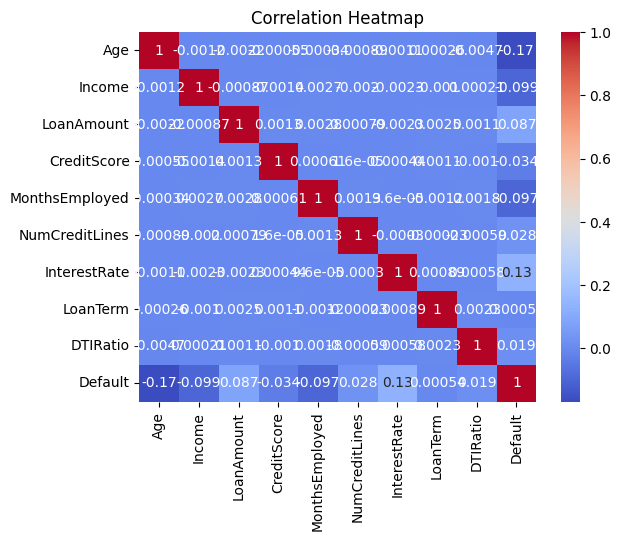

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     45170
           1       0.64      0.01      0.02      5900

    accuracy                           0.88     51070
   macro avg       0.76      0.50      0.48     51070
weighted avg       0.86      0.88      0.83     51070



/Volumes/Local/resume/Loan-Default-Prediction/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [1]:
# import pandas as pd
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Load the dataset
# data_path = "../data/loan_data.csv"
# df = pd.read_csv(data_path)

# # Look at the first few rows
# print(df.head())

# # Check for missing values
# print(df.isnull().sum())

# # Visualize correlations
# import seaborn as sns
# import matplotlib.pyplot as plt
# from sklearn.model_selection import train_test_split
# from sklearn.linear_model import LogisticRegression
# from sklearn.metrics import classification_report

# sns.heatmap(df.corr(), annot=True, cmap="coolwarm")
# plt.show()
# from sklearn.metrics import classification_report

# # Split data into features and target
# X = df.drop(columns=["Loan_Status"])  # Replace with your target column
# df.columns = df.columns.str.strip()  # Remove leading/trailing spaces
# print(df.columns)  # Check the cleaned column names
# df = pd.read_csv('loan_data.csv')
# print(df.head())  # Inspect the first few rowsy = df["Loan_Status"]

# # Train-test split
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# # Train a model
# model = LogisticRegression()
# model.fit(X_train, y_train)


# # Evaluate the model
# y_pred = model.predict(X_test)
# print(classification_report(y_test, y_pred))


import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report

# Load the dataset
data_path = "../data/loan_data.csv"
df = pd.read_csv(data_path)

# Inspect the first few rows and data types
print(df.head())
print(df.dtypes)

# Drop non-numeric columns for correlation
df_numeric = df.select_dtypes(include=["number"])

# Check for missing values
print(df_numeric.isnull().sum())

# Fill missing values with mean (or drop rows/columns with NaNs)
df_numeric = df_numeric.fillna(df_numeric.mean())

# Plot the correlation heatmap
sns.heatmap(df_numeric.corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Heatmap")
plt.show()

# Define the target and features
TARGET_COLUMN = "Default"  # Replace with your target column name
X = df.drop(columns=[TARGET_COLUMN, "LoanID"])  # Drop LoanID if it's non-predictive
y = df[TARGET_COLUMN]

# Convert categorical columns to numeric using one-hot encoding
X_encoded = pd.get_dummies(X, drop_first=True)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

# Train a model
model = LogisticRegression()
model.fit(X_train, y_train)

# Evaluate the model
y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))


In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score, confusion_matrix
from xgboost import XGBClassifier
import numpy as np

# Load the dataset
data_path = "../data/loan_data.csv"
df = pd.read_csv(data_path)

# Inspect the dataset
print("Dataset Head:")
print(df.head())

# Check for missing values and data types
print("\nMissing Values:")
print(df.isnull().sum())
print("\nData Types:")
print(df.dtypes)

# Handle missing values (impute or drop)
df.fillna(df.mean(), inplace=True)  # Fill numeric columns with mean
df.fillna(df.mode().iloc[0], inplace=True)  # Fill categorical columns with mode

# Visualization: Count plot for the target variable
sns.countplot(x='Default', data=df)
plt.title("Default Counts")
plt.show()

# Visualization: Distributions of numeric variables
numeric_cols = df.select_dtypes(include=["number"]).columns
df[numeric_cols].hist(bins=20, figsize=(14, 10))
plt.suptitle("Distributions of Numeric Features", fontsize=16)
plt.show()

# Correlation heatmap
df_numeric = df.select_dtypes(include=["number"])  # Numeric columns only
sns.heatmap(df_numeric.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

# Define target and features
TARGET_COLUMN = "Default"
X = df.drop(columns=[TARGET_COLUMN, "LoanID"])  # Drop LoanID as it’s non-predictive
y = df[TARGET_COLUMN]

# One-hot encode categorical columns
X_encoded = pd.get_dummies(X, drop_first=True)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

# Train and compare models
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(n_estimators=100, random_state=42),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss")
}

# Results dictionary to store performance metrics
results = {}

for model_name, model in models.items():
    print(f"\nTraining {model_name}...")
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    y_pred_proba = model.predict_proba(X_test)[:, 1] if hasattr(model, "predict_proba") else None

    # Evaluate performance
    accuracy = accuracy_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred_proba) if y_pred_proba is not None else "N/A"
    cm = confusion_matrix(y_test, y_pred)
    
    # Store results
    results[model_name] = {
        "Accuracy": accuracy,
        "ROC AUC": roc_auc
    }
    
    # Print classification report
    print(f"\n{model_name} Classification Report:")
    print(classification_report(y_test, y_pred))
    print(f"Confusion Matrix:\n{cm}")

# Display overall results
results_df = pd.DataFrame(results).T
print("\nModel Comparison:")
print(results_df)

# Visualization: Feature importance from Random Forest
rf_model = models["Random Forest"]
feature_importances = pd.DataFrame({
    "Feature": X_encoded.columns,
    "Importance": rf_model.feature_importances_
}).sort_values(by="Importance", ascending=False)

# Plot feature importances
plt.figure(figsize=(10, 6))
sns.barplot(x="Importance", y="Feature", data=feature_importances)
plt.title("Feature Importances - Random Forest")
plt.show()


Dataset Head:
       LoanID  Age  Income  LoanAmount  CreditScore  MonthsEmployed  \
0  I38PQUQS96   56   85994       50587          520              80   
1  HPSK72WA7R   69   50432      124440          458              15   
2  C1OZ6DPJ8Y   46   84208      129188          451              26   
3  V2KKSFM3UN   32   31713       44799          743               0   
4  EY08JDHTZP   60   20437        9139          633               8   

   NumCreditLines  InterestRate  LoanTerm  DTIRatio    Education  \
0               4         15.23        36      0.44   Bachelor's   
1               1          4.81        60      0.68     Master's   
2               3         21.17        24      0.31     Master's   
3               3          7.07        24      0.23  High School   
4               4          6.51        48      0.73   Bachelor's   

  EmploymentType MaritalStatus HasMortgage HasDependents LoanPurpose  \
0      Full-time      Divorced         Yes           Yes       Other   
1     

TypeError: Could not convert ['I38PQUQS96HPSK72WA7RC1OZ6DPJ8YV2KKSFM3UNEY08JDHTZPA9S62RQ7USH8GXPAOS710HGZQKJ36W1R0N3LGNRJCM9L1GTT2PIA35XVH6ZOY8UETC3LSGRM6QSRHIYPGX5YQOGROMX0BVPZLDC0O5DM5MPPNAZDDRGVTEXS9V0FJW7QPBO1IKKLC69BF7487UU2BF7ASF0IHRITA22KI1B6SE1MUSHWD9TWLXK7UEMLK0995RE1TIB4D17PDP8LBLC35RYEXWJ0G8AIMX5E52BJNLQ0H95HYIGLFWKNH5GAA8OQN796P3EX8G0AYTKD97QJJFD8O8G74YT5W31CW0O8WTLFPBQO9E6L9D8NTWNU4HTYASYFXCP4524857M8R0YI5FENBP2UV8EGBQ6R80VBRT511ZZNF2KAC7P2RE1XXG5WPXX0TY2XUD7N4OJ12O7VM6EN0DZ7UFZIW3MKRSP1YD80Z7AFJTOPMFJVLMQOF5PTTT06Q275JKQBN3KDA4UM9K130U8TZ0HWE9NX4IRVSU963HFKM3CTQHPWTGMTU80T53GR64ADDSOB0M5AQ4PWVQRNYJGA0VEK3DDM69LCBMJZGE8DZ3WJUIM1DZYQKG397DX3HRVBDX8JP7XPEW5QYJ3S092M7Z5Z6MZOPZLF57NR648L7QUFVOZY51VR44DKR8P5YIW07DMZRL2WMB522PZTROA9LLT4DU8L04DLNAJL3RHHY2NGTYRE2V615KCTUT4OSE94DS7MC3PVTQ5PDEYD4YOV5QU0UMJ052V7YG8XKT43Z22DZB7ZHZFO5XLXGKSQ3MA71EVNQTEXRYSK6342SRSHU039LVWN4GR2Y4VFVJ0MCK4P29VUH2UAD0E0CNQK8RTKXEJB8PXRYAI7Z9O3RG38F6NXXQU3B2CL2BS2EEJEOWJIF9S2PZ0NSEXRKRYQ4JQAOGI6A8D51F6APQ5YO367DPWKN49VNZFS3GD3R7HVEB6PCNXL0LIO7XMDUBVMQUAJS3Y7KTR7E8CUYH36D287WZBYEI0CTP7PWRIDPTL1IHNJSFL1EQ3ZSZSNPTKVFYICJHINNJXTUO61QYA4L7KM6ZD3M0DGSPKAPYGMVS3UAK0OGDT1MCCQCLDHKWOWLIUEFU4IXOBT7E4VYBGXVEJUYTQ2M7E1KZL0L8ULAVO1GRP450JOLH9T97H0HG4OWMLSAE54LAVDVC899BMZ8CH5ZR3HIDE7XQOML8B8OJQB0JN9JTXOWVKY4HK9SQAG4W5AUHLU1RCI61QKR9RMLV5MPA24SMK23H0BRUJ2PNRE399EUVTNHNNVH2824066OHTN9AF50KOUWNHK2E09521FTY1OPNDQAP6KSP0IBH947I1GGX34200HMRHHRC7YA8900DYE7RYVGO6UHAQVOW72E5CLNNU7RXQM3LQGM3FLPKETTCVDYWBRAUHH2630QPADCLNBIZ1U30RHN3QCYED60ICMEOHEYN4I4X47H6KY9RBH973LRTRZKELRD1ETMYILGK31V3VLJQORH9OYKX2NIQM8AJSZYK9YIRALDM3BEZRDMRA8OP974G1CCY9RRN6RW53ZQEAK528U4ZW405V6LGJBRIY8RHI7QN52BH7DDBRX3IXISXO34R9ZL4ARSLMVUQ2B753O9XXPPEGQMBD1XA7ILO78BUL8XZNLCRSLA8PY0C08S9G2D8OU9UW3PYWAJMTRP02T7ECS04LJOEI660EVK7XL4DJJBLKSF1D4DEUHOODO8T3I0PTR358VKPI6WZUYBB05YF5VU8L5KGFM6KRD7PJRT499HT4FM4RPFT35VIYL3A8ETP7LZ2WWR8FO404GO524QL4QNP5FN0KW5XP11EJ4OWQ9ED7Z9QQ7SVRI62LA6K0Q0JD83E7XWM2RJ85VV9HJJLEQLFR9TGCDEXVJNPF859B4PZJ3F74TVB524ODBHLZGZGENRM7KE57X57WPLDA8SGTKEMQV99WWV5AIBB50PEYS7U1KVN9YIY8FNOFSM2S6UK4OH3F6QSRBKMH2P80VG18UJDAD8BH6BAD08LFVGY0VKFDZONL2BN792E9MZ9KDFOYV3TT94W6YTVZJ94VKUFC3MR7W5MIEZ2BW57CX89FWKMM6UXZ003BDNJEZ1ZGWB3MTTYTITC6JFSS0W8HEJJ6Q9J4TEH240JKVIXOD1NUNFE1WCC954M507PA1AJSA71L2XLZ23WR67VJBBYTBMI7SD09HN0WIU7YWOGHOMRI5ZWJNUHK74046UAIO1N5FGCMXTD3H5506HUSGRERRY2X1F7VA6M2020NND997EK0DKMIB8RSNMGHZBMWBJOU92JR521RD87HP7CV18G5XGQUEEYR3RO2MUHBYI7YYIXFXTJTXZO75Y4RGIRH5P3JHU21VK8DWHBFMGFASMVQQHG640L33CUQMJVU2H2L9D20SWTTFCEYQEDOZRK0U8UC2F0SU2M43X56SV55SRRDCV050N5EPDP3CZTUHI6CYPNOFO0NGL3JH8E1PRPFG2MU6PDHQHG5MB3HP1RXJD2Z0ASQQ05HW58XA8SA33N15O5S6PVTDV0QRIPQBZFUY6UL28N11FZTU40EMDO4H3Z8AT19FDGIFFYF59SJR6FGLX96OYNOFR9HOUA03IJ9D5QLLYUSOXYNZ8SRVA3MZFPQA4P405KE31H4KO4LE1OWFUQ3W3I5GCH7KDYZK40S5VLNKDNKOM7VRV15ZOM5HUS2AZ8WC6K9RCV0EWLIAQNWQWY4A8L4T9VELCA7ZWET49DIZL2UZUW6Q652D7RF5Y4XJY6KH9NVRPWC767S6C7KRDL4HCM96RL9MB79XUKEJEYMV1EDKD8F2UTY71M1X1FRIWF6WCOK0C9HJ0TLWH0CD49UF1ITV3QELBX3NISL6KHAI5B840N6Q6Z8IT5UN4QK8ABJEFOMH6E9WNI1ARY4VJOSSYC80M0Q6VFFTBPDPK0XW1FREX4V8KSBN2C061O2LZ4I4FE6YJTABQ83F1XM957DZGY1KNU7J7WVP54KGFDRMZIR7VN6X4KN74CUM4XCZD7SC31TLRE6XAPIG810DQ8HV4Y7YGZ56I3Q7DSFBKFPF4A9ISJNC8I6TTHL5P234XYQJP0UMLML1X6IA0SWSSSS33KHLZ8P1QNCUACHK6DNETCQSCB6KQPTCLAMDFCGBV6T5PIEKVLISBA0W2998KYOHH8CFOF97S6UIZSTBBK3G20PZJ5J91CEJ95GNLPIB2439H1X226XJUDNESELSF1WS9UTAXWAVTA0YB7KA6Z8G8FPIOAZAFS6QIELUAMDC7DZDHKS1RQAXUBO85V9M9LQUUTAF6QQ2L0W607RKJ7C6VENGA748501I45785IAUOSF3ZUJ9J5PZE92M8HGB121YYIQ1YMT4IWUYLC9WVW2SDLDJDLSGD2YIQ0HXEFJK17Z64NH1LZXQD1YUL3KAXHAO53P0PCEZMW6NDAPMETRIUAI581RDSE7MHSPO2XJUW6YPEOVYVG1SKR3YP0O9FR23AM596MOD5DZRZA8AYY3APPJOQPOXF3QGPSUQ52ZMITZ5X1GCPKHBBPTVASVOLDIPVQV9D7EKI1U6881DFDAIMQL6CEIYV5Z4K8FVJTDWDGIJHQ41BMJLQY46QMF8BLQBPDCVI70ECICJ88623TNPUM9KIKJ2KFQ3Z1QIIQ6UXN3X7WIN5F1P7UYHTGE9NEFFAJX0ZC1AALCCE4O8XT853B55QXQCYB9R0A8R85UWUKWQCS32GG05PYW7XIKQTL20GKG3HQOHFGNEEH9HCOIEMKNQEA3E65N27E7JX1RCQEEZYJQBNO2TOJP92Q1FHSF641UGIJXE26HG5EJPFDPWL1WISFFFHRLQX8ELAEGS1DV8LDQN6ET1GR2UWRLR5BN0WJEO3GG4TERBGYQW2ZUP46RZKJH8HL8K1LTEKDQRQD624NO72XBJI9WGPEL48TNR6U5NX5TJ35Z2OW75RPEK6XYY2ENR7X7N3A1CFUNQ99ZWEZT54DFCFDI638IW19HACO76Y5ROCVK3V1K4XN81WSJBM5T33Q8E9XL7EALXY187Y2Q8W9LI2CM348DR8YKSM4UQLRJGI0TZWM08O1SO8H0AQK9A8ZNCDUVO9NWOEHAUDOSHXKFYZZZ8BE0FIBUHRZK0A09C1UYOND8ZVJNGSJ0YV9IKY9LOGX1JWXFG8KCH2VXYOAD56RBLGKON7RQ0UHKH4NXL4QWYXDESH6C28J26MNADBX7TOUMQQO0382CKAMDOX0LQZH24AJ6L0T2CBGI7RBI7WYK79DCP7L9XC4389FADOCQOMUKZY11NBU2K5QI8JAYTQDXLWIBVLKG16AB2GE5UH4PLC7AOPY7VOYDAJBVDU7ECEGA8S6JSQ76E05XIV43QCIP26P4SY56HIKVQSY6R08GN4X38KUMZH5E8WTE84ADU9I7PMBPBJZ9UJY6G0ZL7AFN3SZAW9CSCN1TJFLUPWAVJZ63T3RRANZ2BF5KDTCYQ7OTCEOP823219997EPWAY6RVJ4WQ45XO4F1P5OAB06GYUZSU6E2UKSDVJBK6WIIKILYWC4L2ZAPOU56JEBZ7RNBCJ5HFE6HZS2CVK4HDM7GVM9VUH28KV9FZ2DXCUFVHU6C1VWB3DHVUBTJQLHCLIRJ89BBXTKYWKKLLE4ZO7VKVO1TT4Z53A6PBJGPNOQFEY6R0PXFUSJXVABFX4BBAS0OSXNVQRQSIL0VK60D9YA5JWU4W4BTOVXGIYX69MOW7KS3FS6JD3KD78VZ6QZ0KFP3JNZ1O3ZJ8ENWFSOC12VRRCH744OP232P21XV7YYXGTHQSU5U973BAWB27GM6TD7H0Q37VH6VJF0HAO2EHFAQXU2J51UF8P5LXL995UO1UJPZJ4KJU2X6DJ0BNFWE1HN7JAARQN9B58VY9ICQ9JVUI2DDVFXGTZPSDZKQ0A86TMJXL6C4RPPAFYTFCA7IAF2I3J396ZXPKRH508DQZY5TGW1MUFP2YBDGH70AUTPXFKS9672A4BMQ2IQ1AAXBJ91A41R49H3MQKG6FM6V2V8MHR5EMP19G4UDULD2MJPY5TLOY2LBVBOHA68Q8034VZ3QOR6J80SGCMOT657PNK6I3ZO833MZ80VSVRQUUZPGSBQUT1HLSAQ5LD4T1AWF4IGZQWHZ2XBQ055ZQCTXEUTCT07ZMFVHXE0BDMWALSSBX5LWGBMQWRZCWRVXT2AHIQXACHT8NN26GUE9II31WI7TV5RW2XBDGIN9YPI831K0N1BM2S9A2TQTC0FB8U550PER7UJHLKHHL9QBLT4FKJRTICUCKB8NOX3FMXE4L82Q2R3SGXCK9CNEJEXYSZJ8Y1QREZ23BFFVZKZHQQMB28603E3J8Y8YPUUZS41UD457K8IFCP100L8XB9VA9CCTCSXYB17ETX4NW3PC37326QLBV355UZ2JV41PAMVE5807AMXFXP50D38B6GQLAS565WMW1IJBZSQWS28ML6Y2JXW6RP0FWGUN2SI3JRM9IQBDH1P21YS6HNYFNIG01X8HMBDQXLO9AUWVH30XKTACXUWYRLO78HIAE5ED85GAUTV12ZLFQMHVBT1OPV0769U41I5K1JYQ352CI5VFRG0J5HRSCQNZ7ASVXI6ALRVTEC458MGDT0VXWXZ6U1SMYZH3L4XJA4V1WQVITBMPGF44I5O85F7JNVBS556VJ58WCCCBQUDUPIYH200S2P0F0OCO8IKBYVG54FI4SHNETCDTJDS08A2EFVNO5HOVYMM3IZQEBBSM02JX7GZD622LJK4OLB1ZS1E6MLAHPODED3DOENTXBE5RXI6GU0W7ZNWS7HZCXGUDWVGKO258432LHBESPPOBK9HC9RIYKPEL1PSALPDY58DGC0XDG6EEKI1F8GW3RDHCBM4YZST8M9EDNN1KA3WGBU0GZR4Y0XMB3H6Z2HVDD1IK9A6QZ0NTF81I5EU68GLEQ0C9CRXNCHU1U8D96XPFVGWK28M5LLJIBIVHDP0PRC9Q0FY91OKTSSAW73B3QSC6TT3SAYW0H738EP3JUFHO6PKIZFNFJP2WB07XXGWZA9BON1QKN5MBFYP32B8UWBOM8AYVUZZT9BPEOQ795UU2BTWW74DLVD37U2MYDA4U67AWK64TWWGTGX6QU9S9Q9Z7VOGBD67M6VP4B01DGC81WU84LJDKGYHJCTPC7Y7P7CYSOF4IHBARHL8E39T1AYGS64K1GK8564R8W3G2EUIPSNKHYKL6YT0WAJ2MSQ7ROQYY2D0R0Q6P8GGPE5W74IOVWQ3LFXEWXOQ8W4AYGRS29CL78PB7S4QDYMBPK6GAGEK3XREA85A9QB3J5OG4AN3JO2SNXJOM07G18BJNH0T931VURFB9XJ8CPD8HZKLTGO7A82ZOHCMXDVY04XKVZDJKY3S6SI52F504YS9TGBJSLMQJ3U599LTXDVGNKCUP2G1GXKVGF62UIBIHXWIDBUD6HCECNPVT2GG3LB1JFY6OQPWLORGHUMMAO3SMX0JOWEOG8WTV86PO1XBNANTEGC9KDKW4UXZ0CUQKTX6LB8L00XQ2KN1CH7LTNHWYKIH25L1QQEUKTSHB7CM9LCQEHI2FQK7Q3JUORNGVCCD2LLSE4UTPAELMJ0XCJYJNNLJYVQM3FKQJH3XGYDVKGUJYY4LPOZWPFVIH6MW2TA4D4P4VQOLBVN13ILGZDKI7BW598M0Z0CTBGAFOHF2QNV6TNYXARDPLENPGMZ4ZI2OS310SHE6MHKOP5DH5B9YZT9KE8O3BJ8M14WS1T8DPBMNGFVYY784EBR3IN3FWLP32N28Q0TGJKXSE2Q9FAXP8O1QPWCWYCF9VVMJSNSS82RVNE7HCBQBCCODQNXLSVFF2EJEHI92A029ST5WA1ZJ0CW07NMCE5RJ46PHQB3F1TK6ZD95TOWRWJNSXXQ3Y5LQM8ZTP8MYTL1OMVQ8AB3FGB5SA5A9MWNH9JVKIC51K14KNMFSZ37MA796CAOEKULZULZGBMO7QSGPPNOK1CTJLJ7SECQML3CSI5EFXGAIH41FXV88U8D9DAIQQKJW6HWTZDKDVH80M08JGNX7GAIIF6F5XGJHQ3ZFJFMCICISRLFQP509TC0C3M5T9ATKJLPH7PC51ILPJSMM5XEBU7ZIZHR67OVXO51ZA1URTWA2HX4KFW5BTW9GFTMACQVESLTT93Y2WBCHUJ7Q4IF6VQP9PJXSMBB5XGH0FQ1E2A8VVBIX7NBLPZP9DMUJ6TR6T425TPL4ULRGZYFNA9H62592SCDJ0GMZ0SIY33ACHVS35U90HDWHF5SJ8X85XOWW0QGHQO4YSOVSS1LP78A9P87MAZ0NORP34F30REG6OC07FQYR7LI41JVPT9WO7Z2CP27VTPK3XV3HI1SVLY9IYHR19PQ1HEVNO6RDXX1XZA858AK0G6097FM7KL2JTAV6VA06KLWT74EBZS26O6AEWA9JG5GY8TKVO1C1GXRGGOTRO547ER79JS34YX4HUW94ZBOOTQ48703JDJ73960YYWQ7SAE4N4QD6F0NDU0GS0IVCWQ67ON5NPUCIXV6LZBOU0SB55KEDPVEC4Q9NPLUYVYLALP9L4U6L4KBF3XMK94G5YJ8KDPTH8S92SZB6JY89DM76N3EYBYB667LCFWAMLCKYU6HQ5CSXJ3I7E8RMBTU6BEZ9IT1FR62UCAPU9WWU7YMGODJWC18CXDEQAP0N8T0L3V4T32ZCPKZPGHLZYYBI0DVHMVT02HG9C6CUKN44RX2FQTGEG3E5C6DXSUN6BJHBGQUWBWTPZ4E5Z8UDYI8LAELVCWEOVNXUGONSCVUQ54ZEJXO3NSXPN7MZ9S1RBZXHZFK8C1XE58WB7LKXNRK83ZR6IQF7N49LCOY82ARHQQ5X3MP9YDB6UIQAYFCKBIO62CHBOAIQUBEQP27K95N039QEV8OD47CL6MQZUEANLY2YJNJ1WPZNQS3S0KOCY7JB07CK2KNQW09CM9FR5WA7PW7HQD5N7EZVNI7HAA5C8AZ9ORQWVA4M94KWUWVBRK1XRQ8RNVTGVYAHDRRCUD2B5G6VH5WBMTWXSINFUDIJ98WUVJGDO37ASX2XZE6US84OJ6JOXCPEVLVOHK0WJCSG5RZYYS1VEEB2K9NB6U5BFMVE3PSU7LDTDW3P2WJ7FXWZ961DJL1FAXHEYLLUUBV6A9UCQL4046DB8T4GCKJ2DZWT8LT7YZPQNH2TM1JYKMGPCBIJ33RK9UPWU1IYZ7N2JWRQCZFXM3DMXJ3CYE2KL7C2BCFZDVJQNSVR3LAH5WTJD24BS9QJFBGM2AAM1KZRM5KJGIFLJSA4K5H5NKNKGIES0K83Y0CCVARYPCWGNVHVQB2Y9K72ZBBLEF15446REVPT6G55LUJX0BPG6VNEA0HCUOI243XCI7UVPYLN1L100XCUCQHROJJATNATR17IBJ0DV40R3B2V7RV8XVWCYRPL3ZRLZ0IGJ9C9Y85VVH2SRSBMMNPMI355AXQ3R4NFM7764JCCHSAXEH1E89SKDOFV1G6JZDSMIP23M197HUJGUBXW370X5JB04WX2OZWL2OPIKDZAV2BY60WAGDF8J41T18LH91RHQVCXRLLPXWPL4G6BWTM57OH00PNFVTJU8TQJV15TWTM4VH7AZQUF1SUGQY3D18MVIJHEV5TASA7ODWKIJ0POC7RU5TPDDR5A5RUW4WU1VCZ05IW7RWOQ6LXDZYNJXPC2S01LICMLDD14AXJVR88K6GZQLWF1W7M5KQIH586TOVSPUV00Q8CX0YBD89HONU5XT9KI5TZARP38C897JTNTUTKPAVMFHXQGYUL5YWAGPWAVMXFGNVVB6JG9NNI8RVVRXNV7BX8VIMBQH93ONS23O5YW4NA5AIAFKIK81SLGAUSB50ERLVGZQVDMB36J68BZ3289L2NYM9KXE58IPJ6SUTUBHPG0WU5CVH2QNKD1OQ59IHI7RKTZ2WEQIAF05U857DCS0GBDI7BJKRQ4JDPFDEGAABNYXKSSZ9GEUEZ77NDQUTRSSWS586N35A5JXBRRSPF5NNK7L8BUKANRJBY7UJSTGB8GFBMAKYVU3LVY18Z61WNMZ9CTXUG8OPZAGK6OD3IYNVILYZLWQT4EVHE4UUXS8QCF5C0EHO7IEMW8V9J1VWKH22RS6N25RQB5DYXAWI1CFGL5OSWUSL0NZHHGH577XYH679AJDU23XOGDV2WHK92S2CBH35XXHTZ4ZMDGSQYTWXI7EQQC3LWLAKQ88GUR65LU1VZCEZ9VCCZQTBYVOZRMYUFSF5UJXDGGLCSAMG5XYTUBKRR1D190L3UWPQ1D6R4U2GUM4UOU64QW87XLTXD9XA3FKOBQDJQ38SRP2C95SZGL3ITTA7TWPG88126D7CJAFUHKCRIIZ3NZCIL0M8DLX30H6ZC6DCOETCCBLKWDS4N5FLLJ9MA24K6FL1D23A6C4SAB17P6KNGELKTKQN7L1SS1M1C1H97PY5SUM4KLJUAT6TT184TOAWMTB3WYPCCAMUZ7ICT7W5H7FJA0ACA4XMUOHYHIPNYCDE4KJPHLYHG9I6XBWS72G1J8M9NOWLAWFFVETMCYGANWOLETEP5SP9N1I4RXD0A8KG6Q65Z4M74AC1WB4AVBKYD9MM52RJM6KOYY3CA9B94S2MLMRQ6DS4YPRERP63YAV7QECG2SGBKLL2EQDP23VRT1B6EWW4DM0UVR915XIQXGYVH4ILD12SWDU8Z16SPNZKQ521RXUJZNXL0FXOQRY7DXUPSO4JMO4M0J3XI6Z8KWCX5NJ56WLCCT0Y727JEA6ZNY0ZL7PI14IVBRQ2VXY9172WVFB1H6BWKKTRYVI9GCE59JD9QS4FGHL4LG2JZC9IB5661017KFL31SJTMWFCTR738Q1I3JW2A7OI5RIMXHUO1LPG2Q304ZFSPHW91SNFLU3KDOD1X2OZQC8KKDXFT4ZOA24HTLU0ITPUHG9CRJN3QHUURPZCJZTOOCQ2DZ767Z8RN6O92TFJUJC2QPCDSBX2ILZV1BA7ZI0YD3LYVJND1U2DTSWC3P9KM05XAV48OPFOSXXCG6M71GN57KZCAQUXPPNUN0PN4HRLSD8BNB46JAU6TLNFS3BHRT1DCC24HVYJ4B6V73HSH251SDTFSEY2W75M3VUULNCWKUQYXSGHF5OGNA6XX0L85TO0PPVNJIOE9TMQ5ROELSXRMJ1R3B4JGUGCDFCOGZ246HE4F284Z958MK6Z3RJ2ZQ52VK394SZ3NJW8NJRO5RIYEJ1MK5WW9LDNYAVJI9II76Z7HDXFHEY90USNWR3VPTS967P49CMAOCI3DY9J23TDR6LC99G7FAVQUN8GLD1UHJNO7RMSFTG5VNBXBL2ZUL746VW16R9ERGBWIMTZ0AXGF4H7RYDD8SVKG6KCSDVAJ3UHTWRP2QH2FW7FT3X80BZQJTW0E4HBI34TDKDNLRM107MMXUFHQZUG1W4JSWRHIJIH6MIM5AARPUVNBERTWKR0BIX51JTMKZGU8BURKGR91IF3S6NSE4LZ2TND6JYX2T5TDM7SFDOB0BCBTA79LB3WNL7UD7JFK5YUKROFM6UUDOKXWIX4D2YRKXLH2HXH2GFAQHGO6WYBYJ1JW9WN7AD8BB9OQR3MCQNH73O2E0EJ3CIIX0TX1JSFU7F9HVCC6FHCCG0YPCPP7N4HLQDHK4BIJWDORN7WTRS64FCGFHE7F4DKFBE7N2TDOZZPJYWSY17UHFKLS9DDIP2M3M6J2UPJQ038SOGKN71YXILFK7MGK0N1IUR2G8KHV2USPSLD2PXFLZRAV8SUZZAJG3LMOFE37TS2II40PFOZQYGV4N2PEQAYHFDBOGSIB9T0CCW1V0RKEG3LM6TJFOYVUWVC4UUGKZPV2E18I495PK7N7YE2MG6S4WWGOLKAGIHPU8XF9UHNQXKYYC5RKSQKYQ317N56AL0UHRB6QXN8X09E4NPDHJVN3YVR97ZUXG2076YO62VGCXKGVUT93JZFK5TW21KE16CZHAFDLUW2UI66BHTXLCSXTZEXN3NPHNH365UQEX6V0H79SGTI8R59V9NI1GW1CGA6SEMTATMTAHNRPNEE7VQQ92125ADF5K7TMPHSLAZF1E1QF8UJGNJDCMMJVUPR5F2F22MVFH3NZNU96IDOQ9W4Z0BSK1ALGUN7X2W6CJ7LXJRXXOXAVUOMR4LLX22TXU6U32UAZFA8ZTNGUEQ35PO93O4K6QC0DCSW4CYUPMS4LHYYMZPOFGIOCI4SFR49KLMT6G8P8QRWF5256PLRXI0P6M0BY7ZWVJFIY63SDWINPO5N8WBZ7A1FFIX0LQBPK23KSIINMUJZJ3M00Y72OCNVDHJFUQIGF4Y1Z9A7X3JFQ0SVFSXK1D3PYZDAX1J8C82BIRII1O1PW5TOG6RDI701LSKAZTJ2HBWFLSOHS42PS2KUAJGR4N5TSPXQNEDHLX7LBWFR0MT0TMT3HGLMZK48IHSMQQ2RMPMVLKB1URFXWSB3IBQ418YHS2YM6ZSQL0ON9U7VGD91BIUYM2XAWD7ZLMDHLSEBVV45C3JDMPW99UMRM7ZAKG1U95184GJQ3DC3AFPA3I4A4D8HUIZCOE8YXS2UF8PMMLKF7HSG5PWGO8QGSZLKV46HYG1P7XTARLNQHQ0FQ613H26UTH6Y6279B2Z0FNEL6T4JDAMRMRIL8DGSD7WIXVAQ5PDPJWVKHAGBNWL8VCBAQ0829PP3QQB74J2OM2PP317NS7L7L9RMY2S0YV53O0QHKMK7PUP9O5C0RMLMZJCMXXXIDBDPKUMPRKGVDR53BQ6P3O1R7FUN7L4O6XTIPX6EAP40X35LE0YPQG4TYC05YDUPFFUUGMAYY7587XHT6M145VMBR26HZH0LCM866ORCH82I84IQ3EF1EB0RLV0IAWMGJO04ZN8Q8CHVY6G1PNRQ89FC9TEICEOV8NFVNTIXG2FGR1XMEH0SIKOEV7YPSBGAGYS6R3YIXLIU10UTUZMCEKMI4939NX6BW1OJJLVD77P1ORSL6KBT0JUMNRPVTNATH2RI0S2YV2S1525CWH25N5YD19B62TR5GUDF4KLLKFFMMCOR7Y4BOPBV7EULDN1GEYI8BE6XCY1D1FU2Q86DV59DCXNSPJXQLHOJIEO0U8GV2PSXM7C8HIP96SJXCQ8R5HIMRO6YLSS9AIMHZJ2QPA207N793IJGQ3RYOPHSN7BIB9OPJG15U8PGDAU69D3L86AURD0TLJDEZE85UYLZ0QGD27QUOL4MIKW44JYTML8243RJ517V5ZWZEBJLDFAK5BNYF8M6HRGSH8LA4KE4BWGRZTFESTOJP9MPPFMU66SP7HZQK0GDOXK4775KKQ4SKPC048Z1NZY0ONQRV4CRX62CXMRXU2L9K29RER9X4CUFKPOIWN1OMN01RLV58HRP9SC5ENRZQQ7Z5NWYBCZAHFXXP457HWHW7GH1UOW0Q76WMCKLQ3JVVJIOOFQCWSEYREPHI1P9YLHK5IFZQROM2ACOS0VBTJGRTTB0H6ROE04HS7ASSBOZEZ0BQ85FJ3AV7BEZDP9V3PAUIYY9UV82VBKVOVW93IAET8KS7T8SUJQV2MARAKA9OKUMYY0NALGSHPAW80SKAVHXZK32UOQ7W6NV9GUJTC2WTIB3F05UEICSBR8Z0L7GLUCNJFZAMZAG0NSBNZC0AMNVR9HZOH12DBAMTRGJ8X6U3UC3US0B43CGXH1RV5I3H1YANS55IJRTXEFN2FLRS4N33PQZEXWYWUSL704PW8B0EDRZY4JV3T3VTXQ73C3BTYD1YSU52E83HDTC0VU7T3G4ZUYKCRVF6ALSL37FCOGX7ZHZMS2FNK72OG3HVGNY5E9U71T1VND92P319U3TDX5114UOWEHQORMIDP4M6KH4D6I91OZGB0O9XEHJ714TRY216FHFQNFC72BC6FHUIWRL7WFBRUV2GNRRCBXOHDVEX59WPYH5HW4UT6UBM48T1967KQ1E07G80UHGZUR5YYGDRHW3KBDEJLNA4SBQIHCHJRSLETHGP21S3XGBKI626ERJRW1LILJOO730PVX8L790SBNCXCAU5XRPN8MAYS9NKP08962AOGM9IHEQP67GUXVO7XNDCCU2X9WM48KD4NFIVJNWPED1PT6NHZLRZ84QQXBHCUR0G46VIJU9CO318CWHGL0NB2JFQOB5C8EZUCC7VLL2WDK6RKIQBQFXSJB1R3HL39IFAMU47I9YDFBZR6KFEW5OHI91KTHHRIZW1QD6FJOHBQ4X531F199NRPNR38O867XMPSQ48213BXWJX4OXG70IW1K8EIUAPBAIRXABCT581XTHT3MB2SZ34NZP4RZHMYAOX0BKY50AJY8GHFERD05BR2LUH9MQX1H1RZUW46EOYX5CIAGIS07E9AT13UVQDGQZEETPH1F9A0W1XAPVTG49FGROEEQY9V7O6QFQN5GY6KD9FG2FS0DYJR6LDJLXSP1QTPBZ0C2MOUO92U47SXDZ9SJ6V9IQOIAA94CGUHI3P74Q73M4Y8LJNCTTX5TYNICG4BQPJ5S0XPKG8CHH1NUAVS0BMWNZ1C5BYTUJ9PMEAW54D0ZF3CNU3FVWEJLR3U3M0R3TLISB8X4Z2KCBBD92CVH73TB8063NC1XU7UJ7EQ3GWC2VTTQWQET0KDQRO0DHF9OZBDVHR8AW3C8LFF947TVGCZLMC7AWO36DX419BG703TOVIZH7V2FPBNWHYZ0RL3UGVR4KTTYTSV6AURUGGK5NEV6YQICSMVBM4Q7P1MRPWCFQKM3K1GTPZ73IZTSQMK565U7YJBFBQX0SD89JTO6JZ59LDFQK4FF4YAEYUKN3FLREKRY170MOYDLMLUQF2FDND3NM7WZ78OZXEQBASZRD1UEWSGTGG2BR9KMWQYARHX4ZQHC3SHSEQC6QYY498W9QW78DJMUIWJSMQAGMFHWUZDBBZLKDSNH0GQK31E1FP0TBMPSJLQIH3F1AUTOVKWE2DR1M7AF10E9REOEE5SYGSBO8I504F6XBNCU08KID5G3QNEFMA1LNF4D4138HFNX9DULSJALCVQCXJZEYABGVO0LC2PU2Q9O4MEQEP2R1VGUBCL7IIWK4QPMZPTWK8HIXC3OWF7EAP27CSA5ASUFRYCZO4FL10DUL6FWJDSHXIH6IM5R835MD3DZ9UD6XQC5EJRWDERYKZJ0VUZ8GTLM9G8TG5680NGUZ0H7IJXAAC5L8WH5B2XWX9SII228A0XMGZZGVDG1FLD7IKC07LPPJDN4AYJYURLEXJRMHU8RS4YIXXZ6ZV6RIKTS508IVLU5S3ZOSGQ2X4VXHQCOM4G3QBRJYFKU2TQ41GXFO2CAWESD3HKG4P7A4F1L91QM4CE61RPUF9T4QL9OGABRIEQVOVCAR7MISOVLHKVORU3ANLJ8LZKEY8HTWHOWMO86CE7CCD2XTS9NB8S4GKS2I2KGK4DQZOGWLTWA1737YBMA3M60NRXOILTUIKS22TQQDRU92ESCPTV8YZE8PD2HXDFJ2BGMKS81HYDWDN5UOIGWGEB8APW12F3UFS1OAOA6FN3RO6TUC1O3M005UG0BSOATDZDKKZL889IDTONMYUN7M6MEM98VLJ4UIZ416JTP08UZ6JACGP6ZKQZX6OIR7INGHD6SY8NM5G133KAJFYGXIZ3LJ1OP29L3TJIDIIV039VSQ5GPXRQG2XE8PFXQW0IX5OS06QUV2VL2O89BAHJ2WF93D0Z8G2B0SWNH4TS5NUHKBWVIN98D9A9YN775EQKA1M0R7GGE3VEQX06SRPNGCDB39J6X4P610LLML58KHTT5XMCBBWB4ZWYG8ZYKMHKCLHXDJYGEYUVR9WMT50UMWTAM5U86C0EVD2V0K4R1CRA6IVJTOGR7Y6QK2IF728J684KKMQ20FXCR3X4L4G17OJSFY328IJTE4Z4RX3FXRX02LUAAJLCQQRZUJXSSO4P2QRWLHI0L1TQ3RIZ7AMD24PWFWJTNZAL5G54OTSGMLG6HP0S798HIV4ULYLMUZ2IKS56X2W7FCQRIXUMCI3OZQD8N4W1PAGZFSM0W56ZETVU74TQXEVBFI5P6QG84MYPVUR7D4592WHZF7N6PT82EY9LTKQX9K78IQMUN4A0VS5LHXUVXVA4M1QZ52BNVRL9Z5E3WCU8CI5LOLJLJ46O56UFUB3O6CIAT86G796XFLWWJEV2RJL6JAGOQ3JZVPW3AVI44AU0A4DJ66GJVQJAXT4LEGONTIGFBX281B94W85H23H439GE4X92B3OXE84R927ZERBHBO6ULSRAPNEBB8ZHJFBZ6H8SNZL94BEH3LHXHAW8NESNLOJD5GGGNGUHR0F7MVW33VY7B2H0UNCBVYSDKRBK72SJAMK0CGBN40XLRFLWEI9G925DZRWWMC9MZ0XG19F3U08D48UG25CEYYL4OZT8VF466DV2KID86SZXJ9EE0IF4RNX23EF25BQQ1S1JZ9NSJDJQS46FOT4Z3N4DP81BB9OYDXMMOPSN0O2LM4KZ8W77HX7GVUS21UNB77CDXNFHSLTEM77JKSVT58TTLSYXH96RVRQG6P42HFR5P2OHT6U9JHMLQ1HBP7HAVJLT5RMCOH14OPTL8C10Q5G1I5E0HXXOVJO77COUYNHMK6XCGO6YYYI556RV0W6HM1522OG2F53R1S91AKLXRKO4IGDJLU94FJHZ3HKJWUXAMUSR7GSD3RIL791OUN83FOSEJB8YC96RMHV3MINOLWSCNXO3YXGB0HWXDO931FXFSW1KLGPTMDHNI04O73PKA82N5JB46SO0YJAEKALKW6264IB3WU1F50W8CUPWSH0VZMY45XKFP7DZQ781OFS7705LLYJA28DVVREZJ5NNIQ5126550702TU830U8N4F5LJA0ZMPGW6NQKRCACMUFL0S1KGYXB4ROB2729L6NXJ158YHP7WBTDMT9PXNU6BP2EHSQGU19L8UXV5M1ZSW0DUDKY12S4BFO0TDYKEGWNWCKSDOC645XFZRIV7MKQ76O0ZMMXVI88D7VAXTG1TPJEEDM1DOX169XAX2JWY7ALDEYAPPWNJTZYTXA3JA48KO2W9CS7M2MK4EGDZYSKYV6GDC9JTTLJ8O5CHYX0RLVNT5L3KSBYBE54D8YC0VYI8G6HHNTXDIL8JIQ67MZ88V6PDSDWYHD9ZH6NU73JZKNKAFWZH0UURLHHCWFED38FVWY7Q5F079LHZOBH2ZR8UAOZLZCEET39GRDB9SDPEQ09NIJ4275HW4ZMG9JLD5QS09HFYXJ1EUF7MFJW4UA9Y5TU9VXOQDQUOCYZ3G7OIEG0XT6BN93REFIJ2U7G3LAX59DHWTL1D90MW1CL23MWONQHYNVIFUIVPJEZA2DLERDITW0NUUN02LOT602530P92JZJPXILO4TIUUPS5MK1ETX2GMT11QBDT3TPSF508KMAPVDF8UR98PP0ZAEX248BKKC241LEPD6XDIW4F8TA481AKI32UDJ79QL3JJ7LND3KFGQEY1LTK7AKX6HN36MXCI0POMFGWNYD5M5M6TMLW05QPTV3FUQHRGVLBCJTG41AW1T4SHFI1NPPZNIV9Y7AN81V9VXSYJKXUSXFOJGB3I3PG3EKU0TXKXARPZMG950GC9DUN0X2OVCOLPECKD6V2FH2EIVFJ91MLYAFJ405KO7IVRL04PVCQAT3C59YSO9XZ248EWWWOM8QPR3A7BSH14N4Q17CHSTKVC1MKWSQDT2QUB1OGEDVWS6KUS8UQHUYV2MB6AWC0H1RRAE70WDDYMT7TNODDOSXMWRJ8E9QWXREK96586G754PPPMWX03FD7RAO9NCKE928PIASURGWKMG0H3CG1KQ60MK84OHOD3S6LF8EMRWDKGOMQ0R7D2XHWOOFOPLFQ50IJT922JJJ7QQDNVLLVF22ZPPEXRVOYHB3FPK4LMSRYM68L7KXEQAPF3WBH5L6VRCBFHT5HKOCV4X0JSTARTYVSVDPJY2N5A8XTW407TUBR5HBDPHAM7C8B1S6ILWMG4AHDST0ZWLGXCM82RGYBEOOWI0GCUKPTXNQHIXTO0Z54HBXAGFI6ZTHJWRCQA42OHLPXWOT1G7LLEFL8WA5R6JX4253GIDO4GWU9HMACMSDNDSE0Y8QOQCVZ2VJA5H1NL57ODKGUZ3IX4WPE4W0M5WHH4IMPRQDA2G9EUJ7XFBDOQLQQXASXGMN959VODMPSNNRA2XAT2337GA2GY5J6RQRHIE3O78UZ9JK9CYELJEI3H0C0JCLT5NJXGE4JQJACANP6VZ1VW4HNE8XVXK0MLS3Z8ETK5J4T6HBCANC5LP6QQSYJIFS1FJY3MVYTO1MY9A6E7KBHG20MVZ28E097I7FU727D452M7EZNUDG95PH9CZ88WYFS2X4XH703ENWQXVVIWM8PPCMFH39COE5ESBQGYHEG2AAQ2HMB6LBMLM8ZZOWTI0PZGDM7Y41PUTN9616PUH7XOUW2XRU2QFIQLSIZRF6Y5BK9SNZPGUD1FG8DAD1YJBQF20MIRR31JGHALY3JHUOYK59M0RJEG2CZP702DQ0VOPH5YE0RYCZPISCPLM1XZQAZXNHOXLXDJTD56FDN7DPNIXYPVD1W0W2J9LRVWZ8N48O9EFCEC21XN8HJ571QUTMCMQP28K7VSK5GTPO3UESK3VX4M8TNM62UDZC4DHDYZH4EC3OS0Q0G935USC1LFPPRLZVWVZ8WD1XZFDE3YPQTDBG5LCRQJ0MPNMSVNM5IOVG7QTG0CLHVDFDB5FDTOMF0X3UC3UPXUV1CIERJ3TKRLMBQIHAGIEPQS0UPRFH1ZOOA07EOC64EFFNIGI0RDE7XT8NIOIZFB3E8XV0M0CDB47CC4DY9YZ4J15YYFTHO7FYQR2FII9MBGIM21CB7LU4A4HL5033D5PRKP51Z57NE6V4KVCHUMDXZDWOG32HRAJGMB7BD2STTSZH6F6MMH75X75682W2CS05B7DANI6BVNSFJ1TAQLXR7NWR9I2R82T43JKXES5ENGHOYG7HKDIEP6K39RBHQQ898O39RYPNKDLYJECZ3JIQO7AYZXBNU0UYFQVYU40HLWJPSLJUQG9YW6XJKVYAPZ1M26RRS38X0DN6DEW3E5P125YZSA8E6X78VNN7GK9MLPSI1AN67U2AUDSHAWFWG9VE8I1PBZVXPJCZLBO0G2EFGO0JJ6ER0710ETLB4SYA1LD14JQQFIRH7D7AY62ZABZU57X351ZX9ISRK06BKG547FY9RFUHLHG9B0D10L50NV5JB3JLHYLI9AJJ8EOMCY8LQZZPGSWLZUO788CMFIO55F2SAX4W7TS6QSZR4Y48PZR7697GNVEUTP6HWDGUF0YX45UO6JWWQXIV4BNKNFLWO1HY0O2CAIE2064QBC6U3IPNHECOUWR6QF93Z0ARENHWYONFUVBAZYH78B3EPXW2TAUGNRR9D5SADV6WJMX9NTYOG8842EQES65C2GO0OOEAOWTV0WHEFZG80RSX9C27U89C4ELE3DJNRREMUAMZQO7NWHL6AKK4OD86ZJ2BXJSEXHGWJ0768OO5MI6CASOBVQ0T56AY5C3VQ3PUB94J4MQHZPER81WUZY8AJYM6U9DQ31P5PZWEJGXQXUPMB6BGK4X6RXHR4YVV89OMDUVB7CL8YG3NEZHHVMD9AXLO4D0EN34YCCREF0BUJ4RGMENZUZOSN9LB0IMS93E5LSIXCPUE7WPYE2CTN70RZ3UI0DBM9J2UBN4I2LTPRA9PWU8SNMEAA1XG2Y6ZOIZ0UAY1TI761HBP1JLUUWZF8OVASU0D1M72QQVFIY2PWMCSWHFNSUKOKMPDTKKK76D7V4UE20VKZFFGAXJIQXOBDEFJ2GGIRWCE8EWZG22A6FF2SKAU1F1OMXGQNXV7JIJ49L3TG17IT7GW3AWSMXMF6RDRINA3CB1YCMO4330Q16T5Y36CMTTOXWL8L5DP0HO9CQVG8M9V7NVASHGMQJ6TQIJPZEMH7DRDHSP24GF97DFXYH0R1A9VMIAA8UC93CLNO03TX2N81V6AR263N6Z016KF10TMOMUS82VG132SR42O0P76A4YJSUC6NL7O3H9R8UCBBTBW5SC1NNUKNHSQNVONWEI9VYM30XEHVSCMSUHO3YN3RCHTZHO096LX4XOWUQSDJJL7MYUGQ9O8PVBRWMBC1GMZFE344IQR20HQ6KRB0003K8VIROI6QA5N8060ZNEPJE13HWMKIK2OGWFGJPDUV6VKWLPRDNREGA448XRGSRREBD4AYPECZZ6X8RJ5DO63BR3ZEIIF4MBZNRFQO4PWRXFERM5MDQGCP13K0KV6F4GQ4F81IT1P1BMPKIX9OF4197CGS4B9M3CIMX1UQGHOSQ85DGM3N0OYPMVV8UJC42YP2TZSPR8F11GBG4PV1PPF5BTVTO7V9SXWSQLQNZA91I8YDH0EL4XOAGXYZR65XVY0QGOP3TW3EL3P3N93837Y6REV1918TKZ0JWTR13FP730VL0GGBG8UWGKIFL4SJUF3KSSDJHLKIZ7CAQR214W276SFBODW1O2GTLA281UT4XHM52QEH8EUDNH2ST4HHRLQHG7B75RA67G0OOOY2DVOOTXIA4O2JHX0LJ3FDEWJVCCD5HE0DE3JKQKYHAG583HTS4C1XQLR10HKCKF6YG0409P57XISTE0V77GQ5UMPTOTC3OFWFEOBF99MR44NVG4KHQPOCQDU8NPBEOYZN55W5Q1K6TMVAG7ADVG0WI15QM9L7Y265PD7OOJZZ4OJXKQTYETFOAN9I2YP60SSA2XRM9F5MRTGAZVQKJSCK1003EAQHAKAI1BLEQM5E2KBYVM8R83M3QJDFDSMOW8EVBFAQMUOCNLXMYC64BVUJ0HNYHH7TTZ2GBYDW0Y42GTOEEIKOTVSQT2CMBNAUKEEARM3HKX9AQ2L93R1TOOI7EIP89GQFWAB3E92FGA1NMBA45LL3XZIB2SOCRKF7H2KAG8HJRHF681MTN91TSGLZJP2CRV7F8XGYL44TN9DBUYO16I4HT4DHXA1HS7AJYDOMUUF2N2F3KGFRE73TIEX46KIBO9XKO3XKCGODHNJGIQOJ137AQB0X9KI0DODB1YXTTWFWV0HMWWBPR9GBHWT3JA6S823PKTMN178K5UEPWJJEYWAABI843YPMMUT4H05INLK6Z4QKN8F5F13SAG67KGNT8IPHDF6UNENMNH5FEDWXUEJN1DTKBWW2LTDTW3MYJFE667RN76SLSSD1X7ZJQNUE5UQFZB48T3O8NL70LEZXUT44RQCN8V59XQKU0MITU9U0QRHTHNKY06CC4FLTGRERZF79GTR6JNRCZ9IS4QG9D2URI040EIWW1UKBNWUM7GKPBQ8LL89N3B6XOWZ0QMXJICMVP5DLBA4LNRMM93OGB79U0P2750DTAIANHO7MP7SAFLJPIDXT87LDMVHZYZ9CH0IGHAC0FGFR80CQQLR5FQ2WUVPFKWUT1QF6POD8AE8CLHG0SQU1YI3XFPUAVRIFMZGP4UX6OI4CBLQTTD3DMTO47WZN0JTDGUMOU3Y9OIVO2WIK9JH9S5DGSC05618TB6OYC0WUKVT7MGDLVTASBCRRZ3A4K97BZ4QMZUPW6OO848TEIMQWSZOQWTXLMR22LKLT2H2A5DU0C3PXSPJC9YW8SZD3KSNHCJ611AM1XXC4C3IMDLEPTJXJKQ4TB6SEIM9KCUI62H25X48DLBO7LK9N62KIC6JO1OL7NZIIOTM16KKA3U6DCJ4787LE03678WLDRG1EIXJPE62SFG6F0PR7HKN33BFD29KNWGJ1NSHD208QMUWWPGVQSTAPPSOKJ26M2HLXPITZG7Q9QPKT23YISFXACXLR51GRP3DTFRV2Y6EBI2BVUQS8TLCNFKQ6X81RU4HCMWO809PIJFJOGHI9ORQYGA5UA6745BPVJDB8NB85F8W2SGMKUVJHE0CER005W3H0NKYKLNPGVJFC5F1WI911SMVLNPECWP8BMC49WJU0W4PGJ5U9QSHNYEH1URPAGV6FU5YFHPEL5G7MI977AQ0PRJGMDEO5S73DFEZXT43E3V4H3QPJZQVQEJEFYUT5Z4PFSVETVEEFFMD1MAVHN5LNVLBUSUG2QPCFBWZWHSZVE4QRLN3HZNLXN4DJE4JGP6RL5WUJK0K85GSD4353IK1AXPC07IS1478S849HJ804UK105L0UNQQDX8M8PBKP9EQ5MK9XUI3GOIWX9V2G1XZ7N44RXS3K6GP6RINCFIZAKCAKJ0XASPAI5DZN06JTU4PQ759PHDJJ08VTS36FMHYHQHTNYIQ0WS5107K33TWEIBPCCY4MFKCPSSTHOJ185OUGRAZ9KCRO6VQT4YIS8MWY5OFH194I5UG8UDFUVHW9GTMEFM916YCJ4VKKEIW13OSSG0RHA5N4CZQ3OIM0VFYBM1NGJ1AISAMTZ7W1HN443JWWQOPC8N1VQ1KEEFAZFN3NJVSSDRAVAGLKZLYI6M7EAH872K1B1TYRWIY6P5D3TH2ECUVTGP0OOG6INQTZFTY13TUM9OERIDUAKN0LH8BHYXG84DY2U4D89U4C1NDYMIJRGWL05BAF32C30F9C877LMO234AWDHUMNOAPNMY6FM7QAAZEXJJE824WDMJF7N6K9C0R9PT4HU1O6NQ0I8F32R2DP826O7MVIP3LGEDZYSTL166MZWLATJTYEZNMHPLVCLXNEQ5PWC9ITAYOO8CQ4T5RC94B3WGGTE9I5ZVGPIAUVIHMECKBW7X2R1FEFZKNN68VCOJNAY05YQKDY2P2VDBARHCRNIBWRJJCI3NG0GCQVYOEADGBIQPKTN9IGVQLNRP673VRJVKI8CO14LMX6LLO9N2PH1TU1BOW27XX4NWC3A0P5M18TI4PANPIUDTUL942AQXYK710QCWYKFG9LZM1IUNGTV2V38NTUXJ3EP28CF1JFM3HJ03TCROA8GMXAX425DXOSJJIV70BC501EX3TZ75JSS8IVQHH7ZDEWWU0EQKZ35OGVBP1ZS1GQKJ937EA5R0KLEDT8FZEDKSPN0BCHV4M3FS4X5Z7DG9V98WQQR6CHH6F46KW5BBAA91G5WBJZK2WPOLO5NFX4R9KRLY6XP3RYVAK7BN228428P1JI02DGEY17KYMOT294FJ8WKGM9LXHXEVPQMX0CRRILMCRM6O7R0B3DFEIANXOLJ62CNC9LE4C2UZ15TU0LDBRK7RK5SWNYS0I90O3C9CV13JST3MC3AWJ55O8VBEMTBBW10G26XMDY3UAEVHZEJAQ3OZWTY0D6B3V1YN03ZNKL47D4UIUDHDNIIFI7DISC89HSRZ09W7D8B8JSTMLRNIE1CP7A3T8L26DSFPI8IKXT06EJTQ5HX4Y4OMO08VGLLRBOQZ72ISW5WSPDECD8O7KF5JB5EKRY5TN64SZX0LBUBW4RV2IGNRNMPW4O34A1JXVSV26JDPYPEGI6E0EBXGS7BBZZDFH5DZK3CRTYKX4DX57S0JFV5G49JUBJ3HQ1QHLVOL7A1MYSO9WYB4DLMWYSAOIMZFMA1BKIS713QUQ3XCP00E18YCXWMMAVFYA5LN0X3CYLCI0SRX90WQL46SSX2GZJCAQ9OH0P0B8CHED1FCCS9NMIRR6A343WR53PZ28QDSFFK7KEYEHEZ9Q6EO68OSN0GI2TQN7L4IAX0F0D9BVKBIM5072EI958LBFPAGQISA3ESL02IX2BWS3D93RXJQH9YPAKS5PP4NY3XK0OK8LLLY6BNY4OART2PS84VSL82LIK9IT6B5OFB1Q5DJSZAVS7A2PZHML18CUKN5RND7HRTXFNB7MB01PJSHHOD0EGHSQ65D463BFS63W4OWLV3MDFG6B308RJUOGUYTNYDWK6DAK9F2MHXYST186F9YB21WKJ2XEQ8R6J3VEW81S6FM3717KGOBUGR8VTZ1ZMCKQ0C6D759EW946O0YRKTLMDQM1XI2X8NQV2EH5037QI0JMJ0RHWQCYLXW1M6A2YD1A0FWWSNMWRNC9W6ZDFS7BCLWYCZ1Y6473A53NBZXQVUQ3972OGVOHA1GGUZBJG5MLPCT6TJH4DLL8EFT9G9SG0J2ZNF1CWU3H2XDW7PF8B00US9IX7PR6LV53XWYU162BBA0F5ODI8ZGHG8OZ0QBVGEMJ8K36L8LM8A2ZQGGYOS28XQM71PXLFK6ZQC2PWJ7G94NEWAOMVCIPCVJFF5E3944FDRIS7XD5MBQIB9YUWL5FOG7U4HB9L173VBW74LO3AJ33RQ3L1OAU4IQDKDCUC9GFUGU8PE3J02TZCGF6T3YXAOKFYZYTQ4S2KODVAQ0ZMCZZ5JJOBDAGJF58FNICTB8X2O3Y9MTYDWAPOMHTE0SK2TEO5UKRKLQUH93RVGGADN5YTX3RCKTKG7HUPTLR0VT05LIZDJALL4FP3NK7Y8LWYPGAGOV1LRYFLSRTWWF51QGVBNVMOUW6CDUOYZ543UJOXG6B69M9E6LGQI188NIN7J9HE69XEAPCVVFC0RBDQDKPG6VE7LCA80M4XJZO8G4K4FCT1HPW12FRZT1EYKEWNABUIP03EUC19LYP7JVQ84FI42PVI8GJOK5XMRRFKOPL9W4RS9APDCRMM4A5I8L9U89LRI0ZON0NP2H2V7IB8SEBQXNF46SZFA1J7QUO08PZXF3NU3T0NQRZ5CGLPEJMJQ3DL4T8SEPN7U7YKRTNVHRNSB969FEQRJZ4TYNHMZA89QCZBUGAIY5QI1YARJIVPFCXUF5BAZ7KM2MQEZG3IK3Q0VLH6SRIVDTT34HH3MUH2BOVDFE2SXEZF8A9H88HNOJ06QCWV8370MYSYBMEFN1BX3QJBPXYYG5MJUZJFLIF1FT897DEAO9KEWPYDGKL1IH2TEVQKKNVPG1U3OECOOEGBYGNF33FLGLDV7NUJHE9A96QVHSICHLF8G8R51X0JRMKTXF98K6GNMPUMOOM3BQ6HVSPBA88XA36UDYDQ1J3SPJ5MEI6QY766FV90Y5HRAHQ2S6F07QK3XZB8UTU3T3XKJSNMA2J06QSFX88FLUKQS91RNORLTORZBXNBNT3IPW0E1B6CJGVB0UJFPUGQTMHL7KK225F0VLN0O06CHJA6JUWYV8ITUKEZKXWCBW7M38EK4NBXIIJ4YNUNK8OLM1SSAZ6UKV0GLUVL58ZJRU86MZILF68NPRW3BB01EYA8C65SJMYWRXJTB88NN9ZDJAP4I5BOJK5K6HG50MPRQVAB4TOL5PAUTLH41KSY21HYGG36ALV4RR76GNTVKN6GRTPHRJHCWNAUI2XY3CQSD6HZIV4FD1N4EP31L5FHUFFRBPJYP69OLCKF18HJ60PLRWCU0NAWRUB16G137370EL11J78HCN5B5F4X8WV20CP2VS71QEL5ANS1O114KFP23MOJUH87ONYJ6YXKY74PZE7NZ6JU2HV424ZRGTH3W03ZTBKFNLVO6POFTS7MBTX1GSQERT0CWNHJYT74ED848GBUCOR6U8SQWEU0YD49YHI8AD57AHSU2MJ9JVCWFIH5CY0Y27IP9O9L0GQQWLVIPE5YZPTQZZ7U8KSF9V6KJ5KRA7M9809TT6YP122EC5HMWZG2BMNRW01IW0PLB39XROUR9EMPP1U19CWJUJ9AO2S5EFH2HUWYVS4MN1MZSYXTM77EH9DF1VAK9530M26SEBEQQ1PAMILFFCMB6NFABVZMZIRHXI4XROCLMOOJSWXT49JZ4QVDMC8IJU7SBIWUFCJ8MTN1XRH7T0N8C42KN3TU3PURGEL0JLQLR803BGLUOXUDW0J2SHJLANSHXJVM63JFF8UUZTAMCHURTLNO6QO3AW7H6B42LD2NUTKEJ4T4V40TJ6N9NKSFCAMT23PC6V17I2Z4JMDAZLGRVI6N4CTAR8JPOYXNKRAIU3JIDZX4AS8UFL1G6CLZ0DEGY56S3PYB8VS795ZB27MCLYM2QCQ2VVEE6MJMGW6WMAQH4LN04PC0UNRMKFL6YAFR3TCXYQHYT3KSXTV9MI0TG2NX7GN7UHQPXIFET7VP184IL8KVTGPAVHDZZURXNS3U98ZRQQUCFL0LMFCTP3QZ089POFUDBO9DVLGA18STRBPM41TXQSW8WBILU7NAU4V0KZLROWYUQYFAH56ZGK0XT30VE69SC3CH4DD5QP7FWI64ZXUU1EZOPX25QRW5HJX8QCLVCURKIOXLFLN1MBHTD97YLZ4S2IB0SEFO4BZHA43AUWPOWD4O0KXTF4YSZ9NT0933BX3KZFCJBVJZQ75DTIZ6N82HGI2YEVH9LHYEUGM393PUQFP6UN0NKVVWEE8DNUYDPI2UKUGSEGSDY0SV3HOQCVU4ERVUROK8MXFCLX88XTVE0PI2BGCH3442DYJDZO241WSU92D3UXFQ0PLQNEX80RCV5C60JW76LZ6RYQK6W519N7HWN553CIS1M4Q4DN0P7ZTQ8PHNORQSZJIL4D04MTXEH91UU0NXSH9K9JFUFZN4ZITFOZK75GQ062YD3S0NAYCTU4REPZUOSH67K4E5J3QOAUQSC9MMMV8W7YK6LMT2SX0LHT00CA7HN85MK16XIN9KYKH2VUX507HBUSXLX9966T0VAJ9C59PV5WXAESDFBLRJPZ7GKHAVZP525B2OV8B44LCXZBQVCQ0YSVDAK6GB6MR8S0H84B7LP1V3CBZE2AY9BZ7GSQFER5TPLFMRNDGGXQTNHG0DNBY6ORWN19LCS6DL0OEM960QJZFCUJMCIOBIVMNAHXE1O5MXY8S7ARKW2NAVDAL3OGX2J22DJX70YX3OKVJBVZYSALS1FBK1FP4R4FSS5R7H9F0LBKRBG5K8LRYPM73A6YGRQ7CTBL5LJOIU45HQFQBIRYGH95BKDQCFHSZTQ5JPMYNVWXHU0H7SAJZFPYP30GJ0AQ0NFKXFQ7X4VW7E5YMBS0MWKHZQQ9EZFEMYEVTSLVICIM6ECTEW3MGVD7ARZW99E86JE114IQDAE6CDX3640M7E8JP1GQW4YZE2MMRTANL8ONDM9B3S4NKBIOFEX2Y77KI7ML9NYXE4HWLYXIE3C62ZRFYFX5QE7WI91GC5PMRZ98YD499GKTC4VXYO5SA9OV6BMZS867LV2BEIH62UW6U9R9P926QRB7OTIWJ1A119STZDUXWAA5BYWFRJ5BP0671UH22PPBJHNHYXY9CL35Y2VDO9A2IDGOV8EVQUVHOHQFA3HI21ZU10HY1ERAMJL2ZUG4ZTN6HCGTG23KJR23NOFJZP45R3F4OXRI0LM806TRDOZ5BQXM3LSCVP2GBK8RSRSLDDH0G53RPBS1GBIWCV1TAQCTS0FMQZWG36OXZS6MRNZ6X4ZMD74HE86EBKLF86EQHQX8S3XMW5V9R80OPYE5LJXPBTWAW8TS7UB8BT0PTDA5NEV1KOIHZO0PC7GDX77QL5D59WHDP3QGOOR84YRCXC5UMJ2GBPSP5QK0GARISE06LI30FQOMR16UJXUCDXSIHGU5VQA22J11RBF5RIEAQ4F7PK7UTPL7MRO9NYKQXL1V8G86ZVTQ67GQA23BWHT9OD853K3NLJOLHPP3OQKBKE0WXARLD2CDNX50YKHZ8JP8NLWUA3MVHVJ7XZXDETSA0INBD49XOVSKAF5C2XER61ZLKJRQGPHOJXNE9CMKIH8F8CM7XE9FFKYPGEIPB3KJ0UT8VQ4WG015WGSV84RCB1EXPZYSTYUCHHBO6VCJIOJJ6WXIFLWKTT4XJOPV704WSFBRPET6NLWEBOSZFTMDHNMPMHCD7HKQK6EA928FGBHZMZBOTBYJOV1AY80T169Z73EUVG1E52I2869PBAEBYBBFJN90EU05U856KZNS6O0406FJOEAO0FPIPZSNKMRNV9MY975Q96NVJX2Z46S6ZQQK5QFGH4BW8EA8ONROLO7H932EANW5YAU7NJKB5A8MH0NOGHY23QYB141GPJKQJWKLT20J6JWBS0Z8ECIVWIS1DRTISQ5DO705A6QX2FVW6WEGBIJ1YDSYKQHV9E1BN44WZVE2KPB72BQG2T0I0VPP3UKFSKYR99OEH5EDXFP7L432W45APZG5W1DFY34AAKMB13W0ZK6WO0DEK550DMFHHSFNLK1H5HHZ16A3GPG018K6T4JFMM8VXB7UHB0J359PEVXMKHX77CAEK5NB3P8TAMK8RRUZLSJ08ZK8QR164T5RRDBLMGX3JP975TX92OR98LJEU7OC550CJC68OK88042IZXTMTJZM9G4SN5CE7GRQJ1IATKL9DI2DUJC31ONX54V6N0B1E2O44G7WQC1MTRY6C3NXZJSNSG5GQ01DFIY4AC6Y9A3KUI4AL62BWHWTOTSX7HSOFBZDQ037ANEDG0YNWSPRNEWPVTTK0NO6YY2RPMEV5L33FIC9WAZ3NGX2NAM2NGH49KU0QD05DU7POGRRSH7J2Q8I90VLF51E6EL0FH4XUL126ZASJIMGQWR6JBP2Y1N3GRRESF5V9P8BLHSUEPBKPO4FS70X9BDECP7ELMC7ZJTXP35LNK3C2HJQFC59ZF23XJ1CB1ZGSK0UW5ZA8T30V99F8I9XV0X92ZYIREM9UDBAMWNLW6FZGTMFAGVHRM76BC1ANDGKWJLXST29NTO76VFMF1FZ9XMYD6380WW44LHO2BV7L7TKIA773W6UQG1EJ1QNKJBD75X7I38Y0EC1TIT59A7APME85O2T1FVSR5NXVCW2VR2CFTLYBM77LI1G4A6AREC1FY0SQP4M4EH0NE6SGNKG3BPPGO91SCS6K8DB9SJAKQNAO8BR67R2DYJZ4K91G59KOYFMGAC5HD0ZTOBOTFGULPAW3MFNB6GBE0FO6HD0GX4ZW0R9WSFZPKTLBIHDOZMILAN4NBBE526O9ZQ1JBBWJCVG6AW24AATLLJA1JL364QEU1S2NLVGDPNFR3SAG1UGNAIRT20BSGEWCZ8XWWVDA1Y53OFUUX7N2K1EMY0BTFCJVB6PKOPK3JE2TF1K6JF0S3WQ30SLYFFMPK8UPEAOQRRL4DLH2T1N5A2ZTE70KUYJ6Y93R468ZFHPZ868687UTU26X9526XBD9MDFHXE8FYT6CYTD16NUFDFGY51YL6590A9XWMZWJWT7320W85GB9UCPVNN1I0FUO7W9GEGXN4ZMRX5J062CY02HEW4YI7HHY4UIXYJ3VMZPD0SZYILCAH225SPFMWX3SQ6XPTVGQW1ZF52XC56AYPPZHJWH454HRWVRHRXPO202AK9MY42B66FISNYT8UQWIAIBTI9DLT45RG2D1UW0YXZT17HX83CA9CTJCZMV7N1FDQUABJIRBA7K3OP986GS5LBV3NZPXE306029SHDZW4169JJUH2MV558JAIUNLL0FYUX7SS8SBRIYQOBSDG4TLSEIWY14I2VC9UQV5QMQZP81DO4OUFTEO0HKSPMQ8QADZYT1I5C8B5G9U4NHZEJZ08HQYEXOUGF7QKK88V50962TF7DIRQ9BG2DJOJW66PB4LX2EGSBT41SQP4QCOF2BF5XWUVFGR7PSMS7DFP63IHZAC5SBHXD8SS38ZVYWESY9ZHRIY2OW2BLR5OUEL2I9SH5FB5M1D599SHN6IEH8IXPZH1JLDK1AFEKRJVYG4SV607HZF4AY8PCC0O0YXBF99T2RS9WWTKBTG4MCWX2E916TJ8J118WYEVEYRIKCIA4KDW0MTKA3S2TQ0EOB9IGDS8COZLUONFZMWFYAO2D31RHK9LBL3PMB8SR0VRNI29D9ZM4DUDVUR5TC9RS0FYUGK4NNXDSHYZ43558TVFZ6OOXNRR5WI1P8XJ65Q7VDWZJSEHZVDXPZSW52RUYE5QH0DEB25O7G0JV10DB8M010WJOO4PM9FJJJPER917WHRXEZ9MXRBEHMK193T0232R36GXJ2010G7YDVC7F2TQK4VOR6CTSBEQOZ9IBA7W6HCI7ZEJSGZPAJWWN7CPT2H6POVGSQZC07JYVNYN0R8WNQI6SVJYGS33MKTN9G4EMQ9LP8GWNFTR17X3NM5O7G7GZ5IEKH3SE4PBWATTR2Y3JXQNNNY8GD3PPSC3WJRW7JYYLE93BVVQI7BFWQFMFJ1NFEEGC43DT1UZPZRXW8YDVRLX60PVT4F5SW9WWX28HGQOEU0RZWJ8JUAN93FDGDKKZNWOXOMUHPAADQ96NW540SXUEYD33F2Z8RT0H4S12C2T0RM0WSBA3P97XXQR9H4EO79PH7HS0PDIKOEPAIINVJRGDP7A5CACXCVQRKQLY47VXOLBHXELQ7YHN7B7V84VZXN0X8YLIZI0H6KIAT1QHB8BVF06EPHII9NBAYWZXCMGHMX290EEBPZ942OTAWJVAXRP2H08GRK4ZZQ7YLSBPLGLOGN64Z4Y0LIXRF72M22BEERFKRD3YE6PJND5CHF44L5L595Q0UOL06M8OQ78WWRILI1BAK88PJNGVYC97NQFAEAYXWQXG9F3OETU2USMZHJ4Q3E3G3LPUQBSTU2L9N190OKLDX9DUCOY1DSM2ZXVBTLVMZYZDTEBCYCAC2DP66KZA4TY3TUOBWOWPE90UX3S3H6ZICB2RX0J4NDYDFAV7EP9OHIVXCYEVLKTPZ66743TFSEW3UWLP44LC3JXI0L58YGQ08OZL3Q7QCILTJUQIKSK5DFA2BPEFUG4XF5KXAW8KVPX0IBY3PLMB952K6L2TYIG39WJ9KB7RAC7C15YZ8KN3EXP19PQNUS8XSWGLB5919YB8V00Y7TWEK2UOIBRYJU6JNNM25SWN6MN82T1OLOPDQDXAFO6U7AK8ZWRBUH95HNY38MOVPRG6ILS9OQDJQWKGBVIDE3RRU2UYZQCL4T7075KJHXYU28FVYLZT9Z976MKUELMAT7FSP9PHIQPE3NTNGROH1UXL6WEOQSVX3PH7315CNTRHNN9V6DWSBTI7ASZKS307BZQVTT7SKCXE6CNIST236X7089G2LGNWYEMA5LU294A2VU0MF02REY4RV9C1BQ8OSJIFHKSQGV9RBFJT6FLS3IHW077OK2WR9EMV9A6A9F9OX8NLAHTBT3EAQVZNEAIFSQTOVYEBX85ARCP4W4KIEHY5T8RB2XBHEIKKLNDTP6CZQ6NQRKA64CNLRCZQUXN54FY5M3IP79X0KI4SIABA5SGKPD1825GQOLN6Z8TVDIPLYN5OLI1KFGS5NPOY1NBFQVLOK4MTN066QI52N46229VKQX4LUFXSGI03ZELVW8W27Y52VLPTLXHELCE3SI9NE86D0W2Z5Y0QVHPQLUYLEGBY9K5L0RPAN0CEQPQ5ILL1DJD7NOWPWEISZTNZ5VXVE8LCM5HSQGRHSTO4MOKYBZQOLUOM0FN3Y4Y7ZFGRBIOTAZLPROMBTVJ9663E7P6HL9E1RX4WQV6MVI8SVJLX2LXYYAVS3OZLL1VB3M5U92RN9474ZIKQ9EUMN06I4HERJLJHSFPPYM8P48TE6OL1BSW680V2NWZB3ZR61SNWQJNUKRLS3SAPAPAEZJPQ33DM1RDMWHF2IH4MO4LFYOS1NRGR0VOVWGO2A8QPLWMRDPUWPVKIIIHL2XJGMVEC000PM3GTUTAAAZ108S5404RD2G6C2NTH8VL1OYQ73XD7WGW5IIAFQ2QUZGG26NYB4JK53L7OY606E8Z62TSDRIG7UVSAXIDR8VSS7PUYQUVBC1DHTDMVW20UFAI8XKUY12N0XG1QNITJPTIHE7UIQ4NPRCL4POV6N4HOJJLGGO4BBMISN1EZ3WJWCS9EXBBP9HFOB9CU6N00OQPY20YOJXE2YMXXGPP6A65ZBCQ2S38SGS6XRS69P23551PDOC0IUXCNOEJLUOBRIWLTZ54JKA5SI950QDD7599QJ2VW7YOGAWSKBFXN2K9KKRLW3NZ94U0CYR4DOY8C8FDH7TCO4OMNJDKN3QN548K0R43SAHJBW5RUPLA5BTE9WGFEMYBBMEYP67QVJRVNRKZ8M63HS1EHX8CSCQYJM3AN302EHW6IWOVUVHQAX946SMT1JPPZ2FX0KMRX3CR6I8SX0QTFOHZY0Z2Y1QX4YOTN33SXBPQEUWZURYO604GY169GWRN0IZ48SM2WAYYR0SFERCORLW3YCY0I67TKLX9RW929IJ50NU6S8HCXD0L49HRPGUTMJA45Y5RTAFK8N4WPORV3YUSJ75K87QCJ6PZ7K88D93ZVKH15XN0PHPN22XAT965LRRMKNS0NJS8DLE0HJBB31PTROB9OUFVJM7O7A8Z53SJ0ZIC917QUFS838W9TZBWFH8WQ2H1AH100P1CASQ39ODYDCHY4LB3VDKG54MAK9GL37FUA6AVRGHNIRX9LSBYNQB2TFNW2YKLJQLKXYFFZYU02L8ECV7TSKQHD6CD4R7WYAN4ZOO0UEGO13JE88W4KJMEDAWURVJ65C9IGHEEMNAKBKHQ7NT6QY974T3C9TJ6Y0Z08FSRTUA2TDQX1XFBHTSKHMS3DDOJ4A9OPD08E40L5JJP4WLQ3486U70GLCPVNGEHWN0CF0WQD2NCUSQ1L0JHHBDOXGX4E85OJY72KPL3HK31X18HTUNADYH8PBVQ9H0IUJDWYGW8L7BWF9DUC07S0RONUO5CHXH4WMXQ5E2MIXWCN7ZKO0ZKUOW176Q3BZAUG93A6DLJ0FB7N3JFZYOQ7SALE9H5K1KPQ2EC1UZ1FMIHPUZEWVOH29W4BEAUF97HHU3L9NMP9ZCGKOJ73OEIPJMX9USBS14KEFXS2CEBEJY53V6DJ95Q3S7U9PSZEX88MJPK7KPTUOB3TMCS35JCP3SVIJQZ2ASAC7JYB7NMEQW6XZ67UM1X2K9USHXL279AHO07ZLI2MXFJUFBOJZLI2I34QKQ3Z0LUPG5OZ2T3B606PBKRGBKBC345T8IOST0T9507XE66HM2D7UKSJW641IMMON4DD1VB7CVM9G2OSQO48M90271Y5A4BPTVTLCP1DQEPTUA2K9GQB8RGOQ6HWTNBULLJICYA2A19GLYO49WZNM0Z5L0RI0UN89ZWMY9L15NJ79AIXO8EF0VPI3YG5KHCMMAPNOA3CM8LOBO00QXVD5SSCNA2U2ZUIZI1ROFZRJ08LVPC5O6DFIGZ5GQDENUKKR6E1TY2JFUS1JPLMR87G39LF7FI63521CT39RIG122BKJQJWSYIE3CYO5JGDJQ8UJX7T77A5WYP72DPEHYH9FFXZB8Q8QD8W892PRAOU6SI4HLB72OPK65V4N2VDV96VEZMEJK31OPVWK87EZ2B5PPAB558BNIWEJCXPXB8SYUM6UPOZESXA5YZEJC0UPBGGVV1690QNR105YN2GVGQ6DZCOY50UGGQ8CM3FRXL2LW5I9C4UHK8XPAZ7N600QY018P71ZN8GS1VHWAJLQASAJGW6YJ0KHMFETP73HJAOHYH77YDY1YH7K0PSKKGDO3966GLPNEDK08B3B98QZLNG9NGKVZXEIHHFWFECL4UPMWRF1AEYPAGO465GZCSTRLDMFI3C7D6Q3DLCGGR38BQJJG72UW37JQT8ZSUWMH5DFL8MIG0WOZTQAIJICIOT0Q7TRYKT3J6VMJWR6WA7A74ASZXH7Q3EBG1E9HKNEU8KU7BXEMTHE2DMH6LGI6AV3HJZIFQBJ2SU6DUKAR4J9F4UGIDCXDFFBWHB6M6XFVBINJLTO8GJDFHDRTPSYVXJW7ARYHL6ZFFV6WO1ZBTU8ZBXAMUEZFU8PMLVJMP21ICHLKHH495BSPYLJMNQWPEIU5RLE19U9UOB40RW6H4VLA4932ZIHBFYM6KZIJSTVV3058BFAMXW7RJVBRTRSOHFNUK6H8WZT524M4J6F5LL474D4ANOU8QBOEYYVXXP2FCF7FLY7ZCOCH5UJT5F84IF5L6WKJJHK1QXI6VHIK76VXYY6J2TM6LTI3VPO8MDY69O44AQR4L1E8SGM4HIPGPMHDQ2GZQD7FBIU37KFRUN02FO7NSGCCIZZVRIA0WOA1TKSVHS0MC7HTT1KK497TJI518UHMYPWI8NPUB53C7D6SB35YYRDO3E8KIBP56ZTH148MHISXAMSZQMFXIWPO4J3A62E31FF3HUO0IGQ5U6KY499C9QT6SPIHQM0I9N4OOX7IYR7ACEK0KLK69SJ57WJQ91FURP4IPL57I9TEM4Y57SL7MLXTH4F16CKQAART6UJMCE5JCTQJWCUXA4TCNXA6TPWL1ZMRRDHAGB1WCOMKH31CNG34H74HJJGPNM67MVG37G8ZTV0VHPXK2AMTPGK6X05U7N0UK60TATGNUI8T54W1PLGFFE8DFOVPHXDQ29YJKM31PO1GV6EATSRCBCBGZ8P8PCESCF4B88G29IRGN0W3MMWPPX5JZEIXUSA7FIU6848HWX0G6Y9AB7WY3IS891FT93WM4UYHMN0C7I5EELRURBAOQ1HWNAXO6MNB896XYJ7KGNAMWQJV7JVEOQJ4W9LVO77VS3Q2HYGLBZ6ENARCE200SGHL4LB5W19X9CWCPAQ8MOATCIFZWZOB6XOIKYNMZXIR4CGM4MHMM9PPRSQPX99A86JAXGEH2B7YGPZAX60TX9FQVVU55FNK5MHBVRUQPJE1F6RO4U6KU0GKJA67VJY2NKRXN6XM7P1GTPEF1BTX04GQJWNDGKO2X2LFFIRXCISAR4OZTPZ8K3AW2828ZVFD6MT009H8ISUJPTM1O2B3PK7LPDHX7GR4D455SE8RRQKU3I2N9S84A0Y9T0CY20PF3FPRPX9AH2VBNP1BNZXCK2HBEBA3Q0S8LO6NDS83X2A3U72UEVZSEGTYCYMU1VCKJGJL86BR98PEWRZVDS7KVMTEH4QBX3L812118Q55FBN7RP6YXLUJXZGWVYS3N0I3P9XN6US0TNVS7FMQ7ALUCWNC98XPFWZNIJNSQS0C5UBZDZL2CP17Z6ASAW2KJCVTFBO1BZZP8A7ATZ5HXWE2KOQMYBUWDXF2SAVUDX6W79ESWPLGVDC18GP0F7RC11UBTRIMN49NF3RRAMKYQD0QBNIZFSUUGTM4QGOVDVS7OGJWLGLT1TZXZX5L7BP4D835P7YCIMIDRMP0F4SM3Q1S4UK0XKJRMGFSJMDUAI7QS52QCBIXTFT6LPMIC8JWE6ANQYB04X2ZWN6ICXYIA7BFSYO7K4U22R0LS4LU4JENR249SGWQST6RO8E4GN6QRAF4A9XSN2KHQI2D70E3EUSIDGMESUVBLATGZXLX5QI8A41WWKANAA65P3JJSSR66426D8PRMAVEKJKV777XF4I1TXWDEVYB1BOWBY8CF5MJTF4505N8HOOND6MLTBZLZLQ2J62ZP4G11WIE971K9LHOX5HOOTSFNW90UGG0CK9F1NJ8EAX4BLGIY0I842BYKG5K7OHBJ5M09JDLWE1I69KHA7P4ULP925NZ26LKBESEV9C9FOET80XBSN3JUV8OTGACDF2GFUH6VK88RG74EP3TA5W2DFTLLDICEAVFV3VHTLDFVOWUOLO9SIEMQNZ17PVIR983FM149Y83GCB012V01E8NK8OP29R4V0U329DXAIAZ5AQ2PJ0622APFCBOZIJWZLDFGFY8QAKG48V1ON6P5KUC0M3X5XUR8H5C6YOHJ2H5Y5SELQLE79XZH8ZGHGIJ7HN5A1YXB7NOD37TO6ZZOH8OIMF4J2TNST6WZ6CDRI1KGCBFXHY3ZISLVWYCVJEMWFDIAGP555SAAZIGPWQ8PE09WOM8HNIKMBG5HVA9KNWS9P7OZF2SLYIEIZ0KECEYGZIJD9HHY8U8TQMZ9P0AC15KOD3CW2JXWGLN5PJ0DBI6YDAUG7YIV1U9O7EWYUEDAK8OBMURMZRB5M6XSQNVU2GPHCLO0ZC7W8SYD5QDPS90OOLUAA4C3FM5AFPDX3JY265F5QW7TJAXH3U6AC8ZJAR03JD6G8LZIH10EXDD7NE54CJ2OVNB2V1IAH8HEVNYTF2T7HRQ6RTLVAU2QV9T27MTDRR95T4Z9LV5BBGWZP2DGL6LKE2KS5NIQQASTOXX5YT3A3IKYL9G8OPV0YMQVQ2NZ5JEH24X0CDHT6VJABKBAYGUKYV1IZONUTWOT6L85TUL6S84O9WNMYZCER3DQ1MGVC5ZTCXCI7EG61DJ3RDK178Y8FACO4U0GEUJEVX31945EIAD8XXFNAO62WIMNQ3C0BKX8U559GF296XEPLGCOFFADVCTOVAN2O0N8XL7956PG7XEM41AB29XR80JNUFMCK02CKKEFU9ZAO8PRQ0ZOXP0LRJMW53ZNSAZZO4OPTDLRSWEO9RN44JDAOMEW2GTTLQA05X50PZT0IKG6CN7B9HAD3T5R2P8Z2YLJ62EDMY8PK6KVGH1QZLO53BEADHAC5AU5I855OEBLXQJ4OAMESLJEH8O53H1BL1LNMJLWBOY4T73R05H41NTMOIMKUTRAS38DRD2KL517W0WUAT5UTLU69L6NO0JO8B55UYB396RLQR39V2LS78RP3MWVUYBRBA1TP8WH5JJSQ3KTWFJ6A4GFM4UY5CKYY5Q0UUFKH4SV4YMYN5MKTUH7X8DJAXHJT18PWBDM4JE4XIUV1O9FCMSAP1WGGXJCPRB61KBZLEVI6RW2TR9PFRSZG4UY16XV5Z5NIMNE9HKJBV1F56LJ2WNV9886TEZHXULWTC4HEVPV8CWS4BY9XSC5GTDT2PW034QP3XB108BB4WG7A89VXPJSKRTQ9Q6858H5KP7H3I48L55A2DHDSKOPAEMET6EHF5A1QL9YUBDBAERY7SKUQZF61STUANPH58I3EZVP8RF2SD9TV0K7J9F0EXJJ6Y62DGBR3EWIUCW12IX6XQAHU072CM6OQOPMR5XYQARJ37CASVZEJY3CDLFNC94CHLRQTB6OXJF43UTGV872XYKICWHY1UYZCUJZJV9GZRBYAGN34F1TF0I5CERUJHSEFAEGXLL1PF5MIFBZ18LUY8ZD95KW70XSFB48QYOIR4O7A7XHTOCTISIXSA9SUVGA2IXYJYWWS99A0JL9H9H037NDRY55FFQQ8RKZW7809SRN42I1BVTXT1DUNYVSN7EJBPU4G3Y4HBT9OAGPP544SEVM3IF2MOX3KYIBQB52EOS6720SMT4R5KOYFOQE8QW4LVUF2IP1W6SYAD5YZ9N4T7S4TPSHAOVIZEJX57HZTG1LAADWWR77AUMGPOTRSI1R1N5FJUS2DJCZCTUV9VKT0SZWKIHAQJGUEU1IBV7TZH5YLNTAZOVYHISMG791GT38SGSN7HLI73DZLUAA5BH8SCEZQPMUHEUWH7DURHMVGTWS89P038DC6O0SSGXCKTNO5G9QKUGTPS6NGGRQB0NJIU0SEDF3EJECTADCPO2ZU4WQ59VKQVWC4QV5TYJHCUL04ZJYIOA68L7DNNSR5VRM4I058ZIC4D62Z817VFL217VWYPP8YU4GS7G5DDG0TNEQAFGOUW3RPNDMD68791N5TXGS49C7LICJ5LHA9IYB5WVSID9DHI47O4MRFRVWMJ2F76SBI14USQK95SXBY4T3JNXITCT3BU52PLL07M0YDTDY65SLA7R7AICX49XQYNK73539ADZQHQJNFKKSSCWAUDYOLD7CA3UQGC32LS4MR2AHCE0HCULDJPO8FZ64AUPOG3LNG90R9BFYV9CYEGUPSHTSVB74JUIS6OJX7V972W4WW3GW2SPY8JP477MTWC9SJ398EKB05QXR3GITX3ZNJFOH5FJ41KJGPEYOJWGX4N94VSHAOXIBHQ2LWXG3S9ZU10NB08PBANYIBJN03E1VGPZEK35HMI0BTJ2CGK5Y63QXBVK632BBT8R4J3DDTKVEHWWQDP2FEFSTNM8XK4U56FOXI8AZGI2XI8MU55XYUP43EYS7IVRJHT10JSSAUOBRJ6SMQBHV86WQGL86A4BFWMT3IR2K0FNWD9AY8K1XEDFMRG0FUM4MQAI0ZQSG3AVKU6P5SLMW8EBN3V01L3Q53RB473PHS2HVFXFC2FB81RKZGDYPSN2K4UTSJWDBWMWFAFZJX44STM5F73J48VFS9CPPJQDEWFG3UK6F0C0E36X6MU72NNIMKO3G284HCZXEJIL1K2VHE66S23T2TGL7OVRZE7PMLBKYPEDROW2VDX8RT5G5KF92XGTO8P6STUPBOYUPXG710Y8ODKOXR3VITUVSMJH3B9W7KETG18112KAZ0T4OSSE5V56FPCCI6TB5FXFNYMIZOPMSUC1LRJIAV1WRGJ4LY6B1Y3LLACNG82V0SOP744KZ1HKHXAWULN2O0K917PFRKIXWB9608HCMR1P0G5L1BQS1FNY6FK8QY1QBGJWOT5IZ2ZWJ1TNRSABSD6NUZ1VOLIZUQJMVHE9NR3J5JGHNYQETTGUXNP87A9CCTPZLYJA3GXQ7H9YSRTB40JWER4RUHMJGSVU82OIVTYDUYJTGZFSZAHMP8C7A8YIGA2BYTFN9LYBBNDRGBLQ6DDRLFEC7GXGXJ0L0S9DX7OCHVK3H8KQ0MIUJ8BNLS7WD43JOFDZ4W916UJ1PB2OA4HYKGXMUTV5OOEUXGECV6AM04ZKMGL5EUIGQE3NMCXNAU0LP1S0TTPJ1Y3MUTH5CYPJ43VJTBYZ9B9APM8RF0E4EBDFW018CS1GCCXZAQKKP7BD17SZ4BL7FSY5QHPCPTFC5YH4RRC8UYMO8A3UKEHCB3C5Z3Y0O8A7POI51TV3V30IQJS8VO5WIO8WRS5G3GVIQQV1537Z67V106DKMGPAOC3C200EBCXQC5CVRLHSF6JKQ0DG609G3U6T4LPD6C3P64SE97N1GV7C9QCASTEF5GTZIEQLQFGNGRLMX62W4GKD4204IVLDRZL3Q608K0YW4X1QOLIVW6FJ2TGL56FUM0GJG2CHU46GJJNG3RJTY76N7XILGEZ19NLBS82EVJW25BVOYICT4CZXVZ1EGZPZQV4KJTI1JIQTLF8VQWPWKC65TULAB14UC1OCO37FUAC0SV2OS4KNK6YKWOEJKPY7T3EUQ1YVBVKCLESBHEEWF2BDCFCET08325V7C4F18XFF1OJ0PMBM09W5G7UDLDPVJHZ9X4MOXBMD973ZAQHX6ZBJ1LOOG7N1C18438JKOBDGA0HRU13I657KO2BLU9T1MVLMZMT4WZJ6XL2DI0HQX0HMLV86INZ9QVEHUBGHT4CZR1O2MRUO8USLQA0NI0O8ZKJZU4HM857KMBUGN86LNQLHOF11Y884LFADC2V2EMJT8CDQZJUWCM2VENHC7BGXQAPZ3F8PD8PPFI4YF9KDNN8GUW4XAP7JW48HR3B1VSNJQP26WJ01G2H5OA8195TL8BZRRQY9MHZKURR31IQDT33ZT8K3QJ3UXJPCJU2OY6AH8NKY1WVM3RQI6JBFAG16KKUXRJ8MFDDSKCOTSZ50R5JW3U6EIP8VF2MLO6MD5YDMIQSOIT7WJ2EZ4QRTPHQV2DK996217DYPOZNIX9911EFCROOJYWDAZW0VONGEK83X09835OMYVHXEM1VLBH3UFI1JBXVDJREX4FXRSMUC7C5POWSG4RET35V52N18ABC2BP8WYA0FRKN5QJN44VG3K0JK1QEI2LT1HNSELT1PRTGNSDUXPUOF0GPJQN2FAQI2WWGN2U8LV595FFG064QPZGAD6I0MRFBV5FFA0H58Q1C66FA56CVAIRW0TP5NNXC3ISR6KPUYVJ92589Q3P14TIVPQZ9UV28BHMLJHXFG4ZYK88C3DUYT7P7RT9Y444ZBAF9NHM3YCI87PCV4VTOQOZU39B8J0RT8767D9ASIR0R9V5YADBQ7KDEQ944BHM1QKCZA01A9E7UCLF67JSUKOMLC1P5GKJBGJB2OR0J42Z57UISM51A00DCGPVJU0097KE61FP3JR1J7U1TGKQAAGFRGVVM5WV1AH3JX4ZJ3WBKW5HLNHWAHQSVGCHHY4MD4F94YAN3Y0RFFW4KL9VLCGGU7BJNJY5HML2FSA6SR4F8NMIPYM07ARCDW25QPFC9SN6VP1BTN5QTKS6Y2JETK8VV1499L49FEYXQYMTLAAS8HS0JKW2MFHYKYRM3IQYD26POUE7SRXU3D4OIZM46W95V9R9O3L5JBGHQF551CM9RC032PDHAEUPF1O8IBTXWM5LSS1A0DYW45IVVN9MEXK1CKAVLQKSW78SOQ9K4VN3CWQ5T30OU1UEXIJV9SW3WBOCOB0CZVD0AKRUFUBNU815LC12P4733EFNDHC6RUVFWUZ6QSGJWF1B5CE09N9TVN71GHMYZ837CRABC2VYO7IYMOS96APUVSM7TMBN9ONDQ0MLQIA578O95MF339D5WMY1R9A452RID6D19FS89ML70HD1DN3LQTNQRGEQND0NQIFK7R5F4DQNWEE2IO5HW5YJ3KHZRPGD13JTQN9YR4YU1V71DP8TGXZBGWLIJQAFRDR9G3WE5Z8PSC4PNLIZJ5UZ47DKOYAXR0FNH94Y0KUHBIG8ZDTEXP4JJKBRZZJAZY3FWGN4SHFMKJ3QX3ZU6VQZHIEGM607NZCFI07Z1SFED9Q8KJQ6U5GGBPK9O9O0UGN2W6WYG9CZ7ZQNALB8E8P1LSU6DSZLA3XDWPW2AEWCHVN125QRCL6B9TKJJKXDFILGDE2RIYCEWIPEEB3WYDEBG9NZF9VQQJ47KYFOZ0YFCS2LRCJXQ99BAHJSFKEO737IYYGAGGNN0A3OUEK8KF7Y3P35X7599VI06YGZ3BLS4FM8KCRHEVZTNQKFCMDVE3N93EUVAT2KMNDP63C82ALLPU37G65PGV46W082W9NIVZ9YC88PEWGK6QZDAP6ZIZNPJMPFBLLRB5UWLE0ODJ9N7D6UR9C2U9OEKLQBHR8PBXKC92711NHUCD58SW502AIAIKPLEQFDQ3W4N5FZEQEO73CQMK43Y2C5MHX14IIT336CHH6O7K96IXU3YPCOASJHS9O2MWV7RVJG5GS1MWH3ADWXHC0WDW3G4CAMIATMRW47NHHI4YL11TCWY8WQK07Z8WBZBM9B3AIVWX4QTF72FMNB4N9M6PGFRW3ULL9FJQTGIUXQQ0DZ76IDKIPL23GWTDTXGTQNRFE7W6MKVD4SXWI3FM5EA2ZVLH2KRBKX224KT1KCHU9HILP6QP1LPVXR784FE7RHBFUF2L8QIZO3A6H932O6DLT0RY7QRGFQ7U6UM0TIY2DU605CY9W143JC6XL3EF42B0ZZ3U8EQ0Y8FUP8ISU75ACBDYLE3Z527VD2KRM0LIAV4GBO0536R9ADD0JJM8U3SJJIK6G9JCFSVYCUL71MW9GX5LORVE3TD5IZ5T6GDBECAOOHV6U5LHENO3P161OAFBOLYHJL19ZH7QO5UX3XGS8KPX4D83RO83GQCTDWG852FFWO0P1YRW9TZPGCXE6VPPX56A7UKQP8RI0564W947JRIYSEM3SEK3G9W37JXTN2KX0J81XW6ZRY3VJHKYPIA8RUMO35VDTLJ7LWS0RUAWWLRB8EAZTTBD0MKUKWCU1XE96VTR6Q9EJJ58FVFA0B4WQW1VF7ATTW073BNY5O2ADZZIQQWJHYY7YNG5N8WB105NWIU1OBI4ABHUKCQ9H8UM41JVHIQFQD5FWBSSJGSEP931XDOQQHOHP8VKMLJT4DX765UMSGIMF8GNBGSIOQHZUI0PZ83UHVA8X4MMY42O3MH79HRLOFBHONOPHIXV708SMRXIZWWG2FL9I7IYK38YXUQ0BDXFAEW7V474V2G3RF0PFY5R5DJMVOG1W9R9F4Y0HRMTCSKOOASHDFB0V9IBD3UIH5BY1GB6AB8O9DWEVOAR8ZS9JUA7XEXRFKOK4Z6A3ZWO0HA9LW387LIQWJUX7UF1AMGVX43XX12O8RDSY3MU3JY9JKJZXVFYAQ01YQU0QAZVEF06QV2L0RTLVVG9NRDDB1EMF6FCANX11W9X5WGF9YTO4SEVQYCL6AZ1JQDQQNUON9YTIRG3D7ZZMM3OJOP1BHIPNRWRH1GHRRSP3X0FAGKGOBBL1O7MOHV3YP1QIOFYOJG979ZOL5ZX021ZKE3TNF7ODZD5437PO60C5RFHC9BVLL0QXIOO5DVN1MT9P2IKA3VB6PI2S8T40NK1BIC7JX4BBV2HT8XYW9KVYO7ARKJJRWTSY3F6LYDWL4FAW00KESJOGQAJK1UFKEUBLTVC37BYG2ZBGLU897BMR6QF25VEIX1R22BPOWWZMMENWTZYIK3YHNYOU9MOGHGFDOHQK78H7VIG5A58H8O59QB3U92OT4NGUR5884E38FO79XJFJD71M11K90WEJXATGK3EH89SRXB4TT1VN2WITP67CC7RM6NFBJ9T5UTZHZI3OTXTGBGU34Q5A54ZJHBF0X8OAUFMJIIVGXWV99AL83M82M5293MJN0K257WETJUADNMWNQWT76OVMFK8BO5IAHV5UL9PCIOCEDGIXGSMX36YIHLW34YLKYO4KBB47ARB89FWI9JXQJ0CLZTPI286GHGWIP16U1WG7MAUB2C2B2UZY3QOHWTN0NS6UARPB1ZOPRXPQO3CP8UZ39I7LKO4HRZF0IJJSYVXWRGYYBNTTU4UJBPANS5WM0VCXCSAMKPP9GUEVMJFROY61LZY4XSK4KMZ3IT8LYSP6OOGUEJTHPJHREH9Y8P23HL9OJM4KG7FWMX4ZICNXFV0ZCJSA4TQ67QX9EE1VVKKMK1GP0ZLEJSMSTBH5MCIIE0D6TV4HFX960A7O6G2C30ZE45PKZEBA6UVPRY3AX8NIUSR5DXJWN6PKM4QDGBN6QUDOVJ4F1NFX7Q996AQS11GBWZGB9KYQ5VEFJD2QVDIK7CDQD4VHG36J9KVJMXOEEH0BX6YG7TFEZH9KPNO0WBMGLB7U8A0V1Y0SS3XHK557SLS0W1B4WX8X2ZC20N6HCVTEB1V1HMA7OZ8NBAQA7DPP1DNK30HQTKY8MTZFHUZN6F6WZ3Z6Q8DFSMWOQ484S9VEKPXOXBSTAWSD2PLSW0J1LLBTEKISOHJ46GRXQLR73J2DT7FGF4M3CWQHZ915PA4XH7NYQUFIU3HA3VEZN4GNXQE6ZI59K9QQZUAY9654OSM776WU5AX68A0JWH3LUSXYYOFI4JXPQ728WKANIULFH67HPKN68L3CITTOVXQJ5G31HINQK2BRDLRJKT8B7INHRQWK328LJMLPQ9QB4ASR4PUODFMFGYNWMN7S2V3KFRE6JSPUMK0AM8PLZV9PUL3FS1QPPXKHASKFQBHFOW5WT6FEZEGY4892AE1A5FZGIHECZPTVBK9K2OCPOIKH86148O8IPX66GUXOAQV893N1OU5HLNSGUEVLUCC1BLQX0S10WH5DJ77DS35QC4H39DH5MMECON1TCBKME0E2VNX5IAE6KWEY2IDQ8A21N23IZIX9NOO3ITZNOVOQUN0AMSRCLYVB7ZRI12LL392D0XNMLT8SE7JH2V9VNCRO2ZKG76KD7SOA05ZPKXC4CB38NXC5MIQOA12K44FBZOSTLAP2C4YQ4PQGIDMQEZYFYRZO7BD9RY2MPWNHCURFGNTA1EQLB32U6NTIPNFMUEE002VNV1IWP2JQL8YLMSFIO7RVYNI4J2D8AT7VOPC5E6X4LRCUS7J1TLHS5PSMVORPVRJUCK655A0G8YF6DU3SW8CF13ZKU5IQ4NYNXSBX0F39D6B82FIE7DXGO886VQW5OEMQAWJPJBAR48AFTBQWUMD3OFHL28ZY827GAS7Z5R1GBEO0BFETVIR8J0K98OWQHO031MMVXVVWC9NQMGQ3EASTV3GYQORKZ3I68G0U4YNTXPN8U891EVBHZMJU9QU7L7T4VZ7N1R1DX44KGLDQ17P18AIPK02E66VNAVOSCJEQEIZND736T2RYFAF4ZRDVKKZ39IAE6G7YC0CLU4EWQ9G3EDMH8ZHV2H2PNBINJZFO62J5QM08CMEUGXRK36F25C0OIM3BBXGQ53MRZ5O56ZAUZ0PW24JL9OTP8RXTO5N9JVGGCC9GIVLWQP3U4QD97Y82VT5EO5KD4FERSIGY8W8AH8GPHYX5AQ3FV00182QT8T5LTRC7QYJ1337SEVGPZQ04LGHIKVVXQGCWCBJT0151URJ3Q463YJNSSUMZ53L7Y9ZNW9J0GIVGALGKRL2RUZIC7PHQJEVX8DXVPJD3ABHYL9GPJ6HFP18CNK486NOU9XHXP5G68BGPQCTAYHKWULWV2O2YZXWOQ6H96OYHQT9ELHWU16DXMUJWZQZPIC32R43BO4QU70XANOOSI05EMULY602FAXDMPEHI6QV2T6474XN09TU7ZH1ZEQNXW208T7BA413J9KT56WBCY8WR5C5862O1TV7JZUR8UXYYPNUDV1179YDUJ0CCRMGKV6IJY5MCSD284JCXRJ7DQLCADMVM7FTW9VQKPYKN0KH92JJKDXTWDCRTGDFMVCEOKST32Z88D4V232MP0YKCH1RX4ZSRRXKM2H79PIH400ROO5MA78Y8G3A8R7D9YZXNN918GAIZ1CB367E9O8R6HVP5WQFOGPJ3S9K6OEGE7O8O5J02UMCQTXH2M9BCJQF9KX5SBOVIC1F04ESL48CB7RTXRBQVJ28UG9T5Y7T0HMRRREGC1V4O3GLT6VT7T3D38NCY17E2H5BAO67JR6J19CA2TLABGU0J3C0TQCMDL4JS3LFLW33WJX5QGO98LFKK50NFBLV2JW0GMZNZOX3ZE4VR3K71T4A4PE6XIAY4TN3C5UG3PEU3Y8OAO1KULEHY7IWU7LP8MCM0C2QGT24TN9R6QQAO6303771XPKODC6KJMFV5CCIDLA88CX9KAE7R0SH2TB7GLZVZ715XBOKVFEFKZT02175GPJS3CQR2R5MEREZ0NPH5NC7DOA92MTIHRUDOY2WCH9WFOZ1NZC19D8HW1E0GWPAXZYEGLCJDKF3PTIOB6V4J4AIMDTE42VO4N2V0ZGCDOKN36GIKN5RHIVWUKBSYG7KVJX8F9LFXUJ9Z9QFFGF0XJ8TA3937E5HZM5EVHIIYDTO30FCIEZ5ZGPFNOO5JEGZJCANSARRLRVE88QEG4UTGOQSP7ZJL5VUKSK779SVKJH6X7YNVDWA34SQNB1VXEHKQL9SJ2KSLRK39CZEHS05M24MCY3YX2YXQOT92WVI1AL17MZ203NJXU1W1RTF32N7KS7PB9XYA8CUGH7K7OA8K978QP26H3DIX2T4PX6SU3O5DI7WX5RAGROJ0KOB811FD3LPQIG2WDF28X8M9CGY36KHUV4M698R0HL8U96RRUPBP25TLS2JDHR4NMDOJ1N6YRIUPUJFFLSFUG1VIXF2GOA1HTGYTZDARCU19J9CWI3Y6NWRDTFQKRZODHJR7IWYTMI898005DC3LCBQESWVPXZECV8IT2VEGULEL0Z0JSBV9IWQP5387W98CCQG47DWC3AMXZS3Y76UTTPU4HNVBWNOIWHUR4K3HBY0KOB0GCEUGAQJJ5K5A7Q9EALFF10XGTVHIFTNSFX01M8QHV1YPLMCKFZZTBGH4FRMZPAO1WURBIIZ74TGF7OXPIII40XA129B78T6JNIK7AYCJJNORWQIFYDW4GRJWCS0WCHLI74MRPTUQD2GGWA91QITPVCIB5LWS4LUCHV0E4YFWZKNA4QAZ4IDXW91BQT1ZWNN2Q832FT59KWJWS5GN4CE15JME9NIXMTXC90KADIAHNOCIBJO3FF73745LQCLC8VWY94056LNI0UE025P2QM5K8VEDZR2GCAYR24INN74PYP8N83QKIMM76KZJ8OFEDLVMAR0XTZZHZM8QRM12ATG3X5FYPGSWAEA0AW5FF1UX7NBXVIYHHIVSZIJLBBE4HJZC5NYZHYK9U9KQVRGEXYQG848TQSPSWM54LWNZKGR8DVSDU9RU2KX8OUDNDMDFZNUZCNZHYJCG6J3OGEDFXM0FGBW2POBJG231KTLDAV7PTYJ2YOMWKY0AAV3YCKFN5RCH8F92G2613QDOJAOF0S6JBCAXZDYU0DVU0QI883M68UILLJA294140P1P66O2S5A8B9V61BXBN05T6WXL17AVRZWIHNT12C30PM4F02RMA0658L0E20RH1E1I1Q33BM68QK9NF5IGGWL7I67DQIYOV86TN7JID8ON3D45I64IOZ5QLL168ATZT59RHQ1FP9FAHS75NIATF5D7LDU1Y3THBDXFRY9P6IZ1FS6YE4VYISH5B9IHKJ188T6RJK2RRBBCYDLOHVJ0TUE3VBITR3DMQZBXUFBY8WN1HF30SBNOFG0EE0XOFGARQCCPJS2MH2OXIOYMWSHJ7FXGPGJJBB3NHYLW8WX5IKXYTCK2SNB3CRKWZZMWMXE8KMJ5BMKX4BILALS72RX9DW6RAYHXS3CQB6S4MJUD2X9TMCR0ZUTXAYS83F3RGN5GZ5LNMZ3031JQD4RNYQEKG0NTZV107T7LWFN7197W2GCG0TMZVXSXHT0814NMEFX7ET9LAPLEHI0S4EIXLH3D7WRPQM1SXHVFXU22LQ8UK3ZSFRI5OI6U0WDR9K1KXJ882E41RIS5XZ4PPKEEVY8A8R465I8M79X31NGZLKP8FOMD9F25ONBGGPXJXBR5589J9AOS1WTH501NQRW56J9X32DW9CQ4P7HDRK3YSAB2U8G4MERSJR9GNWC1V6IUOMREILNTN45QTS86OHO391TQ56OC9C3PTTJRU7W0370FEJ0JLBZDEHPQKF2FRIQ93KZ9CN3CHURCQSLNG6D9SKV2VXX00KOWVSI3AJ4IJUNV7RSK3XZBE2P2DAB6BLGSR6KHQEJAJ0KY5P8XPT81L40E4WJ1B79HBLDCA7CHCEJOYYTMGUHLBP1EPY0RHP2UN0ISUKLDIDLX2BMQSD4S98BIKOXJ8FHIEYIH779CYI2JXUUO3FJFFMC3QD6D0YBOUTWAGHK97V68ON4A5IN13PFXJVCABC1P3NG66QSITIMK574QGXVDISGMJ24NLUK47VRCAYJFFF54IHJKOOGC8ZJ48WASUGFF7TG41U0UZ5A48M4OH700XSE6SOL11GFMW245NA1FYJCE0C6ZQU38NV4QJKT5MGDJGD35PM3I685FR0PFF3X3X4T6AABYRGFSZGLWMW4QRW6K6BOFN1CGL9VLICG9IAOXM2HST7KNLOAVELKXBP03JP8BYIUH5YYSZVW4F88O7W4AFAO9IFF2R9SXDC4OMVOEER1OSN56PF7ARF29YWQQRIX15VGWITDW222YH3E9Q31V2D0X4OZ5SYUKBLSKRQKBNKTPXRLVJVXCRCC8VHI7BO9PT0KAKJSYRKHAW6BV3MPXWNKQAVSF32ZQFV9HD99J14XNTK7EOK71Y5Z923N9QG2H6KOEC32T7LN5UWDNND03WCPSO8F1X88I7BKF9XDB4M5SSU77RW26U5UCRQKN3GGYMABW79SEYO2MKJSWTFPYZPEUNKZ1PUMRKGT0FSQBLFMNXKMBWMOKM1XMU1T7FXD2OW5SKA4MQD67W41QTOZK18RUJNS8RTW5Y7B5D0DFSEYXD7VKAI8QWLG8BEH5SZY4JK1OS7JP5U51R3XF4EOPL3QQZIIDF0M01JKA2YXR3YTXFXIDAS2LR9VT4TA23XE55OQREGOBRBSNXNJ93HI6CS12B2TPY2YA8XYYLEDQU874NGW77ZOYQ050HQJGOUNN470CWO684G3090V4BF7FWRKCCPBU3A54OJ8CADYB7GP5SRHMBZSO34J0X1IJWE1THQUNPB3BE430JAYSMXBOQ2S8VCOT7YGSMY8IAYRNY1PCD17JWQQI80G6WBSNV4AW844NMWY37AK9ACE75Q3QNNZ5P6NZCGF2Z6O678GH1BZ3BGZNVTO150W6O8CP0DFGWWR6476O0C4CJSD37FGRTYP4TAFJLZ60PPESO1G499XLN9XSJL5B9B1IF6JJMZJ8DNTJ0SBE10Z69UZ879UHIW1LXAUAV0DP11ERGYDU8NSET6G8R6LMZG5WGR9WSHCA22UESRA7RQU8CWVWTEQG1ILTTCFDNPYB9N8FKOKNFV0X3J1VSU4749IRMJMQMJNN1N84X4W88OCWDQANOVRYTS2Q3B4I1SL6MS8200IYO33VUFYEFJP66IS6TLGZCDTB1UAUV66QROLISPJEUH2M0U2YLN3EU0B7I6FGOIL6PM94L4P7RKX0LOCV9XUGL4D3735NN4NR8O5JKXXSHCDKIT41ELA1ZBWH1CTBTXHUE0O8Y6FD6AYKCR9VTMBL6A58M5P8IQLOKIF437XE46Y2W2DHSHAC3NUFL1W5PKVACXXSVQK2AX0V0IL4OQYMQ6C6C29AO8HRH9GGHVBAZ88ENZTDA5UH5SPY0AWCG3OSAUH313BKE9RG1N06ZBDY5UU3FH9STQPZ8MUP8KCU1492L8TS9NZFRYMCYWS48MB1A8DAELWJU9GHA1WQS91P8EX1CLE94WEE1IUARGJ1TL09GYEKFOLQKVCMNBQE49FNUMZB1NSA0HFC2NDEJ5L378CH9JSH5XQIT1ES9DCI7XPCQGW199O3285LXL45TG6Y9535GSESGNONKO2XUJTU0Z3562CZ4CJV2OOCH7J19A1PIENKYRLABY37W0U16MXBJ2V7I814NRWUEDGG8XBGQSYV1RWH6WWBYOCB3J7MARTD4EQHKA1U8E9IOOTAAUL5N1DN9YU2EQBUQ3464TU9BJ2EM6WJAS8XGBZGATWX7033AUZAG5HESF1A9BZ9QQNCMEZYOPEB97FM4DE8IK28DH2PUSMFVC65I1HSEFRZEHCRWPTAPIOOAOGW4PW8IPLT2761SW0PFYQHTWW9XNG8SWIRUOZIFRLS8QJBP9YHUG9274XO0FPH7OH9VUGGNUZR5QT7NPPHU36JV6WDJ8YWKGI4GFGO1VGQ7B636PGU0V9F0TCP2LYMNWDTV6M4WJ2S03AK0R6NBSV7VMUAHW71R7BJL0T34MHQULNL9ZUU4QDL49XDVQWXVL73G9X0K3W6US2Y8044ZPGXGTPRJWNPH7WQRLUG9AYF4CMJWQ3LZEPUCMMGZB747FF1BB6D1QHUJYIOSH34RBXR2W9L5PAD2A7MD126IZN24835KLZ0DVJC0KFT9XJEJOAQG4H6W2G0KKRLX5JBKCHWM0AFTJU1HUERQLEDHC23IBSVTH5JWC394Q9FEI4POOP9DED7BB41FF6DKYT6QE5WK2K6JDLUBWZZVKM0T35DVCUJD7QXQLKH1ATDYN467EWDG2O5FVWVQQX3HA30DBMU3TKQ0LHAEVB8FTBHUG77ZIYHWK88EKVA99GNXO17UIE5DDKZ1HZ1NFYUNS40VTBEDRTCVG74JY74FABRR96GZ2EWODI64GGW8FV2F9YFVX9A5QPXVHLDL79EW1G7KUK8JJE8G8YTXPUXLKT3BJ0NZEEL4E74HSNIRD38MRV49L4D0OLVV90BF90M2VLO8VFDWUSBE9YY41E06FSPUVDFXARKOPBNWK8Q6T26X5ZH6UQXPZ0YLPAY4OT2D0LO5LAKL0BWLP92T9JZE2NN9ICCCJ0A2W1LS7W5RBN2WK1XKB9RQPL2Y2FKTDAX3MLAFY2WJTVQBWYQ9IYQK27P8371TNGCLC9H858ZA6W5LY4MWY29A655JDO0KMWWVUVUFJG7BG2UTS5CAO1023S1X62DETJ70LBWCX9KB4WHUHDW9XLPZ5GWQS73TLVXQPOJ3OGZ5PESYY0PG3D4N7WMSETS3JTEXUK4QVDVQYXASA79H2BSB7YCALNIS4Y7ER3ZEY59GOB7LBTWT3NPB7JIZ84TLRGIPA469EMWG90P7V5VWMVB8D0MM2G53VHM8GL6LSIPVQGOMSEP7K95OJET4WJWK17O859AQ18II2Y6P3WVJK8XXWDRDMJMK6QZ6P0JMF1XFJA2AK6EAN0VN23GKK7ZHRNAFZ7I2SOK67LKF02CNQT9QW0TKUWGOF3A3LA31KHRQIWG28NKX5YLXJGZ3I4P9UX1FJ2RY7EHD6R6VU03VZAYFOC8EYLAQE21014XE7C1OCA1OILNANBKEOHRTCTFDZV4CERJXBPBNJPU28UY1OSVXTG4TKY825M3FJJQL4H4WA6AC0UVUDHVWAQPASGA4APME40TP2Y4XSAO9RVPFD4NRPPGY29VYETVZM19JTLMPWLFZFET7HCLTN1MBIX3T87EWR8THMSUSRS346WB84ED2BD57XIVOI8J53W5VQ1PG8R75TCGB5LHRRBZPQSW045UMR0FXFRVIZNSZGLEQZSXJU1BO2ODQ3WY1WQYS8EP33DBDMO3RZSA1PG92HP3UMO5GI6C9RJF440ALAMEQLVJNNTZDTQZ7A7CVRDNQ9MDR4X5688PDRCDRAK86ZDMRZ2YZNGA0HD37GV88R605J3I9NXUWJO4XJEJXL1NSUNGKSAPN48NJK8GPW3O47SGIY770805DUAPY0FSN0M3TITVJJED1G004YIOWGXUHSAFMYDQXJVQH0664QTGN7FU94VQMS9VRENBNEPSKAPTQJFHKJMTJSI2ORYSD3RBNE43575RJQ4QEUW07WF7QBN0OXO6YY441FKNBMRLL2JSEXMJ6IGX6J1IG01FCZZCMF34WW5LR5OE9SXZ9I15LK9J3XASFPXEUVJXTFEUFYWMED8L92OFO6AU4OXWVYJK9UD7GSBU0Q49T063NBB97N5N7KABWRVV5JQ08OFGDG3H1R2QCD1AXWM99QCV7UMLV0E2UUENFGLSX3WG30NT0Z7874RNTTZ69799UHZC4KNLNUKSKWY6TI7AMN0EYXEKR70GHYQLUOWVP88W2KTJAWSASG8D1J8Y8HRT1UDOCQRHZ2BABOBGLSHP0XKTHJES4AU5QCFDP07JN4QG830SJU0IJDMXNQDXHY35LUMLZKWI204FWTDZU5757OOS5WJN34ZP0WWSQ9ROHDNIULOWDC26ZUXG01KXAR9BH6HTJF07HM0MKN0SSKODLIQJ6TOV1FBE1JH6CZ6238DQ97B05C0XRIT01IXS82AS4WC2SILNU0ZDGDOTDA2YCSGZ6CCALBNK6B3JKRPDFPJN2ORA2V3XP9G5IBKTB2XOYC4JUBG7ZEQ0GZURDLEG24PKO3S48DN4ZU0BB0MP9GASLG2CXY2RDLWL25RA0EPPDDGIORBEH6G94IR3EC92I79219CJ513BEJOC3IBV6I61ZH8KJ31HI26EPWH2LFE3NUQ29VQB9TZ41DR0OASNX306E2Q11WTZQR3JCPT2FWG9GY6YE81VC9X5W14SOQ6E2RZ6H3V53FRWD5C9T02R9Z2C3LOERLS9XJCOAYWX2LZX69HWOFKWP0SDM7LJDXX9EPFXLB6X0X18S4XAJ0ZIJPI1WUHLCVQ20ALSFJCSOBMTBC60BAPH7YIGTMPQAXQ4FATMYW6H7CYRIVQZ0IKJY056SQ7LURVMH3QDGIKDB1FMCQFEJQV02PVABDDEMM3NQQX0QMS3WX283YS7O6KXXXHOFI60EGV5S25VFYO1ANONMGQSGDR81K9CEJ9R64WOI76RMJXY70TYAAPF2TNE008C2S98B63APFIAMFH8V27K83S0UZU5HYSPPXMRCUKBUMU2ELN2V0MGHNS7CC2TW0R1RLBDDLQ1WBR2WV9M980H5FZ1DSFH7SMSA9SCRRNL41WISJCWMIQREMWVO1O6WXOX0IF3QSVTDMHC1TU9YKZG6RZVXSASQFDP48OQK7A0E460V6TH2JVZ2Q1YGKAKOU52UQJ1HSHUA596O0WQE9JK2Z4ND12JH25Z9KS1HWZYMXWNQQ0SMI068KWK7D86INK8DB256MSC7U9A3ADJQ2QD7XFA8NY3Z0DWIE81QWOSPYPIQFSQO4E5G6RZZSECWGLM8F4ZUTI5J7KFJSSTQ3MKW2J68YB5UMOUJM2RMU3NXIQFU8MLVIG4F70MBMD3QLPDQ34L9M2CNQQJJVG8T6423CSJ0Y599R3EN659TD2QS8N7TYQYEH98VMX01C4VO1TB2NWG8JSXMMZY0KB9F8E03WHN4AW8AQIO27JVKQOYNMTE9X5C3AEQ6YWXH0JPMZIM6HLTLP57F79JCTFCXI1PF2CV3CWA3CA45WTICQQ0JQKR7QOVH6UVRDRWRJEU1C1AICXP41BDSHO99YCRJN7MCGT4MXCPRXAQX5TSKO4SHV66EIICMIZYLA8LR28IF3R9Y8Y6Y7X6M1CRZJ1L0ASB9GM18Q2Z8XC6MV6C6FAC9QE5C3D24JMIKUZOY1A0MUF72R3NEWKQ870XWVLIKU23G1JYNC85Z3UW0MBU3RKLJCBE1CPCPOSLFL6WYS4X9T13QVV4H5A7XT5HIK47PUYEZ0FNDN4PYM0NM9A8H4F3U4T3FFCJKV7RRXP2GKEE9C59DGITFUU3RD4FI009X13ZS73EWAZUDE19J0AY5G6IY1WCZ6OMX6ASVBXWFKS9X9PPVFJ5PM7TYO2Y40MZJOMQ9O58CDMPIH2UD4X8M22AQCS8VM5SFZSL9JLTNUXV6HYBTS5KFJJW2Z5L4SPRPH3QKC5G8RBQNEQTBHIDQJQLPFF1IFS2HJAEO7OKZ55IDELIX0TNL5DH3LL6O8ESME78IM4GPSIDLG8TXM800FIG5LSFC292YH37ERS08QNYR14S5XE4A13PXBH9PLG6PKB7Q6X01K5X98L2N0RWYFL3T9OV3M8GTFSY8EC458KC4TKMN7A3N649YO4D31WYC6R2F6JPSB8MY6F1WZYQHCRE3VXNWU97CQHRYGOMLZPS0024OVVX5BH16XISUNBX3QJ1STKMHU93EXFFVKCK6AO4UN9XXRCCECRTM0D77ROKGH96FZVCGPCWW7J7HYWOZEPBZGPM05RWN9J7U2WXJVRCY7CGZXI26ZUN54V1NPIR15RRTYT2VR30QP47KWSFXGWQ7AGSTDCUPIK369PAXHYKUNTG8WLTDSOIDY68KJZI1PV260SJMAX1TA6FM93WSYP3O5V8TZM3MELNDI6AWJ5FGZHAGM14V0Q60QAUI704HAIOBZXDJIWYUZLJ850YMS0ZWF3FOD2SB1WBR3CP604DL08NNONJFPR9A5FZER4LEOV5JX2NJW68CJCPV0B8M9Z56Q4ZYX54CWO0JYNJNM9IM45R5S01SY7VRCHQT98V2D3QTEZ43EDPEVFALRXJEPC7LG3UATZPMZW44LS6K7U002I7LXB5QLLE1TJVI6S0DWQM9MTIBV4FIV7Q94TSNYK10DSYJA66CQEYDAFXYM58YWL8BN7WKV8GESNC4AK1QM2H4RF1VAK9AVW4T383NBHOJAQVY36TEFYR3CUBV9I1251RITEA1R30SMD9FCUU1TPY6DHHTIE64DNIDL2WGIXGOKJGDAI7X0664L1ZP4IG50PKUTYHIKOWY3JJ9VWFGRIQZ3BYSPSVVQSOM3A8YXQ56NGXL21MHQGIY65UJVV8INJUFYTYKCV2WIMBWVDMA6ATY1CQBSC5Y8MKQS3ZMI8HX26BEF48WDR15QPMJUP2PJJZPENWCP8BZC3Q4BDVQTZHGM0PLTSVKRD5LCEO7LYQ2U217IYITBLZIOOAQABT0UZQT6T5HB8BONM2KU4BDRY84J3RTWP3B3A5GEZG9N44ZNC2YM56FJO4UPONZ1GN0Y7FOODU4XVKZAFW90RX7LTX1SFQZ6P8ZNXEBSN1HWDBQJGRDAOE2SDWJQ8UOAFPMMTHZCMEUJPXD9XJ71VVVO4PRCH9YXE89BH40HPE0ICSWIHJ5OFYWOLGCHM7E6GDWDBV54XR6EA45MGVMLYL2FA95UH9A2SXIEVFYUKYQQU3SRFATG5V7N7GOOTSNXV68SQMUWDG3SBS0LJ7JKG12V5213GBWCR0E5UUJOA99SQFDD8Y3WPGY0XL1KH83XDPYW40I67I1XOLANTSL7ZCGNXP2SK4F0R7N3QEXHPL0LB0H3646YX97CQCBTXDFM1MPBA2ULG5H9EGC75NL355MXHL2WQ53F6GQX3LZ5PV6WT8R9KKI3IEKNGZWR9YKMPMPQAQGXK2E9YO2KP6BZ7H8E8Q20UXLOG9K3H1M6PZWX83CJQQO7ARNTY16FGRBDM2EX0M82DP20W9NZNSYEVXJIL02R39SUD03DSMRYF81TT6VKX0WK04286J21VNQ16JMFP0O2WOOLC0DMU0M9EZMVUC000KOLUSNK9HXR4SZ2WJQNSH67R11MVF4XJIJ75BRPBLS9C94RJ9DN7XNX0WIYPD03V483HIAMXP2T5PZTC3289XGCP9R7OZ6MIH5VA0V8GUT0L7R8YHM4GJKY3DCDLUVNTB1HJZGWZDY81XWURMNZG9JHSJIF86TZVVBNSQVQE87247OJ29P6SFM1QEGTF3J3IB4PE6CJ9TS7P19QJHU13UXB7WYCAPV4UFA352EA4H9MJG1BYQW3W0C2OBNRX1QQLO8W5T7Z1L1ATEHC1PZSJ2T4Y5P9PFSSOYDXRIX8V85L2Y3FUT7M2JK72WMKW7WHBWJ7HUSPKP2Y1F989KUAS9FHV8Q4760ZGXO8MEY593S247G4CGD3UE7TTO03UHSE6927BXJRNQ2SBIY3M7W1QQ1MRFVLI0BX9DX57O6D9B8BGU44KB34JNMSCIELGU12SLH0VKLRUCQ2MYYRFNLBMM6VHSTMS74CLY567A5D55V71T3SZSVIS5IUIV2P3FJ65SQH37XF5AOAZ585YOU6AL1OGBTPO79TZLJUHDSNJOOMPKFSKHD5E32PHRPSOG0PGVO2B5V4UNPSERAGIC5CXNP1PBWKAZNMO4JYLEF8BYJ32YCLRI17OO65RS1PYIWSNWMOVHG6APBH3Y18E7QB0MK6K50LNKG9EDM7XEUTY252YKW1TIJEM1FWF1L8DMWQAZZZFTOY0UZ793FRDBLRZ6QL34L2YR4EHQZMX8JILE8YO1M1ED49BLVZPOZM54HHKLHDVH8SKZXS86NS98BAC8JLVOVQ7U8SZB76YA2K3DNOUHITOP5UCCQR2FI68EQOAPL1N5HSM5RJPE0MPK9X2ZN0OXVUWX2VWOQ2YAY1CBVG9KQZVQI1PYUF3OAJ38G1ADOF0Q381SYRDIUPYZ2ERDRA00OMEN7D3YELVWCVJETHUBOM0227STPFU7PVY87YOPQR1P5APH5SMYWBXRHG7FCDKJSPXA32EXLJ6DTHKIKMY3E8OUEZPVVWTJIKGJA4U27H8I1L0KL1Y8ENKD5RQSNVKPA66Y86WB675D0UFKLLCLWHI50FH2ATDT6PLWR8NSLSEYU3K0O0MORI7KCA37SWSBZTX3EAC6GLRN2HO5K1GT0JH72A090NRAAX8K2MB10UON9UMVD894SF4JRW4N193M31LW2CQEI691WFF6072K1CMAMLLV6WWZ7JIXFFGMTIYOPAVDZZ6BM7RV9XMUIN90CPM5K9IUG4SLHQO0ISDMM6BT1OAIE8JG0FA6WV7DI6SM4DKYNL1NWLYY6RLU4SMX2ZDXUZLSLREE4MORJBWAQS1YK0LM40Q24VCQRP4WNA22P7LZTINBLTHDQXEP7OB13O27HLTFR350JFMAIN4J9R6ZDGENZ0JX9RJL22ROU8GWUKGXV8X1EBK5OAGL7TNYS8913NQXJU2G8CH202YF7PP47ZU9RVZUWTLZA49WW91CMFLY9C2MIO7JLB6L3V375VNVPCBQRVXD9SD0972PXMYJGY02P1BL85NV5UYBALRV8HQMQ3K8VVIXUTO3XF5GKAQAYKV8284R78ZVVB099H0HE4MUECHOWA4RSMCN7W85206WI3FWSVLZ08VZ6SRJQ1ZL1BFYF0E50ZBOCR3VS2OIC8BCISDE5OXNGNWRRXG02BPA3E23663EDWE1ND1FQTBB163XZ7BRC8XO6NNTKEOEZMOESW8KK0ZE95VKYJPHKMRR9I6ROOUFIJ17HQ9VZN71LXDJYZ0SR60K6DHRTX29ZUSBF73CP8CVXAXJUA8CJ2BWRE9U0YCC46XMDYZ5Y05KEQAZRML46I2TQ93PS0PS252SYVDD8ZZ8EDFN3NA0H5B8J9GFX3G88XH7H9K69TRLXY0ZM8O7U41S9AZYPLU6123H8WHNBDPF3VVWT5KMF2S2MQ3TCCHHNU71OZO7IA15G2R6LT08MSG4LYOB28JVQ42QOQLJCN6UVA2D9T15X8CBWSGLT5TH66CVHWI62L1V5NWXASAUVE2X86K8P7HX2EUSCWHIBQ5PNSOWK1ZCCFHOP1FJQ8XCH3OALATBOPML152P837I6W2NVCS9RHEUEQCKXGISVRWZI8WWMPNDER3WUUO1FPQ2BV2D7L1LD0DBSTZDTB91X2UADP45513XPWVZBR07V7VPYQV2FSL3SBHCWMSA9XFX0PAFOZXVJGO6CR1S36HKEXUOBLOUXLC7W4LNJ4BOUADCKUIRNPWTX0TZD8STM5J17DEU10SYKRCRMI0OPLSQQQFA913P79X5JYCHN3KJRLYD0UC0NKLBUQ7FL07WJMCW793C1APXRFNT492JN74U31W8UT7G3BAF4FGHQS1979X5KSLJLW4P96VJO1MA5XMXVFXWKTBOA994B630YHKRI7EWNBSSYRK7OKH1UTU659ME38NYK83R9CT41VT9X6M47HXYQEY3FJRLZQVD0JFAXEOJ484SM1RAPG6FHKZY7IRRFMHJ0S8DYDTDCBJAZYBQKHE897A4T8Z2O0N4GVHN7DSIMB41RBZ0TRS7QZXEOI4W5EP9ZEAQEWUHLB67Q057CQ65UFJT06KQB0TNV4MZWBLAOI1S886UAAUC3DFUZW1HJS0T6IAMMPEZW4JDAJHK9C9WS0RIWWPUA9BFGWO5T0KIKID9CUSLDVUC2EXJH5A2K6MLQYHYUFE7GUAANRAX9PF3XZ6B8KOUK7SQ51ANLEH9EM49EHOTE2KARBYQ26JKFX9MFL9IFEBH14Z1B5F6N0I22IHMGCHB6IKGR09K948FBVMUYYLS0KQ2J6A07O1VYQVF2XF5A58AU6I9CQBNJ3W51G84DDUK9SD3VD8I9OO2EVQWAVE9CQ5L1TRJID25VXQ97JOB7D7D1NCN9YGGNOSQ9660M37ENXHVGTP3TFOE3B3EQJTVMHKE95CTVKRO9EPHN09PAT6JCYJCPTNLY2A7GDJYHC0YCKB7C9JTQCUR8TIGWT1ZNSY11PKED329561P4WAD94VRUY2ULM0Z06UCUQFR2YPG00N595OE13IV19C0LT2636MUAW7P4RZEJZB8ETYPI8W5YNOOTFR6LTC52BPG7RGKM0BAMVRU8SKCT6I4EUB42RF07A4Q62L84NN1EQDWZ4AS9J0QJ6NH08KEL5BN44JO1DBFC5W1J6UBGPSWUFTH9OVIN5LII58MIJN1I10QKBMB4Q1FOEUFKIG7VKCOKK3GJ15HE0ENSLHCHPEMOOAECU40I5YHZCI02RX3KEL7JJBXBEMIOE1MSAZX8G9A15E6AHPYL8ZBNC8EOP17YY43AL3DQODUWVHN9X2B39FNLIP5FGQTYPCBX54BBERQG2PTFEH1JI2O95ORZ0IBI199HQAIMWOEZEBT64B2IYAZB0YZ0BL0YL0TRT33SMVPULBUAOCWSG79140B3293MRBHNZ6PIRN1U33T1Q4ZITM2NIRLO9D5TM1WIIFV8QDKNWVQ5WE596PQZBOBJMI0KQGXVLW8K9GH2TLQYEC6WJ6Q5DNAMB9HYTNR4VJU08LQIUMXASH79ADD4XWA6SMGJCK0Y1KQSVMV38123A7870K5TEJL4D2246UP453AQBDU9H18ENDLTGE3496J2IV3QZUFB0RCSHM7GLAUF01VCY5C2LERC3TP7Q7UT3HWN2RCT7WC3OBC58SNENON52UEQ070EJ17778NMFRBIRUT2GWMIJUTPMTY3M8VDH7ISSVJ9I3ZUU3TM1RLC4I68MZ3X9CD05WP1FFYL3SZ0JHJ7JMM75HE00BSDT2M78RZS43U10T2ZV088S9MTTFGY5ACER7TJTGEQH846JLSHB0ZYF88H13Y3ZWQJ3Z34A27LR3JAS2SZY94R5B3QBJP1K82P4OWRKOGV1T07S8HK9194RJLF21PIWPCVOTZVUJ1IVWLKMNTPCZL7M85J98LT5BXSBEVXWDXPRZF7XUTHLL6Y0AWVSAQDIS9J1QG8PF94Z6SGPSXHOMDHYR1DCW9A16G3AK2BKDTL0F48PAC2X5CAJ5MN0EDWNWMOCAP60KVV319L6EGKILAUPWDY4E3DES1NXYSWN6Y0ZFL7UMLUYN159BZUTBNUC1OR9CH3RVWARS6NWPJ31VK06AWR8V8PHGGDYW2BQA1ES6YE7JY38BF2ZWOE4WUNJ8XHREUMJ26X4MTDNXI9AJ5MXVEKB2MFSSWMT65LFTEQQ04UFM3HQMEF8KSGOG6HGW1B7YZC0SMIALIYNUHP6MERMTSYBI2WQQ4Z4ZAZO28BE96KYM451WGUEHZB0JEITVBZWDFRIGG7O83TI3C8A4UGNKLT43GFYV4861FET0VIHN1O2NQ7L9Z5HJ2R4G0DJ5F9YWX6XSWKWAA81MRJ4F5AXXSPX19O4RW0XQ6RCDCKGFO9FM1CZ67PLV43JMJ9D9J0OO085A0B4J8IEEA6R8RZ6SBHOVFB0QZASY2SIFNM176BFK01HM2Z7LCXBG5E1BSATDB9LAZ7KE2TK1DWL7GM0291OXEF52O5WNQS86HPTRPQC9960COSRM9JS5ZXQ5Y4SGPAQ8DC1VJ09SPJC5J5ZYELZPSAR8FONLEAJ7Q9ERBN0JVCN7IJO8AFE62NRTPVVF9J5WXQ8OFEY6H5RWYLD8K4VLTOPSP7UH5LC3OBGKASGBMIW29B0T1QIU2CSH9WXEI07HIU8CAM1Q27Z7KNW3VAQNEB0PDUMNX900SS1QJ5KV7LUMO279RC83RUFW0C2FCPVDECKGCCKHSLOVSZ2IBWPMZU6SFIDIEKWY6BBPSZX2OKR40A6U65WFFLIKZTVYWMBHT10PMCD7WNYHZDCBTB2AX2EVWU51K6HAZWYA9S61OJU01SOM8T2LIIZJ4GQRIL7VPGALG7N6GBT962AXUV7XHVJDLILQ9JTG25FT5A8VZHL0CEC793OB4VBALE0WH7B6XUO6N40Q86AP9U1QMUGYAGZXB1SJZRDFAERG0T5JWDBJO7O8R0SIWZKVCFIAHCUNIO666UIO158GW6ISANURVFWZWYDFWBORRVJPI42ZNQ1KD02XCJ9NC7SILWANYRRG9JJV5BM4XW9IT3F2DARKH29EXVN6G9TF1CQM5MNXINAW2T3XJ6GA4GW4DQ9P5DRF57OSQTPLWGDZLV8LT2IR5H8VXDE2HISR2KMSOINBCSONMJ9RIB8PCV9CEVZXMWXWEP6SQ3NL57XJGMPICM9N403FMLTIB5FZLCAP7N40VA7U37D0ALM7ANKEK8DQE15I2GORMB9C76AN5EUJCMY3YN920ZTN6XG3GEKPUSPA0H4SEM5STCMBM2J9CMSA2I0CTBBRGEQL6LB6YO0N0AG8WUFOUAPUGR5E73XNQ0UESV9P9NF9CXKQYOSI0M1SR7F1Z900D1GB6X8FTKBLPYDW9C2P8VADJ7XCLPMSVDT66ODHQ1FOL9V4PRCFHIU4NQFR7RUETBNMX80IQYNJPZ8PXKBZTUDFLQZV17D7OW784RHKVQ2W8H65I24MKMNSB3RQTAE53ANLBHV1ASCDZCCS1HW2QR8AU2TCOK1R1UHIJZL8276WBI3QESF5VTWE5EYWNGCF7UPUU01YYOARU2NALHYSFR7MGK39SHP4JDPWLSFTUQ617MS32VM5C02BM3MPPT8V5H892ROEOMZGJHD7337KIODDD5IAEOPP4WV8DIN30WBRRK3BYO4GGP3AJ3QXOJLUY847JHED8GR7RODH38XOH05XTP2PCUP2AE4NV783K9JDBQ2XPBABKR12EAHQFMPXRGSWJUSR3L8VUQU431SUO66MX7D05CPN5E6ZOAH5PQH15L4I9KYQFHI8KORE4FZCK7SVQBJOV6OFT2EUDFJI9BJ8Z8Q8OFTXXDC2XC89ZCQN75J3574I0KRITWTXEUOTR1F4HUPU8OAXN7RHI4KWZB6OBHVBC85KS95IJ3FK4G1WAN4KRV6X5XY07YE5E7X8C9F4F2WHGXP2OU2FTIPWLCTYF8EML12VEADJE682EH4AW315B43VI86XWBGN6FGJ78JDTXSTZ9NGODPI7GZ7P465EE1HLQMWWVNPXUT73S46XCKARCZLFMXXLAO5EF99HBSXJ32IME7VCWU45GA9BJXP77BDLPYIWLNW9OMT6QX0VWI0HF61TDF2ME26PV91KQHK97IAGWGMJQ4J7YFCMDTFQLI3AAB1YLS2PL81A6313RORDEBMI1NE71WXBHOJOQS0S8B541V10TFTW7OYJ8WN979KRQ77XGZQX5EDX0O2MDZHZHWERKLCRLJFUITY45VEPI85MBWVW3218SI1FBWGCI12JI9B50KMVP5RSO3N9GSJOSNT5FHQ2P9K4MXEEYYLAHDTUEV6MLQCNF2EY7JH88QU736LT3N9NJD4O3KQ9K9X31Q2M9MKW8V2GML7FAIACCRTPNITDHGWCSSQ11OPXSUMC1NUH8XD15HP81Q3OYNJJJU917F03U2D6PMV6ILXA35LOZ8UPU48RK1DP5BLXQOBI323S7251A48AW576DP0NYR1IO160LY4R1CA3XKJ8WSJHYGP12T9YY6F3LSRARLRUVS3Q1NH4QG2BKL1QYJLIIJM770QVLYRHQSQKKAXZLX2ZKER8EMUOUAXUJ3KF2HON6EZO0OPBE94H4EZK2YJ3MYA9HD1CT9SD0UEI9WQS3M5U6OVCYT5HA0M5E468LMPOZP3RBPA1P0QC16EZH3G93YTQM4QCAWWLTGBQ1U82VMHBYDK1FENEDP9CODZV8EWA8RL1PDTWD1OR9YLXDGGE1D6PB25MR56WTIICWXMUF7EJNCIZ3QTIM0ZBTPGLG0Q6XW0HQH7RXT22CYJGN40CL2DRTPINXR80X1BD9TO3JL417T3U6PA7TTI4YDD7H8DJPG5RZ5VDDOHETP0OR2KGSLOJHBHMAC1XHHPIX7LBSR9DXCENO3ECW7XBDHVC2E1TPFA8V74CV6FWOFDOC05M4A9IVCLJHUG8ZMM0NEZNKLIIW52M5UKHNNPRQMNRNXGN8XRTV3MO1L6DH0YCX8YLSAP8J7T5GAKR4E5VKFA92GRQS8060MWMY2G3IXRJKZA8SAF8WY3FWL1XBPA6YZY8N7YI1UR9ECM24AYMGDUUC3T9A398FYMM2A0FBX2SA3AI24PYOWBGILS55JFD6K37VJ0NGZW7SF6NL0P91FZMKFSM1IY3QFSDRX0IN72CEXE2Y78WJQKLTAOPPRX9LJQ8KRR1G9CN174BOV8NRJJNQSVDICMTUFTP6PNX3RZFEKWZC1K11Y9UDP0FVL6YGN0NASK09C66O6UJ46J61OGO8WCJLQ9JBOH7EZ8FBB6DRWLCUZK8H68PG4RGA4QQUBGF6OXQKJ877N5R5YJN3QGOVQV4TPDDZB1LQFGOUOCZXR272RVPYYT9CLRS77MQX72ESKOLA1TZ3EYQ5RCQ7QHJ775LYC0BB4YCSYICSZKAD1EH5BOFGQA2V96NVADA67WH7SU82SW0R3VNTDN0FKH5XIGU5Y8B19E8LDZLL6AUS56BMWV4ATESCC5MHQRIE3PP7ZA76MK2DH5ZAHOYD4Q43V57OBIUQJFBTUNX86F087445UE37T27PANMSEXBYVZMFICZPBTF4ZUZ4EK65S1PY2H0OIAKJMHBSI9S2PKIRCNJPLLD0ET6VES637BVZK5UHPRE7SYKM9YCA1STDNVLHTQ7MOGIQFSGI6OKP7LXI1KR1DQ4WXX5ISQUFW9X67Y4LII7QETMM2Q8MC5TALZ4VVQTK3Z9EZLOD7UTG04BADF0FXM9641IZTJ58YCVEJZD467KKKNHF8O4OFX67D4OXJEHTX0FXBYX9WT0VRE2Q88KG4JMN66ZA7OM79XF0LM5E8NWVRSKDPZ0XB7OY84JSWVTOOZD65ZPSRAO6P4TUNDJNU056VHACXOOD1YCOLHRKFOIQ38K5FJ5TOS4ZGPJYZSCIOU4N6RNIO3PZ9T7KR0P9L9C7GV4U9J84CAPFF7LOFCRDJEK02TWOIE0C9550N6RFXZH2988AP17ZOFAGUQARG6MJV641OY6XD39OUC1O21VRXTR5J4K13KITI0P7SA822F2LX6WX0ZAQXHEBR2R854JRA4H2WD9YOFLZ6M5W8YC6FVDRKOI35X5ZZ7UIJRPLFDX674FL3TJ7A7T1R89JG5SPWI4RYQQ9GNRRQ44B23AUS809FKY2TR9Z41NT7QYRPIFOQ6K00EAVO2XYPI1KWU6B40TBGLD4I81512KNC9RRM40VYTQ4SL7CWCV04OPK96F84PJ912ZRANL4VJLH5KFDAH50P9C4PKCXYYZSM4FBQZMRRM972P31EHF9V36KZGM4KNB8VY5ZDEEJ7U38AHQUBKHXDH57SJF7IJNEGAWZXWJ0B9T24RP9XD8XVE357Z6WEBP1DYHHHQ65U0XX19PBM9862GC5SDU01XY1EUKXN86TX5AUSK81FGXI0MJHBEUXKXQ2E3FZIZMLVA7O81P7TRDA5POVELQR64AI6PMFSXNH9STY13VQWD8D4JOMTZMY5GIKKYPEWM1L2HGPV847GTTHXF9PXS8GKBFDAAEDPPHA55BINJ9SKD4UZOF8Y07R0983GY4EMYTBXBMTQ4BKW77QIEHV954PEDULBDKWX0M7MINBYKJXC9C9UHQYANMPM8E2BFO967K22E0MIZJHPNE88DOVE9PWPFAB5SUMMOHKOLA8FT4AQ7H45WMYYDOE45EL776IPGARXPQNU8JVRI8VPZXF0Q12F81ILG6D3L4LNY1AEFHV0M3ZW2VRJERG1EKEKTGSLE5URIMHLQ9GWT56MUA6NYZV2X4XT6L441C3Q1I71OJZR1TTKLAIWPLYLW50MQRD204QJQ9URQ9E8YLNB9FEQMDHL7NTYBPCHTW4FJAZWGZHKH7BA527JS7FZAQWR3D774F2BSFO902GNXRZGHSCX7K525VHZ6ZUMQ74WGOBOIR65Y85W1BR30XEIVNW8HWBMGN6Y0CXW6PUO2126OQ3TUX2S6VILDU3WQF31TX79FAEMMYVMCAZM3HOXWWH9G3KIKEQ92OOW6QSHJGIOY756O8KR1P3XQZQBNXEME703L7WDW4M9PZSWS8W7VQZ3UHDWHNIU5O8WV2PIY50X1Z9W3JEVPL2OS20R5D0POWNNE3GCAHUNHI20N8ADIKMO90EIC2LK0SLJWY0AS0ES3DBZM9H15XDPW8QKOBR5Y57ZOZMMOE1HN4GZW9DD83DXWJZ3DS1Q98O9LVRQBUD2UU5Q04E9NJD3ED0DXKFMOCI8Y40JNUQ09PBYPJR0KU41BALJRWX1GBTXL0ZVZ7O7G9P6VS403Z22FTKTMOCXZDS3CZOZNJMY5GQAHCE13MGLHRAIYPGKR0QNHA7NU6TK49D7K76JTNY1KQEQ1EP7PD2GKY4K3UX8G475BFA4OSASF76T1R2738FBNLHJF5L35X91AVAALV1UROBQQCU0INSEMSYK9U0GR45Y4JFIXW4Q2T5BO242AHT0JQ7Z6MBJLD73YENM5QUYITWYRTS9OB4VUSUAQLODJMZ68AMML5FP6VFUOXWU5IXGL3EQBAD0Z4N1ZN88GXNY71V721P6B4E63WOQUS59K0GOQ0XRWXW04T7Q2HRFI43TYADCVJ1ANMRH23N40YTPAT0HUUTGLO3W14MDPH7FVIKY3URGU3PTK2CNWRP26D6VD23A0SH446P3CL6DQ8BDO34N4I4HEH1DXTKHS5RIYCEG6GAXSMBOSK9EWVD5TARPBS2FYHGM9ZO6FJMTO3S3CVV67TSKI8EVAV5CGPZLZJ2AYMFUWGDOUGAJV3TCLLNZBIKLSL9COUQGTZPJ54AZKNBEWJ3X39VAS1XF78E1O9CNTPK4RHRT7UF0PUTKYE805KC0Y3SQH2UZ4Q9MDNR1PUOKF6S92AE0YS1WJIH4E0MLFAVF0AAFUJYQE3KAAI9Z6VZPO3T0WVDQG01TCODG9QKO6GC1ZTNSSH4AW8XLS3UT572267DGEP8MWQEULSPYMKTNRCLBCR67RRIGNGV58G9ZEFUW71DGU6B3W00XEA9JW9UGYD2J5ERPS9UUOYA6AGHDM13ZTY726SAEI9HI6KRXYHIK4RNPL8UOFDB6QSCLYCWCNLMVUL4HO5443MHOWX1MA6BZR3QF9WLIH8ZTBQWFUL5H7D6O3DWWOJ06S67A4PHJ0WLRB64TCNS0O0WVJHRYVHC5ZMD4HWEY9WTHWGVQWP0Z0N4JC1JKEQ82FEGULSPDDJKSIVYWO9A13RE0LLRG97DRE4B7603RKX4GNRCOKRMAPY3W1B2WFI56CPRX2MHA1TGXSQ7IV5NNCC5IVRQ5DYF1KI5FDJDR0K35JG0LFOT0HHIS00B82SHW212E2AQYKILRH1VNKCDDJ8LT0LJNMOWQ92T6W52FGQ4DO6UL51M0Y37651HFGV2WQTMUKSRUC6Y1ODP2T8GGFDBJQYTTH83QE8ZKOLZUN77EMMLK5WS73Y32Y0LHHS1IQ1V1KGCUSKSWF08WPTEKJSOX4FV5SF4TBCZ1H2Q50VMWLXBQXNDLZ2SD1VZSKAYPCUGQTYBB6FF1OSXOMZ0L904F9IKM74529MN1REPQKUUJFL7OEKKJPS98FR8IF5YMA83LMS6UIW3BS8H3TP0A7HI1YQTC069OUYEASGO17UQ9WAKZX71OIHNOQ9QA9QG31KOH6ZN8IGUT8KJLN14GM7N4IM4ZIDP3NFRAYE35KET6WL4QGCKRT97R7UKFGUPXCGXLSQ059AS5DZK5MX1R1VRYAF7K6SBRL8KMFCWGOKWK2WG1B029PFNO5JDP2CMAX8XA9EW7NU2UH746OSZ0JELE2MRTW7L21UXY6AEPQ4H6KAXGHOZ88HQOU8TIGQB2EKAMGVT2IPHADVLOTQZFAHJK4H9SK3FLKAU84N8Q7F05CD0T9SXVLG4OTF7M0PZ1V2J5VB0241KFJ8NH13449EFKRNFAYG74R2FQLXNYKH89L83AGEBGMETWS9LTA7M72M3PGV297WHPLTLO0IFICE06F9AX2TMFLB50S0OKDXSIVEV3RUCVUTY0FEQ19JP7DDRBP368ZTAZ70XOLKLXSOIJSG7XH9MAZAZ2NHPTIXZWD2Y3H8ZC01RY7A00CBIRW8XZ9AT3Q3EE68JTMQHOD5LIDMON0JHSLEWIO2YC6HPT41F9X85G1XL60ORSJ71C0N8KVEIFD6JLMNT9MYIRPYJ5NVO8U9QQFI7062C5DOA1RE1CRMLBJ76AFM63ITWTPUYDEQ5WB38WY0Z1NEOUNBVLT6WYENT020CSGD3AK4UHBHQQ4BW06VRRLE10YWWJ9L2OCOUMEJ06CM91QYTMZSLBAIBO014UY2K07NFBFYQ7PGAQM3PVBUHHKQBUPDVT4ZGLBWDNMGLNXSRJYAXQLKD1AD6ZHM91QZPTQD6R4AZSVGZ6MABJX0EVP6BLKL5IT3L5S6WRGOIQWGOW6DLODLI0CJN5VZ1BFP7V7SI6A4H9WOBFVPPP1RN442FXSUSA3DD0U2O1GZM8FMPXRUZ35X3QYD1YKGFQOZ78GQ3VFJM2RDIKTMEJY2GWH9RE5Z0N55EUHJQS8Y9BVQMEQY254ZUO295JKUQPFOGWGB7YZ05NRJDU9JW08Q47BJ6EM9NCLK41AYPYKIWUB2YQSJO1FQYUNARDQZWOKQQZ3EDVGPLOCCZCSAJIZIRUPOUTJAB3HXCT3IOH34Q6RFNRWAZ61TC0C7HS9AWISQBY277ETAM5IQ4G4SZTJDG3DYD7ZK5PW4P3JXPLRFAP262RLU99LEQEULVOMIRLA3AEQXXDTT1DELLTZ3F6SLIOVTG2RBQPZ2TA2782EUNQ9AC4OYZEADXZKIGVTE4MFQJUOGKW8PLN7QU1XA83KBKA2H6SURKUE2E22QGZ65U4QL0R9GILC6THU6274YK9J51Y5QFCJL73EAUKY1HE8Y8U73Q5VCK4XDAVLIWC67TYF5JV04918FBFHEMKEBHBV6GHIH4Y3TILAXIDQRE2G6AYECR5Y76EY02MY2PWGF7BTZBIBPXM7QR5RLD6YQJ1ZOZEHCNZAO7MX6GDB7QU4R7291ZNPS82PWQ86728FBE8EW6VC4IZNF6SH7SLPS35DKL2IC8UR0DO8J4A8699ZDF7V8MK8M9XS5CS5YFRM5YH9GR6QJ40OAFKM10GP84HZSV5HO4ZONX2Y37HOBOUE3GJYO3D63Q74ONHKXST5EP2BPWXV76HWQGWDGOIVP1T6WWK70C7V8G67BKUYY07U9EW55OJ4Z112DJ0ZFSPU81FL86JJVCWLG2CGG3CFGHBTUWKOKJNOK1R87LNQ6QOOHKGXXHC7IH7XKE92BOOMB2Y0D38YUZ00V600YGN9SXGI5D55FKTHLD0PLUF6QBGFYLKOKSRE4J0TZWI4MHJHX9QX71XR98KEZ9CERTJKNFBTYG1RA3W1XPXIWT2E03SZPOO6G4IS0BHBQ2XUTLBIP4UPUS8KBSJ8CEP06G71TATMMRMHFH83M1ARK2XBSY7C2AXVWR71WQQLGBWOKAWG1X53JU4YQAWBYO2DOW2P9S7HIU6CT63M1VUN8L6Y5X7P618ENKQAQHHU5XEJQ8LK1B9I84YNOB9AAX10QP013QKHV60GO02LSY6H6B8UE0NAJGQYL6886I7M3I2MHPX2T0A72FC6KF3EGIWHB243IJ92UCUS1KF5EJJ9Z3NLKMC8W1D7XDUOBAQ9FNTOHUWVAUM9MY51C7MN3TLU55ACFB6N96QU47KB21RAJMEIMWE1A2Y9514HHVRVVISRTV4EQBXDSKH9OX1M37PESFCG0MGYM9NL3BNORBHQZADLB7O8MLR6QU91PBW454P2MUH1UZKNS11UHXOOAOPSAG54AFEFQSQNX2TAQ4CH5VKIGLS29HVZC7IANQB8B60KFSFO6HD9X1Y0AGY6CKZDEIS9TUBEI5IRJLGM1SK9P8MKZH71FYLIUYFPWI8CC16RPMF7J6SZU9OPIIS5LPPQMKN8G99J8RAWAQLPPNK0FM87QG5HMSJOO2W501BL1069KYAY0L3E2EZ4XROKGBU6ORHNE8MKJCGO49VQZ42ACAML07EURXL8222OSMQOGL4VKTCM2JWFCX1HM4KEP1SDL8QHTJKSTFD7HT5WF20IGWNBF4CD1Z876ZW1DGJYVUX4QMRDFC5X8YIX9BZJSFMPNA44JE9O5YI6XH3OQ77MLKB8KYYIYXNA18CWTNSPGOZBOK8VHV8053F9CAJAD81LB6NOHTFPC5T39WW1E6Q653XCUDEOD55CN8E8UK239DXGFQU4BBR2WB1075NX6BLC4F1XBRANC1ZQVDA9WOTX6IVXQUQQ56ALHZC8DWJHQ99QGGJZW4XYO1Q9ESCT5GZBST3RRNRTKYHK2GHMPN07H7VNCL8H8Q1DRWCJ12ATY1BD0584T1QTPTG1N3HDQN06R53H6M0P7ACKZ9PK05AYS2B078RC7UCQIWJG3KUPEQL5VL4KY7SHG3HVFKHV8TN14Q5VBEF3R8GAWU3LN25QKVHMSP16BD9AYNUV7ARV5JFIEI3IHTZN8EEVDVKJKBG3VGHGT3FKP40L4RNBKA64X4D5QJBBJPSEG10QBXS2NE7OMG6FZ9NK5OFKD8E18UJGZY7RHN6XRV6WILBX0FXZ0PP1KX6S4CVBE2Q8TGOVI8VCIPI0W82SJB3604CT0VFDGJLMDZ22POXOHNZP15A2KIDQZCW1II5DZJLYT2F41P7VWNEWRCWRV45TUHFA9DSM18176258QKCLMDGDNG5DTXHVGAJPTHXJ1JSOP25YS2B95Q78MD2O7FJYUBV3G5H5KYMT0CL7WSMGX73OJG9K240ARAHU1DMTPHA72YSL38D199KH27AJIEODCHF05TZBQ1VJ1PR0TO7MVTSCTYSHC1GG4IQ3A6FRVGAE8YAE1GB6PAM0NYE7QJGVKN4HM5FMK084YHRE0Z99D3FGLOM8X23ITS8256I1YX0LRXPCGNTN24L44BDLU0ZBUZFPKWM02M05BCP1J66WBDMNRBEY7XE0EEE6ZWQOAFBQ6GI26M021DZBJRXYSWYY4EYMPJ3JEX2F55XOBMRHYT6HA1HWJ54L9VPFR34KKPRKVVMFNPR29MKZV58B33PWYGTKYMCGPXPBSDSXIBZDWB1QUEPZ3MSV2S2ZASN6OFWVP6KFB9BG7O72G5R2VAHGDNQEO9G8WIGL09F5X1618H92VV4LW0ACCMUEST5CQTN4QHB4DH3MFF7E3QSQEBY857LRHAHCHJDGZMNYNJBL4FUYAYHQRB7DO1USAB04FFTTMIONFTPOEZJLXMWNF4QL8P40YG5XD3QU99P12ECEV21H3PE8QOW78ETBGIA2X5K7Y5A7OOGS7WEY79QHKO4C42WTPY7G339VFB3SF8480PTTQLOK3WAY1B5AO7WNY7Q7O8C3MFA41TAQBGJNF8YK3M0ORIX499C8PLJFJO3MJGO0NOS0T9JXJSYJDLFRRVGCSHVV4CNRWKZ609NHF0TBQ49V0DAP1MEBQEHGNC4TN5NGCP6ZSOMLEUPRM7KT9C1GQ7K4DS4PEMLSID6YY2YU4FHMIBE7U40OAMAOKIINWHYHTXQ7H7S7P3YSHYMJIVWTXPSOKT3ZOEECK02SFK9QX95K5Q2YW6VOQXLGIPK5ZXER6P32OP6VINN54X2DIHY4X4OAERWVGPX1SCMCJYMAUS6MMJQOTI6ACABMBEROYF1NT7IJG3E4OJNRQ789MEKK7HK77T67A9D8Y7KMHW61CHJQ9D5UPX1UKXRHHJR87AH81WMQRP43NT1VHO0UPCMSXKPZUOQC96ZTCWC5T0D2HSTI7653YIL0ZQHHS4S56LW1OFB5U40VRRNARE5VNO25CS3FNH073IDPRYWCQ974CFMAI8IA5LMCXXM1PPUH31E6CT2UHNVAFCQ6KXNW6OAOC1E8J6RJG4RYZ6RSYTGQY5CBEK9OKDZ6RTKW1R81INJJE67CEFI4WTH74T8F4BSX0NQ9PVYK5W7AW0A4UVRJAACBOFFNPGI0ARNOIN5H2T08PQPAJKQ4PZZQU2AZSQCV0MWC8JT7WRJWCU1TJT1ODCOMJAP1LL15A1HJVB8JNB7H8VEGMQB19TA96BPG600S54118LEZ15GP94IB1O8DNP9Q5SJDQ9P9TQUCGC7FCLPMRX4AHH6KA6PQ97MVDGDCKEMNIRMW58CR2QVYHLAG52HOK44RP24CBGXRIQV4E29V08BPL3AJYFWD0D9ADMC4XLWC9KPEWG953NAAGEZC71DD8U2SBMWM9XS3Q7HI7W4UMATW0R9FT4QSVH8NCI9T7E9R21YCU3VU3DA2O3ZANFI3D5176GYHWCCKMWC608YFH3N6622MW1XQBCGLJF0N8KI0H75LADLZWYN5SQKZQBRUF2QL2XJB1XMXH8H2RU37W5Z4LWWV04DS6H5LGEEAK86MFDM5E9B4WWHFZFHI011SZSQQNYY7A64F7SOHZC0WH3WRI49W18FO8YLL831D7LJNW0WVV33SX78G6F38KB9Y4R17MRPL2VOZPSFPF4AURY2P3PLW3K8ZBRBF0LRQHE7HDHB3WCR0G7ZFII89GQACXSCWW00Z64SJP6S53AGX7T5BWK0B0EBAUKGE24QKZ6RBFXEZAGI1JGPIYM2ZNPC3QY0V78KL93KW2VM2SIL8Z6YU47JY3K53IO438A0EXYMVAJ41CTLFOD86IPHFZ04W2FMZG29O77HHWCJKQ9VR6R0HI7E15J3I5ED6KPQYUE3QWSHN5JLE268SVF3RAWZP7UZS9T6HKRUMWHJX3UU57G15FX41WQ1K6BS6X2XKP5XDX46VGXH0DM34EJF3OUN4PN0WFZTT6KJVZ3788IW8B7N6LQPCKJBEDABZF79PVREY5MPAUE2F3SVUO69JQ2NKG0DQ0I1S50ERQASCY37Q6DP8NLDMF17GMPVPZMSPZ84KD7M5YIKKZ053FO1M95CQ2XYRCDIWBOA4PO9QT19U6AE7YQEP9NEM54TTXB3TKKOCUPBONJDG5I9FN54IR4JA891IAFCMCGJ1LNZBU3FHMPJ2QUCJVBUU0LMJPAAKCHJO6BXIE2NFUS3CMLM0OWZ4J8PPWRGUQE4EHD4JYM59F57NPPXEHLF8HNGUDZ56QGUFH2Y1IRQ8MWIQVKAPRBEV6QJ2G1NETU070LKNVJ2BM75AXN89ERBRMAAAJR3MZU735HZ93QHBCI0MWU9C1NFIXPUBKELD7MOJDQHB2DFPE4O8UX8XYRLBOG3QMPA7W1VXFBNNKHEFMWI558UN0SEP2QHW0O1UNFNJU0741JIX8B0ZW6N07BVNCRV3491Z2FVI7Y1IVBFWUL3V0B12XKKGJPWZAUCV8RYM8ZFQKWG94G8MCZT4KCFQQH4WD4V209726V3RBE8KYRBBVDPMZY6DLN3NLVDIR3YWHOKV1WTTULVNUN940D865FDG8UYOUHB4FZ2RU2Q3QZLDTCKB5EZOPIQM5HP0EE3IPHG5OQXPIIV1QGMS8I4XIOTH55L3H4J0GYBT0DOSBB55ZGQXSI0V0FGFDP1P7COHIVEQJRABY2ZUD69JUFM07KNDD0TSXRX17L3R8CHXCXOPGCOWTN1S46I7869YXBN0Z73XMI4TA5P2667B6VTA2AY3093FJCN4NA9U2LO3Y4P0YCZIQA3UQQXHAHGV8283HPZ1JEW3FLC0PLCF3VLP2AU9W42SYVOC45LG3DE3FR19HIPG52MZE9GL1TAWUYTSKU61ANV7YWCI1MYMVB14TBKA5M3R1HPSK2COC3C0R07OQ43HZGMA5ZS480Q4RG8RGBCGTA9MAWXW073IP6OP7CHC7A74P7A1D1YRU50A85EOZKHIOAGW7AO7KOSR9S9HM5D6YWNFWQ0KF3JK504IJ57R5RQWMLXT33633HT3I77LJB0S21WK5LGTDK33FABG2YFHFQ64I8BNZSQWZ9XI159NO5QT990YHZWI4JTCX6L1IJNNC7DU8RRGEUMYDJBVE93BDWNXDGOEOHENYPZ8P669QS7MWBD4IYJ4SUPYQQP26VXU33K7EFD0CEKH7RUMLWISD1IZCSYJR6MCVFBNMCWRGBZ8TBERK6NF9NFHT6YGBXRCO6DWP2BGTALNQH2NSC3V34GE9XRSAZ0GW0ZGN41NY2AGCD8O64UQ1IO3KWFE1PPLRAIK98VVE9YDBIQ0QLKBP3E3UZNO5M1GCQAUYBFASI4IVVPWH7SJCJU2TBK4J8HA4AC7U76YDRIBUMY3LEM7Z71UU0F0SGFPOITKN620V2A2RAU46JJ6VAS2ZS2P0RDP4TODX3AH3NDPYPODPSXZIITFH35F50701BU3WVK2KXQ524YOI8MHD2MUA3JPDGRX44W8YN2U9OPTI4RIHXZG77KNT2OABF2XAYOMPPU0QRDMFIZ27JB3UJ2JC4OGRP0VNHWYP7IIK4ZDN0NIUZJT7RFPUZHC7JAH5ZQZVEVADK0IM5XJVRU71JN5KO14NT066YKG8H0MBUAOE4761A4GUPBKGP7VFAZRHCZDPH9D6IFOEEG2O2PUD19CP7N2G9T39LFTP4E7MHYJXFYNCFC6VCVYOF2G38GOYJ779KMP1L4LBYRCJ2QJOVBZGF7BQAMZ4WDPW1GWAS2DX35FO3L6A6O09KSIW5OUWC5ES5ZGH325RFQ47S5OBKKGPRFVFEG2MC5M2MJK60YOE84LROCFO7Z5JBREY0WZFYDU75XI226JP4WVWRM51H6D4M1QZK8PAU1QZ984N00I9NKIJ9PLRSTHKRRVFRWL5BXTBP3O18O3SDGWHY3TQOP9HX8AG3DTRKW0M2QHFX5U5S514VBD8VRQ5ZXX4QGI3WZQRSO2IBPT3AMX2RF0E7L6QMB9XSVNHV3YK746ON8QENMANUW4H856K19AH4N6OT4P36TQBVWY7WISVEBN1FS1BVJTOVD0Z1Y2ODPCAEQNMIPE1VIQAA2JV3Q00XINFO9BKDR7BS0UV0G6CH45O5NIEHANXDIBKWPHCGZXL26MWOI909XV2O04D5HIISK3O34BNX7BWMZOR6I0E4KIYNP5JSQ02Z4JEJULFD197I9FD9VK2FID2IYXBVNHJ4TVBC5ELG7PX1MOX3PEJRNDMBM2K3ZIUSZYDE5B03U87ZQ6D2586RUIEJO0PAUB48MYRBQQ4X2OA3JVEHKFTHPSF4JOAUWFK5PGYULWM9VG6PSNZPIODOJ1TZANV30DXZ9B2AVUQ9H4KJ1SQUF518X31HIS3JORVZOIKGGKQDZ63KQOWZLW6QDQ8E4UK82YUPOSORFZ4WU3BR0AIREAA4VZY2BNJRWX9W837FMH001UE6HTLQ1ECE4K7PCSG80FG26X8V4D7DODQMZ0GPF6K3LJU1XBFOQRTIDYYN3QS5LFKQ8HO37OJTVPRAZSCOSWW89QAFTR0IA1HO3CUKNZ012FRPEEEV5SW28MSXUFYCS97I5BBEQHJSXGZ602XU7PPI1MAXCV5ZP0Y4AIQIMKXA1DEYBUDVV0D1BHN5J8I81GY1MQYD3CTD68LS11KSV1TFQIAM1681DELZ1ULLDJNH9N6PIP5ZHOOLN0A353OCQ3YYY0EUX92162NTIT4EIB78CF96402XG405LN8HCKPO7GYYP9OUOG5X0JNAD7KOIGQ03HDQ884JWQIX5F79UIRDAKZO7ZBHZ0NU61XGLKKBSK69IN57PUENUTHFPEQPX55AIT5RBDOLVSG8IYKQQNOWLKS984XX726Y5FENKYT277OXOULTYIVTNEP3LI9ASHPOOQ0H3FLE7MB959LHERS77O54M1C1HDHP075W0JP0U8E06ROW01BO81DGM1IE6SEK8OI4IHL7XQWQ7EXM87JARLAFIMENLL6MF37PUDVJKPE0HZQ57X5H32KQYARFM4LJYZ043EB30VJRY6IVK7RUC2YE04TAWDZ9ZFEC0L3NPIEQ9AVOVL8ZYBWZLD3WJ5SQJARP55Z4W40QA59X6L17XIAXNQP814CGCTNN71ULUN5ARSXCF53Q7GFE3UBEL80Z4NNVBOI4OUQTVRWZUTMEX4CIGK638JMP9UB0SBN3I8ART25PDM07H2RQ3WOLU24O9QTBERN3W964MVUALGWPT0CWABUGV0W0MACQAH3BEU2EU66MUOLEGXQ9FHQBGB2MMH3HCPLFMLII4DZ4FPN54DKDT8V52WKDSKCC0EW6XINRZVUDY6H7GZ9NCTBI6P1J49X55R4MIK2YBJTSNL297UOWEEPQ5Y982EWMWVBJ9OQAUU1TZFOC82PEQQ8X7KW4BGJ152NRSRN4VRQI97RZFHMC96UN3OBPKMO1R7WOL45037GSY15IQ1TLC59ZEKRMYEBX32PUHOZEHK3K1OQCJMM6Q2KHHE9SBB4N8VLP55TX3WH8P1I34ZSTRU9MZ1N3F0I0OV7N0UYFAPN1I9UARO63K1TA1FRTWBDC59LYQPCTHSIXJKPH4WWFIMAEREBEX7N41NZZ7KNZNIGZ4258M9UDX43H9SN8PUIDJF1MW9E7FC828MVUGJRC7MSYWI185UGFUARHDVA6ZXEQS2O00BEHN0K8WEHTJUNJ64MRGOSU8GHV8FF277QEOIKV5IFTYYJYX801LDKDU01FUUAAQ6YFE965EUIROKLQKUAN6UA5IPBEFGFOPXKV083VLDUO1TT34DVDAOGTH9Z0IV4Y5GNM9IW4LZX7NZKMDW96HE3YUZ75ZSWWEO59D6KUSLLVYA60AXPT88UB3IIR3C1Q5MPGQKTKQOHIDVX7OIS6BPWZC042UMIDPPR67S1F8HYHUYZL6SWHV1N9M9DZ7PEGMP2XFD3ZQRNU5H9WH5Q8T5XGT7CK2JUYZFZJ1B3DIALU4C881ACJYW85SIOVM21QAXPEL44XQBGHHNFN1C182ZPR7IPA6UGVLJ9V06XMU27Z1A7P14HKXE95LGPUHGY8XRNY7360D3R7LNEX5MN8XNNCR7KK351VCT8CJ6LA4DHGKVGS6MTHZXM0NXTMW7W1LY5DMS785HRHCZSOIW15CKX4R693J61O2YSV41BEOWGZ82XTCRK460IXTD2J744WRONYJW221IXS2G7KJDINVKROKK4TPC7R5TW58HTXVUI0IZFB7NY8Q3ZRLF7MB0UV1C21PUE5A26G80BS9LJ0BMFE2U08BXA2L56F0N5J9G1GG84T5J61PR6P8KGNUIDTDX00M2X60S1P9WIILZY6EQTA5ZURA5BH2XDZO7V7A4IGR3N3381W1HFV4ZW5Y1Q5I83C6PAV3GXLLK52L35TTQFQ5PDGZ5A67YY69KHEY87NEYB17R0CJ1QZSQFBWU0B7JWNBRL5WDPG3B83VWCVC9CW16EQ0U6DI8RWBQPOMG319HVY11SFZJGTJ5OWV1T4XNRTI378LA1H7MXTVJM2GLK0GGQK9EMB3WQ4DYZB1UJ10Q3ZGW7WU460E84V2BV185FEE50ACDCH51C0BEA23O22X9OPWXRJXX2N8CPWL7OJ9CYWCCRHDNR5W3S6R7GJ6G5P42M7FVO6F7EMBW74CYDMYM61ODUIZ2SGOA0W0UY9PT3IT7ZA94NQ00MTKWB03RMI529TR6QYYMTRN4BHP2DTWLWKHSYE3MBEEZRD4NDENBCBVWU0YUSISU65KOHRYQJNRBZ56SYYIG8NWEMBMJTCQ97IW0839V1SXSYKHIFSVUWHPDSRNW3VJ3JILYVW8ZICEXY2L3IJV5A4PA05JAVJV8ETA63YMQXAUZ4O1V0W132UOJYJOQW5Y9IUGR9ON7698KD51UBMK9KX10ASERS1QAVZOHKFNF17JX7ZAOT2F30KFY6936EZ5BJO2LAE7WB602VX8CZYHZZO6BGSYNJZ64UPTA5C8EMCONIKB6GAPW8LBQ3CHDEI03DCFNVDMMWM58K4M4M0JNS81A2R9XUVTJU3LMZPX5WBS9QD3AGPTZQUCPAA83U5XTP8R3R9S27AFLPLMY1VLBZIUX6YWUXBOJ576OIJ8HZJM80UKRKNWGC9CZG8XU9EEP2IR8WI96GSGCZEZE1J5UN216PKTVIFTY3VCSXZQG3WL7LOSRG6TD8QIHVIQ184671RCRWU7K0VNLGKNIXAEEYH64CTB30QGHLU8IBFWIQLXKNLIB03CT2OB3ZX27H8XSPOOEYUBPX6XQYPLJGSLNS0DZQU8KZ5H9AA0KVOO9YEISQ41JKFQ5DJA4BYBJK1W33F11CQG1WWY8JYXIDZVDXY0TEC6S5DFBDG6SPWE3ERRA7PABLXO113D80ZMIEAD81SB089U97C6LABF2HU681R3L9EESQT6U8NKRE9G9PJCY9JG6N24UCRPWKLFDMBBSP9C6E1AO5WRMBTGQM6XF1QEV0QW8R7GQVT7UP15ZPEVMQ38LR4HAUGZ9AH4ECRWIE7EQSSB53ZYRDZVHIDYF5URJ5PCC180JMIO7DHCVEM6CMUK35KX63Q563HS6H8ZG96MGIJW8EK7YEJ9U4EF1LGZ93M8YQ1RRJNSXLT7P0BK30QW0V75LK5S0ZSVU9Y1P1BLN8WI318FW4ICUCRHGK7MMJM455XBR0C6XQ1ZXVW6T77G2AIT6GSLNHYT7B40QXV8XHSH1HMF8S8FS2FQ53UVSSJ6BRXTLA88FDF1EYAMJ8UOUGBH4AQ37KESANXO3XS225VIOCMN6DUQKKEEF28PV58PAGKL7K2CRTEMYGDXF0NPQSCNH0MVK1RHL7IR0HSW0O6KQ9G6JA3M7J7BLASN7ILMPQI7O069FCHM4XZNTP4O7QKD4CEJKI6WX81O4JMFSF7ASNGVQVZCC3L6AH3CGYCW4IMSKJXTE4HHYBUEN9QH1WRL8V5FOBBANU1RHW3G3SIKIYXL00DZOS2RK75K0SQQZ71SOU8ROQMM78TNSGRJJ5EK2Q91EZTVVHPHQNL3YNN4BPJUW9DEYTBOAFAPBISL64FE6K6CQDO5O0G068E3WM7LW9LRWK8V6L33EMSH7J5B08YQ08AODW6PVGNMADXKA1G9A7PDZ3WCYTUSKB381WF9927TKDW7EEBUBHJYQIY5XLF57TPLTNCDHVKUNHUPT6WGSQC7HL9QQ6AZNWKBIDB9JVWFFIPVL89JMCVY78F5N2LNWOY0OJXW216WAN5479PF3QYO3L9HGKSM6J5VMHN9L7T1GB9M9A6DRFESSX2NI5MN3TB23XCWXQJO82KXU6G6LGWTO0GS24TGZHA2X146SRCQJRJQD3P9Q0WTDN7HORIM81AOSPFWCWWWTC25K9U0NFZK8CH1ODZAGXFNFLG1WZ2T00XBZ3RWQX1WH6QTWRWN16HQFV8UY1QDPV3117I3HW1HI5Z6KAX3LRMV5H64HBJ0ESUSC0JDM5VRW838JENZRXX0WYZ1S8XFVDWI8RHD9W6WUOKXDI8OQKZJR4I1OA8QOGEXW2MJCP2Q1OQ01C3XDJPQAMMV99QBFXZPT3Z69MMAGV80Q6AGNVFFI1J5J6IAQ1BJPJB1V57BLRXMU30COVO5N0OP1BU5OJ7BPVYQ4VMOU99KASYNU0RDEZIFVX30S962TN4K0BR5QOUCW4TVIPDSFFV1ZGEQ9P72LZ2J2XJCI7BPD466MLMBL99WQYCTCBLIJYY3WXMT7Z9N9Q2HJ891YE2V1L29CMDTO3JE47YCEEKZGV1LNZV8LH7LFSQ5NOPXSKXKUZL49I3CE4TFWI0NPVCYSF31LTUVPDDBECEPJ13WH6SXG95HF5KP8CN570WF9KQZD1F8831KFBJO9UJV16T9AGJ76Z4OQV61LLGBTUH74DBORGV6OMFG0FMZSLSIXJJU6NLUSLZJ8CGD2KW664XREGZBZO5QK1BL86ERWUPZU9TAPZ3XUB0JHAYC4OBONF210X5UR8EHB8URK9P0GLTTG8SE3WYX9OJMT4PV98ERFQ8T1XV8CNAM86S2PCVAWX0Q8TI91IXYJNPT9I6LL8NWNYKAOMO6JXM4PM26016GC8GZWTKEOK5SE1XCDBH5P5CLG44MKMYAMXT6ZAMZAP01GXB4QBU65WAAWLRGRE3HK5A5R4G8L3Y9JRZ67U2KJCJVD0HIKKCGYLLQBRL17KL9Z6XRR17QKGXGQT4C979X8FSK3H89PRRVAMVTWCE8Q22IDPLH4H3GT93G3RUQ5VRDXXYY4X65KXCFCF5VWNKZK5DCITVFM3G7YNQ5D8NCW8LUSYZ842X0XXBL6FR4HIREUGREA2AE9EPZA9O510X1D0U1MSKI67WV9MDSY3WGK76SHPDJ5P7BOPV4SFN23MZFXM2PXD4OT5QOJWAB0396LOQM3J1DPMMTFO4LA0VGSWHIMVJBBMMUXL0L3W1RX2D3SXXZ4A1FJPTX6BEKC0R79X33H2EVO8Y16J2COVSRZPI9VZMR8CTX9V8Z5IYE42LDY6CJBGS3CADNIJZDAMDXA0K7DTWH7QSME3I7OT8YUIJ8WDY7G7ESXKMPE5G5MQ1UUEAXDOOF4PLKKGGOS7R32UJ2B6BDDMVX6HOFWHTGXQFHQE614GYTLAGC6FLZOD7S0PU74BWIL6JIV1T1FCDDHMZ7FGP1OI31PA4I5C802G4J5F1SC0UJ9ZSPH4XS1SN24TP153HLHKI55V7FYQRRB1YR3F15MTOQYYQIO4RGPCM11Y8DJIC7ACDN7UX8N0V4DQ457Y9MXBBARXITNYUHGDAWJ4D5RRFDAW8A0Y4N6AE52UBMNL4SDF3SFVWCPDRCBKUN8B3MJ5XSGRK2MUNTR9V25AF5H322ZPWMKW1LI8R6P0OF8LX0LK8Y7J54NDNQ2EIGD3GCMH734G7HX4BYQZD9Y7LRRQZB0AF2SQH1AOHH7EK62SE461H8ECOFOA4U7XW6GENOSEKKG2OFS7YKNATT9NI70N2PRCPLEUN6SF2WG41HPDDLDU6VFO0BVC0KXH1O0A4KL6JRIFQHA0OXBBHU8ACZZ9R4Y9ZG8APJ71SN0JIBMHT7LKFJU9OIWNWRDOD0PMMAGGES5SNZAJW1L58K0EK0XUTPVYMWDZJ8O7ISVOGFIKLV8R4WP95Q1O5UUTOOBC3UMR24GTH7L1HZNF2K2FPWWA6OPLSY32NK6JNGAIG0JZS1NFA0AGL68W2GQ5SG53XA8JZUEHX3E0WY98U22PL9NNLH4CXQ35UG3IJCC39FZQ7KVYJGKQG1GHRYJ4VFSWLCEB7HPWS56H7WYEAVYX5Q4DXJM5E37DYZMNO6EOG1NL8WCGTSJIT0WWP9JW8LWKT5FG602QDMY6M8THTFN7NHRA1YI4WCCN42FC96PDHT9GP2L0MELZ2ZLNY1FXTTQYJ5A6B3N9200MCQNKP7KNHEWEYHMOCRG44RRRCY6HMZA5G4TNAN0824L4QM1EN7MQA8MX7068D6Q4VJZTSFWT96IPZZ49VVAN7TKRHNM3IKT93ENRADCER388089QNPVR9LWVS6BDLZUFDWW324JZ8MPA12B2MKQR4C9OMA5TC5XQPHEVZ27Q29ZIKXUW3WMAPB4FT09ZQWR2Z4WKSUY6ED7T8K4QR4SX8YOWSK0R60U9MOAE9L1AJZRZSPLR09XAADIUEQUEWKMNDABNHD3QXOT2UEWTNLP6HYZ2DGQ8XP57PYKQ4EG0U2OPQ4J9M8I1F24SV4RK22FM89UJ7VT1LMLNJL240N1QCMX8Q75K7LSN5V9LUAAQKDQKUQ46TIJ1EVYDDT8XKHLHJKJ4E03LULKEL0CTQSAXTHIOQA70OKCG2AQQ5GTEVOHPO2B0MPXZ1M6RD3Q9G864MHH1TNN1DT0WFPK43J7ZO831SHSQVANXK8PRG5AJRUH8KMFOVK41CUJUHDQJC4OOAJE9K8TBLOANQ61KUE654L598YM0QV55ES9CHJZBPV8ZWZCR15ZL7TO39YGLHYZP435BZC7I61ZIGKEHFCNGCM1U28Z7B4MVSUH0MP03TDQBDRD1VSU39FDD1DH8NDHOYFEN35DXQZGAZGFYPSIBVGY5S76F5MLK1MQEXB6AU17442ILOYHP9YY6DARRFLZEV9RC1HBEHB2XGSOPS3UFSLGXE103KIG9VYICVS1XRU1E3ZMT6GCMGA73X7QTQJ4XFT6RG002B0BZPMWN7LE2FHODUF8WF28VLJCGTQ2EL5GH75QTFKXW0JT8DO6NJXSA0NVIOMPZUKQSLJ3QL8289CUPGPGJ081FIDW5GKN30PJILPSZPFAKWHGCM2ZKXJE05ATL64ZF2KQZN6ZKZZ2G0NN9UEV0PMRRS9USXCIYS0GN2W15C6T7ES801SIRWFAHZ385WL1KQ5UWLPUV688IAU89FCYJIF0Z7Q685HKW51SIYYBZC38DIBNOKBFMCBWLYTU2DALMO4NZGWFP6CYBX32N2EFFTXPX3FCK7H3S0ESOMRXPPXNH808OAKB8YNR3B7A1SQFXLAIEC2DQ7HG48UV2XY25YSHS7T1S4N38PIPUGC4M0PZBM7YROR09QJLLU8S81QOLNBPXGXZ6IJQP6BYLAUHKGEN4HX8UN13APSLBURM5VE88KCYOL8Z9XSUOR8B98JLN95N2ZGCBN1FB8CYVYNBR3O0AM8Y7X1ZWBYIQIQPRS2QKD5ONVDUK9DO1HIWSCS0WLH7LY8FV4KQKXAB16PATWWMT6BXDQENA1BDU3MUHOMJW508TL1XX1GCIWL0XD03MO2KW7F772PU5XFL7NVY1NKG7T8YUTK9W3XZ2Q41M89T42VF9GY0CO337U2NYMJN1RDN2KYD8CB4BEX34DTOJOD7IOK6ZCD6XIWQM1HU1P2XVRDUOZ8EPYYXTL3EWURZGWNKWOPYESWORF76VL0RQ5WX1GT4R6J4ZQP5TTRT2QFFAFZF8FD429CTGCWGCUHYTMDVP65F5VO9MWBARNN6VYREKJEOL5A0TBXG4STYTB0XAVMUQFJVCO4MHAR1G4K6IBDHN231NZPOV8KGPCC1HSX9XRNWGHT69RXOH1AMD2IOMGPRF0S0Q88561DDQHB36NRIVRDKNF5TOCYAKH2F6WRA18T7GEX4RA4CYFG0XWYRDWR4S6D4UGZRJ19QABA0SDV506MY333CECIOIYZVC6R3OY00A7KQS2KICKJ1IBIITGDWOGSLPOLT9I16N4CGKAQMRGWYV4J0R8GKDNJ3UNHLHEMEF99PPX9WV30T9SWWEU79EWSALSZ9WOX0FHRWFKXX4Y2685F1YPCVUDNWX6A43YWQEDNATL855AIF85HM0G4CBCK7IF4349I333KRUKW7BCDQMUEPPV1QS8WJ01H9YGJSDAW1MQ4Q2FZ0TL4RRKGA9OP484AY5Z7FZZD200ZPMVEAIAQ915GCGCBXDR945IUMETL0HU262MC30F8VG1GYTJG933MJ8BA88B5Z6JM2NX7GJVKDGZAWYP4WKOTS3DADJLMEO39Z8NNSQ9NWHU3ZVIW4ZTCU55YDAWGPA6AXUCT3VD3UFHGKTAOBI4KR6RK2BGUQGW22BA48HK30RRJFHHMEW7I7AOIR69PLBH71RDZ5IYAKPCTR0UK8TBMO5VHPTZE9UH04HQA25YCVPZUHIM8FIN1L3WO7SIYVHB8E74YSUYACM9OM507FK6WZNMSHX88YN14KHZKOEWZIIA98PTMEH7JTNXPH23UVDRMR1MD0R7826SNPCHAP2OJAFXI0XT1IECZ9OQWAGB1KY561ZV774GRHZG5WEWSXWTB7OFY45NO4O5JEQK558D3W0DYB4M2C84AO15ID22PYWM2T93QDCHIPFPMV76RI2D9N19X8TE788SE2GR3GW6UWI32WISF8N1ZOGSJK2Y82QEK6VQ2F0PCQBL9HYFT1MQ9PO3DO3OJ80H4QK03O0YSI0RR3XFG8Q5EN0WFU5RSV192XOBK5VLK60KZFQQ7VPXM2JKG0FYRQQ3X8NF5659STCYQCWQGSHD70YWYZQ4MRDP5M93E4A7UD1LQ1UICKS13B3I8UIIF7DNFABWD50DSDD9PAFVYHSG81M1U9NYXS1LZ0YE60BKZ967ESTBKEJC74AULELUPTVLDVFY61277RU9PKKPJD24IIAN2EGAZX9RGBP66CEBJH3UTHKT5F8TEJRT1AX8JZUGVAXSJVPZITGTQY9QCQ2XOV1GOZSD2AAA1898IUR52EALUD5A7LVHAL8IK16F9CAOMEJJG7BC323RNL7EYYL1DZ607R6N9RX2HLIKYLFYCUYM6F2L2J7AY2MP54KR5YRKHWJD0LAUBNM9CV03CWBQVANXFH2JM579FQ33ZESGXMWSQFBBWCO6SEQ4LJROGSF8AWJCUDZGK6GAYY5IK0O3U3EY6TOZ3EB8CGJAGP1LXCHZ13NAO43ZOLQPTK7BSV5ZVVFQ15X6SV3TDP38925RK3FQK99AWE4JYQV4KSNTSDLV85UEF9C2DEPRJAKP7LO3V24Y0VOWW3I4V4RS06Z6Z57PT7NPZRUHTCD1TAYDCVO4H8MK11LPNXZJCOG3LTWWAZ82OSL3V2IZBNLPPA8NV4DV0UVZ7VBAGTLJLQ81S5SC8B7NZA4GQCUT5WY4M7E0SPKRZ71FRJSXYEQ7F74D5LM7453LD52MJLN3NLDBCECAVPA2PA6157S3FPSETJXXAD93R2BCTNFIBVXBNUYLV3RG4YA0G6JWESXEDDIS90S1QODD8FTT3JMFVBZNV9LIOPY3CDCXWV9BRCDOVP23SMI294WAONOW2ANXYDO7G7H4IC1RIVREGSKP1CHR3MIKB3Y9BZXUT0197BBK0AVUOVAHUBUI7S389GWFSF862FU7PSHC3YRGS5460FLWR60V7APFJ8ETQEZK2PF7DKH67FF7BY04A8IXZEFBWWC8EXP1MG9HY5E72O2LJ8UXKF5U3BZMSOM3T5ZBPK05UH6TZRMIPBPFBK18UXN50RNQ46U5E7BYA7KTZQPDYS5JZTYU3AYIRVLLDVEWQ90R3O5OKXMY1TV2JDNVYXRRYDLZTAY0NYK18I26O0VBG2O1UK5AN5V8SS7OO1PTLFXR5NLP2FIHBZ0I9CR25QVWGE8AI7TV25KY4NKOPJTLU095DVWIESBQ4RLHZ0XD6SSK75Y4H1V6DLQNKUUMB7CC53XGTW2REIV5N21BCYIH2KN1ETYYEAT4ZCEB9GSVLUI9M2OFDM01ZRCY51QGK6YH44FJUDPVJZRSU68583WAKRW8HHTC48BPBMJWVGNNPGERMUM7ELTNLFCVZ92YQ78QOT995D5XZACT8HVWNB0I4TVULZFJ1MY7VXR4XK6ZP28Y7ZZ5VPGZL3CNHSTZAROCLRFNSAAMES1DZJPRRINN0K4MRNR8YWLP59AH760O253X4OH12TSS2X0NWWMFGXLXCMQEYLT2CNXHJ9HDD7FUC6T42W82LVDJOOHJBS0BLJSXBKJG61012DPBKIF8XDBBJCFGP8N0ZPEBDR7M68O31J5ZKV2WZESBPLZL7DR5DTOLPZY1I4S0WH1NCMWWKLNB56KJM6LRFXQ8OAB3UE2926YBP89J1IYJ5B1S9YM4NMD8PTZHIZ3GYOEWIMFVN5UXLZPOALPV19CJMA9G0GIY6LPUKBBTWPUA5P15T5PAE73CYYYXIGN4C944F3EIR66WD8RBSDPNHIUOH5HMGIF7HUMBKVS2RF4EGM1JUGKXGG9CBB68APPT6YW0K2LKG4AB972PBMEYXSPI9KO6SNA5INS68IXTXXZMXCYGZ75M6DJRTBAFMEEA7VY8IMRBY9OE2H704NH3LMWWA9FLG0JTO4JSMOKLNLZK3N7PYBES32LJXS3OVIM0KN7MBOURTK81VPJX0B92BKLG10FB1RUI6RTUQYXDFGCLI37PCI1DNS0APZARZG69V0HFG6ATF5USHU1MYRYNSW6AK20X3JZR4EM950X3V59QU7CLM7OH923PV8V9676PC8EB4O01YXPZ2G20DDMID5RXJ84IMRETU3J7XD4C2VSX70K7SGY76HWXW9NF06Z3S6TG87DM5SWBXNI5V3CG8H44IB9T40J6ZPDCO86EYWFQOON5DVZCJ6LY30VBXBY0DJU01WOU6QJDGID9D60NFUYJKIEU6OW9585CSG1DLNDZ2AOF0JF6UXFH1E2VPFN1AJR7GZRNBW5PVKYBW97NXTQQ91HQCDCTW8V613KDRCNIEJOG9GEST70JUZ5N4M9R48HJFE2CXYVB36W2XDPBZOQ9WUFSPEIB8RBLF8DKM2RMIAIBZL3F4BT353HQHB0VUO6Z4CIYOPA7C068O5MYK19FB20GXF6A4OP25XVZ1XHA46SML73D7FS5YGRK60C9P15AH8YW0QGSCXHL7V0HCGNGFY3NXQR1SRU6L4ZWRRTWYMA7L3LFA0AIZYAC5F1TZ2NP2PO98OYXAO9J37JFFYS030JPWNP86M0DQBHAXRRCI9OMEY4TDLFTM15WSFRSHBSVUH56KXDBPKE99DERNYKJWD44JKLZPXL9F4BX87AX5TI9INGOPVOLDONCI74U2JJM1IBJ7VRULPX6IJNIJCWVIVYYAV6748W4250IHDNKD6RB03SBMA7KAYV04DFZKV3B4DQKE3NCFR3RMYI4S5QMS4WVZF0JNLO2G5PC0A3PBZ8VNDSQ9JKCD8HMMHP1MDHMD4N9DOLXC688MQLYUEDWF4SY3VR1KWTFJUVSWM4MJ32MQ3SVKRUUUB5F9WK2AXT0WSITGKW6IYNVDB38AAQ1I9ZH6YF2MV4893QKSBKFZWS9WW8JJWXJXSX9IKIIVCER9N8FUIACNRHQW6OG7N1VF4XV23DSGHWX8A5ISQV783L01ZDUXNRKFQ2LRLAI1BZNI4LOP938Q48DKGMQ9I3P4HVU2JRRU4W1GNPNSNFONQ6XYL72TJBBYUD2W3IXYH7QUOI5AHQHJVL405V99S8AYSM8HTOYBDG8YADHAFM6ABUAGZYRZXLLY2U268AGN5OU8QRXPMSCJG2R1JZZVTVNYRHK5CVV8WB1I7UUG9M8DT9YZ8P7MNBYCTSZXS19GLC210IIN0K1Y26S6N3PKIGVCXJ8K49MXR86R2LOC87SVWL7S7OEIA265XDKIUZ02PB7ZSBCG9AO7OWZ6ADF27GZ0H741RZM38974BL8X32VJLQOW8NRGK5HOWB5MD7O5HPBAJH39TNK6US23AC6FOWZ6VWTH57I6UWSY5H1V3WXIJKKQYNIKFE70F1AB407KXP6ZM2CCHTX62AH1B5E47B260RPSEKQE7T7YMX9G05VK3TAGF6K3MX5GCFXSAWMIR3C35EOXIGWBM2MRWKNL9AMZSGCQDWHTLOVGSNX4TZ4E7OA5978VKNOIA7HI2BZMQF8GPRO6IBM3HHZE5GF9EY3MLPQMO2UJCRKQRCQQ4JXYAN0QMS97VCLLOEROPQN6KDCWX7D3UGUIZA6TVJURSBF013YVR975GJXWQ40XUJL27LMH7FKLIO68V76B2Q37XTSQG5HUV20A8Z3MQJCR9GV564LZ2JLY39HEO3UJGN8XIRVHTCA76KWMASRWTROBP14I0WJN953JU9B36Z56TRLOSVOZ7I0CY08LIDLJLEQ20N8D2369PVGXUNVSZ7QWTUK5B724656Q1XLN2ORZ61OEJZUSY6KR0V5J1YW1ADNWN4TKJKU3BLSGHNG510GGLQEGKCPFIVDJNQYVVG4WQUMUCR8KJZ4MFLJ17IE8TE5YMUMGSNMWWTU5EE1R2O9VUMMN5P1YJZVCVYH8LXF632H6UP1H5T6HN09OTZ1PVUCOIGPGL5YGKT1VXGZAD27ECPHOB76WGGW8PX3NXJ5CMJBOGGX6N7QMSZG6RE0CM2WEUIOF7F9ZZJX7RBLKUP0TOXZV3AXZDYKTCI6MAK35AWR1D52QA4P5PEBX8D2M87P2Z68SY79DPFNGCL4LLS2TWTJIJU8RVEDGCW1U1OVEFU0FQ5C9NBNBGE7ECJS7MX1QB5QYKQ6CNV2U94LAX7G0TPD1818M5H6V9Q980U9Y0M16BETVBA7FYHX6AVN5XPYFHH4GADH9EL2ISF7RU2W6TZRZACB2LS3FXCEXLJGYG9RQ5O4YKQ7SRHPXWJXJXOB1PLLP3X6KBVMQ7RWQHDU013TI5VDGKIK7UG95Q31XVF4JCCGY8N4TH2LZ2YLUD9P2X028LMLDNW8HJRH0G1KX616B6PGHEQ16W37UCPLLM38FHTYNM40R0JK5SQ8MK412BL16IO0H4YTD6EWARVXTNYFNO5PTH4MB8VY47A3VMYRX2H178S7K3LDC70TL34AKEQZ0NSRLXGXGFM5EOBM24R1HMQ2Z578Y0CMKJWV7NP1JLBD2LKG2H6DNVI31YO1HW24DQCP9FE7UJTD6H7LEMKNQA2T91V4GRNIGRI8CCX68A9TBWKCAEHWWHHB99EQB43354BXJ1CN6YUF4UHS0X3XLJ9DH8CVA9MLI0NGWLTKB81EJCZS6J3MJHL9OK86C97NAJMD4RZ3L8014AOMLYB9SYJXHWPWPUZ0D3ANRCF71BUA764T1QOQ1QH4MB0ONK39TU1FHJS9Y6BA8WC2UMGRP6EINJTO3K72B3L6W2T91ZT6CU8ZBW7OKEZ3EO8N6DE2WCDG0G2QMJXBT64E755RBLS2PXIY42AOCPO2NOCCHPKFZW7VBSHU5635T2ADI0CL4XLNCEHOFLI8ZA1R3UZ7VXMMJFUA58TKDCWHEPRF9LDZJYM6QRSJDPP3H4AQRSR56EMK7VST2837AO2IZXS12DV2CUE3PHX8PCNAY4HLH3WQGDE30OQJ6FVPYIOPHEUY3B88T206WLENA9HMH1TGPPBHSC8H29LCYLV3J5G2V6AEBILRABY5E3Z47UUWDWAE488DQMUW7FUXZKIAGW1N9WPN8KN8AN5HJZ3TWCIVDJXQQH2KX6KWH3F9KXX2QB8BT48FUZ6IVSSWGNF1DNKAJBRK7XRWHNTWEC8S9Z7P0JIBZN13W86JCAQF66BPX0K9FBJ8PPSJITIIS5KDIOKYTT3D64PL42PWWQVFPU8A2Y10BI2YMRSG7X638GJ50LS0800Y441LQRAVFMJR6LP1CTEJOHLBV906CRRTACKHZNAE1EORF42U7EJEO8JP58GGY2YQNY57I9TLYP1055ZGPESLM37E8909U59MZJAOZP9F8XNMCASPWZCAYLDNYCC1JPLABI3ACW30CESIWVN4U12EFT31ZVZKZXQAS30BF12G7WV8DAB8Z7COGPRWFLJUBF4GO958W4LV4091U2FRXR99Y9Z4RRLLCKS8746P8DAGGEUVP0T4934XNUWIEX4DIP3V27G8P4YFJZTKHZQYABZ6W95X8O3T7TCH8VVP8M2F9T8LBC05XAS4DHSJAIIQCH3BGMI4K09I9FU9T678W3M27LT4N7T81XRUY3DNEL5LNZOVPKD64S215TIENWV0Z43A4ZQSIJ6WQCTG7Q5142E0Z7XKM6EMFJWEFSLZAPUO4WI8A7HUNPRF9WM97QMMCW9REKVJV123IRUFYN1ELHH4SCU5FINS4RZAVP7EXTFPIKZEJMBE0GNLOQM6QIXKVKMPXUAUDQPTTUICKX3AZPPJM47TGD5ZOAVVE1J3V8FRD0XEALBWDMIO25NDR2VVW49NKVUU08CID2MCBR3WG1OFH43PW148V1R3D03FUABXMGELJCRM9YS3HF4KZGGLS6BLIJLRKMOIIY03J5SFDHGKKZKJ6JY9RWGCB2GEOA5CCRLWKKP13A96VJIR8S85MADQSOJRLC8JU75BSCOSZHIIIYVOCN8H30FYNDDC4IBB7JJHHAQR99AGN2BH0HSQQRA37HB3RN52M9RZ27TLH054DBI398JMNMRUD24VDQIIYSY9XETF3G26J2RIR3MICR590ZT2T191IJ9JYRSSH7W8EZLOQ791BA2195216W81R7ZHULHBOCBL13KU3RN39EHJXTJC9SLF8V0Q1CTLJFUB0P3RGQ68M95CDAAPEY9A36F0MNF7YHRWVLN0YJ6HZUTPUREYWEA9RGZZ3USQF7GTZFMN5RKDX81GX513TZNVNOMZYSBCGLVK8FZJWJW9WE4FI31DAKZY9KJ4T5OMU5ORY5VKOASQHE6YW3OFS6A65FCQ202ANNCPNCOI2JO6ERDCOSONKEFBVM0EH9HP00MZNC154HCBTNULJA3G47H7EIVSS6ZRE2DQ4QUUHC0CM4FH494RPWYBBJGXUKU3X020H277UVKP3AKPPBQ2QB5306BHEBH83BWT2ERB24PBW91A6P1LW4U27ZD3T91L1K63P13KLGV101B6HI37NTP84522OBVJJ1DSGJT1IQ1AN1YPTT3XTT4D98QGAA3X99QIS5M3WUC7KMSP8MWRPDU4GJJER8MYXRY46F4E8X5C7X8YNIG8Y3MR882GSD7WP8J6LW7A86019O4VPQFQ6VZT7H06CD3JAMRUZF62BG05IUDEDGLEEVAIRQA26K2YIWS5IPO50AG6V36VJEFCJXFKJ6KFPYKKSHU7OGSDNEMC4FL2OE2MFG9Y1DW7SB4IEC825G8GDSIT4HWSXJ8AWZXNKUPR24SCCM0WEXLR1QRBEW9VQAPE6RP462HDR9NFX80FTTR67TN41404RVN26W2DVLKJC8UC6WUG1HDU5VIER5B3D3VYM9ORVCXX5KW29L887WMAH98V7MLIIUBFCQQ5CWEB82V1TS2D4U0HTIFEVTW32YYTJTS9PJ516QCJIA7EY8FXUMIND5AEKF2MRGS53TFY0582UEHTO13QO0K8O9K6R7RTGVPTNHEKCR7IXTZSNZ7HYU8ECG73YIG890JRBL7F5Q2IF0NKQAZWQJ6RFS9M09ZN95G69X1SOCJAGGVPQXFCOWZWKZB3BT9567ABIFDRG0H1Y3GLXY53OC10UPH475J96O4YCW1NAIU456WJC66EWA15ZMFRNDYSRTD4FTPZI0T7DYR90AEB16VC8YG0330RUJOLQJ44QRGSP7SFAW70G0XYSPJ3D9NBV0NXD9Z3XGS8ZH6AR54XYCA145DZF0X1SLBNX8QHJP61C2KQH31T3BN6IXJDQUW2E0I1MGDOVPSN0RVDKP0NXZDKC8PGNC9VV0J81BNEQ3SLF4Q247RIEXS0GD62G8TRPI2DEB6J9UMIC0T6JP3E0CXMKS5OCU0NV4LXOX743I67535UJ32XXSW3W8J2PP1BY8QESENV1WP3H5R1KQAGMJJN5XZG8R5W6NU7FM2KZ3MTL3FSWK5E3239I1ZY59VZQLH7CIV8VD8T2H805BOMGQAL2N01Q5URJHU8SAC1HM0VNRJF356D9H3271GU882Z7MJ4YKGPQHL4BC38N5N3NZ1LGX60LBJD234FDRU48K219BRDKF750Y61IEUUYI9ZVN7VY1ET4T969KH4XRK26JH40P7OY4YYRQSBL0HCIQDCLAKBKNY97T29G5KHDU7ALMG6DOXBLKQEJRIDRMMFW2Y1FP9XSFM5I75AYECYHVBO199ICGEZ03TDEOGUUW8BDRJJQXV1MHWTSD8QVMW294Z7RDE7H2FF27ND8YM22PN7NMTJ4U1CYV2WBCMWCNH0YXYIFM8TS20TEZ6JSGYL02IFY0BIF6IDBZ3YR3AFUZ3WL0WTYBTN31LDFOUTTL5UWCB3LJI8LP5NZ5SMS0HEWQMFK44VU8480KQT0TSJ3V5RYC0QY59ZT90VABU7JUWO4KWBAP190PHIV188KKQXKYC5TQ50JXSBCDG1VYPZZFEMRZUW10DY1718DY7OSG9GWMQCGN9JTHV6VEBBPMDBCSOQH6ROSSJL11K1Q96QD4ZP2RTDI03KFYRCE50FPZ4S094P3RBBUG9AB0M10MQL8K2BSXRN54BYUC62R9UTRZUPVJCTZHBZWS4U7PNVIWGKES4FVKAYOBGRFYED89412H3UQRRIIEDUPEXCBSWAOHAJQ174SP0ZWEWTLQK2KVX59746L4DVCRZBS4S2SWDMT4QRZJ6QCS86ZXSF2V1TWV15XQ37846KUT34XIJ2I0G0VNQD01O0TG2C7IGZHDQ5L8N8STG1S95TVKLDG4IFV82OQL73RDYUC94KN3YXFYFC4Z3T20TDO5QZJPM69E1QB2KLUMJ2HCK4T13V9Y7BXUWV29BIJ33JC6AOZM3MSG612E7UBHB9IE4FJN50WMDH1YRU75DSAOILTF2F8HIMJXTRHJLT41TIPUR71BQ0DRVP81WZ4H74VWKWZY6NDJZCKPLTYIV6YICXN74T3E58KA019MQ8A1361CFQV4MW7VM2PTX45A9DESW3ZDKXFMAP42KJXTONCC7LNXJC2MP765A1QC1QBZQ06PV4DUI6FPMJDG1XFLEUSQ06GAZJI6PUZ8TI4S9HQLNQ913E9Y5Q9259XAYYPM5C9FQJ9GLX3451QILLBK5SR7R0O4EYYP9KDF0F68OM3L9CCE26G49D4N94CQM9HXHN2XBLLJ0Z9VFHKAGA26EEB0ETBP7ORSE7244T0I5OSN04QG3ZI8J4ZXPKUQ1FDXKHW7PF26AMHEKL5WEPIM4JUUX4KGNJII9W3UWERC20V4JCOTBF3VDK83129CQKYQOFPX1XIJERR8OOR102S74BM8YP7MD6NGHIW4D9VP5XCUHZBJ8KHNNY7F12U86FI6QTZNSWJXKJ9JNQDKAPE0BD8I98R0YDBW8XRJKER4BVFKDQM96NWEIG2TYYXLW34DJLL0MGLJ3M1CI36IF2UDZGZ8PM4NLMKOILVF79H4X3JZYVIB9ASE2ZKX2OES5EQNWS0ZA6YBTI34RVZJ3R2XX8LTA8D7BASWUEYJ66TVFUD2M4PBZYTH645H898KZUCB3C7GP5O2O6CQVJJ0SJIGZA97N72H26HEBFFACK31C1NOLOFCJNODWH4CARM9NTIXAP1XVO34R4YKOLNXNKKBZGFYSEG8IITX4TN36FWJWTWQ5GL6XU01KYZLYWH93QIKZW1RZGHHWRVW47YX8LDELCOQVC4DJRA34GBEUIZQ77VQXO2E51IY74J6DRTLQX4IV2MATXWMAVSO45Z649J4E0K5S3VOPIRXEPT4V4IOI379SVENPTDRGPJTCP07F8ASHXW9AC0343720PF3V1DZY41DVNQ6FQX2WYU6U4TYFOJJPKEG3SHQGEJNMVSZFYNRXXHHZ2WJ13C2VJ30JBVRMFL2RUCP7YAPA5DUFM5LEF6N4JZBBNS3HUUO97VIEN41ARCRI9OKFHZH4T8EN9IASXX5RHZHTYVJN2J4FGKCXXAJZWK3OJ89CLF3SPVIUGMYIQ1XZ5ZOMR1UPZDCFLI2WXO7EV7G98IC44YYL0YLPOHXDFSYZ6K294IOT1X3TSG6I6BLCXUT81YJN0QXBX0OIK063UMI77GUSVUCP7RQE9OMNJZRKEXQ7LHWW07Z4PTYIQ7RAWT4GAU6FHX0E4SGI100PDPSD2XJJZLWU4OLNMHFVADQ8NH85U894538Z6IVNVDITTLWUJD81KBXYJKTN4MJL2CYKDDE5H2H7TOJQEXIEY8H4SHIUEXUJX5SSHTII07SCIROGMTJ8N0EXFDBW6R4C1LPS3IM056OLQ58F5YE11HD61T3GX4BPWTM7R5BQDJAEIC032Q4H2UT0AU4C2Z8Y78UJ2V5AKF3DZN6ATJCQZ66CSWKQWGN59QBM2U9IZBQDYO576LRFL9DYKDLNNJ2UZ4QTFMMCQ7R1Q7383PJ3SJ4XHD1HZJRHNMQ77631IPWCS2NR4QH809SBBKDMC4RW2PBTQ24OS4HFQJ1Y1W7K81P54ZO26ZDD7CDTV7BBLPGOD1LXHLHW4739CK9U70CYHXJ3LDP24W5KJFGPV8BSTVB5SHXWLP1ZHP0VXY7V5XNQRTMPWG7TN1GX26VUF4ZZ00LYFU8693ZJC82U0XVIQ8T1RH9H60I1A9SXGR8YM119X7LKF1UI3ZGVQBIPD49VZYEEXDGS4VSHOEWT40W14HKHI3B2GNAOP91UY4HEJL9BP5L0T5LB0ZDJT84IN02E898R7WJAG4DTHUA0FQGPEBYCJOETI9K033MKG25O722XYPMQ2WLZ44A8ECMB6GTOCHCRF2ORQ4TRX99IM1QOB7JUOX4H03GL0MT09JW0LIM5J3430JTYGLG49FDLVZDZVNZL43AQFTWXBVVN7P1P16ZVI0M9XW7RO76D8LZ15ADDU5K85297BC8JRAQPIRJSMDP8OTB5D5ABZ6XDBDO0ACFP4UBVXIW46DHA7A7XMJ40V3AJEV0DCQL4W8F97GH1WEDJ9L0YZZWVED1GHNMP8SPT47KFCYUHADGRDVYY3KA2B4GGCMKMMCT87PAAGQZ4CN9RYRV70QKIPVO3CEZD9SN9ZS8UPZ63OM7E2GC0VBWDUPH33KU4WJ6SCCYN9213H2AGD7FKOLND9QL6CNQCCY5R4DH6RBEQWVLVMFWNHRRZCWYUJSN1HLI7J3QZMZR2UVE0E88V48MHSWK223C9HUBT2E5YYEBSSMCRK5DP5ONP5NNV1A6M5L1NRZ3TMQAGSGA0YDUHCON3M74K0QBY6XWWU8EXA5AI4LN2UW40BG1U1CN0AZQ98UX54HRHUPNXXRSK3DBT4JDAIL3O0U63MUL7QLSV1JBYENHKB9HDWPWAOVQE9UK2R1Q36MXFM11GU5CHUF08U4V3DWWX9CZNEIY9QHAW7Q6WTUOU36FJMZG8QR3GNRV71TEGYJV8KX6CGU67ANYOSA86L80UYUIQUHFUJ1DJ6KJQBBRV34P81FNMHFTI77W5YKLES554RH29JBQUJH6L4GI7ZG7GDONONWARQGAN55ED5C000L79HUZ3BYXTLXMCUR52AACBQYTKWPGO33J1XV0W2KOZ9NKUFL76OHT417S8MQ057JGBPKDL7C3V1KJ4K388QSOWSW4JK88QCSNDQOVDSBVR46YP663FEXY5RARCS6MPELJCI62C9ZMISIA8ZAMLQQYHKKS10TT5IJHHU9CEPUM4DLA4T3CQCQEK9S8D5PKGJ1CT5SHB8SIYJ5TM9OV9T54BJY4DXG9FRK1VYAXG07FE7MR2Y11A7WCEDTYIJZDV9UNVL33PR5TN7TYNUZ7IG1HMJO7F4374W3UMDB36Z3DKECYVA1VZ9GNCV2ZYI4PT1CA9PZYWLVSWIV9E1UFIRVPJ3BC6458OL5D98ANCDZEX6GSVNQYD8B8NYJSCA9RPT29EUND53K52DLHQZ72NV99WTQTHIE8XV73ZX3ED981LAD8IRSRZD8KOT33R51P8AFYF6B57BSLO1M2MEOZEX8L8GTOSH75KV6Q7KDLMV41CIB7F2FC8O0MGEARD1EDKNYT8C3DI9ADMAF283B23BV1UP8F4M4GRER52VAXG1MX4NDEPLMP808S9MZKJGRWQ0H0SFP4QRCYPAC6LYGDIEUELGDT6AEB01RRE7UECIKA8JQK70MT4V5M54MT59SGGX464R67ECIFPF1OXMDHETFOSKLI1LFR5G4HC4SF6SYZH6POP91L6PEZ3P3VQCGIT9ZGJ3TD05XOTF0TAPU5WX9P9KIFJMJQBC41VHWW5F3SUW8X3E1A13A2SICO4ZKMPAL7K0W2AP99E6HPBN56676MSEPQ9VXAYJ3CNDMQOPVB2MG9TCPD1NFIVGVIB38OIE7IFNNF3M0RJNU4QXAW3NABC3HMQVUH1WSWG0OFIK332NZZ447X6T3VX261TISHG44F2Z2X2K9Q11T2TPOWYN6VGEQWAR049ZB2EEM3QMJN81L6RMKNQNX3A93BW28ECR5D9BDHRGOR8X2VZP4DNTIWL7MNQAHNZU1V1TJ2564TYXYZCDZZVQRBKHPR3V1DCHVZ22BCSYAODPMVE18SFJ9DI6UNR99J0C6E9IEMW244XGR8H99W1TT84WZMO428OG98D9HELDQIR2D107KFB6EU8O2U0ELZZJ7L2BP11GJ1R44PH7FLAFM5W973K5JY6XE7AHPE84KZ74LJ3RXUXHWEZ7BYY2EF2N3C1UTRWF6WT1K26Y7N6OJIB6PNLEO42LSTU5D5FPOKMDRZZ6KLG0MD12KC1364KMIVD4XWTY7JGQJ5Q0SJU85KQJLXPV7NASZYSD3QNXAXBSE23FVV5Y8H3ETE0GMPK8WUMPTWURNJMIRKEPOTT0P3GEJ74VJ4L4GS8N9I7BQ1RKYK4O84IUNU1HTIYQZC1HWA8XLZCSH59VVNJ1LTZXT5TKAZ2FG21L88PJVILLV47NWCYROKYCUOW5MWNVB4WBJ9CKXQ8NPNCZMATY2KR0P0KRPXM4LPYIMI7YXHLLE3EGY35KN6PP39B3X9TOLVCE8RZ2Z2ZU7USJYLGDY6N0I5KLKK0FSVRK8EY8ILI2C9MELXOTXXNFSFZAC58N8ZNEL4UDGJZBEH0FJGRNO56VLUARMXZV728UTXVLCUDEZH003ZCSYYKWZF2AG25IPQQ4I3GITM747MI0IMI2Y73P2BEWT21RRTM39832BGLKEW4PI75SWEFJO4PXE16XG7VZZGRX9PCCOX47HUJ6W6ZPTOZMDC5PJST25HY874X8Q9WBOQ1Z9LFV5UW326X24LO78G2FQCWN5YG0PDXYG8IEI210K54F4QC3BY8HD6QU7DBP7Z7O5USG7F8KTJNMFNAT50QKCTNR2JTIBSMYPMYKTWAKGDL6IX081ARZBQB5BNGSJT8OA7T2IK5LSOBR1KPXQ2OZYZOJD8DOZGHS69IADKCWF5P3FSL40MCXG7YBDIYBMLJS4AXDK8EI2Q8X3K20ONWSZ7JJGOO8U2E1G9E54HDZXJS6ZNKEWU4U8XUGTITJZ8WBZ4QS589YNZTC7A9Z3JLJCJB9AKS0TAIDDFB4PJWAUV5FFZP3RXQG1U879YGF4QO9OJUO7NPUG4FY6C0U9SLXUENY3TJBTUR8HEUHYGUVIOKJPU4Y811GIO2Z5ZO1NOSH369NVA1STC6KZNJJ8W66SDHX2BILG2JNQFS6NLFCT0IWXBC32OACBCBK2YXZZUFBFN3DTFCJMHRU9ZZXV8XMLJCSEVRNU2HBZJ57J2L8X6BSRHRK017EB3VHC38P91KV6G03NRLWKRNL77TZ9XTHNZMA7M8KOTSTTO9HBWIX9G9XEZ7S5WVSLN8CHA7CWNGC9FQNTBEIFJGB32PJK7GG89F0XJCFHY7PBBSPKTA20YD4182OZED6SYSKCVGFUXPTPCN5GC0XNOZ0X8NFXF66W2T8RV85WCHLMA50BSMPFY4RWJH12ZEB6DG7WKJK84C4IXN7O0HNKTD7J3VOLYZGLUWRFWR25FPXLXE1VLL0CANOG3DCTPBZRW832J7L567GOQQP8Y0AW9T7FEY1B52F91LQMTTBCDH4ESWFFWAHZ970CP4V6RU8DWUWDDOBJQTGHK2G7W3X38XZ5YBSVQNI9ZYPV35K2S4ZG14KTXH01K9H68URKR6G3LVPATDI2PMMBSLGXZA8DGAYRW03N30LLWZCGKH3X8MIDI25OSB5QUUDF5O5769XRPMB5KBUU9BQ8QX97LK5F0EBLWFYBLPB5IC8IFY4OAJV0WN7MMFZGQPDIK7J1KVB4DODMMRASC7FY0JAZNZFPIUT0GWSHMYDH5D83IYL4P8OFSO7XUQD2C6GKJCPAURV0L6B1ML6F1JJ0Y6WTQGKS3LPPNKKJ8I4DQPI0SAHCJVWGCAHVGE76XSNGU2L5VRRBETYHG0L37WXMSVQ4A6RNR1W73V7LD22H8S3AUPRI5S1A3QP251XSTA216RXFVGWH9L31NPRGCODLL07IJ7KA27FXI3MSBPCOVPIXMB5W18Y3XBOOGUR508Q3LEF342XED0RMGAICX0HFU8NC5K9GO0O4B91RV4WERVL7TV6EBME97MJ9QBAIDGVVN4PGEXGDOH9DW4XXPBJDMVZT0DAORRLT3FN0B6SR2RITBO76MRERM0KYA2T3HTYMY8BB1SHJPXRRHU8DG4ANDWXF98IJ10AHQ9WOP9S40FKN0V9N85PN6X2DV1MVOFG02I5QPPHBAR0IJEHSKQW3V3C1DCL5ZWNDRP8EIBZYWBPVVH9H7B8TTO3VWQSU1LFCKBWLUT2KZGFJMO4T1T8PS2PSHVZZBYX08YR4AYXQ9Z2R2OQIIBLJ9HTMRM2JDGTIONZ1DXSX4JM0FXPRG3SMZFXSMB1D7TJGKLQ5R72UCRNQ2YVCAR9M7D2JEC6NZTHVDLWY8CNMCB5FX4IT8M96QCKH3GIIG1VMFYW4KGLDL2C85FSXIWAFLDX6FEDW4MBGFJSC0BW5XYJ9F6W946VPUZNU2S57DD94C4QMTJCS9UDT0WZW6XLI7C018BV6ERLTQY7GRJ3FZBRKIJ9P9OUPAQ5RON8ELFYS0OPF26DM8GE5P56MJJAU85WWTZWFPWS8F7SIRXYNK8A1EFIS8Q8SYTU6SCVLSXZ8N9RJ61ER3RDSFKMQ1VBF531RG30JY52Y14CSNZPXCD4DFVD1UZ70ENV4DMVC84P4XNG068DCA1CTDVPT60LBR08ACBMFNCXAUJ18I5XDDMHB4IX5OWVX53S3WX0A1UHI6XB60KFHWUQIZCW9EW6I5MAWS2OK3JOJL07LXEA5V7WQIBJ4US6Y2DM52JDL7S5YOORGE61F7TTUUZTV56LS4IGQY5AKZY9E2USAIUEK6XOBCWZ1QZS6KOFGLQ4LJDPSUERPDMNEQMJ31387MMS90B34MHO7Y528MM8X5Q52AXYWM81Q3FOZDK3YI3KN093N4OOWF6V60D5O2B0VYCC8MPDDG6R746X5PS7BNZ09BFCZCY9L6BEEF193I8KH1SZOGQ0GELUXPW5G3YWC2C13QURVQEKP3MZVU5631LBMMN835JRQ2VZK21UB1TTIIZXMBPV9L6BPADTWXR4PMNDTO6M30NCJY2QFXC5T58P8K4JYJORZGEQXV47S64IM737UIDCL34Z5OTKBTTO9867BQKB973F6I2SAKA3YCPDFRB3YOR6DI7PNC2COHN30E5OQF0BKPAVX60WM4RNEC4SST5KQKRMYHH7EEYG3ANFG24U9KQD7X0JYRC49PBAIGAFNU0I610HTNFUJD3721QLRBCK4EXH8ZJG9G1PCQCCIU0B7GJLXUDUOL7BCQD9QHWOK5Y2R3Q6454Q95LR4BH30BHHJWEO3JZDJKN5MVGT81JGJSM8PFM01MOVDNI7GD9HCFSZDHKP75NMFGZ38Q4MO0K4Q440006Q51617J2CUOA2H1QFV1X7RX3M7BPHJO5DO5YAAU6WE4IF75MI7O3ZWH53U2E22Y1B9DB9BPV8JNQX2PARQ81MMD8AKS5XJAG28966PQFT1UIM3KKVZOH07WSSMZ78LFW47JOS5BFWRLTPMF6HRIFD9EHL5G5NLPXXD6Z3W28PO0IFTL7I4DESK6RGVSTZ5IASNRFKXBN02EV14TSXXSY4JMOFAX68F5UKTWDZB2W9A5Y68ZB8SW3T1Z9X8WBUY9DLBP3K975KLICXHKKMNA4J39AQE3WQZLV0Q0PLLQZEP5TRRXOKPOQQF99HYIQ8LJX65KCK3EWGH9Z9T0E128RNOBYOZMQOR91YVMQT3V93C3QJ9UDRLRUARCZ34I47SPVO728TH1RF48DFLZL5QGL25RBUNRKDALL2JXF363RA5TWFS5FDIZU1EUZ5L8FEYQ3PVNC2X94VZJPE3VIFHRMBKZ1J1MROJ3683839YF0QK7HQA79LWFKEIYBK13HYUDVXB3H08LREFU8DUPZCLCKE737PIJ4RYZTLIZY56PDMBX96TIZX8S42YHFZDN76QK3YP2I44L3KZ8SFUHWA999LSD8ASVIHHIJLV4N66Z57RWEXK1PYWXFF8RRTOU97O85M682H1DC7Y4PBOP8FEGS00OZBAVT6AISYRJB3CRE1EO0AEZ6ZDR6909QPB1QW65R8YMBG317PSTSM3LWBWFO2MNBXPOUYYAJJ93FISM0HYXAQFB476LRRSINX3XW2CKHG0W0U9B1LZTCG2EIQ07HY9UARB94QC9T8CVTWPHHU4ATLW2NG414TPESBQD7RMHY2K15YY6QWP8GTXSV2PEEN8X6F9HSSUCKX2H9LMDHLTIWEQSNMKMPPJALUPEJVL03RZHYHNMSY9QZRPJKCQI2OPWRPDPJ966Q4PRUW3R1ZD70JXS6OFX2ILDGYRC93DNDZBPC3K5ONQMUXBFFUT7CXSL7Z0M6NCJS06JM0JIL6KF489O9XMRLP2FVWLTOOUX9XQ32L6DGCD8J9994U8N9119N5YDILY2ZL4XC0XGNXJ4PMI3IZ5RGQV3X1NCD21ZF2CNECO0XN6A8CQ3QOEOWDGDILWPBV02V2LANK6DXEFJJBLKI6S5MM1TKY1MDMNUIFRG1TYEID9IDAOGA50U2WFI82Z05YB3YKZENDY5NFHRVLGIBZ9MLBW694ESBQT40KV2DEKVPEAH98R6CHMNCYJONFB46LMEMZPX97BOCHP7OMQU5HMTQU6QZR6PHTUJOR7LD26433J0HW2P2RTBBDGXRLRVSAMXKEGDMUJJVUJQFWWCR0YFB7QCPPKDY6LGEP2TVW37F5VNPIHJV0OEFJP20RG9GD785X36YN92S42AFE3GAMFV73IAC5TXK0G268LBZQNGTFYIUCMHNWH1DPZ96JB6DOCEZFXMN2BKW4QGDVY8SKCT16V5QMRRFUHK340FHP6C786G44L9SOWOKVA6311VYRMVVKP5PF3XODTWF6Y2VAL5I0K6YSM07OI5BJCA5FQA3KWH5M1JCDC5D7JS03ZKE5TRGUVG25UJBB4WQIR217LLK4IAT2W6FTI6FT3YOAK4R3QDYL4Z8Z9NK13DGSW53IM9H6ANOQS3SPMCFUOW74F3GVAPRUSTU2EUC0X49QF08MV5T8NYBHMD7QDOKCVXVV7WH1BRP7LIGKQ2KC4NIQU7GUXPWG6T9RVYLYJEOF47SPGSZLTHZ6620DAGI305OCV9Q2EX31IKC7UHPES70B0ICPIBXX1LUMRJQ3THMZ7EKS9TPKG1P82BX7P3IIWTEX68A7H2V1LR8S1F3SQWAVS5F0X8HFGDAPKZ4NRZ98KXNNW8PDDWJGVRZ0UZ0M9IGO8QLW0P0HFE7NONVFSUVDA7LH8L4EJC3F2CBOSRSOEN4OBI1WYP7AZA06ERXOHD9J3LNMJI2MVN7ZUMO8ULG7WWKK5CP6P41EPK4SR76QD740NJVCQID1MK8HAR3F9NLP7DR5PICG5C0VFB6PHAI79B3LLI0TQBK8A9F7YRS4BJJKO3HQG345E0ODEIEURHS17RT01EOQIYMFE447Z0AYKJGZN13DXCGZ5ZPGZ7WY0IRWNR0ZIOGXSYFCH5LOG83UU1TI9HPZA1XFJL6FXKUKYXAFR0R6JG1F7UJJ2XDEOACQUSZXMGDYRZMRJ3OIZ7N4LNL42DSL575CMI0TN5MIT9TC2JJ37JFTQO2J8SPSZOIPT1OSJQ63X3SXHMSDMNQ9IV32S8TWR6BT0ZL11QAKZD4BJLK5P7QGANYB8G06G7RJBEDYZN7PZM7YXV4IO4JG8Q3606MQKE2JL71N5X15PQDXKIH0XI7B472VPK3M4K2RRWEFC7SDFL9MO4VJBXKXF02U4F5KJVO9WYORHXBKFWADKNUHEIM5HOP035W4KBR2F2MUFZ35ST89INIW1JKQKBIWOA9BA0VO25GBMKMV3XUC9YB3CNHJ9O4UUCSSK24GZ9OGDARVCUCQBXDAC1FWKQIXXD0OGHT069K530BQ1XVTJ55KJ5JXG7N7A2PQ6D2JITHNZT49EZUKGUH30FPXZXUQDLSK57LRTPRGOP0U2GY0VC94IX6FO7DQQBRSDJYE17S1NPKNL5CCWFUN1GROJTQ0O3K4E8QKS0SB3F6WLIL6T8DNLPWFR8Q1UHHYH3G9QP1W1GF18A3RKJM33EMZ924EYY6TNE8Z1S59ZOC1PBP5LWSIMQFLQEQVS2ZCZUJQTWVA065PQ4TNJ063VUVCJ8D3VT16XI99M8C7A3KY5HHHY99C3MI5CWD8FYZK47BUWW5YW5RCCJJ82V75CA2DOSUMKJ1G3N98J49BTKGH4OFW0PS3F3GD9RAVMGASREW7P4R90JUPQXU3LYP8EB8UU17Z5CHM2ZIZTLI35IWMJ1E346TUXJGEDHXM9PSG9L9ZV4LZ5SRKJ2X98JFHUMEM5SRKZFIHXZDBWIQMZXMI3GBFXO1PSZHUUMSRY1FL6EF8OKRJ1B5CHQH8YOCYDJNHD5HJM2EI3LI1DYEY62YX9IHA7OHX3P4AT0V2DPMT3QMQVSMOV6EYB1OENJ1QNAOKFU4G7NZ9JLWNLVFW1FCGWETJAIERX22Q99J7A829GM7S3KMW1ARRG07DLM1X2L3GH2EAS6QJMC2RPDC6J05YZP5ZDCYX41BZSCKP38GL3D1XIBATQM10PE9JNPNG2P8E8MDE29NON1CJKM9NL321IKQBYRZ7K8T7OKX0PC8SBZBKQ5J6GHU07QK94HQPH2J6PF5BFD047F9TN2CS4GV2EKTEAGELC6WX11HICIF1VN8QXA2I5HNPKPB5XR0Y4V5J8DM9IYHJBMIV589490M679S66SEY042CQ3BKE6MW1U1H5JVSY6KF0S8YBVP3UZ3LOLMREV5MIMICG5D0ATOCHP2PTOQZ242MI8ZWPLN97C29KH06NNJJAJCYMKGU8C0ZX9F6PTEIDLB0S009RFTWKA96SU9PFRKU6PLTCJRL9L5MFOCISAFKCZ4V4IVA9BASU6IHTU92IXHWII46ULFUGSGOT512957JUN5UGMOKFYCW85DWZCDB4UCLV8536YJ680OOA9GK12C0B99LUD4K7DY9V7VJ86Y9449VLOYAGZ6AQQ8FG75WWFDNDX1DQZNER4ERPIL8HF8O3HQULKRGPQ100ISO6NOJXI7YB4D5CCQL60R492RGSDOSCUNJYY3KIZL2NG4N147OKNFM6YKOLPHWZ6PLSJNJVZSKCH89GLYQZO2POAN4XO91JPKKMZ2YZQ8XCOHKAHCYTJVG8E0KXN4QRE60BVZJLYLSVY95XHBAJ1YXCF7QWWHHYOY5SW6ACZ4C525FN2RSMOZC8M5Z521NU0X1S1E8TX0ZUH4YS9CH7XFOBN51LI9Z508DPRWUI606JRIHCTDPH41C2YC5BYEHIJ17OWPISIWQS1RM8HQAHPY7UHQDH9XWQJR7XME27ZENA3Q9OWGMO89FJF8KKSESGZFF6GZ3MO6AB1OLFW1XIQOIHV5JIPC9D6VWB8X74BNUZR7M352AHR7258Q8UHQLK8J7DCEAX6MS397D1DN9ATGKGU158RQ017L5OWKEI2K2S2FU8L133LSGNFB0TFR4PLN9NXGVVYJ0XMQLGEJVNV00EJW4EOJO0X2786PFTELGYL58EALNOR01QKZ44JOT7L906BXHFTF81AJH41P45JZCUVULSG13QNLENOM3FEBAEZEGQF94Q53I97YIPDN9K3Y2MV85IROI7TCA0LB7XUNIN037XZAWD4FTO2CRN60P2HTKV7ZE8JNNQSPEE3CFD8W7KLS6O9ZCR3JKHI65BQS1DX6MRQHNKSLBO391JKKL7O1LN8SX8WJQ8M9ISXNXFI41RLIA9UU71ZPHMHCB37SQ2HBCL74A9YADF8GA5CQW7KCKI91WKTPAVRLW8Y2P4X0B9OYR7WLTOXNCABH7M545XUUOOKEGCD9VJQ5NMSXP9X27RYM8K2IZ24G5H5DCD3IUN9TYUHJ1ZP5BIESUEIOSOGATOD3DLHFCLUOLNLADEFJEWIO9L0OFP8FDIK5GIGD2QFYY4RSGKDDTS2K6V88CSISJQHGVHHRY75K3GKMBTP1FHJDGSYB6QQSACYWXUNPXYR63H9FVW7ZPRMIVSEYSDFGKXZAD57CGBJQU7R909NIBKXTD37YS129P5IKCQ7TPREFMTNAG6UOUTGGFNUVO9YLXTWIBEQZ7LAF6RLS8FE76DO17H3JQANPIPLR7JZWSMEDGMY11NYMENUBHN82ZK9DM6EM7O3W83U02TMH50KDQE4XZ6Y1ZA4I8BKVA6IYZM8Y3ZFO2LJJWLLLPZKV5AQQHBTLHS58AFU21QDEYFS9108P8DO6ZZWU26VZ23ZAQW9GG28SVKBSHKAHX8UFA4BB8OF565WLSCKAQBMUGACAXHQUHEZ3RMK545DGG6D6OILOKGYA0ON5VPCN538A55M6RWILX5U0LEBHOL27E8AW3UAU2UBE29VXFIXZC46P4L8NG5QQ4NB1D58MNO3YZOJYTIOHAB8B5QKTOWUCD0L93B8Z4HWUZCMRNQGQQP0SQ8U4GLDMAXTPW257EP37SOF1MO6DKV60XCUJ1YZO4MSA4DA31B6V8WJ5RKNOJY9B725ZY1GY6WEGK8GH93OI0HKBQS9700JHMWEO03GFEKNH93D7UL5HWY2MO79G2X7E1KV9BB2QF6H6JMB7BY0FI5ZJ3OW1MACBPKG8QYCDJPQ5AR2MDHYUTRD5BVU0RWZWVWYACJWMJ0UIJF3V8WWJUE2EPI36FHU6UF6EU3G1DEUFYDAZ9ASTWPIWFYBZH0SWTB5AIAKDFQ0B74O6HOWUQRSEEK5A8FQEAH82GY6ACANXJ263WDIZQIQCB0AYGVUKGSWRGBASP2BUPJMKD7DXPA5L7M9E6IMD7GBPPB7XTALLOF3QLMJ8PP1E0N0IYTUL9VYPTDXJGC27F8R7YWYG4YW76ZKJGBNQMF2VB1Z4FF1BS3L7P8NGCUVVK5D1K1072JJL356AD6J9COFFGML8T6LU62TCSDRLSU8E99D0GC3VAHN8CJFNMC9W1XMJRQEXJIN37F0PJCR1LAYZZS7XRH0FT3I8ED4Q8WIQ1BMIU1DAHLT5R7B2WL9DHHRXQZ38JOBAQT68Z8Q6Q5D4KVCNQ9G9G53MYIGESIFJ0C63CPFRSLNZPJBFYCUBYWY9Z8CICZ2VUW30FMT8ASO0GM768GX05YK4P3TU0181F4DEG8CTBIBE34UUKX396KUDI1N0OBY8RV4TJHZ9MJK5BNQPGZ0MUCGPBDBR0ZDB6ZETC698H8NFDDOQHRQCTUELJP76R3EF6V36YNERZ1VAM6G9F60HIU6O3H95T169C9E5WHR9YZQZGBHVB5S9G9KXTTTZS9K5TBPUQMWQRV4VCWQAWRFPY517TOMEKGPLS7IXRYSON0YYI2URESBUGLSXBQIDGW26IB5WIDR8AWTS8H6D8V36N6DRVKXU6Z6GG8X0TH34OEEJA2UZ3NVBWCXOHSHVYYBM18TDACJXLS3487CKMRXG5LRE7J8CRDQZGGN3WQ3612L89AQ40TT53615PXDGI3RBMM6OZNEP6T97R4376EGWN5BUZW92NP2SP1F0XGJU422FM0BLB5HEMVS4N3L59XOQJHUHH3IQZCGT05ABDSGYVWDJ7FM0CWG4VS3P1NZEK7NKJWT4TFVLYOIR1IEU8TK6JMLOOLEJVDSXGICDC49G34ZZNE0HX91CNQL7TCMN746DTDZMNIJH3BMC0UN71UAJ32IMS3TF9JFEJSAUXC9F7AEKEWH0EW9BWNOAQQAY2YC4MT5SLRCC3L1KIUIFDEJPU82T83YJCRQ7ECLYSKSP0ZQ2T3QAKHSMLHZNAMQXXYH9KCMBFQRDVLPDJYU1M3FOQ3M5S38M6TO0JPZPM5FS15LL91J747AISYJD3VW04TW332MMQ3XUG8F346G6A5OUMJZ23PXSQ3HTDDTOBYI58ZREEPP7OBY3H34IMLXQ9J0RHIJC4QHD6M0NK7ZBL1LCIVPLBHDCZO3S8J0P2TCC6C1LYIQSWUN46D0YP28FQ1W1BFSJR93G3WWN4CRAMT7FKBLA302K05AYV9YAV13R26VLV85LLF78PVRXADBDJSRIZ064YUTFNMQ7LXUB6O5KYBGKNGAWYUX41UP285OK4QEAE3IW9YYJC5V21C5P67HD2D0K1KN1JKSV14GEKSBV7C5VGSR8XY1Z91RK076DVL4NGH49K1LITPZPKCXWCE747IO9SUWHCG38FK38CT2GRYBOUH49TWN3RI5Z3A6363MGCLDT2GD6A0YHJA9880OE6NEEWJT1SON6HMG546KWVDZRYFP87SQV6MWZ0XM7YIPRUY26RTN5H8IAYOEZUDLCEHMJOQARJ2HAS0AKSP7PG69QS8IC2OSEGDCJIXJYAW7K59P03DOVD7GKABOHSKYZ6TLY81GYY9G6O9BLZTUSES4WYE9I0I26PTYY2CBIB9J9FR1QYWKCH4HYNA391KB1E6NEW8GG3DHEBH02PL929K73TBFOTD6XRW40TZXOY09R7KAQJXMVSTH5RSE3HRN6N2DNLW7S065H5HXY9NTE755VFWL1WG8O4EXO80L728BEJ8Q47SC11GPK63E2T02YYQ6K016VFN6RQMG5W8RBKCQ7Z62GRHXQITQVV36D2IO520VYLP7XHRIQYUPUN963TQOBLS61NE6HRCWHL08VEQ4MUNA5R98BKNYJJ06DGRT6LE8V8S0UJQG2B1EPXE8TZVPUQMYWJWAIOFXC8KLK1Z83UXY9VJMC6ZLG1IHEBXC2UY335KBF5ZXTLH0ILY6S0NYF07774UFR35HS9GH174U18MPPWVY3BBISC9D2QZJZH0T91H8XIMG1A8DN8MBAK0W3UFVACI1CYL9ERHIPGFI4FAFPYIOKJZUGNLZ2KY39AS1GC4MMSICOYCZKDB1XTKCVNHDHH9AYAG1LD69MFN5RZ2YESD9FYWZWPUNCZ8TV0AFNBJZ8DGO4XSSHV2BTWRAQTNCO74I3YKR48IZY2GVQ0E3VI50MQUBSKYL4659SLXMY2RKF7H75MHY283XG6DBK40BNPGV80IPBQHTXI94TDE3ZW2Q35AKQF7VGTQBXQCNQIXCZA5COQL39RD00KCWU4WV1L4VFP6KG802T43YJUKCT660U87FTBD809I9L9REFUSYP2MTFWZMF694EN5LNVF6TBL15UFJXLDMWICWVWT6XX08R3FSEY37WNAWKKFMK15S5O7GVEPUMY9K90SFIGSPQHSPTPNE4YKV7464EAYDQOD9YKBODB5ZPQ667IWS3OCAK1CETPPV95HKDHVKL569NDTGSXL5GB6NQIS35EKNEHQUD2XHELX0FZ9HLXRSW3HJZ1IMGUGPFT2TRHV0GDZGNXICSO4JQYX2XMUEZKYNSAJBICIGIBHZQGMSK2HPA8ND2HXJR8Q57OO2QAKVCHKEAX0Q2VFM210QTVYYX03VCS5H7YI3F0MK9I0PRQYIDN5GYA8QKR8QH1XCLZ42LZ9NT6GP3QQ5DQ0H01T0CUKGU9WTTPSSEF72H6SL2PQ7BLQIDBFHSGQAH58PCI5D9014S24V2NHHFPAC6B7Q5C7ZG4YVCVBK3AC3TWC7K6M5J9VL5TFG4OFD207DVCCTKKINONZBKLXVU3NCKMRIUK6GL4UDYTNXWLSRKM2QL3DEV8X2BGT033GG4W1Y3KSQANERN2IAM999WCKRB33OYC4M7QREJUYA348URSU44M18Q24GJQJF1YT2POGFFT6EAP0EC56M0O8KCASPHAWLZ1RH51PUSMKPQNV7DT0IEPN0PQZDJYDN89QM4RS0LUMH7N6TS7119J9K6PMOB69QS9KPUKYFKAIP1ZFTO3FTXFPIQNUTR13FX0CUYT2VVPFMF5YGEIDICTWDPALNOAE325LR3IICVEQSWBQGFWAQFAG2LDVWNSO1M8P5B1MX06Z2MCA0OZ5BC6EB786CPIGSL2WNXM8OA0JRHTRJSJME4N5R9FSBC3NNGTGLCD44U890SS1M0V09M6TL8D8XI6MGWDW6Q82L9NZXTMNIE5PUTI7NGPYW2AQOUIQ7XGNKDFLZYRCK2DVI3W852IFN25SSEW9I5H6LNHB5QS7U0Z8DO35UMNN7XZAIHLLWD1OBEYPUJGWR6L0HB7VTAOM5WQUIROCBSKT71QZLST46W1SNGF7N7P4ZVTYA7W9J2DVW1YRYMHH33VESF204OCDH72OLXCOIPIK5QMRHYKS65UI3947HVE2SBLRGX0NJ0JSS6VQ78PPE4KH37PQYCUKWU7VFMC6AHUBT8O2SZTJO1MSY53XS85X26YXDXQX3EIUEEPEWV4UH3IUFR5KT1BU7NKHADGA8HXUEF23K06X088CM79OKBI178WKKQK65RDOXZ5TEVOVU04WK3PCYBY3418GS36W632E4CRUFI80GEGHESYIYGBA7KFAQ08VC8AZZXDGQ9D0XOIA0BH0WCE2PTPYRQ5AEN8E7CWQUGU9RKQM69XWRQXKZFAN6PI1WKR9IB0SF0009IKMWC5B5XI75V0BTE2AGERLPGKJPCZCS2YME3YJ2V51GBCXL43WR2FL7RJKGBCTAIMJPARGT6P5LJFP74ETD864ZZ7I4ER6SBBZJX96T4R8AQZEC6VZAOB8J145Z6SIHNONB6QWFVK0P0OFEN8MBVXEX8U2PA8JLNEEM0DLF8HCN08OHTFB1NY4B0FGXP52LPA4Z7YXIQ01D5G6QSY3OAYYAYJBEOPXJEUOU4F9B5LQERXZ8FRR07CL0GHJUS97IVQSXNONO59D3AQ3NAA4M3OSRJKJJ42P2DI7J8YLCWUCLXDEOFOQM7YNESFHZ5RYN90MWHA3FU33FALTRQ3T9GPKZS41TXN30ZACVUMSAVXKVH17N3Q6KNILW585II8L869A1JX5VU9KE4A03EE5NW0B4NQEPSXV24EK9JRYUD2W68Y6VCVXGF2RMG6J18C7P6BR50BXVCRWUVJSV25VLBCLD19JQKT6ORQCZNJACU5LC9723E1QJKCCCD1ZO7EU2VBUJA7TZOTDR606QWHFV519P3MZ5HUV72JJX63R4USLBQLR28WFFMGIIYP9JSPHRLHJZ41YL5BG4Y52I0XE5UVZ1X99ZD9CJP02OY0YLMRY3SOTXQIWEP4IOIK1PBQYTR734FQCTRRK8FTVNI15U86ZCSDECTAEONL3351GWCUH3HHCZJU8VO0KAIRO14NV6TZGD3ZJDHIT0RIGIXNVGVMC7ZSY0SDFCKEBFBZIC09QWXNKTOQ4DN5I549GUGU53KMHVK5GLHTCFR8JLA6E0Y60JR6FC6N2YVV35LRLI61CDUECW4CAY1IIDEIRQXN4BP6LIZBNJU7ZT95BK58D2NDNDM5OUVH044H0T86HQWC47D1WC3SERES3HD8O45KG2UV1F2734REFI3HDIK7SGWMWVXJU5PR26YE8MP759YFIZP6BDQE0J68JJDYJ02XADSJCZ7NATYPVKMHHY3ZDA7AKWLWJIC025X427JGT91JOYT1V8Z0D8L30PIUFX0SRVAMDK23JXVTBNMYIWZ1NXJD5650I9A1199CZ83GO402NR1RVJVAKMINQ1IPRJATMMHCV4LBY6HN8ZHDLPJ90TSMZKININWKTDNH074J59A5KVLPPN43V2UJCQDYDGQLTRFME3G46IUF2841D4H9DOAA50Q26FU1WI8P37AUMTQCN1261V793IRHRGOJMVW3389DKXIE9YLXIJ2SPF5W283PRF461RM09LTPW2QNJ233ASKHSE89EA97T9061VKK6CEN8XD6ABTTP4ZDXJ98VOZFPRHQXV170B2LZZNZUR8T3RYNTWO72I204A493P9O2IJQN20TKFQNYZ3I5ANTB5FSEEJ347JPQ9Q0YRIJNO6CAD8HBFF0UVVWSS19OP6J7MT5GVWCEVY748OQN0ZA0WZW46HB6QG97CC4HLX42WBPX32OBCUY5D1FJG96NN21ERHEMPFAD51H5U7KFG4SEEKQ8W4HMPXHI5PZW4MU2XQYDGCEE66XIPX23D17NBXDNU7XXDFGBBOA9U0DJ9HJX6QQ8IU9PDBH8JBKR8V4U4T5FEP6A5EO9UMOF39S48YI1KAQ1BOJ7XYIPD0ZZFO74S2YO13ZWRSPZCON9Y22AL3LEDA40GED8LWA57S99VKQPKWX4UOUYHW2YX5H4LRKCB8G20ZCA85GLD1125X1ROJC08LYX2Q89ZDVV78HF2DFJTNWLN6CEWTBR6DVF263QG1SH5IBSMIFKKUFNZNO46OVBE8E2T8EYP8SYSWD597EDOHV2ZK4GDGSDHCAUTJW6L6XG4VS8CQTKOMU1KC1WP0IIV0WOZ4CQU81KVDTXKCDUK31DF5WWTMTJH0XBEZZSLANXZGQAP6MEQWD2TOAHH4282JM7CTZ4I3UJD6DTX3002BOBNZRPDWDHY3SEGUG8FMT13PHL86WLIS6GK7SXT6WHDC5TIVOY6SR3PACIFMRUDOY3Z0TSW0LJK49ZJMQ071CYFLQNBWD347OIH0S867LSE6ODKMPU0DZ9AGQARPRXSG0SI74GMNC9ZD14X561RSSMZGMDKYKTYLDZLVAKV4UFHDZ3AVGC6KLCCNYNUWONZ2XAU79YNJIIBSRJEXH4NDSU0WJDSR5NTCT2HYE9ABQ2ZJAK8AHTVSZLOD67PU2DMTOTOZ57JF63Z4SEQ03SCTARIZ47AP24GFH3VTIJE1D97NLF7K4WKDGI7MV8J7P45TIGA44JI39TDTUIERZLDVSZGHSGI7RLJZKYFVRHPB8VTHA4NJL6ARMLA886BA8J8BNBJABMN5MKYVE72TT9UXSCXN0MVBQX6Z1RSHGDJ3N7L94WLJAGBZO08QULCHX3BIF4J1LXJEGZ2GGTOAX8JLM00YEBDTK4H3L4VH9BC41K2HBTDX779J67N5BVG5NHV2S8NLCDFDBXPSMX3YLMFKREDJJQL7WI8QONVIXHTAFH5QI8TB1N3DBBANAEB76JW8LLXZPV5NN722MGKF5L5918N9UJQTJF1DOBNZLHBFNM0Y4A2REJSO4SYYT4F2Y3R9WN6KWLIZFMYU2XKMFUQ9HXJGEM7IW9RBNAVX62DQHEVCA5MNT2BBBAJVX3ITTJ7FO7BU8W9U23UV24WZP8D1VBVC398PVVS41DEGZ4DKKEGKIIIBTIPFFLH9YO2Q585NLRL6RGYYAEDEZEHV9D2ID3AUCPM6YLRDS6C8Q1E2LZPJZLNRGLRXAYUEJV069NJ07YE6SKIXXDVH53CKV51UERUD0Q4VTJQTWVR84WLM12XKEYP5M89ZF1ABWJTCA1GGM8RPMNGRTYNG7U08A4LV0JQ3FCY5A588MPW5MKMYQ6ERGE09X441DJMHJC5XHM1NTKI6DYMYG9Q7VVV1Z5H1ISUCDZSSPZJNSMJG1USHKPF3BRAWGOCBVNVU5ZZ6ZXRGO1ABACANQSBCOYZRYMTE5GM8P6YKNRIJF19A0J6AB5GKACARFURSTN3UO3C01RH3L6WZJ41M606ODL3BIYJCK8F6HQVQY05RNG8Q4D79CRCVCRHIN607D88ZAWA6A9A06753B7GQFSL2X936DSODI4JP6ZD326JY0VZRG1AMBP8U3XIBLIPORGITFD8OET6CMYW3SXZT8RKS6QH4KF6C4FUWQM61YUCRR8L46UYOWBJXLX6IAD7QVEX8ZB8WQLFF050TX5R953ZUF27WBIF4W55TL40JR6W7YTU6XGBZJCXY29IJUX46PFC7ND4M5YRT2ATA7103WGS64PL5PS39KEREIZJUPIHEGR3D4SCXSWFC3ZU5R2RP1DQCVX9ASOUV7EYMMJLRMTJNVHDK8ENWGFROR5GZ1OPOVX8DQADUPC1K2WVAXK6JCZF7OTHJXL9XD5NSAU5ZTU5PNJX7VIZJYQSH3B2TIX6B3REY2WWVI0G3L3HT84YXRUCVZH62O6YSLJJNNAT1N81MGI5TAZ7JW8CCHMVLW8UIJMMK7Q9PMPTFBW67JRN7KAZCU3PFZ2P5YAISHIIR3VIEH87TND6HR9QZOXDI7O9H436N3FF77HO5LPVCF3SE55UBK17JVTO5LIB9PZG8LGD3B0T2JTLRLN6NAIRU7JHV8RYK779KFU541RN73LXSAOEXFQBCK00083X1BQL6CWYJKTNX3XOAQ0OQITDJTW53XONEVX826XRCNVULTURCLSFE4NCCD129AVBBGW5MEI80T8P8ODRX72KEJCI9XBUJITDTW5FSFK0OV0859HODY75YZ4J9NPD5L1JDK24SYRGFJSAOV0PYLYWGDOMX0QRZIFNER1U9UPNR95B2H85XVPW4YTBP94P5FJ7WULWANNU86MVCKCGRCZE5PZVVMTKHA5E978GWEEO3E0QAD4FIMYEV7MLUGIMZB82HZLRGLUHRTG3UB1JNEUSVVRWZOTZP9NUK5OY8NE1ZPCOJS64M619ESX6MXBY0DLGLN68T8FR76EUGYZARB05MKAEHXHA839L90I7VW9ZHJBQPPQ46P3FR72KYQOXZZE5UXEVIJU78DEXBQB2NZCKA6SWVF2U2GB4QM3Y3UYGDFAV5OHVXKQ6HOGRUV0H1IVMWVR8MR2SRFT7ZR6E5MTDIUOVJP4FHWME3DPZLC61R8UW56MD50IZI16EM3YFH16WNPJL7L9MQULU3BK8MP2WG1FEON53HYTQSDI5M6H26GQSB39JUHWY6OP179R3OTW3X1HUKQOZ3CBYTY8NN7TKXICH1HN2CRH2FUXB3MI02P043FYGAOIAGQPPW1Y2DPBIV4PMVESGEB04CLPNV2KB6HJATAG94Q8CRZTT5GSJ9JA92F6LU8I4870HA9KO42K0TPEZ3BTKX652WR6C39JNTP3RKSB2RBC6XFV0IBFM8K5NP30QZZFWE44S1LFC8GIXB6PXOS3OXJZ90P9UUH3VKJ425GVP2O5V86EE5AWIR7JR45ADJ93H849NZXNNNQA0G2PSPVP04LLHZ7CCXLG2N07PEKJP11FAO0HB09EUIU664MA344ZQ0ZDSD9DMHCH7KXAPATXINVPZBRRNA8GE621JHJMK1UKN7WJC5WB5000XKEZUPSJIH2NSAMXLHX4HHR4KPVN9T78IQDEQNOZ1L0D2GU1E8HQ5RDUZQ3P2JOTY5G34YU6IZW1S1A2MVEV9OROHBJ2DLHRGC6BIV13Z97CE36NUO9LDV7RF1LVQVTUSVWBLXY9MO0YYFY0TP2DYKOAQ6R1CBJ1ZXT9NXY6GO16S432BCAQYB3B17XOK9JCWSQ2H2IQ5M1OE9NISBI98OSPMDLQAA3USCJR9BJRSEDSNVLB0HUBOGWALCRML2FHOTJSH5MXYVP9UT2LUYJ3SAE2C2SOTKLI45PCXXXMQ9EPL9FNNHJQCSPQCVWXGYGGKKOZDQB0K5A9QQOKDZ61GKWTULDN0S96J02Q10TTXUGUKKM9QKJ7ZN1TWE5SDIWJWQNJRAKFJ7T0SN8LABQ7QK3K68K30U9OIU1XPL0JTASK4S17M6D8XM44CFUQ60RR7K0DEM0CUTQCFCQ0A53C5MQBTO509LHIDM8MG0KMSVHMSNBFQ98UE358IJKTAZNBY9SCLFBT50GAT70X8SN32544BLWTF18UHDFG9BKWOB7QFFL0MTXSKQ6GQPT2CB97H0RHHNPIJR1925EURS5I74094237OS1R16R39W31HZYC5M0FBV8G30U841JPH2T4UBXCY8TVFX8BO6Q1NK23WD947FUOBN78A356RV5MBGRZVN6LY45ERK1OACDL64JKHWD0GTQ5653XL9TJQJMF43RNFLOI922IMVGZIIYHW246NNBDX4A3X1ZTAC1S92W0P0RGKBZMQKZ427E4QRB4LWNTCJMJE06X49GA5SIAPGBOI8T0MU3VI6JDMKWZG7ENR9NNX7Q36SU1VVJMEL3Y16Z8BOL5CBY0IZ4BUHRT4W4C93HYWL70G9SD2R59YOKNJW1SG906B1MGMIPKU8994RNGPBJLCOUIVVMSH74WFU7NBBXHYAHM8VK1XH3JZGFJEXS74SG7P5K82O92BGHOGUY7322L250R6GJYAJRV5TROWHNYXP0FYZE7AS94T3Q5Y1NNFWIS6CGJ2LT6JDIBQQSTDE15FRQIPYX8R4Q5N2866OSPMDZGQ2CY4S5N9KQQ8L2U4YW4PG2YK76VSZODA02BJAABYYDSF393UBCYR7HGBNNUP1GID83GMW34Z7PFW6ARQZQW5XQRJTVYXBXJ8VYYDN2JTDAPW0NPMF7UI47S7QOTSUKXLGWSM6KVFAHCAPED10HJGTA8J0W4LBLWNYB6XAEAN8YMQHFIH03G5TCEJF9VGHLCFZFIV4KTXKUPJLKZHFQVLEN0YN5PR0Q9BOQZCRZJU6O80VTYMXF6JV5HTAPZO0DIO8T78HPUM8QMEQN3SS52NBE4FGU8F5OLX7001KPJRIEWP88XX3HD0E7E31ZXMBAW69YDDOE1HRQ3JMA9QW6M5UMMGTFMPJ954UFW6V7QHXSHOZOIZ13YVN9HXWURHKD8M8X2Q5OC6Q0X73D0OSTZQKA5EQ98SCUCFBG7WEIQ8L2E0H0F3YLXDW2TTJDWJR06Q39W3HPKRVAOFU4NZ9UIH10MBDIDLTT79U5CXF9IEOYENV1CKMK3LRJ0K13S3QHDOU18H3WFSMBIEZEAJJ5Z2VN82UXENH9SU50GHTDBZFG9HWIXFH6TR9BGT83R02ZP6RQDJVCDB0UR8EMUVYJVJAOS0OWR9XLCZOHRAWQJLJZ0JU599GTAMF6TOCW5YE9K6RCNBS5ZW6Z3J5F7L768AWL2W27SXSLTBBMATKQCGGBU1QD3QJZ7VBVRM8YXJL9660GD9DIFFFDMU8CYIURHGIR4U94O6TT8SAXYUMIR50WTFN0YI8Q3EX2NIS2NY5Y0C5BGV0K9OSH1KVB3LNX69F2JXV2US3XYK209FDH0L7HJ16AEEC4MA5813UUSNYAZEOGGJMS6UQ9PCTPD3YEBP5UWPQHC3ZWCOEV4GU6VUDYT2FLQTYNRWZ7YJGKFQ8JXPH7GP0RWH2ZTF6K57T1M9PP7P81RHN1G3CYJHROGE9GJEIR22HQDNCGOYPUFUM1SCG75QAIEQP1GRVPNYS6MCAAXPNTKW5BO9YRED11XKBXW30WEEDBWQBGU13DZ5PGOH8MTEKOSM5QG46YACE6NLI3UZ9DULMIWKI0MRZ4HT3IVK5X7NTXMC5MY7D1WGK372FREEPU2RGXERJJ4D8SNWD21D4K14MA3K9601875GWRX9ADG3AX6TZ6WFD73ING32PBM3LU04HRK7FQWQNQ88F4LBHCH5TK5BTQJ7R07GX8PEUH877FFTVYLTRTU67MFKF5J9QUMBT9ZJNU4T4G8Z5AG61O2ZBKCZ0WVMXKQGQLBBP4HRK4UW5H1YQNMHH93VWQ1XXBLCVIAZYMOU5G86END2GO3GW08GT8D1GCNWNLC13KVQYQJBEEZEQW8MUYVLP6UQ5MG9F3Z3VDMRFYOXNVOJU6YCYZYR9FTLOUSC49GBFRU8U7Z3AU3905NSIC88KJCMN398FCAZQVHZKEUO69H0D0UDUBTD1D3K6DKZISEK2NJSGA9O0JOFHJZ8O1C7AJ2CBIHRDU9H1FIB6KVUMQBQ21RQCVQADUEANG0RD7NL1MXCOYDMQLP09PUYJY4BR91BMYCK9OCPRXDMT5QW67BBDRM1OWEHKJ9999DSGAE3IPAXSEOBORFSE9UU8SKSVEBORG9CIK56C1BHKLYBMDU7I0D0DZRPJDGR4SEFRDAPRI9HLPPP7IZNW86Q4JR4T911Q6TSBQSW44R896UVOFXMTJIJJNS6XYLO6QUZ881MHMBPQ8KII1FORLRVN6C2U6O1867FM5L4RI8IMXE76PNX1JNP6SRUF00W1LQYD5GL8A9SVAVJHNNWWRRM5EXS8PWMJ4HF49418936HOP8TF3NJO7IW788JJFMPZES3VS0NJNP0X2PN4ZAKVNULAIZ7714KKX4ZTD71XA83C9293I9B8DFOI97CVA4BA4Q9S3UFASKP933AOQW358KR3D7RSTVAOI0UC4HMYUJXB6HGWTY75706PV0GB8FPDAKQEQ5JQNBMS04PHANFDS5F0R2K1SFDBVL47C31Q82WZ0KIT20BX38YJOMZ0YAZUY1M0SYV208BD8QWZP90M4SOEOHVM71F962KA388GWMTZZDRY99MOAF2GGRCIJYTWS9FI7Z8E169LRD7LG9FA2PUJWR8EHLQ79XNBJ3NP8J3QSS69O3AOD460Z14YV94A4GIOVR33XS07AE04KFCSC57RMBMDTRV0TGT8AOS63D2SC253LVWYCGNKCFH4O2TTTRNL9GF3ZWFP0LROFPRKWABHD587G82EJ3TVBHY76C75RG0ZQTGT9G39LT1UIWA5DX1CO1AVDSCFIGKOFXMQR2EYQHBVUC5A235GO3MFUSQA9MCRMMZGFKAO4VEPEP2JE60BFY2PKQWQ7P228UIK5O60UIN1SRD3IW4HI415SOBLKQXH9BUD89OBIX8S04K854CP51DZ5JQK0NZXCXFVS8LOIWSPA8BU0KSJEB91FZMHZOVQF5Y6Y26FNXS9IXU7QNZ4O8T8XLLCP6RFXGENN9LFD21B64AA4GJA4M3EN4ETF5KJ1L67DZNG961M13JX5N2W2MJ7QKHLLXX0UXIYEWW9RZFDU944VZX9NV3JV4G5E7DS2HB03X3ARKV3Z1R89JHMIF8HFZQ3K4DY43736W61NO9YUF3AE5N4KMHU98I3X76PINPUTXAUU70NWTPO138TSUXVEE5GOD7WPBHZ0MXQU58BE13KGV1STSJ0G5V4XI6HH48FAZB5IZZZEKE1F4LSL8XEZEZA3170ELHVGCDRE18CQB5EXD8M7TG5V0VEKAHOUVFI8220D95FV97S2QXMSZOJUMY2NBSAJ3RFK4UV7DOQ0758GHQ0XZGZWHTPUG6PNM4RFRAS3NEWJM9D9VE07EFF7KU5217F438CPQYCHJB2JDBBUSVKQ8Y2D2M4RKLEBSW36RNFA6WH07P1RHDESHEZ7M4UX578OUEDICZMYE3SBLL99I1MJHYMFMXR603DY03T80OQEHWZGC8YP6N98U3ZC4ITSCJLFNRQBA5IFR6YCGXGVLHA8TTHF8S8WSUTU1B8A2NQFJS5YQZCKFXBUADM56EFG558J5Y3Z38K59HZ8PNCME87U0ZQX7R9MKG3GYM8WR8YEGF6ZVC3E25E4B6QB7EVM6ZPUC2G2NTU8MAW3PX3XJFSP18FUVIYLXXYDHT4ISP8V0VIUFID6Y014LJ6M3RXVKH8LWUGYH1DPH8SHPVEB2UPPF9RQKUFNVFJV6PIOWAPQ8DVZ1XPCEHDCGHS73NFDELQ3Z7JOJKS049O9NUS3P7JR4CKBF2IXRUGVXM00SI36TYBVO263QCLWPUYALKIIZRUN7IGMN7UCWKYFQ4NBYPNNXVU3H82OSGB6WBU1A2QN2PMPX2IQ4W88G4TYO4DVJQGYL1HGOZBQY2YQXLYF1QO9RYWQ63ZDQ8GKVROKMGMIGMXINW6I94EX09L6BT5HGE0NPPKHE8MUIEYRLMUZQUIXO53474XDN0JSJZD5XZ5KBBMH564ZM6CPFEHJQAPSYD1BNXNMUKG2QIR59Z85VTD6RZVBTEPEG0NTBZTM5DEZNEX28QZAGC65LFZ3HFLZQQJAX1SUFNCS9WFETT8E91AX90BPWVUNUWXDA5JLXXOLSP8ZQ5NBODGDFGR1CSPPE0ITZJNDK4E9SKTOUP7AQNCHT1TBR4YQCOYLK8KU7KABGQ8VHBLLAQ66XMT7ST0YQ9OOA3RBPZ0LVGWYR7W5NHVHJ0S9QZGFI46LDYLS7OY97KON47B0O6V94XVXHNDVJFTHV3NV9QCHRAKUF6UVWFTBPYIVTSQHI1CK42QA54KNKFCCRE6A37MV7BC4Q1AA1BJ59FYNNHUAJ8K1WNASMFOOQXSYDA22D0AWAEK7YXXEH1KZPYPYCC26QF1SBJKGBLAR6TW2P9BVZ167D8B2J1D6Q9U36T5N0DPWFL9I373VI5G6JK6HLTC1SRW8ANF400J9TBTAWE5OXTIF5J0LIX2L77IRIJGEVPET57D755WPKGSBXA6RAKDNRIGNPCKU29VFQTZ45A63O5435B7TIME6XAUHTHI8KJ3A3KTIWK7EQ7S5MKG8RORKREH8L0AI0OU90Y6EPNUYBQX7K6THIM08L47AO1O3I9I4GQ6NFDF8M231BRVOTW5VWWY6ISDBPPIE93EF7VFKV9VWTOO4UJBM1FPVYH0HFFPRXGKGQRSLUKWGV9Z9WCIT8QTXJ66E0UAVA23YLY4921BT9AQVGRX5V30XTNUEUV8RT0W3ERNANCPNC2IKRYR3VGRSYEF1FMPL3HVRI4XVDCUUB4LMUIDI4CYDMMUZYHCDO4AV36E737BHD1ZFBCM39FJ07LRDURIM5K0LKDB75UREJPM5VM7URW3HNUID8ADBH7KQIBOX4JJ2ADOMMS1ENWP6WDNQ879C99YZ78J6H2392U1LBCZLNTOMGPC1UFU3XK22BGE3LBXU9K6H50T3L5SJ3BECEMG4PGC1Y8QV55HXOAKOOFSN2A1UN3RUJCBAEI0T4BXHIIBM5HXOS1GKVPE1216GLOM5B2889VYL0AT0O2CYTVSW7DPK04DTISAD92YW4V9DO5J6L5FYVCQEGH271BTM8XT8ZE6HQCACNWY4IXMNCKLRUS3JUGTZBQ90UJR4NEFBUZCXW6GGAF9JF4JHM4QRSMFLBN4RG7IEH3PYJRIIAQYVZGBS7BSTI6H5RI5539B7VHDSJUAELNDNGW9VDOL0GQZSB4DWBFHMUA2EYNM4BF96XQGWRH95OYYN8ZQKB9JF6ZIMVHKA1NBTY6DCISWZS87W81MSPAS88H7OR2VHGHZJIWIT28KUE4YAOT1D1FWK2DXOYV0PJ7H428Y3TGP5GGTB451TZRD46EUQ5UM9FZKIDZPD2XVZASETA92E3PV2XQG17WYPW0E1LXQTSS2NXS5A77DJJ97B7M1MS3359FONE9Z7QLX7HMQSTE62DW744R2P0U725E89BRDBPI90YWR7T042IZSI7Q7QBXVXWKHKJHA3K7CDZLZNLAZ9XA0RO3CKO02I5HVEXNPNA7Q8A8PB4LRO6P255BMPEE7A46K30SZRXYFN7B3G6AOOUH438UQXVIG7YPXP1UDUMA37AQ5PY2UNYL6SL39M7W9OJPIOFVS3OTLEP3VEDGW5C7GMG1ELYJQSVZZLOULG103K0NXZQ9L7TBLALUO5U27QLJWY4KQ6O9L80REYKQA1QNI06R3MERLJCTOP7HHOHG2UFUNOYVWCQYYKT9KV7K7SIX41Y0ERZFQ6XXZ1LU7ZVSR6INB1HOQP6EB2OQ2ODJGR6Y3UCHXG5IQF5K99EBMILKNKT0PD6BXZMJH7N0VFBTHL3N8QLJ30NDTCP32T26VSTNBTBXBPBJWXN00XI7PVMA39KVNU42YLYGZZYY9OOQS8JVPD7BUVT855Z9TDR78UUD8DSOSMV5EXTN5NPTUBUYPSYUOYM6S7MLILPG0JYD4PSD2Z041TEGZ8BY7SKQCWN5GR9SO5T80G24DIUCSW6C678OTSLXAX5MFCWXN0F423BWZC4389K7NU2XCYZ5NPK5WCMZG8OI3C7PXIRR2W4N8J2LT5ZC70Q4J3RBLVOV68SLXXV09ZGVBDJ3KPMO1BAX5VIZNOCCVZ7A0KXB9E4QAVB9M03S6QL5NOJDAZ1Q6OHMFCZTU7LKPO2IFL2E65WC8ZYWO1WM222AZUE3Z3Q5HH399CPORD6FN6GCUKE9YGXBOM0ATPVFKVLUP36L5GER0FN84ZLEU0KGSXD1H42WN86WMCRFDHP4IGXWZEO6Y5OX7LRE6HVJDIJGEBC35TT5IRKDYH9OXQ750ILWBK5FLGAO9MZI4S94U5DFSJ70UHEELKN2TOKTFP5BFYKGM4ZXFPWAYDJKOQ0YABY0U7Y54Y23PG566NQKG4LLXIGS9BDMQ8RO8KYFSHEF4IJGMTTU9HKVUIAPMJQ1U2RPSIIBAEQAD4IZA0OV6Q9IBKC5XZAGF6TW3XWLRSEG7XOU229U8XZ488UT8ZHUVELLLSY7T9QNXV2R6YL93RI1WO6K760Z077EPOJ61BHI1QITSD3ZVXEME3R4W4LLS4OQS62T045NJZ30V9R86YZ60BKI3I1Z7IIGICS7394MM7RVSLOU065ZFRVVQOGJ5BCQ6F1K1CU704LWCAPGKL48AA6W8EJ2MRP3A9CRJMNSAUXH0GIMTU2SHJCV5RYXSRE1J7TNZI39T1Q4MIXG07IMHWCZFV6K4NMJFNURPX13PVBVXR88H0GFGFXJKR7A7UXC3T7X3AWVCVLH8AW61VJ83O4IH4NJKX7OVFUMU65KT5T5K204XQ9OC45NFTJ9LKOJKL896XHYVLDFTWIOQHJWPQTCIS0TXDCVQH03YGT5GWA8IVP7XGPIR58C96OOW470PHWBIOFC39P9L2D8I37GCGPOCO895E68UZBOS3864J3AVCXF7VMH1KAU26RJS80RYC1ZHFNC4WC0T8AVMAYY908KUAD0XU338SNVGJNZ9SHQNPBXILCFJ2ZLYGLTLJXSUY9S9IIVWJTH8RMO4JUW1X6ZTAAZKOF7CW1DPUHLL6QZXX8D538624E6BC475TBYYL4E7EA4M8K1RHZ35CE4V5UIDSI9HS5LPVDHSYSYNRUMAQP8PYKVK9Y1EUM5K17754BPWCIX1JYGBT1L19NJSW4I834TZMHJIK5QQC8OC4WQHT64F33SVDT21Q4OVYAK20E01QO6H3UFLDIL5JLPJP2M1QDC0FEWWIJ92MRCMNSEFHNK5ZDYVH38DLA920MHDK3EBUO2DD7OEZM06UA4GITXJG3HZZC86D1CK9C2OI4QZUJJFGH5GGU11C63RXLZETNM7PV900SRB6194EXLIOC7X0JQJ499E9KDIOJA4QZMAE4ASKLCZ80YU5WXBXA13UH8YBI5OWDJVXHLB5IPZ3360DO5RIA50MSNPCVBPFFDO4EC19MMCT72DGVSIMNL83O6N8EFYJX8L892P6JZ4379F93HJ9B1CH1ES5YAJEQGK532QR4C8P7ORIUV5QQJVJ107H3OJK9DYIM0D71OHXS5D75LK7NVGJLC2Q5DM8S29GDVTU6MORP2J2PNFYPMWQOIY6CV0KPKM5B3W1QRWRVNSC2V9JL1AN9ZX3QH3TMK2ENBY6A6EUG6MVJWOUDVE1TBOLNQXGN35LR38FL1RG3RAL4FS486Q7CUUY2AD3Z3P6UJRPG4GI15N06LWKMYPWMWHB3XZL7GZ19CZ6EM9IGHAD6BTYULWZY9D4MZ4CM1HM0DEIASTCMA5HIET57MOZ1RWL0DSSW7XNXPD3NEAELDT21BX1YYAGKPSLVPPWQS4VW8K75E9HE72H4CAR0TOH4244KLCG049RO9N9GM33MZR9R4O8RNSOO9RZXVL1M5RDMN58SL3SUGO0LAYAVV8ZPIM37O45VTX9Z0CYPR35B5QDVTG4OAPGMX4WYCU40X0QUJJJ2JK9XBLRTWQBVJKH8SMIAZ3S7QRRJORDH3WFWPIIEH95JLZZW4XIQBR8C5AV4Q60NJDMVYWJDM9F6DVSKJL1Z781JNRMSC4GTVKPVL3VYUKH7QOFCJ0FPYTWZDY4BOPT18EVW8GMQX1VGXCKOH5Y9R0HWPW55F8VIH0GSB6BJKSVT37W2BUDSLWN8MOU5TIOK4L1HERWWDAG7ROYUJHQIKEPWG0EYFMFAMZ7CA38PHF3NTFIE4LIOJB92UGSVDNWUZ1J2PNRNA79O3AELCC7NWSB3FKJLHXE82RMEBEZTWHLC66LJN8U7L8GYB60KSM8J6R4OUJROABJK01OBGQ61RKYQP3VG9UU1NB8C9376PLGL3QRYZLEKL3LYIJN2J86TEMWTTVM6MP7KFM0XM1LXVV6VYI0SS32I2LX8DLBJY2JWTQTSKZLI83E7D9HJL7VLPR7BJ7NPGK0HGVYITLB1V2SFX3K62WGPIF7AWDAVGQCKRFXDPS94E9PHD758L2ENPTIBI3B4HXBIIK6QTXB4U8LXODWF3715DXKVK34HAB3W3NTMLR5ZRVBC3Q5LI5GBUYBOT8VNJ2JNPAKZFR12UYDXFQ1627FNAZ33OXE79437NB1A5TLINN4RY26I1IOY52IBNVI6QL88U4ABK24W98CT9XJVDC2G2XMDXG6A8LZB9147PO73XB0RDEJE1SKOVG4QWATV1V526P94VSK1RVIXK0FO94XZH23VJ04VZ7YUSLXABH6RD0T4KJY696DEW7L8B81C6JJWNSPCBBHAIJ7S0ORA44WY56NIFFDIMHGWCWN3DPB04L1Q95CVYIFTT1YWDTGOT9A673XDXMMI680O5BKDWB4SZ6AFT9FDNYJIYDOGR3C30B0TTLK9QWAJO7LO31M11XDU4M6RBEPXIOFYFRESKGIDAZ89WE82HN0EV4USPMIPMKMSHDVL0QW69W0HZQB0Z2DHYVLBM49WKJHJ40KQOVYDEWK72AC367LVJ1S5UYQQD1DFZU2VKFVYDOV7QK1CSW0ANXRNKK09OLVKIYR50836FPTIM6U3W4EAPS59RWCVCYYGMVVULXA428SDK37MJ01Q4VZ5TMKEFTVUMLLGWYCM55JVGH6IKYS8FJVHD0630RHWKOU0IWORAK37KN60TUQ9ALKUIVCKY740WE5DEDKJI1LM7VV66VS4R0SFS1RA7RX1ZBT5ZH5HCLNNI2WZW8ZMCNLORRZ75EBPSNBDQUXW1U9IBTT0K8TE7TNKG0A19VZD0ZS9DPOW3AQCOP8YHC50VY6NXBHPTTSPQHFWJRQ4IF6FZZHO8W93HHMZKOKR6DVAT0ILUFCA4DJQRCISB7AHQ10WCF6CH8H30TA6NI36YN4CIRCFVR4Z3COFG9B9ILNLME9E7LL36CQ6RXELBGBV9GMBZAG0BH6VG0FD2ARSR1MOGXGZAB0ETKXAHDU0YWX2UXIXEI37FUBI8XXU38040NVEDSSOBCPETICCSF7DGMO9ECVQ8B15IIYDXJUXT6LP55ANVOR7AJR0JEU9BQG1SVPDPBNSGFGP2936JW32EXPCC0Y9KR24ZEH8J7X8LE64LNZ9DA6JTDKZF38AZVPN4D7LUAVUZ6BSEMK5N0TQEEC3Z8JWDPWMUYJEX9Q9CC1BHWB8G6TWY6KMJCP3BLPQSCG3CILO8GU83GYXQD9RHBQ6DM79EH4DS2NJNEJQODOB80EAMN9PQB15EI14S8301315U07JYJHU0P4FO1VSAO2YZJBJHH0HG8T4MUTIBRWAGGL3T3JGAG4Z0QWJWNTAEKCJ5JNQHVLIR3K409S1GXON2JJ8RPMYF6EAZLF9WMCYHAWJINSTABOSMVECOM41RHK1GHB8Z3Y3TIQLAP3CGJW8C1T3VZX8M6GSYJSBXSVYEVIL5JXUQN0OJV56D9SS0LGNR76D2KYN6BTQ96Q5Z3X8Q6FJM284FZLJGEC3E0EY2I2JOVXO0SDMC122WPYRDXE9I0YTA2ZCP2HDJWOYWKQ2FZ7GHFZQZZA4IEVYJXT6D9E8AZ1J4W9EWS74PU8XDCPAFS9ZTODNIGFXV76EN3VSPJDZTU98PZFFQERWIWJXNT2KVDCN1H9VFO394DD2PJ40GRFHT0KM2YE5P0JMNVOPVRXN4P55OYQ8WHB8QA7UEQLX3TZSLRFZTIUEOH7LK0SLG5U2HOBC5GXYUURSJ1E5PVH3FQF9FFDOEVPZRTCA14UQYFTBXITB139QUEDNVGS33CTKBXY0YROFYUOBPJEJZOQ54RH3T88F2UGUYJS9PHWBNHC41NQ2XY9MBLP94NS48LUJIUVJSCO2GYTWV21VC9W3VED1MF5RV2PC74H2RZE29YI0AWY9YNTZKLL61XZGD4NO6743L7HQ0CKHATIAUG3VX7YW8VFTXT29Q1SV27FAOZG5KDZIJ9GR7LZ2B83RMNND3K79BZ3WAJ3XI833SLRZF80HCWZACXA7RRJTWN5HUODT1UTZTLX7CU41R3I1V28F7JF9VYANRF2K587NLWAFZBT8S0T5XOOU9I9IHIYFAUWT2KGZIG418V3ZUARCLJUAK2XX1MKWXTEZ0Z279DJHMSUX35XGKTYJ7VARFOLXM50SB8WNBEDUGIUB6LGM32FTCXP4RHKHRK6I7V5OOK4X9WDCT6V4VK0653U8A2Y5EBLBYREZ4EVQ3IGTJ0RHQE97F7AFWPGVFNCG61VLHN5KQDJQBGNQPG6PQOUTDQPBVB6TU7LCMKKXBHX4Y3MZJ4AMG397Q6QV6IFSBFBM237M666JDO91ZYNU6A8PWLRLAH7VAXJKJFWZVBYZD3WVRC7JBC7P1R6E3BRX9Z247KS1NLNL1PBMMDIW59DZSBQ7F1BC6JD4LJ72VLY236KZAD8GMH4X2MUPG7FPQB33CECYU3RQG6C2QARP247SKTZPIIPGA67NW8BNC7DKXSHRESEFQJTOO38I2FHPTVEJAY67MT7JMLGWK6A8BRQ38R7CF14PPWQ6FENM4CX6A2XQ91XTCB8UX90M2Y70KGDJ4B305KVYGXL77L66BS27U0XQSOLL9IIPRBM7WXB3F5197VWHNE6KW3XTFV87W4BQJTNNJBE9KG79H8OB8I62RC3UCUP5JYWKPZ4YQTLEJWVUPS36G1F2PVQMB9U5GMD8FI05Q3T9S0AJXF2VNLLQA76VUD08ZUY378MFCP21KCPJJFIVB7FLEGKXHKMV3WLAQGZVA55IKTPIGA7ITABJ67U8O632V0PV1VTKTMLVIBY7KS50P5O8R9PIPCET5XZF6R56IU8HFG0MW8WJIAWKM2QDTMH8YQT336YAKJ8IDCDIJ91MVPC3XSWEGYJHG7OME8GBTB5859L7Y0ZI65ENITGHZMLPVBE7M2W2NYDMJEA9O93M1XB4QEAVLYH8KYSRK8GM2KPN6TB9MUXJZH7BVAALV98CM6R2S1AF6HGCNZ8L10PMVR7RL3M0ELRBW9JIXO1IK7OJHZM967098KIFFVOZN9KUI5V5FFJ1145399TWUDZYIDZMN6TNDSOPT5JF39SYXBJ9Q43FOGFOD4RYGTQOL2GNODRCAFT9KI8FIKYGLPVS3DCOKIJAWUNYPM3VYVZ93RGDCBQGVGGB19EBGGEIKK5AZZF65MPMEGQPVGEPYWYGPQKXVCEY4CSKOHIH2HJDGC7J1EU605BHH6AGKM2GRG8U0DUJ9F0AKMF9F6G8JF8S0Y6OPERJT0QX4N0AL10P896IRBRJGYTOUPHT4GETY4WAPZSPTPDOJ6U0GEBF8S34Z0XNIFJ0368ZYVPLYLKZGPFAE7VA834281WK331OAXGKVOB67WVFINUW9N1W38C9YHRHUOVNGOWGN5LVNU8CY96O9DHRMIQCV4LX450CAXAZ0VEHX24PKFE2KVES70XLSOGN151ZB87X3J88SNFZAQKT4ITD3EAPDM6K0LHVZF8DG85LLJ94YYTF0JIMIW9Y9LYFDM5C28GCJGC353NE4JQNXVDM4KXGGLYWVEXZ2R3ADVC6KLA490L1W2HJ6S4TDDVVWT11KCQY1310F47TLCFUTF97S27I9YOP4BTXVCCQB6LMG9AWE0IE8R0C2P638SCMPU9FNG4MBLXAWOQJTCD0VEXDK4ET2P8N9DL2UT53S069RPXRSOMT3BXETMISNP9KVMTC4GUMH19N0X3X0QI2RXRYJN75IJDUVV31IU0A2RAXCQYJP1P0NKBIQF24I0175O6ULF890BGI7XBO6JJU1DIJ27ZM1U3XUBPMMALGSW6GKFX85MO31HJ7M6Y6TFOZ333PYUVG75825RQMTW5FW77ZJN86NK7A1VSGHUJ1H12S0LXAY31URRU53LRJYEUJLWG9RKTV48NEDIDQJA9TCMIP7G9PJHQG64X0Q8FCMDM5F64WL0ZL6CVNX9GLI87XHX4UMMH4N49I2TTIGJ8AOB4R0BVONH0B2M6R7HBJ4YTBRCZ5WQMS1LCDDM0D0HJVKM08BC3Z9GXK45RSMOMCSP36PNHJPO7HZYI9MATD4XV1TAHBFM40H66YIMF9OJN9E4BXAK87W6MF4HN596U3C805G1FYBD731UIGSFQMXEMU34NDYW7JWQRVCYY1HKIEODR7ST8GVL637FXBOJ339J9DZ1NS25GAR3IWDMFO0DX5P4E8MG67KLXVFPJ0GQQVWBKKBQ0LE9NF320TUAD9YN3QQHHLLSX8FQHLEKGSGS32HMB1SEIHA49IYHR59VFPC5NB59RF657O35GA42WK3JMB03B0TH74AQFME75F02Y7H9DQU6T6BKFAE3KDE2E14GZEAZHD3MKJIFUAP6HMVN53EIJIBXWOU7L30PESUKVYM0LU5BXT34S5FHXD3RZ1UOPY1RJPOXC0MRITEVOGSTF389OMEJCSAD0TN100TS4IQZQBLX9P2Y01LIVUAU13GO2Q40YLD376TGM2M088Z9CE7V52EGGGT5QKQ4K5BJYGH4SC1MHL9GJ69ZPP3Y7XN9GJNNVLKEN1UDCE85UGRUGABVDVHFS1KUD2FXUVOBRK2DDJEAMTRL2JX49V7YVIYF7X9WXFV9CFWC5HP62KIEX8DZU5JPYEFPSDH08RSJPGVYKD6GVSZYRYVNFR9IU6W6ANV0FXJUG26779Y7WVU3JU6I923TUX51O01YGCERU3ZLK5THN1I5BSU8QPMYCV2OK73MWOW9WM9L60DQCCMB6D48DES5K5KNC5EQ7XUZJW0OUANQ06SONI5WUUOM49KSIJITYHNH85JEXAR7HYLZLV4O69OEV5P2JD6U24YP80A4PSC4PS0BCWSHDORKFD4GXJH92UBH4WD0R8NS49RO02IZPIHZK89PCMKNUYWNXWCOGRO5E6C7REJUG4AWC97X1WDYEHHLJLH3ZZYTWWM9GJSZYA3P0L2JUSAW5VM4OP92HAGP6PFBD5VUZL2ARHZU0ESDO49M256LK3HQE2RGS6IUR4HPIGND6FBZA0MPSOVBNW6QMTSF6GLCFS6QL6UJX6L02R3LIXXLHNW0EGWBCIQV7BFIQU4SHB9N1YK5PD93LCTI4P3RPMIPYPZHZUYVISK9MDWVPTKM56J4PSFM04DAOEOMB7MBG2EO1RYVQEW0D0VLOGM5FX1FK3V8X7IGRXLRLHI1ZVL1YEKD3JLKG1Q5EF6YHZHK219ZZ25ASTG4JKF6FU4YCH627GOXTUGOM15AQPNFH8IZ7IXCFHGBCXEVLALNTSR3GP6X88OSA80TY9FYMNCBHTSV9NLIHJ1AZZGXQ9AEESIC1BLFF9OBPF5XATC6MWSB7EIEVESYQE58GKT9GOZFOKUXFZ2B6JRCP0XC91EQYYWASL0I0T8VH81VNIBIHJ13JYPZM3664YAF38B8V7A2WGMMIQQ6XBMOS0466ORO81Z7E4XD7MHAZE1O2ROFVIX5J4B2KIGBA8XPJ9G6UA6DGAL0L8WKVDCIYLMEDQIDGME44N7CZBM2WV2X4RI4NK2PUDDWKS25O7HD7AP4DC52ZWJ75PBGX7T61UUAAQQCLXL4OGOKVCY33GMN80XTJK9OYR8NH6NO0WQZE4KYGTY9F7R0KF0Q4XY71601EBRXLBMP2CBHRWRT4APQ2KCAZV5J6LKEYLU3KCM2TD13TI8KYUFN70TSAZ1ZROHPN1FHLPFLKGFUYRLQVY6SJU43C03W3DFBR8EG17D05FSY9S8AUM4DKC1QWCBQIZ05T60PB5HJ1NQFM12K9NP2CPKKZ0EXIJ9L9YGXEVIBMXY79LTZX14OUUC316VGIKS42TBXY9ODZUBVB36RNTRNR6XTL8VZDSY5K5HB025X4OXS2GILER0FHBGT3RR9YPNKDK3K07MNP9OLJA0R6X05K2JSDDIWX93QLOP7BOAXZFT46UHNVKE8DUZ7LE1INZG5PQTVR2ONVDSNXRA75QWV7D696TN161UD77WVE37FGG6ZRSY8K47UG6XZG7DYNNRZF0135WNMWHPSB5RERY81REQ9T2KQWBUA4VTLX63327JXEN5TQB4LD2KT3F6AR4C2FFJ2NUWV0XTBKTJ5ZA32E1MKRYZN5G3G38LCDLSARWY5EE4QBQZOTD1AUCYV6QILWX0F0SDLI4I9B11E3SQ78BN9SHFZOENCD263018DU2K1Z1OKJ0L19MFLJPL4WIPST3FOZD0HW7YWYMUZ3AF656UJ0P9IEOE51NRLY5Z91QNH9GPPDSQAJQTQY4V0OOKIBUKMTS280CQFFT3QSVZUQJX3D1I5AY2DJEVNPUSYAKUG7832Z0OAEEC0TSN93HPVOWV04GK3TBEL0J4G26VXRPG14M9T16FJ1AKLYU8HMBGM6XPZ4P8536HKFXGXEHQSSRZ5HR0J8GPSCLGEMVTMWY6JBNWMTFKLTMZJ66F89Q4BD7Z7KG6QMJ2NE7O24WWP6MQBTE2X6HPPVCHTM5NMNFDZZS1RFGRHIGY3YD96H24TLSBAQAM9DUUP0DG3UQ9NCKOEQJ5U5WXGICOFOKGELQOBTTOYO1XIVD7JRR1T9QF1KRWWUYXZCWTDTHHHW9RJB5MRG3X4LGSVOAYDLNV3MSMGYYHBVISKKWEQS3EU4NZE1RVHQJY058B6AD1GXPFDEYZ5ZI1GQIQORADHPNMU6N468YG49LEO40AJ89CZAGJY3SFJHUVCBL4V4ZIDPJS8VOP9VOUS5NVKPR1WAMJE8VRD65G8P58JDT28YHPJAEMN71L8VLICOX3U0J4B5GK2XSF462QD7N35XJ5H8MAKTG9FO6YFOTAIJNXEON952MW5K24KZXV2DXGUICWHACD5AK91J22WVNWBD3BEG7QF425MYDZ72PVP301KYGV9M2LIKMSL21CUZT3YLZW5YWSE2XEW5CE25QBBTUNJDLSHGTZWYB1WDY5TJGARWP8VFZR4M9X31450LF4YP559JKQ0RBZTGEXYH1T0MLAV2CW8WWBLQ7T83M16WCDH9OTQ8H683JRQH0YSHX9YE4R98BZU4SPV3AAXQ5Y5LH64PYVHIH1W87EZY1SZ93S68G7216SM5CL82N9434DQTB1QJKHTFNSYUDCKC2QODUALS7U2B4295E5IO3O6SEABQDJMPP264KJSKDGDYSP8IF4VYNH91HGT1WKMNS8JQN3HZNHG2O79L8IRJUVN9OQAFGKGGLVNTVJ07M25H550CCL6QXKM3NJR8JF40N85D3FHPGGSBYCRNVH3T75KFMYZH0DJDRDM6ZS2TMWQ13IITC2ZO1IEBQOWXZL7RG6ZXOE0LYDXY13R3MML1K3Y9X95EU3KAULCMX748PB3SBV6HPHGVZ71U4C7IM3020E0VSU4U0Z1NJ5QJPTKD0JHVAK71RB6O2WILB09SS3MMI5I3OXBRULXLSR2ANYI5YBDYDPG5BNBFPDWPEPI2AYGPDNRQS5GQYZW333NTPPVS4ZPWBU6FYBFXM3YHPTYZD8546846A9RVHXEZIDTIZTHUFPWM9H09KPLB7114XZ2PUH8YT93NGQZREHTPKUK18NE6EKJGJ1RAD80Y9EV0XVDNV28DCVZ4RRQJGXY9EP99O3U8ECMDZOYX4EOQ38O5XU38JEE6OA0SINE5PJKL42QOM5R8EBM93Q7WFEUSNJHK8QW3DF3B8V5V7U42P1QMZ46QMU3390B02TNG09H0VEAVWLMW4VWPK98RRA7AHNDGEI3GWT20IE9PKO72COSMYCVKHDWHJ5DW6UG6CFDT3UMTIXKP8PFESSSEE6VS2CQGRXY7UY9TAFBUI06U4PLJTLIU42GEDY4RQOISZQ4A67VSVMXIT25ZW3WN8S65ZISI4KECFZ4B2O2VAWYAUM1Z0QJQSTCFDTC9X2DZVHSJYITJMIMNYNFXTBP0Z8GDCQAKMMSPJG0FHJHIGVVPT5PWFDANAZG7KPXDSS9T4P19VNHJ7J43130FKWRLMVULK4OJ3P6BILHCLH11P34FPF639E99WREHHYNII7MM0OM6QSFM06N3GHTLPUAZOHR9C5UMC7RVI8PUEXHIAZQ5EMDIOTCTIMKI15WLXPA0GM810YPCHDP4XFGHINOT8ZGSSP26F7C00UG81OMQ7V7M886P80IMVZO1K4TQ1DJ54OPB1T99TPY5UTL0MLCIUCO5FMS7X9RD03H0UEFUF2LS2GC6W0OFH3ZMK12BH4ML0CVP3IE7P3O44MH638X5A12Y4QV1M7TNZAHGF13Z5TW9GZZE6AGQIBQXLDT4RGEYVV4B6O16RWD55LA7A9KXQ2ZJK9FILKWRWDTBPV317GMTN3DFQK22OAQDVEPF7MAROWMDSTGS0MYGDRMZU8U217IO8DL5DSCRG0QOJ0VRNSQL44CEVRXQNXSRI52UJR31B2FYLLWYP8J38IGGWKILBQ935PTKAYJ6LIY5N69KVWBFYCWPQXBCB1BWIQCTMZSNCG0OEK2870SVXTU84952SKBMLOAMDTYA5I5YX4I6NX1M7NZHVA5LAJSNFCT3RPJQB8RB17X3CKP5FZX2107SN82EV3Y3DNPRLN3CXJASJDYP3Y9SKUG685U2AAKHYTU1GYLUR68MA2SAJA54E5CC6VCPAJHBJD0M6K2RKN9DQV4N9AP0UYHWDUXF2C5SXBAIVJAU4PM2C7Q401IHXLF9CH1L83JAXCXJAG8MB41JIYV16OZVUOV8PB0GSN9SF52T8AFZMII7KG71NV4N5VBGXE8IDV3I3463IZRPIHUXXYJCR3QKHQXW7M8NNK1EXAED7ZE0PITBTGHO1YIV61Y6YUSJLL4YYIOWVLZVITPKCSMVB3ZH6PIMC4TBE36OG0US74IRSEVT9N4942C3GG0LK1T2CGSYXPRTWLEFRJ2AMUS9E9DB5YDFNDHWYJDAR9A37UW4YKBVYFQK00GPG8BP4QI9TJSRTKC4ZN1C347MLJXCUTQZUE629GCIHLMX44RWF7V4L8FECSJX53Q9PW5WA2BVYABSEHTS8I8LU9WFF5GAALLDH36EIQCN4ZIXKIN1NVXUUEG5VIFONREOYXH4QDL78OO187GKMRX4HB72KS9LW1J3WA45WX76U2H8PJYWTPMYNS3S8HZ7FNBBHP6ZN0WW48CK886TQQSBT2BS0B83BAJQKG74SYB03YP3EWNF4WO4R5T7KMHQXR0PWGOWVMA2UUYD4ONCUXYP0R8HINVEIOXBWCJAUPYBPHQJPR3I4GMWR2QXB6KLPUVPTOLKCNV2ZHDTFQ7TJYJA2DUBI8XFVPGO3M3UPXBJVEQEG13CMIVOH58KX8ZML1WB2N9H7I9CIP82RX2021M80O5DQDQ0O07QZ2J5RQGMO72QFMPJN2PLX1AV32QD36UJAD91IY5YTHMRUVXIHLVNYM4GQKX1DDQYTVBHDF8HAXM8UXNRV76SCTYO1I5H7AOYBKBP93STL68NBUJQFNLQW1R3701UDWPP7T2FO6YDR0PZDZI6JOW3ZJ0B35CQBJR8WVSZQ394U5EQNUI35JONVOTC3HUZDD5SFCOVZQW3KNTFJTXXFF3VONCPQCPI0XPLBYOCFUZH9UOWR4JOYGJG09CTSUADBGXE0JMUTKMK0ZV3FR70HGFH0LWNWIOVHGH0NO8U3F0WVDNSDWIVTKY69IXB5S1JA0B52P1QTKVXCP9SRBD5V9XANOMEQKV94N5AMBU0NWZOQ0N8CYL90CR2WA7W1JJ8NPBZFG9DYXI6NK7U9V3U5N44XOJYSXGRSUDJRY52O3OJPQDYSKM6AV8502APGGPCT37HV2RBQHUXXOUDGZ0Y2RZTGMW0H218ZOVFCXDF11YJMFT4J2DRFS91XD84TYI5F8MSE6NQDDMJUVVY82RM8TSOF6SR0OUY1R8R8KYS1V3WJ1INEH2SSKYLM84G0B74S2LS4G09B4QGQYH4AJ79AYDR5U6JLCZMETQ9VFLT36FQI9YANDYYNUJ9TQV6YUWNYPA7ENA2IMP9H3W16T8MAVCGPZO1FLKLU8YKYXYZ30QYX7MEI6KFDMPZIF8ZZ6ASWO4WE2DQ3TE0CL1UVPSRPNILC77G4KVMCT86VL8RCJRJOQLC7TAJQQTGU8V5V2XMQA01I4M3GSTXUYDHDOIQB7HXD7BYZVOWLHVS2V68C64Y8822FO6I1E3A95X43EF51O4RI7AZNIQBU0QAZVFQ2W0IFAA5DMOGWJEQPERDWQV7H589T55H8BQHVVMOC3D32FX5P6WMAIELYVD49FMDZQOSPSA4GNW0HAN1Q71C2HFCX4YY0CNJN6WSZGZ92UR5DK9ATBG71TYJ9KSACSRSBE0YTYWUO3ICLOWQOVHFEF6AX9I096RRD2T6PG5FOFIYSS17QMFESEYTJ98RHHE9QHOEXLM7G9U5NQ4CEJCWI94K3DDUWVPVDC1FMA5VTZ0G1QTSDIK69IQAPJXB7YKB4ME68UJBN19CKAQGIQVBP59ZI23THE18UXWV63VGAWSQCUVJPEV1GT1VM2NX469M1Y7FTWK1DBGOWQWY91N8LA8HN8ZEBN1CDMOWZ34H50N8YHPVJTR6K46NIC1IVDLGBR4RII2K3GFRKO3NFI0MT62ZH0GPPV412CMX6JL79AJ5SPG9X3GZX7F7KN53L5YDD7Q68KA9A3VVW5TUSYUZL5007E0YK90ELACFR6FPBXSJ257T29DLZVZAAODQ6RI11KRCZPYKL4VCQUPPTMGQL7HRAJ1L0Z07KA9B3OE0N7TS5E9D7AAJX6TD8QXJZKKH6X8N4YGQNOJKWI5HO8ULQ5T0V7DURMKLN5P8N3IJ4AEO5V7A3GT6E5EZZMRAW5EPCZMOQ5OWUDIQMD1DA0ZXTA3698TSL9LSD1EU63TMRSR476I3CCPKWHXMUEF9HYWVKUPKZYFTOT37RR7GVD0THGKB7TEOW2XIM5H0YX12VIWSKW0BKLM2M2LBX6YQX9S1UZ4H0I83QLW0MQLQX6UAPOAJ9CCX4KU056LFBRCKU749PDA4F904NGC8DPHRG8BNK838K1K0DCJYQ7SRN0TW6WAB2E9M02B3RYPIS7GQA403GEXJ0TAWPNZE4632EG4QJKA1FAAIV1C78D7TTDTJI2VW8W6BK8TPCJBP41KLXJUIYJXJY4V7E5A6OP2FK6UGU9SWE4ZWHFERKZGKJ47OSEMUTMM0JB0U33W3P67M9FJDKDT5TMPEN0XEUK1TRXPX8Z9KHNADKPDW8K4A1KTVBESJLT07WIQ3DQFM2N9JW9OUTOJUU18Y1OX7X9FV3OHLVRE1NVQBSEDJ94K9OP5VOE2LNJG2FDD7H5LQ8WJVQFNO9M62SI1R7P8PRMATV1P1E0VNELMAK8JYW8N04PGXD1ULWIFWQQKD1PQ1MVNH1PL0NZ3L54WAGY1LFPHO42PG6C5OTYLV555R65XIR2OUWY8Q8PFQ59SE5BBVROJGFS39MOYVC19EET2L6AP1DYC69440J3OBA2ET4IKI1LTDM4IGV0LK9BXDSSJ5UBRVT2VA1D1TZQ3Q45R6UGMFX1Z0GKL6VBKB8FIV3CK51HRQ9WW1B5YAC62VBBP8HMWDA9PS0Z1Y5IBNORPPR1AHJKDXYXMDPHVT123NEJU48FC2OH9IWOK9LN5ENB7YSPSV8WCIM6BAMS0I6MXYS4EB8ZAQOXPO89CV0FR5FU6GIMASRJNGUJ59Z2R8FT49TP0JL85WVD2XZ6SS81WBZCEPK11VR5DHMFMGQLAWIDZ16RUL9G2IX7C793DE4BDGLYV0HYOEIKYFT2XZUBVANE1QKVQ3D8FWGK2EJIC2D89P887NVY09TOO0FFA3D34U0AIE1W9CS6636WOK1CNE91NB0RPLAKQSB3ICI8BFXOV41G8CZERXA5ZKG1P4EGUCZ5XGD6WWR368U9H5ZDFDORH9J70QXN3LTEB5QTMY3KQ1YDCTFFOA6BYSXQ5QYGIEA6YPLZHPAX0QNZI3TXS4P4M8QS91GGXA8HJOB0NY5YZNIZ0IDVB7B63MVNBEA3HL0NRJJV82NI4MPD26YBHDSVM94XUBU736113C2QEAH7EXCI4AZG10C50MI9ZUXRH6QNCQC4H0QSFFEK0SF7Y3W8BU5IJ3PSZ4H8TR7CGOSMKR8ULOK2GRVEATII3MSX3SOOJ5LIZF28NP3LSK4MCIM92AJ662KFOBL5I9KX1WS8EH2U2UI7DQ1M9IB6OWUGW94TVU6JCDAQAIUE664BFORP63GPR0UD2D4QEYBX37XEOLNHQ2O8M3E9T77N4BZVZM7MQ5FQUEOAXOR2TTOZ1UGBLA93EULR547QL0T5RMA2U38SBCSAH35NZIR4Z7W3QBGOB2KHSSJ65S5D37NCLYIYGRUE27WPOJGD8SKXY5546W6QEJ6972YTTKN94K0QFZR6C1E2LYEY6IUINFCD7ZJRLBP0IDXJ649NQ9HXEYSE9PHNMV7MZAFW5CZ71291STC6F1WIR86S1YLJ6IO03ODYTEQMY5XRSH057R7X2MHQ4KZNDI7059ZBS1YBOXASOV6XRPEXPPPSX49ZVK3Q0NRLKWNT07KOL17ONAZTPX4955WT9A48V45ELTFU4KXOLSXLWKD8RMMGEF0I8T4AAD0W1PMWU0IGH4IK2YSJL8XOUTOKBII6FBULM1KWKH6K4HAA4M6PY1D4B0QJ38WSOJ4GAKWQXZX30X5PKRTO6OBA5RBSJX8Q5GHJCYSR5K43R5T8AA9Z6LTM23MJDBTG71AISIIRPHGE96OL3T5BO3D7F3IXM41PTODICU411AEBR7HPNZTSIBFQRESFXMCUDS4PFF7B0FLD7679RA52G4SGDBBI1N9P4UTSZB9XMMNMNK00L7DDDJO2QPHOXBE03L73KRU48F5TWXRVAV5J65CMJX99ORE6Z5UKF9QX3EDOVDW4BPIWISC4MS8W3LDD3O3BJTMVEWLUPYPK18RXC6V5HW009AXVPQWW4QB114UUSVOFWMO2MRNB8EHTDBG1LIS9AG6D8QBIX1CZEB0NHHVK4WZ4ZEDZII7XK5KVJ2QW7M319RTUAUB19FT4T9APKFUIINBUUIX1C2RO0NNVYP1OBCMZBIW7KBKBIFVGE5WQBOE2OHDCKOU3VIY1D0WNJCSP6ULDYQ0WCNNKAC3IN6MX0XVBCFYGEHBHA1GVRSV0I08GX2M1KHT1243IY5K6JCII7ERK33P98L19VOJUIGLTRH4CLF3VECY58K3YDZHQUW6P5PK3OKAS66J2S13UEHH2XCV6TGTEIZF7BEFE1R591LVBVRPZM9X6K0G23Z454088EUY10B4TLGNB9JG0GP3HS0UESFAUPBK1UY0PKA35QYFGXH3GCHETZK8JCCVFQJJMJQ88XQVRQEW41MS990VACYL0TGVRGQHRYNLFIUDJSVF8URZU7ALQGIJZXKGPKTQ34VA3RATJLFV3BMBJKJTJDZUVNG3JTE5VVLLTYCXOFZTKFDOCU3TU42PHKBUZMF2XYMP5AC8RXM0KTIBPL6JPF1F6XAFV6SB7BS5XF52LFYB30JOJ7SWRR2N947CO2E0AIDCWB82M8P1ESC2FASSW8W60C42KDQ818NZ0M14MI1TY4B4VQUGDS8V5KCXO0R3YO6XU3SI1BH14HU9UX6BDUPQ77JHM36Y0UQA1X05R2K37NHJX9R7IAGGCOJAMLE0B189IFLJCIKI26BKI7PNZZSWZPUKP1Z2436R0DTU6W1QYQRO4XQOB9GRV8B1H7MP7VMNGMT8ND4BLP12MV6K9WP1XPH2D2F9CDRRML6V3588L5FMKCJZB34IG5TOPU75BR2HINRS1E86LSN9FE9JHQDFEQS7W8A3YSAJZBR57XRF1C095SXYAYNEVQ0E157LDJK1J8B5Q1NXTTJPXT3GG3DEQ5YLNW7L3KBE3U3NPW9QTZD78U3BV1N5FH9K4BNDQ6O4FF3MMMO1SF175A6AF83HD96BQGUM49BNZVOQI7KFGWLWRLDXH69N719WOXVZ1UX5AGV0H50VME7XPGGV1IX01SD43JR6Q6F47ORYDMHR7A67WPDNMEIXLQH9KVR2UJIYL20UT601ZYPIMIV6MS5C885H7TRA3GB8NQ9CBSFJD9GMATWT05WFPBW9W483R25WHZ71SHUCQ1IB6MSUY44Y1V5J9A2MDDV7BDIDSH7EVP3L3C1JD0AJDS2JBV03KXZUPET886OPCTCS45PKZJ1K0ULGRPEQ189X7186L80FT75I5SX3QHZ50KX8QS6P91IOA0U12ND1JKY1G4Z0DI2RCSB962NK5SLOCYN0A1NBGY8OP3UQZ3OZ3ZT22VNO6VQ49T625VN64FIE4N9IO6I2LLGJ3DA5HIZQ4VUOPBGFS627GLZX7Z7SBCYLXD6YFQ64K19JS9IIN0MPLWONNRTQB8LKD5EZLEWD8XIVUDETPYGB25BQ0U5ZU7SWFKUG55HH1ZSNR9GV7M40YGJ2YAB6XM91O7KVLH8T597IA1G8NMF3UL378867CJE1AR26VN5I4NLOY0OD8JNE9NA9ARN5AZU5R4SO6XWQTLW3XOFOYKSNGDYVXL3HII2BTIUTT557R3HU2UU4HKPAJF1H77X32RTI1Z2N4VMBNMFKHWLV7Y1B4FFVSPUV9V7QS133YVLBM1L8Z5JJWANRJDC2FDSW1Q8IRDQ0RWXCUSVJSVFZ1K5EQTF60PYQH09FH05JP6BM8BVRQP8GN0RIJNJSPM0JB6NCS2MCO9B6FHEVKTVCRJAD5CVXNMAG05FDIK9KEI50DHU7UBPJCKUBC4MOLES7C8BFM548Z1E4X649W0KW9L7BIONWZ92UG09FA2M0AG82QQRZ8KL0H31RWQ1E6CSK4Y8U4N6IT1V6RLDBBNBBB9E5UJ266DIR0CP40CYZZJBTO1S0UKDNYC9KWH09EO83ZATY99M2RJT1VJ2HU90ZIHTYWT1PFG4BY44ZV3TPHOVPK52NFK2VKE43O7OZAV2GU2VR4TI3YOFXKWHZ82VH4ETGDSQJKJO03V756VR62H1JEZJ9L5MN1NOAEXUCF37TVYWV0CSFAYVAWPV0Y4ZJFM9BXW0LMI1KMS5RIYNHVW1PFFD7XHDXTQC2PZM14N4TXX004NPNAOZZDV6SWLBPGH26HANYMHVHVNGC3V7EKBNIA2FSHMMASG31G3CLN9DVR3FBYFWFJV8NPZOGWEXRQEA969BN4P23VRENUX99J8GOUCTWMJYJZSCF5LH0UMG54D328AD1WJG5NUAF2MS1Z9IUSAHKDEGHT7NI09IQDMXDE696CMX1W2XKK1DGJ3CLIORT9HSOJ6N0DC9YH1MU6SC3P6QZ8GIYCL4PQKLGFX8H4G4OO0IDSLZ2OOR3FQ4WXNK7QG2M3QKQ173G33A681NJJKIEYK39QCEC8XOZ4U5KRLW121VUHD59U52RU8Y707VAI7JB95ZJK5QEYW1RVA9PA10KFUN9562SP18LU32AG3P97N11O4IRLGG5OPDCBAYP7VZSVTI7QFIQOPCMGL967Q23M0W8E1KLWHH52ZQ764P1YI2SO8UI4SAARKXA7VBBZTNFKQIFEF9QMZ79BDM9Y0SBKEXWJD5E2XKCKA1HVYG9MD3HC6QZ4BU0JV3ZRGLIRZ2OOOG81WWL317ACO4FZEDSX7OUJQTB7JV113TFFAEJOR7BFLUYR6A0VP85ZQOUET11N16RE8ZF8AOC0JS4LON1FUN8TFOR77T8DWP8WQTVH2EWSVOGA1IV7WT62NZJ48K550A6H6T2PRDMYOX6RUR1S2A79JBGLBIZTYUV01TB5X0XU6P0Y11DOCZ6CACEWCDP4R6Z0WZ989J80DG3GT0NJI1N00E0O3OO8WCJCJHCKAAYYLKOC6W79KNN15DQKD5EXVB58U9SRK8G9MDOLCVCWJ5WH9KVCKK0GD4O3WBCRT659E3IHYIB5DJ3G94DL6TSHUAKLX5EXYAPUJC0COHZS6Z8VKDTO2B3D0S34EQ8RORDB0XB9FDQU3YBNN9Q588Y6ZU3TC9EL00BAU8H44DP7O93OGBBPO76XC09U2KUZMIMHO8W0SC72SYEBIH5ZRSC69HQSBMSRG3L27SKRDU9WYZ88YAKKUKRARW2HX4ID4RO79A5UX7DLO2KOT2YHW0WH30D9X32P4J44IPFNHFCL7KJ5RAQLR7V53Q0V7339QRKQNAFKFGKC3ZKKCDVW1VY237XWJCZ2CA0F5RZZ2ASOTBRGR0F4MY3OH6P1G6GDFCIXAWY7T9VT6KCNAOVMM51MIL9IOMJY7MN34818XVNNRHQIJI8ALJMNOZQ8KBFBMMRRE0U3XZHTE7QAOMW6DT2XS6ZLTDXLSUJVWYYKFGVXNMG2IQAGW0RNMG94PU9CWIVG5AFLUEX2XT582X0KBQXXZS7RUUUCV5GQA8UQAEAE9UCHW4O5OH4XUL0V1MFU0WSC5OV7IYWYL4GSLRUCOXPKJSQVECPLN6V4JH755VR49T8EOC7I9QIAUCJWL49FRIUB7LG0ZZTUI0G2AF0KUXJVNG5VAEQ57KTQNDWB7VTE072C72P42A1I82BYO35NJHHE13PUB1MO71JSLNLFFK71GRKRQZVKPKWYDY3BR88R3F67OXA4XF17U10DCX4QGF5YV3LGEDFOWURIT9P14OQLSP3KVSS5ACKAVPO1G0CE88DVVC2C2UG3C0ATC38NDPRELX97NP7E0J8GSDAU5QIJZ93OJV18JBVW6XJJDTO2IXK9O52ZQDM7WIBK3WIW3QOXSYVA93VC8YUTZQTIV5IUVVMR2RIF0Q6QJFKTN63PTOSI1WC0KZD7NMSOTF0BV8CA2VIMKI62F23B9BKR1EZEUACITEZJGVI54M6GIVP6RF3PKE0PK49WK5D4FBAMAA4J22O2QLPO8R5T2FOQTMPDS4Q99W5ID3JCPDVRAK1ZPE6EW8LZ04UZ353PH2S8NBR2YQ9Z799LDHVFRLAPMQ64XKNWZS5F4ZNP33VD6LIKKJJZXX20MUE90MSM12NHHOVMBOUQRYLZ3PMMQHTGUIYJEVMURTRKMAFCDMOSLQDI5YX58ECAA6SR9WME145BRW03IVCLZICN3PBBTWPL2THXYRFNAX55X7TFV9CXIUVVAWCC7QWTLYL9K79GPAS61U2YKDI85ZKL2G5VQTMIKL44T2LDD4S02NHLR7TV4H8MPIMGGVL3TKI0990HRMPP74I31CR9W0BSVVUQSKD6M1U8ROS9YQ46FIOVR1EU4N7DHTSR22VDHZWY8T00PDWM8V3O02Z0ENGKXBHXL393N25D0GNBKE5BHS2BB8SV2MGMX1Y54SZG000K09D0JBPHTCRXLAZ9N2MPHBOGXVW6DH3G6FMUU25DSOT6IB9K5KXQYDURS3GJU4T2KBTM2H7I2OGZP7MQE4IEIWVW1B0LVY67JMRSPQ77SL5BQ1OJ02XGT7J14U0J1TWCM2D0C0FA52SNF2B9KJQS7D24KLJ5GTZXMJ8KRSVH1K9IXKTNJ3OUTP3YIC9TJUJYEWU7D4ZL7S4NSHU4SL0Z5TVRIASPW3E6DL6JRPG13IFWKUE5PGPDV51G8EG9RPLKOCLU6S0HA55EHGG140YF65LEUDRNZSPPQIIOD6YAI3S5IO46TT0B9LZPAPVANVIZA8OMI2OTRHHDT1DUETB9VVTHFQSESIJIEQT7S1O53O6FE5JQGN1F5FHVEJDAYLEFXU6CJS4A04P7J1V21OKOUBSJPYDSSV5NSV1OSBWY4CNMWWB8KM32L16EFJTOL7706E3JMPWQZEQSH4LPFLOZ2UVXSYHLVBJFQGFCG3DLRX5K670AMVVV37DHGXX3HQP6QYTDU6U7R0EGW0ECJ7006TUJY9AMI2N0I18Z4LN7GBAD2AKT5M27LSNTIXKCMVE35WZLAPF72HP4OI1PBCJHZ59UTG6XCHJA6DLMY383R0D1SASAHPBH93VHD646KHWZ4NY34J4O2JS74BUVJCWKLZ3FAEMGR6S5IJMUCRF3LDFFIVZG8PVJH74MA90QM70DSJ8CLKIUHERNDV01MDVNOSY57VKQBEQXXE2ICD7VBSCE1N67EYV8HHTMW7KJI1SF4RSU5S573VG5GVG7XK3JD1T65LA5DJHKDXZAFA7WQ0M50HDXXZ1R6JNYZ3CZBKWLHPGWYKOTWPJI1QKS3F78BV9S7T4WDR1S4BURYALB0YWNSO69W4PAE4TBMHN748KA0LRPEE59XIQTF7CQJF1K7E7JIAB7SMP67M4VYGONVI413W62E2I8QK7C7QTXT598TZLKP7CT1IKEAGJX78BLP53V0DO3M1LNE03SJ4G6JPQZF83SP0503TGIH7YT3ZUZC0GZDIJ6FR0F85UMRV8IXDCNNW460JJGET6LHKVTVRFPU29JH2THRRF9J5GLUWSYCPIWVSRS1O98MA9QS36XIRDC69BSB5EBSDJRLQSVAPAAMDOCS2WCPP2EGCXIF5J28190MGW1RQ9PXA2RQZY4MD9UZCI62OW4V15OSYKYLU7X6TI96GBAQCPNHROGE3SLY9TEXO649Y752DOZK2YQ1IK0Q1BV8I7YW2TDUVLFXJ8GQ2IE5CGTPGTYHCCADDRDOMTH1KQGYM8TP6XGJ1VX6MT4JET119WWO1AB09V0N4A288YW1TKA9471IP9I58SAKFARK1ZVHHMDXBTJWHE0R70QYA7U633CVQXWU293GTG3QMO9P72534IRBHOXXMJZAWJMWPGWHZEXKHCP4RRH5HEAH8MMT2PJ0XZBKOSU20L67XGCSMFHM4WSFKSJU7MICQ2A3UGPHTZV80F8IVJXD4HO7VRWTEVP6ET36EMEIE4JTB8BVO52JBG884USTODB65LCOJ1WG1RBYUZEB91Q2V14GUAIYMFCQEANN42EWZBH0YN3044GO4J4CC9LUIMOZLY8F86KUMT1M5I2SJA4MC2LRPORJ9BIEONQV92QHWQD2EQSW82IPLHSISUHP6CETNUV1OPH828JK9KDTKXVFYT34LIFS9SX54AIGQ6T0J5U98VDVVFEBHNP1RJ0QITB3K6A14BSTFFSRAXTCTLANWVZU0BFWAAKEYDJ1TEKJW6A8U249W0FYO7HY4JLMCANOLS747BWIQ6J2HRIZQNZRYX662PPBSRK434VK4ZJDD9DX8TUKDYOBLSBCYUHBVPHACWZQY5YM2AS2HYLNFAQ1753LOCDTWTJ064HRO0TJP6L82UBXT2WF6W5PNZLLLPTB451QE4PNPPFPGKZDENNKJFPCSNWABS0X2XY4BFY6EYOY8QWTBUP10CJ92RLEI3YDKCQFZWKVERPJNA2XHYC5H7K41X5RLI5Q1L03E6YHMLGHXITMTIHBGDG8N0D0S30W7U967XVMVF6KUKWW1ACJFZR9I7QVS4DZLADYIU4TQU3LTRJ2P2TRE5XIP472HK8BN3DT359MVMEETFT3RV8V6CRTE2X3CEO86EQILA3GHWFQKCU5ISBOV4S1DTCUQEC6SKGPOHXWI7J3U4IJOFYUXRJHUFQGJSGWK7N0T04Z288U1H70TYNUTMG7V2PO6UB9IMFD5IJRCWMB934NKYW3ZBEUQBV40EETRQWFWI8KZPPTY3WV006KL5BD0B0BJ9NC9BTE6SWHYZY7GPNGCJYR9W0GU87XKQL3296Q3OC8WEK55EG3QYXVVPUTWTXQP3AC0P7VWVP12IHH791ETBDG31TCSL7DW81I7IDYRGLDU7XNN0L8QZY39MEHQ08ZP4OEQU1WDD5442SYA6LPJ1IT5R2RVLFU5JKE26RVEGL7WDDKR7PQUA6I3EHWN74LAU6WUM34DUD3BPXQ4ZW5TTS7DV9F1WK13VJCAXK4AP0NJLKCI8SZ0GNYDXEUYRITRUXGLWHIUVYAPX1WID3NAFX7V9TTF2UXXFNLZXN986V2XMKVR11BR5KVNS3B1TJSRCLFBHYMBLNFEKKVWO7UXI3FRN9DMI2VN85MIVWDJ1F9MVWFDKHOSFLGPWABLH76YA9WXLH2TH9HFW04NG5QQF9TW00771QDEAE1246EP7TR38SMDU5LRLH5GDJBYYJTOLQRW73HH315M1IVMWX0Q9H6GNY2QVS7Y0Y1RXQ47H8G3ZIKXRP76L09TXDQQH4TFBL4J2JR5WHKN8KDW9WP9S4D493ED4OJGIZS9F9M3RH0F3K483ZUAH8NZL2R2CGID219Y51WQ8WARMGA37X0XLSBHDRGYNFND2OIB2JKTPJBA4DRWQ5DPBCQPNH4GPR8OIY8OZIODH2NOSRU4EYILGABYK59A52SW1NOZ8C6SQL4ZW07VT8BZ9IX12K1ILCOW0OCNZ3AZ72ZMPI19YIXL3YUB06LISQ3A62ZT1ZKS2JX0TCT3583IQT39GXYGDOW5R25NCH59U2L9N0B1B9ZCZRWO1FUKNSCD0G7Q8I5WJN8038KXQDNJA02LUJ5BQIY49PVOB1VLCH8XRKBP93VWOI0GHFXFFS0XG61WV2YBOVAU0DEMULIUAUABQ2Q5GIX1I1BLA5ZH3H8K97TZH65M6PPRADBGQML6R7XZJLWI0VSRKQWHP3Y7TQXDACRNY7WEUJ9XDR4LXOVIBKOQKYQWL8QP26BBB27P5Y2PWSAYSY0BJYX2WY8AKMEMQIK2DXV58H7LIQKX51F6KFDSU7J1ITDBAU7FN6FDGTZATB03C1IF2Y382G2AQC8L97QAHC6LDFWD4DMQ0F9UFDG0PI4YFZD7UNILPQEM9ZCSNNQZ3TJML2W920NRP7A1QB0UUCU7ZO6U73C4LWCV82YIYVJJ6ME24ODATIT8QLD9TR1DX59VWF80C2VTKBJOQ83R1RDJ520U7U3MBRWJBE1FJD42SJRS71HBB0I88QJUGPSLBB4XQ57NO9NR2OZIUKQZQOWBVGSFLZX7JR6IYC4K82QF27U9GFM8SWJNXL96INQHEA5P6TD7ER6Z5PER5B7Q5GEUVJQ1I1XIK1QNK0QUY3BB58CMNA6SJVWQO2RF734VOP1X99EU5SGG8UVHV6IDFFKBI4ZMMF0UQIIMJEBLEFVGOCNA70F2CFR22B52X3G49KIKFHTL50MPRR93KSC1358DKOKR2GWDQ57JNXTMR2CG3V0J9A5P2RZ9LXHUR3DWJY2ZQZCECTLDBMOGKQUJURT60XB2NHBQB2A4Y3UO6ODJ1UUM4LYC4G7ZG6FZOD3UPAAFYJBZ9W6VXYZHKI7G90Y3H0L71HHQYTMWBGSKJQSS7R5SXI1B522OEWW22GQVZO7M5XRKKX47C66NT3XQG6XV4IRS76LNENZVMEOW3UKHQGYEYEVPI9JBB35XZ4CCZ0ZDRHW2TWRH1FPY8VB8KXWF0AEQTM3ES5F71QPJRWSIWVUI95B006R1M1NMI6Q2SKAO8BSSCA4A22L24XXWIXK4438LN94FTH04VAXJRY6BSK68KKEA3WCW7UDL1GX0DYV2DRX57VQK9URP0EPQJT145TDXHYY20KHZ4IRRSCEPWBPFX6XO37VK3ST6K43KUFD2A0SYDRKV896CKZKJ2DEDZZFGF99XE2HCYGG5P5CSB4048LVBOW40Z9ZXHQKKY786YJIKRPVB8KSEJK6GLCEQR3XAGV86XXPVWD2Z3ROTDEYWJOG82U6BY5LSMSRXYPK04KVHQT9HGLET23RR8Z18RWE6ZNMTGP1HAT7PG5CHV9BXI79B3E0SOWE3CKI8S7JJYBYV1IJQCNCR6XVVM7CVWHSW5C7O4K5CXFX5RLN4XNKYOF04GS0KZRRCSKTQM9TELRID52NUVX1PCGBGUAG6B8UBEICFGDTZ8SLFVE1R8J0YGWR973OEZEFW5PVMV9I5OJ8ZIWSREALQXE89FRNQ5HNWP2L7EJXR8TPJSJJH1ZHQRW41WH4B4J1NXT8PKWAEG52B6FHWGIUG3RRF5M4XJ4Z6EJV61068C9N2FUSFVKQD59PB555EKFYJMQFS4O2U9DJQIQ4VFVD0OIOXV6MNVXWKND68N7JT2GIKKKO5YDOZZU1IQ8IS4XNI7IS9YAOH2AFJ57BNVL9ZJ5SJ16IZ5ZLDPVLVWNUOVQQX5Z1RWC4OJMXEXBKW19INJ8QPA9B11JPS1FXPVTTHD5SSME4AYJJ7JFAEVXW19SUMKVETTPPAKTY1M5ONFY4T9HA0HQA0J4D4CFNV2USSUEV4XLC7QB35SDH5M5AQO3FQF1IZMOGCQGZQCM4KUBJ72HYGU5FLCOMTZCTBIC7FPL88K756RKYYZBQ1WXHER5JAIMBFA096SH33MT4CQAUBIW6NQ5DHU53WQDL2QNI2JO6SGJ4KR5SP8ZYIK27C996P7TH1OLOLQPSEMAQLUJPNYY2Z4M5PU2TBLY5XZWE8BRKJW0BPAT40W7JGVU1MEG44M5KURNJ6907AQPVUT93QZ77BYZUXSY5VCZ36N8G82B9B3YXQWA0F8NL7SQVJ87DNCEGA29IBGHMQRXVU2YDLENZBQYGPRKCKWSA2YOZN8227BV3FSWUEGI6EOQ1HL7ME2PPAAPBYI4XV2B3XL76YGYAG89CCZQPUZY2QSXE59YEVMVQ6N11C7G5GZEKJ29ENWQ77QSCNQ9DDZCLQDWFZ688D6K6ZA5FBH17V1YWURV7TW3UUPYPVVYTYMLJSZOQ582GZOIYXH3CHPZYJNAKNXXX91Y0DFAEM5SWJT8T2QLIQCULB4BD8D9FH5BPSE7JL6MWJF1H6YFP6EQ0J8MJSYYO85238GS1GAZDFSA1WYIWVY16MXU7THWKAZK88PC43CRG5ANNJ40MWGJDXNYGSHYTVR7UPLB70JPIXWM7ZZ474VFC7Q41NMV9YN4NKNZL5064VTGMZQ56QBZCYL65J80AVJFTWNC6QUDA9NA5PL93IVO2RRC8A12NWF35XKT3598ZZ5ABVQ5PZCX1CN6AXMRPY4A0HKJ3QIOJCRQFF4XSOPY5F3YIZB47EM6OCYCHM1WV7GSWTGRDRICJ6C2BF36V52FHC55D1IQGVIYESJ4ILB0N8I123XL5UD4953DDMDHCSS2YTHR3PDH30YRDGXE8BE8BH2QLKQ0VJDAJ9K866M6X6S63N2ESL2WZ0A0QIV62UYL1LAPJBDULVSGPGK7174MUOSQWNNTJ5SIVT8O9J7L2ZGS0O6DZ81XKPCOR8NG3NVBS4KHOBR6YAPNU2DOXHF43P949QL67RKVDD33DESU1IHCBHFN6WZ05P35W9YKBJJ5NX7V2E38IPAM5E3CQHV30I8ZKSDJTBG4ZH52WY8PZ6W17C2FO9HDQR02QMDQSWWJHZKORSDNXFHNOVERMNWQ1O43PISBSDTEDKNWIWC8VGU6MYMF20HTYSLZUAZ662O6241U2X1EUJ509O23K4WGYGEH4S59JSZKAQQ2M3U04O1AS49H9GFHKDRVNKPO1ZWZJKZD0STU8GRNIEGZYJTAVWBH1U2MD8XXJY9EP755LJT3CGHDXEZH6B1LHFFJIV688XLIWLLS4023DZYVELKX553T3TGX81UDP6FMR4KWTDY5XUWPM0P1N1DH4N5IVGLGPYV9R0QT83C5LCFYSNL1BMWG45AB4GRPU5JCME3FNHXP797D9XHSV2P17471KZO5M0N3SK0D1AMLLL5CAU68C1U2460L68WI4K6VT51RITQV5RDQ8X5R0592P5K96HJR3W9G8P7R3NJL4K1DR7G8512744EDVNP9EM2CIS19ALI3EUE8MONNUABHZN4X44T7SIKTF6E5FMTFYMFKI966QKK3OZ21WKF5R8PCX8RNGAGBIE92XYBO2OYOCN2XGLR15KKCVNUT0MJ8C3Y6YGMCK89SBUT7G4W9GQDRJVM1HUVH1SMLZTEGR2F04Q2K2B9ZCW0WPHH7TUUQCN0R323I8WGHA64BV0GE7JK07U470O8FMTZHM4E596NA7J16PI2EPF6HQTONUK0G7U48OLKF4OBDXMH9D6TIRWGGUX1LC9Z3VO1INT9BEAD2M63G7TXMPSMHYNYLR6WR22SJQSL4EFJFUMUT3KA6DIRIR26N118MTJLX2JIM8IU78EXJZQ8WW3BKLNX1Z691CDJ8R9PCHOLJ16R3D4G57Q4RH28LEQQS0NWSB9DECMR7LND6RUTC61EA2Y437MC4P0DK8JTQOJ9UCO3HRUAZRZSYAPI4S90I36751QCV06WRTCN13WMO00WA3BCXSSMN6F82PPWK2KODBT5KK8P5JVZQCCOZG2QSI0015IEZF06ZVOD369CBZC3OSLTJDFBBS8BM84GSNAXFKMG0Q3C2BZ0DHU0YJJU9T3WPL6M2ZRKCDE536FGU776CL9F6174GXN7PJ4CK3JZPKVBKITRULG74NSB8KY3TFC3FANXROHS63YYNKL386JCXYQ2ZHL52TN80RVOXF37XWA9FG2QCN3ZFU13MW934LMIHGE2NZIBJ4BLMSJJ894ZFKSFDFQZMJQEZC99Z4M9E3OEQK6JG4X0M6W3DFCGGO280NU6ITH8UIIT1EA0ZN24RHODUPHVY83WODB42GZ6WEBOIY4X3T6CSUDS709N6P8OWPYHL6S6LYGBYUYYEHJOKS8ZYI23MMAREZGY8KRNKYPVRP9T28GLFXUWXGV5364Y5P5EBSUFLKHA2CZSJ9UIYV0901YTUNZ3TCL8HMF9EBDP530BN9NG537AY5CGX1VB8KBNRZMQEQJZ2VG8483474NGI63RNU0S2Q855DD379485OM7761KP4ND53JNB33QNAO4QDY9MAPP3L05D3Q80QQY1BIUK1GBUL7JE04HVG734RC4XIZ1DRUDV9U1FNR48RUG3VN5FMHXL0N3ZB4WIPKSIMOAH111LZUB2MB4EV7TS2IB5W961UHRFX1YYK7AVVP9F4EJOM8WNXAJTPOHFCFHMPVKVB460OV5OEYLKDTWWIZB95H3KNL3M62TW1J8280FRTWPNKZKE09LMUEK7UFGBR4WGD0FWF9WBJDZ4VNLWOQGDWQRLWM1GHX7YSCPO1MM5SUSBFYQU4ICDNGR1KZ39ZYLKJ82HQ6NX402JHOKYZ3OZHFNCFPV1RJKLNJ75WZ99JBE07UKYO9WL2HKDHZKP8CTBNVLXRO9B8XITHCM87XN0SDSZIK5DS82SO6G6OUU0BYYC8W0PCL9NHCKLNE6KD9ABA1OWRSRSTU2CDZ33M375RDEO0G2H9J6637HMADW9XOQWPR3FGOK7VU7VKCKRZR5DB9W18B32OKVOF5NPUK66DV9MD7FA1QYGVVVL6LH9EHNCBU41V7WI8D453DVUXRGN7I9ETBTTH3SSYASEKT5CE7CXU5KN18WY07J22S7XTDH5TX6ZO96K8GHTBODGZLOCWA17G3PWGPLJX7IG1SJJT6N9G8QODF9Y88IGX9CRGA8IA5FXEIBQ3JR74EEBYN5PHV8TPOCSIEVYFWIP9DEKBW43NC7LJMNMPCM1LYQIROZIVP1BMGW6W6MA4XKAUMEQFZCZGG81PIR31IO2RCTFXI4RAB0LZ8WDPDCXEU7VZWUN4KCOSJ7AW1IRX7E61M8YJVWTS3MY0MJGE7GQEMDXR0KMOD47D6VJ9K24W1XBW1RV6WO3G2A4LXF7QBPUAYTEOECPB21QA4H8OYXMND0Z2ZEJ2VTJZJ75CLNT716ULTJJVDMAKFN37HPPEBVI9M3N38E27GP5WY5GU8V3LEK4G1PHBZC6U6II2PF3PNG8QKBFYLHVPNXT7ZJSJ7QFY8FZ8MF7B8SY33HOC8Q9C9AGCQ8Q0ZSQRJ3DU0BB9EMAIZPPYK5C8VAC1YCZENPMGV4KWTPCSST69FQBPFJF875BDZSJRGE9W1BBDQD0H49H922M809UDKGSENSOT7Z62NRLI6914Z8CJWKQ0C8NONMH5ICOSG38KH4SHWFXECWO0HXD4ITWMVT5OOCEOXQRAHLK69XZMQBKA7SPCHSQ3MF3KBOT1JDUT1CWDTIHOME6A0REWPHVSPUU6A72J58DKSURJMHH1SMM2UM83NBSWRM9HRS5LYJPVDM7RNBROOI1DKK4YLIWVRYU3LHRR0E160RMR7MDPDW2J4UZM97LNJG2SNNXBPN3D66J8REO932AX3YMGFBBTS22MKLTWMTIM49JSA07SGFEFHZYJDMBQ0ZYFJT65F56DO9ODB949P16F7M4M3REUI83KB5U76IXWC4MAUVBZL3MO3XDI24PF9116DRSVMSBRFW2R0GY6DJP8UZL8UQ6CVQVRR4ANM5867UIVZBBUKCV6FT0D7HF2KPVTV8EFL8R4T0JW9SZZ7QT0B4UZI1KQ0H984HGKQA9EM6PQES48FYA1V4XB44OY5LM6XB6FCHGHDR361L266KCFRXQ0F720BNA2W9377Y895V8ROKLL3PVFNW83DWLD6GGAUF7XLN0BE99GNU4G500CCQWHO0LOXRJ084W4378JRDPUBTJEPMNZ0RHJ1SEQC5O9ZK560KZAPFAADPG61DO8DXE96OYR70LJLHP6SBA48ZO1WE0MZHAPSW23CR1JP6S885N6G53KE6VQ2TQ4ENY2F7KIUCMEYJ0S8E7BMFRNEO2NOYLH60MZDENTVPWVDQTIGMILPEGVCHUQ6EAC6A3OH51MFTM2550IZOPXSZYCPC5TLTOGO1BM4TTCC767C8R3TDMBPWQHU1U68RGCSHW1OCVK04O70NCGG664GYVS5493CEE7DYBG8WRUU6BT2PTCNPPR3ZHAC3LQPVKDI2CPIZHCYZOP2B8QRGJQ1Y9RV0TNDT6X4ZX1YN8EAMDRQCF9UJ8Q1ZLW1KKZB052JVCXP7AWLP2SZZQY2HV80GH3GYYX9E954YJX5YM4UIJP1PNUBM5BBQUYJ0MHLI7JL42A1EPL7BEG65HW7XN6QCOEBPL8GOW08NJUY1MJVEUZ5I4C851OONM1503WJN11U56BRZMX5DW4X16VFH4YW2XB473W04VP4J0OKD06QQMVKDYXJ1566B0ZGTBOMGFXD309SZ8UDF70KH8SKZEUMXDQM347EGWLX7FKK7FM44F52I7ISEH3X36J6HL0I4DUSZ6X324QK4QNLV922TWN7B8LMFNU1VWDCNCYATZ31RBP653CDHTY257HUWSWRAAYPNET2SWHRR8206DG8YDSZM94Z9TOI8ALIC2VNCS0JF0Y19Y7PTEYIFODDVCDNDFKXZXHMTRW08OAGRUXRBVLR2K5RZZ26YSVZS0AN9P04YDPGLZ56FALNBYX6T5Y6HVCKNS462FO8JDUX0A5L88V1J1UISFD7BC6KRKQAD875QQFIYCG9FU0T64EOCDBW9RF7IZ55NL9UPMMOXX1JIZ2R7FO2M2QGBNNFG2HY4YIIIBR1384Z5B749EHBSKQORC0F4WP8N7G6LYIBMGBAOIJ1V9EBBT77ZYF0H28RKRYSIFOEUWVPZ9EWMV0T612ZKRIJ2FKIN6ACTQI1V0D1OW13MU2F2ET08XWHJBAAGB1CTBTKYR474LOLJ1B682RAZ02TCUSA1636QI0F2XW4RCEWZ8K8WWVEPD2COGFVBR97A2KOCUFH4KLYCKHJUVY9IEO5CDQNVEMJOCWQY1I2LY6QU4YNWZG976R029NSOFHDWKQ2XY8GVVHGIKF5CBA0RBFGG6UNIPG8NOBRVCJTJ4NR8IHV9C1W836WLAHAL5OX8GG78B5787B4I83G066CPSIYBYC5GF7PG7QYTVC7GXF9CFRMK3YPSO9L1RCO5ECQDG5PYBN6AIKOLVTOH723EU1H276N9YPOV33ZEDIMCF33FA3QNIY3UNWPM1B874X6F0V6MGA3GLLWW94TE0Z4D072EZGQ4UNA7RHDH2DU9JYD8T3MZHFT292KWRHHIL6UAUTRCFKBGIM3MQ0WF8SU4CNFZUXLHX2XJN0EFPXHAKEJVEZDL1YWBICI4QAH7FXVVDJ06AOSR1W9MN8URHOEMSCDD10GZIM8Q93IY96PH8CGXCOWIA4E8Q27W2F7OI067O5B2U6DI4FDFM9HHCHJLPA1LBQOXKMR0LZ0C3Q7PNZ36TF5S111YMS1GBH3VTMW0BQ6LEXALIEQSN073BI6ATIUJ8X4AVSX4M6J4ZF2ACWACDGI1A2JBCSKDVM0X2HPG4F9IZH7AR35MD6TDJZ1V9BX9C8CAZ0K7TR3EYPCXVNL8CK7679A2YB5Q79CBCCO9DIRXQD0DYU75WH85SF0KJC4YXDWC3SF4G7K8XB0WI2KMHOUUBFFCZ6K3XGAXL3D4EJUCZD4OF4LEH1JLWD7GLA1IFXSEJUJ2I1E4TNPMDHRLI11NXI0AZKQQGIYE0MHOZUUKUHE282WML0GASPNUJAYN6Y1WAMTTZIZKSNZ1BO0S65WDKFTBVUR38L0KODQW7K87LN31K7H6T30DOI9IR47CUYWUJW4CGRJPMZB6CK5RFVOBU8RKD7MVT5QLL7CV2HEDBOABIC74KJQR259X0S90B8HQEIWG909X1OWULSW42LNA42209LQH13V5KSMZW94SOGOG5A7MA2WDVGMZ27AWT2DGOLPEUWUYRB1Q5L5CX3BXZV4XRR690VAVZP1X1PETWVEL1U2NR7K2V52ECA03FCJIAEGXJ70O8YO9FTL755APKM8V0CL6WYMHGAL2LXKNEI3FBSJEFFZTUMRBIZ6CU99YH9KU2KDP78VCZ00ZYEIWOY7LMII005JIKEYEEJR1HLT5ZGWZUNF2N4MVP4Y64O87DFG4YU0Y3TNBAUH74A3E4I1HXQ5SOFBCU499XZL3F21AZAHX4OKDDTDLKR7QD3Q8IQ8ZYAE3WMWFYB5MA3VPYHG357BTIONV8HM6PSKMU63KREBSTJW7F14DEKXIS83TVHFDFH56VA0IF2T3YCBGY5CSQZB30S39IP0XWZKL6QY2KSCSRTYTHO1OPZOU3XWV381S3GJS9PAKTPRJJ56OV0G40NMYUUM7R62GYL7CC8TCV3EPL35IJQCS9BC1D5GQZDJ4UYH7U52R4T7BKBDTWSUJVPROP02YTNSABXXRG1CD8GIS27JFMOKUSZGLPF3J1HC6B8M73KNHIG84MLPQV61Q8QFGLH08XWH9XNJMDEM3YI1OG67NI0JZ3ES2CEQ6JHVQECMDFXBMN34RV6QK88O6GJHCMXA6K6EHZ2DK2JKZFAAN6LWX8FKF7Y0XG6ZEUGKDUHRIAHCB8L23XMCU7UY6411FSX0PX0ZUAG83A4BC3QTA88NB82OF5I47N7OCRKZZSJCWZO3RY74ZFOISRGOWVM1WF22GI8MOZ9CEF41LGWFJWSE67BID0V0T89L5DLLA3X688BNRCP11PJHKD8Y814E84U31P5ICR6BOA2DNAQV1I67INDPW8NMNC5Q77P195ME7ANQFNLLYKFCWQ0IEY97Y139B29IN6F64EI4ZJCJLWN9YRGD8MSNJTY96MNLXBDZ2H3L5LLJYTWGSBW06RG4BBNC54RBR7EE1PUDMHR8IDR2UVJZES8JV1YFJH8HZK7PM1B68U09MHANPYK0OA1VZU1H8T4FZXDR31X3XZ4O7IOBVTLR43PD8E2ONUAI6Q3L3P0G3HXVNEUQMAGU5ZGD1DIOER5U4ND9OMO5MWCJBLO199W65L7SLN9DANVJ598S3KWA7WJQQCIVMENO2MNGTW1NMAYAOXW8MC7IF7H0BY78CGWA5WPRXAZO225A5TW12LNG94LA7WCG1AJL1XPGOKSY6KZV3IGNHJVSOYTD4EB8GOY8N8WLGMIYNTS13LXPP2OTCAAPFNMB4Y0FVW69CFBCSEF7SX50G12XRM0OQVPK3R0MHA3S7MXYRYXXK6XP8XI0EV2YOTDM8YS1NANSDGZQ0M8HCY5NT645KQ8JX08HFF8MVV246R7UGQYQY9K453EYDLHN6ZVC5IT93E75AAMF5V3GQI2BM6QIXZSJMODCG92MH13JH2YAGJOTFIQKWVUABKR7X4NP7QI1L84NJ2AKU3AZAVZD41U3A0QWY3MEAHOKU94MD53J8VCPC99TEWYGF10ZGJYKSCPI2I8VE5JKPX9WV37XE2E5Z9E5VBCJHI0XVDHW6TPLGZF5NIGEUZK9LFYCY5BHJTTB4W2BSOWQ0PUJCUUOS0Z9H9M1PSGWWM6E9TD9KNO5ZFNHY6GUC7L4LSOQ4LYAMEOO0MC10I6DLLI0DI8Y04KXLE12EZM6OI173Q4TL7U3346YGBZXBFK7YXW7BV22ZHZL7GFJCZKRP07S4JKMCXLMH39815O1H4DK5YDI01BGGLFFVK1UP1RE6OIZN0H707R2JU61PVEO139DTNU9ZQRXMVA27VSWLUASYAR26489XYY0O936BMJX6DT6GFHYHQQZW2NVD8C5BF8SE612UIO2DJ7M5S3BZU9U6V6SXBENCHWG09BEJBHAL3WAM9U8AROI4PP9S61KAAEQL8G8EOS59O35RD1CDM8JQJKRKM40WN3NZ6LILJYFXQCJI1DZ0IYNZVWV456LY7NS95BA62U9NSO82W39I78WY9EKGVEZ8YSIZJO55DHNKDCJO6BR0Y73PVAZS8K8EH4O7PKJPN5PWNOKHAO4Q44HBF20SKWN7CWVCRKTKBOWZ0KQBSNTWGWGPDYIZAL3ZOVTWDA3FZL5HKE4BAAXINJ8O3BWRZI73XD9TBMIG3HO5BJTKZ2F0S9TDM6NIFDJND3FDBR3ZQSO92RUUMBKGKZYAHL5UGDPRHH7HZGJNIVNZ2AKPIBH93RZ4VKOO7KKWGU94VN4QB0CRFRA32Y6AP6NF0AVCSU3VHZ408L7ND4DRVZB5JOE55HFHQ1EKM37IUEGV7LQXFB7IMIFMG2U26WRONJJJWSUIF59D18S7UEZ0PFZA01O0D1WF4ANYDUZNSC7OGDP4TDCE42WEHTDQTBDRH0M15OLYB3M5HD8XDRBGUSH00615UBKPHZFQHWNISY58GGPQ6OAPPN4W6E7LRUBDNSNFCVJ68I52B3PIUEKSPPW2DC62DCZQ43HWUBXJXXKVD5RHAN0F0QQ9JKQS1U7UBDPPHX47O723K62HNNXAH9EVD114C9BVGF1W8UVKCG0NE4PDXDQA7ITYXIONCTF4LO6OM1LCKJIY0GM9E2LI4GSX01XPY3N73Z4WP32JDZ6S4WOWLTGU9UBF06459B2BM0CBPZTBT3YVAKLI92S2CBQPJATYUOOTME9HVCMJED1C6H09GSFTI5UES92ZFKXASRG9WM9H5CHJEOOO8SG6MMPLVC401LVB3KXCEFX8XH1EBCN07WFVVSTK9508KD4EJOQUFJIA423HLOZOLCKQJIAXYBOORBNCUA7P21XD6UBMF8Q8BGN0MZRPSN9BG8EKMJ1S643RRBQCFXBQROZG1YARC739QEWFRNEN8D798MHJQBX6P6VQCQTE8BW1LUD6Q8WJKD9HSE3NXEXNORC7UBJTRFJNQC69WOJRGGU2YHSGDL4CFDPRFQ6SAQ1DQ1T63IZ1VTOTYMHJNC0C58BRAAT3MO2CIRA7YZNNGUH8W4L6F84NJ6NU0AXDV2F9XGDZTYG3PY79MU541C1L1341CSDR5QH18U1QMORI4W4TOK30LEMCUW7HFF9CSZIK9NCONWW0VKV3NTF2WDMKX2Q8JNQNATZYC5AKH34I02GVZEY18HQNNFM1Y02KA6Y8FDA20CQUAP7U79CB1ZKTDZJ9V40GLZ7SGRRE0SJ4K8PNKT1Q2NPUFIC8N0L9272UBLYU5NZ3UO5O17TQRL187C5ZUZ98FFOGKAJMKBR0CUF8Y7NXIANGVB9KJ4PFUK3S09VTXV6PDT1AN45FB1D9K124X10TB9GBF8Q5JOHF2ATA5WQSL0V2C65EII9CH9NECDK3SY6Q5MBPSG2NR3XGX60F3O18JEBKA7TJ38DYLVC45FY1PQ3M3F0RIJ84N2FU042KKXQDRW0BOZJHRN2BDZ398CPP8GABS3NXKNQ27RJWKLGBOVA1UP8J1T7M9A5PGYRGDXNXXVVG40V7QQDRERF6U408TL2A20JNZU1YP5W1HVIE9M8GAF2FOMTH25J9FP0ZW1JDMPYGV3Z0USEPTZ7WHEJHMWQN5E9N0CR5341L10OXPNUAVEMRR6G24U5W15YO339U7TWN0N3XB915W7UY4R2LI8O8ZW9DQO3D28GBO0URK91H7PFNWJPFCJ1UOSZDDKSYLCI6MUMPXG9XQY6QJXF18CB9QW9SX69QGNZUH01EYA5JYVIMIV7Q68OFOX476T16STRJWKVMMO5UL33M8Y6NAHN8ZQWJI561S2X1ZMB0BY376XN292KHCS7D3WJV6FI5R79IZYHKIHVSZ8AOGBCIATOCUO2H9LNI1H38D8NVOUIJBUJD1UDD1SJINHD7F15XNQ4FTKWGSH7AFGBX894VIR1E1TCOA9AFOUJWPC8Z6IJUNZVG9103DN0CETHC1HS8XV3NXH7UZPO4TGTVKM4SFO2KARI4GGOLC7BX5TXXC5V0MA609KCD2E68FD3XBUV526RJRLZWPSCZGULG34ASBBVAM0U9AAABQNVCAH5T49J2VXRCKWJGZ3MQO067YHTSZC5Y49SXKK4XQCPJM4ABYF1EGW36MXOTZ03CHCGFI9AZIFZWOWJ5EFUJCYW252ZT3GVKWSIEY3BOA91F67KQWYZKDP10T2AYS3FKU0FK87SED7Y2ZYD3414FSJQ6W6O1GQ3ARQ3T2A2ERMVRQP6Q7DZ88IGC3LZQBZQ5H13E58FR63QW9M6NB6YXDTNQN2UZI2G7VF9I37NP33CGRT0U1ITSUL3F6TDG7ZL4GKUJD3DAZ62PVA4EB7UEAIQAK3OMMIJOLTJELZNYYOU6TYWAXCDY4Y57UD1ID4IX1MD6OLJZT6ZKQMQKX61995MKHT1O7OILCQYDGT3QXFJ4W88HOJOZRLNWCQZXFPJB0WCUR5BW4TEC7A3PJNXMAVXLEZXL80RO30AJLTUX8J564RCYALIYBG9TVLYKUIHM56GID63HE57A8HPE5LSSRK5U3WZYDWQNQC1ZC3XTD9V7EN4DONVZ5BNQBB2RNO8ZGW2UMV57MIA10MZ3BO1S2JX24L0GVSBUSZAKFRXO6SITXVU6R2HWSLWD4S6MQZWNR0764CNW9B2ZA2AGJ85IAT13ILUSS1PAY9BHKSKBHYZBBTTVN8OXDO8WDNVRY551C1YOPHEOZD6FTRZD2KTLAQVGBNFOCIK61ZTTWXX7A62SKV0W3HHGW0PNKHS38OXVTXCV2X55YDMFZ073H0E29ARD2JEPP03PK9MU70UIR1K1U2F0OAMSAPURFFJCWLOJISOQMPPM3U5QW7CB35NFLZKX9VOMUV1ALG51IV4MHJ6SZKVE9W0KK6RX0YW51S1JGE2YZ6SMF1MCFNK59HOHTELLGWGUXEP2W1H6S5ZE0E0OYV5FO1LRVLENJJAS8LTEMLW9XY2R9AI1YLO75UJKTREBSA206XVZ376Y2P0CQKY6XSYR9U59FCT5YJWTOZ7V90IKSKW3M6RG0VPDM3P3FN49VR79PEZCXJC9DPM49RK8G8X2D2YZ3IK0PQBQEH8FDHSRHEH0O3F7CMPU0PQON4QZ7OZNDKTRQBXGT3RG5EA0YU78P2XPUQK1P4HG39NDBXDWU64ZUKF2FT77YZFYONZIS1DRMXQBKM89OYSQZHXIAORUENIDA9RO8PRZ451J9L3IE70DYJYXNA1OE63B1NS4RESAUVY2E4G09CJHM2IH07EKF992HGBPS89F2FY97XP5SG7I537RMMZ0BNB3ICA3BWA1LAVGY3YMNDS4NU9GR9R3TURJG8OYGJ482TJG3IS8CHCAFWYCMLP538CMX5U6RDO3YN07UQO3OCQMZYXE8N1LRJYZI7IDNIMMV84DS1USF7HGOBC3QF01E338ANTG6YMZHI4FC0IK0HY980V4ZHMM4ZIHW2TMIPDUKKXAEG41RL08G947GD5XHJYY2G7H07GU8RYCE8RLV4S8258VJBOAHC2WT4I0NHW1DLELIF8OS28U37OTFAD7TAHGOA14ZSRR3HUOI8QX5DA39ZR6W8YQCHRYZEM827O2Z1FWZ7BUEDYE2JB1M490QMLZ0ZN5M1Y0ILTJRBH6JOL1PKXH9COHS5K0GZIYMR8P9PPY5GGIL2FWQ4GCLU5TAIB7H96W1U89UP3TV50OGC4914VNAV9OQ9W6H00YYPDJCC7JP8N2SG3U01OYEEHN16RRI2X1D1KT6R3I4B4M8OUA2T0GIVPYVJXE7JNG8FFC036TURSYKRE6NA294IMT2TV449ZK3C64X49ZOHHIHVY88Y7PYLU4R497CJZU8QJABI073K2VE6QFSQHH9CWCQUQASTCZ8O1JHBOHK4YVA8EHS8SDJQJ58JT8W58ELTN9RKSJRC1IGT7PYUVFT99ZNNCJ1177PUJPWKE09UAK0BJ2AN9NYMGPVIODM6MWSDJ8GTYD7GSXT4KDFRAMXWQ5XX8RSDGMJ7SMOLS1LIXJOHHD1UVH8U6LOSMHB2Y3QA9Q4C1OTQM95G9HEUCVQUMI2P4PY756ZLN1QL4OVSLL7GZ49I9IVJE8SFY0LQ62KZSDZ6YX2HE65HTXX3J6D8PINL0BD8I2P5MXW4A4KAR7RCTEIFB1IDH8ELK0CBRLBW2PUOQAP4MWBNDK8HPPH9488R7ZCJRWXVBCDVUO1SH2SG66EBG0QGUB0CG69ZOFYMUIKSOR7XLOMS4TYC0MAY8E0GI74NN4NHB2G12D7VE6U21EOFCVBPJAY40NGZ14P228TRH4ETTCCJ4PNNKKTSA2JZC19BVA6901VMA80FXG5WI0HPOZBMJJGIGYW3SV1EYAGA6IGHCAW9AXRBYFRKVVPG3KQVZVE1GQSA773WKXHMNGNGK3EU8IJMQ56NBX20EGA4D50Q6EPXWJW43HMZ8KA0IW7S9CWPD7MOBKTUX0KIMOOX74NHXWWX9TGFT8X3SIRL5LMUC0NU80YJRIGQXK0N0BHOE987F3U2HHK7T33L8SGR7OJ5U5Q38YX5AWL8T1AA56FG76H85PFJOA0T5GT0YK9VI4JHIF5B949F14AAO1D7QJ56J070NUJ9LY7I8P6RCYB7RMKR1N75548KB75AISUMFXKNESJSCSZMR1JQWEH4LO4WYAUEPFU6CIZVH7FN27YLPTYVOKE7FIGYJZNIGSZEFM65CKLGR2037ZNWEQYLJO8ZD746XBF6K49VBMTQ34P6J3XZ7U2Q3HBWJA0M60FVIW2EQMPCC8EPHBTYR3X4JO7RYNMP5DROP14M323FDYJOQFH3GW2RM6IZZRBZ29T4A1VESCNLOJWEG2NZR8G9TD5HIIT7Q98861WDL25MR97QYLNLZDPBQKDU33J1RLAM0UTYZY5SNWOKHZLXR5RSXK074UB7LE0T09WAF49RFER7KXAJETF54DINMPLJFULCTIC10N7JMJPX4CDSHNQQNIF35ANYMO8CDWOVZ8CYW66ZQWMPHRTG2L09ATA77ZPQV07PVGSJR51I8YTKBON4HV317IMCLT62AQ0I3AB6OWSQE3I2JV76URDNM8IJR49WZUR7FZRCQLUDPEECSIPYTFCLPICAB3EGMA849OPJPMFBOW0LFWEV1MTU6QPOY79YG21QN14GHDIHE9PMR4RWXERFDBSLOD477AW2AY1EKKMBV6PM40C2XRS4R4UKGESJ1BMYUHUUBK00C9BSLHOFZ2V833CKZTEHVFXB7OF1PCUS7OZYJ6QGIZS4SJQV0ZEER91APE9M1NJM2UPEKX92HYEQZUGJ7C1GDM49EXRNBUU9IIDPN8KMRGJN18IPX6KS8VKK2UE6J8AJDPO3JXXC18KAM8O0V3JN8YMQMTOKEU0VRGS1RLJOZAHHDNOQA3J16QIRI845KLEXEQQLJIXTPF4M976RRQDZZWN6NC7D6BOBPE12HLVS2N66IIFB1Q7JI1ZCT124LGTP8AJ7E0FADOHTH1FBSI0NIUPWLMNMQXCB1QV1ILNJT99HI1NCR86PXEBWXLDYNK6D1OSLGBKFHXU88FM4VXPZNLQB6C93PN7IPDGLW6IQDU6YY542PBMQ8Y0NEZTZRYY63T4LC0XCA5K36FBCFL08GW4T6U6N0F1BYOBW39ZPAVASTCTH79U50CATSFRALNYSS9CKYQ1K6401ML0HRGCB9RN2L3WCOE4E2MUT1FYS675N0HP74NV1OQET46GL1BC6YJBNRLXHAS9WKMGEN6EP95INM8HVOMPNDVCGX70WR7PUVN4ECMX8T5EJ5OV04T683HRMV77A31B0FG2NWDPFMIS8T691HC0TGDYU69L8NS8H8YGRMW4JB0X9G4WQRLCVCV0E40BCE08SO56XJP0PNKJI94QKDZF0HP1R66VNVKMWU35VA0YW88TS379VOEPFFTN5AU90QY9JHTX9C9N0NAQ5UWYHNYCA0N70STZZ7ZJP6RCMQ07TNDFVYI9EVNOOLVIP6HI8HTJUKRN2WOA3H7FIHDQ5LP6X0S9YDICHT200ECWMA9Y96IAALPYQ63MIOQWT3A5BFMKYJ5LDZQX02AI0MWFL2QP9J9DEY1OA7O8VEZPZKIV406GZKNZGSJJP5AOZV7BWZ69YNWHRVAD3JZBQMQXS7XP5YGW5TH3R86QH2K8IA8EL37DG03L4NY5CCFKR57PBGGQ88227WRBPA5SRGWCE245E4G83WYM8ESI74ZHYTKV10YOIOYBP250H0EK898A6YE8IYGOL9MVOA2QB07EUKFP2D1GPJ244BCEQ4GN54DRRLZIJJGCUGXNP9EOZLQUCZNOWOTYOXKGLDZ84U5GSX2V4765UMBOGYDPITB9NEVJ4KVH5F7NEQCVC2IFFOP08IM4K6J8ASUH81OHD7XKIA3P094QGQ3BS2AMXF241P8LG5FHWIT8DIQTD5WZPHWYBK1D7Q9QJW4WRF5AK8ZX5U92FHWCT8U9TILGUFGGAX0HG3IPXVR1J17ZDQ58UEOTUPMDFCU6J20GKA0E2BG3U3ZEIXYHH5WE03ZTT6WMOWGKL4BZWBBPPQA78XMSWRRJ5QZFMQNX9ZB433ZMZ01XKB3SB3V6RI49NRX4QE24EJY1YXRIN8KD1YNG1QO8WUJT3AOEYXCFDRFW0D99FBO11QLZPHP09TO50DP0WOR0FN9GCOHRRORGZM6WXBAE28LQ06KK0WDKNE1B0YJKLEKYFSCEE797C5IOE2RQZS8E2TJYZN2ABPHG5C2W3AW8U89BR26NS5PNL9JN41O9362NTAXMM0NZNDI16873Z8YRRLD7GXCZ9RPJL32GE4PHQO5XWAENQX7GAOH14M2OOYTGKJNVYDV6JCQGQ7GKBN2VCFCC2HNRCAIA435BD57N3S7IYRIUM2PE8DE8LX5PQN4XJLDGXLXXBCBCO1ZB6MHRTVCIQ8FIKXP6M7YUF6GELPYSYSACQLH378C09PRICKIFTU2WGAW1B33WRZFRDW9SO8G73BJUSZE95IY6P14EFNE1IZTNNMMOQ9CQM4VQ1ZDGLEUH76D5M3LI41FVDZY3TDYLYAY66VNEJJ7IJVU31ZNZUFHGXIV6I17S269B7C7FTLLFR8I5K6FCLZ9M6U1FZ5ENXCYBC8YQ253DKCUQO6TSS00EHPTPSX8P91V07FC7SNEDM5OGHR304NEIK3L37I8YNN8ER7T2DSXAAW2ZISDPAZ2ZLJTQEIYYCO5Z6Z3R45VOE62QSAY61UQPNZ2ZA4D3EL04FSJOD9N9ZPSQC9FO39PNWHJSAOA7OFSLR4VOCOPOYZ1TBN55TN22NWOT2WR1G64TVO5TSWKJSJZNTWQCNMH93V5COGC05D4Y8HL01A9AI8FP8GHIYLDA970S3CQPI7BCDSPVUN17CMWOIVYR6UQVSSABZR00XVECJKMUNZZTRW2023UQ2R968PSF5HADAR0QRSXCLCQ3U14CXAFUKVMKUBP8AL0BHPUFKCJQG9S6IUQCLZD86UWFHAB1B7FQIKEVL1MBS9E7KR3BVY96DCUA3O7KFP34AQN3I5540ZFO1R3QFPDSGQDZ1EIS11OSVD49E7LRUILYZXYHFA4KC6BVBSYUX7AUKPXNFFXZDVI6JXFO182P25OA27RF29UR9CIHI7HWFKIZLB1Y3N5TCIYG4WD8TPCY1J5H4GFKLTCU4D5A07CFFV2072OBSKIRDKN5L69YG5XC0N3WZ128M4SPP9N1NX9TEJU0QHYQFUW5BW9D7N3PMJYWR3PHK41YVEZI74R6X2PW4ZHF46C1ANMY3NEKIXDAR5DTES9JEOKMPTKH00WB9DTT3B3PHNCT7O0I0ECSMUBITNA2N3ABYV0ESZGBY0HQKEGCHEM8F1AL2RU7UD56CFP73ERTTGJ562RQZ1M2E6MTE6P05XVSSOZFTG5OENPARMEKVJVO97IOBWMULKZ0D3RESX7OFEXAPBFXR9WZJ4SGV5O2Z191S2AOT49DQ7CF82AU41DW0R512O0OQ1BJKT7XTT2VVPMWHZ23QN0SESZB5BI1T61EYO4C0F98N2C5PZ2KX87EKL9DYAT9GURWA4PG6MWDLWJ2STW75TR6VLSWC6BWJBLE2X40DD3XYAF66TB0FEKDTOJMURJFOVIOHQ8CPKTVP94P0J2C7ROU60D1240UN07494SKRVXB78UQ2QVY8WWKZ6B2A2A08WD571PDZ0PLOCLEP17LLW6YZG172AGHFXYKLG9QXS373WF3LDIO50QZ6S7DN516MYO0OQYO8JB156KJVOVFWNYFAQR6LGQRUOTG5B7FAKO1RV57TTLREZI2IGVCXADV6IZJO0PX13ZG9I0SZP7JFK7RUJQ7BFLSS5PRPFS3BN1BI4N899PPFONS09OQWBJAQDOR5B53SFB3NZGMDG5PYLG95ZDIDW0K3JKHTEZBA4KX2AD4954X1VVOXGXG36Q712Q5FK1F2ACQEY8J04NHTO8KTYMB9BGAQ8PY71EN9IH7TJK1GW2KTJSYC3P3MK7G6UO4TIIISJFBAC42U41USLYOBTADMOZQZA8RCQVPXFA25FDLP5W2BHS5FOHWI7RT10MUZ19Y6WZGCCKZKF8FL9KX8PDL39DB6EXEXD51S0RZBR35JYY6EOEZH3HT6B6XG85Y3DTH1KSHCCBRCCGMPS3LAAITQOOE67J73JGV9XMB8K04VADAHZX4BUFWU4VXBV162AXEQMR1938QZ9S9UVSQQKMN69NSA5E1OIGBSVXGRETZWJSGU50DE4KD81V9H1QP3SOIV8N6XJE21XQ809A070X95VSWWIXAV5NAW8VKY5KIADNZ70YHN9OXKT50KJZP9XQK1R7P93ZSE1M7OAFNOZPXDXK5LFHVEU0V0NDQEW615K71K9QXBHJOY712LNLGIGOE2OA690S89XDHA7D2G5SHYNJJMNL8NSOBQ6OACOPC3IUDZ5OPN89H1J9FZSEOXY4Z6GT35HXNI11VAEFRCORRB44EFYBKL5UAP9FI2W2OYFT2AFS8R7AL1R5BCDFW7MSOKZGQ67OFQROOGYTLXZ83A3SUUY5JPR2OJ10JKFH7TSKZQB2AUV1X5J1I4HKHGVYZ9T5ANM6JJB8XMLVW4VH2062AD37MTWC9S1DVXLE6SD973DOAZ99ZIWAWRPY357ODF0LTHUBP8X3KEAKF0F3QTUN4QWB593WDQTGKW88H1OKNJ8J7NXZPD0S8NEVOHZYITJ6TO97URNCMUMT6QCRYDIPBQZM9BSYBEQ594NL7A9XLC4M2LX59LRJTMMLY4GJV5RKFAVJPIGSD3QXC2NYDT1ETSXPHOH72XGJ5YFKJ26ZB5MIB16H55PSUO32GQJZTTROZ5YTK9ZCN3KDGEXY7MLGL8EM74Q4CZTFS07LMWD0KYUTBGUU3OQTF5R3MW83VN6DP6JW20U9ICJ6B513XSG69Z6LOP459DIO8YNCSQ4LFFW7NIHT3HVF9VWTP2UETCQQ7TZX51620VICNF6FC1DVKMMWCQW75IJMAWE3TZ93KP0ATS2RQV1XCXDENQGZUW8LGMF721GJBIUBK9VQJ2Q957NZ2JWZ0MH02C9B0H0EIS0A333MUDLEB8XWI5AM7L4A1QGS5WUJUOBHIM5E9PT9F370X5MRCAYJKZLGPT5G59JFBRGJSXBITXCSZ64KM0YNZVEASQIYMHIC2BZ82DQDY07XTP2M1CGY14A4PV9QCDLOL5F1BIHP5PXZKUFFTL0KOSVTX7L8J8Q2NPUG1COWPJQMJN19IV4ANB1XEHJXBNQAPT7JY8P0RWBRNG5DZ6QOBPE14EUPBBA7EO5KXHJUO7TOXBM5GN7AV7JR3RV5CUAER49ONNXV05SDTXVW6UQI8ES1CQZI3WYPX13ZWWC9831RFBFSQ0BDLFULV6AZIQEJME9QW81H7N4K0QQL9PAXC4WPEGMCXRV6YSWCQJSPWZTWHPYR97S3WS5DVRF9J8XQWR1UTZJDLHQQE2BL63NFGTPJSU1T49Y88JIU7FXP7HWJIB1LOCFE5YI28ECC8I5RKTZ1MA6GBQYVJWWPWQYYLS7LRRL1FQCQNFN4O9RUUP3T4KL8I7G0C7RB4YC9R85MFPZKI9LOUO3RFMEW37FCKBASGZER637I93LVNYG4Q15OAK3O4ARN8XGDBE9NLJCDMDXRLLNWE7U0RJ9RO2O7BT3P8UVLZJSYEXU8M18BP4N5B9JWT7R5D0MNJ50KP064KZ351M2KA0IK10C1J1GLUINI0UL88M98P3TMIQ7OL4J105VXBTGPR1ZLUNQT3JW0Z03UWBDPC7WRZZRCOZMWQ0XBADQWITD71SPXLC4C3PKR7PZ8VSSH5IORCJ1IHN0OLGH44NN7WOAE6YIMX1T5YX43ASCAH6F3CRM07VZLCPLCBZTSYOZQ7CT383UDO3XOANW8QCFXMGRB44B5Q9JCKR0T9SWOWZYOZ45Z1I6RX6RU9QISWE1D3AJU6GU3VNJ9JNOUEV9WB2US8H5ZW3NTITAX9MMQQ49B3WF1BNUTE0FGN53ABHSY7UIZP8MLW8Y1PPU9Y5AMD0IO3K2D03DUJA2I6OVIJDRTDYY2XPZH832VJAZJAK50MCQQ4I3EDMEM1BM511EO9R4D4R5GA0EUWT8Y40PO9IC61LQFCU0QAQTB8YMVTHW7NGB80VVH6R6GNZ1I4EW1065TJTCBCNPRQSPRFQQHJ589AZUU4E4OXOZKKDGHVPR9HED51P8I2OUM3J84FMR8PB1W0YLVCLU0H4DT9S6ANMOPPKTM1VH5W12UX2ETIC27NHYNABAOU85HIYGNTZTM0TRPYSHDJXV2VF4AX9NPDHVER5W8EFLE0GL9YNIFEXHVP5ZA1QF0J7U8IDNLUGKUWGNXZHYNKZX69RQAKB6LN7JI12WTYVLPBFYG2JSX1P3GE4T2AHQ07PSSFTT9A1S6QBD3EOHOZIFZIP8PAF1RX60RJ17JQ2U3ZSV1UYHA4X9P5APQRDIRQVBJ5SLUHY9QUM1GGOKKZTXSK8GE2UXVV428CNRBG7YEOS55V8KC2TRRAF83EJ6FK285MXV7DWB94UH8WFC6L7UXRDSQ99JWBMSS4XA18MA8RZJED9K1QC66JZ83Z3LAQ3P83J46ASRNMW3RH6UPI7NTV21LHB9SZY42RCM45YLOXRKRNND67QJ71BG07BLQ99GHXCT7W0CCKA6K3VT3VFRDKCYQ6G6LUXMFI95Q11EXAP8EQ0W0WHE4D8A6MZ5ITB7T082BO4Z1EAQUUPACA1Q1KY41JCOR1Q5K7KZ02CIHGIY4TM8AMPDWXYTEZGH48E168Y35C496V2SV6PVPXZIJNK3OE8TNNX6G0FREXAK3DOSTSEG4BCNMPYXHC5WZPLU8SWS4600V1561QRKKVMEUXN218N0VVG347WB8MNG072JDJRL9B3X7BEAK72YQQEWN743D29DVVS1XZST2CEY110OTP7VTTW8SSUV81VIE6FN4JMDC36393QZL5YGNB03WTLXRNA7FRRPPF3OCF7IFGNR7R3AJ3SNAPSCNNPN0AWKYV5K3KHFKCXKSQBJHQWRMO1Y5TANK344REPO7UEP7G1YBF86G8Z4ZOWSEW53HRWF1V2IA5TSF9NRLJZ6B06QWG7Z8K07952XFTYWF95CB1STB4FG3IFVZ2A11QMN5DPFDZ0XU0C61K5W4Y0D4DY3Q1L2ETG5NOJ89V4DKU4NX4F9XCRSTF5513H6FMT24IRR3MTASB7GIZBKL62GY4TA7MCCZVKEUMMP92S0S9VFXKYE5E1Q70GWHNHG5OVOM05F0QCPFKM88GX2KLTXL3VTELHSTA45DZN1URKBF3WEI2Y9L6TQ0J43RK6LLRJQMA0SA9VFGWMLJTG0KWBZ9VB1H9SQZXY9HUB4NP8PH2RSUOTX43P81Q3GQ5VGR9KFOJSS9MZ42BP44WIVL3TVLHRYY5E5MH6CR4OJJUSDDHRUJPML9YS5V6IKPR3UDUG4099U99SR36G0FCRUCOO0W6K59R9D574DMEX4T9MS4XZYBUE18FW1SBUX9OPCE6DFFTZ2D4A32VW7U5XPAPV4B6AQUJXE9RPCGHJ3V7YUMWZ57NFNR1N53G3NR6QWFSKFM0I3B0V5DR3UM7K5613E1BBRKU2D4KFMUEZCR7FRM0HD4UOCEOBFWLX941DU28BB9P4TZE93QCIGYTDKFZCDXP163K4C01ER4E0H9QWQJ8OBKRNHY0IPLNH83DGKKCI2R1AAX6UP0Z9V5Q8BBOVBVV6BVO647KMJZ0CLDTYVG90RCT3IP1P9GSHIH7WPHESVBF5DT00NMU6L1AMGH9VYUU9K462NVANLC2MG7RJI0B8W7XQSSHOALO79EJEAHNDUB91OLK6VNNREXO2NK9H2VTQW0T2SUM4NSSPOB5ZPAJXYS1H0UZ63OWJANAOKRKBEWPJJH8MV6SJLAKXLL5BC4KRZXECDYBB96QL1YPHTWFN7R2CN0JROUXVPLGDD1S8GKOMO5U3PDNDUP8S6U7ZNKGUFCTKG0LG2KZDZBB9YZZFSOOPH1J1MEBC2J8TI9GSFD4KIBF9HSV97J5W5VX0SERX1T6KA8IW6FEAS4SWQWJ34BC7J9M3M74HZSZES06J7IXLX6ZKMMYS6ARFP1M9U93OK1DAEIK8UVJ1RS4Z1M482QJ2NZEYK4K9GK1GVPVYJZXBNDY044QNIK33AE51IZVDRJXPEQR9RE80ZC6ASAXTC25ZXLBF27APX3Y6VDLNOL3WVHIYK22DNEM4YHTIKZSRPNFLC0GKVES4ZK1DMKNSWNQPWCF0HG0SLXP9A3LBJ3Y9SH5MAZ5ZFAMUCCS626CY6OK79NGD8CCOF6AD3VQSYTOKG8RP27E75U3HIQ37WBGE7KKIF0O55FHMO3YXI4Z9984YY2YDQK3B1HOJH8QFLK3FM8C77ER7YBFDYSUSMGSO0RSWQVHUOLM9KLY9W7LMI5NVCB7624YQ5V565NAEZXRRSOK618FSHEQ5IDY60M75TQ3JU1GQP6XIK9NJGN06RPPITYV6AP87FWOUOI0RN4Y7JDFP17EKD0XSGLVDKGQED8DOW77MT4EXNT8WKZIAS571QYUKGXAG9PYI630D03FDRGNBJGFFYVRFH5DVD86SH724Z1Z3400CQBY45LOGHV1AZ0LPH3JIOS8PH479B51Z03PR4RHT02QIQ3TISM6FODF9BF826P29W5UKX58FFN0VN0H2T9XYE5GSN348OXGX4TOVRRTAAC7KNMYLT9KVUGEA63GWPXXCC8RD5G3N01DSGLRS5IDRA0LCAKDWJU09P7UPQZ8GU500P0WWT99B279IEDO7CHFN0AH54VTFIVOE55W71ISLP1VSOICN69YZP6UCH5DDA4PMGR8LI6EBJKYO6QGH4KOT7Z89OCAG1PSHZO7O647C3YXUP0PRT4QXJ7K5V3T52QY7M80U7P6BK49KMIGSG0TE0U60FS2PA1K4WA2UTGWB0R2BNFE01ACTCB38XQ3WW3H2TT6CDI3GL291BKRZ6DO8BJ8R1TWPXI3Y0H0GU1AM9OK1BRUVLO81ZEBUMGSXXR9M22JHG80OUEB71RB58STU076JX26U1YW1DKBS11U60L34VXZTLVY2NWT1NVU5R9PRVTNUB53DQPIV5BWRQ5SD85PRETBSCTEDUUO7FJXQCDAJ148L9LO1V5DC9FBOOG9HH48XATQP9VN2YPK8XMVB99PZ3EGRSFKQYRVK0HIPFD0NDGALG68NODCW0UDD278RAY2V5HEEK3DS6B9JAMZW92JV18RYZEPKLOSXHZROXL0IHBIADEFLE0EMGGIQM86KL3DQM2WT01P7PGVXAFXD9X6ZEGY63YVM44II0J18IUMQDCMJ407BJVV1ZQYNH7RM2HXF3Q54UZ7UYBQRDCYND287GLBP5OVHOMWFX309EKHA6XLXMRBMSWRLL69IYISDNDRL1YNSCFVCZ2NX83LTZM377ZR2TGIVQ8EG1MQEE38Y4RBNCZB7UU2ELBDH9CGL3JH1HKDL4YX4YFTFRAVEQWK5JEVTFG471X4AP34IE4YLSC0HWWP2VHW7Q9ASV5ICKSO8268SAQ18S668MYAR567OTPTYJVXF4DHQECEMBJ75HRXFMAW40PVYGGFTGLJQQ9C5GDRSB4FY5TCHLFP32UA4ZOJA23A91RRSNSFETGQ4MQFS110QK258KLP2ABT471H22MUBWSYE7H02SKYR5FM6VCF7FX945GEQX4FXEQYGO871OU9YMDW9JO2W6MJ9ZAP41K8IG44869PVQPRVORCR8K2HUXZYU6ZW550CBWG1CIZOKICM8OTXZCUZL2N3U9DB7V9YD0IDDVPNHIPV3KEZORUGVKSH7DL28TIXU304DQQOFCS5WG6I2AJGSUHPD2MY03E3WVP6HCBVDAFHYEG4MZQXWF9WP8TJKWJGBINCZKUP9MA4SD19D1VPC6T3LFB4K4BW9D0K4R473A6FENNY4PORMZL5IQR57XEHO0NZEXQK4XUZ9EQTDA9HC4TFDDQ5OD4RWXLETYNVJ3GX45OKLY7ERRQEZ0SF8N7D0L5RUSS6ESQ2GDAJOWLHLQRFIAKJLW5MGR84BQRNQPM399NL6XAYHB8MOXFTCHGX1QJ9M2054STS3ZS891I6CK2CJFML6VPGBZUM37H67HHJWFCH0L2X5OTC6ATJ4PH9T9XLCA9F981KZGA3HKDGHEOM6GO37JZAWBROOJWO2QFHRH1P2IMPM7FJPYE4DQMV0610UB1G46512YAJ89IJFSCSNLZ2WQNTACPUG81KUPVKN54CJLNANDUX3LMOS2RSS8AHOVGBI5AFNZOQK6GROQAHUHRGK56HZZHCNM52KPPGOJOXSNM73AXZ95N4GMY21MJIBK4VIB7PMJV5ZGQQXO0EZGSNP9TEGWSTI6K8KSS1GS1CYS3N7KYH6FD5TUKKQP9E922LW2Q4IS2A8MN3ZGOM2TPNXCY95PBNIZ8144H0NHBYSZ32YXZPULFLHCE6KNAQ9WE85UYH4DPI0ZHD61VJMJ0IOYQKC0QC8TPQG1ROYRPHJY9J6IO26WHWPH9PBBGRI3CQT1Q2KGIAB74I2AQ09L606IWAHQ1A645TF9ZDSCNJJ8CRDSZV6KS5L8WZNKKM6C46GD7AE39SY6K8WT65PN9QKQ9NQV6KOXQJ274XQMRJDNIFCJFBDA78C0TQP3GC63P56VRSS12HITMZJWNLJVKJOVI3KZW7QHCMSLUQXD98BK17GK2R3SPFAXIQ4WWXMT1I16WXE4CG0PTYOB9AFL1XT12AI08W1K2Z3L1T4HTRN5GO8CO4WE0LQ1IK1KXCENEY42LV0FPKKXJP3NL2KNJGKIRLIGEBLGEKFFD3C1BGUPMRUC363LRAXQYGMB7DLXVFLOXW0CQN6TCCCVQSKLRXOESB25D9ZHDXQIVK78B42EI9Z1PKUKNB2V4MUJP8X9MRKE1TUCS77GK5U4I6RHH4JVJA6X6XJ465JYRXZTFPF1T59PDS4CGKT1G2NQ1ZUAOUTBJBDJXU2SCHQY7DMJ31LSZ4C4U3MJ9YOD356HQVOEJSP07UTIKM1LXUDT63MAYH8X7LUWCTUUKMBAK3GCQ97CJYABTM72GU04M0BGM8U4TBP6C8JS8BCI879Z278NL05IBHANHWNQNC31CLUES0YGB4ZE1IGMDK5NBWQYJ0QH4RP4QKVF9XM8OJWCHH5IV3N35W245A3L606OBWCQR9K7GJPDHHOEQ3EMI6XW7VHV3DZURA2QX03Y6OYTLR6ILDDMAGCZWRWR2X25OBVEF06X05EPFIYWRGDGE9VEI9N9ILLTCU52RLBFXDEP97VC0NBXHUCMRE92QKRTHEB6AIVHRXQH08X1ADOI9MAUXTSGS7DOJ6A56GFAVW2PUSG8GGUQC10Y8IDY26RVUC4DJAG20N21KRQKO1GEBTEOH3EN5B7CK8DNLWZHKIK5UGG5A5P1MNJS060UEOVL7XAX3OSQ6G5FW2BBMSRSMWG06AZZBWPSOFUJHSYTICGDVGIMF4F8S74EUMSFYBHCQQTJFBUJL4QFS3QXXQBVZRT6GMTJ36DCKX0065LCQ3T1AHUMQDR355MU4Q8SGN24VZFWJOVQVDNVBAKE40WFFOF898ECNY2O6TQ18PZ245X62F2OYBG78LW2DMU1SMWYAAAY8IGXH9DBJZHZMJ0ORB3SBW6OUHZHORH5W6FMP5C5F6CGFD7LP6SWH6466AVMZ7I36PWENQNBK1OHZ5FVHUKMULACDM8YNBDUDACE3VFXQV7QCY1XBB7U9189HKNA0ENT2YNLAU3J81FQIVNBY18VHHAULF2ORH98N654ZN4OAKH6SUMZWOXBNZNI5CQAH7XMFWOQI5TLSOEHA9Z0X5X1T887AXNH3RN2K9IXD8J6KUZS9PV1RKVFVX2KC3BVIZPA5PG3C53FXAVGM33MI8PP1EKID4LIG8P911NHT8AFJVQT5SRLJB66EI659PQR0TXLF1XOQA8QXZOY8L50GK2O8XPCK5JFM98830TFH6PD1RNF32Y9ODNAC4M3LTQNR66K7LC0FQ0ES5FSV38QB7W92DARUGB99J21X4I6QPDRYIDAE2H2ULZPK1QKF78S8NU54258XAPQ6Z8NYRKM7JPS8ZI48J1DPF414Z17JSNWQ3GLWKMILOY25NOK1MV4BTJ2QXMAA691WFAH8ZXZVTZ6FELLIU60BWT0PFNYKLRSCQLTB1WZTQOUKFG2M9LA2B4FMFI6OZQC54500C8VKLW5YEHENQ9GPZHH9SUMOG7QX87JG5SCQXWRUYHEYB8BWT7XVO7TELS1H42297PJZT1YTBDR8670ZYVWVD4Z98EM31H29QKOIH14XFRUVDN08UK4NLIVYKUWKZFF21A07EAOTOMI0WEMMQOIVDQQX7YBH5GILC33JIYWDQW1RB4SMWG6BSS6P492H4IZP39X14LAV5YH6UDO32IN0Y9SH4J8UUA4MMTZN93283VPVNC1RJJLUE79Q37JMAH18SZ4HI2MSMDPRZ8TBN12DNSEZJK3IJS824NRKSELJ1FIA1LZ0XP3JQXS0EMXWYQKM747CBJYYR8T45NK8X7H83NZ2ZAH55NZ8KQXT8QIUUMBZIQIF2UQAZH8PHF8KKQKBGWUFRLJEO8G6O5N18DO9KP9PCPW4K7P1VVC9E4J7PM49FNUADRW2FBE6PBF6CHTIL4AX7BYGUPQ0MTZPAR1WZ7769I1SD5DZA3XBOUWFG5IANRR37TQ6PB5HZBH83XFQOJXDV92QIGRF48WP5YVOIIOL3H7ETMHFSCLV0RLLG1W6JB2ANX97P5D2BR5RZHLKZOM6P1H4H4H24QL0SJIBXWYUFH3NHECE2RLHDZ8WAH8ECW8Q6VJXQJ93RI7MFW898BX4FDOZU5HGMC5ELM4WIU7ZETTMSPDAQ9FUYFXE86PBULU8QCCX8059J75G5P90U5K1S02NTCTHAR403ORXCFVGWKTRWXQHGIQI6XEI10TEKUP1BDB9V15JJAFHYXBKIC8TGRN99WBCN4IU3X7AG6YIM7OZN7KGMMM6ZKC7MIF4WHTFMRPGMN270HPEB145A1LY07VNK3YFUV1N9Z4V6MGD90WLFHIIXLESSONQBCWOB6G7A4H2ICBPYT2IR0R99OAVXOOR88KUPVP6ZZRP9Y6OVD8X7JO5GO59P53NZGON4Q52XJO2IUQOUNXGQN0H5LD08JTCKB82SAJI8A8JXSV8BGJQRIIA0XOEP1OBTFGC2L33YO2TI9GNPLCZ5QVLEOYAT74XTSHPJ2A47GBBXSZPXS53X7ZDZZ0CCIGDZ42Z925CRAANTZWEJASCYJKG2EZPJ92H086YXS76PYZI3NMEYK56CYTSY38HL614R96S0Z54N65DT6GK52M5O3CQ3CYXB2WZBFCSZEFBAX6Y6SOG09O5XPNT8FAW5UCCDQGJ8Y7TGBU5LQHRLQM7OFUMTZDQBPK7XGKLS7IVSCBIQVYOG0TDSUFMG539N2WK38ZG0JBQQBTB0T615H7BTKIAHXV3SQP4I5RJ0Y5BZBTG5CXJRE0I96YZS726E6AG94YB8AFY7DTAND3JI0AZQN0BYD0MRFJ40RZ6NKXDJWGHGVL9FTD83KRMCRQLSX31NQKS5JV288TUYWSF9ND7567UB7JWRPCBH226H1167I8APUI2JD8LKMAWC99CYXQLUWMX5HBRMQEFCK1F4J28TOBZO07X672XFSWR5YDTE2O3RJT0VJBQ2ZMAYKD1YP53BTLFBJ76GTVO621ZU9EKPN0ZVQMG5ZMHPXOXHCUWGNM0LPTMZP37KC13FFTIQZG9QBR8U3EUTHI2BHSO777M6V1IZMXVKME2BXPPIXN8J4XBKIJKFAYQT8Z1HM5Y2HITEW2VI1REWD6K64JC7OWXH8LPX2NEWXU1YF1GALRTBX395Y4A4NFL3S3FC5KV0SVB5Q7450QW3SSWIFP4CO2PDIPAVI8CZTQD808MIQZTRTJJQENUCVAODMB85SHZRP4UWQQN2YPCL2SIJDW8ZQ1KL8ZIMRSEFBRBCD8HDKPP1BQR7UCVAFOQ43X760MS4G0GE8QIFHYW14H5I3BOBVQ3RJL499LO6OAGHCIRTL17BM361HDKFX0WY0XKBRV61QH5VADC97QFK4CNMP9P9U27BATYKF1EPMJON8MVJ69SX4ERUV5TE7NKMUF3403HSMJ0RVRSPZDDOGYZ0E1XY4TUP2R0PP31JRGVJE8HZXE8HXPTIZXMS7YQXG45CUKNBN9YUTS5YM126Q8RGCBXCXE4T70X6P8GF7ZV3Y3CLGRN8RG91LS5OE3BKZXJYUV7OUYIA7QJ1565RI279SINGBWDMGHTG58BCWAAG672R475CKSAOXERCM97HNPVDWDE3V4PI9WETML8PGY9VYIO4FA3XANLJD497FU6ZDQ1YGIC9PRDMFUUXHB0RJB5US98R78YDG31K5DY5TCHNUS0DR76MQTKTPPENQ3TGGK1DM10LO2HHZQC06E35P39JN2FW1VBYMTY50DG28W3SBDF17OM5N0MB938OWRU09D1T23V4J629YXVCBVZY9APRYT7M4EDDAEDV4JJPPOEQ5NW3NQQYKX8NRCWHU7Y2NGKD5XR1NR1AN53G8R1K2M8B8ELCKU7LOFFFFZL3LJAGD2WRAS9YKUSDCN1O8KOZR81V1EL4K4W7RG02P3QDA9NZ36YRNEOP2IJW86VDC7D1Q7RB9UA73BS7QD3NM8467SBOY02F8I9P22WZOKA4LTPID5YM3CAX9C65S63YRVO0ETSS801XIL6B5EWSHV2Y6IJ2O5PGEI8VPNH4GK3EEI9T82EQMD5V8YVGD8ULTTBZCO908DJYMGLMFLVLCSK9SZUCUAVCX6509RN5JW99HS16VNPUU1DLXZDO2SEEXBUYO4PY7GDZWGUW0XMT151KLH5CGKKMZHC1Y6QB8HZ9B8AMDAVLGMJCUOVX3P2ZCYVKBYN30NG5MPKTD8JTDRVSQB64T7QRI7K26GTKAWULGBXGLW32ZD8QFQDFYKOYJ1NUJTQSJY2VKD5OSJU8MSQ3U1QL7O172JJQJSP8FB7TRJK2TTDZLP2A0N7S2NMA40YLD4OS8J9FJRI0SIETJB7KDRGKUUN6HECENOPF5BZD1Z0AXSYDMKD3LSK4EDQ2ZG60JD7CXAO96LHTMLCQCA2T0R3ASOAWCVBEN8SNSVUUX51DFDBXLS6HMVFY6QN1NH70RGVFCR1VEL879B2KE1A5QA0OMQMJOS2585BEYCQ1603H2YXGFZT33N4XUOYI8EW75NLSZMMICAP4Z30KSSOF6IJ7UXQWPLKCQ5OJSLGBABQS7MZZD04X9DNAZYQ5OP9HHN0ATCXWTWXCMM96UV2NB0TUPIT0K60PH8REUCZJU2PVSA44UCNSIQMQ0N2DWC6ZNNJO91B5RVC4CWE259C7OG5IVQ48Q4H0QUNYCUB8RMQE65527BDHMQJOJ3ODEEDSCF7QXC01MCYKWRX964XBTXSEFUQHT5TGZSVS3A44EU7EOH57NAZW86QWYTUSJ49QRW9TQLJRFN8KJDT22BHNFW2Z61LG3YE9IEOJMKW205RAG6KX0OIJ6EH2MZ5A4E7ATCAH7MKUT486GANVF1SYM8R73WTXMIKSVACTC5640LOCXJNG1AZCJUAWYREIDZ7Y5JLHUAG4ZXLT8V7PLRDCXEI90EXQGLK4FACHVT3YFICZ4A9VDYQD2IN4BZX0DRKVT6AJSNESY5RJ4G4BGMD3IIHARXCN2IVIE2FEVXPMKL1DMLDNLN59BP6NP2YNPWCUG8L07RJDPAPDA1UZNY7ZEVII3IIPQ2WB6IOG51CWSCPBH105EXCGWP6UKKP6NNJG6QQBQFKHS833NZQBQUGPDGYQ54N0M6LUSDEF5R2EBONDN7SLFFRPDH3J6HJYQ87WQE0JHS8NNEOG5LV8E18D488SC32TQKS78SIZY4UA0SXP66GFOOLZNCBJ739RRUUV5OIJBIQHF7R69E194YRX1CB0QNST4UVLXVPOJCXU6MSTS2Q81Z51ESI81E62JPYQ46XNOX6Q123PT32TSRGNQOTW6KRU0VA82AN3JZZCDLLQ1BVCL9TM30J6S0NUVJ8ZSKUBMVY7RKVQ0P7V4ZO8DWAYJ6W2HHVR3FGI8F2XOEEAV93IGL1KVUNLPM2BSHVXZHT0I9HB7VG0JQBW46G1AGQBYPPICFJW2NY256B59Z3C0MAUIO15NDO18POPL8KYI62SR0OA92EBB63YMW061U5XL19XMA7EHAYJQQDWWJ27SNBM85YYQQ0Q4K6X0H8FO6D1N5D1FHOYY2ZLXOIJEIFVW1GD2VI7S42RKQ6V60E8K19VF01PS59CRJ49VTK3QYMZTZRWB6WWHVE4N1C1G2XYAGI1X0ZYVEJNOE966H06MZULXH6YDYDJJGQJ6O9MVNHO8CUCP3M53P49KIG133G63X4CF9LX7HGZ47ZKO6C37SFVE20QRMKLYYT2JLGUFRVYZQKF26IPOK8WVXVRPPL8EFZQK1WL5A93CRBL6DUDABR5HR3M9SNKU9J6QYO2ORW6N4NN94V9FY1EOL5QR7475FX40LD7FVI65UC5UYJMY1CN7AINA7IRNQYRZ5UNAL4K2C9H8P5JDQFHVBKXKCGZ5B4GSS476ETVPA7QTHCIIDJI9OATOBCF1PHU9P5EXSVBUXGMZVXRZBGAO30DEAX4EFH9B1IGMQEEBAPV3V2SQJEKUK2P8VW2JXF5FE8O0Q18BH80435HO9ANJIKFIZZW9XHZYL4YKHL7FQM1QBJ34V97MJTN5M4XW2E0ZVEKONWAZ1U3DL3BA9EI0H6SX1EIQHZQU5ESBXR7EIXUAQWU06MQSA3CJ2HSV766876S5GYEQT00JCQKFNOYHW0FLH2EVT7U6TINCWEBH9WWEPHZ387TS3EXTSGR5Y85ESLDJFNT5U9H8K7A50ZI5Q3WZZS8KC0C96GJQBLNYD0SKQLLSTGWN2AWFWBZ8G96GMN0K8C6FNLYHJF5RS63QHQYEVL6NCYREW3HGN0XQOF5W84HEXDU14SEJOR5TUYG1RMOEI3DZPKOP1KL5THOTCOCHQBH7OZ8FOSO57R3EJJHQ65CKKEM8JLG8ZH07JSDS9095OSUX2OBQ163K8HNA3SEACTWGPAEKORNUX2RMMWD7CIR446F5WALBCPKFOGJB6E9F73D3Q5ZNJJJOXWE96ZRRCTLURWCFGH6ER3MNKHN5XHY28NBSA3P2HRFTWUZXC3LUK4OIPY04N1BX9ZXDGZWH3DT5UYCLNOHY2X05JWUQQGF7FZQAM2UCGGY9PD2G14ZF67TVA8ZW60VMFTVSSUQ7ACUR2E93FKWS49YZ7REG2MIOY79K3Y3PU7OC42BHP8ZCFV85MGTRVOTTEMHOX15XTE32QXKOSLNAIJ0601RS6EA7BX9FYX3Q2P363LT10HLY7RS72UYCJ972M8AF2S4H07WK68440U0XC9ALMEKBJBTU28K20OFLZ2HDSWW0I1RQZP761XWKEK7ZTGTRW6ENMG7X5EYYX75OSDHSAI7O3ZLWA9NOE4CAH671VJ985XOWQG9KJNP006LWMB6QVMHLSVLFOXEMZ4RP2P21CI4ZKV5BW7XIW2FPWTMWXPDQTOWHMCJ4RQCJUWWN2OR42OEPPO0NU2VOM4WY41CD4KEX79P62YWFVU5PRL08B5CSV5AKFTUI6S22UR3OZ23O1JI3R1NQWAICCMEM5GYQZ7349UI3L1P2HPWJ3P8ON34X300CU5LXDMJMO8DH0OC1QZKC0ZDERVZ1AA1AFM1UDXT06RPHLLCCUUX68MK3FH7PQ9E93DRKP3EGHVZHZ77QRI4CWX81GPX65GJS6J8AI3SQQIICBORVA27MK1ZO64L61S17JKONMH69YN1BSQYF7U4RUD4WE254Z25149IVMG20HIMNP74CCAARG9OJXL12I2D5UGMMEYKXQS7TMFGXD5OO1GYAQZ1VIW530JARMH43YUDPK8DGPWUZZNIAA5HJATKMXIL419AG5ABGNHCZNX2C0V0XGQF6P852B4MF3KD99YN193EVF0MKARL6QROXJM333K4DN0K0O897LC2TTVBHLMDG57S7R5ZG3MQFUMH7TBWEQ2J5EPO4C9F8VYLVSX3IGJ8JPK43YMNYOMM7KDD6U6JTHCJM9JGGK8N0Y25VZR5CF9ODVUAHLTRX7WKVRRNJXAK1WB53HGRDXJGHC652UM5F0QA8CRU692Q4MY9XBOGRRMY9AOAFOSH571M7Y5F0K4QZL3Y9LMRZ3GOJ1WC1SA4RK5ULZTC00Z8LV5EWNOO3OPQ5NCPAYZH27H37LU13IF38JX1XIBE6NT611P6Q3IC65ZEPP73MFYC2Z1ZZWTT26RMXY4OHPMKIGDC5IYM3CLH2VKFTKIIDPJ3PW2RM443P5CSTJ1TTKMY24KI0IUT9DO89OO7PZJPNGLI08JFOX3LBFZ51BNEV32KTNY7790ZC52NULR72FBE9QZPEQGHEUFOP25XJVB636X6TCIBXB75KOZYWZ3E2BA5AFL1QOEMF7KLKNQZRLLF0SQ49964W7QOC33AJV4176ALXY6RFXYGBJJN3V7O8H5EETKC15L342CCPNNOQ1XC5HMM8YHV648HL6QZZR97F18T26R5MP84HZ3O3Q50UE9MK2E8ZW51YMOZN6XUL47TPS55T657F586X7KNDY1Y6TA2WN3KY4ZWN17QHGSSIGE9KN504Q44TGPHEUJHTWFFXUYWUU71C7NDRP2P5IHX0DWAB8T90ZAW7BEX0TL44216ZIPYM818CBHU74JRK0UFMJJZUIMYV13WIDEO4BCVSR9XLH16XUL2GKUQG9X2KTJOX1EV0XU00HKYQ1OMTR8TAJKRKSIO08BGBAQJGNY7DJCZI7KWUWT6WLDTNCOWRFNNY2O5CVDTP3X2PBFV3PSAX6ENAHFNM1SA3QNA2J78BFG3BKBCXJMW9GOOA7E1WSB0APGJVY0ENYQ6JIFBKRGICYTOI7XVHBSPFIPGZXA2ZCQO74458GQBQG0K7VV7Z1T0E1Z5LIJZUECL82QPJS6LIRS8JG3DQ96EQA0QAOOZ8NSNHV5FDV6IWSGXFI95STIHR64XELO570MDKO4DRDEFZAM8TW34PCPRKSC9N86WHRLOBOIXFNBAM36DREX0ZRPB3ZUY7PBQM47YRO8BB15DQWHX27OA1RIFAFPZUWJH1Y2LXT17XFYKDI0A9BUSE1332UEG0MZ0XWMOCDQNRNJTXQ1DTSW2JIBU8YKQ5ZKPL8W86K1XZ824GOOKDMRW2KXYCYQDFENW1H7QFYNDA4RJAPJE6K6TYUX8EBGVLP9M8BB203AP7ZJT61EFS0QTL1KPFKCEOEQ2E2M5V9FHCCCZD7SP1VI3UHYICRO12SO4KOFQX4BQYKRD2WJBJZW6RR5E9307HMJ0J14SMKOGK1KA4OTY2CRDR64OGNBUDXX2XWG4BFI85M0YQNNKC8ANEN30WAO244K1EGHGS64OM0I7FX2TMY1J0B1NDQIU0RXFW232HD1STU1UJPT94ZVA1JEYH0H4QMQFTKZKEHT6UBLKJ12ON7UFJ322WXF1JGKZIN0M1CF50D4I6OE7VEVZWZXMFOFK7C5U1G55SBQO7ZFQDNRBOIAA4IS4E0DVIRCVIT5Q25O8SB2O6V7UJ0UX2X9S22H559MDBDOXDQPZPKW80OOE1F1YSIH62QDW2ONAHP03UCVPEQITFIKLJ3WA375PMUFWMR2WKF36M2S2QQKFW7I5T1N1N7A28O3TQ6Y5Q1GOCWW8TFN0HQA2MCI7P7YFEIWKI4VQC9ZAZ1F4OUXGE7UCASV7XBO18LNWRBZ6LZ20WFUD9NVO6V4X1F13XM7LT07QFRKZ28B0X0XS3F6DR71M93S8O3FSW8FBG83MPJ7ZR711WC8CZAA0WKGPCW596GMHL6K4COSWSZUZJ5TI7FMRRMQXFFEL7G6AKH7AILK0AA20C4CB9CWRNFFBKI9YGJPCIGB5EHLOV8UQT8YBCOJLJYP5DWZIS9FBDGNSOYNIY52LHZJN87OMERXQNLIM9RC4HKKJIYGI7UIJ6SFY02ECV5RVN2I9JD31V5J71FMQUAESFZ7O7FP5PJ9EQTE7DC26ZU85KDG8530XBPBNEZTLY91D1ZXM3HJWI5U02XH9IDOQC77G2BTUGRNPCCEPCY8AXU0UAUPW9ZUYCFT2AWPU8L4BMYN1WBL301V38BPXC4Z6RBVRM7YPHUXGXVHPIVXAIYA21FHWD9WNDBPDF04ACO0Z2EVFMA5EQOBNK0AIUSSDN209CCSJ0DD1XOZ6FFR18LI3ZGTRZ3LBR47D7IXA6U2MBLXQI9APXYJIVW5FNP3QOQ7VSQEYUT6EJLUXZ2W0LV6HAW3R29ABQA648YI2QN52FQE7X8YC84S2DEA7TZ6PRSHCOKSTIDG9MIVFUV437R2744IK95UHARD9Y9WMM33ZM5I8TT1N9YW5BAMJ13MJJL09TDA7KONRT08VWKNKHFIRT02M8PQ8Z50M3FPHRQVSIQG4K3BQ9KQL51NQI9CXCKDP90DJP7157N4SMCTBDBEOWX0N0BUNKR6VZYSB2H452ULSP0FSXGS5ZFTTQJ76XUT6P4QVJFY6BHTT2N6NNN5UAYHLEY4T6QL7T3X2WFTRBHETR8SDRLHTF124RQ986UXTFJCJC89PCY9TE9WSIA1QGDYRMZ6OCBDV8JD0SA0NIVXTQ03FPLBIYVWFZ3EMF31M14TBIBBJ9WPPRWWA7I52VSH4XGG4S2E6LWVC400SVM7QV289EVQBB9EDXDST2C4EZ4EXYER01KZ8OZKDGK7GVD0R7UU6XTW03P4K3AZC9271PDDHRPIOP4TEOW7ZSRGPXQOR2T0QLGITZOXTD028U2HLL4LTQJXU8LR22D291R7SZCHBRGLC5ONRA24F28W1HD8UDEZI5RXUEZH9XI4RPOEYKL56KN7MKI14DMX9TYN9OF4WPL5QE9J1WTDBEBWDRKZZFGFKHY23ZPNBUH5CR2VD86WBKP76EOFCL0TQKL80OFNJULSTKOMIVE8ZM5DIRHBKUF91IDHYKO3EHJMKFIB5MSHMKMENF2LJ2PN1KZJRVB3N4TZU5419K9YRHM0CW3G9PJSO3K9FNB6WHIMN1PSEWWR3YDFPMTLI87DXIC1MOKUF4LLFTEHTIDS3QDYZEJJALW00FWJH0I2TXEE0ZGEJUGTPYP2GJVWCS6I4CCYLLTJ1EU6BGWOZ81G1NDXVTKSSX96CT05YYW71T0MEOWAUH2SDTX21EPIQWHGXG5CUAVNGPJ5COZ53DUZO074RWGL1IKAHJJJXBOPMHSGPIQRIZ9X5D3IXJ6XJXXRS0ZIH3A74PU790W1S2WBMNMHQ517ILAQ21KHUCR5ZUEALPNEYEF2AWROXTQUN724JBQW2U580V4Z1GPAJ826IVFX2SIFVSUVX9Q83O5E019EMZ1LZ36Z3ZBV905XX1811TTE9R0253HNWFYYBZ8IHR17M774LAG9AFPN8119IV80NL1G0HRDTUXM3LFWSLF8SWSR4TWY8H1BODS0XP2VSCIH1994WRBYFU9BY19BRK3XL5AAHWQVRLAZJTREVRC7TDJ7OT55V3KH3SVIAS14Q62O4SDDSP14FSWP38MVF41QFFN50K6CGF62N5CX2VM02OJY2T6K2IO5JNQQK3TR50C4SK77ZAG3NHHW5VEJ5IZV6L7K7LY5WDFB70ULJTU0NN7EY6P14SO90MXDWDSRWSJNPIM20HKEA28ZD7BE7DHO08CW24PX11M9URZJCA34OU7WZI9UAU839XWUM5ZZ0X85306T5JJWC5HZB18MFT5O6A2HSZKOERSW0SIAMG8FIMGTXZYVFSV94T2G3JCNPF8QY97K66ZKN7VLL6MHFXCN0LZGCSZGJE235FRI26RCOFB3U3934GZYJPJN9VATYS84Q8JGL3VEK7XQBFZJNUSEQ56ALQYXNU9I1RNX9GIW8WR440RNXDP8TXCW4BHZVBM4W3LHP7XTLC5A1C1QGYH75B1Z1CQZ3YI5PZSG908QY4UEG3EXFLB763PHSKU69JNL3SSURLJUSI8988PFTHX6GNJKHX8JQLKI02MQFXBPBQ49DMH3Q7S25TCV0IQNO4H068HBYG9HVV1XBY8XD02YQEKK4691Y7MJWEQVDJUNXE6JOL4UAT3VC8I8AD30669YENIBJX12BZ52FX05W730UYDDLRMGEYH8B1308QIO2WI4CPVYONF6DVBCCN2P1FSAAEHER4ZOFMKTWV9JDQSH9Y3KF9GW9FPMIBD6G1XHVJ7ETNHIBVM8166DLLLLH28IMB7YR6BYRDQK7COPFJSOWSUVWGD2KIK48LGCT33K7CBJUWGMZRJ74HC9JFD2EJJ13CPY9AUAUMD7WPGQPS9NN6BX3LHAKCCDSP1HU7V33W5QE5Y30HJ9CEQHX9SCW28DST77YHH5Y5OJIHPH3V54YZSKDOGAEXYGCJH9XTFJOIB1C34PD0373U3Q602VLJKWJW222T6OCXVOCAQZM6ECHX2NDDY9SWS0WEL6W3KZ7TCMWC7QOXCITB0RV0X0SVAG9LY438V43C354DXVC0NAN5JIWOOQN8KE71BNJXGAL0H05S3R1B9N35LNB9RBTHWRACP4GBDAOQ4X79Z96GZYAYP31MFSGY4BCIUNI0IIOAU7B9L94IFSLGB91BA2UMBHYLJHGDR1Y6RWIKGZD1ARAEGJY0DIYI1X7TSAXWYAU2GX07C5ZO5EB3Z84O48RB3BVEKC9DP30JXRGKN9ARQC5JSLCCJLFX2LOVV8A8EW7BRVBMVMK024SOXYMVGP99ARY8VE488F2SGUTOCJ6T8GM6T5DBET12MYS9AQSQ3YVZGZ3ED8IXW9ZY45LY74U2FPV8MPL47MXDDKBVWUUXTKNTDROPWDCTFEF287I3EGWUG3H05HLJM4KNKM267ARH17C1F9ENY74554940JXU4RYZRXADMAJH6EZZN5N22U4E8GB809P9TY0QOQIN0ZNPS3O4VCGSHWQ1K4C6T4H9CTZQ0MHKNUWASVNZ15Q83L9TU47W0TGI3C2DXN7WIBSZD0FIJ9RQKL0U5NM6TZPJ29C77HQ1T4KS9UYEMMK3ZK0IADAXMAAVX476E7FBKPO376HK0B8EXOLKEBD2DMM42F3T8P2AT793H3TJ3R2N3W1Z9V7APH05H5FAIHPXTUF886ZPBN7M1R9WREB8WWA3LTBOPEU5M5T5RNAF7C8YDGJBU9AZOJ3THZ4BQ7DB7B2XHRBR65GHEWEOE3S5FZ5ZSDQ5JP0110GL5OLFL5RIJGZE3IP65USMID26CDBHGO01OM2B31ZEUW48ISWWP7KS0TE5AO69VPGDWS05K3CURFBE028SKEDKC6WV6RW8C67DDNM2UTJYI1W1YMZCUJDJQQ5JEH895Y3PIQMKM11OPYPMPLEOWL16JEI71X9OGZL427NEXSKLARBCFULMCSJ2E3FJXMF58E77K70F9C307G1DQLYRLANT72ERLS07N5E7R2771EOKOM25IYXBQOCBPK1K4OWYFUHPFID4C8KC6T6LP4E2223I3BBXB9MFXBK9BTW32WDE2P50ULJZ0I1A5T5KAL0HFDPN8RDO1YDY4STSMOJ7F5P58ZV228KF0DGC6DUZGB7X63LHFJ7FVKZNK8OSQFMLCYPJGA79ILT5B7BAJ9LE7SU5HL4P5P1QX7SERZ5KKGSN992BWWOGCT0WMACJ4A6G9FUADY4BUF3U3D5IOUY5BRZA47XWCCXNGKKAB06CGGNGZS105LEZQTKTE1C0P95H977U2AOJCTA2HD8KMKWPWMVUOBVW4BJX9BSUPE6US9AVYSC10FGPIOULR1SHNLMGHKHKRFQFCFA36CHDT4CHM97NRTDLDSXT379SO5YRIFILLLVZ2PG1R9GAYPXADD35WZP01AJB8Q072L2V2TA7VAZVCFKAI7H2I7YSXL671KNIKBR1VGUVOK2U2FPI864ZT2R5M6TAOSTN4IXM3VVOCE3QJBDS1AXUAFIT7I0MDEAM50O8JL5QDJK7BYBXU1KVKXKB75FSIF8LLZVZNY6XE1I5IAY3IPALTVWOER4K2IVP0HRRHZM5NO03T3DU6I0775TO7CB37EJ9GEDG7402QF63FNXPK1ZYWUKVY8KNI1N1H1PR5BYK1MBU16OU0FI8171I0H30O8VQOH09DF317GJC2F8KNSTFCBVMKB8QWAUSXHXC8ICZOVZF52D79BV7GYCBCD4MB8QDDAOFNPXOKV29EIBIMFPA0HAKQXOQ8WPKFC2J8U785SXHI559B8MSZNN8NYALO3PLHELOMXV0KGYHP82ZO8IGU04GXNK1V9OSRJXYITK0OJXD5AEIOQ3QEOO1FTJAIWCREA2B5ENYIWBDP0W7W4BI5PPHA6I64SYYLJ74L78TTRLBNLLAYMTFTWRBDPMHNIXJJBR2BKLSHPT6Y1BYCRJK1AGBTMHSW4UHXF2XCYBBKFNHCJTMGBDD93BS0SI1A1T5P4PLVMLI1W7TID1YBX5854DDISK9R2WQ2IUNQH985AJ2DGIYFAPK264JI6ECJQRUDD09SH8IMT8P5OPX4FFHKW28I5CWTMQJ9R62W88CWFH2KNIDYLJGKJ66EAYM0XEHHQ6A39AFRPPSQEJE9OHTKZ4D91TCCQYVJQHEXI16HH7UO5F88F7L4JT10WLRW91BAK5E815EFGK2UWFSYTOFFASBV45QDHAPO01DB58MWKAX08FOXL536K3HFBE356PMSXSPENH8222J53SAKZL2LE0TLLL03W1KVHDWVTE6YI3ZBKTZPUCJJX6HW52OT40GRPBBZH3TUT7ELT2G4A0OWZBJP4PIK85JPFAEM5JTZ8SFF3NM7ZVS9D3KK7BPNIU0RSP3YHKVI0SVGXVTZIGT71C2VORE9V6NCCZ1DMYUPI28LDAF5O96MJ2GBPJJY9OAMVZLHHQYPJ8CK2DLD7C2ESM5P1WJWP2URSEUSPXJ4FYY4N5I2532RKH0FGGK2D11RSQV5VG275TUUZ9JPHOJY7I8GFWPU7S1N3RFSNFLGAW19NYPPC9OFSOWH1JP2L6OP3KBMH80T57EWUR9GB4N7KS8FXCDSA2M2YWJQQNJJY9D5HD6H3A0HI0KG6X13L7W1VYH87MP843HO9LZNC3VRRUJLK19L5GKARVX7AAEBYWDVX35P37P1VYBP66XLMH7ICQ6XL97LVCXRE4V8J8LHNRUHF73C68KKQWJIE3L8TQBXV7TGZ8YT7WR0RTO92SME5TCJ1RE4PUGPYX0XMSGA77GOFBIMCU9YMF47BYA3X6AFIW1T1I3LWZQ843LDAJFP8O7M55H795WIERBRMFICT171RQAN9V428W2LTS4L2N44QOX2C1TC5TMB16RTZ7G4X3ECOJQDWD4JKWK0DS5IRKURSOX1IOOZJ1A6SGDXRWOFIDOY1V7FF36O7YIVI6U2TV9LEMF7DD1IPPXJABXPOJ3QBBH01YZT62SQJX0MDTQ6TX1KDT2TEODLXZH4JZ4L4QC9BMPUV8XOH03796JWVU9EVY3SSNME5NA6US91ALF7YAEMDJXRI19JTE0WVAE21VV1ZLSEC5VM5JU4VTQ6R3Q6K24BZCZBNHDOZXWEXHXUI0LJ1VLX4ZPBBISTAYRYMVIBAMKUKC1EHGOEH1U7VV55108DB2XKJJLRXK01F45W9GC1S46TLFS1ASSWB3VYV4JNL54FR173UJLEJHEH5OPX7DCSJ29OMGCLS6XKSLM0PJY1KY8U0SXED5UD8JW4V3MKQS8LSL9GIUMST3II9BYJE3M5JY0XMNA4C93DGSXVGZVCXQMETVK3ZYR5LQH5G84Y90B5Y0CEX139C8SG5265N4DUR0O8SO6IQCYK0KJWA2C2QEJJFCVWHKZYSEN4GYJO5N7O97OZPV4JQMA2MPK4ALUHHNW84325GZN48A9ZQFW3J99YCEV9ZNOGTQE905VS50GB5TFKVAHJBMBDSZ4WACSPMWXWTHUMTDI2W5SHF7KK3DEM4W4EWEZEIM77S1BSLT88OKE464X8UC38AUE9YLNS0KEQ18MPSL1NQCQH6E79HKW7BFXGH1TNVWAAX35J30B5T7JI2RWSSTMFJLEGITY58PNWCNBYG8ATM6ZGTMUC8PX7RGH35066ZJQ75RXGVUD7URO59F96THT7UU6CV1YLNRZNQFNNIDFHLIDX6U70IJW77IZ1FC49J6H6G199IQ9FA8IQ6TF6RO5056O61RILQK1QZQWZTWN7CBW7I394Z2IV7B1IAZ32VUSBWVND7BNUES1QTQ6MK3R2KQ5269E4H6QPD7YA4SFQWPQM6QBO0DHW23KD9GA1QGBW6KRYQ3W0FGAOF24KTZ4V0PX5UR15SPTOVZWOBE753G80VJNV12DPEC0SC1OEDHEC6HESO0E4AX5VP5IP5EM83PZQUBFUDX7M3U38XYPCT44ZE8393JJ4D9QMJOBN7CA3UXMG99BGQV3SYEEDC4NWHP38422Q340YJ4ZZB3AXS2UF5Y97GYTNZ4B4H43VG9W59LHSO7KDLACU3Y5KHBB0JP0X99XDY7S0SFODZKHHTA6BUE3WW2O8CN9E95VB6RZO8QBDTF5HK9F14MQIET4E23QLV6PCXE04CPX3J7GNINHFXNGDOXZJY33V4I0EY42J139MESI1DB6E1WUS64SSLFV7IWOJ5HOTJGZ4VY98YMIYWMQNTA5COSDL2TKPR51AN97MHD84BPG05QVCMBTKBEWI03TQ04TX5N30X02UQD1NI6BGYEYU72SLMHOOKY59OXAKZYSSM691WAJH9NZDTCH425FNEEZG1NWX3QN6D4UIP1CXHXGIQFK504XOCCF4TK9NLXOKEOBRVGNDVXQI3JRZ51GRCHUG4F7I1EO1A6HEQJLC8IP8I0I5U4KKWGM5ZC6AJC0A48S91O0U1PCCVVPDYCW73B86U5WP8Y37Z28OTRM2Z46HLS1TR5OEXH783B82153SOXZMC8RE01EE092L4QJA53ZZLWY2FKME0VBA3PSIZHFCBYHW7CWAHMNTGE5QM6YY0YRONGOSCVO9C9W6914Z129QHARF5ZFKK81AQFYWFSMB8698PP75Q6FDHOLSG4KQO5REMC8TAYJ6W7VXHLYJYD9O04HDTWGDPM6XNW3UXKQ4FI00YSGDWZWM5IH4RUP2Y7FZ364L1E2EKILH95GD70QY6CL6GU281VGD7ZYSN9F909YF7RR2LQ0265IMZ6NCB48WCH2IP01J66NECXOFG9L8CVX0DM3Y7IXAOPUHS2XFCCROG677YQHSY3BMFGK5MYAVP8S4HJ7328WUEYU57WXJOKTQY9NTTWP4NNX28X99APX87PGDIPN6AMXB76L5OS935MPZMEGU0LUIUZLL0B2FT1EX4TTFI63LW80VD6YRKAWHNVUQMBM028YGEGTDBFECAGBP6CR9UPCXPZ5KGIH11L7K81ZO3PS2HSA6GUOR1AHXYF4GKKDYJP8HFYORBDCM19LUS861QU66VVKS4C1BOOWPAPHCX6P7ORXD0H2103SQGJNMYUXQBI4LPA1CA1W8EI8ANOUDNBZK21IVWOLUAU4OCNA5X1DCOBX8SXLV2ZGV1BP8LGHPQDGBCS1O7TU6T6DFN7JLIQV6V12PD6VWHA5VKYGK667NVH2U0CE6BVK6JRQ027PL1R9SDJLO82DUN4PQV1L11TV0AQRCQG7YRQ5PIBZ0F2ZS8XBMMG4OFZ5EOUWLG38P3R6SWC2EFK1JACHNM4LOHMYK1LTF7ZB44R7IGM8A96VE77AFIN8EP1Q9MDOHGEFLVV3TKP2UTP7R72CJ6K6BZQHRNZ99GFGSBAHMOZWE5EPOYXC75U68V208TU21MUQEANBHJF0INB97ADS5URSWWZ5KQ81JPL4E87IHQAWRN8J7HVBVFW33V0ICXUR1XATLAY1QL6F2JINOFEFGRT2OTB82OLJ7DFBVEA5DFCXFMQDDWPNM024QN7TEM9KEKZY9SSQ7V270NWVC61H1JO6XULKGJ91W0H1A5XKP98SQNUAR0AVCA52IARBCDSYEAO43MNS33SMXM0W3E236LMY4MRHGAMF3DFV363BO32JBK0KEU9JHONWQXC2OL7UN4W8EERLVX8BSWUYXVTLUWUI38UGVXLP72G66PR8HLCUIZEVSKEI9PPDESPEKVXMOU82UETCOCND1LC6WMKRFI6EX3M4KXSMH0AAZXQ5GG9RUAI76V11OVFMYHUJ70DJG8YMQF3TG4IG5KY94FY9KIQV3KYN61IUJL3SPGLULWDPI78L5XPVBT6BVXYSUUX98CJWALVGM90Y4WWLE1MP2Z5HX6M1OCUC2U8AYE58TFQXYKGXAXNTVE2K6NWUQ5LCS3RBA3UCFAYFT59E1OXJA8N955UN47507R5AEIP9TVSQ6MV986O1VIZQJLHCFHTEIYVG1IBO28E8JZ0QEPM9XZETHGLW3C3I35NW4270EJC22DMRLYXTIH2EVFPHBI2Y7YIOHK1PR851DGDEMJRYYPD89US1ZUTI8PKAZ525NZTY9MGKL7KR6TEE1AHBHG5J6LXVMS3G21I251G0JN78X21IJW5ELSZPTAAA0V89T96H2FFJJWKOJLMZTFDVUQDYFIV10Z9HB09J47PPCR0RHDY10MARVZRUWVEW9NRSUR7OLT65OP99ZTTGYYLG3KTIAAPY3V9ANKTVQ1NBE3OGS0JCOGG2IXPOAJBNGHWVHG2DZ4J31O8VKTOINPS1K8T7D3C04WE276RPTAWIZC5CG1QL7BGA0X4SNOPQ584U35I7QNZSGH0ZZ81K6LB15VBYNJTVJXYVQ1U1NPHX89C387BDH7YL08CVZKY1TPKO8P3YRWCGV9K4CINMH2DE1OI22BJPLQVG0GGMYPN8ZPDZQIZEIQ3ZIQRBSE5PJMP8Z34DRFO31EVVSJGFQTER0G29ZKSQO5QTMC3VBJTKE3LLFMA503DKOQ5ZJ2B6OZXKL06DLBAZFDEFCWLGMJ8BNWE8TKND0KQIZGNHNZJ1X2MYKKW49W1Z2EKI1E8QA5W2CB9B9YH9N8RJZKEPY36X3OYQ77FEBJG4QYR3Y7IBJW4UTS9EEKGXPAZC979U0RNIWJ8NJA2U9VQ2UJXHLHL7TH5CK9N88JTHJ2OS64WTDH0ZWPFF442WKLK4BL6ZJEYBH27FBKG6OC65KMFBHC2CG5YS1E69S6ATOPGITP4YV23UC8JWAYWB75MWXAVNMMFLVF3LP569966HC7C79EXTKNU5UZ7SD410PJYJEI3VE74CNP4L6KLE6VYE6F6VJ5TJBOXUN69R1UIWZSVJKUVFM8X0YS6LB2PTDTQKYLWEL3YGXKVO9CXX0MCGY1GS7YL0O444GOSXWJ7KJBZTA06VWRPXPH4GPDYSQMHA13EO7HBOICD6F4NIJA0B40BDM10HO4IHWF5ORMMOHZP6GWYKNRY5CVHNTKDG02GA722332Y9N8D1CRJSO3ZETR16X7JNTT6HNRRAO6YL9CN2AWV34HT42ZOU08A87PH6V5SQZ0OADJA2CVNYQ9VEJYZHQ0454ZCX6FQ8QPSALO1EJ1N3SUDQML7BYE7E57IMWUAQEP8K748JIAFW5Z9ALMPA2KNUWA4Q4ZY8UNMAHMM6HGZIGRQDBRFCCRQPE9VQAL6WZVCY5W7PSOFNLH2YJBNT50IS44XGOJJ0ZEPB75ZY2TUVJWMR40U52XLNNDQW659A4E5XUJKA3FP6T66F0BAMNYCX82S335A20CYQYP1R0ZXT0I6YR15HDYNKCAIDNMITRE5RI8PPZXNSKUDJTTO0BHTMT3P5VABQRMPRCA11TXFKR6BUGQPIZGII5RMADZIPTS2DAI4J9E4668JWW28J7USUIB8YBYQQ11JX413W1WW43WRGMAXA2TSOENLB170ZN70E7HG50Y9SBY67967EPGA1CSL25V477HC8W9M1SUUVOG2ZT7BJXFIQ7WEJ47P256B2IJ7DHSOTDHOXJNLD63SD4GCIEDMKAQFBE48SUKOKI7JB6987WD0Y7Q2TXRXCQODENDTKBVAL3LFRON8CM2M6XXSQE3EPZWLZC342KHRP8C94DH8TRJU0086350VFPGO1DPSMZ9Z02GUDQPM7Y1JJZH8PJ8OJYMT98E73ESKH31WTUO8CJZ8N6YUQ1JD31KERGULM3NV9SY1STYOQM5GDS859RY36GA6ML2IFMBXVFEOC8H4CQU23WK1TEXWG5IAWPVUCRXAPTSH14SSJXHPW7UTZAU7FNGN2GCEV9N2YRV322PODQ4PCY8KHW7GEG288MMQXFZIIZH6MLMRT9QHAL92MX03JSXDLU59FWVM7NO4250DPPSZIGCKJDN0Q5VDNXSS064X5C63E4A414PXJ03SYT7EWLHPYEVKRBJZBDS2JJIQLUB215W57EKCWN4CNS1IL4IHFP0J25OAMSF5L4417QR3NATGF8PSV00CXOE3VXGQLPITARIYADNN58BXIWQB0K16AZEKV2QXUOFSZT8734PJ2HYF9ROKZI9JTKP6RVLG3NTZQTCZRTIVF4GQCDJJ4EWX089LFCXT1M03OM0ZP2SH21VZS7NQI2VMTL0EPYJHNBXT3VFTMV14WUS7BSOJLY2TGYYD1YQ1FAU05IVZ7WHWCWL7IP4BSES7BQJWJ81R38NX6SI1UU1AM59Z8CVUF66EH7OEU7NZ778VYYKRMREIXQS2TQEO9XT1MGKMEGCFB8B0BOGVTHGHPN1AUQQGHU9D4Y8AH41L5BIX0PT58RFBB6H4Z6DDBNVJ5R0DWWBL78G5VFDI935RYXE7GH7D6QCVU6P3221N1VFWEKRBBH5A5JU5E3YM6DHCK0LQM25FLKWKG47S0J8V7WLEZ5HZ3L7S0R8S0CM7MUICRRFCF0A1AW0CZNH96H6BMCFI3N4XJ1JGGIHHJRQG1OFE0UEHE26HO4CLVO9WHI34RTFV14GY5K5J7BJF7RDYJ5UN822M3OH06T2KSKMOBHNPNS4VQYAEA5N6FAJOBIMNSTP39XNX1HDEGOELQK5UMP64U9Q52CPVZ2V6RZUNDBC7D7UNALNY79O7JT2Z8PPQ6DVWQ4LVXAY381UNCK34WM70CAHQGE0283WSRW17RITYP0K61X2U5E7Y22Q8XEOACK8V0YGJL9AU4OSHOL3R7XW8OE0W48R9WCZYPUMM3ZO7VZV837S3HF816JCAAVYE4BXPH1A4VTNFN429LRJ9NR8T3P1UHDRPCO3ON1OHRPEHZE03RKD0XX7XCJ0FZ32FBUB6QP76HHVS0SQHYHMX2RHP31RRE3Z6BWO24V1LT8QKJZN6TXFGJ4WDH0FR9FG5HQ45PV593XSFZ0OA4AHRPVJ67DLQWLP4P2V3FIE5KY1X04S5NN7QD4OPIBG3XY495E5UFIFI3HVJVG9HFEKM9HXTIKLJQ9AWA0RRCVC5BCWGXHUHD4OIJ6X9VILE17RIYFP3O1VU7LN1IFAXSCG79O3IJORYOJ0R6IN68VK6956CJ4PAMBGE8N03E5ZYKQJGOIIVBMK2FATHGAOOO7PW2YBP32AV7DZKK39R52MU8X2EWJTGK6LQYA1EFMGVKQAFLSSV4I88BEMZWEFERBOAFUF7HD40RS0WCFMQVNAL7R8275MY1OM56OTAE9I1969VAOO884761UQGKTAZV78Y3FOV0CLUDCOIXNJZJ2040TL7OJUUZHEHFTHP65WLQLTQ1NJO28AIRRNDFTLEUCW98VLVBBEGX0WXQASUAWPESELBAVFSZCRNNVP0FG1JWPQNOKEI1MAVNV4YI418A8LPI2VCWCR526SK13AUPRJRZDEVTUS2HN9XKB9RZ72ZJ7L71V4NJSBO4QF4HAGK8H09O97ITJOWJDACH239OQ6G7JWK6L7L9U5C3FZKV4M7H5FC5KPNS1EGGD3ITB5OZ4GMY3PTDIBR38A0JBHLPHDFCUBDPCKL4QQHKTQHGJACJSS8YQHH4DMTOH0DMYQW8BWB8YRCI6DC5ETW0K9J52FFBBQ221QHPUSX69P5L8LFMATQFKA6T0VT8XB5ZUFUOWEHQZ4WL97LFYZDXECWCI2V8WVFX5B8I62OOBGNLXPEPVW3799P6Y6MK2OAE4W3ECDXCJI1SXI7WXNP7C8WJM882DMSAQAIN50OF4XMG397QF35HQQ00EZI2VQ1BSSKZE08IF2YT6F5DRXKWUNTJ6ZYTNFE4LBECJT176TJGSRVFF5APCPH7HTILE72MBQKTFFIDE6L4AM9Q4SI1AXNAUR4MWYF4EEA4SFMVGG5LTBQJ1RMXTVZRK3QW01Z09LMBABQJOGDCMSLBHZL53NPAHUUK0D68WQ53VD4YL0IO72CVHX9EDN24PDB2NAPNFYSWM1GCELLL7UCQCFH5YMMD9SK281LHTYCU6DYXXDIBJXH6FI2CUB6X2T9ONXXMEOO5D2562HAQJXRXNDTZLR85FOBNJ5EZ0HCUWNRAG59H22I5XSUQD20YFVLASFJIJ8UTHHI34W7CIDDNN6YI2FXR76GF9PZ08KVM7H6VXRRN7ZXAIM6YJRSELTB7MUR9LNH9J9NOCA0K42FPCUHA1CBGS5WOHOZIQ350GXXUIGV8NCLWM7OZ4BX5GYIKM9N6H2MUJWL90XMVKTYDUITTEONHYZ8V0JLDV3EASDL208VQN0D6BTBL13EZWZWKJ92EO7IENR0CXMNJ65KIVFBNSWXA7KMJ1LNWX53HYFQ3T3IBLLAIWCXNV2KG9I7PC2WUATYRB85HZWL3UIBUFQS565IO1A2SGP2KY6AAGNODPUOTU8NRUU51P7ZXMQZMBKXF5JLZ2YSQAOXWPTLGJ474UOYH7DZ6L6Q2XHGA41M2QZQH13LZB5411Y7CWKIL3HBKFX47M6CCY7HTPMVEENYRVL2TFESIG7XLKDV1GTQK54XG9K6RAVK5IDYOFSXO2MUB5GDHTV8FE0IVIFYBRY9JVT70DO47ABQ3H5FNVF5U53TPFUYSZ2NATI2RQZG248Q6FC5J6VLBT1RYKVE30SOU9HVQ7YQ947535YZ8RW28F64B5SFMJ9DRBZW271J0TIGY9W5P1HFW26JZHSCO7XVTUPYX33U0O8LPZPUW6GL5WYS5WZLU9MP5GIJ7PD253RVQF6VI3BAJJFZUXDWS4QCDXMXFC2IOWGXOM2H6LY91ILKECKWAPD63STWLIHO10NAP2WOQZD01PJYFNZHWLURZGBKLQ6KZEGH3WJGBOBLEO43QVNENZXSOOODJ3CFYJ3K7L2TIMOAYFF7LH9JS4KZ33VQV435RFYSX9QB2KA7H00B61481H5B22PJRZVOXKLP4DQJIE0AQRQ47Q38FNMWNQKGY2521KKENP2BW63BY37MLSKE8096JL0KCWPVYXG2USOW2GZZA1TIHF8YO3WG6059TP821Q0BFR3M7INWIWN7TV1KRDE4XS6GTM1Y1JPWOXDY63XFOX1SUEC3FYMP27TZISWN1DPEWA58CUUDEZXEQDD4DTDY7X3CDOBGSPVPLGH0YQJXQL3ZQ4O2QVQIY0ABXS5S4NYGP155BAVYIDGCOKNBNAKQUG702PABBJUREAEM4G586K5P8ZVCIUDMCMD6PW69G3KF372DVLW24RQXL0W3WJ17ZLNVW00RM99ILIOLEWXSCPB2Y9XK0V1RXFOAXQF6I22K19ZEHNYUDIIYQ58LVEREAIK5GNPJ71SFH7OMFOT7WPY84RJ43QCREJ015F2X6WDS7IPK5NWKN55O3BARA1V8HIDB8Z8TC0G4S7B2JOVS5UTZ3LMHCGF1AL0DZJD741JQ51UBJDXKZS2V6W8MZU84GXOHV999BYQGX99BN7AXZXG3P6P89ZMJOPF0PY8NOI763QFFFC9BM7NS2X65A28DPVEG4G1REDGL1QRC8OVIPF8WYYAQD7SEJPR4EUUJP8HQA1PRGHQN0FG9RGFZ6O1UDY6MP3V8HJ0N50LQLC98BRYPJ7QSEDZBDA4JTG7MCFK50VLJPSM7CT3FYSDTHN1M5O92RDPCYBCY9T6PU7TUU0C7JBZYN3XFDQNB6EF3AG2V69219RQYPMK058FGD1TIE14XD6LID1W60XLHUJCMGWM0K2REJ4G3TNT2XCLYGK292UEGWSFWRQ4OYYZ2ROIEO4974ENUNFNPCLCAKYHL0YCTPOC9NH7K4FERHCKFL9WRLVC4DI6A2X5QXT8TJNXX98MB43IXU69V2FA9IK1RLXS1VYOOKS5UVB5T1GH12AD0LWPM1VYW813EYE2WNETQAK0C2YQIF15MNDPY6OB3R1MVY5AOWPDXZJ9YG2291R6KHTVNIMKJ3YV7QGOC4TGSTA69W82Y2W7OBD9M7UQWKDW1FS0ZU7A9GJWK9M0IXC86ZUAQV1TZHSZRUOGLTALKM2LZTKRGEVT095380QC7T6J4VWPHN0IUXQQN0GYGHF2XX3C2BFP3SGO9ZKCC0VY3ZPRH953DOHYQGJVO54FHHHIHHCAJPI9OR96PJCK97OSGX8K0V89S4ENR1QPZ58AEZHU46WISCSSFF3KF48IKF8C4XYXEQ2IDPQB0Z7KXEIHDDMAJ199G9DWCHUAQV8TIB6N0VT8XJ4P0OO1Z7AZKJH4EJW0D7KMF9JJ00TLRFSLSNKQF7SZOPSUUJPQC1WUCONSUAJLLVJGNPCL8GRCEX45NP1JFXCKETGIJD7BVUGAQ3QJUKB3Z7V5N2MVEBGO0MDYCPR2YGBG8RVQXNJDTMD1NVKLVP5DPGUF60IRFV3X0O0NEKUKK8K4ESDCTDQEB64B4OM6ZO49A0L45WEFKB446WMP0OC2NY31O7EWPPWV1XR2XH92NNLC7IPI24SFO61UA74HEFE7OLH7V3T4OA3NGBGIN6D32EYUOBV0KOAA84VTBQY7NYZC9HGWRGI9Z7C0K888SPGB0CLENSU1ET7QJ7BXFS1DA5JGWHGGFWNPXG1KFVGLNZ0VX8871KTVTG0EI3QFURXGTTC4U8EXY9HKKL0MKZWAO2DRQGXMQX57YK34E9ARBNDR5UIT4DIPGBKERXNDOE7VQU0TU1FASKUZOY13HFNE5XQPJDSSJT4VU79MYA5ZICPPYWOS28HKBFQMP8Q9JYU9T894H2GFJWFNNSAD9BPO9W52SFJSJK28MI9MCQO5OF1JLWS84GN0UURDCB1S3ZFLYRR5GM1UFEFIJDAHRNU7MPE3A15V3VJFGD8WFLU1GQRLZW2BZ9R78VCUXGBXDQ1QWTFW36RBH5DFD1LHPXPUSXJA9M5ILCNTR02UXOZ3GABS54R1HMAXHJJFQEAMSXY3B8XDP8S6B7Y18YUYFNZRNCV3PFTD5OVWHKMCES0D8UYD9UWD32026F86HFBHMHV7SNU0FX1IEEKQGRGXOPLQ3FNVP176B2ITP9MG0DRC2EKRAEWGTP9L5AV4ENSTZPSN13UH2F2DIKSHQSAU7ABIIRWSI1I6G4GW1OM073FTCYVBIN6K11IQ6RV84JV8LRT2PC4QOB45RRS5G3WLCDVYD9COGFR0V3B0SNGD9L13RADQ85GIEZ6TKG8JVXPMFDDNCECJHNIQEHMHKN0QBRKQ2U2TNMB1TDGJ41OO9M51CE52FN8TW4XZXC2V4A52I00QRR670145UJ4I4MRZCL7Q8AVD40NZKK6B1WXQWLGEFUDINVMMPRWH95GPZT7B4Y5CZ2GU9GMIV1G6ADWQ0T1AINSWF1QSK4U2ABXZQANOOIA1A1CIP32LOHLY2FRJ0H8CM7BNHP2JQ4Y5VTW4L0019DH00VTIW0YU5A5SQBZIGVHQW4ZAAVONWIJA0O96GLP3H07CL6E1R7C5OZ02CPJR29G6CZZ6OKGK2ZVZSV93T4BAAULI24WNEWI6MYHO6K75345ZKS2TI84I56MN1V05LN2EPYQZ5W64RRECSMAWL7GS65M2MLK0P8OTXJVKB9DQAYNJXN4J6ENMV6SJLO2XPC3D4SJQTTXB4JDAUYOOC5Y5WCPPBYPWIIFWA4I3ZVR0FGVYGLVODXZ8PMG14XCCL5DRBOEOL7RD06G7TV2JENLTRVN3KXIX6LSWWDHYJEU8WS8UUR283YUJ16JNSCQ2HGS0F03RCXRF7MPACWYUOG6CE3F85BM7CV78VHC3B8FCZW4QJ9U4FHAH0NOOOSI3041AXYW6XVM7MTU2RJMY22QTR494TTISJ5EYBIHBTIWH79G2VG6E6BPC0GJYYC2D9KKKCURWF61L6USD88DVZFB4RX94NQT1658IYRG0VZCSDHL29BIWIXNG0R7M46EH1C64995UC0V7HGTSRM3YUIYJH494TCS01KB6OH083EXILWTU95Y0UR38B9T5BYRQRSI46QQMP0L1FDKXTKCQ51JKJXRJ3H7KMUUJ1FIF6AN6WE04JFAVI5QAOL6FYL20Q2WAWXGL8BEQ0T6DW6KMGGU6K8Y3BB3VNZMW3GP6VEZ5A8481D07W8E5QXRDP7PQ4IKJ8N9AP1RIEQMHK28CLXZKGAG51G10AQCQRDAK60BCTAOCHU0X6AHJRXBCBYW8XAVOZDSW03EMEOJGN7J5GJOR51I06N3CBS11CDKV5BOZNLW15ZFX82RCSXSUJWQQ137Q1B9J169UUDDQKJ62FIGYE83B0SFW8HHSOMPR456EHYDFVA5FNQY2VQ7IVX111WG7NGJ8VRC6TVSTYHEC4TMKFNF52FL3NQFW4G61ZY9FH9HKN6HX7K13WQS5LLNC3F8RWKZ6SHFAX5FLP25DQEF8CZTU5GXBFDELO5MT86022VEK3BDU8C22ZAOBFRYO1O92ZCICGOH5KKG8IGS138LONYNHARPGYKHPCOFIZO80S4Q9QOKP53N0UW20FNHURBLFTGRQMP0MM3410S5746MVKV3LSNOXB1ATGLHHM6ROIUQDBP35WOF8PXOUH6T5MEJY12ZDZB18YM2RB9VXPPY0ERPLCQRQ75UBVP9XY6TMXRDZ8GZTQN7R2RU2U4M8K8DCU1VG4COL7RVA975ZT7O3H8BOV249XUTR2VHRA7Q4K6MHZR4T42JQ9EM174VA8P3XX8G5XIF5EV9DOY0LTZY5HGWKVMMOOSNA79UGB3EY1ZQXJ4SG12HSSR7YQ4ZWWEL2GO3IQ9ZQ9QN0260VGCUO61EHK6AZ39GZEOZWPC4TA49K7CDXXLE0357PFDZV8U1XB9C4N03PUDWRNYZQXBJV2J4U0F80JMN10FSMS714DJKVG4WPOWGWV7YHIV864AQPSKR2H940DBNBMHQKCO8VHA1FLWRML6UI1097MXD70PEH1RYDM0D1LIQPNDI2ISLOUB5EX4980Z57DARM8GK72L7YQHRAP1WG2IVAO931YIT2D5FF9FAZ19TBH21S1VBD8QJL9EY3DRQ243CBENUXHBJAKTG9CSC512F0PKA6ZBALA3E4B39O6PJXGLFZT27OHNEZSLV3IFZT3ZSXOOKI35A3GLQAXHMF6XS3EY2M4VS6VLRLG2SKDMEUJEK88R5TO1EJSDIJBCWR6TK6R6HTZVER9G38CXIFO9VMQ3L3VY30SG5N7DFRLNBH5D56MMJNDZ9B26UB3EAM97EJRZAIHL6CSIRXKS5TR87WQVDQBTJEGNIF7K2TB6Y3WJ43EWRX7FKUX2HBHS64LAR1USDGTEK3BBP0Z4W7WTUX138YK2TTJCPU5S61COH3ADKX1FHKCNWR0V145YXKAS9XSLHWJWTEIHIUPL8YLK606UUVUP0O4ZNOL0MPQLAOTX2YF4MQVOOKR2ZPD91759GOM3Z5XVM7BTUYKO6P33QNZZ25POYDHLOWVPPZ0XD6ZB2C8ZJOR9DV9YL78HIDN0FA8W0X5FPVH8FE6FJE8YYSBBP27CK5UL2VD2Q4RKTAH8RNX9CYM1MQZKK4K7FUGXH8WUFOWQXDMJTUZ8XG0K3Q8W4HIQLDF2XWN70NQXLRC7CB3XIPD58ECOBF2JGF7BD0C0CXCZBYGQZXW2AGPTDPZNYCZASD5M7M4KPQGXMMBCUZECP3IUDX7F5X0VO1EJ3VPW00BMGOG9TJIYVG6S43ITWAFBYF010H7APHF973K79X5TNYG9QKBLQZCGAP0PIVWHD6XS5Y3XKGBNDLIV50LLUEFFIULL4NLUIWLY4S2KDR0P22X9NROMD4UVC4ZCAOPWR2IDP86UUGKE5F9980YP2FHIDY2I63E22VVFE5P9JLCS1IMLTSTYKK2D9EC7V5D7G1YNICIMXFBW4F6YFGIR2AA3NDWID793KJ1AM87B336CC1PLEV7FNOCGJHTL1UC635R6EMKDFZVBLWV089BFWPT4RBV3U6792S6VV4WVC4WOU2EFL2IEITVZD9IG0J3NNB2YVT0TT8F62F4E07XKIZXKFK919MB4XDUG59C7WIAOBBXJLIXRJ651EABT1BSKB4WIFJUK13YIMXMBBCHSUVNQF7GJZGGMK4NA9ZV1JZ2UXH5R9L0TR9I2O6U3KM21U3SXV9G7KP4HW3O86718O5MJEA1Y9WVHRROZVGVUDLEER7TPAYAAU586P6Y884OELUFU3N02L7A9K3YH8A7JMHMKFH7UOMBLKDIPIFCM926QPBAP171WMZC8Y050R0JRMN49E6XT816WI1BKV6L1SAZ5PSQOI6U69K71GJI0F2JFPN8NIZOZSZU4HGRS4JHJ89532FTRU3JOK6M7C50OODFW5W15IQVGHGG750ZCEU3RSTBWVO77ZSF3FZ715TC9ABRSJ7OIFIBY85W0BPNS0PW2NS81CYEYOJ6AM7KCO2L610HL8LZN5LZF1RQYFRIEGXJIYVHOQQ8658Q660AH7CF15347IVOZ48ALWZO47I93EKDMCI0VY60GAIEQSKIF2UFH4W2Z9UFPXAX63W7N6M5B5BX9E4RJPF4WNC21Z6HS5C826DECJ36C14OQRL8KYRBYU25R5A3E440XCGX0JE8X3EJPFYJQNWCNNYU2SEWN4M3VV1Y0AFOWR1E16BYAXZHM8VRROQ8VB3Q9CFLM873FT7EKFHMASY92BWGXBFYAJY7FPVVYNYUOUFQUUICQI7HC1RNUBM88WBKUO5QBMUSBR1VLHC6QWSAP5WNSOJM681EK0I130AJ7KN7S0OS7HWAP56A59RTUCYT742GI81T210QLYOAOHKIH6CMC5Q16GUHQN98AS0P3UOR61Y9ABYNOED19YCBG937LWB1RM3QCB1A33CK9AR81RQILA7N3D9OV639R0VGGDDQGFY49OHR355RLHB7V54N1TVZSCB0P7XH202K7XYO407EK01LH4C425E8TLBKV19E87SZ2NHA350CMMHKZ9U8CBYQFNUCL7ETSQ9WGYHNNFK0YO8D62BXXQ9EWUMO604G7ANRMT82Y7HL5KT9UVDS5FKJ65JMYW2L78D8JIA9HKKGILQYYRUZUKUOSIIOCGX7HYB8UOB3YMI957QKAMOXYGH3960LQXWWCPIE0ROQC2TNXOMG6KSXJ8FJK197PQPCER2E1EU4YSQGMZN4AV00BUYCVMUBH54D68N45VJFCIQS3VK4JPL0M61HO1CCOGNWWBXKZNIKFP66CE8KZKGEPD9WO5RFA9UMDJ732APGMJFMKXP2SSXDMERF73HK4AF3VJSL6VE6S5NB5WTYR65WM65ZYYI2EI4A8XNPYBTS1DBK9P2VNCB7GX0NZK81CMMRUTH81VIYCOK73Q12GFSSTI55U45JBZIUZR6LSI7HMPX0GR6ABQFT41K7QF937282DFIPY9HHLXQYBYZD4WXZU16F68ARNYN9UIOW6JVT25CSPBEC89VGWZYAILV87EP1GK2594KT0Z7OP6USMAB8KWNUG0VV5DTH3W041PS0KP3B1HICKE8JNYZC6M7BBA1RDJLKY2PUZOIJTXXW7QXPG60MA531R7K4ZCLI766BUCAYI8BEZ95NEDFVYUD5LSQHH4LNUY51T5O1GBHEU87LQVGIQEOCMUZBDSYT6BQJYZJPV0GZ70OZ2GVOSVNR020JWX8K7YOIQUYDYOXIMRVY1HQO4GJIZOO2QFEP0BWFN2QD7S8ZL0OH8BBNJSBI0T3HO60RHKK7IR5XHMLGB6GBIX8L72J93ZLZ3083XSYXWSSLGGU871MSHFMYI6SAM4YGF14TF1DJYDASH0QZ8IBAO9868JCLS8XLVKCAK8JWEWP7XRRANVJ0Y16R5I08L92G10DHIKUE1U3FNMSTOQ0Q7K0R6TSSP79F8VGH6GCME9269YIV6BL1KRZ8QJB1FTE22DP2Q1DKQOK4W3A9DQ1471U9SFUNKPNIPJ9L46AMGX038ZDF89XCABM6FLEJ9EEWK90DANL2OVA3TDUFX4QRKSD9JT3LSGPCUH8L5TRO0HR018TK1JBB8C5UH21IG4GXD25Z5D62SZUUO3R9SR58MNRCUG4H2FHZPDPI0YKIYYIW9IIWY0XPQ3CTH7C0TEJP1SPJ0UZHAADRN0IF0541KF2JV2E3YM4EREGUIYS5BHLPJEYM3Y75R0CXKVYWHHI362R7Y8AYOFYUS9L8GLKRHSPM2F4WSZA3CKSPRBWZ6BE6AX8F6SMCLO7J5WFI9L5W7MBI9DUNVFM0HB2P3V6EOMU9RQKTC373AKERYKN7DLIRHDCDWDEGWN79UTKL6WTIWR1VPUNLB71PGGHC97PD4XUWGLPWE68W2O5P731M8TZCDOCE2APK7CKGKTQD8HSQGCQN9CF4HSQFH3KITU9VMO8FUYCA7F2TRV41YIC4FPCVWNCZ9FOX1PXYVH5JKMXDK06UKKACP95KX0BYUXX001ZVI40PQ3TPSX3XUWVT406PH0OR0VODUY0LP72OB62DZRLSN1D45QJESWKUAKTDHPLIU9OS0LMPEIIS8XRG3TL67P37GMLTH3PRYNODKY9NXY2CW60U20LRMMQ018XJK5VMWPLUIFY5OMQNFNHEAL352V4CJ91382DX5UWI8XURB9FBQO1N2YGF4NX5V0C1U18EMD4Q4XOBNOFI11K13EC8XZL6J9KBJDFCAPB8OQUUMS8YC6GIWXJ1GYJB92MJTL7N4QEVGV9GIT059TU6TIYDYI6V39SIQ7IT80AY8JZBXXI8QZZ7ELJJNQHG8IN6469KD1ZGFBLRJL8Z98BMPA5FK91IITJRNNIEVGE5OOVIYB0YTGD9M3N9F272QPGI4ZWDQJORS5KQQCSHRIW402Y4WQMIZWIN62CU8068C4ODY2BXRII211UJ9UTEIATYHYMFIYIJ3NZFTJ7LBNGDMGLB40WZ4LN48GNXEHQGNFEKQIXBJ9FIH2DHBA75G33RHYD40M3O3GO3HAXAS74MLES8UZCAPM62S29XGJYS9ALLKZK6JBB6AHK84RAVE2POSF4ZOKZVEXV9XLMAFUPADA7EARVWHQXE1DUGSTRJIIDWFC84IT5R0FEJMPTLRAIAC1V0PMXR3NHN41H3R6GTZQTMOCC31C6CTH0RBO50L65BVCTONGXOHYSU6SCOQN017TBX1M7HHBMU66X9RLIV64E41Z6SMR2XFCJWWN7ITP70W9I1P90FZVGR57K1LAVJAS7EEB0LOZCRO3PWRV1QRT7DAXVU91ISDQRCQGCUF575L6RI2Y434LL3V66XS86GTRLVSN65LUTZ57V3LS7RRGJ7F12XDIEBTKILKV55RAKF8XYIX3F8CU28PPDVGCEONEVYH93W6LXI85BBW0HPJDZPIGU3AWNT128J8VOG0KWVL5LZMTAFYELLAY2UMELO1T7R4DMUAC9LZ263WOZT2B7LG4ORKSX4ATTZFW6N4RJ8JEL3M5T7JAEPPUROSZXQ2K8F3N04XOHD79LNX5QC540DW63YBNKW7U1K807KT0Z7W29PJ76ESCIJSAWEL4HWCYUF4V42YP972ELKTSPD08E6AYV0MK1NLT60W9PMKUMUGLHB6E9SK1HTLAM35CXPD4QXI6BCQU87DCL6XZYQZANHHUY7Q6SU2B2C7TP2B61HV148JOL0HQI91S5VPO9YFS8FJB6P77N1OGX0KFGF3OUFAWNERQ714ZS9DEKZIQ3H0FIT5WKRD16T70LKUUA8WEDNTF7RQ25N8EO2TARGHEV82GSRLNMX1GCB5CGKMXXXH81ZXWWV4Y248S8SXC2TX2YFJR83TE3PZ7X5JEWMLMQP3GOCMQITCPTBOCXFL4TPUETD99DN8LFP2LUM5PBCMKNVN7FC6K3HXS4M74ZE0FDOW388KKPRF1UFSP86TAJYDJO9A2RJCYJ8B1IKA34LGZA9KU5FUKHCHP5F77NB79MADQQK68AMR7ENXYY9ADXNF6EOPLWV8LH5BANHLW3Q2RR5IHTQCM2ZPMHIX99XYCZNC8OPEAQDBJYNX8EPZUMYJY3LIK9BVESJ7MV23RHO97ABG7CGZQXUKRW2YRCMJXG8MS17M43FOWDOQE6WQLS0E9VN2BEKLKA7957SEK1YAWQRIKEE7FKD2OF8UYFCUB627756FN2GV8W6S9VER7WREUJL3XZWJJIDYEAA94R9Y358XV9OCBCJVA1OBBTQZSVKAFT3YX3VKUISE31YZQQL1Q2FD2JLSRR89BFHN1G4IJZU73C9M2ZI6HNBENT6IUNLAA1OALTZ5VBPUTZLN6U2CSENECBJ8R19QMAHHBNC17OER2INRVOAZCTRFLTKI1W5AY1I5SLENBZNRDQPVHMUXJT22Q7V8YYSFXW9HL26PDN7X7Y379PJF85DTHQ5P13I6376M273FS86V7S09TXPYWIZFCRJYDEP3711PIHIA6UI9G9BMCP1MDXEPYKN5B31LL8YGE89Y6FCQ7DP3Y5D6Z4QXUKFP1KC2CY5AR9M96Q1JBTFNK05RASLP8D8R03GRDGYDR8MX13PU60KVY1RV41CSZGFA4LKV4GGF5QTXZYZQILY8314L4ZJAE8UZ7SL3CGYQGQD3LBE90OMPDP1ZSTCK93DL024MW3DBNM7HTM6HB42FBPL2Q0M8CGSKBLUD32DSPBCMTWLGVDEHP1WD81WWYX7ZKUOM2CEPH2ZP2C0GAUCA7GQ11J878UGYUO4ZSKNVQQJ49JPMAQUV5Z6CLRAKJ8JT0BHHQR9QRSF3QGBZQZJJBI9O0CI0YR284A1VIRB2LO1PKXGGGJC8FRS94M9VTNYI40HOGOA78GQKCKDOU2CF1J8CSFOF65XIWRUJQK177G39UKZRI5SMQKC7HRVXLTFTSFB7POEE2254GSOL5UXJ229P23F2HXCGHIN5A12SHAJUXB85QCRA8MROR1GK8JTGG4IFMSYABDXCUCEZ8GJ8QXZKLAYP3QRNHF7YD3BTU5Q7KKHVND6RR2AVUYSPZNRL7LPECQOVVBYXY984522KI80YTZ03AZTLFMSTTLTPJJVTQ1KNWWDD81B8YZJN2WUXSOM3BWHVHSL08DPTXENCSYXP207XYVZSRY0DMS3TB7DGO0JIF1ZXYO6E4RV2HF5G117SMN0DOHHPME6AWHYEGRPD0DHJWW0SRAORKEJCY02GIMAZI31IDL2U5G642BS7N7DXQSLL7FYWZFA4PQR14OBPOB8N915Z0W5F6MMVN2LZUPGUDJ7QEUFHAPB3QMMA608VYMLI1TE92EODYTVKAKWBW0BSXO6JWUAY3XZ9R6XGOV32KY00XNBHK6026MP117NT7D63JNASG81LQP8T2ONT7U5JRT3MAXJZ2TS88GPGWN7U1SBIGAW4TGGSIGB4EK9KW37ZYVDTG6WIW4XY140RIMNTOJN2A4DRTHAME3UOGJK8JJBHZYY4H1HT0CP4NPLYJ4BRZS4JZXCZ27T3U1SFEDPIO3GWYFLADRXIHPNQ7S7QX4KI0LBWGHZO2CU8BFGHBLJPIEGSIMFSLYWDCPVEC2M5JQ9I8PF2S3D55Y9XSWDE3RJTY5KNNQWFYXWFSVAUM3XDMH08PLF3I13B23D99KPJ6HIWQ3VGGPQR228LNLLRJW81YNLU9BG74ETM1Z4PADJUADN5G5WYR8PL1516UPR8OGT9KMV8I0UUG0HAAR321IJ55YCE7RKHTI8243QTJ5IMRA3Z9G87P01XBDN9X4GO0K2V95KVUF7MPNBLIDL0JN2N8QMTVNU2FFT6DXM5UMYKNSIXLXVME4FZGCY0V3ALU8GDXJE07OO8WJJ7JAT4TXCRNWYQSWAEDAV3YUIV6F7O4ZKM5L43WIQOZXHJXIUHATWHM4NRHGUFR9RS99NGPKZ46597JEQ5BF6QJCMDQCS16P4OOT628OBDBXI3IGGDKR7U878J4YHY6CRC707V3SHCA1VQ9JHZ4M612RYDNE2LH4VF82KBX8UK4ST5EERLKLMZ9XR4X4VZJPX5E7S17X4962JR05GVNKUWHBHLSUS0BWMCT0467NR7QI8Z5JU97LEJIA93KE7G4FICSDW7SRPJEYZZMAIUF2P2JFHLG65E5B6HVTH64SLQ5ZQ3GFKMDL7ETNCT4X0J8EGA8LK0CJYLU5CHA4TTHS1QBH3EB7SC02Y3T2HWPZXSZ8OASDFE0KSYX3OW0G0DL594D566ML91P2AZBCT6WUNVC2QG1VH18UNWBF3OUMKDMSIUBWTRKJIF8FGQ7TMULHUQ6PEWL5VBNALX92M9GEOC6C5VR9M9SXVALFF0Y6D56QZV62P07N2QU1RYE9UZ9YS3RBMJD55129SWS0HI9TXNF1Y2Z9AXP0TZ7USNNLN4PSPUQHT8JP0H3NXBWXWCQS0Y9COV27AUJQEV6WJ1I3P9CXK3ECS9Y2EMPDYQKIJA85EQAVAXMOJ3HP88SCB3FIU0O2IYTQL28ND8BEIV08LXXBOC48UQ7YDGE532R9MFAW4RW0MR79M3YMX2V2NATTJ6EWHM1DX4U8CEDI62S1WZM5OO642DB9QVW4PS9S4JALEH5P17A6KM80GNG6Z2T9TM46P5G0VTYA3ZI76Z5I3E8YHWHAJ7L9U283PGJH3TYYVL0SJDPC5FD6O8I0OLLPL0M930ALTU30H85AFYWKWINY02TU7TCF7T9JQN1I6CW78A1OUK8NRNUUPSR0UZ6CLBU7RDZM149E49FZPTLSNQ6P8AVT7VU661TP1EIJT7TP8FLBZTL61BK50M9JWA51VEMR1JNB3NGUV0N9Z9BX9W10W2QTMIN0KIFZKXMZKA3YF8HO9FQ7ULND3GBVV0S9O3SQ5SD42M6PM1OW7PVC7X6GFNH7EY8H84MV1A0PYOBEQA408GWITOFZOU5ZY6W8XALVRX9MCYX3MCXMHLS1TVJ8FH1656MXKWR0FSGJOVPFOBI8PV2FSXN11XRCB6TR4HLJTLIOJZ0W962NNX0UYHMRS3IVF3OR0CK76D4R049LV1MMYDL0SID4G1CABVF264S0RFHG0YG1TMIMI2QPE5Y2ZPK9TH3OOD92VP4USOMFPF8ZLUNO0QGP1BJCFJPQX5X4O0IL4BFBFOZOXRHMZ7SM6IGQZSKCRVRU620KRHM0KLN50S5BA7CC865SN7188TKZYOIQVK3ZGHN0GVEAI1RTJUUJ6Y8KOS5J4NFSXNJNV606WCPP6P5OGXHSCYYXVU8W3AKLT98LXJI80FN1D7S18IYOIKDRWYE9LHJY7AHTDXLUVMT519TKZDRRONIFVQ9PY2HGZ0AYHV7GPT324OYQPI5GSQUYXBJOFBIMVP2BKRD8DXZTI20278WK1KR6IT517YXYHVR7T7SDI5REZNPJLE0L9QR2NNV23VQJHST23JU1EDT8ZZRHGI4ZL9KCEZ0G3FIZINZDWDS0DZECQH1DUX5Z1QME72F5AYQHEZLHL1R8B1FMCIUSDOD7E3X8NARUMKBH14STABQNQOXZZU6UBAW74HJ154GG49BA2NEHKYS86LQWJ5CMXZVCXWNB9VI9QXQG8KYUELIDIA3SM7EKK7YMU7FFYB1REBIK6HY28H1QOWNPD5429K4ZVYN73FIWRQU2LTHPBSZ9YEMA3ABWPL3O25UBQG2NLWWYZ5DG57Z3JFYZ5EJ0OPQ4K5K9YGFQF6QWG3Z9JVV5RMMZBNLZCK4AJ8JZNYFH3VTQ55J7C8D222NXWT9OFYRN2LAYOQUCQ72A57HYT23OPQRDR8ZS9X99728YPGVVVFFTAOI094XUDPU38LPVIB2Z0NXTVP8KBHC4H4P1FA1GLTVK6BPL153V2JOT5NMYNH9ZLD5YJ4OT1TI4SWGUHDCAQQOU1618P17EFIIBH5FEYKA3FRHKWCDBNA24E8G1J90I78FPPHAMHBJZWTVVMBLF8OA40G93YOXJEBMQ7CK9Y91EQUBYSQH7J8LBBNIQ18JLLOBN74Z7ESCJUJEKN0XCAAH1B7PXZ7AR5BMZ4YV8L4DMXKDMQU0ZPDVR439YO4RO9EVY5EXL1RAJ9562JHKMDSC0IU3NEZMQ9VX6ZFOJ3O974IO8TV0Y4DTTUKZJZ65HC3AI7NJ9KM3G6QCX12O4S2FGI5OKQH2YY2JHPOBPKD07SKBMKG9RSDY6G973SJ09XTCEOA2LWZIZA3TQSNUK2K4KA7NFCNQ6E2SF5N9U85HGR2D1RZ30BMADW1X36M5UX32P0L0GER1XG41E3WA44B25G2K6J9UYGIEWYY1U2PFH5DV8U3D8NCVCAHXQHO59YG7PQ8JOUSAGQIZHGX8IQBJ1USH7D0Y5GOEGLJI4WDD0B9OJY905NUUIEYKF5FWRT50OZZE78X61S2SMMYPQSC6D6NGQESY94H8Z7AB5YKHHAMMDRAMP3XGG63E0EGMNM3LBZQZ8S6V11CJ2CQPSN3H2VX86IWPG38ZLCIP050WOVM2DE16U6I74W7DK28URC2NEGT6PXSY3WXMMQ5FU65E87PPPJKXWKUPWYFA46HQ57RD6YWRWEXB4TX4IJRFEN4HXKTQVFA8VBZEUMDUJDI4RSHY91IA2QIJEBRY7SK2LUB1TCSU4CBKQV40LJCH0XULFHGY6L4JK38RVE3BC135HZJCWHVDGI9V4DAQE89GUEECUTQOVOTDRDHPQYARNWG3ZTB1W33B80RT9U2ZRWGKB1803OI8IGHRM5KIWLRCOWZLUJ7XQHDQD54GOM7G1QCFDGKKUGAB7EC2BGVRRI6MAUV1SZWYKFJY3009YFTROZFD1YAVYGFF8RPPB0UR7RO5UL9ZNNJXHL527JL35816YFUAWHBDR3P7CIWXAT058BT0ML6S9NL0Z9EY3JUHC7YMD4UE4R8TEXDJWO3JMDXWP3JU6MUABYBBBDWPQWES7NGA54A1WEGOC3AIM5NP9NK7B8TUAL0HA6AWWD0DDMM48XXVYEUC95DOQOH6WBLDLKOEWDQUTMHTD69MI27LPFDCG8LP6HBCT4FIG6PJ8W72HGPBCMHLOEAXPPTAQB2I9R82ZHRKL7VNPGGD9ELXMYTMJLR65E7VU2U3YCWGKY1NRIXHF16UOS30J6AZXYI0VJ1XD8IMOACFX88DX2DP332O34CZ4YDAXI8BJJL0BSPGWGNUMJT8X5M9WFUQFL8EW87GFAT95R1TJ2Q0S0ZIZPUZ07ETZQLE8Y4IDHCCBQEK4AGZECCFZ4N0EK7N2OG0678ZHUWZMPUSPMDB6QDNA119GFMSGKCT32CMV11MNL0UKK8YLPNFI20E98F3KHHSDBN4H5JDZMBW20MLC20YGTAIJDWS7Y3Z22WKBXXBHEKCLIR02ZQD7CUF5WA5VNS2T0FJ6WT651ZFO3KX3WGOK0BWJ68DLXARX3WMDG576OZ6L099MX7SASGKSD1FTF0ZM465XXV35SOD07AN3YFTGIUOLHXRT24VVTDE1U63RV9IMFIH4VYBX6DSESK9U3YGXWEU3PBJWYB3Q61XET4KPOBBK6NJ6HVXUWK4DVEHONVJWC4YDKKG2XREZPCVIUS5FBRIMJJSUAPGTTISQSN0IMUW6TOR4NN2S8C2AFBU6XS3EM94RBY40F6UUIV2O3KCY6JMOWMD2HRGQ4KHY3PIL8UP17UZVFB3ZQZCRDXTPI8KYLOIXRGUHN2NKH6EKOHJI4X39LMOAZVAJ2SSTAL9YVUT34N9QF4YYZFZV09PDSXY8F63LCMKZR7TJKATHIEQNNESZXSVX7MQPB5IR0NOJ7LYVGRVEM6NXQB9LD5IBEIPANZU5HRP7R7WPXZZPKQT2Z3K1CQTYHKB639N70GXXTHHBAUC0Z00U03NSKRSDTNTE50I1Q0UPXACFLMIYNDNUWQRF42CHPGMCFG3IUGDW6CMVLN6LSZPERPJUYGJ96LISXIFHQF8YN33PYL67QZ9K18DONZ5VBN194CPF91IYI2WMV0BY77JFG3QRWW9VE9ISZPFW747UV6CTG98ATE8DDFV4G3CPFKHH4UUG6Q15HY00GEBLV02D40D3IQFLB1XLWTGZ4HJSCU3DZQP5V8940ETJ7P3CSX8H12E875GDD9IJBFNDUG7DUZ7PSIFHZJFV0GH05V45LM9V2WQZJ6A307SDIE3UCJROAECLYIFZRH0O4GDAWY8TIQU1UU5DC3YQ00DFPVHORULMRQ9KUQ3PG48DPRLMX0WJ244UHS5TXRN599JX8VRDGFG12AMTRH5BU5AECR2V0ACGHH1J6L3ZAKZNS7H8MUHWBSY20XXCSWY3VDMHTQ6YB858X8XDXFZLBE4KD511BI9NT11D28I8VZC84JTO9Q0EKUKI3QZYPODY0L2PNXUORHRGAZ3WP2UKI7PHI58FTPVVTXFTE0LBKX5PIERTJ9UT16S9JI4R5PG55XZ3WQCRRV6AY1X7W8IT2L1YQISN6FJB74D7E7OJM4J61DNORFEDSIX3M7LJPABZ6O5YSSA83KMLL99LZR0TOTPASJ7RKH66C7I2VW8G4CFY99TUTFX74L7DC5XIX29C0B7MZ00EL67VCBF2P02KV32NTV6DR45WNGEJ8SJHV63W8WD01ZGIWYUMB5HKCP8VPLEF4CYZ72OW5B065RAFKZ8CJFRI8HQNEG9CT7FN0QQ8DGCU8TXZ1J3WAB4SLR6RJUSMVUUR9MX3IYV2BXCGYBAGPR5EE4NGLUPHUI2GN7A4JHWSLWKHWZLV3M5NEO3FJ69Q3XD1XIY0RGUTI4TOLBJTX3C52E7KCZQEJQH6NLXRQMZM4WUNKPZJ40C7RS4B4IUEBNTBXTULATH7CBDCE182W1CBENBZCT23YJH2XJLRUHRFTZ8LEH9QRCUX8E7PENKSP5RP7GLSDGP1VYI1EH854NLFNPQN8TOSUY8GN8D8X25G7M1S6FEKCRNVRDA1PTW8T5ZGDJ9GT9K1J7EIF9HEA0VYWF1NVQ8CZH58V3W8MWF3PLXRYFD5RTI2H3TPEVO001JY3C6OM1DLF41850A9JX6UQ5QAKE417L5C86R5ON1FAJ8T315P1H3QO0BUH2R7GYDJMKE47FDBRP7QL9JVRD2WFR2PFX9EVXDYSDUFL0OQMDVEOL4TY1XKFLRVJ56EF2N35DUG2SQWA80Z90VTYZHCAHUBFXQ0RGCZ6R0C7NLS33M1AXGZCQLTK48N9DAZZERTZ0G0Q2BNND3JFZN1QL9JYKGQFO4S6Q0264K5QWYF0IUPUE3165FH11VGPLBLHFV28Y4ZGDRYEHP7EGKL95UBA5KJTEKZFP15HNSOYX7I69XD03FQ4RVS5IGHINE356Q96WFX08GQ0SHBDAVUFHADIFH7FKPOOSO6FKQOLV8U9W2FEQVFTZ48XG46OK9HKDA4WBF1GDFMXN0D0BL7OHQZ749SV1N56PY3S1C5TA83Y85SJERT8KFRWCGPZ1WCZTR22JCAL88JVTEC9KXSSDIVILCQDYU8HL2T5DEL5M98HJI9I459AKBZDKDNCRG9QWK25BI6XGJNF4GLM5C74UEEYYQZLXJ4A17MC5YZ17W5EY9DKG3NXE7TXAEZKN4IEW3IFQVHPOMOBS5HU2FR58CPDEJETPO0K9K23KW3CDYJPAV6EBDPEUWH3QP450GP2QUB1U8RM5ENVHQKZLIV293ODYM2V1DNRAYMMG1VHMXC0KA8TU6D9LJO09RVHEAWKGPV313NHM8ERJH95ZCC4PM21I102T0MV9N4SQAPT1DHUVK9KSHAROHU0OZZNLQIPMPZ4FJH6Z2NZGIEORAE1QNNLVAK4AD0YKNJZA9ZUGJBELHNL4GS22FWH1L82RQELQWJATYCCHSU6ZXQ4ZRU4IUGN4R6J0E7BPWMWD3BFGV1JWVSO2562CRYUHZQL1GRFG0FW7LY4UBC7F0VMSFERJA2HF0R3A14WMH7Y40QNCMLWL40WRPOM6VZMNA6V6BDI8A6C1GAF0U1EA8Y1NK2D0YE7JUIPM401WYHBXVIL7MCGOTKNWWDN1PU14IX41T4ECYA4870QN7RX36AHILGZDQZZETDUAZBCTZBUMVH82FIGG71TW4GN13R2EK8AT06BRY29R78FVE58GOWNLMRPUKF2SLJ9CI8B6FRJTZ7NH3TQZRX8A366JE3YV1Z3QGKJU12KE6JD3FS7UQUJXVKD0KOLMDOWYPM3FI6NHCO9RNTXS7ZFNAEBU12CPAE5DW1YBXZNZ1L44TKSAGAA23INDDLYRJL0UVMVYS1GY98RTBKIA4H1U8KJ12IJSS81B8KU7FH0T76F1YANH6YWDNS1BYO7DW5L7ITJFZLNNSC9LPGIDYT4U9TRSHB0NRFUBSGU4HDT5RIGYZIUEPPDQZSM6BPWKQG6YSP2X2D8MJF5AQ32DYHXVKOU6AEXA08IIPSSYCDBKGT9YXFIJA2V55PD5Q6L45OYUSAMNK00U8EI7Z0UQS6L7UZSG4EBQWNUSFV11ADED35F92AMO8WDZ9M3OJKTQF81ERZXWKHXWES6CW7INNS870WAJX77K577040V1I8J2TD0Z7OR9VPPXNRZTMLX4FNV7H36N21CJXPBKVE0NIV9KV74W9Y8O7N2R8CUEXZR7BMN155TQWT0BQ4H10WKQEU5ID424EQN2AXT8TR5XCOSN5RVFVN8R28FZJW8NNNDXL0AORCJYZBG3YBE850R9LUQ7L5UQN98I7D9PDPJGI3LM2NWH0GPC0M11TILW3QM8OHHV9OYMNMT2GSRHY3O0RYL179VY19WSZBHYQD2SH2AMFBTPNTCP5W23S74CLYKTMB0HYGJJ35VMP1S6HRO36MBN8GXVRXRKSHB76JW9I1C8USY8D259HU641IVE1HAHPYKZB4P8UXQ5PTO6TI5E44MFD90TCVWA7ANHJMR661CUI3K2VO7SAE5V041SR3AXU8Q257KL741FUCNNPB2D1EWIFBNGSTTGF37XF8PS5WMFTWALRVXS89DU4SI1LF9F96LFR6B4GFX3Z2L2LOBO8VDBWYKSMBG23DKYKWOUHMYIX75HWL0EPO042ZWCIG339R7L7W7WWR2PLI6YWK8N2YCTOCZEK8VU8NI9VY9GT1Q2MIUUSBJKVX8EPX4U2BFHQ1YCD1S8410FRR50JULZBJWR7B6MMQUUK5Y93ALTSDSZMSEZ9VT3W5KZ5X084G0PSKZY3I2EUV5WJO0J6KFQN81TX0EQU65M2CE5JJHM33AVYYIYXVPGS6S1IUJXVOQ5MSGWA5RX4NLZFS8DLRMGYEJJFYEHZSZCJ779OAA721L6XICYZJSQGQ7NQHDDJ62H7XG2N4ZD7JDBOKLMHUK9DKJS502QFF6N7BM033OGM92Y6A1HAKNMXRU7NBADKOQAQ8L56JOCCVHNOMOKSM7GWDFHGP5M5HFCETRAFH0TZFQBTECE1O3EWWVAWUTBZJSFTLW9MX7FIQMO0660MHMKDDZZ7FFGCYFSGNQGMCUTTPPK3UQ9EKJZVFQOZCRUX1V86TMONKJL623U7B0FVDV1D4SCRS1ZAGPD2BPXN1A4HDDNJU9RZB5RUJY8FFVB4TD2FTKAV3I7YUUF62FZI99YJAPB8JN1L1P4K1FJSW1TCK1INNS2I3YAQ9QNHGDDVT1YROCIMQUCL1VPG7B8HL7VBE2X23XEDFWBECRCI5UN8VN599MXT0QDHPOHACBCGCMIWVRMJ8EK5UKPM499UP64X4KTATCRDTRKEWOOKN5KO2NLXY1R0TQKYADOWVN9U0HU5X1RY1N21BM6PQRD917ZXG083OXTATKJTJFMFFIZCANWHJW799J304FTYBB2IZUXTF3GN30NP7X1DT46N4JXE895IWPU9Q6N117LGOS07OL5IVLXM3NPMQDU7084DOWF4SF0KVZKANZMM6NW49POT0WWU5W2NBKWAV35X1CW6M6BGA2K2537RMSWNCJDVF3EJ2WJWANIGUHYIBZ3327PMUJL2ZAHRP3PJUA5SROJLKV36RXY8FD4OEVPHNDY9VFV8G3DQL0OQXYEGMEZWLA13B2NQK22FCUT2SH6C6P2JBCSH9IO9S23IRWVZJWSOEIKHQS9MK4ID9CYZ5LWV0Y3UE6J68NTAMB237DDKMBZJ2J9EVXO56KGT7WF9FM9K4F433K9RKCXPCVG8DLM18BC2P7NTZC70Z3VTC34XXJYMD6GDXNY6LZVB4M7GAVIEO0JWDRTGEBNHM1DMG129ELU71JY97I7IUDEGQI8I4ZMD0PQXT622VJFS5EW3WWD0OJXBKXH1HO4D79D2CTY22U116M4CGUM029YZA4K5Q4A5FW1FRVHLB46VRN0FKIGV4MPRFRM0U74T48MYLV0WSHSZTSWPOIR056CCZXHKOPPXGPY4HBDFJGQNEXU29F7N1AD9B7A0X9C3RYK7OKCKMCFE5S9IQB0W8B8LPSDOD4F9FX5Z61LK65XC7XGVR7USROYE2X0ABG9OMV8T2694BSENF7S5LLQ088MNZZZ505DDK0CA7GU8YJ69P81FM50DB3RD4N7XSRAEJLHIAEDK5LY1KIL5NX49WR940JJJL6BWNVCKXOOGZ6M12H2R56NHP9W8ESNQXQL4O4JG9CW7WYM47QYDG5CNNTDF71CEOHIFPQNILTV93AH7T3QP4I4D1X2O0SGB18FB3Z9RNVE7HT9KYT4MASAKQKAMBTP00NLOMGLHQG2L9OQKCURJP8Z9J8AEALJ2L4VQD9Q92F5Z3GAPUCNYKGL0IAA248Y368Y9DI2TAZ03V6TZO6YLDS7HG15ZA0O87WQK766GAARZA5DFVGTDUTQUMCFB7Y1VT2NJ29YRI8VGL75OHKAF0PTFD0V5AJI5JESLRI3EZ6ZOQF9304B11I8T2Y8Q5337UTT07ZULONIK1M8UGS7ASTW3W8S3SE8LW3M0YE4V0K80ZS0P2S223EX2JN93L03SCUFID1XFI9TGJACLGJY1ZO3MLFTVGUQ2I7CK8NGAAWVRUUGY2BYWOL8E2073JAO1IWT0L3EZHBV9HDOIS1ACKMB3UFFZGE19N63ZHOTO25HUWVXM3JGFXNBBG173UA97LTYUJZ3O90ZPX9O2ACZIEDTD5ENKW6QX7BW15HET2K398RXMPJPTMOXI3IMFAJUIPXL9EXY2NJ9TZ8O3YB1NR85JPEXHSL2ROUSNHQLBMIO588JN963C0OQC8GPKQTBNWKJQ1KUXHDOF9SVGEF6QSJ2VZ8TWGQLG55V44VQM58N6H12MG9M8HBASM4OUT69INB40XTIVCFVGD1AIV3XRZMJRJYHA1B92A8PIA0VXZO7QG28484BDG53H0H18X2N2EBEG1BYN43NGD18J10SRF8NN9UF5SB45FUEL3IS59XWWAR7B16QITKCDBHSAY5XFM3H5FR4AAAIF9B1MAJ6SRVVD6GKM7K1MSVQ0ENZ0NABK2IONIKHLICGZSE43KBG5RAN6RDR8DANYBRA76MTPQJ66A3FP43UR8ZR9RX33TSWTGVORSL8U5RW6L470LWKQRXT3P0Z2QERIXNZ8APLPUMN3F5THQ4IUHGUNNPF7Q4FVKWH6PIWVEDJMQIGXWJ79CM8UVAI1S5OQV9LAN3QYDMWKY16U5W5KGP00TA2JFLSHRA95P6JEZIC6WZM21F4RQSRGX5D80M4JKTJO1ESHMXO7BCWE52SZI579QE8T7IXURZ2WI3RVF7YBJ5LGBFKHXHHF21HYVBB5EZ94EY5MKRR7RDDTPWWZWDDCJCPVUR1CI6NH884GLBWTRRMIC1GQQSLI73T15CPTVVMBQSLIYZS8OBZ4AFNX3ODM05DFLTYW662ENP5JY3UT9D1NXCV3WOJH2U8Z2AURW20CCMD5G09KV9DUF7T0T2ZUQNZJ7ENK8C02Z044D4D29KCFBX3VWPUJ5Y22WFDCJUJ2T85S5YTF3ZG1SYG8ZPMASMD1PPNIACWH7MSC01T1DJRC4PITXZYAFCA3ANJQ2FZ6RR8U8CFDAGCZJTOSG6ZDKX6ZJP397DI08H7ULOX8IRLA6YCEQ6RKOMMMTAAN2HJPPJ905FAOQ6COW5UZE1MTLYLUST1LGBFYELMF75LWURVQT9HI8MA8D9OZTJ2K6G8D7209XDJR5QFZ7ULSE79MSV6G5MURKYP8M0KUA7R44SGX3UBKI9JB6UO9R0ZKL301E97TZYLAW5EQ75BNF01LMGKPAWEDP09FDJD32Y4JU21A4KGMQASUIJMIF53DU4AFFKGR6WDK6CDP1HB96ZRRRCS8KBUAWFRYMNA1MD1VEJQ05EUWZSKOJ0JFQJN3SRD2JH5WME93H3FU2UIB4Z6M26DOI0HFEAJW92W8X7VBBI9I2FPL9HOJEBRPUD1EJM8XV3G0XGR4TULJBYSVXNDAZCPC6W2JOCGR7W3XVW60VAWR7QHHVO5ESE5E38UWVUD76DD8OCIRI7FZ09U2QO46894HMIQ4TLH3BTP2QEM1KMFSHLVEAOZI0Q0KJATYRUDBOHCY0CSNTB3ZDPSV5BUZEZGTKGHWFY68QGEQHKA1G3M1H2BZCMKLLWXMFZO4L73SQHIX2I8CSKQ5JEP4RRQ07B86QBG8Q8WAZN87QMLR631HX4ARQYNPGTJGSK2UUC7H8KLK88QLRFP9PSFW9HM31W1R5X3CFZE96MBOB91S4LVUMUQ4041QD5H4KJIRKV5VGDFOEUTYW7RY3EHZLZJY98VXLOCW3TUS80FTNWALJVXW1M3Q068RB1LJVD807HA2PT7O606SGUCRNWRAEFQTH4W4D9XEDJ5MH43MMHUQ2A3Y6JI9J75X9F904KO6Y4P29X57HNY5UVEYHX4NDTMYCO2599HAMH1CEK8P1H6TBY3M798LMW1SQ2H0VNOBKWMJBAQJHA4KM0BPLBNQ2QLM3L3UHQLBP22ZC8DOYS4M5NEGJ5RV06E61STJNCKEN3G24OEB6YG4HRRN89F6Y8BPVEWTDS987JHRAWDRVHKPN734Q1BIBB3LXDZGCMZXU5C5ACLL1FWLU4MW8P2QF7C0NY9MVWI5MDWQWBTZ1CG1JW77V3H7R2C6JO9ETDUUJMOUYSWR5C9FD3QB8UYZ6ICZACM67LCCY183EU3A6C9ALRA62KXIDHPGDEFY5K9U5AERTED3NW7IIOTHCTZO4T0V5DRVWK7F0CWVGLAMB3C27EVN6LRBIWMOWV9YSPKH7VMMNK6BISNNXHMA96DAE4F85WCMWVD3UTMUI72H2FS9OG452R6W6960M6F6P44GT27Q0N4KBP9CTEVDMFR76D1D1PBPM0PYDS7JFTYRJNUXW9620OPEEZXVU1IO87UQZFHC8LQV29U9PMJ8N833V6DL1TKI86K1ZMLFTCBUQZ5ET7WNBIBY87ZA9NWAT0LOC7WS8KKZ1J1ZWYV9O8GQ483W3OC7SPBI9OU1WD1VQKOHOSQ2LW3V9L441AKITD6L4IBWUWNSVWS2F32LUMN2W7OXPUL7R0NIN3SMXT5JEAFMZ849BLN6ZJKCLJXN7FN43SZ5TNJ38507JWDAIPNNDAP5Z7D2YR86S19WXL9CMDCA3ACACETAJPFBUMGZGQPXQ70SWWF87BZXHPHMT2IF82KH1VPQG2S6W0UN5YLY2T96WGBXHSQ4LO6JP3LJ0IY4N83S7UXREECXKPLURPJSGBGGHDSU2KOQNT04CJN4RBJK00SN8LIPN0S9Y8N8IOHWJBVD0MHW36VYWFGUCZDES8SLG2LOH8QY5KKI5VWF1UUKOFL11HXNVPHYOFTR8TZAA8Q6R12ANGEJL3AV725DNEFRUT7PXM2CIUVPGH8US8O1IHLQYKPA8NZ8W61M5MK389DFNTZ5OCMD4O9AP93WBASPHC7V1659BRUIL7KKW4WBERM9D0O6B42G107TAQ63TT7G11HTMT8Y4DOFGRGH49PK80R5VGD8IJ4VQRVX62DY02EN1KNQV0MPREHNDYSMH8SO3RPWZPYHJQW8M855WLWDDTFVSVBAC1T5Z7ZDUMSCZLG6063U811ETLMBYVP7CRUXYAX4FK8S660L1J0N2ZWEI0NFF29DFO078CZPW940HQVWKP8MAUTXRNLPATAMKP36V0FOQOC5FSDS2S0ZZHAD2YX9WQ9X1NARXYW6F4K3AO4T4471PYCQG29W9GU3HFL9SMR18CWSYVSDEFQI09UWXUILJGE91MVXF7H0YB1JU3TJGAFKD3WQCY9MTIE1TMLYC00MN0YF5DDL42S4WHLEMG0TPA78R6Z8NI6IBT6Q7MZWMYKZMZFTN0N3N9WW5YXJZ5P8QATJ8LDKBUZZZEXJN6229TORVCTTQHYEHXUJ6RT8X45BU8W4M478JR5DRDPK820MHDEGYQDVKK547G6H50FFGV3Y6FCDN8ENASU9OKC22UV1U09DQ02YWK0TD8KO12TDDKE8FPTIGB632AX7Z8MD8B0KA775Y73JCHQRQFONQFVTFSATF2RMOWF9E0F0X0O1489BFY76HMJ445FJ9W810L68LLS22JN5DSWD1LUJVPQ1YNFIJM44W5EBB5FSS09D4G9Q03XPFH3F0PCVJ1K6OZTTFMSKK2XNXCBIF63CI8J14M8GCHWL6XD60ISG09SNYZ2M90MD75BGN32A2TN5H8ERNKDH0WDZTUCLCGXYO0AD5ZLVFWW6PQWZMXPLEK3TMO1LWDE6EZ3JY5SW6Y1JY1T8PVEBIA9UTGNEH0UI52ZT9EI4IPEZQ8V8IJKFOUV1DKGJ5ORAD2QLIC7BP5GY009M5IUUEEE6TEU7HTV66RQOZODVZ1JES939C39JZFQ5JMTV3FM1LLZNN6ROS94EQ59WMKO4XIF709Q0YTDX98O9BCBYSZIUZYTKO6B0MYE8QOQBGJN4NEPWDNRZ12ABV1QR3MZSZXKTUMA1Q6CSPVD4U962IDREC5E007FRUICBIZOQIN7T03K3J4G4L6SPT5V16YI4B2WT45G302GYSVRW7UVT4AXGER51EEGHUWP94ESRKZWEJE1VEZNLSA6DO4NNAD08NY36BAZG2E9MEJTULY4JX0A1MRLTNVFSYKKLPJJQ41HE5A124BK8F2TWCXDCH2BJSOIT029T36N53DY6YR7YXFW3N4M0NHNXU77EDWW1H1SRA4XFREMW25YA1ZQ99C5KM9JZLGEJSK8XS3XHU0FO8UQNVAEVM0AAOQN38FBA0ZHLIW2RBWZJ25TQDT6BNH87BJDDBT8DWIQDH7M1NWD7989CW0Y7N7HLL0DIC9UMGPYA769I9JC3Y83QGZVVLP2G2P196UK2H5ZJX8ELML3ZYU9D3GKLJ9KL6IAFECMNTL2PPTM3XHLOBDTSNZCLBUHISJE0V26XYW14YHTDLOFWONDAE57GBHJ6ZGFJX8BCN6L43WL80H3JSMGSJTEVIXOH6GJ3QAXIBUXLK0O1XHFKA8CREYZJOTABSMGZ96OWQIRAB4E8SSUH4LI4AYPOKQVTW8PV5G0SNIPWMCMZJ30FM4A7EBI1LUFE0DQK03CWYT29L0FU6VKGO06EVB2NG4S6QHUC9V8WQULZDGYJ9HTLC7MW15GCYV9U4WRABXBN3YLAN2CIHUINJFSLYTK0ZPO8OO0ZY2MYY3IK72NE5ROUZHUAND57KFRBSWSHC8QWM749SXUMVOUD9XUXJTCLAVPMKYCN2DVK314KGYK0X4W7FHDFZQM56IOF1RS8O3878DAR3WZGISOULPAP1HTC34JIZ8JSOTS63KZNXQEQPGZFF9QQ64LXPVRJJKQR2NQD0O15VFSOU1GSV2KP4TIYKNRVQMO9K54NMJIF7TONUH06T5K22S431OKXCM0D0F6JO1JCY5OTBFV1U9PNTU1TDNX2OSHHZQE497943TRNJ561ZD327TCL48DT0J72T4O0M5NOSLU9TMPBQUK7S9DX0NPKTQZJKG3JOII9KW6M9KT1N07L2ZVJ7ILFWW1OGQ4J5HLAZ438BRO9FHTIXBUA1TW9XH852S9M6D7PLG1EXR8Q0W5282P4X16B62FHKBM2MJECJ3Y3AIHUIDYX1EM3WT65C3BC96DMLUN6IK39UETF8L0TXQACK22X65UGELHWPVSWFKI42455LU0MSZBMAMEMBKO909D8PBQC2YI71YGYBB7TTDYN6892ZNJJA6ZFSZQ8BJI90WXVJIMTA64VFIFWAEA6Q80CAVGXWAOHJAEK8RK2KQ38BWXNFVHD1C518LT73B2UKO3M5RFXRN0PMOIXFY5BXD5FZ6VJFX0283SSGGUUQ360LDDWHXN0JYOLR9SERIHJOFE3514TPWYA7KAOWYW2ZHMPJ4HB4BVM7HF1SM9XLGA64FCG7I90XW4Q0DNH662DQZNZ0AZSMF9G2W2XZL4SSPZIFSDMUI374R5OO0PEGGMS08YPQKD2HERI4YOHES4PBMRYVNFG5YLAU4T46EUWCA2MOBJZLXK5WQ4O5HPPN1VEYA38EC3CXCA1GUL3WJ6JC162AXRKMKK1K37ESYO8WB7R6LWRY3LG7H926H86ZX0CDX1JX3O259CFF674ZCNAUPNC28VO52XF4M410W87BPNH9V74D6HUJF619P8DIQ9P1246NQTXC2QCYFRVOTKWGNA9MVWNNNHM8DSY3PX42QUURCQ0L7VGTKHKE4LZ1JB182CMTU8WUAZOW3UPYJCBAQI5BH4YXSODENP0AVU4MNYISS260097CNR8W00VPFAYR02EZ2STFHGYMB3FY2PZV8X6INYOA5EEFJ1HHPD0TI2P6MUZV679A9JP0SAHPBVQRPCJ8573BZ0WRTKOWVDIEA8JE1875FM0Z8RFYIKNA323LLF3DE4FE80OZR9ZDMO0NZ2YH0YS0RWXV1XEJC2ND9BMZU69DGEZA9SWXM6XU75EY08QZO1U0VNOKLEVBKQL0OFR8SIZGB8V8Y9NNBXJPPE7R8VR93RXPWILC63UUT7HKDCFXHLBTN0HK7CNAB7XR9M33M5SK2TZRRU4B962CTML90B9TTFRVJE2JLHIHYXT0CEHBQ17P3GWI3S7CAFCKC547D52H54CQFII6JBRZ0ERTB0FEIXE4AQQ6SQFO6480U6282ZCC6MZ88B36XOL4TX4000H5LFTHRLYK1R3PTCQZD1A90ETBRQFK82G4NU9E2ZI6AUGBQ84RV581YWTIKCQLV6NLTC18J1IOYGY2S9YJS24A48Z0KMY9E4E4PHXP6LXV25M6OR0S26L2EDLT5UZETBZ1URYDKUJC3BOC5XC4BSID41Z9K4LVVW78Z6FVF7KZPN6H1FFE61N7OE034S165CGI96OWN86D03HEF45N1SVOBILX1SZJVQ3S0XLI6T6AA97LNLMX4B5MYR7BKKP8SNZHR0LFWHP5JBLBA4626VYBINGBZUZB6ITKEROXJA3NWTD7VR122YANFA7JHZMYQJN2DC2WY4BIDT1SBQRFCNPZX5XP8SLS8LD66QVQHKBLLWNH4XC9HH214FT91WZMNT7JI8740ALHOI0EMKRXC8JIIA5XS3G76HDPOL6TJLIARQ603XGRZWPU4B6LQSGXMZ9GPS1YFP8OY3CJ8NHT1DT6KMQFLBLVBWOE0BLMG7G0KIH6KJF1VOPL1EYBZUU1VI4J6EE4OUIR3UJP670UFAEOFJX47EBB5RFY74EYXJWRIF2WLOGQM1B7EX5TKZZ8AU2UNSWLKF5BEILGMPF0Q6R8TA1LRKOQVTA2CYZV7HUCF0N0EN37F07Z5XXA1HG9Q0OQTLHYCW6VGXY5IC7YG7N46SVAMOTBTMHUYU6T11KUX7HGR0QURHYDIQKI66YPXD8ZNJD6KI6A4XBC9APPYMZD4311H3NS1588Y2819O46O25ND17SC24DZ35MCZSZV9GR34U31IWFKXQYA1QN7YDCK7BS5W7E6U5MCHADORWBXE9MQ55T4E0ZFV1NG5Q6UO5610NGO7GRXLECE0WOJQ1LSAYPO7P5YJLI4MBRCY51A8SRPJV72Y922R62W3SIKXNJLKSVG6D35FRCQ78AG1GKKH447AILCAU0PQMHDS8XWWR7V69E2E9K2OA94M9JH8U6G63XVUX6FLKGFJHZJL4RRGXEK91U0MJG6NLX4SOVP0JTNZPYNP3P5SR3VMM2LNAMF602VJOUJFIOQ5REBBQBK342S4IIIHUV5EB5ME7J8IGUSX6AX4ALO4T9260WK0VLXH9R00UR86W0K5D0CRTY3Y30F33D7JB4KOCWLKZQ8RGW060XS4LVFQCPRD57U4J0POIQX6GWVTECKLBOGEENXVCTNW0TFU2AQP959R7RT96LP4FU0NYUNWMP14DC8YW04M7GW4CNE1YDYF55QRR7QMQJ4U09VEFABU68F8773REYOKYP6G7OEVDQBLZFG5LUR6EX2M9PZ2AZPJEZIKBRIEXC94MQKJXEH7BSX4L7377VILGZEPF3ILUSPA1GAVYZ4BVZNLTWAI16NO2BECBWZH8D3WKQBTPY78095AS5OZ9G9OV6HECWBFSDHVRTSCXWWCA5ZXTIQ2C1940IROIHY4Q6HTEXJFP7RA603GPY4U53JS2ANGHWFL9TNKCKCT4V77MCNKMYCBDDTI0M4X6L9QCZIVJHWJZK68E34TFI0P5EO2DYBNM0RQY6058SALHN55VSLFZEW6GBFS6HRT0LXGV69UTXELS6WG0N0C6X8UID9T7GWN99XUPZNTOQ4FZ2S49ZFK8IY719ZHXM5UIPD02XUCIAUCBJI0MMF0GIEJ28CX2MBIZH1BKMEFF3FHWQOVLQ2QPCJGN3IAFONWPZR033HDL1957R73BJVAIYUD4P00PO3B1CM9P54RWQJ56J51915BU1ROPPDD6FJWWIKGW4DAJC4B8A6I7Y2FVB73YBPA7WR0ZRK72RPCNRUNMFSXSLWL7N7ZCKWZGP1RFDSZEKHODA9UPJW3781N0E2T42R1HP1PBBE1KXOJRACPHNXVC25SDQRMPNI18N6T8GUNYX933I6M8YVS6S1OLPUSUNDOW8FF0MON2YCC1BICPBX4U6O2FXRZ6VE9TCW7SWG0RU4SVKBP6WTBQBDAQJWFOY3SK2R0GJNOFX9F4RW0E96P7703QKW75PWULM37C3LLXD3E0Y7SLUPYZTCI5JHMKFS9SARSICNOQR7M52XDNTTPOK485ZUQ9JCAXLW5GVEH3YUKS34QRZYJ2C9ZQZQ9FNX8QWP8EVWGR49QCG0SHXJ77I3ST0SPPNNRQTOMR2Q0ZQ5R2E5XEDK3GS1275QDRTI7T9MWO2FERIR3HFZLDLREFL85LYEZMJNAGZOCX44SIF6C9LBYVALFLHWAIKDD6TFWXTTRQVBK2J9JT7LM6LLNSP0IEDP6LK3WTRBA97LHNPC7TOK9ZMEP3YXX0Z7NHVQR48ZZJI6IP2PRUUB0203SRCO7NSI6JPWJHZRY0NY3YP7ZVQGSAERJ3EMBHX4KHW0E2R2OCDEGWY1WI2SDP7FMB4SHWZV6M4O8HPEMGSVPTZGD4C4FL1JNF4IOYSXLTGWBVKCR0SP341W9ILO8TG0VUWR49ZRKJTQBRITG9LDDSU1BKVEIM66GUBRHW8EIGLISOR631ARUUPJH5CFG89TOOCSLN4R8NAIR0IW2FS8TFZW9HNNRJY2NZMG7B88GE06FN25D2Y9NVWJQN42QUQV9OAIJ55WKVL0QC4L6YI1HDIBFW024UY1DXH9Z822NE2OPLWSAHMD9COT0XNDBYMBOY2SBIQEDYBCJI9PB0O426EUDWE8IYLEZKIGCQJKBKTBE718N1DMUISJ4O3PNFKVIG63B48Y11AQOZ7622BBDLAACOOLVHX71YSGR1ZFL5CEF4WCII7RMPVLL8SB0TTGBQJW09XJR5AHQIXW06Z7NNAHA1PMUFTBJ9KO40TJFXTQBBEZQ93E7OOXWKKOFU6PNOE1GVCGAA8KL3TP5N0CSXG9J2WCNDING90NO8SWOC9IETEO1VINLTI17D6KWXYWY7CJZKDRHZJTDC62UX4X99HH8ITE53OXF12074NMCU567CK593S46X8824APMI15H77CU6TJGAZN1Q709GJRTCJ7ANET6C8T0GSCIEWPIING34NC4YK4OHF43VBEI1C8ZIR8THMMRAA6XQ1A6RDMEH3ACUON0XFKZ3XEW7G52XELQTKK0MG8WJ9JSWVQKVK6NRJUT9FHQ3KT3PK8YSOEBY6QFV2OIRDHYHKMNH2TBXJQU54AQC90YKQ36Y8ZEINVDNE61YCQP3T94ZDEJXZ7I1HE6ZPD9HIGQ043NATA9SMOK7QQ1OTM6UHNDD03F9GCW5Y12WNTS2YV2OMD0OZAHVSBA3AITYOSG05481DM58KFOBW46U6WPR6YIJUS06YZTM6KHM772V0WQC9MR7NNN1F0X8CHJGVQPRB59X8U29SA3ZSK2VR6Y9QXV9RQOQQ8TXIEVAHQDE98YL5MKB16T27DHZYOZARD6L6QDAZRDWOO1QFDYPY90PN6PUEV11WYHHJK9TF9J0DIN49LCMP5VVSK8ZFOMO958T7CQ9PLIJAM1ZXKHLAKP60HT2JXYJJ95MQYZCF9MZVWCFACCOU824B35BGE187PN4TJP6O05JJF51NZMQ8D1BA3QAG0CRORH5DRSDSKJ84MXIMJVCYSRSXAA733O4LBDOQZE0JD7PULT9XD3B17FUJYTFZPVEY7EX3I5OBKVVITL50WM2XDZDI3X513YHGZ3KAJV1RC5TWC1SHRWWHWC2E7FX034WJAZRWY3JSHM3L8YFSQAQ25460VH4I2VHJBHRQKXZ7WWUKMUSXU4KWQDQUZ41XRYPZQA47MZY2X1LHIWD1ZZ2YCQ25N9QDKCIQV88HAH70FKAA5QGUFMSYK3VQL4HL3YH4IOCDW5KQNRS0QT63AZ744S0IS4O3E4AF08T4C3PYBLIX4ZF10X4LQTOUGUSJVIL10IVFA3SMYHW7DDIDI9CYF27JJZNN8MPZD8A7XWD2K1VOVSN1PNPBDFJJ4UNTHZM6YO9V926XWS6VJLGF5VZITI0GEEE0EK3CA57KDXWVHDR6XIUQ5S0IM4J4F1GYA6KT7P0ART4FAPEDAHZI9Z5JV480U3W7OLPCDUMJRSEN959LM6AFK67XDSOVSNPJS84B38WOCW4AUK1SIMRSG07ZMT4CKKHMVDKK31252TCR45DKJDRL1YI261S2FR535OSEIY0EJ911TD4WI7S0P784F6XP5KR5T8Z7KFHJBJ1SOHTUNS5I05DDY2EK6U1E0UA6IAEDP6UU1SFZMPOT2UW2VNFAFMNDA3GJF3Z81PSUA8WIZS1DI39C4JH9Q63F17IS4AIFMUWX2XQKSV3SJGV54WFY4QIJQV85CT4544B8OJJUZ369377RRB9W6TIGYS7QU1Z0FQMDV61LTKMS2WVDESN8TJKLS065WNKRD3PE644DYI5XAB4TZWDH166OCPYCD56F3E97W55VND9YH6EWT242PB9YE4L01O88HX5X1WLT42I38ESJFRPNH716N96ELCSKT9AWGBLLS17IQ23A9V18W6MFQ12BT29H592M51OGPJB01MXGF4M9G65D0URO9B83Z00C5MDSVYRLAN3QU0NFVPNEXM4FXC1OOJVLB6PRZ2SZ9PK71DH1LSAZ6RRKXF8AT883RW0DKMSJD58QNB8ZIYLL9SLBD6TJ0HOJMAXYVYYO017ONQFWVCW5OG778MRRE18JTK7MWWRG8HJ2LA3H3AIEY29GC6JAVXJQKR4GIYP83NDGBBDXTFZGJQJSXMJESB7RG4J7AC9BAIA56SUY4LR6QXWZY7CJZ6EJAEQKSEHW74CZK1U5QVMLYPB7ZWNLTEHHKHZCT8CUE259CHNKQKLFY78C47KYMJSHPLXBW985TFMUS4UL7YRBFXDNSCRNX4HVI09BCGUM0Z29DCUBOJM74ZDQ3PN1XJX6LORBOBWE4YHZUDR5OQT2OXNTXSIIG7GOCDSZ96SADUKNSNYFPN74XAQN4K3IJRCZBMW0O72KYEC1URJD5J6SCP4DSUTOLR7BT0M26VV3OCXZ2RBARGH6RZ2RTEUEC9HUBQSNLP69TY9BNGA0R00JMVPCHWPRPCMKWXZ0P8B2YHMKMKO6H4D0D2VDXQLKUTJJK9UUM47ORENZ37RP297UM3SS6Q73IPBIX93OASXTHVNZXI2QQ9649ML0G4U0HUFK1LP8NXIZC8RC61QQW0POY9E7D00WAF0ZH1YJBVTO8SJBGYQACTVVQ1CAXCTG711TZJXLYS90BIP07D89U1JDF6ZPMV14UN5TX8RK9TTGXN2EJJNADB7RZ92Y2RNP2P4JF5XTUII02USFFSD9W7OTIOZHHYRRX1WG1RG1D6IK3YBZJIFQ211VCZY0A5PALHYWDRHQ56G4HG2G0F9069022P7VCMXAV9HB3LM9HFSQQHFNTEVU92XPVFZ04EYGBDS8VSL45REI0LHJME3J1RL61KMW88T3WM3OVUDKB3HVBM7MIPPJYUDEEHVZSJOMFFYY53XM2ZCWUE3ZOPG7I7LZK1J5M5PZARH5NTV6BC4UR7WO73Q5LOVE10WKKIHS1Q7ZRQYY6W631D9N8MII9ZGIKK3SVW6JJR1IH7HD0SVA3FI9ZYUUIKHZ5RERG0MWHBB6YYTZTHMU9MS1DE459693DOP7G5DMB39JE2N73GBA3JG2DIIUW1TIG1WK92XRUFWRDY1KCEBJX5GX2QIS2S6YVTZ96CQYXFICVVC95DW6HUFTDCYKW3GZWU0JT5PLIGVJN5AO9MQXQE17LOX1EBGML4262ZNWV1Y3EYL4I1ICDB3W2HP0MVZV6PFQD26QMT5AGU6NTMYVCXA4L59BQ72Q20U05QIYEBBHTJLXW1GOJCRT7ERHCDH8SC2C9IRWGWF0GQG0WUJF4S9WCFH9PEK5T3HZFRPQJIG5C9YGVPH6R4FUE47593ABUZGYI4S5O00WN7L59LEKF4S2TAUWHQNGKZU1YRZM77TW1K5YISFHODAL6028RNKVFJVS5UHPO5O2N71XDSKZWA7WSG1GUVG7ABEB6P5O7NFHN30ZBG7DMZW9YJGYX3T0NT7G64FX8PTS17MNRUGAF32TNMF3PKRXY20NSSRPF1VRKO7VE96N6QR1SZK2S5YMRUPEDQUDRI1C2D2S848ILJTSIPW6B4S6BMS0LDBMDXCQU64WAIZVDDY4ZODSDDZ9GGG33DHIFVES0R82GRIRI1RNOX66LN7RRTJEY2SR779LAYB5VU9NMY02D9AA5W6UCN95Y28S0JDV4PDNHIBZD72C7IY4AGM4CZHJ3BP6KOWCXAAGZ6CTYDXHHSALWNK489QZPK25INIVQOSQ8ZSU228KYCB4WK6H3HCUCLMHRXORGMWB3505MPT9E0AYNQEMPW6888L40Y2XVFWHS8HKDAFQO4O5FQAW5O3HCBBFWVMT4QHWRIT1VKQJGIJHN72FXVJ1GKNDEG6D4BVZ0DI2NXXFTKRJM9CL0D9XK0KSKH8L1JR97M06VK0J5B43DVMCIWL0YC20TM82835GV1SDRUODQHCKB2EGOBRV2PFTX1LOFOB302Q4ON36011AQIUJ1IRL2VUTFZJHWNMPUFU00WT39Z8Y07EOFDDQIA2QCXZ7D5K5Q67MO7JY0JBFU2P7GFEF8CUNGILIRU3TEHV64HB6Q329APQSIS5XMU10GS398PXAQE1IRETZUES8B0QYLZFTNO9BN7D6SOR4MSZJ3O07ES3CJYAMOUQPIPD5UD087OMCZ867OVDWG40K0D1IPQYAD3B0QVGPY8B5GN8ZJGMCK0VCWUI1HPMPWVETL01Q68MUHIS1OFZ9TCM7JK2Y62XYWR0MC8KBFX0O2GLVP495HNAX7DQV2R1CI75WCSHFVV9LFN2TLHXJALUWRER5IC0N7DLEL7L79HRSVFEVUO8NQJOK5ZQKXS9RZ8F4OR9XVM26AQUWZ2SLWUZZEVR3SO0UQQS7LSIIKL1CFL9N0H3D7NJTHM5WMLJG4V7HOOLBZLKMO5P13SSO8BW53B27OMCZNDGNRZBZI66SRSYBVV9RHJJBNQ3XQNIIACLSJG8SY0OGRPMXNAU8GGAXHVQHW11V7D3HCY61QVFMGNFGPQ0LG8X90JX504BK8P79FW7QNKK3G2FRWRSJVEBST27FI9RVIO0SJTR3BICYDDQPPAD8GXNVEK89FKETVIUMMCOC9P81NO2OPJBWZZFHUFY88EB0WU5I0V4FFJ4AQH5X8TF4K842D93B0V8JX6FNXTRA4IRFSCLUV1AK32U8BH7X05VLVV69XAR4MAVRT7PCIJQX9H9Y12GQBGBOUE0U3H08G80599NHQO67M2SUZURWMLGOAXOYJ5C6QV75833661HAJYYRXQMWMY1JK0ZD9PLOIRH8OC1SNKGS68EU0A2BSJE9VH77NVLGC2XC5JB284AM7A1JFIEWFJOQ7VLNEAPZWI6QD6M7NGCJ6XU2PN956RAQLM6R58S5D720NCIP4IQG066M29KHZXBPW4952AG1KT8NOVBWOFCQVMVVX0CL96ZQOF749CNL2YREU2Y6XUW3QEUR4STG8LFS170OXOGGLOJJJ539Y3RK0VD9HM7RLO298ZLN1P4AM7QIU0TBU8SOPN7ZYL11VIHKHMSMPAV08HDU3I8K2GN2CI0SMRDTL2KA1OMB1RPLHZ1DRY15U88WMCCLOSAQ5D8ASFGPJ27C0UJJOSWCTYLBT4KSPAYK243FOC868PJU7UUEOKN23GH0EQGJ1T3BJJZ5H1QTEO4YSUDSTH7MIIDMJAIXEIDSNMAKJCWJTQYW8TW7QFL4QSQPMUWICV0WO4NDKMX0DXKK77HCWTO8U8MHPS2I4HUN77NCUJ5W5WKJJBEUQAXPYPFCJ990WPZT4D5PSALYYTI3GKHZNA6ZFE3HBJ9RQL1ECERUH5OP4HPJ4CBC1D6F6YIJNQJW66HDXCSIFP1ZV54K74BM0OMYXIBMBNKX5K82MR7XTTBK7FHKWBNPKRRANW8LPNNS7KAQHA5T6S3M4GHSZ98CE1HOQFW2M62P1EC1PQER4MPF2SI9ZUVII0ZL2V0T6US1W2JOP5MEWB63JGZ6DRGFW6JMCWYEY887WE22TF32CTEI3G8YM053R2D7BLKU3KMJXIFTZELN49U2P8N2FQFHLLVIYBOPVJ7SKGG5SDG0T3MLO4SZRFNOXX4PA9GE45Y8RIWZJEWMDEI2CPIH2VMCEV7KS6V5BZJ584FLS2PMAHE62J3KFTSTJVFQTEJYQCLVGYB4N6K3W5A0X9DLXHOTGPIPXB7UPO4ID9VMQHUW9N4DHHYIQK91ZNKAZKPQRIIW5UH0UWLW2GRRPA7IERG889IBNXLC79CR25GA5FMU1N3UE2H1EOWZMVFZ3S5BBXQO831QNV0D3CV191KRMGMHTHH8BMVO6X4AQF1D61VHBQZNLAUIPK9OHC6U31TP4RNPW59VESABHX5P9NR3APIM1WSRCRUGNHTJDNLBP8HGP4HAKJUS23TQEDBAHM6OYVEDW0UL5GJ2KM0RVCF8S0RVUGBLC9PV0XF3633MGHUELN51FOJ93R0X8OTL3LFCQ2VA0YR3XI1TCZ9Z1CEHS2MRIOKSSM1I2881Q3147207CMASHOXKKVODWEHF2PO0MIUDE58OL5W2EARTVZOUO9J8FGQSI0A1ZRV6FOXMLLUJTP8FJ4X3NSKUM4CUST7E9NVJW5BB3YPZIP4I8MKTP3VSX8B2ZDK1BRFC8BB8KA9MCRVHQDK3LNSUI7AL7B7WPTXP2W4A4CE1BMIUZU11R3D7SFO7C9QJTKYOF22WYFMVXL1B0CE6Y0GFZUDFUM2KEAF6B24E0RR6WJSS427AR1SCMF29NWFYQNCGA35QDMFK4WDSB9IZ1O15A73LTITRVDCKKOYY4CT3OSVAIX46DU2DC33VG6TTZ630SW31XYL6AYP2XO69OD50UDYU3E0QDCAGR7QQLF9WNKVONIPCY8Q3XYTHAOJC7EM0B9789GZ629R4TQ9ZJY3KWII9HG3BHYCBAYMWCXA3102VWYJR9JM0C2ADU4AWL7Q1S45AUC6RNDBFV4Q82JHUIW3GUETE70CHMFJ53MV3HBL5479CLX471UMBR98P44BNX90IHSHSLJU5PPEOQ5TH1KUR16QGLZT3V4CONFIC5IEMQ8CBZ1PDQZ86SBPY2MYO8RMLWG7G1TOI1CBI9KRCFL93Z5CX9WKS23VI6KNEUJ6WRH6U7MGNAXRI39TAUJSNB7TS0J5IGSVWNFWKK7B1419UAUTSZOT1GE2PPTHPWGI491UCDLV8F52DP9FNGFCXRKLJXV20CMY4MTAVYG9VE4AL4CPF0YZF70ALP8W28YADGKNK3NLGGHMVM1BKUKKYAW6P3O9E57FI7QZG91CXTV2IEDECFK7D0JGIE89YJILZ2SKLCSB3ZKMRTJITK278EEH49M340CIDKXQUDCW0BWG9ER3CM72YTOCFOSU3608E0A8KUO7FVM76I73G8BG57RNX7UM3802DSBDH032J5OC3XFE96UYZ3EGV5OHO1TNVGBYZQDOUGKRYO7TXWR2COL5E9YP3WQXJGN7HN1DXEDQOLGUIR85IY1T3C9QP0WOF37ZSSBIBZSDBV3IIRSVKQDN2IRDQC0L4WWBBSU7YCLM4P1IXK82Z8Q4C1CXR6IVY85AJRXIEME70FG9UZWKNPEG23WFU4EMX6X7OYZVH3ZLKXS6XHWV9ICUFOWVVIKQUMQ7TKR5JD3Q753VN19KLCOZLLH4WTGAA5QCVKJM7QEJKYNSEQNBA520B8NPWY2TKXR6NDK0NWRWVZ5PXWABS9ELUOK3KTLA8370E2SLJM90IPVEGM5ZHTKNJGECPNE0DUFHDZ12JUFCAB8THYUEDTZMKI7P0HZKZ2STFU16YKN962WLMWAPHGYQN6DOYCE84BFAP6EDITDUD2PXAURK3Q1LLDACJOVJFXBX5IE2N96XT6A66P4ERFG2M8HXHYHJQ8FNK6XRBOB5YX02STXHSVYA7DV5YCIOK6AVD9UXA8IOGW0DVQ4VRVF270ZJAXEC50ETKUJDBQJWCKC588OZAFICDJ5BHEHY87SOXFLEYJJ2ZQPH0A4A7H86IKRC7411YMG8AVVJDX20F37NBYUBFZ20INT9ESA78G8N92M7GZT1SEYAV162ATL3SZF63R7IQPGQJGAGRUG41W8LPV7Z2Z6RD1YPX066E7C47MMAB8CT57V23FRHYV0CAWLKQXGH8XMJ8PPR7OR7YYBQWHDMTNL3FZHG4FPQ9J6HFZSP45G8VXTPP6HULTB51PRPGC9DHYFV589RDPM7F4A54NHMPVDQFDYVN9CUMBYPOCEI4AAGA4GVMHWJFNIIHSU99W8IKN26OFM0FIQX4Q27UIEE2I45NAM92J8AKFHFPD6SIHGKVBTQXW5MZ9OJ7XCMVEWD7BY2V3W59K6L0NFC0HZ6848BPABHCRY8XTW2HN3BISR6BLCB50YJBZG8TIQ8MOEJ6QXQPDCOSDWZ1GNC2VC3VV5Z3ONLDM56IVI9AFG6DX79SYAYDTSAC02I9ZDCR6GBB6J7LTXFISIBTALM4JC38Q9IPL0FQ5WNOAIDMAO6F3UABXALNTFZN24N5237DMUWF62LGU5ZC5MZASX6OYWAW7JXJVJUBAU6DOSV6O1PA9WC4M2PZG4FR082N3SZKU5OBHDMLHZMIUO1N0QM25WPJ7L8K7T6IQO766ZQL5XACROUESPPQ3RJ20EUUTYIEFNKGNZO36GS2ZWM2FIARBLPNBZDTTYAB62DFYM2MCYZI1YJITD12W06JJEOSXVZ6S4WQ7A2WR2Z43659YW2CUO6B6XB7NC8SQSFPXXWZ4NGPSMKUBN7QRZ6KUK91NKWTVZ9XZWGCP8I0L6LH0JDLEHXQJTYOZHL9OVYOCHJ4VWYIRZU0WQTJ2465NKY8QWK4HL7UI4H9XFFC9XIKZ534IPZMBZ4RMFRBOEU02SU10ZE8YIETT9M8LA1VEKSI2JC1ZBS69A3H07UGKHHBKQNPZ17WILKWONAAKR1OXNHPJ3BHM6Q8BOXJZMGP4LF30Y623WLXY3IHY6WVYYQSB389AS75NL83ZMYJ19239SM1FFNQELN364DL0XDH9JLGPYOXZQZ3AVY9TCDWW6QCTSOLDXFCGPTTS8UPGKMAELWX0G5803C1AICD2VT3WFQF7BB3WWAYOED5EZBZ1T5DOBLK02NKP699TUH40POB6SJ3BNE0EXQIFVK43EMSRS9ICCZJHA2GVZKV88L6KGPXT44483SC2UTMT4LZR9NXDJO1A58IQ52BESJGF8IKRVCONMQFBHAJPVHHI8FK51I5HPP1YPS5GTWAP95LXG61ON7NKUCXYDK03UOQTLDV34N9NGJLEE9YBVYDIK8X9R2J0NJA2HMPB0POGJOOE8Y4QAGSTK5QCRSI888G6R3LUNEBQ715WBPACSIQ3BQ0T5WTCUY4QNUFI2C6BV0ENBM5JS6HVV0MFHSCPTAEA49OZ46R48J2UDNMU3JHL1SDT87LJP7Q22P0YJMIN7T7I1JS59X2NQRSB0LMSAZ142PH2OFCSBPNK48BKCMWRX1BVF16Q569UTOOTWTSG8A9HW38PP2JMR521SA9VPZNKOMVDPLMIYL30V9IDSSJ9NQLRRLD9C6AN47TMRMDULA18SOTT7UBSW63EJT8EKASEXF21IVV3DBBYDG2TAJ6PB5EEUO5WUEAIR2JSTEWLBPYC1OHTQK2BSJSVMM3XH697609YQ5BZCWGD5JY4CELP2CB8BZJZ6O72SJTESIBZZ45T9UYTQXY46KOU309NIY4CZY26AYA1CBZX3ZBH7G7BRJ5EW9BZCXAEB8FPX5WH6BWR6W2M9GLW9LDR3GDN4OZYFKAE28IQXJTJDL0MZROL5Z2JJC1I68Y9V4N379UR5O2RH79GPA7RXHO0VUEM1XSQDG7PB4KGC31MBZZW71JOPBORVG306SAX0R962RYOU3199Z9QRN0BP1PE6ZGGZGYZIJTB2HV0TTBY13BCWGVAQJOONHIC12NSE2HIVNN6ELI5UTU8GWKYY5OYJGNRED8NTQN2WEI7TI19T8FN8KF4M533NQK0NYWHM5V7RZ3R9VW6B1Q6DVKOTFT148W5CYQQTSPIM1EQPTZ6PMN7THMMJVEHMTMYGO6SFNIIG17LM2XPQA5AQURLFDP28ZP4HE7OY0WY52QNHYHI0RTPGFLVMXPJPFZD478KJ9PKR7AA11GJ07TNYQWZCFZ46DAKH1ALC1V06HHXGXBYXBLJ7HWOH22TXS7F6KVBJVWHNF348BEQABN033N7G2OJ9T4EIU5QK2UWN74Y8JQ8UQ48CHLN9I77ORAODOZIUAAEOH1P8XWY6B2JWCV1GK98FGIAD7MR6AJRH5JYJMRD8LLRZNMRZHA0H5EFC6L20QUT6FFSF6VPOSDQZM3X101Y83AF223O4BBZSZ8W1S93RDNZUQK7QP9VUMSXPZ6491HLT2KAY061GGQDP8GFZ87ATGK4P06GI3FV1HMMQVJ7CTIFFCYAPUCDJAL0G97YNJWZE2REBY62AFFDJHN06G8YAO3BC9GPNHOGF5PAZGI4BJBGG191OD04OJS0OBKJBZGFQ6RIJ18LROEO4Q2EG3WUHVYZP3QRJJWKG1HHWOV4NKU5VO1W5ER3A8THTCIQL335BU2FFXEULTFIKTWS470IQS783KMEDUCSSVPHCTH8CMML5T210Y4WS19KECA39G9AZ32ZI7X09NCFYFTUEJ9XEDPLEB1H7B0M8SX8U67AZ5J8Q4GT9IZVA8HMP4I6P16SMXHEPLJLMQT4ACY6SYX34FZWLP14LHGX7B0PNFDWP7AC87EVANAUO2EE67I8HTJLQ3MY4QGYI1LMQ67IS15LZUT9JZU8LSU2DBHF6JQ76PURBA6RPVADDL8LT390RMVP62ASVJWXCIB5IGP06EHPB6A0RDR4V2HRMC0NSYJE638TA9K8DRWAOO32ML05YXHKHHNHR296RUIFYHU1V9HCWV3DLCZAWIJUQTAQ51PD8MFRHYG468QNK6X6I5N8P7QQ1CMF8MG8EVHBILKQJ3I7M53AGWJY5DMAAX8REZGBV07LKKY9YDWD6ON2Y1IIB77QF9H2IGMZ1M1UNLFZA9WLX4D5RKG78FPY0OLREKA9QIIBHT0UYQWSGQZ9WWMNEDHGHJ5PPHQAJ9ECLG4ZBGIWOT3I1VG6O3WG051HIKOK5X2RRPQX7XEC0JKK2AXMMXBQTJ7VEZJYGFH3TIQU945Z9ONSIPUX9AUQDEVWET1T2RO5EBYXOUPFUDT87368HIBDQ0NCV4OFKXCPWEJZLQAN9XZDING75XGT56KO48HWIA3Z5WR1SAX1K493END4ZNDFJDBB05L7VIC653MQQKX67Q674OWD8JRMYZ4DBHS8NZ4M1V453SERZO7TTPI1CN8S7LC0SB83DUPPNDW4L95RZ61EQPG5AC2BJ0W39C2MF174E7S0H9DUYF7MHJDDGO6M1J7UCNSCYTOXMFOLBSXAQYPF3LN5Z3MRVHKN773OIV0P7HH2YSGJS1E8W9IBUBKJLBFKKOAVDNY110950OVUS46LTGROPHH4PHYQG7JB0PK1G17NUBFNLVKNN92RQSA6MC3QMFCA5XGLE9O7D710A1X7D5LJW88B9JIZCPPMIAX6CQ8B13XUAC0M08JHTTI9RO6I9H1YAHEXJEC97QMMMF59G84YWQRV8V7EFDPWKAHDZKGLZX4HJJ4GHNHAQMU8SZPLIX49MJ6I97FYLRQCDC1A2CVSVAXCNLP23KBZJ5DT2YPZY9TP54WYX84AXUG45KAQ8DFKHXMFTI9OQNFIS568NRQAVNG4DVYHCJJO0JJZ2VKNX38ONFQ32E8AHTMD4P2D3Y2BOLU0D6OIXR614EF2YTNOR88V69JCWXOOW08M3LWHL3NQ9BAS7HB08HOOQCSQUY33PG213JKDFWBMWPCPOE9719YZO1A1BF8FTJZJ16YPIMKGCR80B914F60MR7R0KZXCBPX1SLXX3GNF18J9CP0ZI3W4VOP7DEW8IXCTXEVJJ3PK7LCQV3IZ3O70XHQ1NATEOYLADPC6IWS56L7IMIWULYMYSIEJ1GYOYYOP6M38X4EMKZXUS7TZDE0TBT8YC0VS0DCPWFSEWFM5ROL4E1VPD2Y0ORO4OFWGN8CUUYGAQPYBVOLR87LCQ8ZX03IMSHUB393MDON5WW8QKPXDAFTHV3LMGVIZ8WNSVQ0YCWNA5U70KIEIC4474MISVHYCM14FMPPVCX0FY0YTCGR3GOQQJ4PTZD4JTLCTZ77UQEVIZNMQ54H6XRDRO3N8KBEFMAAQKJEEBBI3JJ9K4LYOV2IU0L7AJI6RIUKMB3A6RRQOH7WLAWEXQGY0Y1FBQ8DOQEQ2IOZTP0MF5AD8R11M65X5ORALVHZIUK25RWZ8UCFYCDFWQOO8QMD7WBJGGT7ZX9ZSH1U5LXEDGM7T7T9YGXO632K0CTN7714NELBKG6W5HADP4MTQ26U17PJ3FK1ZZY669QMZU700DXTD1LLY7ZAFQPQTDBDXK3J6MPBCTB44MQJ97MAABKSEGA7M8MBIGD2UVSEF8N8X9FMH8117UF69Y69MGF69LHIP4IAVYJ8A66TMPBSLUAYQNKUB55BYN4U8TR1HRY1CEQOXVBP48QBFP3SPELCKA3G94CP5FG91CJID8LOQ97N9LM4NO35UADI6ZSR4PTYK2VJVDA8NRZIPYAZM2Z3GV420D52CFWEXGUKD4OVGSFWNIDEH91E8LSDBY3P4O70BUOR7H5HX2XC27HKRPLY6B1MRGGH7J14UNMGEL0ZN6760BOZFW3DOINR1TPDDL9GNDAC63SO0VGMJPX51TR5RQRBTM3BZIR0ONNLFDNFWVI4JNRI1K1XG79S9K4I71S7IHS8V57X13NZUBI3LRT6T6YM6IETEJZ105ZKN6ABL9PE40BACMWZI42JU6T3Y01LERUNR6IFVBGSPEEAQDLJ9DLOK5NVKFF2XA61NB7QCTMYD47G3QWDAIZNK5YI2SKXVLAY7O9FSBQLGG9WC1FFACDD4X4LCELLK7CU6NWUWBJBT8LHYDST314XE2BKMGE4EJ2O9LH5VI7QD252OVZB9ABR0CKE1TKJ7JJQWP9EC5JHKYYZHNH8H4L29NYHACDJKLBEPZIP03D0KTEOZXCOIX2UXYI5TJTS7I21OCV8G74JVGPPWAUKEPZS5BK06NVT041KUAO56LL0890MOCKNUDQHPZR6HA5JRJ08L5A482G6AG46IA1MQI6FGVW1XD3NF6TDBGHYVHZYZ4U7CQ2PLCX7DU0FTAFJSR0ZR2CKSA0SG5MPOQFZ1S0O88SPGMNYMF6MR20XF9460AYR35CTXISKEQM2BM7JDW9ZMDI0MJYW86SFVTI274L94EDUEXCJ5E6G9HV6U8UUTDD9GVLM8DPYBMP0NFBJXIPTI5PT3ZJTDLNLVOO0T3W8TKDL7FKXDTTHI9GJODJOPQDH71BL9JFPJ4QCAFIUHAP29AV7610BJLCEA8LY3WN2BDB2FT7NPS9ZD93DPKZY0A158UZ0ZURMG7KL6FIRP5RY05JKTH6CJUCUJFDDZMNXKYXJACMELN94SLU2X06RP9A770Y3X40B18297TWL936VRV0KC175L9EA5KWC5GE71QJFEV6636MKC6NDW37CRCHA6G8JIUDNKN1BUNWZUOVI5C53VNQY5CHDJN0BEET7IYSD57XPCGVGZU3RW30UURRXBTB8JAMQ8CLSVPO657JIN8RVQDYKII2PDO9LIG3TBBP1DXZIGWT8MVBZ5UKHSD0OL3CGUK22NDQ9BPNGTHFBKZZO0CBXWIAGA0Z8KSTRB6YKHDBRMUWYKSRM53BEBTNE11MK1T66DIEFHQ0DJ8ELD6NSU6JCKZ449WLRYQTS2HOXJF0HHPLG5A93CGGZZZRQKGIZPG2YQ7VLXDP5F0HFBYI373XPCWZ5P0CM3RKEL5B5ECLCOQBEFSR37LXUIKRK8KX74I1X30F2MHGU135AW7MLRVFZ8FF6BG5Y0DCNYJL5DY6LCHCSF72HPN16TKA0NSX49OK00YIR2N11N6PFKA7DN9DN304X2C7I38T2404FBSRIX2OLH87P4FZ25I6MP0VERQG4E002AL218QA6PDZDJDU0QZMKG49RFQFODGSDSVN548ZPILECVI8KQZH8VAHRTR8RLL48VURDGGKL6IOC1NX2QO4MLFIPS86UASC3KEG5KS2MO54FUKK4DDS0EJCSUW7Q50ZB9YMZWAUOON91F1AWRQYDREEHHVBAI93FHPD1KYTJHAQVFREA7T6XGMHO6Q0CYKTIZQZUD4P4VB555FN587GUP45WBER279UVMN92RZ1SCMNVG6V4NF0FRB6B6DJ9JW952FIRHB1MAAXO0V7M0P6QNNLQTZZAX2HIIF84YL06DKDQVWA4KTDHCG9SB4Q8L1O3F9EVAY56MFDVDF5J0LRJY4HX2MGZNFAP27PG6E718F00GKO2KBM3M0QS6SKQ9Y0Y3PODAIK95QRW28V7TYP30UXS9N1QALQXLWD2A9RJIIRD1KE6175YB7DPC32BB1BQQEZF3S11XAFGS1N22IJF7R5JBMU388LJZYZXCPYR50M4P77W46B4D3GSZMCKDFV5I6AEDWJVT2Z3I1BUHVRMXLUAO5ZISXY2YB8F8VV3TQUGU0LX2TB5NNTJPE6MPWS6P33OMSNLNU905NQ4A91EC0BET9DKS2JLW1LOXKKYMUQTHNCL1UVBP0I8PHN28V5D9KB8UE8BGEL45L6BDEND278CRZ1SNOPPNDYL7Q2YMZMWR3F0YSMDRFEDJD1O7ZTRRDXP0XKS4EKE8X8CMWP9J5K0XFBPVGCSH1WQYQ2PS5G9RZ7MDD9UKCAR7NM5LB99NI1MKA2JZWB8ZCPBDGEH29AFZ0X78LAOFWXCIIP1GJHZ80NFAG5ACQI0CWUN1N5MBKUFVAK4DEJFW1K6V2RAKVXGKULG17NLCOSI8QAQ4L7AQ0E4OY50BTZWQJEP3JV9X3G0GPQJTX75MR5QQ9YPZHSAXTCF1IER3OB1XLA204F0G7DPH75A3KXTVHY73X7CZ0AB2FP59G7M2V09OL2BX8FBM4ULGF09F7BZVQRI0CQRLWTVGFLFQAOA82EI7H4RCUU5J9RMX0DLT6EDJJCAAFQD1RKCE2AFY7T50G27D21DGSOOVFHG56KSRYDT6XL6BL0I63I099NFKIMC3YX7CTYD73TVD46LFCIHF6OTLMD1NBVO12P4UDSP65I19SYNTG4H905CNC9O0DHLRDXJO95NYZ8AV9XMQ9CYET970A689RY4IIU9XFK98DB33NC36J5A2660S3YLDWVXRRIRJ9DK2R0NG8J28YRGQSRMT4KS3GLFYSCHKHPPIRJ03V8CCCBRX24MXDTG4W513LMOM7T2Y7IFUIPO9GS6FJW5347429BBDMX5DMYLRMGLWRVUKJ9JVMBR26HXQSHRH2VSG1MJNNLUGAUASC0ZC4KNSY8IDPGBVXHLU32AXF8TKE0O16SQINWLS8KTM20PCYTFC273WT6TIKVBH2KRFTQSF8UVINUPZZ9WXI8D8M0NZVXD53VY3TOQME5656IDBHI4FBQE5WIOY6SB4QWB4PWRJ4QH0TJO64W2S9G8WM5BLDH25J3O0T1IRJLZWSYPZFTL0UGPOCTHB15LJ5I6G0CUGHTKPZ6AZ071MLEEO4LX4091IGN1FLFPLJ6JFOHOG8RD2K60JVUXN75PIJ2UP6IDCR8CNWG5ZTGXEPCKGPTCT4FTSBU9FT22OO7FEQISRBG6ZFK0L7I8V56BBE2OGVE6IMBG36R3P7TBRVCC33CEQO4AOEQAZYKPHRGY43TTTXW55YG44KG1MMR463SS5UZHSNQRA3PAL9GMT64QIBXXAF522O4HSM5YHJMI1QE55P6W1D2D9U6QJB5G9BDCBUW8NXFPTECTK9NUUSB7M85SBCHHT04BQ9Z5N94X11R6YNRP55NXQ2L0XY8NQL505KPW8D60X96WTYXTMBXPCVYOZWOQXQ292662HHH8WVMJTS24G0HLF295N7NX9ILJVEPXT0RX7MT50KT2O331DUY3F1V1OILUNRVL4PL8H996PCE93HE9P1HC9JGS1H109LHORW25V8I7365IC4DAC0ZYZ54INJREAPAXLE7FPJSA2FP1678K0S8W3ODNH7WT57R6V85AHHJTZAJ8ODS8DVV9E5PH8D4WGDB5C7JS453V3JWHM1S30D4X4K1SW9948AX5IXJ4QOJVKGMDNN803ZPUJRWSINOWZTZNZDL0P9RKL24ZQ1HRFH28HDB0LE94LXJNZUHQ006GOKDWYOATDKVWKRR2M38KG9D1BQYSL7L64QUQKYOJQCSJD0AZ8B99XLDK5VUGTMOX44IB6ZBLQBR5NBRHUMWNHOJ9FLDPBKHFKXMK9DFPT5GXJ1EK52NS0BWBF1N6QZ3M9S8SF4UGPEGJP5EH5VBKV75G9B0ESZTER79EATQSJOO51FV8GJR1MMFIHY8OJVMB3HD9GITKI56B08PRS7BF8815B7O2RDVKLCML74XBJZ9IGOEFUV3UPHZ5LGTNF2YYTEAX4H8H398BWHMEAF0OEPMPVM1CVDA87ZOUYHGS45JMUHST4Y1ZEMYNINSVMT5IAW2NXGJB98MFQM1CDJ68IP4DGM83BCBXVDCM5HDVZSNFHYCJAY1YYVOEEGFDQYETGGBBLHYK2ZOKP68X9EOHILVZG2JL0LTZVKFIYFD7U7V7LU0M6F2T59L1DVOQJM6BFZCSUIZRL4JKCOYWWOISXEROF90AZW6052FKIWFELSDHMWGH9X7E86HHX1IN3O1X7WXEBAYN636PO249KJFNCCU0M4JUBLSG0EIVTDSE5PG73TLSFVWK95CPYCAU31ZZ53XPGLVU16FJOIIUYKU5TYAFA4UM5LXK8THOVAFUSCMGSAD4Z80031TFGWQYYEDGG2ADMKAIUMZUUX2SVRUQEJTGEN8WSEO60FJJ5XSVI65TNJABLVVOD29HCSTZYY1GIU5RQGXKIVRS9QE2ZDBMFI1TOD3G1359RM60WY508H61SBQAS84D53W1U4BXJ2PTY3LD2NK9ZT1UKI6XVXTEMUOQO9EFWWTZO7GSZZ8L9BINFD7FWYFUYYNV0R3H4168S599VN5G7V2933XV33UDCH19QTWKVB1FQMEUAMGIFQ48OW7OKB48AZHQJKGHI8PAKSC86SQAABQECHINYE0N4YBMVXBIDX4K2QGMC60CE846R22C5ZDGTDVYI3HBATEO3OF06N94O18O0BMOTETRCYPYU9FA80NRJIF5ZJOWGBNH3FQO9EBX8QJHT3WQREVLJRIS0JZLUNP5YVMEBIURBU9WRUGVGPZX7HCQECBN05ETVXKXE38QO5H57AHW1LU2DR1XQ2L3H66JB96ZFXY8NUQ62PKRF4A80RO3ZBLPYE89EHLBGQGZ0JQ89A8UYGZQTH15W1HILVAVSE454UFGSXZ6OJ7PZBH27ULC6BFZRYUMCY772J345BRUBZTBDJI6JM3K92PP6TA4D1647ZD6P2M6FABEUC1T6WPQ4ABGZ2PVYF0JVA4EEMHYXKDVREP0E6N40MQB2I7RUSFVLIACDJQ2GI18LGFKRU9NT0T30Q9851ASWQ78JT2GV6IOGTUE0M5OLKDGMI6HNQL9982YX69A7B26AFPYAGAA2G1J0ZHY72PNJE5P0B80UQP69LG7P8YAXB7OL7K4UXM3R6FOVEFIBSWYS7P615R4C6R3HJQY31MFLVOJBC67LDLDRJH4MKNJGP7DWR76YPSEFSU799S0QGYX8W6COXK0OD9VUXTXV3WLHOLPKKZ8PMD8Q3U5PPQFE531V0A43SP6F84D44ABXGWVFUB8WC2X5J8356LPYLH1MQ4GOJUY6UN284JC85GVWYFGUKGCI1NWBH1QMUBVD6MUM7BAMEGXSVM3U5IEYDN3QCLBBDCVWY00ZKHDYRDWQ6FX1FG3U03COWIE7FSGW3LW5JKC6VW3OMG17R3PXPV2D6HSXRGFCSKJ1HFP99PDCSYC1L1K3F41WXYH2ETW1FRYWVBN7D79ZD2K3ED3LBYG14AFTNU94O7MB2CH7X27GR0C4OMTYHWWL54KEWT64NBZNYOHF0EC2U44SZEK52ELPOFGOXHZR5KQOV07HKUE2EMPDCATIB33CRHIO5YAHDRVQNSZWRYLED3Y4RT9LZIE1ZWIWTE8MDGU49QAI9VMNACRIEGL31XS916A1MT5ELTEPCAAQQSHDQ2KPRC2K66SWLMHMLYEILS4F3YTIWI79YNRC3SES5QD7UM4M0J3NG1ZID9A4FEXSRF7CKCUQUYYLPNZXQNPGU30QHK4PN9MRXBMX5HLSK23HTZ9LNDXJ2Q1U3DFY34P16YPMU9AQZ2D976VM3T0AKVZVUK2D5B5XW71THNN4SQYU625UXPQW2BYUQ9FHODAS7XARQOPFVNV59DQ1BA9O0A7772CGUH6W5EV82FA8QFQHV1MBIV36KLEZWKOVCNM37Y4UUB8U0FX6JTXUP4YW7W4OGFWN0HKI3RJP4IAV30PT9SSHWRU17N4CQC9NJRCCKFBQBZ9K04FQUGQ5EETXDJZYW800WYWKFDRT290S3GRHSRAM2DALDYEX25RDDQT4N20JI93NMGEFX4ZS0A7VUGZ6UKU36MBWPKY2TCF3TQPPZPQCRBJFNZ4W5SS4K0ZAKWNE8WDXLQI18URIOKOINLLCYZBFIS4A8OUWBBR7P6RG0J2G4TO848DZLF2BH30Y4YYC21P8TBD283FODO9P6S7BU35GAK7W9N2156BB8F4DI92KABKH7EQ52OCIGFY6I6S6EI1O4M25VJ54E54QH8QT5P1FFNEMG6XC8NUMP27NSQ7KF2B0D9OE8P4B2RYIPDDCYRHCRZ8AQ27360DEGH0I24HEWUTT16N1WMN4VTSGW6XN9JDEC0JDPTQ7JQWA3C80OTH07MTH0AD6N5B9WAGITBO94EXIQKOFZS95WWT8KWGTB4IGTWVTXHUIFLJETCDE55YSVVWP2QA1DZJX86UFJC0649HADHNT23KE3D7PS25KZCLNMOJ1DNMGD6T1C6GHIHI8LUTUDQJK3H670TNKL6E91QMN66TOXEK9PDJPKAJPD08MYZOK5BWRHNLOI7N5S45UGL93H4OIMSWX991R9NBLTT3WLHKZEATYG33EPGINRDVI1IIBRMX48WBKRUPDO5EUOJSP0HZ6P665B2M8JW8OVWY5NPX4EOM0X34YR4AGITQM1S4OMOAYI4U6AQDCM55P74TE9ZTGAIRFZWD1EIS2YCFRRMVOFZIY62X7RE386ZQIXF09ZVMB2UQA5M0ROG8C4DKP4J4X2A1BES1WXUDFRD6AE0VV41O4VZ9LIU9438PNLI21OFSD68ERIYHQV9DK5X6M7IG5O6E0RH9C5JWZLK9CZWP29WHVW9BTDZFI8XT2DRASNPXL4JEE3LI54T7SUJ5NFAB2QAY9ZPOWT9UDUXC4LNL1VQOEKY7S91107BDM743137R19RPV52MOIYPVJJTJO13WVBD8QB17IVH4LL34UE9G3T44Z1MYE2Z7IU61RED815057ANG683NU7R63PMQREIG58Q3FXQJX6TYU7P6A3JXZ3F87HGLAH2LW761V5YHT4NMWV0U7RHK70BV7NX7L5AJ2GYJSOOCJO3TST9ABAWGI4MUKHLSZJPI0RCVJRWPGFKPY2HZH0B9JABTVBX84H0US96O8AXJ2K73E7QL7OQBFB88FJOTED3G1GFENYW62UR6WYSKEK90AZ5VDBKULGL9ACLDKWECU9HIIS4MQPDY2P3ATZDOCFFBNDFBMP3N2C170R9WDV17POCQGB0W44IODNI8VL611MFSZM5OP7UYOQ6ZCHSWUGG4SMGKNQISTZ72Z2C5C19MX022UX636DK5QCK83MTY3IEOJ8AESVTSSVXRYWGMEZZP58HEDD41ACQRU49ZXVKQMYNT60NRFYZIJ95LAN6PD8MDA73MZYPZPS95GSA048H91L0I7I86UZSUUSMILFMADOOZDX2HUGN16J8UBTV4Y14GKFLFV0H4CGMYPYVTUZWC46QZG1P7B7A85685CN940INJD1IC6VHL1F5WLBQDISE7RPFSCCHCC5JZ07CNLP6NZMMJO1QO0RJFM0INWYJ382DHM8AKT3WLPQ55KERKEIDGVJEBPHQHVT8LOS580GEQ8UB0PQ23U0Y3DL3LWOUV79RF29P44LS7JKQKEUT8O3UV16VCXYX2L354BF7N45RJGQ3WREGECL5L9EWLMD0Y10PT9ADY4WE8F05UZOYW7TGMT5UDYMY4WK9HYO9XJT5TROM2BLEY98CYQD2E9TEZG4IQHVPWHQN70I5ZYH7B2NMSY2QYN3B0T0XUVNJ6E5BD0IHZBWWU6L75UHB9SA4UGY0JYJ4RZ1ZVY8XZ38QAXI1QE79XOXHSWYWIVDOKD8R1T50LTDBE59U10RV04PCPHOTPPEHLCPQXBPXQ2OG2YGDRS8DU7TY17IPSCLS79V710UCGD4SC87IV2QXNPWM20N7HE9PAFJEYCWEMEE6KEFENK5FUVVU8UEE8041WJ21OEIVF5Z72AL9B7BJ4VWMRZE69JGW7R5QL6SEICC1QPWHZ90RWE9MOW9GMV6ZPIM0T2L80O9GP5QSJPMIIXZ97UF9NA4KEDY136MMUJFZP3ID968AT2NRJWZLKH2ZYS5PB87MKTX5WRYG02TVYA2A4A43T0DPAY3PEG3DQ4R8EUPB9GWNTA2ZO4WUAHSLQ9BUYYN22973FIPGBHOHRC3ZZTZPVC4ESH22X1L72ZM802UUDXE8K7QAZ91HJGZS78WZ88531H7X0DH9MZ2X5BGWW0XXQGJS9A6HP2P8VSR3UAU3S9ONSH365LIMLC77ZJE2XCNUAH7S2O6UK7KXO6P0GDCZZ4X5L8NVA2MQ6JDKAES5S2IJ2XVLQ0DYYB0D8H51251YZQQATR55WU67M9ZX90FQNFPW7TL9UCGK01ELUTPVBJYXG9AYIW8HP7QLKJKL67NBJN7YDVD3P1G5XY56DFE97JIX5YHCTK30KKBPLCGKFJSUKWRP6SLKCFG7LXQIPBBOMGHC4H066NO2DJI8LAWFHP3LA684BWRKF6N69RJROEFZLSB5Y32G1HYI6ZRWSSAVW174OCP99DM0ADL19LBJDFN2TEWS97AY9W273U5JBEFAU80FON16HTWG0OP978S0I0AN2MQR4IXB03APH794J5V91V48OTUR9UUC086R2J5UI9ALRP2FK9K0S7IKATOP1E57DE6CMELO73TM5VEZ3RAYHPP6WFNYMT462JF3JX6ZFV4EIP7N0VL5LQ476AAAYXIG5E7URFFEL3DJ84CII628J7ILXB39JR6XDLXWO4XS4QEM8CKZ2WIXKE7GEHTV47O1KNDMQB7Y2NJQ5VFL00W5DU2TL3GNUOAWQL3Y3UU8VC8J5JCTDHC8Z5PXFJGUXM0STFFGCRONY79V2QDYFEHJV824DLINMJX5NKLPJCKGKGSJOGK604SVFLU6CBNV40WONR176ZY8MMPT779S9N6I8T8QELDP0KNPE2B9K9T7CHPOHVOKS599RPCTQNFKTX0REQYDIG2DCRM6VUHK7DT2TLKZODIGNH5PGIA242HI25490YX478CJ6NU968EJCDNYV5LX8W3ZAMJB6HGSM2LD8SIA5H18S5FVLGAEA60TRE77ZOFYDTFAA0I4ZRNZQI6SO1IJOCZ0RYL6W7FGBXUXM9I91XUDU06AQGM6KUEHX48Z9LUTFEJJEJW5PIL6S8NYVK9AMCQ67CSOY9T9EN77FGRU72VF3MG6HLNRW4ZU7JVXMH2AQLVF655RP2KU73CR91EJ95TC6FSJH6QUMSIMVIQ6ZJASBQW46T3P2IBHTE7V5CQOPDWKNFNZVZ10XO3G4RTQSBAN8VHL108C9Z2K3S7M9D54GQJG3YYPKWKJ0EVNSUNEM4GONQEHY8FXCY52SBFF1WSLGQ1VEBGH1YI8QGKOYG2SD6MWF6ZH03QGI6W3VRHEUKOBEL3JWCQIDH4872HK1XN3Z20FUITWPXFIOO0JFYQS6FPRU83S8PP0AZQO8PN9CFGK1Z70WC5FUWEZD32F526KUNBAGKUO908L45X5DXT776SFH7RL5K79HEM71NE5CB52ZSA27T3B1Z43HAI4VX2ACW5SYL9114V6M86KGT9IPTZB6L20B4ABNHU61VE72OJTQBL1LIHTKGVL3QDI7C4QTRYO958NST7EB6ILDZ8ZU9L14AYUGIO8FC2HDTZPQENGYWU3D8PVYLXRFDHJAT71E6XCQJLAXB266FHL68YGAVFUDPO1AT4H1H90PILSGBV5HPBK52QQSNOB8E8Z0W19SW71S8I417TOA8NIM3DRWAFMRBXP0VC1AE2FY6S0XXS973G6M510KH55TVMKYUJCA5SL45JA1WY4EMW3XYPBKMR8KP05SV049Z5QF313KYUZAYNIAOOL0TDK9S16K7MKGM8DXJJX0BX1Y8TYGNU7H9KHKPET81F3TX1TFVHWDKDMIHOR610K8HSALS47HKG3GE82L3TKQG2TJ9BEP1T9N6W7LNQBT3BJK3EEFPIPNGULBH6RI8VTRSWBP473RRBIS0BQLH9R7VWCOZXCTO7V1YXGRBLSFIHD39I79CO71H7U8IFUW7TZR56SCW2W3BTX7WM0X9B4ZDKQ4877ASAE5Y4AZQZKU7Q95P1CKEEST9QCFGK0NWA7FY1SLU3OYBI2JINED2TUK0J8XBDNIIXPVNZJT642UT3DA3BDFIY10SWL75FKS2F0VD35KQGTN00K0N6FLM2OYOM8QO4ADFVD6ESW4IUFIYLKZ9I6EOK3ZBGYRSLEM159XEKNIUVBLLS5PWC1V7XCB9KSHJAPI9J6DEP2FRAD2OSA9B4XC9J82HD2FXOQBBC4RQS9QMXBZPXHM6APA34Z6VL07425VGABYSOZDAHY0RU9Z4UAI88U886LW8RF2C1CG3Q2E800ZB5NZ5JOYMSKB7OINAP00P0SQZ2O4BHYYGX2ZY89TOTQXWCWL9TFSJ7YAOSVKEN3EJ0JWAWK5XB1QU135SFAAIGA4YAYV7962JRC7F9TH2YDQQN4KJ3UAECEGP3JB2OFON3UUL58KK9D106HJDRW6O9OSEAEAG17VFKXKGUE2CJP7Z0NBXI6QQ0I9D2P2Z2I7PBDCRFZQE967P028RV1XDAB07QJKJPBDFSX67XEJTDMZDKXZM81QGQ7AM7WAGDYHG3MPCMTCPF385F76VCY1RSPBMK6TRM4B634Q4R6KTTQJPQ4VRBSJ4CLPDGOO9SGX4RZIG1UAZ3XJJATRDUZIYB0ETTVRGPZAFV7GRGGY12TYVUTHCGQYLHBSXUWIZX7W7DLFGLA86W46YPS5QQG399HNV7GPODJI3RZ1TAJRTCFH8IJEOUAC2VQN9GLRH6H86H8ESS22LP2IIS3VBE1MLVHSQDGVTEVZF6JAGSINU43QY9IF3DJHIOSZXPKSMN8YL3L3PQW980LZNC2QXKWXCBLDDKNN7NTE4KF54A52FZJ6CSADQAQX0N5OM8DVDCFN1AEHVT0QB42Z1C1BC4LW6SA3VY4LC6QKDHIZ98LSRV22WVNRG61WXL8ORWRWY0OQBI6MHMT8AME3AJX76SPAMAU7J6SZ1KXBUWJLVOSVHJ4A9P42269MGF74B4DBZG75BY7SB7WJ89KTYAEO1MSM4J3BQU5HHQKKZGXYD9EBURDWS06GAULK5H1IOCZL992A5M2N99SUM20X0KJWSYFEHR9FUVAP4DYIGX07D0KVNHHJIXRVFV2860PE97UI6A2J7YDD163OBC7J5CPI4OG85XLC7SNTUCFPUJELVLG1A5R4CHQ0HIPB7HZDUIAEQBA2ICGO1RB4R1Y5GMKL3YMTQ3VJD3ITOTI3SN3PNRZUWIOY96QQL5QWTNYCA7HXFUZKYRMP096P2BIOAO3CPHPNSQNG9NQVN28230BMB7B5K3Y9VL34YRP6JONO3FRFBZE1LCRPDL8S6T6NH20RB2U1FHEURP6YDOO44MROLQA80NJUQBUDDX96SLPM3FDRRNCBLSCU80ZNVOOQPEQD4LA32RUCZX841ORKJN28MS3DL2AEZZOVU1FRIAKFSL2TVYNTJ86C58P5QVT6ZZJ1RNGB5L2YHFDIJ1VZFCC44LJHX05EXNFFN46WSX7C1VKMB8APV7K2DUEL2YKJBOXWNFSVURJFT2AVWAVE8LGUTLXPQETKUH8A9IRG60W8D86KKWALEJ60L1CYDMUXBZ57NZTSOQXG5Y3COX6WFSIR5D1ECRZ3YLVP4B9KJAUGKHA2S6PEWWAZKXT5ME1BD3L6XIK0XWQGYVKUKQ924I8KU0IWG8E3JI06M0QFH09U72V2K05TOWYKAWAMOX96PW2L2RNQ32A3621WLW2JU1B0YJMW9JYTBVDHRLG2J61T02KQ79EWRNAF6IJO3L0MID4J961FEFOQU2ZLMY4IDWV6ZTXZA2B8XQVQIAFUTQS4UK6VEHB6IC8Z4AARWPUC62ZP9DI1YVE62NOEIQ01AYDETT3LJ792VVMGWYNXNSPXOKO63ORT4SAEW2DU74CWVQ9Q2HLZ9WZ914YOY5TMDQYL2FDJFQ0Y744EDXLZSPPF709Y0BGKGASTOVPSZG1QHGBQOXQR9KCB3CMYUN3QYZOPK8DTPQQDQ0P3ZTOQVEUJNVD4JHX2EK10LOSTRHNGQKHEN6NGPENS65BGR3F3RW1FEIHPRXQTZWZ5ITSL89YJUMK18QBUEVJRXUDNK9YEABSO877911FGT6H2J4PPY2ZNQR4CQUI7Q8U5VVYC4J21IAHZH04FN8S9Y1XL9WFXBE7OGQT9F1WJ7F4JZKKPMTP3EYKTQ4G015VT2NKCTU1IKAP5CGYGTMDIMQCB5J5CZCUULVN4KU7RVZLAMMHTUNTRC50WDZFBVL33L4X8TNJWOK3BXGLR41O4GO8JDKDK1G0SVSNJ5LFI9C8A0QAIVOR8KK9PXQZF652OWI5QPVGOPH901L36UA2OKYKDDBUD5VAADPL70I1F9BCV0PVNSEXY7MG0IGGTHQRJDRNNX3DC0OYXSRF7DLD9QZZ7JRS95L1RZQEJRXZ97X0NG7GU68OZM54DYVLNZF9682P3DBABUVI332NOIUCV9KS04SX7C6ZAB5SNROFKFUMUC7PRD266FLAROV22ICP1OB6A3ZK02HA1XPESBVH38XRFGRVKK7AMXF4U44VVTA8PZ9FGL6KN00KVMXIME8C0BJW1CY7S3CGZFW2UUXEBQSAGAIO33KLLAGZU6DMJLIUXRIMWWYTBM5TED20BM87DSB2HH7GRXDDV5GWH7VX3QCRAW5F14U0YLJ75DR9KRVORLMV4KVCCIP3277W9FK7D2Q8J5F2V354V1GMDFUQ3IVFG22NRD67AOY0GAKRG92EZBHVGOHWVBJFXF29MTECBUMQ70JA0R653ERVLUOS8GZ7CEUMNL8DBOC2YYQRJLN8SANBRF1VDF8QNWAM563IBGMD9PZIO4DS4FU2ETLG0MDMARJUPZZ63MVB0YY54L28E03FCGNBDDRYATA2AUD1WT89B47TBNB2QAWRYVLZXYZU6AU5VOEQV6WHPDKILF4KPNYI3DNHM1JFS2OT7CN92LS3POEDADHDRJUDI9O4VU05N4MOAVTEHFRTBORJC9JJO0P3PZGWA8VWA8B28HVK68IFXVB6GNW8LH19ASWS2UX008L8U8GLXCU8J80XBFVB2YDWRF1VNIZT2LHSEIM5XVFFOOSJ44O9LH8WZ8Y4BA9S0WQZ2NQE11N15F3M9UM2SGXPOV0KMVNY13PBSPPPLCH6MLUEMJ1YO205MU0UM7TVUD1D0JMQC647DX5F2ULBOKZYTZGJDPW0O7KNTHYTG1SG3HJHBH0RS4734SD0M72SOYB1H3M4Z4H8VQ46TZF67QG6DNPSDAEF2LVCL3JAJLOJ95YP7O7ZQ0VPQT6YZUINZPN3FCTBTXYUHBII407GP0ILZTPVLURIREZMZ261G2B97TY0PKZYG3ZRU9KAI58JT83P7TK5LN3O51VFGDSTDX94ZBHEVXPLDCLS9RC9R8X85SZOBRL6H2TI2D0QBUYY71EIPCSM57EGB7QGPF9WPQTXSHQ5RGRUOW0DP09O24UWY6WVADQMT3M3TB8Y20HQ049CK0GZO4AGFEWHM353ZSUECRPAHPV7OPMSLKQ9PHMCGV2PWVDI870JV5VF8MNZ3W69WDTSLTOGZ0RYFRL4TEK0GK07RG1KSN0S58D2465T132GNYCIPIYL97UAN3X4MX3MQ2YARVICI0M2TAPS682OTFXTDTP07L74IGJASCWV9I5T2E0IB1EV9WC0939XYT0N89ISEW5EDRS89XMNE2Q1XS54HLOO56FF062D3DDG89G0GEBARXRSA1HJ8YFQ2C8WCCLC3DXB6WQCXW8GZVVYKG21SU7NAD7NB7XMSPR7282QMHPF89OUU4ZWASH2PPLM5G09DI9H9ZSWE0EPW491OP2I7Z0CHNDKK86E2CDXAB1QNMTK4SYQ808JIBT6NJZ869MPL659TN9K5VSNFUAHN6J2XJLLZ6NZ735QOQVYPBI7KF6SMDW73CPVGRTC2U6CFE9A1LMVQERMPLV9K582NE308X8P17WHVHF5YRB0W8OXFUVWUOJWDYZC4IJ3E8VSWA4MWWKLZA1EZW4976ZGS23KNIYL2GGZDTR5X9JQJOP1EZMX6OED2DN5WTP67IIETP3GEEFQNPWLT385DDHBJ3O2D93V0GMN3V48CBSG9OXM95KH7TN0LM2CHT4MNYQJP2XQWZFUR6EG5S12Q3EF1F2HM15MVMFZOS68WK0KMTD4VWQQ8OWC9FJVGYRFZ8T838M94OI5VJ6RJZG7C9HQXIVMN80KDAR8T23TV4ZGDDQ1JQV8YJ7816VAE80H0Z4U3TUAAFH4KOFK94V09F2OR7QFRH4KFZYH24M3FFN9M6ZH1PVETBFKZCH4CA74YKWJHPUN5RJ6WTOY0ARI9CELRUNAT9VEIZDMOYW3HI13WNT485WUFVLG3KVIQO4VFNRCNWOWOBWV86C1AH6BD1Q8TAV04SEY6SB061M89RARA67IVRPUST9GSISW666HM3T3QACXNTPEWFZCPSOJ6IL9YVTS9E6UYFYPS2H4JKUBYKVE1YSGB6HOJ1VYTC0Y7US7GPZ29J9DCA9E5SG3UZJMGHJ9PR7RANU5PQB2DJFGXDBKBQXY1B36FY92CF8RH2B6E5Y2YPE4CDY1YX0JGCG6ZBQJRBSWXE77JEG0G5YTVEBRPL7KPSSQXJ3BVK8QKVZ1R1E4IJK4MBQMQ74U5AXETEGGAVET15JSV8M4N9P13KVHBQ19DFW9GX5W94XBHZZ1SGO46MBGQELXI6TCUGZSR15KH1NF8PR8QNYRGGU3XQMQEFDNMGFQIZI1VD61E6C832U9OVZBY5MF3AMP7VHPF6DD5B1OYKJPTILUC4RPQSFBLKF4OZPWITQ6GPEX1UBXL67YC7S8BR1Y9VIAIL8E8OUTXS4ZD9SPPWO4MSRGAHXJ2ZGIUN9TTUQZ8T9LMMHEVLBEN4VPW8Y2TA11KWQPV1R5BH6RDOJ1LLFL1B9T6A3WHWP5NW2JN0BQP2ZP7115QKGHZPAORIYLU6UVXLKLLSANZUWIGGRGIELFRPKEOXL1VJIYXXX1V1ITXLXCDMBKF7H7RDSY270GFLUQ1SBSFOJ9WRQMY56KIZ1U0U41NKOD9JH4STP0H058IREBGWXKJRUZU2HLZD1MOMKEEC8KKDKRHOE4R7PL0SAX8ADIAOND91J6TQ6A2NTYJ73C5OFL9B84X760U93I4X4IPK7KALUW5TYT3FARY7L4H0DPWN2TQDC68DDRCQ2I87SF1J2AZVJREXADAKDIV18IZI3S3DG8S43I3TU328J85CROQ3WPRHEGMERDC8GKHTA4JP2UZ6IEPULORB27PWL41YHY5RTJ447YVDK5T67XPMPN31QY07ZYZ9AF3DG92BG1T40MF3GOB7QT6WB3YBZV01KF58FAZ81YE3GJDOZJXNTGU1P0IPXGU22DD4QYCY1TY11MYQ0E56EOWYWY811T956X8CCM3Q75UCR6JIAEVZV967CA87B8ZBQMXIQFMKPNBOC0JV69JLQHYO7KPODAHQC2I50U0OUD9RUKOIOZHJKYB56DEDZSB9Y9AKSCFZ6D7DR0N5YEPUO7LFFKOMGQ10HUF9VG18YNV594DL0BA7QGWCUKJTR0CBYHHMZJVH0CJ15MKWQA6GNH9WVB7IDAK9SWE0SDKQ81D5E4A8FVF1DK1FVFG1LQ0HOJTGKRZS8GDG3LVMIVTNESLUU8R1LH07UWTLHT049GT7DCDA2F65CF3J6J64VM7AWZ9XSK7GESUKS3IYTCVWKRO28WSFGSU0BWGR1AZ03WE21HXZP266Y5SD33DOBVDC1UWCEHX4G522TENNDR9A4OJGKXRJ9RX6FNCMS0AGQMTBQN77CD1A6FWMDMNQ43BKX2GOZQ4ZW8X7G88SKQ8BJTLSA0M49ROIKR7TTMRGNT9QX4JV55B1W3C5U1BGSXTWGLS4T0MRPW0DXAWBI8EMKA9112V457JSSM5H2IBV19ZVEP2V0SYG069DDDSC32NHQKHFYJJMR20ECE1GNZB389L5MK3RWL6OC8QCVD7YVF1ZI1EIW36JX26NF903NJIQID2QLDDJ0DA4C2UFVZY217GLO3RKOHT24YMO4Y6DTBOQMXHE81DJ2UG9EAEBESPKC8Y6BW3RQLPY197SLP56V40BPDHVI5CXQXDQBHBQFJJV44ZOKO5IF3FIL0LKIUBPI8YNCUV9RQ00NWBS5LQ1T947ZWNWC55HLKBULYLO5970C8VWCKBKNMF21S66XQCPB8RXUW0GIMAACK8P57PBXR7AAW19DEAGH365XLIIFUHM7IF4OUAKIDLZ24V81YMXP1E12G979S8LBORITL9XO4W0WBA2B3U1DR74CMHXEHT9SUO5GDTC0MV5F05J7WKE4733JF23AG645WFBAL1GL6E2OPBFU4PYFW9Q140F682JJSXPY0ZGVTNZNER2NKM6WS1EOIEFDZX71Q5N5TS44EKZHDOOPM19ZGSEA2JFPCJY66KEPA2OADDZJDV5IMHVIRSC32BB5PWEA2HK8L6OGTTK81M3HCLR5NNHS6SIKRX8D244BFL6FHBICC9RJDB3BQ6EK279LCTG9GR42RP1B1AIKHMIGFU0SKSLIM0AARQOR7LXIL143JMFIDF7UM2741H3DQ56OKERZRSU4BH7S2O2WGD8HHORGVM1LP4CHYAIGB8YBKXWHBTHP1CB7RQWEPD6ANEDVUGNSCZ319QNHCBBCI21YYBO497UOOOJJAAIF5TR4BRZ4XQPCX536YCGQO21BGJFHW7XK6VKKO3TI2YZW6TJHH8NREPOVEC55AOPQIS8ATIC6ZSARFFAJUEUQEG3SLJTOYHBSOTKOWRYV68YZTRY8IRNYQDN5DOR1L00VO1CAPEV22SHB9SB77RBCVZGPYPSMNCEQF0BW1CKW88KRCJ139G2BV9GIG2PETWZJFPUBUB8IG4U0DNX3THD3D8XCK6OBHHQYTH45L2HWQV4LTJK8G7XAEUVHUCPJR1N7FNBMTJ3B8XN1Y6RMLHMWEIB85K3OQY4N2BIOOVGFFD7C6A9SKE96SE3CNUB0M8L90P4F4QSN89TCEB9C0RDPVJF1LHF5CQVPON9XVGSBLW3VSI23PDN2ILLCY0IYTPOPD6IWK04XYRRV9W4QE4UAERAH3BKG9FBBN2MKN5L0OSI8RMM61JUG7EZKQ8IVZ3E68NV1DGWML0VNHZLI81KCZK6SQILTXU6JGR873V00GD28V401OIXQ4U3Z2B5OTCHPV2A1PE0PYUCCEAEVYVSPPYJ51Y129UCUGZQ1ONQ3TZBWESQFZQXUX288C2K1AMYXJ05H5MG9ZQ482OWHNEM1X1EPEEXKN9NKGV8XTEDQI8NNNS5V8R7TZGCS3Q10WI9DMOWB7T71E71ULCM4ZREJAOZI2QLRX3HBM7TCLTPNMKJGQKZZ3KZ5Q8YOHYN6EGCCFBVBBTYASBNUAY57A1UIUAMP69VI2WVL2ZYX2OTF3FJXIY31QPQKNNR392PUTJATO9VJUNTS55MUMYZDSO62TQ8WLK0X1PIYA6457Q2AA51IA23V3TV697J5425F062IVBH2BGR2RTVVJORG0D00RBPGS2J11RQR52PX2BSUJU1JYQKMDJXIKMHEF8Z18W1SS8GKM1VXELBQEUMNZHE5DMMD7NAEM2BHSHKYMZK6DJ50BLOVLIEHOMMWSUV7ETDYREXNW2284QUCFWCX3ISHRGKAZ3GUYNBZBF7DGQSJWUSWQYN5FX9BUXCGJKM4PUC5DUHCNM6H58ZOX2BZWEGMLQKL3F1MANPA7FY3DWX9L83HRZWYRMKPRICQHHEI0JT4Z7QIRY1QDJQ2T3C1P9MPT0WOMKU09OVUIWYLQM79V3QQGSM1DFS6I3HR2ZPWAG7SHWIY2SVFSLBXOSATKTZU063SY86L2NE1TWQTURGU9E7DV3ASHEYWIGLBBO0BH9X414EQ58EIN0S07M0THEKCLPIQX0M81BIKFUWOYKR78S0OXJSEH9NR19I4J3BEDNX223MF9DN0NTFIW21FJCY080WGOFZN3YH5P3HBJRKBJSSY4IEVFCBBICJA31O1MJ1Q2NA9R48JF08C1J8JGALN0SVIE19ZAPZ7MC8K8GJO0FIUQ7THD2NWKS6O6UYJTIL5QY2GQ9WRGT4QJQZOP0VR5Z2MZHS2DL73GVFHZFTV36PK1P8X27J8JLA27YDYFC2AC4OEKNWH7TNXN3OTA8CGUGM7HTZM6N6Q7WUKSMFSG7W483DHZC35T061PTOJDJB9NL0UZ63RK24FEGQTCLYLT568REJWWYP8QT4SI2RFISJ8ED65K3U3LVDRRO4YRJ7KX1Q0Q5TVSNMRWXUO6MZO272GGEPLPDJ6LSYXDBIWS76EFN3Y1DU52NDJ6M5ZHYMHQKI1I8F1MZKNW07PDF7ZTE1QKOG2Y9K0G9EGEMIQOXFL93OBGSJZM57X3JPVHC23DN3CL7JAZU7USSJ6JQJIH54ORQCCK9YEJUJQF2MVZRZHS0GV5YWF1IYQCBR1VE3OJT81316BS45S5KLVOX5JEPFFT6VNFGHU7QRP136PW8O20IOHZK5KYCL626SURUNC0V59JQTMXE709AR5DMMPOZWN4UPA2VP8YZUZQMUB4V1EU7A92PMPCI9FXHLRM0GHBPRFLGS2V0IWOWVRJ6UR3LORPFH2ZJ9MWXTHEOKAV3EUOFO2LPEVU3A6LU05YAYOUV9TFROD0W2SHDD0PLCUL7LMPIE9HU3E4DNC5UFW0FD1FIUM3YKFIDXDYWXZ5W34QWAHOEI5FGWEF1A4DFOMQDLXYLMMZU4U7I6859GPXES740X4M2QH44AW9F0CID1STWNCDB2QR5NUKQ6NIXJ47W3ONUH5HU7VJQJDJ1E2N6ZT8TBO0PDALVZIQIGUV6Y9F9UVM7G56XQNGDLLGP79K64C9ATWQGVT9SG9RHL0DZDMXK5M00LZQ9MJTF9T7PYN0ZNSET22HT4TGRU4QS99XP6X55ZSL25MTJENR00AVIB2FJ776FUN5NHBUA8S7M690FXX1KFD4RG9OPXX0JHSKSNFZFEZWJB9KW5JPG0T6WXE89PMN26UMBZXLRUOW8U9KWLF708NHRN5R55F9JV8HXGFTTVSOJ0XKQO4F1JP2SZNI3NYEXFHI44LZMITSKCGGVH9BCEPGRJ3U5RGAGZQKCVW749IS56GVLKPJCOVSL0P4RK3EY1UTS5OFS2A546XS5REFBG6D3MYLPU5VP2B009523DR1Y2Y8X5VBF1YQHDQZLNGFJVNBR407LMT3S02O15W3GKG06HZ0CXRFBDU77S9XASNBCH3LA1NV5CHZCPVBPYHLLTGX9Q0HC1L8PCXHI3G3U8Q8YAD3VOS1K2IXIID4L5JYVNME3OENOZTB4BWQ719T30HV717PZ4EIVPM8OMCVQ355X5FI8S5BKNJ2QDNN38816TV47QVJCRQITHTZN7I53ZDFYL5AZ2DUGJXSTPM5BJ9N61UTK46SKCQ8BU8CCKQV9WXYCTVZUJY8RMECU81XFIXO5Z5XFKER85AONJKL181D4KCNVXYTVZURLKYSXW2BFYRWT8GGCY890R4O56U7DLA2UZ0U9XDWS09QDYLU20N9WUZO2CCX9TQAKCQ90BOKT0SM2AVEAM7TT1D8RF9L6OM1K44EHGUT1ZMEXN20DSAAO0XZDK0O13NGHFNJ90PN71Q2ONZJER83C32JQ1X0DHT71TJPRPE6ZQZOBVWEZ3J5WNF289Y0K7EK2SQ34DWZ4EEX93CTAN3GTC7Z0JY93CCN8I00XBOLIGUD0HDUKFV28WA2K1TA5TT14UK6SASMFT9U8LMC67OZG7XCMVZ5AT3P478UU3TE0J30XD5Q63GX6CC28FR000TMA7SUJZS03ZC9FRRSK1MJN3WDEFW26OAZZN80VK70678N5VM5FSHZ2AAZBRYIE2WV6EHYR3ZM8CE8BIM8QWN6UV56FSX3B0CZUTV97CDPWEIHKABBTKTZTKFID8532NK5QLMOWIRZDKJO20PTDA9XPGE90MA93SMZHTDS1756W6ZLT48NNSCF96Y998AS4067K8SHBKP1KDC0TSI4O2QOLQ4WFLZKGTGEP3CN34QOKX8LUUFQ8E1YGASJUBB4YZC4W45225PISH7Q40DND41DS0PNL0UWIDNRCXQ5WKL1N3YLRL9V31JCN1C72S4YEFPTY5WDUHZINX23H02A4Z5ZADXL6VIRFHVZFPTZV16BM0F1IGSL6212VDNML8OJH6J0JN9FCV3N4D1IQ71MQ1O90T19AG2CTEF1AAIV8FZ69T8BZ3I67F7QLRXOV8ZGJK5YL1R2BG0O3QTXME3WDFD6L8ETPEGMUZ6C7ZC4RHWY931WESR7VAEQUB9C6ZTP59VX678IVPUZCUGQ0HL3RLRP84Q8Q5CL7ZLSP76UQRLA3JEJJ3PJ6I9R3BSI69YIUD879J8T9Z48K72EV16S09J0ZPFEK5M2OKSPLDSEX6NEXXF2F5CADJUH9MMPRCKALILLUQ3C95SY6UFH273VK0D0QTFMUUG894C7C5TPCHSANLOZMW5DR0Y1PNE9L29ZNHKMNCNZWFGCEF1XK37TL9TV2JZMH7950IET6UXTX18CN9R020Q5PR2O45KV3JS73UGJWIAIFGZW2558WJUKKUCJSPIP8V1TNM873RMGTOS621SDOX73VDHOY62PH4YO02W96B8E3U5G9ZAO0L9LOW7M5495BJDH3OS7X58PU4L41ICDTRWFBTGYEDDJ7E7LQGYA2LENL92FSVWTKMZDJOOQGGW8AP4VPPGHULUKSXSFIU8UEVU141H31MAQVMWQH00J7LHZMWOL541C49CX9L3HFJ7IC6YFIXZ9RHK6QZ0EUROLWQEWPX39PI0OGTQHYNU057D48E2JFF0IAJXN4AU26J8KMO19XW7XBUKJ07AMD7J9JUQVKAA2H7I6VIPBHPB48JLWIMN6RU6G7WCZZHI8HOVXE16729OTUEF28ZCMBR98IJB7X030JCUJECPAN4RBI8CK747T0RRSYKURAKOLYFPXOXGK9KP377JAV4JHGM90CBXE2436H3G6B1FGRW7MDS7F1QKHC9RRLM0L5GP10ZO6Y2GUTB5HMPETKNPPSBBCY0AQC9PQJPPT7IFQXUONDB9QGLD695VD6SLBXN04POI8MSCOZRKWK2AZX0UT5NIM1A495Q6KW0X2W8N8ZZW0JMQ3TQ3F83YEX7ZBE3MCALCYAGQHFNVNJ5XTADLHMZ86X0PNLDW7MM5I5LI91SS758Z7EEEBDDK5O78Q5QS72JPHW2BBQ2A5DXUTN9RONV8YG86MKN2Z7IAC0BCA14Z98B1WMBJ63TM224RSLPYH1IQLKSKPWJL3OWE7GPFMTEPTJ5H7MH5VOEMS1FJEUP9HMXZPX02XOVYRZ52DHAWOF1TYZ51PMX9BX0WITOG4HMHZC1Z3YO718ET2W0NRDCD47EZ41LAFPYIBO8SIX9Z52WW9BU7QVEU5BI8VMEXLEW70WFV4Z7KXSN1VK23YUPUF8LZYIFPHSFRGYIOO53IGML2CLLBYE6AZG5W9H58E8LHOBH3BANVDR9RIAS2NI8NYM4O3IM5QT1IV62FWZO6FM4SAJSPH3U2VBMDXTLN2F7BWOFKBM9ULDKZENZU18RPIMJ5IO4MJ3CV5QPQHEDBYQYAHXXEYYIT6FUKSA7ZHTQ8N88CD5YTIBTCIBSBBCDP3UL357YZ9ZIJTQ114QUQ65H61AXAAJXUPEH104ZUH84ZKSWK27QG1T53N1YTVGAD31FZ2GIZGMNRCEVEV7RMGA4EU0M4NO5CUO7BBK3JI49G1SIXID1LOVO5W2LO5XNXU1N2BYUY6F3VPYVWOWYN3ZNQ31Q5WTJUWDFXXLLF0DYUN8WXUUGAJA0CKP4D8DJ660WDGSTK3RBGDUT1LW2MLPZ61SWV0JM63L9Y6VACCYAHFHCQVCKN3MB08WTTMYE0DFJK4Y9PZLEKIC6PWUJPD2C1G1C4C333DBFC5SYK3VKSZD4YNXBW03F00A0VI8RQSB9J71HQXH5XU0N4J0TN0LYUB75HQ5O71LMQLDWX5UR9Q8GU0RM7XHOH98KYQZDRMZ3XKKOZZCIN089X3HTVGUD0YATFVPXCBDX8UCGL97OFW3963X9SI5YZ83HTHWWUWIMXMTW4DFZ9PUGPFRL6M6DD96CM9CZ4GNFBGJ6PA98YO0FWSGGZBJM983C6UI9Y1T488Q2IWI47S78L63GOX19J3SSXAXVFHQWVPT11LQP6VSFSU42RQKQQXWOB334HG2N4M949083G5FTL5H8XIUWOGGYZXP6CXB4JZYB5NZ0VNMR2LXHCIWZ92Y73R0A3ZRSRZJRFH8KVQBAELCX5XX19QWJZWGZKK8A0A02QMQ1ALVINYB98CLBPD91PJPHG6P8F8D47HPCKWFUOFD113SUU3CGEO8SPGFVBGGGOR7S1NVCAXQ9HPSC3PQ7B2YSWTAHCOIYAJ53ON6VS3WE24XMVUFSB1E9Y9O3M6JBO53UH31EJKN79HIJLAMEMK2EM6SU7U4HIHIGVBUUWMQIZK2ZYYL3864WLPMGFTCPFWBN3X6SJDC92222IZL61MG8C63W7BC1FE05884658S0LD4EC86U0G03GVDKJ5C999LOCFE4N2VZIUT3LW8XKH1LXFSG8H1XPHHW5A3ZITZL99K6DWD7OE8C83B8H5FGBOC72NO58X8LK0C5ZEQC53MZOYC3RYBBTOKCUA1LNIEJZ81SQCCYKRI4BT2HBE5CU3O17FPUHTNRPBAQSPVAK2PC8FBH0CS2W5QSE3J3SEY4ZX5RZBSHV9UALQ1L1D3XC95HQI0ZZHRFQXS0QE2PTVOIETNRWLC1QLBE8DWJZYVH2NT4M0SA2YH2CSTQTM1R3XESD7DM3UCXKN2XAPRG8I3WGG5O5ADWDNE5D2TNWPMVYFPFKFK2S5H94VFLJ6BAVOY9JAXJDTM4QC8T65K334S2BFOJAN589X8PM4N0Y6MTWBOY8JAO1Y996WDJ9FOHZGVF7Z6ZM6U1LLAHNDPJWSUTO3PMU67H5C6WQJM42P60LBNGHKTHKP47XO3X15SG0NYFNLKRD68TL5PSNKFDMPYRSXVPA258HE96BHHRVTKMMIER7L76I3CYSM7EYGF0C4AHCTYD20IEZL5OPBV4SVS7R8OD0D06T11I8SOSYEOAPU40RME686650WL5TXMILGS5N348CEHZ34AD6J3WU18XUBTTHOOTSAB93U9W81FP4RK8TH24UVQNSTLAOAAWGH0FF2XV87NVURCHRYJKXK7H11081C1SNHGT5SLQ9FPE6JWMOFHRBKTYVGSV8V3AJV9OIOC8F27ZHX27PVRN8QY20Y4RSOVY80033CZ9H0DGI6QTX9ZVE1S5AVPCGS90HAY34VU34IPUZ045U5LT6MTGFYSXHH3RSB49YA1SP0DJ00ILAMHOR0I4NRKNCF5XAIHGV7F4FRU1APPH95JTH7LWTC68K2WZ1GN2CY1QSNULXKWQQRH7RWNSEE980R0NCR5UQ4JP58YXI9NK2VX87P26B81JAWLD8QC0NZPVW5GF1U2L0970OSJX6FUHZ9EF6TNSOVVSQ3117SXZ2876LNMRRXIL3OP6NBF3NBU3HJP3UKUKIL3RD66ECB7TT06NLKCTPBER4XYDQUDL6HHQEZ4P8TEL65CXI0N7V8729EK8L3KGHX24ENU2UASI8BZOTZZZHELVLW0Z1H274ZJSJEGMXPPLPVSGUPZBF9OY672SZ54MOSTMPXVWCHQ7C5WNXAZL6DTE90Y31455WG0JQDRQ06M6AKZO0GKUEL1JFODHVQN82AS1ZRPJ2ZK1B4D5DOWXRRS6QK2SVSQJANELEU9HLMSR9BMRKBJ3Z3HJGIUA825CNUYMYNG0P62U2BTKQVO2YD3L0N5JQZRXQ2O48SHCQ2151WGDK9J67VAR6OQLN9QZIDH5Z51ON0E9RTNLZOG5TRZVIP00L7SFXPRJUZZPTHGW03OMS451G8LSOQ47967XR7S35ANETQWCUS6C9HXK7HSON3PMCO3YT0LZV8ITXCXIG9RZI9SLCXNQZ3SET84BU6IGNAGSU1YB8C8KQN8UOKTD9PAIYFZUJL54DII9BEEEPFJ00BVHSB8DG6Q9LSX19NJO3YC0OJ4YIRVBFI37IYGPCU8T8FRVCYFTMX3AJ5ACRBPSLOGGY58XCIFCIH7GTAH2YMVT59OYQLIFKS6COWIYTT2BAX8TTZKW4CJHK64GL6DD7XL012N35M2HHY3BWVC7XYJ1NMNMXMLMHOKD9D8JV18SVAYHV6QZ6KD8411M00ANY6DZ7TJ6DU2I0ZL761SM9LYEQFOO6HXPQHGEN4NEF67T5OIIYNM91BEXOD2QD8TUEX6TBW3KUF08R1NMFV1G8DF4IF7IW6428U8UZZHI4XF1UDPF5TO5MWIQDVDH3QX5NAUJL7FDFQCRG9T1AHP746249BKN73GEMTUGSOU680HRF8AL0ZB0OG843GI3IETZZDSD2G53N69148PTQEO7DM484SVRLS7QNFITHR26370WSBS0KC9KP8P0ECHQTKZVM9FWBFX8RBC40ZHX3WR6DTLM7OZ7LT239KHLXXOMBISA9VC4T8CTJ369K7T2IZS8N46XZRFTM0G5ONEVL907ZHBTSXSJYKNV0IX2P0Z6YG19FKYAAZ6XQU171PFL9K9OP25YLQEPMFIE6G2IZ1O7CKZILA7N0SJYRMPMP5L4AZR7ASAJXZ3T36EKEZ2A1I9SJYYCXDRJ5B6OSVHY36SOZ4AKRLEXJS6E3NABHEC65E0J47544RJ9CIIV1IUNQXQRU0QYNJCTUSLS0EXJ3EW69MMQCWPCH5QCT0LBLWINFQBEA4XQ2JUP3KRJ6FATHQV7I80H0J9ACK1MYJWCJTS07EQ3QIB8RYWQUC8GC8MXX5KG1QYFNSZ96VFBKMQRSNU0K6WYJ4PQA7B0RF8VHZU3GIR9RW65SX9RDSZH7L1A39WP2181FB66DX6PHFMTMWQS0ZTTK1TEAFA1M0NTJO1ZM1PITYF5J7TM2X1QGF7I0R80YXPIT83RO6ZT3Y0AXVB369OBUQL40OM4YEFX6VVTCL5GBS0A36IH5M1TQE377RSH2PIAOU5H8AF6UQR4YGIHPQITD84FRT7YBHC6VZ2GX0W1L1BMC4N3IU4LH3HETLRIC47JG4L3Y65C9D77LSI060D5IQO3XH8NTE65RPKUAP0SPXFU2DDNNZJPHTVG72HNZYN31HPDHICAZXM1EEE2KAC66E4DBUZLQ26AG1V9ZKDJ8WJX6N3VN4L3ZHP4TJHZ93JVHP16MJ0WNJES9B22VM34U5W7JCBSJL61VOV470GDM5HK1MI6PTOJZVO6VZR7W7JUCJ2FQIKJGNSLUNV4BPORNGH19V281NQ85CVB9JE7LG229JP0A0HH84XD9W58SNEJDYX4YAZ83HNIVC8OF6XTACIZW4548WF31NT1ZQSU05I2FXOOECHQS9RRUGNYV3LD1V0Q7JV6OC14PUGLCUHAS7TZXLMZNTPR44Z44IGNKZE4QE7X0L91PJE0P7ZJ4P5TVG0NT3WD8J3CFBECNYX401IAHYOWM1YHBTOX1SF5I0AWQWWJCIHEZCUWVF4RBAXJL5BONLMDNDDZVQLBKVSWUBA1MZ1WV8HP8RO3BO5NXS5SU09JG5OVC50XA65SHMCB2IYB41GQ98ZF0W132E0JOD5K0VWL4XQ5Y8Z2ERPZ4JTE7J1451ZOV3F1BE0X3S9PX9325SU7C1DYDIT1KCXJFF1B8QTCTFRO5WTFEO1VL57YN8PQ7JJHT62AJW8PLAY7JB7P4U9BN11PVWDBF4KEMOX8X5DHQUVRC0H30ZRHVIVN41M63F4NRI1Y5CSXCQQ2VSBF47NLD3171QPECPU5115S1FPCCN1RUSFSIEVM7R91BNZ8AVSBA5KT6BC3ER2FCQ7FM28KX3GDEXS9L25NQXNFWJBCKKE9KMC27RSRN2GAJJU4UZ825BLYMKVWC599N77BBYRJMIV996ZR598L3XSXX7PIXA33ZYCQ7HG6EI47XUKVIZT8K9YEYIGB3ZV3UFJM7RMEY3MF8HDRPX2LJCCPO7SF4SJJGSC6TPS8YC8GPD85Y947CIU32JFVEGNAMP7CKO4GTYG5IMXQYUSO7M2WGWYR076VVHL7QCAHLM8YGB8VRB9WBXRISOY011ZAGCY7L6TGA1TCM9F3ZFTCKXY6OAUX31PATIUJNOM4OIFHWGXK6EUN2L0OFU2FPWEA8GY5W50KCRX8UZHLD6DDM7MRGP5F44AGZJXA31JM92RFYAXX0EP402LSAQEXS11VGWEIDSJ92PNYYCOREE5TMH28O1KWKSWTC9T19YLSONREJBAM9ODN7U8ENMXL27QILSFXM304HIM5TA2HFFMUPNS5SMHI5VSA77BWXWF234Y7L8JDEPALV554LQ9JJVMA1V4I23T0869LYN653QT1IQRMI93HPO08O9K9FDON2YLA36LOB2BSQ39D2ELMUQ07FCV5EOY06XO4NZH3MTMBT3PB4EOEUP1Z1ZM3QQWCA313O363J62EUV5SW0K5T5G5DK2K2AHJBRPL4TRMOFDY0GHJ3ALUF2OGMETY3X5S16K3AAF1E7JAL5CRNAH0ZMSUIFECLIT97DRD39TQ4944DH54UMEARA7VPAWAKACGJG5EGQMSRGJ7L6GMN3QU763MW26M5BJ5BHRU9M5H3RTMC6NC03LOWA2CULQZ2TZIK3EQW7OUF4RFJT6RAQT2CSZKWA1DV74AWJPLRCWUDATRZ49NDDBS5DIHD7VDH1XJDO3GA3VLW1I69Y4ZASLK3UUZTS0EQEQW0T3WO0UWJ4OTM06VUOQGAO68MS7WJYNA8MP6DBR506NLXPEMA6336KPA0M4B84PFC2ORK13Q6IMI6ZPMZ2IGBJ0JSQ7X041F7IFC6BURGYSX4BFLZWKXL16LZN74VX1YUDSWMZZDONTYWXKQIQVY9XCFUNN9NS7USSJDPM3EPIMUD8X5HZKLA5Z2ELE8TYOTMYUX204IPNP4LQA1SD3MQDTS2YBJDT2LTAAAMV1QLND6OE9HTY25Q2OPYDCGW391GWCO7GYYVHTVB87PYWZHO9595KQ7ORQVPHI7HUIZXACFXMVI7HGFWANX9MG94QIHBPVZM28HK5T7ZXNYOCSC0KKTIEO8WSZAGVMAOCVC4M6SKG6FWRNOQTC30J09TO5BWW4PF4GRYJM3LLQJ1CQ4IGERGNFOKJAITJDAYXUL9OH8RQZYYK7MOE4VYDLYLO5EZL3Q255E6IF7D539RMO0A71G6AAVEHT3RDVU01LTY80X93IXFCI0Q4LF4GHQN4TJ8R8PIE66PD9DJPOE4KS3XOAH6CV0ZGZSYY2CRAZ3P0GLQ66TL1Q0IIZ6W3EYLSIAIU2CNU21WEHML025JIXNY85TCF1P6IUERVUNRKYJVQSAYL6LAVSRKSYQO8S2CG4K632JOLQ63PAXWLI4QF705W23WSNF84S7IW60UUSXSWU1HBGT82O0AMZHF1X3ZITAW6SXSDY48R4915YRTMSKLNT6HJ0L1X4P4HI66R2DXIX0UMWBR25EQKEBHJ03XDRYBK64JYDJESGWEPSG9I7JPB2BOJMAAQC53A2XOD084IS04HU329CWPWJCIJROGT4OJBMC3J56I4SQFQBETH0JHFTLG70P1CJMEJNZM4741RJJ5FDZ7APMG60QQCZOE5LMQLLTNXB02H2LVX8HIGE80YQ2TWD7ZKZI4F07KM3L4Z98B9L659193MIZ17PO70W8CES8XPI61IHWBBHXCTKQUQWE1QXGDB76EWMXJQXERCDGDRJ1YP1GDMWBGU0X40WU4S5ETGII6TJ76WT46Q3M24NW6BX94M9D5SXWK6IOLNE2PIMEQQX8MP9A8506758GWPESKTZVFWT44VEB9815TWSCQSHU6PC5BZ1EAFKHPAILCQOXACMNQBJSC9YN2NSJ9XSEMNKM9LN7OWDHPE9K71DFCOAMEQZJ91VWHA0ZV7VRWA014C8LT3QH7ZL4GQ7OJDIR4X1HZCII1VSY0D5VN7QM4VLJ216PPE5TI7UV25OQN6Z1MY17CFTJAFB5HW77Z2HKX2GO04GBICM1EIRYU23HZOYUF8PRTQ1PV9NP98GM8JOLG2ZDXR132S7E29YYW6B31NU83ICZQL0XZVTTOJ4P5H69OEK3BYJONVP7KFURTGSR54C303IWGZKWJIPA7OHU6ARL9LO8SVD4ZU8RJ7Q6Y0OBGFAVSJPCME7MLJ6CW2G8S9SJCSEAJ0RG1BWJY41OBD4DRVI16EMINPVZ2GGH96P65NU9AR9IMHGTA1P3XC33O5ZNA6EK4OXSR4WD3RBENPCY3FQW6R7F7TQZVS8TZITNCBWV4ENV0GX3JRTEUOK4ZVJ6R42SCSD7YL4X8VMHOJ3809W3RBFWDYMX6PWVSL9QGONYNM2ZIIFQXO7F93AI819LPWD806OA948VGMJ3XDT3YQ0FYUTE6DKC912G2EQLC27YQBWPILY4X4ZFS6UVAE5VWAX9C1KRU1L7ZGUY5IECU045W0T69Y1VR2KGIOR6HJUEK1FEQN3WVUI6QQKGJOYOVYLQ0YSYAZA7BOFD37CF0F6ASWSO2W5K01GO7SQSF2BW40C5S7Y8TMAR7G9VAEXGSR0LR550PVRX00I68MWA5GOE4HIFUN5ZHHIKUELLZONUSYBTQ705Z8G78Z2FK4Z6WZOHIEBUA3O0JR2Y01K5W97WV02A38M4020J48QPAXBJVR692G8KFW9KVG9RRU10I1WR6KUZ1IPW2ZKNK8344HZ7NUXQ0FEFVGIL5JGK2MQUGB7YZOMSIHKA6G6YH9LELORQLKLNPANOF8D4CJU4T8LEOOH0676LTSSJV4JC5B0MYW9N3F59QF46LSEUZVM7Y8UQ838NQ1D3URN7P9C7FQB41VKIS0YSFK5UZLM54XOP1NUHACSIZU404NHKJE3XRTR1N4OM8LEWX9CJWJ7O99GNR8V639R1FA5X5NTRPUYUPMG1HI1WYAQVV730TPIRMGRMI0AD9NKMVB3QSQ3LWHWWL45CFNJ04V2LH9YNK7ABOUK0TGM4HZ21IB147JRWFGCV1JXD7IGNCJHIXCM0JNREU7G4ZC13LX9TKW16HYIQULT82LDTJ8E6R257MWO055OXCFJQNAIUJ9MK08Y4BS0UE27DX5A3E9WH59T7FSOMT43IQGODU1MXNMDFQSEL84S4YIQKU1EBZMO72T7OD3GQ7EGNKLC86QPN6MYCEBPF0H5MN0CDPTIX714RD3Z817OCR0U2LWWG496IQFAQD8R4MQ0DWZF6UW2PEMU0CUYMJDV516ZJKQ43VIKEAYJ446DFL1MYQ2A9ZIYGU1BGMCBV35KW7Z8HIX4YZZ554JMU33MEQNNAYX3JYHM1V5SQLP33QEUCCF6V0GZHLZGI1553UHA44MGR6SEXWCKE09GKSFKSUJP0EX2G4TA2VFXHPB1COOI3Z0BPP3JX487GHXL4945UIFBEG948FPAJD0RQME8ZANTYN5VONNMJLXSBKXO7MI4DUFSSTQG30YHJOSCZ2R7I319Z9Z0GTDSX672EED2ONN7EEUWJRDCTWC805EVJE9K8VP75JI4TEJYBYJ6XXBK55CXBKKUAW0MBBFFLCKQS2204IO8SPQMON97PYLSPXZPJA56VQ0Y4N8RWRWQH5XZJDVGGCJ9G2ZZBSYDA4T97MIXBOJLJMZTSSPS66QUFWH7YDM3LBL76ID8H1EUPU1Y3J8VXPMG1YJIZLMNEOKARVHENWR8XJCYA7CHLLZ2BS595ARZ0XGM3C47V29PR1EIFPDST3B7PZITFCRQBFAWQDULUYXWWH1B63RL8DRFBZG84IO8DQ94DKDI3H4ODLLEZ3LE0TXO9DEHSCL7IO2R1NKOKNXHZ2K3YG9L4I9E8PLX4MH937TLOUS0KZAUKJIUSJLAHNHZ5JZV97E2QMEQ8OWSK3V3ZPKR64V3MO9XTSVQG5HPK2W32WQEAMOJOUQZSEJOSV8HCNT1JMGMBYDVGCU2JLMSK76S0AHUFDQS5PWU68AXS2CE0CBWN03FEEOPU8AA69CXZHP16P8JYV009TJMM0EXDYTSJMQ2TTVO2JGMZY8H1XNL89TAS6YARNPEFXGQ6GCVNB7TNT7V5AQISV8PJKJHB23U05SPGGFJXY6KBHGVN1B457HJJ6GX26B2OS3KSJA8R7YUTHPW9BWVI9N58PNXFE94I5R4LX1LKIB3NYQ0UFPEPIGFJ7AZFFOH1JONHQJIO2TNB35UMVDMLUNQP2LTLFDCBVGIG0WMJ4YSDYXTE80HXDOOK2YXZXRIB2N6KHHR7AY8DEK28GKMCAXAW24L8BTH74Z6B0JHOHKYN4NW28G4S5OHCZ055A1Y2M6N7ZXSR8XZ811KB9BKHRPQ93A731AO7BZGMDLA83N531N8FYYMLJKMZ65EP6TIMPTCYUJZ1ECM4Z5QAC1Z43ID0AWUG4HIOZLS5HK8AIJF3FYT3OCCSLOWQHBG5HNSTUR0OBYVY0STMQ3O7R2PV91GJ99WRVAKNJHV2DG7WYDZY842BO9PAEM05Y4ZVWNAOGN4JOJKQ0SPL0CFC0GS8PS5N6OTMW4D120OVBZ2MKTFFACC4O22WHTYD4OHPN1S3YD0FKT0JG8R5VKJYJFNS2SJH8PPSJ16BGIBTERE2DZKSEI5QVZYXJAK6S0NFG14DA6LZFHIDFG4LXRIX15VRNFM3BLYOLW80ZKHP4PMBLLXHO7MVTERN9JF3FD7UT2D59QOHZTP8FW7JX4PN14DLTRUYCK8IJXO1NG0905X7I1LPVKPVGXF9F3WCT5LGTWTE50FD4L0TOD1JWYLFVKZDM0BVGX9MO5VT0O0NCGB1MP1WQ401PA888QNIBTO45FD0LRUM38M2W10PEZI103Y4DVGFXLSP4T742WAOU3LZIM3MYPEH1E6724GIO66RFOP41DNDRYEHN3V6I7HFN30ON3ZUOPZ4J06JDZQUBFXU2JEI7OK7623VEOQIY34NJ6B2GUW7EJDJVV25D4VHE03VN2C23GJ7QQ8CYZI3N2YGTH22GNVDMSDJ37XMGAB456ZO7OIFV3732JOW6W2PKKZ9GTMMQA0P1WHN75085OTTPONN5D6JVGFFBK134LDB0LGN5Y658T8FV9QNAK7QJ1681PSHIWLVCU33FYNDV9X9G74237MOPL5JXVO62WUK048SK2X84OO7XV7IHFYIV9G3JJPBXCRE3JV4ERPE7LS0EXWC8VWIF25B94LOQN3HV29CKUDHXQH3I841X7MI5CSXD4LSLGUWT19OUZY373I3HYUJV70B8BPGIKCTQSB3Z297SA168PAKKI1H6FCC4MRBR6EVJS4UDYEOZE6Z1G1RPYT3BS08JLZ4U4HFJ12T35IO5DE0ASSTNH3YVMP4HZ87TQXSOR2KWNXA5FIZCW4RICX2R933GZR58PN0PHYLCRV8QUTA1I4Y4R5CN0COA5GL3TH20D0P0ZIX39MA9NXAVD8FMBWG8824MIJ9TV7DAR4CEEUUCACU0B64KYKSNQR46GJ7JC5V076P702A4AEX9LW435JUM10TRONMYECBGBW2K3FYNSXI92EUH3PWY6NQ87MIJCIM0E8POJOCK9NFWNBXCKGY7ZNHSBJ0HJZGFM86V03QRGWHFMLDV6NNO8XM7R8AZUC02JMFV3XY1VJPI84LRDMQKQU0K7P2JPX0KK950R2QAOPS5ULAHHPNVSNJSBZPL8L5WWK715VU4YBMSWG6VQK0REUXN2NUUZDC1K3W5UFUUWUP8A21OUY3ECNTIJ2TNKFSOSVQH7J0H2ITULGP1UT749WG40VJN01DBFQDA4EFRBZST0OICUHDGSD1JO5L00NPG4IFM8UB7HEN4PVI3S9GZXTF046TGRGAPQM3F6F4QSGTMUF6H913TU71X2AQWQ4ELC5YVEQS4U1MU37FLPCTV1RT3ZNHS2FUWMVR7UYTL4L6BW6VHKGO18VMJ6YUIT40QVACXBLD1MXAXKZEDSLU8IOIRELXP0VPG7D1SYDSS36F0YTF4NIQQVJYWQZT8J0EJNKYD02WT382PCLO39UA2IQXFWKG7FDSTXS77DU08XD1EAIDS7ENT6KZCAU06KUJHIFZNIQLWJ3XSB2YUTFYJVFDEYD1DMS2AF6AV784T5QQ96BMLRZ4ERJDIS3TKZH630D1XQ9ABR0W7IW9SP2VD93GXYT8J9T277WJCHRWGD2LJFQ5FP0NS1I1AI65FI3LXP7UEIJUQEED75LKHU7F7FES5UYST3ENJ0THZP07KCICL247PEF3M0QH45AO7TKE7WTGWH4U69WFQY5Y15OO7TUWE8QHDLQQ4QS7APHOE1KZR9BWF08P5JVWMMF98Y7UPPFYOA0V9WFD8YRR847QNUYC5UTZLSE6DZH9H18E3WL6AW5G3J761F7RVXHNY9I9E3G9BNS4B96INX05T4UHUKTOBOBXYL5Z4RE8USVR38H36OFTG35J1E2E2GJMD613C3HAN1BB9NGDMVNT7OUWWVXMKXCY6OZMGK8LUPQTBFCV4EC1BQO197IXK8WUPF4IENTS2VP72P46ZY3NONYCRYH8XLRWTTFBGYZKNWYLDXM3AIFX0QA10CFF9TOMAHPNN4ZTJYY4VTDF3S5HI36NDSYEQUHRYAX52BI14TBOC94U8EAGNE6UC09L0B00JROKNX1EV4S6UXR84HS81Q88CK7ECYAGKABAM7I676ITBRNB1QN3RPCN4M3M1NJET979NCSM034MIPLKTRJDMFS3CTLJ4N0WVZGBWJO60N1XFR5Z0LN4CIG1MXGMLFLW0JNR5O61MN9QZVB2L3RP6GYZAN7JLTR7TTDV1FV95ES2W6H1T3Z7LLRFM0QYDOTNL0CERS048Z9M3YQGXE33UU7TCDT5EGLBXDZRNVKRX9V2X8JEG73HMC8E6XW5TEZIS8G7ZDEFXAKWVN9LCRLAB8Q3F01M5HA1NL6ZQ37YMCZPLTF66RW2YFQTN9F9V1ZDPISS8318ZZ5KJ3QT8CHBNWY7380VOYPPPRZMJGYH2MLPI6ENU25CZ2MVGKO9PNN4AAHIIDURXSQCZHO9IJZEO3WIK2DQTI6XMRTP44189J88OQRSHBRX1VWM7ZK1ZHZJHGWXIDQSGEDUSNPX0J9MXBMNG5H8VIGR13756XL12A6XGDHRGUO7JGCI4F6CWOWG5W8CZJB7QS0UTVJC2JTLCI90VS7V0KPCTB64OIMTSD8RY7YNSGG3RCF3P7KE66OUOR9J9X125802TF1IB16KTVPKRXWUZZSMTPVQNS886LSBOD30DA4U5VE1NZZ2XUT3W87SCENUIECY02LGRXCI6T6QE9VNH6O768M19WVRV43TLD64T7CC1O3Y2CL67FF3YFRDKMCPZEPH8XL3P9VEBC8HKZCPGGT9OKB33NRS256PWX3102GD5G4GU6V7OIJ3ZB0W31HKCAIV3SVG7YXVTGQDP06ECBOH0VTTMCWODGUG14BRVVH94V71Q3WKFWZ4HPT60OGP3WZS4014QH91QU55MP65R3UC5V4LXJDNCXH99IDQS2TY6Z2AGMEJW900GHNBP5KXYC1UDMBNY8E5ZZ8VOGGRYO4DVSDPGJ2C6IKJ2Y0MSOZAVAK3NSQNH4OGSYCZ7WA0A8VSVPDSU30JTCPNDLBB9QNEZGTVKC0H7J5RSS09SCU6U3NU9PNX9TNAQ2KGXZXYLGJIIVL1IHRMMJM4G38QBCZQH8PHOW6WI7SDUR2QCAUBHFQY5YX8QOPB1X8EZ0WXLI35RJJBW6WKZ4R824US7TN4JZPIFJ01VPKF58WU9JIKRPKM32RHCDG7IKO7RVEUJ2KX7W353HK3NXOJCQ3TJLDJEL2HPALJSTHL1JGPIQ2ZS4UZNGZ5SG5CXNZF17LDGK6WCBRXYYMH2UNM45KBRD53EY230SN1M4QBLH2OVOGBOKT3IPC1CIHS00W221E08RNHMBDIEBBBFL45AFHQ1TGRB3WP2MPYVKVZNEUO4195OPPFEBFKCM74UQ86E1TYVT3N67LS76VC9CRWYV6SZAC3JFYMP9N12BOE6UN54FJ6XM7ILJ3JELJC1ECJBBT00SZKPDO9XO4AOSKWCM4G008LCKFW7LMDVLC9OA1HWB1VYGZOW9YV7QKZDY5I9JHMURATBL5X9XVBE3M7VKG1WEXA18HIMUPNVZO5ZT93VQ4WOJ4Y4P5E1X1VXT4KS0J108E6MQLUD2HV1N3OHTJKI3WFLIXJIX212CX2ZSZD4OIKLJY8FBC4XVER7241UKX8B9TEJAA17L4XYPZIWTB1AL426O4ZXOU7B7ZXG0P8KXZMKDR4QWH3YAS5YHGM3B5SR1F6Z0QL7SR5XDPGBJF3OT6MEN4VVMOZFQZLXEWIHPZLZJ7CMYWSKCYKRJKLU931NT7GDN2O2P6JL1H0IKQTWDPQQTQSANWSFPNITE88HC280L1E656KMJY08VLFCVCW62NGRCHV7W88KIJC3ZUQYPE2R8IUP4I8G5WPT25SVKPFNB1E1W7WMRNLD7MA51MHR9PC7CCSU9SSN3EJPJ93TEVQ6NBJBZCOWS2MMIR9BE9Z9CVLVZGVWN2FSIKQH86GZ24N93KWMTJDF2IVC8T9GRA9D4SJOEHUQ8WHH8XB8OFEESZNOVKAFTQO1YK4L5KBRNAW1PLQZBPN2WEZAL1YCOGREX034W9NNOAKUD3RS06BCJP76XKS7HC82OUAM7R2MS07KH7EK1SBLO5S6NILY01QFZH7EOHPU1W5W97NGHACNWRDR4GP93OFOGIG3MY2SJ4ZYWGLOVXRY0OSD1D6QYJMZDGRQCCELA1MB3F0HTRGQQUM5OJ32HI74D8IAYF4PPTIC1JR3YWGVMTJSIYMDVU7HDWWWDZMZCXXA9TBLGELYLCUOFZV7JP745T3CCXOJ1B7L81IZDJ980TT0QZ75WC03C2RLLQ0C5IN6Q2T2YANRNF4L9JYEUZPWE4AHFA4W4J7D26110T2KGT176TDG4V6RPC35WE09TJ5FQ5IS3FDW7J1BRUVW83NUAIQ47VC6LH1Y3AL488J648OFJ4TH3EBD0XLUOHBTDTFYTFLRT448UXKJHQ0SJ9WWPPGLY4PPO4SC3IMERA7BYHTPWEYIHDT780QNWJRJLRTIPZZX6OT8YYG9JC8Z8UMQF0XC6QCTIOJUKMPEKYNCPZ431WLM77HCBQ6X7301FIVCQQZDHASX8GNTZHPZHEZD4WRTFGGV1E3VZOYKAGRYQ8I76WDMKJEI3RJEK1NJTAGGGOY0CMFJ7PA3Y6YBJJBIL19HOTSYV8M3YSVI1IU2C0F5VDRAYR6OZEMOXEI3NW1TZHRLM15NWHH9AG9I6W02RNIMSWMV7IW3P0OGYBATS8F5DX5LEJOVIIEMFO7WDECBLAOF1G0J4SCH2G2FN9KQDJSYRPFASGTJVM8CMOKPMSUDBEDN6KYC50996RZQ78RUV1TNMO4MO0128O4FTGHS69U6ZHNZF6GZACBJBJGO5HK75311BSQF75XA1QI3P33LUAWUMT55LF3017NJ9MQDYQAVVILQH3QTWK1T4LTXI77BV53JLZY79X39HYQTIAJVSQDPVNJ3T1FJ05XH92177SF4PPZJPT9US4KNGZ7UO1X92THUPCIUK7FH8ASA0W2HMG99WB91MFEHQPD7B9A3ENZEFQI8656OUU9LOXUKU63LNHYMX9G2HALO9UM7MEC219ZR257K16ZMCDTPJ53MPEMPEBO8TR44EZEUIJNGQ1PXY7ZET24USCS69L4REGTNQDMOGVLQ04EJEN0XENQIEXCPPZD4H66Q9VX59FEU7IMCU2WT9WTUAM899T6Y0SH5H4DRBSPKTUJFEG14UWOM8N22FQY1RCVISMW1833SH4NNKZO68YKSASJLGANYFRC3HWEJQRS88KV72SR7Y4058WDC0MNDVRDA91DBOMKXKLFV3E2O41CGH0T49SWSYYU6P887RYRJ0CFBPQG8TP8SHBNUY6M9E3IBOO4KFXV5EN436BN37MKNTXZ4BVA0BCLQO7CNOLFRO4TKZ2VCG62X59SCTXZH1KY1K0WP484CU9EO0QUANSA9KCZMMJSE0KIQLV9XYRZD13TVSLOTCFDL5EN238CZYX2DUL9EYWV5JW5BKX5ZP01PFIFE6D5IH3S4ET926ILJOS55ADLPNPG18DRMLP9LRG35XZV67QSEDH88RIIRSWTNJSAL447B6YL5HQCZUCFO2FG4BTJVAOYDQ6T5EAB943U7UG14L4N0J12QUWIKHNUI92AX8ZURU8VV2Z7ZBVGH0QRFDRDGZIU52EJQLHXSI8C9SM0MITG0IJJI582094HIGT6074OORUEHV02C9Z49AEQ3MMJW8QP1DHESYF3HAXZIQ0O2J53ICGKTYIC2GYM1V0DMVFBHS2EMZB9SZ53HKZ92WWBMUVINN28G8E9JCN1ZDQEW6A65GD3AWI20TH4L2ODGJYKPCKHYSJQ8UWEZWETHRUVEBCMZUA7QERA83FGZ99YOEY6U7H45RMLIMV8TDRVWJYHC2KHBLG674OS0XQGA0G03KJ6Q1BIELV9741QHEJ2LZSUA3MSY25CTD49AI9WVPNOVAB7EW7B9SHXG6169VNY5CZ1UDO5YVDODFILCOF4JDW5MQ7PINO8LPNYF9I05EKW1O2DYS68OXH69PFRES1EZXJBTZ90KI01VP4MHK7RLAQTGU6EWR8IC8W1SL038XSD2519QEOPK5HHVAS4183C37AX7QP85NJ120KXE7A97H2U0MYO9CNTY6YHIDIARIV640OKJX3T1DFVGQIASUUWP9E4X44RKE9OMHYPSP9IY7AUIC58FXLLH6IRYI9HXDKPGCL3B2WAHTQY44CAQJRTYJRUMQLVA1ZICP4TRCJD98A5FR521JLB53W42PFTF7I4K8DDU6WC42YZVKIIZU19DK2KIF0MWLD92M13A9C7TRY51XUM8SFWWLKZXAQ8VSD50Q4GYMPDAF83XWJAA7TUPR8T25S42SLRR82J2QV2E1680FPO0XL3GIITB76NSEGKXNY9SXHHAEPEX3X9GHLNUE1CC945IHET173P0PXQ9R59UWCQOXV37WJZNJWAINP4V9WE4PGLN69Z7HOOO2Z55LWJTTFK4MRJFS1BTKITJUYY97PDUFY0QT3LY9K28TIWIFX73JQ8HOHXOSJC2RTN1UGJUQJX2WHSVVPOG3MFI4EQGSWMSB8TDZNN8SOYUKXPU0NPDZV7KWDS76F3NEDTK2DDEWG3QZ24YWUMK6YXPP87QKHNRYS9UWD4J0V9I8DNPDLYES6TMSO10QP0UBB3ZZYYN61YCROYDNEOHXUZI6V5U4QVGKPAA8N3A8IFXEYBHT9PWBJVQAPUL6GVFJFMQAHURQBJ3KN3WREYY1MO6S1X5YB7Z9DX6SUAM1T8GS1BPJF8R7U5MIVOJK5DVX6QZ34KK0XUIEIACE6WGC89D0O9MHEOQIVC8DWMQNLDNCVMB8M6E8Y03LE4HZREQ7NYHP8IQ1SE6BV0H79LSQ3V6MNZBMY7OZNNVUQPKWHS37D7HBIL2TBWH9MPEJI9HT1L79BYTCVAOA15NUDVK2YNFILGL3CR7U3JLLAZJ2E6SA27VY39WMXIEIOA7RIQRPW5CFY78OJNEBNP6LL1QM5OJGGK22OVL8F27ECEUJVUWR9DGOW7B605YBKHCVUVI7GGC1EG97LA7FHP4KF1N4AZW6QDCDO0Q14TVXBLNSGF6QIGY6EYGSFJME97QO5ZL3VEJP3B2P5SLSKJ5BUOPMX26YG2PQ9LCYWBBB0SC6FYE5E4D8K0HPGPW268WJLWUNF6IC1Q7JQ1KBEMZR1HAOKPD0Y7S42PVOOZX6BG19RVV8A7YRA1LPEQO5KFLFFSEPDPNL4KYJ395M0OLRHAKJQ8QJO5PGQI983RU5AFNZX0UJ4O2IIHYK9V8DLAAZTU8LUE016DQIDUMH57FD7BD6PSQXHDE3D0J0RGIQP5FXYGOEGUKZFBPJ3U4KZU0GWMT4NXV3IPELUN8969HGCZRD71AAG1KDTUD9O4CNZBLCY09JD6TLZCPVMTV4EH5LX7ESWN9U9QVLSRBWXY8LVJGSC3D1YEPIBWPAAFKNPRHI6BZIRBT3CJPQLT0NWMN9B6T4PB5URG24H0KUE6X1ETP6CTMMMWH4CNMQ9J5C0T9P0IEN4LCJ8GDF6F7D5ODL5TDCVY5MNPUNE4A9A9G0VYJWDDG38DK0EKNHPK0QYN3FW89PLB6UHVAG2TA3ECGL374D6YF4F4VQABRTJCM13N7FPDXTJ13J9VI415VHQKDIQYLO1KTT1GIRLJ0L9P1MHA2DRFCNBOWC14D0WO6ZYNZLATP95DAVYUHGICDW7R5G3LYTEFOR2OC2UTUILYLKASHUUSW5P260DSB19RX9F5ZME59TEK6LUJLQQJOW0XCULK56LU07HJIB2TU1DLRPMY8E3SLH75NL9I81ECOGHLHM8LES1VAV4K7HPMV3Q1QCQNA1FU6NXTEYSN7UTI7P8CJOARGX2EQH9MPC4ZN4G814FSM60W9HSJV0U2EY8EW9RN5AKQ2X1W0UMD8G5R14MCKL0WOX73MNI1HWPVY2ELEXV8XMNMKFQX9QCPOJH5T8X2H59ZIRERUKQ97ZKKZ5KNR2TQNQ7BVZ1L9D6O00U52OUNYWBF49VQ4ENY08YL3JCR4WS7QEOGH5ZD1M6YGRVWU5XI8DEI7ODOEZ1H6U97XDGV7NLU65RWF8E4GMUABIXKZ28FJFSNEI10U4XQZD7WOVXFC0N9GCIO9HZJTO58KWW4CJ35I11LLTSTTKUG5AZNAYO43HUAAPHZUWHB7BZVMG3NKO1SFKLMASZ2LN20ZOJL3OLTSLKYR1G5O5W8W6YQU6NBDUR645OK5NPUJCBZIJST9KV1HS9LIB275ZGLZBZJ4AQLEXRXOGZAHGFBQ1PZILC3QZ06I15N5KMTNTR03MZEGECY4BL55RRU45P6V71CWDDW282GVJZP0DVG2U9MMBQE5E7DGVIKEYZG92HNIWJCAIN0FIIW9GAX6EH1S152Z68ZR9PTJSNQIQ7RDTROUFG3570GZP77EGCNM9H340OVAZLG1MQS4GHD2YCYL5WN3EWLJH6APUGKLRUOTCCMPK6NPDK716BQJGBGE5EJCGBKOPQJT40PAMMSLHP50E5WYFYG7X6W3P0QV8D6D50XA85JYJ28CU3E3LF42CBB40UEXBZPIZE4VFEZAT1BCEOMVRFTTW0MRKGXEOZ0IA0YAKA805VUY0PNLKAK6426DGWKWUP8E5QDYETFK4CGIYH4OYUYXKWAVL3EWGYK491NBRS9X340F2AK85TGKGK4PRS32BTLOX1KP17NNXNFRV7BA93GBM34I4WTNR62U60XBY6VBJL4DWDF09Q8B22JCTNY1PWC9Q3OSU6AD1E3CFIGZ9WR88OK3WEUMX5QN1M095FIMS9A3G70GPNXUOT94OGDBBS36HXLL592P6PAOO9FJKCZ0KSQ9QVCLM36KI4A132AVIOERA76XMVNXSHN3UOJJFPOG6E58F0AXCXLT9N6VRJ8G2ZZQU0S08IWFX2GGZU3SGS84G49MUM3H0LHB0DA15Z6CYSA0R27UQBA9UKYWP5JQ11BKOQZ4KRO5J27E0XV5NCM13NKXM6Y0VH4IG6ISAX5MLOQLOHAPSNVTIAG700NEFM5NDR8HAHT66Q2C4TSA7TMK3BP65Y4HC8FNY82SK3P75DVKO006AY5OJ23ASL4NME0GYXTWE83L4FQAYZIYEXW5IR72AMFG2D2XQF91WYHIXLUA1KHOUKY5LV8BUCQYDKNAK32RJ6JOYLBCHJTUP9BZI6HU6GWKGEYP5D22KD9B3GNJY09OL4JAMDI8M0ER2UYRG30CBQQXTYCW4IPUGC7VSEUNJK8A94N2ERXZ3ZY9AAFISMFB768NWBWENRA6C0JW6GN7UE2MZFKNQGGOEOWXASFC9RLRN9HSVV74YHGVYEZ50KLH6N3RYN132PTRIRTEBF5Z4407TS5UDIWJR0N86VAXPCZGXJJMVR7XYRVYIM8DAQRSNNWRM6XOSK0ZLIC14MYSY5M1DMVAX0UP4UDMTSU86LE8YIRB23O0BJCRX35H28Q51WP0YXX8IDPGWKJPHUY1V7DZFWERYC6711DSXGL2CQ26Q2TLQBCOH8MOMQO1G1KKL7JROXWM5CJ2AUS932BOXGQWXP99RL5VHFYMK8ZHSJPAHDNH3LHEZZK76534GPUD83WOOU910H373SYRKXWAPTGABNUA5KODVWR56CC20V5EGWOL5VTMZB3KAMVVR02H1P5CVT2F5EW41E4MEDKOUFE1GZRY7M3KIQZ6K8T6G2FQ690KHK82ETQT0IB26AL7YA1XFGHVO36IMCOCV7THGBIJ1M0W0FZ8G0KEFORK8MS4C9MI0RVGZD7HX4JU67YSGIPUPY3L3KL36O98A9T98FUR99UJLJR46CPO26GT6LEXYM2WX081HD9UHLCMJRZ1LLTOZKTVZ1CQ24QH2FS8H0F6X9IX5LVZ295NPM0C2S6K6W35QUOV0XC7GZUM9GM90Y07ZMCJPDFA08QTYRVBKSA25MEEITDN57WIBKK39H7W6D5VJAAY5R9KRHKLL8ZZ8KU1UHW2D1MRA6M2KS6CVH9AB42DVYI9QSGX3K310IFQ7L2WEWDGBK9B2Z0MQR1Y6H6Q84SVIYJD3SPBD4LS8NIWE5YZNJR3VHI2XIAAAF417V9FD1EAFGA4PWDYCP2X7WC7MEQIGGDVRCD7LKBIMMYBSXVLXN6DF6KWRDI4A5YBK44GGTJWA7QH10WWZ5KC329IDRAGPS801JLNK7VH2R49T7LCWCU0T8NUBTSMXT8JJ005NUKHFVHVETVE95MP1KZV5KTB9XPFPBY7OY116IPB93A4M2B8VXCLABU82IJJCCJXJYVJ09878KX594REF51SI4T9F7IN1M1V90KKI5DHJBWUBO5OCMKTU5ZKAXMYPROF8LUF0TXI2JS1L7JURZH03CVO0NTVBY3867ANM7JVX7Q59GMF2G1YA6OSGPGSKRIVE9V3OLX6JZGGYRS6PS9QELBU59FOLDNERF8L6WICB8APJ24GP15DJ0OIQ7T16MG8LJHH5ZF49P7HUWLS1U3M6SWHO0SWSKFIXVRR16ZA5HM0PDQ9N7RGCFABBK0F7KKO8LOUMGYM7KJ7R9GWTGAPZ4AUAT7XAF2Q5ILV6NLUDSYBHFJPA1I02SZU8KFKYCRAW5RX34I4280R7BDLZY0CHHHEL4J379ZVZZHZVM1SNW7K6ESPKR4L4UYROVWS7FPM1NDS8Z7OARQVHVUISKYTB6PNDZV4ZGLRF8RD5CBUVVYRJ5A79LZW8G2GAUBEXB7J09VYZVO26Z139RZWJPFQ6G5EVVOCNOCSZO291WWU5QDFB87MTYS9V2SCT059LXFW8IZ9EE9E4E2JPL095AURNCAN7LQ875QOH5VYMIQJNX2OGWOX3SD3SMGUHAMWADARLDRFU23M1KSGFWUHMNPKA42RWCJUERD4PEFXN4GM7Q1V3TT92SM93KDVFUB0LJB0MRFRW1XTIU1HWJFBWEFYHD7BPXZPNV8BLD6GMUJHD5AW4NTO9VWXP2E2TBEJIWNV34XJ53E14KC19O7573HJG36RN15FWUPWFS3DTGLKG0Q7O04I114QBFMQSI9GO0CIVVTUF0MALN9Q7WYGOSHFD5TWTL6WZYENHLZ4SPOKT9CB3AJ9NU1JH2W9ETN002ZZ6W61ZID1P086OSVGUCWUS81ZHCS5XVPYV45JSW0AF6QD6RC7F0LWWQ3NAX2T2QNH55FO9KBKQXVD7WUFC5NJQFWMFYSIG1SPAMDT83804Y2GAZNLK9Q9HOIB2YJOAUZ94LTQ2F40BUVEVF5ZSATP412NPBZANFOLOOCHJA21XAKN22NCM8WF735JTZKS9XX9LJRZCCHLZSMSGOFD232HKH57LDZEYNGO02H4WGY8OYSES4SUZY3TPAG7V5SASZSU7DUIBP2GZC6M8WKT9ZWGYQGOCGSPJVKO2Z83G4ZPK5YE8202LJVJGLOX8QNMF6VMBKHTRKKHU25N5QL725X4UHPQR3KR3JG8TL4EXB78PVYX1A0OE89J51OEV59G46XH95V888STW39IID2SGQS25K3NN8V67MAATOC0Y3FDS7LVPOJF7Z1OGN6RD7X50RG1I6ALBLN3MMJUBNR3MMPSHEHEBM7JTJVEMOXVJ0HKDERBVASBP2ZS6NDXAQPP7UQ9VUYE42REMG952JFU9IQV01UBK0DXH0G5OBPK9TZHZDETT9RAJQBN034ECI5LX5F7694MAHPBOXC5HEPDGIF4BGB8R9IYMOII6COFCQVHGYYFEG5U5H1YNK89BKPXA7S0BL892G8UTPOIGRBIPAG5UFREYEOOP1Y1UGZ4P77A5TNC51BQ2VMZO0WB3XVJEZ7HY0F5Y2C2J5F5A6SART4WUONS2916PR06ACZ2UCMIUAQ4J5GJP9CGH7QLZY7D1DOLY9HUJ693HHOBON7NOPGCSH75NVF298CM5GVAN1GCGRC17LG23916P791RS0YJ2L1CNEOY8QXB3MVYRVNM6MPYNXP58F3M2CY54RQL66XXCI87V7P9D96BXLCN6YNTF75XU1YHZVF4HP5HC7TMC9KQZ79NL0RYWSI9AZ68SK8ZYEGI5EBCJCEBI5S4NK4NEJBWKW484H580WWPHD4R4F7JHW9A4FSS5XHKD4KO4QIEODZG9HSO5RG36HSYB72CAJJN9USOB95GNZZWJLLSFETZZAJH7GW9J7QRJ1DWMCBDZMN70WVSOALUGETIHMUIYL9E57Y9YTYOAQ2XYVR8JVU7LR87F1ZMXUAQDDQTX7I9J6W9SPQECM1J2OJ07Q3O9BVC0OFFKH2FIN54Y00NBDSY50ES4RVM6ZV71PWB009AMCXIXR9768SXSH7RNCJ6WYGL5MF4TE31ZFV38P0U9NTQMOC5J8R0CUZMHARPTTB9VI9LILLBQZDAXQM2HM264PKC1RTYE0KHY8222P3Z3UZUMGPUWY5ECCG98OJQ5QJYZINRXHV91KERXHFQN4F31E4D2836UIDCEFP11P43EV8WX7EG4RENKNCE4QN6C7VFK8CW8POLAFXU4776ZAQ0F6SMQW3OCMOXKBBNW5B8E5SOJJCIE5SPNVNJ40R3T5HX9F1LX14W3ZG4PAVU55TYB1S4JZPCD5CO6242YD2SJAF9QOJXMIYQPH71C989D2R6ZUW9PPROJWULYJ6AZQAU2GVAINXA13AJ3S0SRLVTGNXKGXKA0F6W6FXO2DJ4DD44B5LZOIG5KRMNZYNBOCZHMVDNZU1AUA3ZYOU0K7YYKD2ASEXRX09DUHZKWKMRQEC8R2PTL2IZ8FL5V1AXBXS794NHYWWFEA6PQCMZFANISF1ZLZWJE61MERNOMXI6J7KU3NT9FTPY7EAFGOZJ562K1B81UXDDGUCKVZ8YU7DZF9XXI8YVKLO1YIECR6DYRH5PFNVOL8K5X2MVX2RH5KG705O358RBS2W4BU4KHC2QPKAQOLVMSU91QYYNQI4QWFNX1UNM7NIJ5R74ABH53IOI10PPJHWAT7KAP60QVMEZ6OWUFXOW9V3GMLJQ7X5BXLSETQ7OKLYGEVYB2ENPS6NVS0KTKE6FQ5BDQQU6XPLFWERM4CLMQX83ILAPBZKOCN13E9AQDGV2BLL07MHPXXGANH1IOBJQLWHU7NAHO2R609V8OOSOSM388CB5P4KECM65FKNYRNKCBTBLU07R7RAU2SDQ7K8YYRXS3COE83RSF11IUU0XDJEXMTBVOBHK9QYGVTJZIXWNRZLRR9QNEOVBL7QMENHR4436BQAM3HOWB571YN3WEEPWZC4A8O9NJYS69618KGQL7WLYKQ1CLIKQF2KWP3LG602S2YA1FHXMVELGUS8C1D21DDCGDW7QEW639B028NBOVRVPVEBWBWLFM5JCZHXXU59D4SWGL3YNAU3PF1M9LO80746VW325RHTZMSCQILY21B5GPJAVHJMFQL6YWW8ZZ36MSHSO47EW1DSEYB1LQPX45GXEJ4CIAH070EV02S8KZZJU5K3YF2BR5S968A4GWY5XRW0IJ0EZRG6BYNO2N4F2PAQHDQYUTS7LSG9OPB2EH0ET7W688XLOC3GEFJPUXD3A9IC9Y2MPO5JUK0GZ9CRC7DP8NKUOYA5ZP35VNMNSZM8ATMVZ23YA84TKNJ9P2ZIW4CSJ6HBGUSOQLSOQYP7JF4VQCPD44ROK9SORB57KH5LPNG30LF56GCZR0GQN4VZHXYSLC6S8EP19H2U3MSPIL4UIK47VI44UV8F20Y4E9U170ID2O8KZ431NPEDQV5PP5BO7WSJWK4NECAX569849X8OY8F1UK4T98RTXT1LCB4GOXUGVTTE82IXNSPP2X80IF18291KQEBA0Z4AR6LPV1XLMAYL7FZQIDYGU3XJFTAB9T54WUREJ3DXVOVYTDC1IHQBSP04JU98JR82223FKQ9PJC0UTTZILTGFTV4L1DO2ROWWXMWVM784DHBFNBM0HHBDP9MT238S2OHHTICGAVE2BKCECB212XJULAF8YL3HZXQYW80I95HQ756PJGUTSG2P0CK173F85UKKCOHURDJF0VYSMRY52JW46K9QWIB1A46WEG669RBS33QP0EA7DOBJQFVWZX9DGU37ULPBKD43VCKXB8ZM2K7WEEZNV57NLXAS98S3FOIHSDBRYBRG58EGT5QZDI7WA63KKCPM4VRDRBQHXJHQOKV4DYJ9D0L4BZOX1RXVUE4VW1J96V6D7TIM9WBMNS930NA2FV4NON8ZK4BUF6Y7CBLSTBZXA68UMPVZN60TK7G5QGZSR8FM1RVGYPLEFV9EFBMEBCAY5I58CNB6ZVUPXV25AYSGPGL7WTJ275RXZLE9A8WN0H7W3S1AQSPKZTD1HRE2G9Q9ALYGHHZZKII24NEV6RZOCWD5QQCNF2SP743BODRLI2XMNWHVJKFFGTWVP7ONDOUNK8UBR3H0ANF3980H2OS9F20ZKSKKZPE26UBN89HSO3OO15YLWKGKVHMSUVH8MG6OYEQQNRY6ZCG892ZDQEI78V1PYESRB4I1OZIXF8Y39DZWBSFL0Y7VFR0MD8ZZFVTKVRAPNWBCY9CRK9JC8CFPT31Z1S26FR6DUO4F4L0FGDF9UNS9CD2RMNZ19REKEJXP2QO4B7XMQ7ND43EN130R3C9AF8ZM9A8MPGWYITQCGSJKJEC3CW34SMSFXPB4JMFFM7GDXJYH3HM254Z404V6TUF1R39CUNQXP278YULXNLPIYEI1H4ZPECXB3YMCV0I1AC6YLURGD1SL5DKMQGTGSG343NXOTGL0CW1DVJWG9MA29JLNWSD0CSAQQH2U8VJOADVGPL7RFA58K21UKK0DIRYS5CCBXZDY6WF7FN1XB2M1039GL9W3702B2B2OW53X8QCJ0FRMTDJ1TZBIWM8SOPHUBQEZ3URVRNMN1IU8T9SNK7RUTAUXFVZ1PWRW8WK2E61NTRPSI3MV7CW25VH75I3YXUB6X5OT852SOQ0H64ZQITP3VY9DPDP6J8WGD4Z09AZT6RZIK2Y9ZX517R9LO7X7LTKDGSORUGWTQEQD6D7OS56XYTMAI3NHFS9TQZ73D91Z20DFBJ1Z4MRU69ZLQMFY49Q9RJRYJXMJ3XJXTH8CAZN5KDIW6DLF9N7JCKP0Y66R6C96KCBXO872GU2E5MF1P6P48Q9IL9R7J6HALV93YP5GBK8R73KMUIPAFDR3NREORTAGS3ONXRJJANI0866VUM2P4BOG4CRHFDA9CGN5BW797JS7G2SQR0IEI9AHDOMHPKVAOP4LDUUR2E2Q09YPA346IHQ01DTZ7NC12J1TDYLHUPT6SNSRSLLZZ35JGKQQZAUENABMO7D1KONFSJN7F5AM9VFX4TYF6TLJ8SPLP4K6TC37PNI6ZG8OFR3KOC2LKTEWLBASGM9DVPVT0MZ3TQHPAF2WAYFQ89JP8OLLCV1KSPU28LF38GU93YNDUPG4L2J4KJMM3HQVNNNORVZQWU8G6199GFOEOK4NSDOGN17MR4YL679WTB6X6LKXT35TCU7YBVNZ1SMUZ0T5UX4DFD6XUV0DOT7BDE101T27WZL92OL4X8OANM8VPYN8XPWRAPTEYV9OVJ387NB55H6H16W32RIN2A3RQ3VTS84JU1QB6T42QOT0QKKASTO2G2H72D4GGIFEIU321VRBTBLAQGA20R6MEFQAGAX2GCNZF1D8UN69WIOLD25GM7OLZRUK16J3HZO12F52W4HFAV4AA9DEGNJMSD5SFZ5YXU8SMCGTWR2XOHJLRM39PPFQTL97402BSCAT8H6YPJLDN2M40GHLSZLXZSRW8OCQWKQ9V0A8XPKRREOXF231GHWPNTFTZS4GL166UIJC7YUZRVAONRX9KCP6PCMREIC4DXR6P9FBG7TKS5P2386JG5I49A9DT5NWNGK6LGVT67IKDY5EWSWMGWAUV8YDN2JEFSJU1PBRXO7FNIUUKMK07PA4BV89MRJFHP1ECQIQMIZQDGK4QOP2LVHGN2TMJCV7ZMNJ4LDYVHMC53LQCXNCZAD03V41XNGFR97Q0R716H02ZQX8XQ8R7URUAOA1W3P9NCGAMS0FLD8WDHQWEBZCXO9T964DXGLWT8SVN1F0HHAW6J7VE9L6NK4SJUZ7BAAYJC2S7W9SQPGJCBFN84E3UEIRZ36DEEDGQ1TN0C0MWNGIYFGVY78WSMPVMP2RRG16RWK0BG1WR9JF10LOPAEW1T3TXX0K2BU2L2C0GIFH8Z185PP9FUR642DLTO7J0V36LUBGDECZ4YPPA971FKL8ODUYBDAGKE5ST0SGFPHW33VAPWQJSQIMOWD1BOJVLUSQJNPX6EN4YX39VKTBAI0SX35S4Y5XDX4V5MIKOEM833TQ1NTX3ZDDKDJL5S7KUN6L0XUUI5WFYPODTY4DRP0SKFKRPUXX9EBI6ZM2ZFHAIE6NTRMKKSW4MZUIN0DQ06051ETB0RZBEYQJ6E2LPKBWUQ6GFZAGT4CJVN9L0AFVE1J3X5DNLSLSW0KUOWBY5CMB0ZNXZJHJN13IZXGOYRKERSQWMS7SPV4K1HVPMCB9E9J8TZ1TY218OHB20ZJYNC3N9C51FB2L0URVBJIA5AZG6RPO4NTV480F7NCKWMN65CI3GWZ8R1NEDS8U9SLOJZV150UO28Q6WYF9J1S8GEOF5M730SP14BWIPYC942TXNCCIHCK497811P3Y6A47WQR33Q9Q9V4V2YYNBAX8UI2RGI8MEP0Z98G4XGR1FTG3LPOXC9SN43LY5D3DRCWK6LMJQWZI0N7EL0A9CXDT8DPJGOK1N0OHRNV24O8RAZF34UV1I39YD24KK5RS5SK7FUVH68TUI60ZK082ZY286GDVFZXIF7YZX4UTELW14D9LNKALQ55XNUKF5T4IQ6KLWQYGARTH8P1EOY8R8BUOIRF5AL5O92Q5IYJ9UQJPRIX6N4W2SBNHJ3YTCFWEWN2BLVBVFLYCXKTYA44YMP958LRQ7PRNKI54CJXP6FGUI7YUIXP3IMVOBLAK1JX316KIPZ1IGEL7GNB7RUCGTFFGV68BKJ16LZC02JWT18HGPUTEY2AM447N8YOL6Z361CRZ8TGW9TB548D00UWCW4YDJHPHJ78NXQUT432OHRD1ASL6SNUMZJTDLNCHPF3MSOYUIRHX9J3BJEE9G37YTL30YJRY2CHTX4K44IA0NRBEF8A7N032I7TW4NX1MLTKIWLXH6CGPTWELR0DY4EMIRCHRLMNG5I42MWNACB0VJJ23QPOOZ8D5FE940L1CBAUPPUF82BRWUGM9FDGZ30DD94JUPZXQJKBN7FXYMCHUQJLN9EQIJBW87ATKCOYI3TCPU5XOFFDXBFG1H10FPP2UUBEOBTSP5TQVRP5QPXXE850CJGEQQ6MLFL2UF7HJWC19TC1VDXJ812MH1GIGZLSXW2IR25YVZYE6DFLPNXVD1RKCZOXQFPP4NAY2CK95AX4SV9IA8MV9DRXAAT1L7TAF995DMU2SFU0VSRSIUI6ZY5YMJ2H8V1H6JCBTIUX1XU5IG3D1W17S9CA2TU13BJATRT0DYL97O4LB4PRROPPXJZUMSYK2DAXD7RH2HIPVUYJWZ2XEK6EJ1G0OQ2ZVQYNLJT3LBD2JV2OHED8W2UDQAVSYFN1TVWY24SUBDO5F1701TZDHS4XHTEJ9IZB89S9BXAW1TU7UXML02NH0BKBYUQSY2THMP274FXTH14PKS0T3UAJWSDLSKO73Q6SG7ZW0H1769AQ8S3K59SP5GEFASWIUVBHLCQ1D1RYY550Y53L3IDO4ETKH82W4AT44STB0TH4MCLD39944RSCG3B3ARES1HA4AO19I0JES7CW9E9VJGPEK895BV90V22OUES19W19QEDXZCZQ8VSWVYRIGOKBUDDX5OO5N9V80Z4L4YW4KNKTD3CPW0OKOPQB3K6UYE2PRPK3FX3EWSBX1GMES7EN0PXZXWHPAQ2MGFMEP9QUP9QA5582UL9AMHJISG5AO6RC1TMKTUYF3LKVOP4BA15K0I0J600CT56GCCBVKAIO7W84DUY8W9KML4FPCD4PA6I1NR8S3R8O7X6LOGH7V73IDJ3TX9KTOSP4PA5OJCDNVT7QZXRM74JX64P0MNINPBSJ7E08ZT4831UKS2MVRNOSUHI26SRRHX6CB2I3IZ1FSELZOHG54MJ9E79DPVXMDAM2ECAQZQAPGISWTAUMHXYXA9VUHJG4ILV9K15PMTEZCKNBVSCUWC3HMCK4O02XEGCXHYZMN9O4MID648LX359EVRYPEJYYJ3TIAPDN3CRSETJ26XZT15OANTLX6SABGGRSJCRZ8TJGFDKONLTKJHQZX56ZFSZFQ8H01S1D6MLUJ1WZSYWU66WO1J3PPGRY94MHUX51DH7XRB156QAFHK2YU9HG1IXNUVP5WTJQMCS8G0PRSO754LKAERYSMS4B8F8EVN3797WJLZC45R4YDHXQFRZWB2PLLPG7L8OV9L6ALAQSIONGXRRVUJAPSILSTHIBG8G2B9FU0Q3SHZW1GQGTTZDMT5QEPKZW9U818XLOHP331B7DBZXXRWMPHUSQ2DZER3VX4WVOB3LDG5FIGLOMR6ORVS8P970387X5PXFNE1XMYRXVFBZDNSHL24AZSJF5WDA6YG5VGDS2DWD1A0E0ENKXG8NBXOYGGQCHFF7J1WDV99HMIDUVW97HPEIABMJ9B7CH05GYXM22XR03IRETCTGNMTLISIFW0FWTRPEPELKR3ZFDDQQBL0JFRFZEUYGKE126UMPZ1W058HYGQF765XHQET9CZFKRDFLMU55M7L8A7X1HSYTANAG9WWFB3KG9DUFYQAB9FU04KEEJE25M8H69X47QAFJQSVRPAGUGBEG57XQFZGS3GYX48G6RWCK2GM96VHFGJ1JGSUSAKPB7HFCLSU2YEHFMP6OC5FRXKGER7G2IYX5HPJA8KRCBDQ30ZHF9GJJ8H5PI7JFTH544DFM8JOS51QMZR8QMF7SPWQTDPPJ636HB49TQTM09LT4AW6Y4BAKCTKO12YB1ZS9DWB2LE74M3U6Y8E14NYHS9RW1BK161HJA566MW4B42KEK8SJHZRILQF7XTIT9OGO3RQ0KXV2TR3AMH4AVCDF8IA57EYSNXRAVO8W6TB5CAZZW8H2RQD2TV2HOC3W9LASUGEUW2AGM1KASTTFZTJRPGLZSXXW1OMKKCJWH5TC6FWYPPR2D6QX9FT0CP6EBFNOALBVIU0UT6BYRIKH8FGZRQCCU4BLS7BA2PDX6PR6O741I4PKB948D0NWLREUW83QV5NHE6QEJ63LC9YW2LNXKUCHEFFVX9L8ZUGZXRB3IW6951POHTH8NSIVWEBHQ0CHQH0CX2JN2RIZCL5OS87M9N7FA5JM5P8QNBJ5IJF5O1GEE2OA8X25FWY5E4R3AEKTICY5L3Y0KPHT4F8H7RBDP2A8XY8R6E6MUYJWNXOC5PV4BN23I4UODBQ4K5H5QD5QRABH19C97ZL9AUMOK1VK508VYWW6FTE0V7235PZ0I2XR99UB2641KKC1X2D5J1N1H5E12R9KPWWYLPW2ZNELRGWEJ1RSY5VIJLOFLKI11PWW5Z10E9FGH8QL182XAFV5IXGOI9XX9O02TM9C7RIH663V4HED0F8HN9245AQG2B5OO50LKSLYFZ99UVAJYUMVD8P9UBOWHMEFUBEQJAMUIF7UFHJ026LB09DY5L6I17V54Q2956UIHX14C3BB16JD37OU6T027MQCSNHF5J4P8H96LIBD885ZIU7VI8C121B7IGQARV80F9O87SUFFAMMX530UNIANQRRP0O9YGDZOIGZ5RGV9EQWKPA7FXVE8KOL1JEXVTPDKHBGQVJ7F2HNTRR23P4KKXBNO9XDMSQHZ59PHKHTT2AX1D1Y3ZFSEQDPVJHB0WOQRKNSDDGOLLD9G4X6DLCMK2QMI783CZRDR4BD1OXU2IBHT05TVDKP2U1HGS51FO5NPA06Y2PT7QWXJYQGDRLLKAQBQ2G2HY8JLHXLCEU7KPIZKLE4KCJLCDWG3RX9FTBMLX3T97ACL1YTAM13Z36AJZG99DAYYPG66BNX0IHRFB6B1IJJ179RSQV2PXUZT23P4E6RQEOVR90ONCCJXJ3MAW0XF30KGYKAXIJZSEXD20ZYFFLJXN1ZIXV0VHYKLGL00QYBV13GEZ64OH27Q2144I6B2U3G8YONKAC2YOG5OTSED02NB8R6HKCHPEULDDD1RRCU7Y7EAG1CAORVP4VRF3A0KZ1TXEIZZYXEEC8R7SEBUY31D5GR32ETMCTVQSLWY65YHRUO2APOGHDLL2ISP8SDZHC3M8MUCMLMQC348U17BY0DUGCLUFPJB09ENZXHZI2UQGPVHNDWUMCR9FAOU04W0LJSU93B1XGXLE3SI20BUCXCVQBSF8KAYF4TXBBBU5J1FC14GS5NCKVG5BK3QMHTLH3H5NP3CBV6520P4YL6S9E8GML5RFFTT3QGS7IRHOMQSLV9LZY34DXF3O0KKK3JDFWGVA4T9XXMC4KX26GJ8KJJPHFR5RPP4X57NJ9PXMS55IFE8KJYAE30SJ9SJHHLJ4WUG1XNOYCWZDVI3ZEJX1EQG5AXDR4JUSMAFDK1714CJMCL6L49M48Q5P8RF39R90IJPF6KDIQRWXK7EOB3C043PP9Z0ZE2HYZ1408FTU6S5QP0UKMQXLB9HC07Z27KXQDEZZGGE6H14L4H9RT0MTBPT2XNR0O853VVBCVJ99FYB3T2VL4QPMIQ96AGVN80XQHEBDSLVY3PYUISLTY8KEN92FMCZV9A3P1AR755PGLXTHRXRTZGWXSLBTFB4SNE47M5JNYYEFD85H0H9B63XT960R8VVGJFV5W1YUOP43PUPLIWUX2JR8NA7G7VVEZ70YO88IU29MRNLXYHO1JOW31GOMMBQWKN4V4HMZSK6T815SDBNHNKLAOE7G5TXFFL841C8IHJ7E3XHM1TVMPL1UHG3THTWUVC086DAMZ4BZVQBJEO33CBVRLGXNX4O12AVA28HAEN5P8UL6QA8A8G2UDA5F6DKCADIITTCR2P7NDZJ8F8M99J6PK63UOGRGDZBPAJCUNY4OPZP18TPZ4O0GUWK6BAVKN8BRLYVDN2Y4EZDK3W39NSM34UTI2J2GFEVWFDD3RB2V9N8QHFN8OPA23ZGTDSD3LPE3MVUHERR9JZOKYH4FG4FYVWV7RS1JNGQ1SX8U6A2PWO0OA5NV837CHO93TE868AFH3KB84GHTGHT8EJ55P5XLXNX5FT7XTKITW0UOQHC04FCO54PSAILTUZ7DFIR6UJMUGBAGLA2JM107O0B8MKHU8ICIV6DFI55BHMBAMWJLQKGV7DJL1SQAKDK8MWHMK1B35K060DRDKTUFGEZNVNJUICPUDBK3JCSGVXFE4QS9TB4SMW31EDSI4WJMN2ID5N42BWEI2DG678UK0B2MMQ8ZT2JK7YL6CNMGIO5W2RQ3OUYG96XQF8TJDR8YDRBZ27RRFYXGDKVAP5SJ44G0BMOPZK9ZNXCKGNPX5PXSRRBWORADS02S1STP6RT80XHNBV6O3GFKVXR6DDKDHEKOHY52BWCQLPS174SACAQZW2IIT0XWYAMBYMEJ3118UJ9XSZ45ZEGCOI1EBL1QD1E2JWXBTBO0KFFKK3FUZXM0RVTYPV7SXCMIFYHY58U4B82J3EAW7R14475HPMSCE6BKBTH8J1YXFPEN9F39Y3B2D09TUZLFFQDF14YFO7YYMKDZD1BWZ9BI0FK9EDDDHTDHQ0ZL5FBMNNF9UXMW9FNKU95I4V87LD2YAH5HZCUEFFPI9X7ICW8XNQ3TL4G45QXO0E8KGU5VBJXAV0UUWNMXDOH8UFP1TH8Z9YX35DS8WXFAWOJT86GGE8IJDSBFBX109K769ON709GT6R3AFD2JB0K924C90JF3VX0WTUKVMIIF842VU6M2SPFZM9PITQFR656CIT4ULP97Z6AQE9AH03PGR36T29V67UTZA7WLYKV2Z81SAGZXRWOI1ZWDS6NI4F5ASG3YVU1MKDUH0R61AYHL9IISZPZ96AA07LBBF0SB29JPR8QHYDQXB2R02RWSOR9DH2Y643UEVSH6CAWC6NT8R062KBNL6WY4YA3SPGXPNDQ3TKZP9CHY6JWEU131Z6UXYVFALH4T8ITVCZI8G2GE0B47HUPI5H5410SSULTQM8XD0NR3M64U2YWH5FBSSVD7DJ2M7CTCZ5NBTAV74V2ZVJGGU64HLGOQCJ950TRK9YTQZL6LDB48KQ93E12T9M5W9CV7GOS7C5Y5K7QVDN61UQUV4FWV66SRBEV3JKSGMK8AN5QBGKQ2VWDUKNR6AOFW44ZLIL7NBES0IWOQ6L3FM5ELNFYFTOHZULVNSBNCG68VDFVY1UQ27EKUY5KTOCAVJDXSR89LVRLTK6XDWWRXOTS2EGW8T17Y8H1VALDIBRKOLKJCU5NY5UJSLGVPXGWT3LOVQ80YRRZX9PGOA5UWKDQXHB9VUF9VY6L5CVGV3XWCY74VBERKNCQF04Z7N9M7J4S8FFQCLFX2CP98VD96MOICI5DX8028S58K0ZPGLWJHAVIUN4WDR2EC09DRJQBQ3HOYPJJYIJ3ZLO1KEE74GX0Q8MWQ1IYN16QSCUJK68J5D3NUHA9IQOTCBXV1WBPCM6T2XNVXUH8U2HW0X42YML1PUURVIWH0L07IAJ8PWER7LZLDUJ1S0Y0QNB8QRWRNXA54WCRZBOMUH7QU4CY10LYZTVMHXL8VRX7YLTGYC9JGZF5MF6615CRRRHN8QWPUMJLMTSODU7Y51W0MN3CQFWB4K714P5SXURSBEKTLP9UJCDFA1KUM4APF0ZRR7YUIKFUEAB4HJNIEP2394HTSWP6D9V6V5SPV61124K5YU4MZMNXYCAYESSZT25RHEEVYVMXCR5S2I70FJYWKUEQS76RETIGDDMHG6LNQ1JFO8SRD70RHZN2UKYRMCZR29QLPPUB3WCKEAHT7SUZLXALDT2Z4ZHI9XIVE1FSQHPXXX82M0D6UE00N7O5PD45HH3DZG8ZLZSXF4SCR1NFUZMO94DR8EGW13SLQMK50NOAMRQ7LSGSLYCKZNTZC1FDBU9EXDBIPN1SAZ0Y3X8NVGHGG1UTCUPK8O1P9CYQLXN1H7MHVRKUGC9ORLRE5NOE6MR19W7W4AOB31WXHMKFD0A32XAM2YO8KWTGRPLWD3AXP7074VJR4ND0WGYFFO52UE6DNEFV34YJKLHRWH0PJA2JLZKA4SSQ1HKF1A6RECIG54KLEN738A4OP7DFA1J0TXEV87LXX7ZOB0WMBU978T8XU28K7GTW4AOQIKYBB7Z32TWVUUQMMJJ934BELAN35OK19OICRE49EP7PYXYJBWJE6QBSHCWA7R9O94YTCOBDXPIDHF6Y3BPEYCBHL2YYWCE1T1J0Z5ITY9MDAOY0G3VDMPPF1NG2TIR9P2KA4EGFPBMB9FRIOFF5NMAOSF3V6B3QY4HC1BA7Y5HMI0Y50IPW0ORM2S6TFZWT1ACBM0NJOCFTS34RP57N7P1YB1HNHHZJE519V9ZKPA01A3DR49VBEHVEPD24NGE2N9CZLXXZJPG565Y75WJYBH9NNE7ZKV67BZ3OGNC4S5X8W1CFI5N4WN8M3BHPPCOZ7Y29FGL9YXJPLFEZYDDFYTMSOJDIEFNNU91RMU8LCUE2IO7D6CZ87GWHFA7H6ZCEQU26RHT3PKIB8C3ET6GMHYJZNRYZUVS4VIYV5ELCI04PPX8TDG0DPW816W88NJZLXE0Z6UJ5LPZZ05SNZXOK87RVADK2HOE5NLAFJXEKYZP66P64KP1WY41SJX2OSWYCKAK1QD5QNE7SFXT59DIZZ8LSAJ0LNEAJTBTRGV5UUF10XLYXQGCQJG5AD5QKK28F34RMIYHHRM54P1O3SJETL2W6Z5J4SLA8L0YAPP5TRN7ENVWRN5H19OBFY772IAQHG60Y5NS7ZDM436XZLUICX5BRQRFRWABMNF4O6Z7VBMY1L4P4DRCUYV14DO0NI7V9WQXPL90P5K540N8GA67NP8E45OLCMLLORVZCVRN923XDCTITDRYY5HHRGS2MEC968GAP38JZSCOZY6EVV554J1HZAU2AZSIEYM93X69VLOQOR9A7UHRKU69OLT5JH8WU1RNHUBQXF3RF8EAL85DQUEUTO1ICXT580UW4AN2YPUCIUBQ9RRPUQOEXLRG5L1AMPFHSJZZN1IY7KGQDVC43T1L67CC0PTFVTG19JHYETQQFI7TZ6O0WKVDOJN5KV0BAJW5YNSHWW2WCB6ORLRNUS7DVHHE9E0E8BLBNZGEUOKAUA3QTV198RZ2095W6BDTXBPYTIP62WGFG51UV03YRR09NZ4N0E95VABK3SD1ZJOO622ZO013QTPAQLTD31OJI32X3LGHI4B1Y1K1TRONJ89MB7YP7A0NGKRG1XSFGGVYD3HPUQ08QVR201AAWJVUCZOMF7XVSYF7745P4TULY7MG59KB6R8RXRM6WE7O69KZ1ODL898BUEAHTQXVDUZWJR5EEHDJI0L5IZ6LX11GTJVYEF6B34KUBA461LLFKTE7B4B3D59FBRTGVMSNCVYZ0NCRBV7K1IO7345YXD5GIKBDYEBLCW06N614T0XH8643P58A33BQABKPP9VY06PJUKV6XBV9C5BFQHYCBLNYXZX5CGRWGG4DO7N3HO116P1PNQT8POM3VWCEDDOO2VJ4W5UFJUXB5KES96LCPYCOISILNUSFELCDYPBIS5E3DEK03B41QGDITEX3STJ4N0R4Z2YNRDJCW1BGHYOVHEL1ZPNR78Z14GN7G392A5FWT6Z7UYU96E3A3K7IZ874QBL440UWRP319K5N8DP4DO42JJ9UPCYR8B0JZIIXBUUQFZX1HBK1ADT8H1HNYLW13PO05PSCF3EDKFJ1DUE4E0SFMMEOUVWLHMLIC6WHVKNQ3XB251MIQPV1DFUUCKF34GXIYEXN4T23J50MAKWG879MN5RAQ2YS3A7JNWA2X5X6FRYK6VC9DLRQZOP5HMTT1UM2V2O04WHHKFNVM76IW9EP460R41YCNMFSRVONJF67I7KK5CIDKXY7Q6VAZ3C0KVLXUUHT2RU1RJA0JO8Z702YNF82NV28TTXEZK97G57TCM7W4EBZSIEE7QAM2N5D5TIK6Z9E34Y4UWJA5ZNOK7OICJX3A7262BBUN9H1MYQQQCVUXBRLLG5O3P743KQO7F5UBJL20RFR49278LBEK28JO2YPV3KZDTOS574KH42PNT59AF00KN93HXC51IRYDWK7IX6G3EJ5B45Z1WPL04IVS4V9R4LZOEP77A386AF8O1E9MDBOC9ZT66NYBJV4N6F2EBS2525H0V2S0RWTX3U4J5I4IYLMFL7D47NZGOWWDMGN8XOLKLR0VM0XYWW8UIDD5KA9B52KTCD9PFH173EV24ZTCE7UYEUA2ZJCGAHT2EQWEY61NNP8G5S87WO5ME1PQKUCA6TOOLGB434QZHF57HHSB9FL2WJ9OOE79KFRYMEIJLRRGPK4Q8OMYAYLWYNKNKCI3RYDX3XVMQHDKAA4M93T3GAWRE6G3J1L2EGM0SYCBPTWPY8Q90G6S6FA2FNMMW76FXLB2ZV4JA5UEIKHYACJ6SC4JR34UZBH4YSAIZTFTTWASULGIQ67SCEDQD541CKH843AS7QVQSXZSIOLSRQ2ZPYZCVT2T8YT7M051YPYH145G4YJRBMFFIVJFICRSY9OJ6623AR8G1BHIOYV3L7Q3XGDI3LDY53RKXYDB2DQ1VK0DAR6AT58LUOHT3GD83V2XDLUHYH8Z0LI95ZL6HHTD5783QNHWL3HOZIP8A7A9NXGH2H3VHX5450RGR5UN8AZY5TVCSTGBY0T191TBML6YPPM0YJEYES6DIP0T6UQVIREYP28HRNSLZG2MUELUL2D5NA5DNRCSBV5MEUFEB926XMZ8LLTLIZVDQH34BHP3HUE0M00UOI2N83GPG68B3VH86AWPBPDIP3UZGYXZW8AGK8RS1CEIT4KS4RGF3F8CCGK07CB0W5T0IO8KYW47TF66Y81DW459MLGCBS6MU7SZ507WS4TVOCE13NSNOHR3YAPOURGK5XYXFAR4F2378GZS8U5NYHQCC3C2HLUU3UFP1QJ1IJCDXZAKJ6DF3DTQ2YE2D1RQEAZK45QSKPUIND89KM8EEZTI0DE75DP8CP259PYQRKC2955RWY240L0PVIH33VU1E2D65CN3P74A16NO14TJGJV7SKXR2VE67THRG9KJ485HI8HPYY0D9VB1IYIKX5KWCGM6Q6OU38YBVVPI98Y5V5BB72OA8NE3R5UY007XK4ETNHLWYWHIRFDQUH1XOGJUN8J8PUGD1LAPPT7Q120ZNGC8B1J0V5YF9Z8ECTP4UVEVPCHMQCJ7JB2LV6864ZSP0PMM4JGTD6X0BKA6J0OV2SDZZ7F7Z4ZSIDNT6JF1HVXIPZZZQKJXO9U8RTKBD8NA04Y10I4QP754HLMH4BED1HX5X1U9KM4MS2TW5EDHTQGF9XP6GF7KXFAEOSA88CLB46BOPTLICU676DN04FGDMMQOY5VAUKWR5ZAPVH1YG7KQZKX0BJB2808HH1L41RCEM0PXK3F8AJY0I66X6103ID9GOVD7J7766RRNMLW9POR03UM2NYTWP0USBDOJ3G3WNSBZYXBHG4SQRJ0DSESFWAWRCM3HXS234FWK9T7IV82O0IY3WFR8PJK5ZJVEP3CLOET6TSM86A6U8X23UPKB7KA7V2L6ZKPZB75AJCDPTPZDCVR16M9XEO0TX65P5IWJPPP8K6ENL8513D8ZM12WGJD886UFYCDIJMG6T1Y2JCDRM23QKY7CBBM4JRCMNIJU9GR5EXCOZ7MQAAP0BMJQL9KO5V1EFV18TEQR7KSL5TXKGO0CN1VKEW1UIUE1HZBE3YUI60AUCT0TTP8UIP3HREMOA1PME2XL8QH6EEXYYADY02IGPR5PWVC319YE3JNVFY3RAZHGNFMZ84NXMI7XR87LI1QWC1OYAOY8Q36YTPC34FUKQSYVT439YKSJ2ECB70MAQH3STKF8GEWT9BNGJHTHADAEI1DTIV1WRFVXBTXU6GF9Z3TX9PIQF9877LX5OIRLDA43TZ8CEITFGTMOIU9YW783J4DNK5TYGN2KP926X02REXAMPIGTGX185OLUEWSU9PXKP36NPBEL9ZMNPJZYL5KE75WIGAY3E0OQGTI05GSYNLW26XB4HDWQWV2QG2ZFD9V96SRE5BE5SO606VPCKHHJIAW1PXDPXQMW3EYIOMBK79RAAL5FWJX15QJGCACXFUTLCP4S0EOZSVDTV3VBHKQ5Q9PY5J5MTRD8SWW5ECVF9HO12CL42605777FCSE3TTTVK1KIYLJ4WWNUV5SJ63JAUN217NZ173Y3GCIX8YPGC9ABV75UR1L8C5EGZ9II4DX4SME2N1VHZ5ERY3U3O0GY2G5MUHHA6JSKZUGIIEWM4V8KVM4X70DAJD5IL6B811UZZ37FU7VKL8Z4F44EQ7MEA946U9WHMNC00XIJYYQ082EZGSYNPO38HDYOXMF2F5MD93CC8WG5PLXZ40GOL8X92Q1BFJ5E1C8CPTWGCK69VLJSWTBKTVNDYRNBIVJYAWJRG4MDNG74ZN4BBZJ96FEIQ0XNASRQVI1PHJ5UOMUC7KZMXGL6JIBZS3MUPPK1M4CVXT0D8M4ZK820VCV8WS3D0BTHHXOXBPSNPS7IPWB3V1W97RTXUY3RYWV30K8EVL35N1YCQ0B5FGE8RQ9OW7YOTCAOXR6F0FFIP42SFHW0IWMC8N2I5LPKRPJM8M8CBM4958DAD60WDTB73S61VGN19IYXHJG0YHKUFZLKFSGTE9PPGNS5N63OHS88SATYVEA9KBU1UKYNM0NZA30UYD1NMQTSGVATBRRN5NZ7PQ9UCCM2VGGUSVSQT5YGZBVQMWILTCBCT1RC26T192POZQJFNH515WUFRADZDAE2G8BUELT4BV3CVCJ6O83QBUVKCKMI4HV45U2MYGTIP9G3CO93AT8ECS5M253DZ1RIX31Z0JRO2FC291TU0QAXCBTTRNR6F9AV6VZHT1L3RM7YIBS2TR0CEH7DMDYMOHIOD7X2X8Q42VLT13K1FE8UA22YSZYVM35BLQP1NJ22V4J1QKY0A361012N81KU7DCTFACAJWEMJ5DTWMBTWL7G5XJDGMIPVC0SMN32XFK70E9ICKPXV2N1D3QFLI0FEQO01A4L0AAPRRPIIRGVJMXY3VMQZGTGW6TC13NA227J5RJHMVHXK6JHHOWCRWB7LIX9S7F8GVZP6CCT09OJ3P3XK0U3ZPYPZLBFI8IS99HAUZ68ZWRO27T2PNJPAQ56KQFMSHX017GOBYBPM5PT1DM3YS17HRH5V1BRTE0VQA0W25W8MT1QKJ1GJMSL0RAAYB90DE4PJGNN0RSEF4B6RHUOD96BIDDFY4K840BVP1FLM9KXZ1TMPXAMVSN8D0NN6PSV2PO0WQXLJ7FO7YUP7HNMJ437VMAPO089ZFHOKO4F7ZR4NSZ0SS0XEGRXNLOL5RFLT8MKMP59QF34YIVA7GT2R2RXU1CXGBCHQHMJVIWCGXEPF4W1SKSWDJJT821MXTIK6A59IXM4D97R3SY209WDRRPK37TJ33PHXKYA9KL2MTHIG2264MUD3NHKEDGJN4UHA41YADI8YU78L84FQVQHGK4DKP45UQ0574U7YUQSEB12V2V5REEA2ATS3UWHA1TKML6TEJMKD35HIP2GHLPA9U7DOS7TBA3V2LZPDNN3VCTR4G4V6L78ZLKT9H9FRFK97PQ2G6X70N14LHQZ1SDR1JXEHXB7SYMA1RGJ66Q1E2B5L6H9UIV6V0OVFPTCWW0G56OZ2TOL5L04TW6IWEEJLYKE5SH5S4O46HUEV12KC3E1FAVHS69JJVTGVQNUU56TBQ0WMF5Y753C2IXOSSXL317Y6Y39PZ2ATO1Q5DD5JOXSX7SW0778Y5D3DEAXAVGHCJ9EKCX2ZTI04M4G8M0GT1LKUBL40QOJZEW4OJDZU1FFDAZAIA2MDR33VGJ13TETZ834P7CDPTQZSGTRJ5YTC4FSRKVX6M9R3HTUF1X8TZSCU5FD14IV3NCMO59TBED866VQHH8IM0HSHPYGSTWYZDFFNCGZE0RE169D70JECKM7PHVAY10SLPWMU7KXXX8MODEJHV65R7VOJ4EMNM2OZV0D00VBTTJV4YZKI93AEGH2UTWEUR0424YB9PT43RP45SQ13PDLQ1KFUYTPND3W5VZAMTYEMJ57TOCRSAXGNQNAI044E31PWABSSB6F8A34AITCH3LIMEGXNYFAJ17C37I1EB2KTC1SXWOE55XYQI8CQOIBUEC6X2NW5R7ZRLC0LKCQ5KANVBBWRDPOUN17WAPCYLLCQREWITOUBMF7204SIHBZP7JMYV7AANYQLCJJ3SBVULHAOZYZPXK2LRFRAOMMBSSXGC7PWJAB9I4LY5QYRPYUHBLZH9KVTZF61P0VC08AP0O9Z41NMP77QPPGN1459O9EO5O1CP51BPF15NZFV05YXGXBVPMZ1ZAL6VS1A7UWKBU39F56IF2VPREYJ3SMIWFJDMBQ3HHJM7O4ZUHHLCE6DMNZCXU49LLAPK6ZUCKZYZOY5AZSDNWZJ0MJUF5VT2RPIACRHB8WRAN7PHJ5QVUTVO5HHHSMK4O4YN35YSUZQYF2E5Z6ZGWELYG7HEB4M2M0FG9QZ3942RC9DYBH3XQQJTSD9FJW10FYZSA3U3L9J512ASQL08WSQGTYANZSFDF7SZUV7ZU5O433JSDNYU60GSID7732O9OJ0EBR9YTOTCHCIOXOE818NAJI1CAZGU3RRAJ196M336MX6UWVGRQT9DXJ5SPCYLTRIDJE2BE5I7F31T7KLZA61EYF6P90YODXEO906LK27GTLUM66O8LGFHP2IQ11QNCUX9YN70JU0CFNZPKSFRPJYWDN69HO8BDMYB93N2F3ZV9582MSAN4I6GZ61Y82208SD08ZBJIKUU47711YWVXPC8TKMGLMY7YXXN0Y1AXA6HIV27YP4T3SL154PQ1HMTDZSF61PF9GHTSP569SGU9OXUK7B36LB1QY2196OXE7IPWF588EHW1K516VW66M63REM8ZM46SUJN657TRCZDI7DRGC99OVYDYUC125M9QX2JIDOU01O2JIFD0EVSGE2S04UL84KIAW2X3NBGSUYT2GOSG0BA7UH1THHYHDBCNM9EFBY0MPXL53IJ86BOZ57MHKFE2OPZ0IALELPBN64BUECKI4RIUI4T02TOKHG40HIWEGI2MA2ZQ3LXQ9OWWAJ50RVGYMHB65V6JEJ0WKH9O9ASUCFZIJ22JC2CW5JXHVAUWWB9YM5VFMSC135BZ3J458B9RTE44JGPF8LFNUL8FZK1IACJH95GA09LM60QDM7N2GJ31X4BVKLAB4MC0RUE6YMY8VTJRER2HR5SZBT5Y07NDL6RVYMXFSSEG0J07RZ8ZOEAEMYECS162W8LK93ZZ07UZ49CX20F1G1WS78E441OG8XT3PRJD4OZ86MQVWMZKRVWIHO33VPOX4DJNYNINT2BSJI7V39L3E6XKHOTN9RTN1WXJBL6NHD1NA8XJPHUVZHLTLEHUHKBIG2CHEM0WO758XIINTBAXQZQTQSTLT6JSWBDARVHOTY66UBYRPMOLO40D9PHIJ085NNRKYZCYTXRG6VV7I5PK6RKAQ4WPAPGNA70E8HPKC0DJ9KOHZD4WIFVTEOFXDVTUBAPK4KET7OY64900PQZLDMTXOO6U665PS8MU3V0QZB6LETXGIBL02QNECG7ZFO5MT7YY53YAMWXEXG0AXRGYWXSOJH27ZPWJPJC2SB66KYA21MX0YU2MBL4NFFINL3DJ1U8CKNHXLSIZ2TDODTMEOFCZ5LD4WN5ZZ545IHKTYDZW9YK1US9SWTZ03G37MMS09AK328AK2DHV34JMOQ6L11SA28RI1RHEHVCBYSCYT2KTID7YN4YQWUXPVXR91XGHQEJED51I9XVFT4O2N3XM7U4QD3S1YSLPQNHFYTJ5WTH9ODWUY7L991Q46C1IPWF1V2ECEM6FE65D8RWS6RY03ZPQL2TMHIFX3J9YZLAONJZ9VE15JTW5NCZRNSSTIQL0WLEXRDQG5JCV9AU1VXHI2JMSBZ4J20D6DRYCYQUZWE5N14WFL5QAVZ1RGJ6974DPIQ1AKO5P3UHTHROASIDZQ5MD8RGBXLE4Z47BYGHLS8Q4LJ2HXYXIVRXKDWL2DOQTKN4ZJCWPF5CZMHGSNUB47N5NQVYZQULRHSNKXEE8QZG7W9YX3J65FQTEWAZ4ZY80Q7JBUEJ7J3FLV4NW1G19UQJP4VMGEDHD3VWID45H8X03ZXY3PNT5XGQ6RWFGEEOLMV9YL1S4GSMSXOQWLZN5EWS517NU5MXTE91K3XN1E8C1ZXL0W1IF6VIPMOA6082EMWOXC2P5U0F2MCQH0NEWRE9RCQ4VRB8U8DNQQZS5Q35GCGU0I7DWIBVPJX3MJ1WQFCT6DDPC3ILK0T6Q0ZLN47O5H7RXALN6NS7ORUT8DRSJWW3EPJWNCGKU7JHG0JR8B2X4C1MGDK9O2FUBI8NYJ5KAWFPKRMUNE2VHUGBPF2UBIPV5BY814FVAEZ3ZB0FHOOV5G2RVWLKXM7ZJWRDGV9N0UJVJXBWFSTINQMNLC2FP9BNPGSMS0LLMLRHCDS270TN04UVRXETUSGJRX8AUJ9PFQVI6Q5CO22Y40TA0FUZ16IT795494EDZXWYEQQ3SPK8RSKCSIZ0ZATLD728XIXBBX4F028CNC781Z9WLJP8RRGAEMKPO864XIHXY9ODJAB08DWC55VP1L2NQJWGVR3K3D5P7AFJFA9O39N2PVHN9LYQNR6E4Y0X0INY9Y57YY2FYI30QR5L3EG284NAEIZT0H3AIGMZR0HEPHZQB9KE28LNESRIF831ZM6GMWMLKU52OY3HCQN65632THVTM2FV6QPQSLYLX7E8MQV0ZTZT1OJKP5GJGGBQJ1KJX9VGYYS1DLQ2TCUA7EEQXOTUMRZVI5450GXQIQQVLOA2OR4CSQ5ZEHKVWRIIAYTJHUK50G71YUULDX1FBIR5C5SIVRA3WGNSBQLECYBWLH2EQU9H1BJVUXEWKE9COTCXAPOBLZIGCTGIBL71UJNDEUCJ72TILMEG1ZHS5BLCQB69JIOFRUBIAUUE6GGE93MFH8I96UGJU8CK0DHZMK0JFREX3OGS33DO1Z43U1LQDFQNB7ST53B8ZBFBGLMNHDOOYVOF3HB9LEOG2P6KP0Y3K4DQHSIFGKYV3BR514PFHWCH0SVGYSLGMTZLRGS291K3QBEZZX9WKD0BWAH2PQ9UN9WJSBMFKY6GIZVT322Q8H8A2UY0S2P9U3G1U8FYSJAWHOZK3RFNAG5DGY69S7M6NWKA5ZFZIFYUNJXZ6HR7UV6NYN2XFRV53BLVKEQ16GLKNW83ZO31KM4048P1AQV3NWJLHFC9K5TGZJZNYWZW1FFN2IC3S7HF1RU7DZAMJXQJMYHREL9UPMNOS76OT9LYIS7CZG9OGUFXJLRFMTI9FL677C4A4RPBCUE4BLNU5RH70K10GQ1SEF03A0HAM0X8LXZPWSPNB1UMQPRQCZ1FBWS8POYMLFPGYOYNQ27NJAD6AE89J71ZW72QWPKXAPF8ALT1KNGK3NUHOK7V62F0I9ZSHPC2D5THXG1ST217L1G9OPXC79ZMMTSU9UDUI0P2RG7RLLWDNO0S6V6ONU5ACYRFNHOSZCWGL7Y48WTH3B2K7IA9F9ZE34X4T5UY0AU4YT3TU04EXHY0O9NV9DMVO3GYLKK1T2KPYOK5Q9UQ685KQON658KS6M5BA2GD8AVGA0B7XRCVV3PN0KU4PGYWX5KXODW19GQ83DFCTGVGF3XTPQ1X1RIVF92I575EE320S3KD3RMSVJVOGGLPPXZ1IE3SX04ZQG7NNF5VCD0WAEAIBLDHCZIV8NHNET4POJR5FW6F4YYVJW1UCC3JT4BE1KDV9FUP5J94HLCLV01RNXVDX213UMZ0SJGVLTKGZH8ETYYYPY4FB7YU3DEWUIB0JMH575C87GA2CI0FDC4PBFXF12UL52UYJ4KLZ0T13ESSQ17CRFSHVYP6X5A6P098XB4S9DBOJ8PIKQVU6W82VKA7F1PK2LXQ9B9ZWH8QTJ348U0XHLWTSCB019FQBJF4BEDXL87S6UTHRET9DBYSUGLQOJ0RHKRZXEUADT3S5U2WDKTM5P2RF8JTGMWB24AI6LS4WQLN2DSF6V9RCI09FCHKC4T06OPIWSSEWSSYCOFV8FKLBWOS2SLTRKUICH5M12CQP476MWY7DXLZN00QM02ID6778CBODX1BS584HV8173J8VDQVW9H7B531QPAHAPVAL7DUWY0GS60DX33KSHGPW4668EKWOE8ANFH8LVVQGVNRKNLONSUY772H3RCTJ1RU231BZP7VBZ4BHFKT9OBUPD0HGFE6YL4WJ79BHFVYZ6PMHM30HMZGGVZEGLFYB5YNNGGL5AQALTFIW2WIUC6EZK88KFG740W8VIMW565K03ZSAC63A9IT9EKFTOVYB6YG2OGSS3HHIZUAWCHT4FFLHA7GVTPMK9QAV3P19BD4JKS56N3VIIB3GYMWH218XGARDRTT6ACM8WYY5XFOJTQPFGKOA6ULM6CIER3O98JC5BSVDS39M36GYYYPC6HU9ZDFPSVE47BVYOUXXBN8CGZAHR4VE49ODQKY2WEYS49QFJPHIYIARQWBA2NQ2O57J2AS1XP5AH6GPJKGT50YY7YVDHIRKDD8X7IHCFM0CTOK0NVF1C0LVS8NJGVD7SGH98AU9VXJNI1KFXF66KOAER507RKCVXY1TX9NTW6GTB5V9O62BG2G0YSSMTMEB9V9UTIHEN1IMYZVAN71LN4PBXOIY7MRNM808CQKFOZV5OLFR0DA8O7CRQ1T8YYK0TPSAL6JJDWO12499SFZW6IO32WMZH1JPJFL3VT1HTE8BISJ13C78B6TSQZQWUB0DTLLJ2MVLIQJZC2H403VCZNVS5YH5NE3B6A12215W85LDO70RLH4C9D5Z8YCZGCXXSF9POT8FPTKWO8VG1PNDVK85YLRJEFOD167GS8MZTEJNI0WIOXWOS0Y49EP54DAA7OOGWGIGCYMQLFZQOL4W9G9GHWL3IPLURP9II13YWS11BOCFDVVD2AHHWJQDCF3FD3WAIZEB389O9SEULOYG8G5G3CZHBK77XWW68ZWXKRYDMY5MLBEYDOIJIEML5TNDQ8K8LWB4DOFMGVH504BVP6PZ6OZ0PQ9K7CSWHK0M5TUKPKHRQEJLM3JZME6OUSJATHTJEPYPCWF15ZQ452T16YZIH7XSGS583RY4QEAI5XTD13WLL7GSFL25U3TCUKVTAFXF1ENPSRQX66CU16Y68GK2NFBZYMR4VX1QTZ2JRLC525ZYFCNOXCT897CIT71IOVU58MNTMEIOY8OC8OCT3AZHPHXWZ28SDR3XDUT6Z718QLGPS9AU4X3BPYJK765QTHNHLJ7IUK6Z3ALECI1BD7F4CZCY9COWZRX1A7TRK4JKYFD40XB7G8HMJT5BCOT9Q88GX3AE875E5N9O8NEZB5RK4G85GCSXBVGYPY9DKQ1TEQMRM9P6641AK3UTZO0ZHD2DS1YLXEHZUYNSCATYDOSOLXX1UUD00K1C8VME8U01F0BVULB5AHXSHQ8BG3477W3YXPHXFSX3NB1DMLTSKB1E3YXL9FWELDFTMQ771B0U0PX2EUENMZWB7KSK8MG5W3N1FFPVU75VQDNCG2U2CRBSF52ZHGH9PFD8IVBT1FCESRZ9SAO0VO42AD2OJLQNBKXG2BNRUQ0MEA63Q1BOUA5Z3DG628RF12OJG0FCOVG9I8ZQYXSNHS4N4LHF1I94N2FGGPKWA9AJPZY4JYT7M6C7MKXJVJSKHOOSTXTVPW22M188N553XRONSVAJJC7RJ5B75U8QFGS6BTWBMB0LILG358XLR4INUCPGX16H29JIQGDLWJZU3LXQ9DUTVHD60C1UO34PSGRQO93M0Y6EWST6GMTS7OYGV3RBV0C4I5YNBXGY1GUZ1F4A47X8E1MRSYXH078X4L8PT7OP72E65T1BUN32016WH1C5KR7OCJYGUIN9U5E1SEQCX26XSBZGS02X7UMZD59ZUTIFEA0MRFTDUI3UHTKVSL10B0D6Y33VSTJSW3HYY00BU4OVK3DQ26WGDUR8XECYM70NXXAPEZLYAH5DQWRJPT8EJ5S52FTMP45GI1P486IOYEK2BR0MOVBS89X4K1AQU81LY5Q61HUDH0UX4YSWU53W2LLN28KJ7C6P8ZYRYB4J5T1FNU195A9HNSMRA0KEIFA4NFSR33D5IX90KG8N0KO1OL5G0TA0GSE91EY5RY65AHFNTQWZR3XZLJS1U8H52J2IU12DWOLG9136CW56I6R2RMJXNZCM9ZGYTTC5BTM4HA2C2DH54BGF4QL2GC2N4JVY376I0NQOXVODWRKOII20QQ8RKSWUOR9A602MGKKPXIU458V8H8W1Z7PSRUGV8J279Z6753QTWJQW96ER7IY4P8FM4KODA0G64F83JKVSAI54I01S33OJNG7RSHCGTDJ1UNXU05P67KY2AYNJ4QDLTM4IXIEQRQUJJI4CLV7DL86MA4P9K8HFBWK2SI5NMXT0R385I7P8BL1MQD2QYFU52VGVX7S1RPT4JFNSG81ZXMJEEAKEKMZ01LKYKJ4BO00HK3F3EF6GG3IILQSMYO8GCLO7EBP6RWZAYJU5V7VU01K7WIK8BL713DYC627471379ZTOA0PG9921VEJ7XV408GOFXU3B0A92AVS5OT52UQJZX7VF4SNHSP9LN0SWGF6M5AEVX9WZVPK2EJULCYEM20ADIB04NTR9IXU0X0JA4TR9AQ32BFLD4H0HOCPK8A8TVD7P1HO9AOY2WRDDWYB7EITZMN0CHHUNAOKZIGXB2PQ4DWVUUB1U7DJYFPYC1XNFNAJKQXOD8VVQ30C4VK5SI3EUI34CW56K86TVDTAMMU5LQ7IJUHS0OF1WYPZESLNRRNH9KRZKAP1M7VGXS8ZG5943L89DFQAKEK8Y3JOWCP4LL98KRGJ9DA779AGD2CDQ6L0HRSML83ICC36GQQBWH5H354Z2PVW2A0C9R5L4JCGW4YYU2XZEFQVIHHDX8Z8QI00GHWTDKHJG95LPWBB5GDT27HTJT5NFN64C0HJZLSXK2ETVEYLQYTILSS3ZKI1HG8OTIKC3KX2XUKW28YPBBCY9SON4AJ7H2ZO8DZWR0BSGNMD727CYXO9F37FVG4NJXRKJQMGG5RFEQH0IU1OQ0JG3QHGYCGK9CBU7MABYLWU0K9LVMXTHVP22TYWI05KKH11HLAHKLCHNNB5Z1L1EX88J7NYMTL8HCRMBOTMCOMWYUSRQRDASR8GKJIXIG2HKYUFN4APQJMJOF651OBFJBA734QZINDOR8K4HN4K368071EN2T0BASTM5V1GB2T1WHO0AQ703GGIHWJ7PN9LDA3NBZ9RMKLY3ZHOZUJIWQPBMEYOHSJZUMZ7W01LCEB10PZUQ0JMSVZJCKNUJ80BGZYA6719DX39Y7O6OXZEV39891DLVLGFEW0A8039OA9MK495SWTAOSNFS2QXNVAOZOMVEW4FSA0E034K0Y88PANHNJBI883CZG5CIWLZRKST6NEXQYNKSHH9V52QXBJZASK6VMK478MLF98JUVU19T50QTAEDMYV65EFM2GZ6F6F9UGJ1EZ6ODUR73205XYQVA98MSJ85EC01QL0PESVGE2OT3K6MC3ENR84UFGF889AXCEIIT3VH0JY8C1Q1JZA6JDIIEGBLI6V56NW2XDR45SYXEXM9K5SZIXFMQTX17IM851IQCXML5WV13M8GKAOBJSSOH0M6U3WFMIM0E1NBMR9NSF5J4M80XEXQ5KG9XQ0L44ZLKCXQQEM87XR55W51BCU9Z6Y3NBPH0VI6GYPBELUGF2ALOQIEGPV0X0MLRTAYQAZ372C2QHLMKB58Q1OI9QP5RK437R5DBZLS5JLNDXCSCE5KZ0ONI0GX3IYBE3DOK16XY5K8NSCN8N7QIJEHFL1G1FRGBH89RQ9K2JMD3VAGS8ALNDO4PG4HM0R1EO57YDXBLIS2P3ICGT36Q0JFU9XWPHC94YITXF2PM2ZXCX1T7Q6ISCJLFZ8CE03TV9MTXO4EISQOMXRRMGC30968EW9XPQ2KXFWB3BSGYNTGC3RHEOL38XYHYUMWFXOPLTUO1AZVXP0553XIKOTH4LPKQ8THFW1P42Z3RORLLM4GWFELZ0EW2WOKEURLK3C4E36PZJVNDKXJXSU1C1XFWEEIDC0WSM0G8AZZW1DA4IGO1P6TN9HZKUKGTJ6JV4M6IPG6KYR7S5J4AUVJW106EVPBGT1LOY36VJLJM40YKPI39QUJQ5W9PRHDLIQGH3AY7J8SA6NJAMARAAQNF4WL3OJ37E0ERQI40BPF3I7ST9S31Z09V0GRYWFM0KU0JCD2KXR3QR7JHY7V1B4F5NNERXCOIM4L8I51HPJZVDM1K1RWI7JPZ7BBD1KEIUZPTHLGEXL00KCWE8PHPMP6E2SWT5EJINN3XIII7BUX8EYSGZP3N2WREAXG910NSSQGRVUJ9Z12SVVRBQ5FEECHIBY59V4GDV5E0V1N7O89YW1E1P7A5HJ6QRERVGGFG601ZV52NJJ8MD27FM2U6ANLLGHHX2I7ZRESI2LFN13HG34RLGJOUMI8B81B47WYPPR7MUU5CIXTWTTCRJ5JQ0U8XR2WPPD4RBHJW4NJQ53KZPM3OVBMKNRQMZKKRXB00XMR6Z0X43N6OP744NUPNIAG05RIGUWPQYTQK50K67HZ5VYSL5L2YB2Q99CVKOJ2ETKAY51WOVC4FK7O09HI7EIJ7BXMXEUW4025QA7IHB5QVUIVMH91WAC7DCV64MZE9GJT51FYQOLM6X7VIFCII6921OMRHV2OKL9NAM2JKE9I2DHNVFGOZCBKV2F8F2N3M6BWFK13GOSCZ0K8HZ566KU9H215KU9528UF3VWAA7M7SDWV1KFXC0TKVSA27AEETOSP8HWLDP3QYC17NJSK2WTR2BJKPIB38CXC57BGC2YIBUA8LXT36V87836KJCBRUR3NEYAK2JSV3B64J2ZV2C5KWKNDKE22SLYNYWUZKVRBW0WS5UVERLNBR29WDD9PDQQOJ786TR544EMW5SC2DF6JS0607O26B14R6TM99UTOH2D5RDOKNJEOJA3D7BTYXU9EZ4AK700C86ZO7EINJAHM7TUW5748NIVK2WPA0SV9PVPB6CC0KJ4RFEH68P2YOBPJYD5HMSTOT0JP3P6NMAWO673UAZLPXHL03DCOVKX0A5WWI7NWCVIB6XT7C6CGPWCJ3D5GLZI7YMLAFOBC9VJ0QIHACHC7TQPTCBL7PTTHNADDQRBXMFFQM0UZBBA1OU9D2BLKCW50PHEA36I6DBWQY4OPRUGX48JZ4T7J14RGA7QC5FUTV60EY1B9SE7VLPWN99OYI2W4L142WKA9RUD5RM4VXN1B3N93Y8CUWLSZ8X26C3MXEK956COZI3IRLA8ILAZ98IM0E9RDSMAQVPLIJVNECLCG03SI2F1QMKC0VKPMYT6BNWN99OJPZC1INS2HZ7XN9BPM1E8IMRYBE79LBBRFZDHODFHTPW62QUEDN6HXIZGE5K5PPBQWMSRX75NNPX2TSW7W023ZLK2Q5HFBMBI6JO8T17YVILWTWWQT1AMWNKCWB7VB7JQX2KGW957OKZBARTB3KNKUDNUC20UDFKTBXUDZXD3TPV4LYBUPKFGZXZI9KZX168M1VN8Q24FGS5XFLR7Q6FKLG6CSA2BW95J2L40EO08MX3UIMC6KUVV3GQEGHBCNDD7KO0YK7H0PHOTQCCRURKAPB9O7191F7OO4M9B9W28BMPZCWXE2HSZL9YNC5W0XLXWT98K68EI8VJE4CZVB86R1WLDFSV8DD0PZY4R32LUBU909KUEMCQ3E3EZ4SP3Z2CGNYXE98YSJMA5J1S541IQPF3RVXHPWAL37M1GMMJGVG73A8KSO9Q48E50HUKP3RXJHIX68G9C4AKN5Y94ASOGJ7R42886ZVXK1050Q3I2JMUB24XN7UQ8WYTGF03F6ASEPU7JQK0CXJQGCNJ19VPX6DJMOW989E34ABKQVBFWXVU9BUWFYW94YX5CDHXOGH0VXCUVTY76DB7IZL0IP00NW3GXYOV0QD2XATP1AFOPI3GUYNNCD9CLUI6D3S5DK4A9QH0DLOBZYDF75J0K331W0ZPMSK958V6MO020VUKHIQM9GX561F1IL6SV4GT7YJ00D9ZDMFZHBZNUH99V8P70GTHF7ZFMQLGMELK9JL5FEPJB1XE3ITZ494N4XEFP5OSA24UPAV3W3UQDHGJQ1KVENZRGHCL7ZCF2XVHWGQ43SWHDUNZIW4Q7D8XXCZBU6DHER2LIUI1Q47XW6KW4UDPR50L1OXMBMCBCT34SHF1TQKJT4Z9S6XIBKL6VFR9LO4MJ9BCHZ5DYXFBFQSB68Y8V1QZNYVVHQ1LVFHNZJ75XTO22XYSDUZLA9AWJ95K9PYBTQNU1YXGM9SM4LBMG898QY9TL6KZ3FS9DM8DKA9IRIJESRUWITIDLVSTB22XSYN0RV126B0D8YZ9EPJF9X0OSQUQQTUN9D5EIHFU2X5KOSAO6SIVMQUT77YTM44H9NQ43PKVKLCNE5G6SFCGNB1FFGYEVY44RH6HZ0H3S8XKN4JGODXXCJH9KTWW6F48IDQVSGKBPWV4HN9VWGMC1GNKNUURUBQZ0UP4216XOSSVDOW05TDF7FJYD5JKIFVD64BMFZN8L8KJ5DOO9KXQEK7USPRESJI4IZX1A7VC033YW5344BH7WVHN2BX4AE4O469T6ZJJVE2WF1T5284V2SUPUXJG4VRKHVNPP288T0OV7DUE8SRFH8EALKA58ZVIVMLRM295C4KHUHY71AVFYUFIWWFJBYO6CVWQW9YC3D2Z2LSMCZY6P8Z8R22E6FM3TQYL8NDTNQ0BGLG3FI12EQWCYN29B3UGBIB7SXUH4HV19JETNE8VIQQEEH874GGN87OF553LC7R4HI9O5UXSIRVCABWGPVXIHBZNWJZO5NWN8399LYNNNELQ2A4AOK2HQ1JV9SVO1OUKAERMBVMSGKSNHIK3K8Q60NDSGJ2MXU4FAYLFYXINQBTU4070OT8N57XKVIRMSIQULPQ9Z8X30QOJQA9IUYA0H6P4QW2DUFN6QFJECSNZV2HIHOH9UZKNGK0DL54KNMUIILHGC56RVN0D2DU490MK8MYZJJ9W317M74ME3Y86TPD6BT5F4GU0ISH27BKNGA94NS2VEG6FBKIHUOLST6591NFGBYUNT7UG46KUPXAAHWL6C9PJ8EPDKD6SAUFNG86XDXTP724VVE95QQ5GXE9N350T69FVAN635WEA9YSIVQAQ96UZCF3HO1IGY3OOS2M8EWA11YU4ZW3AYWLXF8OBW141JDME82F80R0F90YHP4NABFF7WL0C1RZPO9GX3D7L86P6D1EW0U8RAKDF8VA1821RWLLF5UGO00KHDTHT0QO4GL415NRZUS4TDZK2KJ9HDJGZXW9S5S5X8CU5O681SNK0QNESLL0MVMIWZNLDHJ4ZXH10RPHWU0WNM4ROXB5OGY7UJ6YC3EZOJ1RN181WFG18T9I4OP5BKQHK9Y99VCFJZ8QSLF6V3P6S6W8ZVTP1LMM2W9NKCIAY3EMBP6RI84EZHE86VYQ5ASHJK4SQNP1FRJD802NKFGSGQJ5NYUZT6DVCM6JI6F5RA45UXBEP1F05OS4MCWHUQ5Y3MQCHJS4MG9P7VRW2QT0JCAD9BREEJ1MDN5H282CQ3IM9Z9ZIT5BBHUYJCX9J8DYUM5XGLSO19C69WBSFO7GFNFACFIEVCGRR3JSHVMC5A4WS9DO00OFCSX93MK2JKMIVN9B2RBPY8TCG00YXYNRDX36AWFJPR0FB8UDS0PHDG5VV4U84ELR0LB58CKL7ACZO4GQYT8AUKQQZBJOSF0OOBUXEHQ6L6G1LJUWWB8DIVMEFGVXFSQF81GTGOBFN4K72MVDQA7DP2RAW0G6Q00EDB0IHC8ZIHEUDMU2ITO7R8DYXTC8GVLMZBXA82NF417WXOQWHT8LGCOLF9BLFX9OMR4L8OZIU16TMTMFPML69XTKD7OZQNITEF1U7ZM4QQ2Q0VNTW4P5DDAR038PONWJF0BL0ZCV0ZXB1SLD9I01NARMMYSMSUP8H3BUC9WXKKJO597UEILU3I9A4P8GBKAOT05PAUCLOQC12ETDJ9YDTFGO80PWAWWGQ2QNV84T8TBG5M0ZHSV9YTMIIK1RVEK0NDSZPFCGA4LB3UT5WK7FXBVBTNO43T47QCUGFJBJ34LJEL4Y61BGJQ580H4LP3D6HOBTJ0F89PZZVUWJKD1DJ23QCIWNYZWJW44SK3F2EK4A3DA0RTHORB8UHYA5OUNE8RMKW13CAHUBBZKIMW3WAGG2212MRNLL7D2BH3FYSNC1QVEMCCOAHJX28TIU0HHV54YFGQAVF0W9N1OIIAHFIUVGLLM1XGIDB12NSY9FWT80HBQRJHQOE2KKNCIRVHII3ATPK3SEEWL2NKTBCLTLSIQVP41OG09IYTP80XAGK8X3LJY0H2H1E5WW8DAX9C85CG8FCOPICCSTV0AGFZAUMZHPIIOUWZCTXIWSHIEY1STOX5UI4Y49VEWRR0SV0ZPKSFZAJYAPTP4MNRQE94PDNS2WK2ABNO28VHTVQFVQGM1PFLVO3G3QC0P62KX103EF5O3AJ4GEXZKQC0L4M46ACEE7ZSP3XY8Z8FC6KGQP3G7E5YR2QAAVGOI78DFJRISPD5Z3ZI14WSATYDB2IUZKQ519T9BM28HC9YA8PZ8BZ10QYOSUTGMTNUE3XUHGVXBHQEVEP79PZ6MPVICJ8WRNF0CYY6ZZHKW5O14FVOKGWZ9MQ0WEXEI08F4AEMT0X750DTUY5CEVM33RAJ8C9WKXYRY5OS39VV0EVRGZW6E7CGU5MODVAFE6A3MVZLHSQI7RG4O0U9E777YTJ7QH44QJZGJ56T3NUYAPUXX6MS6D6RMW0VLZKQE6S8D85ZT9QNS4EM9BRCTLLGDU0MFVVLPS1M72VIRTPRTLUT1OI9PPFBDC4KU2YQ5YYMM5N327PXOLI830GDNK6KREKNSB3KHDUMZCW0QH55OJDDBSHOBZC78N33O9215BK9TRU2S84NJF6312SNCNJR0SVFWYUP3A6R6NZPM9ERNWLP175QKYNMBMTAIMCNZR2AX03S8PYNZRWH9SSCG78PZ4CN9SORTU0IGJ5WSV6R0XEWAE4DQDI5IX6C1C7S7F1XY22DWJNSAHYR1HVN34NBGGHX2JD02QICTDT467KZMYL1P24G3XFK9XOLNUCCHIS926FT6YGRX824N1Z5YJJA39OBUNRW43HT9RYNWADJFQ0N5FI7GHEJQUFLRUNCYC16WK9JOY8860N51MRJ6JL2O50K2M88D0Z4VLX6ME2ZEVBEN54Q78BI6018YQS51A2NP8ZCDXWLJZUJBTMOBDUQ650ZN6DFGIQJIN7CEWE9MP9IK0S85BLVMX8HOU5MQP65AN7C5QS2S9BK6QXQZ5PAATEBWTHJJ60000ZGODRZ2HGHR8WTGO93CKP3DHPC6RVGY3PHJCW5OL0OLNK0GB22HLSK86B5YYPFD1OYGYIMEZTOOVLKZ5WXPQRC87U3XG19U1Y4U3HHG3MVHM5WRZ5QE4NSKKKWGRN58UNMUR6W2NNFN1T9WMCOYONOORBHRG7GE5II6CKAAZTFJTIT1WE6YWLWSJNI9BDPUU24T5GTIZPOWUBGMJ5E1IIMRBDO0H8XY9CDE0MHJW6WGWAY68IR4U85T1NJEH8LSWABK1429Q6ODIEADU1ZLTFKM9RMYQNT0C1Q52X3IFZYBMHRFTA78D0YK99M0F5YUYBXYY0EO42X12IAGZUZDQW8J0G5ENTZZ0NZEWAMCCF9BAA9F4VFA7TBLAU1ZFO67PNLNDZJYWDBPRSESG7DMMVWW58IIYYY4ODAEKN6WIZHLIWUWYIL2N7MPSLSHH6FSRNKIFW9TUL92CZS2JME25D9R1VDW1TI2L5M0CL9LCCC7VYD9YSR8WW1QBF8TFU5H090YMSVQBYPV5UGPCX3LP1JPKNAF1TU95NDHQUTHB1VNBUUNJIP15GNEJSNEGTE9PGJKTKME9OVJTAD2LWXET85942XUK0F48O70WFQW9AX9A9HMV9F3CNYICLEMA17POLUIYW6GQMUXQNPBT8WV75DXOKP0SHJ79TUP0BSU58YR1ER79Y4Z4T6WC5UCS9CURNAZZ9SJQNCDW718VRH4V3JN9SC46SGDJBSZJHHECOXQY2C0Z2WAE1AX41H7SUNLK9BQ9EFQUN82XJZUQFQQBXZRL4ZNPFTUPOXVW9W4WBG7L2K77OOHRONXXZYBIG5JE5I8MN8UD0QMY1CSP2UPW6LDPUEEH0MPH8I0VA01P35GIJNTLKUSK8TP2SQPX2087VM28E08ZA7HHZ8FIMI1MT13YKXL22EMCJOFU7IV8GNFA4NCTYCH6S2SPL8T5SOPZP7KZW08QC1OPF0LD45VCWIA93M3V3TFYOHK7UE5XAFW0HBEDYPGUL5FS8QR5TFXHGZF42Q8ROF14ZJIBTTJLWTCV605OU3W03U0CHMR41WOEBPNP06SJ7DKS562D76DCUJYUX0QV06QN063YLP7CYRXJOT1AP3XGA4X62Q2IGO1DMQ2YYIKSN56GLMCYUX2225SB4A7YBOYH45WUCS0OKE84I2U6QP2NEMTOLI7Q0HOLGIAXLK79YILU7VD5GU50C5HUNSAGGOGI0H5MN1PA4YRYGB8OTAFMI54GE8M6GUDUWCUSATFF3QJFJ59EFSMY3EAR6XN0HBLAGS87IGY7CVVK3KK1GM17NRAUEEGLVB2QM6XTMDH5EPGDEXO0YAAH3QA0GK1ASDCPY46LBSGLRDKAB4XUWT11CXRPTE4FO3AGMWN7CTTFSVS9A34N7ACAQI1YRI038BMK6WDQV69R2DGTRHF6ZPYOXXMLZI50S5SM5THE55PJHEZZS7FPXQ82R1JVVK5TUON1HP7NMMHEZ2XPCCZMV4O1BM5N50PKOZK3RMV1L2NMTBVDZAZ47KJZXTPHTGWDBIJMLTAK48YOL7716T5H1WM7K79QDAOOB0K678C3ZSWFXDMJHKOECSKZGASHRRW9CSFPUA43XT40Z85V73F17ELYJLPXLWVUTIOCCON0A429XRE4TKDTK05L5K6G29NPTYVXF7GTYV1SJVAT08LA4348TJZ1RETLOO0EAO7LLOOHNW5FDSJELBAHPT86QZP7J8DFQB0CNFW5R5YTBAPY652BVBL8Z3T3EVB57SJH464FJIRAQ63Y0IT7F8G1VETA7T67F8Y3WYIVO924VF050OPQMM14OAWGNKM3NCMLLO76ZQY1OENVM7OSZPZNBTD1CY1U8FYT78STEGZOHLV9XF9RCIFI73ZEWP2CHEJ9P9XC0DEDQGCMALPLPZWFT2VP3HM9NL12M9C9JK3Z68K7K5NXX1MBMFCT5HH8RUGZ864RSMW1L04H4Y3UVZHEWBYWF6E937R0BRMGSQN38JGXLO3D0EI1JUCRNRJJD4PFAJW32PGGHGV19ZSC2H3B42L412KJLPVO13T76UBC9J0GLBON2SHO205B9OKWM6FZWEZVAMVE5RLNEP3GQCF911OXHYTXHSKIU6D1KWLHULVTIP3FI0U3V27D4MLBM86QZRJ3ENWXQM4DSE573S7O2R03HM4IK6Y5IY3042MI1UBQQB68EAV50L4XAPJIH8IGTP1NVUKIBKC2N4E6KYK12JMM3UMG76I6XSTL86VWCWKJOZQKNU8BZJFIZQ3K4B19ZSYY3RL7YNU6WHPQZFLBTEAZAR8PWLWXADEAMXHYFGN7RAKGRY55Q2GO2KPTIVZPZSIP2WO18H23GLN9U3J0F2NPA3HH4KMOSFG87Y244ACBGVXNVVSVZ6BVA62F04FPIU43A5OP1MRO1N0OHJRFNBC1E9YNSJ4QMC7PKFOQUOWS5NMMH0NPJKN5WKJWW9GBPEOLLC5XT3PX9T1Q2ZZK883YLOFSE81I57S7SVUA9JOUS0OEA5SJXHMPBF94QKXJE0RZ5XBMQJPVLBCNBI6L42GB18N59AIBJF2PI9D1UQFJL4MQA5GKPZVFPW80WAV0AHVKDSS541U8E5ZT7T0ZMBGDF1EGA4P3HBYWENZ0WTR77KGIBC4DIR3ZWTMR3VT9M46HAPDV3LKG1XLKXQI8GAP0E1ZK1ZQ7HDAKS3GDK85D3A6H1BIWWLP8ZD2JLX3XVVGAYMVMF6T7X69AO1NV1TF09LJXRNAMTN7RLF74H31D3PBBXNBLLOBMSQ2SSD8RDL4BODF3UYL87OZKT39SZVR8DZ2KE0I89TKXKWDZXJOX0SAVESZNZVR58V53TUWM05KGNUAUDC8HJT47MLPGGQYW9ZLLTE49P1JWYH0KA34JIEWB9EVFV13O4DYAAVL33FQ661J0510B9GHQIHZKFRZMODC1XP4W16CCO4N5TQ8FIQMB9QPEU7DK4T5O13887ZNHHHAF4LNMIEMSFYG3MCO9G3TR89XA0GYG6F9MAWFGNCM8G0W90DYB8FSUNZPJB616A0YLUIUGYPWQAA4JU58ME1ZH3RKORZGV252O0DDVQLJEOQ1TM5880XQ95ZNFSWRQ0TDRM6OXMWF1Z5JE2VM65BNTDJ0SGTN7EV3TW4EWZYWR69PMSHF4K1IVXCVMM0QPUURS4JW212HDTSOPQPKAFG9D9L4HKV7KG8842WN3GMZOU9BNS8DHO08MVG68JQM03XAS6GD6IK7HUOCPZCPKEHFJDUZN7O89WS624OITNTJ2CE8M191YK9R4BA3C8AO5T2CK8CUMAJDVUI4T9QSN9E5G6BL69KH6PKNAPNXF4XFIP7HF3VCH5M5IW844PJY2IRI1GCD9ZHID75AX97B7Y4HB2ZW2IYPPKO9O2MJC5ONOK947R6Q21YB5II2S6REUNPZT4GMB57GML23YJLM3UVWIGXXF8S3HT77V9NMPJHLHSKVNU3RABWGRPVAWZ8LW1HWE087SUBTS15WXRGR3CN99C0DN1MXF2DDZC2P4R14QC6UH46ZW6UNNFCNT5H9QDHAWASA8V7T21MLE82MM8H0YJYP6NVYIED2CUVF4JRDI39POZV0O9YZ3I3KC603Z986YX1F95ABK095K2T9FMZJ3WKK8K74W84HID8JMZVDG4FTKMCYJ4MVAU3H5K36A42YJAWRPTEEPGGIH0DBZXQCRZSATN6LJNE4D6ZEHJMSJLQ5U72WOM5GNKB41RY3MKKHL2PCDT6TTKPY63MO8WOZ7NV129QG4IQMES8UD2YH3JPO0NVB50OVTU6C9CVCILG0F6A3LP681KCX0H14HXRXDVODM6Q3SYC1CHOM9T1EOI16CKJW92HGOSLRDRRMAFMG7LZJ1GODLI7JU5UP303APCE4DLJKVWSPJ93HF2AIXPKAXU5NHMUF2HS4YUT0RGMHIY5MNAFDSYYWRS243AZ5Q66XOEDMFRE74R7CDZ327VF363KBX2UXY24K6YHOZ5IP8HV8IOPBM7JI3E6I2P1T4LRBWBC7IUUSVPJFS8BVAZBTBI9MDNBGS1VO1GNVWAJID4RHGLBGKMLL1BBGTRO45RXGBJ3KH5YXX5Y7Q8BNPTMZO5O4YWKNLT03UU82W53T65Q67DUC0LOAKFH7N4RKZZFLQ7MZJX2I7ZGA3UXEHXT3J76793G47KU8WZBICFDXNVDFZ10MD78R1Q9KHG9Y4X21EBLXU70685E6B6VTE7NMVC15H0PIWCI7W4EUCQMDR0KQQWM2LU5RD7TW1VF032PB83ZNWHJLWMY1OPP9SYDVD0TXVISRFBIKUAMF397273RPUUO68E3V3EMOOTMVKTA9A40SDZPRV881YK2V648GYY0B03K0CRNACVSHPTV0EX52T051GJ4GFH11461WXYDHXEWXQB344DKXVOJ4S6NDAHPSC6LBZDBPG8OHUWODYW31BKGNOI7MQ1RYTH2TX0HHBBC02BQAG8NZ3I2LEORKBV2FGKMAUKVKW991RIALPRX4FYJ41KNX2EPQZ0WFQ6YBMUPSVS4PK92HWK6MPIC79H026I78DJ3H2K74MOIUTJYG3ABEWF6KQECC36OGRU56IMSU13AIF3XI3W9SG36FXTXJPLQ9ZCJQKYMTXRMEMYST8TQQQ7B8UXRSPCNWYQEG2DPIHT0AVMKDTCX0LQN84943LHVR2828HZ76JOF3K47UCEW9QHPQJRWJVMC4ZKUIU8A89BM30V6OFKVOTQDXNFJQ7F3JD1HUR7O9ELXRVOYSFCQWD5ZP2HS46MUL85FL0MXHLCSAN7HK50LK2QCBQZ13F5KY6F38RL7GC4P2N2Y54YYM4W0UZSY47YIKMPX1Q3XTW0AEJ4WJGPCY7MHF5QGT4FMBFM2ET9529JFBI6OT0IV9WJO7W33LTPOQPB0ZJ1B9QJ4ADEHG94KFE84OSASKHRM9C6DCEF6L62IBA6RBL7MWY5W6TKYW04NMXDHRBX452ZP15PQCQ1SSDPD4B0XO3OZF6N2P6ETT49NDX1SCLA5ZQRHWKO2VGBBUKQ67MD9FMVPH8XARCZWJM63GNBHKEMO4U7F2VNLOQY26KGZ4HGOMBS1V4KNKEEBSAGW4KNNHRXD4FDK4SYSINWEHV3948JRRFJK8TJ7V4WBSR5K61PH8MNBNTLE8UFW4R9STQNHFYB44KY6ZLNUOQZWYNG8Z6KC99C438FYM44714D38GBKFP1MZEO5EUE0ZVKUYM6CFYC588O9NC03NEJNSDV6WHO263X96HJB4DXRZQE1JTIHR4U069MIHBMSRDHJILGNMVF4YHB7GX29HY426Y4QGSS6LBDD9HMEQHTD0HG71HE58G8VENW8254LM2M8GDL4IUK4NTYKS8MNBJV3SHB05CKDFXWUNYJW7FOMI9I3HF1RHQ81NQR25K04GVVVPQD980SAGKFQTI2VMHDXDGR4GAD1E3E6NZ8R6IWXOFZELWZM9T12ND0YQCZG1TP4GARKU7AOOVUCVT6FNWNE1BH98GN936RTO07MLAMUZDT5X5ZEY9ZE4767SLXILLPTJ80Y880MIX5PIOI31ICY45JOB984IAC7MV0VXUQD2TOJBXJW7PF6JMS4GP2SY5KGS6IZLDRZCYNEC35WI71BFZ90HNCX417S5IFU4U0LM4FX645X96H8XD1X8MEPRPKQR25B312E7NA35G2F0JUBXEJF8M8FUSEXEO0SHW66X95WJNENM4N10FJIYILO58GZJ7LU5FFP5TL4Q5H3GUR5Q1L2AUYRVJA4PV106U6ABL79FXPXYMLTO8RI2K25HONOAA5R1WP41WLKVEKYN4L2IHWBGSJ0DBULMI2M9E4QBUY36LJB3RUFD8K3TZSRB9USJFERWML1B3DMU4YGWYDZNE4BCRHAY7C6M1ID55DTXPTO7SFZWAV0LYX3GMUZ2BOBOKGVMKA2QJH9CXG6E9EBH7Y52MIZ16IQSRLNEA6BV4ZZE4TD7OUXMKFBV8SZHET54IHRLG7AAOQWWN9A0R8GOYN2CVACACDQB0MAXO9UB0V64HQAGRBJ5WFNPPU9Y9DB5CPBKR0T494I0H0HJYCO7YYQ3APHAE1NP0Z2HZ3PDE6SQFFBFHXPPIKLYECV9Q5G4V7D6DFF34ZEGTDIYNEDEFZR0K3QF0BZIQFUDKWPHG0IHLEJUFWZAY98M3CO3U2V9Z6SOJCUT81N4R3EOBA21TSTCQF0OTBU0Y1YZDXOUFTGIT22E78F6OI1B9ZXGEQHUP1KC0BXKMY1Q1PH53WC23US5ZCG4PUC9V57R2IINVON6A23O40PV1Z3JE2YDX893HMMYCQEZEG00K76K1I2TCXZTJ0JHHEXD4X6QWTC7TEPTG0IC8T9PX6G4POURLV0I7S0JDE09RG2Y25Q2PBDH42P5TELE28QJ8069P319ZHOPHN2KPSD0HDQQ10WKZHSB41R4J0MMXTDQODUO6CB884Y7KZ3L4REDNRDC4EH2XRV043G82KTORHK4RFK1GE30543XYCPH10FBZHWDH14I3GRD83M7DKKJL12AAKUVCAS6I9FNDU7RH6MYV1Y4LWEUMWSIBZ1HR4B6SMMFK8K53MHLQQZ1RIMWV4OREZJVZBMPIERFRH0M4K8AINX33VAZBYN1T2XB4DFUU3ZEAJHKWQRRMOTSOQ9WWQDBAP4114QFGM8S0IANRSQM75ILWAXQR1BAVZJ40IU5QCVXTKZC0Q42KMTAVVQCBHRUEI5JQ3WBLCDE8XEGS6482BYAGI7JL8ZAGHQTI7N48HWQK4V8CABZBDH1HZS0TB8K4FPCVBHDIJXZODY5PY7QZM6QKO0D2TKJM205J2F1H8T6FWN200SSY0JSJYXZ5AEJAR4SK60ONB3J9KL6S9S06YOHCK39WTNTJR5HTKT546T2O6DEDL65PF4MH10Q3I92TSKR64HD0Z9T74LPB9GELOQ0J9WMNRX3U3O0FIJUHC03U7NZOA32JUAUBQA7KQOO0YGZCYXINW71KY6D4SZ7YB586Z68HG1B5B7P6YGBY2QLVBHWRDIIJOOET2XKVP297Y193BK9P1E9RRQKUGOKLH5TGGLYAN8YDIG9MBIGEWWQWF4ZZF4K8JC52EZDHRQRRHP0ZHJSD7P2O0P215P7Z9TD5ZEE1RJFZKL48XGU0C20VK9NQ89MFH0YCTCPFAGVKCBU906SKIG2H1MQP77LOCKJHYVK6POAMCCFZ8ER13AK0SLE7RF8VJQ4KHAQHEK0911353SHEQSLQERDAKKCO76F0529IRYI02XAE9HENV70N1FKMXNTQT8Y82ZZRB1G2533QSNKLK6R2X60265WN32FS6YGXZF579OZ690GGKWM3XI36PPHJ9P9SXL1E63UQQE8FO5YB6B5I921TW6S1A8FHV033CFWNM9LD0WLFGEABA292CF9EQMEKQ7RW795QT5T496TFONVS5XWM0QUAP5I41CLYIOO2OX200GL97P6ZCE2SP8DMTOT6IEP1E1L0H2XKB1ZDTP8G49OITN96PSKDUE7WDDHEB865F3LIPEYLM10SZITCACA5G619YPZ23P33E5MASUC1KDGJZZRI2QP19S12XK0834A7GY9ZYP1TM8KI6XFVV2383PLQ2PMCYPY61JFGZMQ7Z5K9XPUAZ6N7R0FYQ3NTHN8UM4X89ZRAB34ZL9HEZXB8EE1WD777H56G1LDH8RLH2A4LVCSJUXIKNR1FLXQZY0GDX3WSK4FVSX0CI55N9QN2IXGHY3V1X22HNEU11FUPR6C4963YVG1829V4CGJLAEROXOBHBBTRVJXWELYA4HEFGKA9P54IGRR15E7ZINGLIXRIPK9K0MPJ7FY65VS62VVWJB84H99MJYDG8GVBQGC9PNZ7Y38BJVHQ2PR5Q2H7F44HVOEAVJ18GZO7CLYUXA6QEK71XL1LO4GYXCF7OHIZ1AVB8EOQCNSWOPAI7TVUX7YHOWH154RHU18RVLNQ31CJ1DQO9CSFOS6DQH7HYLQK56EEFW76RMTIDT36RCSOGNXFYG0QBCJIVLVXJBP844NR9CSSK6GIJFHL0CCZQ5ANCAPN5AW9N6VELUAO4LOMREWWMMXM8U0FUG7YFZ2EH0B2F7TJS2KK60YVBY6DWRQ427WYYFJXN0WMZWUDDXHIWRP0HA93O5EHP0CBDB6G0S06G49DM2903EODI9CA1NL1S9XHXSP34HMXL7LM9EDCSA4TO4R10C6N6JHF6IJT1R6AJ17PAG3RSDQJHWAH7SQ1AX9PL2SF1K1U04JD8VK8AZGN5HIWCUL64H8CZTA1OBSYK5V6FR391QV25JUPUTXWGVE0SCOB903RD8O5LM1SADQATOAXHMUC7RV7W0MP5C1ONYTCCIOGVQ5QPVLDU1MG2T7NNRT4CQY0522P2ND5DJ3IEGAUP91V96C0F9I9NWZQIQ1O4VM8JEHQW1NEZIO5DLHQYM1DUBTPNB2S945JCV3UKF8N675VVTQR8DB957HO7ST7ZHURKWAUFKEMHTY57N0JBNVRM7HJL4IF153A2LJUWNHKPAM4LVW2NZMDCGFYWSTPMLNPCON315BA9UK7RJBSMASA2VGKH4KGO7PYQ276Q325KFB0KCI67Q34GBAAH19O93HAHUO2TGUL6T5PCRKLAUTT1ALMMJO4AGMQ24787CD197IDHX2XSWDB513U4EI8VI0CRX36E6JLMP38SNKGYE73QKQZDPJ31BWTHREERXWF68WW8IH1JXK2Z67GL3TFC1XOYU6SU3IX90GVLKE3DNKC7DZEUNTW6J99ZEYJVH4FR1AW2TAZ6CKOD7MGZAK8Z64P5WBMAMU4D1FNNU9B0PJ4ZTV3ANG961Q0JQCD0W18OQP1AAUIEIYMD07G4I05GMEJ8TZ3GU0NBBVUGAZDVYAMDEITKJOJ08VQLPLN4IDK1YETL0NNOYIKOCZ0WZ19KKHKRBJOI7Z1JQIZGE6YGNVPOTXU9FB9HF9H50G90RLKGX25TDD8GPX6AC2CDWMTAUV4BVSYSSHBJ7FI2GSQ2VRZXW2J15AR20SX4PKJ592CTU14QKUYFST6GVVJ8QVH7ASJZ03SDQ21DO4072FIVL1AIYBHJW02HK5H8HL82D0UKC6ZXS4UNRMURD6U5CO5BNPEZI96OWJS2JQOUHSLY8VXKI3KBBRBB76D1CMXU1RMPRRI1PBE0T0YBQ1CFCHJYM3MEQAZPBFNAUXRZF1OBUZH5CP61GVAF70HISK1NR7U1W34MDQZ6EKA7LXBEN4AE6TYHHNSDJI3D9ZLSJMIZWDU5I9JO635K2B7BI1EHJBV28EGMQRN4IXOAX5GSXM6PI41CJADS5Z1QTHE410V2NU22FO186QZA0XYGCISGOWWOFQR76ZX689OVYXBXFAEC9OA22AS9BSOPOX9WNM2KQ4SY55F3U1T2Y7Y8YY5DLTKDL15BQBYCMMOQ26X0L4FPI4GFNKOGMVNOL5GMFEN92YV39ZHUF8TUXATCY2SNJRZPJXGPVGC0CJ2EKA20TUOTROGI85IWSGK96DK5BVN6WIUKXZPLAPD2LK6PV2OQVB10LZGFVLJWBEKP7XG7RBUOHCOL75LWM8CGFXO1UAB7J8Y17TENCQJWHGWO27AU0KJU36379XP111FW8928DNIYQO9261WF8RCYYAQ8T3KC72N1Z9BJZ6AWMU9PZUYMMZKL6SUPLM9VXS38I5JD3IQ9PT85N7T5L08S05RVASP4NE8PHRF8EHSLW50R8R8WEOGESVZQDATJDBE04G5KYN35SO9MY35IRLZXBPPJBRY4LBWVSOMU8WLOMJZMA5PQ6MMOUAPHPFZYTXU83TWMR3WT4EEEHDJGI3T48T34P0UNWUHS2LCE6Y4O37V0HSIB9G7U1BACR0Y7EETMYFRZY38N0CJW7T9WM2ZUL7N9YTEVIOIRGZIPEYXH1O932Z72L64QJWUXU5L5M0Y56WFGIQ150JNG6EZSP27UFWRVEV5W56TAFMC2WOJ7CVTGWT4M3Q4PBAD1PFYW37DENTZ4LUSLBER59LAIXN0SMZJ9ZL12MEGO8CV3ALDAX3Y9BLNFRHRQPQBCXHCGF78YUMCK0O7EIFXUKQZM1KPD4G0YI7O3TPEV8VAFJIWEP1PA99EE3RGKRJW0L0WM8G4XT7R42M3FJJVOMG5Q0LUOYXH1TGZSNXQKJJLNDU9M7PGX5AVAKEUQFFCD7T3EZ6SNSCJ62P0NB5NI5XVAG3A4X5LYKFJTMGK50A8XYWVNTY5VSKLBTTR41SRCU9H3EQV92PWJY3KND0YQPL881OTT5YB6SZRA2VX3VKDU3EUZ06W4SQYFHAQJ6RDPOGKE4H2E5TEVJJDFRMVCN0HU7WE43XPX7NWI7MZ2BE5MVBFEPIZA8T4CFK2XMKJZ8ICOZQMHODP4LNKDOBS1HB8V7UQEVODNTGKX129O38P9TEGA4NWYZW0M4IDBX0NHMIXK4KW7HH700RYS4T066VA6XN6GRNIPUCYIP1MX4YEAF4A2LJ58JEUET50FH2OHK3E40PXJZ2W518UFSZRPAVOKKTHB516EJB2UY5GCCQD4T8BQFLL94HRZMZZ8Z73UJZ89LNIPXQ58XK0FKG5YSCGMQ376Q9W12LJEDHEVJLEHU3C7GGZ9E690A15SO44U5ZBK3FMN8O9ECL0UB9UTLREIOM5SY0CLJ47D7764A16NSZ1MHQP7FNOH38UA2G6VIUP3WXX1HFHQ0TIHJAN5EFWN0XN0WAWP8SWTURLSS3QOZ18GENUKFRQ8EVQ632ZCR8FPQ0L7XVA8ZI1T5WQDMYJ76Y9QMHN9L8XZ6VCS5MB4F70XFZ8HS1KE1FTMU6P3HKGX9240ERHWSXCD1673N69FUGYIQ4S2A734JXH6FXKM9LMD9VYPHOJFML4DYXRH8IIPKXDN5CNGGWKTO5ZAJZ8T7DDPM1HXR0CIPIUOPJCXK48AM7P9JWN6Y3EBWQ3K9U9VB67ACKMPI7L0AU13BEREP5QTUSIXTKNH5U2DHK7SR94HDSY1GWSQ548O0JNSDQJCEDC39KFMM55Z0Z90X07ZNW5TGYCGNR22Q6T64QZYZPCX3VN1F64IBQ3W6QMT49SN6NTKXK1XPJXH1OVDKRGLQP6KP9SVECFIC0BQMYUO53CYXIPT41NWGQWZZ7SVIVZR9S8P6C4JTX28ST6U772TKFCYPUILLRE14SYNUOU2WRU3GG58QCC8GSLWIR9BBFAXC0E4JXVU01FUR7S3MX3SB3ILKORORX0NEIJGM5F71YYXZI0VYIHYE43Z0YVDG3KF2B70K3BX9A97ZNKWGT8L04V8SVT3HELY4YA6ZUX2JAFYUTSQ27GE09NEMLV9C7W53I7M1CVQ2IWWFW6TD6THB1KB15DZNI4YOT059QUCEJH37OD22WXF71F483QEIL8C2C3P49YHA5FLOZ6IAGAD22PLAYQXMO2HRIB2XP2VTVGJMV2RLA9I1XDP41NTCUZP580TNS19IDWFAZDGSKDAKYZGZK1HDYTBQX7LV9UBM55O7JUA1R1BHZ0PQP49PVT1PKAKZ5B56TB9U2IKF22SJUQW3N3QBCIPBFVZIAL9459H0MV6C2HL2DA01KM2TZVOAGO37PR6IIN3L58USVYGFBH6Y7PZW6MQPLMPTPUKV6TY1F23NMB07CBPAZSOTHUBTKSIH7FA4DA6E0PBWBTP72DL7CFB0H3PCU4UJGB4CT0RI64M5N0YW3OKJ3PXJYKLMVZGSJZUV3LI0YCXG5MB5C7UKEHLJ1DZZV6AFMKDUMY174YMC1V87CCTBS2ZLBWWI1H12USVC4HSYL93DW38JRWZ4AJIM855F4C0P8C3L2E4XAVRXF55U464Z4Q92W55KVBY8D98LC0X9U80JBOCEPIB37UAQQ1A6NE3D93OVV0N6YKX0CPZ17KIY67FK5S2FTV5MF2LAFRUMTY1D6LIEPBB0JAHLY2JV0VX2PZD1ZJD9BZRYKD7YRGX9ELSX2I50GQEZPUL4XLTU9BLR8BYBR3FZ2LW5D82VPZHX8MQ6NFMCVNSK97N8JENHSQC0XRUVB0D2TX3IE1MEH26FOODGZC0UE5UW39C00BU6I1Z9IWY6X8CQV9JV37FROGR06IVNHXS1EHDNZ1JUX2Y91NPFRT1H23WK65LZD6SKJBHI8ZRY4WN2H49X1UPSK0HAVN6I5LA1JZTI0Y10VP98AU4J8DOT5ATEN9GJTIUU1SAU95FLI4FR16T63C5103QAV8F55HB40GXPVY2PCOO7DU2OTEWTFWTBYEHMZCSDWF56UBL0MWYY0T8MJS9D54RPL1O6GFB2OQOPZCULCCW30QXD5WDYH6I6FP6URJDUC35HLB26HJASZY4I5B6SR43BIF342BUMTSBSAMVD0EHJ5PMCRZ2KZ7M6X94WE12P59PCKIP143W55F95NMMYDID7LFYTYNV2DA7ZLPOS7AJ9AB1U0I27VC3TYCCGFHUJQ6O4HX1CR4X6ZE2PZSCVLSEFHSKY42091H7K0DM88N96JIJNAH52F1B3PSE6YSDFTZOR3K0K9DBQRUNJO76FI1V940IKV82OTZCD9VUM0EBHFE3Z72CGROTJ1K020FT4084DNECBEY88Y68DW8ZUBYM516RVEKPEG7HL5022UHUU7NDAF0VKERZ6IMK4VGARHR242BGRGDYAIHHWXDOI5WBO81XTMFVRL7MRT8B0ZJI5PESOEKO5C2IDZ0P1MMTZCG19DE9PT47RBXCO4OKNYQ31FTJ7T73Z0W6MPM7K0O9M3E507IW7FPIUMO20FQAXAII8VTHWZTWKC4S8XGH5UFEG0FQW7HCIXZ2MUDS5U8282YJROVA8YESAET5M1C4OO9NN0H474H734HOX2FUR64D57H9TQZ7GUN5LEN3OVCMBBK7XHS1PL7HBSZQB6X85EYCWPKLRB0623GEJZ2B9K2XK47A7R016BERGYBK5DD8DGSP5AKGX8XI8RYMURYKVHTJY9EIJORQKBURJY3N7TSL59NZZZ85IUC4O5WU9L71DHOSXX8CO0LN9OXHHLCRXNPDK9H23631WNFSAHM9WL75E59Y00U8QNISZ97B76YR9M9B0JDNI7T7Y8PP2KV5O12154JTP7UPA49MCYFFR0U8OU25A9ZA0Z6A5FYS6WI8093M92F1Y9TX0KTWLBXXNM7LQ5LRT3BYNYHD5BH8X7BN920V8STD0NFOM6TN8MRRMY218EKJFBCKHMIGTMBZ49W2T639WQL2RCULKGHCOWLBNVYZ43DBJEKXK7OJLV7KXMR673G6BXRT4YVSFPOQ5HR4RTTWYPGTG7XG88D4PDI40GH1CBXA3BH3OX7OQJBKZF7F96PV7TGR8GXGFORQD2Z0G96VFSIODV0X4P42AG0E6VXKSX8DDNPP2UZPFK1HCLVLSNC8TKROUCE7IRR5OO03D04XPKAM470IPL2ANQPD5KRJ4N1KDTLIL1064LJ58WEC0XPB7SUUA0YGQVBE2Z453YS42XQ22J45FN6PWFK3UL2M6L0PEN50ID69W477KRDDONXESS23UK7ZB9YO3X1FC6JK6ZU6GUPCQO5KPLFPD6N45T692SOADGWEOZRWZT0S5TSU76E6U2CBE6OPOV69RPXR2YTZFZ0ZU6I1O7LMX7U1YFM6LFHFGY61SPNLTN3AZIIB25BYM39WRL6LVZLRYBY6C00U3J3U16VDNI4AAB5BTJ01K61ZIB639FKCH8LH0BYG6TBIYC75RSEAVG564CWWZ08OO4IDA3V81UNRW3Q2NDRKBTK2LYMPSRDM0B0FX291YEG5GPVWNLBMMVASPMUT05IBQJEHILMIVZ23Z8172T6XHQG480REPXWCWPCBZ9S3YKF3GGBUBCG9OCX2TLSGOJY67PNJQ37GQCPRB2NQIIXRHPGZ4W38N95JDXHXBJWM0W8DZVBDZ5WT1ILK2R9W95GJUCWYGP7EXAFCOLBY2SM318QXJEDJKA97FE41K61UDEU6ZL9LX9RZ7L3AN8HEXD5QVDW0UYJNRQGFCQH1HSY5273W3ZBF870A7LLZRVQZ3D5TT1FVQ25BI4P7R3GTC52RHJ5CC5OT1FCHZU8BEQOXF7D6YPS536EFPOWOYXE2O2N49PA4MWS00MXALLWNR8Q69Z84N9JCRHE7WCAJW4Y1I1KIX2W03KR5OY969VDJPKPBJB66VOP2XXZ4EY6DEX4PHVAG8MLTXR9MCN3X6I5O0GH60K4MXAYYU5PSYJJOOI8BX7AMI15QFNZKVELXP2YEMFBZY0H19P9XO8N2IR0PHCVJVE80090ZFQG4LGO263F8X6JSDEPBA130EQG0B5U4OG041I36HWW5GETRRDDWKRZRPEZKTNJ9DXWM0TORJX0VGRPOX634YJEQS5VRFMPWY9Z73C8S2QKM0LO2VVGJ7IE70FVIKVV7TBKX6P8O770MS2YVYW8FIVCPX9MCI9N3C02FRMEWPJN5BXFFJMJDR59X5SJOHTFE8PWADD8V7E8G0Y8GQK5DHVVA3OKQG63GNCZ5AJDWBYXRV0SPX1C9EH34V2CKEMWTGA7QHKQ6P2YQ3BPMB7CG3H9O34F072JAF7LEU4P0KQCM483A3M257Q8RERFMOI22JYHM3VO6IL7BL11RK7DOSW96GCQNQG3O5DLH54O51G7LEYX0U3I9INMIF96DDHGDQ5AG80C8B2TTSBNW5OSIP5GOWH2UDBWKJANDZV5CVEHB7RJKYXNDB3XMYEU929LNE1OBHNEA8XJCCM5EGCPKUVYBM2OK422XA2H8Y2JEMFTRS0W8B79TM4RLCCSZFI0HZPC5RUYT05UXTWQFN4WHMXFBQUCUBOEO26RJGXDQLHBUBVD8FH87UPZMA5WULOJ5T8AK6JBA4CI4QHLCJ7JPFZGALWK5P5J8WA2OEFHUYS3HER72ZCI1KAWMO1L8G3W461P0OIB2NB41VRN2L01AC7SHCZBZCFR09QVCFLKOUMW7LJ6BONNHPWPPSKJ6LMI3EMGJFOE3H7IA4CRF7RGZHAPB4PFFZZUNT4ALO0OORHAXIACNN38DCR8RVERPQ3RNXYSO3B67W9JJDACKD6J892WSJCNM2HWMR41IGURT3DLY8152QKZM4W7KQQC4SF5TL4RX47XL1CB5EKCNETIXA415QJJ34VSQ3JN2564P9ZNZDZIYMN8R2E8YIBYYGEN24XJKUGCPT5HP2GJAWME58Q8N5TTGNBQA830FANLDMNAHJ2PT49N3IPLW7MVJWXWW4WNXPFPXYH5GWIBT4AXBKWH8SF1K4MURTDWAB7ZYMM52J3WCJA7KWJ7GRIC6SC9FF1MDMJDU451SHNBEFRBMCOJJWGKMC3F0UK218TVL64THUKJXOL020HNNVHX3ZT2WFR6W5ND29QFUGRC2RK8N9A2PI7MTK7SWHUUH2TBGRQ9H6TAR15HS84OHCB60JWG8C4EMX11MT1UD2L44K4TMQ5YC213I124CDBOW3I784BQL7DYP1LF16CNT7IZULMQRW817XEZKV00BTBMMHZJRMQCMPLJ24QFSH6MY7ES034LIH4LFQOARNKJA07TBFM86U8LRLJLMONQCQ7JKY22A1IDJZC3M41NV526PJ5ODD6831254V7H1ZMWGNNZ1N5CEYQ8F9WE3DWG7RTIIWHRMW42MLX2SEV0SLJ1I346XA5K9VJTKL3HTRL7JNYVNQK1WZDWBCBG76990567FH1GNS0I1AA6IDBYDMC4QC60PLI53N13BS3RRQULS7U72H2SBWPU3HR5671X4K3UFI96Y0NZYBEU73J2PURP042X6F4F7GO9O6COXWUBG41O8M1J5O7T01GX05CCQ5VHW6QQCUMM3YYD79MZZHOS4XSDHH588FWZBYFWO8TE9P4U600O68ZEYL4VCCLAN52KG3GB9UJBYNAZ5O3LXVXSU31G5RZZQ2M6P2UXWBHT6M3XGX5GOK7W3E4LZB34X17UPN69XJ8EA0G428LLLQFCZI5AEXXL64IK31U4W2YDWT6L1L5BPDQPUOBHH4KYF7QQATXYPO0LZLR3A7LZ4TQUV5IVWIH8VV73MEPKULQ0OF9FUCBXKPW0D6D3KQ9UZG6ZBA0W9JE4NCI6PB8XX5JMPKTMND2W262IR6YNBXAX54UMXUI7CAQNE89ZTVW9MW7VGE27987LRX4R4N6VLLXUGU2XYN31ZN46VU4GSKEC69R826NJR9QWXRRP6B9SQI7X96G78BQ7S4C25P87BIHU543XMIT53J0DAL2GJEWWI11GJGUW29821B2LXGRS5PWJOR5MGKXFJ6856S0NO1U861WGKAORNTUDX9W5HW3PXUN8RUIBVN5WWFMESAO32MDRZRIPUV2MIQSQM1F924LBH1WL3PX3PKC6QEFXLU4ZI7J52LRYOA5N2L0Y248KALMRKNTKJN26WZSZNBVCHK831P0RF8YRKJYD0RWK6GGSQ0JCX091ASGNLEIOASOQMU50MI7YHSNI7K36JKMJ4PSQ0K0F9H5OBJIK10438VVH7LV65OHB9Y6GKD3MJVSH64ZSMROOXOEUC589NLXD4RA1GJUR9M03ILWKEMXCJUCPPU5EFI2GEC3583GY045KPSYQV4P96GT490Q5Z26D2YCS4WG00BPS1PJNYPQ4QYC9X0V3LYEN439F0Q507P5DD76IC2D8D6KWKLIWH1XSFG4NLP9TO0CK24WNSH4EEA2FAH6C8TWAALYCDHUQVKTEFFSNKE1YEXCG56ACEATXOJ6UL1SDB88T939756VGH60ONNY7KPCXHKN9GYFOIBJBSDJIY1H13LW6INR4JDRIGJGWF70EJ4BCOXJKKNM6GT3UQ2R2ZARE0CDM10X9VCPGX0V519M1UJBCTMFZJ6QQRT26IBL3JJOYQG6TSZ2X88MQ0X3FTNZOPM1LOBIKGAFZEHOIVNIKJN8RC6S6LV7LNPTQT47Z4837TZIVFWFHERIAIF8YX96E1DTZ24USFAK1V7BDMDNQ8W72H8QFAF9LO83N44HP391H0323B4CUPBCYXJTMU6B10D1PLBU9UBZTMNC652XBDDZ29AGRS91CQVPIJW2E1IH2MBHGTF6WZ2PNISZ0VE1DJV2Z4S7RJEMT0YJ5Z8K3T73JALTODQ270XX72AU1SSI7F1QB4I2Q35XEZJVRXO3N6LUO11B7VW7RIX2NJ851APLBRL1HYQGMFI9OXR5A3MJSI2IPJ1V63ANVRE4IPYOTS2ZHYV8MUEE27T4J532TRPHMKMTYSQM4MJDT3G6RG94O10H47QDT3Z78TJ85X8RZEVHWWDS9PGNQ25W8YJ6QG6GNL058A7C2CJFV8G3YL4AYCPQH2YRRCKKMII0HB8M8JXVZ3VOHEJBDNYQRJ7XJ6MRB6GY20QPRE2WS1TPHQAYTQ9G0RP082XNZS2DXGJ6C1C5164EE7ONG5KBL6ZCOYNMK8QC9T5VNSL7Z1GKBAJWU0T8306E016ABA4TAAGU8AUVK0XAKCFWE4ZJZK8FV3YLJ4HMSHQE90G2SK3JTZS6MY9VA58TWSCRK1154CDRV5AMPERWUBCJ9T0LYGRV3YXH2CJNXAO6U062NB2N0V0E4JP43HZEATD5IJNQFVQRM2SPY2DANW0XGM72XKSPBH62BXPOZ8C6JSFRY4P3C4K49ZM80GHAJHUGQJ8JZE2TYD35KQF05GPLWNNZX54IBNSWJ2NNNM8L84OHWOO77QTOJMPBUOHZILJNQ3EOJLA57NLHYCOU3HD623YYP6R9OIHV0XQBIEW72APP77WEGF9F8FJRUD9NH1U67EFTUJRTWTHBWHY72SNBI9XHG6GGVZ7ZEYR73ARGZL6YMU2Q7268P4ZCU5AN3284XJMF7LGFK5MXP294ZWAWBM2FTCI69WMCSA4R3RWMTK1FFJK3P332SE33F85XF9J7XUMN53B18JXL7JQGBA78N4QLYVLGGAAQSDATCAJXM7TGG7QPBRRR6SG5AM0C6VD61LGPSB3OPLFCESK706J5PZ3BI8U0CO93HH3E4CK73JOC5KWHX5TPBKDX73IQBQFV1AGQMO2FGPND32QZJSAKP0DXCJYT3BBO0KKIWWJXW5YMACPCO630RA7YXZNRW8UHTZ5F8ILNW40FW8HY1UH5FF0J5RBDNY2TDBPX2UI37486ATQTMYX6R4X8QNM7IFINLXLXM69DUQZQ29QFB06PGK9E75YKU99504O2J5AVBTOTRC84KSGPG070O55QZFMF3Y9YS1ZXBHMTX6OMUOCL4O55FLIORPVB6EME1HZ67SZN9DU392XCGLP4DZW6GYR3VWXYCSOZ0D8PKWCE0GDCCBBPZL0V1E2BVHDEAVZ9PRCCYDC7Q41HI03P1EDHWURUU8ZUQEDLM3JSJ20JSELUPP1Z95V5VTS97JYIFFREATP4TCG3CL54SIBZHWXVPAG9PIM85KX0DH1ESM3U3HG9P1EU688D4VMKPWHZORXB2OY7QW08SGUT9UEN6RUFF46CJ60QJQMCIZ2BYOEBW5WMHN0DHY1NUDL6VV5QK5HZ6QFILIBBA8SQC1RPDA551SKBMVEBMFO7A6CHKYX0X61M8Y75ILTMVO3FEMAYFDFSUPHC8EXKY0PHRNG7SZX3VT3KDFRWFMU4HG1J8T8T5GWJT7MEGXPF2L00JUCG1LM9U640XQW6SN5ND99CQ23BH83V9ZYI2CMFNMIF4ZQN5XU3EKXQC01PUP45Z8PQXNVKBN3YGH781A87MW7RVI5I3QS4K9E8W7XDUSWBEQIBUVPCVZTROYAWX747H6BQSXHA82U0UIBR9GXVRZ1BEJ9VI9BV33NSZBWDIJLI0QX05S1O1TJFH28L72M87BAOL90Y7064B41A79UP0H7LY0I9VZ0F2HSRZAMMX3OE65J1ZA0H7C17TGW2UDXBV6KSIKZ8SFSF7QIA9TEW3EIZIT26G1H20M8TWMP6MMX8FRMN087K4H1WRAI0GO11NUZBDU0368B551ZERB1TDQSJKUW2LA074FE6X13WBHQ10HZZPGSU9A790TH4SWUX64MM1IVVBVIPP8AHTU76OK27CTA5NMSUVD1C2DB6GAD5H7RF89GSRMTZ426EKLF9IU469V1KW62BUUH8U6YENJK87DBU7DO5YW6C7I8UU2SMQORBNTWHNCD4Z6S3SIQ59KPJ6XQ6AJF110R39D8J85O94IGM65LVN2NI0A2GH4ZWE5SLMK62ZEXYZHN9VP8Z1KIDCLU8PTUKH38R8O9GS2PFZFH1VV962IZLGHDZRVJGMTXVIMXWAPC2S9GJB1D71MVCFZ3U1RTP8FMR0TI1WDFHX2Q5A5FD2J27SI0D7UMUK9IDGV4N828VABTN4X3IY1F6PZY3NU5EDGZUA48910B1J1ZKCVX4ULSYNF6AMZ41MZ73XIFQ61UD97MWM395RTQ4QADA3TXMKB04UD5CQ8D320AV5120VWKGV3HEKBVOQ6NXN5SUEC4YPB4S0E47SR7UE50W0UUNB2I62WP1548VNDBQ4WSLQUK5FVAJW9S6HVVUFXZTH4A6ORV30M3LJ9K9WICN0Y19QAQFKHKTMAHZ6C9SZRI4QIWK1DV0Z7GQLSGN3OUCHCN5AB654VBH3HQF9COGLKE43WJ0Q8TZB8WO6DZ68DZ2VVFITNQBDXYJYORKFAQ3N15D198KQUWWN53CK5E31G691EN6JX4LCWJMWKNTY9YQHAILEU9YDZLN6ZY7ZAJ2NT22EKLQEZ2Z5TYEC2DUX4MGEFFV0RS4WI40TGLDPKH70HCEACBZKB7M1OEMQ6MPYOBW4TKFK51ZBB33HLGX3DYM9USEX417V2RX19QYF1ECYKADK233MG62Y581PBF749J1MR459AQ1SEIXFU9EK6763WZ0YCBQVT09P1XCKYQ612TIJOKSNEAW5WNGJYSX631SQY81NAPEQWNE4LTTDUKSE8YPZJCQU4PJGIO5OY73NA1VW38KD00L5S1KAGXW27RFNDKDWUXO796DA9EW5YBR7EAC44XJQ4XGRCAYEEWB4L8D1575IM0VD15U6I0YH0JK2B2HBUN3VXSV7O16TOJGK2XB18TXBSHC8WJ8OZJNZHTAGB9L6K9N8TATKKPSKKR2YN0IOMXHXG4BG839YLSJETCHAHD3OW55QJWGMOH2TEKVK7PHY67BH8FCA5S8FDPL660UUCGA82DAB62YCMPWGEC48PBUW8PU1ILXQ9VOL7L8IF917T05FMWD04C95YU4VJNTIYB9FIXD2MH1ZZKV6N3G8FJOQBFNT89MU077AIB1BCRE69S0UACSHVRAZDW819JF0DSHLQESKA0L1QVLCXO8A9ZHERD9CUDE2BIQING408LDNQ0U6P4ATQ7B9E60QY6I4ODC9U8HT7MDCXLEUBHWBCTNMWHSJJIGEOXTW76B4R8CG7DG9YRT9B3RNL3IIWMCWMF5YV39PHEZVLVXETHWLUUKSYLKVNZ91RFJD5RVV7B4GIEHR1S2XBGHKVFMMR1RDE6M1XQLXY6UHSJO62SCY9TKNM8EI3NNBR5DHD0AIYMSQ0BM937FG1E0BUAMUWKDRTHIJGI38NMYGL1LYJR6119G9PW39MXMK29MSMS1DDW1RYQH4IFIUSEF4T524X4QY7O1N1NE45NS4B4A7NV7BHS6W07UW2R6ZOPB8OERJQJF1A1EAIUVWDQHWSA0LURBR2GHEDI90377WFHXTLXBOMUGD7AKPNPWWN5OHBNIIJ57F010K3QAHI7TL0LKNYWOWGT9ICFWPAMEFT6YA8LADF4N2XH4JZM0W6PX54V6SFULZG89H2VGBSBQLQBTRJIQQURYTLGR4ZBQBW9BOGK9EEIO7ATY2RIUIIK3LVASI69C29P611AFJ7LBTXO43R4WDPB5WML1QIR4EV62VT3HLFGGKZPYMZHHZC7LRXSJ6L5RWCNN94S4YF3IMFRTIO0SDHWJJ5PB9C86FIEQVYE3DMEUI2JF1W354R0OJWZNU77WR035CWQNBYEJRJUQ8FHORV0JK189HU44RH0VZB4PN60DV8B5OCUULPRGQAU7IKJ7OAKEJEGB10G7RTI55OQ8LT9WC6AEMU95U7J9T1O7DLEN5N6595Q656DPP6GNHT0Y32Y9JXFZCEZKN89DKWWCLW6N11QO74288H4IYFWZJNHQU6QUPMHOLDQ42BUIOHWA345FPCMFQ10F73LI3WJVWGTPZUOVJTBDIPD83S7E7A3IEK2JPSN7CB4601KPOLR32Q8L73ITM4G1NJN21LCVJKLXZ9BGN9FSD9O2RNLWZZPC7BFG0TCJW0G46ZIJT5LTAX0NSEOVPTM5MR7CE4M0SPERJLPIUTCNNVDG76ZRICN2V5BEAJ5KUE4B4K8A9M2MC9OQSHDBBNTOWYT36Z0MZZNEWJGWCPEOI4P7HW7UE9WV7U17WWRFADP7YF04ZZG6XWRW83SO1JYNVMUG013XE9TZAPD3534XH99YQ5OMSUIYJ4CEQ1FDRY5FZZVFTCLYWCVO4MS0585LXLQJO655JLOBPDU19HEVHRAK7LEB0T9ITAA4VK2SDZJ1Q4ZCB2K99KEWIWZDO3G4DFEI4ZSDSIY56CTDKO5Z42W1NDSR45KQANJ2N7OU8YNKF00YOZXIVC94CS1MGR1WPNEVEKHCVUJTOOGKPULAJWXIN1B6L8X7JWBC1ROQF5AXL7IWN83ROSGH44SLWM6QVFIOUN394GIWGQWBCMVR7TOFBHAUDPPL34DJYW0IDDQPK91M7VJ9GVZ5KLCD2O20H5DXOTF2G8YVCY6UIGFFZL77SDKWSUR492QQPWTAQSSSAG6K1SCJQGP3MOCKKI4TP3DEU8FO1OIIVH7RCHSPEASS7VYW021EI8UFZVHL2IVT2D04JFC8PDP0FZXEI7Q2PZ77RDNL5S0SETX6VPBWL5T6EZW6WBWPHHE34GG99DLBCUP1GMLNVEXDMWU8QHII9W1CKYSVLG52DAPM73WJM7VODPJPSWYQHQPYS5UVLQARBRXZTBG9A2ZY5XHUH9UQZMJRG84TF4UJ1YGZLFZQNY34IO0RMS1TQGB73IEM2283N9DNIEREM8P8S1CUW6C38HSUCHNO7V469DPUDZYKZCU9N00GV0W4NJLE2MMT6FTGXJURO2LWUO1S3L3EQPBHCVANL0UFKY22KL7X7NJ7Z7I14NGETP2CPCKG0CW19K9Y0H2VM2T4I8D0AFNPZ8ORDVUKVYKKBMYNUNT43FOWE2D2BGTBKQROWYVKNAZR84JN5KPBXR6NZN6HDY2BHMV92N36BTAZ6GQ38RJX3D6I6E5GY7TQZVUN50ZGGUO9E7SDN77W5HCDH76GND5GYRXUP1YOIUQW3ET7BVEB1BM6QZV039NRL39ULL4XEXAFTCNQLWUAYQ6S8MOYGLUFRWU5HWVNB1QQW9ALLMCIVOC3ZRM9UXDNHC797GVKRMHUH3L9HRZ6LUFLA67D6B3WSFMWM6G5JO18MWJ7Q8ONJANX0ORO1V7A7JO9D2NR8UG9MRG55NK4E7V0Y5XTIKGEGFSSQA0BMIBO91LY2X38SZC4097TXPYZ9H9G3R6T4J5SJ5DDO8F3OSSMO9I4IDKH6GF2ITROAWVUUQH9M93G2GJ3YS025UXJFDMMJ5MXFSE2CE8BA1901LDCDLI4WIJTPPWZL2YMR34DTK6ITT8FMIBLK2WKDFPCJ4O8ILUJ12NL8EH34E6MJS74LUHUZVMROTZ1PDDA4SPWLPDMR1CAWYJRGY76ACTAFMRWFJM4D9HLH89DQ9179XB9C32TUPB6KJBJUA3DZ5ODL455Y9RRZQQ8APXSGWWQDNCG4GK2L06DI6R9B54D3UPF65ZT7QRAODAGFPF7HJC1NJFQ4J2PO17ST61AO3IHVSPSDU6KWBVIZSCZLQXJ9L9RVOHKCREIOIAUFXHV7PRN3VNWDRG85HXEIJRVNFYTOI1MNZJCWJ0Q3RUDWJQ3VI46T5UZJDYQRMN1LKX74H1F1J7HES2IRUP415QFWC992VK1EYPS1L45PGA8ZJ6QFHEUM03CCPK5S46BGR6DG0J24U66SPBPP09AASCO0GPNFNHO9590A2GPH0XW9RZY28GT3YL4BYO6GT7HCK102QHB2029OHED1F0GNE3IU4HH3WUHOXPZ146R5M4UXF039E315I8GIMNGOTHPKS2DHVXOFY2WMG70CTG5U5HP1JXU1MTCKFC09WN4EHGGUCHYC4ECC8DJKY5JQPNDEHH1GK91BQV558SXQAZZVEQLOZ20NZLVQP35OZPTHKC87ZSRD2BHUWHS9XI0LDXVNUCP0MXBU20DW3NEBEGWE897N2A0CCKAYIGDENUITX9UFGA1WZZQ4HZ8UWZLD8UEZ4JN0T16C6E5HADO0OFCR7WCVQZU0LPFSEUWPI38OVPXYMXTTTHVYY77RZ4XEDF12DBN3QBQW4CY6B129AOG7S27HCBB833WJLC5SP4AA90YAZ1OTS8VP5U5WFA8Z2WEIL1T35RQ8L6SJVD7Q88O1GE0GV0C0LITYYX3RH55UU9RREWURSC0YWEBAIASI4AAGXMJHIS5TXLODCERP9NLTJZR62FX8JD4BMO6Y6GUIBV6WQUNXXLV7SM09V9CH398GQ8O0Q7W0XAJAF4HFHSY6RQ7NXFD6GXZLHXTAKB0YEUEZQ3K7YPDOV4PIXUA7BY6ALDVEZEQBL9WU4BNK9NTNK50C7R5CRDG2MSQ4AUUWIFZPIMU7976V1DJIWNNWTVDJ2AKA24A1BOA2GTDK0PJPW9D026FO3BC80KCK0QHLAESWWKPPJ35PPZMRA3EVN6GMIRM75IHQUHVEAN2045L0RO32FL6GV4R721ANQTG2UKMRDPXS37WXSZCUG8XPIYM15ARR8EKR7659YP5I6FRPHZHLG7DUS5F2YRYF1QBM3AZL7ONJ8BSMUARQL7VVBPLZIIJ4S1G7KFMYAPF7PY8WAFOLNL30625DYBE3X7355TRBMFY7XX53FHMGAYQM05HWKCJ8QEJ9Q1GQSNAEDGWL8RL0A2EWNJTXR8CERQLPAWUUOETA71EPGKP6P2F0JJMR5OKEMP6XSQOZLJHIXJWNP6S50Y138G7XQLVDZZF6KEKBWTPGW1HV3RUGKS3X0N9T2QJ4VCULQ0UG6H51D7J1XZIGS2PHSJD0LKCXBZNOPZG2ERHBFDSRMOSZQK5Y5NQ2DR74ML8EH8MINXL960K2D4MW2I04CVVVQJP3Q5H3FYOJPZC6WY2EEMXBSCXN1931OYPDTLJMOGGS2HTVT2963V3V5BP0GLTC1HC3705DRRWV8SB51JOYI6SS44XRBKC8YGTFFG2PZEW5YI7KAO5FQ1IJDF975ICQCUUELLDP6U1ID89CHKIS3KY4XLHXQTBYY1YQV0DEV14M3D4NRSXCOBWKWDHIZM22VZHW9HWENV0ARU1T2KAV9MT1J7QW2ARATCKKXLU2Y6KQWAN4DXJLI1JUCUCV19JJALAPJIEDUC230U39N0PB76UUVBUL58UM66UWD3I9P0THO9CYBMM1ZUT5XVJ81VIO2RCXADC57SVUZ17JQ00GFAXNMBGILVYIH90MJD71RJRK1IZPS7WN90UCNO6MLYD9D8J2750JGG1SIY9VMEBJK8QN66YR7CZIBUMETH1OOP0Z4L8FM9Y46PV0NLYHKZSA4AY9395VN8UNEH894GN3YXNGLRHAV7OWKCD9T28PR3L9XI9W7NE5JJML4SP6WFUM9PTWIQBU7RZDOF2OG5HJXGPJ34OEB0S9NVA4JZZ14QCI0TZD2R01XWPQF2SM6U4IMYABLNM9ZV2CEPGL01IIOI0IZUQQGZUAHWCILZJBO63CQA9QL7NG9UX0NR819CFZ0IZ6TE31GNBTQ2346FZBGB1OJF5U3RTQTE1K7JM1FBY3039SORM7L352JUKGEJ0VKSPRHQKLTGDTWDWKTWBA92TT45001JDRT4TXJZ2DHSAM5YSEYUYJB6EE97B8ZHV5ESP6KB32S9ZJ7OM4CA9D442RQF9F8GVWOP7H3CJ8UXOTEDGKA5EH598TS1GP9VDVWK9UUEMWDH2BWQIJ88NID6DYEVEDWB64YAFTT3S9UCEWSKH3P6O420IM9QUY0HEQRHKS0B34WRPE9HTEUSSD44YCRK6IP24GT3FUHSPT7LYT95Z7B1ITMV4AT3I6JYZYGEZZKEPI51AD8RI4Z74OWPRQO60Y0DAT6EH5A1UIXDBKGZVICIQAV0YH2X5WYKWPP4XGM094RHPHIZR4WTJ9RCIOD2ZCFG1GS0ZPM67SOE73C8JK9M88OP9LVC8Z8GE9FL3MJEG9QS93MXMLF20DD3QZ0UNUNQJIRBNHY5RXL4VKXC596697ZC81N4W2QEE7MFKLFE2A83969FDTDU908Q5BPTX06Z6OUUWIOT5ZUFKNFVKCM8BTKKRDMA5L52JHY12RKHXCBMQ7BE4FHUS2X9UOC833AWTO1E93GBTZ3KZO56N5945IGOLT6UAFI4VBFIRXX8DEZ81OVHR84O0A1OMIZTVW36W0O0K5LX5BH092ZUSDO72UT7KJYYTEC9JOX6YS3HSJ229B7RJTA15TQHF9HSSDDYXELF9HYGLHW1X53QO83KHJ7B6FY40LJOFBBLG40KF05RBIC04OKEG1GKR79Q4H4L7WCQ2R52LGKIK5TX26I0F0HJA4IP6CVO2UJKXSS8TZBH0EUYI66AGA9TXTGPHHO9OQ27OJ37OQ176O665N1UB3T86ICGS7DOL3UHUQEHW22TKFIFW2VZ8CDYHN9H3GTRF5N910BTTF7RTGAULTR9FUVL2119T6WS6KT3U9OP8PFDOHT7XHIIUZ4JAUHYXUS8XYKU5NIOMJGYRDUNOABZUEXRMOQOJB3YSJVHGTCZD90ECQ2QODTR0OPED6AJY4X3T1GSDWZARW9URKRKU89QYI5D5I0PC0RN195TMTZIY8FHFTE7HNKNDLO3DWSWZ163GKWLPOMWYW4G38CJ4DMKXA106E5CPT1HNAEU866A3IQRGLZE7128L2CFCEL39E31P5EP6PR4SYITSKYD7PN9SJOL0KN0TPIX0COEAHCHPWDC3XLWRNDYSRLJ64YORTFF0TKDP12AWJQQYD6D08WKE3U2REXSSI5FRS1DZ5FQFVABT8L8S1RE8QIA3Y3JQ9EMNP3M074M1KI4FZGXJI0MBT1U3ASBNECS1H2AU6S362ZT3B45B2Y7NE024NWQA6YQDE8FNZZURO7WUZGJY9QAL9UQMGVNCDASPXF5GUSR019KUKTGUK00Y0IR7C2GLJ04J1LJUJBT4OCA8JQ6Y9E7LW2XQUQFUY3UQJKSZ6W5BV1Z87S02S9POHEOO4VIFXDFFRD5VRG9G6NP5Q4A4LJIYLQL3JZQ0YEA15MZV3EZ4X829YAVDJ55KSZNI9B0O4JPJAGO0O5NETPYXUQ0TFP31OOSH0LXWC1PT81D0AKB245W613IIB0C1ZAFAWNTBD6SJEACRD6WQZJAMQXK5O5XSFR9PP3WKMETFZ7H9WGUDH1Q3A47FOV21JK2CFBMU73CNXFN8GEUW6SYKXTCZMJN99F9W5INB42T4TY703EL1KU1TDU5MA19MZGM7NMY10YJ4JCGR17XRJU37BWIKBG620MLH0DWKS0YDNZL7ZWB65YDZFH0IC2I0KKMDVLIZU5V1DGHMMIMGBVU8RCVUCHBIKA56ACPMFYW4LU5JH5BCZPP8DITER0XMMDZ6I0F6ILQ89SCQ09C6SQKKSQLPS782VHGATFRFWI5IE9FAWSGYVTURZ7B94TQZX91T8Q5TSFIFL6LR5DXQXWX90F7K3B4UI40VN48XTLGTPP094M9CLNKWNB2MFKG8Q4GTQZT58AN2KPAWZHTOO03EQFI0CMOXAB4HQZ17YRGSM6HND93VLYBI3ILWV011XWPTUUQZNSON7LRGF1MTT4V52PAEHW08N2D9CT72ADNWBP1IQN7REB3S8S1DVBPVK3YQMW4D26WVJZ1HBXFC5PPXRH4MJONMR4CZVBBA0280QF6ITW5G2B9JWLII90RE6NXORS6EDE6TZNUABA7WPHTYH64L5N2RGMHQ2I5O3JLABILTENIY4RGEZ7HU7MWHTVLVAXKPGENQ7Q20B01LRM01V9PFOCW1TKKHGA1RRAO9ZDSID8LRRL035TBUSJ62YO8JAXZJCR50WQSWDKYKKLCCR1FYMXX2P1QM71L0FOM51PAQZRC7I2Y0CKN2R2443OWRX2B5FCIYCVZ992TYZ41EGJPFMWAMS50AKSM9F7UXW3WUPUXW0IJ6HU8LBYT9C2KKMT3OA7Q7UZL1JS0PS5WJDGT9THL7JTALH7IOHANYRGSVI1GFDVHMMP3L6F47XZ2IAZCLUWEU15S9NE8E9LDRUM8KJV93DP3GB0LFW77HILOP1N1W0O3CUHMBD6JG4MP90EQW1GBCE4UKLKE6RACMBGRUWGFRR6XZVBGVO5H2NBCWI4UYHET8T67DPHQ5TS2TK4YIL3LWNEBWFOL25VU2VDQZY57TNVM4UOJ2O1XXPR43DCKYXBIJYZO4QF94HTQ6USCL08RX9FAV2BZDMNBV7Q0Y2X4AMJ0IFP2ZRLHJU5QNU46QH37GY72HZSOY18V93M3P1IW38CVPF74NL4LRP0NBQB8BBMZY8T0CIZ7RGI1S3VSW19R9Q70SAVXY6256GIKEAXAPKNIH7IPNNO6QSV44PHTNBGFB210HRMGEDEK067ABDTE1NZ3OJ0ADQ4LAQI5XG6KI3K015HQ0EJCRF12835QF9BYHVXT7NKRK4S4F08RDILWCC6ZU54N45DZ1BH61KKMXK0I99Q18KGAOOQ631RNWJGD3MGRT3N0QYNUMW5JNPJU2RR80BRZOUNLZOK7QAMP8DFRWZW6VCA4CNLD3P3L5IGDNHNESO784HY3FMEVTG0Y4US94H8C24XFX6VDJSKQQGMCJD90OPO39GLE638TM7YNLQ35SRV9AFL8KYJPUL39M433FEA4GA4BM23KSSW9MSK7F16EU249MREEFR3YWKEXZIQK381GCCFVTNGLX7621N40HDFK7AJGS3QXVSLK0EYCB58KNG9KS2N0FD3OHSXIAY240I17ZXS7MWEJP09BLWGSORNERGT72R5F3YA15F7UI6JJF6N01VQU77JH7SIKG5UTAPUZ0UMA3BI4PUA2R9ORQRKCQMIOGB9FS72H36LM8CM92MAM9EX9J02ZX62TGNP5FJ6GIF85T2MGWI2GTVE4GQGSN1T6ZR2CKTTFV5SJU5JJALGSZLAMIVDRMDA8CXQ2U7611Q6MSCPR1I5Y7KCTVM78Q5CNXKCMHP7Q1VI8XOM0NIK7XCQW75QG422NBUUE2HIX29862ZF0Q7UCZEE1B6GCEZJSMEYHI1U5RNR1NXYMPYEUVZLBEKZWKBMQ5MGT4LUCCBEOCPV6SC7BK1FLQ5M7H2K4DLN980MBBYB3634Z15SFZCLX9ZXQ7BSNY9UMDWHD57OSMJBWAY0OVMRFE1ZTX367TI7SLPCTBZ8MG40WW7F3N5CLWJOKTB86WZ5EQBFW1OVKR6UD8V9OHCZ9OYVIVNH6VQGR5J7BIP3051U7SVFTNCGRVIIMSBHB4PT427PSEB4A66J8TO9MX7S6KHH0D6TPIML8RUP81CE46LTILXEBEE1V7R8GB3DIBW7S7YLMI1YKMF2H78K8P61B3IZL2ZNZ14Q5IC5DPWUV3Z55RR70AOHCVAMKQO0971FR1LMWYAX3SET35P4I3KTI7YKFXFCD5GN6AB6A3JWG9D44CHVGVYSUI2Z6KUN5CPCC4Q4Y5UK1BE0CF9DK7W9ASWMCN89QITC5BRB000KG64VHDB19Q3ILOHWDGZHYZRD1UN18F6M5X0LEVQWDOT573DRZT84RTITGTISSKCLQ73EQAJLKKZ72PCB0859LFWQMBG9HWZEQ50ACH62KQCMBZWG2Q0RE1G5YV2JCVOBPDY2JWEMWEVW5RM6DOJ39MLB5OW0VIR6OJOAUIL4YAQ9ONLZRNYJQVCZWK6YCOFQ5KSBKH39R2PUTYGAQKBYO054T4NP9PJJGVCZZDUBRL0VWBJAG9K6UJNSPO4VRFK0TZBL3LTL8SKARPQDL0A8ERNL4GA8QTV6RQWF93D6A4AQLBC4AR16Z05DJKR078YMZFSO8SC06YPY0HL1JGGU0VVIIJ6MKLU7MU55IM8WRAOOFWT6S6FDM8QO654S81LKPZDF576EBTPSZGO9SIDETL9Q82IREDSQLCRDWAOMVOA7PIXWHLO3M0EFEJLXVH7GQFUF91ID0Y8HUEH37P467491GPJYK8RKJMV08ZZW1W95ADYJ3DKU5KI4GSE09OMA36RG9E2MI6L02UXGTE3LFAHN7BAMDWZUYRJ7H107ACAQ9SVNYLLLMEJBC1KZLF3N4AOUSY5TYBXRV5ANCRKSK1NWKA7SRGE4W0HMJYY9SS1U5IHQPJZNNUGRO526WN4RMSGZFO2RTDIDH6KBZM4A5DGXDH27TH6ADJYIX56L6KBK0KW1N26QB8SPLSVC737F5J4CCK3TB5TACH07RXOP20BEQ9P5L7MOQZKAUOU2TMVMJXMN33YQQ7GUSU4X095TBPHA0AGGD82QMSEUAF2AC8D25BYRM3DYLMJAA67JOUXYNF6QFXKRB99F416DZJE5GG0BI3AZXBK7VWS8NQ3LJPMM144BSYMAEUOU8O0PET1W5O8QM3NXGPQ6ISLWV7U8X5G9MBR3D6UBXM0T13QGCQGOX7L779JCSAILH4IOU9ZQCBEU28DNRC2BXTDKFD6OPCF6K2A6R1IM49OFDM57WHAD3Y7ITNM4KNIM1Q3ZENYNE2QNWSQDAU2CSJ88RYOULHTOP0D0QEMCXNWKSFQLJ0ZVP6MWYGBWNID73RBATNF524PBF23GCXYUZETHILL8LW8GXZQ8QL5N45QXS0AUTERBUU0J24L5J74LRHO458TN3E767CJ6GJ3NTRU8GMZ9MA1YW06OFOJWB5V5DQ2CDGTRY8M29GE63QWIJ118MRZ9NQPW67S1RG9XDSP4D6WNEGQ9FPCW2SNQB0VHSUG9T68K3G935J0600SWEXGKBFI6JT8QMQ8EMDLVJL2SALUV9HUA8WB98QDVJ9Z5HU3D98TUZ9HA2O5OWHI5KIGJ1WEGLGRL4ZOOUOEMHONLNRCTPEMIM3Q0H6PK04RK2J6QU4BUY49X566DPICAWPROS91FRK2VYRX2XHLHP1UBGH30PPNJABEAEI46U6KVWAITXJ0OMHF3WXROGAVQCL47D84X3OBPP635ZNM482YCPDV0X6QGMR4TDNOE145F4E2SHCQDG9L4LJIG1SN53TOK0XVXEFN1UJULFSMD7JJW7ZXB30RF5V4IFPV7YH432SU3L10NWD4N5T1NRT8HFT93FM4TNCQOLGK6JQHZEDG62Q5DOWU803KX42F9G3RZJZO222Q3TXQ9VHF0XO2FQFTLVNB2CET6Y5WK5EE0UD7NL9FW5RQ426O9F5QJJFPRTBPJKX2WWF5BSXAWGXSWDQFSUIZ1AEIRMSW39PMB19XMLVZYMW5HZH4W3YDAV3O9HTMQZXULP7QSM6M1MN7LV51JQC4FEU0MYMAZOFNCJUEZ4354E6MS52H3GPYVSY2F92W2B6F6C93MW6RTQHJH2P3TD89VRB14YEVZIG9Z3N4542XYZR71LX9Y0IDVTWKQX4LCIWPQ6ZYBYNODJUA1U1DQSSM910OCMC99OEXBZ0R3ANUGNFGRXC4K5Z9N3IOJPX6C8RLHAY8X7K41Y2817FVTC7TYIOR4MT9VJOICMGWQRX4O7GQOFWIUU5WLS3H82RI3NU0AARHETX8FW53AKNXY0WJWLGRY9XTDE6MPM2S34PA386HDTFGRFTWI3X9SULQSFIMJINPN6ZDR09Z0UU6677MK2IPEAX5VE8CEMNA1L3H2EOU1P71GW3ZYM10VBV0KQ0BDPHVF6PPAT9XRDQ7MLFB99C1SENQHJG7KD0Q2DN56T2G0XNWY7W9R0YMX1DTX6TQNAKVTCYCE5VF96GDO48ETFSVHOERKMWGFVWVX3PEO7KUNBJBV1L87QUSU0W3RBLOU3YM9EZ4RGA60RPRD4MDQ6L8E9R0G2C3LXOBYAJ3UANBR2VLJQ0VWSGN3JBK3N6C66N6QPEQ0QFV5Y9V0HR3EA857XOGSCRGO6GRHHCSI18IG4RRZSYJGMKBIPMTF2MFLV816CBGZOOQDHTRZBZ97ISB6DV2TQIVN4SKUG32TSCDTI125TOEUTIR2LY2HUW3IKTFTD0K1BYE4Z7DV9IYR4KEHAYWJO7RNGICYAFZZ82IFMQBWT6XN4GQ08XLGG2UH3L1SCP0RFTZJKR5GDI39CPXKL9BUC7A0PNRTPBLSCGG6O2UA91ISHP8E32YZH38Z1BPZVESU7WQ9GGXGQA4SNZA6MJ0PNOXVILI43YW0UPV1PQMX1SJRISRCGNN7D0WZCNM6EENC5STA7ZPTBJKF1QYN0TS4JUQAFO15EZJPAOM983KMB3KOFVWGGBU89DI4IR1JBF38O3TLWPUPYTKFTLRFQHDFN6TBOZ5A54EV28N3KYESIQM63HJMAOJ1O8WQ7MB8DTMGP0F6WBDZLNRWFZ2477QQ28VXGGI06U85NXO0J3K03VMGR0EDB22KCXTMJ1WMN9Y811P0JKC3TUQ79DEX99Y0WIS4K36F3NG9OL6RYYWBQCFA33348B16Z9ADD70I0JYX3VW3WWOU19NJAJ6ZP4EN5NDG2JQNUXHPSJQIX0MGMN74PTFE2B3SUR9VTN218X257VW589RL78B6QPDO4BOQKWQB301PW55MJVI0HLVI0MYM58WEELAQKWJFHQUR8UZVGLV0148O8DROYISXU6MFL2PH9C6PVBJSNV7HR0MEKSZF8E3OCYYJY6O01RPY25CP67WYTXETV2LAMWADUY0SU1TEK3KLXAC9ZJ6F5V6PSBOJDI0WZHHLXFVOL91V5UYG9EEA1EPLPG3DPAE7S21L881A4CNLAYFDP49863J5ZUCCD6YGVEUQ2FWTJF1LVN36JK5FCRZMSGHCWECJTBG7HTCG0IWSDSRTIZBVVY0UHB5OW0C97O709T21DVEL4VQI9D1VU4B1DFVXGQ323ET7OBCB1S4UWKTIJDLCBSMLCVF3X2PKBWHQW9WU3KZUMLV5CCOOJNTN8Z5RXP171M00Q6DI5EMTBP8CNP1Q8BZAOJ6SM72G7UIZ44A9VZDV7W9ZGCTVQ6K0OGDXZYCLBFDXIYTXAP4KHQSYJNA8KXLSYXRHZUI5QZ95F3RFARWKI6K2UC758M9K2KX086KIJZOJBAR9LZEXTN5EZY6ZQ2XZTH5OL14V07ZW1OXA1SV3QI6F129G04W8A753MYCF1LR9EEAHNJHW6F2X0ME7AMDOK27Q49T957B188RKWMN5LM3NKLKGKA8C1K6MSFSQSMWSDDNKEM1U3VFDTG7YNY2NPAN9UDDN585T28JN79GE3TQ1PCEEJW319NZHMFPRPWW7JHIPDXV5NUUV7A6ANR4M5F1G1AHFBYMCZJ8TTC5GFB81AVE673CJAES7FM30S3BA3JKUEEZF85XJRIOEA0Z1SRKOB10ATUM8LH4HU09WMZYQ9N47B81E4RBT30Z5NNQ6LL2XZMBCW51C2H5M3LYBXSOL7KD6WW7EVFSRYXTKG2HM0ZLBM1VGPD6S695EDVBW014ZYWHD3D7RABEVFYA8H9UAUTMT5FBET38ZK3US7W942BYKC7ZZGFG5VO3L6DU4OP19JNUJKSVZBUTG4OFTSW11OJJIWG9GEDPLQHL55C0T60OSZCMRSFI90UBS1CTWUGTG5WINQELYO7NF7OJNO5ZHU0NZT3YTTXUQWVZO9SLPUNRVCZIEU7FN4BNAW91FZY9214HPN171305W91W7AXI0KUWMLRH5M679EXJRHVQ1TGRTBCHPV4FUD4LBDYLQ9RPI2TUYM6YJ5G2FEG9K8RQC9BYFZ92ET4RAXKGAPSJ5D4XLL7HYE18ME430UZ5RBF2O8HVW9OUYHWSL16X33CGV7F4VP32WSRDF84WQRX8YN7NLJJ4QF8HHRZ3G1U14S0KA4M1KR54P4OVRFT2WA5PAT7L8ME5SOA07631PFK7V04GBEVDZFPKSYW17R86B3CZGH5SOCNGRYBVGIZVJ3LOE6L3RW96OFJS6T6PP1O2XLUIHFG3R21F321R0OMWHC20T8R129HOQQ1VZ6PQBYSSYBPZ7IVPA04UFJQ963ZFW6LD2N7294QX11Z9UO597RECRA8ATKJHW1QOLYFQSLDM20HW8M85LVH660DBXLTHHV679Z8UIGAUHKCILNLJGIEMUGUUZK8P6ED459XO0A5R7UNYTG0VYVPZZR1FXX4E0YC7PPR1WURB9YODHB1A5P339QJGS9V5LRJ721I74P7QD6P600QZZ39WJZP1F89ZE53DHWDA6GFQ23VFHZ3IWAOQ11IQKMEVXLBWQCZLSM7E6LSW9MMTUY9EJ3BRAKWJ34AH6IRZQZ8UQHHISR7TKM3YEQBS0QGS2WBRB45N30PJI1F27UUXQ5CR2DILES20DAI05YQDM1FZH4VAQHP5ZCBO4599XN5IK32P2F09DXFUYSNCLFINDEOE5VFTSYI1IY5HNVGYVQBB6T0PTV13EGFFLIKYQCKNBLJEBCYPPS9PD18V8VBTB8A39B1ZKBAXTMM2JNJNK1GEA418SQC28F6WYLG1LSISJRNGRDK04OCWXEDIJOZFGUDEF95LS010UVMI17AXAG1UX4OXMJWOGDG0NW9DE4LCQ7JQXW5VGXF8SVRWIYLJZFVFB99VR4STMDOHKXNWXVS598G1T4WB7LUTPOZ39E1S8EZWSRMTF0ID0H3IK8F4O9TX54N6V37B1KRRN914LYV1WP8ZN6KOBXEOR3LGAWBO5NDEEC7AG8UY2NJARUH7KWE6HQ7DF31QITLX7M1KDYOXP5CI1IJKI1ZRY7WZT4IIZFDEKVQQCSOPPBVCCQLRQL2O3QDUKDJ3C4UYEIQN2KH86HXPCYFVVJ32BGBWINUHP8XSWNBYET47B712PCHVM2L2SWZ6RYW4YFB9FC0JZJIAH0NGWA29LBPE5KHC33S840MQR1WIEOWJ345PF9IFZTDQNCSQDQK8U4YJWSC292B496N7QJ6OI72YZBJOJ8E0KKLSEEZ3LM4JOFC5AC2NIQAGBZI16LTMHFIRKRP8EEKXA60JL15PMPQB2QP3PXX6PH40L67TBJIO77J8LFVR0X4R9TJZVCPKCZ469OXLAQCE0MQOY8JBGPWC7TWEDVQDGNYXLEL6N9UH7NYLRZ5JB7BP0HQO26CIQYLS75LZV4G56P3IALI1J1S1SH0C6SL5IUF7CJTYC5MY3G29RQN914VKBD9JN1BQBM16KL1JTP9JDD0C65AHD13DQEWDLAQ2AT83HQPH8HW2WIP51355PLM5TL81RXXIBTVA70WPZQ7IG5WNVN36WS6PH8RSKENTBS3IV80CTVC6M2MUGDW8N26ILK53ZTZ5LM903U2BRV1R70IB29XLTXQP6FN6QJ0SO9K726SGCWWD2NWIP41T4V0IPFE1X074OGDJXTNWDBNGPKAAQJFAEEUJB1C5P2LNZMUSQ1CG3U7GHVAT1231YF1HX8BCP49TLI5LDHJ9BB6TM655CXEJ2XNXALS6Q5GL52E3P5YC1GV1GXK9UTIFI2AG9LZ3K40F6NMDK5DUM4NBSSJGIJVCR9DZGFD36UOTBE9ZOYO1Q92M2I0FKB0V08A9UORPPRIJMNUL00MAUEOTWDQG8EBQIV32B34MFC4175OQHXPMN8XICXIN4T2HM59KT0PMBZ0NTJN9JRYWSM70QNZ7D3PYHF9TFACXAO6C68TWYEM1I9CPRYS4QCTQW5BNA3CZQZY28YNVABLAO20R48VPQ82EHAWCB05OUK2K6WK5QKVF5M1UEN4140GNH9CV3HJS00DM6JP3AKVIYJ1QKY9HQKJGMXI7SBZP9BPSJL1D9O7WF8JJT4XPKOATK1BKLER25PVSZ8SUPA0ETFB24ZTOIH3118O0SLYM8N56TF085Q7OADUD8E9BNELZMMDI846TXIUZT5Y575DOHZW8YCL1AFCS8H1CE8QEVMDCBF3HD4CXZD1QUXLV9YJDV1IAA1VRQXTVSW26XNHGA8HNEKNX68NO3F4A4ZBEYJ0VRPPTB2MW44G4RQCUOUEAFEXZ8ASFR7EKQ4ZB70F8OVQRAGBLXT0HU2JBZDBMP2U7J1JOLGB0VGGOIP0LKEPJ1AGG6U48VC4GHM0NN8UC2OH7Z8JL34V1OTJ9LA1VCXXED5KDDTYFZJOY8JDCKFRXDYEF2LPME3X8MMIA2U0K8VNSLFIXFQU71VDUMP9UV48XDEH7AEX3C60LWXGZ2TQYEEU7JRFD7I68SHSCX6PDBXIRR8868PE6E0Y4GJIOTI3RAW2TZ50GYYB9QDUCNP43ZFCEJGI97QNU6G5MFOWVNGAL0FBYLM0H128RCVSENBFMYTYYY8KCRLZ2WZIXRSKQRR61O3B8ZST9RNQZT7ZACG1W35YFX2ZZ9VL24Z2RGQ9XHHXVRQUTR5M4M8X3RCOEKMDLZKYO3NMRA9MWD26YSL7XHXSIGYIED27199PXHLJN15KWBAKY0XT3FB9J3Z5M9AO77KZW2ACB400KJ8IA1TCRVCOKHT9QALRDOP2L0YQKU2W90WP5S98Z72SZI347JK1JG0C0CSBOYCHUFP1208N8N6MO81IGGPMINNMNAQN0TE6PC9GHVUNU46KYERZ167D1KL7OVJPFEDOU6SGDZ05GCXP6D1M4WPG8PW4DO4M7JUHVVYODEAXGUDYJFED724M3KU1SGUS37S2PJSAFD46W7H81D30SGABOBY31G77T4MQRAK3DY9TZW8BV2XTDQ9WTA5414DG2P9PXWJKKSX0246TZ57VSCORSFBGQRBRXKV810DLN80XDDCERWZJDZFCR4DZC2QTFNTRT3AFPNICVSQ2OYCNJ78EB6A7SX1A06N1TOYW9RWHBLRLTXROVS6CCGJ5Z4T1O5JVXD805QK29T8B4JT1JZPJLUKV1XTE8KYOIXPITCKFN7HE25VKOQ8IHMNHUNKHSXQYSUS6LEYPT7JPUL7B0ORZ3V62XBHAP7DR4FTGH29PHH2694ECL0IFQFY0HQX6U4U5I2849DUA4XHL6UXHN5HAA6LD53P4G4XRB0NKERKQ7ED1T368NQVUFS1Z6KV479ID7FC8CDRZSHCF4T8RZN5OHALXI46WH3R3IFAE0X5A2QNSUU8O61QIWO1752183J7W8C5FVUBMY5B6C09FAOZAWCUBO6JIURCWS53OEXX1PKXHIMCCIAX4BZATSY4FVCUQRAAV5Q1H5JG9DLO6VQZMIC85ESSMKPS3LNDD4BMF0VG7VOA2MX0J19F0IHPKO2L9DK2N30DKRKL4U20VM2JJAA9EFR7UPNOU1U9041NCV3XR0R3F761D71FMPTMXFW3T2BE2U5SAN2ZF6BVV3YRXW5ET5547PCHJQZYTJMEVKLXGGPBW9L94NN11DT9RZPLSVVJF7PVLW543P8DH116YQMUDIBSTTG584LVCMRF0L8FE4ZOAL401TLI2WS6N6H7IPH9OUO9DMIRWU5LTT54GH1CK48TDJQKUM3IQPNTHNE5SQ3WRS4HIPZTSKD6QVW1MSAYCVC6TN0Q6YTY5O9XUT4G34LQLQA0PZCOX8KHGPG0MOLG9XDZF6IT7PJR36IP7MU9O35ZVXFR9UTC853AIB7O3U6D8SHARDIPFUTFM06KIPEFJ8EB9FC4CN2JVHJPJBMFLWSLZMKM804RRJ1OKCG2TDJPLPQHJMQHOV8LHPMVNQ5LSAL7PORNAJHAVYPHXZQ2HEA13Z6AD62HT8VY4IMKEY3QBB01Z0I6ISHH7SLCTMAB11305XF2U2Z6HWS9L7IWBJOBSP2GOVWFL3ZF51FXU52AYOAKCTTNS7AIVNFE3X8VOQ1U1XJMFPHSNMDXRYNFC9UC1ENBJT4JZPZRXXVIJOXCIN6FT6FYEXZWKU5RKRP9SLXN1VE2AIGCRLTPVHWAKHQHZZN7XU4U7KW3QQG4MKLEQESAARDUXVRRQBHMRRHMENOEMMX0FLOVRXNS89JRUQAR4KLDN4D5K56Q9543PLLBA8XC9RDPNQ4ILLR7N3Y80OW7IOX0I28PGMGXJQFXL1JEI98L2LP2O60M1YGZZLDWRBQW96W0WTTAKRM07EWRCR8PI4B91SQ4E2CHTZI15M85ODHKJ6SI3D3MJ4G18VHPA8P8CXWQ1944S2AI6O79ADTO7LM5I520W9EA0KRHOL6HNCEQ02RBNO77ZMXP9QN165WF2KM3SCVGCKCQIY5IYBAI4KHLD3BEOGWG93ASCXFB4JBYQSM4CUQ3G1PLZUYKRE8GWIGOFZK3XBWVQZDD7P822X8LR304EBKVXLUP1Q1VE6XB4J2AD2H29A7SOZO8UKJ5NG6TK9NF5A0JIXJU9XQ1LKQSULSVXPU6GRG04YNLMEP5APB1SYOI3DIOJ5IZAET41IYFKOSLCHC88C8WGEG0FDMES6EGRBSNPBJBRNJA5GFNWGWJ41AIN5O3YF4RH7B31O9PGOS4VL06R8C8RP69TQY80ZA50L0GUMHIV9ZX0CHKIKZLCMB3FK5V3CPU0VPBDT03LQFO7CGUUN681QODHWT86IGPGSMGQZPRNX8DXWNTNKETBXG8Q37ME4NA27KS54OMFBK7PGPK710NE10F1DOXZ5GIWIGXURIVF7LVVJGE8OPMEG6K81859JMI1QLFE6VG0QFTTCQNHWG7JYUF4UARW8WZ1BNQK1PJPPVTWVSJ1SB3POD85FQGDEVCG4VVZONWII24HJUAJHV9VORX26TQO5SAT27EPVJFI77NNHSN9E8K9585QR7YJB58R1823UI2BOH5BLKZU820RPMY4XKPIQJ9XN2CE580SB15HUBWFTP1MWJMHJWINC3F35SJFPOJMFFN7ARJUEN0LBOIHSWT96PK2XX6VL4LL0O5NQAXK15GZ403NDVDQPY4L6DN72EEE5E6Q9SBEFIO7L0AZ85CAQDM9EW14Q32XPPYL05TBXDEBS25F677R1OH4LVV5OLMHSQHIADBAHKIKKR3QA8W8F6EC9E3YALKB4K3FYFSN0A3PLBDNPMWEBFL455H44YREZURAXRN9H59T41T5V2ZW77C47M8G32NWQ7O9UOCFZ63QPCR1F5OL2F2TH3AGJZNV6LBP6CG1DK4Z1UZU352KW799VFEY89RN7PRFDDVZ4SQDIQNILNEYSD94VNZTZPAJB9942YVI2N396EC56JWNEYQ3QQOJ6UGDKS04EO3ZQFVUJ4MY1P2OAWOO8YCMUVU5TGTDDAZ1TM6GTKWCS4CNVPVLQSMDR2WOBDRBX2RRM6UYOXW9JBOW81Y0GHF1NKFIWYUMS22AMXFWFYS593739EEU23OO6S1RLSJ6EN08ZXYOS7RFRMQISLZ38ULXCBSCJXWBYP6T7PRKT1PZJKTJFQW1IONZ0I4D97T5P9HZ1MBIMV9XPS5NGPDPXUW8IND0AVX509RI6NZ4JJHF4F5AJGR8ZB0Y08VHZ2NXKMIYSV875GPZS1OREF5GG9VQN423KKGPXUJC841MWMRDBNF70RB4BBF2HXQIW4GRGVW112IC2CG1HEKWFNXCF0IYFJ0ZLOEI89Z3FLD4D4J63DWA2L794LFOA84GJW6ZL5F8IMF5W76FD6LGBKFK1J6KDXRHWSCWUL9J8OWLX2O5SXVCIODVLPYZW94AUZYCJMML8YPKHYV0EJHRSQY3DSZKFPOAWIMSJHSEEWNYTO5RCLPEOVQRVENTX7M1DZ7V1BW7UUXZ4W9VQSN4L05LQBOVD3O2GW9TGW877WHDIYVE4Q6J50UZ86GWGBYJPS2O5NPVWCFLIDZ09UMPFOJ5CXZ43O82L2ZDGR9K9R3WLD2MK0DLY5AIZCR4KTWRJSD1W4CAUBEOHESEE5ME46FPXF2XQCCQCNUQWX9E0G445NTJUNLZAH84NMZBHAT1NF4NBQYDFHMODCKSQB5VKKSQZQQLXAMSZGREROBF4SC8AQ3ATH3JANK7D48MZE8GCSY9X9B69NC3MCI4QD6KHJN0OU44Q5BPPEUT8EAOWHE48HWBQZUJ3HQH2TP6EH4KBP2HV6PKHSU2PGO8RNH5UM54504RQQ6OCZ3E8PCAEF4K3Q0MKJO769UYWMU9NAIC6F9DWNMGWA1RWNUHUCW65C3Y75Q68RAC3TKSRKEJLI4ZSBPGGDNPUE8BIJF3GZS56JVJUW6JKZIGAZSPPA58T29ET468RFSU49KZOKYGVDDNF6CA8H6528WZRX22KEPXNF7XV9KIIXZPGK7RSV3V0J0SPA76ZJEF1YM11V05UGPGZSHSY269Q1L2RK100DEYROOU5N64IA6601IPWFKX6O8O3FQPHOOKRF9XAIMQ0O5K82ROMY7ZDPERNMT6H1GZUEQ8RJ7CINCRHLXWRSXFASY74BQJ4ROW5OM37N5KWI49Z91EUTHMI1UVUBL695UNONQXU0D58T8T3K9WI5PS9UGQBPT2XFF7CWE6FCV52YRMLNI84WM949UH8KX2ODS593Q1ED4TQMBGUINVGXRYYQRE0TTQI0FADGRK9FTAX4BGTXC20BXAI3R4CK09GZGU8TCV9HKHD6QTMHT5BJZ7RCC6MH8J7MLLN95UPKEIWUANOYRM99HVR9H1CRPHFXSWW6IW4MVG8WZWUIA6LVTEB30AUQNNLRIR2CTI9ID0SS7GI8LZPCL0UOD97JYZYRAUQPTYRC5L35C49XSKIWOD2HINIZM0UA672RX1K21XBD5NHW4NSHQMCAIJTG2Q7CU71JOHV556QVBX3NITA0DZG9NQLAQOZW2UE6BJD66ND6Y4CPULWOCE1F9SD7YHSUJ9F9H88U2SJZJXEQ8F20JULZH6T8BWXBGCKVXIY4F7OQ4MCNZ7TSMDEYC3QXPY1VWB1A7VQ2A4THDIQPD9QIJDSH8YW4O6QOUZH4XKECBV0EYB75ITHRRB2SWCSQ7PDSYDDO8KUWR39U0SP71MDVUFXTW9CQVX3B3767JRZB5F662VH1EN8GO2X5ECRL5X9BDE10K734587MJKOCLSKPC3LFSMGA1VJFX504TT2I71W2NISFKCI01MSRAYET2EYYS66C3XRQT1U31Q1EH07KJMHXLLAIC861Z96EPKWL4IZ8T87JM9IHWM57TQAZ1MNGT9EJ6QCHXGN94Y7CDVECJH8ZVRS115KTDZC8GOCT0P7DEHJDC8PNZM7DOYP2DUB3SH11IS4XQ6VHF8H6Y2E0CFC5YFYL3FWF5OJZM6SC05EC86WQXABBLM5YRC26TZ40QUWOL9IA6QHVELHXLF6NEHK0MHV2QE6VXD5TQBBAXCNOR0C1SD5JQ1Q9FWA5UHO55MJ2OKUPLMRMJ2T86PPD7P8YTYTVDUXDQGV3E4IIAUJGVJZT7B4KTJ8VG132H8VVU0AAYCEJ7H187IX09JXUM4P7AHARO42JVQ0SEM31SNVEI66KMJN8A4S0PGPICUHXZ6O9Y9SFD0FZQTDTPFY0IJK9R9HAYR8DYMXN26NQM929LZU6D6B69GSMJ1B494PYK18B35EW2XL0LWAP8EJM4K4JDADV4M4FGXVDTQON2DQH2UULJ3CX2BDVO43Z47GXXYPU1PHVSDPD080VH2872V40DBZRZXH4A1GU1SXM2IPXYG3N4VTHRAAKSV87GDKG3ZTVGLL672IM1Y3OZNYS9O5FSECMRKGGZPJ8O5ZZTU9DIC03OHGSIPNGE1DU96BKS4AMW38P392TD7M5IH8DO43J4LITDJQ0U0W4L85W2TGUVFAHMKZLOABGNGQFM7PDAAFARSQV3CEN9GPVXT0DU5BZSWLGX2BECPB7SJO0BRPR4EYG47RCX8F0UPZXRPT5BCWXGZMRJS3RC0AMPK8FBNUHEJCA8K1UW3NVO1AFZO19T6UZ8VKZHGAROL289VJ3BAIQFPLRS5TADXBLZPXW5H1IJR42MI9GP3LO274I6W37I9320DKFLTOLOAK6AO96V2WZR6N2S16V3DNFZMHXITF9GCGDNJ5MIFDSDSZSZRL3D3ERRRREE78OAB2L8XGDXDZ1FYOJUYUCIUW9Q0QRIC2QXSWKIR2DNFZZKXBKNJ4QPVNDXWADH9Y3OEHIQB8IM455XNNR09PTLUTRGX4GEQTT0PLU6QZLVDUB6AX6HZ2URLVZUAZGKL6A98KT0ZF8GB9XZP6C797UFZOBB905YLQXWIFYJH5477R8JVOOFJ3UWAQR3UQY4V1M4H29EP2RSJMUTT9VZVBONYNQLIB87LK7UIGV6UMX0XIOPDFVIXXVJ85HES3UUSLTOZV3OQCZPS6C4A3I6NK0F0HP7W017QFG2AQNN8VNRIU8BLLC695PN91480L7JW0BS2AUUH0ASW7ES5J5W0TB1D5WYBBQZBMPIZ166WP0ZBI7EXVOOMYGAE50ZIH6HO0JSO7HHNUBQ85XZ820Y909VEMHVYJF062OKBTMF46CIP6R4O2P5GWGI1O3X5S7H4YZ4FHQH9IJATTMOAS0WJ8V2X13D9ACKOSCJGQOU5K61VED7720WL4P0U2L3IOAYRZNFODUXUPXL3NDFI57MKLKVGLHH12JM9UFM3MBGBEOFLRX2TMVAUUQLKNFG4CVZ6WF3QL849FBDU4VZ5EVBUCUYV8DBO0SQUK7UJHCCVW6WD0TDB5MX7I3CJHN0V1SFA3EEXT3KF05SID05P88WXO8PG8IUKSB8R60CDHYNSPRNMZSDYEGLDF7WI9UR4ITETWJWV5WHWKGHV5DXMOTIPMW1HMLZNTHDKTG5KQ9YCHRW0MJ2RL630J9SW3S3OA3I2CEMLSDYGIFTS5J2GZZRYOVYE53UFIZ0UVZS66CB548ZE9GGV0PW7MF8P6ERPGBIPHSA00T5ZNF81417HXTXN6D9WU7061M2NIETMVKG8D6V0Y7KY6HXKTRV2YJ41IPKK2NDGWUQEM7ON5ZX4WO17WA9FT4E4M5Y1OXBOKDHPLTTMHMO08NWFFCSR1SX2F2A8I9DCNNOS9QN5T69ZZ4OIFPVUWAMVSDDNS1KE96U7MN2VQRFOQZ940OM4FKWM22VF1XHBYC2OENKNCZKXTII9CJVAUKA342IHTN0OI8CU1E5DRTIJXWG1OZROIU3C80SMVB1JH2TMNC6YODEATRGYOS2ENPWA9YNG52S159XDF0DGHEOU4S4IVNA832H0SNA4A5FONUSZ6GWXMLGG9QLEXUVSQ0K8S3MXNS6IWBX4TDB5ZLMK9X0P4YLSVDU2FOQ0OZ7JVWKM7PZO71HIF01KVZLKL6FU48LCGYA8WETKGV7MSM1SOXX9ZIBJKJL4YVQLAISWU99XGM4SFFP6X27GTQZX4J9VU6USGI9PZ4C83BTDLWYTWHAVZ8ZWV7755MQ2Z5R5TE9IZ7UPT4WLQRUJKVNENL2YA71WWDHBZGMERBM28A54OU0TBFQCEYENDHNNUURZ3QHEU9M7UCV40929JOUBQ4YDNEUNQ2Q00L7RQR4N8076C2015WH2YNNSHPK2XMFRO2FKWAP8WVJWK8459CVCOHQ9RI316H69PBF6I9IFTU5HHR8BLUPTN1U1WKPDH480LOWK6RXXIYZ3T3C4LNH3QRZ1I0VD66G9NA2GVJ4M7T4OAVF9BZD1MVXL65FMX6M1BCEQ3N71FAC9NZUJRWLXS2O56R4KR2AGISFFSJYQ8JR4X79EMXZTR13LMYUWU4GS2HK0ZCDWPXNWI1PC6SMRAX2B4JZEGTC5Y1KBS2U3YMF9OY84Z6C9N5C9SWU0A3ALT0JJEJJM0WIYTR1HBFGKGBKFH06W5ANGP5P6Z197CJ13ADQDZPIQUA38ZEWDPFXIXCFOM7ALMUVHWQMT1GTQFM3IBP5RTSZ071U85WL77GA3SV5ZR1BDO8KR6CMPC8I6SJH7PBSYWX17XRGP85X3KYOE7A68I1V34Y9EM138XKVFCMHMZBCS40MDSQTD4P50DH19ZK8G1WPFULF0S5LODYSZTB59IWAMNM5KDTWQY3IGJ5I749MDTDS23AER84FLWPUHLMNQBAKBDTPY34LCBA85N6YLLJHQWIGPL9RDIAF8MJUD6KQ355F4TZXSKMULCMOG458SR0AXP1WEYJ7HWXX5MWATE8DD1TDH1EUUBEEGXVQ13X5XON3DBE7ZDQW3H5BL4NP2XEFNZRXZY4U9J5ZUCVDN15ZDTFL2P38CNHE83WMLYOFH12RJ9W9C6F7J9ZHUHRHHPDEQ3WWULJC6ZZAOEJ7QXFGI3N0IQRZQBAB0XNZJPFDCPPPG5GOW7F17QJ872LOI71FAMHF8U888MFPUZZHDQJ87FAMORE34QPRST838K8N4QD8DD54OB02BM1IQEB9O520ZJWQ7SRG307DARMODG3JY9ESSWDZA2MVA6JP2MDSNE8144CPWVLVM2YHSC16UYWUNAZ6O1SD79UCH1Y5MWOV0CHZZ9O6OSXAU9AM2OEYRTZ4EMZQ2RV6XI7FV32HXCLMULCP7OXH3JKQAR73LGIYGRBG0H0G8JVHPEAI9Q3FVKLJC826DK58GI9299T74LGGPN4UE1AYZW1T6IFMC9CQZBXXUP0PA0Y6GPASH6SJ9NBJ7EQKOCR5MUG6PUDJ97MXO6ABXFL9ZL0JDV4M53MQWSF4GOCNOA0JXYM3EKGL5Q3ZOQNU7IN40B0SSOWAR7BHQ0OT8D3WWRTMI3DK4HZY4RXWTWQ550UQDZRI8L9JLGQG9ZVES51IDUM6ALLRUDXUZM4CDA0C9PTOPKZSQJZ1UEQOHD2I462BDUCU4AJ6IB70XUL29634C9LTBWCJ4DPTFHX41MCFBLJ8VHRPLF4MX60AV8H7IGCIXNTDBLX3GW2B8VOS5L9Y3Y5NB1KSDYZ99JQYZ5H0WGP39XHCADOH4REWJZL5VP2C584158QXHJCATYV2N9U4CJ3V7GA33Y3Q5I0FTIUZPJZZ5G3OJS4MU721V754OG6TF7JWGY8W5EG3947NXP1FQSVDXGSIHZKW2F3T9JROQJ4W7WHLS4NYU3TW5EZ2QY54XN2FRGFBKXK1FTU3J0LVDHDAD0JU6TSJB33IZZ6YYNP2FQ0QS18GDXQGSZCZLQ5T4NISOSQPB89UEZEK0MO5GBHNJUXI2640F0HGA4KLV0UM3OQZ3NLFEB9T81FY8IPR55CYO5R0TSRMXOWG1EAPIKES7JMRIDGJCFH6JYKTOPF2J4QCOS6S0B2YXA8PDNNN896TPAW52CPI9H4VP87R7ZEUO6SL1MUSOVQXSQIOASDZ5ZD71HXJ34S8R4AAG4NYWY1NS06GY4T8XKV4GUZ4UEJ5T4DZCHISROD2FQH1HMMKS1GLLWK0HBZT22N0Z3QWN3FJFUP1HLM1690EBD9YYTIH2QUZAIA28X5D593T5M5EGZDPBRDJWIBOQQ8V50O4SDBDQ7O56PFPJL55CVN5PDS9AOGR647ZUUDZ6AWADDW7IS97SSZYSS3XSGZIDBS49MP3F29TCGUHKHXWCS0ZD7VB1QCCOR426EU9KZXSPBB9A18X3KHJZSIHIJAUVW5YGLGU5MT4792N7CM5PRCE6MPH3ZWTYGLI8WZ60GB3T4WY4FNAM5KC1RQ97DHL69TM9C6SRB64CIYHMPJYOJL76BM0RXODQTZ85RXVI2EW3HGYWH4FKJUNB98WC3CB0UN3PV1TEKGXRX4NKP3MRYF9X5XM0Z23NG5P691XRKKN8A51O8F64KKR3EGDY9O398DGTW9DTMPQE4YKOWSULVGUDFXCHOZP958SGYIQ28I0OVSHAKIHCN5ZVZBGPIZCBI680ZFL9H72O5UURZT7UUO3DA11QR3D94N1414OHK338S7ROH0IFFLSU4368VKBN2RHQA5FZK0QA3T9LSUE0F5I98ZRJMSL0BBELADO7KZMMYNBAF8NYJSJ7QS7HT9RDB81PNYODNJKXF4Y182AYUEMFKF2NRMZJ6DUV0RV9299E09HQBP551XHDXV5CN8DNMY2LVJ57UQ0TNBPL7S29VUZG2CVAR111YE662VPE37FXS4BJLZQ9YG0OZ01K7CP5UOL82WRLI0AF4T53FVE4W5C33AR8R3CDIXCNYQT2G47FZIOAO66VRLJA2U9CMTISRDQ3RG2CKCGD85CSPQRL17ERXCB2JP8P8JUX3XSJGNNJ9A9DP7PY480ZXT8A05NHXBBD858CULQWUOPD9KA2ZXBKIKRGIPY2DGQTCD1PFW6SDDO6TN7AMR725W6YN9VOV05Q2VGXZP11KQJ59CA25U9F8THJ2S1JW8XWIPNG5BVRD8LXRT7JGESUZ2B4RBQNT4LU7QJRFAV197FTGHR3M9SOI1K66VMH5PSNVGSP0SGOCTYOQXGODU6NJGRVI3KVQSHKOOBOERDMWJIR9P5NMBBG5J5B83A10C9DMDSQJOSPGN43LQR42OCF5M0I2UBNEUDKECSRZ9HLVZXCJ2JL0GHHMOH4BBE5JXRZ3AT2YJL5RZO9MBIQNH284GUZIKO34D11SX1F50F26ND2DZS71DAJO80MMZRQ7QUJPA4OZ6TPWSC39DLOQDNQSG4G2ZG9G4JPH0OHEGNTB2HLBTF13SDXZIVB4BID9Z3GR75IM4SHVE3N31NS0ILX2RCIQTN1R7PPX0J4ZAJH19QCF48V1FWDM2OF94QEQGYJ0P2BD4PMNMPBW4V4DW9DE91GCFGNI4Q5HY2SFL7DVV0IRQ4WD72NN53Q6K2I2IYYC8NSU15ZNM3B43QZD4VCDDHY99RXUTN6I4YPITKUDZXIC4PI1T1PGCNXP4YZH0BUPCBLB6KXDOXDBUP68HS1MI9C797ZXWJQUP3BCQSNJOEB3U549CLNX2MBYP3XWAH2L1SSNAVJDDJRY3YRI85KE5UWEBI4PLHLF5IU1LEYFBASF2I9PLRA0R8C8VXX6EZS85PQUAVL7FJL82VA29YDLEFYO2AYEKCNKDWR6R9UBP61KBFDGFRPINPLFL28SXWO82PA6VEHXIPLKHGNWNDT9BFRCWOOGP81LUMI6W6FEMSBQOA58CGY9MG11OR64X54TY6VUUO44TPI7NK3X8FNZJ5J53IREKLAHBD959ZYX71T733ZN5J44R4SZDAELHUFYTSHXWJUMVAWOWJWSFNZMKX82OFUZQJQXKX928HQ20GU1IPJSJZJCU2XQLDUULRDZTDLS7G9T1JM06JXY057Q682JHHPY9LYVPMP9LGFZ46Z7I1VGM5Z7NZXESXPCBBFOHSHDY8BGRJ1R13KRAP8R9RU39OJP9D43KBNQP77BYEO8N4MVXNB8W6XWV9OI01OFWB72N53TM3UFXGR4Q5JWH4R6NOIAXC65DK3VDLE5EV61PEA34D019YJOBEKI901W2070G9K79WPV4ZM7U8BB4B8AN7LL71Q786I3AQHQ3WEOPO7UTR74G3L37F24HXSN93D2GIPYGJGJMQ0PD8HHUX4U5FFPG5Z01OGHFQ66YQ28Z9T5GP13JSFZU0YSUVF0SBLID4VK5XNTNLXRHOSA3AN53GDL9AVKX1VYBXNIY6HFBERU3X10NN7OD6U39UAGHXVI1ULW9819WJWDLKXCJ924QYF4907GS4L7XFB8PJAXPQTLN8KWCQU4YJSAAA07FP9F9PA7F9G3OPRQ8EQVD3GLXF8A0FR1YS3B4GZLPFOKPB8A8XUXTS9YEX4EUAEUPDECII33WNOG2QP3I7D8YPNDF4NBV09LSM6IQAWANYOZRONPHVO62K1OWEWKK5RNYNT8Q3BHLU5EP8H18UW4XO0NAEBFHAUC3U9YVGZSB37N5JW8BWH9EQTFFPG5NS6UTFAA1LTF4XENDUTI5PCYATPZVAKXA1NUCYWWC7H5Z1SBWFHNTUNA6BOMIJU1LC8E2KDF6AP6IKGG19JMY6EEVZ73WUTJ68R9KFJR2LAWKRFI0EQ5JL83Y6MJYS271ZYSRNMJRQTM5XLY78B7KHL9JLYVQ3K69V58397HB6QOK6D81D0DAA3321F5EAGKA10IN9OL88NHVFTOGD9IXP8WCNVK6OSGG14YQH8K2GQN1FWD4TR28GED37BC16286123ASJ9R949HRFREJ1ZCAKDAPUDXJ7L9HL159MM23O2S9071LZXYJXHY8GIJ333CDD6S3IVGST7Y5XONWJQR2W2B4XDYQHVCH8YJ6AQLK5C2YBEK7DQOKO2XREMVVCB0377GVW5K401OJ969DLHOK0CNI0ZGB4SL7AI60IVQEL0EAUHB517OCXRKE1HQ4XI85FGL7DWR9KVWU1HI9PSUCNQTEBQVESZPD2O293SR9MGHTCSBJ5LB9A2U6MST8HZSX1OVLKAAA40JCQ01ZGOM491Z0LI9BPS9IEUAN1GVTDEY7JJZBP2PIT7SYKO0XD7UZ73SAL77DGQJ5G4E1GFIUQWQH05JEGMT1SPIKTSIV42SPVDMMQBDLDEZMDXX0SG1IVDL0UPG4JNY0G4Q4J5L5VT06SW8QK6SC2SC1JMZ8V24Y1Y9XI41YE402L3SQCUX1GQWJWESLUAGTB73WY8O1Z2AXNDA5EWP82L6LYEFA8J6CVCHELOCJXNJLN1NV371LRE13XVI01JNDF9FKABQO6P7IA908TG1B7ZZWP5HS9W1KVDFREAI0CBYE5Z6KSRIVL865KA2HF64F0FLEJT82VR455MYKTN6786X7VQKNQG1SGOUC2R2VXKJ93J1B7YR2CI0L50BDUM0ZIUSSFISSOILC5SE8LU43YRWX57MSTWZ4O0F3UMT85LZ0QW1V6OF8R818GBESNBA6NT986ABSO81Q9UT4L0PYTRTZUWR9T95LYDO5BP54DJD1C03XDMX8528KDL3CY36VXREVHQMFD41I8CTGW1UIUF1NRV7NTWI13HJ0A47H7GH2AUFJBHCQCEYD25G2VRLKV1ZW4TRS5NZYCLOV3WO41NXB3LKVXGG7LFVSN3FSBSPDK4OW0OZRXU589XHR0129POS4CB5BNL5TV7EZARQTY83RQ2N1GV3F11A40Q2VJY99LLLO8JUYLICOUMOA8FP53MA89YK4EW6V6FUDCCCXG9PUQEH45DGB5B8SGP7IKSUUNSL34XIFPUTU1CM4D60O2XZMOE4JRR8B9JRW820BMOW2DFLHV6X3TCC6616NHPHCO0WP6NVFZADH3KSDRC0JCYLUC23TC3ZJ9PCT95A3DI7FUCBZH89FNWT86465I8WX1C36BJHNY1ETXBBWB5ZXK44BZDCU6GQO8AFGG89KLYNOUZEGCTID9VX5FNMEU5K313FPIL5PW27ISI8I6UHY4I76R51W550YO2L0QF2Y9RNE2C6RAPGSCURBN6Q3MW8AOPIX4RVFODX7B9B4TGE15HPUWWCBGNSQGXNEIQXDV9RFVS2F8X2ABO1C368LRDMD77FZ2FBC0OCO05M00XV3VYYN1EWEFVOUFR5EIYJGU4ILW16A1CYJX5LGDGMT0WO5SPUZST88VJURXRPZ24TCXU597VYGDO0X8IEHMK60JGMIVXGDJ7ENC4DHPYYQ4T0VG6PNM1IOPZZU1HH4RE0G52ABPHH7DBBQTSXIHYJD5OY9Q2K2SKBY5W73ZCEHH5D03U7CXPLLPVSJCYMJVKBW3MFFX76M2WJ6MM2F3YGMNCA5DMJGGJU0JRHXLBEQ6P4LUPGMC4F1NST3NRH4QAM4TJRYD0RZC1TDXZN2K3KRHCSLFT3VYY7WMKHALSN1QYH95X2J47DS2RAJSICPA63CQA2RO2A7L8AGTESFH5K04YWZQLKIYGVW41QIEIJQZBRTXB3OZRU51IQJI0PLULNUDSSACUAH8WMD7VCSSKJNKM5NXQK8RVIWKTLSCU6FX2ZAMKXNE2E2MRMWDD9QUI7LSIRGJNWUG6Y2IADPBFK364YDULGR0MQSGR1IM8HSHEQ305VAU0WSAP3H3BICPNT39UKU4JSDO2UTMRNVSV4DPDUJZSU2JX78CBG5JLXJCKUWLKULHF2FF98PPRSW9Q36AQZ7KR5GK73T93BSBS9K383H039R1H127T8B7MFLXB4732U6XL43O71TKAAOMLY42VA91932XAQL1YV4R2TZ72XK9WFX3E6MFDH6F5LL94A7MEGNI52QH1LSG9E8UA1YGPDU8XVFSJ1GREU4ENXADJLNM3DSIF92YJCQ54LMS31CMZH040F6R63Z60EMV6ZN9CVB5204WKXWG1WTHS439X10TM9D3Y19RE2L3MZ68U6DME8UG8A1U7CL4561I7E2SW186D4798486W2Y2RH2K3A0OB54WEE9YDZKH1VRTQHEKGVCCRAWBIKJBB5ISS4JJUZC47J4A6JB5S48L4RXVC9KFXBYAUNR1VA2SYS7MQEHG88XE6RG4RO0B0DGOTEEMGJOD1EBLRTZWWIVSNENOHSX3D179DDJGQ8HPM6P276FNB7MLN1I17DEUR0M6CTIFGV8PMM9QIDZLQWS3XSDSR8KAT11DZKVS43A27XV5SAK4GJSZC7XGBOKMMFM11X1JH9G3V60A924MTDR5IFLAJ0LOIOD79Z5QAN87MXOSMR9B7NUQSR0QQCJXT9G5SU7IZUZRLR17MKME721GLXPL55UR023DH8NO7VTSHWZYJ20A5QX8K9KT83FFW45P8SU590UTDC2V1XY64PAYF4Z08EMQE29JO4ZPVHAS5XKLNNWK7SH56EF9RP64UBKMOQAHANMQ1QZON7O4BD6ZD31JD8IE8X49YQF59VOMYP7YXLLQ0VU95UK95LWMOD89CL0O50IUUN1MW8LPI9SSUZVKDE05R5AMY776SXBA3WA2SF95QIBTXUS8LCRHTWR3ZX25YKENYYGJB596NAYT4JSWRTE00EZY6SKFQL5FBHIJXCXHTRWPJY25PQDMCXJ67S47SSHT3UVV0GTYW2CXVWHED0SK62CEO5HA6S250PTSSM6L0PT9TEZ1VFGB2ZV1TKJAHWOV48WVQSG2NAA0WVYP0F0VOWALCLYYH10758E7SI2KMH8EJF15TUVKXCUZ6X4XBBQV8YHC3UE5853U904KX1J1VWBZA9PHVFNSJVY3VCJDSASMX511G8CQ1B8H0XP6VKHFZFY15RGN3C56Q62O7UGC2WTXXCZ96OISJTX454LEVOPEKTYNBRNRX2LAPH51DGA2ZY6X7VGZL3DO82QYKHBUF0EY4SOD9HDZSQK9P0YEKZBJ1039WDYDI0K0PLJP0HKZOCG52LQ4MXM6ICOJA7UEGO747HUCVLR9KCRR8GFIJMOQW0HYEERDNM5Y59SVP07HKYVID25CEUB89GXNWDB2EYIKXG1X5E793FGY1DLXLMQYA2V93VNX6TH3V39Y636Z7H0EPBKEXA64HXAA19VLF1L4EK2KWPXF3797MUQTQHR89KD2AQ9E2ULLHIQN9T7962V2LFFIYUKRX93BYCNE7NFKPVEYKPUS0L8LJB4ZOBRVP1IM7GS4HH3WIRGCDCALHITUHON9C7K8N17F3PX6IQENQVV32ZAYFRR9X9Q9TRUI33WMQN8OMPHG7AHNKAGAWX1R0B9LPWVVNQ4MOQWIKR1FFEM0JZM0VJMD4OZ823GTDF7VZXM1DGEWKC1LR461N88RNQQWZTVIX3TUPKVLZG37QFGCQN77Z8S39927KCMFGU3G0JC1XNLX8LS0IPCHWZ8SZ3DGLFEFB28Z78R4S71GUQST47LCML56HN2X9GTYOLXQM5I5DYMT09N6PLHPW29YKTX4MQG9CA7B2MIJ3FN4H9B2SUDE51W0I1H0GOUZOMF8TF9CLQEC4SFFV0L0ZY3CGMQAH55HQOMXDBLGZVDL04CLVNGTOY105T2MPKL0T0H7YCHYYXYVGZAFCJO49P9IXI0I9XEWYRDJDCWGHTZD0OTL33SYGXMO30QKC1ETUGXPX2IQ8IJXWNTOXD1SGE9V9MNBCFLJXGG2PP49W4V1X9O5QVDAB26L7GKAR1FEF9AE762ULMNS3MJKNS3374XLG9MTICXDBMNPAN1UP6KBHA7XG759QASRV1YBEQ3EPJZOI015VGYGK5O3MRFC7ZJYXHEPHTQTPFJQOM58MB8B84OFIJWQG9AR38AWKQH5TWREOM4WBL6S35ZDPUB22R0CB9LGWVD8NNFD2E0NHQ0OGSBPP2OCW4SC6TY0RSJTIRJOWB5KPFWPZIYFFV1WUTTBKGXXZ5GN2DX8VDZLYNQQFGR6NNXP0BNZCW430YWK7HLDXJ2OG0CDV5EGL4Y2F19SVN4H1HLUXW5NWBDDJ6QBRS3WC0FQMY6FJ3S7BOX8MCSPLFSM4Q1OUALV7SK5N2QMZN1OR5PKQDC0VEMZXSF6M4ZQTM6SJ5VI7K45TUCYTEU05YFM5K5XK0L538GZP8SQL9ZABP5SZU0U6MZXTD4VS2LRVNLRBJPM822X5XW1RQ1TQET82GBN9210W8T8GSCJ913HJ866JM2OLFX2IR9YZBXZ5ZW7OPFWNQZWR5IGA47SAQMJU23YGL8I2BJU1YB4AJ6LSK655BRGNAY57OX699H0K8UZMYBTGH9I3MWEDZOQMTE8YSI5SNUKEU3NPJ0Q63FHM8S7P0DUFD0LYWXBYO56QKHTC7TOD3UK9C0TEXYKXFZSCQYUFZ6QPG3FZU36MTD5HFEKC5GX9QPMOTGJJPZNRAMD00UBBF51VCD87G8UAVKBTVKKPG1X25HZ6SYVW0DF3HU9P8FNF226OQMSMC71WBY386QG8TXRIT964YDYOL6VW94IUKTK5YBG9N957FSOT2HXQ9KH0AGBSIHXM6BXTCO7R61ZT627N21OW62XKSBLK6SAXCI7CRX7F7M1W5CGVT7QSBV6JJ8Q87PQ7J1H9S3JOK81TQGL4FN5GP0KFMBR0PNESAFZ3SEYOB6QWGJ5FPJRXUQMHNGYMH5X7YU33MGG6E20WHQ3NR9A9HTKGJ0HCF8XSTDCB9NWGGSWC3839TY831YF97J24ZYXLY9WG3VPL9W8I43BAKCQQG71S4VXEP8E1X1W7C1I7ISQNXCETE9DZC4X4KEMLSU37J2BXZF3MT2SBJ9BXS1MHFONZ2JAEOZ8UK11BHMYABMB0VVYDEWMK4ZPHKDO3YK77QI6JF296LJOR8OVQY6GZZ7KG2SLI17PAYPZLFZ14GVP1JHYZ2JR0RGJQG54NDAE9PVVVXV20Q31N3CQU5A3VLBGH82L0NGSCESBK914EKYGXMRKVP5J3WKS48K1MIPGJN5CUM2FM7JTS5MJSFLGLTJ0W7N2YJUGV44BUHOK9Q3DN2YVYE7Q94U3MG6N7SC8UT42UML1GXJP11LACCO01EWSWSMNUPJ5AFDP7AHG8MCXV8B824WHMLBGT3FKHNLSL3GC704XB7XLAFRCUGJ6YJ26O0UHZV72KKTVJXOJE35B6JBEOTER9UCYFZESJ1YS1ABI875THHC4SZ97TSWW7YQT8WPFF9MUATUR2VM5R8TFHN3JY6V2MVBHDTIXDJDB07NYOVRTQ39UATSMDTFXSIZ7GZJWJCIHM4FBG9MNKYDSW6DLV9KPZ1ZT2L0GSWZ1CHMXLU4KN5VTGLNHD2FH3EN1O9N61GIYJCP8EVILY5XCOTALMGU2FSB6KWNUD5SIH4SJBRGVWQ706837MRB15VZW4AX7Y23ANQIBR3VGV0WDYMRZ9BCT8OPOJ4LGFT4O8D4ZKE5UMNAZJZ4K0W9RDEKLRJ8X60OUOHDOTPFWTKDTDU2M8D8ZJ7ZT4LX69KJSY98RP16UUIUE8A7HHD87RNB8258WJNI0LBE38VR62TT3E7LMUTLG47SWDPZGARERUAGFKMAI2IDD0WTLGQQKGVBXV2CSL4JT2CNAPQT64XYIY8G9EK4O72GM2IJJ0ZQLFAYDDPX84R40R80VIHMMMYQNO49Y6E6AJZWB11GA9SXP0ZFLZ3GB11Y806PF22NDH14LRR6OZVOGUJRQF49BY3HGQBCEDZ4U8WLESC8RS4MSYZZ61TA0HX7T6LW7TEVQI9KZD5CCPC4BOLJSD4FNA7YXFGEIVHKBVK0JGMKJ8KOQLLPYKAIMRWKF2C192JBJ0OAF7VMK645ZTD6B9CVDAU4HDG5YIUEXOPW81QJMYYB612ZJT3FE83WEEWVS8Z20EA43XC9QKZHXD4C7VR7FHL6D411DZZ0BC1BT9OYAGM3UA8KBHMZBIDJYL2ZAKFHMG0Q8OXVDJ4FPS2JHJWAVX1BLMQUWD1SE9W0ENGFLXPD252J1T1IN4IKU828XF3A29O6MJOLJSDAP2JR4N73X0WHBVNFNWBAJNQ71DNCBQ5FHAPWQUIVQ9SHKAAKL3LUG0YA2YHVM40MQTRO5UZSNMA1SU698ISGSFQJ7924RFD9AMQQ7XMWZ8B84GOLO1DH5WGF7CYM5YSZ1S3CDH9HQF2A9BFAR150WEGYK0I7ZGVQUU06T7AMXSSPQQZ5NAPLVCYA6V25WLY4EINN7RSZE2ZUU6Z7Y17A3ZK8EUSBJ2NKZQ9ZTE4JAMIUK5V81GDO4SQJEMZLB6TIFLD0JXZD8M0MUVLA6FQY7R5SV7ZXUAU4U3P2YQZMBHDSXIWDNSNGGCRWKOCSEULZB6IOZBKVXBVTENJ1143PGSI1XBAAQT4LN7UDTJ7HYY16L29IBV42ZI2T4SQFC6I9UKYZUZTPH5YDAHI9M8Z0XEF9C715HF133JAP7W5XOIDWLYEIQPDNKBR90V4KDNFZUNL8D41T8WC9EGGAXGCY2F9Z7YC62APHPA7VNDKNUH1MBKI2GI1YOLJIMEB2VTJY5VDGFAOJYGTO11JDNT11BSGCZZ5W4RNOVYO3QN0UA4GE4CTUSCNZ1ESWAR3FR0O0Z4L8EFW9Z7YKD97H77O48DMEIBX0H76KJ8B9MZHWDPFOE0LX4W40YQLHL1ELMCFAGWVZPAA4EQX6O4BZ2QVN4H8VRCL925JUH6CHFT631IAHSZR31AZANPOCCDQ2T6XPMKJBTGYVHDIZ6C46N0UJ7W80DPINN5WWVTVOPQEHDM7EFP98QNVM5B83MAFGIQME2593UWS9XSOMTSHNV71GSTO0JIRC8CD7S14FA73DDVSHC6N8MR64907S9LM7CMDBWZ99DXMEADFIO677FSQA8EE0JDPS647JA97V34V46159OPT31BGK2CCJ4OGRBT7OAFBFP3Y8ZIJNQVYTAW00PZ0X03DBYB5U8VCWHHYR4SSVMD88YJK8X7LBIPIFBQ2VNGHI636L8D023D9LECLNIVC2902BJ97JWY7STXVAP1MZP5CDO81L09V301248Y69JLMN6AU0JRFJYUIBUMAQZMTIQFWEXAUKNTCKCUJ38L4FGF5CSYU4EA6YCNEJVK86ANJTMLP9UGFDEG9F9XN6GMPQ3TT9ORDYUIVVEJCO7LOPK39EVGI4LI27TD1GFZQ2WWHAAQ2YUP5UACAYRTU0IW3K6XB8UKEJWZR9GKBTSSKK7UKWIPXZ9W1BNA1F00I2PB5LH4W35AN73VQVNDOHTH7QGFZ3TR7AA0VAB4L0RII4RLKQ059IVIU196XIJ4QUPGQF6EAZ8K3470YP9LQZFV554W8N17WH9AVQH9FIY0UNB4Z519KYPYL5U42CMXKJ6UN4VTLQD5CTBRJZGQYU1NJCQ2USVLV40V8DUI8PSPU8KB0Z3RQ3XH4GZLPQF5DFYU6VOWEK52VAN0PIZXQ535KVMKNZ2FYKXLO8E7QEUFX3RVN65KHBC5QCTXPKMXK5Y8NCO54ZGR71O38KQFDGJGFUSOIUH7JN3BMSLTOX8S2YAVNHXYM5NJV5UGEJ27M1HUR41OKGX2LTY1LV3ZXG5HCZGF8WJ8QI30UMD6JB2N89ALUCPT6JW96O62CUXMP0VWED6IEB01BR8ZBSTIE5ZGD8J310WA58EHHBE96X628UBBTSY2PAAYY4AULP1MHP4TR1632DTFPSFCGUPJMEDYFN3FCKSFKRCHF2Z8XDOZXGGHTLTMGVYBRHQF1TOVGNMTS8HXJF01SODMH45IEB6YRIIPEBUMCWR6PVGUCRAADF8WPS4IPKBBCFWRUWQH3WYQVCTXJDNY4B0WIIJ0QT985FHT60LEWSNOVXU295KLFG1N2YMH7MRX7P5BX3DRHPD5RFGOGBVW0KGA08QD53SBTCNN48TG0VWAZF10L5YLPM2HE55E6M8LTV2P2PEF1CL6VEYOS922SMCOPSSX008D6AQM9SRGV9TSTF2XUJA8OD8E3ZU5MC0O1R5DN9DCH3EEIXR8ITI43YYUDCJEBX1RIW4COTTI43XRR8FZRLYP733ZZNKND64JQCT8N0RMH6EO05G4YUJ65HOEVB93H08HKZXUHNQEFT58ILUEG39F2S7685DAMJGZZ1S9OPAKA3P17RZ3SVDDZ56SQBCHVH0DRPVE6OZIE2UCVWFISIF8M1D1MFTQL23N7CIEJOL908RNE6ME263KXCYNYYIOQ5JYRGD7KVBQ4TKYNKH90CN603B3XVE0CAOV0YC2PGB5I8LJPRWC26ZNBF74IX7P5G6BAZMRL5BH3VT3HP9F21E6NENVJZL3VOVLXPRJ6HGMA0JVKOUEGVZ49KF9VS3P1U6G1GHSXMNYTSVNDMQKZPYXWGYI82C7ZI3TP3LYD4U906IGT410SOM5S97SQMVJ1X5S8XVS35HKB9TED27NXLN62AILI2B4MR0TB28T6CHDCAHKJDSBL7TDLQS5SMWDDAHEI5HUJM3CG3DY4P1G6X8UB1DEESD36F0GP64EC8FU4XOD6Y7JSWZ6LVJORII20HQ74JB8REX0VIOSV9MK8K9EPMJCELZEEAJXQ1N076JDMZGCURYRZBTX99RBWW5CPU0FFFBSAKMDTCNP06E7XI06FVHQR3X82AZ4G9MR72416ZCUKV9N03ET9QF7D4GIASRCKA00NMFOF01HA3KGVZ1H6HF7N576Z0QY1ZS3VYECBX9J5DY5K84P3WNNGI7BSTMA95HRDXE0CFM2TABHCAPB9UOG0MR5NSROI7H0OGFW75NZVPD69HOQ90VMI60MGK8FRT78V2PFFLW3RY9643PVES5AZVF197H74K5IA5ZQ30D9T7GER57GXY9HNM8M8SKB8W6VJSW3AYOUH2S1XIZYQIZLB7DT61W0OJ1I9N6AJLPIE280N9UF018OME5JDP5DANNXSYVD2C6Z9W68QC8XAGDHM59TJT907HMMY6HTK6NLY3PQT1ZSID95JGUKMH3IAK5IUIOVUVM8Z3GUV7AQ5CA875B2HC72TVEH3O2QPPOR2ATOE8MCFVZ7JZ2KG8JH6RGARLYKDRTMINL4LAY9V53JL2WVM3BM04QF8ONA183TWJBFOTH0OEJMZADR8RHZUUESS175ENG88KE9J9QPHL6FA4J8RISNTDDXRGL1YTZGS9QI6VJTWPO8B37QHBY3FPQXN1V3C8CDB6AU1NXWF6HDODUGP7X6IUFU6TUHZT9V0BK5S63YJU1KSI4GZ6631YQYZY17V2GC54XIALLROZEDXCM2UAEUZP8BKN85415QO18TYKPSJ8WOPPYPQPWILH6RY95D0R0RPV3JBINKZ1XNQ7JUG1ZMRL78EJKQKU80GQCMCP1BLMYJ4ID6ZQIJ9USCUZ5J0CDMDA8WA2LVVRK6BK0LEPA8Y0BEQYVMZLHXHZFLOEMFNQLZOAUA743D3BMWCL45Z378RNZ18UGD6FZ5DFJ3QHOPMMK8VTNS8PQRZQILAOBP5BSPM5Y208UMH24ZJV7FT4VI1FHC0JH7KW8KD3M9ZN3IBIEWNWH9BMNDZM75T223F3JBOHB3XT6PGQZA4FEGIO8IQOOFPEZ79YD0QYINLLC5Q81ME9XHJQTLAX2OJ00CKCIQDUQCIJTMDME14DL43PRH4TR5QISEL8PXZCXEMR8YDP4FKET35IBNKW9NGN1ELZ1IZ9EODUU5MBTMZI7P3CT1Q3ZGGNQOE6T19MGY85BJYTELI1PNQTBNQOAT8W5QLX46N2PXGNDF7E087EV6YQXIQ6TEW9HGBCEQ30KKD8NJ1G5L46F9A71UB1B1IG6UTGP71VEF41AYHQECOZEGCUUD81TSAUB09N4VD0D9PT8MTHF39KH9A871LSBO453UFP3A7DFHCIZWD5JF4305QNWLYQA8G4N8LQN476NS3OVWK00JGGJ2B9PJH7B2NN396P3860X04H5FQG6GG8BJNRK30EJ6YXC5QGH23UN3YPEVV3XZO4H4OIV5L6IWD2QK82BC6CYTPRCYCTCRYYEZOXJMIMV1JOL8Z7ZCKKSSOIN8GABQEVE7FB61155W5M1MND6CY575S2I5ZYSNP1QXZEV3HVLHP7FG6IWDSSAG36Y62JEZ5YELXFGI7WIKMGYXXUCMWR4C40ZJIIS6Z9FTWAU38LSB2H18SRHFPR94MKVKYZQDS31JMRZPJILMZ4HTACOV2G2MM9GLS8NQA9OMGBWGK857CCCY9HXNT5RBX4J8LJ4S2XYZ58XFYGQUSJBN9BQSAOKW89MW08GVKTW3X9EYF6110Q0SS560YXJDGFPGD28FD285MLY2L49R0IF54EYNL1XJUAXFJE5NXUMWZG4BQH8M3I5SRL8YS3TDB1PRCWDB9MCOV8U5SWGPU46I7FY62MJLO98S8C8R56BI20Y9CGFEOEMF3N2QS5CBCNZNLH6KCXJID6VY4ENV4PPBWJIMI4VHODO9D490AWMK79B3223WLD9UKB96DVSB96M1S8WJUGHS0QAB0HILL5VWXXHDD7J2Y2R8VPT5YFX7RB5QEVHDHAAKR1RP922EADV61YXYOD5UX17UBKLH1GQD6V6G8OCFDQRTA8KWGCH6ZYP6BOJDXA7TPP740D6IRDZ39I28C7KRZRJUBJJQXU9JI0M67EBUWVTQ39YQOT0S4XALQNH1OK31SPXT6S9ULM0K1JMFUJB7G56PJP9G9N7KYFEMG9NE3RS5ZKBXZSEZZZEOICK757PQQLXKU9YDWT3PHTZ61C4NT48FLN1D9K49U52MYT6GFAD1QTH3FCBDO9ICB6VL37VOS2Q5LKSPFRBIHXP8ERHMFQHHVI7UULEOLC9FEIJQ14FIB87UFUXILB39EDWUF2QM43ZCC3NVQKW1I5OAIDCNNXBKHTUB7EF7CPXQWL6B9YBP4X2NWBKPJRRF3ADJBWIO5TP0YKNM0G2C1JQLIAU1DHOU6FBYBHFJBGG3KUBBF7MTKG0YF1IP2HN48XDH4YAKCEOPECY9XYRM2N4Z381IB1Q9Z1CSCBNSGLVL7CNOTHTBNWIPHOTCIH8TO37OYY4KKOY86HGR3O8FRPVRGVVGBJZBC9DJMS79919D3F61CKHOLVB7K755DP0LNZSZQXZB2W5XDS0P8Q9MBSXZAITKSNE2NPWBPVSFIW4DIZ6XOF8V1HH8VEFZHIGSN7N7KH2AN89L6H0OYOABE67IJ5BPHOCETEVXQC3RAFIIJXFD3LG49JW7QR7UAPZWJGWVWMKF6VQM1AUX2LEXEIBG2PULEIUCOSJDVS13Y7J99NRRB8GO4PC09N2L35CDHLO3AD9RQA5XIHWSHIE1XW782J5EFFZ88Q2SHP5IV7D8RKAD5DAGSGFHS76BGE7H86G6X69IAVAXJR57WWTYIA7R74BHVRHPVFUATEFAUCHHOA6SS8HYDSX31EJU8WGC43GAUVHZDTI1P6YD15D4QJ7XDF7J3JHMPF926JNBEKYCOJHQ262BJ9JY51LI2RZ0A5C81FP3PDT0NK5CSWGCC5VUB9QW7WFWARHTZBHKINFMY99FWYUQHTI27PDRRGBJDDC5TCER6PLE3F9OTCIEZN6Z0IS0S54WZLI9E87EIY4MX68W6MZZHHJ32WU9PCYYOR3PVCLMSCJBM2SAG79TJBAZVM4QHGUT1G3Y3Q5DQ5EZ13NWIRP5OYL8RHAI5ZOMY9RFHNYS7U6JA54P9Z2NY3T0MACUI2Y2ILS2V4YW5JGHH2YELX1WHZID8XS56TO7J11Z6NAXOI1LL1WQ310WMMI31U8M6P5QQ3KUC8S4U34DWKOWHCSMMI4DWIXJOK9YD4LQFFAE0M7RIMV5F3ZOF5O1FRPHMY2HVYR3OP0Q28JPUVA3I1I07JC5OP26ZT9WMCZIDJ5GNX9JXNQ17ZLY8AMSWU6DK9D8R66A6T0H8ZG73M51GRQU9Z1JKV85O3MQ4283MIB77TQNWGYBM8558DQD6K7PHE34NRIN6WJJ9NBL7M7PIHI10ZTCMFX8DC1J7MMHWBX3LZA3Z9W7JWLVM2O08Y1L2GIO5NB2FD2Z1ZEF3W5Y9Z0PD5KXTYCDO2UBP3YUMO57PQPRL3QLHZWSROC9CEJNWKQKIRGLAHLAGUERNGH25S3374UBZFATVPOTT7WNUKXTVV7GI53AVDF8TC1WJZ5PP4D60GKYA3O07T5Q5PPM8GE2PPWV91EQGLW2SJUNXFEW51VN18JSOAY4C7RR8YP58URKSCE5YSFW0DG0R3VNE3RB9758N1SKPS4AJESI34NTXIY2GJA8M9G85V2F0EQ5J5017H4L7X7MBJJRDSPFPP7XCMO2BZNG20XFV1R3MI7WPTQ8WUREXN7FNERU5Q5Q74ZIS3S3SYA1GHBBU6OGUQX6JIXXZNUGRYABFUUMJTWB558G0CHZC25M9SUWATV9HEI9516SFHHIOI85RPPVROLB32H3KSLHZMMX3YOHP6XJPW89P9FA6LUBJSYZTQPPUTG0P4RAD0VUF5R9I26T9G1VZ43K95NGEVBJXV4XNLI76I57ESMU3XWC5O6VFIXOVGKAMU34PCA3RO1Q58D7QCI88GDSUJ2WVZUKN3SLBZ1Z3133ZL3W8OH7GFWUB295NCFPU2RD3BYIV7ITVNRRRVAO1URB6XHL7M8QYQNXGUOWARA39AMTSM9VD5LNKW1DSQ13MCS2SCMP4SFFVEPWRS01R4QK5R9KENZRAQCG6JZSEGGV7BC8SYD9B4OI28TQ1KF2WG5WO4STWPIX9M44SFV0GIA3DXOS14ASUQ12I00I9D0G15ZNEJZ17QXF6PHKBTESU2GJWQ47Z4UME0DF3V79LPZ53HP4YRBJM2B2Q49SX0D4C4Y7IO6FJ3USHD2MLF0OD5YFILPALP96YT9SDUPXOVUX1IAQU2ENQ183J3PBSNX66LDZVJYAOK1HZ2Q7P7X8NIDA0VH9XH8UNSJS9HVBRIDB4CTGIGT6X7JUCKRSRO9VQ013XCH76EVB13186WVO0NCUCHTKF65B5L6OQNYOXOKEO5I7MSUA5TA8PXSECSFPVT77WVGW7JFW8FQHEV1OXI7P7MBAN0C7N0Q0V5894VV3AZJZ75FXREKMCUL0TQZNO9RDI0QF92YBOZ4VB7TMAFC8Z8TNLTMI60DC9OKKLKYCIQZFYA60TQFMNBSBMH4W8WAKPQ2B35EWBVIF0EMSI7VRFLQ1FD813RJVQXZTDZGLU60DJ7M358W4NSIBLDH98VKYH9N3TX4C73KF9WZL6A071CVQ8E2BTNVDTTGMDXEDA45CE0A4ITT0GDZHKTD6BTAZ2MVSBA0D9GJTCPZZS7UONDTSEIQTK77AYC61VAEA1FND49XYQMS4XHWD3BVWFOJGV4B3OJTLQ5TNY448WJVD8THB13D2G9JKMA58ACT9LR1NYITUALKLG1FLCA244K032JCW4ES1F5VHIRQAXL18ZB29ZW7XDZNBATXHD6L0ST9L6849IXMJ3DVBV5R8Z5G53NISX05HXDRSHC5THS1F3HPXGIYTRX35UKOC5JGB3EXOVBROJX69KN5E2GKIE6DP8E1CYO5L9M2UKHXAK3C77YMZ2XRJEN5V97YL5Q9JF5KRVSMTPV4VHAJGEMAFX71T0VLVX9F696F9GZVVHJ6NUEX6LV2SQM9JX4HVRUHKIJU5RSTJD18WLPIU3NYS17OJI06QLM6GHJN95FMVHLMHZWHNZHR3U9IDTYJMM5XETDTZKG3XVQI1QUKERLUWG2PTDFE9S5TIJ7LPD25ICP77TN9JW59IJSP17YBP1AMD1IJG3EGQUOEIRGNDTDNLIF17G18F7Z212MT3WCGLD166A2OT41VHVP8785FZHZ7E090QWVKVUNGQGAMJ7MU5XUIPNFH6S9IKJZA3WQ7A3THJXDEZXB47RBSDOAGPLAGQ35PV3567U1JM1TJ0MLWNH7EYKUFHOW0WYKDIIK8SJVPA5ZG6W1EJX84KF1NMPYUT6EPC4MIQ0PVY37F2GO9YZLMJBOVHGBLBMBM7FSJY29IFQXKHEDYA07ZL5M8UKGZ9H9Y2VCC0ZVVYP0QRS8GOL34X5K72G3S525T0Y5NZBCR7F5C989YPIJKRQYF16SKAUMZ5CF92DL47A184EDFBREMWD625W7PPJIA91J5XQWGFDA1QNW86JJKLMXFNBEKYUL8Z42DIL6YIHAOKSF56EXKWTDA2F5DURT7WJ6529CW49E3GDK07RBR9J95XPT1E2YLPLDVGFJ2U4L1BLQKD81USV6K3FMLXOK1RQ1CRL07YHA0J94J8FFPLPZWREEHGCQCPQ0AUY9JXD91JLMO8TNQFH9UQ0H98F9WDQMBR7JZBMP04UU6T8V9WY7D5W0PSVZJ8IHFPXSZYAEW7ED1FZ21LBUCHQF9214U1YF4TPNZ0MNG4AVZRPITCF48BEGBFYVCZY8DOMLBJZNOGRAW6WIY8MOP5LIPBIBCAZYTV3THKVKPOCDRRP3BJZ649JAL1ZK90IZ3NYTX6WATOOGR39A9DYRI94IX9LOZFDLANDPF8DJZYOVNC6J7EDVUINMTJVVGZCP82370Q69UDYBAI18T45MPBVHKVGZAC4HSK60Z0RH7QMRSFFWK8VXERW7SLERBOCT7H1JN66USCLJSK3M4MX4G6BEUZCJ89VG4M1FICD10ECGHV0W1LTQVD1M484DH34OILQQD2SQG5G9224GK0X6R7K6D4NOH2L80LL452OMDZJMAIYWEOY8Y1AEPTBDU4C7L79LRXTE9MAPVKS88G1UMH086FP5M41PNSDX4NMNSYWLV3MXCGTD7QG1RWB12FRBGZ3H1XWK1BLBFN1TJYX2REXN1LVDSTKQJ13LRDQSHJ7RLBCFS1D6T0TVLK0J30B4SVU9RGM59NU6KXNFDZUPVGT22TCX3XGD1WS0QWX3QQOVLEXV8LZN4F066EPGS8UDKKHLGCJASW6PHZ3OHXOXKRA7HXCXOA4V111FKSA7DFDXPPLGM9QVJVNZHB1PH5TJ4MVPSGHYRPYEDEGUYHOV3E0BYEKKXE8GWDM4NTAGWJ4W1GJLUP8W9SYGGBLMAQNMVMWIF3NTQ2XJX4RESMVIW4NKZYWZW5CE23THRQI0I08JY3P6QPO20CW8M7D2MG9O81ZIFC6XKJ4PEGPGE8CYNTRSRS4YI4XYXWK8I325Q8G2PZ0XD54LQXCFO3BREDEPA75QHEBD7B3YRCLBVFTG4VXYWAM5IZ8S9TTQJZQ6U54JC5O9NAR16Q91MVRIU43H1P013O2EVU3U039AI6VRN6M05IUR9D4HEP3IFBQP1TTNJG67V50LKAMZ3BIJIXSNJXHDM6K4CW4QEF772RKX82A0JOZDWSOH1PHMEY1CWH9TWYEAAKYSZ8SKSQLVIL26M4ZJ65KO4APAL7T36O1HSMCS1Y6N53FK2Y2ZY0RG7RESTEK1F3B3FGBNI7UUZJBV195G71LAZUUVGPHQ1KCM69CEI3KCGXAIM1IQS4K049YV5DDQLLVIGXI6ZUWFGCH8R00M89XYFGX843N9L8BG1USE299NE6XV2L18F87A0RWW8SEO3UK5OVSYJ9WTGK103MLKRICF99M900FCMA4GOO3J0XBO85YMLEO4AW5YDN3K4MJFRNJ8AZ7OJBOE3TTHS220NUSKLJOHQEBFE9E6Z72SSZ5M6QTV1JT77CB118XDM9U9OYMPQE13JROCKA78ISXG660SRGBAJRR5DSPNND9Z5LAG062QNEWGITFPFVFU6US6U89YCAA77BFPKS1RJ0JHZ22H4PIP8KVD7LOP5L4BV97J4879K6M9J3T9RIFA299S058D67YHPWLXOR4X9AFLCUMLUSDR7A8W5V14CCLKN90XRERCA6QBBOZ5MZLMOTRQAGALZCNEVFO59EPTS9SBS77SID1Y7CTZIPOB6OV4VCNDOOUG6L2D8TBFSH1G2L0UH2WULTO5NL2FQDLXK289ZX5MIUZPZ4APPY3CZ419GCDGLH88J7F5C95UO1JA62FRH37F1H08WGKOOVN7B156FCZ62W5HTV14RVQCDGH2YKSPNQBX9T3EZS3RZI37EJ7YTRVD2R3GSNPP8NHHURTPRUNI01FGH15YZ6PANTJXNR92NL2I5JQ4H879BLN71OV0LHWGAUUP7BUNWLFP3T0CLW4U6DOT6X4H9FYEUFX66SVZ0EETV71PTJQXO4UOPC2WSHJRQLY31IIO98L0JEBBB4I0T7IYJXMDDKF8TD3CGPBX07SUWIVPUGOCB9RZTT9D42IHR3M9W566H3SEK2BVNZ24ORLD9WU7GVFXGGUKGV7IES6DXJQLH0FFT7545K6IOL1TANN78QZHVUFWUQLU4E6WNGZA8TFPJ3ZFUWYFAQ4RWVBCDY77NGKEN6UJXWHCUD80KZ23XZV8TBH70PHUDUZLXY8YNZZZM04S8XB1GPJ0G6Z0ZTOMCK4BI7BYV16UHJLJH7G7Z7P0VP3UVWJR1VJRK8Q3N9LGCA0RIJAQIJQ7GQKFOJ550A197O3NV4O1FULA1O5V4S3BCXUBMM7RIWA576VUXC05R7DKYV7A0QOM9T9PEUACUUETYGQT5SGSRHDNYXDI44GV3JRK66KNLGIAODNGJLV69JEPYRB2U5BYC3L6G8XFLONLRCKDMELOPSANVXWRS628TX9GZJD2LZZCZTU5HGY4U8FJW3RDB037DEQD4DG11Y4IBWTBB2XMMWD2UKXNHUBVEDN83W1SEBR941KP6O81E0FWVO5EAPAV4P1SXYMBF4M3ETHOHYV39U627ZK3TMCMH7SF3H6BHA1YWLTFR3E6HCTPY7K6N7MB08IA1U0CF1AMW15502N328J9JWJN85OUZK9ZHDBFWB7MEQFSWIJ2JCV75EQ0A89HA12BCO9OM8OGCKT0I9GHGUX475GY1UK2QVLO7N3MYFV49QRNXEZYN5UJX6NH1QG5T1CUJA3UW13S72FX7RHXFMSIDFFU1FGJ3GFD4DXUSMPT4BCR4OXYEAJBCO8G4JSHQPC31IMA691BLB9QSOE0GXL4QJ7NIRHADNIJFZ62G29Z8K2WQEPDGUYPW57I1EG763AOPT64QP63BC7FKVTSJNNJPVBV31G9FZW444ON395NS6949A9LI2IV3J7KGFG2CIP5R3B7W2X3UHGTFRFORZVIZF6HDGWPSHCFQZRR55X0UJQLU6ES0X76Q70MLWEVBCPY1L1D7KC699B93LOAX15OKISY0AZU0UXGF8QSH677KJZXFI1COFBB1S2R99UJ5RWZ76VD6029ZQWEF28R4AGXHBIEAPMWPBGDZEQQXVEP43510S2KG3N9GI4Q6O7160MI3ST7CQMOLLPWM10AICC5IN7WULY5RJDXZCC1NWDK2M00TEK7E60AH572OX8Y94ZI040DR0NJNK0SUMCTZS3QSTNSV5S1L8L1LHDJ4HEU7JFCNZD3QE0V3CZW07WGPKOPOVRFWEQ6DOZXWS4AD404OO9NEE6KQY3HH1ZCSF4K4KMWGO8BTDM4KSSFUE6ERO79AFZXICQ7G62QRBUORBEV7SEUY8500WVJGW4W0J9TUGBNCDRC4C3XZZJU0N7MSTE9KJBF1JLV6RZQOS7AYCW5FZNXIWA4HWR5D0H8J2YCC2IX6SG1GZ9KHZ27CVCA542SWB0XYNBHFQQ2EKCJ92A2EY0UQEGTH6BXP33J2SCJ9MOACJEW0C3TXCH23N0J6E4NCW8C0DVUXPHQL9X8YKGX99D6NF8ZIISHO7K0FGY5OEECWJJYATF3ONWSYZXWYXEIWS01SV75IKPIQGHW513FOTB8CB5VFNQN0TUTBDQ12LNW1ERH5EHFQBIKVR3IMEB90TLM9ZXLZ5T6BEAA7H3AFZX8HNUOW2RBVN060BSDX0SXT240D83OMNFFSFMFFOAXHN9UKCGK0LL941Z7604UK87U5BM09TGRI7G79JKG1L9XAY6N766TP19R0JJIS0Y94Q4JGJM8Z4OJDNAXSJTU6F0ZGDBX8IW25CCJGKUARRKENMZAFY2BARS38FLIAAH7DP1PL3O4E879BQ3G81ZO90GG4QYRBJG2K0W69K68B814YVUTELAHYFDH1TZX3TIV3BI8NGABM14FKBLBEU740FQQWB5ZVOEHRQTCFBT05JXIR1C7XNE4EO34LK8PYUMOWT0Z1QG86VT16LOI8X0S218OW70I28LR3U0CC3BAJ5F7F19R3X5HG9PRZABK793YXW0RUI1AIVB5D31XSRVV33V4P9STB1L6NRBOSL8XBIZ5WIYX598AOF5V3P5IP5ATM3A9T67ERVSA6XVPM9YEW54FV9ABG0R0WXPWJO1YY24KJ5MLYTAVSZCKN5RY44HYOTNXJOZHO6ILJI8F489BR3IA8L5HSJHZ6U76YKZZI3OJ85UXX0I8IQV230P0SCX4P4UUYME2P6E81H9VKZ3SEKLO6W8Q6MVXQRO9SDIT8IDOXH8OQU906Q5L67Y9YQR7O4TJV5P2O1EB6M9M6RE4VP94MPMY9C0KYC4HPR7JWOT7JMV449OESNW9RJD4LCBLADGKIAX5ZW76CUH790CNRRTAYVKIA11VE0PZ1XFDEGWJQ2NANSKR9UT69182S76KNGPUH77DJFIO9P2PJ9SCBZUUP8RSSPKOHN6OSSDDMBGS7392KVM68TCVZVARQTPXPPKBWW7VJS7PM3JQPRADREC8EX995ONA1I9KEANZ2OP0UXETTREAAHDNFUVSX31PMLCDMDAG3F8W0E8Q7HN026P6RRX0Q155CBIDZWNLCZN84W3RQ48LYNY7DBY2HOTOELSYAUI7GYTZSRFTLX8L6N5KVF0I6ARF9BQOXBCARQBZZJPSPON02QDZMAXA1K84F15EVS4IFRZ0DR92AI12CVF93D8YZ18WKBHH60Z1O9C5XIZWWDDBXLZ3U9LJWT82K6GG93X5I4ZAKDCI7BEFYFV85993BK4IG91TSBEQNXOZ92J2C3L4DVLRYN794TSGIVC7NOHVWVYAL10UXBSLM5W1Y2OUKSQ2OONGBNE9ZHHVUL2W03UO8BLGFFUS1HUH67Z9TXZVOJO6ZAXJX4W3TX8M0PDVSLSWBJ3B7B2XOQ8AZHJ7C9HK59O93726YN7OB8TVDF6XU642CJ4TYGR30DACT0FBBO46HCGUWQQ7L1NPFAHFVDLH6HZM1D17GOR2IOIT9PHDXBIGQ0X4TCYZVO3Q1E7SQL24V1NLAC7LHNJJE9UWFWXECRSZS8AJWGUX9O8C3EAMHMTUEASKWXGS4J0M76FFJPZFLE2I192ASERXENINPGXPUTQZFHTK7GPAKZCYPP5I7KLA4ILJ9WE4HMPB1FZUQMYO3XV125HFS5IJBZFOB1AO9FN0ZSJWHBU2WMSIEPZO9B8Q5VR2ECOMZJHYSRCOVOKVJJP432B2ZO353QPL2EUT7TIO048QDNDXIPQT2797898UF7AAHJW4Y5KK9Y10UKWDI55DD5MVTHJ0KBTMVV1B05T48AX3EYAMMMHFUR7NPUM6P7LLX7FUEGS9U7Q64J3SYQTDGRKLK8XQDGX4AM280VV3GMBRIGMCIKMYNKQS623PL00EKW4JLI1J5JEAMTXTSDETB1HAFZCBV2A9WJYVRGM1P2WEAVU5DXWN1NE6Q1J8VHLIG7J49I95C6TOQUYTYVVAZS6YLH99N0L9FOTPGO6F2FA919N7V0Q18BNUW5LNSBZB2UWXO2F6FG9ZUP4SHH1G7ZH1LSS23BJX9ORIJHPUIVRE2BGNP2M1FG9CRNCN1Y2W1GB7ZXFIS18NKGNJVLEP944I2CC79C2YUI8ZH2ZDNRPLP8JT4LVWS65HOQ2E2ID2JK6KWRRMLBO4730Q3TYMJMKLIYIHUQYC2ISBD6OZAO3XJNO7HJ2TEZ8ERVD0ZIGY594BHWGO09LVME1IT7NC8H2L6CUX9D2T2DC5MFQRMP6WKJ2E4ICUNIGNSVQUI2ODC676M8MP4O8RDOZCI9EDX07C2PZ1ENEDTPIJQMEM5MIDHP9HGUJFK6SDIQM05CW5TQNITB6KXV22T9BX6F9FJJLW1E3UGXJ97Y1NS1V7XYLVAUIUNMGCX3QKTAV2V6JCS67LLV1F8IV52DAK274XV7TONM44NN0TRQKGL22A071C0RLVRZJXHKXJAJBDO7QZFYTI61W7MTHRM1PT8LOCB59N581R2BJZRJ5BSWEJL54G0CHF3AYOITS175F768589HFWHM74K4RGBR2S4OJSEENPT28RTGUIFXCGS84M1XZZRXJCQDI2I6BI1RHP0723WQ7EBK1TMKDCDAG3YOB42V5IJ6IQDE10EMX7UWICTYC4THA8M5HVLUDGI2AO4K78TKWFH0N9E5OBKSUATB54SHY8O0K00LER7EZ2A0IWU7W1LQPVM5AR4S8NWIAQFVASXM0EZDU2ZZNCNUR04K6MO5Z580ZAR9EK0UF3OLM5Z4WNM9NE3WE7FZVTU77IS5G5YOVIEL95W1HJLLZLS7FKBOS6GXA0VF34AG40TNSTQO6JFBYXELJUBDM72NQ2ABUWODRZ5325F1J934XWVOI3HQW3GWSWXCPGNZBSPR4K1QGWJ5ECYL1SS94OT2OZAC0HD43IBJRUMYEWOQPAQA1RVG4MKRIGTRH74MXKWFFV1PFMHKB2NEIUQVJ2A8XBH1V1A8WIJ8UPI2555EGZ8022FM29ORMZOACZ8KL7F8H93MNFHOS8GRPRAN2N30816TEY649ZZ3V98XUYOUZ578E1UBHAQCDLKZZWRQRCQ1MIE4J5UKWIHBZI1AK9DSAN6QQ1Z3NLL9RA39FWQ036IUMV1BTQ953DQDWEU54DDVMOXE1NYJV7Y6K9Z45ASBT7Z8S2STIY380ZHVJRQNSSIMJKQLYLHL96A2AEZKZ91TX9UE7096IDI6CKEZ8BIQR57XPU3M0UU4FGWNJY9JERXBR8R8UH4EA1L8D6APHEHOLP08GCB41OWNE6V5HYVDAX3EEERSROXP50I00Q7H7NQKN5G1E9TFAORW4RUYZ4C41YXYYAYDAM13CIXEFEPJRXA0N8LOLRR66LHAWAVH9FJ3BYIVULGRRQX3SKK210UKBULJT1NT1XM55T8KFJWJ7JXDV43MRTWA073FFFRW7P0LCY4V4KYIUQZ1SO8YO9AG1BLM3LS78SM6SY05VUWAXULZTYIG8077IM8JC8K15MWF06C0WJCERSWXFNOMZK3SLBU6SG13N8OQA45DTQYUJ10VRR8U0Z25LQ0BHK4BMZ3RWOLJJITT6J9ONL8E3TBYCL4O1WDXD4JU6XNYGIAWB2S92CUYABYNWKPJLYFZFE3N5X3R5KTTDOO78GFTL76Z0AHFDP42HS51CQU3E9KK06MB8CMPJDSU1TSCC1YMFC9M5Q2LIOLO5B6Z7E0CDOYDVPQ4EJ6WO9MTKVUC7I8ZRCY50OJRW8Z0P7R4I32BQCSWNNJKEUI3YQB9KS1YEH0XQ62YD4A7A8HAOF864QCFVF4TQXPW7DZUL1BMW9IA17CQF8J34XKHBFADJQ1L9O7A9655IYM4F9Y62ZB56J2CNZWKIOHKHQZ6OBPBQVQZHEJ21QQ621S70WKINQAD2N4VP3SOY6B1ZR2YPQ0L5KR5RBCIS0LNZRNFU1YVVPRWTVN9LDIOLWXGVS7DKX9DESARG37Q424K3EALHPR4CS2EMEYL46EM8R13AI0ZZUG87XU80GBBCY9WQ9MXLRS2CZROQM8VRLR3ZNCH354HMLI0SSPEPD67ZQZX623LJVAUC5C80AMDVEJTUD764Q23UIPGYDZNZOV0SJLEZCKPCCJ927C1HVTCZJBQ4VAOA4X04WJA38CD3DP2XZXFQWBY5CWGSJ8O93PJL6I99JCIQ1Y0CKKGWM84NE5AOTWO0K3IJXK4NOLWJITQK8DRZL3YNC85CRTFS4AREAKCNN54A0IGGEC4L6LI9Z1OHLOS6GRKW4VBL4AU1Z51DICSN657M962Y1CNPD118Y5TBKZWRB0M87FV2GNTON848CUKFCSWAYPCKVRC46K61KOMMUT81ZHY0PKSJK1TJ0TIB6OXCVJL427JYKJ6AK3GKGN9UO5HRV8072S8W84NBOWJDREZWNJAJW8CDRX2MVD8BLDSCBIMF8UR0GZ6KC38TYMQWR87E7EFLKMYUGUM0EVMSV4NPZHUK83XL5KTVV4992XD3ENM76T6V28UVQZE1NAH4PE85FPSWL3UIBR4EFX17FYUEOEIQ4Q5OSINOQJWJDOL3I5NRTGTJFOPLPFEXLBGG1UDJATH2AM8XRSLNP32NAYQJ9BFG4EW0A3AW2WYGQMVLKC0Z6EEH2Y6PCHBH548I8ML6TKLVWRQU8Z7ZHBMR7EGNCEOHKLR5NIZDJY898KW9P9B94ZZGRX54M40ESPD3AE3EWQ2IAQ3K4Q7F2DUB6RKMAV1P7LBCPK79ZO2S924U5ASE0EJ6M6KUPATHFEORQ7J2YK72B5GDIE28VIEDNBESAIL6OKM28UYIXL3B6MJLMNYYX8L53RSF7ZOTFDCIF0D95DSSMLMWFW8P9GMAWIBC5IWRHS5G1TN3TEE8VUEXSJV9TJTSZGE7KZ43N1XKXE797E8GNLEWUJOLB1RRR0DLCL4F746F2J15NZJK31W72JU7CS3V005OURVCEK2341R8QLRZVG5HOSQG11ONRUCJM0D3C7UBVOA25S0G0DNXBU4M6QMUYSVP6T5OUUVZ5PSF8SSKHYUHPXTRISQKKUDVT43K49SWB6Y5DK8ZTEVQC898FG27QFEVN7OFI3VPUW4IJQAMEO6Y8TKONKLGO59VCV64J7IDGD0CHOA8N6BGSH0UFB4WKEII0HIEBCMXCVMWX7A7NYL7FTHS8PXVNITVJIXUOD5I53AYG7F3XS7N8X8USNODML8CRLA89M3589DKGA6YOUCRGX4NNON0ZNB0U9UB42F35XAJHSAPDYLVTHDA34TKM5WYP88N2FAAM2EHIFLG5JZE4KHVIT6BSIFXC61I558D9ZR4PJ7QVXUHMF4ISF1D8QOAK3V9TNGJ1OPF94C5WW9HHLRWBT4S1B2DI6JY1QAQJH2KECXLWL9GV0K0TO5MSL61WQXRWT8ZFWKOIXZZ8J502530YBIK58VELSABCAYOHAM6QKEEQWETKBRAUTA7O8MAHDVG4PJGMMNU8YSCARQ346EF8RE5505SJ28SC84GO5YLGLNKDCSS1NDHGUANPX7WDRYY3S7AZHWEOGQDR4R0OUWPTHUDB3CMU1L3QIIAMHQ08IR884FCR14ZRD2QOJMFXDVPNYFHQ87LFTKZC22GCOERGBA1AABBDBNSNC25MW74GV2LU6LE4GASDILKA6OO84AU6VHOZZJJA0N8CP7BTS73YJB5R6BZZ6QMMGRIO672AD3V2LEILYYHGAZ231JCNILROECQQVPWKIJOQ916ANLRXYGTLIJHEL3RWQCC7TEQDWRF6ANXB43BOZCQTE2M8TQ471X9USFDJGJ489GJLQMFJX6NHY23Q4RE7UYZDSFQNT744B76PL4A10OTTE6IK1Y98ERAIBTK63IU8OF5I72ITQG4LI3LPFLB52FSAB17LZV0X63KMMYKF6BZNFHC390C0JOB6YRMPAL2KL6VCG54W4RUNJ763PFKM50XEPVFON3IZA0RQTLNN5PCU6QYXFQ404EITQ1MHUW8PND0J1WQLULTRXQY5AKPJGX805YBD7CABY8FHE0HE3S1ZU1BSGEPSM8LTR9OHBXS3ULDGPC2D4EM130MZC9SKEKWEHYJ9EIGS2IKRCA11NRL1FXCDYJ5DXQUCN8K5SCMHV5MK8HGMP2FWV6YMKLFA6HNA8NRGIKA3DBCV2YYJL1UKUCY99UEMSLAD07DOKWL05AT8IWTA2KA1ZUCL4YJDHMZY94BCTGCY70N3XJWXETVDIL4NRYERHEAXJT9OZSHPWJS2PLM3G63JZZ4UT0RUPFHSSU21AM2L74DXYCGA547CFUZKLC9SEB1R1E0N5JNHMPMMU9GHO47CDZ45CCCJQMV8GEZOLZEISFA2NK8ESN91QW2OODUGZ941JW8MKMI5H6NN25Z04KDRJBCYHOW1LWAVR6QHZ9KJUCLAZZPL43DYVTXDBU8EFE5PCKHJ9RE2MCJ5S9BY1P232SZCJ8EZLJIB7BWO0HZVYB0XPRHOA14NKKRXB2I8D18KYFJ8N131G7YGSPCRRMC3HVDVMTMG074NHGBC9VWBM1BF4P8ICMHT2S1LSP9YMAM4WVXOLAS3S8OMVDQVIKHGG4F87N0TEHHUAVYCZR5EFT25UM71RO5P0VW746O9XNFGQAYXVR9ELB8B4SGMLHUKCG1OC4VS24W1G2TTX32K48OVO8QTZDQFFFJ2C8K87IHNPP1OYXG1XS7BZX2UECT7DNFCXOWV9RX61RXDTUPP7MVQ66AIUBJK0YMP1TEUA4QW7OVE1LIKNB8ACTIM66IXZCCTBN0JKABYRUS5RSV02WFP45DMVBFURG01OLIVTFVECIE4ZDYVW9T5KY8X025IVU32ZKEUKZ72U7WRUIS4H0XWRZPSID4JUOXGGHJUABE5JRE3IIFK7GZXMDU751DCFUD3ZEOCMLSZEIUFTWDC14DOXSVL70NBVH0MEKZJF2NJZ88BRSK9SXU3FPP5WB7XVADDKAZ50UAXQVVCGBB2S0VLTKSFKYWJU9CI5ZCYCRD40RJUSDWG2L95XLW2G2399UXWQFD0S4F0T3034ZMRLKGQYGQANQ7PS83YGYU2OH9HKAMW1L9KS9A8PCNGJBSKATQQIP4QFDGX1SJCZBH22P9MUJSAVO85W3W4SZ9ID1F4S0NE3WHHD4CUZ3B5YDFFYT7VTZAIDM5KK1YTP9HGG6W33JX8S1H1M3QSXQMMRH0CF4BWCCEQ1XVTOXKYLE64DOZW4XX6UGLTFWSY5S7VV7WT3LMVWS46X3652PKDGLDENCE6QY9076UTVMZLII9JQ9XIISMI0W637AGXLY6W2DVFP4D0FOW2BMUZRN7BECV5E6NQG02RU9A6UWAPCCPDO15ZA5LRFEOP65ZKMQ87F7K1KY5RX9NM14JAANB9RGTDHMPRY7XZIVBLW1Q5II6OFHMEWB345TBWCG7KFTU1YJMMCBTSPWFS9PS1G3L73RR9EAROGFXJB8S9AVV775UTT5S5DK0NTKAUWMHVWAT8Z3JCHCO2U006B11GZ764TEG1O6JX4XO585Z72NAH4Q4UZD4X0LDRSLJGN0FQ9318O3LQWD98IECKO0IYJ0TCZNTDUA4KFOQUU3S1DIOK67YJ8SP14PBB56PFVASZ6EJ2IYNQ89Q6C66W3A6DM1VOITONQL0RZZ5H6HSDF9CLURDJMU34UQZBM662R6PZ48WFIYRSX2A4DO64DJFWK75KHXI75MM62MVYU7IAFRI4YWUNVVJIEWETMF2O8NZWBQ8E3O0O2HGHM9LKYADJQXNFZBG2KT780P6M9XC2GXTCGKPVVRM6ZXQ6G1JYCBFLSANGA5GSW0OSL0IVDG39233I9SID46Y5SNMBU18H4JRESWT823B6PX6XOBCBB4QJVRI9F2E0BZ0RBGAIGC9VO8TB0N3A5FI2KIS79MSUGZYTUMESHSLRB5XGUZDVP9UU95I6YV7B5HJ8YCB7BE71I2BV72RLKI2DK063LJLW8BLWM0AI9XZQI67TMVWSQQ7E5WFA1R3OCQVN9BLHF2A06PKD1YMUTXZNG0OVX5M99196SRW2W39N3C891QIFOREM7F6M1Z4WJLXGVO94WIRCV06SZDS0XM7EJFW9SMX9ICMOS5YA23Z0BUA18OPBG1R8PARB6K6508YIX55X9QO19OTAV8W7F9YGF3JV5V5B9DGIJ2SG5KDJGCSPK87NR3JW3VKEMJ5Q3VQMPQ926JMLDMYGV7FQAIR6HHTKELXOL7LZ6PAFZXWCL54GQ3E4MEV0HI84RA0GY9DOWXN1H00QV3R4CK1KAEW2ZK70D7FMPKA0ZHQ4MUPBWYG3AEFVYLJIDUTFRLZ3LY9G9ZKP1S58HPDIARMC8PCH7DUSXVO0YOJTJN92XCEJKBB1C5CELVSE47YI5W5AOTV4WUCYVWSNY3633KKLR5X5VTX2S4EMX78636G75VF12ZIKLII98G1A8INAI58FTHKNM8VC917XO765MPXL112H845MPTXJXZVFHREJV7DET0QMJU8FF67HXOXJB3FI14K9FQVBHO74BQ2S8L6HY0T4MKTMF3XQ5YCEMEXFZEUW6Y52YXE2C914PILX85BP0P49S56IDHFZKYY1UMJAHLE35GW20FEJ2N8GXBECY1F9H7111BGIUVTTU5VTARSEZ2FP467IMHGV967MJNYRB37CCBQBKFGSHQ8CNC2PGZFP0TKCN4FVQRYYIPSL8J975IZ12GXS0IVU88TRN455J54H92OR8BPVJLZFOOA4ASQGSJZ873WLQWR5QNG9FLWA4U26IMS6AIA13P1VPL25MQDQO8GOBM5UIOQ3IIJ7DPOKZZPMFGUCJQ2PK8SI7BZJ7EYE6C2FLNWT4Q06LC9RJJJPSJ72QAMPFD75KJSA9RWTKA2DECULP3BJTOG77QTP9RX7119EM3Y79GRHNBDS1UVO9X9R8W8VCGJIGKEXC8FPLM6M0K9OTCJ35XML17JDH2QSUKS3VM4URKSMKXTHT3B9ODFEF4AM1WSODYYHCXXZ3CTSMQOI77S6TRNPF38K64FCOXF96WLM092MZLDEOCWDCD2IMJ3PRMJD3YHDM7R440UL4NAKWPA2LJEM8RSWBX5X9JFGSM8OUX41SE8AA6TLIV97HE8OTGZHVFAIQM2TJW7EZYHO7Q7WIZ7YUNFK3OUK4JISEQ9KWE6KEUE28AVT6NI4H0GF2FEN74DCQ40U3MTUV84H4NYZ4THH34VZWLNXC6CZOK2JDKFPNGSZLMXR6DXNYWDQMN1NOG23Z4G7U23EE5ST3DZOOUSTFAP6NUYDC5P4ASOSC5SWBDV2XTKMZDLIQC4GERIW160G7EIIKR5UY2AN0CR3O9ICLF8CHJOLAZK5WI1F3LHWYU6J1KQPPH1T9HDDEQK9D58UFQWYAOY81G2W3TWVCHV4CARJ9182YZP4YME4J39GTIP3NZA56N3YW9KI6C2JG2UPMA5ERCPM5ZWA0UXW62JY14V954N5CNHZQ0IBP1CMEBID3API5LQP0E429NPEP1KLB74OBP7NIJ3ZBNXJLTSN6Z3IWSWWSURR4QX7CUZSFJ381IEMPCPTDJQDOH6SC8YAJVKRJH0OX6Q7PBAZO1QRMJD1GE3HBMRS383YXDSOUV4BE9J44RST02RWB3VS6WWQA3D3XBRCPF9OXEI6IF0JH1BIAOCGSBWY0EUK6XWCTVWIB3PVM3UH23V405AO2CGEZ72HRYZAK4QUIB35PCIXKOJ510LFX5LH6DTXU9LY40KWGRDZQSPAY62SNSAB5H90AC2VJB8RCQ05M7F2HVL84G6C7Y9CBTWF1UE3TFGQN25B4ZDLEP5PBDX24TWKI8ORXH0US0ASO2BKCVY8YHMFF02U4JLL26YWXK1T8104AOHRXDUAZWFMQIDLRCZ27H08I1G6LN44N77DQDVZ4XDLRF0RM0UXG3L7B6YR5V43BISNPJFVB9YJN6TLAPGIIS2BKBUMPU3R6WWGATGN02B8927KDSNTSTERBQBH6GSVGVJUI611C4K79VGA2GBODYH8V4718RGTQ6WOF4QY9GZS7AT8XL71MNK8JMR7MTPK0H3IMB6UWKT923KFAN4ZQJLU1666V4GAYTEDSYSIBTSZVBAZCBUBV73PSPFWKWX9FJELPNBN0A84OGYSWWZJTO4TUSFPIM74SYYYCLTX4Y2OLHXA43SCR4QVYSP0JRJKBLHG42CXJTGOJL8V0XJR4AD18MLCYZMET8470LN73BM3DT3E50D70ER82DQEUFA61DZ4QFSL76F4MKZJ0L43NVZKOF35SKIK5455YF66I5EJ8UR2E6HXDIHVBALUUB181ASO5L4ULVDGT8IGLWU51FQFXOI1K9S4DWCN8S1VORDHT7K643TSU3JHLP30JOJNNBP4A5MWTPJ4LSBZVCJC5OVR2M3M9AWBCRB3GU52FBNUW60KZ5KLBFK6MB4YOPCGIA4L5FK1ZQ9F75N6QC6QXLEBGV07FKUO2CCB414PNRGYES9FLC66MSZGFTVA7R5C45QL60SSJZVOAS19PIZJWJZGYTI3NLKKOLA49XOERL5VI53N5W7W7514OLOWSE0TJZEK55S9XS720C1FMWAYWZD7X9SIVHV8WJ3XD6YW2FOK2KLV0AHR8XTUAQ3D53TQNHGOHL26XHWD314B2YC4NH41DZB7G85UNM2TD3S119NYZTTADKLFSQZQX6MDQNCZWERPRLP1C9SGETHU3U8ANXFITLYV376MWVWXFLH7PDD882ZPNWX0135Y93IT5IYIWOYB23M27KUN9JV5FCS6L51DBMP5OV9GXAKWE419RRMSG2ZTKCDML0NWT4AEG2QAKNBSXX84LO09CA35TDNISQJ6BRJ3VQN1R3JAGZEBLQ23ROZ2O8L4I2QAWQV5EV89689CKJ4EGWJQ9WLI2ETJK185C9M777RWSOZZ4X5A1PCROLFE5EG82LJPA1LT7K6QUOXT541JT3CB1MOHR2D271IQ61UGERU0PQOBTLXIMRKG15Y15VT0FN6T7V0NAJR64DUXJRL9BN9TOHGHSQEGLXRSHG3DK23FMMIPD1VHL4BOBV2QVI5D2J2MVRYDFDGLRYHH9X1I6W1GRJNKI090U4Y1CVWMZW0TUNA7X9U44CHTXVQFSMDN8909GMIQTGJ0M4I0SM8852PQ66EXFWYNKY7UZDWD66ADAKHDBWUMULIED2DM8FR4XOOAFWYBORLR0AYTUW5QQU4MWEGDXMWYKB3T5FXHU3Z4KMMQ6E9BJM1G8LJSWZDMQGEY0KDKKUGSI8TQ440K5YANAXXU9OY8L2OU451FAPI31P4IF118JUG5YLAPB0DWKT4W6R3785YUQGWCFQDWMZNZJ0967U64P6GBERDI0OTR42Z4UGL3BZV4HBCAT44RUL5HXS00SXMKCVWSMNE8TTK9ZDYNL8JZCG3M4I8J3QOW9H0LQTPXNMGOFA073ISNZPVU4UNICAK5FXEP3OJSOS22S769HJKYMQ0IIGTZRGEKYCNMFCGPJM81UU07Q0CTMMMTZU728MZR84TVK68FXEWMHT4O2FDNC1O95H3MJXELDIHBE5HNUDNR40371P8D9V99PKEAM2DNAOXGYBZKBZFM1NQ6AIHEKSVAN13UYXGJ6PW361J4RLRHB914F6QMAVTSV1V4VHKLMA5PFA559513WYRTX5SQGBSAENB7SGCMPN3HMPPSXQP11X5J5YC47GA01G4JUNWX1BR07AAISYNFD3V6QEUT0GSDEF86USWXLB8ONGAPGJX4HSAO301YUJ7WU764G2K0SUH42739UQPNXM57IHSB3LOIP5WFE5LS6TGGV4ZY0RN37A0JEEVBKJX3S6XCDRB49RUMN2KIWA47NW3XIW9B9IPM5RFG9PH2L323PLOXTW8T7HEZ8TUI1AQAYW6FI261I64T05T9LLK4K2T7IRPEB8MCT7TZU2PSTT5RDPWLMJCV6QG8F07TDJO62VPXG14E0G6P4QU3GIWDWUDT6U0EV97LTBH18AD9EE5OVHQ0K57M29DTBQMR4QMJZZWI11EMAXL50LP8DWC7SPLXE48N1YI1ANK50WRTMUXOCVCAJSQBF1H28BP9D73L2TSZY9BY1O7541TFKH7QY7YETJXMN2JVJLDL4VG89YKWWKCGUF3IL0P4JC7RODHLE9A96MJ5AOWDYZFUDM06SRJDIEH5NYBTEAW71WRX8RS5L2OO2QU7KYHAMHUHDMOOMI2SRB2NLQ4V2T14CS34IJVO70XKMJ6LHXMKTJ2AP2392Y34S5MODFUOVMP1UK6OTXL114LGNEDWMJHGR02GZNH7UWWCHYTBRMJU4HR3HNQ3EPN5KP431CYGBY0Z5KQLV2BC9WGRMAZJQZ6KG9IDXECUE7O57491BJBIBJMJ6DT8IL0MY8MDK59TGE1616ROTY7NG01ICXZJSJMKHIBMWDIY49PQM9KZ7K3NOE3SC46WBQDA4F96OB17ZNWUP2F3WWVRAIR6ZVFLBT8FDX2F2MDEAA68HNEIJHA40J0N3JO7HA25HM6HLMUKPN7VFU4DHLCAPHLU85KAR2NKC398KHGAIHTAYNOGDNQWOK5C90PVS7J3XP6ZLWLC1IM7PIX4C857U7LLK2EHOBDTC23KY6HP3VYGNIJBVRFZU4698F9660QMYXLE8S5LBRHUNBGV6BQ70NNIGKZOJPD91N8M1X4B2H6U2PHVP6QR8JKSX5NPUHCDYYC9EYZ60VT1VOP0TD6XXGA5FRI9UFS7HOD1W8EKIEK8DMVFXGFQKFEGC4OYGQRQJIWU9O70RC0QZ0XPCMLO9L5X25L2HQB6WKZZZBQ31K2FKP2TWPV95BIW1Y8HHY7A54X276V93XS1NMWMZ0CADXFBIK2JULZW79XP5EA7H9KK2KIMH0HQEIRF4MI5J5QFZN551JYS540IN56E1YYCG94D3CZDF91743K7T37XP9ZCA2939SK3IK1DHFLH73HU1VYZLH5PZEGE9DRIUEU2HATXC5D81L4OIRWD3TC88POMRLI5B9OZJB3CYXQS6DQJGSQ8KONEY6R22B977V7ILHK20Z3NALFH4PG7Y8GWL37CICNBDS9TRBCGYUM0GKB7G7IHK8RRDV264UYHGYSMRVBZ7IV7OXMQ2ZUR6R5ZGB9ZIW1R4FIH8JCDZJ07VLD2E4MSATJJN51G8R4TIBHKPZ3F8Q1TWEPMNR1XEUECM96QWNF1XMG4TAI43LHP5E2LVHSYB9E5HMN01N25FLIGOUTE0GYTFMCX8VZG9AV00XT317XIXCLOY68PMIN2PR40WWQPQHWJZUVK7T4O1K3Y88G73WEJSSA3HSGU5NKD3EJXJ8LVLW45WC1FUIRI5HU59JGV0XX9C5GNEV13OX3G69KX9WB3JPORA2JPPXBOLW1IOW0718HAWQQO3FTEIDX8NPQ1ACZXGHTMCNC2LX2QV6B8MS9U5ZNRT4SN1VCP7L7WVK3BQIRF5MNSOQHY62BXD7A951QKF2CVFK5TEGSXDFF7HEFIKD4A9X770DSOYHF9R9MUO0F4D6UWDY4VBU8MDOOAJWSJNNHMQ55S4EZCM4XO4AODGGK4OBBLO0G2EBCZ89D7PDX42P32ELI7KLU8HLAES73UV45O8OGKRF0EL86HI543V4UL0VFBS6G21NV4IL4OTFTRT91TM3O2U6VD9NV8G779DICWCOU6QT2DQ3NCLY02SDBKWKR68962YGL4R0GZIFVN8GDZ7K1XN8LBYJ5CLQQ4RE4FABKZGA7ZQR957GPD303TYZXT039FXUWKIR2CLT9H2LIXZMQHPE2XBHFV6TQHJHUGZS636MGSWV7NMNRX90E3X8NE5GU5ORH1VP636AUFYTKN6KZTH64UV304AQXVRVG9U9SRJBS9T4JJ1JBASG2B45R7OLN0P6NN5QTAMWXRR97YJJTZKC0G08DT6SHBM2X8MM2HLNWBQGABLZ8AVH1TOXNRPIMPSZGSZXTRJ8X8R3NK9M0FWLPXY2MJC4D5BHLPP1M5HAY3Q10Y3I7RMU78RTB01Z8HCP6ITDCMJCV77TU377FSAHS6EYOR64JR4SUV0KNWRCAS8I2S0KGHSM8WN0RXL2E3K24ZGH4MYSUT8LVQA5CMYW859KR9LSPIA8N2XS8GW6ZFHDR0PVQWXV7JWPZ5KO6ZYKY874TLEHDRNI1E68ISVLG7ZXZGOZ3JKWNZ0O4AAX329S96OJPNTF8LLL54NPBMYFM4QP1FKW5PARQYWTCSV01H89WSIIG3FIWWSJXCW577WV40CAB0VGQ8ZV3FIDJTQK5Y2SI3KNZ149GXOUL8TO04IJKM305912CI9MIV9P6QKIKMM96WVDP3QCA72APIQTZMWEJ7V23SQPDPJJJEB1P9ITK0U5RYKVL7CCDMI9MGB3PH1TGAD2EESXYS8TE6GX2ORJH9WW21KNUGTRV03KGXCIJB5PY9ZZSMEA8OI5783W6LZD4OV1W5IK5MZGGHZ7D11SJ1D4YW8GTQU4XUF9SMF4MLD5ZKHU6OYGWA8E88ZXJKMZSB77AKNHQRFNRA6EZ7U4YXP2RE4BIE9B396EXKCPTPV4RCSAX4N2XM5CG92JDOJYKZI91D8N30924VGJBYKYZV5BT0LK8CX7LVSH1BRVIFUZY5HY5W6TBW4I1PXN8ECBS8HLGY09985V7XGBB1W9RBMOJG8DM1EHL2JW2S1UHF4G1CYCWSUW02IIJWQ1V8LISIAIOXPSO8NFCS034XQK2JS63KJ1JEDNEDAT9U1V2KVTH5AXR7FCGQW5V9FZQUQAMM62Y566N98RE5YCEHINSUQ5HJWSVPBBYAX492K52TPC6DBTUHVZX93NZ4AFOTWK6UFFQ224BY7O1ILLWVR2I7VXOZ9849XN0V38Q4YCEPXSVWGDLXFM8M7I52NTNU2SVKD19LRI9DD7K3UAL50HC1MAXPVTY35BJXFZFNZ7958CKYBP2NSYYMGWA2QEIVM16JDU0KJKOWOHQOUJKKOF3A48Z85AX2DMK3TPAXWXEK7A1M8NTQ7DCRBL9XRA0VYICNAYWVE3R41E1JX9578HV86R2EPOZK22ASV8XH8MOLFY0UKC5CCARTQ4M5P1T8BD36V51JGQEJ93IXL4AF0IJO5BV8S7314NPSQI1B5I4E0IWHO8CXCI4T5ZWO35ZTXFOW7JDXCL39EJOQHBNKVQS6LXVKTP1CZDWE7A9ENIUR0WEMAQ0U0C6KV8Y8FHNWSSPCG68BDVJSTQZWODNDT7YI6RFV3N4PJIU8I6HZ2UPB3U491ZA61037YJDLH4AHIAWG1FE21MY3AAX9OZKW2E6I3NL4MOO6Y0G0JZYDQUI3ZLCRWQWH2IPMUHMIGMPI04WC46CLOQ5NNGIWYJVPW00Q38O6PBAUSSVHV1A3W3AUUV0SW2M5PQZEEW3OT3LHTD50EF732XS5XV7EZX7BM3KCUNS007R8TEOZI1E24AV1FU022K7DDESLI5ABTLB0FXIKT11CCDVQ503DPP6CUGSQHQUDPNY226HM00IOI2FDILTFR0C0HDE1GK3KLMUE8FYPXNN08OSD0E9RITUJ3VABNUHW07UKM8D34QXTK6WU5TT6L1RXXQOTKBNF5AUS7F084Y0UWAMMA57Z4Y5XHVOI2H8D73IYSDRXEIOCQV4EBH6T4GBB776QMJ2YO25ALOJ5SZK78ZRFR6YWB1LP5PRWDBKACIL51LJC95HE2Z9IER1NLHAH3AX631BA8N618IXEHZYTFPFMHD9FCNLOACR6224XFJ8R71XGSI1FA1CJEXZL9ZCVMM7B4O4SX9AEQD3IR0G7LMYGDCUIHVV28F8FTYH5VO44TWJS33UQ28BCKRBL8461YS6SCGWI54HY1YRLZ5D9WLTRIJWYICT55CDRD19XBIA1E6AY2CZN5GTSIJN646XLRK5ST2S23Q3YGKFSV4U849UDV0WQFMNJPCQQCATKLDCTXH3T8KLHV2ZUNUY4PQ2KN531GWN5D36LJ1W6TJU9FHZG7QEKMKQG1ERSL5WNM1JUZ33W8YLPPYS2KIZTH1F9HAXQYZ03JPAGTBEFHNU5172329SPSU9KIV9ELUPKZCH6VJNYHZ3E8ILRP9Q69Z8993MMBLRMDRRZ0S2ZR0BL0W08TB9WMDL6C77H7ELCVO9OO885GOUB2VCJS7MP457BE2L6ZNM7TFETE5MZ2T8A3VP6QODCO2ZC9F16ET4SNSHJGFIQDCK40DRR9W0HE2GDN3CUUD2F94453TIRT555LR0NWPWTNGE0PL7MJ05418FV8R0SXL188DPCUSYDCMDDNQIWSLI5RZG2M9O44TC4LYL8CJMWDIIOZC3GFPN1R04YBUTD51F9AHXXVB2ATZBKFFTSFQTGUN8K56GACTPUIH0Q48OZTZ7ZDH4WB1OB580NI85ZFWQMDA94VJ9IBRO6HXMA72QK2BZCIHFDXDEURI38VB127LR82F90LA3S5UKTIE8FW2NB45A1BXY3RYCJXU04KC9B0JOEX5NEQ2L83VRDUBX2LRJV12NRKLC24DWETNQPZLOT7KGHNAGS0260TMZ1XCCM49GRYMTH42Y0HECQ8FTACE6FXSHAYSW06GYEOUP4B0YCCAGQABCEOVZ97YYW3ZUHVQBIDWDMBAHI8RAAB5Q992US1YOTF49UQTEECZ4UB4HO6VZZPLK9DILAOMYAB16KOMEMYGUOJDL49WUHEY6G2571PAB2Q65M6GXE4L5191UPTPNHKKOBGTN13CY6NK3VEOVNWO6ESUVKYT7XNQHSQP42WSX9Z89PYQVS57LO762QWR6PYE0S8NUVO7W391ZN02U7NXTH84DPOHB9IHJZNUFYZQT4E8TFQI5JYG7VWDVUPH8SOX54A833QEFSCJ0D39TG80VLEG09AHGFKAGC9E2NH2GZ142ZYAWUWVQHKFHRCKP13DM0EMUEHM309EMRRAYCC61UM13QLTQFZUQ1WXYZUA9ZMTO6GL26L1550LFH281D5YVF3WQGSJLBWVYLR8PXIFIR0AREDE77K7FUUOWXD5ZQV5RGBHT52BND98JTJ98QCNIUBGFCSJD4145635ZBYXUM66J19SLIJXZ0NM8W8B1Y7T6MNCD5I730COFAKU4C1TU6D2Q6KRQDA3O46ZJS8IHUOENLT32XEMJ1MEGG2S1CZO18995Y85MLW3D9OINOI45W55V8ZFGDVYKTXI3NYB2U9NRLOTKYWDA62L62Q6PHTI8ODJ9OBY0ZJTUVESIIW23JGXUM9S02MRB2H5E39YEBDBDGSIVCINFIX4HNKYOAASRX9FUHAN2H5NPWGSHDRTP808IMN0K2DGDCGWWXEC7CCS55TSBOU3NZC8NE4BOOAN5LKF864X0FELF3MFNPBBWM0ZINXXDMOZ5FDMZXWVE0DAF9OPM50LMTZA1JOVVS9BCH4XD5PCP17D2R5TE1V0VWK8AOC5WGEZ86W3TL5E9C0HHLVIEGN9YBZAQ5M98A9ZM4VFS5GZ9VA8LV1A1SXANQRF5130QDWM6HPCWWHZH9A62MBZ4FI8CIQHXCRW6QCWHGUQ5M9OPYXTZAUF3N51MARRSHEW6JBRKBZXRS60TXAYNIWOQYFGHWSJI2X70Q678DI3O9UK4JBVHAX6M9RP0B1LXU3SXWGJMF6T37R3WAT8BHV5TI6D05FFCOT0V55OXMU517XHHDKZCCDFEFBR3RZYAM399UEAHMP175TR7NPGTMK9LMATQZDYTW2OASPMWJP54YP66TEFTCMRJDJ06Q8CNJDJ7OXPJPWZY8X72SMN22S3PPMS9MF2VIKU2MHWY1CAEGJAAS7E53LP6K6Z3I89T6BIEO34AU7YQ01X6PZIDB7CNR1PACLQ9GADPD9H2SW5J9ZJ740LLLNFZTAH0QSURWA3NWV427EPQVTKJ2IYF6L1T7BXWY5LP7X5FB31AQ1GA1QTGNKM8STKI0BHETKEERTVBGRDLUD4WEAZR4B04RXDWST55OUPAI9CUMHGADZEL6UJU7JR97DD6WFIG8RXLDMFFYIZUIOS27Q23AS2QNXN29D86J9V727C1NPOOX4AE8MMLAB6DCEG517LDV0RN99K8FHHAWCFSXS8F6AJWHQQSPHBKWOB23VUCNKV9VGEQLO4523ASYEUNJP2RU5CLDUL6Q78XQS38A4WP0CU8X1QM8M541TL09JHVA2G47P8T7FJS4R1O06XF9NUXG5QRPPIAB4GAMM7CAOXF5BNM65TB0I2XSHONYH9FDCUTU9MG6AMYLS5QN9TCXQZ3750Z2HXPRXYWX7ITITGSJ74PS9CQ0CDRITUYEDKF9P3D8ULU3FUMI0GZ742RMAOMX7HU6ST9M621QKM73WT0XU0U2X236CHPL0JOJDPCR4F6ZNK3YE11J49YQFOLT8W0UALIQNY12YF8H6FJA25RWPN5D787N3ZR4X8MZFXBIK4J7YKW17UL5X4VLS39O5DM7O5OSMI772KENLVLVM0369XH675X5FM3LZYYFZI1SS64I6E1RNST3ZBEGWGS838NORGTC30DAKZBX0FTMTCIB00IRWD9CACSEDZNAN5KHRJQLYIF9GSBHQ32UYKRHAHEFMN9RF2SNTNQ80UEC231FALXVBETT8LHIORS8XQN04HH6T29EMB2J9ERST90S1RNXC1IN1KLEAK6FK6STM5U2NV40AGC2BNE6FC8OLYQC1KN9PY35B1O3I15C1EGMKKXLTJ91O10YG89R33Y1DETENW9OJXFRQSSXI6O3BFH6NW76WJZNA0TMID2QC42SGODBV11U9LBMO20CRFGC8EDOUY80LMLZGPROQNZ82U49A5R9ZTO4MMBE4QXA76LYDKUMAI1JGDUR5L3JTOUH146YUNCN1QG881THXD8LIBG35IGGCI7OBYIQ6J6Q3M3859SFTCVL7G04PCAU9WSVIWUZVEZOEQ88QWHPR557T52DNP56U6QUYHTS7G0WJNFV3TYNX065LQBXK5WL2KJ9XVQUK5EC0BO8DOII19O2RFAGNAWADM2YOG4SWXMCW4IVHIFLOR892QYQT7AGE7KO5HYAX6GZR7MFX7ETJ81877M0ZJIH9Z6FX4MIJPWWASHU5JGIVRS9W6Q5ZO6COZFBC6HN17FB6MIPORKM3I1P16ZMZCGOBFZ3BECQPYGMZKXDOPW3XHA7DGCSP986FN3CIIFDI0YLCA4Y8JRHHIL70GNEH7TYQGV1QUED91DD64GD031X8YXSEHYBGRN1IORFJ09I026WMWCC1X0GZK9FM45WJT8T8KVQUYS51OHSE7YZYQQA7VBCIPC1GS8YGS13CDQFAJE6SU7KBND5OUE9BL2FC4MB8MCQ3JN08EP97QY9USDB8WGHWGPH2CG8907ICC17YOLVOTIO7ECT22OVQP36U3LK7CFDWTP380OR0A536C1LXDP17SWJIOI31198QF1E1S6XAYVPQOQILTAQBNEPKK1G7JM8N9E7TRX0ZDG2LE3GALLGMDCEKJHCPLJG3CDSTCG9O4WH0MG8D1J3LDYTMQAF4OTCO235KXEA6PQWOT9SAXH5UA7B7JT1A2EL9L36M7SB46OT5DUJUNRUO7ZXVV91B3P9V0GBEL4F35X0PDLXWRFXSWAZVIRSMWQM2832XGOKLO7H5N87YZCQZZNGF1AEGRFWRIM7C4FO4B80A3JJPAK3Q91SS96JMZ6XQV0EO99X7IYB39ZJHBJ8XVCQKOE2NSID7MK5AG9T9LNY06ODKHIOV047IVSV6DMT9MHY580A34RV6QUSXSK3HGATGPZ6CN2HMHWLHKVDHB5JL55HJAKBL2IWC53PCE9GPEXDT68L90TCJL2P57IJMQMYSZGLQUHCE1IAGKQLI9UMCDDS2PO6FBRFTRZU9SYDSQUPRNPREOJ07C1EVOJK48VGYHIOWPZRZYGSTQNN5S8IANDW4OECD3DMRB7GIMJ09AF0BHE76I8EPFKOIX4DR77DJXF5DSKWIOM1BSVN7UN1A5L5FBY743YMUSNDBNDKADP4RA1AK8EFORACPOIEJVXUMJ004H08XHUV67NYLOQELU6VUDZG7UAH4VQ69B99EHW6T2KBLUYC2MA5WHDK1KDI4USH7TQUGAMVAQ2U11L5K4EKLHZ3B0WH7D6T2WBOFKG2QKUVEL0HIPICBWP3LIA26ZYQRYAY05VNJYUXECGSOZCWPYHUKL1M6EP2G4RO3IH4P15Q01IW4XFFJY9N5OB19X3L9FPYQNUWDDQ1OLHVXMGE5BWFH7GF4BS1FO0EZNMPMXTDGSW47OPS5VN0557GEBNGTBC8ZQEY7LREGH4S4GGSKC375A7U431UX8N7VW05WLZSW7VDTKMK03UGAMZXY7FWE9M9VVE3MLWUPAG1OSI047S2492P2S4MNFXVBKQLDAHRJSAZ495J7QXXJVSVQCAW6KSN085IH08K9HF3G7HY2E7YC6Y4TV28N1V1JB658S9KYP07XAO5D4MHDSF0HUS21DOPH90AQVYP4Z7YGGY2T04SDK0M8UYP5N7T4TYC4LVXTOQHWXYFNDVK4XN7JOM5BNTD4JHH05Q5RRE4FH1NH8E2TE3RBHWNUNTCYPXAEP11DM8P77SGDJMRX22JTVKM5PQPD267F14SY2J1SIWL717NQNMDFZJUCO4KXI8RXHFIC1UD7VGCZZIJU866S7TKGIRFTDM5UJVYPUY3BO5II9PYAYB03E1DGYXIKIKQSRJ5AA1MXZR62CFBNI0AHP87PJWCQ7Y89YF7I6J3WEOIUBFLCL7Q72EC25J0GRNG5DXRRYITEBACRNLW1LYMX70HVHY29NGJ0T1B3VABDHDGYMZXK6HWH2XRXUE6L255AGQ3VLED8WPI26TUDUTDDAH3S6L0Y105349J6X6UMH4KZF7SOC5599J4OASX2TRBGSS2VNTPCXZHPLM0XRF5J3ZR2U93DVWBC06NHI4CMU82EUJCV0B25RR5NHGM7QM4QCWK796GEGA91UL783JPOPQH5NB5EEVXND1Y66TSCGTUCY9YFP8VVREHWRWZKV3CNFCEDP7KI48SJFCPUDAGP280FMZBQ9NBIQ30TH5YM0AVY652AUY5KEA1T1XNGIZNGRJ15G1XHTPLBOUSB6V3W38UL0NGCT3FG0W133P2AYNS32K40GSBSD412X4U3GQF32Z474CICDQOR8XJI55BUUQ88R51EZ3YMW9YKOV7R5I10AM1EJE7TO5LRCRA7E10S467MEWM4KRYFHJD280QBIZK0GJ17LTNW8V7Y2B4CC5SWJ1I72I7VY81NKRUOE7TYZT8ZCNCVSZYD1QBMNWDGMXGLMHDB3QDKLUZ2K067K4NJJ8RW2Q7WAYEAINDN2C9GBIBP5Q8ISW39G9V6HXB7JIFRMIG31JNYNB6BHBMQ349WR795QKFYQQ2BRBGG19JE2G46WUBYYPNQLHG7NFID3TBJXSFZQB5A6AEAYLE536VATILJHBFMREK2LB1JY1HDBUUDPGIFXSFN9H8XUQAS6R4XCO3ZLQLSEFJRF7VOCR78F0KQTP2MVBL3T83RL26WJZFYY4402CF1QTKFYNDV2VMHCTHNEUAWWHPOVKXQWH8YK9XVO6YGPXH50CNDBZOZ0ZBE3PBWUDVQSXOOC7YFRGKJ1PXZJFS1NAQLMNVX6UGBI5732P3TH9EXKWCSZX2TSVN5K4XFLQC2U8NS2PN10GVGI8FOGLSYH4137DKOC3MYWF5G7O29HT38K0YFQE6KPLB91JRZQY0RY28T5AOIPSSO41AO1LN0S71L87JBYGQI01DCC7RTJ7Z5BGU4YERRDZ3QN13UIT91F3498ZAS1QUCRHNL1NUK6UAUSXISPR7QE35MCUOOMM2WN945FCWERZAGMC9VMFIH0SKDU55CY4GK0C711FBZZT7WOU2TEFPI93I3J906CK3ML4JRLAHRAJO8G8OUYTFU69LZB3DUI8IHPLFDCUU4C742XJ86417RZRM4P39E5GBP4JX08KNXLWHAZA583GL04YJGYSFXVSKNOG2NSG3H6PR26VT5QMP68XSKOY2N5GLCSB1JXZS9I71DAQ7ABS4901PWX324DB3ATNB63L9WJCI7IP5FHXV3B0P3KOYT43LF2SLG2B5MYWT51GLXCQALHAE8L7VZO22GZKZR2TECOH52QQ8P3ZX2JSWSXH740XQ27UJID8CCV7BIFYFBAHN4JYLOJXY9XG1U0QAZ0F2WGPG3YNNTIL3DUGI56NDO79WMEEYDWYI0G5WZTZ61JXIBHX5XDPVL80I2AQK7D1QE3MBGUKM3C1F6ZZEQWI6ZVN4N93VXYGSZWCLYNOLHKHF24SFJF6BBXBRHPJFLF7YKMMSX7CZG4UXQV82PHIWUXNJP0G2F2IGKQOPQBN7U4CZ81VEV4ZT7MBZCJDTGWH9LE4YZQ89F7E84SE5MPTMY26M6YYV6FP0LN8U5G8T22OXREFIBG8QO3XLMAUHPWF0R2K2XXDFX34GH291C6J4VJG614Q454UI4U7JFI86F59XW6E2NZ80WHJR6927HG5CFDBYKZLEECNXZMPXPEOI8MQ47LUIAY1FVC87ESKXHCEQRZL7C6SV2ACQLBEJJ8P0ISM94W41J206C65OX8E3W9KC1C2SRNXVEBH4M0C4R76VNV0Z7T9VMVZZUQ5Q4KBQR5RGKBJ6Z46YJJ469G4Q2ETS681PEM2JTAWI0F4826RALJ9D2CUQ5DLJ0Y67J8DCUMYG9IGGAADMXM6XD62OYAOQZIAK8GGRPZEETQK8LT26UZOLMMLTTFT2B1Y40K307A89EV8Z1LAKEKITOPRKZDLBD7ZF649DBCFO575V4S2T8S7GW8ZHFTOGKKICOIBJO1C8M1ASCPWTGONO7LKPCKF8MT4CM8MPH9FQOJ39KMQBUML0UVHQSMWKQ6LGTUXM9EFGP7HLFIDQYJLQE9YMJ9D2TAWXUY9D9Y5A7Z1TAFB4RZBXVNHBC1YTVJVBTQXSPI8ZKORHNFX7O7V6W8ST4JIHVWJ8G8I78NM4Y0BPC5A8DSUWPS1PSTVSYEUPA4F91V83RHGZWSAAWC07L3GTLYDVK14H78CNK09F73Z42TEW7XXEI7EABDIPXMYXJZ30H93N9RZBJTP3IA7U23X7P1FG1B1DPLP6NU4UNLZHQU932V9OL1Y1JJTXCV964NY9Y9T4ECN2KIF012Y1AKO25M48G4888V122669QL7KAMLE6XRFA1C01WIPS07IGPFI62OOML0BU171RXBK46TVXIZVJXPZ0PSV10R11GKSOVL8AYI6RRJNKG5CWPUQEGCZ8XWJ70PZ27B3ITTHWPT0IEOD6TW1XVSQZTXFHYMAU7P9MAHHREYTI7BURJYJPRAOQQ1C8ELDJIFT7LG3L3RQDWRRT3F3JH1OFS8EVZK2NBA2QSP4DRNVGP7YA86QP6BHZME0HE5D7NVKA9RE8MB6DRI394BUUY4OHPXVOCV0Q6MNCLM8QEKJTBJ6I83513615QZA4V668KFI04VC8POIDOXAE8YWI3BXTHGO23BPGJJCR47V7I8O103QEXVS6RQVG109LM60G8YKD7M9NGG5W6U1XPILE3LR6AZ350T2CPI4WL3B6G0L17PTLXF3TC21OWQ3DPY0DXVC6H39G4BNXKDO2DVEF0TOE2MZN7RGEI3UNQ3GF8ZEXNX2VP4KWVSYCBF1WX21M14B205QSYOQJQDBJOQ84T4P8ZK6FYLP68T8FSN3E9M50UN3VEGQX3R7F392KSEN0DII7KYXB2JFSEN3ETUCNXAYGGOORMLCOS8QTO8ZL1V24QKHPQAIKY6L0NEY9FE7CD688OID59NRHGMNT0QIO51AWWIDYR1FPPJDG1GW5TMNNPS2M006N3JCOHRN8QKPKVPEVVWY1JZCQ4AT77UPQW3V99ALWMOU5WAZTKAXQI64YAWXEAHUF8UUNNV3X73QU5J1SOSWCCVB38UKM035H1X8B11Z3R4PU9I8R7LZ6A0NQSV7BDV0XF9ODYN0FNX49Q1R4UVZHR4E2D60BSWJAYFO7L4HG2OBQB5JSYITKXYF0PP1Y2AXTFLZSWSBD8XDO2YLHUEC0RQ3UMA5CFBM8ED8FVPDXEPR4QQ8ZRSD9B7ZVTZJYL7DQJX60KTODQA4ZE4WN47BY4J60RB1EMBQBY4V9ASWQXR7EZTLZP5OS359LUD1BPMI8PT6RGWX706H1SD3JJZEEE2U4OQS5RZYBWPS4758IS9MPGF4UJQ6B1MDNCJAEYNKWPKXCHR5Q4JJDU6CUHMEJLQ3RD1PBYDQVO3Y657YT1Y1QQFLE1SDMWRPJSCNGXKH3EDKGJL8AQI9RFRAWM61SN3PQNFA4Y0RC0YTNSM6BOOR6R5I1VFV40CUS27SR84WBWURM3N7D722Z64F38HB20Z60NXYI05J7CG3BLV2PFX81JQ21ROCIO4G3VQZCZOCIUCDY02MR3RFMROB27ZPGTVK7B4ID0YGIIPRYB4M5VH582LEI5VBEK7R7BP4Y8GS32537R1K3JPRG12T05U8EHPG2W3WSJU0Q4IR4C2AYQHD3JPSRJZ6CHGCOTLS388U7MIOL6NZ8A3EOHR5J40JCHAEXPCG7PQSBHVFPLNWR8DWYL47JRYZSU1U32COFX7GFE9NR71WMZ0QEW9U13EDI1GPTGNFIL07V7G0LSQN4J6A8EPXB3H7QO62RWUJPUI5UU6T328A2DAWVPP94KSB7PWA6NNQBW269RT8UTT8OHD6KNPVXC0RY08R4PQX3FW57ITPIZ3WRXVE3BK1QOKQ0DJ4YV15TVPD5APVQBAFONMOH2WVL50179MY2RUADFPLP14NLLW9SXJ0CS84364XKVDCNSK3R8NFG69SO63ZNYHNMS6YRC0SDF1JH9U3FKB8PR3TAMS6QXAHH7ISYABNJSXL0LZTGNHF8EDLV3EL9EK4JZXL4QPEOX4SE1KEMUG4DMXH845D1LQ81BXLC2Y7XVQU40XTSG5QP9FI1VWWPXJCUN7Q7L1B7L4WV2SG3BIPRFW594GE46472SF105F0TC4SJSBTFQQTCEUKJXWU6GAYGVLMIONHT8TVBS8B0T0FI9ZWPXD8X89VB27CZGC8XYJT1ITXZ9K1T8EKF4Z1E5I5TGAF0E0RQEP9HOM284LJLB7QL9ACVNQPP62A1ONQYO906XJPE5HGCSROVUZXDZJXMD1V1JEPXW4JXVSJRMM1Y2REJ0LX6AH8EC5W1JF01Q9ULKQ0X78UK5A4O48AWJ3GFUQBZZOJYGR7L3KSQ8RG6TJ9C403KH18E9TMMV5WEM7EQBDMI1JCSRRLF1J7O4K9BY4X1X15WBVV1WQC0WNRUQC5Q8607FIPWO1C2O7ULYU5FNGNTT00Q8FQWTDAW98DW4G1UJJKOMUNETCER1K2KYO9RCITSHS390MIARKRVVINMA8D8583MRDZRXGS692FX6P9OMNPAWYB1IUCS9CY6VQ3J4PP0IHR2W717H2A5A58VBJTD7DTHPO2A5FNW0XAZ1I2D5HMT97RWWQVL36A6ADIQQKY3IS4PJL3NG2858LOBXHQLY7ONV1RH8FQ6WW12JJF15C5V59J9OLSYC1TKCGH8KJT9XKMP78TWMQV8X2UTWEB6KO9B3TWXMISAJNB2TDFEQ3NL0WNZ1KOE9XGBGTLCMXVWG79F4E0NFOQA0698ODZ3RW8CEP2VGYDDLMBSAKC0BRJPYBW7HGFP91BEODW6IGAC8WLY5B1IUI9CGLJUYQXUEDO2K941WVT767PT75YCC4OPD2695W66IE9V604VU4PKXK3BBE70VD5R045L5M6RB8RV9V3Y49K0U6MYO8FTDF8IR1NPR8VW3NVO0EHSGZGL4Y74TX26VJY4NED3KPH4LW9DLRBW4ZPCBKXA9NALS7WR2WRYOCPUN1N3NFUQN2UVXWYF2MIA9QDWCRF9PZUD3BV15LS7RWH7DG9YMEWCHPUDPMT4ADLFATP9PW4162L7ZG07AWZRG0C3YMEQJQ3GP699CWKNGQVD23660IJE1QKVKG3A3IF7FN95EJ42C7FS15BC1P7TF5HLYST7S72XN4P3MKTDKPVFRV3NJBARCY1AINBF45X7U6ZPZ9QGGUVJT4ESQRB6ZW0J2EKHZBH5O5M3OVKGWC0KNNYBR3HIFUW8SOF1HPRYLSQZ8FTMKV8XYGBOJVYW6E4DFEFDC5ZG4MY4QO95OLT00SV7CCB9CWHDCBK5V2FKIZAUE4U1FLYFJCTL2CQ4DRTMLVB97SFWGIGJMETO9Q51GVS23AXNNTO0VN70P95TSKT5V8XATBP9I8UXXF38V9GO3ERR6CFK90T47WABU609JWQCFPHJ2CEBYL81GC7N6GVSI222EVQQPQAE1OWRITSQMZBFH63SS7V1YLLKJD7KEDGPTCJA3K07WL27VQB7SKYMVROEAPAT3Q3DLPBY6366J3VXOHKVUUS9Y2K9VQNPGQ6YD3PQIWBCK8KCBXIX4ICU0NQLB21VNSKCKQOEFDO609IVGAYXLCI23ZMMJECG7WPLOW2TBB1HOP18YI7VBTAKGZ3S0XIHDON69MVF7CEZVIUQQBFXXTIUL02HWCW7RX877BXOC6HB7UIAXTBE9L0AGUF8NGKCRTF5VVHTG0CUOQRL9DR8100OTXFH3QQWQWBD519NE0VODL5VWHWQ1PMW4OFJEXCSP41D4E8XH62LXJXJO1IGV74DPA1F1EFREREHMIAG1MNEJXGX17RV8IFOML6HADWKD396LX5WYR2HQTBQ3ARQUCZ8ULS0NZGC4STEQTLTKRZOEDA7KSDPABZONCCDVQKYYT2FSKVERWTZEF72CWT7WPKF41H4HPVXJQ2BBDNWF2S8QJHUIWH87OQT4NSJTOHFI89B0S1IIRN6QVA7PAWRXQ0PAZ7K61JP3ICGUBM6COI279F1KM5UQCELXMQIROKEEZLR3JACBP0Z44PS0GOFNVTSGTCO5XEFJ1V30DHTNIKO2Q4R10PXTK6GPLFSLA37861V4RJSN7U9YZVCZC9UK9FTFNCOOLK3J5HERVMF4NP3PELLGF7KN0B7AMCI915RO32SWYK21S5VNG0G018P5YOJ92RI5QRUCFOQ5XTR9BJWNLMH8Y3MX42S79SMHMGVA6BYVBDULKS5DN7CEXD6KNHQ67N50PXUJDPOS083JP00R0J7BVP2Y3DWKI62GLUZB6ONYNZ8AW7MJU7CT6NTU5PNB8C3PFS9X2DA591G9RQXH5I6U9KUUTXA8VA7VU9K09ZEOTX88380ECOM8QS4ISZULNBYJ0LIG9DPPVJGZJWXIPXBFDNZI8GIS31119QBZ7YXVV3ZTCID6D7G5VQZD92ZHJEYJWMAITLW3BE19RGPEJ0294OR0HHXJBGI926MBI4BET2QR6ROAYY1AIEQAEL2Z3S7XH5OLIA1UR8XERIAUYVQ9HLOAKM79I9FNXYUQZCQEAEWTK94S67NP2RC5ZHKOBRE6W06V4BEDNNIH7C1TGOZXPDMZHDZR70UH2A9JAVQCRMUXBTOICLBNM9N95BVDWCZ6YN9REYAI5YE8JSYKXPR42JGWJ99PNNM2EVZTH5BUBJBBH1AH6JSMZWC63GOLGBDHMLZNM9UHB9H4PS3W5O3T4JK7AISV9VLF3LH3NKOBUX7ORKQ1A6QRSS7OVYM7KWP6R7PWCIV18R3OWAXJRHB664KCDDEYV17NRCAIEPDMZ3QY7SR0S0H57I492TN4NZ2PDAB2T8R1D6ZRV9VV8L533P485MWWFPZZ5BGCEIACESJCU0Z8ZICSMQV33A4A8YYMTPFAN9AH42OWGCEGP9VZV4VYLBSF94J4U6ZHY0MKBQ8UMRZ3Z4KREF0HVWMBP1GPHJU4UXA3E3TIL7K4RTN1RNQE4TGFYLN0YPUTRA0AR8VQBTZQO4FDJL1X1OBSEQKWGOZCPMHU8YDB3Y3OJKTMQ1KPDFWW55RRXFI2TJFCXRWC92SAYQ9IC2Y9L28CVUH0H7IMXJJS9R4WCRXDQ0MQHHPY9ZUX80WYCVT50IQUPALIQT84B96TKE892HIUDNPZP8A9ZHKK88ZHP6C9ODKEVKYQLI6K83HOF9AD4AZ0UM8P8SH3PFMB1MAS77IZAPLG0TK77KZDXLH5533RI9LBJSNOJMSU5NN47OBAQ3EX34T7RY04XPNLNVP1NELD8BW517GJHNUSDNMYHO1EH2MZ2XJFOBOZO92IQ984LGIQO11XMYBVS5J4ASCTRDM7QDNNWW33LHZH8LEPZS1M2NGP61JDUM6ADCSSVNQ0NHNMY3AKLHMTW0JCXLIT736J86S6751Q38SVB8L9EG6WXOR9NFBSHMPM55HV3N14JGT7IJ3CNC5G0XSL0XYN10ZL9JI490SEALZUSWZ9EO9Y6DK1JJ4JX6JAWT7SRX78TNF1N20ODEU60B8WSJWK8G3EWJ1BUQ00KT0QEVAKEL6K166N53SULZ82BC15O7NJZT0TBKQFCSTR9ZCDAFEXL7GNDYX9Y9V3S0V4II4VAU50WWCX3FMUMTHYRSGT0YERPELC6ZWN2CXMB4N4A9C9VG5FYTUS7SS9I18TGXVMZ88FKIFKT3DTIFHWIWEQK0EOFU1ZMLUBVWNXZQHERPI8GSC3SD0SSGZYQ8RMN949E0QDHG3Q54LXGG5G592VRJNYM1PB7209BVY6G6MG0N6N3NY3K45PQ13IOZE6BJNPMDUNANW9MDPSXJ5RT2NAH952ABXBAK1USIUC8JLS6RHRBYOE81VA0RKS8PKNNYQHR23VZ5JNEUFMWQXHIHP6L5OHOJAISLZ6R45TAZ3B765LGRM8XQWG2JSR9V4373XELP7OBZ91DOXL851EE5W49P2HHNFFKZQORPP3AWDXJVO4Q09XBCVHQS4326BWEH1BWRIW42S17CRZL4YFMJDR5UG3QQJ262F0W1G5CJ3EIUWYHEZXPFRMZV4IORRCN89E96OUPLCDBPDF5RKCVCXZ6Y77TACXJZX8WNBHH3ROBTT5JPVOSWE0PZ1V4OLUBG6WPLEMRTAUI8VG2YCKJPL94M0USEAAP267VSZOTK46AVP4D6FHAN0L2249Q5AOTZKB8UFWQ4FROTSMG1YFAIB6K1YMMTGLJVLL6XU8KMX19JCEF9INNQ8TBSSHLYEV9QB5NG6CTQ0VAI64XWYZZHZ0P8VAAK2EQLPK5RPAV5TLQDUXKN362KGDBVSCCDGQT5615VD8KUKDV92RIUJPBJHE0WY2BR8OQDK26TIF4SWLU9VJ76UQA3IVEP7APPFQSOJFJMNBNZDX191HX6FMLMVWICOSTV4ROKVVEMJILQ6LEWFW0O8Q4DGG7L5MA6YVTAELNCKGQM61SY7NXPLIMOXEI3D17W6EZ174PJ4EJC1A29XPL2BU05I4L4C2H3VTPX1E0REZRHK7AWRN0RCRECVY4P0PRODBOYGWNV9J30EBHG2D41ZUA19YIMCUK8QA5E5BS97TQG3AWPCCTQMS6JTBUKQHX3P0LZGVWX05891H2INSXJC34TX9JEWEM9O8RD2KI0F6VQ2TWJWZAV9C0QIV1435COJRLT4M049SNRGQXXJKH0PM5F8CYS3BJX6Y50L1PMGMACXRHN6UYPVYEPLQBP5NJ9ENORP726858ZRNQNAN9FIEDMNKTLA11I1CQ7ULU9DTGBOT3GX53586271N60PYYBE56FNLA9P61WSN0GB4NVG4NBQ1K8S6YP2NHWRR76LTMSA2XKWF685UI9CWGKMYUO7RQOINR6HUZX0XOZXT7N6QSK4W9C9RZBVDKFLG1XP9O27HQL58BYC6THN6VLFTPDO88APVMUBYJCVUS16VRPYA2D2UEU82P40V5XAV0337OUDVHU78IH1WKB7EQHVUIKC4O5IV7Y4N87OUR1M8CGL5FD021N9SOH8Q4KJGAHQ9L5EQNMS67DKU13L8D7EHULOO8I2R825SWV2WF92JRRZD7N1XQGUU86P78DIPP1DKH6UQQ5QS3H0CEOKGGV8QSZLIFTNQZN1PVGMKCGY7Y35CVTBO0Z9K2KG2ZGFUMMKTZG7IIDX1CFLZ6BDCVN607UZ9VLB8GSCTWUE3U93G30IFRIL9MSKSGU8LASWX4MNMFCJFEWG9PGJQNI66B84BMIP7YJQDGNTM7HHSDBHNZYIJFXZ4UHPLP04TP6VB3XQ5IFU9VDMAV6EVO38S8J0IFQTS4NBO9KXD6TC10G668OUYCK45FMN6F7GW70TBRZHMZP2YA8F900YWDS5CVKEX0AMSQZR9SG31NN3AY03LN7RDFDGDOW73D4B2JPL0PT610VLKEP29TT019MSOCD4NEH2FII1WP81MCPSW00XD68ST7MVPTNRXMK0L9I57BB9TJ9592ZVM80BWZKAGZ9RIBSI7E9WSYZ8K7SP52EC1NHD24AMJB94111ABMZH6ZKTQXZNKZI0P4MJB1B4DBZ9Z2665BDD9CVWQ1QL3MSZRNJ7L553ZRC3G07NX9YNIKESTPBW2B3DIYRG1JJIEF5J6SVYLNFCHBCPWI1LNGGW9RS5CTWPLSAX187X4F1O4A37H7H8F7P083P2I3F9MLIOCSGE6Z7YEAPK6S0VE2GHYEF69YKZR9QZ2AP8WN0WUXV4SN5DBIO4R4PEJCYPXTDRS3VRIHZBDYM2EIVANBTX4N7HUD5ZNULXY9YQFF2H3RJM3QEV471D3UY7OCXXK8Z37S38RPMC3GIIV10KJOJTA2363ENKQ7NVUJKNHVD1A6Y0J6IYXWHAEAUO92Q4U9R3CM4VDPVGGEW155PMWJEKDBE2X89W707N7A7K9MNSEWYL2IDCBONNXMJPCJPDU5ADCYEIAUOF8DTEJJZ1RIFM2RFRXDJZ7OQ4BEBDXNAHSGB7TWVU7GOWKN0SGNSBQQFK05BRZ58GWFBDXIF3NFMWS8AJWGKWTVAW903TU27O6513WP632MLBAUVS66V9C8BHSMPD5SMX32M0M0XPKADNN2YED8T59SGBBIA9UABDVK9U041WLZ5TUCDD7WF1SGN4JUA7UHSE9EE08R50DQM75WFU3BO7J1GLPUB10AA556Z8EW9TODVSZ4NJD99MZHEBS3S8EGHG8NWT9OTUELC08SGA3LR3K18H8CF35T3SVWXMUGL1P0ZOCQUPVANPWH4Y4SMO7OBJ207HX0GRPI9W0GXH2Z3PSLAD95PB6QKUR4L3I1CJ7D03BY1P4KJRFFR0VX0KE0C8Z3PWMV4PP18QCEXCL73LD51E9M98FW4GXO27MVVZ54U70BORWDWQQU0HN7ICFIZL1H37Y0TSBLH19HO4C3ZLVBWJQPKB8SJK42PASDNITQQPS5O28VQ3HB8SXSUM0CXLQH9FZTW35CBDZIONU5VYJWZR2OB5KCT4R4WUW901IY4OE22TMOPZGI4090U5Y19VOKF380UMZPXP735MZ6JDM66XMIJ1N83DZLTRNLFD53MGP2TY12A1FLOLDQTAVUP1EJXSSC6RVIXVNZQYAYLMK14HOJ1X4XGKUVVBM143ECSBT6RAAVT6MLKBN45EOLXGA3R3O4O3LUMEBQXD0PQNJ276U6GFS02DF7J3CCNSY3SYIAU3B24E10AGBNZQDQ02TABQWJ5I31G3IHA0F3IT2AHW9MI7HEAAQMZT2HBNAN8A328HF2V9OSNUACEPXL6PW9DLK0I889T0GRR1071M7U1BBR7WBDGI504E4WX8ZRSFYQCURQ01BOI8FNUFE9JKMEAFJ72P6TFR6PR1DKTXMENU7BUM42KKGA8X7TL3ZMWANR8VBGXZD9B7WR3NOSIWIXVM70YNKOFR7MJMN4ECPP9BE9OV9LUM8BXN8TNML7X9FD5GSJNLVFZVUI4KX2B49KDQW65QHHJKHPJRJP8BO74XWMY8TQKOZ3BPMKP9TVE7GHAY2OY1ZHKCTRHXOJEE26WJHO0BFKDLPWOWZT12JQVTL5MZSQC4TLY18UA6BTR58V9P4V4YV4J6K55AZVIU8WY8JLF2WDBVRHIYUH3JJ64C0E28KORH168VQPZ5KBOFZVO6GGCFIG9YQ010GH9U4JW0T1T95GFPJX7R8YYTAYBZUX1VBF78BTQXV1N0A84J9KFFVOWRUPK30TX3CDS2EYFKB2AHXGDL9RMN4RZRHOX56CU8H6CGWZ6CSO6V842CJBB87LRZ8BI9K8YW38YO7U7F2AFV1S74MFH1TIJ7CUPJFFOFDD9UA3V8RMN0VHGACN4MIS16EGWHYAPNHXX7QCTU1PV3K1GGSWZYM2KJ9N7L9WNEPX0FHFKIAOGTDGZ435P355KAVXV98Z7V89PL3KIMA63FLEN1QQSTOTVNH13WEX1XP5NL4N3UQ80QCZ8MZEOYSL5U6X3AD75KVOLJPPWVKYZFFCLJIAPECXEYTMI4KB9JQAPWNZS5O7PGCXONZU8A65268LOHBQY3XR259I2C0QNMMCTGXUW0ESHISMVCCMPOFLRRTPIAKTKSEBMGIE881QOG9ULV93M3I3L2H2EU3QX8GJSHO6FHUWE0HB5N0N7R33MBFV2Q4JYNX6RFLANYBT5G8WC63B9Z9GGGEERGNSUJ2JHLX0SE2Z05IFUCNU6X173D77I1PMLTUJSXMNQQ64D4LAPF6D213BDDU076ZGOTHTTNP6EIYG8QG2TFXXUEXDUVWIKYUGKGXWTJL7DRY65GU5Y6GQ3WZ4EDAN6KA5XRMMXK8TOFFZUUHIW7315NH04QCNY3IUCE78K8WGA4U0YDX2QX3V2LHL9Q2MYAO8U3ETJ5S4YJYF74BS3F0JCE20QRN6O3OQ1SEHKS0XG3IF8E4ZX8XI22MF09ZX23HAM76WJL2EGR4QR2TGCFPQGB5QISBHHB5NA4NRKT1NGEYYZAH6AC5VD1NFGU3PSOG37W4PBAMT7XFARWHTDG6JSIFXR0IQALL5IQJVKCXC4D0P7GUW273NZTSK5XAHOCTUB0OU192IKZVJ8HKM30QXKQ4QHKKFRP6CSGJU33G3SBCDUVJ06ECQKCCDJNGUFSONPSDLDRLZJEOHBIFP70C64S8Y6JQM8VBEBK7SB41UDZ0VKYLZZYIOG0ES1G5UI2Z4OLZJLE4YNCBIHGHKE0XLTTO5LTE7P9AG62LTCARD32PAF1GOSHWFJRDRC6UBIJTZSWRFN46372OC67B0EL71WCISUEIJOBUJ35EITP7B9SMHOFPB1GYROTKGR4DDRXS890FBYNK0VGQC3LL0EG9N4ONA2L7CH6BMNQ2PLF3MWNOJ5P6OBQH67SSW7L5T5MFJFMTLB0DYY66A8EWAHA20HTQ0NLS65LYX8JG6CU37EVBKEOHMCBJAM0W2FXS7RBZVJ60H5UO7I4AQ7QFDOJQ3LLL9VVGA22LB8AH4QQ9RKPFSRTN5VKSE612KG8WQUCXTSGASQ15D2FK3T7AUEDNOZYXQ3IMQ9JXGYR6X9T1NIX7UONMRP63RG1LHURNW0LY8MWUQ9VSPD4ST6YDG7AZ424FYXADRBERXVQ8ZIFYSTXCUTZJGSYQ5DE3KB2UA5TLEJLFM080GSG849AF1V93P2GGV3KON9HIFLNX8OX5IZI59H5EAQ30IFKAZI9I902HEXRKW6BFO8ZTF3F98VPSAMUJOGJ2XD1TGEJOXZ4HY1678X7I46ATQYZ7JSXE8GME4UP1F2E1BOWHLBRI06PG07ITK2M8YDOUTVWLVDLWTZYRZS2GZZG17S6OWDR2CZ35V7EKFLC3NDUTT61VS5HESG43SKUGQ8O6NMTR1KBWXEHUCEE1BN8GBBS3Q8DGC6BOPKXC1NNMUNZKGKW51WLTVQVFO205BA77Q0GWD3X5CPG6BIG65UFQU4UNPL9MLNR0RL57D7ROA0J55KQ0HB5G4GYW9Y2CJ59O10ZAU08V2GHMJ40EFB34O3J9EQBR9Q9S35LE9PTK8MQH4GPI89117U8JI46YAV2D2RK7XTJ5BKHAWKFAJ05MKQMIGJTSAKW6AJRNF8M7R69H0TJVPF95JUMIOITKQSBB4FPW7HM71ZKKSCB7UTR5WA7MWNIJ4OIUQIRH8C398UAIC14TP8J0T0FL6ZWB4PKB7Z0S7HREVNUV8IHT0FCZ8GKQAYKYZTWUQ1U6RNH32V6DVL2HSG2R2OYLARF8H7Y7R1T33LWFCMGXDZ41ZEV56FSWUG5B5XGOO9MJPTOB3666E4AVHCL6ECMHU91LW1VPHKBBUABJ7OT77PYE643PIOBKG4UOC5KWBJ3XMRTCJB2WN2ZF6VYLK9TNV0HE5ROJNI7AYXMJ6MA8CJJ32QCXQPZRXZ2D55ZD933PKTZDBUBWFED1E299QXGJYTUFKISLKDRAL9J0XCT3D7KIU2FAT5KNGVYYJ9KZ67JYPOGCGZF0ZR8533G04S1Z36BT66TDKZGKAEQAKPC13V1JZ0WPZT4M99SOXGGI08DU87SDB3S8RJMOLNZ6WP0MFE0KWHHENIB8BK4ARZJANEA2AV77OS9LQSKD7RUNNIVLZWF40C7EMGTZVLUKC1FFYHJ6IUOF2MZ9QZ8CYLLWL2G99Y424U4CXZI0AHYBFXVTE6XRQLF1C0O2BLAHHW1IA6YO2CF5KUVWPI7XYRVVHP5MNLUMBD65WQCCB0E3MWUOL34MHWCFFYS07L8P89X0UTGFEACJ8A64TGB5VSGO45Y2VSFWIH0UXP1UZ2QLQOD1ABB0NDAIZ3GZ5X953B97WXVA8XG8Q7JONWLRS6SPV6SJI635VAMSMBKKLIUUSM8IT7ZDAZVZSFKBHE0EH35Y3D2855LYMXVVUXJWM235WOSHAN0BQN462J2JGH8YIZVEYL4F63MR3JNKPZZL8TIXIXLPT4ZLD181KDSNY6ROSAZCGYXKYO50A0Z6H7HZVHAY2Z9QSHC64ESYZZR1WIZVERC804OET1EPW2OBRRDO69TYYT4Y17DBG270IZDTJPWMCGQABDD8C8VQS8S3VB76HCW8DZ7HHZOHMDX40GV8IQ8MFE4BS6UTMJE7T0X6PXSD124J01UDKVPLXT0FOL2XEOC12V7ZEZ73FSK7H6TGK56NLG9SFBKS08NI5OXCBP3YTMJYF4HVJBPBRRX0OZ0BUH1199MF0MENICV5SZUTMT6LPZ9UHDF9RXF4ODBTR0HF3F7KHOGL3EZG2KSS2WGX7UW6KD4S5523OZDEY133KLG1FFTB9D89UVMQWCEORN0SGLOQOZDFBQXBBBNQQC0V4KAQSAZBLDHUCK01IL5SKY6JPTC1K1OI5GU7QM5H0NWXP29TG4ZQAMG674P4KDEQ0ZXYDYNBA14L2C0HZKAPWNYEPP8YHBS1XY04WET8YJ725IOIQ78O1NAFZLC7A2VBRW4J8PL4I5I8Z3C3PI6Y98ULG29I85W7N4M3PPJHN02L4LJ56BBAAV07XSRG926MLTSLNG93YKMYDZTVXC8ABHTAR4SPJXMACWMXK1SE59RJ1M1MQVGEXI6B7VCXXDLLLWCH8NIEYPN0FKWRJJJ8BLL03YM3WJRJ6Y8XUH2FOO0Q31KY2OP8ZCQST8JAH79GRP32V0X3HY6HNTYJSCEOVCQBC5LMQLE0LE4HJ2V7QJ6TDVINNT4O2U1G9T2PKC4AARVIBSN5E0FTEWIVT8N58RGPOO9X8L7L83HAG9QPRURJKQGAIBN7AONFN6GL1FZMHSDQ6OLPZHRFBH1UJ4OJVNI63E8NC1FA6V0P7VWSYQK468ZTJID3HGE0F0H56Q0GD9696QPWXHXX81XG1HXB20A2GIAJHGXTV1QOWVT9WD19GS58JUO7OWLRSC53XZB4STI7B611P94WULJB27GBEUUBW83SFLUQOA9WJMIYC0JBEGEUN91893ORSCF8MDPHQ9JDE5P5S51B0CDI6AQ4D1MRPQFRORWDDR3H4GVMVIE9WG6C5B5BYGRQ3624D4WXM158FWCDO74IO3XR9INC3ITXPJXX5N3OOKN3YZ2DPU69LUU1TQB88HPUQ4RAFZWTKTRI65N5IQJJ421LYMI50IHBI21S9BOQPV82E78IB5LSA1JL4XQNBKJI69O67E0P23CCEBFMC3OQ6CWH6YPNGQWC6UNWXOD60096VD2DXK8BVEMTXQBRR5LMLNNHL1MTXSIYTF6IF2YV755FGZ0JE1QLMZNC4JPU5QL6HSF04YXY3RXPE6WSA2C8BQ7WMAEBKF3GEB6LB6AOFD5FIMXQFO21RRMWIAZDBB7XFHEX5MI1F9CRAQH1P0RK7QFW9AKAK30G3PDW4RJ9CEVC8HMK9WFMOPPWLFEQQ36RR87IN8JE5852J0LJXKL792PNGTE1HGZG8ZCUPNNKGELAR6JU9RKKA8JLPCPKNILSB38Q8V6V7PO4OSXY04O1O8CKH6D9R4T9D0SIN9YICQ7CEOGU20E0YSDISDC3PZC4QA62H7290GA9L1YGW63ISFDNODIO2SNREKYOYLXAN63W2SPOMU9BXL9FLRZDCYPUUG4J3SNYUD4ARE23EEWK10L1QZKXR3F8AMVF3E3KRRPOJOEFL04Y98T6L24SBF2O6JY15FUHXSPCBLMX7C9IS2G7WUU6XX00H1QNV1MYK8VTCZADYPMQ7EFSJBWEIJ5U79KFE3FIESAA0DUXU34A0E8U7NS4BH651HHMYC37US0RNMNR65KHZHVVN8NA6WTRLTP6CRWMGASRVBVQK47AQ622EKVYL1EOT4I9RTPLTLDPZINCVWJ0HT7EAYYA9CSYR93WVVXTF8BSVEDUJYHV3PBR0H1BB7ZM22EYJGJUMJ1JLNVHEJKGQZASDS93AE7P7RAC3WMJF9XIQLPHXBYI649EHHU3TBVGZQS1Y1O6WIIA4C4PDELYGHTWL018Y8YZFJKKUOGNN6DJ89DQ8F27Z2WBGGG6D2KUFM6UW0AJACBJGLKFAMZL8FBNHYAD1Q7UB3TJRD9CGGPNPDBIS0DPFO2DTJ0JYFVOS3U61NN64G2P3BM9I5XXOUOHLQSBXWVK7RLCXT8P2SISM9CQHBQTWP5AB7FERFL792Q26K6Q1PUMK9IJN7JONAQHW5D1GVX5NYCEOJSYSFRFCOTHA9DXWDAX1WJZR220T6FA650ISQO65G21RRTHJ5BE61G4B6J41Z8B2XJMXCAMGJAQLQ6KSDL3DWDKHD9UQVW6KTB4ENVH2G3ILE6509WVAPDNLBUIZFTNRFOW8JIO29FHZJ630G7EE9GFYTE0XTIRPNAO282803CKW8NT8NLL9D5CJCDWV9II35DBU4I960LHB29WXMLFKFEX2OZNLZD5DOPZKC8IB36TJ6ENBD7FX9EDR9ELST2QSMHFMK9257QUFFAFJ8EG3B4VD1VC7ESJ1NHRREAQ940OYEMYNUB4LSP1K0SXCYZ35IS1V2COIAJQW49RPDKMNE4HQK21VKQZG6EHG5DR6QVPLEBE3O5H94X7KPDU3X2FSYPF04HCC4KCIXOIWBMDXOFX4CM2GDICOTQJCZIK1F46L988IO2MKCMHMWYZI666YHXCZN1KCY7XCBPR39R50L4QW0XT9H7GU10ZD5LEJDQRH3ZCOO6MX1JMVB1L15C7ZRLKSB90F6JR4S05D4HDVE773SST5V8HRSBTA4ZJFJYHT6G6J90102HAN8AGZ5VTNAXCPQJFJF0ESL51FEITGDMVSSGDLAZ4AK9RSSG0EI2K6ALCV7YDON78TM4LGSPZTJV25SFTSDIF9A1X654GS2U7PSB5B6NB5EB6ZU8Y00RLEZ4APRDNOLEZA9KYE4FB8DIQKOQJ0TLSTI0U8958WIXTMILPD4CQAWUVNH7WFOYBJWLRSYCJHFF4OG7T3XYVIOJ2LNHQ6BCOMSVAHGUP4EC09OB7KS73XT7PW627PD3GVFR3D7ZIIUINQ063O1EBN1T1SQTSLTSIEDA57HZ1JQOIIGEAASJSZ1VVNOOIZ6TQ8R76CQM1YS1JVSF8IOYTO8IQRPSWMRDS8TXP1NAE0Q723K7KR5YNJAPGNUKRO4IJ7WDGLC6CB02HHVBLL6E5BX1RRXXOOEJBD8Q0NMH02VOL533KXX30I5R1PPAW1FVAUARRORDDR3NUYA6M2NFJOBFE8LE204IHHG547K609866N5YOAAW89Y0P4W04SYYOA2BRYSB5DXNZ89VQTLEW3FD5TWMU9MR2VSULSQK6NOBSWH6JOJUTQ2DT8WV87K5QW12RBDH20Y88LDL9G0HZRMZC15S3BSVWJTA2L982R9KB0C5WKRLT1ETX50VNUJ4ED3I2DGN8BNO2MAKQCQF1VZTPMGYNBVIXAD74B1D0MN59AN69ED8HMNW149PSC6L2LHD54JUVJLFLIKQYIUM76GM2KO5WB1SWWW84HXW13FOSVI89XVF1W3TZM1IJME9S2OC78Y6P12WVB3TCIFLUULWH72PDO73BGNAQY775BDW8NZRP54IT5C1NLA0ZDSG81I2CO33DZK3U70CA8TNEYIDHXF5SQQ1UCTRCA7WHDEN43UU8A2K74FADDBLYZIWTMHJCJFIZ201WM5IZM46NM8RF3PTJ19L9O2EIFEYQWWWCB49VMOJLKWGA37DPK7WXV3EI3SMVZE0Q8W9V5U875JUG7A76H26LW4JDWUX3TALKX0CK2PLJ4JU3SRDMUERKI7XA0PQQQHT7N5XQ4YTIKLLNTQ44PM5R1N5MQ7B7SGY66RS5TOSSNY7SH6UVPHACMN6VNJUZ98SZSW0JPHCUYRTFIM7U8LCHPVT64UA2FPJVGI1F7I9CHHVLPLVC9Z6HOVQWZ66MYPK45OGP6LJMTKJQ1I6AAOI4JRBGNGRHCQ4BP9QV4UBQDV0XX1RTEJASFDNRD9KQ7ATNE39PD6Q3FL7LP8CMLOD4B1JR3LUPUQSTV3PFM6OIJLEX3GIVL0W7PXWM070387KV9639FS44T76IBWM806CLJ4EARCK4625ZEIXFXW7IJY1GL8TFPZ9WSAN4WUPYHSON1RR87TAN1ICD2Q37VWHJW5TO4LFQHM2HYL2RRGUPEI2Q6ZZPZNNMWQF3PRSNTP114ZTX37E92305GMCJ277E94UCWLNPSHPZDOW9KU5Q34TQ54KE3ZVW192YRDSHH2CI26Q79EQFWWRTIDCL8BPRAA4NQBS7JIAFLMTCTBYB01LV63QVRXNYSXJL8R8FUNXWYCDWVCS1CMXRM3P5VESIM3INE9IB989VEN0US75CH6W40QQWQ603TP2S8MFWOL0J0XNQOU7OO6CAFEKT56L2NWMW89PKSZ1PFF8M9SS8ZC37VHUFDX86QJRFVOEPLYMRF0R9QKPXAH6SF9QRTYWMEGK39GF1D45DTRK3HJYY8GS1F0JCU7E2P6TV45YN1TOZC0KN60Z9UV4TETKHDBHXR9UE4IS9V0AXMQ3W41ZSOD20UJ6CWOAIKK0KVCXK7TVVQM7NVZ06MZM0PBBLLD4V3UULBETE52LF7WL0IPYFHW88I04LTF4VNDALG3ZL85AKUUR67J7LJ551FM69BUX0G5PLFIB4YR4DOEGI82P9YZ0LZ1FJ28D9L6QJZ9EPKHL170STHJC89HBCHS5H592L26DIPK1JLI2MV59J6OQM41JKMR2M2ONTAA0KIQQZT2B76A5NQIZQ62U4L3AEH4IXNHVYLMIB9O02VDHHL7U953EWRZ6CAJ5OB0V0KV7UFWZNJE9DLJLZ6PEJ4XC0CV4NC6BYAK6G2S3I6VHCZ0MWQEW0GRRU8HUZK0ETCEKTCCRDIKR1US8C7TGSD0USSQR3YX2V24M0OLCRXXTCCWHMPEGZ09CFDXMFNMZSSS0PL4N493V4EJ5S2XZB3V1VNQRJ4BJ72IUX10EF1EXJ46NC2P0GCLVNLGZSS2P4FW9WPQB8S1QB4CUGMI8QTOAYMSNCDGP140BUEFPQSQXYNAM9KQJ0EQL0VJ6FM8RFLZ7JH70DJG8W05OJ9XFRG5IMX8HYNEC4F2BI8CBB8F62QCSGK8U4DXX266XYZIFZLQGGJ5UPEIDTZIDK4GYVIJWWUEBA6E67BXVOVDWKSW3PE4QU9EH2CF5FEGFFMIYIYA9XK7J5RW0RF4YEA75A2C0TT1YYJKSU3IGV2HPX0O21VV87BEJH95RH3FID8HKDMLYED9248WNYCBWRUMD2WPIV0M7XLCRFNJE9J4308YSS5RMNFQ6YV2DTGITNTQ6S93G3CC59KWGON3FXV5JJ6L2FUGL9OT6CWGNZVOINSL8JNPZTOLWXSMLBTGKLMKWIZYUP7IKPUT63PR1N2ETHYT842KSWSEU0BSUYS2UQRV4I50O6LRQ8S34SKUTSRZCBOR5SGAG897EWQ43OVMYA9I6P2EVIW2GJK9SYXE84XATAIT3BETQ3SISXQ1XHJQ3MLURJ0NKLTNZUKBS014EYT5SC1NLKE0UDT5TL8VENL6MG7P4YL5PJF50BNTN5YWETPMVEPCSZYN34C5DS3I39W0924SISJ90SDIU7IE4Q2ZEZBMZVA01GWB0L0AXDZ9SK7WSYC98BX5GMB2D1IP1Y3RKY2SMHRE47WRGX3WF035P3PG5LPZZU8AQF0JLT9UWLVF6NGYHFO2MDEL978LQOIF8U71612R1NUDFMNVHUPSK3O78X3MGKFUA2CSK0BIQ5MBO2S5MXFQ3I3OTADFHBNBQBX6J2DKY1MNQ84AGDYF98UJUDZZ52YLO0A996UMGKHQ5HDZSDXWQLKCIA88BQR6RI18RSM85C02ELAVGDN6B9BPCVU1A6U7K4I5XL0534B65X6CX1CD66BWC0MK7W0JV30AJ8506NPBFU4NIUGUF8YCUV48RDBC5FGJ5JC2R3PEQ5ILWG4Z2BC7WBPZZJ2NSCLB38ISL5CGBH4T18H8X8HUSTQ3ZI1Q123O06W6G3L5YWHG8OVDE59WD5D0EEQ5GJB3SQ2Q8WJ93XE91S9EP58Y5LYATHDML0WHEWIAS4Z1739RUL7L5WP7T49K1DGGI194U9MNNW5CW01RLNLSA61H9QYGJ82OZDHVBZJOZNX387DR34BK2RTIJKMLAMT76FFDYFX37VXJU1R3X800BI5EWOFDSVB4BJ729522LCJZEW93NBA7XDW6X9M5VWAKHITXYF1F5X9MKP27QN5IC5V7FILPQIBO7SPG104O3O28CTMI2J0OUYZUZP1KT7W6S7RQP9HNNNK7XHFCMXCI0ZVUXKWBW69CLNJWBNR4PANKA6JGLVATCTNT1JOC88DR00UPGM821CXJ4GAQV4TK65Z97RXKVQI7WIWFG3TS135BJ681F93QUPDTFMADJAA5G79W84UYJUN2MJ6DTHNLFFQ335OUSZGKNVB9T9W26AUMFYDSRBL1QF5WD7BA59VAHC6MJ2YIZV5WHO59EPT013BX7PX3BH61UE9QSLCCR2NW9NLZKTFNXMTI5T76XD8WC8HGW9PT96YJ9U0MBNIOQTR06GRO0COUWAUYKJBOEPH7CNQI0J7TPD2ANX6G2TAIA12L521QL19QTSJQPPGVIO2H1OXL0S5HDIGNPXQCUULTAYO2ZIYJFRAIZ3MNU48JHL0KQLZEGSFZSY022T1U57LQT0UHSL2OP78ELVH4XZYSTJ4FO7VAAP61DN6D9AARZBRQWGEKTVTWMCAXV7SEFITHEQG3YZROPMH82AAUKPUJXACRSHK4VAFDR9ZAR7CP1WTCSLKD8BO0487AJ0J2CSZ803WSMNGF7OOV11S27ZK7RPH972EG741EIJVOUP0ZLSHO4MULXHRYT3A587A16UVMB85OY8UH9A8VK00OKYH2D2HKBYJ94XSZK10UC7ZJS1HUNN1DSJH3QJTPXWBWG00AOTU0KD2JHJWMJH0YTPF0UHRB9MUZRLEH89IBXM46B5EN6W44AUOMJ2D99D0N6HW2IWBUPU2MJPYA5R5OG9F5XMCO4W80JW1PT525MZTV9T4HPE82SMRGNDAS9RP8Y192BCG2P7WYR9OQUGM2SZQUGUO3CD5OAD2NBKLQQCJN020D51SRLAK9PM9OZBB9S48Z4FELIQ7AIK9OBNXORP6TFG6TRNFB2KP25SIAMZARKNOVN8UBOCNSSGGB26UL7N9UP5Z7SLL6K10TJF5RNAGYJQNQCF8J15WMR2A29I9AUPRIV89TTFJV6OEEAFB3SJUOKVP4WZKST1B1T933G9MW4WYROKRRIZ3YPFDSDNXMXZF948YRD1F0OOKKQ6ABFP019O427SXJRS2666RLEN7IDQBSAZ7FRIXHPOAOYPUVG8UCS0BWFFBPJ6VO8EHA6HWZAVSXMIV8C9JB31P8C0HU63W1BPGEIRAZY8KT7FXDGMO0EVFX4K49KZBYRL3CZ5YF5USNUVB1PVOKA2ZIC4C7QR55R5A4L6SB249ZMEG8EUZN5ME6DCPDY4FRLI4SCJ2BDO34CRMUAKZP9HSLK2RT4LXZHP5ZM2PJ5MMBAZPE5I6XEEH2FZ80TTRDV8A0Z9HI58XUE7KLVOVMX784V65L4S2LTYIJ5Z7RFK0AR5ZX2966LAW8KRGEMCU7WSHQWZF5745P7I8YIDFF42GH5FGNRZX01H6WKS289VRZXCNQWNRQVO80NTFELAVJVRK8DVPWGS5STSP1HUPRDFQ6591C3VE1CXLVI6PY0N9WJOC3FTN76437QQGDRC8DPKUQMCZL1ONYSTSMBSBIJUCOM3A799ZMMSJ26N3PMGBH5ULY89QCPQKZDSTTYQTBD2U3PM4JDV8QKWSUTDOYXNYJ40AV3GTHJ3ACNV52WR8KNLB7IY3S4M28QDEGGAVIKRSDYVCTSW9PJEQ1TR21LTTSO34GR3NHSULU9TFFYAIHNZSMEWORPYNGL2Z1VTWLQTVNDXBI485RA301S22HUDF2L0JUTSZ26F4V5HGZIMX7NC1YSHLMZ3GG616Z22F3ORCAZ3FD93SS2VSZDI2BJ4N4NOGFPFRCP0924CNTXF7YZER2KO6ETCEEH6SAXNBGD4H6DPAMBYRKMEWEX5G5MFI016P9C97J9T34N9KC9ZDLV19HW58L5DJGSBA82II7R7DA8BG3OQGP1K9JF841WHPRW6BU6UR5RN5MQZJ5D5RHYHSVK35S1WTVFQKRTI5E7S95M1CH19CN8LMM7GYIIQE150VV4R247X4SCY68EFSUFLTYJ2NTTSLAGASIVHR2YPEBQENTEUC5BEBAN4OV2MBPIARUXIIZG6ETPX0855OQBM2PTBIVLXX8YB04X6V0MGS8BF7LYHYY56SI3FI6WGXBBQCPN4MKGO2S7ZL6PMTWDCKT5Y831ZRO2Y3BUGQ2D8LJIUV4ENSRBH9AUPTI583P0EVI5K34IOAS67O6UZCEV2I1P53S8YV4LN86O3UJIND1DXSRALZR902JDVX7R678GGA8VI644KOHUP14FGHPX0XMLKIHVM6M67N5NW3DDQ1ZS2JCSL169WCWA9PH8NI24DD8O7UTVQO186BK93IP97J1S13UPMPT1NY2RFUJSXZUJZ8GMXIXEY9FAX9DJ51PPOFEWSYR9W6Z9XJ453KQFRQI7OR7UEEYKBFWA2KWE6MFWUMNRTI71HLU1RW61X72HC3SQT7LAKYQ0GTRD0I4DHB7HR4ZJWOOXL9HUUVOPIHDAW6GVO0RR1TH5191HDZSK1S60GX9EMDYY8S33O7G58SEEQJUC2WDK7M06OJ2CWC5SD9NIPG32PTF2H00725LCA15AENN2O07ZQV5SPD8UG1MXMXB0MGM3E8VGYL2ILLZ0SPCJ9W51J7SBICRWATQY28D9ML1G4783AS76NTEX6R0SIILEQEC5ESHOZ40OJANUTIIPZ4N9H337SC6JUZBAN49L3Y7WJPE4GWRFHM8GLYK2D72MRQLIWPGJ8U13JJ3D4P3VI5C7NRAR50YNLACMUQ36KCYIXMILKCL5FD1QHD8AF4Z6WJXARRVF17JIYR1ZTN9W2K7RMBBISK1VK0THBNUO1W1D08P95GOJX6KEWJLYVI8K3CWPCO98QMRSIOET32RY6P5I0FOHDT8XANJYPHAG9WU3Y4UA1IFZCA2OBRVNSX6L9HZ16BNM1M9SRZ0P9NVOMXKZYV44YC8K0VYNYYV9UPBSER8O4SEV2W68RDEFOE1VJ56NPHUEKYKW8Y13X7JY5AZCH8OHGANKL35Q2BCSMIR4M12DIAVQU2TV6FFTXZ7ENPX63EE6FMTFZJNGQQMOUWDVL43RSBK03IO75CAHIU466388Z0SM05W8LOTUCA2B6P4GNKEDKAW27RUPYHAXOSGIW2ZGVS7RUGGMHHTYARR321095OCS3BC573B7L8ZC0AP680S9XISN76QF0L3S7ND0MX3COUGQ8JS81FF5O2AUO7A76XI71V82BGHC0R7CKM4ZO7ITE8DAYJI6I1PJN3G4QKD3G3OXNWFXD1CNMMN5KTPOU29F0IO66QCCYB2Z5CY5MYXOTZ2IOEC9JS02U60MG9WZ43VFP9LOFGWY0B79FE36EADYCAA963WVMRTLAAIK369C5P0DJBKNVHB43AY95PM78X215MVGWHEN6INZJ6NEYPT45D189O80243DB132A0ZLVF5COEVVZTYJQQA5WVUFCX1UM9HSNF7P20ERE11XL1Z0WWDPCY85QS2B6QTU5WJN466Y1T2MZKFCF1IWHKSHXRXT584X7KRRH96B9AV2Q21S36ANNA6H34WC3I6DAPJQ10CENOUHZTJTNHN8CYIDL34YT45WPG0EDCQ0YJRS4A39VPUJYFLDUW0XPCQ01X8669Q2QK1XL2AY5BOIKJICBPPQCM6C1X18K6FZWYGA4BG1V7DPJAP49YYINZ1T2LJ7DD47VF12CR82ADGKAGVVA4FGFK027SSXSPIMHLGHYXBQ5TASQO8UZUZYW0GDRF54Y8DM4RDLKRU1HI15JDYZ1ZD0A8X71YPN0TK0WTIFYE331QVAUBNAB705G4EZ80A38CAO0ANOOJZO394M0NC0781TYQK3EE7OZ64TBZ1UFXD7Z0F7G52K43FMACYSIFOF4R84HUVXSOXKHNOIZHWL0R9W7AFOMH0D0WNT2Q191HLI950BS4V13PJGJQ87H3JC8RUEQ2JEGP8SUOQEV29OHSHPCAG72ENDCPE292D28SP4FFDAMF6AUAR7MCN7WTDML8NB6LJD94SHN51BIM6HJ2DUHS4MTJ5TZCZYO5VRDGRRZ4870YPB2N7FFQH8KDC9U1U7H9GG0RH8UI7DAZ0DFQ49ZT75VDW9Q7K57KC2B48SE7CIY0JSPUSS6B18SDAP99CZZO4SYT1WWVG2XFFIL4EJU5GH30M9Y1XRH3CFI9NUHBTFZTCTPSB988QEAXVAYOOYTWK59WB6EX5FSDDHGPIVYLAEAJZTMV302F12Z1YPABXCX4S10T53YXWRXG7C0P566A7Q6SWMP1GQQ0GC9XP1YI33ENJPJXZRG2T90IAMETUB8VJJ36XDQNKKLYAROJO5JWNVWUKKR5T6Q51GDI9XDPV0ZY17V12JTAGE9YRH85K2O1M9OLGML2LV3B2IYNS5R4WJPSM1UWB5G2ON5FQKSZ1N7M9EGN6LN3NRTJPLNTFUH9LXZ6YAEXT3VXO3M694V6EXIWL0UZ1HJGZ3M1PXOPZ1DQQJ79MACN6JUVJVGO6FQS9BWXOVBN468BVKQ86TKZ4OCZFG9LPLQLC3CZB8EBJWY27R02KWHEZYQJFOURBRJOCOLXT97JXIQZGJ91RKHELT5TWD5H70MPXZYZNY3OQD41EA3XZPKP5Y99CLR5C2FBC5XJIRYPYG56BP0P2BD4T40617CE2WC4BWBZHVB87KPYL9VT1UV7923ANSYTJ4BZFDT4XYBFTV1O40N6IIG4SBKDNRZ682YJUKDDM5Z0X8U007I0YCJXE39CZS7SBO1R60KU10BYEQHZYDM4CG8YHW2W7DJPAY88K8LY80D9U24J2RXDXU8D1T4KOUZ8K941A80E9H6O4J3OYKGLF1ZTKOGIBFSJLWJKVLOA0GFZEUPEDSLA03GVH8JRKFHCA9JQESOTP3YG3JU82V19AK3JG9G57SKRU5Y7O5W8NKJNMI9J4TOSOY1QDBI43LKRDMGQU12QE5VEZAPRN3AW5HUP6I8VHNW0Z5QPFKXLPRXEL1WL540HTPZN4POCJNM5GCQY9JB90POOZPPS9OJMB8DDBZLT78ZB91P9EWUOCIX7M6VTNXYW080DP6GAJXWU7I3YXDGHP69V9W9F4UJS36GQU7SIZUTSCEYLD8N9UK5V3DFP9SHNH60Y53VG610ZSQPHOXSDPFKU38D0TVULR901XOT189AFKRGMWN8V0NG09DERH7OWPHRSCD8H49345QMILBBXO00GT2FGHZX14GZ2HV8V5PB33XHL2NPS8UJGGDAKXMSU5ZX8M0GOKAQCCSQM328512XT8ZDT5Y25LE0VYC493MSAA3Y5QNB9ZZ1RXJVDVAL8K1SPL3FJGRK9A3EPSTU6W9H6DBIMTHVA65JV31ZMO10UA9AB4MSYE098898344R3VBWKG14VBIYW29EIP51XP9VGCJJ1LR7N68CUP2YJOT16Z78JIEEKH1QRCYM6JBH554810BOH5S4Y3T03XA7YU3AC3HFY02B846VM0GNW89SB05WF6WL6AHKCYBIZURUNQ5C59TMY1ROZDXY6LMDSF21WBS30S3NYS7R8Y312HBCMH9EW6PL2QTVO3H5LSUGWZQVUELVW7E6Y6Q0E15LWSJBZKLHOAVO28YG4TGVZNP9QN7AJ1U0XGIUK9VGL253YDCOY9KVAGZ78F1WA0YYZQ2ZG9DS5ALPAROVOBL2AC2SE51HZXAL5XHWG1U4GG610OE5A7L6PVIW3AHUBVBM1NBHF7CP8BR636RP1DKG3N18PBCPCGI1XHXZ39C7W51J6N5FRAHA3KQYKWFG25RVVMCTLPSZTSD6HW24VKCWK8R27OR2JXD316WMCU938ETMTFPRT224U7C3GTH3OZZG3WQTVNSGYIQEXE00M7GCKIKUDEDV8OPPOTE7T9E2WNWCKBLBQ9KIK7U6C42MW37K6QIFJ1U0E3B1RMMY9AK9U395OX3JUUETOVX8942182POD796P4Q9DOM5FK875QFN8THDN58DTFVQST7RWUR4CKOHHWRLGQS0PXIXHD5DX8QV5HE1EOMZQD2Z5GQ36G0LDSQ4XBW5Q1UCLJLGI0OEDE29AGD5M5BJ6DBEF2A7UVIRLN9ULQ18V7V0EQDF97SDJHCDUWW9E7XVLHVDQ5WXVRKL4RM1B1JAEWWM2XXV667IAWS3WSHBRWNWLYWT1B7IDJ3JZXCZQD2LUYCFY9KJDCRJM9OP68S6ERFMP2BS9P4YEIBJKJKF3FXDZ5R5P3O3A4MUNJLDNWOBS4MYA1LT9IRG5NACZXPB7CE9J3G8Q81V9AS3W4M0G9QRAYCKH4C7X4VS87Z6RN695PUDCOIWR0PGJ8CJK5AL5ZMKJ2SAYFJAGWS6XYU53MRTOSVDHVNTAJGAWWQ86BJOBQQGJHVH56NWCG2DRRCRESOQGVDZ393Q359NZTSMXTND57V6SEN8NQD75JT62N83VJ8353M8M97ROAG6A4AHOEWTEUW260TQGSHQWO6FT19KQN8JCRXN8AD2M0F0OFYKBPY1SBC7A8SIM9CN206O067FM1L4G6VVLGGJW3A0T7C4AFLCL429813YWROU8KRHB3XFYFM09NT0AJ3DOFOC4I2OE24O5LL58OD58UCFDSPPNKWL3ACRKGEC6Z2IESNIXXTIZJ4FQQKUXYVZMK0JZN0PKRMHBC2T9LEJUA07I6QGHMTD2P5MNM7VFM99LCSKN9M8HJSEDI6KXPACWJ2XJUSSL14Z9W1ZTZ7SLN4G6IMQZ3NOPKPP2H7VZGKC2O25I74JP41RW3KKROURKKRIAQNCMPOFFZYDCKLZSXFMQH3BUM3RNGNN6D7TSGZ6AMRMX62REFDEQTR1MV432TJTD9A1Z5B2G4AKAQ0KBAZ2V1GLL2Z6RZ5G0LNMUU5WDXYLTX8G36XFS48DF15OSXBB9SCMMDSE3Y8YKW3K38O12D0JADZ8EAWY7PW608RXJDF39ZMNI3YNOF6R6WBQVVGXJJ4UXSL16I5H7ZNSXGTEE5KUAQNF4N8QXR4BO24CU4A9JNH5DOXSK4QNTVSVDGIL11TCW1JMO4OXYMI5UC9C7J54MH5TUSA5BVWOKJU1GPWD7DOSY6EAPSJSIPWIJ40RGPGCN4KW44MWTMV3QTW00X45UQHIO28CC30YD2K3V9SZWGFPG0RQBWI7ZCN2H46DNNM93L3ZEBZFUCA05ISN0WC3RK29GF1MRT8Q5D2RENXNAMX8LC65EQUVAPM1A3PXHQ4TUMVFM6221HT7YAUC8KPGFOU5EKMA70XIKIEX8MSS7MXHOD7G43VKJOUBJ17RONKBKSR02CSR1GGE22JRRLOEE1LMLO3W9Q8NO1KQOHI9YYOAIMLYRUVKIPVTDD5LSDLDZMQ2MX3VNYVJ9C32W60WQY3ZIQGVZOT93LAGS11ZEB5JF8M92OXDIYJU9JON6WX46666GS3G8G03VGVZ9BHUKH3N195E6TQQZAR2JCANHE0HCFNPPICXV9JQ44BX6B40F83AR90ZUA8I6OJNT81Z1241V2YD2I2ZXHORPBKJAFFB38OQVHKZ87JUPGT9VDKUDZFQHMHJ2E1APRV7FAIJTYXC3RXMHDEDN8E8COVNN0L3GIRKXKXV3514CLSEM18ZX301WMZ6H8PO02BRQDAWTD323A196BQHECP9TPL4YNG0MN2ZYQCAT511BILOM8I9XWOW97I0LML3ZVQTJK79QNWTUYQ8JK4UQ6B1C4CM6PTR5JDDQOZ3LU7G5320I9QRQP3HHTH5WBMOU3R0EY8QDSJ494U66DY0NMKE1MMZX96P6OWC07AIZDRZ7U55VTBMHZKZC7RIOLTSB8RAT21NWK9U7527XWXOMDLWRJCNHUHITFSMBL8W52BM31XBNOWYYB9DD6OPQW37XW8L9D934LGIG5W8TG7IFS54L48S5WMPEF6P5A49GBZFH9QNH3DTK9AT9Z2MN4N9QY2VNSTDXOTNZS3D4F6B1YVRTVTKB164HHLWFKOPTHP4XZILZT6PHOXFCACGRGO9FRFJPMK3TMDH67SYIW0W6AUA6W251AI199VUGN5BVXJSMY0L2MIKVLTATC2YP1IL0ALERWP8KYZ9X7QB0DPGQAIMGNA85VIP1F613G0OWWYBPLALMW1G43QTQM6Y209MH5AUQQAAWRWGOMV89ULN85KHHSXJKNP6WR6M0TWIJ70KWFSLOCV9WI5BK206GLC73KO1VE71FN83F2N0KNEUN28Y17YRJA92WL2NUNQNTBVTVJHPTQIFDYQW1Q3CN2W4GX01PO55R0OS0ZYDRPGVSBKXVLN5QDDUTWUAQESECS0RUY391OGVGD79OZFIQGLBI4VUZ2R6GH05RRY70PJZNXQ9YD8H033JWRH9T36LFL9GOOZY7L4IDVXZ4CIIZXKT4MRV71RWJ9JJ2BWVP3S0LF60SG2QABVCO27RLEGCC4MADRD7NMTR33OA3KWKNYH9IVI3HKHBS15DLGZ9VLVAZWVU2EM4V4DD9UMJ9A69MEMI1GI0IMH0LOI8O0J4LHM8E384CIED3P63TWW8GQ0LUFOY8CXK45DCZ8DVV6LFDHH3583IOFPUH56YN3P8UZZ7KKJIPG3G27MKCBZ5EQVZP41UBGPC5SG7AY11UFGO25JMZPYC11PVOOW6T7HLPSD2R92V9SBRMNSHM8CGUKW5PUWJP86AWB335A8OT2CPLZ94RW9NVGAR62E4VC6UUORK3DGEIXOFEQY0CZFM4G0UQQFBY8SY3ZWHFKLSQHJ9FJPH0NTWPEVJG41SHMVXZCIUVE2JCI3J2RZ6MCHLQIXOY7DO1N1KNLJDOKXVTYYUWR9J0ML5UFSNKUEXZOXILXBVDQ6OS5XCXKKA8PANTX6L48ATO5QABWIZRGGYG0FMQGRIFCRQOUD8W78SJBRHR09YHK9D67YWDKZGQ2T7TKN9TMVOUNWBQ0YAHNMXD66KCWSPHVEFFXL6OKQMTPOPXEKU18B1M4WVIHU467LHRSEROAJCPXLOCGWJ20P3495EOSUKAPEOZYQGQI9SUU6NS31JUP7X8HV2XUJ25759HWBN1S9F3UGCU1HSGV02BG29JW0FQO3CNH3KYNRL57T4KOHQM3KOC5BI8976BT4G3Z376WN4SU3FPRV5K50G3P7GJ70V5FEGB3Q6707NVUKIPAPDIPSFEXNNLG79GITVDIEDSFHI0XB5ONQK01CQ8YOF2K0FMUJXSDNNFKCN98D7MVQURBR3JIL0F6YCQ3M7FTBBVQEAX2922G920E5TO65I15F14FJAAWEXFZK6C0NFSI0G057B0WJLX4VIWXWORBSR9U73C4AWMWI3TJSX7RI5RGIU1IIXAQY7QT18VST6MREYYTSGNMYBAF21XNSD0V1B918Q9YLRBJH5PDF71X41U176GAAK5FNTDGR72CDRYU9L3UW5SDAM8U8F6XNWRIDK4CO0YVVES4LC21HZA7KIG0QLDR7YVJWHW5R3A6XB1MS3LQDNM89IK7Y3ZJW59DJWA1JBN2VOBL8Y7P5ROSDUP494LU1GK16PKYNHQ39TRGH2IN6PCP7BLGNATL4IEQ2S9LJ34ED2CFVF9RD37IKKR68OBTF2G0E16G34C25DWWYY8439FA1D1SYYYCCJ7X7OBRGOQEM2P76WZZOLBC2D1ZW4ZFOX7Q0NK8S9UKG69E3E5GG2SKFK6R120PJRIMRGHA43SW9HEZEMZHI1RN3ED80CM5XQVD8KZE7LHQQ9OT3GUJ9D1RT1FZO7QXMQW29RAFMWQ0EG47POWHB17ZSM6TARP5IJQJ0J44SJRDRRROJEJG6NQEHEXNL7WHQT1Y6Z2FTLE2LQU7HVA33BB6K9AUWBIWPIXIN7KO6QDN03LM7CBHG8U4DHOI7IRB4WSCAZKHJOSIXH9N2H3AAB7K5T5D7OT5HIQV1UMYYP6R9HA2P833B6345OY0J59GGBZKR3NWRHRVXFJS3W6ACXEF0MNEYG3K39DXR1FJNUEOSLD607UBW6FIMGHSSE7L1XMEU7O4L64SFETYWSQMN82MQCXFCTLWT45DUXX2K1S5XZ6ZAH1V83B0FMGF46Q7T4IAKHZW9PM0VK8MNA5GKZZWFFYWO9U4SOAIUG3ZUQ79CT1BYPEUU86V14P3PQDDXUA29ELSU9I8Y77BDH3NJ03LR59PL1E3LQIKKWUUKLCDBLVNC1KP3U7KEIHWIR417C2J7KSNFJ72IZMDYSCMHGZ7CQI7NP0PZ8ACZMUGW4HOPDNMWKD7N4KYRNO27XQR62T8I9G52734HLJ8BPU1QVJTF9NS9U7AHOMF0DHGC3N9KRSXFQIILN01YOH9E94ERGGQPCCGH7R7ZHWRRM9E7UZOYEFAYNM2RS75C9ET5JOOW1T99ZUJHXBQGF7GR5FVKO2BV6PR46ZVFV7S7MQPHBUT40HZFVXH05OW7QPEWYQ3FP7A2VRM8ZRD7WAIAXRWRAOW0Y44BS29K7BOI722LU1H99C0BR8B6BH2YTGOBTYOBUPX2W2D0A9NB7QF604H47CAA9Y0ON0Q42CZAIDEH5L73PA3VYQFB0J34KW73FO4PQP0C99Y6DOVE1TU2Z8186K1V2UTK2YTCBFIVN7FO4TUSMJYNAS28OUNRRYQ5IDW8KWZO6L2WQM9CHV8DEERSNJLBK94XFGHNDFUKTPRPHV8XX471RTEZ8KJ3C0SKPTI0LHF3WC4OBE2WG98U080C6KZ4DFVYZKHBXEJNWPJFU16WSP6RWU56YY261Y6GXAX9NT6PSGVJCZ084CLBWSXVO1HUABBPKLEPRT57IUT6TKAWMIPL93WIOCTAWR7C3EFJ3YF55DVDO7HHFT5G0HR0EED97QKW34XI2ZKSGK3OIOD6WDSJEIFR53AV0EYG8XUE0EEWXQURYFOER01JQE2P6RR7EKSYDE1BQEKP2WCOK5IS1IBYFHWXDS024P626GSHX2WCWLE1TLBJV2AS29K02IKVK76W3VZKRJJBTB6QBB7TAJ37PB4BGDDDI8C83YR8CVZXM9QJOLXW2815RRDCCR4GARV11075YQPAVJ20XLOJJNV805WXWE5ZZQXG66B3MAQHDYLN3UAD05FA840SMMIE53JNW45Z0A6GIUHE5XLJASLNUGH6F72BGE9PB70H60KAA9DB2TW6KP905ZVRS22U5N8CPTEENBYDYBFA521IB3FUXHRXCQWWGB1EPXKWIB6J3CHPXINKNADYJ9WNJNUH7YV15XYNGZCDCDXBVRJHI4QB5GQRYXVHAQIVS0M8B5DVCP706M7LSIXN8Z1QII6UMLULPWVWBUCYQ2MW6HXJJULE7FNLWUASF4C9YQOTXZ785IXAE2344QVPM0270MN5M91BXDRNK352ZOP9DCWI1L13185H84IG92C20MBXJO843ABERIQ935DSNF6B5SM3KP9ZIGE33R03IVT37KTMGRXNSDDEC1RYRDGCA861WOHOSVD0RB8676MMCRR9NMDR9SJQ0JPO9GF4BEMBRNHER394TKGLQ5NVYUQEMBQYVKQY83IFLSZM17L1AUT0A2EOESRSFZROSP6Q1K998TMFCGP4P63URSTDQP5URIQVU06FJPKAATBHAEHMCVJ72HAUJ4YMWTQUIQI8SUHOGGU1J79TVQNA3WC1LLEZLQG73HRKB96MCJ1L8ARX2L3GMBRYZMUAOVZ0L4EGC68W3YDC49PKJUTP2G3DGFCXSOWH4O9WHX1JRBPYD7MA35YS4EX61M5MLS2VBPK1B4C7YUFEQYCOT5O284SC5U2JWZAFUZFDNMGNP9T3G0L984CLO1C4GMP0WPEXUQDJMDJBKU1GEREOCZ0TWYEQVKFHLGKDUX1B2LON9LNDPDSVOWYMR08LEERFXJ20R9TB9SA3TN1J5CXF0HPTUS70YRAVT65X76903ZYNVD1OY939X2KKNU2E2PURLLAOI17YOEREIE3ZH9XL8OADLYWAOXNF2MA1GLA58VQT0I5DIHDSF34CWY1PGOF06MVSNJKUIZN86LTMQL41JIG13DVY200II3EDMSZDIKGFJHNCMXLBSC0SMQ88REL77Y7TM8SLCE2L3YHCMX42AEX8DWXJ8YZIFW95AL6GVCSOVXWLH617LZPSVM3LJS8XQ1RQ7RYB15ORJQSKKS924A9SOI8MO1EBXKIEF3D5HG90920CLDVAWH68FGYRFT9Z8P7MDO30YY4GD0JOJNPZBTZFRVTST0MAQTXVSQTC84557DX8R40FH7CO36RI6NOT8F6UZVIX4RHTMN0H3FG1WOF6JHMDRD91WRWZ63WGYETT1EBCCOAK7NXKI3DUKA72KFOM7YXP3C4MDD0QXZK8TT5R0D05ESP9PCAZ26SPZTEGKDRHKGRL7XWDBWJOQXLHIPPSVP1RMNUPGUR3OS6XNUE7SAS66KR3E6IL34ISNJW96SVOIYXNP3JWKAX9ZUL3BA91T2LHRLF8WH6HRTT1JDTOODZRH9AZ747V2Y8U5LC6ASACAS45EMWJAETLZSQ0IKQ3IZTZO7MRHRU10H705ZIGDCRUFQEVF8Q2YK8KTY4RG9OQLJ490XM0LCEL4GTLRACVPQE6F7CCM1YSU6HM3ZHYPESLT94VFCK7GY63NUEC7IIGUFP8V672FAPF92K0SWP3D618MROCH2VGJ9AYY0KUOGC291BMAA4MBQMYHFZSUCP1ABLUZC5HEKKK0LIA72B3N60MTVTRG7BD4QRC2MGF5DYDXRJ28T583ZXQDQ07D80UKOJR8W4DO8YP3OFPS2KWKM3WYVCBUW6XN2ORQKC8IDOBDYKXONAMVM820R53MYPNDE5KFAD981EQ60RERPPGUFONX2FEJ6X2TRXSG3B4IOSCF3B91F313LFA1SK42VW96ISKJQQ0YZKO191BQCKK429WF5FD2GL9OIMX6FAYNQEOD11LG8DUMHWWTQ0NR1UAWXAOZH23UHQ1AN9GFGRF0K9ZSVNVMWNGXUFAIUQ7SW9BJNL504Q9NEN1JYRWC1B60TJHXSTUDSWD5DUBPXO19O6J4TT7ZVS8SKTH4D8XRB2U2T062YHG88XUK0T8ZGJ2Z7Y1BL8C6A45D09FW2ETXRSQ95KXGSV3I0P5693DQEJETXOGS523K7MATKB7XLVHW60O1IC49FBDHNI6A3JVGO881GA5X099QTHXVBLGAQXX4DSKR8461CQZ0FBSINJZHN6UFE0XIESABNQTCDLKM3XOG2HXFUKDQK3R476S8M0YQH6TQEO73OACTLVKW66KR8K5KL2EUM451RTPWV4VP9DR08TWY4W7E3RL921VTBT03FLHV8EHIXADBACB2ICQ4J2101K09VCE9HM1ESP2UUIBE19JD5T91OGCJ7ZJ3EGUAZJP1BD0F20VC9L6YUUUKOCWKQTM82KMENC1M1XC07ZGP6KRRIJYST237WGIXVRI02DKPK8FIX03PHC9MJZDUPLOXQFKE4WF2TB3HWR8M1KG2A8EAQIBS8QJ9E6QNYP1XZI7HIAP1E1LWS0Q7VEMWVE9QFL59CXOE0RQISHI50MHA7JIGPNYHGP76ZH150NXRSII1WZOR54RJP2N3WFVO7EDOKLADV3EGSQXE4SX3VI1T7CO6ENGS3NGSQ9OH8E3EUMB138NHDN6CZKU4XDHVW1VFUL5XDJQFD7750R3D8GKIPMJQ8YLI2JCBM8HHW3398G4Z210MWL2G6CG67YA0FDAV0RFZ8J92AS2D1YZ0Q9FVV26LSE5Y69111RQHA9OC4APLTJKVPI5B98ZRI4O4B34KS6PEPKF3FWNCPL2Y77P4LK8LB6A62GZ507EN1MFH2ULBJ4A4CF30P3LAUEEFLS1VJ6TWECZDAY5RPF7DEVJAYJ0Z33HDMLY7Y527BYEMC4RR9X9IGMXV8JZ8G1L38TJMX32YCVUDE85NMVRA8TYGTMP3EMKWNBSDNJWU4I2UCVOL54GTEAT3PS4NBRJE7B4430Z0XMXJB18NZJHBKSN0NEPHRV9O159SKLJTLIT9KA5MEXKMACC35J4V6IE3OP1J325MD7D411WQJLO4CRHOLF5SEPI8T0RMDUJYVHX93V6JULKA0993NEGW0AJ7HZEX3JIP9UDVJM9YWX86D7JJXFT11YIY3XZFL7I1SB4ILBB34V55OA6CYIK5S955M9VM2093XZX1G740ZUAO3HBANKBU17WZ5XW3QFVXVPW8HMC802K5E2ZLF585PMW4C3S9ZPU8Q4Z1R8J0XTH1HYSFY0ATH1NZWAR6I7IHV1C9WV82IJWC8UUYGBTH4KPMYIFF7YM3KJA9OIQBS78O6SQW817XZ2PJSI10QDPSKVE3EXRNRW0AO2WH1MQKQE76K5YCB3MIB8LX8U5UUA67Z9EFXIWVHY5NRW9V81BNQXBOEQY4ZN979FYK4Q544PWKBGM90IUPUYNSEDDO03W2Z71RD1VXLKBNCK4URHM7W72N06NTWGF48I8J28HHD2QAEKCDDST1B1MPGXI7XG0XWQ9EQA8NEIBRP1X6KHC7MGGUEARP4ZRHUX23OBW45CS8XAB8OELNJX9G900KUSVFRN12FVZW6J4BCA5ZZYK4H3N4YSWHA4CSOCR0PQPF37E4DFMIGTGTHYJ4NBLYE7PJFJB5UURELG72DQB4OPYSEQN8H5JV1T1QHOV4UZ7CW6MRYPIKVDKC1KSYEFSOEFUKR7QVRM8TE7LKVJCNW87VNMXUWKXGMXZRN2Y9STV06HJLKNHP0A6WFRKYDZ7BHTN5SJCWEWP1UK0WES1ISHNFJ5Z31J8NI1TR8WZ2DPH3TK5BZG5MQGNMQC4CZQ7M9GN3BTMQNE8020D0JA4Y1VON6DBR053I1D9UGKBHUWERH6HRM1ANSO7IWFR9LJCR0037NW1DHC6JK7MRHGDB57VPR7COE9YMP06K9XUXR9UJR6F90D2KRCMRMLO4ABMK3VKKATX9DAEOEM9R8ZO4GDUIERZ0D66ZLYCLFTH8ON1YX9HCZGXSJP8RDY86UTVMGJQTYQXOSEU4QDEYTEJEXWR4GS4UWCCJRFYW1N94U335F4G2JTLRNTPRV36KM2VH4CD8JL4XVAICJE82WRLL2ENXA7S21FROLWF7X5HKXZFKJYHX4ZKJK29XUZ8HS2EP3PAFFENT77GBBCMFUZNPZ87CE8CE3NUI99JMQKYRFZDHMEZV923DX604J24B5LQXY73ZDWYEBW209E8TNFVUTU4CNVKYCE66795IMGLXBXW8LH8AXGCTEOP4H9SF44BH7J6SW94WYUTIB8F1LM4AQ0MG3VH9RU7KAEXA2U7O1DUJXDRJG8AO2BO2QM0BXVFRQCPW6JLR6VDW1VM3JAK375XPO3E4G67LH03I2JSSJCDAAVWIDB6EYYL9RBI5E1G4EULNQ3VKH1CN11BJM3UH65MXSQGW08E8FW5BAQTFWA5TQUWFFPY6U7QY514JVJV32NHJE0O2ABVY6TKR6F7NMVMCXSJOIKRYUZ11JAJ9CQJ2MUNPLZ0BIOBMLB77ONCR6ZB10KMWG3HAU36WDXKVW8YTG8IMZP0LWDPPZCLSME0TKZ7ZWSQCMD3R5473736ELLJFS30O5ZGGEPSOB1YHXWXV520TA0S2P79GMT1QUDWZGGUVUJ53L4X543QJBIKS6Y37HL19Y3N79I1BOAS9Z0JFVX92XKNAM4CCHCILHZYZVEAEIXI2XBSSHXUUK8I65TQM2SOMUF7H4IZG76S5IGWZD5ZGAMBLW7P8EOTSE2BHPC76KGE4NJ04EV5F4ZUWIS53OZBAT0OTFZSF2IADDGKBMY88TQOYI88EKP79AL62BO1A8V7G0ZSVS2IIZV7VZZZGNHK7S2FYDFT70KAKO1Y8XWW8A1GR0NV4EHJOUYB6USZ3YDZIZCUCXN5Y4CMYCTRNHWMBPJVXD2K39MIJV3WLO95RR8WG367J7F15I8WY5S59QYYESWQK64AZ2SWUV9HI11L0VFPQHFTI7QQ7835TJDQXLWVVY2B1KDMKQ66PR5MD60IZ9DCDLPNP1PV1JH3U7P67MNIHN7JP9ODHOAEC0XV8EDF8CYOCKAAYWUB9UBOM4GFZ6K9DNK938KJUMKMLPZ8EI818S9OYSMDK3MOBMMGE8T91TQXPBWMOZGI9QHXAUEMA1Y9ZD0VHZ8M4Z6VD7XH0HUD942QO8BNG31Q3OTTG9MX8HV51VGSQ2LG36SE40Z22QZWK28E67566HXQ09QIC7QVT0CVRBSY5VGHFQUO7A1L7QNHFAQCYCFNH2B7T3FL8TM5VCIFM250FRNO1QKCU496QW26HN54NRDH5GWA72WCPCF34ZULII10N4MNFGJV566H0C6NDYCN2807QWWB46MUIJKMHN35H8IXVZOQ55ZY6XS0BX7E667PJ9RZEVR4FXWFONJX3WXR9FAT89W66JWEQD3C3MWRUZOSRHS3HLC73IU6ZXC7ZJ7UZQECZ5VH0Q2FPKSC91Z7KJ9098R0PEQ5WMPJ5Q9UA4ELZVPN7J2GAN12LJ6YZQ0UJRZJXBVTX3KNLQVFXDLCNWHWU4L14UJHEUYUGG1O3J2P90NWK4H9T05DWJ2LG9Y5YJMT4AHWN2DDYMERLKU94K2WWM0JF96H68U5Z01SY34LXEHEWCO0YOZTRYCSPV6S8MGLKZJX3H4ZHOW872Z4Z9UCLQI4OTSRZ36RIJBKLVYSO27HOXKHCTSI0AI6TX7HKU7NO6SIV191GL0MCRCIHVBUDFIDM22BC44LGO3Y0RAXISMR4695J8PCCO5XEI9GU7KANGXPB5XCMEWFSL9IO0QJKK5ALWVLF1E6S3VBTLL9F7SBHZYM9WPXY2C2WAEPTC7JJR1D3NXV84H60TZMBDYTXGAOFFQY3VO24FLURA9CID3DZEMA02W2JU8UVXVOGL8I9B33GOBG5NS3U5G74QLMCGD5OBHN05217JCJVFPJ1NNT6JC8V8UXV2J5EHSA911SXN0N314NDXWI6QYU6LM1RPCM1TO3BDDF5BUOTDIPNV5OO4DN1WW1ZC7Q4P8RL98CF8ISAAJ992ECFMNG8F7KFP4OUBTVTPZU9E98LIDWR3SKSMVIDIY4I3TBJC2QL07RH5HDB1RTGH93I2AAVCUMG8DXSZIGY3HRVANU7XDEG4Z3647QH7CNVDCXBGSN21BJF0RYVXQOVWJQI7DSHWSGU11BT7A44SOKP4J3WXTF6GA93UX1OBVPC7KT45HJQUEJY5U7WFO5D5FN5R131WKQK0Q5URUQ29UFTXUC6IYR17LJKT5XD6FR8RDTJLFCIK6E16LTWX8C0PI433GZ8SZ2W81FDK5LPR1T982PT3QXMOX02WCZBJKEKRBXSCFW8GBB6EWKOMRS08U7E5BB1N620B9T3HEH891S2L9NN2MTB3DIC5O5WP2IIJB4LMUKSVIQCTR6MH6ES4QB525Z50YJOXNBTG6XN5L7ACEVKCLJ6I34A4R0FROZO3PJ6020AK1MOK5XHOTIMLGXZSEC2Q0A22HQLKJC9S9LU5LZQF4PF74H4QH71HQZDGET0TDGN6C4LB4N7B88VVOT02QL3S0UHJ8K63CDAY1CN4DLPC3CVEMTT3U7E41OCVJE5PKKU93J02CHLMHTD8GGTPPQEFI91QB382931MPHZDG4Z5UJTIQ30JCFD5QTWEJ096068MYAG27TZ2S8YW3LCIOJKFLUEO44ZSGLFZWOXGBKIQ9P8R1M3SQA65OD8JXR62S5QZQH6M2VLW2CBSMOO9D7U1PRPLUQITI0S32HJH9KCEU80MEJYR0AQ82DZ6YUNC453T701SDM83DK72QS32RH858OJAME0ULOWWJ910UBIHMTYWQIDAPZDASD6QXOSAVU8YQBVY82ST05JS35PWBPOAARS9LW4K14TSPQBXHWGER3KYORJ8A1JR6RM3C0URO9HWM64KX4I6G5IGWKOCP4MBXJKIA12G6XRO3336YCGBNR7115MDLDIK0P4QZS8LLJSSKCDIVKM47GF7GDZJGYZ39CGM44XUGFSU41E88WX7EEODWZJ2E2J6C0LANJHZ1P9S3VPX6PF1DQ2R7ADA80MVND37ZOPSEVLRIQLAVZLUY40ZDDPRCKC3WJG1Y0MOENVVEKMOTBTRYS2FUG3J7HKYEMIFLN23K4GM468Q708ZLZDZKW4TJF2OU3WPHEECWBDK09BI6I99OBR05IJDTV6HIUS0C84OMGR9GJ4084IZFA3T0ZJ2LQPFNUVMXACLI2A2COPVBQI0YDQOWBA2NSHK8D6U6HBZ1YAWYLWANDBAV89YAV9N5NXGCHKO1XY1E8YY835BAFTF12IQ1XD3X3CRP63NLVVS82681U8AC10PELI1VW8SNMYPWFFNKCO8OI2M0Y2HSHLY447YSKPLJ7GLUJMR8C6EOIC0TRT0AJ7ADNEKRYWO2DKF0JNYASNY099HF9MJAXXZS64KWUQPNCSMVGT4W0DFJWFFNB68MATTYEJPDAUU327Q6ZLUDP1DWHEBAII2VM363NE3FUGOHGY3UGD5TGG3KYH0BAKYCNFF3X0AL4EX00SPWSJNGPS8AU6GMZ30EMKOFVOLCM8NE1QY28F2O6Q6VSO2US9RP0KW5FCB4BS1LFD8TL3MAJRM39Q4MC9RUD9M1S644QEMWLQ2IJWL1V758Q7SAHUDKTAIH2ZTK7JZ6IZT0WH9Z8D9JR5GKWX90GW1XE0SG8G494CWSZI2N8I22TMBF04BTWQ12EM6OBKLXMJR063LPS7DERAS5NPNYVEEWU2NGHVHSV1TN0AU2SD8CKQUDAJP6RKTVWNP2D9G0IXM6AESARL2ZTEDCU3IX33T2APN0UZSETO659E1IP9E3KUIM8IOZIOD78QVS5RXE4TYEWIRF1A3J4M2XS2ZKTFH4RLR1OVV0GFXL90D72RRKYKLP79FP242K32IXPBJFE03SK92MKEQ5FDDCK9RSPJLPZ978AMF3RBWD4LI0YVHVX27X9WQDOH7UM4TJF6QZYZ2HBUMOMHATZMRSTU9LEGYRLWTF0KGXELLK3HJ9T2TJCL2383Z54F4HSGBQ36JALCLJ6D3VCS4VER7PI2C7PH3MF6CHZFMD126Q09DLIW62EPRRVUP6V30KMPDGPUH0B4P63MOYLQW6643Q13K4PB3OXDRJMKWLKRXNTN6PYBDVQ8ETIB9IW27F2F5POTNHTPNGZD8JJHUEG5TMQT0DFO29OK3Q5U0421DP9FOFM8X2ZSUE06DL4H1HN4231HOKJDO17LGBG8Z969TPUG9ZX69GWQFK51G2PH8U32977GWQUW35Z5ZMDMNZMHHPVJ5829M2WQD3YGISNYJUTU3P9JA9HQA8X3932HR8RS3TOWGRA1ON44NQHWXEHNZYOMFQ59MEXGUQ2S42LSO5ACONTATFKJ0JI9CIA5TS5DCBJDN2LLCXXDSNQIE7P6ID0KAQHDHP9OTI879YBY98TK93FC2RBY4J3FSY3PLFQ93294NQOB5LAD2ETCUYN9YX9OV02X5J622JLGSPZJ38ML961QZ96H7ULNBGRSGBD4OCXCI5EOQTP4282IIQGFERVRGKE6I18KYR7OUZQ7YOXIW6Z67LEMD09JIRVTYYRIYJ0VBA7RCSTE22DHUOF1D9LIG4IRS6SDSXBIQ8I6MOQPR3VOO8K0Q9Y8EARW4WOL13AHS91BS64GFAZ058IFF00VN1FOY6ZRE2NIZVMDH8Q0URB40BU1F3I19QNKBRII5SALCH5YMQGSI699TLWWD33R8ZAVFO7Z37RVPNAV7HZ55T8Y3MMZPC2X2VJUALVWT9DYHIXDMVHPRHHCGS58J06NV9JC4B7R67NC2PZC0OX3ETZ1IQDSTDNPWCI4NJX7YOK4I0BD8M3M39BCCBU1JAYFW4ZSIUZEHS2FCM4DS763MBMRVUF16YR598RGZRE5H91OSKRT14W6RKJ93QRATYCF5MG07I55LI22CPW2FEUO0MCELX73VLONLXO8DEOQWAZM8LAV9GDZ9QGP6MEMVX81VSWEAW9C7Z6JDLQCU8U79QPDGE9VEDGDX0T11VX9W28LKJWTOQQF6J3U8ES51J76N83XEBIXCKX9KK8TWDB8GZ4AQ5GZ309OLM298WBKHXMXC7FOAR7IXVXY4B2AD7EKOO427SYZHYMSDKW31ZXFKJPK6YZGYDBGLXE2TF0EWF45R2OT12S0DURNYH8XZMPKFZ8QBUCH6XNO8PBRNTQ6IOMT9VCQLJ8CMKNUB3QPGFG6Q4LX9SBD7BWIEIDAVTUIL8FU38HWXC6I5EXCXOB9R1E4Y9JXBF5K5HERCGQ37TV9JWGP0GMLADZK7V6ZTG7TV7O9J2QS5JRJ1CGBPV5XSHKLJ4CK1C81RZW26TXL5KOFRZ05YOA084YJ27MGCRPC7MZY0GLVNSISCBA8UHEJL7RC5N3SCB6B07UPXQMAVTHLVFPR4GPDYU024H07XOO794F2NHQQDG4IXNTYFL9167K2VG6SFNOJ8LJ8LVEME93HFBYSA39SXZ5MX5BJP4HZOKBYIC21C8W2XGN2QKAALS0T3X6719ZHUMUFIB6LPCC3JQLTM132EZL7UC0Q8E25BC0E80YXEA77HVR5B2XJCPTITRALBO50D7KIQR7N1WS2DM86Z3KWPEADGXC26PIYDRAMLFZUGT2AE1BV1CG2E4Z3L9LTSBNYJ3TJNKY1JYZNHTS7ZBH1EO4R2DVTK00438ALLCK8T5I21GM4IWMHZ8QI7FJC0SJZW0JYR82XELOIOUC9D503VUJ3K4TV5NW26BR6F369KX027CPMGIYZDRLF8ZSGQYPA5R17PHOS7OISCTA7LCX7KNHHWNV0CROL74CYKSBFRZ8I1FZFOZT2YKSB9M471BB0W7N71KSI7PWAZJ4MPXJUQ0TI9NLXZ03DE6UT7BDWAGMCTBUQYUFE6NR2Q16LIY4JYW3ELFJP0PFAW8BWM1A0NRPSP64S3TLKEYV7WH45JPQYSBYOPIRBACS0GQB301HSN0PND3OF0PBV8CB2ESPRD0H04A1WUPQ7XRBGSN6FX4U3UJPJIQ15XUH10SMGXNIDINZBJ7IDRH8RKQRWIBIQO5DTLQW98IAIW38KTQHGPV752TNBAGE29UQ9TEHWLMKQ9ISCOAXO1NLXDLZUA6SYRKGZB6KIHTEV8VFHIIMOOVL4RQ9QSQACJZXFEAO16Y9AYUZ9CZRLPFWO7QJKFN49TJNATHEV3BUF55U4P00115CF98O9BD4Z0JGHFHYH9BOZEJ2TCVWLB0JZ0QGTHOP49SJTWEZYAKRK4ZXUTFFSJ5WBH4HT5Q46YWDW9YJS5JSTVMN1WXNCRA0V5FKWL3NBR3QQBPB2P3ETWX3KURYDAV1454KTI4U2GLQRZFHZTH1TP9KTZXNU5RY6X6CPNDJ3P7PZ3I5M2DU01NBM9TVDD400GWIIG6WF7GMP2M73S7NC27Q5023DHGWHCUUC8UI2EQA1SE2WBBHZJ4MI11RBS36LG73WQ9VVGLVLRYWER4CZJVVG78OI632XJAEMJ7W8W8OI36RKRW8VF3MYQBPK1HH5TK20HVLOPJZWVA23HYQP4FRUY7EZNPI24ROSQHENMQGDGSN7P5PNKNKVHXB6K3MEL0MFECRQZ19BCJORF2RBJPQO0SV5DRFPJU4A77DG1PWO8V80D2DNBKX0D8H49MMOELE1SLD31IG4L74TL8OZPIW2WXSXMYR4AH00NU2DW8IVT66CPHKY830GWDLEAST6P3M1D7DTR2G0GZWSW8WEDDPA3NVS5RCMR6ESMUIWPM5RN2KDNFHUCXICG7HHC1FJHQRZTJT34JB2BU6R2BHFM1ULRHA7SSD4J60YEEK4ZYCYMO6WARAQPGWK71X60FU5D2FK4RHQK0D2D2L9UVG2FXGU913L3WZM5L0BUU05CUPQ6RSAIZU4SJY2F0O9YPM8XO4MH6QXD67HFN71Y7VO5WULZMHSS8X1M6O4XFLUCQFRTN6KOMGWKDUVI3TD7RKXSIE6YQU5WY0ATJNH8XQVKEUQCXHYZ5UBQOD87ZY4JT9W25AFC5LLFHQQG9BYAAB1JPOHAQRJ5NFU8MGVL711JT88E3ZBIG4U4FYRZLZ9TUP5FGIOYEUSR75HVZ3P4PCHLUN1KD3VTR7CXVTHMHEZHG1JKBX4W28R5EGF6S87RZMT1J31XXB1Q9B5J883VELVDWLG808L82NKFVKK8G0XNYPJ9Y73MQTKH9ZV79AO38ZLX94C36I8ZWX3K7JAPABM6N3EC0G2GIM27HD09TI2N9U81DPOJ5YTA6B87XHZN8O6PZZMQXO2OLJMXJ9QVX7C9AZCHX4WH57XVHRS587MVYZB2V6FRVRJDY4ZTGIVZV7SU88ILJIRMILXDI7QWZPGV0P9LDP02GQLMMQCO8RPIOZWDDMSUVVXJIT6EMSYZW5XBQ6VX9AHF4SDBO7O12HKY57SPN9G0KAQM1PKPQL7ZPP5XT3D0KL7UMPTMCQZEO27RB94H6RDX299PCOWU1L8QV01QHDQBDQ7A4Q8DGND35IW1FMZDW24AF9XPJFUVSLPHL5KIENWFW53QG1O3PIS26YIFL0WMURGHFGEIEGA5SP9I26EMMBV9HJ3SE6RORVAPFE6W2XONR97LLTI2LMD4B06XRURF4PWE88XEU28MGOAWMRG96R668E95TH4RL4F7BNDGB6QHREAKVVWCMKPTSL51LM9KVD2TONN7I0L46QZOL5WX0E3YQEANNT1H7WXH6U46ZQY5E7V2UNTGV9WG4Y4LGIJU594Z03UB3K346BMDMPJJSO5IMAKLN7W1TGQHUK7KEMQVKZ92LFB0KPXPMZ2BBOXLJJ9BRAHQOGQQKLFWK1WJP27TP917JOX09J0QU4TICYJ4GXDJWIHPHUOBK3W4VE00EPNJNQ7C1ON2I6IVSV74C955DKZN7JNK92X728RC8S70VLA0M59IOZXH6VCB87Y1OO1IU6S63C87BQ7QOG70WXS922IBC03PRYME0I9ZTA8KWSS0QBOSE6DQE24VNRWGQ0JF4XQLV899JOIX6YJY7OJHNKIBEDAZC68KQG6CH5C0EOUA9IOEHD4J2NGWD0SUAMY3142SBLO8JQF53S3HEAN18GECSPFE4KY4FHCUVHS5MF3Y3CBVAX2OQVYQ7FZKE3DBO8KL6S2G49IZ084BXJIXFV75EE5H0YH5ZZKRE4WNTG2Y5908W8O9G04CJY0UVRBG14OS7PQR9F7AP13SU2PYFD0YOZIFGSEB39IMWZVR0L2E7XA5VKNM9Z6OWD0YKFU5XR9X3H5W8U2D1IVRT0I29RFGZZAB03G01HAKRJGO8EA5JHCBXEQ95R6G9Q2P9YIZRD4CGMWHVMQFBHX3B4JHMB04FKBWP04FIJG5MY0MAOHILOE29A648QQ7TSKUYMI1L95N96841SZZVM97QEJB90YFD9W49QLRFXVKV02JCDN7BX5PZZUC2QIXV37HSSBRH9JHJXDW7NRYCAA9M5TCXGFSEZ55L72KGR4MTB4DISOZYXQA51EDQNQF98K49Q82EA4VVC7OMNBP3RP5Q7GU3YZ484XGXE1ZHY4L89HQR7JR3IUDDO2RH4SA6TIEH7L4881WPCKUWIVODV2G9HV8HDXEP9GE76QAKBIY7AXZ9KWZKNR5D77C3G4LFFM1258XTTPJK584IAI1VFPRN6TODTPCIOG6UAE27IXJVGHE4C2FGNIPTEZQIC2R6N4ODL9LUQIKQR33SYGV8GZTFY6DB9EHDVSBFEAWR88PENB803HRO9IF78SGVS6Z601DE4IPMW8PIEKBXG0Z5M49HTPOOKC41CP8ORN74CIUPGGN9QWXQ1RM7T48FPO43G3Q6590OB4C44750KUDAIEV5FSNZ6AAILI6DMNNY559G4UA68ZJ8RNDN7N0ZFMZYF402GNTI3O5JZIJAV4PE6S656T06BRX2H96Q233JI90LGTEZZR2Q6FCXUHF0J5ED24SJCC97WYULCXUZXP9LXUPO8E9OQAHNYM3MC4YV6L11O02FXWMU6RWS10BBJLMYLJQ1SN2VMO8OII9D5WQ88KXFT7MZUZSV6V2K1FZR1GR9ZP8H9G4UZZY1ISOGWYCKVZ9UPTVH90JZEXQMDSDZM8AIHTB1LWK0LXSC3VV2064VS06RRWB7ELM5Y404ZIKZLPWLBR4D7BS1T0SO2J7QCIRPG1ZK5ZVVZP48LUSWD7LV3IKQ8951S49JHP1SO8TIKXQZ6TDQTWBVWWOIJ345RHZ49WHDWU2NZ1IRLDHXMTCS73AIXOJ8WPHCQYJ9HT1CV45GLUCKDMCFUHPX6J5JRU1PXB7DZ8XIXQK5X9D34IM7FMV6BESACMLPVVCV4AE1J58DJH91GR8PHQNTGJGWFNJRATTDKC1QRVB76IDUZWMI2U1UYNPIR0UKSKKTBQ6LVBV0OM07JAXF4RSDF65BNRVI3WSI4RHIKEPS65PLUS2BYB0YGMCUP03H87W77OMK81WIWPY15V8L7NFOD74YQ8HPTT54VEETQCICWOQB0Y6ATOX0IJ4SIM1H1K241U9WBOQ31ZO9H9BY572WRKDCUYQV214TYL1VND1SSEZ968TTPYBH0OMHMJ09D9W0U0UC8C55DN4RF718NK18BEGDEPIDQJ6LLXAU8YCWAT4HDT6B0GHDO43WVCNYZP0HP6N6E9SBHQ86GE8RKS76Y5CYXIHZFY0CW25KWD4SULNOZVFX9W5ZSI1H7580EP6WSTM9PAKYW5EUMZF7N47ELPFZLBOCNBIH9P6KMTERI7ZQ8XEBXC6C06X38G0HM52KX4U7B8UEVO1AM0AI2AM2AX5OFH7YR36DMGTEGXH1BEFMJ1EGUQNLXP8923AIOSF7U1HMTPPQEQAL3IWAJJUWY9SBDS5418T8NVYPHCSYE7J3FSXL2C85D74EL9B7J327VT7A2FPEKZDSG4YVD5SOGHTOPUTGDVCPY7PHF7998FC8KPFONWDVU9ZHMHGKX0262MUHY0EARO0JCIUI5DZ6ZN9UKZZFD92W4T0PWD6X8UATWA4OFZCAT486YON1SPZUZ6Z0GOG4JJPARK3Q00JC5PFT2B2B636LTOEDSETH31VVFQI0WXVH0ZSATWKTNNP1TEKK8KQ5R7TI5ZI5TIVQQFIW84VKVV0AZVSH612DKBNP6AF1VJ1ODNI0MGL21UQ9DCN6VE0FN9XJ0JLFA03D2ZR9PYYPR369178J3FS2I45EARDTBJQ6GH22I5ZYV2QQBNUR48SLSHJ9DI6CM51SJYHAHB2GSCZVMOGEQ9N3W19Z19OT7N700B0BORENLGGTU69CVSONP7W0NECPXA7XJ49XKS0JG2EENC1RKQ1YA02PNIDPJEDA3RDU21YCLUD83T3YAVI0LGOW33S7GDM1KRKGYHWXEETM0OUX5ZXP5MCBCH5FRBGZV93XWN8AD6GKU7RLMBRCYCOGAKC8NF66RNSMB5AGDXPVCP21YRDVPLIRB4L8ZROSHDCFF1UPTQ76W7GGQVTE1BXDPSFMLX3LP1JRX707M3HN71X47481JP9L334O5MCPAA779T86WUKW2ISEBAUUB5K29D9SL04GBXD4NLEZ0G61RKPFG5ADL6V256JVCTQTBKJYG8EZULBM2H0JHO5KPFA3FZ6W3GDBMW3TA2OG034XF1C4M4TMZ43MCRGGJASB68GLACQ100DEM6AUVR2N7HC1P0G7PLPP3ZIPRSGHRNTR7PE8M7P71Q3PK8T0SDBITDK66ICKISC7HKTWKOCHEWTORNFQIIVCF12UGL7IHMJXNYVNGULDG5MZ5JYH2B9JHGZACIJM7S7T3NT1SIAH9JIMP0VFORCG5VGCFTYTLUKR2W3MH4VN9ZOIL38O4F6SHJLVJ3ALBWUDOL81IBY8GIZ4H6ZNUJKTKIQAX3RJ69RGNV0FS4BXQ2ZDN9UMOQ98KBQ64XF0FNHQGRRLRF38HHLUYL210NZMCJWEM3GY2GJG37070F7I1FSPG47R6KPVULOY9HTH5CW8DC2PLYXTGRSVJHYOL75DUQMQGRL6DOYJEM0U11G9TEDX9I8ABQMSF8JR0CXTAABMRWRG9KE0JGRI76CS7LIQ8BOW7SV6DSEATKVJAP7Y4PSEUI8JLPLD1XTGP8BOHAU5UD4W92KPMVNY84ZP8C5D5OK4SN8U9EUCW3VMCPDJ2KS52HSKXG0FV9MYHW7XPVNXPTG5UPXFRHLIBF6SYUQ6KWGFBBPRCMITMN4GP10VY6Y8UVGWQU6YKMERAJ0AV0JEVHQ9ZTO3N00UVD0LUC0W9I56G7RNBGHSZZAQO5HCSJVIGAB4F11YRCCVOHWGX8EIU509E1LKSH5LV5APFVMD43M24BTIE2T3SSVJWM48BEPIHLGCTE8IVL8F9ZJZWH6C8I7OVARC771M04Q2DE23AX7OY7YN08B8UD25BN0DKNPEVFEKN2EU1O4IGS4V83E63GEWZEPOW4X8CNVWY56K360SPPPFOJUC211ASTZRHGB5TPDL0GNQH1DRBPKYJXE1ZGKZ9JPALX6LAKPERJL9KB2UTVJCASFCUDT1977FGVGK7VQXZM2613KI4I1YLLGRTWLKDGFX41GH2KW7SFBAS0RTHJE5Z7IJ4G41APPZH8LVSNB53EL5HC21IGV6HDCGMHMABLSVPXDW081DHCOS7TCWC9W92EXQM6MCWS9O7ASIQ8KO0UN3K05YSYNLFKP9NQZ81OUICZ99D8L1CCX69925RSOA599SP24OEINO6XQS736FXK99R10PTXCTL25YRT1XNZCY1L4C487JAO5KLX8ZYIF1MFAUN6BY05YM0N9O7BPFSX87BLW5I4SRZLMNCYXL1P902R2VQWPCJK93GY3RVKQQ9G0NPZWEZFRKWW02APIEGPC5T1GW9PFMU6PRANNP5CLZXI1CZON8DOFVVZOD33L4P2NPCM8R5QVNFU0U22V9WYI7Z9R0EEU6Q2Y1T5HL17P17NNSY64N1XLVCGSUWJ258O0M21JZRZ1KGO53JA72N2IXOBBF7I8Y6H7OLMGZRY1YWJHC1PUY4E5QWABCHPL5JULYUHQPQLIZQMEWBHBQW3C1WLA8CAWGKJ956ZUU67O3TLUS5TQT6XMROY5KZCAJSYU18AVCLVWH2UBORW0Q4A0OL4HNPKGFAXFC0WMW9S9E2OFIL4MOWCKUIQ9ZBJHFXE2G3OIG4YXYF7B5Y1FPK47MDK2PTH8GZ1EZ9I2V4WTCUBT6CV4N19BW0ZRM8S5OBNXTCGMLXPE8M8NNC85F2RDGEQWG7ZCGCT0TXUGIARBYQX6XRIMIV5WLXAVHF98UTV24181SPNAIULTWMRZLZ8KJQQOLUVR5XN15U5MW05M7E1SIO8MQBC2HZX6G3T03E5PUY6NNTYGNCYA6YD1S6H3Z37NGSBRZE4BJZC51DF9TBQ8R00ZJRC41XQL1MQC7TM9LE0MDP721H0IF50YN3EZI19ZCEMNKO64FNSE99ISBB82Z9YKW0MWX2FIO9FJKZPDOJJNLAMPIV20C8UONBALQ6IFVQ1K8ZK00X0B8AVKUUGMQKA9CDGEQL0VFEUC8EWJLY8OPAYGUGMBDZ0J688KGKMYBRION2ANK0IPU8R5IYBO7TCB6MH9QGZXLQKH6XEJDFC543GZR66VJKS6CGSYZJRB4LK00M3K8U5R40U5MSVJ0ATR3C4NC05HQOX4BUURJMU9MGRZEWHL9F3IV8OGN3E5MRUPCJ8ZZUKBY8CK2BIWTTZPKYQA9NJ2K9U622QTTRGE2KPZE725E2ZGO0K76ZTN75F8PORU93UQ16D3ZGJSY80TYDH3XI02IU0RSWZYS94HKILO8BTDEW94HYO7YSYY2AMR9EAQCA9QFLDLT1EIN9OOETW05RUFNV4FYVLWMTAS0Z7JZJ0W11PUB3CFEW2TUIKIAPNXVTVRJ6I73DEINGDDPJF8LVDQ0JF8ZSAVJMCV1XZW1ZN4A50LWIYS5PC3CLW2XHUPPLFL264FZ0SSN8H86M2MC6NGUEMOAFYG25W5UDRUKWNAZZ8AYS7QLRH3J5T44HMJHWE73JXTCCO2M9LBLWD0EDSEB9I93WQU48ASC05KE2771LPG6QIW8WQXMY71DD8M6H5F9M2DKWYFOCEONJ440C63AZG7J2Q45IL062CHP6DL1NVABCB3C90XAM27XJKSQW2V0F2HGQPRHNME49DCPVS75V676IXKJN86ZC4TOH1SZFD28VHDR9T0BTTFQPUGELMOAN15KRJTUGXY2KJHAKJDYNEQ9XMZK4ESZNC2VR1T9UT976WLBXWRVQ0E4VOQEUV72VAXLAJTRDFL1OGVF7UJ1Q46YVW9WRLT2PM6JI593XIK6UO5FEV0ME0P9REGAOVSRWXBJ6HGCSHQ0XMA948I07VN4JR4MAT2D11FR74GNB4PSJJAZ5NHYFJE278E028VWU4H3U2J2GSOI6R2W6QK0HUYUQ5ZYHP7WUH0VCRU2A7DH2CUVZXW4J1C9H47KZ9LN1SUJ0PNYL8QR3X2WB4BJYMXDS5PDKNQE9IT3E2YS0VI2UYSO95U9VL2AAUF9H3FX0EL7UOW9K4WGEOC077RTVNL318IJBXXK9W0NV7D02UCHVBCV05B17EAZAE4GVNQ2R9AVM9GWQGWSK55ID350ZM00B58N6GGQ3V6FL6BH08ME4HFOGB02R2VEEYKXAG6V8QPFI1OMX5YXQX6PQA8RF3V3CJQWSGU9G1ZI8T9FWOD3KC9QM4H8U6DW7XE9CTSCL6A2K2R1Y0S508WA3KQ8NN3M4A6PHYJ8SZREW8I45LS9RCF758NXMQSCKVQHJQPDE42UP528E6ATC6Z5AJFTSVSN3Q9OM9G2T0MUUP91MOQYN1ZLS4GX7W7R0UEXO8C2XJOW46NMDOAF2R2TKXQS7L1VD51I3DFRG51R2GCWI6CK19Z2R2AB25MRSEHBV2EQWK75CRDIMVZS3RSSS7DF75F30MJQZ09TRSEXFAGWNNSZDZDTVQV0DQSMNPGBHDG30DYYG2TPL8RW38XVCTDFRIOYPHEL6ZGD1C7W3APPAQYHF11UOYG1DBDPKDODQSLNEVNOMITJIDTEXDAUI890T7OH61TVH9WDTILJ219U3ZP10NCYCKC880DH5VGAZYUPA9QJMRGDKYLZBYBG0QA00F46HG7WRR31OYUAMHBCIH3R6BV0077WEJWFYJD6FCX3C2CNN2ZDG9W9WSYYAKXW4UW271KIYI3F8AANE8Q8YXCBKQUWPR57PGJLFD05ME8GTB3KZPF34CKHBKD0OXCO7USHRK3CP613BIZQGIJ8SMLH3GTBUS4B69UVN4K854NBTMOC4VZMV7X1FQH2V0OX2FLR7JWDMFVNKQPDXXDTY6OAG7HSHOM3Z7ZBKK70ILRH5L6GQXOWK23FY3LTIH6AJX4PDPT6BN08NN8TLPWOYQND9F64FGTLDF9CKNJYJIJ545O63GDVWIF7SFEAHIGPO3X8Z8Z6ZH1VZVP9K0ISH615ET39A1ZHQJX3UQ368TERIMD9S03SCATH2NRMUSAVMWHV9EGBBNSW1BKQTSHKEEL89T0W5CSNRE02L4NBKIHUQXQD3RA6LH15AJKSOD7YPBHVRDDQYZ8GOQRC7PYVTCVO6XG0GQSHJKM3LDQPGX221KA1D1A3RNV1DYW33ST4T0M8XK9AAEMYDP7Q4JDLHA9JASQYQ4J4CITIXNOEUUVT5W9NA62SNLF8ZCM8V5I96RRQDBX82I3LT3EI93I9B5I6TCOTRGAHCQ9C2BFM6ASCAAARIPIH8WUDPOJINM58MGACUCKXJNBYUVJS0Y7GUJXOKVMSZOX8L2AA7D1ZNQCGG7472MSRQWSM8XOYKVNYYIB79HR8VRSVXWKMPHK25SX8CLGGA75LWOB2L88QBX5LPMXUN3LXEYDCIZL7P3BN5JWPQOLML8K3QATUPUYW4YEYLX3RXO0OE8RZ157XNGNMLKMTUGOXKJXYB3L353VPAS3LB29E1YFHQCDKU3IOGUG5H12DY5TIUZEMD9TH0R7U5L5D56K7W8PRFDG9SOW1UXB4BP0L9A4MQ4Q5WOPFEEMVFEFNQAL89P0B5O0ODSVD9KBEO6HQ4YD45DINOJ15S000ZP6GH99MTG9Z3S5APUBWX1A635IR1FZMUYIK6YTAQNJOLWKYA4RM8SH41SX6RZSYVJWDF1CVII9GP71XM8RZFSMWNLWJEKKDD10L3WV7WLYK0OV64CPAEQEFDY6ON9WWD9TQ03ZOVV12QM4NF3HL1WZWL9MO8AEKV48UNYA3JZ1MQMD7X7B3RQ98DTV45W2AV7A9UUG36LGX8JCSTMMDEVDV93AAC890Q6VZIRAZLVV844B1OY3DBCXHEUDXO2RDBOSE38CRTA88MZQYWANAXZFKSYL4NFNQXTZTB1LE1Z9OFDU2VVX4D9SF9R6MD38GRQJPU2ONR4XB3FT4KW7ILFPQJZ4DTQU91X3PFCYMA2B7FJ13SP9D9DZ1JICOL0ZRAUCY2S9UO6NR5VDKDLZM02634S4FX1UIJ51M1OYJAMK6L9EMCRSBOXNFVVGQMP1G7W5NS6NAUZVFTL0EINAYI4406WQLU8S9D58KGSPSMNG2F1ZRE16N1J8IL7ZJK3T5EP4R1QCLHDXLGJ5I69BQKCDZSO2GUO20FK8PJDK4CGGFS3R8GENHVJULVENHFXG5GVBTRR118EEX2YP1MBXLJHZE95F0RZ4SMWE2UWX1T34NSMZIB6ZVW31OIEU1R1DEVTZCJQJ8GGS9CVCNEJGGMBJWNN1S2E3VXCO7G80R22INRK3K7EWHS963M4A817H484SICSTNWS4VPUOQDT79OIIPGRKR4K6GY5N0M32IDWS9NGFSGNQUCNW6GZX7CIWWZQLJQJEW3SUY0EXVK0H0Q6IJMZURFJ1UCENP9UDWAVNT7LRSS2TTQ1VFH62ONS76R7K5BLTO7NSH56IZTX4N21NEOK67U3YY286AZS8FLK38F7BMDKTYDSIYGZMEM37GFVZDPIOYC3FFHMD9L276JDAUVAPL1Z6U7TIXX5EAH5Y2Q9G3SMROHDR3ESA4OH7OLYV4M5PE4J7Y3JT2YCTPN889O0W9RB8C6X13JIK8L250IRSNZ40TH2RK4FKBNE902IJ8VKMTGAUG747H3AP5A9FXX4JZZXSPF0J3HPORC94KXJKNLZZ43PX882GJ1THTZ364HIC7FS2T9MH2MM8ZWC034RGKNBZT6N7UN0LP8YG77CW6AMANJKBG14T6DBQG0M8DVMNA4NRUG9KKQ8P5SEM13VN32BBPMJ6C7L6MPEEHI7KIMRDWY3L0PG5MKA6RUAVZSCACWRNP0PMZLAZDT2UHGK82S0UJB32MARC492K1DI38T909FF5F3A8BX2TZS4IR11UGP2TX9MD8JRKQ4QZ3HB7HA3XO5KVQMFGKWDYXKEH8GU37DMX6E5NFTH85ZHFVNF76QUI9MULZ06ONSGYQ4ONVO7W32PBSU5GVN99LYAIH1UXL4XDNHMFFTUWVJRBBQYUOS4NEW4ODE4J8UA5DYMHGPBCOMCE2CA68F14RYXUTS8I2OK88T7DKUVE5N1ME8HEIQK8TGFW5LXZZS9SPX8CB37TCCFW8KA37IT5VGQQNSEITT5975C5HU6PDSE9MAZ5AHQUJC4G3YZFBOAKRJPLUBTIIDMX6IHHAK9N9QSRW7VH93K7C286QYA2XR1ANVT93WB00Z1CO3WECCOJ2N2EYB6VKS1735L9H009WZZMP3HAI10MFCS208V5VWLCZV15SQDR6HLOR9G8DTTI3J6YCTFXIZBF7E0L2HR20J490PBTRIJ4J8N8ZH24K6OVZ0I5DJ7FA4XVWVBKFS4FICZD6ALUL1EJDRCZWCLYCTKRZZK8VAURE145P6LDPRN9KVID14F72DPDDCRPAKVM93BBRB1ZPYE55GY4O101Q62L7XLE2DM1R3WQUDEHF9EE195LD2Y77QS6K0I2K9YDDMV579Z0YEF525LST0AG9IP8G6VHUIQIHWMKJ1TYNRXSOIWJAIOZP344FWPCHU75J4SQPR2HO7RU096XIKLATP15LXXOUZHAVZWGD7UIAO6676602UEA17C1H22VA0I1Y1GCJIKO2FJ5CAX3AQ7NFO6K4F0V2WDLTGL4T0WLRXAY6N1B3E8HLC33AW34OOHT7ULPVKYJYBD9XYV96TJYP7PV0ACW9HYVV5HFHFV5M6IZK3VB36PJ3C9OZ1G6BBS60FBJMMOCJF4DXPPPLI9KW840YWWTU9HVTV5QU67HNXTR2XV9N9YEGXAPVQSKNM05U92CVMJ0S922371YJNGCRZ75H5S47KQBEDUBQBI0IOMPVFEF0V09LOCN0NZ1L69X1M7DW6GJRWDYHJ7AGMY6OJW8SQ1PEHTR46FR20D0EIH5UG8UIP05YRZPQVWPSDMB06IXW9WDHVB6AHKLBOOS763RSCOBHGJFGVTLW7KEBKEY27UQLTCJ03ZI2RXTCWAVWQ48PGMGZIG9K4B1PC27SM2FN0G6WRY79CRC05EH3YPAH4HETO1ZQIWWO4NJ342B56ZHIYXJ73FCZRYHH8FC6U2VUHWBZUUM3WMNCRRU8WFX4BIQPM8AGCP6AXVX5P92V8ZF4UY2FOK8MZ4IG00GI9E7FVKIVW1OI5MHO5DN5SU8ZTHMJPX348VXPU8C3G422YKSX561QS3K0HEES2OQ6K3UDE634FN9DFSQJIA1BA1NCN9YARGJ5TPRD1997C93437WNGW9K6GJ18HWRWZFTXHYAF7T7YEZU6AAA8DZG897T5IGRZG2I43QV1HSI7Y1WM9U1IN3X4PPIT0BU0BZ4KLP63EPWKZBJPEB4D14VSD2FTXR2G3JQF4QTCPSDKU1C4QVFG4UX56XM4025KTJNSSQXWC4B69PGB3TLXHJ39YW1E3T5NNO4CTAI6CMYGS7PNGTLURBIGP6ZIKFZV3JSHPD4THMBVP8G9PB0R6Y3XVOQW8O3UKQA395SH8IL77W0DFZ2MXB6IT92RLAP7AOJ1BZX8P488GHL2PYUBASEII35MQ6ZYAS21X4RNJPI2YU6ELE7F5LPE9KXQLEJ0V7XD1TBNDRIG3KH9JF8F3ZI0AAA567MP9UTESHFGBT5OAM844BG8CIHLBD3IWEG37N41GHQSXGSNNZ8EPK5RLM0CRRPFT4KCT342WW8JGWMG6XOTGGDND4MV4IGATSE0W92C45XSQC85E4NCJNKT6UO474FS2WFAK3TI36RF9ET0BW84PBGKO9QPX6YEO63JBTI48BQFK4C076WDW3VJTHS96PFKZGOULUPFEUI2SXWJBO2TEL4NU2EIW6XIQ29BAKNCIKJ3E2TKBY3Q18QTL9W4KWLO7GX4QARPDBHQWZOQ5WXBS13ELUZF4K5XLMIYK0G7JM18LP9VCQU9EY4UICLKK8N6MEYL8CWFOCYUJCDQ6ZPIST7QQVZ5HKGGR3AEH5ZFFE3ME28CJMVNK9ZOV7ENVKUSQKXG14PIQOC2H3WC6VIS70VRKRNC4CKDWTMIXU5HSQKI9EX0LUIAUQVESJL3YRZPTSXYQMXLYZ9BC4WVLUCLQE7XBSCYVZP56DTY4QMXOOKUGGP4K1URS36PTT634FE6JH8KN1WTATSN7ODR93N8LEB8RKLPJNNR2F6W3X71HGXMPIVKJUU4BAGNP4PFFIPZZBR2LTVG2EXTGCJT8TV6O8DA1QBUEK1JTLHALLON51KBKG4U1392YQT0EJ3V84W2W4BBH27NMVU5IXWQD2R6JKJ3JVKIMHR7C6EDVWTVO0J2LUMJLDD60YSYZER6EFMP1FTXIKI2Y9CXCKPEMES550WHZBA5JYQVKSBMDVADRA0T21OE9UJU4W9369G9K58U1BKT7PFTB3UKSGM83G50EH17TD2QE1IMPHCCJ96CCE3T7WLCW1B3OH0U1GF9EDIOU4A8WC3LNCPQQ5H53VRUMIMGGFCHZAKUR6EI2KFI0PXTHZ44HVYD1PNA2A2YBLW2CC1GU5LBLPDP6OH22HVVI5JOFNYG6QLTN3QDKCPHBXP5X7V93IHV9CMUMYAFLP9LQL1P9S4J8P329E7I146MRHELR94QI80N6VP47THMV61RHYJRZ9A5LN5ZF76L8IUB13FSP1ID71H1CKI4JAOLRAJBBIEKO5P5SZAVB2HG06ERENKGO1DB23GU46E90VAO1G1T1JV3V26RT0EE7TJ5R20LPJIZV312I6PLT82XP1JXRZY0VNANUEPKUU232ANUUG4E45Y029LWDAG4ISTO0JENDVT7XYM13DBCJI47P4PX3IULYFO4BV9XAP38D9Q0IMIHFQLQY4EDX8298B8UQOHZZGJL1R0F7S9UTXJUZ1GBA40IVCSMQ5WSFNG4HT94PH7R1XXNVR3NN61R60WWSYT4S4Y8OVXHFEUJ0MTVRQHOH664M35J6NNXVAYJYLMS4497GH7ITRJGQ4VO578CRAK16RUZSUUFE533U3LC9GOO0HMLUR5P4NLK292DWNRKY4ODTNG9UTNNLHFQSWZF7XHX4MN23L4SYNEHXT96HWEJKCRLH6XSI2J40WDNOQOCFDC8O2X3EWN6NZ0R48S7LH9CP5EO54DYTEVOJPLZQN7I3O0JL1PZNDR0M32UHXPEKRNAIEGU3792OCIXW1QFYDBMOREYRBU8TPE5MT2DEC2VTEQPV7T7HMXKJ89O8HERUDTFAJKE85W8Z4CRFBRYXJT91AOKRS2FZJT5F3R1H3FYX79EOTN0M6QJNEZQ1LG1IHHY9J1LOW0YZFL0HATAU5KKZFA8HJNYR2NZ5JSHVD94POIEKANY9YAQVEP1I85L200VF1T3B6UAOYETO642MYVXULGBYCBUPAT9CLSG9BS621AW6HG12Q0BJFBJ8DNDLIF01VEAYXJBXVN5QJFV1PALW0HNZWCC59G2217G3VO22ORFQ6IZW6O55GWQ7JGEDZTVFK8B1RHZHQ46TC3K8B3GFDVKVU9ZYDXCHPQSYBCCTRE2W7NV58U1AUAUY3L736UMWIMMLXTVJ51Z3NNU9O4NXED8Z3X912E7TGNHKWCKH5JEM3OTIY4WXEZNEFOQ38R9X89GYSD2NJIL2PMOZO1VPP6DNSFP1SZ0YFG64GRWIPUXBN7DNEWU9W3PRCJTVQNLPKRWEE7T4TRHTH1Y5A2O1LNA2DD8P5HX1GRTCGOC36QSU628NE0TYFCKQQ3QP4SXGITYTOBQEG2UWNMU2WCWQEEH8FGF74TE33FTQYWK6I0PNT208IC9WHIDPTCBQLAJ600DM5UC9OS03ADIZWHQP8E9OOMNRFE6FIEMBNVSYIH08T2H2CZ1OBUDDMH6ZC5NX46KT79K5J3OS35QAUGDO767YKK57FHW24C9DN1MU9XKJDCAICJ2H5RUS4YLUSTDP66BDLIYG6CC8E8N62ZE6HB1MAPBTY3FXRQZZX52IIB099XXJHKV5PLHYRNDQFRW1937LMX24PJSX9O2NCCQKAUV703KFJNK5M7O3KMCT6VEBI7L4J69KP4YHI22UX6Q9VYCQ4E07XW7Z1KVIZEI31W8O02MAV2JKT56P1O23HMLGSRAANNXZ8MPD15HU1J1E70BMRQKL6ZL8ELR9BAK6PA3NO44GTAMD0K5H7HUVPG09X3FZAXF8Z36SN8T56D948XDERP980SS13YK92CKIKB4U367J9810HC7BN1FBK6JXH3JLE09NZLX2BXLVZ2UDIVYHE3X9F014QOH4H14BL2P9PBTE4OWBZGYRWPK63UJIL1WAJ0TKI4XHA1JFNKCSZ1KVJ7SRIGP8CUIVWY83FLTQJH3ODXAQ0XDJN90F27DKWLT47M1B5NVRDETJKD7TDT7PD1IR0BSG2M1ADRFL7KZ1ZPP6CWZWYPQX11JZ3S1QQHN893S6WZ5MY5F2XJAQP3F5KZXRGU2ZBRATJ3P7JBHB1HUW5L79Q6AXIX2H613JTOBG0EUBQRVNGSCJCWGIPTVORXVDEKEQYTMJ2G816MIDP2O86RIKCX9BGCG65M00HISBBFCANBKFY9HEYYMLTYEWJIDD6SEDT8D74TE3ONSEAA0REV62O6AVSJZ7ATSWWNWKN1V3JT6IB0TTPKPYRV72K4CC8QAH1FS0TW4NTAY18QU1Q31AH4YUFTW8BEXWVP9OMK12F5FNKIY9IOPSUSTCO25JJO04XT3CI6BYYVX8S69YM7DDY9X14ID6FU0X1K4I8LM0418GJ5U6UKV942S6WHDOIC1U8C89SVOAFDB22W1IPIP0LOZT9RE8Z64A1W63CSFPT342OYHL0L4P6I4NUCWAWP66CEVU0EEAJDJUS50PHWIWBAJPLPVV1ZQ9VONNAL69DAHHOAEBLLA24TVP857M2IWBE82SOHSC5WIE6F92BUZAKOG6JTQGDMR39O6NWRX1ME1Z6CYMKILYH8BOD94TTKF1NWAJQYRJ6MNHUK1SSDCN19F0W9U3X973EA3JXWL2PA34CZCGE1DJRJ1V13PM6GBUAI2UGJMBVAQGZ8XOMQKJU348RC2PAZ7SXX2BLHSEYC2SIJYR80LDKSZIOBNXMQ6G5Q0SGY04J9GBLXJQJB204VC4BZYQD433NSZEI9N2V6A5S92IBN3D3HJ58CBP9D8CA8VKN15GNVT09YQIS1UDWFX7U4CCK1S8KO7DAMJKCQAWXK8T5LFYT9EHOVSXQ34KSLDIHO7L8TLN2I2R1YVD1JXFJ3661AK3SLDA4KCCE6C4RCBCAVUSI58SPWL22TTDKPONUJBH3OX3QFXK39U2IHQ539YL1WLPXOJV8EH3GAT6SL11C2XS5T1KC22KVX7Z66H4G7WW93X5TMFCVRVMWIIAHWJK2ZHP4V071J3E0KO9TSPT6SOGRHBRMF9OX8TBEFV8XDRIPDX8OBVL009QTXR9N0JUUOMWB96XMQ45H6O871QXDJE25BD99LQ0BXTY0IHBRYWPC9V5Z56WV655EL1JDQCZAASN2BVNYWO6VPLOBPDTAJAXXX4L7YF00FIAMVG1XLY8KI8OHEQW5BJ32C2TUGKMJB9BW5VEU273YZHP2SCVA2B3QVK4OYRRRCKDIEAJ4FXBWHB2H6NOPA1POH4PAC5EJNTN91YGYLFBPUNZ2T6M82J7DJM6PV6AGQC1T82YY034NUE8WB8KFZNQR9NRO6WUIN0PWXW0SA1SWZHU6HN9YK6TY934LYY8CME0CQEBLH6L2WHB3I0C8G4B2PORHJ5831MOAK5E6BWJJKP6SUF3O721CQ5EWAN8JSKK9J8X3M71VYDQ8L0UM0R52R2O632GDCANYFJJ95JJLKZCUKCNGIW6NA9AF1IJFJ8IJ3NDRTJHSQT6RFSXUUDJZPBZ8WKN8L2UOLQVFUWOBBD654ZAX6JSI3OKHQRPH2YOGEOWJ49LX1XCQRBXA6GYZFSK9TECP546LAQZ7QWQ04DFI89NO4TH4H0H4319PK1QZURVI64OF5LDXEJ6T0JXWBDDAIHZXZ3U0MJBFEC9FXR55GU2F5L8U036E5N1A1SFOXFIJNIHDZZPXI47WS2V2VK1BU6Q6NF69GK6KA659HID6IYJ8Q3SQGKXHQLWNONYSAKDB8SC8Z056U7IZ1SUN50C6AF6SLOTQAC723HLSJ65XZICN7VJONNT7EP4850J4YZJ6CUHCYPS2S9WPRRWSC23LSCZDKIGUVJBL9ELWS82RBPY0TO3T03ODBLLUDDRF1DYVWDHUIB780NWFCJWSJFV0205I78IGMI8Z5HWHR5VXWTMXXIIUI11W2YWMJVF6GWST02M5D3UNNP2T8KO69NKGBVXYVKQGXO8YBZSRZFMRB90T0JTG15CUQTV3MMXQACUX8I5W5M1TMKJR5YH6TELUIW81LBB5HDETRRR9ADCIEWPELHWB0E5FF3HSQ9T5HUKELKZE3M2IH0FIUFM4H94X4TUGNIET06ZEXK7PNW2Q2WKRC5GLKKPT79EFHPBBMZLLCZ004WNICW6FI035GSI0FHH63BJNAT2H0JE9P31HX4Z675U1C7C7LAMCHQKO9RFBMI1VJ6Q0CBW8JJEY5J2U5PYN1VFYJSFOKS4LIUR9MEXR10EYW81654N4FE4BKN1MHBDLCRPT5PM22ZZEYVOT1VF6CMAFT1UWHZB38K5BBFE3MNDAKJSHI48AX1KK7KJKPQ07ETL2ZLCMQKASGQS3DLW1LON64Z3L4NUEZ5FCD31VWRSJ2FTWRCZD9LZO055C3NNA5PXD5RXN5STQWNNNERUO4ANDWTQG07VA13XOIHHT3P3H99F34HRU7OVJSUGIY617JA2CRG6X506ACTMONRPRFDD4IWGOOXTQCTWGK3996WQUK6EC9SDL4PX4ASC450P1RPA7FJA1X7O0UYQXCX3WWC0V4ME3WO3YNETHUHS65KLWKPDPITJQMTSSFBBU7B0MH8BCRU42Y308KHYC6X2P10G14B0CU4UUHAZ689QY496SFAN3Q9YEOPDH6FDQC4S7WTYKABDK29LS3KU3R7F8FRM5WKBNH0K3L6TBFHITTTVKG3RJKYBD010VPJF4JUK7N13Z1S3XKSEQVX54210HV6RCEQ26AQPIQJ2DJSPR1P0ERD88WAGU4X7Z8Q6OMD77D9JKRR6Y4H13V1DO06FNJZP5VLC81SO9J7L6WTJUJJIMKHNSYNDVFLHE7CBYQ6DAFW7N9UQ81A0UPPW5O8O81X9YLBKJ1G0WOL7D6DQ719QTXLY5MSKMMFH25XAQOA48LZS6472XKDC1ZDD24Z1AJO5428LBGJTULZ7OT8S0GN5ZNWI12U3MPY34VNA2I5BDFFO31ERJFZHZ7CXB82VTTADS0XENTPF762HLBNAJFCUP7JEZFGS8ITKQPC5L3KZN4SEEGOWFIIMMQENJ1E4TPRLKZ6P54N4QDPTGRCBY7VEMNHDLJ0P47KELQ11HDVW6IKNFSOTWF4RFT2NOZPVJ25801D68X6OO5ZW5M6VG0IZISBOVB0Y65PD0XN04AFZ5Z46VMQKPLDEZ0H510ZN7JGGUVPKAG4D637DG1MLWC4BX4VWXOFLKPBXTSWE8IIXZ43Z13QTZ21K3XSO3G9CTIR9DXRRAIHJAMG9G4VKTGF0TQ3T5K64KOQAO16CS90DPYMBWI71HBI3IX4MQ7FELA6Y6SP8NYEEIOSGWOZKXXTZJVSQIX77AAI1XRSLETLK9OKSB2KT5ZZEUPFMPP6BU0HR9IZ38WQMHYOR346MJ2R9JU73JQ3TIFG9OVRB1AU9CW5GT5YPP1ZKZEV1UKNJ0VJ5DNLIFX9ZWFAEFZR3VLJAUNKRLCGD4I8HHPHXCY4EX70DM5I0520MNHB44U7Y0WFKYCCEIHTCJXOUDEI235YXAO1OP8MAH1S3UJ3V4HXU25DK61VKNP6PKBV76DLB9F6DLPCA64GA8RRWAIUZQ0SGMQQ7ZVQ0TZFLBXFDZJJI6UN8FR0AM6HRO4U3V7MF4X2XIFC6H9XMKZBNMX7I3VR2KRPC0XVYAX5M66UEFQ4J2D0T489QIITXITKKT1BH3OWDKCRWGGI99WQF7A44IYZ6EYR29KQSN03OUQFQLKT2M21GSY89IQHW3X252U37A6UX3YQ6BG7LMQEBQL35K0A9IL6PKR92B4768MJIWECD9VNU4V1KE1IY6FEZKDWZSNLFFNLWNZSONDZRXMY09JQCVW0JOT7TVOAT5CC2DWWL0P81Q3GUM2TJ10VISUSFVWWE88NYHRA66MR6IQOAI0GDI1T538T5MF97D4YM9Y8OGHV9FZFBGDBMG14ZG6VFTHRIQYIHMBLCSCTBY7BQ0V0MK16OYYD27JV038GJZ0V5GM1L9GNYKRU8WKX23P8B8E5OM60XRPVFYMSHZ3Z7Q31Q7VUH8DL6P9AJFA7I7RFC0RUMXRE1AV4LWGMNFVB8RQVMXTAAWU26MCJQ3F4WD4IAA8AQWBNG95UB0ZSX81B2A10N1A7DRYMMFU5GPT8JY3Z1S0202JNA63R1ESU75FEVWEOGSYPCCRCUG4JUAQ74D82QYJ4SXHC23QNYOE694SV5FM2DZKX6KQPU4C9N42USQW6Z1FJ94C9TIHH1XF0DQ1U7WBP3DRNNW0CA6XO5C0UYD5HPBU424CL0OYM6OHPW5I1JR1SALVHRN6YXKJA542MNRKRSDSE2XPZ7QRH598DSFV7AI8VAUS66M5DV5GPBYER09ACN2SO76RJG2MH4XCJBDX229RR88804EIEIT19UNNXQZ9O3YGIBN74KDRU0O2JD3B2BKGTJWC2LQO5JGXIZVDJSPLXHU2P4EW3QNN2H13PR7LIJGJLETHG8U9YCLTHFVXF9UYTT87AXT0P5K4PAMTW0GJZ22DS7W8E2H3Q08YTR5O4NSABL6W0SBTR3DWM832IBAOPHAJNHP56PU10Q2565IUHJ6O5MOAGE6HAC4BIJ4L7W54OVJ6KYYZHY3NJVA3CCTGWSGS0RS5KP3KC0OQU2BWOXNCQCZPKDQJAA3AKK283AWBE5XN0Y6Q6K7MVQGTO7X1ZR7Y6CBYIR4YXO0WBZ56GJZ5UW168QZYGSYPSTII2N7MEZBO2PZ7HTBS0WBN8G8FVN7QYRM598VCCFXSK2LOXOQ4B1NNRKRE5DF1SCX0PNFS5ZMZ19B1PTDZ3AHSESN4PGVTP0BOI3E8AXWFQT60P43LRYUYKC91FNGBLJM4KFR2ZCCRYAH9MS90ONLFQD7SPF8P250ZOHQYPI452D76CK59Y3DUR448SVQ7NY0RPP8X47Z4KYXA5F1TXR858QTCU43799WM400X4AP44MBVUAD0C14C34XKI6H7PFISBDX7V2VS3LZHUJH3Z5PERE60MKFJPFUA4E0NGST5JJPC0GZ7C9W3BNEYFOWEM82TB4TB1WP9LKZG3GRZVW54XEYQXAJ1LUGG32N2KMQ7OLRBGKZAUX6837POZTP11PNI4LIKRIXZKR34K3A1WGX08GPPEZ2J8DVIBPGI2Z6NV0D8RNG7CT1MT27FJ58POZWC31UR7R04IK28JKI2ERIIN95QRD8LR73ZNVAI9KEVSJJU718I5KSEAFXW846P64JZLY5OEBGTPOJEA6M1355X7HR6IEM4W67ZFOUIEQHSZZJPUVJQ0NXATXMOC0APRYRROSM7KUPMDWLVGXHE0MMY602MN8W9RFE81S1ROU9VIPNYJ74S657RMK5AO4ZH5PBSVDNGP34JDH0VCI2402RURTAJZ84P2ZB9B9OVDUSZVOIG5GCKCGBYCHQ2YOPD4J6GGMPDO8FFXMEATUM55IPST4F0EK2TXA9LD60712BZ4A6Q3YLZ1HN00PGVLK7BLI90X0I13HCHV66AZQJ4KERUCEOXUV04DYVWEQ54E5EC6YXZCBLR3ZJADRB0U0YGV4MSP80FA6GDV9O2QV75MWBJCOQY5V8ABGACFDC883G2JHLJTFUWAKFLFAVLGDB649ART161RS3RXV3WLBYDO1KYVT9EB9FX1EMKWSPZI0ZFDYNMPD8NCG43EBA7YF4JVI3J2AB2F6GBX0PMLAOOZZU4LM93HL7C4NTZT7OD4VVT8XLP3FKV91L7UYZSXBRICSM9HMS9Z0XDM67GPP8CTREKC8TZP5TWUIA1FO8EHNAVNXPGDB1JE2E5HU431WC8T5C9QIJZLRF9G8I6VOMDRW8HGJ3ZQT9TTD6MKOWH1P9KCDM22UMZXQT702XVX4ZUFIZURXDINONOICBCVUWYYW6D3S4I4VME8W6XII3N8WAKVPEFEDFTNGPNP96US2KB5VN8AZ5UEK7D2D5S5CGOG2UTCC9NBS2CW155ESWTDRFZ2T13N6VKPHNTFQLF7KX6SYJC4BJ1XYLG6OJQRHBJV9WFH2B5GG10LYKVTOVHYPEPRZLBKBTDTJ15SJG1VH2IES5DLFBXZGROXVH4YQOIKUSSD7OMAG2BO3ZFF9TC4LM870Q9WQXDL64WTAZRXPEHJ5EW2TRHYIV8BN6KP0KYBGUX2PYZ89417PMHAUA6XMGJ9T21BVF9FPSOKOE7VO2AJXS000XUNH372DK1ZLEWQL07CYPBNAC6QLD4LTM0TLT48JXJSV7S91GU44Y7RAZQ5BHGPZNKVYYXW9VLGZS8MD4RCUAOL4QCVZZSHI766E4WLIYCDJ35LAPZS6MBC3N98U0M7OJG86KBLDQ6MVZ1Q118ZWPQTM1DP9GJH0QA7YVEDMKXQV57MFE8JRSF3T8X6Q7EJAV6RXAZBIB94M74OCMHWXC33XOCTI20FJAJAA0DMYSW0IBRD8MRFOALZ2366Y663068PVQWMGY7V7PN7BK0VLBC3RNXK3IJQV4QXXT1VF9NFVFX2A97AZLTWEVDWFE5SKLUL9Q692HNS7LMWL8U7GIN2AK3KQMJTVUPZ7O93M9NUU5YE0404X9O37E8TS5IXGPPUZTQBLH3TRHKTHE2132BX2ULPNXW0978DRJ5NQT6BLAGYN7EGBP7VHA72ORDBDBH504NF8JG6PVFVJV44EUSAVIQQ7PH9WA940BXY916QQF7BHBI49GV0JD643X8RET5C4VNJNM7XFYW1O2DCBIK9G7QA2U0AFA82KRJB65F7VJ4Q4CVT4GKB2EUT1TBL7RGNOBAYBV1UC0UWUZS73KP1HLA4RWLBAEH1ZT3SG5M6JI57HBG5G2SZOEEJGH381V35DN1RU7N8ENJC6GAJV61RNUE01TB6VGSMYT2ARZBCA6Y18U66H6M30PWKI8939U8613B7AWONK9AR7KSYQ8LA9OR4MAKJ1V9EQ25Y3HL1LID3NQPEQ7I5YOI1C3AQBCMF3MLP8WMZSSYQL1JBX3BYGX6QZUOWBLIIPGBXYIIZAJQ3LYI6WY3T8WJMKNF1CN65UHNOFRXV4KEYYDMXIHQOFP5D2X07KKW20ZNN9SMTEW4EBOGEPJET0RDEE1FJDE5CHU2I1N8H80FIP5U62F9KAE3UV8ET01H3VX194G6ACFYRLKJXC25U7OMK4FOUI6ZST3X81CEUC8YZ8VZTYW1JG4XL6GBHEV891T5PWA3GNHD8EVWJKMN7OGXWZJI7D6LNSLDTNFCH2G2URBYWR4PE1NULJ11SB4JPGZP02R3JMZK7QWS3V0YAAN7UVX1LWW50O8JCXM1E9SJG10Z154YJSAOU9WX8O7K6XNKXGBYY00V4IWSXDQW686DANF60MWZQOVDPZ1QMBOB6RTVVQFV29QZKYA8DLNOX72YBK8G659SE9KM02U8U1ZYVZHVE7LYMGN8C6HQE27QND6S5IBMP5CZ7HSXWABPY7M32RD8U5FUQIDKT0T5PLAGX73R1A3YGQE8VIPWXLMFXTH1TNU30ZXJGDG9VMPFEO868UX2T6KSHNBP44UQ2G15BDO2IT224BHK4CRHXO6WGH93CO7C9HT7VCW7KU429IVTFMCZOA7AL46W6WGY3BYDRNCNQ7Q35JOFGPQC9K7Q5NVML24TIREAY35I3ML2Y9B5P5VSX58UVNTTCZ9OL0V4AFPBJGSO06JMIO4FTDW5XPT3XR30AAYCCUKDUJQIK7ZPEV2QRVEGT6861BISCC4QOL8SR8V7YCB7QBL4WTKPTHSFQPQW8C5V2U8KL2PCU47NW8J3BABAVZYH7CLA68FNV67WVCY8JFB22L7527Q1LZ0BIBI1E9PBRS9DAJPVQQZJUWURQ88JQQ585FBTDG60F839X0VJ8NUPGKX82CZLZ0OKZMKRJF1VOHGPWV2ECJE66W6CAB4Z956AGLFAKI5LNU641T6HK18GIJE0HUYUX78KI1M15UZFXWGYZ3VGROER2J69TIRQGB1QRSNECU2DMPAPY2SW335IIKI9REG8X8DRVE3H3FG57DEFDDAWWUPUQBLKRYQP2ZGKOAEF8S2DCCT9U93SN1ZQ7931KXZB8PS7E23032UJRC2ETQTM512QPX4TYW3CJEL480RSL3YGEOG2DO8WVGIF5H0VBXO4BCT7EX0RDZ2DTFM7VOQ0N7SP77P27F3C2AUTTZXWIRA9XBSV95MG6K81YMTRCU1C9WB50ACS0JJLETQ3VCOLMI2YR04ID54R1LM7SBP3QZBS1VQ5NJ89X9GNQ89VJN6MJ1QRVFVL3FPKIFF8KC99L0752HK8RCC21HEH4UD6I2SIFCFMNK5YUZB8ZO5CQYD9AM1W9N8QGGB8G1KNN71SHZQL38YMZTFBTWN1ZJLNPC2JYU1LDTHS5GDGDEA13RLFSOJ05CA6OGXOLZ6NHWRK8G9J3TLK7720GMVUFSWVMVIQYLIKLXH3KQZG4MVXDYHO0M8S2XW6GY1LHX9ADO5QCLFX7YPJD6VQAO4D8P5Y8XKOQX8UHA5JLR00J6NJJDCT46MJWZS98MLE6NRC0OB1CT6IH32G4YFU78QC84MXKSL19WDW4H0PIGMG8IX829G2HNNSC3NYZ551BTGCC4FPGKVC8ENLPE3EZ0FQHGO87GK4R6AEA8K42065FIMNB8V9P5BU1NDEMP99JIRWDEHO2EEM7FYAH1NMC45KKL7TS27VRQRYEW470MDMG4UIH8YTZETO31D5V4EBTAHJKE1O4Z7AZEH730XZ5XG7W3YGMYINFD1GI24WOMMWGDAS4JLM5BOF62HLGFTKCB91A3VTGMY4D1Z2CTXQFB8PDO8GIXLDVF4W0BOQMNREGO23JE9WVOVB419MH6LI1HPJHDBRH8DOMN2W3XV1FWB91API33UMP95SC93Z9EFSJJF7AND1O9UI653W30TPN6IVA8NZWPAV8LZO2AUOCDSP7I6ZJAQ2YB2Q964MKXYTLCG5BGM5QJVR82LF57PHFZCKSD9UL7SNU8NYIYWUXUJZOOTPY6V4CI1XFFP38XGXQ626DLO69V6W86F9G2K6Z58BQPIJBB8DHHSNSP6MFU5IWLIP3MUQKELW1AT7QLJQA0L2XSNOC1VVD1E25OBA4KBJUGWUBLI4OSRFGKERHA8AZIM5I6AIUGGNDREEO8QFR7RKU6IUP6ENIXUWJHSZ6AYVWJYXN8T9BNN63JPDTGRZ49WL7MGBD0FJM1W86HQRNN9U73MQFD3N8TSFHCHFVUCH9NP7SUK1YDN3I2HP4BH16RUS2NPD90SF3NP3YQUUHGYA0HQY4BNFZK7AGGT2D9I1NGSS5M0O4I36779GKY7RJMM0X6S2A1N5FZCDZIFE5C85ETJO18SRV0CMHNA1IF7BLVSA861L0KYX6Y0UVEP5MPSK0Q8W3IVDJ4X0O1OJTU6ZE4ZNQ5KVL5KD6WJR4U972URVGVRIOSQ8GDWMM1S7UVG952V0VG47JFQZX7CI9BYV1OLTFZ6YBZNSK7RL4SIKTFOPELKLL804X1ZIT4POKRF65RP7PIWMKF7L2A3XXQEM7AJ9P0IZ85ARLK62XMVZJ34T7YX0C4Q9F1Z6IHR3CJHB6SIZQD124SAB6IQBKE7EIBRPC2DWW0Q99G1X07BSNLR6HGYOCC72UX4P95XHUJXH6315URA7TL3D23TVK6F9DVY5LP5HZNP68GYJF169SNMJJL3Y5GQ3HWW5QO0C9SHTHG47UK5PNDJVBLTJ7P74LX6THZ9EUB94MKHX69I8O3NB9WK6HF88HJMBXPC6H4EXG6MF8GV4YDJFO36P4M96WTH3AYG1HS1REXDCCT3E58DMF67AWMLOI40CY5YZQ4AKCH05AOPNGDU1JAW03O6JYEF9EQWI04JLNWY0KFLGYPFQ5M32MKJHBEAEAVZIWFGDGPO4MAML8MZ7FQ19K7696YGDNCKJ9QKAWOHVCR3BVK95Y7DDGNNQRGDR4T6COWDAFWXH4TEX2M0DNTJXTMYSI1NHU9WB5LC7MXFQSZQOHIHG87UTUG8CYBTL0VRLYVSALQ0SCECRHD0PZSY4HEFLYUYE5H60R1BJ6FID8G92TUTW95A7U3R672BCX4IQB0WF695JF2CU583E7ZWCRCJQDF95QZUKABIMF6ECLXWICOWJZX66YSS7XBAKOF4YM44ITOWSOSQYIGIV8OT7OZYPUDMBD6OQIRNEMR86MS9P0IWA7FWEEIXZXBZZ2KG2R5KBHPGLKPQ6WE9W9U2HSVJ20Z7U2ZYK2STHNZH23XFUFUDB37FTOJMZQLJRKB6LY3D8HOXB657C8OQ3SC0ZRYJAX32IES3RJ7V6OS0SWMFQYCZY682KQLKMV3AHUIN5ZAFSKPYVOTK4DRHBEBEBXO64DILM9O4HAETJ2W17HAN2GN7628D27PHNF2BMSPL5OLAUVWY4WTQXQOIT11MDJEZ368JLG7316TU1FZV8GLZHBN71JDRXY9ZF3N6QM1UDYCYPGEIGT1O53WWYJEJ3SYCRXDQ6J9CLK9ID94GSAM5ILIXL1CH3ATUTVDS6ALSSB5SJTH2BUKM3GS66PXEGZLHPYEUPH2SQGLJ4210XNQPJSGHKJ2W83I8AI48KXCW08BDJ7NAF7XJL2XR95NI8C96V8SSR3MBA32IQ5LM5UR8UFP4P5OTD3IAATE81VJ1IG5BGMQ8MX7PUG1KHTBK0SA5HH93K7GBSSVW6G3W4T6UWYEW8JYACT7G4KLWT0K7DHQGK9E1OSPOX9L5AXOJW6Q4Q9BT6M1W3TVSLIFYNHC6XJAEY5Z33QJTA0BYH54USAKHSWB8L04M5TME8WQBOBOM2I75M6YN8ICLNHVS3WR8FH43JTJY5BWQW5MYFKPF0UGYAY5ILC285JQL3AIZG0GW95R2OY0KTHHUAUBNMNG77H8SFMWP7PFM2JLTH6OW973XL03TL615ZLPAXLR2IMGS7JFTTOSBBO44AO9VVBUBLK9B710EAFP2WMX23SF9LP3LI8SC0LXCEYR126EMR4JY2BKEJTVTZGSGD64N7MLXZ9IFBVEBYLDN3DJ5XF69UIVIODM9QSYHAY5KXJ8TMCQ37LE84PDOYE4SRVJN9HTD3JAQMY3LBR4EUXS5JHDUDRNF93INE3MWP8TUACG3W0OQKO2MMD9L01JOLE975CH70XK0MQTJLQ1UG2UX2PQYEWIZD89QEB5YU22OQ4FF5L62DFT0AU8IWEUPQ8LO1M3O37POS4DLCP6HLRHKU77KA3DVULUZSQX5X513IF7F48NEMDX3VXOROPSFNMJSCS7AO8R3I4V4FBFURNLXKBIUR0WG56F63RVR8JGFSXMU8F5NH52TGBJNAUG33XE4O8DIXBNYZQ5QHA87FY0RWPQLHD2Q0TWFBE6WKD4L5HIC0T46FNE57HJ2PV59BTY0UDON5M3WQ5PO7OXZD12GL1P0XROFFRAW04P37M2P0NO143BPEHL4QEVA86RK116D7O5QEMHSECT5AG6ZJMDGV4KESWX8VVDY9FNU03Q2DX6O5J5JEHDHETH2I3AIIL8NZNTYH7GYGA973WVQKOG94N9XI7JLJ1GI1RJY39KWNTC9ER2YC4IO663QHVPVT6K2OW4YDRDGTOSAO364WTXYIHZYGNLMAFJJ336IG0ZGXXS4VPCRJVUCLLXL8JWDO9KXBZ0M96DRX5N1R3GOU2QCRDZ5JBIB3C1EUATOKOVGW6JO1TMUAD4UXDC6UHPWO7YWL3C3MIO3LF577O6NA1ZESIOFPLQN78F2UYLOUAN0WFX4JV0UBU9OX76KOJ0JDBVWQLSPNU0OC12AD8RQA5385NBUNKBB5EMPDRQ6BCPNY9TFSYAOQHYZ5Q6KE1J69EYHPQPQ7QMYG43VRHPBMPISV5LNQJG4V8I29U6M31LSKKOH98O7YI65IOAMA6S6RU893DNYZPRPH7UG1FXZO5XVHNLOW79BA0PQMGR8UHCFT150BJNSVJ6N3CP8M88NBWOM55E20WWOLXW6PQNHRSRWY0CUZ8ZIF5M8Q38XYQGIK80IUSM2T19PZ9NEDUPL0AK29V819XW5EZLO6QYW2HVJWSOLS0T1LMEUKHFMEB2IHQEJCBO1LEXVWXSNEWUB0VVTQBCROBUXT6DXBRZVGSKDYF5RJ1CJ1P5SMBR6K5CR8JXVR9EZBSS1H49P3G87CBZF4WS4KA8ZUOL6ON0R39HXMNI1J2W75C2N1NJRAWP77PVB7CO5ZTDBUHC2DC23AMLRBVMK3RD0Z0SHK2410GWYFBWW8YS2RTW0HQFLI9F9HB2GNM0EV9W2BDOQFDUSMKMLDCHLTTVQNGS5451ET1LHD4U1MISPQWOM7AJN7IQM16IPRXRZ6YAC4KLEKZWHWWTVOJ8OEKVW3KLB6MODTTLIKFE20I5PZPKF2PO13DI9BYBECP21N8QJSONHQ35RHSHMGNLQL2VVF2UXEF7739R1H63CZC5UZB9CXYFJIAK2VRWGHFR5WXY5CPG7U0BBBIYS1B7S81J9Y7YI6K09POST50AIFUSF63SL1L1AMG6IUWZSJO04JT3M5XDXU5XK6XYVHDSJ44YC6WLIQM7WI1IU8NTVEF46E56U33TG2WIFONEC61DTSC2NSL1679FTTBS1A4IBKRJ6TANKZM44YJ9CBZYH2G1SX2K25GFYQ4PWU33I267Z75N1JHNYAM239ZQJNAYJYFDXTQJGZKAUG614MD3RELUL90MFHD1EI4LA5CFW6WBMW7FNH8829UKFUBB0SGMI5GAG49ZGV1279ZN3QHY6D8P1PO9BT2F85YHYP3D91FPN0ZGZ4LWCBWCDDQ5LR6HV7LJPUNO5SPVIYL1SOCC2C3RUBKATUW0NM7A05N02VVX6V81YCB8VCO9NA84DHTXCRJ51DOLA7BKZQI2Z87GIR6E1E3VUFAZZ0BBHAPV1YVYB0ONN9UJ93AKINWKVYYHG7M4Y2F7LOM8F3FRUXK4WUZA07LO5VUGRQ4D1HXEVCBV7Y3JP67138SBNGCIFFC1QWOT2BF5V9YWV46A61TD7D0LZMLO9FFLN24ODWSPX88KC9HIUXNBXDVJHKKRNLHOKB5A2TBE0KR70AQD4RVF9LAR4Q366FBT9TXFO28JRX64GDJOHLN8KTCQRTO31CJT9II3IB5GRR8EPXBYS2QYX3FO9KE5H5TPNUL85NS0X0MTMO87IDNX2GZ2OSP32FYZHDQJO0KX4R564LF7DYRFHA8XXR4SAGWLBRUGYTBR31YQSTOWZ6VRWX36E2XQFMMDY6XAFZFKLH5VBRVO10HXD6PRMIB1J3HC5K2YI1QSIR8L8660CBXCGS60TNIY8WB3RIR1HPIXRKHONJ3YI0K3RTISTJ5JQXPC5D86HUPB6IXV8F4S9VZMPQ5GC35MZT0ZRV1JM55D96UGWP69LI1BLNQ5T05MBPTRMGHZDZKMESDJMA4BEIUDSZIVQN5L70PSS9HVDGSSZ3FMAL7OY3YJOQZZ315M4D9GG1X0FI9MAV9J0WEP5D3XK5P4K5PVHWDWHGHKGOQSKZ6BPO3YLA78L81661L08E58DEBSZODZZZ9T0HU8VCZ9BGAM4574ONJTQEGLNH0KTF3IHS5DHXJXRV88QX2Q2NQSZ8319Q4P50ZNI9MU0GJKFQBITMXAG3M2NOEXA6CUDB3FP0ERWDOIN8C6MEYKNXF7Z0AV4HSEJC9U4ORZ4J3P86S1L85IDZ8VTBBFAX9KK21FUHIKQ5EVJH822Y2VHP6VGM7PX13OKD725QDDQA3NC4E7BPZS4D4B85JSVRTJ78U636VS2A1SJFWAD7EBATHZZO8MKWQ65EJCUUVALS3UDNBWD0VLGJAR5MHVTWJE85T1I4MTH9DEWBDD6BAM2Q7IVGFQFQ7ZU8IN5G241Z24Z20TD1OUY869UB83DN8KC2U5J548ZDYV3K7VIYTWCEMZ0AYUM5HNOLSZHHNQL8CAE7UST2IEYK8VW1CGADY3D91J61AK949MJHF8YE03L3T9WD58B238FE4T4ZWGRSVP87MVPX7MGRA5AEWSYIU0YSSFZCKYHAXYL332H61U8NS5FG2UGIRSY4I8LL8XTIP93PJUYBY6QLME1NZ2XJ0ZXI7FD3WJ5U9DQBWWVJR2KOC4K3JS8SUJHMGOYYYTXFD4B48TSVGQB30HGTU40FAMVK1EEVZPZRP6CS7JMXZOE15A2U9NZ3V33B1R4HX24EBHDCANUX0F3HHTU3DEWFDFXJQV47UMBS3RKCFK4KXAMH9G1Z1UFANA8TJ0BATW6WA570UYOFSD4Y5XVJF1NHRY27TSQAKQBZVR1SZTHYJU0TT8GC7ZTGD0CT3SP5TGNA5YBZP4RV4NN6RFDJPQY8A763NWPH9R0YSFW3K622OQNCZDODU9LQLIQ6EFSIRTSBJLLEH2EMF7REW10KIKUHHAY53S5JJS2222LVTN5B43BMAFWPASZEG89D4PAE8OIXJKZTK9NZ042PIYC44XTZDGU4WEFVKLJGW0YTF1J4GCZO6QHIVZLMC6AXUCC2YALEQEKNFYH5NM5IJ3RJU46LQ5WBICY69Z87UFGJMY7VT78FYI382BZTWGFRA4KJS7XPI6M9VN1EEZPW0JKJWA33K86F826724LSN9EDJTNTG2MBGG2XVFWCGW2WMFKLWZKRAY5DK5RO9PKFZEGLL8WY33QV1Q12KUXOOVHX5U4EGOROXMKR77QYJHLUOAO1NVJUNROXZ6HH5LCHKZMRXRMUXFV6OE1LL87AAY1DM6B3TSCT5N8B1NV8GTA2NXL9HV14URSNIWC47TUTG0MXYAYHCTDOO0O725N8V4HZ15SOLTRJAQOSK0Z2VYGEED0Q4Z3P9UL142MYZS8LKQLZL070VCD810YGJ0QIFKETSUQ39O49OLYXUUABBTQPXQOTT9QFNEMHBB9VU6ZCCJFL2PDXORVC46GR3046IX1H7W68WTCB64XMO3AL9AUPTVXKAXZ6GVCXB71WYJD14RUJMTL9991WOV7EFEM97FGLDDJW95QWR04BMGBU0TRIFUZU904II3PRD8LY03TSJBHGU2MXWMJV0AZF3QAWXHMIURD1YT0SD77WRM80IGDYM8ZJ6JQQRB0UVTWD5R95UGWASKGMG1OVWE9NN5X3AKBT52NZKRCOPPTCB5BGX95C53NZJQTV2FGYWNU58WMEM0QJSI368FNL8JGXR4EN66E19JXPQ0FVAD6EL4VMLJIJN09078UKCG1EHOBZM0A2YE6K0WHED2E6W5KUJAW653LMBESHNEPG886TGS8JFS8FUHFS9BVPFUZQXGIZ74VBZB9V6DZCTRWERL5XJ4ENAM94K5FPBHOC1PKOBS0BW7ZCPT3XMS4HYKLVRTBFH37WDEFLXOGZPIEQNIYOAII5Z2YA8DCA76N5GZDOX3UE77774FZSMZW58AEWCANOIL2L7Y2QQ9GSCBGAV6538HZR6HAVV5CQXTPDPQ7ZRZW30VSU60RH7GPUTLHHDUBKKTVXI1C5GJB7RMGMYUVO89FD7INT18X1XP9N591O816MO8DAWZZWH2U9E5AN5XLJIPN2VIQRYD04YE30LXXK5WXXOBPSC1JNLSOVCXUSWBAZ897MAV8OAVDKYH5KAT98K2IM7EOTYEGZRN3H1L5G2HP73QJUYJRK11E0XSCDJBZN06DB2TSIVYWMONIPHUSB1UVPCRW1D3EK9CQZZPB1Z9JVRUMLYMQABS7ZLUO6LRL1D36YB9BD1F00ZUG7RNKQMYF523RAOHJMSGTRHXSJ8RRCUNJQE01FWLHTNC7W4C89HM6933Y7G5YFQCAB0FZ05973141Y41OB84Z784YU2JRU3KVGRSRTNFSF5LUOGTZX8W41S2Q64A08SFWKW0JLKZQS5MCM8AQKRRA62R1GI1SW8TECK2YTA60KGOEY4IEXJ7JFXKN6MJG837KMXFE8GSVQ80Y9PDXX6JDL4LBX0WU8N7HKOUPKKGRBECBVY7IUVOD9DHMPF8910V48OL4ZNA2VIT1YJ7BR5WJG4ULGKBBOHA3NB0AXYZ9WBCNY9MH9URPY67IK2CSDJ6K97XYWDC9EWSJL66MYECBFL6AO6SQC477WUCJZ51Y32A1QFYIS2G8OJVO9M5DWPVYAQ0FLLFWSVT6UEAUZK34PIC2WU6IZ2OG1TOHB1Y4ZFAABZ66DA215QT921YDLSGD3PAOSCAQEY3HYHYVIGOX18D7EMZVT072W98XS63J9BR4AWNWF5XXB5BEM19Z64AZ6R3ZPLIAKTMO3WHN92PBO27T49JDA9Q2ONEZ60GU73QNOGOZM0SRDI0MQAAG4D86QN8P44ZZOFRC1L78X1Q8Q9X7M7ZD5TSHQ0GWRYCCQSUA4S03PLXBA0H2D5AW63Y73W3ZM8D20JOPNUZQ03PO0EYFTEKQL76GBKVLYLEOOIKHJS9X36P96QPBEJ5Y3BVNGN4MICRIPASN8ONBPTLI124AH6F7OQF74BY4QM5SZJC7H7BCMX01KWBAII95QDICXU8Y0VYMLHL5D5JOP0S5OBMQWAQT8ADCFV6Z7BYONFKNOX98YG54N202LRV0ZYZYA6RHO99XTUXKESVOQUVV0NNYYPWJIFE3U27J5Y1GZZZS3SGTTYY2748HS5QXDSEIFNOHGFC3JPIFXQSQFKRPRKISXMSYHJLSRX1NCMR0WB2SA82DP4MTK72S11MLBQ9I6R7KET5FGWWN34N9BIR7Y8RXUXK9TZR06H8SF9YQ51904TTK7MVPV7TMR7QZ3USRUDT7J8L56JMRBCN3LOWNT8C99JGCCA689HNCKL38W4Z511OJXYSVHEDZKQCANSKXIKQVZWQWITOD7Z9JCOQB8U23ZTGWY2GQA4B5M296ZUMPQ7X849AL88QVH7RHC73XVAPJ1SNYRFOAEXD6FFWFK8DR2SDH8EY1ENLM5HWA6CE2TQI5XLZ9159HDPQ0XRUQ6ELOCVEP25OVSYG0GRU7QAI3VJGTOY9GYZ39C4PTK4IOJGJV7YAL5RS45IP1LU50H32Q6HGJVSP5YPSUNZM4F3B4FPJ2Y9P9O9YEXYPE99UW2HZMD42IJKFVQOXXR2F5NTDMW02UG3OVD5MEUBXB7SWRXB1U57PAY46GJ7B4NWFE6Z64XUSHSTMCF4V3IHYG8JGMVKFVHWIMLZDTP87YZSXEGVHZ5LKR3BISQWXT0EL2TVTF0L5JOAFN1AF4N8QQACIJSZ0K6FFYSAOWV1ZIVRV1IJJ1P8TSYT5FOBMYRNTMEGPMYFZAC5YYNL7QD0VOCNC69XRTQLPRF3KVJS0KOB17YTG1VFJXXD49YJB0K7JBYFMRTRJGHDSA8I7OSBBXUAETAR04KG0K07H5GLWCKSTSU9TS3RDU8LNV2U2LUCIP03ZEWXK4QK3SZHS6OFOZGN2JA5SN4J7Q6B77O8YNICMPOQDV4H05QR5S8GBATCZVOKUJZG8D5A8J4S7ZOE9ASZZHN719AYUR8UK0PULDD5KBGWQPI6XJ3VI5LK313HMUCT6C11STGIIFC1FJWHR7823M0XYAFLVFUI90AX911Y5E1GOB8XPZZF6G8J7RI99XG49WS779MZT9RDUVNO1XHMNBBSJRCECQEEP5NONLE213MHUQGDFNVO5PUWT3Z8AZF7UDQRZOQB3KDN23XABZU66SEV11SB3PVT3F9WDWVTNM9GORFD73FAGT78ZJJAF00KK9ILOCKSHPW55JSYQSSNG0K1ORFQBJYSET9SQQ5XIPFUW3L8NPUKJI2FE5ZZRJB044C8K2D9OSR4J19TJDF4IVS0ZTG3AC7WYSU1SAQ8MI2DM658BJN1AS6XOV06IDAK8CSV3AWDNJPS5PSM02VGPKTF7BKEAOGGI67A81DWM8XQ8W8YYTH89RVTUQJLYB9FGPSYJ3CU9Q5KXE71JGNNNR016GOQRR1LJFR5W6TPLHBVJVJUYDO895E7BSGN2A6S0N2OY6KEREHG7YYOYTD6WRQV4PAQ84NPXF0EJSZ5XTO2B5L4N2WIRPIJ9EUMJYYG20YQI32JP9XQS7FUKKUFJ4DZ86HATT42PUCM0X7PZPKX7BTBYI6DCD2DXT0466PPI7KFQKQ7XNE6VZHP5YMYX3ST63BJT38CS0XKV7IYQLJ3ZP3PSA5VRWWAOSH64KI53IE5A07NVDE4HDR48H1MHQWMKFB0QLXK9EUN6BSNTWV3KVR54HAR12QYXE0IVEDI4Q8WF466260HR47Z8C8RU6IUSKXF2FPKY99UMADJUAB0F66BGKUFU0HSULL97UU03CNV67IRLJYGHD4HKN42XUP2V3AWKKCS8SCP1MUIYDRGRRONRS7ZGJM5VFOHBKELP7OWM076AAO7GAT9LXRLINRY1GJ4Y8US260LWTGJX9VHG97E2OYR0YG4UCX8PU4V16Y16VAKYF3WUQAXVNTXSQV188COKW7S3L5XSLEV5P7HK5R6XI8N8F55FAV2MENWC10XMYTMZDTYAT50PKTO8WKYANEAR5FMQH8GPZIR6GRSWBJUCIFMK1M6XNJ52QWS8HY5NSWETVPSKGTXV0ZZNE3Y8HF3TJDNJSZL1HBSCGKGF1N0K8O6ECPHOS14IGVSBV9OJT64M8SB5EVDGYT0TNTOEIE28A6PNAJSZFE9220JUS69FBYT63EUHIYLUNMEQGQ4GPEIT8FLV1LQEFI6T9WE0ZU1OITEJMI8G9EEBW9DD6UDDFY96XYY2F31GCYBGOJKQLMCT9KKXA6XFHQ4KU58TEG9I23DNUVAJSMUULKWNNELZM852WNFQMR1C7MAPITL2335TT1WQS1GUCIUDNGCJR430V55P04P5KB0HGP941XRSE1OQ6JNFFP18OB9PZ0LVVL6W2923OP6PPCVIV5B2788ITWC3RAX42V64QEQDT31QPLRVNJJY3CFWCXOQ6O90R32UH8PPGJBVAVOUIQJ8FUEQA4PSHARIW5JBUZ7JQK44R2NG452SGJOQER0O6F40NNXHQFEQ6ECEYV018ZZ19CQUXBRVOJO3HRV2E2VRV4DBBZKL226OV0E74TC5OMSPSNVA8ND42AGRJGY8NWIYAO8MPHDSSY7R2J9LEHSEG1ULHWFRE0F1MRI4RN8WLP92FM8179O2K01B48SIPC163APO9848XNMY29FC2HKEQ310085SMG02DNYLQ4XDGMBR74KNITD9PFBXE2XYTZAQVYPRAZBLEZ14EYS5KH3RWZVZD6QMTRELJO08S16Z8SJZ7JYE3S3D4ZC4NZL5095K0ZUH74NTFXVWRKGO4CMKW4NMA33FV83P8EP03HK34YDOJ63N0DN0ZHOHVIMG3JESHKFBR6XLY6RYN6G04M7BALE4BW5WHB6Z1R5GOVM0GIWKKMNSFN46ZK6P6AAW5JA2VD9E20K18D7E4HA6QALKQ3BZO0PNRKLXXA3BCKZNL0HSLJ44KAIMUI6UBVFV2PZ746T5VFD0DETBRA3QVCXK0923WGR3CHFBCKRTAN3KOHWCB2PO8BFG0H5KIZQZ9RBIQ9DDS9XLD3ZK0JFFX1T3ISE4XPBKP6QWXHXCU74HXNVYRZDL3KK7B65JXGJ5EPYD3DH3NRLPPW7MNHQ68EBWI52Q8HRIF7CBZDUV6D7HS1FZVQVEMPTGE6CI0JOF7NE12BI5R766NN792VR2EP2UMPHB5XYTL2T2KXLKI59RDVLK81GP2F0LE6801R4GCHWH6OA1NBVCNBAOLB1KM14MV2SON8CLPEHLCDTHV5QVMDC300OM3RF7QXSXVVCCU49PGCC7KCHYX7AZGWN0L2FFE52A2BNRDSUO6B1O4P6PGHID15PLDLI9NU7BWV6I9H5ES4NM6USUB49KW7JXVRJ24P7AW4RH4QYD4NOYEXZEHP903OT2UQPITSZ9KUJMR1UKEU5OIB1CI0FZJ22KNKEUFIGO76M5SU633FGCFEL7MR1UVDNHWRVNGVODTW2T4YKZ1W8USOIVF151L7BY5RSULXQU3ANLLEVLSMWY8YQ4FKC7HYSYWESMXFTVTLJCFQC3OFXIWZ4RXUXSY94VUMOQ7A4K0YPALKQXFYGQOM0DPKE9DFUAGYUNNHJ4M57XFOKOLWN5NIQ6ODBJEALHPM2TFC3FN08QNMZEHF5CCL8UD2IEFJT49SGACIPQ913UNSDHZJWKQ5CIY7GHCA0A8WPITFWYCA88XQR7HJ9T32JGBSB1GCKMRY1NPAZESQJUVTLHDR5Y8SRCL5IAXAQK0NULO4TCNJHH7VSQDJA7XAN4IP5KCT9F339OWU9WWP0PDPN66JNH2JD3XM6S89J75GZZSO9Z81JPC2AMRHIGTFBCIYIMXIZ6X0D7A8ZT8UR67VPDQYEAJGIVP2SMKEW5U7V45U2M8UXT2O115WJNHJMJ31WK8I1H422LJAVC8BX1QEQCR3ZEHCNEMPNHZPGUI8XXPRJI37J01JFCR22W8B0YXG8YN1BN3Y78D78C4F9BO6KC3JKQ42BKPASWWDX4FUIM5QHMHQ5K7MQBVN0YOK7XHBCPRG4K9YS24G8CD8LEGXBQXAUOZNOGISBROPR5F1MH5OJ1BWIG45U07HVIZ6QO3KSVG8I0M0MWVTIFBM8ZIFIHLVXCCURAL156K6I446KHBG48FA7IP9OVGXFSN45KHQE6DC30APS8WQVIYS8PD3C48GOAY95IJYTBPOV224FYKGD4HWNR5S526TZGKGT2MHTPZLS7Z19O95S934DRXZVOXG9G9NTRC10H86Q7JC4TZJONNBSRV76Y9SM7USY5D3ZU9LOOOSZ1SQOZRLSE6HHUD8ORUUU2HFANT41LNSJH2UB5YD1VZ2ZBND6J5JH3S7Q1DNTVL0IP6OPRHSELQCZHHVINJ3OB1LP2ZIO9M0WNL976VJ44UV9287TT1KTH9OJD9ORJXJ8VWJ4CLCXNX2XNXE83R4S5QRCFWRAPG72FONXOEA0MIFGQB466LVNQ6L2OYGJK59VZK54NN6X1WFZPM5QDGL3OCYOP5G62Q1LE6X5AG6DIYUDM0S1SAKSJ370WTB9IXXVCUUH7KJ9AYW5SBEN5XWEOXBDWBJ9MCZ62Q17MIOCRK1C3GA169REXSKSEAPE8VM2186S81KAOGZ05ZCYPHQLCTY0HIA01LTT7ISPEZ4MMRG8OUDUKQS5LKWD8M32GFIR4ZSJ7J9AEUNATZG6VNXYBUKVFK0AEJN1P7A97FMGUDM9E1YHR60WDAHHJA3MX9S7TJZNFXM8FSMNMJC8ANBXGQ6K6LBOP272S9YE7PKAQ56EKW3Z6D3TBV4S57HTOTNMZ10DZQTEQYXAHDQGHFQGLQM6ZVQE7I42FB10FJG33K5MOVNISQVCRRESFK5EQPKLU1XT0UAOGU1TZXDM90CGAA8ZWDUBXIWFG0O2VCADXEVUPJP5PE97JBQPM4OPKM0B0F3M7NONFU4JY0B4D97QUFCRIDCDNSSG2R1A9NP7AR8ZGA80UDSDHQIHKO4BEL6S5SICM9PTVG29HIQMVART0TMUUWOEM1GUZVUMOUBQVCVWUGUN0NE5FCIJ2XMACH08UA7DBNVWOQF3SUNZ0A3BSVE18J26N5N6IFYB3KVF09YZ4P2K49N6PA87KYKKCBF6QISF9O7HSA82E1VEDBK0UWQV0ZIICN1GOYNLFKAX6JVYGTYK0YRFUKDRG4GBWWWQWVDG7IURW7EN8YA37EOIYZ2VTC5KT6WALNXZ4LCJ50QM130OLWKTVYYB93ZVRE0Y9ON57G6GVT2JSB7IL46RHPKUOFB8MCQSCFQ8QTB3KAQL5VH84LEHZ6AB7L20PI2GNC0MY34KK16PHNOPJMV2XETNWUEBZBR17G5QGR8RZDBI0STOGF1C7H5W90TU3A28RU2KQEB7VTQM173RJLFTI2FX4FWEODIPFG4EMQ44YL28789BO1BCWAP6LW5TQPBQQAXU1K022VMGTXGMQ7YRWIX89048YOYPVO69SZU08TG3TNSFBFL489U6H6WJS39WDPHNJ2Z02TOMO0WHJYBCR7UG60Q298RXTLO03TG0JL988CB35ST0UQEJ6K3IK49V0WLZSL1QTBVZTM22HBI6YCZIR7HN7VN9C0P3C8NWECHB0NKUX0M7PDODEQ931F0TWAYM2DQXCI1XRUYVT2E44CF0IIN2FEACYI1669ABZW5PB289DJUXTZDKX8VN4O62ZMJPJR5PWJMOE9FFSLB34AI78SEJ3UIEDWSLRBUMHD74GAFNVTJ7AHTIZCBXAWX3RH70F6JC23MIQFBAF7UAM9RMOEP2GVXGSKC16RS2G12RSVUB736MCDH0I0T1QKL7CW56OHFEQ5IKOS8I552UDMBA3B8L9BBKNWQBZM7UF9VH3EKKD9BAZX5M900B38EMMT0FKZ4AD2XT0YV6QR4JSJ1ON8FU3HQSUR4UTJG33FQ4X0PPO85869WHPLYBVS15DWFJDLX2NYVM8CQVDPPMN30IBCY9APCZVROSALDAN4GZ66CYXI06BXJ1L5LW1URI995R5J3X1HH0UJGPVRE5QPHODRHHLQABAEM7RS2JK0143J6ISEFVS0GSBCIVFNBHG22FMT2ID8H568OXLG19JSFAMSEAACU5TB5MWPH6M4FSG1C1BVRPIAHB2NS8S8HL00K6Y3AH0PKM34JW4XECHZ3G4GVQG0517CU9U3GP0I6DZ8I4MZJUHQEXCNMXIF8S0ZIA28W3J88U0Z2OW7625GJ68GB546H4UY2Z0C5VEEQKBRRETXX6D5IZK7HQYCKJ9D1E1VTOCIG5CK2S5YUAGLB5ZH7JSOOH3VWWL3OYUNEALI15QCIBHZZIQMVE26569TTS4MGFPZGR0OG8611OGWOREBY5GGQ6S1YB2X4DBCAXRKUHZEZ8Q26O8NQDS1KROCDK1XNUEYZQ2MS382LB765GK2F749S75BJNU4JIWV692THQW73MT86Z579XYSZL5MWM06L0AWQA4GADOVRD041N19LMUYZMY9UO7HZVB9XS7DPGGL6KETNN6GDNWD88T1NQCQNIMUJ85ZK2IY7BKEWTD952UV9HWXO22H0O5UA7DMKQSVSQYFTOHSX10BC9LUWX0306C9JR9EN0YCVDWZG38P9OJ69R1IAI0B77YUAR2NZFBCLJR1KJXUQMS1LIQ67XI6LT1CGH033EYIPGF6NFRHV8WDJIOPBBEPYZ7BRXKAYSXJSYBOMQF6O1XGGBCKBG8O97WU7JR9G5E5XP1WQPE59EAW5U7ZOSUB8FE8OWVA5DVDP8TGCQ9116P8U2CI3F0H9LF4A9EF9D0UA3YT8SYEMX6CBV8LA2RPIFXIN38BKEOWTCYFUBQ5ZN0WIZ16B3U4LRLBZE0WU36QXB586K99D8YFOGH4LCRCZLAHQ1T234M8CVCXDAX2LG7Q9DNFQTSD1Y9PZ3UY4GOA5H5OZWYADMOORSM6E65S0611KE4QUYXNTLO07DNAZGCK9RUQ77U6U66J4B7UJ1KI24ZEG1DB4RBF3PWNY31N4UB7UGLMESF54AQ05L0PE1S8FHUEOIYPT8577E4VF19XFAHSNU4RV2J3E0QSYPBOUIX4CCZXFT66EZC50OHRSN7CI27A0R4ZBSLIAXMWHGQTIXD3LDTUGD9KJRPF3OTKMQNRZECE7YDRHWV4XIR7OC68OLZYPYWOPJKLLA7NZK0DB9L04MTZRCJ4DFZNG5MPSFRTH5TG4BRDSGOXPWIN0JJY9RTWIU5N9IYJKOC4R3QWB9QKHNIEKTU5WZHKIBLKQCO2MVULCRQ2VNC5SP7T6AWI7S5NJKOLPSZWA3VDLOL8G9PWVH5CGIV7DTGF03WHQD6HJX0WHFYJRFUHQNONUZNIOKCD6YK81L18OW9X48R74JQ7XQSZ6ZO3EEVDCOUQ2ER5D2GLYN8LTK327WAKRLBGQZIQQG9DAZSVQ3HXHQCP6C8R5SNMF7KH3ZIQ9SFHMIF2B6ELA6CCTMVXGEUM7CW0110WCCIF1NE67TVZJ7TUYIBMSUUOAGK0G7B6ZV3P2H2R5LNP82RI9O63XWHEIFFAKQTWJWDQ9IRWUHF98S1CISN6YTZC985NFFJPN16Y7MBKD8GOR4OESJSBM1SAKA6IZPAHTUBVHWVCTDE8SBACH5H13OTCR86IATK4F5OQ6CH4T8BNDCZ0XMN0IH9GXXGTPAMHNXV6S22CJOCJ1XO9TEJDRTC7IO6U8BID4ABVKM4CZYZYTCSLEN8UFP125PBTKWCIGI4E61KG8IN1DXG9UCS1F46W9QVRLHS210LJK6MGA9CCXU5D14EVXBZXJWONSPAPH5B2P7UCE8ZSF4T9TSKL34790UONB9YCAJW46QZ0XL6Y3BJQ0UG1FJKQ5809MDZSS80CWM99BVLUU0ZRX235S8RGE67VP5DAJ9W1NI1E43M3WSII8U035R7Z0RA0ICWTIT4DSJL18GFAHM9CDS9LXFSF2AI66VHGIMO3IW84QL5WDAWGCTQRS4BI12QVZ3NVTMTX6GICW6Y3KGCEM4MI3O6ALBVROV0UFMRO7U1KG1FE919LG6JVV0P7X83TR65UBKVBFPFTMH7PKO8645MPQ6HRMT45Z0RMOMDLV0WWFJ5SBBAC1PGGS7QM733DNS2PHQB4Z0594R04QUYPYSHMSALA0ARBZBGO9TU96YQZNJVDAY6Q6S1K6NPHVJKYR8OHG0HIETO4VKF72HJDR2XUI7WBDMUNUEMHR32XY0EYYQQ3AMFNGAMT7WMC1IKH1JPQXDZ177ZDBWCY1Z3RRH15102IHBQ1YG5VKHKMURK52SZCIGD986Y04NZIZU711V3FLW2ZV4S5643TGW7WB92IL861T1GKNU70LK45HA1T80O4ANE5S2PU92CJS6RI00L7UYFMLIRRLBNB3BWVB2E996A5DKOLQVB1PL04VD0LV460SI39FYLPOD89GI7EUFR39PDKLZCC7LE7RD5B3RB06ZUZT94PATWMSFPC9D8IRRB9LIT9YPI4828TEO6K0R661KQ4379RN5XK93BHBAGFX7VMEGLEIGYRR8CYRBGDCVIGWJ1LPBD4YR8BZ2UZB11E078RB10J3E28EBZJ7ZMKBDX5Z5WY1QZS1ARJLRABWE5H0V1SHUO0CF6O308N17BS7UPHE7MVJAZUAWTQCNQPBJPH95G8GZKV17SP4B55W3QH793M86R4UTTWTHNX46PVSBPABSG18F3V3CDPIQS0NEV44FEJ3PV5AWDPOEU7FWIPSMPIXMG2IWGJJ21E2G0CDK4UGM38J0OBXFB5VYM4SRAY50311J864GH7STTFP711K4OQ4AU0Z5BG4MLYWEBCEVAHS7EC0KYZQI879VR5KQ7R81NDMYVHX1KUETUTQAR7RNMG80SXINDPAY6FCC2JYC3AOPJ0IGXZOZVK216OAW8XUUJPC28OPQRLHLEV797F8IJ4BZKTQK5VGBGG33O7PI8ZRNEM1J5QIG6Z579TCR9Y9UC9D8PM980KEN5CNYP7JFICW6VAFDXWF2NZQDJEQZTQ6MOY34FE38DU2P10J14U0858M7G4N9B59SJCVPFROAJZK2E2J52GAKA49UWTC35PFQT4CEBN3XV2ISQHJ3IRCBGQ77ABJ338E3SF1M81FYNE33FFDPKM8QT1O6NFZUHAM0VVCRAOFFAEU2NBBQHXUOMO7BT0E6ZE7Q7EEJLNPOC10KHF4HGOT0FF3UXO2MYL4ZBGXZF5GJS8J3GMAHB2S8FOBN03E96ME3N7H6STPPZ5ODAZ4CGB56IT2LG7K4PWH3LWEB8NQTPO3IM3FHQF2XIFIGRNIQDCA18PNF8W58688UQSNKWUFEJZ8SE28F8QRAC8Q9AMARZ6ARMHOASBY8H65KJXV8AAJZOI5QVCJ4F0KEBME63LJGG18E0VN38N6SRTDA5AFTSWRAN35EMAQZ329F1HUJV9NCDGDGRU1PU8UHR20PFOZAQVYVKV25NA7MUOTOK8UJ0AZJA4K0DBEEX6O5917F5G5BNBF1R2LHSBAB1HC66H108XY3596E1J4CG3SH23X8Y5ARXRD4PPHQ41ESEGP3E5ODKBTS38EPN0YVTTHP1GDC9Y7SF25LVA790R7S949JATZCYS6DNAXU9ZEFCIHMK477I70OMA0WFX4KYK0IYQ5T18KJ7516O8MIY9GZULQIP21509R5V100OB0DEFAE366U4E8I5ZECI9K66QUURO0ES0A57SNG9HC18ZL4LA1H7KI59YI5N561JNSXUUDK49AZ5TMMB2XI86ZXY97JCUFZWXQFGV64QYNY98TQ55ZT497D0IBFRUWKR32GYGJASRN6M6Q3ZJYOLBUIXU2M95LWL4WTAZJ5B1BLCS560V3UU62VQFF6S4ZNK5CX46TFX6LIVAI6UNPSMFXBZIW9YEDVBPKWOMK8RX0CRB4A2DVDABQ09058PXR0EUNRGBXE650A7CV5PCV1D8X5NFZRVNFAX8BUSOQFMM36YUHDX3Q366BBO1D8V56C6ZESG2GQJZTMYENMFODPCNHIEXTC59TKJW2SA8HNJHOFGGY628HN4TP6J8NBX38LJ1CBF3NH2OTNI33VQD5A373ZB0TTY3HM73E0SG0W675KW4D2XZNGRSAX1876S728IPCI5EAZFJCXJ4D5FUJM49SIQQRJY4SC2Y7UM82FUF1STF64KZQ4NWUDB5OL9SLI0O9ASX3OJ2DT5SNQNFNOWPE57BBFEEPM32MLPAULG2BQ5QBITWDDKSCAEYDQY3XS7E3KMS4I0JK6RS3L7TG47DJCJ13ODUSN9RD5I5NRFO7DUKJFEYJWXWGJ4UD4X1N1ZXH1UN81O7LU5RDAZGARKBL7UQJ32ZDNXB3CRLK3X1D1XNKNGJMMPD2F1BHHM63EA3BJPOBLLLG5SKYWDUDRH4PLX11FIC9S2SJJ24OO2MR6MXJLCOJP6EBH65YFUWSMBS1RHXNO9QS9X5XHLGHXBFAP4ER2MJKZJH37AP121ZC0GK3ZOGYQQMWUNDHKT2UF8XRGREFY5QQNHZEKAE7MVM6EY9AZQZXPPPG7R0S2HA7427CT01XLD8RGCJHY22XGBQA4V9EUOEBH4CR42IJUB7QM885U4MQEHUKAGBN1F9KE0QH3WJFZ3JL70WRVVV9HEBX3SO2Y3LVHA98EWRAP9484D6S4CPMA4XVA4CRQYNM6DIP09KAAAP4F3X2Q73XYPXCAPLKLWRUW2ST4K698O4WZS4FZRPJTEMA652AXAD3482JSP8CERQ6HXLLK3M92DG0T7TBLKJF52RTB04HSG7ZQS4QFM352WZYN1BCA4YY4JA2W55L1S7EA7S2N50A13AMV577XW03L97OBGW5W3HSXO8IO8BEVRO8NFHNTHL7OZENHJUG9QAXFIJ2Q9HTPNX38QZHS7LRFDG1T0KA8UGTCPIY69VUBZ8M7Z7F3IPV1AVWKTV12EZXN7JKR1DE041CV66DBPB6OIYIITL8F8NYVO6DKTW40USBTAEOIEJW5R6VJDZGCOT6UYRRNNJ1XLTJ0WKM5FPNWCZJUL491ERAGT26EROIKEMD2AIVMU4C1RQ7M28ZLQKQYGQWIP5OXIET5QDY1TOT8ZKYW7MJEKCW74ZTY59M4T05B9L4G2L97WIGDXG84KD769E8Y3R1GJX050EAWMYYBFSBCU0VQ3ZMOLW6P0SZ6YC6WJ5E9A8M6HK6GZ9G1KBQ8WG7D7DGYI1S4M8WOP8G1X1WROAAQ144SUC31THE8M6UQ88U0A43JUR76DSOVIT84C2JGTB53L2LLFJ9TYP3210AS9L1W0UPNWIXRHQRNS3U46X9XQASECKOCPWE2TZ9FQF2P1ZOO1LQZB8W18WPPXWRXQMA0VYROIE4AKTSAE4453YN13PGID4G4SYD93M5RQ6XMFVN2M2YJMUUAPH78UXRYNVUJJSMK9SRXRBDLB4EM2LLGKNRHGM8DFKZ3ZKYGLXOHMUEILH5D8WKSJC8LBU5LLYO69HUR09LNX40R97X1PNVOM2P63E8B6J8QZZXZIA57CD5ZWEHLHC97R1MHZZ4695W5JSG8R1YGMFS02QOSXQMK722T424SXQOSQ9MXE9HHNTUKHAOBW19PV10RVPJ982L4F8OSFHX1RRXLJ3E2WAUS8ECIWC0S5NSZV8DGKH9PN24BMCOQX3YKZJ357GVGVX5535E7DZGYFNLEPMDMV7A91B2MFCKUVGO2G71QEFMND2BR8PJLS4YW105XMV5J3C4N4OL8BDA8R56EMZDJUGQS8Y0DCIN5GXTYU8JB3E71YMIHF9FR9T2KRNV2BCSBJBOV88HMJKT5UEGQ8NZCNHENRK4ABB7L07XX4CM1SIX8IDVXMSP94UKFR1QN7U5Y4OPNBQ8M0AL35JZTPBM1JIH9XVJ13HSA36ZCEXWPCIYJCYRB5CWOGT9HTGHYBZR7VRSCWAP6EHXMN1JK2L2DXRODZ3S77DV0X80HE1SAJ03SKP24GV64MZGHZAM2GZR7HLAC52S2FU0WSJBW9ZIKE884Q593RK68L7ZMZLJNYND60XXQ68RR9QKMLKO8V1SCQTWDAIOHDOOHVSNTZ4I4TZNKXM2UPVEHG7FFU0RERLN078LBX0I91N9CUC7YSMGZBX0RBBVL902QCGX6E281VML8ZRX1OOWW4F4N1EZTDVDNF4LH6XLFHQ2AUSGKF203B30B2F2MEVCT8QCBERB69C3J5JGFUL0RPCDJ1RJG11UHXWH72RUAPA55RR005Y02FKEYQ6Z0PKG2H8VNNPYTS3KR9EDMB8E0W2NVSRVSZ2V9WUAQVG0RMV1N3EH42KOSRLBOA5K8M9PXRB574ZDP6Z8D5H5TQX9R2Q4H2SJPHUP02M9LE4Y5I1IX6FWP06O76LGK2VBVPLVFBRPF6ZAKIVCVN36NXD5Y037MLHIZMMQVXL2GKHN4YIZM2EBOQPWZ7VGICJBEKO6T17HAH7S3FVPC82CNOL5HK0F84SSH9W4WF502ZS6DJCXMCRNAEZVI2SRC1UKRFB16BECNH8UUPIKWCOHKPEZH70CEKBAUX698KJC36LMFRYT4PXDGA84GF46JYHWGODRCPSE8J65Q32764JPU9OYK3RHN67ZSTXC2684MMW226LYVKGAO92E6R61S6Y6ER06PE6ZT4WRS1F8EOKIDZP7WJ80CAXP0052NMC4U1OR6AT9J741IZEYPPXS0DIPZ596Y2BP4QKQ0S53B6WFKA8FKGAQFYUZQ1ZI9RZBEBTHT31JFRBDY2Q1J8ZFWNVCXYKE3IYZJTXRP1A5LDCRM02PFXK3RJJ37GDM4QL9OW59T62TR43BSNLC90E6R0KQUO074WEK2N9XQCC88C532ZKYH1DPSUWPE6QJD2EKEG6NPRJQ7FULFF2CWUX11I20ENYPVGSULRLZ7YQ5KVL61VA46G81P531NXD6JDD8NTNDRIXCHDB509VU0OHSTOHA89XNPCOM2T36UUDNLVL38S8X4TMFHGIV2QE61VNXTQP8EC830FU6VSQPH2WASFZWMNIT1SAZ2J9VKTKX9JXD7OPWELE570SS216EC7VVZ46RL3E6BM6JBBTP80FEN0B12GJXTIIN91R1YZJFIDS6147B50EMGCLCEQ9MKTYSIAKB2AWS0XDAXNM2F69TZF3YZRJOFJNQ5Z2HKEM07W5P6UX0HOFX5N9EU5L9JH6CS9OJUYYZ1DK4NMQR2OC942UTUL88Q1HFMMVTOTP31FMVHL1O3ZRYE2ZRYQ9HO2V3Y2DVUJWYMPO4ZXWPXBPA6PUBZQTRJNOKT67F3BVB1XNZYLTQGYDV7MDGFBLRYUM1DICUBT9L7MW5F8MSPXD1APS2T1W24B0I95RC9ENP8LEMZJD2T56LH6HKHGXJWTNPO8YSML46MMWSIGN4RI4SYS6KF9GRLMUCBSUUJRUC1BMMQX6WCV4GYBO6GBWBCN6NUQIWPMLWRK7C1MTPOSV0X4VLYSUJV15YTBQUM6HRRE9046JKMQJVXU743Q5QPUNPO3E7BZR9UQNQCQDGFUU10P70HM5TJX1MMDT88KSS7F38GZRJARELYGZ1IHOURR77YGPP154TW7IEMV3IM4KEUD540HMB609V04BWQ8A58UNEWH1F8WZ875QGZCYMFRPNVLHZU6JJS3KT6GNZ25V4UPT34MFDQ87GCSVKPI1IUSC1ZVUDPN2PXGDWPH0531LGESX168FOVC8F9P6E35XWNNHQRO3WHSP186SUNVT5HAL81USU0NZNKRCRPXHAYOYIZPKD3GY486S0WLJONJG74JV4BE995ZWC41XKQNSQFWJR4XADTKVP9YK4WCW1WBUPNHAJO05OSYWB9QDHRF2Z6RU5XC5K2503NADOPEPV3EXPAXDQTSIQT9BCBZJNB1OFYU1AHYGUFEACNHBUIWHYP03NTX8J6Z6XTO5BGUCOSSGWK55RAI5W8O9CXAE6KEWORBO4O4XRP7BVAW3CU8H82PETS5PM9B4J4WCHAD12WCETDCFPS1O29H1PMEHRN5P46U88T8FNUBUSOZEU4ROYH2XEFBEY8CVCZAI9J447ECO6KE9I5DRKDGI8M5BX42SXFQBR3N1KCZDF02TZSTGHIY980JECDZUTMWNTG0RMC3N5E6N1MKBFR90QZ8FAAQXB1HRK773GQKK6E45EOF1XJEA7H6MM2711VFXRPY18HF3OFT4LGGOQF8525L7QPT4FP5LJ5B296SHUP62WWFC2E4ZNBJDQ0IFCBLHIBN8R5OZV7G77CPIMYTLI3CPE707FPZDGHKQKUCWU5GU2QLV6JXCI8FA3JNC8TZZ60GEBE5N44K5D717994IZZDGHIMG9WOI2FG6LBBZF69C27X8CWWYWX5C8ES6BC3LLWGBIK3BLGJU0HELEE907X71OSN2411ZIHY3L4SARSYH2X5U7DOCWNO3THQMVMFYIWT34YHGPQBR434KPQEN9P8JRDZE3SUKZRD0SH4BOM9F591CAHG2G6JJ49IZ21AGNK3BLBEJR5MJ8CJIS7VWCLVZ86UW5J7NG16N0IRR5IZU3OEUSRUNT4DNH1RX41JN12FKA5ARC2OWA8WA4OP4LS8HLJ09JFTGN5LVZEKG6L9B6NS745KF65HR5K3REA1RMLTMKI1ER6XM49ZKUAMDLQSOCUL0TG82HOM47SE9QQ3UNTQOXJN9GYNMSOJXGJET5L759M17R0QOPISFDEWE65D7EHZO701AKVDH641HLIAYRGIXV4BANNQ1OLSLEA5WFQ1BRNBQNXTR4XNJK6MBSFQLJFVD4PUENPCY6AP91EU8T8BCJ99Y8AO25DKRW5Y3L16X0RDC09EVWB7I34R74ITEJ825CCFL4BZWKF5R258I9ZLW9UC8SD0HPYM63G567OTQQ7Z50U1XEUVS155FIULVEPVF2LV3C9OMDWQJFL1WY3ZQ1197DTRCSOYC9SCMJF69FAVHUIJYB9MB3GSFFTZE4619DUI3ZYAKSS359XRFSJXJ0S45T1HWPPEMH3IJH903CYKK54IJ61X3TU17PQ9031WW552LU4BKS9I0WI2NBMWSS630MU46B70HTUA8H5ENU0B3WRP7OAS5ZLUXGFKKRR13XJBZ7ODI32LH2YI7A3OI3AHP1O8M1W3E1MPZCAO8IA7P6VOTGTKQGC9NNCKRWMFCUJPZDA7Z3V778A6PPP2KIXK8XPNFUFLYDREGA3ZXLDOWAYADQ7L87EJ3AOFPXGGH2WW84O79TIG4MGYTR3NC2C5GNM706PXLWSFP3TPNN3SS166IZELNVWEUO398UXIKNOBDD5P48YJ83RYD4J1DJWHZ73YCCT3J6SUAW2J4H7D5COET7FVXQHB25CZ3ZLXQZ84W08W2977REQYML9ZJKFLGSD7GMN1U7N1LE0H6AE6DBQC6P31WURZG05AAKN92G2HPT7OEMCRS4HNIQ5LHPB9F3GRF8UEPCRFKFBGOBPBPT305MQJZDEZ5E66Q93NUUUUOEUFG2SH88TG6FZYS5JG8DIXIIYNI5WBD84XS6SJIANEW0RR0QIWYC6N7TOIF4EHHRVFEGAHRNB86YRUTQ0MYT8P9ESBFFV6O7AAMKWUVFXQQYF3T3VIE8B0RI5KFJ085HPWMDRKJJAZL13EGZNHP6F6KH8SREHCXGUH2EAMJFUHHGC9FBYMTBBZ3PBQ4VU6JV94MOYKY2WMC17D4M6WX73VTPK4N1SJ9REW3GPNRB2M06KP09CUTLM36FFYQXYJMDTSDEGVNJN8M5STI2XG13Z4EU66BX20KZNOILJGYN13Q13ZJ985BIF5ELDYL164JSY2Q9SONN5CI6AY5AEVAOBBPL7Y7LDBZL3Q3TMK7J4T7ERYN90V4OLCJP0M1KC1NT70BK6T0C3NNJ2PEE3DLYH27WIXZLT6KWTEZTCKNJ11GBS5TJSEYGR076HOCNTAC9QQSDGE6OZLHUIQV0SD50V9SUW8TGTZI2SC5MHDKEQZKBMA78BQKGSCK7C84VUTDT54CGIJEWPL4HVWV3NKQI3XIJLIYCDC5Y932MC13HRIC842GCGDKFUDEP4DWZBZXHK1OO43HO43BCLA035H9ELMK5E6D2ON5DR8OOFOC04ETU6JG7OOF4P7XFGNK20GGSHGRMGYMDO1H1QZ34GUMRE1W2IJINIAH187CF4K7TSYEJR1Q5JT36E0ADHRBZAMI3P1NIUIH3RIUWYSU2BKQMPFT4EQZ5YUCH40XP04DK38W5AHR7AQB5HZNFL0HUU0DECPXCMUQYHQWWNKH9N5TXDBEQ2TBP47W03YSD03JDKS53LZRH275NSL0UTJ91VKI2DS5F120KLR8MYLROA23MT02AN55PT6HCN4EMQ8IMJVO7D0WQ5FDO8WV4VNGLPRZXB4OGK169GZRSVLPBSNZT2UCOB1UAWWCW3K4HSR432SLBXQY73V5H1SG8T69ZZUBQBFT1QMOL235XA1JB86X803FLCYMVX3LBF88PYZTRPOSJMM2H8QGPLT5D8C29RCS4SSDN2TXOOWVBP81ECJ2BSRZX3THJU49ELS62OPFXJNODHS5NG7FH5EKYY8NNPPYOBKNL0L2PXELRLZ3UD3C68PPCEXFYFKH4HRHEQ1BJVV756QDU7VO5I4YOIX37H5943HAUQI1QOMC120JRNBYR8TJAZXHMQ931S00KNQQSF5EBMZZVYP1WXG5CQYAQH72EVHV3DT7IKWC0TUS3TU33B62T4HGKJ8QEVID7TTA1BEA89OGAZIDAL7FHB71V5Y9TL32WDAZ83LS7GCGTL63M1QTDM4USASULY4A0JOFXD0HOJ9KHIX2OHRFL1JIWXLVN9EVB8EJ4F89TBHPAYN6GC1CSDZYJMBDNMBVJK6PFZZPXOR6QC9RQM87YTPZ9MBU2VUAP17CZXLA6NCIPBG4YW6G595YZ0A2KMEXTBLZ9ZVJALOQ5T2G78DDV5ABY1N6USKLF21L0E1UK6SILBX4C1VV0E6C2XHELFWZQEDO2R36LWXO4BHCY9ES3ZRRVDJXXMLY0UQOGWUPOEJCDYGU5H410AMSF26QSCU2ZA93CWYYFF62AGJZLBG65DUXF87RZK52WNWNP9ZDSU92NNQ3IO9WHL9B8GI6O1AJQZ4DVXHCI33P83UNJQR67RT1YHFXISJ419ZZ5LORRTJSHE5AK79BRAJBR1U9C3LKDUKZ0EMHRPMUFHTGVJDNVK3384383ZS0A3YDHNHRHS8NMXBVSQZ3FERLED9L3JMQ8E9QTB84LYYZ0ZRYZA2F1UBHRMIYQZJ7N1KU17ENDPIC91IV7340FOAR8KDNUYWNVMF7VZUT86A42OV5BZB95MM9VRSUNAI36QABQUI9DLQL5MF8SP1Z0328H7EW2FFX7G4CC9XESJITSI2QZAPUEBX2X9NY3E43YFA4Y1QIZYT99N7R5MBEA9S3QVXUWRIQIFZEJZTHSOQCNYHO9HB7ZT2OALQQDGOPM64VYA46KZC9H5G8OLAD7DO6FAA5N65PBSVCWC77QV5VIUM05AC2GVZKPH3Y4TZSRUOO6NEJJSAW511ACS2BOLF1SNAJ2C91L186MO76BN2F9J4BOYJBD63CU64ZCATFLSBY36B0QWZ7PZ7N671BZ9P0U1QVZH740D6USSN6PEI8BAZGVN27NQDKNAWFG2WICJ2RCC5B9RNKJCBIJSMDUAS0MU8395FEQEQ8H3VKQMDQA0NI8M9LWWFZBLR0GZ3JTYLKGEI09E5UHNQF6KIED74TD436AVJV9OGQ2M0S0OEACRC0EQSXMQWEJ9O9WNXUPLZ3VLZPJZFUTYC3KOYZOYZUTN6HGFUWFLCNNNC3LLQ9PFJ0SB1D7U03F83DK5FX4DJYMDNDMI6PCCDIBVQE9LSWD76425E2N1C8DVA36H4Y565V8GI03S7C00N3HYNJHTJ2VDW3JI02KKRAO661A13D6LDKMSIQCUBRZ7OBWKV6S45URV7P1ZOJ05HA1HAKGITTA765T34E8GF178UWZZT52VMRGGJNP8NRXVD8KSY4XERGRVZNDRLXPYFK7YAZSOKI9PZAOGUYVGAKCSBVBB0EK1UA5O23OQZB57PMMTLJMADENLBMCTPS2HFSIOQPU02DY4I717QPX53FP8K27BYUVICT2QZNYK070BT3KJE3F09RG00CB4VS165Q49EQC93AP3UIIPU7TI488ZLENZEOJ7QY0421AFH17W83YBYQVRJY3RYZ88PLNB0T5OXSJ29VU9UXMTNX682S0V4XM4UR685L6N109XWVHPAI77DDMJGAP11SMQL0M4AAX0TBX0TARZBDUGIYNP8L8D2H1H7NX8LLQA8V8VIXWUN6A9EISOWREP5ERYPSL4NQBN0ER9FHX5MV9286R70MLW3C617EQ04YIRX63W1UYVF77TM43CSCYC9E1ULUGYWZTDCJU5CSSMIB9OBZ6UYGG0GYTE93SWBCQSZLZFHGAV9G5E3C1R2PM1IHYU8KSQX3C2TCO1OYK8SAQPZQTBR94VO8G8OVWDR6W1NNGNE573VL5IVYA1HI6DJZHHXTHJ1KO69HUHK1AK3UENSRKVT220T2OQ14RB3UNFS2TWRUH4TREUXPWJVARST7ATA59M1HG7P0AZBBJLBKGY68PD0CZBE0PIZRUOTDQLI7KJ0BXBSY476MCNWVVPKQ2L97CE80B9DDCZGDCA9XAZ400HQNX2B44AKSV2783JQ2FJ9KI6DK9GPGHM4L293U7SYWHIQPP0IWC1T4C9ABXI1OBY2OXVRGLFDTQA9I2U0BOM3B5MPLEW5LP1ERGDBSS9G5J7QQMJHJ6T5WJV78BTX7MX5XN7MJSVE7GKE6AUMTQUAR26QLPZG9LZNFFA0W26BOQ04T2ZCWHQR658U3OX5DEDF8LTCVH8D4MA0CBTAHB2RQ7TEVEGNW8IRY4IFNLY0GCQL4MMNY4YTPAXNCFNDH8PXNYXOX2BCEK33ZPO5G2DTWZRDLDTD3WK750V43ESARYA4PYUUKLV58TBHDT2W1J3WGOINXQ01OSCGMQBD5FYOZF94CRW7I1VFVZ42I216LJMJ3PMS0BRGFMH1N801H6RJ0FC35EE4JDPGW1MPLKCXDHU7GY0NSMQX5XG91J20MZZEMSFO9ANFLPEK49QZYF3JLA683SC6DMRK113KVCVQO0XJVNU00WWJX5G5PIA6GGLKQRSO73ZOFRPW2W2CKTQT1XR81W7L306BDKBDLEADAEQOGOXGO2ZSWXN3URLPMEW5SXFNYA7VPLX0EF17L2FHXT5I6ZIVZ07NW8YWNSBI1AN0MWOFGCTOPBM61E9RIX9YUQTO289XAB5REGVNRKVEMDCNGSN0945AAP7BPY95GS26XGD07RGM2UF7OK07SS75FBSO37XEZ14U2ES68N45BYZ048XVP3LO8ZZ1S8U0UK37OBN91XCB8C5I6HJG0Z8TO84LTW51O3O8Z2QXQGQ8LKZDYKKF34DPG6NJ7Y9UT1JXJGJR7AHK5F5PIIQHK9IMI4PGT3HOSNE0IZ01RQOHHA5D9XJM5VA8CTTN0ONGNJNQOFEL2RM7BLH8686YW4QB7AJ6FAEWE3P0IVH41SHFG56N7HFJZTQ6O27YQCP793H75SR3Y9NS936PERFTU3MRZCWRXZR8J2TZ5BYYJELWOIW1G3I3LIM2X659X4XCL0YT01RJD0WVWAKC5QELQ4MQ44DQDLZD44332ODICDQVBOEECW5HHJYEP93W1Z38L63L99MTR7GP1RFH3O0FT9SJXCKC4NCA1HRPBR6PBQ3Y7K31SCE33L4INAMU4Q5XHXSH3CNXF3461VZK5ONYL92AQDKL3566I5XVF1F6O1HQMQCJHJCG7PR6I3QZ54BQUKY4JM3Y6SK6TQ5RQIXAFDXT8Y8RYTCWUA6JZ3UTW0HE0I1UZT5ZARBZOQ968D4NKWZ6Q1BR1PN9L8BCBDADX03Z31V4NALGYCM0XPPMDPISRP38O92TLR4VBH3SDHBYOTMSLIA63Z3EBDHIQTGR466AJIQ18IQ8E108Z8K5BEPLH3C44H2RNGMQHI3WTBRCN0IHDS1UCX6YSK03TUBMBNMG3AEJFF8VVTOWQTII5DX2K1N7EVSPMWJY7PMKKTVYXLHFDWLR3RN2KNEEQMD838QLLV2OEM2ZDIMQDT3XRGDQE2NI8WHSWKIJR92C1J83NO84MV189XOCBBGL5HX78S4W6KAZQXCADY56SXBCYLJNB1085READQDD9CIDNCWGBFL3DCFF8ZOJJBG7YGD748GAMKJDBIDIJX6REBBNQ4ILPW6U7DNCY70JIDAVHD93YO41VKX7KX8IDJLPKED13K5VLVDXEL0PNEH3EMYNFQX5EP1DLHD0C2IFYBW38MSEM8TA6HSF8K497B6KG01UN5HAW14NUO8SUOMY33YPVFNK4ING6TT5ZLJ5PE37LJ5DFAVL0CWRRUJS14AEN3JGTA2IJU0GX56ISISC6I4SWK295GZD7M9VKXGWW4701ZBW3I86A4M5YCRB7CGFR7QZYQW3UA2Y9DLC0U7V7OW8HBRTNCUJYQQUFH3FJ3ARKUJ433CRP2IANHD8SWFUV6ANBS3GUBGGTRGNG80N7WIW1ZIZD2GI6SOP8RF4GFBZ4O7V2MJCWOUT1KUBKAX9X9A75NWOUNO53T4GAB7OKIY9C2NGTCY1L37ZRYXR8W8NM0S5CI1SUPVNTUT941FJ85IZ436OLMZIU3PXZ3O13KFV9YRZCNXQUKE0OJTRJJB96MUJ9POGRK958L2TH2PAVIMPMCSC66TUI33EMHW664LOTAI4H3XCWFP39NFO7SB64DJ2EKA5UT9RVRU0AXMKUKD8YE0KKIY7N2BSHUD1838ZXXODD9R5H8JN4Y9CGL1J0Z1WNF5OSTLO5PI16TT8WT8X99QXUCK8TQKAF0BRNUDO7QM81J5OL3LHANP0REWX1P6IN6LWCN7MD3Z4HT4HKNAC1IXNNOD8UISULXAYPNX65LSR229UCZY599TI3LDGO933Z2XG3S8KVDE4FKFUF6FW41LK7K545B0UG0DHXDFJDEOGPEZO2TP9Q6SQSN01RJO0LGL3AVKTNCECHD52P9U3EJZ7C5DTZQDI5Q74S832RSXCG9NGA327LI5I4FAHSZN4ASQYZITHA89HU9XAP00AFOC3TEAV0H26KBL6DXXQ07978AJ17GWW0DC99QQBI1LN3XX3P96FUMFN7OIEL3644KYQ5CV4D8P1ZQ54LIO5A2U4JPQMLWRC3G8AWKMVIAB5H6TPO90YHEJI2MYG3VHJI9Y58J4N96V3QHLI80XCSEC3HBS0DCKKO885NATVXF38S40ZIL89DDH9KJRZG316L8MZNA6ZALLMUIBFCE4U50XM2H3YB0G2Y34BVDC8HPZ0UWLYEHBTB5YZRNC8HE3MGHWHWH4HJQMFFNWJK3WTLKVQOHD1VWYC8B749KR9BV3775NRGT2II7QPQGXVL60C03Z7P3E33Q1QCEYCYRWNBOP2VHDIFHMIDVU4XV69HE2DD2WYVKGP8BRFQW05JWPKMV0DIS97VVIZZ0QE2EG27NB9P6ECZ8VJVAW5I7ZX7RKNFX6CP82HIYWNMSTW8VVY49UMGCT4WEOK0237LYR4PC042YT4DY1ICZ31LSWIH6D3YSPPARU1OJU1KH285Y5X371E6UTTJLEQGNVMQMEOJG1MYXWIS1NJKZMD4S9PM86BD5R3QF4TYAF94LDTS814882W8XN7W89P25653R79F26DY7KDTM4AULDV6WF3DRRT4J960JN1A2XJQ4EAHQ689AH0CK61NLT0BX7MY0XIBDUQDC23CRLIR018EPWFJ8SEI48505KN0DU99BI0JH4EMOM2JNNRA5A1P7FIO9KT9QYFZOLU00M0HVLFS8TPS2LRCRA8JHZTJCKPF7GFLH3ZDEBBX6GE8Q2JBB9RPAWZK92QT9Q7G54VCVJWDCU3TM112KS537P93H4TWSW8CV669BTAUSUQSROS2TYGLODH4CANSZ8F51TCODCOR5MGHPCS6HV6MJGOM6SUIR3F5GAA81D6WCDJ3DVW6YT646IAE34R7JWT1E2AW0Z030TF55JISGLPG7I5D2FVCWD1IO8DK2B4TXH6SLKFRT8F1T6EMUDQ1X01QYZVRH7MJXQ7SKJ2021X46QQA1GC8CSNA77XWKF8283LSFMK3KRPH6J7DWFW6Q83N8FPCK14FNDE68GQR3LMJZG9AT91MBXR6HURXAWF0QUJPYWSANZMQ1HXRX2DC5KQ8R38YOUL261WPS438TSVYC2S187I3JXVIMU9LNOP1ZUW8BPI7B6HYOLHV7IC3UYD758LMJ2JDQ5GJT59HJ1EM2PW0UWJDH9G8BGG97QC83TPIC88VS97FBP5FVLN5S6M088F9ENWEB1GETTBI8MEK1Q2KEI8LHP3NS9T7YG268DJX6GRTU65QCCRJGPX0RT3RE804YYU38M3MKBECUTKU9DA0R4E0HIOD4YBGWLFIZS0LBVHW6A95NQYJPZ77C7LYWJ50UGCVUO1JPCCDFOMNRE1SBI3P0ZHJD22RRHVVJZYREDJHM367QYUVGMZ1DS0JJGLHO8JY3CX0XFSPTNS50DYH79VH8TP8XWP9HZ00XBKGJBFCH2LU9RZD51F0JMEZC7A4RHIEA6CJAA7U86D6CMMTEVDXUWT0XTA0KGY77L95KCP1HEHDURKYTALYBIZOBOS47020T3ZNB6GYY8LS7VBE4D70K6XTMJGXJLZRU3V1017NBAG57CGRZ0GSDD6S2P774Q6VKYRI9IE3B2O48CCDY8VK4B4PNELX8SP4KLRNI5WVZLFUUDZ4DLVWQN63D8GE9Q2IZTVYKBAYXQVHUT2U0YY110OC130CUMDXI3PXU8A1NCRT6XVMTM2AFLLR66NXR5UGS6CXT6LVKG97ICPZ7O0S6JR4M53IUO25QVL8AE0ML2OPXVVN7ENRL1MI2ERGS02470XQION1WTFLK8BT83Q4L7YTIYC0HS3P2NU1JFQIUO3HVW5OR1RW7B9AQ462X3YSBXDXMETVPD9TMH0DP60DR5YBVIRA09B8OY59C39WNP0GQ5YXGFKDYSVL1SSNMQY9ZU892TQJNB2PYI477BCKG9SK2E8BLXQ5QKT5IK68U3KBZFBXEBD6MIJGKOGQH9VDD7WU74H8YBP0SR1CB7GSEW9S7SMIQR0H73HPZSP4R6LCN1UP1BY7N10CDJXX96R5C1AF3WCGKPXY4QM5HPWAY8LUDFDOM7JXF0YXLCDTYPOCFLK1KNB95HTGERD6NDT2LBJH9EUHH0ULUZUEW90MV1CE1R471HT3EWMJ1V8RHKE2NAAXO63HK98KKJIJ5FIFA37OY6VU6ZZB3VSVN2ZPYAQEVTJ3LHYUJSHFNZ7LLGG03UV6KC73V966N2FR0U1035DY4K8K7B1YR05W4AQCFYS3MG6H4LOVFI4T34Y9F49LQCL8CS2IFHWRH89MT0MM1S7E9LNOERXRKLX4MSMYJ62I0X9Y1G4H0WRO34AG0XNC0JZX8745RQEHYSBGB582NAPE57687SKWZXSD8M8YB6VJD2F62YPWEK23K2PE757KRZLK3E9CI9YXBQWSRMTP10047TA7QALQJ0FGJZCDEDHGX376SJACNW1DJQMP53399MWCD78P7IW8P1CKEQYY8UIC0PUSWNRVY59XNMB4D95PM0HCH69UAGEI9LGAD18K0YPXHZA8WB20HJXJSNAHVJW9FO34VV3MO3311W6BWSFKLL2PKYXG7T7NUDTTBH8TZPOH8FSCNJ45V257UL12F4QOZGJT5YO0LPURVPHGG4EUDXF54Z1Z64F8PHDMCP5ERFOWXXCA1MLSS51T76YFZHC01DEXSKJA5I0Y377ESFKIEEF58ESLDFWY7TSB34XZUC3PE88JBSA4I80OHLENCYH0PNAXMPT5DKA4OVPFIHTHFSF9AKTO4UTIAM3EGEALM7BS8QEC9G42KVXK9HPKWPG0GKUYVWYGP1HRORBZYNE9INOCWSVZ9479A7G1C2VFSNB1356CQ107AHHZRZKUHIE8I4H44BHQBL2NRHPSAZ0WKJTKQGFIEZR69H7MNEUDZ526FIMQDJ8LDDO5J1ZEB1OMGAAXAON835E3UMKNBE43CC2DA3QTBYHSJE3D8RXU0PFXB9KKB9T6CT6K2SI8I7BICRNQ57J1LI6NTF8NDVNKGODXHZICR3RY2LP07AM7Q64OJFWHHVL4SIRUBJ7F99PT3MNU7YXSKU6CXSLQSM28SBWXJQ7FV2GFH1I7NO1Y9AL4NEFVH2TCRT4A1LWZ26TS53RZI7NHBDRT38RRQI460FDEGRBYCA1FQC38OZ8DADVTWGXO8EALCVI1CPKY43BWVSVM0BSL5J3U26DX27BA1DYY61G2QK55SCNADX68IQI7YS9DZ312J2RBQ5H8XY6F28GEMJ9SY4U52TPE9B73HYSN2KHTFTRJCTVBTUQD31WYNH4OOEN5OL1X7L3I38X116HSOVZQSAVJM9NGJEYSRFN0NGZOQ9LIUN27NNU9NH4DVY3I7JBG63F7Q3B1ZR6KIL1CPPJORELH7N2TNHJN1UL73ZMGR1OL6AC7Y87VERCMJBDYGKJ7A30I59YP0XCWP4EYZZW03508RL5A9PWG5YP352BP9N32IL4C5TDSMP7QUR2T9A766W4GZN07740RTJ93CWSE0P3E1NZ8HIZEAO7IKYZY14JW2R0I4081YZM1DTWJPKONC3IUMOZLJDW86M8MK47LCSTGEFH3RZ99CAQCER4QTTSUU947IYDV99PSBNHHGIIKYQJPUNRZFQ7F2AGBOLEMG1T0OQYLI1E2X2QXLVK4WN6GO7CFK4X4H5K7Y94KFIMO246KYQNJKPX62HMJYIRSBERDSH3AKC85Q3DLZBGV23T225AP6VC5HABCNA3DEAMTMTXES3PDD1XLML3B05KRFOS98TSDLC7STUTN7CBU20K866L2U4DWSHQWHMKUHCEQ61S6I0G36T1JMLUMTWCI47HMM57587043NW5RJDY86XVWEA5UQU5FIEOXFFEW2J2DK63SX9M9U8QQGW3GBB8XXVO3XOLJV3T3D2JL54539NFY8I6OOC97VB1C8TQC8YLCAKB1Q2C9SDQ7WYI36TT7NF4V4K9XS66WOKRLFM1WBMX4G289QZLYV9LGKTPA8CNJ5521OZGX6NWY0SM8RX05C95JK6Z89YG6WJOEABN241BHM9R7OYNFZ4RPN6E49VW9U2YQ84PNYABX2WUNETO4954QY96JUU8HBPYKJ2K8I32K2YXILJAI6453AF4QBWNDBE0GWIHT1O0DKOGC6N03GN94POSUHABYLY7AGNYVEXG5N421QTSKZ6OOSBLWFM7XNKP4X0MZU055BKA372YF16XFYBEOLXOI5Z0O7OXUB5FEEZF5USCWDPZGFGX0CC2IXKLSXG3BKH626FT1PKDP86FDU2QFGPQA5SKWZ5WDOX4A8E42C22HLU3NB69MIMZXATTLB62U0JJN5TTHVW48NPW498JTLO3OYEAN77D1TKHY6G2Y7CE8SWD1Z9P7L4H9EP73MUISHWZU76M2342Y888WBL33WX1EURC242H0QEJXH00OHXRA0K7ULHSGEWQQ3SA5SZ056BPRT6EL8DXWYQXAVU1JT5VGPHTG3L13Y3I98KTZWK2B7CCX6BHLJIEOYHFAUB1OOTYXYU02CCQ6YO5Z5TIPXM6XPI73B8550JCT2AFE5N5GEJ398XRO78ST1LMNK3LJOKY11BG4ORXY20J2XPS5DD5XBHGWTN99BBXW93TIX0E87YRLEWMKLPWHJ5B23UY0HX9PZB33W9RS9XCRXEAY5L63HOIZJ5PSMCUFWV8VEPN13TBDLVDK8VQCGRKQ8907ARTFQR01OLK0G84YB390O8GR583WA30QYNUSY0ZDLB565MQI3GAZU95ID9GDP8SQMFKPJOKWF14MKL5276P6VJ77E8B1U11ONC16LEPSYYHI52T7RILT86QDR527UDOOZNHOMBSRQHHKWMAI2149V9ON5CPS0VHF6TIEM93Y81934JIR58R2D424GI3S65GBCBLQ10G16SG6PIQWNO2EIIMX3GB7VGHT4T4NBVPY0BBRP85A8BYVRY6BXUQYHVSWTFCQRKONYVWO9YEOSXQSA1MAY5BNODKLM1IY9TWLGYILUFCJM3ZRYDXBEHI1PUZRCXCDGBNEQVXRBLR2TCWM43RQNNY5DR531J8XE94NAQSPI8MQULBSC1J35U0GJ5TOPEE31ZCJP6QMHLZ3X9ISED2UB4HM6L1Q83HC6MKOETVPELYSAGXU64WXHFWOE15YPEG11893LVTET2QZKFUD7CHQIMYVAWB8X839MXQXB6KIFDHI18PVEZWVA793IQRWOTNL3MWUWY4ODOEM01UBG9L3JBY8N0PLEXBE3E8UDLGJDLJ8LCGG57UEH3C6B1XQQFA577F3MVC2LGJW1EWL0TOJKJIGYKJDTRLVIRUWUHV95N2BYFESXXUBW8RNR2NGDVO3QAUVKM5UZBWC3017QFSHEM5S78Q63CLTW54KV6XM2KAT7F86ECEHM9F9BYBAVW05D95PNEM6FVVZI0NV0FECJ9RZVT8FEU4HQQ1MTEU7M4OB29JMX4PPXPTRHEF6RQ5H8WP2U7TDEUCULEBA4MYG064ZAC6QBMHRW3WM1J9WS1YQJ2TBFWNHXE1UA0SEXPYZKYPC0BINNRYPQHMM31JOCIRUK0CH9XGE8YKK1C38CRTPE0WUPCU35BA34NTKH5ZLOZBBBUJ42V226W0S151PXD7UDA8FRR7CZSAVEX7F9JASCBIHPSWD2E1239LFRFLA0J4U9D8D87WU5373NXGHVOP2X6RQ8FWFFHCDD0IZWX9RMZGYVYW77CKAJQ7CF6T8QCVVZNMZHHO2G49XTLXIOFIIM3AOUY3HIFST1AEEDQ80T8Y2J1BKQEFCJ5OLCEE14FS4CY5F94WU4RBSP1LROGDEDZ352UOIW5MRJNUYPN1CIW4Z4X123JNL4NUSO62GM46WJ7SRILKDTZ2E3FRIVI6KLOBWCFHW61C0MWYSOGXDXOKGTG0XDQR9O7X5ES6G6WG7B2G3C0XPLEPBPXET4J2NCQPCCXP3L1UJ3GJTB3CPSGIK4EYD1IDEULFEM0KWJ1PK13XPIBOZ5OQR4F83E3K8NYRWWW7XAUW6R9MG0A4W5I6FYZR0Y2S6DDRWB3WBCWLK2HGJBZREXW2SPA2IW8FLP3EISL38PBY86H70RXMUG5OODG949OECANMLW3ZAQYF0J6KKILSPTBE8EB2FNKEV9YHYT6ST61BGZ3DJBE0UVBBUT2VABZ7NKT6GH2Z8KKU38Q8TZK7RYL4B3C5YPL41816OBBUU9AU3OG59MUZZ6D6J5N6ZVUH7HF94L7A9GL7R6T030JU76BD5ZAOVFOSPEE83907KE0IVVHY8FP2IV615G4Z39LVJU9EALVVF3JCXVXT4AWZQFP03R3G1XQ65N8G3TJ44AKVF5J34AXU0Q1Z0NDPFK6X5U33DK1J4NO0C6XVWLBGEPG65L36TV11YY4U7MAUCIDHA8AU5UEN5XECA78DVPPLB4CL2B6TWKIUURCMGE5P6OQORGUAVH1JKJ02Z3NU6W3YAB81JJMZ164R8CHFBYGQ6L5T4P7X6BEN1RKOYPJE0S1SCUMS0PAJ2NFP2NGLZPDYUM31S7TP40E9PSJD0LCXY9DE93BEQ78F3647R1SWBCQ2T3IMSLQLDJ9G0EVKFGCVH44SQ6UDLBUTT3UHTM8BLK5ESX07PJQRXYU8V0PWZM3XXLZSAZ0TOKSJSAERYB5FOA0T8R0ZE58QSSEIDZ6FIB4MSSOU5OL358NOUMN7KVIA3KTDL7RVF1D0E4U61YWAM5LTJTNTNZP19ODZNTILP8ZACQXTF6VCXTBG5NH5KSYQ8ZF8DJC64XQSIN5WIKGQUW7UEHUFKNFHASD1BHDZQLDLO9EW19UUKCIFY1WOQOYSM6L7KT0LMSD43N6SKYWDHP4G20BOALUJCVLC6THKS3KPND0KF10R29CFKNY21FV99VD88AMATLY5YXO0WQ1R4WEGHF59TVRDIF1Z7TZ42DFLMRJXFB4MTHEWKYL8LE2EUDAJ9XHD0HNG0XG2Z1HX6JCC9DH730K2HCDNI3U3HISBNXJ0JSZXVUJZ1ZNOGOHV5X0U1REYY85R26POU3M7W1G2L9H5DGYOUYAGZU8MYXJVA61V6PED4N95QUETJPCOU70I4CHBGAKF97X1LPKR93EA5GP453185K0CSFCEXTQD4TS4VNTA6PY2WK3OJU6W2KDTUHH11AXK1F4GCNUHYBF5F1YF8OVYQO7J6BC18S425AUJVWMXWAJ4UWPN9I7JTFNEUA3ZQDZQ7MZTW6ZUMGVJ653EP200FUJGJ7RAJOD03GHSKE0SESTDANA31LD1Z2DU0XPN0P96DW4QPLSSLBCD2X2PK6KPLBGW811NDO1CR9Z80ZFDSV8F5JX9AG29M7R6JJ6PQVRO1H1A2GWDUBT9GUVXC56DO1VT371GG0JGNOPY720X1RT91BAF2JSCYKWES7BHDJOGYSGCOFNYXEJ8SG1VOMA8MHX5O39LWKIFLGYWJU7JDE071R4685QBTN84L0UPFFSAM9UEO028ZKJZGHWF6HCNKNLTC50ULENLU3PYFUP8JSR6TJFLHSHGF8GDNHJSAO6XV5DDRXCOJMFFQGASEF66L90YHXK2065LWMI3FPL51UNPN178IXGWMS0BQZY6FDEVW4B6MF1OW0IWKDYYGPSWWPQGLOB6YAUHT9WG4AUFT14UBHFSJJ4I48LDH2M52GH934DOZY4HBOMKGILLJ0O8IOD3MNCERHHZSEJ3URYTG3SJ9TNFH5P1LW8CEUG1RFY0SENFRXRC0TUYM3ETG5JC3IE3EWK8NNCIV9NZ0JCVCCFPE38M735Q6K9TYE75A7RLI04A3PQD4XU4CXP9M4KG3J6ZF0OXB03DM9RWVWUE6WDMHYSFEUHHFTRWKND6KIZPRDDXS9KLT1034HUS536AG343Y6TZU7JPUROGO5B6Y29MYKYQETN0KIO7U19SWJJO381H5OWQJ3MAT5AHHB8GQBFLREE8B7SNGUCWXR6BJX6C1Q2OXIZ9C0DP9LJ9JC8KBF4LPBJ0DFAZ0BXPQ0TCS84HL6FKG1JV46202FSH99J7DODXAT1P0JGO3CZBK8RNH4WHG7G3M9ELCNAV93B1TJHN3KXGQD4VY36Q7AMZ7ZJSJMPLXWMTL2WH0XPKQ1LDAEIX57JERRTXGX145BXNX9HDKZWPIUH9PT5MT1E6ICG93N2DNYJYFTN1HG7L6IAFYEIVOV5HB7EYNYOGAX058PC2HDV38DLLPQP13HI30XA4SO5VWVQAUY07V0VBJG992TS384I7XDKJH2OLVNYC45ET8WXDLYJQEG5JMDEYM3L6B4R9X5KXIQLXVP8MG2FZHXO8U1CL5PNEH563UHG15BSEN053146IAQPTJ7ZIN8W82HR53HQ66Y44HH2VA8SAVYVW16OJI1NC6B9L6IBVVOYYPIUGJN8ZKMDQ94KBZG52JR039EF6T7J1BO75CZHC3RKZ6YAK0487TNSHDRZ50C1JMU2L8G5TXWCRLPRICRYH1AF3QMM4PPCNL1UDUM3TN2UEPUTV98QLFDBD1JIUPCL1FU3BQ919U37M4MJ5XA5Y6GZBO5TODE7M209BWRE3G5ZNCV04E3V0OGM9PKL3S7AZYFHCMGRJ2QKTW0S24GI4C4OVIMCTGOU4FTWSBSL4ILR98G2T5NA1L2AW5SVZX1HDHFSC3P74BS3NX5E4WEUTW5CKFZAEJNURDPMN1PXO8N39YTP8XKJFUAVLVYOVHMTV7LZQVY3TB9AUBJL5FAA2UIOJHO2MDKGG7KDAPW7KSYWCHGH65BF3CWNX3AM8Y8SC4W9WMAQUNOCE6PVNATJTNLTXQYCX6Y46R7QVVDE7DNGBR5N7KTDPLLAQO97T4OKT33NX6D5I732KEDX9K14VZLEKU2FMHJTO3INJ6UJVJ9R9SMW9B4SUMAL87KVCIMW7R8Q4T3I7N71KTB3K7W0IUIGA3OA5WF7TDUUU5USABBRDYJSANIOTMZP18K65U2IFY23NDXS96A1WUAXJXEU4OFC9G7K9LZER83MXK24QM0USUAJKWJA3Z1U55813JCIVQ3M3S80W9RL7QRD7GBL22Z54W7A5LA08W85D2L3DP4FD5TM6TUBKENI5NKMOQFJEOM1OIIKOM8YMW50HTA4IWNJ7BKVQ9X4T765BPOLJB9TO6WV2XJG70IZHOV3U9JD9RPJBNWP45AKDZ0ZGL22QNQDUDFIL8MGFL41QV0NY2Q0G4ATV721DUTEC4DKTHVRW14NFZ32AHKQRAQACSSJ1KWHC83VJDV9HYT3WN6V0R4H6P2ERY4FVOLV7WNO29GWYHJZX33I23SE3BPV9QFHLKU4U2Q32A8Y5QGDXCF92FTLT5QNP6289KLDC5INQOWEA4J7JSQHGCTYWSC9UGX0RB7XCRRQ9C43LZWFSJ6A9G3ZDJ5O3UL75KRGBKTY3PE3I1K0EJSHCOWHDI9MMCD96Q2BP5TOVRVXFJFTMUQAB5OQAX3OZ92T4J9PPAYJ3II0RWNVCW5V3T45NEYEAPSED2HVKMU8ZT9RMJN5ULYDIE1B7UUZ2A4QDJKGIQW3U2OQL8HD8Z6LZ3B6KOHI7YO6JGHKPGANJ5Q1QJDYSZLTHU4TATCJMBKAEQXCXIBROVBS4NUAUNOVO1B56DCHL2FPGQW6PRVGYW39FUXRVRMA7YS5F6Z0213RWAK6FJNCFRM1VSM7L1JUAGMEBBIKRHSX4RDHPNPU36YUJRF74YH3358POGHIGIKGQTXQFY49NGGP3FEK4YSKDCYQHCKW70XXIXSOB27HR12MZ2ZTT536F8AVFA3SZCZOAW3MZBC3JF251GQC8ZBK00BO6QT690S6LSJUH853AGBDN9VVCPDE0X9NGOM8KRMEVSE7QNXXKJC7NL23KPN43K7HMHPVYCQAMDIRZPIA03151YPK12XQP0AXCR735SUYAV1CIC5JR428NW9WGV69QUFNZU0AEFPAI7ICID3ZBLNP5N5Z5VRB6BHG6UZDZT4JVCPC2PQC7M6MW5ODU669V213ZZ9MA8VRBGOFSSMAVOF899S6T9LPM8E934KQ8YUE6IRNIR4F40I0G5M2ADLZANNUKDKQCNJDJTHN765FBQZ3FCFRTJPFECXFA37FZHLW3J17EAILDXC6FJRO6QZF6Y0BBG7KD46PUQC50R5F01BS23IH3RWB8I77UDV0XS9ZKHBIXTAR5W4K4H84HNYH060J25FB489LNJ9DI4R2HJ8N8KDT4SYVQAYE6R5EHGRZI6D08SZM3D0CNV5N9FB7OXO2CW658DE2OXIQ6ZNCA9ED2R604PGA2O7T0HQAP5TOBT53O36ZZ9JJYAXQDPHVNXFH6S44QS5VTRII5OJ7NFUBV1YS4W44KQQN8KNE96KOXAL5HYSNQMUN5LYLM8AN1N4TT3X39TPKYRL0G42652RMJT9N96ULSRW0N2FSKX0J2HVQYDXQ55T0HJJXI1W5YPG5GPZ64O9CGBUJOL977GCDU5Z2K7TL8GMWX5V8Z6SWWXURVMQK4MQRPXRIBEQKSLIY3KB21VC4WDUJ04KXAKZUV4PDY4FQU1N7BV37TNHZLA6QMIX05SEA71XD4XM9BDMN6CPRLVTQ7ZLTF994MIZVMSMA98W9A0Q622VJ7L8A44KOGOGUIUQXUM1TR1WVD4ZRY2UVNLDYQEFCAJXVK7WDPY4FHJO4GIPO1MBLOP1XGX9N5UXJPD4CF6YDOHI69OF86Z3DO3IG91Z6E1EK89T5ZFE7HRUFT76LISA0AH3LOCU0TYZXCYMCGN9788WBYE7J3DC0BHAISN2PBJVOMII2R45X6SPVZJQEQIISZ9UWCRUBF933SB681W0P36BD5I0J3BNPNBSTN50ULYITFZMQQRO11XPY022ORAIEY3PQXY688UQJ6HJKD324XCL8FSD0K0DL8Z2EOFXZWZGZW34TN3R52P4AL6OK5NZTSG2ZNG1DOWXRMQ1DIERNCNQIJTVN7XDKB77VW624EDDHGF7OODFU7Y9O4QJUW1H2GRGXYO9LMELP3O9I18WY7BBH5ZYYQ51Q492PRW7DAVV0HCCZWB5LCW5FC1HOXOI5PSQ3GUMN4HV1URPZ8LWHP2W1CZCKP8EBFO5PIJ7ANUO5S2R1QXEKABYZ8F7WP5JV320QS3VW9NYD9CCTZD2CMBUM6TAE67XUW8OSH1YLKOKPFYNTJA0J6QTYSB49MQQPV6XH1FKHC9UI3V30T0VJBKYBV6JKDLZZHEWKXW65YC9DPAU22I40XM8VF36V5555N6GN0T6V4ZIO5ML1SDNZ1PRCGERZKD5E96CJW1X0K60M55Q7V16JQBQSS0MS7WKQ98H29FNK76QNPHBHB0SGMXLHHKE16NDR1YR2IL6ORAMST4JLF3QRKIAOBEKIBK3QRN0SYTZAQW8QOOQVV62955GEX155K9B4NG08QT2ZIVITUS09CHG3V06NUV9UFJN8BD76PG2DWYM7ZEEZLCZYGRQAGNWJI64OI2LUW8CJIMEMBOHQX19NUKAUKMNB8XM5OJ9YUZ72QO8BLW12M8FIP9ASMK792EDWFKHMRP4QK296PVSU0A4Z9TTSQTZD1P25W15FMSEDPUYN3FFZAPXX2Q4VEFY7RD6OJCU2AWHJV70FS5RX5BP5QRV8SG6VHJSDBOGTB7BHFQRWMOPT9TDFLFWMZQW8VF6JA07FFP910KZEKJHWH7GTZ6UMTH7Y3SLHLHGG0DCJKQNJOJKM217F86M18U4EX6OZNXGIQVG9CLIWMVKVNVM833QDLSPKHR31B6J81Y0RVC13PPIECKJ6IZ8PKVRH8PKAED7LEC2Y7Y5YN2LR0UA565ZPS7VDDRE3WS8XVB73P376R1W9COL5HBZVPEO04UIXPEJWEKGZANOKYZRSGGNY06U4L6VW5X08UT5B028JCY1ZSS5H0HYEI2KT0YUH89M8T3RQ2Q39DBO9WUJOX0IZAPP4RLKTQ9PO2NU9IAVHY0GB2J2DQAVLGI7J8Y2TCIU71WCPRUHNA511W47NT90XJ0WL35P16OT3VA2HP6330A8ESD7O988XPEJIFXGH0QPB7DQDK5EMLKDK8WQIC0638AZ2NDG633MD0ZF7PDH25Y2HCLEUSW8AE0JJQJ8G2IVPYRF8LRUPZ9UZQLZLQ8HL9O9QXC4OEY2WBIE7G090PVXVC7N5LU5JPJ75RZHDSCR2VSYBQUMX7VHBQ2VNL39K0EZG6RD8QEDMGQVCNTSZK4KN7IQAU52PEQCP7BU2KNZ0LF678RFYCQQATH6EDSNYER1BF9D6KVIFXRPPJAGO56GL3PD64V4R4P6LOCLYCKG17PR5DBE91SCD1HYN64QY2YSBVN2UCIKZG07JZRIYGSXBLIX591HSALNHHTVM323ES2R367EUKM7C0F400K1YIWRM5GGJYWOORX6OY5EW2EXXWLC84ODAEJFESRSH7QE60LVO9U9LD3062ZFGFZESB82GNC9EFMN433MTM0PB4JCMUDPEBT86ZWYK48LMO9E8CK6WBIJK2S9KANEC12JKO9V99FBU1FCJCSR6DN2K8K8CUSCM2ZTODO5LMUQDO5PLPAPR6RMHJL3SNI8KTTNZQ3JO2DFJULHK8YZAG6B4N48UTAALK89YDX9ZTVMZ5DFG13R8BMENKU4BUMA38D3KCWKRCBZNR30UXI22WKA5QCMBQZJPGY6L9RQ88XY6I0W1UOYUJ9QGR2TNFZSRWCOY629NFA0JB8GNQX19K121JH7W7DF6A6S9M2LURM3DFZ8PSYEIB1RPWI7060Y6VZ3NAN5L6ASYKIKE7Q4CZMPIBC8H98XTG3I7GWP26F39IHKAXA4SSCUL0NERJH9BRQBHJ64FW9W7OL7TELFKVMPKH8KW2FRPH843YCJGY51W2KKDOHFXTE77MVSINSNY5T885XJ4XOA3GTM7DIDKBEK7TPWWQ5PAU7JILI66KFH9H4821B5THB0ZCFNY36A1CR7LS2OZGHJPLNOTBNAPWK02G2Q401F2X34NTYWTQFH4N1PAUGYEGV864LVMPNXG65U4XP2XWP1JOUP6EASQF1BWXY21W49RP6MQOSR1XZ7RRJYYDSJBTW8WTSOYPMXLTRZ1ERR1O8RG3Q6BQHXLB5PQC537Z4PCRD8UUX6AU613SGYG4DVNTD0NLDSH2AXRZFHA27JSXEHOIARMB324IAVCIU8GU7IDHSR5V11KWYPFPPT0SDYB67KQ25R0J2695U3MZZPGBZ755O47YCE9QO276SER47UL30IFQ54J0UZ2EUIJQQHEN8XW0MXSRR9GZWO22UFMFTWYXSEOA3M3NGMJG9366CFRSMFMK2DUCF5PIAL9NV16AL8QSFWEK0WC4N4IYB4WN9RKIN6H532P8YB93FZWA8P5TD62HUGOGCD52BO520CL65204JQ4DK7GJPL6NL78E8DTSGD5H6FKQ85K0VTF51GS17D6A7VD2KCTSUYVE5FUHI0U5BJLXYFPAYE0LA7EFS872JCSP3AM5U9ZCYM1NW9279RNMUX0NZDP8PYMVXCMKGZTOM48IFPDCPZ079A8OXGZAAQZ9XP7IILV0NPWMKXFYB2YUSUIW12TAX7FYFP54ZF4JQ3ME7E3WDJ98BU04Q48VXOAM4FI0BCKYY3ANTJLQKKZV2STV3KY5EC8NA6057EWR4D3QOQM652ROTCISTC4EEPNM2VTP7RLHH1IRQKRMCZCYXOC97VY9U005BH8WS1Z786YPZ9JYVPXOZ8FVK4H7K77K99AFCQJCQQ0COUEP62QJR8TEU1DP60VX8YKIJ7JTGXYZLXSC7Y0HXM043H5B8B0T5K3GLCDUEFJ0XYBEACJZIJ1CBUD41DV0LTBZRC0ENKYXFFXAYDKORIX3ANJ90ZV35TIMEFKUETXMVDYA5O1TZ8ENC89K6JUEJMYO747W3XI4OH7E0B7PAAQXD03TGIGLCLB3Q7VAZ8BB749QRLFTUDNV5VDAIMPHXKYQX7TP9P4XUYUK4E42S5EQ4K8BNZQ4BULKEQDPKKOE6O6O1HUD8M2OM8SKBG2TYGSTBME88R3V1PF1DXUUA1YS2ZT4309BRBYHED7OW60J2VHH4ECH2PL6WDLY4D214N7EM6O42JAPA6UKFV4Z47NHN994M6ANYBAMM7AO3L7T4WK1YMQ724J3L39SZJJ56JGFK7P5Z48N1E6SU9UU8YIQ7K25DM6EP4171N7DMT7VORE1D3J2046PFXP27S23037UB51N91K3B1QROYSY62RU98FXZY7G0IBTJB47YD2RV6S9C5W6HJTK2D0C7IL60MAP00MRZHIG2QCKE3X99QJNMO2UM36CZWZD8CVXSXGNVCYHB0EH8JDYJ9FYJ9Y4KPXNMQ71CP7I8TT2EJY0M1CRK60G1NGCYM2ICAQVWJ3P9UJKJCC181RO2W2O7EDM0SJMWD8JJR881HI32VEGJ36MO2GX0AACRPL4IU7N6BIA4E66HM9KY1HFXIVUZ9JB6YWI4I5W8V9MGLEUFPRG8UTJDSJG475O901NZQ0SPIFE2GCCLXV6RS7UJMN7AAKVEQNB2MDPXA0GE974BI23T3EP7M5PB43F48DDZRJQRGVAC5AGV0JPOZDNGR1QK9E6ZGH3Y86HBXAX0ICM5Y17LKCG2MQ7DBI7QAXTJ102WPMMEIWEJ00RCIADKYUP06354DJLWKX0B2WYZEYBJYLSUZRK0HYDNJN0HTZSZQ8WRV0S2LZISGVPHY08N4UETAUT0VXIO45QTPE54WMCCA5WO6I6H306NRVS7SKSIE3CSDQC0U0YN85R9PI7G7ZJH9N2WK2K2G6JAZZ410JBHTCR74O1XSWM599KY1HVU7UIR6VONEMV0D932BXVAUFNPO7KEUR2W3VN2EF9UORG5IS1PFFY9UZN9AJ8VF2DCVM37YDE1TSAHBUV90ACDF17U13NCDEDSUECSSW4YEM0KSRMBQD60D32DBA67T35QHWOY58XBY7UKFFLYJ3IJ48TUKY7LVJQAA9SGGN6X7GW5TYWA8LRUCDDGL5I95MTF768UXD7PDZKF9XMVMQMW8G1QWEUDUXLS8BI5I5L4HLGLKZPFSFG8XE0KFQS58LA8B811766K6GIWH0ZIBYL70ZA0KYR29YY93W28MC6WLG2QP350M9DGNRCGFPP0MW6FTEVKLF2LSU8RNQD22PEV6P68G95K179BNY2CLHM2PA00E9EHGT3KYTZCWRNLX0U9WUS80KY8B1I64SOTKRUFPOANG2Y66N3Y5AJ3A0DKWCHMYP33SAAIH2ZLPVQYKXIBD7TTB64CRK3G6VJ81F4STUT064MA1IQVN0S1RJ9ZT3ODAZOX2CBB8IZNFSHT1OB5LSEUWMM37ZIGU39LGPP5GYL4OKYD8KQF280VK8K5EOSVIADMW9ITJEHSPG37X2M5FIWJ8TCM8IB6AF3GM9IARCRMDY1B74DF3K4XRZBQAI8JUOGY849KEAYDTVVL3GKOXSIK9DQ7DEAB97BLDDOTHNAPPM4UG5FZST23EMUKYGA05RO6XPLOT7W26YE2WR19Z95O8IHLHP4E71K6B8SEJVUZSR215265UWZ07A9W5GOP61RF8QYR7A07T7PB8RSMQZZMH0AABEJPLPOCORBFQCS9HZBPM8XF3SYJ88JTSUT8LPIRZ66Y8TQQKT230JT1XZCEW93YM0YORXOI17MDMWJSE5Y9KUQEJS7OL7FHBRCHT50BAX236WY105NX9TITPS11ONZ96WSKP598GGC6DIN2G6NW3D1ME5SDUPNJVOA9670HJK3CV83C3KNDAL28M4BNNBKRDCELSWUG0NBEAT3KUK0IJC5K0BWIBEJMVB2AAJDSTDNPC0FSV6YWTJ9KTF4ER067NQIAB2X0R26V5QSAMYU0IL1IQGTHF1FYACNMV4QYRHGEIVC8VTIYJXTEN7Q4KOG6CM5C6DHQIUF7UP1CK85VOC2MA3RQ10F31RO9VHKJQG5BMQGY084KSXV5LOB8TN4E5A32MM9BIPSXP5B9GU2LNIKWNRHHC4U80MQTAQ57WD9601P2G57D510KPKT0SPPSYTR2L0ZRJ2C0MVE48PVA5BTSJM6HM6SYMNDWDDSAQCOIRJBX3K6V922YL34WTY3E6FL7T2CSFSNDF079VSRQXFJKNLAE5M30WF1NYU4CYTVFEMH0TL5067TKKOOPMVM0P47UQ5B7KO3T00CI550TMJMHXXMNOD378X8XM52G1TP2MWK99WP1VFUR8DQV3N6Y3WJTEU6A54V93S11J9CTY8X22DA60CP5TXU47823MQVMF4DW3S2I4EPQ34RHE8ZF5IRH2KMYB7QFR57XBM1DCJ3LG7WF699FNS8E53RVVWO6VMQX8O0SX3BYFPC9RL9HWTHKFLT5OE4WSAY0Q857IWKFX43R3SV9RNVORTDKPAUDZG8S214R8JZPWFNTTFPD9VE5L6T34CFSN12H2O5BK4FM7FQ4A52U5ZOH01VM11SIUVIM70RD2JVEE5OCACSX084EUHQAVY289XEMQEAVWPD1B2JY43FWF8A42EPZ4ISAJYHEFE1DILT6BX54JU315000ELCMZMQ0W5P9YDMP6USEDQ3TJG3QJLH31WO75M3HBRO6Z1XVSEMLOJZIXJ6FRJ82N4TEP899A1LW0M27ASW9KORCPCSEJP3ZIYWFNDO2AFEDT7W60SOXCP42XFN988A4XG3S9WRL9O6W5QVQNAIHB0959WUFQOK4Q8KNBUEVSS817CAX7AKS22WJCYRLHXOXQKIP3SZX1ON6WNJY20M4LONFFAJDE2K6HDXUQRK6AYR1QOIXRFTN1OLEA0ZC5GYGZLR3G6CK35EB2D5IJ8LQLHMGVC24GDQ36H02EFMEC9PYN9AJSBPS4BCTZISHUZPHI8TGVN3KZ529PVOMIJ6GAZ2DPTGM247QYP8CD3TMNL1F1OEGA4LR781BO8NC7CBHUBC78PG7FBCGTYZXW6IDEULZUIZHN5VQZWXLY8W1TUJC41RJ32NRA1L80DI48VMZIOL554AHY83YZLX1V23EVDS4RL28GD0LCRNI6HI9US1DMZL4SMIYBJZ2LINE7026U5H1IUVGWY6SMPKRM34RUICMRYU229MVW1AGWR58N9OCT6OBWN8IEENPRDT66CIE1PQD8MIRMYXX87N5UTFTRRLUDJ81SRICC7EY4IWTS5R8AR1V2TILPHTYGRIRT2826XLJF4O03KZ1P00FASP4XGAHKFHRNM9Y19B5VFYESQ23IOVLUGQQG1K4D0D464970UI6W2CA97QBM8Q6V7EYEFWOY8VNEJ7NFRZEBQBTGCUMUQTJPTNTYH4J0L5T51JLDZ292PUG4LRTY7RT58S98Y6GHO6HXE605A0U2AWTZI76OKY10CVZOF7UP6KY3YTWPZPS0KWLKR1911JIFAF4BW8K342309962WSUMNBYHWQHG4XD2HWMPBBQ0ESV8SYUU3B3MZ9F8P72ZJ2ZLT4PXITUI5N2FPCHJLPFIW3QRGCVTCH8MSKRQBJ2RDQUIZ15F5UDMNGOHNXPGSJYH4BW56IWKHHSENLJAI88TSZPASHS4VHTXLJCJMITF5NOH6D73O8GOGAYL057II5YUHWCDVG0X013R5O0UODCELEHV6NPNV8URPTPZKY6VCLWXVIH3BJMSF5V4JSUVWV1Z5YI09DJN2IS1AH4FYPH65UBL6H7DXTKBBEX02N5YD50DG35CS89QUL9Q1Z5OUAA0PUNIQBHU080XOORKUPNF1QWMYCPIEGV2KA2B2F6JDXOZNUS6R92X9NRUIXUDIHFU7VVYBG8CLF6B0EYLYK6S2VZXMJC39OOJWFV9E1NL0DZ8N08O66UQUBOKZU8PAT1QO5WNWY7QDRLMY56SNFIYQPEP3RC8K0MBTY49ZPFWEUEHSZ72VXRKKUAE939UBBELFJ0ZR10WPJDMCVSHHRXCY4DN2QHTGZ273LEHW1E4WRJ5ZXDQBK9F96EZJ5AAOJ65L3X51RYP9H8TRRCT34AK2N1REX6YOLE9JJCXQMK18LN0TQ82Y1WMF3NZCB80QBDZ8TC6MNTS6HD5XS5LJFVFGKOPWWH0NFN8Q4IEKYVT4QYOCTTKBZF450TTB2QWICRE0HML1D51EMUUIMGI6MK9LVT4T36H0688MIZTZW0XQ653FPM7K1JRLGBF94C6R813NR54F27FU5NVUDGIPGWXEEP5U37JTMJZL0KVOHYFFTLF4S7B96Y5SNTHNTUD28EFQ8I3CMNPJSWO4MHULG1WSH6B2ODM4TTWCI9IK9OR7BU2JSD0TDH34MBL1DYPEKP69ILKAX649OUKPSNJ6D0B5TNFA26DNAHY7ZTY9HVMSZU6TFNUTDPMTGLA4FXQWI0HZN1K3HOY4LGN2HSO47Y7WD4SK9WV8A4LRKQXHHU24WIC08MPQOX6Y5JTECZ7HDRWADV2D0HFXG26MV5F2D3FQZNSOF4KQ7YWQXFDD6NXQHV4B4BE31WYNQZZB49GEFPAL14F7PNCOAC66XTPQE8X19VDI4Z705VA9TAR9ED43FXAZPQQC29ETA3T47HEX8NXQN2VS0PAOR8XG8ZKFQYA2Y3PMZYRGTTXBRWFEJCHPCT68G9FVTZP8SY9LK2BM3RVLCCZ3B3J3QT8EG909W74P5M9PKY03U5APLQPVW4QLGR9Y0BKFHMPOFLZ8RWQCV5M5GZZWEUS2X62CR4WNW13IB4TK3G48AQLDIKQ3H72XTGMH4EFNZFA9C0WCO450LT2YTT9ZZV82XTHIOKYHYLCQGIO2IOJUUB4O8DPCOF3E1PZGT5ULOHODS3LX0IKGGHX1H9VXKWJWV6QIZ9X6TFP02FJBDA9WGE2H2LK2MWBKCTS7G8XUSEYGNAF2IUMLZTV6M5W7JUS28UXS26PHC1ZF4SVTP2BGKYJJ41MJMNZZPBF2Q8S8JDM2KEDP37C61ZIIZRE2T27BUNW7RR21WS0AP82JVP6M6GNF6H8NWKDRYJUEQXPAF4X2B82O6NI4IUSMBHT2CY4Z8U6S9W0SMYC36O1RPSU396V41V7WLYQFLEQZYR56K3W56ALUCB0C7RBWVG5DFB2SIAUZ6GQ9IT79KNDSUESP5HVAQS0USM8XFEUKTCCMKISI1N4X82KPMT4A6IF7EYQX2IQIDQ0GK932GPKEFVKXMYBZGH7HG3YQ14FWDK499SDY4PUYNIREMRW5E8070T003FRK15X78WB09XWLDM89K9NLVXQ2ANPX8AH5AU0DK5Z0KWQ5R2RR89SFDWS5EKSSQ46LGHQ6W4BP2V0JWWGT7G3IS62S9I5LH540WHPQC5VUR4UD6IXXBWG88BMFIQUOBLRVWLUQUSFEL134C5X3EONHPUR00O6KP3OGH3MUJ11AO5WHB0BWYZB6IMZUPPO5HOV8N8D44PS9HOH5F4OJD4G2ZICVIE8TSZMWSZ2ZL1FZ94DFPKLNG1LBGXDX21CBS40LWV1A061RJCZIQLVEQMIS88KSYEWCOS4PRZSD3O90C2C1ODWBXE4J4PVP7G05R0BBKWQL1SID081F4ODP1ZURBGHRE695RAPILIS0XBIKPLBCH60Q9AUFD4YNEP5UDRS847VAXXFWR9IZR90VH8F58K39JCX9X7HI6DG55Z15YS7L813L7C0T0NCN0AOWXB9A9FH1UA32I018F3ES4M0935B6E9RBV49YEJUUSJPBWH2BCX5Q6N1EP0IUIALZPMORXRZUJ4X71E4O3QU18KJ208I0IRYIROM7L8XP08KOGRYIHEDI0Z22432ARS9UIKADF559YWH9M9GCLXH0YIFZOJB2B9F9RTC35CXVYJ1X7KM3AKU5OAF76A91W0XKK1TLL7RVTBQ7DGAHJ3HJ6H4OIUU6CBYQQQCK0FDUA2OXJCG2JUJX2OZSV8UUXWON62UR4Y49IF2DPR15R2UE6XIXOIFQC2LRMAWJA997VX63K6Q77T3RRVAI84PHHDP7POK9NRLUFD6CWWZF7NHFC0CKBISDMHMIT1DJ7KXQAHD0U8CL372ZCZ881JC7LGMCW7IFQHRWEBDDWE2U6PPEF8KJO7Z8KOCUNN3PUF8XR3OJR7F2WFO05OQ5C3KJ19LGKEF77J3LKAQSED11NCGU6CISPWA5BZIO6L7OXUT14ZE8FID6QP2P1P7O8SCWQFEPLVVN8OD4AGYZ8Y72D2784ODB7VEME55I81BLIM8D4BY2O9XAS7VD954VKQS1I7G57C0INUWTEZCCERB8KEA5UAH5FEUPHB66NH4M00MDJY2NQZWVFQUTNKO86AEAAQ758QK48WGTT4HNML06FI4RM6X8U3O6308DD4CNXG2YMH3RXS9NXDNXVMC4VZSS5OI95U82H28QB55393TK9B2FY0L8ULJAXF9P4LRAKOTUGO1PI0EJRCMYYS6SD7UC5OAYBKNOQC3D3OFY2XM13QZV5PRPONK0E3LOFW79P3ENM3TC9U7DE76YHRANGYORT7K8CS4TTXFC8J2H2GCPQR0I2BW6FXEIR5YIQXD1I7PNQOOJWW48V2CMS7N44YCP8NQMT47372490RB0FTOFXW5RBFBZQUMNH6XYTOBI8H2NWCOA9IU2E3JFZTHKJZ5F55F22UNGY7DWXEX7GL9LVW3RUNZ140FODU13CBYTDQMIFYYWNGLTNS995SYJTVY4E0JRCAJK17T2X3V6ISSAOXE01VCL6HY32DPOHQCE7ZZHLUQVV3QOWSMW14A57501BMOAV3QNLPNL9WI3F9909MEA93SHXPE41P0PUVEB0C4HY4D70PF7C95Q97JHPT8273X4JWAO630W40A873FQJUOZ3HOACOK60UGYOSB262EZX9VI5YD97TOC8UMBGBGY1UZZ3M708WK37MR466P3Q0A1MUR8OX2E148L7N9UQPZY7F22N6NINZX7IK0Q5VZR3B0JJFAJYC7XMGI24BFT1T1JM3W84JLQYZX1JFD3A2D7DA3NZTT117V9715MUW2AXFDTUYEYJPRU7HJ7N1UW8TGG2PGZXK14IBD6L3R9I21PU8X3RCWEI6LW2ZEFJQ2UEGQ83YSWE311C4LL1C1VSU1K84H9WFK08Z6S8CJ6RL8ED6ZAXVRIHCV2VKSO7KOTB5TH8KG8ZPBKTPC6S4CO4I8TBLO6Q6NUX0X547T6TG7NW1SUJW154VFOLEQVC2UA9F2N5SC414N0CPBKX3I0TQHACU47HF0ZSFMINAOM3F9482NMAW9K6JU2WFQTZDFNN2ULT44T4397KYC1KDKYRJ3G4BM38CEINUJLSM4AKNYCVC30BZXRF048454QMNTP6DNU8FFK328FXW02MPGMALRB1OIXXDWETMOAG46S72Z30FQ8QY5V10M3ZMPUWBA0FT2IDSI9ZSC6QZ104VFD8X8GWI4RTX4BJCF0C99UUR94G5AV9WERFY0ANBSKBQRPYOGQDK3RMHH2WG1TFJLNN4JGTABER5IAJRHNFKN6ADBHD4UYGP6CRSU9J8FA1TFJMUC0XY6RZKYF9A8AZN382C0ZQRTN4SEU6SGYTTBXY3Q8JL4TEECXLRJGNJGDZB2XY9213HW9BBC0Z6IUSS44CMQMLXM6ISCLUYFC9SI594O0X260C6HZDMEZLKCGJN33RGORDQRU9Q7ZTEZ1L5O74YTVN8YAM80NABB1MUYLAFN5DOC4BS8WSWYO17NSYEM6CYYZZVLRH4O8J5C0QCT5AN87N9SVSCZDARWAOW2KCCDJYDRJ23Z6YIHELN2RHKSY4S344SYB9DPIBTF7F1MRIBEN2MJ0Y1CSEWG3K0YLDSO192WVWZFEH4X56BP0J9ENSD4QY0GV01GSF3OKMB00T6A31L5MF0AIYPHWAWUTL6B0Z2N6C5BB6H79ROZP6EHN3U933I167QXGDZWA4K5VBZ4F0MUT721FMLAJF68JSXTKTBGEJ4CTAXINKBEHKMMEDUWPF3EMN8YY8W249UM04SJXN9VGBM6EHB0VABU21SG6YXC6Y7MYIXKKZ7UXE0GC0BMKT7921D6L9WLBSC9IA7HR9U9LY5PBS4DZGEINFDNZW2CWFI5IIZTX9C2CIWMMOZQAO7TA0E1RPC8KJ22Z3YJP2565SMJEOARU2FW563T9O0Y8UYCRT1GEMEBEUU7XVDC14VLC7QM6HCUJUJTYDGLIDT10TNYRBWTSWI01NSLXD85P4RYNH1X4XVRBNX58QYRCCJ11G4CFDB0L6T21ORLBRCW9O2YQC9Y191VTXQI5HF8Z7TCJSYPG2BOYW8S3O9OFCFH50S4JVBO8C3W4RK7O1CV6569MB52LHKTXCIG7QA0MUHBQRDN58CGX4U3HMUNJDFQH8X5SGACK8EB5LXTNF7N9998B0RXMMXJXWZIUIIOW3V8O8DZKNBOVXUJQ5OE2R9I6DMEPYWEGPZJRPBDIJGKQS0359D72YR9N18SK7UC59NSRENCP0XUMWG92DWIW0JA2VIUNXG5E4FF14RPFIU9OA8Z6HFW4O852GXF6N67QJMMETRW9GYLD4EQUOZMVL77Y9BFMQFZUERMDNQH3UO782LL120TQHJW9E2IRPZ8FAIFT7G0KSQWBUS1QK2QSOC04TSYSE65VH9FBFQJB41BZQHS7RG5Z5NB4ICZUKZ1WFL00IZS06IK2OSC6GSKEDSDIEQ0EJ4DZ0GUYG76AHO67DQOIEW0SRQ3AOOMTFKQM365P8Y8MOU5SK5L7FZ9J0KDF7RRXBOL50XUK29U80GU1FTA1Z2EKAI058G78NC58DCPM2TOTYD81FMJPE0QY5RPC2E1CTN4NO9OW276GNWM3QGQ0LA3N4VIRBN3U0Z6ZQA2PVNG4O3MZF0712NBMEOUB8YOA5TZZTW6JMYUCF8RH9FCJZK0BU6POEROGJYYOFJQJLOVQIY1EQFPVHY8XTP9LXHPCZOLFCKBA0QYL3O9POGUQXSZXJ4F6W44O8PQU4H3Y0O7713OKU01FIXDH6R3YPAGUNPQVOST5XXHKHXVP0FCN1VF51T76Y60CC5WA0NQ65BFR6VJYNF3GQXD0I328XX0IYALXKSRN5SSIHTWN1KYRH4J3HA8FBTHO1GWA9Z3L2JJSSLH30OCMKQGTZYMTCI0PA258SXIDRI5ZZZ67XZ1YYSBA2QJC6YGVHUGUYCC151UYSU1VEWDZV5RXW3PAR4JUEZENGNB9QNR8WFWMLBX6OE6YIPMP3XTOT2IIN0WTJLT4IXP9E6F61J2O97BXJHTGN6K6PNIVDBG1IIKP2OYLSQD1VR7CPFG2GDJ87E07RX93991YBVGVMJSVEZJ1BF92WKTHJY938Z5UT4NSV9GTLTBSE2GFMSIW4Q27X0U4QSHCLR9VNXVCZ7MWFXGZTQJRL4O07JFABJ3N3VA9H5J24CHKK1VM0MBTWXQGMQJ072G33Q22V75W3AWUIVZQPYIYIW1HIPKGONYZ0Z5GVNR3AETERIV4CIWAVIMXC3NGIWRB75CSEY9WIANF8QMW4CWP03CS0ZC2ID3LHPJVFADZDX5892PPPEUCLO7LIZHKYUUUXUP3O4JHMAWZVNGKZQDQ6DIOLAP8A3CIDGRE5SB0U2AI9NWPUSQAYWHLCLFRE5N61ID4SX5LGSAKLN87JHKL2L3O6D9JG04TT6BO6I0E9T4MC4WF36HV9I0EOP85ZKJ7J5L9XXB8K17YN1I3D3ULQ6WT3GYLM9N3VKD523Y62BBK3HC0M03OC1DXIPZ5RU9XTU5IN1CABEX2DNB70GC7ZBNJ2PG6Y5AXGBIBDIPDHZ8K6NMKTOWAFTRTXNRPHK6TUYCY8B26GK6PZKCBEG5G5ESILC4JHEF6PWRHV24DL63A1KMJVXJW9VJGN56RSE3JGQ1HBIQ47OFTO74DBQZWN21VF98LHM8MFK9K2B9G925CM5E6HMDUYCI9TFMLAJPINADLMMOM26TSFKLCYKQDQPGT06O6CDGXU88MJJB4DPZEFA0QK0U47A3P5WMPVD10I2Y6PU0NJE0PO38NPRF5CS1VH49RZIUTONQD54NZLN5WKHNERGE0SA034KX88SS84Z6NA8SE0EXVM2D1EO3GG8PPJXDET0B3BMYLYRZRLDD6E1GQBOHLAFSWYRR9A5XEWDSA2OR948J99YZ50YRJSAAPDTWKLP5R86O2CX6QV79TSZ0ULBH06KWMFB3ZBUF0FFR6W0M8KYDFFPUYWJWP0VAT9F0MX47A2E6UP3V1OPQQPA21GLNA42FPDOSBCBOAPF3XIRQW5JLSHYH72C0CWCVF62MQIHJ2GZ550FCNX71VKXX27AKC66ZQL1UJW1LBQQCEN19NSI9W5U2TTT4SRBOEW3UEEZ1TF5MWCUKYRJH7QFL4B9N0Y1OF9HEO40HV60KFV686OBFKG31JY6JV0H6HD9MO9MB3FFV2OBOD8TC3R9MXMT0952CWA58Y1BNLUNORKADNXI8URX4HW043NKQ42TTMPX7ORTZ80KXCC6YRDA36ZSIILCVG8PO8COX1L5DE0VUMVJRSEBX7WT8SMM9PO18MLW1XTC4LOVVY54JE58WYO1Z9DDY5UZMLR1VB9XKBA2JJZPM20PD5MVAPKJLSZM10D5V4QY0ZY9VEB7XLI5Q5BTW6HQOA9NG5LC2Q4HR2QRU4ABSF8WPHDLS92GOVLRKTFOYUVG74CSRVFFN4BYUKNF62WT2P4OSNZNM5HMTLK46F3NWAVCCRQMMGQ441HW1YP5RUNG4ZN77IR7SEB2OWO6S987EP2AGLQY33239USPPHTNKJE3CHCWXJY37E5927CAAUNLA311XNSE83SQC5H8I0HPRTVYET58T58TDT9PP5JGDPLSFU7944Z4WZGPIYHOIP9Y8TQI2L3OHOKZGPNJQ1LBBNYBS7HAB6GIEP9VEX08HYVGMLH7MKFEV81APTLF05QFRP80WEJ8NAGWUR6NZQUX01A298NNWEIZ4UIOXTA3HHY7DPOJIGLFEKSRR50I7WE6ZIAMW8JJ3RNSHRZKNDGY727UN63PHP7KW4COUEZRM793WD0BTGSJUBB30YLNMFRSK64TLTG710QE7H5K9PKUK74WN8LJ5C6XOROAMNVXUWPCBLDM9S516AGOKMD6BFMS9WXLBTV5T8SPG3I2N6OBCQ5RJ5R158PVIS0E0VRQRGY4M9299D0DTQDP0HE38VPOZZS9YPW7LHRQ1NZAFAKT11NAMYGM8YMDNRW8UTLIULJPTYLL40HV68BVK3S3FPLIVGC14VYU4UU5YT05G6FXNY61LVZ7QZDEXZLQV9B84X0WTM5I7OZJ7YEUAUX16RSVMH4XMZQC69BPPKD3DUGRE3AIR4CS9RASZ5IK3HCPH1WJMWUM3ADYY2BIFWEMZRCSV8HT7RN1XUXEFGSFT9QIFEIXQ1UA3GX61DJH9GYISTRWVVNAT8XY52OF4P2H49EKYEC0ZULET3SQG40ZC3UA72SB3A5Q161KFAQYGG3134PYISXNARKHTC2C0ZFLE7MFEGS3B8J39V7U958LXL3DFB5BBJ94JFZUFH7VI4A8YIXOKFJIX2KC6V055L5F80A2UGFIAGKM9EGH84VE0T42LZEBQEO4GD8D6B6B7MZK3JB889RNU5AY5K5EUCU5MYSQUH1FFPJ87MJ56KO7PYOR9VYBBNRP82D826MKVCGSF3B4WBHSHVHXI2A39HNDE25UZXGEP46VNU477RP3F6PAKJA5V5Z9SSVWDXQ5LHGGIZT721X5RHCI4P9Y47LX4F7JDS71S0UTU2EC894IR4PXH0G7LR18NCLVWR3LHGO244NU6CKC9NLPS3SORUZXLQCODV6KSTDLVEVDXBPV0FHD5CK0G1ZXMVYH2JJI6M4J989IWSTOGZDNBEYQ7OXR63QG8LXM7GMRYJ0S9M90IRUEXXEC0ELAV1UK3AGLB8OYKWJBTDTGZ0YZMDGA0I6HQBAH4GUG02Q0A8R90IH2AX9ATB3WM6ZDH3ADMQZG8F6HR880PCUWQZ7N4V6AODIUP2XLXXMCYO2H5FV6NFMYG3ZZET5W9ZWCCP3X04SAK95QEPW7BBI8CJW5SJ0PNNKXIDGWBUHSBWRPD432SS81MNW88BVJKTMRGIFXLN89MMLZTQIHXBPY1B4OCV0WSJF9YINMAA2P4HIZWWQLV52QGGG6YKDWAI9MGW25M5ACRJMEG9TBNGNEXHV0CGQCHH4565845LAAFP3T1TGH3DDKVC2AEN0FIWTBHNB0W0CYW1T7E0AST2FVM4214FKK9CZXEK6WRGOZ57Z6VPTTDSP7CVBPHZP9LOEUYOEWNCPQP69W35JX6TK2CJ4ES7VJA4TVJDGIIEUYE2XAFLX1IB501XMFLTGELXBMZ0A480HXSA412DVXT5XS6M803S783MG885S3YXS8BF4JA4319VAHYRCEIRTGCUMU2KDSMZQHKT2U1HI8H8M5X5DWF1LQ2SO98KJT5L1HNPIH1MP4J4727W2L9D5TU81OTSVUSXLKV2RI3K9QV09J5M9MXJO4BQWGUSBZCDQHUHGOSE1OALJU1SUENGUMB1ZFRRM6OH64H5OYUJ61UNT5FNUWBQH765893US37QCRCX3NS68Q81FR5FY72JNDG2G90CIAJ6NKEP1UT9CYB5IG83E4WG51QK597C389CIVUKUECXOF4W6F7M5KU7QZAKNAUYO9ZELR5WZRIEQLQS95BEKO1DRN81ZD1KUT2I02002MCBKHS7B1M9GJITZIMT1OT59B6077DM3L2UAB5PMTVY7AHYE4F7G2LZT72KJTRTA5FM7MUJG6FX8Z6LOCYOSQHN8PKMCKNO4AA7F63FXCGGTJXAZJUSU6YMRCXVCWKIDV1OJZJ44HXWXBZBL5CM13ZL7HGCCUT4YT4CJ29CIBDUOG0I1V88VJO1O44KQ0YD2NV6THZV8Z2NHQJ42J9V3P53KZ86Q6VID7RLKG58WLU7LOVZ8SIKKC7EO1BN3LA9HKL784SYO0TU9AUTDJ7ED8ER0R92ITIZ1BZNXJGIA3JT1KCMEY3555QRJH0IM3OVPYQ7KIWQYJJHILMEJCSFTKY59N7HG8CCS87JS6ABUBVQP1C32CEKL7J3FPXELL6GK25MWE7ESBY31EHCWT6UTFL05P2VQWYHWMLVU5QILLR3IVUFWP0U848407PYCLQRLF44Q22CT9KMBF9HXL4N6HNUGNNBFV1FGY49U6PP1PF568JR0B9KVBOUYQD6EZTEPWH9TAZNADZYZZW0GS9S0DXZ4BMS4Z05KL379T24YCMD729JTO5CP3Z86EGDJO6E1VG1FVIPZNMNWXGAWUPO5I979L4ZJJD3E4N83L3JTLHO6QJVGB87CFAB0PFGR68AAI94PQHIT2A5HI5EHZHRGAIQMKSJGBH571BWTFV0DT0HR03XYCGE8VK1JUYKNMCXEFQ9RBBFXJ9T49843QX7AJGCRW2ELL3DU4SBDBEBPGMYMZDI6XS3NEG61KR12ZZ6LJ41LCJEELYV0K9D32UH337YYMI0EFO447MR5WHMZLI45QMZSEGQ973QLCKDBJDCKMEJ4NPQUYEJS3KNA94APRMQUNMY0R5ZT7S7EQJLE4G236W136D2SU2OAWSRDOD81E6TKFAGNQRV78GXTZX5XOGUTVZMHP034PIG9T5FGB71Q7TMO1SMDHEBYW8GUG1L8ET6H8TD9Y6TU2FEOBXXZDXCK5DJQ0W9D98BEZLBUR1JWD1TII2T71YWZBXZ95VN6F7J1R14YDJJTOOBQEI03SMW4JDWJRZYD51KNXMGB3TMBN6Y1KRKS3S5YYD6OF79Q17Z6XHDNVR8SND8P0YZP3WTZU53WLU3HNFNMYEWBANFUTAMW13ILL3V8TSWYX5KFOFGDOB8SMF1DTAVUS95DWIT91AH236Y0VBV81YEHG9JHUHWI879G4PY9VY4J06UW4HG8MJJUOCNKYDDKWHW55WQHT1GMLZN5HDUPSLXM5N1TG8XPUW8XPOYHJUAN0TMPE59YUQYQCYM9QZWOS2IS7VPD4O1Y8OF6QLDQAT8BOT7OVLLDTIZUPG1WX9DNH3RLH0B6L4NJPSLCANL7A1Y2BTZ1M6HHS6L2BDP2V5Q33IUUYG88O5Q9UDY0ZF6H6MMTUVUGDJJTXKQ0LTXBZ4662NYDRH4L4L6MLVJ0STIVQIV5C7U51HVMO3DYRGW33ISP2MLUAGMDKE02FQ5BBTXHHRHA3CG0HU97N0Q2ZD32BQA3AGDNKDRRFJLTBYHQPW3TNVSXS6RVZABMNCY2A97F6R1SW83XVO67KTWEQUXN94YRH6MXF24IAHROUR7UMUQARH8J956UT8HNZRJ66MB92FQAUTN9POPXM6Y5TH3FEMRRJEWT2KXKYTF4A797656L3MNUJA67OV8563VFYHLGNIE78LOGN7P99YJGY5LJQQDSHD9T5CR1SNP8A9GYVZ5AU4V2GAYCFJUKIPER7WG6Z1IZK09788Q5VLW4040EBYWH4L3RRNJXNAR6RV3ID53ECLG4T49QYZZ2RG4Q94XBCZR6DTOSGVHGV3CIQ76XSIHLCRV1PDMAWWP4W13L0FP2LY3YNPBI0D62PKR2RSOR7728XPMV2X9KBPW3YPAYBY25PK8SCL4U7B78JI60YF0MA8JL8MTJ18UMUDTN4FIT1HIXXQNDLMSV7UPPUIA6639YUIX9N6YZV7R67463MLZ7Y6KNGY99I31PU2575UPWQ9DSZ2LW6N0TL6SE5K4C5ZWH63C5QPUQPIYJBRUKKYF58ORLJXU58ZLYHRIJCHZVGYMOGT6AYZO05ELSVX40HQX3843TFSYEZA2XTYQD827KSO68EKC2SMY7YFOYZV9D9LRS1OZIRKXA8U5M8AB0BC8FOCW856KJIVO5PEIOTR12YRWJ55MDYP3JR29C0OOL0Z9DA7QT7GPJZM7SG1QPT0IHV44N4VE2O28BK2OZ8OGWOF1KFEKBRCE1YD6FZCJRTMLC77FAHCTAFNMMSA8VU2COJTQLZ0RWPWQ97693SV3COL8ZHM7S6S8DMOKGLBHBYH7RETQ8S7SQFJN3JJ5U2L1HCM2ELQZBNSL3OQ4AESCRO31IYMO3KVF2ZBB2IY0T3U1UI4ZCMWEMLLRFTT2UMSDPQCW4J0H1JUY1ZHQ99T60BJ6KNRBELDUSGC54VSXUCUPIRMPBEA6RVI2I88VYDUPYTWY591NBK6UFBD6DPOJS5J6LJ8H6WNSZDXO7L4POTO7V0Y0BM9OONYBVQ7RIQSHHYGUR4VHOZCVMCDUVZ0V01FNXEAOPN9KJBRNW75TBIQXQIWP6CRXZ9VNHTOD6RG7HOZNCKV34LU7V7SO8ML18NLJIJEQN4862QC0RC0NFZZZDKH4ONM3EWA08XPUA64VL4RQAJZOTI1Z48AB88SLIIHZFIAV0HUAYGZS5F4M2PD3LTYLVEIMTY8RJAWTL08RR7UKMEHOMQBQS5A6AHSC4ZWO2S6RRIIGQYCL94MT2KM56M0QWFVIESCEN4I5ONAODSWURJGQWLO593LTARGS3QJERUGDCVLJ69EU82I034Y7N5E77VBKOWYB608QKW12ST4ZBL8V3LN2ADZGPNU4WEIZ859NUGD8CQ2TWSXLH6GUAYX6YLIG4R40AISXGFCKABCT88DIL38Q1R9H3HL3WCS9WXZ1V1FYD8AW4Q2JH3AP3IFUXPNH0UVWKXPY02TIVCK0UFWCBJJGVVS5UIL8ZLVKAJWCDB01PJ1IVKBJJ0FWTXCHVJ0WFMQM2M466V2UNJDG8S2JLDODKNOX17OU74F61RIDBES5HZMEG29PDA7D0EUSJ5UL6EN4VV1YQZS3KN74RU3QUNW4I6X9NOU0X3LWK84RB6JNF1ANRIVTX3WFC7AQC8TTII2FEQHDAUHVYHR4G3M90Z3XXEVSM1EA6RHVAWNCMYMVAU80UVNA275GDDDTUL222NML7TDGT2P96O6AKU0CFFQ5WA5WXWYEPGC70JXVB58SENOEN6DIPHYE8M8HTT8SS8922XWGKJJJHBLSFV4OZPTKKJ55FMXM907PEEA4TU18KR893T3N1O03Z0U7X2EM8NRW3DRQBT5G7928762B09F8TEREIMV4GTTKNQOKQECR5TCO2XNPR1AMM81MGCN7NNAISRSAOMIU5THUZ7JCLKJC27LYMKCZJN1OTZ8S1V9HMY31HC0MQMQ075G0FWSOIGL75G14W7N2YWA8KOEJ5JO5EVIA9DGZEK80TQM2VMIWCNPBIJT8EUXR00Q34QQ4L9Q18HMHEIWBF3FY337L7ETK7IPEKHTEPVBI4VRI0Q21K8LNTDDHWEZ86LJTVW357G9COX8TT7ZGC5JB4W32PPXY0IXHHDAUISXODU05N7SNK7Y0RWYUO0O2H57MQKNALCZA3LVKXS9N2REGOE1O46M6Z7Z6OWC1SPW70J507P91BW90NI0O74LWU772HCSFDESV0BUYE78C69H11MNYMYHKZ9YDUW5GIQW28X5SK3G82GMDI7ZLEBXQMREZ01HW6TPF4MTI8DUXKENHJESMDDIZXXRKNLP67GBIKJO2UQZSY4BCOQKEZEQ4I3HCWK55BQ3OUA328RHEDR5O2R41ZNZH7GJO0VE2IDY60LKASN6Y1SS4K5QGQQWZ5WVN6CDJJA9CXRIA88QRL5MYGUJ1VQZY4JXJ6NMOE3ABTUGPHMAUES3O6BLTIB4FTXPXST6YX2FN4YHMT8DN8T3IJFZIAK9JCWSXH9ZKRYUD49M8CUWHMZGMN9EAJHTNTOSW2AEM6N05ZIPGBLV8MVF5IVLRVF2J18SLCGEQDI02IHIBSM8INBNJ6OM6FJ9O08QD770KUZA8HSYUV3NX10RJHOY2US9G4B5T7GN8X1P7SQ67BCLJO8HJS497TYESOIU0014U98SILO50DMPIGA7R2LDKCKE0COBWV9F90CL0X3HJUX3HWEUBMDYM2UQ8P1XD0QO3F06PQU4RT6K5P64M99KTAKGMJQHO9SMEARFSOX8AUC1CBJYGM9IY13JHIH7CU72UJ4AUUJXSP996KV7ZBPJVQD6BEXJ6PAPLE3R1TKYXK5QVWJ2TPPTXQKOK8GIBI8Y2GKZUS4E6HWVA792236964OMG92U31VICILXS263OE4KMWDN0PN2TXBY9FN53H3AG1UF17ZG42ES2CI5FEAL4B6CZKUX6J4NPFX6IM0G0HJ84X9Y77AOP4CK19DI0IP6PMLMXRYLOHJC6SZ3IKAX42TX7PDG7SGSRFESCRLU78DP209DADIZ21LI18RIHIYY3YT238P8ZCSHGICYAFIXJ40VBQPJ4GZ6JZZJSRJCNIABFEIUGN1V00BT6LM7982MT7XB68UEU62VSJHSACX11DT1C7HAMM3TLRQXYZH833EN56KFIJGF5LLKVXBMHCEGO2B3NM58ZPFLOZG64FAJ16V2SDUL5EXOR942SVODKQ3VMW7BRN76EOWRS3TNTDCK1D9AT0X5WPRNOPC9CQD6YRBW205CBCPVXLCEN722V3Q5JVAH5TVLJU2JS24GGBECHN3BO8M2EV04SHFGBT3BTTDX3AYVQDGKJ1J2E2DM1PCCHTMAST1Y7AWI5Q2DJ1KPHDQO0VQCYDQ4CHSI7WUWNU1LNZD4ZEEJ251R8AIG87DPGQOZ73JCYF4RKANCKBCVSX0MRK7JL16PCKRHD7DT629USDHVK64BM91FTABTQ3FJ8XZ3TPLEOF4H2G8AXR0KJI0C1000RPXGXRU3MGQ3SHZMV0SQY9FOAJSBA8J2XKGUZHYC3LK2JTXVS1THBUH7Z96KOKFTDX2IFKFPEDJLL4VSXCHXUJESWJARJEZW05W1X52UMT86AY3XUAYMUQSXQKQ38O1DS0LTG7QXY42UPVW1VZPOEP1QG370FJV4LYKVBD35KYKRPF96EO0UMDJN9LW21GJNFN5IH79OT7LG0H7BCO2SWMYLUCLMRSSSP96JP0GN58YTR7O6HW9VA2FY999C96JC3YS8YQOTB42532FN90ISXX388ELH9I8GMGWTEM6ARF4PB54SIX18I5VHJE9WRFJOLQVWGIVPGERJFRUWXFIVUAKXOOJQWO57FTFTSTEUMF559YTPMAWYEK59JXGFGGVN9S8APLNO8PRIHNR17OEOPHEU0S8HHUPV9QGMCE5KGY1OA4ODFU8PX5ZJHJZNIAEEMQO005YTCWKM1HIUNIUHQMUWDJNTGIO0QRC5BT8T70S1929XLOHWYKYESNC6R0V9HL8AGCW7AZJ2O8UEH3OONA0E7X5QJLM1OLFEXXDP7OMXT0217SEI6IFFI9K1GAFU7ZRDQ5ZZ7AQ402NIM67QI739YF7RJIOLC1L1M0EIEAINKVML16SRJOBZ6ZN9QW52BOQWVD0Y4DJDZJJE4ZSCGK1X69V492MVVMDD09J8RZQO3SB6G2SV6WMIJB01NDQLPLW8CJ32TN6DUEPPJ55HFL41QDDR2YT1W7BST11CNEU2JU87QAIGJ3PHR8KQ9YW1NU1YS5C5E9TP7MVAOD9K59GPYIMSBFZYO45F4VOJR1Y0NVE3J18UZBKTY5GA5I0WYVIWZD1EAKABKTAM2IHO7P19VAH10IRCCO8H9GSQEGXI57KWX9XXVKU9YLOTPN64D0DZPSYGK0CUT0JIFZ94WIV4ZCIZYU1BRQ8K3765GVJCID0MNUVO0FE0GUHIBB1I6SU1V0BDDJANAU93OI819B1OJ07VYJQERMUPMPNSVTP5N7OUPQ3A2LG2DVIJOHU0596RJ51NOOBJ7DO4Z6R355XPJPZJI5WNJBP9WPXSQLUATD70SS8OUV7XCX254SKM3ROSP693U4NZ9NY40OOICTTSSJ0TZ3XXNHJ518YCQR15RL0ASCX26SODGWDFZGILV3RSK5OBJ3AXZFP99J37Z4PQKVIAN9E82HE70L2ZTQHF7WW9WTZBY9ELVL3L7GWX9LMSIXHUHA5PDHU30IFL14LS2PP1ELGA1NJFC91987VR77M0VB39FH0NNSY3E2UTK7IT92FTDTM08T489R2316O4NB93PHB235BJTL3M8U2ABJXSNYJQVKY2F3Y42RO4PHAYQVK7RC97OMQ61HIQ9FKE9UJY00LNSIUG3349GM236SCRKWPVNQ01RDKHB3CCUN5WI5APKRMX6L006F01YK9MT68B0XNYLWVRZDVPPIUM5528IAOAY7T3QWIYGXWMOTCH7U347Z10CQQX2VE1FD2ORERO5RJ4BFSA9K25KJX2KAFV50V1AXPFSCA94H66LXAZUEC3J9L35H14NQNZ5O81I1I8B85AFTAKKCKA4WE02I6L0FRCBM8RAGETZUJWZY5WN41YEI5HH37ERTXWL316L1YEHQ1VY7IJS0H8D4TIS9UAID38EBCJQ199NNLT8TQPUPJM398YGXGBF62PW8KEH4BSQC7OBQ07H9SFRA5NUQOMJR7DWKJH383D98GR6LNQRA85GQ7FLF9IR3T78RC653ARVZU3CFAXCIOMZ18U6ZKCFQF3J7WHT1U93JLI85KX3ZET4K55RXVY9CVJ5VQTEZJALATRXZNLTWDOKOXXGR3VS0U8RWDMUV68DNAJ8LZWMDHNCVWLPA1AWZF344RAJH2RKTJ3KO75KXABE13FXXFHCI5LIPFMCY7HH5WE5FE798UW4USPIPJFTB558HXSSC3K2YKVSQYYBR0W9MDMOQDMYQ9OM5KQ5BVCYRA89U436Y8IM81B9KISJXGSOYPJVM049UNP6I9F4DST252E3QR9Q62IVRJ6EHD1H54E5HCQU6PNCJ3XOEFZNYBMJ52974R50YK83K37YYO2EKM8R9AH7GMAXA1TPE91XWA8LIM4XQFV33ZGTGX8MGK1MLETJSPC783OPYXZP7SOXTC8KKH4FS3K6WJ5RS4YV8O90DVL3YYYPBU70XW7ZC0EFWFU1KD638GGHQRDPXI8ROAHXULVNRCSO38WI2TLKPAQJ7D6WNB7XL4L5YADGA3AV2YAVTAKSCUQRSLDP6QF2KNOI1HFAIKYRBFO7GWFC4U2WZP59FXBJ4FBROFSF5VM2I5OMN5OO4JKHBZCXV0IZB0HKSDZS9ZMUHH7KNQMHHGWYC8KQL9NTSUZWAU66G8PWPFWBAHL1QUTSAEF8OK60LLMHWHGENMP9WZI5UIWI52J8SX6QJ7WQ2M4Q04ZE7KWS2VZ0UVPVKCFXOMG7VAZ12GN2J61Y259T1OI09QX33A8EYMJ5CTG210PSEG03LDZL8KNXC581BMAY01H1UYPTS9SCSRMUC47XY0VHV14IX1PUGUR95L50AYV5HAMZSGRMR8HB54ZJ4E7D1OU04VJWA48C0WV0HNKAUDG8GVZGZ86BHMZ64AV7YQ6NYH2FO3YZHDVARQR6E9C784L84ODDV39FKVTC3VYD0C900TBMC3ZCJ6CZ8YK70E7YA22S3IJJ5ETVZS9Z561OU3MJ59I4EJKPNIK3498OAFKWTP4R8ZYE6UGWUUQ3MG4L98FWD0M3WFGH9NEQS6FVPMOLZ1D1T42D2X9GG2MOVSWSGC92RUDH3IZR88M7HJ7OMRR9H43GW99DUV75DBD109MC3K78O1ME6PVASYDIABAYUS3A1ZKMH0E8YXCNB8EHLON7IHWVZ65CVZA8M0DSM8FCK926JMKGM1AEX562R4L718TNWC9QDD11R16Q3Y8F968H2NUI5QWS6ZD99BA0LGWOCT689P2LWDT48Z4CRGX5KBKQM9HZ5F5T3FCC8ZE0EM0XFKWACPPVPPKG0L71PYL69462FV988V4DEP0WAYOZ6IR7JONHE0ID798KYIO5TTXBQ9W83ZW5O8PRIV3Y6PA2W928NS7QJU1UI175V22GGZECXRWHMF2F91U7UNQBTFOVD9XG0IMTDSH02XG7095ZUDAMCE1WEBWS1HFO88P4SWWS5IMKMPFOPJEGCJ0N4ISPILENWHCM7D2OBDFHBPJBNKQWWXM73TB4UIR1G0IAMYU2AP7LWNSU9I3PIINXG73Q7ZW51ZW0Y8QUYTY0A71V6C72EB9LNO919BD6KCRQ8WDLCFXQ4QSH8RHLX5UZAM2RF9UUL55CJ2TQ5NXIBC0WUM9S7K1C4WXHN40J4WZJHCC9RD528AA53XZZQ75TCZVDQBQNNXLIAJZVZ5H7CNQG2QNZATU0FOCPEYFFE6X8KWVUGYBH6Y69HTDELVCB9ZIYCYQCGIHN2LOK6WSDZAHK02C8BDIM21UVEZ18Z1HDA746HBJVTDRWU9X5WEVBOVOJ6HA56PWFEMXXVOXW62HG3JPIA16HNGDIHOC81NTLHHJWWURJPZQ6M6DIGUBU60SR584RGJ3BGIDI0KAMFOIGDXBHCFWG3AW1S0XAL3N1HNY5LDFJ05PFIOWDSIJFH2EFNDP1JD23N4FYP9UNZOCUICIO1EF4TWK13DBJ0ZOMU1MIKCBS46M72GLNFNJD6NES349DJVO73KV4ZTVHK2A4GB14OCN0I9H0I8BKHFNDWHW640N8V6YFJBUXYX6D2NDP9WXJUL14IZVDD2XYW6EKAVJ0LJMY58HT9RWNBWAT2CMXCSSHXR0YPH99J13XH6C37OUN98WDSFW57II3Y47XWNBTTY7DSYMGD5IXLGOOOP481SFPVC8S7X7H8UBXVL98CZVQQ4DRGJG06T442IU6T489H15Y1QHXJAGE32I7O6CEIQ00PE350XP13OQMCGA8LR9ZD211IOEVV40D283E266RLETWTM05Q1S8OTUHU3S50UQ1XJ131WPC5GC7GX5JCJGVH915NR6PUQ9M685DB2B6HVXC7BONFU4ZMFDMAH3AV6UC1I26IGG1N831BR4TLHZGTAQ80OFBHJ1X9HSXKKINUD74KPGU6EHPENVHMKH6I1ICMRGYO4GXXRW46RVJ9O9OYLFNDW7OU00LTDTMLRF1TM62M8KTTAS5KS1I25MPO1RSC0OQ6QMMI3X6ZQO6MFY14NKOU798L8Y8FNVMEQPHNLA6UQ1T9QKQQ27DFB0F5782OMRV7HXXL4HKX7DALWKZNBG7RKEO4RC0HKV18XTN49CUQZL5BQ2UVI6YYQQOMMEHWULLZO0D2ZGA090U2SOGZ9UBL8ZNQJ9KI2QDO5EC7NL44QJCFOM0R01XDW2F6FQVAT19LB7LQTEG99Y090YZCJFGK12VTN1EU03AL5LRL3W7HD69JZ5EH8M5DAITE4Y7NSYHMGQOQ6EYE2BDHB3WPFKS5VJIH7EWW1P63R1L2ODGYNHAAUU7DR3A1AER9SE0NQGS544LAUQ54DLJY1HML77C5DP59QS6GYWD6Q20IN7Z7UTD9I1X3Z57OO410NBHVZO0CW1CB1OC1D9IJAMBL35FQ9TNPH7DL53ABYRJEO7AWYJCEE4WDID9WMR6W5XNNKRZYE2BS9DUO9CZ7YJEVF1VPZWC5RLBR97OMMD0I2IV34OPCVJ70WLVH8Y3EZN0DM42XZ8VD94A1556KXC7X9R0H66A5L76FG4ZVYBI0ETHDX9K7RXBWC5TCEAG9WN29BBU2BHPV5KHR98G883VWTEZD9NMGIE8AONLYMFQT0BF3QVYFZORIPJ07ZH8ZM1B4L8J17GDWFJQNL0Y58H0OF9US9EW1K17ZYZJF5C89BEB0F28IQEB37P49JTYWUB6ZIN1JM3W87W8K4T54H0PVG7JA6AO1V5A9XZ6U1768ZP92KMDED05QBQ68I9AMPU97KSX4K2VTEEHKH66UFRK4SVD1X0WDYIWNJ3UXUAYEPUDX20Q5C8DACVLYMHM3DKXE491RZ5XXW8J8FJ4AT8YITT7CHWK6HSS7L7DMF8K9SIWB5Q2RCQCO0GA3SUUHQ3J8UAOLW4OFN9S33MG53T3CIFT8QPDEER7XST2OHOWRVFETZU6RVHBQLANSBZ65GRDSPEP0CSB62PBXN36HTH4QAIH08HYJWUQMZT2WR4I85FTF5NKP1VNGEYTWMGGHJVNH72JBK6OT8TNUAJUOX3S25GCMA36ZDCBDXTNP1LL85AIP47FQDRTENOSCZC4V0HK0IZ9QLIEEW7UHTC2CKBTG8KXV949M6JVRCH4WD876NENI61PJY4LS81OQXCL1UMI879MO4FHCCKUG9WK0WYGZC2NL8OBYO7BY4V1R1LAROXAVK6LG3AAQ42ET0H7F28BN7JMIL1E07WWWF23VJ5HLORMXDS6Q3JNRHO59LFGHVUO5CLF386GWD0QF810VUFFLDJ2HPHIKO9DL413ME2ZQOJ5X8RDA557YPHR3SS339IUPQ5PMH5SLIZOSRBIXDA63UL1A87MU0D67EP8A3M2UGKYJY9PIDRRW8Q2S1EWQYB1JCTNT4UP4TA67HL91EEF9U7B1W1K37MBUXL7UQJ5ACZFMT214NCR65D8MUOPTAHXNHNC9YWZST42OOZLX623WEDJHRKE5AZFVN2X6X7TNQOWVOQNIDKBVQRMTAFFO6ZBMMXHMPCMGQOBFP8W6W2PATDQCYLRLKQTM93933P0RYNDY1D6IBHX3BIVJN8ZSVDTMAIVPFVUSDQOGBUP02KSVV09U4CR2DAD7AVIFR2BOQV7O52CL8AJHBLFG3HC2SF3JZ8NKZSU9XJHC2PS6F7TTV10E038ABKZBMLCYSQI2X9AXB1XIKSQSPDKHYTZCUQBX7BHETAVROHI10WE4OIHRO2I7858NQP88P2AQIY32SRJ21YDKO2FE4F9RRC48Y9VU2VACMYAYMW61THGQR6UMQNT2BZXFU069XCLSZRZGJ1EUI5SEC7DMAAFQKA8U8UUP7X138EWRONI440OMS8UDMDW84BHEUYJNSNGXNO4GOVVQ4WWIJD58DZPCCR9A98ITNL3V1W7V3P9VWXKK6RUD4ASEC5ONEDTVE3OVAPB7RWG0OB5DOSTKZNVDP1O7CPRFIJ9M6KCBEGI2Z0RR6NLO71YL6RZD3QYUC0I1KLR54PVT2WA0D8S6HFKFZPFG0UZBQXXVGSTJ4WY03R5N6A76W6LK0TU9DS4RDYE5N5GJWEETUU7D6H7P30HMBM0HKV659PIZLRMJJX4D573AGFD8ZK7YHSXPVH21XLA5WI7561904LFXNYRASHW0JF8EYEAPRNJV6G2JVAO1OURTYNFMW6QO4SMX7HUU571JJU9D720940PSE2DFLJJKMDT1MB5NDWBQK0KSP9PJMZ3JKWVNTRRWD5FHT4CEWAETT74B0958RRFR6HZT8I957ZAP99ICU3E036CU0IZTMLV97DR3L3XLUE4ILAGEVNEODQ6UDO6A8H2T39N6TG7G8ULYYPK5DG4LX7V8QRHFBNPD2QXQZ25OFHX5ZBH5MZUEO1P50F449L3RM50Y2T8NPG5HPT9L033FD8DTO0585CYV2L4JTRG7SOEOTCO8EBWF59GM68528SIB51VQOC5HGIAIUAG34TRMML1FZN7NMRPDJ5TECR3N4UE7J639ARR8V9QNJZ15U1WCCBIZ7K8PL275CFPC7GPDVWRJ91HF1XRLGVJWM6B3XVNR8KN3TNTOBJAJ2K23KP1EL43I6IXJ30CYEYNS9Y4856SNVP4PCTQO1UZU2FPKD2UEXRY7TFMV97E9P8V4HEVYU4X8U1BTH4PLGNOZEQRHVU0BOOUK9LL4E9SEIOGIVN9C6V3RR2CZG5QTR9VX72D4J6Q8GRZD33EWVIFSY71382GN6ZVOC1I2PUJ6Z0HTID3B9BIW8WBNOIWQ6ELIL4U1WMYTEYQSZFH0IWXA78IWIQGB7UB1E9SIB5AJCRBHTCPOSCV29L9XYQ8DTHTTAVRU5PJFLG2K2WJBRIF71JFPTK8GVAGLY60H6YBCVMCF32M97E0XBFQZ5GSKK0BZ0EGZBWP18T18SQB4K4E89SA6GRFADHU3IKRQFZHDPB18IZ2AQURN58ESWZANVKOAV6RCV0KB9FVNV7W8WT0F7KDC1ARTTBLB8SLO69DVEB5PA2ZKM5F7IFM2VMF1Q5AWDQXUWR01CE44HP0B6H3IJVJ33CPUNV8N41B3A26X7FIK58BBEIYAEV4185QQEBX8ULMMMDQKETBE8S9FL32L889RAB5EED50DCHIN90RF852HCHX2J25YU9LES21O5O1XC8AO36O9Y69P61DCSM595YTBWRLI1YA0EDIU4YX164F8S00160FW8TT4ITN6YITUAN32TSNLFDVY93EDDCCI3RWCNSB0PU69I1E3BJPGM3L9NLE94UU4OG69J6GMQXHE2NCDG3OLTCMPTN5BUNLSF574YWL0NIANXQJLJWDQTC1E9GJUAUB5J8BGYJUDJ7F6G8MAPQ6OIW13B1VB1ICSQPQT6OJ3BRYFJVF5RVFY1EQ4TMPDSDC0KM1YUQEUX60XAK42MBOH5FIR5L8CE80NUDH6EU8V2C7U29CC0GPE76RW7SGLFPAH9WT4XSCBPWN18JA66NOC5MJRSXAZ3CYCE97Z8RNXAJ3Z6L40QMEKO64AYF1XXODBKH8RUM60QDIK7CMCPT742IIGVY3IF9USRDRJMO4Q3MXZ8KVUQE4V98RPHOXCHEWBRPQYDT1CGF37EK4299BYXFGVMIJIEB3MSLYJHFAR9UJ65WOMK4PJER3O0VHMBCYJDIXFL0LQSI2X4K26YFJ8YNI7SXGVD3GDATC5GZU3CJOCDU918FO75349YHS6T38D6XBIUZ2QF755KYVHGO33INPPRAXABLOQEWFYTBB9JN15DXVVKFIBC6037XNZVLN83WJYEZWG8V9XHC8G23VKLH7RM74F8D4AVWM4ZYHOEK88M3DWZ3QY3ZMWL1VZEL5JV1BU4I4WN9E24FR9G6CXA19YQSPOFK25DMX0BMQKIM0ARPZCBW3XV4ICQ6L25GV5B689TPBXRGLAVM9YLOUY4KTMDSU532N438QB3WW5HDHGOWWSZ6014MD7ARB929UQN8MWFSCX448H7GRMBV3T9T6R8AKKILUXNW1I0MW76UPKA2V5LHXM7B5AXTCTI8T4XZS3ZOJWNFWVTWZ1HJ0UBAT096ZN96U0ICQS2CTQI2GH299I3RL20EG1AL9RVUL5JGWM5PJH4QBS6WSVP6A4YRQ3Y9C6P3983XMJ8DEWY4N8U4MGG7XMUGCQL9TIB1FKRHL6ASAYDRT0UP56PZ5O0E0CL227WHYXRDLU1GGJN3G9D2HNDWAHTHOR0X8CTDJVN0GRCH6UNRLN6D82X4MXPKLLI26TD2X0BR07SLNCZ1U2OHWUROJWRXZFR3MO1I7V8HH4I7EE43596EMF8CPJU6QW6ZXUFP17156G8JU13Z5DZM6LND2CUBQDMY46L2YPV3K401GJBE2T8TVYRAN5DSAU5G4A2LYH3ZU5IDQGPHHN2EYKTGWZKR7MGWEL3PVSI4MF3UR82GXGBYOOJ9KV2SB4S75CWNG4E7QVEI8NARHT67CH6W63PGQJVG4WXO6BIRE05WBPA5ZIEIVCAO0YGU849ST53K9BX8PGVUARGSJFPMS11FDZT53H6JL7IXUCIHSVAHI7JLA6SBDD9O7C1XAW7E42JLXAIOYX8RRNKBQ5BU5WUDD23T6NC9CFZ5PD318SIQO0MGY3GS2KA3S0RMH5EBKRJB6N9C1PT72MR6E7XOO03SY927CHRS3MFH3W87UMF1W49KXB5RDCZU32E7PHTY2NZ1TX0LBMBBY03TFTDLH297L8I8LVE6V7SW9DL1JTMIX2HRVJCDFL24R6HD9XDQ13VBIXTWTLTVIPGI3GATXJRKU9ISBC5U65ICHI0Z0BV9FETS8HOMZCFR3VNS1XGA0HAKITMKYZDNIJJK8UFIQXS3AS8S0C7RHKDF1R10RI622ANGJ69DUXMG40AFGYOJ4JQXF0AYR645S7ZFCLZWYZ8CTKCFZQ3ETYSGJDSA87SSQJET13J503LRMVVY34HVQABYD3IVE8HHZH1N7OEX48OXOU0DT3LZ4JCYY3GAE616M2K8NA2DB13IOXD5NCSOAWV4QWSY7GQGM8SPMQMWP2F9EEL1CO0NDHGXUUA3KLH2P8791IGSKQZTEWQU87GU5SATFV885MW4B2ZQ8SIMK4N3DLSJIVL2TACUR2E7SUPZQD28WPOX6KAKE018PEV3JC39OEPSFE0SB99JFVBZ7AAV7ZFD5LECNRS37RG4OIUEU8OP5O9JV7EPTMKIE2QFDXKOZEF91KQMSDN70SJQGF4UAZJ5NVQBFW02BIFO3UD107HUGABYIH9P3RNZXZWITI7LGF2Q3KJWF1UI914TQ3D5N2NUNZNY3EVCAYOYJVF425AQNLGZVVB0PZ9DRXPK8RIJMITCYHQ3T3JUKOO79RLAONFXKWFIRS0UBEPENI5GLQJ8ANWD6WIPSRU3BQGB5O3Y0WFNGUT1IYFRTYMRPHXNNETNET7J376TIP3URFT94ZK9BK9R1EJ4B23O22HJEBTXAPJWRI0763KZA33K2PTWINPFG9F1EOJ6S7M6PS50HXTR6Q4SLY9AVNO12LYAGYGD8UGDZTU5QBIGIK7SG7ECR6NRDEKHRBP65CX2KJC8AEJU042DNFOC6SM0FFB6LJYOR5XU7DQIJ5QFWPBSPKRJERPH5CB0VRCBJQNJIQSI1HD11LFYOJ1ZGJ1KQI1COTNJQO3KZ5K8DLL7AQYDK3EW1PJLLL3V6C1I1L27G21XVTCHHL5BSHSJQL60WD5SVQW2CSPSG59LNS9S1SZJ62VCQ1JQLXLXZGBAML8DUFWWV6I6NVJ7LEC1ITU2O27U6W2RQ7NXPZXI5YFMI0SO45YH68UEAQ8CS4FCSN7JXRSNHIY8WOP4EY9D5H14B0I3XVSJHWS5SXFIM9TQZKXQZSQHT3T3YPW2JBT85XJTYFTN5HATP17GNSDYYUEXGPM2XK3XJDXX0S6HXU5HM6GUJXHI1Q8TFA8OQAOUVCFCYMB76ZN8XFTFVYIHJ0EZK48307QA8Q29LFWODHDSNCFOIUG0KZF2I2WIQXRAZ0UPCVLL7UIHO0Y7E2IFT3DDHUDU0OCLTG8GD2IMXJONEK7QDXSH4A5N4XBBYO0K2O48F1Z53FVAKDYX1OJOCHYPYX2SETYUDAE2P6PBMEID2F2URYMNM17MB7PP6PZF0GQC1UY4VDLVWOBXMK541Q070O3WRKOI0B5WV9RUDFO93TBX4D4OO7IS98W731L56P7PF8KRRWRZQH16COQD5PM7W7BX10Q3BP8YCIUWZB4A0KSG1A4A2K5UVIT18E92GX1SI3B427WCDQ0VV9SQPU3AF8MEQP0RNHHFQVSIUDNU7NW1H42OLF7B9CYKTNQRX5HWWK4YCPN5UE4VP3R79XRXWRZXSROLZV23YSFMAPOOR5LJ5B6GB6J0VWDJZVV0EKOENZYOKYXQLVLDIOAN0ZY9WG8TQY9E2YVQ4BFASHQB2KZQ8LGTXPL70NR3E1EMABXOFTF7KXA9LOEEN8YE6YFKVIP5UQTMXQENKBVDJ8JBQ3K5PA0DW9Z4FM08ISWWXI6IGHWE0LGRQV7O9AS2OODEI237F4482M5D9IKFO76J1C8F192CLRNBZFVAVSDKBISI2EJMT32TS3RFVMPT6JZRTEH3BXW0W6ROD8G857WJJF1W61838JOZBDLON6YT4CTXYD9ZJWXIS1HFAUZXR9P74UELUXVU56EAHPJFZJ6DOCRGPKZTV5UWQ2DCSV1XRE5EQEWKS4P4KHHVVGUX5FVG0Z97TTRAESSXLYJAM1ZSXMDUPYVDQY3GYXRPSLIGTEMX9TGSKLITLDPI5ZD4YEQVLEUDYYTS2YIOXEA1F44APV9OI1II0VMD8F0LO9L38537OIOTZIL16IFU4YCPGKUX2Z7RM9G4E36ABFYPKFOEEKKCAOY9DK5ZX1FCF59S3EPRSAWBECIZY3TAR14E0N5ILX2CZOH6GSA17ZSUE9IVUIB14UEXJ3B4Y9567PA0L0IC8UGRAHN0BGNLTAQY506ODE4NG4EQ1HUTFD2O71A73KO4IBFOWSGYDYSMF5CGFJRELJVY8AKI1OSVYUM8RJOFMNEZU18FOCU4N5DH10SBVORVZ83OENZB4EJQKSVZ42YOBO3BNPFCXTWEQ5WLU18PLG71W4R17ULFSJETC89FYFYDT40LYC8350QZBLFR6N5Y6PHO1KWVG9UKMGYLX0AMIR1O94QWLOJBHI3EFNLB9QCY06IXB1HBRO00SJ7KDILYAITN7K8TPHRTTLHYZIT3K3SB3PCKT2YBJORB8T0RG6GVX2Z9F45G4CR19397SOXMFHDNFXALNTS5XRILGGTFH2G8SEP6N6U69H3U7MLMERY4W0GX21E3ZBTQWTU3L7U09DPHLCDHOJGON2N9ZYYUCR1R21IULHODZQN25M9O33O0AYQF5E0DLKGIHKFFHAU8BH2UZCFMHY98DI2GMDEY75XHTFYWSCN3HPY5JE344FT69375WKQG4NGANH4MWTJM60XNC0BEPRTKBAJL83CSQAQYDHG0928RRIUZ26KAJI665WOC1QW5APLHZS0G1U8GQLJVNCLFUN1YQZSLEAEC2WKRFZX94L4VI3T1K6UUL7YJQ42F8R01XMW4WU8ID3XBY66WKI4G9YF8Q8TYZH4KF4MIOLBMFGAPH6JEUEF7Q1DIPGLV08HJYJ149CIYLSRUIVOX7LG5TQK98W6S8YRJNKJ7ANLHYOI1OQ4BAXAKWSBGMRX0852B0V0OGAL304C2NZ61KHBX9FO9MQ3B7YV9HLC6FLA7UEMAIWUKMTJDSD69IC42J86MLQ22KVJAO3HIS65SGA6ARMI95EWBCF7B7RR4NSTK5P5EF98I8EUMW37HL7DC3K29QPVIPWQ17TCUWCKYJVPFQAQB20C47QQRYYF6FWIT35C71CZ1EAD40S3FP9TW77308WZTFKVP2I88Z4OC618OKDKOOP7YTDFIL10QVD8B9YU2QX12GM78VC1HORNAN241BG4GHPI6HHT266I8RKLPD5Y26QW9GQZPH1PPXZJJTOLOI1HL4DD78W37RK1UNOPHL0M3ROCD67FFXEBUFYB689R1YLX90XCGSPH50LHTX2WO7J331PH5FAE0SYFBNK4SJH43HW3QDXEOUMANGIV5HMZZEP6SXBAXXBCDJVPSTQTL8SRXU1MTLPIICC44ML39YRM1UVI0NSCFL0OJXQYPR3B8X3GSTM80K8JH2DWNW1NGTBFJE5HMHIRYRVLU02X2E5X0MPOWT4MWCO9W5QTKBTWUA7JJPNSGZO890XB16DGO3QUQ2KSAMXVTH6MEFM9AKIGBDNZPS501UFB7G5EKPEEPET4B1RVDKCR99FA9OFY90SD2R0Y2ZSKCUPX1IRMDYPINEINRR47WUH3SHFFDXOT6TJL2ICA0WDWFN3WBY3ADJXPU92S206TOPVWUF6DGSC93JIJ71ZULUYV2ZHH1JKJHGKKK79HUZRL2C7YN5EO1PIY6UOLUQC4CP2C4TNL4VKNPE8CO36GEUKLADH9MR9DOZO0L07JD2ZH9GWKCRCJ41HGX1DM031WD8GHYFK0KZI3GYSNLKH1Q0KVBYOBCUX56HH9GLHPBP6SSA58SW4OQS53ALVUA47FPCZBSSJF7Z2A07N3ZGIZNDQ7VIVUSI28GA0R33F4A2EJSBKE0AUITY2XTA2CUO9OS4BC7L76CG3QL0WOC4N2VGP4W39L5LRJOUEKOB8QF8ITDU40SV53DU3GCECD4Z01ZY06A4CS7BYNTHFGI2DYZTCU19JZ0BLCM40WH4CJ0JIV3LV7O7PUB8JAV8RDMFXALERJNHZ9CMG84WQ8XHD1RKX2J49G2VPU3LSGTK2R1PQALKMLMSCLVIZL0BRH4X4Y672XDUZK7W7I90BEDKJXKLVCD0LW1BCHJMTPDU99AZX1CGVHL4U07GMPCVFU1D7HG8BQKBCT7OUH9ZDVDP41D60F1TRK3VI4BWKO7NPN0R5II0C75FKFRWSBQR11D7ICRF750TP90MF7Q87P6SKU5ZH01RIMND1LL7BY1Q0GBHPVY7IJQFZ5RTCC4Z08F05CTU49SMIO6NT9F3CBQBJ6QYEFQC459E6EZYZ7XG527IXJZD0XH7LIB96YZST7KU7TVG9QRNSRCF6G5AI7V7HAN0M9T636TEGLT6PHSAGC5F1K6M9AX7Y1GAB1MHEKUEWU9RRCMXLND4N1D6ISQQ9ZARZMYV59FYYZM78CJSJ4FL89S713M4AK9FQ3TZ5XV4UW1SN85FRU4KTGHWBV8LWJMF60M1HNOQGAWNA57LNH6RV3KE7VSQHYEP1JN9GNW5L1VMZZ9PYM56TS9Y5N4ZKGP5WQWIV93LP69DK26HHEF58IF1IDDK841YIRW70ZO0WSJS40GAH8SVF6DNL4RVYPOL36W1MJBRZNXEV9K3VDENT21OTTUEGNOEVCZTPM5M0PKT0EA9OOX3PG6Q0TLZ4CMLH8046BCA0926K6K49RIKW9ZPIEOSAFIK28G83HR9CZCR70PQGSO54P2I5WMO5XQSUXM5DUQ1V9EQXN1B53P7VRLO86IDCOOGZJ63VZJ1E2Y3HMSWTHBN0CMBDICK0IHUF2RPNA0Q2OJF854SXWTYLQN540Q8N8QSE050Q00GMM1LJTBXB0PLUTIO77DT7D9LB6WCDGYV0HBF18S037AU1QJJZ5OWL88A087SB8P8G6VDO7VYW5QJ1MSF7J8U3ARV850RQGDO8DJMJ26W4JF4B1RC5G086S3U9Z98UIMK9J0N1RTD9O5O4R1COL4PIA19FT95YBB5L4RMSXF46H996995QE9YRXHLBHVN7PYIZNY4BUPAJYRUBPTIQ8R52QECFNTPEQHLBIO8MJS54152K2SQLCA2LZSHZ6C0ZLMBD1SV0RHI8FA0RTO7DLIG8A6YS31L0PN1W4KG1ZRZ5I4X0ZIUBIAY0687X6HG3Y9JVJ4YQQG8X2J0QLXXK8IAJ9WCFPYCHTG5YSKCVAX49JHDWGLTNRW5PXZOAYX07CMRINPF0Q2EFGAVCYKVFL6TJ3KLYSAXKBAOTX9F226PI33HGS3EC7755PC9UIHAO2WQHNBL0NBZ2G9V7P2G0DWLUO0VKUILFHKQ1SQUKIHB5SVGWNN0KWJHXAOVUDG4623CG1JV4S7GHPDDXYGFEA6PF2GLAAZA60VRHOWTG25KZOCLYVPPD3GKQXWQ7J7YC058IJSE25C5IIPD7O19G4TRHIEP1AA4XTQMT9LUMPDTNWH6V0VA5N3P8W5KREJNPLIGJ3KWXYKIEJ6VQF9MT62W4N12C42DIBPUP71DIDZ9MZ2WS7UURZ4XAONZTX9KLXJYCJ8QMEFN8Z4K3QNY80CYTL7KRBV6LC3CFYLUPNN826OQ2M5E90A70AJA09QW9SN2265I9FPH9LOFUO9IQFIOJ9NNTPNRAK5C5MI0ICTANJ73ETNWCOXIZ6JU0Z3S0BR7JUHBENRI9ZBQ5TS7PULBWSUIYH57Y04XI2LSM247U8A8GDT2AU3IX41KXD6KMC18C7MUSLL6XHJQX6UUO57VYXWRQZS0F8UCX4SQV667M4UJRSV541DXU2RW9X19NDD8Q4XNT874OYI8ZD3SPQL35RGFCU0SD1TGKFJELHLUEQAYOGHVO62KKEX8NSHJTF6I9FTVOACMN1D7RBABZ5DGZM51U4ANBBEKA8QIXFPCIU6D9LH33RFV9SRBFVBKGXGY2LWOO9R8GLNTWNI9RUT7NBLAB7GP7I1GK9QW7E5AOMRH0FMAA2GMPA4HAVDII0FQYJNXICTKQ0TK5EZ8IAJ8WLGZB4BNLJNOQHAW65OV0LNGYD9Y30S7A5KHX2PGCYKS93PEE05LEOQNWRN1865NR63P6MW7ZFOC76OAUVKHEFOA9HJ9G0WMAZ4LE9YSBSX5KS40H0KHEV2K8O8XLAO6Q375YF5AXSX9BRJDCEBQ9D771LQM76O4AHOREJ7EL0DY0E07GI2E8GQG2TRZCF0P4QVIWW68Y1XBPQXA3G1MZOPP22L5M184OPVX8EZ2CU34U15QVAH05F99D9OYMCS20NP3VTUQSUU8KFEU8T7ROULU11Y8537LZ6F63V83U39JVCCHPP8S8LX510FSS8YQ62N48LNAGIGNV3LIEYO4EZKXNF5RBZ9J5KHJJZM4WW7KLPEBRNHGNJ75NTEYBHEBPSUVRV5BEZDPISG7W6KM8XOJDB0P081LO0RXT6KUIENX70LXLOX5KTR6VP59EXOREU9YGXTMZ72WY3NPLTSE64OOGQHQG04RY4OMDGHA9YJ3G8YA0OYG8STVPXHPRAKU3ML1GKC43MTO3RMHQCO10D7MZWA1JZ2J9MJ37CO17GPIK7QLCQD9VOENAWYO6SEMVZHYGAXD1SJWBAWUGWGMAEQ4H0M9TCLN5XCD8MBVPIC8Q1TM840JJ0A0B2XPVO5HA4QRFT8VSC5EJHA9YPUSHAQK9BIRHN8GK276XWPWQB8VHYH6XT07KAAWIKA5BRBUDAWYQ1P9CI2Q4JQ1O7GMQKON2A36IHMKST8C6OWV02EHB6EREE5C428YMHYY665B435TPUQTCBTNGXXMLYWGR5V7TCB2K0NB5XF0VA1TN43R69E428W7EQLJ0ZPPWS97AUX0XXSB6ESDQVTSH0KQWEZPLEZ2TYW4KHMKVZ17E3AW0GMLEGZM0MREYAD7CE4KZ052N6D5KWSJMU93L5YH1TFOF5Q9XZMGWFLE55IVW8MDL9IVY1CK4P40X8LKXZ4LP4CUBXHJ7VM8IMHDEEGP21NN3IXWI3UI4Y2GZEMCKCMFFCFFP4DXBZEHML502WD382FV3SSA313OPBJHNCB72HMP2XGG2JI2PT5VUYVMKG0A4HC603L7UFPHYFNI5X2JQZUR30G5F82T3IJLULBEFBFCNFCOB21MW9J4W2QKP0PRCJCFBWPRYI4IK9A308FHP4REG7IDBZIOAMJGQOW9ZNGJ87NZTG407IUGA54O3Q1KMO1MGYMON1K1MRKWU1GFDBZDUQ45OAJ2YE3K2YYM64LDP3ZPTRL08QNJVJYO0R7KQF5PP7SIIH0WQGUFL2H1DL60CML05ACFIOMOMAZ7KPEEDIB7SNQ3OR30Y0KPJGYK84HFOUKCN5W7B4KPKCND0PUTJ7KLAOQI03910OQ6GZFEAR2RY529M685G74B8RIPBKUEJLTW53V31J4ADMUOIXB91IO23Q23HC759J38TK027V63L9BJIGASKHVQTB5HDY3X43BHUK8LBAYI5FPADJXYCQDYUHWFMN5B1MC9TRREXO1HDGV40M8JTAM51LWLU1VT82TARFAY2T875OQ57HDX0EYL2ZK5WAJ7RSJZKEJVK91K71PQ2J4T1WCVLTXLPVG6IND4HEJ8NC93H4OHM68A0SCDFIKMTVQIQGNNQYQM08GFMWS6DFTLVDR7I5639G0VUX9DFFKERIBOPYOD0RPXM7W4X8ISVNQ7CI55N0C50PCNQ7QLYQ5FZY1QBVUQIBN779WJZPG1VIWK7WOHGZD6PT12QJ3GBKGUGRMROG1RGCIDFOASB5H0POTTU0UBRPZS5MZI5A00GYTC22KRXNJ8EG3C0MU85335STVUMCXB2I62R9HNRL5ZR27RN59SN0DWRG3YIQH17ABNVWSTLEGMTJAW8062DDQLOR271UC1140GFCUWIYY0XXUTYVWJL9K2TUDKQJR4EDM0U8P0VARU819B2LKGSLMUHNRQYR85RMS5QDHI7NMKXLEFXWAPTYMLVHTLTHKKX2AI5EJEJB67GPYEJRQQHHLB48G1XU5G8DLWIZIG8AYYLNLOQ773ADFG7ZO4AY7NZTZGLZAOETD5HF18PLEYT5Y55N0VVKIG6R8PDDT7IDP6QDQCJGCWYFZFOBH83P0X766VLDBOT77Z3V8RVLQJOBUY884HGJ2IX40ZJ8RQLP0BCOS9PZ87IVJZMAYNYVKZ6I5JBD5ZXLHY2ZLSEODKL03POYBL1E1ZN5IO5O4Y5CWHLH35HL5POEA3HJJE6TBA2GTDNIMN76DXKW5R6NJBHP57S1MDI3IB5IYB1L44MEEGPAZ8BDTS42NSXBKZTUAADVEJ3EWVTH2BVENHRI3P42W1HXTNP4NBJWAHLVBI7YYAHVXMGTNKKG5KKFCKRO352VMMFARWKTJTM4R7JNYV7Z2KMHF8U6RI9ZJWDNH52SFBNKQVDPBNYJJ291BW0H6I7I2MDE73EYCMZYC27Q7W15SULUYXUNRV4F8IDKNUR8EELN58OMT4CZ82N9LGRX33M5A5EQOH2JYQ7DX6RSMX9X14P9G8DFSIB8QL9KLRDLZV3MZ5G62TBTIB8FKTN6SA6SEF61AX0K3GJRSF356RCR9LOHTPB35L3X4N5IHX35KBEVRDZIDY0WWMGCEQJI20BRV1RTVN5F6KJA3MABIK4SAU1D98485DZ071EYF5P4ZAB7ENH0Z8EX4AL6VMQURV7B8X2YBQ6TJHV6DTG1FTJIGY8VWB7D9LGS37BSZWZZPERVHOVFDK9A30WFJQ0K7TBME8A4J1ACJWTU90NLIIIXPY9RG7Z2BB0IRBMVAGZGJQYVPQ3YH0D7DED6FWW18EVGP80B3AHA2L3VFYQB72HCSJW2G55CCZ02P9NIGRFMZWBAK05V042QALMECBF1D3TO6JDIX96TTFWQYZGLHEH7CRGMQY6AJW9VVDMXGS4D7MAKEHT2GON21SC6TVAP8IZSR9F03D895F5DBDPP2VVVKRFSLY1SOS9F1FCA3E2YRF9S13YHOCESB9ALWJQ5Y22VM6T8O92Q048Y1TFXNS22N0XS9MEEK2TNSCO5YRZRI6DRRJ8ZQ1OW9OE3WGYSAU6SZIAISSDXL2PGR8V2JL7VE32C6VDTPCEA1IK33ZV5MWV33JC6DU6RFYT0S63X97BG0BHAOXH2SMZ6UOJR6J3A9C0652O0VPG7JF94Y9TH1LLOAOGRET3VLF6ZT2Q6UPPRJLC7ZABQA2IOLRHH1XTC3MJ9W59OEBJMUOQJ6OV8QKM6IRPA084BZBL83S1FHDQGKEBK3FP6UEZQJBW3HBNYCSHGQZE5AP9M9O1BFMJJEGJ4ZQNUMDJZNQSIMADZIEXLBV72MHZQI4XY8AJKHR3N2WZBPLXW0AOCPUSXCQZVTKG8QCJXTZT7GLBZP44B6PGM51X9C8I3KCE5815OPMBB0C7CR5PD9YVPSBIRXVY49IYBH8KW4220CO6QTJ9XVBW3JO7CX8ZKJL9PKHW4CZLIH7KLBEM53FJFHVQ2FCPT90QHMQZJ8W8ZF9M0PWB6KM1QC2FV8Y4J3PW1S01XOKR82K9OXBFI98NQPXF903LKWN4TT1BVSLJ7GTO2019FM40T8XYOXHI2H5BF3XY3RZHN6IEWNKFO79NRF0NKQWCK4MMIPLUTX398YNVB4CMHW50INXBS7MADGSQA7X57MQV97KTL7F7GKB2S4FK8BT2N2ANOOVPQUF1Q7CVEABA45WGQL8TL5N38W2TYS2TBF3QTM3V5FG5BUO285LYODQ4B7YI42VHLH9MSYONV2THN7KN3NH42S2JBOFMM956XS260NTRXURQI30WVTT3UTPXLD3EJJ7QU8K8EBFJYELH52QZG3AIKZJP16YI7YG2EU470IAHJHC8YEQ1N46C7K4MU47S1JKBE106TVLVQ4P8C8MAKQTUS18551B428NJ5M3INVDPYWTPG8I77UKQ3SQUR7BV1NJA4FGQM73ZIV9OGNKG4XXTNGL7LZWU8QJV11888XKDQMDCLVMSGOMF1J68HAUNIG80MPJ25H9HG9ZBP6KW1K5FZX2UWE879KWMTR7Q24I6IX1SLC64SD4HKC7HIIBR3TPJX666VPQP238NSN3FHUXC6EWL71J710UFA6A7860N9TJTP8BA2A0I18PMIWMKXCLWJW95TJBDUC5NF515BUUSJMJYO53HSY7CMRN3B5Q2XNQ8N9SGD2WPPOSAFUU1OL0XVLPGPK8AHOOZSR8Q0WO2GUXHVDP2FVGBBWJXQSY4XX92PLMRDK5HUBSA8MUXC1U9CXGE5VMXYGB8R4PJ81W618U3TKA01IL452JK1EJK3W9SEHUCCYS2P4UGRIUU9B8DCPM5474H1HSTTJF1SJQCORSG5BNBDHY0VLA2HOZ1I68A58X6XLJQ0ETXTT5NM15O2G07QI67JUB2DSFGNNTLDCVW4LZVVFUZQHQHBVVAWGCIXWUZZ2G6TCO4PV0621Q7Q1LBT13C01EBCX7J8O39W3ZYP74GC80XJQBI9471WQHWRGMB18VRAL8RPAV2NPI7UEDP2A06I254XMSSK7GA40W4BGZM0S23E611XCUMLUVUA9IY72C8V8OL0QXP09LX32OBD3YYO5B949VTDYE181GC2RRROXIPNSRPHPFC7BAAD97JLV2U8GIHE1T44HYQQP8NB8UID51LNZ7AM98XHARC9LAGQYHIQVJD0MDHJRQETVD42LR79L9MYYR7UY16CR2ZNKKRWPX8SY300YVWUMA7DSZ3RQMJP395UZTXOEQ89301LYOV4GG521YN9MFA487GGAO8IAAY5N6PMYQOH7D2BHXRVAUA9N4GZF0FW773KAT9F70AZBGHPPRYFIBSGYMO1PG2H0AZR5FZS79PMXEJPGVL19X0TAN1GR83ONJ19AKV1YWPYJ8FM3I6OZ65GZFL2W0FCAYHJTOJGCWFQK7ELZGZJ9MD4C1L771E2ZVNHKAGPKE1UICYGE6RS46601LEUQV1W5H7FFYEPNERQHIHRP4GQVEI5JMMSQKXTY1BJBAOXMY2811A2IM0JKCB2ZDFLYEGTKMQN9NA3INJE70E150OHVNMZXH1YR41H57UDRN1RK9HAZHJA2VTMWM1Y3NYFKQ94EMTGLZJCSQSV763621K2BXFQW1YAEQXZ0GCFG3K8ADOQDS2DP7FKO6JRK1SGIE1RCEH7T3LUDALITSAXQ89M9PQDEL5ZXZA17YF1DDUSNYOO1U3VVP0IWHLU23OFSEZB4TPBV7C0HD7DGMQ9YF4QX04FZVHMA2LTRJ4O4TFIIOKNS9BUD0609UA61OE166DZWQV0E3OCYFCJF8UJR1POP8HFA06BKTYG48CF3ZVILLXH63WU3D6WWCMCB0W1TURG0PQGBHBXHCDSEGM4J6OCEIRR7LBGO1YROXAGMX39JUCV9ARN2XH9Y089Q8ZAU83UPMDZB4RH4KW3CX1JU7593LLV1W7P0KH9SKBMNUKBKXBEQGM4JBWST5WWCZQVS1GFRV1RCCBI5L3I290Y3T9F9SB8MH86P25IL125607WYRAL3PKV6OJAFLU08L6GVIU54PCQNVWGPL45ISBFRG25UTWYG0FZTI1FUKA78Z3AABBSB6ZTFJUMEZ5X0V1LVDWBK18HH1FDVTCJY87B076TAG2MQ0QM5A9GWXM8KS1UN0BIRWJ123T0XX9BX0FP32DA6EJOJR2ZPSX4TXUCRKYAIWTKPI4489FBC5DRW3HQO9IXGQBKXG3QOEE4TG4OP0SZ7CBQF3LK23JSF6LV60WZU5JZLTV56J7DZWU96TL4HHTS0JI2J96CQ98L2W0PIH7WKIKYMU57JVN5MNJM9OI2MEBYSQXONYJYA46HL8QKZYKAT7CNUBQ90KWPIYPCRBY6YPZ2SL6RVVVJRTB58MRE5AILIQ6LI0AU23TDT5RRZ65N63LOF5DD4PM02R2OXM46KZ6KANS8LO6QVOIPGSLHI7T0N12CKL3GJOBVTOXB2TM27Z0FGJVCXYF3RYOJW49WMWEZE9WIVPMB8NAJJVFUDWIEPHUTZJMEIJJ5NLG3AKDU62Q275ZVT40GPYNHIII95NNRTWIYX7E2F8F0RWXB0A6TRKDXHVRTV5SPZ2GAITH8UW1OYE1JJRL72V6KQE21QEH0WKGY2LKPB94K7M1O935HBGOPYNNIXLR0P0FFWQTU1OQAEX6G0PT2E48VFQ318ACHTEILXNV26VOZEDHP77AYC94VBP1O1G30RM838835P443YSV4XW9MPGNVC14KPCGRR60MHH8J3UZDRVWRVI1NDHX3HLUJOYSPMCKBU3HATHGVQ9APD0FSM8RHHIHGP1C2SDICNHGSQLO0158V649DX2W8PY5V25HY9A2CAVI724DCVXVC3AQ0E33HYPDY4Z7E4BC3QLUNJXRQ2W8C7DNNOUSTPXCIDUN5GHMF23WLV7LOAO72UP8COKR6I6Q8BSMEBGKRTLHCAT0I5GA0Z2T5449OJ5NMOVOWT6TGEQ56V06FJWFWSH9PWFKALUFFOQ86MM7QJZF59IF2D1JZPFZ5CNK1R1TYZCUQQZSJ5RI1S2GWF9SQ1G5PGH32AUYQ1WZW6UJ9CZ7UWRHHBUAEEZM1YVWERF0F3U35G6KO78A7SOQ5QVKLY8WFBXHCFWII0YTE4TWYXYO3L48CY9BTT0B6NI5LHDSX7KTDWTD9GRQS29IX5NKBDRXYW5QRDKPCVLXSE56DSSD5NVVJB5WB0E6C98L13M34CAN3UOZJ5MRY0A4BVJUYTQR3H3LCOHSOUQOC3VW2Z3HAT3GMR1MDZC95TCUT8DZJ09G2J2WK9X891JB9NYXI126M8BCRYXR7UIF5D8Y1U8IE7XS2XTHBRW12OV4NH4KID1U9DTESJ2K3SHI2XEY7L3AB71KLPDHYG2L9UHVG5BGUTB17G7QO1YN66OKAUDN9LUC3RKS87O13N1CUQ3OMFBQKBEXQ0ULRFPBSHOQJX3QI8FRYL15K116LML4MQ4P1XK1E4NVS5FF52GIPLXR293SP2JZ6MORMLJHCXRJGVSX8LHLPICOWRR6ECNVMS57X66ES1BHXB9QYFJ8S891QAVATXVQFELO625D80DK10K07J4PBTFU83HV4RA09HU5KV7WQB1XKMTSHX811H0GB2C90HPVE1RCN2I4O7J4MFOTXWN2SYF33AETDHFMVA417S18QOUOR4DMYNOHCC7JQTQOVYCKVOZSXWLVZ28Y44J2NHY0NPRXB5Q73SS6UF63WP86IUZLMPY1AWHV76WGTCVESC94UH31XQUI4HZMT6I5V47U24QF9LW6LQUS1CHJN2JZ4E7ERAYH3XV7OD7AL9B19MIG83XAZV06DH6YYOUOFUPWW2FG9T10U0Q720C46GERG7E1M6EO4V0DXKNNEXLYKNMZRRAAOR2399O77Z85IW53C8VDBRUNMK0H9UD41SKQYKXE52ZPLM3KQ65TOK9GJGA70OPCI82K2H21UWML8T1NRLV717HGKNQMEF4IH4ANITB0L5F8OQ2ZR7D2J2M227DLAMJ4FJRR34KTP8PKYTVO4DI3CM7MKQKV2WMNRRNC9CAZ3PGY5ON1H4UF7UH7FC8S8UUA0DEMTBCA3H7PDMRM3RHKHWWQLC27DDWIY08TMOXTX4KV9TJE3680IMVI30YBMKNLUJCTEW5UPDCAMT28IBPHBRV8YM0JXYI2W3I0ZT5HN57WIHKXG2QIBT0I9THOG8J6TIWTA6LPGY9H30UPT47TSOEZY4L1QV6Y6HAKU0XPL77L6XG61I4MBA57QWL8TWRQDRXF3OPW7H0O46SZYI1CKUNZD62KPTTPAWF7FU18FMQG5B64GH9W1RUYF5OAS03L8K16TGQBQGRAKPO65IROW1YF99YH1BCNSANGPXFSU56O9F5RSHMH9Y3OQ7EQ6BQQB91E0XGCP9340SRZHCJ1GBKTR0FCXXHOVENMLOJQ4BBAY2FIUN750OLK23YGKK5504FJ66TYKIQC9YZKP0D25PMBF3KQ9FLXHGW2K303VR5H8B0FKR63691Z0QS79HFOT8Q51118FQINPCZVUXW911KU7U2HVFART5L0TR2MOUNX218Y874B6WZH1C8YQNETYK8R2FLHF9ITDKD582LPO9WNVMDXPEQL5Z35II5H815BJXNWVEB5SPWPRBJPRMMTMKCFGQKKCU152WHY31BVXTNBCD65B3B4KQRT59TDQY07ML5VIJS98DX8EKLJH4RKT02I3VU5IWAQBDCBI9GPJUX848BMMLG8DF47B9AVC36YIYKMC07335OTIR0RK21EWTHEAXZZZRC9N33I133I8RWSENYREAG5VBEZFR5D4NL2QNPQJK9W3ZXYL0M3W6TM2865DQ5R4SSVSOQD4N2002R86B2CDPUN0SFYKZAM6GCX2BI0ZFA2NOBRJUW5ECLNN3YFZ87AJJVWH2ZWK82TYUWSCYASXBS7JQ6O5AHTA6QRX6XMKK68YMJ6YHIVA1FNHFWJOG9DATNOWRXM6ZM7DY41UPSLRTA3ROTXWZ3V84SWEIOLV0QFZD80WVFD09SHUFRMU5F7VDYGZ4FV0BNURSR5H13YYJ845QEAYKK559AUJULMNB3ZP5YEV4WF9O6FO8Z146PTPVK4THGQH9FFEIW5CKRFKEXG4FMYV61CF5CW04UHACGZ9QJFD3PZMWAGUTHXSE9ZBFQTAF768SUTCH6PS2A2XCDG9JERUESEQK1D64ET8RMMUREI7UG5AOB9CMMJH5N39NA61XCBHDB3UV7197QZGIJGTVJBC1GHMFI2PWJCGGUT18EDC2D0PSVFR7I1P7I7ODV52I3HAQOOKICOIQSORCEEZ0RI6JXVJQ6IMFRTDIDCS58CFW11N1OYYQ1XEHP5TIYGLARPFZBEPZ0TTFL1KR2L2N6VE2MU0WGO71PVIQZGA074ONIQG9WNO66BX98HIWX5ALU5B901EAFKKCUBO9F09H80VE7YUNFMS8XVOLU0497AMIJPDZC1OIXN3X14GI4ZO6H0BUTA8TN78SZE5YQQFJ865RIGHN9A0R8HN8U70FOYBE8B7LGCHSR3CDSRDO5EKGUOPL5L0FN69JOSUBLUAFFXDCKAJTA64XDWAMGXPWTA3AZK6B3S9VYA25D2SFHZSLD85OR0PJR1H0EK8H2970A9JT7KAT9WF7U9OQI0HGMI4R9I6BP39BOS2FHDPO2SW6OO9NADPQCPZAVIPSLX3WCEHSMZWHOQJMD0GM5XV7TVGYABJ5JJ46VNQQE9IOJUGSIG7NA7VXKREX61L1SBX1BI57ANOQFZRKIJGXZACYH8MHOBFXDU4JPHCEE83XCQC8HV66J4TKOI0T3YKB15X05WG1QXRQQ7HC6UT8Q7LS1X7ON6KUSYQGJ1TC402199UWMVZ32A3ZKUS5J6O9E8VB261AF7J8LQZSZY4CSHYEHRPR3EBJEATRBJXSBIM444WX4X7S6B0V6N2AUPJUA062D1UC6PUVTFWAY70MHXTW22WDVTCMQH9533IWGNSEBNM5BNQ65XL081OTDBVHUSU6F1DH7JXQ75GMRLK6Z1ZIE1T5MPN1H4SKR4LT9M8KWUO8XS0WAIEP99GWSL88I5P7OMMA1JVIUM6L17JE3OM8OAR7HWYAL9KRNSNJCSXPVIGE5XQ0NLHSE3OAJNX0I1X60YRJ68IXPTWMYK6D9ALO6QRN69OSEBP4WMENPIUQZLH6S80IOTNNX05FGXFN7E1DD2EFLSR8I6VEOWSZLHLMMPCKASMR2E6FVT4SEKIKJXNZU60JSCLKRFJPKOTHCA24JRZYZEJLNOCH8C6DQA01XKM12RDY8MZ432O3UOK3C7FU2ISDI5A7HZYGUGPT7EN99KOGARC4L824MBBUNTKKNS3P529QI91L2PJ9NJWSZCUDD12WBMNZDGCXWPR9K0F4JH29Z4G1U3KL2W96QMG5RFKWN9KLG9FR1Q3IQUBWM8P7A6F57KI0B3CN7W2E0N3DYDLFQGHHZUOR0PEYK4J229S3NK7Y2T5DQFEFZZYS62OVOLATPKNF5SJ20L72D5I16097K84SKAH4DCJCM1QEOVB35DZO6J4YLBDUSXVUDLFZWCZKFH55BWZDBAXJQGWQ6W27KWPIEWZOY4NYKAXM8QAO4CF1T8QACA9UUEXJH3Q30AWZX3G9E37KMG9TOLW9C2HG1601Y7YWPIM5E7UQ3N5WCEA663OEZDAL85H2WOVDSYD1MYKTMT58QLX2ZM6Z3GD1772KYVDJ4SW0M9YTF7F8APUHQVKBE5MCOFAII4ROE6JJR3Q2W4WT5M08S3153B0DQSQJCXE64R2XTCK3T6FOTHEP4BL5AS6ABK1SPYB3KJ7NQ2ADYHTT2GPIQC75428W11WOD5843CFU4W2UDWH1QDER76QN9S6SVJAEQJ11LPMZ0NPNTKW3PUTDFA84K2P0NLNAFQK4E45UCV15GYU72SUH5ICBV2CJQC6L3OL5HO9ZN800PUT9HV3C5QSC2235M0X8DB5QK4TIX5AGVZK9VUF9UVSPOE4QE6KK9NR9RDK1GM0JH6TP6ZNYL1FCYJTQSAU8SILZJ95S5HSM73JG4JOY8PQSFSFHYQRD4T40F7A49UHP632DD0K60S2AAH21S458N2OQDTG8V5WGIRTSOAXM1UE07U1U5ZGLZB3BRP41UKK6YELKTYWGXRROV3TVOR6G9YX3OL4ACYYMMYZWMTJXV6O2SDKO38VEJYSBIV6F51SKSTB5JCBT6SK6NYU3ZN7BH3EDRZGJW23NK20K757T5CI794CB66ZRXXBOH6AH00ZZ3BC8ZSUZZMR8XAB5F4AMWPJ04QC16BCYJCZEYDFVOEH4Z5QC5WLHJMIDB2T9OKCPJT10BL7YL3679LYDSFZEH5SD38J2SEHA9C4GAWJ1WOB97HC8ONSCP50ZWT18FKZXR88A07P1NKUJFSMD9HQT9EWGTOI32E4D633E9SUAH0JSLWO7BYIBAQQ3Z7ZQ2HZGUJRIHXHTNDXY4JNJPXP8N3ZI78MFAEW76ZHP7ONRNYSGPB8UTYZ10XOQVL07PQ6LSUBSMZ9KK2KPHNGIVLF1TC8CUI8RUMZUH20OB33BA2C63H9SSWRPM93IS1VZRIS4OOIK6JLOU8BOCSZD9ZMQL2Z173I9RRNMGB4SSF1V80IQ2O5KM0K6CVBADITBJK2F5B4C8V86SZJ2GP90N4AYAKP58U6ABA8JF83WZIMDVV2YPFCFKRB6XAVZI1UYGXN3VFSH7A6BKH000QNBZLYG7QQCUWG8T4RTO4XJFPEGSOPZZ72QZQ7YU5FGPWGUGYG775R384NJ6Z3T20PROK6YEQVMVWR8STSQ6J2RX4JM52W8DFA0PW44EKJBU7IHK4PI8IS55V224EJ3H70QX2NMF4PDL2OHR1UL746T52FYLUZ8XKIKIIMRTF41PZKRMG3Z6U2Z5SZD72P1YT996BQIJ20X7THULJDKCWWX3N5TR868X3PH6IWCPK861CCF1G6CMPINTGHUO9GQM6UURA518HMVHTUHC1YUX1IX5LNS3G2O4AMDI5XNK7H8BR9QIY3L96B88ZOCAALSNJNGTLURDLWRSHO2FSYQKFAVANA31GTNB6TMEO11L597IW5Y69XQC2KWBSS5KEPHTGB84V9N6UJZ8VYBVFPK45G82VH0KM27LPQF9EEDI8TT49ELMNMXCP7R1O78EO8PKR1ONKR2J4HC9742PJTCSEI39XT6YESZFRY8ADHK5WFT5PCRW7O50NPSE9MEHTAYDNIXAW5EYV9L52PQTAVP8NIR0XGRE8HR3MATPXNVWFXJKVAOVNN9JNVW9IQM4YRMQ5T10M2S5WKN79BOIS9G2RJT30JUXSVIF1LBJB3ME8IMPCWR2JUOQBTVM96ETQWD5XB5L8QV25WRS370KBHVNYQ842KV6KXCMPCUX613WQJ619K9465UY2NSG8YQSB62F6MSG3MUZNZ9YPSJVP6AZEAYXZT6IQFUWW3XZ13E7FIGUB6HQLEZXJ3ZJCFKDA0X6PQRJEFDN955LO22TSBX74UO5PM84OUWHEGU5WS93ORI310UZN9ECJUIPEDK07Z2MXRJ2YGVHCILLJNIQXV7T7TIZYHG6ML1P8RUC3R749GZE3SB5E8QPQCTEAHOMWKBN7D2MZI6O2CLY08IFA5QANNSC78FLLRNFTR50RM5A8N7M1LUSRU0ZK6UB6X3MWYF577UKA6RU2SYXXDB02M1OK2S1AONFL26EDJAKMZ0DJUSES258DEG4VHJTMW6QU5TM61V908PW6ZVFLQ7COUKFCSHKUWW6VTZOY1FPX9KR50KMPA9LOVXW75ELC9FU20P3BBEOGCLOK4CTHQLO7FY4Q4IU647QV1SBOGQVGGH9BBCEU76AMHDQ6J1TU4ZTJ81WJU3P2J7WDP64NV0BC5XB82D7CXTDY9EAONA3S7UFKZZYWEDZ0WYGGZTWH10J1GJ7DB75VTSZWYTD2XNSJHQL9YZDAVPE6P2UES19MOUUHEDV973NDNLZFW8ZMDOFK5T80982KM7AQOFCS5UZNEMGHYY30MD8DILLJHDO5K66QTLE6DLJ4DDGBIVON2AXUEYXE2UW7R783FMN9YRLNLR3POEQ2H743TIRF95DZ46QWE4CULHBUCDKBBEIDR4TG4OMLN98RAGER8CU3W2TBM1P8Y5YO4C48083XETWN37UHRH1CV30VP8YQKF03S44UFQW88S3FUR2AF5M00L710WP05ABER9ONJWJ5S6A1N9E1SKY6K686ULNWUUBSUJWX1RWVK3R8NCHWV4D2TBHCFTMH5WQU9YVHXL3CS4LN1C1OF8NUQDBE8EGRMIT5Y14YHW0JGEX6JNR285C009B4WO0ZUEZIHM9E8MV0RNW77IRBJ4KS4J4W9ZSRWEDQ6FUB8U77I3YTEDMBN4866CF08U2TLKT9V064KRC25IZOR984XP7ZVOFISMYAOPPYWYLI3KNWZM6KQDISRAZ0NX1W9HC6LQ8I7T4IUB787J2RG6EQ3YVWQD0SUPHHDONW3MOB2UMN8IW55MKEJAMZVVU17IPNVBMNYRQ967VZ3DMVKUTFBHXD1OP77V4GDK5KPDIRP2OZJBFC3OJRBNS13JCZ5UHQB8ZHZ2BYAB8W2E3PRXQJNDUXMM7VKDTYDQ5SQGE29W6Q1MWM9U2F75ODZ7IGBVHBHW5EFXMY37BY8CG0QEDDZ7XHSZRY5AE4L9TRCY44KUMYYWF28FP72FLCJJNHCJ3BNZ1ZMGMM9T624P43RY479QBNATCTWYUQUW5OH4IZVFYIQNG72N68301Z389EEB2U7OE6EFUGFL0FGHW93V71956DYETP5FTYMN5AD48KMHUQON686GTTDV3I12GV7UF6G1CT3H1TZSNE51HCQSVB93MGEMTNCYBSA5MGG2DJT8L4E8N708SQROKV1UE702Q95XIMWWDOHOA6OPC5QGWSM467Z1KRVUYMY3UXGWI2C3TDYW2HN7T0FRFNJA58LO8FBV92XFPLW0YS9KUFY7KNIYF5LBF4DMIVLMEVOSZJ112WECOFWU7ATB5MOWGWW7Z4TAL00KNVEKA6KULKJQU7TZNSA9SG2U69TF9KZM90JLUQN0HXJC6IZFX78O4ASE2TQ23RRGA7VPEWW6FT590QGNAAE77I9BZKSECP0ZLLJJWZZ076O17I8JBWGQ2H63YCN4VJB6J9T4P5VS0532AWK331PLOBU1PSI6FLT95EKEDRPU8INNYZ20BHNQMH0N9OJ6CS6K742FVQYE76UK4IEBCU5M76VL9MHE5NECIYBM3ZM1LFVECV3RER66D74NL5L3YNSW7OY24CMU0R2QB9RCT4LR0KAAC9OV6YTE7KY5INH8YWELV5OGH17SUS9D307Q6B2XFFKNJDT66HRZHG0NUOGT38XTSM4S20RNW4Q5KBTT409E1RU3KFNNSNW3G7PLI80UW38VP4D5K3H28YI600YGPLYZRN7LN2XZT1L982TBXFDXR7KFLQADL7BCZ93GL0GF7TWZETJGDD926ITJDOV2OYBYBJPQWEK1OTM2FHGM79OE5B4GHA79QNT9P6V6MALXNTU5OITPDZS9GYVBCXDIJLT84DQSP4KX7SER599RQCNSFUC39OXS9LWGGJOUQPAEAEN3HAIQVT0PROINFZCLGVMM711V7F4CTASIF0I7KDW9G91T9C9V2A9FPLG6PEM7AMOVV2456AGZXLLZQO86MVUVND93D0OR94W2KGS4B1TGE391VC3NS0MP6IEQL1V8JVAZCWH06JP8VJJJ5RL8QADBNI9NSL0INZMGSQ95DV26SCYAHR3QY2PJCXW642UT8Z2VR4B4XG49JPHLO3OP5P2VOD86499J5DNC2P5M7GB0VQ6OL9RD3JL5HWTKS7T1HMKCM8CONXB22I53VNCSDVTPIFVK3LTTUBTJTM370L0BTKE2PIWUXM2T1O2VQOOWUDTW55SWZAWX6I9OFEVXYQTPYP4UY970E5BCG4AJY0F0NHIYNHDQ1MDTQWMJAF55OXRL32CU4D67F13CA786SHRLX903FMOB2MQTPL11WJQFHPOW7S5XV4Y43CGULGUTCUDIQVT8LZN4SC5YZPBUW9YUIMT1YDD6UMS8AY6V88JDUVR5A1AN7WRHXYOGOTB7PZL5QXBZQWY0O3OLY64RKN19TGZ5OGGM04Z13JUF1FFPPIHPXS2QW3AJGOWQLV3M3KKPMIN01LHL37EY7DGDC6BMTOBO99IH81MNXQ573EU1R51TNINT12EGCTKF0DJJXWB4MM0KNGK9DT3ESNZGWKYSRMZIC3K1SYGUVULEXA8IZY9JU6NG1NCZT86V2DRRQPHD8NEZ5ZFF9ZR46NKBZKZ2CIQ2KE2292CXNK9GUO2D4J9PFM5IKCA30J6H7NTZTQPONNYXP2Q8SKF07O3L8GQPKEKZG6Y69PVLL3H27Z6DFQ2RYVHKSY9LCSRR9NPZ7F4GQFOI074SAKSLYR3OAW2MPNZWLD7TZJWCIV6ODTRNJ5AHLB505LWOVB80O6T0DUJ5AKNP10D16OJKP398S4LHZGSIL0B1T0E9THU4MAYCF3BJH4UXFGXNNG2R5TJ50VUWA54FTPTBJC27ND4TW4Q51XCC4DTWHTWDQGNLIBHIYKENPMYDHBNFQ7RI5B95TB61GZSQA1B49EK0D1B0QA659G9SPBEL92DJ5JMO9P8I13D7Z5OOE05BRICGS6RROFAOKTMHQVA1WX9QO7XP13DY6J5SWN0JB5FYG1HQLLZMOJG5IB84GR9T01XHWFBN33T2MKXFHRGPI84DDELF6D07NQ5BDUA4GW9FXCIJ0AXR9P3WO7HB1QSDHX5KVPGDXB3O3IS7LLHJN65SFIFIN88OU9I0JSNKNHBBTP704CZFO39L3S2XRC01MARRQYTY1FKDWDVBVKC611X5G0PIH2IR32FFG9FVEMDXVBN7SLI6LU82H6F8QHGABSVXF3MTGAIDT9AO1N6K4VA2W8KZ599K44GI0X8OLLRTPXI4MF002VEYDW30LFZ54SOLZESOEY4A0DNAPBCCBK1HZWGQDFN88OTHX1HJNLT6XR69FE6XIS5FV9LK6UUAZ5MVANV30WYNZSX0H6VK3HT937ZLRRZWA4QXIZ91S2JECGDFQX8E70AOHD0SVMNYO5P09R46HZGV6AQ1N04E4562ZI6VXF2M858ZLDU0PRKCY3RQ8BTCKOX8BBKXZR8P96UETFICVUMMX63G0RULH3XT9NL7OV0G7L1XN1UE5L99OL6R90JEUK8O9Y19JOAEEF3U8WSU5QNGHUSHP0U8QBTDPEVNU52UFDTVMUG5MEI8Z1IC2QY0CVRM6Z96DEHM1GZ0QY3FOHUFOREUJB0G6CD5O9VAOYJ05WXFY0DTIBGZ4X01NU5IJ6DDX98QBNN2PH1S62AGMDP5LEIK3DMAQN242XWM32H09YTVJ6CR1I38ABMT7DKO9RI68HSRPA6UEKDKFSN1YRGHN6EJ0KMUQHHILLMTUXOWMXRVH8ZMP75CR8ZYZ3DTUPLUBC0VVRBNH8QT69SK8OMDW458GZ03VBSS1TCDRTUPGESAZKFFJRARPLK9XHH3HLNQKXPQAUP0JPG6Z4WHEUVT6D9BWU8BL2SDXVL4HQCE0KJ05MNOCQR02Q8U8O74YOCHJWLKV5CU1VZ0S55KPC39OR22TXVJQW0JW945TZAGY5LLWKCEY2SB1EJ0LF4N2AZEKN4S2P8PPKI71DJ077B0C1OHHR9XFFLGEE3BEZW67ATI0JBVD8S4LJJXOQZ41WZ82SYDABVAET2278LSV9Y1HS2PDNXDI58COJGMSJV9Y1IYMKJV0SFUHZAK6GZFEN5IZOEKBNV0TE5RIA4ZFYYGCM7Z3O0N3OWLFL6IU19CDI4BBW76E2RJT3TVRCCV63LGBJ3MDL46LK7P4F41P02C2WU30AXVY2HW93NTL413ZD0J6EKYPHCNKZ72IH3TB5BJYMJQZFIUQHZ6K9UAVUG05VSX0Y8NR6VU4T47BFGE24JDHVBVQMIU6VE68P3AY766XRED3W1CZJ8AF2J0BIR3I2ZQL2HW93XACNJ06HV8L3HYGXEVY5OTRRUP5NNN91WO0VE16GF88Y0AORW1OWZGGGUWP9SHHWNHQMXL4OL109VEBNGI51ZLJ060IBYDJRM24KNQVWU7BHDCPPG075H36VG2NV1HC89L68CUPDVS70V7PWXLY8MHK122474G5BTGVO8YFWAJMYCH4YMIKRJ6GF7J8IIWH9S12OW48UWK6WG7PO1V23NOP7E29TLYOBR4ZZ9J6OBNFPGYYGOZJ7WKKYJKC5UQSS83JHCJIEUXSWZ2ST9V4IJ9CXV96VB6PTZII17YCULHUVUQVKUQR3WGEW0OQCSAHTL4L3Q2Z8LAG6SO7JNYKHUGA4F4IZHS4OFIIHMZL4J9U2ULIRCJ9QLR47URPJHF56JNYM7HYJEUKRS1H01HME2ZHPEQEPQSMZCDV1J18NDSCOPJLYMITE7HRG1N49PXGXOYHPVSL2BB2H66CEBG37OV3ZH001YY2KPJNVS3A3LUAFQEND3TKD1HZ1R04MR8DHXA21MYC4YZ1PPLMXFGYSUEGF08MIMCD2GR2S90Y4JY9XRVQ7CC7T5TB71VYKN0BJQ5E4YWCDNIN95ST465AEHLAEMV3FQJP5OZ6OBHVBIF86NYDSTW4JH56DBXYS0EKZ4RA5NU5FRG09H5U1SL5XCY6DDQG818BKBAUSEQDRJOSSFJGLNBPRQ2L8X2J1THD996JZ6IWS8UYFV94VMLJV2EF8B3S2BTP01TAIKDUU659XIYQJ8GLF3KQI8W5V584HVJ3NXRR9DDOT4DC36QGEFGA2TT9ZJUM08DBIYVJE9P1M3NH70USNJL88G6KJ2LP417EUJUZ6FS3QXRDNJWQS6LJ3GHUQSPGJ7B6V3EPHRUWVKI926C0U0Q5LJ1R4LN0OCF7N4FH01Y5U2LYF1X6Y4WXR00EV2ZFUYN8RL7AL4Y96QR1LGVZ87S765XY2YFWMJC71AU44UKJ44RSYRW783VAF0KWHGCK3O742S9G64P8ZC82HB5EUUBR4KQO1ESHZ2B3BNLQHWRV8WRU5JDTR2WA9276H8L4M8W49JHSOMLEYI1GPAD6JFWEGMUD2EBSYYWSZKIH5HCWQ6HK89BEU736LILK3NG9B7J5131ZV5M3GPKDDF7YWF9J4F11SFU4M01649QAFD6ISD51ICINT31T3LEBULA0DLCZ145U22X9CXFADJ8J4RO3H3HBXEQTTT7IZ6ONN0USRNNZ6SQTQTCZOGXGCK66UQUWARAD6TT33VEA4JUCXL9TRZ3IGD6DMWDFSQJ9AHCIVPW0LRX063L9Q82ZNBQTLHZN7EFPYOD5YLJHR7XBA4WRUTM7KLU2MSOHB41TAKQKZ2CJG873YZ8CA0HNW8GXHSOI7KBM11N317317WA1Q5TUG3IXLMVYXRBYJQCSF38HMAQ7FGI6LFOJ60FQE3B3J7GI49SOUTVUFS6OEOTUVW6DCUUEMO3M97797WVW6ZCX26EKJTGSNU3FWMSGJN83UJ7X5UXQV46R91G9EGYXSB1BUQNQWXXB9KG6A83OPLC8IU68TPJA0MMUGRWIDQ2IZ6RFE7CV9AVEQITPZGYCVV0XNFQKYZYXSVCKOV8V0JKBHEGQVDP6VE4K3W98OSU8R4070PYORN0CU5B4K8LOMOM8R2XUQI72MLXYI3L3O3GQQ5VJK61688DM4E8Y9SL5TJ5EYM7AHIDAHT7QTTYJHY0AUYIUQIIBG99WTM9URU2HYXS8L8MGUU7KSZWILU2I8YJKB4QDS6Y12V1JA5B6JQR4QH3L7J5LSAQD6BNOR6SD4S85QL1AMULT23EZ5U6I9VRNRMHJU1POHWW00J3HHH35F3JYHDFTHNYIHF9EM8K2QBQYE6ACKM6P2U4581CLG4JNWDOS6YHOC0X7MSUBXGRDF0Y4PWPDDJ0IGM2V58J9Z1M32WVOGO49G3JH9WTFG98PXLTJRT24MX2B5EK2V16SZD4B15XI3RGGJVY6TNVBIAQH6591IFO3US3NSG0BG18UYO4E4IOZ0BNBTCOMOAYWTVS04NXYLUIPLR5Q78RH2W3FGNT7KLVJN3WGHL90YRNQ8TCHU0YI91V7IVGWWG3UCVI8ZBRNBYZ3I1KK6GY7D73HMNUC02AF3YN1LMJRBO8EWEFYJDKQ9SAF6MJXEWZFYJI9QEA891EIDZ4Z9BC2ZVKBTN74USHSA4RI7JOUGCAI4R9CKUCE5ASB99R1EWZ8LDTHP5DKN3IWM80KNWWIH2JB3MLSQ87IKSINF8NRL8YK190LWO7YY5NOLXS0QNSFP74CYLNFKCTTDIHJ8BNK0U10OSI34ML7QJOHT9I89EL27V1FEYBS2NYUFECR6ZU0WOX4ANVRM3I8AK2BNOIAROEWA43E3GIO7QJ8U321NDTFV4CYBKUNVXK75Y9DHPMPQRB7W9GW041A3FDRZ17ZMREG7RLP07KS7YNPX4U3MB17VFC4001DCQYZM81KX9LI31ANUDLY5160W8GSWS0VRQ9HDAK6LD2W26MAA0B6XTZDK8ZB556D9PA7QPUDNR3SF5EANU3DN3RARJX6ATN9BYZOIF8WZ2O95AEKCO86KA0YLP79WLYKA8AK2P02E6QJS35XUC1IMFI7O3HQKMACD73IL4CSOCMFBTEQX85NSYZC9J0YDJUF7HU47N03B6K666HEFAWM3WZZXV8DP5NK2RHQCNAEXYXSX9D2LQ6P41YG47K7RQ89SXUTT3C9BG1ZBTHVELELYE6K77XY7QIHSVFFQ9BVJK1GOTO5BNEZ5RGX7YI8U28J3G3FHBOC6CWD9Z9C80RC4E10I9X2LS9YPR4AYZS1KZC7B7V6P3DINEWCHCVZQS5WKGCAHTCHS81Q8ZCEKK6A0R325RHMX20PGWE86HW9RL7ISLFM5JOQ5IV55L7JMM8M95H7M15YNDJM2Z3CL16DUSI9T31RB8SV2MJ2WQ66XMN81YDD1N62IQP8EVSYLYCL7SPMQSRY4JMMF4ZK75A7RURQEKTNG2S7FYIA91IWCKZNEI8XSAUQ5ON13YTUPMPN20PYMX46CJ0KPUPG7VZX96LCHCSTOXJ1J0KO1YG2SSNPAJCZBEXPCC9K842QSJ9NRVO8JB9RII41FSCE0JF971S37AGUYD63USGKJG7FBKME65F96TY16UFUE9D07PQNGZLH7BUL97JWRQ37M1OJZM3NE5LV9SH3OF0C6ABO938IUXELBD9EHHF4U2UE62XWPJ2H0QI1Q8OI52C2QJK8FGJYYR86NAPLH1XVLMFQMPQ5NH5VX9769DLNOV0LTMTFS4MYCZ7T5SAT3A5AV2Z1MAKYSZGUD2ZTUGICOG8JN32FFG7UVJGVQYZPG9XTXNQ89KJ7K7C0U5O3DL9362QQPD9PUFT5C044EAMX1ZI27PBDP89H6FSX3HJ52DC08CD08MIO5X22MY4DWOCB39FU5J13S3KVAUV69P3G54OSDHUIOOLLP7EQD9T16DGJIF7GBFUXNUPYWZU8CFFJD1YV2JSOJQZ84WSIIY6RAL7QXWV3I73GNKC3D2UMO90XZCJA1BGK3AOQHAXB9NS9E2B0QKI79U4965U4ZGYEWG64XNTILBV5IXGYZFEYG2I6EUYITVJO5E5053NNANPPCAIHDACQ72UTBBZGM4S6I0KZMO42SO9V77T9LOO4L3A565WLC7ZPCB1V7VL40Q17ZLMGQRQ6JM9VT2GW296S5NTDGWESP383SE1LZ9TEJG00VOROX0X7YC6BV7W5Y5MRS91XQNF33E7XDBIUZAMINI19HJ5QS4XVNXYANCLPTOT2AG6JDWGGCQQEBGWFKBVJ4V9CYI2IL4DN43D0EW1V1IA5BO3ND2IEC6UEONWSKJF6FSVDAP7UV726B9NDZYOGVOKUD7YAMQ245NJ58LQB5D3QU5T9M4BNP3AY4J64XJTI73PWOT37PTUH4HKYN9A0RWUI96P8MJ98PTLSUTMX16CRANI3TZQIPFJL8NHWKRETOTNR0JQE9WF2Y6CHMCZ8GMGFPDUQ9N2OAUQYHLJW3SI7YJWRY47VUM3MWJ6DGPQWBNBCKZW8W0BFG4I3TCACP0WG9RR3KXUC5Q06WSJ6FKW7Y92PXSVNLPW4KSTPE82DN7Y7AOM08Q2QWX199GNGGJ83MPU455BL0DF2L6QNE2KMOBF8K6NUP5075YIYNWZJSOULUJY0KVHRTAYQENGCFYNZEBAVESSKC0B7VP6RF8VTAES0OTMUO77LRKVOQ2ZQKEEVFDI64JAZD5WWKVPRMTEGNKGZAWV3QZ8I0C34R1304LJ91ZNPNLAS0P1HO2OKLOSL6IZIWVTLL9NVHSYIF7TKY8953TQ56HPW2YSV4JVJQUV342XBD3OJSY7N5JYU0ZXCMSD4ZPEJQW7CF694GW6OC01H6X25NFK7OIAIU36BZS4QTWNIS0865ON8836IT3ALZGH5WE1HGIFPEO883LGR9EPFCAV1NF1WDOXP2IUMTMJX7V33WBRTNTPXYAURD05QECX2NLZWHE53FTLZR5BRWASV1893YZ7ZJS5G2W1A9FJ64AX5T3I0LFIMOWQJUZERM8TQ0YDOORIYB3T1VJUF0O09O2LINEDSAQ1HC4TTGQL8YFLJ1HNGS28D4IJFBL1V7G2BT8WAIR61FYKZYTENR7T0J14SH9SRPINPFCGO1GY2VBC2HVC3WH25D8ULOJ77W80XO8BBBNZMASMY119YAAWFU0TE14CGOP5SPTPNQC8SM1XV82N0GOHANNY3FR4H66STF10BYG6FN3PU4OZ82OCAESH44LIGM39CREYF1XC2OPUR8LMXZBBEOOLZ8QV9UB9NOFVJHQAH3QGQDNIHVOGVRM52BVL6KNO68QEPDS79ZL4GN6T48AYRQJMO95N7BJSRB5I4DVC6TMM9MZ6N9CCFWR0TBB38QZ0XVG50V8B7UHDTRDWAVTL5R50GFR0P7XHQ8E5SDFVOK3YWWY76TYJV0Q06WC9L7FBDO5KK7ELRZK6EGPNMCPRUQSQOA099ZN9LV9124HEC1FHOQ5DXY4S42VV1ZRRYS5DY9O1WPPJYCX8622I0VJJ9H2HJ36IL8FIY0Q2Q1SD6PJKD35ZF32WIQUYJ2ZU5MA59DMU17U31QBHIMIS5LQ994MD0LGCQZ92CJX041STRNQUM5HMXU1Q807RQ8K1LEASDU9GK4J7Y6DCYX4QIKFL2P3V7SD789BW0SACUQLFZ3XZPK6J2960IV6CQPG0XF3FJ0WEQNPR1QLSTL0I9ZE9L60MGMZFJOXWGOCKZ0G24BX0YLOZAY5PXN2UAR7LMX5M8XS9W4HAZQW93JN3F2LM6CG0XC84VBZ7K8BEPN7ES862VQCE2IQK774FZAAE3VNGK0KSNH5HK9W9EXK1BI4YRFIEKYCTGBCUANSAZF01CWT3H9V5WUA9ZIKQ9GRL3NNRLKWSVM4ELEKG2244J5FAUFELFY3KUFMP44636H2QNTXW6K5L8LSA0NG41CNB8CQZ80IMCJUY621HLEKTV6F748RHKT3PUPM7DRWP7NQ4FNVSXXWWBVTBPOO489S9OSMNION1U400X57AQAOTKTLIUVV3S3Y8IKOTY3WU6P5GNVRR3WZ76WTIWT60AWGZMGSNKNCSCMC5PPG7YJ6RWTH7W3SCZ0KXUMQRKP3XHOZYJ3CWSMNWHH5VXPOE6471833425TPSLKXPPKE9JQROH39CT06Z5162X30FUHJ8104BZ2RV6NRIUG1SG94E5O9WZF0KTTLHHK7PS9A9M2ZZZTAT8Z7V3EE2S6IAOIO4EWNDMKU0PM51LDIWUMHCHN5ITQDDY9EXVETJWFANCCPWF1ZDID9A6GOE08EYES39RD16XWNMRFTYYCZQXUBAT4UKS8MQYKMQQ3T6AAD7KMKI4FEHGTJ56H3IQUDR5Z5YTWDJGQ3ZJBTLVC0BT1W6SCD1HF1AKFK7UHFSQO87B2BB8E14HLH9Y9EKZ6MQTA4T9K7EGPZOTGLF4STKNHDCIXVYLH9L6LXR7F9PAF5VZ80JK5G1TP8R174UZ2TA82V6Y80XPP17FZHEKY6PLQE0XYWXG9V0LPV7T4DMIDCX8ILZB87QYAWC8FEJRHZH233N0KCBW51NUEXLS0086K9HJGST8OILBTGREZ991UXL1H58TKD2PCQNK6IIGQ6LH7CSGLZDDWC3C0Y7PAXV033ENYZ07RBV627PBVWJ8NNWOQIKE0NY41JQ9EBIFVLZECFOIMJBC18DVWKFB06WED00HPCSPNW7IN3M658ZVWZ6P0IS8D3TOVQ3EC8EB7IQJIQ6MRL6T44Z3O24KEJFZYI50CKKN0Q7NW9J1YP529H8HFN5JJMFFC7IB6CF075X2YBD96M7TV3AL8N4VRNBIWVD035UJIHWZOF8ZD3F4VW1MYNENY7FPFRGC6TCNMT0VVW2BZVZVWQSI3Y5K1TL4I6BIN6KVLWOW7NA6YIOSAN4ZMXXQXVZHPSZTJSW268JPBEAKHFKAVMXK12ZPW97KEDZD2MS0LMEIFBD1W17MS370OS3XN3GO3FBGIO7YX9K78F8PFBYUC1Q3LHEWRM0ML9GZGAIA5SU6RNK4LSJYODELYVO3TMXJ3KSD6K9RKOXVMMB3W1GRU24VROHO7ETULWZDZO8DTSJ20KI3QWXKFCGJL9MIZ02XZZR97QQASIAQ0QNNSZH5P1HXO3XMOW7XXQFTEVU9DA5RM9JK0VW6124D42JEHWBSFO88TFHMFW4QBVL2JVDNWLVGDAP8090YFIEDAOGHP4XB9UKE9JW6TP57KPNOUPL5TYCEQKV4VDDYBQBA4U75R3T93A7QST6WLAM43OJHTZ6BUNTLPZUR7F5V546LD39WZZHU6GL5EPN8RWZ3DZPC892ZBIK8JCNJPSDQA06KJCU16I9FUEH9CK7BRQ3ZDO5GYWD84C6HXQACTP27IO73UOC7NAMSTX0A9D1Z51CT7TRHBTUT3DN42OFVC9GN96OWHAVSYG6T0DE2E237JHOEYM77YNWF5BJ6H1ZQ08H4PV0T3ZEFJI0DUGBTF1D8XEGDLFALSNIQG2JBPXIJS7C2AOXIOOOKOHVH5V1K63HL09FFQJH1YCO254J4L52IK1UU3RCNPNKZVDNXH760YPD0NJUD1NKSZ6C71W6DP2OPK7QAEVJN1I0IIL5U49EIAUIA0001739M405I8PXSQG92OP5LKDPBVWLDR5Y8M4OLCUSV84SF3JU27HQSPJS1FW4J4TIKI7WAQBEP3K270WO63DDIEP4ZL98DJ56O4MKURRWXTU5Y6SV4FRSCEWK8EDCWV9RJ018A465YQ3XD79BXJKUXJ934RUPR48WPEZZ88LYPGFHL02NJ0VAW1UBQYMI8TYM3WSCFQCHCI1MTP8725R4QVPADWR0HATSYDFWRIH009QJIIVEVA3RX3A3I033REC9X6KS7G7C5YL706UUY3DJURH2UJMTJR4BSGQPXOQAE8TD0VQ0EECBQM7G5XD9PGZKXWPSNQZR15Y24FNKNW3LMN3X8K3NJSXQY3085VEWZUM8KNO86LNWBGAUBPRFGOKCGIXDY5M1D6BAC6Y8WJ7VLUB7YL7XXH4TRQ18FLJZXAOH722C5HTQ41X90IQZ9X5BFJE2V50RECRLZU6UBZ5W1J811AU2FFWELLB71VWXOX0F1460L59XJBVSYQFRQFDDBUHNP0UIE7WVCPYAB7ZLJIVADX15O0VK8XU7C3JNG8DTA6U59MK4RV4Z0NZNVWSEND5R8OVZWV1WPAPC8RCZV849QL1U8X01A3HGVDWWSQIEH60GE5Q371KZHHXKRLVTT6DNBBMMD11OJXEOTKEEZ0MIKNOZYC92RKB02OLWDASIQS4DO9365R2TFIWEEION2XJX2CSE5XW4A0G2JR7XPZOD315KHPV521S7XYWKQHEFTCTQNCXRXDA30M6W58C27HCFBF0Y726AK2N9P3YKYBVV5NYAHN7NXM85IOVYUPNUCVN97IU0J6FFIQ6F56EL6JZZCQF2JY6PXRGZODGDEFXCG98G5JZKI3H9P9F8VJ92NO126FJE0FEUFBQR8N4FFNJ7XYDGZAQXSRRIVVWW5PG0U9TOL1FXS5ANSMDMZ9M6W0UBYENFMPQ1MJBY8GNCGUDHUTZ8FHSCD78KOGK5MO42X950XDUOAY2NDOD7WFVBLDN4K11VQ6GRM3FKDUEQNCK94WQGO2QP9XQL6OT6U8FSE8LHFP9IKG0DHRSSRREDXK5FNT4J8P60NSFFULZZ8939VNHLFZSNZJ0CTYQYNIY1DUEOOKH0DLPC2QHNW0N1G0WBN6YLJ0I55YHY0YBFX1EYMATWX40ZT29BBGII7CSHCBN71QDPZ6A7VEZABMNA55KWGOBV4T6WOW1ZHRIYMAUCAXE2GKCMDSZ1P5JAZZ1SW4URZ8LT3EAVRESR5YF0G10V4TEVBSGW4WIDM9NXBE6KRS770JIYCA5UCH9FZ4J5S4ILCXN7BNJ8P81AP23Y1JCHF61IR49YZ3IRMWHCM1SQAI0PR1KZ8I8YCAZCY8SJSNO9A1G5HEAKBSQR2AHBXAWM1BIKGZKMD2ZCEQW3E27PFAV4OJRHSAOTSAZ2GOXEMA276367VZ3RJO1HCVXEC1EDIV0WVA7UU5Z3MP2GVMOT5NNTO5D0HC73TKSUBMU21DY6ED43T0TKQS97G0UURQMFHH5X96VGKL0MYGEVJH8UD96N0A8OSQ27R3PGN0KYG6B5P7RWV1FRBBFBPR7MOKXVBMPF9RD600O5JFZFEL0PRSZAUILZWCCWTQJ16NYT5NHVO309G22GDY1NEH45GZ4MRDW51C34XD23LD667QC26IRY7Z6T2R9BPIJGGJ9M1RVAQ8IM8TJY1UJ5PBHP2IKVYQKANYDRA8463EZNC2PKSWM2BEE17TKSQICWNUIS7M2RMR9RE50VCK2VVZAEO1JJ0GNG3DEMZU6OQD0255L5PVTX6SFB06I9DSMC3PK0I819D1E96Q9WVRM2SYYQBL61MRIBUBY5YODBRB090X7GHBM8K4PS4BBW8WZBW5H5IIQC0FQ8DHHZ9RC8WA54DDSWYD9S2BMR963FJEDWAGC4LVNLH23HP2GS9N4TTX1P4I67OLLUFEGNXLBLPZWXZJUJASOZ2ZMGJEEYJIJ6OLREE5J9B86SLNS2ZPAK6H0DOI2HZ7TL0UVJF7LD894HTVTXRHR00BCED8034OK1VNLND3TSKJ4WWC1HZZ8375Q49R5HM86H10T0E87EB76V2KJ0FTHP10Q8VWCS07FP9SUH9CXGMGQSTV43BCGD5QF80O6W2HUVQSNBMIWY6SO32B3MINCT5LBY3MT3DWTB4PALR61RNI1FZ4TF8HN3U4DUV9GY42DZH7P2VEPGRL6BZYWDSTHT7ONB7TLFGUWBQNIQ0GYGYJ8IA6AZJ7IQ6NWN1D9T3VZD0I2JOPPA6CDVH9ZRXL3PLBVH12IFT2CYKK1M5K562K98FCM1GJAHFQWKS1A7XZ2JZYHHEJW989CURID2HMNXXJORIH3DDX9W2QEAWTFXAF357AM6E21PS69JYI7TT816I3JVVN0R11PPV7HNZRQVECTVNQQAYHF8GSTIFQJBJYFUON5M0XX5P6EQ8Y3WRQ0ZE6E9CX1K54MYXRTKVD936ED0VAQYNJH5ALLH8NLK24GXIV9WO1T1TOYDFM5UW7DLSTVFBKDBJGPA1X7EIYXYIVLV4W2PVQB3V7UR5542ABLU91MKH0KDAJZV5VSGI0Z3FQBZ6FQRF2Z3QBWJ2GQYODLIC5GR26LE2P7SJFZ7Z7A6LOKJOVD3SLLQE8Z5NFKVSL62BGRBBFD2AU3SKA67ZIHR8TXXL577N1APWM3W35CA8HKFH7CYKNLXSH6G2IGKCZAB23C35FAEEDYZRK8HEXGQQHGB9WEVL52F9PMTV7G6M6AI7BMN9BBW7MLSJCKS3EB01TC622DXB5C32E61N3AQFRVBOIYJD23724WW1WBWNIIEHYHOZA8PWR8R0WOUCFSB1FEDCLYT8GEVZ2NPWE5A1CSTKXJ20AGWW1DM3BNNP82WZLTWDSKMVKWYQB3SIBNEADMSX9NQTNWUUOS1VLDMM72YA81T69ADD4XVHT6B68W5MQ8MTBU0V91TFN3JD7BBI47Z0WBXSZQU18ZU1EKJOCQY441KMBMI7A9BT4FQ352CF0MZQ4IWCGI4E8Q7LQ2HLXCNLNL4SVNTBTA8R3MJW9JUV1J878JPHT1MHWSBVMTUNWSBO3U4P4MLRACOYEH8Q0B44ZKOLBVY9ONS6ITVL3UMCJCKOWZN7OKY9JWSKHCT7FPYPJAOE2MDBX7MUEH2T1J5JOG7PEUDMNVIEOYVI0UW0WBWS7A2YGOAIJP6TWFHTDJ366MJ6LEI3CI4Q53FUCL398JEH4T5E0D5SZCPD9HY0GAIXYMUL5EYAGYQ3XSKW93JBTUHNTWJ0WPSI65OIXBATG7ZIUICPTG78DNQY8IMW8H5MW2UXY5T1Q29BZZBSWWDEN8B37JI885QSUW36MLGP5UAX1SU95P1PF2C6KHTTB712U8QUQ9T8ATEIRDJA9NB5VZ88C2YQCPC3G4IMOGK3YECCSYFN5NTR9MTZ43I04D9VTFLC994YM758H6BTFYY4W50UQB90NV76CVJ72OQXIUVJ7YALTZZNQQFQP6OAASVQ4QE62US5T3WXILQP8H4YKLBK9C7ZRMVM75UE8X5G1COIF6D064EU48FGCL2F2MBN4JA3QU0UR4V6ZXB2RCS2KIEYPRFXLKK19MSE30O4SIV2WZAFN00ALMWZUZRQ6IHGZ5Y3YENJX2SWO1HV806T8A0URV632OVLANATVSZ0ZUHLW2OQNJ7QL2VB2U75YJ610EEV1PKPXQV0KDKH8KJRSWS3UALY2WMTHE0DEZH0OL9GXNFD002P3J0SER821MHHBFM2TQR4FL307ZLYK6V2NK8CU39IEJPE57P7VBSTRY3NXSFE7GIDKOWU703COX6V85WIKKXUENLGZ3UT0YU9ZK56AQ0OKNEYVJHQKPAOX04549OOK2AIP56JF3DVYH8V0RMSQTF6QNP1YLETDH8ZE1KR309HL7126TZ0IM85GWKFI3BVQW16C6WKS67U2QFWPBTRTI5S37P9HFNOG9E4CVQX9XUO3NSWE4OF5GOB4VPZM53PRTZ0Z4DQEK069LDYYLKR3509692B62S9CG11B53I7RGA9PCOBLE0LCFP3XZXWH7U6D1P45QLMO3N79WOFLAR14KOIKKMYFE3HOX39AB79RRO0N7KISCHLJI53X0EX41XU423Z69H42SLP7RWR1A2QIISB1M93G3R7S7M0TEPT8ROXMO24M0RMNBUMA6VIYO24JWOAODAS9A7ZZGE3AIRO95WJYFFYTV7F4R6TN4NSYXR24GWBE2G1MX0OJWWPZ7U657785CO8LPRZHOOUU2FGR2EXL5JV8SX2UC8XJ4F4W6GD6EW2TWMUQS2LQ9QAYLVIUKG6OL8TRVV9Y3FGLD7W40O0DOKVZIJ2U7W1R7NKKQW4F33HHFVTGOCFDYEKQA5KFQ99AZK1V51D0LO0EDX4381E0KNSOI1K1FASHUAGXYTKBZ2CUG2Y0JYJY8OJA85NUR13EL8P168XLDMXO2Q2NY3RAZ8C6OIH9CT7Y39FWSVJO9393QVY6AXKZ1IR0KZT5IYQJ7M0VX3011T6D7CHF4SAXUVDZBQ2UBO1FMCWXM3ESOGOKZR97OM3M2ZO88W4J9SKBULPNL5F60Z10QVCAU2AZH9D1W8NVUJGDFLX9L7DDMJL6C1U8TMO7PVXPZ594GM7XOAXFP9ONST0V4ZJAB0AQYJ0R0HOLWSLE24086K9WXGYFU2012PBI5PLAQZNWW6LYR9UQ2B01L5CSVSY3KQC7WVN0OQK5VOA6RWE2PME6FPB66ZXRIBBJPVGWZTCJKTA1VK5DFR3DP707GPKUYKKIWX199YNOZE7CWGSZW4CLNAS94VH01ZPNOENA1IVIJP3JE5W7R0GVE1GD6LOA7QND1J3H6MJ42O9BG4LLY4M6NDVJXE9HERZ0Y207KNC48BY3KLDFCJAJVVOL6JGJ8E9GGSIX76AJ0HP7GUGSMT78JZNV6YWNZ8E7NK003731QPRTN2RRD2EAEK57JBD68MSGR877GKMUHOYZF7CYUJOIYGCEOCAUHX1X5RMXZKNIR44I78EQJRT4CTI114O3FEXZ9D6UMG5GACQ3XVSR5KFDS8Q6ONG0XOFKNJTZKM5XH5ZQNVX41CHJCZC9PGR5ELBQM3XD6TVBOXXWLGOQ5EAIW5D0TP5QPAZFXCUFSLPME9C8F1RKSLPMX0OZM2KLD5AHVOVPCWO73QSL671JUN1ZH87S1MVCVJZIUDYPYN59LAETEWQ6T6SBC9HNQFBJ4X744K3PNKQV93ROWO8Q65UKMV8TEV4RIT80SAC7BHN4EICBAQD6TSW8BT862MUOYSI2GYL3WPNNRLLKWYLKTNXV99MB2T00QAS4NS0402D4E6RRDNA6AG4IZ92OHQ5CH9UVS6U4HHWH4HZ9X6Y0RJF1WH097JKIY7PV0WSMJP54LB5QHKZMNBWXLVLIM1INT47AXBG3JMYLMB2F7618CPT0LX56H7L9H8QI63PI01HVSANS995EKBQV45ZS1NLFVFOJ7T8VQ0XJFUSN1QREUW5M29G7GIYQ8NLNI007A5J4XB0ALIIRQQL8PS824YTUB4OK1VM5QT0MGOVEC5J8CGFGX3R85658OKL5GZZXNCU9PYY8U46CIG7FIHUWHJU5CESS42XTBX02IPQ29QKK288QXV83QJEPQE48KF3PSR5EI22SYJUGTLA00KZTGNBMHK2ZQE7O2LZ5H5HB17HW3WOT8T4PO0U7F24QRDN5VOZND7AXUWIQURM58BVC8CXLBU1ZTJ5JV1T5QRMM293E8D98T60XQE7I5WYKWU9ID4OYMVUJ2BOVU5ZGM2LZ9T1JQ5IDU33CSJOY8PGG1337VW0CVJ3YMJM7ZTQ041M3QD8YQXRPNLLCEVBD2QKKBF9XLDAWHEBFV15ZI2QSA19NBZO5IFYFHXNWR8UD9ICMCRQUW84OCURF2IF0VA9QB2EENFEH9HQF9T9ZSPAUJIA1PB2ZXY2YU2OONU1WNQXZJ4UBZ9245SLVC2BL58KPI8UXU61XMKVOC5X8EZFQLUT3I3L56PIC8YWB8DPVA228GPQ7MZDUFWCBFOBU2UGYSXHJS5FXX4GCLB5VHX9UQY93E7PXWIA8HI3L23ND2UKFYQVUF03F0VHU5KPO0FEB8DGD42F4U0Q1Q1RU0VNXOI3L70UOAPGY0GU7B9TFHQJKCNHT413ITVW1QFHWRREGYAARCTA9HP2WXPYSCYXABMPYXMQH3E1DHP5RFVYL69WMVFH71RX4KHH8KC5V1Y3PWK48EDGSDCAI3MRXNZGREMQNMSP8OKNXH3UJGK850N4IFB4W81ZMFSSJ7HS7IM3P5SAN7N25606QV9EYFZCVFQRZDEGD8AUCJ58YS5YYD203TDR4SVR2458PAV7QE6X4J0QMS0N6NU0ABYDOBSCI9G6E8OHNBFL24GD1IPF2VHYOCQPRHFPO0MSQ9F1QYE034YTN19SKOPTERWC59PTAQ79T7FF3IVVMBLI072DRLUN7RBD3R7W157RTA7BWJ15KFX611HU900AH7LZE8FV5YWH43YDUZ5GLX9RJ62G81WR8GDL2ERYMBKZ49ECAWJ24Y4506WYKVEJJ9418W2PEWMU8M64I6NRA26QUFD5ZZRP3VLRPT8EY3Q5IZGQ0XOKC5J7E34JZ1GZWMNZTM0QGAGLBYI27B94V77QWW6V0ZKNRGGLU1JQH5P5DK1GTRQ8T6BA6NZDVG3OSIZQKJOVVJWRG1UPNAYJEVPI6BFTP5GOKK7J5T8JFP3Z1W8MUQYBZXG6MIYTD9M2XBPK1CT9KNCLUGG6HEXDJ4Y63DXJX1UEZHLVYXVNLCQHZYJZEC3CWWOEB9OTMXHKK7JQFX8VHL4CNRIVDH46P5I9H8AU1JM9I5T1US62ZLW1GE1TU8OTZV62ZFXYCY2QDQI7EFDRUU501CNAAHEGCRHE47MYUN85KW5KHS3MC64PR6IM3M00YSVHRNDRTZX226VHAL0WB7W8IAFJCS3XVQCAWM09XPG1FCC0NKJTTUBBGW48IKXX5REM9L6CWDG0AOEGX5K9YDR5NSVNULV7CEYHA6UOJOK6PAPMVLW7IQNQVKX0U3XQ5U6DUO57Z5LFSJ0EENTWN47VJNBDDJA9LK4UCPKI7OAY3D2L8WXDIIMDSOWM6NB2MBW589DBEDXSKKLXUEY93SRINN87L2T48OEQJ5GHM1DGH2YGKF94A2XO428S3QTUWJSAM306AJGEC5J7HB208AJU7A06JOPFN0DQ37I90YUEB6FDS7XHY15U6KXNSAL322HUWKBVVHFEM18VA7BWH57AE7C8NWWEVOVG8CYWQ7N6HDS39EOTPSJ7S9UBXH80ZCMKLQEHJ1LHCB2XVWEMLQ5HFA75GIHR0AZZ29A70WNR10JSXI7M3AER6D8S16LAGG4J4FZLTBDZ6AH8YHIARSG01M7U6YXAFNY0OM66ORLHOK0U6NV706V71RC6OFWFBDZWR95RMKLE1IF5J3LMV9HW6GWOJL3JM28FXOHJUIBXL6Q00W3VM5B4XM6B49TZJAQRMAPE8C1WOC7QF2AWI6DLOM5C1MHT9MDN3XUW3TQ5JCX2WPYQMENP9IPVIR4M48LJTWGV7CQKU8V7T10LPHWV3COFFA32AASD6WCYTUUB6YZQE52OKF108ADI91L5QFBGLJIZBCDN855C0ZAX5CEYTZ3RJOF0TZTFXWH21RXHUUO5INPF7VRBI2O4NV5JPYJ4C6Q4C3JZAIXE7LWCGP8OV70DANH84VUPQ4BKQNZKNSUJ5HRELA4N7DGG3JAGR81LWYHPOVSA06QGRM13X9N8I1ESVBNOLYR1UUCE8555LNSAQPGUM55KNHPAV8JMJQUQKFEGPK5WF2J6OZ0P6Q6F3G1B72ALS9E52O1WYCHVN6PIA5GL46TAIMR9SCDR9XKB76E98QE9AS314CBFF3KXA5KXF1J296QBHW4TM0MU7IB54TVNH7O04A8FNJHD0BFHKAVTO891PW5Q28FO9ETGLN7CP717UKFRJOU853D05XWFOD18J7X3U4ENRY9C97Q4BIWS5BDVIA6PEL3TP3776XJ8UQKU528ZY38FZQNJUUEGRPG0SEZYS4DLR8NEB1BW0GYMTQEMZEXHE7GVMX5WNUWH8RA46V30LVBXU3RZMDENSE4TKDPLD6FS28NGM3IBKP0X0GAJ9V7BNIT1BP55IP4E4LL3NY3K260UVP75XIR9CHJ6JFFZI2RQ3BCUBY6A5AMOCUI0J0W7PQ1A8C9UY148GC99TITND946Q66CKPR1DCH36WZ1EHJKO1OBDDA2VDY982XC4BETJOJP01OYNEYGY8TZFJ2PKJK2QVWJDT71CSFC2VIVU3Q1PM8138G99CZ4H625MYP432ME85BO01B03TIGJDSUVC2HL861KPPIRXSA3TFF0G4Z1QKXI1JJYDYBC32YDCGUC8TECFFYX227OKJ005KGXQTBK7RAHUQMR8O235A5H3FWLJTBEN76K35H1TQBI0OZV5TQN8UAKU67Q7FX4CDC1NG2D7G6E8YTT6FGWTW6WDI7CGU1GDBI2IVGDF1LHX5XAA35Y3T5B92QJAVSA7BBBI66GJ459RI1PP46HM3CR3WX5RH64P28NJXLEHZFWGOM1CSLWO8Z1DM9A3QFE94LV703LNR4E20N0S6P16G1WLV1UN25IH7FYF9E6DV1W4VYS11XWQK2WMVMNNQ621UYYNG6FFO3J2BKWB5E4K44NTTFZDGTUD2Z4KHKWX6D4D8WX80F5RNSD9E1Z2EJUCFLEJQ4IGXHPKJRPB47BVQDD2F7PT8GLM5737BNAI3Y5EWJCAD4JY912UWIZDJ7BS7T0QST6TN3YXPWJMC2HJEYDBVJ3UG4S0TCG9YIA94VQ4NT5Y9I6VTHQLNM9R45UAK9OLUKCL5DCIZIJ969669NRQ3GSE24YPZ6IPS120DP4ILWZ4CUL38TEDI0H1LYKDKQKYJ4XVVKSSHO2DL4U0E2VEIRYFT1E3GQNBMXEJYM1PNXW1PXRNZB74MM8LWIOUH2B4VNVWV49I1NE0M9USLYBFO4EL94XKMB3M1LKDBC2BB2VJEIVAP95IHWBROOH1K6P06OIOWAIAJVSDC9ZLAM9KQ4GJGF46ZZ9AOJ6ID4B9G6Z6HITPTV68FCIRT1D5H7YU8OWIFCA2POTXC4Z02WGSOKZYA6X4ONTSCDKSYB1VZT6K3FPCF02E2J3SF67SO59PRAU43Y0FEKTK9ABJLWUX5Q7L0X9X1WEIIW8VJ8DNAAAYKX8BSQPVBDPW28DXUTP5IOEOFQWKCWBC6JXK68C2UCEPMMV24MED2L69D68MUPQGIF6X79LS9KFMER9YLPAFNAHCW7EG62PTHTAOPGE5AV9695XE3PSZPLAM9D8ZPROVKCL1CBZP8L7WPK8JTD87QVJ2RIWU99HS1MBLW3NU809SX6S3083GKBV16VS6WX169B2PTV4NOL2DW1Y14SJWR125HKH8O7RMES79NTT46RJ14RQ836P1E7SNZCVDW4XC95YIB4T1PZX7ZIBONQS0GCVQEN02INBYVS15Z03LSZJ823GFP6RE892E29A992YJT8IHVVD548600BRERESK9AVMBQX9WFYHGC9VG0UIKZJLFA8IEQY3EVLOM0VH2SZ34M5SH3IZC9RYIVVC1I3GUFEFCZ0V8SGHSSYFG7HLSITX0QYBZ6QR0T0OTV5J1D5300JWGUAJ4I2JYN6DA81I4VY4QY48DMF3A97EIAMXAYH6NON32GQVCGQ2BGXEN9Y2ZAD4H9LY02C0K4TSVFID0J8WVQSY7BM66PUIWEO1Y05H18LW4ZZU9WRM5ZLI7N4II33RZXMO7IF5PPG0FMX2MUBBJFCHDG2WVCAMJDDDMWBZKOM6MUNGSNPT8YDL3CIXUGPJPSP36ER4DPIAFLOYMEFVX61X44IYKXMP3X0L945BJD93QK61TBHQUM00XEW9SWI41U1QVPCNHLYBXDV0S1CH2OOSSD4KAU1T931TZ8ZZDE98CB3P3U76FWEMYGELFPMYJ320TMAFJQKA98YEKKZGZ7FCS3GI05Y8M68VI9U043EEZ5YGO1R72WEMA26TH67ZYVZC0HKUSQ9WQM7XRAAZAX2X72SMC62P3AKLAEMRO7C64JH09DJS8POYMJEJY1B2N2YOFT0ROF3DBRBHYXTYJ2UUUHOENSS66AGHM0B2R4Z3H1EJ3B4KB2FO6N07OEJWOO2PUBEHFNNEUT1P1I41OUBUNWVSLIQD6TVBI01ZD7OZUWKZLGU1MVFL5QB8J8DQYXWYG6COEU0KX8IW3RE8LPWZRSF8A74LWWV61QVXPK45EHLXE889RIJB7HW2KIFSMGBKICC7RZWAOYW7IHAIMIU4VAJ6SDFUZZ1GBUE01KGDPI620BIBM0KWERVKNQ1C3LFA84JZH7BD46W5B9WMA3SCUAHR65J22FYBD2G97YOA4QG59GBQ2EEYQG8HIB8GMBI1K35N68YOHM5YFRGJJTH1YXZNFPE1HWNW60UOP0Q3SVQMJ3GR9BCCZTR7VWTQDFXBHJA22INJYEBTXCF2EP5EGLZN7GI7B06QSK9QFDIKNFPFD90LU3IDVOM5RKA0EERSY2Z75BZ2MJ7WCWLGAN8X9UEKE84H3S2UTN6J8SMUDBE9IQIMHCBBIE6D4L3VWUALTCKD9Q69GXK3B2NE92TAAMUR3KEEM96HMJGVCGCZHTS0EVJZH3ALRP5DHQ4VW7J9MVJ2B9QQKHRHG18KMT3YVTQBNP9MNVP44C5C32S696H9YMPIBHUQR0WNIREYAH74NF0VURXW1HJQBILB9DBOEYE7YOX7V6SK1K9FJBUVNL2TJKUWWFBRNND7RSZAKFOZLOCURRA6RE3KWQFE3SMQKAS42IAK343PQ73KJDS3PQMESXEQKO34Q2DQ0VPVWKCR490FP1BF1TQZTNZ58UZP9GATS6038P7EDXUN4DROAJZCDR93803CE39HZ3NB2Z62YDENRU8ZVQ6RMEH3ZEZDNRXG9LL9J814Z6HFZAZGRDJ2NZKGSLEF3M37DFH5RZQFYSVGMV50PTQ0883CO1IWYLETG5WXDTFF09XCBBSN7RWK2GN60Z2ELXV5FQ2P2DHCYSMQCF9II6Q069O703GX81FRZXXA5YM0FMYN1OD59O9S021S61G8X5TLX3QGKDW43VNJ4UA4VPR34GJFB03YBWXOX19K4WBOTIQYGSY1JG8NFLCDP23YSYAO9KS2VPG5JH0O0E4WH5GVMHTIX95FRRDHESQ4NXU75FBSM9WWB2040KAHMB28GAE6EZGK5LN7E100AK8LSEXYNJ29HC4NXNKSOWGQVBJH3S3RNB4ELQDMBRVDPXBKKWBFYXN236716W5T9OCEBZNR9TQNSIUUGUE2XWZF33QU66DLYMECQT5PM16M07N3YIFOABLAPGGCMVKNZXME3LN78PQMVIT3QHEFFZ8OGMJ8VZDO75U7APLEFMF1URXJKQJ50TXFBHT661IRPCA0H92NFH09SDXJBE0X581DOJRKTG2UJABCMDYPFTQ08VDPWQQ53RJ075A9ZJ6I174MEFA3PHK93DS421E1O3EXNSRNZT92SAGTQ8H5OVN6TA8YGX595MAKC4B33T2A1PZL3L1CQ8YV896IRPKJIY9AWHMADOLNSS9ZPBAGLU5WF478LW43YAXGN02A4VA4D5ROMYZEH6CJ8N4Q1KJTHCJPCZ4QMKIVF6E99H78W3GN1XCCD559P1XPV81XC8H2B59J0204MM9IEBENB758P7KTVBX4XFP7NJTNMDL01U4X4EQMSVU6VARPJ7AVJ0R4MOJ2OJ9Z8XHRZWSIP3WR40P7DFUWE24051SXIPOYU4P0LYFELAWWLIYMR7T4GXT9FVGZP017VXNQ674NIE6ITL4TXPCI0E9JLSJPRMVZGJ49IQ8B838A0GCI6FMBEXLIA992VTMSYEV78QD5AQEFO7MT48MJ4UCLBKMHIZCP0DMP6OZY0YIET2XEA5PRFMC8CT7LUR7EWFDDMZPEV3W2OYNNM5RN3PEOJ81MYNR7Z8JLK7BGJT0BDHQV2XLFDPND7ETQLM45UC9C7KMQVN5K2023MJWH6AS01A2BTBJL4MATQ5VAQS1X73AQUOYDX1GQD8NGL6YXROX2YTDZPXFCBNUJSBI8GT0VJ340393AJR85BCQHXU5OTMIC65R8GC3IV9AVX7D01WD6315OBSIKYOZMNE4WE2W14QRMY4QPMXUUBP4KBOFIXO01XYLSBMG17DQ3RQS2ICPQTGGB14LFC4ZEX1HVVAHJ88TQJOFARBNIU619948R9Q3WH5X19OQ0LDC5A47PFNJKC3LIYVES71H282UD1GCE1S38BHNJSRD67HKLWZHEV2PM1A0KM4FIGS2MN4ZI1TVQZB0ZCNX94F885AAQNZLMZV177ZMMTPXSRVGSI6S0IGGQN8PMU85J8X16GEPLZOYE7UOSTDO75N34LR93YOVMDM3Q148MA7Y9NZ3NDQ7MEAF0H0ZIKDPGBRM50N4KZIL96DLWBWN28DI9J3XMGEUJRH8I3R30TE0YD5UIKVW78CC5ASJXQCQ6668WNJLK8Q788NUWD8CELKTRLF2WWJF4CV7NK7UQWI2S2NMUX06NWK9IY4B5M71IOYX4OX3M73ECWP5IEMWNN04DNGZKZI6UG7KZZQ3FNVETDHZ146XNNCM60ZZ0F43DSM4X86262MX0N7QE7ANM84VXOXVDAP7M7UKSEZJ8HAVLPS34AMEU8DKHGFO55F7ALLRA8EKKVYB9X2IFFNJLR8CMPGZ7FFD2FD2QY697WOCE0GSM7J5DRLFBD62PH8AGHE4K7SUGJSRKEZRF59TQWFAVFYXDG8F3XEE4GF3P799P4DEYVJ1Z4Z0EB446P0ZKM0WJ8QVGDIATFYSS19X98713T17745D5FO7L4SV38V7C2HJVHNGZ4UN6T1ITTJUSO9UX9B5QKKKESPR3SK5YR07H43WW0PEQNJVGAWAHLQYCQH88FI2MM9AHOFCF3W1PCF1DQMVM50P45A1GGPKKXF13SMS9Z2L9D47JVFZQ0AKKC7U21OJWL85IBULLJ6LUCAW3KRSW3QPUR8MA7RM6APUZDEF777AWJKT1XG936V1RJ2AP5ZW573DVNFYUPTH85659FJ4WFVY3ZIS3K2UXUG1S0IRKWF7UCOJCK4ZUMWBR71BWSWW8LEWYQP76GD6NCTGLGE165WSVK49QBP5CDKG4VU7EX3OXFPC3B4NFKZ8GRG2V2VZYMRCB8MVDOSX46RJISAPOI27C5KLFC71M4G56SAR6XW7TJ2MDS3M4UBI5MK6F9Z20049IQHO0ED65X90R8I6E95DGI0XLUTLC5NSZIH1IX9TTRV79V720OVF939K2L6ZU2E8YVLYVA98A5ZNAE162X9XONL79I7FHIZ5P2DUKGDKX4O50YOHMFKVVDEPFNC7XBHAKT5DK8RBEQIMPQKQDZAY3RVYUEYCSEVPZ54HG2Q4NATGOH8RB2TIGCD6OCPT94BLAZKEHPCCY1J2JJIF9TDM9AJ8PEG3LJZAC4RB9JWMVKSRA36CTEMKZK8F29HQXPX8KV1MMJBI8X2WW6WU1PKXGHG1I93WEHPJEUI210EHIHJO4BP5YUSKQ5VZHTA40GWXTUU9MU6RNNC6LDV2MMAKMIL2A3KOX0NN6F5BKYUBXP6FAABOBLNFKZY5BWBVN3D85S6V01LPBZV8OGXUU8M9R169MXW7Y9D6KNMVMWHUF8O1EPC5PRG0EPL3XGGTJS38PDI2RC0KF7AB6VUX0QCEJSZ3HS5B9BMMJ86VWWS4POR3TONMDUFU0H5ZH4OGGMNVFEDQPF0LWDRVLLDJE9Q64E9B6UC14PNXSJQU7PSINU2AGHEKH7DY2GNB105ST1VS86FGDRC3I4YXIWLY78TJ3UYX5GUMAWEH0RILYS3GP9ZMP8S31O1HJSRH91NO3ZPIXIMATEPRMQZW6V79QS79QQGVUJZI1QV7RCDAUWXZEEGQPMXCOBHYO5TE5QXI0RQXAHETQC48CCBEYL1F1AZ3WXVF3ZTKPRH3ASHYHMR3GWOK3N1PEQBXXDLH9BDFSVWFPFOL2IXUOCAL7M3UKMDCGZ43FR8OTJX2T24ODEKXJ7U8MQDYCCJY49Q3QDWSS09BR8M027J3VWOVJ7HA0TLSLKSM29TCPPSI0KGGQAQLZR79W6HZFJ5T8JJGUBYMKAV6C58M71RMJLVAJ871MKQOO3209B76OVGNOSOTP5XFGGOSD42MR19DO0EMCQFY7BRB1D001K7EM83E8U8G2IIH1D134QN326IT3XRSH4CTHKUVEJTBWU7CVFT82ATPVHRPMQVNCOI3S3M6QKE4S4A5ONVVZIVEAWC2ARRRT7GWZW8ZYVRFB85DE2Y3BUP3YM1WMA8VYQRXU6QJP27WC0VFEL08VUVEZIZK8L47LBXYHW4CFF64I2E8XZMZLEKA00MR8UR3UX4F9RIR2FAULVLV28MRXF72K2ZT62LP5HZ15RPXWG1ZE5170QAMR1OQ9251QNHGMR38S2XGND018QADYG674V8UBBDT7AKR1OYKF9PF9GDHNM6FESL17S6733L0TGFX01MH0Z3LQMTFJPGEUEEK1SXO43288MMG3CZ9V7RX5OWRAI7BHE9T4BVJPAFG9KBAT83PDZY4FJIPCNN4XOT1L7G2JB9IZ0998GNTIFU6P38CK17J1KIJR5QVT35ZUQ3HRBZKGP0VBIDFOOK9ZV232J7YTYZHPIAG1LKG35WQATP0H0KC230VCS6455X99JI4V37GN0EEYAF3J8C1LXJBQQ9JAKZ3F9WQAIJOON3O5JBX1ZPOA61DC67YGR8FO22WJLF18FZ2BRVMJIT87AHVT8D0VGF7KSMQV927VABJ1IY3NWWFP7GN2XSZOPHGG9RV0OS2Q7A86BXC7CXOSLFL6EK5YS95E4S5NSMD6FBDDOYTQJ7BKGZ28MQPJNZPXE6V7UGNPNUKA1X2SZUGC6HYMSNNF63B1VHDOJNPTFRC8NHN73NZPO8RHGCFGO8FOA3PV4EU73NLIAUP1YLF1IJ1FSKRJ91G7Z8RB9ZOTAM2412CJDUOCH7RWQNHBOTE73Q8VC10NY4Z3OMSWT9HX40GFQ29XBJ5XVCRQ7ILSHRZ5L3884215TBMJRJCF4UTINOVO1JAN805VR5WSO9DETXJ95TLFKGDRAU9VCFDD3H88WVOZRIJI1GVAG1IKVHPL3H66POQBSUPDQD10RQ0E6R76ETWDR3GNAO1GBGQGVHMU4TFE08CSKFX1G3KJU2K6PXONJDTOI4SGN7KP74K5O8B88FIUR3WYW4LVCR3UGSGMQQ1AKOCPJO414B4XUGL5C4SPA48L9PY47JM6NZCS2FR6L1MTUPBHXTFJCL9L2F5IS2T5ZER56CTO7GRB1SQ95LL2A19RAPL64S9XN0FEE7NMOODT2SY53VEOZE8MZR3RG7NQ8Y8QN2J5MH6QLLSHYTK559T5OHC3KKU4T9NRER040NO70AP8J26BHL5HLA19HHETAIXZQAX6GLB1TI4KFQ8ECIKKL9AQR9M0IZM420QWZHRJ45REE8V7JJKD4E3TO3JTY8TKZTXP9FMU34DB5ZSOETJSDDLZO4YTT7ZJECJYM13EQYWHE04Z989EPJWPP7YV6QL59YWYRQXSSOR89WIX7O2L84LO458XY3C4FUKYV468GQIDR1UQNTU3GGH9JCPH67R3YU8WWCC3WI8C706KBU5LK4NVA843955G9YVP1FXHSSAFF1OGDFAO9EPUU66M60KMTU8JP1ABD8ZYAUPNCJYNMYTSQHVZLHRHZUEKRWXGRAW4HD857TNCQJ6B3U6WZ6VXZ73JP7QBXFIDY0XSKPDMZGTFTSWWPX5990GZ0F1Q1LJ5XU3YPXGZAYOFW0GVBJEMMTXD1BG3QK8UGCH9SXMZVNNMHUK7OB1VCASD7QR1SG6UUELMYEYEGS0ZAMWS18G68OHNJPY3QCCEULEXGQXEG801ZRTAJOTMBWP0AOXNA9RZBR24H8BWC3CYZFN7JQGJ768J4T4S5PTAK8UJ6O2RRE5Q4QNGSNBFYMZ9YC635C6UD8DMD1C74121ZMJ80HZJQT3NJ3A4BMLRPFMJL7N9YCIQ5K4R7XB8B238XZDD8NGR0BRKU2X03NQCY87PSMVS8219OPREIE8T2EZT24O04U54P2OUZY0KWZ3XG2FNLFZH6RP2VMNXQPCWSSQ0MW7EHWKW66HVWI16IYAUL1XMD1MN8ABKZ5GQW696AA7MAA75Q8TFX3V54MJC94QSJJLBZ5RLQJQM9338M82O2NABXGWQR1L36NUAHS61FUJ06P7IXGMCG9S20X2BLZ3NBXO3RLQSXSOH89XMAMQ5SKFUFM6GRVGDZ8PD3GI0HF1IWQE20M8OTQMTC8IHYRTWAU0D4EYEQ4ZCTA2G72TZGFZL22NXEIB3XMVPJYEK3DLGW0VCDXCF1Z2CIUOI8ZB2ZW180U8ILINNPKF0KLVME33LRXCNLMDT21QEQ5504U6Z50BL5VARA2896X8WSNCC0LIRVVHYW8YEAR7V5IW56EEDBNIZ26FI9LU05ZGJ4C2P9HPI44VTBYW3TP75A80PU7RM63JDJK6XMG649JNBUCMZUM771W463UJQ4MQGI2J1JS48PPP9ETRWR2SGBOLO9I2J1GMWZ2TCK8RPG7IXO8SBCMI7IM44C6B2JJ8YPCDA50SLPVN0FRRJGFDHVPP8WIK2NC0X5ONG16R99WO99IU9IRZGBEA6TDWZVK6T4E9YY5EONGE86LCB9UNERAUYRTTHFK7ZUR5C77MMTBL3GDUVYJ0R7TISDVFFWYO879C5CNKCI0SXPHDEGIWRRU0M0DDARS1Z05L5D6FBYDJ98CUOL4NNJ61OV2EH7ME40UQR1CUMIALZAUNZIQ18I8ALO7631N2JLEF7J4A58WHHEM9LZ22HTH4WEUMKFAXETZLDGO2DBE9L9818UZ01LIXGADFXU4N6LRZ1L5ZK4AA264FQGUQGNVHK2IIVYRZT0IEN39Z3TVKDUY977PLI5S8MZBOGI8VBHR9BD4HD08A76TWXI9ZCQIC3S6IUP3TZNUP6IVCGVXNZACMI4F9MZJ8J4U7GQ16C0ADS3T334ATH6YW1HEQ9J4MUEAO57BPP5NJHIOBLNA2TSDC5LBQTCKK1V1UFLC0Y2D02GKYEVG41W2RTRKTZ51C337N1TYH0L7ATG1VLKHP6RYAYCSGD91QGDOQUU9NZR8X3Q0YXDS1O1NE65ENAIRM8LT4D8TNM07GZBLDUU28ZMU9POOURWIEHZYWI68NU6IRKC21I1HZHC4UFNJ3Q9ZEOT85XRCWO49FFNC7FUNFUD57BILWKG5QZLF5QM3JN4FM29RC5MNK90GGOBODGD3WBTT4HHBQO3OTSZ5LB27F0B90GVXQBSFQYA4SFH2R9A3GY76ZYTDE1C6GEIU028I8KIRTH3JIIRW16WU8HWJP2X2QXFSU35U1K5BAR6X7G231TXX4G5ZZ8VM4I7JASRLG5IUOF21MRTMGDUX6D7O4HAR8SLE7DAQJU8PEQBQHPV6Z1RQL7YBDW4RE3XKKFC9SRFEPWQ46MXDAZUD79A8BAPWX7LZEQKYQW0MAI4S3281NBDWW0HX68WP8278DBODW8KEZESXZ7DM1F86VPNJAI1SNLLIU68XNG5YG8VSUR5OHUUIXMI91P6U80FRU615K3O3AEQ1SB6I55ULZJHCVKUJVSRB52I4PVY70Y64X7KKC9I8NFZ6IJ52ARY6FT21Q9YK7B9002BYNZMGEZDWQXGKZ3MHLLMQ0VYM4CC1PYWYJ6U5BW0K7XLAKYHXIPK7EPDCM37VLX20GNW02Y0OP5CSJ63PW96978HYWKVOO0KBRPZSHIQFFJ0C7RU6KNSOJ5ZZMG3FLI15VDAQKF6EXTUH12BJBKXTD6UMGNOAJRNDI4HUGWGM311FR9FXSK6LG2PY5IA1R9PZLAKE9ZPY3QXC18N4U6XBL7XN8FYBE7BJYFNA55COEZE21PB9ILLNGH2SSJF26JTYY3HQKDAH2XQ1SUQZUEPCDS2MTIAZFZK5DUYSZKZ9VQGRGYJEHK7GLQX02HADELGXATJS1KL2GNZP4RJAMDAEE6CAHAH60J5JJW92G5OHDLZ5I7CRUTMOD8ERMK9K939V1W8CDKUVOWU8TUUVPB2ILPVZJM2Z3RLQDVQ6EAZAWIJWCGHFBVQKZKXY7TAJP3N17OZ0UPA0KFEI8LYP1KRQDGL63GQJDUQ2IJRC1CSDM8ILUU9Z4IM12THZXXVF6UQ6E68ZKIHHGZ3P4A64CSYNLJEOGZ7132G0CG57KNPU0SBP3K5YD74SFYSBLUBQ4KCGD7OI1PGKUB17YW0LFEC3F0EJMTDZE8BKZKUJ9XQJ32BF7HAIQ6LJ6MIXFJPHJVWSSXHQ5AQSQIJSO16ATZUB4CV9EG0E5T7JNJ9U3F6P3NWBATID210X4KIVBCCWXJQEQK9PXONM7IZS4WEIQ5PPSUM224ALEZVH9AS8KIFZPRX4VAY4R4XKESDMCVD7YLF9O0ZA7R6F208SZ8CC5V48L9E6Y6NXZN6RZ812UI9PDFSZRYY5QMKJUB7GFRMOSCDAVG6K6G2SQ1JC7Q2UPDYAT2VRCGE3M96LNMAX0X18S9F6RI0YXMFPDGHZ2W1MOVHBW01DQR1WKRAG4X8TOR3H5S73QO504CBBV07WQGCQUQH0GU3YS5NZ8GCKPOP7QVWL79B17ZNML13ES3TS6UKYBZG7S69I3YZM8CYTAPGS7FACJ4Q2WN4HLOB0NE20ACBZ7610DT1016LCA3QET7R3QVR27N7080A10JI8TME1IM3O6E1JZTLF2AUAKTQCZ3R723G8LDWC1U1ZOWF23IN00BFX8TYT1NS77GUF349A1UN02FGOW8K2UUXF6LRN3T817YOABZF5ODMIMPJZMU14ALA3E8RUF0WSCCIOF30NSCD3KEIJ1JMTST9WB5WXBBK9LV4A9IYJPSML7KMRIW3H54KVL2BNN1T94XG411VLVO4Z8QOTO9GUOHK3CM49JL8U6XH6TPTQXEEMKY3H3ZSXY168P4TQ9XJLI8FPBE8SUW57K7ZGLKDP8MY2P53BI64WGX5QI0LDZRP622D98D44QITFAIW3OCNHYY0NJUGV74FABUTEF3D20YM1MYU8DA8YDH23DKRXYV3M0317YT1KLVG0QZR6HS1CUGT4C4F5VP6TU3YZUAH7C8W1NZRS8AD3BL4PO9Y5FS3TB38842OYMBTM583AXA8CBT8OS22ZV2MHD8BYGF68RV1NSC16CE53TOVRP0T8NH6S0784A2DSXABVD3UK4771CPXIWOMDW2X33ZPUWQE2FXE9N2QA4MPZV22VORN81CP1JH85EJF94CV8SURJYQUJRS7JJOVU1ZN48U6MCUNME1KOH4FBLCVQV39BZLR1T5LZSHIDL5ZE41NR3FF4XX03WHCYXMPMXO8TZW5TKDKRKE7GARPUAOC32CSUJQ4CA9F186VWYLW8HXVRJJ73MPYWN7TEOCGVGJGY9WHBEH99J8FFL25V68UVVUU791TJYMJJ8ZQVYAI0BMWKD2XAEO43PNDXS9O7FWKOT5HKKW2MB03JUK90QO93OMXYSJEE54EM1H4IZ2O2EWYRGK9SY025WWM50YKACGS1BGX6B5INPPP90ZC4EL52FPU5MFIGI6K0UGBNZREIWORNR0NUMK22WDLT6KGHHG6A0TE155E1KQ9W9BSDD8Q7LIY8QIZGE66D32B5K20MB13371P2ISAI28M34Q9OXPCZQZ97IA8JMQ0IQT9JMDLQI4MYTGWUNFP7TRVD198WGWOG8OUFBX2MQRHRIFH1QD0UDCEOPYGD0QAGU3JUHO6F8TY8XZST4G1UDODDPDC37GVAMCK6TF7Z9SM0A8ZHXZHYIN3CSFAG291LH8GIYS1LKGWZ8NX8E7998VQIXQ2SCSRO3WMLHAZ06AEUICJLRVVA6XD9SDDJ0WAQX0GBWS5IW6VEQJ10MXB4ZNBL0COU51F67I7ICWG1RFWPREHF5DDN4PKSLIR86MEH3H4M4EI7H3XWPQSY5R7R9ZIDJMWHOICD7EON0EJWAKBM9L79GSKLF0EVSLLREDZMRDJPYUZ40PXO0O1DV4WOT1W43VXV9CITP02U1WSZA1ZVWHEVCQ95WIFH3OM62GK9HRCQJNV84USLBUIMV0S6W6B66DY6PREXPDWTIPJA6LMUZV0CBUJMGK30D7ND3NB8FM4O6Y15K4K3QLZGEMP0VFF18LL5IWX35D5GSMFM2BKBK1KOACVOLU0EGTRK4FJU2H8JBZTPCROS29GGPT3EVFPVTLHXXCH81FUM14VH25JYM7NWPV4PVW2YI20AGRBAFR9R7BHXG459Q9LW2M7EG1AX1Z94BFP0JV4FBBCXI3FXG5UTWTNRCJCAHJ062TYI3DXPI35VVBOZDHK5DK6OIVNG76DUVGD2CDW7DSZ3FJMRP59OTS6RX9K2917LJR17UXV43CYA8T2WCMJFD7EJ5S3GDJPKRF46UX916R92WO3B5RI4UAOHC5MOHGJHZXKCH53XJHVVQ6WHZFXL1O1FITIQC4NIZOTNW83MC3VJ36IGKP9ZU2FK557FX11WB03UCLFXMBJAP3C6FG4EHMEQ9JWO4F4DNHTHTEVVS1KKBVXF25FXCY6JLLC5B2YHQAGWBF6IKCJXCXZHWB889X9PUTFZ2Q522RWLYZXCOUXW8WUS3YAUXSH90Z5S8HS30VTQPF7VGIWBD80J3SKSYNY44VZD14WEQGR42UFSV80LUODUP3IBC8TN6ERAGY4ET6LGSDOXQILJL2ZHHYOECFE0EDGJA2FCS7AF9AOAKKLAKQLS4ERKK9FIBF6AVNIX5QA3BPW0S09GW3ANB6IE5Q9Y3MP34ZS5EP2IQH27GPG9V733JRTEZFH6CVFEILIJLIF3KFOSHC11E863EOARM2MYPMXCGJ388298FBPC52XZJMBYESOCAFKIVGCRYKN0RRENVPPL9CGFLZ6H1KNFU7GIO2O80JRNLC7SB4X3AF8PTTVNPF97AJZC0OZ3F4DVEGOOX2EG2KNQEJ90J5NF5QIYK2QYVMA5GA1ZCHOBPH5KTD9XZ6A3Q2DZHLJWKHDGQ8334PO6VK6OAUYA5SQAOEIY92CM84IOLM5F0OU1FEA9FTYZ6PWNWBNMXANCMFHN7DES7PHD4UTVLPY081W6X65O4TQ5PI7RP6DA8KPQMCMPCW85RG4R3HII176SR68ZMY3GO6N3LQ2PQI6TIN8NF9ASZ5W6W3PN6GYTFGLG1ZDGCEXTRQCTIQOG54V9NJZ5QR7BM81AZUR0RUMY2C35A8I8E583I3RDARAX1DKAKGIL0K6OOOTLHWOHLR4Y2ZQD3U9Q9VXJ7Z1KYKL4RFYM07LKSR4VX1Z46WHGJBG9F2YSQROVF3XIWPO77IKT5PX3O7UHA2URQNU63Z5R8N6LIBC5ZYAOEUG8A4TRFE0F96XNZ7O3HB9NGSS9XQ9EDFGQL9MOQ7JYM2NSZRSY2500IO0JEL18YXXLO3IYM9UNV0R60TRVJH4G3PNYLTHPEG0UC08KN9MO1O9HVP5X3S0D1RYCSLRTQHWR7QKLXH69SCM5U6DKX9XTBF5FP3QAQBAM5C1DJ4O8V09U7DNB0KXGI1WVVY4W8VFA1ZM2HQFZXL8EIQMIK06K8I5BI0T1EH6RAA1AX1U0609AFEPKE9MF5OKC23YXZ33TS1RJPYM4WEMGFCX18TA9UX8G3KQWVHY4P423H7ZIQCTX2FDCPJN70OGAYBBWPOBWTM65F1GI2WDFV43K5IP7DJ3RJU42WO6EKN56ZZC7ZHD52RYAE196RGYVCVXACLDGHQHD02NYXO9R87C9IMTCCQ5JRTXFQZTZ0C81FGO2IT2IHHJFA6Q1NXM3J62FIYUOILPEQPVINS08RFTA8AYZF89KNMKSEHTV7C2XV3GNSODT8PBG2JPRM5F2KM54JWLB7JHD36JV5PFCBYYIXHHHGI44HT8ZMZGK8WWXW7DTP74NOU6JLDG5THUFHM0U6AHHDPL1NSG4V1JC7NKPRQVUQ78UV96QBEZPIYC9ZQJTF4HTOI8OVJ3EXKZC0HUSRT5YYJA3H2R7DL9I7N6EA2JR9G6KEPK9OZFW26QFEWMJIOZMM11734W0M7CZT5BONA87400J4T5WGO3NN8KL4U1OL3AAVYAZ96MMMH8JUV8W7ZPK9NCQB2AHEE1K759DM3OEQSGYH80RQSRK5EISCLQXQXAFGQCLZ2UX76FO7D76M1K3QL29SF9MSVP79FB221ZODIA4PZ34TRCVVNR50S0BS6V0DUNDC8Q0IM355KNQ4ZZUZO3PXNT92BAZ5K79UZK8Z2IZ5BNEAFDKIXZH7YB3SHQH0QZ7M0RVTM0G40TS259V78111L6Z4Y98LJJ6Q4CCV83UNA8AQRXGXO7XQ0B4GS0UGLHH8ZCKA8M4GURQOOOT5L2YWGMIEZ2APU53KV014EV805835U95CLPIQC3TBWI5LDQL7YTOEX0LGDXSJ5E8VGGTYZ1ETZTO1197M2204MCBSCUIN2A7S6A3W1MJJ31Z4D02S4SD7LXZQ4GC9PH3T2TZJB3VEMX0YJOCV3F75UUX2Q5MHDKG29UP4K5LT9O959F0QRCCFBEZD9HVXIUZ2EMDMFG6OK9N8X5VZUHMI0CP6PCMOGBP4EN5LHQDMU12X93A2WEI5JJTV177RVI03OXHUNMB7C5TGL0X1ZZ4W5K1ORJTXDR4LDBBIXUSPB3KAU1AWDDZMO7WPT20G470Z64IKJ3BSUIZE2WU96GN86UG823ETE2WAGFHFOE6GGILM8R8A24MCDTMBC8A1SWQCQ1VD4QDAYYDJUUM3JCNP5E4572MDMKTQQ5IYNULJ4MWU46NRGVVCVGG2GYVAXFGZGPT4JPMCP5RFY14OK5G7I0O0I08DYTB9LS8SJG1UOFVDMVOVBRRPPGCDX4L2R4I2F5XJASXI3B7VDWHZUYG8UYDYVMOLKANJW6JTA2IBJ05SMRPNTXNOQUVDIWTNODKB2PTV7I50GJLWONVL1GI5EN72NGDSBOIX7GEAOFF223VSM5L8GN9CRLLOVHZVSU0P9O5FX6D363ZSA045YIEP3ORH8OIYZA86N3XBB5O52YR6WZH1ESO7U1FTZB5YY42WR78PIYP86UHNTJIFPNFHIN6SVTISQZZRTBX3X25WS8WRBS35IQTJ1XACD7BXD2SL92ESJ94XDKDJARQPWWN6SUNBPKGOTG6213DQ251AERJBMQ11BSJTL6QONNL1FVD9VZKRO0UGVCRQ5HJ4J8VCKNF6F6Q7W04DROTM5KGEGZDWB52PADQKC6G22B079BSC2J4L7S04IDBQCJARVFNYSJ978HEAFFLL2JI4VV9G7Z1PBWR7IUVGH6W5L5ZG84MR4GQBQ3K9NDQJ5YK99H78B4B5DW6B13JP668VGKY2EORPPUY8HBU6XKGIA98BD5NV664NB5VVOJZOLNCNMTRTWXX4LMCRROQOR3UA2ZB3D4FWIBT5SHL8ZSTYRAUXYTCGE79OL9CSBIB3F1LRQKU5I9NAIBL5JJM2OH5MS18944W55C0M0GRJITREJ6GIJ7YA5HX6NWYO2S9J3XXD1CIPOMIAQ0NE9KSHD47GAVCKB00ZJVMA7GRPR6AVOP2DGKCXA0GYSZ1T81RCKFLTVTWMN6ONCZ1F7INIFEL5E7MTGKQUNC8CBANSLUUY3PFW6JOP2BJTXWGWL1E5E8G996WUNUCMPOXRR90Y4UDL28TE6J41WUI7V6PSCXGP38I6VSMUNVQWK6SFEZCB9R5YWHC7FWC8LBUA61TQWOMWBB066CY9D3NW6W186ILBS2P75DE7QMCYRZ2E61XYYGYM2PPEPD2ME9SBXR0N4AOC9JCVTLPUFT49PQXUZCVV10TENE4SI2UBSPHEXQFLMWIGRDH1DNIXTCTD3S0HFCB7FYI5P5OA2F29WH7EJN05Y60W3V7HJ253VOZ6GOJRKEW3EG7XNP0YFJ2946HIIH4RYOHS2QGL8Q048KCWVFL9LG85TSEIGRN2UEWKY38KQDPOFZ5VAKGNI8YKBII9R0VWS55DN9683UOEA96HMMJNIQIREEBA4VTY75H26YJWOXN6NGIHMKJ5DFELVM796ZLX4LWIVI61SKVIB1LZ7N22N2GGFUCUMQSTKGF6XMXXUEHHNHVFIWHMUS1KS5EN4SSZZM8EV57JF4W0EISTW4ZBPXZH5BBUKX4KZAG7ELMH8MUJWAQ74THQEIWC450GVU7QCJLOXG05N8X546ZNU5H6ECILKRQAAG7RYX150MO70IXFGJIBYKVA0QZKXUITPV68NB877DCSCAD5R4GS07Y0BMEMLH5G1AOFMYKMROA0KBFL2KSX9MIXVEJFYOP5QUGKWF826TJWSU6PNQ9Y7R9KFVHO97JRGTGEZ1M9LW4F3MW4AZXRCTMN68XBTZ38NGAIYCJQHJVAGOHRNKORUASAZN3GSDRE7G99EUTHDE6FCY304IPFM4W67EY2TIRXBV69COU1MBF41WRWAXQEZVGFQVBPEI59Q08MQ9B5DK5ZOTR09VB1VZCJ1MBV3J8ANYDZ32WKTFIQWBUGOLSQW3O52LTXJO579NI827V31W24E2Q5MONEDM5LZ5IQPCQ8K0SXRRCNDNFBU49F5RTHUHNDMT1RZJB3RRKUZ6P0ZBWULVXW0NSU9NVRKHYLR2XVJL8S26ZJGP3CGE49QQMKKRSA12D0WLS7Z6L2Y7GC2ZGDMF6OZEEYDZXDV82C6ES3CZBAZF79DJMXM82VVJF8FJ6S8MVFMS3XFP0KWSXKPE68OTYZL4Y0QZGUR3GQ5XXXH3XS7NX0L3QXWRHDE3JPJIO606CZ0HVHK2VOGEL4A1ULK0KMTGETY73LUYVFSDZCCNF1CLLIR0QL0X1ACJKFXBM5QH0V263E1JGUZHCQXJ8MSJQUV5XL57197SLBWRWX182QU81JEC1JQGTP0Z7EURF2FM7E4LARGNADE0AELPR4ELTU9M6WUSI9922SLFD1NYLCINJBUZVPFBES6GS43ZMDVWQTXZM1M1248QKL3LDU39RM0JUGTZQMPC5M16F8OIWCP3DHVLL87SL1FNTEWCT3YXWPZGESF479KTY4ZAJC724J3082FAE0VKAMZBA68WNCMU8DB75DNTSETPZRAA6OPBS6LLC04STLF8IUNSOYB244SWQ5PXYG7MTZ4NTH5CV0TVKBH2M9VHPFF309YV5U9Z9X7M5129R2C9CPQX5RYN3C06ZQLP02XIKYZILBPZCF38GW95TYVSW1NGWUPOSEPX2JFIFNPAZWVCM0AXRJLGHF7JYSGOY6HZZRQBKM3NN1QC4EXG6Y645R0L4OTNJM4X1LMGMF5AYAGD5WZJPIS788Y8W398YMK8YY1009K85VYGIF6SZ69GO3ZMAKK66C9M129GJMNN7UWQR5JCK9I5EFNNN1KUQN6IDZTT7ZECNKMPGX74137I3A630MAHSZXBVEPVWIM838P2M0GLJQA9HOJP06SBFO1DA1ZLNE9KD577G7HSRQE8B9F9Q3YIH8T9CEDD6CO9T6S2AIB6KLHC7L8QV5ZB00GOVOFVMS9ILN03YLF8UHOM2GMAHUGN9G1YA2H2UJNPYN7KINZ7BIP2HFJ84PAMIOIMZ2C6BN9JOUXX8CZ2LAFTHTG7MBIULW0FL5V0SDBAMPH94K5SF8F1GR488LN7B76QCKBD9MWDJ81PYBRSLA17IPHL2VWMGJJL0QRVW8RKV34XYX9KEP0D0EEC2O0VTQ3RC286JQPHW36ID6MOPUK9PLCWJEMSNGI4ZJKY9MUXICOABMHD7YQO92LO7W4IRYZSPDJ89W8P9D8MGHKP6LD23CJ39HTJ1K3MBY9RAYLG8GM198683AZMSW2GQBHZ7074XKS5J937XJO5TL7D2LQ66LKM5CVCZ2OFBP1CT8KAC1SCS3D0C6Y9GVITU72OP3V1O3FZAD3N2ZIVJAPQNXB3OMF6NGYNLP95PVDT58JH5IV0VUK8IP5FQSF7BZCXNK42O9EN2LFYOOYM6SCI6MV6BCVCLOHFFGT5UXX4C22BMCMXWPVQ4UIQF091AD785T09NLU6GWVW8EIHCM08HLH7ED88L5G7X7M10BGYDF4RWBZLZUJ7CLKYB1L8L95YRZY6BPY0J8MEESVB4SJ7F2T51UURYX78P7S6XA4X99QRVARO3PHV2EOVH7GHK6B3ZO4S5XQNWSFI6BR7L5CTR0Q6A56A2D5X9RF0VZUGGS63MSB8DAZJRM2Z4KAMBRUS8Y3I563IQ013R4Z6C5E20BKDQC4EC55F1N2Y0YHDLBYDSN46HQ9ZTJO2SE69F7JZUDHFJHCAFTZTSAXXOZJHWGKM1ZHOS2H2MZJ5F4P28N4C4NWMSKDUERVYATQ2KWUPYXIYWSHVRVHDA2PDV23CZ8RTIP3PQ2LESUPOSMLH67CNRQI21LIDXPDEFDB3N8B9GE0FM7FDFM7ANKY48G4MDHJR8WGGS3SLD7989X19QXBBAV0LZGO7LNV9H9NI87NAJ0JVI7XQXAK0QK3UFY9BKSFAGCXIKO9SNWYJ02N649N1OG5WAV41EGF29KC8227JDBGLTC3IENF85DRKIKZSS5RIUNDTUELQA2ULPLXJSAMQS6GARQLIGDSD1E84PPXT93QQYVT48FYSKKM4ODKIBO7X8NAVMVQWAQUPGOW1NMKHFHKQ5VJM9ATW5YD0HZTKTCDT6XA3B3G22L43P2U5SQQ0U56DM8I56DVMTICY9Y6LE5KTM18W8ZIFIMO2PRCM08CWCYUFVPED1KALCJAG22VVA3FCM3N80QC95Z2V3F9Q1L5VHZBY4JS9BNCK2KJ6G9AP4WRP67D8RL37KBMXW7KBZ597ETLJ5KF7WFNV2R54UPOH3GAZGXJYJ65YZDNNNUZFMB1H6CFBT3GCW2FI1QDGE9713EBIOXLVTZTQFLR6JNHYO5DEAE0W1348940Q2B6DGACCFUMA0YBH9JMF4S9DX4KILRCV5CZIB4ERH86L9NC8FK1RDIW4TD3KHWGTIZIKD1V34L6FIBI8N77XTGGQPK0A9Z1KFFW6BXOSYTTPNUBN2IPQ73F9BJC6X3WH8CK96MA99EJ4KZ3ABE4A53DVTKSC4YXX3BZVR9MK7I09YL9HXGMLSZ4P4GJ8WVPQY5J72EYDQKNTWCRL0Z3W3M7Y7QRHUZ6GSJD2O7KNDWQDDY8BOHH1XIMANWNKMF5BNVSG2DJI153HPKKYQEA8OOY3XZP3JLDKXNSZPX88BKQ19LR81M64AY1FHVJJCNX7HOVAQE1IEQQ1TNF6CIKVA9WZ0KAMD94XD4EI8VLI6T5OAR4GD2AP92J9IUG4XP87BUINW54114PE0NZ9G3JO6CXQJRCACBPX89XM0RY2IYWFAD8VQU1E7PCNFWLCKCQYQ53I0Y3PKEOOM43ABEFVEE69EN7OULUK98OPTS88R9DD73278LPHWJ2P4YUG4FIUPTZW5CBIW7TEJKYW2RNQQSXQU5395668D7YJOWJKR8UDAXBIV94F8HYDJ76MNK71KAUTS70KMT3LL1UV23FRNNJ8PGTYNOFQ27K62I9JPVR37AXBNDB82ETN07FEYF349W22EYHHIB07KLAPYP7L59BBS68R6F45HR7XDN6LI1LQSSKC8A6CIURBJ1PR2VTHZ90M4SVR28I8U8SU8VD21UKA7G04TOGNPJCUQT5H6O9SS8I42SM7I9JYBJ9D4OWUA4CJKKG5P7PF5GH1EAUKMYBUDQWIWUGIZW8DEYQTF2OD4YM4QEP4OVAYLS7FA42C3A5PAAIQH0TEV3DLHG9LKM2UI3969VETGQ28B63VS0J7HW32PTNCOH55WUJ6C8B75ZPO5MPRIE49ZQBDO9EFT9TXZ92ZDOXJIXSS4WGIRI2AH4JAJI7SQV5WIGEGBT3AJKB63SMBNMBRF3WYG9XEQ4BRIU8B408WO69BYBT8EB7LNFIZP058ELKRHOS57H20Y4TMB9HYHVGQAJA0IOKXOZ2PCGWFPIHE79UQZXY51MAI4QFDCBMY75INS4Y20XBJ0VZ9KK2M8R6EPVXLNWBSA1FPPVGHRC3DGTAF5732GG4ZPDGWT1ND1MNZ78Z1TWUWM38V1MVWQZGPIBROG4TO5EQXM0PC3E25E3FKHDO09VVRKVOJGPCAC4MY6IP6F7IRWRAQUT5XH1Z11JI7DKIZ9KOHUISIWN95AXYTD87Y9AAEQI8OGYRHQ2Z0YGFPF2U6M9P626NCM5VKXECJ9QTOLZHJ84I0EVWU5MJSIBGJ4QTI7ALLEF07AXBXQO9D206V8GISFMYROZBHH8G2VIW0UYOBOTUIR6ERUX7MQBZ4J43KF1YPBDGGRZXKIWNGYFNRC36JXRMGFND6GNXB67CW5CXNZX6BS7F1IR46NFEYWEU62OJGSYODAO3OHGPV3RYHSIJ3CBIIQZ3WFH178QAHW4LI3EUMC13M4P9L6OEI8O13WJMDD4YJP8D5GE0QZFH1L2OANHS9AQO74K48BKXMA9CO3Q7ID3K68VBIM0T8D072R003AMFYJ8UX0VFWGOB3J8QIK1G2TNHEH4CHEGE94A2XQWYICCGAGPEKL0OZ2TDHQ7S7P801HR1MBF4J14Y9H95VEWP0TK67APVYRYVAY9OXWGTIJ6KYPQX8G87BQZ1DJMSMIHV7C8DHXY98TN2I6ORO3KMLCX69LR55SXZ1SJVPXUGZL9GIWD3CYFR85V2R9OW2QS02AVNHG7VSS9DQNG4F2QXKLKB57P8GUFXC8QLP44Q0H5HEMNJDWTGFNOK0Y0WW90AB7Z26AW7JAGOGINTXKZJ0A9CEY8GI2Q7M5S9HLRRWFD8QCZRBRJ4WD15MOK6CMWOS6U3FPMW9T21ANSGVTLLJQP14RRI7Z0S15TRQS3VG22UJSUTQOX5R1YVWJ0RFWL41LYZY3A7W2YCSGR4VACIPP6N30BQGEVCRMG207Q9XBQTEFKMZEK9B27BZ467ZKO5H4WJ9R57PCS249A7DEMRLCW76ADF94RTUYWUSO9UNUADFZ1I4GNASKYWPC9NW07121GJWD4XOELWXDAALJKXTKK4WXI8222YFWWJAE400DNVKCAF6JZZWQMWUZ7QE0328WA561DL9K9KVEYFW03MQEZ5CP6J9LEUUTPNM9M9VIGUJQSE9F2DH5KU9FUEWLQLO2JB0C5588Y43EN7UI37IAHX28SCKE2R1SR4YMOV65C64P6QCPC06JLXUGHTHHH2KACIX7URSYVSO9SOCTKFZD4CYBZFWKGZQNFQ3KWJD20QBW8AW831PE41VHD3H3KFUQYKC4AXX4HVX65IZ06FW3VPQJKOPPAXNGJQRRH2WQ46N0IV7VI9YC4KNU4JE9O1J3WOT5LJ1CB3368JWFH8EU33CNJUNJIXTW4ENLR4PLAJIZH9A9MGO07CFGP9BJFRB8NG32F8CZJK82J1BTZZCE51TO8RIKFG0HY7O43AY88PVATQ65XXW2UNTG1G3P2TQXP5C9EZ432LCVX2Q9HQDHOIMPDP6LSSO5IGX9PY0EFRB6F8GSY6I84SBYIQ1P8K593GV9TG59C7TYXRTTVSLVFJ19LTZBZHY4NL1C52DIKRG5GV0PGD4GJO2L40KU97J1E6SATNWKJ61PT94FRKPETDRNJKTMMLV51D5URKRSGWHT3R62ZJ336WR1ICVNVAFZW3R54RXAZWTG5MYKU12ZY9ZG62R7K8UJWI2O7EYKT6TYVOKLVBNW86VGC8TB0VHY7K2TNPFH77ZP7Y9TG63U3P5A89V1N8H8M92PRXP73M8ZOYUKHZ5OIU08E3EJ8XYV7BX78T9MVUG998Y03HIQD9UHX1GQ26IJAGUC4DFGNVRIE39QU2YDPBS8HEG2LSFH3MU4NHDTHMXHYBCXGFCP9CI0FZXQMZOL56SDVUVW2RNGDL3B6AKZ23A54C6VUHXBT8IFAXYJD7JJ23HWNVJIYS3E0JHARC04YGW5RYK7HGORUTRB2M7PXUW57ZYQ31GW1HOV5OG7IMPSM4Q7806M64D2AW5ZYOXPPWLOQ1P053Q69EO6CV17NVHP701CBS6SLQJGD9L8SXGKBZ4RAZIU27KAWI5CWBMKKF7JVWX1A6CELNYKHUZ09MP7U9BLUS5TD8HZB418SCQNGDIP0JKG9BUDP38RIO4TSZ3FOJFN5315EH2JY5Z4JXSI294CYIXZ5K3VUN68BU8ESDCUXOALLWX9HCBRKXLIWKGI0CRBCB8L1L7W8DAVMSUK6A79F1YRIDA56M8OEGWV0FFNI8FY2QKKGSQXBD9MZJE7PF9ELUDDCOUF7W82RKA8QTJHLH1WMT8PWQ0X1Z5TP5Z48RK1LNEY8JX99WM6X3E55Z0TXFB6AV32ZEHX3HRKX62ZXDYWMJCW9Z26MQL5F1DS6SGDSSPVQFHYZECHVFAPPE7UZU6Z4L65TMPHUI102J0Z3I3OKB3WGQWLOHJWM8IVHEQHDDGPBHECPYIZ0LX1EJEM33W7DK0AHU4RQWDINZP8FXNERS7NYMQEL2G1T0PGYFHL8B8A5Q5QIX6KJL81RM0IZND2R9446NN5TTDOSG9N49I7CF9FOVTKAV8COUFU4ZVV6QY2WJAN8V4CJUJ716PBM1G2GP87UEJ9TJ37IF925ECQQYQIE7R6WXMEMLWS9DMUBKE34CQZWO4X5BG6C5Y0UORUDEIXHZ0P0RBHHI8UM6XSH85G6OP0Q82RZHIEZZSMMSLLX50K3E3UTR6Y0S3OO7M7Q8E6S5754705YN5C99FSDY5DS0RUMFD0BLXPYZU4CZKKAEGXSDRZKHMOW9VME4S5H9LK97GWW93MFFW4BOUO7N9PWTYD90322VMSP6G7TWZTTJ7G61D05LXMC845UO43ED38XE5U50PQYXCL8AQK9LPVD8G99075PC9T9KD278OYVW8OQ2N5U92VQBPJEZYY5JGDDA3Z223KJX6KQBBDZT5D7XCGQHIZPMAXQL64OJ0IY8TZND0JY0D1A9Z8HSNZLTKY8CDX9S7ITJRSMT66HIVKDOEA1DMV7OVD1QKOGEZQQGB1C6TE86J7P1UR5NHK6EUWJRHR3GOPCMA8QG6BOORUCAH80JU4K6AAEGYF5B1VX9RZX38OA8O2OZRQNRA1OP42Y8IL3F9BYNQC2XKSIVHID3XIURZNBRHNOPC9M88SGJXW0CAEQ0CXPC5I8DQ00OXHVU9HYO8DZSNZA7P7HXU6X73N9KP0TONWESRL1I7SQ4HUCEN6ZP7RO20VLLEQFQQ41D2P177KMP5F6JULSIHLPEBVV3FV7BMCMF0UL715RPKKHA1NHTARGEZM1OXONGCQ9TSX72QBGMXFP0N6OT0K2LN9VUBGG8DAYK5IY1TFW7GUFYITRTN8H238N8WVGTQRBYK9KVQ42SZLFCYXLOBNWWV5DP1YWHC3ONTH8M8I9QAP7RLCB1WQJ1PBT9S61GDAWJDN9VQ2TTVDSA83W08VYMXTFHJIKTUTQ0MDIQ3VQWVYTYHR94JGUHXJF5TCH91SJ1G16YL7562QU91XIT6TL9YA6WKA7MRHTG4SSGIHONUOU1P979U5Q2NSSH8WR2IWYVXL99BIGWYE8Q6IY2L7S41BZU9FN0NX9FTBHKCAH6ECE0G2KR6IRDVADFZUIJ31JX4BRQ0Q35WB3N31ODOLYLY3UOJK63FZ0H1NVMJUWT7MKQ8MLP3SDNA9N86OG88A9VNV8ZB5MBOKKGCABMX8WSKTVHNF9UYL08HKE32UYCGFGUOT9TRR5Z5UV7OTFVQJ82M6EKP1EM8R1OZC7ONFC4CZ49250HJ583WCVXA33TI4A68DCU9V6DB1L5W6ODNFO23LK64MIPBX7D9U8OU73NGT5EHBTPQRUB4OZFSZ3VABCMIVBB5RKLSIFFN8J3Y91Y0BCQ33SLHXBXIY2M8GTR177IC0Y0Q1SNUIIB0NWA8FMYPQSUMB0C4FOTT3NSUADGHQ66EVSEV9CEU36CF4IH6XC6R2W23L7NDFXVK53NCJB5OYGJZ6PDIROHYQQB4T9ZB4CJUWP5XB8OVJJOLS6XNH2VME8ZI5JA0SDZ7F0A6H6T78RHGWCKVV5VB0VC3DXEECXHC1L5PEU2FK5QPVHJDJ3J6B0MAF84O7FJDZOPB3QUK27F2YRI7YN6VP5QU8L5QDOFGVHOBFOUTCZH6FJ6L5837PMHZ6RY2X7GXG59WZDWIEY5YNMWIOUK2E47T3P4AE1OLBCSTMC8PWXSDI01B2QT0QNITXCRBZMWAH0Y7TIUMK7442GRL463NWYYRJYJRHQ8EC3JPLNRA9ORIDEM6A0N21PUAJPQK9JZZMC28YBIJ8TXK93C5AS23QSGD6T588WGYOBS0RQQ029PFGXVJAWKH7DSWZ1E7JM5G1ULPP8KH5C0TUBS4L7FO8IG78BMBOTJEYKHI5VTDPUAZSCW62Q2KDQHADX96ACZXP3MJAE3FUGMPABJ1TTULYV4IRYHRCNYKJS6JAD1676U2R5SPEXHU4N5GW6HIV69RNUR7IXYZ08X5S8QW7BH8LYROALOL5CY0V1DGGZ53MSVIGWLTDNTTX9NKZKMTXJ5FHOMB6Z6DGQ6KW6UPBBR0Y6650ST22D57ELDIXD7LLSDW5SBP4RKDX39UOW4WD5CMW6GQT2HRUIRXJ2T6FYVAD7NY834U0KJXVG6O9IR9AY5V6K7K0Z3O3WYBO3DMAUDPSNCCHK8CQ12MPB5CTHV0JQUH49O0F7Q22XYVN0TO0DH4V2Z9AZKWH2WVFAF6QT7ICRY1IN0DDRGBRMNFK3AJKN2R7UUK37WAWUOKXLP71F45KZART6COBMY40H8W0104RVAQ9GCU50GCE1Q7IRLZHI9CBRFZMXREXEQSBF2FFBCX3FSQHDUSF2S4YDNMH1TH48N9WH7L56KUBV1MGF4V0VXROYVSB9ISX1ZRZ1D01ZGY0KXFI4GYZKRWOLK67QSMTBCP6QD2VGS4866DL3IFQ37QP30607K6DJ54PERFVWH05W34RHWYZ93SJ386U9F876GT4RWQK3SAP3L051QMZAJ6ZMNLLMBHKEATC2XN97ZFRA5GZ1TVI00U05W4LS3OJHZF6WVVXOU1HFURCKZV7JQGGIVL447S7MAFI7B4AZA0EKQI4T0DVDIRHLL0PX5LU1USXLF8QLN2ZA3U6Y6CQ8XGP0RTAZMX32YPFJ0L7KW1UB6EN5RMLWZSRYL81UR4P76MSF3OFYM0314O15XFOUHDKDUSER69DLMBL3366SC8IPJHRGFV9QL42JFKSIM5KW8P8MLJ6IQ2KASNQ1JLG0L8KTDLX3EG1M9YIJGJIKAUYMOMIP74VQS0FXOUVRBMMLV6M7147XNARQ3J9OUMY33GNNJW7RAU4EP2511ECHARR9P7NVT1F0YKBKCVW47ED3H7LVM2NJDNQPQEAUWSNWX5T87V4A5HIP8RNZREVXRR3I6NY9A3DW4SWCA9BYWPOMUPZYWSN8E96I36XR0UZLIMO37XC330L3APEA5JDS5ZEEX4GBRDHMXP0PZ2ZFTJ9AJHWN6IOJA8Q1WCT79X0IZ8QJ3S75UF81H2GZDQCH1GGOMZTPZ642G82IY35Q07B9XC2FJKWGG4PUN3FUJ9LS6EAQ9QZYV8BUKMP7DK4M2V25A4A52SMND3D8D0CIRIYGX367KXXDPWCHUZENDKBFXP41Z9QP4O4TT4XAW4YCXA6N0OBF8FF533ZVRPJPV9A7MG7UC6HWL4RGF6JJBDXP0PF58L19QZOYNUCRZYRPRW9UACR5VFA38KI77CNV0YV0IAANQJZ3L4S41WKFZQXXVY1B7TSR7FQT6NMT08S06K6L093C3M286R65HRSWQX2KUG34LOXGZ93WFNMN00L9PSU2322QQWODXF7GNU6O8S71DPHR7MQP8ELN4RRCIWQJBEHMACJRHG77F4Q9NMI1H7M9B1PR78EIIOH5PHYX87ZAOUR09DQONXTYERCI8BAC460FAD1M3NWX8315OGMTHXXYYAVNEPNYXQNLPI56DX463ZHFACNCEFA5OWVMN2RSQK1VUS29TJ6PKBG75GXQ0SN8MK2XACT1KP1LW2ZHPI2BZDNCZ6DXVUR7G5QPOF2GYWEA1FRLG6G251FK7AHQB6JQ86W0P2B1ZMKETO8LX7SM9J4VYAF8OJL6W6EUURFGP60C1URMJQRNEKQKOF0RRIHRY486U1N9JJXV2DN4WI3O6W1W575IC9FRSIVVWOUER6B8M7HL25Q0EEVU39MB93VG9LYBGL876CJS8HS6CKG8R7E0C0O1PV95X4Z4MY2MJFSLA65M3JIWN9OCKZOLMPUWLSDF5C0127F74QQYFR226KDUNM8PMHBZURL3QOGH0IC08NV6F9GG29UFFUTCHMIKY3FFRAPDXMRP7PKV9QRDLFIGUI2FHCX51R8Q6NEGTUSZMT3JP63BS7PUUNGKL8ASC5ESWKG91J5XYKOWUNVZIJFE1B51SU7M5FXRUUWY30IRI5QM2D3QDHSWR0W5RE5ZJB16YIXTAJ1JWAXQUYN412HFJM2IU7JTPTVQ2PCHM1UZEU3R4MVRC51NVS5QKF94EOFD46H89WPXEOT2LW8Z9HWUBRKWNEC2743BEVBA52UJLIXZOLYT0NFDA6VPRTDTQ5G4XEJF3P5WWVKPPAHHLNQFLNQTTZ6VA8QUZZKEAQW70DBESD41I2N2FMSB8YI702MGI91C6PZ95U7OLF792HE90P17UHOAP2T6F6ZE95CHONX67ZZH3GH7USCA76H2N1JDUBDA2RJ0U9RYNU8NKR6UFU7XIX6RW92TG2QKLSWS5QGOEDH5COYU2JXNDTYET5AC86R9HWJT2BKTOS9FBDX74MPNF2MPHK6MI2NY24T5Y9B7OZBM7CQVN2BN8UD3GZ2BHRKYRJVVKUR2OJTBOLT4KDIO6O00L118DHY5Q6OAK1BWIJOGDVOXK7ZXF21AMYVUZ24SZXL6DU5C8RYP5WLWWJUPHENUO8QJ5OEYE9WJOCPQP8JLE6P2NFQWIJSYHDPGTSWKSDYYMXX4KL5HH6I5DMYNINKULD1R1R9VH59I0LU0U0M1S4PA60WITLY4MWTA6L00XL0YSV9NZXH7IFSQI1RIU150U7UTC90KJW1KVNGZZT2WIKESG3OBXGWH8VNE9PT15DAT3J1I8PFEAV2BYV7BBHJZNVWV42XO8VJKEKMNBAUWC5FZ9PLO55WYOOIUH2ANEO83T7YIU8I5R5PCJCQ5P6BXYROHTW8UHNGI9409IK5ZEK5BRE9E2DC1ZOLVI5W9ZPDZPALMGRMYSJE1SIEUMNN3JXOQE5ZHZIX3M244JZWB0G4Y1DLKWQ84L37Q6HQV4VOX1NUKQXG46G5AMPWZQZPBXC793BT7MM4VX1DUNLNZ59EF6Q450LV7JE6ONWUYQ7V04A5EP83Q0TDDY7WADCPF9AL9HQU1Z2GSOW07DHVTYDYA1FFGG5PCR32CNY7MXAEALCFYA9EBBWS9P8CMS3K82FL9IFC1NAOD1C8ELRR2VTEZQQVYI9FNI8N9HMEB4NPKSXJL0D8DSB6MC068A85K4AWYS1DH708HGWFREUXVXO43X2ALTEJGZ9LOBERNTJGTAYNTKJQXC2QCJR73EK48NZ84IOB8RO9MDBGWNSH55F1EWMDNFKO8KYRFIDIG3HKZ8KLRTOMLK7J28UBILN4VNOR1CTXOC3X0PNQJQ1VSI2RFHQ281WQWDGNPBOG24WBIIK9V1BYJ8E2VIV7YWHDERKFYKBMG04TBG5JMS5P6Q9ZAWCVA8NKSNOGDP9S9VZ516RAER2TRE6P90HY8CIRQ2Z61P3EKZZ0UIKOH3SY6W13474EXSDUH5RG9VXQ3TLI97WQBM2WJH7U6AE6Y3W6OZHRA2SHM5PQ94DPII2VIXK30FU6AK6F90GCY8G05NYDC7HA0I3K0H5ZDSS2PPKZHIX5L0YH4HVTLIP64XDDH8B877ZINM9LR8YR1R4VFIO4DF07I1LLWC06YER76RQEOJT0LA95UTULVBO9HPHJB9OR8THV4O4OTY7U4C3PVOA5IXV7TY8P255F8EV9BLUX0IVVKM12PBMZIX90MSX0I23CTP1G02Y5PCOJDY65FABJFYLWOINZER25EJYOP1IUGM3EP151BADFB925EKTRS2EPHXUXP6RJJ3I9ZEP3HNJPVMUFOPDSN8M6RO4Q65637KOOCYSWPILTA5FD5PSI2TE7MAO5G2E0DHYUEM19JLF3108DKRWPAWIDI12J76KT9VJGSZ6WZ7M4RAMDBV6HA7DUKDMDTDH3TSNFZ84YJF1F44D93778PXW1Y3C2NLCDIH0UPHXEFHJNHKSEE76N4NK3UXG6YVW8O9OX755WVR608W6FJTHFY4IIZFN87GW9VGN76P3BOV8OP7RB6WPCAVLERZD7VBZDD6E8UI54WL9XX1PIB12COYS4Y26FGKRCKDZ5RSIW77FABXHIVKS53YOH5QHJYTBMMHYVLZTWD39E5CX5V1GKYZEGBDDRIJMUUXQ0M97DGWIG552VSY4FSQFDY5HG508Z8SQEJH4PZ1QMEDDKG3ML4K74CTCUSAQK8RCZFBHX5CAV43QG79KG0JALCZSEZ8FCPUL8IESU9YO76XKF713TQLE4MH6WW677QIKE1MGNNPT2RLFOFIVZML8AOGNURA88IWNNO5BHVKJ1AACCDXG25ENT3JD1WI3BDACXJFMQK4PS71WB230E8KZ7D4KT0M2RC4SPHYTBBQ0NTY7TTMAFECYE0DARCPNPKN365KPOBM1P1IJE6IC1CLRFK8VO4QV2IZRIIRJ9GPGTXBY0VXW9HF9X1GO83XHTZJL5E11GKD4XSQXXV532U7IGU0ZZN6WYX0EDKPLBLWIH3X48AH4297HZM4Y2SHJAPELWPJUJM2V3M28SE2SE8TGWCLHP0PFGIW5VRS7IJ2E7YYYT3XPCEAO7B0S85V1MFRJP4SZJ2MGSUF05Q7UQAASF3E436S0KF0MKLYJAN8KFA6JJ9LT63DJXECYEL5BCJ82GEC3M3QMURNV1VB3SZJFMXTNHATCOHCUD75ZVCICIZ690Z0Y7CH2XIP82D0577YLIZ82EQV882FGRKAB8UZBQ6ARDL3N1ZNJMR96E2TXSVMYZ3YKSFHHWVRSEOR165N3Q0P4OEWAQ6OA9C9TW58J8SQEPRK0XYMCIRV7QE332XC1DUJE0I33JTREPB8NY5PH1WSNJAC6XJ24162IAXV98QT7WGST5LFKEEMUUSQ9ZM0B9ZDYT333DLGMVY15ZUEPGR12XGBT0BPFSQHBMK3AKE1G8C5RINHK16E5S6U7R2NPEVXZH0RRDRTGKLI1VYEADQSUVUD3R8MFYVT9JGQ4DE8N4Z51LWLN22B12DBZITPXVWJI24WWP4E543483UMOJT0VS55P53YH8G2U250F656Z539I7IFULFVKQ8BZ3B8A4GDDH6Z4RHXHE49GML83VPCZ5YUQG83I5FN16JNY3V4FOYFFUM44HPY8QM25N2QFVV76OVXQWV5DLA4V5SMM3KHQTJXV93UPT3IC8MSMCWJ7ES9P9QJ0DWSO4OABC09F6CC24XVKGVWA0BWQFU6N8QQHZK7A982LJDM70HOXE3UGP4PMS2PTTSQQSZ8NQT46JGNPRA6YTNQ3W05DSCDGTD0IJ9TW9R9NHTCW9I4QVJKMTUISNBGI3X9VDI38I9YCLMONPHVFNG6ORB9P9Q1NPY27LTTYMTAGOI1TJC29DHAVTIVCZKUVQP41C8XNZVPVAUX476MTJPHNZ7GVZ50KPE1EYSB6S9ZXTWAMNKM2VETQADI5BBEG7D5TA1C0ZQXMPG7EK78B2HZ4Z5IH7J4HDF69VD896ODS78CTIR2VOTRRW60TSBUO75HQVKMX7C5HKY808FR6L7RWJ3IAYOVKCX7BXFP19K3ECEDHG9PISNMJ1PFFCR50RNTMPQNTVKO0HCB9ZC8MK3N3QE4DMSAQQPDPOXV8U10748BBOUPWTMHVOJW1SVZGSSOMKKLQ6NUL9W2QT0Y2XEA38WRKSYS6P8D3DT75NP54C0ATMRFZSIQ2T3UHQNQ7DC9EK5D5ZTGPU6XFF5Y0C9Z4CSL4HGCMRZEOCWXVEZT7KC85UV7PXXSFJK02O7L8WG68NWPJ23A3RTPI2Y0WXWSGX6MZLUXP2E7VM850QLOPF8RSPOMV34A6XJGYPCACUEEEMSHM7O6QSBR6HMMLDHFMLLS27LOL5FEEQ653RCTGZFPNK6OR2D2K22NA3ZXHDEE144GPGG9S0L6JSXBP2QIG6ENVWUY9Q99H2P3VMJ6FEHK5K1JVFRU4C4PAAJ1GAWLCAL5OCEKRHMHPE20G74N8Z9JHFS867ASUKNAH68RIP9ASITGGXJME61QCVX9KJDWDQVQUA374HJIJODOKOY86OTIMG5JTFMBU2XC11R43VVFIAK2NBID3EBSDYSB5P38ZL5N9LJDW3RV3B8GCGW0JMGQUG2ZD1PL5FE5T2YAPAM7XYFCAB1EJIQZ15N4KICSIN3YN0GSJRX2KO9AK9G4JLFNPQD1182I5QE60PEHYBSWB8L8LHFPPOQ45NKN1HYLGR2KNQJ7LDYK4WHEXKI7CKMBPCRJVB7FM1Y63NVR22PHA6D0PT7QEON32LT3O6ZJX9981BTW49ZN8TAM03V4HFUXPWVPIPTCSHSAGK8CQEWY6ICM3OSYC69PM01AZ36N6RVIRGIDVIJT1K0MWY3R1F3TJYYQVX5M1G6Z22UDS084I2ZFQ91AVAINKY2ZTKABKTCKSH78VUY81CZPEB11LVLMCXWCH31F65HONPBNYON68R2TJDCF8IPHZ2U834L2920XV0KMZA58GY1LP4JDOL70E4W5LDBSYWVO4CU7IDXEAZAQIB9MFMX90LX8FNJKN4YWZ46NY5YBNPL25WCJUCWMYAV7NSUU3IFPPIAXLEGYLG34PAUC1DIYQX8QF08TR8MU48HKDHKGUYQHIBTXOSFUZPYRR2V4QSL2CUIK89X2HNBITSZMML519DH0DEGNH599W4IQE1H6NSYJ44GN0S8LN9QDJ6Z8G7L2NP2ZP1XHSGUJ6PA5YL58YJZF0HW5LNKVG7IJ2YIQJ05AW8QYY99G1SSR1AQNKRPB3JVPUZK9YZO2UMTJ5X2PNXXFQX96L3PW3EHAL6VUVAOD7S9WDPLGLX7W8C69KVXJER7Z31S2YSIDHCLXSL793PS8SG00ABLY8AOVKVYVGVVIRW35AEILCYAL0LYJC9F932JY7PXDLJ18V1IIGQRCUMEDSXRE35K4THGCNSARL2M8RDJTUMTBOC13IJ88XY6A2JAE0AQIGBAB11F47ZJXPVXDIVWVUMHHB3WZRH9ECJ18HJEAQ2MXWEN1DG1J7D5WCMW3M7MSIS11A8JAK4KRCHBQD3D0M6QC94P13Z7SMGWCYE5G1RRCFSG2CP9Y8X6BX4WRVK0VDARRJ87MVP5WMTWQ2RE25A941BT5W7IR3LDJY8FBN41SBG9MBJL0YYXQYX04F7K6LRS5VDPWJS4NU1GQNS51RK6B0TVZBY4HM4R9P48IX4G2XAKXXLMBYVATGD4DX7TAPP6792NKUX23DQWOEJ5IP1283OIETOGAEUQDFVVBT7FFEJE7WM0ISIIQQVPB2SKJRYWV0CCF3QGELKWZ26IS511CGPUEXVGQ7DD4JF2PLBOELMTPEUDIV20UTZ8279ZLFCKIVTLHKQZBCSWBAO7TQPD2X5S37KLJAIM6M0DYB4253ZKGW5GWBMJKCAEM7FPRMPGQ0C8GA7XF85884837JLSQ45ZY8PV7LBLLXIHYXEC50XIA04VFXHJRO4FP5B3OQ83OD6JF6TPSV4UD52P6Y1L2FGFR2FYWQSXKQGBTOUR37TPYWH4PW4G7L6TXRFZWSI3OABQQUJMB38Z7WKAVDZW95QBPBGIQOFM63UFVSFXE40EPFP38JNL14XNE423H7J4JJX1M4YJBGCDH7KU11JBZASUTS2WURG86SYIR9Q52S2LFI9TXKSDZG9T8BP3EN8D4ZT186J28GVQ6O80NJFUFY0UQMB7RFV46PH9YB50HYGPOUXIKVD18AD1UO4WSX353X3DX7JYXNRX9Y7UNHSV4HU4QLXC01II0SEIQLK2505G9Y9S78YFT7WZS0SON3RSVOKMZNI698NJDQ3ETXKDFM592GMC62I4TQEHNKMN4OGLJOXUFLNGFHQQDOELOYYX7TEUYQE3NWI8H5Y2OGPJL19GB9A5VTVE1KCUA2ATXXC3VFDM80D6O917SCCL8UTSB1MBF1A3ESFK8HEE6Y7J3I0QDT0G8RNZ94MCKC628QAGVD51Z3ZHIPGWHBTVWME65RLR5TF2224HVZHJONXX4QBL5WCTB5VWG71MGGLYHJPVML05TC56CY6BAV107F7SDHN5ZUBZLVEQ456YOL43P05J9VY0MANTBIWMHAZ203LV10XTDSUKFAR1LICMHKYUT0OYBCXZRLUJL03MS2XGA0L9SOQ8BK2M801W1TAPOADUPGVC842DUHPBSJQSFWU78UNS58L93PW6OD402NNQMWA4T6W2HKZ865ZU6RFXULK033Y346GRYUS6XD1XT2WHEKIVZ8M34R9TSPXEZHID9B7MU6RD9NGCHW70036MM1E8T75FUFKKGM2MO3EXGVQSQQFG8H0P86X03RNK6256VSC975J7BLV9GZG83UTR94HJOJ9AJU19ZIKZKDD3KK4HCJI0XX3RC8V8PBHJGW68RROVXPJ5215O2FEL4PBTU20P8FZ355EOJAIM3VORC38TYLEQBHNU4NLY3RHYK3BVX05VYU0LU62WJWBACQ2P0KI8TJTK1SDLBXZSTYUAMFS0A0ZITV11DI9GKGKHOIEXWURJQP7I3QRJN94TE4EICZIOLM02TW5N6GT5WK4D3H3A8Y2UWIFW8Z6MUT8W0I2QWPHS99VXWUZ4MLEAW3VLSN8NHTD22R8BDW8ZEGWAV3UBN2R6Q965BO1VA1DB4F86IEDUYYFARG9ICJ5G62WP9QQ254FGJNRFTKR1XZDDCVM9TPQBVPNITTIW5ZSU2NWUYR3QB0MD4JEEQF5QDUXIOUQ1LQ13910GJ9Y1JPMQZP1ESB5W6XJD7JOSHDFB5ELT9N8ZDPGUFV7DTH37DYF8YZTC2OGZ9Q3G00889ZSVM8A0QT8WT4839NVDE6CL35E39P02DYP6XVPHIQRP62PBSOUTVPPG5MPIKPP7LSGWWAVD0OXZ20SVNBZYPY7IX7A092154L23US8TECETS6YK93EBJPW5Z5HRMBT48EMABJ425LLBDUUZL6KWJTIIP5IB3JZR1W5L8JMLMV2DPE41MN7LPPQDQWIJS3VHVPO2EZXYSP5DET2356RQUIX5F6JP2IH243O9R9GUBHTPUQFFIQQZH4LO2V1D5N80XH3B3L2XHQALSSRRI2LVFIIQNW4AD5HU2NY5D8E8K78OCGA5XDA5ZW03FQ1DB9JMFHQ6D25F6ZOZ5DBJAJU4NG7LAO54TW6T6550OJH0B68KGYIPSZCJTQL1BA1H3ULAFEZJJRP4FMBAWE8HDR7GHNVHL5IWNYY5YBO402JBAZR4226S6L5HNTEZC7QE5Q89JH4SPZS09A6SBS348PEE70HL96O980WNZA2MUC1IW312RO3OJ4NWE97PC2VHB5095QBSU7GQL6Q9ML1H6997T9407TJXMKRFI9DW66MLICWXD9763IJH5NYGVA35LSW7IBUEOXEE1YP6QI047TTBNRMYSVQCNDFTZHMQKPZY3928DYU0P9D5NK6JKQ16U4M4KCM8JN3B18WRB92SF11OIMDNJW6QCB0FX69AU1UBJKO7POS0R98Q1BL4AI3YQE32SPYEMXP2WBVHTMXF42G0AYZZYRUN5YU6EOU194RBOU9AGTIQHL63W8RU4DJRESADA0V0K7OH953TTROUVDO6U7GHJA9XLD7VVW5W2F9EBPPN0A02TSM700PIKSBQMER1KIMONQH1XE1GRMDCTA52T5Q1D0UQQCK88A0IVJLTQ2QAK4BQ7JQ28BM36MIQCMFNFERJUMOKGEKWCB6686VU8WGWMCT8F3MK2W0G6JRHET6OKV9TEYGLW95OJIG9KTGVVLJM08VCS6M3UO4V80C0KVRHT9HG3PA6WO2IMVC2ZMW0131K747YAMHVBYDKRJL6L3O9ESH7Z2DNVS443LISPODXHN1QO3JGIHXHWEOM1H02YNEH1O06ZTLG4CCSYEZKGPETDSKK99BAK0PZMFDXB026NSOF73KQA78218MFBMGB3FMRTYTGTZLN8I2WG4ZWO5M027KXTIGZV5H4QQJFZZGEWC1A3F291EB7JGX88KQMQAUBHECYYLAGN0LJJNZT72AIWZDLB5VEXOWE91O5VGF5EE6Q0MDWIQLKYX9A60IJLAOETGBBFT79KK73YKT3AS8KMW3R2KQ7AKXU8BCO1PI6BXQS87EGL591ZOGX4BPG8MW3FL5IGWNYLPH4LW0APJCO0M7J5DTTB9S8O53PHVHV1AQGB0Y1X4E22EL7EIXCO5O7BDBZCOGPUCDFPGQDUFKUUBHCAQ5K1E2N758FM5T3VY57PBFO5AG04MAF8UT7DS3DH0VUTA51YC91Z4I7EIJH9IDE9NPKVLMTDVDWZV10206V2MFEK8FTM6V4VKG2JMSF1K42JX34V3F6QW5BWGHDY67SSH44HTG6O9HJOVDLY6BSKG6LT82U46O3BBH266X5N2AGYS7ODXO9P18JJ06I0KS1XORLGLK65BT7E7AEP61M1VAM9L94MQX703DLF26XJLFSEYYKPAX2XU2FISIJVLX7A6I9ANERGI8VG5TW8IM20SWF3PGBBQKOFL3F0M36YKSTGG0DQ1DDE4HP9GJKF139XON3I7ZRTCPITEBZSXK28CEUUU3729SK47KZRYQ93Y3ZCZWSJUPAT7JDEPJIW3F3IQPS1JFGBT8QA03SY56IY6X7JWAOIUDEBWXV7WUQY1LLSF3URSHUXQ5ICZM6MWVEHN3FKSTE1J2JMFB3HUX4LQ8R0R85KC1XDR8IKY8L3OQZMMRU71JA2LJTIISA80ZW1BOKMASX5S8E9PNMQ6YB8Y9S5X974PTG7IC73CFKD7YKWTFRLM9EQ0C9C3L3BACDE1F55BBIZ6ZX3ONXNX0LJ6V5V0BYS65TJ9JCMU5C37YL72NZC9Q5VDYHALZ2I58QXP4D8THHXIPNKM1Q59ZGX0TSLW5LADGW1L4MUBJ9TE20RCX6R492RF7SOFA7V77IZCPU7NJI6MX7HJGBSGF0PWTEG3N2MXRCV9RVHCB4RVNB5Y6KJIRG8FPLQYC0ETO7R9YS2DMHTHRF41A7EF7Q206LUEIWTCZUM8H2CNMB16CAVRKI4L28LRSUUPN22SAOJBCV9P7MBIYN4MK316GMKXMVW1T7JQQLGD5364ZIC4DUXCQ16O8XMX8GSZFSDPT7XFSCSVG7IT8EDBFY4AZQUSXL66N039088446NHFPSRM11X2ZJT9NY1ZVLHGUJSIGM8LI7392G4V3YLB9JIJSXTT459NHIIHC4UVJ9YL5IQXUARUGDPUE10FSI0JCM4TVH4LERUQ2AR1VO88QSVBE8FJCH26UPAIHH2KZ8UCLV5WLDVFCTKV4OJVP4LDCN5Y9QA5N2AELGG1E5BS0JRBPZ771277FIWDWD713EPSE2ZYO0I9DAJMV1PFGEKVE8VBXF7PKFHTLCZT98BPMQCYQDA4JJH18UMKWNL2T0BU23AL91WBB79JPAC75LWQZO87W90X8PKSTRW937SCTQPW0UMRCTAQMV2TEAY9MRQJHPIA4TIAOOMH5393JIIIWQ7M89B5A9OXK77IROGI22Q7O94USVVIWSGTBBD4X0VDSGEO0L14OEY0S8C1P98MOH1S3HMSCQI66UZANS19ABYGRH0O1CBR46H706TVYK1GMDI6HIY4WN65JSKO5LKO3C7HYU8WVFREXR1T16BF076XRVIUB2AA6NTZ1MMNYL7JQRRTSM3PAFNX7LZ2V2E1T5DJU9NLA9WUL70V2R7CVTHVDYNIT3CBN6YYMLZL668VVP39G0ARKX2N3D8F2RDNMLXMMTJNEHDKAEYKE19F87GAF3U5158IIWGBSIM546SVYP1P5PX96BRBVZ7E9FCHXEIP4S887KOTF8DZYLICACUR9MZBW969VFML8ILXXEOWMXBZ6JUKFPMZZGMO4I8XXSY8DUQUUF2OF76JEAN1V92DB7NQ25Z030SA36WVZS916A0AY43USNE03L2IR9QT9GVQ0N1X3C8DVFAO69P3OIFL9XIQCJCDLUSZP7I54Z3NB0Q0W4OAFFK0TTSJAATWLNSA4HNDPMVZLYCRVLESS6K2OX04Q1NBPDU3B5RU1GUGGYQIZTGEYYYJT7IWON812CD8F22CQUVP3R5KTUEJ4Q36GQ4YS9YW0UOQJCIHUBG8VL7ZFD7G9KU15Z316B7Z8J6CG2MAYGXQN4YK5EW6GFG60QYCULX87BXQWAPG5N4O2S9TAG93Y4O8QQPXL1E7VVLC6T1UB09SAT70852ZVC1SBOALKAVRII8V7XG4HDO6E04TRPR7HZERHZ9NEC4562P6LX64EFW0USE4NZFYXLARN27IHUVUDPOZBHY3HUY8APUBIFA0QN15WDNNRW1XP7XSB6LQNZ07AULETYABF7ATLQ3VXDYMH7A0XZJ2Z6BBZUNUR4GCGYFF220IG5B8E680C7R6RIQRSSI6M4NYQ4QZPW58KHWG3MBER1WFJEXCIFA13V2WSW2SDGRCNH0786R2LG7PBV9FBV5EIA0HKKLYGG1MRDIPJYW7GATR7LRLVBY4B05SDJSDI8RGQ85AXBVZTGO7V2XTHQEI454NH76VH19LZ1EQZSFYXFGILUINHZBQEJD0POR93GCHEKLI6MT0DZBOVBWHS0JP8LY0QKQXRC27EXYGM2NHBJGL0K1EV358JIP99OIENRPCKPCPNWCX12K6WESUY9PPWJA8CS6G5GF557HLOOUBGP7LECNYVQ6HXVSBF7AV5YFW3UZT4TDVIDLDCC6RS583JM7P5CB2YCXVT6DL25CHSXCOPIDN9U8PWYXEPVHCOW6DNB9X2IO7CWLAIMSMTRXTC8IGR8VR44AM8SQQKG0IOV1BP63G9PQ2BS6TNPOY0TROTK2QIJYUJVFVIT9JW3FQ8SKBMUBAU4L773X8K1WYV3OD829EYXPM0D195MBXJLWH9O2QLOUDX1DG4UQCQUTGZTLUR4L22MR7QYJGR7IQDWI9ST4OR9GJ96IKZ08U7L0JEV68I8XGB2XG129BXUO9WL9U1VVJZ38TLH6OL4SFU3Q4LP433UQSJ58YMEYVN94IQX8WLQMIEBKGH5R0OQ63UMR61E6N4MMZLHPXTVA1OID3LCB6PUPIDW4Z9G8L1X2HG8WWRBDDYDCKE2X0W4E6IKH9WAHLY5NF2GX26CHURJGFOX0TZSU7KD0JIV187E6NAPF523BQAKO60795IAG7B6A3LGADBG25YHIXJLKZJ709YD1463MB9V21UGJV5KHTL4X2FZZYV5HLQSKTOA1HEIXALU9FVMVSLVW3422SLX621OM1344SCSVHXL3A24T1RW9GX6FIXCSMVX5OXL0QE8T4O7DX79DH71CBYZ2PAVJCZF5K3R1MX64D3DNKXX30ZZL61R436Y4ERDKA8TG7VIEVRJ3LFJTYATJKGF8654JYUPPTO2LCWM0X5HFK07R68DMHZWI71AE2UUVX12TRS8V2SRM8VY8U6H1XUEK9Q4X00CGQOFX24H4QKSIGQJNGTMW59LFJD4HK497P5WD4PKC1ZGVQK294PWUO32PSRMZXGZU677Z30212BCVW4HSQ9B8ZBFICG29N6JG2Z9KQET9LDJYMA5LUN11Q31ARU7EJ94Q2NSO5P0M2G3JFBXMHWVYLJM8M7P3LM8U0RACHSXJXXS96B966DD87G03Z23F19UDOX678NQKBD591OYRYXLB374I3IICK83T8O3ZSQK7M55IOSGZASMQVC9JLSII5IJK1DYKSY1EFXRVYD1926KWN9HNX8MHSBBMVJ232UO7GVKCAIZA5NLPLXEKI5CYLII423Q1G3INWKY148OFNC8MHKQMBGW4PPZ2HV19ZYKK8WX6LR9WSXDXM2DRNXGXU6BUYDMXKX4NVMM5BVJNYWD5KSUK9K783QS9LVFD85T9CYHMJVZGACE1MW0RNBRRL1FFTAN4H814KK9SSIDWXR5HYVOI7CABKPBQUXFCKJ1CQITUMT9NAUUDG2V4XQKGF1N8RO79Q41OATUBQW5D6HDQM59UI9MVI0G3XLJ35VNSNJAGIMP8FK7XRXZDD9C80EH5JTN3255DQEH9RXJADFHJGA4N9KU8JRF3HJR0JNGSLCW5WS3JSNO06BKIQ28MK9N6UVJPCTX3WLZXLPMKG53PKIXO3O7VHFYQKENI15N3KLCCFH949RAYB3ZH9DB0U6CASK4IOC4RWSB60LF34ALYF6WYNNVV1YXAAGC85PZAGIHJQLGB4LCBNYWP7L8TYZU8ZN9BWB6P8009K3073J4NIX6F6KHDH2R33U2XXWMSNWTJ1B4PUP0QXY1F6775S99O1Z20DIFBD84OWK0KU2LU9LN16T8VDWYKMXDT13G9HTQHU9G2CB7FJ3XCWMZZIA9UQL0CIJFCZ9Z66JSO16DFES9JJMVU213D054WKQKLGI9AS6W4140QY3GSCQ2EFH05PV9NMTERJ4RC1LN2P8L7RUHZNQPMF693VE13ZZXVJKZYQIE4BW0PA6FBX13OGFOB9REVEMA54BCNQLRNHX9MCVBV246J255ND7OOH56Y436M7PPTWIBNQKP6EMUPKGMDG4U20SUS66IZE6Y0Z2JIY0V15XEV95VVFGL3WNOJ3D2NZBR3L4TP07XUIWWFKOUWKEVWFAQC9ATJ8W7SAOWXGWZ8UHBTD3LJL00DADBDB0LDUI6MIDNPITBEADXCMWATJT4TCU4HPMTC70JQ93WK4LKAZZIL34NIBNQ21WXEDIWA028U7Q60VGNKQC0SM9M6PZYIGO1T1PIGTLF7H8YOQP3NC91D1RBTR0O31457OOLOMCTP2DHV1MEV6ZSL5CHN33SZ5C80R2JU1YHWKHEBJIUPRDR9HF19IE61UZP95J1NTQLDTFLSJWSH449K760D5DGCAOCK40DGA33I5E8EFC82QRU9F8W6R50UZ7TE3C2KCTJRQ1MSCKY3CV55EXB2FEU6HNSYSMVI7HX8QV9JOA3OD83JNCPM1QGC6SXSLFG9BH4XITPV5289M0QJXZ1DMTRJNLKNZC4P7583RE46GUG9U8DM999FIQPIV0QJQPK0CQHKB076I5EBH4C4UIBDHDRSWCVHZPVSKHBJP8HTIT3IBUKUKN1DBUHSKXS9YJ3CFL3PWF216UQTA00PUGP7CHMPCXOFFOS9OKXAC8HDINYUV0ND4P8T5NA2I2TYINKTUTNNHQ64KHD7XP7BBQ75NLA302ED3JRR9SNG9RIH35P5GH0APT48ERGDWER8PJCGNFH8IQS231C1WX3LZVSTDB4QS4KIWGQB2N74PMXPGEOUAG4PXJNVLHU5YJNT8LN9M8JYDNG076V4WKBUL7VODMQ37HB7KHFD56HVEXDON72TL7L9K755BS71ICIEJ0KTG166GBVXRTJFSGDP9M1OL4XN15ZQKNNXOP0MGZBEMC9I8GQPFGIZ5UPECYXXNIV0KQ2KEEYSWQVBBAX7F1AAXGAOTXOMIMFERPKNKUSUKPQCJRY0Z4CJIKRMWZGHW315TDEAUKHGVGO111R2O6FLWFTCC0IZR9DBG0C1BAC08ZICWTPQJGLIQ9MYCFSQFUN64GD0ZTLJC0ZDL3KMVFRNIE20KGLHEXNGIRYI5H3BLRH6Z8AJTJS8VLWOCSCRYFNETWFDC9IMVQXME433XF6WHF0A3OLULB51PTF59GWBD0LKPXT9Y57LCM5R6EK6TI1M8UDOMBSG3CV52MYE7311HL3AD5F8XEOSJB4TYYLRIYE89SPISNPUCCEGR2VJCUW0HOI1AOZVBB81KF22YNJBWHIIZIY3MDMV3SOZEOS6YSCQAIFITIAEB5ZOLYCHRZYFFGNLQ6MQE5MV5Y68W0WN07YJD9JZP9MPVFQM32XKMRFBBEPPR7XFOE7X50RHPJA2CEU1PCBUDP8W9CKHUU5XEA4TYW9F1J89Y0I4A8KA0Q2K2SAV27RFSR1QS05U6FEYJ8C4OO2D5JP2MG0HB2VFH65TXGRF5SE7FBM8321WRE3ZGASOGP60X1L971IHMG0B79OOP03LIBSGHDG0I6CPTBA8JH273X53HTPFMTKZ53T81CSEPTERM5NBFOH80LHO2T22MD3B7AH5ZJ24WYZ5DXE2RNUETOU4K9ARO09C4IW0XL12ELNGXFLEAN4ECRD4HF7FDG90Z2Z2RM76XSWNXC9HT1ITY3WDH2L7DT2GJY63V4ZRYVO1KBU9H830J0IUDBD8S38M74KUIF2EST8AX7LWMZOL1EEU3O9HKG2BLSH6POS83FJ3C4FPVEGWCP6E63AFCX4QPP87Q958ENS94K6P3BFQOG8R6172PIOU1LR4H330OPFF6B67YIUASSL79US19ODAG89AXRB02ABO1HKKU31PJFUXBSG4F6TKLELZGMXCGK9M0BLL93GQFRQ2L9LKRGFFI7XMQEQ8W60RM9PPYHGXBT847GX5QO8F7S2I0TP3Q3TFTGFC4RSNSSAA0RZ4QCOV9JA58X04609QUQ09FLDAOWPRWBPWP5HKAYXZXCN9RTAZFYTAUVH6PHA3X7QOZTDK966MRJ1PB592LQGP2874IMPAOW95KLH3E1NWB0T2GX5X3I5LS52GZJUYGDFOGV49RRPEX35XNM72NTQ57WR3NKCX4KMHVHGDOPHRE53MD2DEMU6LK4PC5TWMKPR5A4NHP6LV9U9ZT0PGLCFP5MMEG9QGFEN6Q8T35O2Q14WQHGJ038S4UUFZOMMM5DV04CQZWJZI40M17WQKUQG1PE1XYMFBPI16J86H3I9R8OZ6CFWDDNTCD9LXJY1QS32WJ1CTDUGERBCWIDR068M8JCXLUFQVZZJZGG3CFEQ38UAM9BE4PP79AXF4O9KE2M2K2Y6QZ0H6CGYPM89Y7OW8QUY2XWQ222QZ5U137PZ6X59X2PHKBHYP1RKIWL200ROH99SV5Q9Q1FZ9TUBTJW831MEZ8AJYPSG4WO62MH1T5WQ37SUC7VO1RIJO7IU203O6C2UGQEL6X0N4V2S0KVUDMGXGO6DWOTAMWNFLCC9KEEP8YQOK4QK3L6MT19FQ7ZT1KZUQEE88W143T8SQ4QU168AF0CYO2BVGPT8MY7UA8BO9M85BTO9U8BW6QEAQ3DJML2NY008RM5F36FBLU7UYAA66GN18POK931LQNXAJEZ8GQAYOVN072ZEQREPDYEDD9GG2N5933UMU5HK5A93MSTNQGM38P5501EMUADTKPJHWIKN9SIKILQ8KMIQDDHYB8BKUCYKT5OH676BNGHAMFX7932PMZPYPZSPYQ9BVL8G3TDQCLRXQ1C41VIFL3TJWVR43SVU6BA04A7MECPLMN6S3E20P8UP2IOZKEBUKEZ856LDQSFJNPDZ4DTZ3BDDEB0I2N0D52CGHQRBGFHR8K2LWFMIABWMRDR66KUIREJWMZVNZMDAIW0PPT5MIW8HLKOFPDI2R98AM46WGA0FREJEZ8UALOIDACZH77KVUVQ70QXYMA33GJ23XDZKSE33GGG0ALQ11GIRWSINXP5U26WXDMC2WGPFQKF2YSEGY7UNKETE50C6NVIO3F4ZIJ695VERZOTZOF0UA8QNNMOPENE7KLVR8MTRUFBGWGVE52MJO8B15DQAQKQNE7JCGGOX87AQ1VIST92VQ2CDJW7YLE50RVUYHRO05D5TCAWO09SCOECN06N6JDAZ6784UC3KC5SLGRYR2FENBOTMTL3HZ67R9AHZFLGNDTF32C8ZAYAHD6GL8D6KSCWQDKHRT8THLLUAGOGQKSPLYFFCM9S5DSKAHM39LKNUAPIKTXM8SPU25B85SYSX6G6T4LMPQYCKDW699IXCLMKRLBW7LGOGXUKY7APE2GY76QVWG0B22GUT97J311Z22TS9YDMSWCRZQFCAJKERT96ZOMHDIOVQN5M0IDHF4QMU3TOVLBA7VY34I75DGVOB7G4C2A9IZE8D3F8UO5UFK1AJS785HVMJ67WZG983E3KP9RL9YXDOFYQG6ZFO97G5228AR0WST8LX0UU23THPWSXOHO1HQM6SR2GVZ1OGTI6OF9O55QESO0JK1RLGPHYHO69JMVFWGZAXXLZMWQAPRDH03FEJ81CVHOP8QKY48BIIU4BXHXF7V1JUXP2U43237STW7MNSB6RPRI44NC1792TXPC13ONZ8HZKDYIFFUOHKTIJOVPE20IHP6DKC44N6P18ZSQC1VFKA1T0NPAUP2I493UR2DMQ2OWP3MDAAHJ2C3XIDV920JNYYCYCKOA8LAKV3PQHNZ6YMT5EB0UCORQFPUX3TJ6X5T8ODZW8R48KAQF7P4UN16R6VQVBAZLAWI1GL0KF23CN70VDAEZ3SPH7J94GQZ0CYWB88J3H3ZD6HS6BRELUJF1YKZP4DBAF18A57DQ1Z3BJ1G1GZOSBTP3LCQ8LO6YWK2S79DXZTULG95P0KZC5J2LYTR4ARM03EIID4AKZZDGG2EV9QPKX29WYX8A57CIADC5AIPOXVUSE3DZ8P0J2U0FPF16ZSWCCAZT30CBQ9QLC8NDDD16NA16ZC3B4NF84LJXGVM7BIL38WDYZBYACCRC2ILSTD7L4NS2HVY6PHZ3WFGEDQ0OMQVVQVVLLJQYDAVKBTF74BIKOB1V89ZS6JGJC9NQ1PZ66MJVIJ5L84OD3XGIDMEASNG0QR6QQDW1YBPIZW14H5V0WO5I29HVWCHRV40PM6JGXZXB8XXFD8BEGIVQL99ESOD6QANPMNGFFD5EGR9A0ME13CY9LNVMNXGQUSKN766VT60O4Y7PYMH0799M777R9TLLC6M0VO5X7C3RAWKEW4RS3Q3BN1OX4I26BHTSOE0BH094PM1DYBDK0OFWEW9U7XULZULEM0BI7JH3KDVRQUZ5KKF0H5116J1XHCOX5F0LSIGD85GBN8NM4FCMXKYW8MVF5VX3B0G9CB5RX3W4B52N2TMG6XWYMS6G42MR46MII4AX46J9JKOM81ZSVBG7CQ2NOTUIC3LN0000NTH4YTUA8DH19VH53PFDOXKD2NOYHLI5OJHVRB1A9N277DEDZA0KBW0EFGME2A4PKHPWYORN0AF0PQEE3DCV0EJCV9RFOVASGI93HSQNHCJJ6234H8TWMC93WZY14C59MYNADBADAD8T3KOKL6F0RBGAV6I58EZ5PWNGNV165ORWUU1P3LOU7XVNUKPZPLAV6S1A62BZBB2URMDHKY9X95QM990M1S7XSTJCD62OFJ4GA37FIKYNUCMCZ9KZHUAJ3PN7DAEURGBU2H2FSF4Q5GB5RL4X16YJ2TXQK89P6DOVRL5RRKF9SQHP1E52EWXFVKQSFUPRQQCCR5BN89BRIM9VD0I2Y7TS0V3OV4HZR7DF4SF5ANZ8LTLGHP53YILPFS879TOHQC3TL0OX0HM8MBY8DA6YEGDZEBBEM70F3RHIAJWYD568MF8BH35ARC8Y89WEDRSRAWXZ3EEB999K9JRZM6ISXINQ1HGERVSWAXHSY73QI1XDCFSR2E520O6NJNNWX161S8GUQDAK0WD1Y0ZH618X6JWFE86QEH49LWGVDJCP32PTWE7SNXNODNPF0278M0PTECDR9MNN4KC7R498MZ5MYDBMP2LPZRL855ZV8BZYWT74SEYZCXQFJBVNPDGQEQY9COWLQ77T688PP18L90VKPS8VEN3A6TBIK30R4VX3J4312TPUBUKIYFYZORNRVJV0RG4BEORG9Z1PNCEVJR5TGDFHXKQV9JMV63RWFE2QU0TYKSBNL9A37NNDNKPMPWSZ2WYJM2OT7WOTENLNOFLNGTM7B44X9DWZOMEJKWYYF2BIRBGSYW2C8VWPAWYH2KV6IZH8SKU9SHRUOSX7298FWLBIVNOUVECTPWH321Q1252N7R6W5GV7XR6TYHQJ2N5JSNHE0YLHJ1IVRU3CRW7N8YIXYYCTAW6BGEQPYHCFYO0BXR6UIYOHHCGXIZ5H248S4UJRKYHMRAF72J220CZY5VPG6YT8MT9DJV7FZN1A9PWPASDKF4N00RCJIZ8TIA616BW94BKUKY2S0E3ZB2RRZZDSUWBBDHIX82G0PT8HZ34S8XBX6D6SIV67YJ1MF7ACLCIAM4P24ER2O7WHB1GI1ZXMK1JDSUKAJMX70O8V5X8ZQAQSPNB9MHQLWJJQV3D5TVOLQ31EUOHPXM0IL8FOPRKXBDSOQQW79BN674FNFF6XQK8U606BD9C727YK47H426HAMD4HAJXG88D7UI684TW49YRC5OOP2MD3KPN7KCL6BY2Y2J6X6105T4ZOFY3K5IY78CBKY80AJ9CMKGV4ME8FSOODC7XJA5SUXM76S58TLMWEJYNNX6SS92HQJG6YO1P3CR5BNT7Q0LFF4QFBLJB08GBYNXZ02I7GH2YQU221UUEEFPH0ZY4BZHR5Q5DT4UQZ2VYMFDKVUH2KLCYLU3GA064IFRVR51RK5UUDY67YXWWX46SQNTIQY4XATR1OCVXVPXVQ6AZK3E8XA36933GKHNV2PTLRGS8Q8AF72PGEMYLJS07VCR9UOSOHFEN50W2RGESNIEJ1XSHKKO82AUIX2EDOUOQ6YWC90WKXQXHI3WRKVGHAWL4SWFW6183F5FBQS7AV50R8K7848LB9A2W0UL3YKQH529O20PDK7K6IR2AYFQUJP7V8YK7OR752R3A0200C2X8I0T7XJC85M99WW94LQT6HKL6FP6MQ8WA60Q77WFSA488LR6O32O6FOL0JYC1C23AVINRJF5IJ1GFWG2I17EB0B34JHNQV8YWUMKCRFCEFUQJBL16K6PWYD880YX5QQ3E84VL4YNW4SMG559M0111QHB87OHORLIV3CDBVAGIE3TVH4BHO6XZF22JNCDM43W02GGXM0YZ27QINELXY1J3K3S7ZSK3HZ8RI65NIL1GXLXIGN2YSINGWWT7J79FROHOTXVRV22ZW8T9J0A982CT2CC740NZLUNE1W9TK9CGYY6CMLUJ9QZZLIZ3KBME9RHCWVJC4U51AXLCKHON07LSIHL75ZP1YRJKVIIVMJDVHZYRFJUIFZKREBDNUB036W8Q0ZOJP1KQNML9EPQELLD8H40ES6L2JKYQUMVZOBADFUO7HDF223PNNH02NJS3AM4ZEIKSLF0PFG299O6PN8XWHE3OB3G2NAVVLK0H3NX902K5M1PAH2PFP559I9AAHX00RY9V40RD8PIUQSQ7MW64JLX8W79XQXV718VP2LNR1PLYEGBHJQGFR4D72TBKIS672WVIRCUZNINW26FHY4VTCBZJ6OKVS7KH4LDWWGEK96ACW20SHVMS2ITYS9QP88R149J5K5KUP3HWCVL74EIACBHYQYW5CFUFIB9YW3OX7AO8N3WIGPGLV11WT942O0DW09F9K8VEFVBVXW6L6D03VVX254D3R8YZ1I39U6DDRQQ8SCRTPIQCO03X8V4RVUMN4QLVSPT9JH3CMUG5382BVY1X7H3Q79KC09T20Q8C4DC77LJWZEFLGGXVBEJ5FQOYJCX8OXKU92O8ES51QG444Y5KJ25073V0UXWLQ22S2UL975QY7RC6Y04009RVOW3X2EXB3GZZ5AXCFDY51X8X9BOVQLWKKGPTBLX77D6ZCHZT3A62AS11S71PMEEE6ELLD7W376G2C20EX1VT6JN1S1Z5PUNQ8K07888PNWPM5A17BI68WYQ3A7COB94ZXJGG7RE46JPTIOUGVIHH2YBNQ64GA0KA3CLRN4PIC47KU5DGQBLZBIJQHFPTYJ8CPOOMTDE09S3HUJ4DELMNURDWCDLUV8LF84JJ6EZK20NEP4D02IKZLTZJZGWPWEUWMW1FOT8GSWOKYTT8E3JD36Z99WO0PO0UPDJ88FLHQ3VR3KEPXM6XB5VEL95BRAXXM39EOQ20BJ062BB0DM94MKWNDMFREHYVM4QX7GRKYQGIR123YDU7GMDH9HE33FQUO67ML76ZRW6EMVPRHDT7OKZJ6WUUQLCYIC41YMRJ5E60W63VCD0PSS03MGK2J3PNNXGE9HSS00QEUP3VSBE8T9UP95DYHTXOZDSTHZQA4RNB1FF245X8Y2K020TA4D8KXTR9LDJZH4THH637DVTL2012KQO7F1NDFI1IJNI5H67FINPDLGAJGEZ3BVGL0DTUQZZ2KONK2SCC2CG1RXPVDSNNLYFLYGBF5SR5LSLR4C3BEU4FQZ7ZV3W5JBRLSIYK4XWAZYR995E2FMV8UNQNMOK631Q2JXZDZMXZU925QJB523NIJ1GFCUENO0OYJCZHSBJKSP7TLNKVYW5V0K5OKB36CZ9MXP6EJ0Y1AC514LWVRI1J4UKA71A42TCBMGMH5IA9LO4L1YBGCYZB0NZWNFLCXZG1BTXUL2LLPK49FD36UPN7T8EW620PORZNLX4X6JXDJA6IZYL0KHTJ9XPP6GV7H03ZYY8367X6H8IPB1G4KCWBV8810ZRUJOO8JH7MRBZG9U1421LJV1O4IDMA5RG7QEC7I01HNDMRV61LMAIK94SHQDDQSDOPZEF9ZFNH7NF5MH7S9BXLQTA31WHZLHJKP572HELM5HBTKBYZYRKBESFZNZPVRHFDTH9YRH8WS4LEFMHH3RLIEHZJVDYPOEHM7VUF91DO1BI845HPMV3TA7YMM2QVXIOX0EL5337OI1B08DU0A85BHV4D48CDIQBA4HSA9QSF2R2MUBQQINRITQ1ESHE1KYQ9744YKFAVD7N3S9DY975461ETJ7WCN58GN5VXTLHXE5GA67JL9A950Y5XD4BR4E0RXPVI1E25CNQAIGL8TMBU3A2X069416LVZX2X60Y0V4GBXFZ6TS8P29683CIWP7CAB9JE87L5Q8SWOJDN4I347L9PA6W52LYJR33T4AT1I9NDH5UI7DNXU5EKO0VE4E6G13T9RVBJI5ZKIUS1VRD0CLRXTGQ9ZU17QMDJRXB7LK1Z5IBJQJ7Y16L7VLQ0LJ1PXAY1LF4E9MQZSLMTY341RWRWVUTMBZEACFFV62IXIA4Z6VD1VBJXETI4XTBDZ6HND3JGLOF6LF1RSLLRDEA2NPRIRKRB6GGEA0JO6Z52OF345XEDWVBFN3AY4WUW6JAQKX7ZUXWWOXSQAEWO9SWS0JYH9UFKV4CAMFEZBBMFHEMMAGTVH3MGKBUXFOVIMEMDFC6LKX68079KBFFU1WBGN9G44EBXYA31KD058E6AXOWBO7XWZ4XUN2YGS8VV2EKRZI4FTN0JWYOA7956KPVPASR02CX0ORP3AAGU4DRMAT8IWZUYBBV4HH39Z0TRZPS73DR9ROCW96G1V2QV4ZSP1L77LNNQLKJWRSEQ8DBC2VKIFW4HDUXOBMZ4I7H599XLE063J7VM17IAT9EOHO6IGZPYE99ST9U84ZCNR4TGJNJVM5574CCD6TLQAWSGA2D6K98BS35FE63ZNHROQVPNFWYEMK5E819DR0TG5G164WPKRG5XB7N3O1SAS2U2H8K03FVY8JP6AFKS4NQ25WFTOW0GWRU39K0WOII76N2J4PGFAI6IF4XSBVN0ZKY7L79J75920ZT2FL8PLW4JXTP72IBFDS5DKOLN041LAKQSJDM5KYGVMNJGQI9J2AKHEPC1UHY0NDPDF1JKVCNQ1SHCJ00XNIJ7ZQZKXBG1NEQ915AWS3PWNCMI8KDNQRZQFECHSIJTVKUBYIUORZQSXHXI392MMQSX75MYA9CPQECOEG7QQXJ01QG9T2UBDW03HV13W60URX1AMFC59GP6CUFMX4H5IN0IHXSZRW7B25EBAJHFESRTPZV7G85HDJ0DX30ZYJVS0OQ07ZBRVZ3BJMKP1JBF9GVBJJXBEZ8DYLR4XPR39652WNU016IR4WH8TUUD5ZW7JR4HICBZGIGULN4CASCWWFK2UJ3NLEP87HZH09PRMBUJ0Y5F7OKTK4XO818V9QTQVC9TIIGAO450WCITCHCFUM4V46WE5AG28A5LKAYUAAGPE0WQN6F7PEU7TQRMS9VED5S6QNTPE5NBQ6ILIO8BNJ4YL3VL0U6N0OSCMP09EK05NHSJJEAWLDBPU5MTWO2K9RDXTZPJEHFBYYCCPXZ9DWZK2HE65B91KR0IF2B2MYAXJCBFOKA7I7SVE9USMUZJDH28JLJT25TYNMDZWVH558RFRG3GOCI19M0TLDNTKIUIDEWDT51OWJ6ZEW2H1TQYJG2JPQUKLYRS09WBK1EOXB6FPEIPOWM9Z1ICXPLH3MKROT0VGMPJCPTU9A6SH2JQWE4XUG9L6ZHYY7PPLMK5GTI7X56CX9ZUKOHR6LDP1OI9WYJSHPEQ5OEC25JM9H7F2U89AUHVXAISHVZJH9TP73TEA3BLAE4A4IVC3XGXK16F6D1Z1940AG56IQ3BVCCR7MD5MNGL0SXODBJ62WPZ1NJXKQSQ5RBKG6R7VL8J7MX64HXZ6N9EA12ADU0OSL42IYUOK4FGDVOCA5V7GHSIH5IPEGYAAOETC8B8W96VS4UMX0OTLVYRJG8BFUL1TEO1X98AQSJTB74WDF9T45PDVD96I8CHLY938R2VIPQ11IEY3YGP05JX8PE9975D1XQ1AIXQEFNNXOHML8L42O4047WBQB9FMNLJGNAGTP0TVF2Z0CHUDTSYEMACQD0UZOC8MCA3HE0GCHLEACRDUX03TOVAWU6LT8XH4WHXNL23EZ8LSJ7H9WC8DE59SFBLA09Z5XTXGHNXLE7W66FEGU7FZ98RCI5WZ00WYTMX3DJWSATOCWYBQ561CZO5960ENPQNRONWSCKBMFNDH0XXC251MFDZNRPPV359W4038CQEQU9WAXUNWTR080T9A4LL8L2I1EXJXBHSKVEIVMA48MRL3A59XUVENPSFL2Y1ZOULHVWX26LHZUKEGESPBGG5W4W04YZDF9C769IDZU82IJ5YL92BXDMM5M609D6WH6V5X0Y0DJOVLV6EOTEFT1O3XJACQ9T9HEP0SWY9BNQUZ7ITTJ0ENJKZ6MJAQA4UM5PXISWOHOAJCXKRL8XGT4HD1HLA3HICY3WTQ5RGHACNISRR0NXBMW2Z5ZUOX95BB8OWWNL4WDX3ZQEJ0TF4W1MKFZCAHMUUO7PPMP38SRDTL15XYVX75WS37395K36URANMAAOZZ75P1IH8DZX64FFYQZRNL8JY7B1N7R7UNUSZ7L2PM7W7DTOO6ZIOBZM1UZY7PKK58EOUGWZSVBN4CJ8JB73DXTQAYJIJ44QCX3TAEP8DV6JQ5TFXOFBOVEK1V62Q5PU5MGLWP194EOC81ZU0P26CMH42LDRUN9O9Z1PLF33ADJK7OJ6CPCUI83GN2SDWWRU7CZLO5LB9NBMIRK9EGG4NTDCQ38UT3NCRLJRM5GZ4V6OMV4SB52NAINHO2TEYRVWVNEFKZOO3D7EWH0KBU2KXVYZAXDEUKQIMYU09ZGLHU8HC9F68IW36TG5QXCC0F0GLRJ6LO2KEEBY2MGWM8UDQEQILWAJW63X3AYZJKKDDFKXJ921IHRAZL4WC8IQXH1P4SBX6BYB8VL8WW9996C8OYI4V4FS97H42UKCML134NN44Z5EV8SD37CYHQLNFEEIJFYF71J0CIYTRNODAX48VY9FB6F7TW7F8EXUYNL500MZL9W2HQVJP6TTCE6MOI46M6MPD86SFPW0UPJE9YKM4RHTAWP3IMJZ16M3QGSS7BYCYN8ILYPH6T46G3W3CWKU7LKZA07GC6BIHZ6UROLB3TVLOS3YVDE24NICZY8B8W10FJDY1T36E19ESB7Z7HIGQMD27URBN1IL0NU8UD72N6KGO3MU0QJ8W48KLX6AF2Z7QE0LIC8MHQAA3Y6BX88GP8ZX0397ECWHBT2GT366UYH5952Z7TIZ5WM9T1X2ATEIK7YJMQYTE98QPXVTWI53US9E26X2Z4A24TH7X84J9ER656SJ2SVEJ0Q1PDC3E277HXSIO8XVP4HM7ZZM202BQTUVWRMF9ZRWZQLC4GBO4C0DNLIAQJB3AM5RFMMU7S0YWEK1E9QPPYM35D5Q84Y02AUY5U1BEFUNQX107LKA03YPSF5B9B06VDGXM1VQ05HJPH63T5HOVBXBOAZAXFL8XB5KW6YTZJEUGG5BI6GGPGT724JGFUHI66R1IW0YOGTV477CHW8JNJUXU6EKZ4EP80WA3JZAV4Y0DEMVKKW2HXO4CWPO7H3VI6PDM7LVP30SP0HUCW4WVDW561GZ0JCXLFLQCPR9FFLT9UMZMA1EZWNPS6OXTEQ5E4BET5YRBB79TSC5MJQW2RPBMY4M30DZTIK6LE0563O5QLXBBOUU9NQ11PUJMP5QBV5GSDLIXT4JDSOWKL2RHHMR8TPOJ8KXULXGCIY3HWYKLTY9Q7764DEQV3HW7LKA1JTGPUMJ25ZD6PXPSGR3JWIIO447AD8CTDFFI2W5T7QCOYW4P8B86D313T2XHK26YD7OK9X51VU1MN81XPWDTHHA5XGGX0JM4UP73JDMFNODRHNU4DMFULRO0VBNXEG6FT4WZ4CYZVX6EG4IQKHZM2SXM1D3C0EXY9NS5AG4DXK2B8CT2KWE9V8W8GZASP4996F8X42M48VBPJZH0VOZ6RNNGJIJOBWOZ6FTZVZZYLOH9W8R3O1V6D8M4HV5KSB9RJL5AUYF2PUHEB1ARO1OIX4YUOGDZNIAICFE915R7O3CM1UJE9O1JA484JPPMVQFQIR9ENUHCNWYROZBQFIUWFQ1F6PMS2UZ5R7940SWPRE4CVR21YFVAHTEU9IAVWNEQ3N6541DTUUXKJV4WKYP2R4N1FAKUWM4TG93724WKM7XWUEC1FAA2YI4E8ZDXF51XI31ZC0BPCXV637VTXZD8SGBW201OO3KBHIIFL9P7LRF9B8YFT0O5URQON0LOIGJ7KPX9WRIRAMNKEHLNQX7370WM6NGHMTBVSH0INSXSFFY7C4U13OO0DZ7TFVEWP31UCW667CW3RR4VR8O278JCHTSQD38S16KWNLZI8E4DSWCR2BAC8LNU47MTT9MC4PAMNVIJTZFZ8GH6T2CFL9OZED97Z036RSM8LKBGJ8DGU9D94XMR3DLY1OMV32I5ML5F69SIFPVU8N47FFAEY73Z0VEX9YN6YR7RM2N25TZ700VEFDQ5MWHL1XFW9DHYMCWQLWCIRVN55I0D0SMDPZ4D6TJV80JDDA5TSLNDUWF22USVP7MGCRPJSXBEJQ5VE5WB9MDHPL9Z2ZP8WUYI4W28M0H8J0P7ANOPU9BIGCN9JTQ6K5HNFYOGX2Q7D75NW0PXLTJZJAMOTRO8GHKJZRFSQMR5GR7X1RS89NOI84ZI8342G8FOM47TMQK7S0KT17VFXTADA1GIBKLJM5UVP8533J388641P620DX1OEKOJR7NGDPO81P3UZZCZS7YS2EPQ9ZVBHR6ZTU1OS2S9Y4F0B64AWM5MBST8JVNUKS33Y7H119JW1QACVS6OAH2Q4X3LANJ3X5D8F30JK797C0BMEZNRROKZLOG37ZNIZL6WGVTNB2XELK8SFD5TJE517NE95LMGEG1ROJCOMUPH3P0HF7MR2DZH3I961HHXBHYY8YQLJSON84F24GTHRO1C0GE20UIRAGHJO1HAWPE9X4GD655UL09JBF3VRAE35D61ZSXBFBFAOK4TKXQRJ7ITLSZDZQ0KA5FW3UB4IPCOWSKCIINNPWA551BRK0VA68VLZLYT5UCLLJJLPC7RNVAZGHJSZMMYNEMVT7D76YM48S4QXYW0HJSM9AJ7T5CFKL5K1J2LOGJ2G311UQJW4IPJ45GCIBXTPLYTAJ6UBJ9EIN6CTFC9IGDIPPEWRPKBMDHPY8O6Y41R5INUBQPF7TVGLM6R7Y1NXQTQI43LM2PARRHS7USY65LAQIBCG23UWEE3Y04HVCNES5T3FGWBCQCIFZ9YZS7L28CG01ZUIOGV67C7YT1JRSXXL37GL47KJVXLV8C3Q8JI1Z4N09SYIO5LD4IJJJLMT95ACL77XCCNJPD93PQCZ7GNI8SWTSJGS0AUY20ZN0RN1DGNJS92SP32XRXYJXVPY08X265982I00FHR5JXBTOXHD8PJQFCOLA1RZI83G9DNWA8XM0X1SEYYGS3XY1FJD8L2K4E6J7VOG8U0AS91TWHXOE15894YZLONUKC5I11BQRG51CBLBD4RA4S1I6AU58KV39NDQFVVLC5PBYTNAT3SSN1A96MU82MXGKJ79AOV8YUUBSD5RLPH49PWAEM0TQXA0AAW6VT3PD5ATRZHKRPBK7D9R0T20MVV2NKROZAKGHMNCOOAKV0OR9F12YX26ONPZG0SWUX9CMY5NDUFZG8U8WSJ68WDJGKU4LELO941GSC2MR5XX6TC08X06BFAF823JD5HAIOV24W3F9F0ZV8SVEM5R99F53TFM4JSNJAUGHTD6UXB428XEB9Y6MCJ5H2Q4RR1HAUZIDLKBCNCSIG67OI6S4ZAN9ZZUR3KU19KC370GEG5K9TXP9MFGE06MKZU2Z2J1IGIJ4J2QA5S7EUPNIHYQ4479GDQNHCUUSAC2BKNXHQIB1FZSDX9O1TVBHTKCC4S3T6J2AXIVMI7QZIYVZ050SNIBE9FXB4GYP7KXB8PTLKVBTWABZIB6XNBCZ6WK6KHSB6WVV2SSNZP648Q3C0UHP2I5QKA0IJIQSJYYR67DT9IVJZFYXEDQWQ0TAKTGCA5V0XL4W6JRG2CBRA4GS8D2N4RTHUJQNJKC5UZ89E24GC0NQNUP2C14P7PRFF7341X0CS4XX7AXS5DGG9A5IW294B0QJ0AAUEDM2I62ZC5Y8FABB9SN2RHC4O3D7YQWM6402Q3L6R6RZJM6M3RM1DVT9M8SNKCEDVA0U0VRR1EPMZ4FKM1QOKOZGRRKMJ6YGASTMYWMQI5KO6CC10P7U3SB06T9ZPD7V23AFVG3WWCKLMM6SB4MBLPZX1CCJUUS4EM75QFA1K4C7GQ2J18I4BCCWWLA7OLV48YZ7QLGDAO3DGXS42JP2D9XYCSI5D7PI9USKCW8IHODVIZ7GFH2O9ZXQGLM3BOAM9ANTPXQKEPFC5TGMY2RQGRHDMJTWM77T0QN6SHJGQQICTDNA22VDS6S907FWUST8RRAYLCCI0SC6R75P3TP88ATCTZTQWIAX3KUH8EELHV7IW8B1C6D8OCSLVDI0QWE1V4SG6TPX2Z0Z7DH5JRPLKMRJMH8QYKSBJNAEOBB7A0UK8NBU9W7NW0K1S303M31ZLJS7AVT74DW8STIO8W41GS77FYCRGLUPIABKJJDDCH11C1SE90W9I1D3L8FRCK4GRBZFE4JOHXA972I5FZFMRL1Z0EOOMNKFMIP46I2Z2RZ3L19SA4E04YFNBUVZS9AVEV8PKJ0QOJK689S4KISCXC0EQRZHVURTMG4I8BESUA49BXIWWO3BQLAR5HFHKWLEFHS927BXR624KN34BWAQ1GU5OHN8XUDUID3BXL2SY98PIFV76GUJSUJL77CR3QBUMWLDAL3OV5SV7PUK9KXHVRMXR2X0WD8DK3CQDTEDABLGG03RZ8X1LD763HQKOSBNKQH1XYTTBURWYGOAN1UERFQSS1U0Z6RZAMVJTUYJ3324GO7O1OPKQ06LB5A8KZX3XXHYVGRRV8TIM464JJINJQUVPVOVVFKIX4ASX5RELZ12RSN5M868YDSQ51G8M4GL17K1GIQSDNMRPNWETGH3B6ZVGVE5YDKN6ANQMA999X1K7HPQTWAF0BD7UUDFHWW5N8QIBTY8I6G8USDR0ITSC7OVOHAWF5HIDRZBKZ6CUAMCSWAQAOIK8HV2YWGLCK7E7OHOM5UCV9TYVA5O598TXV62GUSILHUA2AUFWLXKBHFAO66Y1D7WUQ1Z9QGQAPK4MO8BO44EWN0QFN9P3F9T91IS4C83LV1VNT45ZH5JEJC8FAPC2VN5ESFIF5QZG9O1TQL7CKMPAJXQ18FAVF58MIJ0Z424Q5D58VU85FVHIE7IOCGPCT8MYU506BAQZ29COXGH3BMB8TY99H0EPH4AEHZ47QEEMD1LSNGVOQVSYKIKAWT4TKIN9U03N5BAG866P2J0LPNG1FUC74D9MEWZ366ZBAXOKPO67BQWA1AQZLXV14G3MNREZN2HX3SFGO2NO1QYZ30RBA2F6445ZVPIH4034WNP1515G8EKHRNUAKHVPVBUJKV8L6CLZB430Q2TE9WT2MA4T0YXUHVWL8UL6CDKE8J2PEK46T6C8A4YVMMWCS32HJZUBYXEILMTVBFZW55BT3HCM18NKU7W0QYFD66H99XSPN2EMY2WEBJBJR4I63L7E87CHKZ30FRXT38B2MSWV7BIBSDXDKVRNN8UF2WJRPIGDS3RBG2W7QVYNTXLLQYLBOEWMKXC8767DK4BCMT5UWNHB77KXJRGSSFPV3ZP3RR5NW7NY6UJ9N4STYOPFSWYGWE6813E07RR4L4DQJC7LHXIL7K7864EJ4MAKAOW8X6LQ21KZBL6FW7QQS5J69XJP3RWW2I6149XNRBBN9HVUT6YVCZY3UKE5JBPZOU6DRT4AIC2S290AJ07GH6ZLZQU71QZ50QFYBLHVXS5LHTG2MWVF8LZSXFHOI6TKOPI5WB7IIHADTROWKSF0HQX9E02J9OHDOU00S0N00PS3C8C5H0RR0WDBD4GBLDK3OB5O63Q3AQIBKXOPGRE121FUNXQZQJ400KUW6GQ12NY2S72UU6F7FRA2RGYP9SOZEXIMYYLI7RX5EHDYVJ73QXD8DISIDJPPQZH4UESDP35N8UGLNFIYOHDWFX0C8X7N9899FVC99C6UA1QYWFR3DSVWCI2W3DTOP851V2EFG92SUAEASI8BSOUKY09TE96QJ61DF8WMQ8TNADBN54WX9P9AHD9MQ0C2LFRKNJEIQ971YCVOND54I6FMCAMDR4X63N3IRA6UI3T4TZLAKR4UP78KKUJEMI13AJMHNFHMPWFZFALS566CPK7LEU80QJK29QAQ4UYXUWH7UTSY929NDX65DPHJL9R8D6GY8ETS1YBSE94XOTARONGI9N3NUWA3ERP9NIRSR9YX8UB68AMOBO4YBP237YBQZMBVKU33NIWRHBQANT8A3XEOEGE88B5YSMLGMQ5J0036DYLYZ8G1WTUDZ6X73X4EDJXDT2550DTCCVS0TBVOGN83BGGOGAJJNH06TQ1KLKA6Z6EJ9NCM15XD68CACB5JHKIWB06AH7UX49APB7ONZIISWVGAJWNH78QUWREWTVNHC9Q69ZMPCT9C50060GC3Q8Q0VPA2CIZQ3PYSTPMAL6LQ38UU2O0V2640KJGIMQO8C8K579BRKJ59OO7S9CBVAYWMK822MG4YPZ0DT5LJ1CBENF9EGZD42GMX5USVAR929GKZN5VYT6A2VBFJQPU0T9OK0L0WS5XU6UVSQQPNVDP6F6SNVBKZIZE98YHPWRM2A5KMTEU2FEHVT7NSG6MIZLSIGAMFPFWKIS2CX66MK820B3KSH28E5F7KZ7GRPQ5BV6RHXG47YZAQRZ817XBFVM90T652VPKY3Q6X0E0ZOSZ0PU7XREPL7BR8QGSXRFBAP60U19Z075LPCNLR0JQXZ8GPQ6WKWUY2Q6L1U043PECM1PHJ3U3HBV8DM10O8JRB720QILM5DBVJ82R0H40XQARBI95ZEGUZ3RJ2PU7LP2P44I177AYBN8NCF8VXLFRGIUKNUYBI0THFL86K9H8Y4HQBNG1B709MM5DV805OW24EEX01H3I22P295N3GIHQPAWOMGOUWGNMAEX0GP83SGDHS4FOE641ON9XWJ060OEILJD4ZQKQK6ZLITM3R5O8E9D14W0Z9XWUNA41SVMERDR6JICK9Y6FQVS4R1XV6SLSYH6N3S5H71O4MWOZ8B6J2D6FF2IDADSH8LVV8VWJW6E3XVLGFRRVKGPKVAW5NZTWNR99MV4IP200Y7F3M7PF0YAWD2I3N22GM9JKQN72I85H5M63P4UDL2XTYEPKDWTZP0WWISCZ8GHNGSVRXDXFDYJLQHEA97IM70R175BLBXRASLYU4XQUCNPHLDNMOMTNNE61SPIYN7HNCSHGZ9ZAPINH8TF2RJ08AFK46HWY6AB9HQR8JCPE0OCFITBLC7C9385X7AH5WSRI9UBEBQR6YOFQKXRBB7BHTY5ZG6KNECKDWF2QTS7PHK7K2MCTWP6Y6Q83DSGBRLO9PBIMVGYTP047YWD6CRAGEUVVDEY6BZ25G4KQIWN4PVCCGOVYU4510BGKQJFDJR7KNSAFVITZ0AFU9Q4WOQ1VTH5XMKMG8YRZEESF9AKWBMN9MMIEE00EAD47J8XBTM13WKHW24KBSPJO1XXBQRT83D8TOQ0P3CJRQ737UFQ20L9HGEB05PP2SRPOJSAO6GURNU5XKB0FMRO1ILY0E1IFUMRFMR667GROH2TS9B0V34G7BL2FM6OSUGV0LIM2BT0B2ACWD7DMAQF6MCKYXV6HVKVONKDK54IQI5QK63P870L3WR08WHF8V2VOF2R2ELM6VEILJIC9QBWKRWWKSURWB34IE2IPO4R80N2V8KFM0PPZNAD56KKL9ENM1UKVJLXWUWVW6GWZ5P40SOZOXQEKUKHVPOXFPFQ7NBBB922QHRZ3QQZVJJFRWJFA7PQTQ4RCFKCXQOFGO51A4VV8JC6D41E3JR7T4S8CDZBHIQKZ413HUL9CCX1JJ0L5M2CVGHS45EXKPEPPA68X4XR1EAKD2NAK2ZJM8BK2F0EVT02AJ4759VRKMBIO5B0TT7EU6H5C48GNC6IV43N4EEP0ROQQ1N27UM4SJH3WH3YRN4O2FIBA3M2B1TZPH4PXHUZISLTECOU8E4MECQWNLLUAMA7TE6RFE3BTJ5AVVX942LAV1HFWPS9YQ1EUY6OJ3S0I87Q7K4LW50MD4OOI0BT259CG306UC76OR04SD2VSJUMBA5DNTDS6FGEUIWADU7NRPUKY0G0AY74GXILNRHWQGU1BPUU9L0CUXIUBF2WM9GQCI9ADGPUQB5VNVIRR81V7WCID0Y1ZOJG64O2HEVCPON12627757BKYQILHMREU32H859ACSCGVRR8990B8ZYDO1T1N6HAID429ZH1JMC96S45GXGNBYIWI5FSD51Q85UD497987SXNXR5WO7T9UQCB53G2KV6JYIN8H9PV4YHU9V6ZZ1PGPSTH58EY6QJISQQV5CTMBB73806QX5J7K9C0KTVPTVLYRY19YXVMD2MLE1EHSRQY9N9ZGJPW5GL2FCEYR88PA9OEKSKWLSPBG0FQ7VDBWYGY37A3FFV2HFKOC46V9HEGH036E4E8TF87FLGP4TFXW7TGQOOZEYOF531JRSSW46ICUYLU9FGMFOVZU63L6J2DRASE12P5T8HN2FX56XXNVIEXZ9VZ71A3IGLQRE57Q6SIIMNYD26YLTYHYMHNFPZYWPF5WT5PDNYPUCUZY4NQ56UAMMNOKVZRZE7IZV5IJ6S3JGQIGNWN5Y3AVB4SM6M8B9UNOX274S9BC9GECKD65DM9THZF0RATNGM7N0CE5UPKII2WBAK0Z238M0IB2YCBBHTQQPY92PPA8W3Z5L1M18J65JGVFYBEA5ZCS5X6YCZVR9CINYOSOL8U9A6L8JJG7WLQEUO27LV1DTTP1TUYQJ1SJ6F4M6L0KP3XCJ9RODG0C9SGFPCO43SOSUOMHFYG4GCKDM93ZIB7SDTORKIJD6T08AWKZR9I0PDWDDPGM7QFGQVY0C6ZOUJD2VCN053I80I3R7L1WFC6OCR52HKB45UCHBL2R8EIJCACP01AZL7XH5EPZZG0HCFAP4VFDPQN3RSZ3SJDKXN0CJDKZKIU012RASP32NB7Z53AF2QDIMXPB1KZ24SC9OW467L15ZH0JHYTMJCXF5CLCDOBDK88NZXGA6V8N38Q6PYVT4GJQS6QJXYX3AFGS7EBIJRFJJX1FJVJOQGY3KFJ6G0W630WT13RCYVKZCZ18ZYD0KNQFTWB6DVGJ5HON7KCXZL0FAX3F43BAK82N4EZ90LXYZJBX10SM1DWV4AAHQNOQG9ZJYKAQXYSJ689Y45PR0D567NEC83ZMMWZ1ODSCCYGR7HKP4PLQZRKT80DFUR0QJDTTSQB3K7T018EKQ6RTQ9R3COVWTIJWIEURE2SGBZ7LILY8TQM6UD8DM2EH09CUYKEIYC7CZ9JQEYAGFTN074WA5SI86OTEGXI9QS4W6H7H66NH4HGMMY4YR9QSDX5WUN14PRXP9GW29WB2CQW0PWLPD0JNWV2HGWCHYSQF32IN93VJ971AB3DBBYZ1KRJDSGD57ON7WAIELZXK3XDTCA9EXMQQDQV803TKTDO2W8JTHZ87U994Y8NY8Q4Q1FR5OWE5PBD5GFSNVRNP5OGKV0ENUU0RU345OLW5A00AFLK7IFQSV0NYCZWVOVBQLG9GEBWNNIQEF0Y4ZE1FEHAX161S6VKYBJ5LACH8Z10XVYPP4V7Y9WE0F0UOQDD19OO38ZCBZUA53BSFPS626DVSUGHNMUCQY1ROA65N7ULZFRE2KODYAK4W201DQOE5F5XXFPSZIKDZMRKVRVH86GVSVLDKSNPERDY2RNULHG8H7UL9DVLMN3T0JB8UY3FAU6CRJQC3OXSSQ6U1QX9L0S7V9G3GND8MBOLQMBY9YR97699XSHNZ9YZLEXJ4ALF7RXABBSPGCF0MAWLOCEVZCP148M29MWXQB4SDZEZ5CK4N7ES6E8VHKUN0Z0J32EC5TMLDT9Y9S3VA0WXDQWGVZE7T2IHFQE4C75VSF9CG38IDWH9QY0CGT25JRJMX68G9ZETOPK8JFWR0W35KA3W1FPGAU2UK41EU5D4XPBRUMHYXLLGBWNDG5FDGZCB5INNRIV1UC91M30M7S2L1EZTYBD9UP213O0JESYB493QSOAFR8KSHSWQJ8UT0PLGJFJSU44WM9R5APOLTDF9B9NJLEYZ7WVGTXGZ57EML9C0GKLLGWA5NZHNDHGPUU1SMNBN9JNPJT00G8XLTOSMCEIEH3S0EP1EFFB9HM4BL772HOTZMFTKN7NE68VZXX3S4D5VXNLFECZ11M5VH01F9HC4C1RGUANA5L7BE1CNNYKGGPLRKDKS5K257XVTSXOWL3GNB90OFNOO1EAO6OOB2YLW0NXUH31OITXO90WCNDLWHKZ5KAQQESZK4XY4SMOHKCUTIZOKKTKPUXXY0IKRAE3N56SSY71FWKXVHAPKGN07ON7HPZ0YW45HZ5ZQ159XV8THH0F35SP3MQ9CHLDMQCR9WX5Y58WTDDQVF6OKPZBLNFUI917K54V8AVI9P3KPNN370QS71CVG7Q7FS7GR8FYX50V3A9RFY5D6ZXTX285AQZ19HAI5Y0BFW5Q142AF05V9A2KVNYT3GEFD8HZNB93H0AJPQK88AHX13WUUHKD42TIJCSGQ1DFFPHTZGAK4EN5JB1G11BHPM14IV1OG84CNS51J56HV021UPB3OXAJV6VRTUY44PZOD1ECBO71AX65I07H3JEDSO7ZA7NJ1R5VDMV6SEANGTGDPAIXDZXZSRWEWXNQUETDAFWR4WGQV7RP55HJNCTX9VFDA0TKETQX7DFGNL4KFDIKMVBGTPP82UZ6PQ6WY2D5DU1A6TL1WMN1YEOFQO9M075FUII2C2D2IFSGIRHO55FJT0D3110FGAJA0631IYBM5CDBFAIDOWGFW3GVERKMR8KZZSNDTALLQTZL0K8IUTQLK7GYFPPMFZMV0FF0POE250DH61AT4CBUMNDVNN7HHBN2VUGXX6NB14PHT9DN48Z5J7T3JCACRN2YJA1A8LXRXROHRYE6FTBRCCP7Q2IFS1BFEM613ARUJNLMX50ZL4TBRNT3ZO5XNI5REUMXH8OJYPD8F6DFQXYHP8T27ARNTGEJ17S5VUQ268JYJCK60JISNW3491QHQGOUJWTKQ3080YGAP1FKJP519Q07DR2EKHLI5SOKYI2MGFSTH6ZE48WLSMA3NFVU35JUO76PENDNBL868NVYV8T83XI5D1Q806J1KF9N1XPPK9ORLCFYXPATS7FW7GEBXVIB11BC9LT07Z8P1WSSUC638XIEA6MD9ZW0BKVZWEGMGG7T4M1K2CF40PRW88KGWVO9X9W5P8B415B7JA2S5NI3Z73ZN9D2UXUCPS5EEU8PBQZ6MEL1H04P4OVQJJTW7V6T8BSYGF21WDC03FKCAO85VXOHCMIXSZP3P74V6EJEHE4CQFHYJWBKEHMT5RIRPUVDYS3PKHJF6ERB1QXFCRIQ8EG3MBB5LROJXLD3AIUZRNUBL3NLKH4ZYO9OKAWGY0YRP52GNCG5L6DCDKHVFTYRXVJHKI5FOYD4EQUJ8BV9F6TE4IPS0G1JOG4CMYR0D76Z00PDJV4ZTIW5AC2X8QUL7E14D5523EV7TM9NS9PLIKNQQUUTB7R4L8LR1MTSGSJ7IN2WWG9JTUES992U3VRU4P2Y2ZE3XNYAKQPJHWZQV2R90HBCCIYZ2KS2ECDI86WTEEJ9PS3GWNTF7LD2O8KW7IH13GMTU9BL46SU7LQHSFUP9BIFQHNKP318PNFSUX8QN3215JPU5DK09452E7VR8OHSYK52NAGINGEHJ7Z2E58E2OSOZNSVEQ16U3ZVS8ZZD3MQ2CFGPW4H2D4RTKRD3BT5KVNMZA65W7WJ0Z5D861KDRRC7RD1YHTGQDPWNSXASKWUJZIPN82CA6WD7YVAFAPOPF9X0J25YQJGPXXA08HMZL516KRT10WVL51RFP8S4G5ERGCEV57LC8F3B5BHHML4N7Q1LBK5032C57ANNXBF8TZ4JXJN777YZEYVLP07D4CO8N6DRUCLGG66315FVHQFERO5LU12WALUQL03HEUZE1HS0HTU78Y9NOBYYN4V7J55DQBVRAMD9ZFUPDN5AEZZXIZ9DO0GT7OGLNSG2F5RXK9XTEYPHSVOPBH7I6KGFC7OYDG2BZDROYM4GM6FYQFGJ5WGNW705MP1HEPJMM6IM3DI48Y8VHW31UBRO7PVKZFCW7R2P0FLM7RMB2V03W1IA5I9JBAJZYA31GFDN7PQ3S3EEM3KWAKURM4XYGJSD70ZRL3PM2XJ24MHAUGG7PWUZTC5P50XCSABQKM4VC2VKIZKF6T7VU050100MWKRVB9AK6Z7BY7JKMEI7HEVCG22S7VKSS5MW8CECXCQSPTR0YXYDOZ5OSR1JP07WOU2R69FS7W9IHS17HC9PZ2EMUI8LRX5WVQ8SF33Q6X57ADPEKEHJS2FAGSUP48T3B6I9AGC393DSC1VQ5FV0ZG2K5DE2YKU3VASMSJ2XT4FVZS0BEFASTM9OLGSADFS6M4XQ4VIPOQQ04JIB2IOCQ1N9JUUXJNG193YXZQPZYEOTBJZ59DAH63PYDFKUZDRWWSQIMHUPA4SM2ELBVP4JMWAMPZM82S9F5TSKRSY9BDNHPDIBGQI0Z1J96O4UTZRE8FW36KA07Q4K1N11PX9PBI5JNPOVSIAV1H0XX2JVP086ZNGX61EUF66BUJLSSN79Q1TULQGIM6S9OUPI7VSMMD4QZ7SCPAITJ2V0SZ35MKGW77D3SUREDNTY3M61PMHYQNP4JGDM7O07KIVXD7W90ZZXEWRKRIYSLU45S8DB0ZZ5THAA1Q0WYA3M0SABL6CHZ0XKRGD1U3F27MW6BAWKHL0F94U3ROYV9ZKJB93IZ0APOI77DYPKP4SX8X28ECK7JAPW9S9PUII3R2OOSN2TTCCH3D96TLMQN3PKUJY1XHVUTMRURO4334R1B68IIUN9MV8EDA233VDHZF21JDDZNMLI9ZZRQ66XUWJJ1EMQJGNJX38ZRREQQ8YWZ681T6KM3J0HIK1CZRY72GRHTSHK3VTJLT2NZE0PEE5YMVSU2BS9X7KSW6YYEO4KMW552NFABAYHUAK1WW9RH7S2TM89NE4J1ZQIQQEI4NO9HZ4XYER6MRDZKT8IA906UYVUM9H4UPD8MNMTCGCBO3MV4RAHNDIFJ8Y6ILRE8N7YTCD73C7FKUEYAHJ2CWFHL0GOZJBSVU10CY4E407W6HPPPG9R5KB95MT8AOU42ZRTGR7IGQKA6HEPPENOSD4S2723383FWGJUUO52YZX9GDYRKWWGFR4IZSEOPS6O0C0OIQ0KYDRM16HSP27EVSODWRV4YEYR90YAC3NNP72P6UBUWLABTHYKMDGCASD8WZ44GZXF6A7C87PGWES7WUNBISUQULWXJIETE38BVG3VPAU85JXEBK467IENFJ8LFQ6FNIZD3EU8V3U3RSE8XUIT72UPIZVCQZDWO6WZP86VJ2MUKAL3M6UJVFL6GX9YX5GYVWUMS59IF8HOU3HVXQSXE3JM4X8FHF6XRDXDTHRK891JFJWU7DB4X4RVK47FLOQQWSILGA7JFRQTDQEG97E5NZR5RW22AK5VAB5BCHPA3MV9RLBDUEEYXAAKBKY99BAJY64OQIGN5PI9Q41JWM88NIS0OF64O9D1YRB98CUZPWTBYFK4FCUP8MZKMIOOX1C0OZIBM2EO0P06EYEZZH8NEY7RRGWDXNYP9ED0S8LDCUKKDHJWINYA9SRDK6N55UPDUTL4RKXSM43PDSV2FJEBB18HS6J51XK97HPYJ2XCCMRIFQLJLX7D53TEA3KSCBUGMWRXI21J6LPC5NFVTT67VI2QTGKMSUOTMNVM8K2ZFZ0FE5GF4KVCYXVBO4DMRS61CC27JBOEC2PC418XBR64NHLIDLOTQO2X677BQI37TJSHEIPF6AOEMG7RXPV5B8G40S5069O8NFUU51YDVAG3W13XGBIYD5HIF1741HNTCO91QT5AP6OOJIGF2B1UDM9YMXLUTV1QAKXN9HBGC0G6S7LHEA252AJYYG9ZR3F6HNLQ9P09IKSH306WPAGKG3GHE88IOCUAGV3QPKE2XU7WE4GTQ7YKS3BQHMDEGEX3B4L891QUU83EOAEZLHVTX4ND9DJ0JLYDKKARNPH5BEBJDK8LWKWISNCZ2VSUKKQODMWRGBHRTHVTCXBGDNC49TY1MRN6LLTANB8UQFW043KR9AKPS36742YFHI3VBD2LR433N5LQN3YVB1KMBX8UBST2O5U5TKPZVXTV5N785NP5FYUEXCSN8JCW1YNWJF6QIBY4712MRLGSB87G9RKPLUQ414K462MC0RRKMSWV63LJRKWD7SFX3XNKF9TJZFS5AD7FK5GT41LP44XTT78VMI833AIAUJDZF9DGKFUPU8ZHQ40125C09ZSNUGWCU4Y891HXABIM9I2JMZO1Z3MF1XJCE0K9EVH7NB7GHSJ06GTWZLRBQKVLMB9W4V95E7VKNM36K7M6GKOOFMUSEJUZ51OP7HI4MU2JXNSOOEYSS79O0BE9ESYEYYRCVBDR70F2C56LKLT3UH9YR2175T2F44ZH468LTBEZRSZE7KWIUFRXS8YQS2J90SEY2C5NNQ2P7K4RNT4K0LWPJ76ZBI7D20SMN0855V0WWKMNIW54TRI761HFURXDKDILRC1J7FJWWJYU3LD4RNYICQ4I4COKC88Z5ILD8F45Z1JQN4DQ5PN5NJ013KH6IBK2MD29DDD26J48N82P5X04LYINP85W0TJ848KHHYZHUOYY8NUOWOOC827ARKTFR9NY4G5GKCZ1ZJ0YDE55GK6FDQAVLTJZCVKILCZIVCJDACOW2SUSDUXYTLQ0N3SN1VAWGUMRSWLM50HI6TXNR33VQN0UGQ9IH0995YW8G8M7RKENS2R87AK7Q9RQ5F7WY3VQQOZYOEOR9E1BS5BWHJVKDJA4GRXGUBI9ZF3Y6FKWXO3QSJRGGAFJH002P1G1XL947E652CFQORXBRS7G1VJKNSTL8CFWYHZ2MTBB48HWRNBSW7ADPKIXL48KVNYY8S63V7FAO5A9H9TOY29LZ2K7JSEI3RB903ST9TWZALJJHKHDAMPUVLGWSAATFZ5TQ7V58TU1AUDYSFIOIW2TB62ZY4QGHOI89HEY0JTPMG18ENX7RKKMOIIGF32VFNB6YKTODH4B0E51G2K39M2VSVDJM08MF93MGGXM0H1565AIOIDWLIHEIEFSJO2BWB9MQ7JLFBU1PJ53KF3TQ3VPYL5S3YA9YX05UG8P5W33RU1OBTY0H47Y7L99DER8RK7MCW1PMPJN4GYO14G6TIXTSHK05RA6U4R0QOCNYDR3OMAVLJB6QJ89X4ROI6Z97IM0NUDQD9CTW15BEA1Z02WW3UITSQGNH74TCIWM8TJNGWA2QULKWUNBDXFR7DJ8INJFDDRPR4TNN99QGLZCIB1M80JMW3534KYGDTN3NFHKLRTSVLWPNJT99HW422KQXX0UWIDY9ZH0IZJOI7J0PGY87SOJK6MY1H4E4ESLXBRP59AG2SAYJ0A1X1HPIPZO90BQAXZD3AHIEC1JSUTHQMDDZY6Y7Y37GX01QKM9AVSRJZ5CP1711EQ6SWSMA1IOL98R5D62VYLGX4M5F79AM7FMWINUPZG81TD0GNTACMNOMP64W05FTMSFCX9NSXR1XLG9NNFXZJ2S6ZATR8JVOENCZO8MVA85FESIVN6LFYS6H4T6WRQSEWKZ62CHNO3OBQN9WH1YKLMNGF2A6THWXHE0IH2JXD13H7LDW7U8CVOJ8VT51UZMW70DNRGR9RD9GWAMNYD4DWUEMNJYQW0TB9D0MC3TTOOQRZHVC1HRRS6F1VXCUAO8MXVKJA7IY62IZ2AIXDSGJFRQ2G1EWME6T1XLBQOJX8NSHS7FDGZCJQ790H38UH8PZZV39PLAVOAMAG3HHDJAL9WJRRE1UDQLI8841QMDTTDJ9UXDQK3B63WZXEXQB9F1ESNI0G314ZX75H6PJJME5EF9U6PQ063UYZPHL31W8IWCMIGZXRIRDWWHS32A0IHOBUY3FR0G4BVQ57MSNK7UUIYWAZ1CWHS5DX38BYJ2EPS9GMHPB85HKPZHE4AGCNO2CEG1NBGGJIYP7RNIGNGLBKBP4PP0PP8TY9FEG11YKRMO1WM8XLIIVNIH7GDSVXJ6EKNYMCKG4MPFOSK7K8AL56HILBR66U8IRFLV8F8A5HALKH926FGZBJR1SP68O4A21DF388W3KBTDZSXSBBX1SKG4NTX50CTMIRAMFTG1L7BANRWFXFKD4J1QOM6VEP8GP8N3ZZ5S3TUWOXJNT3TAWJQMLI7RYOIXS9I7W2EXBDH6Y5X2GXUYDTZV542KLCM4C7YE8Q0OH5XG9BROG0CPW63HULT55J8Y4K0LHY4QZMFKZ0Y6BCM5HN6DC6AF093SRBMRUPF65ZAX5SHDBRL03PU1OTZNDUUC1CPCPSFZ303Y00DO4VCIG1IAX6MVA37AKNEP7TGCRDF8APO5NW6UV3GGBF50XQFVHQW86LSE087C7OAWW7R1SMLUV0SKUOG3BV6FDLM3LBY7KC4OG8KRM5FFY4NFQWRW6MLZKIEJMF0G9RUUZUWMB1J2V7SHB1YFPOBLU40CQPKPACGGL54V5TD399BNOMUYVAVGCRF8POJEEKAOPW2JSR3UDHJJ6YI4KJOBEY5DBUH0E3KRPSJOFOKSUNBZGX7ZU13CMFBCG1U423AOUL0I2EB32W9A1WNEYDBPVA4VINO2BMB3IRXP3QILZBL4NSC8FBDZ34R00RA4XQE9IM1MTC9LBQLGWE1B1R03MQVY2SASI8BJZJYZ4O6XF88J7XHQAR0JHKD7BPAFX4QQJ8LFDCS1ZBJ44V513OUVKJ4TBFL3IARIXQSEZ6CFHQQVUH5G76M45XLSURMWLCPM5ASUL4QX16JC0BCB0BLL773Q4TBEQ662VYEVCE08SWP4IT9HMSIO6FHQZHQ4WHQLPWF2PH30EGACV8W0PCR0SMAW39RXKPPA65COZ2O98R351BZ7860UZRK3ZPMF7G9OGMBT9BN50UKE6TW4JJ9CF3FUEBJT493AEFCFEYFOIRN4U9NKMYZAHORLDA4JFQEDEHEBUB749JYX4J92HPB5RMOFA2E87L097K2Z09ZEIGW20L8SX871ZEJVBMTB3BB67HXIEFH7V38GIAIKDWHCFK5TSZ235DT3B2PG7I19K9M0R2ROAGIY02VYZBBF0IXW8YZVSKOZL60G8YWYDJIT6BV6Y8Y2S76M7WMRL3Q81V7914ND86605XTSXIDLLCXRIQ4208HVMAHXE1AU2WLVXHYVAFTVRC5YLRIZJGKBD9GY0BNZEG8SNHV5ORAYFJV3TR3TJ9IIDI7MKMYCOV23VEXI7BNC1H6V7SRBL4IC17UAQEXQEH7KO6E08Z59LHPMWLIR5E70ONK0PNXL9G17791I98U4Z746AH2E5H9QDTT40GHHFBDCPJKQQ8T35CKN3S07YLH237IGNHXR13UC0A5O8U9YQPLYBX0YHO87E7RZCXOSLLDQLXGZIEXPEEZO2MCK9TC80GO1YYAJLW2KB5UFWIW33AXTREW0UBIS2UHABKFQYSL1SMM4SNL3XQKGLXP0T0O4XX5LR0433F3O5KOSIOP74QZYKC2SMUOVVHK4YDP4JPGX9DWSJ7OW61VV6MIP13M6PZB2EIHGX9ZNRXMZM73PR4WA53U58CI3HMWY435D7T8NFR9AW3H3XVTRAYX1DSJEX8YPMEG0IAPBSHLXMD7MH5MDQRTNCOTLTJE4VO0QC8POAQKMFYSBZ6D4LAPXVWHNSLEH2KSYC49DD7Y67ZPNQMBHXD4UJUM34UQB40SCTUXX41MYW18MGR672NBVWPUJXO040J9NWALB3MMVH1I3HY8P1SN0YT90JNZVY9ITJTX635EI2TZTEKTRNPT60NV8XNK7S7F6ODSDEZZKNBGUML76AOKE06P5OAHN1G42E9H6QF7JDZXWHLJ7M6R6VOKZWE8F98VKXW61P7PBCLGZ40RJE81L4KZ4NBSK6P66ZD0N4BSWCCL2X9199X467LJI5AEBL2FRK6JL007SUA0ATZEUV44CZJNEOS1VR011CBTK08WEQKSVZZPLCJRDPKVYM14TJE90MBATOUPUUFTV4JX7MC55T4I05JZ5LN3EG3OMREGEEZT65EMWBLIAHFZMOAMTVBVW2SCJWXGDC3ZJVEEO0AK93V30QYK2BEYCLGXFP3VADAPMEATTXXHVE1HXVL1VGCED1YB9BIAKE6TTAK7I1TQ0KQSFT4JWMDASP5WYD9FO1W0OM5XPJGW6YC4AFBK4YEZDLWSTE2V6LET8371VUGQD93EBO1MMVOM0NOEYTWPS1XBAXFB8ST87LZ9MJH8MH90ZC5ONE2YBQ77C8H3SARXGI9EH51DGSL2LZGF7R8N5JY6TSKELZZ1MPZ09SK50853WZA1MS1DQ5D3B9VTZNIP8JX4NXLZT67Q9DN0TWTFQEWEGWY1DSVM5N1W8G2PR03HA17JSYSY6D8ZVAD26CB4YTJS1QGKUV4K68IAPW5Z7DV61FV632CD29QICYQK2P8GBBLBHWZ6SOEGWXJKSW7N5HRCWC2HA3L8J1EZPNF3VT1GVT4LM3GUF3O489BCWE7Z3B0H7NPC1ZMUJEWSHFA06N2GQHA75HOTVDS9MWTUGF88WZXADLQ4UBI73L6BYYAHN1FDYNSL2C98KBIG4AU5D59KSZ2RIUP7T5XL2SLQM80P3VZEA45DV4C9Q129TEPVJ7O2S3XYC0FRYS6HLHKZ23Q67PTONBUTRNYNK1VE5FZ1Y2U4GCCGC2NXULP661GJMZMPBE1RU9NEC9N3CMQL9E10Y8M0FX0VVAQJA38XC2CCD8EK4J4ZO0KS5U2MPEVGED2TVN7KXI76DXX7OLNT9R8HZ8FEGXBBHRPGD9L200CQY98LSHVLX9B179ASKZ4ZF4P1VD3C84N14IK1WD62NE7KUA1H7O9YMTFQAAJ0OB10CLHHU2D8W6T4M2LPS3SVJNVDDJWV5NZDXFNVXWHE92AIOF2J3CKXMXETM9IR85XPBMQARDRM8MMS0ZBEAVHC8IPWNV3Z57D2K47LS5WC0E5Y6B0BULZEIOH41RNI6MWM5FEOXC6WXOCJI2NZKUYAPLBWQAO6UII9FG2BQV80MGZLCNPFTD8PAB19YCRONJ8GXBE96C6JF2DKVQT4PX6DR3JM1XXZI9FEKWDIA5UPE7KALSIN3VC4YUPG55SKQM3YT0XC3FOD03UF47NZTU8ERVHWXGYT1JN89TW2DDPC8YM7G4JW4R3DJR7L9LQ5MN8SXDIGT3ZN4MW4Q3EOFTN82YKT56U72NPL9YORH1UGXJ3PSK0OLHEN31PZZLXSUO9FNQ77YVP3LUDG489U8TFE39DAQNM1FIAKXOGIA40FWF63P0ZWJ30UW5V20R6R0SQKYZEIXBQHZVIDKST9YYN37UWIVOBDSCPJQZS6TCB09VFUC4V71B5MRKPLQX9WL0ZFRMB4OVCYFIK6ZI8SLYPIUAAPMQXHY0NHCDIV2DKEVM91LY2N1NBDN6AOXHFLPSEGKMHZIJJV2I6R8TLI5E1E3UXV50ACI921TP6ARXZK6BI9C2W9L0U459J7PRN8WIWCSBUQOAPL4DZG1EX1JUFQTU8FRNJZJ1Z0UYRCMLWS1XWMZDG1SQQIH1XCW30QB8RUNT6AXA5X00L2B16UJR1RGYIJAI02459ABSS8U0UVP6TT3SFC5AJN3BEO8QYOIXVP4IN12R3WQBL6ZLRO54VD63WZ6ZDG29IGCUBW2Z2HNLQMIIXDWVICWE5U9UA3P3XBLEUNP0H40VJI9OC6EYAV21XMCAPZNW7W1QUCTX8IGPTUEGKR5WRBWQS6RVF62T0ZNXZ0K6PANKDGFXBSULYZPON1NFH8ETB25UBTDXMW5OC1L8FWIYUL60GJN0JZZP9LRUOCKB9JHQ4R4IW7FR5LHNZICKCQNRN1CI3TM6VKUQQ0BDVKRW8TTJJ3SVNCQXO8QS9X4MJ0FCXHP07B3WTHZTGO9EESXHGHVECOHFQXAUET5MT69SCJN81ZB0HFW8I43H723T5VPOYQB8VCRWQ3392LV0G9LNFTUID7NGHW7RG1JI7HUL9222NYJMIENT8GK0BKUE4CUDE98VKA1T634U0ZZJ2N8EBQXVS230IJ6ZREL4Y2MFEAPFWUEVKKMYR60C6KWRQCP53SGTS5PJNIM4T6PKJXOGSCWZ5WYDJGASJITX79TCV389X57580KXCBOQIA6Y1D8K5MKTDQWEIU6R1KOTSE12NSO1KW8SYSONND1WGWFEU2JVNO4TJGNCMJOIPPYG9G7XTJTD6JXMK85631UBVW1U8ZJYKPAJ8Y11ABLLEU5YEB7K4WVU21Z3WQWNVIP4YFLI1ZI26X1K5Z1IZILQOUMX23F681OTB3QGI88DNJFOCFW7EJTM9W2W045CX923WHU7SUYH3MRVX9MIFNCZMGOKJ02GXC3KBMJ6IZA8WMH54JP3C5NQ1FXLATGRMNE613CZM0BMZT3OGYGOWMM8ZB2LHBVMMJDEHORBI4POS5V3MJMS65MKNZ8UUPVPFLG6D85RIBYQFFJOES68N85WZGLJZGYAKV4CNQR4XLGYAYN388LLZLIWIT9612DEGMQFE3V653R4OCXWOYZ6ST3T35JJ9SMOC58H1OOP5UWRJQVUZT1DNFYQ19X374RU6I22EJPA1HQUE5HQV9PT3CRBQVKSGTM0EAZTTZUDXRYD6AEVUULW0M5HACWM1VQ5QSQP5FGKAMHCZZTRKJSV16E1BNGF3D1KAQXXE3F47K6GFFJH145LCGKCR06299MBSACR77OT1OLVT0TL3Y05WR6GZ7W644ORFFDX8VG043GQXFHHMNACZT2YCD9Y5MDG9QM4J9FM19MPYJ35UM58PU0VY90FP43FA9SZ4YBOOSJV5BJLECE1G02TAFNB4X1JS3A27WQMHB6CNJS6ZSMLO3PMW7Q3SPEWD8FRE6IM0PML8KWMU2ZJVB6AE6QKUE40VZGM9VK0KLW6CXOCG3MQ38YYVAMLIQ78VNRPPYYRXEH5RAI8I437CNXRH9XKRNTK9WQ6H8Z41KBKSXXV2LQ82DPO09KH4HBSZG97O1WK6BZE7BDWHOS95XNPTYIMOGPA4NQUPDCQH0J84MVG5DDVTFKBDK0IGP944KXNGQFQVS7CWBXM18MGHELGKDUFQIX5444ILOZY5BFFF1AN8JBJ5U066LIWY6Z1Y6AH11U2OB5NRYEDIRZTTDIDRYEVBQ6Q1C9SZDKA9GKGKV5RXUSDKXBI2IZJJAM9R89JNSYZ8W4UQAT7CO5JYWLWRSH3LUVG35LOSW36USV68QGCJMZM9MRGXRD4T1XKC7Y33IDVELLNU8X5SOGCSDI2TTDMHGIZMOT2NYISFM4EJ0S1LY3X7BNF6PHYII4QRINKL9G5ACW31H6KWMOIQ8DX8CWN981Y1ZRI5954QKQH8JV5KSEMIEE1Y2NLZPDXWMUOXL5V9RMXX9BZ8IT86CK39NGR6QFZCVFYU692E9CY2AH8BOZT22L2PNVR18QR2O2C617ZMXDKZEIHE8V55KAPB508RIGRK4NYU6AWTTV8ZDM36YTX1WZYRUSQ07942PEBCXE5EM5Z7G28AV50XEZD2I5T9OY4JWZOAAPXNKH1IHPDFLZ33OS3SB3RDNCGXNOMQOT1HHO1Y5NH1D79XG82G7A0BPAC0MJCW8J2M9QCCBRWEEWNY2DQBFL9YRHWQNZX6IXW6NDMHFM87YV1IPMCZ5NY7IF8AI5Q6HLU5LHPABFRXXNOESTED1SR0PSSALQ20WAKK4P739XP1AAXE6E4BAMHRFG3ISBLD2OG2SE6EUAEPLZNB09ERPGPBAH6P1J5F9RM0O1ST50OUBCCHRK818XJGQY4ZZ8SK8WPTARVHUY4NS0L31HP01DEVER3UA8ZZDEOE50TVIRXJB3Z48BONN56XR3F5DQ5F5NUX2NDRKKKI6VTPPQKDS0IY0GVYOPRTRWGHR1JDXSSZ19PI97BDL1BAA9QFFAOXRV8VL13966ZZ3Z1ZGRLJ5EDKCBWCGGZG0J26M6FSMDGYRJ1XE6SUN6ZQ6AKZF9IBBKC66CJ4TFPMGX5E02OA3VDCY9SB9G6LIED3MTVZLMQOSP05YNGOCACJCSSO5TWLQB1ZDNO4AFU12G9HXWBUN2FRP0XUSI74WP8LMU6C6NFYEJDL86781RD8B5XLC0I2X6AR9FK9JRJBX22FEZXBJY0JWEBZE3T9RW8GQYMXW7YIUYWKHX59ZRSHBWT9UVHSY93X1HBZQVLHVYZKH5BUMI5RMZ9KCA6KT9T1R5DXXLV85L3ZPHHORJDMK1ZHR0I388619TPUY68EOKNPSWSP1PME71A1HM4XDT2MEJ7GVMTBO1BFV9SBLQFS8SCFL8ZKW2JD9YXZNAXRL5RJP3QD4ABS1PWNGBAUZKDB6VJ376XAF47MZIRIZF1FJ5WWKH29AUF6JH695B0RK0AGOZCYTP2V25YGGV84V662ZN7HTZP9V3I10UHJ994RLV0FKACEE99R7TNWUK9J5G88R03PNKM3AIFIOQBTVB5BC3UBEF9UHT0AUKLLLFAEN4RO5UTNPR4UO3R4JGNC7WBJT2BF0ZZSN3CE64I701GDRPNGNHKDSQH5B9VGY5HQUMCQOI0S2VC6BSY1HZW52MYCQ6BSDSO8IJV7FAHF66SA1RCZUVDCHU94V5HN1DZPCTG0U2E6SC2OLJPBE54RH0EXAC37QJGVKXK3ILNOC0N5S02P7AXFTVDX5QFQE9K87KM2WPYKOOCJ8Q513OCP1N5NL6U9AMZDH3PC9Y50J7D3FS9P00ZTIUKBZYBSOENBFFKEGUR5ZS3SXW0G55IVDSYKB8NIHI7FF595ST89Y541ZYYIUIUOGITFYFHMIRTJ8SPWQXYDYM3DZXL9IZH65T9VZ8U4BPB7T07LM31VZXZGBQPVM0SC0ZOWOHBPMN7IOA0S0FGKVH88A2X5MXRFHR8WWUW03XBJWM0D04VXB0A4WJYZB20TI8UFKM8SMVCTS7J9TU2JQITKU838JTMLY53G4CGA2I9BVNLKR99NNDLERPXSO2PIIV27Z2P0RXEJ9AFF2BNRQFD6IEK6M47MU1A1BAQI5MUKX97ULAS7ZN5SMJWIH0PHXX2A0D4I7H1N5DZXH7TEVFCCODZVT7Y8J0T05F0X4X0WLLZL3K9UZ1SAEZPQ1R5GRTLIRC2YTV6OQ9SMX4F3AH83WO6LXC0ZZ97XGU90RFYI0HQCWZZRB4BYMMT5XDN7D0UL1XZEQRN6S88HGZOTF9SKIKOMTBRCW5DA1WLF376N5E3HTYLELGQXOQ246HO03TDG9H5SVB2HJU3BBBAEHWKSU0AUT0I4HKU0KM6ARGJORYFL50LEVTNDG12YKX9P3K9ULWSGLU3WW6A219ZN3JCNHXRLLP9A8FGMYO4909C4UBLYHUD9Q17B0KG5ZHYO01Y9CMFM27229PGRGA7B2ZU7QISDNMW7Y8IZWPQUQ7YHOLDPGEN4E9JPW8HPGCMG7KJQLPZQ3EOIIKVM6RD6RXVB2N3BPCF4QXBKDLOU2IVSTK5BEWUF5LNP7FCH8AOS8M12IYEBTUWHPAZPFK2CSY2LNJBFG5UH69BN2G7RO9DT6403Y1WCAXKTLWR8OC13QX1HYXOWOSU1VHZ5FJPK9N1P0J3VHD7D8VMKBJ3RNNF0DM3V7700JC2LN3Q7AL0LO7R2HXEEWS1OOLG8UWKW1I1SPNFG7X3JI16MOGS7P2C31Q3FUZ2MLHQQEWOTBAWP8WU90D51674WY84TYOIBA3LVL1NIG01ODJLAXIA5CYW8RWVPTAZF3RUHO7RK9FJSTUSTI4900UO482MBY1LA9B4NHSWACO2X8JSECWMGB44ONTPLBDSU9TVPT1SPHJQNH0OJ5WSKAUEIT9DZ7SNQBTP07M4SIHO4HL6J44U9JPQFWWGZ4AVBPGZ2AO88RDGMAN81255S4KM8U6UGUWKRMKE4SWL9WX9IY12MHDE1KF1WYJOFU2TJ4R9GBMWEEL1WAYDANIMHHXKMWR6BJJMZN76RYJS7WV37OURXJW2565POMJQXPNM5NW3291RA9ECS1S7XZKARZT2LV1HLAFI29RSBKCPXM4TCCVW3V1KK33KF7D3TH9BK5W3IMPDMF3EK3G3XYZ4CBN7KVHBKY0DUS8B6L7H3U7MYH854FUOKJEEXPHMD5ZM6A1NL63JCO7JM603TV1X549IOIXQ1H371M7N0VUGF91N2N8VQHOBP643IA7R20BYET3HIJCAD31M50A1Y3XCJCKBEFXVZ7K5H6FEKY1W4UEXAADVK4JND15F0L25T2X7USYU1E5YAMYB3I5NGY9LLY30VR0ELHIET58H4P4AKUBIDYXYP68SDPLP9JGKXASNO8LXSNS9IXUFJM8488QBD5XFLOXXAB8QW83AHM8HG4A98JB04DUF1KQXUM6PSB88MJ5GJJWQNV60IZB1HYPWXSX53FPIYZIFM4RZK9BCWVN9XTXV06YFWQR8PRHFFRU2JYW2AAHP288XU881LY0FTH3C0PK4MSCFSZSPTY9UIA7EHZGI4C1V2SZXIXLFM81EZNWVLPRLUSP12OQXRE64SU7MP406UQIUJPTHU9TSWUZTPL24NVUJNBUR9SPUHNR2H75UDZADB2Y0VK0UL3WHD6UYEV8S5FPNM5WG4DX4K7YG1QLOAET7JCP6410Q7D2514SS17LB5MPXKGSNYT5VTOGOOIAD0HU8VDWCY6SZH0UQBVJM0OA4N63BBH7VV5O0UGFWTJWE9E8WEB4EDTHYQOZQ0TLOKX0X5Z5LNS109M7B1KRG67J7PVT43WAKVQ6B71I3F40U2RS4OFRC8MSL8XBEAP2XALRU2CSE5964LGJYB14VX2YCBKTJQBOCF53VSCETZ7DEWYYVBZ30FCTSUFY3S5XC3M8WI0RELPXB1E0EH1P06JWMJO0HRU7PLHV334ERJUPR93C4DOJWPLQPVF832CFVJYZS7HZIQYKGUUUITK09BSYCR1P1OIHJ9ZKAIP0CF1NOTEUH6M3VCFRE1TG9VZIV4Z5IOO11F8M1IIUGA6D4VJZK0K1FWYPPEXKFBCEOH23ASI3TRNVI9KLN8RHKWT6KT7QDTJ3349KJB2OERMYH54GMGCK4TBIWLQME0S6PBWOCS8T49QNY4TYCVIMM9VK1IS9T6PFPVLQGHZ6Y7JC7JKWEZC4OTXWTHF78XZ9PHJHMPRYL69TEKMYBLMF5IVBWY2OVOA8X3DF3IX4NPJRV8T8S155FE8K4ZO8HXFCHZ3CZ7XOADTQR2IFILN1EP44A0PHG5N5KOH6OX1A4SF0IMZKNL228QXDORLVB5S8GSYZ3BHX7G08GB9A18M28Q693CEGHMTFFEFUAEACRGJJOL6UGHK2KMAACBUI3FZ4YUNCRUDX7FN4K8ITZN49OBSE2UPALOWH39XUPCGZT6WLULGG0N460ARSN07AEPQ0TV5DFSHAUSG7XHX15EU36ODAEYL2YTNRM0OABJPIJOH8PRMXUUMYFAKBO4QON7BEMONV85SRI2UJGCK95RCXSONHSU4CH3IJH0GYXNDF87ZSIUCX25H62JLV6EN9JLOMAS6ULBMX6MAX4908JVZAQ5L43FVW4SXV4BJ3DEPOIINX09NSUS180R4PFMWS2WRYGP2ENL73MI9KR1OC0FMVGSDZ04FJ1KSIPDQ8PA2OGTPKSJWXDT58ZIRAPYHVNEXRO12MB62TQOSMAE604GGRYR1WVEKRCMMR3EJAPWWF8W69B15GWA6L9ITMFY7801DZ9FH1HN2ID32P59KCEA21QTW0Y8MGRD905U5RJZP2HCJVV7PS1HELC2R2RAUCH2508MQIDW4I4GQIJ984ADB5S10B4YZ74WS47DOG4UODD4DWO0GA50VFBW0AO0117JHJZIGFQADX0U0EJCU4FAY5099RWKBGVZ0963BZGLE4PNSKJI4FOKCHRI8I1C5JF20XJUJBKB03VEO9S6DP2H4SR9U3QS7BNLSI3TNSFJXR93LN54TJY9X7SBBEGR2CZFA628ZVWAVM7ZVFQU6OP7P4SHYCCQILBQMFDRQGNNATIBHAFJRA24PHTGOMGXQW9E0FFV03VNFGXPECAU3A7DAXD19GXUJXBFYQUZH6J5EV5EJ2ZDBGOZVCRTI390KKTEELUDE8A57F09UDV3DIG1RYKYLAZSGWGPDSSFCBOEDBKTA4V8XXN20CFHYNNCVEV2D6ZHUU66KIN50YEZFUI0NEUAOB39TV5UAVACO6O0R7VIFL4DLEFC8R7JGI2LO2OZFEZBHYMTS2EKLYFE8N1CEV6EVT85PEO6L57FOHB5JCOXNIPUY7BKUUHDEE06CCALVJKBRJYSZ8QWGRYOYJJYHCJHI2G3DZHS3IJYJ2MQV4UVVRARNIJ505HW4V5SYQM0DVGJ19CYMR6P3VLJWTYJYP2534AZZH67S1FZTRXLNCY62V05WLW6TSEV2DUYIVQTG11D8FHO3BXWPUMSNLLMLBVF7GE1VI09XMSTUZ6599YIRHJS1QPULFBPJVIBKCZSTITRWAJCYA12DO49BXS7EPDMB0GTCLKWABON2EQBT18UIYQFL05JLFWQ6UTNW3CPFGXLM9WGD6872A2NXQGXA7MZ0Y0ECHPG1UT6NMGSX6A7LZV2Q1AVAI6R2D6PXRK5ISZJXLCM1JMDQE11LJZPE8EBFV8QDV5DT89RNXA0W1NTB10NV76OEJDWKLGUW1LYDTGEWLXMO0IBQCDK5IYR2ZBG8F0W3CTLO0QTBL083HTAADSXJF54SFUL74Q91RHOCUMCR00L30SC8J68FEYI4LG69NS4KAOZ7VP3WIR9NXCGL6QTNERN5HWTU636S6RNHDKM5T9VY1OX7V46UW2PPHHYW7SJKOUY6TSVDSW7A5CL0T9LZWQKTWEOONZ1VE1P3A4VNRJ8LXO1R9JBFN891N8UFOJ2FVDK4KXU3KGHVRVB2OYAL9DOUB83AM2WJ86E19ZRC4YMZWNY7THPWCTA68WXBCFUSEVE61PPCPJ4M8FTS5KTOZMB85KR5VLXOR148096UNQBMHRXZDMJ2HTU1I5QEQFHBQI5QY88QZW3HWW72JAPQ9MN1GMKDQ1X61IR7MSCLGVXSRP9QRG3WO1HM9JIZLTK4P4RI56COF8MYQ7J6229646820ZEXZB1PAGQFZI5IGTQE7VEU46GTX03XE9UCC22A9FAIA8VAUKN2O7RGW30MYC1QZVPDCGIWLRQ7A3U8Y3B1PZTJ630LBGDA0VGYQE8PT6T86HN5Y9T8QOFLS5X0NULPHUT2B6JCXSSCOPV9O16PZWVXPNPWYT28MD1BOFJKQ9JKUL0O7323TTCN3Y8IKREPENCE9URM3BY8MXCVUDQUXF007762OUA5Z9G19SPFTBC3B6R4UITKWXRF4XGF5IWYL8CXRHKYSAKBLR5QYWU64GOEHDWXKKW9QMO8BVBTSOYVWJQIXPDOSY75620Z4ASGZ9PJ43FXK9C9K7PMH4K4GU4FWJTD8GQJPCV789U54WML7D9ODHSTMIXTE3C26XBAM9INDADZSUTYSOJCEQVH838IRID2SEMU3RLP53I2P0200BDVRL4CIQJBUQX9QNSYEFRF41V76Z8J2VP0VGGZ7E8EVXNEIPXIPIHWIK5XT8Q3PPQ430W4IXKEPJAW64AXG6MAJ7COQNR3SSK8E0PP1BY7S89KD53IKIBCC0CR2WMIA9Z3RUPCMDH2QT1X9WFBZSQS4290GR0RR5HUI5CHABLJK3FL2777S0VZLOZ5QQW3YNBVO3USRYRRH7CXL5AIQYG5BN1NC7RVIU175Q4YRIZ8XOSORYESRMW1ZTET07ESCXCHBCDRZV0WNDCA4BJX1WMXEVHNAWIZ795BPKGL5N2ZCT5TEJTUK4P0YB4LX23A5CGLESIL8W03PMO40L2JR1VI9EC9X13L7VU25XT2IY99M97FHKAT31JBRKNGO2722IZ5FMH2K6H37AOWEMBLZ9H7U3J7MBOFESGPWWRLFXTLP9Y2OXVWT0NL2YOMY6CEC7NIMW49GEIHIIXQ11EGJGQLTKRNYOAT8R02TWPZ80446CABOG0PGHRCQZ6V2W47U9NFIJQG90DH577OQL9KKH5WIXC67T9JQHDOXBOK1JSBZE1XQRCA6IYAP8D49XV48A7ZIV9EULFY6INO28ZAKBLBGTQQ7P18X51B0BOYWF55GIYGYKOBTG922GH8B5WQCEQ29WKNCIGF9MA10UH0OUPN1V7AH4V9D93F8VGZHZZB9BL0PG7A05DC6NBIQ69H83MKH8BRKQ1P42NABIKFC4KKQRP0T3ONOIZAHQYPJYQO4BLXQUTZ8Y9OPC1FQDNZGR6NWY6CRYVU4HITDZHXUTCYHYGDMJ93FNDJKV412DUHEIMRRNF4Q51SHJMODXZE1F6TU8Y1F3FU3WGWE1QUDWYXTAWML2PY5CPVK4YPER9AK5VNLG45LUNWVDR3LBXVVIH11MZYDG0V812F9WU0571YU9GSAAH4VU75GSA1AONILL857J39BT0Y2JVZGYQQ7FQ1EO2PJVJ0TCZQ70AMUT91MD972158G6Q25JSGH3V4I2ZH79EP4M3QX04NQZX5KROAD3R0S4RT7O99QZWR9J4DTRJGQKU9KQLT6QZS45VFH6BGS30EBS63JSW1NNZNIJVU2KJJ8ABT4P5E8CMBQNL4JY27DWWKC6Z1MEZBA3907YZ335WKCXFFKDF6P97ISSQ9R02DXVDARU44CKKLA5674F973CT3PXV3K23OV3KKAA1SBPRB4O9AIO5A8V9I7J63ECH8NDTQTYYB5B0SEVVAUZ5RGNJRDHI82G0D962Y9J246JEEQ5QOL70I3CZIZLA9M43VJ428Q1EFWQ3GISMWN9N3UVT25Z038DFCDOCF68UC7NIEQ6I3KONE2E74BNQYA0ZXS96ZGZ82P1ZYVW3QXDHD52WKCJ566TM0BORLOV2391H1VLRTDZILBLOGYBD29PNDCC7B6JBQ3WH0V5B5FH3IKSLEN97NSY1OSTDNNPX7Q333XYCX0DS9TB1DJE3LIY38K3MKDCKR6LFS2WW9EUW1I02Y2CB0PWPATHAUNJ957TMBG33U3FWZAAREJ8DA3PVCLLSZMQI7P1PTACNN0IPZN698Q8CM782C76T9QAAW4H8LWGOXUNYIEOKBE3XYJ9K16JTTHY66SRGGQHJ4NQTPYXTB0ZV7BWJLP8PAHOIZU2UWSQORFPMD6RL4P2WAU519R72KE61QDU4I5G9U5NMV0IJ99DVIXMACZO57N7071BVAL2XSG6XN9BIN83KUR6WF47WN9AQTNNTD73HOE8P4DJC2SMCX6PX5YDNOTI5IF68FIDTOZ4213SX3XUUGPRUQH2HOZXLS8J7AR7X7VZ9MGQ57VLJFXONFSXXMDSTBXLCPT9A05OANO1I2VVPZWL09F4IRZYPE2NYBHZ55OS9GZYRUWBWVTN09HRZIZSDEPPVD8427UA0TJCNZU5XJUMTMGD5WMXP4HG8HELD4VYWDUCQ3AIFJUYDEX6KPMN8EQCQ7114EPBP4H3II4ZZC9SCEN1PVOQN17WGYK6O5BOUAJW2QVBPKHI3R0ZQOTKMGRDU9LNSTF847S8VR3MHJFSXBFFONSS3V262KNQ9U2K39MMLY7OT8FPNMWATKFZB84ZJKRD5U3B2KJM3PMHNML23C4X0TF0VQASQT7M7TUTZD45HD657MV7H6EW70OUD1AOUHKUF9T8P4NKWG29A4OTLFNTTPPCI8FX2FVFA679K99M166BROW6O0TNJGMXGJWDPHP03IC2DAVFTS78YOTOVV37RDNJAKSBWIYPPDYXAPTH30RMEP3GA0X705BNKP4SJY7OOK9FPGT1JOQ9O9BK8RV71M4UU8VL9LD9OJGLYO82T20FRE1JYMB77RRMX7A7GIE2K7ZTNZ688B2AGEW1QK9P70MCTH6RQ9CLNDXV5LY9Y322LGBHA8E1XL0E2XJC9OKVZ9YJJ7GY31U4AA7LIPSOGIPJ168IT9W806IJK664O4UF8BDFFOH0VWNACXJC0MTVO7TMENQ6VIKR5DS2ETZAPD2BKSQ9VUAP34X22BTYRZI8J1IGJ1EWMUZ8QQM6J6NM6579PMK0BMQQOYA0KSDPFRU1HAS71WCKNLWHGP1KEM30M8SMJG4G9RMK17T647E4D10HZB2O3CZIL516KFRQD3DPIRVRP4BHGUKU5J7PU929KX56TV5388SZCOQEGJRF2ML5LYXLVGZ68N7BDKPXSBW59AEE4D6FYHXLEEZZZ9X7NH34M4CP8YPNZHA1PJ4JZD84CR1IBDE9Y2CBR53XBHGPZPE0IYWEFDLSL5OLLV2IKB7R14YCUY8R7VC2BG1UABVWXEFTN4C91ND1QDRCW7059TUNAGEAZLI06YGRKYWUFMR3XPA6Q37R2USEJJ6I8LU9262U1H87BKYZS18K9DLDH02EIN994VBQTIXHHWBLI4CJ0JR3O0V849K4BT9O20BKAZNI38T26NB36Y8J9OZNYIVQXSJQD4JSLD0UAF3KASSUFNMW5M7K05ANWOLEXFUCH7W6H74B6M307TUQ8L3Q157E38O9U3MES82224O63HAHMDZP0APIVMIXZDDBE6G9PMR6MFVNYAVS5RBAMLAZOT4KQ0DXWJF2Y2OFBACPS4TDKOYYMXIOL2MOWT9NI0V2M7B61HUNYFW9VKPN3OE7HUWTIUZRXOURP5XE7UZQTKA7XSLJT1SMZYAXAGH42ERL154Q6V7258X1JX9GMFE8E4ELV74XL8QFD53W13BUYS3T56PQYW2626LE6SN95MCFGGV8ENSTSHR5N32OX8VF9KKNQWIEZBTAI28DCLDALEK38LF1X4PKX5ESDQ8NXFDTWQRN04V3NO4EI11YRXUI3JV3NFCOK77UC88DHANQ20MBKE8V9VXXOXTNLKIB6CUC7TXOI8N1DXLTTMEX0CPAPSQQX5LD0Z6CO9BJVUI16ZY4B8RL79G3GN3QFI2NSYT31NI6O5704IK8X1UKKO1JGU1XYVY3D5IWUAXZ49QO9QW0Q78SGT9WW4HUAH5CYMN6CY1JRTCKTA2JCRGTSGC5V73L4TWUX2KLPXKNMLZA1CMOCZIVYV6UXS86DTP3850VUZ80NI4NZ1UJCR0DI4WP4207CHC5EYMDRJNUSLX56EP8H5Z5X8KY3Z67QUVQBT0CK1NLVOQGSYOJLD7SQ8G30DJJAALZBMYZKFU5ZFZS4LENUXX44OIWLRRALMBVOUEQQL4Q9XZAATQLXRQFRCFRJJUGD8UQSZ7OYN8QBF1R3I9SORG1Z1VZ0NI56DYPZMVP2FJHVX0MILM3OQIXYCE6EAC8HQYV3WANX66IMP75W8JI82NQGXDRLM4HTIEMU9U6WH9XD2AKZKPWRBI3LL9LXV9VKGM3MU33OPHPVN315PBGTK5FFN1U6T5ZHFXMW8OG4Y76ZIS3I5MBBLBLM08V46IFWAD0O1R56T9DMJWIANRFUC2W1KU2WTC4W2WO04QQ2JQA98WXK5SZ81GG74UCXJ3M6SB2VSGL4HQWKNNU05AMGUVITIRF3MQVY3OJQU1FEPJSZITT9O8YI61M8L4MJIRK0LYP7QK7UTP8SAXWOHPDOFTV57DL5S5FPCXALSU7A0KH5RD79YMBBG8E7SC9EU1ZPTMR363A5BQXNDCB1CWWQEYYO9ZZBSGZQOVMQQ22MO09IMX754MWBH6RIHWBNN5Y3HJUC82COWVDABQIX4LKU6Q7MNPPSRMEF2022KARPC0X7NVDLJ04PCPFMP3HB2WAQ5U0QOS2L67RQMC632CZL00N5LHXRA60XZWMTMKK1Q7UNF2RNT5U0JRJM129T281ZMQ51O6GIHM0E74YVMYEMU5Q89C97BWVWACYJO4T4HQENLLLA5XW4XXJOUV3PB6LVZLEGCATAKN0VN5AT78IK535GNZPYBWQF1Q9MUPWF7L57SO7N5CBUNBF9H0BTIR2PL7JRQ9K5O6RUQA3ONWG5W47V5YFL8RNY1X4JNY95YQ025NOU13CPBBL3A8X3LQMOTKRHWALIA3ES9VDTHRE4J4BWK7FXGY0V6IYVCTFA471EU59IJAS1RV1FTHI8DGWNO62GGWUW5X4M6RT1HX89BDSKJW05YBATN1UIQRP7PS9FAO53GZJDXFK80R6BJDLLQNRW3ICCA60TZBIA7WOX47DWNLNVM9GPMSKTDP26EEGHM9G7XV1140CDLE95XYZRGR0Y94KB1RJR2EQMUOL1325GFKN4C6OQK4SSOWUF3GRPXYNE3A510FOAAERUZXE5BIVV1WD5JFNATIVDAQ5FWAPVPUB8D1QV3A0XMZD6876Y9UUKL9JXTVEB89EXGNRLLMEUJ43S6Q6EML7HED2IRMERMRANUONNA89KS5C8B3J6L5ENNDWWFV4ZWWLW2PDCKF7S23URL3IT5GTLHHDB4SEYSUG3IIJA04PPUM1Q1JC39TU0EBAFH8QI3DXL9W442VHLK9FZ0O31647QFIRHWNPFVUAD7KBDZYKT72PQEJSUDXP5UDVYZ0EMJ0AXT2P1D3YHA7RJ6IQQVIDLKDR0RPVRQTT0KB6HJ5KXBM86I5ZOK68C622C4CKM2XHF65MZ7L2UOSIGQSM17O777N1P2O5XMN8RR6KDSC80SQBWY404I0CD9DUBJRBS4TTLO8WH8B1HNB4XVTPC6KAVJEDJ8JW8F5QR25IYLBW68V5AGV6ZNTAUKM3IBHOUUBGXRB2IM6O0VIDX5G7VIHMVOAQW6OCI957O1X8AK5FYVJPZ5HC6BKOCRMBJ4WO9J399IR5GPTUYBNMKA5K546UIZ29DJMTXW4C5PMKJ9WD3WHXISYYAKNAQKBRV5QD62TBB322AN6RX9F58J068SLZSS04DY57QFSJ87BT9FH1CBAWPL8A3SKLTXWQ297ZAEMKUFTRSPGWE6CNVMEBMRHUFLQJ56QE6PA97PCCJHN8UDQMMUI76XVR8Y4B3V3U4S6BP0VO25OIJPAZXEKTK1TFTGYJOFHMVP0UG6WI2R46AR3YDYZYZAV7KT3A3HDQYWFAMCQK8LDZ497Y5JBCMSIX5EI8G463C60WUCCKGC8IC1N0VZIELYAC65ERY8O96M0QLSS6G2SIJX3142L36ZQOA4CW2U96OPHHNM9OY3JLXAP29GPOBFD9GM803299P6KYT2L09N2RI022NFVC7HRLRS4GW0NTWANHHPV4AHZ2S0KGGL0O2RMY6YH5P1P7KLM90M8JJPA7SNE5ZHRD68BN9K6KM215I7NC13JHLRVX0NCYE2NP8LKVIF7MIV8WWWFHGW17EBL91FXIWF0015MQJ6T7J3FWDTVFTN047SM702I1XPYGY8L6IJK0RMTHEJ3ZK5O12M29AZK38RQP8F8XHHOQBDZWHD2X50VZWONX8G4MBTXGNFXWD3J5Q1TYZDA1B71TJ6OWS9LFSORAIW99FTHWIYXG3EJS6NQNGSB9LWZNBTLIKFJASPTUG3QLJ0A20LC4P2QU1BXMSHPQQJHTZ84BET9DSBYUWYB6FHU0O7LQKRQZOQVBEDD21GM02YOL9PQZY06K210BY6982RSM05IVJS89E23Y2JSURP3L04XKDRVASN7E5DSY2JVAAA1V4AN0O16GY4W1P3THWP1LVCPZGYSPGC5LH9HID4ZFJ2P3D1IQW8I5PZAWH5UV6CN1H5TQO8IO3CSNYQQ7NU25CS3OIQZZU0ZK38TYJ48FB27XGEYR3T8TY1KQWMMOOCFZHHYFZF763NOEAWH7Z1HZZHAYWL0LWJOVZH9ERO3OX6EZPXX1BQUI5MKFA7KMMSJBFYYOW158T90XQ2PLQ4C3YSEZDMQJ1P9KLDTTKUJDKMIT2Q6PV0GAZF6INMJ4EJVRLMECB9OS3SPMV0P335LSO1BOG0XPTA42GK9F6DCIJ4VQSTLWJPOXK1TMNYATUD81PJQ7SXL55RE3U5EHJOLN6BRUDW092RT17W1SIBRAEQL86TW6SN3IL4E2DUVUFNVNR0SZWWKCEZQ2MWRLHZVMSI5JP08TGH5ISZYPQRD915RB5DF60YJN2AJBVTVBT9QHI7PAMMYK17GT5NP7Q7JZDGBXMQ77O923MPU5UTL811CEJWX2JCTH70OPLY6BV3X9ZUROWLU39HKYUM9YEL0FWIO85AJ4JZWEMK0PBVQ06O87XTDM6BG3LGMSWL58A0JTOJU12XBXT0A3BK3XHUYVREFHH1DXYVA4MNKDPV7HDPIGVUM4C110UHN7QC3R83DB2ZZQ4AXUOFUSBNBXE2TFXVDUTOCH0GNSA7NQM4EW6YOFFY7TR5XF93FFMQT6G2327N5RLECLH2NSD174VXJ1OJRFI7LJDGOETF0Q5JL3V9GF8C3QKMMITD7BACJB3Z19MFOVJYEBPKOWN1D0ZYA72UGXO2DWZP2YGBBD90LM3CIV3QWNBUQ009ULT4ZCI76ERTDIH8RSGICQJSQTZW4NNDXZXGJXC10RKYQZ0GEGSR0YC6936N6YLFODW7WSN0400QQUYJLIGL813LLPSUTYVK1X68PHNNIC59CN6338CB0CNBPK0R1G9BZW79PK6VA075BNT9YD61M1IT52JYEDWQSZUGU7AQE2KVUP967EP2OBOVF2SVU4FBYGIKED8C85RKGGVU425LD5LEA962JQDZYCYMEQQF1H0O4VXPBS9G43VS4Z4UUY9XI8HJHFVJPLYWCWFKPUOX0DF7BJFHZ448AVZF8KT70TED4Y43YMP42HVJ1K6BW2GVO5RQN6XW22BOW8JTJWAKFI9JJMOIOLH7VP6DOGDL1W5LILI5AIRJYFBSZV2HPJ9O99VEZ2HGQCYKUSTE5CEPI5SONU5MC82X9W3A7SEGKDNFNT3YB879RZG8YP84OTR1UDPSU5YMVGGX3JSLH25BIY9ID9RBKDS15RPU8N8Y2KA3Z2NQRTN6K1MHOY96FRKY81Q5ON0FTAUUWXDM6M7JIC3USE8X1YVVTOF4AR9D1ZEHE5QHE3W5ZE8DXY8EWXDQNDTAIX19IXGGYALA3BLG9PBAYCWW9K10JOVDS26ZN35S7S6AXB0J1CAQ2XY9RSB9M470GYRIR5HC2QL45Z7JUQGGU83BRAO58Y6PT4KNZIXK1S7JS3B0IXH1T77C0GDTAY5GBMOSLC3RWFOR4FJ323N6SI7UVGRFGLPM8TG60DZ1KZN64UJBTZFZIPSX6FWE1VVRJ5EDQBTJZT1F8YDV7CEFESNSTSZ0ES4VUM8LZ8ZCNM1674EAWBFPO945IJD2X6J2SY6JWHV82RERNG4F1ZSI1R4HCAKRB3BB4XXWKX1D6K67H33HQ9USPQIPT8Q0S5TV3VCAJWM5JLF1SDMD6876WYSGBNXPCZPW7LGJ0MFTHLNDQEXQD5KPE9FXR2DQH4WJOVBFYEORXBGGZZCVTG95DN7WQSOSC79PPZSHZUF17TU85X83DBK5YA95XVFK879OPV4IQDKTQWQLUO31TJC5Q13BWW0G4PYY438BZRMEWIX7KT87TW3SRUUJ0DYOKQ3ZGEYOCQTDSL9KTPN7OYA5YNIRC35EBOBN5PCAOUDYBG406IWCC0JK7RU33NGXSI1F4VYMJRX46K1WZMO3WRMXT7ULB448THK8XPFCQHN17C0L6IP1KZKXFIKJBBVP3SRGSSEAR2P11HM3OPZARZ4R20JMRUBDVV8G5D36RA6YEK0ZCAFOMSIVSPEXP0SU1I5RGBUK3ZO5NRJSKB15M0KEQCXII2RQGQ6VJIMYEAW6MROFKKS367YYJKP5Y7X5F2UHT6C7OH7VJWP5HPB5D1W4KZ3WILH0RXJ8ENJ6NQI8OCZ04MWBPCJT4MUOS436OSRVKHIBRSU7A30Y0ICN0Y6S9CAHWR023TEPY2KAMDYJHW4ILGW3ULG4XHUCXT63FT304HMLN9UWFL48LWWIMVML7AQUQ13S2FYXE031NSI057PM6J3HH0KRDNBNOBGX7F460RNIBY9RD0AWFAUDJ3ZPMEH8A8K5ZNJTCTBG9LLZA09XLBHDIFCJ0PBMTZFXBWWL5TUKA56UVS1ATMN2O2ITZTUSH5NIKWLCAPTEZSLSSOTJLWCQPMNYCCSZP1CZI19880UOAGQZ8RZO1Y7M71RJ4198RKG2YT7YBQTYN5YSIYKWVY2TCLMN4SVB9SWLVCMEHXIZT50YN375MQNI2MTGA64CUL6AEJFVJO9XDO3AFAWQA427IXJNF59ETQNG27VUMRO5DANOZVODJXHIPK2PB6WRKD8LVC30PGIH46I75BD2TICJ9H9A6I742YVD0CXTCYCB5OU4EYIX35MM42LRU37YTXG8ZTRBM72WDJTKL9EXLNRGHTNXX12YVQ1RA2GI00UTG34F14KUSTWELOYS3UGJY823YTRLDBR4HR1ZP6MCOY553UP2ZAZXVDT82H1HA5LW3KM89JTLJHY9RVYZKW6P71F5H6MR8KFF9V1U47PL0DPK22HVQSHLLGO1QTUMLY6U0FQLMYAMOVQPJJBHPQ8X9ZEBLY0EYJCZ84GRJHCQ9BI0W3MENWOAHXAIORSX5UB250JSTUAUO2R37L6CSNGUIK8JFAJ9LM9LZE3WYPRZV3NF5HQNANLHKB0FJADZT9I93DLJZUAFM3JYG47Q82OLJ8D950CGHVSF4NQMHQTZSZPSYR21DG7U2TYAVWMDDGB1CM269IY9HW43RREOTL3IQVQNELYXIVNHXCCMZHG7P7GHW0E0S44WB884EJMWZXC8Z71UQFH81KK84OXKX771YXJVSFQ3XJJEB8C2PU8WIYBGTGZAMXK6VK9FU10X2R1Z3W5BRGERGEGYMWA189JNMHDXHXM4WQJCXO59PQC8FWIQ7B3O49JIU05OKUCM9CIP7KIZTD4KIGWERHRGRL79U0P28GF3ZAC8LR1MT1WL0HT665M7UB2GOM6F7LH7UX28U59U8XOWCP5AZDM80SJGN3GEFFCPGRXMS3KGMX4KNHS9A4N7LNX5LIYF5EMZQ68A4EJB9OUDTWJRXYMEPRHV22BZPB6PXGVT8VITPW16LIM7TIIOQ350SKTCJ2VJM8N8WYLAQQCNJL2XWQA3LVDLNQBFU1Z85Y9DIVKQT4M29DFXIQV9BDOTEOI82Z3ZGD1HEOFWKIYSABKO9HNEJ98UOQBYIS539GBAJHCNECG1RZ6QYCFWD9N5U5CGUDYWTOBUIQPGL5731UFY1Q0VLZ7A7ZOEEL1R5PG8TBNE034RG1SVKI5GKMSORPFXVZQ67SE8CUW8M95E280OJOX081LFSA4I6A6FYM0G2YJ00U3PPI43EKM99JSLHGAM15DGG51HZGK52X4QBL0MBRVVF62ZACVNHDX48T4S1MZD2XSYGBKEGHC4SZCYPLA0UNDCJYIFGK7BT0BAU558O6KVUQC91A3A8JVIGBVR5DWRE9ER5DRLRSJ9FPYVO7N4I19UMRF159H48EU90YHEOQGUROQE8NG9VFMGO9VSYGR9OOHNYVKVQYUJUEWOFJ3DY7MUXYLMIYUQATG2GZZS1Q3XB3VKRJKFZTZIZP7PBZUE7RN3MM65MP5QGV9KK13NB2LIQCTW8S7Z82JJAU36XGLAL09YCNOBR1QENVLAB58ATQC71AKQT9EZRRVU8AN4I8JV374ZHTNZMELOOXZYJ9UAAXFLFOR6HOUESQDDYEH8D8NHUKKDBWSBRHDR0TYL3A77TWCPW1FF5UM26INSPSVMNX0V9USUE6T3ULOVDMZQBEJFSD53XE8KG4WPLD9YZ90CFJYM7LICS52BQQQ21JY8BJ5DJ4Y7W79Y95G3JVU7I80WV6T8ERTFTVA8JVV94P26AH2OUCKITFUEDU2OSJDMT0CN2GHFRD50V4WS0ITKANK93WT3QOO9Q4OPOPWOCZTNK2FERVXHVXE0BSQSBPZ59Z6TZM4JO966FKXBAUDIBZER7XJDOZC3YMIVA4FPKWDXN1J5QLQCSTDBHNZFOGGXH645QIHLD2J4BJ5ZRNDSSNC2SEL86SFM3QQVR8MXQNWFPB6R9CAI1XCB6BH74LOWXKRCLMP8F4SBMEI4L7PGPJORVD6YPVRYOKBJS56ET5Q98P9Q9QGUYKNB57H3J1LPSHPSQK5XSJ4T16B2SLMFWYDO5CHZQOJUOG3OREK1XP4TB2GDA1H9E8ARZU6ECKJLLWVTALC4HU4V6SVVSEUH40RT9GLTWU8GKTDQT3QRNUKMS0O8J3L9Q2S77ZYKIC4HRC6W812AW7FPPY6JORK5L4NV3438ZKHM8R5CBAUEG2WG35IJOHST4QE727J1NVOI4AS2WLXG7IHDTQF7O8GPKZYQWR12T97TIVGOZ642AZXVIKVRTEI7YMB9BZCR8VCWLLDQ1ZK6YQADOBL0MIKS5W841FOJ8IGCVLPXOVNQLTB4OP67LSQJVAIP2ZIHZZ0D0ETVLTZGXK33Z2WAP6FITHPJ4I51YEJO3E5K2JVBJXPT3PEZGULSNEVTS9XC9D23V6WDYZFC43BVJKGWC0BIGLMKSVMGWL3I7IUGQKRQ6JR83V7ENH5JBZ7BHWZKZKKS8BCW61RLVYW9HHBKJ6S6MD05Z7BOQXZFNURJ13UVT71DB97JG69CEX47ZBBENJ7O9B94EOFZ9TUZXLMGK3XV8MPQJDQ2AHTV1FNN6FC7NKGMSK3TL1EOZVYKEXZ7210FRRVF2AWDQCPQGR55IEA54HC95ATID71BVXH92V0XUM7BSA3LG8NMNU3XUCXD8Z4BLDFIWBXDIRH0BPDQCGIZ2Y1OLCVA2I32GF3TCUCBA98OMD121375BRKTJTAU7BAR01679JGU87DPXA86P3IUWAW62T6N2HHU9ZC5XHXXUJJAIL3S4S6NJAXJETTA86SV5RDOCCHJB3MSI19RRNCLFL1DSR6L1HS6MK55V38FEV5EZHXS3NYZTEEIGY1IJZF8KLQ9GXMJNXSYBLCROX9X2RVHQC0D8C87INMO33GVQBZLTXO03RMZ1QRFLHDKRSBNG9HQ4XY89RVF4TOUX3884WW9V3HB1OZTDVPU72MEF7G8LR18Y00D5A9ZSMGAYJ989XTHEWFKIDK0V7DJ9XH659AO7MGS0B5RLN72JPSE63ATRYBD7IIBWGDA6GR6FMVCUBEM89RTNR45YMLWOU0NXG7BVTWG67FLSZBTFVST86JDEVCK5HWX6Q6WBDT3CMSQ99YBXRCGZKEFUVXJHSO3NZ4KN1DQAIMKTB9YIC5NDWIQBRDVE6V8XR7S6N9BKE7SPQCADZGE3JS864SXOGIA3R1VL8WZVTQZJUZY3BMJQGEP348G50ID021XHU9ES0F8JPOQ8240Y68434W9R8ZJZA2M8MIU7DADF2KG2T2A6AGLV3TPXA3POT01SDVQ6LJCXDA1VIN53H34UT58HY5JCM2E0GETMLWYHG1KFUNBRNVERZD4IWV804QRTBF1H1PGXMOYQNNXPBCKHLHWJ7Z85TCAEQ320YHWISH06ON6AVHZK8DI6AM0F5H4SNJBYPZHO2CLLQ39NNJUHV10ERE5R4X5M1ZE99HYQMQM5J76WUOZZWN3O3K8GII180A5M039INST8UNHR1JFYJTWJYNVTOJ2KSS28EU30L86IZ1XK4ETT7MZSGAH379Y0H6LWG6FQ9611XFAECBLK5W5YVZJYK0BUZ1APIJG01S2GSM6A34L7YGMSWQ7S357JEUFCMAC9W56G35A4OIYRRFOQZP9TMESK0WIYYP9V34MLRHX6O5TAR9ZZCLQ8ABHICXK5NUDBRFH5UALSKU9S4HUO7FCYOYYS1ZMI1RKUSZYUK9YJ2IJIWRZBPR1GTASTXRMUXA7BGNQIBVIGPHSWJGG3BU66R01LFZNRYVVCXVEVK7ESA5OUQILD0D7684GVDSX7AGJL1SQZQWDHC206IFCKZKKFRIM60U5ZR67PQJALRDRN6R2GHD2N14XCVRIDDWDZHYO8YQE20VPO6GKZXCE4NISQSZYE2BMEJTDY9UQ3OK7R5MT16F5JNBWOQWUCMNMH2IAEI4LYA0OV1FSV5WF8R2Q3JJ8SYK2LNX2OBIN9OEW0XDZ2GXH1SOIGAWYB4612WRUF4ZMRDYN0QTIY98W9ZVQG3UA0ALAXG4CMXC0V6N80D8CLU6KRV8PZF4P6F903OVDLEEXODA4JME1WGAR8S3G8MAHOUQU8SSXX0I37SN9T69NQMHHLQ3BZ166W7T0QYM0HQRPS253ZXFMIV62B7E4MKU52IEL1X2Z8FLCKISTWDEM89YNHHFZ3JTW02ITKHTNGRK4P58KPAC0UDPYLNC7SK9DD90OT7LQYP1RPACI5A70W6RE9KF077LQ0YLA924GVQRDSEFNAAWYO08FK8TBOU0WBCSW2TKMEQQXL2WUGQH82ZWU4Y64XTTCZTPSEG2UK6E4A8O2R6ID068DVQAK55DKEASJTLCKQUCTXN2ED51A3NTZWTWABFY28FA8OCYUM5X83VJPF1O2K3AFXLCLMMCF0FXH5GMB5ANGRA3S36QWWWLFSE6N2OUA0J1EWQ0LPAJSGM8LA101C60BRA87L7XBJ1P9LZN5I4FMME3A5891615OA1QKPWNYFTSOQN10MUTCM30CCJL2QBCKGNWFP43SZ4WWXOF2443MURRPJVWI9302R1VRC3OE8Q0JWGZV4X5URCWYI9XWXET4GOEWOO3S8DQ3LMTFL93HZ76IS7D43IJS4G6ESSEV8L5K2Z3ZJN0I2VOEQ9BEJSAZ6FYT9AA0BV4DORI5GG0K7XIZ7FW8ZNBUQ0OAXMHI8G8Y8F445IUOB6O4GSJG2AFN4JJNL7IPH1WNRMHM2BMRP74J3DXN4C7KSGCQ387PG5NB0DBGWXXXI46ZUNDSF213H2XPZCZMFQ37WKDYJJWLJC2RGWT7J10PDCI05MSWPE22AOGA9H7L5ZFG5GJS1IZ2EB790OIMIGVFQRLMAFZG5RW5AVMUNID3UPR1LR1RGVOSXWPSC5HOY244U2DXI7YK0L0VI8DMVZGBJGCNFK62UU2DYD4OQAVCO40PKJB64S9X775RJJQDXJCC4LITXK2EZA9F4EC4FLHL8XYTHK2X43OH2CDRZKG7JMYAPS2NPUK97HPX9ITJBQFUJ59AQM252103EKSZI5921ZP6VPDCC14499AKY8VZ8289YPIQU48OER3SH3ZMBMO1CBJ1CWW9O8OPU9XST1AFQIIE7G09X035ON9EOE5ZXRFJTJACEQUWRVPUC8W62XLNMP5QJIHXH78NY5HJ9FCJC15MLQC8J1NJMWLSWMHOC6AJ3PQAKJJ16SOIOEDDGNWNWMEAUL69DYOVFARX2MIKQCCIS91LA5OMMUDCEKV7Y0BYACOT7EGSB3KD75WJ8S3OJKG3MWQHAQB92OBDFBDO9NLVQH8PFA4F18BD62LU39K74K4FVXBNMQ5K1J4759PYY673TYASFALD5KTY0OXTGONUFWQC7GRI576KL1CLIZ1J7L713KNWVHECTQLS570UEW280Q5D26EFUZD90OTFAD1RYUAWBLCW8I1T77IKY4QI5QLJ1IJ0UURXI2PWVIOCU248WF82E3W3X1F3G3Q683L19TQEAIN8Q3GK5D1ZVE6T0JDEAFCZ061VP10M4APWQY5ARGY6AJLZFZTIEWYTCGDTDQTVZOEJ3UYRBL134TYPQ601EC5K79MQ5W5KSXO8FH17EYWC2EWWAOMVCK1KUEQKY5UOBIJ8OWDRLUID8GAUB0LXA60U56NH5HR0DWJS5LPI3D0G7224A36T77RDZT7853DRRCJV7O74WCEZIZOGQCFC5GBKR3XZP6RB82LIU0MIYNMGVFBKYK8O1MLY6BS5OZBZPS957ER1ZCKGXBGZDM7CZSDPYEQT5LRVZTCXIZO8P1E4PK9S3EJOO8BOV8ZJVXODFOPSP7H8DJRTHRZ2XM7LETODZC3FJ5GSXO9NVH9V8JWX3L078R3JNQC12BCTUQTVABMY5VPJJTSJ1WZIDN2JOTDNOKJFK4AV7OQUO0IX26AI9TRRIEPY49YGZ9S5N97L7A1QLRYSCOKQ9TZQ7N7KJNEDNUV3NR9FX3PHM3AGFP2R5A80Z4JVMF3DYDV6Y1XNUYM4VZH7KUUE1WJAADTN6GXZ7VJM49F187AUOXBB11RQFSIPDGC1RRP7A9LXP42DTRA15TDD3E3QEU5P14U0MT82R1KOK5KENM1870XM68SIM2G1EM0YHC01VCPMVZ2HB3DLV638WVBDF7MF0SYCP3QGGC0F0KFI7P91JG8JQYH9E73YONB7V9QLDENKYESYLXAB26U90A5HW0B0MUUXBUWH99YZ52K07OOA5STBKOF0I7WOCDGU81YWD1NDIC5TONLRTVXUNT4XSIBWIL0T3NBC9ZK6TAZAG4OKW0AKHBZFNMZLU2QHGA4PCG7Q3Y2CZ2UZYUS1PCWWGXLIB5I1E1KBN7502GD79DKC8S6R0CSXV7GRXPNK4PA4ZD7JOY1S2XSBF7LPAPJVTRYPXUYA8DLECLLBT7YMJK0FFGM7K5R3L0T4PRNBAQVMWRTT92F4MQ2NR5KM0WOFLW3XIVAA2RHZNS1OJ8YFLKIQBBRDXMJVH86H78Q00EU1WP0E3HIA8D8V3VQLVOB9GJ9OYJNPC9Z1279JZUN83G4YMM6IM7Y513XAQG5AG6ZK1ODM7P6V11A2X63E4J0YXGJBUNFF75TSMSYOMDC9JUKAUQD4E2ASW7TNRGT4LYR8PT7TA65BA1FBNEGM9AS8PUA1VI6BZSCXSG73HOX8DXM9V3TO0ZNF3OUW3WADQWINLMBRQIR6V71GNFZI6YBCKI0T4IZVXXODIJHZIEK1AKWRPB95E29IWD5IXUEQPCX79K2OMN9DH5BFR481B5EM4HZWF2KB27WVOC9CEVBSVDBWTXEVTQ7CXS7SENJGGOCTRRF0RJ9X8VSODJMKKJOAAYIHGDMGZZD1PQWB16OEL8H2XUISFR147ZHNRGBTMBQKSFMBKRWEGPW51O7GVQAGPPSSHQ43ZTV586VV5I8SLOU940CJ37KCKQ8RDPXK08Z55RO347U1SH90SIN6BTM2RN3J1IWYQDU5M4BOMBU0NCH4HSCJNAXYM4M9FRYID3K2UQLJ93ZLAQE3IQM8D6PXY7AV0OFOILU0WOTN3XQMJMZKKMAP5ELZOC7GNWX20VO6GI1A29Y3MIKYORJYPTU87KMC7L164G09E693IZOXD8E6A4UPTWZK6ENY4MCUV1298JG9JFRQRKNYRJVUR5H17QG4B8B5J2J2OKVZVJA4PB3JJ1D6I3RYSPEQME3FC2IXTQMOFHV1ZL7SI2VW5SBGT9ER1GI45OKHKWVZ3Y0N58JA02QHTG2QB789N0U7IDQUM8VVNROSCWR26LPJY1ACZ6V8XUDA41ELUDFV0P7H2VMQGT928958Z5YQHFP2H8VHQUSGZ6MBFUXZ2B7PSS6320IGR912EAEJFZ8G9UX1JOOL4HYYT4V2XBJSOZ256Z38NE1HLPA3CZ9CYAXMDTGTBSY1NKSV6HMVOGVM43051TORMU990LEARVCC94ZM4HBASLPD87QD3H29RR3P3S1XM00LMH5ZRNE6NU63HPC95NMR61ZQJVWP58WJ6HVHCJG60UER128XVG7KJY9QSVB3PNL58GSGG7SWDNPYQEOZTRDET8XMZ6TMYZKV13BDCTQ7YU4YL6J5X6EWMKW9TPGJPX982MTB9HMBYZR192FYEEP14RCTF5RP1BWAV2LWZXQFMGRIKQYPPVL3JWSR3JTT5EB63QB8J0OSABEMB9X7UQB4FDL567QZL3UVK6DQIW7XI3V5CJD64M1S0GAO99R17Z4P841WD1ICC1Z5LG3QIHFYU2L06D8LUS1TD5BUXKJD8V96VRP2TTXWA5VVL9CAAE23H0V5T556CSRRGE8AJAJQWHOWP8GACIBWEEZ7W2RSM2O2WJELBEJO3Y1IBW3IAPJUJRKTYOBDCERBSVK1YIDPZ3930AICYGVVVCJM8TA84EUWDG41DJ5Z568KWLOJPRCACCZKWP3GH8IP9BLZEJ5CEEPOPM6DN2M8RYI24YOD9LBLPS6ZJ8Y3VSJ0BVSMNQCELDGNEXS3Q9V78PO9KGIULTFXDHDNRFP1PNV50GGG1JYAVXP9H8LSNHEDS3HJ7ZCHE44Q3F5COEL52YVVVRSSLFS0L7M79C7GPMH7W02FJ13H9EO2LT0QSA2ELD3ZOOD6C87Q3KYROQHRHEO56C2JPTY612ZWI4M9AFN10V2BTB8URKZVUD3Y8CEW4NM1WVEVEOVIZTS5NUGCKWT1UPDXL6HPXOV9QIANK7ZDJ115UTTWRW8A5E4CN1RY86FAN62U7YA2KNVHCO1J1X73DNV6P5RBL1B3ZZ9H6YVEQD9AWOU8MTMCDTC0LIVH8KGIF2JLIY9UU0NO2EVYJWRSGO6BT2ENURQUOTNRL67QVB70ETKQYMKG2BBUB2692H0IGNQQ5W3L7993UEHCRKH6ASK9A86YCPJWIXVZX9MZ1UH27QU66EJ5MYQBQ6JUPQAZGIPFV8ZG9ZW01YNISAT1KAFKZ0DUOOG3A2ASNF02J1ZZ72VN5446Z7VAITB9LVOWBKQXK3NJAGE6UQR6JB2KKRK83OYPCJBC2PMD5525JF13J8P4LW218V441VCBODEN0EU3Q7ASSIP7RI820JR20ECG8K9LE1PSDLHVWSDIXILTFILLELL1NT403IC46MUSYDRR0KLFYDG674WQUHG9LHCZLW5E6IQ2KUS4IGPIZLCM5QFBT54S9ONCS13T8DP3LJBIJGTIDJW7HSJGFVMB7MBY562BT9B58HFVY5U28PBX1WVHM5YL5GM5RCNEMGEP2BMG64M0SA1MM0UM5ZGT7NGHMF94RTHWQOTCEF1O4PP1UDY4ECMTVDWGP5QW4T10VOJCPL6MJJ007LQWTVDH4OODA2BLJWRDGHHBXO7VZ8KBF3677RQLXB4R3G7C561XQ3WBK6HFKJT602XM6HWRG3LPLWAFS9YTWUQH2FZHSC6W37M2YEBK37NXN7B5DM9U9G9FIDM4JDCAFT4HKYMME44D0U3WBJ3D5QHIKJ5F5AWR3YKZ7Q1IUPR251YDTUG1GT8I4XX0C45NSFCCHDEKZRK3B8PHZV1CVBDT1QJ1ED6BK19GX53VXKIC5JN0FJIMYD4SIF9M72YW7DP70HNK4EX1C9GU9EJDTX4US8HBD3PDF6K70DMFVY8NPJIYGGN3XKL9EFGC5OUJAFVXMRZ57YELRD0JF83WSIQZRTJ7Z57LRT5SB94C8J5XLJZBPY3FODCDDPE68UOI5RUMVOVOFQS9SFKKBLKZV8KALS16L9K2K4XFJHAIP2OPTXOP6YKD6VB89DBYTR2CP6MH6I49QVZXNP4NSV4Y827LYD5YYTFAC7GC6K2769YZD11K9NBAIA5CDAZ4SI4HE8EVVW2ORRHPOFJHTS9FXW4FTWPAHTR5L1041TPO0H4S8XPX629M829Z1E5ETYRVSRS3B0MUZOOBO3T3G5PXPJ51T7W2WY2L1W2PPN2ELL7VX18DA5SBX5CJBUGR061G59FYJEFTZPDDJ82AW6KBUK12F1Z8BJQ98MAVVIX9CBCXWR0JEXXP3PO73E9SM94LV64EZK7NLRM57SONARAMZC8CBZID5GMMKP47PXG9DRI2RALH9YIZWR69GM7W08FS7AVOOE4RFMZKN255E1WSQ9AQNML2V17JQP1OR5STJUYEHOANT91UPU0EX62A4XY19E2HDC63P7IRSKKHZFHTJXX001ORWVEUGTRV071XV4ZR4U7ZVADP0WGVW639MU1GYASB91MI6KUFXQBE4MCQJCVIT621P1XP8KSGIBSA3ABWWL6KZN7UM3Z4PV93N7HOWGQDYS470RMCSEPM5JNR8A025IDBHV5SEI8RCP05GL8Z9OKE6EFLGJNAD9D5EB8TS869DXHI2896RRBTRPX66BA04QD0L5YIWK59XGUTBV7IBFAR786O0WNW03MSOMLA1RCYWHVSV09LCDUCRX94HGSLDVO551EHM2EG09S5U4JEH2M3P1CHRUGYJ5LUW0GTQGAEFVCI85GK9Q38KLVAZUG4YQGKV1OT2Z55DF25UPLTMNOFJK3AQG1PDXS1X5DHPHUGDDGABRHAH210OJ1P6ES73HSZ3KJ0YVKZRD83Q8UBPEX7D9C28V7SUTKYMVAF7JYM20M0UVYWQPKXNJDSDIGAQ7SWTMVV3LWPECZR44BMI5JE1RHJ12SXTPNNVNJ4SBC5KR79AN15I2Q6MV3LL55ZL93F22RBIYBPGQ4AABO41YP05AKWVIZJE89XTU7QYZ51XTD7VX9FYX5WW8U5CK2O5WSHIM8GDOLQGKJMT3IVDUU9YLZ3D9UGZ2R7YPS4XG12N7TS4WV9D3U7VF8AR9SX2PRP3IJFE8JDTV42L8401DZSLBUMNWQ5YKKZ43AYC2GPQGCCXNZ834K6JJWSXI08NGV2KOLKCV5SS9UGW27SI6708UAWPUJZ23YYPWZLQMQNHKWM6OUHEM8W754EMXBYOPT1CL7OEZDHG0Q2UKZR60B7CT6C8MY6VWUTFSVR1NO5MUVLAEXP2MHH3MNOFPI1FE7C8S55H9192G5VRTYH0G5JTDYWOWVD6AI0CQUUAQMHOMOP9VCMGN3I48P6W8TCDW73R5FI6G2J6QFC62P6HI26VL3M5180530XZ2TSW579X9IJI43G116D2SQ1PFA7VIH2U4EKU2N30798XKDNZ97PML0DGOU5I1F840R2LP93TNZ7TYM11LA0QJWIV1QECVACOSBMLQEKAO2KIXKV09XX4TT4LKDFUTYS0V2406QLTTYNB1CP93ZOZDP2ABO5Q470942RZ2VRVHRTWZL0CRCZWZKW3HPYC1IVEXIKX1MZMWVII352TSKFJK04T915DT1ROIJ4DXAKHVJMPV3G1UEGWFXVLX0EYEMAL92Q531LAFY38ZDH9LWFOFTVUUAOBBWNJSJGGV4PMUW6UOZTFWZL3A60ISJ8FO2K79EBS946URYT7OR9BK6EHPOZ8DRNZRR4GWRX1OK8IGXTGAV6S64KMPW043U64EA0SOUQA2N7WG1L29M3D2IR7D1CG6VM9PAQ9XVSC14C6XFXCIH7TYIMAGD74POOPKIEXGRFV1VDLKDYQSW9Y79MYV04KXLDYGQ0V0CGFPZ1VVGUHA09WKMCD5OPNEN7V3WKXPOJQ6PAAVNOVB6BXMP9R1LKOF6CMRGCJGQ8TN84JJYL6Z8U38EQBOTZKNQ2G6CZ5T6M3WJPA473XBDRUIEJN23GEVOYSS7NOC86UOU3BVWO14D5CQHPQBF5U8XXETGJK3MFGSGESIZ83B6JXQDR68BBI5DU0SQ8ZOZQMII82BT809JJ5B6PJ6XBPTGUUMZNL0KKQZ9YEBOV3UF4Z2RF8BHRC3CQCG8B3EVDOJ5E09AD9URYTOQYERIRIYPJ0DFK88SVX08QYNCVM6HGUE9OEMH16GKWP3AZILV9PFW8WNJPBVX5SO1DV4KHY3AYII0N0YVZGM2PMAED0EV6G1M33N7TG9VUHH4JB7OXRMQERSAAQBBW7Y0NC1GRVUGVMP4GK5F36G159XKYIKH61WQLMIQDWL584BCMEYOH0TG0LXRMUHAADDBRXW3O8YGNJ9FGT2P9M40KC60TNDP1G0W7B9J28YVUW8MYISZ59PCQ0PZN956RERMYO1NGGYMQOTM0FHEZYZSIV05315D1FBXQVEQXJF77925MNVD4QPJEI7PJMKLFBVQMFFAB947IXDGCDELMD3MUCJ45RUM8EMZPV9KY15AEY21L2AF2FIGPU6ULXKGHMW6UNTJDVS4EW8G22QDN3GN7G9ZD3HRC4IXYFB8PZ8J9A0ZRG8YHY54B9SJ902MC2XDT1SQ66KZBAUGG9OZMEBRF7Q4GI4VPWUYJT7XMOTNHPVIQ5D2CW14AA2QBVZ4CLYWAUE1YLEMCRRBOSKSZ8P49O4F1OU2RAEPTWLVX2YZ7YHT83MMZD3MI0XZKT7HNOVVZVISDW5COEC5V4JF3KTVZRSG725N8IPD76CIS5WESN6M8NL162U45CY4MNT5SNWJW7NGK02E94ZDZYKDVESB55LMYD7HW3URJKJBKSDUST7VYDXTP4J0VIHBUVCUZLGC9ONN8515J9UABBMK5M2ZTTHYQU5WL3OWGV48Q1MOPU7BGW3CVNDKWB037IAD9ZV7BC4LSFDYX55HPWGOH0TVJRRQVH51PLFMEVT3O1QA3R971WWX4Q6M2WRP49SPAB8TBNS9URS6K78YW2QPE79OKWN3J0MCWRXJ75K8YZ6L56A4Z3VETQSF152M2KOV44GA7XC6C2903TUOD7NB140EPB97F4XB2I3XX0LJVDQNPOCYHBD9Y77F07BOW7IE9MINF8CUO9PFS2KL8H31KKE8Y4YCPKI2G8G9DI7RAECHR84V87QZKXKB9AJK66PURAP9Q1NC9CVHMPA4V8IX0087BGFHKGU10TUMHEC6ZR2FMD4NVZ7G4G90ESPEDBSBJ3LSWF3RLCO3UIUB1YB63PPA05VSCWQD152L94IXXDRVB58JT8T8KRR0JJ5BSM7M783ZZKAQ8278KD1VPANOZ178XVT9LW0OUITHEH09060QRB30UXS0TZ5YJECW5XGE3XIX1MKOOVLSRELAWXTPLBWZECNWQ6HF4GQ3T4AHPXZGNS4I0LCOARA6YS1TQUU7BEMJKQQP9S6A11ABK5P68X1H69K5WXS6FHXVXXG4OXUB4WKXQKYNJS8YPBTK767AWFGD2TT3TSRDE9WSJOJNF4LO1PCZY5XFQG0IZ6O1LQXMC4G2C47RMQ23PBDA63ZGOY2FL77MSNBNZDKX0A1M1N1T4AHMM2K22WZ9GHL8V2RMPQWPQENIYSJUCJXFGAH4G4KZQ7X7O5KGKJULKBI6MKYER75VQS4BV6P4UZPCKS6Q7XZ6YWTL3W1QO2FZELYBZOPC1SI4HM07TSQ8M921FZB3NGXEEDVDO34X1J7UUOBNAJ6HV0RF9JMIDET59XKRUYCOEKP8RHZLU8FNOB4IB94YFXCWCSI3YPMCD3TJIIJJH9MGAUTHQIY7TIGSYG3UPVJEW77UVP6IVCQ0XWSSTNYKX63OCTTLK1CLESYTKB6PB7O4UW2F2KUNBNNE1LL5HXAK9Z16THVHUSJFQLH5E5ZXSZOV2JYIH9RX9IKE2R4F42FY950VD2W500MKRP8G8DXN7JA6TVEO0I68Q0BULYRNJGP82D1P3ZB5B8EK23HS9IGBULVDIIO30AIQ9VZQ7S9GRM92NCKJ3042EZ6DCM0V30CJ8FJ5WDRKN7AJNXQKNR4AG89PYKL3XAV5CKBC9DKLHVHWN9E8IIYK7NWVG316JQR2D2UKGV2H8ZFRN2QEXEO7ST0X5VLR9MGIE77VG7FGUL5K3FP37M76RUH5576JU2GBE19RD5AC9HI127FAZZHVHVQ79GTFHHGKHK3LUZ8IDWNL4KKXH1XAY0LEUSWTISVUL0V8N5CN30NSQOGCDXNT1MELOLPMF73ILFO7J4G2HJER47I9RSKRRUKPHW53UER928UKTPK2SIIYNHHLY7D0W001ZR65Z70DRMQ6RDIDDJRSIC0W6GUFGCNKBW6JGZTVRDMKPG5JZN9YT8I2KHBKMMIPWOLO85E65HKTZB1EWQ8QIVLLJ2EMU8Q930Y5C9XIELA584YQ6UKLHID29D4PK10NH1YQ3AQ56852NEYJ8MCRWE7L47SLYT1VE578DEIEXFAU6SD613EOL93W5LTJ18FZYSFS3AYURZ7GOGH686SGHQY6ZZRK4LTHNYSH1FKSQRDCPJLVR9XNSV2FLUHWVZ54GQ51H4CZBBBVOM68IHV4B9E6ZQXXTWP2DSGLDMVUTUXYTDVJ3JM3C9NVI0VM1PZAS05D3H16I7IP67SAZ04A9MR9PJSYIUVJLUTQFZUX758FP9427DWTW47LU5385ROIXGFSXF61189HUIUG2Z3Y6IGKJ93831ZL71D835MKG60O7W94NVR43MAUIHF6UW4ZGYVK7CG0VWKPP1KTT3BC5EVGHHBH8Y2JZHRTSASAV2TWCILIC3I6MAHFK10CHHZY3FQUUOCDW10DHFJO3NGLL43CP67JG42ECX7SNTKTYDZYS4DW2L5QPT0468RAGJ32GXCZKW3JTQ419PUI63ISY3SM0FVMTGNJ5LJKYAITLVIWPXSS9GKVZYEXQML24EYXK31I65FLAUEO2B5V5L8D7PRP35RH94A3LCYM5ULR9DAG2IL923UAZXJ6YUR1EKLKLJ7YI8A12SPEV3DHHE60635Z72SJK454GJHOAU8QYMICWH2V217A0MVO49CQXNLH3VFLM3BPA9FTGQJPMNJ7LAVRR2C87JFA3AADOEB2D9LF5W1ZGC1TND0R3RS9AJMJ5WZ63IC4BF7K7KZV3LPKAH2CABAJT2AXHH2VZ90BIQM7KX8WCS34F6QF8L6AO3K3Z68UFWY6H8OCLFUDTYD2FNKUX6Z0X06SMDLMY1DTONWTWYRKWSGJ4EZ55X3N1KMQ2Y2OQ9UES864OSKDUKPX3KDTTL3DU3WRZJB11EOWB8SNSUR59OO1FXBNHZX1NBGTJ64SGDOEYT9STXDX92UADDY62KN2ZGXAU0IGZFYXOROEM724DTFQ4RXXS1YX1OFEG3KVF4YEG53QYEI1SNR1H617VQZT9PX8WI3WTRK1T1BFEVA4W6HA8WYBB2HKYH7JAXHS7OH2V9QFQROEYCXZ92GY2GK77KHFOEKS5CGZD62JVJWAER0EB3TXXFFGCELZVV6SEJCFFLQLBMES2R8VS8KT2BIA6GJLUM3829BHJG8LMOUS21OX41ICXIL4J7ZOD0FLD36W0W8NW24LFT4K73D9XX88TDKFYNFXB3444DPZ61H0L42BXKA8L56M9YHS8GQEKJ3R8Q3NIDM0A1W8GRIH5H1IIDN0YIU1JZLZVKUNNZT2U3KYR4ZTRUU2V4YE3RFK1JD3I7ZHWJ9OBSC8LACI12XAOO379JYS53XF3GDB8SXENKV6IVM9SIFZE8O6L82FK6NWEKLXG7OWY67HE447G4MZ1BKK9B364C6RW1CNWWIIKMRQ3I7BI2FFAEI93WE39XWN8LZVO7WYQ0FTZKUEGTC0XRE2VSZ7SD4LNZXI7FTVJTHUSOBA2NB489OHN32HNBFN2PL2MYB9BDLMMCJLXLHZOTLDH28MRT63VJRFEG9NTVM39UQLQU12EPN4IXWI9FCB6F62QOAT0QX25IF9K311T3RVDEO3XX7FZU8D9E53TOF2EH7MYKWBHWU9OAT5TPG00I0134EU4WDHF98N5QXYW67VF9JTLYUPW4LE1GD4RPZ1TPOCVJ4PH5HNQCOBBRYFY6HKJU4QPM6U64CFK4DJDWWW64GSI1QKVCQKV5N2EGMAF2DKK1E6STYVJHRAFAGZG2JW3KC30T1KZTZEXUNQQI4DMKQ3S5Y166JEUHJHQRZ7SNBDM3Q82G6MPBZ24QFP3NYM09E5XWWJYRZOWMFDMAGK6AK38MPXMIC8K3OGWRFGND3XH0EXNKN8578SGA7T8SSV7RKDPZ9FD48OAUOFWJBJ7DZZR1BDIXMSNSVTQH4DBWL3P948OU453M31SKKHO8S35ZJSVSW62BMS3C9A7W6EW8XZ2TKJDHPJBDYHPQB50N0N5AJ3V6OKVAEHX4PYWALL7L319NWW1H3QT92R0NVOU2C0B6U140YVDYREG8T7FEVZ7YZ636EFQCTF6D6TW9P0GIKAXJYZ4102O61GUZGWE8JRIBC993REJYL0IWYW463TDKGXIWBJ3ZYPC4NOA936RVFEWBCWI9KD7P9IRTF2KNES85MBRYCW91F2M7OVN196AB8MKO5QKLT1288FRLRPYO9RBNUIU7SJRY9AQMGPUJ31H6X7RH8TSKE1XPEQQX707UD3J9EQFHX0CFSIWW1YN7ZRTUGSTOYQDT6PVD8JJ7X16HN6VSUNRH4V94DKPWMGPOAGP28CFOXRFVXIKG2D47JJAQHIM0ZH8ZMNBGVC4BPVK7988SZ5VQXPNFT51PBTZRRGRDN7H3PGKHEW2XGBPTD8ABUHMLKGXCB5RMID48DXBB0V2RK42GR4FO2PEAJCTX9FZSXUQAS5QU2VQ15QWD05F17JZFG5DAD2CDNPJWJQIGUR0RMRXC33RSYN6WTMGQI4D9II8Y0LOUGU9SWJPWZOYQL8SUJFU1R243BRWEG4FMV5ZDGCOA52STJWPU4TR83OGJE5VZOK0IFKOM8XUXFV8CWX70B83ZFXQW4WXDVTR65D21MJZS47ZRS9Y8VYYJC9456BMVNMKMH2QC7NXGOD7B6PH24EIB2W65CCEE89T41Z929CLR7DQ32ETYOL0VFQPK8K2UYGKN9XTZ08I54D9K28QUPXR6R677724V1XTOUJXMI28KC7O1K1XGP8DTIW63CRO2VTJE2KVWFU6GRQMRJYLW8C9CIO8CXGIBWTIF34T0H3Q9JWMMRMN8L6JPII6BRD80UG1U4RDBDWCG6AOMFPM0BA5KK5B3KK6452LWMKKLDSJ3TLLMOD1EZIBN5E7LGEIB0B10JO6FR2AGIWUXXXC8V5WAO4K6BTVZV7YVZ5QJ5CXKUILJP557HVI6E4S8P3PC433UOCRATUXDHLY67HAKTI5IUUU5CPZLVCP70DBM2TBUMV2QNEFB6VHH4JQNSGKHO2ZYSIXRFXESP9KX947T3Q5C10821K7EHTKKD7ZU5B0MQCLSGKIWM63J4XS9589IUMWQS37HHNJQTEAUUK7OR3FYCRSCG1Q8GT7O3DNOD7HXIJZTS88WP1J1QA68QYBQGAWX525B0ARYP78OK1R8P7UC7K7N42HJPI7S4A9S0QS3S3IETTQ5LBC7SR036VTPE2EMXTFX2DGLQK1AJDT3LHUZ4Q6WV2SZ48XXPC3QHNHGWQ4EWQSTYWJ2SKO64T2QYLWVE8G0O3O1KVPOW94XBQG8RGHBAXKSV19N60P9L2IDLKAZOT1X5QS8OPBJKYKLY84C2FF6EL5FDS4UX85G548XRKTZFL6G1E5UNTKNR3XI6URUB8HMD6THVLXIL8HPYZV9J77V09P8T41IE6T2AUHM8GR3VQOZO2ZF3QG653PH5E9NLVWQ4PXE1T8BJESVXRO7DO9A62UNRUEAO6PV9F4C5NEYGDVGQPHLT80GP4FDIPWD82ZA7GSTF684GRMIVK7LZTIKN64FFXNG0C1AE1YASVFJHI0X7YYRNNP00WJ5IBSVGTHX028TXVP9UGUH7XIPDKDVKIOCZL0EKL2GSN3K6NTTGQBMHC5E0QE4SWK020BCD1AE0J3U8T7CGAA94H3PD2X2VXKOYY54TFSYTDUJZHY33Z04FCFPPJNNYY8ZFA6PA7A7DAXCMS8QI6G6QAJDJ6YMF09SCR5TTHZ4FYJ1P2N4SO11BC7QCY044DNIA8I9R54ETI3281Y0V2UMUCWL9ZC3HAR3TJAF3JYP72AQO2GEES8NR7UTCXAG2E7PWKKJXJWSHMP5V1FRMHTK8S9GVETOVWJ3KW7HYDNKCN6L0P8HCQ2O36KDSJT2I2TRJXX73RAEACKEI45WN7DZBZ9523BVS3L21O03MINW3AGAHBEAXSX0BDY9FUONPZC8QW35E1VXL35GDLOKYDZJE5ROTJ5AQ5W9SF9IM8948MI6QOREGPHPP5ZGYIZSSGP3F2E6H1C6CI3NFP8HLB7RFYNFUK1D2ECE5Y2ON84DWF085XLYUZXNHK3IMMZELYMP4KNHBNO38H5B9IZZESS7Z1PZXU5UDC9OQ4XI9047P8DA12KQ7PG6KWYBY3HS4IYVS7OQ1DK530MFC634KJ1A2X9QAN44SZ48HHG2Q86C3KDSGWTJQYOK5DRKZ49D4DQ5IQ607N2BLG62VT04SYYCPA77ZV4VSJWN4K4NS0A67GR77YWZB9UFWZDY0XBV476KY5507EISBQEKAOQBZHTIPBHMUIWH7HEUZNAK4VXY4XP38PFWEPCCFQAOLK3POCDNV6W9EL1QHH9Z80RFPOYWDL6010HNILTQRXYB9F3NP27VDS569HVPB3BG467JL7SWXI22WRDXZQ9J82RGMJ0SE0PBVC2VG4KBTZKV8PF4LH9QTVID0QONWD8U7EVR36LDFUUCNF3SDGFLJ2QTC4L1CA4FGAZFBTNLVEHDIE683R5SIMDEACBH6GC66YEVCSOC50NNW510SGS6K0ASRI70M9OOOMER2F7X1JSR3DMLP0A1MU0FIAQAIGI0VGDW85GZZB1H47CTGJUNGR6LCQQYVT1BHK79WVC78RE6UCJKHXF4CSS7SG9H855WP0RT4GIVV2BL8PH6F0A9QJ2M06NSND4WM7I47AP3XS24IE9ASHDZUO35S3FVOKJJ27V4G9BHRS0FKFWWO7FSORY52O3ZTHGASGATUUY9L2LHTOREWLSJJL27QNQ3BTDSLD73ETSDZI54XGTCX4NGW1Q6G06M58HJM1C55WURI1GL7UCSJQQR9DN53B8LL83QPKR2SNNX702O0K6XFF232X4FBO545MF81XPH7CT73IO6CFFQBDS6IAYCNKUNV8LX8H5FINOLPB2355GDUX9OTDL2GP0L7V8HE4LVREY9I4AGQRMG7MGGJ01HIYOWWE4GT1ZNRCG7MZFYR7PY1L0YNCY62JMQ4VQO543JN7QGZPNDIOZ9TP4KGSS14I0PAWY43GK1VP16UPIWS9E6EV9BA2MLEHDA53SKAPQHGHFURAXQYXQ89VE6RLTJ5M7OQ44QLSCALBXJAI8UF6DNOTXF8PIC0L59TNLZ46QCYME4L2NRYIWOVFSFUHM2MT51MD4IJ1HEWTXETT8JJZCOMAEVFEIP81K9C7SMICNWFXRGAZNAYH3HR8B8NI7GYSQ8UAZJZF2DZOOGRF6SBVML9GZPKI0CETFODVWK4GXIPI43Y44QR034JT0BC2OUWL2W0NP3DLKJTD58NN66D4QFK43JP12705EZIXJD4PQP3WCLHGBQSSX0HH9VX2RWBW8BX0626UY6F4AL0VAZ771UOWQ1FP6T0CLVMAV73IVXQJ2T0W9P6CPJ9OR7CVUUJULPW7NNS3605SGK3UE0YU4P2XVZ1QQQMQGKYRHRO26VONOO1L4G8CXP1WRZP2O2ENQVNRMI5OQPE7DNJDL0XSYXN44KD8ODH2DHS90K86OQ9HA12VXXYY6L55DNFD5IGZCFWF6NKICY7H6RKPHA2VY8MIMZQ6IVRZDIZW3XYPG7S2Q48Z85AQPJMS8OPWSXVX8RFNI3ZFVM3CZZK305OAAW39H60KXQZSJX8426T5DPT03PI0KJB1KN46BRFYVENAVX5UE8N9DY7PZ02EE20D0UWPA1GXS4GUH0C6QMC338ZD6ZH43PQ0ZCKE1XSYGVAXC6TOSZ4QDEIN5TKSQWLIDFGB2EU91Y9VJ24ZVTJQ07400AHUMJ7HJJSUJT9WVYU0W1POJR48BWAUBZMAURJOGTOCYU420M9TFISQ98LKQDY6X6I59VHJ8E0QT7V6HOF6PES2515636L8PE5ZIL7MNDJ7BXIV3W4YQVFUI7ALUZR0WF5RBV0611NECVVBCWDW9RZT2XBVQI7GRM81L97W9MIC0WKLSCX19LED4C37WPZ01PRJM726VEFFU660PYQGOK8WQUM13PJF55DWVIMINT14MA3N82MA4WW97SQK84VRAN52CL81HOVB2MUFD6Q21PUHA5KI1P3VPZOK2CQLGW4CJB4PFGG0VDITQ7HQMFM1RF5JIZ54627I26P5NKF8BU9SB5ZHR5FWZIY0XRULX4D03HM5QQT399QC841AU4CJN5QMLL0E8S1GPN5EQBDMZ3AMAI43ZGTNIBIW8Z8X85ZK9GPX44OWDSL3VK8XJSQQEQKIJEBCO92LWPRX4X653T5OJDYZOEACLPV0B9RX9R58VWW8OPDBZSHZN6G5VHF8VT198TRAEAQ9E36426QP3I9DB4TWHY2F2PKA4W0WOKHC0A7GNC8D0F5AR1EM2PK0Y09399W9DORB7M7HJ20NA6L4C6VZQ42ASZGQNU6SDXOPXP8XE89GP68KAE1FLS2R5VWF21SRC5CANFXPQJW0L2YY9GB4TYUGEFK4E3SRDTXP2734HGR572XYQUL43GFTRJOR3ZQQT1EEUKROXIW3NCWX6UPP468ZZ3JRAGKM8KW65AEJ9DMXHOWCZMCLIBLYBIP1SBO4ZDGYPGVWMJLSL4P6L6QY4ZLJJLBXLAYEN6EMVDNKABNOA0P8WNU4EM9BWUZCJNDUD19ZPJ3SQKIRXK6O4NE77MID6IPKNC1HWNMHHZD9HOFS5JEIGITHYOGPOGQ3N1OYX4Q2WGTQ7DMKKRLD12XFVSRW2AIU471CU8CW58ZZZB69102S6PNGHWRKJELLATV2G7QC2B9J1AMWSULIHUFDV1IV2DZYCFMSAK186YBNF6Z62JPQU0CUCYZK36VCJD86G9GJ7M0ZONO2M5B5YNPAM5TQCHDFUAK01A5C2A2WHI234XY884DBQGQEF1Z9JMW9BIUGF27R4P58NC5P9S555NP6H6QUJ2FJBYRHOCVX92RZD2EMZ3IJ5CFIQ3GDKHU0SS6ETF3O3IQBBIS0SVKMJOZX3KTZ74NJYF03D2VAXQD8ZV6HOPI1VPJCLJCLATP9F7JKGLGZ4WCP59GH4H4YITC3OJU6OJH5MDGFWHKJZKHBXL5BYWPN2ZW7E1DT1DLQSWN0NQODAYOSSUAVX2RO85DBIGCFR5UVYO5Y124BOISBXSUASUCED8BPK9QQFRDPV0WMUJAW05B2K0SIHBFEBMXV3JAQ67U6CG64HYUI1ZI02BW0P4KKWDBAJUEKLVQ1SKIFNDOEYTDZC4P3WR1I02A9A38VOJO44FULT5K49XK6X3JLYYIU61JDZ6ZTSQXYB99J7IGRO1JB5VEW9BMXAR81JFDFQ3J7JNOH9FJ9SQ5X69OLOFWF67IWBVST0GGX3ZBG8XTOAKG2SVPXQSUMT3OJR3UPFV0PYKJM464ZFOJ55DV8MSHDV032SHIR8PUBMK5XVR904JHX2P6UINFCY1V4J3LVA8PIBPBXVIDNQJ0WTOYVB1RTH5KIOCKYZQ956IJ0MZDPIPZUW9TAYL2YE82JOTRZ60BOP6ZOFOO1H3N61E4YQ4LBB6VSGEXVBZ5SIVQA407B1YKIGUQX1HAGNEU658C445BI3CT84WGH4DKPD1XMKCSEW054HGNP8MKC0YIL46OAXD8VIR9GA4K3CCATQRAUHU6VSLAFL48EUIY1VAXUW2VJPNTWTPJ5C8VK5D05B57ZH7KQIO5PSNYJVEBABYHUYLUGF3YBJFNZKEBTXPY14B0B6OT1Y4086W5SVO5O88H4E4OI3TWSQDORE9CWF5ON3TXU90J7MLM3A4VTMZDZ3FF0YMI766MGY7MSTNZ619ZBMTDW4TRS35RSR1NZTHFFDXFBLW0EH27AXD8QXMJ2G0H4PHPF6SKJVWH5EH2U2UVDOZ15R17MB391N2HUDWVNL3GPHLLYV7U5REUVK5K65SIU2JA2QQINJ6RIN184DS4ZA8W3WIYGTBE2DOHJXIRN70ZGHJDIHKNJSNFT1INN4D06CRTBMWTSDKO6RO9RGXAERIYJPNC0R1901R4R0X8KJRSW5Z0LJ6162XHEI2UDREIK3ULLXIMFSMB7RLYF3BH4S04C2HBF3XX6Q5E59ZTD6OEQIW7CIZV79ZERT6B4366WHGQUNWM5N5SPPZLU50X0NUDWNNNB261A9WKIDJKWZZ7SQYHLV5TMD6XKU96KW0WPOPTUPSI6NGP1VZ3V6EY6NAPUBH5ZOSG9S0SB11NA4CN8M2A4ROIZINMMLL1GBOXHMNHQPL3NVOA80HY6AMGFI4E1IIU6W1GTUNX24BD7ZITKZXOAAL5LY1OHYX2CRUC6DQNR5GHV2G1XQAWSY66ISP4IINJWFAR069MOLQNX899H0AXU7UBORDZZ4AZHGRDZ8SPQTW304YOJQRGV4QYGXUU95UBVX7K2HYEBXSY2FGVS4TZQ3KRS4W0CHZBQNTM50QLYRX9KK04701ENHV96C4FF6U56I8DMU6UGMWGFZM91VGQJCOYJ45IO6O5UQGCBL01CGVSXS58AZ5A93XFS8KSAQ69D3RSHM8UPHKPUNOB872734VMUEW33VADMMD2A72W84SE8OHOHW5IZPSTO0IU7W3LJVW6PV6PDEHSDFSIT1X8GJEL8GCYHZNG7RX50LDSIZZJGEEFM0386YZ6LQFJIT2I73G9QKRPN6W1HIZ9IZPZX6WOJCG6ALL3IR4E68QKM6FIJ1M55GSZXYDG2158TDQA36N9VAV3XSG0VZLED2JH7Z9XNUUEG3ZXNPWZQJK59SULCU2N3L84NL2RWNAVF3KFW5SFKMO4XT23GDEK5BQCGNPF174YDPYTQG38LTWHKLMGN5T2EWHJV61HN73TBVISL1YFUKIM10XDSY2YE7WWJY5D48GUNHQ10T7AYIAGISML1AFKW88Q4JYQ45ZVHPZ7GTFZ5TKEDD0JV0NJCKYIZB6ZGPU2GRH9DIF9UXY7D1YZ4HA94A6K4WPL8JX7QF2N6G1OG5APUV67E34IRYYQNAQ93MTTXEFUNQUVGJZL7KWQZ4WJK8MAK0F7B4KWFO6TGP4D8CB2CCWPNMLDHV8EKNAZ4GJ3AND7Y9XG1INVMRXD4XPOW7FOAZAN7R8QM0NA0E7TGQUDZAD1LY0TSEHL90K8Z8WTILQS9VNP5OYM1IXEJKB8TEVKNB8WCW6GP50QK3O3PUFGUBB538LFZS26G5PG27XC1M7P7IW1JA9Y5QT28JT0MHEM6GE1L117PSHVEWRMC1EKYL99B6N95T9H545P9CNP0CZSG1GCN93X9U6GCSVA14F1AKZBT6R7I22OHFQXMEF6KEGGQM92Y0O81V26FARQHMG65F6RU7RJ6HFQHWZLLC8FGLFWOJ3X5H2VOXZLLKNOVTXA4TBEE0SVXXTXOLU5L7JFESIZ3JO5DD13GZHDIS4A0WOY6WI9TOJ9Q4MW6YSXWOYOIIH6U4N1S3XRO0IGQ0EMFZKVQ23UO9C68POPWWC6RXYGD5B2SY89M558ZMMZE6P70XMBXPK2H9A0D5XNMBO3UFVMCUYKMT2CTQOZPCXFHV9F5BDB1GV7LFVI3PJK2IOBW8ACNWC8GCCO44YQ4DNAJT88CD8Y946QZW0ST95BO796O3YYAV9MVNZ7LRR81KZVZ192RPK2EVDXXH0N932RLK8XJV4HSQQRW11VAE3DZIEO1ZJT7ZWECXY7Q9CP2HRBWV8SMD86V942LU2WRDT7WBVHEWW0IO14C5E99ZHEIHYEFZA07X5PE9K57KJABADOETOFNTIJQOOY05BZQ924VP5X123L66TDMU4ZBD5RJDQ6EIO0U7UL55NWGFS4FYPAHVTKYNPTY9QM4D9A4265CD3A87JXG2K1WEZ4K1ZXLA19DBJUKEFUQJZ3ROCYJHP7EKWN2WFK6P57JTR3GKVPS8KARZU4MIM29AF2IXL5DJRXDHYWKF1LV0YF0VMMRG9739BYN62UAADC5JQWCIWUOP5SVLZ3Y3M0URKMOXCMBCHRKCEUE4TR3INKB2EMHEBE6A5L7GPQLCPJLSJCHAQ3IUJCAOAYWMA9ADMKE6X4ALNZ2N01S7IPCXI25PWAR6SZHWVGRXS7CTL246GKG5SYBJU0YKD2SWO7IXJHZTQ4EMYN7L36LRSWCK5XQ75KIIQKFACAB07XBNMTREZ8UO6Q3SD2V66KPA1B89BOXHCHKT8WAURRXH2OFPMR3PJJLHU583MCV5BNKD24N63FDZHULOL6SM5W79H15E6NB1Q2UWEE23QN43RMMXUYZZRNJ9B6GYC4NJHWK7CQRHPBZ3MHHPRGOZALPPY2L0QQAYB8EQDGND6841HQG697P8AHEXUQJAFV29T069JZ9Z16B7SIFTRBINTELX62XBPZ03PAGY7PWFC3ROAN41173Z1VFDG5DIBIYIG90YE2LIICS2D4QMYE08OUD2R8IY2Y4JDN2DPAU557S7CGRQU9OI1SZ2F9WVZ45RPWE9QSRRZLTTGG672C4WK7T2R2JNL5ZPGDQN7CJU4EB5N8THL81D4EAH93DMJ7VX6MVW3T0HHP8H1PQCF5X9YAQYUPZBVK64B16SAT4ST5PYNS7HN1BUPD7NK3RGGF0TYG5QA4N4G55VVGVLS57WU21QUUZFI2KNTV4WYGIKNUP2NNXMDAXHEF72KTOKGACFOT4ZDRROBPKZVCUBYDDOA64B1AEV6OWNOI1LV3O12NMCE4I5W9CESRDHOIH6JN23MASLI4EGK1DZ9GMIZMKY1PU7I2Q9GKABVJZ4D9FKPECHXKM2JN9GDZIXDCRQTHYR68QWP5W7GF3VUVZZ4L742KWOJ74FOYMGKWIPFE53BL1CU9SIIC7MFNITUGTZLM8522718X05TP8OLAWM5OIBJM1VT5B8WTQQXLK4SA47YUV3SOK33FU8DORPR8ND9TEA0CFMJVRNA9QJ8W2F1FSY1ESM8BJJ2YEEZ1XSJREY9V3324KZYEGGUCTMEVAUYUXL5EFWM00ZQCKDVRWQMR8SKK444OWYIL327N3ES7MY5Y65LZJB5U1DYOX279A7DVM5HIATFFTMH5MNIYVSO0CWWQ5WIGL6I8KNVZ1W54EOZ29X9DTKPXK568QJ4IQXR72PNPIWGTAC9G3G1PVKKAQ7JLFPEKMPUAXEQKM7YNL7FDNTTZ9VD641BK7PFC24TJ5239SD2YV7NELWPDMKLXXV9ILQA4LAHIEO56UIO90SVDEYNOHVBPG2TR3A68DFYCWDFY6KO5AGD67R1ZNVBQ9HZ64N8X0CQV9Q1K7O3ESS7SL5PDABKLUEKRS8TVTJ4LJCR61SV0L32OMQI5USALWSIV5XDSMBF01G06LEMMHPTV5WLN1U405KALCR2W50BOA44FGRNGROQ4PGOLOIYVINIBTAD683F7RN9NV8RBUV4HX3RW0LG74L9QYZUC66A1SIX70MUN7YCGVPEMD5I5FAKAHZYFIJ1HPX3FDEULJG2D2OI8D1VALL6H9Z80DS4ZHDCQWVCB0KE6IC6MP8I9MBYIQMX8RFBTSIO9I6U4I3CU02IK8N5RKAMRC1LQ37P5RQP4DKA1OMCEHQ0NUVKONRZIHEFL8DSG336FOALIAI2CCYTBZ8WT9I8M0A8YPSJYBACXQU0SEWM3X3QYLC0VYTHNW2LAT5R2BYBOPA1FVCW9YD1YS9WSOMQPXKR1M6GDM73YDLTC361YTMWFD7MF48BT7T7PC7O5E8ROBHVLVM5VR9L54LT4KWAP2TLATBT0S1OPWIUU5V9BTQNCKPZUD65NEJZ65FFDXJV4C64T5N89U283YLXCBRBB5YIHGX2ETH92WNSUS692SE01GCLTHRROHM68VVP54QPF1GZ8QHRLQCHLZLOL8YSZL5WKX3NJJPXUCUI18YNCRHISYMFPIMR2DBYLYVS3C5ENPSECIP94K38XH3QWR6R731MGDVTJGI38P4V2C1EZVFLKJLBSLRK6X8LTM6HQY3NEIHMDWRUJ7KNX1IURYJ2UZFBQBXFTRUEML6DUASHPR1MM3TY7FDOHZZX8YQWMFWOGP13XRVS03IVJDBUX2J5PGIH0FCJ2UJ8ZM1QT9EJ71RLCDG3MJSGT7CBF9GPXSDHK3LR4QUPK2I1VI7NT26D849GQDJNMV4HSU6VPQG2ZW3GIH6ERKXRA3D4R3KYYHGGB1E6G3T7D8YL2S60UYGRO5HZ8VNJDAIG7WWOQ9DEBFU5R3Q399OEY7O7OS7WNOPWRA2FNPCP8VWNGNP8JMVBNCQZXUVQDT9VTT4E4IIN3NXKDL4U2C095FGF4J6F3C5L5J06N3S8GJVLO7QOS0BOU9PALW6OYHI5Q71JY2SBBMJYG8A8W16RVNFIVRZP6Y7XE7BYI0Z7IVZ3S656MOV0YR2SLZP90ECTVBJUAVKIBR71X3V33NHCZFG76SW3MOT9FHSYVP3S5K9TR5LM0778DNWYMXX7BBHU3LQI7VQ814I021UOYGZT0FMX3MW8Z1KYELKLSFQ7P9MUU3GJ26YW5X8MR04R81PWBWB8LNNAAYZARHWSW4EE315I5W24A2M7X5FIXY0M4GAL7N6MXP1P78XBSA26STR4CC8RYV1IJD05SEBQ3DQIO2NW59XSD1F3KUR31VKWHMCB9ACSIIIKADIK3Z9VTCG12FVADYNC1L79H4PS1GT5VT6KY7C6LT9D82ETQTQKCFYZ2ELJLA18MYFLW59J7OIF17UYZMKLXAI3QF1TOPT348X14O3HM6B1G7229N5NOKOIK5I7Z71TD92S6U0MD3K0MRX4ZCA3XUBHX0JAA5G4GXQQ20UF6V3M3843RLHMKYX1T30PCBYBQTTT9NLD4N6GVSOS71K6VRF5MOQ1U1XDXFK6AN2832HD4WDTIHC6T11PJM6DVAZZHY39NJR31UJNGJI2TYCF725SCISLEB6EW1M9P9P3RX5J7LBS36NHOJWL0O7M8C7761TVL43JUTAMZK4GEY0501J8OCWZXKCL6Z17C5K0CUQEUU8MX21C219Q8NWE2ZZ6F66XUAVW1ECQGRX6JSP1B7F5OVBNAY089YP4ZF13LQTIIIKN0DORXL46NHDPSJC6QGMCWNY9OREV0MNNHZGHPKE0CJ76TYCAYQH20V79KIRJ6L3VNRR7RYTUWE65ZU9KW3TF5OEPDK14133LUIA0GERXX4FXKDP7XY626TO7H31JQ7AZ3EP5T1HQ4OJBYLUDZBIIEK8REH84TE4W98S8KHHY4238WYE7HPXM32AUZWW40H46WMWAHLX1A3XR1KF1BNDUV2HWA9MQL4N4KYYARCG7KXXTLC6NYJO7OOBEIVT3MFNI3ZEEO9A38W58GHP4OLTFF9RFVH3VIPDWM56JACXGO6A1RXCFQMH2NZ0JXG859T1RRNJFQIIC3EMA9X85PSBZF1CGAEJMMXC8PPL7BFYZBDU6U10YN99B13IJEJQSK7DET926OG89FO0MS5QCQHCQGGBXHEBXKKN25R5K5Q933DBSCPKJHXKKJF46FTT9DYDWKTZ71Z98R1TH9GAO5PFK6SP2OYTPD46FDUXEIJQO4EYO7FO67XIGEGO0JLW2DLHYO9TYENS8R1834AITM91C2AIII7P3DCH198O8GQD9G8KOOOLULFHDRRBOVZZ7OMD6O8CKLO6QNLE53ENPZM99MELJYZAFWCGVMGEWLG53TOX8G4QRXVP5VHC6S4CW1G452A07OXBVFCIBPIWND11ZONGXDUE1FRZLSQB80VWTC5RGJQA0UGVHD8QO9HY1JMM91NNN6IQYCTPYIYSQUO7YANJRAPL0LLAFURPU90WZ176WLBQ7NBGQZ8SZLOZWIEMY3BLLQR1ZMNBUPOWDRALKTP1401I0H8Z8U7EBMTJD4MGNV1J3FNL2XSNC6JN8KEBYLLENBXWXEDPIL5QMFLEACHABTGEUO30LQ962VX1TXO647AYYY4XNG9EF7LOO0DC9CSE9DA9WRDH382M4J8AI9F9ES0V0B6YYESLMNHXCDPYY6P3TN8UYEX4CKK1E9UOA13SWN2J14E7VOKPE7FVHDUCXJBAK2IE19787FL0FD1CK2RB1W5OGRQE3YAOAKY3JMF1I4CBZ6JIGA1ARPCBKOFS4DCTQ59L4ZMFBAZPXWOA1Z97UZIAZQ08BAIM6LJEWHRYSLAEZPITHT3YBHLS7STTK49TULAZ02OMUWWQVTPKWCIUBJ0RW4SUXR51CJKZH0HRDGGUUEH9Z5XHOWGBBXWCT7O5QVN6CM6CJPR0CRO5B181M2L8RCNMAPMVQN184O4F441NMY5FR1GMN7B1N9D1TREA9K5A55GHBFSU5GKPF4O5R60SRO1Q2QIRD92ZVUBK91GPOY66N4QHN79WEC2AEAATUEH0EHFSBKSDUCOC2SRHQZI5RWTMN6WWEUP1BK09V7Y3QR9YF2BDQL57MIYDDJ4MLIOEK8GDAQKQDHRNFIPJUQHJGWTUMKN46S8NG03OXJDVL8EZMG5MY4K5WKHN2ATM7GTQOK8DUSCFDWQH4QHYPPLTAO829ZEECRQM6XQPGF3IKAQF5QKUVW2G35BYOBSQN54FHJM0OIA0Q3EYQQLMV5K76KA4U9B8CQPAAO544D3GFUM2686VR5ZCO64NDT9LDP8EV44KO3YUSWTOLCX0WSL566OI1IDOVJ13MNM0RC6K2TA7R9P8O60P8AZY0QANSYRABNUYF6B6SZU6IZW01VP4LURSC1S8CEQ3AU7K9CKZO58IF2OYVVTGR3TOIVN6THWPJ7Y3FEHCZBU0NP1EYC6UXNYX7QTPELGB3MF56IB3DOCD6IO57HSZWHASB5OLZLLT23SOM7N5ALWPPAA9FSF2P9ZQ3JK1EL6A1NV8TFMWSGOOG9XUY4IFYW9QP6SCSLAWVSO0L278PCRJ0Q70WMZSJR0XSFKPJ0NJBQVZV3609WF64FTNDDMJPFQHTEDJRGVI3QVEFUV96LVCRYDVK3ANLCREEMFMTIPAKA502715B5YNF5BW1JRBLO1HOD2XA7ROJKEG8G7GL87E72BHSUMHK7J7YLZJY3CYEIHH5WGAYST6G8KWP9RUVRGSNWN3F02S8ITTP3IO6WOGFI0GE9HUBK816YYLXQCK5BU0AA3HZUM3RFPKSUDHZ3N792GAXMA37V92259GCXP6M1P2IE47ZZRHVI5UEJ9EPXR0T5S2B02CZBCG5QJF4G55FLT1F4T973UIYNEPJ8M38MUI3B1AHAF3O826SZ1FISOX0S8OP0SCL4A6OHXJ4YA3TKJHR81SBW3Y0B47NVRG4P843CCZIBO5S50RSRZ5Z1TRFOJWQO2YGXBMD37VDORF9MIGVRA8DOPR192T8X2VN689P8EQJ4KWTNE78WQQKOGQ2D1W61CLTJJ2ATZ6A8LLXHSXGF12GVBT3ZBBCF5RISAK0WN05QL99AQG20MWDPMOPZD90D9SSOLF9PC7HXBT61LDEYZP3UWSEF8L0AINNDE8RHOECUN1OTK98MRPS9JZ39DFXN9VAA4O6TCB4FM33U6NS5T0GS3XTB0QS5TQQFKSVDVZOREIR6F141Y6JV1H5LXYRIGIFMSUTQL2BSAUUIAEAR3DNBXK6R6A92RGU2D94W2L0XLXV1TMLYDX64P9DBO77FHOOR38CH7LPT6UJBRKF7OXSCKK3H3AFU3OYLDZW81OJ0R2KMHJGMNVVNB6LC7867OJ06KX849CY9HYWDGRLRRXOILMY6JEOMKWJFRSBBHBAS1FG9KLNPUII98I1JB4YOEIYER2747U3082QBKJ1ZVJ0G0KJRG3K2QAUDB9GJYOHWUHJXOCBE01KDCBLRN8UKSC8M5NLJ9LDB11G6ZUPBGFB429S6PCRMB6OA1XE4ZSEQRUEQ2CHEMPZPTCENMW9DJ8PM7ML22UC2BF4W9YR3LGILL5XDHS792UEQ26YQPNGMSHFKH5BN4S54H3OVQ0DFITA5KH3UV4NA4Y08GRM5CMI3075MES9DL2WRVHRAYXSKHUWWM4JG1MT1TD4ORXI791Y7UEZ2CSDOSR3BHGTF3MMF0XFYJ1VHU76CXZTSL0ER406SNUWMI4HX0AZDB1HXLVEVQYB8YE9VDMFRQLRF2PX8KY0MYWCSOW778M3XTIUDR1GV9TMT8DBPPUES3IGOHXCACV6LXF2NXCX626D6KUATKJLFSMQOQROR99B8L6PNBRFABQUCN8FMW6FVOBL7VYTJXXVA5O9W8SHRACP54MFCW8NFQI0GLR4IC108NDGSZ6911XPW69PWOD1JH1GCTZVNK8WHWY8MYX0ITY8L6JDPPFK38PG36KK7PJV2GXA7UZJ4NK9FEZVADOJ8UP3VH5NVGP4T1YIJIZVAF24LOR1DSAMB3XLXFFI18KUU3F5GPE0UUOUSF5N11SOWLV7MZSKFOMWJKD691LX5MGTDNU7YF69QTI4270XB8F5NG2TWDLACBPXME0GBOROX894HCCK3CW34RYPO7T17D8REV6PPON1ID9JOB9RYVHT4UIO27XAL6ZXTMXELAWR25HCG5ECM8RO6YTBHTHQ2C2VX13927LNO5CT2XGDMD2GP5359012NAT65BW20UBP7A4I6B6JEIZG8PKCDZ07JRETWHL7I80FV7VOJLTJX7MWIGGDUCN3JB05215V4PH6M9YM76I5PHIC8DPCEWE1ND3RXQP8L7JX2R8TPRDPNFBA70HKAIWK1N5ZUWMW9SEL7QBCQRQB4WPA4B8QS6ZB0G2YIOX53SHKVEGLPXFRKXZVVETV5FDI8ZDHJRXG6ZTCD5IWNEMMDYC8GXZ32H36Y5XA8W3OB727K2EHIRJGYE98SK2SW1DKCG93DRIX1JOOQDBDEXSVUODP4Z5NHSHFWC1SSTAJ3S139XMKQWH56R30N8VP0BGW1KUO5QVQAUQCJYSZQYMP16ICRW0A2ZZ1A49C3I1IKITUHFUNIQV0LNSCP19E9AUJ4O4V56N8MA16PSYMA4QSVC1S5CRKGB8OCGJ8Y8MD2DMKXT01CMA52R03CSFUCSJSZ9AB3XEKI5J7G8UAXRO47D2891MI3VUXLW6R08C9B84KGK8I30U04FUSX7O1MUXVW9FQ4NA2TPRGPCNQP5YNN3RTAK38K7I9GWDQC2C9MED72T7QOQ88GDWN0YQLWF9APM0H8FSTFUMBN659IBC1MX412ZFVP650ZMX9FCILUXX5H4WF9L12NYPCHQSG2FDMHZALHATE5BN0E4E885OAVJRGE7Y294238N8ZFSIXZYX84GHUKMV1YAX6PZSJZNNV5KHEX8T8XYC2SVYHNFBH8MA7O21PS79RA4JASQRF79NU6ED1CGXQZAPTQIT4509AZTRUFAPH6UHZ2DNUHYPOT7DXLFAH5QAFXI84DK7WLEWBNOZP0P9OU8FE4Q0FJ0D4L58DTV37GQ3EEUSCABQLJDZX603E8HIS3IXBS8I6TY8RLHJH2EQTO95FGKVZME9MEXEA0PF6KBAPQS03LPW4HOPXRXFDVSM7366BYN5MMMRVFF5AQ84WAJFYNLJGWGGWFQOM78PB8WIJQHUEDL0C9YB2SBX7OB2E0MYTT3G44X1DLSZOWG12GWTBROB66ROFEXBZ7PBNH5JGC7AK5Y0OKU3SZO83IGUK0VNGAY8TA3IQIA4UEI0P5DKHJ57MCYQI2VXCP6YZPW6DVP356LB3BARMYMLZYC21WLGDHOEIWLQBSUOHMV40BF9H9SH946HTZRG2IAAW6NPMG4CHTRA0U0KIE1IBST2Z9BI0XJKVM0FK0WL02H39877R4J1KR006H8CMIE6JOYCRIQ4D7BNIF96GTTJZGIR6GYYHP46BWM9JV5ZJOS6VNNAA0PK25716Z0HWS3Q9V33I86V1W9X9INX7ECPPOZQH0AARG4W21XEGY9791SSA1CK7VOJJ55N9CF8Z86O2E8INR15SRKZOPXP5NMGME96KLJ3HCF55AJO4BFTDIDCSBUFBT93N8TNQXQBAN0P2STSBFOXQKAM99J5YOIOIAKZ5106T0SLXISWBQQEBLPE6YX4VXZO5AQLX2K25OREI7DBLX98TUGWNAP1WIL22VIMY5O2V4ZKA32ZTR7SS2ZW8IXRT7H2F4VW68HHL4ZT2Y61SWLWTYS3JY2FTU2017FNB0FTUV30V6BMK9EITHNYDL5ODXJD51R1J1R0QZHYCDF6VLOLEU654RX9BAA2HHUNHBYCZV1U5TLV608J617OOPUZS53VMAJDB5WGWT454AVE3JQVR30N6N1D8F759SM1U2POJINN76U39581WJBI9T90ENB7WPB3B2M8J7THWC19SGK4HODMCSI7JTVT2XXKJTYQXHLJ0QZDUZK8ZJFF31BJ4O997FJXGXYHVAWKJ1DP3UVQXZD5MP7FA8LAXXSW1GYAS2I1VIC35QBY96VRKDUX4XKC9IFSJM310ZSIMBMJ87NUWP1KWSCHPGFK4AHT46EZO01LRCYUQIOXHO8KNQ9UVVVITS22GGZFYB0DF07V0KR6L62OV5ABVMAM2XPBZTZOKXHAUVN2UU9COHFXRM6CGHO27CQ6QTQU2O1QTAB1AJJ6FNCSOSM44DYIPOJ8HVB5PFL6WZUT0XDUN1KN9RL177J0T079HH0EO1VPKJ52XTUS5K5YPSUNWLU96GR6NMAYEN0BXA3H0Y9CEDOK9B8SU3ORALW640RZNWZ649D0BECJ3MKQKHCBV8UMBVM9145TGP0F3F59WO6XZQPV0AGYCVGEC7AXARJ0C16GVR3FDTRMKVP562DSXZOV2320U0RUXP4F0I6PW5KUWFMMUBB210VJ8FD659W1Q0KDIUCX55FLCR2E8ESPKSRS1D1Q7NGA3HVVOQWEI6MMAQJLKJ748P9K0NXQEMZ9C0JJ27KDRY94FAQ9MOKQCRXRCOB649Y133S7AW2FENV3B949P33XNTCZJNKUW7ZP5XIZ8M23308C659I44BA0AD0MFLSLZYS1QM24ZZ6DIJQX47JUB0CYNWG892MNBQHHN4AA4I46CMZDNCSI62L520NMFA3BRT9ZIL0IHV27Q3X5NK9LFT4RTYX799ZZJAW7A6W0NHM6D05ZDNXDA4PFFPF34HKMX3ND8DQ5SPV1KFLA71K5C3JBBH4HKC27B53F2BNNTNF1Z7UZSBJZR3P0QIR0916BRJFO1G8GWRLZUIJVJSEX367ODF9FPV3HKBCUX273R9ZA2JPMWW1HO6OIOCZ3UU7P7PZCJUINLIZAFAYGBW3DD85U6MU06QWJXMC9IPA8QPXF2RKU7AVPF38CUGMSR8OCD83KQBPGVR8DFBEH8X0R0W9NOJO2M7I1CKGX08T2Q06SMCVR6CEQL84NLAQ6IQUAJLINWC9A2Z46D4A58PMTVY6Z4LUA03PDC3MYU9VL01TI858GWKYOVNWW585GLI0J7SJ8IH8QM8K6IZ58YUA7BJ3MTU7KPNQWAYLR4HYZNY3KS8PS8OML6QM4OS63IISCNSWZ2JZ4GVNXZ01HREETD77C29NO6P4Q7V0SUEXRF4ZYJDU81Y0LVN55EG8ZD27GJEVD3DO601RLSILO4VLA0DJ43X7XUZKBP0EDRKAELY722K0YFKRUFNLKR9NB98H94HCZW5M3EWHK4CZPGUT7JHV2Y5W74M32KC47EOA0GDIBCUU6IBK8QTDQ9KPJ51C7OQR8NOZLQUWL6FK4FZVPOG0900ZVW3EY11ICV90QMNYDHTAIIJI4XE7KQB6ASEOA1DCZ2DHBYX5DYA5DTJXGMP7H20XZFEW103FGAYKTUJ6ERC5DFT0V3K8YJQVU03WDCJUMMRO7A1IP67LPDCB9CNUVFNQL7S7BAAS6QGC6C5OTV7RUNF1M0T3EKDUVC5D2ZZ3YPNS5OIDDA9M2WZIRDLZ4ZCOQR04WLWA8LH5D4I4Y8B28QJ7K1OQC6RTK88KZWMHT64SHODZGRPDQTMIXVD7TE7P8M8R7W96P140R4ZLACRMDN4Q85TZFRKR8KXKOEDE7TF8X4O0BNQ32FENN9SGIPPFCQ9P9GWQACS7OM2LF3EYCG4QZFULG28KBSG755JWIYX763V34NZ97TJVSRO16I1RO9UWXT8VKKCHYO7KTM55SJHE8AE4XRJU3C40I320M7F2YQQDC9413EGR58UG5IMTHSF76E86E4IIWUNMUQEV8RK3GEIVDUS47XX81XB2E18E4LTZKUPF0D9LGUXSC0PMAUA5TWQTLFLF0BOBATO5UFW7U78HUJZGOH4FG7C8P6FU3P4J34Y8A9U7P30XLWMMRJ88A6L96A9BCH2IH3P6JSX0U62BCYN815GRDIVXYLY0C2YXY7AXONTV2LX3LFRY9P8T4PIKS233JLPR8LD9XI8FHN7DEMPTQL06DDICQOI0OADF8OOAL6CUBA5NPBGJN0DE3WTDUTTVKQIHC03AUVUON2C4IQXT62MF396SPKRCRVY4ZQMM14SPQJYXMPL5G6L65MPMBICQMO77L6U3JAPCMU364S61KKCTSFWV7D09WI7O710WCK0FITYJMNWZJMVIJK0DWM202JWPCFYIFNRK6QDMSD4L30ESKQMD674LOTGDU9Z0VHYQS4BY4IHWS99VG8L150JKFB7X2PPXR6GAXMUV1RR2JETLOTBGY9RAIS4CX656VIMYB04W3GR5EUG35G5LDSS72NS2SGMA0BQAWCK78EL3WONVCCAO5RMNSJ3II9WJAS24XUSMFXI8L0E62CFVM9LXCM38TX0NER88AGN686J2YP8TQAJ8Y0H84PLCQ8X3CUT7H2WM79ODFGFK6QFNDEBNGV3V5AD74FOWCEC2D0TXPEI9J9RF20ORL3V0RESXIE1YKWH1OWZW6FGFH56CZWR17R54PVB4XEZ5FG0TBU1FG1MZXUO4JF95SAUKM9OB04IV9RMFUXKUB68LMTF9VX5FU5ZS979XRZNEPJX3H82IF3ZDMO2CIBPJGRGRM7GFQD2V56NJUIF0M6WD2W2TT5N7MFAMN8XJFPBLB0NZOPUX1HLWLP5W7U2CMIB2QARTQ67TBAXY3PAMU0HH7K0XUOIIOYNM659W575FQLA5IYJLM1AXXTSTXDK4IICKT3VOMRZA05TVRT0WOKMW6FIA1YU3LSW4HMVDYH5QN1SG00YGXJZF8U2GN6UT08DPYLMROVL03YCWX1JJARPPSZDZNGRPFM5WZ669W99F5DTI1YZGKC0UP8BIZ00KYCH7P34R3GW2LYP9MZGH3TA8VMAK849IEW6IK8SU8V0V28KLOXEB0I99AKE3AMI9DU0HKD7XDAW1QD9LY3H31DL1JBEFBW1MZER4JN7IZ4JQWR3XW35JGTAOW8B17QJP3QUAFRTF95MF2MYLOWIKZAKU0H1BPABF836FY4H9T0NKQCGA62BT1YGF2O53PHF3P650JBW95GI0UNY9Q99G3WC5SIHRT88FJP5NW2H49F3E1YY2O9XSHQ51EVN71ZLTBEVWVW6K7W9ROK117QSD7VQ4719OMITZKIW9NA5O9265VCLZ8KBLJB74293CZVQ6PUOI8UV6UDGEB0313598CKCFHBS6Y4TXEMVT6RW3LS731Y90IQCFLI6PPQ5VLKCI0SBP83U9FZPAZQIGTMKR503AG86A0EWG4TM2OKWMIANSY211KCZ50PYRF0SGA6UESH8VAWBHMPGFUBVXSOQF5QQP6GM2D30SQ261HQVHAJT5S1EQT9AO54ZABRP8QK5MO158QNANO6D9AT5E3Y6CQWGQ57AYCT98B6E4AVULRR9IXZE4L9BPBY9HXJR6GGORHXPXOYZ2U8EJVIKMO94IN2F5P3WNK60N4B7UDIAUMBB02ZCU2IOA5313AGOW7LKPISLR28W2OR0LL7N64X5ZNK8JY27NA7U7589WVI9DJM1QROIU9NQ5QZ4JI5I47MAVXUE0XO8QDTADRNMRFT3SPBWQVBJB2RC159SNVULIY9DT79ILHXQG9B0HZE5W0WEGI1VRO8MO4RRBORCSLYWO9JQUOEA28YLPPX7ZQXQGMZX157A4G54EF5SR1FA1EK8FBTZEIRCYRPV6TXBVXA6Z9PX728X26EGVFGXTNPYI6DZ2Z68XJ5NC7CZGYSQBRAY8IEA1JRGCTWXHVPMVUK0RQVGM0FL8XXOLO73UM7BSUY6XQXV4C16IWB7NR1FVVR5EZVJXKHWDFL6T5JK68K500YXKJWL05PGJR2DA8XPE08K0NJ1AFV9C9CRBYVASOWA5DBH4OJI66H96BOU6HRJ14OB1O2UKE6MF87VU3ULEWMPMOM5LAUCT41A5D75K4A6OZ4YBQY9LQR7RGV7C7L654XRK1ATKS950PM79LLOSAPVZ6VJZBQYGUXG2LV1177ZMXA78Q3DG9LFR5M3W460GT1XSKOQ2OE47MZNODKOWCZJL74YG6952JXIU9ZEEUHWHRSO53BKYNYNTPMWZMCAANDKP7UB38YVZQPE6XQNT1FE3DRHI585TE6D3NBKINZ82TPMVGDYV2AC9F92XRRNUWS9E820XRWIAQEB3V9FLEXWRI48SULJ2F3FYEGXIX0UA898IW2QCDAR6O5FWO4ZOBOFFS8CC95YYKUBNRQHGPQBYRKJXTOKZ38ML0QTVQ12W6AZ6CP4RINDDS4ZQ4LOQ1N7KGSVCEL99U29H8KNJN2D7NBRUMNAVWVYBMQKP06SBOZ01S7RF80SJ4COGMX6VAW0Q2B6Q1WH7XNC4C91AXA8ROOTLUZ9CC4MOWJI8DYG21XY9RU7RFWSPTM5R2OVOE3UPR0W1RLO14DIH321JIEFPG2URD8DSN71BPN4C9PI7UBOVHOIEAKHB9KC4936R97DCXN1STL5F2DLFHT0YKDQUF34W3TWR5A8J9DIDIQUESHNQS14FR6A2KUUTIXLNYJONH4MUXLGQJ74VYTR00NAUJ9NWV9QG23QWP5I5GF9A3XHK7OG99UD8FZPTERSGEH8YKOL67WRDR32TCAHILAUUG88FSIVOF4YMBZEQSZEJBNQEE6J551M44XZ4PL1HSXOQEU6D0DTTFPL62IJJPHR30LJA01BNSKO5S8J528R5SSZYLQWWHPJLL8M2Z39X1TR8BHK5ZNNWGKD9T3KSPLG8SYQK3JF3L6BZ6D5VRVE0QYQ7UAIY3DFH3TUL39RS6HILV8HGXIG0WQB40LU9YHXQF7NA11AV85769OYTL0QTYOLE7YSJQMEIDQKPQTVILKI4CA3Y2RU5CB93UC8K7U2DE15366SSHJK0PO8U9ZGI5HCIN9NQWLL80CPEWZRI9NQYCK5Z87Y6ZRGH8ILB42HVAZ13DPFI29WDIUDAPTLU083YAEFABHIN8TGJTNJ06SRK6SUYIPYWMI4HOR1A5IQGC1PYNRG647DRZPC5W152BSS3ZLRGPTJRU6QXMYRNI32R4APGVR6DOY4S3ZWKN7VOJOU67BW1CEE4E1HVXWGVAKAUJWBYO7P1XRDVMOWP3I27RNCBO8N3RY0KVECT3OPUIR74SFZY8IL0RX75I1A34TZLMBAJ0W5Q6Q9DMMCB2F7DQSLJJD2WX6DCWBDWWIHYUKUCCIWYV2RNCR9QIN50QW9Y7LQJZFPKD3SSA4POHEN8NTSI6G3ESALWTL8NGQSZZZ358YKV8F7GPL041M2GULIWD4U1HBDCN6UXYYU2G90LQJ55N1RXCLWKS8DG169FB3RD05XSYX0JZY2RG8TCW2MPAEUJR1D09ZD4CKYZI8LWH1ORSTDW8P17YKP2CMPAO8G7UCPJJX3QDVDM1251Y236LAGXHGYW8YEBEINNH588FSHXZSD5UIAGYSM3Q56IR2A32VOW4PEJSJXRG34Q7RRO4KRBN5ZOXDQD1I3KBAPJPZ7M58AWMUAKER384AVMVONIUBV3VOC34S8AQ64UEOFNKCUXTTOZCO5L2FDQ4KSJMXJPRMYIBOFCQEE3P8W1QS87K7Q74G3OLXDUY3ZN2RB21EC9T9YU7LURSRN8OZSNWBWUELE3I1K04PGE6U52D4E8V2NTN36XY7L6BF4WD0UKMORGBJO9RZXYO60VMREHWIUSDSIUZWX08D55YTX9XZ1KZW4TEQ9DHH1GZ7H1PDKQQ8DL7OPBDG0T1ENC43IQJBQCH627NS224UA2UUAXGEJL7BOWH9YT2DFK50D328JCYMFX4LRG45PNL6M6NIN8Y84N5V78W1PJ8MJDRTSFRKKZKGULLDF2MISE1QE1HW91C77J0QGEUSTMD3JUN10XEVOD2WMPESOQXA39KX3E1HEBX8VRFCMQGAC08TOVF2XL1WJFRGGDYJWHF9ONTODILMJPJK18C0PHYB2DU02TLDQT98YUXJCQL7O8D7B6MDOKB6L55P3IYRB7AG81W6S3VAJW2DMMABPDPMLDF25CVFRUO6R7EXSLIZDKCM9GRF6Y9TDHWFUH4XLHSIAUN1TV4UI5LDRSYELWVMVIO15GIOHHEMKAJBEZIE8VBK24PTVN0XDI18JVN9596BQ9JP4ZKKJ243IMTTJWMRA7R4VJNSPJGC4R0O8TBYZ47EWPQUZAQZOVUCSH3AGQ80KK2PYKJP2O0ALO76F03IE61VOSWHV9MPT4YBU07K66OL0D672R7Z8KDNH5L6DYJMC56K3TVE9RBZ1WKWDVQ7W9Z13VSI3C18RYTV9XRNUS3QE8DHME04VXGO17MXO3N3V9GBPLVDZ5OS5UZE41WSXNJA38QL4K7SX1Y8LMPNF3RNLIQ5FUHDISFTZPS5JZZMVNUN8WOQN471XC6A66DX9WSKTVRQ0Q6KEXONCIXRSUYUXKI1NOUVQFUV5RJ2UKXECVBF8PDI4YFQ2NIH9JW1ZRILNHR6ZLWZID4M017AQPVG9KF8WSQ4J2WJFHRW5JZ8AJYJJGF3LD02XLGTJD8TS2F00984VS510CDWVD1YCDKIDCF62WTTYI7SER644WV60XRDEZRBGIR994ULQOAB7DDJRKB4DP3AAGO09E5F2J3Q2D4UJ9845RSZ76U9RM93R20MDRV86X65CMRJFVU4440LG1S72L4VJLJ59NPQARZ3GKAX33LNT2MYBYX9BGCLXRKK9QMVBJ8V40IKK074O8AUULUPZNW701SI6JVS1XLUSUUH8MQ8B8HQHVIEPTLF63W0LYH8F93ZEEEYC2FI3XXKL7NY2E62DN3NM9MBKGVBJVYUXY03R6ZFYS8AJVQTMGCR408VDZMF2BKQ5Z2IO47TL3PNYS7398DY9SJ3A079YE6OMQ8ZIROLYQIGGO91V2G40VACFJAPLPWO485Y5V9ONYKPWT02EYKGSA7VAMDXXADEK3BHG2HP64ONZZ6KY9BV2H7IPTL13YKJDKGL33YO447OVD0PQASO38VN6KD258T21FLT3MC4806ZP4VX4JPLQQX7VWHWWQXMUZTEXUUHQ3IS474VX2HI81348C0L2Q6ZFYDM0H02VAWVMDO04JL493AGQRHD6QHCA0BA7RQ9PHXD4RKNGDCTBISN2SX0NMA7S69E0S2LI53HOLMEFFQXS08936T318CSXUO8HA4NMUMA66ZIZ2TRARLDJ1LUE3FTBK4K5PVI7IDDYBWWZYKO6SIEIDA4H17ONNXMWJYV0N2AUTBAR6X4FS8LPEG7UTZXFE2NCNEHTBJDYU1LTVMTVGSNY6F9C3VT031GXCV4UERIY9QRZZP1XSAOFKE8OVU87NBTF2CXGAQ170763K3RR1XJQVGBU2F0TMIJI7RGMAP75TTQ6N4160H7347T0TYRB899ZR7WDQ1W2MWVFOL12FZVPXUS81WS8R1S2S3RE28MLMNJJDZU274NDK27JYRSBMZ9SRTNWRPPKJJJRWGIIHQ9KN4WQVU17U8RKKKR9BUAPYHTNM28YLRU31XS2JB24DDGHOWAY4VW8RQWOY9LR24BJVMZ0MVEEYTM2LUA91H1XEEZO7Q233NZKI82Z6RNVE0KFKOGB6SMNSO5QL8QSQOYFOGUSWSXU9J05G9YFATC9GGB13LFNSAQO7HJPQWG05MU6B05P1MHKH707686GMWQNPVQIQWRR6EC4DQQFXS5GEG69UNSAGCS4I3FGAIVQ850PBHOYSIN18P54MEF49LZ2Y0WXUPEM2YZYCBMJXFGDX1HOFSRKH3NR9OFHQBTI2TS4IOI6PV5DGT139DUPLRUDQMTAWMZVIVPT7ATKP02VBUHDTXC4IRWCZ81IMBNR3FZX3YVYIAXTB2ZU78JEGZ85C06HUC25O01ELHGRX8P5UQE8TOANYX62D8NCA9THRRZ1HREP5ML4XXQHK74F15W5Z8AT39URNVRLTRL9HDXIW41HCLAS6FCLG1NMAPDV6UPUPH22BYQQ5O7PLHRT1Y4SL6LO9U2QZ7L5P5EXJJRR1BN0H9QARUCIOK83LO6CHTO2L41XRETFHVVA2KBD8CXU7E00OXVI2QOKKTZZFRTBZMG13X8PQ9NSVC4J6L3Z13XJKDGASE4UJN5TS1TXACC8E2ABLT9CB7ECDXO7HDQV8PU3MZXBCMF0CT0M3O3D1L3FSNM48IN88HF6FP7IQL4TN99LR4M41XSGU8I8LD4G1BW78OKUBWWF0MXI33IH5835GUK6SDNJ7L4EEVYN7O16EBE4KWBJ1QSCA26FCVB23AXNZC8CVAV8MQVG8AD3UDYOQFEQET6H6HI3ULACIJCH14IIZDEHYG6XTRXIK70IQ9YUO2JEJONMBED2R2LW6M00OFCDVIDPTBLQWV2UMGZE3KBD51BIC5C0RMKSBZRM67S2RKJ0UG5146QP4PTZ8MQTQO36U6TYBO7ZNASW1QMOWB3RII9C55SOV0F5ZTBJ0RE6Z6O1C0U3Z022X1G6P00PVIR35VI7SI4ND1KGUSWRGXHPVH1ZDVA07Q56A16CO785DQUAZKA7GWKV6O5B32YQCPB2G7OKGFKP4UJ6ABXTWSPFE6HJKFQY5SVB4NWACSLX1074A557PKVRZNTEPJY31AE60SU40UDA0BVAF39T216PGA3ZNW06Y65UIVSUXAXEZK028PLBPP44EBD0YJ3KG3NZXFPAD9R0H45AENVNED1H8XVML2OUC2YYC9ZPACBAMFIT1HJ14YCHP1WGLO4K9OT7LKKZQ5IJDD018ECFJ3HYI0GZEOTEWX69J0YV5N6C79I2CNQ7L2KIVJSUI2IQAVEV60Q1RHOPQRV1I67VB4RZWR06E78NCD8PPJUHAAUCX1HJQIUNCITAT4BFPHGB5LS2PB122PSCKF0QDYV73W4HZA81NN4B2EPI73X4BDKU0J21MMJ6QMLEROYJC540DH3M9Y0BES4ASGBEJF9I44PRH1V1JXXIXZEUA7B96UOZCFDGXATP1EXM5COH7JY37ZA4H7Y87L8M22DQ20SNZBKROZSU45T0WL9R795SO38JJQNCW0F16TUTBS2MN3F9W3Q73D8TT2PE1NDIBD1VY6PNGIAM2PQ9HHP2OI6JN7O15ENB5A1YCLIP83OEZD1TN58S5NT04H4O9UEE5A4U0ONGUYG714HVZ27HV89NAVIR02DB5NNORHJBJLB3LVFNPOIRFXLFPXWR5KZ4H6JI1E455GK0IWC5KQTUGKG49OSZTUOSY2GMGLSL3K09MII5N4I1AYGZNBR1YNBKBY3TSVW23GEPWQFZ5V230BAILPJSVNASD3NXYYGHTYJUVF2F9Q1Q4ON7HGPZFNHKE2HXRL7HLJFVD46OOMBRBUSCVRNISOBAJSANMR2ZGRXOA4FE239Z64AOG5ZSSESJW9SPB08EQ1Z21R89EZ94GU5ZIISF9ZX39P0QIN0GUWT29PG0IU2FD3UREP25QD0W09VNBYLER1WM9N2X49FKIHCTH1NODGMKN9GVDRHDQQ75O1JBL39IW91G4JANQWNA8YWSGQCQG5EC6U526WO5EHN1N4FUJJWREB2G0Y0XJO1PUQ19SU305JQN4GAJTD52KV6S2PUII7303PGDXH6UMVHNNU8F3B0YU2G1E1T0PYKZ8LSYGSBL67GHAOUY6VP6NH4UKOSJTF2HJ9KZ0W8GD6HVTXKDBQXALT7SWK8QDVMK8S0Y8ZZ86DTGKKL1K6CCVHKRAI18IWFSLMVPUYE1NM2HXNTAVWL2PVQMPQ2M8W2HCMXWXW1KZSA5E80OBSF29KGFSZDR7PLNWCWXBE8QOA0A4G5TLXD02TACW5LPSQPOYNK61VTLQYW9CD0D3WNF4FO0QCC3WIPPNRVAS08OA4SE60Z6B10ICCUIBZ2HDERGRVUDX7WFIOJGNURTT3KELQK9FG7391QCYQF6305ZJT6LPD1DBC0KB425B4AMDP8REK91FEZUSYLSU216SAK08577OW7D4KA0MJ2HPSAS81V0SDP57SVE1MARPRQ3BUU4DMA4SNGXASVRY6CR3QFYJN877CUD8NUX0ADI6MJ7MI4YYJV1ZBQUFWRHLWGJ28SJ237EE9ADZH5Q5EM3DU6735Q1RMYVZWR8BCZQ485OY3YK92XOQ53YHWKUKW615XS3NNXTOLA87SRN0NZ2TVRI2NJDM0ETONRYPZ1PIL85I0372RH0S57TKRUXNJT3GVVV14NZ2HX2ZAVJSDPHT9ET0GGODXD5CMV0AIQAOW7GQBQ24TOI826TVVSMZ5RHU05TMYLXC9UC90SBSNZ6UXBJQYRYQK94V3E82B5IDJR2NMWCEFCSUEYW66QTWDVSQ8UZEJH5QSIP340FQFFZYTVJNSZQOJIIU107ZQ6ASQY9HBQZLXWS4OL10GER4Z5MUYGT5M2NJPK61D5Y3O90WE7VS9WG60VJUM32S427AK04K84U8UGABOMPCS1QMQHU161HKN0ILMNICWLFJMNRJBPRF1I4QFCNHVT6VMIL749R0JJNLRQ2AOBQR2V5MZYTXODVVNDBZSDWZN56LGWKL6YDRL144Z6FWHSDYA5OG5Z8P1QZ7UYGRGUQJZA6OSO264D64NPTDM42DY4BMMJYBJBCPRAFXWE3MSSSJNVE2ZWYU87Z0P2Y5F3QM5K19JG7RHTCVF736V5IYHQP6N4PZI711ZGEMPIAXAVLSAZUMFZECSUC62J5F15NXJ9M9IT77B0SSER0OR38GBLKQSGJFTBY6KSVKRAA4FW4TZW60KQHUFLQVU1DKAYG2MK0ON12I21XBFKHA6U49IANNB2VGT147SEJDBIDKZYA7FFZ6IXR0Y7MDR3NUV4K2X2VM9BTL1XVYZUO38CKBFABWTTK87Y71XISFD59N8UKQ0MLUHJ1I25JMOLP1O1QP96BIRX6R7HTEUQHBIBWYT1G2EGBO8IPIMQQ9D8C3NIYRKCE0RPTILCD5XEJCO7E4SHFQI2WLDSCGQ6V9BQFAEHPCK0ZBUCJFZMIBSXH6F4AD3AKOYV6URSNZYYOE2V1KDPB7HTRZDDKIR3MAT67X91VA7IK3LXGZQG8NN42E7C0HA0TERG921CKBXKGBRVPEXSZS7M20TKKDEGWO0ZBML90C5Y48OCTZZ1ZWQQMIJN2Y1UHUB2G8FUY3ZR90M9GNJL6BVPXF1B87JNJN8MSGEITRTN6SM9EPDGRSJLQZB3TP0ZZJSB22Q0O4UNSMOQTTABDTL2SC15P61QQ4UFJU2THL1JTSC7QZA9S2GYCES59T34XZXIBW1V2TS3CLSYRE910VNH6YF7R0VV6H0EJNU9JU0116I1DNKJOB2239KUVGKB9VC0DWPDPORJG5XWQP3S5VW3QOU47YWZD3FE3KVBL1OW75FF3IODX3DMAQLZ0F9Z9H2R05KPJ7L9IG5NGURLOXA2PTSQRM3U981WS0EM7QEN8GVJ0BK93QY1RGJZP5TAW87ZB0XNJNAPS1IYPW2CTSH3X5HRJ9N0LQ3ZRD1V9LPCL34C25BS9MML600RIMO5CNI2DT07JI4WJDGLB0BRH9ZTDWWLJR9XI0GTGFV2T9JW5I92ENO85HTAEWDP1546OXFB3JM42H5685G62FHVWWBAWN9VWD99M1XI2G0IVLMYC8P4KUFZYPI4A2WUJBH1JF7IE1AP81PZ1H4JI3T12VFS5NQ5DRCXD04R25WXFQKDCILZWF3KEE5L1HN2PCHV1KOQ8VL5T137FKX2SD1WCA9UDPWGA0YO1UKIFPUKHEDQDCUG9X7VJDTZN25Z5G0ZW4G0OFB0FBBJM6EKLXC39ORDPGNC38H68SJ5UTDPEQ98UZ136FVQN7D8B9M1XIVY6VTE6DWJEU8B5EXLGUHMUVCKLEY9QTR4AG1EI2PMJBQXYABTLG5BPTCZX8JLI4J1XH20C97U6ELF16B9QMIONOVJP45B04GOP77GCXRRC64A7SCM2ZAO2H805C8JGFR01J4NQJY44AAS368YS8BWPTOOCS1I1M2OSZMLPE0D001RTAA7PQX7OXS9GTF8WXJ7JQ5Z7QCFOAPLJJBSBTHVTJYVXVZO6EC7H2BI69OLV0VNBIG3E2MSM0OF1KYD9K17FEE3SFMF2JN7MQM4XR32KO8I80PMLXOT0DKKCYQPRST35JOZSCM93WTFAMCJ8BKKWNZB6J93BAR8588WJETXVHBSBKEHJ9O8SBPOEEDT4WQ4UQGG3HZ7FJ5ZEXI0FAU68BOLJWZ48QI11W24QJTHNFJFJ0AIUZL0NYNN7FMCOW57L8VIF2IPG46F7H8BI3IIHPNYHG2K4CZYP6ZUJ4UBUA1KW0KPXXVP7N10CDNW4FRL36YEMS9JBEIVQC848XFWPJMERGQFTJOS0H53KKGAR9QCB74ALBMRPAAH0F1TXNZOP0P8FSQ296E2EVTXO3HEUW2E5OVR2QORKM7FBXI7N37HRBXWZ9CGXWBN9CTWOV92NF345P69H7X1GRDADYLGK0VN4PPO6KXNNY18ET020QNVERE391THPUZ81MWO4B0IDFRLCUC668CH7EY5F467KFHJWKW5KHX4WUDROTYDF9DK8F4YS9IGXKC6J9N1GSDGSOA7Q9HKL3LBF70RAMRPPLMPFZJPCMOPKXL3P9F11L6UGA9H3MLVFYY7NMJC1AVE8NNM02TW7W1APHSV3DA3MZZTLTCXCY2GWFQE83VNXHT2CIEKGWVZ1NYULMBII9EVXZO583ZWR79FNT0WIQBPBUC8LVBAQLUF7DJFUY70V4LZVP5QMBV23RBOUXBSS68RBEUY98P60WFRJK9INFVR4HA3TVLEUFKBA6PYED8TXUINVUZL0M6O6AFNW5Z95SC2YTI0MOHFFM8Y58BF5NJ9V2C809E1EC37C3HZC8BA3CTVROIWLYD3WM3BNML2WEXLKIHKUAEW3AIW34XWEMCDI1D0OI6CY4ZVF8G0ERCCR9J2A1BU1TR4H6OXBEQ4FKJ93Y74IZ9Y1Q2IS198PVB0SOFKAKJS6YQMSXTXBQ36BPGC7CNX35DC1MHPF2BW9SUY31TD5F2V2GLJ0SU2N1FBTJHAREMFWFU5SI64CLRMR2W973D94ZWN37HPNRPDK3740T8KOJ5Q6AX1BZ90V9PJB14M7LIETYJ6KUAWDEOFYCZFM6MM6SBBRNF8FBAHOG2RQO9ZDTG3JP95UMZY0AQ8PN86EF9H40J0GDPGSN02BVCML06EMLC68HOPDWU7FHPKZ1SA15JVMPFCBBXMDF2TVAEPXWNPWLX769D7I2LJVHBJYB73T2AQ9LMAFEDBJGL84AOA43E4CVPO09E2FJCRAFQ51L5E2ZECAKI2AP9F8YW4Q3Y4NTHXZ9RHB584KNR16MT6XKUYHANBB5CS5Q5IOZAFDHEUMY39SKD7DF3LEX2M14PPRPYVISOT4OVCJZTZ7AG0KFG8JCADRKZS6OYZN1VS41RW2H2S7C7KGA06RIHIPWMHVKLEGD4426WJEGB1KRPW8N5SFPMI4TGLZ8KQYB8GHS5T7OJYU3QWJY8F24RRWEGA4I2GFGGN0DXX0B0FFQA49LRUM8749A7V7LBBF6RR020HHJGVE88ARND3KSTD4NI5Y3D327D51NC2WSWRAG4P73HJ5KHAAD0QNELZZH77ICFH2WY5ZWF76VXD5N7BUTGP2R972PG03TJ1N9YU3GYJIYR9EG19TCP5ONPFMTY40VI9P9Q6GRQZC1W6SGMT5YVL9AQU1RNV8Y5OS44U7BRR36PQP2D50H79N91DF7YFMZIUAFE6JPR9Z4ZARMBAZSV9QYX1CQVZIZH34IE3SE79VF8VRN59CFKAZO1TJ7J5N2S7WI15RE2D1C3B079JPYGOST5XHU6DFTOF8650RF6OVSZWXB7AEWSQ6I6IDS37JV0BGY86PB8ROAK1ME2HTT25ZZCMFTYB75SI9VNUU2F8B7VFLSEDSEKVS9VQBZKLG4F97FEAWXHWQU3O2ARQ04NVKGTI8I5X971308LU6QGM0F9C2PJP531MOHS447BKDK0GENM07FK7NKANWWA72TTNLGBKWCM5XRNY810XCEQB3985T6J7L7U4HQRIEU7VO4Q2QG5TD28LCTUH65VVRXHKPK91YHVUH1LMK39VUUSXBHEAA3SSX6N1MQGZBZQQ5SZ1W1RLYUN6HYJBBF5DKU95ZXELEE03ZZM1FHFAR6X8O2MT9FM9SOZD0MDK6B1BEWUUS0SQTSLKZEHJKSF338LQ98MYIQW98S06TQU8DYR7HOMBV9ZMPBVN4MSKMR1LQ6DL5YO8MRE2OTNFQ5CY8W07XFAAGXM454KV4MIA7KOU0XU08TL0WLW2W12OXDZ5E19DEKUR2UZ2MHR8R7PP7641UVSOILHWYPWTQC153P95K20XT9V2WT2ROXN5TGF5A88JNBRYACW8OMRS40L3Y5N912FJU8PVM9P04JIYVVXSHGY7VEX87HPHIG2ZA2JHVBAA1BVCFZLSW9MO3R2DVZZ5NW8SLOP1M8IIAY5AMF55AJY3KE7C7DITII6HSIK3MUYISZQ1Q6XA8O5MY10CBPNLL9XRFOQO47SJXV83O68UIKHNYABOZLG418Y7H8PVP790CP6HMICBLN1MNBE1B8V21MZBAFUAD61086HWR056UCRKNK5M6AYXPL67QURVSXTPID3O1N1S3H7V17ORW4H6JAD8DX03MRW4PWF2Y78BTJ7X6PZBMLVCRX3OYYRPLKPYA3Q7WFYUTT6O1DEFPYPV9HAJV6CASBSALFWQ84D32F1LJ739G1LXCPTFXUE9QT14LG14EK0L1CD0BS8ZV12B7VVS524V06FXZME4PIH723MQCET1F53DIQ5YWQEK3WJ8LCO1VKLC0WIT7E495UI63MU0SO2RQAR73XK73GIX1EZ4N41KNH1EIXVCIJBQA2UAAVH83SEWS6U74AAO3VFA1MOMR9KGLIQAUO323LHNXHGY1DK77PSEHNP1J1589DKHZWIZ9MJR2NB6804JJPK38LHNQOX4723C65ULBCYPR3RL296CLA6RA77NUE84V2GC5U9SZVQT8TCC347CF8302KI13R7OTSR55PI00BPKGHF0JTGXG2PX1KIKSPNUAYIQ9Z952IUC2XHJ7IQ2HLN95BOZNANJ55VC94MZJE2M9452146H8WIYZ9ABA2ZSPKZW0SKWI0DJ5OYNNOJCOAZS10PR03YU7Z56ZPHG1M4TN1K469DDO8X7TYXM6115VW51S6SBZQ4YEO7VLDJLHY26BCT43EDZ3BMQARAFNO57ROC4G1W3RTJDBW1NRPGPTK8M4OXW6RDH6YDM0X4K2DP3VKKL8T2FUYFBX9AONOL7YRA3V4Q3OCHFV4EK2NAA47LK1O5Y34L6R68Q1ATXDKOY31KHBGKO6X7UQAUVVKM4G02TMBB8EY61JMT2HX3TE7AF9YU5CBCUQPAXASN6LUV5NWJ3ANX1029H1EETLTP8CH1H5SYNBVLBPK7A6SRT4FDNP2UV96BIMG7S80D1LUQKA62BLPBUBIEZUAIDXQ0HY76TBD2E4L7T13G6QSF8GY7N9JGFMZLOA0B5WCHCRYII2ZVFMMP1RXH7M796GQHX9D2KECM4JQWNQJABA1AEASBJ4P9PYR0ZR0GG0J03AII0HIZ62JIY787DADQWK25G3LA0Y3HO7I92IGKIVCT08QJNZ25OJK7D1WFZ8AC01FNTRJEDV9Q6A6LCLKRNIZM46RXDDKKQ47I7IE49TZWHBMYNA6ZPB873XG3UBGKCKS9KQK4KIIRFVXICLYXJNIBT3NNMQSNEXSGXCJ0L5H44D7IGYHT5MTE2B7T5USJH662WI64I44O82PFVXJ2CWPS16JSNS500GG0A2ZTODVNBGSNVZNLFLVPSSV0M22HYOUAUUSQYRWEXVZJ15QT0SOT3V7GAEGLXD3FITJR3X3VRFE5UZ7VUF45DV25I5I5NRO15Y4M2E9FYNWLA0ENHEDB7N1VUDQS7R2PQ7MGE70SG1S8V5AM5GKKJUGX3PGWTDLT1AG26FOK1AT9PU2FKQBEPMQI21Y2PNBLL7L6UJMKZ55E7RQALEH0TI79CJZY60P1WHM2TRPH6Z05XXTY6B3Z2NUZLFZ6Y5DIQJBOFGD3KZV21WS1N8HW04WOZWO0MURFQ6LF988ES2D60E4OJA17MYPQ7DZSUP4KFAO6EPBI84PLH7EVMK4YAPJUIPZF1M4LGGYZLXXAWV3HCJ7F1IN51BTEES7SZPYTQ9X40ZTRAS1TQ42ROXX7NTW0MEW93DGIY7QNJG6AOE6II1G4V4MZAURQ989OAP1DN3Q2I8GRTDPVCBPDRFMMQUTG8J97OTWV6RU1Q6484UV5KSG04BR0ARYM7ASHPA4314OBO913GB5DOB9X61OCRR5LIIISSDJ04OXXB6DLSLWRABZ392Y9TJFJ60PHIGEQ3GIVMSN0JOH73O65VTN2QPZKNRF7LJ2QUGW3Y217IFTW15P7B79JRHUZ1KNDA65P44LZ6N2OIABOCFJTLWF99U9PVETA3TJYS75R1SAGOGW9SHESAD1EGTZFRJ49N0BAP5YT63N126E8HP5NR8COG59FCMH1VCIE113DS1VZMUWO443KNR7GQRSTCN9I3JARBABE13MV8USIO5I6SJFVDBX2UAPC8XN3TVL9EGJWDAWDMWW4RHD4FBUHO93QW4S8N086D0UF2WER0BXU3I7AYTO5YVK2Z52H9Z6OOWMPE8KCD1M4SUUT4ZWQPSLKC83NSWC8NLZURWDF3GVDMGP112PTSZNWCX32XNRUIXHWDCEFNXU1UOIYCF7R56G7VFVSK677SDFXYC8Z1WHFLPO77AN3C69DSQY0S07X90M5OES940KI4MOSQ7IAA4ES7TINAYF8HHYCL7II8FB9LYD61SJXHQE063WVKKFB4LPBKC892LAAY8X84G99TMFGMJRTGYCDOT5URTU64DC09HVZQXQ90E8T1PGIMHTI3ZLGDQOFLHYMKK5YZIE1G8F3NIOHNM7X5BHSI58SFT8HA9JHRY3MH2R02LYEHGX42WP5W3S8M1EOZX2O3IWLMWCQRRU05V3DMZNH2O1DUQ0DUX6HCKXWU3EIV2SETW4MTR4DARYQP3AL4F4N4VPEBC1W9D50VGXGBM1YFUR7H34DMLS6KV660OGFG0L6GSMOIN82GFX6RG6R409CQ25CIN9N0XB5FWCYAD6PS15NXT9MMVUDGPAAS08UJX5B0X3K9KDIIOIAXQTBVLK12VD9VWB2CPEXOJCJUUK837OB51N20KJZU2ETLU3Z2GM4EHJVGE4FBG9FYIGSY6D1ZGUXAHJJVABV1LOK2Q96VM2SGJNMI1VXEJGMYXB1AMQ8OFXOW52FTF1A9GU1CHIVA09YLYRHT7FGTGCINCB3WNGA0QQ3NE9B3Q329G0THYGG4PWP3RA6ZOG5X45SSSXOL4S50MK9TLXEG6CS29ZRI78NOQHO1C7QJQDXZ7CHJ5GILF3XSC9KWP6DM9U8HPH8PKHKDWPWY00TQAWGU1W6IE722OKDQZTJGNDMBM3ZQVU4LZ58HMDCKDO41IZLRIH25HT56DSOVI43N239JNSG2LYMORHYUXY6I8QPBX6YKVL71CQVHKGQRKKB9U6WGQKQE30S89PZKWV0KXYB0L4V8IB3UD4026MJGA087WD9NCGYS6B3OPAD0DGI70BKFF1QH6I6RJEXEO9E9CEE09JVRZS9781FW4UTHA9SK558LWW9EMMWAD87C57URP1AGBVN6RN38EPXXNOEPW99C320S05S3WCOZOAK2Z8A5E9MHET4JYYMOD7UIQ2K4EABRBDA98Z6CDYVGH2615TGC3379M9OJUCNZB8GYY9RKLGOVV9AS3LH1QKUZ04OM2H56NNY88XNYXZK8EL6KL8WZJS0KFSYKKL4U4QN9TBVE4VYEQ6AGQZO7QJRLK8K3V5U3W8M8W9PN5QSUTGOXRGSKWGTL2EKWYM9U19I8ZDO5S1RXFQWFBJJCVZ43V2EWMTF82KS9HSZVYFBM6AWHNWJ2BEH2TG8OJ7L7GSHIDI5QE04W678AQQMCSVO9S2O531PDUCGFWKBVKRZ1UA6QRXLYA3VP5DHLBP90U8HH75H2D7VJJ1XO0LCLBTKBJ8UO1B8KGWABDBJEVCVPJZAUBT5X6TSCSTTJ98NPJG995GNYVJG5W0FDMPACG3IQBIMRDKQ81NI8246626DAT4RL50DQYIZ1KNE9J4P7GVYWET56FMITYI3QVTF8134JB5PIMY1M1YXI0A043LI65XQHCPPS2ROPFAO9G2JJH45HO3E3JU6ORXBUW6G8RBZIOFDLBH3W07HQV1U3GTRNPHKJYTRFMXMUTKY4AC361RDL9DLQ0ENYT9VSL6OPDY1FED76V4ONYT957WCRYU937ESSGV5RWSWB7XOMNHLKX0JOPC6KFMYNI1WO2ORM81VKCVKYIGQGAGMTG485GR8IV30CBPJAR9G7CIOWT9BINI1GIRVCQ2L86L0TWMZT9DJRQBPQLQZD9PWGRQR8YFX90SK8GNS0TJXNQDMDXQ61GR8GC01H4DYRUOWQ1C4MP60QG3H8MWW2PAPB1JCK7IR7BFO5T90MYYOOH6590ZHEYSJH6FZCGHTFYUS83624H0MK5LXMZBBU14E91NJUW6LXUR7D41YTBOT7H9VAG6N2GHRW6HGWBN5GTLEXS4N4BKJIYLJH9FGJIIH9HJ3HU1P16YHH7UK8XSPVVH6IKYY6UUX100QMHE9D4MG5L22B5VSNGYF9729KN23U1M0QPPIRCOQ5F52GGEM0QU6LSG1OSWG989G9OH4MNKL3Y69Y4WQP7IB2USNM70TKEQ60Z6N71ZD9NAPKYLC932R0Z7ASMTUYAER2KKAS3V015KFA0R7IMEW9DPSCNF72M3435NZMS9CUGSFBRGXMAGZOZYNDJHY0UM3Z0RE0QMNJ6HFQMFTZJNM778HANAGUR8LI5NC8QOI6ORDF48RTJ3SY2EA1NMDTK2UVBSCZK4WT57UIUO61BOTG9XBU7JYMHVIYUGNXFT7NCRJM631AZ9VVVGPJ4XT00TFXRC5WVW9KJ6DFZBKZOSHSQYK4WDCG3PVOWRT0SIIW9IC4PJADUNHDN33C107RWZVWVWU3UGEL8APMNK0I7EW3RZ22DCYUKZ63HTLC3TSPWTB73A5YXU7J0OPIUIVKXS7J5CV32JOOIW910DKE1QSIETGTWWCGGJ8X1F7JSXQG0DWK9YMY0X9P1VXLQLV43JMBGS1L9X2AIDYKM5B4AOWGO6HZOOOBQSOE0UZE0JRSU7Q65CJ7UVOF7AROYXFC3LHWH5YGZ1I9VME51D2437TUUD2RLMR6WCDXEOYT3VSKHAE7LEEK8GC9WV006ZWLSN1SV7PZEJMZUNPILQS2PT1SPJ6KV5GG9WUYZ374UWLEZFZVT3S57YMLX0XKWFA63ZYEVISLLFAJQ05MP8RTISKWHQX2UBTXKIP1IJBE4XUDJ79HY2B5Q5QNUZSNYY2S77UH3QZMJ092EAWD0OTHSVSNAMEBC3ZONYJCNFZQ9I0D9QJXAYT9IS1OMPAUHWDYO9HI90TUH7FBXR14KSBEG0O60EQDJR0WCAS7VXCZSRSUZTZMB0HJBFQFRUX39CISFZNRLCJN2OMIGRJYJHHQTZF1Z2VP2EBPP3QOWI3V83ZMHR0W4HSYJGMLG3VDZZB2NBK4TLWNUFI8QPJ6PO6T0QWCA8F52LRETSCRB94X0JTE5NQITX8MUWE4AOOCRRUBKVJ3L5WRKYMG00SY7RESCZEO6DD9709MARFQX22WFOISFPCKYT5UCORA0CZ2JZ3LVOHHGGNOM3NIISS4NC69A7YHAOC7Z1JH0YUHL9EM11Q06GULE30VXQE8P50LKXFJ9F9S5XWOD0SSB6ZHVD393SEIDUZYKCJO9PDVVX722CR3O68X201IE04DKCKB68CKJLWS0NGY3A4IJ9NDOXXXCL1JP1JWUJSQ03FZFYF2LDVB1H79F3VM8X04OADP0CZHDJ3AGT4UNYAOKJTLEMPPZJ725JA94XBNRMMANL9WNXYUKAMS34484XOOES06JF0YWFQJLMXAB5PRODHDPTCLPVBM2VZS8GWVJ29GP0OMULR2P5OOSRRTKJWVA5AHAR1AUKP2VMQ2KWQIFOE4HAGSJWN95XXYUWTC3D8PW6LEN8272HPSGEEFDXCFWXDTVXO2SX9UG7VGMXL0DQZISZT97VWDUZNY45GWVFJZ35BMPI27WG88X4F6FSJ44YFJK6IRPD8FTBQRZI8TE1TBSFGF57IO3QNY4XXF1W4UB79TWYA4Q3OYEHJBFKDAFE7F5RN1P71V20ADFS33DC4MEMA3Q4EL5MKCCTNBGDZCTJBNZPOVV5C2I6EGWY3WSX3ETN1ZUDGDURVKX2PD3NRDX9HDVI7C3VKZPF0M3BUCM5FVL2D6MJ3HLLSQJOQU25NR6M25JD1RA17EFA3FTD3JATEDA7PWSCW5RJMNHTVUWFH7MD4BJG2KXQJ5H4YC7U8L7QZ54QIP77YC7YN6WNZ5TJKQ3ZQV0LIB1RRQLOINS3C4Q541IRFLIUOTH5OAIH7BUF4IQAA3833CBWZNWYUE068EBCNXO2DPQ55FKMSL0NOFBB2X2FQIDO8GIQDYNOFUWLF7JU5VZGNQEV2PRVIPTHVJ5Y3N3I1V5JZ5COS6K4N4J44452C4MKJ44JVMRCL1LR38MO0W154X1ZUDBOXQAAXE1COKSQU32L0IYE8616R9Q6KCOE7MMKWR0B0V9WQ1QPMK0HD5MSS9UAQDZC54LQF6N91LODQWYFDVYFJMQMBVKE1QRDTN6SWAWSQ1MGZ69I3EBK8UFFI7M7C8R8O2GU07Q5TUAP5QVRI8K3EC1QJVXG1HLS2YT5O6RFWHH9TP7Y0X9FGUK16CGLNOBVML1C1M3CT30N6026TEJJPBTSQGWJCVDDJJAO1NR1KZA3QUOLAWLC3UC3CLMKW3K53OHTMN2Y2R8PBFB9O4C0C849OODLMA5WYNVJWTPKCY83BYJKN3M6QPTXOHBNMA8L26D2LKMMBMHPD7HFEIZ6QGHG2W288A37NMCTWU7ZC45Y1DLP7GMDZCPEEJCO3HIBVD82WXH04UIJ9FTCS4ON7I6ISPBALKUKFPMD4SGXA4EF1BM6BL2OYP2Q7OPOUOOEBAS0JXL387YNG6G8LCXBP70FP2RADVFCB0WISB1HYTTBLWS1NQKP0WIZYSNTVREPWVLWLVOWODURMPAYV7NRBCPQMGXFUQPU81P4B168HY2FTM9HKEXMV6XLUJUI69YREPQAURN7NC0KQAOABLYH01OYAJ7HW50NZTTRCGVTR0JP3QAAOJS61FAIVKUUI5IJ30O4ZSI7A6OU52PD1XARWD0EA0TFONV2YV9MBLNEK9SLYMWWBG07UYLSYK3R66Z81XFJ2IKDWWYV1NZQTV9WRO9AV7CAMD7TKZV59PJKL1ION9Q6L77XMBVAU1RA7430OLZ6D1MQST44PGKQ68ITXMUT3NWFR1I6TSQ7FEA7ONNPCID6Y5NFNGASMEG2X05WNV7WCHOAMLGJ9HP2FFHA199E3GK6GG99ZAEG882YUONIFF3Z0PQQUP69PW18P3OMDX1H8T7MNVUM1PMHPLDR05W6DN8YF91D0D3ZCPEEUIIHH25P5B35BA8JIMO07G2RJ5JAEQATPPH6U3RJDLTNA1EIEG9Z90LIMSWWN0GUZI0AVJT4PCXNZGN5O3L4Q2IT7YKLB87B8IV132XDA1AGQ5M6C1WEX4MYQT0C9Z6Q17GQW6WEERHHUZLAMBIFQ79N2UR6BB5IRHN49PYP09TKW86JLCT74RNKA2HB7GW5PIZYX2Q0PIYKEBUXXTDDV6B2NCJ4DF76WA6NZ0RMROMNWG44C3N394V0PGKHIFYS5FS82V1VPXDAVZRV9XQ6VWNIX69RFK8PKCOOB0YD85X9XBHPG4XSR35F6N2JXKNK530PH6JNH7HGJAC859YAJ35WULI9PWC75G7ZAU6B5IYVVI84TIT12M8GKDT6GQHQGTB4VGBBWX9GQYQ6UY25VO9JJTCI7KSVC7GASRYDUVUT9WO5VRKAX3NIXMWWVL7LWWKP4M89UY9YT3WOWQJ61KOD6ZK1XMMJ334TQHKZDWIJHT0710XU5Z1BAA6FLV6Y3N5FTI2CSSK77505WG8CX87V4X8X7QUCE9VT9JNMCP8GYD6HRCSGBMKSII338C3H57U75NEVGGTJRCP5TOJHV2MKQ4M2LOEE7BXGNH33LWGQYSGMBM8DBABQ910V9Q3W8E5YKBA2VWJL8NEELOA6N9XAM9F4EFDT7JNVL1EMWPM76233CKH1OOWSEN6I88DPQKOM6VRROAL7CEPW28KSFHC65L32LTBW7NCIAVWWIABJDY6UKTSF5YYDHNUKAZ9H412LQR2RN9X8MAKKCV75ES009MN8E5X05R4323R82WSCG5CL2FWU4414XB0Z415KX1MRFRZL7VVE3MZ2LAALGOUEYVSCE5CHXI0HKXO2AMBGRSWK19FCIM46GF6A6AA2CE36WUFNLIGKFV41CLQ42E0FB81YO2EW72T438H0MLUBFOI4HGOYR7HC9OM4J0OKYOYOZ6P79E50ZES8XOXVAVACXGL1PCLY2X430CNMMF2SBLCBO5K9SWC99PNU65LUWFBSFDDLN8LOHSI73QSIP9UV3EI0KV23VTURZXY1AOSZEOZ40UZQ3A9L7AM72GJG66KUG1571XJIAFG50K7BQYFMAOZHJJRXO2BO0ZRD9N1ZS3I58NOMQ4CUB3H9CK2EC0X7NJFH7JCVFFMPIOXPZRMRVJX2KCV00VN6Z5O27BGA139CLZ1P2OPOXZNCR0NX4CK9QLXSUA6V4Z4BC61GZ6HUOF7JE8SWUTOPKDNCA6JM7TW9ML0X6FKQ4PH5EKQPRMFSL5JIBA1VS5ELFGNGGSAV4MKDSBVGPDVLXRSF1SXT85OV4E55RI8EJ78G30EQINNB7LF6M8YQGJXWP1LLQTARHXRZEQEMJWLMPNTSBZ5Z9XG7N7UL9RNI9HAFSVF5SE7ODQHTRYH9XZ9F1XY2XKLVM028GSK4Y23CY6NV9DXXFL3D7EDN8YE7BFE71ILI5K9AZFRJ73KU7QDVIC4B5S1UVTM9EGV2F50FMPKCCNLJ93X64T8SV2ANTLT7TAFNMFM5ALCNYR61QHTVJVAYRLZWMKDV3IKS5CWB9L8AHTZTZ75CAJJ8FOD2WKL1XEMLPWYWO8WEPNEMRHJEUOQZAJV866JI0X773AFGED8EU2ZBSCN32YBQL4GBWWZHMIHKF23EU3R3D9BXTZHQ4XD9GZJ0EZEFBLSYIVYQAZTXZ97YH2KO5SF5GDW26KB4RL4751KN115M450PU4J79FWUUYJ6KT7U41Y6ZA5RQOE4QGQ60UL18VIJXVJNXX13V5AVPIEJ1H4NDQB89B61V8KSJ5SQK2KMO1PGB73PCV6Z2W4EFNTBVRJZWIVRTPKZO9A57I64HU2EJ1XNGWDSCKVCC6BQBEKJLKORGWX3GBT9XKT3N7UH8Q01VAIOF9APYHVWSPB0T28TWJU3YIB9N60DZ2L9DW09TPWGY7U5ZN1ZFL26J99X2ZSGE3MQQRBQTVFH5B9D29JPB4RXTUJLQNUUVV8QOBV61EA6YZ3DXOHE8S153IH71VO9QU4IS9H2EDB67K2IDY9B187481FEICN2WZZUP644L4KK3K9PDZ0ZGCH7GFQWGP7C5TE4WUL92D7B2BJBFSH4ITMMVE7Z1Y871S862ZD2CLGDM56Q3L2CQJVKV7E2A2LLIBVCKAMJNPTNDYG8HJL4QGIDCUZPMEN9NFK9DA31KVI6ZC5L13YEJ2N7IAZX8R1NG5BZUJB1PBGMYR1JFESEUX951VGCFRKH6TXC930LUBJFLQFLPLGLRZTZD72Y4H11K0MW3YXN4D9V5ZOWGPDPMEI3MW6NYVD3QXYU95WYM9ACP23N9HAMZUJDTPWW9KEB533B7YP2AT2OXROJ2G8YB012D4EOHTBHMBWXE5S1PLIFPUMY968EBF1H2GJ3LUEDYZMWTJ42FEHAOT2XYUV7C3K3AXQOUKCMLZPQ908NYHQ2XURYSS724MGDKBBHMSZPD8IWOX75H8G3OTEDQ8KE23Q6OH842GCAV9FPSFSDXIOTNZSOM7D81WQTR92PG7JFF2L9A25EDPA22WQ1HY3YRR9HR9ZME1BN6EOZK0CRQW02FRSQ32IS8XTFHJR1XBY0SR7JTUGANAD4BLR9TK3Y3AGJP5WYGR1MQ4I7T0H6LBCY0DRJ85HB8HNC6P32R5TBJNYXX6ILX95PZ0L5WZWEU8Y2686YMU9SJPE44PUMHR37PJWJ4YYHNBV42IPR3RTBGJ3HOVEH7L8NWU15EQZS0S71VOM1737J1LHL5D7YGXVD18KN1CXLYHXHHF7KCSK2S9E8K52HRKEU15QVYPW4YO2MNOIU3BXU6EY2IKV84C2D3E1QUNF8VHCQ4DIUSS8Z1EM65UAWG4V0GBLVG3UGJSEB65WS7J6AGU9O27320TVKWV8DRMB6JM8A5G4PU243BBF18BGVONLXFTY7VSZ0JMCV8YUZD0EJAIKV3FK0MU0L0YE3BFS2TMAC8XBMTCE5OUZGNI73UZATUILOQ54T4Q968J9QDEAKB0YA0Z1KR8N3Q4FHECG64ALOP5UMB0DKA12YITH7UY49DFPGHXCQP4W2V8IN2YBQAD16M19C2ZYUO9AQTOWMFUWGFQ29DL2P5M1PMMVRTWHB99SH3UMT37HC5J2OHRTI5870IZ30Q89DFW3Z1SVQTUVS98JDZOZ9JDEUMX9PDKRXFE4N2X6VBBD29EOM5EX14EZ3NMI16BRXYQ9NMJGLQ29DZYPJ3YM3SEL5WGBH3GXJM78EQCANTHFTW41S7EQNW82RX525G18QOS2GV8FM687HA8DW8CVT6M8CMC0KGQLDZ6B8FBY7K2FGVOB7DPT3W6T6ISDDYDI9V2ACW3A3HRWBO7USUPU8Z5Y69F11YXXOI7LFDJPR0WN7VIG42WH6FZS2YIWOAQH6Z4DJON9Q9JMLT5HDVFRS1LRCWWORRR484SR4N0EEJZKRHJTMTL5CXS3I86PLH6LLJSM8MKD0E4KFZUC96LJ78VM732HG4GRE78Y7R8YARDNACUUNTGME9PJKNCJYFF3V2ZHJ82Z9WTJL160EJJHDAOADF32UT3Q8TKI1D2DCKWFOMWVXX3I0WGFUA9A9HMM238DDWZ29HURNVCGB811PVBG0DGPAT5HIZZ3LIJYTJU716I40WQXA03HY0W1HKFMFV5B8EAK7ZL2L75JSQHWBDZXG9V2GG3SQOVEFQAM9Y6ATNCB3F57XMG59Z08UUSTKI3TJ1O94993ZR5JC2JIJRE3KXLHCOAZLVP75COYYZX0BGX0IBM6U7NYDGX4TQFK9PAKP7XXCUFGVXOA204GBKRRQK6L1RWKDYGF6RQPGGZKNC2O4H4XUO5TI3CHFTJV30N6LPP6JMR4CZZHL4EHEGM7RGXA2DIU28NOGVDYTZ79RKK911AX3WQE9ZEL4K582LZXKXLVK46F4JIXPWG04YXQ84XK8RQ3HBSWFBSJ55VOMZO8YGRFO7HYV6P15DKI3GGPJ02VEHEEHK9ZWX04O7GPVR9W4DGMUG7NFHHQAVRMZPV9MKFTKJBUPFZCPOWOKMIL1800JDOG23ZSLA554NCK021CU7LOX16OPV3SOB92KO3LDGB8N5PNF28KUCHOZXLDHNKJJTS8H61IB0BD8UE23BGOR6FDSHK8VZSPMD692DRHKWDLLWYH15YNFTCAATMETWWDC8YX3O5NPLL8OMEQ43QBL2RM40YV2TMDLGKLCW4LH6W360AVG6X1KBLHFRHXQT4BLDG0XOODBZI91IQXA8ZPM1RQNU6JLG0EN0ZMGGQH4JTNHD2NZGQ9BWX4PABN2CKFOU5KDTP8SQJK0S2OLGBTHDPFTR177ET0W16V5JWIRLT7WUH60FIZWK6YP6NMFRV3XM9Q0C1KJ20J08PBX1ZITWAP48B3IIW8LOKAZE4MF6QUR37LZLDDGKBIWDZJM5PTZDCDEZSGUUJ8PVNIZ1F4JY74TR8GZFBM7S5W5RV984LVLUJ4ODVBR5900T7TJMAR5UTKQ4UBAVYEMU9R1PQS840XETM7JWXZ5TTC4HZ5D8EQJM24RZT4UXHPHOV9Q14R8NPDQMAMDT05PNAL09OL16Z2EIYXEZXA8Y3Z0B2ZBGCC8LUGY4TS3ZW3UW0AMR688SQ9C46QJN2K7L706IIKKWZUMTL76SIM0ZUTTB9JO8T0K7VCS6PLRRXUOXYVP01C0RXM0KU18XQ0UFN50RDKSZMJ51VNF9103QCTV9S6YRV9D01FFWFKIFDDT00C7CPQ4TB2D0NY5BZG3IT4XJTKXCN3P4WIKLNDW8AKZHMHBZQKPP41YK883XY17FPV2JD261VHV6B02S8D7W47M4MH97MKUSXS7PUYVEO028OF1480C1MP89OW079DULF8LGIUSHWI4YD6M2QRLIPY14N9DM0PPUUT9AKOQ312PXPLAR75JEV7ZP27BSILHVOSOY23COOBX4OP3IB7BZB9Q27PIFYGLS05DTKEP7YOWAILZUHVGF8V2H25HY9K2R2QFQQLS9HQXIR91TSQW5RU8AISQ1D7M0DYGLKDEH939BGVT8FFNY1B4OYC4V4B8KFU05ALDTU11M3PI66P4I23XN8V4N94J9S8W5BIB1PCEEX8Q0KUT83ULTA39O9SZEKOT5RV80FAM84PWGODTNP1CPDM6BAY1ASAAJH79Q2BIBH4G8BW7Q0NEMUDS0USK3UAA5VUT2DMO27RJ8KZY5O8GFB65QZ0LLEOLYSEGJF25V58OWLBOZKJVSFNN8D1QH0Z7GZE4UUN8637G9ESOINO3G2Q4DKKUOYJYWWXYEQWUVVZLDJVAYQ3YLDWKW4PQA220V4FG4OBMOR584LBVYBT7XZF26G41CL5745T4CEJ3H5R015WFV86LKDZD0J8VBT0SRCIU3K600I4YVPC0WPWA6XLL659RXJ5BGEGGBAXATO6FGQ7PWZCCSL08QTMWINVXOLQ4V9M6YDXB271UYMW4I35R5CKGI17I17ODGUI663VAC47R9RTMNLPL1GGKRCWJP7X7UY3QMZ9VP6KQG5TIQQIKDZMG72F1EDNI77S6MBWN41KJJ9AGAL5FRE4YMCK8AM0UVWJRNT1O5AXGL8Q6Q9C3ID357AXCBWKQ5EC9QDR4RTW4YBJCH6PKU59SYTFYFIANYPZJQN4OMIO4X30QROEW6MQCMPKESLHN3JVDTXHDKF4X02RH0MEX4WDV705H0H4KVYY20K9I0OYVF6XT69PLQT2SBS2DYEJOEVQWLH96UM7J4FX5TP90YOO3W9XRT53576YS44YTJN841JW59XF8KGMX0MUFL2E0GOV5JL50C1EWVYSPUGVK4G36IQMF7DF8PE15381CKV8PLS3BPC0EQ78QAD24JNEMYKVRQ562Z0YPO2FW1K7PUF5J05VLMSXDNYTSC92J94R0SYLXAC4BSK9XWWH8K65CB2LTC032XKGWAKC3ILH23BNYHAQGSX2Z006UM84BNI7LJPVUPJOYMM3A5RTMFQBAQOF7TJJJUZT54192CXW4M5OZHJQAMT0KLB5HZEGCT9RCD3OAW4ERHTZROZIZIY69S2ZYCRYNTO2X5WO9ZFW8VKCJ9PBN5P8BJNHHKOKC1Y23Z5QXG0BLV9JVDFLHM7C8C28F768OD8IEWL64RVFNP016O2RUJGR2442OCT3YCWEMVELEDW8I7IWB12A7GIV2WNZCS0GDPE541L54MUTBMRZK5BRUY8CXB0BSHFJM8LQY4DQ9NG5K1Y03KCEFOI83MNLYOALKDIZGA6PY69KA5PFUW6MI3GV5PI7F99NBCPWENN1X73747NBHH4OXDUGXBGF91717GG5QA3SD9NWKUFK7F1QHZRXOVF19D3F09CC3GQ6X8UXJQYCCNOVS92EGACSQWI02BVYQUG8BI4SSBW6EUKB0LUNGDQQF6WILXAUJ30QFLPHXV3FEEIW1KWKLF11YI2E4ZDP3ZR3FGPUP4LEMKOXP5H0F4FN6SSDWLFKQY5DVWYS17V25TR22ARPF9P50GBHT48EPQUS0G9TG9MUN0PH7BW9JMV8SBFHFXB2UEXT6T6XQAG23XV6VYJJ4O39KGD8XTRG6KZ7RXMBKSQ5PNP0HXLU13PLBWO3HZT2DDZYS207GWIGLHGLJW5B0YHLWEEY7FPKVLS0QFEKO8L5PJ1633BJ71UUQJUH38CKDQPQHYBWSMSPFM3MSYQ9T9YR13S3BUMT06WESDUG715WCHW8YJRVDISPBX3638N8IOTNSL8BO14EA9BDZPWHPYY18JQL1F54K87TLIT897QBUZ9A6U1RZQJ630IKA86S01KYTBK7W9H74YRLUVXOEB943GP76MAJZYRPRY3NWA1DTAZ3JB26TDURXE60RPEGI16JXZ7DMI8UB03JB74WN7B6Z5ZNK5JXAEVB4VVZYREV9HJWZW863I0P637KFN0G4JJYSUZAVG0RRTH3TQUC6EMJWE2FKVR8IO46X4IB9KRG4CS05AX61II6OAK7VBLR6IAK762LNDSMP787GFHNO2YE9TIF11QNM7CCGX8W1JZC6YXJS64J8HQAKOTHIG5JZ4LT9Y1FYP7IHP97W7AS1V0I1BWF09MEHGGETH2OPMOVM350ASH8ZZQRD8RYRH8DKLDAF8KRNJJZ5VQ3PHKUGXR5E93HJLCG47Q9NADQAWPBK75EGXS2UT7HMID6LKYZDG0X4UL2L3H5TFU3RT6LGA1VKWKHMFKCLTXH956VPBBUC5M1REJ13532KVIZGP8S65PHHJU1K3YZAFX12DUCJBJVDZKT7HYHRTN3N8O5I6XI5GHX0EJXEMIBAZU1FR3EYYS6PDA2UH7WD1J8XEGKXCLFB0YQF7S78BRV5Z172RJQYTCALL345GOTK1H8L749O6A09CMEOOW49OZFUST2Y02IBKD94KZHKSZU6PQ95QPIB78AX7E63EJ03OXGS6J1G7DO3ODDHGCMZOOKBX2A4HEH6KOID5R6LA8BT30AW7W9MSXT5OA7HYRRQ7PEH4YD17R59QWYPRYR1LPYGEAP3E4VDV7LBMJREI2SBN8C93LKFT45R6IXFYC05ZG1HB9EPNUTFTDGBUXF8KHHC4NI36OAGH3G2XQUX24XOWB0MUHNL7GQECG1CMMB1S1VESKB0ZFOKV13OF35BYQXFRUY097Z951NIRM6KIYBLSPQ6M5RA4GR8VOGS6DTT9FW3QR0NKHXGUK1L1WMEDHMEKEAFDBQIX0HPQMHB64UXV4PI57UJT915XZ9R40H07DTBNA5U2UDT302WJ66XUS7JP58SZWQILD9XYKIQ74UXACKCDG601O64IB3RIK6KO584L5DBUCQ210A6N5KFK9PZ4MD0BT70PPCMTXAZX7IWVD44A2OLU9UNUIM9E5THVCYLQ9SXJGO76EN1RFFYHCMD31Q11QHP60QED40RH1MGUZSFP6U5WCVWYH7LWWR3NA4XMVP0FQWWUVS6YXCDMO7V2ZLME8G0O5GO4S4IAUX4IM3VRX84TCDTIBLZOVD08S9P46R1VNFNHM07NJEUCHROCLOD2LW2QUYP9CN118BCOMZ3RC5CW1I96A7SWDJXFAB9O6OB81OGDD5V2587HDJ2ERL2EVIFWORAW06IUCT2LGFRUIAXHGQ80VTPM7V7SWFI14HCOPIZS53RHNMQPDDL3TKS5D1T9PGQB47AGXZS1VLWM7I309JOZ9P75ADA70JZ4N8X9B5A6BED5MD5B395EHK2R0ZA63MI80AQDGP370T81NQWD18QRB32XEWGQG1279DKOTGC26064FQ24NEWA5AJYF4MAEIDPGUV9TH58PJ99OPHF8GUV75N9IUD4FQR3KH18NAXXY1VWXJFLCRH6K2PEQZS4VARHCUZI1Q3C8YSN7F8D9T816M8OKE3JHUM6ECEWR0J6KUDB5LS5F7FEMIMGWB8AY5IJKXLFZJN7AU25R8IUXVWQSO613ABC7954ATHHJ8IVVJDI7PBCP9O5MWLUEUB4ZFXUJLB4VCAHCTYL6XUH21325ZCVY8AQ9FJJLFX2XV3YEA8HYDE5QZDCXY8BMJJXAADKNM9UPH1C2V7IJ522V1O3HWO8K2P23W9JAU4HFVXNZTYIT121K3CU8YURD1M3NB5OMLRZZ1N50R377N1XZV1PMNY4GEZ84NCSLCPRJP1Z8UHBHPP3838HYKXUF645XJCTYIWSHVXXPWTPN7Y9OUQL5JB202KU61NG0ZG63RBPW2IQ5YOHSOUKWEUIT91P2A4DE8LD55WMLQTKLMV2H8OOHD655E6AX943OMILJEHT60RA6MHAK7YWQDQZ6CJMHJ9N7JTUFVUS8RLFHD37E4NWIYLRYEFGKT8B7LL0YRTFIZDLEGIQ7P91XOD7L470D7VWL8VWTKF0QT1PDQUX2UDVE0IXFPRZ63NM6IV5KZX51YFOW5QWVGEHOP8VCIWEXTXZQFYU7WHETTL0LII12W1HRSACPHOG06BNLPLOI21DZZAA6O9KX35RIMS25BY12CACWN2KBZ6VNKMCV6P21L263B5VI42SPQ0FJEF8HUT20M88L6817VA6RE57X6FYJB3XBVD8I489JAJ0L901QCEO6QQ66U7RNRO49Q0CJ3JL5RX2VTK9V208M4KAO2Y0EZF70N8JXHFMTE0QYZGB9AG3Z5JO92MZWQ7L5WNNPZIGSD65VGT1O2L59YJCG4TYF4DI18PCICKZP28E3K0N5MNBM929JWG01LMLXEDZVIB1FZJYU1SYNYFOP4Z6Q19GIR1UWSIEPIHLQ0A2DFJ0JFFMMQIPZ2RTTUGCTQEH4D15UJHEH9OZYP2HWZWJL9FKKYUWFXFC5YQVHNL8TE5FA9BUW16AMJYUAC7HI4OQF12W8YXZFP5M8OD4TN01M9W6VPXLCK0VRE0XXXS4SY0OBVYPSNEIYR8UJ5SH1Z56KJRHXB4PV5O8IFNZHKVKQRDP99NABRL0LOOD8B7KUME6FD117DVA561CS118LN6SYV0DU1WNC10E88BP8XZM056PHGP7BY6PDVBZO1BDJ5R60Y5L8CF2U4W1BV1FV6DYSJ4KRU4XSJYZMOBNHUDBOFCBWGP6GIXOX6FDUR4SVVTAH69CZ91FNET2FH914KDJ0W51II801T9OE6ML4LAT2NLJE2ZY7FN2TXUR6RCD3QVZMRYY9PYBBIK8A0JQ9F77N4URGR34H4KAC8GTWLI7VUWTJFHSLTJ62KTYNH93JLQP25RUT52MPVRY98V5TFEYHJU7L3JBNVA7JEO45DNGQ5F2UARNMSV9Q52A20JJYYYCDKZW1PS9EBZ3H27KZGPPW06ZRS784WI95JF5DZPLUC4AZQEBLBBEVV7PXPQQD31CX2GBVOG4S6ZP7D0DTLJEEL4Q8W2C9I5KPD0PZFVRCM1S1B1CNPYHNDFA7FFLJJTMF4O2EHV4IVCSRC4LYZ3AFMJ9TC9TEA00BZSD86Q5984L1WS703ZT5K5LB8MNV1YHSRL9RBTSNM2D4MLRHUQD7M5M9XPHIDOJ98WJYES2OXZVQ9KFAS56OVHZCZ45NZOB1HL6RBMO2LJK19K1QTJ3PXX4PXNGPC9JI2R7H98NC8JK2HWTRNX3LP2FAEANGMWWQVUQZC1BNRGD6DMDP46HNCWU7J442ZJV9K4DZZN30K1W5D3IXE19GIXW3M4IL0R1ZYDP8JU5SADJRDPGBN29UUF8XKXEDUMWO912OV7P5IUAC3VEY0KZNM7QJMHRJLGI31CUIBBQGY8T8VZ47OPD69GFYW3Z24FHL1MVAM3P5PAIMRUWBYGUXFVWMS9MQSKON8RYRI0F994WJ8O08K3LSBLCKISWN5Q886TAVNC8ER7GQKX8SJKW08JSX1GYQBOZB8NCF0B7B19Z3ANZMXXRLPL8A2TJVHJLUNHJFD94UULMFG4O0BRX4H7RJ2MBR7UEDVNIJ9XK9FVU8RCJRPTMYK4MSRV7KYLL2TXPLQORXPO19SQH6C2289IXSQO59OLLRXQ4G66NH3LX1O3KYXHR3Q6TQIA2XC26I80DCC084OWQ1DQTAP0HEEY3ZZ7ZQ4AZ4TA51CMAZO2089H7B7LO0MTD2WRWQSEPMW5Z618WIOLZJGWAGLXWN80GHN4ESV0MJXTBU9NGSW8GOQJQHAHY4CZPC3M5TI85RWIB3MM34D5RNQM841BPPHLDYTF8YWG18H6V9KW7ATZF6A9WN102VUVRI324NPP1XIPT2MFA9R13IVP5TN0FN0WCCHERSK5JKO0G9C5D2D3MC5BOPZIJM004A5G3HHTH7CJCP76IT2WG37VLG79IZVUZHSA3ITGLLV6F6DXOGSOZ65W74R7Z9B6Q81BZ50PHTCZIKMREKC87E1QMGKZAEVGFBJICJEKRAE65ER2KUON0MJ38XEZTW89TX2Z2TDEEQ8BQECQLSNDL8P7GIOJGNFIDSCAO02161X7QAKHWKQ08UTSDMMX4QA749HYZ9HWNYYIBBGMJPKAF53CE98A9RIE6ZX95ERO0HDJEZNQLT3QJHI20560SGZJ23RUQHNMA2TWKBMDVB6C5LUA1EVSY4ZBIHMM9MUPJS2ZZBEAYYV8SEN6MJ4CUKW5F51ZE6039QZNZOSLMPNEFPM01W07EQSJPUJ27QXP9RYWXIA8ZSLU0SW47ESZN3XRT2T15C7JN67BZ2IPTAM8HQ1MGJ3QNCC4A3RCL8MZEPHKQMTAYMJDC5IHUTYL773XGUTP3U8UJ3TU1YLV1J19UHEST5BEDYQ178VJFWKTFFKB6XB8VCJO1G8QZ8FIJPB5I8RFIDSWHAS1QKRJI09PMMDWJHQFQ9HWMV6A767Q0C6KOMVNA1O94YMC9TCRA1CXM5JZC0HQMADN3G5EDVEKCX5MZPA6DX0F86FJY4NUZS3JPMH1GO62N9TR285AYVIW69KGW5BVY3DNG30ERY64D1G3FQYM51TXAK5BOHAI39OJEH2KA4XL6JTYYAI0903EL1C7MQW46F7SPQ47XJMCRMHXETS1EP32MJV8W9CHS8YXYGX3Z552WDK4E8VIXOSSJ3K7RP3TOVILKADKMMU9367ZM3ANN9EZTBIJYE16TABSMFOV8306V2T8C464IZY5WZ3HDM4JXCKF028KNUY5XPZQVQY10DOEESWAGCMHAKONCPM2S9XNLSXXA7AZA2ERI3F6DLCSW3B1JDJ3I95KCMJQ2BTZZDB0SCJJVTS9N52RSQLKXQ64I3N6B06NGMYO8VIPWFCNZZILNOK17W4FNLFSVMC4RU0IDY0976TJPJZ7M9J2V97GEAT8L8MZYS9P4J7KIBRWXBO3GBGHEWH8EE41VY69TZB9BK0LDR5OOVFXI7R41VIZO86GT3FQXON50GR6AMVD3SFLXC7X6ETA5DB5PWJAD3N8YHHAO93RDR7AVZLFSBQ5E5IFLYQQG6989TMJBUV8SMN8I5RJKQGLRID7J3Y919P114BZJOC5ABO0EXS8109GECSWWUG0SMYQGZXHN8D0FF8ZLCCSP7M6V3NRJIDMHGHN8U2FRULDKQ9HLF91UEQEAKB4CRC4MEM6I3WNXW6Q4VRIVRV08MUK0OOFXXNWRHWHPXMH15WMVFCAN4O71L6G84WAU7JHQYJOBKTLMQC6U3DOB2D0IKSZAXEUS5X0M8SVH5PHAPKH3DRQ3ZDTO6GE8IY3XJKBFUTWPILMLYRD01KVZE8SXMCVPHW54MGUX8VXSYG1AFMBFLQIWPKXYQGCUP26TKYU1VUC8B2V0C4KEBQE4N0SEE1U59PG6WJ36V7JEMX5ERCJWFF3D6XDXWX5TV6WCHRUSCFNUDXIIQQ9XPP5F3GSHDYJE8K6S69NP409FBPAMXSCMQ468MVUGV5MFZ10TJAKX1L6W8ZF49G85649MR22RZZG4CKH6N2RFV3DGBOR2S8IWY0PO6G3FCECEFLOR06ZI92CJNQ6FWGYCVZLS27RRSF78PBYUZPO05KUIB03BAAB0KV7CO57YQIJWYW1RRR5JYCDW9KV8BOAUFZQAA62C6RW53A67DDPGIIX29EKX08VCSIFEOVCXVSLEYYTPJEKLA4INH0ICPR441MKHR4TCV23JU70B6OETUD4R5A8LCGQVZ4BVDL737FRBIFX6MNC6GPV5M33LFD164Y61S80UEJPO66XVJWNRB9638V1DKLYLNYBR39IGSHK9BVLHOAFCMYUFY2K11LZ9ZJL2GQKARAPK681SIR2LQ1NNW11U32HDQVYSNK3DVL51ERPPPA3LNAY5RGWJNM0PJDU8H2XPMKSG4RIUVDLAGQWIVN0TO8KOS3HR8YODBKF2PBXJIY2HQ6M7OGAY26CA8IHSNOJLFOCGYHAJDWDFSJ6SGFWYZ3AIPN3L9OQNMJOXM8JS4DG7I8UJ9B4282PTRDU54IX88AJ5HX66392HO6NKV4NTGUITQBCJS4P2KKGEPMJC7Z8RS45UJHKOD3HIYJNRY1PEP4ACT3N580Q4YQHX4SGCUOHXGL0NM87MOKMB7FKGVS8T2WJWVEDGZ4AFV21UQ4BQDGKZG0UNCIDU0WEJIYUWT0FIXZKW1JHRMNQXIMO5GSDP9Y7CFL2Z5RTMX6394UO7OPI6RZNMNQULCJYZ4WUMTAYPFPH96FMSCLK5BK336PYCA4941F9TZDL3WZG4WE62T5KABMM847OOLYDAA36NNIWC6D5O3L0FUATMB696QL2T5E6NLOVLQXEWAU5ECOSLK6V6H9S5OTMAYB0YCE0D3JY5P67V1IH2PQN6TTVQNTN78F0PPV5ZGON7NN99CVE68TTSTLS71P2R3DO887IZWNE9AUJG0V06359KNTNV948H1JSSNG64IOFL6JQCMC20WBYM29PB02DON922D5ZX3ZQWXP92RVL3S6VDE1DUQY7RS9FMOH3G2R5SJEQP4UI3XWWFR4UR87Y7VP6KH6VK5EPR5XPL6KVXRBI378QIDWELFGY140QUQCS9881LHBR1CTQI9G9LLA8272NWVA8HZKBGC5MRO4A1UXCGMJY9USFJG6GO4QOALKC5CC85JMWN87619Y0FL99EKG0FU3OR3SMCWRGSPBMDELLINMPPEKE507NCRRZ0E21AUJ6ITI4IIT13AM0CC9NCX8EGXYOT03AF75QLU95L8UWSE2D99C2BFRHU8EVTBW7VFFEULA42HMWZ2AYQT7QI9MK0I0R5NJE3NYOMSCJ77AH05DY6W3TMA9IPZ11FSBYN5OA3H2SQU0SI229B5W4LHW2UFNOGBBGHO9BKJXRWDK39Q9NRQK2PYNDW3PCZN6BEHD4QR089G3IQLATOQ1K0GSDO2C46XUIGZ3ALEH4EG3HVCMD762S67DSU34X0A4DGL1NA0WRYOWS9CWBKGKDPNFCMVHTW2TMHW4RNUNRL32APP48QOHUYFLWYIXDDTJP72EUMGWTYRPWGK4GQUU3MAYYQG3E8UFV5CE11FII4O3PPL90ECU22PE7X7GBQD9K1VHRS2RJY2TR7I954FVG6A3X70L0N90UX9NLDIP1OK5WYEPQ1LWVEL1CHNJ5K0W6BOE1JC4T4XA2FSR0VKVQBRTX6H4B6KDFMAA9VUIVQI1HOFL5PXRGC2NSU5W59ZXAMMY0P1Z781ABYSTVMGRY1DOZ6ENKPAH6PXPKMPW02TR065AMAZNI8REPNYUNRK0X1RV2EOWTMO3WH8CG9JPW1N45HRXU9JZ8GZ2S5PFR6VBFIT4ACL7PL451II2NORQWEU0BUCJJ9KC3I41G3M8H1APCG9YN0A427VGI70Q79OE6NAHEV1NWIQDZAV0K7P6Y6UEAK1DA4N49EJEEYP4V3HJT52724YUB50N2UMVNK0P28TYFQ7MP0X9Q3YYPX63C1IBREA8OFNCLVT88TZDNIOVDSYQ05ZLVX3O37PL9WHD27BAK0JUQFPCJ5OV4THBW0P390SVHYM2GHHO9WTOP225LQR1B2JMEJUBSB4JUY8BWH7SESOKG5302WYNYDP934XOJZJDQPDWJ1ODW0B21JYHZ7YZC6EG3CAAGABTJ0TR6YR5OJPXTGGBD6RJQ01COPDCAPPSCT4H78LI5JRDKXR4JS2WJPE1EID4FEHPEDYVTNJG2B7STU2XA4O6AR71ERRCI1OGPMM4M1EOUS3F7OJU8RTBUD95R4NMP1OFYG6D836ZNEHIBJKEURFPHM2BL3C54S75OSSS66HYFBZNNH9T92NN1MET193JJNEI89W5GV7X41EH422JXIPOL7T34AQUDSF4MKTJXBYN82P36ZDG386JELHCZGBQG3K20LU13X0M9LOJO5GZ2H6VC2XMNJPB7ZOW0PCOW61UMIQ7WZQ9SK6JFND6FI10F3TJ3F5AZGM3W3SCXOWKGLNEL89X31PTTEOOHT8EIH8LDA90GYAE6A2WUSB2HLON731FIMPCF0S91YINFO389EO88A1TLDH5F6F71A6AR8L6F8HXT6Z9RZ4U5WZKTM6RHCZP2HMY5BJ6UOP4YI2HGMAYULNB1LYT1BQSD7MR38HTH0542138BTVOIAN8LKSZZQU5B4DWCDI61T5WZ1KZEI1U0I9MKVJSUX6Q4QV0FWQVXMYVXM9ZKU5KRE7CLROS8UN3RNWII1QIYX8URT3Q9GM69Z1ZKHVSEUVAPVEINSCNI66DBI6YD5LKZU9PUAXWNY6QC3KKIW53MWTHGFVOP0YNVQ1X850QJGIIZALP594HPN7Y7IQ33FMFN5R0MQQ1W92WUQZGPDPWACCWJXIRH1TI19DCW4TBLP8PQIS6D1RECFUPFMOJLRXU1C55A32V7HY801VMQ86JFTOCP72Y1B5EO1DSBIVG9INBB0QWBLXUK4C1S8URDEEDG1XQFBVSBQXUS20YKH9N97UZ49MPAHIUWPRPMWCRDDCGFHDCVIMGM4UKN4J4YEUT7TD3O7U03JYT3C5NGNZMQXIPODMDFTCSZOVB50MIZGHXRXXKCYWXVGKMH3GCSR73T7N5M5682RX36V00M259HM0DGBMPK16J1FSFPA2KIZTIJGMFGZS5ITD7KFQ6V2PY7JZDXESKEBB72XGWKE8QG7JDJ371S9YK3RL8G8ITIPS7OBEQW3QZPZO492EN2Q72YSBT4SS0DPNM0A83C35BQ717U1S4GOF2QPY3KEBENM8UZ6RSMKKH9LCBDUQI3BVG21YLRF0YTK7BIZMSAR7EBX532XLEQ8IRLUFT8CS4IT9AM4WU7MKJNNAAM78G7FU86P7B1Y36PCGTJGGOKXXGR9AXEBK4H8QNIW1U49YTNTUCD80T7INWW7CTKGQO9OB78PS2JYY55XXRVVX8SIZY7D9XSF53FSGMU3QSJMUJ5VRQ181VUMKKFENL0A2N1KWPZW3P5F388NY1ZTLTOH93EQRELUWVLY4HDEI1TFRSOH64P1BX0FQF9BFAS6X9DSC048DQGLETYGGNUNGI02KLNSGJ82ZHK0CCMGZQKN6QTQDP5KVRZRMNPP0MCAMN3CTHIEO5955W32IWIYC16X5U9MT4W5479BXW84YGG0N7S2FB5VTHBL9IRF5Q1OKD130H88DRRUVXS2TC7YYWRNG05S02IQW5X5U6A9RMR2BCFUOTHIVZVVX83UU14ZZLQXK8J316444CWOTG7ZPCMR3UN7P4XQNVPK74HFBTHJ76YXAKUZZOEYR6DRIGYN3B1S8YEOHZDVD6USKTL7I4LZLGP5GSWTWYOD5AA5VVNVLAEMOLNZPU1GN54K2HUV8BF4D4PPMR94UWZVHE0OR3T6OA0FUOU3SVPC40588HTBL0X6JDX7GLBTPLCCU3IB8RAMSNEQ1DGGREEFWHNTNA2SE3YMDWW1Z746GBIPCI4R1YYF0I9I5LBI3QW34K0RZM99AVH64UP3PLRYRSZNRBFLQ1VR39CPA8GIKJL1QLJ7OZNDXA46BWVX7O3AS15FWU40IVUCW4UMEV492PQ53JJB4SPPB6VQDPC3WBLPKE7C2MKGGTUERUP0D8ID3H3XA6HEAMFY67R9OSSZ0X7G0X26SIEJCA8TXZM9279QFASAOVR7YH6CJYRF8F05SXDHK146RD5PSS5I2LVTTGC501RSBU683JNA2SE56F6QREMRMCFX3KQ5WKC6MSJV0FA9FN1ERW3TF0FSYVKDF54NE550ISPGJ5OUHXKL5VGGHHJ8QE7NN0ML3JBMJF1R7XPSWHEI86E6OM2WS0AZZ6N0B41BKSM6TMYW68X9P4TJZRBQVZL2XRG8UZ9BP2JRT2UYJ95L8W9HCA29P1WEZAJ7QPJAYLYG3NUBPNJN7TKPFZA6UDVG0QB2H2IWMYQLCJ3G9746OGIO0TQD2U6GBWJMYF5SSC96AZR3SQOKS7W0D1J2E5G4AS34TNQKNIPRA62300RRNN2T56LGCESCB6EAM3UMQ9B2O9XT5A8VT6J9BNQBXXHEYMZYB9EKQD8382C6M7XR7U6FX3YQ2VM9S298W0ACNY19BPAZXI8G6UH3I5CJXRMSWSXJ0LEMOF1YJ8CSG7JX60IC9MO4KBMD43IDHS2EU6L12B7ZSD766N8D687W23YFNZ360GM4QT6AA067918Z8KVGF4YPACWOBQAEQETJGH984S733R7Z6JH1YG51GX00W3M8U3NBX4E2A3EOWSO80X7VA8VEDO81GX30DX3BMX2AQ82TGQWFS0YQRFTH6NAJW7VW7QOVYGV5PL3CU7HW2NIVV7EYBPRTWXQQHBALY3GRHVUI0FQIS8VFB502F4PDZHIPDLGCUDIAXJTBPQ68EQYOPJ8XWMYQ6VPI9635N7OXT0XFQUDKMT3UO1XMIU3QCI63U6OG2BE624KDMV6U9340XTLTTOU8JLLKSTCCQ5E1UZIGQT0JLP0DLT09O4A12LCON1LR52BXRWC918P94WHUJ3CY4F5XBVQ8ZL8TY8LBGWSDJBSFBCAQ1AM6RXCMX4IC31WT65AVL9XTTU73Q6R6E61GFZ8JQ7L78ZUY6W934TS3F5Q4RM0AI0261I64UUL8RNBK25N90DSTEDYIMF3XO0EM242PLV5YH8DGJB8O9SAGUCZ4BCHO6OSWOEPPUW4XN9BDQZZZ7A6GFJ79EVTHVCSBDW1J46YT6F11C42A1LNRK617E1ES8KSZ5CDJJLSY5WP74XFJ3ZOQ0SRF3J10YY54UKZ0QVFYVC4VTQDB5Y4YH4A7JR7CLTCW5L0FR7MV70TQR6J6AZLTOZHSPZ0J9R6FDTBHIIHRQFY2JTFLTHH7MSGLKTI78YI8V224TCUBDK8EDR215JAQ5WAQDNMVYZU3YQH030ILDZJ9HTK9QHGJSONT6X4LHWRA9HAUQW6PU9C76FBSRDLENP7YVE67PS3WNGEBQ2P2GJJ7XQ9PFI7GMMCFC3Z391Q37HG1PBYSI0NLQ4RXAWCBZ6BGHUXILEPD5536SLI484T8JWE9O3SPKWUK94SZCPYEXB857DEGL1DZX3DUZMILWIESEBC7C9S7IPZ2TB8LX1GTXF1WFAR030BARSCW020SO1J06B3V6YZ5FTV2TEBMKHMVE4HWV7MIRORW3HF9RIJRT6KDMPA1V7B5QTZTSY0QCAHLWF6SGQC42LD68ZYHVOT2M3KTW18ENHQ5PLPPZBTJZF2TEX3HV8RLALWGXZI71R2FRTDS6EORPSRM26R66G3799XHXDZQJEC1Y6RMPFEI19A2M51O5MN1QJMRPTKZ4ET54A7GTNWSJPL3J06KO2A795UDNO979BBUM5BK59PRPLRD1JG3OESFYZUUOGSVJDVGAT4847NGI7P7SY4PBG65JYXECMCLWNTFSNUBWJQYDIZLM9EEA6E5IAMMW4SISHKIB7RGTXB0GESMZOO9JXP9E1RX7XVHNN9M8QTBTAEKTINUZWJU10NHJHEMZ10OG45CODOA4LBZWL3T3WWLY6WSEH8F4EFB9IKILCN186FM1YYJJ8ZL5UIXTDOF2FZ2OTFWONCR43R15FRITI57G30LU8M1GXP07VRQW134IMGV2HKY2W0DDM9VVSWYMDCLD54NUFGTIFR726FH9JQINKP6GLBP8E83VBL3URYO1MJLHU22IO55ISLF6L3OE2GGST0J3T2XCINY88PDKCOOZANGN33Q2UBD1EZ1SYQ2XZ37JKQM0E74CLTFOV4D3RLPEK8D6NBRXTV9VGWNQTH0HF4B2WL99ERU88EK628R6ZIN5S8Y056QA51QCC2IQ5JMI2BRSHH0W0CGJ6PP559YD85P4GZ2CJ2XFUCWPDUW4UC3UBR1P3T5TA1VLT1RSM1GF1TH868K049I0W90P1SJKQCRTGBF14UWGS2A79HGUR1JAY0KSUZGCOMP304FOAXRCDFW5UGOJFTELNDILCIUZM6GRAY4B8YQJ4IVTZCKVRQY01AONVGZRZSZ5KCH0WYSF1REWU3IK4630B394F6TNTRVSE0UNBVY0RGR963BIINR78RXDZABTX0RMVZZCOS6GQNTUTMXIMX5JXJ21F1T7PWS9OKBGBJLOG3R8QGJH9DK8E93URB5Q4KG5RYY0FIPM6EWEDQ2UN9CVRF7GPULI306IYILXT62UE8S291K3CDYBL69S6GYVOJEMVI4GP95HQRBZL78DUBT294I2F3B3EPUT8R00E16V8TNZ9OTC5NQ428PLQAZV7B14GRGM2EVLQ8FWIFZ487GO7JSINKAJ8FT6QUHSGLFSSUPX93TQ1OYSYKY6VIQHBO810T0MRTD310VVHXE8KWNITTCAGUDR7GER4UQ6VDTDOD2W3WSGWKSHM07WLRN34K28B09QTZD1AULOPCKL5KQF8VYOHB128PGUR4QU9UU7VHD8UO79A37R8PPLEJI903T25NYN6YSCNIZHVONRWICQBS3NNYS6PXUFIJ3EY6POG8T7QJT26INPBID9D0KECVN47PQPD4KBEBMDP6500VLBO93A4QDNI7D6NV7JY5ASFRAXSZB5HST7C2VWL6U58OS912NASZHUNRWA9DKE2AIY570K78T33PENQX9QXUVQG5EVFN4PZNSR27E0K48ICEDEAI9PUEZYXNABA6BWY2WFVBTMGDSALQR3I7ETT1GSLEZRMT9OVQHFD5N58SP286NVI4NCE2X5AI4QEAF5ZU1D0NAQZRWPEY3TMDUYHI59NJHGHW2P8WXCP9TZEAWJ3HKK37580IADIWT5KCK5LTZNCFCW09QBGCJPZM8NMF2R4LA0JR9DYLINF2JQC4SJ44SFPSFZ063G7V7CWJ2V09DKV4LM0XUP4P7SPBLHOLHW61QHR4MUJLYLR9NFC9GSB82ILUHN37NASO29U69QYH8TLWJ33HFZDI9THK0W8Z07Y12ELA7VEP3L69QTSP5E449LW40NT9D1FTFXBNDUAMNXMLARGOVEHYFEZE168Y671W70PFKMLBXVCYA94BC3EKC4JONFU49X5BBYQIJOMTW8MMRJS44DINAYK5O150H0O7EG5BM52P43X1YEJBHL7O89OU5FLI261E72U68WBPF1I19ZO374UCSPTA0VG4XF320VKXY1P5IL8VHUKV2PBEHF85J6355QAAWWVB2WTRNXC882CVHI8OIKRXY2J4DL33R7VFBDWH6C2HETZ99BTZMQAW7PMVTFJ3P1FKMZOWLCCQN73081QWP80J71SY1S0NEEQEX9LGXNKMAYMHKRSB2CQBM6EHGUQGF7DTZNDLZ76IZ1HTQ3QYDL5OPYW649C9GASPGG2RJQPKZXUS1DTMFYTDS550O77SLMPUJRGU6UMJFXX82DQPIB7OQQXQEF40AYWU9J970IC1G737FPOGS4MOP2TB9MMBDRN647E5QKER0X5Y68POA95WNWH1XTNU7IY184G7HTW85L87Q6A1F9KKZP0GJ4B6VPS3LU1NA1KUUT80J0LYVPP6LNYZ24HV51U85DNEZQL5ZQLE0V3NAGDPKC8J6M3W2HW91ISIP7J7MZG1N4YI7SH4SH407LHH97MDW8A6H9BNR1K62IHUYVR2VKYEAD4GJ6F9S6IS57LHG13T4R4JKSKRRC3W289T5QW3XM1UN7SJ2OEX9KLHELULIYGXHXEQ21OQX18V4NSD4HGN9EMN5O5SXSNY9W3PIGRG4UR2VWL8UWIVEN1X0M3F6QT56RD8UR10PQ1T41T7UP6YFOONV6ZKWC5NCFPCMOSUQTQG42153UG7VBK99D9US3LR9Q2475T7G4XFWV88GNJ90AIW7NP9PJBOXJ4KPDN9LU8K38U79BYUIGX83SRE2VZJ348ZDW4NR8YWA7XWQUUCVE80N5ZFF97VU4CCBF2BS2H1C4GHJIBH4NHORSBJL6UVWTPQ1JGJ0KDMG7GPV6IIQZ2SAETW32ZNKQZZJI7CIMHXQZCDJ961SN2YGAY5HB2TOXROHVGUX496ZPG0NFI5TD2DGRQGHCU8LYRWV3SNBZB64SVQ2GW2SOFMF06STNFRZUSPXOHA920AS354CLGUDIKOXRO5IV7DCUWH1WXUC7STR21K27L8BWI5EK490Y8U3O1LJ4QGAYMQXMSCJ8D37N8OEDWBZ6J4HX2GAU0HU8PZTDJOSESYDDHX76V9G0J9231M2APR4ZFZGO6N60UE9EZJFFZCIPNZ5BKDYXJ7TKQEMQ9P8TNR0QWM8OPN4TOJNKEXGTYN9UHMTJBJ3UEMR3IJQ50HCI55KCNOS1G5QRDCU5S9A29Y5A191UU8FT8HHX8YS9KWDWKF96J26VPZRV8DX7AVFLYFQOY0JOLPQZ1QTV90H20P204VW154JYOOKT7YIB9GGXLFHHKWDU92P05RN7J10ID4K98902KADU34LV68O66IXD1M4C96CZA4R3UQEDJ95VFI5B34W42CO7SZFBBMJ6RDDTJJTTUBT8I51WCOYUBV6T452HJ14QKZ7F7ZTREI5YR9L2Z4F27A41WG6C0WDTUE6P7EN3SNIDH8V71LZNVVSNKAPMPPAPKHWZGN2F4T2B2E2LMW8YQFJWD6NI2JYDKXXR51YTQNDYX4PQJWSNGYI40WEFDYKQHQT0YFLBIBBEQYKR80HNF8DXNQLHHDEY4G8BDRLFNZPHW88PPWNY62X8CPQT7MTP5LESQ4XYK2UHF1W7VNPIMIV6ZQ7ZRJI6OVPF7LM2UX0OKU297OCXOH738E77SCUAM38FEE1SMNJ1LYBJRYKDHUFG4PU434LMPVPMFH7OHNNZBHW0OW5O4XGAXK6KB6UYZ3RX48TWXROO95A9KIY719HJU3CZXCXZIFBBU5LKWJ6LDPQE1DCGMD79NZ3ARVSHVHSW4J5AJYTQESRVA9LVU3OM1DPV2L2X7ACBNVKV6Y5P6B2HQJSS1P3T3MZPJDLO7UPM6PB652RKC1AZF259GOGNZGTRG7CME5OY779O5LBTOU70AH385G3NSYMVQ6PU4U55Z3P96JLPMXYNJ1471VFOFT4JLZI7FA0OC1DXBW4DW78J5XJ8T3WN085U70T5V9PGKGDOQVX7NO9M1CQCLNNUQXVAEUW6LZS72ZG2JBUF55682T9V710YPSR1JK3BEFQ9OM9AWXNLW4OEJK7ZJPAW377U16C4M9IHGLCJW4X6H71HOMU61NR9C924LH0FJ24OUYFQAD1W5MHN0OZ0O3S7JPF24WGGSA1U5N8VIAWU9ANRPSGQEE012IWZEUK76WM2P9PS3KH3AS5EWVP7Q6VI9GYT6V75VM5UD89SHHWHKMKCKWTDYQO1L8X2BU7DLDP29O9E1EV4GWVD6Y8V0KJD17L01E4QCUZNWT55ZR99CZTITEWSYIM31R6I965OMTDB59QS89AOD4W5ROJOLSC4PTG4EJCY1J637ZMM7FRIL8THGMRBYAOA0WX29P4MUHPIJI6PZXYX610LC8ES97XME1O1QVSGZRR03QAG87JABRFLVRD56WDDDLASJBJ0YXE43Z41OESGBGFIHFW4LZHS0JLNQFE2BXDMLTUKTT4JFPNUV5EHETYGTY2FD9087384WUQ3H0CHVC2GG2BDKV9J2GUSJWJJLCEYVVYYDYZCK80ENK5KVP42DDWBWM5YBO3HBPE6HQARP4UH9W3QO0UFOPIP47NMJ9EI2UPEO01F3OBFUOIFL2HHV6K98MCS2R3HHWRTJXBF16C26QRU7BOFQVC823BPYWBGUCNOF1Y7G257TURMGZE61UN1V3D3ARZR8GXYQ5CD0FHZHQ8EK4EJPHSKSIHNGHS7C2W1JG8K8NYECXJGV27WP02JXE2T3QBPM80WHWA338XPFLLUMBE0VWZLAB2L6325GJ386D6VG22LLOLJKTR4OQLFFNB3EC7NDAS6P81NDJ3SSK9V1BQ4W5OUWPZO511NOLGY25NSM34XP76V8E10OCZ4BOW73Z3G7BGJEWOP0ML2N6NB64BMISKSCB31B54MB9ED8RNX2DJ2AP3N4SV0IG30AN0HAEN3MZTCUEV13IPX6N3W05TXRE8SI5DB0U389J4QTPNSLQUD6HJTOX1EWQMWH5J02ECBC7PEWI2P9T5VTQO6Z9KWHA670AM5151XXKYS2YWZ2UUBAVN1126AYJWY8KYDY4O8I9WU6NCMMPCA7L0XZQ6OUUZFFMYL6UGAP48CR33BSA9XWJNA3E9OMT1ZUOJ6UFQHF4EEQUNTA1A07KMDLSZSAFNCJWKQ7SJ7LA7CNZUSRRQO534C5AFO16K736D1X8NAR5D4SLT40S2LZHO8B4YD9H7Y33V3IZ2PTHKS389110YQEHMZ45P6KOVK4GHCTKYWNONFVZU9WBOA00NSJEHSJ9SDARMP2S6PQ53221U3RLQ2DDGAKOWGMVE8XBSLUXD3GVD0G33IBFCOD5IVXDPP23FBPH2TW0IVC7HS0ILHWJLZU24F57N58CFJD7SXO7TGZJF8J7V1W6K8XNUOIFEUAZ21ZJ2NOC49HX9KYI57C8JCREVV1H4CI5ESKRD8BUUPB5GUHZG0IOG4LGQO5DBB69ZAHC9XPNBQ3UNCU1WPXFQ57XG08EGC36E0NQNBZEM84UOYD2LXT3DI57VNGM6AJ8Z13G93RQPD3TVJP6LL6605VAV6EYYFYV45JDDT503NABY29PFNRUYOD9SL66C4IPUD4HZ8AK4XD8HAYTYA64K9A34E5ZQY47VD1RVWOFPIQMIYT4XLO8ZZMQN2VK54QE8S00ASCSR8365YJ9KLNMZCNHG90UZFZSUUIEDUYGMGCND3SYUAYZJMOSE6EI5O8UT5LFPXJM8QUK0WXCJOJZP3J4D6GZ53CDU5SBBSKLSOB0SCK1UUHO5NIIEA43ADJES2QG9L2DIS16A28T9YQCBSBL7ISZTRNI8BIW45UM091MVXRF7MAKSP6WJOO0SCUYXO3NIQQTWB330BTGGUQ4B7L8XC6HI70IG27RY43M42TL016UIL8ISIPC9RR1MUBBRSNRK65GJ4SIMKXE9IQ9SU0EQWHC7J8Z6AR0N979T4NXCG9ANU38KS9XF3MIEPQ41XEHHP8JBW7FDBGUXDW19R4MYTB27ZC6LJSCVPQOSRI4FTX9X0HH1ZZGAKE74FQU5D9OVI70G5SVOJJ5I1NJONNJXUL4DDG03D2KY9VCC12MNH46PWUOUH76X51NPC6Z3BT3F295LEQ5TPLCM0O67FRJBKMD0BFH4QUF7PSFBL2A76WRYKCWA9PSEUATSNXD9JEFAXT8YLGDI4R5L10TDL5KPEETGUZUP1IDWOPL5APLHQG7QAXEI736S6L5W45TH3E2XVRQBHUHKKTYSXKT7AE1296CK02KJ0BGGZJHHWJCLVD8ZM139CM5PN8AD6PM2ZN0GYZAIZW8VHIAJIXTC8UIWQQOIZLWGDJ8CIOA8ZI2AMJ96DRT828FA4S2T5NWS1XZF1X3BGR19S5O0ADQR88NL9NEPM6FAJO99QBMMG8Y7OH1IIQC2OQOST03SHDCNQONC7XQSGS97WFM2F60KVFYJ4R700TTV4F3OHYCG9FBHOHP9QDJVYUFO85C9MPT5691AYAAD3R126KI5DDPXNPSMDHDVYXZ2PD2HGW3U06BQ39ZSOWHHAWUPQDWV1OXGH18MGW39GJ8AZPRV7E5LKWQBOAM6F7M3NOREKOJZSQDLXGFXGGCVAL1OBHNAHFYWC4GJE62MBWDRTANV7HYZS6S22NUI736DO1Q4BII8MLPTN8EMKWIJA65JFS46II86LQXY03CH0O0NZ8PDAQKBI1LPWHX8AZGKTXG3T128NC4MJ5JBI0A5W0073HQLRX76VHNJGC2D17VALFWM5VWN6V1JVJ95KTRZIVBJASJXAP1N6P69LLRU9HCOLMC487Y7H94JVOHS7T6CIFNB3WZWNUI2IGSOXOOT47B14A0QHVX3174JEI9OIQR4I1N9T9E9190L0INHY2YIHFFK7IP76IRS88ZTJ8UXLJSEBB1H9OXYV9Z6FHGMNZXBVKW483CPP34E5GEQPWB8B68VV2GKHLVDSD155PSJD17ZZC0WDO6NC6B0P0TCUZG8YQ818Z3K7X7JA7I2KF51P2FDW1N968Y3IGU0PSQJQU1SY8AS0D1WF3ZU0BR2GV2ZHVFT4QIJEJFN4RTGB7GHDIPZ3MTV5O291C3PBW14JGLF9KK74N1CAQMQ36L55YC7ZOB9S6I8HBYDY3ZY87T44G50GMQ8QVJ4T57I1Y9D02JDHNH0CB23ASUORWNT31AE41O95JRJAQZAW52049LUXPCYB9KD5A70IJ02740Y75VZD00BO6ZI8D2FZ68TSHO80O08Y09Q8H0VGBNS459T52J5DQM5459DA80218ZKY1GZDZV51S296JWN5Y51SSIUT7WUD4SXBS02OCBEYGCZ97VG7G906DJ4R5S75AM2SKRDS5H7Q59LQZH5ZGJUPA43LTVJDMVDH8FJFWVFLX59M2TY4BHSNT4RY75OZ0N2U8VZGEECXHQ5CSKL56J7BIJ9YLD2KXKIMR28O9APEKJLEB4GAWWDBWYQBUCVHSJ8LXIUQA87UEMZVJOCX3FQWBJY3SSQZCFP9GKKLQPIHGEW8CXVO6O8A5MOJZ6XA7XIPVBYGAQ4SY01QW3IA1T58YMO786PT9R96BFTSY3OHNWV41NKMRVP178YR3546L0KQKEJUI9GYX9FBVIYFCJGL6X838050QN9RNE6BVG458N1W3FS27JSEN75G2QTF240CGT6BRZ0NXA00TPY1II0HQHEAEM1NHICGBM5RZ90WK0LUIBJG3B65WQRO2HWCCE9IIWNKEF43ZZ4DYNVF7W3NW6JVNESM3N844YLCZD2JBY6V9GZ3QOD83HEHLEW7NX24ZUAQAYXQF3BQRZ6PSPY7P1SBZJ103AG66SDVY5YRD2PJ3UYDOOID5HIZCFKETY04WBYGM1EVOOGYVTY5OPPWXUDNOC44F3ZQR0C7QMFNUJK7MENUIHZYZKYH0O5JMFTZ7986U9QK7GDZ3473ZAHNKMM9BCPLYDNINUJVM5XNZBA07Z7V4WQRP13R6E59GOL87ET4PKZ25QALE3FCGYALGYKZEN06XDKV6HPTKBDPIE7HH8NEQ524K53VWGHMJINRJE1DISMA8K3BT8M24H6GQZK2FV3MJGQM2ZULEFPN5C69DRFOUT2UHLCJTRHRY4NSJV7429WS54SMBL7WP97MCD21WM97FP48P8KSLM5ZRSMNT4YL0986C2509I75589VAM34D20XALOK2AOI0NR3XL6X83X97DU8DYCDLXPERCDCAAMFYAM8PVN8IEZKZZ5JS5IPZG40OCJJRXZGP52HTCJXOGQQSPXF5ICDNKYIO7WSE25RKBJEMAC6S7NWZP68LSHNBFZGB8WUNRO7PGVCYEFRWD17WGET2QU1T0NK87L4R3TKCR1I07Y1YCO4SHYCR1APLKIWR47VIPBJXSLMYUV89C7K9I7EVFO0BQ1QYFVP64ATXELDFF6H2LS7RTPU5IHJA664RORP4O70UG3W8T8H38DBWYSIYGXYMEVU7ITR5DJP8S2KQK9PTKIGFC3HRSK8TUS5SYIJ2HI67FZHUFZEXJLAIRHU9WMRGCHXIZNN8W43ZYJ3Q4YD4JF95OF4JGCNCGHY2CVOPOMI7MFC1Y7VO20X4NRXJRDQT1W8S0YWHZWC5TOMVQ893LL6XEECXCUG4CU4DOWQ5NW13C5O5A78JBFC80E50NCFQ9BGZEBVV3IMLQI18HR8XO7B562O14UEM9SBL49U90NC3GH3KI969NJZZ7A2H73KUX1Q31Z81W1K2TE6AATX2LKPXORJX0OKI4Y0A49IMCAXZ6G6YP37AL45DWVJVNSOV7H33VQW1HBP49O6NVW54977TUUB3YQA3G7B94NWN5G9VLGKRT16U143YCC6SSIWFGWOD3BLZ8R9516K6R3YQ4DKG07YAXTPT0VVHIQTM6QHGZQWHNSJYXMAICOVU7KWKR00Z2H0CI7Z6LQNACK3TIMCF78UUXD4R9ITR3H7WQM1E2CT0G67AJB09BS2B9R6ACXATUR7GB9FAB0LAMCIYWEMOVBVO78SKZIKCVMFF4F2WTG9GQQ0WQDXOHHHU8S7Q8OWSCGKTFYZE1XW0NP9YDZLOQY9U3LNAH6TJ7PCLEK1JEMX37G9LRA5CRDW7WYMK4N2FWJJ320JQ0C6CQ6U0E4WRQDJVGUXOHNMSI0E6THQJNFNL71LB3AIENX833Z4EE5G6TTJ38Q0PL7R0T3SRVD7ILJ2U8U6OB25KMF438BFD3KA881ZWL0SA9KCEY5V9QKXEVP775GA6196SEQWPQCOWKYELZH7AT81M0UWSJEIY5BHO1H6H89WLT80Y884C6YC8MIYAV877YJ4W2UMTHKE98NYLUPL1DP3Q00FPSJEV032G712F2V9XNK4VH5ML4E6KDB3124YS741OK868GFVTM6NUDQ76SIEVSXR76NJ5ZXZAAM1NPD50B8W1AIVGWRWRIO94JX5OKEU8UTA286CAC0KBL3KTBE1TREC1XPP4R7NMNJZ8VR4ZE1I6GTQ3Y34RVL9JO7NK9YTHD3Y8VE7WHYL9QLR236LEBACWZ8431E4JSJ8ERF7SEBWQGSJQP3P8V5ZTFQ7OBXQ5BLY8XW8AJH1EYF6U6N8S8IZ2ETIRCUJRU7KMI373CITWU6S1NA2QEBI5OCR4AR2YG4MOVM2JSQIKOAYAWCPI9JCIDV73MTTQ19AWO073MFGXNLCLJE5PSDVA447GJYG7C9VYUVJ5EKU45HUCTIWCK3I2SZEGV92NAKE81KBZXI6UHVLCGQ7BNLG0X19FU2VTB5X2T8H9D6VMXMY168799CK0GEM5ES9CRQHTX483LOPYZ1LRDE5A9KT2O9X3X89A69Q4RU2YFTAVJ47PQXAQZRE9L3HK3LSQ1Q7Z03XLIRXO0S5AWFAW9B3I9DRNI7I3DM4C42FJAMV8OU44WAIGJ7HYBDG6JGQCYKMV4I4ZAVVSEAVUPIK045O5JI47QAIPL1HR3U669R3NTDN5LH8CRC12QHL72JWA39GUMNTXX0MFS9U3E5QKQD4U21NYZ59DD99WBBSFZCII01ZSDPWPNNH10TK011WBTDXI6L0V67O139N2FU5GO1L6GOF4K49XGEXRIAUI0TQQIPYNWN3E42QSV84HOET42277WQLXT6JVMZKUNNQ6ULZE6PH2J18JH67MNGX2MZT6EC9146QQ9G297UCDVL7FPFSUGL6L1RHYK1KBSL68DNQZ718O5AOPMH7XBHFRMGPF7EL809WZ1AF1TRP7QWHY4URK44CC65ZGX386BZEIZLPFUPO38UKV22675JVMTRHKFU24Q02CLQVVJTWNMGE9UGYZ98SGJ1C8KDOYFOKHPKYBX9VRNVFZOMWOCNT3M7OXHWXK2C5GAMDIZ1QVPUP3WUNW63FJVXDULBIVH59IGO7BP992YEMPLG71S4EAWYGZ92K8EA2X3SRMTRKXMSAEV2U3OEQCH9MFHWB681N2H4VNPVHFWPD5SKU3WVS3X4BXEE4L41DWYYZL2B4CT81MQPNIO1D7VVVHXKIVSODMFNWVI5YJU6VJRBDP1I3XDHRIHLT9SN483SBNNI0CBXXEVIEYU80EMNZPC5LKKWPHWP0MYV2HNL27NT2YACP9D8TPBU1606Q3W07DJWO1XQMHPN5E603JV1FTG79UMFWY4ZP4YETRIR8UJJT22YIE5HBM2UBRHNI0DLX9NFCJ95XG8ZVG5RWCNAXTEJNOKGO6P33859DDCXW9FL2FLCQST2YBRWDIF80QFPZ9H5O8UTWENA5895PC3C1KXATGZ6S21RAJCJ28YACFE4MNVQBL6A6OPJFFO3X144IRKQ65ABO2GPVSWFYM8ZDGMBZ8GJWUO5FEDLZXXW9S5RSNOSSTZIRU049KRB0E5FBZ5YLQ986A1B9OXAUB60I8KN9IG59IPVQ4D4231IM10O91ESQPJBJHY9FZEMZZCTZ3EGUNTOKWX9CBWSYG6VC77YI3N8VZCR1IICQF2SBY5GJM6HT5889O0S4EW6OGLQA28EGRT37MDYGHYFFSDOVTPQY13OO8QOSS075EJKEXTYY54JOELZFT3IUGADXA0KWEIQG3TG89DNHIKQMSSJHH1VGB6XCBJFY7GRWEBHDIOQM15Z2OJOD1GTE4JSS03JENX179F3AYWLHUXNNGK7DBODZZBHHJ4XGREUCAYPANVURIDO9BZZXJ5VY96TG22V9PWEGBTM6ZHMSXUHDF9R902TUK3WH7J70UQFEIPOF6208WI7L2INTV5GOMRA40X1RBE5JL1V6PC4QIGYSUV8RWOLP6RJXHUNIJQWN5ACQHWHRQKODL5U4993VTMKGU6RSOPNZB7W7OMF1XB25EEWG25AQEXYBZTWVV1VGHRAQXWDQEAJGSGO2GR5TAF831KVD3T0ITSOW9JA3ZUZL8QR2GXJJCS1Q42V1H7TTXY4M9KTH6QNH9SOR4W2JA9CO4NAWHF3E8SIDLJ09A11HIO58TWMFEAV23PBHKVWS9T6XGOJECXZJ82F0J5INQXIERNKEDBTT6SDYY5DDXG14VZLVSEX0T5XXTTLYJV84RDWW3O9JT1IRGLII0U73X5PGYYV4QE4D6B6NOQS4I6BOMMA3L9YTI11DKV4XKLXALFHCQI8JN2CMX8N0MTDMF1XU4RJNZHE0UJN3XAH9G7HLCQOLY4GV97PHBZW5WYKJU0L85RSK1LX1AOISC9L13BWRSEMRL28YYP5VZX3M0F3W4LSA838LQT86KDLD1AANSYDS67QD02GJJ7ITMO4GJKU0UIPIQMY4R0H2XSMQX74T27MIJUFXZR4AQI8V03RXD21BAOGJAI6X72PCN24PKOE2M9QL3MB4JAGVMUQAZ5OAF1BF2QW3VTN62VY5LCOPS4E2DGRBAE1PVP38M8JEMYPUEWNHPVQ0HVVYTYLVW3FK87AMWMP10SFCGEWC2CA5WZYTXTRXC78OHGOPK94KLUQTT47UGRVHN0Y865H6QHFY61DKX3MI8LLXHJ3TUK5USEPRLAFS1TVSIJE2T311VRV8Z3R6EAUYGT2I3VI0GU56ECO8U2QWUNYQN4NHZCU4TRR1OU8VJF5C1XUCVQG4RWMALUA0AU7EHZM1OW1DG1EXNQXMQ22A4FKOASTW4KC1GRJ4809DVJT3HWH31T1WXEZ4WQWM73JE66ZPRGRQXNH5K6RALCLUEW71M5SOVK6GLQJ2YL3CLEIN0X29XXHQF234HUZQDERY2JV9XSID8OH2C8SYFHXKSGIUT8O8C5VKXBYXXQCTWA2VEGEU2D7IZ3Q4NM6MFZFE71TKI6I1KLP3VVRPS1EVQOWT2PIEOJ9R8C7NFMPVVBVPGLRZC51F2SDY0RQCB2MG05RYCPK7DJR66J5BQB8GJ2KUZPN04AUOF41Q4MIIDTDDFCGWU7SXF546O6UH8WSC0V8TLS8W8063K3VPZWYRMY2PM8RJVQAVV2QV083C2OFSIX7QTS2W6RIMDAKKGQKTZUD6YXC1TQWRT7VKG7TWP4YHVZ164IYYI1QBB0OK0MXET1HYIO2UB4RALIBL53J462P5RMRSMAATVYRXXRXCWTC27VTPXTC1TX9WJ7LNGUNAXNBKYKHVOXS6RMTQ6DOFLERQ32H7V4SK87ED23CQPOQJ7ZUULBL355C62DZO730BBLVN8LR6Z682CRQ6CG9JHCAVIXFNRBWUSJ59X23BW5TIZ6PGHQ2TANOZSVXXNMLP2AK9GDUXRLA88P8FNUUN244CWSYTK4069OJYHG79L0A52Q6MECZ0678C9TQ9T5U4PUJOPA9QM1XBBW1QIT9HWFV1S1D2PNRIGS53DYG7MJJ23X6GLBANF0A85LMKDSTJQDKKHWNPNLOSON05BQJF0VYKBTXJCO1AFU97U4E21I8UGJBHUNORP5OCNFEX3LW39H4T0M38R31WV1QPB7OODFS9G2FH21Q39A9RJFFOL8L7OQSXVQSYUUXQ2YPH9ZN3ZCD5KVVY5S64L8ISZSRC3A6NF094OSM1P78XHT46V5H9I1EC9OG4G4U6WO9JP3EOQN8RDOEF8CQ8SC8SK7UT2K7C355K038O59HBQHKOR0SAR8VXMC860LU2GY3IJHYIAZ3XQQ0PAOENLKAHA6N1D3I8CAMMZF1I719FWWBAHEBIK30UV9A1LV4PN5JMM9DXAN288X8OVU38FH8O9S1WCVUJPYUH0TB290AHYR4M8CBP6ECV906NCACHI863UHRDMEIEEP7VPNU1KCY72UHC3COP6QRTJ238EXLAQ5ASSLVQAAG2J5UMUYWAJI4N0853WTER309WM2LD8HO7T5DUE2EGQZKUJR3OF019VFOS2KF5T5IGB421C3PLKSL1631X3JB72QBZO2PHF9DZGBE0JT99POCXEQ2IMBV1XO41LG8ZW235U9DM1W6CH4P01GR3B0YOWRJ9N5VWASER0Z5LH2RQDA51XCRU8Y9RJUALFUX8X7WM7MSFF7H4J38W8M98D43F5GSXED8ZGEHPW5UM9Y8PJ3EH3NNMBK6HMGUSN3DCEL20280RZ7FO8JPVV1BFK81N1JV9LVOR98PI0A90LSIDYDZOSQXE4TYKLU0CER3NEZSNLYXU4EE4WXLBIL75V5BIPVAXIHYFYRJB7L7W64U4VD6K0S6CFSKHUOB7UCGFLNXNQM6VWKK3ZYGQ9JFEOJW0Q1SN5MZ5Y7ZCUWJUHOMHFIVUI5DECIEBGPU5ZURBOWLRXG8TJLVTV5PG430VH9DZURBPVQN74UV5SYKC1KORLEQ96CR3HUY784FYAKYINNLKKSB9NXROWQAJDV5JBPN1UEIBZVXTEJC3EJ23HAVZ5CNT94N5AV5JUP3VN49A3Z2WPNX34D3W9D1EFXWC7PNGH1VEHCEFYJTVQ0XNBTTZISSND32IQ7E9S5B2HQJ9006LXRWN5RVH8VN3N02ZZ2IJ778CUYHRUCR971RJZPL5Z0HNS2X493KASQNZURD9Q4WTWA0ZZA8RI71W5EICZEK7GFME9E7NEZULQZZOZFY3A45WPLE3TG18WZHJYQUVZWJQ8XFZMSKFABFBMON547CF5OLL7D2ZAMDR3HZULJGBI5M6486EKXNY7VZWS6HJNJOK8H0XIPILF5SZY05Z932DRYVHGP5YK2C8RUK6DE4VH2EOYCUQ1DLMYVH85T2JB4MYXSLWP9QS1LRGR9TFMIUYENTY1WKJQN4NWI8V826JUCWLC03F67OLV90938XZX3J7G2UZL12SD22BDJK5217NU6XLNPTJLLMGVGKYHTL5IBD6O35FO1I0HQ0DVS2EOIF0B4S8WT0RBOJLLORZJK9PP388XPXRKTDRU3RGIEYF3KE34HM64CE4X8R7W126HQSDAJEHTQ7LVV58O1D2W6OIBVJ1L1ZXFM8QBZYGJ1V5WI260XX7BU7A4XHI3SCW39JDO46UU5UAMG3DLNKRVQ6J8LZCGA6DMWMUGOQCVOEK6289E0M0EU76IPYPJILGW1FE8WDTOK4LAKV6VEWD1I1Z2HC4PC4ELXDVR0GM62YHUIO2Z4TBY95DGVA4ULNWI4XLXQ5HMA13MARGJ5RMJDJ8XL4F1CYA49B30FLCTT4L678BE2LADEJR845MVPPI5OHISML0K4YYKI1Z3TCTA50DFO5FTGRCAZGSQOBDEHKZU5NUWK47KBZPRHPZJYKQIFSAM2VDBOYU8J8LLXAGDZFH2WQ8V5IN3JQVCP3EJPJPC0MFF13CWUB4UGFAFQA2BRYURF46A7J19W4WIHE72GXNCSRZJ9ZF3K8JTF6RBYVSHTA772B9B61T6VDS52VVBH5ACICNHJNNKOQLX2JDW5R7VZWX1JVJ3LA4F2ZE6P56R5BP5CLCHWCYYNDZIFYVENZR6FYE69W0H7XZIV8YVHPXIBXRXE5552WAT9MB4IFMZRI1CL8IS69A43QUVMWRCXB84Q9KT5DWE5E0S44FUAB4OC72Z3435MMXWGW6CLFDSFFI8XSWQISDKQ691HQAGCHWOQAEB4YCOUDESXZVRHHVA76WSTJDX0IYGYY489Z9YKBRZOUHLU613EF9554CC7STZ4S7V6DZAW4RYT6MOJNXAD41QAD7K8CDDE3FK3KEFB8WWKZ0GN5AA554P0C4OTQIU1VWAXBVHBILBJIPKMN2T1DRAYPS2Z4NZK2RB3ENFU1NU130JTOSRDRF0CIR9Y3OISFBN3HPSGXLG1NFIXLGG85ZCANRTMZ9PKS0WKFXHPTMRAHPX5S0Z2MUSQS9VDJ4SWY4QCMXQOU8XHMXYMNKCSIVUF2V1HG6N6O42UOUMTLPHQ2ER3SJX3TJXBH2N7UQU4ZNWAWJDXM1BD7K6YQNGIH9I7BLC8I7RL21ZCKK4YAL4Z3XLP5MF1C0LOD7CZL2A9TG13HJXO33QW6PIAJVGJHMSL305H18GH4ZBT0RHTOMSSWO65RQL6R5HWKMPXLE9PH79HWWR4VZYQ2HEPFYZIL5PUS6E38PVM88UPVWCHFBPNERNG23ZZF6QROXRNRD3HPQ3RMYU8V5AXWADDVU6YUOGON7W7Q3W787N0CS7C1P2SQOW7G06GMEQI0MLFMZFO1337D22GV54BQJF0K63K9S4GVO5AUYL9BC3ISFSSXIXQY8BWU1SXBG7PKRD4IKDGKO4FDMRJSWHS9RB77MOGEOSJHET96YFSCXKHU7C4J3GT0NU7922CVRZ9LPJSE81HPG82U8NYPE2HLA57B1KP0LCQU9KBJ0DUB6IOKES2AC901HI3EU244J32RL04785ORJTMKWTGMK8YK7VSROCN4R6J56EF197C86CP6CK6BKF7EBEVQ6L7SQL3HL84OBA5DTP31AVVS3JK1BEUWCRJYVB447QA0VEM8KX1AWG5Y5XM00VLSPFVMZD4VURHXH2ZM7NM3QEUWY08KGRPRHOU558F7K20PYI6CMQGNJFQUMQDA6WGNA8XJUWUJ2CLAGPRJWDJO25AGSOVAFPCMGIKVLSUAS1TKDVA2LMVBQ0LHJ9G8QRO9KHRU3MO3CBAPJZMYFOO28WCOPXBN3KKCCGUUOHE0ELEVA7WF32PXFF8EE5LIZ61MGDIBDU6J93IE77989QKEQE1DVQQ2ZSADEEF5K71HDS66PWUOIZXNZYSOGEDA0RAOJW86DNB55EBYFULO9CTDR4H00WZX17F7901AWWGH64VOWDG18D09MBQJPTGBS419KEC0SXQQGQVBMN9HPI3VOMR8H9RU7Q4VF2Z6A6LXC0SG8TTFAP5TYYJHFEKHQ55KYPLXUS8XC5ZDEHY3C1WUKKNQZHZ7NJYIHHM5S47LVD53VZ52196V1SNN0QIKYNC5UCDISHMAIUD70JQWA5IZNQZW95TK1PIBEZZDPTMD1I0Z5VRBUUBZWPOF27B8SYQSVD76JOJRVY2Z8NB6LL7DYBEBMVOJ5C6U66H7C4L1WD1ZCLQTVPQW13KTW8WLUCEDZZI6H2YULZSGIZPDLZG423D28X54ABRO5UHTF5EBX3NE52FGKAWLNX4MZ0ZE1R7ANJ1E2J5ZIN857ZP0Y3TWL2ELVNPBAI3Q38QACI55Y4LLSX4ZI44RP352GEQ29KX9SPJ3DC1NVSOXOEPATRBTMMF0Q3UNSBLM88OMYGAIOIW6DHP8RVIG4ZGIOWU8LV7G5VZEUO38OB6ABQWHKMB9920A6YI0FOGXXA5TMN4ME78N15I7OQO7GBU9ILZALHHBVWDFZEAZ7RFMJBJY07C6MEJ2EX1PKVNPJRROS376Q33ITY6FDS4TZP2JOGVSH3VC2GN5FRD84XLV9COHZ6AQ2WKBT53N56ZXP6X28KYKNQOHTZ2XV0Z6FU0QL7YE3PBFUKF7VGI9SUPC5E1FW8KROW2U6294SA02ERJ4O2IIAM9CHOYO6D7YAZ7OX5V6FXWUQ5S5K0I7JKJMH7D90ZBS6OXTTLVFWMPHUWTRCYYXOG2WXYUHF6NHBWVQIF7TM28U5T976405AYXRL8W5OWAFYGR7DXJWKEJ37ZO1Y4DV25EJTBRI57CB4QK6HMC7IYMJAKU7DG2J2A5NUGN74AO0WTYBLW83FLU4YR56XZX4YS8QUAX53N36YVQQ3BFAJN80V2CN7RWZL1CBOKZVSSRL8JRL2E5UNOVNIZOKTFYQ2BK3TP3OXBPIZK1AXHVF9LL5NTT6PLLEJ91OFD28M4I4YUZJ9M67VVHWN22IOL191ZNLODCEGUQ9E8115ADAWZXX93PK5LWEKX3AH2CCJ1TO52ZJC3POKLD3ZHNURF7GTS7IM2C4Y7SL8HLAE6DAIA75YDE1XP77ATSKT2QFACHQ2CR5WM21KF2J1LC4XV65KTO8IMP9GAX9J2OC5E6P8AGH2M2I6YA4WEPGB62GULAQXFHVJZPJ8ZS1QIB8NI90LPCCHP4Y39GVDYIEO586GADMTCXUOAUP53M0E0VLP5QWBX4U2AOZZV5R9GC8T6UFNZSN7GFB9AINVVB44MXVN1G92Q4GZ4DBJA0EKL9F3CMRYR6G5FGN6XD6W3U3JUUQOWPVIPJ2LCC461GXRF9M846TXGJPSWZFQLOY4Q5YMOK1IJ03H2ADJ9ZVWAEGDZN4ZLV0Y4XU83DCLZTBT0G2UZ7N3PDYRLE06LZBCJDFO57CEHSLO0KZO05X1DOFLM119TBN68SF0VE4W7K7FTPHDTDM6VLHSBTSR6SM3CXDKYI822OQRG6GVK3VKXTN69Z8JNYT9CL6LP6B0IZHDAPT80JEDGZ97PFCUZKA74EKRKF6VEEOEJB9HDZGACH44U82IR0S8F0EBWSMVMXCEYJ39D9KZX428V0SK563K81AFOL21EPLU4MP544B0GVOHTWXF6JWWCOADLYT1O42RO7HIHEKJPV1C91BQVSN2M62PS4FU3NM39QUZYPHNSAW475YJSNPACGF3ZCA4FIAYULJXM86U69Y0VD2VYJY7CGOLQMF475NIC9NZ3466B5PV72ZYAY5LDUVTJQCVF2O3ONZJ12UR6W2DYDU1AVGVYN5RM49HU1XBPQRZ0H737S9XLP2J6DRLGP8D5OP255YEVWB2NN5JHFDNDK4TSGLTMESTDTOOOW2MAT1JUK70M6MYPIG8BAA9VECRACXNBPRK7HLVLLCL10IQIW2X2Y88QNA3BB3DT7ZDBMOGEUNBG3ZKLKA3MJ1KHN85F8QZB7G0DBZ4BDATASSIZGDM754HA2UZP7V5I553I1NSBHQ76GWWQOGUS9WTA07U5LVRBIZ4RNI88GDM5ZBISE8Z5DH48YUX2JYCUQNL1RRZD3EBVQRZ1SFIALUA6WHPP2VSDQTOZSRTE67GLF1GAEFC80VCDJX1OZAL5RP25YWOY29V1XH9DEV330M1QP5YXF80637QM8CIN2KKMP4DADEC7A217ND94APNWLK10SA945RSKBO1P04LSEM3NWE1V2AZ1QT2BQAF66RHXJR9EW0V3BCABAHIENXJ9BZGZ4WR3YOT5EJE8NEVACXSG3KAGO8MV89380BC4Q7YRKOKSO7YAIAJEHWXRIL0QNBRJFYYUWWBSNQE93DXXYH1PT548YIZDG7DM3SLWZWG6UR44XLEJAE7XVRA5FVANWSQCZJDWY9R3NFJ5IECU9K2HY5FNMH87TX1CL3HSCCBM1MTWH5EKIUZW5YQS6UJJIGO4CKI3SFVTANX415UW5RY1YULWF5TXWK5VHVVGSHWR7QURMGJGZYCHAWSBV982TCR71IAUOX71WNJILUXH5LLG2DG8KWLEZ2X4J2CZTHAS0T67CRGNHDYRUSEHQBLYG6B3BTLHO14K9OV352W12WQ5YJD949QPPMLZ4AQW0FUJLK343PVURXFI3I4YESIMLV1XHHUM4EMDHSE19H6ZDMPK8F9BD7OY0M92GFYRZEMXJVA0IGA9P7DHVR3UR97K1B0RQL1O2BXQ4U5I5K9Z3CDI468U3Z00TRCT77BVYQ5SRV42M5T70I3TGRXQAJ3LK8NM9QMMV8DQIJDXE7P9SIDZIVIAP4KMIIBPALNUIY9UPGDAHX63JBHGH0A4LD4KP0GYXB7ZATP0J9XYTMJ8ATF3HA0VKHS59YG1YDY93RKE86KK91BPMRBXNMR25P2IRLRSEM5K20CZ734P3PLT63YIY3NAY078AYMPRDTTRN37BOYQAQKUT0DZDC1D45JGBYMZYFXOOQZPQGYKGLCIV40KMGPD3XXPHM5S64OG46LAG7441F4CZDVAJE5VOX6I4SZ3OFRQ6KPPANC4LZIP9NHUMCW83JS0QU6UD0IA3848OHCI0527Z9CE1MB6LS9207A7A5EQ6ZKE9UOIDWPXV2YUYKQTN35HHY3WMJUW8854CDDQH22K427MVGVF4IUIX7MKIKIELS8T61R27W78H2YD2S8SSQF6BGXZM46T7K4QU0AY1A0LJMX29QXZQTSHWVHPCKQ962V3JOX6NAGKUQNPQ6SYGFO87NUY2ZKIVQYN7SV8X3KWYVFOATU1APXS4W980SI4FCH9C8Y9PE3B5OD3S4MK8XJ3UG6U04LUNSDZVDH1S2PKO63NDZCXG0VQHK4U0LM6PCDA4V113GQS7GLJ2R214FD2WPQ0P3RL9ISOROXZV50MPV78Y97KP8I34QDE1KPBFEIMYMIB290PS8RQ5DKFAELPZW154GMYN5118VXMDHOY4MZDHSGTSY6MYFUOMM0HRZLNIKNRE2JXCFOSVRUYZXGT3F911IXRZT5DGQXQG2RS2S0MHJDC8RQBOQA6RRYAP5679JDP6QC6SS0O6I01VYEZCFM71Y3LZV6RQV1I9U6ATWG00FYI7CLDG2K05F9JOHL9WLQ4YZO58DSDI3PG07WN6IEOWT6JJDUX9P7Y2W2MVIRLMT8Y88CDW4AAXNN11NCYPT00G4FSFCRRNNNPUVIHNU72PVSJAX9F2B3MULED3DX9HV4YKIGJ6AENGD8ZG4S7X01PFC8DEIHM1QG04OWQLN4OIVJOXPQ5NUT824OWSBX6IMUVHB11B93H2XEDP6M16AYR7FORZZ464ODG6ZAKC0KP37J7BAYNUA42TKBZ3H39HUYZCKBL8JN2B6HAEU1PDPQI1Y6W0YCIXARSSIUG5FAQ2WJRIVWB4F7OM7NMMWD6ZUQF9LAKLK2J6Z8QNSTA3IHTY7TWCUHVV68M1SFPGECMJZ7AE0TUSA0F44IDQEQCZRHUK3L4MGQLJ9TE70SOICVHGMDT85EFW8SYUP5LAF4GOYATGOBQP7XH6VSYB1S5DUEA3EDVE8TH66WYB2AF3OIAUE61N7H3MAXI6JKA6LFEZIXDFA1840F0ZNZNPUYLZ1MDR40I9H2VDTS7UNOFBWWP470J6OECOHDDTOQB2B1RFONSK2RDG1G75WEG6FL6VEI4F87V07YS7WDP4TMY8RUZWT6YRUIK756PEN1Y36NZNDGQ2ZQORXSPO1XDVL2JH39WL5CNFB9FE7YET75YPRFLNRQQPXR0MJN7XYRR9GIAV31F9H0808I50UU3WQ2B09NT7Q3WY5XXY3WMV0MQYA6I7EKP4KVGN68T2IA4Z4XA0NSBJY40AQ92PIYW1GSLXEOGNGA6OHRG574RWRPBMPZQZOWIGBNZQFC6HS44LH24FNQSY1GPHQP3CIHGW369CVXCQS5BAINJO1O2R46HI8TM1K3D5X396J1HZMJZWI3ZS8KJ17YB42ABU7H60I3N0R7428OZKHN9G5H0SIFV5I0QHW80TIED0COV9U0OICN2Y3F8NNN8ZVBY084UK2BALQC6YYI3KIIG2RKAY4U2CK9QZDCTMBNOJD9ZDXYVGSI8NG9UB6F5KPHXGVZTNGSUF5XYX15E5ALAU3SRLBLF0RQYWHGEB242Y55GK149TR43DNP9VPKZ6JNLEWKJG26E97XBXJHS79IQGAEL68URV0UOV8SKH6BWZE5XYCMIFQ1UCYYEAK71I0I2HVR41D96C0A33VV2ZZPL53QJSJ1ONHDDSQ5WQRMM41E97EJ2JCPD81PBZZ5F9SFQIFI3V1N6VZN5ZY7QZFNBNLC48QNJJESBW2XIA0YXJDA65WR1C89RDNB7F3NGES1TYN3TSLALLJCPGMVMGYADST5YZF0UDD2EFCEDI9PKPK0DH6G26VJ3WK54YQW4HG2QU3MA491FVWI3XQE973ZIMGGX3IQNNPXMZ6Q45WL0JB0WOH34UK5WX5H15BCB09KH1P7IG926FEROO5NM2RACGRUCN1LQASZJD759N1WNJTA46I5FFE74OABNNPV4KWPM3GRJ5U0RAMK7PQEPP4BSRU0CAFY0DWODI9UU9CCIT2L0DDR4YJWNXO79JCM2WTQ6OR8MDRDAODZWAXZTXHJ2XGSQLQQNNTJCHT0BZ6CEGZV6P5ANVXJUX5UMUDE707QJ9K5NIWA0QBO82GM5DXZGISCIH4Q72GW0QXLNMVVF7EOSXVUYR4N4OVZT5DEBP4U3424L7K3Q82TBA12DE68DWUM8OMTPI2B7HLLATDE9MWL8HK9UJ97UHW7VQLPA4JMYDQU0UIQTHEMINK7VLKTUD6E6SGZENL2KTHKHD460GQFLNHSC2QEDJDN0ATQXTWZDAVER56D4FAYLEQQX2J8VW47HJXAIQG8I0Y2EIKHJVXL3VALQ60Y7JNMJN9OPCY2GBGEVB8QNML88SIRFIB58WHYTDA0URFUI3TSSOAZ8KBWUBUNKUOH1KCBLJ6JPRADPRDT38L3LZ44MVDALCA665RCYZ76ILAVT1AF86IA8PS38MAWPZH4GP9OYHHK8BR8VNFEG0OMDIDQXJ9BMPDW0561UJM5HULCHDH7FVHOFTOKDOV5A7862JE6LNCV2FXPP12JH5VLLU0UB3JY8HV34WGVZKEDCYI5B9DM1AR21ROQT070I8R5KFBBBZE2NO1DQ5UPBBDF0O278UHVTUWAA9RWSDCXF4T350Z5WWGARHL9FOM4YLHFSZ55FLQ3RNF7EU64PKPHW9GRFW0810TX0JBVHXW0AGB7BRPF8XC2Y40HHMQUCN4QNCK1VSI6E6F59E1KAXEQJ3X4CTF134DHFDPMM05QHFY9IXWD25YHP1MQCSRMO29YQ1CDKFIOH8YLZDAXY3ISTEFFPX14HW8Q4U2U4JLM2EEPTUSJNG1C34BL7P03K0VNUK9HQH2EVI9FX5TR99BC7OQZWOUO1NKSOAAQ3Z7Q47GL2MVMKRN0PXB7V9Z491CSYN36VYP20ZPFZQJGRQS9MVFU5OAKJK9G8IN5K3BPPUQV8JAHIPBWTP3HJZFL6966HCDCEMWRGLUU4ZQ7TJ8VNWLFKKNQD9343JMHFBPQ4QJHQE4D7FJW4YMU9MJ0FWI6FTKKNU6C8BL5CY1E1FFKKHOBE796QBIQITGJFVEMS9CUDL7M1NTDNQSOJNJSL8LHVBWFQ1A8VEAN51JX2DVKJULHISG0R6NHZM4PO5J5ZFQ8TBPEUVO7XZT418ZX8AMQK38BNRQ5CMLQOO9C4AEO8XLZ03PQY99LQTHYN8LV7TJFO3J8ERYHGPJO1OFJ0PWRWASUH67VX4Z8XPEKXV3I96OQIHBD8QTRQI50Q83W66TV5P0P5268QSM3KUMPGGSZT4WHYFJ7W295J8ECBFJLYKHYYHNDSIHTUNMZRB3I5DHZYSGDZZEOS25GKUWDR0WLYRGIXEFKDCNJDBGCK3CMJOMYWW2UH58F8M9XGVXXRW0OVZVHA3IGLWIP102Y2K2N2H23NC9STEETV1LPLZQLTHHTPU4QGSGRJF7DDG03UZEWY95C6LKDR43HAYZBU5HWXWJRKEF5W04PGDFONHOEDBM4YS2TIIZAGRCT1D7SXS9CCQRZUXH8NJ4SNZ32T8HXZCDO5MBL9B81CACY21OIB2PQSLPFF7KVQJF0W3K1WKWB2479E7L5MM40VJYZDBLTAYERDS1QED7F3Q5JDRE6BVYKX0VWQ4G0Y6I9YM74KMG4JHCJ1L2NXHX9DFXYK6OD51K90SBOGJHLE3FKGNY9KSOUUOWA90RS38WAQZZCXCFD2A7E8P8UJ6XHGWLVUOCN5RMFVSX7ZDS1V1PXACYO1MDX05UBP1VQW8K2TETEHXHT6EB0WYHJI6BS1G7J8H1YL8RH8I55C1PUO68TP5ZT4351SL0W3HO24C5LEO4659ZY0EFYA137KOFQFU3S7KT6DVMGPA0YCZQVMG12H94G6VULRLAA2R2CKKR6KU140RU2JR5IVVPOEIK7EZ3G5PKDXHVTWZ6UGTT18OWM0IEJH6ZHDLTKZAY8GZKXN0WO5JKOBSC39MOD0DMRQ5R24O61LV7NVNACQTUGX9IWOVYLHD2U8T366K6TEIRZI1RXRDMAQEG35Z6W50L7MYV2YRWEG34CVSO5P5NLG0QF1VCKQ5A9JP4ZTUTKD0SM3X6O9II040XNLLBJFLF25FECEXWNPQK97WDET1L7NFZ7YRLJGO5IL6TGOUITF700OKDT2JZDZTU25E3JMBT80Y3BCBGCDB3DZMAB3CBKZFC85FQ2LATJSA2XAHRQN5JZXGUFIM7P4X98OQXNSJS3MUEFDA4OVZV4WMME6P7HOMG553AXKB0DFWP57W6AL0IZV89EZ2GP5KXS85Q2I6FIFXYHR9QF5AOVYNHLNHF1OZP1WM9WHBH3AMS8U20UYPR4ZA0H8PXNSCAU1GTCOUNMFQZZNQ9XKWKLOSM2G3EL0AF22O5PHU10O3U1UJ7ARK56VU2OLFIAVR5J6HHAGHCFTDO6OOTW83KRCH2L5NGWH0ZJ5OEZE0HWD7N4IQPCF4MGGE6M48IYFFF0UASS9RIPOV97QJ0RM2SXMT8EX469UR1GL7N9L8EVVR6EA53IR9KF4I0DXNGN5MZ5RZQSBD3UJJPEATTQDORPECZ1KM21SEW81EX81MTEHLNLD3EWR97JRJOXDHJQU9YNSWA7RTVZPQ01LY7PX0HDIEISMVIVLU6V9WHCUZPZ2GTWHEN95YVWKOSKPM275D0YJH4TFBDCQGS7M0C05WMY5AYY0LS5FEWGI16DY5Z6PBA1E4HB1VYMNHIQEMCTACIKPD6CRE3F4E4SWQX3HBT2TT9S8P5442RL4AWD3XLEBF0OKGQ9NZFN62STOPCDNBOXBAVC5U1ZA0FIIMGYJEVGIHA4HXXRL9DT0Q970YGHXSUMFF7A2XOVYCOTAKFVVK0U5LWRE4X2EAMAMN59WSW418W4XO0Y8GCGDB4NOKWMLYRXK608JFHJC8D0O5PIB3DII3I6CUUNIMD4C03YN63GJ1UNCATSZC1YB4EV1G1NE8QKQ1O0R5DO3Q9VOHMKG7HX2XJ7P2F6KM4T5FRVU5ZLBS4EJNOBITVHEBAEQ0DK6CXAUOMCSQGKGHE2YGHC7U5T9LF98AOX5U2IKDW8OR3ESPSRD9T4KFHS9FSD55RXT3K8DCMWHZ87QP6EWUEK8OCROD5QASU1UNEX57L7MQSOV5AZQB6UKV9IDADHNUOD7LLJ62VAGQWBPRFAPEKLWEIOGLXX4EM7IBV1YU2MGEV206OCEL718WB625AD4V21IUXN9I3PU4JJRNQ8WY82N8TSLQEDP0AV53YQQRP1OBMMM6NKBA3MWD9K2DUHLBEM9KNPL5HO1E1621W8UZNQA052QXVOXGYXK8661PLC7XH9PQ1NJO9NG6GHC7FK4HM9HOODI8RFK2PXB12KHKHNYRIRBL6OOFG0UGC6WOW6MV7GLSVXD2PAU23TVTEYE69UHOJOLCECG2YJWME6BNE9QHYCVN6EN6O33BJ61DCYD0L3TIGZ77FLZ4AP54XWZ3L9R4FGVLWP8UVT0YYXOBWWUYIBOL7BMUKMTIS7O1MKBQFZDCYJUFYU1BQK9SO25PLVOYCSFJ1KSTT4MY4M0UYH7QU02E7IXR057DW76O8YRB2K1P1XKN5CS33E7EWF5QQG9B6T1AJBRSURTGRIMPIKBKS6UO1ICE3IUY2HG11FO7U815CY0OZKNSKSWC1LVFBGLRH8HTX33ZCQEX98Y3U1OA3I37G539W0B4PQEGTH78MCCK7VX8K1DSR5VA6S7MPITFODARR6DHHNVO9RUYDK413D3LGODRBA8AIGMD6HDQOII0W1ZHMA1STWLYEORTDCSTIHV2JDJEGQX37QD4ZP1S0SCLS3QU3YR3FKKJBTKGUGREHGWWT0FCAHLSAEY4D69H7BJ9SUPPWBCNKCI4WAR5U96Z1FXXOWTPK8MG5QGVOC0ZVHXIETRXQ3KY9BZ63TITL2OFUBOJ132OQ1AI5BCS8PYYMMT98T3S0BC67JIXJJ0WRYOZQBMOPJ96SQXNEGV2SB9PYT1HCS49XWL2WRCVYRRC3XE3XVN2PWEBVPU0TM803VXHMR58ZP63QEC2HV3AGBY2YC4ZVYEKF7S8IBACN4JWTOZN7Q1NI44LD6B9Q65Z8I37RG0JZDUX8O24YHFUI58Z006V9WO208200GFO5ZRR4Y2D26EGH591THLPI7PBWU60E1SG4NTQVIWFSDNORVONWR7KJCM07N5QGJDW7344XP8TM7CLSXNGX3LI7G6FCBG825W8ICLN3WNL3XPPMU9FVV27M2Z80MD8CRWGTAHG22LUITYGABQUD5BV6WJXUTBF2430P80FY6CRC9SUZV3Y5160KNJVCXG05NLY1ZEAZYW0BHNLH9MESRDA5ZQ6MFC4OEJ6UCQHXJX1PWQG2Y016ZHUWGZ8UH6WSO8VZ7K6RADCF7GN5BMEUVRFD1N4PXYZVZ9UZUQOH2PF9GVEO2EVOKTDVYT80Q7DA0LHZIHQEE6QNJHP3Y9M43KEPRD608CP8Z8ODZXX310MHO08CR4N4R4WHZR5YCZNVFLHM9WUODMY7F5P4781T9ETFTL0Z4ISTJOZOB8LSUO5DY9GJUJDNWUZ0HHS5BI4OLCRTD68GF0TT0T4PNKBT9WLR27HZGYI8TD7V0P07LXYH7HV5T8BM9IBRWFJZYUKCPTYFA6W7XWKDZI14IIL6EKTBZVJCUZOL0ZIBZ7MS2ED1WI6KYVOYFOB53AY8XGJSYUDLAUI5Z3J3M5NUIGT23YI95UNJVK2MV23RILNTHTXF2L7ABJERNNZSLTIEGMA3J5KS4IONY3R1EAG1PYCOLBR40A8HN7PG3IAVLL8SX4LF3O9O60EXKDLFBZRETT5R7N5YVDXG1SYTG03QUDY9DMUMF59R0SMD8XV06OZWLQEGBDEQKWP4WUMYX0KU953TN7Y0DHB59OS3TQCKKC1BPXKKISN6Z7UKXDACOKFR407ILU99PU91HZQ5WJ5NWKDDGC6OOEQNCFKVIYSLI48AJRZF1X8IOYVHTMUKYKM2YRVA5YKE5ELNONWOC8NL59FLDD5HEZ9XNSUWT2E2A2H36RG0GRUS5UVU3BSSBZP9CPC68OEYUVQGTF17DZTB54ZAYXQAU4MWVE7G4Z401SEOJ73OAUMM6T82Q6XTHBBM3TA607RQT57H155DXCC6IMX5TS56SBRXN83TWZJM2ZQ5GRKCI24T9QQU3I581A3I3LSK1NZTSSTXKESI19B63ZE9GDV5HKAI18HDG45IUU464ILSGE20UR2D5R39REVYNCP0UN2OYTD3WYJCJPGINYMB0OG38R0CYG47GS0OM8JJTLRVLJA6XM958O3K81ZCSO2GV4K1V5ISZF0QV2OUKZI9TQ67ND85J4F3CLAQTRNXTIUA2HOH9IIC67NYSHBMPYC06EYS3Q9IVXZLQ9QIILXANMLXWFP2R558ZGFXCK1CA0EIETI2P2Y7VC2PCE11MFF9H26SQCQ9TH203TZW5XRP8GLGYA3SJB1IHF2GID0ZIELJ8A7JR6ZPACLY6LCFBOXD83KXWDR4H4LQ62RN77302JKS0H5YAOV4XYEGV8ITSORZ1U2MV8BTZIFCIJ6OA9TTT9Q1296OMQL4MNV93F3X0JEHAIGHBA5Z5UMRZ723ZPBCGUA4DS0RSXF6KNVI8D5M82WXH34LIXOPMSUAF02GBXQS6QYB4D0AZ7UV4J2CT06JRSNC7VTZ4KQO0MFPFDNMRAH8SQ80E43JZ15GYL8BYI4T0BK83IC05HVPN1QVUDO39ZQJI6QAEB2PGMPTHOBLYIXBT4KJKUBV8PE11FQ2W1AQ3QAKO52NNLLK4ZJVUAK8I7000U37KFC2NYNP2R8PCQD7FGB77NNOHJLNWKWHUPZO6TSYPGLIACNSESX5RYJJHH11A6VTKNBH43HOLX6E1MR16ZTO5XT11GKB0A5VD3A6DBU375TMGXHR0748UGMA7MRPKUUO0I8PPU2B5Y9644Z6O26OD790U29MUPKG7CF2DWFT3ZJ9S3OC8WQK66X2RGC5HJ2QTZQJ5UOSSGO46SH4G0MTI5XAXHAVK6O20WMZZW482N4HBI87A6B1INCMMLJWI16I1ORI6O63E2892HVSPO6ON46VOZMXY7YKVWCVER9DP8V3C59MUK7QYEB0HXHM4V0ME823MPFF1PSUIDVAX8YD7H8ZYUB2YW6GLBB579XZJJ6GRBVM1705TIP6UJN6A6H06W1PBB6LGW7FX76QPSXUU5C6BOYCVKX5HQK4TBK0ACW2J3OWU24R28FWB1OFKKKTUW9ZSDVO1XOHZJVYA6DIXTGJWVRM3DYDIOGK6RJEPVVNMRT25HFZGIWF6S3W3V4WTFAK7K0ENX3LXEU15LFP08L8JEMD442X0HO9ZN530REA7PRAK95I9O0G14USZRHMB5HRM157JG5GHPVF0FT100Z6XADLHDD73WLKVZPFT77WKZBOTJO6PFYBQ9WW4IM3FBSR4D8TZHKDDIU4TTPLLVGXE7I823BWHFHTS299RT4S9R4USRGURG40JM1QFBM7EPT8QPOKNB21GMBDLQGS5S1BL2L4WIAHKIWNFJZ2B89PFNTUP3C6ZMDTKOBFV5GJIS64926G2IP0NTHA98KDMXFUOK4DKYOIVSN2N29ZPAOLXBAWS0YGZO3U72HWON4NH2M4XH8DMYFKQ0H1KRL7TNFNUHCHJTLIWLFVMAVJ07MH5M7EHMIH8ZKNM99IU7XFZJVBOXGA4QCA6AG089FED8U40AYYJ14530BL0NBSULGK9V393Q7329RCD8V5MW3F74KA40SFJ1ADJ92T9FOQ5DZMQ81I2Y94ZO2LSSSQIJ01TBCDN9Z6TI66CDIGH27TN9FIMYHQWC2JPGR58R6YK7VE9VXYG5X6JAYRG4D1JHAKO2TQS70OL1O4Z88B7MX4N7ZMD22BAFQGXMXKP9BLCPRS3J6K47TAN1816ZW5UXJ68TPG0Q3A5IKWVDI5CN1988MSIDLG8TUGX499HV1Q1SNEFGQH5AAUZQ3XBFCWAQUFO8LJUSG7TSICE1YRYY875RCG2O8AWC1EC8R5YQ8Y28G9SWEZM2BZCJV0PBQRBN12FQTFFAOKRHMKZFWPJXEL3GADHU5E6VVESTI7NZNW68C72PMAJDSX3IOIENXY1RGN7Z83WFE1ZY4H1FVOIASJMV9KBHS9748ZY6J4E3ROZGZJ0LY2XTX9528ADNBJE30O8FTBXHWTQ3T6O4CR6J516E96GVAFYLLPRE7MKBPSLJ1WA7WCK3LPLCV3VEYJBHOZSK5HPVO6B8L8Z4RQNMAU9FT09W5WW0VNNDSSHZ04DAA0RZ7RXQZ0ZEJI0K63MW2EJ3D63M0XWO6H57V4L1DA1V5SNC6RPDUPDI99M8ZFX34KVQBFQU7FDQ9660IWMVS4YNBJXBNNNOSJUPIYE3DJKNCGYVVLJVG27KTDZQF3F8IILTJRNV5KKNEHQHOXVRS96U15LL2M6NOY62829J2UJO86PCARF3H1GV9NLKUSXV908GNMZH6AT57BHK1DZ3UZ5TOR2071TTCVVAEQQP58M241KVE2ME3C4OZO9CEI0JOB8JF0F35D71T5XZS5FA288KYQST8V3F71FILRQR7F7XNLPBA3ZPR2MXJS6VLNKE8O7G66G5ZTPM71OYONLZRG8GUNLOERZG7KDDQ309SBC83NT26NWB77N3EYXDNT0SOO3HBTRC7M1WCTMQB7IZCDPCFL606RHSJDE5OECDU5XKJAMME66PG5SKBBSD90SMZJP2IO2HG7I4UUNAD3MWQ5T3GPR3WN6P9U2L1MD5QME50MZA9V4P04R084K9GPMFSQQWTD9D4CDGM9OO7GLXBTWWNP21GNZK65DETTDW85XQZF32L5Z9LTZ1I05OIVAJP6Q77SPKIGZOONVG2UPJDX09E7LDR4EDI4JR1KOGVNOUG0UP4H2WSQOMFLF2HYFEYVE501P4F3BK2QFLIKUCZ4V9DNDRXWWF2Q1OH5DXLD4L7BRSHQLNUXZTCCZI34V0CU233SV7I0N64TBNIDOVMPLXPKUWIEYL152I76G9MYL78S141VV2ZSTPNJLEKVZ4U76BIV8C8KZK2KKO195VIFK3QOIQVHISEL1I2HYP7E6JPU2WRRD69S5MI478LCMGP9JAUD0OTSNC34WE70OH9ZCDXCZ7I4ZK41VTV9S44JN70NO2TIQ28KDL7NZO3P6Q1MFC14TLC1BVJJ8P2JUHATJIXMP4GGJXGWY1CL4NNGTVOZ820ULVEHM7JZQG1AJCM5H3Z5A98QPN5B5O38STV27B9IT5HVKAX2PB36GYLY17EWS1YPLOD6MD4O7ILUNJK2WKU15PX950XDAMURBT51HJNZFV2QXY3X3LUF5ROBT4NK2I9BXQDBJCR92HZBNQIAGU9GFU56G1XW4ZQ2A0QKF15IMVVHO64NX09LEOUIL7UGOSZ32UWE8CCB1EBVILC5BB3JFWQ6W5F2AB0AAGCC65572K62M6HBYPOWJ30MZRPS9SSFRTSPBMMCISPY4O1PSFTGBZLBIE3QPK4NBIZICEVYYYW0OAMIO3C0F7GOMQK42ZSFTOC9OUWANLKPMXUQTEQXPF2F53U4U7BCLSYLETCQ8ZUMWS3KHDQIQBC5RZA9STPFB409PCCDLQE8FYYXC0LWYB2CKHWXSVTAX927615BY1DVU1XKM1RANZQK3BO5RFGUUMSVTF8NMQ1R3DMTY90HN5PK51X2HR7JF4BYDG45HCFJ7P0LXKRPB4UBOTFNO4EPV49TFDE9KO4040990CPY1Q2QBI34FHYT83Q135JAGHUGIJW49CJ6IWPGF8WZ86HNP9S9XKZBVHRAO6W33YNMVZ6DJ54HSP9YXRGIYQCZS0TIPISLMP4UGMYO7A8T2YK683W79HTYEWCIQOSGXOIBQVU8OFSUKIX3QJVGNQI824JJRVF02J6NFBOFV7UTNOV2U97F7NDSCCQXQUEVOXQCZROLFQ1PA8RCQ8XKBWJ6QRW70H4UJMU2VLFPCIU9FRMUW6WC36W29PPK8OD9G5KQPSZ30IF3JXNJJ6WQY1EO61ETHY9AX70Q3YHBC4KUPMO2EBJNR2AQW1OZEK5DLTJV0Z9D2G1J41M4UVJ0YADT60WT7NGRA39IQ0UDZ4EC53JHAU91YNH13MLGY7MG72GLX8Z1OXKGJQYFLJWHHH3WDFQNJ3M6Y3CCS1VEMF73ZESNSLGBYCFLVQBCFG8PHE50AHAPT9DZAT5TTTQ4AFOXT88VNYLV4MQJFKEHR7N53UMQ2M6O3AQ5KSLBI57L6BH5BO87SXYVA0RDK6UMXMUCRW64GPRZ7R499K3TN5JOCKRN9K56A4EWW59ZKU1DXEZJYJ0WDPBAW78E6X988JTF3DLSMYMF0NIB82WJLCW3KPX0GSW4OXVUTEQUT4XYJRXNSXLS8W3OMHZJAXRKQ7XA38QPNVXJBUBWRF00UTMOC4DRWXGEMYVNS555NWGRM9ZU7XGTFN92TB73KRG668J0P8A2JVJU8USRM6TBMY6KJJYM6KMV3843Z1BY8NI7Z6O6N6P8T22N01DEPICIDZQ6J2WXWMSK9V0XWGHXPCLOITXQH22ZTTFKFM1TBJV06DCSNV7AH7WWAJE51GMZY63J5UWO8BUQJHI9ASQMIN4WP3GY3SGH3Z2KDE9F8YR4G63MGISID0D5J9HNGXQHPBDHXAJZRT0VCXI3VMHYJ8M1GC0VOSSS5U3A6ZKLXV1WTBE9WD0EBITQ555DOOWKIH31H9H9I8W7PWRFB3RFS8WKDYRUAOYLICLPSY7MUHWWIMTPISURDR3SQNLV1F9O8CJ89LKSQW97ZBA3X89BKRYM28U6PKIM5G3PDUCH5UT623UWTODZ7UME27GJSXQXMWKRPIEIQ6SQLK580LGDYLB49BNIS9EJ89N8KQWXRY8AKOBLU4NHZ5SJ0HL31RZYK64XOBPWFKLI785AZ3OCR4TMMZL2UIH05G9WPCGEI0FFD70LAYWQXDNBCHAMEBXUCOCDXHGTNRRPGBCNASZ20347Q4A30MPP5HK4SASXYS99WH6CSNDYBDXPO1L3F0PHO8X27JHFVPDPBQ8RI8N9OIAUEKSPSZTN8HML3S7BYCDELN7OPX260X2OWD5D0UR5Y6LS4TEPS4RMJU8QSOZ95PVIGYNB9BEUJK4AYMGSBQ19NTI10MBEXWF0BK0O7H1VX7Y4QER3XG3ODZKC2NJZ0DHWXYB07HXZTICPZX538WXZU6HNCFHPXTV5ZCLO8EF8VJD6JXDVLFFIY7ME7JRCH2ZTF44SAG8W02BBLEIPJAOHG2NERGUBUXG18SER36JW3OET8OO8MCGHEA0G9VPAVADQEDXBRUYIC4P6WXZCLD5EUI2GWXBHA89DFC8J44TSJRGWQDFI48CVPF21Z7ZYGC8O1ETXMQDTOE8KUFIH75V9C8FPM5J6Q7YYY9G9QTETLMU7T2PTQY2XMXJZGZ8CV8TSBBP835DJWV04EWOW1F5LEZUWTIWIBEV7XNEUTZU1I1P8KW99WLHOLZHANBT4U6G9T2G4RL8RZ8DRI0QTFPJSYSE39Q3EJW5ZGXVIS4I5R16YQ5Y4R5BT8U5PV926ICNO44KBV2P1LXX3Q3DU0HS6YANE9ENR2N16OZ6BCBOU5WSSHDIVGPLULZTTL4UYZX311IW8NBQGMTU4OPLPZ8M5ZRBB5S16FPAHVL7ORKC4HGCA9R7C4FG06170FUFMK2RV2E7TYHRWDKVV8MOD7283LA1DQ4G89WBQ1VQAXEMO347V2K6KSJT1ABU5ZZ3OXNS8DXYT2KRVN15CVEYVCZ4VZAQWT5L1QAVS237F4BCYZYT54N0SP156RIR3MPY8LMSOIQOTNED9FXUL5991E96NLN7DO3VCHME5HRSV110S7BB1LDGHQMJHL6X28G87ZBAGEPLBJVWW9TNGS4DD5UX4PMKG8U2D96EQK1BZ295S8UX7JWX61GTS5R4ASWVOMPB7SAJCHPK5F4PVQJD6YCR6S4E4RRAS7Q80S4ONZLUJDH820R9Y9IBS18FS9HG01TBZDA64CVTYK32T2SOXMAIMOGAHK3IP63EZGW5UZ2LMPAV5MWXDVGFWCO0UALEXPJ6SOSY0NZJ02PTJUZIVTCWZ9E750W89AH8K1K8IKLY3Y8U4H56XAV0T4GYV31YTK41PDXMGYARTS0YX63A2AEEXD7Y9AG6P7AV53G2VP4G1FTS0W0IJW2IUW06FYJOSWT4Z9Z7XWWZJWC611F8PC4MF9M360LWOJEJH0MWU96DQ5AIW51BM0C1V9P0HLCFAFG4OOTQA235XXPRK1NUS6BS9F0MVO64C8RRLYA8XTH6L04WLDIETYSO4FRVN0WZ2RD5H2CLASVKV9651UU5KSGPXJTFBRUAC6WYD3ESWY6J9S9WNCM6RPZ01KERTAKICT6Q5NHOMTEG1PD1KVKDBI2W8YVHGX5T5BRTCZ12BC6CN30T8S79KC7GDJT48ELESKTC8B88R0B5TYJ0B7Q60ZMCT2E8KFEJVY6LO6O6HVSMT6F46DSHKJOLXUXWBT1095CIBLCYTH8EUS3KSOZX2ZRJ7BWNLLQP2V656O5EKC9RMD9B4SADBKYOFNU4TPIH49C7CETB8NGJVUDWUBU4AGHEBZW1361G6GFL3G7SOCCYKVBIBNSBJMEPJ6KZI5OPM4XQ0YAR3EQO2TBKUM2ZSG9O1KSTHL3FDB0JTM9QLGQ29RS2Z8IZORMVIYS6YFL9R1CWSD0VGH0KLTBGO417LQ69CBPWJXHX8C5Z2IUOOFFJ6JFUOZH8RXFK73KMX7MRGS6NZ6QP37BZ7AX67BJFPOB9M4U7V0JBCPP3WDGDN2O2TKNAJ1EZC2U1ST79VUUFZAF5EO69YP9ZDBV5HFHWI3SVSS3III0N1A06ZJUOP0FTKMDAJ2JV3OUMXSPE5EZJXW9UOG4T254JUUER0QK4OJUY2NKW14S7VUMWOPJT9GF4777H8BVSS18PODOXDK3ILXPWVKMHSFKEZTC9DV7QR3PT1IU37UIX1YZMHVID34H1UIBJKQOPFMRD8ABOG41DWSUEPNY9PX5OZN28GWX1W5QTCE7AL3U56MNBXCWO5S2NE8CM1V9QVL1OXQ63P0Z4MGZ2JDVK8VLIX9YF4G81Y4HJ80KWY6MPJZ3DMV7957GGNYCUENA77X4T1LWAXXPBTE54R62P6JOUODAS6B9NIPOKMZYKZ8K70IOS12SRF81I3IBLMKDD6PX3N8LDHDLTYYDX4QJ37A7EKKIAY3SRBWG8KU19GL3THXVMPXCZ2T2634FJ11DZ01RI9O7UGV4C30FQPMRVBJDDGFE8TJRH9P77Y70VA0C1UW2EKT65JMCKV97IIAPYLCKCG6S4AB5MXBRW0AYAVA9QG8E0JWYVB4HJE3HYP22U297VHNM8TNL4460BT3JADA3OG941KGOHC7QN44VDZBAAQ9C0VMEDCRWX6WFIB1Z2MY7GH2823M2RO1SZSUHB2GBIXHQ602NZCEF1X0OR39C0WVBG7PASJ5MXP0IGEICX0O7MANJCWEPY3WGGE1YF7RY6KTMZLB4W1UFVDKGPLM0SMEO554FVD7CJSU0PEIV0TEHVYUN7F31ASBETXOJJWYXB50WRTD7TCU83K18U4BQQFLF7KUPR19BGKZDDAL85I3PRV5GCLK5AQ9S3YQF93NPK0KZ17CQ0TLEL2ZDU2EBN3D0IM2FZDXWS0N705VHBND2653HZ4VW49AE5LRHZR5YRBX5LDGLAZ32K83UWHOH4M893O7COVYWFO4AEE9UMLRCGDRVTF8KYWWV164LYOMTEQHJHFVWAA0RP2OZ8AT3SQ5HSXJZY7X99UH8C7RSPKBQHPS8QZL5L5ALQBSXLF2VMKSH3GBWPQ3PYLI23NSRSZEJ24F0NT1YFHSCKHJ0O3SJNNUIPWSA5MIH8XKCXJWFP5ALLQQSOVNX5AQMRC6H1YJIH8KQVBLXJMYVC9QWV1RG2GN8GDSFDZP70HQIARIBZFMN61M0ZSQADRODYF9JQ85312TUZJ4LZITFJ0F6R6128TE06G7C0R65P13TWJOLY7QPN9JKGO7VKG9I2P1PBCIDVP8F5EHUFO72RU3ON1Q4SUR6QBAZZCMI3XTT2PP4HYGLX2M3OA36ITZDI6UFAC68TMM0WBVO9AKQ5Y9Q91VW71ND5KU91EOUT81U5SUU95OO19YH28DWXDBE81P5BAPY0F2DRE4GUNJUOIV3BUW4Y1AV13H4TUWSUKZX79UMOG1ZZO7P2XS393BMJ792JUU1MQLYZP2CZLTNSSC4257RMI3R0M2WKDGBMI37R9ZIH6GDKPX1WYLK0YYXTDN1IW0IEMKVNW05MUSD54KQRQ7RZLM3LV5ZOQDDZB14ZUJABTIFS7YU38N7HWN5X9MLX1OD93ZN3S0XNPFVBMT247FIHYNRYLIY675EJZ6ZWYKY7HNLKJJFUYCZYR3KOJBJUKOXUJ4N90Q86GZ21B05AY0G2VCFPWXKYGJL3WN3499RTXNHIYMX64JSA58YHSIKF8TNHNEKSI0BH8RORKOUKXHYCEZ4BN5UYFV6DMZI40KUX9BRHLWIQSUJTWM2N1TGK73RVRK8CZWB4AE263CN4GKLQ4C6OBRL2ZCKSDP9OCXAYNV7OUXLAF4EUZ9UZ6P86GSYFLA5NDI9MZOSEUEHWCXUOPB5HCQVR87T7M229M6ZU31Z51PJSVUMDM91K0AC5YJW9O88GALG57X28XDFIXZ7BLSURG5MG5OU0L52SDZJGYP303RBB8HHEUXT4J48BO4O0KZG6JEAQFMEZRCY6X2R5W362EXCU1BFQ9JVQZAZURBX6P0CT0S1H44R63X7G1WA4IIQAR51GG9N921R7CUUH5XGCP0XBYHSO67NUGJG60SMHXTKQA3PBWD9YTXTDB455388GYU1C8WPLIHMHURBNLCMNTFNASNFFO6EA13P9VMHZD2Q9DAV1HY42OPW5T2YF0HMFRQYBDJI1P67SJBKVNCOHGFL5MVV7I4VGDQWYDQSQ6G6ZF1TGFABCH3MB9D37LFDMV1YL73TBBAX3WKTD8R34SNNXNF8UTFCCWU8XI04IK2VIOVEACMF55FPON4PLMZSSIEHXT6CD63MP0NT4UKSENJ8M0X23GE6SKY1KQRMPO8MJAQRJBPCD3S9EFZRRB4ZGJ1AORAUQS0LSXVUB4IPWUPYKSDU4SB5JOGNOK8VPG75Y691UFWLHTUGQ4LLLKS6QSDG7K2Y3DYU3FHIBN3NPRP5ACY10J6GAUB18A0Z2HWKDVYGGT9VGI7NA1S7M80AY7ZHW4S1B1GTH7N58XI9YW7D3L5YPIW0MRIPR2MY1IAA58H98M8PYQUJ9ATS4GRQ5LU7KHZDX65EQB7XQOZN8WB05TCYLOGF1QH6Q63G78URBL3CHQBLGVQV5LS7ADMZXOVA991K1I7PWZZBDMUT1CQ4DJHRJXFUE3G6S0TN6ZTT4WSVHE7NYO1HNPXRAH1FW4GJZ2SX7QCR27LJZQ1PII0NSSQP1SLYREI691HLO6VCISERUD0D59ME7UKWK4IL71XXA3STQMNO4VY4VLEOBF3X8EVCIR25WOBIOW7WK3ELTGTKQYK9RY5K9LXX16EGU2WPNYHEUWCXRFJ17HJD1Y95OZPQF9LLDLJFP6W9BHTQU6G2EYUAPCDNC2U1QZCYLRG99HAYH8INNHV5I79JSP2YFNSX6QJB8QVY1MA1PM7V827S54KUKLTPNE6BGLLMUVNIPTFT3UA3ZDMQE37U2957QQFDQMB7OM2XTD34WN4N2OOXPCAEIO6O3XWWRIR6IDOK0QKUD5XZZQKYHZY5D68WSODARIKTD3AS89ENSEHXRD1XA0N2FCUPN2MFMLLP28A6H8ZBYGLUF1UWKAJGPNJIUL3VHDFW3IAGZ8OYURFUBZJZIHK9P0CCD2P9RG00N49AEC8N10D3PC9V4T1841ZZ2QZ8RE5Y3YD0H2G3OOP447A9L814SRXFP3H4XTKD6IBLO6OOCB26ROQIR67HU5ZIV8W0IGPBK48YXDI87VPDIRR48Z7OPIBO2EPM2EA16HTOTFLTXSKERBDCM83GLZ5XNEDEAGH8XJV7MXUN5ET9VQDGH10ZN0ZJBI71BGKVZVFR9DBTJKOS743KPNXILKDAN67ODE6YL9C28L65FA756041RYGM8JWQVL072FVIJF6EKELIEQZ3KIEN4KF8VN1THK50GZ44F4L3L2HHN7CN0SUW3JQ59EYLHU1BHPSEFKI3T3KDBG4AJOXZW9NZ3BDR9MK7G2FQLZCR7POQSORMG7T5Z5H5RYIOA4KQV8W6U2RK3UW1A3PJ1HC2N2JPPT9VO86IPPJP528WXT90AYGGA1SDBMT08UJFS3KCB6RHBKFMHKZQHOP7SXFAXKRVVIL4FW69AHDVAZP8ZLH3WYIKMD145OFZGNZII14YUVE38F3MF6FV97IZJKHGYR0SGMRJU2EA13OH81H1HH3HWVAHCFG6MHVMMZ9LP0KP66PFM0772VY40MHF5NBKEGJR7B68HQIHDGD1STQ538PT8KAQ9ZKRMC3BHKG9V0ARTCR1UGK3OQ7JBFPWMZG3PGHA8I59XWLDWZ3953MUD1L5H4XLGP1JMG5JTW51ECDNIT0STU8XPA0V247OEWJ7E4H6S4OK3TJI8KLXE7GFUSAV1UL5EP0LI5NMXT8BJAS54OMUD9KHP5P7FH797YYA2HUPPRXJ1T9DHT7N62QVMMTQPYRE4D70T0KPEAAIS52BXD2ED9FO5ZTF0PRDHL1TH30JY0Y9P96J957ARDHIPOFZL7LC4R17IVJAPOLIZ19XAMM66ZXV264J8C744FW9Z1AS6ECHIWT3HW3EK37T8UJC15GNYBAOGFSBI6CNPLY8BMZG48XUI2PREJRW4UEZRUVI1H7H6KX8GU504Q4V3ITVL63DZJ01U6M5O2B7TFB8IRUVODDDO8NCI3BZ2BBSA86ES6SF9PMHUC2YRQ2K7A0C7FAXI725G3U26X8F4GT8VXW5Z7BFP4EKX171PZ8IHDS0YXBHML2QH3ZID5H0VH2EDIIT9HOM0MYNSB1XC1R5JQ4NE8W8A3LS9TPVTXX6T4HI4XR39FUCLYO1NQZNF83ISUTRUYFEKLUD5S5IA2WD3RRSPAR868I40IPD5L99AV0L6GTL6DZXMQOJ2OMBX6OLVICH24H93F06R1TVJE6U5Z2STHGC5X9P0Z9HTM75SGJZ1O8AKOFR90C98OLR649O7JVHE5I106D10OANBCZV6T0HG16ZC94S5NXQRI6OMV6DU5C3KFZ0LCYD8IT5BJYQRLRTUJX0GU1MW3PQQDSGKLYKQQVYRIYAYFQWV5YBYKU5U2O8RNFA4VTJ1SX01T4SGHM7K9KHMQ0V1ZCDANW8F4T1CUMBGMS51HZ5C12Y87FJJ3ZG98F3PH8P1GMBPC87537JUAHMA8BWKROPRLIE4T9IA6F73LOHIL5YC4SKJIKF3ZW2UQR951KC6KZ5QZY98GHNIXA7WO1NUG816LFSE1NC157EV3XG7I9Y69BRR80Y0F6N03JZBIFPJBW859PWXUHATREFLB1JQEKB1Q8HKGEITN5ST1U8W0DUB1G24V900T1631QS69BA919IJBS8TDQJ6LA2LSO59211ZUAC3979ULUM6UEL47C3YMMUGFTQH7H4WAW4PGK6MNHOGWWJN9ID54UXATAERKTKORBLM9D3UIF8BFQYB0MABN5KRKDRY5K6VXXMH25916SIXU4T6EK57DFSIVNHYBUCDMBBTYSZAA4DF1H7M44EFBEIK2M313XR3YL0VLM2GX5VSQMBCMQWQKOIU1QWPKQSD6DUBB5GZ1NVA6WE77FF7FKGFU7BRGBM4I2B3BB36ZIAG4MX5HUTC1JCNZBGFW5BFPXE0XOT8VCNCB4DGU7TTJ11IU630A98N2ZLRFV8YYR25TVM953IZWEXD2QRQ1ZOSWUJ5Z32TGSNZYJP8F019JITMEBMH17SBZBED5NKZ18M5P1CM53SN8WIYY25YEED94ESRNVME7MVQ3WEGWGZRGOIUA436JH6I2YEJMQ5VACNT4RKGW1N4IDYYCDBZD3PN3ZHV2RXGI9N7GY4L528A3425UD2TY8DPZTNQ89QMIIRK3TR933GXUDYT28IX9QILPW92O5X75S2T4MB5FZAZQQ8F7S6H3BFMSPK20OOV145GYI1Y8UX9N48YKL9GXLJPEHEMW6HSG5BF04KBAM14BX0M35UR6B9D46SUH1GB4PLN2HFAA6FUBQ1K1I20MP3TSUR3NKQEQLQIY1OOUN55H1B1G1EQ2RI26PE4NT95SVLPWO9HG45H8H7EAI0SDQYSEM1VVTLBJBVFDSZUEE93DDQID9917KPWLYTFG1HB8A6M19A24NOZHOJDKR5D3HB27ZI8RBGOEH6W0QMH05GY1NUUA7U7PJADDRHMCI1NA9MXIKHJJIL9C5ARYQOXKD24L73EPHDXHXRQ4LQKOK2KO2OE3H4KT4P6JWRDE7HD2T6CD96W3SYR8UFLBE13CKKPJEHF8DFQXTJH1KQQQ553JXC06V03AFB4CG2WOLCMUCP6S7ZT5G2AS2NV8L9YVCI438967NOPKEBQFD4DMR5HFDP5QVJNJPHIBIVJM7XF5R24P6OJWTX2BPP8GROFXAOB8YXXG8DW0D3KJUQXIV667H3TWAT3O62UUI1DIKEBANWHDCCXD6R8DOBYT944SD21UWWJYIBLHAHCREYWB3A7O9S896HITMLW4JBZHVQH13BU23I083S5JL0VR50DBY2MWBWQ83D887ECRA2MYHG2HHOHLALR5URMCQHP265F7Q9HUOP9OXRCYYOJQJ07JQSHE6R3MDK9GRI518JBSI864GQG2XUUNJREOVOVIEXIE78RHC1OWVFYKDF6XAMG7A3VWDHX1QPRWMDHJ5ONDA1GLA3SLXT6MMP0Y1BFWD35C3F61LRUQD7NGMUFT9O7P9PICO415D6Z0VXXOCHM2RK4VWOAEIWSL8Y2353RH7GDBVTFDAEM36IOQ8KYD16O7EMCS1LJS1SGUUUJJWM4KROB6C1L8J3DZCQJWME6S1AVIVZVG4C4YSP5L0X1RDE5HFDUCCJUSTDAPG825WJVRDRRYEX6TY7U4UJY10W2BHMPLR90U9ZNY82ABVKYH04GII6IT24PXA2X7I2YUEKCWO0CK9N8KBJA193X7LHR16ARCVQJL9433FM2AHOQV1ZTFS24F724BA8400UY1RGR5WAZ7SCFN18Y7WCG53QLO2U51S0PAS8XE24WGNEONAX4LQK1OOEPWEQNZ4DAWZYNDMBLLCH143F0SPRUHCUV0R33DXY09K9G1OH4HGXVOXZDK7HTTE4Y61D10EXJPOSG8YS8QH35MX7OWJOFUW3NSQ25ICTQMS686NU6LL93O10NWLJZCFW098FGL0FU6C2MD2N0WKCIOP2N6BLAM3TSBW9K5EQ0BCVE904IZODWIV2D5AR11RW3I1U53NX0P3RN3UQW3D1I2LT69VX4A7XZSW99F1Z6TTQ3UFSV8K3IP6QRHZTUJNG6KONYHGZWWW8X8O5EMGVSN9UXVXANUNXX0AF7Y3K5DJD9WKX1Q7M9P8735EGE4RPIWYPQAGZHJTEFZFVBK8OV4QPN11LO5C7BQY0GLV79R7L36KHX3A0ZNKS42A1YI3FMHUTHQWF56PYYJCZYTP3QCYON1R9A83DTP19IYKISZU1RNSFDFX8ZSO84ANXFG8YPA1NTA8YTOQI3152E5TPEX2V0B8HTL2LMLKCE6U0HIAID0TGD3N8TU6CI860G6JWEZHN6EETXS7IWTHACN16O5FTREDKK22JONKJOBX4BMWY37ZWLJ4ZQT600U3G8MGNCNCD8FO4UB4XUYK0YHPAGN3P4SUEBT5VWB43J5ST05VNO22X01MLZ7MRJQH28NQVV65N0ECUM3A5UY9Y69G8F5NRLE11J3ZBSLC7W8LBUUM5J2CHGUP0U0HCAEBALYLIJ5K1R2A5IQNLDB4ARY5M0MN9JPXCIVL8DJR2UT1QQC6JMGJHMRPC3J7M9RPHHSV5XYG7DP7DSX05Y56FF8IRMWPJKFSBMCJXT8PE7J1NPGHPX04WR3CNKBGAMUTR26XX3IP1DZIDB8WCFMCW3AMQ5PLZ70UKXHR97SD4E20Q6EU6F581907UTLVRBIGHI5SCEOPAPRNK4MTCSO1BWOKLPHVCXSJ8BNM7T8O5F5C2XZVMG3YO0IA972UJE37DG92AWKY8TLMNFP2I887TOCXVHSXSJ3XJEIYZZH4BXG0IHJL6ESQK1J33IR0FA2KP2NH04GBZE3TMK0WRE9HIVIQ4PUOFIETNM1JSQ4NET7OZL81XAQQSQMADCGKSEBK9TIGNVKTS9MJPJYME85KARGHDG97KHD7MZXJ5YHYNYDYN03QRNM6NVJLGWXJJBOS9SLZ80YX0XD3X7103OBXH1PRVPR1JH52DEK0P11E99CPBLVNIC5W5JVLOV9DOGFPMQ924MRETUHCIDFRTE2WG3XCIY3O3JEB55O605H5A2WERH2OCJYKSAM93DQKQIJMHAQORK0EGL45TYO0LX48VPK22FM2WNKAJAFTX32AA7KCB6RH4J7HMP4Z3K2Y0TTNVLKR5OLI8AEL9IMMJ84OVWBO1UN9LKNSNSSGTD7RXKCJWP4H6FRSE8U0K36VAAHIF8XDLHZEXYD0E7LEYVSSFT9SY4LPUZCTL284KVCHIJWTZBNXT5UJFY253ULER7U8U6S3XA8TKQU3BOUFF09ZR833G4EO8DRUD8DG8UJD70YPV9BSXZJ0343A63GYBT9SSY5CKIKYNBYVK139Q6S7VIWBNJWDFIGXKMGNIK9JPQ9WCEOPXAI0BQ8FM0WOR06JFB3PTNXEIZ6PSJAMZPUBWTL0RCGNHY4U42WWTAOXT89YG9QEPBFD6R5W446D646VSWVRV46D3L8GV571PZH33EXG8KL5E273HB3GPIPRBWPJAE5O0CL9JQR6SNHBWRVN03OY58NWDMGZQ2FJ58X3TFS8IS2NH5ZUILVV850911JBJW3JLI19QKLXL6O4ZW5QK6MLMMSM14NEOLL3XCQGKS3VCFZNRY11DWBPKY7FT7H9O8IDBHRVQ3PFXCT09XIXJ1JJTDWBTU3YVJV1CEV7AQD466BAV0D6FNCKFNWFH96JJM71GA2S9QVYC7TWMGP83S062E1V74OXTT5IKG1GF4LHAUKSTJYF1SLCZRDLS2CE1LO214XKKMKQ6LOXFA4DWN5SNS2C7PQESGJDVJB25A2FI6NHVC3PV4YBW7K6GCHYLH6EJII4A5VT4UK3X6PFKJUBZTPQUFQHL8D4IK2Z01DZGHRKFX4OL4PE4TQMH9UOYN9673WN5V7UKGOJ264OH02WJOZUVLOSPTXCOJ3MPNA9LEPJLF0VGD7DJA7M95XHZ84608SKV238U9456LFFJOWILAV49VVOBXNHU4RS5KKJHRN0IVEJD2EZ3M1C6W5V3VFGX18GOTW6E52YIOMDTLDU8K07O6YJ93LVEC2336BZ1P6DUCPCX469W27Y74FI174B2GA6MZ31WWFD1XQIMJKUCLAHXFLSLFB268IBS7SSMPK8G6214B1Y8W3CCSXZRZ1IGNRWZD0AR71BLYD6NF4QYMQT4RHM7H2J7YODR7Y2BHH84PA50B6MH419RNTVCRPKGN4HGZ9HDAFWK79OMES256YUXUXX3UME2MA4RCEJU312N248K6IKPX2DDZ0ES9SZMPDMUQWNHXOIIYAMSUQP4CXSP0CHFS6FGWUZF5CJV9X7J0EBT797604Z13V72CVHW24R0L21KJOE6Z882T2XQVFST9JXWXJM9YHKYBVRRUTJJVBZY79DLJMBUNO993ZHTGQRI3QCNBS33O6Q601TEW49F9SVZQZWQDNN1E3LBDJDGUBPCAGE2WNL1Q65JZ7T77DNDK45M348N9V3WC5JP10Y2Y9OKG6MOEUGS94I4GD3G51DD21YWIJG7FTZLPHUDZLS67S2EKW6JB9F3ANYBSVQWT2CCY9ZA8EKIS5SSZN9VVQOFK5TU18RQOXZCI9C1FDB9U37AHTPAW00SX504WZ98K8BZRGL2R6VBABQXFLTZ5IET91XB9I29SMZBWWWJSD0L9UGITIFCGU7LZZV1YZT6X9UY1ZYXQAFZK9OER7JSVLH33Z8L5MSYUR4EYNK19H5CUXAV2JV16B7E0U9VGL0Q18S5KS12PJ96DHF6T0E8829TE5X7LQXX4F1IRNA8CSEKP82RPQFYDOW16LRFVU0H4SWG023RZGCNWWW75VUI4IFI76MGKH5BLBRGC4WC7EJL9YGALD01I5T9M39FYHMXAN3QIIDBDLPZ30EARHDFKXOOEZ520AZ8J2L9NENGZ6XDQ1PI4VBRROZZCAF5BLKXJEUJXGJZHSQBMDGEDCT4ZWA1T722UHYMG8YDEZ2ZOT0AWS8NZ6SJUKGP2OPL15SZ45QR7G1M6841KHIM5BC164SZQRS8VOWL1UBD24OGLSVA7T3ZO2GQGALD9IXLRH7X2QCO0LB13G673I9X0ZJM1QJY6VBZ0E1YJM9M7UJIF1ZNNPZ0QIXZFXRAR6B7OKJZPTM1S3ALYDWG507E2XJHHDVJEJCUU7SFH6FOBVF4U0MUBUIWOL2IPI98EPZEIWCE5DI9U5AA4UVSBMVMTB1RR6FQ0L3WX4U4A3TU8EYIC6VMZE5PHFUWLH3WRNSI7JGUBU9TGNJA2W9OAK8Z4GVOJ4VZKT0KTI8JPROFE4TLS50DMTENUGDPDGTNUXKJ85O2ZHIH9985NQ0TKQU6QEQEXXLDCHK8271LE4V7UEUQCDRHCQ75WNUXHRGBNUZH9U3WRZVGPKLFG7BH2UM5NUNRYLXZ888XIZ71JMIWT3LPLVDNNDEQN6Z7C0MJJV1H68ZFFW284YXC4HJ3J5CAS2R2KKAJNNHYZPGRCJ31LXKAHBUL9X84YLGS9YERGUDCTSYJPE8AK6Z2OW9DGAAJMLARIS3P3HG6HJ3NECG45C9EA1OPLNS3H0KGED9I1ZQB0JLFTUPG7KNGBQHSSKVYVERL3AKPMIBTQW18KXWZSF451GIIO1V0591OHD794GHICTIQIBYFUDAYDA6U40668X4STRH6ZH4C549JSCTJ1IVL0THHVW2BK0QX9R9ZI5QN50ZHLU0YPVD1M1KMJYO9ZOHHUWIGGR4W8FMWT1X0X0DEBHJHDDB26M0JQ67QOQU6SPXLGJ4BZSUZ51NEG5BLSEEPIQABUM66BJIEY5XJ3GNEP0LFBPLXPX7F3DDYPK7RR1CP7SM0H08ULP87YRU25K7EXEFF8D3UX0HUXFMDDQAVYYEUROQGJ8PAH3YFNP8AS4708V23AHVCQ5A1303GLQYSAGXF982Y9S89E0579UCULQEZYYHHWPHM7VHRXY8ODK90CRBS6URDRZI1BJHZEA4XQOK2LYTJ5SN6Y8TJ8GX2S42MLKUC7P2F7LF84X88NAUAICRXBSKSBWQRTRJV55CHTNGJXCUXHXQONYNY626OP8TPNCCDSY2XPL0G6LH7A5ZNUZD9HGZ82ABIFY1J9YBGHP2M0ON3J6E650YV3YHEC0XYV0D42C9MTCEVL59KE6NT2FAXXCKGNHB8BBDZACJIK25YAHYY9TNHQSMMQXIOP1F0ZBKDVO0JUDZIMILPFGYQNJBHWLLN3KSO7Q4B8RVJ926OHLM507DPL4Z2KIGRHTNCVF0F01UKFJHUTNNG2Z1E9SR07YU6OW5EN7OFOH5NDVXWS0EA42L0T92L30AP59IQGZEXJPW5MUPTWC58A24B7UW2SJB3S7SO2YVT4HYBKGKXWT7V76X384M9XNB5C9DRR5F73GTEKCAS6HSH7TAS60CJ6QWXJYZLUAM6TQ73CE1AICDK74Q9V4CJPPHUCST6KYC3UZEAGHQOIW9B5JLOZ2P2F1TYT6WH7Q16UFEIB7E9NGGHFQMFGZ7DAR8FXIM5ZM9H8C3PRW8DMLMSWN9D4QX93KDGX2UY0XM4IB7EXM9SDQTCMCVYYJ6IX8HTZBI56D6YZSEJUW0A8ZZP54QDM7MCHF3CT0JGK4RMB98Q3HAY3U5N8HQ3YYN6NC0AZ9BCR0EHVUBEPKR3DS4DT8EIP5JFRCK3V3YP27IY6UXM2JKWHOWR39W25M2DUCN22Y2BTJ3SWK6GQDOOB4BOEKUSBWFO9V5M72GLUYXQDTAGC7M1JIJWDCO81Z33XRZ54MT8YUIXWNTERLY7ROCN8243VNRQ1PL0E764XLREE7Q00SHU6ZT2JES997763VSM8NH886MKB09VCO2APTOA6XG9I727H3XYNDUUG6B9GZG3EQABYILL5LABSNLE9RUNXOWZKO0705FBFMRHNQT0BGJI00S3JRZTZAEFKSMX5SW1JU351YOIJ0PC81932B87VCC83Z2YE69ZLY2HABOTOTVMXN9M2OAQKQPKRH361ROPQG5MCBNRSO7FGH9LFDHLQOWC6945G95FCXH0MRVL3054FDMDUJ6IWT7009HAMXCP5C1URCG6ORLFOJ0SPIZM02MFA253NOKPGEESGY837O7JGAIMKB24M5U08P1ZXFSRR4UBAHQ1KC1V1IGL9GB1Z31ICGXTV4QX805HJRATMISCMLF5SMP2W3XWUJR2Y8EAXTADSA2JJ3SEVLZMMRNS4OB3AK8JZVGQDID44P5E2ZVJWFD8QBW7RYZ2KL2BCSR15L8C3ATVIADTTSWM580N55L2RC2YYFIN4JSQ2JZ6W03BY9V4RZIBWBW4VMT43MH00YEHDC6755R3WI3FEEZTVZLNUA872JN1G610MGVWG44GV6VAOCCEZNZEH7IF9W675W3KCTTK0JQFW4UL2SA85JLPXO1TSBHUDJYRVPYDKL9JLUSCM0JE8TKK34XOSTRT0ISUJO7DL0NLQT2S0YRTTFEHPUOS6J78KZ79QODWNMBO88U4PK6OQPMQLNEC4U7OQ8MAZH9IBHX6KOV0Y9MDLBDK7ZGQQCQQ76PH30SLFOOMHWUMFI95FRFILLZ448COJF8DKFDQTMATINKIC3JTWED4V75NB6AI914X14JDB6RT23QM4NPGNG3SXLXM8R9NWHV8RFOG7VQG6THE1XSOINUHXZY7Q66ONRGDRKHW75OL7RZ8466PWSKP3J3BIW67PBD2P8TEKGH32UA5ZUSUSHQERW72PIH8EGFX9RJALA3Z0ZIXROWF7C2ZVG1Y2IGOM6CSVVUPSZ7EPZVO2ZOOQI2GBNHOMY9Q3NUEYFA5NYMTIMHDUBHLK0LOJYGBHVSR9NIHZAUAR8X63OY50M77TQPCLMVBA9ENMJS3NWIM4KH5NVL7GG83B4SJTTFACEGA0CKJBS9M6CJO4ONMLP89A378EJIOMGFU64BNTPOWO20DG5VDEATV2VGJYCUYJFXNI35FPI0MNODV77N67BC1V8Q8I1ZMQQLFHQC3JFPTRXSA8C8F7Q9I4Y06I55VRNZRLUTDY7W3JLYUO1WPCMEEN3TFZFXZVQVV4G9E4D0QR886KXY7UW8KVY61WTNIWCLVDNIVR09WFEZEPYN8Q1P3P4LJ5JKKI1ZNLMCVIJGZFHK2RGCEJJB5C1WC8Z40LPDDYD1NDC3I0FTF7W0SHQCNWSCHHV7FQL68R0WPLUPPJZUTFAOVSZCN0QQ1IEI2WLRU62B3MGZSJQUQ2MCLSTMDWCAC06T9NW6FWRFTHVE7ZOZCGFNCYAIEOVP229C76E36P7H2ZJIAF2LCGCLXVJJHJ1X02D2YJ4RJEEREDB5P2N1CM5GYYVRWTY0VEUXS0GGYDU0GCXBGWGW7NU4UL9C32AJ84U30BLBP8651WS9X1U6TSDJB5EOSS5AWN1BYFXLKUUDGZ74FTA2UOVHSHP9ZBXQ5VJMLXMI189RYGFE0N691810IJWPW51CHW7DIXFZ7ONUPXX4RFRPRSK25CV0W3Y3H7TR32UXAF36N9YNU4VV6I8HRM55WXZ9YLJSUF1J3ZAJQO1VTX6M7KOE7XCCNZ8U6HUO8YQSC8U2QSBHYUBRM0MMAJ3LKJUUYY8J5KPUXEN8Y3GZ04HCVOSS6WO4SFS26IMHTW1OZNSTU1GZKXNB9W5H97AMRCC7J2P6S17QWVHPKGGRIRV565UXAEH9E78Q90ZHEKNIAS3PC6VYQXRHAZ42BJSBES21WUNMY3D9YEB5HTB1UA8ORJU04B68M5B1YLPNH0KGN1QLYQ3X4A1M78LMRY8QZ0IVFD9UL2T0MBSEJYUAK2ITPK6JKWE88NGLEI1KK61FJ5NRVXDPW2MKCOYHMXUFHEKNWL8JDJA6KLH5CM40NS57DZSD7OJF2J0O9ROXSASCVPELE74BGTWWQ2LG5C0S3Z9CASL7UXVEUG98R9XAYS0VAAQI54Y4WDP123OXFD4K65DTBEX2NMDYNF6Z2PFX48TD65GNAA9U16AQGRWOPU7E33QKSXJGVUAEPEI870800EP0YDUH21T07M5J5S58N2GMGBD60Z471J6922FYOI4K6XHCKI61QZ15XSTI6N1UUF20A3WRHG6NRA3PHV9IDMKR6X41VJ8107FDTCN0XGB6G7VKLKHBHXH4A8320EZ9GGETA0V582992HK3QS9Y4XEQWQ17GZHQV53BZZPBRMQWT2QI6ODPG7URNXJK3GNOZ5047VKYRW6IW1Q9WBLZHIY4U1Y576KCTNPMCZW2PPABMWT1RGR4YJ9FMAOMXTLC0XM18ZS3M9OHE0S546M2T9OUX1JO9WLDO7WMGORC1JWOC6M1LDJAO6MLIWGTBBQF66O75KXIEEKDDDYIWIG7XFNOCY3DSUWD3CFLQF9A517CKE7YG82M3CWOFBP43WCA3RDKY8QDSU958CYM32WMGA3522R3KG2JSG3NBDBCR8FKP670E58S5KIY9IF2A6J1OBGRNLY8073S6UG2PG3EK37Q7G2BSTQB2MO43OJBXPFCE5TNUI6WH7U236FPPA8E571L0TR0EUWFGN10TZ8QGOEY96BDZU6E6KW5M8YI8VTH2BW9UER61AA5A6NA5L1VF6ACUK85JYPODQ9OC7YQ38ISWI5OO6HTKZ5P1AQQPQCGHP2CM2GUHKBMSZLP91OLQ85Z4O33CDIBKW8R63JE8RD74H5W96NO9E3X80CO3L0O7FNBCKMVPL1LJU6C30WAJGIQY6SFVAMYH86GFAC0TIOICBZ4G95QXGV0CA0EKQM9GE58S7JJT9ERRPU1LADM3OOL6LNP5NS3Q7T4OUELAALOX12KL3A4YI8A0IFBKKB9N7CL8GMIDHWK5TASC4HVFS0H238T55G9RJVS02ST8A81RMM6JVCKAS4IEWM9G2F3POOXFO3M9TSQXGBCNXR486ZLGDBMXETJWYDL8AFUIOWWC2PENJMXHKNF3UZ22P98Z3GV11AF81CK3ND5CZ8KX8FXGHW9TKAPLAWT0JVIF9CDGRFAXCXXY1HSLLTG0Z0A2JY2C7RT870G9R1D1B6UJI3AFBPTBVAIMYZDGI8S56LQD0IEAD8TVQF7U0BBJNEZ5N0FPZV5US8BCKXMKGZVXOACEW0KLUVTM9DTO26EUU5ICAZONTKNCFGX8MBA1U6HWPT57R3UUHHTIVQGXLERR2KHCEB9A7JZ234OGN49IGGQ9AGVRJWS9G6D5848CF4V9Q2ONUZH6Q8507HYU29LZAGRYTL6Z73PC39BGWMFWX8RWUHBL00TCBAZVZIFVKRF3KCM8DAPI6WMH78VWSSI9V8JNGX5QQ837Q39MDZ4XPSOREDMZEV19O52L3IYZ0MIWJ0ZXRZLJHRC81TFSELLEB6COH0VWH3WKD9WC6U9QAD4XQQ80OFW12NMDRJ70SJ4SJ92EE30G2V3C2P1J9UNVWUV2HFGUAJIT0FLR0XYGUVEL4MFV5S0UGAM717N9IA38RGP7JEZ9PARMP0DTCD044M39OHTTFBMEZQW1CBFGTTYPJKPFJM11ZF3UASQRD2HQ1K38BMWLXKZTLBXIZ4QT5UOZD880YNMSHEVCOC0IUBSU4HTG5G0KPR3GOV6LHVFY0C0FY52J3TPTIL9P5PLBN3M3BO0Y4EDOGT9IEL1X8SE6TO0AKIX67IKWFAOU2AOKRYU34CJP1F2LCX3RK6DXRR512JZXGK60C20RTD0KNFD7ML2HRYC39I32B5SEUMQ6HU9B2JMD7MHWJD6VH75UBF1SGFJBAPFK2NDINA9F9WH9Y6MEE8PZTAG7RXFQPZF7HL77U1OOWB4DRAJC9ZT66D0M2GO8A0IH5G3C6NKZFOG22R1N2GQI3UKOGBGOYHGSHC1CKE4XY908T4EV8H6WLY83Q8R8CWMB9QCK7MJDN0KKHGNV8P79PH9M20N9K14SFF43XDNUUGX7F1B7GV0TOGI69KM1SSIM0SOXRGV8NIO80LWD4XJ3VQ0CEFERVDS5XPOUPREB3Y1HNCPOYN7R26IE19ZDL41F1XH7F3IRD9GTK937EN2UKE47V1V2LULWAQMFSKYZZPQPXS9KUTAD7ND4BJO6W9DVLSLPY29Z2RP4G4914WSEFZDZMMX3G2VNQYCP86TLKDOGTPD5C6WGE2FBPCNSO1NSOLSOPUV9I9WL9R9WSLPNADUOC5B49F8EOJYTS1EDGF9ADZ7K02EW06FD4C0GBK7KG487QFGY2IFR30KC6SHKAJ9K2DIXDYZ6RBOW52N26DKD4QKNNSBOYEH7XW8PDNKQF3N130N9K7LUT00RA4F58GS89ZZ00NCOVE1YEZMF87WDE7MZ88NST71GRCI8G5UV1I4AHT52ONEQCKYVKAP0V5WJ59T5XV3HQY7QTXZLP3SMJVRSGBU4UXZNDJ0DQZ4C4V4AHCGQPJG1LZ499NQ3RQMCO4QWFNYVIP60Y5QFK1TXZZF0WVQDS0NHCLA1E3UHPBZ3CB95Y3C09ANEC3MN4BHFQ8XI9YPAFQB8U6M43PC7SG1SXE6MJ2YWA64LW82MCLHXAQR4XIF9OY9LN9CVQRAQC6MFRM9TCPAP9LCIRQHBYFG02AN9FF195CS7VYKPJNBNGVBRQ5GG3V1O06RZ3NZHGEZSNBCHEJCOBSVXZO2R3K240CAU6EB29APUFYW6DFLQ6C5LCWBRHKIP8G5NT2XR0006DIQEUPOL2FBRGQ46CLPA4F1D33DWPTAFIY2QEON5JW8Y2ZLWIIDSBXHGLK0Y7X501VV6NV78NWB49RDILJK5WX4TJ0GIRAA63YT4SRRSYIY0C2TDAP6GJH1EYKVQRHUGC7BVGQXKIP0YJRCO6HO9SH1TNS9IR66SYNDV8UZOWW9OLZ3QACQ2VOLWJ0YA42XPQ92273Q9GZDVD63IFJ0YCJ0BQ7I05F5ZCGZ7RTU8CID9FYF4XGR6JKQPAHB67NG2XQCX6D83J65NKUEOR6V8WKM9EU4AQEDYW3XTAKJRZ3C58L7JCWXZMZK24405F4KAQWSDZFRFB99DHP9SFIQQ86NOLSEN426H9LBC25XC8YCVA68PC3R2P6N051MMF7YJ107RKB0BXSXEYKJC7ZXOBAA6JW6EJHDB1F22H37UXXDEAA1AS1BM9PDLUXP9IOVDCND0EMJ14CH35F5GML630BQYYJIB0J65CRPDC05OYFFS8AU1VUAW00FV2S02ROXY1S6SDZZZKF36Q4B419JZ9EP8ZOGWPSUUMBY4PSEDN9OWG2EGGV1G5E4X91GHR3SJCOQFPFQCZJNX67DPB9BIBZXIJJVK5IN87LFT01O19KXJ8ORONY3P0W49OPNJK63Y80TWPSMTLBXGX2DQCH009FYU9C5YT9O1UQHF39J7FF9JIJ5T4FKQANZOLALK0LC6N8U8J5IKYZAI3GRWBPM8MGWDE6NP5948BT1XRZKEZ2FLHQCNISPNAH9NUHY5VPIHIXS67C8BTLUFYNMJ675FR49Y0SYR8C2MBNEB1N0H0IWZMZH36FO8XAOYV4BL1OSK8URH181PFTPQ43G0242GGHIAOM8GY8MDL7EZFBM559CHYIJH0EENBUAITGCUYNHTX85UAQECBF1EPGGESYRWNJLVN9MIHNK40HCDIOSG9DOYOPKSO5O5JIY4PKSYEEB5A4LMG5HWY1R5OKPGJ909XVRCFLBBTC97K9MCB8I0JI5XG3H0UVU7DO73CP5UVTPTWSQIWWIKF687UIM5G9TNXMLB6FY9KXT2TBWHD22GXCYU9ASE8BHBG4D295JI2E7P739AYPGERA0C4L3LLRH1Q3SQLCEA2RI2UFEP4P24RV6VW812QPEU83PT3EZZXT6A77KY32H1G88SYTRI4C2361OZP6WT69I9SVN4VOPJ6Y1STQK2XAXE0WG0IVAJPPYB7PPNIUFRIPDQMC1ZPQBLEUA5IA4159AUUTEMJP8WAHY630JSU8OJW7K0SISYQHRB9D06POC2QQIPEQ4XC2EK2WLYJ5Y7OTVGVYSELOVUPSJHGNZCT9OHCDT57G5IY0HDUY5Y0NGJRO3BK1MUSC50JHKUS05004QLAGE4K2W81YMAS8DJIUEEFVQ1IV7G4CW4FCYN04BT62VT5JM1U6KHKA6TMU2R83VJBSD6DMK7X5L8D566NHWY3UKG5E4ZN03C2P2P8043NPAAC26XVWC6FGFSS12V8T1ZRWQJI9197BQSADVB85T9A5F8EWMHVJRDDWKCCM5DGR804QW2YMSPEEIKOA1VN7OQFTIU17TRT1F7INJ6INPRPF9SQQVJRMHW6X1F5EOJG1CRLET5I6O16AMIEVWZXTAPTD908M5XBSA3JNVEMUQFK25W33GIZP6RSR73CLFP6Q0EXBRFQ14WTK0481D1BGX6ZWE7WOVNCH3UEERWC21B71QR36ON1N43Z0BXBK36TFC4A05G3ARFNNT4WIQUHH04FLQQ7T37QIREZCFER1JXULCG5WD2E5SPZUYL6MMN53RET75GR2YF7JFEJDINL3E2023M8C1YIH5DMK9XDBFO64RL0P1KOOX7DSONX0AWKDEZF2X9QMFOJW0P1B5PRL37H5VF5X9E354LGZMH49LBN3F9Y0URC2SZYM2TY4IM7I91XLUW54BI02H1O1QD8UF2GTA70EFDNXDKNBEF4RI7BGZFDPDA2NGONFRCECKO3OAXUS030DO3BSOPR838G1OYFMS0ZSBZELCINJKU4A38XRSBHD6IHPUUCS8DG53QRZMD4250OTWFEDVNR28P3WAHOVPUWDFNDCHBXRBAPOP8HFA1URDAL88NXJXSA710YNU5UZEJT5A8KDFTQYWSYFDPRVZ3O6ZKG60GSDR555Z2P4JXQ379VGCLALWZ7OKONXA314XAO6YQR2VN1KT7H4HBIHMAPI9G8M4FVB451YS53RMC7VZGRWRLL20XQK4I5FD2BOHHC2PB9PZUNSFUEOXZNKK6KWLY0EUTG8CNV18YO7JFH0EBM1ITB13EJP2SQDBC1VUZ9DIFGXGF464G497B5V6ETXFP0W5WSN6HW9DMD80B6MBIZW673MT6ZZ6OCRZ9DEI5U7UB8GG5X57GXMC3GOWEL08O9NYV4B6MCTO568WOJZ4VEAQ89OUZXV5SAUNZ5DDWXMJTPN9MLA4NP2ZU2N4YIH758UHDAJ0BC28A0CUTYO1FFF8EK45AH40BO4VC0UZ7LH5V238ERLKXXYACVAKWAWVAPRIONVAVLQ73NGIQF66BVD23H4H94CFMR3WHG9LVGLHH8YYT2Q140RNMYYX6ZSI73ZZAABNSQEQXATAHWS8T6QONPEVAJ2YZMP1C6UZQ6SSZ2IVEMGR2ANWY9QPL1B6VQDXV8LKLK3T77MUO4V2FE3LKUXQI0J8ZVSKON5NNZDXE1INTBXCL1VAK1KPVPIU98RG1LKBGAF55BUOIHJEY4V9EG5Y2S1QUVS62PI2I65HRSTAYBSQDKNYVCQ9SYAKMK4LOFU5WVG8TV5UO3GJJHH6SDBIJUABUYG4Y1GIT5F7JI17G50TZAOJHG3DD5ATCNQ1QYYJT81Q6QWEEZ1FWBU6VV4RNQRJHGYT0UJL6OWAMLRY8WPKLYZB2L2DE9VCA0AGMDO82Q9EG08EJ2U8KA73RFDFGIUF4CI1HMLTJSI4334KC32PV5DDD87B363DX4SFUCR2S6SBCQEAUBD6E16VO5RIHHL1JQUZBCX5DUTD6P96YUND7JZLUWHWZ8VY9TB0W2JIC6INOLLG9ZVC73WLWTVSHVBZWZO6GCDWNXKRA5JO07A1M6P9MAUC15NYSLUJEPFTSLXWM1JA3T5I8QQ1AKCTLI4EGUW7HE33DKJU3OFQI7S8GPEZ546T97XA8VS4VHVDYN2MUTZOAYPY9PZLG57D6NN4RNHQ2ZQYQAJCCK0YHSPEX188POI73LZW124NCMA1BXH333I1JAFXAPQPZJLGNCCT60EWG5NSN50YBSVA3FC67KBXTK20AVYUMSAAIESPM90LQ63GI696FYK0IMUKBT2U33NM5U4TQ25CR77MCTFP65P1UTZXRCF6ZTV2SZH5NR9COGEZ2SO6WEXPR1VHTLVA4A0ZEWFX6LY7O1UZB9UN4RF7Q7QH3ROB8YLSKA3XQUWCYFY54K1XTH9M1H8K779U8Y4GF1L9DS0U4H56GC1VO2LPDI0AMVBGY5P28YG9PJYGZN4SNC80GCEG91EPQUTIJX8HLSOFT4BOE4NAD40RADUEXJINE86SPZZPKM017YJEY6MXDY0UL89SBBJ6OY102W8CTYOJN0IWXKEP3BTA9K6FKXJLEG90YGO5M5DI75CRV35WZNWGWFWLX83I3WZQMVQ263LTKRG1QZSLUMWS90VPUIX4PE8QO79GTHCX3Z22P33VXYTEV71HFZHO5JRMHEPTO78E4O2I6E99OQNCG4SOKYEOZHV1080W6UY0AJ35V6RK56TWZ4HZ4CTD0TE539B9WI6HUKVRLLXVCSJXNVMMH5Q5JHOA53M6F5HKUCUKIMNALS78ZJOIW46QPW5NAZ2O9RKTLSKJBC868LLZWFAUZIRZOA3SWWQ81V1GO0T3OEI81U4E89RLH6SKXDZFXNYXUD07939J5W1332QI55Z1RM3BHYCEA96TT4OR24IGEDRAND13A9DNCGM6TM4WTJOU02GMTGN61RUZERU8HB6VKNT93CX98AHOL2C8M04B44J2WAFG4XJRDMZVI5VSQC5K9LWACXUZP7HOYDMOSO3Q6Q9XPQNEDP3P14RRM6GME83WEE93IYM1JR34BRTPEQKB6VX5ZDS247E25IDFJFPT02WMGH52UTFFR2LU7CSBBJ4F7GZ98J398NEJLEWV4AVLH75ER9AD3YZNISHROLZU6WXW1U82X4FWCTQ0E8GTA9ESRZIZDG0ODFU21U0KU8XX237JWPO8EK6C6P4DMO169YUKRMSUS8OUU6GH3H97SCZADA5MEQDZMTPU0UN2WKBYQK2EV62DYW5GNF35Z4JFKC8BVY3F4CWP87IZQEJ80H0BHF2RZL7AU33GEJ4AZ9T14AZNPY73PHK6SO5FRH3C5YBR62ZEPLBZD2PQ2FBIUTO14UTO8SW50FGEIOJSVTBKOIJPYTRNOAQOE7SDJD68HVOVM3X92KEVZLRFN4TIUBPBFY3NWHDXZXIWY2MCOMRT2X5PDY8MG7C803085LP9RPJSQOFC9NNO6LUUC4S0JMVSBZQVDX7UWDOMCJWL1F73SJZD4P6033616FQGYDGRSESFRUXHORKNO8XMUUHXA0BF0OSCA8549OAYLXKG5Z8QK6RD8U1MDM5OXJ5NMJM4DL8QXGZZ8PL3WDQGFO18XYCFCH0ZRQT70KPXCCPJFCQ0IWFXNPF5E87NJIC3G6EI75DQ04BWUVP9OJLIE3UNJFFJN95DUIGK1BYKNHVSEX8CLVL8LGK1302O29ENCBESF15Y6X5XK32PM30L3YS5TR9SP8IPXOJLKMJ91JS5ZBXN7U84TXCVDXAK6H5ICBEGFEW6WVC5R7752BCT1RIQ4BPBSGLIYBULEFWCH499FL4DSCHGJCJKWZFCTP2HOC0PQL5EILQ9OLQ0GQ4W1ZUK2W21GQ8AUBISKZ14EO94FAH8VOOKDX4PJO3ZWW7SUP8N939S8F5OK76LWZHDQTA0QMOX5CGFNA21D1SVXJ6YT58MCUUQ593H7JBGC8AVKNF85MOKVWF8T72Q8TXZWJV5HU3TA23NLJQ6392NR7UJXOQKR3Q1HNPP6C4FXGSROGG1YZ1RDLRDDQPKC6BC1J6ONF65IZRFC5KONPHYDDIFTHOFD3E5LTR6O6IWFCUH3FC3IPL96I3B4X00TNCMD6E9WHIFOXD305LJIGLFSXUC8VKP0PNGD3EJLB87JX1EIZFBN5O543VQRDCBC8EPERI2WXL1KCLQ0FQ3ZSIWWD0SRPYTQ8CEPF5S7BO351J1LRKV5MO1K3VEBOUH19QEK9NZN56HP2I6NNMCFK4EFIIP074MX3US9ONG793B61GK5PFI3VQVN9QYECH066X0CW65DF2R78481X5YZK9NWUKJ73QYXHQ2ZMGTT0ZPYOXYYKV0BYPM85RRTE3O8E371JOXSWJWGX0XDAHRGWPDW12XY1SLU6VSOTPVP40629AU1569UK1IQON52TJXR1IT0KGN51FGH803TQZK3TI97NPZDUBLY6R809FJ3LN7DN5OL57KFU2ZC23D3DIBL2XIILWZAVUG0ENU6INWBGYU4I2GI8H2JPU6R4EHS37OGRA883KDGNRX9I2MWC2UF4GQ99Y72MXKODU74NLYTQNWTHG0Y8VCXQ0QHPHRWWL7E802GD67PZ7R2JAEHFK1MO3FR843S28X2CQWRZJTMKQDXBLL7DXXNL7O05ENF9D40YOCW6MIQBKV8XZ4CDMZOJZP6GFQRUQS477ZEU47933QW90UDWY9LGTW2ZNJSYMSV3LH9JDQOV0W2JROBY3V4S3GX210YDLTM6U9A9DVGAGXB2PU21WXQD21ZY6G0IJDZXBRMEFCZ9YIILXTZM2JNVYSNCFH1GLH5KUM03S2UF82KDFRGJADFYZ3A2NRP24PJFGTYL0TUW9XXZUNAC30QPKPFG4BDA7NL8UUP3V0Q1EAE4MU2FTTXEOOIJBNUUTVSTUQO68SKEXP5F1ZIGSDR3KC1W4QY3BJPH35NPP6W92UTI0PG60E4081G320WZRPF3HQHEZI7KTWA7INF9F6LNK2P244SY9QX1YY9I2LEISIBCUJ37HR1M1HMFJZKYUN6YTMYR7MKIJ2W57M081QACP5T4AJ51Y7OSDF5MT7HSGH66WGB6WSA09Q3YFAO1DSOQ8ITY1U3F65GCPXFG8QVEQHS2OIXVX8UILZTQVDIOCMQ9H6XX0I7IA320W19HEJKI1TBE6APY5CYC92E6ES1EQT9LKTFKIS7JWK1A37H4F5XFUEZE8980S2GAM72TP7LPNY5SU2GQSHCR8KMKCZXAOD5Q8SCWM43L6HW5WJAD9RJOHTR3XO8J6V57P8FVPFFXQGN2WBYLMLZNBCON5D4HMDA22XG9DGIT0MH99EJTUJ17XJG4BEMA0DBJWDZM939BZR2TBP03JWOZ0TWJ4H5KF9T95YXFJR266XIOSOA9TKHMLMHPC20U4RG3C22NFTXK47NYCJL5J0KZHQJ76HXIX3TIC6T1QMGUL6QC2919MW6U4EPMOD0F2PY65TJIHV2VJWLSS1LAASF14VJ5R0LXF03ZHPC7FMW5BGP4M6YHFYHFM52EMRKWKFWI1105ECOPOWPRDYEVW3U7RFXZUWY1NAI9PE4EN3BJK3GEAYCLIRDQYQCKDVM4KAWC7W62Q3RCDWVMIIZUAT6655O972MZL0NNMK5XP5AQGW26Z2UI631MJ1WQ9UPGM7XI5BB1D2NO6Z3D0B0B4EQL3CT2PT32HJYG8WG64E41U28HLM70UHAJTRN07CDA8OSU9KPJ5Q6M62HDWO2G5F215UJWZG3LYT2GIH8EUYNR3T4MSFRGB8ZUWB2U2GXV128Y14HVPYXOOXIYNWIT8LF6PU6APMXIVJ0TNNO5C9R467FO0ZL4AEANW1B2WCCMM19QO85OSZF9QNM2J51A18Y0LIO2UDA1T2J6I2DL2H67VUT0QAPDBE23THI1UWOJOUL7T28H0D4X1B4AXQDA6SPHG34QDINKZHI4QG1RK472T4EUAC5CNJ6QY8EIFS3BQAV1WN0Q4KM4R5RNS612ZAP71252GLWFMX2IS2UZK8FSNN9NQH8AADCHD2MKY88YK73HAYNYCZKHBV9P0YM32CUHZY7TBUZNSCL2D927NIGLFIKKJ3HO8SVFAVS6NNT9TACE7P505QLCBR472YRQJ5TGXP5HXNFSI45NLXBR48GUA6CC1H45NOOEWYVNPO4XD4VRZOP2TI82I0WQOYWTGXCMQGFNK1FDIRY05PL6GZAU6HVKWU3CT1838EMIJK2C07XV96ESUQLTX7WC532K3U2RCEAR2IIUV0K61M9SQXIWVJFRJ95BY1W2ECT09QQFRY2NJ0UCT35769SBH8U71OT3KH2GDXEWQSHPHEQ5Q2KK9UDXCBUIH92JIE26OQ1IB3OOR6TY0SDR46MDKJ8ADO6TGH72QTRWB5L8KG0OP3235RSV947ZPZFTFO800S5CF5QWUSL9UFOM1IYHJC6TXTFFXC6HA9T9BMWENO7OYPIW9KIAF06693VQSDAGA0E06XFWCQVJD1OHVWIYJKUE2MFL45ZOKYX4VLULHT8JDQHW2OHXICZCIIQ423RUTVI20B1DJTMS3QYCFOBY1Z4O5BFS3JVGV57UV3UI43IU63JKV6UKJA7UCCYR27G8KHWA1TDK15TUK2FR6P5UMNSLCX7IP8P8MWH883Y6QS99MCIIKR6WQ3GYAR7C3G73LF9VG6VRSPS6CJBPICY2VS5BCYZFCFG7XC2E1Y6JWU0UCAXFRVJQFZY3N0RA12N2O7IFBNC2NGJLISOC4XZ6QIS3GU61GE5J5AY6R4379YMX97MTBLL315ZI4S1OXND77E3VYAABN1H3H7TCQHL8DC5VINPLS3LHM9QIKC32S7OUXUZI7X1J8ICCCX529W6PYE8LPX9JYPQFQQQRMY8VGD3DP5BYHVLNUNM1Z4SAXN5XTNXUXN10858QFXIMT8MW8SA6KYNDZ8O4DB8Z9Z9BHW36WMO959LP8ZZ1FXKGYPVCXOKEY8W4N6RBTRCJCSBFOEZ2W65X8F0MFYUUDER6LB72QQE2P4XXPZAHXTUETATMUSF1U8KOD19UIQH2ZRLMXHZ9QXMSG4YAS9T33WKHURDLVMORBF7DH3LZOE2SKZ8LS9P8A2755O3OR7T42ZNWDJIJ7QE041BAX2JNXIEY09CEKMTUL68T1KQ1GSC509746RQ4PUZUT44MM4N4B8DAT1JPN97DO0Y1DFM8U1WDDXPVNGK4RKRSYD0NN3VIGR51W91HTG0XPAS5I6D0KR4PWDYCLH6VHKHC0COQ07LX5F5CQDUMCZG0HP7JV9URQ6UOPFIJELS9BNCFL2488MAXSZ0N7VOZ5UM30BUGBNY48R5PLZ85CQZMKQVY36UQ9M4GC7LRGKKVLQI0HQDP9NU32VJZ43LH98LQQOU1RODFZ2BRTXZN9PVR5HPUJS8GPTVIK8QEMPBCE5L41RW9R0Q4SPWR5LNHRPI1OWFROHAU849Q7WT6NL2LV7IG7K35Y0YSSUFPINO9VCXFS7MYL6UWO1R0XSM4GI2PMV3PZDGOXXFVEA0ADCZTPCJI540HF80BYIV7RF92OGSLVFPSC3FCBGTBYC676MH8NZ72AYDHWD9HJ5HM24WD0C11QKHYBUFATWSSLXFCOO9FL5DKW8OPGUOQTUCP3D93NGTYKIHYI7NH61YFUDBQ4NQY2UFBNWS6165F2G7NNZIP49ZJ97NHIUHXBAANRZIADMED6LC14QVHAOR8413GK7I2S17P96KTFSHRQUZK3NGATGMQJ7IERO15FYBNF2DLBBUD0HLTK8G6EK538EX2NE0B54ZQDJ7763EWEF8ERT79UBOI4DY4AWAC20Z6ERZXQW54TIJ7WHVYG5U069NLAFHQHPFWJ1OQDMRRD6ERTSY2Q3PXLQPN0KCJ0WOD3K2SGRRQTU67IQ7VLV0SK93NFQJ6XKXUI07RCWUNKUWSWGD9W16HRY1ONFQOVFGCWYBNI9EKD2G70MZ4R1537ZO0EKO4ABAZM7H8E4R4FSCS4NP1X2N5FIMC8QMRPDWNNRUYNJ5RFVQZUN7F1K4NQK49R5G2MHZOD41VN17QNL3MDSF9C8YFDJAVVLXXITOS8075JV95C42MCNUFOUONY8VQ0OP3TQW0T3IX79WOXSSGC2H52NBH6YT5ATTX9ACUNMIMS43UB9EIJ03PM86X303PYBM98B70E67TF07WH7969ZWNMG9OI3130IHGJC5F3MWGRCDCVL53AJ04Q2IO42IO0BR669RER36KZGBNABBP16ZS100U16LD5R41K48D3Y9LDSXXGOWCE7UQTG4D13GQGMPJYK618RL0WQ5TSXCQJ7SC8LLZK6ALOPL7YZ3KLGBV949K2L2JNPUVAP2AAWMJ5XC5YC204AX9M87D1YBOE9NHGVKKZWV0OZ3QGVIQO28LU1R9IAIIE0H5LG7ZPR3XOW6M9PQUB9KZBGBU15EBWRGDOYEFP2MM75W9PAUYFJHVI979LY6AJYDE7LJK79DL2B7L8U8A8QB1TGNP61358M9XEA4B5B83HKO4IZB03AE5NHP6P0VDDGFQSCIMIG2D84DBGBIGBNY397PRVSKALHNYMKZTXATLNH8WGLSESWNT0FG1DEMHFNZ74Q6ZQBWWE52I3KZ0SPGF91NBGF1TL435T90LHVTA50TEB44FGATF4XKH4TBW5L2SWDQWUI5I3VF2XAHL76BQV8Z6JI3LUUUH2QW8VLT7WORYSH6D58AVH2DJ6VA47VAS5JON48E1IL9296ASZWKTP0QFYNK5WMXBX4LL8UCXPMAYL9IRP4US6QKX6WY2CBM3KYBYPRFYJPLUB4219HGY2BBJJEKOF4Y3P65W9IDZUVWGCQDGZNNDFC7K9N4OA3PEW8IG36LFCN2ETQY6FJ4MLN9XRPE9SU2HC1QVJ1TJPE6Y8G5FTQJRHQXRSKRDWWMD91HX2IQP3C121I3MXSWVHAAEIGSJM13LS227FOPI2ECD0YL2MUAD4PRGCWBR8RG7BAC21DMXFRJWPD4ABE43YFKLA8Z0SNC2PD65W3QB03T3TOUZZ6U4AUAWNGDY49RFCSIDR8RX3FNLL24IK3MMRKOUM415JX1KQJL3J10LIR9IELY2Q5CRAFW923NSHJLE7ALN2QEXG50BO3YJLSL3FU51GKHJF7NKWPUXZSPE4GPWC75OHRWMA6VUGQQWFHYMIDZS21B6KJIDXOI263J8RZ4V8C5827PH76HALSN1V00F8UM9C6ENZRGHNR6TKCUWNBMCTUWUVCK5P1MEVXX55UKKC6CVN0TEO7M0ONFPLCYIUSLIO6AJ4NZ5Q9KNYUSHBLNH4E3TANJY4G7JZ4AU5SKZPVDXDNL6V73JB0X4T99JMXJGAOZTFP96T9EQUXUWWUAS1Q0QAYRTKHSQKO9ZDCXJZKPKSCRWQA9RJJI9JZB0P8VNRH6G3UGWFK85MOFSH9NTLE4TPFZQSQRNLGX5CGCD1U8OWMC7P035VAYRZNV1HOWUZB1HMKGG70AVJB19HW6QW1QOCTR20KX0Z93439LQVFBNHGVCUKU9JKZMA52R71O6LJQ57MH19ZHPO6KZ6273DTGLU2ZM4VQZ2GINSBDOJT0ZO6XGJNNACK0C5ISIGLPQC90FQWHX65UH5Q9WMZA5R1QF04AL4GKH240DVFDTG2W2XLKII1PEINGG7LL0LODG6JLH4ZF9YCQB7T97UK8QKFNGUS95CE421KFWXGLAW9ENLEHH539KLGT8LHYNVPD0VNDCVLFJ0T8L3MRMMWW11HSOPNHCQ7OS1VG9T7XND2R6LY1QBWSE7MKBUNH5DSVXADFTV3U56721NOQCXO0GTZD0KBZUGPL7DT3LT4X8JV571QQG77ZUJUNI15P2MTMXD3TOGBZLDZRXH3AE0NTA31FIPMHCB2EAGVQK3EEYXB6TW6MOU1DS6IQQSAM3HAD97O0EOB853GOM898VJO3DJA9A071P9C5QRY098XBYH1T8Z1267YO84M2RQMDJHDFRNM0YLXDI5WO7RRFT61E1YHPM7WNFMXBHUNEIEH03POL26KX3E94F5PN8D018156WV8YCUFYP59G0KECCBWXJTT4QCQLDZKYHP97H5W04EEA758BKI54XW83EQNSJH94R4CPKNG05XGTYASFIST7A9BY0625XF8YNNO0HDD81W2ZF0AJDUOZBJ6LNDET9KHA6161VZ2AE1ZP9DR59BS7KGVR4ATR5QWTERJKNW778UWOBUSMKEKOQEWTGTEFQ99D74LIPMCYLAK28BBHZEDKQAUDMT6T9PY1KZ7XYCJ0R1WLAKIICX1RMQ40PMET8XTRE40C2L9MGNCU3DZJGVR5Q63A22II5P11PKI1K5URI3RHTYZXVE4BAUFMNRBLNTBG2QK408845GDU43B2BJJCUCCGU5Z91NJ1KGG7Q2DCSTM19CYT36AH5GWEQWZX8WPCPZP8Z64D1UL61KQTJD7TIO1N5GVMGBY33QZSXBL8372S78MYHB2SMZ1MFC0UNY1OEAWO2BLRSNCELHW23SHYYYMCM6OWQQF8036N90JCRLDD9DTAKU6CY19MD27G36PTVVM9GNZMVMFUB66M4QN2SH0IZPW97T6ZMMLQI9S3SDPDD4963XJGGK2TNH8MRAJDL6DV7QVUB03G7KGM4O4DSUELYMDGC1XILOPMCG88AAXTLNX8H0YKUMLSXZXS9UBE1T3JUUTQJA2N92O6Z8P4J6GITLYYZ1WYMJU2TR2UC71GTUFFSMQMJ8Y310D87QTCSV4XF5FA83THXKFRSAIUBXF72IKV14U0KJN9KFNPQ8SQ7ZCS1YCK3I077WNGAFH2TTE90U7RN135ODX46W27365E53FMF9MQHXRJ1D2XYBDU0JBR8SVTVNQ8LQCGTP8CPS650IDUZQ9OP6CZ6G4HB9OIX7T3VD9Z7QDB8NR9IKB0YC84F8WRUW8L1IAEUJHFOF5X9T5GTYODVFHENT5CCMPV85LY32FDY7DMDZA76L4VTORC2I36QSTE86WE91HLMJRKTHGH4PJYZMRXQ3WS5Y1CVIU8V1FMQ3XM26JK0TSENM0BMT93VOHV5ZO1UR4BC60VUCEUC8D783II9H7TIBRQ3JYUI7SKMBVKYJ3VUM72WQTJIJBBY29M6DMOW7DWGP08LOEKCZGIIKYJ6GKTDXFQ8NO2SRADEV07Q6NP0T8SH7M0CK9ITMZ5ICZVLNHEGGBBX9G0S5NLOLC02EKQ09ISW939HMUC446DWYWX2QNGGNK7EJLWCEHUWI7BTJI77V3WDPTMURNE53WXINF5TS8I41FIXJFBTDN2TT3BPI3AMBGOM7UYUOT2H3YVW1ZAHM4QFLG9V9K6EKU6EC9IP4H9A2L5O4SFV329KGPL7B3M52ZOMAL6XLO54E14X60WHQFBG3MO9D8800RBS7WH4OLF01I9CCH4TT8G85S443YG4G6NZEKJEL48TX4DD78NSJUY43S6HTV52S7SOCAFS7HQBMA870UF37YO9Z93YW825ZYH0IXPNP74CEO5PUPJ6RHY5R4EEE7VPKZQT40IKPCS46LEJFZM7JU08UIVUQRN3QO38MKS6X7ENQ3Z6ER2728JE0AKP71POFYDQ0ZVSX4RZY3VPSB3E5J0J1DOW62Q1VJEEJOKE85EJUIEMWFJ7SL1AXBPUGIDN6AS8GCY3I8T8Z7HO0IQLKSQ8T4S6IEZZRZLK839MWSMSUBH5ARLAMGM6CNDTCRVC7D7U93DDEUWUG4RD4LZHJXVS5KGHLAJQZC0R1O886DC03FXX5FT18NLYNLBKBAWLCKI67QJ25H24KO47LXXGCQWIVKW2QN61BRQVWE36FHL738CVOHTQHJ68A3ZL70I5NP5N2KMC9W4KE5ODW6O7FTIWFYFOR2EKRDCNX7UPREYSGV9S46PA0SFOLBXNM6EIZATSMRPEAO17O4AIUOUOU0HOA1HD4UOEIP7UEOHPTNNOLPELSY9YRKJW4YXQ99JBM7OGIC1UDLFV9BE1R1STK97BLIMID7P8WEP8TKS8A3L0EVYQXPYC4FPVNPL8CFLP4M07HF4JPJM91NCWGEDWKZHFW6L8OYC88IWHO97Y3PGRUT1PZ1DCB9E8M3SHX3XUSD5PAN6MMHUFT9ORCH0KZ9OYTJFNM8Y3ICUYQ6L254KZ8UK2K692GUEBFBOTPZXG9L6N4Y5OKDFNAVQGG6ZXUNJG4B69ROZPPQONHJKCKPITHYN29XP84L3E9T161RLP7B08W5UTDXHJIVFGQGS0HGLKEFYI8LUXC7AEV2HJZUDNWICE8PEQZI4CL12FCJAQXAVIQFEQXZQ3ORKSSOB7W4L2A9L0HGJJETCA63V742YBNB8L31U7VBRROSOO5X3IYDAFTAYZ3C7QVO41AI0YUFKHRF14ZO4OD8KJO2MNBI2UF238IWG78GTOOIKMAV8GCYGHCE8L82AIAOJR9X2N66GR2XNCTQASNAUABD96W53E11ULDWY4VFNC3DTGEKXTE33KFHX4M590XMJIA291FB5LHQ4LTOED5X618V2T60F107GA60D0I3Y5PMNOZD37TOPIT1JZFD0WW8JPIQND0SEJKLFP1BPMGGO9J4EUOIJTT5TBOZ7LE8NJMACCYWPCJHKK1DYW52TJF018FANNF3C4JEYBYRDT2BSYRY28GITWGSAKMHUTIEUFCX521TRRYKGGBN230JNWM1EB3TF8JBG7SPAKBX3EULQZ3USU9LX2G2QHBIAARF0I7ZB25UK9RSCYCLO131QJ6ZCI4HJC0VW3NERJVCG327HUZNC8TMUMEB9EX1WU797PDW6DPDB1BZU1695JRZZ1QAOREB0NCB5TJ0XIUTPVQUGKLTN27UPPLKCX2UQ20SJ3ZTON6JQ2CIAWRTYOWNE2Z3M32PQT2ALG00NNVNCAQBSFEBS9WSHW1AS3EGGN3EJPHPOPOAHC16NOJ0XBVTT8373T48T1AK14I8PLZEZ84WM4DPD1ZSB3D5SDN9A5BRXJ5M5OKLSSDDQ0EHALDTE680M8RFE0SDCKTW6U7EFHJXNU2KDPAAIFBNUKB9C0DO5DDTQECR90QTDA69Z3XQRLS75L3F1ON5LMF74GRNBHU6FVEL5NE05GKLHS9OCP1IWLYMKH1RK2EBKP4ECHNPAYUM0C3FSV3SRPSSR988PCTLUVD4I6QE0HQ1MSSZP0HOL79U07RT48KGOH0416ZC7HD045257LY2ZD82M980GBCHGAH7ZZWQX5N40JHMYGS8O9EDYCJD8OWDF69X7XOX5S2D0Y5GBAZB9UIXQSBDYMGF1C9E5T5D47F0BMLCRUFE38F4D8N1CPBSNXS0KTJ6OX2CIOH3BKE67QXOQHQGGEWGM5MLKRGUYYQDJQSYK8DDCXF14DCXQ873BVFVKGYLY8GQ2Z5971QXU5CC083BOMQEYC9F9DJOF0FZ7P7UT8607IRZHAXVP50J11011LQBGXDK3PZX4UWT488AN9XJ9UNHNHUD4SHHZQRC7FVRV3UIOIQO5826QZ75K7NSPSRTGLITJJ6QOAZF0CWSHA4AASHX5D4YSBIRKFF77FPRSTMU7ZL5Q5O84CGI5XD3UAIX6JBJG9DGWK4Z63Y2JIHDYWIXS2G8K1SZQ8SEGPRN7EXS6UQGX8QHUAEPS0J80E7QJK9UZDM169AC77NWQJK4VSKHFNA9QNL3SZW45OU8QP04R07QRWDL3CZ96J3CAKRNU7XP3Q0Q7VDX650OFQ4CHDKUYAPGAFV99EGJGJ4IALR9JICNR917QFBA1PQ8T86PLDJ7WIARD6STY4W0I8YID5LPQI7BSTW6F7DP72UIU89GRPAYAX8HWRKOE2E7INQKM2HD33HNFNL9L6F9KU44WUHCSI7LN23C905SI7LTAKM5BIZSDY0DNWNNL2MFXZRVO0YHYNU52R85V22SHB8C2K7Y544SFQQNY8R7NDLMCQ8IEAJP5NQL21B03SW6QF784O25D73T4PG1SKXDHKYZGTH2GSKOE89AX63QJXFGT9JS1G9226EIIDL48UJV7NPBTBTFEZINJSXJEOPD6AYYRYYT7CDO9XEBZ5LEK0AW8JN6C8J1WWKHSVTLK33HWCMJ5912OBUYDZ9798H6239H8JDFIZEIBUM2Q7EFHQRY94XI0NDEVJGPJSP4K8MFFZXM3QR8N1Z6MDZCJNN12OCM214FYOHV110EQZKI3FUP2RT52704KZEFD8JBKVXT0YM0LS6BPHRVAIHDAKJXIBHWCUPL18R70Z7GIXK7OPGP5U2Z32VNGOD4S9L6PIYVJ8KGSWHAQ46QWJLYTZM2UM1MIGBMYTHGIDV69PZSHRSJ8REERELDMOTJ9NTIZRDW20S6MS40ZASBRTQ9ANJWWMQJ4958GYF0M3CKYINNP8G82TR2HP6HGWDVTGR3T36K102DKRTOPX70Z6Z3LSNQK5FKA6IDVFZHRBI6LODQI2OC8GST0S6EBTSME7Z07VRXC3QT3BA5C2H9DUC4QYPY017XPTUHN0JVBY1TN7TX3CDPLCDM6Q7WV7AAAJJYN71XV558BYUCDQHJ2GHLI9XDHW7IKC5KFT8OVOX0WI42Z76RKKAG7NX6O7T6BZD1V8B70WTNL67ABAS0ZJ0VV4V8S235014XG1MWP5SQS5H8J4HS16WCZB8XUPLDAB0U86NAYLXL2I8O2WD5E1JAW0LQQB4B8KL6MFK3G1NKC7V52F0BNS8QUZTQVW9IMBKE2JI9CBERJ74COE98Z63U080HC9I180OOE6A6DO32MEIW4YX73K0DN1L95D20O1T8RM5CKHA3GGMS8CCR35KU3TO3NUKFZOUBJ1OLJ4FFNPCTTW5FDIUOM7O396GLR6B37YZ043FM1I8HYEKANMS9UEBHUPGWMNKOOCTW4KDDEXERU0PX87EVW3QYY8HKQKK25CH5HL78GKC2G03FSIPTOUB7DIRFEYLZ43F25UR9A55VLW3YYRNX3A0J1B1C996TPYAE2J3PFRHSEOR5R6CPAYFTLYU2ASSVJTDNSO992OE65KB17KZMB5IVS7YGRVO7LF8ZKKVX51J5VL3HPDU6AZDDG7IE4SMOLW7ZI5IQUIKGYYWRIAFQF8XPZ47P62EUGG5WY54DGMLFBIH55REZ1P725LISO05O0IAL22QZS55F65R5D76IRKT9OFA341YZHEHRS5A5JB1XT2IG5IBUW747FKVM9AF6FB0CPZ90IHXVP9L63HLTRC61U8HRGKLW5O79S1TXU7WEQYMI82FFH2341RSNMTMSUSG3EWX1TWIEZOVW7WA4D1HRBM6PJP5MVGSJWHO5L35JEQCK97XCHA4YPP16LGVTV36UM6PF191Q6TZEQO8YQPGZ848JT1WSPVMIASJNLGT1ACVEFN49DCBJ9WBXF53RCRUM8ZPMVQELKW2W7TVHKR7E6B7I1QO3SGSUTSKQJLN36JY77QIVIG7N7ZKG4R510UPXFRU76CM5XIH0TXLVTYKOJ9KFBFOIYZCLLJX5CI6C5MQ1Z0WOXCHHKD78J9UHRU7YQR4O6YV689F5WCS2IQWO1JSW3FEIW03GHIZAFY1DM4CMVSJWRJQFMQVVXKGW4VFL8YIEOSH1RDTNJ4J78681HVMLGT7JN8453UY06U1R34W5O2I6Y31JW0QQYKJXV5KP5RPY7R8OFBEXKM3BBHV29HIULFMS25MCD28RT3DDUXLM02KXHRPU35YR0XSWWPI2P74OBF7C3SE6TV853B17CH72FSLCHYS5Y9LFOYNAAPAD25GOT2NT86DQQFVPFZTC6B46L8BWAKH7PLJBYFA8AX0L8IFSLR9GGIJBK9SHJ1RVQA0B0FKMR224VGK3FB60LE95AFG7OL7ZMZWTA2VTMWHORS1G2IZ0OFJJI892404CRV7E7ZD1WTBHT7IHYK8YBOJHFLYHGP70ID5991VID8DO2167SIT8HTNDRZ91JLLKGFYOW6MJQTRVUUGJ74X8P8H9AEVEQQRV3KMZF7UQ8L41CPAHA91GWQCH0IS9EOSKYLWXIZGL9NZTS647P1I0VXO6KCUPG3ROBQU069K9AEMP1NWGBIR4K16X5805S45UTCG7UJBPDQU8LKS2E5PSOWCYPX8Y3G9LZ4EV6QDRI970OAR919CXRWYMD5T29HG7J828FX31YA5TMQV6OY99YUEAQGTBRPIMOLAF79YN0CDI3JXCOE5V6EFNCGANSRZANOTDMARI9YMEX4Z4TRT08TJGIT8H2G5XB6GXHDEVL3EOVRYOD9UY578JWWSA06CW9X468H0ZCWP0PJUK5RNWK6OTU1IBP5G2GLART9VDF3Z5L3NR749Q0EMLA78MRP6CYGJ45T3ROFA5J2CQX83KTVTL5V2K1FOW09DML897MQ87I9ZVDRGF34Y2Q4RF1B8VSB6XTATZ14PVUUHJXYSBM1ECNZELIB89LX6XC4Q2KV6ZG9H7EMT25AMZCB3XAA31LEDDBAF3III0CD1Y4JS64ZCTO7PI3QT178GM1R4XBDKQMXH1TPIKEXPE3YG5D1GLG9J22HY10J4MRPTGZHNF1OU8XQXM61EFCBINEUQXC6ZWAIO9K8DLSNJKUCXK48EAW30YKCL69W4K90W7VMO111IEWXV2VF11FPU341271P2U4I91ZYE6QHDS5H4WGOAHMCDCX4CH51D4W2WDNYKS1QHV8BXMQRTOJEF8V31D3N2GU3AQ93MH72LVN3QHL4KLN893WHG85WVVFFR18R0SFYRCZLQJOEZLUELJEFDULVQTQJ3E3OPXZAVYZCH297SASI93H5CYQII2ECXZ470DM04BO73TUQHO33E2BVSA8XUYG2OI2OQWV46UVTO5YUZBORZTNOA3NIJFBMGG7XM1DJEP5UK83OWYMBH6BBKN2K37VQAAOQ1OK48SZ1T2TYLZRKFX6VOU0FZIUYIWYAG9RAQI18NT7G37MBZRHQHQDCJDKI7QLYU5G7MF080ML9735WRFQ4BICUQVR8DNO7DU6FGG4IB3XCY8B95B31L3NTUH6Z1CC8F6UMJQTGEAJUN8TRVF3UTKWUJ50XZAQRFH59JXIEMDUYQ31DBUR74PCCPBH293QK8IXBV7T1B3LLIN5H273GHCD1F63MXMFMOH2IGRN0FM3Z19GDFECC20VU2R9W9FXHKVACTHLCCTJJJB5K8SDWFFDDQYVFBZ2JNWW42DS5O3PSYVK3H0245IWRLX0NQQ31VA8H5X6HQZIQ51Z7EW32X0ZQG9V8Y9KA53YQHPIDM62WIJD0T44URYDE52BAHQ00AMKYWL7NCT9RH18QM15GUR278N3NK7LZ68TNFFDZS6Q87CJE4ELRFZQ5ZJODCYH71DB1KLPEDRSMO8UFO5TJF3YE0M53PDWD0ZAYBKTTPIW3MHXF30HZBFFEZ325OBNM3QKFP60DKP3QSE9KVDEDLIA40NC9IJDLI4JIETDV9HVQH98AN2JNXFKF1ICDTN4W0LUW4A5M6GASC7T7LNU73JE3Y500DJCDZVFP1YJ97MF2NDX3MZ3M91172IX1I0F5C469FTQUDHJ0IJ0H75JUME2LL97EXGOAOI6FLUSVGXZX85Z2LV9T7633Q77AH2136OYQR1WLAOYU3P0ZCO86TGUQFIAM1NXZVOBCD94EH30UGIX765766BKCJO063SQMHB2H5JLWIZHCDPSZSSM6UUBCXMSFEOV4RTLSKCF739G461WA97BCTU111PXDYSYJFBF1NW8JB9450DRWT5BA7ABRK3O6GMDV9YBXBUPPPGJ7VXAJXIA13JJJHM8SDJQQ1SYABCSBFTBCIB2GBAYI0AVNCON4BSF2SU1PHOKNBJP4T9GR70SMP0PYFQUCMWZP6WYD2U0R4SV58D4E1DR0HF7HGBW7G4W5RN9L769OHUU24B8I8UMZDJXM39KBZ74E1CTU3QGJXA5ZV1RTFC4J2AJF2Z7HC0L2OBT1KILCKSR2CAON24LXVMNLAK2IBK3RMHADAHHU24J2WOIHJ873WA39TLDVGWPHP0CMRA2OO42D744M2GLNF2BXXY6VSD9N0DUK4KZHOT3LQRLS08TLWG0YYDSE7RKYXML0RA2ZMXTNP1ULGLC0HU5YK66VU0XZ9WPGLDBXUUT462XAT9YVDIQR5CTV8953M9807MB7YK9FS0N8XW7NE8T8OL01ACQGZ92AO7F2W1TDOAS75ZVJD8E9BVMNOYLQS60PS1PRNIK2HLLLD4VQV3JG3ZGVIGIQLVFELVT0190XLMBZUKEP4Q3QWWM8ODDEMK0ZK6DBAW3OGPX6OIQRG1P3H7UZ1UM1E7F3CTKXFMISV27NBRRNDPOZEAS8JNQ4BLS1540B792783CNOA0TK4QYO1E3JE2AZ8EAHFU3IO2I1QZ4OVLCN9UBB8NWMPUOC50FZI996SN92BBYRT0Y0KH084NO7WA95Z7A3QDXQISL4AXHO91VF4MDKHDRZUMV0KUO99CBIDFZWWT6OQ95RO04LFNL33FCOR4KXBHY1YJKE60B3RT0ZTEHQN9TLSB925TJ05OJVAR2QUJQTNSTCWW9F985AWCR4SZIJWAJB3U8W4E2GKJV9O2D3ANAUCAGNQM9YRN2N7BAS265TA08KOGAXM2400EKA9K20E68E1W1EWIB2RUO4I6T7UD5ZBBCZNQKIH30OXHCFLY7PGIYC7L73EY4QKNEIZZHYLDNINNNBF0OH3RS1411P6LWI4QP2JKI990OZBO4FE59F9BKQTNB0VEQPJ7T95GCTFXKYW4VYN15TWMA8VC8MKMVJPH44XY8FFWVQVI0XDK3ZBEK0ZBQMCYDC9X5ZCAE8JWDUXOY8FKX0PO5MSKPF0AR4KYQBNISPV5SFKUO8V05T6NKRTC0ZONJZ6OTKHVVYDU8GDFV5YEEJV9WARHT8ODMVRCQH3GN0QI1BNM6BDLTMASFVE8L6M9NG391WTEK2ZSADLK9B67FKH59HSV4MAH3QT66ZINPTYJJB02CELTX4X7B8WZK7UJBW0MR2K607BYX70Z3Y1JQQYIWHFD8KDDLNOYEG1QZNG3JLTRZLGIUJCB0S6FA87SCVPIDS9OH9GU6BA5T4Q4S1831UMVGAOLNK18GULSU7YGKJZKJA265AX5TPRLPNV9S1QB04TFJLCDOHP76ZCBB29AXH39CJ4K37WWN1HPTO3G6BRDX5EIQK2VQ87MJ7WKZLY7T670BIKZLLJB5VTR5G20HIDZS289Y7XGAKNLS3L95V2FKB7PQ5AZMGY54QANQENM418V850YK2PD5WT8EX9QXB63CU6KK3440E0N2CPJMVV52S8LVJD2QUEGPFUO36EUFIP0O1PZ73XS7RIFBPKWC2NO2ALP8VKOYPCYEX9YL6SCH0TLEM07CY29Z6JQ3QCKZLP62JZ40NNIFFQEKINYEWQMOHFLBE0KNKNM42VN5EQPMZVHGGG0YM45I0JAIY87XVW4JTEX28P5ZHLNJ6429P9E7SI5RJOB6MFUEAZF2AALG8D8SCYVPBRK3TTJJRXDJRDPLDS0MCHAFELP20MDUZ0K1L0JL2U11SYGWGX6YF84VC136FYFAR7WIHY6H05982434JAJIYB4AHK7JTPJYI9FCIUGKMQPURYY6K8ZGYBA8B67UWI5GBUEFA7UCGUI1ABH1IEANYZK8UESRM6E4RZOPRJJWH9NDE9T96XJELBM4I7RVPHBXOQAX7WC8PUV8X7EKN6Y5J2IPM262HQI9LIXXF2ULU4YHRCGIEQZI2M8ZDJI1LY0FUR6INOBQUKU350ALBM785M2GL6GZTW54YINK92MQREESS3OGOSXWQCV39E0BXUG6INRN1DOJ41IC7S2VAM9327IWSM8F2ESXFJOEDXQM1O8PXVZSWZ11KV4WJZCJ80U7K3K8DTNCGCIHDF94SKOC66E7IDN9C39R8M2Z3HU16ZJRR4HE7ASGOBIA3XY8E20VPULCWKAB5KV21Y9YS25YP797HCH5VM1ZAGA0A3LEPAOYW0IXW8924BNMB8MOGTE5D90GOH1IFYCRUPYQQITPOGXR7EV8NNBSHCN2ZGPTSY1LL69MW67JDU3XBRTM6Q6IK8WC3Z65X298I4JUFCTAXTM1OYCIJXDEL2CABZOLQM9VHKFKXG1E7SEV5VYVUUDSHJ50R0BXF1HU09K26BUWTN158XM4635DBG4GHAKOLNUMOAS8JHIGDS20ZRE9Q2E8WV9GUIXGO5978DG12HI98JU5OLNS2XOA5P52NXYBBKVKH3IXKRE7CDEMXYNAJ17VC7ZNU8XSS7XG7KHSALTMUUTNNIAEIDNYAPME4W3TINXRE38M5YBCCOL150IGWALRB3DJH0EJAAJ9169OE8TTB7391GPONUQ9IKCETG891MW4MCNLFYAG3B3ENGJYHLLYH90VJMWSY92LGB1INEEJ1OVKGAOTAK88N2M2Y4DGP6O2Z4LZXX6ALXFF4VT5JQEFO4HFH1S9P7Y763YDQHSG9VURMWGR1VD19IWI59005NLSZY5G5ACZ3W730GDLJJ15YL3VDSANWN8GQEOBOPJ9UDAE3SYSS4K37MEAT6IRGB0SIQDUZFNF8BJJ707MM04QIOECMO7NWNJA8YZQQ1PSBB99V4WCVQJ7CI9X6MR60FJSZ8R8W6FLKMXUWL2N1RX5Q81HAV8RDS1H51ZFDM4JY6UD4247S9D0TGK16RXPLJHNABC5ZHGIUQSUMMRPJ2XYXZI47L4JV672I4N3KR0MUKL6798I0BK0PW13Q7O0C3DS6U98O8FL48CI4Q7YFB5R8US2DW416LESS73Y7SHMCJ9S1BGAQL2W1WT8QJT5IMVWQ60Y3I17BKPI15E2MVM0WXJPPD8RWLNJW4G68E179IL2NM76ANVWOCRNMEGWKX6NR9Q0M38H48OJDDPNWCWGH0T6KUIWMR4GTYGIG0E8RU9M2ZFJONB03J1VYLGMYGYV7VUW6RA8O1QN563RT4WA0UPI38KJ6GFV60HCLXY2XZLYWR30HNP06GXM3XTBVT9ZG1Y3FJLNWS1XKNDYZE7HHJWR9TYI9FPSMCS4AZ2VCLWB5JV7I80EXV5B64Y8GJ19CXY8EMBWDJXBKNTL8ICKN9XPJ4FDHPSKYCN0TMG9YL4IFNSTGJA0C6LCBNRGYU4GSC8XOIF4MADDRUNA3LY6QNTCO8DN54BFY6HT14W0L72BBC2FG1XEKU3HNPXU129BJCJ5OAPKS369HV4QCQMKE8X4T5OEC5OZ9ZXUO8Z7G2UGHSJTF3DEOXZP5RY3BBBDC3YGIGBDC3PT9ZHK20PLUXPGW517IT2CFJ8C6X6RV8KH5DL7637HO2FZX3YPTUERR6Q6NIPW5VQZ2FC9KKYC70Z2UDBSSBSSARCW44UY1I8C9WQQ02DXAX9AEHHK4BVVPELEU450Z3I6JKWQASK8DV20SWITCN73VNOQFBCIM9YLD9HD426PVMJVIM4QKRX3Q0U60C49L8Z0MDQC9ZUTJSTTJJBPQMKTZLWQAJZN74VMOYHUB6G7GQUGDPTHGT3YW26HKTCOTI84R7ZLR9E7HMT2FFUMTKFK4CGRQMDO73HZRSHG0M2LGTSOKDJQBMDAH0D7LCWU7S51BKH59L7U1GHI17W54KJQVNRKZWYE0WULJNKNZC8EITOIGQ4VB3T72OML81MHDF1XSQX6TQODFKLBA2U4FG98AKQ6RI1965UEGYZ3XTBHG3JEXM75DH935LCP2M6LYLOSU2CI29WDF39DSLZLAFQUFS2PZFEHDAGSGG9ID4OTF2GFWTA7TJ6CRQEG3T29624EZDXR5A9D7KPOSH6D3V9NSSJVW5O7ABNCL9DEEYLFG24PWWFBYIE0JOYX2XOV6WO9L8D9Y6RG8729971BJQ3EM6JZ809033VU1UPF3U8N5VQDVRG4DCN525LRH2WAFOY2MEI3VR54JARN8KLUCI64WHA1IYBHBGR5JBCI90N0KP8D4LMHXCJHECB0F7ER96VSGT06L1BRCA35CXISKICIJ5HXIUS9SWDWRS7N0ZIT39SHK7YDGDOG0HNMWPZYFYE438BK85WR1217J54H5SUCFCOB2LASYE8R8XGDRSSETUL9LWO0CGQ9HSUW6ON05P3Y7N20OT8PDL70K036NBV14WXRRXXJ4CFZEDKNYJKEHP2VKFV9AA03FYSLS9YO6A7E5UKWBC2LNLGF0EE01JDD6XF56CUONKLGI8TDWC3NZ4Z5J1Y5OXE6JOJAMDR0ZLQSVGYP0Y63DVEPRJ7KZ18J62OS3A0YP58FF2KKBXYWG0K974FNV6H1O9NUV1QK52CX1MX7A8JK5SMDJD05Y8WZZD2RIS9FZUF3X9XHAVX32CXPMYX51F0R6SFZJKIPPLW6UNK17Q26QG7X1LM70XOYIQ7YVRRDNT69Y40Q66A0PUZGMFH3JH9TRHQM6CZGKVYLEI3F3TPBCA493E2J1APK5FRJ4SLYM2HXSJNJ3YQBMXV2W0U9Y7P9UEL2M93CDA5ZGW3IHRI2CUT3SC4ORU7MZWMPZ4S3VP0TDUR4X213I2BXO1Y34CBOUQYRUQO6ES5RWLXL62RH8SHSKOVWZOVI7LDPUS1O9KL5JN9B3NCVG6FG0ZJFJIE4WMQYI25F76OEP73NKZJMNXRHEBUSJPJRQ0KS1X5RT5RKR8V7Q2LX3RQ4BB4ASOLPE9MDG291ACC0YP765U12RSDDSYKBA7HUOSHZVO91CUCGTAYDUYZE2YUDK21G883I1YCM52FSG8I0KJYUP1S91B4PYBL34TLE8FVQZ49J3G0LY1JQC7FTGKCGY5XJW4I9LHTFPUJXK8KHOS0XGSR5UDYUYR4F49C99BP9SRALJZFIYRT5WDM5ARWOHLLIDRBCCE7XV885GAV0XYT24S9TF25P7GR6E8MNEQQZANORFJWF5JDKS8O2RDVA27GZCNB0KNB01IWLQWKK2GGSKL5HOTVABGD0YDSSDIGA8S3ATXPM0MPJ43A9Q8Y6X1FSL4368N0DXSRW6NAHCPZB1P1UDL87Q8PY5VJOAY4C7SJUQRE4ISEYDY2QFH3ISP14OJCU85MKEFMHSYSN0Q4O2DJL9AEHHMLLJ1ONAX78ONT76FZY3BD2GWD0MSOLMVK5JRYJC5K3DYF295XU2I0RG2ECCJBJWDZBPJ02TKPYP7UKCWI63PQE1CZ7ROJY81WEDS32J0MYN6L2KJMOL4BWZPM0LOBBG3GE1A8QA8T8TS6DSNT26DB9T1MTX1MGK7CJL5XGR9XRNXQEFS6YAXY8JJW5XK306YXQHNDDGM6PNVFXAKIHTJ7KPZBLR75G4H6BF7449ZRC205E58QDPQWSK7P4MN265E1S3EF3QQIYOLRENHROMQF0BBKHWX3J7BDISZBT1IWP4Z80Z0AEL104AX00TKYTM5EQR7PIUA5YWT97OBF5HELE0E0VTF6YUO2WC910MY7Y2AC4M8FQBV6X758JPPEV5QNA0367FCFOMYQFYUR1F2OBH9AEGCFNVPBNZJ7D8R0XAKCJ3XZX0J3MG4YC7D15ITVWQB3QJH00PQ1LC44RAQPSJ3HU3EVUJ40DA8WME39K1STCYA1B1UXTCAZBCZV1RBGDX5X100QRGREZO33QXJP52XSDD3I562BV9WO23UFHO703LF75WPS5DL9C3X6Y3HJDWPX5FNAV4Y1P4423NN00R83CGHRWYUM9B0BGRRYS37NEKTFZMBAZO57MMSBHG5YCUCLQP5H5AIC2T627DNLXD0Z4E27V58VIECKE1TSGI6XCSB7KDZG3VHH4D027H0A914NNKCT78JDZA48DSS6CFXEPRH3TST406TRG3X08M1SZIQKVRY1JZ4X6HQNOBNV78C07V2MDIRAUQTH0ZMX80UI8RRFQKC6AU061VB0Q666KQJ5DKC8THP6388SSK3MVQB0MJ43JWEUSMMDCHM34RUYVXJ73EXF81P3KBSSQXMFLQ8AXAM2D7PSZSSO05O3WQWCESIYAPDS3VYQHB2R0ISA4RFW24EYCGID9A2DFFF006L9AVRYWMBQRJNLOHLYI23V19FGPWAHKJRJM86SLTSBF92T7CK7O4DQKU0FETP4F1O872M0ZY62BKSOFN45FUR5GHKGNOC6WH2W075MHZ1GTI1J3MTMDG9CBRSX8JTHAMZCYEGCI1J6IEZECUZUTHZO6ECP8Y2XUXTS74I36AKI15YAKIIVB2TM4BY6H6BZUI02ED0OTUA6ODVRY2NB06SZUYHKNFG32JNHM82EFUD79EBCEI9OOPOGVD2IY5C94V5RTQ7M2DSYPKAMKUOSCBVNCXSFL3RDNLEC092RCITNMHBLG4OLF7BEFHCW2XT19P92EJ8H9KWS5J9V7ZGGHVKF2IISSEAFA88DZPIBGT53L6I6P1O9PD2F9167X4NZLQRBY2RGV7850ZF7CTIZC3RKI48ZBJGON7YUI0XFA6J2259L5AEKT8A6HYHJLB673S0YNXLI1Y1SNKTP4JGBOH791TJ1OZ1UJG9W6Z6T0QXQ8Y2VEBB6IQ6FRV4NI1BSK9WE0RHXBXSAE7KGBAHCZBY54OLK6VO4P22SQBSJVIND4OMMQPU9LG88A8BT9C3XG5Y9L7BEGKA51SWOZFOY2NJ3ZCBX3UTC0N7JLPDK26JMCV0C33JEW9PP5Q32HZEV69WMWILXXM5E818K88UEY46W93GW0KJ5YULVDMG8NX6IPMJG8CEEXQU2YEMY2YWD1RLRARW02XI8N0JH6TL89ZXFGOSCFP7WVPJ2TLGX66P28UIXSLGNLC9UXCCHXU41RVWQS9KYWOAH32MI7SE508OK99D5MAUCBPMM7ONCL8KTVLYSCD26CUVAGECG7ROIUCNG5RS3J65O4V1UOFQOLZ0RJ00NS3MOAU3YGLXKKTOKMNEYC295THCGHIUV6IDP3U31Z4TL8SA7VG0GCIEH3MB3N36E0Y11YT5EXDZMBFL5VRKNIXAZVGM8RVBZX0X09FQV3AU6ORVCLC6YUWNJKS3IC5FCC4NGUYQG0ETKN8KWLJ3AHVZYOAG638RVEYVAGXMXDNJO1R4ILQRQ2HY2J5841SHFC3YGI9CSZ8F8N9G60PW8DD433ZMNTMRSLWXM18Z01598U12W1BE6OC6092YP2ZFBZ5MUJ33CP4HMH7M0JRLBPK9HPALTJBI4VIUR9U3NGJUVKVB2ILUVO5JHJ2RK7475TPSPJ77D742CWHKX7LF9KGLBQY8V1FISA6LZLDL6G0LP5BSM82CUP1A2B4TML1JX4LTW06LK4L7S9GJHPP7CE7CQAHIHGNE6RWE8TTCI0FYP4FAEO530E14ZUM1PR002JODXHTV4GSUNLJMR8P66MDD0RUNNWEA4OEVGHH0FIUXW7NTKU2E07NZA56LEGE119KT2YS81KKP10ADXCW699OEFST1SAVNSP35XVQNEHNB1K0B9LEQSXJX9BTVR80W0YFFUEJCSH1730CK30PJC2OW7P6SLVTUBNRF52DRCJZASGO4ZJX9PW4Z7YAEWBS6D4XTGORFV89WYKYY96C1DWQHEYOI80M4YN2C1SJOQWL4Y27G3YEULFQ3LG5PDKDCY2HSXRSGZY2NMNIKC91P7KEBY1TDOZMMVYUNF01R92MIQVBDA1N02F94PETLQBRBVLFWOCBY5C6YVLY6YCTV5TLQQZPLB1E6TRB3IJJW3EE6Q8QGTWAAKCR7LVQ8O8MZW61ORRVCDQ7628GY22JWSGRLMSU00BQIACPISWL89BH9HJ0XI99H1Q2M8X3H62FX1BUIDS05NCJ93N4BRPY0WVSDTP40GTODMAELUOFR458VHQCLR6JX02UHJBIOLHISXI6S9Z1DQDK3030H802HK0PIAHZ7QSVWQN7X171GFDIBBU70H84OXTL3F4VX1ALMH3OZ3VXXC6LRYEUQ6EP6P2CL05YI396GMR0DVSG9NBTXU8F1QCC63HQNF57AYBE70QUIHYND8L9SFPHQNRO7PZEQYP5PC07YHCR4XYX7W35898J0FMQGBHU0FP04HRGIO700FS4QE0W395CR0VRVS6K5JXSGDQWWY15LGE1Q8WWH492TXKX8LD4QN1CLSZWLGGGN945D46EOEN2S5FV9N7B19OMFLKE7HGCOY781QIOPF0DZJ6DMLXN5HY58V6JAM6CIGOTCB4LXU1QSP1O65E834ESE5XOKT0DD855JIOFYDLJTRRR1MF7P15S22UAMFXZ0FM7P1PGH8PUGWE4OLRS80MEC0SB1EJZ9UGKOGNIGYRGHBO42EYI9JGUPTWTSFPEASUGBO7N5IWJNTUPDBZZNPNJLQ2SV887Y3PL3SJMR1AJO79ESXWJG48CEHFARC23J5V15YTJ9OTD16U9UFVJ201SA9AB9RXHG1WFDMHPZFS9KS8FYNTETQ23CP2WIZ75BV6M72LDQI6W6HF8R5O4C77EJG2QIS2I52RKXF83NDDI8SFHD00J45U71ITNE5PX37SDG4CF2J06CNY0X4IIXGMGADIGUP87CN23NIWRPDUVRCHHFUHHT0XCUBX9EWQ9XCKR5CK9WWE8E2DPRXWHQH5D9EIXLQG9XOI73TZNK2U2MMRO5O04CAHJXZXA90CBPJW3BV1XCPO829Q7YAFINYAMK5AQI1U4K039H1USQF82MGCE5LQG0J7BRQ9CTKRN017PK8UCHB299QN8G9FV62DSNH0IW1YVQDTRQYB12U6MPSA6LH0NMEFQOJUKNL9RFZ6302PO9H94HN4WCYZOI28BB7XZP7UH6LA7NKUAJ82R45RDVKQZ3PGEEC3MZY1HLSB9Y85TCPSWFNU6SGM8SJ7VV5UY95BAYH48Z94QV314CE5HLYDMXH4T8I9S9EIGTXEEOCEBGAAVMH8Z49LH5FDFTCXL1Y2GDU83ONQ741EPAUIM3CHKXVQZW2YCV7Y4P7USHFAU7MV5H2SBKLBGFSEK7HJQVTXEU0M0Z7EWZ409712OJ3EVJXJ97GTZ2ZMK2ST820AEGA8NTHJLSL7PLML1GVJASBOIL296SNASIEBV8BDPCOGJ96QSWNOO7XTUNU8Q120ZVHELRU48IMWY5E3VWM29OXUWKPZZEM3K7FAHWDM7Q3BFW02QM69JRA0SECV6CHX0GNDBCECI732KUVO8QMSEB1MAWK49TWG163AZF0GEX8HG46OGCQ6Q1Z3LZMXXX86JGH65L3D2MHH5M768EU1HU1OARHIL4CRDQFF5KMTCDJ8TCFL96WYTFD27INHVFQ7ISD3HXB7VY4ZGXFYH79U23D19N2QMZQYQ5OXI7VCDUJNESSHOHMCFLWUT1MTT6MOOSFFH279TLJ1J58SGNTL0SS9QP87NCA564L8OH7QPAWZ0H9HKTYSSKX5EVO3OPNPEZ87I8W77OSKE18IATDRAZG25JW1AIZCB7UHYT4QPQ1SD29LZON7LI4CWT1ZEHJIF2GP9O7WSKLNMDMPSDX8Q68V89KW224ISVI5UMMWFGY2JQV8XAWUPT6OZTQ4BAM3QKB5NSSH0WSMW70VAVXL1Z2AGRWDM34WCA3PGVASVKCKFSL9B8RZSNWY1R0G5LY3U4P1MVA0SG8J7ZYOZRWJBVUSWZ2B0EFQ5AT91UFHWI1F6COHSFT107WBMQTS6ORB8QNSA56S5K74R9V4KJZOT0RMBKN3ZG6RO3BGC806NA1FMJOF1PKEJO2VCR7RUR8MWG84PZGRGK35H7Q4RHNYBYUQH9PSQRLBKBTLCG6QXG7M3AJRE5L4F5AF5HR83R0MVVG6BW1E09DTVE58BFCKO9RYE51I7CKNPHL8G09XN2W76YUCCRGLK2BYJPI1C83D19WG969YA71JI2UQ8GTAZDMW59T1QEQOP7KQP62M1YY3FJQ4ZEIF146XRFH0D8YX8RZUEOAOVG4EJCB8F7EIKUH0U1EFW9HH3OU6P0HJBC5TGQP1ECG5310EDJ1IWTAV0SY99SWHVY4YGRCY1M47GBUSDEFPOLAKXQ8C16NJ3FNNN79TX2MDGBLEA0GWJQALRRWNCXKQP3JW5XIVQNGRONF8KAD6PB41VAGGJ4KLT3CBDLI0SV80CQQ0XTCUBKZZK9E6UVH3YVF9NMQGHARTGL1RK762Q4079NB7K2PUBBXRH2QYZLJSCKZWOZPFMJOPNWGQ6XNFCBKPL4CCOWABI86X4Z5086Q12AV2I0Q3OXHMPPIQ0FTJPZEA0DIX893EAA7HVXKJK0P3I7PI5HP5EDC7L3WHO7Z3H6P0GZ8UOEVRKQQF2GNBBSVTES7X3J4LKLLSWP419OITYL44RIQYONT1W31DLLWSNPW0S34S978D0SA1V7X3DKDXVRHDRYXL9CTFGI5MAX8UDFVOCHHGHX0EY3LWLV3CCEZSYGNJ1ACW7XNG5J6KFQI95NJQM3V923V121E9BSQYPYQR0S51RG6JAR7RQU1XN9IQCA57DHG36VM9W3QY9GLGIO42480Y3R81BNFPLGHFR2X145BYMFBJDNAN1O3H2KH3X87LBLMIZ6QEM87S5J6I0SZSAZLYO56OI5BB330E9KY6QM6TCPT8SOH2IHJZLR90AN3OMO93YFSTMDHEJEIYUL0YR9E1VBJRR3Q161605RX5LDG9R6SOPDME7N2JIHZHXBS98HK80YWO0KLCY29FG6QORGXECCHCDOG8JXPHGT84W3CJQRI5XUWI2B2O9TK4IRYAYY0347U0SSL2912HRJCA2E1SB64NCJTZKJPYZLO6XQBKSKE9CZ9TZLJ4RXPYD0ODIZPYYJ4PLP2WS2IBPMQHP69ZLQLMXOB7Z0AMA0SK2G4RFQSU1EORKTOBJU2PRG3Y7DM92QU3O8XRF3IPLZPBWHJJK6P6RVW1S4CYYIN4A1P2Y05H10YNJWG59EBV9TJKTJCDAGO0GSY19E2NFVMXP8KYF3D5REK9HH8BSKSCE324KLDJ43VJ0405S8VNMP8G8AXLJOU8ZAOWX17WYUHA73WX2AEEKBT6O4HAEFRM9QCVUDDS7V3EL40MTYA8SODB4IYTM5RAGJ5UBLP2Q4GC55W9A8M2OIES0FX5YITMHRZS8KP9FLTQ1MDLS1W8TDP6K80A26JMTVRDHZQUCE90P9QNKQE4UE2MAI7WST631XMU4YTXZO6E9QT5E36XO8B58FOMKMTGFN8FJ5NEPX8VDHG9U8VAUMPT48H62V56VL1H4BY0L0QLHSBDMSKZDAG3WNYKUR9ZCGRRZWS9M5Q89ZQJI8XBFND2SVCER7I9TH3FZ13NVKBS2IV4YJG1CGIOJ8KYZQAPM4VIR7E3AIXTBMC538FAZ8DMUHPCRY0X6QS3U0W3G5FJXKY5C5SF0ZHQ4DDUDGC0EZ5AINNSM63PLF7ECZKX4XB6MRDIW5ZNWUTPT2W8G5Y4HMVAOZ9COOQDYR9OCY1T599TLN4TZLLOK288VUP2QKXM6JJ2UKNDJG4DJTDWBTK98OHNWDTM3K4Y9PI8J6MKEGASDGZCO6DSRWFW5OG18JNUS04SK2KQAP966V0WIUSP0B5E1LJ7RLTBI87DR9KF74QWZ5Z3AX8P3ZMBMHJG1FJVTJI5HN3XQQL7XSEV3RJW19ORAB5N75EWN82NBEKMATDRGL6O1QRTJCH6EU3F471RYJ2HXNLJR89CKHTPO3TXNXNIYBTMJ7DFEAVTE8M601W6H8VUDQ13KPY834K7T39FAOYLMU95YIE6DH8M5GEVTEL2O07GZ9KM9SI2HHT71W2344SOU3T35714CE5RKEN1JLC282GKANGC8LFNA1QV013K38XW0X62XPGXNPBWAKDUCTUXXLZ88CPGUREYWKHFBRO91TX039OVAVO4DFND5I3GHMZGUM5DZV0TTJZJFV88FVY8PGPFWHHYAA8C8044UHZ1MXKXMFJZEZPEW9YTSKPWWJRYSKQKJPFDPOCEE2EAQE0OLNJ1THLR7HOE99J9N7WAL0OUG3QKE32B0S0EL9ZZGYZ4V1ZMJSP92RUUWJU5KPDIIA984TL5E8EPKS6B45ZFSAAJCCNBZU6R82JR2B5Q3JMTRR55MUADFFZ6J33K21QNL5XY45OQPZ1NZBI59897R0XUHAKU33NTZVCR7P7G9M3EFHGJUWZBE343V5LIIGHDUHM2V8HH7BLPJBLZDWGUZAN3WQMKVYH1IFPQ4J9OJ8HPSSVUWCPECPSQW0ADYZD24S8HFKYSM9OAZBHQEF758YZGE5SXYI95N7YQ0C5NX66W0BZ9QAH1RFIFQ5K12351C82HN915FA5HY8OMHG8FIMVO1EE6E8CDZHRCIUXZH7Y2AP853MTQQJDQTZ9PIWIMYF5JSQWC75243GKBUWGOHKV7P8SQ7WGOME4YAX9I6MRY38CCIH76ELMQNETJIUKMGIELB1LLL3O2NNJIP7ERZ0CK7W866JLE00ODNV6MFPYYYO5H5J2CDYUTEY0D1Y0R0OVF9XDIS7MXWOR0AU92Q3LPWJT721JCLCPA6X3GG2QHF9C9171UANIFXEHGHHXXKZWNGDFXNA2E7MSF5MKQ5EM1CVHTYNHDOHIB6V17MWLTPNIHTQALCV9CWMCZUQPVHVA3QVN59IZAEL7JLA5ELB48SG1C2D449LXIWDANB5N1RN4YG1KTSTZ5FI6MOZ0P4676IW38CLE74KGQMQKFR55PVQK8DDU2XV2HGEKQC9RIZEQECXL4EDLRHH3SN1Q4PPJ1RCUJ76KLTR7NXHZJGOMBUHM4ZVKQ1B0BJ06HDUEXIVG9G9FY4J61P68HY5JFRRR2SB6XUXHKFU5XNIZ4MP5W3OWACH22MPLRRMUDJOK0HLXFHNLJAH6S4X8H1EKJGF6UTL2KEK7ACV34QV3PSQPYX0ULB0HQM2WZIR3U1MEJ707IW1P2WZ1Y4HLLH511P9AS8OQ2YQA9CBK3L33IS0UT8S4DZDRL2PBUGBP4XY5NOQ8WESPG2STKEXU9U64CCQHFY4JIO1H2HVELMCJMLICEUJ1OHU1MEY1HXSMIN2WOGTA7H4LIQAIVC4T7WWEM6FS25GJUXF5S0I6RGNBELTTS31TTIY1R2JH3I848JVWLQHRWYCCKTAB864HXFGPLYNPUJHQM3M1CWPN9F5HGMCU4VG8S3J8Y2XTFB6PQZQ6VG72Q7PEWA09SM7NSMEK0TXV3RIYWDV0MKUTACVB3FX5EX9YIQU0WNQKR6Z4DHETU4CHOH1HIJ0DO9FB6FVT36K0BL6N84XNF3YB92D4C1DN4HHK9Z3IRLE112L259JIUAKCOEORTTYKM1O46L4W2UBP55G9BJ7A5I14Z6KSIMB9JWWT2T8KLM6KY1VB4N7978JRZUHZXF1ARQSGDXAGM3LX8HSF1EELXG769CKO9WXSHVJVR5R8HVM85AQ5TUR0GFKHK4Q7VS2L1IROJP5RQ9IR1QUIQAHFF35TG1SVIY7W86S6GZB92C26BI4LTZ60GWMR4WW2UDBNEKY7MJJHKHUM91C0TU8DLURRN2B77MCNQYLFA8G3F05DM0MYUB7748IEHUOH03VHP7U43XFTISXICX2WWNI123DSFD4K9PR2HH765F55M423756Y8FA8VW65B34MRZJ4JRFDOMZYOI1FLUCECXVEEDR1FY4XDJY6TNI5O9PHKT8WQHC0QJ54JG5PIVO7F71MLOUPM4Z60KPFBR96OSCA506OQIW1Y1DAJE8FFG4WORQUIEWKO27LMF67B084M4UU854QI4O7AIRPJJVVS6MTB9RXMPZNYNLP5CRF8N2RQQ2060SE2BJPSS0STV6NGSUOEQ56YPVFRJPLNVVZFVRVE5EN3HZ9PE3Z1K3M0LG3SUVLUY1FN3U7FX2SD4J9FI7FO52JMRH9QUBMC3XCEMPYCO67K67GVGUSMGTSE7VDTKN11C83JXIV7KNJK7ZVRPYSH5QX3VGRYQJ780CETIZ8ERFQGWK644DJYEWEISC2TNCHN0KOQWE2F0UZ34UFX6GUMW7PVIE2UL2ADQ8KB0C0OWJ4ZR9MYZWR6Q100G9ETG2DIIRWLIWVSNMF26U8J71NPYO6GYO3GCNJUJ9VMR9KN03S5OV35FK29S8EXNORM82MH57AE22FUXN6HRGC4NL04X2J8G40F0RK37BN351JT8SVQMJ0PPML0XT0VLMFOCCOQ00OI8BSXQAKWK3LUW17KRL1GAQ0CXCGDUYJS0KLAT4XM6X1K4XMXXJXGIE0PU9FCGFRJNJH12HKQKGZBPVTVT5R512WZDEOXED6718IQATSMVOSEXUJDSUSAW9NX5P3OSHMN6DGLK1GAV71TMTTULOO1VDL78EMLL15ZPOJWMWRGHGJAT6EGL2TJUSRUF1RGYL0982A7S3VF8LD0RCUFQW4I1JDMPD7SWGU029MUM0OW9PIH8IOFVAY76JDCWK15OL7QPXJ0SFXT6AUTH5T9W0NZHVS4IRREDXO42FH4GJDWHHVR8CJYK1019E0GXR9GGBVPZHI4XAZPPYSFYOIG0UJLAKV9G8O8AFLYC1D2UM5LYWEI0BIDDSFFFU98QN2IT3Y1T648WJE1WXMOX7KCN155US3MV8SG3YO8XCTD5DENNGRY1N04AF2V25XL97MWEN2MJV6L88WEY4X4XQXX48Y058NGA6LNCFC66IK4H7TA1DULVP8OW0WAY3D47NHC14BHHT6QXS1PZNUWAPAGZ133QSH07R9D3NQFHVWM60R1Y35ZH9KOIH035XRUEIM8UCCRZS5W1IHPXZ3SCQNEJPSXBG5L2VWI12FG4TBSVUIWYQXD8Q9KQHBF1VRGCO182CFTI9Y1O31FY5T69BS5CAYEB7B5YVKB5ZWTMM7RL5WXS5J4CSGUXQVWA4UBILDXQV3QKJRXN55Q5MCFX7YEWEEXC7154URS5NNH2R9PZZOIW45723KGXEMJYMSOPV0K8WKPNIRQ3NKTYM53DRIEYE4FGX5D1SJJSJFFBZELHPE1NFXKDF6QVYCWSQVYZWGDQ74VCEHUP403SPO5BCI3F3S67QS2EIL95RS4MJK9C7U05BWRAD8MEPRLAJMYZRJKEOERIFNUQWY0TPLXCN0235ISDAHCAS57LCI7KSVCD35R8VACWTGSI1SJMGW06V7AD4NJVKJLTEY56JDOY3JV3PSXTGD7A7J12CAJPEV7S6R1DZA8HVJ3N9PZLDGBLEYVJSBPSR5G1MPKV4QGT5GLXLUBWZZA403N7LKTJSHNZQFAX8RIPIB5UHEBM4GEOBJEU5WHWRYT3GET14AASGPEWSH636HBOL8E9UDPVRVWWXO19512L0WKFEDLAZQRB6FG8CJ1V59URGAZJFR5ASG9FKYUJUQK88098AFJH9KQTA4EUDEYRGA714AT7PTG02KYCDUKE2DE5YTI9KR2C2U0R7COM3SMTA4GYFFEA9IO2LP5MY11XBLOH15UH8GNUCOPJURN0L03RIQ05OV97ERBZ29J93RMCEW36MJU17ERQM3Z7ZNJMV9HIM9VJLC0TX4SXBU3NWAR0DV7207I8CWSPLLLLAPJ57DN373KPIFINQDD8KS4JF6KK7VTJN5ZZT7QP9E4CKS72SFHWQ0XH9BIFW46HE3JOKMF4YJUZMK5OU82YQRGCK2R0LA9L8539K542AOUL2QMR4KFNPS4C4U3FZF7KTSL27Q90Z8FTPGASG9K1GDKFQNGYBWBVOFMZMI4DHEUVN4S77EOU7AN26QKU79IP17OT87V7M5TF4015J1A8BT9X131I1V687NI6PG82MZKD4HS9ADXFM6J01PC9UGV1L32MCHGI29825S7735NFTNTBL4HL14AQHXM02OFV95ICPHG5RIQEZT0AAQC3OE4D0BYW4FVP3QH0ZCG5F0SI2ZOQK3N3V5PBDQ1X2JCLM3NIHU9GZYBJ6BNCQWGAQOXX917EH37RN5GL2EY8666DGJJZLK4GOWOI3DHVT6Q96BEASYO7C9HQB1KQCBL00IZJIDNH2S2AUBJUWMQ7QGJYHWOCL94YIGZXAUERHIQTVMGE7D6G76E2L3TGQKN0VZ7U9JY9MI18JS3QXEM9PHT4SP2MI7AO2BVT91L9FXCB1ZWQOQEIGF8G0NLUCQULA2QJ08SLMQNSC9TLMFDWHQ9Y3VT4RMOMPK9YBXCC92CZBVRKV3P1G299CFU3KB3ZZHY8NX5OLQAO1ECBTQTK90QWEYFU2EVJV73QXZ8Q2L48TSGTQJ5LKW22OMTGKNVF3N0HO7NMV5JI79VL15BQYJXSDXROBMOIU5DJMNR87DZJ05MF26O55YMWUXYAJZYPPQU2CJ6EWPRCI6U0FUSWLINTSHJGAIXTBIUUFL8ULRFG51TPR3W58UFPOGZTO7N5MAGYJTE0W6E8U1HD2WS3M7CK7SG0I13XWFS65NAIDWIBG7RMSW4G8BI7OHBX270XU563P9697VEM3LUE2VN3OSYZ47LMSOU1Z9YJM2J3V4O0X6Q8PV75AXVRC7MW1HHRGHQXWX4D7V06U7VLO3X5P8F2ZZKIFCIKYO5UFL7RWALAZ78OVY30QL4KZ0BZZAOGRH7VN0VS6MSAXZVO9RWV98FDQOA1UM5C0EFWVAEDSUI40REJEOT1NP05OR2B8ZQGHYVEK2LJZ1J90I45H4U3PSLTW7JEHU13ILH094C2HAOJCOUF32Q0M3A1RAQ02GPO9QV7SEEK1CHM2S3Y6XG13LSXZ90G1IXLVQEJK4B5F0O9IZ13RL175XJUTOAE7WFZMSVYFPHKJA42E2N56Y4WT65EZ7EAGQSHT4Q8VASS3CU3EELTMSQDGBPNN8YV4QTHST2RETMGRUX9E7JUPRZXOAEYLYS8NP6K5R0BAK366HSYNLLPN5ASTFH0S3WUH1707VG1O0XCQNOTYNTKQ024MOTA3YUPBJHNO6204ME8N2AM0QM5OBHXLZQ1Z63D66GH20WVR42IGJ1P10XSIXOJAM5JT22JU5CRUDR4SBTZJRCKEKJAYGVI6HBT11Y12C5GGO7YOZ6OU94FHNS6OM0SOK151YWR8G0EY2TATKU4A9Y9WVQCKU68AFZH2WQK8IB8IKP30E17A84AZ7HG8T2FXGS1T5JGSJQUF6YERF08JYB9RHEKBU4LLNUA91TM7WRXAM43QJ6MSREEX69DX2I5V47B3WFTVA69DEG8NPJ9GFDEIBV5AR8EZP191HD2MK9WIW1ZAS25LIJ2FUF9MFEF2HWA8LDAE859FZZVJJ1WRP3ZNGVQO1T20RUQS1K79ZMSQIG4R18A748L9AIV0A0HI2M74AFAD6DTSEXTSUE87V6QBMNHZ18TPRSEWUYU3D4TOUE3W5GWCFYXHZ7D0K1V57IAWGBNHO3X0T5N073OPP5LEZH0HU65RYLBW3CBTROCY1GYXKDA1X7U44WACH7MWEVD60YUH2IZYWGQ1JWC4EACJPP73QVZXXTJLKTGJN85F87PA78XRB3KX7V19W4NWILAWA5C15LGGDLC3WZJLX5PPPM2QMC6PFXN0M3K9MTWB9887ZED2EP57NVOJUZIQ6NIXFBPV0S7Y06WJYX69S11KN7BBZPMCEUZUGFCP4I29ODHLEEKT52ZAN4RX5UTJM8P2LVN2UFXAT97YZIAMZF0QKTVFF293I1MTEZY644FQRQ3MQGUJHKBYO1OOWX7LJD2QAUD3EWTDIIIW3FHU4SRUPECPJWJ9Z6WFNSJEI53JWGCDXEYI5F5YVDE4AALVNO3XWJ2HCDGZMTAW81UE3I4IZY04JB0GQ2GCQPTYJ9ZU5RPVRODLLCVFNEUFJSOVRDIT9XSGTATB113B1EET774Q7DFFJXDS3ZOU1PN9X4QE21X3L0YQZSJHZDPA5UZEEUD72DI20AJFGJC72FWTAH1HJ3M16U1UGOVW54U9NBUIIFTO2MSTCVUS5MQB692JBFKTC4WWUPVDM0IJ5WDAUZ5DNHFI4062VQ0VUEC1P0X186RMR0O9UJ97TI07SOYRAW6W2G2YJY75NVTN3LOT6M0ALQUJ97J433Y34L98FKV7LR9K1ILTA4WJUMZK35PIOVO0KO7HOSS5OME855XG8CC21MZDXTFM5794CXA78VSNC03RLEC9NN16ICKYDLYFUDDDP1J6HFGS07VXDQ4AURH60IA7C4VXJ08MM8HYTFSJUB3R49S570VJPT35HDBAFSWVZM9NNDI4YRNEZNHXR0JM3ZV66ESHBP9FQMNK9KPGTT4I31A89V8W4EWD2SNFE9TKMZF296XK0RKZ7GWE4TFT6H2UJWG2RZ6DIFAWPOEGA40V1K3PT8ISHNKWPA1X4TPD9KT39ITOMEYDCT9T8U17LNH7JT6SRCBPG37IZN63YGQ63FJQUZETBHA24ZZ801FP8LZ7BKD44SDF2LZUVY2O6XND0JXBWG1OV2VJBCWVQ80GXGQQH1OAMOGTEZRXIFS4Q8EO7L49UZZ3AU71V1WIYEGOLC0GC97J3J3S77JDHYLH5D2WGSNUU2ISB8HQTJF0VN5ZMRZRJ2R9UHGX2CFZCS42AY2PGDJXD1C9CC4RWT9YTQHSQLJ28E33EIQ8C2HF5X6ZN2MGOVRD96Z81F80K4F4T141FYHJHTUTW1DO5G94IGQ3BHZ4CQFV468963DFI5BXM7MV4E0D5DZ7YT9Y4H1IP4BBU3S1V4ZIU4P4OA25JSHGJ0XLJH7GIWH6V2NBB6M3T22YEH5UFYWJ6C2SNK7E35D1300CRHL7OT7EM3FBTU4L42D3FTRAD16NXW8I5W4KPDXA6MI2XCIDYKJBNCAH2HDBAPVROGU187BJG65MA1W8GTUQ3384VFSTJMCP3HEOZ2BV1505OZG6GN6HWHGSGCTSOW9YKD1K5KPXY158TN34W5K8R0FHSSCLKFI59PNBEH10C3WENQ1HVB6TCAJXCCX6GAUHG4ZDPL85VIO1HPUQ7U4S3K6MCUULMCH35JF1DF8Q4WZHPAC26S3O37NP5B1N2E9CVBFB07QQ5YO6AI9OSCCW0GPBITZOALOD8XHK806DGKW6PK9EDRE8EKLDXBVJS04HD9CSB18NXJ6D66H0J9CMMCANI0CGD1UXE706KJ8D5E9RCF3U3Y8ROH3C4PT5LNSCTUNL26D7N40D0XB5VPPY9PVWKAN4UMXQYI1P5LSSB0M2U2QVYKCZ3FL38HZ7RDWOZS32I437E4EVDKJ09MY26WZVM2ZG8KCDFMCVFWAP652NUMJ6PO0MB6MJV443CIUNG4S3JXDKYS4QB3CTG61TYN9UHQJCS9WEBQZP72SMYMJPGOKB8G9GNKFDLILXQ47ZUZNZEF0236AURU7TFT7IONLGVCTT6FHEQ102SSWM1GM8U78KXHBBPM7RM7HOE64NLILZ2RC3ESHQTPAPZI54MIMIJJ7O1HK975CNJTMGBPF70D6ZLBSNP2A8VL982FGOYZFBR7CTDLZRYIJ8I8KR86SSS17F37BKLBV48RFH65CGEQ99UY1HUY7B8D1HVEDDVIS6K85GIMIRW8BREECOYJN7HKZN7IRA99YLZF2V55K3A6O6CYFYTBVA7B7KKKQUG5DQJBOA0IUHFME8MOEEMRM1FI6FN18NV1JUNV0YIINC7L03HRNXDCIXI6Y8HX7AUV510RZIWSGJZN283GQ90DNLFOE4OE2GBSVQIHT6UVP2FQ34UOXKABW57UD3KNPNIJMV0HR7HMX4FPAH6IXWPDA6GP0AHT4VIWG8ZLCQUHFQ8GIUDKEY2ELR4BUD5HHC5UV7DU93JG1M7RPK4ZY06LVEG8JC5TTTTWANPQP6JWWJKF2BFNE9WBL2Q449IQYL74FFWF4MHFXH80WTU9TI2SB9GZ98QPU09Y1KOQ9GQQIGE9NPDN7EVMLFZHCRJP8LVG1BCZDF1YSGA7QI9GNHKAF7BUHS19QXIBN6TBV8BO6S4LXY4S59A12824FB92IX65D9VDQ4CHFFXPNCNVLJPT6RY0W0FSI6VO2Y0B4S84IB9LABJDLPW44ME5FUJR18H40RR7UQR0D37U3RWHI9EKSSMXOELCB7JTASDQ5FA2KRONB8FCQIRXGCTLADX6KNA3BQY5RKJEP444BK6Z6F7YZQK15BJWM927NER7OPP4XX8P5GHLHHEX0W7W1SLZ3U5U7UK3LWOGJNZSEDCAEON9FUQD5GN3QWVI8BIF7WUFGKQ3FSW4F5FW0JLRDFTWEQNU3PCHBUKDACZTIF3B2GC38QCAEZZUV47PYHYORXP0QUYL0TTO573OKM80TZKX3WMEPPVHIOIWUMEKSE7FQGC4LVB87BZS0U63163NMI60EP7YQB66JQ4JO3X7LOMK2K5BWXTI3MQ8CDE56OIFCBBI55W0U0A7DQGK8WFBA08P3L2E0J78XDD0W3IQRUOLHZ8MD6APTXTMIZF1T1EP85LWEPRCCRYLGB9XGWVCXA2O6IN0J52C30HMWAB7MNS1EGHV4EQHYAT09GFO87RJP3D4HC0EX4I5ZUD9TICHI83R300Z4KYQIKDSNLEWGOIPEHQLQG3VKFZ7HKAD3RPV0RARDMTAEVLUCJ9EMPSXKRCYIG5J79S1D8OHLRWJWI3T63C4XEL069H5UHA1ODQ0JS8YFV9XDS46YCK72FB7ZW0WTPGVB8X3QQ1QFSGH4FFDE836ZRPIJXHSDO5XY5HSU0T0H12ZWTNE63GWJ0K01ZYR6K4TSJJW7IVD90KA6K5IU0H0AD3GR6TIQQYLZLP18NQN6DXYQ2286EFR4XAANPIO5QEBNP2O9PHXVHR7Y234S3LAVLFKI9LA0S8RCW9A6SKPR6G2OKQ31FNO0VYH7BZI6DUQ0NGVT8G06LTSAM9AXHKNPPPBOR43ZJVV0NGH4P9D8FANF9V9EGAEVW1E9EUA69ITU659ITX7H9IZAUX22DSMV3CYMPEMAPNRJELMZ0NQTFFLKBS2QQPH56C8BJDLMCQMR5NFEZG0NX0KXXF73KHEM0UYCZH2QQ69DQ4H1RC59SRQXKS5MKXU033UG26GC0PTSLGZ1MRVVE462F9QZSZLM6IX7OOC2ZY6NNK6I5U2QDLPKYVYV59DAOXVHGRR83QM2J9D5S2UGZ2BO0RFLEPLMDWBKY59J5BA6KXFZIZVUCUTZU1XU76SMP9V5X96VSXFM1I2HJ1BV1F8AH6MO6L8BWPPNT44XN9HPXL42A50JXTQB12XTCT1SHIS8UN3ZFNRU9JSY2CO3RYPAA78P1GLXCDYP8Y0NWHWC7GLPEMXWCNDP8BGUEHWFT68U7TTV2MCBOMF3WIVP7RBUXMH4JZQABLI2P2Q45ACKIAE5AZQ46YT27ZN8X40VI3L1AUQDX8QCJ6WOJKWJZAH7G7CAME83H8CTF4CKGMCWZ7GTJBJUPDS665Z2NVCIEGUKM7KIUUGSEASADZIWNW7BWU2H500QS1Y0HPG7M1W904GSOEXITTTJ62JRBKD7F69JC9JX84G9TVJ2LL8K3XJEUULZE4KMQVJZ5UMOPIF6KPY9VUPXUZT1EEQ6PXBOR98FZSKJMDGVX48OF6EMC89V96SP9SDIOFI0LEZ4AK7QMU6GMUFTD51386IL6G93Y7UGF5RK1NJ4CDFQH70AAD23GFE91IN1TYIJLXKQSUAE0GK29L3Z37QGL540NRZY8CHW81XQI1WMKWCSSPFN5NH7CWGS98N2WSHVBH4PGQM340N4TS5YG3HWW0OOX5AXNM7Q0O3D5TRFQRX2V1NHWNDKGC1PEID8SSBRCSG3A636HXVKONZA8SH1DSO7U5U90YJG3NYYHRJIS8YF9XTH35FZOQ3D3TLT1WDTPXEG1VH6WCECD30K9A19D1JBVG1Y84Z9KQGTKRNDY09V8V695W51JSF8HE6KSIF6C9JQAVS65AY687SSHY375N4KTUN45J54KI07DKFG4UE7QXMIHR2Q7WKONYRWW0FV3OBJV1QU6NWQLKFTQPGPO81DTFWFVLUX1TI367PLM6N7XSFZS0LDC5CCBO78LGL6RENT8UBY7FHRZHNMQTFSHVJN57CFNHNAWA9M8TM84ZXJ37L3B9310A45TQCAB22EILHAJJZ5F6I4JH4UV60IIFMZ4DP3N6MXQVOZ54ZLJCER6F5W657FSBO07JABUJ5ILLQOCV6RA7YJGFXXVACSXALD7DUILI1KQ02KH3GKB2LJF135SKC3N2ZOOYF6PI8P5AZS6CEMHTXH2148JGJKVZY8WUK9CXDYTUWXTE1UBYXBR4X9MNVWPXP4U6GEFEQQPNEWDHI6CPWNX7GIY3RFY5V38EGHDYXEYPLPBPF2ID16ZRJ8THDOW3U1JPTCCB3CR5HJ6IOCM5OKUV00C6S0YYJ38I336P53KH04REE5Z0J1AQYV9C6SDEQT08BTKXC4TXZZF7Y0DUHBG4A43204X72QMM9WHEVT0OERDM50BKJ331NF3O6EY9RDJKGIVVDGI4DVHYAPKP4AWBN9PQTTHCTT0ZTNJN5C3YN81CBRAMBBLHO6PXKAGJ3ZFKH5RI0ZQPTGHXJKX2Z7FOS3RUF0IO0Z0D0TMMH7KS3QB6NBBHOIHL9CXME8WPBHVJG5WOHZNLWE158KME37SUMZOVV9XX3KMAKGD8SWJV6Q1KNJEVWBPEAVI9CTPBWMU0A5039UVP55D32XR5M76CNVIOK7WR5ZP56U42H5509OZD36ATYHSNI4B3ORHBBZA9B22KZ7BZVQD9QPXN1DEX9ZM2J3ONW7US2VBQ2BPUZ1ADC5HS0DGUMTI3D167N0EU60GH56Z8N2FRAN2XR7VHYKY80E51YKBKKSXYHR1JA9EHJOSW0UBJPQ89JMUXU4E9QETYO1E1EC679KXD6GA32SUZF4M9MRDUZTB2YXBC4MX58HKQGSBKO1BGKXUBOS7XK37SB5PWO9I5Z4B4K3SQ1NVGI9DGWO8MAOGV6L7TPV6V3MWPH9Y1FR1O7G01R45JSJJ780ZMBV92R2X7ZJA9MSSEOCZ6M95FV13CSKVW06C4FNFHUCR46EGQS661W4LZ4713O1G7548LHQE52MZO360ADCP9SKFHKFR666LIRAXPH91DFK59HQDSE6ZX95GUTLA1V2UDO8LUUYAD32KK8UIWBAP2REE0F4VTFGGD68LHW15PA93ZDW9N8FQ9G89L43O7D0GPLM1DGECIMJCBAXJIFCBKXAU841HLZDXLUHRONUT1AFBOKPJ1TSCGUPLEXI24BKI6DWOUNL1TQK7MV31UVPCS2SXXG9USC52VFBEK8W8V86E1SFA6AFS8488O1EHDFPIBOKPFJ3JBLY6LOMZS4FMD41XNK1JTQP73NXXKXM3OUS50J90NXLYZ8NH13IXT1VVU0J0HMFAI2SX65WPR37K8BOG9K8VEOZC6ODLIMOWZHWLFHHQKAKXUWD1AFAAL6D482IVPWBEKGU1GW5R4IFFN0DRMJTE19008EGC3UUTY8M9SL01V0RI82TWLN13C264JIBD41JTNCMUIQSSV5ZDIRROQ97QWEYEHLVXEN5G6XX5PRA0CX08E5QESOYEJGSUZOYHZL6VTT5PDK1VR114POZ3O86GMQ7Y4MB5K8K6QKS23JXEINP59ZNM35MYVLSOINVVL36JKL5T273ER1DYQQ5EM2I5HDY5V2QBJBOI9K1R8Z88GPQ87MQH70EG9G7HFF68IDEG7T0KJ52VLU9D1BYY6MZGDI8HX75N68I4KMEGM8YBIS0B8L6J6EE4GEPOOZIJXI2ADF93CR99G2FDJK2H5RPYCWQ81DB9UKQ2RIONMPFJX4P64E9F0EY16YQNMWQRN2QX4KGT6ZB1W7I6YV1OSX01ML37A1GBTGR5U8V3FTCFSIYUR8X74H7EON2ZQZQ31MX2B2U1XZY12ZM4XXV8RZKJ6IHVQ27AAB4OJ7R6TCTTOLSP6U5S4BMX3KWOSW9C5H4SNG0W0Z8FK4KNUBYEY4L2K34LS5MGGOA3UZMT4POTL3KFF9I1GRZKSJT49DEE647FAAOEEPXQVLP3JJUGF0LU3I20O184T2DF953H3H60H24E1GPEUXDJDIT0WF0LXS2DRR5Z9GMPIYFUFUXMAEHJZA058224XI1NCXL7CS0JU0BCC686AUFIMO24SG9ENLPJXH00R39DVWEOFHGHBYA2J4KRVBLIECXLGX4T8A3ZF5202DVDMKEWXAUHV65MJEJBJVNTK8TBVOP39ERT0IXEQXZ3O0CTMOIX27EWADWMPQZPF5IA4FIZ337PDVZOMFQHAD2NP5FF9PMNCG0QIKN03JQSJJLSPXWU6GHSRQ8BNKRERI54HALQ84HAQB9EOKO6ZDCEQAIP15B9KSFZWP1YGPJURM6ZXIZCAMN9U2XIQMLDR96TPQ6P9W5ESSPMWE44UPXNNHVIT003Q92XVCIPAM84LJQJFGTPWRKX4GZDX635NI62XQO0R97OK6ZB6ZCZBH5RXR7HTN0OK48U636VBB67I4RKLNEJB2URU6LSI0X36SIT57Z3IRE2XLK9ISZ1BDZ5T74ION1JXQECXCA5LD4QDUO6MPR1VOD4QGYLSG5GZM942GRML5RSUGJQ6CQD2I2I1B7UI133RK82GB2FXEM02FU78G76DV6ZM02S2XES42A7CM0IJHVU4IF0HTMFBSSY12LHHSV3J2E855M9TS3P1I3Y1YS7WWIMMUG1C669L4AZFXUVNZW32BD9Z0J6IAQCG0FF7WLG8AB2MSE6OA5GIOH4RLFHLILPJYGO0OY3478PYLGNI8BKO3RR4G8IP60MTJEBNAEL4F4Q4UKRV0P4UMRD6FWXG9GNQDSGEES4JNM6DLN4OBO7YHT5Y3RQ8HZ9DY79S4Z6AV23E6A1VQYZ9YGG5LWNTGR3P6SG351VVY7WHM29QI6FJKHJELO5ZVCWLI4GJXTW2JQV05EEBI6CY3NAUTBYJG02FBS5H1358SB6ULF6LMITS07GKI8NLQPR3UM9YILM36SNP0486NEF5CUMYCO9VLHDIA74TDK4DIULH3J2V6T55ULXDAU455JQN8P6BMDN3YKQZGUZLH05ZL51YT9VXAYDVETNPJXTLHW19RLJXMF2T2VCTMZC2C2O92SUM24RG9EZGQM1N4UMGZE3UGUA3SJOU0VWWU2OXSJFU043O915VO9Q7OVB5L5356XNX0UB2WLSC9V6VRQX856RUSF3UMS0W9J7NTMUUZ6EJ1TXNKOAQDFBCI6N5J2M098GT9FJC6QUQNY6IOEF3XEQ4LC0P8SS74YLKOFC7W0T9N2QKIZQ6UK3959TTE7I1822GZUKRTAYXBCJYL8XS5TQO2S2BRCYCSXV3KOHYV50U96UD7GOKKVMM82KL4CW30G5KMHEZ1PT1TT8N3RLY3L7S2IFWAXM5YUQ943AS1FAINN8L6654LX9HOGW8EGTQLJM997R6SBJ7JZ24OMU515WPB1U2B0MWVYKMXDVZD68TNFNLW24XYIN7QX2YGSL7DPNZULV380L0NDU5LQEH7JAQ83GQHGGZ8YWFKP72G7ELXR1MH0IZXY3IP6BCF64KHQKI0Z634LTJAERF9VKD6J0FT2Y1Y2Q1ULFZ3W7AUKTPON655FS3JTRGCMR00TRPXG5M5DOOVUKO4UHUBNZIIVQ2EAXQX0Z6ZOWYTK3B01287J0ORZME9QR0HQA81AZ4ISOMSB1UURLWA6IXDORS5IGQ78FBN9TAAATKZRLCIV6GI1USTFCJN7WW6EEFB0W85AFKITEES23ACOO6TPQIAPCFNGQU8EQEMSYAYAIHI6SOUUIN9H5QB1QHMC6X0ISI8QO20KJXZO0K8SZZ87SPFXOSN4YGZ3HARBS66RFK0GITH3W3749YV86JS5EY6ADB9C8NHDX8UXS6E2ZY752KACVFS8A96HXYQDPH9ZH3RUEOHXRJDXX5G2V7AL3PI8WIAKDU1TAL4MI2T8OI4F4QNPP4AV00HV5UH1CJPOXYGISPPKRB3L6VGW9O710PKX2KQ3ROSD5T17UOR5RRCQATY3XFHX719FO6DJAPT27ZXB8ZHLHCCAKHJVZPA0S8OJZOJYTHGNKBV3LKFYX8TQUXGHSMEVJDQBFHY4WLL04MNFU3W1T58K036HAC7DYE6U6MCHXTJU0Z1WH7AWJR1AYY558MIZZ4SIYDV1OQD7UPMC3DE6CQDW7OPHR23RFVYMMU5KQG3FUPU2PAJFXU4UEOBJSPBPASSI98D9ME92LI7LIOA9CRMZMJDX7F0WAH7B6SUSB9S96G1BIDUKLHB9Z0KA95NUJ3ZFTUNDJ6QW9N4ZZA3WMHMFG4DDNPQS1W29JPKRNZ61Y1IV64ZXXREQMDMJYMUC4ML5P6FO97FT88ZHIR7OTYY6GSUW46NNA7EFQ15DM3FHY4UCH4EC8OL6MHZ4MEVRA0Y4D2H1RT2GJVO7XFTCCNSVR5VUX2E62WM0UPGOTVFTKBI6K0WG0ZG8XRA3NMM9G069WCNZO9G5VXKTNAHEJDJBOM2CO8MIRSRD4FKNQPZB9UXEVCVQSBBR5SZFE90UWP4ITLH6UZOAE8JYIWX7XH89FTD2HU715ZAHQOPGQX5WH8S04CBQD638YDH98042RVN4TCWG5H22DCYPXL0Z0TXE1IEG2SZ9SDULH2GY3MYX8449SNTC8IYQUGERGWP2A7Y3GDAS4JTDV6ITCCUHF70OG6S0A7N9YKTCKTOKQZ3FWQAC3TETNM5QRCDIVPWLUJNBFYXV81W7CP8WUIWL9ZR458SDYBLLW51ENTMJJ0XVGO6H3POAZDJFK5LDDPKYT88BMXH88FRWUVQYQVD0Z3RLS1WXK3AOC3H1WXPS8G04J1CDDICFQTM76JGEE2LXM0XGBUEPC0R565VYUP3Z0PBG6X6SKZUKKQVDHASXYZA8K90P9ZAGIDTG7DYBUC7GPWN7JY1CP11NQMXIILKU1FJWVCAZPX76YT6VOOTWJ2K5UGY054HXGWS6UQM31A31AB31LXSQ4AI3XS2IISP37GQ7FZJ21KVTNBLX0YODWJP6KM1A9RWQ5T55E9SUVD06A40OQJ8577YWV2V14MY5D5Y47K7WHDGJ14ZKPVJ7YL5K4Z0398VNLLP384QQ2AKY1ULSA12XOOD450EON0ORWVQD0I1AQHXKCYYPYBLHDNFP30VBZIMV7H7FOVR8B7YORE3HYWYWVPIEB9LZ99KU4C9991R7YYUPRJQADL2Q9JL6UER4UNVS6TPY7EN2JTMSR4A1IOXEIZOQUNT105QLK27Q0O4LRGYTBQRB2413KGK90X9UZ1OBGPEOAV1VZ60GRUQDHAX16Z835N0TAW7SZ2W2IZK8MDTVG8SOSK0CSMTQPULNIPKTFNTU3WRBZ67C1J1R893S3HCBRYE28007HYYBBCYBBBMKW4II7EZTU0Q7LRFURFQWP8WVP731QETKBNRXGJUT4OLBMOJ0PLUMWXPL11W0TBKVJ0MVD2LLL6M7UZIW4HKE6S80C9E8UZV39FD70OWNVRF8AGMWRC56Z1GFQWNB0O5K74LMVO4X82UAQMPMRVN8UG7L5DGY38QN7R8JTLKYR1VWTJQF5ZAJIW4IHUSNNAO5MWVBCU8NJ6VWJ5J5CRB95I7SF1K3AHSJJN22Z7KOB3SA8BZ6MYUBUY2WFOTEN6VHLMMYQJHFRV064OTDXW66CI3WJS2GDCIPQCG71UNH419WUTZPWVSW36FX0FLJH4GPZ0LJDWW9TNIUX18GOP9O3D6M3ZME1XVZGE4RVD7QU16B66DFWZXIE29WL7387OP57CCI95YDUFBPBLV50IC9ZVT02I2GRV52NY8QFQ8D57B9FOHC1O3DYMDDJRBWRHZ0WC0HFEZBAWV7TZ4NNOA01UH6ACX0R04E517OJ6TS1IU8ZVNTFO28UQPTD5M4DHW2LOG9V4Z94UC4PK6FNMMX5KLCJJM5TGQODUZKLNCLD3746ZM7B8SXBLJXSZM7BR1LKIHBG1WTSFPZR4055753JD006QQ83WGLK7SMT2QMOAGZFID4DVP5SSHNMLSGO0TKTEP9VS18JVY2U6K94ZC7VPLNLORXW8YPFDKJGOJQS8IIL3KDSWZJ4XPEFZJBYXB6Y6Q5GP7TYF3G9OU6W0O8MUWGQNMIJ84TX1T26QYNXUDO569S1AX34VJ7Z55GCWDAAIZ4ZEGSU6AZMPER948PHD66419XEF86VKTUN9I7YDIO10UJAB5P3T1AKU7CVKSQYLQKKEW85UKZKICACRRCM2GIJ9HEDJFC4HKHEZK1DLZN41AVTLRJN73G54ETZODIKHCKN1EEQ5F21ODH2UPK3QPLIIVXDIOYRYS6J1ULV3REDMP1DMJFK6ITZK9EASQL3QLOZS3Q1WB40QV035CNMP5TNIGKRSB8EX47DBAE439Z72TMHJPNFL2MIYC0MZ7LI6Q23PMH0MFWNL73RPGGC15NBOJY77NUQUKJBYN43DMXH432HZ80H9VPYJJILLMR67XYNLVS0I4Y33FSP1SEDCE335VF9UL3JCU59M7QNJXTYN53NR8BR3D6WM9FDRD8HDOJU5E8SLAMR96LT4XDU57WPSZF5ZTU1VS5CXU6R8J221R444DKGOGDHJLEG2HTQAC41GWR2WUTXO4C4EN6GGE6KJGFDEO1P2QR3O51YKF0RFWF8NGN903FPE09413J9FS1X01O2DMK1AI99WRHBU08LXYGEKYPZHR41LLJMMI86YBLHEW8WFYYW5I95FHGH872ADSKCK7Z1M1E5GA3M9CIYK8JRKITRIH50A0STGNI749F9JJ2D3QKUALNNNVVUE4I916583C0J2G56MOUW9AF2W9ZE15Z4OVNX75ENSYDNT76XE2ICCLJXBB39FP6SETB9IDLAVOFHWAPFGSJEJ7GCQOVN1MD7WRD75QEIM16MME31M0KMHVSUZVRTNFSV6VQ381F2TCNZUKJ08VBP1F3WX93A7KHWUE2ZA1Q6Q7YQ8WN6720UUIOLHKWPVNGB05DY2CRDE4FV0EG55OBV5UT2SEOHNVG5TIE102XNBG4AIANNUL1UIK2TUGOH3AWNA32NQE30D5VG8I90BZF8K8A324CGSP46NFAM7XXF4CLQ23SIZMB8O4C2CYAAGT7SESZDN6DMP6IKVJEFRLY4HN5P9ZK3Q96UMN49Z886TMW9L0WGLYGQFNV37T42Z9XJC8XQYTRSDI1LA8L2MVPEACK84SDV4YT6LEESKAEGC5U3WAMXEUXG5K657H5680TV4CAG4DX0MQC7H30IBJTR85TQ7J0TZPQR77JPOSKYRJ2SCE30GKJ3DA1S8GT1DPK17REZ5JYF7TV40VZW83GNSES753596Y62EGHHDS7H2SWCWORLN2F4MIFP87LR6IWA0MI0IXH2A4RGUD93O3GBXAEJOO3WTRET7WV1V6KX2VKALULFPBCAVBB7SBQ7YG56PL9JQ5JR0FYFMP7QU8UYVOP495YQ5ELHKWXS3MLPJ3WPFRAJD00X9B9YKT4P8JS6V4O67KP0RMJKKRBHMYDQ8XNI6MHHB4K4API1XE3WQ64ERZPIADCE8R2Y8DKEDWCF3FGUMCJ4EWD9YG0CQ596H7J125HCB03SUZXFMOXD1TZDU7ZRKOBPVSDC4KLVKS0NVP8RIPGX1TL5C3RHHCGLB7A2LT0FBAEXDK66OOO5SI4EMGVIYDCVCZ9HZJ2XQ2XB1T2FSX0OHKQ1QB74SOUUMGM2V17JA6T7UWJ0OVZY6IHEM6T4GS693L66YIGT1OVVDPFZKIZUX2DLCENX7UFJM4D4EENDVKUGMHO7Y4EMGXQHWBTPGGF8DXYIDY3M5DF29NYNOPEJIUHFRQZAET8CQY7VVLWBS2TTYHID6UGMS6LBVVM44BP35JG51IG3KYXQ3MSEX80AK261XAIX5OUBYFWZ8ST0GTB7CIE45N4GGMY3B7SIFV1YIMRTJRKNPH2XN77HM7TRV2LTRM828UC2XATP56QXKMRN5QEE1D029G3JQ3QC1XE1VLBI3W8D1ZJWUTFYJ346HC8FY7B4K65T4MXTK6HL9WZDXOOBJRIYOGIPAZOF9RVSNBKDS743KRG8FBEP2GWAR75MPKLYBJ4OI9SGAPXDALXI3E15RMEMO3APY26ZK3ACHYBMOU3O8RYSG4NN0CBPHNFWQ8E8NT3XBNO6DFI92XY0XJU98U21W2318D1JW7KNZLAKTLXQW7IY5GX073DMNTIY3EJOTZXNFI9IOSVFCM5SJND8E8LS9BLDXPSJL55P4P5UD63JZE9QNSDNSPBQ6FH0XIPTREH21Y692BOX86LCUMCRO6O724XROYICFLCDU9ZXWN9LP9U71QS2S0N6W2VQUYU2XNDPPV3VVC4ZELVNABGJZQ27Z9RY9I72QLRBXE3JK1LS07Z7HPOS0TKDOL2PK86Q93N1RXC2EE3HVONHC1KMC4MMWASMODWTWNIROBEUCYP1CXL1IP8OYSQWZ4Z7BAISDJH8OF1NONQR9MLMIV9JYOMXWHN2LPXQTFIUXTQEJUUN6IGJ0HVAU61T80KV4HRLLEHZPDAIJ0D6VJ5X1O4U1ZS8KZLQ19TGPEZJ8HFLEASDBJ9GN8DCPHBJAS2QHO5BMC9SXUVVKXS50YEDDJJJOKWOZWS1NZYV6V53T9HSUJDE65E5W1TB4UQYTB8K85V845JZWCMYHBN9ZJRKRIF4QGVXIUJ4586P35PKRZSO4BCKAQUMG2B12IVY2AE385BW3JMY8HVATKO7MOB4CHZN30Z7YAYZDSWEDBN5AJEZEB0145XM3L3SHHYQOXHLTZA27APLF4R8E2CSDYFCUW01EQZPASUY7KPD1RQEEHMX7B09CI3XWMJDS6HPJ1D4G0KZZXEODT5821WBAS41WLMEDDESDVHPBGRDZ3JICEUGSJI1O2B4W352JUXQU0OX1NYS8WPDAMSD21CE64J420S7AYYS5P4TCRPPVFBG5C3LSDHZVN63N69R2IQVM3HDC85C5DCHXHTHSWTK312YWJ99QIHFTLBQB7WD3BYXTSM9GIY6FK1PGTNKV1SR2MQ3MZMZDZ6E3MM54BD7AAJU97I7TVM7PSOLOHTCJVRT5TQFCXLO78WMM0RZN6EU1L8WE483X9OIM7OZGMLIANFF0I3PNMU2FOLH0N0Z5N3BS461N613XN8ZWC9IWL3560R3T5XGGSQ6EIS1ZS3YM5Z34LO5PR91AE3MVFHXIMFVYBXR3FST1WVEE95AAMPKMMM1Q967OPM4L9HTCOOIOII74ZSX71P0AVNNK27YHDPOM9ZSIWA6QR98QTOV48WMWO49RH80ZDLZGW79JC1EF9TQ10HCAXJKQ86101A7UGUXIA0JE9QUQGY4GVSSV6W0NUVS07HDWIFZV8UFWSE5EQDBTFQGDWLDLHY2KNJVT688087DGQ2JEZ6RQ3V4YINSB8DYUQKF8WGOUMFAAJTEZZU3HOIDW4B54UVFQDVJMQ0UWMN1VE5H93MBJ0XTAUFWDX6AKHLK4BO38NNJKUWMNFGM5BJ5N4CVFRIXV1QQBRZNV4S9KE3G6P8G79WPHJ7B1E7X3YPRN3NQ5RE03Y5TVOWVT1PDOHRXXB4BH953FMDC9KWCC8F8YDKWLCHBP2AD9IW0Q71J7RW63D0LB2B3JIMDQNRDMDRU9MXU5T0X1VGFRAEPXFJP08IJRDDFKRUB474VW9LBWZIAB6MZ6VDW64AA0G6XVPRFGFT3DBED57HKBSM3GND3DDW7KIHKW36LAGJHNXYVH8VXJB3SS83O7F0FNONHKFDO5M89JMU6HIUAH4R4L09MDRBAQL5QNMZMDTLUF6HBVLF3P44TIYT9P4FEP1PRBW0352A7HYHF07S3X55EZSJLAQIRN1IWNTSD2GZZ4SW1DESG94GTSI2U4C5BTBAKYLMMFOK8AMCKJZCBVZQN7JRZ0MA5FG6SQYT4UQO5OK98QGIS6XDYDK0CITBJK1Z83HF8PDFJL5XVN07QDY9KOPNXH3DC9FDTK18SQ3QK5CTJP6UTKXKT8MW254P2KUO15J21A7VJ19SLMGVZAREPXBJFETPJQKKPEUPT6DKXFORZ47KL4FTATHNVMXM53V1MFOI30L6NS6BU4EW141PLAXL8XGCMT6AQT8JDES9IUXJQNOF2HV7QG19S3319S7W11KL3N9U2HAX2OMN5FF3VN6XU7P3CTQ603XWR91EPOBXHZA742RO7XVQYNLTA523WVVO52TN90ONR7ORKNYAPV40C6CUH8ZPB5S7YUZ2QIOFB8XN0ZEZPK7WVS09XXPVSMC3D6NTZ78Y9F9CSPYD7YL03HLCTQE4NEU25DD4DFMK8DQTRX5LBQUDRARK6Z864DWYF940HP12CVM060559TPLN7VA1UELOR6C56LOME2VHX4E5UBMVCBR7OXD24TXYZ13M930PQBH0PR0HRRP2BRCDW9X31Q6CYV9Y0O2FFBBIQ3V2FRVCQZPZJ5TIS2LIEUG0FBKI1ITPVVK47HCHBY6W3NE3UVCSR63Z4CONWW5T88OYO720ED4KGW5EL3NYZ2OQT99ZSAMJ6MTTXTJAKZ7WN6JG3J1GWWN4RVNIRLBEXZPOIROC49V37NCX7IN0X4PQDOIFFNEO0YAM6U3EYXTTD4NA9P93VSG712ODHZKK86X8PXWA30BU282YK4ZL0V6CQJVSIOZTTJS6RLKYTQMNXO3M48MBEK55QNOP3I1XPF8P06DZNGBSCAHIC7V2LVM6BMOMU2ZK2BXFPFBC328O2WDAHZJW1I3HWKPV251GQYZSEBOFOMBGQYSQN9QP7JGHGQOPFDMEQHKNJOZIWQD3LLGSO62XCAMIA70TSMIQDEGHS72TL093T30U5MRYFPH0R39H9V8C9LBM8FNNVOGQNBEX9SP6PQV2ZIU4M7XN4JQU2E0ZPHRD3WKP8S9APB2H1XIMRG9SQLLV3KBR98BLEND9PQBKL2WISP46NPG03G0KZIY6P07JXUU5LEPADIBFPJXQIY54EHKD49CBZBT8K3RX7JNC7KGBCDIBXOYRIBBWKYNFP53U8GXZ0A6PDHVVLUBW1JQ15RBT8YUJMJJSCMQAQKYIR59FPIV8KUY1QNS3VX3TJMIZB2GJTS2J8B2OKRVJ6NJPZNJQ7JBCPCWC83G07WGI2SM7SFKQ3AQ3D6AK85O5XKNMKRKV8UTZEBKTS0QCZ5OJBKQJRBNFMT202OCC68NDJKAAF8907W2D2AE3FAFXNJYBNLY7Z2ZSXG5YTOZFNS3RYLD5NYL1H4UYRPLQRZNVQFA582SWACEA2BDQS3TZ39XWH1P5RMNYMO7HC0ZSVLG0OMF78DZJOVQH0X3LMAQSLGLCCXVLF3SBZ44UYMAKV1B44HG0LEVO60ZK0TIEKZQQ90GSBJTFVRZ7WTD817U77A96MTHF9JV9W4MUFIV77RZL12CY5N9WUZ6RT5P5M8R090F5QB15VYY1AC5UTN7YLM8WNC65AS27IWTD670GLF3VORAEA8DDK9S69OUXGPFXYTPEYS9BF8PQFBL1LQI5CQXALTDN8MGMHGL1TO08V6YNW1EFKYTH94O34HJLEUUQA8SE775CIQ369KNXF8MPPNC6KU2BGMH2RQOKITL8YGDXJGGZGXIA36WO7F396LRR7T93N6B7E6RAGKWN7NC3EEFBC85NBJBE9BUWBX8BX6YV4AXBIE3TU0AUAQKLFA385OFZEMZR3CY2355KAHFC2SIWBO5P1DEGURS995OJRYHR8RA6MNXKC0OIR2FYJ72HYGKLYSG1Z6B0S5YMH2XXFPY2HMN46Z4YPBU3ANATL4X1N7ORLQDG49ZMXNZK4A0PWV08M1YACI7MCS7KAFQRQUXPQX3TZ1Y8SNW226T9G3E8YB62090IQPMYUATC56SD0YXCUOL6IICU1BDU2F4T425DT2BLSJSNY2JIGUBUWSPGKROXWBJHRKGP4QBTQ8UJAZ2X6SJ9G1NJI088JLOXK6H38PKFH6CC79M7B3DNGQAOKVLVNYLP90U1GZSIWB9GAQXW4GL7XIVIR0ZIZJKEBOHL3TL4T3DFMSZ1MLDUGIZWQVNFH1JAQ5TTT433GNSDQZ8I1K2KS3NQCPF10XKKF5NZK8EJSESQZYJ0K5F212T39B9Q7OY5KT6A3R25BFSGDHHFUSJ652Q6ZI0QL1186T8YUQYMPUGXKDDF2TDIRMKK7D7TWEMARS3C0Z9SQ5CD41KLN0P342I8F0PZ10CODB3TL23ZKVV5PCDERC0ZF7W03UGH5YGKG4UVI9C117SQFLNI2SHHFP9AQ7F4QX1HK4BCYRR608YR0QSUEUU08QVRMEB6TLTH3VS22G37SCKH1DOYLJZ4TS1N3Q02I5JEQ39UT7CN4244R0YC15UULM6D4969PUPI1VSU0REV5Z7DDIVVA8C38NASGMEW4NHSAN0VDKUMXN2YLS3KERV2U4JJENL2PNXHGWRBU77G4RD4LOF53MVX6XDRKKASHTK5K2C6QQTIC3DV0NQ1MGRPZITKWNJ14BP7LAXY2UTOQH0DP1324UWO1G5236UJSVBCPUU7RP2IN3DP8Y9YMOETDGM8XS6EL3D1MGF4W4BSCHIUSZLOTOEPW546AAGUYYHA4JWBL338HZNBJIDRSGIV45F4AP3ZPMT53FMS5KQ7U03K643U1LPKZ2S7MPDG1OSO4DCGW36VZ4R5QQQQ8ZB53RISTCOFIHEC0AWLB33FADVSV81K7KG4APE6ND5V7WDHM4QM86F1W66JGGPORTYB40CKE42TCM3Z9ALH8YTF2PYK7MXN9ZCV5YUSUUQ5YRFKH31BSF88GQ7YBM39EXV2RG8H3YE2A23G1RW7GGPGCK04M9F19RCS3IU4027ENS9UAJM4KI2BBYGF45VU9QKAJUV0S6C7VCMZEHWEF04JLFWZQYQPE9MBMD2A923994C9IKXWCY22FO0ARJ1H2JXX569S8PJCNPAHF4YA6X90U292FDNIZVVOP9AFJXGJ43OX9PCC0FFGMMA0ZVFX9RRLZJPMXAUY23R18MTOCD2WRTS5I874FHAPEDI66P8GXB6WVX2L7IWL2PEAN8ERMZIXJ1614WN1VWG6UWG97LUN0RH24D1W5EOCE65BWZCWB9OUL9E5EW18VPRUDNLVFA3HVMW5VXCOU6OXWF6E0QFPH1CJ7SH0DCJ32QJ8I5CJB6MNEEDQVHVT2EXEGSCRD8IPV51SISDIZ91LYTFZBWHUM3UB6IBYMHZNK61ZIYPB2XMVJ3OKPMPBUMITSF1V0666X4O04IEH09JFUTASD8NSWV3YMYGDBH5Z1S7N121ZBS3PFJFGIMQ8HY4NSMER1T45RBAL0QUKP6IGUOO0X3NLCACYH156CNXCY0M9VGJ87OZUTZWFJDRZTMCJ1UZRCO1ONC56TWQEMNYASYJ3QKI6XO73RYYCPO293E8ZP540N9HJTM1B2WRMVDHLR602UNPT0M0Q9C0SB6G2WZRGT4HI400PSR3QZVG0P34EP2QLA36642TSWLDB9BXFZTKUVWKSLYDVTUBYUDXOSSZISHXKXUE7VPIWD671J8O273X53B4ASCPWCO0ODLP7O30NSG78WQN49SMZQU1I3DESUT3N4XKRE2TA6NMPZ61516RN2DT2LI90ZZPXUXX0T5VA7LETG948DIPZ23Q6U5W9XN8JW6SD9D4GXEMY0VBXUW5LWFTDAYROBNCTT20T693GUJOA4X5Y5D0LK8110F8JF5HLW718WGHAYP5BS080334A09WHI448T7N6IAJ24D8T82QF7HN4UXNNLETPLJJFAND4FLRNEWISVT3915540PR62GFIV7AQ4TVO6IWK7ZVDBTX976Q7BW28QDS9RRKG7M60W175WDAR70BZHGC9LPIHDHA63ENJ5THLCZECNRPJ41869IBGOXZ2QJDSIWLXP7HVIS7LKBGHY60KFOCYIQ034UCNTNCMMB0VFPOACMC28C75H7PEAAW0V4R1MW4Y0595ACJ7AU6BDS2CIOC1YCP0R29572X0OAKYO8T5JCWBPYA9ZQ30X3RLLD3IXAU37K4WVS028J2CIGPOUZD8T7LUG2SOZZ2QPEHWRF5WDSSIY98UW9L5XK2M0QI7NB12ZKVQ5167BFID49AC0RL7J5NTRBSV7PXA6TJZKJKOYN9WWNFBOCEMWON7B9OFDXU0EDWDBJ9D1MC8CIHVXFOP0HTDVIGDPYGDSMHOKNJEMY8DTKP19L1FU3JU240MU9K52F75ED0XU9KVUSZ6RUQTML7ZRTA12B3P6GLGU5DD5C9Y6ORA2XESTPCDT3NNJC70QD1AEBBSSAY63A7RUDSUG4DFRXSGU29TKQARN2NVLXDYZ5UZ2VG77T05KNT1ZLOFEUP29WNIFQZY5IINRLH14BK1STQ123JKC7QH2CERAFTV4FQDFLOVO59F3ADJO0KZ5Q4XHMBIYNFMX51RQ66D6QNHJCOMNQFSN2SXGE2ITTZZZX015LV2XUS110GBY0VJC33VLCEB9Q46D2YRZ35WU2RS93JAIQZ84ORQYNJ39WMXAVPE9DYNV7CWI8SB8ICNX7JA3HDDV4MG9MCO1DTXM84K1EBSS63M0OQURO8FP9KYGCECLMT84RDEPKZGMYRBCVPNYLORSCH2CBSFGVOTHR8O12QLBW93QZ41GDBFPTA7G0BYX5ZJ5CQX14KH7VSAVU12UZ81MCFNE66U7QGFM1928PG33A0L234IH08C4ZZH47XJ3NEBC1RK5BBNHTU27F6LMPITRC51V7Y99B1RW2ZJA9F0X04G8QAO4NTCSCZ1EEZHB221Y0TRI3HUUW7CYFMPDJBZGBIX1Q1GJHQQYYMIMLZ1FR9FTHIYSNB2RWEZSJSHTP5Y9KD62X0KX284JZ9ULFCFX6U770P9FLJNTTFB383VQAT5W73UTLRSC9GY0BROI3W0S0SZXGWKXRAVWFHL5S9KNPJY5TAJ69FTQWXUA5OXSH7N5B6ZDECYRJKL6SYQ0VCNE5XOFVDGRJA8X3YDSKMJJSCKUH7LYV265HQLJH5XRX1OU8P24NK7YD19QIMYR480HQW8GWGVOSPAOPA1FB9TW0FEKAQ1RT0GGMOOHHM4PCGVVQYMU79K5RV7PUOIXRT2CO4LXE3DJVVFTIKD8KRC9D5Q7ZONFO6MZL3U16AQOU052RILTE34ZJW0I1NXJ3QPEREQ7DTJ3CFH8IUSVEAOJ5PS49MAX036YK17X2KIQH1E2OJY30H9OSZZJ5F6HVNV8WN8L04525CU2VXT1RHSRO6J8QMZ352WE9TO1IBM3ILTGOT52OI3D4U17U5N1BJMVGXU96X1R0OJCJX2Y5HN4P22RYWTL81VDOK8Q73FRVOL1TY7OEV744SY3PD7SACMNRSB8Z72FK3SL44ODCBDHHDDD6K0SCUX7BOPLVW9DNQVFB84M5NQ40JO7I4BYOEVINMUSY4ML1EKJHUC4NDWOOAQZVTMSLMS9XLXJLOCW43Y8T88L6V3NMTLKJB9YHG18OPLM0DACCNSF363VJ8N44EEEHGSR8A82ZN5792X14IPVQX9OHELSJXAZJ0GRIW4KAEEJM3CTQVALLLR4DHYZ6XVUN51B2SIP5UZCUNWO581EH92D3TS5U5DDFQOEBOQE5XT7TWS0XZRQHR2Z83L9APVCT70VEN35RSGKIYMA4EKNQ6AJ401HDENXZMBO1UNTG5DLPKUIOOTC8Q50WFXOWVHHQA8NBZN908TWH9CB39M1NYHOYP3NOT0GA1TKYKC5SIHHX90HZPBPZGPMRSLMYBPCFN2HVBJ1EWJBA3ODOF2H6NJTVYE3ZNHBZ5MFN64TOESYS1S2BH4GX94V998YQCCAQ073KWSCBYP32QZFAFGCDZ3KM2X1UVS7URZ6N10IJT4SMYCL763ORU6OFQA0WM55O26KJMU8F6H64E71ONKI9YOOKIZ0C562LYX3G74QS3PRRBF2I15QCBNRW4RHK4ZJRQ00Q3ELP77DKQDAAWVKG7Z2QCH25UMRR0Y3G0DGWQZGGXJM8K250ACIDW4MI5R5676D792EGG31WPYL4CJV60KFKGNBQZGSSCCKNSQ94WANR04AD7KO0AA75DY08AHOVO5UEBT87ING3TO1UUXVPMHFB456WGDE6ZNAWWRICYKGZJ97ZZ0BI5TRVZJ9I5HIKIMC3939NV2PJGNTXW0R3SIC5KFJJZ8ZP4X0WSV8EKDZBYH3H86NAP1VFUX4QYWRCZNHI3UXPVZELXPFCH8S6JGVFXNJFKLFHWIQZNNFHKCJ1HTYDN3B1P3BTRVEF26LWQLN5MHHJZY6DZ4X0IT3ZDHD6ERU30R7TV4B0WHL4GB1CGSW6B6S9DOLXLIZTQM558VLXNTW3YSTIISAGJFLDO45F3NLEJCOOTO3V7KAQ0QISJO4J0SVNU6TVI2V998MI9GQXDE42UNGCKDD96D7UXMZP8KPEO2C9WW4LBD2GHT5VTQ5WLNLRXWNHBPM902U10A3ID2B4L1IBYJXDS2W6FY10AR5151541Y0LZS3GJQ5NAW1927X7FQUVIU77LYFV3VOMVRG1TU5S58A2LB994SE2RBKYB0MG5IYPWC950GRYCEXKXNDUZBGILRTTQAQ4ZUF2N9YU024BOH2C4D90BUUJ4A0OZCX9YS8HFDQIZJ609CB0BRGPYI4B8Q01GJDCHFM1IQMK39LIMDKV6USWREYUGGGRDYAO9MG3RWK5ZYUZZDBICAH17LOX8PQMZCU5QCHU5N7P13B8SDXXM1CBS0U1MXFFNVKEG4T3B9AF34IATLO0TFKSO8T8Q0HWQZRIR64F95H9CNBT7YPVSJJOKB716MYZJNZ7YO6U97JLKPNHIUV3V50E69HFLUJG6P50A802BY7KNDLBIDQ976AA7MHIKXEP3WXI4TOXMFBD8GA5159FGFTRZOD0ECDXNFIR4LX52MHT4JOF214YSWN5309JFL8K8RY9PYFCENBGHER1JGGW4GXTX0SU3E1C87VKSQE302UQNMH5ZBE6EA313R02FR2YOHN0D2GLH7YUU8OTEQ8SEDPLV9A7J75GRJI3A0UZ4B68GI84IDCT8TNV3J3P6QANDTQ1L7RFAMAI74CPWKJES20BI5T6BM8FGJL2CHUMZR9VJDLJ9EGHC7UB2VH7761UQA5WCY3MFR7GTZKV2PER1229BJ5DKEKLTOZH15H9F3P6HIHTIU138IGLOVCWWJS69MN5BGTL6ENJ2ZKFSFMMJGR9PW872D5QSN3N950ON11FY4JL5BN3Y42E4T0TAV8UQ288KYO0665WALSSZ5EZV9CR8YJE032GH1NK0MZIBXIXENA9OP5YAQETQ0NU54LWZYLB3ANFR65EXC1O6QWCH6Q2ZOI05J0MGRDHWPH3BW7CBDVHRAAJNG69P6F68IYJP903BQ5JYTP0ZBRH4EANX7T0T9TP8T2HA69X19NNMJS9Y16E35YV8C2O8FMZ4PSPDH2CR7I7EISTYCOVALPWSKO9OR6XR5WC9KI6WF2XGIRE9C5JBDQ3HAXSIXBOIDIEB2CTM45VTZXJ2GMP5NRV7D816A0WU872N7UPIOX9H5UF2AV6E4ZJJ3OHP3GAFZMYB9EQ8WL01VPQ3SC7QKO5IPL16YQH0DHL9KP6PPW8E1LUVH99NY21YJQHUXMSQQT4O2C63VI2W2GC2TS535HCM85CXTDGCCK00LVHKYDAVONL8N7BM2FIJOKIAHMJG29JC01X3UL9BSG9MPWKQ889NNDLTBSJWB4V9D2JQJHIV2IVMUOEAGB06T85EF1MPIFFLMY6AP3IUTEHIL312ZBA8CR9VIRSYE0RUFHSS72MLLBVLIJYN7M1QJL17MD3NY95YRL53KQBR19EKCAIUOKEPDXOCT0DUUCHT8T6CA3BOBBDSKUOLVGFQDY83KL95GZ4FKJSNXHA0BORZ155VTCEJOSGBJACB3D7B2OJH09X7Y3LSQYRYB99655DQHL3HE744DMX3ZYN4N7S73TBR7J6D8RWENLCO7VT8XN2B24MPB9ULKE9JLCM37396QOVCQXDW9GZY1PAWB9ZLH3NM5EQ4AL7A5XPBM54X1JFZOIUR0LN1TOHNN030IDIODIMJ0OOQ9EFLWAKPHJNAFY99AHDCB4GNZG4FF96MPSSTTQHSDL398011B1IHCGOL17YFZ2S7IPOBEQ9ZGQC3XXO4CPCP1A6K3TN2YE3QH2XZ122SAZ3SF5NE8VV0H4TWWVLBRAPOF71RCDGDFTEFWW1D18XT9AVUE2D8KEGVYG73N6MOMK381CXS216F3P1WF61X24GL1Z8KLE4NGKEW3TBXEG2UMWHW1J9AUA3PV2RSQHX72KYEOZT8S7K7LSURYL873L4M98UO2BNYV80EYGPF9CKRWI8603AY5OVYMOFK7JK0QWW5V3CKYORIMGYMX7ZMVRS32AYXWY8AJWKS8824D7OPSLQJ1F3P7C0786PO0LAOWONL59IDJY2M5YXT5BX9JOWQF8H8S5MU8IQB3LWZ3WGOJ3GDLCMBO9CS3QHQ5LXSE5AFRX5O17SR39BLS8ZN4OFWUCIQ8XCRQP0F6HS2U2BRIYGEOIHRDQ4MOWQC8H4L3OS2BOMRXHNLZONAWZ7IBO3R31VH4ZESIUL45SJVC1M7TW2CKFAQWQQ02DIQTGJLNE3NYNUGH47SOWG5PZ86W4MBOVSGMUGBFJ7FBJC3TDW7HEUQGGQJJ1ROFGQHYHV1VX48BEUCIJW4QIV2F6RP3UF17EWB81RDEN37M299A4JJ1MVYSIYJIWWLJCOHH007959CLSJ7C0F08Y9IIKZD0FRRKYQZE10F1MT8UFEE12KRLJ3YL3DZ5LSTR1ZUHX5AA8P0NYNS4KX2U87OFNG77BI7UJ4XLPE5IJOM0DROE8DLT84TPEK1JCPITT2HK7KK7ZCRJ2JS4N34L24XE4JZSDCZ1LMP6O8AD40JTTTLSBN4HI90R0L8XRMZEK5GS7XLIG97ICET6BSLWB8VJ5VHQXITR46VBKWGUZTCYE3QK2RPM8KY6Z0LOEITY5K5CI6NWD1WN3COOLXWUOV4AJXWQNW2Y73RXRWKBEHCW9SLTJV7MY5HZM2QA6DNL5MSRQ4XHUY29820WFATN4173IBYAB4MFFS5DJTN8NDCJGHSM20PJY9JNB27FJLXQP76WUUE4UUC7FDHVSVRGNBVZA8SMSM1WF164KCHJ8FJMB0YSYKVS3C6O8UUM0YKHNTKF1EB5N5ROEWT3WJY0LZ8T65HQNSGIEFB1CU5KEMQHRN4NC7FM3REWQD38UVLDYMLS6DQ69F8RN449ZV8TPG16UIWW1TG96LS557F2QORS8R877FXOLVG9T3OJRI4EXYV0MX2QJBMHU5A4DXYYS68F94ER17BYNOMFUVDHFNSOQ61ZU0YYI9EBF3BX6T3HV0CHR657F7CTC22UA8R4X1FUMABW0926M2OFL1PTVGYT3LSSPI7INHHCRL8LSR0KIYZ48N2UJ1DH12UDO1FTSALBCCD6ZTT1GXWBF1P72S23BF78785U23UUGIH93DH12B0T6R0YZK89OBJQDUX0K4EYBBFH4ZXZTAWMJ5M0QEPKQ1N1FD9NUOYZWUF56I3NIPUNWOLJHM5KRBKGEII3NM88JRRES2YRNZEQ33GVFKS9ULNHOI1F2N6TPUWCBXDQM1DS3HYBJJ6FSJ80YW3TWDQFJA6DPRNPMDY0N9T36VYD93IELG0W4KGLD1OQKG54ZVX6TMVOXXX3792N2S9ZP6X57H6O32TXQVZMTHG2XJN9SZONYWY7WECSF09RKRTJ6D7M8R2W547YHNVLLN3GRFE71S0IRYQTTXIKW12ZAIORDY0MNJ4ZBM5USBHYRV2WVGK794NA2B0CNB4F2LXMZHXM5101DJO1GXHL3582HTH020IDZ90PE0SXLLVVJY3MC5JEFNC904SASX4R23Z7B1DCU48N18TOPG5KPXQ32UZFQNMGMGV6KFM2TIKORC8B0R0S5QNJJ31AJ0DVYNOR79DP2ODGXC3TCUFSVLFYB9BI895113YX05SHOM756H571KYSIT2DXG0UCZRH9SD0A9HP7QT1KDCRAX4XLZR8IHM1SN8PY2DS1OGGZJ9MLVZ5PIM5IYBNPIBEJPYYW4KZGJ1TVSNZUDJYYR25HWUNL6GZZHT74VHN1ADZUCLC1AP8YASZXZ2O5W13YXNRD6KRHEB0NRN3BVEIJP3NGODQ0I6EE57I72RKY39L0QCIOL25ZBSQZBQCPHXCO5KAZ8IJLTYDWTOQJW0JMQOZ1UFVCGUDJCHI9GONCDYJKP5R6H53ZLVIDGCLNQ38T96RAOIT50JJPCLRC8HLY78QJN1ISEUPW5KC2OT2P06OHZXH51F8GCIHU3SOPWIKYLB52YBR000BYDN8B1UKJY8XFJU0PPP0878B3ABNS9YCMWKQMUUET8IJC9WMT9YM5WJXHWQY7B87GXK1IOVLLM9BTWO1F739O3GRH0OGTZ7VSD14F94RF2TKOCD0LQ8G6KXKJFY15LPPKSQUT9HIJZEIOELSBI467J9D361TJIHFYUUINFLICBU13JLFCQL7KJ6FVQIWGZAK0JQUSVS4VKJ7JEK43EL65N4ZB4640HBF3OFU1NT3PMNKNB8FNZLEC7XO3CNNRJYPFGB9ZEXE3BKG1DOHFNXA9E8PXGN1ETU4WJL46YBBO17RSX3O7T6KQ86FIS4TXNTWTYWMPG85VR0MP74N9QKHMX9ZR4FBOLZ0CDSGIFZTEHFSZOVM6NP9DG36B38RBFUE1FO3XI3KHH1IVUGP149065BS8Y03F7N5YOHJS08C6CG7VPKTC644TQEEY5MTDBVIPQR0LIE8IHQEF5VIW1VV7EKLE3VI5WIXTXGZRBJ6E7ABA8KPUE0A4EQRPRU9E1BPPQ2OA7PCWFM0NECBW04B35N9VPPOVZUSO8NTLOTTN75H396UASPFME24H3GEKSXN6CKRVTJOPTLMI9GSYT0YG2OE9UFP59NERQ47U5KR11YUYNX8NNMQFPKHQSKJVP76HN97FZMT9V81F0700D677VY2846DBU64DH56C1KZ37KOQEAF9PUMRVUNA52NDVVXSJJVMYHNNIJQ1WEVQ36JUV9J8I2VDLB21HRSKXDKD6AED1IWIY92DKQZTDZ50EZMQS0OW0C78ILAB1K2M49C4JV880PFC4VJ6TYLQ0O9NZEJ3E6JBKDMZBVOECY49277GCGKTCJ1B0QOTY8QOHU07BYV3C782Z5BPMQ6YI6JR3EF8G24ROSRP9FY8A4MBINJAGP3PPFJVFAETA6G8PA771HQ1UJTD63RVCNUA2NNK9YN5ZV7DU8M8LWXWTLVGPSRGL7B62OEXXB1DLDHADC2ACD5ZMPH1Z9VAUB64QV946EI4SJQOSJWD2PTRAJ3FFCKR8UQK2E2HQ73JWP3GRYXY4GKPWABZQ5KIXEMTBCBJL59E1NCIP7E6R5X130N7CTUERN32DN3TR15V1TYW35H8X7DQX6DY267WNZRTTYIUEAWHROVA9F9ESKDX0FYO24U6H9P24NF8L2CS2J39ML66TRJLO4ZZ0DVTVEQX5JZKQNACZ5CGIH5SFTZBMZF84DE2YAUA8RBCZBDHGRW11N61L1817F0UMMAO5STH8WIGW0VLWEQT3YMTKK9AIVL4ZIH7DR3JGTX54QSSUYK0V44NG1ODWJ3F66ILOQVPTW1DU5EK9ASROYCB28S678BARZFK01QHW6O3PMPQXDMVBRXNFE0X7N5X76EVRJBAFXCRG8XZ6SEEF2YP3K5VFN32PHTFKOV4RUHFK4Q1SAK94L3RG6CSS384INA5QACB60V7PLRTMPYDIZS8O4I1QIBUKMKMKFNRAX5TJMB788S1AY0035XRZSORML0OU8UML8EH7AARZ01IWDW2WF6N6DO3LAD4RGU274QF4EXMI34T8KWVRIZ21XZIGGX2P7O9DKLOW757705G48XC181J76Y85B9BX0C6MTMURA88T4OFCWOYGSH2QIEOFV9CLY834D22G6UUY4HVPYV34YLWHJSUOAZ74XI724XIY1UI04OI9QAWMNAE048DD3D2UVFLX511NDE7F8VO2B5KCYNIS1UJI9W2JDBZ9EOU2T6IQBOSYIYMOSP297P1RM4L1YMWHQGHHG7P93O0RCKFMFKJRLF5IY8K12US0432WBZNGAK75IILRJFLUTZ19B9R3A39B0NZFFAJXDQP4IM50OWW2WS0ABCHQ5DI3EJAVJO485NRE0MJPKSWMJXE7D4KODFAM932TW23E77Y5MGCZWFR4AZL2BWYR2FD8PKJG3YMME8KBW8C5A2I0S0ML9F66AODCIM77Y8PRKNJBIS306AWTXN2QB9TUBN1RBYBCU5MIKPWBXLO45SEU71QQ461C7L73060LHKEE9J2LBKY01RJ1ABW4L8AV6E1WKK10NAB9NNKFQT67U6XCUYJH40DK38RQC5GJYN4FPZLYRE0D8H2MMSL7ZEXA56TTVPVNHXY2EY9IQVK2K09Z8ZHXT8XVD9LDL79QKO30895X8UGQMLSSLBNXVZZBB8EIN59KMGYAFY6N6GGXV3XKLVVTSY089V6GFDLW5V1WLY3IXKANMTNZRJCF8CJG9GCLWRISOZRSC4G8NEH5BP2KJ8K2WDRTRJM1N4SMOIHOW96HI1UM3XIOU25NKKUAC1ILP0V0PSIJPDRRIJGN1Q2687MFWZ9BYVXRCZGD93NHW9WH1SH37VL9SAYO94KZBYOQU6NTRLOZ77CWE9ZGUTS6ROEV4KTMKFULBSMYEVQQA06K2GI3JV44PMJ3782Q9YUENB3AL0IUUM24C14EEB36FP1T8DB7BD7HP5MKFHGY24N1L43YI286DO7TH4ACYY46NP9WUMD4QNQA4O1R6JWH3AZ83IRHMQF9J5M8HVJ954BZBPQ8ZN9IF297W6GIRUN4LS6671ESE9SYGLIMTJUNZESHSVB9ZTLTVQ6UNCW3VUGLCNO8PLAYNQX92RM04EPWAL2F24DPPRWG52WDIYSXT5P6FHAH6JPWBZZA6Z04RCNEG3PSU9UEKVEAMDZ369S5V4HY7BAV75Y0FC8TI05JU8RLRZQTCOJWGPICDOUPUH3ME0MJRKBV9SK3LD90ATNZE77ATPXVVGUTUCSFQ9SG9XZ3EKYI2Z4DXDZOL9GXOIJUZZDO5J43H72KRNCMJLT84G8ZGFQG6GDC0B3BB1BII56CB1CK16QQ4PKP1UU6KPU8EH8OPCXN5IULORGE2SA6ATDBGD0C6H8OILKC0ZPQZ4PQT5AN4760M4VXD6XQ0BTMEYG3ZIV4SX63MOUZQ6Z4KZ0KL88B7HBDGBTRY2YMHMIOXJXVKOYC97D5IVIP38PFQHJWWWZGUP73JH77620EQSGAV2KLGUE1Q30TEUUDA37QXCVRQ5FFJCPQHCARYKSYMN6ZN1M7PIXT8D2BI8AJ4QKB5VONW9I87B6Q0V0W89XS6EBYMEZDML2W71V9BZX399896U6UR4KJY75D1RUE2C8Y9Y95B365YC98AISWYDBTLXM9V9K8NMLJ3F4JZVCCH8C6S5WBUKTCMVKP7KXTCTZTDTH6JP1BZTCET4G06LHQZMGOOJJ34PFNUIFSO948KW7JV8153CONFOS6LT0YRATBUK6HR97CNUJ9HMYCQQLSQICM5AEJBOLBITDTIHA0F8IISCI39UCTPLI37NDQNT8BYKMPV6BLIX1LO52JUMPY5JUP3WWE5U1CZ2OUN89S6D97SLKAFNYHMH1TY8E8KJ7BC2HHCU92GU5ZMUJTS2V9T5JZ3Z7QCCD6EFLG6OK75KY6MR5T7R3TMMT1VR35O0X3A2W6JE194K31F6MJ8ZE102DHA7QB0SRAGOZLMY82X47TVRD16UZZRRB1E0SQUXYN8J0I31KBN6ZFOX6P603HRXWZ1V9OFFN3KL7PMH32XBWAOMJJRDAMMFX6YJHCHJWZOJYAC9VA8CZA4B5UC6QHYWMX0ODZ8QB6TSIGGNAZPHCOMNXIRN93IMP8UP0KN6L4KXQMOLHDJZ344B2O92YQZ1CW3BMEC7NXTEU20O47XWCWZ02QIM8HKBD9Q0OO1EPV6XIQH3ONJPKEK19I82Q72JACLHPDGG61PGDRZRZTZN0I92O4GGN04WD0AUOYSI6XV076FH636UF2DGKL88ZAX8RJY4SAPMCE3PLJQPT7M6YZG6VMZIW0OHL9RFHA8QUYY0KWEM15RCTH576I0PNE6LT3TKG3I1613PG2GZTWX8MNL6WE1L88RXBS4SV28YHQEY1TL0VYNCZFV5PFU6D3EKXE0BQRLJZAXXCH4X86QA8YJKV5ALN387DCDQ16W6RVHTYQGRNC396RWEHH6Q949IOLEJ2BLX4WYRFTJSFHX5O9FRV9MSDZVGWLYIHSHNQ9ECM3PY1HUPRF9ULHS9I0TI0015JF0HSB1KQQMGK4YAIHWBRHZC83468KD0O9EP4LVG06L1BPG8NON6LWI1EXJ7ASC4HNI5I5YPQCZLJ2O5EB0LD2JK6S0UXOOV3VUH8Y55OYL05P1SX4G53G2SQ6YBIIFG630K6LO83A8VRF0OV0C4YT220KN7320HVSGCGLL4TUI3MWJ1UBSLJTQXPIT2SME2KOFSAFWRVQT811ETBPZGAL2YNFU0HX32WAISBZJ1IZEYKJ5DUVP2DM42GU2MC56MB1SKUO72YVK3XOZKKI2WEK3EBVJTDPETZU1K06IAKN7GFXKCXPGBZZQM6KQUINUWGZED8IWSZA89D04DXTGDI9XT6USVUCWUFCNNEM67P4KR37M753BTAUSLBTW18MKARH4UGXBQ8IYCRK0XPNRYY24L5YLXOFVG8ATFQ75XBTRLB6C0J7U0EADUBO44TUW0M2SLAGL2TWZ1YF24TO7ZWXCC6VI771I6B9U5IU97J5IE7FIVMS2UPEQZXXAHZ77R5SKPBLSH1RQO1621PY075SJHI33NFKKE2OKU8VH1DGZE1RY4XB1UIX3FUU3OG6VNWTVNP02YITB890CTIR3EVHH27HUSLJ65C7SLUAQQL2RHN1X0XUR2M250NL90AYIGNIOA9L3DX1U3I2N41C4NK0AK0JUSIZDWKHDALPISC8EIWLGUSKKS4BOL6B054YSQJT4B4I1ZFV11YKQMJQ78647G2WOOADIII1IWPDNOZ7T1P74JABIKJ27G78F6AU1LNZM2JOSDQ7772HGGI8OX27YITMMX4T4CGSLC93EKZDF20XNGSMN7QTEG2TLNVSI1A8DJ1M93SI2YO805UUU1QFRWI4BGGX9E1V6BABOD88K00FR0AHCX5BH0JEUOVWSUISCSXQHF8IHUKKQ9PLN1BU07T4V3UDTLY1DIGZO5RLTK2FYXIPM4QX0AHBLMG844CCH00RQE5RN3KHSFLE7QKNC2JJ2NY00E8EV7K18H7I29PV36MT8JR5867V20BAS0OQ6JY4X9T3VMOOJ85X4MNGWENXFPXZKL4P10T97N0I7ABPICA7GTKQ9LKTX0FTHYHRZ01MXMSOUZ3VW1749MPO5K9IAB91S52DD1FA43PM6CU6P79WR76KP9171TDHRDFKPO2B0OWQ05DJVPWK2SBXTDZ61G8PP2PDVTXU5Y439FBVKTRLPHM84L8L027CLPZUOKRLMIP1PWY6R5NRIAWNU08U8H77XNTPV24OSFTZ1IVOV9MXD2R4WUBL1QN0REAPYZLSWWD7JALHOZDQ3FWV8DBVME3ND5DXIQIDW9IWW2D61ZPEXAHYACO1HTKJRNI2W2U2MGFVL81CF8R2D8LQXF8471UX6NK09YIFS0NQ9O361A902C6H7JQTY3TK0CONVHV3HLWE2B4YYYM1097BS625VOVFF0O3145475BJV706COTZR8Z9EMG27STKXH4VW6UJ2U2DAP2CXEODFRUGN0RAG5NDHF3WJB7FNGT1JXU9YFG131XRC6BN7WHCFH97YZF95765GAJ6QGAD8T4CSCSQ3L1UM3FWD4ZC178FEM1CY2PT6UNOCZ8CH1MA091J23HMRP8TKFXVDU9PYTB1DEM69JNROKK79C3P7IZPBM8DRYH8CIZC3AU2MTSERIATZ13CILM7HUU9BCJ6UAOW9SAPB4FFD4VJY3UT7KT8YVD17ECJ2J12POKLVKQLXOSH4S0R1BSE0D8BLI9BKTC3GKPYOZOUK6G8JNUQ6XSB1B57AMEK9O7D05X44D8NZCNVJPQPI6FNA2Q6RWGA6QA2NBD7OXEWK36I3YHXGCC9X9D2M26F66TTBYFR9ZF2LWGU5TW520XE3K4W3NKMC5UQFIDS0VVYUBLPP38UU6J0IYB15XN0GUCR295XPDPOYW5DPAXAEJGGM3O5BO71RMK8FJNBXHMKC4VLK178R82I2OUFR50WWU5NDO2DCYOZV3D8O2G3H2GTG6BWSLV3MSMCZSD3PWV32OLEDMDSZG58BAGO52TAIFN9E64G8EPAVWPI1NBAZYDOSM1LZXAL7NM9K1H4J45TCBT0EF8OS1YCG7KP6C4G73QYJAS63ZW4K9ONTBRKMB38S70FNE184YBTBYY3G18OKF6U4T7L11I3UOWA5IS93LBJIX2WPS8LXUPC0KFNCH7Y2ERCLCMIM1RA9K8ZJVN5GFQDMQHAYI2G0J0X8ISAH8RPJKCBAD8P3IJJNVIPFPDWAEMBUQKI619BF4UGP87CWURJMGGWDFMRCDR7W5OL876H4DGJFLYRT6I1TO1DE30K5N54HLRXNJH3XF2DT8QZ25FEGXHH94R0FYAV0O40T53KCSX69K0ITYC13TN4JIXRHINFH8EIEY15RBYPTU4VD1ZGUBNTBPRR8SIXJEBYHHV3L3LC6IUMF1NQPN70JPFI688Q3PZ30ADTJZ1QHJ5QMCLZ6EQL9O0Y0DAQ5DXMDTK6FNMWYQATEJYFH6B3RSJC6M3C13JAWX6UVX83E97I1XICJW8ZVTQIBE9GRCWW5LRNWTSFOY992W9IYTB6TXKAXGN1XPYI5HBXJACV7BNWSVKOWXFRZI2OBM9F9AYAV3OBOCSX9BCYPH8JY5HJTPQV97L79F277LP9DU2ZHUCENHHATS33C7T7SSUC7F5SY1RYIND3E0FRGNP86J37WBNMEJQ2CD1NFKTJ8Y80B6KV5A4WD9HI5F23OUFXAH1J6BSKJ7E47O9LMNUGYFJKS6QU00D0YAJ7W6U6HDKB6S3301JMTYNYERM4AKVWLF6L53SOO583X9R9GUU4NZDIK04A871WRYYUTJOVSJBH91HH5XJLTRHS84DC9MTU8GUKPYUB2URU2JP6AX56C2G6768MGDIY6Q3XT7K3X5I9Z3SJUR2SFFQV57RVETKCAYNO4BIA8J88AT96EMP1MITHGPRWHL0HJOTZWN284EK0PXNHR2XEFUUJGTTRV6CVADIVB3OEDV823EEMW8XEBIQD0DGCIK3QP5JE0LPI1PRDNTV9LSO0JE0T5SDRDXQ2PYAZDIGCC1MXZZF41BEUSWTEVA4EGFJPDITEPD6BVRCW2DHAX0YHYZHYIYJJRZ4SHZBFEWFZXRWTSWXQ6W53OFEUXMDD3RI7GBUZEZQIUD9O2SHIFLGSGEI6NJHETARWH2FGYUL0EW8J0WJ9PO1BDY66GDGVWYTDWTTP76WOBWA147FWENYB1KNO946NO40V2TY2L7F1XIZVKXX2OT081TR558H0SIB404OPNQAMKLJQK4GVZ46K8TV7MPPZSPCP8WCPHBHEMXJSU92VO96D5429N56A3UVGL1SPHOP5OUGG7IG75J863OTZAI73FRAYVNO7QVUVVPKXRYWXJNFB8W0HCI1B2YTBP1BY43W9ZYJUGKFIZJSHO5989TD9EZLZQ5FDVQ412VU69DMK0CJG09BRAZZ5S2J1OMEGUWUJIIDUYDINU4JZP7O61OEQV5J1F1TP2YCUKSMMCIKZP0G2V0ILSYHDMM216AW9DH4LI7DHCM0WUY7ENHAID8P2839IW3T2I6QV50ZWY2D45LQZKBGZ4YPYGRS4KVCK97TFQWRBLARXTAIJF4M6R0VK6Q9NW5MHEX3LKQF24D2HUF0E1489VY0TKM5UMAUMGUS1BMK418TJKEN97YHL1DD3EZ6209Z5VH8TQSJ13C33KP26FH55DBA2UA7W9XYF6EWT6PTLBS9IFAPUZVCTK024BKQHCVXNO180UH7ILD2LQ31Y6QEVD3JUB9RQKNUNQ72XZCC36FZ6ZK4XDNAAEI638U1E2QX8IQWWHVJQ4BQW5L756GGMDDH9QFNNNP7EDMBNWOF9X4IMHA1AOA57ZQJD0321F6LVCMVXLE7ACT1AAF00P696MZGICL6LIIR44IVBQX6LQFBBOJSEDCOFTJ1LATPHMZY5W1I5DOCFQUK6YBZ32XZNO5ZLKNVCOKQOF38WY1V6VRE0WGZOH13PGZM1C6EHKBCFI5F4KKM14GW936RG7Q56GSRE39KEH91A31GNX2DUFYS6PF8QKXX2Y6TXBEFAFN9R1WA70Z51ZN0DRRUFRU9LXPDN7W3J71IKT348FQF8CUNAWVBCS29REQ11MJSK9KMNBBQFCJ6R7JJXI07JM346M0V2KN30T6Z1W6N0M0RSK2ZLWTTSVGLUNVHQ89JZRFCOHYOJV18ZZVC8JGCM47E2UONIJSZE59SKCK0QW0OQ2H41AZKQBEF028DCL0UNCH89QEFAFVMBIIRXPPB4EQO9D2K4L37WD1DG405ZBT0KJZNKK4QWTJJ02TYNVLZEQSAUM75RC8YNFFPULBYWKYBW83E7RDTXL1JOXZRBCC48M9ZZXYKLNF5D6EOW4ZXZAREG3FSEN67IPE2S96PI9GQJN1QV1CZZD25V79AW201SMJXLXOTC1JXODDV3UITM7O7A9GG14JLZNX2BYOIERM8D4TRGK3ZOQG4XKW57F1767UMJP6161I1XMRMX3821BEDV3EVTSUKKMSZ8M9UMH350F3TCWXYXNFK5LTDXQ4RUJAXNDF91M7O3JWN0KAHL7VZ9RH06UC85UABI1NQ5M8V6VCPFRHDRN7KEBDWCCD1P190FTNRG130OXL2GH7B5T15908LJ1330BS49F2OL3L8SJBND0LDF6NDRR11WAZ7ZV1QQT9GKKITA7V18L4PULB42IK5WPG6RKQTSWPRL34BA5VR3NAPU9MEFGV5VDUUHL2BM3BVRAD1ODM02G4RHZDRS1MBODFNQNQJ9PABOZ84PCA45LTXEH6JWW0CFR4BFVG5OKX6TQ1ZGIVOEL8KA1101A54DDZQGNWT2VJ8IPJ7QKFWLQFE64S685GS17EUY6CAVRQ1L9BD2GIFTNGYMOEZI6J32Q9YBZ16BVELGDQY40OVE7IHO8ZUY8F30Y3RV01G9XZ062FPKZP7LI8D3B8E5J1WTDXX1WZGRFHPB42D2J2M826E2Y7O9NW8XO35EJ2NXJ6SMJMHBS0EF15G0610UWRP3MW5UDPLYZBOL983ZINBJX905JFYAFXFWGVV7YWETEJ1XJTKXS6R0TVG57GVMI5K042BHJP3IC8XRGHI9HZMF5SP7236XCVNX7UWRJAQGF89MSO1XC6R78OBJYQHTHF610RRNGCLEOAL91J1X14VNUNVL9G5V9A7S4N7R9E8PZUO7GG1KWAKEFRP22LN8VQSXWUAC9MQPTSY7ID55PIWLORXEYN6CDT3V8N54CYZUQ1U505044MT281EZ2JTHDPELL8MPJ5SJYI16ZIZ4NCWNY71WONKEIFVK5DSQRPHULOQTHC1LY04FPB6T3RKEMN9R33H7816X2Z330U61EYF4SNG6Q3POHFGBKBU47CDA6TG15NH4UBEU0YQWSM4YDPK5JF8WMCRLT20FVPJTMGYN50W29AE1PLGTE4CAJFWVGB3NFKP9U7FJ6OF1HEI17PG8FNIY0HNJ1Q8VR1APYZ4CWFRSD997XV2F994U373ZL9UT3VUQGNX06YMXYHGVLDSQ1C79QB95H0C91G5XFCWITCIGEV1836WARF6W29EJGR97HJYDXS8GOHL30QP7MWVJNSEWPGIIDNRU8GNZ0PCPQ5AFOQIYSTCV29E344KHZ3F1AE55XFKE5ELMY8K1WLRC6YYTJPNWGZVVKCYMUD2AZV8DPVY7AV5NK2VJU7XADD6LLN5FZ5T9HZKNZICVQS7IY9F4U3RCWVHK4QO6XQDT0S9N2902NJSZXU8IOI34VGURO03N86KR2DXQYDOTNO6I7X9I0UZHMACD5T1JB6P1XRC9EONBVOTKNORV9WYKBAL567VO0HLMDNZ8D7RONIO60SXTAJOKYBK3LIVPN5NI0PYL8UCRFGKCF2U0CDZ5UE1NRYLZ9ME1K3ZH2LVHKDGKGBWW7L6FVQLVM7AXY4NPZMU1RN6XAJ6YZWU3NO9ES2YP7KZR8JO7Q18G619GK9JT72JW2O9YC4CAOSSBYWE1NQSHBBSP39AN4Z8JV024EMNONUB2V2N1Y24XX2NRQH4KTSZP66KJ0N15V22AWOMVCTQPFMFF75O85MBLOJU4D8LY34P7EYE1H0O4RDWVP8CQROJ0DZ4TTSUY90A6EOMSKWBG9WPTE6N6E3J7TQO2W8INQ35H6CEAXOK6Z0HRMEHGJX7NVMFRAOTXZZ3EEI5WC27UMP3MPR3WXWU20FXJZ025230EHEDRPIMMQ8OTVD32K0Z1XAMN6DGO6I9ZYQ551S20EPOT8XHPAQYEFCX9CYH9URTK51Z9C5EYBJA7CBRIKJE6QB4QZ5JEISI48WAHJWF80ZWMHV14C57RJPT146Q2Z128TGHJ0CHXI1RMIJRING7YS87H0FCOSHGK919LFXXFE4HR1B71S1OJYHUDDW6WYHU3SH2EC6K2X20NQ29TGEFPSNIW0235U43QBK9WMZ1V88YHZYCMK9I46DZJLDZV3X8G0LZVE3YK98ZQNVW2H8DY32415TTIB8EZJ2Y62SKXH6USWQX5N5NXONOK83PRTE2UV2JMTBAQCXN134S72EIL25XTOCODKPRCZVBRG811D4J3JXA8AMSNJMCR107NPYFSZY7RRMY8AFRO6RUBRMO2FV0Y9B16LT2K3XA1BBPCOEIUPLVQIDEG7B9VRHNI2XT0QQXSKUTNUAOLOSKU43331MU4WI7R96E91ACBDATM8YI8LTHR9L20YP06YMGJNQJ3EHR710Q7P28YHEAH7293ND596KCFBWHND2JBF36GHJZIADDTPGJI2TP08B2U66HOJWG8FBOHJMYS3WAABKAEDNCZE4HLN2RM2FCC4CJYND5MEWAIN5DZIIJUH9DS3DZXSSRBO17JOHDK0JRMAJ4HI3J4R56XVTO7RAFHMJ5ZFEBOHSRMWXAPBLZFW0ZNKKQNEGJNZT44W828KA4GNBRP68HYW4VON4QSJ0WVA6CNJ0EQ6IIX5N9XW64XOSXZZJ2440VD9H9GSQAWCRVGP10UPE2IE45TIOUEGQNT76FNX5HGY8YG9UF17WFONR3VLS8CQ9TE50SH9DNEJB9O9Q7ZK8VHBXMME58I07V2NOSULZAVXBUS3ERN1D1XK5WVPOPYSMB2XI45E72SCB8MDWZCOU9V5L42GRDNGPWQFQT2ML1M6JJ2XUXP6QRCD73XD1JN3ZF8T9X3T8EFO7THQOUXUM9GN6HP5SQA5NTG11EPNAN08076T0OM82TGYAGZOWJW9VF5XGGFL9YTDP15NQ38SKFRNO1W23DZB5ZSREWE5T14EWY10BLOX1DBI9ERDS88E9WDTWLYE0I2P5J340GC6GALZK2T8AWPVHLYRFFQ0R4S7N5XKIP5HE5BQ4DUM84FNO50JTZ863VTV2QPVF7RU2PKDI5Q61OTSLQZ3HZS722GCUPRPDVMT78G1SZ8LI9E7O5X98P35Z78BAXQSWI99SGO1GA1MXRID7SDW9QH1BTZORS8QZO4DDE0ULHGFR294CVAXYTPPO07M00TL21PTXB1QIWIUNQXQUNBK0JIBEIT91WPLM5RE7Z0PY1CHJZ4J0XTH68XXHONP5LWNDJOTTZLG1QJZGE51CPYTOFG18KYRQRBCHPLIN91DJ1VL60PCK3BNHJW0SASE14OXKCU5BY6WYE0313WMY7BTHCBD56X2YNPBJZOR1LZIFPYYYABDBKOUTOEHRL7SF2VKXZ1SYN2CN3W6OZ6AXDFHUGJDXN1NI85G9RACD4LMZTLOV9N74DPO23JW1KO982I2C97RNND0RKND75JXY9SNCZD8IIRSTRLOD9WI7S6J36W65ATX8CNYZMWLUYYXD49CLAMT03CYCISMFOQFWOHCEH87KGAI9K4D4K4Z4UMFE2MQ8MGSHG5ZOTG9UR3V2LJUKZG1HW3RGM7JNV0LPOBHFVYDH73MPJ1G248ZNAXUG085YZZOXYG1EPJDPR6X370SJT6LRJSWGVKGM03VC4R9CD84WNWL6TD807XIVMYQ57AIMF3WZ7LYLSFBHOR8V5YIRU2QSCFK3KAH3XA9QDEOIEJSHMWCKHGS28M15PW6XFDWQOQT4K0URCE8I55POVH01NSSU1MUJVPEIKB36XFDJ9KCS7TZOSNLFKGLG31SLOLCRUPWMLBRLBNK37NV28M60L8SO0O0PI0X7649ZXPZONLYOMXKVV75HVS2VILL3V14H6HQZ77WIIC3VE2PCUTP1QSC68FLYQLX0VM7G9J1QZ89AOZRID20001WU09UV69X6GGH8O1B7V4J6B6UD03J8W3DH802194VUYSQSAXQ3ION5ZB2YNMHVSMPIM1TZNQIZMSPFJLUQZBTQWSIYQI8Q6FPDO47S7QQCWG51KHREYVKFTS10O1DLZNG5BZHGLRMU87GQ5CW02HF4IW30DD1W90Y3X69OH5O6VBUILB6O5E1OVOJ7ZBOV4LUQ0VAEYXXV8D8JBAK1DZYOP4UPB2AV9AYLBA2O6JDFOI2FEC0NIUA6NVKI9X4FXB3SU88DOOP8YRW4QJO3RR6LU575Z0M4NS0B4RTZZ75OZIUST2UYRM71PAD56RZT54X4A0SW7BUT3VJQQSYO8CTDMHS3INZ7SE6A1NS81LJCTR88RVPRQ28C514UDT0MAGNW7H0HCWXJ20OX8XQLDCYIVXWXUBL7CUVTXILPBLDOQVA37GUM27F281DWNXD9EF7L5EYPMRQOHRRIXFRHO8TQLYVI3J0CUISFJHXY8P7FIU5N7I2Q14QS053CCJLIG42E317QG378BDVNZDC65CWQ855T5DA0FX1EL9PYKF8ESYD63CI5VS4PO5HRNHCO883XCXPF4I62UADVOA6VAUMEY0D1XBK61TQVLZ5N1U2JXQVL6MIRBM9GJR1E8RU4LXW9MDXBBCMJS1NBGXCYXKWT63F0SZUYD9I0SJ54GTNVHQUJXVY6G0W7884L0568A3C95PVGGB4UKIDYIVF475Z41MMZDSWF8AEAE8OJ2K6P2A1FX8X8DK3CLEELGFQ5ISPYCHDS37III6TSN9SMOCZIN3XEJU8OHC12ZRWZX3VTAZ81BYGWC4H8UK2GOA2CHJTKNBWDMXWOKN8UE1FCPXYK7BOE5IUCCJ0ERGGVP1V49EOC6J5UR3E7M6NGYERW2KVRTDS5KJ9E77NNEPBWYL9T8ZLN9695NOC091NHXQVO59HRDJILBH8JXKJBHARBYOEDM2B7PUTHJHZWC7H37YM7RZTE61BO7IGH8Y4AXYUTK0M0VE6HG74IU93KTOAEZ0UX18UB7D7JN83T5UD1PSJB8FPCKX0E9TLTL4LQHKAYMPAOJEX3JBTXF2P0QSCE1YTP2709NRC1551SI4PXK37U3XS8FIJNU1C05VMYONWGMI7X0HG16ZA2VS7R23CVBYNGSWJ7YD7HUTICGBQEGVBTQVYTUMO0HYJVHIKNPJ34TBEN6EFUU12IRMIH0AZA5AM0XIUIBBD7SLHX23M1IIXMUIGJ9NPAVNOKK85AY3DF9M6IWA2Q8QMSFPLV2EYTHHPWTLMF0D5FQCKH4YG52934LPTZ5RJ6CK4FQVEW6RG2E0YZDDZUGHFQ4XYXDBMJHD7AFB7O4YUQXV3EYNVGH159EUJUEQMMR5P2OWIHQ62FSE5QYSTVDONHGM55ECK858NE9KSH5NMA25O7B6B47H7AUXCBGTFUN4NYE3BKSMGDF2OUY5TMB3HQ7X4QUN8F1VVS2UBMVBY7IKZIKLAV0J89KH2MRLWB49NCY4LCR3G0N5B1187IRJ3HOT4Y5BADROHFPJDNL7UXJMDMVMHCAWUAJTIGCSTB79ZFH9IYK3VQYUAB2LY5N9G9V0N3RU4JUJV7DHHW07HS7AWMGDJ4IREEBGUOL6VYQE5B3U3VV5DBMON0TVZ6YFYDLYD0H210S55QA1D6KL366REIFG26Z22DAUXGAQAB1AFPY4R55PL8OUXLNRJDI9E2PW8Z8KEIMFKP6TKRVVK4A1P9JTHR9PRZQTPMGVJSNSQZCOT2EB6673T9O84S3FTK5YAPM5VUJCA0FW5STSAPBSH488GCPPVHGK9WJI3JSSNUZA2UOQUUKGZ1BC4HOBMTQO1JUCVSS6HJIOENUWTLMFFPA0355D4S5Q3F86CAVMKPOIEJN2X8QTEHK22NWSJZ84MCP9RDDF29L75LBNYBEUHGAQQ6403RXFA5WRNNYPLPAYSMGUQV0YT8VSSLVVELFABC9M3ER0QKS5YR7KZL6H25V46WE2JHRIKJ6R9SVI7PJ2U5CMC8Z5829UU34NB6T1DXHQJH1NJ6MK7EO8ZA84QPP8BOY2BB18U3Q1LK1Z8A36K5M1FS1GMYHUOWT2ULAMENFKOGBDZ02Y4CLGUQI2NG6Z41YV94HA3392719RQ90VYXJ688R7MORYYTAJ2VWUZUFLFFBWJKTEW02LP8VKSLEJNULXHKY485IQKLQRC9X14OXN97JCIB8I8JFA1RFOR67EQTOUCSTJX4EBMHT1EXIJDF232GU3WZOBTZFSEDSNS7RXXLKJKW94I4IIHT144FP8SL1B0JF9C2HIG96BDP0V640GN9W1IYJCQP7Y44K2D9HZXOEQ2CH07FBYH8R70TU8LSA2C2Z20JZ6ZKMF2VJT3S0SPZ9AWBQGMLQ2V0O6YZ6XSU513S8TXPJXR4ZX9RTCAB9JF00BIFYEHBLZUOQ44P95721UEP9GG0HIRULDTIYCVWY15WA72AT498QNDV5HV5243358HKK37U3JX5PAEZSJ8S3KYQM596IFH5C6K01CU1MZPT0789TTZB1YUXLOKSH9N07E0V1PS0AMIMZOF1RK7WJVKHJCRMK9KXIVFPPUGABEJ5ZQVTC75LIFGBUG8EENBCNREJMRYNL3WGF702D8TJO22MOCQV9PMXL7H6862QBJ8LO41X6865XVY0EVJ7PZEJHOYNH7JSUKCAW0QPA74GMF9OZPVL36VBQD1ZQ5I12V6ZE2LUH7UO9NSUNQCN3F7TF6F82NNQCCABBTJS3X9G4ITLNKE9DBQYRMRHXVRRFTYT8N0NPE13OZTGKAPAZ2WM3YTEJHXS8NOJAFPLZG0B52YEDV0X0YUBGVPZASO9HMIQYURRIFWUJA96OZAZY0VRW5N2DT9PS9R32GWRDJJWAPAQ7JTRMAVVU2EDWCHYBDLWOM1BBO8616230NNU43V1RNQUC81ZDIKW96BZUTZY52YSLM1FN71RG60CP4YQUVHPRDTTE6FXZPS3NDIFVY5HWJFQC4HONJCGJX0H2ORKV4Y0BLH3HVG15QYC9NLODO20L617O8FZTDLLP6L89PABPHTHP9AG2N23PB2JSV8W3KT97OS4YL82JI5012W4SFMGEZV8RVDNVEI9KNQMMSZPK900G7SCXNK6T510U0785ZZR7WNLNQNQ6ZHIG7NMF25SPGL376TR2EFB0FFXU4HCDJ47I8UEMFSXORNH4QLE2T01U2JV09BPYDAROZ0P6TQDCFYDESZ0ZKB2UYBBZDREZ2V63ELY2OKA6XS3MS3IYNR4U2M6TDKPW5LO9SZNTOEHHNIJI3PUP0SC08ZBCTDSGI20W00JTB63DM48L7WH0CL0INUQON3DYTYHK0WC1Q18NTAHMDF9LPBWLABBUUGB33TD4OAPOO3W4NVCSOMP4J738P97PQBRL7WH20VPDQ7TV9UVLW6MSRWAPFW9A38RC479WR22ETU22BIA2QIU8ZITKPRTS92EW9JLFSHP59U31FR8TCJHBHVECZNN7CRV6ECLUOTIP0KBR5PZEPRLEUXFO47C8KT2GKJSILF4PVW717QW5Q04T7ABDZFDLXJXOATMVQ2M8X0YDMXKIV2FOYZ0EXTQDVWP4Q7EYQW52LAGB7M3K1C0RWW9Z1LWYNH716Q9ZQ234G8HACRMH39MGUJRM6YEVV0R78AZLDX0W0A195SHX3WUMBUHH8Q25B35NLEKM8Y08SAQROICO8AB28TQXEGW5Z8ANCX9SGBQM4REPGAV51X7ZA48UG0992BWFF8AYOCH9IA7L8FDXC461SG05GIHIACVMVATQ0940FES8CLRFNIYM2N90LPDD1AKDVTQRH0EZQD4VI9T92DRKVVQV0P9WRL6PQFGCI1BHXAH5KFUDYA41DLFI27B9TR4ASVTTTG9TXYPSZVB7AEPH5UOKHOVSX8RS6VGEWVAB6B5V83OK6AK2O5QL90K1J6M5LFTCLJ504HGAC18209EYLJ7SD48LF5U5NIEI5K93AQJUKO38805K1BUYL2CQZW8M13MWGU32H6UFC18G0Z098H79D807CQM8RFLY1VN6KQYS23YO2WB6G0N5Y8EAYYHWHF4LXYW81T5HZ833GWZECSUP31OQFQRZRPBL9B83QH9OFTCXLX3UA3A3RLURNFLMH57N34PRU5XDF31MXDP47MRQ248X416YPGE42Z9FSDUN9YDRW4EAPXE52ZF4L0NMCX8IN9JKSRN7KXLF34REQREH1L9VA9WWZH18C7LYM1CPAS4JFK3E2TXKXTIHEDKI31HXTZ3KV5NP4GF03WW6BW9RVEQEOWAJ9UC36DEJCTQPT7OH732DYZ05G4VZGAB5K812JHCJ3V1N1EDHJWQWAYFWVZTPX94VIKF92860OONR8H197IVBAL3QHIYCOG652L5Z92VNNXSV29XMCDTURZ02CPAME1S30F6GGGT9L3W3ESCC3570CF1PSGZWTBPO7QSIDVJQRZZHM493ZM6D88JT71NJB1OQIGB1XTRMELO23IDIE4V3SWCIT0UEZ3U4B7D3B268K26IQN46SSCF9LU5YOG3Z8H6OZ12A1LJNZHXGCC0R8O6TAKXEIF6IOB1UMRBRH6JXXS5GO3IFJTCL2T1D1SQ1MK3BUWHSCKBN3XI3FVW32ILYQXQP2JCEACSGD62126CWBS3WG9YSLG6KX3H7R340J08D9ZNTUWTA93CUY7OZMNEE8Z1WMFWXGM6K6WXR4TQDPBCJ3WTP6RCLZU0Q5V84EWO32DTC17S7YA99MHHX5YRXYDDK00DIA5ZWXA9YEUS0SQ1RGRWQHMJDG4OBU6BRW255NVIPM1L3AVBYUISAZUFZUFNN9AR3N0EN8D3H4Q7Q97OWANO4O31M7SJDJANUUTMHYSGPURRM12YH96U7T77ZEKXNKKF0MOENQBI6IAYE1E3RXXPPNNYGREVXHJPCYD7AICPF4ET5U1ZU1A49BFULOK22KFVZFFEO8NYXRG5WONNI512RDIP3NOLVSIAU3OF1AZ0S3VTYE9EXJDZIW5SSA4WB3XS42KKNJEJ6CBCDKQPA5AXH2K4NCRDJGNHQHOPSOOUC3UFULK173Y7XHZT4D2CG1J9T413RHR96L4DH2KX1GOQP87IZE1W97SVN1PZPLXRQWA8OS59DP1EXC3ULHERF5TW0H8H1QH5Q7U11E18UXOP23M4K8N6YR70O1L4I4XXP5IPQF6L8RRQ9A0OMD1S7HZ06F3NW6XJRUF4NSZWGXN6NARQSLT4NONGDYYCVO26HKDYSIXYPDCV9CPOQ0C64Q3W3I13BPSG5X7RQYC7YSIHKEB35QRQH4V2T9ZT436NXKG076QUOKNWTP45OWRBYDNXJ1AJQYQVQNTSSMQ38AZ4BAFOOW203G4RBXTBXXYWA2AVN3EQGFYKKQ4ORR9URWOGF91FFE8IF9YCYF1PV625ML1USERZ5PKN6JVXRC7DM65WSYP55E6OMO20W05ENV19FPD0UO9LZ2PED2WGOM80LPRIJL7RO48RNIT1H38GV7QHAFFU77VBY3CWQ2ZH4IH0IC3VR23BFOWXFBAT0KHYBZOOYQE0VW5MO6IE01HHHIQPWB2SS3ZPXPYD1Z6IRUIJ9AZGXBNMORN0G9K5YX3AIJHBFX8KO95CKE4G7OQVFBGAP0GWCPV3CZXP01G31HRM05TXYD265G0Y447RCTJE2UVPHRSYXQX62WLQFPK3SS2PNKLXQHZZ24B1PETFC0SYT8TP1U55RA81B1GJ800UBA0DUAYKUUOBY0BYFXSTTPDT13I6CO73TGBFEJQ0QK2GMRRUN0MA50QRD64H0QR1FWHDQLPR5BB9ON5DD2E8WIV37VKWM7QPALFSM8QF6R49RBJUSWMRHHAY4WC4FVAAINT24LB2YWGWEQ77RJPLGLOXKPKD5FLNKD6TZKTZIFPZPD1AKOHZZ5SZO8UP3B5VG2QOYF4BDGZWIVEOR7LS2VFIWK3T57YV87OUWXIGPJQBXX7KU6Y4868EUDUCQ9DP1H7D10FSORVQ0U44CZHT7S17HN2GB0KX3GONHWYNVE3ZMKHMEY4G2ZU9J92CBM5HGEAAT3MCNJN7L2HGEO4K0GJ7SU3QPR9RAKXHLI1AUE6LGX7DN1ID9OVP9OY4VZ2QYE8SNTJI0X4U5ADX1TB5PX587LLRR15WZP7X6O6P7KHUTDUF1KAC75ULBRRXO5OGG7ASUPD477KK6R19BM7PV9NIM0SMHDD73TBRNJRPSCUFQFEMRL4QQFD2JO9ZHRRM7PVXWDU5BVBKQXG8S6QP44EVC1B0MIQLGOQYSUJN7LGALJQ9NMD90WC0YXBKCE4QYXOIZV6KH4IRGS0QM0K9BQRADIQIJEK2VAWOFETTDZ89Z6I6JT9H3XKBOCL39JNN6Y9C88A2KQQIULL3VPAZK9TBLTCRAX4ZKW3TUDY4DX8I3ODNYBK12R2ZF40AB52Q66YER86VQCPWHC9SPSJ07AYDV9G9YFJ2J6JMUSETZDPFVRSM1XOJMPUM1D5GH80KTJR6Q1WWFN0VZQ420I4U7LDVG9SC31JZKMQADFARRIRJEO128XES2ZQKBDTXEYFR3EGGS1JHX2MS9XH98Y76YQ51E6RQZE4WJMMCD8G3O14NR9N3KZCT4V02AR5LONI5Q4139SVE5UYG0IG1E1S2HB4RAN4AFTKLH0G4N9R9S3BH7AVJYVO4844Q2US1EMEXX4KN17AMBB1TRJ5PJIP591RA8E42ZG31S6OYU70ZE2898M0NOVPR94VJGU3P33VY03Y92WB7NVP6K61ABTMH83NG43Z3Q445WKBWEX76O13KB6XPCQXLHFOUAC1F7QCDALZC5TW5IROTGE6VBWO34L5KFPJJFZ5WKGQPNWNYF0KNX32LEG7OQ7BBD5AOEHPAMZ0H7YPDBYGBD8FQIDMAI75QG78J9I7Z4Z7D95KYUVTF6H5T9A4YT5QC0BFCXPB1U889VOUY7LU5ML9NCC1N860VZ4H1CJBRT6BLGTNXS50WI760OG4VJSN7U6ILO7XCYW5G5FYNHQB641FD7NNU8GGAJDP8S6XJPYXOOYR2B8EOEGSBTTNJWWWNO9OQQNEZ7M0LTUSL47SLIG54B53TNGKUTHKQTLC0CTRMMPTXD89G2S7GSBF6J4EN3L7ARBVOT2M69NDANOP8PI29HC0LFVO6S7LMR4N5K16LJXHXH3CS1KWBL2K9PB6HLZWEVWWA7C1HFKVUPRMIYKC5YLO4X5QT6YH7L3ODSUFYB8R3ML52TTZY98GZ9WERK74Z12YZN6AWKSL15CQGZ85P3QWZB4MYF260TFQG6QC9EQ70YLL7O3NZ9ZM448AUD7FCGG1EQG4BLW5V2W6J1AYLZVM1P96OC07TKQ2272GYZF5KGFF5TXFH9XC7KM15RWVN1P6ONA1KQWW0128XXOM8BPPNS1HS00QSSER3LHV4DMNR0L4LTFE1IDPRO382OP79NQ425RQT73NB8KM9AKUD6BC3LDLST1CA6372EPBYB3QRO6BME5MI32Z4IRRF1ZS517JOTZOKQS9FRPDGRM2KWUGCW9LMGM8RIOUNO75LBS6410OE23P4XCC8EPUWI38VOP2NRDYBDA73FMCL5U3YLKXY6A003KQO97EKX8MCJAJKJFENLPH9ZF4NSNCVDMQT8E83JJOK4RL05NMLX48EX31J2SV90E9H6FF7SS9OP7IU7YSE5GNGB0Y2248F7PKOSX9UMPDHCP5TW9F4IVMO93AFFR88HY9L9NPMXAZR1TC756CVG72N70TVYSPMO23PTBM2R26PVVTNA9VQZNJYY4U4S4IIFXGU6U543JN4CKJOJEZX906SWBVK0W2J3ML6O809DY68DWH5IQ7XS6TG8NZSFHEN8NJG491NIQK9DQ8HCK9NGC5ZXQOFK9QA5JZCKX0NR43VCOPLX5CZ9V1EFI1IJEXYSGBMHABYKSKSSXIHBOHW27MBMLY7401YJXI1SWMWDYGJU72J5LLKI4B9IFVS2SU1XCXF2BSP6AYCGV91HQTOUBU9XQM1FRIW9HK0UCZ40ZQX2VMCYVQS9ID5NMJJV542NCS63LJBV674GIB3KNMSJAE8T9925IU44YTMTI5DK0I0Q0M2FC1LL421WPJY71SGF22M6OOI2MNUVLQYJGILPC4SR0GRB6TDQR4MXAM46PYU4K8147YN16EEK0CK4T3SUR2MS561MGL07RD30YXS6UHSS58618FNAM9TWLR9EP9OC5UAIJIBEMFXFEGWRIXE5QM6ZWGP7EOISLRSWU43Z3BA04ER2PMVMXTMNEKSVWL0E7P7T6Y8RYWIQFASKZT3H8RT2R9S49WS8RHFGGWC4Y947TABFIO5A5Q924XD1N292SG0EKQJTIDJO3EI1Z1ZJ3OP11GMXCLBDVJN3T8YBE9OQIV2ATASJVGXYCCHMTJL21P896ZZOOH6HWL5D3RR09MZPF33ER816VII24ZQR9OBRC61ZOO9SM755MXGWYZCJ4D7IEHY2SQ5491S0EN8L8VGMF9CO88FCIUGDXFB48HQCAXZ7C45LBGQ3D7IL6CD9O9R4UKKDZLW7TURIQ635PAOXYIJCU1HMB75IXOUTVDNX1NSU5XVGMPBBFMZ5AU9FH4K6XEFMV9BO9HB56AIVPI6MG4DGR0SGOQRNNEYGPE7V6T0R3KBT8WR8YPMQ2ZCLALS9Z0JMT3D39U7EHMIDBNG9T6VAM1UG48RMDNEEQU6NONQ1U64JX5GPR6PP08MUDWLGO5PIT59GQJGW2QGHDHITZMSGC9BH11AU2DBXREF8EKVTPTN61411EPOXHIE80EV2680XV8QNH0AHNA5NBSWD3KHEEXIXXJPKUQH4LYK1IH5H3D3XXAKN6IABPQKIR9X83VXPNX2Y07UEY2TEIHW5GNBDGGKYBD93N9DEXA0EJBY30QB3M90BHXNRE85JB82T3W5HVD948ZQTR07BO989WSJ3FG9WC7MXPNOTAL0D34Q7Y4CB2925X38Q5G9913QLIQQSNSJSVW6OBMYSR1RJ32PG4P4Y2J989XN3LRS6OEZEDJU737VSGW1D7TY5UITJUNRL0V7RB78CKV47QKRUR02W57BAV6ATUXQ9CFD0LT3A4EN3CG4JW13YY5NWHMVRL7WPAZFYQ8ZRYJAHY499IP7U5BD1BK1RLQHN8V46PWCDM88ESHG5ISEKXJWSK7T6AI2LERGNPS9IVE2Y597FGTSJGO5P6B53OH6904UTI2ZQQ09GE4G2CB8GIFVY2JRW1KYJHB9JO7A97547ZBK3GDL2LISP7XY2LPYAQ2DO8ENMV15EXD8N4MT4RXVN35AP287GPO6AA0K8A8UPH5CWHS50YGC0NUFHE1HVAFOQNAZGAUON00X64WXOJV9ZITB6HTRJ3Y06HDCY1ZYIRH1D0RXUGZO8VIOBC3G4CMQ7WTYHQJ0LRMBIYRNC0IGKUQG1N8927V0FXOUD7THPEYXPG6WS664OQQ8W5STM5F81ITIQMKVZ2QRXTJ6GAUC4Z4YWX8Y0HOLBQH25CH3QR7EW3SHB76OTQ7Q6CU2KGZPE2QP9PU3KKHAFC2NDVNNKZ94MVVSK0F7XC5XXKL0EY286HYXKXZ66XD6UUH9BW79UX2UN4FNGHUXNVVUWA075CL8OJTQQUNACIWXN75L4TE61ZKUYBYH0H6QP93G2PONNZED1AVI7EBCKSUOTEH4F1OT07RXIVP5RSCA9DYQCTDHG5TQ4WURISLZ51VNV62LMWALBZDRB7C658TOHQOG4XJYRFN14PKJ4075ZCPB1W1R2XYUEXKEFT40XFUW1BDQERCMFGYFESRYLUEJP00KBT3FKC9WYCBGWV0R7IOC3BA2E625DST56OURHGRBBEMJIRW03NYPESZK4R2UP0LDS1E1JSVM231LBJSQ3J9J5ZV5VQFJPEX5KL3YVYHMW9DLHXUPSL9MLPTD2LAV5NMJ0P3USUFCMX0UFMW980EYXZA6O4G1F50E75CM0M5O79TSHTDJBW0B2FF6DIIN81OB3ZCZO6RRL5DQAMQS0I4OQVUIAQAI2QKDFTE5LJQPN7G9EL2SW842S5P4YMSJRGEE77L8JOQUHDJKIHBRXFK1H2G1UAIDJBYYDNDD48HROPFNKGO0J3MXG9AJUKAWHOVVC67ZT2PR7GDSCKWS7EUWI5WI197ZZK5CTYNEON1Y2P65IV5GL2Z5J6SJ6IQ1J4RMWJ8J7VAFNW6O6XAXC1J66C3WA6E95KE4TYEGH2SYUR6W0PU4PU3QB3UC6U4K7ZWI50O354LPY87HXJHQ3GXBE64L109IQKOQZK93DWTCA8IJ15KLJ8RAYBY0INZJE3DDAH86KP7C2JWOUNGDAGLOCO3V322GTCQQSOWB9EJF6TZR3SSLGTWID8G2FNKJ9377T7LW9JFUJ9J8Q5YJ9PRQD4TXWYF9KY18QRJVIX7Q55JPA9VRPIKPZ43TDRHU63GK30AH8IFF4PEUQWI3C70VBU63N9VUK41ZVAQ88ER7D5B2XK2XVN2C02BX00CO5UW5IWUA34YUR2AZ44E1XTAP0SUCBMIFCGL3CZJ2BLQ9BWDZSQ42UF6NM4POFEAUQBFK2FS03MLZHKP2SWVF0AM5FUGMSWWKPDSG4J1AJ2WDIT33G5P1VS02G3OKKYRPSZAEF86XBYO3SXK5I0TUC5DJ2JORAHEWNSEK259HN4VJBMJU3HAOSVMS1CMC0EUDYORIMZJ1FHDRZY9EK2S1EAJY0MAYXA1DJU4B66ZFXXW5K6PM6MZHEQOO2E4HCB9QWE1AW8SH9XNQMQ5H6ZGQ31DO053S1I8JG802MR8G4XC6NRU2QWE4W5O0ADG11FR52YRLIO0IRO3VJ3OY5L14KYKGCPX9S31ES826XPEA3WC4F4I7BAXYGW17RE2VXI6ED65THWGK7BSZPXJXQT3LAV375NXV2N12YV2RMJFSHCVXA1OZ1ZQ8KPMI2HY2VGOCA9GQ89IRWEN6B4LQT3OSEZP4R70D4MBYM61VYRDU2GOW5V4WRR90GXST69Q6RN6J3JL86TEDCM8JD3IYTJGIT530RUW0W3BBNI2ER3BU3B14F6SYQF1EMA2QQFS1JD1QH1BMFA93ZFEIG3N0QE9G4RG54HJX2PQLREISA3HVVBBQYMTOIMS69VNKRIUBX9H7LKFV97P6T18YMM4Z2SD60GQ61OROX6JGN5OQ0K05M4IHD9H6BU1TNZL3H3H8UYWY4WCZCTMNB0UXQSZN0M2NX22A1ZZL7NDZRV7UBBBB3HZVWETSPVIGMAKY5XWXQ7OOR66P472SI9GGDMSF8OZF04AB9VCMFWZ8CAZZ7BL86SXWUQK2EJPM83UE7IK1D0LDHHU37ETC9SL5ZXZCMVHCWEW8DD3ZU1DABWP0K8LBQAWBW3HM0W8P5P4TF1QUMSETXB07434BBOH9SEXB9M4Z2AHW7IH6QCA2C9F9WLTE5GPC2XVR842KOBTIU97NZRJXE8ECCGU2Y8O3GVAD2ONWUC4F12GJ9S45G86GAP2VF6A0PO9W4SQ7A5P6JL9LQO8XQK4QUVBIJK3W2OHDOWX7EB8N52F89JPM3ETKPSYKRS526C016PFZJPN7455M0V5TKPZ8JM2QBSXXXHJ2BHSJXN2AONKJ39C1LD4TBGPNWXUD704DJQCOJOS86OPP9IDX15OIDKL235XXFVAK715EW61B1Q093J4N49CDXGBNMCJ6QELT4PAT80FQUGZJM0M8V7YOT1V41W1DIK7Y135FY8QERORLWNSDPBWH51IOZ9FWOSCX9WHM3YDP1Z9SGN003U79K6Z4Q3O3H63XTIRDXOZAMYLHYK0S2LT62QIP94XVQOZT42C3EDT2ERVTZ3DL95W12NVN7GP3FVMLITLCV54AKOXDTFZSNG43EHCXSU35RC87O155BGE20QM3RQOBITX5TG6QN87J80JKCCZOYMW3DV6XVUPXOOPFOXB5WD1J6K00JY7QVOPF8MWNVWSL1P8I1HH41S3MUBV812Y3Y4BR96UIB0TOZ5OSR558DRAEHEGBEZM55RDHH4D3Y8IJXT84WUU4MLIMTHVQL2PCR4PK9V1YTV1I84994YSKVJ3A9ECGGJF253KCSJVGW7Z0C8EKY6F9B03ZVPYY9NNGTE8CUXZFAYA5XHF2RPPTGROWBXBH0ARIMOIPJY0JAT472MKLSDN3M9D2NTXMP2VYPIIBEKOZ4U8U76262E99QVK68570CGD5U8SGEXTBXJCF454PMIORN5ITXIM2C71CA5VZ30L0TOQUBVT3J9POVETIMPDT9JVADPXZN3UKO90Q1P7KVR3AI4AQLFU8UBSBWZEE9UXDJGTWVNT1FGTA2BIM98U579R9WJ0CX99P4ZI0M77SLOWJVNYQL69EME4QXFXX4LR97AV06C853YCZH7ZZTI3MEW6XLKM55U3Q2ERBNI2JN48JST46DVYKCP2QXMZG4EEOE0QP979LNPCAQDTPA6U9TUFE2D6WFKW0IB8ODGAQZ4Q6WNC43S4637ORXG32X7H1OMOR245QV7853CKWKOEVBV6PDNXO9XW9K6AKYN5ZI5EFZJTDY0NAD2QL7B30FY4MSL91AI0NCU8KVZXMTRGHU7P8SOEKFB6XHSADXKOOF5R3T1Z98K10VUQTEG1PETU4V7CRHPQ2SFQEIHSZSA37OKIXLLVPRIG3QN5EAWWZ7Q73VD9ZCI5TPJSK1O8U8S887JWAUH038L4NZYXXZ33O7YOX55VUBL8XUJQ94ENRCD784P7YHRMJQQFDSP37RKX25URBHFKWMU33AGS37MUAATGMMRBCX3WTWVSQ2GJGT1TNWJ5A5DR0TYV85393KTKFFKAACMQ4BM7RJGPLNWXU30S7TE6C0Y21A97T99R5V0V5XQX507IML8LGBKSMD7OG1ALFGTIXVX5OQQIQAE07X7GOVS29S0NB124P9967M7WF8O5CNUVXSMLCWTBPQA8O7GE8JUI2G896BD9ADL9PD7FLKIZIEMMXLQFN7ZX6ZTR4MZJXZBHOPRWELKOSETJ06ZH6YZAZ7NUFD2BKI4ND04LQXLUEOGYLE42P70YAZMNC8K0KZCOSXYU8BC5U821GP65S410Z14CDT7KJORS9VZGMYQWOSE63FC1OFJ6ZBBH40S998W02TDRHCAM81JVWGHHJAHXJSGJFPI2M9R1ZD9J7I539ZFC2FCNPFLFTAJASODN5BYA6D6U2YCYBRS6101ATXXOHAD67UT240Q3HDJ9OZRPLX8HMZ54QIMJJG7LKGZ4M5AM0FBEM0FC82NK4K0PBUB1352QAGQTACJSTTFSZ4XA2V9SOYSCX6D3MXPB83X9GVMZPMPXQDDKOMW0AIPR7VW9YOEJDW49IMSQD46PU53C3RX77YWMHJS1VVNQ6LSOF88EA0NMHN7GX8GUURXXMHFTW5F68UAN30YULFQ28AC564S5GJV3TT7ZHLO3CLYFY3OVOCECU0XAUXE18FS6DGKRAZT8Q7A7H0GERW9KRFS17GS68H8GKGEQK5MSNWNV9IEKSF17KLD2F2UV16FZU43RIH6DWIKI9YEZXHOMDWW39GYIMFX1DXZZZB39XXTBRBXO3K8HKW2SOUNPKMVPNDU5ZM9JB7896P856D68NYPPSK4920I2J798ITB0XDGWBQ2UXR5LSRKXERC6G51OM67PMM5OC6AO517NCHNMGGEAG4C1919A711N7G02X072UBO4DE1DAY9PDUI9IFQ1IUE1EJD2L2C7GCE03S4DFMZO4VU75DI684PEACHQEG3C86AK61BIOBR0B59O1DQGTIJSCXLGZKMM559X4JRGO7TPMBA7N4C2L1AEUPXWNSXZQOYTK4278D37IPKWXKBVX2DA74BW12AZCPFB68E5EDRKTZTWJLZ5C7JM3NTCT88GN17UM24OHF3IPC6EONP2AX1HJBIDSH4XUVVOH6RR6QXZX931FQ19AE5BZJY8MCGBWU1A1RUWD2HGQQ7WRF9ZO3GKOLW9S8Z8LZ8NUM713D9C29TB9JQRJW6V0A8LH44TJVFDT50868AC80L5IIO6PDY4B784NALFZIL4S37OIN25AXSI6BRGYGO5EPCGHCR9K9E7F06Q7NM4HQVD90NAXV3FQLAM43V67V1VTRHJ4FEBWW63VSVYIXNV9D63QU7EYWAWN4XVE80VBT609OZNLMPE3MT7X59KLRTM3LFFZG6H539BSN6YTHG1VDM42VDCHR119OA3TV4F7PY0XM8AZR3MSK66ZYEJ4XHFFIXMPSEGYWC17M56BNY8GNVMC4ZT0GYO7AFFS07C3BRENYJBBXAG2JY7LIXMEXQU2WRXJJ2T2EXWX1BRB79P6RI8PZUVNZDIAPX1WOP80CGBBCTQSZNYB8OKQHQ68VR6H5NJGZ2ZTIEM7RDCLEA1CYAYXPIBQ0CJAHV4QHLQTPHLLUX391A3JXJ1DA4UTE1FTNBMCZTCC73W8NBYF3LMVBQZLNEGY7A4FUNG22Q99PQJ3G29GZAT9KSQDOP1N6XP54IOIDO8IWZA3XXLNHEDZKS6PD79A5JNH1GYJVNENMTZV6ZJ5XPIURX4SMHXA988M9AZI95ZJRCJIKKHAVAY6RD3KE3N3B9C2BWF1CACEXS4HD2S74945G1NXC94JRX2YMOYMEFL4Q7M76R8IWBJG2H799TUB5PJOV8EGRF7DEZGI3SRLGCFDBVA1NXGAL9MY8SG3JJFPKT3KA1LXH32LHNQTH7GGSKZWC2TK0NWX60FOL0X5A38PDC49HYEI57BYXA9MBC2ZWUUS154NUCTK9870TQD7ZAPMLGQB4NGOHTT8IXUQQ82B0NIO242QUIDH6C4L55XPMQZCWEC7KEIO692E7RA8CXCWAROGI41PFKIKI67I3AZ8MMLKF6GHSE7SLEJTLIHKH2L0XWUCY7YZY0ZPC8UX1OSPOIL7NMD07VEP18JHWF66ST0U52FH0C2JV4BCOC6K85P82Z0WY0VVRPQQUWKBCVDLFIBRF2387VOMSOZ5KC99JDJIQUONPQE06NWYASSAPX0NJIQTK4KIHB5FKBSRJ9JLZZ3S5US6KIRDKY5P85W47A30PS2UV4NVW69EB75G1KEPVWXADTLWMEKB635HA9URUCSJ2YL4UZI3JQK99J50UWHHGAW6GAAO5V59FWO3JVCM2J6Y78CM19JOM479U7RSQMETLNEFYTPPODFW4PB0OOUYTKSKZMKD9OAEIMJQO5CV847G840VBH1I7I1EZBFPMW4EC0UX8RGQ177163MRZDZ1JJRLCDS73U5XAXSI1S9U6Y02D3H85PU348R2LN694477OIPMUECSWMXA1F5W18WWTLC6Z7SPL8RY4QQ9D61AJEM836MYS4IHA632TBV7DXPA1ZHVE73E69B3NFEP8URRE9LXXLFTF2CG399RYGV8L6NZG7R582MLAQAHIZN4S7UXSHVT1OPN0NGSP7DUEJX13O97CMEBBUVLWUFWAGRXJZLX5M76SOZ2FOTQK8PEQ0HQQ998LPFZI3CM3GUL31ZMIGXNP8YVJ47IP7HX4A1GKIV0PFP4NNWY0S0RG03I36OPY41FF1PMJ59GVMW5W1W8HEDNJXDT74UA6VJNDXFDYAV5ILN8A4V7G2TWC5B0BO9FSF74TKFUQL9MBM1EUG2QZYC39NHSEZCLO8S74XT4PUOIRMWS51GNVALWUZAGZTRP6DNDIPWW37W0VIC6XBMYX35U7XZ42XKB3K5P0GNYELREK4BN9J2W3VVTGR8KCQONYC4ZYPQV7XCRUOG2ZYO0IJ3EJ9U9LL3PRD3WNQSTURL2D8856Y3EK0T94V2I2BF8DYBE2F46GSK3ADZOMVHR2BKUGELNI3LGN1DEB949K2ZGXT6FMW8YCKS2L9TGCDK593X2Z9EDS5J4FL5BVQODU3MKANT1EXMSIFF2M5ZKW8T5ZCLW03WMBGUB1U8M5VCB992CQIFKH05OU293KFA1UAH5B5W0ON14Z4IVOV62H5XRDQLP65447ZC1YDB6VYLPVDNLP6VWKSQRPY3SZ7N06GLRC2DXP82H4CLCSO2Q0NGDT08RYE5YXKTUND4OQDRCE3F3A4LE540PWI3LQAQWIPR704IPH97HHASXTMPN64XN6N1TJHGVFAZ9BHDNV6NHH167SWGC3FDECTY5QII4L7U9FUIRYHA74NQT7779R9NOEDIWB2A8DE0SO6HQZ8F87I3GKS1EGGC7CWYADR7GCZQ7M47XBGJJKMLSAW6V968UB3LSVJMBAM8KBL9N09EHQT7VODQWBJO9N01069FNFDX3LG56T3AMJZ9AOB0GP4R9Q49BTB36GHJD4U4J6QVRK703Y6R18ETARPMHL3QQNWDA221EE9IOARRHT15COGPDFAXTQ06WBDKCUD7THQQTUS6T6WRXYJABRUSGDBBJ249FV97JINAFMLES4066OHIZCTNVJSQAUPT7VV68L8R6VYRXGOHSOT27DCPNCUJ489A5L5EFZ7B0MNJVGC6JO53R5B8K51XZG9V7UMMETDAQW87ELWTJOVMD74ZSWUK9AGFWPQ18O0K79APV9HLWKWC5OPQ0X12ALHNKN9Q29V0SVRZFVOHEQ9EMOGDN5373IA432XHOP6EVM40WJ3UP7FZGH69R9SVD04RAC9EMVAXDH09P90VMDU1C2QA2N9JP5BH870ZNX71G01QUBEZCZK121Y9X6C41ILDEX7ZGQ4WNGUWH1FGQEWWZQNZZNCLXG3M5TDVBLAS35Q9JOMBSMQ1MVO9BNO8N2WHB1W6Y8LCSV9UYERHHLMR24OBFCJ7KQHISDUPPN5OQA5VM8DM6GUKT7VCQC7OAPNG51NYRK4IKIH3RCAPEYP0XIAXEQ4QXS8YHG21E2QUER4IPRRNRQV8LPRY6DCP9FMENKDSNFGE9VL37YCSPT8NCLSYS9K2911RO0S1J8AB7TE80L4J0Q19HRJCMV46EF5PTJP6SA4R3SMNTLLWGY8GCYP89GAQ9JZKF1U8O1T98ETT03FKXWZ452VA6ESGW7HSZAXZTPWLPVBWQ85WV8OQON3J1AREBNN79K108LGNUAI2JE2LDNT7GTJV5C1MJIIEHRUCTS2LH14M1A6DXODNOL1Z1WW0MSE5H6PMF8V2PQAO2ZPLELABJOFT5JCKAXZ3EF2RHFVDW8HULWW4PVLLMGMXPCMF2OD0M4UKBSA4MULCJTK173HJBAMAZM3R5HEHOSBHM89C4WCJHE7DI4ZJ3SYJIQ04YJ0GJS6V087UWKMPDXS9F56UZSTTO04CNI0AI4RFJPY9M4C8T6AMVJQQBACN1NB10MX8PLBZGAB4YA1RVV58TXIHYE9N09N4FRGJK3VU25BYRRVCYZBS704WF4STDAI5B49LGPNUEGQ6EK5SX6HWXZIHSZ3VHBD44SZXTXHUUOAESPXL2KHGOTL19EV35JV0881LJG9OOK8I9TLE5OCK0ATSP23IBYFBDP6O70Q28JUKB3GDZ2GK4AUCVLLT5KO2J9THU98X78KFB4CJRYI1EAB6JA3Z18CTF73FT1RY8I1FAO7LD2YSFNB6KBUC85RS3DNF2UNQSYNLJ44COFXFVX1NQTECYDDONJZS6WU2NP29W4CG263W1B3IIJGRBMR3WC7BLFWY8MOAI8CEV4VRHKJBKAZK9JC5F5DK41KF22QGT43KTX7JIBBLG07JL70I53QO1UNATXDQYFBL4VHF08U9412TOUQ3HT76BYF3V5XWPKGE8KAABOBZXOMJ576AJMD8L9M2CJQDS8PEK57Z99QXL6G9UZPZ99JOXGPBART3H17XQ8FDMFV9RG39W692EIYDL349NHPQ2N76GSCCRJAXPLV47AN71J7QODC6P0JO4JYCVHC3D2SHWPPV4C5C32TBZLB15J8R4NK90ZIODRUMTZ2U6NM86BBDMI59HSI6DYPZIDSN930NV8RSLSEAVHDNKI32P0H4XYH5J7WOGUGGGBIPNY88YGH0PYLAZN8LDU20ZVX22JD93WC64OZ6K1PICAZSNBAICDF51C63JTLS05BZI06F2S85P4AYN4WE6RAOCUVPRUT3IAYLST3LMFSPWJH21V1Y1PV8BGSPOQNBJ16U006U1PQX9HKI9QFBHMH983LQ09AFKB5Q93D0IM6LWL4VC58VVNO2G3RFTQPRKLEKCIUFRASGZQ0DXA584VZ94COLM5HIUK54XGC0T02UZOEZWZYGIDDNPW2NVJY3O4LRRQI1NQHU8SCNG4NSY8P2AUZY896L7E1GF7RA7DP7R4PJYTKOLB9R5LA834IPCJDYDFIS3WX4C6R3YZ269OJO0WT9R8LJN93DXYNUIM4PLW6XOSSIV9U6XLZWM8E7MG2OVXI6JW39872UJNMBIKTY19Q4XAL7W2VNP3V0EEHDH5QBWIE15NVTXYF8WYNJX9MP7B7DFWYW3ZQONR0MW3F2HLV4P3LC6DTNAL75H2ML6O9CZLBYXYXNO3SJYF4TJV458ANG9WF515HXAYVIB1J2BBMQXLC9UJUF5RTJAGCQB21PPEKCS2W4DK4AX6DJJQG4I75Y1PV7RQ5DYPIEY5PT60LL9Z55IR487LZHQ3AO15LIYMM0714LTAASM6RZF85XDLGLU5CJSJGPWFD55DX142ZT1WO82IDHU2RAYNC2QUZ28BCSI5RXT1HQ0DPTLNCCQKOEXEOM3IMF3Z18YU240XRBXDG8N8JXVAAL3Q4UBWDXSY2DVC90D6O4BDYXIJXW4NOD4CM8WQ4IX01RUE48KRNB39KOM8JVN1F5XXZLB2G30M5W5AZH7HJA8U2EA8V58OSNOOG6EXVV4NOL74WEI6N8C354Q4TNV0PZYT6X0RJWJ71GZGSMFZ8TNDXQTEHZZJIX8JF6KHKAK2452420DTNEL3FDERGL22FQIJ5RPBSVCS3JKYXSREIICPNA55UWGYCSJSH1NKRHPAGXCQGMT3HYOLYP3RHD34ZSX86JB737BHANFELM5G5TFH9XBG3SVPZJA3T8T7AGV1WCSMBS3BNMZ5ZJZ3M897J3HI1G5ZL538LEUSLZWPDFR1LOHOYJIU844M94XLS5CKEKAITIGB3N8WOCKFZLU1ZUKJNY4NT3QCLO1OQWK1IJZJ5CNBPWFGCB3NLJEJJCNDLNU2RVF5KMBBGB8KXQFXLIDLZ9KKNH6NWTBESJ9GMUSMURKVUGVCV73Q4UDI9LQWCPS7KAAHLDM4GEOI05OJI4XWTRBJNQIH5F3HLSEIBHHUB4QL125NQ6WI2ZVQW2KZKX25CRTCBS9T7PJEK5O2G810PZ3U3OKV4Z6S3W22IV02OPL1E7VBBMN58RBDXS9QAIOYFESPZI2F40W27IGXY0H058IUOEEFLRG0WXL4R45Y7VGVAXZXC9D76ERXIBA5VH9XO79PNKO7QBZROQQM0J7QYQTI3A5G5JPUUVA2UEOMEYQEUIWGGCT560EOV6NMTX9FC2NGLJCJUIENGP4ZMFIFCF9XAQIKINMDANAIAZ95Q24ZJB64339F6WQSDKI7B8TJA0CRZSYJDGZFKP8A7N6636W3UWOLJ206SJXG6JZG61I18LUOTPEU1IZ3HDY6ZD0G8A4Y1TM5SH03DQM8ZLH00ICLDS5S66SUEPGNUHTJQ1VCHDZ7U0K06A0BRVLNJ0BDBZQR1JI1C9EHQQ0SOQRRA8C2J2FHFKOUIY6EWI2TCDGV2PTX1GDDFA3L96FTBG72DIVGM4PV42TJGG3AW1DJMFWNIWU9FPQFWSGU56QCGUXYG0JOPZDAZY8N0G7ADSASG8SC4ZW9PQ6QEKNXD2DQYR4C7HQI7R6X09NI4ELW33PB094XNV51VO2JVKE0MME8DM5B0SY7JN94EUGUPXG0F47DBOLHIIWFCQDF3V5O961106OEECBKRWI3LCMHX8OUI0T385FVDITB02CFTD8C4DPTWJZSET6ILKKO97ATN9G25AM6ZDPCPLQ245MA4X0PPRUEJSPD9HEJPDCQJEKQISLAYHTCNUGDRTF0N24293NYARTYAHYSYT9HFEZFIX718YSBZZ1LJYU0I0K4JNMTSQN99DJ0F49FWPD7Y9OPH0NZXX4P2BUNAOLT9KPJ8TNLF1FGL0EZ6QO7JHCGED5H6L6HXY8RGN1X4QZOY09G1WIZWYGRY0J24WYXKZ4AR4J2I3JAO28PBE86O5J5LG5D79OYYPK6GQKZKMY4Z36HFR8ZQOYU6D70EVEXW3HN5HD5OHLRHXN2686QM51WKUEV2SU3YBARA04XOVD030FIZ6Y9ALDBZJH7C92T1CD7SG7UGW2PDVXO8DSQYGG8OPZK96A04BUL1ZFHEXAKD9SCEU0AVAET99GU1E48LT1KF4J9L9RXO0AZGVXY5HNUTMAX7D1CT2V24S73M3DORFRDVC00VOBTKAIO4B99U2P1KXM5T054D00ON6FX4EM1MMLAS2XOWPLJZ01M5NC69JKSW8QH4PJE0QWJ4FHAM30E0BIF2KK2CIU8K3961G9HXTKNX26A6YWV4DUFSYQX7A7GIF13PH17IWQTV9M9CMHB9TI2X2B9MMH81I0YM0W290TIEWVB8LNJXFMM5Z6GLPUBVM7LTRG9FLVYGS2U91YKRBHU7PZIYSJWKSR7PN8TI029LTCXORHC3KV5D3WK14RMQ2JCKJB03OXM43OA7NLESJADGZ95ENVKW12WPPS471PPIDFBH8D6BCCZB86R2WCMHH5XN1GFIC03B8PGJWHQZS4QKP7C9PQ7E62EDSEGEFFCRX3F727YAGK2VS9N74Q1A3Q6FQ6QSZY21X0ASMPIMAKF832ELN46HRAEJ6V8XBXFIACPIEAZW04PLVEAZMT59YISK6LS8YPC8HCKHYT6WRX1ANHH797S1FV86PT5H25S996GRHLUH9BTQHA9GZXT22LTHMWWYMJ3C3TZ7KQCHF6XSAD7O2VJHJ562JYXO7YP255500G2RUXKPACA6LQ0LBQAX5X1KND7M4YYJ422B7O5NSNC0WU0Q306BEK8FWFUN6AKCYEOCGDN2DCII9901PW3A2AUA90A331YEAZ8NIRHKT9ISG51IFTVRRXKFUVYIJ25AWN0NKMNK53S77BW2O6RE3KEUZ5RZ6WFHPNSP1QAWEAQ2JBK6LLD964UZNYIFWRK5WFSZWVYEL8D3R900KVGN9298QG3FVFQOPKYRHPSCILVFNLG2W0SK6ID17AV4WURL7RP3SNBT56ZV8YYTOWBDCSQX7YG7EWY0NE2YOZK0RN1VO5IW01UX3F7M431XHNQ5FYREFQ5I6UMJNYQZKBXPBARU1ZZI8GYWXE6Q99KVMYAJ2DSTNNQG6875WS765BUTQSP9D5O1AR6RDM2M6I6T0EPC30G6UYDK7V3IASZD33L3KUJO8KJ0TQ3RYK046SIB1F26DW378HZ71D3YJY1SXLP81LWKDO3X995MNVQZK9WBJ0OKYZKKNG4IN7I9WVPPCTM5TPV6T0QPS8URLZO48LPZOR8CK4O292WCGNRYKP1I2GNKV44OHS7CV3H5DAO2J91Q24ATVBUXP56L1MBLZ64DG7HF1DKYH1VZ8HG7WCOORSIAZNF2DFEPWA5VDGL51K9VPR6KXHA0MTV5DZLESEJEO2UZ9YEWCIYC1233FAZ1Y6N9JKXAIH0AKR7HFAHNTR8MXJVAV0P7E1KTWK0E8CURTOY5O92ZM8CKHIM3ZSTTI8GU1IUAHOQV5GQC4G2X0XZ9C9VHJX52DAX5Z246Z7M3I2IBNGKCIQ1ZV1M4D1IXWZ1FWJU7X7G2V7H2ZL8HN2EG1RW53S91CXWYJTFP1SU1ZMDRCQXRK43MT1F7OECKE1R7OZ9JA6534WH24FW5LW1K95JAL5W5GW7EX787LDJ5RI9WT30E4HBSZDKLG8ZV68B622WLUC9RKR5HB1OILA84QLQRDCLY8W6KAIM2JGA10JAVPDU7WEFWTHZ4UPIT96HPXSSGP5FS0U12ICPQQ4VXHL4YV1G248XQ6RUK4S0EX10G95PK1NUNN01P9VLLFQX7V5ZECWG5UV5QGFF28DBV8IHFDJJNV0MOL1FLXETQH14ITVU4QWHC7J400513JPQ2WMU5VTVTXYUZXWE45MAMNB6XU81LMS2A1J5NXV2MEMB2R71KMHRPWQRJ0VEOJD9GAVA23SHM1W5DDRS7QW4HHXG9QXK8EI77O3UZD011TCC5JENXUFQ7T7FPWD1KQM1YOF7B35Z60UY3X1CEQO7IOLRFAN8C8NLRM8KXX1KJY2FPPZNHAVUCU4F8OCUASY4DLGV2J13Y1XH3M1NPFG6VDPGY9G86NVDJGHBXYB4EF65I03O3GB4WRE86HK88F0T52HQGP3Y6K6J934WFV0TRQMH4XZYPTFXHN0PF6I5A02BBI6ID9JD5DN6X1T0W9A1TIBPGR62RMFUWOQL8BOUYRPP1O6U5KANY70G3VI8SW21G0A5I75TZ09MXP4WV8JEDYNO1J55UXXBCLV8TA9LCQ3FMEY1G9KVVG6M9EXA8P5S5HIJED87AYUF8ZXQ7DF61YYTQFHFRXY0AZQ9GJOOZ1LFLES8OKOSUF455EEQ0KEM2C0VH0DAL0URD5F8M3UCA26V9LBMK5O8I1BBJOIRQOD6TOLG09HB5UX05Y82ABNULTU15D2M9R86VG0ADO4YJJAJ4SI9L36O5Y6YRQON2FPY5FPJ2524BQRRVR5BLTR8BCYN5265CJB82PWN25A33ZRPDC8NO8LGLLVOK9X23EPCFHDX277MJJD57UF7GHT8LVMLUN3UX7GEG1R8E03LURSFN6LWV9PE1HMYHCZAJ4DN5TNB17Y7N7ELI1UXPKXRIU7UUHFEXS9I7035P95AH2GNM8B9HDB80TNN8EQWYOS0JPKMQMK22VKUYH9R0BIHVT3MZZ5CE9HGI69J61RY2M4IW1R1DZ95WUYAP9ZF2HCB73ZKJ6ZKS6D7CLKMBY8I5C6AR0V977JJZNAKXVKSE3KEII479XRGU1W4OY3DGRXOU1PWBDQR2GM5EXY5ZL656317LP7MCQTUYV9SDQYQ80E0AONLZBUDUVYY3SUHYQPYCON4GAE9ZLCTEOKMBROC1G103PUNZZ0K7XSJOV827MAO3B0KI6R8MYI8XZPZ5J42JJGR91ZPLR8CBWDL9QQCFUFCZASMLYOQLK0QWL44S5EYXZFVLTD641ISSEEVJ5H9UA6PO6GX77FRT20CL3OB09K1T7AZVNX5JL5HBW4LCX6AHHQYRUKOHTU7YNPDEBCSCI4QGKAUNNCSMH1J9E30LU2U43NC16P2PSKFF99PRZOWUQW0GDY82NLPIC2QZSNIRZKJUDKSREBP8ZFL0Z92O1EFQY19KYEQNPPFQ0E8DK6Q85CRI3GKVI2NOZV8ECRWFY1RH4T6EI54IN946PS4B538NB1WP1WI61ISOHIYT6GD3TBB7HMU2NXMDHJ20HIJJNBE3DCH5XV4F7Y93AQTIGKNLY8KYSMYINKO2KEW91I7LAATXO59YSZLVSCH6JX5FOZ1BSJ62EFKVXTUG5MRHSLVOZKGU1JUHRDZZEV4Y53YI6IFD7AL86C7F4Q001OPO0E9NV8Y2GSNJCTNBMXHVR765S001L401XT2GMOIZ4ALCLUKPD1B69MR74D68O8C7W0LF29Y6FK0ZXYWNOKJPF2GLHQMZ8N0ZOXUDERJ3P6BSYKA7E1K9DYXOQQKQ5KDGKATT9A5PDT1HH01KC1X4BMDG1QPOMII4L88K2D36MVGVW1Y63CJAZIGT0EJT2EISQ05UVE4UACPRPSQOEQM7F2S0DOSVAN18Z1XVZ8H1VR934XSVFSZ1YV4OBHMQ9S8L6UIHD47PD9AOLKG0RQYG81MTHMM351NE40YGNWMWSX7SKKQZRG8FVD3V0RNP5VNTF8AMB5LIOH89R8O0TTSQMB9PD5EA4T5C6IJFUJVUYO3N3JS067PKTKOBZZ29W9NMCLJ5RYWTSIQ0DBZA2MF9DTODKCKNYBKY6CGHE5ETG0TVPVP6JPYFRZZ1R6J3A5LYUGH5NH0YIPCR6L0C6ADT8DYXU1V52QS5NJB82BAVZR45V4JZVLAJCOVPJRBFWIURX9T9RAFW9IO6VJSX2IQE9MSUJ9IX6WOR025GJ7GSS72D3BSYEID8ZMKI2AXY9MOPCBRHBQ20BG5RETT06883MQSEQJWOB4019NZVYVNRHA8SFLR0QCOV4R6272GI0NR3BXZPGVQS5YUF9QPCW72TGTG4EJKI4CPP092KKXU7GNB5OXC24MQ0G0B9JKRQ7BL2CZVD4FKZ8IQXZC53KZDK5CWDOP3JVBLYS8JRVYKDJN32BRH8GVDQ78ETOLGW6GCGAQUK89P8A7MN6O3RP0U6ENDW77ZTTHD6DXOY3WZGJYL6AGLHL14JIEFZZ3UUKYB7X064756V6NR05C0SDQPFQSP7DHYCZIUUODK1AUYA34VB5ORWI3JJENUB77ZPSKT501SK7G2SDS6FFQ3BVFY5I3NHIUKKH59UU3WX17LC83ADZTQN4MRBPKB7136RQFFLZ9XGEZ3YQIET19Y05PACCN5UDUS41LDAK0CQ1ZJZ6NHZODK37XRW8SVB4D5I63DK8VI6OMZ9ZFWWMIN77BU6AB6ITI02MFQZR8K8MB4SDZPTHYOOXXITE5JF8CK34TDMF4RMDPQYNMI9FHCH9AFE97TVG6WXRNZP3BULSTDI1W7NWCBRY6UIQ1NMEWQ811GJYGBCT8O4W970PBTQ5XSEL94DZCDRYFZFTKWS9378WN2V553MG6DUARUENHJPVHC8ISXMWZK78KIJJ5R27RRX9CVQSWWONYBELNC4JZGDHC5E7KL652V0NQCLBNJIZCP4WX61QYQ4HJSWVF619AJXBUAFQ7RMDBN6TSEB7NWGD4MNFA0TOILI5LTR7Q69WPTIUDJYLOIC56H4GMFCAM6LIAWQS89KAMJRTJYVKBQWKBORXQLKNPNY4V9WFPD5MNOBP9XH5T951IA1G5WM3Q1A92UTWA3FXPOM6VW3DVPMG4AWTEHSV70TY8ZVSBQV5DAA79PEQEDSHBGBB05JP0SY9930CCLZKDF1XES99N5FE8W9HN2TEC7TLZMWAPTAXVCJA672DNRWUX5FJEXLXJF3HUCK28H95N4VPBC9MZC8PN6B14V6AFAH6JCI0TGSU38Z2NCLGOULDIGTTC6026YQCTAJY2FJ7PV2JA1GGBBAAS8YVLK0KMGRQ1VO5D5A5ODHJ8ZHKROXTM91Z4KI9WZ35HP3W0J1DTVENC06QTKKI95FN95ZN0JJ0V28A81FLG7D7BUSM2X2BMFYR9R3TXMKDVSEGYTWPEMTYELP5YBIPBNK0FR8DEQORAALW2AORNS4G5VPE4FGDN9GMOKICYOAR26NWWEQK7O0M5HYEHQPAET9AMLG0KK2KEIW6VN3QM4SF4WORTN2HAUJIW52QFUBCNH52FO775MPMTWR674WN62JMG3DIFUGA9AV4QNJ560KU9XJAUEVVOFQ81NCBRJZ8TVRJ9XD5V19KKIZ09EAQJWAR628NU02FKG49TIR0BEQEBDREW5R62CQD3UML5FDZ5UNZM8HG0611QEQTMJNDMO2L19LM488596EDG54W07QUS09UULIVA5FRTYVD002N7AD8GWR59HYEP74219S0Y58915JUUI28VI96RVKOHIGMSXS79NS6LFHW57TRB0FBEDI8RQ86RJR92ZSFD7YONUKGEOLJAB52JMH8NHPEJZ15E4IFASRANFS656IGLRH1QTBK0E6267HAB9MKAPEHXEREV2Y7SOI9JCV830NBQG89LPDNDAX2EAJMZXWW2UE5ZL8OWFUQQ16W7W0478WD9CR4JQSV16F113TH38RU8W2V3ZPR352TB4OW92JPWZLBCCI6I7V7IW4SB8Q4O6HY3Z1OGHS82BB1DH1938RZC2V9W9WBMD2RM87PEVNFFCI23GP5QTYN144W2XJG8LAF8NFEWTSJTAOQH4ASS0TT8HG9LCCHTO9NQGFVUCARPIH5N1QSVFNFIG7W6QL6OLCF6OLOE55PRGXEOQ5Z13WNWYRGZAXEKFDE8P8GN0J6A0D2TKIWV4UIJT0RB9KLTXYXUOBW9VJYZISVMDX1ILH9AG5CH23QSCXYR2USH4Y0DP7OSDBG3HF8XKGEYTYK3FBY3CAM1UATWI81KR9BRXKLGOXMJEVH5ZNJ7PPL6IL337E2LN4E1VDGFCXEKHIZ2FRCVY3L48QXE6OV12EI29P2MSVZPL5H3AI4H6ASDWMN1SNBK71KU4WZ6LR7VN21AEMUXNN405LR4ZCEI2FEXVGZZOAJIEDO9GUSQC6SUPRC8CXMZQAXMMZIRVZAUNDRID4SNKXUSS8M0P30XYKGCAFMSU786T4QTAPKW3X7DYU2AJMJL1DIO3ZDV3RSR64NFWQH6UXJNMBOL1TF21GBVY8BLIF3JF6NSV8G4EWD0R9JQ6HSQ2614FH3U31DINICTWL34BGKET4RJSMJQ8C3K6E6F3QXDY8SDAD79U4UUHXZZ7CTWI61I7EYWTVQK9AL18B4U9DLTDUN6W1A2PREDFZPVHGOQE5E2S48T65NVWB2J2NAPJRBVY3HU2U59Q7XSSNGPVF3YMW4Y5VLCZTVOBHEN69HU9THL5EU49JUDUAXSU5VUR51PMMCMGKCAI9QCXL8S27ZRC8FG6JQN17JEKFY17RJ4MCNGRVX8EJR2RXUZCCSDQTQQ4YYFTR5CZSA55KI9M6953PHPA0B74MCJSAP6OUCO5J2NC5W8JDE6UU8VS1ZIJU62EG39TC7PFVD57IDARL251B4P44LE2U4HEKQ0KVBCDRSV7X1GEEHZ22ICRWMMBG3J9R7CZSW02QNLZ8811XJ7H5MNTZHELQEJPDHTFJ9A766PPGV4WCDPCW100V4QY4KN5U7ZEK6OEX3PXMVVIWWAU7EAF65SPTBKQFVX1P2S23ONY56596N91X9J1L2IY8T822D27UTCDI6L2YJFL99DYCR6BF3XJ7R92W4R9JO22Q0BNS6ZV6QDY5HF7TOSQ9MDMWRU0ZTSO0U1XQY7QIAJVU0YN9RUSBORXI1A1QR6CGU22402W48LEV64D588DZBB1YZENH0OMRSI02HT0BJ8XGXY4UQGOGQN0SOJXSURDAO3G4M4AGWU0P37VUCWXGH8OB199NSG9XN7TL1HENJXHHW7ROO0HRZ13WZ9HWMP75JUH6GQ3LZLDU3RKNR3C5PHUPYLCV539DVV6XTCWKW8FPDUXCH2S0T6H3M7J3SXA1QQL1DO3J3DBGEJCOOMM9922TY8HPXTJXK5WHC390CE428DSEQFU53JOY1TUA1SXNBKOFN8NK2OAH8F9V8C4YYIFF23697KTWKOK4K24FIKDHPGHAHEGETRVFYPHODLBXOBFIGND0CLVO7V65GOCCGXNNZ6UQ5JKU9V9V0Y76W5LFM3BHK4P555F96UXVLJUE6882R3W3M547PK6CAI2200CEMFCCJ5B5PEWIH2LSY03HIS6372WRU0GASZIRLQ5TKZLQVZEH1C6K793ZF6QX53WD9DT4NW2ZTBABMUB19OXR99L2JNHVB0VIQV45L7FE6J0WG8LQ1NIV7LG42UKC1XWDWHWR2FV6QIYDE36TNI69KM4DK9GQ9S2NR7UQMME1QXDX2UQUU1PEA2RZDDE4BC38JN4TSNQA60PBLU7OLB5HXNDRHBMYR4LJ4USH0NGHFS31SI2KCGO2S2K2LKJFUAAT0S6P88MEOA6U2MFULJ9KVY3MA2UX1XV8AUWD8GLTVMUI80J6VZGT38VGP4W479JHUY5JUFBYVOHCTE9FEICDRSJNYYFU0OBRH8ZKQRPRWL34ON8SQFUFECEO6D6W0MJKZ8AW9RDFS1DOQB9O89S8XB8KZHJ4S6SC70NI2VCOIF77SD6J64QH9M783MHCA727B5OZ2XFTU4O9EJLZYREC1J377J3DLPV8U1XKM472MRPEYQHGKIOECQFCTTHOUPPE0AFCD7YHXA6IQSN4R3GYUF44F0DB023GACMEUGBGMNFPDR2EBNOQ4RRJ7MYPKN9318ACZMSOZ9JBY0GUU5Q1CREBC7I844F3XBIPIA855W1JPZR5WK463BK6T4RB2BRGAWUTIPSN3CRBWIV8V49WEHUYKYBFJSGCBFMWMVOYEJARJKVNG5BCMXK7S76PPR72DXGDYKGNZFJDD8PF0D7C50WO5ZAB582X8F518P87XVRL4BXU7TALOGEWZKLSKQFETD25DP1Q28GAJR97O0HJU1GPX0S5U2TEB4RJ8AM1483L9S4NXY359XOZ977QMLCKNVKXSACYLVQ2O2C6GD3A9B2A5W3XVH9KOP3Y99K89F1M048OXCYR4RHWB47L20JOJDV3Q6EZSX5V5SIPQUJE7ICITBY6S4BYQU8E0QH83TN48M1ODNQUM0HDKZVEMFVZLJRGVF4V7OU30PO62GQQ8ZWRYTVVYVNFEJG6ZXN1JDVIZXV8GEZJ74GVEOAGT9VCP4YMQF8DQPMQXCLIIAL5CVCVPUZ6M2FLWINIAXIDKYEL3M7YEGTTKB1AJDL6XE7CAHOGDKXAJO8FYE9KDO6TA43TV9LL99AVXQLHK91E48RMYIT8ZM5IO9V6QX1P0OUYLQWGCJXD4I7REHX4PSINFE7YZ279Z16Q37EDQHYTRIK7288NNNDFK6AGXJ3QGAV9SISRDEWNDADJ8WWQ3CIM6B295KDBLNS2IO09Z0VPM9GHXNMHOTCYHFM44TU9YDY9KR7BGT1V7M9EMZDCKHTN4FCKXLTOIQ4FU5J3QQ4RILKUY650Y7CC10KIQ3DBEE0R64ZZ9K2YAT1QBHEJPU3UN96BWNED462E446PDF2EROEADLY1MK9TXNJLXLAXTPPBR2GL65TH66QNZ2SSXRTYMAYX9SVT6R3BS9P9ZPPD88TG3Q4KXIW4Z5W4TYWKJF5H1PP7CU10LBXG4JHQRV275X1QORKGUZC0U2JK7CKMQWK8TY8GKPGF1I2V9WVGND3QNXDVHK70XZAG74F5KASTA574X4A8P3U2P51VGE69UVHM2H7UCHEP15R0T3L0U1DGMK5IRYV2UZA767EIGQVGHIQMF8BMXKR5YPQG73V5W9LU0824K4B5IDR6KBTENMUNJN0DAQO8V70SO873YPIR7LI6O1GB9P4KAOZ1V6EM5P3CW9DRT8WX0T2OX9XXOERUODHHFWTIO4R0L268PPE3CSN7YUCWK1IOL5HO5JL4BMB60HYBW66B16C1MYJ58ORQ8G97AM3TD9PV6X08ACAJ6PPV7TGSVLEAIEPTT5YWBJOHTX8KMCK5KYSI9KQYFX4QBW5F3F9FGXKMI2ROJG9MEZN3J90PRPA79Q80KG7PK8S7SHMGTIALBBCXQJDM0CIRFCFMETXG0ZZY4KF2X1KLSFQOZKH1K1SKGCF0LLNU2CWJ5NQXOQDSPPVRQ37OW1N3GMUMQ32ZT2IDTT9LCNIX0BB3KC32M2SE9UXRGFW0VM0QY5JDN3F94UFZ31HCL7IAZ7KAXQR0YW3X33G934OOHB29XCRWOCOISVNUWQYYMO1VN17468FJDJSR8KXZBHWUM9BFD6UWQ89MNL8XQR612RMUCC7Q1UJ1JIM53MI8VCKCWTSA7BA44HXM4NGSJHXDX1QQ2MM30UCLTCH09JW4MT9EE2O1OCZGC7201QQZ3L67W2NJZC9ZI5R2R7K0NMJ37Q5CYP8ARX6KPQSPO6WJ769K49P6TV05KVP31NF0299HGG0CIQVOHL329NNNN77UCMR2JEFDODQWOOSFRUW54QPD9CGQZ3H5R0MZ9YBHP79LM8GVB81SM5AOCOCLRT7KTHC2UOZPOKNMYZS0C3SEOIJN0TXBEXY91YDT05CB4R221V2ZO53DHVYS7LGVP6BN1FSTYN8WVEM1BK5LP7RL783G8KF94822VDNGFYPE6ZS79ZZX0NJC6835SJKEXIUI0J2K7JO8G8XU13V9I3RD4LYOE55HXHYTL6D0G1O1AJWUXCP4F5WU89NFZYB55VF1LNOEOQ8FQBFMBZKYYV561RYSZ5G5RPVIR30O4130494AC7PDYHZOS6T0W3V17GK275ZB0LM5D055891AM4G7Q4KEXH468NG7ZVAULQ6N1Y8PPYWTCV3BFSNRR9B2FGVNNM1OJ6UL0J3C3LYBWNVC3BVRX468K6UH7EDNX83FHKBQZ5Z8C0SR77JKWZUXW9ZYCLB9UYX4VAI3L7P7M32I3NFH63VVKBCSE54ZD5Q62D6PUBMMMGHINNSBQM89AD8SOBUQZTC2PEMPG604B1HIYJNEIAFZ5M2DKTPZCKU1SC7QCQU5P9J5RMAN98C6JT4IPW941UBYUHP5WSQG6S5XZSNZSU43URIL9NNMP40E4HST8K330QH5L55DQD315UIK45LLYDPLPPRW0F81MEA44ZNCYM9OQ3M07J8VQB8QI2RZAPR4HU6J9NSKMWLXG6Q7TXKJ5FQTMULPKHYIWRGFJKU616EI0APXTNE4W9FU4RVJU4BVROGJVY5BQNP8HJROFA8U82K5MGSXZDLSWXN24C1I847Q0LG6BJ9VSJAA8F4307QSZ582Q9EKF9MECUUHX157WAJPIXMH8FFLA5PVLGK0JHZRMG3HO3DSOVQ0JTD8MNX2S6PM2UZUQXTFE2L26FA26VMFOJENHAO992URG0JDMFESFSD3E5LULWM2R235AM0Y098LUJRPTGEEYKHBHDZXE4S43SBPIBNQWOPYPUF7K2EXIGF09AOYLKTXISC6H1Z4X31PU5UMHJTTD72SMIPJG7OBJLA30LDTJ60Z0SKKTTR85T1VX8UN15IK1692CCMQBPZ0NW9YEQW2QO7K8IWD1XCIUXYYR6FR61S6ALGJCPJHI7DWRIW2YVQAK4WV5PO4KP7W0GCF3O76WL43AKX7H0CQVTC5AE6LHZYD10R059YSOVCRK2T3SG3WG8NDR18NVV262E1JMBX590E8DUAIDJMNAEKK0811T05AJE3NI1YSTB2ZV2ABMXK6LV14U7SDZ7D5KSKL4MDHZ2DOTXUAE3SI5QQB77PZ00OAUI20Z1D72JOVPFQ6XHUIAWPZQPN6DPNAQ6S0PXPP8Z687C5YU36PELUOB8GYYAIME5QXQL9BNF2L8T8UAIVG6475E5ZM6IHR8YLAIU9PJEORMXZOGWXRZCZDE8WVAYCT1W25Q7C93WRGAXRJ5RXCMLTR23DFLH65IWYL5WQCNF8WE3GWGOW4ZCD3NLSLY02BGBP3GO9TP64FCFVYIVONHEA99HXPJG69SWM8TX8P7ADAKK0UYAGK85Q7Y7ZBR09E9Z71QWMMFA9H4GUJCE5WX0R74DE0371A647LF1GZ49MST9HMNALMMJNOA1BX447U39CDE2LJGZWFNB2GQZAWLUC2MRXXHRZN019Q3JLR3IUNWZBLYLDP908O0904C3WN6UOOV1JF5QBL8B2A9EEFJSG0O3D5W82TB2BHUL6LWLEOHN38I2NRWC5QUPAH30FRR5Y3VGJB0KZDOGFLBYMS1AP0A7CII7KSYOLVJR1BT9VD0CSPD3VG2E27KHY4U17TU4D2565PWBEYQ0JG7LRITQ2HWLQ9OT8BKJG5E782QO06FZTX1QV8EKKZG4O5LK3GSBRQ4R98OAIGQ649V4HVEQ7O6RI9ZXISPZ6HQ2U7HBRMSS853NGDC3YZSXSVO7C6ZHGB8FQ9N6INI1KZZOQZYUTLI1QGSYJDO37WTVJN2W7PG7YHCZDKJEH2AHJX7NZ7DQONVHHVXSHP8GG7IBTLVWKO4N2JCRFRR6HG4NZ58Z09STQ1KLWX8ZXEM9WXF8E8YI22KKU6CFPS2J2HCPQR06DYZHN18K51EFDR26SRX4B5UF3SCE4GE07FO940GEHTJHZ9W0MX1CBC54DFE74AYNT22P2PUNAC13ZTZLIYNZBGBSEBC7JMQL8WH8RKDB9WQ3WB3M5OC7V5XUGMA9EPV4MD1W2AD0H4MK2IVNR46WTMWALUZQEX5PGKJLMM2ZEO9TC5HJBZBNC0MDPO0RXMDXFMNSSAT9WBMLR7RVRQNG77W40R43Q5PN2FGCO3QQBQVQE3R4F1OH2L0NRH7M5RK8N4NY799I9P1AVWJGABIYHBPXTG10T9ME1BG701PW48C9WCW43BESGHW40L3T9OIZ9CAV34IZOVMXFBKUOS5POCSZGDXN67F16N8RMR5YG8CYVVKAWZYC003UHIH78HWR8EBIGMEDLV3SWLD634EOI0XOYV0IULP66IBX21LT0HL8OJDE9I95TLQ0VVMRHRO0YKWNQ8LN22NCA46GV1N00D4QPCARJ25PJ1YEGVS5N497U0IJ4FRUVCH1CYKF1XW6F6DYSZ4TV6LXMNFW5T2G0R6AIPVP5IWGDLW4XSGGJJ2P36XAQ1LFMT6C2QDAAKPKA1VPZWIP7YFCAJTI6K46IO8S1DWPWE448HR6DPAD79QNYDD9CUE6ELIXAW7DPT3EJ5737EHY5QJOVUV5T9CEBOY0CPN746LFFX78OW51DFNUNVU77Q0U8R3DC4X73XZKT7BTM3H5C5T6WMXZ6OXW5TEXTL3OA68M0D85JOY1Q78BV5XLM6WS9EWP23S75CFNFZD8MNFJ3QZC0NHB8UBL5CO8D5962M7WQVRKNQW5IO4FTQA5RQ2EBED0FHQ47ETF3EUMGT0XNFXNWWGTZUF2WHF9XXA3IX6GI9RJG5OCD2I8GH331C0Y3VP0VEZMXX43U94XCWR20X0RTFN88FDDJ6BPA0VDXLG36Z1Q6HBB9D75592SSEKUO014A5E8BRJHPR4ZMNBANUUWOU5RP7ZWPY1DLHQ1CHJB7LVAYSG5902VJBZTZFBLKDATK6V0JB29KR5J692XUJ1UQPKHCDQKAW1V1RH35IM7GDY3F3E2X01C5HC3DG97I06976U8OVEW3W612CKONWT4TAKWNYYQWLM7TAQ1GXTYXKPY4570VKAICTJD6F334B48VPLC9GFAVCZEZGBV52V8183HVUAGJ8HT47SANTB336Y00175JICZYX9AERDWSZT6CDE1ZS65QTBWQAL65Z7NJZKU35JMYREZY2579S0TV2LK7J5BWNAJML4SQHXOBL9XSL7KBZ7Z95HIM6NPFEUUWNS7H3AI6X5OB5P6T73QKW0Y2TYU880PKQZ2B9QCQR0TAICYXAHD0HKNS9NNOQJZ4YBTHQUOC2594NLZEHQKH36086A6UNTEBGHMSVFATZI05ZV8HEXOJ1XRDC9J87OSRD61GXQSU0BZPGIMP90881CXSWA0UEEWCT8N6PUOUH56QK79HYNWV9T7RDRXKL9ZQ0XCWP9RO40A5UNEL365FV553P46IU4WKBHX23IXDMK35TQZ5ABAEOZSK6PI04785B43659FA1QMCDBK7PCDNGVYEPJ7IWN5ML20KZMMYUUU6ZAMP9NPL9OUS1SBPDFP044SCJDDJ5WI7JU9KNGQNZVDUOKA8VMM2CNVBJAG396QE0VDMM61NGWVIE61NCHTX5FFSRANX71YHEEI7Z6GL8HX2TZO524KMIGOU5QQ6CDA6KG26CTZ4O8DBC1I1V3DXVW63ZCQ5NJ2AM6L0HLO6TPVXVEV79ENKLSYZZF7F0VEXA1U2DTXSWWR94FM1K7364BZM0A8G5LWH7GFHVOXPJI36UYD6FTY2P4CGE1TKJBIF127LM9ZJ3WVOPA5E7JB3AW2KQWLQ3T46ZCQ4N8XD5O2XYINO5I60LZFA1G2B3Q9AUYE6C829Y1SESWZ30628G3DW1OV9CIK89IN2RFIGDBB4E2B5R3K8VVTZ8O4MIYPA7XAK3DAS5VMUJT4MLR5FZGAALTVE6GR5AH64GBE7V31B0SJMOGDY6ETPG77VVV1SNALWQMU0GREGI565PO9Y6QU5K7CK6I0I163OWYDN6KB3UXWYFDHQV1XEZO85P5KM5UT5XTCJ36YYSRA19NA3SV6J2X0RXURJFBFVB0OWN4KPK28EXLHZFGLL5KZ48SDKB94XNZK5XJ8HTOPX49F4R73QX3FDTE9JZVWRM76SZ6CAAA4FNQT26F7RFXE6HYMH1OHB0WNH8KWLOU8SZ08ZWWCGRNZ6DO30UM4NKHX9ITD2N69IJ6ZG2YM273HH85F2TG7UEOUP3SRR49WVROV35T49PV1K03L1HQ6JHFZUO8HLIRIA0GR5M87KPQ523VE50JZO97NB8T6OLKMUAL4VRMCPN48JYCKLT6TUOQR12DYPF8U2MI97F0G3H0Y0DVKKV5GO43MG5JOVG3AJUU4SOXRY2WEE7XZKOGKVLJ14RL0LET58V2FA7KC9LU001B1EGZ6A2PIC8ZHIGNW202QTUQP6BVBDWM6MS92YUFQ17US0RNS3YRXHI1LQICB84VV36GY0ADOYGNNRVIEKUB110A63QN0ASS312ASWH97NDLNKCE952TI9OCDTPU7HHPK6U00WJCUANESH1BWD60VOWYZ9BBV14CS63JV3WXJXNT8TVATDX9X9CBN2UYH5OTAYFLZ18NHVU9V5F67QK7OALQ37ID4E4K0K77R38NUZ3E0WKRGY3U3QNZN8DXVQVK6X4P2ZBCSCCGXRKATBFLBOUWLOKSIE96FR7W0P5NLTOIOBK620X38KU5TJWHU8Q7KG9A11HEYBRLS73M1KUI0NY5U6NKZ7D3W44V3WUB5OZYPG3EQ3K8HQNFJE3VYV6VP5FM0CAU44C8S7CAOX1ABRKKNY268OM40VBOBNCBSSMD39412SG6O2J1HMUZTGHJ1C8RMTPNOWSJZQWIBC559ZJD67AFQTRLENYLTGT5IY1S56NRWL12MX2A3S388JDY8WC0OUN5OH1DG1JKPY1FBMJYY1E4VTDWHUMITOU45GI5R4WWY8UV83ULNB638NGCZ4UX9WAGMP6QYU6C5BAP3PE092AEII830PK4MOBPL4TJXHJEKTLWAQWXB1MFO8PB2WVYZWZAV4XHR8WPCXSS8CL23XQ0FPRT69LOZXLZOKGE0Q9M6M3SDT6H64W50XUO51YQ8L977GXPJN1E729OL9PGS92HXGY09193H98H5WG1BH2DAXAJS6WGLXHLYC8FB69H2OVJQSC6GNRFBFYKT9H5PZT7LJVFHVGBJPE153TBXPN660R9LVGFT157KWEIWLFJJJMSR6OAX14ROO8XEIOXR8RPQH6IHLS90UWF44CGDMB1YN8871Q1WBPBQRQFAJPSE7NDZ49ANTD2Y67RMWGF9VL9W1C56OFN0MUINK9RCNYMYF9NFOF1DAYHF8ZXVYMH7DDWEJE8PXH8714O6C1NJ46VQ3WBLW78X431LZYXC6G7X448BOCYAEG4948TH55RVBHXV64FVBV7ZWWQJ6DQIRCKSBUQV1JF5HCA586W59YAHEBETIX0MXVPF66EY54AP2GV82G8EILD6GMYG1YQ4KZFBKSAQAO8RT9XT0ZLFD5S74BCO7PMX5QNWZU7OQGVPK8ZS8WK0PNTGVZSYLDK7W45EJN38G7S3O7YN4FZ3ZGWTTR58XDJZSY4PYKS7PN3WPHNYVK4VL6N6AW8UC5U4DP6893HYWGVHVV7WEF0PODOYXNADG860I0WQ1W3JAFFO2KQRL86ABAJ6DFCUD85B4LJ1QPKLPQXRSZSK866WKJ8G0XTQQCJE7FEGGPOTE1FVZKX03SKOZGR4NMYBS48B9BZT6WO4PHA5XP74G25D0G7TKMUEDP9ZKPXS6BR2IAX2AERE9Z4CZV2A15TP6Z9P2A4S3TPTWVSQ1Y4O96JSNJH9YFK5OPJE0TR8G1UGAWPC3KL2TSYNYUBFTUJGOKO0I6F7IED59X68EG3517QLU1ETH1GFJXVQ3D1RJEZQRH15ZWCFD6GGEWMM7PZ62UDUOQH5KTGIALIW9RTF79CLGEDCQBU5A2UVSBT9VD2NPL7202BMJKTRU6UMST1RHJV37REW7Q35CG92WWC7AYZSG0K58CKK7Z67S1Z0F8OH31Q119CZL21NOUHMD0JOVDGHTZE88AN5K2GJJ0PD89XGF09O6CLU1OBIXGPP695ECZC3KVPKXSMRCJO2EUT9D1Z9ICWVE2LKFLDEN6ATEZLGFVH4Y5U9S34BY9FUTB7P4AKVK5T8OGM3AR6FW8WRNZEHSBE85PK5DDUQRAQB7PIP9T6JJN377NGDOYTZ900W1PCF4DWFS18LMA20XCEJBZPA3R22XVNFI5HB42E4HEKO7OZOPWULWLQJQYF27BZZWRYXT4VROE62HW3FJP72AB0FV7SBCGAPKHZ6XWYGLC1Y4P0WS2WMP66Y4K6E7ORWFT8DIC535QC48ZA1MQJPL9CVGZ534JCFASLCHTWDOFPZ5FV5URAZCZK0IAD2BV5ZHTXP1UB6SZ2FJCDS8AAFTKIXRB0QOYADPXPXHTG38DUIHHJ3R0FB9T33CGLQUEFL0JUZ4RKL1RE4KJ1PSYJY55GWC6CAQOKU9JAYDHY2672KALCUEU9GR8DLS2C1K39EZ2DD9PVYLZLP2H1S25IH8TMULZVFYB7AZ5PAVQIT7R1MPFD2ZT2FJVLRY3A09E7TJMZZI02KVM755VP8YK2BSHP8DMJY3JOSCIPZQQXMEMQZOATGDR7N99KJ47OYW6VHF3OBEPEE9AESA0N5TCDBV99LYEQWIVW1PONS21EPW736OI9JL9JW3Y2R3QHR7XA9MQFDY0YYF2KRXYU43K9CR9OQP6RH19E4BKSJ76BB0O4TABVR8X1YWQQY50H9ZDLPS6CUTJFRNO32CU4K4CQ4YBVNULNPRH3K8DT9NIRKVWEX7DZQA4F4BB48KN0U26J5IPQVF9KVJ4OTUPH6I8ZVUDGLLT7OX7KFJ9XINJP8WJD3SZJ2D5FQ4LKF0625FAVBYKZCL6XA8BNFM1U36C1NC1HXQRK77ULEVHK3WJAKUHBF8SW29NC1HHN79MGAEPD7ENX3T9B8K0LQHG4KLJKY7PAHAQX9K78BOESMME9MDI1ZQU5MULPMS5U79WQYXODUMWDVJ39TKI696B2OEK8BOLEABA6BOG8ZN6JJM1IG50QSV4MNO7ZH31AGJT7OW58YRUVQNGQSPSU9VUNTXVIF3YEXWCR87U2ZAYMQJZ5OUTATZYK3I16JTK77ITU53IO3H62VIPNLN5PBVK3EZ0ZSO6R4RDRG0DY8SW4L3SSUNGERVK7ZGFQH5V65Z004VREEE1JTXG76Z766693X82QZ4ICBKCS4RCPP1ZHQLDVNC4TWULX3XQR520SGJF2E2GOJWMONMWJXD11SV2R71QRSA4Y0RZGKG4VQOEFQ5G4XO038BNB1N3WTCR04P6ICMD2396GGJQY91WP89P22SGMKHND7FI21BI2US00RUF8Y3JBBYN1REY3GWS9QEEXEJ7ZURFM9Y7DLNHN38J4IOR8RBNJ5JHEXS719UMPQO35W2WR7BK5P6NVLXXGM4LI1GCWBDD5OPSPF0HBU9RW595TU3SHFQCPNDAPJ546WCZWFWHCM7KNKWH6Z45O74Q546MIQE0BB0WK6SW5WLQ87OX77YTRPBJS3GSBGC9MBKY2E44BAOYSGGWEIGBEBQH89FIL8FVYC4G120RDKC2TB3GEHQMW4HR1A7WZUN2BTNWQD0C1WRSBIT3WCD8VIKEMAJYNAFS0ORL93PRIJA800AZ12GGOQ9CEUFPJRMZNZWJD9K2XZLFX4AWOOGKIVT6Y8QAYLV3QNAO3BODN8DEBBBMIF793X3JW3DTXA6JSTKZNW3Y4GAM5L5A16DRKUVSV7IK7O0JJEHGCMN4NPLWHS5I4N83HS0UQWJF7KW4SPUS2M0GQ12BMOBFVZZES95RWJOANWJ1D3M2OX78C99IRZA1UQMES5PRJPV9C8NMPNAXBXSZ9C639PJMNV9Q2OEKBOXLPGNEMPU2C41COFFGV5529HN5BJ56LNCEDQ9AS5GNL64AIBOJYVMXPE8N3JLELZ2YQKR8PQ0RK3U2SLAJW54IQ5DEJQ7DRXFMWVX9ZMQ83KF364CLD49SZHD5J92PFWADOLEKTQ7ZZIH34DXHQ3XRPOMGKEZXL67ZAV7AYCMLQPSNRV6R3UXFJOAVJX6BUFOW88M3Z9KMWOEI7Z79918RWVJ4UZYOAYI259IPHY37DZB0ZLCIBLNKOJHAY6ZLT4FNY12G44J664RAJDSQUWRPOC0OKJSRJYMV6T89J4N2K6Y8MHW6FQ40ZSI51YP76OCKNIISKE24CEFU5W4UIH046UVVE71PUE10PAXF2T871TNLZZGHT5C2FYGGI77IASBHPRNRHT03F5KIQEOT7U4KS07P1VNL3CO9KKEX7NQU98UTWIKO70LY9BRPMNF84CO3EMCA1KJLHMBN25BPN80H5Y1HLV515XPZ4D1MCLNEM9U0YMUX5VCLGT5DJMRZWE7TUZDT7AKGG7B5QR680Y3362A0XF3SB3Z11VBW27L9YDBFLZD7DCUNZ207J6BIJACYZ0HZ6F50FABXGKL8VO2ND1ON1PVRX6T1PRE91F9FEQI1OOZCEYUVUYLL03NK2BKWPWY89USF1HJF69RWO4AK8GGFJMJ4GKAVLL9QQBJ8O77BH7TCL2ZHEI0S9SERHOSHSJ4KQ26XKLR76TV5OEPR2IMQX8FNSL28A92MEH049EL140IGW8MP72FKNJFY3U4PAWU12H8117261XGG1WMFSKGLJN0VK3XLBO825CPEO0SJR8C5I427NA0GZMQ88MSWRH4KW05L648TQQHGPCFT69M06JKL2UMKVY2HV7A8VIU0IMC2ZHEY3BFQ9FSQEIFPEYNA859X94E7ERVJZH3T2MDDUQNHOK4SAM8DDFZAWPPWEZULS32JJX36O1HHZ3EI8UP7FWFKD8J0W58AKXY8OSG2YYU880LR7SV03I4KR004QOZDWQMMLAY1CLXH1SANF9Y9YQV7JFHU9VID0H2QIKVN6INLB954HULGYYDZUU8BODL081CKIZIDZ4S80TOO5W2PDU9GBN9MT0MX8FPF1WN6HBVWWYKXZ64UAXR2QMKX2SLCQV5QCU2OA9N6HBO77U1V16VS7R43KMX3O34XW9N3HZFM0WGD2LU6QLIBVN8512GLZS0UIUL42NHL2WNIPRAVSYXNTDY8M35J4G296MQXEVETZLWSOQ50I05IS4T6DIV0Q2VUIM1C8I1STQZUDREU1AU41OZA92C4CKZXHFXWI4ABTLU4HJIH7GJOVCDQOPUUKTA9JB4IWRAQQZR32ZK4TE99EPB6WLBKZ1VDDYYHSZTILEYHKCA356686C7WTPBD50UJ8YRSCWDPH7W52P66PGS3HTIN72N9SZSBNOLFDPFERTWKPO6913TT6H54OXJWWMHS1BPDQTFGHPENBGV9EPNMTIRUG2GX1ICXLFLHOWJK7SG1WVMMEX3DE0WT97P3ZUSQMUJUXRKEED7R4RI1V8E9R3UZKAC7OPXISSIYZI3FMFS86X0FXL67D4HKDIB4CX2UTDYBI67TRMAYYADM8AXB3YBXP2GF6OWZ1XMGN22I5O6QP5J7TZUQWY4YZ8MBPRQFSWHUNQNJYISGGR9TOO5RXDDV0IOWAK1ZEYHIAG1E81W639AJ4LMWHR9ZRYK9HUJ4FTO9YVDHDF1CQVF30ICCVIXLAUTUYJFW6Z74U6QF78UKRS3DMN1VOO46F2BOQ9FA070Y8O12QJBPD42ZISHQECMQ50NXYSIV919T80BN77QBIIUZQX3ZCJBQ3Z3ESA7XE02HWESAHIMGL9F9L073X5UF8DLCQLL4NK38A6G4701NYGF9NC4OAR7VTFRBO6IKA4W8X37QKN2GEHM0N6B58J8B066SRL1M1QIEXSH9L3394ICTLINIHBS6CH43NYO6CCBB94RBW8206KOSJXMOKSTD0DRZ482ZQABML63C3H16FVIOVGQ7R27B4UXJ2IWXXTSJSEVDKRRF59WO1U664IQTT102X0WBV3AKEE0KQN8H2FF48CLXQ6Q5ZFFYGVBSM4C8BIWLQI139MAFSM539MOJXVWSH4BQ23IYBYXL20HT38L072TBPRDWYUDTFGKFNRWL80B8C6ZBYVIE1NHYFAVX738YZYRQ0XEQTKLT2J4CITM9LYWE9RJMPGQ1PXCOKM383ELU1UAVODM7Z0UVACRBUX3JVIKSDJ4YUJJH8GXMMJHOAQUBZEPS45CLGUD5HFGFBCU7VTUBP443WKH9D8GRGUTQY2OTER6Q0JA0OFSXTBANGC2ZXN6UOYQVL3ENS8CF3PYMVB9L8P8IDWFWY0OQL3HWPPAYIL9LDBT3X8U1E20UOC4VORPBUUAEO3GBVOPY7P4ZDL24Z16QI5QELKSAA5SBIYFM3DKACRQOXVN9YEE86AXTEZ5IV61KLY4NBCZHDLS7C94YDF8ZPV1H3BMSQ904B3XA0NTKUJIM7S48W37JMGF1UK80E326LQ6ZZ59VQLBUCF645W4AWU0XNKK8S0M2TA7VERJ3JOO378XYXL563AVM69SNJMIJYFJZGMFEQG04VMHV2YQFFA6R48YO956LILPYLH6APZ9ZM0SWB8L18HV21MAM9CNRHPMOMREY95B6IE88OGNDAE7ABQUYH8TT3ZRYDHS2E2KU2OMP4FX9WLUYVLKPH5NX9X0DS64WPS53I5ARXCSII72C83S6I1MGTP5P1WSTP2OUFPAWHQZTLIAWDYI1878SCVQX0XBN3EZI19HQKMEHI26N1RST1L3VBF90D3J7R3FWTANSF1398EDY1X67P453NJD8HV5E5U5O0ZQ7HMD192OHRYHFDD5DI6D17ET6NG33GXLKZFDGO09YTM8PV76H93TC57V9BV30ZPQNH4VOHZMLC6SXUJDCP5TSXLPIMYW9ZT5NF3ANO4N35PZZFGM5MNHG9MKMHWIRF7SCJIK5B7J6N5OMXAYTBH24AY6872FAVRTOO0RK95XNMOHEXGH3M0H30Q2ZZ3BLUOCUY4I5GNQ89J9JUY09GV7RM0LDDYXBZPS07QRX0BBJ0HPWNWXKC7IE7AIV7ZINWHZQNDB9BP1ZB05CG1ZQUJFCDL905EIKACWI9Q4X1WESN19X2BT43N9KYEPQ4L96488LGOC0LYO6MYBVK3UGGKY9AOSQLJF5YQD6QQ3P7Q93KMK9J8ILJV3N1PZYJCJKM2A5NKKCX8A2K4P834JI0YX2ANVBMFGA5YCE21ZBR2VFA9CT8NR0W8F9IJGLRIDS1DCK963K3IGYIY68KDZ9YX2Y4PZGQ23SBHN93GPARSH6TI9BTHGS3BJEIJX3CQBALRPJSUP94YRNECWQTIG86O3XT3CRNOP8NP9ONTG6Q0NPKB7AWSLF5OHLTSDZX5CWPQKBS8MVVNFTPZZ8RFB5RCEJW6TBI4Y91SBYDYSV06UGBEF8KJ1CPTFAEWXOJI09N1EQMPJXDWMVYP1GBPQEPMPOOD9ZB5VKPUSQ4ZEGNNCKZ0LXPM1OAGNBUYG3OJZ8TYI94F341JGBY610E4PEJO4EVUELZG6TPGA90XYPFGI41V47ZCQFIKQPXN2F1E2C8V128W6O4LXKQRKTRJHIX7NHFVAP9B9GEFRNUBX492QOPPAKN9TE6Q5VH46UN7W5N5L9A05KI7IDHYMSOEZMHQI3O024WAVZ1HS5L3P9702W6VAENCXAEDX246XPFB1RGK8S2L6LZ2RD8X6ESE8ST2UNFNHW2I3VJ3K3VW3WT9ZSLRV8C4S9YW26KBI5C8ORNVYU3XK7PF4UBE75WJXRPGKDZQGMCFBT23P5RJ9RFSTXQ2785CY2N94WG88XM9QZ09DITB070D6UWIKLSWC3W4VX9QP0V6K2RPT7CZJAQ6D0BBYKKLNGFKH24LHG5LJOQX2U0AQR0TN01XCKVH14PDTD20YV07HO3HN53W9FCHO6ZBF6QV80JMIUHKDYXXEORZVY1C93YXGWGFMAFEWYGQ853T0UJTU2XLPQ3SOXEVODAMNQ5CGVV8RETYA23H0VU4ZMZ6C0PNKEJUA1K3Q8Z5PCDMNEC0EO3XZT1ZR5DHC3XEZO4REMSIT5F5ZBW88KHKBUGRRFEGF2HQDRA4XJWKESNO0COVPFU26CZWA3OVN91AXTDLSAS4FQXEHUROGP650CC92E8ASRR0B6YFVVOEHBUR9A0DY9PI065LIIOJKA6O87ELSO4GRICWTUCYRQCU3EQGWUM95FUBKMSMERZ4XF7TL985F6ST1W1CYQ5O4K9MXGY3C4DQJ2DX0AX3G93FJL2CYL4PUD4YMUKRUIGF7Y8EYX12RFV10XAO6OJJARMX1RHAYWNP04SAANR7N5SJ6V2U64UACJXOLL6HQ0Z8B8PIPK4N3G85CGWXO9LHT2MG2KBQJCSLAVH7SM7B4B5DUH0BIN6QPRIRO96KNGNQRUTB0ZMIFD43FUVGH1NN419B3IYWQLBGUGPM5ZK17O3SKLRHXL3AQHSWB5OP38G0273KMD8YD61K7M6TRAH47PDWLZC8ROI3L4FVJ7TDX21DRM66Z3C4VHNL55Z4VIC8OB4U9XAFZN0NNJ5ZWZHW4ECAG5SRN79N4RA7BT3LY3254NZH83ZO44ZZEKNUGUN164S5RNRVZ1S8D2XTJFLPTADINNSSYCXQ8PWHFOUUIQ44EKPBWS8RRE6KY2F66V1D3JM0OVE3FPSNBF8B21AY1978XL66CBDGPS3V74NFD0HG9966J9RZHRUQ905TD3YS9B08A6PUZZ6C4JHZ190VCHOMPYCRJXZN3CGBKA2WA4RMA4XTTIUUJ1IR6ULKIOOHKCDY9W0IGT4Q1WC1OPTX7IVMBMR89H86LYEBJ07ZM0BU6UKQM4H34XOVPECORMIBFK0I8EZX3VLGR8BDXCQU5IVSVPZ2X9KIFAQXL7SMNTBREKBZSRSJRWC3T2JYMUFYOZ33J22ENVPRF26KHE8XIP560JVAGXVCFLAAW3KT6DRSDA2JRURWVLWVHKUEK87MYTNKW6L9MWUZ6DS86TON17120J6LU6S2NZMGP7XQO91LIXW0Z4EFIJBKGT6KDE76O6L9LOXCRIQM3E0RJ855Y11D386GTDVUR9T0H3RVYD5PRMBKQH4INLQ6G2NEP7UDO85UXICNBKOR68UCP8GYTGUGT2G46C19XF2Z6LO6R253B18ERP1DNZTMJ3K53S1B3SMSNX89GJ7IANBGHUD7VBV58LAQ4JZMTMAQT7IZ5TJ9OQIRBYY28J06S247JFGRW2CWYJPFN9EE0QNVXBQTRBE76FB35IP72QCC5YC15OK3HB30WNHT5SL7E7MTAHQ9X4L1W6VYGA4EV22ABJ99ZRXKCVRGHU4A63YW9WEPZ3EV9EOBP5EKKESCF6TNF1BV67HINV0MKX4ZL6JN83XPO58M2MM5VCNJDTE3Z3D1NSIU53HN82H4ZN1N82HIG1QY5ZCHLCJS3WEMIL7GCEK565ZJC1PSPHBXVRF4Y4Q5KFXK540T3CQUHSC2KL3D4DZJROG148PA8FZIZBH0NHUQZDWXUX0LHYAF5V0JKV5L5XLQTP8WMBVUTBNQPSQ2J2GH1L7JKXCSNB8SE8XSVGSJ7T19TS0RARQ2GBPQRSBL7CIKYKW0YF35R3HK8CCVC14MMLJK34H645Y2TH26QNLGLE55AHUBF6P8JBMQQPGQ3CI3RTTASW7KTIGPZZ6CAFRU9X5DAYQO4DPYDNT0ZR5NG97JGW293YPWWN5ZJ0JMAN52678UWWZNNF80WQPA7SFP4I7BTCV06CC0DAJRHUVXZ61R01R1WNORD3RLPVPS2G8MS72WOPEKIFRRE1R4PP9XSMUB8M21ELYUMHY99CYHX2SDI3SLXZN0T53D98IZWV21MJPWTCZ0OGHUY7GTR5XCWAJ7O8MEKUB0QXVAE9ABO35CDZT1IZ78WW0686I5YVVGR6BQ5F8TYO9GU0VQ4XF0W181R6XRVN9H3KX76O14TBKNROR40UCCJ548RIO89V56PSVIX8RT5LTFR61LEUQX5WWAG3415IBD7LGJI0KZ3YTNYYNMNHLKPSUJ2BMAN2M3M7JOJY04OAD0W6YJPR5IL75QLE7OH7IXX6LYFG06FCMT79RILWS35TTHNVGL5Z2I96AC2W7HGLK6ZT7PMWLWSSA7UO3SYWE7FH0VBDFMIB60B5LE8Y4BKINBFAXJMHPDQ0BE9CZ18KKMO48TSNM26BRX4L11VP1PQOJ3OS6NIN2HZCUJT28MZT7BGLX8EUX1O25ITCO6IU83XHSTYPIWRQ0CIB5C8FRMS39ZJOD8A0YY2ZV3SZZU6U0UY4O3NYE91YY2QO6IZ9HG2AI5GS5LUAYYJM20P73JCY929HBLHWZ39D6KFIUSSFNZFD0JS3MLWB633EETSNS7025NWW8AOPURWKXQSBFTXIME8M34W4LOQKUPAKQXZ3QQJZCBT2MEEBGHP1W52WB3CVRV3BMU84DZCWCWOQMWV3N8WKLFZ1K8KF8UOACEEBOQMJN97WVQ4QTJAXQ02GVPQ5YGJKBTNTMW3ZAZUMTOGG2DZ7J6TJJB9Y21L30T4R4V80SEI8OGAHWBRADHQMPQQDU2DFKC10K5UAA7MD2TBFH0E1STO654ZQKG866SL7XWFMZNXJFKB1D7GENY2B6EW4Y0Y10NI2VK33ZXYOA60WM3RT8OVXO8UXA4M5Y8WXKIWXF330P8KE2E7BI7CGUV2FM7JKJ7D9BV09VJYYLZOG1M6DB78O3FLXLFD7Y7SRLB314GOCKMIL8FKEHW11OYY89PRL4SKEJXXAFMJ0KEP7X60HICKFQC0LQC3180FO6R6LS9ZVT1AV4XNK8S0HLN3CWQF6K62PWNYCKQ0UIZ1A4GOMUZNQ3W51VMLCPUKUG3MHOBU95NBERH627LG3E7Z3IP8V6X0XMH6V9QJRNODM45H6QXD89CK3AWP8FD44ZP6TF5AG0UR9J201FJDUVAT9FK0WN48A3DEOZ4TLTP79F1KRZAI6KQ27B3P92Y40YTYZ5BCOLUQ056ZL56B88NHSZ182NFFMMCZ59HG599JWEUWQ3K6XNAZKW8MNOU5QPNWTB2MSV55UGDVDZ581XGUNYG5WIPASG96XXMRVI9FHBPHLFD9FQBZH0XWUTG5DZMXIPDET4OEPATMOQQK4J9YK9GNZSLEZ7BGL51CNBX4FRXZR09EW1Y9LZYVZ0KCKOKWTH3K5UM855XKQ2QCQWR1EZ69VZW9ASKJMITLA2LPITHKELN93WHOV3C31RGOBMSAVG0TAFVK9AXSINJU9X79HRANG70G0FTH9585GZAY07HJS82CTQPSCCBSYSRMM7SSL1PRE56BIJ7JN5PCF2Z0BK3P14H2T7AW4B28OQZDV5AEGQ929NPHPNCULIZSXMCLC9PU98HPG9OGHBH5850ODNUGTY43FBFX6E5W5UU9IQGRUKGWHGPI5CGQ0IISQ2V52K2NO90AC4FTOMUN57QXS8WPJ9QISU0R7LKTFDWRS0IB95WGJT2P91DR0P5Z7KCFUNSP85OTEK2LVCS3LN23UZGQYNAVK6RG90B73IC6K34VWQP7THQT6ZMG4SV1EVHQBW6WZIUS203CLEA138YVW3HCWQSG5KLUP4EWNFR3HF7LLA9GOIITNC6UVYGA5FIZ59FWZ8L4SSDE48XZ4M6PEN7BCBSFOFVIE3JFSVLHZSL7Z2UE9FKXLHHHLH22LDU0Y6JUKVBTHBFC5U68R959KUREJDEP90WBQQ0RY3K1XZRXKQW7GIJBD3Q38T66JBE3ZFUL7TDN6RQWSSUC0SWIICUIZDJU63PSK1CL42F7KFD9JO3FEHJY4C8ORK7Y8KRM0M2SW9N38XYXNE5EZPWBLWQ02X1R0UNSHCUPR1V53ECNQ4JRR93T4DKT0VKEZKNFSLPDQKP0Z8X46BHCJTZ9SU50D4DT8SADNL7XUCE1TB1HI7TR7W2OSPXEAJ11833TP874E2QV5Q11U8KSYH4AL7CGWBKUIXAUG6QVMJPRWMYBKUL4VEP910EX0BWV6OC2EQIDHF78NJUI28GGT2PRL2W2YWO2OI7T2U5UN1IMRZ36X6JH0U24L6KR3GAKJLMDFLJSX147HRLX1ENBHNDPQRFXYCMY71F3WMAUE6IXP3EA6F76L3L2IEZNKIR3KZGFX19044OR2KFHYW9HUPZNYR20BMVF8XVV0A4XWDT4OIFJ6RFGMVO5E0SMO5UGBNYDQIVJN39EBN2BASUMB454HZYPGUNMQM3REO0OF6IW679VX9IK8T4DOVX2DE7G8UA5TGDGS2QK3MJ4KJVNRHSBDJHHAKVV8V5POZW6KXLAGHY2Q8KXBRCCTT90SZYK73VHV39LYG45NINCWQMRODLGC7KHHEDC6VV0O1QVBCA7PYCXS0U1BO5KFUE5JDBTHFA1OQDTJNCVH5CQ826SU980097MP253EGMCHTWZGZ7JNA7EWMR8D96UQJTMY7R1A67AA7I5RHWFFR30I718MB602J5OGNUZGOHIV0IDS26QN464M6SU51EZEQ0SQH6UYPG2FYGU252SFI2IJN6OWXIFS5EDGS0RQR63NP2RDHDW4WM0J7N1BP1P0DLP5HIONKSM7LLU4SZFOP4IUJ2Q1QQ2A68PMJPNAZ6LTDTN8A8APFW5X87FHY7TXC1MB70FOL25LGZM6CSMBOMD0WVOJJJFXPUQ4RWLH3F758KF1GVL9PWF52JC72YXXORL1DPZ6YE23BIJRTA7DWDNL4TRHKRDH8DI5937HH9UPVLFCPOWI1WVTV1AZR0PTZC2IEYCBH620PYPGHRLMPAOYKJE6AZLKYAQTQ5GJ1PWDDH8BHWWZI3KFALUXHW186XI6U0J5TW05MO5BGQX6P39873A841XNQ43F9G6ZQHAUEZQ15WUE3HIKB53LDROUWMTDSP047WCE302H4EDFKIDM6IBMJPRMSLGFHEHJ495DDVI2XE0MLTFJEL6MIZ9OE6OYI5I8YTFCRLGOKD5KTOATYQ4TNJIRFV2TDERRBEP3ZK83AXCVMGPK16UWPZG8M1SL0D9SNHGM32F1NQ1PI7JMO02DE1J3UCW8XPHAVMD75RKK1OR5FM90O40S9EM82WA87A7C1YT9TLGGU38SIWNS7VP7MUQ458SIXPIJCT8VUPO5DSN3K0QRK0WST5W3ET90VB2D9ODT9LJ8GWWKKL6R1YHFXOK02JHVTGWQZKX2D06IX06Z0C3S74XFYA5GI816OVJWF61X2N3KDF0TVT5KZVINREPIYQ9WL5322FYTSSF8RJFW2MN0ERAO19H8NS8WBZJ5C3AOEKLVBPAONO16OZN1AOZFYSN91CZKHRKWT7M29I23G8AZSL5FWNC7HUIOCT8MDP9YAUSPT9CUARE7ANABPHA5WMNB025DC6RRYSB17L3IAYE28RL4DKFUB8BZ28C6L4OOFNUZJY4ZCEEJXC3EEZ4KUATAXKJAPJC1W9WHKT1CT1GKOPNP8NNI1UHSRVU00T8QOXBTWCJS90JRL34KL1M11JV3IWNOWJ7SPMBYOXYXJXTO2WORECD1KBHWLE6HLF82WQOR6Z8SQMTZH3F32SN0FV3G1ANZLOFZG5P6G1QKLNSHPWAF07XMXJGSEB4RM48DI7MRC3GF9BPK8I7F3V5FMKSM77C1GTCHE92YAF5PNNJKPQYCQGK8EO07M5BVPYM3S2F8QDOIUTL8O3AWYNFH0S6IS5WVUJT1ZIXHJ8YQP2JXJK13H7F2WRBXH19FVF000NJ789N6W4GW9NORRE9RF80FAV8VAJV370UKS032S06U2URTCNWHL2JHZ4O7DBAC2HZK7HMQSU6SB48353WOJLSM92QA8I4H95VTIQ2O8FB8LJHX6C9ZY7P0XYEIY8YEDETDCY8GNZ0IUWLKW7NXMWYT304IQKX3MXRRRG9B53J4C6P59THBGQXE0U750Q6U5QYU6LJQC60F837BJZCXO27TDY6VCZBYHW2TRBAUU1UMKZI1JL1ZKONQF0DTJ9ZMMZ5DDC3WZ6KWGDTYZHTKR1IW5SZI3Y0ZVTXQHZKD2D7KEJZO893R041V0IR0IW8ZL28X85VX8U0PYE8Q37ARU497ZG97TC38VTWT6YLD1CU1A9UU27Q64WU8YAANUNZS62M15O1HNS5SL3E6UK1XYR1CZKI45YPJNYV46W3YU8UOU8X0AEYTMPD7Z16Y3768AZP1Z9NOBCK1FOMTWBJVJWXSCNEFI5B5UV4SGO1AWYM91H1KX4UHP9VQMUWH9YDUWW25VHOBQ16B3TYZB31P4K76Z3L06WZ7KCY3W3EM8XC7P08HNO2Z9MVHZ9F7W3GSSIN6KFK2XLGV53G3A2G33CH2GI6YOMUNCOAYJ3EXKKK07H5Q0E0GOWOFOVMF7YU53629TP4H8LSX0RP0VU5JHUG65GJ0VCDADZLRZ4DRXOJHQ8DD3TXY08065F7LW870QN2CAN8PS1INX9YJ19H6F1ACR3IDT6HD1XRTIA2RW9GJKJHZSVOB6VITHTXOJF64FBYF35OQK5PPNBQCICF3SGZ42W8CCJXD1OXL60YUJS1AOQEV71VSWA4GEIJHBKFLVSEDT7MJ16LJC539GG9ZRH40YGLEGS0NVBGAHKASXADY9LC1TY4JCLL5MC7S6AUGL7FF77A1R33X88JDN3KEHNH8CNQZOMHD69JBMNJQFCG1FJL8VE3FJQX1D6NZBUGYWM8958NVTYJFK1CJKVNDNR9LSUD3E30YXX9D6GFCGKI6DVNUDZA93WTV3I9PBCA7VV0INECGNNDXN8F9PYVKS9CE059TO1ZMCH67YUUQXM4HFDUL7DHKRVEXSF6NZI69C0Y8USFBLQT00P7IGTWPDB7R8E5MLL5OM43LU7TM3Y4OJQJADE8KE124EOYMSP0X5526Y874SS0MF580GWN7JIDBQLHNYOTQ482VCX846WG6M2CU6VRREVG2EXTE198RP24LVLO23QH6INHNCSD7QQN3YSD4RNS9VO2L5APO1L9A3UONU3XI7JQYIXOWBI77M7P4PCRXANXNFL376RAZHDBS2JKHFS3TRB9OA2J8CBB7K0S1O9NI3XSK6N1XKYJW62GR3WF2C6G50JRQV37LMLOEFF81X2DN4OPO9734LXOWI6LQ1XLUX1QSPUQ03YAI5Z70NF9S1KVO6LECT7J12YT9J1K6VJAF0A8JWGH3MU3M7A112CGJSKJZAO0C2ODVT2ZR32UQDVMXCRMSVI6U12QCP60RBLQQ1L8PE7JQKKNWOWZW4NDDF37SLC1RDG9MRL77KM9OW2BVLDV8EMMIE19TDUVWUFPWSJ9QLU9Z3WY18R8NBVGJVTBF9KEJQUJEIKUAS13JGY1DKA2IEC3SXLFMIG3ZENWT7BO80WS2I9VJPBXR4MVBROITA0ABR1C9YCRDBICA3SNAKGLUWDJZW4F353QUCIBDK6ET54P4QBMYWHOGCGXF6LXJL6E9X9JEG9X8MFU36F7309819I2CW7W8CDJWY5CJ3VJ0CUUCFSKFPGPAS5S3ZBJI4UN9IIZOYH8PLKWTHEVLLC3Z3IPIP66Z77ADTZSXYHDB6TOQVK3EUYMSMKB614KJB3N83Q4MMAMPREH6WQ0EMDK5S75ZQZJYL9VL07MXQ7R9INHJY01N7UCXSFH17AB17CE9307NRQW2QZSB24AHIBTXDQCJM1IKR22DDPWYWJH0ESD56RFZN5MVZGH040K0QMEG6NMKGMJC0CWOPDYKRMF678N8HJM5D2IMZZCC89R18DYWAKYH20N85O8FGCYD2FWPMU1U61LU6QETYKN0J1U4O1YC91SUT5PO17T5JLWPX0RG8JYKWW2Y27W6QSQNNPU3GTYQJNQUAFZOG89FXD8EXTX92MV4CGN1H5H903QTR7WMRC33NE7N8UVJTP6J4R6KXQC13BI2MKVL479X17AT8MV68DKJ5D7HG3GOP0Y0V7HCPKDY2S7NAUVL14XKCJ8X2TFHG1AHSY3CB8SEOIAFFV0JE8NAID0VGEL4UBN49T2I18FROC0OWNZZNLQOSQDOF87E4CQ9IDFMKOXBLZN0XX73E3UM2IKFKHB8JTVD8BPXERHRCZ12KKFS88ZGHF0G476CCBAV4QI6GVG51ZSO9B7ZQQK46M1K5JXQV0QYC78ETDO6OHTWXGYYI415P9XXH28MWGBVKHA177Y1K2D7A9Q2U22DM89GN7CQQU4OJ2F6EJR88EFVSN2FBNWZ95CY58LWNVJXK6UGY61RWCCHXP711A2A4JPC9NL8VEM5L74ST5FB1W6HUYH9RI7WQ3X2CITGM1YUMLWWEYMZMLBO7B80EVCZCHOQXE20U4UN0C5YJURUTP0M0BADAKZG2W1M0BC6PMASSBABJWFHFC7VET6PDI21VRVPFW7I02GN4IOMM2ZVFI8JVRJURQXYFZ8PBVP1STHIH0GHE4F2QRY9AS9S7CLDRQ17O3BXBYUCZ1YJFJTLH0CN2D6B4VQK0R4976GXKPGUQZ60TOEPV4KMK4I6CO0JMPLNOBSUXNR4ZE5KAEOYF7UXUEQYOA6UB5TJROBDQLB7138SGAIR2SLAFLRRWP9N9SPP2TSGMI5X1D0XBRQGCTEULZATZUA33RGSGHK5L6H0X2NM1IP4ADNBNMYOXBE4676ZO8IZD9BZ8SGIYRSTHH2OOJ9HO2O8XW0SS398DF2H3RP7EORYM4RWH7XO5NJGZK3JO1H4K2AJ688ASJRPKSK725XW3CPQ2EP5TUOINLKYDYNGCJCHM49NF9AV31L3HCX70K9L8B8LTXZKCZ5J5DA17REJ0HHAC8GL9Z0NG5J9C2NBDAXYC8D3H6XXVNAG219ZFDODCJC4QG4TX88IE8RVDONF5RTRJGDRNOPHYPQ270BOZS9EBNR0X8EEGQ79B74LCGACZL5W1LIX29LYBJRVRAQ9HGSOFZ8JMLZE08YLMB6FZLOGS7LSZ29VBFOXBQWWOPMIRW2APKPPV0O7TPUL7MV9Y99979HGRR6NGIUQ6YLTELKLGTB5JSUSGODPP8VSF212GR45WQOPJWCFC4HWMVKNW6FKLIQJ9OKNF3Y9OMDPYUTYT0VMO1J2S8G1S5QEWVJ2F1WP8CY03ZX9KZKM7BDZV5WJ26SS2AGFGWWZCXWUX5UNTEHUL6QFML125T6J9728PQINMJ7YD9BTA4XA9YTFLK1JU4VEY1WZM0U97N2ABI1AM1NAOTJP0RA67U6YX1ATYI4P89WCJ0BAT20N7TCLIUPNX1VCGOHHO9K448ZWVT49574SVTHWLB22KS7MGJY5RYKNPB7ANN9TD0JR2Q0ZLK97WLJQKGHFILV0W9OT256FTPLROE0ZCRIZZPISJZ1CQORGD51IV9UFSLTDRFUAWP74L5LM942V1RBMPICDRC8Y0SE2NPRAL37OL3580UVJ70AAQDAAZBBJBI2B8XLYIMZA6INCZ642ARM8SIFUS0BCVU57YR0CN7UKWIHP3D44JR14AAHB7Y12YUEZRW2M3A0EL9NLQSXJAHFGTM408LLFPFHCYXZLXLE8AN6M3OMROJL1D8T73AST9KCG616BAUBMWTC01VMIETBO4N7SXYEJ32JJOYFP2SKF5ONRCX9T0F01LXFRNI4KW32OTYST3E9KLR1I8FJIAGAZBN9OEKBN8226JN3XYE2RWOAJ4AJK3QIWI1DCLMU4KB67HVC10NUGBZX83WIAEOVSGDBIC11EWBJZVS86LUMWOPP7M31OQP0GC6DK3MCO5LM24LOCOL53S4NP0GWMYJKV9CNVV86ZKQGKV0D2SIT3E583PYAHRKZ87QYMECTZ594CA4K3RQL6W2LIVRXLVZB8NQ58RH5183BC844C0SY8DQF4G9RO7ZBIOXKG8YCEZQF7BABAPHIV2VSIWECGZP14M27AZU10R15G7OQ0594SM6QP8ELE9Y6YUF3CU0J778MZ1BSRUEZXXA3EDQ9C4OG207GNZ4H8VH7L9HMC13CL4XSPE5DPE9JMS2QBRE6RPJOX6JUB79EN3BKH63UON2BOT1SOH5A9C7JJ3MQ51LCK30RJDUXQZ6RQO4LOTZ06BDW5JE5W3F8Z74C12YUSWN6OTBR4WZTVCMW090Z3OTHY5PWOETMQR8F3WFH5AWF5WQMVS7VYB15YJ5EG0ESIVR9B4QV2TJ5G0M7ELTRTXJXHQ9LYRZAFZ0ZYHLEB0YTZ7GEVY004AJ1BMBH7ABCFDMAY72JL3XS2CJHIAEVQX9QOUGKA64QIY9N5T0NJWU6ZCEVBIOMZP6O64FEQA8ZZXEZ1M2KPX56BTQ5ANI49FOFJEH9HTUJTL4GUZEH28HQ31UHJU6E1MGE7MKF6ORY0K8LCF88EVLG4ZI85P19BAZE70VOUFBTA6MRV2MAKFHTJO505ONMH7Z0I05NG30JYFJMJGOH2P056BS3QYB2NGTVDO60HVUU530GBZVGSIGL1HGYO2TBNM042JTU3NSSQVEJJ8WWDY6WA4QYGLFJSGPXQVNGFITUU3SDN3DSB1QXZI6IM7XQNOVWXJOQLIIVTFUNQZOMBVMWVKWJDHNOEDRG4M8A1JL4UOBURCWXJUJDKZAWCXD07FL9I19762DDN11TOEHJKNS1BDXR7E7IYT094T6UQ047TSVI7QFTCF322L72W347CHJ24BX5PSWYXUO56CF8QIHMS44W5NKIJ89CEX9LSP0XR05ZI5K02PXFU70YXFCLXU2G0VBLM71S91CU1GED4IYX4G5ZJKE1KUPED3NIRS9JT3MC6W76U4VNB749ZZX9OYI3YMJT6X30Y34BY031JSINWRJ1WK94R86ETNDIZONKC3JUAMFX9PX9SVK90WKN1VS6HMW37QY5BYIXFTHMU0EI77VYVUQPZHM3L1XSKNG0WDJPEULOQXZH6ZS5NJDIXF7OPNEM5HA9F2NDNYS22XYS8G9LWSA3KJV65M6CGOEL2F9GNRJT0V0CF2EB3H026TSMG8P7C2XWL34XQVBDLTZLVMPCTEEA6NFLRH40TE6V65V7ADV4IQTM60OSFTB13BSU9QRSI77FSLHC7JH5CNA6JAE87XKGBT0JOXEQFL6SOYZT1AYBJNQ99YS0OLFARZUEW6DS1JZP4DFVYRQL8E0T6Z12RKN9YDSIUOS5B4CJP8ZA71XTUE795MN7BBHTEMO1QRYBQ6RVRVP4Q5P3E90EFEKJJ96IMKM5AA2CFHV5RMPGEFR1D4QZHONVA4TNCEHISDV76VPXTBP5I07QKMQONSNFFMBRAEVXNMHTHM5GC2MWKW9ILG6OBJP8B0VTAA3XTZCQI2FGT6IDPXYPM56LE6MMRUGU4F8YCQH4TMHL3IOYX6ITFST36QUSL4XXR2HJR39X06XWIFBWJSXN60IQEQY2VTKYQVJ40RBN4XJ1UWMJCKESEDCHGAOBQR0GQMLIH597A5MJ4IYCEUWV26U6ANOQHGE9W3ZGGA5HN1MMSVQMPQOJTRNUEIS4S136C6BPGPGSUQOKZ1PL482MYCT0YOOQ2KJM29H383794YKH20DJX9L7PYITD4MGBNIG65IO88SFNBAQ2QXTVX5UPY52TFXZTB8BU63EJEMFU7RGN6G0JRN6DDUBVMZ4X1P04KZN5R0VZW61IHZK6YOURATMN0KNRWMOBREPUWN6W8ASGHLC7W7688ZI7HMOL7ELF3KWP58WBUC3754W0UML20FQHELPI8YWLKCE0VLNDY97R7V2DBKN5IP8ERSCRPUX7JBGPE4UTXZCFZMAG4VU5U57M5VCV3GUYWWUC33B3P9N1AFMPI84YXUZAIV6HVY69GREC3J8NMTMD1QWSURT1RRVKBGTMH7WYUOIQ3V17XKKO54W7Y80NP1NCB0A5NATTU1TZWXRX6MLSPDKEDZDZ53ENXEM9I2ZI4B7UXQIN06K57FW2RGCLWQNU8KYIJ4ET4G04QRJ6NL49MNSRZEK9FS039PRJ566NFPTYLSLLQLUYZKCHH90REEW78I00E73U83KOQF9CVX755LW8XL7WI4M9VKCFKURUAJY9FUEGST2KRYCLZBLOKEPPXXVV3CQLI2I0OZ2MVJNVCA5DTOE2OZ90TVWR48A4G5UYKHJWA9BX6FM834EQOPH0IWC58PBKAXMRRH5383EQWT6C1VH81SZ3XEJ3NZ93WVM7PK9WMD3Y20EZV83SZV4WMMGKXHKJKTW2SQNJ3WGSB7W0RMC0SEQ98QPSLO0LUV2E2DZD58MTYZSRZZYJHG12XX10UXQRZ4FD1MQT7EB8XZ3SQKUG4C0I984G7K1RKT9XTDFC1MIFMYJRSA56WZM9Y9TGTA5FJW2LKFG2J91KUBYRFAI42JXV4KHKF7MJLIUIL5AR0C1ND9UJ86FXVMSR5HOVEVJ676RCHHAKR2XGL1387SEDXT42Q3YIBAZ4X5RKUK6TTA5LHEK8JCW7VJJRDJE8JX0WJDHGMOXD8BLK8XZU633GU3VKHOAI7MZKJAGCTOSJ9KEI6YJMO73T50UKUSB996L2SEYF3FHEF9KXQUB2T2C70OQGHD1N2328BQSNXD3WQWTG22RCHMGZIY4ZWA0Z8Y7SOFKDJNXDYQM0N0DC9DGL3K5J5HWUC2CPFVFAC6ONX837GFEU10GUG2CAZ1YBMEO9RG4T18NFXWI0U8D0PVGZBPXQKPL5A384F1CT5GCKEJ4BQAR182EOG5RP7XGWWMXA01GLEIKYD5P3TB8YDG54WI9QKXOATEW1UV2YTSYKN6RQGHDPQXHL8X7KYINI2N9Q0T8S6O6EN2190A264PAH42JE2YMDAOBHZ2UL0OE6TYU7T28YC8YBV3GIVUJ94OIX4702QR3X949H7B6CSY35ZKICXC6PP24OVRIQ4QSQ51G7G9I5CV38VCBLC9QCJ8YH266DOH1IBPI0CCEFO3AHNB23V4DCFVC0802JR0PEITQO2H3S153IDV4EWGIG1P17Z7C4PYJ87CPWVZLSRQV8B01UUV5LNTA8OXE6OE728E7VITTBO4PGIXFWIB7HDJFD7G3QMWUG78V89XC2WAM7OHXAT2ELB2OKHG23ZB1NX7CZC9INCM94EILTDIGLXWBSYFTCP7T18OOKPCHTZHAURJZ0RCI4DC3GL83RSF2QZDJ7MXF04Q228SXH53XMJ3P2JUBKIZP5IS1EESQZN8Y8CJW5W1SC2S77WHKWUFP3B42J0M36HN147UF8F6KPZVCF3Y24N1FX9LGNYG62YHM54XXV3TVWWZX2J93KD3I6R3JPYRZSTDTNNK7JNCEQSRP671AZBYH5NWM1G3OMW3LNORC7CQ8XFGBRZGX78T47EBK3QPT083EKWR5UW53MM6Q9WI1RWIFJBBEK4AS2FGGB4PXXER63FEV52ZKMD13JN0FVST01BEXSRAKOQWHIMJP3OV24SISSEKSYQC5JM3290VUW2T3VFPVG4Q6XQ50C806PMGHVJUY4SCGNMU6496FZ48ETIB34AU1LBF0HGJN1MYXUFXD2VUHYRI1AP2Z6Y576EZX9WSB3NRD8YHLSNJO9A8HBQCNKJYM0KPFFS2GZWTODDKKBUEHFC49FTPQBGGFXDGK6YF739OFRBN7XO1BW59QLHTTVZ4UP2RFBNQ15CRZCI4BIZPHW7QWJ4R4V2NS1QXOQWDAGJ2LCFO9WRILB0E271BQNN97AG8H6GUTAO74SH6P83ZG0PB6FVKV7TV0SK3B7LHCG6P2TFUTIYEREKSIRZ40CM33FB8YDNHVLYWOM1IEFW5BGUPY7Y3KWKZNNR43B74HIJZMOZHO2UH1NA6MV8HDVTZE9HBLFPL9XVLYLMXJTMMTK0KO7DKPL0QG9L68JNOK7BCHA1OOVMROWDAAQZ0Y5YP9DEBS69HBPLYF8TUQ8JVSPK8957U5LTJ3IG3X1RTNOLAUFXYFTVQ2WKNJ05G8UQJC9WROQXH3FCCTGFU7PMCXXTCY45NFT3EIADXAOTMODVFVI60VO2PNXJR0OK6S7QDOMPX9LSA07MFVC6NJNR95A6G22G06T5BH5F58UTJ8PUXWKLRLZF12GOXAAV76LVSS1M3LA57DKDYMHXRNFM6B32RKITKCKGCQWP8BRG3TYVBU55PO4D4ON3CE1121SZUAWDGD5JD5W8FIDHZW6SZKO8UK5EIYISJT6OK65YULI45TWQUAFK246ZIWAKLP37TW4SMXWNSJHW28IFK1ECZQ1BYTPTEOAJRWN2AG2ATHFW4MBZHYEAG7VJU9VLECG4RYT6PX1MUA1VWTUHSVF4UE5HVTT7DTCGQGM9RSYOIC5ZQM4CPQP0ZG6VT6V6ODB4PW0FIGQZL5I1MOHC517DUTCLA980VO24UFUOBGXK624ADB88VOM6CMC0IHQMS3IZ4LA6K7PVL73TSVXVCK3WDQ9IRTA35QP6HJMCVBQ5182TA6I7DR0L2024D7K995QNFMO2ZJO8WVKBMJJRFJRMXM2AVJE7T7RES420DQQHQ5S1XCJ4U79Z05UUNSHDU6ESWD88SN7GFCV7SIWXQHBS7MPGRWUTCV10NILZKXZXCLYJ4Q3ROW4MGR10JWYELXVQ3YI1LLP86IOY5K4IQ0K9BVVRJUIVKWEZGHITQCP1OYHPQLUKT36EW0KD3S30GWG3TJODNGKQ6JPIXHBYA109A1DDO0T5A82A466H1R26UTJCQAKROZBODF44GPILALLWDI67HEVQPPT4JFE5WYRIRP28BG8RB4FTMPZJNCW8ICOANV2RODM1670I9L0YNGWNAZSP2HUJIH7VXBY66TAVL30C7OKOCALA7XJ7GKJ7Z95AYYBKW0KUEGUNQOG4BUGT9MIA945IUAOYXGCVOOM1YCKQQHEYL19QK4I59BJNPK3TX1B7PI6S3FGG306S7B3IVVF7MHMMMV5Y12OY933J1KUT86TY9I3YFH70ZIF6A4T3KH14NJF5KNBH0L1VATBKODTKGFG9XS8E2YQWW2CNUDN6MQMY155TZY99WZDRVE518HEZEN23DDBNKNTEVVB4QMWR5SOMZ6A2W05247QW4SN442IFFJ0RHB9Z2P6HXC7RKKR5H4UJEJTLWMF3R2AO0WKOI5H14GPYFT3LDH86IXZ9VSO6K8UGB67XW95U44A6O37D9J54ZBZW24SX4CLYWKYJXA1VIDD7HB4OX094PKA6I87RGJW4CZJ0DPZEJKDUI7GQO1YSD32QUWXMZR1RZ7B0BUK2AM4DT67FO90QDGTXZ7FIGWZNCTZSC68UJXK6P83SFLQ8N57XX8OURPM8RDVJC0NKOXQ22AYDXBRMC941BDIASML4OBV3SLLNLX1760VFKPFGCOG7HW9CTYG77YYJJSURN631BPG1ATV7L967C8FIUU9KEJQK9WE4P9VCVE3U6FQXCDSEACL7P1L3OGHYQHXZFWIBDD0XLUTJP3ABAZMBUPLKXKUX7G0VYU9G8RX78EFX4T89RNW4T5US0AARSN9ORJVP71TIX7NYWX5VJ7JNEDCP0G1U9OSMYXXELYL57OL65FG1Q661PHO6TIRJYUNQDCL4M01V3IRR9PC60FVPT6I1ORRLBEGFWXR09BO32F4VZUD1GCMH63ERJ1PFUGQKE2EZ3NPF92M2P8ZX3LHAUBC5N0JBD3D674CIE064FKAIL8JR23QVHGYO67NVMHFGAAM1OYSK13T17KFR400HP5H67KGN4VGFKPMWH3J0C82DSJ5E3N6J4C2SUKEU5R9PC9MC8ZBXKL7ZKEMVLQG2NHG9NEAJ6DFM1TXQ96DWBEPFOOR055ABNKBLJ8Z573WY5I2UA50J2BAR71DO10NNPTR8W8HQQWP5749G7WPJIZJATWWW7DWP0GHN9QDYHFNEGLN2II114EMBAICO0DNBO1TGJM2V1PB6G53B345O6K36PS0O2X1KXTRVQW6QZRPXTW0F2C5S0UXCHU5Y53VD1YXN53D6OTT9FW0OUKAGS3UWW88G73Z4DFUYWSP1A0I8DGJKKCLG4UHJDFGNOXBIZIWFRXNNYAMF9PO7DV44J6REKQTGTKHNSUDOY32XXDMZ8VF948VJOYKENZVC75S0VT1Y9XK71KDI374PSQ8R2MH0N4BAKY4IZK3HIBODJEFGJ6P4GZQVWMYN8DKHRS3YO1G8VO9STFZKO8C1R0O66REE1VS72JRNQ26N9UA8BZABIY0QCPSZG7BC9MJBASQYYES2YVAGNV15WH9GVYW6NLQD9R4TUKR3D6UMULQA6IB22QIGQV0SGYUZFMEQATWI0NCT2Y6QRKPC2WBZ9BLQMA4AFXV0B1IO3DX67JA6M07MPDG7QIAFI4PCNC4KRP1M51W4SFQEK8R6V7AAXHM3WK3IW3H6TOFCYSHBBE8TZ2V4PKCHDBS3HR68P9THCRX9GB5M73F5PJBEESI1A58YZXFU7G3V8C7OBJHJBLIPY5W4L4O67SU0FOC3XSV9SP7P7TMATW8LXQP9JZUOXITFO9CPBY26A85QBMZHEJ3EOQNMNPGBEK06G6UGP3Z788OL2DZJ2TYKJQK4OPC35JJMLBE67VF9GT8IGC03WMMCMUOUMFNJUBFPGI3G012BVKJV9LEXKPWPSQN5709EP3CIE7BDYDJQX1HTAPEB88PPSBJ4H886DHIZRJZW7ACH4S4PA5MMKNC9ZY8MKDRNPAMBC87OU2N7O3E564F4XACRGUC2EVQEYCUTZB7QKE6PXMDWXQ7XNFYQIRXOIOPZCX1YEQ9CZAAQMVGMHWLUB9T5EOF49K4Y41998RG10VF0N8Q95Z9J3U1UTZ4SO4HMX7I541RRQXXIWQV69CRSP2OPRDJV90CZZT24Z2Y5NNCJW77N1IZCO9FH3SQ06PQ7LQEULAAISPKG7QW6HBS3MWP36AV6UIKSVUSQO014LUJE92LLL882PMMUS71G1SBNOP37WK4O42CHMOPOZMUIB8R0DRC12TRSU8C8AC15COF0219Q79A8ZKFEMSNE1Y1Y5PJF0RVWCXJVS0MSMEKISDWZ7MZ4MAHW376LAWKPIED0U94ZAOXPJ72TBBYW8M3VKY9CK7BUXQBM9SMBOGCX29EBDDCV0V6Y89HC2G9AXV6CJYTWNVKI0W8K4O6ZDH81WSVN5LHTY1FIJ54Z25A2F44AA23JREW867764OHNQ1W29KY7UM941FIRF0MTDZJKWQ1CGRITNXIV2EESH7U508C9QW57N1Q3BTBMJFZSL2Y0MIEAEIEBRMOHA1F7UVS3V3CSD614K0XLKW7DX5045KH4UAHWD8WA9U99R72E5GZP2CNR6XB92K2YFX1OZUSASVTUGZ4FQ7XVRSDOO5IRXVIN95QTJGX8MI0SAZGNZIY1THKYONAH257J6PEEALWYSZ3M515YWYAMGRK9R9XWFO6JFZ2MXFKCB5UXBCZ0LMQLIEUPO0OXSNDRFXHRC05G67R7MUATS7YDX5FCO5NOWR4SNRZFQ65EWTENE2ES1S001QEAA6KSLUJR32T6O5O012J5TRKW28INSD6TT3SI2MQV98HJ5RTO1SHRG35F0HDVVMT12MFCQXCDEIQMVJ7K8SR4OEOG452I2NFJNPRJRIMP9FBIZ1QX15TSCF067H6U94PRJB4O4I3F6CEEIOPYGKI5BGH5RZV10DR8K29HAABK66Q2JKJ9X176NAWSEQ3OL0Z63CUH7MYC7W1V2MVB2YB6ONDDNKBPHYENVEGEL1ALHL5LAISWSBYQKX2U9FILXJH5JW6BS2GXQM6U74CF97EBGIAVVXB3MHCS0TOGT9VCPLKSQMCY0XI7NV39ZZB54B375MBKRLVQS1SP71BUS7ZMQHFT7LPRH2NPZRSS3UEZ59RZY4PR1CXILI34D0T837NVXKDDPHX5OCEKLP1JHULEM52028544DGSZP3FZVSF9DK73GDRJCC952XO4MWVRG6DD79B3EG197C8LTYT0P7ESLV6EXTKQ2MC2PJZ5POZ4J4H1GFWHZQF0SFIIBC6Y9U7OLC2JUK1MZT7PYM29FD2Z2V7IMJ80O0RM0I6644BNALG69GJ6RA2F6RM5BBW9Q3CWFZUKXI4XRZNRREIQVHTDMFM2K823T1NTPGXEPU5EA1P2R3E2I9MSO8UWBZUF6PBJYN3BPYKIH6GENST2LC70I17XPDW1DQW3YW6SDXDUJVZRV275ICB6LBM3TFFE6OREHOYK7KJ8F29BXV65M8BQID224BJ3IALJKN8ZHW42AFLH04SH58I62P4JLA61537VF37GEHRF1MTONAZKU0DYZOS6WVBH0SXM6DDEEIXLFWEPGKZLW4ASBCH7VP3MUMIW4DCZWU2IPQGRCW4SGXXMD26H88BSLKUMUPZKTVLFF5YNN4ZR05AFA8Q6MNZGKFNJFGF471WH94FJMO9JPLN19UTJZXKU0M11W0S9MGDDQ57QU21PHQN1JG9WU01JC8QDK7CK754CBCJIR1OD9S87EPE9OQTKGXV4FXHQY8RVIUGUIKA26Z0QTOJO608K1N6AD9QE0B3XQD8X1Q4Z011VGZG152FRHMIJ1K813X9F711F61FFI2XAKO9OQE5P2JX5ZBKHO79ZWEBLQXA1RHO4875RK2RELOHOCWP1NEW583C843P7KS3MUF1P3WK4Y9MMZGGX1ETZDM19S7W1RWSJ4TTCE22FXG4Z0T8URSJQYK3GMZHX9R86RX97AV5P543CG8T2AOYMZ8VOQSP2UVECQMA2SJR7EN4V3I25TS719G746RJKMW1L3WCU4NXYNNW5L9CWTCC3Z633AZBCKZKRC2M383M3H8JD4U4E2V7G17V2D3AT90F18KXERHCJTE7W8SK5QHVZU8QZHTG6YXYJ85PXEPAXO7GZYW1WAO4P4EXVW861LCE00DG7MY1HJQE3A7I7I3TYP507M0C4IYJQETIMPXSZIF4OWEQ7PRON7PYRCSRPM80CK67UD4P4LPHUAK2IJ8BOU9C7UGC5KYSDBJLZLOCBY30H22TITY8RFPJKDQTYBCWDDNE8X4SG80NWK888I24BO663AJPADK2YNWO30DRGFY9M0GH0ZAAODZ2L1VEF9KH4599N5PKYPLO63DCV60CSW1MG1E9UGRVW8IFU1J1S6MMM8LVE5DNF2T07JF922KRGD16U3G517QUYVO06I8607P5VAQNLAPCV0W44Z9A11IS62IWZ0K2D6OYOVGLVAXZUOTJ9HISPWVL62CYNK7DOIYJN6SEYWYNKBGVTD881CEFTT40ZUOXCK2D7RXC9ASSC652AOHFE8FH2QYGL7CY1DU7S95ALMES8Q4HBWU4Z2XXN1H7PFCSHY0TPTA0QILM003IRBEFLWPKVTHMY67MNKW839I03IKBEW4367YHTIZ0YWP0UTNDEEAHOBB8XQGGDBVFL3WNVW1V1HSLJC7QY5QPE41G2TZ2DVEP5M75G1BDJNZ48NPKOGMQ5S0QQI15TG3RM7XESS15MF4OYOMSMR1C79BSVFZIRWFRPABYXUF0LGQIONEJN60J71XLAY0692ENSXKQI7A7QN70VJSR2ANUF62F1FJPZTYRK3BD00YIHBH2VWHQV81729ANEUY3GVWKTG88RK7ULIUX1E3J7BKDTZBAY1LS34BJN6W0ITGLVTOX8NC7CMKTC21NWF57QSZ5G1L7XIE3QXNHZ8ME2A32LI5AB0GILX6UOG78GJZ7G82PEP8TW3FNFQP5DW5CA2X06722TAZYXXT9U4516B4EQC9F0VME3EW4SI3NZILLMYTWSBCVG0DPUFUB618W4TXD5NC46OBD6JXBFLFZATO0GJU16KNYWA8L9IX1X84UCXU1HRF4WH6ODNK7VH8SHD4PM1DKIZJI8QQELFBTUZJ8NX914RKL2BPTV424DBLNVLK58T9BAWSKN9TMT2IMILFEMBKWLP08TGTBS3Z5WT27IYZN6JE55EFABR7IXTQFU35UITI58E6TKFKJL52LJ5UOVHSVD5B8BJZ5SV3B8ERDOF5JPM8VFDSDOM8V8M4PLPJ68TGHN7GC3VNDBR02VW06F2SDRY94K7OKOAK676FCDQ0Q7T8QK2N2MP87UDE6SM1KOKLGX83I9SGFR5Z5RJYO4STCHMZKB4NZQSU2H26G70HVOKX13U0MFGJAZZ99CEY2WXEHQFGYRINUBAR52JFBVDL0A6GQDNY4KBGAF9A7FG35AP6F3B0K4PMR9MN0O5QZOA2GC7FENQQWY38UA5EWDINJUJ7HQRX75RW46IN25B3FN4TB37H9FGGXZ1LCHY7SPCGW456TLWI9206JKXF3UX3PRPNZRRY4KWH90O3EOCZT35L1T7AEBM870HBBECL5ZX7MRALMW9ZMF7EQUWL6561KRXLRV4WNGV4OBRXOOY3ZEJU62NEL92YY20YDLCR6CPPI3N0VA2PHLK17NOX7EEFY9KASWRQMPITH57DUCZL38TI5L80H8Q57RGBU8XOF3PSPV192U60SOTHWVHQ1PS4RK8UV2C4URKSA7INJVCCJ0RCX8VK0RWI3Q1BUH3JHXR916OYMECWAIFHBRTNSTXM5DYXRIL2PLR7PR2P4I1X87PMZXZZ035IBMLYLQEP4HF9U1RQ9118BE5U86JPC6UOQ775L9VX8KOFTZ1NUENDKT92Z3COM2ULY74IG2CUB1JPMGISQPTN918Z77WV44QPOS3N9X96KRROXG1YMHZB6PVYR85C62WN76BMJ2KU8L2SNBT5BCU94JQ46KYED5N4GHIR3JJPALECGCUEEUKX19YGL78NKDOPCPCEMUSUK5847ARVZKTU09GZ4GH1XX52444NZIPZAOJQ5J9DXF1TY10B6DNG13ED41ZTCK09YUI6SAL25MQVCZHPMDF6C47XB2RVRXTNTEFHH8YXBQM9C4MH0TNLJ8CWG7WIS2OUXQGQNEZXO5WT7CIX8PNDJ14O6F4O6OYVP62OPPVBLM0HDTIHSGM04R8EZ7UR90C0M3TWAP18P8FNYD1WD4W4UUP92N01NCO6BVR0C8Z9GD2E1YB4S4DP66CNDIIENDFIF17OVTZOOOHI7T2KNCKU95MJKKK3FK1FAPZORA7ZVD2ST435PPB6MZXBUL8YCPU5ZAAYYEHL9NW7AWW07GBN7B6UUWGFQTH4H0JHEQFFNH9G4F611NUOF6H6QUEKRNI6IJNL5JW4BSBBJ9CWT6W9NNQRXW0CKUNLDYZACO0L4BAGIFTIHOOIHS8P7JDFF5RVPHN2IFYWSPMXSFCRM7UGV5BQZQZ6COWFMFZ8GV90PCZIZBMRQCKLQ5OMFYAVBQW84D1VYAPSXOR46NMUJCJL6V9U69T3IGFLKGOGF5WHQKKHVVZ8HPOE97XW5T56P5VENNBMNYTCYNRZON8WCYTYQ110J5C8KG87HCLYF1OOIMABFRX8V06KIOHT1ZHKFP3XPKNW5FTS661B3CNRMVC4QM2Z3VZVF7R3W0D249J0WP1TPKNF6VMOH5NH717ATMH268BEJXX0ROBQT3BRXGGO8VE7HD1XWWIMZXCP5G88CCKDRY3OOBKUMXXLT5QVPD31GQ8JJUS6CMRS4N5E7VQEST5DQK95KDRTWO6LKU9F8ZXX11FEVG1CPMKMAFCXNIBLC82JR2480PAZDPREVD9I8MLQ7W3IPPNOBCUTD51RS9O7QWJ4Q3VHLF2Y0V7QLOK1B013NT25KE63OM3UMR425593KW52M8IO6MMTL2G8PK635TCSG7KNC38NYW3FFSMIIUWKHIH39B5ZFW83AK4ENETN69HF259WB4YMKLHZ3V3T5T1HFG48VZ4NOPNLMZBUJDFK5KVCNW8QPDI6XG8LD8IWXMBB66QWI2VO2CT80ZIBFI8UB21N3MXD3M4AZI44M9J827IUMLBPGN87SKL6ZLNIOKXEAY4J92D77UPXOEF66SBX4CMCC835T36JS4L3ZZ4ZC6KQT8K2CCJ0Z7CR28037GSFBNNVXQ4I95K2KFEHDLLKFNFJVKVL4J38WCXSWJHIJNNQLDPPN8CJULMQPH4PLE7HC14HTNEUGSHA1X6NY6VY4S756YF3GWXW9U26NY2YEOCKM1RMUFZ120A1C9L0PL3SN0Y8LFAKESPIBET04B32LZM5HVF7PCRWDW62HH32ZMJ5RLL69ZP7VH31JB7K9NFPR61ENIBXOQGH98V2YAI323QKX7AXN3546SCFFJ5PIJXL4SFOM20MORXEDCM2ALOUM99EPGV6K9E6UZ4BEOPPBHWBHEET7IBHPG1EJZUWY4PMI49A145NAVHZ55VRTMP22D6MGK2W1BZOT8IAJAL66IG9ZRLBSPOD5B7ZWQASCTGZQ15NNQKU8UAITGVRSRYP22AI1T6D1IZJ2PSPZOVILWG4HMPIHKRDU5KEJOTHHGC1WN2SXEBEUME7FZ389R6V91T1P2C8MOTRUL1RLCHP99WYM3BRY7EJ3PQ1U91FX7QX7H9II7GAA3WOUTN9D5JQV0KF13G91XWN4M7FD75RVLFA51NYI0MW7YF2B660EDSW4J0BJBMDJAXPYGG62UQA3OROOL4LSJU39TBWSELY1ZYWMMTI7WKM94OISQLJGMR5FTLDO4XTBN2YMNVWVWBYZCAKIYGGTT4ZA3CMVBRLVZMPN3YIDVQ098DJ5V2JA28BQ1A5ER5ZKZSPA6H6VR6ZDMW3LAK5HNFAFC8Z491VTFV2L6GMT840R33L88E3QARC6BJB2NV5ESUM0IHDXJIVGEQ0X6D0K3AEKIS0OSU72UIDLGBGI8077FZ9MCO77NCOPHD0PNWDHE2GTM2U8JEL9AJ77WM4CGQDADJLQOC32PEFBA1D63JGU2WDN1TZAD6GUAQ5JPYSAIU804KX8NW3CZAL39QF19GR0O4QPK2XKYQ7KFC3HROVMNJQNI4FM60CRB6I2SZPTR0YTM7GN0IYMUCSP4JYOKE6LOT3172Y6RKQCRN57EYYVEH05K96R579CW7NCRCLK88PS588KJ3O65P08SNCJ9FZDZVWABAZSJ7F4XWXYY7POA01V8IPQG7JJ427OH2XN85CGWNQV299NPNZ50SORTKTQQSELN2822OIW3UUTMR05O86SG799GRTO7UFLN71NFMSUFE0G6640S5E4R5LTG74K9U0LK49ZRAZO9GSXEUI9JWZIXJ302XTYHW0T31YLVLK3IV06NJXGSYPUA2EAMOC5VN9HWPK45QFDB176LRG9YAXPEDPR1VGS4YWXO05IVN8IUZ9TIQPVOS6XLQSMTDD2UR6EGQMUNINSGFDZM27HAFV3SRL4S8MOZHOK9GBW19LOZIF9JJ6PPWR08LO6U5X8DG8Q5MSDK8EO61B8P2ILYDIT9OBJIZCOEI1NIFXEVG1QNNCT4GT8LVQ05DF8L8DFQ3LCO22PN76VC173Z95AIC75PH6Q3I4LJSHNUB9S00Q1JIWEKQI47FLFP9PN210XL9W7HJQUPGY2AGXBREOT6EMBHA3GDIL4K2ZPA7R5RG6H7RT80RFTEHBRB4T011IUGTSJGYOPNYH9WCEAWCKQS48NCZYI9WRMUZI3VJ11WVUHQ7JGIEQ7YEZ00TCFZH2I6SQFQJ9W423XAH3PILEA0KKED8BNFX1OQAH5MN06YP7HR4IWR05NGSRYSONZQ0NUSP7LMRAZ5CCPFG7NEOLWBE6JS7U3GSFSGBIP4G76N1EZXD1AZLVCOATHU7SSWW8X8VG6RWH5P85X3T39ZO4TJIZHYEKBDHQFGCTGO4T8GK9COVG6MTLHITQ8GCM2MBZNOV636D8HEF1JWP7V6PMXK0WVFT5HIKHU5HE4BGRMWDSMYQHVM3YV70AEF3EJU8V1UUR2SPSZSMIP8JB3YNCLRD1SWZ3JPPDH6G13CUC1XHLCW6NPDM8I0BYXL36H36HUK1QXGNBWK11ZYDPNV8YBU19DD1NBES3XYPVSLACQQKYPJZ1GJ6XZECA5FU5V1HT6RMRSA44XEF7DT5MNYO1NIDEIOXEHKOADMLWKY4924GSE4IEB44GFFQ1Q0X9FJTOWQ8W04YPPJA92BMSK7FGDC0EAQSTXH5L13BTSVY5ZN3H2QN5FO8V6DWGUEV4903JSEIGDVV8GW7HOXECC3JAJDLIDSKFZJ4X92B93V657H9LANRZSTBZZUHCZANQ27WWO3SZYLKMDDIP1OPDEJGN72PPM8M7AVZMK3RDMAB3ROLD069SLNIAIUOXABED68DEOUX2SEOCZ9ANI89BWYNFB923OEQR852892JZZEJE3XRFPRWIXVXAKZQ60HU7QFOQEQ6LSBKINUOZR9RTTVUP1G43CTQTUJ3K723C2UO7LT5OJYPDW6I0XUXBBK8QL774QG45I3B8W6E0OTWY8QKQL702AY3LKK5ZFLMWSBQ4LO4D7R9C0XV4ZIQ3O4WQW27RM8EQNTB0VCMHTPU9OEVJF3AYZ2TSY8N78MUZR0HC0FRB7J6CUBTF7FAOIDSRCKWNSWXQY16AVZGTHM05HFK0VH6COOQV31JO1DDP1Z05OYSEBEO9W8EWJXD97A6ISL8OZBPPO8JC660QYIL3MMHNMK6WPQ216QJFV3GF9FHBUKP3EW99Z41QIWKTRBHOZC6OQ6UFVY6XS5VYV9Q44V0OK6M92WGX5IXT9Y633TI0S2HZSVKW0F3W13TG5SQMT1X3FPFRI8UYOMLBYWCUBPI72RHRFL71DMB4BW63JIA2XAQOCTNHIUWLOW7PCRU33O6FZVFWIROEGZ8MFYWBDZHA9NVMLLVJFM3ZG4JDPN6S4DL8M2CA3IHTOBBM8LAEVAE9PSS2C3FNDJIYDO6ANOLK72OMP4JVT8AHP5OTSZXCF3Z55T3YWWL3EL26HSQXRSHSFMZJAV6G5UYR9CGADM2DS8ZSI1PZKXYQQPKWG4MQ3ABSK085650WBB93GGT7ALW549AFUX3HCYNKZ88K8Z64DKDLHB6V5OHNSHR6MUF5A7XKUTID6JZKNWCKLZKUTYIQ6XN5N4YB1RV4F9S39GLZXJUW7VNC1YCVPHAAXDVSQC1EOLV171ZSHERP84UKSMO4E8GHDUU8MV1PION3Y8D3ZSWK1JR9WFJMFNW0R9HFZ93D503GT5FMG2YK1E8HLPE9XNLJKC36FBEBRJ75BXN4FHHAZS6S9AISIYWJT5EOS0LZGJ1HSN4H59XJNVWP09MVP5NEPZV6HSAWJDV9DP7JDFX9Z3JR8AMU7ON4V12MXS3UYQ3HOLPSL414H0KQDTU8Q0BQN8J2D9YRXQNDDF6S83634IXLDAZFK7KOYKNJO31ZKZJY3I0UHZ4OBFNBJXQ47KS7X7S7UX6N85BDRF7FS1B11T6AWBZB30IY7IZ6757ZO234J4ZITEL3UYS18H4HJOJGA4TPVGDTPCMOCUV95Y0H9BSIXO6ED47MM1T4ZQU0GPQBCDFVLSSXMVJLK5LGHO0NLPRJEO14T7ADVSMNI1LCJ7C3GJ4OIEVPUPXOG3GU33FVYEO6U9YRZ0ATOSVPP28WARQKESVIV9G4TSHPP7E26ZCXAR8GN5ZOLVOX5Q3KIEGU1VLFNJ754PUVZDVDVN7SJ3BIMRK7306TVLIY6BEQR9TESS70L83GUV3PIU525X16A4M2AO5ZX5MTCHZZN4DSXJUXW4H0077X68UBK3LWHF0ILUOF4768JA7WSCUZHNXIZ5J73NT8U21VMDO21TMSD5IX48ULTSOBH65RYNYAESOUVAV53Q9F38G8L515K88ONJQE43XMO1OPRIDXN12DUHEGHC6146VBLXJYKVPFOSEBLQ73LZS2WXC7WUGJ3VGNX3CTF0QUB2V666ZATYUM4HRO9GF6XZJ8Y5XU1ZKWZJIH3DB4TABSV8XLH18LQV0PSJGNVKWUQN9ITZ5PE7ZU08V03QMAC0TPCHQ2QBIEWXPTNG7HK83MXGJLC4WYGUPSB22H6UCQ2POFU85MRQ566YXY0LWPK0JU9UISK0Q0WBF75JP1NK1OLU6BS1PNEA3CGTIC2IN2EWME0B0461YF140NC1MZDSR0UKSQAH4PEORVUE16A95GLMSX5XAKM2SHFITLCVXPWLVZ5ZUCC68SZA9LW3KTOYB3RIOCHPC586IBTOPAKAFUPOWVOE16429W0LAEHN6QBQVV605OCVZXLKW0Y0IJKZE3GZBXFF6WGTHFJRCVNZT3CGI0NRQ6XSANE1PE8273A5WZ8X1E5G70X87EA6OX5D0OB5HFVVVDU67ED8IIZXK514P5VI01CZ33WCCFHATD25I4PG2XFPHPG8A2LHG7SYTA53FOCYNP3IPRIZIS2JVMR11QHLUHRZ4EPA2JZ2K3IMS3TEGK36DYJJM5P5KLR2KR9G6J6YY27LPCZBU8R3A0FSKAJ5YB31LFCMFUVOJPU1AS7MOC71QM4AJLALG6IX6KQNMO91PJFBTLZ62TNU029J6SOQ7TP53OV11CFVTEBNXWP8YDF0867TQWSSRDJBMJF42U0Q35EJJ5W0FP0IETFAVP1A09CXPJKDM819QJODJ6BSHNLBHS2DKSPSIECU0GV2LTH03SQ1E43OO51CE56RS6UIG2YZ573G3I4Y5UHD5FX8HRCE97VT8O30XU1L5M83SM61P4I8UJWAQ0J5734J8LZW1IAT5E8C1OBI15149D76NZRZUMKWFL00D5U3H239B09IE0EEKLMFYNRSL9LEOUUKGN3IIKK95F03IH68TS8CWBKQ52CCIMSXRNYL56RRTRK5JFJ3MEG3IJ8UOS042NC6B906ZT80B78YUTW9EGSR7ZK3P4HWP6F1LTTMEDNWM86AL07DA9L7F50NWSXJEFESOOXZKES7MCCCDQU07WR6Y2FFWYNJ2I9XDFPU6IY93QVOSL4PDOWAE4LM6C76U2TGKPYJVEPT6OKPPB81RZ3NLQFY9ZJ6D8SL8I7I9B33E9RRSC6V4A9ECTH6T7GPCS31CEGEXW9TYAM14LPVLW3NVDC4OPQOLW1N3YOA8UJ8SZZLV0X5CJQ0P290SMQLJTRBEDCREMRAAS11PNIFPXTH121QK0O9U5565SBC5DV5PGM39KFOKIKM24Y7PNZKO8ENH2C4KAZ8K9GZO2N4C4BJ9QOEI0I4R8ECKDSRVZ1AUU3JU9S91X36Q8W32C6XMBDAX2CXFR40SDV87CJ02PU75GL4TNJGEFDGPSSWMXB9VXR8CRQZ95HOWOUFW7MLQW761BXH3MZ7YYE4H8JM0A4SZHAMDXCCBVGFM1P7680Y3JL5G4YD6MP7I452KH1RY4N1N4CSBM34IPU7SP8J051Z9SADMFEYD6URS31BIY1PIU5MG256EPS6N07GUY88RNLYD7L07MS2C5JIBSWMJFAILVD5ZBMRRX7EP65VKNZNFRKJXYTAVW1ZXB02FY3RGCO4KAXGX3E6SXOYQNBIIGOYLG68WY25ZEXJQDWYHFXOFMKJGUR5AX8DZLZ0FPJ89C8UML2ZGXELL3C5WOO2FQNGV5W6I43IDSDTKIEFI0LZHH3REMRAS7CSYZZZJYVMND4VJFFJIAZS9YDP049UT2NVQ1G4XFEUSNVUV73JCZ7I9U0G75XYUM41WSS3BAPXHOGIB6FLM41Q3EUFABPLD1LG1FNDFT4PZH225ID6WTBE6HDGLC7CPX2LBTO3TM0Z0VPS1HR1R5U9D01P30OQITN6PWAORNBRD79G2MJNN0O5MW9W04L8AA2LK6Y07N4QYNKMF8CL7NGPTHH6FISV7TATKRHOONV31B9Z83Q6N0E0134H175CZ1BU0XUCPFB993N6ULLY2HP5MSOZAHYS6OT4CEENIP6J9RAXBBNH4T2JWAVJ0YPBHL5V3HN2D24BZDJLPKBZDNSTOYHV0I5BBXIG7JF5UHV0MCMY27L3U144FEKWQS4QA2WPTKBBHJSEX7K5LVAF3BM89FNTTRASYREN9HD57ZA74VDUA0EEQUQK47Q4GS71ZOB4LKJ6QAYWQN0VRHBHMCS1E4XRU1L1QZH3XVYOMLUPPDNPOUS5GUPGR04VYVIRISWMHNIXQ0LVV2FRLZ19M4CYZPFJXS7P51W0SPXX0JNTWO4HXIGCI9G9GZXWKC6NK657B5QNTR36EWQE6XLHDTGBRCRA50LUZ7IIZSWTAEXRB47YW9UGQXMIST90REH40M97L0K6Q3HXTPDAUOAVGUIJ8JGMMB04TXNIC8J0F4SWZMAGA41AX9JLO3RABCR9JJKD88ZK4HEAWQZR83XG8YRX4NSQS0OP5MLELNI5MVRSH39NPPBL9EU2G1YE8TQSNWYCHWJDG4YTHR047IH58YO69ZVOKG0WYMEY9LOOVUJTMOEBFBTNHG9KMC2HEVKBAHQ8YCXDTI5UMPLV7N3PQQLB243LU0HU3WK1UZAG2DV2LNC78R5OIFENI3JQZH4HXI0LPX4V6YK26STE5IRQFSETRCDY7LMSU9HA9J2V4X5MBVTPIFLXB4CTTP7Q5CZ5BVDODOXHK3N0CADU2AHMWDACI3TB02EUOC3MWWG8ZJPIEE0S856NL2BNY8PHKARHS8DOBYIDJ3SKTGX87A42HW7CZYMIN0ISWABIA9F813H7FZQ3UWVX7O1SCSNBEOKJY87K37DVS91F4HQFYGLM10XWRBFFCIXWQ5AHIKCIHZ8IQAHNXJWECT44PAKMQUZ07PYRWR79Q53AI368YJS6A2CAT6ZUVW5UN36VY4QRT6V91MZSCW0W188RGH85PH6VUCNUC5ULESVLGCTZ5M5EG9RSBSH8QW8KLT5SIV84FKE1IPMN7B9LVZP7FDRPR8KZ3WV30RNPR0BDZUB7908YBZ4U2690B3P5IEHZAQ5IJR25O2OBBLI5OT3MAXAOKBWWL7CA9WB3BY111GYFI2OJSK6LJ4ZUFABX8IOOJ8SRXM91ILUBTZAPT060CZRDD6YTBXS8TIMI0QQEDUMVM168Y9VV833ELRZ7YE12FWE4N16RL580PWGSQVHDL3K68Z079DQUJ2CW0WFWSVZIGXZWEFQH334M0XHV7I5KGEHVYYFJD5IHORPUB79UVAF771SWT1H5J0PJYQV8N4G9FPFFRC3918KJ84540TBOUNC9TWEIAHFUFF7I6WE8B5EC3PLVTXTSLCP01Q6558OQ0PH8A977C4IQAADPG6MHB9I573YIDCTV87SPAS3HDDOTDRMCEY80SLAZ7R6IJ4R0RPDV1FI2RLFNIR1MENJWOGOXX9UPP8F1OQKQ5C6RRUQXWM5WF3983J4TOL5LLVSOC8P1TSVBJBO3BKVB4GSUJTIF2R5CNU1J1W0P9MI2KHBKR4443YA8DBZCMW9NM2K1WJFMKBZK0OODTR3TP05GB6TFH4B6Y2QWF8DZZHZMXUKH1LAZKGMYS3K1I70SBISOTPGMY3GS0PWI4VVXQ2V5WXRQ89DD37D9NLC0JCLBCM5U1GZWZIDRRQ3NCKN1ZE983BJ5JCMRMQCBUL896EGO9O5WR91FLFU4FY7AVVN6FCG65SBFFEDS2AXCJ2AX2UYJ61Q4IQMCNYO53HWYMA4CWZ60K1JZF6W6CXXJ9BT0OGE4P31S16FEBVBHB5FKOJXL1SPDBO8EX99J23UPXQATIBAKH9N1PGP9ADSYWCBK2GIB4I9ALCJ1NSSHKUN9F9YFC2Y0C4KOFC577PZOOF7M2729274HOHCTAPHR38J0I2H2NKGFE0MO55NFHJBFUDC9SOD4RV7GC6UUKZ2AOSH5Q4UG33V94A6VD0446X1B3MYVUVCIQ5AV174J82GT4KU11A2ONLQI75OWGZCMNLVZMSMNB40BGEB1SHKTSAAWLJ76ZXD5BXXY8CTRKCR0XGGQV69LODB6NR9BEK9AEKVCIUPG4H28LA9MPJVCFBUL4SUW6YEHAFE3XND9JZ1P98XSOVNP4Q360QGQ6LW7H2HHFWPYUTR1TXDUTXTW3MVZU3HANZWH55Y7BYEP3PEF37RLVF98VO2T5268LMJYLDFJA9BQBIEUL52SX1D1TUBTS28ARMS4HYEWU0DW4QAQHTW94OT2SNRCAT3X67DQX7X49ZJW6Z9U9YSI5EK5HI3WDR65VEL2T9HWMX99OQR6DUONFWVWAW3JHVRHUIWWNV3AHCB9K2SESJ3423KOS7F9J5EMW7BBA00V8A13FEDEH4IREV3WWT6Q8HP4HWUKHTF2MS6KGYKNUR3EWEBNYEMHOEGUX349WUC0DGZKAGY4HGMBBGO5ISCLC4HBOI8RYKZM9ZB39T3OJC7Z5MHCFV39YS6ADPFTC76BKQS2I4071MCUPB7Q6295YRKIWVYWRHP8GG5ZNRI5JBJU2FKWSGIY29K0WJJXSJO2NLHDFXKDRZ71JML5PEQY7LE9TFQC2QFPF088HRKM1VPTB0UQN1QHXKFW1PEF1QV4CGMJWE45307Z5RSP1WENFCMMHJYZ6203O1860OIAHUJA0R3DD5EHFB44GQM4O4N9SI415HXWXIOJTM84G9V09G2NWN1YJF3XKTLZ7HLXBGH919TGGISHN3HK89MPAQGQ9XD9B99R1KPLYQE5OX2I5UKLZIRN8D7M4B1FM3N4B11V5D9C3GYC6EH0H7QNJQ6EHPGNAKKSTBY32YPCWG3IVJ0WNXM5QOY4YK35R74S7DTQYA53HQLSBMT5GDS8LHRRGTQH70LP41QHFXW1WPIDUEQUXYV6UMDEWBQCTXD2OQ9BWJ8EKOZUU0XA0XI84NKI9QSUIBFX5W80AVC2FHNW3CD6VLWLT4CS821TUTHCTEHB6FF8R88WY02NZ4KGCJLZRP2OHTPFVO66WQ8D6PRQGAABR38IG5FHIQV1K88WMG9KX26F0560XPAEKQWR8K0FODV37M66DOAQPGYODMFG8Q4JZGZFPI8WUZ0VCSWCLEUCA1WI0AFTUMJIHGWMVXQKTYQHW0LYJNFCXLD7QJPTG49JN9VH74C71RJ6Z37G5110GXN9DUON7XB6PAL6TTEYJNFLDZ02F7VMV97NIHHTVKHQM2GV8K40ZZ0LOKRYF4TVWFVS4WN4XRM978BMGT3DLEH06SVL1W935DHSTLD0XH74YR2QDDWICGUDWBEO0PTL17U4X3ICXLP0SBMNMVDWJX8BXBW1KO2IK3DA8CRNSLM33BHFTDAPMEGCAKQI5MJM5LWLPKDQ6KB44SZ4PPAKLMIT6HX400O2XRUHIT3NZG8M0N5H3LEUEDJNC5MFLWKX4U6FU3S1JZVLGJWFLBU5Y5VJA0Z13P204XYGH8XBLCEKJQG9SIBP0QBHMG6YDUFJTLJ3FQGZIKTIE95MC6IBXO817323AIY4NNUN4FHRZSXCEBZM11NKB61QRRG6PCTOETDT3E1VLX0TUAUT0HD38CX0M2M3HAIMPE55ODSB2J5OJ27E23WCEA3HNW23TNIIKP6RR2KY09JAJ0BQN2AVT2FGWYG2C8ZI0UWBU64NZOT7NJSDVFKHYTLLINLF4SZCVB1YMRJUX38PT0JTUSJ9M6GNGAKPN1TGRUQJN7HM4ON7HFBKHHXHH48IUIG8WTOZV82ECG3GPOX33B2ZLY3RJB3W8WXCRFNJJ8YREBVA1RY89ZVW9YDFT4X9FYGI5BL6E395L0YDJ3UF86G2VIDMP53DWRYCI1O0A6IEATIR6PWICQR1RHXUMULB6QL0XON4R98VB26FHHB2MS3TJCUM2KJKIQNJ6FOH1VCAM5POP6OOQCZL7T3DNZB6W9K25QTIIUPGXV6C1YYXDKHKB16D2HDG1VR8CDHJ6OHD1J22E9XV6ZYIA085NEKXTHWOCTYR7Q4ETAY9LAEEK5ZLZ9U9SDS1SJX5D5J3R1HUTVNIPVDGPM5AE5SLAOWZ9CEROAQGME26OWJYLUKVES97FHKWGVIYFKSNZ09UM1EA8AMMCBPQIIOY1FLZ8FCUG1G7HA4HACOL31X47N7R6WR3H7Y3RQTEPRYI0EUQ2LBOC91JN0WBZ6J11OCPXRPK6K5UMIHBQCFAIFCGG396AP8JWHQ10B850LVCD4XGCI22U779E63FD62DF44JSW94HRIOQHJH0E7451NM0IZQOKB8HBXMW85X9LZOXLPWFVMMJ00UPHB9L51TXW3UXOUO9JSEX2X4CWTKKVND2CTHWLD0EASZ5RZLD343H3O33DSQ1LIJDCLA3ZUD5IQ9U2P7J9Q9UP6VYUSZVOU16YVTK4RI21UJA6GSEY4IA4Z4M36Z3H7QJLTF6BJ5KHUXTMPIYBPOFG493MTX2GJDIB9VTY9NYNZT5MA0FGOM92O65NR5XAY6RHEG6VUOOASM7AYA8N8EBDUTQXRSW1HFJJDZPQCCX8PA7FYCL6CWEINVV2YIMA763PN1MSMS46RL8E5LPZKMK68B3Y2LQ9U39S7OBD0IWNF7JWOUDDU3GDR431K0AC75YLJT0YNXULULEOW1A694OY8AA88PW0CB5AX6RKVDMKOV755LBCNNYCZOASXMAUIVNE7BRW3MJPS0TZGCR2XTE8J67H85QLZJ5TT7A1J6B51F2N729J75DHIAIY9VZQUVU3OWFZEBZGBLZQYLDPSS9ZMSBZZHGMTH8MUHQMNRA1CRUE4EV9PPV58B9JR52Y1JCPGULWIREMA0W4F9WWE2XDG4HL2J5O952ES3XX1INBYVX9AJSQZ4BNKPSLT75K2XFG3LF86HFP8W36C5COZ42IS7S335ISPXN7B48C0ZRXFGVU2Q59DNAHSMVLD5PASM7TRJV2V54R6MAGCZQ74BUXAWGJFUPHHJR2C0KDCFKNCBBOVKFNDDKUZMG47JY10V0OR2Y37RV6CZ5USDIJG3RTG84FS2C8GY55TGSFFNWNQHA1K1KWZ23CAG5F4UWED3FFVRC5NVLUHCUPZAJC6G2RGCUXZ6DPV7J0EG83DZOYBD76AP3ZC4VK7TQ2FXDL1KEV7C6MCB3LI819SXR9MW5NGDLLXCL5PQZLPOGGPLOQ5TUQM2K1AFWXBUP20TY2NAWWIGYZYN50QP1LGWNIB7ROPMFFY2VQDK18MKT0Q9IH38JUOWP7D9EDF3DE7V1QXTFLY6H401EWLWHE3H8VENU57GCNIWKRLHK73YR9PWRLBARO6YF4VYCW63L858KE6SIK3CMARKAWG17ANHKRZ7A2LZ6B1VZRKEN4CRSL5ORBRVRBTA2VZLGEKZS15RTF6B1QJE3TXEBA71Y9RMR3686VSYV8WMQRTUA1R9ENR8VH7OQFX2370FVB6ZDJ1BK5W9NS0A907ZDWLNT25EWHM0R37NT8XZPL4XU73GSTHSCZJ9TONZ8SZXFRW7FODDZ7IARSIDAWY9NI7MGYB4S0UUZ0JZ0OND3X4BUNVIEMFE8ZDTWMQ24SNH5VOTAK382QFW3R1TJ1UPXIPLK21X7XNUC2OOCHBLRPTTIX4IGO8FCTCS4ZQUKAHIXRL56FDWRIE0NZUU13G2YS2EUU1V1LUY90QGGWT4F5W7GSMUXH0NH2BJV4OYPNFDS1CGI3SLSKCPO59XDQANIT93H2S76KOVBRQDXD4N3O8FFIUMZ0BCPWMNG6AIXDSBA3P8TQK25TUYMYMGJVCOC6BS3JZMSUCPE6MQAIQO69S5B069URN8445GJEOSRJ9BO9ACBVIHJY83PSQ42JAJQ5KM10WM3PSL4SZTOVSKQC8H1XRWGXXT8T0NQKTM57WVKMP4C1JJL06XTM6MYRC0HMWKY0MWCSHSIPNJ307NWJGVXJE563DSY8M5HROX1NZEA1VLBN8JDIJ324BJ697D7CK0LJ4XEOS4MWOLJ9KSLO0SLYWME1SWX6Q09VK5XTTMXM4XSRVHC64PT5HUJVIHL9SY75NQI00WBLAHUT9UFC2E87JB5M6Q3IO6LVLZXH4Y8HJ71JBCKYE0NFYN8T3EBKTNDJRAOYNU2HN050BIGE1IPQPK3YQNVXSX26OZXKT7SM8VM5VN65M7WISG2UOLCO983A9V164721T73LNDN2UHX5GQM6ARAAZFHVNIG8ULEXEMWTW5JMGLW8PAP0HOHMPEBUBA01M13M7FUFR2BA658SV8HU45URW7PD10ED4ZB4K1KBVSVZ6U9U4M8L5Q6UVTTQUQRZQEXMW6TN0249YGP9A3SKILB629TZMSA23NRMNFOD1TITT081W0DRPM8JO5C0Q61YOWA3DVARAZ4KYHALXR1ZOD9JVAY62NK9YZ33ABUIHXWMY1O0UWZSDJT2198VDLIEC817Q6SZVY0H1PT2BB95EQMG34DWDNB6S15NREVB2TUH1OXCHQVLBR2XH1Z6MFVKXVCM3JONE7DGTJDPJ0PZ7150ZSJO183TJUSI7M404G70IGPOXNEE55XDP0A4LOSLMYVC223LYQAFOCJCNHV192QO6R9WP6D3X5WM4DQPKP7EW35K1Z2HK718C9S83RR9WXDDZ6ZO8E9V8NTDLEQL9GA4CIWRKK8ETGINIEP0U8VZV8UH9RRC4BG25ONKBYA3HPXTAE6HFPY6ANZ2TEGS63W1616PMB0XOS9S4W2BTEUZFVBDMEVVSHR2PCYQX28SXE28J4D8T1DBQOIVMDXXBD8ZVX0J3H3AI88G1LHTE6SUOENDDLSS8LDI7YBOJSATFVME6VPGIM266P4KVG9SN4OAOC1KKWZ1OT0Q9GGRL5APRY7BZUAMWDUF766MU0R4C60BNGXWQQH66M8YPCWW9ZFL09RC83X6YH24EKC8HOB1Z9Z9U9SAFYQOT7WDNKYVI0V4GUQNSMBP5CIPMVRA7IZ5OR2VJTKSRD228A2ITW09FA1G8HLOXSCKKZUDLX8KDKNJPO59E9AL5CFPHY7YMAZBFK9CX5GBZS95ZSMK445MABDRFM4SKACK1VYWV78GGBXKVJD3IRYJU5YN423PADBRR0XSOSB5X1US1NNZR4LJESP4G9XCOO89VNOGU3FS0OPOP7AU7Y7K7TKDTF3954W875N9RSP7XB6SMYSQX2KF4E9KYETLWAHHDKSSLGQAA6XIFRR9H387VTUOQKQPFO7IDZ17SYK041IXOM03DXH0BWQ1E2DKWKELKOZ3J6DTYZD8A81ROFIOK1XW4CSUAMUJA75808XNJNUNEMB61OQXK6VE4TS0084OY5LC9FHQT040UIHQLJ9TB7S5H6H5XO9JMSR4MQGLB64YK049V2Z91YP1P6WSFR2JQ5UECTDRQ5MCCQZM6Z0O3VHWGMBF4CBRV5ZCCHHONFB0NU0HCNMRTEL27ZWA41DSLSCWRCRUCJZXAIE8ECI3X6SO85M4MJF31ZADQU5YUOHZ2O01WEXZHDG578DVOODX65OKPD2TXX1VUM99D1082TFYPP3GLEPFP1S23AVYDXHAL604U3ESDVE1PG9UA6UQ1IDIFFZNJRT5LHDLW68Y95UHKG33DOFGAAMYUWNIB3S2WFUBKKXS1V43559KQU8VMP91D94NS4ONGJSLQ5VUL2N9Y4FRAY5R53EG09K3628K30VP1OYR4ZF7UPMRPZJYH12N3UO1B9CVA8MFSCSJVZWBLDTE02LICH9FQDIHC5PM3LK0OSPAHSOLAPHVDZX42B2ZV6OEJZ8IROT5SVHDO95IFZF95GH61BRTFN3YI3HD5UYNQZWLONTP2HSPSMF9PSI26RH0G5T9IA263K59WIF8LN300NTJ9O3S8HINDTE8OI7QQNP795XIR1J3FPF4FEUWBLFH6OQRKM2AX42V0BO3GZEDWVHSAS1JDHVS32HQ1NE3NVCHQYC0TPAVHH4ZWZM5BMHJKXH1F63DHGU549DH68SUU57MC2S5FPZT9RUZ7F1EU14FVAQG2S7PABPQREUUNYB7PYOQN8CYJ2N46WJC1Q98IUDE7W327M116E0BJ328U7MMQ95LEZCJ3M1KTWD98DXXIO9IJLHLYERIHIA7ORKEE28UELIYZZV4X19ZF6M3809RYHRXKVCJAUKOEHKXL7DTLAN16FHLBX7O3HVAJ0YOYDTOAT00BU9MJKQFDYFJM66DZXALK97DH315Z3QSXD6V7YGEMCPNVQ73W6PVF8A41I1RA54COV20AZE8YZN510AOSVJ7FMD89ZT6R9Z5QUGJ46OVJG23Z3RVPAUZELAG8WVOU1TKJMK6IZ532RWP7EP86UCPI4IWM91PXTYNJ36PI84WZP6GNHU8036Y4CSROKLVIDI5M3GRN0ODVG8ANGSM9X603W7XTETF3BC0KV2N60JWV7RE11Y7KKQLHZ7SGXLN9OY5DXVFJIYF2AQ13R6OIQ1YL9BHH0FFRJKNAOYUKAT5UDZ3AVFSLAC8NZ19WKDGMNVR33MAG7QTJX4J75RPWGNAC359O1935YKI1W9GUNER44WXFNFJPDILBHD1V6Z0U0M8EP239D4FBJDH3N9WPHJNQ4PKIKMX7TCDJN9VWW5SYNJUQXIMT8TA4CX35ESES9DIJB35I0QWWHT4O1QZEFLWGU5HFJDKFBKO7NN3VCVMW5USKLNZBHGYJO3NB9VSWINBHPX45EFDE2AJLT2BQO981PG39H7EMP2TXUTEJNDE1W4UVZZPIQ63F0VJK9MGWOBM29FJEA5AYTIG4Z9HO0GU7OXASGYKERP56FUAH3ZVPYJQ7UZ1YVNG1SXRAMBKTYHR6QCAM4IPAPYMCHIERXQ4108J0ZYOZ0Q1U9O6KZJBAZWE6ASP1WR2235EPOPYM9K1VQ1A2OICI0JGMIHMKW3UF2NT2WLHTQM9BGDWQMK9JA5DUQYNK3CKZC8UB237OEK23HBDQQJVWZXKQB98VDVUERRD5NNLB4O5SJL3FTTB18JJBGIPSHTSILMOJNIJ7RBBQN1PJQ3C5UJ1IFPWC3RX2WG8EYQJK0Z1ZKSVH0E4LP8X8Q7L9GGFVX7ZP9Y6OLMDD116XK7Q9P10HQAKLZFX56TIYGZXQ59LO3S3RSAXKEWG1F1ZZ0JMDL9EJ7V4IZ28AD9HY6JYAGWL7YLPXCWY4Y6HYH77FJ7CIU131Q94GTZ3N1NI06DQGO1UT28LGZEU8CDZ6EV9MQ4XAN8E7K6BCQIFRMLDPRYHGL4GTYLSZRVQ0NQCGF67WXPRT2D67VYRCBP8J0FRHWQNE446LZWE61DLVG3H1R1AY9OINO5XCOVION14ZE5LJAGTJYTF70JNJF7W812945Q8JUJ8NZTEVQWB71CC1BD8L32SQ07S8SRIPNG8IGQYFP2LFBG9UKHLM5QKWPWB1MG6HIJUITTEWVMVDSGP82MLNC8EK37QB7OCVQ1P8OHXH23DI2BIESK7VWH9TA19HC25LEDVQHTHXS4DHM2OTD19SJ3D3046SSSJ5SBYM8MZ4S28RU6VOMM5OIRJOPXKQ8D6MGE83IALTCPMZYOQPWJXDQJN6HROOJS9QCVCE6L4J8XMIS9E06UJ2C6DK6ORNW9GYZTD7K1DNVEJD86ZMGO657O6YL88441V4Z8RYRYT3WVDK6INROQWC35G38T1VSKXG40H1KC44X3V0B1YDT5JT1N1GQST5MAAK56R6C4Z2UL1TDCNZE7NOJU93M256BR11SOHCMU2EV1LN198LCAHAWZL4IQ0YBE5OJ2O2QI4Z87UV5FTYB0XM0M5U992AK0JAHP5ZQ9D95KK9F3HZNUBLNINDYW5QIB0W7RNO3GVHO6ZN017CD1O2FP887Q4H8L9CUOOQPA8USI8TWCEAJJ9OZZYJO558T431QORDCBOLAR1RBB1A6D4X14AJCSINQBZD2ULC4NZQZ37P1ILPLAH9ADWU4A1A6Y1Z9JRUWYP3QCVSFZJR6LCAAHE6JWSXFHK1X3YMPHCJ3Z9XVKZALZ9LIZX33Q6Y43U1M3A6WJ9MHUSDBYQ1LY57T1MY4G02RSXU60YQZR01AP12LV9RYSZFL0WEU4NGL81VVRU9P556QAAIFG2MTV5AJPJ40R6MZ8KXDIKWHJPMBUUU3CGRTTMLXNPIM1ANPGJMV25JASC8275WZYI1RA4YUYYYK9VTIY3C0GWHLVU6ZGJB81DF2582J2FAYNRSBNO44AK7SLVL7AAP8MSD9GH2X499JZO8E18RIWQUG21MXJMY4GTZZKA0ZK4D7TTNW92M8KENNXTNP6Z1A6Z4C78ZDXG928MLNV8SPP5N0T792DFIW2VK0V0N5YTG53EZ6YW3YMLYGG0A3H0Z2DPRSRB0BO7SSR9WVZ2CU2QXH7DYVINH0KZPKZPZ2Y8S4AW4LROJ7T0B8VS5G2FIS2N47231CZOJTMYJR6REUG35VRRSU2WGB46TNIWXUUEV5VWLV7HQ61QTVS6WRKQMCUJN15AW8FZI3WGWTW7IEHB5OGUMPF7O9SCQUXC1U96GU6FDEUJ6T6DKHG37GND5J98HWWVUDYBHQM6TAF7AKU2A9OO0CGMT3IRBOOZ5DGWV1R51WDOZ9FFN2O5B7SBZ02KADNIR8QFX9USLJZJ1YO926JY4PQ0B4MR8286VBO1VR35HCV74OGM64IWPH2ZKK6O3LXIQHAYI3TLHG6SCTT8GUFHDRGKSW40TA0BUW7FL5W9ZQNCNOJ8PB1PF1CSNH8LB2D938TLH5IG7GJO40CFQU49Y4SSXPPYHL7YD0D9DJZEFA8AFK9N1JK3ULXZL87T5TJIUW4X2DCX3W4RJRXW6Q2CQVJPB1D4C1CDEN5RRZQZW6JQ6H23INZ9DWQ2OOTSH7D14TA38M7IWJT1QC2G0BFYDP981A6ZBE88GKG8JHZ84F1JGSTDUK5UBQNF8UUUD14MUKQB6HML523M8VQHOY51NMSYSONURGMS7JVO7H7Z4Z8PP0YRUIG2FLLY7F1EDRDD4LI1ID8HZLBJJL4BJEIJEHMBLIUT5P3W9CYYNYBLD19R40KOS74IFCVCHFWPXPGSFOMCVSTT36SF019BAF83416N55RT6QI5T9279TS5J9L7R1E0V35LJP4IOUWZKJX43EIGFGVXNS7V20B5AV4ED33RUCYN8P3UXSD20L9BU4QPR0AI33FTOXX70NY34BJD1JY8T0AV0L7KSQSXPDC4TJ3RH3PMQP99G5JAUJKFBGD48IONGLNYTRD9UGFF6ABTC7JNJXJSFDBTDYQQGOEHH58U0KVF1TCD90H3TWEL33BMTV7W663PBPBURBM8445IL3D18QNAZGJ0IVWQS5R531TB1QHVO5WDQ4O9HMDJORQ6LIYANTHTNDKVG0AT4IUGQL27Y3Q3HC4XHEPU3VJB00ZSWMLHXLFUJMUPG8WW9SG3O6UGZ0JEPQQWSZ4Z41JMVZO7BV2P5C1BJ5XMFIAL50H1D9CGUM506CL97DRCC5KVWKPM2KDF3Q6GS5U3ZCQEAPPI5MIQYR5QEXUAPS4JQK0Q75QEZY6BG6UJJ45LFWAXQZAFC2768LNTJF9N4854GX6TGJ2QOPZOPIA91V5IVDRX74BAYLPMG8AVLVPBCS33XQO7VOOS6GO27GZ9SCR6Y1EXUMZL7CQAZKDH0TIKEG2756NRPGMSMEDJSMRAFNTMZNIOYXQQUN67M2XHH5U6BV2GE08DQ24T7B4XYZKHKIKGTSPR95CANVLWMFPSWW064NJC01GCSVAIM8C5YV05YSJD8D828XE5O2NZXQEX4IEORY61IIOCM5OO7JBOX4A6HHKWVYL0IMKG0NMCL1FSWV4138GAD7DGHJCEWP0VKH0JSMUSQG0A4MCVYC0XI5M4MX1P5WHI6MVGV3KSV0UXN0L74U31WZY277Z0E7KGQL7I2I33OQKX3FYDPSQJYX38ACKCMSVZ4WU4K7LIBFDYI6ADCHTYPKH2HXFLOSOGTMW3SCKJKT4HPSMLY3T5PBLFK1EA1WQXV5ISTG0GF5DSUXPWLTV34ROHI22KW2VJATLB0OMRCIG04BVYGTQDTMKR2FAS2WMY69JCG5NP0FVKNM76ANJL5ZLVA64W7F8PNF9ZU3H6EC3HXSO2N0IOOUXNK0WGHQ60MXZ1TH453HG6O9LFJV1350SNEVL38H1MJE0P0P3L7PH3ZYLLK67DWW8QI9WF24ZLST755XUAIN7SCPBJ5WBHZL4IGYX8WTM4GLY1SRMD03YY0UI5D4M8RESO2GOPL39H8CWGRYU9VKMBIQ9LP1HC52OGKNA71ETFP3VSSMNHMUPQVF2RFOWP456Y0AW2V3COKGSI14DMWI3T8QDFVR14DBZ2PUVJE1PNADN5SOAMMJ8OWU646LUL2S1IKXSPH0EKM7K8JNLTX3ALW9IG9JYO9JOPVDSFRK98IUQQSBKFCE6PCMZGT34OMB5B68SO7CE4OIWOHEJ52MKZR4Y6X8M7PS9HE073S9E0FMCWWAW3W6770PC8E23O2HK4CH3E9HC9OIL04CSUSP2PO9D0YJL0JJVZDLYWUJMD9L04YA896YWC1O0UOZK9N2L2BE8H7IFKXD2Z8KSN8R1Q1IQOR435Q6XRERR8TE5RD73SPQ97JEBHF4KYKCCFVYVZ6TB7VE7RWA4ZQX9L6VCFPAUU7HMSQT32IZGG7XOJ31N7TW99ZQF4DQJIOFTUNU72BDQOJBF7S5F28Q0B2L7RMO12F355142QURRBL6DA9JDEIH8HEM8DAUTF6VTVP3SIH7M41PNF9TAPQ43DP9659ALMB4XNEC599O13FGUX4Z20D16Q22G7QURKVM0DQBODVKV8V95HM15MLWNX6SG60KJ12FTKXBT88I4LYE2CM5481XK5XH277XP31OW66ALI9LQ7996PR214Y3X4OKAD73IWCT6HGFMC86VEGCN8T4CR280NDVTSTLWNQU9RFVO7ZHABHJ11EAUSFYF1L6YARONCWALR4WSKTZOADEGXLBHDHPDWY1FJWJ733R2NWB2MGZHY1QCKJTWZACZCB0DRGJ2GOKQSULSEYWD7HJSR83PUTNN06AZLZSBT0SGWS99ABBOL1C7VPIGWWZ95NT1WFL6BD6CK0DFIZSJKBQ6YJXRUROR3TY90PFNY22TWAH6MMSXM836F72QB5224VCKW7PMI45SRZ65T5D7TTNAX37H7CW08WVXSS0GMX2IXCQTLPIW648NUUAJLN9MF3LQCUDEVFL5PB3U5D4G8X76ECR0Z7LT5DKPIXRZHIK0ZR09E8MTLGHS8GF4KK2FYK7VTC1C1HT3AXCBQFL5PL03BYJ3UB0OR681HA8OG0R0FJH4FODN6Q34H4QP9J8ASTG7P6MNCCIKDYC7NAO6VNSWWDFA2JTXWEBRTZHLB1SMOXI11ECAGR719LOPQYUPVTV5DP2S9S7IFYD2BFDHZ5NGWFAY8JW2HS6GZEBOOLGRXUFODQEV1N25TUNJ04L3J7JEM4FWFYKYT0HKDAU3DL8X7W46O1A0H8U1TQCLRHS19EY8RLGD8HDHB9KTSK9A49QXW64TS26QO6SDHRBB6BJUXTUIBBFSIP9JY0PBDTSZWW35KSD27GI4A0FHN26MAQN9COO0RZ7CHTO6ZKYR9GMOKXZ2TUG4Y7EA598BCV4MK3OG35PTMDUWC17VUREDRAYED67HBWSU7428D1A2KHS5TFOGNF3USKT6KDM9BBYEJDM8FSJP49XL8PFL5HXC2OWAZ24G2LCDP730NC515ZQ74UWK8Q54AJF97S1TEZPK4B0U2HKCX1EBVJIYINF7TZ919XLODYSJ0MIDTYJT23VX38NU2HELJEZ5106YAABTTPX2H8EHRLU817J38Z9OG5RCYCZ4DQIY5S9AEOVRXIQ8L9BZ8X87B4RPUOG28BPPUJ8P8LTVK82ENBE3O8Z6NHYV5MC0WM0748DYDVW5XF6QDGNLAF3M0BJXWG6XCVXXBBKGRW6ZWCIOW6WOXTQZDUJWVX0XV4DMZ2YB2MJE9BJIP2Z2B6BZD1408U4OK2MEM8KA9QXE8QGNP2T1A0SOTQYST3PNN8GGBG510MTROZF6O70SEKT3OLTAIEI6ZHHWNSYC3G78YNWXH82SCX0GSY29GNNHFROAIIO8NYX1CUKDW136QOMMSLWLPIF6AVSOA0OYLIHQUX4SS48L7TKU6U077RQ0PMLH40XZXB29A8RYUXVOQBLBTY6ZTQZH2FK0ZEHZ05Y5BC6LS0A9ALXO0344GQYVQUAZF202O2547POT6FSYBSJ6Q53WA6LLWRX59ACTTUEI7BG8OJTEVNDPXT6HY827B38MV6BOP5XNCMG4K520E00RM9BOF8ABC5RVF3M67SNLYMNHO3LHL4N8DZ4TC3A570BPWBV999XVVZ6NILDSN1U3M4Y02FADMB5M51ZCRO8BMXCYHQMCT6X34VKSSLQAUFANNW54YQ76XYDCTFKWQG9RKPUYY7YDFLTV3YPUISL1XA94ISK11X6P1NK4GO6AHX90ZUII1SBZT33WU446CJDSP4V2U5QYTG1FZ3I4MO7WNF2FDNQNRXF0UWGTG2VXQ7DBJ1JW1ZGVQI6WMVBSHQC3CNW745B5KFXX42Q4V3909SZ2JOHZROMDO3B0SJRGFPA3VZKJDQAJANSU2L8D1FLM4ECPG55MZGXIR2HCVPXUDQ19R4LBU993IAR3Y1DHEY5LDLK1F72JOCW524175DT9EE8YTTUYPI1ES46VFLD9N4ETRHC821XS1YNLZ08RI921M489G74ZDH6NMOEUARNE8A03M9D5VV12JCOJ6LNYWE3P7LSYYHRLCFAIQOY1KWBCO72211D1BZ95KMCOBEDYQ98LBPJ77R6GENKEBJBK5J4CP43U0NDSM7ADAFVTEELGWQ02S3FYXQSC5GF0Z0CZJH1H6KXTRE99Q88J2A37LTO01F7Q71L0WOARB84LCVGKAYJS43SABQHS978EEXQ6ZEYUH7GNCYUTOLSZ7SQAR5TI4U2NF8OR9OPACV48TXYQ5V8FEETQ45GGMW8H59AEU5ASLA29HHYXLV6SDYGE99ZG4KBJINVUJ5QI1U90Q46NAYJQJER2CMO4NM75SI4DNMD75ZWDZUZ1B4ZRO8JMWX7IAA4RSEAJTZOY9NOG9X7B2CW1OA23UBVR1C2LEXR23NA8VBAJI3H74RO6Q5YHT68RR052G5QT8M2ZQLWW71IAKJ7RBRP2TLPM02SNGK79G3KRF8DW2Z06MQGOZG29G6AFT528PZBIXVFLHR8QQRQ80UBRM2SXTG7BGJHYHTR46TDQYQ0J512IWCYO08NGPXNVAZD5PNB1EHRBV4A97X75X8MNW9EYYYJU9XUFD62OVXW1I0P9T5ARLXNAWHR36OKG2F72ERJMX4PPXL9WKPVLH8UXFCZRWBV8JMOYO9K7WYK2ZX4JFW3RDKTB9BF4ES7KF1I0GU3FCCLZ6OTX022DJT57VZ8F1QFMRJLKN3UER2KSB3QFUC5WF58DMYPHDL6QLEIM7CYFRBMIVBXCMAZZKDAVTMMFB484ZD26R1P3Y35FMOEQTPLOFGRIYYD592M5DFNQ43Z4EM2SQU462N8FU33VOO4JGG8Z2TBDSWBNFZR782362HFNPZQNZY856J9HBDXWHS6IGIG190147PWNVQACKFNDIG9RM2JO0P5XCO075SOYCBU2RJBBVFLST6AXSBDGQS0DMWQBPL7DI705HZ5PY20ADXL5RJIIX0VKP757A68AJSNKYCYBHUAEGHK9B9YH3758YSQLXMFC328H5WYNSDA2CW9QM06WBP5OIUUFFKHXFJ75ONDV76LV2ARJUHCJR33BTF54PGQYXQ9YOZZ68Q5FTMVYD7F3BSJEP11OEC475691NL1R5KQU8V156SEYNAI4PH531P06YM8WQ7WL7KLAFC1NS9PTJWD3RT9W8O29R2QKPOBWDQJKX7TJY8VM9XJBK3F4UZQFAYQQ1IHGO32WN7YKUUPYY1UHJ44218HL5TLG0B9L1W04SNXFU8V5FWPGI0S5UQG66EIMGXFDGKNOAET8TX4UWEP1T9H8Y9T8ACI5PERRZUYMXRRWW9ACF5PAF08JHNHO9YWGT74QTZBUX6RFQMQNWU3MSUUFFZB00HOBORJOYOPE2ZUHGN9BD0CH2NWTI0KN726QZ4PXECOMACTVWRUFC1WGTSPLW736ZEQANFUQD3PJSAAGUIUZ5YTULQ3S0KH62A7E6N1MY8DADHJRVBJ2FOBUTGHFIH0QC49PLV5DCDI0E2BAKSX9U0SQ9PZGW4FZWL6NEBFB5BHS517RO9TPQPUSTNNE9ZEW010D5T4XK8ERB74DMPNYW88XO94W77TXWD3DODWIC696IG692CEAW6O4TVV1EH478KAKB6S89M2UA56RNZGFW3LQLL5KSK17IQFPXKUMHU10X4R14H5XL8D60NCIVTLE0RN7XT078LRFXFGFL9VDKWVW69DLKWW7918TDC26HPDOM5B25RMNZFFUXQPCXK85DQKUTJX5J8060PZKZ4MVW23DJ9VR9IQ3PSPW7MKLJRBXR35IO2FN0ZMX0P7F43259Q04M64N5S5Q3KYY4NOJC1TO8F0YF2Y3V2LDVZ7V7WXU6WRMDE2MEXB8S9IROOA47OQBXTXG0FYLP0EAELQAW38344XDKV3UICX636QHGGAEPS9KK420Z4FM0AL6C5QZ7L5V4XNNUMTMGIAHVWECPPLWAA7YSN0KTGVAQQG4A7VUKSRGYPT6SBSF0A3H3VDB6S78CX0TQ6X52WWGGJWKBYCLFKZGTRKXW6VZ0VA1SHJKH746LW7D77GYRTR3KUIXLRM7AGON4MBUFFCP085EX46F2HC2X4ZM1KWZ4N0Q0D91ND0ORVK138MBUSMNLL4S84M4Z1H7YNLKV5BIQHW73NYBTPR62FQI8ZN7CQIZC3UARNNSNXGOYLRZYOUZCASP0LY9WZJTFYL85AJIGV47UG1R08BCJWGPN8UYQUGS3T874AYQS38O8ZF0GRC6ZBTKAYHQFMHIJYIY8LAZXI8QCF5O8KA90XHMYREV2SXH35Q4M7FFNKUBW07LCQGKKY8OJF441ULSYZORKV7L9LDNVD79VE8SJJDOWL64CEOK4F64PRWTZAF7URBETGPUF72JWCAAZK0YQICQN057JP70YMHKKBO45932MI74PAL7CTRLBOLFDM10T9IOKIVXNRU9CR7Z7KRRWXL0UEFUTZ2VAPUWLKCYZ6BQDJ1W4TZ10OUBRXQ61FU0XIDJ0ZH2JGTICLDRDLV0RMBF5GRNHCHWDXH4497V8Z66ESD9QJRZ9JFCSF6LUIJ0B7T2FMXK75VY80NYRPJY7AHZC4FB12OAAS020QTIKYITED73QOQ6F98ZO530TEVVHPL8YJ04D7D0MDUMSLT49MP1JUN48FE91077OPY6MMXJO7N1MHHLI7WRQTEMTXCWGIYEKWLGQX7J5NWTD3H8O4IXB1ZE1WVN2V5JMLHCLTDELP5V57VXCJIDP7U00B1PQMRDORA46EYA4J4I5FUD81ICSQZBBGN3WRJDO128TTVVX9ZHIZEIDCOOLJIDJD3S7BH6250YXF30OM83HD0YHO90NCU1Q9085CKWP4TT35A3FVIU9OJSXI85V7K5H73EKRBH8FNO1N6QW1Y55B30SQCON4194KLESFAGVVOCLDHTJFYCE8SIE2BZ7FZXWQMTX5SPOVW6J867ZQ2ZAZZLXX6K6A28BCOB52XXQBQN7353M6Y9IX92D910RTV0X99ER3VZG76GFOYCPSZG4BL9PNZ2WBYNW9FTAUKB5JSOITZM7IUBSFJ3SFPV99VWVCGKI0CMFHF6595MXHXPALDPC6Y8DYWDVP10F1PNKK6EPCY6A707HIQKFL4AT66HK7QW2O4OHXNXS3ZS5C1XXAKAOS9SYTL94P9AZQIRFSJQD8VV7P45IDLCJ3HYX4X2BIXTII5QD2D8CU41SGD1V2S96QT31E81RTFLO81KYFUZR9PT8EIFLE8IE5H19LWL51VHB3ZSZFGXWQ3KYG1A95T3IPO0DNGDAM0GKZ2YA0PI6HT23O031SLF890L70ZVOMMPF175IXX3RBN6H7UHDRII2TSQY3DXFGDUGTYOA0ARSAR4BAC7SQB3UDSTZ4MVSWTL46KTQ0373LVJHGSADIZKNBI3YFR7CF0IM7T5JZMAPE2QOW8SD6UW0KVB9B46WZ4H526UAT71PECDE1S5YOLNF41MUWEBTHSCUZORQCSZQCUNM1BAI1ICIE3QJLOENTZY9EW6AKACRJ8PMSYCNQA6Y7Y63D3YGES1YPFM96DG2BX7GZVLTBDV1NUA5FKFO988NQWQ31E1AQJKHVHT7NUKHMEZ6GENYJD7ZBN9MYSTC9P87MP0GW3TYQ7PN9U7I30IXVILAD7DJXLDCMECWERGUR7ZKG0KWDA96KLWI91VEEQYQ859IHAWAZZS76YOL49U4XYL19YUSHWEZ8YR5806HFZRQ9E5QKZ0SM720KLWRZHV8WA0BJKH67FMRTCAW3DCEIUY4RNUTJC0QRMAI5X7C2WHFOWPI1AGJKFXOTXYWR2T6QHMDJBCGF4SN4CXI6L1QX0YK28FULPB7CWXVYFJ5A1GGJ53DRJ79MM3LHRMZBE52KJQ3RTH5LFXMZ1MWJGUX4249OXBJ1U9VCC1MEL2LAUNCQMU7TRHJYPB5T5NS153PV8NZWZFRIBWYRYF5IWJZYWJNX7VAR1NOPZUSPK2B6X1TM1U9V9DVK59UQ9QOM6SRX3U9X4QOX7LX2XESQDX9EYDAPZ3OYAA25QS2KZIJEO0QKXZLXY3M3QB7HYOIZHX7CWL1TL45J5RWMETUKKOJE8Q1H9OG4RMJY3FTWAR4DI3L9NOCGIUKS7J674NUMOQS59FHWK76HRB1MH0IIH49JKK52208QUZGAL3H5IPVCNW9IGO2X19BFSB75DX5IMUUOMNDP7OILKUOH6LN2FJI3UL9KAGW2JB7MYZOASK05LDHRU0FTDSM7AIY2ERIX6W4QOBISLUUQIG3ZZ9MINEAAN7YY77QAKNP0W5UI3RCBCNKBI81M9DFZHCTJU3FQUI6PVPP6817OZUH8NN96P0K3GNVQB8L3Q0USD7HEDSGMOSU9LGEY0QM2KUEEELXMDTT6GHAZU9PP1IJUP1KM7TVFHDS8V8LVO5E6TB3HZMQPCQD669Z57QHTJCHHHRG5LJY7TAJ0I9MEIQDLOWALZQOZL1VAA4ZJCA2FRROHFWKDWICQU25LOAMOB8SGF3FRZAY3IUKOJPGFKASGS1EBZJPU0SAXI8R3CZV6DPK5K45PBP9ANZS1YTM14DU6I65PWX1ZQE174MF70O4JTVMXHL90XHU34KSG52IGJ0B4RBD7RK4O4MW2OAT7C4MILVSEOJJ1UJVJPB5TP6DUK2JCHZXLLSD46UW2GI9DO9ZS3YEN5D2681P84OM9RFAH4DWTXWXW2TUDH95YNJLLK06GEWJZ8S5N8GRBW2O2GR2W500G9HA4CJD6U4DS6VX3QMHNHLSVNUNBMDO5P0XSAVV5MF4DU1GHHVZJPMJJRGPR2PXEKKSBZITD2BT3AX6VI0N7Z86P0I95NOAGCHGLZ3F3E77KOFS1L6DWDL2HLFZK1205BE0E1I1NY6YYZQV9WRH7APPHLRZ6H6X6O3AFF0RX2324PGTFPF7VQTVCV29MSPA8QCY71L6MZDFKR1NMDJB9IB4AR969FL5QQQARH2EK3U4G2PTLGEUVKAP7OMEUO27ZTJP1HY959O7MC1MMKTQD7SOYP59UCYKLFW56NYBSNEAIGDRMN147YU1FTUMZ2PRUJEZALS36MPRA2DZW6KRBJIOC6JT47D9JVVZ1NECL28RKW3Y4JC0FNC3W560CLLX3D1GG4NZH9ON7P8R6H3IZ1W8YCI7XPQWSBX8IOPVAGX663T42NZLPLSBBCGPZ3F8PL9IIUGBEDEF8DFI2WX0Q8FL1WYIVSCP6AQDI9JJE06IS7S8Q9NB51C4FQHOWXGPSXO3IWH934K21V4ZH9QYWP9YOTCCWXVEBM7KLL5BSO1DC44C8GS3VTHJL9CBLIIHIA8S1ZSASZA9I7VYE96NTQ6R4MZO6FQ9SZ52Y6QR7CS3SWQ8B6VNQD2CY04RQHPE7U8KUWRQYCCZ2SKBGR87OC47SV3EPS5SHUCZJN6KYM661UQK4TY2Y5T1FQIF0V2I8ZSEX24936WVYCVK39DIOWZNHNTEXLP8SD44LSPII3CFI72X2ZED2EY7N0VKYSFLTKWCWR5XM4TJ6EB1WABKO0115DVQ7FI1BT21A1VNZE2IK9LIDWDRITPP3Y1WT6CAHMAO2LWSMLBORHRENFUKVQAZ0TYVAUZDTSNK2YT75WXMN76955KBQXHGW18PAF8CIH4QFO9WBL1UWEJ2FSNWKOALRAS107GCS9QLKVC77GHR4CS8EU746SJ9L3DSCV53IJO3IQ0UTY7UXMWR2QD5ALJDB14SNKK1OHXP0TV0OEVTD7BW9S5JJWAXEEIUB27N3JE6QGO3TT5RHLV67HW4FSSQH7DNJP3CMECKZGMEJB9NT2G0EPKMWGFOOA8FZA0X4E4UI498YJTN7F4IIT6FUN8MLRDBHDTTVBHHVMD2AP7TFIBI8FZZXPO0KUU2TK4C4ATYJRIDQXP8ZVLTZOT25DH4MTTMH4DC9TK7I1ZFDLYGN5DMN1ZNHQ3RPH5KREWJ4XC9B4KKL9EGGS6LC3NDTKT5W3VPT4PXJP27JEVIY1EJYH1PQQERDP205ZOVLQ7VP7D5YERWKB5SPQHMLWQAFQ90I3N3SRZTB29DXTCOY4CL1Z4IQ5PUZ2TR43CBNGWRKY7PCZ6PDC459ECASZ6Z1Z9XJ25JWL876BOEL0M17OA3HUE8CIWNLPZT4WQIP0164F422VGSLYQ97XEWTEIG633I6JF6P6EOTFMNS0YEZAIJUQ8BQU0RIB2Y5FMH85CZ25APLHXDU3VNTKZ2VTU137OU4INTVUC9X3AIOFAWPWKXR63VADFFGJHHMNX2XFBMRAQ990R3LDJD1JZMRAKG5ISFYM8EU9EIXI5COB3GMPNCG8BAAAHT2HBGE9SZ5UXJTIN1ONQW7KSOI6THF00IJ0WUO3GK48SNE2V5MZJGK4MRNKSG486UN4LKAPSUWJXA4ZB7C11A30LMF86Y3XOOK5AKTFMSBTES2Y36P7BAIP0E6HLF4P7LTIQOVUTV3FLMZB2BD027OHRHFISKPERGB3TK3OZPR67RKW68WG28MFO7O6ATY7QOI9N43CDPU9ZR4QCYOUU6FWEJL69LKEWBFFXH08RNZFZ2VQ5K34SQUPW9APZG2OVYWAKHM4ZLKNV7MPV3H3EK5NW4YDP99W40VDSLB02M9TYHUQJFU220JKTKFEH013I9Y9N0QJBJ3OZ5RMOGDKKMEPBIK0N3T0WORASXTQCB91WTXN1YQPU5JEY9T79ZYI2LOM74MU1SPT4DJCJAL2B1QEKL1A73XSLEJH650CJED4R07U5GQ435EUIS1BPKI39LI4JYNPGASG7W5M47Q7SF9VW015EK4X2PLU017B2KGVA888B941QKBAKE7UAAU7M9502VD1C35SJYKNDSU2T09HD4MDXX0XU6BAK6GAWF56DWBWZB6CW9GM2T2HNS5T39QN7Q64DIDJXWUI1ASV3JVHI4P9T9YP9YAI076O1FPLOGXY5GJQ3GMUF7WQEXK6HFL5B0ARXIBGEWCA0O85DIL2U8P4FDSX8SBYNHMXVUTQBOQO0RHUXGXTFCQLOLS74T9U6ZN9YJL3W7N3SVIHBN8MOGST2D0AF3OCZW9CFU01PH1SP80A991232U31BUFFGDFOZ6CLCEASNKZO87G33V4HXHXD8WQPIFZLTJ1ZXBMYH9673MZXW0JN7QCWXHOGC9TRWFR8EVV8D6FHZXQL4O325JO1J3SGZZAAN0F1VYWYI7V89WPOGIIMSS3MIE7WFXMI7SUROL78Q3H9H914VN3FMZI030WDPEQ6VNK7EK4IADIYZDR55M6X2TVKRW7U8BN2UVU4M03IKRYEUAFXL1PCBSMHEIJB97WLOEN6CFPWNJUXFBS6CXYGETGGATTQ9065ULQUCOJ2URXEJZEJM9MG5T9MIJ2IEIE0YT45QYV5XI7ASBO5T7LEVC7OAX1HCHINZXPY56REMHAJJPKCQS782KX0BDIFC6NXHIR646YIP3PBHT7PZC56W8KK4N91XKS46XKFUWLTDVACF7LBOSQUWGQ3KQND9FI1WQZMPW22P8A952JL3CZH4AY2XN91Y9XTHKY2QBEUL7XGU9L68CJZ422RQIYV0SUSKJD573WH0YXWHEC3AUHYNJ1526TBE121VPZE59OQSM53S24UX8M8Q3RYIUIGJPIP2D707UMUAP14U0FN633IMWXQ79NTXYIPP34ZH3WK0X9OG8AHA741JDI827RK5PVE4LI01ZFTPNHF8ANXH7B94CQSHP8II5HXDSK74SM3UWIGLR6ZEQAYTDKOA22MUKV9Y96OYFOILZ425IMGAPM9TXDJ4LQWSJVVAEE0A1CDMCNT119QWNB3VT8EULG379NNAKJPJ5G2JEY4M1Q2QXAOWJH52HTWV93QO89PA2PVXLKVLTO0M73C84NPZH0T99ARFAWJPFW7Y8DT8ID7RSK2COQTR3LHIZABWW6SBY3X1MMIAIB6CAENC7PJS96RZ50HZ07607U7MFIOJMLT6I1XC3T32DDGEJFDHORE9YVFMDXH6M8M3JI6QUW7GY1T3V9292LV6EUKVFS4AQCJ50S8Q3VV31YXMVX1P4CHY2JKOSYJITDG01CW2Y7SCQY7YSZXC6XHKABTKN729FC0F04L1SQ2OLICF59SE0ILCSGRSONZUDRT2SJ4GGRBQJ9SX4LLO7GX5431JNQBHBSX2GI1BZJ6YNQ52NCV0JA9814518T7ER12O064WQIJEV75Y35FIO4E6M0GIGWF4QVQ8RBN14IW3RHPM2JXXVSKJ4BOE5D7QMWDCOPLZ8S9JLH1KR433IFAASRVH19IOM7XMSYDRSLPZBKJP6R4DKPVF49XCWUTZTCE1L6J4BVFI64VN815ZVBBHGNRBX5X99PZAF3AH0XQ6079Q6324T26YO2FTPUC2O5S099PFW9Q6MC8M95W1SG1D43RP78OIGADBDN2YXO0JLYQE4IIL4AUJ6MWJR82GZUA6VADLQZJHB08ACWWR01Q8ZHIJ7BR4CHQUDF8F7DPARF1H4X5XXH8217YXJJRXDLTQR8JIT3WBA6KJD5WWT6FKZN2H5TLZLDA2X2OJC82BU1Z1A4J1FE9M6WW9AM8HF1X6GH6R8G0DHN6M409LTED0XKPEP2ZB5CELLB6LS5FZACI7H20VY0UEGOS5U6QS4BYHJECW4Q5L5FT8WF3Y3KTHLBW6VPRQEOIP758F3VFJVNMEI131ZOQMZLWTJ63AI9LBV9A5NS64H8HYOY7SX12MHW1Y9GS1I7KTAJJ4TN37NHGKPJQN83E2S22LIOFY1UGQGRFF4C8UCRL2IFPO3LN8HRYZ3PJXWR2O8O371RW4KOU5ZC88LBRVMP1BHH2GGEM5RA6I7IG0DJP7H9Q19JX3L1MRA0EPLD5QTJTCISORGA04U9DSLWQ57YMAL88R1QPB5N9NI1SBGIT23OHUK7Z5QIPMTPVUYD0PZ3ZPFJZVQK3P4V4OQC9IYDOEDI6BWTVBD5AWOQFFY5WTPPW0P9JXVW3IOL6UVGQ4LNE8GJ89ISPGE5VIVKCYTNEYGY9O5OVS2TKC0SR5GG6D5057PMST0JQ1K464FOL8KE4YD4YKLMBE2PYM81E4WFYC4ZO0OLSL0VJP9OJHHC1VJDOSVE3H6XQNTKRKT79CF2UJ9H26B0X8U412C1LNA76MFR2SNHBHYG8E196YUNQ8XXP4HITUL67N5ZZFXK6VGXZ2ET99Q2J4I3RSEBSKK9U5XYVK4JIIWFBV73ML06XITBDRCLQ2AKD1Y2HEQSW1HOU99R7MZTJBZSEPJ9JJJQX4T2R99NGOOV7COSC0UL4ZRD26XZ94EHXZSSHB21ULPFNTO88L5NCTFP3NYAMCVU0AEU7NHGPDKEX6016Q2Q9FPA6PZYMES7XR7XQNGNCYXE3BMZR2N07MJTVIB9U69D5W7LGCZLF1RDV3YVD49GOXMC6Q9S5LOIISH981JQQPOJS1XZHY2TSAAJGSRLS6JZDCFESEX6FBG8XY5E0IXWI31K9ME2RMFR60JNZPEAZQXZWGHDMP46MO9N3FFAEEIPJDIZUYPO82PQN52CWNE223EY7SH3VIGL2C75B9ZM707F6NM7YCQR5EGJ8LWDC2994F8IPLSC0W3PGY9PNXWLCLYHZZZIJWMJCA7FJGFBEQQQK5SMDX3YW81NPM4JCNZAX6WPB9NU1645G4C6ZIEOR9GTZXQQLT3PTPMCESQO590TJ3SWI362GZJC17L0NETMW5CP7ZY27OMWQHCTKYD7V3MM64PI38MAH845PZJ5ZHHYV157VA2TJOFRXM8O8I8QQ5J2R2ZKF4KKWV0CRDP17VYZ2O6E0HEDDI1LUPHG9UFQDG8CWY148TRFK2G386F3BF2K2S2T5AHM4BPNQV3AFY2AH6BKWL3J84YUMLKU7IGG12IA1CRA9VVUGU4RV0V9H18VQ35FZRSOB7XWTYMG65V55VP5HL4LE65V3XGVLIYKOMOIWJQJUIBFJW71BHW8E4EYZGC3AEV6HQV6EULX6UKXOYGDFU3PDGWTC779JR0I57XRAAQ5H5AXZGLXY5JS6EBXC0GKDCE4V0TWNNTIQ0D78UPM07UQBGMR7SWLUL1TS4BSE0I27HUDUKY8E2EYZ9R1O423FUFD6Z6BGHE8XH4YZ7MYRG7DBDB6L9IX3LKZ3GLXCZECQPC1T4NQHC74H4A94SOGIIBWI0KDUYXW32LIFJ3SAKEQLSEY5Y5EREB1I9ZUC34QKBOHYPCG2A40EO6XPX4CKRB908DC7DOFY26W88NFBYEITOINVNOFO044C5STRWPKS57H2WJ567YSPZ4V29CWCWE4I0X43GGKJV6GHXL136OYW8Z5CUZBXVPB700HO27FE8OL8RMQQ8Y29XTFRLRLPTDCPS4Z4A09ZE7BI4F6DZJZUDUECDEAU8N9347D103YTZZLKYE94CF80HZ56WX2IHXQY20SKH5CHIQF6ULRMMQ2D3QM7Q41S1Q0E5T5U5CR6K5Q5F7UU6UXW7QRO4OI9OVX0YST8VFEBHJ16WTGT632S74B9LOF1LVPCPTW04YSLGSBKYWNB2FDYVQ40N830HL3HWJ8P7HSAPG8J3SM6ICNTDFADGJBOT8HH0HUJ5CDLCX7XRJEB96Z1KEJFYOS7T7ZF8AYU60OE91NVIQUCGPSW3YG87UY67ELG51YZPP7Y22FWT2QQG5F7HZW20IH3MXZ2SG3V3QRVCDIFGD3NMWCEC7NL5WL6X365YM923P06WEH273GAZBEQFYLFFV79PV12JK265RONLMA9YD0C8PCIVVPYMYW9A3600CR2RQT7FTR8YY12ITH2M1DXY84MJD6FT6YO9QRXEENJHXVEO92M3IRHOG86RX5DWJE7RDOCQ4WY9XVWUAQ75RI3GKVX01B2QWGHCM63O8X1Z83JVZIR4TJOLSSN7FX98VUI3SCSMWRPH6J51RI13WQLDDIEJWHX7KFQ8LXNRJ7EI1JU2R2UWNYPF557KP0XK9I408XLYKXJVVVXB0SOGS5P04HOGYJ41FODQY7BJMZDKRFSMEM96TMM88BP3J045LWA12EEKA6GMMSMVJR19XECQUM1H9XIIDW2J1OUK3MK71DK1SP8UFZXA7O6IE8GLFA0IXE9AJERR1LM46L121WHLXKADHH6CS5GWFBD71OL28UPVTS6JJG7UA7A8GN9DTI02RUCNDJGDVW1HCSYO1E72R0XPB3Y1UZC4YIWDHNI8K8OCM4R2251R4J66T62BL8Q9NTQTV6J8P7RQEWKB93NKH2PCYGQZZTVFY8D9W5O1IN7LH4MV7IPSF12N744L2N1RVU4AZ5NBG41WX9GIZEHOZ49UX6F9JEBP04B47HITYSF00W3QDCSCQ0KYO2P44SC4VJL0XQVM8YI7AFE7WRX44AK7WBKHEEGM9OO0W1072CLTIROE7GL9BFRJ7G4EZ99NHB2ZMA1D0ZJJRHQ34UMO1T41KOH5S8Z70QPNKWZECGDJ4R2XPX5S3FDXO6Q78MHPNHQ3CVIKPG4Y4QABB442LMNOAK4883KH7C6UMBW5NFGMC3CMTAPX6PHPH2R744RVXKP3SU5XMN65C1QGCIDJRRZ67UG0KYZU09WKTBPCK72TAVX4XGTKMPZFKVD6KORQATL44XTP4HSTV0GIYCKEV8HUL2F1LL7MBS3EFWW65W5UMX1LP78XEU143CNN7IXZADD0LZ6FBUZNSTSAZ5N8DYBWFRXUTF6RRUPN4890BD6BPKRF0CTY3IISXMX501U1RFEN0EV53618MQQG1BGS9XT0VBE8H21H8VF9FJQSDO315R902SYM8UPZ3HWZANAYHOZ5YJP2L07KRFOILJ60IEKLGCYJS8QHUYZWQGIN1LC403JUURAU45ZKVQQT9F5KFWDV1J7PHQ5T2JFMKN53WMV728HQFTY9O2H43GNQFYO4Y15MB8IOMVW6WPEK92C4XI9PVLCPG58TRZQG0B6OS4Z4VGYOJYI0QJIG2MTTXYVVUD9ZP9L1LQ6F9E9EFIUQ0DJ0ZXWBA1RQOAJWRQZPNHW0SIFIYZGWE1N2A8VCGJ9YQ7BXL604GZG7XEG3XMYBZ2EQA2EEXZVAX7TAXTJHM1MXLDSDCKMJMI74LB1E347EKR4JFYX2QVKO8MJ846CPQ8KGDLH9QJE2JBD32QLJV55VMNLRQG20NV5ZWNTFEV5KLCLOFWSZ7WP1JPPDSJW6JGCSAS0GV3XZH4PDHKA53AKQO1QFFE433R01YWBU7YH63H5NSO2MGUBAJ8X1N139RXS0Q26DT6NJXKUG1GRBR1OFTYZ2YBD1CXV9D0FZIDAC6BD1KV1NSGUXB94F5HHWJ4DZTQZI088U2IFCJ5HLOYG5TRXH5DNYXDM8MHUDILEILXK3OITYKS6UOIQ4VYGIIUK2MUJU3BIB3YC4C2KUV80UEAQ7YS08UPNATSDJA4988JAINRRI9WJ0S2KU682E3O789P0STBF292BN9BT6X58HSQE1D0O6RRXV9ZUQ2G42EGS0H7RWKEZGBMAYPRN5LG8061NSS5UUB111HB5YN7N6XF4VMKQWD4SCKG05KHEOQEMYN1XAYF77Y8I8ARDU9E2EXVNY0IJ8XGG8473M6YB8JE6CFFUC36428JSRLPIKLOKMTTCMRX41L7ZY2ZSU855KJDN71RI0A7AIWTHOAOALJR3N7KRWXX8IMWIAAZJEJ80AK3DDMDGLUPWLL7CWJMEF7D3VI8G1RY7CUZVWRJUJ9BVH5XQYRJFHCI8Z58LZCS7LR29T1RCOE3CQ37FUYPT1BSEF561YEP5P55RB1MUECM5BDTR63BHOYZKS86PHWKLNMWM8SFVZ93CEQEIGOCL1K0AYS2R34G2M8OCX5PJ0QW1Q3XJJKP5GPUGUG0ZTOFKIZQ7RKR45O3CXIP3WBFC8BW9RXF6ZSC5TD5AJWSL18BHI6ZYDSNXT6E5HQ7Z2S2EAQT97VGRF6IZ64B8Q6420FDD546K11PV6TH7AVH6DW6WGQGIXF6A1IOFZNFVK1KMTB5K03O1JR6O48WIRZTTXNO6C6XTTPRSOKFJX8TQDFQX9MT3X7BZY15HR81KL6BHIRKHTW3E1RAG7W1GRSC6KQ1CFGCEEAXJPQ83QXOA0T3AECCV3VOC3QFTSIW575O6T9F7R9NZK9NL4XZCJAXWRX5BLLBNE5S149POULOM7NAOSU0CNYBU2VPPRWA8DALTYOQEXAMCCB8ESDFXDD2HS4ZFO4GPSQAAVBWO2JUAJV63J8TD4GYOEAOD545SGQI8YXBR4AYMZX8KZ4RB0T3JQQ78J69AXDQ06DVV9EZZNGF65U8GHI2ZQMLF4BNC8QYZNM8H0DF0N6LHTXM5R8EDQ5P6I0RT5L1P4K0151MLRLHXY4F45L8XTICE67OEEE1Q288WP0N5C3MBFPB0GK7A33LJDW9520OUFR6NZNQDG7D0OV1ZFB3GKJA7UDV866ZF1Y9RRP6AYEXWVS4OO17L1YFCPAW9SXGQ3JEL1R6NEK4GFBZN3FLY6XANILF5L2EUDS42V2544GI7VFDPG19HX8RBJXLAQG514JGNOU3EOXBTS52Y0DVQ6BGBDX19FRP7J1Z6G3HZ9GXM3MVSX42OSYRC9CJNMAJ4THW66S3Q96HAXYN6QUAHQIUPKHT1F26XWLBVRFRZPX2DNPCYZNY2ZEHL3OUJ8X1A6R5CJS3LKYNG5R7AUIZYB8GZ4LS6241V70XD75SOE9OPSP9EO5HE3OCB0NLSXS64OPU28UPRUGG5C5I6ZARV21DNTQ0P9066QDYEBRU81C4XOPSUXF7YMB71359QBDAMKILKL27HYU2GROYSZL9ATXZLJ0A9DDMUT5AKZMRFFJ9W4C5XWUPM018KJWWNEB5Z8V06Y6ZLNYW7JES1MGZDSOVPS118SJSIVWR40ZCZXJ3147J6A6WKCAPOHTY8R7E67O1MN96GFWE0QB8MT0T9EXZTH3XKA7G865MDNOASHVR9CG3IZODM9OHV4JZONN9H4MX0DH476ETK4XQCHPJO5WHH8XECZUPVM3THAVLQ45LTOJ1JQZIBEB0MGRYUA1A0ZJ7V7RDSZFH1MGGY1Y1DTPVR8N53ETSMHEQQXH1L10T4NROH9MV1VAQZ8JJ45TGMDQ8M0HN8T4IG5IU3DWKII4ILLUM4KI12KPE45T9A9OWUX7XLNBA3O49VRRGV3M3TH38EYNS189BLWWSENRIYCC5GMGJ7NNP1T5XCGT91CAULQCP7HY204AJQ9O63P75XIU42TQHMAB310LRD6UTBUH5FY5MBKRM9EL0WGB9NJQOH1QU2EX2XT32SQNY3F2AXH1SKNY4YCWII25KSW6VZGIXUIQV388UAV6R4ZDU4QKAOLJAY4P5YCN52ZMW6XJQ7O8E6524X6CZILEZCHEUAUUJ6RKEHTHPRJZFB0FCW3MUW7558SIROHZZA4N4928SZP4SEOEP2HW6RGUMZJALQHDWN2RO036S2J4QFIYRM8IQ77O9BY2J9YS3YTNYN2RM26U9G2LI3ZIM3CWHJAJH27YENRYRRUMEW41CYZDH5PP43BQPH20A2QJYV048Q43PGM9UC0FHNGI78G4XBLNJOZLOR8VFE23QRKXXBQCIB2KZI2LJ8BXON8IZ6TTV2XY7O4HI10WDIG8K8FAJF22QSKM6QNCG82D3LHD13YDGG25D70W0OJ60BNWS8L15YCTMU7GUIQZV6CE3F9GETR6A83EOC3989Y40R3MG9FX5ZMSF7A0NEO4Z851TJ6MO34U14M0ZV2K871O0H6O4B6A12SR3LZQZAAQ8UG9OM24HJLQLPJCMZ2BRRZKWKO1K0I6NEC1NI5DMLNLYY9EI6XT2Y4D91V79VGOWNEZ6SXA7P4GAO78RCKH6NZNHZR9HXGCU1NOOPV3PWKZD4ZLXD3UR04YQFIOGIQOQ430ARFUE19F5RQ17GT3VM5UBS0FBVP4R5I1SE190DXCVCRX7EGAM3FN9NG6WEQR72SH2XITG463FJRXKKYDW3AHWJC8S6DA4ONCVUD75W0XUEOGNRIM22XL3XTROYP2XKNTYLKF6KM0PCL4LEDWH4KQ1HGO7CBRD6WAECYQYZZHW8WJB0XJHEG4M3M9QSIA3FV882NXPWYROYFCT2RGMPM4VKDMAWFY9AZJQQQALY4X7LB2KQG3D4AO013XCXW6L8K97C75JHULYMXHUAPMO2TJBA9XKLJAP8VDP0WF9DBQ653YWU9NX5N173ZVMV657AQVBBFJUWWUOT0ASJELBD5JFV5CABJ4ZORQL4FIRVO4CCS9JXZN07JLVK59JMQKPB0K2KRFUT7M2OBEQG0QUZJA0VIYYF5A2YN2CCI7IE02PYS02B2FGV2SVZ20ZV2LSIS8NZ3JO1O2KSTC1PARN1NYE4VZDYRHLFE0A9LO4DPA4FGAGOOWUUKQPQE7T7J7DLL0CNIRHRKIT2ONFQFCCVWWHU0Z1KN01PU20YB2BJ8OTICDVYGBJVE13U741RJRB4V7CYXQI0MEZ8L0ECXQI0E5HZLQFOUTEBVUH0MCMW27DW0BBIT3NVITMH2KXWQ6EU3WF33W0FFMV132FJWPQ4DL4WR4OOJGGNT7RQZ8V3PCNULVOL3X54G6YX4AN8GKCGQA6KH71PGSM2UIEJA8SWBXABIXA09Z7PJ81GU88AXALMXJFAP3F3PSS9JVOK4MKNNOQW9YHSTJ0Q0MTA4T8H0QEXG0DDYS7UR1KU0L3GGC5TZ16IHFVRXTCVUJF0QGGM4FSEXVAVK3CXNI1FTJJAPIM8UUNFZ1J35EMKYFR9B5UFWQ4JWZIWF0YF8TMKP6K085Q3VN8EB8BR3IF50JR954HNMVMYG56D3ZW3CKIK1ER40N1MNDDCV9STQTSH38O6ORMESVNABQB1FEHIML0IYPKMUNEYD6XE71NKQETRQHNWY70Y9YH2R7F1BQRVDMF0Z9VEKN3LU0CB8AZDJL7OMO1AD82UQXCNQH0U9KZI98KW5DQ4H6ZQNDD3OHEHF7Q9ELI9FDZ28MO7F6SRYENGRORCFT7HREV9EE75HM7FP0HGHYAW4WSJWQTSDRXPN13KC4Z7SUKGMOPPT5FO7GSI10MQPEGD8QHFL55S73EOK20XPGZMWGQPIT9676AS72LFVXZGEJ8EUASACV7K7VRKL7B4I2Y4KNLIKS8TZNBL6MZICMP2U8HLSFMJ7XGQNGOU3WIU0RK4WIUGQW934NDMWN9IPCKP8GWJNTYB0OEMZVIKFNAPINIVJ4PVJJHHODO5BSVN8A0NQH5V7QF7LMFRJ5RU44X1VUM5GS8D7EIH5SBFG4F1P5AFSJDJQL586DHHBX09PNN7CHGRR1MD3B7IDNMTC8IJ4ZVJO0EIGN7XEXK1W7TRV80OHPV2PXNQLBM4EP8DD5KVSDOXHABPDPN9OPB8SSSM2TR4LT9T8SE1X1WRPM7KLZNW1QW79NE9GWKEIQCMJ3DXOL2EMYU9ILYVSHF52IKPEIFFXS8J3C1KA2A7MCRTQY7RDKFLNVXSJB8IDA0T1Y4J9M84KV0YZ18DX2O03E5JSNNLUFUWVJXS7QCHO4SSI3WQT49NT1R1WV7OOVKTVKCA9OTFWXYLM28NNUSA0966FCJUAVUXMKWI7V8GW84XEIL27C80HZYBBMHB1MTRDX5Z4Z56S9SHE0ADD6PW085Z6JFE8VCZC08HVW8LIN0JUGASLFIUG2N1RGBVYKGDXIS24UD78TTHGQH4UYEHQSOB3LBKJGOSI9UVGU2BHPLYXDB91AWW1YPZZ2GF15ZXAPLGFEN896WNFS7FCFXBEQOWFXA3N21PTGGIEL799EYQYDOCP4MDEMBZBJ4AK0O1BPNH1S0WQB1GWULPDLQ64JP67IG5PU9JM0TP7SGJCZFY94SESKB5SX9U7BDDM9ZZN78NMMXG55BSHU0R5IRZG8C56F2V0UUR8JEVXLAWHS4J3ZFFJZRHCTN26CTEQCVNPOITGPXOHLH0FWP9WJGESCTNZETQD7EOW0XQIECVN9GFIRT3P60B2UMO4WX12EC7CVIL31TG1GPH3D89JRSAP94QEQYKZGVBOMDSK34XX3562YMOQAK576M8LNXGW9G96H0ZVR0BOKI5SFCUZQZXOW4OSEIZO24MNB6DVS3POULQVFPMNVKL8GAE1I87TA3P8NF2ADCFHDBC9L9YWN1PWMFHNWZGPMQRT8DVM41K7ECU9QLZTW6HB4CSO3MK00EBFPD8HBUCQTMEJN3UM737D65Z559YMY9X3HY3SKZPMP44NHW3PMF2RZKQXAFZB1YXO2R7P18G5JNZ89RPF4GOMRJVA4HNW5F1X1LAMPJJK4ZAID6STCA9LUHDTRKVICG7X3K6FDXIGIMON37UGEB07PPQH8YUDT5YP2AIAYX4YE4YGUMCD0HPDONMU4CFK4AYCS6E7KB82M3B2GXXB83MWY17QHVSDD1JIDVGU4JWC8OHSPY7UDJGAYOOCFTXNLOB8QTAOZZYVDAOQQ8AIZ3A0HSXW4GPJGAB5IKWA62C7CE79CI2S1AU2XWOYAD4DV0G8UOPFSVBDBEKPVKB78LHMKCI5VE64U52UAJBAW0MK5U04X1I7RPZ0AWCPM5BULX00UPB7FG1QKWH0WJJVN33QUA09HXHQVOZDW1T7NQMMUNOPUL8TF0VFQBV4AOPSFCMUEIPNKYRKC727VEGY8248Z7T854V5VN40RX2O0NEV631TWN6J67WCAT7Q1N8WN30KXY3WGQMGE60ZXIFFOIAUXA8IYWEJ4WRCK449MKZL5ISA1NFFNTT9TB5XJ6LEYVDO47S1DK23I696OWSO9H77NFWWLJFDZTPO12O6R3BXDE5QLJ31WQMXERT5OWB5C0YNZLX75FHXTKE9A157OQJ4HANQG0UOU34UYLQ70CCYLQ4BAF54TTKWUR1LLSJ0MZCZBGKFW5ZIA2IAM60PI36H4N4VOGOH2V9EEMXROUUUP64WU1CLIY3FDQZSP267X0CIRIBNQEU8II7ZEJIDWX2XJK299IJSKW23TLWJV6BUWNH73H4Q15O72D4NW9ANYF63JQ7WM1L9J9NT1JZKQ0G1W7RXCWHSMSTIBTW4DULPZJECWX2ZFAIIPTUKGFO6ZJQ5CAMSU4TNYO2RIWTFDFTHTJKBYPQYW5V8DUI8W77EEBNUB97XO2G735RYM6MHL79OC3EDF07ETE3LYRFQ2NU0QIDR2D7XN344ATIKDXEVPA8MYTU1NCGYVL4IL9OC9JNOQWAILLVNUC47Y7VDXSSPM3Q36PYD91MYBYIHX89SEUNRYPEE9BOITX4QTOATVGJDQM51L916SD65XRXDF4MLWSJZV9QNWGURZINI43A4RGP5J2H4M4QSFKMI90TCRR78CCAF1NE1AEZ7BTQWD40QC4DNTANXZ5H9D8YPYEWJ7R93T2F9QYN0Y7DWR5X7ST5SB65BJ461DI68USB1VVTJXAQ7QD6EVNO0RKPYNUGHWGM4O14UMY2EMFW59M4FDGP5GCP9UJ17RXHOAREQUHIYYR0X3CIHGIZXKEIEUJQIKL1I7SIWULWGUTDU0C5PX8UYURUPUF0A35SGXGZ3118RS7R3UPKO4EUQYZALPKPWIIH4HU63OCURPM3OZMADTC91Q2ZKM3KLWCJX8UPP2KJL18X5N0OTU2NPW553X7G08R8YJZ50D8UCW3AWDWWGNYCAMUNWOS13Y2FKZKEBIVTXWJA7T3EJGNFFO4KPZ5V4VN3XRWVDNJWIK0X9DDC7GVWF1ZEFNL8LYH9IXP4J17RTJQANCH8MAEIJSHU1JYLU8PJNX0V0ZQ322GB0ARKZ1QRQH979YL82B50QL4ZW3J5HONOD8TTXUQRJRQ41W7DXSS6HGR06BIBR48KC1X9921EUM4ZUUCKWS76P9R2DTG52AA2GM9194BKXLLX9EQFCWRY7N7M0LDQZUYGJQ34YSPTUXFCLFXRKEYMARLBIJ0WFOC42DURU9VMD7U1A0DBIGUQCA5BDG0S8AP7QYLV29PDH9PPDSDYQSI967BZ0MBA9H7H550IE031EASIW9KYM35GOBQ2LJLWFO3WELFB8OY48X0SGFSMVKKUI2QU6ZZ6E6JQ8NIR0GNTMQQE2NR20K6LD9IRRII2U4UO7EN1NDFQAJZVK1VEOO3QAG7DPRXQOR9G7E5VOS8W5RQN9IV3LJ36Z6ZF6F2F3R71JU9J7RXGH5IMGUIZ2PHRYOTSUMTEM3EB304VVVIML34SGEDF1A1E47ESE8E11SGL2FCF63ZUFKD7UNB73POV7758UEARIQZ0NEJ3GJCDDJQAXE8EMKRQO349XV5RB1G92FWHYPVSUHRKGQ90H2GGNQTWX2ONI7TF78OGR2QOLO2GUB9F68STNEDAWJYFASUKL42HDXKKWBNYJ1Z1UTGGBV6EZ0B7MM8K84X2HQMESCQ11ROO23PABV6BQW5CHE2KXA13DOOQ7L7DDN7OKZ0VZUA7MMR6E1DERR9WTTCO168MOR78CX7VFVDSPNH9090WH78EQFFIS25Y3VRWKZUGDNQ0K2Z2B21C8S7W7H51FDE4VP2YA3FZB96T0SCUURDQRSRUYH3W5AYXF4A11EFQXAF8X7ZFREGCTTHEVT3FLYMF6SW24SKWZD9ODD0HO79NFRNSQVVMD8PYT9M7X2SPX34GKQ496312AXNPINJAFBA8XSE4DUJR8MJ2CN9ZUWVNRW35SKGJMPPTQ51SWCON3MG9N5K5VBANLCR3UVTPYWBNYTW6PI8KK54LB1FIXCGEBV93DV2EB5B621FPP8LEP2NEH7PCN60HKKL2QG63T81LRF3FKA3YN99FREIQ34U3PE4WT7KDDH167I3UD8PRCKEJOEB8ZLSGSP96GC3KXVUG1BEXZ0K2GMMEXJJ2BIIF9JSW81UEPQ2RV4ULF54WD2XFKNZ7KCTOEB684DHZBH1PZMU0YKWIS8EKHY5CX9V1XJMMWUQ7BFRCP2WQHON86B2XSGKJLBYCYO7KO52W69BPGTM7T3RBP5G29JDB4QBULRAC99Y2FDK7G8UUR50ML6TDQGZSXEXDE0EP3S3HU3YCJSSYQW2WEG8JBP83GH0K4FZX05271NM6XVXHW8AU4HYXX718SDJRI57W7UUITY17KFQ2PQWUS36CQPXHERUIDFPJDCRDQL26YL1EHKR123URQXRQ61FTDGMVP9E6EI20BSTG487TXLLTFT790G84BMI64X7MKY1D3GAQUPH7I3FL8LZHW03900QCILI2DBNC8TXBNY7MUBOFJGMNBRW5CKJYKLO33S4ZBFE80GUYUQIZ8EVGRJFJF0BCN1C1RF1JWC32XATZCYEY9E7P3XCELBXUWKBO1RKPJB1L7YM9276UU4QN2FWGE9F9P0QGC5I0GI0655H3YELWRCBEUAEJYO5BJYKB0VLSDNE5K2UGASRO5203RMU4UJYNMGPHB9W1NFGVA1UDZX6X9G278RKQLO1G0K6PMISQZ5GR65LWI8JBNZCMMB0FFZN50E56QFVZPPMP67O71CJCIFILHUUQIFZCBOPWWUUWGUDJGQEGDY494L1SCF5K0PJ49IV061RMWZG5LKWZUDMFHNXSZMDCR53GSX1QQRQJMINQDUHKUWQDBWHD3SABIFSN14PDRZW8U80SPOGS4K3O5XUFC5MA9G2WCLLDF0OX5IBEHMCZ5YBD4LHQ6P4ER05A2E0RA6B5N7LB3WEBNCMY1TXUYE8QCD30A8GAXAIZOMD72LFA4VQXNYDEMJA7CWFATECWB8IWEIVNOTY6ZS26FYND5IYQRGCVUHTYOQ48KL0OGEQ9JCQJHHO7YHW67YUM48CKC22WQEP1H96CX8GYWTWSDO0UB6I73P09RONGLDOCTYJF38SXIQEYDY99K2CQWSGOKMVLN8DWSDETFI77PQ59SN6D8404MDC4Z12TGWYC2WT7OYTGDDHO2FDE9TA7077PWKGPHQLVHZNHH4TTRDD8WYLQJHVP2S3UQ9B3F8AG3D9NOKE8F7W5LSKPQ1OFOGSAYO1ZY8Y42QSQ6FM9M7C139JY738XQ45EPXSW6VMBDUWGSHEOCXB5J6V7XPZG29I43XRMIPEU094VZSQZ8EWQC0TKE1XLH3NBFRHM8CU7BQI9IBUAUO40EZSQFSYU5LZWGOOUHLRNAO7POPA0GXRTD5TJTIGXOQGK3ICFZ19J50AARXQS1OU6TCWNMF3BJZHXRIGOFADSK7JERNCXAJXHSBPWA6QYSL59EN7EG0Q9Y83JD8QL66KRB82G4U5ZA7W4TGWVKUNLIPHKRJNNNPH9P5HIV9ECZ3Z6KBZOXSSVRLHHQ575O1SY2PA709VCG4JNWK808WK7EFEB55BWQPNOP26CG1SOQNPAC9W84VGU5F030R1L995Y39AD5C90JO6AKVVYYSZ65BGJS3B68930H8A1R3REW2GCO8Y0HKXG2JPXVFVSJMUX9IWOT5HSZHQFMSWBY3KMQWB37VJC3DKDKXPOIP3VPLF2MG53CDNZKIUOENUYNR6IREE0QTRGXDSICEQNT2CK2U8X5LVRKPKA1SVD9ICT6AAEC8JZGZKJJEJBAVDXSGTY6C2QILP1BRECC1MD8M84XVBVVTZH8Q7QM3SGA1AU7OFEE9TV0QEMOJ06RMAT04WTHR7QT3JOAMQVQ8IPLR7NNI4MCGIC65G81X90IU0SENRJPO13YCLGU4S4IH199OXETIIF6FCG34O3MQKPEHABV1LEQH2NXQQR8B2ZOJ7LQTZKZUYQR377QC775TJWF014IE59O76WFSPX72Z998YDR098L7QEF8TKVNHZC91A3UZIO560XWMSUHWW40GDLERM5NQ4JZIB9L63RSX2LEM57XZHT6QGOV1O316VT90W44XVKWW2G3ZBAZDZKKVK0HP651X0ZNFBZEQQIA5TXL302E1OLTQ7P5LCMI05SNO8TXQE3KVYZ33WJ5OMX5M23K51TSBABT8VX8KM21B4HQHKHDVYRZ5QR2IWSSBMZYPFL7E9E152TFOUO8BU29Z64ZWUPDERV54TCXMBXJZZS7KH8ZZBZ7VJTH5LPIUNOEIQ7Z6S8FYNTDDX47TM3I5K65EERHIZE6M58RGFCQ5E2N2UU5S2K0HA1YZKKRO0HWTK50Q25UCDBJ8C4172XBVHJKVP8AL9SXQRA69PP173H2F6V3OGFOGLKDFL5P777XY93B0V6RH4FUH6810UFJQ8V3Y5E4TQ7ZAF1MXGEFFDKJ6R20THG7V2MZIAG0Q5SJ2GQ1EW2SA3V45BBRHN89UE31LKX8EYT8G01CU87FZCBYL6TEYDLTAW1LXBWGKYP218EXT99PX7SJTTEB5B3015Z9FKMEB9RNJQQYQ05HMBI7H48PFY7EC912XJTFXES4FHGZTEBCO9FD3GD1DDT49NTLS4LVL1UAAQKXXBIB2HLRK8RHOPNS9IQSQM2YKOPB9GJP5GTGD8Z5C0LJT7SW5HGTDUMG6O930OHEB4PNSUBFXJ83O1D05O63YU3DJIB3WCJ6Y0NUMY37IF0SUVFGYEKDTHNCN2GED1BFB67LM53PGRW7HKY8QQJILUNZ43AUXUVNHIV2Z81N7HJK34MBVBDFX1MC0F32E8PG0LRT2LX6I0A24JCC2HGACUPTFWW9L0KSALSCCKDPWB1GPWYWAJCYSHZPJWLR95YWH8IWVXPIERD7PDIL9SM09DGAUZV5LKRDA8XYL9FQ7ZHRVJWRBPRD08W30Q79QEVECNKZ61A6330D5BWIDCVI859F586UJYDHDVNSZRELTTUV2ESR8V4WFZ3O8XBQDMY06CC7WB74JDT54BFQBLD7WC913SQ0X6H2HDC51QPPL01KS1HYQH9I3H3P2A1L05RLXJFFL0GUA4QDE4MFQBHT3ECEH89JLX11IBUB4UYIXYLG07GBYF8XDELVXKZL4BC1BD3GPGCWTDWZJSC50720340EOT1ABGTRK8CGQSJR6GKDQ7WTSR4L2BBF5IW27U7C2G5ICMX89CDZR0793JZFJS0E3H2663Y07F6A64SOBORNSZPBWH5BP3IB4T4KIVAUWGW5THR2X45YX049C56T86ZK8A1MLJIN1MQ4BIQKL1BM6TBC8GGDJX1PSMK19PHXETPRFE6PWYIOM30YF742Q7XUT55B0LMA3RJ408VM5UTYDM3PYCZE1ADM9FQ3EXQYWLILWE051PCUZVVVJFPH9GCSZDPV8L5A95USFJWY4ALUJZ0KNI5M69ZWJMIIZNC3UOLTI3S4E6G2V1VONBAW9O5IQVHSUHR7KK6PE8GYKR5EX54G5GT9HN4N4B7Q8DPC1F01IYQ2KFXFGKJZUPQBCL0ESNQJES7OX4FHRB0R9L52J4KNZLEXWIDP91O4YH8JPN7G5LLSO7YXP0A09ZZQC56980M60FX95ZS2QJ4HN3TDTUBGOUHTORK4PYIGBM244A9654U612IFYC0WZLS6L43REPZEMMFYUQDBGVBDV3SWCXWMXOF9JYHY5B1BKD6448JSPV9JC99MZV0UL1H7C9O9FQ797UNY1EZT17OW6LKP3NA3WO3H3J0LTO2QA6NZUG8RGTYF33GSKEBYQ95VO65PLQ2YHMTR7BMD244BESR8E18MDE083GEMETCKTMPU4PK7SOBPYGDYG43WY0F138MEYAQAGZJT5MFS5LNF0RKD36YUCKGNOXIPT261BOAEKI2O0DXGI5O945V3XRCIQ199NLE7EG0LFJNL7S6OTZZCA78DVJ4MCE12I5LPRQ61RDFVQ3SPXOCLU8KF2FX8FQYMYUM2OJDRSNXJGWK7SN1AJJJ84YYPPIC8L0J2KM3UEPB4H8RC3GTC3BFBEG6Y0MMKSCBTBNIABAOLGVVRR5A095CV7DZITLBF14H5VHTM2CP8IG0CKOY9TXAV0CW24HL81519GB84LN1UMI8D4986TMTSDSJF8IB441P0RP2G1YMXAJ0ZOM2T4Y7S2U0YSK1RTSP4PV3LQDMAF5CXOARZM73RKPTVN7UE1315JFSSW25JASX5WJ8LWL168RWDOOTGFH6RFFQ8TX0DU4AIRHWILLV0UXFTLLH9DA5NITI2H9SFLMUPC84E8D2RJP5V4CGV5G3EU0QADWV1FK37UXSDEY4S5Z7PKP1LGMN0CVPYRQW338O7KA0URAML2N7ICE29BZ3XDAM15NRS50L6XMGT706AK55OG14VKEDEYKLQRDW35JD9P19SJ19DJSGIPXBEHXNK4TGZIUOC89Y681WPKX3XT8Q5X3PTIEXZHNAXIM2YNJL6T872BLDTNDOJNP49TVMP3J62VT0ARYT13X6KGYARD5LBRYN15NB0G2218UWXFBPBHEPASMN8DNWIBD4FCMVRAD8CVMZIU7T321L9QGV3WQK6J0X9DTPLDG2G0XK9ATLVW5NF2UDP954L6AITJHPEVQXBEXC9YTH9C66NI4X05ONWAJHCMQ8TQVP0LAY02JWNH7JR2WAHMS38TSLLG3RG5MWHTE5Z8IXOX3VB2IJ5XCA5A5LZK2QI2GF95OM10G8PME7B6M985T1RMKZ00VTKHXHU7SVB1GBUFZ99GR1RS3V68F8IXB9VQ0Y5V1OJJ4WJPG8PTPMI54RBWQTN2VBFXYDC9U2MWUEB9X4DEGMJI2FGGYNMGDZFPALBC67S2BAMVH91GSFXO07BKAZ627I54ZL7C4CNHQX00U4EWDU050J8L2185MML6UFVO0Y7N0GF7PDQZA9OFN0KG0D9NJFA16Z8SYVBTODHVT0Q866CGGJJWAWM4JTRK7EMST9VIJNGFFY6UM0NCFGBA3PHR6TD3AVDVX9JW4C81MO54O7Y8ALGBU140K1F52OU195FYUPKBZB5GYK8SGB5Q20FGM5UD4XZLXU710NG1YX2KJFF2WP73CGROOT6ZC1TQPE381XL2DYWTTXWMKMITAYH93W7AMXHPJOVRPH3GXMEUC6A2G2TENPRYZSUFVR5EFLOZA030WSJOS70S3UXAOO962X500BV8S0HLX01RM3GGVBVO1K3IU21WZDBHJ3MIYON0WR0UMNM1LNXNVJ8A0B2YZJCCD04QCEDNQIGR4C9QXMLMFQMYP6I16UVF252GV82E9OR5OE4CFLD3I113ZVSYLXX25B78QUC76064D2UP7HT14G9CEESYMWRWKSVNNYRJII4TU8D92SIZUDMT12KB21EREYBZERLGYXJEOK1YJX4M9ZPJPSLDUZTIQBETCU17FLEEH4YV4W7A33RMJL8YV92U7IVJJKYZ4PKUCKQLFJBV2S8PKTYO7GOS2288CX7ZV2ZIWZCQ6HN75DEWSSZU09RSQYTZYFHGW3YE6RSEB2FMPV6W1RISCA5SFWYHUMHHWN2UV90SZTR4OULG2OH7ZYFN433AEYHJ2C7OJW48DB2XUPSH5I9U76NLCEJ20V3FPSWQ569ZIMH5L33MKLV44N68HIXOZYJYEBK1YEG3A87U45LMGOCRDBEPEJM4VV45AJJFI4LY3EBIJVAS96I0KIUJJTX4L0KG4DMRZ4LRVAOIMOGIH8UF1IXN82MPPPSZY8VYYNXFNRL6BWU2TFYM0S8C68FTBC71J7U29X4KFI8P2PW84343XXM34K85IM3ONT0SC7OVY0X3YS172HKAK5EBAD1CMUPQKBR1X0OAWLNKKQN97HSRWKDFA4E1ZOLAGMHWJDPF9XA91HK5CT8SCRKQLEG9L68OOZMJ2QSW18F79CB7A2JHX8CQMXD7OX2VH42U5IA5M317AUG7AAZGHDNAHTVB3JAGAINM1E11YJX3YQ8GMWH59HERA98S1QYWNTT6D92FISBM5QDPE3B8OFCL6H1ZYCKQW6184NXM7XGFKI7TC6K0R5TZARHEHGKCD335KK4L12R7BJLGL6QDG0DHZR87W5ZQE1IHSTTK7IZ6AKNP5SY7XUCAFB6DRLHMCT7VLPLC7PRW4RNRIOWJCTZ2ZKOOCJZXOYVY43YU7Q4L7BLQRSATZRMFH1EOVXE7ZAP0DUCXQ1KXM3UPQZD1WCGYY6TF1F9A6V0WN0P1JBEA8S0BRO8HHMP16V7YHAWZBWORLGVLBKTZ0EFNDCG9HNF8G5C7K0UVIAMC1YCHIROKJPGUI8MG9BK4SEZ816RD52HLBU1XS168RV57546S3TXE4XQGEHUQ7LVTIAS6P9NSG5ZWGWPWYO2P172HSMZO1TC4B3RSZ2XSQ5QORZIFRR7JD7YA4PKGMVRNVUGS4D8B83GKYSMWX34FPGB9NSP2IBWC6I2UZF6NZOSRUD0GWUTRUS95URNK677FGSMC5V11N1IPGUV2SG9CXRA1G8SKZNCX0HXJDIFZBQB6PC30B3HDYKICJFVQVPHYA3T3RCD7W70996WT7WCYLSW906OX0XLZ3EBQ2ZNUH8FLVRQAOR2F1E8KCEKGHX4UI1KS97NAP08XI9G3ZE5WT86L03S6EA6AFYMLE064WJ2EYPZ7ZA9FJVLG3SITTNNPZEMA7KL92WUK73MLVDKEX4PDQ7OKYCJ3V309XJ4FMWA5FDEW35KJD420WUE9GI54A4VT16KMQGX6LJTM6FFIYD6IQRZVGHJQ253X0WBDUJQ689DRR863EAVO94GOGYJSWEUPL9W85O035NM7KSKWMMK54E5I6E0RY87D6QTGCQZSF5E21GKQW0T6XOL494ZSYBEDGSL05TGZPX7PRWMIKMEO1E5QQOHKG7VTS121RQSFLZ3JVM69ONNPWN16XIUGS588GH29IGK52GYUA087EVRV7YPOCCH9XZOTGV6MVMFSJEMXUV208T3DV14PT36IMO9O7BB2CXESOR5O14D0C15HYU8Y756PZN1OZRDEL3LN2MCRUFFJ9YYM21SAF8Z8VEUZWIJGJCN0VMGE5HV0VELFENLEIXDDSBIZ481682W5LM56T8FV6WUQ5EKA94RZROO9C3S38KNGBAEMHBY2DPODSMENDMU84JFDBD3TY4MKIZFSBJOPJ7R806APWMDKSX6B0KNKCMAP2UXMLCKHOUEOQSPL139TQYVIIGWT04CFQ9RGT4QCDQLS4M1W9ER4BKJML6LSKPRJD2VBX916VMTPSSNXXY51YTCY81AA1ZWNHEADFWREQ4CK56XWC2KXYQ9FDQQF59HD3TXEPCF9HN9P3WBWWLR7A03E0J2R4YSEY3PU2DB2SLIWAN6RTRBJQ36CX1WAC1722C5UD3FYCSCPJI6UAEJI59CML79LF1OAKMXLWJKOWYQ8LS8N7OILNPHTA1QY8BZB4HJYYME48YZMYD49Z7WR61PX270YCJXTCCT2J29K497O78Q7NV8FZNYFSZRU0E4JMRQ7B2H0R5AG1AVHJGWD2GID5ZVK4CJR7ZCI4MSFV4BH9SVR6IP2VPO4WTIUXVJ7T0QK788HG5XM4DUMNW5K3XS467DWDSWRQ14H28F2XW2YNWQJUPSZ1BL02DBLFE0K7P5U0P8F45ZY9FGJM65TRKVHASX19S79C7QFLI6P2A5OGGZHTYMJ94S2RCISI74OSBA2BLMFQZIMZ4UAIMAPLHGI84T6M21WRU11KIYGPKYLSXAMTVZ626D2JS79JK7IOXFBBAOI92WQMSWBGE8XCQ4MBGM6VBHHLUENN8H6AGZHZVF8D301JYVV0VEJMB0W1MFCTLZ6L8GLWAC04WTH623E0ISZWW4XNLPWPUBE18CYTNR8P893G3IXB4QRCIMHQWWV5O7IUD9IGKXNADNVK1HZE41GUJQKKC84Q8F2U3J7TWGB0VC53MLVAAOO1ZZ8O86BRNXV9RL5S39AEN7TCE6JHERWJXTDYM8UA2K5AM2GN16UU6QRBKL8X14S1SKVP311JML0R4UBW401O22BYILSCCJE6Z0OYSWTJ2FXFY4CNMKN3GAWNMKKHI3WJD01P2R1E8FW5APMWUOUQ5AX8JRPSOYMO99TWEMIYCK9EM2RQWU9SALBKDA86QISYG14RO8O4Y3E0O08ARJ0590UG9C582FZUV57QPI1A5QLIO7316WRD00N5T7LXDY2PG5CEOM8KQX8KF80RX7769Z2GH9LHRHX9TG8WOX1RYIKCXFN5SOH4SW1RF3ZM4RMVNTC55C5GIYYXC5EQOU4ISF7ZQXSS9EIUFBMUJYL7X0TANI8WHO7E19RROE7FCT3KAJN8WPKOZK4B4FYK1U5Q40XPB64F4C48RTT8NFW3YF6PPH9VPPI28QL2S7I7VM6DW63HARG3WDPB353RQSN90YLQD114FK0VQBNVFVW9J1U5RNOPEAB6DDGVQBBKMZKJ723KLN8V8BOHE3HK8BGVC6UZGCL5Q8YNZEY1WESNO8LE8OWLKVBSXQQWNIGEU6D1UT821YQZYQUZI4PVJ0IH3D7DKGH776OMPYPOSEAG2TCWYYOZRXGJQHFGQM6MA6X73BZTJOYJB9SZVSKZJNHU1BD0RPK6H1YDBKRI5K280CAUKMCCD9Z6DCZ8TVFV8ERWUMLSSDGJKX5EQ9ZC6Q5PV9D01HBQ3XLLN9ZFSGKE65DFHHZEPDCL3QCGD4VBCX7B1063PV2SS3ADSQW1S7WHUQ3RI11EOPL4O6WNUXMTOM19ECKDHC33MZ3MOEVAEAMSCXLW5EOWAECN3UF98W66G8N05ZYTX1K7TWX562M935AG0UPE39EK5F64S6IX25XLDDCETXMP8NIP0Q1OZGUPI4EF7TLAHE4ULH4EI0YKJRF94PA1OHV54TKY7KXKPVGAG6TLP4V978GWKQU0YD91Y45WDL3I2Z59IAOBZMVJZK0RW76UYPUE80ASW7IA4FOJ7C51YVV1NMVCSWAWRJ4JFAGFCM61J7C79WTE8J1J8E2NUSBD8O8ZXNO5IWV7OA8P73QW4UKCZP541VVG3180HWZSPXDTK5YBKPYYSVTKA139SWNQ6SP58OXFFDCFR8640Y3O8EB0IIOHQTRHC5QQMRDZH170TKKVOCQEVUSY5CSOFQ5XRZ8AI63DU3JSM48H09LQDW84EDABAEBDYHSL6STW0NYYMVP1E8QJ64DM3V9LNJQKHXO9YZEK9VQL784KS8RVZY69YEYUGSPM5BABC2TPD18JUBG36RFO36GHZEZLA8W1AEJM7TBQJBV8JHOGDECIGVZJTV919ZJQF51JSO3MRGPKT12P7XAS1YURSHUK4YSLCPVGJCECNDT2Y447LIOWWMGEJCLNQHEGGUXQPWGVGZDV01765U4I3R3C4K3UYUS8OEYM9750BTXJTEIT042KXCPG7UAX1TKJ5RHDI10JICVBC78N1KILUKR1GB87EW3BE6DKIOTRJW9FCE1QUGFSXFKILZQDLRR50U94OA2YCSYJCWCSB2OUD8QGDHCTFDEVGD76EFCWYI0EHEZKN8ZTFWB1FDKN66SO25MLTS6LNCP13I883DRYXT9ZYEXB1D1K1IH9W42LVCHZJ4T7T8UTBUO6QETD51NNML8CMTLJ73PFZ7WJU5YWFNJBP3XICTPBZKDIL0YGDMLVFEZA9OMELL6BM814BJ8XI90S8FMH0QKRI2GLI6PQIOAJLEYBAR6QHZK8RPE2BY246ZJ0C4VJC8CAY4RFL4UEJTL4Q95A0BMGFPY5WTP8KPIYQVMMU8SG2HO3S5OTELDFATHGJDVLTYGL0S3JHA3KGS0B0DUA2P662T156HN5DTFNREKRDSR86U2GP7L7TAS3F61RSNTX4BQCOD10E0EAQA9A7X9NLOSLCMFLW33IN4341WPECF9W4D2WNK5G9BPU2QS0RDB08VVZQNAM52ENZ40FO95MK5YOG30WRVQKK3FLTL28UCUC2DPDCHVBIG3ZIQQSIQ9138XK62AOTHXQ28FYMZVEUUCQBASYBF5HX055QLQNHO6UUBG2YH4RPDDM7T8O2P3Z1SA1368Z5M5AJ5RHQNK1D29RTM123ZUAYS64HFARO5B39RSBC0BEO9OZQIA05UC4IJTJMD7RHW71UW5REBT7LP8N3A63SFLLU7I6J9YVSAEA612TAT36ZG5CGTIBY274ZYY6I9TSNZX8VHEIZPMLWGR0YGVR5ZZEOT7WWCU2WI3L3SF41FAJZX3KQCDK8V1U3LLJWF67MGGW03LJGP6Q14ZTTLV7CT0RUNB907KZNEBWP12J6Q7DGL2AM7PQ28BDWPQGCWSHUNIH9V9IT9A7RUPSUF01GYVW8S0MXER6RMIB6NYXYOSNHL9VFXHM3SZ949SP3ZXUN51GCMWGEYXGR08E1PAKFIHBW1O4MFC9WW1349K27S05T4ETEIB48ESOATG47J9W0JTVIUUQHVYICCBXSPUYEG89G5W3GTQPOQSP0JVDX2IX06EVJYZEYF3SP0HCRBMFTTI0C73OOO3Y5NKDICDCWDOKJ9NMOFD52R41NN27ZKJA8Y8GP3DR5NUAUS87LCIMSETLW2MX18P2T50WT758SJ655RWRG089DTJ2T12ZNXXY9BZEKUIGTM6N6B6CAMZ8C0CEDTZH8OC2NZVBN0CKC618JPV9M7LT75Z02L2YATZZ1CLZNR4CPDLVNJAZ4BFQZRTO2J3ZY357JH4SVI4V9K899BH5H92YD6RLENP0W0BQ41GIKJZW7FMRN2Q03T9WL5OYKGL6UE75ZTMM7O4M4EYV7Z9J71RDLQJQPZAEFJ4UI3S35CWKR6X0SP9PAOMK1K4VSNL6390GHWYC6AMWD9879XSWU32P0B5ID6U0TW3HYUCC7ROAR7VWVLKDRRDKGQCX6L4QINXXMLJ8MLCVYZ7E5EBAQBCSO10JYOFLVH246Y0FHAEB0CNPSBRAY52A9ERS7Z4186HS3PXMS0OD7L83QKWSWUJ7YTHQP1DNQAJ431DILYQ614Y474KYZGY55SLCTEBKR0PBZHI9SFFGUBBNG6HPDCFCE7MRBVXSLWNFSD74HNTRRI11VJAGK8N965SNOHH0DZV5UPMP2Z1Y50O3DARE79I73LA29C79E9PLV1AOZPJN98U4OC1COA1MF5TQJHB0GCDWVZS758PIGF5RFH8Q3OBMNU1TTT6SFWEMMUYV841184CHHVTHVGGXXGU9UMZ3YFH6MMCZ4HU25J8VZQFIU34FSE00G3HGZICHDVPBQK6SNNT8WMNQCVBW8FNSINC7GAJ22O2S3Z99ZOPES96G3962JELK4IYDJWFU0GI1JE26RBCGZKIU0MQZLVJHB9R9P96JSJNNGA81SRD6YOFIAR7AACSITM31K54JMQFKB63ZGGXT3LLKL8MAMTHTA4PG7JU3UFXCI859VERGOHS78UNFZNRZ1DPECJE9OU1GNHYN1OG6GTABQMA8AGMBE6BKOQHCD8V7MNO6L7V19YGM2Z7YP3HA8TL54VT5HOK3UX794ZS2XSSZMMXOIY0CW9V61DIIBB5X456W7IGNOQFOLSLO3TIXMCV6VFST0YSLKH549DG1547RKCPCJJOMXBTUH6WALX1JPBX9ZNT31ZIXAHUKAFY1HVI9O9K329UIHOWBAISBUEXLNAU35P7VU3YUD5R5QOCIOPIACZIHGX9BAR4WICF70LYK3S79HMCQ14Z9KYJIE2ZW772IQU31LT5OXV9XF97IOIZT6GBIVTOGTPNZR7NHKNY0H0XXRH8D4MCPUDWQM28LNCTMCOB5KY9X4V18OBKMTDPO7Q3TC3QBF493II2FZLGQWDW3MNNWW5BI8ZNYUG4GQ0YI24PZNAESNLLT04BDVXJNJB5KX9ZCNDEWKCAEQW6LHKIT9N0NTXQ76NSGALS39RGW3USPJXW90BGFDKWPBBNQ960VDTL64FHYND207M1OZLXU6Q7D54FO99JE9KX6IJKTLFNZ1RP6647JAI7DDMTFPN296R13JWUUE5E8NX767A2CAL1FVLKWIQZSV8U1FR50W3DX5VMC2HI024Q2NZ043YO1V49EIVECB22CVVHHCR7TR3TU1KV4AUBDS5ZDTIKSEMA65TI60RZ6TWFKUA1AVTNANDUDUEEYFWVW05UBMA097KPRXO1XTYWFR699SUSCQKRDA38HLTNY7PSZ6LGLHGL1JUMUM5WLX0QALKA7GYZIQBY8KM3I3NMMRS68X2V7F9YMIA96HHTM5UNGTS37QWQGSYK7LVHUMV4ZWMGK7K8ZWT1KFWDS0LC76TVPMYPO3WMWJDSSR7F58WUB1MJI45KN8OSX388TKGE86NL0B8BHDTNHW7G5OZW2RM7KY0UUOQ7QQY8JRYYKJAE1C7LPNCZYJFT7P8O7EYM0N547X5ZDAK2AE2555P8484IYPPEK7AMPJPAVV3ED96LUM9TOK4X7IRG36S70HGYSN9RVMTAYF1JTC2GC95HK6YWUI1YO7Z2OSIYM0Z4WFHTS296UW75KLFOU7GHJHDYC6GNSHNRAI9XQE9B6MR3PIXRPKEZL4NLZ84MTPSOTFIBEPJMTZTAKY51ERS90GVNHYEKI826UP0SWBCV2GR6MWR0H19D2LC9ZVXT6G9UUH8SGOTNYZW8L8L9T91G49Q2NQ2Z6L8DN0PZV7NID4T3C6KXHH02402UO3TJ3IPGEQTN2JI0HDTYDZXFU4P6F8N9CHA3QFAGC1AB015JO4B77DBJXPJXQL17TTIJ9V9AZAPEDD3II7BL94HHEULVUPQ6MXKQ2T2LLIU5Q61YTGPYOALI20IUF432UV5E36GK3QE791YB17R7UT9JR2RCCCJ3LGQGHD6P4U9OQ991VS3J4U2GELVFCWGFTW8WK2CKAFCWOESHUCJQ2R4I7C7HJDASKCC1XKY7TBVSVE32KNFFVVKGOZ8ITNKBT19D06X9L8U1XZ4Z747JAO4PGGU0ZNJ18E8UUDIRIKC4X69J2Q584VZ1I0PQWRWUUYBQABI9QNRYSM5BER4IASN3LOUSACEGOEHXSPLOL24EQ4L5A5HMNB28ENQ9ZBQK8YATNA2VE9OK6S0RXGTIZNP0S7B7X4ONWFHNXRKTPOG8W8NFRTQ1YWZTVANIKSYTVVDAI9TNCDCKUKT164KAL8XZ9YUSWYUVVV902KMA68K0YRYI5TMML2OT6476UR9A5IUGLMN96P1Y4ZQXEGC0R8GJEVFPA1Q8R8K2EUY19LJ71GSV0B131QZ1RYECK8JO7I8MMHGOJ03ZQEC3D4A68C5BM87QC8GVD0PDJTV8V1QCBIY939G5776O8331SA0PYJYCSPPOSZTSPTXPT285KHVJGYAJOKWYQFCI35VW3ASN5ES9P7FYDHMO3ATS5D2PFVZ8928UV8G8XP2P2BQ6TNN7343C8RRVY2LNEGLP240PS5TZIJYD115SJQ850U3ORN8ZBI5X9BK67Q738L2GBK8IIFJ5ACL62S879KBO02KSQ3RAI8507DDLX31L02FQGW6NG4GW0KVYJLZAHKFS9I8UDRNFME7Y0RO8ZCY1OO80JPDVKCROO9CKSJNHAADRQXE3SZA72KEJCWZ0U9SWR18Z2S8U96FO9OHX521D99MLPVHVV3JNER2LNZ50LTCD1QAA7RPZGHJ4NZ8WSJU3AORY2ABCCUJ6AFUJ88QGWZ3MKJBGATLEBFPO9XUK04TDOHEAY71LQWKDAOK5O3DLP9LFLOULX6257D0HU0YYZQNYVBXB14SCEH4H565O0TZWQM526JAN3251EQZ75FMDUQ4WD12SK7KYZLRP74OE0ZIXN9UL0N0CMI3BP5FOFOO7S9OIN5G6E25MQVD9ICLRNLQA0EBP0Y57HEUXMBCLA9C3ZT2RBVDFVMTHDGZGKHMM1X2VFGJ00B0D7KT1QGAQX7VVPGAK8X2XFKJTK7KCXOZD2CVE8I7EIEITRKMYH6D1O3ECU2DWSPO4Q4E1JLC1M0V6G2HVJVAMCG4NMYE8GRY3SQPAKZ8I22Y71Y7N1K97ER405ERZ34VCLPR027O9IRGLBQZLH3RK9FXGYS5EAYPM9TCCD7U80XA1HHHNLL8XHDGIHRBRLMCR1JKLKZGZCVYXX35PK44UT5PXVGAU6CXQT5KEDTNBU3441K75GF82Y46LDEA3KZH5YWZTCDDD0CIUOPHJD30509GQ2L3W1QU82MS2NBT7A32K9134FLROR156LVP8R0XU65J1KAD5ZPTXLULDKAA1Y5QPKMUCI3DINWEVORGMSXY50WOAB6Y9MXIX5KV7CFEWIGME1A9YIDC1H59D5N6WJARF114550DQ79LN33ORE9MOLCR1GOO3POTT0MY80M3WQ2ASOK636BW63E4BNUCCTKUVVR196PQWTZS6RCDSFT0EE7H09AJWS70Y8ENKG5WBUZMV2AVNXSVZYZTA9MSUS8ZKBNXE2X097LHS7DHGUOFREYUU1WPXN8J1UY2KCC2Y3D27SNODOQW2OO67YCCUGI5HXSP0PTG4R33K0W1ETNCYNIK8NCPW6QC3XO92G0NL1G451WXCP3P9IOBVMBIQAUTJJ55TXC0YF1W2FLD8WXIDQ72XAAPJW2TZNYLZSODR930XMY2MFB24OJBLOITQ8VI4ESIK4DC1CU4D2XOPXCKL2DM82B08U28ATDJ6O353UY8QVH1ZQF2I0DUC0E81FDVN769CC1OXDXU8Y1AXZ79CQSSBP9J0D4M99BXBR6AY5HDAI8QQXWEAGU0567CH9Z43DM22FQNKHZXYC08462696UWR4M3E0N2NAJS5HRVYAXQ1NZ1QW99THS3H008BKP2EI7ZUX1GZ0KGNTH281OXZI3WTU5ZMQSSRRML8ONKWRIZ0HLOSK96U4R3HDSGII77PSBTNXUSM5BYAJIQ5XPFR2LYOVXRRODUIY5H7QVI1QIJC90KUINYBNJCZ291Z7UQIB8OBQV39WPH7Q3GL0GJ5LB40VPV3OFSL2XLC9D2NR1Z1Q1L7ZGI4KM0G4IES5SCAQPFS20503CD6FG6HNJ8G135YGK7AE5JV7OBH2VFDNEOOBANNABTCJ6M3EYQ8G2JTEOWZ6Y9YCZNQYWE53J80A0P4O5UPS7HTIGFORB3BMAQB8XY1T28P7PASRX1ZXF4ABAWREQ2I81S926XK0OR72SVAL43I6WQE2IMXU0JFF1CBCBC65XQROJ7ELKD12JSNBPXJ93Z22OMINTMWLEGZFYO6BS2PA5F62ZLHKNB4LUXFC3DCL89XSIXHCMWEJYCXSMT1QYSE9PSM2UCZ4EBX0U9VBUTTDMG4BQJ527AF10NE774W7MQT0DXYCDUAZ5KSECMBSU2ZBGEKBEMZZUXFWRGP9QI3IPWATWRMMBCLUZH4NZI54JDW5S745Z6RC5DR6LW8LD4HX97ZVFFDQN2WVMXZ7X1RPQ9IFQ3R5YF9U388HE2SMSA9OTEBKL80E1HJA6T7QMYBQJB5VMBE7VU578SL9S8GSGHFAB66QOEEX6KS4192YEHX4HT76RCTXQ79RJDE8E8TN5S2NCX63UIAZCIQ57RB6RU6BGY90P89IL23IDVHD376IHH30FRNSP7AN00Y3F6AUT7AJ29AEHK19MCA7RM0ZI8DCJ8QOGXT15169O0NEMNLNBHXMIANY79CJLCKQVVR64ZZPGJAI8A1ME0H6ZMCTQ06197X97X6JG6N8YCLJSN5VQGYYSFW2HEM2F0JYY3DJ1A6J8AT2Z88DLD2AJ3EZ3EBAAZ3N0MQ2WW18PMVCJJGT6CVU34YNKJ8479MY1E4UVDMBLLH52C41MDDZYSHN3O8JMF788GOIG44ZJFO2N8SXUVOQOHQJNJF2L5C0SQ9SM4W0J1XVGGVSSYW16P27SW9QG6UV0QUDY2ICWZLNRM8K7A3KUTCOM5JD8S6QTDFNOS1O853FGZU8S9VAQ3EEREOM8P81X6132KQAZIJN9XT0LR6M3NZEHBY2S0CHEP2BU7USH3APVZF7G0Y7XLKTLWMJY73UI3B869AY1RLSPJ6UWCDQY0I1NDDMTMAKRJBMKZK71Z1FTXR1AUX11J3A4Y7I4Q42DC9DDUZ2R218LL3DR1Q17EXZPEOQLSEFG2I8AIPNH4OQUSKK00DP7TXZYPJ2C31VQ84CZDSGOKPO3H7NJ9BLOK0JHOV5O0QNGQ51TJVAJ1BVB7QAE0E005IHM8G5180FBK30HXY0B9Y10ZZ81QZWCC9M1TFQL3SOCYWOYNA8X5M3L5BKL0J8WZTNP5GDFWBPVSM2RULJCH1MTOQ1FA1B7IL239OQB1UDHHL2JP5A1U9Z3UNSWQXX88SSLS4PRJF446OAWBVYTF8QZ00F16OB5FIQHNJP9DC0GLN6YY33XMAXRQJUGVBFNKQBD1QWRDB9EJ9FJ2JZ9TYBB4WK6VX0WBCUAI2DXL8JSJOTZ4J3E1NYTRL1K9F2VSHOUDWRQOLF3KG6P4BJQPFYB4M4C8C6PNUGNI202AS7ZCTM0UQON7K0O3L7GV952HSSLJY03YNQIUG0M7GXFGM97H64U2383PA0182AI22OGD11NF0MVJDMCQ35AWA10KLIYL8DA3JIPAG381KFBA23WBHJC30VZY6WZYL6RKC4C27F527MM23NY87NIVDLXE59QJ3XCOQII9WL136ZHB5MS2DI5TB6MY84Z08K4H3S19QP64WE793V4YEPUWX4TF602RSMEI6MPVOHP5NWQN4M8YLPXM6AU3L0P5UWVYEM2YYL80PASGOIYZIDPGEWHZ8C5IT4I2UVJ7YHIYNFXMS2LAW6H73MGZ38YE7F9FYUINQM8MRJGTYAN27IH7SIEXCL7UC0PKN48WESPGR7GXDS3H37XGT8I86FH3Y1ESKD61G6NW3IL7ODQOSEKELUAVNJ46360M7P3Y62U159XYOVDOEXHTK5RB4M2CGOD8B74CCOGC8TLBUMRTB2AYF9TI68CAEZFAZ7EFK3WUP2ZS6ED9Z1S48W0155NUMY382IAGJSCPXAAA1ZC11HKFUX5POA3DDF5Q2MSE6TGS162330SBEYNSL17F05FF3G5FXYTIAS6CVV0FY7KV8XL6MH8EAWBEY7TVO8V6Q52M9IXVO1ZK3R5G2V1X4ZFPVNA5LVQEX7J9D1PH6CZLUSJPC21QL1XSJHJR5DR2WR69FL28VF2ZX569RCBU24GSMLY8ZO18XZ3GLX4MOGX30FO6M5HINUGFIO9S2EF0OEPFCP2J2EP64JS8NZ0SJJ04FD6RFQRLPN6K1OD6SYOPXQ94V9NZFCNYHJW46KQE3IU9BKXM6LTM35A4YHJ6JSIO8ZEG89T66AHFP9E9Y3I55YDC9CNPOR1RHKCNI787FKHM6PIBMJJAP387EPLKEL7TGSS1DJ71JUI7TVB5697JDQB1WRXF4WIE4HJ2YS29KDILASZVVSBE7RDV5G1IHO74EFT50CH690XDCSESGN9NM5Z4YY4IEEUVKA0LHR1ZM547DYD43084IKFN772IFT4WNL76KT2J5DYJ7V7XUY64Y372UMV1GGDC6ER6NU8UPVWPOC7WRB6RKLRMRCZ8C7Z5PD9LBZ9Q93LYFF2FP8MN7G800V12VQLAX3DGNN7EFLAKCERKX04O7I9ICJROLEIOP0ILO38V7PAP97IP9JP4H1GXNNG9FBXTIKUVLF1CJI255H3GKM4JF0GQFRGC7T2U7ZI1PZK7MT4AT9AF7FW4VBUDCD2MH07QFAT5WOPEEXU32X2FIKE2VNJS8FLLJUTBG7HTR27DD1LQUX4ZLEHM33WELYDAGDBJQXF8MOBY3L3CILN47IK31W3ONZ2DXFE3C0AABDQTFRDG6V1HZVBP2HIX17QQNDV8XGX5OVNHENKRRJHBW6CX8TAT6LI8DIKMY91XBO2RFMBJUFAU5H0V4OJLWIS89PISJQZYMNMOFPFYJ0LEJ3EILEUXOWC2OACWG3URLSVALISVIKMQUMLUG23EIFBSWW517GW4R2FGFVO811YDIHG3EONSCEL1U02RQKLJ2VE3F3Z4FQ9U39UKJ5HDCWIN5E5OGD7RMB8F07ISJJNSVVYSFBHQHRU815TQPPDD12DRKNX5RL6G2MHXFKYW72FPJVB1T9STK7Q6NFBQ7ILTGYD9S4T03QPQLIYHO4X9NBJYQ9DPE7OED4V5YSSP0QN8UQOSO60AQ91S2Z4YJ1JGLXAGPLFMNTI96VHE1FGKHGS3AAEFXRKZMUDBF143RJOE6BDBEQR1J4BF1QFTOGUQD8JBUQ0DWP8TWPVA13MOE4PFUMMP0TJDBVRAOVW3IB1QRJA2DAFU346OHW6VEP39FZ34BQ0V80NXOQ5F0CWJRHOU1FR9YS6RDL10D1YMP5BM9ZEDSWYK2B00WQUVGO8UIN1942KI37H3CJDF32EK7GG5T6VKMSCWHAP1AACDHAUDQUVOUNJS86BXEHSPQMJPUY10XQUMOX89GOIA3XG2XYQYTL1G7PGBUZM2S251OW3HLBC5W0SK9BK35HXTIA7CKM30HFMWWWWIQFVJKZ3CFREMU3STI4E524OJ55MABWCX6YMPYHPH3529FJ6VX2LJ7D71R95BUEUGHLDCXSM4S2V8J801BQVGNF81KI9TYKMSY89840U6O41X8D1NJ8AMIG43FNBC7VIHXJ3BHYTMTFWZQOA4QD40KD62B331TBYW56IFFZ0ATMJ5OEWJ1HEFF2KOXRZI0E8YFN4T4472ER05YKCGXJNFR7X8TEOXNSM3JXBKPKYMN1THLYQGHVIVOV3CP6UA9D5Y1C1JB94OXC0KD0BR1U0LF6WPQBBRF2GGCS3NA2QIJVS35P7V1SUMJEOYL2C7FK38PJTKZRJD8ES3LYTWC7YND9MWHV048580C0INO5VRL1QHUYACD1XRTWIJ63WQW21UVYXHT1DBTFML12UT5HMNUMLTVAI3TANEPBMBAD1RGM85J11NK996I0N6FHLTTBMY2P8FWYZHGEJ23854MM0AX30KVP5NG5U24HTFC0J94EZRF098Q428E7J98M6KCYH9DK062WT5FN8JLDV4QSQAT7M7OZAWBQNS048YK7Z1QTPTQ04WHF52DEE1I47QETQQ2CO4TTBTK0NZN6S8KZORNKVOQOCG6C5C0KC9Q9Z6EPO22BZBVGJLF7CTI795OMZ6LZ8GLOPDIJV3R3QF1U3E6XR2AVZMHOII7ZXLUO582XIRGCEYHBNOYDBK1YVPDLZGAW6QLZEGWWQ7PINQC1CQFOOG4R9DAPQBK2SOL7CLXJATR11CRDAASZRY6BYU62FZZGEBRMS8Z5V4JOHFPCBOMYTJR0XD1G9NM9F2AIX9ZVNXEEHGU4PQX98USWYG2S3NKNVY56Q6YQALTKJF8ZHD6HQFT45T91CWRCHMK26K21EP63N2PNO6QLCCDPOR9YHVNLO73APHXPP8H182BL2OACHHCY5WRKHG1FA5N1D26WWG66PUEWWXEYT8EWAZMROAFM4EBFUE8MDAF0YY1K2BOOS9DVH7WKTP8CIU0MBTLB79OQFYMY9D1A9TWNBQAFWQSIQJW5LV5XJAAC719B8VC732XTA2P8DL4NYWSU5VERX9GEI8G8E81EXNNO4ZQTBEBZQ59LWDDWV2V3LVQHGXRPUKVFMA919TOJWCQZ075ESD5ROJT0RYR71E0AD193MDXO957PZW7FH8986YB814SY4KT9E4SHC1KQC9DKP556PWGRWDRJBT4213T0TTJAA8VBDYGXM21LDLCSVJI1STBLR6HYCIJDZNUTMSRI54ST79CZWC1DXJZOTD06P1ZQMPB13JU83JHF80LJ715RGRPY05VO9HV42VEK3H7ROD8CESASDIGJRJA1SC0S7ODCKJ12HMQ8KCLAMYIWIQMNQNFTUY8QYJN9CCX5XLOV39JJP40VDHWOMJL9DV6FLDS2J9JAU6Z1IKNWZ843O5RZ40X7B9E8KP6KPM6OSONREVVNJXNP7NG3WBUMKMB6SG6J7RWO96AOX2MDHMLKLW1E0UIF8NNCUB1NLOQDFC0OZVEXH0R935WE9EFSD941U2S48ULUBXMIBW56PQ1Y70A1A91U7ON2GRS1Y1SPQ5C9FJULZ2NZ15XHIMKZ2ZLQ8KSWL8C8BWIRXZ8HVQDFU4I0ICCSDSF5R9FT1KLAAEVVOP5Y9JPNRTJ5GUW3FCU4FMVKCEHLZLO3X0NDO12LKNFJ3ZMLN1D8U79BL1KK34DHI9M9VGGHV05BWSRX40SLG12BFA5XZZ8N5FB3ZRPX6JH1FCP2JDSKUGLW9PATT64T68KDMJJA9NOW7NM4FEAA1QCC33F7SNGSZ7KMI8M3FPOC6K1CLDJ38LZCHNUH1UQAUJAO1MNMOWT57VX231CFL9F2FWAXH1TCE5R1DV5FUBQ9VPEQXMIQHKA3YQ0FC6OP7DDTNX5W5R5V4DB1KU480VC367O0WC4CCSBEMVENMOASW8OQ9CDTVWQLP4CR8YHB69121QFJ44B0KQ981RB6FVJE5LT8LK00TRR56G4LHHQEPERXBV6KOZDQ0BDKC78BN5IZ0X7O0UJUF3GV1VGMTHFTT1P9UIA6CZF39JG9UJM46UDCZMPTNDIYQNGW6GBB36R6ICCDXWWB1DMTUYVCVDB6B439UVT1B9H63RVNTFHRFSABCJPW9SLQXRQ75XTQ4ZLJKPHPRK6218EPOY8H4S5ML590VVI549C8Y22BFSUQHZB4XU6TS138ECA6XSDG9V7LQ2AP2CUU8PS655L4WFU5HPKWPF86LB8NN4RZAKWZDI2AF9K5HDHY7UANOBSU12B4NH9JBVQERHA3A91FC4TFZZ2QXNLDY516LFYCWDDHV8ZP9BBA4WWZEH4NG5R79NNXEPTXBXCDQV01DHD49T9JPBIO4VVZM5GCIA9NJ4OPIKG5GE3X1JLWNLZQ294NDNDS8J0RP4CJMIZ3HGKM6WA1VTJRPIHG7V58O9EY8TJOLPPCY2RMMTZ0TJJH2ZR617JFT2P50Q9VUBOWPH8DO1B5XWMQ89J5UHWR7J6182NCOTWRHGCB8DD3A50U9H5JRXYZRVQQ4B6OYY82X7EOOAWY4AVLYTGJWZQY67ZNKV6XK2VF077ZSY8FDWNZ4W0WTMNC2YH0Z2E196O1T43AL4412CE2CLPTSEFE3GUA0WHHZ8VRSV9UMMCC3KF7AKI1XHQKUYZSNLA7SPKT0NHDNEFHM709DB1AA1KDDRUTWYRPIOU3PM7ACU9NXYNI5KSQ9HHSCO8AZDWLLKLO7B1XJU4BC90525C69W9OQTRBCRQ3DV6JVFRJM2LE8S56CN93YO7SMTZYJGVSLST0YB1IPHNAKLB6D4ZH6HSTLUS2RACQJDXLGOXIS4J4GZYAODQT8CKOABA28REMS499BELNOH2EITX0DA08A203617F0FTHIXS9DLW4JJ9RJ9KH1JFAPHPYQGOPEUYN0E8CZO01HV197T4R9UI9A2LWAND98HRE0EKFKFR93DTJPIIWY9ENCZ5P92AOGZ0HJNE306F67TJPQ4HFFJ6HHT05VPB9712NWN8IV8CKHZBTU43DIOBT8Y7VL9LMTO23BN77KQHQZ3X05EETI2PAO6ENYZQSNHSCZDASKBL5WJ0A817NEHGZCJCM8VISW13SXW6IILREGQEY10ZX6IWU44OARQ6UR24TEM2NQ4582QM2ZN4A83G725X628NFSEBF2PO70XR0NJLUHWJMT7IEC2QQNYHH4I70OZS9U19SL0Q7TE8OQC5FVNR6OG2KMJE8NZ54MO4UR1HFHXGK4Q7NMBPR2FKCSHEJ4HR8GYZXA3Y4AGTJ5OUJ3PGNEQ910MF9CCE4T5487DCJF2MLCTR2FXK07SOGJ82DZXRFC3PIFOAKPTB6K9SB0KC100PFZG2MMLS69SVLUJ3PMPNNVAQO0WP447367H7VMZLJ7N2NCZGW3HOEP86DMNRTXRDR8SBU9NB75PB4EL4MH5H0FF0AX4FZ94E6K2K7XCAXQYAA4FMOD8QMRPWK5JFRK74CI0DCG9S6G1QB2V3JNFMVGUOMUFFR309T5YE6VK5B8YWPK3J30UVB70WSXQSSWS3RSGCZN74T5F6NC9WLMZRWPUEY5MUTMYFIO0NYH0AVE8Z7TBNBGD90CEI8HM0JURVDQXHVCF3MV3Y35FSAYC6OM7MH2FHXTGN539D8PA9JZW6Y2TO5WJL2ZFGT8JA37JKTNRJ0PRWNEAKXVJJVH7VGP0YE9ZDYWKQ4NOSIBHNYYUKSDVTMEKFWO0LJRBCUD15B4T38E4GDCEU7R69MJ7F20DUSWVB01Y1HJ3QAXZV97M593HWORYGCUGI8E9OA3ITW19FSYS0WFRMSX303A71B1YA9NQ21DPBYNPO51VGTOAPIQF4JO7AXTFX0XDP4L79PSYRZ9XW9J3CAS2UNDC80NAXSLB1C7ILOVVSOCRQRCM0MR4CEM0AGES6HQS964N6U103TV984U7YNLX62IIAJAUJWA52ELQ2UHUJYNIOIKOI7O2IQSQ9IX5F3U8ARI0S4ESH3GCGYK55IUK6VZ0I81DF3D6OOCY60RXQ1Q6EO8WMUZUEBW6RFR2IP19QZGGW3VOCJPX9W4WW1KFN88Q86JOG1NFMYM2WMHB0DFVCOI2PLPIV0GXDQGJS1V14OHIWUY66FARDDDVHSXTV1IQQ7UFMPOCLT7KNVEWUPRAJ3F2KXVXNHXXTFVRYQOGAWI8WTJDNLIQVRMYHRDJ7K1PN4BZKIZ4GD6Y8Q9OHI71T0SXS4INKYUVFNKE0Y1VE32YRHOF5RWZINSHOPLRIF0J1185RI95IWQU2N5NGQUE7A0P83JNB9MNLNDOF8GM8LAGX14NZ4KU98O48A5Z2XZZUTF38KJT6CAFUQVHXAHXF1B47S8MEVWDEIA77C8CCZZL2ALD0FYH4CG58KAT5KUK08LXNMUHYOGKJQO92DNRRN4HJGESNDB7LSI3LHPJYM8S22KWXS05E7O7D076S3HFQD4VI1G9XAWWV6MP2A464TJDUWEBTZPRQLXPC7O6ZY5VI4MQNFO43AKG31760R5230GS699TUROIYCMUJSSPELL23N97HVFOIWYL0J40PFKYMO86EMVKLGY9XIXPN72YNOHFOWRI3694AMTQNF99WLEWFVHMZ6Z45HFRW1YQTIYEQ4U5FSWKNQYBMBC1YT033W4BWSCQQI4DNPPWZQDNC0HG3P7HFX7H1QFJTTIBPLEAASQFE8VJ5N7W4V7C9BR4PEV8HO5UGCZVQRTOKA8RFAT7R9VJSIRJB7IEPLNPSYWGW140SI8ML1TUCLISMCLX31GIPOODXLTLRR0Q8WZ0D1HYKLRNK65SRUA8RMXYZXGHABN6CNN641FWR924ULOL752HGGFMS1A43ET7QNQ5TGN9DHG5RQU9UO2TOYJMXRW7PMVAO1V7BR70S7TFIGXESRMXD42EH8JVYT6UZNDZX5H3C40WIZ20IKHN2HN3PKT78A5NTEZI5HTRAXTRIY12L1YELOEEZ5KFD8W8FXRYVNHKERPHC7J09A12UYSYHNV021F9S4D78P6CV9PJYC7U8TFSJLVEAXVXN0EJEBS3PGIE6FWECC3VQDUXVNT8VPT1KI1NRDL0Z4EB46DP1TOMFUP52VQ92FZCNK0TEUP3RTLRYFYTILIDWFGD7VL5YYUIKJL4HPDOHZJY56F0GXFK6ULZVNJ12KKC4BEA9TPXJY5AON3PG2GGHLTY21OZ2ZYVAGWXDZEVYPZDPKFE3DF64HLA8I41W1EB447K4OC4ENOTTXG3DADR6PIPTHYNY4MDYOJPCMK9DDJFGWTSZ04C0M8HHGMVBJR4ITRS32S0V4L9B6B0QX2V1Z4EOR7JE4URSVL793PE5U1JFC823O8IL0QJXGL05UL8Z67SNI9IZ3P7KDD4DTS589MJ969C5SXVLE95ZWBSI2WJYJN26ALCGTHEOI14A5ZN7HBDYF1WZNJUJXEIXWQLM4GOIA5SK7BVONK5M30NL20V2FALEJV8XG0P5NC8W4G7QHWFIBPDSSFAJMZ1KFT2QOLNGD6UOO3IQN6V724YN439ZWFGX9CDQB6NQNLCFWDW10KIHGKTB16BCCTJPOMNF83IPP79VPZ1J1BQRAMLNTHATTQHQ1ZP7OPFJBE41GOCNZLM3QXKOXRSJVQM4YK5CVNB0TTM826ZSHABW9WFPH5PH3WYK4LY9UUKR1IIA9LQVSVC69SWGLGQ23VVQVXZXV3ESRBD9CHTY04DZ1AVQS1BCK8TU8N75Q3UDWKNZPTWWMG39SBBR3Y4D1UU56Z2FYO6WQW5SIOR9LMYQ29KBK0P122C6NUR6V9V6VEE3VRN7AS1CL6KDRGXAU7BLD8FPZMIWE8S3FUHSKGOA9PBVJY5NQ50SRBMXIJKDVCJBT0QEPAA1BO22XG5FWAFQETV0HTKIW9EW0PF39UOIL2YRWTAB6FKIG8O7B4XRJAD5BJFJLGX688593YS11DZCR9DY3LN8IMFIM5WSY7QPF9I140NQAQESFG756W6IQD4EP1SW86M9CTGL3VX3IUJNRLLGN6SME753ZAPBOCD3MJ5QLCMVG7Q9X0K3TRO1OKLWQJ6UT9K37PZRWZEVT54KI02IU0MRYLN8T7R43A8OPCO66H6N4HAWG1PDBVZ5IKS5O78ZFKJA9Z23N7SRKVDFHKWAHQIMI8M21CJHNYIPAJ2FUCJRIN5FV07I4J98E6ENQ3QMPKXJAZSMCD7LML3OE2B2YWUP7Y2T6NSCSJ9M76AX9B0NPCGF4VVKUPWGQ3YCJT09ECDSC8RZKW0UD5U8N4BNLQPDXDAK7RII4RNIM0OQPLHOPNE8DSKP5JIV2O23YDLG3UT6C7QZG41QG6TVDIK5ZDJZH2W6BHCVOK16UQZFLT8UPU9IGL1JK9ICHS2HPA0SOISO3889ODC66TYDVWJ0AANBT0Y39HY2269VX3VNQUMPSS7XSTZBUGXVKYU2YFYQVR5W290M7UA49698MZIYJJ6AU1D920KQNLIXFBPLKD97U2GMU97482Z15T3D5Z92LOEHBQA6SSGIHZT5OQ3TDZCNSKTYNBGNX0KKLCG25XZ0P84RW0M9QSJKGBAN46ILYALTMVFLBJF44ZNIAYKF8L44Z7CL1WYPNDS4CWBDKDBU2VYKA5OQYDHFSBIYF81OTZZ9P79BBA2ZLJ7CMNSETF3FX8CALB5UP811ZBCROL41WLPMUZ06VO6X7ELP170NH2LQO1B3JTVOP4OU4OM1ZEMKVZTMTNRYJA7XT5689M94SIR0LPRTB8C9U11BFB3Y89USXMPYI26WGA8JVQYR5DMSIJPT84WJEWMYV57SFC7AKYINE9LA1QLE5DIFD5UGY65CWT3YNLX42NWLRE4LA9GKQPBEP3XGHQ7I8J5XVP5TO4X1K9X5SIBBLATQIXPMJ3LAUK8D64MGSBJ21PWO9HU129L17UUUL9K7XQM9JKF6Q4Z5AHBNVSGXG88K3ZSM0BR5ICX0DP6MCU9HPBZMXB7ZRJO2VDF2HPSKIX9G9302TBP1QMGONXS3021A8U1CC6VAZTEYRPBNR1NA9GSF1K8AZ99A2M17ABM5R3UWUV8ZSON8RHW8QHXRDEAVUGEIU1YEYE6ECUNOUFF11IKJHMKV75LX3BWUPG9R8ALBTEXLY1L9H9ISD6JGNR8MEDXTYSPJ6WCEX1Q0Q6JFLAJLA4H2FIWIJ2TK03IIW7Q235DRXP2MKTECIU1CHP98TZJQ4SMVQ4NR6KU7FG6X2XPWICDF3LNEWRRCH8MJMZUZ93OPU39OAKS29DW6CUP8TEE3GRVBSIX4A94ENNIPM58E4QO6UYH1Q7KG8PPO1G63H9XXZJHP5UP2ATFKCU7K3CX5BT9B4CD9NSSOJB3IKYNSXOSIAQ53G8GCS5597IOXCY1F0Z21Y40K1KZFNYHYZ72E4DS1YOL8JS6P4029WSWY06D4DKH36K0JMF2AM2HQ3XISBVHHV0M8U3GVGRQA1RBAEIUAOF6P9VWBFT9JFA874UAMUIUHYRZHM2ZIDK3BRDBZUW6JNWG6JDZZ4JOF6RU6KRHW1R25XEJRAFQE31IWXQS6FX1SS050FIJ9DDH533345OKSKRMHIHUORR8282HWLSJ43Z57SSMRMDM2MKQ5VRT3T9Q44N08P7T9EAPWCO4XHLFZW8Q6HLO94WDECAELGXTB56XRLVAHGVB3170T3I6L3PFINMBDVKG4OT96HPE4NTP872UNKJ0Z06GFO358JZ1XPGCQ27N5S5IYVUOY5N2KH51OLBBS7KPE1DK5LP7O63977J1CXC6EB9EMM28ET31SIUBTDQTVGNF3HVVY7ZEQS6NZQVR1HY7WI7KBZEVSU2QD560W104EOBVL89MC010YGCZBY395ZLWEUMHZIR7425OOIEDYB29T5BX93PGEL153WZ46KDEH1AG2O13YDW4S5HHIZBC6AWJKMHPDLV6QIAX7NDF23O0I691M2YULY17M6ELZ1PBE3Q5FADDNHEI7HMHL1KD937L6XK5SA4EG4090I4QDUYFU9P2TJSHW2H8CZ9HHWXCG3WBCE1KSZLA1WX5OW4UOV8XYJ7EGMPUNHQDFYCDR4MKS87JKB825PGP6R3MBV7CCOWJPGTDW0BYNSRJ9SY0Z7WL84CIFVBDQX1DAKF13Y0VRIMQFKQHNY4H6753YWVW7YXOKN0RDE8LL27ZN8VRCR7P0M650Y3GA5IW3KH059ZPY3273YERTAMNZ01CHNTUKQU1YFPWIDGP10G0UKWEVX99K819J7SY67312ITMM4V9VTZG91FS1IH2DE87Y1CQANJB2NR4IENXUGFIN95LSW25XG0GJPEC2KR9EMCZDYYJPM6TWUSY1MOIJ8W5XL9TGYG2I03UFS3CAQ5VBDIKIQ8TXXD88QT22I0JE9HRBZ2A69212O4NAMVQATZDQ5O005XSH3RV4AINK33JQ9R0QLOXH5H80NMJTUFKIIHO9RXIZ3RN65YB5PB26JCPUL0UKUEFIADRF4KHNZE8333CTCXD33ZP5GPH4RCV9QS1N646127B8PHYLP8GJ7R580ZNSJ41JWJB3ZIUFJTKUX58JQ5J5W9TZHXLI3IMF0003Q6IJMIINNPDDXFH4O44C49RD6M28EL8J7BZE6XARQD04BQHJV9TR225C9G4EVZNVKNSAEA0EWT2Z548H9ACIRHVZ7SHYFMHXQH63X8QGH8DZ8AFFP5HJFDKVY4ZKUKUS7WMBHSM83I3ENPFPT7CJ47BHJPSU8ELF1LX7A7GH2M6A28AYIJCK80RQGL6Z8Q1LWH0A0JKWK9CKXNEUE04JTJA1NDTKOKF0SD88L7PIXBQ8WY4YO4NBYVUG3AXE677J849641BZPDEGUWBIFZ2CUFWJYS952CYCCAT3FNFLMBL8D3IGPPEGIJ6CZXSZXIGDYMKJI222ZROL6OUGUW1OIHGK7XAB7DBDM16V550LM8XB47J7YC3N5557233S78LR0RI4C4TLF97UXHEUU9Q1DS593P9EFVIZEM9698LL37BS1L0W7T47R9FTVX7IR4XBFZEX0OGL047BEL4SGXMORWVC93WJ862WXZPZ4H5AI5ZCIXR1M7VU2MWTQDHZQTVPWM5LH993U3OTMY8OPVXW5AH088HICPQLYOO12RTNMJ1FFLR9BPXZDQ3KNTW5HJSJUU48YGO3YWDSQG7HDI6QRQ3KV9YST4K9PYD5YDHWW4T6M9C855QNATI3YGTDCHLC9EYK1GG93YXRZES7XPD1OI0R1AM6I8DL04QKQ1VGA68ZV8RJ97O38TFY7O49L55X6VWABWYKKWE20VFQPUBU7MCM1U7DB10W7K5B41J5WB221YY7J6E67AAVVWSJ087QXBQAUMI2LG295JY4TLDN4O2PDGE3IQY1RQ4IDMS32JYE97RGN57SVYVVYNATAGC92KP2QDI5YC9SK3OSNFDEHFAPU04HWPKFTTEQA21VZ0RCSUWZ07OJ8NNWT31INC8UKF6JJHEQF4FUTL89FCYQ7ACZV2QQ5S8CJO3ZE1H9EN9Y7VUYWPJTSU1I2QTJ9B0DHPN6DJKHCYDL4C23JENKREVMHIY0FB02P7IQNYQFMN8PGJ8U38QJD12506JQMFPJW0XTHQQX9B1HS1PSU3S04JMQPOMP8KASBYSFQIG54ERNY90CEDUKEUNR2VCYQVZX85CQ447GDH6NWNGYZ4SQFPA5VOI7SDL3FCIH8EDBLZZU1FMPH2HSJX5P03H0ATVPSJRN3A0J7437S3PQQUI00OIN6J75UKGJTR4B1Z15LAPF51Q1C7E6G52R5SFC3AKD1KJWD2K2BZDQ69Z94L28CBO33W4U79BM4YV9N91X8WHD4RPNB8HBNEXH9RU3UOV758TC7HT9QXNRE8OKREMMZAPYPZBGV70W0CKUU73UQPM6K9UFGQI1XMYFGYW5728KRIRWALWTP5Q2LBKC100T0TXFDF7F9YYBZHQ7AEGIBX1PNQXIZT6RE6IPMUYDF45J1Y2X7I83LZNEDTV8JXYLJRRD6BNH7SRCVJVY6YIFGPMLLRTZ455KZTETT70VTJJ3DHO7CJQL9R3E4TBLL3WT14HLEH6WWJAWGGMPSLO0M6FEVFNPN7JDGFH1NMAHNGMTDQ600C2SWMBSMJX0I2G73RW8GJ81KQTDT4HQ0J5SC90FEB9FUAPW4KQFAEALXS5LCAX27WYPJPN539K1KTX938M7ZQ1469JAB22G4KIWF5LJO6E03OWPIYMP0YF9EJMIY17SPIVT0LFYKQ9S88WXBSFDAOZZN3WZAPSU1BMQR2W5QFU5YFLS614YDJM63GBMA8WG8YPR4F2RQ9WD4C9EBFJM4FD0EUL2LVVP0UISI99NU4K9WETU3I9UIJV1EGCU8012Y7TD0XWYSATDLZ9IOEXGE17VI8YRCOMT4FT23MPT949XA0UWTB9FLVOSSTUJPFD48QF64PKJK76QWPWROGFLZY8J8U81JIN19LKIXVH2A5ZQA4R49O5ZUWL2JVS9D1AAGWPFERGM8NWWW5YNPFX9TB6TF2H31RHFROD3VMJYRNJEVCPPUM7CAQV5VVUHMWT31RS3THYXHB1SGDQCEZKE2MQHXJNCXBKFUVXP9TT5ZBZNOKTNRC9PVWIF2218GZ57O6DAIA2YKCYG55PKBLL3L4X263EHITX65EL8QISUGR7ZSRHGVLWEGCRX0508S2LMZE6FKH9IRA2A8HE7EW5OMWE9RFS6UC4P2XOZ2QKOIOI2YHT10YILRV8LOGJIVN2Z7XSDK2ELQYEWS4X91QGQQVXUCD15HJAODAAHE5KBHJRMACZEFMH8XBNJKQ7NWTN3D3KDXQBVVT04VW5QCECP11EQF3OCCE2BQRTA19FMXQ26A4E053AOITEREV8NFAR6IVTZNU9L9UDSW097UP9VO9B1RD3AL5KBM6WAUPZ0J8HUMEAF5ZWQ9HTN4B0LA0CVHFT7KB6CRH2MEDRMN8GB0063WGW8MJJX9W8SFV0BQAF528V6FLYP3H0FJDMDRZQP571B8VP9OD93VD45C3IFNJ7IPMQSWZ7UNWMFQJX131TZJQ646BFNNUZ33IKOJ78KJN7657NUY8B0QNG241OKTBGY63TYV0EQBWJ4SD1GXNDD1491WPT54QBF551G8LSO6MRJPNOSSZ64L2FHMLCKQDDW44IDEA59GRZUGQMV8ZJ141D25ZSBVWUG2HKH5C897N8GZL2UJXY7YLBOVWC0SDMBY7NJ8WGTLRX6H8MO3FDICL0MD1KCDQYBU1KUSRH5REW6307649JTTZBCCDD03UPMHHKZV311L8G0WJCFVYJQLCA8QVAWCE46NSHEBY8TP3N7WF7XR66AAO3MHONS1Z2CY879F7TRT2MN35IGVIAHKHGAC4247UZX83K9FMJ4JU26L9042SYU1BPNXDBN49XWD4SZQXH19HDJY9S961MEER7IDUCDAPQJKPQGMAJUJWOJSF94BY2PC2NGGBCB0YQW878E1XIICV8JTFQNC4Z35Z7JVZZ1O7G3P80FIKO0R7E68W0BW41BWBTKKAEXTXB2BRPGGHCFM595J547MG486LN6BSLPGBE3AT4XPWCALL7JQQKXHZEC4HYTCQ0X85M3HGUUEXFPGQQOTVTT0CBHAG3FF4EO5R0LYSI7QGL3HQ3NAEOXJDIYAEFW12MO9E66ENX2EQ50JABJV3JPJ7JUSW55WG01GDA8XPTUA58I9X9Q5416FIMLN5ZWEGOCVN5XK7N51UFB88Q4Z4C22XCC9DX19VIVJKLN2UBCGK83MSEI4YE6L8UC3DM9F30AHKFXBPDSPPWDV3JIPZC3WYQZJKBT9Y1OFIQTBJ5Z7Z13XE7H78H6YPH1CLZJ08V8RIH0DJQNCP2HV1ABYIPBFHIZMSDA5546TR2CKS5SN9IHTD5EWNK8K0B12NTE1KB64J1U0PERXJTGWAQEKWBXDGCP2FFMR540YWTS1AZ14WQK0CZWFGPU4W6N25QM7NDJ15U3H4PROIKNQ6BSDSAGT8471JMFQI64MBU0XK5YG4U9PBF084EB5PIMXQSKEV05OV2886SWILDESR8UZ47VMHUWZ44MURAAFBAF5C4HI03HXC9P43RY3ML7L03BOGE8BKUODGN2KT2SZ9K49TS22U1L37ODMLJ379R3CA9SWMI52VLAJTWS3S7QAHK4FJCJNSAKCF4YYUY8CGX6A9AAE3819CP47GI3TPH1LVX0PY31EM4MFLIKE487V8B4CHBXFG6FTQVCHJ93ZBGAFF1W207EOHNXPDED0RNTV4S7CD0M9N240TC2BG4NT9PWG74MK974ZTBJNJK3I5AC9G1RDGSPVVBVFZUDKDAMD00ISO849NXRDOT4SZOSNANRJTPAY33S6STWHT3XXGDLEKP4L3JXWBC3E5B1LBBZ8HIED8HJF1GZEKG3GSVOZRTYY85SITKI5OAULGT0TEM9QCAE2H2RJJAOHCL9G7MR1VMWK132PORK9H9MRVUAHRPEZ69RR8MKBMMSRULE41LFLAJIAUJ4IAD06XVA83GDHLI0E1JVCWV67WX2ZBV0Y9RIYBHBW2F3JXY956CNUHARFW93BNJXIYXOFCK9MMOWF8SNILOIKTFMXUIK6N3T9BZ2FF5O74SQ21AYMEKRH3SHEBI3L0KHG85Y57FRSZ70ZEH9QKO7QE7L5V95Y4Y7VU7TDUTYINQEBXUPGS8W7Q8HWATE651WATX2NHHBBCUSZJZS1V97PJ2M2YVYL3G01U6KIIDBMZVC586T1Y7Y8W7P71U9H0NGWUVWMIBL2KKRMTUNFEI2IQ51N2T6AS90QKNNEQX7SL14P3OWPZ8NDHE2Q5LJB0K0BQGUAMYUKKSGJK5HPFTVP0A9BCFTU2UQQULUEDPH5PXDDCO3LEBVPFNL7YV0SHQBV29E5FGTGQ4CLE64HJW5Z795NIXG88OQWHNPA84IP3WD8RPW0S2JXWKQGL1QTK8FVN9PRU6S5WR1FPLL11RQT684Q9J7NQU5QLUHL1OZ20J3AEI8UJZFHVQOF42FK7MA22F2PGB6FDRW0OVGTYT0GWI8DDC4CGKHRGRBFR1L13H0KS0NSDF3USP9RG6DGYVE0GPII4OVN45TSOJ463BP88CKSUIL56JQTWKFUYH3OLQBHMOSZKHMEXDOG6PRKBJRRKKFJOT3CHRW7FIK369UIGYJRFXRQXII71BL4Q3BXF7NEJRB1GBGII6R1Z1RVY86TMT96V6Y34OCF1SRXB0VZL5E6JI1YNVZP5Z69RXR3B6K19EW8KW8KA2WLM5EF5SQTXRRS2KHV03D8DDEGTN0X2SO4BRJAEHVTBFLOD9OFG6U9H8TO46Z50FC17FTL0W6PY91FB17ZI18Z9LNWLHPJK3FXZLOEJY6FGL04MOFNGBTFQ8Z70GWYGKY1Y0REZOKJMVYVPATOTZ5QXSPIGNNANR5TPA8IJSLWEP9OF2J2O8BSJLVWX8QUA1FSCGX528EYFJC740PZXV7FDREYUM8G6DDEL6WTDEUQEZUK4YZ9LS9OQEHHT0INCHF5KQAFU6JKYKOTWWQ3B89ORA5RLABYF4F81V9INTG7WOHQQ0E8AIJ4TAYG72KPILMGWKZNKEFV2MY7FJIKK5CI5PBTRQU188QUZZANMYG8SYVB49UJDUEBKT0R43A04VNUIPMAPTZ87UWA2TLPSFI6M8QV6G2XGHQXOEV58LA68MU5HQNFCPDNATT3MD25LYZ6H1VUBGTGQXKSZ5EQFFK1AAQBNCGOURUBAWZVUINRTNPZU7UH7J2LEVEWNMYNSU83P6E8KOU263XQJWNWTO6ELZVF417X47QSU1I4QUBAYZEHDMQ8F66TPVT99QJVNUM9J98OF1E0QX7K9EMCB4Q7KM67WGQQU7SUS5M95XJ1YNXQ1E528KQA2V0FWR3OPF5IG9UYEMEMH31ZRIQY5R15CL51S32MO1VZ21EFXN55MZ5S0UWCXWNA0JOBYBUHN4NX1JEJO3UYRX4WU4OJCGE8JGQRWVV0DBXOVJPVM6G8J0TMYMMB7SJMBX3VGRODGYLIKOGRPXS1DP2S63L4ZPHCQD0R4VXW5F2WZCC5YO02S6NSVJAKRZFC28O115PU7X1QCOBBY24IQSOCUGPFJYGCBY0WFPC00YH158ZF1H98LS8O1BEJ5GU4NWBV3ABEVS14Y9WHBKLB4BFWHFOEZMY8M48I4QQO7MYMSBNO67EF58AIKEXRJOCXCP9EOVC3N2RSOGRMTWXI8CIDHQXE2W2AU17NSCY3M00ZUQFVDB4QIXZT9RYJC6AUAUQ7K5UE78G3A4R7AURIDTM1Y02H32IW28IESEJ5I28UV5MCKZEJM36PI0E7BUJM0T4V6ZQC92BX626K58ZELDMJMAWQT45BS9D4C0HFHVF2DY8JZH85B6G0XQN060C2FSFHFXAJMB9SRXJR090DC7V32FFR25ONBTJ6AIL4NGIN5AQ46PRPXJOOH8VQLHNDY85C88UJCBZ1SNNLQI2CZV4UXNR2IQ0IB82CBRPWMT9UG7UBUHAHO0CCRFWYQHWFZA4Y5YSLCOU62139N5HU7KVAYSMKOXB8WV7EN872Q1YVOGW2V4FHJWXU7L36E6ZIIOC0CSCZCXRASQRV4K969ZTWTKKBK0A9F2YC8C9SM79BJB1IRFTJ80XV3POLFZEVSDZLBC9NR2CUSMPFT3A3ZZY2PMJZQSFNJ3NE7362M7PIKPQQWUNWHWXQABZPQVR61GTVWJ6V2BL6CR8XDHYUZYEUU564CQFHKQ1FH25XOC7AH11BU85XWWZ6RONGPCDSDPTIIQ36Y3AQ58VGIE33KUSUGLGBNUD0S8ZD55THGZRM4U7YRH6KM888H7IFN0H8LU7QFAW0DJFKB0XFCUIFSNVQ4NCL019KV491P1L7CEH6BCXT86SPZIV7E5XSRJLU89S7EFVD2FGLD9ZBJILXTC4YYLVPZMSOQFEVF31FPGUR9372N7NSW4G6P8LPMBWCPIX3TTG3LFBRWLVOW7XTR0WJSXY52JFB6LOEJT5Z5FOMOUU1DTDLTNXPKILED6EH1UPKDK7P7U8P5IADLZRKCT1U6TGN5LMMH1LS4OHO5TIG4A03BWPYHGTHGF9ZYTO66XHGXR5AF38UJMZPDLMFLFXJAZMP2ZF60RIYEJ5P8HOYVA1NWKTW1PQ7GDYU56XAD25XAQUR08K5V2P8OES00X8QTZQ6X3EVV9J29HPCMDOVHM6Z6XNJF8DXFJU51A5LJMDI8169U9SL3W27713NXE59QMDQZHB1YMFE6CJSV98ULXYSKGX42L5663KOO6Q3OZDJB1XGIPC4KFK0X8XIBWN1WJQBBHS8T4JYGY76RFC35GWNZZS5OR2SD4T89CSQSFM3NGQRSYHU609JZWLUNT7Q72CMAZFSM7U1XWOO788FC8XDHTVUXXR2JI3O5T25LPGD4IQOY41WRTRZ7JDO3WO9YVX0R68M5Z8MB8P3C0QQDY2UFFZPNL2MQCJ31SM9B4M7QUNA9YHPH8J9Q9F6E1PQP61YEBG2G8X1979VB88AO3V7N5UFOL7HTOITWC4J095GDABLRQ2HLT7ZY36Y6BLWKSZC47YVI2N8AZNYA8GHLEBHFK0KEXE5PWE37S8W95W3ZFHER5GW1TWEXWZG5TC1AON0Z7TMC038D8ENXY3VUP46HP0DKXU6MJC6PYRMRGBZB4OYC1Z6Y1VPQCJZ323ZXQ0TLY66ELWYNJITZWJ1HT47CQVJ6TW1EZUQ0E1HCH23WA9JQRRFKL2H22E3T7TQMVMR7SZQQ1ZNR9L3J2KBGZGSIL09UVJD9NK00SXJIUMCUEGIY5193F1AUATA306N64Q74ZS2B2K4H1I2KRVMLYTEAZVH8EF0NIL163ZJK6P2O80BSVOXQK9UP799YCPMKMUNNJTVHLZ4N3FX2OXAOW3JN4CJSLP38M38F1KZAT19ABEUSHVOBOC79FKNMIL7EPI8UP4G2O7PC7H0F8YM2ZGAR99ATIQ6PNFM8NUSH4E1E3GFM54CQX41A2J8F68RGE67JP31VPVW5IG0AOPQ0FY10AVJHBK5QG8KOL17XNSVRS89BE4JAXD6212QZSXVPW5FOWZS3Y4UK164SMDUOAKASDQE3H7R6M91TAI50LIE2TQ5ISAZC24R3QPZ7PJ78P1Y2YEGU9ODNG277OEEZAXA62NRCBV7H76NQJND3JHZGGWXNQSWNNOA1EY9E36AQAJR695C1LEY76C78DLRDV7QS9O9HV5V8TEWMT0IDAFK0XJQUUE1EMANC70WWMW4912XP7OIZ1UZNBHGW0HHBZ2MZXLNXULCES80ND4GCTOWKY27OCA0966Z0C39PFI6M4LR0IP5B8SNGDY2F5X4TL603BB073ZBWK5W73B5FESLLKR9T5ARE2NCG0YGL6IIVVB4X0UI68IWTR6HJ8GASM4B283HM56M0G11IUYBT589ZUW6GT9ZKVX8KGVSQJ9GBFF6P498Z624U1NG64POXH9O0UQB54YSLC0UBCZHD7IEHIWRDX6JK2RWNZQ9XSXYMYJJXXLBQN5KDBAO5U1D2VVQP54S54GZ6U2W8OBRU92UKYZ1XPKNT48NB7NBDU3IIDXGPACOHQBITAR9W1UFU9A1WZFABTQ5E1PDYSMKIFKL6PNPLO1AYAHH80PW98SI3JY45QFAZ2PX31JCEXR2ZQDBVY2LK6BB7F62WFWWAJA04REAEPBOAHUPJVF9J70V25NCKYKSXJ25HZOBDUPI01ZKCHN9Z6SFF8OAJ3GYSLSLZKN2BO2QPIYHWVZHEKLCQNNZ6TF0HIBHUOFY231QA0YVVKK3HTSB4W4PMNFT5X5ZU61MCRTLS7NZICJHAYI62VMSTE58991JUN72CXT1XQXUU2RGIJH4EIZ2WXT2GF3OGH5YLOYLJ49J3QMOD6Y7VYOW755H8LXBGEJG1Y6PDXW2M2TIF12XLBW27QV6P6E9DMDSKY2M1O47NWQHTM1JEC8Z7YZGBRS3FR7YDYUGN432JQUOJ5OLBP6LA6STSMM2VVXYT4WJP3V6AJYJDK02ZUGF4MKSC5GZY8HIZAYZASDSOFIZNZSXOOM10NAOKC3D5G4PRTS66MQ5XSTK6PPCCK0B95ZSDFYTMD8CH7VUG91PWEL2F5EO3BENPATOSC85RH1GYKCKDIJTG4DQF7EV35BFSSVLZ7IOEL5GO9JEDLAV3CTMZW3DNTYTC6I29WI1UNYLHDT8TV6H56HOS9Y8FTQYEDZL2URF6QN6F2F469DCNNRGTLHTIGFP9IZ2B5K13SO7BWX00M4GI0TQBQDO8OC83O6RV1Z4N6NKNX0N19SQT870V02KIFGMC50VBVYPX3PE61LETAXDLIPLKS7IXKQ4EOOJZR2YJK6SX94V3P42KQ9OK4GIU9AN3PQRHJ4JI422JH57WRKFFXC1LVZ432U56WHMXPD9ROTP2ENCRX6U1VDUXSNL4ZVKAIBZUDG06MP9NT3B5LO4JAJEKJTPNYXF6Z9D4WZ35Q0JPS6V8JKEIQ7462C6NK4NW2BJTMARQ2REIEOFSIS30DH8O021OQZI8ALAAEBN99TOTEH6VXEMUXIRGVBG2DYQH7AJ656VHU8WXW3DFFLY0GEYI6ZJHRH1LIILY4IG0ZKPJ2EU1RI8A7LFHLHDQQ0DAVXIT9UD77PZBQ52KMZQ8RCKQQ5CE32R0ZFY2KKEO8M018XMLWV8HNDRG8U5V0IOABM8J0EJGVESANSS07431412YHIVDSV2EAOELJEXNN99JFZV044PO1NFSSVSYGFYXRQRUSNRBNVHHT43Y1JT13B5T580JBZRMMYU0PHL7RWZ3YJH5GUQQUJ8U1AHB4QMPFXNH50QY63K2IF7V1N38XVUU4131A22KJM9430RVVSPIXYYPDVUKFKYYHMCAHBN6H7NH41FJTZI4XZ8WLSFJKGRC3UPXICWMZ19UNQSYYY3DYZSRH5MTVV4L4BVB8QEJCMWQSH9NGSWIB5GHQNKAUP5STU58DL059FT91YHYTT7Q5N5WDVPMMEYDX8MVDQ3MIJ1REFVE7ZHU0N2GMT6DC4V4GE288D5M793U77AF89XEM6FAFHBXKPHKX847BT4B1AFHF4VK488GUV3S1RI1WS00JXOHP8EVRI3IMJH7O5MOU4YA7GP2SALJPTU69CJ4Y8L8SB6SV21IB6CZSR8GVJISFLDYBDR3EVV8T6PIM67YZ0HTXNG4GZZVIAKEW5FCZ8ZEJ30WM5WOZL6GVHQOHLD4JZP0JSM52563G8T1QYN67FNDXJ2WS986OUE70OD1KQW2K4B3LHKWE6QQUZRIISHWGEHLILVL659QJXHEWAAZWGFU8X3DJ6PO145HL2GBAZ9BY6BRSYL07FS9F1QL6P1BFJH96S2KN2GEQAY690RIGOZJE8QSEIISFPP170GKOVCIZH19FUHMC3O9PJA9MNIQET6CGH0ALKU8U1PJZ2P12J77QIJKYKLKK6WFBX08KV41EEWUOQ4MCTPL6XCW2YUR00CRP3ZBFPYK1UE0X9BAT50NSE9XKU7MSVJVIR2ZRYJJGH6W3WRYWIYEH7JFSVKO1OY2SNJRCV23CNOI9QO089L6YJRTIWB1P1AGZISZBAN6PH73W7Q6VD8A3OM3X6H6C84KFZATYWQKODMTNSN7FA64UR91EZ2TMA47PV5UGLK7BEM7KKAVNDWN8PI7F44PPEG3S9C9RA8J7YYYCRK9QCLYT7ZLWBLW9ZSPETBI7U3Y6NSECQ94RRJSOSUZIWPE5QQ9Q80151YF0L64CDCK14BRNU1F32TXTQL3Y62CTL89IYW8I37981B2A5IQB0TTGNGTDQ9MZB4DTNA8JWAO3I37KGRZVVNOSUDIR8EWPSK0B17MR4JNJYTFOGFETMTD09DMF1ONGG8MK0V1EHDNSJHSZ2JCTWE555ZRXUHKKM3IVM4EU74FUUWAZ2A9OYW1WX05111U55WJF8WLSLHBXERRDIAB6K2TIKX3JK3860LPJ95T92V765C9NFN0RRRJR5CCRGMW8ZPINQIBDUT38U514BZQUZ5GTY2LK6CU19NDI9EJXWOR784380FZR1FDPMAYLGYBKKTP9P4EZB927G4PUYT99S1EP5RV6LLX87JF8KHGBAP3SLXQIQR7M6NL3SHNIVA6BCNKXPVMDZZWYUTRJNQ50JPSUKE3GWC7L720G8Z1LAYJG3Y7SYT9DOZCLSN4OPMVZDKPMOALKSJBEPRMD5X5NTHV900DRTRSN6RZ047A9G5LFZH8AI3T1B2YNN3S9HQCJDIXXZMCMO8T5G5AMPKSEMQGCQMR28388Y59XAAB4B5OX23K30CNBVEGE5VP5TOTLUCZKRYVX0FTUH9JLM4M4PBBLSM8PV3GM9Z1B2SGSSZ1XP0KBRFRXTXNCZMM5O3A9SVSA6G1CNCENKW7W04O7UYN028DGK6WY03OO0UPBZL4J9ZLNN56KW3MB78F8ID51QOW4CIKNMC130XM9SD3BT9R8J12C4WXE00PS5860RT510QT5L23KMJFJH0ABDPOTIXM280KS082HJP46PPA7WSS2XHZ3JYN4I3VSB9K9B5HTSM1265PKBDOEDAEVK7UWDWELKPTIOIF4CQ52SM91GVK1EI15EL8FUFA54PY5A92HIIIO345XKNZBRK08ACOUNQRJYTXRYZZ6GBO5PATDJ2P4SIDIUB1GEZ0G75U6YN4SG6N9L70SEO4LCXKS8S5CXAWOF970FV066Q57DR9MW2G5AKZKG4DR4AGD5B00UWBH9QB0E7F5AXOBLKV3ILBFI1WCXWCKV4OBHBF5RNC8GUT7I19A0PISSWB3W9PSUEB1WZLMTIIBK7IUGGPV12T14NND96V3MLZOIT5933JXZ2EJL8CO8URX7SYJ68B5KEZNIDLQ5N8UH141VQMD1UEEPKWG988Z24YVLGSFCQAR6655OQO2CM6JLQ765HCV0NE6S9TDS4QYST8HQOT8A62969S2H373P7HL2J0SWJC2S9V3YNS5TRG6WX8R8K067TG4KB28W5VZFUAWT8F5L4Z9R037TZAAYNB0UCW9GB0AL8GF2YA7HLCUWR622U5LQ932J7EB182GSWAOZ3FEE4S36K1ECRAOSPV3YZLDK0HGVVKX0QFQNPBZAMXEZNO6JOBUAVC1R80J3GKOWVX002DKRTBS14Z5WDDZONZSXG4TMC57H6CU3JYFZOKCPKPEH4YDD1YGOVD7IOWAN8RRJHWNJ3COJAUU3OM5ZXRRPMT3CCCZEQQM1QXGTBVIR1A5NBH0YOFGVX5LSD1ZMCGAQIXEKUFRV92QT9Y8BQXQN4E98GT3ZD12ZE38151FC6EB283WBQCHSDQJNJFXZBXL6O14CK1GTEKYZCQNQW9HZA88MFXOMUSD0IJF48Q4RCM05B738DJVZ660YDB6WQ50B3AEPX3OWN2OUH6NX8F68VNHF8MZCY31Y7PF6E6JHKKKGHCD14JLYNFLIGBNGWMCJWVEWWW5WPP9QBMUDI00R9BJFW0S4D6MMA7DQXYVVHAACTAIKFEADRQFWKG44YR7HMGO0MV3PESC1LNJ8JCSIFYLTK7PH4Q0IVQH7NI19FEYSXOEOWX2KH6FOIOZSZMQT9OMGXVA3B765JMZFSAYELF97ZF8U1BGCREE18GWMCTO4P6IW8IPL0IH5P9QWGFMEWF1I4LNJB3Q7AA37SXHW3SZG1ANL6J8D6R4WMRTOE55ZAL57X2LLNLDOIOIJFW0OD1CE2Y8397PWRCUWP920D4W1IVC6T13PP4EK4Q7HE9MDE8QTTHEORY77WP1R0PSUQEXRBNEI9U8JP6ESCV8TW3C0Z3B9QH5Q8NUZ31WQC3JF9XJQ164SVYMGVCUS8H1APZJ80NO92B6IMVJU5OYQNGFEMZOPOTQC2L0DMR6P358YK6LRNI03I4H1N1O87LIJXCB9K0BCK8GCGGY7ZH5ZBDS77OOEH0VYOJXJIV6M68VYSM4S9RV48P3XAMVT9RCNL9C5JE4EJBJ0L431DYZ4V0EYM5383JIM54RXLSVRBF0U7WOOBUAKQE0UPJUA8P0XADJKN0RQ7MWJQJJJTYGJJ6NKSHK0QHHY60FGN325B85X1TMCYK1O9FGYLAOTARL2BBU7XZBN0IQME7RD49KJQCT0CYXLHKJDTHR6M2U9R96XSYWJAK2PTW8NUWX1X185117Y0Z1BGX9BQ7QXI9OY4B6VZ2FR5YZ9Y364UJKMZ4M957TAOF831OH10LDBYJP4Q72SDFKMHN0JATPIJW8SYBNMWY82OZQSK5BVMMLE1SU42TVP7N8GPZABY1407PGA1O4SS3FKC5Q6WLF36LR6ZSK8Z5A1F0380JBY8EK7GI2V4BB56TJB9QSSS09FDK2KYKPQN63POZUBANZM4ORGTJVURPG7BFWLBPX4XH6RNMWHRLD923BJOT1M4HUAF1CH3QCM51FHXCYTEFDIEQ5LQMA6XRN1JLEPWT127CWXWM3ASJQWMS2EDFKZDQLM4O9KKLP725JNIL207SYQOF2O4VPIQGO6U499WYL986LS1G9QODWQMG4WCE7FSVVSD0YQTWX4SJ9Z8Z4860ZKUUAZ0RCH8H5XR3FC2TGYW39E16DXKWR68XIXT5IBL843WAPA7NZ2ZHA5LM4U6ACS54FFNBBBQVIRD157S2DC8E9O7GNC8TEJ9O62FXLG4N08K3GGTS6KC3YUTZ3E2IUN2O0LJZDTXLGXIMWV8VSEY79GGIVZMRNX2L6X2LA2CMRT6O969LRTV3H7ET74XXC1QKXHQDNFIRH4FFY1GHR3N7K4VOQPDJHMM70L1DCFNLAMVJWNMY57H71KIJNDPGMENAFCEBIYE4D9EVE4Y0T798AF57UDTI3FUPEBCHXYQTIL0D1ZBAXE9OPH6ITHDG7MJTQ4QR4YXFTOTDW9MB0047LF50VYZSF69POPJM60UNO9B8K55BB9XAQJYUSFBZVM8ZMLU3F7JICKDV9BSF6RW3V54372NQXNGQP8UW5ZVJ0A14LPZCIC9EFNIR70WRG6XOK4KRQTM4VZPZ10QGQMR148WQU7IS1VZCMOX8VO3RDZCASLSKY8X4D768536501RIPZMUZ4RUJJ97DIF64MBPMBS3IKSQ3KYLCHZLA6HXYUANAA4UVR346GMW6UD2ZZSSWXVD80NNT4IA6V8NHXN63TCDL5GV9FP6BY3CPZTACXD7J3M4P7FPD2L47UFNZFGQRR330DA04UAI0MKZDC2610BRTXSNOO413STNJLDJVIOGLSMOJFRK1SHBZAGIOLSLKHTOMJFGN4FURFCNOCV0330LC9CQE95ZC1P2EQ7TGCBMZ663QECXD0R8MVNQAPV7ERXIFWBNVTFYIQ0YNFPKTHV5IRRO6CUJMKGMVX3FFE9Z0UN2KXVP7HTO4V35WU0PHX864MCOJHUCY1Z9UJ2JT9HNM276I8I7DCHOZW56959IBKZU0G63SBBQ21AP7K4YCO6U9JGE9SJTR1QIIQ2MKVSGIZGM5OABWNP40JEMVBNEJKTZZSTNPZWRDJF8J2HBA1X0ASC6N5AZIQ76GS7HPRROEWSLYZTNH12A7L881TP0SINLKW9133IJYU79AS3LT05CFCEPZ6I05WA2FRAFFZ9OKGK9JY3FHQSYH2U8RWWUJJCVB2124HTECDC09X3NJGFHVZUVKBV98VXWPKI5JU1FB3HS1PK1V0G220FAGC979DDSFDYE6FWUG85UKYIUIN5JB27NBPDA3WL8CZXGPLW7Z2WKNQQM1GK3URETK0DU1E21JHAHTFZRZDV2XHSHUX4NAXXGRMW1X78JWKASAXYNH7RLXCF1306UG889GHTV7MM61LE7F6DVPGY72Q9AOEQQQSJQXQKCY13U2REUBICOMVJKXGSOQUQ3BOCXISMR8ABZ83JVLDOW6T0SRPZ3QXMJFQD82LAUXEEVZEMRXJMLPORXRIPXOSTXXS00ME33A1RS1ZK6QSSUU1Q1WVGEOS97064Z18HZXWZ226GNZ60B5LI1V23WO2S06G9DQNCR4ZTIEWZ9UT3FUMDJYIEML1RONVK4CSDCPT7QS69XTOUDTPNJS38KP3GN211OVBE0I3TX3GKN5CUAHXD12W1WZ9A6JB0VD7CI9VUQQ9YLIV3WMZO1QISJW57REIMDH9FZSSS9LMNPAPIFGPRLKJWMI7GPMUXTSQRLYP8UMPZA1546785I22493N43GQW3CPHMN7G6EERBH8ZCHVX6T508QFD5YB11B2WHX8MJ4D4ST71E14THA6O684533KATUIRKG69DN7B2R3XQILUVSJ4OASA682HNJ4FISAP6KQ5PKFISZ7F7ISWXCTO5Z4TEYGQEZ5R6IQPH8HDSP8JGHVVGJJHFEQ0ZYDHFVIFCWN58LG7R4KD7QLNPP8Z669GEI7V3ULQCTFW4QH8NC1WRA113SVQYSHLUCY3FNH896DQEVPN6MUC4D0G0LX9HE62UXB3CDF6X8623U5PTRDG0SFRGMFAFPO5MYJ2982PBWBST4IYQLS6JAESPJKA3R9ZK6I9PP03SBHEYONJHFI95GGQ3KMTOM674HJY530T88NXQM7B7VARP2368G4P3PTPXJ16UN4FSKY0ZM35T98NYZZZOC374U56I1RR2XWXCFRF3PRDBMTOH6739CK7TJBJ0E2GRLVBH5SD7N7KKUEIWCFZNVYRJKEC4VTLMA3RJDKE5Z6I9J8UQ8NYFYUC4KEGWQUWEJV1GXEC5BPLUKGQVNZ6VO9142T4I1KLJ5UBIN98J3WHAH4EI8MHKDJ0WM3F40N3NI5UT0AUGQR11T8MVHEOG5V426PVXV3SQYCV9SLFN3N9DNNZW96SDI5SYVWJEDZ4R30RME60DM28NHAO5FG0JXNLTNVZGSD4WSNBCK92C5E589ERAHVAN3W5C0O0TFHQLYBN88O2FMGJ63B5R92C33YKE9EUVFUL2RO7Z07C8R6ZVAXPBN9HOJOR586H2BT07JTDFP421YKC1D2GCIXK1SIUFBXIWATWTNEEWPLPOR7LZFSA41MM3XD5G83FGYGLGJSJ73MXUKHP5K6LW7CSFVW7KYCIJOFUMUYPV12T31NKAGQJ8034FKFC4SFANX54R32B5ZNDU0LDI5KK76TJBU7QA7B72UE7VZJGS1OUD7GCSEYG4KEDM3WCL6OR91VL02KRXRULE83PFMLTS9YOK12IL6SJ3LNHL7TSTNNUIPV1JCXBO3Q2XNKD9WQL7DKHPA5KQSSP0ONAGG3KPES3IRGW4QPINJGKD9N7K6MMMGDME9D42SXZ90SGKP4O6YYNCW8POEXDXDGW2JPEDGLGMYZS1CYCGY11A5Q9ON5HBKVRYUBK2HU42A9GAH3NZJ8XTTLL7K0Y2XASNLVK1B8JQ53GHOJB9CACRA5CQB5CYEMZ47HH7I1QGHA6YHF5RNNV4COOYWVG0EGV7LUHW9S7COW2OEXIU5ZLC6ULII0IIPYWCE8DQB8N8PI43CPTAFI8FKG52UAIQH0S63JJ7XQMTED4PXZAJOFX4VQC0OYINO1XMHKRVN5GJDK8OVSHJOOZ4MRP7E7LWOCDI37FR7NVCAWKKI95CUWKS3BCX8GILJPBRBUNGRIDO7UHK95QOHBW4UAUTNML70ZYHLJPZPDK4KM0832G4NNX4GQC6VDLBVJQJ82BO6OG1SMOPE511ME6DPWVDY42RC8D92WGFTO6WKWH530HWGEBPQUWNQ2P6U6PTWFP0KDMIEQL7T3BVYPYU23J5K8XHAEYCHNUDCQK187LBIFXUKJDBRPC6W09IMFL61OZ6KNM13LA06SCV9IBS85K8SMX2PTO57DI9OLJ897R46OD4FZ7BFT1E6ZSHQ7FRASTLAF40OUSHYHOFXTLB4N0EULJ47Z4MKAHW0YSVVAMPQNTFP898RR7UUCSZAMAPD30XU69ZQJVODEG2JGWQAQQTWP00G6BTKXT6P4MEYTY2JLIUODO0G88JL0TWSE67RYUZXZEXAQSBS4WL201B9JNAAIMMXWUY8S3AUDNR2INS6EEOETS9IDQZTI9ITYGNHSGOPPNRVVLARSAN6C04KXVS1D4K798Z409SKL2RILEBUGPIRMULDLFHN7DRF4G43G3I2PC4Z21GNLRJIU9CUFNI6MOP2UUBG5P35JFNW1X3KGOYJSWKE5E28AEKTB8KFXBPZMUAH5WHMUY7RE9ZQ2OBNFIAR4V4YEPZKDPLW6UEZIE9VYLV2JLHT2IX6F4OGZJHWSFBB5GO03ANQ5CQSV5YK1GVHAQRQMJOHYEKXMCKZWFSA6JTPS76QW8FXAZBWB0PPS6O0YAF30K54TNUHP6T1HPBMLVR6ZXPMOHK3BZIYBV5SCL1G13ZNFCX7B1X33U1OVDNR03TXOIJNL6DYF9WBQ6M14CGYZT04HQZQI5VZTQ2T2WEE4N3KABPWIJXMKX8J0WYQMLQNLQMEV45VULSKEFKPOJBGUF0DBUCXRQPQHFVRDTQFYU7C2B563L3PZL6F6VTJ8RP18RG5HUV1URZ549NR2PBN7LZR839YEPK866ITONTYGSTK7QQ9Z8ICLG03JRJ00L6LJD2FQB85AJQP9GWGHG4P0QM263KDYIKB9U6AJEQBFS3K7HDRV2M5EXDXBDKXFU4CG7JL6M4FVF9RUOE4EHJ4N7273LAJVUHVZ3YA25R1HVZ0KIPH6V84KMP0RNXN172L0BY80EJKMS7A3PU7Z507QIC19J5PY8HSPMPRNE087HWS38BMKVRJ6PIZZQAJ5DTOBZEJXZDI6MQQJFWAI9MXO64UVKJ127QQ4EJHIOX56CSK4B8MYFN4JNOJ9BRQJOSMV7LCKTIA2870J12B1BX4Z6K2EPDQMHX34UBS7V0NHKJQDTJCLU6PGKC32VJKMA73PJRXA2G0YAUNUEOY40P82AYW0GG1OVBG30BFRP4S36NUQKF8G9LVG905AVWT4B6FMO7L6IDKZFAMYAWICSDAYXYFKM58VDK78V8BZWXT42HREC6AWMCD0A3A1BA6FLHJNDE9NWA30TL3C69KL7UGZSGHAMYL4O4I3LOHASCKL6B3F0YAD80K87R1DAIDQHX8D9DDMBKM9D73QGOQLWE166V5V1DD8ZU5GZGC70CN7J352G9TGDUL560HQ8T0OCGQY2ZP8IKQY46QTVVIZ0C6BQE1H0DYP81BCIKZ0HUDOQ35WRWGRMTHRGA36SCL6BVT4W0B6AL7C0J6RXTFJHS44ANFLWY2BSP1HB5D6GF4X3QZ3AH6Y93XSYGPLJ4GV18OPSCU4AIWE69VN3OR05DEPSTAVMJGH2SH6MKYWLQMCLAHS7O3OLCPW0IBYKAZBTPPR9OYG57HBDP54T5J6H5WH8176EEYGXTS00X3BDXI6M7F6RRK5VSZHP879Y9631V3HOA95PJBVKS6ZS46RFYJEA8XTMLNXO4AW7E8PI3BCLPGRFI40D9G2TCQ2VXXFS1WBDT4GN072G9ZRLJTL02QO51HXA6A9UBFQOPNLWQL001FYJD5ZI3D6BVJ626OD6WN4F24OSRVWUK405CNIRCZ4MBC33TTEOD7K79UA0RXOJZ2P3OTBQ1SHYJY4L7L02I8XZ5YDS26I2NX9T7UQ4DZUWWV9MFWATRJ8W0URFFQB97TIFMG5LQIQL6AWINFGG5PD83L53BH6VS3E7TKU4JBBOJSHG7NNEKP2B88M876J9GNH52VK1UU90V8OBU64OZNGESV7J6EBA5WL33JI0E7RANC7QC8OC8PRCC9FNZ5XL7FUZ4JR798L6BHCV79DVNKO597T1FASN9IFH6AL9LKEJNHHNWVZYCQ6FO60FYHVXTLLJY2BJQ7DJFLY7HQPEMYGL3X805P7LM9B1JAZ59A22DBDNJVE6VVRIE9D0DFXD8W4P1I6VWENY30RDUYDMBT7Q2F31J5D48B8NF2I68LCJOY09H80JFEGVFHO8WDUASJFDSONK2JFQDXHRVCHWIG3A2H4XF3GRX49IVRXF2TM5PT9G81HQDEO5QSZPI6C1NUG3UJ8AVYDG2KJCC2VYC0J3A8SQ18QGNXULAD950XY9M48T4M3GVCE4613WAG493QUPZI3TM6GNULO93JDM5Z9OQ2LNW5BWP19MXZA09OA67V09II1AXOW3OQ76RC6GQ9F3V28VP1EYD0JJ8SVNKZ945XXTBEUD4C3WWQG6FJDHN6U1DV40SDQQBMQIY9QXT3GSGL2JR6ZCHU1S3S9CSZY2X8LR5GMQ88O8W89JAUM1ERFPHYG87ZAUPSJU5JK5BCSRZGJBLLYBGVRTAAM1F1UFMZOX6T6U7OS8BZX6K0R1GNKQB92C4ZVDWMNWXP9GC26F6JRYW5F4X667SHZ5B1PUG6FA1MFIXMJ683ZTSD7GUDHZREZMZO8C4PS9YEAEYBL9BNXCYRQTK3DM2361YEQGLD96VALO4VW9SPFIZ6M2GIS43MS9YAKVQCLOE3O5Z2ZBJUBXBH1EIIB1AQWV6PXUQ0RQKMTXORHJGHUQ0GRVXBWYV1F35TT0H6GQ1YOANNO5L202SRD4ZI23EEYIU6JSIIQIBQAB2JK5FH1MRY9FV58D540GX3JK267MGWK85R6QR7NI7LI2KVUI5YWRINW8NC14ECRYBSL0GJQ9W6EK7WAZBJQCMVHYZ3AV1QFQK5N9XO906M0PJQ2M9RCQSTUCC8Y7BIL9FRV76EFPBTFFKT2DCZ2E6KFNED9V0BRMZVFD02EELDZL61JQO0QYYMNZUQAV7GENJMRIPIRT702XL8C5QSC3SBHMSGIRR7IWAG2ICNYMY3PNVNBEFIW6UFHYU86PVA4FXIVCUVW40JT4BR1DYW9TSP72DFIYSAQP11J1CMY81HQSNMMVY7LMSKPWF1CUGGNVKKNF8EQVLMRABKBTRCG61L3MKPM5KDNGEOVRL5BBS1SFW83DBQDDQL4N48IV5EZBH5SNFMM7OWXN4YYQN0FOMVD557JRO74BTRUUST7G1QTKD24O0A7M8PZE1H411341KUC96URGFGRJGXJDOCEL2FZ17OJY1YEI4BZ0M5N0OEZTOXIAYJHBB2C87OTAHSC6FF5GCET8HFRV7ARV7KXHCSLJMZDXS3W7GKJADZF653WNYHE7C75E4WDCQICXVVIHFSKEC8P13DV27BPY4TYVP80J6F0SSFVK802VSCJ6D6ZJXSJEUK6NJ6UJTL9S8704XPJIUK6H4G8IJ8ZYC9R1N8VV04KQ0S6VHVP0C2AI2T5ZU5QGNCJ37K2GJTZFBKYR96G7Y6YIW4L8ER2QVYXWNISSVMAP14OU7T1SYWF0ORJDLI9SQ69IOCGE13K1TSDERV7ZN4ZB7YOTP8K6SKU5KB9UG7PEWYQPPMAFO7XU213L7EZ1RZCGU8AKLTTDT4P4B7D4XYJJKJ39THNV15HOX29OWMZDSYGUS2RQRIY3DMEQ4E3Q3Q92DWFYB2PEAREYVR2JUS9IJJIR335346WMZ0IIRQFYXQV1BHQ9ISXNWE7ZIL1MR7T2TPWKQHPK1XJ4IEILE7EALDABC1Y7LTHDNQT0TU2DNNVNSEZ0M54ZCKP0Z06QI6Y54JA1LUGVR9ZW7URV99MBXT1B8NDQ04MM25G2OBHV2VSZ43Z64OFB5BMTMZYN6T9DICFALSQRPU09HUWHSVZ7BZZJ2S4OSSD4OT9CVU1D40FGBK7U4Q9OIY0VEVJTK6W36PBHS16BTD14FM53UH17TOG0UILB6NE3B6F7MXWWEQQ2LQSRS35T43IP4I9FBVR88O6TU51G6WL8FWFWGYXDR1H088RW2O2OVX8SX78OZVZLYA8FPXY6YT9UGQLW0H02E1R44IJEN0N9LJP3NHNYPIYE4EURK9UGZTDSZKJ4J5FWFW0PNZWVAT9IL01LUUNOE3NQPZ6KO0L2NUM8BV0JF0ZDAFWJ3ZWBFU2KKSS7AQ55UT0ABIUGX7BB29C67UBXTKCKAVZ9FPRMDQGVH0HUECS3XPOKQIMUCU2BQM209YR0VTPCYWRCFUGK2MEX5ZKHFK8HD98NG3QH05UX8YIOKICXVQSEWLJFKL6LLCU4UNQIEDYG2HG6Z2X9GL2INVPMG5O3SAQ5O5F866S9CCIQTPBACI70TL1ZAJ1FDK0CQJ73SWSND9MUNGQZQB9XFU2OB8154B0MXO1Q260KC2ZZW7U5IZMES3Q9KZMU7GADU887VZ2WL0P8CO5R65Z4QYDFTIAARY5JZNYWWI4PB023XC38M40QBAFM2W89INWOXVVD1FOCYHOIKOEUY80KBMJ3CNMTTHVIAW8G1SGWK63TXH52M3SZQS5NRZ9P78NGNGV266744C9TXJ8G947E9MKTS72DTNI0QKLVRU3ZZ0UV1N3GVXUS3G68GL9AOMSZT7NQRSLLR38B5HY7F5FSHC9KAPL7A4ZVN2V1TWFX9EK4L7F59Q2UO2ZAKRNDXH4TL6J78SDITTAQYFOH4K2X2JFFE39ZUX4B6FB6JDD972L91FFYH1T1W9AJLZMPRKGTXYKWD5AF5LHP3UE5CHKVPWSVQNWRHH5UEWCIN9T9RJ5HZECGZQ1RF1TY5XECASTOLCBGVPNOQ7BZITDJQRZH80CK00XLTB3DR4ZFA291EV5WPCGLFPWYO8VI41BQPFORAE4JHX36AM7AE12KGQDA18RVI7HKNWACMWUOWIA0F3M0J3DX5JKBLRG43M7ZLKPCO76E1EXY1GBYX2SP96WJEFPBC1ZRTUW8IWOXI0RSYL5TWC4INPCK7F2YZQVG8IR5UVPBDC0UR0WKC7M4O2GF2P2ZOD14FKQ56J7ICVMNIBTGD7A2PITVCY6QWLYXL7IGVTMX0ZM7R0SMVHZ94L9C9NJT5AN8PAUM420TUYHG9X50105WKANN88J22HWQKRMI47OS0QG1CNTJRNL3M38CEWVI2GTPFDEXNPM6O91ANMUZBXEPW2PSJQ1USYSXJXQNLUXRPYFGNFNE7GVQBM7DGCQL7H2SI6CQCME9A4WUJER71JWK4POYMQW6Z9E9SU2M24XBCMCUBM1RVTO3HK7F7JS9J6BCCF2QJ1BTX557ASIWFN1MR6V4OODUDM7OW33RDEY1R0NGXRIN3G05L2LGJBMV3MCPX0X5ODKBA8GF5MAE6Z1IPLMQ6KVM91593LQTMPUORXG0NTZHB4RODGEOCMIPIEJ0088V8ZJWKFTUT3W6RU5YSORQXJQDDLMKMMH69DNIMZS232VY4T4MER4ILZG85UK2P3C884ZFSGXY5C080UJ0JAQN2QQ4AJZU2RB0BDBWG161SW4DK89PO25BXUQN655DOVXL8P313EOFPYO9WW3E9V9FCW5MY1YH6ETRV7KJJSQHD993XV8D613IVPBJBEXS8L5VINJ3PTL4UIOTI5MPSUFFSZ9EZZR46GMISDKHT2VCO0TILLZCLJOJPB38VZNOQ4CTC9VNJ1M7J6VGYJ7912903XSBM0PFYTZP7FWSULK9M22GVB3I66ICCV1S9R7OWNKAFP9YR68BI0SSUZNY34S3PJE1DH0ZFXUHOHBLE0OA110LJXV137E6SXV2EO4KO0LSYS42CM035HSDVF59I92EQ03EG8LRSMU5DUTEYKYNZ3RWWCL4ZQHA1MYBD1ZJ74Y7WWWIIXHOSHQYDWKPNLZAP0Y54WH4ZFLTPXOP0JLCJ8DCSUY5JD2T2JBLH3Q42TAZQZG33NKUKT0E41NJPO2G3PRYBDGJOPIRB64HLCOJZ0ZU7CZ4KXSJRF7TFNU411QDFERQGWX6IJUU85XQTDGR35P2ZBXFB8O6YHRYPOOZ1WBZ1MVYXGL1I0B5ERK7ZJNL38F3HKT2U2KHEA97UZGAG1SVEPMPX6HQYU5YHV55R3IQEQ838ZUJK7CBNW8PSXB0KOHIDCC5KJH32AUSXGP9GB8ADG4703548XBU4R1GUQMEA71B2GVZBJV693QW6LW9DB0D18UNMV7EUBULL8RV9S0YE6JV91Q7WIRAZYLEHXMD5XKWYIZX531MEXSQ9A9EYQCNARPQBKO04DOZY97VMI8K99TKJXKZBX175L7ZOVVT96SYVT97CIXVEHV6PXRU1AJRIBVWDBA1UFZMORGIRUVXK1MN1DLNO2TU8FL4YB0C14XO8WY9NSFH2JMNE7EXMXPSV0W1MLG1OZVN3NOQIH8WFMKUSZEIPXOM3EOHM41CEZRKWN14E2AA35BPTRHZGKEE4VZT7513WOOJVOF3N6Q511YH1A07F6LCEDWDMJ2DSNO73IZUCB3C4GJVIOAHLO56H6IXWIEU1K89LKGK11W7EK3K1D5Y1YO58DYKAEGE20Q4CR98W1F2A4CKUP793F6K71TQ7EXAQGJSJTF67RDBODLHTSSK7DENOOTSR4A2RWRWCQEKG12BII96L0L52ZSUDORBIKUTDQ57FJ2TM4C5R22R6J9VKIFAD31HG0GZDAZRDWKJZTJCDM3WNWPIH0VH0T6BTYQTREIOMVXUOZ6AQCY9BS4D5CRSM4PM0FJNO8Q45CSU04014QNCNXMZ09WXXMPE71ZKO2UAZ7Y82Z12N88HYIEK1QQUHKD4ENG9HY8RE8RHJFHCYNJ7LEXL8FYPB4DLQX279PBX57QV40T9MXSZLQ6PDU7PZW2XGR1QXT4QRJDBBZP0FVXNUEUACGI395SI3G3HZH49BNFEC1NYCDEYQVSVWSGT8QPNAT5KN8E86WJRMEA46TRMIIYJWNHZSC8QRX8R8KJZNZFG8WHR9W43P4BHHM36C4QQCFXZ0QV9EO2O8RN2H1R8DBLAA0O9W9AD81QYOSN4IBL22TF3FAZHP2P5DVZ177GB7AMNY6R88QURZ0B9PU10DZ8DDQKV5XTR2R2QA9GBBHZRUK71Y22T9OP07P11FMUTRK74KRLV91VW5HG25539EY7TNSTVGMMG0M869RJ3O5Q6ZQOT6NHNCIXYLSQQ8UZNLNG5FK6A3EPXX8FHYOV39UPQ7XQL5IPU2GFQNJJHLD6KLVJB7XM9FAS253QFAAVCHPEF299TJY1JE9JK51YRKJSFL5ZSZ0VTV6QTQHQNH2IQA0LDCPN7Y4KOUDIK98HITPITXZFR9OE2BR6U6IKJBIRWU7GHPB3KPNSDGLN3SAAH3ZS52SKRXT13D1ACCENBW9K6SU7N30S1JCQZFGUPIGUFD815805OMEUQXP1XAIWFGMAF2FHMQLQCU1HHA0AXV03ZJSJEC6FLES35FMKSD7J8YE9IC1MK2GN9KGU2GNBE39FOD71KX7O34EJ85AM3NXDJ1ZF4B0MRMIA6EKEKHAENY8TW0NTBU7JQ51WFB1C952ZTHFO45RXWC09KELV8VZFIANED4YXE3XU29LDTSKF8HY2NMYQZI7T4CPAK2RLB5OORR9QPIQLZZWGNDL0VOMFLFG1BCWO3W7OG3DN077X9VB9CNYDUD36X9Y906GRFZ5PVSWEVIUGKT68D5UR8QRDAK8V4INZGH4MW5U86MA0DBH51PIX824F6GALL3XII8303X6UWWW5512TWCRS0OKWAB64UKVPWPZU5ITHQ4KEUAEZADRXCNW3GOHMV8W7FZREW50DVA7YYAA997B0WSUMLC5F1ZYL9T5NN3PLUMQXECM9UZ9L9YMMHWHENIU1SX3VUDGAOFAB3JKJNJP884U6BS08IEOJ1HNNZW2IHB1WAEIA4WI43XVYLVX8HNKQCH4JGHG2DVUFIWEX18GUDDQYTC322C5EV87AJF2Y8MK7ELEHYHKN7LM69VK7WYY0DFZBSVA2HAMAMP2QWOV51LFYJT9J9FATJPA6SLP9S4FKEU9WL105YHIE9RW7N1LICYFKGCLFJSFBDXEAVJ4ZNCKF4HXT92YMN2QXRT9PQDF1LI8AI84UTJH73ZFTWA2MS6YOCBJZJ2PL8JHECR3B4A3VFGTQJQSD6SKMPDCJSHYFBA8ZMAJ38FV8X5FTMDQGDBHRPN33P10J89TGMGU4TTXQWTWU62Q8RW0ABF5NXR7QA7A2URIEDM6DCJOIS8ZR1C1XAYB5NT0TDOUOGCKN5EWOAU99HWAZY06F7ZNQ870GAQ9ZYVB13Q6EVOB8O5LXMPH301YRY3PG5J7MMS7E9PUOQ1XBBW2M3CXE27Q7ZSIEXDHXSPDTMJOU6SY9GI2SX8WN6U3W1J3CWUV67TQ4V83D1AZFX373CLTGMN8MWXOX0VUE72MKWL0OOXZF5NK38R178HCO5P1JLHC48JIY3YALE5JBQR7LNTD8GLWVNG1G3S72W7MJFV827655PPH0GJBVZZ7M6183J1OXHQI2LE8P9GBJYCCDCPQGN2NRZDNDD2OGGJALQF2U9ISXP9BX8LX1PKU137NENE0ME7KNRA67GHE7HGOGBEZXO6CMQRTP9E0387X9M2M010SJ0AF6SYIEY91SQIN9WNBHFLNY8A3PA275H8NPCEJHNIMN3ZEV9R4AD04021G93UD2GUHSVYZF6FQBHJTNQVJ9AL9CG9JQ7J7RLMXN5FAKNRAULR8X9CPY6HGMEKM0AUSFIHACUYQSQ4TEA0EP8XNCI2G1ZB793KPRZ08XM1KXW39JYFCH3KBADDJTLMBSCZT2F7QF42K22R64RMK5Q1NQ78938Z2ASFHOZELMIP2TA7YYOAR63HUH3K0GWF1ZGB756432NGZITBCLXEBEXAO7V300V614ZHZ4N2DBFSBUFPVESW5BDGBBPJO9RGYMWYDZZV3ZR9RNP1RXRP6J6B0RTQ0OUO6B43RG72UO3KNPPUE3IQ4MIIJ6E70YIGEV02IP80EEEVC0KMQXOVC6T6TLOEURRHVIS4MNN6GEDP16Z8MSITXVNV2RKZSUN8KY5E6SF8IRB1WUPO8S4I5H9QMBTZ42F52C11M0ZOVAOZJGKFE2NVKULRFYSHO91N3PIZBCNFE9TJS3LF0N3X6YP1G4C00VAOVPHA1IFHB56I1DN0Y29D6Y6BKINY4EJXWZ76KUGH7EBUB2GVCPYPKYJ6HFVZFF9X3DVQSJS3CWMCCZZIKBQQBURTIFDRCF98EY5FCILYI1NUM0REUCOGDMHRQTJZ1KE1UAMPM039TS6V7NUPGUMWDGU1913OA0A3CX2SREV3JWDD6FMQA7ECBXBHHKG9AVDF00T1WTMCIC11TLTWW8XY7YN6KECYTZ6K93LXUK431VEEFIO2B5ERN4FBFWDNGUMHV7YJD7D43MZ6CTMM51KGOEKG785VT8YRRV7RXHPREVHI91YPU3SCI1TIJU8P7YJHCOW3P76IKLT8731VGEWVD24HHLWH6CRLMGIRU5QIOLD3DVVO491SGRBV5MJSOXG2UG1WIQNMMNR5TRJ6XOM5O6U89G8YRPAYHEM0PR6YHTYQM6QJYAJ8W85W7R9ST2ZFFKTCPO5KOYX4RJI0REWQZAC29YN21TWD90TMNFPNLERKKYLV7I6UWX6E6QCIG1PY2L0NRMVOQASG85SHUTZUQZ70KDZ2YHYXSBZEF5XV9TIZKYVAZFK3T1M7DC01A7RPGZ5ETRX5C5RC6UH0Q0CSHYCWGBPZXGHYSA1EAUERACXZO6KLBHFNQK5CAGDQN9MHF6SLK5BDT4TCAVQP8J36V16N71BW1CTZ0X9RNLQDG6V3MTUFOAWEXXWXONZFZ4GOH7TUMKIREDD1UUE0OBA6XDOTC30SJPLJ3TCMYY9RVILKINJSG356LNYXP9R51UFB33GTEOWPPOELSK2MESILR2U1PQJ6MO67LUOQS2TFQ33OY67VW0LFASDJFX3LY2FLBD0V0Z2YB5X102SGPSZTUI6LSSV68LYZG3PXA9FUH6IIMP7T2IFMCJZOPYW8Y9739MAGO9RCUGZYOL2YB5NV5AMSZDD8ILX6TCU41Y579F8M2XLQOKA0HTAY2K3B7MRJXKFQUZCFS608U3RFMCGD1PYT0SDL86TXLHU2USQZLB5BPSJCZNBLZK8SQ14IA4HSXNVPJIE7K7BX02V7RI6G314BKZ7EXQWR5T22FEWG5VB8VCVE2G2NHFXFP9KFFBVEB4TTOA4D51PFWQB4QI4DP1QB8UB21U1CBK46G2UFFNMPIAMC7R3A5TJUPGUP1ZU0T9NX02C3FGS0OS9E6HWS5V9HR3X6N5UIE4LQPZJUU6WCIQR0BO9OWTL6616L0GB5HUCVYFZZAWMIY2QXV2WR6RWM7XZJFM48C5I9KG1G61LIYICP8MEN0UK1632I9WPQLQ8L3FVN1W3U9NY7MZDOORM8UITYVG1M8QN4C4M7MDKJIOXMLMEFRA0BG2UC2V1QN7WRU91JSM0USO9Y3KOFDBXKXND4ZOXKR84FQVAY5VWJMS9S0RWZO3FDKR3CDBEANIY54GJSTHSSP6OWAXSOX5SGODV05Y33ML6CO6OMGHKK8VGCQ4B5OKGFCMIFMVQ4OTJ4TN29CPEHDL01XC6RR7B287L95FRRC7V27VV98CLRCTKIEX9S0P4EQO6O4OKTGO70WCN57YYF2MUG8FFZZL9MTXCOO3IYIX6FX6DYFLRK0OUU7R5RCJ6TRI69L4WJEZ2MD771526YYQEDPU3OWAYW0VDIFOMSRA10ZCRZHO1YRJ0FJBTUC2HQPK5O7HV63CSI0KY1G4M9P1F0TAMFAMZFZA2LP2YYC4N1H8HHFBNUM9YWKNBP8IQID7G3NRBO789W2RZ57OW0W2OSHVJUUFLPBTL3XYDEUOA2TEHWTB4ET8MHBV57PTXRAMWH0EX943GI8HXF2P3LHDX838GM6B6QD1IDSNU5ABJGZLLXZORAIMP3Z0YMDDBYS52C9O0C7SPVBO9JNF08O0AHDF4OD1EZ2RECZ3CSJ5A875DBPLY4SR45LAXU1PK73HAZJ4WYH6J0JRZHTOWEN7IZ09MKQ42O4RX5WP7A3C8DXO9H4ROYPXZK2ALVC6LPOOTW6E3CWG93LQPUQNG5ZCQUY294505GF9U9T5WVLKIPON2882K7SDRLKQT2PPT2DA82Q2RWWRB1SVBBB00ZW45QLIST4P2Y9O1O6E4F7WU4JKD68TDOU4REW71E5P1WHVHG1BVED93EXWI4QMB6MN8VCM2SVONRXU0TIJEGT76LU6UHDBPXYF7CENNKDMBF91B6DRR00GW576AI7PVDYURL6QG8Y6QD6KR101E346JBTL2SQKR5VLPM6LWII2ZALUWJ97L7QGHHS1SVIUIVAUZP2ZU6J1Q4BDQ4VQU0017GMS3C8MJPUEZZC7IQUD4RT56SI9YT132MMQYGK4P3URSFJU26INX1DD4ETTHZBGQ10GEG9R756LB85PCF2NF0AWWMLJFELMZNFU9DKIMYY1UULVLA86FIMGSMCK2NESISK6FCJNWVG88DCDRA3XHOZSPGE35Q4WLYTRIYDTBE9LJMVRZVHZ5KXFEI28P80P76JN5GXG7SQDJQDKOI533NIX10PCHG8RNX5DP77IF7N0UP496U2TW87CHMWCHMP8TFX2QQR3MI4SL7KEHHTA0UCF0NQYQZDVDB5XHLI66C76RN80GINVB39OWK1M9XDU9KHCL0GCN3IHKJHLU0IHBA256RUUZ9LDMRYVWFKVNW1LASL0YDNTZ0NGP88QYRYL0O075SXNXJOZKXPQT4WEE2886B3RUHAV1DV49TV63CJ9QCTZ54T0PWJ94CU99H3ASZCVLQ3HFRRN1TRPK8K1BCWVRQG9L3XTGMO01LTCGZCXDZFBMRSCZFNQSC13UAEFOQQYDTWXDNGSMPDRRX3TAPEK6AOMIXN2YGO9QP4TO4EC65XED234USEK1PSG1XIX6AXMSDY02EUF0LXHLV6ZHQMVRLKYPUO79Z3SHVQ37PZ1LPIX48BRGLUE0NCFXXWG99LCJ78ORKWHT9V39Y1GYK80WCT81U4TAD2QCKMU1DVEAT3LFTD640RDKRDYGN8LM6ZEA4TH8VHFEZ70T95A4P9XQNUZ1EEKPDCBSYE6E9ZXYNPNJIIGO7K3N5EOP4AIWD5R11E8WXW2G6BDKPX28LXA6CCB6K5ROR0VCC60GC1BXDQO8PKF1I3G4XIFNGO2SEMF8XUOJDR1ABKWCUHDCQQP88SME0W7P43T8R6DGBI0FONCA1L3G3XR4HO615HR8NZTCTOKLMWT7M1W46TWS3TPHVOW4Q605KD7M678K9CEUMGWOOGRVFFCZ3PC76R90VU83SIEKOHCHP4GECMLA1G2V487Z0GBQ6UOS5LS6MCHHYAR86UH3F22RSSWXSUVYVE7JHRUN79419EH7W0Z5JWXWSN7JDXRENPT36P9Y7G5V254FY3FVV3IAWM5DI0S9FJ0E3UIS39Q50F4USSCCJC7GIS42SLBP14C918TPRWAVN07AK83IVV5Z4IQFQ4YFHLIGS1NTJQLXFPAPE7JWJYQT2NI0F9ZFLMD55QUYYYWTJGUC4FLRDV9XUCH3R0VCUMVKZA3ZP9RGJBJ7YCDIMFR1BABR2FU6QA6U3WCBWMASNVQJHW0WDOX60GT3IMJCKCR8Y7OUWKBCNJD6YFM4IROKSFUQQYP98CW8DTM124E56J0EW013THXPIY5Z129L1AIZ73H9VD8982SFK27V1CEL9X9CJ3MPYYPDG25C7GQIBWRM978BAGEQLTNHEWB2J6N2DKYYJ2X8MBCRZ9CVYUGPSCI96AMEOAN5I01OLG9JQ34KL2DRUXOKSWMYHA7O9SPUVPL7U3XYOTQX4UCFU421G8NRYQ1PWGECC4YYX5L725G6QUOQTQ9CTK8TEODN332YWZCYV4JSRVKW731R1MWDMX9NO5CVXNSDC8YADLXY98OL30P00EY2NXW9P23L7TVG3K1P8ORJ9SQPUNW2UXZY6QNX8II0ONMLO2ZZP6KTFLJWGNPLLZMLX343KOR19U0B1XRC5E9T8TIYNHZ9028V12YQXYSQCHWL7THLY2LN0EURDFYGZ3V2FF3UA9N880XQRSDEPZ92B11LGZI9HXKU8NB5D6OW3NJDO0D02J80NZSN6X9Q62KSHZ09XJW24LIJAETL2R7SFE49ZAFIJBM2BOYZ6RAAT6QSEDA6EZECK1V179SWUQG1IUHQRBNMO15EKDDK58RAJWDIIOCS5NXTYSXE8MDLLYJFXK9FVKHQAA9UVKWXQUF1UKCDKM29N2SQ4Q3DFZLMWW3DKRBV21TSWEYGJ4V50ES9GSO4APPLNUM68DLYY2TPTV9DJZ4F18IVLAK9YRSKMA4K622UL4S2O42292WAA4DXZL5HYX5Q2RT6VZWILNSXUK4ZQJH72LLENPZD3Y2XU3DQJFIQ8N46AYK97UHM3KTQRXHJCNMHV7D2B5SUFOB6S9OSOWVJZSP62UCLSNF1M2M0QU2V6PXVT0MI4XKLJ8EGB3RE2JVT1UHGEVERUF8GCRXOVUNH46R1WX8K224S64BEU7DF7PMTIRCOP93QAW7U0TO9AJ1O2X7UGKLLE6SIAJCIWFQNS0J4NBOJ7WQ2QPC1WVG5J6V373QKK4ZLN9YZTVTNHSGJFPJ0ITYXU1DL15H6BOULKUW8A4U3ACGNJ34YJUUILB5VASYL1WP02I9I5POU9KJ6EAJZ84UIXLAN0ICSBV6D0T18W5CBWA7K1MVDF67YK6WKR9OJONZUWP09GW4LLE1OBXXQ6D6DWCA44BI8F3Q80T7L4QCI2XQP2X6XH327NHWQEL2X4YQ2AJ61J17N2E63EXTVYIFFKO6D2YB9747OPFI0O60SF6A2AAHH5R5DNKJ3KJVF9WFNLUOW9XN6ZTE62UDRWYAORLX1X3W5NXVJ8XNXF4LTOI6JMJB8QVA7VQCAEJSBPN9LPI1O4AGHG3EGG1RMBQ3YA75TUV6GXPV3X6R9JDMZ4T3NKFQST84EDE1ZQR3E078KEL81H8KQQJGN2107FZIFU1ZPXTUYE3CEFOLMR5HPGOJM5Z0CWHBJOKHSEOY3FSQO5QQDMKT7EMH97QPKZ8J5OCTJAD01OLA2KNRCJ46YLVXS6GG1XAEWOG3KZTX2CRZ0KT2N0FBW6W7CMX6WEERD0FS9LNQP1RADL9RQOY5CPHOFZPX065T3PZL3M1LBFY8GTVTOUZW4C1N7NQIP91CG7JN0R4UU6HPXERXVZGSI7KPX267PISDF96OIBN2GF90BZJXZUCQ41YQVUO71467ZSWIWUAG0JAVEJ8BME9N9T6BFYKR45Z85OFDRM2Y99V970QD3EUJHQ74SJB4CUS1G79S3RBFLZ1TKMGTBBUVYKR7NLY2A5BCRN6WLVYBIPPWDW7X1LBSLF697KEN53UUIA3IRRIJHLKLNOEGVDSWR1FN0KLI9HPEVK6U021G3JIC42TL9MALKMEFDHRHQ6NDMNMPVNQG6AW58G2C6ITSE7X35H01EYY57PKXU68CMOCXOCAC9Q55VLXVCHWFNY87APPLHMN71UK2EXMNMZL8VNM8XB5DD9IZS6AVUB9UMGTIGHHJELGGCC5RTX2XW2P9YH6CH8W38CKQYI1NMEOPCAA2KAKZOZEB3AR85W3GN02U32SKDFGVI2XKW7OLOZYC3ZE4FV7YGBSY852YMO21EN1DNRP07WZ1A7ZJWLBPNFLEF94NHV0VM2Z4R7KHM72EWAHZ3C8R0VPC8FVNVDJ4GV82MCCO35M413YI1CKWN6GH7V5XZLF53OWBCWK38GCSBXT3JSLUSQB99137UUHS5DBNRV71KSQ5VRMA465L3H2RTCIS1P9IAPSKRVRCC2LGN094GJEE48P59B3X1MN3KQM6UNPQ19FFAYV43B4MH8X6N07KCCYR9DC3XA1AB9ZNFLOTG02WFLEXLQNE859ITF3GFOY71LXIEM0QSG93WVR7YO6N7F98TC9KG0BZRJTBJ5OY8ROMIGURXEKF776OEPLU99CT65GVU6GAXC7IA2V1UXV0901FOJYAD2NGTJVC20OTMIY2NAVIFHQV701K5I08TMHNWV1JHUETWMM9B68LJAGEO0A135K3Y321GYGP3XA05SVG62LWDMP6GQ9FGOR072OZF0UCG0MK7L1ZI83PV98NG6AYF7FRA49298J9Y8IJ1UAJTBDN36WFXI74TQFRFVN93NU8CMXN8RNZ3KUBD2NH2R12ZF7BE4R8U2S6MVDIG02FUFUUWGMUT2UAFI9E3WOHAPSUU0TKDUAU9F1BT58KB6YKTC6REUVI1QV56QWW70PY3L3MMKN3FPZCUBK9MVS0JMS27ZMJQ0N8JO41ZO3EP85VGS7QO8A0LHH88LUPX6FQR89Z622TSQW08PJW9J39SWNIXV66ZWZLOC405P8PMUR73244G1A8CB5FYUL11JZ2L7WPE8TRV3SN4XZH8V1UNFFD61P0P615MBPRMBXRG4P98PEDW7YF71H1PZGKS866JZ6SNKOGH1DBCRJS44G1TBPUYLIC0J2RYR6AJKYT4B70O1HUFW7S4PHGS8HL9U47LDK0RHCC7I78DEIEQLQ9KM569LP8CVWMCMR3WYI11EUJBUL1B917GP9RCQOT1YQDPZY3RHL83B9Z57OW9PQ3VW1BSGJYH40OF0M1QMXMSS3UVDLELB9GAE0UQKRYIBU28810OGE15WM4EMMW0CZ1B9K590AYTE3GZDDLCE5ZWW2S6W06VL7H8R9VFXPEA8FZXKJASLX0O5WKBA55Q2MOK15VZWFGAQN4U56WQAVSOIRWJ06MJCILBL0ZX0A814I0DC64FFN25506MOVTIC0CIK02J4757AXTX3WAIJ609K38WTQDVIR2GF5RQXMR97TQ86E94OIKYMX4ECJZ5DCPN4AS63Y599MD7LOJR2EEYPWW7HU1W4E97F61EEJCHVCEMAKE82FOTPGS1IH4CE9GYD4FXDQ1FOUOO02DV0H4F90NVCJYACKKZD0GK5BHJINNHNN0J4Y5KZGYYXMTAVXII8B5H4U69OCY37Y40XOCJI6Z6FR5BZ7SS00D15S83BGAGXZW9DKW3HTW6IGJRHM9WX0UJ0BLQZHAFEBL7CDZTDQV2WZ8XCGQMHCL5GZXIXIVXM425NPNRQFFUBAWXJVCHH1KC3QOPJBGIA7FDA8HRT3YYFU6IAKCWNQXWM9T0I74ITUAXJFRJ881FS1BCVZCWPAAMNL32JVJQW3ISSHWG29635RT59XDZ31KRGRIVFH0F0YTHVYEBR8A9XQCD560PDEDUUYIXVR9WAYGOTN6PMSASVWPBG5BXIHMW5IKAKACJPOOZ7SP59EAMH7KNATFQCL13EEEO3G5GO5L3XB8TJNTW8U6PBR6LWISAUDQUC4XJ7C7IAXYRYXJJ9KKWGA40C7UWAGOCTO5HIBAIHVQ2IE9FMQ2VPOZS585G3VD3PF4WK4PY6FR4VOD2DZHBZ9V4OTNIZKGODIHI6G17I8WRGO90PNXB5MNKHKSZQEZWMTY0F11LXGU40KTCB2IJ8H9EC36JF17351JV9YX34YVI4M1H54QTYITD81FITIQX53E5OYSYLI3QH37LBDQN1600DU68QIH7Q7TY3S5CT931C4BJLCH589EBXZCVTQ80R8WL120FP4ONJR1UZRHMW9LWTABVYFH0MTFHYI7KC4BL1BBGB2C5X7AYKTIF5THVFOCGY0N8WY6VQS08ENWD3JMUED8ZTP1PBY5J146CNVD8Y0PIYC9W1OWT902MCIFLODDAKH479KM8XF1N4VP7ICY0ZT9Z5L3IV9FME3C14W61V6NHZSAOIH9MA7530SHWL7B4092XECR25S0RDIRFYXFOJZA8CUDA7WNO3ZNI7EJ0YQ36GBEBZWOA7Q7GQACBZNUHVYDSZ62AAVMPDOV81UZOZ0COG79U4MI5D12P33X449ZI9SPUY6TXUIPQIGL3HWVMJ0UD69W0QZ8SQSYYXUAIWM6F0FPJ1GB6JGGOZDGQ7S0NUU1DBAWES250YJYS338T6LQ6DUEEBZUG3IZU79U5VNJBXAB2CMUPSRZJHVEUN872EXZWZUZ4MI73OZOMFU60XDK9JUEMT6C3N4HMXCNKXAHM1F4VLE4EOBCE670PBZZ34FYFRKPSWM810JW194AZNK49XTUQVKXHI7I2QEHEIG6G6L8L2EOF96NMPEERP8TXXPRZXABQL7TRE7RWV5YD3XPH462LL5QF6AEA0M7J6YYFC1K0HNQUQ8W1V8GH4LWACGSQJG884PHHA3SHMKQSPD2OX3TA79KHUF446TQR8XHBLAW04HYAEQGRUFZIRPHU5YGAW5EEQF7LZDIT5MCCXZN3Q10C7H1JP7ENR9LN45AONPU5238LTV8WHIWCK6NIQ4X1NSLP54QNIPEL7SL2NF95XF3E6LHVGQJKP1QSH9GNXI3XQYAAWM3WA96YQQ5V4TB1G30DVNCV6CPRD9MWLPYN55A79GDK4Q39JZRE9HX1OQNP1DT830R1ADJOFQ472MMB8XX6MIBBPP5BSEZIIVZRK3LS97PDOVGU72GYQB5S48S01Q0DTM27YZ33G8A4VPKH87B3YLQ02KJUBR2R4ALR1NXQEN8T4U21GFOFWU4DKFBMIHZ148GH24Q60LHWERRMRMEEEHMX10EBG3T5O17BIG4RVRHLYJIJCQRE2FWCF2YI3TVALPVPASB2TDVHL4Y14C65WP3F27MCMTZWJL1JCZTNSZGVTQIV55MCQ448I5IM0EY6B2U9WKNN14XKICC9MZQ68UKT0JMJBGOEBSPECEPATC3NJNOK9JTTIP24TWF9N78LQ7MIUNIZ9F4TRHGBKHZ7C46F1ZVR4OLS49R0HO849ZETZ0WWO5Y4OJ8TFYD8NTOH1QD3SC5QRRIHJ2X1NQMNSO406SJENGWJO9UY0AZPHVSUPKLSXJ7ZR4YRID1ZD93EJEC4EG5C6I9I0I06DVKZXVZOJPOOYP5VTHFQ5LEJ1EJ9BPFKSBHMVHCBVOT0F6BZMBM9TP681L7ZCXGCNVEPFEU1DUR8DK0NJ9J5XQOBJ1JW2RC3235JZ046FK10A8VF3HXCLZ5WK0JH45TFAO82737ZKK7I3D9PANS4GSK9GX3HTOVOBPZBIUOAUWZUH7XUOUUKZIG90L19AJPXZVL20UV0VGCWTHP5A3NBG9KSR506262T3JFY02FUJEBBG9MRYH7DTMEYM7TW48SRGGHWJA1AJDE65RSETCD4VDYJLHUCB0V785Z2KD2X5KX4TR0XQIYEGLG7T89BH71HARXBBZI5IZHPDNT6E7ZC8VA2WS86XHOZP55TT9TSCJZWBMYRIGJJN8F4Z9U3PNNCR6M9H5W9U826OD0EZB5G8U1SM1E9B86WIKFNVKWGIPLBSH56UOA4B7MHNV32RJY8UOREOJ1EE6RK75PV084KC6J2VS4FOMDI57GQJH0FPYEDZRXK8L9ISURGXEYXG7MYEJ3ED2WMB9KO63MWUVQUPXTUG5A3YDAKZ7ZYXCWDM10VMAXDELTN7LTMBJ8AGEL146JUNG7B0Y7OADUVWTCUXUFNSXUFCAVNDG76ECT0K7SS2CNRZO5YVINW5GAZMRL2VZWCKZKKA0JDL7C8X4F33YTY7FL13GMP6ZCAT3LAGB9TZBP8BMMQMPJ1NCH8MOUDMC71MPVY49SQ2DVH3RTB14HMU76A6KHWPIUKFNW2MOL9K48FOKERUOB11ZAAW3L513F3DU69QKJT19R8VKDEFB2EA9JTX8L46WFOI51D9FCURHFPDXJYIQOUCNS06B7COHTNXIQH6NTBARPD6LIG3VRTGJKNNQ2LEPG4XKE7LNHAIKGEXAIX24J5H9MJ7C9WMKKNOPC57J88MFXDIR3GGCRG7L6X9A8W7Y35R62RY3P8RZ9T3IP48ZKUKFDVTKRYBIMQW0ZZAG89XMXM58MEH2SZ1HQNF2U82FSTOTF293TXGC6T8X3NCPZNLY2WHCWM3TKJNGB63QJB4HM8XQRI16RLESX6H8XY6SLWG5DCKKTW6C70C82TMS8FNWVSYOCZIXKPOCV0N2GEYGQMCIYUR24ASPEPN18PDGG46PTVOLWXVUM38QV4J9ZBYK4XLMVXT6VF64D5EHUGSLWUT7SB7JHC1T83P9ZO0TSK7QBORRHSOHXCAIEOTZ826T1L4QKA0LUUMM6VJUA0Q7S7J404R7QHBZLKWQ126BOW4N9CT14AFQ2P1K8SG2EYP3CD5NEIYBKR95KDFA16FAWXVV3CCZHPRG6NXMJXZ8D417ZJ5736PBB0H5HLJ926E7DYQQPUWP4HBUWPPOU02AGLUP3WXFFAXU7ISLSUD0G2W8UYRYJQQKZIAIQYBTK961M69M8UGHL1WUNDZAIS6BEVJW7PZU2Q132JVUTANEZUKMEZ7VJKNO0W7ZWTO695EET3AEAK9IEZD5L2GVTL8TWO5IQCVNZ0U7U3HO4Z5I0ZN0OUUYF7BRSWH5AMTDKXUMPKIE7ABQF8PY95G1FC9AERVB9EWH1XLIZ1BIW59J2MBUZ95MU3GDGP5G4GJ8ZNDMIY1J26VBXP4V6AL5CTOKNMHXNFT721HE1F0R5OMQD4V9OA4USO0FMLSWGVW476PF281QWHDCDI5L4FGHBKWK6KWTVOPXE59V381JFQXDO3KXR6TT74D2LZS9DTQ33MH9TNGG7LHR17UHIU6JHFD04UHH52QBD69ZBWBOSLGDAGCDI7W3OF1UD3BBBSW1D62C5L7Z6ITHMV3KKG629SCBMAID3LLVGA36Q0X23R6519YCTLFK3K2FMHNNASJR1JUS3M0UKQUA7AEXL2SPQ6JTVOLJZ8QJ57QAGO3KRK5CU6W8QG8XO92U5FVN7I0BJH3DZ6420BO1YFL59VNH9FN953GWRUXAHX94V8L4H454NJR1QVG4FHJDS76YT05XPJ3VPRT4DFVX1T7AI6L3NZP3FW74XWQ6HF6GGXH084QM9U5W96KJD8OLPPE2X33414V25II2733XOD1C428ONT16I0M0L4GWZE6BGNOHKOXGB1G110JPVJKQHI13IFGSYM586YQ9GBDFJ80ZG01NCLQK59GM2MR7DCQRE0I5FQV3WF1CVMC3X7RTQK09BHFGADGGG177X4UZM2QNAK8O0H0WDF5UA3VHJ0QI5NF2HNSKI6WENR6PYW5YECPQDYJN19CQ0NV3S4BITV2FK6QB6JOVBZWL8GNYBLUZIRQZ292FOJX8J7C52IH859Y4PKJNFS95WV0QAOC24GHWBQGCR05Y78NF9CNGNZ4M6B7BCGUFX6GL1WTGK7R0RAKJ7FCLSOTEL3012G3WW1YCNTUDLCGJKRFIAAPCED1JHTKATX8OPZOEPPRNMXH9I67I7YYN0R1F4SD7Q9PTCBGTTEXVEDEIK4TTQKX8EAK9XF7JEQ4IK5PI8UY0XSE3XYE90W6PIA8X00TLD9IFDZ3A5ENTQHVWC7EZK0UP5ATHJ6UD4KJS0WCAS1L2NUGBLC5G1G66GXSLYE4U7703KBV4N6NNMWWQYWBJ0YQ9SZD9GUWN5L40W8ADYCERQAIBFULN08ICTY4Z2DREUP7M6G81SV34CVUEK1VSVANEKSAY1U2B6E1O5LSEGP56O2L1F52SC7PB7E9JYTGRUOYVM5NSORH9U0KS8W4UDSP878V6DBAJ1YXYATYM56ZSTVK8AZ5S9FFY51MW27QK8FLU2RDZGJ3315ZK55DZ176W32K43IAOB78MCXDS6IYJ8DF8PEYYUF1P8A41KM8C8LCGIA67I1CLC3XD2Y89QTED19O1BQTQ3VNK1FF29LJRCQY0GZULJVFKUD0E45EUW0IYTSHNRDF01RBGYNVUDM619PAPV45WDRW1ST9QRAQ5LILL1Y3H3ZJH4HY0460UP7L6GEOZMPK33AAR8LVPQGSRZFHV3S81LY65DV4IJDZ8O1OXMPVPGU63W4VRS6IRRHOGXJQI8NKFD7VADIORY05AQFASSL2S5Y9AWVYZ40L63ZLPXJSLF17Z3VM5VQ6DGVPVQZ0SCA8RF2OY145DOA80TLAK7CAYG5Q82X3RJH3SQISKA52G5Z7R1DUOSZ68JKRJXWX8QOFJ7UPDXLOMEX96FLUFZ8JA2RTFMQ2LWQSKG1O1AV6CGOZGAU2MFVTLBV4GINAVIV5APGPFSK3I1AEZC4UD0LX6JHYAB8Q57X4DAABN1JGTIT8EPGL6B4Y1B55GQWUENUN9F1741LSTC2U1A657CRH0277VDHKBXXVMFN17294KSER2MEXNIMNUSQ906UZ6N0P94KLO2XJDRNHP8050SWADF39RENT0YCD2CBOBFIDR0O5WSVFFBWTXYRONTUJTNVWW7X9NK12TPB5NEFTMPV1MS7PW4ZU77KYOY2JTDA3EHFEAW03ME5D6E40RTKL74C4TRULYKRMKI96WJXP6LZMLBXF2GZQT19MOVFDIGQKZJ18KAE9WTWFUNDQKFWQRSSQ82YH172MM40SNFW2YIQG1NNVY6EDROR4EIL1HCTM4CFA6LAHVJFHXRFKB9BL2XZS2GQGV4XWTY944SRH66LCHTHJO2GIWH5H9MPHG58JMAJEPLJR707Z627S87VFHZQD6M4VQ5U8BPBROJBREP6YBXJZ98G59BQ3CVKRNXHEXNX0Q9M7WCWAPVMHD2COS29OIB6VQT1OUWIX3FT8RX6WDM55FJNSLMLBG30G8L5RBI0C8REFKXQVQMYP4MGW711NWPK96RDQZ607FN7CEM26G1DZWQCY73V16IRLUKDGSOHAGO80HTIWQ7S6EZS95JKRXR7PLNP9WYGNY8XOHPGOSO04RCZRKM5WX7G5BO65S6TILN5USTN7VGA1IC90NRVSTQRN95B146AAFXG5IKRSDDJ3B45BLMPSYB3YJ9FDAO0SIF5PTVFPDOFMT86CL5ETPXS7GK2ZF0JOB2XH6V25LSIOMAOFDSGYTGZ57NYU3GXCZH9O9IP92RLP78A07AUEWEMBBEZC302LG36N6I71PCVOU5OEF26VWWKVPR7E1VDV0Q8GOJNQV0MN5DO31MX5S5ECP9MDJGWRUYSYFSRX7QRB5WWRJYVNCTHFK4Y369V7YHL6S35NBYRE5UB8RZYJ61G32TJJASGX00RHD6UCWI0AN9Y9ZNNFHMFCZL3Z302YAQ0LBBTNPU1WJMH1JXP3M97UJUAS9NQFODFTC1WEIFIAMG6IYU9FJ6YF0IYJKODTX3CYOB8CS2I6AKKRU1YRG1ZDTGP4Z517X1A2KWAG7AHBKNTY9SSA2YTJ3M7ANE6JO1DQZKXEIOOGZ5IYSBX82BS1J7Y09FFNOVIY2OPOMA3075E4GKYN10U76O8L9G1IV5WMVV9YKKGU6C1Z3ATZULH9YNH4TVC8ESEN5YMPJCVJ8RDZXFL7J4SBB72U6AIF6GV531RM3NWYUPVY63IRV4J2KFFTL6URBGNVTT6ENL68HRB9VTL2OZA133KG6OL2DIWEIGQ7ISA85DGL01KIY9YZGV2BZUN51VSVDV87ZCJ4WTH1BTVNHC12N9UE5HXOEJL988UUVVB6OWCT8OF7VFZFV1N5KOXOD0S5YZ0UD2NV0RD95BCHK9768SJBNTSA7V3X9XM9GQ75XHZCNSQYLH7VMOA8Q7I8SW0LQIY99LZVC4B214N4809T65AMSFWTBG66U8NB6BD8AKQ4D6X3JUN0XQ6112L40USFZ2Q4KF1Y60NVWTP6VG17PAYY774RS6VLSAC2CI1EVUG7LEHY99IWKR80UWVMURBF65K2U0C30KU3H6Z3N9ON07RQJF2NERIBHSYHYHTT25W0M8VEWRYG4KTJGMY3QDBNKYPJI0GATPBBBNYEGHE0BCRNQTSZ1V5LWL8EGP897ASGFMC1007ZUXL3N4G8EEYWRWJSWTV3AVXN0N5M0J1CMDF7JZLBT14SCQRVQ3L4SU85A5P1PR5T13HZ0LBP1MODVKITNQ0TM7FZDGACQXN3RP7BMB75OXHIJ746XJ9PM4QN158APORV5Z2XDG2VC37TKI1NPOTMVYFUE6JVQAEA38NN3PLMIQUAC89HSATL0AP7WHHZPVSA0C87MBAQLAKP4UJYHE0AS5APAKL061RMUFS77S0APVIUVOCQHCQ6JMAXC8ABSIK0IKRZ1IPJYI68LIVLTAD5JJ5C1ITOFES50VTDUNQJ4H02IZCABXXYFAAZ83DOF4PK1NTSRBYR5H6W79FDUKPRME11TA0AMRCWU43HNIQU69SZY7OYP4N520LY6I2DULP0JD172L5N5NIVSGFEZ8Q1AHDUSCTNGOJL5VUB105SIX0BJJGG7XBH63H3R8ICDF1UQOQ9KO78U0DAX8WY7HYVS9TZS8FE892URFELA0PYUYA23HP4EPSX1K2OUS5ZEBENKNM2O4BGHUERX9DJQF1TDYHHXOWUND1P9510XN88LEAPEUCAESXDSZJW72I8M9A393HSUA3LNORJACIOPJQ6OWFX8KXLN8DKCUG09RESZF1P653HYBVLMAQNQOWL5X0C22YAQS3MU7KVAZ5IQ46Q15AL4U3N5V7Z2LV7PKYNQKX4QYPSDHXZYCUKQ17F1TTZXZXW70MYLMQ2CLNSLPUNJ18L14T1722OM5V4U3MKW4OBV3YM17ZUUO8KMOO5VJ6C5R2C0GPECKSQQOIC3VWV2Z8D9GAGTR2G1KQWFT2QLRTBCNZXP3FP566TQPS15MMIMFKEX2MJIRBUVIZOD243T7YS2BB1BI9EZ89KFPL0KJLO2BD7G6EZ6RSEALCNY1VYVLL4GDE5QDYTIBKO9T80GFV3ULO6HJN9AXAGKE7TCJ0JFDPYD54G0TNLZYVXPCVGZZY8C24ETFMGJBD4SXORCTHV4KV255L30CKFOOCN77TRZYV0APJTD2IUNJHIQFAER4PKY4TRNLJK4G0XRXMWDKVAE7BQ9O2D15W7F0RI5KUVVPJW44KQ8OAJX9AASLOG7TS1H0B8E3OJOZH89KBA3EV2A4PK7E7KEDOEIG3X87TD0AEJC2XS5FG9TBWMBXE9DIPKFIHERXTEEVBLKXO5QS231VI9YGLCM7WN4Z10Y87B68H8MAWPVL5BWGB2U87V1L6TGAQM898JKQDEJE4PAR2A23MW1MAGH4PCE8LKFT7TFSIF3PVLSLH6DSNOKOZDARJ5D1SMBMNFM7VONX3J1JCD16HASMTW18M6P2H75D72YZ49FNB9ZC54AI4PLW04XCPVL8DPSWI4VEYKGU4XXJ5690MV9PXVSQP1W1TBXEGHOBMNOPVQOGN85FGAMFWFEXHXQFKLG52FXFNX596ZQCQI2OX565K634OEA3SDOE5L077AHKTGW1Y8IEWVJZGSST9MWM6QL2ATY094XKGGC6YAFZ5ZSEEUXI92F63ECYGB8H9AJW6P1RMN068SQ3PJUYOWR6SZE6ZE2XBF0R8M7P21TDPMIXE284X2O5KX7L7ODVQLAMWF19AXCZT7P2SON6ZYOCJ5M8IO91ORDJRRU9CPPUZNU6F1HENQ974U6YOXGTB24WTD8KXIDITTDHKVDO9GQTS901LGXCQMRWUK37RALAIC356V9HIOBQAIULLSF1ZBEKX35G6F1IIFYRCK0N0KIQBAWUWGWOB3SFOUM9AJCBN8M1MII9BDLTN4R0K876IIY1HEO7A2ANYHO3ZN7X6V8WSXA0DBFDSNTAIW6WRDEIJZ59W8ZU81M1000YBU4VRHD34W4X2ILTUUH81PKA5OSTBGX0U9C4DPJVU7YW3B2QWBGRYSZ6KC9GTGGNT8O5QYB0R7F4ERJP1R3BMLYRUUE7FVB5PJ74QDRHW1QOTVV3X1ETQU4ZX4FFP3O5LHZ92P3Y6HPP4G31W4DLJI339ZKWJEM17US9KVCA8K5T7NAWOII27L13ZGHNT3TTIMVHYJ7X4AORZP3648YSVIGD6MS2EZQW5CQMMJHVMQWNRCSAKZKNEZZ69AT3A8HBRZS1VIGDJG6J2NZ9MSYCB1PO5YPTTKBSYWTAB4L7KV2RNG23H08U9RH0PCDO7WFQIWGO5HZFI3M2EVE1K59T6R67RYYMNSSIM9VGNHVL3NHSZG7WMQ460Q5CUVVZUGZW1NZB6P9CU84WNW4KO36IOQ1P0P4AG0TIXG3T5J39ZMNFVEGVIDW3O16YY41MWAMP5LWJ1K77U55BRBSJC9RIPZ6VN6IDK08P7D4BBDPNTRWF8LB1QYPAIPKQC86JSKOG8A27JMK54ESU17LC8AJGQ26XP41TLJCOF5QKVRLL35M3LHKVB9BVJKV0SL87HCAS2FUFMSG3IAFHHN1N7RJ1HO39ORXMF5VLUF7ENPAFZ6L2N4HO4ORH7CYO0DUU51ZFYEOD1ZGD2ZO9H171BKM1YPQ88FYUSGZVESKVGXZI2QMRLNIETEOBIRBSAFU7IIY67QTY2G4OB7GJ2G8SVL3UHAE76MQZ4ORS6LTOTY70PKMTMOF775K2P10V4HCM3FKAZJRHHSXGXR5HWTKI2Y44CA3IC2GWYVCAPGXL10WFN5LSDJNWIPSRL2C16NNV2SALGHTZHOOOSJ7GY1JZTHOHEJLUJVHEAZKGD53OQVVY0OIOPK4OQ6MONV7D4I2DUK43QH1CNBWZ3CYQRWWIS755W8FHHVZSTDLEYBJRTH7QB2YVGVOS3GDR2D1QEW3MA75B310FIMJ2EZD7URP4X7UN9W6TZPB22ZSJ645K9PEWBTNJWO1VKFY03PR27S6QILOROSG9FFA8Y495GU41EBZCERAT5IXPP9806JPBA02PYE34KLVJL9RZHE02BJWCZ9Z3QCRPECYFVC4BNVCEK5TBRB3G45ZTID2PBUA3HU6HUCXKPMJQTLVLTNJA7J0VN1TA7UWME7N0JLEC23VPYMSLFWNMWBLRB50MG6C5W62548HSA1UBI42AA00ZBMQVDP167PUCV4AZFX4L0FYN3DSS2AADK9LG1QHT87C4L7AO0L0N33DEILU9D9GN5YHQ56CC1SPHWDBTQGJ09HFEKHRHHPXEBUI4HCDR6X9HVVGUNQW57NW6WB5V1P33LKM959R853JFXWUTXMPKVALCSWZJ8CKM0A1G2OXEX8O7IT2MRV3VG6CRW83TG2N8QNVKL717BGBUFH2G9O9L7LEG4L3LSZ69BHCNN9FHJ0UHH4ORSAV0GCQQ9K7L1S6WPSKG1LL1Y0EUYIZA03DHFKSZPP8BTJZ8D8MJA7611P7SLHA0RULN68LWMI6KP5IVBIP3VAW9V5DX40WC9DJ750X658GRQOV30PCWAEJ1MC4NA9693PS41MZOCJ1292YNGONPPPWH1KIYQU58U7JGB2LFJ03RYJP7FLAKJAECUP90TUPK3NP62OBAUHOCAE5VO846XSQXN0DENS6J1DG3XH897W4AW3MRSJL55X5DYGB46E8KCYVEDRA2R6B5L38PPFS2VTPT0Z2TR279I68GV3VEALHWGCA66DV0G8QYA1CBOSTR6W0RWKGED3UDKEYLDWE028FAORC4EY3RYXR1OFBVGRTDHFCBU8S0NIA0DNAGYN2RAAPTOUSSYGQSSM017INS6HA9EZU1VYI8CE0X4JPTI1Y9VJ4Q7E5VJ02PMHUKEYNTPJI79FF3GLORNNBQ53F22B7FXFY6X9VBRWAL63VQA7QKYD2096DBXTZ5EXNR2EW1K399UOH0HDDR1XDHA65B65E781DR3J4V8E0MG79FIX6564DUFCX66TWDYFT4AG53Q8GN76A10FPWN2TW69ETIOQBN31TL4AYGSWRG3FH1ZR0BFD5GIL96FN6317ZDIKRI59TWELAKD6NOE3WA2GO6UVFMSPRO4CJ71TX9H9BZGWZ808W2I08K5ELWGA1BZTVCYQBKPI0D008Q155XRP86BO957SOFS7LND9Q3FET3WVXUQ30W4XEMTSYEIVX7EGCR04Q9KXC6TQ4VU6KF5JDDMAVB935W8HFMGT6RNTUJE18ZMPN8EZ1GSLYK2IIBLLD7EHM075H5WWHZUUIYVWRMKJCH5FDDSOVWDJJZTXZF1N0AW8RDB68RYRWMB3C6HYFPC582IG48AY2233IDE6B36YMT38CUGSXHXMMMZCKIIJS31K7QOL8JFQC79ZKXCPYHWC8GCLAMO0GE7L3WVBK3BPP9ZVICY8GYHQHCDGDNOBMQIDTFLVOW3L68JWGYHCFB0W7HZ7K2SN9HQJGD9RAA5SZV6AB1YF6I1W3E8EXN0TSJG2I1ONTZ8IUCXI3DGSYV8TUVEWTAZPO1DPYIUU4PW3AMEBCUW2I3YT1K804EHAAWEI1FUUX7YYT1EMZVQ7WVGLR2LO3W915RNB2MBBGARLBWBITWMEDZC8WO5SBDF94ZX2GOUAY48VQ3TLXISNV94VRWUUFR9G9ZV3K8YHBPH18J4OL814KMID16O95F2XPKIUSFYFNYO511XQME84J4EXSJJMNSGQT950RRA8SAQW9P4TFFPF2H1PTJ2CK8Q3XKHELSOKO5E6KD95Z3VBFUDLW7PBVIF9RSJORY8JU9MF2N1V001DLJRKN4GK4SK3EZWDNUTBQJ1C6AJM1O5079MYFHGAGFXV2HCMDY5NRN044SDWWKK7Q9BZ6D0ULH273K2ERRKIELCY29BW8NVSVUIR1JN886PZKHAMZY8NLJ5SUIOCCN6S6WZLUELFRKTVREA2FCO8HI57BBG2QR46IMSTNPOVP9M9CNJHH0GYB2M2UXV30F4NOKVGMFHQDI8C99QCX99VO89SO9KRVF1G5TXFVMK42UGQB9XSIRTG7GTAGGKUYUD6T48KIHT2H8Q9AV85LMCRA1RBDZGJQOQDZFNOFYSECL0974E01L420VC3ORESCIMDCKX267GHJFU35S0HM1KBLTK65690MV8JAWAQF7D3C38YX63JHB66GKZWQHI6P6ZVNUQWAS7M5ESI29M88CMDTU9DM9W1XGTFE3NTEKJ9USEGKTQ75H8TP20J2ZGBI5Y67LR1VPZ5WXOHVQXIXE0JILH8HX5ZK7P54JFPOALT4ZNMDDD9BSLBJ2MQXGQHJ2226HJG12UCO3ZDC4AFKX7P63QOEFW8AK5C4K0GJUW8J8IKW37Z9291FAU2IG14N6YJYY4ZBJP4HEQDAJ6JNNRU9A35RKZ0RTX4GSCRS3GH8GS5KJ0XYN1Q9MKHSGLGJPNXZIN4YVOUV0PJ0YJPXZHEFKPSDTHJM9OH1CT2JUAOS49XC3T9FM0GA3YMNEJDGJ0DPO4EUXDC3PWZ9MDPE6L36YOCAHK63JR0Z47012K3Y7T369MAFAMMPJE46VF3H55WI1KSV9TWH4E5Z927PTY2G1RZ9A2PPZ4C0L0TENGTQ84BK4IVZ3GH3BENJFR5MQBIPCFIVWCAHDQTYY1976WDM4H0G7I33DSGZH8CWACZ76MMACJZ8ZRA7SNL5FHUCYC1E0LKAPOLOFQOQSOQB5U4Y922T93NGWW9K5T59SDUBT1JQ7BS8LQKHSBSL0K1LEWJQ36L27P3PSUHBGD4618BZQGB2G99YN9OTKQ0H5TWB5S9KF5RSOCARR162LFZ7CA4W37MX2NWKIVC7VVNNYMPCY4RE2HHZWC9PSPBIALZVGLDI09JI2IXW7GBPILXYBN6HXB2GXBBDOL7F0B8HUFE767Y4KIHL9CV7J7N9NMWI9FB8BD172XDSVZTAOE4KRWY6PHU8G8ZPPPZN9J3KZRDO3RPB9K73FDAED6G1RZXF553ZAS50BXSMMQAUWSULPQ2EYV8NPSRWRY4RU4NYAWN0NHQM4OHIXGI1PXDFTI3TD50E9VTQNRG6E592POKW2DHS4UMJ2CD1GE2IMJSQ6PA5V63L825NW18IDWCYPCOPFF4P3TRE14QXDXQGXIMK3XAWUIOTX9N71TS9S3QL8WCQ6JQ9RD5APSNC3C9OBMF6PNWTLN3E2S7INBCOK2D76678TKJCEXRMGNDY2HYG18UHPH3GV75Z7ABWW3OC8W1OEFH405U4LO04U26K0XZEQ8TF95Y47FL68ZDX8QSFAHXVXTG6QZWO7QRMBNKXQKYEMI8E9ZF0BIWVRMSTBWKUKCUONZTOHV0U06EZ25KAI7MVEPQE0C3CFO1U3KIRK18O8HFEHQ2RGIT53JBGYBGT914Y23NTOH0MUPPCJQ665N25OZXBH55W3UHXZWNOWDR6UA24ODDSUGLX4DVNZ3R4AHOFS29ZF0GRGWOPCEJ1H85AFCQJRXOIJTA31GQ2EM3XUEWMBKLAPKSZECH61R0VGTE6M6FRB1TKSZ95BEMK6I0JLBKNE3DT2TGEL8MFCTNS5OCS1675GWO6E3LJKP9E8FIUB5M7K4KX1NRXEVSU384B4IGG3XGCKKZ7Y2C9VJ0SSI3TDB1XM9NESBMVS5W41XDYJSF1OKDRXQQOTN3A8YF0XK1T8RUPNGCBR1K7WOHLKIFIYWC3ZUDJ79S5RE0XJNO2DMMDIGL63OKAM3W5LBL3T5QV8FOL8SJ861SYWDJUKBBWJE6P58PD9ERA4ZC8AVKF0T0KJXNA0WE8P2FB6JJPS09CVWRRV9AVAIFAYV5O55J1R48U4TDBLGCQVD6FBFEB7BHAON08LIKX0TRZFRJCVUMM5CIQEI3Q61NPENDGPAKD8IFCSBPG7J2FFGSU5KV6F4ZOS0NXFNYJAK8K4T3W1CZZ1FLPCVS4Y1M0OZCMC5I3B53W3E89S7GMQBLFBO2KY69Q3QSZOCIPFVA21RXO1ZVTF9VPU9GJJEKH1BKEV97DRKWUGSGCVQJWYK3L78X6TS9E2U3P9G3OOGETD75IXWNQ3VYKHJIYSE4JAO8EMEU7BFYJHDTXRBUNDAS0VU6AUIT1AGAKC0IM9I842DR94R8PPI2MP0AVCY55EPYAFNH7GQTRUL455C7JK9G0IXE0SCGE1D3HO32YUJBTP21P65EDRM61UA3B33MQ1Y6RGM6CR66GJKG0CGJLP9QXP589G1JGTEHVLP9GHDLXXE41FFK9CUDZK9RYWHYHIZL4I6VX6YQ2TP6ZYAE32LWT5LONPY5KCQ23XM1UGCY3HZ75R4WY8FA1FP73NCWOXYX57HF5P0JGEA8MXEL8FR35HIEFP83PHY0HBHMESXYGFEI958Q7W7KPF2UHMUT47CTDPRBRNJ1NDSFHUAW5VV4E2RAGZI2ZBF2GAQ66AE2QYWXNDC6D2OR7MTOX3RTBL0BANWXXE90UAMNEEXCF51ZCL8GE5QLFVXC36LTXB90ZFL2PGSMAZK3TIOGZ53MJG9QD9TOUQ9H6X0C43R5PGL8I7JZC9S0BND1ET8M2COBZS5LFIUT48VX5PP1778IEWTSECQ5C6NUCH4EKIOYRNHVD58DWAJ1PB41A96IYCT8CZSVQS0AVWJARMJGNAS9BTASZY69LM7HVHVAT0LMSMVVBKT1QUGD28N87DUYQBBP62WTEBWO8VSYWPK8HRASRG9U1CYN2LV5MH7N3P825C9M5IFFCYSUVXC20HS9UOD5V5TN7N2KWK1EPAI1YD7TNLLS928UEFPSTESKAT286A3LFOIXIONXSG6JI5OL831WPRALSXDZSSZW945YUK5CPM4BQWS0EWQHLVAXWOUY2R4N4X9PD9JZ9X7E23TIJ7JLS75XQDY8HYLESUFMQBRGRWY86DX6Q61HYOYS55OO2R1LWQ9OEUHSPOR5M2UMOMSUY3G2JZYJKD8ZP9029VOECFJ7C6UP4MXE1FFS05GP8L6YG9QBVBH7XMEQ68B2NK9WC4QFOBATYEVZR1WOJ6S6K9S04DLCPVS4MQODJZTI4U7KPLOIJ2EGKT3O3L7EBC3PX045DVUEXDKRXCIL2FUND9J986DQXNEBSVQ5JOLDXAN75951VS6QCHKHM0D7VNYZA0JIGJ5135XW0WD5ZS0GUKZTN6IA8NRWA32NICLLJRM0L1KF9CBV9TEEPM5ZAS60IZV4SF5ZT8106LFQW6Z1KTVPBQ3E98KS0JNB58N9K98K8G5FB51DUQ67JBI1PV04HX1YEBGP3REVBFT2QN7DF21L49HDJ6SP32D9SLA4A85VOSH81BO9UQGH532JKW0PXDFZOYMNFDELUZ1RYG4OMLDRJYJ6TFPT0O6LW3BSWXIR859BALEU04WF4YWUJ7NAMLM124JULETS0D0WKQ2DRZO6ZZLUO5KJSF5VEXKB6UAWYHXLV15C61BMON95ELSY1KGIVRNLR1GZOR7LW503Q93SF0IZ1QIE539E5QOZ0Z5Q0XRMMQO25KD4G62NYFY6C6QLIMPPVLL0WD6VCAIQT1UQB8X0HRCLGCJYYEDO3GR0I3WK6L5BOGHO00A893AH2N085IAUTEE9OMFDT2GS9CNXGSQU3Y2D851MFBMPXPWA8LRGHHW3ARXY1JZ09PHSHLPXCL7O1ST7QZZ5G0XISHQA43LJLGMKAKWNUZ1Z0R72P6CMY1MP71WXGFV96MCV2FNA1YGAT8MU0XVV3LYC19KAQTW46ITJMTFV7TBEJ25D5KW58EEESQDWZ5IECNZGSNH0H99NMVYMC56O355N86KQQ760241OZSUHV5B9FUGAZ7WF5FD7CLPH9C3JZ13ENUQOFE06D6D82FPUFD6U7ARIHNM8CHKY4CKW4TXBGHXZEHV94KLRJNYB7UUZ4ZVHXANI9DQQ0CQ4LJY6XLT1ITWHPPAGNHJDX25H6SYSGN0QQZHCYOZ9WN49B7HKLCAJIXJ5TIZOSOHDGNK4BLQT9GL66KI0K467ZIPZZEI6N0HGTF2JA1XNNDDZK4CRKGP1ML33423LIX1JHF7PEDVA132YZA2R8HV8CDC6T9VV2IOK9RWXYU1ZE435RJI6CWTSEJ90PN8MQ15BBIAXYN25Q6G1PWW3IWLJLKAYZ0E684V4QC2IJ2NHOR1QAP5YBCIQLG5GR4SAGSEMPKO3T1ODDWSZIVR81WW2XVO6LXU6TPPS91PB1MTXP6A1YWFO9JJS7OD5WCCKQHFTH5TBURZQ2MIGWTJSD8QHIC6NZQTOS81PU2LIO2N8POZD13OZ35GUT4Y3J50V8UIHSWV9DJ988K50SHIM4ERPPR9XR385TWFEU9IZTRBDC86ZY01JJUZ6DIH59DYPNP8ESDQPF1ZM3OTOW0AXR08N1EETCD69TJ7VXQUDLS3WBJO62GZ3N0V3ZKN6ZNM0YD21ELXXFEVOIKSSJA5JKQV81R3D0G1YWHN29PL8AEKSRL7KF8JYZI8EYCHJNHUNNVJM6CIYJYJZKOJYXJ4YGLMB3XQF0XF08MN971ZNEOKCKHLJIYP1G7P6KLCTDIAG0EM5RBE5ZFJI03BHETU0IUPC5DG62GUVRIM780I3RYITO02YHLZ4JM3ZVFZZC6UE066HXE2LX382RVU19BOGDHW5D6JJU4HGRT0JRIH84X6N8D7EN8ZC6EOQ6PCEOC7UPT7D489NS4LHF7LYM4VG5FQFHIUGYP4G8LEBOHDNEMFWGJPUKOLWNS6G6AIO4F18UKF6C0R2R230170NTVZN03ODVGX5J0KE0NWJS7GHOZNTPNCMJZ4GLX5MPJO4ENGVCUZBUWXH0CLMT58B6TCTVNZMJ860MCD0NIO8RDMZ1THTLYKWFY5LT73FZFGF8J8OKSGZOE78WA3H1Q8M294DII0TSSBVZXYEYX6EFACVOMMY8V8SYMSX6YTQ0PR0A45P480MBVHNMKPTR6KLUZPAE2A32QD4TSIDN2LEAFIOG444ITBMCNOVUREH8MIGWDOP6FDAU1EI0EU75WXPPU08YX2Z93QH2IFPRTXZ183BK447Z5U28WRVNI3B7ICTYA6EC8RPBLDUIIW210GNM7T2SPEC3PA2NGZ6TJ7DCAY8JLUTU0M0HK4NYY8T5J5OTES42L3KT3EA60P2RA023D3LEIRM7NZYMTBH26KO5J45N384QF6XUUS3RHBNEMMRGUQ0T9N10UHCTA3PZZM3AZ0OIXO4Y062WPBTAZBUI2O2A3C02PI5WSTMD7YOHGV61MGGEL6CH5BI3WMWMAP9JEEK1KTKZ0QNQUOBVD04P3OH2D5II6PCOI7BV5M0OE4G0YC09QIYLO6GCDJGR09ABDE7DCYENLQGL2BBQOUZSS2M1QKHEPMAZRHTNEMVUZSAQQX13YYYZU4OLS45GWCC33DKOQK8NHV5N1U4YIYZI11VGVS6SP4VTLP0S0G4AV9CWMTHCZ4PZVYC4F755CX4SKH5HD8CQPV3YHYRXZFXK1BG16S0BQFOFEPPUIELK99WWZL56W0G2IG4ZSEKDZMIM6VY9P7SLW2QQEQT50ZY1U2H4FQ43ZSX5TT2TTEASRJRMEBP65XFCIPAHHJFYAB25GE4ZDS8XRR3GL0U7Q2JS2Y0FURD6SMHBCEWGGTWQMCTEEN04MTGF43XBE7T8GZ84PR8D62I2E5FNENDDB105I46XO3TXCN73LRFUNB5GHYVZZWUWTKLSJNEDV3KGBAX6SAI3J1TE6NSRAFU0562WPY5KQZD0OWYJCHNVV06KJWYARTDE1ZUCA7I20TAFU89AA7N1LEAMMNO9FLZ1X605763Q3ELBH6DPS16G6037U9ZMJTHROS6FWZ6P2RUYWXSPH2T6I0M9HQFLDG2U4T35WEN771RU59AC9LF1EIJELSLE0PO5S9BEXFOHM45ZVY644THPME3WDQEMY45NFENP7E5W4A11G94SLT3ALTB3X10TV9NPPWSHNWQGY2ZCV8SUMP8N7VS0IT6N3YT1GQYVFJQ467RT9GYOGSFTFB4PNA86KQUZ1VX7UK7EDGTSWLBBH1XCCKVDDLA9SC8DPH4OE8T7ZS2OI86UVMEVD51C0F3Q06PB1WO05C4HSAQVASZF23D0L9UMLN9J2JE9QB4XM27P5K3INF2WIIT2NM870JSXPJNK0BYJ7X6Z1E6RIPSEECUIW5879AU0M6SI2KE4Q3PGCVPFFNCN8SOFJYWPVK7KS8THE8KOC68SRXFMYWI2AV066RF5FO352D7K9QLEXBNMDWMTGOZDH0JKRUVFC94Q8Y03GBXZJE2HMXE9BS63RXCQDEVDM986JQ5JFA8BSPVUWL6MX5BUQ1R329QSY3T3SXFBIEYSZRQYXTSQZ9WV0NUH9DCI0B30CAQZXQK2T7VDHB2Z88T1KORH84KOKHU666O20WF9H3N3HK3UVLKJP3I9Z9PWAKC2EF7AM09DBWIH59O8URC8SQNEDPQL8ZDT4785MDWQA2EJ63YX58ZSLNHWM0H3F94M5DOQH3DOP6Q51DZ480M4V1CH6P1VY6C3LTDKL155LOXWW073YBIBKO5K43PL6F65J2NRQDPLUYS0B6BLYTLB1TMPH6MOZYQN41FWLD5PPR13KDWZTGM5QCC6C8CNIMCG3YXEZJYRH2XGK9QRDWRRHU6LHPQS7IDRNOKIJUJ0VDQK3T379JMWSBHMN0OV7917OVR9QZRXHIHODXTNJFEBH9EL3JB7H9RLBGDWOYGWB6L8OX0D43SIMCF5SWOYSOJEAQ3SONHTHDEK5XBOTBMJ2V4EUUKADO8OURAAEEM7TBZO7RDG64TILURUGYOCT8IFBT7R37Q97MKEZJG1GVQLYHTXNTRTTJK764T4449WIPS0VWULTD3A8AP6ZU9GOPQP5O98CKN2H2HGBA5LNG8HLQ86E411EV33VFK9V06FTROO4B4L3573L84IRQFE44URE0SG7N0NIM05JCFH8OE9GZS19P7WI19P7E1VLYZKUOBQ1HGGWE85TDMXFMWNS6WH69W2JPSO8IYSGJFTGUHP53269IST7N9VHJWDYHPVG42RJLTMCAJEYHOV1FB99B20YIKBOCEZB0QRNYNM5II1LTT6VGXX7NKN4EDEB1T3T9BWXPFOTZR0ZKDC8DJ6625M986WEG8U4755RXJ24FPDK1Q61PWA0MNLHU652N7MNT39FUSTU3AVJXZQRYJCIKD9ZQ6GVIZCSKFJXW08D65MZW11TB8PJCNDPAX9NT4VHGI0SAE33IWEBEGXLWFBAEPMQF0Y1YRQW6LI343EBYPOMXZ16Q2B1XUI5CE0ASS6HB2HX88OXGNJEY5APHU0YM1NOPOOT31KRYIVY18W4VV6N8RT8ZDG2CO33F6LVQJM1YVHW4P8N6S1G8CIVUEUXARGACP8EUIFSI5LFZU4X725ZGTHUKBZRQXTD3IUS8FGD53TZDMJV7UEEKSYUZ6DYI6C8F28433C5BZS1DVZU5VWTEZUNH9CZRDM1ZZXF6POF4D71OMAQPNHXEPPZ9T3SI0HVXT1QQIQUJLY8N4H2FCQV4FL85TGXZ92GJD65KXPP19HIKKDTIM7M7LS05PFA7BMZ6AIFENDZTTPGD7AHZ5OM91O4XB20IUG82TJ4KOF75MD9POFES9T41ICCGEBFJXFRIWREDMSWYWCUHGG7TGAKM5TEUJK247TJ8SXSR70YALSO36DBJT666B5ILF8Y8Q9LUT7HC4HQVWNM070MBD22G7DBOJT554N82LR41SPFO7HR2TZN0XH4K0HOT6AZA5RGIVKVDQWHFNREROEY8F64DFWNNRETQB6ENOBICP3JXL87VO6CULFM71XFB7HDTZ2LOGXHMQ79TXOC6KVA3FRL1K61KSJPJ004V99NHWT0KNFEA1KZ3JV7RP83R3JQ86BJAMTX34R5FNM6HYJ4YFT1041SODGSP1IQ0L4XYOR0SZNIPBC5BPTVELY961SQF1MU9MKB8DSPNWOWXP4E39XIXOT8WK09OOIGMFVVTE9RQ2NN0I3PFWVD2V4WJ4JKM31N6P37QDCCSJ6Y8NOO21S600W23U8ND8ONKJ1J89O4T7AM7GVEJAW5HSAC41CXRHTP3MDS7W9SDP5ZDGRIS565MO2VPFM7QBDNBVFQXMJS4F268A1NIQF3Y2OY0IDD8TL5S9DND7PZ5UCCLQFNOMX4QEVBQRAM560PZUNHRVBNYOT08DIGH1SP6X8SXMWY662MS4Z51RUEVPBJ3I8J85LZ2RV7NCPXHAQVLDGTW2EJR5L03JUJ60OQQML1Y7U5X3NVGSWAKG3Y4IXVM8E1UNG0DIM3LV383KJ4K03F1WK4B6QZUWG8L3F7ZLACTIPDMO51QIJ2OO8RS5K31SPOYMO49VLB96HHDP8DL201OC5SZGR634722S2ZLFLSQ2CY9TBRNI2JLL6Q5JXPQQYG9WGTW87JSCF7KEOSA16K5NTO742P29I56SPCX6LQ229UKP13TZZZSVYHJQV2UCJSLKCHWFUOJ2XWUPIVEMF6ELSKR5NOIMYP8V42DWNNXYS3Q5WO0QGTH8P570ZRO87LIXJV7ONC5SMU3ZD1AX7UVZZ6Y333IYBVLPNBGPMVIR6Z0FZ1K4KA0CP4R9VR0N3ZPUWI88B921SGX71Q5FVXF7UWBYRVNZTKPX6IZ9HSJH1HCGUJG4HVE95XF8YJIIKX1GOQ0RYSW6HG7W6MUU9C0KGQCNKPT4S94OAKWBSSSPWD5FCHED98XDXIHY9FAPNPFAL0IY4TK2J2EMNQTFDOUMX6YAKLLQLR92FAQCDC6ULEEPQYD32KFMGMJO1XY4WCTURYFUREODZNYEGJEBYOLHNBJ6VD8DDOKF5M067OH591PH02D9OOVOU4OROWLKEXJS3VI9ZTO4C2M2JTM530HHPEHL25ZTDKXPJB01HX0Y6YNZABMS0O5TRO1ZMFZI2YD6EVWKWLF8XFES50XPHXG4LJQOBK4286MABOMCZFZIAVIDPYNIFKU0M40WX2ZK6XT8CGMJJMJ3H6PIS8F4KK101YP3ZOBTJ9S3UT1IMTH85ZXIZ5RMSYK3T5O8ERMFCSBXOIFQPWZ8RA977SURDGOVN4R56A1S0TSV6FVI69L3V40VNPWWF7I5ONNFLNDRA4ZFA2PAKUU70VFWF24U4H37RRSRRB2HPPCSJ689LWNVL6ZBK71OHHNBZ7LDJK8O3JVSZ0BLJF28OUH7AFJ4189H4TMEWABB6NSDEZSDBYQOP29IEBK4T78H83BPLB24NAJB9EVAA7CLZP28TEZGV4R2VLVIDEBYCU116HGRF1K5YV4WWDHJMBSW94G307GOZZ9SX0BJCMWSDR2FS9RTKYTNQTOI8HCPXUMH7HQ0K3GWG2CX1891SQMV61K436L9VAJG4EYRJGJRHWES2G6G32ZM3UZEZ8EIR9SQQXWJI4P0OMNOOUZWVEK2SEROXVZJ79P9FO1WUXEALBH4UF8WY4NDDRY64MXD0J3RZGSVLENE77GVT9XFXTYZQMF9GG0R0J2KMMFTB9DDFOGX53HLMDUBLPC5Q82V2WUAWL0QGDMW35T54OEHPJHWIZ08PXNPWL8QG2FKXHM74RF7C1HN8KE3VAWN36OJ0RZ05VSQC582NPL4BFCEZUVPNTH7DLB75TLTP7FW38CIGDW48IWPZ0N3D53QRDNXT55IJYJG4QLGAKJAFLPDL01R41U6QN25GBK3WKBMULANSYIKNLJZUCIZFAH34ZAWZ9B93O06P1VW8UHRQE0T99I73B1TKOPM5DBXERZ4YAWYKVSHWGV9772ROF45Q4KJMQFZN6UUPWWVVGK15YXM0ZEUJGWUF88TDH3VDGWEFBLKQE2LQ3EY1XV88Y1ZYMUNLVM8X231DUHXGYT88SPDZHYHTS75RKVENGHRGWQGGKPE6LFS79NMLD09QECKMU74WZW2IFANL6D4ST7E0LH3R7Y9PDPQ6SG5P06RMX4E026H3AM4SW5V2Y62E1JMMRL839XRCRBV5H77KLLTHA6YU22PM2WUAHMI2YAHY0WBT62F0RIO9XT8G3G5PPF2CADEDA5OWJL52AF71F4O1P9J1CKUBWINC5MMKI8MBP9YRZH4JVI2PUV01MS8QZG32ETV3LU0Z7P6XOL5R3U422R7B3WO86WAKUKESGMXN7O365F4WIAKQ0OQFRMCE2PD5RVEWWBTX0WL585EO64WJ8JHXX8QR3ZRW2YKW592OGG1K8KKU780705LRMVEB96K5G8FFR6T33YF9JPYW8Y3Y41LVCGOKUCWMDFMCWBW6291G9XW1XXYL66TCY4TC19E61RNW2MXUFP5ILUTDYKKA25ZM3CUWN9VZPXDB61MJDBHF2TAISZZU315ODJHTCACZ1RGXZCZXN208W9YJ9NM09ABQAT4RHDSJ2ZS92DTCLZT54XXDNLPK9AZ5H9EDCXNUWI3W9YELBYP5XQ74WH4M30JUFO44VEB3SNTO8YDWAAHS4N9O0YMSRPE8CNDVV7EOQL6OKVLG5KHC5D4Y52UUD2438THR31USISE1UEF2QQ6NSI7H6Q0Z585CS4PW188Z22SNKX169R1LFJ1GROB57HWVS4WETHMC21VLB3QNL485PONXTPJHYAHM861DLKI8M0YR738B7XLXEBZ8RNG676FIKDPWHW7XMUGSUK08PWKYTWUMHFJP6BDKRPCDLGKWIGYYJ7Q3B460KMLIS2DMGICMKXXMO32W7JOMDOSZTUIMRFKKZU2VIO1PWDCVHZWCEM3IO3DT9ZY65D681T6BF2U3TLKXTOQ10EEMB7UTC0F5H321CD88MJET8SD5V7IEP5BSE99Z9DSLYU7A7JXVDQHS5XG4NLM8KWQ76VLPIHFBG7P1N58KR0YQ9HY12NI2NAQWNDOS2VHKL6RXCFM4W9V7JJDJHLUA3VILS6KM2TLTDA7IDMUHA42SJISAA0JY98SGAKFGVFG1APNB1BZ330LCEMKUODDX36UMVBEOLFJ3BQS5LE66HU2T4F8AX436OMU96AW0EY7Y0F851586LJ065CGDF9D8V3PVCZPO17OCXOAANLBCU4DIW9F88ZHFD9VMDCTIEHNX0ES82NWGUOO38I0NPON8NDNCD7YTM7R9UR4J4PBMQ2SHRYFVS1FRWJLJEX5P3H82WN24QSQJN7JPVS5VVKMGN51XHXJM1UNYQXXY5NK71RJSLHPIATYTIA36V3FTKNPJNW7GCV2EVNOUPLZTTXU1X3PZHI6VK1E0N6FG5GB4SSYJYLX6RVRH6K9JL6Q07JRDQLU253A0OFG6055LHMTXMWF7WDVRH3SXH7WV8H4C48O673O1L1UEBAFFXTHS65709USLDB57P9OAAS27CX00U0XR65MC257AISNLVPP429MXCK24ISY9O2EF0LA4BN168B3PR42T3744OU9U8AF0UG875OMWPZVMB9770AGOQGL9ET9I4LXF1UBPPNGVUR9NIZG6S9DV354MQ8DVEFGB5BRTYV3F04LQTM4DRSACIUL4QMK202SNGZK8LXRDZ6LJR5XH9SYY9JGUMGHGB7OX0BCF6HLGQ3H3ASUPLUIAV1YIS4YQ7HXZYKFPSA7NH01U04F8KOVDZL9BT24LBWX38PB6QUJSRD7H9MVBPYI8PKGCMM7DF4E0RY5GZE4ZK94WT5X2HYDDSALJF6EV1RJATZA83CKLTS61Q28T9ZUIIYOZ0TP4BDF699FI60Z7ZJUW6CPFQHBG3BJC5K180AG7PAJVH2D2T6RZS7KP8T3L6PIXC52GN6S17VQR0V8Q11KGX3VT61I4FJ0CKJSEDYB356XHW5X8JFRVGZ35KNX4UFWK9ICCPRCRMJFOZJMUWM477WP15PKDNI40U9P3LKFSFGTPWJEGEPCV7LC86XVLE90RE2VBW43C97ZNZL4K5HQZOAZ3VNI052H91UDY6GJSWPS4UWY99A3KXXA2CY8283MV844T1GET9VL6FPJ90PLJRS5MW1JTX93Q64W1K9U9HHHKA0YA8C335Q041I9TL448ETEEB6BNJAL1Y6COD26UXTFCGU9NIXTNGPCTWOF5J729YQWPZPTIRVOU2WVHRT41R1Y0DYZ0D7MZBAR78MF92CK09VIEP49WOJX08GCF4BK9DDDYIWTQ4VYB0AUGOAUYYUYJOM4AJ2DQOMI23LHMRXG1HEDFD6PYD7LQA9ZVNXON4LBJRIXV9RE8TKERFLAMT6KVPIILOGZIB2O2KIXM4QP9NQAUZY2RXTQM70ZDBILRZQKJHPON0QJV6NBCFNJIAMVUCYRVP0PVY1LUI1LTMIP3XQ1JN980KFBY67LYO874D3EXHGUGEQTLN6IYM8JPUNSX1UNZPSNG0X16DY245XWQLVCEPD6GD14TYC128CKE4LIUP6KN467ZFMMA0B02T3BGMJL7W3JV9KCDHO8S4L0LUMOMBW64L02GK3PSCOWJTWFKJIQ3TL3OVDP923R6DDUSR6Y30AAU9LD7HQX236TUIZ8K8KVOQUE6C9Q28DU1D50GSE6NVXGVKE1FS1B67GZ59MMZA0NS670BK7DTCU018HTIVFO6PUQKRAQJ1SCSQHNDQ7FYAGPL9C5X3UI5OJRMZKXFOOAC1GG7CSVAR1R086VIA1KBRT8B15UNPGF6M81V5RU0UBMABHG4DGTVIE2HEW278ZB8K3MP05NWXS8M1WUUPIC33NJ2S8BRRSQGG4PFURFJVA4CWPBRC99FKBIOAL41O2SXURZMBTKP2GPGUV1IJUGUEN0FTNVMSW96U7NTJNNA7UUMQKUDQVXFF27BUENT97T0BMSSTZ9NQHJZP2HQJ3E4L2Q3M3UHE4WKC2JS1LD5MLB4V52BISONKYG4JYOX2WV2RU5AA84AKFECYDV6LY8VLQ9XZVNGLG9RZ9XUNEIX2IRLE3NZP76KPV4XGP1KCDIAXYCZYEB8SWAUFC0XQICAIC9DEJI8WB8O4XEAN0Q9MOOOK43DTXGCDGCGYK6UO9X6DT8SHS85JJWXDV75V3A4SD1BX3VFDOH6C895OLKUQ9VLG8SITVWSR6KSAH3K1HWCU743U9N0YP1ZFGVZXRCXC1D1ZFDKYOC0N9QRNGD9UEUUFDS1AYPYDRFIUNFLKOJXIM74BHVT6UO15R7ZJ6I87NZQVHBFTC8LNYVTCWHY5JUAGY5I2BQ68KSTWVU3K0185E9K10FHH6W1T2SSSRJYARF63AXP5F7Z28O3NA0PYMTSWDN0HLT7ILX4WKM6B2OEJ2RDUY8B84YJYV53EEQ8J7IOBL3HPNBR98H87IXXRFFTVO1XAHE76UMI7M0ALNRLL68HTM6NY0YZCS07C4T5U6COQPQGHCQSIN7R0SYWLS7PYDARHKQKAEMDLK11G1OU7J5OA9QXX3GCO0ZBFN0O5MRBGU5KELZGL5W4M2OQBGDFP9DIZ3VWU0P154MTCPS0ON6SKEL51K1TU9N5KYPNRYRQG0SNPOK4OX4OWUNH7WZTLNJPSY58D19UOAWHOMXLHPJZ0SF67UOBG1ZJGCBU971874Z2Q9DSB28Q5AEON86IOSGVXCFE4TVVALSPGLVZWNRVGRG977L1R50N19QPJM95DDTU00P82FA7XDGIMI7AJO9UWNE5D4PXWNDRMZT2QVNCW4PB6ODXVUV3VX2H2S9CKATIZCV8R108RMFG2OI6FYKPOHIPXGJKG72Y4PBGYOOALZ2497Y1CA2UALJQ89578CPEF41B8V2LL3SEQMORB5VAAPETNYDZ22UR4HYKO52XXUZ79EIR3TYE6WRMNDOEL65LPKI2WN0ZVXKF501AHHZMPUIFP9XYCX9YZ0WXRYWIDKXJ78N9XTKI8E32TT0DISJJKGYNKOWDGUZGQA63857NC146H79UATLI4G4F93OD52GKGS2NPHG4PVT8IH8LJENJWL7LGHRRQ7NEESJE43WOIUISC9B9DJJU9TTR5SIMIEJHZFMJ5HR48UGOYI0K9H4KQVLJWPAK0T5J7473DZ271VUJE56XPBNBW24G8ZBO061YU789T0MRMXYV1URV0HICEJI7GKF8CQYRFFK5QZHBI2OFB5MPPVHZ829QELFN9KC7MQJ3TLNRCI9YGSA68VIE3N1MGLFXYHQDAVY42HL4CW1Y0P9CMCH8RHVBNIYT708AO2J5MQWD3TG7F3LRSTMOIE3JSRLJZZI9WVCUJK9K1F1XIZI4DLTR7DUGUGKBER87BOBHHDOKSN3XZBOTT6BKP6T8P3TZMBXW50N9YUGD85O36YJGMRB85YB7T84768ZRQ786TA76P6S2CDOF3ASP08E8V733T9WW25BTRBGX926DYM2GSD968OTX2BRKBXU0WDBU4EJFMITH2G4VEIQSTTY0KVHWDMDK2LNPGKOSQ07CVQJ54TE6ZOPBSPEW0PLDF1K2XGWQSLNQ06LWKQV7J62NFOHAWV75I0GL6MD8OEVY7II0DMUG75OFDYQF0IQQR0ZP42TN9L54L3X42O4AQADT27U3XJTVFB7C3YSL1KG9Z73NIN0SBKB7VPTGTYDYTPWYVYM570N7UC4MSTLQTLKVIEZGXEUORJXT7EQKCR6Z4WXSN6CFDYHSD6TWXFVM55FLYRLEJSX3PHRTVV8NQI01233MJNGW0X88E4TJ5FOG7ICYEOSC2WM0WR5YM6RDEMAW215V4QNB48K6XSHQA7PFAEA2H6TBWR3MDW31D4E1UV62PT0IS2RMAY9VPA0PCOMCPW2RIW0LQ6QWU0XBF1260TJD0UCBOTA7PT441UA7R5ZVAAUOC85U2E2NYAE8583KLWLR0DD1IWYSJKU7SATINNMUP9M6QF54FSWNMGQXXZBUAHDXA97M24Y5TH95TW1956RIBEVS27V1K0EPX8HA7S4CNLAMZFQH0L6W3QJVO6J0V74VEESZGKNY121Y6MQ2V2A8JFL3D0S9ZVMMMUQ0MIO1SSQIGT2C9DNBUB7CLVY9DYN3WLT83WV6XVV4X4KA0ZNBFLP2CXIUAL5KDGF62061OSPFGX3EO5KTTJRQWZ0XYA25OJ98Z418DFB6IPRDLYUCGOSRS11EVC7K8K0S52Z0S82LAD50NBDJNGQ6E1Z3SCZ5LKF6G60LCTUKCYA0WSTDD6FG775J043LSBVVGVS00A0GBK99TESJ3DO4UC0HGZVON15VS1B1KHHW8CE55BU2JU8WK2VLSPNBHDT3LHPM3CZ9OOB1NSALU9WYLRSF1L5UA9MWVANZG3OICQAONHKJQV5PUHCYRVUOHWY5TBYHH9HUGJW3IE67O79VJO7MG6QF8YAPCM37K5Q7CO0XXKCE9S03OJOQCC8O0RS08E93RA9V6IM747M7M2JUJJ1Z1IMI4BQ2RB5Y75BGK5QIRITD8BTBT9UO5INEIZ7X2HZ02MUWJTYZT8FM9TSRVPOVD0ZSUPL6ZEXR3SH3UL7W2HZKXAHLLHL3OAMA1JUJVTUCJB8NKGZK7BPE21T1GMOQWL0JXGMMZ8R9FGG6QTL7C01J2ROLWP8SX2OOLMETK5ESMMGAG13H2Z4XFXFPJCE78TKM9KRHOOXFQ2CL7LD7L4600DHJ3DBGILO6VJP27JTM4KIY2QBBC6OSDN5BYMQ2CP5WDHY8Y3RA5F1WLB2YHEGF5QGLOBX8647MX1OBXUI1G0GRL2EG9MR26DMDWZGEHXQXL1MEAMK2NR7V1K5KGF036QTIBTWEIP9YMOVT1OBVG9XZY28WBF5W1F36SB0V8FSA1GXG86CZLOOPLBF34ZB0NLXWJVAZNGOYDTWIRW21PR7U96K3I3CBF27W92R5TDGBJSSVOGL68HBW81XX50KIOXTG2VBIFX7B46LHNJHAMO3J12Y2GMZJXB9P94VCZ2DQZ9GZPBLM1NKOUAAFZG6YWP1R46A3U2Z12Z8W6Q75FSIVMR49TUA0QV37II4SRJWSLOWGB1AIA63VNF6H5BX7V5QJ3DSQ8IB3Y62UQV4OOZCGW9J79K8V7IAXVWVDIYCTLQA0DRASN5C5D4UV2GNJSO12DYWQM53Z7ZYFJW71SPD76RPQG4QFFXIIYDAYZDRWJATZYEL7HINOOE6KNGX4YVEVBTRZ3Z0U1QIXXK0ACZNJAHLMRP8OJWLBR9FYDW7X02GUIRCOXQ4ALQHMB9JPIYUSV1H6J9PP6A79Z83P0CZ6AYDUUE2ZMHXBYX94TAYSSHE7ER6TKSGBEQR1A00IZMWPCN8OVZ5IXFSQ1X0ZD2J0WIL2C0XJWZPASBEDSBI87UT8QXFO9C7BA8BW5B62D9EJGXTUV1KQTH4IVF6P6EOAJDJ7XK1VACG6QSGW0DQ18L4PW108ABNYLKF6PMXGRD5SUE8G294R2V2K2XQ02MLIG9MEM9P0EZI6UT995WD49Z285L814JJRXRFF9Y6GWP3609XM2JIFUBPWNL85FQSHS2J6P4HX9OS9S2T5QWL43VAGZPCPAKS3CQEGLO31DCYX4I7ZHJV8671S7I72LRORZ7SRCLLPJO3N0P4PWTKJWY92ER87KQ5D21RA00P6XYUVLS41649NFXIBU2WMT8K35CKDWS9E3V848E3PK33SVKFNEC0UEKO8RYE3GWI88AXE9C6EUCSMCD7KBRN5VFDG4ID179Y3R4JMTGGXPQAHKYB63AJ0MO8BVYENBZKMNUV4A4F8WNCCE7RC5C3GAX6PBI4KPGJ1U72J7NF9QHKZWJNICXNBU9SG5YLTH5HY3YTT0ESUPG4QNM8NWLU8OOBNRRK26PP37MSTC487PNBRSOZF3H0SMG9XQ7V5H1NKB0NFXSUVEIOIYKHJGH3B13PNMO3K2O81J92IF0ES1XVEJK461GZTSSOOAHQ5QWFCS88TY5CJY3IRG9TXAHRZ9T6BC8TYOC3WCUI6EF657L6IXKRK881SGN13FSK09FQICCX8SDG96XW55IYG71RO10P2GD0AJPUGBBH1KXISZMHHX9EEOF2Y68B8PXF5P8K89EK97HSCIQFZUJ80LLU9CMXKAPH4TY6ETXYE9XNLOFS2DQZK3ZXQ22QZ4TUBGSVOFG3AMKF1HQB2U62XHU2W2NSBSNG9YK93HIWXPM9VNQBBTD5PB0WCN2IZQF4AN0Q3VZA05CM2EHKPX80WDK7Z8XHMBQP0FCV1IPLOV5IIE6DX0NSKS735PH3I55NOKSYKCEHCW5I9J83SHM256KHZXSKEYY25CCCT1XUCNK8PMWPYWTNJQI6XMYL56ZTXNHDEA20BF18LME9LUCL9TJGOV21D0MLQ6CO04ZCS196OQ6VM78NVOPSC7HHXZ1C0ADS54DZTVUTIDC5VAWATJBV795R1IUYZQNJT71MZGFE6GBU0LGQV3IX8PAQX6X0QM9LLU4SR8DE1FL0F750320J0WNP8S3IBO26M94IBBE4P6AZXMEFRE2LOFCSX8AB9CJGWDZG5YQVOOFDR6ZZKF71V4HEKCAN01BHFWFYHJ9RWEJ5DBVUB7GAC690HWNW6FYHH8YXZHA39187SHCJQFE9AMUEET5T28U5Z1BS3Z2QENNQWBUYATSG4WFFUJ24EQPCVL2TJRFT9VUH0AEIVCIMCDSY1X5I4SIHSTAGMVNWGOJGZ5QH97K1EDHMGCQ990HNKUZ5A1DC46J8J9YBZ7ODTZ9TWJXFIHNV8UNZRALM2U29OWH67MWS1GHHIPGV70LM4T4GQFUIVQG3YNAZ3CQLR1BXDWZEHVHQ21UA77XZD58TUA9KWI4QNSM5OQGKRE57SI2WO0UU8TME3T20GUJQITGXBPKYWAGFTAQX5004XPZ2Q0ULB8RMG6J0E7SR0XJ40LNR6MJNN6UG136IGGK9WMGSI5EB5EREOXN9Q2Z86OIFR04EYQTEF8CHWEB20UA3XMB3ZD20PSQ2P7XR37XOHZFS5XAZCQIY20FV2PRIT98AOLZ3RBLPCQ01RWVQY3EUWNRYS3ESU4986GHZKMHJQKDG1V5VBID7258VE3ASFDMKV6G0S2M3PVCMZ8G8OJ9EMXXETDL8G29E6JN4YJDGSFQ31Y0LR910Z5F4PLCHD56ZMBZ2G9OAV459CSG8NM5S6KQKCE6FBAV1R13GH6Y6OEQRSYXQ4UJ5IMKC98Z7DM0G1MK5ZE3A4KCHUZZT4ONEA2YKMZLVRU4HX0YAQDAJAX20OHFQH26R1HOIHYXOLQO7S2T13AMCYTBI3D1AKIAHL7I4CY3J6KMYQDZF94LQOQRXWKSFNKY3P9UQEVLNDMJCLTT0X9SMFURABQEHSF1HIBHKTOTOYYK4AX3K7YLQM6LN358IBWXN9TX82SSUSCFR5XIYMW5U0KK1BZNED75CUC8XS3MEXZ9WJJZUWUT6LNI2XFCK7ECXB6ZBLDSHK802A0X2VYRQMKT7CAS47KRG2NR238CK4ARO4W64O0D9SB1YKOBID3O56DD4AA32YCKSXFI2HF9C7HA8RHNRZJVTF4EEOSD7W9G16SVQVOMU3R6U09Z17WH4YIOQ0OEZ3WGCR9AOQE07NKPVQT2ANKDK3P0MIZ6DWSHG46SWP1B4W85U5WWKCJBCIC3AODE3S38ZLJ0DDAEMUPJ94XTNS5B6H1Q246SNTE8LZMU1JOMC1X3T60FM812157QYBSGQRBJ9U1GOOPCM5M3HBLOXR4LHDPNYE85UYMPG029OVGHNRPUZEKX2WM6S8Q3CQLXBSWEMILKKH61C2P9STX6JO4P03UPQW73XQJ0HCPPLLJPG2N213TGBYAEQP8U4EFP7VHMN44A3B37Q73VFC7WL3KFVDYTK7ONTQ11H4K1Z2X7QFQG5PMBW38MJWWAA5HUVGNKAKK2TB6E6ATO1VUTTCGTUOL09AJSEXTB5K53L2DNW7BC9LOJUM5BWOHAEXHQYAHLSUIQ0YCMJ1CLRW88ZJB7F09XEACU5DD2BPRPS7W7W430MT1W2CMCFB5SLX9ID3EAWUJGJVM14VTWMBZWYJB2QMUF74VHVP4SJ34S37EJPX4VZYWZ8LU2SAR0OG33N3HM6XT46J60V35ZXSQOQSQLWIB78CJ33IKNXDUQYWOV3Q2UQPQIH0SLJK058RJ5V5MAOH3AOZOQC1RJW3JKOE1TOUDJZZTADQJF4I7768MIBGZPYGHXIKUDIUX5BWXVI87GRGA7MN2X1DIGNSLFEL71KL0DMRQNL7UHY7WN2S2O2XJ38VASF5IR6TX3SPDKH0MZXULS0Z4F1TXTWR0C0UVDJX8AAD63EMQ6FPRS52N85EEUPFVX87IGXLE9HB1AG2W238CBLC4XMFEYSGISE9RFQV0MKR3Q6GG9DGDWAQUTWJ2V2HGNFUE5H06Q5ZIADDHO1TRWKBTF56WUEE0HPD276HVJ7GCNKKDGZ81QI47RABN7SQS7VM07K52RLOM4QAXU3RSCBC3J4J8HSD0XJO0YTO0A8O77EPK80HRRUE72IAYUCDD3BAI3KHYUTNBCVK7DBLO38MDHQOZ4B90JXDWOP4NR8PV48BMH0MRCOTMB4H6RQFHT0CQ2HW4PZBS94Y8QFPCPN2IR21ZF75BXN0LBF66V5CNHQNB0M4OWLNRSMJ608AL2VBX91GB68BM89XBRYP1W3IXXA7J706I1MX210IE954LP3GJMBIFCAOPC3QDVJY2XS5DC0K0YJY0SUU2XN1VAT5ADRCXCLHWO06J1D9ZMGSKQPULK23IZUZS3CPK81GZBW7ZFZEYR5WV6TFUX0H8UJTDPAZ5A99BXMG9TCGXDP7Z592X4ZYA0VJAEPLEYC3EXT5T5TT4RZX00FNHW9A5U8B1ISPD7CSULDDYBJUW5YTSGMM32Q9Y7LBZXVYIIW5H61S6XKT5S91FGLLJV2816C05X0ONME3A2RY4O18J9E8HG0SEJJ7XN8PL2ZG6EG3GC5ZOMWW6C385WVCBKES3HI0Q12NH8PC2402V7O9PBKS5ZUXJGSUVHVEJO6EU66FYIFY1RWTQ7LD0SV2ACMRQXRF27VPJLT9CL2KIHAQ1QNOZI0KIWVEZJHILY58ALKV3X197GA3WG6A7CAQZVDZP5MYEL7GXDJVKVWYR0K64R6HNIR5Q273VU26MZ15A82E2BBKYK8P9H6ZFS3E5XYKL8CIYXVR0Z2S3NZ2IJLA85CGG8IDXFBE0VES50DXQGKA3VA02IQG3EXSGC5CUQOOYFFFB8JLSISXZXKN2T4QN2ZIZBRKQ4Q00UQME1CK5HJKOWCL1R3RW48TGIBSMGLWZI1WFLRE1YUL6V6VHK62900XZALTOK30QNFLT93U50HF4I8CFUTA2OBF6CQFCN1MD1MSB3IUOTEWYDHU0QNT6AA0GUP04KF5MU4QISM7EYNE11YJKHLFCW10WTME4HNC3G5C0VG2S2PZW99RLMIVBJG537SNCOJECU4U6XYOU8YOMHU04W5UTTXVW7XRPIH3ERW24R1DZZWUZ9IWN7WY01LNDGB9TKUZ66W7HGR5YNJ8HKWI4YS0FZ39SYDV1MT37BN6HSZW4NGBVCUVI0ARB1JS3447M7931E7UGC2NZRYNDU6VS6LA0DBGIJH0OXNWWK1B8XGX62ASEG5CCY1V9XBJHDH5AS8B78UJAFEIIDDJMZW9F8LWS721OSBF8S2VQZJ8QXG2BZU74QORGFSHEFQR53P25XNKE2UUS3FADRXRAX4ATH598XBQZ7S86WRHEOS8R8HNEJJ3TEVJL7AMF409IKVU07FLSQE3HO1232K9B013BTIG0RZPY1WZYAQUK2B5EPG19I702X53CA86GT5LFH7E9HKB8A2YXVCA2UQ6ALK5EIQ9EGO9EEG2D9Y0STFX4G6BI44MGPWPH89E8Y4L8JJPNUGKUWDDFN2ARNAHFG2NK2M9D5FANRTKO40760OZ4DRBTLZZDV8WYLXQDAOX9MYM6OAT61QHC4W3OBWJY13083IN4YQKV2YZO7PPEXVJABLF4Z5AJLND1O9ZG9WVY89IVDZIP5ZKZ32TTPWTDYJ4IPBJZYNBCX7FR3E99DCWKR1VN01BA3P99M6LFJ94NYU2OQQG5F1XPPJGGLR0BXMH0EFOK8Q7O8SH812EBQ2U9GGI3Z4FIHRN7R3EC9ZEY51LEU7ULD11ZKYWRSQAGR96BR9OG2XZKUIRJO343O6PRBW3N5E7Z76VHE3DAZ4QHKJVSV7B9522ZSINPVIU4MFFVR3OOJR3PQ6YKH4KJ28PVTYJ3WGEUUN9XJ9Z6XHE6QFNPRDRYBS83WB058KJ2XH996AQ8MUYCXXXFOBCH0L65LUOZCS46O55KP1G37O3HQW1AIRGZ6DSQBP0YRCR2N3EB8DN4TT6SIJSZEOI0NUHN75ZMFTBRY2OEDZQSCP5SKLOQ5HMEGFXU5NU2OZKRDRNY0BI6YU0WRBEDFVVH598MVOS9NRJ56N8NC0D33DAPSK4SJBYX8EQNXAHXBL0UD8IECLNUL4OWQLBLV9HZ74YI3I1Q5DHPCU21CWPRMM60IJQN9R85YYM72912G33KBK6JXUGDP53BMSKSR36TNWWKV12ZWRWXXKBOZ087ED0A0HRMJUQGV2S1RO8YQQMRLACQQBSEPW9HI1IZXOR7CAMZXY4RIROS7F0IP1WOI5FZNENZHE6B7Z8QUTSDIOJM7LN9ISWS8BUAOUDZE9PS6BIY5D1OPP7WATU3XFZDPMNPVKP8YSIBD1GGIALAAKZMYOHF0Q5K0WYMYXF339Y7G2481HN1R0PW0S5QNH3TDJEAYCZQA7QITXM98KBFHFES8QG5RQ4SBA7P03NVTNUEVLS7CE89ZJ0A14X5ECEOS5OYOH4JQQBOMSAPGMDZ4DIUH7LL55G29OHE72KATP46H46FZMTVG0QA1LQ9DB22NF0L7K3K3USDQNN34HD3J0X7RM19JN36I5B2R59BQEW1Q0OAPQQCMSQCQRCTQ49KG3BWL1KTNIVR63355IN3FU12YO0T9QJ91V23MJH20VSUSSAMSZAKPL49SXWY8MU9KHJ92JF1KAM80ODI0EHWLZ1G5Y60V9HUY9IOIQJ6XNA7JRXLPIW21GWFKW7AZ5H7CVU2PULAOPD3XRLZ5Y5IMHQB8W0KPFJNYQELB5VIZ4BCBVMVHNY5EZFKDAPPTJF3UZ2MHJ73NLNO8A8GGF1HORUNY332ZQLUH7R9N4K6LZA1ZY9AW6YFMI152XPTTZ1HVRH6FTDALMBNKZ7UJ2SR45WZZ0KQXS0KOBXHXFEUF5ZUQ9MQ9B0KRBT6MHKA0748509VB5HWPRE4QKD8VNJZXOJJODHOKSWPTPR3W4D3PGZCS26HCQYEVD5UOUPY35M1KLAD07HVP2UTTEX71BURUNAA96JLGPPYISKFRUKOE7X4NY05ODB8FUZ994E702WD3DM89F0ZHO9ORG0XYC75Q2M8ELJ89XYMAGIA0M6Z4C3RMJ452B3QBI7BJNCLDEOLBNQH8VP3DRLJPDEDNGBR5YPJD43EOY5UA6O413ZPRMUH4X4NQVP5RWIIBM2H4NF0LIINOI5BRU0R3GCFC39FJ25P6CL8W5QPXQ0HITWXH0TWEX5IHDOEAL04QI6I1373KVLDUWKHVX3YCTJCPFFUJ248VCTHCJJ08D81XDLV35NXBB3H92K34OP8LMWEX7IDTT21R8B1PK0FI84Z12SSVU7E1NOMYMFCYDD6TPSQLIUU89OL8WLZZO3741WQ3W9H8HRIS33O6QQKKX5DD2553PLXJ2VE8VAXCCQSG64OW62L9I5OK1Y95KXUC523XCB7PR63QD9CJULBVKQU8AWMVX0DG9KEEW3R4CAM6AWK6NL5VWSD4I5HXVREW7W6QOCXDTD7QFTCRYDEFPS87P7MAN9LKESY1Z5DX66LUOV2KG8RE0TO7P2A05S8SZ1TZLJOZ5D24IT8334MF6IQ0UFPVBYXPRXSC8CV62ZYW7MM86HL20N718SVGT2I0SGJNA6O15JI8HX72V2DI3INKRUHHYIQX2HO3FI2WX42JQTF6W8IX5FMQ35EPF1CLZJOV6T1K7V7R4CLL04JO7V5K21HCB39USSL09NE2WH2OUEZ9PT6U8V1G5H9518Z8NR94D1QMQOPE4FYL8I9I93S3QB7VBZKW1IBL3G2JOT0BDP70Z2FHJG420QEUSZWFD5P2P7XZZU30PEG78IXCXYPQAQO9E6A2HAMSVAQO1GTHCD3Q6FZSR37SUZNAKF0WB0YKV2SCXFB6BONLNYC7ISWAB9R2AK5XZDZVAOKMKC1OYM1H5ZPYWBMUZU1XSU41IFMVHIQ3YPLGOAH2H5L8WZRT935EKCJZDJOPJNLRGA3Z3KPECCMJULG0DBKSUH6IQ2O5XJ2JMWJJPZSTG94GFKHND394RB3VC4KFNAILK7S01LEUKOGVRYNW44BQPIZIM3YYYEIUKFXJXCW1Q0I3JWKUQL8HXQX4XLSA8U8DTNH1FY3SDEZHUN2LU5MMPM5C6HBOTWH8XA9059GC3O34TOGWX967O0IOMHSQV5C1U77D8GCGA8XUTZWO54OANYS5WEFENNETX0EP9WCCZ1Q8H5KQ7Y2H0AF80JTY80C5ZET5IIDN1R2GO43S4QNFEXSUYSK0168O82X6F3RNHTW9YF12UEWPKUUD9ZXYJ7OHDLG9JG50AVBT0H8R819TMCETFFRTS77U2W6C6KPHFWS9IO80YFQLLPA1CXIFOS6A2XB1UVQJNF1E8CU8BX4NC9L1162P3WJQ5HD1ZAIVRFC1S1VW2QVV1MPPVFZCVXWTU3L496R0ZJDHLW8QQ73RK8C61H925RJIZ37E4P6I72ZKKG1VXBHCWDUQX3193SWVAL3IB1Q7F68A2E01RQUQADGIP89TCMT16HZ0HHK9NVKFX0PG9TMU3LLC326DC95SA7G34G94BFBIWTPIM8CCW6NKN9MFENF6NJM61EAKW8UDL99GXFTCC221WKKDW4F2RDSVAKISRX8VB8CLKKWBPYQKAY7ABTAMA53SXIH89X94SIU8MP2C4WEBBK9LM7J5TQI9HGWGG61GABFYYZ631XW6YCWNM9X36YF7Z3SOU16RW6A5CR054EAB604LW4R0UU0MII0Q2JACDA3Y1SMHVO9XI6BBBWRG5GO7BT6M9RP53I5RC1QVI70THO2WPJLIXNIG9O7X548VRHLGV9OHAQEYRC4MIG0UYXY80GUEEST0LB7QB2YYGONMRFJFZ0LGE07XP86H94F24338AFN6Z1ALQBR99PNDTCEY41NXD7LAO519NLDRNJVLV4VSLOC0ZWZVGYFNTVPI7J3GXL68DZ6YO46SCZJUSPD7WHQXBDXTT164F7QL3QDS9GXNJ0I177V2SJZFOXT0RX6DC4FZNNE1U3R3P8VCD6U9AENXPQJMLIP9O1USQIDGS24OO9SGM85LL6YFX08BJ6YSH7LNBK5IAR13IHXL009TZXH3DVRYZNJ0ELAV280CNYSJ4LOSHL4NUX1G5QUKFOWGBDD146NUW1NT6P2P5UPJ0P2FW0ZUUQ17WYMDPW21E69G6F7XD8MGAU6W05P3JY1XHM5UINA2EDDO2G9YQ33N5DKGOFU8P8FUR2HOM9IR22J0O86B3RXGEVD9BPW7KCODSI24LBGNXWCQCZZ61PKILP0VVZ6JNLWXPTR6X9ZTFM1JDRIGJ4WI98YTVKQ01EHE0SJKILUGKP42PIBDT1J7FESE2D9V7K0BM7MVPQVH5XXNF39A2310Y6MA42ZB6PIKVXWO4B16ZN2T7NWECN2TZAPFSVEDI5BYZQR05RHOEOH1MBSCUYNUT2NU5289ELY73VI4OZABO9ECJ7T4BHFQGJ3JDZBAS5W8EWLOU0BWK6POX6U3W1DKJQSW1LW1WLDMSM14Y4HXS7AB4KH2EAQGFO87E1DW8SBBEYHIS29Z0NVA08I5FFEN1V5UBMW7A2QJW8Z85JYG8MH0CH8YQ5W3GG45PCO9TFHTYFXPM7E0ZOA0TCG5Y6H10L5TV60ND7S8R1WXT4AL1FGQ1IZGZ5RHF0OWVVMLM4WGAMW24USC8AJ71LJ6G9GKNXFB137CR57VAC6FH0CK1E3B5ON8LEZDNESDKKUV8A5ZXMZK8MGKQWW820X890BHHZBKLDQYDB2LICULV547R0PDA0DKULARJGRXDI05EYZHI3LF424ZXU1P1270LGYGRHBI79LQBHDH1BSYDMQTBUM99D7NCXHYIF4OHA9Q0AW12KKVW452SSYWA5LPRU9NPS0WQV7VDBZJIGMKN0VOZTEHC1PCZ2IL9PW7HTDJG1CWI6C39BFJBNFY5J88G3IPK5T9KY254203YHI2LLEX0S41Y0R4N3Y1T3R21VZN4VFJB7NNDSMTWEPWXD5BN04WTNIS3VZUKZFVUXMYI0CPJPFLCQ0IHXHP0IVBWYAA9CMLB4QI5CVW2L4RO3U1QLEA2W7WIIWWPGLJVPRGEXNYW3F4F3FUMPDRF0DAW9NJDM4RTPXXQC4ZDPUTEB56IKDKVPXPQIJT535R6H2GHQZLJ4FB0GI6PJE877FHHDN7ME5K6OUVU6VWTRIABUINBVEIY64PVD638JISBFT61VXW8F0D0NJ6NZAVBTY4HKXWA0CZ2VI0ZA3RY6MF9ZE08RVY1Y1PFFUX57TTTO5NVAT8TNFB98EVSHOK6JCYJT2O417M3HAEXD1LQEYW89Q26RP1QKLL7NXRLS0HA2R6MVMSU6CMNUMZPAEDK0XT43W5JWMUP84LI3FDPELUQDKGSXAC8RZAB5GJIVN4EYG19L55PGRPFUWASTN0YIUIKR0D2KQARHULA0AOZVWW16C0SI5VI964RIDOK3F22T70B9RXDMEJZB70BTMR2XGC6K7SQZUN7FEYYV2KIGG9ARLS0HSSSO7X2KJFKLXW7SNOMSCA65HIRV7ZQO6SMVE4HKCKQVIGA2C59XIAROQFXZQEL9I0E58TR1G7NY6BGZ7RCIXCHOGIWZ6JOWRSIXW0B04MCIWJ1AGQ6JXARCENOGNQ7YM4XWJ9L9XGLM0H3AY19BU56FFSI4YBC4O5VM4MKAABHY8QX4J8V55OR59V6E4M2LU3XWZCMMOPZW0BZJX56HQRWP7O71IW23OD3KK84REOY340AN5TIYVUR5BD802KRWVG5Q556H7CDC7PSGOD6OO7JI3CZJG9MSXOK8LUPEBH9G9PUU9K7ZT2TC66WVF1IW9G8Z1T5BAU5H50J23P0ZYERHMWNFDGN0KDDVN8SQHLEOXFVKZJSXG0AGDISYI73GTGYBOUJ9XZY4JKZB5T5SMP438EGW9IT9TUC4OMO0H6J1RWCWEY06F1RICXHVJLXZWRVBOD6VWVJY64F2FV3B3H80ISLS9O6RDGTU20GXQ4NXDV3U2RSI81NHO8TUCZ2W439U9EWNSR4C0SLB0R9S5D5O691UULVZ1H6HD3L4W1VRUFHE5SF6OJZJKQW2YHONS0B0QC5REXYXYUELAHSZHYUKCTVUW1IZ36STDNFY0JOFHRP71CCNF239CBWDG6HE3Z3P4W00GRUAKN5S147EA5NKT078XKGF0O0349YJR7LPHTS45QXG04R6SYBH2EQZR4UA1D1K2YLV1ILYTV25C50VZWA4PE5U0NMKQOP4XRFYCW3HITUQ4PEX9LL63F9FDAQ3BAUQ86XPJ3QPBJPZNAAFZHGZZZ54RZJRFSQVE6YMB1LTYC1XM23PFNHQK89QFERCXPVGBATPHOTTKW7EXQGKT1N27IXEN4LWCY5JQQRLFAPCBSS5L1APE67YBL0JD4EBDWI3NKSY0UI4UOBWPN5ZPJS4AUEXSJS5N3KJL2HJ5H3TGUVK8EW4UI75WZ0K04S0LTOH164KSMF9CP75BTXGACG9LR30WV7UPX7G793G2U8QB7U0VSOUTMGGPLW98K5H1UMPJYB82G56JTO8KWX89DAXUGGHSZ52661VY86XADC2DZ18DNREW5EJ9XCYCSC08IOT9KTRU03ZIRP3WNXY0SF45PWT2EQZRM4QFK1JYIO7D2ANG4ZZ5Z1OJH30Z23OZC3R1VB6F0WXFKWXW65D9T9KC1R3AQROJO6ASJQASJ7VVBC7EJFONLC1HMQQKZNOFZLX0K8W68K87E4YFK1ICBHJJA1B6R9BDWU0QE3WFMFJ0GK6972ARV3FR5RZDVVA592W9YYCCXZWCY9J034A85CO83HIEJ5TINU94OJ716I3T2Z2ESRUA7ONH0Y861ATQTH1UNJBXT0TUQOYZQPODDZ91T1MGKWRKA6V6NTAASTAIEDG618BT3SY1F8FUZVCE4QWJD2W31RALWVP8OCQKJ5G3G7HMGTY15EK785QEQWGY7TE8QOCHW6NAEW1J5T3WSWBQT049UUK8G6GLT0S721YBU81469MA6B5ZKL9R8PYH3QPDJP9L8PPPJX57Q5EYS1V0GEOLNL1VH9J2VK748BKNP3KFQLSEP39O3NPZRQNKFFSQBCLITEQRN8MFLS9ABDMOMKRFQV51MMPFMIEHM6DILGSOLCLPYA0L7PO59OP3GTY5ERJ90243DOD70FCW9D7WHW0MMKNYKJEGKCPWR81OVW1EUIF5C7FRTMKRP6U26PJBLI3Y4HKFZ1NXZ4N3QGUX0HY0DTJPPVW9913ZU2T3J5NZT4LNC6SWXC7Z4QEL5C1Z8C0TIXSXOC5DLAHL8XWJU63I9RS7HMYKFBZ1L75OPUIBK64ZQ5STPNC3D440QKNAMOXO0CFOQQLDU8EMEXBGCR2506SJS87R8LFGH6EY2Q3FISSD06QB75923UH0NUG5EFDTMQTIK86UNJBRWPCIZO6HAX6C6KFZSWAEYTS4MGDSP4ICMHD3AZLXWN95RUV9B1M0BJSQ6OFU7MLPK9M8NGGZIALQHYRBZLJQM1RP15FRGOZAYCPY4Q3NC6T65N1BB3ILWXU1G36GKRF9S5EKGIDOTI5GH1V0BK3NVGTRFN4ERFNTC9V60SH0WI23E7EQ3I7SSSC7M3X37O7NLOW1KQPA5EWUOXRNP5073ZXTURS8GYARUU6FQKOCV98ISOWPIZC87LPEPE2CQ82K2WCI8JXOZ4OQCWYTWQM5DJG7BMBTOWFIMHV4TN7UU8PWPRCZT29BSX7E030MM8PWLSD2BD3Q3VJ8HMEUIMEFZ8QZISDZZTSLOQRIRJE9ZZYP0SG6QO32WEHCR6MBRAY4251Z3122QSOMKVZ10KWYPSF9X8ABIWYUCELMQIJE5DYMS972WRW2R8IP3I8RA7NZGDC3APH58JOFXZZSW3TI6FVW6PMVOSWM4BJAUTCI4MZALLTVPZBYJ4V63S5BU5K8NNCLS1MH58J2FWU4NMGXTAZW5XLOEHTSRFQ9AUYUXD8GT4GVN2KMTVMG3P9CP1FO1T8M0UH13GROHA0ZQDF0QCUIM30SEK4GZ9APFOAVF2WYLC5ZLDD6D6S7GZJB18KEBPZ3BT0SMMTBD2QXRAOYW6S2C0MQ32FMPMJY4KBO9J84YQBHVEMB3HZ0AEXAXOMCPJ007WFSDGE08PG5KDOCSFAIL79D84WF5B7UF227JGOOE7DEASJGCETFWQ2H6CK65PW8C8PI1BA3F1Z4E8W1HJFCNOU247HHYSU8A1PJZPXLOLMDJFF0522EN70I1XB2ZCJPSPE5NAK2GXVV1ABG176E12LVB7LB31W60B6Y9YJRLLEWDDGTIS2V5K3HILO8CHUSOTLJQTDJSAJLUYZBCFDOV67AUQ2A2D0WAHC1MHHV8WP1M0GEMKFTMUN3UQOCD3S3SDERAJHLTTVWBL9O6BXPFR48UIW8VLVJ5D2GPIJ4IWV51TUIT05BKR44E1O9UVT2FMEWUR8G89GNSDGJP2X8HHOIBJ8K7F85R45KK2BCUXTIBUEKRUQXSVWA0HEAKAKCKE1C3PRC2FSGYVBZL2OTF0SXPWVVIGPN31FR6MEEUMH83QDQ0OMKW27QSVZEYR9HJT6X4TX7LW992JJW6Y5JDSP7BZPS8IQG2PRB4P6MFR8TA47H3GYANDJBIPXUTE75VKDAX6MYYORRBRF506Q4JBZBUWSS4H9SR0CAR0W9CO7UICQ41NDFYWH2N1ZWERMNBI27CCFDTLMUA77YMOUAWU97R87L0SJNMPW8WEE6X7SXHTVXSLEA0QS608RTOR9D3FHRYRQWOU4ME6VZDDFHT0RIB6JC8Y7004Q7JLQSEJB9QAB7MYJ186TL4OCVWY8IF5VKU88D4PXHQ75IFZIBO8EVU42KNDOAUHV077L6A1QGIEWIUXEDAADRHYEPB3RFA5C03T19Q19XATGCP3W7AGUZ9BF1UUGLNPU66P54266CP70UB2A1ZBKA2W0ER0JSI3RBQONMUUW98SB3HMNQJBZX4QOSZ3U7ZD5W8MGKMZHLMHSA1D4S0UFS42P4SLBKL01T6BNCR2MYQXJ22SBWCXWCMZN7Q8A2GBHE9206BSD42456TXL6JJACGRI3QV8XBJPJBUWLCM6530YANZ2NNLHSZHRCVG42VAYNWOENT2V8V4XLX138A34UZ3MYHUXBIODUTXSDDVAJFCQGTFA2UJON5WXDFCJUAJH4YSN287PN0C0N3UZZQ3GTTDXA8EBUHZUP1C5HNKCLVREN9B839T1QXIBEBHB32OBBTVGWKGVT5ZYFBGV2FC8G6QNZRMCKKQGOLUP9OVO4HTEHQNFQO9ASUOIO25Z7FV0VY5KB6BTOFN3WF94AG2BQOP8DW6DMTHWRXK6DD0JCICMQRFCYJCO53LG3ZZCJERN6UMLE8WBOE1FVMWXQ67QV8QDC0AC1LVV4IAHRUIAFF1Y1BWQA5R2AXY7H9TJWWRONLP4P0X212TCVJAGW7PGO92TNKRMU3WFQIU81I8O6KHYUJMSG745JNASNFG0WM4NNTZIEGI91S84PR09Z9EQMUOP352WEM8Q1SPJFLBVH9JHT60FUEY4LZQOFSEXO9K5XXYLHBFZJ3U4KA5B6ETHOB8VKULFIL9NH0WN2GPDMFAPQX8K5CSTUFUSYE7I0LYIUW0VRL6PT3JCVY7QA5RIGHPD0FRG59OIM3E0I4IHFDTPAH6GLA9NBO99EOPJY0BUU3XSJJZYXBSBNZCW8X4S2ZDL0LIUYZFENY8O8SHP5U8SER9CFW7K1PNVTL767BBFRSS5LCZMA1Q41GUPTM071YOG6WX2K0DH657SICNRSN9PF7BGY28WATZRFAVN9AQESRPH4N4FOFZGDVRF28W345IJR523NB8U605576FUT1QXKJ1V4WMMY78VDLI5C8ER6T6LV2GSGPC5OWY46QMRR00Y66CEDFDUURJZVBH8WM4LI3D4PF5V92OWPLA56OV8P29T1JODUNORIH1ZFLHFPG3GFAML2DHP90H471AFOYHKK024SESH6CMCR3R4ODAWALWFNDBWSKRXVRICRB3JGLVASJ86JNO1FUL715ENTK083CBE22TYFNOTJZ7MQHHW572ZMKZ79TCTCL2FXO25EQ5H51YIUZ33JN8JBN5Z29RK77GSZAU2FMHE0IMA5DN55MUOT4Q5VJ3PRHB0LQQEWEL4YTUXXFNMCYQQDI5D0KW9PP5LORJM4RRA1CROEH8WID8HTUF1BU42PHAWSP9LEZVC07Y23RGZUZ7WOP8Z61CFZEN3YQ5CGO02SXAZJH9PRW4WLSZV5N4VLI27IV9J111ZQU1JHOZU4F0YMTJRZ3K4Y8ME2XESNLDDYS1873PENE1XZYF06I3BIYIOW9E9FRRB3YTVX3PSR51QOO9TY07DLB0KPHLSCGVEN0BBWCQB2V43TDQR9AFV8RWU489AEDP8A6FFOK8KXXCEVYTHHUGMEA8UZSZ0YJRG2PFN7A4QEYOSIRP3SM2LE30X07ZKFJWAOMA2SNDJ81YF918CLDZ6N53C6SNMHHQPTZ4X746JKZ2A0D5PYWYRK6D0SCNCLM9FEMDPJSPHCRA12CIFHK6ADZTXZXWST15LNTBXO3M3XJPKEXOB7NXVE08KKQJQUA2Q02HJ8ZHX7K5W97LNWLNTJX1WEW7RUKFBPUGGV2ND3W4I9REFEXM4RC1TBPCG69S9RC17SRX9S995DTM85VP79BAJIUICLHIHYH6HUDSMOD9MXUULJ1HZYHLFAZSZBVTRYTFP4SFA8T0G89SJT9ICIDR6HDCMAQ884JAEDT9ZF64K8T19CC24BU2I5Z5OXHOZSPPLPO2OCONMNKHF0NCMOVRX3AR0K6PRIWJRO4P97CN8SENO1VF38DBKX2H78E3RVX3HYTWKOCS9S7VXQNWSXQJV887WTHM48O2BBAV4RM7TN0E8B37WX9OLDBPIPCIXO8UGWR6PHOI0R1KSXOWIMYUSFH5K05H4VDPFM0Q9AENO3ES6KT3JM2E3EX4HJ2H0T1GZXAZ0AJZWSGD0II3FTVRKLKVOVLN9QZ0IRMH0QZLJQGI3QTNW21IX7EIYGPBNO6UATCC6GZY08H7SL7E9X0PDAL5IGV74VG7EY9U9TKTDIW78KHWVCGI1H26HSEN4NI04L7NX50RVSNDF2SSEWX98POHU010DCYL8KCKYLF4EAHPO5N7GK19HLYGCB9UQK1ASRTI1YXJRJYDSCAJKWJHMGO2PTTI42L4OGGJZTVQ1B3G17FIT6VDHOABVJT0ES130SE4D2HNWWRALD9V6F0NK8CCQ0W9U575S81DELHU5T46RTV7KVOY0GDO9MRY0LOIZMEZYTY81BVEHS13IR96EBVID2JPLTZJ1IUCW8IW8QVLA3DNMBX4F1DJU3US7I2W986WCVASTH4N5XF1YXYHCGKAWD0USOBJT50R2X2QAWB8097GS8AAJTKRCVXLZCRZV9O4UJWXDKPOJGC9MIL8D99ZFNXAYLJYX5XRU52HQRUJTZUV8UC8P0CJV9XYOXPWUWBI2BQB14JUWIIJYM3PUKMZ32YRVHH63RYONO30WMOQSRXHE5RXC2SA62OCBORXDE9DRNB31KP9EUH4OGTTRP0M297KG518GQEOXWKTH9KKAL4IHLQF2SPLO232KXQEXMJGBA573NGK4C9EIVALESK19QYVT9XHVED2VT2CMUY41NCZ888I0E3TISDWV7ECJN5194C5ECSYVWIC7GUAL96MRRWMFIFW1OD9WW90RLCMRSEMFC9UU5T9EJXKMPOS82WHPFXAWW8BYQRKW90V4XBUC1KFB79ZRG5L6GDVQUQ1FFS98BYR1P2JSDC5IHG3BSDKFMAVIP161W8RQZUWI58N4QRL2Y3F0B8NW7TJ9595QZPPN1771SREO64MSS3U7C7YTM1UA23B507GC28D35YVOTCDZVF0BNH32IZUMWSL0EZ57YNERJFCOW15WLW3MPT0C0I4AR1V9RS29ESTN5FOQ0AFWYERM5ZM8JTSI3SG9P4DONTI5CVUIVT16G3QW79Z0RNR7HTJ0E6SQK157A4CJ9QKPYYLOSF464BAK0UGPPNUPDQTLLRG31PARMVXYMY9GP7TSN7CB7NNQ2R81350FF73SMZGG7TUV8BJXNZWX1O5B2SRVK7UOYG923UYDVK2WGQE0APTUBNKYNFGA7KC9R0SPUOPXGS7QIVBO73SOAIVKXGG6HRB3HGRZQXDAZPVKYDP4PS9ZZ4OADL9Q5FDK3W2F1EHODGJLBTWL8Z3H5L9AH593TTCRIUSRGM63TH9ABC1BST6PBDQ0XXVA3QEQZRXWPIVHQUUJDSX4PEM8BN6KGMC3DOYT45F22FN0AT047UUBOW7XOQE9LXPFSRJ73REO6ZEFHB9G8Q88WBD2LX2FGA50X9VAYKRYZ78DQU44C5LFKBHOB3SNE3GVNJ13U0QVA4QDT0K0GYQMFS4ZNBSUXHMJCW384J1C9SKOWARBLM4QJ1SWA5M66BPLNWRE1H0S6DU2LEBMLRFZ015BBQA8E679E0F3ESE4EFVRHASGDZ8EJJ5IVS77PJLPTBXC16EP7MS0EX7SYQRAGILHZ41ULQRS141X3AEN61BQUCTHIFEDAI52DHYFR0S8CAYSKXBG5UXSGWY34Z3NCKS9R70K14002W94S35TL2XUA0X3RJNXHRQMCI3V5QACII6QU0EX3YEFEI5E5KP571I5PFAVEXLW956TXYN3YFZJGF9DB9D7X6I3BVZXL81V23YLAW5BOILXJDPWEPV55R7OCKP42A5AHT9Y5LBTRTOZ4A8NMJF9GNWV3Z9S8D0R8LSX48406EV824UWQA4ALUEQYL7O94AILGBTU1PR4DUXETSYA8VA9RZFW2JSSWI2OMHBQ98WQJO1CZT5MG1XGNZPOYK2N62G6Z972W5QSROPFCS3X8ODXE2K2VO6W8MT3J0KM7MQRMU19SE1OD9JMCX311WLLKJNZRFRH6YZRUC6A1SIK9IUB9MAOR72D9NOEK7HBBPYQL5Y9OG2PYBZMOGATIM3ISAF8Q37CRYRS36VGEW5MO5DZMRRLGOXMAMJ09KVJ1DJR1S9SAJXJB0D6LALMF5J1SEXFZGC1AZJZH2XQ48W65WCWMRLG3NPEKRNIDW1MILFXKAFTJLL2UKKAD5TEGULV8XL7PSXQMEU9OY9GBNAPHPPJJ5RGNOBBWKWA3EFJEKXKUOXDZ0FSCIOK00NP0AZR4NLYA00TR7SOLCE55EX9T05HYPHLUF3KK6HFXIXSWG2VUTSFVTLDL3QLABHI3X8G2K7RP7HIT5UROFED1FI6CCS5X4OOFS3D81IIR35A6GHW15Q45WLXWP8O5NUV75EA43J3MGYJ93THBPU1G4TBKNOYC49MM1WXGIE067DZ3LUENNVNHT2TPFQCX0KI0ATPG824H55MKVZRZYDGY2MLCNBX22QSZTHESZP5PXUWXG6WMK9Y180621TQBFG90NS9OBDN7BY76E10H99FPMLMLXUD0BPBGR98VRBCGCG8VEAGJUDXMZKYFQ80ZC3NBNIOJHCC6ARZ6FE867MSQWYTITBDENUZY7VDLXMVDUYEAPR1WUJME5Q4C229C8SUZD8JI53L585W1ESJMP930EWHP976GIDIDRDPNV3ETW7B8AGUPW6QYCPU2MNRNX5DBJU43EJETA8GTWF3PJC555091ML4TSB5INOJ7O41DXBDO96ACQSZJ87H3IDCSXZWC80C7JFEWGCB05GPLPXOZLKGPEX81Z6YISN0TIV9XWH93E1DLU4SP1VRQ8J595913J621947RXZ6ZWRQ66L834C2Y9D38ZSGYF1QWXOYVAX8QSMWF14CZL203WJNVB7NA6HU9LAVF9LINW09I1I5U7YS49SIPMMZN9NQNVFQR9JAZJ5WWIX402OG9JA086KPSO652CV7H3E4Z9RL2NBF2BKR1JI4OZN09CNPEJW2DA780H7UYKNZ9KHZKMM3A05KH67WGP5XVGR2Z1NMGFILBZVS5S8VSI5LFV2BIHX0XP36HLAHRO2RNVITJ6KZT2F97IBBZYDBBAABATI1XN8WUBELM7U2UWP9BOAXT1YXF8K17E152CNHV5LY5S5W4C8L8LAT7AJBXGKJG94GZXAGRTEAKBDIVS8RBF43V4SFS20Z4VCG59WHHALL2A66L4PW7JJBO1R93ULAESJPF0JQYPDDSN38YJ766EU227JFZEYI917EGDOEYSCDLUGP905X5HCRKDY7DFMEL3I7VJ9YDRC5EH5APSHVSRSQ98HHFPUYFLYZJD8WC8OAOXDNBMOT4AUSE1NGT2TJ46L23ML0VGQG15MEY0M3QT234Z2P3D1D6R2LQDK75GCFDZOBQLWQDMSRYE1I4239LR8OMM0883TSG62H056HBC3ESVO0XKDDTEHTWRYWKZB3ZFWGA1OGGFRMJZG87280QSZ9C5LZJD057VF949VZHRSIH00KEJJLDLBC1GSD7FNI9BDC94P1I7LEV5VTJTLGT2UJ9F96UOF6U76QMD3PRCAWBMGCYLS3HK4RQWU6UDUE2DJVILYW2CYWURYDWHCV7Z332WFBRF223JLXK64LQLEAZ3YJCJ7L2XYUW9QQ9WFX20ZUPSVMIH9DHA2J15LB4IIXDXSRQWJ7JK27JED5V02EA691LMAW8OO09FR4AXMZRCZKWZ27DIZU73K5QKTW1M3Q8TBOL1L1981WOG7Y34L6RFOAUF0UNAV12OCREUCF68V87I5X2N5BRD5F7SRRZJSSYZQQ1BKQI7MIPJP8S9RJBLOBJTD0RPKQPG3W6IAV7TBRT19GTVO8B2UHPK2XVNUKAAW6JTQYJM6O4TJ4MSUE0FZY4PXFVHBULPRCC2X3FQ402E1Z9RFIPT14H0UZQHG5B3U8ALIJ0SQQ8MQ35G96XOHN63PX4DG10ZLGT3OEA70FNN70J78KBXX5KOQZ5F30VQZYDKWVZX2TQREFHAFVXJQDHD7T9I60JZ49NQLL8I2NYZ13LSVZQ0HW71ZIC5TIP4OHYOXQ82NPCIT0AZRP3PIUF9NL8XQZFHQ08VU5QME7V65B4FAEKZJLKLTX6SW0DYQ5WDJSP8UWZUFZNB24RMIORWSEVLQHDT37IZS1A6YN4VIA2LV3MAAJJTJ9Y55P7MDI9XK2PIB4L82OZKP8H37O70G0HLXG20D2J0J065EK0HV9SILEA7ZN38LQW178RR7ZJFO7HJMYK2527J2GQ2BWO2ABMIZ2MZPEPS0KVNKTAPV2K408W8BM8SDJSZVSYTX7GYPIHICFF1YR1NCQLBMKJIYY7S5NYLDMQXOTYWFKB8O1YP55E6UWC6EM7Q1JOZX573HB9UQ7QFCAX1E4ZBA8S8S75DP4HYA6O6F5OG3BYXA99TDMU5GWZ2V81YPW5DMKKSCWHYZZ8WBMSSYQ4XKUEXB133ANP096FLK80632H22C7E7IT13I06TS49Q7CTQ5MEIS97VGT40FSUMQ99DNVVH8YHDNQNT7WBSHOYICAYLAJ9D48F9C4B2Z9TD1FIL0M6GDYS2DCGH0LKWQ9PC00RR1GFB6NKGYHEHC6DJ70FAAUIJ8OEWF9OC7MGYUCEIUA7KE2RHU8YMSQKR442EX7DM4VNYFYQ58M7BBKAZB6IB6GV55W78X3DTZI25H7GIBSTVXYO860TB1T50L5ON7OIXAAC07V6B9JAB5WE0W6EAXPQ2165NJGC7GSADPCBEST7PJZW3ZTH0NC2G7QZJ2ABGLCQCDUK8A3QAT1YJ06MBONPECFHBBX4YN6ZGW6N97T74AT1O89G9UJU8UH0GBF630SPDTIA9RI80WO8B47FZVOCWONTA37IXTLRX9B6SYKNQ8N1R3A9HR26LSO7XNXIQFDJWJNCN2GCWEXN1Z289SJ1TIE8GFXIXKY6CJ756VG5WO928WBE2S3BZFC2IBFUWOZ02I2FBBEWALQCKJNIC46VLPWVB2FY1GEUTS85E98WLY8XCZZBQCVKFOS1YFQME7SV40BVK37ZDLJ78L2L46EPQWYA81C12FXAWFZUGB5AOKNE5J56N0MWO2VY6UKLXBV36MA8QJTSKY88HKKYOE48JRTXRN9GRECE0QGLJDTW66P0UBB4XZ3LVZ0NQNMANS2VBQGYIU8DYLKRY0WZQTQVCB3YV82H7JTJSX3LNB7G6UVAVLY943SPBV4DBBB91K4NHRJGOFSWL1IECFR4O2PQV70NXKBWMNX4JVAKQWD63JPV6GE69Z96ZBVLZECNPNH1MKBBK5PRF5HRB8F1BEBMNO0Y63RYJGWDUK7W08CU4VXFM6KZXHD833HFMUZ69K4VD53MM5OIO5HJ7CUNC81G96E281Y6QS78RL7T0Q95GURIAF0E2WX8HVKSEXO572W4H2KD0DT5ITQQKNHRSDXIRDZQQDOC40A5FHSIKK96DL9LL4OJQVZZ43GJV2GUBFS7X1IPWP5Q505IPFWKO6FWXLONSTRRWAWSC4H1N1J13WZ26H3IAV2QX4JO822MYMYXE81L4JRJ60D2T80AN058UC5AEWFB6LS9G4VH91ISDEQFI9RMFBUX0SEDI43926X9MHFWB2J5K6CPX7OBLMCP75JS27NUHL9KZ69L3Y3ZFBBWDO4WV56NKBLFWJREGODVGRPROKYFWOO5577VM1WXZQWPIVE6GHBIJKW89N6KD7MH60PT1OJ2AT5RRVYH3TLUMIZWE1DXVGAIICK17ZCTB3RU6EPJUYCUURLI3I5GZLBMC064IZNXG4K78067IKOUUAN1VQPVGAPOPON5E2TMY0KCN01FOMWJ1FT5TWKERBTUBG0KLCNSSQEQSCZHL4ZLEEVF2XOY1E5UKFY9P7JWXJQRJVMELB13DRGVMFY1VKPO9W1WOFYR9J68SOMVXV3C20BHQWQTKNRVMLY6PBI6E2HWG52VH8JU0Z2OMJA4AROASBDFQK9T8M1Q4T7J6Y8AUWND72NPMN5G5AVNFCU9N9YT5S6H1IWYSHKGILNV6SQT3CHGX4MDLHQANOX3WBDOLVIL4NUYASV04UQHD1ZZFAE6Z6AWW2QA00RXUFKPYMPVRY2JGQNQ5XC6SBJLF5ULWPD39I5KHLZFMEB6VZ8GIEB2C6TADH9L2KZY4WLM6VFJ8UZ37IOQAIJP0R8RQ0DNC6F6VCY52425Z0H0CJRKE1F1JZSXUHW9FQV4CLVRTTD3XA2JDSOMJ6DM4TE34GAFTBQ1XUDTKUKK624IWMTJU6ELCE4FQPIHPNN3OAB30B5R4TW3PW10HCZQVWKUX8PTQBBWF929Q85HPWD0N73HZ3T87GUXZRIS2JSXIOJ23BES4J2IBKEMAV5RDXDGPZLHKVX57WDDPZ9JB8MPMXQMQG1CU3QTZHJE6OQDAZYIHR7M8UTJCEM70F77FJKD537J11V3PQUAGJMJ0ODMHTKAKVPEVW6CPN637Y0EYKBC5YS55YWO7XIH86ZW4D8JBSZ6KY80EKIAD3GRILOI2MBF2F6T2LJ37JNIH3L0PW7VU58LRO1EV4FVQ0QKK61YSXNODFV92ASTQ93MIL2G24BSUBQLL732EIEQXQFXAILKHYORE80KG8PQQQ3EF9GWYU0PYOEJFEGG2KYZDN07I4DTOO6BKA24IUBU5U9RHDMEXYEE5RJUF0GDIJGBWPGX8A4AIJKSP6CGVGPX7JC3931Z897VQ9ONYTW54WG6E9EB15DE8GSPYXGSQ5GYI2Z6HT1ZTIHWJHPCV8XIS9AOC26AULK0O7LRLHZSAPH1N7N157W4C63Y6WS3ZU12AEP51YI6RPEWONL09ATDAYIVSOPUO4V31FPU33XS9Z2YAFZEQ4RDI6J4KG3WOQSESI26YMUDMWYQ6NG4S4PEMXOM6SD1V0B814XSQJ97DZB4MQMVPKYLQ9ET4NKGOFFJFJDOARGT3G1CZFP9ZJ5287AJV2DTWILBH034ODVOPD1II7MRPUWI60QYTS13VIZO0VK6ZCGEFWARU5BHWUO9ZHHJTD25J7CUA3K6I4F2KVR29VC8LK0MI0IXN35U6U1X66EFSU27JK0ESSYDRIQ15QVPVRK3BE2J8ZHX4APGNN75OYMWULHK3V442QG9DE8ENJ4ULW6QEA6W5HG8SRQFYU0GI4S8V8UP58RFC8NDYHHI7NEC6E73JFA3KV9RB75N43AI4ZXZUS27LS37GYJ6I1TM1X9G56DF9BF5P5AN9Y7VAWS8CDWPSDXFQTIZ3NU0DOTPPMSOLQ2WFWFPFK3AUW3VGTRM5UMRENUB8623ROWL3YKNHYX8CZ8GQ5E8HTELNWQ63HVKNL5P7ANRTP82KKK0CAJ4F3SNVV2EOXWBT42FRD70KVBAF9O8LUZZGRKAIGA5I5KWYTP1LVSYTE0DC206CQ39KXQ7RANO2PM5MY33RF5Y9PU8JV40NZYMBWR05BG6QDJBRJDUWY0XJZDTEQJWTDU7DT803S7DP56VGXN9D6YFFQ0TUKCA9N9Z235U7LKN00R1PQKIKUUCJCHWRX6U3HX2KT0GWKACPL9RT2V37AVRQS0JIP68AS5SI6CSSA6K8KCWIL9YTKZMQVUY17JU39GQNLX7DSNV554J3P5EIEOYHL09BEVALBQHS9AYC0ONH2YK7S5V0WN2795DJ0HLKIW70HO64L2QPY5FC9RHH4IG8K5F0P2HVWM8I96ZI8R3XEHDJ8XDXO5YR4REEGP10F9KKSJTXAVU7QYH7ACUS5S8WOSESKBADU64VXJ02VEAOSIUWZ466L3ORUUIJ5P747KJGLIAJT3BN8CWV6DYKQXAUNSZDJIWY60OOTUFAXAZULEPRWRSV9HPDZZR78O1QTFH3REQVW0LK90GZPJGGINTAFGOUJ74HVTI09S9QOHZFUVD94DII262KNMP93A70XTKINUG1CXCXQV98RVB52Z007S8GRN8SM1GBLKOX1GIU1F0ITPUC8VUB2M9JVPAKAK10A6EYL5H599KYXP3C60CGZRHKBQ2WCK2GKL7PTP6XT35JJU0SHHZHEAOWA9X298GY569151KJ5LUTNEDG3EJX98QGJMXYOFSYNQ23TWQX4GRV5TMOIJNJI9GU89IP5X14B7DSPDS93WJYTJQRZUQM4ML0MLU81DU2LSMEQQKH94J33AW9910GZFCFK9N5Y5MCQ58X5O4GJHAPS8UVUH3NTU8H0WWGRA3RSOWX9ZHFW5GXMXBGNPZTS69WYH590MPYU1MTUVKB7PKPW9LVUN4JZUKHKEZ8IOH0V1QQ1GIZA08NBE61ISCBVEZHDRTBS65YTE2QV184ADIJ6XTXH78SBXLQU5RDZ1C57TPG76X72S9ER4WPWMWH8ZXVH0YICUPPYZD9K3T4D4WKIPTBVP6RPCCYHNCUFF0NPV8K8ZCC5CMIGEGLCDOLYR6S6RJAXSVU4I571EDWJ5IE48ZZI3HI8NJRY1HRT2NQT5CGTM5G4VQNZTT5WNV3ZB2O99F8MSXEIUBYG29C9OKR2BWSLT3M90ZVHPY426KU9MHLWA3UZHAPH4L36Y9GVYDA0THLHV8W3FZVRSSY5YD8D3KL0W3MP7HR5AH1Q023DDGTXC9BA6WWA3X7OPG6F4MM37RQCUE5URS77KY1YZM0I3KVX1GICHG7NF8P7CNMUQ534QBYFOYVHJ2ZVSEIQKKKLP6TFCADMIV4UEJC6LM0P4F4EV21OH7FM2XANH02NR3DEU5MPZPXJDXU5DVPG30FFHI9A52PNDVPPZWRB0XZY9ORKRVIJPVSUN87OXZBHGRONGEPQJ22CAAZ6N78ECG91I4QYBROI5H448XKQCF2S1SSY680YVXRZA0RFKX77QYLKQ6IRRG5BPDVLT2JJ8XN2XTZ281D6ATD43T7SVGE45T1GVMW291BRD7THX306L4PX5CSJ8BUQLMQQUS2YWA9MLM0ZPH2EXWKM3YHQKP4IO5SUBTA9I89VI4VBT5J5DKV14YN67J9RVEVZUQOC4OD3U0H0FCP1QG1HLY9K41GJALUNJEWDS4OPG4Q7V8IWZGYBFKOVHJJXT3V5OKO7BN8M8B2HRRETI82BF0UT7NQJUWESY934U2AVCDJE64Q8V08DTOPU653T5SGNAT5DCI6BM9ZZDSJA3MKLDHOWPB1F96SIURG3JEWEOBZFPUS4G4ZZAOZXPM7SQ8CO7PEFVV7J4RNF1BFY1QBNHVBLRQ5JVILLTHTTO7A5ING3SOG2N1ESBNWDUU4SSPK9EKVKJ55OWQV9X5KH7LA3RNCEZWABLCORIZOK5DBP4QOJKYWXD8NHT56MKN8K1PDO0U5YQ9DS8N1PHFS39I5SZZFTZ8OEQTKEZNCQWZK7WS590O3M38Y8ZUM4AINBT7Q1CZ8A5IH8ZPZ0LP7TFW7XEZTUSHPGFRKVAQ35Z3ET2DM395MICRPQU323XUBBJJX0ETM3KU2UQQB7WK9DXAZ7P6Q3O01CQKSZWGCZB2H2G6A7CWF1HIOEYMDGCA9QWG4ICCC9O4XMAG62LOEZK0P14EPZZUU9PLC9WGZX0MJY7B0DBC9NA3M5AG0EN6KR14J6MHB4S39DWHKAVKPYLKUJIKKNX8M22LSMHJ9QWU8UD0B088FGMG55QYMBIF8VNQPIZAY5HJZWJHTMA8S6OBWJBLQE1YTM7E69HZ2RJFMNOVNSS9EWWVX4GDPDMB0SZF9WVTZXIZKA133NDLLI9KPI0OZ0R0Q5SSQ4RWWYCHT05POPLCGPA96YHDM9VUUJCTBP41D9H19AC6NG3ZU7GOE0X7E43VORUFALTHMACJ7CBNXL73XQ8724221DTB58IKSMUNIY2IBAUXJO68JK2R9YJSS5UWQ60GIMSD2YNIHURK5AVR7FG84FOW01X1EXP08KRKD7UJNCYX0KRIEJA7V0VPAIG3ZUVNTNVC815IP18RQMVN176NHZQS4DZ71ZPXOL6ULX9FN3MKZXEFI8B1X4ZFP8VHWC1UAQ4F0XKSFUPSVLBGKRQZAQPZ76N2S2YEELFTX7GSSJVIRAIP0N10A3D6930I5JBWOLCCF86FU6C075K5B66YAGOAICVQCOY4OP8LLLB3SJYY5WR28ZCCORK34DFHL5MWPJ6SOOQMG98F3K2M55RSB135BRLW92SAGMI4OXYQ1IFIYWZGGDPI1WZ5BZH10OEQPQ6K9PZNBT9A4DYFC5JPVPT2KICTK2R9MCY3SVU8XFQIZIXUG385I59WLFBI3DBC5GUKU1HCPBPFU1RACD5AA9GCBC36O0M0J56YH5Z7QIAZU91MTCBFUFWY6AY8WA6E99AHYPH6K3ZC956LJ9HMUY33VQHIUV1CJGA0KIU07AHTFPI7JZK4XVJT818J367J84LCCSBA83GRB7122OAF4WM3MZ4QXZ4PTOLBS6LUQPQ25P3LYDR016ZPJDAC9NLVW3L4JR4B5IT540VOXEFM8691A70LMOSCPDLFL0AGRGNVLVU7DBUUCZHC7UR2SOW7X6VBLLBQDX1S434SSKPIYYH29R85WDCWH3PXSKAALR1QEW4WNYFIF16864JMW5LNUKHWG88AHEYL8CVBX3UVLZ5AF7EWU7CU3X9PULEHUQE0XKXZMZ68ETIRR35MMDLZ0AET5EWMLD2U9LHH4IF7R6OHYODLAES05UATKKT513RS5BG02S5NBPFCN40RVQXT2PGOE6FG71ADTPT41X4P22Z4Q46CEN04IUC9YX3MXPF4C55ZTZ7FPOAOVTS1PKBN5FN7S7DCEXVR3V7VWKI698E0QNZCF04740XB6CQY09OUUSY43X6715BWG3JGPDQD4CYNFN9H8TDBM2IW8THKOJYECTF2UB6LOTUWVHRLHY7YPYXH9HPPN3Q7RTL8DAM5SSGJ1NFV16LMOL50B264BMVD1JBP8NSI2AFRGJLTIUQI51TFPPFR946FYC1CVP566OA1DD4RFSGB9DCTW7N8J7QLEGPC4F64PS5MUWLQEWCGLSJND5UP27R5J0A1HGJAE20O59VCEMD0FS8PIZESQ5YPSWPQXFEBVUXY8TQCIB9T14Q7P2ORI4A7L9U4ZD6BNJ8HUB3JBE19L5755N6T3M37X2GX0O1E5B7T6KCBAYB3YMUKOXS23DDAJPXZYXV43MBWVBOCHEO69IK5CZADT2IPST5QWMLJHRJY6PLYVNO6C93F9RR5BQY2KF73HJFVBGCEI1D7DZMLN8T54Q0KX6CGL68VUV9N2YDIDI1YAOYOSL24A4WPX1XI0R3NM7I6ONB2UO8P6M35BY9R2ELI5685U74OZIW7JFI8FB13OM7MFUYU4AQD545M7EQ29XWV7OAUMDRRZMKB4JGOGJZ4X33597KUPDX1W3N4SEJ14C1OD4F4RMP3J3UBYXNN90LRLGS8PLAZJH1OFKVOP3VX0I5OLGILF391ADUKPB55LE3P2KALX9SF0KX59RP3OTC6GJKKWRQPV4DR1SN0DQ480I61HC4TFO8JR6ZJO0P8J71FZCV6VMQA7GJUD84NUXCJYWPX4IW8DPTAS1DAUT2X2GR93T6XDDWFIWNEL6IINJR9PIBNO7ZO5HWV1RA1ZM1HFS1QWWAW4Z1SWO6PVG3JCDJ3ICGXA07D1BUP986H3NNNE49GQH9M77NHAD0RNGAHFTJC3542426XOOOAQXPRP7MBAX4J5GQHASEW0BM9JGRPGR6H1GP5OHNDO9KTOI9T18UYACLNBB8PE48GRYU1VO8ZQL4H3JGL4QIV0E71FIAL3E34OZH5LNGC7J3574TBLC3AVCBHS5F2HUNUJNO04MDJ49UHL1CMQRTB1Z78SXNEUZ7VE8Z90X4YLWDGH3XR6X0XQK7RETNFU9ZG4G3MZJNKTV7RW9RO6E15YVYHWN2L13NI9PH1TCP397BEBSVCIFM09TUE8CO58FNER75C4P6LJTSK17TWKGHFTPC43V6PI1GPNGUNCO18ENG6F9EVC83R21AM02C9TJ52K46VS2A0GPET9VEPQJNLD1UWH7T7NU8OWPS3GMVHQPEXX7DCSF43O8DPK24IGJGONBVFHXDV7Z2RPCR5LYYOKT4AKX7DP6K8ERDDL3XWN95OHEDBXPAY6TX6QXVP2B694Q02ETXYIJOYROWGIX91LN580SZR5ZO8N4EP2RSQCF3OPS39DYC6E4C8ECAY4ZEIDGWVAFTZN488E2T47IN7S27MDHQRNHYOF2MNIAZPS1JTLBV79HMCPZAIR6M0QHAXDVKQTHG8DMKTAEQ0R7UICV7MB6XCQWFEMG19GSO4JMBGJ81JGHN8DAV29DOV0J92S5W9G5CSB3DT8P6RDFJ4BJVDLR6KVRK9445SVDSI8R3FUWMOO9WEOJ530CC2EBAIQYRV06ITACU0D2NQX9UZ4XMRYVTOJHIQSNLUQSGO0POHHI6NVZ7RW8LKOTZSD2P6Q7WI3VLUIREJX532LN204ZT6IBBIRVY22RBFR8XV455T4WV6JNFKP5EA00UAR6JHDJ0PD1KW71M95E6V0TWQBP7QEDOCGIAR47882QEG3TRQ5DYHT7Z6XDTHI3D7ARIY0YB4JAQ1WNRAKJ7YSZDXEUMGPKJC1CTSNPD5LL5OVLVYSND6CSW41NKG6115EEMQ6TPHCC6UA0PKO1UW4SKZIGH7TLCBZ1UXI3SONZ4ITU57FRPKG1HKNVAHP12K2EOQXK19MD8SGMDFG8E8ZHS3GHU5RA2QR4AJ4VCM6QHT79FC6SZLCR3BSY1XJSBAJPXJPIS1B5WS1UQ0XDE2SAZEP5NW07HB5KK3SP6MF853WZACDB5FBKEQUXCRLPKW3QOSKVH63XXZZOROZMFFAZ9WJQUP6053JYMTPJYG6N3MNQGTBOMEDF3IZL091B81VVB14G8UKDNC31SVWAM8WP9ZFL9BRVAVZRPLEPASB5VTD4SGP635I5DSF9W7T0W6V0APUFN46LY60J590E4MIC11WC6YJXE9PNFKIJD4U01331Y47SLOCFG0Y02BV921VXZV6ITNHKJRHI2KLC83WU5GLIZNAOWIIX36HRYKBGCRL7KFF4H6VWZN2BS44A83X4ZG7V7G8MGYBEUJ1U54JRQRAP4BOZXJHQC6CBSF4X4IGGINHHZ5Z9FDTT6SJ2XZP0P5YK8TF1W33N6QY47PII913V03OSKF5JVU04JGFQHUTSBZVKJNYAK4R5HJ6IVU2OF0KMEKYI4AVJYN68H6W2ZQQSFYV3JRZRV1NV1CK8Q5FMH0BNYX19OM6CRO6F8LUZ8B6T7CSVUDLK60RAOBFO4UZL4PMUHKSPY49DSYYSE29OZU98P50FGXAAGN9JSORGSG9V6RFRNG13DK2ZRYROCWWRQ9YCA3EQ8HTDVMIDLDU9K7RSL742L1T641F8HFCTNP6ALHA2B1PRXM05XJQPT426X16C4M7656S7FVMQT0UI5YM00WK96TKTFNFSZF5HMHUBBLOFJUV6UIPBA6VBOOF70GCGDQKL0FBFASIBTTVJRRPSUCGFDDF71FQ8DZO7NRV22SM8TQG6HNRH4XSBMXTM8EV76F9E5JQI60IYN0SLNSRMDRV32AZ4AYKS84V7L6ITQA07ONXUJMK7OVFJQHN6I2VY7YU8GKP3LSWX7HGVSVSTX33NL294D7TSAQ5L8KY20Q5P2UP6MPLGW5WXRZGS9TB9WNWBLMCAWCQR0X78392FUVIX8X01F5RREY58M8ILWJLED44PS2DJOIVWLZC13GNWXZH5DAE6UYUI594930OGTEJ4GS8MRXQOT392E2NFVSIMYHHJPSULHY250Y1VPZWSID3BNW2EQU59EJQF85RI8QW52N3A0VLOYCOR6JGHLG6QQATZ4EC7LYB149TFR74VGXP5XTOI1ZCT7L2NQKUTOVC6MHKPF8P1QMAQKTO3OUQSZIW1EUKEQQQYD8D5321B7THM54GUOUHP4QPIHC7KCQDWJXQOQKIPCEWTM6NRHUJ49637HJRTGEL3DHOVPTJ46EA2JXC1KRTY9JP6FUACK9SVAS62I3OVM88LDO9OPSBEY3FNP325NKWBMKJ15CQYGAPC5STDSS16P8ZOM6XC8RWJE896LE0C0VEGBR8AZUGL1NILX43HS9MN9TTKL6T5149CHJY3P9O0SUAKJXX6JJF55S3LB9W3IKIWBX8VUKXF3U284PTZM0ILH8XW1ANKCU59TS034EVOVEAAI6U5UXGHTF790KQJQHO3YFSLKH4Z0U74D3DMO6RE9RQ7YW5MKJE9SJ4XD4DRELC6AIDYGE72M62R2PVEXDTH5LGQUOJE2RB3N2M1Z8XCOPDGP1JRW14EA2QYUAOHDEVJNP72J9R2BTQGH15HFNSX2IP30S3LSH04T61UV7X5TKJ6Q94V2GP9CXMDHMBO26MUZLFW88HGO5RX00JZO389MJMKQKQX98KKC0P8DXFO1RJZGPRO8C7X8CNZHZH3UY0713NACB7O3DL7SK1IQPVV6HKTOEYBCAF8F9FAKTEI3I6PVE35DGP0UR0FIL93YOMM8BVJ34H2DMQ4RF3RUL7SDIKQPXGJR7YXTKIE0NQM3C1M5UEQJ3F4VBQOZQLA27XSV2RG6TJA5GFPU648U2WDRQDZ9SWZK0X301O3S23BKEBE71J7SIXUUZ0YB0HK2L0QOG3GYZTXYM55MJDMTGIF1X79260PIHLSUBU473F7J7C8XIDH5MZZY70V54MK5XOIS865PDICPR9GC5ZF7LB7FQL150BB37XT8L68QJ1WISXSBVHK6TS2KFKQ61QS27EVVUX4FRVDIOTT5HM6O3XRETAQ2WFKDCXJUZKJN9B86JBWK60K17O9XCVKXIB7AZ7M1TOS3F3EVWND7F5784JSB6TRSGP4CY1527JBR9RFH2TDU2S4GJ8VA4CDJ2XGVPR4284I9ETGDYNT3JEAOLDXK172I5P4M6UTMRYJCSJZKG0SXPT10UT6AIMUERFUC03WJHGN495AV13GT2UC0SM825EJ40CR24PYJNP37QT2U0ACEV7G8KXNH88Q98WR9EDVWBT2G6WAS6PCTZZA8IL3GO852G4MKCI2M0B6GRZP42KOHBNJZ31K5LFLNU1P80899DK8HB230L7KMIFVBPZYUEWT6DMTIDOCLY4DEPFRPKDVNMQ0CVA8DTEDB2844P2PG3OHCI4LT53X5AYJ6NFT4B1TIU538MWY5DVAM4WHX1KL1Q1CEXY8YMQDAVS8PEXS3MA23ECVJAQXQY2SQ8I9JAZBMLTEUPWQ827XGBAX75K6FF6Q6N1Z3JMRMQWK2SJ3CRSL9QX2NUMCEJKJ9530RO5JTEYZOBRXZQ12BRJ3FU2XRSYKR5RPGCAVD6B24UCTOFODYSGGWCBQPBSHWIOCZBVE4I67XY1SI6Y5EQRW94JEZ4MS4EQZT741XPXRW8ZNQP61478LMY7X2JLJCS43CZE18GWLTRYKE3L3U0FCZ2RW47IINANITSTR6XV8VPGYHES2A4UT9YWDDOQ71NMVTX3PPDEAAD6ZSMB9OM5AAR4M68EXPGR3SJLI5DLGUO55ZT752DCLSAVP13XV5HX7C7TREB2P8XTML6WUDOFRP2QOZ8J5L0PFUTNFH7R03GM7LFYD1D8W9O6KAGMC4V6U1EL68PMTBG2YNM85MY9039RAIC7MIHE57SR65R80T2QVGO1O5UAHCHQGTAOE1C6764L9UP930DICSZSGEET686IPWNRF0VNFW4S2HOUU7FQDZHET79EA528HVQXGY7YNETKROH8ZK6D498J5UYNL30LH0AI79D8AE5TALF809I02AN4FGW4WV9236SBH29A5Y7R7D98BQ618MGXB1Q1SYWA8D2BBUWNI7POOWB1T7NQV8AZV9Q9ZG39YCPFE6QLDVEPLSPU30GHJTEJJMG6IPSKWFP2OYARBD39Y33D6H8972PJW2SPDJ3C1BIVKGR22X74VTYQJEWUWO96GGWQB8M59CF0435DMJAZECFF5SXEN6NV32UOZO23XW5FFOB232T28524HQT4UERJJU7N3PE8LCACTAEZHA5RDKRKOORGPQJT8T9AEC6RGFDQ4U4ZQSIRD1OGXBNIBI91161LSJNLC5YJ14MDY3PEKUFIN1ES05YF0MXNDCRIQDQ3YH49FHF4VYEHPLLXIELLFFAC1B3N8CJ68YJ6YXUC6BPM1ZC216EUZXBPJPXYFOB0A56YI8IDS15CCWMWGOTL0P0MIQZC7JC1G2PU3TQ0HZ2L8Z3EXCWL2AMIUKXD1YZ1NNLKGG5ZL6LJBHEUCIYC6WP041IMZ48560OHJRCRKHWUAR0W4QN5F3R3SK1J7OV1ADVUF46BABJMDXBVEHD6V72IB3S1KEKYD1U1I7R36VBUU681ANBL0I772Y1E88ZPW2VKFS040UUJ8YMM3SHXZ126BLB0KQSEIPN6AO6W6QPG1WQNT1SZB7TZU1KLV9HW3ENUG6545JFPEOIMEAN7VFVE458P6RG23AROHF7THQ68L3038TP84V9I0KMWDR7ZEO2CF370EV7RIL2J9PJ6CB4B0PH48F434UDAJPD1RGO6940VEM798JSDBNG7OYO74VFVWDRCII1NKT4P7CDS5QR4B10VS1BLI0755NJ6TDLNCLIDG8QSVVCKPLASERHJOHH2OSILS12QCO2PQFKX3HT2LKIIOVAOL98LNAUTKE5F9B1YQ9ZAE4Z58W7H9MMBI2JY8LB1CKAEIDIBPVISACPXX2IZAQ8HTK1LERC9ZZ6RVCCGPDMA3C9FIHTXY3YCVA96FG3IORCHOQTLDKKP1KQQYA41A698E7RF95OTWMM1WVX4JSM1G7ENRP3P92H4H1YBLMTGJKPCD5OH8OK0WKQ4L0QSDKSF5UCQHJCNRXQORMMX3OEIWCK0TL659K94U54KC8OMI9C3DZE8QXL3W71UL4AJAD875PU2KGH0LY4RMBX6LH724YIATJK51DX4CCVOJ7PE7X24ZXJ7RKFEALUTH7EUE6T9QA75J89ZHQXJRVFT0I438QLDYLITFV72L95MAT3NGDCYL4WAAFFJ0CEEOBVS4268UC7O4VPAELR42P8QMBUVJ9QEL1XNQWQIM3SDWYVDRQRK2SHBMQLJSKHWN33FIG6C7MY2FPVYB6R6AV3PQE8Y8H0VG8NOPPVP0N8R7PGX48LNQQF6WD3LMFZIJJTHNP86P8GGWOK0ENHYKTJCP4SWVGG6ANO04CX9MF763ABY0P12UWSDDDJ4DCRM8DVE4JT4D1UTQRMWBROJGXT8NE70IW1W32H5L5UWDU93NAMMX7BEZ28E8MUYXMUDXDA5205Z4X4FACIPGY5Q3OH6826BJ7SY8M1T7HEHY9T81GEUW0IUS91XX3W7523C7DHSMG0U7UFR0GCC81EM9HT27Q0WY1AIXHMA3X145L3H6Y1PEY4SM8YTB2PGNPMRFOKHYM5Y98TCXISZZQI013W3J7CCMSB2D2SRXSJ3893IUY210CHOYJEKIGULITQRKVK594WJKP4XCZ18NA5R45DYM37DEW7GU5KKTCJUPUQAFHDOXP3OUDBYKU1APHA9EY4BVEICO701WJ2D73N0XUVGK2Z06O88YC8XT3BAK8OUD9OHCB7ZM4Z6CO2U35T35QEVASGTTYV0VZ0DF44F1VXRUGXNWOHDF1YCUS2L2W3W5GIY04E2HTXGLFVYX5C1XOR1YYGSWB4YEJ0IM1NUV5M6GYASHDQHM3HQKYNDMB02JND0QYD4W9OMG4P8WERD8BM5L4D6N87W0IYM6VS809219MXI7KS1EOZ3N29MUHO96XP2AATSX827PV2SZYMYPAHGYE4C3VKXAGLZ5GBNA12QCXYOH92SH5HB0E4YUPZKODW09QGP406LM3BWTSTON75UEGZOZV99L2M765Y96EM3UYAS8GR0IT3GAJW31T8RL8TQ3XUL06LZ5C56J93K8X4C66B2UO0YPM0DMF6BOJ6XRR2S83SC8OLV2G5PJJTDSVLNPE0NU694LME3S15AXJED4K3GSDPHAA3VOC17G78TZ1RGFIJL8Q58CYEY3UB1026EVJZ1JXEHNKIQ3LUBG835DB2OR8VY82VK76PRVWQH0AFZF6WD2T8NALP1YG862A6NY4XLRFGKCE3ZN6CQIVP98OCZMLMBT44QX9737LOUVGRGYB227F129UP9UMPVOUVF61I7FPG4VY6JDO37KEYBZCDDN5YQGBA1XR6HYLQ3Q6UFO4N8HSBW6M0SRD7JWZ0BPUG8DV79O5VAVJBFJ745RH89EHTGF51MGA5MN7BX1BGFXCQTQLPBC3SHMWGQQ3QIP1FHD50F9UL6TM4ECXBIHVQU2QTBED9RH21L7YITT40OSP1K0JRJP5KNE5F400CLE2GWOVQB6M88POQ8DWVFJCB9EJKZ4PM82LIQPMLR9TXFT3K8ZY1FBCNEDC5E93LRI8M88OK78PAGL3SZZJ9AZHM2UT1TGL2ES9BXC4013VSN4AZ14EKOIBIQJ6H6EOIRG8MBVSS4FCJBB6HSXDYXBAPQIADA1KWRKF9ALM1W4QZGJS8ML54NFTT8X6OYVO08KIS34NQOVJCFV3QV04QNLU2UAFE06HA0BMOY6GLZH9D95173RTD80NFX3QZGI3W5KJFOH51AYM11Y3NAZUR3VDG8KTACFIQ46UOI2CR4WRC65GW4PLU0XODMXTXKPS3SA5EIPR35X9QGOM7S5ZFBXEUZY9QBKQZ1DFF9NW9RRV5F9SAR8XZE285UHDGZEAODUYNWVDHMKQ5Z396KERQMPCDS71VAG0MSGYO57BJN8W4F2NFC3YDHZ3BE93M5HWIMNS1HVB814GW3QQRF52FXR629PFWLFPUGIS3DTKU3M522J70UP9TLX075HRZRJ81QZOUVWYOKMCNYNHP9N9T4S3BXA3YZ36GIARBEAB8QJJC4R8HCDGKMCWQ2BHXKBUNPULOSCG50WI8W7U8169JZRJCY5RRZT2LPNALN4FK505HVR20XAF32VJQT7GQ9V6JYO8W8SUOS8TG4JN6RDV2FDMN8RGJ8LSQOOT8VXFWQ4DYPI3JZ8Y6NUUJ9F6RUJYBY73NL5VU4Q1JF8VKMF3P2BK1JTHA70VZMAR2I00Q93NZTJFC9I925D1JRF94GRIYTS29I5BUTYCC8Q3T8DU6RT6YEEC913OIK6Z35LTENFAVZ5C3FPLYSMSA05ILZKAZMLVEXP53QCTDADWI9QFTZ542AF3ETCJQBWFLWVUZJEM7GQ4B8JYBGCQZL8JQNHRMATSKH3BIAC03OK925OQJMQU52NIQJ5C7N0LJ26MYSDR8NHJR7EXSF8XU8L7OG61QF1CEISVP69XMUJPYKLTHG822C54BGR0QCS898RGZHAHHTZYDQ14NYT5ZYRV60RQVI84GGXOIQ79PW3LEIL2NW86BROWDYNRMME7GYK09MEBIURAN7Q1KYK2597QIILEMM7BLLPQ348UCQMH76C9HG36RSTSOXHKOD9ZN3YAIRH4J1G1842RO4K8K85HT9NK0L2130JJCQGX83MM3K7Q6JS1PED7L1X7FF1RFJGUWZM0T2CBWVJ47LT3WUW8481NQWC5ZZZZ6KRXJJW52V314V2K501Y5M0HMTKPWTF49JA5VPNKFBH2O153TOI160OS3T6FUCZ7TWMGT579U0NNB7RKBQQX4BA7WL74NTL25L2YWS8BFHAJS7734PJ6WL77XF8K43N4P1JWT10T1YLH6MXO0Q9RY18GJ50HUT7SR83P23YK9M5MAHVW21UT3PIKA6UMLHT8NIL2M5T8LE6UIFNSRC1F0JMUIC9C6RDHU7FW66O6Z6DMB7NEP8FQKLU8H6OL9GZPIZH254A15BJZUYR06RX8MYCREYAPD3VBEQFRQGO6P6246HOHDW0QD74C5GC0MNWB1RQQLR4GO7DN0J2JEP7K43C3YSUHRV6WGZAJ42D8T5P0K3J0QPJZERDXKB0C79MM1SU0BJWXAYT5DPYW148K7YQBUIS9EMP0RJ5ZSEU7SKAT6BLV00MT0F0TAWSOFNSLNRF3IX91D1CX39TV3ZF1NA2YYQ6ROC1J463JEPXZJO29V7FY6H60G3PCGQIO5VCXMH5Y57AXCS0ZQT41EVRS37NTFWY4O6ZSK890S1P8AGZBUTNCTJ5CN5PYGMIRQNO5BT9XWTUEQF7VFFUTD9EXEQ1ZYPC41F2VWJK8JZXVAOG2T6QF3FPMGPCQ78NU4ZIW90UX78BAPR7MV84K1QTNPXDWBW2JXGXRQEPFHOSYWBJZCJ4FTYCBN0DOIXAFJANRUXZOZSVOSM8A64OZCMF8KD787SPT58MK67HZL278OHCMK461OLJTHH5T54YRUA90WHKHCLEJEHQVDFTEKOZYOY31FBPUG3LCQ6J4H8L0O0T6OGSSK0J728MNCLLXZJNROOZIA7DDV6X0TOREEKJES31TB414NRFXQ2VROO622J1E0X0BZ6IEJ8K5QNJB8S1XFXTA7XF3TLMOCQABUBQM2BEXXI9ADA051720UKARKAAJJXLK26EAO6QYC9GU6I1CM724FV6N2D3QX5AANZVL337EFHIZ2C6NR2YZOLPNSSS6QPVXRT7QETPFI03GCJUHSOFLASEOXFI8QFFRN0AKI1GWGD2H09GSQ8J61GWNEFKXQ1L79BAKM42E35AXPJRML4DHBESAGZ2ACQV05MYHRJRT93P4973CS8529RT1Z64QW00U3MAUMZJ1O1T7WVS71FPRKDUWFRYT5UPFNILLIW2G5EI2ST30PCN2KAS2J7ZT4INJ0BOND4ZHAWD6FRS3UA7DTONOXMO9YDEXGO39D7Z5AGU99BJEEP0O62OXG264SYLDQA69AD37JLO6DW4H31D4PJY09OSMCXV4QI4LFL2A0HETXY9KKD0K5VZSVA8TZTT8UKL1Y3UBGWS105TALK8GMXEDC97071XP7K71JSH1T0CXJVBLGDS4GBK0EOT6RR9Q9KZ30XS7Q7PF9V5F0WIA1XHJTBQ7P6V8CYE3HOE5HQNMHFEM7Y5JFLBCVFITTK0B6NS3SCNEQ70JGG2GM07974POS75QEPX73B157YC4WY4205O0P7LZB40ZULJD2V6HCTI14ES3ICC8G209YWMNZI502OFQS387KQXNHA4I7X5Q08T3TCGZXI1GZF4TZXES1FN9X94LOKAJBJEQ35YJ5XXQFSCKI4IE36Q3R2O11V3GAKJNF5BIVFSDP04RA3T7BS1K7TJTS2INH19AIRC2NGV7AKJERGW0UWOLHTYYOC3Z23M8J8D9UKXGDIFCPX6G1J03YZDL5U1448P902UJ35NRZWCAPH7U901FB0BG0YBGNP6F04ZJHF87BIP62Y9XUE05VDQ8A65VW27N1PN45WFRR8UZ3J9YJ1CKV5SFCBEIU7FEVVX5GD79CF073H2WQ9SGAQ3X8SNPXULHG5LYBHHMGQDU2CWCQ2JXLY3SF4ZVEGLPZKHVCRFQIHLMS61SXRZRSTRC680F3IC20CVKUCATYG6FWR06ICFKNLJRYLHLLL5EWUNRXOF316THJT2B9JZ8M5WHP9XZ1NWH3CZ00UWKBGO07AJ7QDEDF8R8BK2MV5UMU9FS95LBBPCTGFM4DYNMYAC04W3UL1JEKAVCNFZR65J07C3Z9583RLJ3AXI912D07630NG5EIE5XLB8Q6KG1I2B3B77KH4S9RY8AEGXNA74SUQCR1KGWRDKPIE5MMZNLGJ0AH94EN2ICUDNNLYDWODOKJEPQOU3987MVLIE4D6PXANAIUW267YNTWIQ4O1TI4A2YW6LZ2TGWTYCZ09BGUJNMIX4I7A8HMD480A2K11MBGBH0VNNCTEP7X49AOA0N3EWKC95EU9KF51HOVAM9XMES17NK2T31SAZEYMMI6LO6PX0ZH08O2CS5UV4P2MDUBQGMJ0CM4LM1DDUWR6WLHHXZR8IQ34XBDHN5YMOVIDJRQ7S2WG6ZQW8IATFCRHLXSJXKTUK89571Y147TDMGXXBSS207Q36OFU60AUZZA44K2EGT7MZXGLVU50OE9MZW2F8ALN7UPYA7S1L66MEE18SK3PU54BZBMOZS45W98GJNIWIZ70A8CQ6WYINGO4M0CLAAC1V3CNY4ABDODTU7C7CHFZKOVTLKZY6EKHL0R9L1G65VIF96ZHJHOBX3ZTKWRQ2VKOQFBE392Q1WO113YK6MU7V735V4NBMOPBIIORHPC4XYE8RCMS6PMYXSHRRSEURLWC1H8XV0ZQ0CVW52APSV7AOFMCALZD66ILS9SL2YZNL9OIPMOFVLE19CBOHMDS1CKM065UJ3HL2EEUH216WIQQG58KF2NCVPQYITU0HXANXGVGGSJW8OBW1Q2SOPARSAHXLFC2FP1PKYVESE39CZ1TML0TVEXNO2TFNPJDDU71ZFU9YVTSM2KW7Z6DHYT3FN03601DVDN6NDC9MU8TC6LZI4HG0C432P37NEKS5TI7QLSFNQYWZ5OUT35NXLIHMF1Z8P2SBF89HN4V0YAD1TQMXPC1OFH46HWIQLKB13WTVRL3CEQJE1MOUG8GG86F9E0R1WAKZLF01R9YUVDPQ2E5QACYQAUCAARBBEXLV44SS22KGW6180Q6EIK842RUYAST3GHW1KRGU8BFX9DIBBX5Y9MYPTQB2TXX1R8VU68S9FMQ2W038NH0F3R5KDPW2YBW66PY1VTW9D7AC0SESW6CHP7YI8VCEYD51Q84LOO41ES9UN11TG3VV6V1SMT7G7EG734EVJ3RO1AANSD4QWOTN2R1M4YZRC0FJIYT8Y8T3NDD7OFBXMPZFFPY6CADDPBK2Z97BE43W5N3VBO8MDFELFH9WHD9DB74NA0YGUA63IDE6Y8DXKMV8V3U0024XQJ0V93UWJYNNVUBQUO6ZSXHG3QFGH4XX9FRZRO0HUMC7PM11I4OW67GFXWEIKHPALIJJ32MJZLTHBRLH38SJLBVDHQX513MSTHH84Y7CGD9R9XJRVZMUPQNMLULC11IVZGNV7BNXWM60A9JHECP8O1D1P7BLQ06M8YQ3MJSPOCN9WI9KJ26Y2ZBPQCVXH4YX5S8GV92Q3RV0MHB3HLLC5CQ1R6I51TQ0ICU4MXJ81YMAJO138DXJB3W36C0IHNHNAYA6JL1GANUV969OO74ILWTJMGWFP4MN2SBVS8URL8X71DSQZ9ZIRPNANE8ECHAM4T7EOW4AQCS0G260Z4PJJLOFECV7DQ7R9YOXZ1C4ASARL57X6U7IGXKDJLRFTCTCOD7FPYWPE6NYJ702BDVCYZP5YIA36YXWYML8E5Z9YLBCSOGK151JCDT6OVAIIE4E9RNXJ67FIUL6L9SBEIKNN5JWLNUDNSUTBOAWMT3WF8G8QOEGU8AOGIP0PRMMNW70RKW11GEHSTB34TRX34575BJYI6SQY4515Y2864DDDJCH9A83YQ3QQZBOSK1P86SNO6W3QNQ8XL8WSCRXATYEXUYS0EWE2VU94B5WMZQK19SN5FGPRWOFP5CFXFIUNVEVISDL3ACJX7FUFVYL4PQR2ZQ53Y52PPIR5Q84UNT83MW8GV8MHFXJZNGW8I9WPC1ZWHIAUZWZRO9L2CGDDB8L0Y6KG96MGLRGN1SV61K4FUF4MIURCN6OIKWJIM9L8Y2M3A1Z1BJO9QFYR9UGGV367OZOWCC5D5II993BGWJGQK7NPHVR8PZG2RFO7184R6RIBA4X1PWMT2BF35J46NKY7XYL77MYECAZL58AODMHCVTBEBQ0N06K0YV5JI1Z079RV8QB3P03JG58H9F52KPZVJJ50A6SRKO2USYBNR6M89QMF7TRKCIQQOZE9TJ66NDG1TZW1AYPFUZBZRN9HVCSTVD9EIVQMLXHBLCYQ65H8IQCYJC35GYHEN0UQMXE351DIIS5NX7XRHDYQBT7DWMMVZ6JIGBI7USSEDPYOYUS80Q9JD6231Y48BNF3H2RJ3SWFNP4ZM34HCQZZFFRS066J9RXLVAFBOQV3U85MKQOZEKMKD95DP48M3OKOYISG5DORCWBDEL5U9ARLC09HBNMTQAOSEJ29MRUEZHE9SNHZJ3JT6O6FNB69H6UDJIZBHB8OZZMZBQCNUHX2WXKY81765MWAGDXXNQUOQ537Y3RZFPJWKV5FY8CY0KO3I2CYO5TA06M6N8IRCVPYUNIOU0Q2GPUTGUDE96JDR87C89VW469WN2DXHRZH36Z2JJW51Q2BSR0O7N0P0K16TDC493H9ALZFXBV28N64UPP1CWNJYMRE5O4ZJ8NU0QS0437RHCUU7FDKPKXQI5NHPXD7C4KIEMMC7PLT0FCLSOTJAGH4K6ICBYZIUFUPBA0KL7QUCUOS2NJW8QCMF3DCI5TW6L0P76R8QHZM794MVW8NIBMIRWI01GZVRWP05WVEM8RQZURCZ9835H40Q6VIHI1BLPQ90HEJJ1Z3GWJZ146OQCAJKL4O2VP2BE91XZSANHG4CQLZUZIR32FWSLVF7DPYUMAM37VE1KL88Q15D8R5ZEO7M1OY63L8TO952TUNPCM4JJVCGI0O4LJRG2O7BZ8YPQ8P724240P8ZIPZRBM8Y6FKE34ZVONGT8YNOJTCTNZ35T3WDYXQVW8107LUKQ1YAMCJTR1Z1J04RIZ7BWC5I79Y80TUR1LCXF4F7B1JSK2D4T0WWCMF2Z5T36E1VTC0ZX5SCHVBDVINT5ZMUXX7TUKSWELEI5EE95RS770V79AN9SOI40D13KXHEW06E8JDWHYC2COU0URPF9DO3J5NS3UQZKQJECTMJP1JRHEIDXCSR0IC6ZNNJICEEQ5NPS8978JUI1SYDA6VO7INTNOID21VKZJ9NQZE56VO6GPRM49EFB4W1CY223BU5PEX5GD80X73KBZ6DP74RRAN2PQHJ8AYK4E3M1H1C1JC8DYASPF03TE83LU57Q10IICG06MVRJA5ICX6LJV3AVL1LKG3KHKDL6285K79FCRCKXJCLNJMTECASRE35UWF22YU0EM4AQGVCTEI390CGZSDL4BKT6MDN56Z4WERJSQY3RSGUG9UFNY8SUXOXG4NRK4CZ5SOVNP5JAQ3PN49QCFMJVN7AN8C9414O2DDDZGO3I1APJK8VAIQC1CG48ZZXGI1M8NUV4S6PVMEGTLUOW8DMIVKJ5YPH2NAN9PU9BXF60984ALCRJMQE5D2QRXZXOMOL7UYIF1XSUAA0MW6CLAZBCE31N4STYP1598GR3S37C0FSBLGLPVBR44VYWMJ02H2NZVB984AAUDBTIZIS92N5BN6X1PU0JOPY1P9M5DS0FVD5XRBW0HICQBDGORMNW1ZPWVJUMA4Y4OVJ21P4TQKCRQV15SSAFM3QII1CU6398L8DSPGO29R9TSMTX3QIUG36X5ZK9HEM6AOU2I8YKSFEEVPPTXD3PIPB93M5ZA17HSEHZZ3OW20S4TZC3ISNINPCPPSKNHDTUUV76LCX17S6XM62SY3XNWBRFKCZKA3JZEELBHJ69YNL6ND0KS45TT5XVDR58O7PIUYUUWPWHVH5OQUEH7XUSXY7UUX0SJ4K8MATP3ZU1PPQU34PKUSZ9O0YWQ29MSX7GFMN1AVFJB04NANAM8AH5MOPX95VYFFQ2MDFDD49UJL95J9UBM5X7NQANP05F5CGFKG55M5QRXRA66QW9ORNAVD2D19VBZJGLX0L97Y3EC8TK7XEFCKH4TPI8DABFQQTG2BT1QIYGDEKRZZ7G63WSOS56NGZFL5LE85TG6FRY0OC2P7O7AKJUJQG14WQGZSHCAD0JBJ3VIEUAFSYG875NPNI55PGD9MQYLO1KF67G0DPSUW6CCFLE6BB33YKOLW1S0XKJNPDSCG5T4CHFJXG2USRRV1JA3MNDGH8KEO02IWAYYHH6WKB83MCFTCX2UDZFI9W3KCI5EMT64MLOE6YSWCAY9GI56750I1Y99TRDBW5IDKG0U7WMTU070SKMI5B3LS3BA7HLAR4K6KKD9ZVQ19CGT4FNUTR25GBNBB8DAIJNY6IL5VJHJ8YNUH8U2W4FKMZZHY2O0ASK15IDDA8L0L129A531XD4NC5TA9M4DFU0G2SQW47W24AI9L46B3DKJ5HEJ88XLGMFB2OSFT5EN68QBK63J9J07U0ZZEE5USYTBMDZJ69D7HUXQ8SIDDMZL06YNAK3ZH1J06FL42T7QCVELWQFR4FJCQ0UJSBZD8G69KPOFV6O714ZFWX0PLH19SUULJ2JO85I3ITYR1S5KFXHPQC9U468SR3QYIVAHKG8TY4LNPESL2NN06ROIWHS9VNNRKT9R3ZWLDK4PKIAB5LI0BHO0X8Q5JBF620QZWO21T9HL6I4ORZKOI7I2S75M53LDXO6MVWD22PASYW00LWZUSU9G1K3YFVB1BP2L1AHP4L0KPN10ZLEJD5F895QW2V7LXVJIFEK1U9HHGJHAXNM7PTR4N07NDMWVLN1LG5181MH1O87BSZ96T312CUHFVUFF03IDGLNMEVJVA7E97GR0YB5P1QOU8N76CHJMYU2QXGX7925IZWYPKWXDL40NN3BMWTDYTN4KFKJ4XIDYRM0GZW4STY69X424REUGM5E9MJREB1UH75Z1SA6EIRG17ORFST3467HV8ZDHB1KWM0Y34ZJH460D644COZMETVBK0UVNQDW0ZHRTJAQG6FBFR5GCN1I1YHZL785M2NND071BSQJBABPJ7XHL69EOCVDDDV4GBWLGE93MBGXOOURJ89FJJ0WQ5YRN65S95LP3EY66MAGVNCML7FQZZACLVTNC9S0LJLHYZPKMQ9M86Z5NLQAQQZRWL901A77VZ5XAF9H1WK90Z9UR1A3O41ESH6FAH0F1LY84JOC9OGT24GCQOOLOGGRKGLEKQYVCWGRT44Z6QT4B84SC5YWJMVTVCNX5N5KBACZKRN1LU3XMBFO3KSO19VKZ5BL3PW4KI8UPRQ09JXY6G9MKYRYV98DRP02A7SGFAQ7CVKASWZPTF861G9498RW79T2CCSLS6LV8EFAMCB6B1WMVUAYVQIFNI0OP68R8MIKNIGU43KJFE7L1MAV9DH6F0R5XIE25R1V1IVGGP758GPQCNPPB59PCMGV2GN57G99HAXCQAXS26CPTDWD2J2286RAG8D13X7B1WIY5V0THBWPOCBBW80K86GZEOQDNAHFFJXTD6QANZBT7TI0O0WRUNXSYAD7PIKDRSIRFJ1T68GFNTX1LZLYO6G2KQONHG8KA91WDR7FW4YYVW2CG4KL9DW978ZTH7APUVQ3RUXVP6ABHIIV1HCP4U32I94H89FCXTMPAOWIVK7XSNHQOZHRR0I3ZVIZSJZVMFJDG895X2O2I82VCWVTAXW1G21VO59NM6IZYO4I1K039H1GF7CHGFH1QBK9JCC75F488PS8MCJWVMR2NXD94FLMD3JSHUNCAC6R8DMPML7T9TDZS3DIBQUFG9EM0A025H729BW1M09VZ6CUN3TFSVDLUHO3N2GL89DDC0ZYYEFX1684OHE73SAVICCSXN4SNREGTIJUZYT3CCOC97Q1MH2LXWWT6VLNX3007OPF9HYWYR68QV922MFHA6ZGTWRYPD97F8EJ9BO0FUQT4GTOSEW2QEK3HU7MM640STA4GK2QBAPLAMZABC63BMKEDRB5D9RTC3A0V7RNPGQMT9ZRO2KBWW5SHJNQG08ZJAPAW7CN9QCH6N7IZL3HW35FXXDC1B2OBQ5FUN9TX6O7F5E1SX92RHGUAOLGVQGKEB49WZV6OFQ15GTRR99UKOOL2HCY7JE33XTNFJUPG3U4YLLL4713QMCWZUP5D1BVFSPS06IZM2DX3DNF60766XM51ICFLHS87FCO7GNDH4IBBVYAWYA32132EB2YLJU47UDHEGYD0R59PG0UP38KHYATDXAW3GNBGNLQ8UWCT5MEM65JWYBIAZE3XAFKJF0BG52GB6S5NCD5FFJVJ06THK3HQW7R73NQ3XNH1QARKH0DVOJSBX4L6VJO36I2MF19R08HFUN8V67BKUQE6N8E0VZ4SC2ME6ABXQCM3Y3QAOLJBJ7M7MFNJD8INYXAY98CKE9RPFRWK0AJAN9V3AB4QORF32H7WYIDINVW8AGPX4BURYKA8M1YH1C54WSAS50KJ4T3B9U407OYTDSKNGV86OOP2HD2Q0IOM23X6WOCCB58B2COL61ZJEVV0DOLBYNSKMNPITKHBWSGLLK5CQDPPW3PNC9YF8DN1C7YPPTS0DUKFRH983ZQKE4M0ET872K8SEW2NMMVHNPKS3XY59GN2B65PP5R2QPAJ3R3K52G0LMNYO8QZN879EWL5K3JD820RT8Z1DC56WVWDUA8YFE3193D8CETQLE29ON4SBH46AZHVER5KS8IJCMWK9GP0HTXAL20OMIJ5NO9B79XK24GFMKSNE2D15C1VTBENYSD6D3KZ6XOEEGSDOJK3WNPZRJQ6FIM1UMISWD3WFYN1KAXPCBDPW9AZ5XEMFDQ6NXDDALBZ8WXZ2X6S1US7E17OJ02L08CGE8KRTNPD0IH7ATUDOST9P51XE3I4H5ZCXCG6ZRBSZTJW3SM5SCULUF17PPNSI2MCQ0VNM663WVCFNUSTPLI4F7SX82F8BI4A7CG4LORKOQIT53RB3E1GAF3NTSSD0THABGQRC3X1PJYYUERPO9741NZYIER8YFBKC0OPFVNRQDWQEJP0SN0HYMDFVBM9RQA32XNN7BYELC94UF5PI9G5JRP8GIEALDJ1JAIBBSYGAQH8XYHIWK8GJ2QQFFN30U2XJYX4JQZG1KAK68W993IFD878KZDHYMVQWXU1FFURSPCHY9QMK04KESZ8KOOR9RTBHAI2L95ICIMKFMICPLPODSLEHU4S5PM1EU31BOU655QEOHE1IY9TTEDADS57AK07H19BR9RT2AOL5MUVWDFELO8R6H1BUF267P6ASG3QLF5RTI1DRGM58FTGL3OO57IZIT5OB4JQ0VBE223QXZYM4KJ37LHA5HKJH94SSPMTY3PYX50X47QRVMRGIT82V5QF4CT5ACCPAH2EZ6V25F84VSTYCW5FUYR0SJDPHDNEB8PHHX8HN6E495APTVPIBXJH1JGTINJ98I2BB8Q3D50J2LPIDO6HTOCU39NG21ZFN72YEA7EZVX2IDOKROBZICNVX1SSL2QO174KT5T5TB44Y4G2PSWIUEHLG90XMC4TTIYQDR2BV6ASSSDII4G3A90RS6AGOBHDRHLVI2C4PK1RW0T0SLTZX1KYM2KW234771RC3X0PT3KQU024ZFSLSLA2YAU79BHWYMFSE9F6LOLYHUCY3UC884FQW30A718N4QVS4BAWPLQ53T928TFH9XAPNLZ7RQK9EBCA48RJ9X7N50ALPOH1RH9GDPC5GJVNEG3872G9PS5LFLY5V2D8A5TTCXHFISOL6BKWBQHGWF0FBUR4VX1JFJZS601RKR9OZMYCFATVQ8YU5W8BAYMICXOTT81BD6539ZLATGYWONJIMBGFZ2NK6TEYHBVTASW8VT5RG8TZ6L0YUC8XXL8GVHFIMZC6TFZKJ7WNZZWN4OM7ONV8NJWTS64QL18RZYVFTEYC1FAZ0P0G92A8QVNB325W2M3GOPDN4VZZHOOJSOBCQYX4G7HU7J9GK5BN85G85OE64N9RZV4OVEQG26E04GH0ASMOZLWAXZTNWT6DK9VP7PVJWZEMRV4SSIA7A37GXAGFHFO0CBTGHVZL8GTFQHXNFOD3MRYEA7EP0KX7EOX6YHAPI7U0MPX7HZ2FK8KQBE82JRQJICWZ4DE5CWGU7AZA2RGFGZ8ZP53R0F05SQ995Y15SDOXOP5D2R3LLP8AY4WUABE2QBJUANAPG1PFMCV1DYF4YHSWUWK7O4RSXPYJCL9PHR8ARU3VV70KD0PNSSOLFBH56KZLWI9K03NS8IFYQX7MI0NUQS2SVV4BW66BS7L6DJ9Q6DH9ZBWEB3TXVNILJ8MU91XLPOLAK3GMTDFEUO8MLFMZ02AMTITOHC8DEWLGR5742ZHYMN7KCPAY4ZQ08YMTLRSF9GPYXYHD72FH9Z0E0T6WJ38D7BNMFP1P3H6A3Y9B1WRB7SC9OJKJ37BLZV8NFMCAS2ZKMW3F5XHA772BECE0K8A33L5NQGXXWKF44UY0D7K4NKTXQ2V8WWD5ZWH0ANQSBX4NYC7Z8ZJ75LA5GQNHORQSJSNFP9K5JZY50IOTCF7DE9TKY0AQSI75E03WQHXXFI3F1XCAOI8Q5FUPOW3BLFQMOSG9FSG1APL97BKIGDH0FZ2ZJMLKH8HIGT0OL9WGSMODGF96AH5PHO4QUCUES7AE3ZFEEDJRNL0DRWOGZ5XBCXGUGJNK3MUKRBL4QON9EJJF8QOKE3MI12DBRRG4JY383JO00G31D7VE8NE765KUT96RLKEHMALFD834NXXYQWXY9EL7IZCS89A20EAZ33UIIV1N5KPG02WH5BM8N82P5K9XKCC6ZGZVX2RD96VKY7T9BK5Y186GI9ENB5WVC1T9MWJ6JBBRLRTINWLKXF2EUJS1TM2GUV4P571Q1S2UTH6EMBJD6984XD6ZF8UIJIQ1ZW67UHRZQDTQRX8TE7PR70SOTOFRQ70DHSB2VIDNKKEVVXXZATL003M9JFVJC8X4CBRKOHKYZ0LYJTHBJ2TQ9RU00B7MNV6IKE38U1TLMYI1FU046Y26FD5MGVB3U4CB42DXSABDDJUMI21T1LQLVCDK5XG1AZPEUI3EOFENPRCLXGDX16FEP51TA56RYF814981ZOPUVCQT94XYRWK9J9O1H3O7BGOC0J4XZNVPQRO8YT3WK723Y3N4Y4DMCMLDJ310KCDEKRL200GXCQ94TVP8X1C1LFS2KNZ1S036Z0K4KOHSXDBHS3SKHNQ2K1DUYUWD7K6K5BUR23T4VYMTA3H2V34JBRPIEKVCOU42M5XHS0D2TF8JW31W5OV4I3GVKUNLB6MLHJJ58CETC8NLKQ5RQOTE5FA96VGBKQM2I4ZEGKB840T7AQTOFI0SAYUGEFXMKA8PA1IUMQBN6NQNKHNON95O7T28Q1GH894SIVF8MYTFQGXNAC3X4UZO7H2XAKQY30SSFNIHX8JICMMPC310YA14KO7U92SP3BEQDZZK07RJCXNGPDZ41IEG7KCJDM69ULGBIZ8MWILDT5QKGWJMNDXYP2T8JX5P746NCVTW6L5YCPIA69BLF207DN3VDIULE6WJBJX5BDT8MPTL9BJ8HPI7JNQ0E9BJXRYANLDQ3VDXQW29AW9RO1C1EBY8YYOQ9WCOLVJSHKOXBPV2PASP084YJL0V6W4VFA13TG4AV7BMZC2ZVGKU5AV74G88W3ZHWPPQVA7DI9TKGP1LL79F09GCOMRA34OO6ATGSL0GMYEO1U276OTXYXSOOTEZ4KY1Q881FF399Z2C9C37DJJZQZD3S8XD3251OCI9KEOZ3638FK6IJZQK6T32VBJ05CIRHFD87HXTK6MFV0UKVSBLPF6P7QCCAJAFOC41JXK4FUCVT1ZABQIKD3D7X2OBZGOW54Y925PFES5D6EP5EM8V73NF6XDDP5SAVDHW7FZ0SEZQGURIVHSMT8P8SCB3EYM931Z48ONCN7IFX1F2N1KI5AINEA1VJZMC18CMUL5NLYDIJMWA401GTLJUM6HU2LZBQ5JRNKNA1VURB70T3PYUG1V99NQYCK7AHEUWW8XZMHM71ZM6NO53XCH8C3OR7C0SG853L17MR9NFMIY4EEQSSQWRL3L41ANGBDMQ5FNBXU97H1JLEVOOO19CHR5211LE7FAL5MTV83Y6ZIUUH334XEDYLLJP62I2NNPPUI7ZSOGQV3AUAIVB1BQ3DLB5NMXK7VMHKRZNHDORLITCN84AF2FXN01ARMBMIZSUF3HDHALTMWJTIEYOCQRNMAULTSW7KGEYBN0A9HVY6PRZ648RNZ4F1HES4USKRFPI2YYUS6LCT7KEVOMWWQT79C3BPAGN7O8K3C3EWOKOQUPO4Z0PYXFRB6MV2GGK9GDNC2CO3UEMUQ9QF3B91IVVQ23WZ4JYJOF8ZG0WUJU11ZB8M37Z3TI7NMPHHTILBVAUZSAEQU3OTH5E9A8CRE8CVGGI42JJHV4SEZMXUKSNIT99EZJDY99ODXBAEWAZG8CX0T3BEOCGOTPJQNE8V1MBGHH72L6EQRT48BN8IKU8Z8IK7F79NEOTAPHOKO72V1JLCJP4IWUQM21829H6NF19U0INOW5QDWSCP8JLGX3GZ0CAVR2CDA1MZNOD39SKHZ5NQ1N9EC247FS5VOKOA77J5YGZSYDIQ8GLWDQJLJJ71SX0WHXGVZXOPLCRSPJ11ZAW4LIMFV2I12Y8ZCKU9NBUD8INU4OYNUSGTUO56HLCYEL8BFCKRD78VDDIJU3MG7GYL45H12XVUJJWH0CSEAQHO3XM8VSS5EX5NZ38HADP5DP16LAM4SUE7JOB10IXFBCH19AMP2NO30JBIBXUE6TE5ED9WDI6OG8U0LL3CG9WRQB877YOWBZ5Z7RPSGTUPRAZ7SNBU1B37Z19FHM0M0Q3L91AVAHYJMU0EU5VB5TCY0U8OR23HTZ5C6382ZL61UZX281WUGPHW7NYI1G022CZAR2U7E2KCXVU1UCIHEAZJ8SO5QVYEDGNFO9Z0GVDN9Y00B0H30GUZ902IKIOBIYZ73YJBVMB1IWRJXWKV12OZCYZJFTZ8YZFNXKJMGODBDLD720B6FUOL9R2OQVD13X0DA6OFCWYQMDKW1GBNLMH07W19QQA0UHNUGG8UDZMGGOK921TKAPCZRM2WTJH1E7PMKCS065BD2JV0VY20LD6JS9JFIOMRU66FCF06FLD7MOD7PFU65PCKL3CPK9CPZ6T8LFYTIFS6H5PS9R4I2S9VJQMWYK7JZJH72KF4KG94KFR5ANR0SMKOMHR5EVGPU0CJMO02JZ5AVRC7CSRVOUMPEOEIDLDTXJPPR7DOF7QQ22KEC00L4VCA2W7OQO73F99UQAW5PIWEBRB7P6KFRGK1YP3NB2SP2ZGQA3ZO6QGHQ2V5PF3NX5EM7GPMNFNKIX4BA7IRTWNL5KWFENL1J1QHVYUI4M9NKQBGEVOYL9D5XYBTVRDDFVP3EZJ0RNM93UZAFWWYSGO9PMC7B0F8H85NQKR6F0NCDMFHU8N3NRNKQXAVK2Z8ZIJR01PUFU4I0TQ29HFC4RV6X6FN8BDPU3AXQ4CMF0J6PF0W36BNS2DBOLSZURMZW1TO9U9074S1KNMKWCDY66URYG0WNT4GXAZOF40SWASNQZ04MYQD4HNWC89A8YN8QO38DSQX67GZ2XB80829762EEZN6TNH7HNNDBGN0DBOTYP76NA3IZWD2KK2U4KU8KAO3L62H0IIKTR7KGIT6YTY73WRAIDFYJESUMRWGQ80QB1HORS7X5E8BL59JBMAP8QUVB7XEVQDDSKFX9Y8RJ0NY092FV566GX6ZB42W1MEPXU1TSA1XZF21FWGFWSNZ9AE6DGOETGJ2SEGW4ZZZLID8UA59X6C39S8A73DD6FH3OTMFRVE1YGTJ27ES9SZY3GJ7N7WOKQSQMQEOY652WFLG5SUM5QXTDXO1BRBIYV19XSROBQN9PUOR9T0JKBG30HOSZAUILN1IAKUEW7FR2UOKMIC67F4KWYZ9UPZAARJG27DFZ9NVDRWM84ZS0KELN1KFBNVRTD7SJ7N2O3F51QSRAN8O3AAXJNVE9DTZ0360QVZF5D2IOZMSA51Y2A4F2S5974DOTCTO106IAT7H3HUX0ZSEDBITZI58WCZQ9NELFM327PBFKTQ1PX5B8APT2D3C6ZQB2XGW4XMP4SU2XBEY15OUBYBDUDD1OL8QNT4HPAPQ7Y7LBWL2H8XDCMSUSEOFVEJIYKP98ZUUN8HWS7BHVQ8ECYIKLNMV3X4YRR2WXI2PU61LJT8K6EVWU2RKI1N3EXM0SY25UT770OX6CLMZ2JWNBVJABA42MLP9SCJUK2VR7E0DDD50DAYDRJ2755Y0OPW3V7KH6GWK1HWX8BRYZ6YH6OCC97ZOKTB61K5EP63HVF0S7QT1REZ95SFR0FJS49E26Q6VFT57N1V5GU2OY3A65DTGTZH7IJ18HSKD4DYHIJU4Y4ICNJCQN9W69RX16J08QQN9S6ZO4Z4QGKI9X5ZNI9HVC4CSUPQCLG8L6NQYZ7EMK8YF0K6X7KV93231HYLFUHBFGRUUORF6G838XNLAFLYWLGTQZPY0HYJUAUAO348F24D4TBPNDUV64ILDI7R145VXV51FLN0L9PQN60W4GFVDIA59M8LYO1OJH24XNRUR996BCBYLRSIPTJLAFR3W5JY0TL2N3DGD51J2P68PFFPKMQR1S2OAHSWBK6K0K1BI6SUFFMJXMT4AI32CM47E75206ID57SX52Q84AZB840M7U4160CL1RFI5X0VUE27II6KILWTW9N4RQH8GHD57O79EPIFIA6MMC0OIFJ8LY056ZMYCJFXZLGR9HFE8ZS2PH6IKJPRQH3VRYHMGSVEFJD8ZTKS4DHXZ1QDYN8U85OGJUVMFCBGHY1BPJIKJT5BPP2CWZMGRVKP1R1YCBCX10LYVYP4MAU2EIW8LCK3Z2T7J5SRAGE32K442BJMUMIHAUGBOU8QY527JII60GLKB0ZR8WD9DKMTR2EKHGNGOZR1NDX3FAU2JXAFTF3S54184URF91OJKPAXEQS196NVHJX5YBCY7N4D7L7C8T6ONG745LRMM1NZBZHWDVK3FLNCT2FR45HSHH96DKRGENX8SH44IOOXENJZYLWFC1IUUO0981JJ2NFQG7J1P7EJ3BATG3NZQLE4W1T24ZBMU9K4LL8DYUJS29O4TZ37JNWLBH8OPKO7AEC6ZQDTMWZAI4A41XOYSCSWOD2U2K97I0Y2LPR61G3ATEIU9119LK6QUTCUXINXW3HZJOO10NI19VDQ7XSB1TVO5C59X31IKSEGK583NRENVBSF20SU1THGHGNOBE1ZRWO2KHUZURZPUB1FBUAGJLPQWALF7NQOC1WFE52VGD05P8OTGNS7DQB5Z4IAD8RRPM86E2RTH700KFUHIPT4IA5A2G962TQG1BLNHRHA1ZADZHZV1TNB4VLAEYSRKPY4P3RXQ0UN5R8AD6X82R8MZU59W0RULI3VS6CVF2HNRT44YA5U5WTZYIOH23342OD6N7UTUMSZQC9Y6FBXOLF3FTWZP3FUHKZA6UKVYI9VIMR2L9SB4YSKO116A12CB3CUO7DPWZCX9NDK8DTL3NQ1L1OYJC9B7QGRK77HB69XJ60A9HGLDA8IBAPBJ6OWPR0Y3I4GRVGR8V3O9YZWWDGHSXZMJJ57ILAH17HLU9X3CPMXPTUBGCPMQH5FS998X2PQNG87F75QCYRVKIAZN28M8RI08PVHO4HYX3UI7B7SQ2LEYOZX9FCDTKDHH6MYIIJG4SVZ8PP4FHGLJQTKN7ELYSHI5WCBFJZDZ4CFDWRCK2ATWPLUFL3XZGT1WDIW9R17HGGQS8SI5XQV9F0548O1GQTCLI4BC27X5I4RJO64MMJGP7N4B9SCFZVDRLJ2FLTWD5O6Y93HBC6TU5AJJY3UABUHK0DUPI8CRET6F0ZUNRREGE8YPY9FOU49TBSR8UWXUQM9UKYNIPABHF59C5CLX6JF9GMFCJ13QGHBAEUJIRF7T2Z94DUVJPVCI5QJQVUD7DJ0EOTRW8VM62RMXEZXQZ5KPSE8XCD7GDW8NDXN737AX1U2BMQ6TBOOEF2A6TINAY5GTWGZLTMG1QWKHEXA73LHY3956IMN288RNC16N6K1S35K684989PB6Z3JAXWL4118VCNIRTHU6J6B6CVUS9CLKFXNZ0MEDAGFJJ9KX3I7R0RR2OIO9Q6YJ9XI1JYHFNS1FPCP2BL9BPTQIOW06Z1HAMMWA8PMXVQSOFH1N4DQ03VNOM3D163KJUICYITUY2U48SD8OG628KAU2TKX6WWAJUQRLJCH7O9ENU68IXJ68N098CD5XMAQYXE0CNFB9O6TTGE5FWNK5XOOMDBKT800G19E3IVXXCHVL2VDV6VXXT7HC9BCNJZF8HCABBSLPM0GJ16BKT7VF9SY4QHD7065HLQ6G7CXPWLNRWKSE8SAKIIR2B1PN0BVHJL6YRJHFVWS6SC8B3VEM0JUOQUTIL3UTQKM6FWBN0YWLXTUC7GSDCRR2I2OCPUG6EVPTBVABPG2WPQ1L0HJ4UZM41AR314Y8K2YOEBR78MT2T4E2YCMB5AGYHVC84P0LYVT5JKAIJYKWWMLFLR5TAACKQTEOSI3WACGI3IHHUBF84L99PDJW0XY47TB7M5ADFANGG67H3ZLV9ZR1ACCZWEC4VNY46ORXXVRONY044WO3IEKFN6SJMQZQX0NBZPMSC84V58SWP995IGX6FQSF9R2O3ZH21A4FI0PZP9I2XH4ULJL1JL2PVCQQ06O6S6OI28FPPUGQ8TI0HEC8CF3ZAXQF2Q0G3XC377E6IBFGXTGDTY2NCDT540VMCE3FYAATX2GC57JM80JYN76UN27XUGIC2S4TNM2ZQU386KYNNWD5WIROSAD3448SO6G8AJAM1ARDPCV7MSJNEU5SGKE70TPJRHTY4KSDFXDYTWF9XW9KD5B3J548NMMGRB15Y1Q45TLDSZHABXRLQCFYOEKCOTR4HSLU4WL6AY79WDFDUWGLID9LNFANFSCO5P5HJDK9Y7NDLUSV6LUX5I5DLD3LIEPG2GCKNCOZJKY3EK09XL9491SD9LFARWVS1ZT6YVR2CS3WUABQLGW2HAG8U10SPUOVMYTUHBAAXAL7M842JILAY4YH8SO3CEJX2SZ1U5L2WHTRGKH4UWLQ0VLGUN70ESDUJ6QSDDEOCR8BMK74R88IMKLN059ESDR8N94XDCNBPX07EZCR4E4B65P2FD3AWGE4JAEVKP6IEVDXDVYRD2XWI5K42AUHR91I75O0S8UFME21IM8H5A9TN53SNUITP7DI0FFBWVAZOAZ3U8UGTBUKI71VFK2W9QAK4S67LF5CEP2PBO2T4ZF8690RSQPE8YH5SPR6T4N33FAWCA4XXKHBHWG7HYMRP2H81R4O4KUMCAETYPWTUON590GU2WC06OOXFB8O19CBC0TNQXR3I83AD651YLHOZP4E2TDFNTILYCJVB6VH1QMFDRUG1U6R6EXEFTEI4CLXOTHNBWLLYDD3Y0Q9MRF21RYP0RUDSK9778IRV2TBTXW5AK08XJAZ53V2Q80NW2UBK643VJY41CDA5KXSO2G81SOML2JKJ1F6ETPIHD1Z9YPWYPPT0C6Z0XV3NNAC5G86QU8MX776R5RTI1G98SVS0JERIJZ2UKZNSEX4FB184GX9UMI92FJD7TQ61PCQANOU8T1E7DDQ44GKUXMIIDPWY78Q9CC9BXV3STL77X5HUANCF696QAD04WQVWX8C25QHWKD6WOOG4NG3YQEJ0QI6IGH5VNPKHO4LE8RGRJ9R5IKHRT9F7PF8P9VKDCNF9RHA09G4DK5O31QSIEJ1NV6568KXKLB0363HOVBXPVQEDW6HQFT8YYOOZOB41TCA9KD8E61GFD92ZJM1N7FGZARZP2FU54INU7KB4OI4ONMWGJIVMVO1ERDTDG4Y9S0SRSOUQKSPNN161WF5WBN12L0GFWBE2QRLPR1QR218LYNR0S3RRD2AT1GPADUU6R7DL7997BS4OTHUC32F4DTPR9XJW5ZPJE4L4TKW76B8X2W4QAUD19BTB166LLJHNDPYP21IXQ4WJBWWT8IT4X9OWZUHWH83CZXKPIAR4MMRI17T4CEW2DW30K8S25M74UQXYDY8FDH5G4P6VYS5KTFK6PHGLP1SU5CQW92EUSR9JIRY4TNYY9TWDLN63XF5HWLJT5QIR14EY2NCFQPX0SZIE2LK97D951FPRT1TLB8ZEERRGBFJ9PS0W6PWUGLKWS1CH2C4NNLW03XTFG1EK14UH7JP70AY2Q5SPYS7V9QP16A7FJAQ4JL3Z31L5A7NN521EGSACWVYMC3WAEDICK5KBZ7EWH3VTO9M5FRIT2A24JE1NLC5LRRZYW8JOA2RZVJPR4BGQEZAUH3KCLXITDQSVDJLMB85Q2SX6IXB58EBXVPBWF3XI5U707M80HI7B6NZWJL2KQD6LYZ14V4Y0PT32109A6MWC8H2H4IS932NTEKZP7J0OGLW5JSTSEA7R54K72V7R9RIFY2G6YR38TBGXEM5LDI2QCVE9A7J86O8F944PDJ6TPQLJQT32Q2ZHHKFXGGNIAYS1TCRAFCZQHJIQZWRF2PC0RI8ON2FFYGT1LG3QYS4XWQUO5VADE1V3KZ7P0PROTDKN00IK2G48E1P6CCM2RH0W40LRXPOEI6TH4R2FWB0WMTPWNTPM3RF6M5JUWD0YMLGHRW4C365JXR8O3RF41ESWQTA6N23CYV4MQG1JHB7GB05ZM8287KDC2OM96H66QF35D7Q78SDQ0ZUVWS587GO0JUMC6DPS0NOH2LYXREXKERVXGUJLWZ1RN66U32DQLJQAAVINST1KZ6N7UU2YQRAPGP3JO75U40MC4PUF5Z9XO7KOV5RZ0YX9HPH6XI3LELHPIK9CVC6WPI7TVZG6TV7HE4UV5YLTYCA9Y298V7R3WXZZ8R5ZO6JRH9D5IG3DTTRG2UFJ31JN1919QKIUVCZDTOPB8BWIRU19G159K12N2C1MGV3HQKNVN2SF7FO2PCGKW2UQ5006T1H4QLBI2L3OMQWL2DMRHIL87X3HYLLNZI3EECJUSHGC64VT15L0T12K533936OKCWAMC4D5QUBHN60V2UFR31HF2HFE02YB7FYOM10G590Y4NKMDNQ4E9E14HM0GLROU15VXOPSIFTCH5CMBV8E7DU88U1EVYC603P1P4YJFXWW7XZE0A5OI5GW6WC9LANC5R03D5GRDVFCOVKL72FQFM2SUFCHTVE8SA0JLUFEDKR1R2HFLHWPMKKGKG55RY28229JYZO1FPEOXLCE5K58T60FQOOR5EY7PYC5EZAXOTW66QMALU94NUTMFIFC2ELYBFV0EDI5XCA2OCNRRMZ6BXOYS4176UEQJ46Z2LKBG27I45OECAH8L8O51EUVH6HYUM4AI39H51W03B00KY5UR9YRQNHJTCSHL9ZEMG69EFL36Q4W16CQZXMIU79PZPCL6IZBYLT0OXKRD93YGBRYLN3AFAL9689WD5TYSKD37KU2MRP1AV07JJM1FOI4ZB6FIXH5F50GG0ERDFSDK0HE9WH07XK6QA19A359CBK9AILNRAL2XRXVJU05PKN0Y2OABGZ1I11489LRXT36V9YDRWP2B4BZVQLLN951VQ86ZKIPK9FTBZFU2RD4ARVZAIEBQIHVMWPCOJG4RAT4OPD44ZEX92MTKXJR3HNLA2PVH8DV7EZWJ1AB54OSUV2YB37XZZJZGVZFFNZZVDXAMQ7MIY4MMVQII6C5WLWIRM738QAZAEDD7NQQAXG0Q53P1VMRJ81CNXLQVSS2NRHHZPL8EMKLHXK1JQ8FJ3AQB8IRD3EFKKB4JKS9IVAUSEVHOMVHL1KS8L3JD0ANYSSTELVC4YJJD1S8CEWUDO8RYRY1TH9RXG4HPBV4W0M37WYUXMYACU9SPML2CEJDI91THP9BM439U46BD2DFLJ9HBV0TYP93JQXD3MC34MCVSRDV3YIYBVJGZ34LUCIL1NPTM2O5KGHOOJULZL72D41447PHICQE10HSEZTLV57KF0I9P3D9RAKX1QZRNQLCCNMLY1BRCXFXSIUCED95KREFBCH2N343K8ZOR50B4KV75TTC0IGRSZSVDLQFFP22N8SQR9UNDUQYT30XGYFHJZYFFBB8EM4UQU0G2I41CJ08Z3H4KGT996F4AKLDZ10S7PXTKXGCNFOIBRY8MEK3RZE111K6626KEEF6TUWLLL20YRPSXYQIE40ZUYLU0VTLVDXC51GWICM44J9M5DV93LS8UR5AUIXPQ5JCJ1C5NVRVTP2RH6D4BE55KQ65P6M0XWV1DWY9A7HOONQ0QY9X0IWEBW43DH9Y7RXK85YITWC85G9F33RI599Q372T0B1AGA1YB2B5XVZV4JW82DMTYX9O3T8HUI7PN7D92B7BMDLB63N3FON9UNLE162KT0Z34P63FSROL7M9C9CA0S9AO31ADQFQ12H90D2YG7UHR053UJVN5QJWGFOS2E36CTLP8Y6QYPJ4U0CE1FFIIFNEYCAL4ZQK9AC3267QAQBJQL7T9MGQSS2VW8V93R3YNKZPDM83EMWILXJFMVZ0FE2GUJ9CCGIA5NJXW2RGGXRIEKGMINERZ5UKWZFH2WCHDEW00DBMB6H3A3DHIAR94GDWL4RVSWXM78GHKMHHU6X3WEDDAS5HY2CPDHE04F1DMC9871J44PTVIR3JY65QUVJ95A2C1WBXK6KXPJIT6AHRK94C7ZUFUQBA3F1G8SIPZ0X4Q886OGTQ1PA8IE9QBNSMX1OCEHPP39GZ5FA49625TJG05QAD6JP5F4OMRFOXPQ1LFZGOED3CHQ49B1D4VAK1P7TDNK0G6LJFA73R5DCC3JIYDMNT2K4CATSWTTIIGNFEEIFIN54GCRR1V4F2EJ6DG44IB1V50UWHC9B8KA93BQ721U57E0IB6KRC4LWPRYU7HPIB0ITDZ3P96A6U0NNRCX2PKYJO2R49FT40FUM3D1N1PRQUBSZHM21FBA8ZG7003PF39A2NKM1UNO86YLK1VA65XL64QO5026IB6KEFIKK7GB5889N67IBDDGI13T5XYMWJGQIV4Q54VQI4TUHBH1LSBXW7JN8GRG8VXV3YJ689KP751DUBCFO7PAV5D23E3S4DZTH37QSYKEHQW0WIRR0KLZB9LWHFPF9OYF5C6GJBHZSFNHMWY50NTF7RH2CWUB8JKTUVO7LN6HJLJCTAKQUH5H5C648HNV5D43CGMBSHJ4VIGXWRJT520IXM7NYUQHOM9R2K8LCX8Y1WF3O9UENHVRACO6LJ6HHR28T68BUIWEKGKY82JUS1PUFI9UB4ZIRCMO8QHQXCXD1L76HZZTG3QWQDLVX0YL5JF2P7VL1PU8Z7KUHZVBLXCPET757NTUF12YSTJNGMCOLFML8OHR93SJ2C80EMF44L9CXLCGXV03XDXLXTENBJSOJHGXJV75OBPD3KYFC9Q9DYP8ZVJ4U6D0Y5UMNOD7IV5PHUI5PYBC73WTSODU6HIQFJI0MDRJOS9T03X7NI1GGZJOYMGRAUGICZO9IKTJE9TGP6PZ175RDX7YAL1RJF44ZRJUV4WDH5PK6GZNTN7BW23EV7K73TKC84Y0821QJKMXRTBESK15SQTR8NBWLG7Y08Z206WM8V4EM3CDK43V3C2QKEDWS6BWAMD0VWHT1WBK34SLRHJ4KJMS2KKSMJZFNCPIWOU7SOHWI0ONV7ZEQNX3R5LUM25AKI8RPPMJS84KHEM43AZ5G5F33SAY07JK8Q5RPRIEFECYYZKPHMNE46MKFNZZ3P0JM1R9T0FWZ0PX39O87DNWDIVUWO7CEFW9NQKVVE7Q8ZVWZNYNRD23F1FBW1L0PY2R48YC342ENK4DBD2L151IIXDZCTCJR0R56VTW9L8DBCU0I4V96POC32KPMVWBXEE3FXPFH3UKIQRDT2I8S7CT1OGEH7IP14RU99NNDQO8SRAJ2C2MDDXXBOUMF9H7ZQT547DWOUMSNCQA6C776EODZRXPM8QQO04COO63SUGE04PB9F6N6TMUA24B9C76CEYNIO2RKJGRC124LHKRWEQ6WJUXVCLYCB0FQYY9MJXYOGFM5XVUYXAXT0NX1C9F4EHHP7UQSQE14LGCLQJLAIL8AYR1OSI8Q2G5TCETMF03KWUXTMJBCVMBIX1TYPRL2CD34H1K2JXFPRNEWXM6AABE0LNQHVZXZ04LSAC913ZURNQXZ4DEV3IFBFVPS3C73A0H9N7NNGGNM8TH52J2BSTPOGZ6KH1M0LE3IG0TEB97RNBNJ24AVM6PFBRCT2J4QVI5VN34LZZ5280WQSSSUWKXZJLV98B0RPWVJQ3AMAC25OCXGCUKUBWBW4YXCFLL7QFT6HSWC6EV27A0XY55HYGI599OYMPO5LWT23X5ZA75TPFDQKF4783FINMIWS2877BD8MI8UHPIKWMR4VT23KAGZDU9HC7BDWMA0YAMUNS82BB88WR9KM6IB528ETCDMM59YEF4N6P2AA98NW3MEPUJBIF553RWWMJECYWJ8UYMHCTO0PZKGDCXT4LPYBYY4199IM19Y484C6W165FGNKHSSPSERD51SO70YEKZXHACZPP30XEEV1Y84FORQYVE25S8AM8NI6KQ5O75C7CB778GCGQYOZMFEI9B4PDZMCMPIVXDWXFWVAOPC4AJIW47ZOLRF9CFSR220YG4M7O0O07IWJ1PXA5E8NOSY4UJ4SSQ05HU36UM7NH9NNZMUBLYNJNWPJFF12GQG0SULMUK96GK5U6H5VWBWVP70ONM4KP07JT4S9FCACGQ0DTB8A6FGAY0MI91S8P0E3UTO4RU9HLPVDD9MWS3SYY2G5GRWZPNZU31LLFH9XWXR79J9IFELZLUFW79ICTMRSOD4YHL9SBWMXB8RCCVEC7QX63YVOLGX0W989L080KZJ86G0HS5LM2Z3BBZUZQLVWTZG12QWSJ7WCDHRDXTWK5MTT1JZVKD1V0ZOMLHBT55E4LBWGZA4Z49RX3ROVIKBKOJZDVRY5SSVFQNH0V36JWYX77RRNEG2YJPT6MNCAEXFC9FPC1TM0FSIXRINL354JLYZI44ZERLENQJQVYJSGA7RRHQPZDXIU5VJ2EWVIFENL082XH3O1MZIIRTNDBQ5LFXOC7P7VFEZY4OO5D8GKG9KR9BL8CKSU4KN5XE5G1PG8XX0TG7TR9GB7VPRQUDYPQUV9UDR74J1QV4LEXVAHV23UWI0R9RXMHJ7WL41EPP0QZCWPF48USP9TKGJGYKBSJV4XGD3JOIDPDFMIGZTBCVNLDW6J0WUUJFZIR3Y86N5JQMF1TE40PAWSL1PLPRPIKL82LQOIGKVL1DDQT5E72PLDIBGP9JUQ8JYEFSMF971BSOC48TAXLZ7QM1JWBGRG5Z2W3HXCLKQ21XRMB5QABOODWYT1VYJJ961DR2ON7ZQYJCUMWQDR4O3WB6MUJF5DPW8YW8YLUQK0CN7R8Z3T0W35SE9NRSGJSYRZPCFKUD4VSOIJ7UXMTT3FQZB75CBO82O2EION0FZH4L8LYF6WT9B3P9OIL2FVWPBKY1SGTLMHRJV82KU0668T3V1CWVD852625HNPFA6483RG83D8DX4VKGKJUHQ2TDVFPN7SN29WGKGHQ501E82E62550DOK7955VDWL8XDKY8QW75JZIV71T1CLVE33G9M8RRP73P2S8TQ8OU98EES75089EA0IVSCQI8F8S0AQ9HUA4MHEYK8C1A978PKASS6QRRPALVUS6E8VTG7Q31AE4593LS6365HX6PANA8A76JBZBL71VA2GH1B056TWTSKIUB32WYKYQVR6N674RYU8LF4BI4PN8KF4NF2L7EAHHYLDF9X7FFTPD1RFNV8REXH0KOW41ROULH9757Y991KBGL06FZBOF3038LLH32VXBGD20A5STMJH7DUONQI279DZR2AQNJ5TLE1IPEAA6L73PIPLC8G8RKM159SBRXRAWU5VL8CTYW4AFMT0R9HBHZCMGW4VE2OZHR4X4RJHXD3PZVIXLDMKTLCBVU92J318FQSQN3S2N04H6VB5VCYE2XMYX02CLX4JRDFSSDRMVSCA4L08PYVVZ3AH1YHYN00I6CB8VRBO8G3NTAY5A7X0M82Q7LQY6KPW9BWCXBH74RKQE9OJ3FDHIBQV4LEUIPT3DQV0AVAT0GBVIY439RG3GFFPNGU3P4JZM8860F8VQADY9C61WQQA1XRQFX5ZZECBS7D2CJDSATEEX8THX5TO15DGI6NZ7VSGBEX0DXWCQKYQK54UKERNR3TRSSEVDIOL2S3B89ASOB4V7AJ4YJ2NC5CENVTCK2C3S8D01V6ZEYZLCQCNAJQ0LRCDKAMI4QHLKL8H4C835D54M464J8HDKATI1EE28B9MFUBVDDQEDPGW0UJ8GRT41OHPZAOTQPR2Q9N5CR7VY0N06HSVS8SVBKDBPRZ9ZRC4193OUP14EGW9KNIYS2Z7LWTTN1EIEMBAQ6K1DONL03NEULPZJNXB70B47FST81P2JPI8KDJ4B43JZ291CH23MX741H7E1MDOXEZ0VVUKAUDS65NNG2HWI9STHZB8TMPO6SZTG6WRJUEEY0DVI54D7ZV50TYNFI8OAM5OG3I2TXZ1EEKHVRQVSO599939T3PTQTRZ5ZHD4GXF2GBYMR8TYJG2A0IJUO9BKYWBTF5EXT1C0GQPIVZVL3CRBQ0SSZ45V5WB7X778E9SMB2W6C95MSIMKHYJ15XV4Z204PJAEYN025C2YGEOBUAGCAW5VNJZQBCTRB5TVU3XQ4BIE36WE3Q8SU6VNE4KQEL2OJ5AOCI9ENO6HBN7XTYUS04MB6H84TEA9KFG0FDX2ONE4P2BALLH1XGSB2AKEIF2CYTOW8L5GNFCCQLIQE81CEQU6LJLR61103R1U6XUUQ2A9GWGNAE9GVQMN4XM1UI7DTG1W8EEV0WXF8NS9LAXL21X47IFXJS8YPUFYVJMXVZSKADGO833YRMYDR7AK1QP0TG73RPOEIXUXKES6NYZQFTM9D92ZSHRBDLKH5CBBWFHLD71VUP7IZW7EDOM3UA7GYU1XRNEGXB3K472J5VTQG7MCE2TEO9L61NA2D7K0AG71PY1BU1ZZ7KNP1JXBLZ1RL8T3PFIU5O5S4724PCC5HD3AUU6EMNT9NV6DZA29AY7PSLL7D46WB343UHRCUDUKH63Z4DYBND93NPCV0Y5CLIJMPR78ZXG1SXLP7VVYBP4U0F7GHUW3AFWRGWCKFHOL5LVRACJCDCZX58X1FBKZQYOMTZGQ4X3XP061UKEHT6NBMUH4M4HCOYHX8ADMJ3XOGMHKYO2GDUM7RPE4O84M8T449STV5BELGZY734SXKI0UYDQGGWD1V6DEON5LNA8JFFB22N70WR0L1G1F5IXTV7ONYL5TZ1WCICXWT65O6FHH112SXSI2QI1BKXOWLC69VZ282KYQJFM395XOBHA33DTDIYSXJ9HD69Q67HZVWEMC1HMHA3BLMA0N06EJT386C68IDSCYDJJVYVSL857MXH8R1RYBDCDD8XU8G7ZWSSX2ACSJSCWKVJ0REB7DDWWM4KC7XNUST7L4FMSOQT7BQ73BSVQFLA962PW45NXHHW0QTMVRQPUBG05PFOTWZ1C6P8GZSJV6LHXS4NRG96KFDZLM61TLYZZQ7A5VR38HMTSESSHBXF8810ULXJ3OH84JG8U5BR39OZ9276HCUX1DT71LGK1GEH9I60HCZCAPUZNQ29M4SLOU85PUZCA11LHQO1F3TY3KL6NGXXM0KB26E3TC7LHFJMGYKMK7ITRSD77IU9VGKJULSAMF14X6O3E3Q7HCEXCQPGJZ6S9LJGO8Q0WJBRTYVFSXTCQ388LO2CQL3F9LD7Q3FBF10B318A760S6KB9F3OQDV2D8JUJ6YLYA74A5XY8F54GMNHKTOEOGS4DWGRYDNIZXMQKZE8JZ796G4G3ZZD4VM91PZHWJO6MWKNZD1CUULPWD3ALAHWNGMR2TJFG0OLFG0EJQT4F3CSVMY7XIEB5NX4KLT86YUW0YD62AK4HX16XIV408YFGWEGH1LZ1IHMH4I8DU1JNXDL5R2BF68XLS8CW60TVRXIJTP0YQQD2213QBX5CG5UJ4N8T9N9DAPY8IC8CIS9TT9JTQIMK3RB06DSGYPETNISCP0XXXCL3NID5SHE1UUUSYQ4EJ9OI295BN87TZ2E7BGV3X61VNH14FYEKS0E235FEU0GWBUQM0NN1U7UF3EIOE4NH2GDXRZN97THSE87WXIPN598J7OX8YMWGLR6KFJ4BVO473OIHZYKPG8MFLL79QOOEXTQY8AVLA73ZPYUCG65AANT4TUBU418U63HFH0V5QVK9D8CZ3CHT1NNI5U6D1VX40TRMCNFYM1NUZSPU4K47Z0NWMIP04LYW0F3HAOEHGYAJCJFIV2JQ33TM4WTHBMD99CN60UZKJT7FHITMNOKC8J9375TQFNY5IGQ8UREZF016MII1Q0WEBX2LUAROKLUX4ELO4QNKR5PNI2SEYJ8KMJ37PJWRNCUWZ4Z7IHCJOIMJMCL3RJRUIEP7I4ETF8QFQOZSAQ5EE0SOUIJ3DZPWMXX1EPB8ZXO5BJW4ZCWTOVZUC873PKHZBL5SWHUPJIJNHR6QS1OQM86GMYBJVM3J0RQAOOCKEOOF6BGRWHHL3BCSZOMLD2CMJJGGB0WBX33EJQ5QCZYRGOBA92ZUMM46KQYR0OEF3DQNAB5E29OTUC7H4O2JACP71VE820H1IT4G96Y10MNXVHOTPD8WBDL7I2SEJEGRHN6XX5S07TQX7OR2VVVNXNCTKP0VO01BO11WNTRLJ93QSIS3NZVDS2SFM5WJTA4792TFIMMT9R2NSQTPH48CFHJCCVL7B80COHYZ958CUFJHEP5XMOJO4J9XJJGV4SWPRZRO23TELXA91LEF6RP6OARKNG2C81Q9RUZ4XUTUBKSGQYSJZD8W4UM7B58CLK6GV26CYSLOBTMEOH09VSTQM878Y176E35HTT1L3ULHJG90DI47HU1CJQTTMC08HI8BAYXCNPEBTFIKID2D9JZORE825SKF67M55332TL5YIM9P8LCU9EIWE4140JXSQWDN4M3GD853JEXC0GKE3SFRMN8KVDK1EP8HTZJB32N6KP70MZ97XBCMCZOLOWF5AQ5KF53ILYV3M4WID3LY6SFSY3V4UZM4ID25YMF19DQ255GE5NDNVESPDMMJRSBI0YZYHYP7E89CR45F7E3PMKY2SADJFMUGISHIDV5NGDLLLWHM16SU4LKFQCL32WKW38SSDK270GUSLPJBE7L6FFG7G4FUM6MZPXPR1I8YILK86975ZTTWF7Y6P6R7S87VT6GL7GVPRO3QK2ETM3R8SUMGILFIHHM5JDW3IVKJVNT2Q1LW9KDWIUHZ004XVWA8R4QODLUTNRE6Y54J6D54U6YPDL9VEAFD3ZP5ZPNECI4OQAWKJLTTZWEU84O2PQWBUZTGGGK5D7OD82YRQNCW1FK67RX70GVQCY5OX5ITVZ1HJ32XIBQ5M1JPJPRNRIKD1U17TI7IHHYJKMCTR54PY6NGI1561OFBL9WDXZLTW75EE493QFM8AAWQ0KQ82NIUVLR83TSW9UUJB7P080R8CK466PHUBV8BV4AY3TIRVV5ZALUK5FLOG3SFT9COVETZ74NRJZ9J41RRRACGL24PHY6F9JMHE0WA37U59Z1RTGTVT8FWHDF26MFMQ8M9FJ3Z3WQFLTK6SOOXRPW0FHV9AIN6QG154AQNPM8KE9J48GZUDX8GNEKZ9T80S9500FTLKUY5Z8YV9QUFDGUOXGHUU54QHIPWEQCJOS64QF4MFMX9NHFVA3IEK63PQZ9PO74TPA36EYL8DEEVVXLB1ME8A33IXR09VZ7AS8HOFWHRPKJS9MZWS4XLSRHCCGOCWAR1ZNK4XU97V3J2BNO2A3U6UT2ZOZI9T96O2MVFRFSSQ1XYFGOT7XAR8ZTQT1Q5CXPI9YTZS0QYH9HPHA1NEQ9J2PEQEO879AG40RWD3Q9GQTO051SLBLSR10U9JXHAQ6COVV5SJP0QR68CVNSKIAT4AN5N9G0GZN1F3F8XH84XLU7KCWVUYKAHARIQ9LSCSMZAWDQF0OZUPGRWM11RMY3SFHUARKCAEP2I8SLZNDQHGI7W4QSAI3P0PUM7BV2CH7Z59IMHWUXTB2D1M4DEJ13Y6DZHWVSNPHWPMV2D7M4XSSG0PCDQS3METBLE8BIPG02ZIWE8U2VTROMSH0GWJNBCFTF4Y4BOJZOSWAPQC80POHLAUQ9CO5EK7YXFV8ALTZMX6DLB6B1U4V9YX2IR507GA1CIZTOH36PH2V5J7Z0IQ1TJ0C0D4GCUZPYJS5JKEYP8GLIORCF3N1N0J4PM17CJKEIC45P5ANMCY3YB4D8IEQ1ZC1TL73OJIOHJI6GNSGDL5FOWMMVS9VQNIKZU9B84B2MK7FPW8O8SEKQWLRGFOTYIRJM8UBVKYBMKEX3FM91ZVG5NV4P3TFYAK5HGQ9ZX5XYKNX81VU9T6UY2FY999DEQNH6TZK9Z9NSSR70XOMV8ZPFARIEH7TPCDYZO15KPVWNHCJ3XM5JE2180P31VOVEW9B131BVQB2E0PRA1B17BPM4VMDGNY6P7DB889TV84BADPVVR9AQVGQ94TBAKBUNX3E8VO77EKZPMVMV2PLALRUKJLEP2MRVT6YY3UYP9ILIG7J46SULW1JBLC8HPVWRENQ6RVW0I6KJAEYIDWSH8RR6X5P5BHSS71UEN04M2V5VTV1PJQ3YFA98RWHX233036T914TT4HGZX90Q659MO2X2J3JG9DDMFTPLKBOCOM3699SFXSZW7S3SNP0CUTLS91Y5XQ9ZWSHAIQH2OCW8QCC3RAW9UHKZUPD36CRJAONMRN2HU0V7MF7RKDIX5XKDAZHA7MIE5X6EVS3W03U3WKO24ZQ76PIMGGUW37ZMJGQON06WJXZIWX5LP2SFK0WDM74KS3E4P0G0XP4FLNSEWH248BOSBDAIT64BE3VZZOV4PLOO6NWR3SYM9YEUJXVVSS7P4GWTQ87CL9NP91PH2S5VGBOS8IEE1CGTDCHADHVGDTF9GO186PFU7ZKAR5BB7CTKM4202PG8LHN3PI0Z7A2BVN4J3EBVSH76XRVE97CCBID638PS05ZCAGYQC8382WXSQSP9JP2UVD4UJOKAPFHG14LWK4U3OFDQMGZXDYGXXWJVQKFVE26MK4DVS2KNWLGFRHIRXKT4YOC657VFQ7SW26YVFRBMPODXEN0AGMRS0M627HAZNB88W8ZCNRJVTM0WYMJ31KGKD65OYZQW5608PREB5AVPFI8DQINCMN1RDZ7CFLU4CELA3WZB84CN0DALSKXNGG133BUM5WBOW3PDZH78W21R94KDBHYWFW9EFJ22OVORGDUF8DWH84LQAWVLOCELANTQO6TZ6GAK57D7QJBMQOI2YDFOUPLUUFJMA90ZNWPWM8RNW3KXFPCLR5MF3BKGOZJUSU1TR2ZH5AS7MI3W6Y5J2IS6B523V43R25I1GLX2G1AU598F7C5CG3YW9FWUABFUTOQ2VVCRJA41RI9FR4R6R6DKCGL3V5CLLA5VISQS863RCF71XC4D0J6KX9TZ11G2PR9641BVJNYW1WEI0VTAX2CKV4H6FA641LJUSOSTZI9VDPM0I1ITIDQ6QZK8U1KJF0RAQHQY929WQHPDX5AT5L24SX6C80IL52XER7C7JORME1018WX4TZVOPJFLV571IKMWMTIJHVQEMULDOZ6BUF3ST8CTMPRDSNSQHVNR3ZBMQF83DRPE7XV9USWLKE0E0VQWHW0LZIX53C607J2XX73KEX20NHHFZFFXXV9XH5GFJU63WT8N5KQ7N4C99Q8TR8IJ2VUO3IZX2X1RLHDUEEKLF6LOKFWP215DF1XJ9R6JS06TZWE7YQ2TBRE1BIKWYAXYICOKWFC0S2I2YZ9S9SAFUUK4N929M2SXUV2NVO8CKWOK0HNR0FSYW5FLODZ4Y6OASRBB61GJFGPWWUW3ZMM252SLR7VPKIOQVERA3YFPPTFSGVDGLXOE5BIROLI3MLJXG0M656YHJOASPSJJOTM12WFF39D9YBL96B3FYYBS154MFX46OJAQVZ752BVXRCUOIKRODPRFPNWD541644PFBSSO07G05JTAEU13H70Z45RELDEJ04NPLS6E662WUZ7DRNGGZPI29SYB8L3ES8YG7WQ3ZDOV3OHYXLV8NQQG2ED0VG0TAJCC0AFM41TWM2DGCQ83TLS0L24PUZZ9C1QWOU7TWWVY3O0W5T7LNA42DBY43RD7EBJH4WJEDU2JD3IV9MWIO0OGNVKLF6CJB0306W9DFE2RL5GW68VLNSRDBISDWGTYMLHMD27GYHPWFVF8KY3899RHKEYUYXEQ17L6GNM4AFXJNZIAGWYVEKL9SDWM5OJCJ59277GFKLG4SHDKIOLARSPB9I1R4ALTJYDVJNUSSCFYPA3EKK8J8R6ULCTNTVXFPQ9KXNQQVG5XRK37UFB79XXSFT68CJ6N88CZOZKFIA9N659K3BB31PO61H0B3E8QADN6LTLZNWO5GPG3G4QBOSYJKY9M11NRSBTCPLKF56MG0H0NP5U4ZZ63I6YUIEUB594ALG54VRLEXYOIICCTBTMI6OM3EPZRABS34DI5IPCZ7KJKMT59J8ZBRK48J431URDFDLFD1NI1RA7WF27QEKZQQDS8UM4TAC4A9POZ4T3391KEZC7G4ZQ42UBEGF3QQ09NNR5ID4LFOKIKM7DFF7EDQ8ME0KWTY0JJ0Y1AAXS010387DTX8YTX5I0ONV3K3FGTZVW296FOQ1NS37DZT79GV2RC32TYAX3BU8CKG0JR60Z089QIL7DZ6D8H87QXUMZMTMZAOAJ579PG9GIAIS7AN7UNCPESRRENRKDPBLUCDLADYRC2ZVR6F66WD6WCQH1MCK2SAXA76G7TRJUI63TAHHKC7M3S4O2PD1Q6Y59UTEI3HDY2GCPXSLO4SZ8DJ1MFG7LDVENV53XSG2TIZGQTWDNKQVD3RAPA29METD4LAUPJSHDVH1T8HPHZMLVNBNEMZBEG0IGCOJSJPQ5NZ4AAWUQ3MYB1ITLRXSEQIZFY431IX181POY02H2VDBM9HGOHWIXWLA39YBFAQNQJAOOFTFFPNLNNK2OIYY5IIJ0UOAZDQE8OB30QJ2J6Q43MXYBXMSYRR2XQ0RB5YOBB4T44U25GJ6H5G9OJC2ZTF8DEKHBBFP6RQOORWP3J58LB81QGH7LRFTYRRC63Y08HUL5GTXCABG720V3MN5TI4RRHO1NC2JBYZBDG7O0EQIS1DEJI42UFN6P8RFJGILZHHJVJRD1I4POM9IM5YICNKKJZ19CHG8N50TOEPJHY2XDFYCWE5IV4LUP16C9PSZXXFSMVRUJBYPH7JO3SI9WBTEIY9MMAP1E495OEH5JRQVMXIWYKI96V64PX14LQJG1RFI6HISJG95IQUS7QBTJOBFBHMDTCXKZ811YNDG2YOHHHXI8ATPODAQETJT1AVN0478F7HY1C6PQ8BR0H6J3LA01FH7DCLFYGZTHGSM6XWVKH3VCFXZDDLID95GLQWWWDWY7PSN9GHQ5FS33N7QJMCH9NWDJ45EASRY19448OUO52JQ4XQFYAHQ2R12D8YGZ3JTJ87CGSDWIDRGUSBLFDRCMLUQ72U0OW7JIKWXF114ILB2T0Q8YLS0TQ6RC7PI9KEANYA1CHGYQX3RLNA67GP36IBWD4DZ1GTJFUAX2DTZDKRNBV0ZRBM86A2YH4MEEO16I6GH803G1W3IFCBX6LCY297493G22104IHRXQW1918MLO3R907AHXZD3VD9ZXQN8GJYCNVWDBIWPFUY4CCHQEHIASUFAW29EN09O4AUC59765OX39YAELZN1G75B37T94HGDUXYYL8T5J58V9EMIYMZPG0B3MIJEUB55VS0YN7T4ADK25IJUMGOABHF637N720SH43DF4A97VHEBTPDITYKE5MHJ18G512UT4LNTS73B0694EWQUPJIFNHN5FF4UQFSPM9QN9X1Y2DZG06LXECPQIKU4YY9QDQXBZI8OVMDF2X7C48XRFQHM5ENPWYWAE2PYHPDPR8TAZFXIL0G2B5NL6D7549BOZPXN5INQR140GT9XWP0LPD2J26JELAGKU2ZU7DD6BSUU0K861XDC9CHRHOJCGOWBU8QEXPQ6EGOQI62KWPC41V1DOJ4W6F0UL10E1M7APXX06DZRK0Z5P0LNDLL3QHDS4LZ91NA3HWSAFHKTCI2TNY2WDSBAPZRFW812W9XV7IWJJXI2E11LXFW523960AVL6AM8DZDYAH42SDVBC6KRK5EISEVNYWCDCCLW7GT1CWHWCPXRPUKDLLWY14KYC87MLAVSGAVI1PTUQVXRZFUROHYWHSBFSC5SSCKP7X3A7RG7IL2RSEMTY7INR5NGS8F6DHWYHXPNCIXFRD398NBZXISFYH1KI8K72ZECZWV7SHPCMBH6DHYG6ZDFFZEE5JKL1ZVAOBQZUMY1K0OXVUYIFY4O9G6K3LNFPFYCDW92QRHPBCT5YQFG351IL07UXPAMRPEA56NLFL59SGWHG4OAKIXFAMTA0XQD2NX4BPGM5RO78Q8F9Q314WIKBO675P8WM2VR5PLUVEX54U37CFO6D8N4L2V555YEIXWS5Q4K7VV97CCXER8F1VMXWVC1BQYDSL4TY3IT29PF6FV6US8J0EM70SMNVJ31AUHPQ0WIBI7J59RO51OJ47IY49JTPQVWMPIDK1NPOMKIB331P1PUOHYK6HFI8L5GG8IZDACWQS8T9CUEL9WXQS803CC0FVC4L1WDUS22E2K6J1TJQ7MK65PLB2190UTSSPT59O71QRNGLXVDF8LIS0OIOXK21UXFMQGUM16451R3UPL305PKJ5212EALG7DPVRTNXN7OLM8PHUD3W6CIQOFOEF6CLJ91W42ZPY4O44O10KLO5SCJO4BU48RBS87GAR0L49XH0UTNMKAVS42BYWWPLK7COJCNMU30FH3QUFFTHKGN4KVKM9QEOYQOHZ1JZBPELRDM5ZU7NJ5ZHXAR1GG83M65MOLBULIT9WH6TMC4UABEKM12MJ10BR7D63C63XB496IPME0SROI9FTLT4H33415698F3M3NQMVPZPYV4JQYY1RVI68T7FDB5LKYVLXTLTPVAZ2FWTT7WZM0DP954RAE29A4HIBMNQET34XIZGELCCM2GP51N9O30479TRMZEZA3FPZ3XPKK0JWF9M03QK6FHCOAPQE0DMVYQHFFFKWGXU0OW7SYY3I4OLGSC6NR4IDE7YCYI50VETCGPG8OEBC1EQIZA9AYWKWT1WVP6M6KB0E17XNX07LIGHCLTRTQMZ2DRIKR0FFRG7BE22FKC6UZJDZ565OQTZCALY2AB8G6QIY31ZZVDVD3Q521JYPEYSRGIRPBJ2444X47LQVBGD9VOOWJQC8QG62B2K6L04OIHTKM8UY4KP67ST5OAJ218470MNR83ZRYJ42M5M56PNM1CPYG6CINMH3Z3EJRVFPO4OXKWMRLF32OA7DPR21DYBE29VO1O0X9TS7DZENS2JVD9SJLFVLD7JIAF0V1MVRFJ5ZOGU2545TY9SBH61R4FVRDP0UYC5ONO2BPYFLZ79XWNG8YAU2KQ0POARVA7U1UUTLJXJFQTLN94Y6QYIZJ8NA1JG0NE9IE5OCC6TPC8RSRLO6QD5Q2G701HYR5CU189ZHLV6ZQYWO86RSR9HWEF2TNREMKWLT1BN09JL49DHV5GXQWX53V4BJ7RJCSHMNXZ4M401L9A8M9CB4L3E9BQVZQ55ZPPKXZH2D8HNRXYIEH9HQBERGFDNXF641KJKYMDEIPR4OA84CIPKVQPTUVMSKWVNQQ6S35KBDFLXKX6QB9SA2D4LWFGU14VN4V6863GIN0ZN8D6ME1AFU120B4TAKCXEUCJML4NJSX3AYD8M900FFUNSXKLVMH4OB9JPD6U6PBVJU1CLIA4EPYHGP48WVV9PB7XWKQRNE40IDIZGXMHNH0UIERHPBITYAUHF0A3WOINX6R321OYHO0V6592UGQ58ZHK059GXL3MYHTGO4OJKEJ1L4UMVZEMUMFAPNNC7KWV28KX761EAVF4553FYRFWT1YG8KWHZ5MUKKHJ6STBSO0BN8HRM6LF531MATV2CZZVMA61LWJ859I43JM6H6ONFPTQM8IMUCQC87IYCHFFLNIVHLHYBZSN0DG038FIERV08029H2PN9PE1K619ZQIF4RHG8LRMOJ6E9KM5LNPLFANVL94D9BD671X8ZM37EN5TYZ99C81KWDWZJ2IW92A9RALNFA9R71DGSG3250YBAXR2295P4CK2B8UVGOE0QILSMRKCC6HD1ZL5ZP097C03WHMQT0MTF737OU5TX0BANVFHW8HPWMNJ76Q7MQVQPC6GDAOY4WJSM4A79AQAPC6L443Z15OPPOYJASWX3N4UNW2GDWW8C6G9MMOC8AF4RRHDSNK6MWIL77SJU5M3HN4S9OE7I4H2CQ6JSFSIITOY7JXTVTPNJZ9JT50KWWX67XYXZEYYB6BF3THVTZ578TJT09YWRLEUCM4T1EPGSP00J7DNF4MTBZOER3J2525XRQ16TC8A2HZTIS7F1ZBI9UO3JTF8Q4ABJOPPFJAH9FCWDHQ4TU16AULVGJ9U7FA6GK7EW26165MRBFRAW94NWVZMTO34UJMJ4XKFBH5EA6OG8GN7PXEUGRIAAC4XK4BI4R1VGERNZAA7W9N4DVQKM362NV0BCM16YSPGC712LC3PV8038OJD3VV4PFMZ5FASBSG1TIGV9V1ZUMSGOERY0XP25PYVH4VU20D9MIB4T9BZUR41423ULNX79BGQ7XFXPIMPQ0CH4ZQRWMEST3AOQSTD9TUWXKOJS70RLCUZM9EDFPOEFNVOE6O896TDN462HY78BE6YAJ00GDB3ATDSHZIIHJ0D3S2DFAHMK5COZXM4XAC28ELMVH95DW0JYIJDCQB8X9M1TYCJYUJN4N95TK5MAU9LS0MNGFX37ITN1XRSORO00ZU2V3FZIWB2X9KMN7TLP3SBRJGVHCAQRXERUN9ASY7DPKDFCG1WH0WGOQUO2LRFY8THAVQO8X0ZDDFTOHJXU7RG0TT12CQASAYCWVI2VUEVN4TGPR3YZ9GIVJPQPB50P2A0U7VZ3CQAZOTSWJ9STGL7LYBMKM3WGLZTYMNLTTP5Z5JSCUZFYPMC10MYRAQ5Y7L5TKBTAUHQFHU7ZNC0EH935DHUIS6CN555AA9YRG2ZYOXEHWVFMTCJL6PR37MMKA286Q8Q9XHLYRWF6MM34WO8I6XBGVBZYB2DC0H5YU7US90CICRTAE1WMSVYEBBB0U33TFFMSTRHUMTP5NBESXIXKSLGB7RDT2RAN2MW7VPZDWEHKKO2D4IE1ITIQAZ9DOFK7M0OOWSVOXLX0KDN5ATHBPIZI82U44A6EQ7JDW4RUVE64G3T3L5N9FRF3VRF228YCL9VPCOF8YQ2T0HBVV8K3NF5CEES96QX8D62Q3XCADTRVGFVLTXKA7IT7HBXVBIMBW2WGQPO64193AX9XSE47HMB34GL62ZXHTCVO5REO2P2VL5HF05GS02W2R22S2JIXPDPVARCA8AMZQYJJRGGMOB5LT76P0XR17T1BMV8WEWAL2HMVLQZ1B0Z813BTAOHDBRL69MH2IRFDBQX50828YMOFMI3SDYSZY8UXFLX2XV8Q2XGB7U1B5YKB4M0JG32YYXHC6TQSYC4F5MG4LHT1WCT22LUIXGFDNZT6CDMKPQOAVJ1XAHGRQETEB57AU1E94286QHA5R3AJQR5AKZJIP1UY6KROILKN0WODSHCC3ZPQI79DGV8X3DE7PM9QEBEHWCP12ZY46HCVYDVCD355NGBP2ZUH8JPXGDT295TFQDB1QQWHCC81BODKHWVDDWH2XU9AW3COXIKYH5AYSB9D4L4CGQF04ZHTPBCH1B0H34I8BDYGJJQMY23PGDBORB8774ULA6GM920YDPLXPELWICDGK460GSS2FODU9FWOIQRLFMCG6VX53KIXVLGSZQUWI0PNYJE4T9L38JWUZ6B97RER2ANH9254Z76CDCCPLVUVIBP58WFNJFKH838Q694R2HQM21XCHB3RXSR08X6BMPWQDECQM7U3OC02EACO6S9YCFRCQHGDFDUW2S4D21JDHHBXLQSVNLI2GDVXN6J3ODRIE1AAYVNKC3LS0I8ZWZZV13JTNCBH9K9M4BJRMGO90RP44RM89YURL7G52PXF7L9RYH8D3R15HUQIQJGS5I2T5R05V240VKBY33AK1BBQH99IAMU3V2NL2QGLSS7PBNQHC90S91VLQW8D5FWSTR9LE3K0LDW36QG1FAQ1P9W3QKPQVQBCNG6AANA5ROAYJMEITQBKU4B7ZME648L03RGWL2I6WRLLR8YCOD92DDE8M3C26PNYXHGXPUX8VEBA3GY9NSSLAZSO6KSFH90JFQ0MTBC81TN7B5HQJVQAO9F46QOWQG319HBXY5QVE1F5BG2Y3QR79DNBZBQP7I5ELEWAXB10VWV4DFR0JG5RROO304DUTFHWK50CU7YTEPOXA2D59PK27S56PFK48WXJAP1RDOFG249TPIGZFY9PRWL5NTW6QPD2245CXBOCW3LNBW0DFIBZ2T8D9PUJFCPYUXLY8JLI13OSVHG8O2U6WEUGQBO7S9T7W3ZQ3745D5ZY2FKU95L64EFVRZ2VR2RPZOPF50U6WTNMNP495LBT0E8TZVT4CC7PQRG9XG2Q6NT3QQ6MHDWQOZC0KJJ25HY1QGADJZHPIVI4TCP7AFYAEA2IQU0LVC09EFBNJE9KQBRZVO6T1HUOV5GSDN6XGSIEBQWVIBMK3DRBZD9I8XX4PA4NWE5DZV8Q1XS2JT3X14DO461YM36V6XWVTIUAA9AO01AJ329P78NGSDBL9R1DMFCZMF5PQO7IFO851E9IOKD2D27J7MM6CSABG6E1AG47G12UP0Z6S51TMUTT4WSOVFP4R3PN880UC2KND03H51TRTUG0SYCYWWC8N4FSL3POO38J4PA0X5AVL607EVZO6STW509AUYFKDT7J9RP08VOXVM62RIGJ2TFJLW7OWDWVJVGXKF6DHVWEP9OINAGA6LL1KTGZY65BM83G1HVRGH33CDB5Z2OUBYAVXD11L72VMC7ON4CEF1OR2PC8CTE6Q1QS552C00OKE3XOY6UOF0WM1TGWTW12A6LJ7TFG7UFGBLRL237SSGCLAK75YAEGR6S2ZWHJHN92KJFMLH5WGLUPHY5CYKRB659PVM46XRZIW7L0MH5DP6MAWHK9VKPRV33SRCWFEOOG1JI7UOHWDYCY8IOORLLIPB2Q8F8P73KL9FSRH66W3XLJ0DI6V43IYCAARH07S06FTIDBWKI2A14Z9537JU5FVP1WEIV10HC5TGUH5Z0DH0HSD6FUDTPF1EYCVZK7VX9KJVLA0OSKT5RAOI417HB4OSMH9NHWWY8MM7OHXMJ5XH8CSW83AK0L4O0K3EOX0NUPNELV18DZVB1F61ODVMGFRRFV7AIO9DI1QJEJEW2RD8VECACHVHIMQ5HGAYD1MHESNL0S4YB3ESS3EXKQYO5R0KI0R75VCIYGKWVNDINZ05TQOAJLPF2RR8MC2BWM59GNFOZS9JIHLOYE3B8H05C8PUSUYG2YPFCONUIQ5L33HF4XKGLAVGOPZX48DOZK0NBFSX0BVTPVX5WAR2ERVHRZCOI8JSDX7JI1J221N7NITUYEB98FG7L0OFI21Y46E2LZKG9PTU5J5WIMV2C1CLSG9YW88TSTI70S2Y3VUDFLQAB87EKOGTFAXTJDNZ64P21YQO7LTTHNV7I8AJ5IZGZ06J7M1BAP1L2YJDJPBSVQVMVOYLZDU85WOB8UX97P8A28ZMW79CPSZNMMITWINZQV3QE672R2JJU03S25CZ8DCCJGBMLN2C2EBTHYADI07L76JIF1CLD0FH1U5CNU923HNUC6NJQ8PWKNTYVP7C6BT8QSY00Y8ZUPFHU9MRWLGSZJU6TNS7ZGIIUUHVUMJ2QPQBYRS02FN8ZQDZF4CYQHACR6XANXL0OQL9RY1SBQGED24PTY7DFVHVS56QRD5HP3CC06H04I0OS4JOCQA9CUM9YFF8NIGGOOYCUR13TVS6GMVVHQH2GHIPEJWY6ZOQPM5X8TM74EG6T69NMN4NHOV8KHJQOEME87X6R9H2EJEAIFGY12QXDESHZYIJIKMDSNRXQBWRJNAUP8K4JLH8EL3OXKSW43ISH89VWJEIRDFYLU069JPUW5NBROG40HOJBLYS8EIT64WDG6AFKB2FLEWQNUX2M8E9TX0M2MQ469XCBT3HEBPYJHXAFY38MYVZQ39IB137Z44XHBXCSTBK0N0WD4XALMDYWN0NH4P7SH0BJZ8LPP38KGC53OOQ5RZLH5SIWI4VIE97O545W2KV3SRDAMY3R61DFX5L6YR1EMMF2RM3XHCVEMVU4SOOIXNHL02UCGIYD2YO6P8JJHQWC9ZUYC0ZIDTCLL1LDT3O05THKHG4QKKXIOVPFXF0F096OB8HCQG5R0IS7EPE04CPJXRC9AG621CL7Y799PE4OKEJRUFXP1B1P9ZML1W1KJ4IOFHW05N9527ZKOWYDQXYVE9NYSST1TO9KTEE0587J03OSGHSOPZ2PYYLG21S2FA10JYDWBI3QBM54ALB6C5F3QLL56OSX9VTH6NY9E5S7T81WUH3L5AG3QFIYZU2OZ5D3JPM5QAZRDRF4PP2C8ZQ5JHVNH2G1CRTZNEPP1P4TJY5EXMKPFI4ESRPPET51UEYZNGTX1JQPKQ0GQEMZTERAKCGPF67R1UDJ78WINZCV9LPD54QEZ70Y55HZNB5FR8DV5F1RM89VME8VICQB81D4S9VC6J5X2EXYVFV0HMBJ6NV95ZX5UIMEUM3EWS4LVC9K83SAIY9X8ZY227IQU5I2CCB1B5UKOG7EVGVQEO731YGGGJKI3BNJSPHBXQ0SRHTE12P4RH1E9BKJAAS23SKJBMK4Y4X7BKPKJF66X6D7LI9AK8C8KOEWIJEFTANXPXITT8SZNBNFYWHP0KIGRXZRAW31CWVRLRD5V0J6SFE8MPMEZC9MZ4KK2ZEHTSOLJ8Z6GGJ2CRALWH78NJM36SGOBTCVHHVRFIM2VDILBQZAIXPQP6B3AWRJQXKJ9X2WI60HUMVNYZ3LRFLSBJ0IM282T4AKANX1GLI72P9K59G0SKIQQAACCMDRB0MS5HB6XJQ016BBUG7Z8L1V1EKLNEFYAE3FSB9RC4411KYQDXX7R3V7A70A7NAKF1X0KNMNK2X0H0US7YAJ11EF28L9TGYNN3137U12R5CS9C7EG21GW316RIV1DDON7QH5Z5EPCRLERSBWHJ37KTH0O4UCV8DBKZ1RWJX8N2DBF7MPG5TCK5KYI3SF8AIMDSAQD65N7RSGDYRI7R0U99CDU3QIXZ06SEXX9SQCIHCDK44VZ7AEY1NU3YPMK6OYZTAUQ58NLSZ2W12FUGHIHG1CNPD0KC47RUWCE8Q1QEFOT2XKIFM9CD70LX4V6PA1B1XORYMS9DB3B8DIHI0MKQGCHZHGABAOXF0QLB5YP7WTQXGSMNG9HTO22L6M8CHNA8IU8CRCJVL97KJ317UQRGJ5CI5VA8MU67JQJ83P7RSJ2P67ACGM4MVEGH3V6CEPJZUSE745PKTMOS33L8Y55SLMG7MY2HSOOTUWDKAF75YANTPL31FENCKIHGTFRV5VPHWX56Z7DT4XGDAZ85I4M8BD59VWWMK501FRN7RU06PWTGVPD05GHFDRD7EITNUIOL1FT50PIV5LWDWWHLVL7KLAYGDCZ0FMYV20HS0POGP36TQT8HWMECN0UGG3WD5UAWMQFB6X2KW783PWB7XQABF7CQTDXYVV8MFEA2SOXFZMCX2FGLCOYL7784S9A8R9IME2S72DRMMCB83HR772GZPVESOPYX75A7OOPHANWZGOI2AGZBH9581LDWWJ6OMQE5DD291SEKLPIJDRZC4G1IV9JFWOU8E3Y0KS0SRONT3XNP6PVB0A3UJ22QIG8OBRKE17GGZHS7H4ADWLZ3T2CVEDW3MHYB2OHZNM8T5ACND1XM35473M0EDMX1IZZ6DIB94GMR9GIH2DGR50SRDIXTKOZ8JBCQVPA21LHTJYCQQC2A7PIKWLEB7P58ZT8NYD23B2569BTUUHMOZJXFPP74AGR7GD1NLITTXMBOLNNI6GPX7QF125DJ1C5F0WMYL29327YPF1AS8QM7KCGDDY7PVMPC3SXLR4VOTTMZCG5UNVPYX4HUJ1BKYJU1GTIEJFOV6YEYXYKMXJEAV7WD247S7B9PNJX5BL9K7TWPEG5PDB7HRMRATN7GQSZVEJL1VQV8BGY82MGK6MW41T0R0VZVUIZYA6437BVOSISZDBQY0IX9KH3K28Z0XENETB45GPW9GI10CAKWRABKCJ1RV5RS56W9FBJ324289D0BOIYKD4QQQSDMTHHRSWOW6EJFDI3LASQ2QXC7JHYC2F7IOJ3JZ2NIHHOHYL5RM25PZP82TX8EHORACWIAXL6CMNPGBSR1KUV3HQCBP44GBPI3745A1IVPJVGN1NHVE8B2ZV8MOC6AOSFNM6UNHFA17JDCQBSBITJBO7IDK6RR89SAX9B440GKCFOGCBTCKJ71RR2B9S9EHLZ1706S7PTT5DG7GZWLZEGPZOYC6AT9RLLM9UHMM86QDSSLJ9R755TE5NN4PPDTRFKRIW022QUBMMQSUVL29Q7T7VV6J9FZYZA2BP3YYCQH9WK9QTDAU9NLCLW6BNHW4CEJFW42K55J5D1T8LQXI9AZSP1K7WPHUYDVPF6T39UK1JGK0VR5SDA6ZOAFKQ7R5A7XY5L2OF5OENI4NL94BK8GLD9F7EJW0JFY2LED3N7AFC5WAY46UTNGUHL6QHY7NR8SPJHAJFZPAS12ULUO0DF2HVDFNRL9BWBUZISB29PSND5MP1BIY0K8FCX6XHYFQ7MQGBZWO0I4HFA8K6URNC1ERR3FJQUKRPUZYG8BCCT97UWXDTVSW54FXWRQ5J2JFO7K3977R9Q4UG547VYOVMNI4Q1J8CSBQFS0Q0AL13R7JK9SOZSNJAMVSRHXMR3L4TQI77IL1D1XOXU5XGEGRPW2WE11TQZHQLJKRVOAGGGWVD90P75F1AWW7B2HFEDABWRCC8FV2ZS29LD0SAK1U2ULJM1TBW8U0KI7XW8KG1ORS623ZTFUXHHKT23RMIUYZWZJV95T6H0C7BHGSBUN3W855VF7LDXJMMQ5MSZHSRZ4TOG3RZGEZE2S2TPX8BIY5XSKPKP8VCJ3W7CNNCZU7PZG1EFPURQX0HGR7V12EC1IINZDDAWJ9CB9UNEHIVGW0HN0PAD47VM4HWXDVSTE608SG3I7LI6EIG66ICXAHPBUKP3EYJJEOJXQZ2Y8OIZEIEC3XSSQ6BRF8KS4WELZE1SKLAN98XDPCQUZ65L2TZHINMPO9TCWXBVQ7PJJ486B663SGW1J7AJYMZKOOKYJ4PLMGOLM0XPY01XIK7KF679YZSEOK1W3VEFNO6JF8WUSJ6C55OWPN2NMLEMSDN34TFDMHNRW7TN33WDWIH5M32RFAY78T5V0YKE8VX9K6FMR3QB7BZ4RSZ85FL9AKOEKX6EEE4UX8O88BZWI6L3JIMYW2ZVI9NAZ14HLNRH6IEUSI001CPMRWMFDXHBAO341K258M5P8UQZ5E9O5DBT1I7P6DVUX2LOS0LKTSZGXHTL1VDF45MRUYID5IQKANL2BU09ZN3CI1G83KEKZRV1DFQ86NTDSK1R6IPM6KTDR5H7Z7HRUXP75ZEYY933GJOLCU79ZRJ31LO1QUD2CWQ9UUNGJY6IFTLZ413F6I4UGU3CMZ4QCSAQC2I2AY2BC9AVY6FGD1EAWDUS3ROLJ6MA9TP8EKYFML6M4IM3DKXBK4E3Q5SD8BT2XPXYT508EIE0RELQM1Z1XI77EJZXCK4NJEMPZJ9NN0K3I4KPTQZL26PDL4C6L1EEKX3OZX6LPLP8XWJCTS9Z8IVZODS0UTTGPK5029U05G4ZG4UJ2NCMLPT1DAW1HIANE3PRVSGK5FI66V5C3WH5TOGCFFXOE6JA6PML1VGL5CGTIJCKLJLL2XSPI1AZI8KC3TQY6V4WDPNJPZNBTY7OXISTD1KVGCMKH27D6GE3DMML5WK5VS09R2J6F12Q577Y0W3TNHRLBK2RCH3E374G365GQ8OFIUBLF7H9CJ4L796IHB19F6AYM5LNTKCO1V7PTGL2I039YBT4KHTG9QKNQZ9F4H9J0ZYU9HT7XXF4GCSZJXJV8IKT19VZKLZYO8MHR44KXKTQLRGPI2HM4HS96A3REFSPDBIAXZJWJJRKKPU0KMQFTTRWBNLB2IHQAFVBO9TLU3YYH9NOKVUF4ELXG14GZ555GAC5YK1Z6KC1M7KC6HPOXL52E6TY90OSV1QV7Q8KJCAJ2L4YQ0DJD2ZMUXIV4ZT4KA2IRBFN8MATC8TPGXOTGWA0QC37761LO3XSPD0UHWJ84NO1A2VINQOH2XT0LWT35EV1AMXT6NAFTNTO4PEFJHXKD1YI87M08EVJ9UMXIHRWXDK9AKUE6QNIIIZX1PM822QJ6JSF605NPKV4QSXISW34FF4Y9KY22IXYB025J1QCYJN9DI7P5NRJ86XXQEKSXRZ3BD9XJ8Y4GW1SY9722AFFF4WIZJZQX878AYJRYBQOQ4ATUWTLQ2BB96PSJQYLHC256GTI79VGL6FGK2NAHWOPDGHP6OYPXE6XCAH9BZ3S88K9Y7GC6FTIMQVRSHJEBSWIR5TLHX5L3TEA70DF1AFPIIU8C41GF5G6W9H00K1QNAJKW362JHHG028AHXLMW9A0VJMNUW8FIL6L92QXWAPZ3EKGZVZ2AVOCE77EWALYFWBCX6F4VVJRH886TK6GRBVE58916GG3O0Y9DT7NMTKYVCFMOE973OY16R065HZE53K0OJZMJYLFPNMS3W4FPQGSGEXV4MJGOJI97CW70344EZPHB5C9ER8O3T1TXW4Q0LUBXAB8MUPKZSJFM3CA0Z6NE1HVI32D9I2THJBVORYMRY3IDKFYMIZAN5B53JGBPFL5A3WLKL2TPTQ21N0TYOTQOWWP9DYWWUOO8RQZ6AL0C9HE3722LAWIH2I2UYGXNAV0PP6SKECNTG4OKAVNF326HIMG8GKX5JT1PWRI0EIB2JUD14TXZ8OT2SPAOBZLX67DP18GP6PCYEFDBMNQYVAFOXXCZL0L85XA1BD7AGFS7ASFFBBJZJ7MWOI81OQUU7UKKDYVXS3KZTZQYOYETJR34T8IT65KLPRZP3AJWCY87AGMYNGFH57Q4T3NHFM70LJK34TWOAPDS385M4QXU8HGML68TXVRJYTPZSAJ0TVEW8G0YCWB8FLUQQ73NMMI67P6VQBU0IMQNM7NOW56YGUHLXEDAPAMSKKHJU346CVE9ZQIIAUOBXCPQIY1GEH6KEBID5E8S4WUVBOJJLGOXVTNFU9LDDOB1ZLICFC8P4RJNTSNZAOQTZ7ZF9I546NIWM1OW404PFZ93UZ2E6PI2EPKCB4NY3JLAADRYNHRF37CJWBY7C9GGK6ZGKWMGSALJ3NKGYKFEOYV7GPNXLWG49F47B9VHP70KDTJXJD1AJ8P1WM80V7C7LT4D95GOVJJSU289SUBTSGCP20SEDFITMRNUJCJ4ZVZ7A04FYDBAUFL6670J7HDH3A1IKAWFLTVEZ0RUY8HTRAOCDDP9BAMKG48I2RHDOG9SKMAJTQ264O29X46Y0WJA2U2JG3725SGVFBTY5OCCII100LYMH83KKHJU88MR6NJ5UA5PY8V3PYP7HG449AXMUC5GTIRJY028GYAJWM953UJW9PDOCQA1HV7SEID1714I9X96BOA0GMU0A48S8W54M6HXAR8QA76AB840VWKCPUQ5RCGKXSP0BPV3A6I97YISXIQLEEEOSQYC4X2K0GMCD51VY39G63PZ5PK2TZRWG1S5O5CYDI1AVVMYIFPZ8SM67II0BOLKECCDHRKDRLK5R7GIW4K1HGUAT21KGEJWXUFYXSJCJV7CDGOE1IUPWI3IE5KOMNRMF6PJMM8IQU8ETGLWPI4KG2F74MJXG93P4ED7H9CY9EBAFNH9US9MLT9GHLT6TE457GVD67NUV3E07E2T3KVSIYOD44O7Q4EYF2C30C2XO0T4D45S2YYLJIMDE859JLHMGT72NGMZ52RMO71RCFL3U0CVFJFNA7XZSMITJ8M48CL7GOEAV6OPVSX22G7HN7OT2GV1P84K1811RGZHUMYWUMFZENT702NP4YJ112JHIHEH87RL8PMCR18EUKCA6DHPQ0WE1H4U5J9WESGKXEG54WO0JL97QCZAH23Z3570BRB7MXHBWC1XF8WBCC2O9XQOWSTKW4AQ28X9OLHFIANFRSQGT3SX9XE42ZQ932CHPSBIK3VBS2X067E1QAZBNLQQJNSDF3H9D6NL54NV9ZPKYORP9FNCUAA3ZRPBS7G5M5AFO4D1JDZ2KM0W1HVRI64IXFQHT1RKVCZV4VWXNLJK63QV4VACAZIT1AHFH1V264R1SOQ20CN1CUOOQLQUA10RIL8BMK6DGNS687HLH7KSZVGU7PC97QUSC867293IKITVOE7OFY27LKW3XKXGGIIQ30AGD0NNG477NGX3WI229W038TWIZN3WEGYQCA8USPJ1ZVT6QG6K26PK6ERHT93PUGU3RAJFSHS6YKRXU9HV91RZ8KF14CYCERZZVZ5MTL82B8F6WCDNNU5JJ9CJRDVRG1NW2SEOMLESGSE82DP40N6O5IHB1DJ1YS0V4U6QUTNCJOBXIWYHXHKM3NDEGZ58K4FIR6JDOW1E0E3MD691Y8HUXQFXN0UH2BRVJITNZWN7XDZ48D4VKFWACBDF5Q0QLU7YG865MCWP96QUZQE8GJV7ULOG7X3HXWVW47OM8JDOP2PYTA4Q8Y614QKWTJOY9DLCKHSTU195YDCAN7P5GETYIBRGJJ2Y3K5Q3TCQ84KGQR7TORVATY0M2VKCBU7I7MPNP3VN9Y02RGRLRJHX486BARBWXAA1W093UZT700EF4TED7EJ8QDLS9GH5ME0D6PK2NG6NK9TSJ01W96J1NI6NYLL1M99IU12AOLDG2UPLSLGLRDOERVXGI489KT16PTYVZIYOVYJ0L9IYO67MPLKGIFP0S3UGZZ4RJ2RHJKOS911YH2OB3VUC49IW02TV7OY9S0WE1CMH0P7T4R5KWH2EH1DNDQDI9MXRVCYBI138XPD737KQZCDNKH7NI881Y4HPRE5TKJU219PRC4FJ4SW4BJCOKXDYCPNX1QIA5FXY8JCI3OSKUYA3MZK69B3M775N652WH3LY7X5OG5VMIIXD5X0YOJQO50GZGRW40XBGSN43226SX0N4FZ8SYFNK76TWZXRPO2IC6B9UFD9NCZ8SF9N0GPLEGBJKVNGBG8NV86V4X3Y632W9XR13HTFJPEXJ0ZZHSZJ5KTEEUCCKQAA7UH5FLRJ78B4JW2NUZJ05U837U6IOOQV5DNFFSLQ1A654OUN2F25U5L8W0J3S34JG5HIYK1T9JEB6054MM08BEKLPTVP5P8DBW87V70POCDJ195DD4XLSNIH1AN8JAAFKMN464KWNOKPWAOAADFEBLROF4JS9N68HOXMJ00A8K4C3L7M3CIT4PJAH2MRM6JADR25B2IBA2K9HCRA3LJM1XW58CZRP3YLFLYMLFH685KWJJYYF6ESH36STSVMRQLHT9Z1IVK1286FLL31NH1HBUJDEKTY9G3KUC5GAIJNMYCMC52PVA6ZX4U2Q7SNQILBYX80BBE5T4KG79CQZYEK8PDV9AR05YWX8E28053ICAL564MZ2MWE4ERF6FILGODZE2VOX1LQ09QU5FDM1ICQEVEHF5YOBVDL55DXYC5SKVYQBS2Y9GU56ZOT9U5ALND3DIPLQO96F8U7S40BRW0PPLGMPEJZJX6IZ5IOK94M6V5Q0I9PW7P2JDT6D6C6L0I4Z3J4NEUS5T8VIHX7L4AQEYBAJ5P0RN434A3QK885VG888H261XOPN6B3IQ0Q75OFLHEJ2A6HC70G15QK64UPG67VKZQ0CIHQDFMDRZRJOOTGGI72RNFF5D81AHA58X6II2H8K5YQQK0ZT7RZHINBESUGVTNBOBQ8T41J13SN6P02X7T8TFF7Q2RXO68GRULPS7KH3PYPDUCLSX4DJWOGQ80FJGTNOZMN1TT09V7QL67Y2ZHZG4RH9HZ5XANSMZVESTES3K1AS79EYOP9LRQGJRQ8VYBRQOUDZ5I19Y9S63RQWM29ODKHYQ74LQ59XFSIGY1R75LFAYEOOHHGMPERBYP7IL3KO62TK1204XOND7L1G5P8J8GX4TXD830TDNXAFGCTBAJB6VPJLR8W4JWTQHDM4061MA9KPEH7GDTYQUVHC240YKXIMB6Q1I240OSP0S1HBBE0OAF87X59TAGAV91DAKO2SSU8X7JD8G10BT5LOTKYJD0TN2UVRNKLNHK8KKPV0XNPNIC1SHEZQ725HCHF88SS4SILGSB8QRR6JY8LN5423QCQXXKQLJZQOAS7FCHAGJ3I4URZOCL9PJDMK2JE3NCFUXZKNWEIPV2FM2548BM4Y9CQXT90DAT782CM4VTQA4365ZGFH0FCY348FRCE87QT697T2R2WRT2TJYNVS0VEQ3J1L6Z0YLE3Z6MOJJ7HA4OW7M37W96XMV6QSS5X91S9AXGYM36CZOG0R4B6GSJHKR45Y2KPX7P9YMCZ1QJCTBY3059II77PBS8G03UJIQVLTQX1LBIPENSUYMZV5FJRMDW9RGQUXTTB7QS4B4DVV3LWFPM7NIKOJKXUMP7GC7XPO9WQBNBQENMVPS0B8FQCCPI9EONV5J263ITVN3PQH2L46CVETTPU47831TQ0OJDQSGE0I40LNA9SE669PDZ19G3G6UWSX3SN925S86QJIU26DIW0E80IUT71O33WN253MW05O1J5NBG80AEPFTUE2VCAXBENHEJUHF6ER5AMU1E68VRWOLKV1DBBP0RSCBTKG6QN86PW20NQTPLJK2020GM5K6VY9KWRK0L96JJ6BJ3TY6NNQAKYAJ7WHNF7D7W9F4WC1LAQPS8ZVHNW7MDKRSH6JYUG15YXVKPZV7JFZD3EG7EL88IQJ6HUEJZ6JAO7V9RK1N1U4TKFYW1XYXT1SKAJ20CP2WTJPJWV8OMAYAQ0EA733LOUDYMEG95BJIWD1RVUI1AFJR0G4I6ZMDZWEVKXZT9M1FK0I86TOCITV6ERFHHPQM7576ZLXJIKNDHL1YOFIGZC73HW0799BBGN3IQC9CQ94GDBJWFROWWUKSMGV70MJIQJRPC0SS2JTJFFYFTHQJYECW01FV1K5N00MIOYLRK6K33EP9R4BE1VP3VW2BWH4Z831V2O8CIWOR7UTAWKZHM2LOBTQ3Y1BR5VDOXY8PI1GVL13VMCY4QM9GDTEXOSPS89F8US3JGTSA3PTXMT535BZQHZI8JXARZ9DTYUTF01G65RKHUPLJGQ6N1BKWTH6CVP9OIPE0WJS5Z9PAB8R6QRITU2GN23W3AWLLCUFZZTD4DQR04CWL10JAIBV5M6BY1TSTPOVA4CN3FUKW73JWHDBKB3LACBXM811GG1BJ52CO437NH8WB58WPK64VTP5GN78FHYWDAW8Q0XA6XZPZ77QFC8MO0A4V0STEXZ9I9LQCRD16H1CBU219MRQL2M189RKC3D75Q7NJ0KE70B4VPJ586WP9P0WT3LDI2RHP1WKSYTPLAHDGMZ78A77X4V8YZVGTONLSBL8OGMAZYC5D1BFYISJCMVPC3D3WAA7NBHIRCA5UHDZCWSOOAMI4I9FPZ7DTDCRPRJX4L55A1NLFZACGHM7IIMURI3MAWTTP6TBSW0N8M9A28IZP8TZ6INSBRP0ZQ023P7D1IPJ1NRY8TU2LQG00G57WA8XTM5UXS6VKCIJTE6C95PTFKMMO73L0F7M1RY47H92AY9Z15LRC4BRPH0WHOWDEFJDGHZWNEV1B93EFXPMMWV3WRQ0TVMDQQ1QIVUNEN467PCBEI6MN8CVJ06A77MAB74N08MPE3QH8TOLSFALFLDDPTWIZ1LNJ8D3ZXUDI0P9UL1R4B2VMSHV39DPAM3SI8A6IXFPEAYL7I3O1IHFQYXNEWUF08BDF0I80AIGU843G2F7WB0UZT6VV4LDVA45HIOQQGXYRY0XQI359851FELMGQ3VD1MBIS2HLEAS0WHLC5DDHJVRPTF11VNZF4FNZBSIVVWRPAL7FE3EUJEKAYFE3YPT46GCG6ZAX942R5UQHRXAD6LK2DQ67PKGQJJGAAQR6T0SK5DAYONAHLSNZOZC81DBCQPB4UICVN6QRS8V6POE57S5WBDNMTDYY1DNH91TMBC5W90WCPZY6SIY3BQZPK2ERK31NGQ7DDOYLV5K4ZGXUOHNM9YOJ56BEJGHZEP4UDN7ZEANDBTWQIC9RR4IMI37IU0VAT66GY7VU4SW86M6GITRW18AMDM3ZMUJ31J6DWOW0QP5OR997PE5SUF0LPVIK6AIA9BF3151Z9BTTQBV1B8CSUS26BX9L4843MOQUF13HV1AAX2787X7F5KUBGF2E4GXRJT6RZVZPJCYKRPFXIJPR09A4O65FQOICNDMBG6NQ49AQ5XJ7XGQ5GM44JCWDHBMSSLZLYFET4DNGR3SJHMNRN3G9K38E0NMGBM1Z7YPVD51MCMNBV4R3ZUQ6EYXH2F546RMTBLLE91000PLGIGCYX9W4KA2BFPZS5YSFGLO8AGM7MEKCN5758NOQ83QAKJ0NPX0AYSP638BF2YKFOANEAAS502CO0Y0PMUUGMP90TW6GL20RGIEPT6OUGL16S4W0DUF5AB1DBSRUODGQPZ0L0UO5E0KMIZPWP966SOM4I6NWBH91ODSSKU5SBK3QDBL3PJ3ESQGKKYKJHSVQDUST0XGSIB8PJ0777RYCNH85IZOBDYJCD3CVLHZFETEMTLGO3QYEAVNK75EFWOP2D1HNDQNMBTL7D2SXTABNPWU6F5NQVBT850O97V7QODVHC6WJF65X05G7C30OK3GZOA9ALSMCOCOTJ15JT1JTLEW9HMDSW8DPXB82PAYYKYV4JW6MHJF1OIO3OUDQMGC2AJJEU2IHI89U5GFDFCC293I93FS2IKVWD9N4P1CGVT7M0Y8UC9SWT8YZ5UAWRMPZ5IEZR5DAM1LCQPLXBNWYYOEA0KCTJPY54LL5A2FVD07OODDN8S53TIPOQ10I9V1D4C66QSA2MG3RLH5NZLMGCKZHVY39SSCKD6LR7NZ0LVO94A9JO3XG1I63DX6YOPFGVVURU69C4N9CVMFBC7SYMOE3AE6P2ZGTMHHPKOXFNAU6UY6PVQ0N34QXV1YHHJOHA2YL93E71O6E66VUOUHK49X1AQ1D89ZBAQHW8Q40CMKL2STHI2IXYE4852RFI1LXSGYYE3QX1KRP32F3B07JT8URIPDMHV1LDTWOCFETJHI6WM8N0TE93G853WOIRY497I8B1FR50ZF3GQAK65W5QMM6R1FSYKVIF2WAVFG6Y1YR0362VDLI1CIN5CJB9PKM03N1Y8ZP45Q8H4WF7YD0BIK8IL3JV187SC5R0NB15A3AMBOQ7AQ3ALV1MX0QAWSEWOBKEUX6AVV50OMB2XSQQHVKX1VA34LOPTIK5TD4J89RCN7EHDRCK1ANNR9EB0LMK6PHSROFIPR3JSJ1UAN53QXOEPM03A72UQZ4DG1WIEWFIPX6H5I534URHWSENIZBCH5R8UY3HCVF288UHSGGW9JUFORSEY3QQILBNT75UQUB7FBKCCCEQJNMAXO61BWWX9OP45YO909NMHVN2QF1DRE44NBK321282MSTN14IUVTN3HQBXAA62YKRQEXAGAPUMTXIMJFUFNXCNH4T3WYB77PAV0EB9KAAHPDGDEZ2FI0OI49QO1OWXAU1FUV5K6S38KAS9J29UXVNY8EZ04MLS82JQMTBYN46OIHOBD1RB33L5WUHINKMJQ3QI3FFFL1Z5J0R1QDJN78F0TCP37EBMRD9808IIACET5ZBRA7D1574XTD7X1XQADLLAXHDSTIO27LLPR8ZN79OMVZMZMQEV2FHLPQUADCONMQ9CRO3N8E5UH7FNYE1WHQB1D0QINL79VW7TI8IQRM6HYHCY9N9G6XYWDEHX8QOHHLYWWM6YZ4X50FP4V3QOIU99UX89G8C06NIW7Q7A4TE2XQE01E157SVL6RI4GSGLPBETAGB6GXTUNDKUNZK8KXTIG8L7C7QKBSW7D8KQ2OOFPKFEJWF44TWQKIRPZ5KEOSEC8OZVAYF3ZQL3Y2GJ73O1Z35EXEK89CQW80NPWHFV2YIHI1G98ACE2Y4CO1YT8UQD4BSOD5MASWOW81P3VO5B6DAP5AEM1HV7AW73C6YY8YHTGOQIICQ1536AWK2Q6TL0C9L938DFHQZRP8L5FFPXY2KBX9JXS1JFS629JT46RER2FE2JIS5PMISAK11XFKJD88GGIXCHQWJRQSJEOT8EAG80FPW6HC56BSEP5PQSWUMCLP9E4O7VY9Q9UBECW4U4DDY1JJOCWJWBULIOCFFEI5TONS8ZGWT1YXMVQH8E1LYG6NRC992Y6EDTPHR6WZKAZSW2JABE653YGTF3HKMXE9TMHEKVOL1NOP3BY5T087K0BZFVZILC829S617SFPO80B3JYFTU6R75EBKW847WDSZJEZOZ3LBVJDJWXZCF6OKAARP1AYIAQLP35WDX8DICMY537HPAUXAUKRPLGD8QF32SHU3IWRUHENF2EH6IYIXX5205VGAVK18BXRCSB0OD1CTINKH5GX7A88LYPYDK71V2K52DD5C7GKAH067G9NV0C03IMG89USXRIT0DD77CX0BTTMQ1KF7QC9B4T5M6UZARGKYSZ6R5WBKPCACIAD5LZOB31ECO7L44Y6VMRQ3FXQ15QCT7MJX0R2DC04RV69W433WWSB50YE4LBJMNWH6KU3VQTHJXS8Q9PI9R2BGMPQ5HU7CEEW28074H5A7S8B6Y8HHW238UF1WZMT6ST5OG0CB2A7BIHZ3O4DSHI5MQZ3EEO16ZMXJSFBC7TM2ZFTYRJ0JFF7A350FK4J3JXNA6OL6QGMZ29O52R15UCRD049EQWNHSQJZBT97MNDDRWTBX3PN1CAUBMJUKETXLD8RXUMN6REXPUKYRAF0XZP56WG2OO3K0YLLA2BPTLL99H7FSFG9QTE1G0J9C37MLVISEILNPBYOIHR56JZN3AFGYL4BEGEO7S4U2GEWHWNP9AVB24B1IG6YES944E2R33X2EDLOSG6JRO2ZYOF4HXMCJIZ1M0DMQOQFYHDYB95HZQZOJXR0QVNHML2KPZL5RI46V3JFW4ANIDTPKRUX8GLQZT95BLXDVYOMFN97C0HZDBDUFVKI74IQ7L8YUJ49TMR0EQ1G0VQN2SYOGOI05BPOU71CNLU2A2VHJ2S92U5F4VEF46J52UPPCZV1TQ5I9QQFXQ0L3DF0HDNCDHZGN5MAY6GHQE51SSMUD75ALEX99C9W0FNQNQXEUZ0V17F8NPL24FNDLD54XEZML7E8VVH5EXD07RE8OZK7G26S5V0IHSTV6BBTG6RU38LDU7YEV5YL2ZR2PMDAMLUZS9ZCQYWTPA4IX6BXJDR9YZ86OG52CUZY92HVU694TDKI2F6E4OINA4DPYOC7W655K27SDBQN9ZOIPNQMN2KH87LJCYHQLN185NVPCH7OH2BOPYAEKH27UMV0WDPT20SKK4SQZ1IIK4DIRV87AXJAGY9BOE3BR2VTEJX299ALLLKDK0L79J795E1V4OHXUVG6L6XMD0R19PSCUO9VHKP08J9UWKZAGA2IARQ445Z9RITA4F2ECZFRHAKKAFMYCGFM2T1A4AUMFESHM7RG8W9N6JZ8ML48ENZ4MRR5SPLERZW07FKOD6X5AE6I9N0HS4PFLFSKR3Q7FH0TPM96XAQJZGUII7FHRIC175CFG1B5OVMGEY2ZWR3PK1ORZ01DKJN80GPRFOKXW0VHHO5IXPW3V4TF5LKQRDX7NZLRDFSAYGNF6B9E3MJOHNIWL7V3TRIZQS2B73NX6UVV4N4VQZ4VXL17IOC5N0AVXA7G8T2YD560UOC7Z5E72WY0Q3EVR6YX41UQQMIABKSUJVSQR95WRY3W9Y0SS314OW6N2TGYQFS8I5L79674D8PW0B45P674UTOX8MN4R8BW39YORL9X758LEGOVAPP6W68Y2BYZ2Z927VXB3WRF8WKFFK22YPVPP01QP0KINZVCRLK44HXIL0T28ARC0U3TV4D0SUDPCG2L6Z6CDWF25LQ80B688TKLGTQKRFUWMZ6KBVQNB3S6V1O4SRG9P2AP1IOSMBL4DQUSSFCJGE02HXCKASHTT2UOA4KN6AO7W76ENP9VQDBYSDBMW7YK81991TRRHGNKUG4B6TSSWFEWQGEGN3JS54WTTT3G2XKZJYMJ3KLKU5JKFXKBJC8S4MK5RTD7945M44A8HVPTBGRF2POEU5M7OAE4CVJX27NADRTLKDKNFW9IXTPLAR5WAPFPLHRCUCZSOH8HOB00DFSZ8W9OC27PSHF5FFF2E8OW0EHP8CW2Y560MOPF8LWMUL28P7SJ64Y7W9Q1EM7CL165N20Y5WICL13D9N6MDI19C2VQEKCYWQB8KXFVQ04JXPBFNGPXRC308PV6TZ8SYMFGPNKYDYA4KW0GAB21T5DWU5ZMINXMTEZ1ZD7BEWBFUU3DQDY8PEKZC5UUJW20V7HJYD0ZEHFD4GZC33W2OQTQ73PXFMBMOM6ZX5O2WDBCZIDP8OPEJNICI646LMQ3FD1L2CLSL0HO7DTLFT5066WMWSE16E3XLVJYNZNHRPU5U57KJEU6785UF2XWY6HFAYP3WCYBFXHSDNL76DGDXFHRLSMLZ0AN3ASYP1HJW8LJI7SLN4DHBJI1KHTD7LPAZ5BYJ6A2SCTKR5Y95C96WJ8G5OQ4UDO9BJYB72NFRT39TBL2OE2LWSJBRBLR5N625I5ZKSMT9WMFJTORFC4D0YM0MC9UYEZLSIWP95S3M7AWUYG8RN5VNT83LY9Q7819XB6T61ETBLA0G5JDPOT07553C3WY0KUN7A5JKXOL21MPIZSN03O185UVXPTHWO4BBJSLY3RQBYBGTWDXSSZE00KNGQSBM87I00I6BWJG8LRADEGYK6UP4UHPB5NR3FQ18AJOA0BY6SDWJHW8WR7T79J8O5GV6C1TN10RMBY4F010T1XPAEU9JS4MU785AC2Y932EJ174OV7HNCQMLQ45WB50K9OZY681W6KUXPKDZUUMWUUG7SH9ULCDXDTHCW27ZPJR6K37UFNBTSUR7RUR0H260BD5XLG3GLOO8D511XQ2TLXC3QYN5E742F4EXU3N8ED40142IE2YNRILOXNV441H1JVC0OXVED1FOUVVXG2NCQUOMCFEE0BXYOED1QMMX83V7OJQW3RTKYVU74TEULNDHSMWG1L1BNZPHYVY6PX4OHXR5IY84XQVEWRYDY6SKP0DGJB5G4M51E3Z6Y2AOHE2OXZG95EUT3T9IQUXWO2R1M2JP3CKXX0CN7RMQC0VX04U2WV44REXBOERV50FVGKI383ETETDI4QTHFEHI1JUKHJHT6CAEDH4GAVC1M12KRDFQPCBFQ3TFGXNGLXIV5Y2QNLKPCZOS1NZ7QFXB931XMMPEIH6O4FEZPI9GAXLTWBUG0Q6GBXEQXAGD9O8GIRTBDSV20GJ6WKKOIMXN6CS1FCG4C2390UUOH5D7LNKKTAQ3UQXQTSJDIZSDEK4X25I9ZNN34MH4DBGCK3JWOLOWW4YI4WL3OPAE1GML0JZP0UIUA2QCEEF38VICKRW6N6CDVFFC3MJLDVNXYQF19BFT0IZGMWNGMVA4INHN8UKE63KTBWV0L1I2T49PMPIP9S5HYUA6QBA03V805PISSEQWDU8GEKD0Y93HVQY0ME65O37EYTR2UM9GQBO2TOPIIX9MPG1U0HYW8DYGP5MH1RE90ZLXNW3VMS14JXK0RVMO225NEQCX0M867QNKJ3W8R3M7XFNYNH94DL47Y1E3Z9RPFNVIR624VVB4MCP644YVEPNBRN8L0CZCLORMYY3W6TMJBUIK90V7QVYBP8BT0HCDKX0GOTUY36G6GGE0V4OXQDAHZT4O9GLBDH30ARS15AYZBOFVNKUQSNBZTRINQ33X38NGJUICDWRF8VA9YSKXKF7ST3U50P52M80E5Z1ZG6RT1LZ5PTC8IXYRG23SLVQBHLJ20TRIDDXHO9RB9E4TPL7JJW0V45NC3F7LFR3UWOG1E9YRXOQ8NF5X0ED7DPUDRXRRXPRBGP8XL69D9TJBRUKNEDAASJ09WD1WBOVI40XJ7THTDT0ZWDG2IC6Q9OVX9DI2F0ALDZQXBDH2DJP4K27QXYRXBI9HCZ253BNY9ZPP2DSSPQ8T6TZQ4P89WPU6B5O4M6RWB0YZ6PSWJ6G87B7HZBRRX37JRN5D8K5RYRPVCJ86R2OAAA7PEHIZ4GZTJ9LTN3KUN29XNBGTIYQZI9YIY9UFS9Z3EHUQY9KWO9P33QH8FXI3NYSQGEXPSP71OVOCHWZX7U0M75NAO724YK3UHIV0WWP3XIDQBDX65BDWHPSUJNK7NE175SS3089WD3JCJ1IVOHH0JLZ9DYF5QMC12NSO8TB1WDGK270TA0WGPD6NDZYET9CEMY43RKRQPW01BKYJDBHJBDIWHAU7X5VQJCSABPV9S2SDXV9S9XTPIHG4B2K0JLR1712HUU97EMXJDFCUZ69GN6BX68HHBQ1BPFJ7XUIW4KBSZHEGUO60QT0YAXGJP4VTIIB12JSJ6DP2DBTPO1F2JD1KC7L2MR3MI4Y4PIVQY959PR8RSM5QKUVPVIMK7EDMFXQLC7MULHC9NNO4T2Y4FIAZ7RMEB055SB78UTKKKF9FYV8I36D0RWSP41A6F5UFIBSJSNGF53BLDE608LBAAL18L04UJPMPJAQ6EZNX88EGKN22Y3VGCB9QAAHWW1USJMB89CANTKW1A5BNEOEGVYWQVKTRMEUELUYZ1V4I8SF3K3SSLJ7K5V8SXFZYLF57STJFDICQ2G9KTC49C7SNKTZ1Q21MFNNJXGHFCSY6QBZIBWSJH2WTVHBSKG6RWW65YIJ4DDTZGFA93TJOAM18JZYXVLABE4O9WIALC145YQPPQKT7A6HTTESFXMGG1MDQY9IEBXQ9EPK3TGCNB3XG1JMSFFGPQAK17WY5XYQTV3QP90ZZE7F7W7V5VU1MQS119HEIQ5KIFQKWMBT7P260XX4ECHMKDNPLWF58N3OO0UUVJLX5FR3571TTBW3DAEGK85AU6QC417D82H1VNYFZ9TAQPZ907A5GQ9VRIO591WUNDQNREVMNLBN1I8UMMTAIYCAHJMZZIWX9C3YHG8XHUH7Q4766858FSD7E6HTW7SWJP26G0C7F1JG7XJ008ZJDQI4112VTQ0C7SV31RV3P624TEDMLI8NQQO6YE46NNO8QQI4UB1BRHUAHI8Y5MF1W56VXL657WZ7PE1U1ESLE2K1J2QYEFIWTXY6MEJCLYQM6DVXZOVDEVIPNZY4QCB5RM1IQ8Y86XGJMDNFT4J8JJWHFV34LZ63FJ48W0SYNO8FUJS6V6EHE1OV1DUT0A6LTXOC7R85ZGU8SPCJGGSBRHCQO6AODKSIUB0P0XIJDVE1M9C2MX456W9QP29J788XTFIHQVH3J7IY6DHP5IFS2QOS04MT30GUJ2HX9OZTFDFS4N5YNI764IPSLE9872JX3QXYP8XKF49DRZZKL63EK8SFU1JYY89Y9LK3YSUKE0UGDWYL7FWA28GZK9M36AII5J2PI30YCJ198CB1RFDYQKELSKWLP1JRYETF1IVJVP3JA4DW471HHBQE2XSSRROS7P7B5OQAQVUCT16VM3X0WX76HO3LZNZ26JD3IGO55VFI6MPDGFMOZ3EQBIUMFCHRAGPW5JLJLHWE3UDUT6OO2MR71K4H5TZ0WJ3XGTFVA80VBZ4C20SGUUKZBSLERD0D9864Y01HMIVN706VOW4IODNPII919F5O8B3RMG9TCILWTIYIN14VZT4DWMUJI6OPYBCODZZPXAEIZC6ALQH4V3JR2G9W5HWUNIQ5OXP854RQCVWABJ2VLQ7022CK9L96YEG6RDOVFWYBIY86QQLQFPSW8QW806UPFQ9Z0C0SO5P192RRQENJX87O7CS18Z0U3BT7JU111W52FSUKBVH7TYGEL8BC0NPAFOGQPE250KYBM6FCZY7NN7WLMRHAB4PDDE31OJ50ISYFF424XACW2STFYU8N0EGJGQLPN5LK883C1ZSNK0JP5Z8QJ8PRPK18DF78XCRXXJTG00ADJO5FAEIY9DY625W30TRUQBW7VZIH96Z1UO6R28J2M93A5E1MKK88D0WXO3OU7H5HQLAFBB580IRC49KWFA59MFWLB22QIW1I03AK7FVS54CYKMG31OMQ26B4D71BNK2ZFW2MEVOEOU9XJUF4QNDQKK5TH9XCZH7L5JI4I9D1SC0Q2EQ1DVKPK2PUKT9ZGZ43R22JCJP0726RZXZPDD62SF7TSNDQFJ9O14J2230S5NJF8CJ0EW4XYFK322KKCUX28HYMKGF3ZNLY4OKPD0UOQ5ZLN2RYJUHJHGFJSMOC395U7JV1U1FSOYHAHQMV3LZPYDTBKYWT24I5NGYZHR98LX3XOA3Q2PYI22EUH5PDO5KND16O6LCHJAWUSWVBC5RH326K5DODTQI0077DFMZI2ADFWYZ0NKRI8XPN6928OC7H0E6Z0L4LCHD667XKBKAJNW6H343RL2YMYJKT0WRX54K6K4VI87ZXMQHQ8SIMVT79SFDG9WGXCY4K8N0PQ5074JU4MLXE71O0A2LBMSTIIB4LW4DPDRHMCQAWNK8PU2AEDCWW5H79OX78KLLG5VJU6VKU62FN0BFVN2V2VS1TH54AWC192THJQMM073HJFJP2EH2WS9Y0HKDHRUNSUGAC6GRPP2FMNVJM7BZ3XL0JMB4476FLYWU7IDYCS28MSZ2VYN6QSQWO8B545ZAK1LFJRS90P48UFCKUIX8YRXOOULP4GX00CF08NAOLREPSIPHLE5FG4BBSW4NMC0FB4HEA2CH18KJNLPNQL28PGB234F5CQ8L9DCG5CZJJRJS6FKUIJAKLIVMORDNLTT7M2NQ4HWBFNPLA0O15B78RALGZT2U1M5OO3GPQ7DZ33L2N3LS33LGIKTM13CT11N2TJVO6GJC0NXXL478X4LN5G9OEKB5KUW0V7H3AM0AWHBH0FRKADXDHUW1QCY0IQ4Y0B91O53PZHSVEOKZ7KP43E1VTGUYHO7QJOWL9A0YIQ56RNMTPSIPJLJ795UFL2VYMGMNTO4P0QUGMOSDGEB76371E0Z8W8DLS0M75EFVY2NQ2V9C1CD9MSYXW3V78KGD3QCIEX26NQOXFWZ1XKCDRS0OIQPVC96LG9MSBLCDS403YP9GUJVTJEJ0OFRTA09WVJCY8B4WAEGAMUDFB4QP8P08UA2ZRSWEUSVW7OC0G1P0RR7JVH8G7TKGF6AHCNVVLHK9EPAFQDBTESBRJPFP745KCNQVQMFB6AE9VOTRN3NXE8IBXZ9PH2QDH12RSI0EOW094D56PKONI01UVTSZBFPHABPE3VTVG28U5A2KTQUWKWUM6CFE2CSCG4ULQ1QBMDFC8GTMJ2SRPZZ1RRMF6BU4QB9WH5LD9UW4Y1DJRG3SI53QZ0OSSHWTF09REXSWT7MIQ97LW10SJ4FNRW8UAWV2M2MZDK7DZ45L15ZLO16Q5ZX6QJUDSCTH9QDCG1CBXUDL6C7GQSNIA9SMPCM6J1MIHVZO36YERQVLUIV0DTUWA61SS4KTLC88OOVBN1IP52F34GSRGULQ9R6XO34AU7Y89S1ZFPD4F21C46F4JSBTEBEKCF5910O3N380Q0F5SP95B044LMCJ60NDASYD0CI5RST3DJ8M2CWLGD4XXC8Q8NFEWERY11RHQIYJPSPNBWJP34XCGK3AUTE1SDOC0DBGE6E79SLFHGPTL4K6DTI8LM3GALUIIUPUW4D2QMPW5L6182AY8SFIOJ0PT3TGDM7FDHYCIJPD1XKZPP3VGEEBR9GFWBHJQUJALFJ4DL7CX9L0F62JETIXD5603NMV1ZF3IEYCL8HKHL4MQJPX1E2T6R5NUU10QEDFQS4GRZ7MRUZ12EG0FNL5FWIO4EM2DRLOFF6DBJA12UN3KNF0962Y1LO4ZQD9QIEQKY3UFRZAXYXW1VD5TOZ9DAJE1E5Q9JTRZS4PNCL3JF8E6QJ3W0GRX7NYIBLYWO49J13Y002JKR324RI9V5CAS81XPDP0OXCR00AMON99RX6VGH03CADWGYPHKHJBBTUEUZZMIFWI64JXQER2HEBYGNDZGE40SOYNKHN0W6JQZDZB8RDIQIMPW9TM6AZCA68CFDUS8WBDTO8ERMA81S3PWJUZ2ZUN6JO9YNFZOIKCWHLMZ2IC3Y4SNIFWYT83D8KW0C6JZ6THWZDF38J99UBKTLXMQXZ3GR333CW2ELPNC82OO7EAMIKQORHE78OGTVGI0P01PPWEWVUT947CODO3IYBU9Q76JFP6QE8A7NE3SIT8NBEUEKKYCLMN0KJ0U0QNDQNPIYSNGSIB4BFYNNPMDAN9YQQGSKB1T9LNUOZBZIEHNJMM4KHJP0Q7FDK6ZXNMHC76C39XTYK1CRCDHCHM88OWOB0C5T70VL71DM6JG1KD7T2HTNUQEA4NOYKZ03P3KAGBWFWL6Z4Q50D0THPPWS83QZZV7XI0DTL98OC5LGPQ3UWINXBVF9KN1TCGWKO3E29GGCHEL1FNCLHON56RPJKJKIO02RF27KH0CFU1XGABXW85N4GHU9W34T6T77QASCUF8VNOD9VI8OH6S54T9IBKZXZ8E1XCU4LJ7BTW02R09MPT2CUGJD8JEHU0B4ZQ08NV4CRX7WE1KLWBVJU9SLWFJ2715VYJXZI3JR7N5ARBUQL131INI8OM56AYKQTRG3Q94XEHZHI82Z5CM511UQIAKARM5M9YHZ4G5TJK0XWGSA02CN9N1BPMBIBN5YGG8NA7ZGTRXDKB9FK4U87F8J17RMVKIMDN2F8PKDZB36YBSUF9J787PPFPT9UQX76ZIBQV5WDRQ6T83YA36GLKLF1K3JND44F4OL2M0F0QBAAA0ZCUCPRET0U8PMB4GBAXQDWMO3R4HR9Y11FSVBCZUTLPCHHSQS1QJSQUM9RGZ5Y3NVMGQNLUU78E5XRXC47XXCHCWXK2D2W5062LW7HL97IK1WMJSLMJKHZR9CVSLRN46AQ3N0IIW5MNZTT4NCPH0SY1V8DOLJMGYY3NMJ6GX3VAAJLCGCJ8HP2W2H8EH013DNKBY4V4EFUJQ8OOW2V8GLBYZTLBDE9JPLYH2E7HQE81NKGKKJ8TOHMWYSTTJSJ8KRNCZDCRS8E82UG1C17J6QIRX8QF7WE8A8A8RT6MPVLFURH4IZKCKKP7QL873UDP0MEW91HOME0EM0ZEOV83ZOZG86OEY1BQEIJU2522BCE1PHN7TGFL3NCIUJ0XNZ9VMHUMV5Y54JY616FTLALJAVAPIG7SBPHVYYV5DC6QEEJTO633NNYY19J9RTQ0GD648VMQF8GQCPSD7RVXDRBWLC9O9UFPG4GSYXQWTEZ3YCGQ9I9C6V7M96IJSMNGWZBT2XU4RUF1SJ1NHHPF7156BSPNE85MG91MBU8TJ9KJI7JVEZTTNEZ1SPBZAX80COCR039EU13XMGJBUIWIXOPFKC18JHM0BC1YZMY29X34H96H2UHNDQ5A4HKYKE3ZNJR8G783HDVVITAV5OVSIZP85S3HVC8JV2L41UA3LK72G6UPPHNPQZNPBLJTHN64DP37YUGQVESPZLONREFYB1W87YBKX5Q81CWK8OQATZCIQ2FDLVFBVOJWP3EP9EQAU021VB7LOEFO7494ZM1AI77DTAYUHH16PZZPDIWBSK91MEO08GI30RQBVIXGXJ4RISUG3PNKEDIF7BRVEVP5AFB0HTOY032WFSMK4VOBHFC07N8CYC4NJHSTFAQ90YQZBJ6FKEG9XMR2WJ7UNE5I15DM33F7HC2FS66GHCWG3SA8QK49G3G7I6L4462UNFWZEJKJTX3KCFZP6RVMBOK1B9OLPT36IAT7IJKQEJJ4QOS5NVVBPVQXJRWU7UFTUQUKPE2J9A3EEJZVZ1UXL8Q7BOYNHFM2EX4SDH44D0AWYXNGW90LJYAWSX7FFHDK6Y0UJ3KQWVGDGOIRDONWAA1S1MPCHTTDA3HYRGONJ92M3STG9TYU0NECP033A20IVMB7NCEFG2DZ37VFKPZZMMSAS1F3ZH5S4CYFVNFF298JBML3BBFJQEZU520GX7LFM716OOTDETE1S4FC5EHNTKAZ0NYK7HCURJL0W9Z7RHH5U9UN8HNJZ6WY7023HEN8B9YLA352ELQ8CBLD702QJ7VM1HAY205NR96LKI9V8OAYKOAX2KLA202NVQP81ZUZZA5SDVH1KQ9PIFPGFHBDRS7K77OUPTPW1K052N1ACR6W5CKZZI1D94RL41PQWFEK8XZ9504VBTCAL5HKEM65N77LY2HB8PSI6Q6933L2AANUVQM6ZPYO0IN0IFSXHNMULGW8QD1XPMQ7T1V80P5GD1OEIHW7VV9EP89C06TU4YTGE9SEZC8GQVY4MPS43ABV92RP3CKF0OVX2G7209MZB5P46UWJTO4B69424U4ZL5SLU24AGTKGGQWO0W1PYO1B0I5CSLT94JRZBSXXJPUXT5IOW2P40CBK10MN368F27NGF589192G4EPT4SZ5TSG9J9ALZ43TDT6FVLXV3FTA0LB9MIRYB2QLIJG5JW0W6T79SMKMBMURQ1DJHB1N7CETI0EOGTFQY1H3VIOB2PA7VS5M7VGHPLMXMVX8CV9UFL3LPNMVNFMAN2APAJUD2RXBLRDDHVO9K0IMK2DSZNK69E3GQMWWI4VTO7C2MZG8CI85ELZ90BNDZ8C8QY1XKIU2901EPX5DSW27EG1BQ9YSG6P8XOHIQA0OPOYY9OAOWYGSCB99DYHKRRFXVFGG16PK3VU83YO9LO6IU0Q5IPZ2ICFPWFCXL00A2ND2GVSXFG4MQNBG8EK2OF94LEGZSA2I50VF98HATXRVB6XDRLUV6ML695X9LSE3NCMR4CFUVRL81O777X9DW7DB82IWGXSE24H5P94V2JYLHUUDQYYD0D134T01IDSKSQO3ZNBLW6IB8BP1C9063ADH62FLD63X4DJTUKNPEPU40WDSKY2YD1O38H058Z2RCVLS3ZJRWGX53O3B1G8FI6RQAV992D38RU894HCDIYBIOKOTAONTVDYSPR14WHFG85X5V6T4PI1JQ7XP7HERFO3KOHB7P27L0917FVAPO7UROOO6QUDKUMBF47EH8V3USSWUR350RPASINASVYTWI9WYYXG1KJKIDCTHFOCVTF0HAZ0VY8U5KOL4G2YK7PWPFTFUKJAAAY08EATDY9A0LHGHT0YQ6MRY4DITARXWCHJBNTXV8WSFUHIXZM2DAFUOIG2CN7JO7LS87O3BS3DTWLK5V0RINEC0PIXS5LV93GMWC16S26WLTHKHWEBVBOYCLLEBII12GBUMZUMJAJVZCR730X7OK50FPFYXIGSRE95A1RXFFK8C7Z245UG8W7LVK8ZH20DBXIBU4ICPOPOWGTE48FP4FX62OTM0YVQA9U04K5UNI2PWWV55QNGG9HXQSYMOAT7632B8AXT9LOUVIHCWEZ43AXZHJ3V3Z9A0CQVDM2YUB4OVPWOKCHLZKIMZO52UN5V7GBBAKIGDB1GHEWI3MTHSIJSZLWQCJJ4PO9D4QYOTI4TUJUUFQ3TMS9V6X90JUYVXAT5B5HBZ28LP9MY1NW7UJJLH3I1LAW3X0K1GQUCTTOXBXTW9ITHEILW961AH1X30UKPDAOYZBSP8TL6I6DDTKEIS3U2SYQ0LU2ZXJ8DWV0R3JVILZ1346CEM2NPY7ZS779L8GDNCCND4MTHITR8FBRFRY8PUM2W547QZBH81D3IK28O68Y4TDOQ7O9GONNTDLHT75SLN2NYZ9JTPRG5JGUOZCYR31WFOIGYVVI0NNDY7PTL92J15YNS7Z3T5EUVNEV7PQJ8IFJM90B6PMPTVQDGLISHHAILXU1VS4M1LO8GVLQWDNMR0W4YC88POLMJRGRXBB7F6QXATKLB16F26DBSVN6XG2BOG1QT13K6Q3U2AE9Q92JOJXG0YI7129FWVENHZQTYCTF66QVPHGFCFEJLHLNZ0XAWJMQRPHNZLM0Q41C92X29TZWC3ZMUSLQ2L40VUW8XQHZDC2QXW09S2R1WV6C1O780LC14L5ENUASAI0K5C9A71XQ01XIRDTGQLOB81L2XWSXOSGPK96D8GOHDH8QJ8CAADLXDUD6VR0K1OA26E6390X103CU15NH0MQ62XA2IJVODUCN3OGGCCR2N1HPWPPTV29HFLWJP7WQ666MBBT9ZVEVA12MX5LSWXF6EEH62ZLDLLOZUYA3FGYDWSYFEOU3QSL4OXVZMVTOWARN5JFXVBWC01PGYTMWVQ82UADD3UBB1N1EBBGZ5LRGAMZ6MVDG6REJWWAY4EK0UJW4IR2PJIWR4EMJU5K9SFBF1SYDK41MTV0TJJV98VG14BKYAYNWCMIJGNM8MSHAW28CJPKRO0SPJE8KPXOJ0N5JU1SLVNSM8C9BQSL9NY9WJKTP58M4ZPSO7X7G8P3IEXRK2JAHQB61OHOVJHNHLKIRAUEVVWIJYJ4HBZU53RSIM88Q10KFQ7DN7UXQO62WANKXVNKT56FITPRK68UT0QCK02MZYQO8NBV7EQKYM8N0N7WBY00FJ0O543H3V29U0XLVZU3QR347GBR7S4EHXBHCTBTJAIKJKBTMVHBA91FBNAS3A9HRGOJTQ1MLMJKBWSDY3RLXHWWH731V49K4CH7171PBGFIBVDSE7P9VZG56BOMEANQMMADGQLFHVSB4ZQADGJTM3H0A9I2CJOQTYOQRG8AQPQRSHMHCT08D7RXV9KB9AY0PD0W88FILZ3JF3SSYQEFUAQLGG1RDBXZLDXCJ3RL4CES72WWR0PLCHC41257EH92L4KZK4FGYK7CSAV4WZN2C2S6VLTXW2XMRFZ8YZHG2WHJB5RCRSTXAI201GE208Y3RZYPQWI5YBH9HULQQPRC98L0E4F52Z5I0Q9DVRLAOIJN5WX8IBTNYCO4L36BNIBZ7JHU783N7RDAIAONY45MD9G6QZV7X2B8WUWXZBYQIHO9ZM4WMT7FHRTV0R3Q62R6XFQ0W11V64444GNE0W74AS0FRW2D2FVYLFXMSHFXKJIVC0ECMTYUIS0BLUFPO1BG0UQYFVS9ESRYRQBWNA90I3EVKPQ7L02C8MULMPTDJTRCD5VHCDTL44JU4FKL5YJ0SJ8UO0CSQY42P1C9GYWDT4A5TRP63HTDQ8O7NJUNWQTH0K1EU6VCN0LCXPTWJX4LP0ZUWWRCTAMAO2I1Y711NJNUV409RJCLPEAPREVW2BA5GFA7UH3EQ7I0VIDT12EJSZPAKXPSBK8CHSSJH48XIL9TG1XGIGCKUP4XHX5DMO4DAG6DR9O78SDK98Z8Z9M7G52Q17UTOISEEU7PEB6EOFKDP7HMW3X1WKHO8WMQ4LGSWICGM7ELL0TR4RAPDJGI0XI7A071R8OP9WNV104OHWYIZQOCAT5PKRDS9T6GNNGLMX1OOFDEX48Z56BNTU8BI04GF6DIW2SJ79E2J052MTXKFTWG8KNUFV2PH9PW76H48YOPMTI2M5G6GYIDFI9XRO7KDF8BOQ918B1L7F8EULLDR8UIXN5YQ2X5BNL4ZKBLHKO2B66JYZ2RGAKEGPDXHLT46UH4IR06RCDQ5C6WFNWH1FK37WVF7WWSWVKYQ5603XOYLD55U9H7TY7USNMIC4T8XX4865QBY7CH02YEYMGRC685VVVI6AWNI68UXCHD3J1Q1M3K18HHXVQDNIRLZ5D8XJ5JZN27DB1E5FNOETA968UU2O9HSNWCLRUUSBTCAQ3M54N12CCDARY0UFACVS0ZRYW8EKMZUSENYI4BD87SVWIH9GZUQI6CY4HEWDVLG8X4F9J75PAJHY5CZIHS4AZNNW8UMHDUAKL53L7M09NQXC0F0F0VVW8C6SUOFDL5I9NM5ESXRG2SUVDREPYOUM8ZP7J1I9RGXOMFFRGBXLMWSB13TE9KHFQGLO5QFH8TDS9J1HKX9EAYQR1E5WH00SGQQSDR08RUCPCZ5YXQD8T70757NB16HRSMZV487A69K1IJ7OENIV2ORM88XV5J3BKFZRYMZUG0WB2J3Q5G598HDE12K3WCPUFA8X6MXWSJD6B2P1HP6ZCAERDWAEZWGVCP9QS0VQLU5XQJV7X6FAZIGB563OZQG8PQOQXFZC444JSF0XI5MER49RVMQOYRR4HK43AZ85O6P18C9KJ27YMZT6V67KRFBDYD006W3R02O38S26U47YCE6U0NUEWYFD7RLXA1I5RFVZ6EG979WILPPLQ7527M8OK7TGV1OOSZCR3G0O02AOHOVEHI0QIB54SZHSS9WN19PECQ96H2RJQVH8ZIEV77OT08DL9WPX8V9AVFVGB6N18UPU2OEBRESJ8WRCMBVNI1AGCJBK3HLE1YGZ0DIL91N26BWNJJPWZJFWPK7WU2BAXR1BQE8UDSAYRKBWLXKPZTAGTOSOUZ86NOKFCU0055GXRT27UAI0CRLQRR6X4XEA201OVCT9K8LWJB9OJY0UE9MGZRR1OB2T0TNTYX0GSA0KEGZQ9C3RK95NSB9PB0FN6XLCQ7WH83SDFIF1PBL493FCXO1OQKG1PQ2300339DBXAKMM0FGQVQPUYEZ38NR8TB9QHBH8EN2W6CDR9VE5V58YRMA8CP0HFX5HE4XCYQT80ZK9AT913ZPVXPFCPYXGR7W8G3FTZF78F3A04VA7RRZ4381IB8D1AQRN6LLA8H3IJ0MQEFCCT7LD6KCZ671SAV24HFUSALVXDEZ1JTGE5D8CMCA8ASMS0DBWRRK0GXRW04Z0SIP3UAJ60UBFEIDMY1VSG5BFN8HEK58IZ6GG4VJ8MQQ5RJDBTYRXU8XLH4G2IZOBQU0BP2CEYMUKA8QZDETTTJSPQUFRWSN119IQ0N7UK405D9C1AX5V7SX33XS8JA4SY7VSDWGMRDJOAODFEIXD9TU6UZG6PFJE1JTNB72MZ06KKZSOX8YJWSK20XHS5S9HIODWCLP9LDHK39NAF7RN4OE7FA34NV6D3YLYBOSZ8VLIPMJRFTBEIYLN2L8QZ7KQ9W8N1CC6RY139BTISYGEGIY9V1P5NK23CXVHXBVKE3B16ICJ25AKETXLGWOSUMM0OQSYSBTRT1T2WCFKPQJVZIQWXMHL9Y2SWG72T0M9RSOKKCM850FHGA0MIG5GECG5RQZ9KP60I6EPOSUCS9RP8PO9GDADBTDZOLWBZMSONJMV2WZIXNT78221LO9Q47IXQC081P9BMMJTXW4M82409P1KD4DD09I66BJAVOHFB4WJICRZ8WF9ZSJQZ5O0IR1R49GUFPRIXAJXJPM4SIA9GNQRHL9PEP5S7N5G97G6U8T3U1NG3CGS1C5PFH7M895PJ0T99ZAHE58B74D6XKTJ0QPRKFUG2G75X83XGAAJBJDTLOBAUANG28HXFPM6EQ6RMP14AEMN75PSN6AEHH87CAQX417SE7HZFFVTEZ7PNR8J2RC83OZX1VA6QWGZNGKI2TNELUGH1MX8TUAR1IFFASPDUHG2GEXKV0L0SFX6G5SRE3GVP9BZYIJNP2C7A75K7VDV4FASKD53WMA4LPBWXQQQN9JT2OW8707QSNAMQ8710BQYJ1F4H6A6232R0QG1CGLVU34951NUPSVI0KJK9KMSOT7OTLJZAMBHTAP2RLDMSFAEOXAZZ6TTHHYPMGHFEAX22X10Y4BHRVWAH8FGT118SJYUTNUQ11S0VJJNFSKWSR2CYWKKMQDAOH5FXOU3O44M6HPAHWC0NV2OQB0TN39AWLPEBP84SLU2AUO1EM1C14V7QLKQY64AZ2LTKQEGZZH99IZ5NOIQXZ883YR4BZE3Y2KZPWTIZ5E7NI299VRZG8B8IG1WGZDXA3FBN2YBQ2ZV6AK959LKKKIIDTIOZW5FLNZHIF30LQAHEPHEKKFUKATGNMLOT0GMXECY7IH4RH2UVRW1WBU6YKIK1RMD2QPK5TG692JW6I2G5DAW3BDI72C1SGLUKY1LLQCM2CILORSW3QKFYVYQSHQGFYDVEEGKXJRN3RCFUNHQ9NYMX5UKKREQG0UIMKWIV0VWTSZ1HVOKTQ3G3NLW8LU3XDL4AW3PEK9S8M60KF7QR3WTE45Y8ELQT9DFJQMATUAWSYA97J08KTDN66UN68OE8AU71JN1ONQNW28BGWZV3B57VLUBMV2HXAKG9NFKT0D1UP3KDOLW1DNZ4XGDP01QFYL7NNA6TDODIK2OVNACD8TBSL5OR720BDN7AUL3I40QDEDW0AS8YRZGG9Z9K2O7SAXQMHDPT06B3R4F14AY3GUIUM9D97X72RX0E9KSHK5VQ71K8BI6W762S4KJJ9XLCF7FQ9XS7JD2DQC480CJLW7QN89PKDJ01S3S8UJR9M38LVMP52BMEY5YR4R9RTLNY6CR96CJSA6I27X20Y9R66HZNQ3JEUCHCH4YEJ6KMEUZX2BCYQ6TBBXJ4I5803SOUPFFGSAIHTY67IKZOT9IXJ34G2PZUVER80FD7DIETQUV7Z8C6W3GKP4L4VCNZ6H2PLM6N4A6NHYBZQGDHOTVLPALDSDLH7P8863VDZN8Q6AY3UUHUWEUG30OQ5I84BIWO31PB98FAL1NYKEB7XY2QX4PPKPAYQ8S7AF5BK6Z1SPQV0PUXT4G4FSIQRWX69U1FRA5HKT8Q2YWEM94RV060X9T6O69AWWCOUUQZC1JHOPJFJ3OHLLHLFSYKKWNW69JE74GYC47TC8OWD68NNAEY95NQNCQS7LB85DA1UKM36H63V7KYLW9GCPVRTC7V611MEJZXIAU9V5UADJMOO4EI7UDDR65VQGGSMMM043IV3XC7AZ3ZDWFN1WVZL5LLILIGEN46TM5U1GAPACGHGQ73R52OQD07V0AWWZY7ZA6KM58AI4BVB6S5T073EE0LTCK40F9TQIZ7YN9VMUNAAM7RNE4JB00PG5JQZRXQBDEQEPSQKXJXT9G2Y4VG4CNCDL670Y8B22Z8EKO8WMZ1TAE1T1V14UZF3DP75BWJTGYA2B31MTIELY1C944G7PPDTUO3NTLZG4V5G2ODFBHWAWU4165A0YZHR0WTS52M34ZKZUZKRA6LY8ILIXEY55ZZZWNOAWZ4YWNFTDTDQJARQVDRT7Z95UR66UZEH7TXEMZUU033AEVRB5LZ6U34DT1QIMHRBTR6EW5M75ZGTMV15KO38I2QDYJ94GU69LE7PCK1JADNOGN86EU38IQKEZJ5TMJ6A88U7KJPJWJI620YGOUKUEFZ2CHAKRN679U2R6DYFWYOR8V0H5QZ09R7MRI6MNY9TG9PDUJ0YXUO17I9FTW0YC8VOK9CUNQB106MLDO0P6EV8UTA3NJEJ0DFCYR32AD94K0VB22XOA3F4BYJUSUYT2IL8U6YL69MLWR90TKJK0AP6OYHST781A6OIY6LZCIP7Q2Z9DCO8H9A0N36P76GNLDBZLO5ZB9BTJOYE0PFHH8P975XDYNKIX4DAHFRX88XCV5804DXGRJQ0LNNKV7ZT2QLYHAJOTZGPXIEHNARBYVTGNTG7PVE37665OMX1GTUTR8ZEJ9ROJF70YD9X33U1086G4XPERD5K8HCIQ9C9E713NI8BD79QT3HTIVBUCPL0BUO5R2EYT9KP1QHA836U9XUU0Q8NMKB3GVG46GGH0ZHWIP54OONOMEILX3ASJZHAZX3ZWBMK1PBXZXPI24TGRH4GELREKXKCLT3LNGJX2KOTAX2MO92VS52THXFQ6OQZ83PTV6U9ZWCUNIHJWGRN5Q6UM3H4V2J4KU9YOGJXR2A3P6YDCNSF4N4FMNK1Q3LX99C91JTIM9G65R63VTMBNGICU7BS305L2UAFV4U77ZD8GSF5HWY41X96E3R24JWCN2RF2OENK50LAP06S93GRBLOQBYVFY0N8EK74BW8LQMQZ4XEUFRBW1XGLS9KMS74S4I7MQFXAPJAK4ZW4GEOH7TEV34CGRS11ZOJC793VRY4Z61X162DKJT7M5YPH7JACH9TFCKCDMNPLV76UXCKDQAT1S517HSKA0RIU9KKXVACJD7GLA3KJWFNGZBD2H7WP1SS7FJJB9UQX7CF9J7CKMSOYGOMNYGF07AYM9H5HXFDTX2ROZR9519J7PMV1OI8KP25F8Y68D9N9X8U828056JXGXE3GRJZS2OCL8CBPFTCDB64EEFKX8ZHG2E79A6Z15M9N0RB5KBTTLTXUWLEBMAP8UBS3RPT1T009QIPPC47WTSYNO15GGXZHZMGMO1SGHPW5OITHGJ02VIW7V1DF7DFCRZZWY68IHZG1B849HHLIG4EVQCP2EY27QJIEGN7B88KNNXSAYJAY8XV41WED7R7XBS22I3YY0E85LVXIIK6B0SCEMTOAC05QMDKDMHVW8S8SS2IUXBR2IX0BVK1S6ZVHHT0YEFST4D694B5PLSP7NZJN38W3N4DA4HOJLZHNJ061OHYO3HYL5WIQZ7VW9NSY9ZK9VQ9PH9PLEX2AV1MY9AG01DETIDK16OK62OEYVC8RZRDR9ZMH62WVFMBIU3KWBAHFWSHWB2CSRC9XVJX7HAG2NUY00PYTBMMZ5T2GMQ8Y190DKIEF5PTS3A7CNQMRAHPM16YYN2Q3FZDII032P1R1AE9OYGDZNVVU3GNMMEPZQTA1A33JMI1CX0O6AX9A9GBBPNSJKLTKOKQU2LRWEB5G37U9IQQOGE0W91NJCC6S3LIH1URFEQYULD6S5DA8U30DDTLNR5TXBSK3OJENCTPR8V982V2YLC5P2OOZAEP2JOKGZ80MRWVCL4YDS8MKKJPQAAWT9LF1N8WCDIP4N4WCYMHF7N5GBSWPPM0WLQV4G7RIJE8U50HZSZC00LQ1L569GJHCZCDLK6QFB1IY8L845ONYBGWTZDIXL1S1A9078OOIDOA7ZO8488YJGKG5RW5NBV30R8OL8UZ4DHOH4ZG4WKVIS9R0IN3XDXE2VTTA9K6OLSUXO11YHZIN7TQ3K9BB243NHXKIUH4DMWXGN1N5SGUIX91F5BPWZ1ZHK2HLPW8D1IKO2EZX0XFSTGTAWMT2F831J28662W1EZGVZP2JCJJMCY8S7AEPLOT4FQ7PYQFZR3VCWND2HEW66X416R85IRC71I377HH5VIV3T7D6ST5118YRCKT0VM1ITTNQE6PYX7IIGZCAIWJ5QZ8VLWXUUFKJM7RA2RRUVT42LAG2TKIPOPW51WAYGQBTFX9Q0QRJN9XKAQ3KNUXGUGEP23FKBJGZHRY9WO6YZ8KOLIWKTQBAWOTUKA043SQE5PM1ANDIL5JFWTB2APMJQD56T2VWYK9YEND03LCLSQK8XT0KZXYEL65GIC014HQMOWQN0GGZ9FLLDLV9WGLD5FGBJYXL21WHOBX2FXBWR39WS0NFLMTNH48Q55R4IEH6OKK69C6DGIURG6VSPE55M2CHBUHD679WUC5L4X9F6XVG1JDKOIS6X3URC2CUG1IJL6G3B2C9XIBYGT5WI86T4QT5QCHI1LPDF15350HC50ANP3RRXDY0M5QB7YRW278FNLVFX8OMOGRWYEIFEBM6TI8PYYITSRXEZ2CZYF5IB3HSJ3VTPVMXT3OJE4Z3JZUXXYEJN6EDZLSP3MRI7BLYU4TTTJ5O1GG6O52CRZXEQPL63ADS2ETKG5AYLMBGYC30EU3HVVAXOTFAFF8T089NR06CG417I7U5LUVJ66Y9EBYWO1G5ILRCQY2I5BR6I4N5D3GLUEVEQR5LHUXNI8NXCPSY2IPJ4FCXLZ7I7J8PGSBOJLPK9O2YW3ZMTYX59LK4H3THVXUPJUJ3R71MP5BT1B3C5DIHKCUDI5DV646U4L6W6LVJLR84EAGIP373EF4SAXPQUEGSCKZAXWVZ9X20KPV1WV94YC6UB52AJV53H66QHDIB44GSLITQ5HKWY61I86UQQ5EVPBF5PCULQAXPI0WKUPXWDC4LWSDOA63552QBVG75A8DXN9GDLV8ELSVM50GHMU864JMS9ZN0VNYTNP80OXUG5HSC0TGXEI44YG7LGREASZ0XKOBPKYMNJ1APHMN9KRHK1VF2Y340RE0Y2NCGIQEGCJUHERYUW2Y72YGBOEVG4NZ55B4H4GTT1D1BHOADUTN4HQUPOM11RC9AYNOENPFNQ7MBD93JAT3IZYREI08E9Y29YH9LUK64TCS7HHH4RGBT5KA49ENO4L94ZL5YC3QHH33NNEYE0OAQVZD9GJINMRSTDUZNZGZFKYK3O1F3EH4Q6ETUEKP59SM59NHZ5NIG1WV7MJ0UTOAB8LHHV97Q31E7ZQ1LJR5GOBA9TXCDY20BJHDG6SE3ASDJMOY8R7TBZHBL0NND9THHGHCZ670HHE14PKJXF5MYOM0C68AIICQVTIXM2FBKBOV2KVTYH30XQEFS7P88MTVF0XF6QC6Y0KNAGVVBMHPIQO9CVTCC82WHLINVGSAE9LETYFCO608FRT956EAIFHPFQF76XKHSS0Z2SRIZ1QAXYVH7LKNBD4W93L918ZT14VVSF0VPTBGJ5OGGJAAD16I1JS1FL5S3M0ZM2GEW0N38W1KCYB7E2BJ0P2WF121AITMBXQQXVWTGSMA8WHIT81SFG1VH0PRCTLTU69K6C8T3WN4V44XYLTEI3EFLNITK38LO95545MYJDHA0R0HOAXVF9OAEO4WU2XQGZWNR0HVG5JRBSXDTOVUKVTAWG4HEF3BA01SAQMIXOJEZZ7AYJOFUCW3TT5VMSGZWP6THHTVT78FJP8EVZTFKQ4LDWLTH7CQNA6ZR6GWLT43ACHBP9SNLI2DGH8IZLDWP3YSVJVEXELCEL4Q9P0IHUK5BRWAGR68TX6L87BGPSO08A3ZSKRM6TJOCJSBU3ZCF684ZV2GDI1DC2FF8IKZ4VZDHR9X5SW6XMX04CMOR329J310GS4117UUG2ZMS0FXI2JJXJFSUW2ENYBX5VNNGMILT94OK1BL4CZGRUWNGTSBIW3NKJE40OMKWCMDR1TY9JAOSB3NF49SLHYMZ7EWGA3QJZ7LZ19SX9OXS65N0OKVOYJTY7OH73P7JLB7A6N1BF050VFNVWBUKL8M9GUEYFVTSF3XIVLZ9EY746FQGDEC2L6D5P3CI94GO7DXKK416DZI5LALYYGTHUBNS4H99SNNI8Z10MNCTOB9725VCWMYY4VWPSBDW32BHMP3GLI13V3QHV5SK5LXIKT0JLJJ7MQ3IKUD3CEU3EBIPRG4MGLBJX373YXN78NZW0CH4FSS7O750QJO4K3KIYHZW5JYPC0PYNPHFB7I8O08N2CCIOOOY09UAZDBQIQBUS8YDHUAHMMDF2K1GCIR5DB732OVP7IH51JB169ZT6EXF4EWT6SR39Z3HOCRFJLJY6T9N7L5CIWV3V5I1R5N3SH05X5BF2NG6OKCHIUDYC9UTL42PR3DET1E1D7FWE84CG4PU817JEEBJRWJBMIZW93THKHUFBBXCWP84V3KN4GZN8VKL0CM2YD3XNLRBKRVHDHS27TRM3UYSGZH9AL9HMMYX9QDWZGEM2IA24U6FRKJMH5GH3XAOV81BN94YJ8R6DZ1LA50CIROJ333PCCPQJZXG3XWFM2Q4BKI0A8D7A7XSI7J7OCT4MAVINSHFAN88BW1M6GXTWFHP5JMS78PN1LGFEFRHUZ84U7ZU6B37AU3QLXRMLFALWLKI46A7IPJNWHR5UGZZ4M3J3KIXAIQLLL73NP8FUQFIGDX1TF5MO2ZYW5KW89JJAV4S0CQP4GY1C4H5JOVQUZL46O87TN0GDFSMJ7G9GBVYMEDJITD6E94Q5WM2JNXLQN8S4IWZ8Q13AMA5F72CXDFHL6KZ9MB9II3GECZUDNB489FUZZT51YE3NOUDHPWJD256VN2E8FY0UXDUDJAHLBGISC455S03YFCS72D20ZIZ7L8CIN2Y196ZIHKDAG9EJUN1NQ7KW69P0EWCIMJ550T9PC2NK6AVO7944LB61ECGUAPHM9PLDU6EP338JVNHVU3D2P54D2BQ48RUP1Q34E4YDW63G97AW7SPUN0LQE20CJFLE0V22J0O6HPARE1642RN3ALAGJTTIN9S9NRFIHGNANM4RY7H1F1HXGDQBQX4AX0J5I1F3UTEHLF088QFG2HVTQWXKYBQTV6HGSTG4SBQE880O4X8GIMW82TD29SDRSTDANCGVFGIEFC2R21TJRV747CW05IONSOJUIR9HBIL2VYXQWUGLVC8Q48O9PK3390BIQH4XVYII1EE6CZDDMKNQQBSUTZH2DRW1U7KHPFSFVPNKK9MFKYW5CZPZYGOUC4S96W1A5NL6RGHTR5HCLJCPIJL53ZRA7H9WXJPELK9JZ296Y7FSAQR0AI1NDSM6NBQBUX4LNOE2SBMCH0I3DUCNH7N460UN4WYD6ZWIMTGXJ2264Y8PEB7JBKPFSK87BTBNTTX28WY9V57VRGE9YRUU6C9C707TD1ZWHRQSRXNDB581S8XHTYVSHD9DSLEQ321ELCXTNQKQJUZL2LS5W8OI55KQREFJC5UBGB08WUD7BANRQC5LJHX2GM6498GA5SIYRANXXGMFF5A1WYJ68RQVWH2E3F1BPBFLGOSPDBOXGONQLJCMJRI2A3O8QRD9JUU4ADKHNONL5O6WBVR0NJBY9VVQLO8683JK772NWXAS7A2YX4103LFV2ZVRIM8HNG04N91X1DDIQ3OL9R9LVSBG6DQVLEII4XWTKHR1R0XRYJT8KAT48WJC2ORFBOUGOH0AUD7QIZNYWMID3RCKF1845UYFAROA5MLK7VOH3ADEMUPPVY7N2R9J7A9W0ZI06Q162BR7XHYMKX32CXGJICERYFANQRFNQENM1J6AMPLTJ9V9TEN8K0EA4F2NX28Q72FYT0S0TPMTKL901U3E6DQLS9Q9DBRNLYG974IW6WC504733GJE4MMHVF3T3VUZ9LERSW7KP6A4VM4UIGATSBF6OR16Q2E9EX5GZRRMVNF0YQSVOD78NQ626K6TLY0PFO3M81MA17JYJXN1BPUADAIM8I0SJ5R61UPQA0AEWCKIJIFPABKE48NWYYATMMAN8H5OAFED65KZUGKOUZO2X7R8AAQH1KZYU7JGQR13QS947867IGRMBSZPD1YBF9A5C1MMMRRBO09H9OWFNQ9SRPZE7QIH9NKJCAYRJYXJ22WB952ZCGO7UNK7NV7NM5HK2LX4IRFWESYC63BOX9P9Q003EANQDDF8E32CAVCMUQCWLMCG1HXD6M97NLHHNE02WXG3MYBJCW8FASF55R5KGTNYCZU8XP28MJ4I1FYF91E513NERO35P8OGCM71YKEC5R86802Z8P5HMZ8C8PHHE537FNAHXE0C7CX1261NNABMW2BVGUK2F9RML8ZY8WGGYO5WJUFHBIIV473MF04EXDSZOKKG5IVATCWJWHDQAERACNHTLSUZQY0VDGXUC7IVC98HH9J2H5I3ETM6LL58R3W18MJFX8JXDMY3SBHAO3ZZ42K2OUJTWX5ZJNGP1VZ8BKMCGC4D2B2KFEWU7AKOV03SZHG7KXYM4J38BIWNO8SPM5Q7DWD94H480LY5VCEG0VM87514M5AVI5HJYNP7BWGBVPG1GWSIIV8K5U70KIZX3YLGQ01NB0BSZ322WI4HEE1JJFL9Q3OA6365B75D93NUBQA7QLBFE1IU3RS6X1XZKBAJSY0PDQETZ6A3BDSJILHXA0UXCFN8A9D0BO4BN07ULCGI6HMNB8DP07ENY1017IRPR2BJ4EJ1D8FCTLTQH4T288CD9YN3S3AMOGP3T2HWW90Z5LYEJON62W1FF4S2A3D7EMSL13YDZSIT7WY8V6NHABZAPCH0AHV132U39NE8RR1FYXAXNBO5MBZA2X9A5N165S4UNCTQBUI0RM6DKE40WE4XRG66JDDH4L1P0X4GW1MS88B6215S2CXV060PBPFEMBEQAPJ0EEA5AOAULEUIU7JCL8E2RGEF3626LKL6EX64JR27KLOQOL3YAK4JL1QLAH01R6QGNYEQ7P9EMHHB4F1L5ODD0IWBWBVX8CYN0NBX0BU1V3MPNT12DGOJ6HYE5S84XNIJSCB6DMPMP5MYZJ9CG0D3UVP9BO6CCJPX875P66G5QLDB8FK6FQBFIGPWEWZ6360T244Y0BGZKDYS8AZTBQ2XJZ8KEHA1KLOC3KSOZI1U5ELZTN19R7CYFD89Q5AOMNTGYGDI8614T5J4JLUM0UV44YD7NHRRPQ2JO60L2LAXBL0HDDV3AIL0S571CTGWBKF4PB9V88D83600YWCSM83QUASQOYQJB3ZELU1Q6JUWMWYGYTR0RWYMHQ82VXLVK6TI9J4M8IVPHF63RLGGZAIM7HWNQUWEMXRWSEP0ZN7IJUMSHWNIAOQPDTPQL46J40C7LGYGZSAVO459UDBKCTH305T3F8PRI9FF34HDIGZ2AVGWUUZIVXM815JN1JH1MNYQ6V8ZQ9QR9N6Q29HV7UDPOFJ2IPC0F8KKQTGWQLRULOSKZ6T3QBLWZQTRX89PF0KP97TSL54TM81NAR5EF04YFKU0JV353RTA34OP0RX5O3TWCJN8TB055W0WDSQOOWU8DB4N9OXFNBYRJLPX1MMNUNMY8I1HUZ5IBNDYAEI5FTB9H9YL9NN8MW4ENI963X5JHOQIDR5TRNPLAVOO9YTONDI2PD36DFGL2PBV4KYY2RJZ14JJHTDNFCEXYQ5WHVZU7DLD9Y58BBSDB8XEDWV9G8SQXQFVEMJ3ZDP0M62KYJ6XDPY9T74T9BD1S0ZED8QYV6NV7PDDXSR3M6RE9LEU60776KBEW68I5V6G7TMXRYHDTFOSRO0C6TORPOSNFS81N9UK1XHVI8LD5JOM6451PE060OHEAI502JDPURTT9TFKMEFT3COWQYSA1KDBLN23WR2T71TE0YZ8YVU2NCZQN1E6R0FC7D23XQCOFK0W6ROIM9TELDPPPZEAYWOV833NOYCBNRMKVFPHQBLO7VIYY2H7OCCYNW9RAOT8SQHX7RLK1MPZ74EYEOP189SM3BVAAIL5XT6CU22NPTRNCOIGFOPDZMLKFQBNTAM74CARZL1EMLKEH3HWHZZJJSQTCX4KT8HQ6EYZ9F4PQWXRCPUZU6J5900AE5FLKJD53CBV8TU936X01XJR1GA2QOYS4A2ON2ZB1VKJXGSOOA12P2PR7822HQ9480J1XZM31B19UM7IYA1EVM2CRV7I2Y955WHUIVIODSKQY0EEJUBLYQ1D88UWC1461UV5L8X6RHTZ09M4P5VMNWVWFFAKUMDDZ8WW21BCEY62EX19F30PXDK20GMFEA53ZQKG1NVA4LA5LUWU2JYRRLBK3A8QKVOMK88UPZIB25P7HZC20WFVQJOROSRNSQL0A2V96WIQKV84BKZL4AN25JI80SSBAFIXW8Q92NSG4H3TXOVB54B9TLGOJMPMCZZOUQS4YMD4OZS1UYFC6WZF0OMP70UXYECBP0A8VC93PT1AILQ9U9BXTWR9G4MB05ULW4SRIK1A0QKD13U5841O7D2K2LN1LVS0J1JEJO4UN2VEZR6DIBY4TPN6GHLX8LNAZEV2YSEB43HUNBFS045HXRTBSLP6RCRE1SG46PK55TNF7WQ4V26YN8694C68FQUQSMKJF1O8FPMT2PG24QV7UQ7OCWCGAJEMS4BKULDPK83LYPSLWHMCK4G1O4272FRGHM2XNALW4CD3BDEK8BOTF70JHBO1R7L7LJX3MQABTNLG25AUV079T2GLXL4YAD4UMAM5CMIS0PMKL7V3ULO7ZW3JBO1W0GYV8B6ZEUSCLPOGMSVSXXZ65JTZRR1Y40BQC9NLFRQPB9KE7M7ZAZVQJXKYRUT5OCYDVTCLA9FVG5JFT3VFOPVUXYHIO3EPBNTNVVFM2B7DPDW0L9FJEYSV14P4Y1ILJDPAD4B0OKQ68HHO7F9K1B2ONCZAU8JBVTH6GWHEQZ2YFBGX7ZZQ2ASXHT6VMIN8Q4LTJSHNZLAUNO1FXDTUJHD4MBQZVWOP7XRJZTKBNLNSMYTN67JWNPFUBRWQG1TDGRFC6JCT4KSI7ZIU3FLG70L5FLTX6Y0F28FM469YZ63FCVME3Y3L8W4ZZE1KG9F4HNC36OMXCF6Y9VL63OMU2CIWXS734Q1RLJ583LZOI9VQMJ6U6FMI6RWDBR8WI3GHCKN4V2R5AEOJA7LUNDFZ7NZPB1ZHXQAJ2O28I3NF1Q92ZDTKL9O4FNEUA39GEJHFXOD6IR0A5WVJ06COQBSTKG9IKJGDA17MQCBI8TPAT20AG0SUE7LTLT2D9CIRA51PBGPH43OCKBZZSIP2V4STYEBTIU1HLIR13UZOR560S3B661JK4KCBX2UMU61KXP3TUIQC9XDVE0LHBU8YTJP85AF60FLLU6HSHGA5Q0A57SVRG78FVNVFELGRVWCKPA8SR2RNXC1WVT37JY2VWIZWFH06I1IPH9CGTU3T827KQUO4KOXNAI6IV3HCLNPIA0O7BBQG9EUU2QOSAE3A6E0JUQYOC5B49KMC55KHWU36KHN8XP5K3FG9PQZ96G7LOV8MRZDVC6WQRW0PUUIHT2F4FUVDMKJ2EU3VP60DHAZCBG3JD9GKPIJVS8P4JVXCHPNYK6U9Q5IF0O9YW9MPIST1KCTF73Q3RKVVBP1ZOI4AGALT89CQ2SF2D69NQ1QARAXOUHAHVHNECAAY84106BRWAW03YK7W246BM8TIGKOYIC4QELR3JP6WP0SA9FYHHFTRL61VBQ19ZAWJEQARDBNC12825366SFS9KUL74OXMEF31R5DZP82XGKY5QFVCOILQM2WBD65IYOOKJANCY02QG2Q1VIMVCBPUU3N37A533P2CJJ1YYAJW3XDWT2WBJIO8ELPW2163L4FNDPPMD26X19SO8KGW4YCSCICGXX87IXY43OXMJZU6ZSM62UT06OBPK9Z9L52XKDLJRIG4YJTPWE6MI865SK1J20R2CQT40928AW3JE8MVEQ8TR7PCLWH6IV1JDHWVO7X9G637Y6YHAVZXK1QPUX2QBWESH79EMDYIXP77GP0LBSTEVCHW4675AA30UQMD8P32S8XH9M691UC2I211JFO8EBPEJL8JORCXIBYXL94015OWDRODBN428TZ04LJTIZILIYEXDI1RQ6774OOU78SB98JQ0UWQFM6FVVJ7Y348P4W369HG7K058H9EHG4B5L5ZJF0U010ZNKSHZH5D36WBR1TKUX13HU3UWNO1ABSD6GAJB7XRCSQF8J9AZVV5MN2QY0NX1I8KDO9BEBNIJ3J1B28HEXY0ISYWCEKUPZ6YOTUUV1TP85IO08FIAVLLI2MVR044Y18EJG34JET7E5A6SXW8FJN9TIG1SFWTVBXB5M4CQCHJV2VVSIN4ARE6YJXQ8FE7CO3OS0W7JZ2UIMPUJ5QPB67I2Q8RJIG07P4MMKF0UFON6HPEVKY10N40QLIIGXPEAIVDHBTZCL2CH9B9O3RQGLPAH0NUAA9D07F6706794EN6UWHH8RH03XNF5L18LJNA7UVWFB2XAE8LLS3QZUNU4AOMFJZ53PDD8ULYVTUGPMMO22ZBB16HVFQ76HUAKEAJY9ASBFYUMKLL66JSJYNY5VRJNHIRPWID0TKHHEQGXJVLVKUEYGNJGSXFRUZDC3SK3O6LE8P7CE5IA1BV4UD7HSQNLB6VG6WIK51SBZPH996KZBIXEFKTNE4WWJMMVOD5JXA1ZH0V06TCVCV0SVHFDHBU8A38L8PI9NFSZ2AHCGWLYEIMM985GZKT3SVAAL9UJ7ZU6R0CN0C4E7FYRT2OZ8H8MYCANP5TPSR38B9VR15LW5P6RIXHUPZD3KEZEZJ51VU36TZ916M24I4701FP6FN9VBT6MKXB6VYU34Q01AEKRZWGLE0DDPP0PXEPYMUX7E7EYP77AG9UVTYRE9ASH8O9X7HPENZSP1SMOJHGOYGT7ATGUCFRT69P9K35CHAQ166KPMYWDBZ3SL91936T691UDH8YQ5DL320YDVVSE3KIK8OXWPKFLDKUJ2NPP7Y0LKJ3J6LT6011XA2SLDWCRGS7D3R80W041T4FR372FZX8R1P13ZG0U05F6LXTBLIDHFH75M32VLN3X42G2543O4F2XRJKYAG7Z0CYL8P0785KR9F46YAI1JJVH1BPUI6Z5RC87SJRAGPZWX1WIKZQAUNO7NDWJF95TFNMQ0AJPXUZOFIPQ4Q08AVL8E9HMCG4GCF30CRR8J31TLYFSH1VQF9C3URYTKKBFXYGYZZ2CIKB2HIEOB5I6O47BJ05XPWUWYY8A8XXM77VITM6M4YYLQAG25BGACCGNAAU7SAMMPXF2VT6S6UW0LWLQOIBH3R2CFIY3BNYTU5J1WXN61OPTQE1KMCTQ9QCEI22WH83814JJC5ATHJYFT17LK7JV3RJOKX1H87GCF8Q6Y0NXNECCNOYF688T6G0RWKLTM0XMBIM0ONB8CJ1RDDE56QHN0JOLJW84CI4230437C5K46CVYY44F2GDE6Y3T4BNCCB8YE58WA6HMWM1IOAO0KD7XT9JDNCE83CYMKODVMSZNR1B3POFYSBECI4AOJBX7AC7IQBFMLBWE5L1KL8YTAVPKBEGJZJEDK9D4NJ8W9YZEPLLADC2RXDKRMSM9GH93X8NUZG26PA58T1WKT4GQVT0F9VA9B1QM6LSGI0UH8OGIG7QQPMP32DX5TYILXM3ADNYVRGUGKDXTII3QQZPAIH3LO62M285MANMZWB3K3PCU8XCNSEFBFWJMZ8ITO9E31GYIU6TKEW9P3S7T6X8FGO83FDGN4SX0QQW2UHJEGNZYDBQXBOQ6HJCULGQG6UHXU79U1JMIER7QKDU7JXKFQ6DT9RX718LHWOLTW2V0OQA3B6IL9UDQBYEZ0KU3GFFHFJ6BMQOX5HZXS8Y4P8OBXX6CCHPHIT132DYPP03DA6S7E2QABHYCCH8VF7LR66EIVOAZ0WFX8RKNIQOEQ1TJTP9H2KZX9YPYJ600L4WRFWLFYJBFUBH5RKBVEL6PB4X3X46A674E20LNMGY4EN14FTN7LSTXAJ7A8FTMBSS1J3I715K8028GBEFWE3CX1LNHV6HW3OW8ACJ4OCAGIZJV180LSJ15TMPSVPDK5DYIO44T309D4LY813FYGTMX6OKCE6ACKRTBM9R9XRXL7H9LPWLX5511ZRCYJ4DHF347313I2TLF1YRT52CVPNZAZX5ODZOB2U1E163FOJGRMJC147CPEC4SF5UO7RML9DOY1WH2RZMCG4QA7NDQK74TE0DAS5BP2FP92GCUGP77Z4ZPTR6VZ53UUKHFH7Q55WEM9VMXBWBKZZXYM1EZLHGZZHWLTWVMYWB2U4LUP9W4D4E5Y1A10VLVURXS8XJ4877U7K388EWTU6BDLROV85YXQ8DKGKGQT1I4O9E8YVX6IYGJEE5L0CUOG34TSJVK9V21H6NSJBUKQI0N3TPCS48KHJ4CDHSEFULD598PHP5BJ82KP50RTU2N30M6ID3TFYB2V6UOUZE0UCZMAJZZEQPF91XPZN46VRQHR4IWHA05GVE1TE7L21UUYRK5GYS48196H2RT1GNMJXNM3CH61MQYWIKLDH3DYO9FGFH69CV0FFM6HZT4XN2Q7GBMVGVODYTSAEHSTCGDKP4P84Z3E4LQ39L8EYV7BLTSHKSSIXBUIARZD4G0475DWS86V44O8GGRFLWATZ19FD0Y999RIALKTYQFRAG1Z2HG4YEHMYZIQ1TKLELK4HDWQUWWTGKNO4D8G9Q8V4ATO1YCI9FA386FCWYJTMIHRQ4MV6ESXKHGEJ861SK5UM8S4K8GEZMK4Y4AK7OFKCP4YQMIP15WJVY5QC8452UYGTYY86Y8QNDY5BIQ4FHVYDUGK7GYDJRH9ZV8K4TYWFBJTTEXJFLAGP877WJPO39MI47T2XA9T6QX46AV2L3B57XHUWWNRVOGGYY7ZCIVAZIHI4O96H9CM8JMIGG2WPK5XOST7N046FN5A0HO0C5E3583AAZ2KO9C1HM30957EAE9A5LD7FQJGJXDUS4NXQM25K42O3Q8K4RETZYI5Q0I0CWEUKRL73CJ57F50CPID7684726HQ5QAWAHLLQHJXMWXXNAJG63SW4QUHJ9KX1HBNM6XSJ761M7HM4PSNS360LCAE0SJLKJZZNUU8JLVT7H7Z9UVASXXS6GEB34V4MP512OL5FHKRZFUDOMK7W095HD4R9553ULAR4Y74L5LL38SF9XIE83R7HT0W5FIRTJ9XAUMO1TL5PMTWZWRGQIK21GIC6ONXOSBMZK8Z8O1NP6GADQQK2PE4LXNQ0DVTRZ7NFA27SZGZSX67ZNLG01JXRDAPREYEE7J5LUWZMIIGV6JX3P38O0ATKQ11V8U94XNFKOW2JFGJQVUEVTHNTU22I51KYK36B7YNJ1K2NLKSPXX2INHVNZPTZNL4VGR9ZYQVW881BR9TTR4UY8656I4IFNAK4FFWCRRYYH2ZEIPID48JDVBCA6OTXX5CSKPMARC6TM8MHTGAMA6QYSA0XK2OH1DLR449V5714ITZOTBZOZ2GMZ1KPTGLWJ6PHE21QDG644GIKZG5D05HRPMW4QSZ32363AQOG1ECZVUN4T8F2HTG09SD2OMGJR6UBWMHZG5RUHA2HDXZA7TCQILCM7KMBOU3BM9GPZIGCFW7KYKIAQ5D0Q5C247AZC0578GOQ1161PZZKORSD2J8WGERRCLMGKEZVBVQFMWMOH2LJBVFVY5VMDCKS63X7BXCWXI97XOOVE0PUVUSF1TX874Q97EASDWABHLU2JIBJVWC5C71D0BJEP2QUNB3J5XCTMTWDPQUUOXOP2NMCE4JK7XI35TOOU39HU0VMC2Z5W90H65C43NNXSAKHV5NOBJCMS5AOPIZCKH7KG194B4GVAH6I091B3YL3M6CH22U5BUZ63SFT1VWD68AVGOOY20L89VOKCDF776W7XRFIRYB07OXM7IAUQETQB3KUHT1ZX0P2GUG5IIYN650VCBPXOUTT6JOSB2KMRFC5RPJOGCKD8SFLVEDV0VDEZR8UKTCQS2MHRO1I2A3PKF38VDIQ9VZ5F5ZBUNSGGA2YS2ZL1CX7U0KW0Q12QA5EAY6D7TZDZTUIXHAZZHL0XANOUOP0J7FK8V6JQ8TLYPER4AARC49HAF7QHDCG6VM85IPQI8H62JTXGZ3XGGJQAEXJ4VQ3HEX8XHFKRXYAJGY5P0GBY7WBI64IRTKMNPZ97ROSBXY7OUVSQ5G17LFCIUN260SLE3KIXODF15U82GWNYCL1BARO3SCT1WRTPETHKIUUO0ZF5LIPKE9S8TMQRWVVEHJV0H1S3OQN2GXHY7556EXOSTLT0L0HODNI0WSPB2RSOJBHDFMFVRBFHDALKUKYOSUYA2T5LK0466NDFKKBHU6NEBZ62GOHKW53H234COISB8A7ILNEJXU7XVCKPHVT629BIHRRELUTD233EG7NJDFVGT2IRQQQ4576BZQWHABGRVM3I31VQHZQZUWJ3N0L2K0A5RPEC55YEY7WESVUBOEWHT62TZEC13GGSMMVBA7X97O9MA0SQ5JTFWSEBNX4XPSZJT8NPMCAEXPUAOYX63YTAPLO8FMSCKWJ9Q8LFJ4LNI8Q7VL5HRVIAYXMOCOC672JS7XMQPXFQQEGD0BPMC2FSMMTU97T2DFO3BJD61Q8E983GAYG1SUBNR3FTLHCAR9E2LH613MDIDVSZQ4KCSLVV669PCQR5BWT2WYB771PXNFKYO3YJC6RI8WTMTA2MQV7LDTMSRLOJF4GS8QCQGREW7CTF6AWHHRZA7U9X1HELKMSVYDZXRLQT40KP1JMINH2LB9BEQF9V4K38I4IM2W3PNVUIGPSNOVDKTGNMEQVW4C2WVB0D9NJLOVDD6987Z2AI8782WPIR3BQF7KWJ191G1HEYP1NGQGW017YDYI2VR5FPEI5TDY0UO0QX50BREY7630G6ID361YT31I9GW894YCID52CW0UN4Q2SGXPZLNNVCUCNCA2TTBXTZZVZSM2JYD24AH91VW88JBXP4O35N4OF00R1JGRJ7ZE472N45BD4P1L6AXMOZ29XPQ8B6GQK8T5JTUE6V7ZGCZGCFS2NQGI8G2OOOVCOL0YXT665C2B0H02DMQNL70DRO46OFCVK13TPJUAP8HLNOBMUKFFQJO9R7COZRMBTZPZWOFXRDLK9P8MVFFJLP0LCP4G3IFLN4QSU0KN2EIZTJY7HEA5CCWCTQQR8MZZUTCIHZSP6P1EMJ0RUMHBMY22NYIIG0WDHUT7CHH5DJ3T78AR8EGG0U84PBLVT24KPCRGJ11QXY8ASI54IALLGTRM4VH796N9WURX3XQKJE8IWJKIUDGUB1IYVXS2A328VOE551VS17GWGFVJKSARLELLJ19Q85LYR9URK0COQ3HR3TPZ5ITM6PWIAJNNSYP0DSNQXEDLX871ZY99MMTVETJND1TK2UUUACBHQYEHVY95TMO7JX4MMPW76KD2B6O7GALK9OR77EG2NIP4K8L6UE2LZREQVX2JOCLLDP3OJXUFBAVGS8FRWVQ1VJB06ZARD6962YJNV6IQ1QJ9HEDHKMWB4NPQ9SMDRW0NF0U7NNDF8X2I1FF1MKKS1R53QVG806U6QJBJVAYT8DHFVWR76PAWC5XKEXEGW5HKTS2BINJMUEVLIFREYFBKRA8Q8G7N7I5FCS626NLS8UY5N4TFTRG5KK293VRQ197DQG504XGJL5GMEAKX7PGMIMZMTVVXERY6AAWFE8F5C0QJJPATQ62MB4FDG06EXLTIMNCOU19KDVP0PU0CDIXQ3C61Y8UYIQIQK5GHHD7X5MWY05ZZ35LJ14LGIYNU1J4LQ27NLOI9MUD5XP6YA2LFOBJ2URLCWZD5DEVOH9TQMOZJI7QEAC2ZQB6IKEHDWKR5YXOFK70MU3CEKSYXIKXPNRTHWQUBJUG81ADQ1544KS7ERGWS5TN7OKC93R5AXP6VV19IYG2LFCVRDK4HA93CDFE09YC0V91W57VR2ABI0D24DIXQ7YDNCPL8KK7BIQO75CHZ0WQ81IF97P2UAEZS724B58NMSXCBIUE2EXPJIZYDA449Z7DPR3ZGI1V3JS0S137NRE3UBL3TP9ZYTRA2TEA4KJ5Y5XV2GH30HM8LNWGWWK0WLFTA5MXV9JP2O0N73RUBD3S16W94PB7I0OTX512IT24XQX5RROC27C8B0IL6GIQIIPDKKJHRCX5ODNOUMIF63RAIRSTCH6NIGUJH0MT075LA0MHCA1KS449XOMEP9PQTG2R4X6AKGQNWVSXXPOTYQ55VQEZ4OCM39DWFDGV99FQQQ9GE9KOAWFPWQ8WPHRLGRCS2YRPW5ELMRTG4RTJQPZD86XVPKN2DJG79CA1PIX7WEPKA4K9W3S4CB953CALIPEF9OX943Q30OU0IXNOLZQ63TSXRDCG7ARJI0V2FNOZM2JL4LMZVNC0GOIK34LQ1ZZ4YT6WVRQLTN3RABE20NY5THR8C2BAW1Z6R59Z13RNE3686NKCXVOZ7ZDX559F03G9VTW5HCX4UJGYXNDQ8UQ0U80ZJPS1XUUN9OAG87AKDZAN48AN9M2HKKMY2BSRJPVBQ7TK2JU448931PEOMPAJ3MIE2EOZY2HKIMEA3H36MBAKS87EBX27DPQ9IFJPYFUHNOKZO25DPVESIVIZZMQBYPEL5WU8TXLIHD2APCQDJ0QU7OC86P1FL1WTHVZXJ1Q4NA9P91YAZ5IRVYRM0OY3TW8OAF4UDL78BYUJK5T9CMPU9C5K158OW3U8NS0KS3WNN8X4PCYLX5KX025K5UGZLPZXPHU8AWP997PUT9XF2SNUM1OLWDGZSYCUR1X453CMLJTPZ3VHFYPL7WTYC3OUZLOFO8014F986E2IGLMG18U2L02VUUEL89NV02CNKBXSSSHXCCY5EX1ZSPJMZ09QMUSLB7VR7M88D3QAKKYI3HARA892A880Z1Y16OBO6MUJ98URU81CMCMYAKKF27IWNYJN25DDR4N2GDFFPJNLCRJVAHSCTVARSYJTN1HQ1IM6TKKOHV0VEKV9A3DZGKGXGBD94P1DM28C07PNZE50YL4QCVAPC327EIS9DOAQF92WBY5LBDRTKEYJQFN8LAEK5T7W88VFR97EI3X27P5SHK05I20YHV7ZT4YTT21I3QRM5U5G7PBNUVB996HJ71B8WM2NTW5PS26B3N8XHO0U8CTX06OLSJ8VPZ3Z4DXAJIK8NXCRD29JDCHZNCKJW8Y18KYRY62T7BAMPMYRMN6NS9X3ODWOMO7VBIOI1TS1ACAU0WPLA6196UGYSV2JQND5HWFZ15GSOC3QM906SXZGG7KRCJEI355ITWJBANZBO6HENEWWIMC0HMHQSKMUMP8QOM6PLI1NGUEVQY86WZCZ69BNG62YKVKFETDWX0C60S99WZC65IP9ZYUJO7G5VN2E76XXSFLTSQ4JCRA2F171Y1550R20L1CDXGG335QNS0HWGGZ71KEMQ6WGGFTN9VH7OHDONYPO5CHQ5W1WYPH3GKJNQKWM45VIGX6RLXWTSMPJQF4A2HNH6LJIW4YSKOBVZGCKF2EWXFOWLPJYCM5TGNAJZX5QX07OC8XKQ92E1NM4XQRUARST02771PGPVGXMFWW0TZK0RMQVRVDAEFKDKA6U62ZWQW0RAJM4GQWVZVFABOSJWLM1IDF2PNEHL8XXG8NQ0P14TP3A6112C9Y5SQPHWH1CJQR4ENJ18FK66N87DIHI075OUF12E9MEEKTAFMZXUYV1DQ9WF5JVWHKQ2FKCRH4QU3RZ1DVYFTNBDXE88JVGQQFYO7EQKYJDYOP2158KURB2L74ANQYJ35KZPVIOFQ2IC9ZHTE2T75U0M2IDI7SJM8F64D531X2W8HFP0L24Z2QLOXDC19VU8MX2SN1UV90XUYA8CNTFPKT3F2OYN8W0ADS5BTPCXUGR759FGCH7SV4FB4PXJDBKDWKULVDCA9G8Y6IODZ3QUGQXYAVCTIRXLOK85FSZKHQIJTQ6L1NFFX918T4XSMX8OZRD17311WWYOA5P591SBOO0EB20P62DIQYIU7A04BXE829IJ8D7O945ZTI2YY93OZ9I78IDNKOLHD5I24P6TX8OJ9JDRTAJMS84NYSTPFTFN0QA2DOXG8GVLU3IT5B88XYQKPQGV6EMQ4HLZIDJTTWJ0DH4ETUTWP8K7B682GVBFHR32BA1A1XWDO6NWXLY8KLO5KOK64FHJBDGDQLH8M9M7UEDZQKJXEYG137VMKQDYHVE5YPVSZAAVIM4SR0OWDYKFN0GG0SPPQXE97YDK1O6BVHRMF7JPJ0Y8GHJVYX0VY6E17G2TIKITTJKQ65O3OE4D0HDFATW29LRBZ0RX0V990CNHDLJ8PJ0TQGFP73RSRXC33LY2CI1A8I2LA15P6WVACZ575FOMZ91M61ZZBVHX6XQKX57XK8HSBTMTXNZAS2WVCIAJ3HWVA1PO97Z6PV1THEJYQFY2EJ2Y6EWLIW1V7MELSAL5303Y2Y10U42AE3GIGXM9DJF9QK7HHLPGG89NCWVFC5BZCGU69H57C1ER9HT0KIM5MBHWLHTS46FPMBGV4VEGTUPIRLUKXHE3M3P5IOS90HDQH2PKHZTLJDD8NG93E24ZFPA7MNTKJLI7PXYR0GGAWD0FHBGIHVD84IH9QRFDME6BK2CMIZV0YCBTQYVBITIN4P7F1LD1O8R4M4UZCLABOVLLGITQSHIMTA0ILQAF1OZJZBTTNHE31FZLOIGSASO9WJ61K45CVA314CVFP0GLVHNEENSFECRGYY7Q7Q77VLSZW4DOK8WJQD48RJX4TAIANQEQ72OW6V9WB3RSJSYV938TBXL3W5XYLSLOZ0LB945NP0E77O9IGHIUW0O885WV5XCUEYO3WCCZ7254VIEBGTHI66EHMHTSWQ475VXK5SI247SVVT2VBC9VLZVKREGZ0FE2XVMIMH5YMT12HOQXK3K74KG1BEVK4RH52Y494BL5YMN9LOCURWCB4F6UJM0A56HWCJZIAPK360XTXJW1J9L1R3SE27DFQEJ3AMEKG2S9LWZGZTFW9A3E4O2S9JJECD7U9V0J16E7X634E8YMQ04V76ADMYF7IL690MM1UN6HBOZAIGFEJENDUIXFMJH9CMTC9Z1OPIQL1XTWLL2JSTN9IGM4UDP35I6NBXWEH4EU18DEL4LHHROX856F9X905Q3285N73OD1RB60HS3L1CQ2UZ5XQHGFMBQDENB6Y4UD91AO8BB86Z3RFVXNCRNLGT79OTXAZO4842E5DKC4ITO3N4U3LWPI5MNUQBOT2NF167P73WTB0TNCAWEYERK91UOMH4NPIU009CCZUWMGFLFO18R0RV9LSPNVSLC7UFXNWUGCXFTI7WVE947SW0NV6MIEJSQHQCZBDWS7FGINH9MZKNSIACDZVBSC2L5GTT8EGUOD4PM0IXSVNDVG1GT4G0Y7Q58R7FKFE9RFOZRKL16R7K5G7ISHVIX71SJ15IV8RPQSLULKYASA7YEBX9SFDPCDRPTS6AU4H0PEECUFS5WJH2MUW31TGIZ4MI47M0YGXYZRWNJMDDT73H3BI99O10HYJ6E9EZVWAOBQFYFRW8OVZ8L19BYPQHIFYVNEFOUKQ036G94COEEGQXDTMQ6DUT07K4GORI685GCSXR7H5H26VC6WQW5GHHY2PIQ0KSSPJ5Z9JMRUNPUQSY1NOQQJIMEEC13201HRD9G8GBCRY2MQW7GBJG5MV6ZWD4WWEBPEREF6BCEBIQIDTP2YXJDYGICU3WKJSCI6L5MOLFL6ZV2D1SY1OCJFUQSLF9WWQGX0RP93WA2YCWDPV43ZNG35DYOTEN5GLUCTESNQROREJEJW4SHC4LSBCQ6XWNTC943F4GJNED51PVQBZ1OYZ3IKTCW461EEZ37D5UPYLXQWHA2OTG0BTD69JYPBODFC092VKBLME1CXIK3V7RZYMYFC7W6GNLMRGM0HV2GBL45NG09AYP71GV090ISSMD5N1LJY7JLRLBY7B06Q1JEEGSMGVWR63YCJAXWDPZNL6UHKEUOGJP3E32WY4A7QH5X0BTXH1BSP7COJKZ0KGJU27ZZPJGDIBVFCR8ZD05WPGUZMO16RIJHYWMK7D4275T6AJTSV6920LAHCGNF2I33AQ6JA9TED44ZS4W47LIDNRCYLJVO231C6O5RDQ8Z4YNSP9VHN9RF75EPXYQVZDHK0N28TUXF9YKWQV27TPHN1UPBWV0PBINSKZG13Y19WCG5M7BWBAFX72QBSI9CSLRO6L843IMA4MRMNH6IPCIG9PGMP60IFFBMQLD5Z7KCW28057KEKDF566AHUPNBONI702P823NO9EB58X944ZN9DF2WXID1XBK83Z11YKU61QIQQVZNEJAIWMJPYXNQX1SND6JX58K9H95F0C66TFLKDTAUBIYFQ02ZK48N8FHOSYA625007A4OJPGEN36CPWE0SYXKO46E8J4GYX1KK7LSZ9SA1S4O8CXR7XESNG83MRK3OIJ8A76PPMZ9T16SGDXY6AIHWA7I9KRE60Y6C09C7WF2DM8ASX17NNP3WQUDXGK4SDY13WBC37HDB8VNY48OI4FO2VNATUKOGR3P37V9T3KSDFC0JJ2BGSNX8UVRVP59MWMKDN0RQLBKPNO9I28HNWD15U6OGV0ZCP7VQWBUUIQ2KIMIEYEWGPT29OKQ884HDCZRG3MSZW6VFJ0EG3ISFL2PMIBSZWF3GFFPCHFFDUM0UIT9DRGJY0YSKC3OEVHKZY7UMGHR0KBHAYZW3852IN2ZOXLYJ0IS117G7M5U5KRY32C43FWKJP0AUODRKQL4J27QM09FPRXFUUKLOWHKJIQRKMMF7NDTSIAEXA9W2G7JH511LUDM9BQ3T3D8ZFMOIGZYRK9Y7I3FL225N94GS68HCC8BG1Q9SL5URUPEIZQASPZRBI1Q2PKQK54N1R0LK1NH3PFO4W1TB77AAE9PW7JULLW7HPPFUEPQGHQ3JZXKSYXPG6S9XH50EYM1M7MKQ2XWHON3MOKEI65BL7WF5PQITUISMR1LR38NOVY04DHLSQ1YF1EIRCDFFDCDHD9N9WE9AICW9HLUF2TYV7SB0QHFBKEOGC4AAD0X0RYO2W3Q5KLLGFMTC69LP3FLK3EIWMT159DI8PUDJVSM5REAGCXIWAB6VI1B5HYUVX03OE1P9YS15020U2BZT2I9FJOJR7JJ192ZONPXSHY9RIGNYQV76HXFJ1JZFDTGZVPSU9N6PYJ6HJRMVR58ZNNOHFGWSG2HTRIE0B6NH60RODOYMV3LZXSISZHTYV4ELR7LLYCS2SSQHB8QGW6ZRTHW2FHGHMIWAJTT0CV7Q8OHCSMDFLHHEPVLJLVXJEWUVS67UU3UN5RMC75YFRZA5W0EOK7ZA22Z2K51FPK1EQ5ZFUII57WKQWVE3ORUKG7M11YYL2DK3W4QEXMKC5V9SSH8J5DOHDH8B47KPDOH3AU2YHW1WF583YWZ1PBUVKUBH7IKTUVRT0VJG9QGSXJ3F45OYH0XPMOC50R5UCYQYRETEPBC5NYLLJ5C7OPOHYSTV2O861PPM6JPFOQ62URBW9U1Y160U9S1LJU7NZYNQ1TYC51TXKF62RLOKZRMFMR8E7949ASHSXOH7I05QVJQ5I5G8Q25F43W2K0IV977E79BBX0TU6JSZ51OKFPEGIGME632HFVKYLQN4P8BIPG5ILQIXNACASTLCPS6OAA0RBODUKM256669RQN2VVGWSDDAMVBC8I9VA24IXBGSF9LT15XTZIH5AGD2QW0IGHDEOV3C8AYH3RFTXB0TM3W2P920SI5WLLOYRD9RPADNND8HV2IM1YD7I630HJLI7B9R93PS0HNNX7GJMWN23BT3HM8R698HZO4DTHQGDO3HWT1JB08MNXDJD0ZHUDJJNIMHM3WR2IV0MON0HZSDDYLRRVPI1EKQZ5JRCITBDA9TSPTT2J6FU2G70SQO3C3CJJTBC947VFVR9XVX5958IVGLW5WP44G7ZHH2KOCMXK5CSWC5ZLZWOFK6DECMTYBVPG93VSKR426SC5RZMSY5P5FDEFYVOZELWGBGZQE59PI8B2JRYMBGTIHXYIX0J696CZNI048BCY0KIHLFFV5WPZMH1T4RO1GEYIW6Z3RAM2GD1D2NN3NZM6988VSV1ETCGP9BJG0KZY1NO9W9PND8I1JLL3UVGQ13GT5M35R5FFCXXAH91A8ILGG2DBDSBV69O5EJX02KLSOWQ3Y0WUZZK0J8RILL708XGXXFNQ2K7NBK2PFOAA4FPL2C913ZULNEWCICKFHD36P3OWJ9L2IN7ECHIKVTE28FZTLVVF47DKFMH92FL2QB7MCKCI05GCQ89YVLAF0OWE2VMQDTFP278P1V1IMYI3FDQXPNAP5CN896F1RWF3PRKJFZIRXH3ME7ZLY6LJSOAWUS2WZZAXTTU85AQC01NDITHCMZ4QVW8UHEPBQ12N9SKK4DSPZ7E9NBVH3H5TEOVK3YY979LO5QQU50OVCZM1UHR0YICIC9MF3VKWZBHBENNMWRX1T5FNIPIBVN0VKUBUKPE3D3YH9K6QOV8IZ1YGUXJCFLQD8USKFPKOHM37ZQW7DSF2C41K1RAFIOO5W7WTF818KDQ8I7D92ZEUKN42OVEVTPRO2YCS7A00JVM1SNRNUVGI972VL28O38H6LCCMYVSJTFRCALEBE6782KM28Z1XRWTWLK4HFPT9M1ON4Y3NNXNYSK9LE554UDRIMCBKNFTWATQ4QHJH8PKMUX4U7QK0RZ7Z4E99ONZBNTTQ81T7KDBGWGWGUHYHNX4DDZW1TZ0LUVDOCPNI91BEI0VPMLBV2IIBKKTVU1WSYZ0VDB2VKXCVC19CRNZ5TVPK1GI0EL5KFDBZLX2IWCSU1ZQFVXSP9H9IWG201S979ZYTDVS2T7D2VGURYPQUMZ59AR9858TR5UPC8F7CX9IWDTJBU8OIQCCB772VV51H1YGNSVSGHQYNMQOC0L15K7SX6MD0IW1QPYGC1F0G309HGC3MCQM6RYFFAHJEYUMEVCJHWAOQDBTQ7G7UO6Z1JDJ54WI5SQVZT7PGPH9YZF0UPBT4MAO02JIXLZL2NUQAM1V6J84YUYEK804BMHMJND1EE3ALL822A5S65XY3KCBZ15HGL9CV4THD9EO6QDSRANJW0M7YFXT9TVWQWTPJSFVPI88Y41RC4ANMZY4OJJ5HX1AEZOAXLFCU5KXMOFORMX9LXNFO9AQMI9G28TW26AD76MJSVXL5PPD7I6HHV405L3VG4CZE4S4YTTJ6HFO9CAXSG7Q1KOAEVXPOGMHYAMKQLETPXR97U5AWF6DPULXFE3DKWNUHP2AYZFBR8HV07RIIWWUWHCYS3KWFP1021CZU045G9VAJ7K5C4JZICRBCMZ0V7SDNFBBZU5XKKOGUA1K2DBZ4EVH8LGZ25TLVMYJUCKXODBKJD4K5XZ0MCLVLCKKP9B7JNZWWIF07YAXIYG33PHG0OHS6OOQ35CMLXTI0PH1YYTLEFSMI121SM6J5KM55A14BY5WO2NGP0J03HM1SH2VD8UVDLZ15J7XXDV8OINHE6O16GK1V60U5D53EEBFNMNZKC01YKGTRO8J39VBIRJCSTK7I8187Z75IQ0NKAXC2INGHWT1HTCUZ5UGUG9G3RHWSHZXXWL2OI830UKEQBIM6U79ZUMQCQH3AVLFI3CBBZB5XHSD0LW7BNYKEWS39FDOIS2F63TDWOPUN2WSWXET1SM0MQVF7PPQZ3DRLVRXJ28JSQGXN9YBR0S3X4HJNHI7V6TX1XQQHK27K5AET8SC27SLVTL4LJNS861I8RFW101HVL7IATW4PVB2NDFV85OQ9OYNNKNNNLKG5TMYBN1PUSEQ201LOQL10351M6RJE9F9RT6ZFRUZD754SMISHJTINQ5TKJVGUPYYOQ9LPKGL9HOBMDYJA8UFT9M88QRS8VD8UYHXS11FO7SLAG35BWBRWECEJOYM99Y95TO0M6PZV2JAQQF7HOSWD8UWL86PEQ4X064SNRU4LBU48OWYMYZTMBUFJYP3PGT6JDPULZCO37VQMUH396YHD13N4IAE8BZ3AOFCFTR9PCX9RY7DQK5WLBTYCQKT7W32YM889RX6RE5NZ9IDBW6E2L11QZ9UTKO2OYLIIH839KPCUSL0F8BKNCYN5Z3DALELJJPKPB2NZHNB6XNWXMZVXU5IP3TFLVQ10QMB0FV2RTWW3JZJMUERPIGWTZ3TNIUEBWUFYY1TZV8ZXIV5ZF67B4FSICMNIYG1WKAE95RGE5XASQVPWJCMGQAFRG59ILH0UZCUXMFZ3UW86WFDPSXDCK0DENWU1PQWI3LTXMP34NL5UGGHUCN3SLJWRJ41QPM1E9L8WQSQ1V6JDIL9AZVK4J8XTT3KKOAMC1PP1WZXJ5QPD4O4OW8SHNYGC8BTIEWGYYMQXN3ZRNGT5I64ZYZ8QRKVGQM8YXIC3FBLYJIQ6RXM2PLULK92KAHRT21QV5TSARS3PN8COUXD2EJQUZHWSHCMV4T80K4K2CPNFV38SFA0CYG41387VISA29EHVR0FN2KCJM6OAJDG7XJWF7XPME6M6V31Z6M61CTM8OY0BAL4HTHNWQXMD1613QCL4V7W7ON7AW9D507KFKMUPS2Z583JZ2FPV9LON80C7D1RA9SM7KWKXI7X18W7ONXR8TO5V01H3G2PKJO6TR4C7VR2U2NLU9R6XI6RDGNNCNSL4P7P2CZHA7AW2EEV77JEKSIMKTR4Q1TUFBX6V3SWZKG4F45TTY4BV75VMTOJ0ETKOE4E22M764EPHFXKLS97WNOXV4QDLGUCUHZ9TK4YTCGAXX3OC71XIXDCIRV7QH34AZ0SUAWR2RW43DWEELDKS0A7IDEAG6CLUG95WXMB0GLOFAU4Z0Q7QY9RNEBQR2MGFRBD7PT1U56E337K82SGJXW0COVHZALWFPCMWDBM5VYH48353LMGMIXNN38HO2YYYJUEE754GHR3HJSR6ATII3XBYRXXIUJEEG2CTRL9IWOKBIYTYMW7HWK7D3STT2II7HU1CXQKGF6I33J9B3OGYBWHTQVVN7FB9QNBAK7UGZIN4DOB3DU15SHRD7HAOEKPPT29YSN3L2YC8FL0T3LZKWOP2Q15MIDT8UJAOSESLHLXT2489X0W6GKYEDHOLAGTHFAUH643BGDC278QZECUR2549YPWNBMQOQZIQGRHUM4ACQ06TI7KEK6811ARPZG8GDH4CF60ZA51UX94W3MBZ4GPLYBU7E1B1OZ7YBIFXDYVAG1F1WRGZGQFZQ3ELO674F11SL92GDBDS3S66P5GTD3AE39FLKBOTOQ2L18GUK86A970NH3RULEZ3YHFQ8GF5CWM95ZCZ3OJD5BV07XZGZNB8G02KJQMEPEWKWYWWQOJNTM1DF50U5HM40RRPBGIXLQVCSKCE2EQO9NG7ZG7HLFSD6JSDV1FJ32CL51WW6ADC5D6CXRVM1GMQKT84HSCO0SEZMD7MZ9SA7CFITC2F8JKAX2K6UMKSWNJ6MVNTY75SM9VVXE085JYOATI0OR8FMGPHNM5QFJE7E14DY40E6RNK7KFYL05ZEL9T6619GLEEKN98YA2O349NYA2FTVDEICOZS6LLP6PGROK3I2DDPDAEWN1SDQQUUQ62EEETREN7XC4ASAPFIFL6ONLOCERCETNBVJMACH91CVZAAWXV5XKX3DXQ9GYYLX3ADF58IDCL0KJGJE31RI5M9X95P98XUMH8CA8NNGF2AJU1EPONVHE0JGNTTPMQ8BE16B1I079L35TLBH7VDP1E3MQMUDFUIOIIE5ZT1RBYWRZ2IO09XDIUI4SEDEJPGT1J9YGO1PGT2E5KDVSKIX8ODNVCNYPLGD7JUQUZU1Y5YHUDZ1JFJJWK2D6P8EHX1D5NFBJVUVQBLHHBL021C0RI8SFZZTFXOINF0QO45NE0QQJTRRP87ZT015J74HUFCYHW7MNYJ1MGCODOQJ5GQ8SIMGRUIXPC91LGUM81M3G8T8PB0HF26BS5D5ZEOWBDFNRME2DEKYQ321XXUL4ZUCXHM6GCCIJVPVKDT6R0A1NAALVXIPV4QVHDGAU7WOTAQF3WM29WATR75XX279ORHLO7FOY95SXYODYDOBLWBDVO7VSHU50PYVBD96D5JWPGFHL239H7O9QNH4NL4TMKMCGOG27L9MIA25XYCOZHY3WMB01UBTVKLE693V1O3DQJ18VPNH8EPJAWDHZL2BWR04QR1GRZHOQA4S8HX3XB48CWYSV768Y21UX52LF21HX4CGXP444DAUNPCGUO5E0LGKE2Y34NM1M57W21XAPLKDWCDWILJR0TQG47GBLSU19VG2GA4MOGRF4RGB0T09TYB5XQOL4FWGICOJ7R2VJT62LV1D38RKUYI3B0LMRJSD5U6KSY821YD2N0ZYDUE7ST754FNGDKYE0ZF19HXRC71Q9OTTYDL5796KOJEUXCHFJRKGM2362DSGORFCM0YLISX4DFD8ONSKXZCHR4IYXSGO3V6H9FRXMLWAJ99N18QXXJDY5P1326V4VDY6MRT0AOTKREW9WF4W4Y6GNGFVG80AAZMMDK527YXYH704O4ZGQLN0ZGQ47YTPUSI7TGEBMLADAN3IS6N7KRKSN342LTISOTT2C4IA1N27LLH06CJGGUL4OVYF3BUQOIDMW61WS9YMJDFR3LPCO2B2PXGE3L07C9QX5P1SYRLMB0NE1XX2SWHJZQTZHEKGF8G544G64F5AA8CN9LVT4H5IQT2JTP9T8BYGHMTH9AWMMAD0E967YHQTRVVY8BMO76OQLYR1LYEZH8Q66ISDN79E7J0AT0K9HQPX7SKK5ZBO6GEQQPBR3YRY6GJ3H1FLCJ3G308A4UEAXJNPKRIYAGF28GTLN4JI663MCYYX7M0U617X2GS3ZR4MG2IKM18AD0BTBNI40UPJDSUSIYBSTZLH6L19H47KZOY9GB9I9UMEQ0OJVI7A5YOQ5QSJCH8POZ0BWXY3YVE6S523RB3F46U0LLWJTMSPESI3KOLXI6XL19JLY4N2ZGUTUDIIK8860V7T5JI0FPU7MZ05IQX0CR2LYBNZH01IZS1A81G2ICQOSKMBPN1RQ5TFIO8GNYQDXH01DS3727LSGD5U7HPLJ0CS2F3Z2L41L91N4ITEM5FTXTIL0VVKR1KLPX5SJZP4RZQN908JEP9A1MJUYZ2RP27E0AH4EBOX00KV3I6WVF71CLWATH68HKC74ABIPTOEXYYO47BYFZTZXX0FDS7UJD5KOWAB2KDJPYWLE58ZT4DHF1A88LYT8LA5QVXMZEYKG89T33O1PL6H8A5N1O053VNMDXRAIYFK9HF8BD6LO342NDFSWID12JNE7O2J6X52BZDQ5C3XKLRJU8W0XRK8BM25WC50EV86ZLLZNLEDIFNMCK5WRCJTFUQ2DOELHGDUNTFFYFVVKHOPMEL5CJPHUC8CA38MO09T6RBKAFKHHQQ1SJ5X8AQMXXWTDQVWRZKKH2U4B141Y8DA0UQGL75GYJ2BS3CRRC4R23I6A0UBZU6KN5TLJTGFAXLPM3GP8YQAW2J9TJHQQX76TDUZWQYN1VWCN9E4GENQQO3W6YEOIKBVSOZ0P6VJCITOBWRM7X4CCC5Z7RFBW9TYPW99M3VWSQ66W6MW70TG4UBCUVS0JSMD5H8INXXAJR0J4Q5VLCH6SNM36RR0A5KDPMUAVK0HSBJEM2M6K1OWTQE3IZL7GU9LJTJ6NGQJHUW50SOAMO6FC437RUOTYWY1EJDJXSTALEK1GBI7IP1ET6YMR290BQ38OTZ53O36FKRHOA1E5GQ1YWHHO5XCTLUYC09AKH24WKLEGSYLOWZL164XSHT642RR03PBE7D42DVTTCXTTWKMN8PAJHELW3TRVJCTKDS6Z5MI30RVVYGB3NRNTTR01V4G1N4PAYYF3EL4J1YNW10ZT1WTRTG7D1ROSHK7W820WJQU2BAPLDHVFLQFLG00VEUE979PBLMSAZA4QZ40FSSS2HRPYJWT8QQVDBFSHD6V5LXNZPSX4R40LG37EDAI2B5K540K03VQHTA60NDKROYZCFJ5IOIMQV7LIVNXZKZ5FD695W3YDO638CHKAGFYWOS4DBTSQ5EVMXYVUPWWDG9EV7NR7YBQ6J8GGL6FOO9S5FVQMQ98KA8C82156SUE1CLIU015J6KZE5HIDB7JUSIVMH6A1DQWQPB8K3QBHURLM2494V3ESJLKFD9GX6N1L8I0NIO4AXMWEBQHZ90ZK0VH3IWWNYUO52LJCLSAJ5N2929U226ALT4WH6GCNLLDQH9UM6X22KGPXS1OLP9J6IQ0HY8N97AGHMS1ZKMVKIQXFMWT36FID0B37FUKO6VCVG5E7YLC7M5O6OWGLKGCM0TMI0N5HALZM1CYOHLPAT4Z7QPLHVWDZTU8XO2BT8S94ZVPOG27JFDA2AE0U61FHZM1O8TXM7N8G6TIVGFB4FN5M1ZC9NPTLHSIINGL3X66IHP6G8EE6PBIKYRAQRK0KCTJFNKHKF09D29FEE1Q4PW1RBUSIPI55WLNLZ2LCOM9U24CCXD2I23NJT3XIPFKV497IHF8QIW722NVDITYRR8G9DU5TQMQ0EJY2L45L3B06F9WDJ2JJHP3GBNTCWSCVV5II0ZMXM35WTZRE1HUMOVZIWEQPU7Y5S4W9WJ7P9JQ9GX327VQEFVKTPIPWUK36K7J7BRDXL759XNSBG4QFKHZG2B6PFT35UMVQQWVPJ8CPDJABH29CM6EYW9HY157FP9QPVMCUOJTABBJMXCV7RUUUV25L04WE27LGWZARWASHPZ6GKJU4MQFNM5V4C16UHK13YGCBCY82STVYAEJKTS3MNN7G0WSFVJ9U72ZMVR3FD95PNBJRVPLGBX2AGYINUFQ3O6XMTCUBRM2J7252TPF8GDV1ZJMH42VBXWFB412U3P5XKSQ3Y4WR73M6WA2DCE9TCPO2AX0D6GVARW13I5E3EZNGBNUATEXKKU3VUV6JRZRK6JBYOBMUEDTTRDXYBVKABMUAY15ZGDN1VOP6L500LKKH6QRISCSMVORO1C4T6J0QGIZ75AG346FVQ0CIR3HYBFE5TFHOE76M2TDTEW0V9BRYGYIU9UO3VW2E78ASM4DJ94AQ8A2WDHCPNBSEZFMFGYAYMC09YDG8HU5GI7EUAP8Q7YC5Q5QBTICU6YJI65EQ3DCPLLTQ4RFTONNL23V9ICJYVCODAYUR68OW4RUNKHPV671MUWXGYGFHTQUYUQUNBSMDJ2UIELNW6MQ9ZT1GHBZGL8UCPSU0OH46QTJ56OBJ9CHN3HH62L6SR192OLCXZXC3R9H3V509EBCMF2NIAJAIMW7VESQH87RZ6BMI2B7TI2W6LLTNRKH463TFLAJST0LKDMUCIS0ATNS38TNJ6ABLDROOKI2FRBLCFY93LCIZY6MHCS164XKRMI7333SGPHNN9UZGCKFAEFZANQZ7M6U2H9A453PB6TQ6O63I51Y1P4QBXCNQL5Z887LTPX0ODYA28S4W8G546UWZLEYH3K2NHO964K2SANT2EEILJ64LGZOIM21CPGKTD8IO1SYFGMTNKDMGAI1EVTYKXRZ9FQQDT34SYGAZ7MER6A9QKBTNFXZKL8USG979ZOYFINPQ2TC2XTW7DSCU2DBIA7TEN32EKZ7KYUCV8ELUCGL8H4OS28CEX9M6CFTXN5EW5N9DPD88BTGMUEVPNGIZS875UCZC7ZRTKMOUOF7W4Z42GMDG8C2MOWLR116ADCY64Y7H2SR38Q0AEHX91QJDYVGVD4P4EQK7SMXYA1M971PUQ68G3KVNFZHT6950FP2A7RZFM6APASJ8X4FMMK2TF8SM7FWCTHWC04D2101D6OMH4TQP3YI3P7R6F15S9AGL80ALQLQY43VYR0X2AEKEBORQKR3B8R6ZRMWZNU7XYCY7ORMOP07RVYNAIFXR92G4CGTWXC62IBCXUE0Y6NF1C0QQLIPVKWFK6UWT1EDQR40EY3QXCB1WVAKU8HB6MSCCC0QEO7I5TT98N3GMNWMYPIEFJU7J050VY9XUYHNGJGR1QHVAFP12HDVM9LG70VBTUBHCVR8U4CUYP3B4SBWNS9B1UBH6EWOZGAX4Y2NTIUXDKV9EI1N55ZDP2IKP5VPM5IZXVCDXOY1E6XJ1LE2KW0QVTKTZKA5AKF1LJDHJLD7LE2Y6U3JP01MVIE56U397Z4HDPK7NGZO0DUI94WFVJY7HGBR52PXJE46OKSTUBXJSAWGKCHY26IMMEIEH8ODTZI6E1TDKOSD175RLAHVN4N7GZ5LGAROE8OKG68MGMRBHUC6DF3ISOHGFQH1GESZSTXY3L6ORWCSS00GLZ28W58MOVE86KAIRRTO2SDA5XVM0IYBS9TFILQGJFU0SU44X0M5ZMDQDJ91R5EOCIT9DSF4N2WGQ4XBEG98UN12IE8PI7OMAT5IFRCP13XI8105HG924REFVG4C7VBATBTR35BYMPZGPF9Y68YH6OFIVIGPSF3IGFVHGD5EEU15AM60UZWLNQYVY1WYWAFPKIL3BFHK8S95CC87B20RVTIRFM4UTR3QP8X47SU7YSP3XSSF919G7B1VRU1J0AWRY2IT0XWLCIQR2QGKLPI4SJTN9INL06RQELCR2UCFD77DVAWE787EU1X3W5V8NPXQ1OT6FHG8R2NXL469IPJIWUVEB67N8JVRE59N7ON4JXHMHO90WBQ9OK1HWEZBQ9RHHEVODJMCTALJE61I48R1N1C3SK04FI3MSZ5901VPSEP3H90IQW3C3KSHMUWRXUZV1YZJI7V7NADXE3XC7BP8OFZP3IZG641O3GDYQRN63PGUVZ5JQLUG51ZBEKA4RFL9Q3F28LHCM79BO1XCYP288SP9DLRR6VKOT0FG59NMZDDRIX3BLCDCJEYX5EXRE8DVOQXI8D7O0TZY9OKWINK0CO7ZO798ELFQXV7H2DA7OS8XPVJ1LZF96R5R6V3DAYOD43F0FC1YZ3REKDV6G7O2P4KH3SJGXEZS0NKMLFG1N1957OYULHK4IQ0SDJ9XPWYZDT4Q9B34S9P030UOYF4MAP1FPL3T1N47BF5U4W6P0HYDY7SD451R8HV7HWQSU6A0CA738ZZ7ZE8T7A2ML31XHBG728NNW60G6FWPGT1FUO8IFI5N4GFZ5LOQAL3RFAZE1650VE1ZKZJYXA06BZC8O3RJDGDFUDKEWBTG5TEFXQWF7FJLSX1QX3D9TMFY9YLF9JU3EQ1IZLZWOPAPMLHTY3Y3GG5TBRJQ4FH2O7IMKLK86XACPHIU1S2RZN86NDXWWLHDDNR5PX5ISU8F1DJRLHLTSCPAFG6EPDL4YFLGXP31OKTI7FI1O9MIEMJUIFA49BB33XV4Y9OGDEBFOCZRMXWG8GG1VRWJ2OEG59B5GA9LW6HT4Z0GE8H7RCSEZKDJ7YNQAUJM1WPRZY1ADJU3BTLHBL0LUOLMVR33J680MSU2Q9CSJY259FWK9A4V88F39VX8AVR78DJWPAM6618FSII7UN03465BIY496P9Q1N3KLRP6ZJBDQXQO2YNOBNYW8AYM451HUMM7X7XRK6D80ICAMBUZ5PQUJO5Q3266CJVUM7F04YRGBDE0N74Y75N37SD9AZFALTX1105E2KFA3YT0HOH7WRKM8CZKI0FNC7U07BWNI1H0SUYTY4UZDNZ6MO4JQ9JXVVB86HO09XD22NCIZUZKLBB5NXCX3Y6WPL6IW4TQMQXT32H43BIP3M3MTCNA0AR6FNXYH3DMWA4Q5XWWQNARO1CSWZFW67HWYSNHDE5789V5W93POMA0Z4JPRVM94BB8IZKSELMZCWS9SCZIDISQAVKR9RTML5EYGEJB7Y4GWBRCOXMUMZYWXB80YMX0PBPQ8I0UUSRR58W3SMPJZ9SXM81S4CN2AUHCJHDJYUX6WZHTGS6ZQKJMWCZMHBM2OFQUJCTY40MJPKSMBZ179QQCGJF2RJ7CZRSFHB5ZMY40JERFPBLWTPNFC0LTHHLHLOQ6K4FWZJK1SWXLP5RUXF27STSY7U06PFM10S5XP8NIBCULJLJFIUKASXF1GV4E3A7CZ8NU94FSDDCIY9IQP011OF5VJGH3B4LSSWSU5WT962U9V3OGJ07HM7P866BWISI34HBCKPJZAJCHOZTZ97TJQEVRBMD9K0XYYHU31NKWU36P3UOFA8WETY8DVWCW595H2T9I38UVM1Q66ZM4WNLZQO1YPMRL6NX1Q1QCH1OIBN55FCDAU3XYP1T7GVQK2U81X5XH772CVO5LZ5J5W2PT477PY7KYSPG0XHIYMLBWWCUTL4VGSB8MCZT2R7OA9WZGVM6B9YF72HJT6PBVFX8UQH31K3MD4HWE7U6V3AHYFVW6WTUQ9LXYJDWY5FGJVZ0N2KGK793YXE4L6TGU6R5FYQ0B4V98LC93QTSSGD3DMB6ICN0JXWA1Z6D7HIN3XTQOM0WWZJ16TH9QXPFD45ZY523ATHDOKKQ6KFD120RPYH1E88DXBXZGBX7YU81MFLNGTMK3CZHXLNL81E4K9XGMU8ZNVNLCV0VEAACM73PJ7QOUFGYT2O1YZBYAV2HYVONHQVET81GBJPUGW840VZGP8FKMZPD6INOI3Q5CVAOATBHSYVPCXK6WIP5TI02HYBTI060023Z7LJ9LK5MPSSKTQ6M9TL373259VP769CFA1G5BTIBBDFSK9MQIZHEN3JHAGPIYNWVK1VRKWY9WE8T4GTINYU7ZY93OCQEQXLULTCC9NY2LDQ0KS77UAPVJ0BIAFO8CTNS405QO6AN55YN6DU8GP1HYYP94U9OAY81ZPYT2N6WUBAKFOPA6JQFNWPHLZ44QIK2FH7VP17FEZ2NZXKNUMU0AEOQDGJOYJZBKMPMFG5VVWIPMPKBR2YCXDHQZ1H3NJTBSKQSIACSWLQO6ZRADWAU9EV5LGPDGABEOYHAJZX15NSBI1EVMUKWPU7J0KMZFFKF5HRKDJZTMN3VXTAZRHQFRG6APYBHNGQJSXM7088ERSHRKJT8P8TICWYKBJ8O803OO0G8F2QQRD5RWY4XMKJ32K4FXHQ95OJPBC2HQDXVZ2IP2G6RJAED0WV3IMWLB1R241DKGOFHTPGYOFB9HLA1N3VZ5O3G3FKCK2FFZGGJ9HEE7YHHYWAPV0WVZ22LIDGU7MTWMNZBQ77DVB2S5L9WPJY6BYPNMW3NC4NJTC77PIMLM7MP4C9HR3Q30IBMOV8KG2308KMWOY2M1O8WSHT88WH1PUSUH99PAD8JR03XMD508AGVJL7X24938NSK513TI0LC1XF0DEE749HFTA8GJA1NDCUSD02BWQNVH5YEO1Y8CM3DACAXNYQ4WI4X66W5JTO3LSITDZ4EV34HM8PWUYRSH26YQHM6QA0CAAOSL0XCNG179OR216VDYY7L2Q4NGLGL1247NZEI607FNESGLDCP3UAE8BBDO4UUX493J5R19EO28DE2LIWEFQCGLZ52D7HVV5S3MK94L5DAFTJD9D004NRE8XOLJ70YLA29QG9P9L45E78TVN5WA96VX80G48GR9RO9ITPK3FNEJPSN6EZYANTYP6473Q342HXM9ONB0UJ1UPEW37O542YDY2UMBVEYAQQ1CM72CIE3ZDO2HSERGZ9PXE8HRC7OWGIQ0DLGP8E313LP00I0Z1ZTPCIXAI7ZF67RI1KKT3JFGUM5P15Q3ZXRKFH3716AZJJFEIHG6R3C3HFTU1GMCY7BANXV2ZLI6TAHI5AQLJ44XBAQ5F1IZAX2PPSTOSRFRGME7TV0S99SY490PFIVL3A0XYZ5P5R1PPBTWEEMDUJ1NP6BPD663A8X1YGACDG0RPOGQF5CI16TYIZWPVGE1F8PYWEBL8TZDUCYYZ5I6Y729WQ2HBE5G0UX8Y8L5R3VPR2KSIDHK1BB0GEL5F7LYCHGXIW95UO866YTGSLJJPDI3KYRKMNSDYJ1CFFP0T3FSDSLEPKOSRR6RRJPV0LYCWXL9XOV8ANL0O4HID2O15SIIWMY3MJPID3GHYPX7QMQBNHL6Y04HPNEDJSNYBM0J6J95LOJ90NKWABTT03200LI0K51EVTEAWU8BXDIH7M5J49YQDRXLACRR1NU7YJ2LM11Y5WHSK9Y583SG87FY2K1GBQQSOZ7JZDX134W02VZWJM6690TMKGT4OB9A6Z48ELYCWD2F08GRTBYQA74QE6WXPYA5GACVYENITDK0JBYDG31IIZJAVGLSLH42W7PPGJXQ9QWVELSOXKCV8SFT0SQ32J6TIJN1REUKBLB0HV9V0UI6PD6M40P9KCF5B6FV33OEO6VICMHGRATB2PP0DZA7AT1DTNBF3YA95VKPUZETTA5S4OKWZ1NNQ7K97K21TZHIH5THMX5SPXTR5IZFGZ18O5EML5L7YBN1RFB0BZHYP1RPBHX96GWSZ6SM8O0P0XGG4760R0IXHHWVITOBOYZDICBKQVQKC2AM6ELUQ9VOT6KAPJ9Q3S4KS509NA3EDIICCI1GG0TL2S0K2R46PIALCUOWIGJCCBWHR1H5Z0V16NPQV8G6OITJZWKV7Z2VJVXNYHDGUUNWQ3SS71ZGNMNUOQD1NMUP466SNLYA7EROAB8XXNZ82UBI8YRB9AJ7ZYK6TDCEY1O0QFEETKOZTEE4NF9B8OWWHNQBAFBKQ4E2Q7YXZSLTE69Z2NO1A134T0I6ERVBW2KKO38WJR6RO7WRB15UW2XXK5TQPSHB98GE6T35E9YQZ3H0VTAIY8LE1R1X2QQ7APPLDFT4Z754N7P9I10QJMGQ63O7LZWU2HH7DNEE5EAOAHE8N5R631DOAJJ0GR4O0TSOZHZWZJAMRQYJDOGHFB9TYS2EDMK5XRN5AASMB8U22UP2SB341FJZ8PRVU748MV2OFN9WUGIKOY3VNIJG0SB123MSUXQKB7NJUS6WM0SKJ0LXB4NERQTUQMJXMGXJF6FL4RMQRQCZRIUQF38GH4UYZGREAJQC88MNE61604URCLPVHWI1CUXVO08P2ETXUOFXBKXS7VYLHMG9VLM4BZ3TJI714KL8C801BYH37ZTUL80BAMIWAIY04KDL1M0K7DQGL58KM6UOFRBFEOKUPLIIZIN0K16VXHS74EBW1TVUNCJQGJW8C42AEVCZYLA9J1QRZ42MHKDCM6B0P1X0MK2HT74BA0MVX12WU0LA3SNRXGCY7RU6UVLJWWGZGPUS0KBZQEOEAR0H91CL0ETP08939EUEY0U1BBYWFRR54H7NJ7G6BE70ZKYUYCCFHCVTVX8F4XUGZ3XXO57TLAULGKF9CJUN1TS4P8ZOUC4Z7B0MU8F0DIVGYI044QC3M3IHY417CV1TVB17MABM3EWA88MW6EHNBYM07G9J4HECKY3TGQRWGSQFOL6XL2PU2QTO1FYFP6JLWTQWP3468FU3UL6TGXWX2ZULPX4PU5CCQRNBYMLE308KIZ4M3EZTDLPULO9WKR2KA0ZL0M8EM4BWHGE7WWHP2SUJM8NUTF5KTBY0222Y6UJ73F7SZCW5AI6ZIRUG7KA9SHZHGB5F935I2PVM48BFP7L3IU1V7VBTN05OUNFZPH8SKXORHFN6WBCSXARW44X85HHQ2KEPP3SKFXFPG4S3ZQ8QTJEG92HCSBL901TEZUZUZ152PDQSY2KGMR0Z0A6Z080SWN6SFVD8PLO3ZBZ00SEPV2SFJ5EI7S521881V216ZBXA36L2S6IBAOZ5TH3TVLZJE94W9BH5I0B02AL7YT8S4DW6EOS64HVHH99ZKUFP29IR8E0GX3L37PL942TDRL8AERK04W64V5US88E5LJPL2ZONGDOZIYYAJ2NR90018Q3QKJ4VE4308LDKQW1ZKXZX7GXSR3PD49P4AXH3YRJN3CZ87OZY6FVES38LYRRCW6N84PFDTS3ZPT8E74IZ43GDMCEXR5YR6FPKQSTULYZMRQXEVFB1F7CIIB87EJRS518NKITOMMRT9SKY2AYGBX2AMY19IA7OACJVGTBGLU2IKJTXBDM1WBO75YNFOP6RXHN4Y5UWFZZ46O6BPIH3P77ACWCJO35DKOZFVIJSDZA3TOFSQK4KPB95DUDI052M31DA69B22NZ65Z4N0FL8J9B0WVD6J2YIUQ9B97LO9P0P3B5DZP11ERP5SF1U1BXV6HG0O8LTVJYSYFCCOGBBN24X4A4YUIBNBN68S560FO1N07W3Q3B3YL6OQV7FX96YWFQ8WGO881FI2MMFMC6TG79Y3ZTT59R3TPZ8S99ZCAZ1I21GSJ3ZDMJ2392YD3TPBWCSR2PGIETYI1HRR5FLCYLATGOJZIC23HB3DMK4AWRSL2S7FT9SEHQS4479L1M624XN2SLQ5AJLCZP5515WBLUXZWJC1IVKKHW6N837PTGMT1WBG7RVTGIEXWX8WRWKWGIK1SQ3P7JDRXK49Z9JRKIAE2QCM8W9XWTZSPXL93P31SJOGX53FBLLSKDTJHLA0V56P8PFHNJNBSXMC1FO7VWZNIY0DZP38OEVBJ3LJ0NYPIG66TP3D3127YLOO0EXI18836LL0WF3H78P9PKEX4NG1GD80B77HL9T7WK43XWH2TRPC3369OMZ3GQ112DX55WHAJXK0D53MPSCUDSTBMSQAERCNRJSX0PU3FSCXI56V0L1O0VRVOGIO4WEE9CR1MCB0B97HWRKGBLRHBII62S29W36HDMM5POOTLKLP4QIZTJKVEROMLZTLUA9YB7VLXIDOKPOCKL94RDOQIK8M8A48US9HHQ3GPFB5X79IFG0DL0TKRPZUNMNGILV6SNQCFF8F1A9TOS8XM2P3C4QGK4D2P5MX7YU3FNKYESL9P1ZJMX9HLYGJMSOCV0ZWEW198BKYOSES6DVOZFQLI4KBK9GVMPWI6JL3TO88E4565XI4IECTRCUCUU8S9F438SQCZHXDDXHKXHRVJUBISMTWQQZ77J19KCGZC993MITJQ8UPKSZ5PMG16W3RCGZDWMS4TKUPQD4PT3OPSW66DGW859JZIPSR6Z3JVJGWKMLU4L2A9IN2O4RXI5A9EISX9WB8YZYMCTVY2J815DITEHCH3PLXCJB1H9KJ41CV2RERWF373N2KPHCN3XYB403UDOKOI92ZFDQJ28IS8MK4LQTRU8AQ3LOBH5V8W5870AMBYU754SIS0Z0IW8152319QW6FFEZ4QEAK6WOMA79Y9NNJP7C3ZEZSEEICEG2L5RNQHSKNW8R1S7EQZBZ61DON796XU27Q3VX6RB1EKC5LM3EAHAXJDFYPFWI78BWQU9NDUPQOPL3T8O08AURO0MTZDGHDBDA8PGVE8HIO6Y4BVLOF3U524IP6O8K8PCYIE5RGDSEN9DHXKM4X7NPXLLHRH89C3YHPFT37B3ON1R9QT099LIQXHH89QXT2QDEZY4B4OU93WU0YXC8HIX7NKD47VXL7BP7A75JSPAXY4ESD9URSQFKSXLYHSX4H8C85XCI0ONKGOCN2XLWTVFVVIX2VHIOT4RX3MNQ3MWQZRNTKBTB9H23JGSSJ0Z9SIXHNQVNW5LYP0N09N4ZC365HHVRWWUB9UD18K17R7392IGCY2SMJVHYW9A909AA1ZF9JACX7ULYA6J95330JKIZ5PM313BG8FAN07GB9BX6UF4WJOK86RRSR2S12N5F7AFQOF3S8DVXFYFUK44TWD7HMIOJ7XI6RVSL1D4IZ1YEK7DQE8PXNUW2ZBH04IX0U30RXHETLWCN6M0PDJ0UZKXESWHW7UX7044KY5BILMN04OWIFORIMUDXOIDI9K5NHUCBC7SWU6NAJECJ6F77IE43R6M5FNQ8A9JDKLU1ODHJF5NCJYVV2ELNJOQT4WZWLW8GNVU8PG7DPP32Z9512H2BQ5JX2PSZYQXA72DUN9EGCGY05BC820MEYB28A5SAFHO8E3XEZDT7BDT6I20LYG9KPESMC50L21XKAVL1FQACQ0X2OPDIWJEZ4NNJ75UMZYEC67THFOFRH6FB83KR2VTV9PW9ZZVE0LXOZ09CL11RNMZ1X52OBKMGFCV4566LZ8GMXKZ7ZWHL7ZFZFXBCEHRNNCFWJNH4KUUV8I54G1UX55ZSR2EXPF5QJ5WNK8NJATQICBZK1438WSG3GO9ZGEAWYS7FLCHKTCJ0HUQJ9AXAOV6VYWW91Q8SRQRF6ANC83DHIYJHG1QAITF4EW9ZCUFAA2H96GPGOT3CHQHD3DLWF3O7T1KUUSK1X3E2E9CLN43J8Z2F0KFSQUAYZ77ZAKEKUO9BKLSCXIZ3Q469Y4MYK469FQAHP4HPWRQQ6YK2ZHPJRNSC5TAE0T1RA4A148KA886F4OGWNOYRTX3GQ49MVWA5W5JP3JT5RDZA509IQDZGQTWURZM1HGS9FOBTTDVCGJ7UZ95PZ9430IOGM9BF271O26AEJ24QU77UGRZH0DC8RFABU1MCVR8QZQU0FW4VYVU6XRY3B5GLJQ6OBNNGX5QD5YCWROAHXYU1QYB54PBIAW06Z4DL0OXMON6BLMGMM2FD8NPOCH43O0QSD0HTSP5RJSAFWLGBB2I8TBPIWE4NXNSXAFBL4CEZGMQHBXE34Q93GADIYSPFAY7OZ9Z72J0MUS1K91XJ8TVMZ6QHTDVX2C1UX5Z6JSTFNTGDCBALGE44UWIZQ7RU5IOIRRRTZND2PDQ7N5SJMXUYVDZWQD030QO7FX7B7MPDREM2UPPCP8UPPSPH0GWC9F3VDJR4NYO8CKE32DKCXADPFYQLA39479U65BFFTFAGESS57D500G4CU47RWBOQ7IJSFHYVNSH647NO4L2UD4BHOV6HD90X589TZM5OGVCGACZ4SF79WR5WUZY521Q6SHAPHRFA8T4NV8W60PEEWBKWN2SLK5XCJ7OM5REAK5N45JLODTEYNNQM5GTNHK6QQLWSG1L5XIYE35U486RGD64DBOO2BV123F9YBAWGG2XCFUFJODP1YZDHDLSPRCA4L91UHNNDCS3IS1GNA5MNQSBKHCN9DN30GOKG4JQGBV4666I224ADD5BN2JNOHQW3008A701LK4YB7M7SLEQDRQ9LBWOSY8TKHS9HGLQVSHP0EPRRHEUTKEDIXXRIZAUDAL4RTJRPJRDFT3U02OQYBJQTSA3IBX1QHAJ06EFW7OSHGVG9TW02RCSKZ94LRRC9ZFDS4F2VBGFLKMIF9KMEIO7NK39U4U7T8H1TTJB00UAC3J4M1J56E8TI2QVO6WDKAUMVQ1YUCXNC9L17BQFLQ0J9WNU4Q2K12KCEVKOS5WTNKMJCGWH0HPQ1IGB1EGO7BVYXLQJ6EWZDYT7B4ZHNMV69N9SVSEBDBNFKX4H9W9KK8AWOBV8AO0005Z86YTN159L1QIG00CH3X8O50O8MUFNE67VKKJPAMGTM4UM8Z75M5MVPXEOE2BY9BSPWZTO2CIM4ZP3XHVED0ATH0JNR5S1WRKHWGCIL6IP3VIP3QHCGEGBFKGEDAAVRE2RLR2AV1F3MS51ZLBVPMYFGIMXAVM5XDI2BJWQL5F1QT0GIO1TYP0ZP96Y6TDKK3XF6WRUFLI2XIKR1Z45VP87209OS1SUBYPLJU6QVX7CQ2M4MXAUGLX6DAB4D42AA5J8VKHJM6QVIW4BIH7ARLBNM7VCTX25P68AK50YES09SECFJUZJU3IPM1V6YAD2RFUUVDCO7FB8XWV8YLNEU8XKSJMCS82GHEPNOFCJODE64FFGWQQ1IR10VU9JNDBLSYDWIHFSGMF8MBP2PLRBBJKKUZ5NFUUOHHXOZ3CTAPHSYJOR725LV04VSFWZUC05HLTNNGV54MUN3ZXBLY86IK30DBF8GILGRL3BNBL413ULKLCXCBWSDMYSOZ5HWZTGDFB2YPNSNE9SGNJSQDPPQJC3HH0058UCYOJVQV7D8WANQDCSE98XL34GUCBQS1GZ98N0B68Z9LX1W85J4NT2HNTTAY77JHHWC1IW7V9QPD6GYWNY2Z4HV1UEXPXENPP7LK764ZUH64MTSA48KBBSCU4OMBYV9SUIDWUJQY7Q1RVAOCVLOJI4I72HNZ2Y2SKV1IM07E7F980II80OPVC592SZ3RKD1ID3DEPCFQ3JFR4CYY8FHVDA3OLE6EUGGKGSUL3B4GE0O5U6QURHNNC2POH1TNDXXAEW328EKI4F6TDQWG15MG95FE0HVO42ERW8QDGHMQ0THX4CQDNWWMK8GCM4MMH5FOK5MXIXO6IJ8Q47NYJCBWIP08L8NP9EM8Q89V9MSDFP7PAR7B0JO9M9GAOHQKP1LBMMW0KS4YY05CYB1KFJABPEDTJX4Z81639NAJTZ23LIRBUQ57YFR56W27AX7N6F33V7F3WY0BLOB5WRSVD25NKY44EBGURMNZ10WLYI8NWD6DNNNLVMYELPHGT6X3WIPQUPCQI2HCWGHFJPO2OE9C3UYE4WFLKGJT5NNISA71YC9PWMPKLC5CGZIWFXHVLOB9TBC23EQYT0FNOCKUYGG4I1NADMVJ8Z65T6LGPGVBOGTJL36182COSWLWDMY0QFKWTA2276BT9BCB4OR4YGVQIL3MMQQ55NOVBB1LXVI3YOWS7HFV3PZNGAPH1ER1Y34WPU84TBREME8AM4EIVHPTC2A01N42N951HNCKNHXC3GW0NGEK01IEASFF1Q2N2BTYSXQSIQYHG3HA5BN6L9G8JIZAWLVHGWNGG3JBXPPWB3YO733J2HE6Q6MD139EB0TEU3U7ZQ4J0OB1XT8UUPZIIKVIKDX2TLXULN91GTWBBLKDQLLETEQ5J6GPLGDPM5L21YZZQ4UN0BQH1Y4MWEVBGKHBDKVHKH16UUPAECTCTBC7MVK9Y2HZW8ZRJDWZTBO4Z9D3SNW738GZ11NO5U8SODGAOB3190K8QKT8KRIFD901J1ERYN83MMQX0JPJ4PFMV1KM2IT5CFUTL08XBERK4VZL9O5XFZ7T4TKKRFECRUEXWUHTW5B5TICTN4XCKURPHGESSS3OYQKZAIUQZ0NJ9OAI75SADMWAJ9ITP9MLPUOQI5WEMMBBYJA8SM2C14FJDEIH3ZQ91RKB6RMEY6E8AS1O4BUFAYGZMIU7OIRH4N4YJ5QX2XBB2IQ9DMUDBTUET9PZYP8NE9S9V7QYRWY1IJ2P1CJ4QWAYJ21WR4BOQOIPK9R5Y6A2OXNZQ3AE5D3N3RK7XENQSWM3EHDCR2QOUHY0NMVSBI5AA7U7M16CB4MPGESVEVA7S7OB1S3J50NHX115HEUCXMG314Y7D2EMS2PUXQP8HN1J6E1H2IZ6RDCLYJ1VWT1ZM73Y0MDCRWDAN0S6BE6TCVV8YH51D5GI4GXSTK751EP43UJ1A2IJ8JUXTIDAARGU3P74WVVXOB5B1NEN8I3YN862HANV8NMHN4V6GACCLRSOI9U6C94CWFNNC1LAXA75VT14F6UTA4CLPOV5QB9C8LX3LP4ZBL7CWHOBUCT1HUCM9O9DSDHMUT44IAB7AQQEGG39A1GW028KPT5HXX8JO8Z3B6YNRCGNB3BIODACL2DG9D9ZHQJ9PCD44JH9MNS0A01TJWSAY8W3MJ9SIEFR097FH23WEQECHP172VGUI4F2VNELXISB3V5Z4ED0Q7FKRFTFPVEN8L402ZX9P1T4W29T98N7IAOXCZZJV4LQ4PZSHQ0Z9N07JH6NW740WNSMNAZGJKDS1UKUUHV8YL28P04NXQ9G4MZOPFK8182484D15U97EFSQINGMC9WSZSOP3V475N1N51J7W3OBHHX8WQY26H73T9IOZGCMBZ8W7NPHSE8TUVOML260EMK17KUOJRUVI8733WPNPOFYZTV57CQ8GVIDM1NB5SJY6BJTSVZW3RMMJXHS1WP8873K3JPSLHCCZ2CWUX6VS4YA0W4ZGWMFSN47LV1ISCMJK41KWNGG7HWX0YV3GY7YOYQ3XGFKXFBJABWJ45E21PT7UB0JPZH0E61OBN2ASP8J75GY6KG31P02ID5CZV6ME0MCGMCOASLXPTEX8F4YXFTBE3BYO5V58HJ26ID7AN8VL247Z6X1I0I4HYGVV01C6GAQO0G0PN2A9VYWTSIN90EG484XYADT6JP4ZFO0VVPZ6XYWSCLMWZNUSTCOQH939MMQ1YF7439N3IO88U4EQMGM9YC531QQ4Q7QKMD9XMWEYQSFTIUQH1USWPNDKXF8MLOUPPLWXJIIWY2MZFNBGDAKFJ1571NR0P7AXM6F7UDISNDA270QF9ATWSD6P5ZNV2M5ZRT59AN93V8YQBE7NEPE7XSLR1TIENP62FLHJR166PQZEK479LV7PKKD53SRKW4020UWIX0SNLZX9SASDAT8VVCPTVP2QTHYB9BNPQ6Z44PUVUKU084BTXHWR7OZO62ZKTZ0KTD4GL4MHL2RR5HMSWXIQUS2M7VEAOLGIO025N09JLGHMZNPX5F6MHQDB5VHOV011TAPEMSWCKO5JXJSO3Y1QDVBXX68V9TYQHS7QK7MIZ3LRQJYRITLP65D4ZIRQRM5V496B4VIHLF2MMOWE4HMC0FII12SQ0NITKV5PYKG8VVJP4SECE0ZBO80GSLUGYJC5NN2HDCEYU8OUZE04Y9XZDYT5S0AMA9YT97496EXI3HFJRBFUHLK7AQVB1ADOTADSAL34MZN8U96A4PL1UH0HKXNVX8HTFR7IRAOZQAC20VK61MFK60CZ2ZN04AJ0NO03P0NPJI9LO2DSYF3E451LMI8JVSPLDMUQVEPNP5HR5OE9MYMIDZCSYFYLY33YBJVVFEDD9S6CNI07MGK2RKA6BZQ24U877WAGZX75V1WSOUUA48U0VUA9HMCEMFZGPW9U1RZH97F8ZEMI9AQRBGY27FS1ZK1NV7ESQV1FQ8J76GW4L8I3ZIVLPUCH5EXVMYUB0HLH04GBAS359HBZEKX8NRVF3TJ34E7G2MAQ6CHQK9JHSFLH9K1AC3PEHV3TQV730RPHPXKKQ9LIT2MT6Z2EIZTGZ9BCBBP7YCYTGLDB8MG488TQ58Y2W89IT5N1S261GAMDG8ZX5KPJBC8XAR4O2KQ75R6FL1U2BKWVBE7PD82JPPEDJJMIB65JZDGXX313EL4NLD1I75CV5AC01NU2CSEXZO3XEK1FV1EWIRJ5EEOSQBLT0L4AQC1I2A9V1Q9B9ZFLNWCZZPEC6CK3MCJDI3OKF8G4SBJ3EUU1HCPXNNRSW1J68HM0LKFY3GEHNPV5DATMDPWLTR7RJV217QUG9ZZXDPP2Y9E7H9TFTVQEO78ONQYYE1NNSHFUWKW4VJ54STNRNRL66GQZLONBCUWI386NL43252POSRZCJYA73S6BNK7CDPWSENDT6NCSJOUB034FZ30MQWHBEGN6VMS1YIC3WEO460DK82MRD2HJV1QQ8RPS51EQBWHPUVFOWHY70FVH8XJBH76VHTLFYNRBULFC0FOG7PNSUOI4PTZ5S0L6DZXFXUP35AOXCL6BSXL09HVIJ5W8R451WXBKOPDMV5UCEYS797YD9A4O43RINVLB6XK2SN9UQF797XYP4NBL69CRDG4DQ173QSC1GJ6NJEHL0VNY2GQRE3WT9TEBBFV5MRZ4EQ80YGQOTAA5L1O1R5ZIGZ5ZI1DBO3K9DA3BHUYPFPVDGSL2XJAVLLOFODUA2L5P54F6YNGP9VB3N1709ASS8E243ME53LHLL32WIOOP2MUUH4PGCOSHTTFAD0WB94CGPVSKMEFWJTWY8ER36RU9798OS7Y4W87LGL60OD5K2JM3Z830GSR7V63C7ZMX6W6NVUERIS4SAQGVHAR2HHB9V9OHUG074NKTKYPSWD6BMR8Y8THM1RMS4NMBIEDN325A6QDJ5PDLN5V1O58U2X10YNH5A674SVZ6I1HMRPXSY99SOXP1973JDLHL3JR8C22DZD8HO2VLZ8389SCZF2NHJ8BS77OT1HTALXKM6P8ZZDMW2YF56WOT9R3CASS2IAOJF7W2TN7NGI9A9N8SUHXSUL9ROTNEIBT8V0QSUVLV5AC9CYDTKF4MB0HQFH13XAQ97T9XYCH3GTCWJX5EN345C3LHG1NMIKOOM1G4GTOJ9ZKAQR2L0JBSLEMOBFKUMRO0O83EO53O7ZRCOMSZFWS7XAFOA94BIBIBGNA2LL6N2NR2LOQ9YYEAABLOXE4ECYO90UBYGQWPTSSV4MXZNI1XRV82W6CRULU33HJ8DH0IRZ9D52CHNSZ2EKFUGI8WE3DCK1I2IZ81OOHG7YQSF0ZT1H9V4DKOGQGQI2Q9F0QIZKVWI1YLFY7ETXWLSGL7N6JQF6ODCOMP7MAZOJ4IOZWQGLLAJ315LIZWWFXUAXVI8HQDTUF60WBW0PEU8O7HH2W9AHDBALXX59W89BFGK25CVU3DS5C005OY79U78TPPU1JU9RL5RON1MAAG0LMA2MM3Y5464NJLG2ITTO0O9PW604XY8ZCFH3D807IBJ0SXDZVZJQLLH703JJCGRTT2LLKWLZZL77ZS8COY323F9N746JHUE5HV0JS5QIEXYWH96BKK38MY5IGLEZ5VWSJF1VZYUUD0D5MJWZYVVHRO09IVH0FPI0VNYID92XOA05X3BG3X3LWJC01S9THVK5OIYAW5EV6YAMSCLUMMYHDYALDOMFCRVK5TGBWNDPVA1ACWWKQPMNGHASOH6TCU4Y1BA5SYF1P1K6D5F4DNI9T9YH8P4CFZPK7R0CQQVC1PHUWKKQNAR0UCMGCF9US43SP9WC491YEHSNT8FH5PR2FGGH41157JZY5IV1DKPO88PPS43E5GRJK8D3QUNE6DBHGCON9WL41CUAZ9L4HUPV96WXKHFGNZIER4RJ8V16WBH9XZV388KAC8UUSVGH82CNTT9WFXY4800TMGWRKCK6E1X8L0K398U9YID5S4KXC2FQJAQWPZVCLBOOF7MIY2T760OOB4BEQZAOWWUPJZC0T68TPX3ZSU3JRO8CF34URH7OAAGFII165YZVQR0SPMGCOEIU1ACB9YYGVKW4XXR9MFATTMI5XQ9T3SEN529B216GOZDLPZMRABB07QWPG06S1ZAOVR3S2Y3YA0LC9N4PPK646CAI8FNUN83JLW5473EVYT1S324FS86PZ5SYWZKIIW54LDVH0NC7QCPWVY5EKUP0A0EJPALE0PUC2APHYG9JQX4ESKKH2A9BQI7T7IFX65FRU95P8TZEAMYOMH69A9GQ0IGEOQ6QZ6AJZV7CERCW2KKLUK4P3BDV5Z6Q8LBQRDRRMEX6CEHSEQJ4AM0O0UIEHU89F9RCZYLQSSDBG61CGP3JJYOQ1A647O29A2B5DO13B6DG2JJDQL68KCW2I2KY3RDZTTF8WN0E4WTHD3QOG3SVB0MJOLGSKKWMS4YOYODXA3VZTY78HDNT37FIKEUIPEAXPN21U5JHHTYG9JYGGGX4C8KH5GP7XORXJOE9YZ3Z7OJWFR1AZKNMX35UZLR5ZKG8RMXZODXR2WUZVS1V618676ZHKKFLXQ4ZPU28PN30C2IGBHADNCQZRNFU1CWFSWEX6CGK0R13B7LHTM20L39SKPXCU3TH05VOB2L9FRKLO4INDEJ8X1NY1J8UMXLJ4XCRMPCT4XNJXCFHH0UQMX2ZIBC8HCY614SFHOAHZCKEWNSE8Y4HXPTD5CVQ4BZVYEPTDO9QI1R8R1DQBK4KFEGV0DFMPODHL4IGBG21FS0P9C1BSTCTLQ965OFNI098120567K7866R2HUKH1DWQ6RNRGYHSAEHE0Q4ZCQSSLLAUPA5OPJOGMDZDVVXYU9D18GI8RO4OIN32JAFLZZUMRGFD84QLQ75KW2T3DROY7HPCDE28X5EBBRSDX3IR0DO22F7D7RVETCQ9HQ01LGUEM7W43FTUQ0VZ6NEYGNZ3FRVND57CQNBJHXW7Q00FFWT9GTR897QSWOM1ZVIK1T01TKDYEIJSL1F50RJYEQ9TGPN0QN72HJRFQ9IKJ2GN4IP3J99B5LHPAQTTECYOO0TODIRVWHLOSNWV2OVFT01XJ1AM8CA62J74VKDPJL15Z5S7T4CUIWXILSXJE4FABTC98H3N1GWSPA0QCC8J1TF9L5Y2BQAZRKU2S9AKK3JUON46ZDN6HX8A0M1FX91F2T8Z3IHIY5CVQCFL9XU3D0PD5VISD15Q7E3VIBK90NH785KOD1T3N2FFQG268WZ2NZ25YEU78VA8F073B2GBQ3J605OQ12FXJ8PU4RGMO7JK1MVQIH4Q503JKNIW5VOPCW9F35OPDBLNYZEIGTXPDRYJNEZD8BGXUBG1XNYCQC4C7W61R8V0MVA585ZB19II71CFKL5UR64Y8XHRVUP4QW4LVGB2ZC9US8KQ7PYAPI4U13JIJ14E2ZDDIMIA5GFVDPUI5A1U2AE6QM94987Q8WDU6P1C84XRJW0DKX1YZWFFOAUX0W52LNTA2NAKU0WLJ3TSTUDZK35T3CH2IBPDBVJZ6P1XLPSABZXJ3J50N30JAHQS63K5684NOHX9QNAI52TPWVL9LXGP6MP5MIX4BVNHWF6SMVACZOYDPJ9Y0XRDLANHKN8R611I7IKFLFZCVPFLEQ7GYDDTNY4WLLKGSMGDCAFHKXKSM0ODMV1KT1UU6J5JZ2IEK2DH784LKBZW78I1NLK13ILHEB3GV1EH3DMR01PL2MH83CMB1TRHBZXJ1TA83JAH6SEJKAXEIJS2QS8RKYTBTQROF8KR77PZLPH520XU3GA170M6D46R2AHEDO2A64H96PJRD5HH35MSWZ861PLGFT4QRCWQ8KOGI9A76L44IDI293F23RLEZVZPYRZ4O8SOS2L0F7JWVKE1QPINLMV4UIP5M25BYUGNTXPFFD0DRB0VR73571Z7SDJ4YJL36XUZHUZBZJVUM20CI3HWKDN5JI56FEG9FQ8PSXG1F94WR6A0F73I8HD0EI5FW8QLGGF4CN9VCFECGXS2RAFK0S38UYS5GWFH2NIGT2BVT5RYY4UJZ7B6Q0HZIV350JZB11E19SZ8NWDQT7TG0CC6ZZRPURWP90XHB6SKMPSO6O2XW3Q79RDYD8S2HCS13BM0QBB1SY2ZD2EU9ABME3BNS0LS7JQHRXLC6ND7CHH7BJ77L4VYI6NXM2DR7NTOIBHI5M9QSCSW3RK1MFA2JRCDTUOUK2WTTJG1R00AUKDNLHPL5SUHY8QKBQL2GQCNO4D3P8ZYQLXIPT9UM9MSRU7GE9EZ5QJBWAVNKOXVI8L5Q8JDANZFT594JW44LZ1IU8NFSKXJ2U5S2I7ZOMU6YGZM0C58R8EEWXPZKWEVK24WVJRND1XW102FMUJN21GBI0FWUFYQONVF50RK0DC2EDH8EALAIUJIVR9HVBDCQODF0ZDW5NM85F6LEMK4ESD8COOFH64C2PP56NW3K9S0NCH0Y9ZMPQ6RXRIYTHWGHQWXYF69KKQ6QJFYPVYOJLNZ3KXNW2LZXXFRJRYX3L2MHPIXLT4NHHD6AVTEYMSM551YGJORMABUC4B61HY79FGKLL762FMH5QF8NLYHEN0YVWCJTG20NXFNI5HBANWX6LP6IZETM87Z950T7V29PSO034CSKP9QP6KR2HBS5JQ7I72ROMRINN8IG5S09HU2M9SHCL8P798XA4F148SPVGJ95UQ56XB2X43GBTMIYMKLNC6M0AH5NV21VWOC35M7RKXB37JJ1MRJO9LNNSV2E6VCJH47RYL7F14R9WPW7C0BM03QF83F72DXOZTO2OVJ93AHUY62S7GQP0X2JV4OQPTT7TGSDZMBQBC461RUNOZ0WETOM2L4BPZ10WW85D9TDZMBCV2AE8N4CA50NDZ4QDMJP3DPTBGKMCUZ0NYC7J1RXAYKBKP69DKRL3SWWRP74CG529UMIYHMAMPZTRV8SGKW146GEHSE8E4QSRWCHLAA875BZEUX9VFMNSJCWTUCRYYSEIJCXVUOXYO8TV1MBUN2TXH0X27117Y0Y051O1CB4E2LE14FW0PM0RML6OFU92TDBAKRATC03UN64BUGTWZVVZ6MOB9LQYLZ9VVYWFSZAY4HYVWA791DMSJZR9ZD0UUX6KZGIN8Z4RI1X3OZ97UZCAYIMGAPF1QXXB6CH375MFYL9DD0EBJS91I9P5PXISI6KHVQSIOTA3X6NC5KOHGWAQQPLFVGSB6YG4OFSKDMC4LU9APUJFCA9V3YT9Q5340GNP0FW763P4GOJKCHXONUZUC2VZZZVAFPSFVCVLZ2AXZ9D0X60JL2X7U750QPMT75L808BOGKCGPJYQHUOOFJC7MSFK7QE2B036W7EE3OXD5SEX36MIDUH8ILJHGJGIN73ENMG5GWPYJCZ2C3XJSPUCWU8LYJMRZ9KZF3QMYCI1S1MBZ4QXQ4VGZGUO99DTVOIAPG2R3MX3EW1IZE8Z0170B1I3VGKG3O3YFDWSGXJBH2P37QCK0AJZ42NAR60XTAD48TBEXKPEU3SQS2PFJWRT1JF0S1B37A7CN9QSI2YFHDPZQPX40KGHJ2SFD133SQ9P54M0EHPW0YCBUNRWUN40UVYZAB1N5TNUOX0U0FNQNAPCIG7IIII4NL8VA0QQF9Z5GD1QOSZEJCTI1GWQH3YGA1B0RGYTCBAYYFKBZBWXF7O8HHZI1GZEFLGWHRV9EWCDRQJHOEBQMEDRPBA4MTR1N3K6U0TQSUXSN48VR4DW86DMAIPKC56UIT64MXJOGLUH9AI82OC3ORC2JNLWN25ZYOF0HHE3NVF3NCNCBF05CELCQG3C2K0ZW4IY27SX5VHRTIIQLNAT1IQY5U8Q2CJI2FF9O40T81CORX1Y2QNQ9XJLRZ3TI6I0RC4C080BUH4V3KOPUVL729X8MQ7PLT2NKIU0W0PUP0AIRE4FQXZJMVQ4VOHFX241BGK1LVGVDPSOOG98DXL42XFUCBU35SKQRUCJDD2NDFYTE6D0F7EX6NTYEAGAC3XCXP9O5HCSVZS5I4RD10T2J2JVJ4548G5LNN177CBH47X8PEFRIEC9Q7YIV07Z8C9GD7L780KU8MLU0840MBDX8MH0EE67IFSVNADYNIP09MN5DN6UQF249VP60OZTTTBPGK5G165PQ3KZVTM1P2GUB0TMC84MNDSGJMVYR6RCX6B5TV74QCDC6Z8NZ60R1KP0P9OTQS3E7LM8Y4MKUZIZZ0ECU496LKYF6MIV1W54FTO57ZW37AF6ETFP8OFVCCD0GWUZ65WJDAIP34GSK8GFMP4GVD7WEO4DCAYO0LQ2H0ZF4V42N3C7E14ZF4AR77RL8LIGMBFLMM3EE935T4A4LIOWG5WSJNV41TMR2KA0N0YD7EGZBSG09SCVZMTSC50Y1CAY0WKTRGWJZ386BY69MKYPYH6X063MCZSMSNQIJSG6UOW7R7Z64LAGVA7M0NQ9347WBO6IHB6FO4RJI94RMQYR6KFEXI5BNFRVDPE9SLBH85OU2P8MEZQMUJ25ZFI5YNGSBOBJBQUA5RN6TAIT6J4177H1ZJCV63ZNFWAO5MZ2HNE6350FDRQHDWLVM61B2GB5TWMAJZ0I7DBM1JCY5S8DZD3SZ3PPXEDV7J0OEMA7IVJWRWCII6PM0V1B6576UWY7DA9CPTGE3OU4Q6A20PA7L5586HFHERV9RNJZM3I3RPOKJKCT3LGF30HUC9MTGE2BYE79OGOHK0ZXXXWIY9I9VYCCNX7L6DS3G1CIL4NGGHXUYS197N0HD0QWEQ0X9EQ65FCZT4ORKPZLTDPYSNJ5G34590FRTILV1YWZJKG9UUETMXFTZQRYKTD41FF5K7HTTIDDROH1Z13SD0X788HFQ27DZEJCR3934H29UTTPPYOBJ5X1YJRPNNWG99KYJ5O05IS40KAROYGW79EUH4KEIZGFUQ4XPYBTWUKQ9RI2OI9LVZD3U49LYBW6YIKQQLEN56B7Y1B5TIE9ECKRC8J6U2M3Q1L4JTT6YLY9HZ74URQ6SKS4QGC3YGLDO1JDL8MNS0ZXKVTIBHO0PRJKOATUJUUNPFGDMXETINBY3N33ATHYH1Z5JOIORV8OK3ZBHIAM3437IWL0NN780JOW1ZKABM66LF822JBFH1BRC6QAKR4PYRK2H646RJ2GE9ZELWXK81CSPT1U3CV2JL52JFSGM2RC08LDNKP4GZ096XPT9E89EO4RE07FKLG106BDT46S4Z7MSIP38GBXSOFLJFGJW7M18NLQM7A6O5UXW01SCA5Y38UXI01FNNJC5RYFP7LPKNMS1WKGM4ESIFBVH953CVH1GQJVGI86YQ2NXERIXCE3C0FLXEIYI2HCROL53T29XYXSRJ3QUOUI6FLNW6JBS2IO64XTCH6KN9T7ARRDTMJ0FSFJWT5THQO8D9VWBSUD3I4D38OG6V0MD8ABILJMKC0XAB1PASXHMISPQRGI1ROVWGTFD8O4NIS4WBPLXYGWZ03R34U5QTVD78EZ7F73M33N3HZ1TSJKILHWX2BYV1K61YV7ZP7VLDFK7NZ4KLLTYL1D92XDNPT00Z75L75RIAAE123L9LFRXH5NAWUQDWB9XL9GZD7MZGYFFE35ZLNSLMEFMNP62TGHQP6W0C1US7FN9EKS4B4R49JS9QCLSIUZO14A7K9OT4V6Z4NA449JZRWLL27QSN6044T7EOQAFNCWQ8FOOOJQYQNX5W6WAIPSJ429XKO92T6LDR99G0OAK509B7NGPWV5Z2IK3BAHVF72NYN8JO9RYA4BRFQGKAFKFD4C9N077E8JNPHTBOIT7R1YYDW8KKMS3VDR0XH7Z5KNFFW8SYDYII5RKUCLZJFTYJWG5MET0O7POYX6Q2G54IRCXXQLUXN78H5NF7YCCU6U4490EX2X9PE3ED86XNGHYX17K62PLUWJZN7E38R3Q1D9M5FM5DGLM099T0GXHV3XIS9C0JL4DZYI1NPG61S6GV8H9DOS3ITFW4360F8CX94NDI1JDELEGWSY078ERABJ8RP9GKG9Q9Q0IRLGJYFO8RG5DWMZJ82DCD09DBZARA6779KQCAS8OTI5YERRCCUBVQ60D6SY08RJWLX38J3NRQI6QJ5PY2LVWWYFTLSDCWWUS8MBB8V4DB1CMGRLAI8FB2BO27OQQ84GSWWE0D6F7IFVJDFC31FT5HL0A3EDABFWT8C3O3TPAVA06M57XH4GBSGQXZYA2AEW4CJFASK45RYZ5ZMOB0H9LLCV05CQBYXV7L28NOMHIBQHLZ9AVS1J83QVHX5Z91V07GYXODSYYKQL6OQ2QDFVZ1ZE6BNN4EGOTCRREFGQ86VF6SVPZWMTBCJHIGH9VG977S20YDBIEVYVIPGZDEK63NF8XKO5JVF074VMZ715IX47TYFFD335B7EQBUHGD4FMR4HNAM11QJ3TWQSGOSM3S4AN0VA4BPAY1ZIA6YM7ZOTO158734AB1DTGTS6NH8SN4KXEPB7ZCET110YHOXVNM4C4GDIKX1PVOINVDNCD5BFP09Z7DOBOU630NPEMWV51XHRGQX1S5BKFS7PCV4YBFZR385FXPNBJW7R6N6DCHSXF6TRIL6H9G2DL5HXLOSDM7VUZABGT6PGHWY6YB2QX65C5MYWE97OTDR9BPQZBBYQ6UYE3GO00YX7MV58XWVG3O76I0H2ZAT1KSZ8CJCUU61XTX5H2EXXG0ANGJ9MP4J0ECKVEMT7D0R1FP9Q6H62U60RLAZDQUBFPGPS8783EYR51RIS71M7Q2QYZLMVC623HQ0N9PDMCZSNNOZ5M0IJJ7RREGON3BGL49HC7NLBM8TAWBGCCXRTGWNXXF7Q6JKW2QTDS9FH658USGP0FQK9NQDPZV46O8CCB065PTTZ3Y8ABBON1E8GQBT82WHSKPMBIBIUV2AWRL9JG4HR8D68GXP98NKO9JOCNTUTKQDCRRGT5F87GA9EFMJ7MZQPP2CFA1P9UKLZPP728SZW89XCCW10XLECHE6CRQ9GWJJB7AL9PZD2G5MR0NIFHUG8QNXEMUD8HU4GGC1VSYDFWPRHJ7F794WGOJDI6IKITBV4IGT49EO9T1R3CZ4K2GFN5XIZV4ROVW8H29VLJ8EJD8K82W7SMI0SBLUNRO05YLF2X7TE6OPG7TUDB19OLN0SCSWQ7HSBKXRESBVRDXBHNHQS07AJIB7OTBE8PNLNF1HF4Z1L1RGOJ5UIZQNKTZJYB9NSWURSSDC3VQ2JW6ABY8IEYZ1VQKPWD6046FTZGNBIZBK7CG73ALVZQPXT182ATBNP6XZ5KX1Z4BPC76QD46POFJJ2HV8WL8W9M4EKO0NGAJZCNYIFUJSCAU8PFN7UP1WIKST53FB20QNKFQKORZP66QRQSFITNSOTIWS890HPV7ODW6GL0THD2R5BZNTYLGN3CPPYT8MLPJWWYHB550HFM214SUCLD7ZAZOHLPO7ZRD2UUXN8VX8DSJE0B14UXALNMTM0EB7HBMNATIK1PE2253O6ED22PKF7XTFUDVG6RSBPXH09GEV8L7YFKM2XYIQ4UUAU3B3MDIYOE6RNQTLB0WQTXGZHWJ9B86SFGN3FKC7BYK3KY4ZFIM6U6Z4EQ11MXZDOKKC8U62G1D6ANMY3JPWTOOVBFMNT5H3VQUIURU2KS2KEZD9M3UUGL2OQ1W6LBET55PL3HOXTLWWLGPHTUIPWGZ0H9JZ4PVOQSNMIYZZXZNV6394GZPOHOBBA1YFNT67N280BS845GNXVYETETZSQ8RKYP7LK16DXCDXUBYNHIE4IK2SHPHILF9N1HPWAZKEUTRSIR62VZUDTOKMCP5FIV1X0XF9YPSR6WP0I371Y5W3MJAS6R7KYA7E8DD83GVM60D92616184UC778FKU5HN53FCZK2C7NK0UNS02M07XI7SBXO1UF66JXYS64GJEXD7X9L3T45FYJZMBH3XWJNLFLQSJKO9OIAENM7FN63GDLPU33NMWJQFLZD3LGLVVULS5KRW703UHUZYCCC5U9OHMQ3CYQRWIM46S937HPZR8J9FX60LOO3QLVF4ALKVSXS0EH4ONH4XVY4NBS87EU95Z1XFS3NGGY42VFY5GEMHPD4TTEO80SV05YHXIQPS18TV4ZOMM3RQA4R59LUHMIUB92XEBU80YP7VC2A6JSF42BNSKHWOYW1QPTTPRLB89I6ZRL34O1DGB9T7MQSSHBIIEQLVNO5UKWXHCSBYC5PBNMPK256V4L2HZ18HHOACWGA6L4ML4741KE9XGI40DW14EAP08Y70J1N82HJSIILNJZY3CKR4W4PPC6CIORMF2ALYT242OZ6SPCGUDY9VMR4UJMHQI6TPDA0VSMMPXCQ58RIRHFZ9R3RUFT4MPYCB7MEUWJV00QCHZAJBVBFGDNL1V0JBH588UEODY4FYJA1E0Q43UXENYJFGOJUTU7X7X62CXELY3D0HA19E2RM5B9QB347D2NI8AN75LB1LJVQJW5N4Q6IC11ZOPK767D157QML7DPE37B9G4L05QQMWYVS29AUG2Q8RQ9QRG8CCYT3IAVOLJ1STWAH2YENX7WJ3PJ3US826JJC4P5FHLP4PK38GIWEFB0PBNE6MQ3W9V4PJZFMPYSEDW8TC67HE3FQGG0MU6OERBLIU1GAUZCZW4U3DF4SIL9506ENLVKH6VHG8QRWRIABICTCXBDK4LM0LEPKUDRR0YJ0QIX22A8J7ATPFTTWKLTIOHOJDQT2WSN63WW33GCBLAV0JJZL935PMOIQLEEMZFCVCMAGFO8QMWSPTGPPAWHTGLRGM98YJJHJEIEW7ORINK86F9NED94KTLHPPG9DO59AECOE79J2ATPJ2B0VS5G5YRM3KFGW1XN087CXLWK09MQZ6OI6QD40V1R5RDV6VYFZYMG4B6Z1J59DLYP5HIFYK1KJ7QJ72EF8ULIEBL97G6W7M7X6P9XKW2EJSB2WMRYXCAGY8FFJKWENM8WKAMFG6AQM5L3VW302MDQA495OSJKSHK2V8DDZB71QMJ2BLI0DNU07NDV35VP3LUS8CBVXL1VAUQEVGT3VUQ9EF666FVEC4P1LHRXTUZMP2RA86H27QFW8SE8OUSTQSVXJFUNSD2OXDWUQZ65Q09ZVDKHVHMKV9YLEDI4RB0V4BW498S2NLD3CA59GJGFJE55KIAVLLGSQF77C8SVOHUQL4DJLXH0OME6GI9H8TQU5WG6F82YMD8KP8CDRZ0L8XG2RCN4OLHED5H8N83PL4GIEUV3A51RTWW4KEOLPZTXY9LZBW6KLZA9J3C210850ZRKZMPWP62LAX3EGGA2V465KS2Q5Y5TFK3VMQOKL2GXBL166GRHNZ0F4UHJLUQ77YMCZ40BGJBYXZMILMR7SVOHHRLAAFF4CH8S9AYXJHWNPG590Y7OWZLVKE6LQEG9SMZIF8MQYRFV9E2T4SSPK3ALL2USMUY22SQK1YTNQFF15F7ZLFSA1R9HVNT5DJXJ3VMEP8Y5CNQZVTYXEWCOUGBY3SVA10L7VS0D2WMXGZEPB3G8NX65F2CFHS895DIKMQELTHF5475NQ4ZG09SE5BEPLY3FVK5AHXJSNCUMEG5DWEJ6KB9MYD55EZ0ZGH8IGWJMDAID1HFDQE5RF7W6IF8QHXJ22RN1CQYCXMUXSISNUGC9KB75YX5QPNXFM5VAFJ6Z57OMUQFCX3SKDCKOI89FK632MTE4SIM8R69RKWUNAJWH8268U826BCRUL3FZ9A1O6KRUD66HOVKXN2WFTVY74EDKMX0ENI2H7XFD4E7FR8TP154KB9SF6TV0PE44X8KZ9M8H2Y9THBL76VNHLIO1N1EZMEWTJ9KUHGI41MJY1LE9V1FT0E356E14954882U4F83QXMQJHRSO5DKT2S8YAHCODG8H7411ZNE9MVAF83SI6A37SO9QHTLVC0B8RP1B8Q1XYTL23FMGT7DY26NGOKWDJPWGDSWAVSRA2C72R66HCJGW8DTXF3416GU9Y5VYS774D77B7LDV0PS9JIYOSS1T9IP0BNUIAEEF43KYBDRC7228MY1YKHEOLT1G975OO8KOT7IGZ6C9J6C9BX73NB5BRTATA67OIUNMO67MLF1Z3N96ULADEY8EI2TJC7N5AO14LIRAR7WSTM3TUL006LE9ZAI3IIZ38JJVZCKI0M024OI8ERFMTH4IFN8TPJ44XP2LQ9TFO9BKHTQZYEFSIVBH89YUQX4FJ0GE35H4GJ4VI9M60A1EBRJJWR8Y2EFR9EPKV65AQ4Q6VHB4VEBO7YC6H19TDQ0Y5RDFY9JT372BQ0FNWJLB54BR39SHUQ7ANSBLJS6QPPW0GEE1K58FDY9X4UJWZHBJQUN3BELV2WM1YA6GT9DBZT2VO7C30XV0VTG0CEI8KTXLI0GPQULEXWQZ2ITVXIYVLN50LSS6WDWAP78VZOTDOTQPUQF8HJZQG9AN3MXEKJ77L42GURYP9N4DWM3L8YJ3MJRYSZMAJN0AZ5C08V802L69R5HPNHSC2VLPJMUD87RX5XDQHED93VGPETZNATSLMVIA33W1EAOVA5QJDJBM1K02167VU461KKSYWTDNT9SW1X840LE6MXMK338TSDRT6J9RL3KDQF0FYK9LJ5SWQRCGRSFTMRNL4WCLGFVG5U6KD9Q87J3RA02LBI3PYQ7063QKI1PMDP689ABLKMJ7GRXE3HIKOKW9EXSREOSLTMX4SKTX4EXY4CXRAZJIDF0HPMVNMH8D97RO99TFV7L1QPY807ASX4Q9BSSIOVAC6UT8FCIJYQRXWEXYHGXN92BNOORIPEKK5NS1B4DXUH3PC3561RFJE29NKM74HZIGXW8G6I10Q2N4NA43NNN29X22FD7JIRMLS2M7W5IS80W7J6XUJLBXA7IVM1YWVH6OGWFYPUCJ6YZ1CYO2U243WPNFU5GN82QW1R0961UK4HZQCFN00BQAIOSEH45R8AD02AJU37J8F0Q74SFNIWK5CKAYCJZUBTY3X3IHK0A1IVMSSIHIXG2U7M7RQWKWPXAQ8393JPXVJ40OANVL7B1U4SMDTZBY535GIMEY2FSAZDKHWPQJJKSD2W5HOARJ6URF6EDGDYV8ZNDUJ6GX6CW12LMXLYM0RN2BAUW56VL8N6DPFORHDXHG3OVWBV6LZAZ73SW832OEWK4Q04RCWMOC4MQQML3VLJKZYGHW4868PLADJ55I3PQU4HNMBDGU96G16RRYMIOKUAWPA5C6VTEU4FNHLIASKOLS3CYDD83FGEI67ZQ2IF4010JLSKXHEVG1NBECYWLM66TNP5YH0ZPMZELZ22G1AEI7SFBWXJFJAG2ERQBN3HR56JDWBG5RLQF6DAP1Q5HS0FKK6RK2X50GZFNRIM3NYRO0FQAM4RGFOUACKITFLXDWCMTSMJPAEB50XJFA3HY9E3MN5177OIMZB7343T0ES4ZH7OB5HS4WFP5DUDNQFJYYRHRN57AOIYNWPAFK8AQ4IO2KHAHFXC23TIN0J4GXYORYTZD4GBF3UR4OY3Q1ZWTT7NIXWHP5YKVTA80YHH245Q01AYWW3Y48SFPT6T4E7JRAJYO1D9Y82FGL6VQV45RIB2KXGZ3PHSLZC508X7SY2PQJONTP5ED8H617PSICA1EMTFOHK4ZTS7Z1GXVBCKHTPWQGUTJDGIEC143P6CPWQV3ZKCEPJ7BYYGF5Y7R3JRJ2Y75V4MXFQSNKBGSWPS4LF9CKQRTQM2NHSHL09AXVBNZL7WWEF5HSYAUCBC25K8R4II9VBF7K5O86SZM5J1H90H9BJJC68OSPKB6MT8I2LUQNBSHKGAPGY436QONT9NZKV0WGBQRB6NRV6BH0RFWDQ5TXONSJSA77IJ284UPLB7AEWCAC40USJ7D0WEFDBGEH0WFTL4K1QGN82TYIAEUI04A0LKP1ZEOWY2FJL7712JLGIBG3PL76DMQOPTO86T6BSQ5IRKED5ZNEE2YNNSUM1BK9WQ7QGGI7HLOH86MXU0PIM7OPQJG88COVHW8C9MTDLVX5ILIKVHVJQYEMMQBZKLRT3N9LLO8GZACAO6LF8QPEE31RCE52N41NSDS6MON5QDZKN2DE2HBDRDKVWZV706W0AAEJVYMX5KI7C4AFUAXM09FK250QJ1V1R9BNEKQ4ZZZKJLKI2WWING1QNNG4OVUDQKLRVB8OPBX8HODFWVJ1KF8T6JTU7GIJDZ3IBTGQDZDVN96B7RMZUEZDBN7M7EVXIU3FLMY5M43I1BA73LCSODHWGF9OGKD4YQJCIEG83X3U1DS647KAAVLQT81SPYADJTLCGH22MFW02PPYZG46AF00K2QO392J6RN47MXNQK0RO0FHQ3TRPO9NJ85T3K0RBQWAPU8YF5KP0FQXEW35VDK0NK332XGX568KQFFUVI636053SHOXH0GJE0FG49QYHCELSIF6GOHXCBLSN7JA80QG9S8L9IYVIS00N96PXLHDQJ5NJRJI0MI9DJ0ZPE0I2CNNZ0XZTUAOOTIQ5KR9U6H2FJ1RC2TSY8KFQ5K2MEQJ1Y7WCJS73B8HN77TMGV34KSWHMOUSF4K3BQB5V6TPEYNRWQLR9KUUMGV6T76BTD0URHOI91HD3BK7KWUN9ATAAWQFP0FUWI35V3FVBYXZNG6TJ9YX8P2ML557OXSH4KMN6U3G3P0XR9BC0RXW50B97AJ7HD94QFEIWMBV4WL6BBPOJ8ZJPEIWRN619KH8D5TMH5TFNXJODXF0LWB649ETHVOANH09N8BNIP6JBZD5W82R87FJYHK8LXYFRNSE960K0074AJVLNOIAAUP3LA4WVCJGM852ZD98D52YJ366BL2L54U346KIOT2B6G82EW09L49S2RA3ZTICLDM7YB3FYK357K3M6SN36STZ6J040W31CQ7UAODYLXP2QYWRU25LZFDGPQ0XAYZNV0UYU1SRSTMRPGWKQNHA3YINYAVRFC9WTMTFFLON2K9FPXRLD09BRD6PW6IADDLK914Z26VTFU1T1NDYJQOCGDPFK9VFH40QQ8J3QZIY4DFX9EC9E54FE2HBO5LSHKXIPIAO08BEM1ODYRTVKTFK2T26ETY7AB72M2DSVSN3CJAKELGXA3NA92VL1D8P6VHU9WWF88GZHNZ5CWO12V9BSA5NAFJV82WA3L2Z4P95EPLMK3WTRBME9BTZ1G9W5238P92VNEYJOVYWROHQKZ987LMF9WVTZG3IUTM6SZCBW6O2NJ9702IV0T8GGMIIQJ3H6RLOXZEAI3GKRRRJEWM0ZNFZ2OLBFNUU9KM9DFXOIAN6BTQATI52Y96WX9ONO1Y27Z1QJY6RDORMZ3LUA2EWFBZMDCGV6UW9I3IY8YV0IRA3JS5R9Q2Q68CQAMMYVGHE51L9O54Q4H6RC5UOYK3Z8PTTNLT23WIZUO1SPQ8O3CHO484B33IIGY2P8I4M2BVO1CKUXQAWM8UDCNRLWM4O1NNHQSS5MY10S3CY7I6YGK1QV5L71AIKKOVB41I5NYW3M2E96O88A94QXHZ6N6703HGH2N7P757VPVTXF30U9JB3I5O4DFJFFH68DR9A64VW97YA7PXWDOY58YXH757AGAHPVAO6I0NQUKGP9WIYZ3UUWNLG7TFE4C3AITFUUXBAXJF5D4L435PY2WUSAGNHZ0MIY0G0VHEBZAHTBSUEWIH9CJQOJQYZQA4CQ5TDB7QLJFTQ91L2QLSMKFBYNYPZIHP07MKLRPGZ1R06U889KOT15MRKXK7RVDW9KGPLQ00Y3AU6RVRHI5KPYZ23K42K8XTN4VB3KE0TA1QN82H1JTKQF1VSCXN5HBCV2DHZC1X7HWGEVHBKZB8HFB0EZ0Y7JME62XZYRGD0QW7AJVGQW8WRZOI8QH66I8F1QNJOIAWAQAYGWGLIU7D6G9YX6MFSMLPPVUWC332EJLA11YPVTWHAZPGMHNBM4S6IBQPAL4VO4VZI8OWT7PC063UM6QH9J0WZO80M1J387O6GJ1BP0KSD0X2NS9L5M297EO5SIVPVJPWD0A3U2ILGV71O6HTDX8QCJ019103HI12H0GG1L1KEK0UES0OE7NL4ET7WW6VRRU9XPHVF41P4SYJY372J0W57H8OGEVPXPBLKU3JWHLVBIVBNDJFZHO8Y1FH5YJ02E5Z6FF1MDW6EDZCR26G5YW5PBNJRXTI217IW7N1XW3GWCT3HJUO3JN7RX0PQL4RWQPZYADZ6GUB3LVG4WCKNP63TDW7R0FAEGG5YE2U08CM3KQG806HPD2QQYMUBEJW2KCPWL5RMGB1MOCMLAWXP8XI872H09EM7QBS40G5IWD56V3ISUYSUZ363SZYK48KOJITCGKHCR9EO2T4R21GKWKWEZKVERRGI9PZ88AFOGN0G8903UAH3WW3PA0X67VWL8WL2NGH2V8X0Z7LGLZ23BDH8KPKXFPCJOBGNT6405IJSRG9A6YVQG2FIJI9N0HWCOV9Z2SNS6RTJ80TD8EDTLG3TC0AWYRV8IT2EKEZH8UE5GKZ5ZHMQHZYNLFK29LIP7F4MTIS6AGBYFZTV8XX7TURX4POFV3ZHLU4XQ2TYVIKXCZXT1DRU4L8IAK0LS6FG5N9GR8CA2WWRJ6HPAF4I1U9AWR26A9T0F7ZRQVBGPIOMQSL585NKPZOOIIKKD9ULOXYH949MZYGUPPH7N05LEFGQXN3ACYXRE7Y2JKCAEKHMME9AUAUG33W30P6OVXLCFEYNVDLTGIXWZ4RC7R0RJXIOG9Y6LYAGO7XLD54RP4234HAK7ZQHMBXQYN20ZV6YG4A4DV824YF3DZYXLNVBRGCRZUVVZVD8L2D7V9AA164PX0E7EG0YNLD8E0UJLGT2E8G8OJP8LH9B28OOKPKVUQ80GCFKX7L10YWQSZCLQFPM18JEBH7TLEHM0891X72U32PKJJAA4WXCVOX6BFHVEZYXO5OKHHO2SGKYYWSEF5Y3JZ85SUZW36S1QNN4NTCQ0DMQEJLU4VYHBD8PAZTDB5S87G3IPGQ23IN24C7LUFV42TUEM1OPZXVUY7ASPJJQC8DYPZ40ZRG9JLW99LNAHOR50NVU3F13DYN2W22TL8PZKLCRND7VLAZY5CFUT5Q7GG2WW4LB1ZGLQ8WDQYLKS75548FVFM43VWMIV0UOLI4EY8QDL9QXUX9LL4H0KS4AT9VDSANDFL590RS5Z1ROTU28ENB87FSUUHQCRK3YEM4JOGXRECOC66X18UEVK7GEYVKKH6TF29P2IHK0TAXE643SRIKKO43O0BQAZURLW0GYNYXBJJ261HZ7E643FI06T6OW6WUENUJW4JQ6672WM4R186B1AIVWWZ68GT6O5IJ4ZQHAUU7Z3X1XJOIA0MB37Y12SK883LIAC0TJBE1WGOK0593NKSF37ZWS9OM5W4O16WL36ETODFJLRJ3I4T1LE4Y2WHUQO32NQKDYX945ZWOX36B1Z97SPJK1KYFZCEXUXYAY0VUJ3M6MZ1ICRSZOAJ80DDK0JLYGODFUJWV0R6C6UFB9FFOM87X77TMI6IH5N7UZMTD8ZVL3OMX81CRYW2C6DJXRFHR8FNYMTV7Z481DYJBKEVY5300NQMDE0E2T6EN2OQZ23N72QQXOK314S7TDWQCJK9PVSA40SIMGN7E2WD0E1U2IFMBJUKVNLWI3KUBBJBCYKKW1QM4G52U4JIUGRUE4CE398H4EFG36KERHNZGYWGI1VV40JE9BRJ2HYMDAWEXXVEUIRWQWKBQPBLZN32NMGLV56S4C5SX9S1VNIRHGNC3DJX7FH04958VZVT5WIH7MIL7CODS6VGQDGUI3QLIOWRRJARNH9DBDF93W1I6S5BXWSB4M7XPCYWHJYI8FHWYUB6SYD3MZCQF7S3Q4EWZGVRP3AYF9VK1GMH3ACBM54L1XMZU93U2UR0E87NDC1PPNDR2YO8A0DHCALHD4SNWKRW7XWCDFT4UV6K7FYRXX1JD9BSIPFAC3D00I3J0XOEXG0VX3XUTD917RBXWSE547AFSD6JOYIJ93F9Q5NOXRYK7192JYFEBYSMX3F68861AKMMJKHGHUZH2U5RR6P7QLBACFGN9OQBC0AE54HWYZ1RP1Y1Y3BJIYMTYT44TS4UT5FJE82WXDMFIMZLQ95IPDO2RP0GWO228WRFKH7MGIFESIL0R4U0APERAEXYLC4YXBQOFYXL9ZW8TTL7Q0IHXKZAZXD04IZEMMEXMVNMDQWNPAPJN15MVMIS46LU7SJJDWZ4HQ9IPMPARNK5OVIELVKRH6NSIRJ5CBEUZ8ZZNPDNPA16KTA3BW1HX81S2TEY44SEUBDXL4H9WP9EQKJF2MU69WRCP8GXMO9E22WGTJCTCWZ05YQAS4P7EBTZVS5IDXFF3KND0D1C8W7V1QTAR450PFL34PA63H0AEBYAFTIPSSUW5SF3NSYKEKTADBQ7011F2Z0FP867ET7OBL21DJE2MYMVGURA0650NNKUV4KXCW4BCRY4ZBG3N3AZM5W57SXTPOUOXYRD76GYSNFJ5JO52RIDZSC1I7HT5WL5JZC14N58BKIY1VTH30M2AJJS3E20TH85MEVRSZSTWNU44QRGWM71P2AI0TOCNK28AVYLJFE3E4M4VD5G0QD9RRTTIDCHN4YKNOUR84PIAZIFG9VRSTVDJKKB3Z8CJPHGJCPJ5Y4V5D7YGHF2LULSG09670M8OB1AGFQXFH175DRU9YD30QW6C7TOOY14EB49QECV0PG1YZNKHMA9L74S2N1TW3XFJMXOWAD0PY1MR5ISTHH6PPPRQNFF1O48QNA2K9QR8B6HODIN8PNV2R34ZOBUI7DLNIR37XHO1WU61Q81WWQQU8KHCKSQTMIQS2B49048VHZLDRF80QAXKEY3Q64UC668U3KYS1HKNGGEDJ3CMKJKXOEC45F11IW7FZM6EM5VLK9LCO8T8Y0E98GI5B2YXUJCNTHQ1S7LMOATM3E4TJM4BPME26EUIJB9X46ZQVK3OEN9ZRV3THBFBXLSA1B4CLVAHLL76W755K140BXT2WNJGM7TBOSMCE2TV3TD09OYY8E1YQ73UK1WDZ551R2LLX9NPRJ4EGNR4KPGFN1BW02L86KKRL7LDXBKJ28YD5PVC96UJW21N433QPRGKLABNINT7G8S47EQJT0MU2TH3HFCOJPFRZXGX6T9HGG1YTX6AQUJH5EXU6NM0FOUSOFKCO79L0XOOELM5SB70370YQOTE8JXNR6F0ZG2F93898CJVM86Q9P0829V2LIVY040DFN3SUBTF3785N9KO9XZRMCO6QBE8WRP6S15MJQX8W1ZIN0P0GFRKDHBO5LZQCRTJCHPC483MDTFR0YG1FJLIXNU9FYGT5J7XCULS98GZO5964U9FR5B3O3LCWLL2X3PZAD67LCL26SB91W2JROZLG9IC3WZHTG1O2R36WUY59OBH4EYHSJLT6HWE9Z06LJTL800X35Q9OL1Z3JHQVVHEP0ZGOXQ25D9RGX7LXRG3OVAK53G5469D5WEKR0ZVL6E5P0EPW0J7SRBYO765NTCPMVXKG07C8B8SYTGTD4R17RY6TG29RM5CJMJY4OHAML6G3QXRGRFO3JFGVUEJUYDGLU42Z6R4FGMI184D37DQF3J5NX2XQ1DHIL6UDVOITXB4WGPZXA9H08F0VEXSLNHXFFPRZI733TKR9COI244NTXNIMYWS0HQF68OUWK0ZOTGJCK7GJBLR481JPDJV69LASXN311PHHVZBI7TZBD9MPFFXWHYL4UEIF47PPM6B1MRMIP2ARLZJM82J8264ZPFDNBI3YA9ORBCZH52WNTSCTAEKP7L5GXGU1HQZ6NRK6Q5F2EC26JO2KVDA4LW2MZWJDEZDA2T5XS31AZIBZ5EMUE0HJY0ORVBRZFEXY1XDWREC11HOWZ0ICOQ52G0GX7OHMIEE8TPI2JGOFEBCUNR54NTA3T20SMS1PS3PWBZ82RDTZCUZCKUQ3IMINVIQ48CK283C8C626KQSS6WP02DT2TY0A0M0ATV5NKYLEQESMRJMKCUYUDYU9NN2CW28TAA1GESVRR19GU7TO6LXJ4E92OP3T7EQQMCRYJ1O2BFCMAO9CBZGHV75X8QGG4LKK8PBLWZOX85V1SFHH17PQDJCVSTA7F5240PEHGDD045OC42ON4GB0NO92QS5LOX7OCISQ99CYUJI9948FL2414E300WIKN38HT4P0ZDHWC8QJF0QGHK2PVJI09KBFYD217ADQX0302XMVDB2CZX7VL09MN9A7K6VQMJBFZ3OI6C4D5G7O6KSM1VZPOQPHWA8D1MWRF2MT8MHT1WS4LLPIHMHCIF0EO0KGZVIZKY0R97GPVSZ4J6KGLO8JRLL5G5VJOE3NHIBY47M616F8VPMAQ8E0OA8UP8OFD3F3FWC9EYZOBGCBQIVVZNLRJX0ASPFMCEU9B5S5EUTRP4D2OQ38UU64ZGOFS7Q9AH4LAPCGG70ZLPRBZ56CXE6ACCOSUXEB7SNRQKBVDAO9K65A2V1KKY7GBMD35JOKKM7BM38B4SIRDM9L1GP1RG4ES5EP2QDMURU3DI9JLECJ1RJKYH4LC3BL0A478MHZ6N1J1QTHZSER423P11YYRAKK43PWA8AHXEZGDSNDNE7STSYFOW475D2UBHTF6JUWLNJZ7XUUMQ2FUBXYLLJQ7YGDIOLC2LELSVYFOJP19P2WP4Q8BDX2E67LBR8VQ6BF0XAQOD4GI1NKTO61TNBKC2MSFH6GOMV68LAETGNV68HMS5M2YCMWTWIH4TF0S03CYUK9ELIUB8SUMI4XA2FA2BZ3TJKY0RSTO5BLCYU3GVEQ991Q3UYYF0OIGT6PSD41Y5RUUYFW5WQN5RH1F8XLTERDIM9G5PHAVIR34HYER7NJ52EK9BN62NC2W8N5THEKVLIFTIU2WHVAMRD0S6B14CT8I4ISQZEGHPNOHXZNHLL0APT7T1YHHGWGYY77YOO9P1FSNVSYMEXIIPSIC6F0FFEQ6AGBPQ648849VB4BNS6NSXZ5Q4T32BTDKACZ4WWN9PX3CQMAROC93K73W8EW3OSEH16N225SC3S811811CVYB7ZIZ5N29EROBKNODZOMLYG7T3W6M0YXTWDLR92CMRA00EG28AJY2Z75MP2WVSDHF2B38V23QZ8SI1G7S46Z6I0Z6CM996308EKVHI0Y8IDLJ2UQFA6J9HHT0CLPKFIFN2X1RJ8CSVW6Y6LFRQVN1NMI2UME8O9KN6D1E2L3VZFXL4795X0F1HXWZVKQOMVD7N4NFKHZGIRPH4HUUZQFE4KELZUDUW2E8G1F3N41SMATLDBPM6HO0MKKMQSZT0IL7LF2R3AYV7BZ71P730AGZBK3GRCXJ4JOVCGZOBZNAVCE4FEE249863WIZOWFF5OEHUKLKPFIQBTDPQK641MJCO9QWMEKEYV07C0J35ZSUGUQNJKS1TWHX2T4M3UTSPNX4ENLMM23AZZ2LP2TEG5KNC8O6FOD71RKGCP79915DR0459VCPVKH6KIG20YL8IJV47TBKLEX5X6MLCK2ZFQFT3FKL2AOJ6CZGW6P4YGE8EVCJ69B352RMW6BGW6LAXEQSBDN7RXAMSAZE8WGC4E8S69WYJE7F1KC8W1PDME8M9QDQLLXQJAZFO2YPH87AMTEITMG8MC6542HY6DYGT6O957QMBRBZ14FU1XVOVIZ2AULNGNRA34VPI1IHM5GWWPWQD5CMCVBIS2BP0A6FC47R6ZG8G8FU9P1TBGWN1GTZ3IRHOEM1KVS51RZUPOFZI649YXXMRF2FP36T250A590N00HXCRQOCS71M1VM49BJ84O0AO4YNMWMEBO2ER9N7DV6DYCG1R6WU4SD5Y2M27LGRGJZZZ7SRGB7F5LNX2IGLAMP3TLW8A4E2QHRTE893QM1ZJW6AIVLBE7CODU0ER6RGQKX6QLPZO1KQJXF0ZPFODDIFAH67MAQ7WSVE3AD926VJPDJFOPRCL8REUQOOAZJ4X98J9OZQOEO9W5AITQYHDUIEZUC6Q39UUC5MY5OIE2GJIF1IUJ701Q7JYRVBYPVDGRH5HP8Y23V13983L34NDB27YUMEZF469S8CRCEQJQ4DF6BITKXV1BUI1NV5G4IKDTEU2QQG875R6GS9MJWOGBOUTPJLL7WJ7P3E702Y9QP6ZJMEB4RE3W1LYCFPMJL96AC8V4U64LZI868N1VGUS7ZH6KLDR5O0BVRXYXZMACNQH91Y25PTVC5VGM0QKK2FWM3WATXTN8J1V5QP8VKBKX8L9JFKV9P2BBM0ZMLZX194PZPUQQO205LL6PCGCY28LL38FT960F4AU0S5NCPSG003R081GOGNRP6MHBZUY9UY82RBOAYCJXYO8AD5O19FGDO3OG1ESGP9AIPYX54930N27GLU1C1I9EQVDS9AA8O1QJI439TA0H1TWVMMZTB659GS7JZ7PEURT39YDD2V5841LWMQGAIZ2L0J19XRYSA9K2CIJR77PLTRQ0C5MK17P6NQPE4SOCN2TE53RDFZXHI1X5HSRZ8G8ADBOAT3O9KJCY5GPUGE1VTBNXT9TKIZ9Y3RH0WDZXNPWSRDLDMA4Y20H4CFJR66553B367DZY7BBMWBG9Y9O4TRCCRATMRS1S98IKXQCDAU5E4K4AIBI3L572QDUGO9IBUEFMEN69ZNZLU0OX6T4L861IG0F5F6G9RF5K13WOGBDKU1N07MR08O7V3KLCSN3TFUTG93VQSE0D83RS9WDXJ2M9KGI06LIIWLKJ1531VOR95QJJ3O71DVM1PQ36G948B4VJ7CJ2QWR1LF4VHYNHOY87I24HWUYSEANH4XEPC63XDAPB46HP9Z9XR3YLFE02HFGUX2609EA1TTMALVGEFJAB5Z1O6ACCUD11JDLF2QY96MEXLOJDHRA2JTN717KA1F8AI6U865N7VJGIG3PPGO6REGZ6BYNLTHQ0493SGADEN2RH5FCEVG787ZSSA5TEWLXCOTWNDT94M2SIPSAB5BXTJ9ZR4E388AIOS39QWAOGUS8E3V04UAL196AMPD8FECTK2UBPZUM630AEWCYLO4WF1FYHI158YSD08DAFDLHBSLN14AYZK0WT2291LOZHUH3LOBG6O499URG6GCJOTKBWTPG10GQ4YEFZJKC04GVCGW49TWPCJXVIHVMJLESD0L0J9RR0VOIA4HJ737KDJC1RO7XBKA6OVPJSO0SFU5EZR8N4AYK7RMZRQAFVOPMZ7EE827393RBPG0JQ6N8EC9XA6ARP5FIZXHY1QSXPXGN85QPBY8QV2CK6JSYAZ65V0PUTBY4CCJVZUE88WZ1LTCTAH3U0BBGD2IE1C7N6NOYKY94ZNR7AC6O3OCEK0GUUTLX0ZBXVKPBY7O7GPPPXJ9KXSLGBEJPA8Z5NDHT7ZJAM92F9D4X3L9OM10KPEN9D8NQ5N4VL5S2GU01CN4HMZKL3X89OW2F3NICJMEB0PH646EQHUPN8RPJN9S13OU3P6MYM7F0FG8WT1BK5BEAAWJKSFYXJII040B935WIATXZDYD88T0TGCFUQGAB3U38DN0DCFFNNDBNG2OIVFC74EL3ZNL0QKCKW01WO34FURJM6E09S8IEBBOWSCO0YJU8PP38YJH9404XEXBF34BB4FD0U3N1KT2HVSMRLM2ZJOBYQR35K7V18XFKQ6VK741VRQY7VS6BMRJDMPESJ7V04OM3PZCC9O8HEYX30SKUK465OX8G8F3IYHYCH3457ZI8DTCVHNSN4BP8EK1TOJ0C91T1IVZ2SLZ7KXL5XGRB1EQL6GTIBN900K9I91QGZGTPON6AU1EZSGVE6HTNG54NY9ROR64ZA9SM9GBT3Q2V267KFX1SGK4TP6EZ8F0B2F834VZ2K3FZN08GKZIMODNOPLWCVSC1HIQOME39SNS6X2BSA4A3PM1D6HPS2VO7GA5GKM6PLTB15LNQR7HGXGB64EUK0BZ5I5YHBXTHL1IV4Z9QJGYJQY6D9DIKLGQ8LSR1U3O1EAUVOSMAFNQEIZBCQFYF6WHRW1NKYHQSLOSF8NACACQ6J1KYSKMHTY95Y660IHMMDUG0SO8CTJ6BCD810MI48LBRI0JTOC2SMI0QYZ31DZN2KW5X9CFPFA9JT9978RVHI0IRGNBGMWHK55KMV8O13AGBZSEEC8HBYMI217N8TY9B1Z2E3K8K11E9CIGZ95CE0VHVUXXVGH0K98STPDCNJKOQ2PO3ZDR6SVQKPIJWXBCQ7IQ3234NPEG5C2PNICX2JT7YNSLYCZ6ANRDSN4MNWE7MWUGZOKFTZ13PYHBL5BDU2CWCUCJ6T0PE48MP1PL6EPNGOQRZLG8SSQGQ5C2WI4GPD9WXN140CK2P2HEOX6OMP6UBPTHIDW23G89WHRWCMSC3RC8F29W79FSSLLGKJBR7WSY16ZJ85J504444EMYWZXM7ZMO3CZDXUH8RTITWQIDKCX5SLTUAI69DTYZ35PSXHSZXGF158RMJ9T8WNEBL2IE1K16F6024IH53V5WB5SD8EJE7TQZ5DBJ3VI50JQ66UQA2XURDYGBBJWQG24LUO1RDZQODUKWUNM5BPRR15KQ861GCCC8XHKNRY96PGXQBU708RXA8SVH6OZMPI8VOBS7L58ZPFRBIU8TYWYKCWXK4LWFNFGEU59J1YBVI17V1V53239ANC627ZHJC6CZ6UZD5JY8BDGUUIO73K87EK5TKAJZ3TNYJEBTI6S8TQ8OBH7EIZ9IQ9U2GWWMPF6E4TEUQL30KOETNVYNEZDIU2CUS35C2MB350TUPREVTFS0DDSKW9YXQKE79ASMGLNEDKEO8RA0PHJ0WTEYJ26ZZOV9ND8J89PWEE4OGET3X7GSXYVB5OUO73UH73ZOMSO1YD57CGNO8Q8P3LYYGDN0FX6FI4M4CMPY47YVD7T7Y3CAY6NL0XLJ4LMUD7CRBE3Y1J25SAYFZ3AY1DVXZBPVMMIHRGW2IJY2G1INQKXM3VYBNFEXZZXGKJH4SNFL3YI2PFZSQ6BL7O8XP9D66AKGKIBTW6L1QKL77C28CFV6IFYYU18OCO4A6396GQO823FHNF9JGCVI8LCFGLIQSKZ7JKZ5BQ4NFSDLWJ26BK01GHY7LAU5A92ERVPQZ0EZGS714RLBUYLCK2HB12QREJWXQFFU8V3GVI3LMHEWKNP3UK0T094MGQRN0609RHKF56ZYTRTOY8SO3O7KX0EHXX3Y8WQNMKKOLGW8N3E3HJ8491GS9R2V64B3X0SXJ056OSFZRR6OX55FNIJ989SYP1Z3MI2RWLT872LOCE8ZF53F4JG4I7SDENBKHJKMAO0VSP9XR8YT8LAD60RYZD9M7MI237SXLST521UMMDB984CX87M32RQWL46GA64G5AEMFV6F6ZMQUBSCK98UZBRR918J7TSK4SM0DSD75NET91040ALBGZRZRZV1ALSBNJPEDDXB0J5RUZZU7GVBK30A454JT8F4E3VHG9U09PV8BNRQDKI9IG626XYTAL3M90G5AMZ1Y1GLA8NT6AQDWVUYCJLOWFW54CM5FMPI6E4969MDSXQR093FHP9JA8ZW5RF0U085C1W5HWY2EEK0Y0UEAAJ0N3ZXXW1B4HJNBMCT30OJIYUXJ4OXDL8MHLHTD57YBUN96TDK27SBNV0BRBA568DORG6EJ6BW4S7J7W21RUXRVX9ZPPAZ4MUZ0NG7T8AJVQDAPHVTGSEN8NJB3QUD5KFVUQ6GNSTJC0YPL0X7BOKG7Z7GLZV6BIIA7N0TMMXML2S4SALJYFYLNXR1OKZPYMRO2SOVGS9BFSJ46P2VNJNJFKIG86C8G6KW3FAE23NY1D54EJ9AKJ53QWQ440HJ0SMIGVERB866X3OR0XHAM3U9998EQTEHZ8MO1QD8S9HSQTAJ0562SD3UIO8UV0NGRB7Q3E4DHAZVXHEVE5BQWSD8V1J1GNHLD5LEZEZ0CEBJK554S93F7902JU1Q2ZS28CJSG7MQQBZ74LB8XH8ZWQRF32GK8T3X7ZMZENOZ9NU45RUX930KVM3W2YR0KEV0M473GJZVOEZ0MWKIFNY8S5DQXAFJ7A5OMB4NI3JE5VWDV3D17C799LCWWTT6CGAOALK1BIVPHGUN39NTGEEDGKWPROQDPQF9NX1JVTJ1BGGBXXMCKW1SGL2V53PMRENXEPV9P5YO3AZ8G7FKOZASAO45IPVJ41MJC7U0SRI32648SG6IRN112IK1NYSHO5AXRTN0FWM6UBEQQOES6AT7FMH1O82YH6OLLH1GAFP746LCJS7245H5RIKUZH2V5AQ62FDBS066VI4J7V57JXZ51Q9IF2TRZR498PC3Z2PYOYRL0M31D3D6WRDPIXIC9BY01IKPP7S68FIDQ84UJ0MRB226GMSQXUDW9YG5HWNVU89KYZOT5901IHMJ84P8PLKWWFKP23XILMIXAQTLT5Y624YZVLISOJ2O4ZH0Z2MW5HEE11OE59WFIHMU38BOP58G2ZYVSUPL6ICLC9472HTCY7VU9TNOTICH2EQWAOXZ2QFYPYYXAPYZAL48WXVUC3KF9C4KV52EYD5LMRMMV3EQQV5KJ3DI5HVO7C9223XV0QL3J1I1W1P5IBPME0QWTDH0K6VG132WH266UY6GJ0BE1D7A0M2OL4VTJBIPB4V0G5632K4CAXZ7DM6XLLUVGEQINUNDJOYH2R92HH9UEGZANF3J90B1TM4ZXXPT09QV7F1EPYV950T8D5D8JT2QJLCQO0RWIEVO7HAX7LCULWCQOC6V8IPW9RTC64AWJ3S8VHPRU36HKR25K794A5U71F2Y33Y8OUMCFIQYN3YEKEVPDKBXMWJK6PU2OHD91CJLUP8V7D4201P4BMEI9KQBPK5KBCIHJLRODV5APLLPNSR5IO6OIQR9K6EGH4IJ2XAHOK2QLVA646A7XF2R3NTEW6N0XNF15OBMEXFF4S3SAAUF1BVGHIQ8GMN9D882SGPCSBE6IOKIPRVZ1YG5QSGA48KRL6VCXMBAGTBQMRDRZWJHV3PU1GAVZIO5ZNP48NAE7TLWR4LUZUM2KTPK4AMNH3MBEVD12YE8P1P7QPDABYLOWMVI8G0DBEF6YSKRB5LBNJQSO3KH6BLKW6B9TAA8TZCNZI7F1EFLG4LFZHWZERQT81KPVTDWHGMHEQ85FTP5AP2NFJX7V2S0Y7PVILA2FKIGVGZZ94C59WYMC8V7YOJSM3RGWZVPRGJUIF5DYB0NTQUQXPRB0IM3RP3QTBJD5YY5A9AAM6OKWOHL2ZLHWT3F4LJPZSE6ZVMTDXX689XR61DV8BQ80XMODKPOX79OICHNYFQKX0MEAJKAAFTIPLPW1JT1JIO89EOZCJO35Y6M727VKZNXU8KFMPQ3HY2IANZUIGT02IU9AKD2G0EC74XKBW7SH1R8OSJBPAN51VRVTU6AE5G1CMO3B8LL30Q7B1X9NY3HZ495I0N13WZ16VV166812EQCB5CLBS05HTKUQ6QX8DK8IRNHW0IAUGYCYJ6FMWSVVICEN87DVV423NPY0LXTJZCDJE96WLZJ9ON7C8K6BZ3ZDX1AI5GU2PX1TCG3G0Y5VMLCZ9MUV6XCX8DQHOAGOPIPPKLIQVKWWB4UU5893X4YXYNFY44W2JL87OOPI1JJQEF80H002UV0Y4LFX4PREP2DYQY8M3X38JF3KYOP50UDOO9XE4J6AYJFGXHYFKKMOZO8N5FPT2Q9OLFYVL567G2NQ9IZSWPG292UILDS8Q0LKJ0EAPD33VDC6R5M3L7FN0V7F9YTT6ODHNB598KL7UT8VQC7KHMIDG6F641QDWB31ALZNKR3Q5OAVH2Z9SLPCNEY4OWMRVBLXM1P85XYGBPD7EKQCN38TRJJ856NY5QV2JT9Z2HWWQ0V8H2B4HQGFBUX5RZ2LXJB8I7Z9JK28S2KN46VCVJQ8YLIBU21SM1WV6IXI1CM803SU74TSDIVECQXXHEWFBPHI316VLEOHGE9AUEOZ8JXUQO3Y849ED35ZGUMJE04FXJ9ELXVC3GK1QASI9FS9ZBCXSDJ5DH76LMRHBLS1SCTC84RYFULFBCQYQZWQ36RLSHGO8OXUVGF1EA9V3DKBJCZRLA50VGF2QK2VYFOB0NY7NWU86KFX7Z4082L50E970GOULYSH3ZX4PODI6J48FH4S0SIAE6C4DQ7AI4FFO6ZPSQM3P9IIJYM4ZHNHNYF26LS54RG1V0MEGO4DATDG6EA8LANM6N0273WTEBRW72BKYDR7N4B5N745LIJX3BS2RKR8MHO225BHZF1B6GPVUM8957EQO3CMVHAY50FPBEE3NWA2C0M7E5Z0YLZZYHKNY2FMZUEBLV0TGI77N9GVVR351921KCLRZH5Y5TG2GJV481T1PV66PP5Y07PRZZJQ1ALQPSF03PHNX1ELY1J23TML4D1I4MPEP0F58Q1GRS5GT4U7MNTI3SOL92UH4MGA83MZY3WPZ0QRB2OKGN0G20SEKPX73LNPNI46EYSH8ACV393VWQ4GHZPWCUDYLNCEZTAX510XNAWHRU0OODGKNC76C7TT43GFWQFIMH2NKYXIOE2W09HUEX4G9YGROQW2VPIZSWBDPR2DPUKDDNM8SKI288W70DUBEMHBBVBOKVRKH0KMISW25AW0OR6V3TPKPZ0OSYNSSB78VH7TE61MENGSJHS55PXCFPNI5AVX9DTH8QPN6DBAYKJ20KQYA59ZQ7L7OD377RQE2ADLC9CHKGK3BKJNS9JT3X0ZE715LDKTCSMIVZ4SMXZPOZ6IV2QUN5EQKWOMLOQWZXWFNVN8XA8DFCI4O33FEQCPET6NUTI41IO990NH1TQDT30BWJ2OWH5H8OT6CFQQ9C3RLLKRK29D7UZAYERCHTPM1W7EZ5SFKX0XZZFJ2YSGA5LQUD4B7VR93W94F3H7NPKELUI9HHYK3HCIGRPIB7ILZV4QNIA6COMLBSJUKIB0G0BQ7O7N0KEFNWDQAMAG59O2QLEZFCV18MB05RD6GHXZP6EN33K8N7ZTDW9A324DALAVJ10ONPDL1E9UYDSJHOYR6NJ65PLSCK3DI6OUVSJROQ8EXNCCCW5CHK331LRI0R9G0VAL8FDFESOLCUC9D0Z0737A8W4JQJ41KK9Y4B0LFWV6NW8YLI4TFR01LC29A15T9G9464E0OLP54LOW1H9ETNMY8BVBB80PFNX82F8Z07BYRA8ZNFBDWQCDBYA6CV6DKQKKUCSIKSON8YTFD16OL2SJSG5HA317CT9Q1X0DNLEWDBVHSVM8ZX7JPWLSQJUXY2B1TBE8MRSFDFMJLXDT6B99FP75XYIG1HIQ2MXMLM14MOMTME1DW107UMVVYBP1JXZJ486WNC2BTIMOMDJN710TPH55L2BHP3ZYN8BDLN5LFSRQRLTFHGESZ65VMEU85A3I553XWESR1WH6V6YM6HAL697U3UKXAHSZJBV81J4X6GDX33GFQ32K290RQD1NTKF3M2T078HEC9U1K6VIJ5RY6K7UM1XOJ65656BUKB26S008OKX30ETKJNNDX9S859I6M75H2FG529XUKVPBT4EMN3W1637LZCL9TEIMY7OS7OGE8NPN3XG2M3TA4V4HR8XL09N8CSQ0MM3GELRYRXKM59HQBO6W4Y3CFTHSVKKVWMS6CGBP8J58Y3YN87TNVEFVZQ5BRYYM5UCLFZYRTD9Q2IWCUSSTLSWJR0RG62W3LD4U3XSVRZGE1EI2TQC31SBWN2PH8JMPFMUKG060BZPJDZEXD1OKNQVHD25JJK2BBOWD1KV2MPOODWWBU0PXJE317RBIEI3RB9KFD4BAD1DIC2ERTUS5B77RKQBZMAY3X0JBQYA0ZDBIAHIT2V2370OIYX8DFLRPZLJ25W0VJGG3JJEADYMM19MSMGWE0KBNQ33WVOC5FMJJMIFWC9180HIXW3B42GN2A9QI3E5KY09IBV5VOC2RSC8IQWNK2IMKT2HC5UNV310DD89KE0MAL0XD8L4OHEZ8Y5HQCK0FWJDC9YVBTZUBO09ULVDML0VL8W47S1QK6O2Q8ECZQWFVNUMCOFO5SS3S453GG6RT8SGNEA4H5NKVY0NSQHB1JJY8W3T2XD7P8J9GVFGVCRP9CLEHN3JRJQZ2S212ZUJKI8DMNVFYUYSYBP7CG66W45OKUTLOKRTMVWU1V5846HQ0W4JY73E6HJRUXN9UR7Z4Q61TGJTEWDRNFG0JDUT479VT3E0O5QZDJDE937IWL4Z7H72BPW153SGDMZ97LKWILC9MDSQQCOJX0NVJA8Q04LBYUAUA3TVH4EKBU9P4OS4CV4NRUAJE48B9VFSQEZBGNUX1WIB28LNSWYNP8HEQ8T0G9L62VWPC7YUIZ3KH2BLBHSY2UT0QPHBHVQH6UL6NKZHKQAOYGPZZZBBVN09VAFGLRS7LXC8EG19QA5IURF8MLYAGLPSIIJKHRCCAIKISZ9PL4B7BQI1Z74HMOQPPEL03RWXW09QMVH9JJOL6I8105VBR4H8GVK87DERW5GB9B952709ONVUULZPSN18CESSWVK3JBX7TA2SBR9T99S4LHIN0PRX2V0ODTS41CHYRS51C00F11XJBPYZKJUMLG0LN01A0U126VXYQG48GNTHHMQAPHT8XHZFSVF3XKRVF06A65EL217V50E427PO5PQ0UV35GB2NX4LU7JJJXJF5Z1DY1DP1H9QFXQ7B8INDIJGPE4U8XEV0O5508XIMKN3F5QABD69X8AS9PBW7DR73IE87E647CE7GN7R6EZO5NRK70TX0AJILANZQYFY84ZG2F07VA7M85RNWH897P7M3ITXTPI2X4CPYJ459SUE276HLI011OS7DE7DZR1UBBOYVG6316H8KIR7XYFU2A9K6MOJXNMLDMNDDK5KA77OMXAIUJ9AXO2ZTABHIEYRLVUHRBDPMRUQRQI0ENEMQ84RP4TAMR05NTKGUGWN2BIFL43RV1OVIGERZY6AUEO5GVP5Y3CXK0KB9KJIZ68CXG8932H8X2SJUD60L6HBFUSQQJXTUN6NSHB1WWCJG3SOMM09JUP9W00LKR88OWYF27Y2QFU5WOQKVKTVRYAYXC75P4FMCOVCMOVQL6JE3GF9WTVFWVE7ZM6D3FCL2OORSTQW70FDWY6WUSW33JXKB3N0YS5WRPM90S8TGCKGA2FS2S5XOBAJED3DUIL8BAWIU9Y05RZEFJBCWZPLEVA6VUD5UXFLHITQ8FDRXOFMLMFSV0ASAN52HT1M2G93FSA1KOWCEJ2CMVPLUXM9F3TX3W1RY042BOWCLJ48W7UT2S90WW3PP4GLG7184IRNWOPS095IHM60538JY6O3JXOD1R1R865R76TAYA7ZE5PZBTPTGG22UX8T6R6VBI5UY6UEWY44WWUCSICSIUXWYEVIYFHNXXWW3L5CEVCUHLTP7A2LPS5V8KKD7UJ7B0SJQGO3OLTTR4G189DNTFH70SE1XWYSNYVWU0O7HFW55Y892V9R4FCS7GLZ74O9FULSXBLXJ8XLM3LU1T69SFZZXWSIK3YU1BJ7EEZYK9MNG59UY9OPO2TZZD4088U1JMI3WZRICJZHL1I1QR5HDU6RAR34L5TT6U1NEXAPR4MD0XO99OPAOEV6S2YVMPHVNYK7R8SSPPU3AX9CJS97K73UNMOONU2KIRFBYO15IPHS784QGVWKLDN2VEY39710UNV46HYMETSDICN2KQ2LQXABMBPCGJXHB10QTJQSKBTGWJV6G8D8720JK808Y64ZREBOJIVDO2A59RE8T0OWYA9V2CZRBX3S1PYNAQ8SZNFVSF81MZA7RYVFCHCX4VRCD0SUP20E8JEFX62WSPWHA62RCZDLPROIUD458NPT3AKV9IMECYQPUYQSOU8C3WOLMHKQAP0VY9KLZU2JYA0C5CAURN1HY3HVEUBCCJWY1Y1BVNS3LRPBM7KXVFCRY2SNXX397SJQVVG3NLTEG9JV4NYSHQ74RYRVI59Z26F1VYYCH7OKHUVBYP2RLEBBEAK1XBEOQ6AM8R5MRYP7S7FG1HIBNU8KN649L661Q89C0A9K4NU0U93J4FT5NG9VFLIFVHQ332G3UT8UQOTV7NLVDII6P8N5WGEQ3Q434FI5MTVYAYW4QFQWN0B9W2FSCGQDEN4PVEERXLIG8V3V4JBX2LBTGHZ0J7G8DBIY4MFTFLZOH6A8BBHE2LLGJR6PNTX30PUXJ2OX9YKLHQH10OCVL8FJWR8Y8X3IVQBX1M1RQ31JDDLWS7J0XHJ2MIPNAE2WU1B6E9RJB3PDCLUXIOJ2Y71QWYG7K4UMOS3Q7PO4E61QOYJ99M8M9RIS4YWDG0VPPOINN2QN5CW4SJ1827AXORCGL0LWE43CFPJW11IJRUVPUNF6BYSQOMTGXD5ZDIQJLFYVS8Y5LKTKSK9HT2F0B5KBR5PJD6AXXEAS0HKUPM3N65V9FGYNFXV0MVS78MJDHA8DGMSOHXHZXCAH2COBZZZVABLHJT2WHRXPWI73UBE0DO1UMLGO0QGFC2GXQITXK0182TEI2ND98A2MQUWKMBH3MNXK8C17UXGZ8MKS2UJ4UANS4BA706ZENPJJWI89KEJBVP7MJPDR5SXUG2H8B0EDQN6YU5HQKLIOY5KOOG53899BYZLMRPNOQLA6L48S0YXDFP1DS9IJL6JJ50AZEMLRZ3PNJ0KQZ0W1RPZ9RI8VLVOQANKQC72O7QD4Z83RKUF48PUWWVETIMK2QWVIB57VDHQEEW1BQELWVGU4C49JKR0KQBVPA3HJCKNZEDLU9V1YBDWYSKMLIQQKULXC6WJTACHM46T1LKDNNKXKNIFB9YAVUSP14X77F3IB7O623E90RZ9ZUTBWM7YU5IWKV9EH1XPH4XM7PFMVNM858MTQZC7UBXBA1RT5Z8HXL3ZJ6574S667TSGOIBQT5HV627FT8ATJ4LBNWTYIYH614QE2S44RT17KM5FBEQZCV2DKCUAF6C69G8ESEBTB4EI5DLPYPKU4C5X5M3IPRRT0D2I937O2BLQ91FW6AZO9P54T1F9W4JCN43132BHZV6GQ6UVNSZQT4P2P2H9R29FXV0EZ8YKR1QORPJWL91DDEPNEABOBTCMMGM4OCSUGQIIZ7ULELMGBY9QNZPF5HNNQDPJRCER7Q70BL3U075UW42DEI6DEDPLMNIKSTKMOSRMJK534QV5AX40VZT1AIM4ER17AU4KYKCF78E68CYKN4D7HK29SZVDQ1XBYBSWI3IFH7DZMLJRRCHSFU7FH199R4Z3TWG38FSQGB1GK1UFGQ04HX88YYXMAO1QNY2HD4IMX7AA4NJUVUIOESZ6YOCPRBNR91YSULN4MXGO53M9B9RJYCVK4DS3NV0CSTEVGZEVEZCSUQAR5OKQXE9YV4J6T4O67RLDC7YZ4KQARAAEE54P7F43T257QFW7ZOLEMY7GBABDN7EFIJGVFTUUC3EHLA9JT83Y0978C2JEEO2B3H0FAU6Z8F81VZVVWQIJC0ZXAXS3RH651LLFE8106S4LNQAUQ3U5NJZS9U18M0Q4XCFDELFDKTFVLBN02DRZ58QARUFQV747FR0JVBZ6ILDPDT41IKCGZ7B8KHPTBQ823VZ32JK3MA9FS5MN7F9Q8FNRSACD6SXV09CI7HXT3RP0VKFC7IKR7994ZXCHO1B3NCS4M1MKNZIFQP162QXZXD4ZOOZB9BVTRIBSFP8Z8I9MTKN6UG7J11671I1TUG40GMPTWD0TSQ1XP0W1SEJJ9X94PZA9O92GI2WMUDXCRVEQPRMU4QT49WEV5LODGZ78XG0KKSLRLZCJS435L0HBC18TTQOWJPFHDDY7JI3X1C4DO73Z04122LXBSRHDTNB8UU00KYX2IZAKEX056RIPD6GF81S8GGD9KB22ZJQHI7BNBQK4689IB290W7P0388TIBWSSMT8LNWN7P4XZV99771LIC0BZ0XZPV55S7CQ0E5IUCGUDZTBFXM5T629941CVK05D7SM8UTJ2OFWV2MLOYF12KMNWGTUWSBIJ3IDMXT58W40TPMFM5BBX7EBF7IG0S7NOXX7BSM6O3OWYXOCMM0CLYXGCB36WCHOE145VVWUUSPSUK1A8NWSWNF0XNI8ZCC3XV8QM152Z7EVS3T135NUI5MU4EDL97B4P9OZD0UEW34SHK997QHJADTV3X3AFJ8Y5RT6AMAJ4BWHNAT94I0JBGSIUWYV82UQNEXACWK2USSWUGU0Z6NVWTY6R1SJL3WH3T1HSSBCBJHV6ASGSBXXOQ6X4TUJUL0JJSN8S8NSLF4KDT8AIM8B4LM67HGMGKSGDHCJW87C07LHGLOMG341EFM1YR93NHG8EVGJVG2MDC4G8W57NLDTUUAASVTKUHTJSVX761Y5CH8PWVOVLPO5WPANL7C3MR2GYXPR486OVYBOCD31I2HJEAYDSY10KZ3CBPY64KML68S3H1B2S88QTEJ21CKUH8NREJQDFZ5CC10YRYK2YBJXSS1J4S9VBNMAJAAAQIFHJWN5694SF5QWHM4BKHZ3RO2OFZHY59C0XKRNSC6F7XDI3ZZ96AVJHSV1MNWQ0HREWWNH9Z3OZQOFEDDTMQWKHNVCLGPQXQXP8YQT8FUIP3PPTJ0PS7WUWXTYOFJB6TWK6J4FRHXCYDBIOL0PSEYHRMCUP2YF8RR9TUILBJGHNUR6TVK74MC8ZBZZO7IELBVLNEEZ798I04BUGS2TCKTLQVF1ZCD0WFPYAAR7M4SBVM1TINS3VDCGZJ6TC2CLGVFDW99UZ3IN1453GC4EGEH7AYQ4IX4CQ9DDX8OABLD5SX2W01G7CQ42B0E054NA0YKLMDPJOZU08OKUEJ3ZIGCJDX0U4YVN9AS2ZUFTIYCVZ3JOGRLHCCZ5HGWPR4WS93PDU066VZVH82TW8EOGM32GK9SY5YLJRO49YSLI92YP7SPJF5EQ0HOXZH1IN0VNP8XC5SXKI855IFWA9NOTHZJ569MOQC40UL4E79H8OHW9G6MUXW0IH50JUT0KHFJRS1VC8H7PG8TKTEPUFYSIF026T6T7H9BI4M0QJ84GBQSFZY05KNJ4W0BH23L3Q91HY11YQLS74VH33FK1KHU5K4G42WABHP9NZHM84QMFJFHIS6XBNEXXZEKMPOYI9XAXSIN29DFQ46CXYI25SQS95YOHCFAHGJZDW3DK339EAFRRB1JR0Y8SCQ9W2IAVDIM7HC53WXIKDTWLNVZL6XHDJ7N7FDBTGIA4LKEYALLAPQ0VXAF2Y45AIU9330IQ4YOFWQ78XZS0LK36DZZ73YME1RR39H4U5PG72Q34X68UWBXEFSWCD70UUJ61EN99THCU2F94TMNI6RZVAI6AOSPB3W76ZWS4BCWXWZAIHCDN754FO3LDESR6K2ODLQPW912RX1HRQUFH5ODCV3V3BLFX715EJOIVMS8C192H4S6AVGTBMVBGHY8V4AA2YQ45HP8J0K9R21GZGT5DO83KHOSXQWM6XK6DYHQ7BZO57YI1RGT7G5NXPE5BFN77D9Z2TJJITB3V60ZSC08D4WOYLNULS3N943CR7UBOQZOIALHEBR14QQP2F93DLPD38UC29KE95U41AY1YAPPNV5P51078695I91X0N0B3VGPNCBQXUZPSM4OW7JRI05VMD7B1LUIJQR7AHHXK0E1VSHTOUF1RSGUQUGN9FG9G7GQLT2ZAIL7KFM137F3TIU60SB9KCFI0HU5V9DIOBHIOWEN4CMJAFB2H16D9I9V0WXIE8AD7FXTEYU14C93AN6CK2FDN72EOS9UQ4SRR4TDOJ1U5MJMI47LRNKE570DYGJQUE7UDP62IRF2F6K96RDS8ILNXZF87DIP9B3SVGP4O6NYRN09XZ5TEHZKJOZ91WXYEHS0MOWEIED1011INYXK7B7G4SQFR1DI2OT44AV4K889X7IS668GDAVXGWRBI4VA5D0LHNGERD3PFTZIZ5U5Y08H8OKE8FHUXNHQ9YPMRP55X5FX352K3GJREM3KIH9KV0JR2J9CV0JZ1N2H693P3DII85F20TT6WWFS8OY6LAO89C0J23LZKAK2W16F4VM4ZBZ3IYE2WG3MZFLXCNYGSEOVHHH12R4ZRYVPZ7AV77PQK4RSZK114R7WKSBF31TCYFRBIMRC65E9QREOFPB8IU23WL7WN0D284DGPWA70YUKS3YVTAS5KUI3IFIRPYU8BA18HYIWUYCYZLAZOSHW7VC1WR0I5HR0PGZPGJ0B534FX31UWPH4WZWSHBFAYQIPETHXMP9LLV89J3W4P0BERBSRS6YDDWII51L7931URBE74GRBGTWCH8IHQHJZXTRHRE2EBWU85J71X3S33W55E81IK3HHBFDU0PJVIZLG9R23MF57U5HFGOA57UF5LZ6XLOXENOX4PEE99UFOMC58CRQ737P3SUXE156FI7FTG9L9V214KJJQFIBCS47GIP2RBFRP15N0HO5M2ZTM3PBN58ZDPV30KPDF055KEISW8LZL5WR1Q4QVIQTNQBAWY4MNAUBGMYYKKVT2NXPH2RBGK654045UWI3APY5TITJE2S522DS9L470FYRRLGWPR5GLVLOFMUFFEWPQ76Q0AEFVN5WZ41BCBFNIV9S8483N2VXOL1F76LPHLJPV7DND3KXROIOVR7TWCQUPQKYU0G6WOI3WN1L9GX1K8KA31KY3W963HSEUWBIT9DYKN6Q6HD0D1WJ2ZH1LLJVSOGC48GU327ANF8DOM7O8NS0RF0HU8Z4OVJPUDJMNLWTHHRWP8PP7X5A0L6P771CETAVMHLLHZLYN9JQ64CW46ZIMK9SWP040UGRF3PE29BMSEDFPSPA0PYYAN6EAHQN2M1PFTY76FE3TTUHS1DKX42ZXAV1I4SJG2F1OFF63NKM1EXO5HMPVWLAIUQ4QK9W1N65BU8ZDNBNOTGDFQEC3KFFAUG06Q98Y5R4E3Z0VQ4ARZR59B9RPOX4I5625ZT3PLZL5IJKDAELSU6144DX09F60KUQ6K95ONDNPSDFK0E8J2TNYYBD9IG14OPUA9GWKVVHRSOD7FF0APSXIVIDNL7D2DZIW100BC0JVO35GZU2LRXCY0IE86JVA4JO93TFC40HRA3PZR7QUKHIBE1ONRBHGQMI6PFLIOJB5WXDQMGBHQQHUSUS88LEN4ZV7VAJNDWPNWGKMOO32VDE4QEU3FK5V89IWU2A2YVWMVC76DTOFOID5K4KOTLL3OGXPLG9Y2DGYHUX1OPVAQVLECHLMV3YK8S9ZM2PM29EU85BPR6ST0ACOSHYB5KU07K8HFVVQVXJPA0KGFNSNXNE63BGAQGUF75OW9NMHJJ7UIOILJXDGPVFO1QU3LYKDLG2QGGLU5YMKAVTRKLPMGTMAFZZWMJEOFV5GE5237WVGRULCNEH23WVJ3EMTW5WNFB1LXEPEVTVOG5AMKMZARXL5YJDJOX42ERYL5GQD1BKI2JI59MTC2WBVPWN4W0R7QCZS1PV6FU57CJ7D0BOFPM9RTMOSAV3310Y6H92DL7Y1DZWYXF1WGWPOGICZJ8SU0K37YZYEKXJ6641O8SGURH0PK40KGN6IMRRR6I48UZS6Z8PDAZYFX3VSRPJWG3N3X06IKPV8NRH63MYCVPCOU11WXEW6S03FDZ7I7FHNJNITX4BMS7NNZDQW75203KLGU7HE1TN73K2MDE1OXDDYNOOUD4KTFPAF2ZFGLUO8I69QR45U90LQBNNRRN3JUF4H56W2QFRU9QQUSH0IGO8GHYXBLD33TGC7BV9ILK78P955VXAEYM6AZ81MRUMC1R8HCWFXCWDVPOQEF9DM8ZCTQIQ4FAJVIPHI9L4FGOHI8FE09V18F3C7D1BUXSGMB80GTLANN1BMVFY9Z7PRAKCCDPWBLKHCJ7BXZB1QCQ3TKEV5KGDUXPSEKMXQPKX6XIS2QO6PEGWNZQL64UB3RFZVULBW6Z5JQE7S75BQF001ZYWW8PO5I9VT9XRKN4Z18UYICG7MZ5UV7IPNYVCIP1QVM27GQ97NJU814D2KJGFMYOWQ7OD2DWKPNIAMOQFO7ZFG7BBUCQ7QP43Z568F67TIOM0V486I9DYWMHS8UWGP8JFS302T7S6ZMWCZBXECA9G6TADDC9L0335JJXU416CY8W5CNT7I6G1DW3S6S8T609MUUTVDRONUR0EPSKLUHKF8YNFXRK029P9AZ9G8AK1GSV77EHSF7ZBMHGT9PQ6B9XUGYCRUMJMFLQ6OUYIZ4MWEZPP7TGORN64D9MLYZ09T3C3P6DS9BMRPCUILR3T9LY5PPMBXKDBZI3KZGB1R9P00AJVDTR2ZYXZB0MNDGJ98ROSC35B835S92Z75D7PA5G18F6FN3XD49HVAOBPZSL4EXOKAKCKB68JHO9O3SYWJAMRFSIHMKS1MZ8ZN71LHUHNR2BSQMJP4DT4P3D67QW2MNQHPGUIXNVRWTR5FZ85A77FM3D208KSRSSB8F9A8MAM50J4S1HEUAZWUET3SRSGPQZSL8GG13F2NY9LZ8LZHFGRNOW8TPXMERXK28PD00B4UMBR11TF8SUWYKIU77RLWEL330MBLE54C2JHL6AR4RES570V63OMIGU7A4YVBMA8D502J0F8DQ3A37Z810UAN92A34GWZGWAJ9BD1CSYVDTJNXE4X6BTFTE0XBYI9YMUAAAMEY3E9NZ8VIEQ0O041EUNXKZ8CQPFD3I57IWXK769F92PN19DBJTE4LKY8SIQEJQOQOQKJOA3CJ93EZGEKSKNRMMCAK3GE45AJA4GWWNV0DVKL5P4VKGQ7DPQZGVQ6S04XOKCY4WOJ2YSSCJ9OYIN1C6CWUTRS6Z35AJB9C4T4WX9LLBJXPXKSEYYDLCQ96G4LQYTVZ7CLLHN4YTJGH1BNWZZ9WK00FA1GD78JXWAENUWXQYM5KJLDVZP9IJRWEBJSP19YSBZFHHERVOX6LKTSP4OWKKAF4JXHPJPYX90FZCZEI5E3J5M5TE4N59IUNOE510LN2BO6SA200L4VB5KUKC46Q0QD7HCBPKZ7D4NCDPZM0CKIH8YO08KNRLN5GMTIRF9M3M46WHN5MZY6UZY2ZGMPX4THIPLQ9DXTPH6XEQ1RVAN2D9W14YQI6AEMSF73Y5755ZNH5CTZT6VWIXD89HDS7J2ZUS9Q1NO02SWUD07C8OO0WHEBJVUPFGH4C1P7QMJISP0GUO71EEWPYVG759HX5T61VEG3LNA0H1J02KFIKTRBXZM28QOBK8JPXQ3QQT6CZX6JFRJ2DZHW89AI25XB702NT3FG5GBNZ0BSX7VKRN40O5ZSQLFZNJF7A6ZGU0Z7CGPDXM2S2QPYIEBBMPR6AX5LUU4VMGOVEPP1YJ8V8D7GT1ZKLOB32LL4Z3J7PP6IY7ML4X6R6ZG384ZGVUH7HIRVLE2460T0VJ7A43IIA9AL4JV0ELUGEIAK1HXF8ETAJ23W2NNVX9QE5VRQGYUGED04254144BNIT9DIE7YVEABY24OYCLA7EBF70HEWTNLA6ZBEYSCK8AL4T8WDAU5DRSK3KGU31Y0YCLRXCK8XZ75H6ZCDUUH04QL4Y4XDFLXT92YXZ3WQ4D3CGP9XC8D63F09BOPZ9F9QW3SVGAIO53ZKQFGP6HK2SX5UYU172NCOR9TRPG9URSFE25A8XBH1VRN358JGG64I4LIZV6CR59LX6YHXKZ1A2DW3S6X17Z088SZ1ZD63NH86WZM0JUSI22JX07Y1O98ULC34PKJ911Q84K866SRUK4LF4IXY65ZKG31BKZNQ097G7QUQ5QORYU43FIBQ6R6G2GVLSUT2CBI2Q9RSINNTS0I2EOO7IIASISAS6CBK8WIH2PI4SO6GYIRU30Y1WUDVG59QIGMVLPSQ0IA6DV5BA9I1W8FBKB9POL8NA10N35QFVV4W8NIZPX8UYL3273P7MF360Z5ZJFBGFNUM6873TCBLR95FDRPZFU4ARLSG60XGCRE2HT0S4RIX905JN9MUJPHC0DGI7BDTI41XF34HAMSQPJUKFWH9R8B5QEQ6BK2AS1D4GN0WGVLW7269H00IFIQMGBGTNFQE2LSC1MF4JIOXK0FCTXPQQDA9WAK7JV36RAD1H39H8DQQ63B2VFUYCBW2BXCAAO4OQCUA2IDW1IGII0OKLFH0ANB923G0BEHA9XMUJYM3SNV9COL5QMQZ51HYGJOCFUXIQN8GCMQWQ6HIVBZ9K8BGK8E0H6VRZ4MHFO82T6G55P9ETUWOSRU8WF9ODH0WKYOUOHW3N89MPH360XGSN3IYHCWSSOL1KDXFPHI3ATPETKQPIJRNDZ40O4CNRLILND5Y4DJROKFFBLBVHXSOFJTRCVA7N69L0YXXX9I2A519A3FUJ8C3EQKJPP7IH761BJVN6U190ORUMLNR1BMDD6HIHLQ03ZE0XVELMHBO2D3TQWS51SEY8F594UBL55RQWJTXH632UOC2VEZEDCAOPULL07087S9H25SSA8ERB6416ZJJ21L6YIHGJZ9VSF3YZKMUXUXP6VA20X8R72U8F2746CJH28770OK78FXUWYJDJEQUEIWFPKBRV3RBJ4FZ1C0UE8PRRL3269NIV9RPE9VD5ML0CW3V3JYYCIUS6CSNKBZ11MLLJ96GL800I2LCVPBIU5427J37OSEP08DAF5UL80M0O3MAGLSJXU2Q340D3P0S5B66V09E78YPJSIXU0SFFFUMEZVLTW4OYD2OPZL1W5T3BOMZ09ZH5SIB6XC7BJWC8PUL1LVF1110A6FBNL8GS623K9BW9454906B9AOMOZRMHKT6N69EX7OW15EUZ4T75JXI23V8QXP7F4IBXKZC7P907QJ3QKCLUE54M9JUKFZM87WOEKP798BLJJ12JQQOYQDZ35Z5UT8U8U5QEOPWYL4UE2XE1H0ES1BF9501TPO5070IFVBUU5OW3E3N09UNZRMWQYMI5V7GZWVVH7N2831E8GBKJWSY3Q144XC31F0M5EUDPFQHAAQO6GVJZR32JQ9TNUXO7LWNHT81850OXRRE5YVOBQG2I4TNQU1NXP0AKX7M4J4045DBS70ZT0ISR517RQWH8N65GQ7GBUCRNBEEIL64EDGD9H5DMQW15JKIM4CC81E0HCO4S9YKY0L5O70XUKVHB1SD3FKKELY4VYV7GF1NF59TKS1OHKL2E9RSYRW53EAEVAUUFPFHZA26D5AQCNVEGMYH9I2C76FFFMXBJUB2KR7EAG8UFL3JCVYOCAJT0H6KGPVCUGKUP1895K8STCFJE0EGQWB5K7OWB0QLOKVEG86QY3DMFQCEFMXB8OSVEPPIVQGOK1FG0KKBICGLRXULP70BIY9A5471QBZD6GTRXVL4BBBDLJTRD1D0M78645F85HUOUXAC9Y3SZUFQHPPBLNU7Q3KME84P84VTW0JM6IBKOD4VB9GAJAG6VKAC7WMAVSIO42ZIW357YAAXLA1OZENKSCWYISI40RZ0WZNQ0LC9OZF44GUQYOQKMYPXLPPVKQ7EF29JNEDSOUJ818DQ4L9ACG4FYPTET6NB7Q1V4VMLE3AIWBWGBAXXN1LCSV0OOL1K1RKAMW773NCUU4YZ78T6H65670JYB9CTWS4QP66UBGVIAH6BJFZIWBEMBKI293ADJERL542FEQC4X2K3F0ZIUKIFJJ8SCJSQQ5UWXSYZYZV56KO4HYJMVDMBHAJNQPEWS6B1YSIKVF2KO2H4HTGH5234WE3Q6OZBT6Z09XV0AKL4IPPI37C9B4ZUIFT747COTOUG4RHIZH5Z3IZJZ5CVWDKH0OUQOL0VTIC0WJ2OTPQRAEFLFG6EUQEN67NBGGP7ZEYTYKLF0A6D0XAER1NKZ5FGOD47UX9CUZA85SCLB1QZ1860LTQKZ1FNNSTJB3WIH1IAT66VY5NNRIROQC7OGV8RVPL15JB1NXPD5MWKPILOAFQCAG3FZ6T5XOFZN9FXVVHRNKVV0C8K78CBOG7X3E76X4XCBR1AR9FETUE4RA6B3LGWNGVT3IMXTMX6KTB66OIEGPF89RZDETDJM48VIM3GL4PGVILHO51LKPV1027Y38SK3U20JSOVIXH8O0MMPG0OBWBHBH1YFVEW94734ILR5AIV8AM25HE2XZLUQB52PFPYE816J4LR24VGAP18OWO9B6SKRO9619LDFA9JNR2VIX0LFZK0RMVA281UEAVQOOWZ25Y9TEWRIWHH4FZ5853OZGGDIWUKA94WU5TFNTWI1LICRBTV6V3CHCOQM3RNO7OIRXSKQL1AB4YXUY4BV6X4B1S4DT1L0UC4PNWJS3X52GNOHBCS4M73HZWGT1X8CL9INL47P00RAKN6LDM2YVTRWTLY7QPEGOSDWF1UJVJW4MRM1G3POYROX826XU7XCKGNQV217HIX2LXQ62GKTX9SAE1MT621ARNKDHN5YR09YDL1KJQMED75S8M3YRLBO1EX6UCCB4AXBORZR8UD37F5Q1CSC6WN5ZVYRRBGXRQSJQLS8XQ9WMNE4DCVEMAKYAP8IT36279U3VTNLGLYW74JGARYHQC0VZD5FODIMCX9S1M5U9P44SRB9CJLKRH2WA50NT4UMYCE152PT3ZZZC3AXDMAOHT3EWVVE8B04Q6M6FX9S2BPEICGL6HPDHB3JG2DZXZ7KO7PNG7KJRTD88RNQSF7KX4NBVCP13JU6Z5053R1OIKQAITBCGA308MU7NA0O7QEKCOADP7R2QIWGLJ00RHCIFQ5HJENHP468249LCIYFVHE5JARQEBJX9GJCBEZDR6935IOB6JWOPYMFPNRAFW6OJ0S90XMQDB6FTWE8UY3RZV44S8JOTFCM40TOMTVTSBBTIHGJ7PFYO3JJ9T57AMHIKP8HZ426K9EONVHG5VBFSKWNAYEOYV4R362KGVA10R0EETVME4I2U4MW69YAWWP0UXQ08QV9UQALJJJVV9ZV3GRKOK2CKF8NWIG0ZKKRKIXGMWBXECEEYC84JZCMNHM5C3E682R1NP46X2OI61I6KQZ3HCSKBEGXIG3SGOHWGC75YMI1C1BD599IL72GL3MONK5HJYOHT62E99EHOLYHERQ3AZY9A5V9CPCSJE2CO1918R0LT4HBIEMCUYENUMT32F9MJ7R201DNIFCLUQ9WHWVMJJA6R7N2GNCX292H8JCCCVCIHF91W7SWGS40N4ZXV1SA1E3NUQ3EY8TVOALXLQQYU3KZ1EVXDUGNLSLN58ANYNSTDKSI64BFVXQ6WBCLBB6IVA0L20OWXP28E1O9G13LI1N9MDZQLPDJTV7D5BKY7VBAUK4UIBA74V4WKHZKFU8DT7MIJ1WDS9V9ZQLL1P51YDWAYS5AGTOAN43IPTOCFT36Z7TUATRA602PRH384BZIP7DFFBE85IAPR513J4VUV41OYMJM7HD9XFOHJBGJVM5X4Y6N3O55A1O5EVBHHGONKOOGYYB1VHFWELNZL50225L33BUE02CT6UBLT7U81A2CPCEF2JFG9WW5GT4JIEVJ9MMVD4JKOUT2TXBR6E8KDIXW15ODXD8KJRPX3149DN9QE2B41XG10UGYMCQ3K20Q39AP2LBUC8TXWAWA2B9BDBJ0AHQS88WCMI4FO2139BA9XUKLO16J989WHYI9GBJHE7IYILDEHPU82ZFG6ODE718OUXJMZ5F39PQOP9TS8572JCOD4WM4E2IXHCB75D21UZ675Z64IBWM0TV9N1WSZF2TIZYK8X3M4YVV854N8P4C7NYOXH27BTYH3MXW545CPQPNN9M2FIBOG23VPYHPPHFITSFF0VFUEYBVSSZVC7MZ82N4OAHKIV0QB3FJT5MZH7TSPBOOA7IAMI2F1IOOQW0HPBW1H8X38UE07EG3HBWKE7L0DBSJP65BVCT8A4V2OJLGJMKYWLLFVFEG9J48VAG141V39ESSE6HA7KK0JNELUS1QJJTHL3YO0TG4RWND6HOPA6HQLIY7QRBPLMFUFE0810R1QQ8SZYM308V77KZXXTYSTOQWHQICF8J8R7GPHRELIKOVS8B7595JWQGVB7MEOUU3E4FF5PTTW6HMBA6VZ1ERC61B3WC3ICHIYQ4TY5O3VA9K25OOYYB1SN66MDJY4ZSIN6AJ7IEG3H7TU5NITBSU9MLHEO70ZA1EZL5AFBNW211RMWZHIYUGXHREOP9OXNS83R36II3BF6NC0YZ1C1F2Y6YOKWQDTES5E932KQLU8H7YFDUVEIF3H7KNHJSGEOZOEIIU9FI3WHC510112ATJXRQQX3B8ML5NN9L70LYV8OYKPIW2KUR02N669ESOILYY9GK8ZUB92L2UK7O2YTSIMDQUP5NYXHNWOF098QSK00L8FG5VUWZN6PLOWFWZPS8USM4UQQNG5EF36WM2CI92CGPPGDKXCFUEMYKEOEWUI4FFTSR2EIL9QVBRSGVJ6TO5ODOT7FA8IAWMNJXE7FVA6D23IUHBTFFT4FBPL1IOS6NEK9VZIRP1DP7V8BPXDZ7GVTCQH8CYD5QRW0R66BYWL5AK97THXLLMD6GV72BFOEZ331243JEER94940SR2FVZYCY4P4TFSNPGGCQN9KTCKJXDS5XC7K7EW5IZNZJZVAFGP12YM114AF556JH66PDWAJMISCTX3QZRXBFBZEXHLFW84OXC4YCGZU1F6GZLPZX031C2DKJ6ZNPUHWGK6HK2YTKMXU10GXMH4XFRS1WBCVWNW3606043GTXL5NDG026J6SY6D6R06I5VTY0R43MEMUSJIOSJAEDAG9YDA18PLMPF1VUM93ZWAW9LJPR0SA0HH8SASWATH1QZ3CIFB2RT355O2QIUXS5R2RHXJUGEOSVNQ6QJ0MLR9MDJ1IL4T517SMOD200JUD2TGSMW2SI0WTBLINVBPWFBQ1X4E8LVQ547L59DPO7FC1AVXOXF491G8C506T6LDLRZJDIY07VUB6RNL1TCDXIU3HLBFEQP3UOCHXVA3H0DZLPW44XKJYX44T09WFYSD7YRKGFKCN35YY7U0JZBG0Z8IYPO0M5NA4ZIHGP363JPPSKCNDUUOXDJQ20Z84AHJF0RVLES1PB0FH3746U3LD5G998M14MHK9Q7WTD16B5JXKTKRDY7J1FGVRTW2XABOFTNYGSOPHX3VJ0NV10UKY7F883C3R5ROR6CRQCAYPGO8OU2R0KJ2LHD0CBDJ136G4G06RGUYP5P5E8QUD342IYTYBWCTNLSBW8J2DH1HY4HFT2I6ERS27VTQHJH3H5IWILTLFI67ZWWK1CTD8GAEQ9OEKOKOUMYGCMY1JUJH7B5TZYUYYVUQWMOCRQDB17OV2593KDD2IRAIS3AGJOBJJDWJQBI32M77Z5RDOAIQDAU1LVIVGP7MBO95CZGLNQ1WMTVSVGS6LGZ2EBZ42S7NZWNAWMQPM03EDIXZ56ANF4P4PMRT15046E5C0TAGPEMAZZ7BM9YVVZ3RZCLRZMEB5G40YIOS76X686B5RLPDHU0CINZ0CJYIBK0AB2B37WYXZ7XDXMA4LR8YPUZU3AX9QWNNR4GGOOE639J5Z3YU7B7GCSLFNTJMGS67T236HYAOU5FCC51N7DPLCGNBM94IFJFDDOW2BMEDR73FEUGPDMDKDJ879VHJCPWJ21MS2MSBPKFRGMGDNS6ASCG4SWDX2IE4N8IGW3D54NXAJVXEWZASM22PB0ZAVZP3CUVTFNFGVTT9CM6DERA8KFJU6P87Q3QQ5NFIQD3XDZZQLVZ2X8V512MRM49O318W3HFZ6699DJS5OV25Y9I5W7YQ7H7O75MWRWJ6KDHGKG78XC7OIKLEFQU00LA6I8JCC5YYXAOQ1JFAOJ9HEY5J95RKV9FPXQKHNVFRC8MZAO05BCYAG2WUU9TYVQCL2DSTA5J5HXN9C353EXHI0BSP4YEOAD6NO3ZLPRN2P7VKPRO7DW0JP89WF3CHR3682LUSEH9ASQ8UJ2CO84175ORRKLV2F5D8MR70GI0RES74CRP8XLD7FCQ3U4VI2DXDUCR7YATEJTMXH4UTJCC78IFCVYXZHC47PC65CUJE1E302R8I8QLIJ7JPH30075C63G2HF2VRJB516VVNP4T3WNKW25WFIIZMLQME6L5MZ27DVS8807KM1Y8XWHZZVA9T96WX8WIZ6V9NV8CPLJGD93C4MP52EJMBJDEL72I4D20H9SQC0EBYNTVYXQTW1UOY37PDVDU3OYYY7R7KQY4D9FFAIO74VNULY8BDRET0NQMVJLDLKRTSR71YWZYMVADJ0ZY8QAFMDDBV891VARNC1AHJWINON358F9EQWBWPUELZLTP1VQVQ15MVJNG4KCLEAS32VXJ7G34JP0RI29W5TI5NTMZFPRVSD30QY0LMPGWC7CVMEETQ5MLD8QPMY2WIKXB9HBXWT73UI6423DDSB6TP05OKMWWRSSE40XSYDP16LCM39ROC4LMHFBYAF7RO3KU21UWFH0P3196EZHV1Y0D55ZYK3OOR7QATK1CU9S2VBVEL2LICUM0Z2DRBOF3QR3VIIE6GBFWKDGD4Z0IGSORGIL0K80473JLSAPCJM2ZB0VLF1DEX2V3I55SV104YHOTOBIZG1DD1HOW5V2CW604RT2A6M7MKA2OZI1WSF12DS14HL2UATLJB70X9JQOIGJPYF2ZYWR85EXP7HL2CAZX7KLXOHWW1SC6G2EM1KXXYZHX9HOB087VDYYXKW7C57J76O42YFFFB7X09ZQS7LNZWLRDZPOSKUG56OBHLEBU6X8BT0FI0IYWQWPHYY4ZRQRE14HPUDDZAO7DHEW6FI01TFEK5PRQU6JOEUHVR7AK3SXHKIZ4ZOLXHTB9EAZQBK7UE164HLWH073KH8U1DM7WH518G9GEDJA9EAL97WWC5NQCT68O2UTASDIFKF5R2H28OZ07D6UJWDDP93A8NXDPHL825ECDZD44LKRW1VONR5U838RKL29RC2DKW8SXAORVQ7C0DPKVYKEQ9KRJI7LP283SYQN5YYPPVTM0GW1YFD5XEBEIWCQTMFMD2YG58CKNKLKELM6Z33PHMYUELG5YYXJOJ37B17YPZ4L7U5WPPHCNYZ1RPZB3V8FS4F88HCG5LYX12JG1U9H3FFBGQ4623N4UK1O1ODXE6SVONOKFC8M5FZHNOH20H31XQ700P0TO7HOF6KTY8OW1HO6SGYMTBR8IKZHKI5ECTNCV6J06FNMNR3SUQ9N5VXA729I7LHYTFJ9LVL3TBHVLPMXA09YHIWARP9DVNH151U9IRAZYQZK5JOFEMLU3TNCC0L7HVHTZQSK4DWJMM8EW3GC06ERIVP996S9GV5QG1Z90FJ0SVREIYMITRWT0TRGWOY6R7YFQZ3O6QZHA5GPP6LO7FDR5OZZ4TLXZ05CRX3JAPNJEOJT21TD2FGFT27HEEL8QDQF4CLNXTOWB58ZUCAIF9MY6WDTKSG26XQZ1BAK9S3MFKIY1JYERFRJJBMJSJM2SBI203BV4S1YWWGX5TG0LUL9SLA2MGP5BM4LVDQE6I1TP2HBYY76A8B3C1F7OYOBJRD3Y598BLEIK0P4CCFHEAKW7IRHETSSAEIKBV0IWAZ440UG1MDHWXMZPHJUZTV8H38ZOCGJZAZSURLAD7VEFPZCY65BNZBK4NWAHIQSYW8OC691INDVGJZY4PJZ9YBHMDDZ5GIPOW9W1N3NYVAW2LCEOAX07KX1WQUG58WLNCVNAW1N77DMWX5VSUHEINP3XUAIBSLWRDVM6PMC5RWLZRNENL6PI35ET3EESAA1FBCVFBSNQUHE4WTLWVFLHGRM9F86RNZKUEWO61MKGJLZQHA0SWDK2K051G8ALK6C4SADKZ3GW2SM4D7L21ZTKBEJ8BNIW1ENRJ08JUCC2PP10SJ3DFJCG29XOQU9LGU6GG4BT0B21996MM0HU2R93TKPSBUYOZ8AAGH8MVDITJ1516U8IGNYZXLZ2FPIPTKER9E8DQG7XUQ647XBEJ7J06A9616JCW48XKQOE81EYQM0TGVH0SR5JFZ88A5TWCF2PKTEM5VNOUOSL42LHFGOLYW3A04EP4I5M2GCJUIK1OEL7T58M2QQJUG2WB8ZTPUWYVNSMC32PWZE0FO1BVUNOFSGAC1M73QMEUVT2I52MBW23OG42J31XQK73FFGY15VNRXWV0N8I48CKKPBTESNT1X1NIJKPEL39HXF7II68W0D7PH7Q4DOMYWM2BKGTYFWE5SL2AU7999IQUH52O407UD885JQ9GTTNSITUP2QBG6L7DGG6FS6K8S3KE3P0HZX39BW746ZH083X0KLETNTHFBJSB7WOMEC396M3AQ7ULSBKEQIBXSDQHBUC20H3DCPZKXUPFGNJXCM47XJ9GGD6698ZHLLV0UNW28HRJZRHWYHZHV4DH6LI4GL7VA9TL1LCFT4MH5CF1ST90BFSJSFF5FMOKCHZMTOR2L7CPVLBSOXRHVHPO0PVTUFSXA1JZ1HQJNNLM4WZ8ZIQEVP5WQLUZM1V0TH5QQXMNMN08D9XUPAQBP89ENC5R07U8TQ1TO5VHJSM5455D2MSGFFS3OSQ00D6S33UZCWB5XGQ9Y78NL07QSBOR5CKZ53YV0LPHXL4AYEHRX6OA143UIUJLHPYEGYE6RX7SQOW9VVYGLSX9HV77QSY13UMD8GJ3SL5UZ9D2QCXOIVX5RDOL047IXDJBW5YJFX337TRUO2S7AG90J5193A19SI1CYYUYFG7SYX7U92B85EMWSD5CMHDZ7E11W7LIQN7IMLKWBTGCCHRO5B8K7GGWOO1CSEGJW78LLM4FXOR7TQG7OMMJGV7CFTSGEH75A4C9PCVSE72MCG8EPJ91C1UY7RHR9IN2NDXXXWQU7WVCU89GAOAFA6YAIY5NG262FQTOINRSI4G9R67M6QS1EE3TWU44JPBRNN27SOQ4EUPZATB6ABGOGQCGD89HYAY7TP6LQ72A6WWC85JFV1RWO2ANQWH3L6SMUZ00QYDJHE8K1HPPV1F92UGGDVJZZJXWN8DFOJMW1FAO6PWW8TQ0R7N2PEOW8LNJQN3Z8SRZVFYPP5J6WY6FU5IZP3XUHKSJ9TP6LRABXPRUL42708ZJF3IWHE6JTM85IAYN2IM33LMGUB275O3TVCBOJ6DWA78EKDTH8OOAYYP9I2QO7K6UQAD40S2K781A9J5MUUEV6QGEE3RTICLTA5VOJ94Z64SKW24ZG14ZPTCRXQJT9TKEH0MHYFL43TYPD1TNK97LBK32J67EXJOY51WFE8SRCAYRH7KMSXNGXVXRVMIG200XV60UBNDUHLF8XRA1HWHBVD9YYW1J7C5IS8X4MCVPAW7W3VKLS6AACUAMJDTBPVBV284T1F8X1X4HCLRF5IQNVBSMF8I18IZ04FH8QH37OEYATMQSHR5C6QOJKN7TXL421A6673D8GLLVGG2RJN8333IJ6H8SV7ZK70GE39WSZZT4K37C8TG7C9CWUJPOO2C8A9BM61QKJ03FF4CG7SB8142WH12HE9YH4KCQ1EAMERJTF6KAVRSTUPG8SBTXIUEVZK56DJZKMOM98D5QHJPENOKF4T9A56VDOYIXQC9SOFFIGZ9FW0NF2MTNXW3CD0NFTI4H00EJ4YAGC5FP739U27SI4EPHBQF61AV5X7CQTDGND2GWAS3OBI9W0E0R0OSMVRLAMVMX58ZQ251H9WCZQHQS17XLIQ9BRXBZ4GLQ42UMNEJUSZ7DY860WQ1GAQZ2CHNNZRKN8U5PK4SH7TN6LPV1IZQCFYEFSVUXQ3JTC3YI0O7DCTN6V4I5SNJ90K4DI5GOZTNQ1Y2POHFG0BHX4QJGWWTAB68QH5CB1JU9N2K0PS0BDQXYT7GYF287OX237465F2FOXNQBTI6NXDJASOCKPO2HHI2IYDCNE1HBDAD08LJE81JG4LGUYZBOQD19RZAX2MHVXZ1UTYS2JCFX2DETKIB1IZCV8YWY6GZ9C1P6R5JRVXDQPHH324JZHX22KZ4P1B7Z3YOC12ZDV93MSZTFWOTTM9KUSV3XSRKW7IHHYIHU8IHF1JK7KRY2SIUITMG9CNM49TOZ4TZHQRVD9795LM4N6QVQAMXL5IHZFBVNH8W74NZ57KD3KD0GUXA4OPREEN5KC8DGU7LQ4NZOARQJUBOSPNJLACPGQYIFLZQOYREOAWEBH0KB20KT2C1I16WTHLLX1WFC7C705HSJ2I6SHWW7P1CNEGYO0D5G0WTGTPUDRABP8HMZJC7Y168RKAQQCAYDYTDXBFASU6KAU358UT3QLPLVZQXTUSZU4TRWME5Q1W9NWAXMO23HCN3NA2Q6RNZ0E1X78301TNPS8ZJ6IV1P0M8KPAA44WQY6DSRYTBAOAN6CEYZ6F5C3LNXS6HPAU0C1ZNJIIMICS18NMQ5NM8FE6JWISUZPZBNY9RAXLX6OD9VDLUKI8TEALQF4IK6N6M26C9GBK92HY3NGABMPA4KHI1OX2P28PZRY26L2A8CUP0MN2M7ZVIVMJ2MNURDF8WESUGI8NRVIDO2IRD5KX11JG9ND2N6G4LZVG4796PIUCJ1FHGHNCIQRB0DKJJNZK5D27FJ9SSLAKD63YOM8AHXDS6QZZRGOFJY9FVOIBXAQKH11ZBEXSKA7VWQUL5PQ3KSOP4G2YU9K08ISQHWOH7ROAEUK0Q31IP62JRUF86NZVADQDG0796SUXE14HJB4T0HG0PRX2J55K9DBQ7BNXE7D99CGY2I26H5TMSCFLXOUVOESHR1YCJU7WEN5CLKV5KCHB98VSIAMTBN6Z7B85NHO4PCP5OUGONN1N6UCEW35J01TU8SJ92HYUE3RUNHVYMZ0OMB2KGQXAIV777IZ5JEF35WMULFF0QNJP7GBC6QL0YKNNN9XKNW4ZBC5PVHYDPHZZ3B6OBTVHOOEDXH4U6X8IX8E1UF5R6FUX7UMR4FCCD0AWZFG84U02CC9LGS9Z01EAKVICR0XFKGWLA9BQJGI44ZLUGZRSCR5QI6HDO6PRDDRCEAQHLOLQTE480ECC64B89URLF8P7KDC4MRO13BLX8KJ3597SQH7PETLYKT1F77M8ETJF8CP56AKSWDY0TK860P8JHXBR1AJOTSCO349I911NYNVJGFMIS1LFLAHR3MRHZUQMG8APQYVNQO2JE21HGNO4CP4WAL3NV8P51URM8S5GSWV0BRN5B3QM0PX8XPMBESO2N8WPHA5WMIVTANCDQ6HM3IIDYMWNPFLL8CBUCGAI8ZVTS8PRMF7VVJT49JDXQ2M7DGH6EPA9P62BM5XMZ0V7VR71BUKV93HV6B2R88HDUEHSFUM7WOYR8ONS08F1PFQ2ZS1JLTTCHE4KCTBMNLSA3W3AT5RZOY4MOIU3VEK51TPV2PWEY3L1TL2D26BA4N1SSREMXWZVH4XF1YD14AGPT3U2I2YNMMB20EEH2DOSQ52145PQSGFTC5R2UWFYLHLM9766WDB3XX79Z4XIURHIXOIZDVRALA2LQ1GN1NNVOEWMJ3SE79A6DMSTEJUQFAGCPBZ3U7U27WLGQT08JS2UGQY7RERKKCVJKRH1PK5YJTECMOIQUQDJH1X0RW3D08F8C8SUQKPLDP888HU2M31FPS6MBFCYUQEDVR0M3S3LOM88VKDLWP2B282FMW19JNSK61CW1DODP2EKHZGTCED2IEL9P27CV9XKUPENIVO10L1NQQVV5KC2G5UQGPJEBD3AC06KBXWZW16GNFX400V2Q7EEKKYOBKD7EG27UWNIMV4G9XF32YA1CRRKEQR22EI9MJA3BQ8OAPSPZKY63ZQCAYXZRG1Y0QUJ4UZZ6WHD24J2IE0ABTALT9WDDYH8V5FO26N2WRJYUZ3QC14UJ0ZMXRN2YMLZ7JUS7MGN71EJZSDA06RGO9T9ZETLENZ2MIUE2X7R6RBG6X6DPZ21UXKYJXGQVTKQMYWTF5OHOUZ5QMUQUFCC9ZFMZ85171YLPFSOON6Y9TP3V9YWTWRGPR6RPMULL3998805KRFCUOAH5XAOQ66LYUYLK3VR3MY9GMX5KORC5IKF9WHT8Z468FR7VPPPEFLVJ7EPU14CM7RCNFG2F3TCFN03ZW0GI7UIP5T6XOFGD7PG777KWWLS7P5K42OCOMQZ9QAV2V91ICD6JNSSQYLVDN8PDWQB8PU5ABJLQJL82RDOV6XS78P5AD0IXUFOMD9089TL9LFALR6RR974Y2C5CAGYA7BSXIDHHQ8IS8DRSTK0QYJH6WYZM3Y5OX4OBIIL4RJSRIHOAPT8VHU53Z0NJCX5T11CSVFB8N8Q3CB6KLHSIIKNAG6WACNV38347ODK0FE8M2PSWILMYFPPTI8N9ZE9HDGQMZGWIEY5VPMT2T957M092DOAOXP23TESMDE9MSOKTHGEKVD2DJ0QNLE80YYW330C04758KWH519PSNECKRE816X83OMEJNDR6W7GB95X79WEHTDRHKD3R2TYEQ7QHL10NKBMZC9WHUPOW3B0PIWP50BU5IBHW75A5001Y45FCVGUUO8US9XWKBVFVUWCNJQ6E5X66AWPYONORANKV3MGGL0UJ4PAQY5UP1TWJF7PR4HX5KPOF5HYB9HBKAG8DBZB30I2N21ELOSDA03NZPQWVAVX76UFMCG66DKUAEISLY11DYHN8YXHK7J79U7EBZOIHBLXROP1LBNYR3NXXOF3FT79BQ36FO0MHU432BTTUP49FAOYG48M5S6PPBTXOCCQ5QFCDNAKS5SCHN1K4ZFQRGVHKA59O16CGNGOTOEBFXITS7TVYJHIMI09ER8599KIR6LTM3EEPR7LZ3LMMR6XRDGUTDLXS2EGS8MAU7OQ7C33K8RN6BPX5FW1RWR70WE72KRM8MGFKQDV16YY3LSXG552TWJ2YR2O5NVUBRXR4K5H1ZW46YTBNIJ2CODBZWN9QWNXV33NC58Z5T3XZIBWXBO8KXF0OCK5TXDQXP2JYPBZB344IR3S8C8CKS2A504QCJ028X0Z2M5TQFE29HA4KKY9AZUP904GAWXD4YF3VPCIFQ6E7ATK7URDFVS59ZYYQC6VPCBAOFRDMG986CRX9JHIX3JVHYK18BFCFAZGMICVNFCW9P3KQU2ZTL8VC4LP4DHCHZ0IK25D8F573JNPQ7MS4VFXSDXRYF3B5RX3I3AUW7FQVJLLSI2LXQRNFV2K8LHWZTIJC60OMPYPM1AWODC89WQNV7ASGGIS65DJV4TQPJKS4RWKWRNI5RBL07D9X271J8UA0QPVRLVSKOHI51IL34FH648UATZC7UJI05UT58VSI62VK55XV2EXPSEB33N1M4ZW6B8HSO10NPMRCELA2XV3LXWLTB5WQNUR8YRP51COXAMEKP1HL210TBGKYBJALH79ZSIP5SH9H0PALH0UC4LZF0CMTN15VCVM2NO4LKDWFGZE1UOQUSFODRNJJB4B7IG1L013YUXGRGYJ1ZPSMRX7TWGILFO7D1334B86B6T67QXJVTMG9DE5N1Q321GOUDWCJN373Q634M3E2SCOVKLPFS18IBXIFO4RR7EOV75KRP383W3JVX5G0FL4W9JYDZUJ6L8XGNN1O5X3I15OZFVT87Y4YVTCLIC26A87PND8IZBFIDPEYVBWCU2M7E2ZKBGRA0IOOJE4Q64A32RNA2DMTLA1BZGFB1JXCIFCE4LL6NUAD3EQPR95K3TX0UP4IN9HVZ2GB7XIS8RN3UDIV17E6Y7ZHSUU6KWSUVLLTI11HK6EICHNU9RKNJ6NAEC10N3J049F3QP4OGB80YNO2N1MCI27LHW2BTKU51M99U42GAOYH3AAKYV25NCNBUZ26BRCNEAOTIP7JZ2P1KV4WLLIQH0J76AUTINJE4CUYP57SEB8H9OYP6NO90WL4NQT184GE3OGEOTXWGUKCLEP2J49XFA3F4AV88MW1L8DHGH16N5P5VT4Y7TJR4UDWFYH9227ZOXUZW356SF670LTJ2HA0VYAEYJITM8VSOW7T4C8MK7D5X6S8LA4NDIRERQ28YPOVVMCMXM2CDW45EHA1O883T4X9J5BTDUQG6F4SN3GPU4CJZD5QSSHXXWQL60OB4XZXIWTGUZ857K3IKFWITXK2CTGK8CRIRF6G7LY64G4G4QUD6POR0ARLW7D3RR9ZZWKWIOBB6NA449DIDH4V0S1F25NO5GG0NC1FLZ4UQZB1IOLLJ74KYJLN1AZ7RM9B0Y5NY4AX7PX4KY8KZW1XYLXW8LZUTU6Z23UTQS2DOBQLV8DH6PT0Q85YNZ9YBVLDJAXZ05MC1D49OSAQHQ3JPHJTKWS9CTAM7QYAM90Y3JHTXP8LTD7QMPNS1ZNI785YYQAWDFBFPMGPK1LK38KZ8I0QX6C1PH3R62GC187F2N0QLQWH46Y7UMJ5MJBQT0MJIEH80Q6UIJEW2AG63U79ZNGLU2XR6YLN5YGQLOG5C49HJPGLD4RU2NRT2BASJHRJDOEEW23NBW2VNNQ9KKMBRRU5KOW95MXP829KGIS6JEU7ZFV3JPQIA8FCC0P0SMHASGYV8H5N656DAAKRLXFKJSRYK9OSOLMRNBT7O2F4G9BOPCPIUC2R2VR2WZ8R6J76VYV11DG8HG4CKF6SE47DVMPCC0TUFRE08B97B33XDP66OAATESSBXYJT3DOAEDW1HRFO8KRNU9SY5ENDPR24JLHREFYH6T4R6N4TT31D3VCC8WO890Z899Q4MXVANEQ14R45DHP1PNP8E7N6JJ9BA5O05E2BDFX0WI5S8JWOLNSX0IAXYSDO4JL4KW07702A2TT326IF5KKNQQWGV8FI9GQET70T6RB2R5S8QZS2BEO9HS3TDMIYKEFAGUXB7MBVR6C2EZEKC9918WC4XNXW6MC6H1Q0COJ8KOZ8PZ9XKJCOBEBG22OCCISZ6SMGM1695RMS743IPTGRNSY2PTKZ2288ZAK1JKLONU6HNRYVAS5CYR5M7FH3QCRKO28NJQCB4A7U66I26FP9RC4G432O7GPHVLIFT3C251JS4GQPP2ENWPW1ARLQMF391VYQ40WLX3R1MT0CPXY6N5NYAD97G98IP6HZGM9SP1XHI9XOWBX20B8OAY1Y4SX8YU3Y7FWA3J73I93CQXFDH5XQHESL29K2R26D89K3FQUYODKD51PJYG52M2KFDO7UTAKLMRPABUQKU6G36EB23N9FQJYQ3V4RRDET2MU4CJZV5FQDC8W7NB8JUJKD3X4G2PRNN0GA7WRLMS4ZZ0QK3KOQQK280AVH75K79EWTNZ08JL59PA7KODKCO745YBMFLKZ3VWJKV5IYP1FNXNJO2JT8S85Q094GURCRDTQWYX9OYEQ46QRTGJT450XIRQ52I1TBQKNM8L8YVNB5MDE8DSS2TCBYS4I3HT1O1K6DLB7IRHEIHJCCRGYGNDEDXHOU6RRGD4KNF37QF740OA3XMPUOFZIFBN225BMG3EHL7IRZUQJYGXEAKHTYQATYKB70XHL3HEKD879AXS3X1S31WU9WB85VCV9JNIKU79GPKSPAO4FPUCGLVTC9UKNRTBEEBX6NQW8XU0IJGWCM74HXI8R4SOEU9V490ENK5EXKGEVZM41O54P1TTYN2MJM6Y2RIOI7TQO4FSTV0HORNMM8BLMG8CALMWQNZ12BOKIEAX8ZBZG0A73DCT2DJJZJN8UH5UB2GT0OS3IK1B43PC6QU4VPAT9PWINY98UKC6C6GWR38ZRG9CWK3ID08TZZEC0FIOU63E8U2U4DCZ0M2EGWIV9EMRITH9B31YB9UKYA0QLFVZ9XX23NUDT1NQ5AVTAW0KQNTKCIVMUSZM6YQUZFFSVWG59Q186FF2C0914WKVIC0QOIR0MP9SK0XSGR7SI01357HM4RN43BQ4XCHJ9JBQO6Q2YL02XBF07DTMWPFIHXQTVM5TK4DUN47ZVLA6WZC5RL7YAXQ535AVUSL81XZ7GHSQW8OBXTB0ZSUXROG9EH8ZHT9RPPIT49NCNPI1LJWRN8I9OV0GRGIDLN69YPPARFF1E44ZEZWRWVO2FNLLYBTHQ63HT7MQYZHLCG37RUBSUUZITB2S2QEI3TLTTIH8YI71FPFFUFTF1VR8AAXQ4EOIGTJQC28XF0QRZSG4H0I7CLNHFTF4L06KMTX6IBC8ZIHTM21ETKZCYHNV0U16Y8A03GQ87HXCRT08U2L8EKJ05X37JUJ2WN5AOR57QC7QMW92MIPO74L4GDRWYKR0NYAJLTU2ZEP9ZQ3WXVPKEFM0Y7LR2J9RPW87WDEP5IYRYWR3BVI7VFA21O4GPN58F8JXATV1VC0YD6RHX3LOH9RYEOILEZTIDST5K013KX3Z5FVFCKZ12NRP7DJUSGVY2R1YGLG1HCZYDZCWZZ93RYHTA3HIZTWN7PKXHWZEG11LYCT3Y03HGGHW1NDIJ8LJYL2OZJAOGJNP3QZI142ZE0J69KAJRKEMU8TT7CLCWWR3AYL2QO68HHZMBCENDQB27LGDMXT91CA2Z8XOCBY17ZMG9WUN6FCWKTS04YCW7IFI5KB5RRBHRVAGDWE8DEEGQEICN5ZTARV53QR684GXH7FMTQJO68BOD59RAZ137GB1CU582XS95LLQZUXHTPWBZNUM3I4KDZ7EG886EGXJYG9LMZQ2GB3NYLCPS8DCCZVFP6PWBBE9W2N8MDYCEJH8CREAYUDE7NCXSSBPUS5B71RPBUM126TO2LH1MC73G8SURJUS3348FHG8NJFBC36HFWKVNOMDZHQ02TT1CHGOYW3OB4NMHSQBUMOV6ZOUXD6F3ZON6GBESFP3UHS15JD3I0YNKS86NAPTK4ECDMFPCHJ38JTYPSPUMBM30CQGH9E3KQUY3CKI118L59NATADFYPP3HU3Q21NSNXC2TJG5KP2LSC8JMLFN20HOGE375XEK0ISUPYFU6Y98YLQT1MV13K5Y8FDD9VFEJJEHPWDGJ5P7ROZ4EG2A2S6DRYSAUC7B6FRJC35AFOTL9DZUD2LLD5DW412PSXLLG3RXUUZ3U91A2S5XPHSR8LC2II3LOPCXBPYDHWMMY32K6W9RPHID1MZNF5K0AZ756YKXD0JRSJBZG431ZBJLW6BTCW6FLVG82J0PHVR5VI0J8PFSLTII7WCA478CSHGP12H4XZA0ATUTINMWOMP4RT6EEY8EKAIF72572Z180Y512XGFS7DGTJVO3DZOEFZ7AAHCG1BVPEMWHJAEFG9YPE3S3X4MMYQFAD7YFAMZ1U1Q4XBZOJUICFZER9V7J9V1LF1W0AJGFUF9MNDA2MFC3PH10RZVLJMS57LZ99L1BG87QTRSF5ZS5IQ945V73VX52E4B4KEXYQGICAJU00V7SM9Q8BI56HYVQ7R02I4X7UFP343MUU4G7YHMLW4PVDJMPEL4V72CFHMEVT7JG4NOIY6LN7AGT9OCQIM1W52HHNN43Y1K2Z2EGZV17FX5QQ5BDDRTCX38XA4RB3YDH1R7V59YFDHUBWAG5RCS3JBR8PRIS4VVUQHGDFSQNR6QQ2HEFYZX8GGRMLE8IYTELBVF2TYS0UBGR7Q1FSIV3ITKR49S0VT24W63212LM0PYGGTUCZPYK37P3PLMQANB742WBK9VGAOHY4PRWZSWG8S8UDIGOC2DC09Y6WZ8I43F6K8MNPUJSYPM3WTBQ31RSUOJ6W3FK3IEJTN0XFNH6RYTKJY0EE3CUKRE30POX3HWJL3MWG78IOPVZMJS6UW0KR3NCK5V9KWXG7G32L1YGO7LOBO97ZLCTR88551NZYVWH9NX93Z6HNC9JHIQST6DC15KFA7VDOV4S5IQMHUMZYHUTSUJEAY1GMHXS9YYDN5HK9XNF5KYEQUCKJVMOMQZU8ND5PB7JN59GWUK8ANY2DFLF6BNUDXF4ZU0YYIMHZ26919IAU7J0NOAOOSZ9T8D0BOA7EOIQ7KTU0VGYWUA2YJKO05W5AAO146B13JMNM4L3NRFJGBVIWV6JXAC99AMCHXVJ9AN7IN8MXSGH1TEC8CG1BJ6KRW2XX02BO0EDLSRV12BLEDTH8RWQM1VOWOMYT5LMDJRSEM2YLIW9FO5ZFWOF7QZCU84V983F4463Y7LE79KQUD0KZSIORXCNR7KH5HC5VKEDS7HR8OUSODIQQY1XHB2HG2H548U1F42Z1LQEG0IRRQSC0R19RPUNWZYHJKHCVOWCH21ZNX25LTLRSIJ5T312FTT34PI18QNXAKC99KFI80P8VW31CDM60SDSMM9JGEOOF6HSIBSF75YFI2AP0P24NS0GSBJ1J3POHY8EMCMBD0FS38X44LV8HKIKVKJ4ULY0GBK6QMDTK3HFREC8AUE4QGEILIZ5683MW5BUZ3ZB7AK5QJ77Y8JJVVP1GENFLVGYBJU27OJ4T8A8P9WSNEWY2GFOC7MNFKU5CG43UIX1UKHUUMNY5I1Z9AGO4SX147AIUJ1TDWMV1ZEBWILHE2GLXEP9FWODA2SHS5NJXPZID2LOMV0VDB30EDCT4UZ2ZVI461HPJ18FO6C7QQ4DFHUTPZX9YYCYSUXBANCVKJE7PE8EWN2LA62Y0XB02080J95TMR1U5OJ8B4JTJM4EHOX298D8SOK7W3WQL6NYYJFAGAZ3IXQ95A51B1CT417MFO8ZJA6KTTUFNIXG4LJV9FDFLTHZ83MZVZK830ASETIU97HHQ140JJW7G4PS6421CSEMIYIV48Z0FB0RC4KYHOA5DFGL4D1QFR5RNJ430CSY8HY2G4UBFNG8GNIYSTZX06VII7PQ2OYMXVCCXWWIUCWPSAQIXK2T9DRR036QK3QZO4YW2PNRXYKIX8FA8IDCTDZQ04YAMP4IV84R3YBNISHW9HBCF49MSUNIAED731ZQ0QTZD5EJQBAV5NOIL6GQGDEIUJETDQJOM8H8T2TFIFJS4Y81O7R0XIWZG0LWLPPMDKU9LD27NU7D6IG60VPJ1MZPVIC3IFH02A1VQD2H0LSWRN2YXROPGZWOZY4I39AL8FQ4TW90RKFDVJBDJ3WZJRTHTE1LXKM18VLC4L2HHKARAW7B734KIZZLHKFD0Y8VV7GMCPA2L38VWNO5P7NEX7068G1VQ96370EO22W4UKAPAWTL0V2400LKCE3Q91HVWKGGYF7HR8E2TJ21JQKF7FIA2FD066A4HTPXPRDJGXV1OKK8O56NQK9ZVJJBFPTHGWK6JL436DG0GTEVVBOG870FH85TZA265R065TJT9GP38P6P86AXFTD7LVS15XLCRO04BWTVL8Y1U4R6AL99XK2EVENG2MIIR5NBWQGE9U7RMRKCVZ1Z9ULHHUA3JVFUIYVHCPS50E8GQOQMR7GE4WJC6MJOC2B9K89H85I1EVPURZQ5KJOWDT71FAJ5WJ7FALEBC3C86O4CQE1K53LWKXWTIPXQMK2DMR6BINBSWLNAFHYSMAA0TZ2PMOKZLWOO98U9BT0QVKF7GZW6S80J2OMSZTIBJVQ8J8GQKYCPK3AXIRINX59E0BPM3GCCPQ83LR85FANCYH9ZP07GDFNVHC0HUNU4YCB1UJ2GSWTMVVL06A50O5186UFRJJZABGYMDH890WUDMLLDYDVYM9EXY77A5LPG7RMPSP1UTASM6I9O8B6P56HDZAJENA0NUMKWIXTH5WNGZNS6GU0D37LAX0A9O0YMYLYQBAMO0EBSXDW2YRAGRC9KATH6LKNIN737NY51CK74XVN44U5FPKSX9D9G0D5H15R8VPK04S6T8BL1NCACVJ6QL2QRZROCIPIWZIDKX3VCYMA26USGUB8YWAZWNEOTHQNDESUFK965NNQUMWMUPPFKGD8VPLBY01CNEKCROIVO1UDBB285IM8E6HSTW6HP50ZTAP3J0246MAGI9G4UEZ7GSX6D7T0IH42MMHLQXZ9TUOL24P1K4SNOCQE5KPR7HS3KIO7PXV4SEEYX0OQ05B07NYCXZ35Z5SAYMQ0GQQ8G6QIJR9OUWOS204VAOE2C3SNHXPBNPUHF50E1YP5NHGIG7L3375F4FXDBXY64DY3V245A1LHRDUS6H1AA9I6A4MZT9M86YHDL1LAFLIEO4NCXOABUKOEFCLTRFONXY2LCYOO1C5LZAS17K64E4L3OOC9AY8HA6K42M7IAMJS560IFDB3W14NYI9OZUA4O2QBFYWYS83ZWZ8JHKGBOXTNMLGEMSORYGHB4HTPKIU17H0MILOG1AOWH2W1QF2VHMENHSV7ORDLZY6HM1DWJDJZCS7BF2BJYNRUA1LHCJI7BK3LMHQFONB06PPKFNEXE3TGPOEF5JW4NVUD5X5VV4A7VIKDKKYXO3B55I7IQSCO1SRQREKNFCV4WKZHKB7D4WMGF62NNRENOC652O37J8DM5YOMEQYGZNC339L6GMVQBUP8YO69UX28A88A3E3W1K0EBJAGKGAUQJEA96B21I5RCJ015KD0RS4A0VDFGVQO694I1DG2RIXUQG7CI0FSFYNH69V46PB894N8F74ICNK7J1BJWESO2CZS3E2H2JJMOWBM4E7CM22EOAPD7SVTI8IUL270PJYBVQIHLZC3YEJTRQYFNZG8YZX70L7PP9ZRM5ID8ZXSCTYFXNO72COKZV10H1H4Y6A948F5251CD787HR9WDSHM5Q8SS37MDPJJEHKC9SCVCS351RWIBIX5MU062V52HUFPNDD2PQU7A1YDIKY7X7SGHMCWWEKRLDC3URMZW73W13VC109G2UMVSPRMB9OB51E3VMXNEUQUMWFYQB5T3R9O5NDEHZ7JMK19XUHRKQQ5TUGDA28E1GB2H5R3H5LR06QSI4CQ4NP18N973T1N78KNR3WGRAUK66BABI2KOOY1EW0UAQ85XKZC1GFHA1EVHI8I2H1G6KMQREUIH0ZNNMDEAS86DPYK8NTYA4IKRAVVRQ57V9K7CQQBTVJGWVSBD4WOPVCIPPA2FGAJNDRT68C27JJODXJCBAEBE18GODS2QIZFDH9H0NXOLYP882ZLRNI3E329ZXAE589R8184LAEQT7XNJKI7FDKMGIE7EMM9TCW20VXHUFDEIFRDW9XHHJXLQSI5AE8ES424VBKAGJZK96ZXMNDCEM0567YIO5CJWKG1KBFESWTWQNWRAQDJQXFR7EZGAXCHXXLV26WZXJTFVYUTTQRXNTVBJ692EAZ5VLMMI0QCIZMPPTJHF9117NYFNXXX9HA5JNNQ5I6KNAVMEZ2LF3G4Z3IN1E0YL1X27PXYEM28IYSRZYKJZ03QP1SAMQ6CHFOQGSU3DM37QQJF9RHLL9LUMZY7FYK8PQE2AI3CNW2ZI5CCB6HP2HUYSK7IX0A7271U1EC940PDE15BR2RKWNY66CU5IWUJ45JSISW1DTYB3LPAXN91W77G4L45CI0UYRB18N69Z1K6B1YQ0LINU2OFLIQ1T3PE5MRUR0MSJYTELU6AXB0DH1SG6HWRT8TDQ6OJWFAU3GMVEKC5B9E01DUKV6FIXB7EFQMNAN0U1TRJ4SI0F6UGWTUL8BGC9AUL207PGEW80HZOLMUPCT2AOU4V9DRZZC7M581HIJ8Z8Q2DYAOAZQ8S0UNIHWTS461SLRY4UKX6SHX87VJNNZEPTN5JPNAPW738B5AZP63GUJVBLKNE59MRA2G98F8EONI9MZTXKGELO5H3YDSZQSJGMNM2Q64RXZATPHM9HBP9LCMICLIED4D9YK2YQSZ6X00PWXE303YSJFJMFHZK6CL43BD2QFHEUDIXW75E4TS3FSEUDZI5Y5IAJI2ECT59557EB78L4C0QSGBGX0BN5YIEV1B0AX9S4FGWQ3FQWJ7FR67DZEP0BJJMX0LUJ9XN1O5USAI4MSFCLVC5MNXDT0BM2IPCEU2CF3G8R1117DVMTXPYDDQZ793RRZMFQIIU20FKOX7034KZUMN568S67BERVKD04YB95J7NCSJGZTN710C82XYVB7ZZEOK4CV5883UF9CW80XR59TDGSAGN0Z3NGYAQ7NLPJZMSDN9VQ9MJE1XAD32OG4R1CWCMLUQY3IR2Q3ORF0M5WG3ZR9PBBU3C3TIIH09AM6A7P648P5L1NFAVY3ZNODR4HS0PESBBETKSXNQD7S8QKXNLHU2VCW5FH0B4XM0N3WUO2VUGYCEZH9DEQ0BP5EB7XYHPC8CGEVKC3FV6BB42O126XVH0WGBQKD9CCVT8Y0OD1OP26B5WHDG13DAHBGI710MXSWVY5J8CFBW5HE6Z80YEDN8XF429O7930VVRQ5W0W203SYUFSVKC21SRG25H8C551Q9U2WPY6I3LCPDO7Y0TZK9R66PYI5ARAMN450O02EE7OKCJW8CHUWO99MXE2L2TIEO3O8PFH3K33HXBIAGG6PERL6P44X9AQYIIM600BHF1YX6F74WPPV3DGVPB2DMVCTMPOJHDF2J3BIRR3YOUZA08EYRUY9RH7N2YCOJO2N8FGUQFXDXLQZU7EWM67IP0I5Q4Y5K75NGWA4EEJLNAC8696Z5T1W83SVUTS2J8USRIGU6NV2NVA1QKZ2JKUT3YIJ9OYMKO8AI5U6IQTLXW98O3NAAMZM2HD62GFYIRRT87IF48A7ZUL1XU4YUO81OD056VFP2J1172UBZ01RT1U39HTNB0TKNVEDRY5DOHFH0N8SACG9VXZBREB6P95NCTRJVY1OH00494VP7GAB63ED2X1UOJVV9KSMEIG36NXVDYY6630CXWFA4Q3KMAOEFK4V1L0H06AEARNOAEVAZ0MHC70WPKZTNFSYKAX5FF0B7E4QTK2XVEZ7AFL2G521HN2TEB2SANEWH1E5TMTQYT8QT5VSRCLPLSVE4UJIF7JOYFPER8VTNTYN0OG3Y5MH9BB9Y3AF4P023Z56Y1XBIN7XX3JTZ8GXGUONZUY5WGKG7F5T1M0H6BBO83VUTP0PR34K0BNUJ3LGVQGSA5EGAERGY3R4GRFZYFORF30PDRPCB01XMLN3FPOPVIMDY8E2YDQZBH4LK2T274U4L8HHF37QMPA6BMLKMSX2WN5ELXCY8OIQRWZ9MD1UC6BKZHHWVHLDV8HDC41BAZ06E3MOVUAAXNBAJ9IEY3LNYDY9TTACXCKO99COEZZ0XPSU7PHA2X8YD33SO2A85WOL91A51982QJAQ6D3N914W8CTU93BLT041JZOA0KC1EHTCQ2F63NTB0EZXC07UPTJNTE6RW5EFU4MEH1Y5GOJ0B6Y7YW3FSLD4JVEDOTZOMCSBI0HUOJNBHZCD790IHVBBDLRXAFLQRALWZ3TWLL8PQ9G5PLV8LX522WV45WWJ2VZZJXLRQEFBOUQE2G5OBU1RGC6NHC2CN2VZTBNTZ9EVX5MYY1XJ0C1KOYIVX9SCQSNT3O5UFU68JDQNNFLWGMS2LJS14X9LKO1AVBAQA4W77HTKY0FN7WOM72N3NUS87JPW6BWJGMUL1UZK1DGGLZD46NCTUWETBC00B9LZ5PER7D9RSK8XNNTXVF89TPD42GXVN5JRRRVMCG7D8SEK6S6JF6N4L2RFRW7XND9FWEKBJ43CB3KV7ZJHLEDPCME90DJ6SDQXG39O9MWQHGJ1APAGHMRQ8NXGLFTP9P42AYGTLT4O7VUOEMATQ7DLRVFZHI1L13W3IWBL8L2TMFYIBVFVEO9NVQ6K1G73SFLLVZA77RZSBCFF9HI4B8LAH3HRVN2DPUP4JMGB9HFANXX6QD7UUWWZR0PPDSW8DPVEK47FG2FXCTQMH0NB7W5S2E5B1QK4YULT4PLQOH2OTJJW602VYGEDX6RCFSWRFRAU6UZASNOO6LJ4FSMCXQOGWRG1K8HYUD6AFHL98H6V92WI37DO2BBGUSSR9WWPDZK5ZJ4D9JU3AXMZ8G47KZ7151SF55KI6VGK30NJXWHS5CWRZ813M5RHS0F50OMWOGSFLQR8375P51VH24W8NRFTXDXI03TORRVPF4IGJ65B1HRGIT4EHKEM9RJG4TECT16YBHKVBR8Z19GLBB02UUCHZF0V0ELXMZCGJNAH8K3QG1X4TMR55OLYH7JDPP9PHQOHGCX1DO6VJ5OS091LSL02J930I0KXNSHE9YDCMZ8TNI9RSKYDSN5YYVAI7RQCBDZ0LVKWJ9LIAX15O10QSYTKX1F14XEW7GPXI5QY6F935I6DXW6FJAECUK5E4OBUDUXSZ533KCM3HI5R00A3AKU6NUZTD65IJUUPRZHKB0DCZBGF8NLNCTNJ0T9040ZY0JBT127KW2N79RHT0BZ9IXJP81OYIO3SK7XLTAZGORELXK0PU4W2HKWDF8YTWIKFEM8FX00FV24WKRJ1TE3N0L27ONQXU327WGLAMUBYUPWZMZZEPY6514P3LQBXAAIF33KNX3INUOTXCXNTU39BZASIE6T8KZ4L4BFF0D2EDKKKQOUO4X4AAJ5UI2US80H0S4HWD4S44VCOT7SNEACBYOB5QA60DUXZ9503T1SD9982U5CYEWQK353PTUDTVGXT2RJBVUZIUAHOZAYP7IC25KS8YL6FWH5EK2BOKITEGZTRQTR51ZTY10REJMRWSPRX271O23MGCXOF0E2P06B2UFDV0AGYD9L79WA0OW78G0U4UF8Y11AV7VYWRY5WF49MS6ZNDXD2G6OU718WZDYAM89D05X9KLJQSCOMJP8P0CSWWPSS3QY50T22KPXOLATIMHBIIZH1IAKSZRD42WWHGABXX9BE318MU5JJ3N34QNLXYXPWMAM1ZJ058QXWXUS01IRB98H4PNRDRRCV9S8CILUJX8PLIF8V6YHK97I4HU7GPPZI20ZYRB1ME2I5K3C9ONK6IZN80IE27IDPUFL7URWAPKW55RPSL9N3ZH4AWKTGNPZMLL9SWYVLCJ5IW18VMKI06UOPFS3ZCXLVIKCS722LM7ZYIEQ7L1IDRDF4NZ2SN7IUDBIWSH5TQRJSLKR33RED37DU55YL65C54DRBW23VE2J6OJSH1JU1M7SJHSFKZGS6H4YNO6HY52XMCX132IVZYAJEZBW3CJWLL2MEZFG2WAEMIMIWF4DLHRH1X87HQSH7A9II74BJSJ4KB48T835EM3L1H4TCR5YULNDOU4XQL8G2DR3AJQPBMWZXZLIWA3JFDDLRUAS5JOY74W1MAQ1V89FKHDZHNXT710M971EYUVGKGYXTLJ0JA1Z7OG1JKV84F77TZTP3OO3X3748A6XMR1RVOCS20QVKZ5CAH5YWZIP6HSXMGU9XT3J5P45STH726H98ULLCGPXIHIBV7ZWZDUFRY3ABU6D49PAIJ1S1F9LC1MSVUHBM0S7V2MS0G9ZGM441LW1HR8444D0XSHY7MQETSNVIJD3ED6RJ59LGVKZFQQF5H473SEACS36UYTVSP143XXLCS7OK8BBI1Z1FUG4PYFAH0O3VMHJNDDCIXMY3Q93UADJIPJH29JDG49CVIULMNO77TTDA9I8KAXK5IRAVGJK2OF46UU4ZEY3VOBKEJHO1NTFO3Q2D8WDCKKHFE8SPKJHLSUEJS9HW6MX3QH0OFS0VL2JE5B3PNI90ZN1IZ2SI0U7IBVTQHC9PLH3GVAPWVLU4K9VWLAJVNAG4ZNXRCB24WSIZ4BGFZF54B1VVYLNHC15H6874JRHLKWVMHZESC9HSSPQ55XB8CW0V66GWV0HQ6WBMJF99MMNLRMECVZLVECM4F47BK5VVFU3ODU26B2DTSUWXOBFB2XF1ZBCJY8JTSWS6D6BR5L0OUJ8L9BA7O4US29OC4BS8HAIQI374ZRUW266ZTY8NXSZM7PJBEYCIOAZGPO9UAS9HJGV3VA3N2RUHPMXYFME5S5O1N17F2M0C0BSDGI9HEX3GSZHI83EEW85ZW6AYFRPE9CBYLT9M2F6GVPNG79AJM7XEOIA2OQ0V9DI5DMD156IFAF512HAC3YV6CGWO8ED8O7PYF621JM3X2PC8QOC2OF8YSOHLWTV184UKGXYK7I2S1UJ2GUVP6IHHS0UL48BM0BYSWCKU0CJHR6NSLLD07MDW4ST7MRHPP9P59KGR4RKP1J94ZB3CF54XWP2LH4QY9042NHEDNUAFW9LY66Y6VFAOYL9QYDQO3T3MBO6IIKM83DG8G3DDPKYENYYFZYCUXNYVO44C3IRB4MKWF4WZ1UZOMV9ZJBHOT01NFQI6GQBKLK3TG0Z7KKZ2QNIIWPDBL2W6N1A9736VB9JWGEMU6RYKRPSVSDQTJXBRKB9KIC6DZEFTI19UROW7YL3GU5CSMF106BUR94I3ZWSQTBWW49UFCNGQTM2HWCO02JG0OGWA7F3D6HWQOFWKVO4DDIEBI3OBSXAQ005X8FLDTS69DCWP4V4752I24IVWIU4TWM2PFPHB93JXLN1G1SS4WABD5Q2ZE59CLFZVKMODXBE3BLCJFWC46NLBS8L9KOD0DS29FQMUSAIZBHLAFL16PHC31B4WKRZT6YBS4P0ICKBBNNT5CNIC1Q6KQB0F376YA0RR6501IB37BNRAC2J3UO4CXKDKI1NPL85VW7OXGPMQ5Q37H447ZOBXDVZJGVNCTHWHXBKZAHZ66WRUMYIHQRNQ6YKCRL4JC13FI7DQC2OZMTNPAQWKA88H06T0P4XDALPD7FVTOYHU9J9AXUUC3LHMFMLOAOO9KBFU5DE4W8NVBUTP53RPFNAOZ8OMWU8URW9ERZDGXG483UR7306TAQ68UXC4X48EDXXX9J7JCLNA3OG4CNCL6GCA0W3H56IFFRK9BV7PZOWILS3WXQKXO4ZZKI2P2MK87L21GI6T73D2VDHRWXLEQZSH8QVL7GFLMMTWEPP1KF6NTT1UAALUXP4T1FF9MSPMZSZ7KV7BDN3QOQESGT5NH0J0WYJZ43DTNZAR7CCDGVJBJ7OK9OC2QSE6XZVO5P22VIOFLOEJGVDPF30M9YOM5IW24XDSTTVNHKNQYWERBC7BZAVTLKYU14FSA9KOND7828PUSL7TQ2N2QJPOYD0E35QS1Q9OCCDQ9CQMM9G1ZLBXNLNARYZ5EO6EOYF761BMHAUIQ4J40FQ5TIB2I7VHZEYOVB5O49WVGEP1QHW0LIGUGRTAB9X8M18YFB30KI3MDHR54FQKJ3KK0Q796IZG453QVSV6TGPQ7X34VUIOR27URXVXGZMCZR9EKTBDUSAXBXH0IU5LEFB58UPM8846VJ9FS4451JEFHSE1FAV5T2QHHCP43DOG5NSLBHD7TIDGU1AEH7ZTFKUYAPDIFX9BYPOCVV72GZ0SSJWMJGJIT046L2X2IV53FQS1CZAAG8KKA573U9MERLA8FPFRPC61E2DBI04G2OKMTZ52HJ1YYJA511851MMAO1E92I8MG0F7054JSKIB8VMXB04789ILQ5267OLY9250KIMM0IOAEEI8YY5UAMYXW40DP64P3WTJAU45EYT0V6QQM4U3QX13MABBOSXOUBDKKICBBJJR91MDO40P0Z4TI48XGJPFMNPALQ8NJ83RP02QYZF2E066PORLWU2WC2SXX9LIAE6TLW1HNAB8MAE6THM1DPNW5LAHNNELQOK01CIRLHCWJ0CHU9AKS2YNVB4IPN2PR7FF6D82OM6TQV5KAW1ADA24C0G2ZN3T4C06QOQ7U2R38MMBNSR4RQMOSCC2U29WD803988I8D55CD4JPD8DKSI32HBTER24CBUOXSON62065XP2B21FO84KOGETCN4EBBLXZJ433HOET0K8N6LUKM83GIIIKW7H94BBVDXFIQ7JU37ZA7G3671ATTZOCQ4A0W8MM4SAFJ95BONKQD7UATWPOOV2JJEXJMFIXDV2A1ON2UPL5CZLTWXV10OX47ORDXLHFY2IF60A78DM58JTOXEXTY4DN01IXCKFL319I0GZ9CE0DA3CTCAI1C9HB5RU12J7N6G42RIA0E9UNK7RAIWG1QGX0BHT1IUUB06NRHJ7WL0LZ881GV3JT11WB786MDIBXYAHCUGMWXOBU6AB47QG9ZGERLYE8WBM367CD0J4EUT5J4VTN0SHO1ZYG01X2N0DCSFCLFV6XY3I4439TCK26AM2JZR2JL4UZ5ZHIMLMAMGGKJ38YNKNLWJ2KDHD8A89Q0CYZNZVYLW61I3Y3GSN7ZM6TODQO1BRV6DXOU8V1VXTTFFJSRMFK9UH7CLJPLA18B2FUKS3W9KAAOUAQBSE7PM7S4RNT6J83S05LZPNCDP7NSZ2AYQ0SFIN1RV8W6DN57HMT5WZ7RDJ6LHODK1653CN97NTQ0URBAILV6PVZG28W9RX5R4CJ3ST1ROKVYBX102FVALSVD2DO7YSBCCUTP9L297X4QSQJDBDVDIKU3UXZB539AJ64Q0YDWZXE77YSRNA31MJ4SWE5VD4MY2204TILOM3BCJ6GYGA10MIMMR1990NBG4ASEV6N4DA458VVXVMZW7Q4MJRJR481SI7MU591QMGTJOB9L7M4W2L6L2DMM03B78WHA9NZAQ1891YH2RY64NHM59FBVG14WURM81QL7MDJUOOJA3TQHWHNUHFP9DAFH7W852E8TLEUOTT7063XR970Y01479T0IVFAHQNDTWXAT8AID1ZNV2IC7MMFKF8ND47E3G2VIRZRHYAU47ZYP0SWLAI27ZDPQ35BX0SVUVD0TABZJOTGGK7PHVTY5PXGRYHBNWFMD9HSZ2ATZTA85RM0X260EISEII67G5WWITQEGXVOX6ABTBP7863VSDL7MCMUQXRO9469XM4ZMN9PL5184TCK9RZLC1F2ALEMNQLZDYQBTOCXZZJPQTSQQLLLGZWMZBTZII90X4RF0GH112TCOW1UT8EXDDX02AHTQI3ZLFFHSFBZ1YPGKCZ5VUXEMONI8HPE85LXB7HPPRFD4IUMJIVCQUTB1Q1AQO58EPLNMO5OF5QOHUOZ6NHJLONNAFJ2UZ6RTLU8G2KAX3N3HYF86CQ6OGN2YYYGJ5ELJBSG988WHPZQ4BG13H2AYKY9L1376UZHABT35IO4PKU3J1JWSUDH60WIZB0UT9DRSO56C7NUE2BN5QG67COX8E44VIYLIDUAVFAOHO5KXTFD0NOCSUP13G1L5T7RVAHEFDKWX4LGS76GNQCMIZNU72L3PH45L5LOEC3UMLRRUD30MJTRVZLGBT90X7GG1U7KMKWUZKTORJLUL7CQQ1E07AMETZ73O9SN1IN9QHY97DE7HUDTDAW7W3BM4LPZOVZQBQU1F0J2M0U73W189972JBT3GDASHBDPG8HPOCHV75TCAXRY6HE80CEGY5MPM8AF1MCCXBP955GSGQGT1OSRZOQQS6ZI7YS8QGKB3VV62060Q8DRN5AVOIO1N2HPY9ZVJ9BUC45CD6U2F3L362PUQXX0K21Y8KMXR2FGS926BO3V1HH6Q24YBJSKRFIQ3IUGZV3KKMWQUOWBTR8NHRHA84U3YPD5A2F34FLVQ7WLMXBZP3SF28BZXITS4NO40CHFV7DY61PR12HUWIA1PQU17GMTK5C1PAUUI5OZFB5XBS29W21ZZ8246HQHM31455D615YTLTF0JL2ODMEAE7OCQZPOCH5WZMCQN6A3P4I3H7QJWMX6J7A20N679L78H2KAA37LEQIW5ACCOD9E6QF7UT91IM9GHP8I7SC4C9VJPTWKKHFS00W0AOSB1OIGKPXK94B1GM1A5VMEA160M9B04956NST20177R6F3BZ0RM9ZGL08TPLGV84YGCHMJZUOX506N4ETZ6I9FU4BC3NHXFA2TDBN5LSPL5CYREINJE4WXQNLW19XMSRTA7VWPVVSBXY1TJQC8T3S51GOI03UVYVPJQNJO0H0SYMT6GLITAFXJT5T85OD1ZTO9FQFYXW8NII5BVWUXMH4ECT6CQBL9056SNIAMK9IZCY5F2MKA8M3NCR9YX5387IVSVRZF3OCXONS31VHNB59RUP42JMREGZQ5LRA77IZHV982TIB1WW2IKLPEIH73R328CJTAMT9HWSBPEEAO0E86ACHYV56O06DU1Y3Y30R3108C5HYZBGJRAVVGOGOZHSYD5G6N05URSKTRQUF471MZWWZ6MS7D95OUX6HIQWW5VW82HE8BNJYAGPDPF5B60RVK3IS9KEYV7W6F3PZ5R7TI9H1H6L6O4VFG87HC326CSLSZ3FZVQNZBYW6FDDVUSUHVHHTMJPIFN24XJLVYMBM97UJ3HJC7Y18XT0R3MVTNWYBJOE6YRUJ4KOY9LWOQKVGODEKPT7AETSBITBI6CD58LR3Z2ETXISH1RWZ2QAH7RG4TPBPPJ3T232MFF8MX1MAQIFTEYYQ0O629DSDKSCTM0TOOCXNNLO1WBC6X0NHV4BRROWATWWSDTJSIJ5F3OGVB0HJ2Z5KSN5BF40AUYM9655DLDMFA5C2BEQ0D4VTNX07U90OAXY8PUXD5CZ93VI8G441H2Z0D23RWVUW4O9YQZV2LLHP21ARASIMHYEY3T828K4Y1U5YHFB08JX0NS1B5VXT9RWMWTXTV57TV80W97UHNQWNJUC1RJYX1GDL8LRJVRE24UO3BXKBC0LI08IXEX61SFJGVFD5WBPNQPCOFUDPACG20AAC0IW5CC8J6WPI8O4EWGCRRLMITYSADFIIIQRTRJONI61CWW27R9NGVI7TW00NA32KYPYJK25W2BLMXUK7JUMPULQM6FWSJ2NTC59VB05QGU2XBF66VAHJ0EQ9YLMF3WDT0LY40LLSJCVEIK1F6PNJ36VX6EKJLQO8HZN9M1T6MQN6WQGQ3HK28AFWE6GN3TZNHAJ8YP6D17BR94K0VYOCK0Y2C719JXOL7FDRH5W0O9CET78WNYE31NUN69TW8I3Y5WOXZ4U7AE58BRD3647NY4DKO1EBLLY8WPFRS6Z5S8LRZI8XUGEO84HT08J5EAUJVF6MHAT13O7N9S3JBYMADB7BD2RU14WZKQIFXQFGI6D3ST9Z72XF775LJDD2B15RDU8FAVF9T10Y0DF44DAFRSX7JSJ54DDPTCS0LDB03XF5DHR4ZBBVUZ11WOVL4ZN1VLK0BIQN5HS387DZD8AN2R2MSQ505X8B4PTBJG53U9L5Q7C2DGQU6YT57LMAYHGX2HCIQYX4U6Z32AK6E8OSNWX63B5G962U7OMTV1U768TVVHX9OPC50XFJ5PGWMMYJOMI557Y4BY3CP97TEJYOAKRYOJOJEGIHS8GMV26MQ1FGV3340NDHY0586ZY10BO57ORYAALBB29RYWAMRUF6JS14BGTS84CLO5F2ILRCZWH0Z8I1Q4V9ZZUN70P079KQA4T4EKR4K1S5Q9VFYWHP52ML83HE7SPW963P1JJH2HTPS87M9AFD5J69S5OKEW76RTQVKO86702HLTM4AXYTVJEYHUR1MC4FRFS363WZF446UDE68JFKCG35TUHDM1OGD9R1HNM9ST414EO3846XHSKCEJIK6AOCA7B4620V5UW0SDZ05QY07SAITDL9SICDA7F36U79CCW606X0BWEGYTF1F8D4TH8GEGR2LTDDEJHBUTXUALLK0X6XFYJ1KD7L3JLSY3I18ALLWPCDJ1UR5148FAIGTY0D0AK5GIYDQBZOOZNIVSFWR6247MF5T9TYUEUJBF933RDP9KSCYYT71GQ1WW84X3DALNWZGN5WPYVXHVWOWJG2IA6NL7HS2UUY65HHTUYWHT1QFSDSE62THCK2XG21NKBYD7W168SXDTCI1ZMQSQ0ONI069FLYKYGN2BZ9BBMFXSI95GO3XUZ9T8NTHRUPFAYSJFXH344XVUBGS0M8NXCQT6IX3WLZFX6MGOCUPJ7CTM25WVULZWE9I7GET202B9FN2LAEYICU8V2Q7REI09WOX4YXGGEJ42Z59E4MJSD5UWIZJEOPNMKS8520NXDJJ2T3OHM0VH6ERDMU0MUOTZ24Y0UW8U6S55KBJ3QP1GX58CPZFV9Q50R6MKGHA4VF1BQ0GXEYZJR6DL6XA0BITXXLLPK3WDZYWQR3BGT7KNO6TUQP5G7WUUNF86QGC3MZN1AGFLR45HVO19PZ6FCFR96SAQEYTU3FDNQSN8XLQF32YD8D50KG4J0D9Y72NV1GSZ50OBB3V137A4SCN6ZJ0ESBTDAKPHWARS11QVBP2ZD6DGZHNAQN5DDFJC5SPB6QAA0CFNRQAQDH60673NCFM8QFIIHLSRZ7I2BM6RKS4GKJW2FQ34FKH8F8I3KTZC5US4D49C0O02UCMENGNYLHV0MQC9I8U95683EZ594WDCK42UYT68OSVXN0PMNM3UZ9PS0MFX3JNS06FSEG94XLNQP7LN7TENE3XX66D0L2H000H45RM8ISLWFQAJ7IJ2QM2HC5ZKLAL2T9YO8DW5GPFS33QFTOIJ03NSUANJAOQ4DC0RGC938OC2UA4PYAS0MG5KOGWW569X8CMB9WTGZPBKR3VI59UCFGZM8216QKOAML72KA8Z8IA0QJ1TGGS9PQ1RE7ZT26HBE5D8OE86XYCKOXX8UO4RWJHHEW0HYC77URXV7GBW75HFBNNJL8H010ZTMHN4MK5S8O8FD6ET7TQ5J4UD7B88ZAGO8LAMSHUNPSGCEYJQ9H4268TMOOT2G345TINUIPH56XGYXY66VJYENR5US202QLM54BAPKJ0C4Z4XJQRZIPR3TUGAP4WRB6H248IXI1WMM6ITO23DU0EEKJQNLLCMRG2L8A9LNMT6PHZMXZNQHW1XE93WLYRQ2529A47X6Q78AKE7YXMYKMGTL2U4LKV9IDKNSUER33NUSMVJDB0B9TBWBK5BIKTGN9NCO6XNM981ZYT1N9EZJ2NV94KGV60LNJ8CATD6QUU2B53EGKH3HXPVHL60W9IY9RV4BATXPDXGGSOE38JBGXD700UTGR29N9WEFKLE8Q6E2ZP2EYW4UEGLXQK3ENUUKNQTTMWYVGYLL0JFN5ZGIX3LUA14B2Z5320R9PTAUV15M7MGQPDASF8E57KPLRI6MYG0LUAAWPVCX5KUZ0K9FYO5NLS1YTAEUOBUI45YQVEUZK47YAYFTLPKXYPYR1Y6BBZ08K9ZONR7HF1MUXB7XK3OG3870PHHD7X17R4TZ9QP7UM1UMTB666F52SSEUKVRMI50ERRXGXVO4IFSUC5KJ8IZ0S4J9550OFXFKN9K5UMBK4364TUCFQPO8HLC0K2PDDIN1QSOUGU004QSDIBBFWYCIKKU8DUIREO00QZVYGK35NSVC325VONF17U7WB0L26KPDB97NOCDY6VRSKB3GB3BFUMV6ZXWCJCDXWHTOCL1HVZTTAS1TKS5Y7V0I8KOG42QZ53BVHZ8XN7O0EKRT4D04SUTF41JDW46ND9ZTB3U1XQVUNN1S4AZ5YGPBY67OKNCJ14MRR4N7JFD8PM2PBUSRAVJU0VKXF6QO947R1AOARD6ZWK4Y5MOSG6HVKDV5IGR8G64FK6I77UQOB4W30M5J8V246TQZL3N69U2UV0KGD48CEFZI6CS98Q8HAAUYZMARHYA5XENXC1Q0QW1AX5W4WMVBKZBTC6AHTVQJQJ83RC10LEOEOKY7ERGAYPNYBUYE8VLBVWB2WM7LPF5EWHUFTFQQDOQT8JF9JD3K7A4V2851YDIL70USN4ATQUUBLP060FT8KVU5Z40ZVD62CWQNEZI12PYLUWR8R2D9K016IRVT0ZKQLIW45C14WPPNEYXXE3V1HJ1HYIUXDZR4XYHK1P3IGUBUB0K084AIDFHBHKYMO96CY2FS6CPYFR8BDCZNHEKVQ7SMM6E9B459CVNHZO37VSZMZ396F5WVBJSGJ1VIH3EEI2VN4SX69OW9MOA4IT9ITX7F2SO1L3FD0EWFOQOBKF1FGY5SRPUPCCD24TK2Z5NBPFTY9N4LY5TOVU0C5HWF9BL215DW7XSJHHEY9DTBJ9IS16IFKL3S2FABLQ7BOFJ7506VJE90HG7QQBT8OCQYYXCS0EYXUZPJP34F7DHVNN6TT31WGNH8OQRMSO8SJFH7RHM3V9615WN6AQ6XZP571G02VIXIC3K6JU8SXJYC1R0WPF8RAAQ58VTKOOORLPVR427AYTC5AZJE8KPM36HKL8LAHO9L7UEUEM6B404OU8E721QSYV0XZ9WVTNFA0O0VWNSR5CRMJ8JEV1MJ9TU4AX7QXUQRHNK631R8DYU1Q610QQWGYN2026TN3WUTQ1T9DVSEHW041UR7CYQ8B220S7TK0EYJSJ30LNS9WNED8EHTBW2DR065L8ZBW0I3ILHWXB1MVRBEGNR21L387YF7JLA3JC1IIH0B3OCR8DLYEUA8XDOHD80HG70NMCZFHEXEXLTIEEDVEODWSMTHKHEYN0M59AOAAAKYRULFAG9NJK37SFPMR5A4E1EGYPQW5VWCV1CGAQ9MEB8ZLLIC28GTFCL3AFP1YO84UC1AU6VD6JT2ZBOBUK0GAOY8HI6JVD0X6GUOLE18KD5MKFBRDWKYPFD3AGFQ7Q0OY2ISFTQA70IR9LGFGZH2P16KLIRKS7YR0CN2J68XUHVYAQRCIFXUJU6HTH0CUF9LCXB9XPOJXSOTBFPH4N5I20BP9WXQF7Q4ZOBQXVZNPXETNW7WDA2BJFFNKINWZ3NEOCFVOHCCUTT2OM126R56H3HPQ8KW7YHF69J087ONC7L5BKSJ7Q7T1SEU48NC5IMPFHX4MW4S93OAP4QC3I4NPZGI08EI66GYIUKFTHXHA4EIAG0N998G3AGQNNK2YT2KVN6CGTI2KSNHFZWOKQ4CCEBTCAJNLE1NOMOXMVBNFCDMVMU54UGI2UO3L0A9RJ61HFYWLXH551SC8AG8N61BWFM5IWYSAZ3ZBCGAULSUL275N7GSSVLH7Z8QH3R8DS4NA2Z1E0BQXUY70OBKELN9I19L4EVJQKOA494UAX62D2928AX8UHF6WPAAXHV8QI3DVSI92HUDNYX46WQOMUAMGXHWQY1DQK4UD62LEG2306ELSPAFNC7VQE932BDIB7ZARLADZ3Q498MTWETRYRHVMVRVZN18VPDLQXG5RZVSA67WZBTML87WHMQATDMGA4RTKP53V6P972RGSR7R9Y2718AIGISCMDI3Y6M6E5CL5G330P7PQ8KVU0I27D73V98NPOKL8UCTQ1VKVU1ET2SDBIW64ISL01U7HAVOOLB1HGQYBGNAD8DVNX3LHQ6NCXAOZ1TB6YCAF8I54R4BN44V5KLN9AI5UBHESWGE809GRQC6SQ2BCPHE6WM7IRPG315M943CG844RERQIE6FHTRV4STFI8ZISAV6V2GLBBCNLFW0K6BMOICAIEJAZ90UWVWGD2XVELMC3ACXT7SSHLO7EWGLWS01FCHPMZX1HAASXQ95H19XG42YTZH1ZMN6C5W2G0VY17CSVGUCDYXBF46F2IJONYMX43AOQ1LLUB9FIG20LUD2X9EMBPVWN5YSFXEJ1G1U9KRRK6E3R0QELNO46OOQIUQIQ6A104AU6Q6000N9CCTZLRLEWSMUDP9YPBVNCRIFBCA2H5Y4ZR4ZGRWGY9ZP5RMW3JFMOA0IS612F43OQMV83VOVRA9V350ZUUWI6FVR4CPJZVE7MYZ7TW8HU0A80MTUHFT80VUTSK858NQP5CM842H4W8CZ2Z9G1BAYUWQRIRYTH2N00UOF73YKJEYH8G68B9IS34FHFGVT2AUFGZVHXSDYBXLAC1B6MQ0GOLXX66U915MZ5B54DT1WNNOEHP71RUFUPI3QD90T2H9MK5RNPHYVBJ1TXMM7T0ZLSK687I5CIK2J79AJS542ULP033IGFR54D4AZ8DJERW95ERFYMP0LMB6VD44F3YFSQXINMNP8IGF88AW7RREZOH12ITD6KDSXW8ZXUYBWNL4P6R0D40OTX01R1WM3SEQD87W3SMXK2EOXW85RDKX2634RKLN5KOXB7F8KIBCPJY48BORKKBHE7RQLU1B9WGERZ11KK51Y7TNRXW6P69T9D27WHRNI0YLXZ3TKGGQMFGIW8J5NUJQ7SPI43B3DUU78HEZYUK6HAAQR42EUMXICTF74XEUCOXRGFJ90L7L2NZGC8ZF4JWEVB6TUP0649QZPIUGQ0FEWTXFDQ891HVL2IKDUKVXULS877X320QD85J66NG6IZEVM58Y80PZXSRKBW54LQB44LASMO3H8PX2EF86R7LP4EBXZ6LBUE0HKZM0UDV9HD5UHXXTUO352F4SOTWWV048X0GVY4LEL5C8MLNZXOCXJ5VKJKJCFNQ1IG42JZSKQZL7TRS7S0KPIMGU0X6DCVVWGXG0NERMI8VWVPPUMR4YXRTZYTLJSZS7LVI24QEU3AL5L56OHF5PK44Z6EIE16U1T72RG8FQ2BCX806P6KOM349HYCUZ0Z9WUVBY5HY43XEA3NLLIPWQGTOQMAAWV3LQ45K3103LEN2530S95JHDGX0CPV7DD8X4Z0X9O78702COT8P0NECHBOA4HVB0P6SDYF8F1OSLQ1S4D0OJQCD2DRH8CKZLWSZONMPDX93BIH37CGEYGBLF6M4J7EWZAD9879DK6XZIU6GH5TMFBNG2MIGN9R0XZX6GUIU73GNLU084EOXVRDAY73CLUT64ES6EIDIK4WPRKCO6LZILRLTTD0ODMB7ENZBG4N0E6SD367415SH5LH4C6V4CPHLEPKN3CR5HXXNNDZ2SYG6B1EH5V4ERKSKMJSJV7HJSYUQPLVQKITB4G3GKANFRC01B7R8OIF618YUGNEF2HL4TB2FUNTBHTCBWSPBRK41WABHK1U9E2ZO6S71EGI0LEQCARGJO2RPXNWSGNRXPBQ7IZA7LDHBJIRHUFRJPQZM4UO07LNP0WVO887VKCVZ92Y6Y14XDN7LQJM6KG9321H1IYE93UWH6E9XE38OQOSI6NIZDBSGF5QDVVN200VJY3W5O952AEJ675FF9FNWZ6415ODL7C8YK60L2J7L3UKMO4ZL9E5ME8ZC0UT9D53G5R76P3YA9NC7U9PPV2AAIBE43EPQTATUG7GAY9MMR7MLQ30H99KG5WZIAJVGLC9LJYUI4L2FTKPK944C38Q6H5XFO4HT0NB13NIFQBKR42L7KLJ53ZLR8R7458W5V9BNCFT651CJMA0AWNP9RR4LY32N4OEE48MYLJ7R0CZ5IP7M34FK6YZRL2IK4NKSF4KK9CDAAD5D6SNQ5JO938YUK8DG38B68GWD4SYQ7NNO2NCS5LIZFUXIGOY2JOWA42H3Z71P9K1TLD5ZE1BYBNHY5R5KG5VZD3HDVEB0T0LXHUF7OPCE4F27N8TAFGIZDA5IYSNRANEUCJPBX5CDO0XHSX5G97R5L67EL7B4Y0MXN8IWSRTHOFPF3EQHO4MZR2X1F1PU7IYK3SRLMHHF4WZHDQTBWBA1SOAGAOLTXBW8Y132JY7GL3BDLC7IME5MTGLISXQMNZ5RJAKP6LV0OCF9T8MHE1UYZ68OH111O1ZSZZLOM0IKXQL1QON5I1RKRDMCMET6NWDFJ1D6G7VCI4BUDK1TDAMAM3SC4WO2AIDE1T0GY6Z0UWTTCFEFF505RZ2D0IIR999P2FRRNWQJYLGI3FOGD2YNKFRZIAPCVEP4QVU13N09IRDN3LKGKTUNVQP8RLOPQLK0R5ITVFPVZCAA8CQ7Q7E9T58U74F4LQMSBWSR2FMH0YIV6NUKHEFYVN6II96EQORP6NVGR74M4J6458XG201DSD4CFKN341AUE0LQ2UA0943KS18QW2V91DPFCZXD3VBYCR0WQBQ00RZWNWP0QOO6EK2SJ5A217RMK62BSWDZ7DV5LJVXBLALCO1SALB8M8AZSZA3YTM6KDJ57T1PVKYH2WGYU4OFM8D06S65QFTXJJAVRSJW0O1S6RN35AUPFR7HAVEPIIVPQBUL4SKCPYVDMM9HNMG9DEAKJOTJDFR990CX83YWEDZGW6MHZBKI7ADAB702RTJLJRYRV219PIGQ4FM4UVR8JK534YBRLLCXPJYD3K4LUNPUMA5K0X7TN66NSG22360NEQBMYLSJFPY6NJZJ2NGSHSKAC4G81NMJ9EGM0O5VS6RF20UHW8OQ7CTJZW2QW95PYSV9WN1P1E7K87S2ACTZX4098CSJTKKBSBOUFNH50F3W1I595P0A0IQP5105BYUD13XU4TYATXP9L1EAVOCICPX979XLB6BQA5PVMIMEBTUSUAJNMASIRD9LYJVO04I8JCX71N3MY2K3I2KET3VVXVK5WB6U7KJCXWS8439RL0NVVJ73YUZJ1IPSBD09N1G0V1FHQ4F45F78BUAZDCRK2KID9C1ZG1N084SW6AASV9B0JGXZZCD9J0M2OWTOWILSAJKQ9ER8XEVJG0PY24GG7FIY4L1NIQVD7HKGBE8QDQ7KHUZW85085W9XCXIGYV5BDIPDFQRO4CLFXTZSM1Y0H10BTDGXUZVFH6TKQOHVIQVBJAFFPEOCEYJIA53SASOJJ661J8CIOUFOUEDZAMDES0D2140SU4HGPROJP57WW24AM19CBCJM1UALO4NPQ4XDHY77P1392YCQMUJWBV7CORH5JRTWUMWHI1EC4QXC9I5Y91DSUSHEVQ0W6H9NNFQTZVFL146GVEUACUTKGR2222NC9S3H013DEUH3N3Y8KNLFL534HLH49LS8G32W2LOWNSNVXSMVQH5G6UKVBZY1F9CWPLJTP5GC0FYZI0MOXWTDK8G8ZVHMNPS26KQZ0Z0PCPKI2SKZR6R6QYOMBW8L3FNL0Z95Y7NQSMJM7ASV47PSNLAIZYL5LJEQURD5TPFCUI0U9G94ZEBNNBDX0ZWAHO82Z4EA0UYHG01XGQ4VYX1QJFRE2J5FOWMAJIX3YVNRWO6IY9L3L3WWGE3MNDLSY46Y8CJCCBBLIVOFC2612GIP0S0L5CMSY1X048ZPJSVQYSZMQVE59SKFHB1R0QIB96FZCLUE3321J2AH766O9YI1Y2OEP08CD9IXR932RPXS6DEXW57GVE9MM3ENMUADBIMOI6EJ7HDVZFL9JQ5WVEGRCR0PMRZGWSI058GSAOCV3I92GUC77QPH9UF1APAV0HT8F3LRR0AKRVGVW9FWXVETG4GIBRD6STNL9FX7HDBDKH2K5IL6A0FKCAZUJKIQA469B6JW21OHXASHY7ACU5DH1SWCY726ZR47TYQ8VXYBNLJKSY3BXBYM4EMKT252K5NP9PWHFBC4PB2PZAWR7I154SSF2EE41OFPJGWTHNA05LJWJI6V0ZEV906YYC4SY92DUXB4SCZX8MN017Y3CRG7H74NJUX4S9V9IR9PXF4NY9J6DANS5T23A8F1X6ERM8B9HGI365MLH1L7XNMABXYG9NOK2R0EJ3MN4I4YUGQMYAATFL1TB6IY22SVQ3C9UJSCCCIRO0ZEI79KFFSWA1ASB28TM2QIDPIPHOT9SAG2W1N6V2X7RMU9OCVOIG7G9NRUCYG0KGVN30S1WP8HPW9MUMZZSOPKTGED0A967PUFNW2UPENAEA4ACZKY96S9PGWHV45OXIMAGB70XL0OWZ6CCTEGLNWAO4DJX2LQ00FET2SYDAQYY50OW3HQET834A5L0DX17UO632F014PREMFYBEJEYQIEX21RI7Z792CG4DYFNFFIEG7QUVD5QCCIRQPE743FBCT7E01FS2PELM39U0MH8VI8Y6R6VU0687N64XI7UM2RHQF0RB4T1WDNWQIP7F6DGZQLSW39JHJX9Z35B1VHZL1R7ETDWE7C6GP7AZWIJNLLYY1HAI7JRLDDM4TEAK5VS5FKMXNMWFTMJ7WRSOEQZZVJKM02IL92ZI0BHW9MFZEGGPJWZDN19TJNLZ15DBEAHWXZ6G60KP79AP2BGOI7QHCWAXVVAWBDS9ANBECH8VXF94VK0ESGYSO64EY470LMXWGRWGHY2ME6QS0O5Q3A1SGOQCL2QIBT763WT8M9CDAHGD3T1LZWVO3ZJKLNPDYL0AA4JTQ7QH45975YJ8QGK2I01NHLXDDTGQBQYDV5KWJN0RYTQ3E02S1GT1B3HEMUU98CJLO53FLJM8LV9OLQP3UP4SHBT5MY97SDO664L8TDQOEKR5UFKGSDOP26NH1U0AZYIDQAKBA89CVQ6T06HH0AZPZOO3N2U0RVAZTFE0N4RN7M3D5SWM1X4WZ6N2P3SLMBM691MU2A15ZBZWR340S0FRAUUD9JPFJ9RGNDVH17QNC9SD6S7IA9LFUW87N6NVTOQGXYSUUD7T6LR4JAHZ9UJSD1SVCIVNH22N8FPEII4VFHCRGILM6LUFW1F6JU9NTOHIUSQ9PXIRI27FP0GUYQGZTBGA4Z13D2PW1EOXLBDSZUSOMVKSMV179W1HHTEK6ASTWJO9XT0RS73FVT02O3393WKMXUMLH20Q63HGG3JD3DCO4PCFXDS8Z8T5TD59S51GX8XI2LOV9ME1XJMXM5GG13GQXRJAWS1MRC6NSUKP2FLJ7YP9DNX2HXQEDOXIN95FDRASKDSKVXX3BFOYXEXNAU129OYYHEYTINNDWEVJC2QOV6XM0DIKZ361UWUJ4J3OJ17PQ35G9TUB0ZSRM3GTYG22PJS8AYG7BNHSLZWBM9SHKU9X5E1UJ4FVSI4YCKEP0Z7LKY2MECYP7086PRBEPC5OEA1XE2M5V9DUIBIMKZ8PIG3KQOQM97JN4T7N8D3FIEPPARHN6FBLMMLBX1DEPCTGF5XINRSH2A6NTDOGA9VV4E1S2EWJJ78WB6ZG7RWH5CDLQGHFC85JJCRG8XTQ5PHE7XX5SNQRMST2G1IZD7GJHFI4ZATXDAPRS2AUTTPZMTK0LTOJ4BFKIP23S1LQFBBPV5PY1QEEOGCSXHCWJ20IZFOXBPE70QDWPTJDY15E1AYFEKQ1HZMQPCLR6L9AJ39NH1RT2USRKFR4CMVQLC1N4C4D4M9YHI4S236BHPION1DXGRHY1FIYU5FEPO8MM9U23HUHLFD2L8UCPQ4BJMU8RJR2HYMQDF384AA37CLTC87MCFGB0BS4YWDM6PCG4KD1PAW55LFO5HJ6KBOPGOF79A1ZG6DRIM19ISE44LEXKIXXKJD5T7JR7KPJCF9Z0J0KMF8V07PNPBMCABM7C3JQRWK8SXO7T91C7DJT1JF5QJUJUGXT44MABTUWBER8FQRS1165KFK9RALN6OCHZJYBVLVS68L5W3AU99SQ8AJMXYTNI0ZVGUSS1P0Z676AO1B76S7D07GU3LTMQMV3HAPCESRHC56HTDJPG3JAEXPHMHOR5YL1XMCWA45D8L65DU0M7MZVWWO7QE8NRPV9G15P41FCFCNBRTQWCIHNAXMAS8MM9MWWN3RQWH0YEO7VV5HSCWYAOELYX5ZM8U4OMXQ7SLMZXUP01GK5PX8PJSMXR67J8DLE7NJQ062RWOQ8VUBX80WMLMURWHOOATTJR3KB0HQ2O3TCS2ERT8W3KPZSSYJO31BE6ZXJUZT46RHYX92O7KQ0EB3G1RKPM1DYKK745U68QMIXW0YJGALE7Y70DR8ZNV74R6AF1K1JV23ZT0TM93A81AUPWS7FOOMP376HH0EBAKNLLHFEKO68DJF0FFMLGEXATBRJ1WSW6QLN2GK80VBKA8DOCUFHNNC8SAIHKJ3KNCX21YG1WP3A7LTKDNVZFKKWNZ38LOLSOYBNBV3SOLLHSLF068UWE12N62DYU5Y9ZYOKECXD94TKF526H1NNPSB6WY0A2380IMHSVYANKIPSZADBG8QV5UJADONLLZLRDPANHS7P76B65CJQ35GRMPJ7GNTMPRBEZ97EE04GLQUAXWKO5BVW2GUFR3DHQDFVZ1LSE11QW96RF9FBTIT0VE7Q4FT01G1F6ENWNMOAVIDLZS4BA52B0G3F2NEZL9SVBDT753K6LRLOSDR06A2WRRCWYEJVJ5CJPQKOWQG8NMIKMAJT7WUVZR311NCSKDS9W992VWF3YKR6IE6SV3KV2Z5H8GRUYV6KLUHAEGJ2VKHVP0UHD0RO40C6IQPB2IGEJ6IV96SH1RWREL34XHFTO6MNFIQAAVNRE6SAYGQFC2W0L8L9GVB57Q62WVBSMPSCSEVK7CEI8I7LACXA0WI34H0XP611DI6AJSTKCYE1JXQCWEMGK6C9Z0P3CQCQK8J476POC9Z6ZXTQ8VP511O0J7CCOOKMBFPAGGLNPFZHG3970GXIQUQLKVZPS12N9FD2ZWPWWTLOMWD6ITMMJX6LPSHB2CVF86EHRSWSPHETJAK09IAXJDJ8UCX6SS0JBV0OXD8PMXJDQ80WIRFLMBIY33DZN53XTQCD5BKCETZ991ACIF9E7YNZYYADHV16WXIDZO54FB9TF7T0VZGDEL50YTGMMOARJGRNO94JA5Y9VG0CG03U1ACS7S23VZ5BJNWV1R9JYJBI2ACFFY9C30I9WKEYPIENI6V8SMN9Y2MXL8I29IGZLN89X6IRETCUU0V3KGIV4VO7CF3C38HT0ZCOH9HPF1001EAZQKT0YI239IGB9L7ZFULP4UPIJT6W3IFY6JCT70S8B9ORAB5IRI5WV4HGSXW3V7N1Y0KJXWS1LIK00HEF9JK5GXD1NLJQ2ZPCK99CU8ZU4MMWZP4TAP2L0BTDAPGFAXWFZCBXXCT1C441AV3W6PT2GWDZOAOFY01E3ISEYWA56ZTAWAVZHECOBKAI5RE72IVLIBDRSCJXEKUMDLRP9TV95L76NIQUHHNWV0AIDIU7IY9KTUYXJ24SKJGYN3X9CFECXDJ4KPHLHJBSHBQFBZTDITTA66KP0WHP944FQIHECE101EE98WMWT3ZT0JYEJUYRG36P9J0RXQ2IS1SKXZGYK1Y03O8KXXDT8QME0TR0TJCWZ4XOWI2S9LQP70R42KBJNHL79LSGAXUSMC27FA66O3LO8G8MJJRROKJ5FQWJGYYTSZ7Y2IN7HSBNG7K2ZN0IILKQUF5G3O7VJBBF6R7APEPM2M0W5T0N5B6HPQFHDVXL0GJUCXYW1R6V88ZYJ04EG7E8ZAF8MR9UH1EZ0L41LFU2Y6UASYEXCDPWDETN3D6K6TJCL10EAU7JMAXVSD0Y8L8KF0XPX321WON1KLSBHBYV3B1W4S3O78FJENMFUYQLF5JFP246J0REQU952WYDZ1P85MAM4K6RKZPIW37EV2ULGO7OYHQ1LW5UPL9VFJRPXLERUTULM0OGIWR05U2Y75AWYDGX7Z5VHHGHW6LQXGDIYZ6T9KWSOG5IKE3KDVAL2W0XNZBYKUXBDM0CDSLKX8V1KFF3B4IR2UUBA8W2KIYGEPTNV570C6ZYS5F6UOP5ZKXMXUZKSMINQ0AZHSQJ6N61I20ZMJRDU9K040QC16O8ZXCDEYK4MZRBC0IND4U2CXQ036JXOBO9GGHEKVF3J4LSOS2ZDIB409OL4FPD8282M3912QYKMJWR54YDGFQDT4CH55N3KMHX6FNS6X582T1N8HE7WEROFPAHI9DCXFNUVY05Y2RJBRT2HU36433CW6Q5ABKXLRGH39NJQ5CAJQQJBORAYOZEDTAPQPZXTTL7OOPU0UD7H581F0RN8ORHRG2QGGCO6FHZGLSSEQ23KM5NHIWWPIETVFD3Y55TTIRSM2LWGW6PLF00PZDJD4GMYWQKKY92019LNUACH9A3X2VXJWZYCFHELYBZD46XMHMFV7T7KMTJS36ZGXFDVBQS4ZAH57CD7A2TNMTQOYADPR8VZ7P06G66UZEPKXP6JBKGQ1W9Q9A67FL2EV2AZYC8K00ZO9B826LJOCM5V6YBVF7IJUZRTHFSPHRUB2ZNW6Q3OY3HAIFQ2ANWW8UJ7702GTDLV54VSB5TZWIGMCI0S5EJWBCFFQ9DCDXHJ3DL9Q0D6YZV4QBPICUHAU54HW8903J9EXY5KR3DYFRJKC3AX74OM0WLNO9X965YAKCI6NMES6S5AJYWVCEIY6H81O73HVYKZTWV8O5QAX4S8VANFJ1MXLAQPTU9Q2PMB5S9AR3EXESX3LXSYJ03QVVBLKS3MJDWZ0EY6W8MJSA4OU0VIQB9HLTLKBKNPAQ978P6C3W8I9YJB9AYYTSGHWW63MO3GLNL7M8R81K6YN9KKI9Q0NCSM138K6A1YN116WCBIWEQDPLD3H78XXJMQTMBTNSHYQRVGNT8AKWGX73WWLV2UGBEMMJIVKG6VATSDHYORKYR7V9NHKJPF5C79LC8CYYEVQ9DJTRTOCNCQCDZ74ZY74IJG2KGG2PX485BBGYCO53AGCYMS4530HBXTNYU9KVW0JXK0A3N5DLYQ1B5H974CFGCFJGGE3VJ3K1609GJTIHRNLKI3Y2L8DJGQR3ENEKXMSK3SUAN37AIGMTJNCQR6SJB01D3F8O9DQ4DURBLC3QWHPOSZ5VDOPB5R3LO7LTYVST3PDJQASBRA9LAD3SQ3Q7W49UOUGNS0K042MNYESBHRNRWV46I1OPXKT1VYYNNY1EVTMIXYG6K0MQ1Z49C6FK3PB6ZQC62KCCPWYMGA0LIN283ONLEZJRQJOH0WYS85IHNFEC9J4RZJ4QTY5WDPU7YKE46DYNBRI0GTETX839MFPD06MPPBX6WV2N1YYUGXNR9D2R8390WEIQ867WXGISC9L6GA4YGEHHY48T5KSYRFL3KJ2OI4LOTDNOSGRA52B6OU30PWSI1ZYH3A8RBMU0OOE6Q3DATWWX9BQ8KXWL8GD7BSBWAVFNLBGPZY2CGZLMYZ5Q0T35PFWDEEFFGHQ4ATP8QUPFHQY95IIO24Z3E15X2VYMGZQ4ITFWT1ILE48040P58RC52PW06EAPPM0FI1OQM3BZA83GETPLQD8IQ0YPZ608H6S9OFGEIN2UQ47D2INADSOXR17OQ504OJ1B1LMLFYWH2UGYJB3GX6G9866BZTSN4JVZ3ODJ8QZJQKKOU9DHMI0I88DTB3ZH6XU9CVJB9ZIJJW511Q7RRP5Q3NBF5FQVORGT0VI1FMOCE03LKXR8KNN70K5W6H9WNK7QL8M5OAESAO2AVY68GY3MD46AWAOYBM1SPKUKLT0THR24QD57901EYPH3MGIBNP4L1M31V965N44B5HJ5WVY5O1EV9U9FUZIIRL8EZTJWXYQH7IUYWVP9CIMH73N58MFB1H97NU1L7XED1HLS0NMFMLMYM993H16FB79KKNXSCW3151585J5XRMUONJFK0EHL9VG9MZTK20S2Q78C9I9E6K39631QA0RY78EB4ASJ434X7SHF0F7NDLSTHJ0PEFBKUQXHE0YLP2Q5290KICNB3XVCL0MTLT45MK3VCZ8WF14443NRX62PT8DWBJT2IZ47SAUD9S7I14ASB9BLH51ZE5PGSOCCWY7NM00W6R8GZ9BSS1ZGYA2473KX6ZC74MRTKPPM6TLDQAA87EU0JVZZ4DB6TLYZLE4ALZ3DFUUJHJ90GR8S8OFCX3ELG2HDDYFFHDS3YJGMASGIC7EDKJ4A0PD2PKGI5GG4EI5QBU59CZXO059XHN8GKDJO32Z89SFM6MMMLZA37SZ6WSU0TAHWSJRITQITKF8ST17OUNTB1EKUJ37369YVWONB6SAP4HCVCB12GTZWEG3KZAFEY0GHST8000G97U4XIYSW4QB08PST4U46XQ20GIEINYJDLGNUDFM8GGZ6XS6VGD546DTFSXSMK8BF5QR8D0H1T8NBQ3WLZWD9KCCYKFCCFA8ALCYH12H981L1L0G7UYWHSTDSSOK8115IJWEC7S5LCMJ78W61FQ97ETGDDYCOV1ZAL406365K64P6S2I84DW5YMQNKSHPNTL2AQK6I0JOAMBQRRMDV9RESF1N6A7T7GUJRW81E4Y2BP5TVK68N704ZPC3QJ52WIY34W0MC1BV3YHX7CMY7TL8ONY8DLWRZPG5J40W961A8ASSAAWPPL45NX6NTBUMKZZ77SN0S68313YJYGMCASD2Z8JJPYU7GMM2L32RS4X4TEKQEG7YAM605XK3OCTCGVG4I8T8I3K1C8X755RX98E73D80O91T067C0Q5Z75ZWEYLPNTCRZD4INPO5HEODRYD12TLSVEGF09YYRGA9COGF5SWULC0HVK5U02BYUDB96894YENZ3Q8OIE1R127OCA74D27KAGBMLABBGIVFBBLGPBA8TK4B52QBLBGM3EEXQRZNNBY673A4IUWGXJGTOG1SA5HOAPAZXXV8C4CG9QAH4B0PKYX62GD78QBL8LK0MGOBPE6H23U72LNUXEMYGW19SVT188GBHEW6AU2M3680RNYKSFKAOOX0A4DDYKRI04CQBF3DUOBG5FUBO935N2GV9WDZ6B26RF3ZCCQYSOATJ76YFRT6FYZ8E7NENMYOUIOPZ45OX8ECC22UXUWHI3I155PO6PYLQ98W9UNPJ0BRVRNJ92CT9TK0WEMIOMZZLXYVG2C5DIZ4JHJCVL68O2Q1FCK76T7TH3M3GNSZIVSMHF6HG9XGEQ57Z6X8PCTRQK7VNF2H87BDSIC4HABR7F7PAPOB5CST4B4LRWMYLMPQWCKEH244RLPBL8NU96XHIJX7229VTLP81AM5WTGL8ML9E83L19ETQCG6ZCPIMDWC8T3UB6ZDIQHBARTKDSGLH290OHHNJ7XC96X3QJS2W15A31FH9J5JPU6H21L1EDPBUJ6GPUU22HNRPVL734PMWSTY1OCEF6UXBS6UFDPP7B0AHRF49RB7BKAXY743OMJXVQN54I3T77V9ANQ72EZ7VGNWIGYSF0ZQFZUDXMHI4UCU2VR7JUNKZRKFZALJDRP365PUBQTKAUWRYD3N9SIKOJT3RB81AMK12F9WZTNUODMCS5KBTXGT0ZW62TWJ6M6PCUBTS90TSE7GV23ZS2UT22ACGYG34QI21M3H6R27B2H4FXI9FUN52YYKINH0JIUFKKCKO2YJ1FVNE6D7ZD36JMWZUN9269H3XSSIK4V170ONH32ZX8U1DLP2QF8AO1OY49KS4XPR45RG8B9IKSV44CMY0YKIH0ABXIUQBQ7F4KPFBCU77NOCG6YHCMGBLT8I2ECK7RH7NYTUOTL8IX381XW1X3UHBLIAJQNTMW59PX17G05RNRQ5ZNUATQNX568UQXQ01L12N753JNRMY974LXG6LRDUNZ28GKSUP801SYNLI3KFCRBSOX6QX0Z98VF6G1N0FYTOVRLNBSKLHYEL6BDW9MY0CD941802LA8IGN5P7WDEEEDQN9Y8BO6J6GMR48P97RMVVVACLDUJ8Z1ZOA2XIN3FQZ5MGQGYAFQCG15Y99MV04P6638Y32FC88HAF8LA5KZU622SHB693O20JDKRI3LH8BCI8T8PIXP2BQMU8HQV8N6MAMTO11LT30ZKBKPRQE21IT4YXPNI9ZU98V0UMYPBYMIZLJE809K1U7RV9YAGJH3BI3ZY7CQUZMDNQQX4V1FOA0KP7OY0S2IOKU1UT9B4MN84UG5O4FR4LWXBNG9EJYN9M2H9BNQT67JS1VDVMSJFKQXYL9M075SIYCBB1XFS9V43IWWGDIIPAM2QPHLGZZ2QS9H8UHBG8I2KPCJJ0288IKTU1GXDJDX2PSQ4GF8ROCIOOQGBQIOR7XD2F6ZIACXCD0MXZ8ACQHAUS53UXCUDCY2SXUYG5W7JV8WC3FCSHLV5RXOJPJ5PIMPI9NGN1S8P8EHUN2NAJ5J04IH00QDE3XTBM2C7A7EWF0XOPS0HUKZ6U8LN4WBQC24QSNXENCYVIB0U0DJ5IN22EPO6W62VG80WAE2BYYSPWCQHZLPHYUQMP3QBRPTARVZAX8H03C9BE25FJBU5POQ08XMMIIOU05H9C06KHECQDEBRB7YVY5KK2P84QCDULWS493YVYOLLP0K2MD4EOI8A4W5Y5NZCRDQWF0U2FIGNP4TFJYXBRAD7KATZFKRNPDPGAEOA4TYNPB3A6V3WU2L1VC5XLIBXZ0VHO7UO2MB7RN7EKCGVFWEAQFBQWJJRZJ8E4PUA4J7ILRAALSR8UR4EKB32GNLH76ZWWN9ZIDYF4WWAS5D9H9WR4240IJJCEHGD0CHWOVS9WZZG1S1RJWF1DYXR3P1TKRMBTEYP4YA35DWF1CPLJPWC1SL66QN5A86XXNM9NHMAJWFWH5BRR6UKMJRCU29C3T2IVQFSS4Q4PFWVNHPK8WGVSAGS4FQKE3PCTUD6RGG32SNWCVOVWR9PFPQVS6NPBFBL9H25GP1PFSCJO0IL8S5GE48WA134OZGMXHTBVQ0FP73KZQBXCQL7N54H9H6N22XAL9JLUGJCJOCVWCOJMGSXAQM8T4PZ5MH741P3ND032MJCLV3AUP1ROC44F0IKIR9C5Y498QQH9CMKCF1IBL9Y55U1PSQL2QAQHV55GL6YI8WBC3E69OBTVP3MIAAL2LGT5DHA76S4A36BMYYUDD9AXWMBYX8GM0MMM969G2IAPO9GW79QZ8IAOGUDXP2B2ILQTWWGUDGJMKC8WUUY472E4QUKC8NJQQSM37Y0064B7I9SL1FRR8ERQOY8YACO9FN89PVR1XTZ3K0WNSE7DWG6NA3M1VWPI49J067M4L790UGQTUR3DHWHOG5V7ZR1P0P921GH873P7KAS71UZBO3G2M99JLZ3ACQ7NRGB1U307O4NVKR78A8T5T1ZBU6N9SCXZMSD2Z0MMS00MAQAX0C2THJF767UBWMAYZ5XKT5U2O0D4ZVCJ9O1M7URV1NL8SKHN2IU5A9FSD8BLFV2LFUK9WRZXQ3ZSSWMFXP11W9QBK5BTEC6O51R0KJNEJND4BM38SA754PAMML799O6ERJ5ICSLWU8S4X16IH6BBAO5H2C3GG7CMNE7SBN4LJTNN8GTV7RZMGO0H203CTG73ZFTDLPBWCRIY5M5901UOV3YFXZEZPO21AB37YF1FRQDZSPVIDD2YXQNZLLRZKXFZXK1C7L1NIL8CR5J9RT2GHXVG0YMQMKVTEUZDIOSVYOMPP8HU0YG35W6HY0F4DBO4LQU1ZPF8VXSCEUP8X9VDQYEDYKPFLTSKA7XQK5L6LN5IARW21I09NPVXEHS8PCCQLV3KX3X0420IYW4BRJTL3IKMJJKC2H6YHBO23LBTEF7V08PHOOBPQT9ADK4U9YJ9QEUPR8THMLN07OMLNH8GQLS8PEPWN0XRMC9LN4DRKYWLFQUF87V82WA18HVLPOT1WC81BIGT44BD88OPLQ76481FYORED02DX3O1XMQ43W9IH4F2Y10J8W2CBVI64OENGVA7T9IJ1KMJ3SQBN86G0AEWJDR2V831NCRUXNGYXD3CP8DOC2MWBWPWB8XXM7NL304U28RJX7FV8G6OCITAXHT7ZCGB65A28KSL2UGDC7BVU77X6QB8NRARJE99SXRH35R9OQ9ZLWT5UUR5DEVNGLX5B40MPKP629HITBP417MHZX0YVUUPU4DSOSK29T1OF5OS3UZ4JZH21Y9U8HMF0KN5HFXU9YDQL3J0JT7SY88YDWAF3FI9K61VZE79EWNCDSEHIOVJCJH3036NE8Q166KRY3CGPLVVL1HJZPXJNZ7KYU3SF7YMR4LZI6TPGQ4B182895H89W3H2LW0GR8EW3XDEENKTBHNB9RRXA47FPX1GAGS48QSR3QF01I4BWG0WOXLON1DHZA8AYXNQFKS3DMWKIO1K464R61LHURQP1HNU108WALR3ECCXRPRFAYLZGJK0OMCND16TYHQDMZVVLMGSFQD6OD0IHPVFPMCHQT1E973RZZW1W3C6AWYZAC976HZTNHELCTASYPFZ6CQVDDJS9XMFRW92JVVJKB09VEX8XLPCGW3CNW13417SFTZFGK76EI5Q5VVJY2W5ZI3L0AE73LHA9FMHSC4KFHG7IIUGHL9O0KU3D3IFBTAD4T8SPQI9LYZBB8Q3O410P4XW65Y0BA8JO6QOL31G5IR0RTL6MQZQ8JRA5G5DKRHKTH7WZN1JJYXS9CIITUBL00AXRDFH2WRYM5V9H1CUVWWJTMSFJ4LDBXTXWF74UWNJ6974ZNHTZ7SBP2035VY8MHINIH0SLSUBG47DH4327CDZMRCKZ3SHI0489SAPLJIMDJW5Z5QDBEM4CEMYNI6X2ZPLT19UGCCZJWKINE1CFFWGV0MLSWVLUJVBUJZG8R1VXVW22TK798KO94KI5G1R6W6H2976WTRZP4JE2Y50OKML6GPPR1YYJTBI4AKLBTVR34H0999EHIZ867GAP2QS2QGVHON207W28OH1KSB812NY8FZ0UYFMFIOAUN8GWYC8G1T0LJ0HFORNCTBPL5BKA96RVCANHTBZUWUOU5PQ1LFIYD7QC8JC243QENIDC8DJ5R1RH6OWQZ6B2UI5V8MJRRI0MWBC8YIS3VBTA6Q6VFKHUJ0B7DSAJCKKKCY7E493TCT9AI4FICNBD13UT13CY5C8OJGDSPY85YY4609NMVHC421KT4XF3PBDVQ7VXTB494ZY88EXNNN97YY8MQIGR3DQSYS1T3SSQ38SH0VRON76Q2CXXWBQBGQDTJF9K37ENH67R2MTRL7F9M0KWNLYQ0W809YLPDCSGFEMM4EM7I6A9CZ0J7VLY3Z59C5VJUBH8ZYLBAIZZKC0I3VGJ2CB4LZNZ1GX1CZY7NLP2KBHSU9PMY5MVE5UEILIT3QGRW56A766YKQYVY5PTVKXWM2IL0ZXYXPDFHCY7PF0H6Q33SO6E6MQC6QII6TKOEKNO8YGGGZCIWX8YJWOGCMG4HX613WK02MBGFNY3L66YA1KYECOP54ICKR61CAHVRT5QKH2ULSDWSDJB3QNA4KD8UY9MS3A9I19TOKQ6LDAV9ZC8T8774SOTZUAHJ6YQ7FXILJIJYOR0SIVBRVZ21INYFB0T16FNXHTIKPQJVSRSYXJZH12W8DRJW0RGFRJ5IB3ALDH6FZVHA7JOA2TAKRXJVC2IE461U3426T62A5MNS716V9G03R9U2AIGIHATWC64I9ZSASW111R0XYCDVZ6GY9UQYC4G768EZ36413Q0XPU26N8MEPY4B72TLTRXQ1LLIS8GAP9B1RW0V4BK9FCWBZ1A9THADYYZ0S9O6KM3HLE1BJ9LPCSULYJ9ZVFTT5HMHSSJ2CU59NFRV5B2DYPCSXAVMXPHLH6CIH4ZEOLM5O8STLHEZDKKPG4MQ729890TQ4ZB905MTYYZ9KNFLV41JIBKR4G4D9AS1G9C36XN220VEZVYTW5846A9Z0CX9PAGRNUHFS1DFGBJSE47RLOLGNFBOW7EBN1Q326K897JLKL7RX7F9JMZBEZQ56MOT31BAFYD2YGJZNLEY947AJYHWGHMGS9WEMOHI8B3L7UP5DIM0Y323X3S6IS7LZ798JFUUTX08PXRDTAGCQ0U2F5K0XGERQF1ANQ81VOBGPEVY7MZR60DSFI44OUYEGSGQO765NQXL21D9V29QGM7KIFDKLK58G9031F9ICCKVGYI3HAFZIII6QZVUR69D2P89QLHGD39PKXCY2PTYI5LYWG11WAB4M8MNUC46V1OWFGZF0M5NJMT2GR28DJV06350ZPWATZZXPE1ENX1KKICR3YF5MYEH1ZDH9CZMWA6LKP1PTR78HXURSSKO026DVEQ8UFE3YEUL6OC2H8PCKGXD3S6K2Y6TSQCFKSA6YW7DAUYPKJLMI7RCPCY1E521Q9EBAY6YJTFF7FW0P4W8TFKQDWDL0UBEXJN8XD2ZORZ2RZB6RVCCBSHTF87HF2NSFWCCLFML2NAXQ5BR88OJPXQOWKYV42CP9A841JE9CACFQCEA44SSTWWSLVFEHFMUNBWZY7ZREQ05U2GQLSDA8I2Y5DJJ5JNXZZNPSEYDFOIGT2WV7BUURP9RE53JA0MQ9IVOWJWYQ0R8SZ1GEEIIQWN07X3K6H0QR4P1H5VI44UB4NTWGWES5UE84AUH9I2NX9TJPYM1SOMHM3OMUCN5A8DSAM52EU468N78N3HEUUZKFBMF3X7A3ETST6ITPZM5M0KTGNZAOXPHZFQJKGKW084I5ESALWSSMR83OF91TTA2910K0F5A188S0US7AMEGM60Y0509ELMMDUH799W12XPEQPG7APEA5MDHRGG1DPZ1081DQC231XU6TA129X2JCU99BAR4Q81EO4J3MDFRF4C267MY0T30W1OH7G7JMM4972GQ32EPMA3UTZB5308TIVW484OVSUSXKIWDW2DISAYLFS8212L6VXO2L24FY80P8IMLPHB0F01KQP25ESSW0QINLXGCZQ99U7S76RCIZRL5NEDAN366272E73EC8J6OZXBQMZC0HMEQ81ZXBIJXVVAZM4R8PK2YD5I8DLHQZHGLEZ444ZZESGC2RZM8IWQWDUTD0K0CG6DGZRIIY3FBU15QE5K0ASZMEMHZ3LN0TGOX0KSJFIKE9B0GP97QR7LNO95MELTAUV5DYT94TZE69BFBVY8SEGW346OD7H2N2CPHYCXR22PS7Q3UWY0ZJ06L0W9NTURTTTZDUJCA98MC4ZTL6W4TQMP0PHFQOMSLYV9TKOAZ8EKCVXSO75ZGA5IHNKCSJWY5EINMRZ0V8I8YTX8UEPBJ1IW6NK8OG1356PPJWOV8QDEWM3CPU2TXDTLZYDJ7YTGX1YKCB3FUUINGY4WXM8XCX4FRWUVVH5WRO4XAOCYTIWQECMWZ2Z50PHIGFE4NJFMF8A8XDBQNCAOVVXQYNYDULU6X06X99SIDLCJC8O6RFWND0HNY65P83F37M99KQAUQNCJVECCNE2Q9YTHECS0OE59GSBA5TEL5K7NV0BSG79Q7DTV9NF5SO80E5JBJWAVG1T7WVW0360Y6R4M6VOHWB10ERR7N8ZMYZQDTWW73TOY68XEKTTW2TXZW9B1Q116UG4OEND2ECCZZJTM2OQBYP572OK4V3SVAX3TFR5QY5RQBSH15M10AMCNTL553AX3HNQK6V7UJGDVCVPBHB1HQ4PR3VUOE8F88DW0T0YVH4KSMAU5JHUE2Y38HTTBT8IZGQRHBL9A9KXNHWLCP6FBHYNCLH3LFAI6TUKF4CL1AMNKADQYLXP84RF1SCMZJ2KEQRMFK6PFOXAEK7M8L1CWLCNHOMIXZ22PDF5WSJBO1B8126VCH6Z6BZ51KWJSD0LJ3PKWW150U4I8HAQT0XVDZPO7K0LSLCCBN1ZN82N5VMSKM0AUUY842XH1UV389FKZMU13Y5I46PVSKCUUAUKDUV2PZMBEZPCSV96MSKBRWBDBW9ETU2NB9UABGQ4X9M7O8Z9ONZD9OMGLPUY9X8PETUQ5XX1JEPDQAB23NLK6DNOO0PFECMBPDWK0VVUVNB3ZA4JWP2UW2WG46HDGCO14KA2P4S0B9WTT5FH8X9O4TFDL2XTCRMS0NGAT8UDM931O4QALA1G4VUHF3A76JK7JSBZKSS4EP3SOSWHFA6W0Q9CTOFXWEP6TRUNRS8UO3NT8NMRBBKD8VCS981AD8DCJ3EFZZ6TGE6L3IGKKHW3JIZFOISRIJ4SACZ0QYGHTWSQW7PQPRXPUDKGO0G44RLV4QKYTQZSMU3KSXCUPEXMA29XY64VNHXOCR1HX9UN29ICYATND07IOG8CFU80TOGN8OS55NUPX0MKJZEMCIRC645EQ8X8X72TSA01HLTN5AX3VNAHH3BEMXJR198FDVVX0J6CXODCXTJNCL44HEHI7LIUQQ61O96ALWHDLMRGNWQUK9DK5S2MSALMVJUOSW8VHC8EFGBE1Y2CQC9Z3NZIR16AP57IHC4S86CNNFKDGDQNZO83PTVLHED2MB8MKG2DYSBEOCUSRXPNDA4JPAO2EB9FAGQQ2XH0DDFMTLBCVU95IFE8I2SDG9K82G6OU39QGM1H2RASWQ18RVY7S7LB89N5AAEXO9YYFQA19G2JB3R55CUC670ZMTYVY1S77WA1QNE8VV8ADPNV7OYE54IMGOGP1W78I52DA0PP0UNHFZGTBAQ7KF8N16JLC7RC377W70CYZRMLDL6AUKM32Z92SGWU610M521DL9W2DARIL7RBLT3X6IL4VU0FCI6AI0LRX7W77FNBS09CT4YML8L9N1UFXFKE96AXSUB6LLGD9DBZ5KLX40HT0MAY6U0WWNIK9OG11P2JC933LCYXWK8LTCNN7XHMR6J8P9RV4SHJCIX3IX56C3SQC2MM1AKXQTAIWFELVE50SWYVQ3BS9NS9WY4YMH2UGVRVTFAPF0CAJJP13T4T0XZH80E8L2Z2EW0F2FF1PZ88CTFGOEZG0X2NGIS09RYJ2YTS7RQKO4YUPD65AE7UCOXG6G8O3Y25VXXEC37AFIJOK1O2XYHHG1SWP0DNGH5M5TP2MKAHKEN44R79GJ7YG81HLYH7AJBYSWFRSRPCMOOWPAL9YOD8QAG4LXURYHWOR7WS8YCACBXYWAVPQ2DD7UIV7T963R49IK9MTUDKA4U2XSF2693MICRV1F8GE05E8NTTAR0AVMFPD10YK37GGB2VL92XG838K4F2ONK1T1YQHDVSBFCIF1PKWGLYWJDXSJHUFCQ7BD0S72GV9SRXFOBJAADG8X0196F0YGYFFRO1W4S2TGF5UP9ZIF8CFIX9ZVZANUDMW762R9T06LS5X4HZHD2GODNPRH5GBQV4FP420RNJGX9OWI86I08QVTXI7JMDXCG0TXVOTFU7MXKG0AFHWT0C1PEGS6ISNVC4UYV2OFNCXT4AQV6HSK5Q4HQYWU9QRHQ7LZWMYVUSZRK0LTO21B783JI1QZI9FJL3SJLS3BTBW33X1989Z4Q8ORUIYTLM77TCI9BR0UQGZYC7Y7N4KGV2V8G744LXDY0DZJQLAA0TN9LCNW7IGMLAZAUE1H5H0DS8RUCO57NDIBMPW1AO3JJF6KJ1J7F8VH6KM05S1KJW1UOUR595X57VVP2TJFSWZ43KJYZYOEAMLNDQXT3DHH9UGOOC1CZLUJQTRHB3BJ3E1SW22Q2ZOCB3N8JIIBE21UN15LNAKE4UTNZQSCZW7I3UJS9X4DUWR4O6UN5EV8JBEJA5MXIPHXCYIUJHAKG0YGHO15HZ19SGHQQDH5B3LYNVEG9BSQAXYP8RF2HORKHZNP4P5QJWNCCL1UWUFRFIF84GYGXBRFE1BG2E90WHS99AUZ5PE4AWKAKHHFB4OBEPRBBL8245PKPQGAVCVX83WYY865A7ZGG4NF2XYYN4TU8FISB0O5CIE4TTM1U8M12403T7M6WINE2M3HYS8XCFDQKEX0TDOIV4XVER8T6SFMVI6OHDY4FGVUBYV329OXGOYZMX69TW6SVEAVUNR9WG1UE0EWKFPKG5HS1GOJ005NPQTSF33AZL3UBGK2AT6G27UL2LLIZ1TL6YT8H2VN519ZK3WG9VZ9EK27I43R6VR7XX00GIJ1CXUMZUSQ8YVB7XBRD72YOW3JTW79OL5VPU8N39JRT4F6OCNO6IJYE847QXMTYW9DRF1UW1KUTSTWGHTSBTWIPF6F6F5Z02U2U7UZ8A9WA3UDFVTUTGHEK90835TKM3B2G7QMSBS4WVKAPUKF123ZM4MYFHQ0F76JV11MXA3OGGBF6864X6HGF6TS4BZM72YJTVVU1PLAX2E67W5XTGI4PZ9IZMA8VAYB2A22W5IXRENUQSLHK1FQ65S3T7XMYEVEBE9JRMM67YL8PIWXJNUF952T111RVGIYHMD5B7X7BAHPSHQ27OBEB0VSN3KQ0YQ2B4Q4AQHMBOKBX3WTO0SDDLRRYUCP1AZI5PFPJ83MOBTF6JTVUY4X6JVICAC2EPW0U81A7K8NXLH24XCJOTN57EUO205IV04HDL0NJ2RF2MGOEN239AHHNLCL33BPSNPS44BHDRFCLCO6AJ49D2QJL9ZYCJF2UEJ3B3IVDQ6HNKI94PBGOBV8V47QZVG3OXEBF2SM2320XHVEWWA8ZU0Q9QI0QUEYISXIH3HGYFC0FD0DBUPD3Q636KF0KW30PZ5AYDE7SQWQ4U3D1Z35GJ85GHF2HC60B3J9H9AYWYBOPZ45V78DY92VZQMB85XZTJW37B5HPSLHQ3XH88S0MMOFWC4ORN808ZYG84XW8J2DP43RVXQXE432YQ9FG5SVD1AJMNSY3OLRMKE1HVWMBOOXZ2KR2TK08H5H7X0RDA69D6PABX10J1TY5JHDU40K56U2RXXY3KW5JQ5WELVC6QZ21GJ5T02U7FDAEBOM40Y3GHLERUU5CEWPCPN894D5UWC01AI5F20P6QCNJSW2WNXRY32EONRKUPNOLY8NJ40PGSKUM0X1SL9CP44GC32OL8VD0P9T2QBMH8VYUUS1AMCFZDOMM1AF5HLZ9Z54VM5435AU6XOYOHZ5XBKV6UXKC6NFD60JFC47CF3L9E7JG1REDV11E8M1BPIE5IV0YYXLPC2UGZ3OGHQQWX9UWSKA0XBATB35QFV4IUZ3J6DHLXX86YT5HJXBDDXXDAW3LU6DSUN9P4GBRPW598HTDBJOUD8IP09ARB5FGDE71YGUJRT8D6J8D2EBNDXGKK5SEWV5WCXG3X4FWE3LQQC6L2MTZP8F4NJLF5DWDO3J1FGIDJ9UXAF1DQT4TVUX32QB1OH64PY2Q39VU20GMVPVNHP7VKPYLZGPTLGBBAZARLMK9JNPG8EXKD0JS1YMY6O5VNDCR1A0659XXT07Q81GI7FT4BST2RP7LCZWT2DW56SA1BX0D0SMYTDMY00A1BSV0XMRI4MVKW9PH8QFEZKJVZK7J8UCH5UWJ6VUJKCS7EWCLDK4538WXDP90XBRFPLR0982XAVZG9R0FWT04MPNMO5PRASKV2F3KBEVMBWKMNANFNV3CAZMA7DPOM5KO2G64B5O27NPS7B7IPIY7RFFVKGVLM7T11HZ7V42F0WBJT4J62FHD7ZS3K25G37UYOQY628IX3ZBN7OGHDL9ZHMUIFF9T5J6BYOKQK5TCNW7CJN5UNC1JQJDVMNZS5OKHZNLYBOV7FAQY1A3ETAJL4ND5K3QQRHE66YCL8TQOKJ8FCD18JG9YTIDFI1GRWL1C0OFVQT5P2L1774CL74E7L3WTZG2ZC9UQ3QRP2NZ310DN3K7AS4I1QHDV34UUX75SZHCZ5OKBBXXXDTFV1DGTZYDZ9P331DL9MOPB7SR9G50SHWLH5BJA1NXA152IOGDIRFDZXW2DDUZ80HMUSO98Y3KAWJ4TK237B9EIYNVAMDEIIC810CNI2U133UV64G0M3JFGF4IROQ0K8PPF7IUOVMC12PLG6S4WSQV67ZTGYHNN6LFP1O11L1OSN36SBKSUR2KHB6RS8J0KBBTMENYZ5TS0AREEUGLASMJPS6MJL2ZOWNHCCU5ARNQXZH3WA7WEQIMPMN9WC1WNZ86EO7JMA0CXZ36S5N3ULA0JDDNVGU2CY5QZSJ3EJ6DJ4F4B6XOQFWBHGLJD7HV4URQLA7YLAGN66HNI670BG2BYXS261Z4DSBY401VDFLDDG4XTC1Q3358SJWM6EPXDMMDYMU018GM3A07PRFZGYF6QFOYT8V20P0YY63L385E7TS5QMMUXM8NE4TYLAWFK12GYT8UJNYN1GZPDYRBVF12JLO66YXIN37F0P8Z49FEZPE6YOE35OHSITYSMUGR0PKCA8NTJPQCNRGA24852WILQRGT0P7QC9URC1UDEBKIDLWE913EQFZR0SKRX7TCT5Z7DOIH5CYW1SUA2DZG6GKJM8ZWAGLY2A8RQ9MVQ8VUX8KB3REGP5L6B7QS4CN57ODUG524XOE55HK6GE75IGA41U5GIN5PFGN61J4WYTIA7J3HZ753QO1MJ8SY7XO642ZBGHDTH7JC8S7J7PVE7JWOGUUMEMRLRG7UCTN9CF74R7MNA1W8F6EJQ2D7EKEY3QVMI25LE1WNZKHZYPCIP9RF29NRMEAARF7BD1VHPU0CW4TRNA4DHWRQ4OPWR46779B3XB4CRQI4YE6LTV5B38AXXNJJ0LTI6J11QKBKL8N66M7AKV1TZNW2RHMO6ZTOH0UEPQ0VDP6CUOJIBJMAYML18S1JK9669P4L58LNOVYS8LTFQEZGOYSXFW4MVDYW0X76AIQYIVP6UL5QKH4MZSMQFXIDYU0GUIS4B5RWBY3WOO9CETF244ECCWX0A6FETKPB8F05YO44FWDIZCYJHPUH5HNX79RWXXO81XOK195C6TLXIG2GCQ44B1HA9K66PT2OK5QAHFK1D2XS51NGX1LY1D8UKS73MQUHWZW0ZW2HYNIW0U2Q6VSUS45P0OVU2QJ8D0EAICMWYPRY3MBEQNTTSMKVWLV90JSWS960E746S4DOY70GTHE7J7LDUVQJP7N3U73V74X1NNP2VIA6POCU0PF3FGFHK0D71BUIX289K8UIWYMSPLGJZTCL8KV083BEG0HCLQUFP6FVOIL3QHM7W2EWHO6N7GW1J4XYOR9NBOYETMZIBSZ9TI10J15XG22ZMCA1CU3SGB9QOWOEBVSG2Q248YJMD52F2EM8NXIXFXE45RE6GC4ZMPX0LABG0A2KZ9IC0ESXWGGW0ORGQUV68VONI62OL14I4KV3O5VBKCXGPSKKXE44WE1M4BP4STZU6KAIIU0XMSH8VJ26UNNLHBUQPCOZOE96AOANSPEVZZCHWMWZMJ8HBPNYE2301OBHB5QN2HZHFH39F6C3P59RXDPUEWDZHUW81TWDSJPSP6Y2KUOLNKF7AH82SD4OOKCC3QHOMADPWRIPBZ9Y11ABTDPL8I49WF93VXKBEZQEQ8EAZ35KFRR314W550JA2CYCNJJOCQRBS5LMBKVCKNEU5906IWI3Q0M5YQ2Q5MEPM2B7RZZEWBHM1IXE7MO09506RMQYRFD7DYW3MFMJH74FJVSMDZAJVOF1G50SVIYKDY15EA45LK8A463Z60VRSIGNUVNRVO1J4RGECT28VQRHO00RMPXYW8G5R48C8GHXX0A81AGGETU32G14WSV7S4Z3KSPLCP8AZB4APMFUDVVTCQSPXT3HND0FO03SG2RHR6QVHFCJ743BGNSI8GR5VWNFAI3X7R6L633XJS8RHNXRNWQ9U8SMA3CNI7BH0T8SQUJSJ1VIV3MKU60V2ODXTIQ4A5MECKEUFAA5MNSAHPVG9L5TW91XZXRGOCDF80KITIFWYK45FQT216YF7WB385NIRAXCJ2893JCD1LTPXYXENSXVLM8U0WW1MBYDF527A1WLBBG5ZSWI3KBY1ZP35PWVPQZD4QJSGLH66QVKVKUJGE4HC1E2H91ICR63MIH5D3AANQALPCI1ZRUV7F93IDLECY13HWN27FJP4E36JRHGF14EVXARF7M35JXASIBUK445UEBVAB0UEFSDV3RXNAVQVXH5HMS3Y8AGG6PAX4L7EI1WVQRANS4G8UNXZG01WPWNAHG63Q29467G9BG5911A0I20TFGQWSMJPNWJW38EBK480U22TCIRJ4PW7IPKXNYARK67NQCPA7T7R7O0M61ZGXJKORUNFTYREGJT0T4ZZ0MX6MU2H6LN9178CRQCGY1K6TXLZX0DAHX6LJ399BSPNL39Z7XES1BBRME08AH4FSN6W75ZDWJSKE6RCTQ2D89IAI7S8KVPQISYMUDEACZRVPBZ9MRWGDWF2ARZRE2U5GUYXQSXF59FPFW5QF3BGJDC9UWI5WR18E96HVMNFXN82OAC6GQG92J79Q2SBNVXUE7JKERZUCPSLXVSJ57N0GZX16JS6E00PTXPTK2I2O46EVGR6QP7WEAIQ27W9CU1BOM2O61VFHTKLQMQ174CDNY2M3N3YPXCP9IUL3NOMP42LXPRJVLI7M52L0B1JTUVNG35RSDBUXCCXL4TEC82U6YSJ6L5YY8YTQFY0FEIFRG8HDE6N7BEAI8EZ0C5GBER1PKF65HNYI66RPI0M5UYPC896E92287LTT13TSXZ95HK9HGQQ7JBRFA3MLI121R32UUQSEZK3IR8J5XFK1L5BRKWZINE6NQF567T4BNTRP5NBH0Y3KVTS8JKNGAWYMULWHE83N7S6XTB51HSWJPVGKS36VTBRWCDZRAVOICAD1LL331I2420IGQ4G3LRO1D6EWDFUZFK7A7V4F4JN0J0ZNBPTINYL6A331CWUWQF788O6DE4BJW0TV51B9Y9O69QHTW9DHWP00WDN490UPCDEIWSEX8P9S1BTHCELDMCITP8LC43OEEYSOC6FL51O26J2IEMXY4XEDOESCYBCCH9UHZ8V0VUUQYX8HTY66PXNNF7GNKX4DGDEYT944FHLY9GHWIKYW2LJ13ZQKXKG8E4OXZE7UNO2ACKXRR4P2EC0UUZ03OB4HWM4ZN44W13DWRB284L04S4S3L0R1IUB8S21QC7BJL87G09GSGFP2S9MMFY54K882NYQDONRZG38MYZ4PWKR9F1LNRCUKZHP3FP1HCVV2V1HUR07POJ0E4FBOF1D4ZJID0VW4M06U35ZT7FDGRPKVOUTWJ6IK34UAQSDQ5XA0SF9FWHMROU4TH5TZ0QHJE3SGA3SNYV87ULMT0JDHVMBZ12FRNWO8Y89XPAFM6UT3UG15BE8PFWSUBC0B6H98KZ8SY7JORQBUDCZD89HBCZSHO8X2GH00KG7R2T5G7SSWP77RFZEYEZOEDAHEW7ZAWNL7YW3OD3JO3CUWWLMJQQXA67L366CZQ29DNH7NM2E0DYI55SA2MLTD8ZG2AHQNAWMF5RP7S4IGI9ZRJVUZJUNJT607VNPTDQ3HOV4H9K44KH9EYMBQMXGPM6J993IKDS4NS6VMCQPYY0T8T0ZPNL5W7VLFPE21XX8NVXDGRQS7H77EP2KQW5X19ZV9C9RZ8EFA6WKTHU9UMB3HT3Y7YWXEQA66W88A8WEJO2Y7ZPFRNBMYIMFX086MAMD4YUSXIXWLC1X1OKBDNGPVEA1CA1MGJA24GJYPOIRK88YD1GU0TJKC1412ZM01RB5CRKREB98O72SHMZFLLYCIKSC2IXDYI84D1ON5JJREDRDNRD8PS0F29EOZ72U5T4XO9C5P28978IQ6O1Y63TUQWQAGXT4P5OVTD4CZ83N9I6HW56FLAQ33FIUAQ1S60G20RRWSWRKM4S97RZABUG39K5SUGIGU8QV9J1LER7ZI6V3F9TTWM5FA48YKBKRB72WD831O3NMDX1TNROTAN86XN2HF98L4LQXY7FJ0ISTCND2QK03MSY0IIVJES2VSKKY2WHKJQHAAJVK19WROHBU19VIDYD3P5W6Z87WMIRAA6P3IZR7GQN6CS8HQE2EHI68DODUHS63XTOG9IPX6QAVVFV92C1MILUR31LSO7JJ0W5UAFL9RDO7WEES93431K4PMLT0EG58V6T8XWEFCODC5X7AT93F9RGFRWCF4W46N02852B3W6X0R4REXEAPDMR6HTF8AOSTRBLTJXT92M7FV92TESZC7S8KE6RF4EJ7YS4W56WDQV7KH49ONOW3V7PAF9HRVUZPUHKY2IIR1I4XPHX9TU89ZPBIO3X59OMBUOXJPSB5UZ81YXWCI2OX76H9Y7S0S1TISQDE83UCM4L12N3XK8MP9WDSQE9BWAJ8YBGSDTM1K35P7SOUFA1WSEYGUZ5PPZZHDBITARNJADA610DHYSJ8F08Q3XIEJU4E54TIG0LYNCCWO9530RWFY5XUG8ZIH0K6CQA6EO4PKDO1W00R5NOMY23O2IPF41RYEDUNMXADWWC5USFX05YLATLCE9SZL74BP33NYTXEQY8A1BVYXQO1U403YCXSKMIZDEXINJWNZ3GGYCSGWMD5SDGQYEH2B0L4A07Q2G7ZVK0RM2OVYGTMDXWUUAHXY01K561DQKLL4VXKC1JQHQVVDDF0QXPZ9XEBX2T4XXSVGLNG830KW98JVAWVY51JJ09P9Z69V1SBW6ODUQP7B0LRQG8LGSWPV93F5BGL3SJNCFS3QJX62E9LAEA75W8ZL3IZNSH9HUEJW0Y0A5CZ9ORD47GAL6WVDOB5F4A18459GILTG3QG96Q72KZ0RGQWZP102F0UEGP1CVTV93PLO31NY2Y9XGU9HTRT22CLKLNIXLPL6TKJMNEUX23OYSVXU400AXULNSMSKF32TX6LGTYB08OMYV7SN6TSAK0QMVPF6HUAGHQEJG0S3ZEGWVMADPWRLV725BUTBJJMT2VZ8GZ0DSCSV6IDDB1XJWCBWL6LOOMTZ5AE7OHDECXYZV63FT17WMVVL91JCZSZOWJN8SQ2D2DC6KIGF7LKIQZ8X3883YXY4GM78UODFSAYC1AHT86J95SHFXTK7VH2ZOJX3S2CKLUJK01FGYP7KWUN3SYSNHKUMQRUMXT8SS4XJ6IR8RU2QD1DDJUEP8TDY08SMNZNZN9NZEA0HYLPTT6W7J9HN1SCDAUM8M7GZ9H6A3RPYXEB74KM26VS7VVV1BWFXF9FHT5TPTW95TA1BAH7E4QL29CK00NOSFVMN93IJ3ES8GYQ6WQYW6ZCLDMH0LHIZ5KD0YDF55608OD010B0A9G7NFI7Y4H1R437O4086GV0BFTCY9LFBTSI15H2CL38GFKF422H57EIFMN7SHR2WSZLSRAQUK9HQHH5JTUU0LNWY2FE925S4G2V04LCTPDRH4S07V6K6X3EB8QKO6X3D7TQ788L52U6A2VU4YY1OG2N9NVFOVBFROM2VGCI7HEEYJPIIWRKM8FUQQIKLOZ61M7PYECXEMUQKIYGYUTT7O9ZHRDTG9SY88NO0VGNJ60QWRVBLUO575JBGL5F5TVRX438EJBPTO48IMN7EBXXDYHB5SN7OXBJDKY5YKXHN375EF65RSDK3PGSOLDFVKMYM7XIOCHTBLWSUME74VBIQHQK0PUB8BVYSRL7XZPDJSTNTQMT4RI1Q72NSVNWRDXQLQ7J4VATCG4LAPQYJQDCNYBBG2YLF70Z9EGZYWII8PKKN97MWIPH1ZBXZ30M8X0TRHZCSAVIQ4LUOHV1OCZQYTZA2O1XY146CDYOX92QDIJO9XABBA8RQE8N6J6D99K37F5HY30XU6A1SUYJSVF7GMUK4T8K2A8AAWQ8CZ9VEA0E3VUX2Y6TB4J46ZUASNFH1F6YNV0HER5ZJI5NVPVLBX5NZ4AK5L8DAPP5Z99XL86ORRTBFY8I1AEX6ROAN8FQN50L7L2FHOWLYDPXQMJU4NGDDNYFLY5X4OTRBP6EGMDYAY0446T30RSQNRYAISNY0Z8WY4K0FAPIGHXZ8ZWEU9QFK67C0W4T1O7AOXW6YAIIGS458D8W1E7BIUQLCQHP3JI2BN2479U4O8FVV8MFTEDYKR8JX8TFITV4KAP68EY9SFRN9GQIP8APVEFAA7GAAR8HKIKIGB1T5MJSK0B6OP7N4BNUEHC7TKT0CBP915L5A2AWYJGC2MSLK7D7NCXAU7QN6MLR4GL7ES7HV2EPP70HJ15I3G42GMP299LRAPP6D68U96CQ68B03RGC2ZGIA8JPJCXV792NDOZT28K3OVC2K14LCOJVPE0MKTMF54X4NMJ3JTNKOTKJDW95WYYWTQ1N3F5LBHKLXS1O3QPK2HUZ7Z5E1LE1R8QLNBBTBP7A8D52T8B9E81Q7MP0U8MNU99I9UT4QO1T2ATDNPMVXPPRF4YD1G3Z44EA5GKH1T3JTLUFKVGZWPAK6FDBIM9TQLGWTT2RUAGW3894TDU75TZNRBRUVC2MPJN99GOHH3T0ODJPGSARBKKJ2GHTP5Q4B54WBF5930X86Q7TIUEHAZL8GD05MPFB8RBRLXA3UE3Q9SXMGD8UGIDD2DJDVS6XPLVSQMGJGWJHOU8Y5UNAT8L6MV3AEUV814Q8XYH9CUQITEC3THRE444DP5E16VDOLF78CJ09D9HBS2A5P9S230ZQ8RXL53NHKPUO1IUL5ZB8OOLQLS2PMXITWRGOFOBTGYCAOT31GM9SNJBF4TUB4Q6XDJ6HRZU93KA3OWLNAIO03PEBW50R1IESATPTC0YM53W0O5JBJ3TJ59LDZ8MIU0L7OYDFXSR5MAAWVSIACC9Z1TGM1Y5K7UP0R05Z8WKUCXKBV40ON4ZSSNGUGTE70MQOXUQV36KVK5FOFDFKZ19RT7LMI5C42N15C03WTJU92MMNZRZM8A5HTSRVSSSON9P3X4Y9JEHUKHO84NONI92KWAELZ1W8HCKLK6W8G60DXBHL07FDPZK71ZE2IJ4NKXTR00Z3ISNWT6S1PPARX3FJM6YKEXI0KKKJMDNV64RQF6AITO5LCSE7PAFF6FVQ4T40ZRKBJMKAVH0F0L7DFECA8BRR76EVQOKV27FVJJGQL4WMGK8AA5THHXP8P2BOTNDUEITOSURY7ZC222TX8MFNMTOGVR6A0MYX3CDH11SAI4EDGSSN5XO97JEJVQQ0GDE54XGOHQQ2NMCOPWXNU5Z0DBJRYWV33AB74FBDG758X9UP56OHAY3F7E4DX5RK1OQKXDSWFM7HOLY2H8ZWOGYGQ56SSHVRR73QYK6B9GZH55QQMS937YWZCNCC7IJ86HONTLCV4D59C7GVX7A8F9T5D47ESV8OPUY8GNLDDNSH4PPA9VLQSCAFJLZLFRA45G74B5X9Z68S0PXHBXWZWJLZV4WH9B72532NNXU2YVRVOIU4FJ8W39IAKCA9DZAEBQ5IMLK1S8ARCTZ120ZEKI2INZWSJA4FR3WPWND8LFJR9FYO1ANFLAAMLOUG8WJ0KDAHKH4KB2H9TNSR6F2PFXPKCNWXIVZLB6MQ0LDJC2LJEPGQHX0L4GU15I3CAYMSN830ZTNR3HLL664ST1FA9BXUN74I6U141LKLW16R16ZS3NGLJ3DS8T1I3UNBCQ9BS636839H54NHWWQO71K84FS5ANQV31CE01TBW4DLVQPEQ8YEJ18M1UCDSQPDNOCCD99FTPK2MXV44LCXPNX485I3AXD2H5PHFI89AZFDIXQTTX6LUK00VFQWR0IX9V38DA0SGUHWYGLYKOMBGLP0YA10WA1U6QZSLES08K7697QN7J8AUIDG7RCABJNYZLGT6ZMD94BJYNYI0CH5K3AEDH6P77NTRBL2BC9PSWFB97FS0SDQEDDO2R6EPXGEB96G2L1C0404AIBDALIILKYN87Z8PS4OCXHQ1BYG36B1NAZE2NJFY3N3MHZNFBORFDSOHS93RB0WHHOZNCOVS5KWKPHTTPZCKEF91NDZGNY4MPJZHQR82DP5PUR680V5K4RNG9LRYH6LO6AQD3IIXZHYFP11GGKIILJCRM26K6ZXE0ZZEERN2TCJB1UWWIA53QOMKZ7K79HKZGZ9D4OO08BK1MMM4YV7TFH647243GX96V4XH3T6JD6SKWD6DBA5YJ1XU6OXOSD4AZNYSCR6FTDVNULI0UQS6P7NRBZ09Y42JVJDTMRVSDZA9W2RPFDIBQ260ZK8GZFCRUXWGBCW3DE7PC749RY4E3PWYU1A34E34NMN1OXW2TYCXBRF3YGIBA0D63YVXSA9PBI7X6UB9VS7BFVURK7RCGTO8APHK4BEYCMLGWQY9V6V34G6IHENWY1676W4BZFTM1U7XWYJUL4YZIBYG7J07G7MHITPF8ZRGBKUP7HZHZAC6I2OZL2IEPL1MPM67ZTM67KN1AS4BNFBHVGG6BIDCPRID0FRAPDVWJUJDM58BROJW4J40DFNA983XTD90QQG9TOCMHOJ4WUW0SE3EBIEKHHATJIKI92VOXGCUOVSUSIVOJVV8ROOJ57QFCG83Z0BGUJCC0CC5X6443CJDP4SMJZP20NFTXINEO7UHHEEPO14Y5G0I7WOOU37QFF9PH74X1QTSIQZFUN70UPQYNDRTKDA9QQD2YTRVZ1PLDN5FHFKCRJA8P6EZCLXJ805TCTMBSGS0MUNJ4XVWZM9TZHGZ1U4HZ3SRCT2WDD840A5QE164ZCEXW3NRGEG7J1XMTU0FEQU9SALDN75QK8IWKF95LXEDUJ4SFX5O5XGBAI45YWLJD0KFJHOSX4TY5LHZ1U652P4HOHYSQNXE30TFWVZ94IGU586OTZ80NPIV8OY5DD1CWV1S06TWV8URMDPQS5ZEMD4L7A37276G13KFM0WON53SMFJZY98A56O51U62J409PN240QA9NKQO03MIR39JOSAZFTLB3O7UVLSM0UMTPC24FZ2YWF50HOMEKQID0NMJNNK35UWBN4T9PL81GBEPWW468A42UWAR7BR5EZZXRL2JL280MNQO46DZTFTZ351MGF7L18XQH70DBZOLQ2BV68WTAFT7QBMDJK1SIXWPA6PJM4J7IEUTYOY06J0OTHE9DLKK6FYEOSRZ3CBL3G9N7Y8JL6ZCT2DC4M5OBOREAXEEVKRWFSBEV58ZH6R9BBOK2WFRCV1CTA4WA424JEKZNAUUKZQI68XGCOY6ZHN7UASSGJIN2X5U23GTT4RCTJRCFZAE21N0I690L5YAR70H1V2K84M23C8O8F3KBSH5VQ4GAZDYK1L5PDI0D940U8S182GHEUTQ2DEDBNSCMQLKJVXG7Z2PLGIEWWLT5FT54O78LMJPM02FWOEKT75PKMQAY0SB3KA3O93IL0JAA09MS4DXKQGAA4KW2PVLDEG1I6P3BB64VXBSXIHVZZV5BHGF0S6IQY2BW3CZZHQDO17OI5DTMY14U4P38ADK51OKDS71WIWPEV8IG22UKOFTP76SSJAG47CRZUU9BM1QDEVQ40AAQMP5NA2BSRQWET680T3KSVNUID6WUBWVVZ4PVJZDSYWB0G24YKD1EK5JCHPY594CZHA93RDOORC4ELH4XGRDPIZ6F7J1FHBOY780MED1E8P7OK3XE9T8AAS8A4V8S6R5EAIAO7UYK42OU3FAWGQPF858BPQZLAZOO12KR6G4PQAMYL16MHRRM2BW0JGEGI93LBSRXR2ECIHISXVSSMWZKLNA4QYQNCMJTXWZ818EBB19E9I0GD6R08LZUMVJN2LJUAZRNL2GUN0UM6SEHVBAL32A9U9VRPMTG081IG9NENQHAZXVLCCMCRNFQEIPDD5X1RCPC9Y9SG3A35DXPADI9ZB5KAP6KV0U3BJWQ2S8M6LFP5S5RJ7W9PBU2FSVI7MV0E1GAACLKRLC5BWZZSC6GT7876BV09NJU6W65PJ21ALTNP0W66MRJ988MII50NJGS4CTK37U0RD0IPDU71TCFQH0PNJP834WM8GRAS9MBICCTSGMWKU7709E5U8HB7OCT4CIMW3NJSIHFOE2SS21BF6PT2P24ACRITD6KD5A3L80OODXCRPKBWAZB30JYS8J82F8R79MD7RDDZMWTE8YL2OO6G1JOPZ7NTIE4BS3NEZHQIV05MTGKKGH5FVQF6I6VOVE7Y89J31OXAPBBDEGQXNQJIPT5ZPLARWGSGWKELU8J0ALQWWPHY5TQGNL37KH6GE08TU2ZFS3C45X05V1BQ07WL1FS7CTC85KE4PF8WQEP5JVHFFKR0QI771VQWTXR0ATL2BFTI7TSNZVJ8I8OPSC75VRHY0AYGTMP4U9WO5AGS1MF1Q9AL4UGBP4ATL4U35CQXQD12NG1O6MRYO3LBAJKS0CGCZF156TPIYDQ1NJVF47RAXJ91AT54TP4WXJ5W8IU47N1IRNSLWGKHIIA33JW8A4SP6491IVFRH77RERDYD6QZT74XBNUEUCD5ZTEAOD1UQBCY5EIQEFLY3Z4KTWBGPLFTQ911AFTIQ9VEV5K69W8JKVOR3291SULBMSL2BPR5BZR4QQZFKCBIHHOOPSN4N1WC3HYO3COBSS0T2O1SUQ9T0VESSI14TV0224H2F1C125EGFMNC86SHV8O1FP2S1YW3MC9FXZPI29IQBT2CMCQJOKV8AJJL0CJFONS1KVHMVV8EWRHKJG5E1GYF3Y0VO7QF7UBHBGEPNTW77KG8Q9057HN1CT8GXENOTKEU5W8MYWKYSFOC0B659VXJDWRUZX7OUETY8OSGWYQ1J9Z8IFJCUW6MRK8JP8VWCI5G6DCFHN77HASDCH0JIN8I2NQYA29TQ9A03DBW665FVP73QJBHLJ2LXQLRFQKVV5TNRKMPXJJZB1W3DOBL0XHF2CLWHP0YM2NK3BD2QZO8NTASSZZAYB1U3TWYG3OHR3VXEN9JB2GGQ8OZQNB98XOWUYITIW2RHJ075TC2BGG87S13VUHL4P7BB9D58YHRC22P717TY11RWF3VHZX6FU0KKJG4AGIPZWRAJAAWGGIE1RUZHCHJIJVYJJ45WXT8VOOK6FEJI6A2ZZ80A19RTOL0430IDX9OHKXQ23HY844YWVBZJQMTMW28KB75T125UKQT1V9I7J4MCPJTVAJWTEHLB2MKVH2T2VR3WA4F9L433FFUD4SLH57O6TROR2MSN1YYIS66WBIUEAF2YU2VK1E843NRT5BXSGGSPJPK5P1IM2KBVK18PX2HOFKSDTBPO622FAJCHQ6AZPNHTX9IR99VU66YGHDD240VQ9KDEASATPU1UUUCMF6Z418J5UJ22QC7WQ0YCO8X302OIQSZZ4OWK2SDGKKHUZD6UZ6LQBUF240729E3LPBI9UW8SR02ML9AY6D22FUK0RDKR3PHITKKO2MZIHS8AQHH6OQETHN2QZ3KI5BXL67QYDIKDJQA3SK3J74R7ZU91Y01HG1JEH337T2M90LKD2NCGMMNF4JJFVD27ANFB4DWKA11J73GMCRPRIHNH60BSC01Z6OGPBJ6JM6D7OV9MB3RXY2766IA75G2PETH7B0PBKLGHTUHUJX41IXP3CNUK6CGI197P87H9DERJU305FT523JVSZRLW9IX1A5O3V71019A4YE5S6RKVQQXC3BYOCTJDUACNSO7GK7RPIYMWUF46N0610WM3P51TP94GGTOH10H6ZKD1AOCW2ZIRVF295UFWE9OFTLX5NGXDS0H3L7Q7RWIVD3C4F9QIT9GZL1ND6I4ECDN21J29LIDS9FIIVDOGDSBCN8IEV37SH0MJFAYCAGRGHXU5WZMKU9LK9X5KF4GR245A0VKK6Z3ULM90DIC3U0O9EYS8UZC6VSYX3G766VT3G4A5XH58GYT6O5U4HKDVP1QXZ3S77BK5FLLCRW2RJJ11O7M2KR2SPKA8UD0O5X3LFE3PI10HA1XHEH9GJGUXDF4MH6MMAZDH7IWK7KKPG3GQS6KABGZRPHLN5E5ZVP3WKQSFM6F5KPY73R921QXKIX3CENACYUP1PUCZ62XHISV5SA9OLL5N4IHOIFZL0U5KNS9OGHNPQPQ17EGLFWX7QPNG1EEZT1L8H240UXG2IUW0YVCIMXU5OREUO4FJKIX62MLC4PR3KDBGV2FRNKK8NR0F2G480R3GRNZONVSLKH4U568V19PAUQ1YPUMPPPAWGQ1GH667BSENRSOLBRU4AF5Q1GIBEP0ISZZW32W0P4WK5C9JJ8QXI70TCIDPRTYXU27UW3B8P6PXNBEV2ZXL6VIBR0P2058J595FUJJK8RTS660XZ72VR9ZPDVWZL85I3IK5Z5VIV8M82XNWLAMOR74HELOT2V57Y6IHU9D1O3YQQ6J7MNYLGWVORP5YCSNWHCFKSYHVS5PYKU1DCVA63EZ1S0LOL9116G4ZAJ4ORQD8IKC44SU6MDTI5J6RRU89JLF38AKBFNU9VUBIW3GPCU767PG59ZSYH0SNB8O6JFIPRF874HJRROFJE4O36WNACL3145GZ298Q1SQN9FJTEUYZS7XQBMBIA44HH0HKNKL229XAVDCA8CTN3917R35UAP40YHX42IEC6AALEDD2DENYJO9GXP2IPFLRM3MTRC81PSIC16NFMCOXX0412THEL87BN6GZ30Z54NA24R2DD5MGERNJ1AA62N4853ZQBXEG2MYM4MPZIPY5PYCR85JONXXHOF9TJ9CN5FW9I1G8KDZ9Y0XVW2EZ5R4MUALN67HS1YKQ68TM6XCOQJ42G5RJAREBPCL2WVPXJPPDXN8DN86AITF3H7IHKDYM7T5J596KAKRP1LWRXRWU4S5Z8DNHEVB40LTZ64Y4L17ZFFO44FWACKC8ZSAXFGZBWDZOAAUUNPJHRWO4FRT5H0SU3BAMASIG7Q4KZ86RT0EQN42KQZMX3DAZ30GTP4UE4EF0ZS5GZARIZOT9Q8NF36T707GW6KPVEQQDHOM8BB6WLMEZ9ZV9WPFA8QIIAPLL0CJFCCWKUZZQ79MDKCDOGN3CI4OJBH5O7X5UKMH8BQBBY2L9E1YIKU8MRU2W59CS39GWDSJMC73IQ5TSDSRXBJAT2BHGMYX5YZNU5J6S3LDAA34GGH3AK0V1WF764A9B2UP7MIM3TJ0NMUO63DWQZ3WLZ2BGPRCWREVO5RICBEOJ8TK12YK4WFN20FZ5F08QBE9EKN89O9DPB7FQDIVAAF3N6DZ2RVD6H5RQIHN5T1FB1SNPEFADEBCP8EUZVGVOKV6QOIM9891VHD2QZS3YKBTTKJFSTR3838FGIX2LGR6OFA1K8KTT18HMSI3I8XDPORPN9KCSSUOUGNW0QIR2OHUXWBEF84R40HWVJ8PNY6YDTK03GV5OGVUB0RKBHTJMVLVA2QUXHG6MBVG6RAWAGRYW2IKQWF4UEFVUIDX0J89639WT1ULFOXW0MTOX0U22CHJBE363E4GFUHX6XOZZKBVWCL48U0WCLIKVFOUZ6OWSL4UTIPMHMNOQXHA0NSK5V3SR8VUAM1CCPWFZ7YV1I4MX3EY25SCCJMN8WTGPO0WATJ2VYD0NBCEM1J692KD7NVWH1BBTESGAB5SDKQZR5YYU4QLHOEJ4OPLILPM3LJPIKHMCGVHRRG10Y9F7MUA8KGA8NAEWVDUJGB6NAXV76073F431V8IUNUOH1VCT9BOWAV1TH8GEJWSK30P1Y8TX1ZIUU5UNXN8B74Z2WVBW0TL0HICSRU4ZCAEY5K5YKKPNCIX5TU52VFXWSS1UR0OMINHYED7UHPW4A5N3HT5AN9K5FT5UI2XQDQI936TY0S21L7DAG9WXCUGPIP5W3J7KCHE4RJC5KIQ54KCV3A4T2MJZTTDJ8CB3LEPFNI6RI627LEZJZVXPMJCZ64T1XWV87XRMFA0SRKLPKVQAFJ6KCIA3MMSWVWYGB9F34OXH9NJ3KRPF6YN4ID01U5ODU0VYCOXXDEPIZV2MYZ2DJSTSPZQ31GETNCM5W4Q2WLV9T83ZBONG4TKTETTBVTB6HB74FQJN4DHQIPZJ6ZXS9LKV1UNGGSUWCD3F79TFTRD8ECR9378P1W58P6CYO9U6IPY4ZGZTMF5QJYLGB9WT4SIW0UV62QGVI8SWDE1SUXDGC3IWD60J3PHF4BEDTXPGOZU7EMRGMRJTLBZVZXAWNIQ7UNRQP1IQ4HF6UY4TKLRKOOJNCP887AWJP3QL0VR42JCIAC0D17F1M1P19YRSPDDIGETZWY56NJ6603R2VML2VIULKAOKU5P1DPZVHU4VLWDS8VA3YV055FV7SF6O1W7M2X9RN0J8DS02A3NGQ6YX3GD3PJLJFSGMYZ05MRA2V6S0LA6OFUSVGGTNY2DI3SM51KN5QILK2UZSUSPODOXJTUCDDYUNMK7UZEICQBCY3JAS8PM3DYMRD85G06QZF5NG8NE8RCZ60EX1UE9B2NMFTULBNLX5E5PGCDWXHMFDJ73W1KO88LIWFZ9YS2ZJCO4TG52JE1QRIAHFZ2XLXHC17TI1GPTBEIAIWJ49YY3FR7P78FCOOINZG3KO96SGMMXKNND8DH6A2E7MI1JDDERG254I8L1OLQHX22D6LCD9OUBX2PFJN295RGXAX4MJ1KVP4W6BEJEJPIE1RMGXSW5ZHBG3SPV5XBQ2IPINEV430YRUVP08HBA1O9OQ20MHVB03VG1GM06RQRIR9QLR7AE7XXME8MATPJK2MZJXCB2GV2OF4CJFN3IYB1L0AFG6FIZHSAYBN5YGT5TRZIMNUKNWOB5AK74CO027YGW1LQHA9MNFSS6G8M8GBO8M0OSWPR9753T1PBU10XVSCJCNUZAF1SVVF5T259X320K8XOEY4J2YV4KAA5REQZHDA44UQXA4UY1DW7XDCPAA7UKLK56LLOBGWNU18F8L1BAKVTZ6ZDE5813F7TXUUEDY3K9Q3CDXD2WEZDZ52GL9S7K6K6A7UZ3O4849Q8L00RUBMV157OUQ5B42A59WWMO3CSLF4PBWH3UWT2NFUDLWXGPU0WKB6DWZY221N4G2UPJC69AY4VPL0KTKFUKTU7V7R9KMSYFD0RHCEN66ZCRHQDZPOMJF157E79Q4XUDOX55CYABF6WAX1U2E1VNF9WP6OZNQSTV69BDOWDJH8WG3A13P77PD45ODX0QMLKAJWQV6N9HWOIPJ46BQD2XG7TLLSI8O2B6H880NYDEXDPUL40T84F93VGLS7FO22D53Q9Q9ILUCBFJYERJ72WDT3OSA4XDXNF3FU26999MF1VBFWG9UPT9VPR4ZFL09YXL9OAF1EJP7MD56IGA13OP75Z18NSSDGOSO71KARK5KX2X2DPETGYFWBG9CZDRORM98I03QLVP4WZ4HJ29AB3GEEJYK64SM5YNUWF2NHXYZV3R7G6Z1G4JHOKYV99F6V3MAZUXNBUC7WDQEYGPSDLDRPFYQ3370C4G4ZP47FVWK1K9GAZ5V4J2RIR0N2LKLZHXV4OM8MWGSR8RIX638SC0CQ40ABDTZX3BM8HSF88NPTKXRW8Y5FG01KV2KU1V8I3ZII712FSKKB75A4RA0BFYR3Z8713SB1XDIUTO7CK2523PM31G1KUOOJ5RHEOF6L4X4G44KN05OSU7JU6EYL293YRXDGBN1ZW7HT5I8JDYX1SBBO6E1DBPKCT50XS5SYHXGR178PQ32B3135DID642W1XJZHULGCEL8NX9LOJFECPK6FHKUG7BYZ8TMQ6NU7CH1IJPM4DC7BQOAFP6SRL1BY2U4OYT8O5W4YW7CFM1H959GAAF7N7WFAGFO635QYNUG1OWNR64Q5QJTJS6ETUYT0C5OMBJ72MCN3U67HSY5VX7B6U299JLH4LD6JZMDRFIXQNC9P7QHJ721F2EJ4NE7U2YKQ4H2J1UOXRHAMVDWJY6NZQNTYVNX5E91AZWW0V4WAU2SUHHQKXSE3NIPQZO48BEG1Q514249P1A1KU7VI9HIPSF40Q0UGRK895CPV6HZY2LAU18IOJS9NSU2RHGPP4RFYQ6C3SDU8R9YDT4JIQRVDBCE62GU3E7GNKLSJLENZBQQ3TNG2V5DD91B7VPESRTBRUAERI01DHX3TKHO1ZRJ5QLGAZVE06HO4HIJ1KUCMOE0AA8Y29A2EANN3KEH2K426W892YFANULITQKR7UC6ZFHZXDOFRGI13FJBIP3YA5J4VVI1XDTB7MUBQZ2Z8KMVSVF1W41HH8JH7GD7WJ820SL1S6DCCKQH7LCG1RBY0J70XM1P136NQ0CNHI4NUSNC5I6REWQT1XWVV01YPMYRAVEMB5SQ7OX8PP9UL3N5CMNP526C1ES6BZDXCR5KPU1HKBFSIZZKTF5KOKPEAAHPQE4OCG3306L4MNY1YSI2Y0HQ8NAH5VTO7W32EHM49RGV3URN12WPHIITYT3KT6D287JNPSFRCT5DQYNABJD61A8A674407CT3I5Z8J8SDJAKLEJ9CT93UQX2N4SG9IKHUB2SB3ANDWRFOXM9MWTCNUTJVZ7B9UCVLR7K8KUOSJ82BWJUYXNZE7CEOUPAVZPILXJKIX3HNOLAFKRDN2RJ7DPFP4ATK2OA1JK2YAIII458YGKUFUTQ45WO95US2CM9LXL7XSBKJG4P5L9LNHEHZ8S4P7R50VS135DJBDZKTZ6VO3O5QJUFPPFWM0XTF72HU2FWQ43Q82ZOTFSUI3RXE3YU0Z2LWTV5UMO45XIGGGT99IYEFKJJ7LXLIN4M76R9KZF15VDB40UY02OKV3JZ64DCSVFQCBI3SV9LN538VKP58NYSDOIGF6K3L3GJG0OFUT3C1CPAWYIZMLGV8XL51VLAZJ9579WKJC1F1YEPYX18DJY4J3GWHWFP1ZC82U5TK3CDKCSYVK6MYRYN1RHOCLM0CD20RPKFF2SM00WGWUKYQIU4WKV0DK1EN81DSSD82APXB0XCDDLMGAU9240L6G5TWLIWGOPDCP6DM0VL6HKA2CT7OMUEYVCY2VFDEHQBASYPAB4QJJXWV3UCOUTR2P8E0Q42SC9KNN0CHSYVRVLWLI7SYIRDH66X9IR6Z7W6RE8OF2WK4KJVNHONN514KQ19RHV9L9VDKDRSIJUWY6N1JC86HBGPHLIT3DONY43F8DVS2ZPYFZMMOBX3R7J6Q2RZ2D9NA5NBA7NDFORSUTXRSSMEXKETO2F45JRRIETTL78UR1ZO5HJ31D0RYNULJ0ZSB007ALM6RD24D0MXIY1L9YSVGPU39R6FMSOI9SG5PMPDKD4CNJ0AGOB7WOU802A4AEESOMB4EKHZSL7KMLLBK77UKY4I6US7LZZ4F2YPZFEUXINCR9QN6ABEPIOEQVSQ15QQJ3MYKEZJSXGLW50HN49CODSW6IHSJ4NIEU6R1DHAOC6ANLUVALJBHED9Z3H4QBTINN51HTNFZ58FFWVJH2OM11G58KAO6AH1895VCF4BUBYM2S3SDLOU8V7VV54LVG7OTYCM2HMSPV3PQKKXGQ9AOIM8SGXJ19XJQEZMZZQQTM3WSBKHGX6V5A22R47OTL6Q9BSNPKWG6IFDYZ88OQIQ90W0854JAUXEN5X0DQV1MLCIY9RP9655F1ZX64ZXCAMG0TJZPXDQN7BJNZFH64UOUGB4TW540IT908DIP0LVX9TM50JH7L3IYZ3FF2IHEWAVAP5ALX1EE13UW71BZWA3DW4DHXU8JDATVRDWE3VH0WHJ4RM5LD076HBMGJIIO280IA93HH7KOVMABQNZ3H6VAKTAWBBWT6520NCM39OFML9WE84Z9NRYM7EW9BFHK7NBSOUJ1Y55T9OWTCMDLWHYL85FFPGLKEPKOPUQQW6XX890O2Z77ZZU7PESPWAN8SK56JGHVDIXTMDCY5EWD99G8Q1B1CEWZHGV6HJEG81CF6CLZLHE6A5N00G51QN48EOIRKR970FMFB7D0K0WDC909L733XF59SZDX9FAC357ZXPZS6KXXRO84YSZ9O33FANJQIF5HT971BU2WYWAWC8HVFZ5Z42W4TK736IRJBN6AJO5W7RXX10PAD59L94IRCXFB8YS3NS3BJ17XV5AQO939KRTRF3VRM75QKWM78TK17ASR8V4JGBD8TVDH6KDEY20TDU96J9HHKLT6GGSGVTZVROS64GQFL5MA7S6R0AVX2AB0BNARBRDGI3PQWW12RLTWVK3NO1OGF6V8F9IMF1CDFEB0CFI8L3WK7HQU6B5366LAC51XUHGA97BEAL25D7KL9UQS6DUUNP3EBB9GQN9C74X53NYDUFW7JXBO5Z3ZEBU2D1ZL2T51L9BU3M1DS58NNBQ457Q31PJEO7Q69615G1GNBC9EZN4KI5E5GIGDS5YB8LP5OQOQ5K6KS4FBFAF31C609NSQWNFO2DGD4VQL89Y6592GNNE6SAD0576BONZYTH08XLAWDOL5K8EY17OU3WTWFJYB6C882G3IR01BNMRJOAN6IGUWDLG2138U04DRZJOVA8D6I1AMOA78AD0CXZXENA4OPN98UOIEXAD90EVXXLAV4HGAB7EHG8N0RL5STZOLF33GU413SX4JA3FEP484T0R998NEK2NKKXAG0ZN1V8M504HOZQT8Q79HNV55K2955BXVOVINI9TNPHPTN5D46U5DKF94ZYQTGN8IGV1STL08O9TRDJZEHKH686SLWO70QLIRY9BY8JOF7SW5X0LFHB4FAN4LMK1LI56R0YB943T0NIYQZMXHZVRGOKVJS6440KPOMPER4VXXVWJ9E32DGSLEVW3ZU1GIMHV2C4UOK79P0SWBI6I4WINOFXH1FC0J3S2SS0N0BS36PNHS6DE0KHS8E9NOZ4JK3ZDFLFBNVED83AMT2S77N0IWZCGT3IVHW4ARXUPFRBBLICB3NBUW7NLMFMMJVDL0W0UK5RJV8NVIIBLS3UFNJ2KEVLOIUFDEW8884Q1RUMQ0MVA3NDNVIFYSNY0PR154VDPAPE7D7MFTUVDEM7JOANH3ZZTH1VRPY1G1YLDWXQ1A37LLOC3GXL5YBRN0L1XJJPEIAZRJGA6FOW9MZT0FWT0ILOMQFQ1MEOLG6FTRVILYGBC7UFGU6J4O90KTNEGDRASPCO1UJPCTM88667SUR1O93SEER7X5XANM0WL851UASRXYBTZWFGYJMI50X3OJJFMUD9ZY4CPJGBE7Y1HFWQJHJQVB485ESMG549JFZH4I4W3QB9CGHSKRASWBH4EGBZ2D6RCCOCFGI1K91LKJHQFS3UAEESUQKAERBHVCOUNMZJDO5ZLBM28SFTEEAMRFG81B46F8SD3PIB8RT8Q4F25OX8FZRHYU7EFL7THBKZ6749QJKVUST92REZSKV9HOL6MI0WBFMIHMA58F6YJFYCBZ0WGC0M1KRDY1EM5K2QXL3FV3QAE71C8RRKBSGFPKW8JVIJSC7VN5AI33ZNGPBQMRSKDSTSZUOKGW5IJGIFOU3PH7NWHYABKJE83ALP4ADOHW72JZFNLRAPUUA83ACKTZMF356UV43SGCILC2L5AW102TIMUYJH7X8KTKD2KEN3JN4H7PI7T7PGAUOL0Q7PG9IEW6PR2744U8EGPCQ95N6UKVVUDDH2EW4CZ1H76K81TEL8CNAPUNZX18RGGXRPQ9KJIAL0U0XOIZZ11BL2ZZKR93QVALR6SDHJTMGJQ1ND6ZBZGS2YFC9B20CNODQFK498KPS99TA4KK6AOQ7U26BDCQ1UW90FZRSL0WANYADTYPKVP8JY7P417L2ZG4ERYJA6FHDTWBXUJ0THI76TB4X90Q8NKX32HEP1HF4A3U1NA5DRW5K1ZV957QME19T9GP2JIJ8BC0IHCXMXZ6LPK5ZJM8Y49QXDTO20LAGYIT7XNJ0TQBNKNICUZPAMD7SSJXX2ORZK2HOC7RQGBTZQ7SWMEEJV4A7SFXFE3PJNK6DGI3QAXHCV7HGG5XNY67470OQRZT8DT1C9HO4WYQ3Q5U6RIET7ZZLVP937Q72CX1V2RFRE1S6ST09SAE3ULJHKOJWUEHVDKCZ0D3JV9Z7GFEUS34Y9NGDI1ZZ92OC4LD4LL7GBDDRYAB0X6R4YZ4QQ3J6CG4OVFAWL817ZFZ9RKNRBIHJHQR3ZJOWZPT7DG0AOV8NJPEF18Q9F7LI3MUZ7UA8VCUAL7ANY09DOFZM5JXYK9TVEIE7YDCNUOQJA07VR7U5XYLAY0KHLSBV7FHHH9K9HK80SB9SUD8FDCGR9QSG5I3UW0TU53JNF1Q3NUPJLGDPSD6URW05LSZS9LXFGK9J0PJSRRTTI35O25OL2UQLJHRCNDXHV7ASW4JF6NTH6CQEX75X9QNSG626IOTTLHZTLGZPR0OJW7MWV2FISNCX6OIALEATEZXGD187113129N5Y483A9HG6A4MNCIKM2HRUGR04YIDTPL5899HXQIARLTLWYOHJPB1TFZSY0QUUZNY07KPCKI362AUY4VMGAJJQNJSWAO6WNRLUC1HKU4QGK4SE52O7SDQQKM87WENGNBXQ47W9SWD6UO3AO5Z24L4DID66YN02VZGYG5D6IOX4F0AES73RGB3GIPBAE5OP8OB58NGCG5QKIOE7NF0ZJCHKM5QLDNH0I5IWXEFIZXSKZ07SMK2QB6A25M69X6MOR3VIPRKSI5G3R4QT6YNKUFD36052OUVJEM5C09JGZ7AWBBDU85QVM7054CMOIBUIP2NG0ACEGNEGXJMGXJWN14A7ZDIPQHG1U8JETMW5UAJ70XZS01XO739IISRQ46SPLUDGTF9U5UI9M6T59UAD1TT3O1KBCNFX6S89Y4AKZQSELBB8QS5LH6M90ESIGG1RC97RLL4RUT4OOY12FQ00W5QROIAF39PMHH7X1G4K1SELSJ3PV8Z74PAPU05Z26RTP6U8MTZEX1SPI6BB5RIP4QQPVUM3POAP075HCA46QJJY8I20LV7TEJ2PRYPRHOPGNN76XYHLSLOMTFD9WPPLC5ZQGT62BEEFLN3PK6IEH717DGWJU0GQMOHQG5PLPBDRA1YT1A4YBADD1KJE18Q56WBZS8U1HJK13B718RG8VNM18PMOQJG3G9ABVIKXEBKN3K5G4CCHRPXDXM3IOWMWA8QJCW1NTAMCDMOPP2PVJQPMASORLAMI19YICY8FVQQGFI0TI3QTHKHXNITWSLGODZF8ORY0LMA273KK4ZB4784C45H7Y1IL4JMXS54922S7BD56NLBC2YM8O715BUDYA8E6JGPLS4MMLSWCJ7R95TFB6GYFK7A5DG83X4TNN72V81TEI6G47HJ3HITESLIE5TVC267OBKBIJ76CNEB3LR4RXD4QI78C4Z7C83WPU2LL9YL28YYJ894IFAF1OYRGIA43S67GU9P8AFN5BOK1CGW6OFYDN8ALSJ3HBLK6HL1LHTYO7FKLETHM42PHQEJ8Y0VZA402EVYA9A3DIKFD39UZA5T7RTKDQIS4GRNX9V4TOQCBWLMJE5Q2P75WX48XGZEBTGP2XFB6M0EQEAKUZFB5DUYTI61HS9I8QZ29KERYVGNOMAQP7Q036M6P02C3JRUC0EK7PRDYJ74CUPHIR6PBH38A5WJZG2YF7IIS2YIQSPDXXHTK6ANBRIK1TYJVRHWLU3AQICSHIQCYB4UXGUJB4ZE4SJNHF0H5MYGR8FND4PY9PMP7WGFMWJN4GJL57ALMT1EVAHH25NZZJISUF1TQWC8A2J5QDBUZL7CMU3TJ0FZ6RSDYI0RVPL0AJHS2EVP0JSLDZJ2TMCH18GNRA5GXPTVHS670OZFCW9P9ADPBIWIWKDT5FVSLO5UKD8UQ3O4RTY8K89C755OP61OJGHHM3H3M9CIU199UF3CZ1JH4XXW5SB7MLTW1FONDS7EJSK6XSE0F7ZROFC0OR9IX3G1Z04ICSJ6HGS2NGVW8UI6BMS5KCUJH7A9DXV6QAZ3V5OJCSNC8QC1MA8RVK4885JYX1Z5U5SWE2KN32L3J6YBPIZ58CFP7H3U1U27WHY3J8VYMXJLNM046N1BH682MFFU8QWFN8IQTVX6NULA4HCR8MDWMUODIUGTM1KQXAEJV7LAGNAGKNWUHKZK7Y5QUDXIPJGW0ITV6CMV71JLUE1G5Z8GHWGGL4LIAF3D40T0J8MWAEC6CMT3SC5WUFS7W04YEZKSXUV03A16CHZJJ48G3D7LCLQFZDC8VDFCT7G4815QIAWDB46YVI6QAN8JNQ7GZSUP7I6UKDACR9QUOQRCE6EOOZSX0E23ZH08PAMJWZ8UVLHUC50VAP2FOG0L896LB7BYFBHF3N369E8DTOVJGQAIQOJJ94PARQRZ9YW06STYFR60OAMBSIOEO1SZ4AN25KCNG1C19A9Q7C40VYDYKLQV5TOK1AQA92XATVQDY46XCHSZRUC5QSQCC8303U84HOC5DMXNKJDPEZ9GNXC35TKQZHTCXPJ41CPASO6KW6OPGQZ72L2QJU0EKJ3STYER1GMSM2RJYVZDYJNO595UXXGVJX2DPK2E15629WDSK8LZCJEENQ8TEXIKROL5CQ75PJQRF73O7GRQ1AXEZNCPQ9H1XZ31KEGM0VKV9IBYRGWV9JOE1J00Z3J24HCX7L8ZG2O52Q39K1L0773PC6MX4PQ6XM6JTN1998D2XIC6AZ1GK85HTZKMU44P2QQYCUUZFOHF3F47TT2QENA7SNTIRESDS2AOSZ1Q8H9NDVNZ0LIPABB3XE3HH0Y0KA7C5GKRWR647JHHTFP148AEYMRSH0TAF1O6HK2OJFKIMAKL0M01HGZACTLQMYRU2FHZ5DFNAGGZVKUDUEL858WQ033NI5F375QTL9RKEPQPMT4SH99TMJGFCAA5YP9JX32Y3W4TQMT1MMU9PKLM40KH34CHSXU0OX9SW1UN6O50CMEWK0Z5TDH3II7CQL48OJC21BGY7Z97NLU1KZ2DRS6DTT4D0ND2ZOLIFAIISSZL9PTD4TT8CNBAY7OSXOCCF8FZ88A847ZBDHX6W35S21FJS9AXKS339ETYY9BF2PYZB7OBY004WNVB2XSSN46N6SVDTCJUVF13GN3XAE1UW2RKWPLGRP9G7GMT3VSGKV526CB28XZ4ZS1BFHEKGJNWDZYTTMTAHJM97K4J7NDB3FEXGG66SG8X7D4QYHQ27Y9MRMIGJT8S7QIK1C0OM2YW78JMHVTSGDVDC3HO6RD1UUL3N5CAM85LGFZMA9FF0EH2G1BL2AD0MYVSJ6DE4YMFOQDR3JJ696H0PK6ZHL2TWV8WNXMS9UYIOBS8WFJXWRZ3G0B4SDZZ6TW8H13PR49FARALYJ173NY8C1L1DK42ZI37YFFZVIR9HCYWBAYNZGZDH8ORAW7HF277KDM2JHREQM1RAWFQ2H4CRYH5IDK5NDHIXED5BKARU8MODTFZTP9WMB90US2UCYQAJJAQZ560TU76TR1Z2PGCOITT8Y1EZ09E5ZBEU6CG82LMFU22DCUF9P2RPUU1LY5FSS2XMR9ZE3QWBU49BQKMG33QS70VS6SZMLR9O5VU0YTRAXN21T02TYWQJ3GWJ1HA0PNBGUL465CPNJ3N13BZI7A2Z4N70OUB9LXY6KSRWHF5K7M5Y6JV9VHXS59EJKPBY8FHHKNC46DO9DJUAVWMFGPR8X2WB2W0LXAF9LRBTE4VYKL89Y9RFI9FZO8KETKDG5KC1QO4DL64SRCPOVB3YHEDXKGTH3V5QXJNYIE3MC0R0ORMSVJ3K8OTD9GMUB42M3WA6D1IP0NJ0KE4GZTDL60Q886MJ8TUUTI7HKIGQXZHL1HCPEC1HAIHPFHCD3JEA2WT61VEV0AZN6DEV4PDEZ0RDL63Q1EO5NMKG9TC2BH94XX31VFJAV74B96K93JHY2FD2PPIKKD6450VJBQZV1JFWAPIJDAGK7AY9YON3HQ62L9RU00H0CY09V4T3X04GTP28I2YUHE6682OYD916YWGWYVYB7OUHPP5CJMDFSF1P4N0AXSD0W6J6R9VDTKJLE46HK8QQHRM20OQZV3F8G0KPPNP2BDCIRNWBXWLATQ9V2PT2FS5F519N0R045ZF5TK4CPUMZYU1V4Z19EVF1SNZXN1B7WYQ7U61QSY76ESNL7N0B0BRXJZ980ZZZ5JIADX5ZVQ71S2VL73ZW47UWCT12EJK56X5WBTDFKJWF28TIZY8SR5QGIXNIUVEI8K5Z7K75840V8EU2EECUXOLTW6NDKVSYABDGJSW5YTO2L6ETO3ZNMECJISX8W4YXE6JN3I5D3QSJQSP2NOG09SLS2E17PM9KGZV3O5V3GZ2HP9WTXPS7FLW5PMU0U73KWKLRXZ3A39GUBF0KV6ZYS4U024IMZ4JSICY7J1PWQ6BSTCPUHTWNBUODZ2TGS5AHI1BIPX10WZ34WFU4DRIRCW9UFAD9M8I8OYPMKZH8SHPUVXP5R7ATUX8XR8HM262UQUSW1Y55DNDZZ6QQVFY7TWQFH4Q9MP0WUGV973MZ9WHVLFFOOE6DNZ7HGUPSMU5QIL7HJK86PQGHA14V6156VY1617JU9PITQSZ3ZF4ZDRSJCT5SN8TT3DWDZ5OY61HSSA1PTOUQA50H9Z8I8TXD7NTAH056N5O3EKF0PIW828QQ9YWNFZE5E7GY8PNC6VMBGOTHCVKGWI3VH6NZXUSXKNSAFCX6TLOFTP32SZGCCYX08SMNH8IJRX80XY51ZHO6CFO9MC3YCPZQ0MZCEIODN9LQ5UI24S6OCT7J0BU6UXSYNZ304ZOLG9XCRSM31AQHL7QCH2PF2ERKM4ZOHUE8O7Z4XDF6TCTIYU5IDH6N9SWD8253NLL0EMQEMU9NL0RQ02SHVPYM08FUUUCZS7VHOOMMPIOTP4TXVRSXQT8LZK48BVDPWU0W5ROWBL98FRAJNIZ2NPHOTX1OAGZCT8HM6H2LEJXYUGVHHD32JFUFHBWNVZ8RGG9EN6F7IJO3BASAJK0L8VZKSXOLRDS0FJRWQV10KI1KRUG5D8D687TUWAGJGIDGE8V2H7CFLCBZWHN8JUOZJ91HAT4RFXKPN9EVCALXEG5VLF53X2FVET9BML5CH98XJET12MYB2OP4NKV617KCXWADQM2H9166WS8AJ4TCZPYWF1KCJ1FE1OQ7K6V01EWE4P9AB4UMCHOLU5QFUBGM4VD7GNXI524NKX47M5OUGKSGTTZE0D7E8SYPF0WFJ2B9GP5G7A9VPA0ZSXDG7EOL5JUX82WHORLTFWDB8E4254SVY0HMD77T7337OBF0FQBULHNMH0LU8UGBA1E2XZWZ1KZZI0P6DF13E5LIZ2H2541PYE9NTFDTI1L77ILUODCRDDC2Q3UXJLM099YEU9G0LXWXRHXL086VDH91ZAOIPBBN4J2ZSZT649AG9U8GW9TJQJIN1JPXRS6DHV45HU4GZA6JD9L6JJLG9KCCKSJ45YZVS48KNN8WH0WGHGNCKU9ZXZ9SXV5Y9KL7NRB5EUFFNYIM2LX3V1KX4A1RQ7GL33MP996IY3WQ3R421XL6MKOBAHTQNRC7KVTPMGD4J7KN4J253VECC2GG13QC2MHNCTEG30D96J2IQ7Y1N4NIVAC089OR86V39URLSPMBGR3UTXGRHH1WN8QVUJASN9OJR9BC2O3RQHB7FD94TALEWUJI8AYTLTJYVKPYMLRE99LCFMX88UI292O79O1IIXCE7BNV72C9CYX2RQYPC0LD250HA0OVRXT4KXZ8D6EWDKR6VVNH7VJZUO72KBPNPRN3M92YV8DR4E94VSBWTFW165U0M4S14S4PDQVZL85CAX6D6V0MSX9J8YUFXF7DY297ZAXD6DXOFQP3OI9O2R14QRY9V11248L34Q5714VESYY0HE585PGC348KHWBBXGPWUVQLANNLNEP5CNQIMK6HK7GT933PQVDF1G7I9QOGX1S5T8U4TOS7B6YUVQFY9Q8P27N1BH556383URY0JN125YKRZ9M9PJ41RK01ZQX8GHMR0TFTX1FLZMF5ZMF9PZHXH16TI3MGPMSC5GG6ICJK9ADX0DDF6UNQ8EQ9CDNT9OJI2SZ0E2ICXEJJT3W8QH56Y23PYYQIYZ4TYIZUK7D14ID6TYPO39GGKC46DHS9X5IH32ARHMG4IPAI02NWGPCPPAZ6S8Z3QL3FPG977YCW3LFMBYJ1PMT1RHC5KP1VZ6VAINBPU8ADXDCDZZE3UWY0O4RWVBJTFM7QBAJGROQMJRQ00OSQL2J1KLTSF4HRD4CC1S572W4TY6VNTJ5JZDF9Y255GR1X7OX5508GAD3R57ZKDJ7ISHX6NPJC9B3HTBVO79T7ZQI122BZR92Z99P3KLEJC9CIOJ1AUJV7FPZ59PCN1DCN8RHRMCU3NU6E8SW2I2754BJZ1T9G9N33PE6GA460JZTHDNA1MPPWG693CCZ7AV64N3NKFGYKZVICAKO5NI28E4QDWJXD7GNVM72GWR5UVY88DVA3C61T4TXC9K2A9QIAQFWVMSZ3Q11DMW9HPJY3FDA64Z28AUNOQNC2P0GS8JTWEDPKY8X2O5G31PV0XP3HXL97IWF3CLUCBN9JY6JG1WX7SSEK999GP9YBW9OBH4OSLP2P3W84DXO3Q8J47K5FZKFAAOZBPATGZKQRDKDCMU4WDWRFB6P6NWQBVY0XPPBO6XAQQTS4SVL35JMX72YRMPMZ6P1FJPZWLXD5BP4C8JNNSEEI2PQIAUNF2M9BOQ3J757RMYGURKD6AEC5B0TNWAQYX41L8ZO1G40YZVYL3OZKBL5K1YU8QFI8UYXYIH2JE3IYPL1YI0H5TW0BXYPOEB9K94TXI9G2ESDHDC1DE9RKHXTY0OP58QMWD2OEA6CL8IIVL9WWAIWB4CP3VTBI9A5MDFR4GNL3EN1RGY017P5L68P8TZZTNA53MPWAFBVGKG4I349HSJQ2LTKEKKSIKZSIK7CU5LJXZ8U69GWU7UJBJ6GO0T03ICVTV4F96J5NXNOLNM6ZVO7ZWAHWN5L5ERJVDBVYPVF6YGMZBQ1FPZ9H6DFMGTATRXAH5ZIYJC1E6VQI2JJETHHU52TTROT7AVQSP3BCJB77N5IDQKK3GASR57NUE4Z7LA72PE9EW8U8S9WLLVKCKH3QR4WUP2ZAQUH47FCFCT5V8VMEM0XVQQHXG7RC6K1HM3I2BOQ9TXVHFEB65JY9NQDCN1CD1KAND6CG59AFF7BZ65GSZZL0JYATOWDLNW16FMU5BBZQWL4DBHVBERWFYYS24ISS267EKZNS7I4ISW9NR562DB3M2ZCC8V0TNXU91TLGXS4T4MQKVESUFKN8IGM80S9GBG9XNQH0LFS99E8AP1QEDU66WDW40LQNDDKRLCWKBM14M6NP8UYCV1G9SO5S49MJKAN68IN8CTALI5LIMOQ69YS9TYQWMXI8KSAVDC6XA4226I41AUXB5MOAXGUVEHSDXB6FPDDXU4CUSHO82CG6K5DR2HGTIDW866X7VO3PC678K3HTO1DFDPM88DN3F2C44GXRH68NPYBC1EDGUPR5A9OXD67TMRLGSXW6XPLN8WYTSLXORVNXIN0IPPRO2RTVY931O05U2TIEDTJVR024VUJRBA8UT15ML5GXYQ6DY89YJ4Q5E05O9KRDBY7SNC5G88HRLD28MCRCNVOTR8V6EPWYHQAL26FTR1J8U41GNZMQNEYZVOA8RINWH658OAVJ04RRJSK2W4ITFYIZ8CMWPYD36TXJBINF77APGQRI7SAQF5T51MQ2JR06F316BYW4Z4BMVGJ5KIW7TN54VQPIJ65H56H3NBJ28SGWQWI5NOWAD9SKOMVC484A8M4P7VRRA9IF1OAILXKQGE6F9XCL5T4I92R6ZO9F8J6DKWCIITEPFC817IJGKWPER0UPHP2R08GQ0AE07IOMAIEJ0RQYWPKV3KFMWT69H78HB74MUHWI7Q5XQOJC59XYX8LKOIBCIOT9LMOHZAIV7DSJQYWUFRPBV6LLJCE6A7IDO4ZBQ9ZDPUQTZKZ6GXWEWQG6WEN8KOD5T6YC1JGWY5NKSO14Z32TEIALSMP123KYQUFXEMYODXMSQM7B62A4QIEII72E03GSXO50KL8Y7GQQAC861Y7RHQ2BFU7XHR29ZURYK76DBKYTA97JY0VXILYN2ZJP4L1K1XOK4C64ORD5RTW03YYKO31UZRXD85HM77NF1D74IYJXEVM75QMN43PWIBL4U9LMELTVVRRWCUN6HTR59G1I8QS4C6Z67LFNFK3EJEHBABDOC3YYQO4YZINKXQMBXQLQQXUIC8HTLI3G67EHOJ14WCLNK4KNCL2KPDEQAAEYFHDTWTVJKXD0SPV2P4C8IDQTZUHG3EUJQML8TOCDTWNP30GAMRR007K6XB96Z9998EVZRGD7UD7EFFK9FGWZAOR8I3CZFTKIKCFUN48LWHNAOALZS2PHKXW3Q5C7DL4WPGGEZGPAAQ0LCUF54Q2HWIJIOTD1E5P69JD6STPCH7JZUNEVTCK3NNO1TI1AJS3O7FIVNNXS1LWTHVUNC7537AZ0TC075PV5QTA0NF9HRWJ9BCMD2CYUNWYU74SVLKR4V80RZU69X6BI6NMXWMLBJAVYIM05K26N1TB2B1HM7Z4N38JK7PACHRG12KPBPWNSQG0RFWHPL7DFPI6UTVA3ZSUNLNH73IKA3UKHGRP9BQJ5FE1KXUZYWEEAE0DRZ7F3USRZGM3IX6VAF4WNJKJ0O2A56QHSOTR5X59GVYLV9LB7BOX13ALPXQ9LNRWDCJ2OZ498M0PQP4Q689C0WQE3YD5OOFN1BQGYK9XZMQ1F2VIZNZR2KTEF92V2EJEEQECWUSQ2YGNY6E75SS91ZL44FU1I46JCTHBY12D1N3Y7NLZMP0B3QAHMMVT3JQ6D9Y6WOFQSGOK6N479FWJOG3DKE9VUTUNRASBLMD8E747P4O4B22UBKZICNE13DTG0MI2PNWP107BSGK6MO1H76VXKHUJRY5FIAJ52KE32PFPQJHCYBQX31K7MR0X8V6GT0KPDA28KKX7NNQCB2XWNO3NO6V7WYNY2WQ1VD80X0YGK3JVZRMO0USYBX5RC1XEBJV0PBNO88YQVD8XZ2HIC9JRPT6KIQNJ7W5CMM3H2SQXM2WHHRTV5QZ0Q6BC87G3OTTN0GS6DGLAZ5XELM75Z8F6P6ZQYSQ7CPG2UFY1GGKUEADI5DCH0LYKE2BETVG1GPIAU5SWVJL5ME556T5JFCG3QYOQC93U8ZFS6F2TPBKBFPE6HW03BASN5SJDSDTD1KFZAZES1PXCZXJ67UYDAN4IIAR4ZQG3QCN9VY5PD7IBVGPKQTDJANPW2SNBIZYM3HKWR6YLL2RQ3Y7IOYURQVSVJ28WZDVVI2V3XJIDHL27032KQDKX3YSARWROLAO43O5KNEGYOAWAQBI59AZOENJS0NRTKZUHCNEJ1LZ7COM0HVI7C56CFSPKCMB7LNZDPO43LM7SH74L3WT5FTYTC1FPQ1WYKD2ZWYQMQF8CFPN75OZEOGUXA5URT79JIGYG7OYJE1U2VRHAY6746UQGY8VIP2G4P5LD3VIDLZTH5SIH36XXKJ7RECY05YRLA6Q8QRVOMDEO9GGVYJMIIMG4SQBK677DA93XXBSZJQVX3CIPN4CROKMTX55GK7QIIP7O5WXRLXIUCPM8SWRRBBQC99C7TZXFR5G3AX9XMYVUTWVLE6HJE6A5KFIMDF43BRQVJMHOODAWARFCVX6ZOZW65SLR5TLPDHGN7S3FVFRTNIZ7AKWDTKYZ8PIKWJVICJ91BR1AWHBI2LGETUOFWV2ZJH9FNVH7EIL5CX9X0G3HZAUWSLYFFG61E7L9IC0WOH5PTQ1QE5XTAY18FLCGVKLLGTVP1W2HJL8A7U0UTWTY7D8OCEVBCRVETVI0NCPWP4V4WETX8NNWZ8DX3BH44MGO5NLOVBVV3U44DP2YVCS2QM5Q9YPXR9KOW7YSYBHJJ7PTMIMV9NYYX4Z129Z3Y6XISFIK04RYAXFLDAP4K0C5LICRLCG2GKBP7631J9XE3CMM4VRP3SMSCII4PXP6WTI4EF1XI4FWKV7VRVU4NRBCWRABRVVF9K3FVSBVDVHUM2NGRJOQCVS7UHW7DU6XP72UJYUW16DYG7O2T16J9Y16GTO3VMZPPXH4VHCH3J8BS9UE6KRI1H19S46ICJ6GCGIZ8WVWEE1GPQ7MO8N5Y632LXMMMAZNXIXTXILHSJX0QKTDIEAX0P08E6E75W3N0RO44TEQY66O5CJREZ5RALPUA2T4A27EQ6R0MLOPX5YZBS6BTZE8CJU3L4WBTYT6WFHXW2LGDPICWOGL862K42OUVE20L3L613054VMW67U9V23VRJMXC2TJGKHXQ3V1MYAEH6LTRSN6CDLAA4QDM4OPSBAWYGX0XEDGJH0EPOQ3KX4ZJPST1HH7KA84IWRQRMVXP0IJYGX27MV07LDQWDKUS7YW1PISFEJQ2RHBVVK8CEENAHOPCP7IGH0XD8PSJLP582K1FHV7U21MLI4UVZLBZYZ54UMPFYASUFIGMNZOIUIZ6S4HF7FML8F53KOP37165O40BGEP93QPTXLFV0MIXFAIOH4XOU4O9J4U4P5LPD5BUBSYX1QDZXSIBKKXOY3IS2IRJ5LAJCWMD4CZ2LD6KLYVQX20ENOITMR2JFMEX9CS7UAJ4MY8E56JWIOXE2C2XSFB4LI4XSI3R1LFNIC4M5WKXVCBMQ43DF8AHE039FV0EXCW1O6N9ATAFRWQ9FMI7U90P4X2FFIIQHKOJA64PMP4EA1XRBLBF5NZRQB62GMCCR9BLR5XUQGSD1AE6YC5WGS0YUPVJK16QFHVJIH15IO7BSPUSSD4JOMNDWZH8O3GH48DTCV80Y3FHPTGUDG9N1BGTU44OUUIMMX1GUHKCRNAZGOX3FAUACUPSZ6U06XRQEV24HN1QNU1ASHLB2XAG86PNUF85INGBXL61U1AHP9153OIKJG2LHE3C1FKY9CKYLAT9Z766BYQNNOA68HI38N48NJ8L4FLB50JTB3FBHLQM4SOXHRV126RT3V4EB92JA85KR18E7LFZCHN2G86B6FAVAF4PLLK6X0W3TGL5OUENU4JVZX7OCEV2RGJZ700C5BSRSQN43WFX66BEKU2WAAZQS73L3E3U9NXGLQIP3Y0YQGGJ42GVGXAK6FSL5DDTBH7QGYBWUIBG1HBUL9W1FYVNV8S7NGRX1N9WB2BNSEL7JM842OCYMNYH54ODB3ZGT09BLKOUD4M3VZPIGPOZI24QUNF9DMDS0NVSHK0ICOAWBAV6QHZXIS4Z87W9Z2Q3P88SK6L7G44N62XRNNT1I9J0N2A58RPK7QX542N9MSMDZ2DUKICZWL7RZIOZDZZ7IOPIT32CPK7W132GVY4PR16FJ4D72S4UFU3MFR6GWZPM05CU6FVRKX9XSZOUWVCJVW7NRIL46C0FOA0S944QNDJWJ6LLGUWY6XZ8RY90W19THJQMARLRUYTPSYWC7DW44U27S5RZPAUUEXRFBY7LFU4UPE3FCXFR7EUT05MWNBUN68UQ8TP8YRFXO07YFUU6TNCWU7T7MXYPU1ZYUWND9B2D7DCQA784BOHSN2WFO5AH4MDP2DRLLMVLVGWO73FELIVMXOG7OH3T98DOWF30J2FLUB6QQEQTXSWLLTRTB99L53FD31VW0F8P71N9I2RE8WSSRQBRDG8CW5AE1NBG8FMRSSMSO30N6VM5T0DNVUG7G3MHGI158OXH65Z5XP81VDFZHI98I76A63ODQZN2XGR3W27B9I1UE0WUJUXEHVL4S05BIK72RIIWVVRM4KRLJRGBNRB0Q2SDKEEOJAZLYGCEBF6W1KZONR9RDU7Z7MJF7JPVN276QVMJKO9BZZNLRQKVJMJ2L15ODDGORI1NGE4E8N4F73YDIUKE8B9UKWKARVEGDCQ94CAZCJ48WNNS9XCQ2JH6XWZMRRYWK31IELO0TT2TUDBGVD76R98YKD781GUP1IH8MMONJ1VR5HHGEMSBETNEH2NZ5J1UTVHYBJJ5EHCMS8Y9Q472KUGOBHCFBLN6DLJA3QN1L8AWXH2O1V9OUXSD78O2JEDL5BLB22MM0471XIUY7HF0M8RRILZQ2QA2G6VL62YG7AWXI1WX1GOCVBP6MC5B4PBYZVDM8GPOB7OL7EW1DYUP4I4UD1TS1KUJP3XUX9ICNJNGJ0T6PAH3FWUGA7FECIKSEEEAQT8P7FY9YV03VNHWDWO7KDWH2E27MIZHF22XK8GV7LSLGTAYIPPQ1ROKS9VTUT1QCYYFQRO1VMW9WISMXYMXOWZBNMIX9QY0ZERCS197TM92JU9X3JFUJNMC0AV7I0YDPVY9YCXVJAT3J888MQBISOAZFV5UT1JB7MIUR70U709YU6L90PE34ZM4XM2OMWTQPXGEVFAL49V8LFKS7MEYMZ9HQ6WZC5U50GKP2MOEEFU9I0UX2D6R68RNS1LFETMDRF1WCDD6SI4DW2XQN6D5IMYH4RLD87UUPTTW70GCF9PX7UOEI2G89V7BFIAP027VIGXD1AEUS54IVX67HAO8J68DA60L1YWKXGBBSC82675FR6V7AIHYRZSVDEZBRCBJAYP3IJOUXIY28CW9CZWDW5E5J80CGF7CR7X5FF5OTR56OXS5MZB37A0SDGIOHUOB9K302NXI7KXTDU3G8QX7BNSX3Z9RPPLB9KZJIZVPYNBDJOVFZG51PBCS0JVZT9Y5MX58Y70KTCF341M47LF8ILHTPEK00ZNDYQ43KZHW26S4KQUCL4HK3J3OU4GV94QP7RRSTLEMSNFDXVAVO8DZW9637FORZ3H332719RSNMKG3ZICUGWQS03HY63ECTXE5V4U5ITQE54YWGY13IALGFEL6VP6QTIILZUGILMWNY6RNO1666FVW72OJK2G8Y0LIE688V7987HPT94BWDKIRHKXJVZCFTJL66XWK1HQ2ZOJ0Q77CHK5HQ7H5RLO44CL5M6MMMU08692UTE8XGTT4R8O6E7D88PL3RYIA42HSPOCOY8FOXR3TKPFYNR9QW9NIADALK7LPH5GUH2HGZ87YFXFWHQ1S1BCDE08AK2ZY9EKVCUYH5LGSWUMZR7IY72IA721I0BI8KH8ZFMYL4WFHDMMJSGC7KA2KEW023JD7IFAJTHM2K9V3JVWX9R19T81ZA5YFW6KRF3YMGQHRC7O48GCSXZS9P4SYXRPM84T6QDB0WZ6M1PEEBAGW79X9RAXYYTJ8MUJG26C31ISPA59ZRQHWBNVZJFH6B6YFTDE8NWCMLDBO78YGW2SWNGMX1T4GHKVOXCFGJBJZH5C1EKFQYXJ6CMRZISJJQIK4MEAONRCDMA2SQYMX0L2S9PNV84A8RVDVZ6ZOGQZC2P67TBZOSSSHL007BLJH68REE5O2AGRH9KXRNOLF6CIAJNVLWHXVYS2MOZH1JZ72GVULQBMQXBZM2YHIDMQWYUA31WAKGNTGFHLP29VPY1H82MDM9FL189WFDZ4TSCP0GPSERWJFF2PS1MDA79G3H4PSWR247EE26VSKA6MWJ8CHXD3VFEWPRNL2JPQ34UFZM51W6XRP8B5MNZ42DRCCQ0490ATIDT8UKPD67NJQCFCRBEP9PB7RGV6SF37SRHJCJQW676VQ4NONJEX35WBGC3EX4YUKMTP2EXMGWAWY3U1ZQSBP2L0DZQ23ZR5L9FJKQWEAMWPH6VVH9DJKICGVYDKJZWXKSSO0BLJR8ZF7QAB6O79PBKFPAK416XILXSK3UUL70BEJGI79HYMHUSCDK8CZCIJF5C5WP91O6GP7IJC3YGO08EMW6OY1UZ0P1KEV87FNB2WA62PAUJIZ1H47RPBA2C1MZXES4F42IM089HMIAW01IOQ4ZXK368YUCG5TLN3L1Q60WWPVX0Z7VJXQR6JIZU21BW97A14H8H3FCX9S90SVAZHUU8CTKJD1ALZBFL20P1BBOZ6RNML5V847GO2SQJ2177F4Y6AHCB4ULWWDGVW75PYB3NSQ63L9WI2NAO3AOYM45LMLOFY4IMMZW14M4X4H8ZEA1TWF4HGP22D13XJ7PMB90MUYTEFWRUF9NJAK5SCBP3ML83UMWNXFS4DNFTR3DEW3E7D5AE7TRC4AJA46VDPILBLZ33SG9GCMM4O6CG6IOP1QJHN6PWREDWA8GDSULKOUR3QDHIFRKVFAEG3RRIVP2A3QWEV39SGNG6ZEYMUXEZCQ4Y2P9UA7K7XQXQBE25GOTB55QIXR3FVLGUDM74FEVBRR7H7CANMZ5RK57DQH3SVYBV6G6EF5GWL4VH1FZ7NS4U08NGCM7IY20YV69U1IAY7HZAHXV34Q9TKTI5JH0CQR3F09R9VZL474MDNQ90SXV286CQA1XFSJF4XBMZ256HZEQ1GTIEEYKSV8P4F0J491V05U356AL88RRE415Q7HGJ3QA28WJPC2XAUTGH4OQDS6UA3G5656ODZQBG4V5P0UCBWZLYQMHNYE1NAH8SKKW5FLUVFWC7H8GI8235NRQ2BE1I993XDI6IBH7O6G030XEN7FD0YP65HG75IUPQI124P3DLHP8MS9YYK0Z4G39A7MVNQLZ5YIAGKZFG6KMDVUMDJSYZ2OUCZQ15B84MXMVY0YX8F96330YTAM891PCRIKU7RQI8S4UNU0MF0APMSUN4S1CPQ0NYXVB02RJ4DIUA9G0PX9LBADLJ89MWOD2QZQUGB8HD1WOU4ETI5CU866ZB1VRXT9G5I2YRIX5QSTSZUHJM9W47UZR3BKHFR4KMC11FEOGOX3ZXTA0LJPXHEK44AZXGYS049A0VTWZTXZVNMBJ9OO0IBI4OS1SE9QNK4EK3V9UMRGHRSX6ZKNJJP9UV6QENGUHYJLMZZLAVZBGLXRHBMGKOGOSN0W3U9TNWCIASHLKHET8ZG8KYHD6LL8RWCOK6YDLL8Y5T5JRI1ACEAKDRTVW6EEA19H6I4HMDEE1GOH807Q34NU9K08K0SH7MKMNGICKBIGTZP85QE04NUFYNC0UG6ONOKDM9WHW4ETXVFB6AMGHG3FKTLR619F63CMJCR0VO7Q74A4UL8PKBOTLDWQZ2L9X1H4F0DRW1E2GAHXSEV5TAIWEPRLS5TWGQ5RZBROG294V8QNIMPSG43845HXN7GU5XUANOD6GKZ0WLG89R5FJXJXNS12WKPMKWSEVDNUXBWBIKWGA6W8QJY6PKSJPKH22ZM1Q97HM5C4ZI4LH1AUEQD2W3RB49Q6MP3A007GNUWRGCXR2B0MDQSQOKX7LDQKLXKNXP2CL50P4TCW4W1Y6T7KIDATKCSY4OCZWU08W8ZFVIFCAAWOPRTHRLAOXPXHC20BZ5JJ6URFC3BRVJDLOVDGBBZ58Z8V54RH7LQZJN6ESNM6VJVQPXKS9ELWZC3LJ1J6XMUBUOHUOLDRV25IWACD92OB0LMAI7W7OQT987RXF6TT5CHQ0O9RZV1O4FAUIY7VCM8VXVT5NL0ORKXNNNFGIQPEM2MT4HNF6108UVW8SCUL0W4OR91UOF7ONVB5WPBP66SAT37L507BWPRP4L0GWXVUG46B1CTG5UYTQWITMZZ60VFXCL7LD2UX99LK1XYGUJKCKWIGA67BUKCFM4SJDKKOX2POMQA4FSVUFC2C64NNFR2WO8UJWMEVXFIWKR1QZ3Z9J96150MCE5DTYD5CEL6L7XLWO1GLI9PWQXVE9FR1ZI172E0TAQIITMHFG9354N9N8T83OO9QDNO7MIWFEREC3NTBQL9YXMBLG8HOSXU1Q3U4PU856IYEGO0C2QE9Y1OGFVJ960C6K4YO2UDH3KRB4GPGTIAV3QRUEDTR7PWYRS57KQMIXVVLGM7XGLPB0UE12YQY4I19K3CD7D8WVHRKFQGLPIUHNPTSALOAE6QEIXDJGQ0A7CMYABGNR4PQYI55YBUF5LJMIGM1JW7T5XP57IUYTR4FFBA71VE9EVW5CSBESCCIWNJI4GD5V5R47ZLSXECG2ELLDK6JGQX84OP5C1765R81I4UQX7W8U3N62V0Y2W5345BFAVJ3ZLO3HM8FKKVPYMV6XYT5WTNEWXS7SFZVR1ZH0VXNZ0BVSX8V0L4PWQYX3V4XNCOHKGK0KOTI50GRLBZ6L7OTS0VF02TAH9SC0TBG9BSP0VIBEG0GR063BZ0DPMDVNXJOWS5H2RYHDJAHOX44TB6MCB2P94B6OF9FJVMP9HBSA78NAC1OY7OVFRCS5E45UHW28YH19LTRLAMA3O99G3XQF63CQQSQ9P9ZVGLBQDCCWMLOANSHJKL4A280KHRIKOG8CGUBUDEJ0MBZBVORYWEFMUGQYF6W2LP09NE98SQIM7CSUJ0CDSKAY0OL5256EQ4JPFXNDA2IVZI4EFX5LK2HWNHAYDSNMHS3RE4LTJPQ2E7G8O08K33801XJO85C3MAPGXALCIW55RLYV8TW46V27LNNXA8ZJY7X70VQJE0GEKEN2LRSCE31J7ZI3QHR38PKAX8S7DFLP5W58UX4R89EWU92FO624U2NF4HVDF48WVZOSHR02TW9O0PYD3ZACYJ1GDEFKKJGENRCJN5GZG0NZBZSSIK3VV0QMSI2H9NXOISWKPMCBHUBDOTOPV1BDLQU0FXOUHQQ4W7SZF63DP9SNBJKNODKIWNMT0GVJNUNTE80N65MQKBNENW3ERNXQJQ67EA5Z1FHFWWRMMBL05PQO6VOB7ZAEI71D592W0G39DSKZQTQUFXLRDGBLBD2749P7L2C22FQTKRDZBSBHRLQTG190CYXTUGHI0TJA9JNR26A2ESWULSO7W08KID9UV4RV3PZGZGRG1U5VZF8ITNS0XFY0WUIMVGHEOK1QA5XU7LW41SZE4WB8D3XEYU1J1IPUAP5ZQ3QGW4BQLYQJ92ARFXDF2H0L3WV30PVDR370GHR486UPJBTZUYVBN1HXIWDSDS7U6X6LTUPQ8CEPGTVHFRPDQ8GJEP5GE1F34OXJVH1KR0WN5MIQR10EH4KM4MHI50D25499JHDPYEFOKUTRWLIXAKQ3GMSBU52D31KFZEUSUE6PY5WI46E89UEODR51CKCER6NCXQ52T6RIOUIA0PIE72IP08ZZ3H0LUQLQ4LSZD1Y32K396GCPD6SR5Q93GBHR85128RXMQZZMC61Q2ERDXYEKXRDZGVX6533H9BGF5WRY1N8TVPXIGOR5QXZ6G0GSSK1EV5KL0GN14E85EM19KVVBVWT340MUKKHI4K2DUS21A411T0IPHSUA3L33JUX8DI6TM3R5UJ5L1YZ63S5KITW35E4XWA4426EC9YGUGXNZ2WYNVR7SNNIHQMP4Q2GZ3F6EVD2MB1VGEH7CK6KJGG71Q25OVT9Q3KUQKKY56J9UEEG8XCDN82MZ6Q43J7NQZZHD7PYUKGVD4NYRCJBQ53GTRKW3A2BD74R4M2GV7ADD0FWRYCY3UC8FCD1EEMV2FB2YEZ21A05IAS44MI1MOPEPBRDZK885DUYID8M643CBOTS2FXOZKNFV2NFKD34DRYZY55S6WGUCT0HV0VZ5N6WEC4SFQ9YHVRHSR1ZLM5TYLLBKO0IKI3XDAGARPRJVO7LGE7H9OT6C8Y5LPF3WTIE662VARNJXKD7X783JRGHB4PN6H1JFW0LMH1TW6Y0N60S2IBJ33AS50DLLH7WXKVUBEOAJ72RA8JRJWLG0RLWS3V8CTVCVWUEYXT25MC7FW8T11018M64WEX365BUT3HJS6A0PYADG28TK23T2UPG3AVUB5LYU1HLU72TU6IC97S0DG0ZC89B92DNCH3A36KNQNCRMV8AZDGA3GWP4G2ST4JX71FWSCXMAVXSCDR0TXYA9DLNIFV298NPET3QGF4Z46AE2637MSLIC65U99HUTGCHXEZ7VHXRDVIHMHUEW6A1PMZ2C83VN0TMOK445ZUH0I4CHCJJR8C1I365J3WZCYTDCCZDVNNVWM6I7Y4GI1OXVCD9C0RPSPOAOWDI3ANGTLHF2LGRQUR34YIDRWZFPSY5EA5L8T7NG49JJ5XN1PJ45TQN8UZNE4DCNLLDM1YNSBUAOXOP7I3JOTB43PGZCC42SUOPDI51XEX2IOVON8B68TWVVCD6XWCSPC6FUNZN0BWVYZEWQX0JUA8N6UEIN3BR8058CJCSJ4408Y3JLAAC2G9GDPHXEAHQ0KJO9JGT1JCR1R2HI3INUUU4NW7FJJOKAM2YRI1C6DO513WR7YC58OYRR55EC4Z99XSZOIWE2DKWDQDF7J000Y6BAES8TB6PDD9ZGFYA019H92536HHJOVMQC3VW2FF4PP3KNQY3KRVC01AZYQ3GKGCEAXR2AY7IPMJ78N7OAYYH545PZ1FQBYYCH246OXVSPRSX3KOZ8VWWHJF20ZISL7F5EVMW1MDYOB1IBEY40BV1GCXGN03HION636JF63ZBBDY0DMH9BNZNN2TG9UZUF37CJT0T80X66ODRTGOWRTH712O41CUYW48EJB7VWC8N0606E5WKSWIJQ31QQNVTXIPIFSI65N30RVVGH6JIY9BXIO08BFH4MNCN9EBAI1CPXTXZT17B7XMUJ8H8X523W3STS5VEM4A580DR7ZMXMPN2TEYLNQFCHDKBBIFJ2SW42OL9OJ367IE28TRC4I5POY1CY8L0JK2EZBYMCM9I714D9BHWUYAMWUKHDN6JIS5C4GYGA86LDX0F7H5AXCKXL8WBMUMPQK169MDQD4GX3S7Y3QQF1T3JN2Y34EOI93YHDLXJM7H51J1K65F9AAPI2XJGIR8DVS0DUDV8596I41HZRVZWTXQCXERNHFC0JMP2UZA0GRA2GWGMBWDS8FWAHSFIY5L7G4PA0YDE6NS4O06CRR9M24LTDK4UGTTIIV32BWEYJKY0DU6VUHCJTJGC55S7G10U08JDUGSNUE0Y2Q7RLRCT8K7CDEOUSMVJ0NAQX6S64HK66OZQQI7G86NN88LC3UF4CP6C74BIUVYX7L8N9Y143DUCJV2J82K1RNIQ3IU3KE2FA2Q3JBRHLKXIVGZSEAKBYLJ4LH1VGSJVJQSQ6JPNTWKHW739AFFGJAC0CA1A6AMUUJEY1R875JQ67FUBGUUR4DBQL572VLW1N1OO3U6HVYZXGJHM7Y82VT1OLBVLRV97WZSM4FIDH3JLQIA5VYJ0ZFELPXJJPHBL77AKBOR9PX48QFT5B888STD2VWJFQ4A78ERAK6THMRDS4VQ23K2EEW68SEWNXXNG9KT3IUQ2O0WXX22G6WAGPXVWND3H2TESFOP0X5IG4R7W9PWRLZ9XC4SV9X4IK2UEK42HXBQEG8770RO1496ODDJ1H2C2VNFEGX1P6D5YX7LG7GFNXAFCI48CR7PWY30LFWB2RB18ZIFG3PWUUB6YWIV1RF19LL6QOV04RJT9L876VLBV6SIIHSD7VQFCKIPUQIW7SNQQKI4V7YAF2GAEDOFUR5X9DB5NYK0Q54ILVYTGEJHR8VQL9SF3Y7GYJ6EMF93GZUYISQ9FKEJQJ004IOXBBKF9N9PKSWTJF8PW48ZYU6118EUPMBOP3O2Q4QYO34U51GN2F7NU73ZUCNJP6MNL0HRWT1SNV8TM73IRYK2QYXSBPV833VAASN3IXUNRWNJH2KG83YXSFNXUBDCLFD29P09AFHCSQJ0CYOFYP409ATOLCUOYMDHKNN0TI7O5P5VTE0OXIN4RBRTKYDEITESWMDHPW67QRUQRZKJ0WUS06CN9E1P59583WM8SXIVR367WBXTG4UII4F89OOEM340HZMOUOQ1RZ51UPDRQJ5VJMGCRSBNM3YBFUTGRJ8MTMQMFVBM5LAPVPI65JAH8WS25KVI00AL7ZAI34AOVABDJP0ZWHUD9IMXOVPCJ92JAORK6WBYJBYJ6DOV2RDXG7FFTW8HRI16V8ZXACEHO22K74REQF1S97U9SLO0KE6IKB20WOIQQRVIU4EZT21PBEZWYKPG2AR301R58VSJNY9LKPKXIWBRIEJN7OV71SXW968KY9ZCE9FRJASDE5Q13TF8698TTDOQCMWHKFYFXCTLA6RY0ABNY0ACX0J01UB53KG5NA9J7E5XMLJF9HLQEB1CV3OW3VHG387I24FTVRPAV196XDGCXLIZJN6JKY86Z4RKES5Q1QTCTFJY63N7RRU40NN06ENTROAAXDV5BBPBNM1MQLDJHG9FUASSG7ETOLSQE8VPH5RSGFLXRBPUJWETLPLGM08ZJS0OU80G312T7R953YQS3O8NR5CC8PKNM854CPDO4LZNP8GUIZI1W03GHCQXKE23S56XXCMB3N035ESF5NPZONEREPSDE0B9XH4H1K8YEK4IW5TLUD6BB56UL8170SYIBPA0AJHFZOX4ZTMLMM43FGP7J465M5N27WZJV9WGLXROAWHXU7M5R9L9PORC8KDU1BVK7MHVW1M2TF0BWTPZIN545Q8UCDIS22PY54H8GK7AYZ4L8PPSF3Y81FCQ121XSEPXDR1FXHQOV23482M4HECZJ7BWREONC22JFM50BIWOE38IAA45ZZX95FNLJWKAQWNOB8FD8NGZFJLA3A17KPOM83BKO7ZTR3T3O1XYBPC1SO43VMLZ48LP8ZF5AUW1IJL7WVXZU3EZYVIHJ6SPCHTGKKEEOMW9VJA8ASA4QT0FL5SR9NMWSMUXGBFU2L4OVBTIL27RMJBWZ0QG2LQJMJ300USV3K3O1RUUAFPDTJXSY9Q6OFK8R3Q7T3B61L2AVCWK51BQS792S9O1B28NS09JU298C8AQ2CKUKP5CXNB497YF825BXBKG8UJLZ4C59KQYID6BS52H6GZA53AUC9LJ5XM6ISOR9LXE0YY9YG2IQTLYOLPBS40K0UIRQCJBX8XF7BWB3OOXIXS0G1AIKVF8SON9RNUPBVEB5GO6P78T4GKJNDPRD6MLL73BJQ41E6486EIJUUIS24X8JR35K5GVGTDZZ52634TJCCXRNYQ6597ZSD0ONJZL3BJ7V1WX3F3BFQ0FZD414UWNRMD9E1CKERFY3GBPA3T0SGGL88YR2IHY61WCELFPYAEEE54443JNZ518X1RTH9IWFDJ0IR5KH7GGR1CACWP1I4LRBJPDY78ZBCUJKZ7RKUY1CF8FSVRGI6QK49824L3F3LEZDFRKWWE46CI7DGGNF44LEDAQBD68QQK2J5OVAOXYW9S5BCPY87DCC9OUUNBHM49UC6G7J7QAHLDQOBNZ5MURO5DXPXM7YTL9GMMB744VKSWPAGDIHW9QGI7KA1QXKHXG6YHX7QQQZV8WDF78JL84HRIZNTRL02BCBCYJHJO9C6022IS2Y0W22CRU659BI549MEFB6ZGE4267TUB21Q9F1MZJXKB6CIPLPBPQ1VW9EJMOB9SQV82QL1VJU6BBT8GCMFITPFM95KCD3SD11ABTVXLJRRUXKC0RHFZHS6DFM82CGMIA0TLKQ94TF88OL9MN3N464GRO6EY78UUHJ9CNOA42SNRRP6YYWU53GLZC4SY7J62033NHV4WXQPKIESYT2T9NIYKSQYP8R1B2B79U50GM1PBP08TYTSYB065R9FUHDIOZ2T8RMU81FOM6Z8O0O22Q9SP10KK12LHNECV97SQXJSVZQ0SX5URZGU8TDQPQL92QORAAF0R2IOXDIMN4ET2T2JJXXKMI4Q2QYRCJ2K6DI865LT9VIX0R1818KZH84DWJWVXERMOUF6OQD9NWY9J9PIHO47HD1PNBRPHU9CGIPE2C96D9BQ0G6R3QSNZ8BQK2IG3C35150P7X231HH84CPG9LFT018MRJ6V1R6QHMO1NBBVOI91IVIVGHY0F7QJ6X8GUASNYOD28HTIRXYAZ0Q7RZ9JQCUAODZ7TMU0XKRYQBZH7D68JFNYX2C941N4JA367J2TFATCUMQHG6WT076JKLE508WHGGJGXA4X435GJYZKVNWIM9UIHN8ZP3SXOMC9M1TIGC13UM0NWRPK4CYCAP0TNU7YMDKXL7UU4G8LOYGBJYVCZXHE86BY3FWUSYL7Y4TM7KJWF4L2GXL7MPSNZEP51Y5NTGSH5DT3G7W2LRRRCZ1HV9KCGWS6YEZ2CFONMDYWUV4PDXXN8ZUFKE627WYF99X8CTNTF285NCR9NHPGV8R0HT6W26B66TNV79R31OE7GH9Q1QJUS79S588W7SS0CX9HU2KJTRQS4VH3AZ115Q8S11RLWTIWX1H5ZOAPMPDYUQ194421FYJGAYSLQ0EW6WDLG6EFJUUX7705NNCL477HW00LEFHNK9LB65Y9Z6NW29XYSDESDXKH2GNG8QDL6JTEJC4QZWZCFZ86RAUV9G67XIMVQ7LDJ88VO3FPC3EDQCDN5KNV077CV3EJTBVCIEX22ZJIENIO5TGO4QH6ZEJV94O8CPP7S5672I0HZ6Y27DJIMU92Q4K0J1UYNJQFVYKO7KYV490MPY2CTJQ8UWZEI8Z3C093BZH62C95JP25EV6IW8GQ4T1D2GSSLS42IWTCAL3SESS6VKVY8NOZFWDTZBV5ROYFP7PLGSOAWFXY3YGW97B1647IJT1MABW9E61VVT2FHS0JFIYQJFDIG7I7GB2F031FMWS2RFUUHL7ZM6WDHUEY04FV1A3FRNIVW9E41KAXJ4W7RURITAUJVH0FN8C15FRJF23R1G0CL9HEZ9J1QP5AJ431UY88YU3MZVVUSK6AQ7QLLQ2BH76YP98NHDNGEG4GF7R2SK6MB1M85OC1NOVMYU5E4FGCKR7L94H99OWBWAW2RHBOVVHF9OMJ486CDXH7SC5JE9L3QVUSOV1RD5SMF223D6Q8YYX905FMEC6KVS1HJ6DZ1CRTTH0DEDH6IRWR3KVI113C32Y7U2OLTV3KRNT70SXWZVWT0KWWXZF7AB2V49CB6LZL21OBS57W7JV29HZU10RDV9DRXF2N2S3CJ3YHRMLABVP5XGMHCXDM98NACYWH6I6XPY51XDZVNZPZU5MP1ZAYW450BJN2S1N4JOKR5P429ZYLFP6RUCQ8G6V0IHY675SGOVT6BE27GPCQJQ71IGRH38GUOO51J27TSVM33KSH1U9U53FT5HXAEWD5XN66USF1ER9PTXCTPOTYXYKANZDY0JOMNRDVKIRZMO9TG4I7KX22LL9ORQI7KHHMSHX0N25QVCEHNNLQ3N73H0RYFNJYHGEVMBETBQJYGJYMMZ10ONBTIE6JLCUIEWDIFO95N6FT72ZOA8PF5AKVQZL0I2MPBP3OWB5NPOXYQV7S779LJBNYRRXBJRB1ZLXWVBUN2KJW48O9E80TMXSFN3LO7SUVGKWE69JYDF18MG1H0FSHJ2XKUMADEXI2GXDDJLAEXYRXMTUARFL7GRZPN2NUPPBFWCTEHSDKXF50XLA1OBCHZFY8WK2K46P3UVHCKNOQUNHM27F30ZM9FESSM3XSYBIKH2518ZM0L1QK5FZG42VM17KC91WEVLYCHHETJ1U4LPRAW6YVBJQQ3VXT6KXOX3AR4CMO100FZG1FAAR036AMBUD5TW5GPFNC0QURULOA0QGUY5J5RBLVMQ3U4HQ90YOL09T1BKMQLQIH3VE0XU3YOKSIZJFGF6GX0BESQZA5SVEOD5IG9H1KB1QSA9Q1ZZ89695WI1C7UB2UHH1BCL3QKJID96L4V3XJSB9J91JZ6J2D7KF3X76QBSZ2Z2ZHWOIK00E7D1Z9FHILX0G0VJERKAKRXCJM13KEDS01SJK7NQ8V15XVXSH0PF2B4P36Z39WMTT9OC2LTHICQ6NB5J6AYCT6YEWUGSU7XBT0DMETZUFZ7W58PX3ULZYXUN3MGYICVRR1AWT5R9XA04FOWCAJU5SP5H95QHAV16PRIXXNS4D6I4TIF8K84AA6S580HL0DN7RAVYUKM7DDZQJ3I5HL9NR37L7W1QT3Y5CEL3M5X092KNL5IGKGLYPLC0OW5LTJDH5TMWCBE1CCKZSALEVHN5NU7YGNMYBITED1POLGITEDU4A9E6XWQOEGNIBKBB96I9J447XVEPH2FIP33XN650Y6XR5LHMN1AD48Y8ZPT6YGHJWR078X5BEBZAGAP9VMAGGA3WH1XEZSJPDGQ7GLHQCGD24OEKSZ4QH6BJP9CN43DXF17YB52Q7YIVQZ7ZCHC1MSSZ6KZXFHT318P9R0C1W5RVE7HVV0QFENCS23FL0PIHDZRH6PCQWU1HM7WMUC6OXLSLKD38TCQWL46SDFI3MEMUDLWBBN7Z6RDF9PE72HIYYJ1Z4JXM8G5WN348HK9VO8GPLM4B9486DJIYM26VGD3G6W3XIYNGO2N7KMJ9TU6FBHTYOFBW20DCGWRJXYA88SCFBGLNBBULBYJDVMA6OYKDYJ00LAXQFHS41PVBCBIA2ECL3SQB1YQ8IFAGXV4LBLLQKS1UP7NMFMX3727C8HV9S1ONNKSWV5JVOYCKIHHOHZAKSMZBWGWJKR3BAM5YUHN9AM5B6VMTH4QPITP7CR707690W5O885EPOMFV3Z60Q3LL2XP1774LTARVD85NH46KRDK8U7FYP04M3YFO8ZPDX3OBP433LX86VJC7AV9C17MSTEQDN3JJ38AJOHXQ134X6UNQQCGNVHG94K8VSII1C9M4ZJKKGHSYKFWEV3HCE69BXX3PE07HYA0LPSY0LJELAOFZ69O7N62MGUXG7L0S74CGSO6NQKW99RGGEHX0FMTK2WF5V0SCOQB82B372YM6RY3ORDNKHE0OAOZM1MMLBC50B12NMPELNVIXDLWOVRDPYL9IXV6E652JNJWYM5CASUE4BXHCZY627RETK6HO7I1YO9A6X764EGR2I395DLON7HJTFNQ9H2OUSAKRXG3EQ1T4G7QH5L07XAKNV0Y4FDQV6JGTNE193MGW5G9BQJUE5E38CU9VZ964XR5IRXHGMJ6UTF8W19FJ42F9OHAUQFBAAS5ITRC12LB8UW8M0RAI21OZ2INPS85RJOS3D68R30UYGB53880UU0HSKB6W4TC7LXYOZUIQ7FVV2SXC3LNHPDA5277JQFXT4PHJR0MQ9EDMZZXK05XSMTO9YEOI0NTKABPWRQ1GTQTICRHB1VNF30CM2ES00UGEB7G78D433ME432BVRIHQ3D0VLMVHJQRS4INMEE7GKQPSX2EQC0P19QPSL9J03QNAM1P20J73Y6JING00MDI4IH5R0R6PR1761R4P3SDE6MA6ZFAEH53K6P4SCC7F6MZ2VLS0XX3NQ5FRJZLLTTM37IZUUV4ZTYK6G4LQ1PC3LLOVEO7ZL7T09R6RDL1C1GH4HMV22QI6AW0NFWSL0OE8SXW41PPG8MOUPAPM83TO0WLNR67LEGDBT4K0A81UMYP1MK7ZBKX0QKDPKQD36IAKQCFXMA34ZSX0JISELI5BK8Z53GZ0VA846KDD08S8YYPB3JBW4X3PGWRK5O712JLTXEZAF9U8NNCI69M1INJOMMDRNLABC47I2QLWUXK67VJCQKH72A10BJDMUM6ANG95DTNYSOHSXFUM3BT496814SSN8RJON75BGPYFH8MQ4T34E53R13JU0A3241JQGTNENEV53MKLSEUS11POSF5A5WRODH3DGSNXM6A6HLAZ0VM273KDCZOXCPQH39WJC77OTVRGGJ2APURMZH11XUOVAVUCS7R37K3Q9LBJC63LSU50EWPVAX2NP1NL7UF3F02P9DXNYVYR4MI9EJOUQSGTEREJNO5W6UZ0A2J0D643W7VLJNM6TV7MX0EHSQD6MAOZVU3CWBCLDXPDU60DNEC482LCDDZZ6WYHFYPSCOSOL9JHH1BBAMR42TOQKYN8KREO8PAKIU7SKDC64YB0ROTHYF9WLG7NLXFSWKOUQQJDN969C4ZCGNR68FRHBWVS741DEIXXLVZTJP7E9IOY2DZ4HWV7P0XKK95WD26MP7WOCFYGEEI3MKLRW9RGTX29E65BO6ID82AUMMGTI4BPN0FHQVH4HOF9JN5GTLYTHMCXENIN0L8J8SDPOFPOAHA23CP5IQELO5GYZXB62GWIQ7JZLRX9FUT8XBH69R1UAOTZ31XVSNS6DF4VP54JEXO1HV19EVBXEAX16Q86FIJJXIVWMAU70DNG6YJHNFNJFYL3DFQE9762YACIABN3HTJARN85DJYICG5DBN1MNCVQOEFF5RXBK2KCWGZ8MLVV7NY5P1117QZ5930MSE6RJFKU3MB4PS2MTH4KXMFFKZKWQTXRE067GJGO2ZIASTJFQ9H49PUP95U8C722X0NN9K4L70U32KW14GJOKB31CLWKRNBINLATPRGQZQYIIWIA8YZDYF6IG4SZJT1T72UD4OSRQ769N5AKF5PRH0TM65J95RHHYCVYIT9JWGY4MM2CUI5SRBC1VT7LCBYDYZBNOT25STCBVMGNVLXSU6LOTK4QLN0U5WSYYX1M08CHY262RPTPG6ZVQ9LPN8IS8U7NVXI7GQF3ZN5WH5LTWMQYAOT9483ZHNFB3VD1LLVKY2NGF0RQ5ZPNFTFNFKJ0KU9KVQJGJYADZ3CAZB0EF9J5LJXG6A7SSXKZMA0OZZJC3PN49GBQPOFC4VMW483ORRJWK4TIZK9TD5CE8X8YA12OXIAV13LKIKM0SNR0F214VEVDGV8U63DGZVQH0J9KPYC5GN50V529CD87C77KJ9UE4VUGOJMZ2QX8PI1FB7E5YEEUDVK9LH49JQHO7RDUSMHQJY3Z1NIBO0R81F6JSE99KBG89U6G5CIL3QWZO3VESVFHD0FTSWHW622NFKHTSZ9IH3UC4BULFM2QB72XQ8UNM0B3QTYS72VJ65I5IURRXQJQB5KWBJCI9Q2V4FP2DNEZQQND3LQP7MP079611AEX24MTF6Q5J6Z3YAOY9CQDQK1US9L6SLOL3B6L5AG3DFKUA8VAHCUTY39NNQ1ZLGX1N7HF21F06UIOR0YS2KTPAJW6LQOBV0ES3R5AM0D5RKEO5D53U2YV66HE03PHZFWRWX4DCW8F559BMC3B241HR5OGLQPP6WABSIL2GVA3RUQ54XBKSSEO1CPQVNVEAQ6NX6DF5SQM7KUTRB3J27OV6D413XCSBK6E4T3Q6643C6M0R18ZNQSTN9PJKCW1TYWCIAVH1BM43WNWW10ZQ28TRS66JISXLNRODFOHEKMR1KVR2YYTBBX3Z9IKJEF7U94RKCZ98PZH4EYJJK32ZDN86ZG8GE61XZI1ORB39STN23QVY3PWACBYHCCGGVHT01T7XR774V3J7LX9HY7URZ7DJEMVHMUYHCA7BK4E2K993C96MOXT7UU8NHKWBBNN028ME5B5YT473NQGVNKWEZPIIIYBI03GVNX0T3ID09UF7DIDBNF9GC4I9XTXCT4VRV2YL2XAAI2CDTK231OD5S71R1SLC3K5OXVW0K0G44F2F15TWONCO4SEZH7OI63T3QH3CPI6YMNFN7Y3WSVF4XUKVTVTBCSPA7DMAOQWAPN7BGKYD6MED3OI1ITSH1T2MBA49WAAB800N8T2R2HR75HLA6DQMEFRJSIXYDXBFRHOCO834AN84T4ZHX05JXSVW6T4ZOTQ0Q3R4WQ6ZFBUBZLUP40ZM2R8FSL12FU45KO3VQIZSGLKE0G6M9LOIU3EA5VT4XAFTXZOE4NBJU92U0FJCUS84PGT3FPI6E7XLKE20N7F6OCBEETF5BHTIHA8MD0HOIK5O3UEJXS4DBC0MVVFN1G7HQ4QDEVXLPGF2Z0TASMK1O3YSHYBIHHRTZC9DI4J5CYR3HI9IEFRWB8OU0VN464C8TS0B4120UKRYKGG4JC8IODIN78P6HDU0NBJH5EETF5RTHFJ47CRT5LVRILFNR4ZMZWO25U2YG0OJU3MWPIEJXV5UFQVFTXS7V8TJNEE3CX01C3U3WR9K3EB9S5K5P81B3TC3JO91MPZWW393FUOETNFN0F0IJU2SQC96PLY1975H99QQZXCJX6NUGU8ARZTO9OZLBUZLW0IIJBQA6ZJST9TBIMP5O5UX9MX0C0X2ZB7SBSJ9C9JPIXANGNEETL745Q7WUO43G6MMIDOIZFY06XAW0PHYWP958ZI3B3YJXJ34ARV01F25ZOQ0LK9ZWIF6J65MLE6JU3LZYSUSE8W3I17ANOFSUD9BXGAC19023R2FQ77X92YBDKAVDX8PRXX9AMPPH2PY57J262H2WMWMF5D42GWA5J7PSWMIHRJ75T07103U4QGZMBDS2FVKGT7DHWHFN1WYR24S71P55FEDSP8JGLT9M4621WBJI7044RB50WO20IX45VEJUMGDFWBDIWLGKUZP6HME39USRROH9S2MHS9STYLUUCROSEB53QZGYIIW67WDXAD7RJXN350JBSAVYVRK9WHGM5GTJFBYMDQGSEM1P99CV1OGRKXAYU5EO1XA8CRT1L7EZ07D79Z353SEBJJSNJAP0U931QWYHTJDGB5SIP363RJCGS9QOY8JS90UZ99Z665A4L7TRY4GUF4FVG5H3OZEIDI9R65JD342LN0C12ESNJTSD5SY8ZY238FODAFSXJOONH4MCXMDS0PGD3MQQN5KI55DWWXTW3NEWHOVYPVM9ZQM4FZ800458U16624FVB9CSUMVJO53LURT2YIICLYP7E3VRXFR9DNIJHS1AP1MDTB5CWF8V2UWVJH7X3I4QQAIX4U12JZLWFHGF0K18Z4MPATQS0ALHH1EMMJ5UYDK2BWWPSUG84EDXTFVQW2M4214XWMTT9SLFEVO4CDZKW3ZE78GX2VTZ78PRR7O3KIU8GD1MNUMNJGJXE2M4JUTKQS21GEBISXO6X1E4VQNI4BVMQ62GVMM1G7W95NJ3KS6MLP0DYR9ON6VJGWGGD45IX1BNSJVIYH287NZ53F1O9WE3CA2GUGQMKOBBX9XHEAE3ACGGB35N5YNTRBM3R7NIRQAWLH2URYZP2WPQDPUSL464MS8S16FNG1JD7RGMEGDE54EG91WZA3ULWVB6ISN47MJPCXSCKE1MG90LBELXNVUTDNGJ8DT2CG143JRBKS9K6XUUDHJLRJA2HKU037YMP1PAMW5QCYCXTEPTR1W17HELVTOJAXIFX36W6FUZWW5JJAKTK1104BNRCHFJMOJX0HBV0CZ6IZPUG45TC2OIK6USW0EBCFW40YXHK6ZPGZ5AB9EFVX9AR216AY5XBPGNDUFAN40P3COS9ZZDU4HOBLXW75KWGDCEQGVK6BHQ2C9Z8Q0B7YHQG9LMNP3FGPGATTB6F2JF4NPL9NAZYE8MK48MWMYKN2NNVTJWJGR8TUJBVDWMWXUNBDWQF9PNXUIMC523O7V0YY85UZWQK5PQZ8VMBQ7O392597KLJUU5ZZIHJ6VBVY5A4MGXCPMSVNHQ4973X14I62N4H1LY5CCGK1V3L4XG4ZED411GHQJYQ73WA8U9OO2N2JAVET4IOSZXF3CW6P1TDNM3MGY627TUPUCLR02WT9XRCXBIM9XXD4XHVNWU3U07STCVNURTVDZJPK6MELWHRDWRP2DQSMBZ2UJR1FLVS3E9SSL281VYHAVR1SZPT2NOELL293P2Z5KJUZBJF3XWE6WUEHQNX7F3IDIFZO8AO4YX7F2P5F5LD9787WZRMN7F9XUTAU24KU9R4IJM0XIU29981RF93WJX30WASEPD66CDPYBGDDX8X6NVKCUG6HID0A93E3N173ZTV2WE19AU7BWJPECE6FRHKARNOO1CQPCQS7F3TJ1VPIOF3NMKXKO9Z8FFVTSDDW2VUV3P3QIBVQR2XQ1IW3X7QDCBXLRHQHQGJDQ7XW3IRZ9LYX9WYT85X0Q6TJ2NNR87JZG05OKQZMJATYZN9YNJ41C8R6CGFFWFA0YRQOQG2V10FZJUW32LK1H627F41A98YAAH2ZKCSQSR3JUEQHH3FROZSV1VJKNJLNL95VY5UR09B6I0Q65RVDFY9VIPMA4YVZ0QAJ4AKHS5A6Y1WWWPHY0BTNAE2OGP6KWJ0ULZE1G9JP0PN69VHX4G04MUJG1YO9WMEOM1LDIRK93J2EUKHCKPB39TBFUVZE6FBM69EHPKJ1I6IV8UI6X7QSAL44I8ITOAMFLL5U5A7JNFSX64GZ0K2BHNESLLY7LWRNY1WRBZYUUVER5DKSKLRQWWTUCBBO06QBSW86AW7WQXFL1K4YN31NFB04SVMTLWNKT0PXZKI04DTZGMQ8A0E0PTMZ3ANHACQFJJN4HBS6037DJLDGVGJ90TAM72VD5VUF744T0Y2MJZVH64AFBJCQVTDTYHY3RRTM09H0IJLX3HHERQ118M3DPPUW3BZIIEPH0HE9RA51NG9WV5J0J42KU8BYLQF3H2W6GL042AGQT63044J30E0R7WAZRQKK9CXV39HZPRG8DAE53KO5H5NTJ51SFZHC4XMZ68CHRJBXZT29GE8TU5N9TRCUZZAZ7KVXKZF1FLGGHGPCF72PAVC3VRLTYJCUESIH2BEVDOL5VRWV14MKQXTBMSGZPM5M414FOFLJ3ORP1ZIVJOWUFDU0U74QVAODN6PQA1QH6RPYIV3ZN1WST0ZTC4A1QXVNHSPMETZHM9HH11YO21J6B77DMTOQTYH05A3MNTXHOEMZED6I3HI6DWB82M4VFTEJ9E1JYJK3J4KOC2DLWDWM0K0DNWPYDKA9KWGDX44VYX8T0IC72EI4T0UQO3N1XBK351KAOP85BM3ZEQLF38J6GV5O1PA62MQ73S6OP7F34MCZZVZKR8PLKY7BP6LOWCVJVEVKX3QCDX8A74K8N43PULWM5NODQUEOI5V4GYWO1AQEMOF7364CFUJZMVN3OPO9DTTWY4P3DMS536A2LAJ0UXTKQ93JSE67NMQN4Y8YMKLGZHH072OYU99GA27SDNJERMQZGAH5VS58Z0VQDFJYE9KCG3X7RRE2K93VAGZ4R91CGJ4Y2L3KW9YWJ2LNFT3UIWF45X0G4HV4PT75OZNKTSDMATOXGL4XRR3I1MDU24IRH9NKHEYCACPWNYYJWHYX18HP4ON2N95D9M853EKLTFTA7F1GUP4D2J5ZJM57DQ3UW99ASY97JOEHGZYMWI6PM7Q7Z28X2NM6UNSVO666ICANDMS5TAD61XZW7V2OMEAVXVOA3MPF1MKMAV3JXYI7Y18G4PW6CJ0NSPNG8VOGQVOJVUH6WN685GW5JL3O7AKCPC0B4N7R7K8NOA8763DBP71PGEWNJTEBGALAKUBA6Q6UJ76RYNL59GLJYY37RLNAF3GHMP8GP2AIIR0ITWY22OO99AI5TG19RA5WRG5KTT1MN9ROK0PJCRJNQFRQJIXYJK3H2QANSK25G90IVEL3QPTREH76AXZJ7VKOC98TWC8UNAO5OVP2FNJGIWQZJXTJ2D6KQWX9VT4AFEAKNMD5NW6T7RCUIFHXA0TR0UJUCVUIBIUO0C0WYJ1DCH9NG78GSJMCEPNWGGZDV3SVSRGCG2WDGBMG7BTKZVHT7XH8A86WL4USA5GA4MOT8UX47Q6DRIVQYPOWSLGA124VA8DLSBBYSKUL2WMLJUWIHR6ZQXSBICL5GA7DER1D7HNQ9C37J4I70S2MQX8C8822S5QPKX4EAQB2URP3UFNDX3CGQXGTJQ2M45WDQSQ8G7N9F93A4B9W1EOA0E6997XWRDZK3T8ER7OCH3OPSFZYNSOB5GDB9VRJVN4WYGWN8L448E8SEK2140XL9FDV6HUHI7YDYSCV3N59D5BVA1QVFQY3ZE69T3L79Y2MTDPXKWHKJH15C6BGRLVQ916LTMSYC4F2CHT8W3L4PSI7RLPEI08VL57UQ1P9KAKRED7POBDZCW47Q52P8AW634HG9KXHP8L702ST0H4BADYE2H38L49NOFGO5OTI2SLP71EQXLTNP6S6NHJVTVPGCC36DQQPPKC0KHM6I3W9CPWK4V5TYJ63PD0BRFPPXQUJFZVHKEVX8PPTPDZQAP8X7KI8O6OU9VP3JW7WOWHT2AEM79M4IVVOI5JUXM1W3IZKUK0KS0D6NDREZKGDVUO8RPH7J9L14CZNDHNJ4TWI25DP7S68YJ9JIA8EJKWBK4N1X657V99E6JN88R4M36U0SL2XQZNO5ZKFTEVYIQ3ESKZB5WS9ILA5N22JW333VA476SKMLRO01YDVGBQ0U1P76GXL0GOO8FZVBEGS7V6ZAC4JOBC3M20J0RVDNBCDOIRVIY39XQ2OC2206IBQ1A3H6LNXL77QP78WE02SOZ10ISKD59QVURPL980LPHT48RT1AQ5U2U6J7JQZTZKY9GJDFI5B4AMEXIS9F8EHT6W97NYPRBMETBA73P12R843EAJ80X20RTPDZMFVZPKHFKOPTKA2SM3S9KUZE6LQTHKU0JO3VWH0Z2C65M4GPRMUW3CEW9V1Y1F95VOW0SK173PX97B26S6U84YAYWGSHRIQ1BFRRS9QQM70HVAQ1L06PSUKGSUB17RJ4LW36B2BCQ4098DIUMIKXBP6S98TRCJ1IH9EK459KJZEM1AUVKRGHTEKZEN2AJEKNUP5C0SMXB7PSLSY1VVTKWUS0WNMJ8SV8ZYTMDKRCS97J63PONESJYKQVJ6MIP6UIJ35NU15GCGABRIGI5FXKYKWGG6HQP8I20NKFQ94SU9PJ1SXFXLO6YEKH9QT2X75K4886HR6UJ8JIJFD532XPTCJYQ0DXW0FJ490R1Q4T1Z0688SBAP7LUIZHYKRS91OFQ2R0D7ULVSNWMSKV7ADMZI0E1DKOQ66KHV11YNLEZUW024KYP0KYTD1RZPRSNU5NW2KMGY9R26CT2GB8Q9FZOYGM5KWD969ZGRVMARSLI2WVCRKR3DFGG1825AL9ZM0NGMOUJWJ74S71JY22RA19MJWXUX3F84V09709XCE3RUBSZJW83BY5VAAUX8277RG2FG1QZC8RG8IFWOET92AZU9KR8GD63TWSA4NUBSZQBSYOZFPLZK5KOE6D16ST7S59W6U4M0EWHEY40MV0T488CVP0JLN5Z0QJVP85NHQMECLUCHM4XUT3UJ1LQ49XFVWIYSR2X7SIDSBR2TLEC805N99NMOD0KJ4DGJN065SJHWFCAGVE1J8OH2BTR2MTQAQTQAXLCKPX5DSM1Y8N9GTN1FORJDUY1TVJE3NOWR3CBU1ENWHW38TD8TGUERKI4AOTQVRZTO1NOUGBVDYNJXUOA67OB19NQVOO6IL5VLIDQLC9EPVYU5FTOQ18WQTX9OZDVVQ8I7NR99PZM9PNP9UF1OFTESY4QYAIBZ77FKTHZSRVZBZ16LRPTED3Y3OKY4EQYOHEE11A3PM6ZMNH5FX7VFLH8YXZUZ3Q4KCS3C4YSEP9W22RVXJS7J4937A8EQBL3C51R9DBW8K2E85696MUBQSGG3B0TTX4V0BAZJSA2PWB7H9B8KPCO9D75985LE2GOFI8AT1FW46R1LEXT09QEWO8CN8J9SFWL9HLMHYUG1HZBG1YTIW3TWWXM3K4ZRVSWCSI6KV6SQPZY7H6OOC7A4BFOHHS72YRQCO4Z6VT1QL74P6NBS25OXDI2K58YTKSNHKQJU7ZO7KMVJN6ZU27YX0WXSXT4SYNZHPZ1ALJYOV6VJYXHU4BRIOBHH696H3M6WT3TG3GKNLVU7AHO528CRD8ZQ6SMIMXDE03VBSKUXP5Q3QW5GEF2YRBQZOPQISYCEVEPQ47U6R1S5LGXDXZQY0AMSFY5FBXNZ8QZKGK2WKGUW6LEXUAQIY4BH5H3E1K6N3RZAWCI3JT1T2RKJTGMLRYRVAHXJP3KG1RZXR0EEPNA3MTVL53FA0U2M3LJGT3AC1E0KXFJKDXZJP61DVNVYBRW4YP97G6EGX7XNNKEJJI5FC346449TV1YH6WMKBQR43KGMYTX1HGLMU5C3CLRB1DHDANHE04BQ0ZE4WU1VLKTHTM9T2ZO4YBQV7XA5GTE6R19ZEQQBZL6X5CR4ZBAYNCQOQM5G6RAIWHNOFWMP2HPMG5990RT9NW4LISP4465QYABOHG8ZRKKAO949579GSXUCP76Z5EFPW891TX2P8DVDGSGNVYR2AA96CJJV63JCOHUQNGO43KEIYFJ6MUE50UJU811HG4M3FBUGNXVB8Z31LY9VJE7ZL5OCBMDZDGP05E4EVGLVF1GFQ0X7LIMWQ2RO5D4YMD49QSVMETPVUPZYRZ87923PHFYEIVWZR3PCAJOA6B7AO4IERA5M8GAL2V4DTCXX8YN90AY2UPBOI5B2P29CRHG0L8279TMUHHDKAYD2SLGSTCBBD1O0LHNOLAF718RJ2UD1A7MCRITKPL8ACB9OHPSO2EAQFNVCTZ1DHSYQMU2WX3IHQIZ0UR5ROZMHYV3ETBUN784CJ6DW5PZ4YO1F1WHVLO4XI6BUQUP9RGKP9JJUV9LD4EG2WIOGLI1GCRSKP8T1IBV8W5BE4Y9NUWKP1RUFVTZPB0TAO8UOWKS9FX678NE2Y0H8S50U70MYXGCTGQ0H0QQMXLLO9YR3R11TA1WRUSYWUKWZN8WHHOGYXJE29SSU4N400L8ITW3K6NZ2MW6C84AK223HH0BT90F0ZA4ZYM1D323I5GYDBQ7MKFQ6PCG1X2CXU3VNLKX377IWRVQZAMNCS4PFG9OB1NDVAAZLV8N4JYNVL7C4OVTALRVAQMU2AZM7TIEIJ4JQ2BJ3YJU63DVE133JCABHQGIPL80NBXBU89K2Z1N6AUP6COM76LNBT8MJ9WR24TXY80PFBIAPZR3BZUWJC6Y2UHHUTTS37TZ71YQGC1PPEJ8EVROGNU2EI0CH0V31PUBU9QCBLOJ6OT9BTV9671JADDVHHVI3O5CQZW5IGDPDAKB9CNSA2C1P34NP3JE55TQUU28QJ9AFY18PDHDI91KGT0436JO18FBO9G409E2EORUE0JTS6809GQ1W7V0KDELD78JTNIR3IGV9BMVDYI7F561SXLLXM57RG1BIWSJFLR7DONDTSU3SY8T8XB9KHUU74BD83IAF9JOIFAMQ31HAW19T8KD7KU2W1BRMCVULMHHI011VJV3IY64QFPK8M844SWRAK2AFFQBNV71ZH08VA9UAT6OY6IUCOV71862YQZIDWJUM7J6Y82RNCJO1Z9B1WUSWM3D3UH6MA4GQ165AEG01BDKEGVK8MZ500SJRZ1PT0FPNEOVTTKIUKMPL4HKVIAJH2NGW1QV30JLPWA7DVR5CPW8XMSIRPJHS4RPHVYM8MYTD9M7O3RPCYZJDYCG27MWIC0UAJM4GY8JXT9HEFUES392TC4RWOJ2R0KXBM5NBYMQJQ9T2NTWWLV7DASSC3FLVRMMDJ9RMXYIVW4KKA6VQG98REQQGOCSALGWL58B53QFXNCCKCP7XF5I2V58M7U5OC1SD93U4EM0O8T5NOE4DS94Z1CNRZ7AJLH2UTSQ5RO2MHSOVHDU3GUT8BNQO41ISMBIMDK5P6RLXFDTS5OZP0PLUHA6ETWG797BNKBU25YO06MJASLL9YD17EOSSSPRRAH3VWGSDR5D0Y3EDR755QF4J8X39M0810WL9790GN9IHK2DSDE7PHIA1N8PJ6K0ZDXO5WK7RX01RVYIN05HYE9S691Z54J31DHSXRXH5OF29BGWVFOCCJFJ7NT56EONX1XG2NHIX9WJVOW3AQ06YWDSY0BBG99ZVVAZW7CF8A0KCIYFV6OUZCP6139BNI7867AGQSKKH0EMC2XD5BK8KJYQFSQ8AIZOSZCOQ1BPD7ZFW1ZWK2PSPNXDD7SL0V5N4JZY8TB55B34W2FY2AXVATZXGBGA2QJBC6XXFJXZNWQUJ53JJXUOWFMLH4SDO5EDIHH1BA1QBHB6Q0E4ZUQ86ZUP2ZEKKBS7GUX5QWA39TCV0URX3KQG5PI1BZ4VOLU2T760I5XSFBZ42VLG14OL50GIFBQSZPQFXKW5CQKAZILJE8VUQQEJNJIC5UVF0LB5I8PAWE06GIED4QPA738WCPU5WODYISWJCIVVRD02MB13XSU36RZIAVUTNS5KURI7E44X5XPF919VF1NDC23BWTET8ZLLZ0F0KY7CXMAJ0F02XE4DPKJDVA9AFXC5CAZARNOUJRYTLNJU8Q7O1XB6BSY7QDEKGL3H5D4V2VU16HDMXTT2Y3UVC50TBK781SCGXM2AV2389SSOBWDC5X5H0WTEVHIFRSB6135DBOUHQCEC4Q5MPX3NECF3UJG8XPJMW95K80Z5CIR7KCAF01KJ15JUBV0LNVABD4NUEVBJE11TKK7YAB43EWXG446GIX05QSTUUD767WC5PLMQP9Z24A3WPQHRQD7Z1OS5MU7MAYO9KZFG2CDHTLUS4130YAOMAH2QL3ETLQN1PTS6CQEVJPP618I40H4P2XNYLC65FG7ZQXGIPKGXPG1UTG068VGJQU3H9GXIY643LNTU9SLBSUJQ6LTH0ZILN527U5BPSGAHDA0VEKSGY12CG5IYVHQA94KOFDSYJKH6DPU0C6S2VA8NLRLNJMGW4L638TRN5SXBXVLU2ONG10LOFLV6RUVL69BWPB1GYV1YYD5Q80SLC79Z8JDJ2FMN86L25SCZWTWCEL4GE97HHBMU8EZGH5E5ROBS152RIWNEDGEKXRXPGNRHBIUMBNK2WT947IGDPWIEGWFISPJMU2FBF0ZLSRI1293RS2SN4WGGKK7XVU1MSKCJ1P073IBPLHM1SJ6V29NTLFT8FGKCL8Z1KKK85KQ5GSZ4L5E2C7WYWICFVGA8PRZ9T4KVRBRIVM171WYFZ7BPX5E94QO1NILT8PIG74ZLO3JYBIVHQTLNU77Z44QZ8EXD0ME0HDQC5EKBJHOGISKWM7F2I5151C6TTH7ES0QBKNILIPLEQ1VI03QMDGU13HWZPC1Y0Q33J6DQ03RD1ZGFENCWONY83STY2EPTWJTOSK6FVZWLR28I8KD06K3KOCZNN53SE66IVV9YDJ9C9YVX5AG5L3UD9L9I2FN4DQEWE6VDYIDQEO2FSFYT3F2KH4C5IMXOCLBA6SKW7CKT2BEW7ZQBGN90ODTIGCLGS6JR6K40NUV03R4O4KEGQMT0ZRJE5OGA0TRXUF0PKO8EEM6DD1AN7N9XNTV1I6W2EI4GGNHBY2GBZ2AMB4N02NHZT4NJY2UFO5LP3A68SMRDGZFVAMB29QRYU1DYY3LKR1YQYN5K9VC16O84TT3OLVUVILY1J1U2JACVIT0WPA77EDCAB8WJVFU43QSBXTCWU66SB9JQN94OCF2AO27P0ZJRZAEQHT8ZDO588EZRSKLD4LJRMRVNWB1R4HMOI5Y5MJRRXGMFG15RRTPW2QMTAG3KRMEY9DUMOZBALL24MNEY39NMK7ELR8MIATDP13R33P3IVJVDU545S2DHL1RO9Y0SH8OVP679QASAR7YFXG1SZ11FQ8AL4ITDRBPK8QY7I02QEOXZYOMY49CPYMKV8A8919W7UP3AISMH57O9LZBA3ZW0XUIX0RR1RFEJHGQY85YPOJV3OKA00MD87TK10CSIK441QBLAXPN5KY52VEE5CO3WQUUSAPN886QOXDHZWJJ28B03IPOMLTMXYY6K2TGDB3TBU2M4E852ST1LWSA452N5HZD15DAMEVBVEYL1SF7WMYI3TLLEJN246HHKTR1TRMILQJOTCC4Z659A5FB246KF2NGGIRE1IH9RFHBV7QCYRZ4WIEPSUQ2B6FOICEX39C9ESK1Q2PC29JMP1G35G8Q7KUN2GT7LFRTZU165F4KRB7DUXVLOZVQRUETIVDZCTFSW7L8NRRWXKJJV9QSJIXM947QXYVE5LPRPG14BM10GMVXAZS0YBBGLN6DP0NRS4PZYSFJLZJS3BVLCZ4VI8RSYGR1EZJGO6TKHSCC923XZGLNJFFTHUOP4CJI6BD5B5BBVJV6ENURZ80Z34HB5PKZNYULCTY813JGYPLRI7QB3668FGQJI1Q7MW0PM1EFC8ZHGLOEYDBELDPC9Z87M0XDU7VDVYCALLDGDJ3KRK0VWQN0MMI6OG2MAB4SQJW7108KPR10C5AP6LGZKW5ZY0RQEJI6VE15GNYBJSPVYG8TN1EHO90KEOHBDCK031UQAL40HLLRSUA6BANRBB5GAW4IZXXBIXISSGPGAY0FH71EXJ8UAGI66H0DIF5UXQL9PO23DFNOBTTJIZAML2TLS6PV58RRNR986FKGGPTDZCC2NSTSHOP4NK8D58Z22CBFBPQKFIJGJD84LSR4OLVE3EF537SFRCANC2WZC8DG32WRT90E1VX76XN18DU4ZQ65N70JB4X524GBADCE0R5ZREIIFHLN3DUU0MVPOZYUDQU12O4U20BSCTSWPQMFFWH0EQOYEBNLO5HLFQ1VGBPKVDQLHUU05EVYWNOZG01IBPYN4A10E6UZEDNKPH28Y4W107ZPGB5VORSDSF4YR40PW5O6HCEAFNBGJMZX9N9WMKTAP2EULERKJ304QZ11ANERWPJ9NZ2FB2EY4YWMFVC7N7C59MPGQ01IDRN9STNG3CD1012EEN14BUCZKUAZI5D0U2XDU0WYGUNCC81HJBP9M6517RCA3H6VRMA9WEDEHZ47XRIZLTUFK8Z3NZN349D9Z8AE0N3VTVETTKGO2IXUZWT0TWVBQ357NS5T1RK6DQG512RGMEW0XN73ER9PO1KCQOK4U1MEUIQPD578ELB2BDW4Q52Y9AWK70LWI2WGYL96HIPOS2G8RO4LWTXNFFE6SFFTCYTG8229SAW1A8LN33S9GCC7GRJ7E12UW0SHMTFH4G5P3VWDQK6TMILDUZUGDAJQG3I1Q12RYRE3CGZHC2XLLIACIET6U0UYP1VBKMVRDZC9J2V5HBG6YUNL6BH5DMFG1YAWRALUZDWJGFISYH2SEK15XNJNMZ9FFCZHFOPIXZ4EYFALWKHIHH86K4VRXVX37HW560XJ0YARA8T8PURK4TM9G49SZ0VLFRIVK5SEI0I5VAAKYFR2PDUMQV6NC0TMQPNCGJ7DNJ2U71VNJVFL8P3LJBK8OUCVP6AKJ95WO3JSCYA5B1P7KG0VON20P0GKMZEZFQQJJG6NM6YP9X91FK6Z8GEUT6ZB7BKM033ADE64AV10M8PUNDJD7EJNSXR67N8HDIW7X9AJY0H3KJLX35MBJDY5S29YADY92V7HBREOG4BD0HIFHSZ81NSNI46I38BURGI91ONJ48PUF7M6Q4JOASVXXZVFDDTYUVLSDE1NOG7AEG0ZFGPZ2JZH4OF07WL95SGOFSFHDL1QN4CMYFIBOZUIF59FX7LHAU04ZH5SO5DPA0U4SZBS9VVXCKHRAHBAHFJRIGTYH25LEF4D8FGXTV8TXNV73FPLDW38VKNRN5N26QM481V0ODQLSIW8OQCV4N7802UODXP6VZG2HJSV7159E37J0172P1A7JLX9LL29OKCFIN9G5FQD5C5FV45XKE7HTILP7RCH45Y6BKNW9JIXIHBAGK3SDMK4D5KLWWDK1QRLFJ3Y3B6QXEQ3P2HI7YVU2DN5DYZ2THJAU9JQRH4NZWKKLO67FTXHU81I5D79JUEY8FJSOD3R6F72P6RZH4VEGYC8L3BESRVAHCEX53CDS8M8I29KSEZHWK0AKA1SONBIYM0VXADT6GR75NETQ8MJ7L57KTTAEE7DMKZ8NJJQ7PHTWNBFEJGFRA4BKKMRN8IK0VTBA36Y81OBI0EBKSKGU3NB99FL01OFZ3JHB456ORVCTSS9IE6PI24VXJZNOS41CJMWV3J45CAEBU9GNM5X70VSTFGG15JVKVG3R2MZOL8J3K7I12F9HA1OGYYWM1IN7LGZBT0DFP0K112LIR9DWWGQJO4V24I5XFWLM1B165CHB25D6BYLD6S0ZCGIWL9KO5P000PU34X9EQN9W7CRJO4IY2K505WFDE7SD23VDCOQKUA1JDWCUX8GDI776CFQ2RZST7D0XNEO4RBKN9TY82P52KNTV959B3T2MURH97Z6G3N0XN6F93E346JYSK46D9UEEZ1VNQE6Z37PQ76CUWFGQFWAA5451KYYZG210JDPW0OO69SD1J33EEZZIZ91UE63EJ8BP5YH7MS5JB3W42A9RFS1693XDL445HL552WBY7YUHN8LWXOSOR1KF9W9NAPFLO9CZ88J848DP7UZ829VHMK7QY2UUFCOIJ8O8ODLG80ZIKH41EMUN7PU9NDLXS9UDDPHT3MFLNB4B7RJ5BEP6VPO41X8FXDXNAEELPE3VIS250OC7W5NDH1U7QUWDQOFSM3NCSJABBG45PK821VV5LICZFNK8VDMORK9VRH1DOHRHIF20MEXY9J60RBF7PAJSTTXRT7CY922Q4P4HT40UZ3R8AMMTUHXNWSG9B7Z17WSKDDFKDXNTRKC7ZHX49RISENUFII6JMW5KOYYNPY0TJJL9UQYWRJBLAAGMWRN9LSXTBTH16CK2UVFNDCVSYZ95HQPXE6U8MXIWVIICREM9MYBSYI8PRJVAKNJXV5W7AZ258G9BO2S4BPL8FA35X72KNKMAM5DU2JCZXORU0X8HBKC2FGI197AOQ1V5KALFUEYEXVV6SVC3XC156GMPCYF54ZVL2X1T2Z6BT6FJ264STJ1Z8CPBUHIHMDY3UMROPEJI8E91VXUV2KKHPT5INFDW4RBJ997T9W6SBQ9LIFJK8CYIHCWWD9G0GPGH3EQVAD1CGDGVUHHZNGR9I4F2FR6IP3W8J6T2359DT2RIKKY5T4BR0QGSNP00GBZZNRA3MH84HC23VN5L3ZWONYA9SM6JAISPQM2LNANGSHY7842GJQTW1UFBDAGG3JH6ZUE69MHDM39383ZF4QE2X5EY6UVJ7V8MYMRDUVRFXIM1G0TUEHP5RCHE7QSXVSRS6OTD3SCCEWNK5GFST2R2JVG53XS0YONZK6LOT3CPG4Z23DFTOYO1JT129IM5WI7IEHHNN7M4V85K5A3S642RCGBOEPTZ7HY3MCTPOO1PS8X8TLOYXFV1MD65T9X90O6G0KP0B33NSTPSB95RSDT2267C54JYIITU943XYRDO8WQ12K3HU8ALUSUKWVZ9T4X3BJ4LWAE8SXU39JT3KL15NHFHB644X8C8T5H830F49B5VCBMR60Y6RXH771CTJCI9506QL5I5637HE2RJBCHNBRYJ5M5ROQ6G4AQSES70NVU0OTQHNMQELF5Y4X2ZAA3TR6ATVOLK4GFZCD798KQD8XAUWRJ20WZVRT3A3AMJYXNQA79G4FLI6PQBEO58WF85UZE4KP6UYXMSVBGDD28OF97MWAXEW2ABKEW1XM37S44LQKWWTCA3KL92RBN6DIHEVPEIA160DMD5PASQZZMQJGDS80Q3PTVBLOFE7ZOQ376HX2MK6AQB34FFIQM6P298BZ590CWK6SFG6542MOXJ6ZRD6FMNABRYWGAW5U2YV21SLZNVWQROSG2711S14C6ILARM9G2RFHV6HJKNXV8S891QTKHWG6JP5H8I6UP33E0IN9YUUHFE0OUXHBXE48IUN46XP1MWTG9HZ495RLBXM3ZA0BCYNUYKLWQ0GV51T6DWZMNW7YNGRM1M0U9SWL54WDSPYUTVBRF2X8UG4M6KC45UZ48SEE7LTNM58OD57OTKPFTOISYBD2NWC3YWGH1G96S5MJTEUBQR5Y43KMDW2E66QN67HMY3NYFS4QTHCDCZ6KOEZKLYGUO0OOZEN00NFDKYGQ6PAV8O3G4AA1YWUELMU6DV69VOUU282X2I20BM06NJ9XPXDX5O28Q43UXVU1SDFHO2KTY4HFWCFEVOI3GKB6CJNLLM4FUPANO03F7D5KPE575NYC7QCY12RC5EKK4ENVCS8NB1FGJIAAHNDS8CFR2M8YJTMKBLLWH0QEJU01CJ6GA0NUHJGQBXC5COO993JNV0TEF29YWZ3CX0JCHJ4533PZQXM2IXB5YDN8F47H3BMO549J7NITHFXKQ5DBJPUBP9R13KYQKET3N02R70ZLBYWBQCPS0F6IHX0B086PRERT4K4R7YKJVQN3Y52GU64JE7IDHOQW787ZFFL1CAR4Y4T0EQR21L5X9TKNBRW11CO7S4VKS8E9BBAN6RU059ZE5OSZT9LQEXI8WMMCNX22HF05AY3SPPXP4ZHN6U04FVRQ0WWIS0L0DKHRXPMC2QPK9WIOZ7XCVQAP0FLC62A70E7BIAS033YTN0HEHJQCZNVS42L9SALWYHM8VLA8XJIR9IB4P564JICPJD9IBDWFK2AZ4JS4TACP46MJ9OM3QBGIJPIZQFL9PTWH6ZAYGQR70HS3QSEAR13JGRFRATEHA24Y2TDFJLVJNORJ8DT2C4AXPAPTPB8Z6HJMTBO4VFT1GQLO8WOK1AWP6BLGBVI32XHHROOO1WAF9O646HHPSR9QJ7SY762M6I2U99R2S6IFMKD1NHYY6MYGY54OCM9TQ5NMNF77EADSX0OBUDMZ1ZFO9CPC47MDBHZ3UYA0VQKHDV07ZFKKM7DE0BP7AVBQYN7JM16HVBLI5JMZ0HAN5SYVRBRBJU3LHDKJP9O840QJ046JYBD0NA3KY95LOB57UFDM6XJVHKA3UBL31IOI34SIL7L2HFGLMOMDYMDJGKU39GECNQXUNWPJ7TLHHG8A325ZLZPYN7Q35VL086C6B0Y8N5T9D1FZYYM9AIC37CYTRE1H50UMGIQL40UHIQRKSRU2YVD777YIKM3PKFC3CGLYU68JL1N9O043WISHFDVJJ7UUV1DCTU7WIVC3ZMQFLYFOBQD6AJCMF68CYT901CPVZ34NH6WMVIDQU4DDL2TQFYVCS1JHT03SLHZZKD3L55C0RYQR1D4S8ENXPMC9XW2V2R5QT09Q8LIWBDDLGBHMDWVWJO5UI5D6D289K8E6THKSLBBBQ871RPJFR63IU260YLCD887Q7SS6A7JXXCQETKU3WIWQ9BE6FREE4XX9CYP1SL716Y0389R0T9W3L7WCQD1BTNHQRBLURK1X9QN29J1NJYECTXZN08M3FWLL7XMORE1FRUHAV2BYF4USOQ7RTZ5NNV6B4H14LMS6GRFC8MOWK9I8KDN4G3R3L6GFXQAM38AW2JE0KGBS2KFJG4NWI89E4FIWG066WV9BCIBJPOMS8H6H1GS07NN2WKPF9I3PE5TGIH8691380WZWEYURF0KIB2642MUNT2N7V78QPJZK1CTTGQC1YXGHIGVYRBCSFVC2YML0ZV35TA728DH1S1JU3XX2SFLBEOZJYU1A9Y7TSIHJ9K8GGDEIEC92K0W6UCZWSYE6JPTS4KTZ1L7X9ELZZGR3PLBWQQZVWJT50I8LEMZA3S1LVL69VQRV35PEEZKOEW639C7PKE0IFEW5541TSHXIPFTBC5MWONU3A4HFKOAVO53H98FWYO97K4IFDJGBEM4WL4G1WGRZSQH2CEOWD34ASZOCIJ40VQTPEEAGQ658QVL2R5TZ2EII4AZ3MXZGFAE98P9RU3PH5MIMVHZ21KKNZ2DZ1JGW3CUU71I68OJ8MODFT97ZV6ZZUI8QBCVRE97OD2BUIA331ZT28R540HNB1XMVAZT4Z1A3C7NPEMK81631ZAYZ635IXNAXCA5ZRGGCPHPRJ5YBRLK743VK2VIVX4O2I7SJIXDXFLZVMDP1VWZ28TV0YE5JR4TU2YVO7FGVW9OAW5X54K29AD7LO8F7H2BI5BWI6838ZEJPCZ6BDOYSJDK4DB1PJYBC3NT3OVMUKHMKLTBQL3C0S7G5N194OWKREUSJ3CG1L0KX4UIFXI305V4H9XM1BTUKYKPZUJM9RHA1Q3B8BY5GHA5U4KFIXK6KUMEGFBI24V0UAPE80NSBHGPNKWKMQESHOHWF735ZQD8ZU5ESYNUG2WYSQJSYIP5U8NVFH172HES5XN74C0KO71AHQ2X0ZNV68A2OTSZF69K5VILHTGGVU3617FV7SUZPN909SO863MVZWVHCH2E9VBAGH3VKXC40XW4VATN3S24Y5KYD8XME6YUC5BLDIGEP19F3A6BQXQ72KW67ILE1MV9434WU4JBIC59XF8130RES2UOR0H751MXYS499WLSZKL84S1YWBSYW925UA61COVZ6RRYZWMGATEKORBYKE52O55QH5K222NMOXTOBU6OD636RZSXL9YSK3VBVYH3BAVDT5HTDDDIZ4HEE96GB48T33IA7D068NA1GZA81C0SUXTAK21YGZ7W4T1U2O1W0ZRGB5XKJ85X1ECHCYHDHKIT9E535SK8SY0KGJTNHWFPK9XHGP2XOLSM1EENISOIZILWAGJOQVEL0823OYBC0GEEBEY5P0K7HVOV02KC4JJFKC69MYHWA0GNGV3W6M9BSIVFXHXBKEIVBVIZ8WHDRLZ8RWA43X1PEFY09Z423CWOIUC15MD6HUQHBKVJSI8S4U0KEOU0CJEUVLJQJWW5VQ09M8DZD276JASY8QXNHR8S325PIKENJFW5SNEJBCSW3XNULLVJN0YPG925PHJQ96J8X5W8WXKMCN824JR4WOHIEVDA2R0PFE2LAIYQNM6LCJCD6DTVN5EPO9Y8XP5K8SZTF2UZ8ZW52F1X29T67AYHTAIZTKUB4CVOHW1DF2PR5Q70NL02WB7GAW0FQYK4GK9RIOUIWMHLXG4O4H2C0JZOCZ7LF1EWHNFES706MNFDPS89ZP2RSBBHHSJEDKCIJLFMJQXH60AAHTONU6H9QV0GTTYJ3MER7YF7NQUYQ03N2KFS42DJD5NE0OJMPCMGYARBCVJ0GMMDRFUV2FGF5NTMQ1BSH6OACK4Z0HK29K0OXC5EWF9NFPGV5ODUFTYYQLI2QIRFKI3E01MOGDH10ZCC5QYPVK2NKWDEQ8ZQM9WXQIWH6OP0QOZ6IYBS3IJ6AEYXPHJCJ86GYYCO880O456NNK9ANDW1ZDTTTSBSO1QCRU2G1Z1ZD70DJS2KTBUOQNLQ70HKQEX4XLY968823W8G3GS7V2MNK2TP44UXHTYTWNKEFU45YT80Q2AOEW70ASOK809KP3Y62TVG74NQN7TZJ2F2U8G2JW8H1M0J05C4ON7LOCFW43I70Q63CXDPRVZD4QCB8F088L6QGC155JYUA851PWXXPXF0OGWSHT2Y5GVCZ8EJGAR51VSAQ9IVTK5ADVRMI91WSM3L66PYDX83101TBYQV4KFA428OVR99E8Y0PB154RP8DEASLVCGLGWUNCR7XDU1Y7ENQ7T9RT7NMD7XO7HLRB8TY6CKBNRLRUV775MBRDW8ZUS7DHED8R33IV4PEDKQL76WJTLA34X0ODSBX92HCJHVNCP6H6ITOY0TQ3NWDYW1HMBZ9UVS3AF1ULHIUHV1H3TJJT6I86TW3ALV1HM9T71ZKBYEHV6K57ZREZ64XW92XV3VSEC79TZACUPV1KDKZ7HRL4K9U1ZO02EL87WG742P5EZKBV7XYUVFLDG9P9BTWROEIHX213RCHN6NO6N9PDH8VSUXLT7FH3S540Z2Z5ENHC2DYUZ4F3LO8DOPHHKZPLZNYBBGKU0HXZ84QGLSFYKH3PTUBXYZTP2Z18VEA0JJZBV4N5O8TKN08OW8HVHVPX7I3VGC2EFQ4GRLFYQ933Z3R6MK9CQNVDLHQOTWNB8UAS11LZLIYJPK0EZ8U5G1VFRVZUNAC7TV26SZTGCJLNLQMSY74BDK0DBYP5FOR3OSZEVVN5P127Y46C6JJLNNSJOQKHVPZO8D0SIIYS28RMDP8OA2QI4Y9H7R4UJNKQJ8QAUVV2E7KBE22VJNRMJE1R2WS8CNIHW2UEXXCJF1AE5R1RD2UJT30DQB9ODD8PWMR5CBNBA5AK86E5SBG2JEL2VP4T55OLIPAY2I0GX3QTS28B5TOQ0U45D9H9EX8XMYJX7YT3ZBL5WT1USA9IVTH0BIHU9J0PAHP5X4UQ2L9ODGKTEYN5AP88CTKBGWBFPW78F6A94H0VQ8RSSXQJITG3NQVP5HIEXX5WVFCSRQK1RIZ3YF7VFCE34GR9YIG3JVXHBCB1F8MLV3IU99QDTNRSDMANVXS1ZD0E7PQSS95A08LGUVLEB9Z3VJD3HPWPO1676M2QZXLF61952BSYCNHX0M0Z7WKOLQOLMZE8B173EQD87L6GX47VSC5NAE46T1CQI0AF3H69UC7YNLCJ78NRSJGPA6SYUF33Q2E5XOMK9MMYVBX2NR9UO2GP94WKILRFZWQ3DRVGWZBVUH24WLKW1X0RTVY7NS8AJC8JPWIVAWR14E73BC0X4S7MG0VT2CBKEMNJ54RJMK419FL22LKRKS3AM2UX48RIMQHK77N4ZX4HH9J7H4IH4GEBJ5TMH1P51JVWQJFMBTUFTMWZHADNDR4EV0A7V5VAZWK72DZCEUXWKRBTVS0SJKANHJ1NILHRONI1PTDU7ELKZMS4YQDKDV93TLO42T4S0KIH6Y6CPRE58DMDHABDAG42JOOIQ01A1OPRV02OVPVK7UAZE2HPZ7WHTTG0K835SG01W4BOARRHDXKSTN3P0Z7PL0NY2UKWOR2HAG34R6HZSLX0NC0NRLUDSNY41NR8I4ESJUMB702GFPELH9O7E3N5L0Q5HCFFURKR4USLC66BPX1GR3HHY8QAGF0C2DL0CZ9694G0OQMA59O54TLJAH0TURCRBY8QV6LI2OFED8FVBJYXUYKLDFTM7OC2NL4PDL6UAI7KNTDOEOH6LVUHCKXLU594GZ66K352B70ZM5LAYD6D4YR0Y6GNCAG2UL55CGEXZ72511MULCZLYNGKYXNTPEP979H9VWD57YUINEFUXBQTL5YHDU5NM6NPPIQCFHO0TNQO05GK5TFA8VYUOVBT9D5R81FLAGWVSCU5JDRE6NQ2SBTT48FAJ8FCAUU7486LWKR9XOU3DYSKSBWWO3QBDNCDT06UXZ83N6VZJWLV6YL3K47LD4QLGP5WNAG8XBG7QEFM7ZHD5I3TZLDHFQSX2X9MIFCVXH5RFEVTG2EX6X2M0HN9J0PR3WLVZKT9393IWN3VBWACRQ9BUZUZ0167J4S77Y6TTFNO61BE9PAWGJFAJ8FC9F62Q699HMP5RCT755OZOP83AVK895KSO2DJ6YGLT4PE0NHGWC6XLRDX11YWJD6MUSVE163SZK0X11FTU9ZABM2M1TR3FFEL9HD25KSKDLC6SN6DMLRMNVAH35O93EUC59ZE1G9IIYKS3ZX6BB3FYAB73X2BRH2BUD0JXOL1A1MZ4HR2ARIDQM9KKQFYT345RMB0COFTUZBGR6EYCW8UFMNO34GTUEO40ZPJMNF2Y51C08KY1PRRLSVL8RL4RUSF2ABAXMCZL1YUEPA9LV7ZFBPWS2WUPWPMLTUH2HXIXWCOAUHONOEGEY3Q7FVOL93VHY6CGZ5H6GXBRQ2T2UOEWSIO051XQN4A5ZVQILLP0P7M8LEF2JG1JA8606VTLH1WJ3X7RGE2CVMIPYMWIXZ0CKCW5648N4WHZ9DW54V0EM6YF2FVNF74VGYVZFYLNQQQASQYGVVI3VB2GU921KD885TUTAL4XCCHW5J0AWS04IODN201TPBTAQTTRFRC6AU689D6ISYAU6BXD6MFXCKPF10YA2A4RNYY9HJSAPUVPV8QPMQ3UG6IMI4VEJME8VJK4S9RMF510E9960YTKQGD5A6ONO84MYBDERF81I71LRN4P5BIQN9U27RTD8C7J0F6KHL486A08QN8E1Y1L04PKJOOKC05YECJUMYV4O6DPW0NL8BNKA4H2QCOPP2J6E5NERLA1PVGAB4MWAZMA9D6TOQB113OQNROVI5KB14L930LQG4YYTVMU4LK2S0BZ4H3PH1EZ6Z2SFJBD592Z4NZX3NO56JXLE3ATBS4SOQFSJRFVLC7C6XVZ6X9TBWIIBC7E6I5YL69BRCYHE5G1TJ3KCPVI1YPH3V59YPKPZ33NGWZ3FTKZICNH0AWS997I7U0CG2T4CQ4RLH8NWUJ746O79342TM7PW8FAWEDPFMGZWW3962EZFLY3W1C9APFB6MQUC0JSVWRY3NNJTTO99DYAAB2I9BFOTCODKYFT7205HDIPE3QXQ3OJ843BLK1TS5M4JTOTFJMDBNXFQ1AQ6BUGDOGB0IG4BETZR9OLPOGP4FK8GP7H8B5EXCUGH2LATFJJ14WNQ2X1AA4F3B3DGPR8VQ6UB0K541X8AA5O8GICZN7HEUQVOTHRS9S0ZMKZFVC2RPG0IUOA0KEJJI63OMYJ1TBB17TVJJ4MFK5TR70TT4BND3MBFI6K3ZFB8C10MSN2FAZ3V8WZS6FUPJW52QSQ046962AFVIW9ZLB15ZJUP91ZZB8Z9W58HZ3BHUH8FY1KY72T9U50HFT8EVBZSR40THUBZ8AB31F8O7E67GQC5VB3PP7QR9QCL3E8JY3VC6KN5HSB5MASG8VT57XKDYGUF0T0OUH4YNA0EOCLUO7JFPXJV7Z9PT78XER37T293PIESPRZUGJYB13K36MGGL1ONE89R8IOKYURAQLDDV0Q6XCO9C5KA4WD6J4REISW9HCJBKJP29H0NZ00RPPMTEZNGRQY2C6N9YNB1FAM7MHEB3BI30ACPPSIHPG74USYYGU3NDI3XTHL4O2D9K1FZ5OKG7MV6Z7V3X4XV0U1PF4X46O1Z6UEPDQMPN0DSJMVRTH8I7I18BB69EAP2KCJYA98LT1ISKI4SV5A35ZLGAKWBFIAGX29QOU62MB3XZOF4UT11FEKAN3XEFY4HGTU3A1GF667T6QT0CT6A1MN9AGTBQ32RPIW36UY1GJRMO15YV35U71Y10VZ8L8GQORQWA8EYWMNDDHZNV9GNYHNY0FV1VGMM7H5MURYA2SFDHDIYG3268YGSZXV1J23SC27IRUMPZ44FGOR619H1B55FOPN9OMV663EQAKZ8F7HL8AU5AZ25NB3IVHV9102CMO3R5X309IZSWR0E6O240JEQ5WL8T1ORY3I2L4492UR3WKJQ7CQZYLVJQ473TZC2WEBKD91LA8S95W3AZCJUP7QNWIKIWJ4D7XHRCGFGH7IFCCP7HE2LPE3V9NKG6O5LWPHRM5FDH45GZCDK3SJCAGT13AURTV1PKYA9TCXDRQPP8GDP4WM6JUM17RVNKQ53GTG81IHFFT1ZKOHLWCKJ4CN6GXBB1AA0F7ZLMQKQTFY1HYR92QCCZYR2VKMS3OYE7UO3KHYY3VERZK4J13SMGIGTNG97SV86BC76J8UNTN01HYH5T3BZPLPYVLDUYFH2Z04KURQDJQNDO1EPDUSHFQ83LBN3I2RJOTQZVE8UWJ8ZTCNUC3PE3X1ZPXT39DBGE340KUOFOLYHGJFGD7S5XU85ERDONPD0QVSUMMBY9CPO7QMCWLSTW2EVMYTNW9NWA0NFOWSU4EO7TVKJ0NIOLH9QW2B88K7N0D0BKOY79CVDGXGHZEVZCC7DLM33C8ZWXVDYTFSUO2UH67NSCUZH8WOILGZ5BZ9UK3RP899LDFSF93PXD8W6PIQV9D9XZ10EPRMJE749R59N5PI5GT501FF18Q6UNSXD6R4QGVCF9722EB0EWSTOMMT9YZUKZMDL8LB5UROYKUPOV6DSPEYANBKU5ASAU1GLCOWBNHEDH9ZFHFP7RILFO0K467C6GDJ33RTBCEQICX6VSSPDSPYJGSVMP3KJ4KBAWKSTROPGJD7B9I57S2VPGGRQFXJO6BLC56V5ZZOZGME6C0BE0HFEY1GVPGOWEC8JE3Z7UIH8A28IQA9O5PKGFPNWVIJCT1S8MU2SOAVSFBUSKYV0BMHEWCZO8LU67874R8QGB1OBOGL0UIAPGE2502XIKUQ4QSD846CBL4QBK77P97XCNUI5CPBX9EQNDTR21AZD0D7SFEJGSF4BD6PM7PJKLQXMET3DH8FRB8HZZ68UWJW537TZ8HO56GPHVDMSV7287T40H1CTLJA6FI4YTXNYNXCXJI5VWO79YJCOO1JT60R4917ZE5GXWWQ0Z4BVKXF3REYI1D6PPPXKKM7MJG8PQHD4HSO4ZRB56YY5ODCCZMN7LX5PA2L4EJ7IW5YMWXSVVHDYO4N94ASB2PMRK4SWWTQER857TTD4P9K83W9GUCW50F9LM9HPEXJ3DBHUHR2MNS07ISVKPAK455B180WY6OPQNPGLAYBHWKY8X1P3N0N1MT4A0Y5VB84PJHDRSNMO0Z5FMYNK0U1PL350WYAVPGU4PFSINAQQTHKHR2ZJ0OH5SYZ2QKVHEWU5QGJ3VMG0767ATYX5IPWE3KZLEHUQLCVKU0J5DS5OSWRK97TNE3N7OIKRRGXPVT9K6428B0HMA3VK0MZU58KGRGOCJX23JEPFX7OOHXW4YHHXZ1NUS6JUYELREPJENP3IVHP4R6STZTFPBWAOPFL20VY421Y2UN9G489GXCPHP2SN3PZ9VBFI4TEUGOBUVU4SSF56OGFH9D8MBSR7EMDJDITF6CNSSHA332W4QAJGGHOSP53MSIB9C6G0MEOH5SP1BMKBIR626GGF4U7LNKLMH81IPXBTZSFA2DT9GQCCTFZFDYFJHY2F7OV4U7GN8J7Z34C5IMJR3CA8ROECQDLB1A5NKH2A763MNOF654CMZM4L7EF7FATKMB75BVEIJIX1IRLMMG8DT7AQZ4MYGK90FRF491NQ30WBQXLJ5UQW28SIK3DSR8BF1PAUNPI6YIBVQH5UKFZD75BE8MZJ876W5MSOVQMZ2K5THR63SWL56RZ5AL12KKHJY5DY5OTISNHSOOY9HJW5495YXTXUS86Y5T8KT9T40KFPU3V1ROXFFCPMUZTTXQZHCLJCW870WGWZG0N2LI25ILYWETF630WXYLNE2347794M2F0I9VKXMBN3PXVORNE6AIYEVP4F7RA4BPPPTAYCTC4EKOENB67QIBII9HAG7DH0NJGMNUWTLETO390JQV2R1ZOYK92E3XLEPRYE2CAJZ28EH8WKEF4CR9E78DNUBRRCDXYIQQR9LZKWAH2S0QN9SACUS7U8IPTI40KNT3TS9YTE5ES1TFNB5BNLAPXR00DLM9CBAMULPF6AFL6JCU4XPRUCD2FIVFZ8N5P5QMD2H2UQFM02WO2JQPGUO9FEL2BMGC1VODG72Q31JB39JOKBXIVEFVILPPF0FVBM6T4ZPK25R30YFAFDOAJTTHUKQP4GH9TIR8OCARM3O0BACHKUR868BK8GEVEXXM7E2HNYJAL036MBMR14086NAY0LCDN7RMSXILMFCNG07QP8T5AGJ6GV0Q4FHCU2K0550USHK4FOOQZAKHZHYDWXC3RZHN30VJCNE1C8D01CXN486ZLX31WIS783QFGZX6UI11XEGD1Z08KS0EF9BFLMGVMGIV95FF7BHKM9PWWS6BYTYB7329GWGJA0G7ZG6YGPEY68WTS3QIK9HZY41R2MV6JOV04XMV6D9R6GM5NCX1TU3RA2X44JWLZYNNZBHG1KIG6T7WQDXC67FTLUFY3YSEPDFRCEPKVOXS8P0UQVJLD07OSRE7D9NB0BRWTFO1KH9RTV1YI5JISFYM8BA68L4V30EFYYHETDGHQ3IJM911X5NM6J9D0UVZJKCV6E0MVZFN6UT75SDQL70IR3W8AXWUOEMHQGOL16X67DR0ECBNWGBBDD2TXQXWBFILFJRYOLDI354L0T8WNW21CL0BR1YUMIRPOADNCUKUD1LG8A0V1VP3F0X2UVHMYGE3GEKEQ7VNR7FS37ULAN389XW0CHPXO7WHHW0I3VG791F68K8J7W82ZJTMQPB4X3CQV0MFEDLNH6B3DUE7S2FGTM5SJEQZLVA98BJYD1ASYZCUZD3FTYGPZLMXKEDMNQ72XK12Y7YHWKZEAQ7S2NR44NPGJFG7ENY798Z0Y8B1Z94Y3RNBTB1VY1D1OBEXQFXQJQS9GZ6N3AHJUIKA5885BK8BRGFUJJX3I8DMUDZZYP5399XXO22Z6BBYHXN4PMG7XIHU8VSG8S04C09CSJC05H0AKLX4SMM861L9KQBH8OGVAGT07Q5AI2XMXTAFO9MK773X3ZLJZJO14CBH32M5XGYJEDU2TOSGZV7CKWD3QC01U9ZFE86SQI1HMZFO6KOEEUT7WMAMQXGJ3M6NUXNQRY6YRUYIZPHBPQRZO8TPPOE0G0DL6FYLT3WLFO84W6MH8PBGNDTZSFF15M637PIOFCUGZGAKTNOMAULNQS8JI6JEMO56B4E3APM2X9LIWYMGQ36ZCKX4N618ACVAZ23RTUVU812D6Y7M5SKA24W6EB57J6T4QMB5OX9ZW03Y8EIYF5A8FVIVLTIZN81WGV92JO0Z333BCD1Q6B25LR94N77PBGBLXMFP7PYH3DCCHJ7QK1A9OUMTFMDU22A8396D9MKBXKD3LLZXYGWQ55UR3GILV1BALLIBJCOHOC2I7D75WIJRWZSWA7MCW7SLUTCDYMVKND6DNZ9ANH2LZ8VCP7USY3X5N004MPHGXI10Q4L216JOKMK4D79HU14JMX1KGB5JWUSNQCQMC630X48HWH4A6RZMA7P50R9XLCISC0FMW6HIXP5FH7PM8M64409NIQYXUG0E7C8ZBPAC96O9M3U6C9NC6FHAEGGZJJYZJPKM73K2XQ7ISV97A7ROKOM3QGZ85A2HIBIFZR7WTYT8G70FQJJOXBND2TXFGU9X72ZJ98JY6N1YKAYCJN2L3PJR5YIPYWT0CSIPFR3TZLK795T3ZCL0RK210Z8SV17XJXPW22S8LZA3K6QLVSHC1CJUSPFG7CDR0NWQE5KL1O3MEF2162ZHW4E2E01H32VHSSDHDZP0C7JCCHP8B8DN0DSXHO6TV4UY7DPWX8EQZGHZ9YXYPD6JX6LSB2TAGI8HEPKM5PDS40D3YRMFHDBZDHPEOQ1860K2UUMM2QNHZ4JPDW0LOEYAD21VOU6IDKOOVQELIKMVMOX7D1JC6Z63F4O1P1K1TSQAX7YNNZI57F8HTKTQOF18T7XVI38D9ZY4D09V5GFD1F0COJ19FPFXT3OL7CP81XI9XSD7ZLV1HAINWZLFE0U5JA3M5RRE5UWH4R1EL9M71W29C1GAX7BD3RI6M6CJL79APVD5M62QY9YL8C78HWF1L3BAUGQIEXN8AQNRVC0TG0SGYGJ77V3A5TP6OXG4V4GAMC1UELITA766K9HNYT7T7P9BITGUIQ94ZMGWJXDLBCNL2CWG4L0IKCO34GZ7R23Q1UFN5Q1LCXR5Y5SYPVDB2ROYG9J6BMIGE68QL3L8ZJKXYYYV74Z10OG15YFZ11XNG44CSCN09R1ZOS2LNBTJSW01ZO79H5ZUE6M43RM934H4GHL63NGK0C0EF0WN02IQY4QLX4VTK767FZBC5E0SK4VJUF66W0D4MZ7ALGCRVUN98K3XYUAZFYZTL9S4ABGLEVVNCR0NG78ALGQ4ML8GYKI6S5KY7G17JJHTI8762TPFH5EJQ6DAJYD6SEZ70FFRRFKJGTNH8K4O7WAHZKN7XLM1KTLXUDM7IXMVLZ4BZI2D0TVUBT17GI7Y1ZZ66JTRTHXPUPZWL0YECY3H6NMHC0UNKZXHRPS1A51FMSERF8JFK4HA5QGZIVA9LQX8F6SI83CGUD74JHMN7F6WDM85HZK1DT55T5NSEPTBO0ICR83LT74HWU8EWF2QXO2LDTC6JYPIYEW0TYFRPHV681S0CX6XWP6RCFL5DSPF2H4KP11U2ITR06Y7JDNK49HJPFF9VJNKIF6WMQTZ5CFKE28CB1GDLATGLVEQO26M3EMO3DIYG4M69TXEX53PC5Q0YNYD8YLCHQQJRXI9VRLYRYUXGR1RCQK08PJ54A92GGTQOJ3WGOUURM6VTH43RPSK7F556BXF727DUT2T2UVQ2B6M84WQYMDCGQIZQRE8SX04NCL5EJ2M1YPCS2CCIYX6PCVJ34RORXHI7SVXN3RXHVIJ2HQL2FC65IBUZ4NK0ULXAOAQQ5NJ2FN95W8AMGSVQRP9VR6N57RMABVB2RBGGAHPPSRPCIATNZB57WX9SCLAGRALVZ46JV7F7RV508ZRGFLTUBTUWSUGO2AKR6MHV3K3RPU293SO1YWB4E8BTCVHNL2KE1VM39FCNUX1FNU98MCC7GBY6ZFDL96UFEQ16PDZCBIY4BZOD9IT2B4FDIZWNESLV9O30FCMCO830TADQCFYKLMB84E3MBFA6LC7WWM5HED58NYTTZFR8SED2HYXEPQ5XP0P7ZR7ANMDYMICLVVFB653CW3W35SAJF1859V0LPQGZIW89U6NHS8E6T12VLW44RVQAJUS8DFC05P5TTV4RUTIQVULTLPQBP38VHE6BIRDTO52HRNUQ3VYXHLMSEDA0LRCPBFWGC9XIWXLSFBZN5E9X7HYUULBYIWEQH8CYAZYVRPHDA02FYX79ZIPV1YTFD1JRATGUZJSFUXIPVAK0YRT74JH8UZ78F3THCGIPO6KRH8WEBFN1Q1E6RGRO0JKQE19T5O71RKJTOAQIFVFDOKDDG0ZLK5NTRQOG74CZ4BLJX630481TFIW28SVZLOC1PJK42288G8NCY8LA88JZ2JRNHQCXKGKUD668BYFAZVR15ZP9WS9JFE3DTZI3AJNYJFPRP8RBKW5KK6TQ2Q67HYS9OSZ0QXRNHNB8IHB2GY80JGI1XESG6UDLJ1C3T3XYVEJ80OMY84C06CFL3OEFAYCRFAJ7P3MFXR84OF6FCF2XZ05SH2QFZUEVT3XFVIB956DXLUGRZ2UOLMU200R5FSENUETPXQI0PX8H88PIPNVVQZB33Z4AMXXQMP8IC9N8S1QO7MHP5F8D157FQBOXW78M6K4TO578HLNUDM8NP8I82WN9VIL42SMPTLY10ANEUMWMKONCNJGIFHNQNRNRKR928L4ASB7JWE8NYBJK0ZIB69C7Z2Q80VA0S7IVETOGC5PRYQQM98QA661D109HJF1LNT0KTD0X2AJW4LU1SF1F6SMTUL025PFYGDV9WWJ6QW307KZGUF6SC4R53RIPHNWG19NL8D0VOXXXOTBGJTEZWWA981VZ7CYVECBSB2SSF971I7WD7H75Y06OSAG0C587BBLZZ3SUJ41TYRGWZ0R23HW8USD37OKNU9HD8T4ZPW7MMAE0EYTIOYWD5JME6I72SFB56BFRU8AS0MALKUA8IGM87EELITDPB7BJWQZOZLKL0J6A1U3FN8YZXU9PRX49PDF4X4KLCAS77CBR7HU0PXRL621BHM7BVDL36ABWR9L2C19IM0W4P3CONEBJYSDE3LOI8OAMS5OQU3L5K4U4ZFCNM6AGFBDQT5QM9WYAQYH7ZLRUSNL8DK8ZET8634EOBYQVAQLVL0FMTWHW7Y1NUX8ZL2F624JPXJ02SYD61R9T5QU252151X3V0V7WV6HQLE9NX0435II390PTGK5M3Z0KWV9SW16BMF2XWR0KP7MH7UC7VZCGZV8GI7CJ8I9AE1O77O65CRR3OIFJIMSHMF7F7CY5EZJIW38D4E5RAAX5K2NNKVS795NX39C0EA2DY6RRY9JV1D5YFDW5ESN1NT3I9ABNL3Z5YSSGDBML15891A6ALOMYJO7LCXXJL2METNZD7LUY7IVVYELR6MHHHB8470TQKGR4ZJ5A6YKYP9FU9GWDH2GTFVU9FBHV1G8OIONHI5OFIVWPNPBPOWGTTSBR92Y5CJ5AJ48FKFOJTKPRPQWLNIUM2WQ630FOD45CZR65KQ47HFUURAK09RDHBMF8N9I0D56VTPBWIURQJJUJ9E4IM48VKSK78SZQN1RCXUNC95FOS91B3HMLLCZF8R40SY7893X2WJF6AB421TIAAH2D56N9VS4FWJM1QZFLUFZDH04ST0DUH6SH50JA09NJ6XNGDBN5RFMMGSMYV1AN1E81X7K9CWM9PN4TY10NZVHK8GP2OWAXIR2MQPPMI459JT5PIO1UUQ5ETE9MQVFX1QGU7RNJFKEXFL6G41RP92E46APIUDZBLXWBSVLSO8U53FYIB4MWCM54XO4O00JQ10ZMZKIP8NZBSM1XQXQKWWH1KCWH6NRPS4F86M1G8I0CP2Z3A960HRS518IRJUU1YU0VIRT35Q7ZB0CLDMMPXHCYDL0L02MAVZZS7P74PBUD648NW3F6PSYVXP343DB4RBHDXP9JGK37QMXI8HK5GHDXTNTASI9CAPCR7BAH6OCR7NY1RMUSH6GZC5CLBPS3898OVC9V0TSVJKHQ4FRKFRNCW101B5M21K51FW75A7CDGI4SIIVQB3VJXP6DXB5LAJ9N5OHUEZS82UD3A49Q5KYW8UZ4I4Z7R9R3PPOPLHNBOOV0GGZC9WXZC5F3EBMRN8HUK337TK25ZH4Q36R7AYUZQR1XU2OOM4FLM7GYQQ9401I1IP5GQ5E90SZV6VBFHX9WWWM5VULCER1JGNVG7ZRI833MGFPH8VH9JHRADCOGSFQC2K9ZNG9D6DDFI706036NW46FIT6VJFJB5VRG1P1PAP18LRKXUMYN9C1R6G670OZTZ6BEBN1J5JTS4TCXRIMIWHHX86U08XIBWW1MW2GWXMUUV4R644WW1S3SPAQAQILKIZW5KSU8KHEQD8AKVZXOQ6379LUY9YN69TIEJCYSJ3B8H62R5AUF6T2CD3EWLA3RVHUBY1C1FBB5UJ7YVO0TDWLDD7AA5XZOYIXJQT28UC413J5E4HNQRJDYXZGQY8D4YTSQCPEUF6YDW401X758U6Y3K5WW1XC6UIF9G5PJAQMV2G96KBKKPGYJZ08IHBZST3LBEPIESB5RQ0E5M49SKV34MAAJYE5KZX2TLE6VXCURXGEJP7QPLC6TJ453KEJSIC6WTP76VK71YKU0026KUGERUQ0WPPHJZ00P3VIW8RLYOSDQB45NBJMV0BA2K3R423IXERY1NOP0VVBGPL2GLY6I7XELD3R4PRJRDFWB6QA2P88F3USYJE14I3TKNK4RDALK5UWAVZAI0DVR8WMQHXCCCIGOEH8CC19HKZNBIXYRUFNZ7IXBN066GPCWQ3DXP1Z5R0SDL52J8GT6XUMGSRWHN7LKCALYEMQEEC6ULQKXIACJ5OQO52V8SROT6J07V9V7KKWECG4LVN4UW9ZO715ROMP6PJ3R4XPTEAOKXAAUXRXQMP4M39UGQA5R0GX9XEITQT41K7HIOY4XFO2KRG95CNAQITAJHR1K3SX19T3BDIL4QXQF48Y9115ZCAHSW4SILL94Z3M4XOSF6LTNPZJBBNBT2OB5BJTLGK7DWEJXA9A5TLPYTSWN5QNDUN8KILKBABY6ODV5G25SI64L1AGDLEF5LHSCHHK0SDB6XKSB5F5XK0AWURTITRBIO10GOAO49DHN2IL6WE8E2N0BP1FSCH4AQWF1EG3H1ND0AA8UHVJ8KG9R8GC9M9JQKVVA17DI1E22O9N09X4MW72D5A8YZTZOP4IXL33RPB5XWQ63S0WZX5RSOJ4BNTOAYTM7KR5SB0G56LWPURI7ZRSWLN1CJ2G3K8OLMZ7GWZH2HLFH6POR9E9Z4AH637W1KEX8TWV72AANB24BXX72UD10ROWWHRZX1MTMSVJ5XDONLXLKN7ET37M5G7OW5LVUO074XAGIAI2EDHRUQAW6SVPMR90XUA3IACOSCF5G9SP30GITIWTXY2DSRYXFPJYKMIRM43E8RDGLSDABK4TH4VP567YYTKOPW7LNZRW2TLT3CJU5GS1SMHH8GS3NX22Z58B5W0QRYHC71COHXMLCN0G8PAJWTYAO2XFF64KEQ9Z1UGMTI1KEQ7CO27NNOM2F5N6TMG57BE9IB2DMX2UG4SV9JMHHDJKZ6MYXD2LQ936KJ54FXANMG6A49X3BTNR81F56GV9E81ECRS75EKONIN4OYNF7VKUHA1W2GZ30JO5MWHN252OW8CD3O3HDPQK42B8PJ93PN0ITQMK05R53YDT9449K5B5DGZ7F9Q6ZLQTJ99243FA1LUZ3PW2MVVSD10IRWXYL563JF3JXDKPPT5PODX8BVD7ZADUUKO6HTFT1MUJ0G8AYNL5KNPM5O5F8QXFH3LZKRQ636CDA3CFF401NABJ1G2N3XZO1QFS3LNZQSK0DUI0RW269EZ2LO22GTAHBEF8QCO9E20FD24UD3NQB0JM3OTCOFF5IS5FUOYQIT6YOIAEOP5QORPT8GF646GK9PCQ6RHIO24LNAQ9NOKBRJK407S9XT4DVDRIGNZLJ2V6BHOKADUN0HKK3S8A10AXAGYX2NRGGCGH4671FNIL6LS7ZG4P4O16O0L6GMJ66SO5CMGG1MDKUXVCCETAJSFVH99AHXNM9GK73SKYI9RSH9H8WQPSFOO0O49KTKHZ1WWM90H24XH20GBPPGPZGGAIPHNUEM6FH79XTLYMX2LL0IMFF5NGOP07ETOFY4JM5TAY3VHPAXTVA4ZRD9WGUJ0KHJXG7KOAQAY5W580BEG6GCCM90RTHCFCI2FH21NZD3NDXVVOR6KTMPSMVB97CFLEC3RZBA73CPCXMPBZFZDS0NLIU0PD3YDC8FCWTBTAS9ZM8E25WFFRKMDZP6YIMNS8N6PHF5OAE85LIUFJREO1D79AN912UUO3Q7QKH25VQ4FHG5TXNJDZO5O4BBAE14XWKYTTWFXDJ69SL4Z75JF0ISNPMLIPPP2OHTHLKTD0AZRLMHBT7QTSU7STSMAHJC9Z6PIJ8ZLRDOC2D4P0B4WVRMRFWNCT3REVUPPCE1761E7744XTHBRX5P56Z4LHXXRR2QDXK7KG46TS2MAQ0OYTRBQML9KX6JDOT8M99AKVLTIIWRK44NW5BMOEK8NSCUFB1Y64GPDX953SVM45T6SFKPVNKAQVDTOU6UC0LVV4GFNBLQWM1B4KENF4646THN4O5F2B4SBMBYZ7W2S4QW6E38GKO0CSMUFMW1026GQEBPYMD64RDLDR2JIT8WOFFVQBLJ48CE4ECGD83LJ5WKQYXCFSZPOLTSH6DH5EAQ41XZ0OSJI6FB3ANLQ1R16S1EEBNAILNRCCRSUSSAQ3FPY2OZPHFMATPIC7FKTR7UPOWYDMYF7O0E60ZWDS928X3GKJ14GHIFBLE78GTDY2OV7DWI8QYBSM8TTZV4XBIOEX6NF8D0UZBES4ND5AE5VQ538UIID65V2APXZ7SL8SB6C3W9KF3SZNTSLFT6M793T7EQ02Z3XG9U5FKZ40K4C99K7BQQDXP3SZN0E563ZICCJVS5UOW3AFY4VM064M3S29GAO6PUJJWY28G9W5A1T9P0I9OJCXHSGUUSZUUE746PGTF6T0TT9OD6VKAQWUZ567WHZERMEW6UBALGAS9BZ2YRXYZDNP5LJWMN1N1QXRIET4R6QBF7N6CDTTIZYRT91TZRPZ281W67WBIK220WS10TLSA8IYZV9RXKQ78JT1BCPELYG9JBM4D3EPK7VPLP0VS4QJHU68U7AHC07K4IKJS2D26EFLCNVYLYBX0Z3L604BK2LF0218O0IZYVUW3UEXVFFHT1E6NSCS5VPTI5UT72TUD3P8T11XM759U58JEA27F24EPEI37I3FFIT52ZCIRXDM27348JZ3A8X5KFWK1LHUK56YCGLO28BOUZ19YJISXG4QR09X67X0GD6IKCIA5E79DP6ZEU50OIND1BPXL1OFZP5TDX1QDD7CQIMMVSBFP3ZK75ZI556I4FM372PG94IJEM9MTUWHKPBSZJ0QANDXW2MOUMJEWLOSUHNPSCDOPFCE6KYAIVKD5NQNOWLKXHOKGS8JX6S0QSURAG99MUYVZT1FB517FV60NQ9QLR57S6ULZGNFTL0YLR73DEJH4Q4JU3HL0G6EB1Q53JWSO69A10AL7YOY4829ZD4UZE59M0OC4A667U6YDKM34NRWOMAQ8EBC55U8W50MDCA0NUBTEJDV1JWIJ6EQDSANU44L0W1U0C9A3AYJU0B3NZPB3NHLVSPQT2QIV1TG3DAZW19ZSQ0KKJQRPYNEIRH7OCWMJ6B9R301UF8NG9YI80DVB1KZBSM0T043NJMKDA9CMC6YDWKVW9O348LW4XKOEGO729WYWQBXROGX1KZKWX4O26ZL33V590EMKIE3K0QYZ8ML9F6ZN31QOMXPHC6VSYSAMURNEZTUKOQ1YK0YNYB1J9LPXD57G4ENEAJN5K9N8Q5BT50ILFCG44F848A5D94WIZJFD91G7LLOXWTLFNU3UM9HFZZOLMJ23VFW6HGC5KTTWQK7MDFONXDVCLAQEMFT1QT3GA5OHOXC4R6JNE6878AYC686Z2BSO3L9VOJ9EH283TTB1SDHC9R576UKVT604RIL30OXD7QMWR68MF8G53DDBQBZAAUYURCL2TLZZ8BMSQWRAR113WM7EPCB2RHXB9HGANL4MGTQVGKFICH1XJ78TAAW1LGFSKX5VLN2GC41L8AUCV0L83SK5PV5WIS1LWEVDPZOIAO1X8G5PI0J568UQOBCAEYTXBJY1RPE7ERAJRZRO0VG9YRPGMFCMRZ2F4338USJUQ34FWZEQGY4XGYX68J93XB87PGHVXAB5ELRUBARPNJJJJUASODRPR41PRQNX0PTQW7RO8PRLYE7WWG3JREUFFM05J22L1P5ZMUB89DBOILAODF4Y77QXL9LEWE42R9PEE0KPTLPGFBP1DL41KE81TYREL5IYAJAU4885WJN8H96IQM30X74IV3GL8CS4PQNFUQZO9LOIK8JX24DZI8AMOF6IEUJMUOAQDNAK4166C8P2TSJZ1JERP2BDVZR8X3ZGQ99E2AEYUX3M4OJ500KVU9XKTGS80H8TKAWWDV8CJ6CZSL5FCGJ9JZL703SX30Z11IUBNPG5N2ID0LWZDT8QW5PWLVB4RY6CAEMEVBJHNYKZ29OJ1XUXUIIXELT12QGGO9Y4EZFBFT6RE2QSG661CWIGOPJPMM59IMRNVH1MSHHXURGI6ENY73TSKLK11JWDCTB38T6CSRENP2L3170N1PR0QHF91VVJYQVV02O39A2CZC0T2HKI4YWMNNTKU0AMEPTPR7GN6X3N0TUP07LPO6JYSI4T0ALRO406HK82BW8BF3A0P2QX55YG5QY823745FVCV7OU5WK3QANHRYGXN66404U12EZAVMHUGJF7LA50373TKK9ZJBF2B0BKDE8CX4T8FVHSPFHQR9ISHNDRDIWDFEOEPD1EFV1M4ZYS2DGSPHBS8GWJWMK4FOWXKLZT37WT17E3XRV7ITRXK2VYG6Q5FN0043LUTBTTPO0ZG0UR3AG6JQZ0FM5Q216LFGB279U735X7ODW281PNWUSNFPO5RAWTRZ9W3DJA3YTDJQMJ5MSTY0O9A540RLGQMBQZNLV3O2WBKNJB9NK4U0YYMG4TVA4FX20YRL1ZLUTHO05MPLZ7LNLJMU7UWQIFCCHI2NTAAARZCAIVRBPYE04NCUBXI0U7THPNCSQAA1KLMYBB2AZSVFY4LU4YHDAUL2EH5QHMHEU0A869TZFI8ISD1PNN7A7PN7278CVQIKVBQUG2225BEJM1PEKNTDX7NDLP8RMKW4SD232IKVNL8S241RZ241F799QQF7NVKMHGO80CD33N3HQRRFRVED6FQGDSBVVJ9BQSKADCS88JRPWQ881JK8EJ5RSB17PXCD9AHAQ4H3LIT37KC1ESQ5U6OCV6CJ366YW6BSB2BHNHPUDVJRRDOEC9QR1UR9NUXRATS7D9I7TFBZSO28UKMW10LFXE4UFEQ7EV8TH3RFEL051KFNVY4MPTE09XYLNETF18HL37CE6AULZ8DNXK4J70RNL0TFUYOO9M8XTVHCPEUW47TU7NFBT27PWYIY4DKQ3XBVQFYPMFN8LKK2Y7VNGW1E9921HYUNSMU6SYM12YS3Q3IDJF5WDJ8MRNPANBIWXHXERRES0B0UOKD5WEVEXOO9TZ0RAGD99N8WBFHSZO75PSQIKSZ4A2PJPUX9KLI0058WGCTE8VQJWHTA5IOFNPZRXCKANFXKRRT13NL0NH6G8QS3UQK6R04F6PYW2ZBH3D3G73TLQ1GK1PPDFHDRJZAW9BHENZQV8DFGL8H69Y7JZN2J3PPVL621BEA1133H7V1Q03LQI03OAOBBZWJ3EKRK490G5Z1U61HXKC5QV94IF3E2Y67V1V4QTY69LO2AP8ZN1CB1LWA1KOEGWNCG1LEOCKZS5R33W6DDC3WGR8QF9TGUGDO88YSK92D18UVHQ1Z7D53P82482EY7H2WFK049QA2M9ZLO72A1VJBX0AN2BUHUTBOL6AJTXBDF5L74FQHHLK7LB5S5A2TYGQV0BMGXUV8ARJMAP4JGTSTR5AFVR6PB3DR3AGLUH4JSQT1EH2ZQTPV6EMEN9MP5NYDHHMUIRU9FDK4PAHZQJA2FD5HVHM0IQAAIKWC7ZW9FE27DIE9YX654I6CAJK6XSINIYRBJ3B7QDCYA0BAGFS2Y0S6KC146M3DD3PPD7N2HMSA7WH08Z9QBBKZQWW09DZTNM8405I0ONJYJ4G3P99GI9OGNYBRR00PUIZ63W2EK1YKEXSHGV1EL64CATHVUTYAIOBVIFPAR0A2W9GH8NUCTRHKQN7KCJ6K5EOL37FRIKB38L0LFJ75KDCI754FSKLX7T1XUSW6BQ18T0XQ3LJGKBOG766IM3D6LXO6U8B46N8F3V4R6WL9UH6R4QHMAXO5ZUJEUICMG383H05BLKGE0FVLNJHV4UD2047GZRR2AFWH0BC7XD7TRIG0VYBNJLOOLP9NLBQ9DLPANNJ8GXMVZPPCVW69KGGUTX0BTR9RGZYQYO3B7IIKC4HG6T7NFANV6ZWOYVAAH8ZJ6Y2QJW6JR1UIJIZTPCTTCBIF0QC7MHF6J7J38L6XQL42UKVNADB2G8WNJQRX3S3UZ2OTATBRE86ZRL0POGE3C8I8Z2HU8WIZLRWOG4K0BB0KFOEBZ0FXCK1YWPQQ409FT5P76JUHW6OPBHD5J4EWXK0C2J2E7BFIZMYU9RPBNFL0BEYG3VGYRNTQIJ2DSA45ZBJF5XQA3DCB84PPVHQFS11E79NBRGBHQYM66V99BXR16BE2J0HGC4KVJQGAYT8F3TAPG2G26OFZ575COXELFMOCPLFAT77A0DV6NZUL169M2WHZY7HE99QGMEDLFF15FLBS1WCTW9R48IJIOQAVJQJH32XZZCVBNTTNAT44M0T0BHC5NRRS68WLCKZWQAU4491URIWBN8YCG6GI8RPSQ8ODFVNH0ZZIBSXSVHM7HOL4G6A236V6X8ZMUD41ESGZXE2INIH3L11ZRUE4AAMKLWZR8RXBZL38LWT5GBJ954E5EMQ6T18PKFBHA6H5Y1D3KG2F2GN9LOQUH206ZNOAFQEWKWYH0DO5GSVDK50UQY868VAUHOMJMYOQ2JKYUTNJMG6KR70RVCIAZIHAEJ0GMFREEFI0LHWITTAMYT9H81FQV620BMRZZ96CETJOBJ6G4JD9GMDVVVKRADAW56XD7051A6EE8F1UNP9VU6751GJMECL3GF1Z2H7BDUNYOPQ846KY5JCPNIG2BLJALGUT07RYWI2RWBP1Z2MKQYEJKRVMS1U2FCO65XE41SCTMR5Q125YL7XW55WN2SNNSGJ738VB9CV2FEFZ2TKT5K7MH78PIH6LDRX9B98TQQ3ZLMLKWX5DZIQUYNB26DQH5F2UXY78TQTNWGP15QMD92WXR1OWHN9RPPQL39L9R1WFSY8TVCQ1MGD7GZKWYNG6U5HY1Y84QFL17XTYTZVV0DBLQWKERMUPPI2CTMGD09X543BQTLTPWXIB9TDDFFB4A1HHA3OG2LCBN88JMG5WII4L80A98YN8P114MJTWLZZMYKH2TXNRF8T72EOLY8T25KGIOE8CVMSCT7Y4KTAIMBBJFZ9KR515QZZDU9OS1DOGRVXCRVKFH1SBZEWWWB83M6X0FUU3CO7BHWY5L5S1IFZ3MLM510321POBG22PCJT5E0Z7083FAU5OLF73DZRQZOYUMNEM6JA1HH8ESP8DOM2KSOVRG49U3S89HQRMJ6R6QEDSYSRUJ3GWKZAVQQ6PNW4XE5N5YN6IQNP04P4ADIZTXNW54VQV3XO92U9JD6GMIT98YIOHF5CU78VLOJPPTZ25PIU5X3H0UPMILO6ACTUE2Z9O80A48Y9TL71QNSKG4B46GQANQUH4MGBPHCY7P75UP82LW5F7KVOMVPHRI5SWBJEYE89VH1IPIA04MIX3CM3AE3J600PDG9PPYTLU8BNSAWR8CVZUXUR6UA2Q18XFC483M7RPUX70G5AN849OFQABC2AK86AP6TJ0KCQ2MLXE22W5QNX45F7I1O8BW6N9E93PKM3R5NFOXEUC7XT42WP086BN638SV6ICVOQXXGPV2J0WARYHH7VSQ4MTE198S0IEBA6C5BIVSTR9ATANZXNBBR5VXGQMOTIQPC5F8X86HCPAW9YZE7IY0WEONIDZA62UMYF170TQJMA1UKOTR8U2CFG76ZWVGFMIOWHVPLB8RN42B9F84APY97NUVE9YM7EEBG58TF8DS68KI7YS8MRFQJ6FF6OQZ1UE2UOKRP7TA9H7HMNS30KF684FNEBDPSYR5O6TNN52VTJI1IY2LJ0IPO2BC3FZOJ75SJNGAX47C6Q2R960XU8BG9GIG9DMW4P8K078KAIFFIHEL3ZE7I0HPSGBM33PURWV62VLXLXWFW9F0HRTGQOY4FW3WPOESTC8G5WPL893AQI2N9OHGVVIL4I6ZHLK94CADFXNSCD2MS5RYTZTVVVSIFULTRP5MGAJNBV8ESEAIY1JQW5NLWADMQS7XNJRLW82WKR097K5EFVMFL4NJR2IVKBU1T2MB24YMAHVUDG65DNQQN2G2VUXLH2J9E40IDXTO76HFY1RAVCDW8RXWWGWV8QTUDTOQIHHKLZLXDV5LPYYC8K9451KXCBP0LU30TODNOPKHDML6D0VVPJ5G4VJVU4I0M3EWTC3QYSYMJ10P3UG6DWIV2NEVNFFPQZPQF4F77K3QXQ1ZGS5MPLOCYQYTRFKW866COQ4LF24C541Q95AY8HQUMHTFFI9LXSG6CRR0TFLTZXUANUZW2GNYS7AYW3KVRK0DQ1VPHXYSHJGQEVYBOUFOXI6T8BWFZ7QBV7V6POLQ8T6XP5M6YJ47NENXQVPCKZ6IDUYBLQLG8S03AGGGRWOAA337NND2IS4ZCVO3I8ROYOBWHZ7KHAQY809BLZR825XKVGO9MCPHD4FOQ922N78HBRNZUXGNDLI4VOOV2VKE64F7VOXUYWDGXJ9IDWEMP7RFT09Y04GXE4KKA7LHQ6Z8H1INX4AMBRV3UN9UX8EZLDW02VD1YVLB1DASOQ6WL9GU9SDKLRXA9M9C53EC63MPX37WYN63E8XJ3JBQCI03XC8PIN4BWQ5QEZD7X68YJUQ47JCGVAPNMJHV2G3NTDOR8488UZBF0P4L1WZD0Z6TCSX9V6W71YNWNZ7U6O5JC4XLUH4UFEKIOHFARXUAKHLD235MVYHD2WLILKLP2BFRR3SGE9COIH0VT7TI8XLBH188U56BC4F2OSEHYVSPPIHDFNW09USIOIAR87GT27T1I51WKIZEI0SSFM1A16TRA5YILFQQWJ6EF8UU41ILLASROEKWQC920ZS28I9C87UF86XYVU3VW3EO934UOOI3DJL0BTJESHJD7K0JSWCD2UAA1JIT20N49XSM8BELCUTLXUP203G6LBYM9CGVL7AS5LDF99ORK28JQQMEAAO482TKS42ZC5P21X5SB2I9U4H4PA2SWIIB4X7BY4DLS1ZJOSHQO6TNT5RBE4RRVXANPFDXWP26V9VKDBMVMKP0UWRKFYEZ6FVHFJ28ENUY9LJYISVHIU23JTCOZ13NCY45H5ZMJQQZZNGMO1XRCB54ZBUB9UXBMJE65EM3QAZVDIV6I06CZCCXQYWI9E22I7D72EAQJT93O2WXSL4MOB2EJ5OOOMYUCESFULIP1197TQFJ6T8PKME45U0XGQTNIGSX113K91ZE1VFPI293DF2I7BQCLPD6X1ZT8X9AL7Y1ZEYNLT01434S45YKBU445AKTY9AUJGJ0PEG53MGY67TYUO4NGO7QIMJSG31210W2DJ1TABPN4RPBWT49GC9SMYPADIAJU7HY188D33WZKCQFYDYDIKNK0VXDX7BPBITQV8J0FKUBYC1Z3LDYTFOGMOPPNAQ7XQ8IQXWNN33Y5SWDT7AK1RN5NGJVAYBPQSU32FLFUD6CC0BM8OPJ9QX3X7Z5DY89SAJZGIOYT3JIM4JVSSKV9TPV5330LG3LOKVH7RXVO7EXWCMDZZ0QTGIBSEWB7IJ4RQU72HDYA7Z5ADBR0CLKH61MWRTWRLM1CVDUY1DEZIKYYDGN145CRTML9UY1YI3N2AUBQ7RCAIR1L34LGOBS9QVVUDIRGEHQFS7E4LIKWCV91CUPCFHBJJCXIJBZIHB4V48S7NJPMXIWJPJPG0DC7UNZXCM6342SPZZ7MC10ETS14A4RUNBXB5FA985HSMYDGIKQM1RF7U1SBPH3DN4NBLT1B2HDPVW1I13DVWDM6GPLAGHUZZYCMMHW8LKCK5DKZWR2GUPI1M40OTWV982C6XHS1HDDJJZODVV3YS9FAZ5YS17U8WTLHO8S3V4T75NEQ90DW8P7ONDKYD0TR7OC83YP2ADWXAWSQRNBA037V1WM3P6OL1DDAP9R0AN7129Q616629TBGY2ARUH8YW5L2Y7WILUHZZ2XNBUB5G8WLB7JBKFGS06LWBAQXGN3OE4YNY1ZGKD2GFPZCN9KPR6786R6PLBW6XRL3310CWJ25IDK7VXD0QB5HQL13HS5C2ORSHXL0EWUXVG3JEOUNOXA5KMRWMW7319MPMQNOEV6JUHQMLKXT1O3NZHBWPLJ21HMQSDRLRUQKKIHJOYS1V897L9X8XUVCUI3ZDVFE573H30CZOJ5D1NVNGZ6B14VULM8M61YXOAMCRLKHVU7EMXLEFI4JWLBY34DI2B17STV9K1BBP4TDMIOLGDAL01T6L881AVWA966UMZ8Z5GMWUAVO40GJ2XEWLFPKLAUS660W1MLVZEOXVTCQCQ15V93WR6WEO909AL1W04N01G04ANV96RY5WAIPM8G44C3A3WXIW9LW03WH1E0ABSEBIDPU81FVXP7HXIMAV6YG5U1QPVT2FPJVR9PW63JT8Q0G790PBYJEXMO7K0PHR269C74C3LWFJ6DWYCNDBVO7WUXAEDU79U5EF26WAMNY2KQU7ANR8WY9L6JD2IN8ELLM00KVXON4Q5R7OIAYBVOFH46J6UX2I05H23FDWL3C6CLAB2GJA5W6Q8Y41456H5U01LETBTQLEE41TFXD8HMREA00P3C3KE0XDJX2A278IGI3YL361DNODF5KJG3A82AMQTJU2ELUES6E1J75T3VTNVZU29GLLWH801VDOE5NYXW1SONXYD7Q8FM0ND2UKFS8BM8BGTGM9Q60PQQDCDGQCMU3VYKL7J7MJU00YT8OM986MLM0SL3UZZK5FJCS06Q5YVB4JFIYL4JZR4GE0D4BVFAD0VKL9QUZSHKU2J3TW0LY4G9NRQZV3CUPK5SEFUJ28YOITKFZ9GXRPQWM2SY90K1D5FIH3LEWSHUDEZB0G0XRQ940331FC8A2E494ROMKM0PHLLGES9XSBDBMQ6TJVVLXQJLPUG0ATWOGWXM4H2SPMO24O3BILXH01F97UREMHFATZRLPPOMWEU2ZYR633GY3RD8E8JGTJQ00K9KDM840W2PBDG7VT8930JM561RFNA3PG9XL3LVE7KBLAHN7DPVU48FBC0J5PYGWM4AUPICKS039AX5C01BIRTJYO868FVYODJTZOZFVPR5KO32AUVHQ4USDVGYNLLNJOXD4ZACPVVO4792V59WERX6AEAO5GMAX9FGHQRV74SIJCS15ST0FIIA0AR7INWL2VHH802XGK33GO6T2OPKO9BQKZAYS5ITUVCRRLWIT61P5IIOQ1RUFWKA61DDYZ3EEIFDNOKOHOPM494YNWWOBFWIOPD9XHJGFR6NDNYI81KVSRK1AFVIB003UW2J11S5LPUSQUJGB6XE3I9ZWYIX1EYTQ6XFTDJW363GP5ZE87BS8SQC2AP8LSNKBWKF00U9R1W1YEINU02EDAVH0WE722KSLHZUCYNEKZE2GPTP81MC76GHB1KZZTE52JQ9KN2I3A97NULKPA47RMUYFLCUPLNJVKO5N81JGUAG6J3LJMUWDZDC6X2D4BC4ZOFIGMCE2DPWXUCQ3G5I62SOAF6W2IFQSE0T69GIP4PU1V1DOYA6OJOJWZ9K8CL2PZN51UVVCABEWWCJRRYCGFWZ42DRYO6VU2FBNFNZXOTJW5BO625TFGRIWB2Q1W18HDEG21SPHMAXJQWNKANQCFHCB60GXZGTFR1IK6I2PK1WCJS5ZEUMWWBTM58TQFAOT91WJO8LQYW74OQ4QSK8ISPPILR7NH9XYX5T8CPKTXK4PY2YN3PE68N2OH9XLS9P8K7UAHXKJ4844GWSARQ77F1N4J01JW2HVEJ0Z8SJ4XU9J2HWPMZOGFZF8I7OU4BBL1EGGMREM0VQHPVLG5V745EWEUFRTQ4L0QFYO5Z6NC46TIEX6TXTFTWT6KRM7PI3J66YPGG9QKBVXVLE7RWXSC4MI0VAX9PLXN2AA1X4853OEDY6E9S31SHNI9090Z4LJV5RMZTMOOM3G8G3E8JKROH03EXUKW471EKIIMQXLTF0C7DJSO1ARLMUB22E4VGBDC4E0KCDF7LZ68H1MW2U44IVOGTR433GCM5HPYBBHXLVBYEFLNVZO053E91Q3IVAOTM6VM6UFCBMLCMXRRFZFTOTID8O8O7PEFIQB274A0TOZBC0UEG067ZO8MLVASLZIGS7PEMCI38GW21WFEYN86M37I3179Z7OR1MT29JTNOLRGWKQ0WB0PK549639RQKNNLDS432SJTXMBQ871KFJDFZYYE06F2LXKGJ77RBX4RIIIHUYORP4QLE31IHUZ5WK81M8JQQRHRKTJIQ3A2II052CW1XV1F7NL6LXZNQ2Z52V0AYIYJ7NMO9CY1YX5HX8AD0S2JYOZBN5GXTCR9999LTN5CZ1TET67AP6F3FGGSMQV9B6SV4IKM0N9L0MOEGJV5WRYXSXL4K5QMJE22XZA437N051XS865VC2X45LUHHTN5A5BGNULCSHQ61PE3D7FEKYWU47O0CNI696EGQI2DQAU8BQ4UB0JMFVGTIO1444VPEUV6IJD424W26ZQVXAW6SE6GA71Z8PBR5BPXANU3I6TO74E78KMRFN4APLAHHOIMBR0P0S3B6YAWADN3BJH5C42B2YBQTSZ5B636086LOLC5K7K1BR4ZUI1QA8BEUGC4T38M8VHJ0ADW7E0MKIDXQTUHE3P2ND51FBPO8RHPTOPL57PETIKWCDBGETZN54S64J4WMHW7VII6TNNW3NHBQ3PCWX295J2HEAZHOKQ96QM5T8MERNX63UK0EI35220MU7XM5BX2UW6GQMGGNIX5WETXZN4IH8PZ2C0J9XL3AGRD10VTH4MN7NKPDMAZIW1X3HPVXFR2SAUIYOLVZ4NBX2I0QX6F92AHKTTE19KJM5X9MP5HEOWW8QK8K6IX9R5TE0TR1KR5UBFB7KU5V1WN7ZVSGS0I7QFKNOOZ61B6S6UNN55G7KUR3GNLIZRQYIQXK3OCVAHF98JPRGKI3Z9E5EAE9321H9WXIEBI6L847XUDHI8N9D372JM3VVCD9LS7H7OXJEDF9B6SNVFFAHKVTJ0TI0C14S1Z0VHVVYLTJ6IEJBQW7QK6G38PZYR392SW0TQWWF4UB8YO04P412VKQIRA3Z2U311Z4WVI5HWUUFV20T420T4RPS7M1ZO98HFWT1PPQ0QF1HKU6MW1TVOMVGYICOD1F3TV8UT0B0U3VW2M8P84CQ8LFNC5NOHRDY7VA57CSZGU0MYNJAU3KEN3Q6KU4OJFGF0JLB951M2RCZ0L4PRE258LGC1NSS3QR63405Y6VO44TPOG1ALQVNSS7RJOQ8I6N5DMC5RUPUQA0GZUC1TR0G5L6BTDKJYGBKUUDYBWXLZ2OAQ5V0Z1HWOVASK6BL1Y211XBT2M17M5I4E1EK9Z29IJ9DETBURYYMK54GBBD19EOXDRM10YCMCV7NOEVZFY7A9P00IXJ8KNK9YF3DBNWD3SJSNIJFOQEQ84XHDQ1LS8P4L76VGYLPO8J4J53RWZMI3WTVOA25BYSUUOVF1UBR4MJ6OV7YHTMLW5D09Q847K7DIYWGA8V944PVRXAO8SAIE0EDYY60GMBM5HE2IHFXZQFATZH767DS2TH041DW1NS22884XVBG8XM17YC2MEIE2DHOO4AIX1KH5RPJO9P0NQ7WAH26SV8PD5DCFJAZKUPNKNCM25E4LLPDEC7SHASN6IGEU9ZSXX8R3ZUDY5PN5N26X2GSA1TN5QVRH226ZPPGO83FN1F4B56O9BDQ1797R5R903SY7R0Z1FAX6QPPNG17NE7WUR5SGYR10L5CMJH4QSSHM565NVBKY1OYP2QGXVXWX0YOAVD0TUH11074PTZOHO20TMVQLSWS1B5PIS7SW69I35UQ1APIOOFDU7BKG2PXPGZ76UQFXKM5RJ4USFKLAV6HIU1YZOEA0M1UFXWTJB51X2Q41SMFT3XXHS7NO18Q0TODAXYKPE0RGP530LE5413WG5PG8FX4K4MBJC7NJL3WZS01AWJFI8UO9E8GBIHFB6P6ERTNQMZ1V5FCH0TESWBV8G7055VSCP4X45HZYWTDLQS1HE9C3DEL4ORZWL2D5Z32JD30I4UD0QJNGG3GYX53UI8YJ7L9YRNQOK91M2EF2BROJT4I0DZHWH5ZXQF5H4WBBFV2FNPF7W9PXHGW617XBKJS8OWY3IOK2D7KMLLWMB3ZHVI37H8O1DUZV8WIHW10AULODNAQQPTITTVIYHGNC2EB9ZJ4VPTQDZNEWS66C1E3BI2PTXA9AWUCNATIXSPDUUCKKHMWR13V7JERVME2WMUNCA2XWXTI8GNGPS9P49QYZKFK6ZZP5WJH95QN96HP88PYTIY77RUAOQPHRBS137IDDRNONSO89XVAPORK69NUDXA2TFHPRA09UT7Y6N6W4RWB9CKYVO9GHJQ8Q11KSOY4FMECUXGBNB91DJIQ9RLUQJN2SFLXD51TY91LAIG6KQP1RNN8WCQFJ9Q6GT6YE7JTVPPH90J1EM4W6EVORX5B8TTT55HNFDZ6BFFTVRRRRZJAC7R9YBPMBHSH3II9HRB3BK8B1916J8H1RTL18LT7RUFINZW3DWU2OQMS8Q65LJ8Q2JZGJ0M0T113Q5HE1AUB6PWYADUQE8J41KZZ7JPQKN051J3TP3MYP7AQHVVB88PRBYST3A8FBL6AOJGAQQ6L5UKLWQ0NOAOIB0J00Z7SBCBDIBAL41UEUO3BTNQT1DYIUEFVRURJEWJHCUTAIIFBF3MOQCQXNXQFY6FLFKBR3MG1RZO87T7EH4BU2T7D1FOTHAZFVC3EAFLZCMVRI9U4ITOB0QWI5S8OXCZKVO13TE6K6C2JOI40C7E1TZAX0KLFU3VKJM3OL9Y7Q46JLACS6M58A5LUKHRYRLYZ8Q6G093VAM43P65RW64N8TH8Z0I7DPK78TYG579S325E0FBVKOQSLVJW3Q760YBXX7G36X3Z4LDSRXOPDI612LKXQR9940ZFDRL0VMLSF0GUQX8G8SZ2YSA1WBHHMK99B4LWBVQQ6ETBSPLTTFGEI63B4UQ6UCHXDCISFFEQPPPI8D3P5QA06KUG9KM5M4FTYAUY2ZPWSSBVKPL9HCWWELELKOTJBS78L93FEB5U5JNNW2MJGQTYAU6ZZPOC0G4G6VQB3HRGLH7KZSYQRXF5F4ICSEFH9H5UDWB17LXP1CKY903I3OW776514LJYLGH9GBNUIG1HZC2IXM5IN3EO4M078BYULQQM213YZMY2P6V17UECJ4WJBYM67WBVIY8AGKU40LW76CA9H9EJA650RLOLF9UKI95KUF9NSDDH0MX4UO2GI76ZT54CNA7D96GA5F2W6DB4X092I05OGUXWOHBQV2771IT0J1BJDQA8B69QMMXTHR9U8VFEKOJVEYD2YKB1GA06L9GVB4IPE5AFYV4FJRG9UZKNL45NW9J37BNOC2WJWE1ZT1SI1M4TLNGPFN01Q1IOFPUFC6KJL9YV3O43YFN8OZZT7IB6WDBCIBUYOK7NIPIELCIZHZW61AQ7E504SMLUPDOHOJSMO1V2HVLE2NZLXU6PJ5HVZPAFSKO9M7B7H9K5NP5KWTMGJN8OBT10JLQCS81CYJVBFETO0JQOJLVNM7363RNW8SRS7VKU8AUMQ7L5QPNMAH4S70QFJJFO0O2V4T6DYIAZC9BHZZ23BPVF33XXDJ10SF2YHQBWZJRX3FXXAD7SDQQYEHYTROLBY1O20SL54NRTNA5VV0H7WL0NF28TCA20YVY43BD29BVADLMT6TKVD1TWA3PN5AO4YOI4CC5T8717T29XQTZ464LP8ZBWC0BKGHVYYSLTTDF4K45PUYRFRGM6JTBMUFKQ43EFIGFF0NT1R0YFVCL87KQVIXM0YC76HVGLG9Y1NY7C6CVF97YLL1PLTZRHXO9SVUTE5QNLQVEJ23EGAJ7B5DSILQFE2HVFBOZMC2ZY8K8V3BR0VCN1EQZ7I2S03UPI30FMB7FIA9ARSNKDK9VTKRDNQZ3WVD2WEWQE6IXK8GVC3HADJ8G2TPVS6UGTIMV1X8C40W8MIMGPNE3AS3MB207SJEO1698HC878JKZ9TZWDXZ2BOQ5TQ7B2VTGP0I9RFNGEZFJ6JGIM6B4WUSCV80NFDI3HMY1EG7YMSE7FI128LN0SIYVAM4WPZXWIO1AJ1VWGN4P589XBJLJ8M1UV9OAMLU417U8S9T3434VCX4OVOIZPHG8NVXUAU7KR2AWTIS0REEIHF8LYZYRULUCCV3FWK3HG6FQTHYEBJQ51QRYPKTT1ZFSJSN5V1ZRWNAI34772V2YVID6FNZFTBNQ5EZ4PC7KAPPVEA3OBF90JAVJSR7QR64L3AL1CXWF00K0ZPCX9VAOQ3A2UL10DVMSJYQQLBALD8GE9G7BVLR1L10T09C4KH12CL3O0T53639L620HYWANZ1COS6SSUTYRVIKYPRLDDY6HACQ6OA3A1TNWI6QR3S79M7OTI7VLVOSXL6T5I3VV8ZBRIYQENIHZP6V0542KZJGX410JGFAWFYFZI2W48LEOAOWD8KWNYB3PQ6MZ1VGEUA8ETLYDEJY04TM3GEOJBNS3WNLU4SIBJRRYPVPIGBJO7MX7506XDGUL6ZN7YJSZB6PX8WM9HFGRJ1LR2D7DHENXFCV59S4VIWH3O3K8ZXMBRKDEAC9L87UN7UYRODXC1T3F3XN20WMB5F71PDPPC1TGFTA82R2GXA6ZKO586791WYIFPNGBTFD3L2ZJHB61MFZXFWD8FEA5AOF0XJ15TJCS6CW1OYJUT1BUUKNUMN3520PUSQMYHPIT7W1WK14EQ8YRZO2SV93AXDML50LITHYDKVY9EBBRNHDSPHIK2QNQ8KHSPI8TLX2K9AN9BN6F2V37L85NRUXX4CVR37DV40X66UJX7BBAY0GMPHBVQSTYRTGCGZDOZ5LFRH9361P8G0CYUB5A1G15HY3198FVBF5DRG4AK5JWHQQU3N5Y143ZNOKB5PXA3R98QEFLP57RHN45ZHKS4JAFXWGWJ76VX6EW5YZLAZY4QPB6FXZKY5BCKBNEMSZN6G4515366VTMBJUKX4FS4ZZ8UDEGKSS5XN9BC3L10EH4KSS6N8CFLBYFBA72FH1O9ECERT83A1BNSVYQZ05UX3LZQ4BOF67BCU964MTRNPZP4B9QWTWUMIKSP2FMJDKOLAVKGVCCYNP8JPGTU8HSK3NMPOFQXQ4FYVO10GKP8XH5VGMRH3VK68ZEBHAZ4J03G3UELDHTBURQKZSW3CD6Q0X2R6OGZCBPGF5VZYZ0BWTMET038G1T4GA2773WU1AUT0X5PCNDUDJWEV94CO3TRFMEA0VVSRU4O2QKCYF9XI3ET1URBIGGNNHI7T4WSMW1A7JE2F7R98RC1M7PT0V7MVYZJOAG4KOA2MM65E6HG2BZ3DPS8Q5PENZZKC98EKNKKRW46AWBS8IMJ0JONOJYWIBR8KY8XUN7200H50NQ1JIA05U0PHTR33FG3C7YGH6LR5HJ9BVU9AYGF1R5S2CK02YTE9P72J8PEPV55CYQ7OLWY08OQRA5V6LYFF6ZSLDY2KYG7ZEJKMDTPG9KLONE6BIWX4XEOVP3R66PMZ0HIYYYHJCU56SBPRZ3533TJTFP9JV16487QWO8N858CLAE34MNKFOX32QR3IKKBXS9H0O7QDTUO7QWPNCRLRO05A1HJ911IQDZA3TQYPAAAGXJC94OU0X3V8E5B86CG44EISSEUTQRL43S1W31UCNNH30OXS1N2CLGJ8F6W6KNG5YKMM0W0LSDRGKUEAWAOUBCTJMC5YEBV9LJAINJD4KMBEF3GLZQ2C67KNTFSLV8JFMVSPRRUL2Z9D9CGGCOH7O8D9NJW7EPGOQH5IUNDEMOYRJKOGSJYHA032A4FGQ4H1G4JIU14JGXIB1UBG9J3RE4KBHE0O57EB5NO1YHGKHB6K2MQ0PKGECHMTX4ZK8218RDXCHQKEOI5YAJYCB85VRR1QXUOI948GD5SDFJ7NE30M12GOTK0LBHEYS1B3BFREWAMOUKA6HT355W8DBGCBZF4DSKPL01OW4K0Y7LOA7K85NR3X7A160WFDRIRC89L0T5SL5UBMDCUOXW0THYYKEXN69A725TX6HT5P7QNDVG1LIJUN4052NYUPVTZ4ZJ0RUF9Z0CWQ48GT8BH8LPCWFHSGCUQAKKYPQQBPK1P68K41FWGTWVFPUKBF85N3O5UOJV53PVLAUZ9BJTWD1S6UGX7EYIZIFFJBVCED1EALFFO28QNO33KYG33M5QTZDCQPUG9HTAF9SF1MSOG2RFZ8L6B2E612MIP0I4KHWA63NT53RE4UH5G3UNCSGPLOTTXGZI2SC1YIYIU7ODRFJI82EDVZXR6U4XS8Z0EG5A22117H1YFT20BHZFA6XXKHHXGPSIYX9D4RIVCKQ8BE3DZJ69MCNYQRWJGBH3ZDVEO3PKTNV0RTRE17ALBRQ87ZGJP5KMO9RVL65KSBIPCUBDNJUJ3VEKC6EFJP588C7KR2DASZKOCD2U9ZWW1LGJ8DGIU915QMLRDMVDFJGTVUPODO0U2TECU0OCSQ4HFKHFDRGEGPVEVP0P6QV3EFX8FMBN4YFJU9F3G806BUQX1H47U7ROX91FKY0TN15MMVH69DO2GEBGHDNE28JSRGQ04MA7L7IQ5RODXG8M4VPR7JL0QDMWXTFPG4F2TCBEIX4VS1ZGEAVGF3R5H6Y4E8VZBFADFULYXVAARLZ93N2U9YAZ6L74LVF6MGG0WUZSAJRSFUCDW5FCYO6BUWJ4WVN8IP3M1ZXOHX8GJIL2KJ13PW61W0SGW4DXUYWLS2Q1PUQX94FTDKQACNKZUOUC4L3CRF8J5GHQW4UP95OCGJ9CSP06R7OT1N4Z9NG6NPW3IM4BDOAQKFNYWB8HZOAPHQOK0TIZOIDTHU2NRVNFSET6CXKAJY63S3F7C0N32RD4I70OUIVAP3GUL9HTJP6VH899EATCI3THB5YVVY79QLB0VQZD41D25VWTZJ7NN5IL4MR9LWF88D5XD92YOUTLC36G2R04U4SZPH8QSSNO69F81M0T04UNXT8U4PQEXGKQYCBAVUWCH5U83OYZ96ASV1Q3FOQ2G4PN3TUOMBJQNQWD93UOJFXO33FVDD7A3QL2FCH8BA0ECL7WGNHP8USNTW1VBAJZG4FKHHWGV3Q96EKABCUMZEUCM8GR9A6C7NSLTZZPD5YLLU3FBY1EU569ALYJ80FJG62G4DQ368V8SJ737SQBY3UWBVP0YJ7FHAA43M10HYV5WIN0ZOG1PD2QMW9UFPGO7WI0MP85VGD6XTBOZW2D6633FZZG9N17YMCPMFU22SWMIA7B0A09QVHQV7DKW4MVOLL3WNMOK1FHLYZN65U91X3W66PKCPXWTRZPWA09NNI2GC0TYUPJKAGSEIF2OBJ479RU0T0EVRD36NXK9QBFLCXYT7ORCTDC8Q2XAQC7FAU4JMU3WU7A06LLUEI0MCG5T6ILT7RGSDOBU4NCHORIRH9PF0SUXS37DLVNQ6TBYPFLRJUDQHFNVC5IU9M2WE28AM4VXRD3YGIZA0MDGY2IBONZA2HIH2PB87SEHJOMN0LIL38G0GUJO79M4XJG51PQ7ZJF7KBZFWN13N9NCNJM0IUNHQ57FCLWP1LYTHM7SN9I43TH9LD1I04WL9JELYCA4S1K31PZQ6JETJL6UZTUAEL3P6UOB25VMDRVJJU5S2BQHC558ICRIZXZ49QV36BRSDZJ6K178QVLGN7P92Y3LZLKX6G2UE2311NH96E8WKHTPFXT4V4YG6IV0KYEBN2NSWAIS734Y9X6J5WWQENBGGL1IBAV591GH6M7WF9E10QAHWKOFF1YE11FFQ07PZAHZTCCV58HOWK32NM2IX6RQE7AN042X7VOV3BA90BNVRLR9ZWEJPTYM7KR06RZK83NLJLHE0QWJ6OZ9ME3GCUMUU594W5C4WXUWM1XED33TP3CJ5BRMKN6W66ZOFNZJ2U7QLUDJYX75JY4BVGCQ3DEOBLB5MZL56YT7609THCFWRHZ3K8POFU1PKLYJU6SY09U4MAAJ0L64BMA4FFUOA5ABUOZ3PZGU2DHV8VUTVB151IQVKDCTLCD3A7XTDIARLTHXLP6PMXWI4IEDBKWSVCCC5J3438EEI8AIRNKLOGJ0KK7JLRGG5HV530C80PPEIQBOKXY6DA3EGFVHXSV4PEEGZ07JSNNME5FIRPK8E9N5AEYNGFK0A8FQHTSDG4FCU6BQ7TL8K9TOBXA29QWR5TQE2V7P17M9UZE7TDOARMGGSRWJRSYZWFHTTTC0WT8M681ODMPMEFKQ1FRDM18AAQJEMU66P6FWSMQO8Z9M53XMR6ZRPABS2PJKW8OEZ7VCJKKLRVU30XG04MSRGTVV6G8G3M30S2LPYZCGW2V98NKEZW5BVQ34STCQIUQOIMJNFLZQ3HFJYXTE9IQUG7SGR9W4Y6KGC94JPXU0V1995I4E1Y3OVCPUTVAMPI4512TXEOLEN4ND4G4ZD7ZD20HO0GT46QSA6YSVTOTWR0LEU2HUBUS9AMVWZDSXX6W1ZA3HW9SYSO03STGHXB5SQW3C6ISLIH9YX48U8XHWVJ8UAD9DBSENY6AZCLSRQ6SZGMMO3SOHBY0N06H2GQ7LVY05RNG77QHRMH5IBLBV33DOJHK96JDEFZ4W3J1XGPU89Q62Z2AXVJD3HCH8AVA8SHZ4OHWZ6WCZ7O3816PL35WY9K09WBKSYUIFETWINN8VBOF9UCIVN5TZ9VQNFCLA2P3ASEEDE2J3UPWHXO8AVZMWXIVWHUITT2PKYKJ1MB2R05V08JHT25BENS2TO9VRVMQUVU4UX1EIIAGJXJTGHGC0TKU8ZO57J8QEIP5EU9JUF1WI4OHAAU6GVAG9WF2FH5F73GG10ERH7GT7O8CJC99AR8MNIZTFSR7BV4Y10OTC0BPE2SY04R3XOCTDGHVM3TKBE0AI1FX4Z473V7UFWLH4B2TN62812NX2VRPV6PYIFORZPIQ9BMYVXRCN60P8CV59WGS1X0PSRR8FV4PUBY17NTZGLYF9UT2NAPWYG9GWM2E5VO46VD7NNEHR5OTDGG165PIWRW31MFI02D3NLYGPZBQ2V2VTVWO8001ALIEKV56JRPT7S33RPTJV5DHNXBKOU2IVKLEIGA1DKCH70UCYMDZJ1ZBUDIPIPDAF4AD5BVURGYSTIPMTHG4URD8NAB4RU7LFPVTS950ECRVLDZJKFEN5IP0I7MWKXGX3AZGS8B1CU4IC3895PUCC9ZT0XO41BV136I5GT3E9YSSH41QFN85LPIXTFV3MN2H4EDS6J2HR9HV3PJ6T9U36F6XYUWEJ3H0DCIA3OJXHWDAPDP0ZEMXHRZ5VYSX2D2BN6169VE3M5T0J4UOHA45P3AT1K1JZ020JDXUPXN2Q4UB0Z7GXJZ64XZO6LZWKGVTLVJ6J0BTQSKBUCXUTQ90GAH628YIBGE8VDBJ4S5P4Y125YW3BYWBFKK558IPEBHOSG8I3JRALW5K6CEJDOAWZ5U0WGK3GO2HZSXQEH5WKUJUM0CJYN4162PQ3WQ6PPVNBNSX4KGWSS32L295IJUV18KRCON8QBNV120QH6PVJ56SRET8BOUQY4OF2MAVRJSRKA0NOI5KNHWT8WV5KFCSIUAQLVXZCL0AP6RWMO1NGYMME35P5POVTXSC4INBPKLLS84OMONI34PIH79I4MJ28AYMKPGTJ5D1HNXAAXSZSW0DJK817HXVP21I86E4JFN4YJYDQED0OSNYMTKY8VT7J7L4C0HBGKPSGZOQXEM6LU1PFV6HNKV59WDQRV2SKIXJOL3E4H56TH81MTXCGO74SHUEVM6MKL576YBFJUEMIEI34IXO2BSM48L50SW55VFMSYY6XPQZCP60B63BNT6TFJEC2LVC2KATDK8WT12LFEA7C1V76ZA9TRPJBI6W37ILNO13E5IQ81PAUGGXNSWA53SYIC0QCOB3C6F8YT1DQHRIFSYFLFNKQ5J554IMTBC77UTIPT83BNBIC6YEHEPTHCPF7AWTR0VBMK14F8FL6F1S7VSNM55FRTMTBB7ZWTCTUGHT6VSE2O2IDF0XAC31TFJNEMI1AWWNIVF20UYGGGRCWXDDRH1AHCO9W98H0TIC2Q8RENCMMEDHUU7WF6OT0JVX5HEHXCCKDKNXPR1W3CJKEW7LDDSNMVXEEQ1VVSVNQX5EPZ62ZVGLHU8N4C8SL4E2HWFKAGMVE9MD5C0EKWVG9TF06MD3RM2332IETO2FK3DUGLJXTP7RZN3CHGK70IBJPKF29ZRVT1Z73UB9HOP9NKHXF2ZUY8TCQYK10UYVJE6E2GRLQS8UN56SIBCN9IH0GMZTNNT9GFP1WXTSPNGLCIZMP93AM0HLP1IEBXFW6FXKK7LZ5WDWEGR057E5D36V2L22ZNEG0O7PA0CUD1DP9I2DWICOP0NMKE0TP8GZE1LZF8E06UU9I9GHD47LJAJ95NAXNWTLJGVFOXFCWYBP5HF8QI84EO40O08XBR8YMZR33017RRJZMZZ2W87V3994Y385W7HE62170NW3OVZDTFBL46P1OUMRD54YR5FPFH0ZQDYC84WIRHG23UH9XOHBGPGC7DJ1PR3HBGS9Z8B2T11WDJMU30M454LROVK2N821RK81BX4134CQEF8AM9EM5RNZFCSY49RY17UMNKK9VTT5EAMHDK2M4GLZLGN0IK1I67YANOGWRDVGFYH3LQKSI300EZ76Z0XGF63CAYV81OSMJ6VPZRO00DBFE1HBNAFNXZL4X78G5F4GJRMWE5S0X8TDF8N6J83JY5DG5KVEMN5CFFQAG5AXU21AUQUGUE4BQN2Y98MJLLVIOWMLO8YKWENPNO3PBTJ5U0TJBJV2NQELD1B11UKZSW78LA01JHJ3P5GPMZSX8FI60CBI1OC2PXNW1TT3BO1EBDJJDW5RVA0GY9RGPXN95JGCLQT7U4CJ8NMOR6WB01YMOQWBS2SKY26L7PXOUD7CX9WN46YNHWSXJCBQHAWUQKNRKOT9A0YODEUH1B4FEF2XH3XEL7NQ855GRYSDWWOGNN2CU9791VOR9WUSI976CK6M78KP9ORSAFC51PLYFLLLNFXWY2UJZ66A38U4CHUW43SNDCWWSXVU5X0B5452D52S63BTF0CEZY2JHPJYXBMNG0Q4T5ZANQ3YKP8FTXAW8M077T4QNX4HV2HQO2IT25PY1P8G6V7H69WU2I76I6XR9IMEZ1W7N4Z8MGCDAB0U20N19ZMBIR4CZARXYR77V7LN6RZJ7HBTTGUZ08NY3YYF2UMBEHEHK1FPPJ8FJI4AQ512WWZN1QIUMVXBRXV5J48NALGS4GO679HR5VVZ7TGEO1VN7IHOL570CWFQAMD5LO3H525UIR5CLAFN6VXTC07SMAJR54G1WN6PLEDI676QOIRPEV2ETUJOBQPB1XU7LH2C38Y38HRPYDWKFHHKHR8QTATOHDED4YK9R7Q7GMKHFFB86KJNY4ORXHZR7EOXW447ILDBCRFDCIMF6D2BCIQVJ98VBUMZX3DOHAA42OSWPCGI226QO1JNQZ67WWIZODKBMW64FD6BPCMOKCGN6P6WCCK76C8FVXWKUR67HPAV1NT1TTL91SWZW8B1IMOXEQYV1KCCEHSM19Z3GHJNACZ4SVNLES029HM88QOWJEOIXJOOKJ2IPR5O7LV57SHTD2X627DIQQ9G6RN0W7KQIX7QA27PXQ4KBFLNG86DIXDU2GCV2SJQPKDLIXI4XHE8ND1OWHHGQ8X7SHACNM6NA0USD3WXMIB013G9GSXY9EVVGUWGCUT9WZ1YCYDKE4D5WNCYOUNHPYV5EDMGTJOL3ARF9L9WHN8FNEWU7UCLE7YZ67S6U9PI125T3NRVQR969AA47RQPZ6I5Q3IZ3B8Z6SG8L2Q9NP3JOMAJB8ODGF0253LQ9C9NT0V5ADA38NXCBZNSTTAHFJYH37BBIUCOB0C4BPI70Q6C79X72GY3S66Q870AVZAXSTG0WM834CE04L1HD1CUSDRJIAF5QEVIGHHJJ60IZP5WMWPD1KAFK8M4PKW5E0YMEG1G7UW467L1DKPJGB3O8H48PBT44803RMWVPW52GP4DFS976MOFX2O5HAPQMCN4OALJGKO7TEMNQ4NE0HQ9EE4ORS8YDU6R0PC1EWFTUASWQFGEF3S5Q01Q4VLV4S3LV2Z0UKKV4F7OO88L5V1ONVDGYYBZYZD1735QX4BXT252Q80E116EU45ISKOEVETZ0AHAIXOZ1O6SX8OHLA9XFI5MVUQ2E1A17K7TDBDA8S37B1P5DS3UD15FB7XTEL4B1L8JR7K8DYK5ETUWSWDUM3B9MD7VCL1BOI0VGXXZ040HG03IJ7HQF30ESQ89HO5CMHUDHYP7BWWJRKI38MWIKOQN29EAY1Z408UEFIF8L2LBLPHNHFEYZ0P3CRTXQ80EU7R34MERY79M3B9NRNVUG936CYLT0XHN10B3TNGAWHDFA7TAA85PVSFMLVL7T90OIM03C454Q5OVXL0YKJSB4SKL80XKGNDMF7W51ZXGKRYVT9LPWQTFXBTP01HRHBDL30CIQ4TMG6ERIHIN62361S2JXREVGNS1C3SNXDCQTZIYTS1049E5V541VBF86EUQYKHAFRXJUGJFSHJFWS2WT7T8BFF0K1M58Q7L6WBCXE5SESBFE2HFOKHAQEHRCBQR7997IDSH4KB15OX5BFOU9DMODNWHQEZIIA8JLJ3Y293MMEAKQCGVK014QT5TF8NV7QD7DUHY3JH9MUC3G4T2HU42MV1JDUR2Z0YD62E89T042EY8LSULSE3BC27YKRLGQ5M2V467HYIHQOALEZ3C9GXF5QLMAWJG7U9L5B5JM1AFMBKM1JR0AR9337FGW5M9EA2GDTLPJDH91GKJEGLAXZU3EDWHBW61UO3LJ503NDWR93F69OR1C5YWLD61488VACVAPMJ1QEP3QG08GMU5UGL0ZI4ZDU4Y06AU3BYMOGIGFUOCMWSP4DMEJXFEL39H3ZEF8Q0VJF8QMF5A4ZRVAJ9LVJZIUPXI29GGT2OJZXAX79CXQT27HLF6USWIEGER8PWY0I5IQF0B9ANZ3H3JMVGZEJA6GX7C990IZM3T584C2UZOAUV60OBDEHCH9R8YD3YINTAVUOW9XI75Y1GTY8Y23KGV2W41O8QQG2RFDV4IPHW4TX5L4L734DHNZK3WBXNODJS11XGQ7TGLDK4GF3BW5E5XL130OVUK9HJI7YUPDNCOJLCF7G9DEGYAC57R3XQ5ORIS90XFJW99AKQWK7ZEURZTRZOW5I5JUT9QBUXR4RJ7QZ2606K10WU9UYN38UM9O5TF78MP1E9KW3CO8FVS8SN2811O3HSN46ZJMMRMAGNQIRBNE5X9YVCK2332FAGH9NNYIQMHTVRU8GYGEP2D0O1ESZFF3OFM4BOTDO9Y0U73STDI3LBZR1Q51MTX9CCLNZ92PVGVP5UGP9LFTH3FWCQ4DELMOC6I18HNWTW73GWPSOASLZTFXKF7LACX1MRX8OK46NC9UVDPQTMYQXOWRX330BXNCZ6YWZG1WHTXN50GM3Y4K2DNPGON89HRL2J1C121URBMUFXZOBSO15E1FGKROWLBPX7J8W18IBBK8F1FT7D3L7XNQ4PCPPOXVWAZWP2XOHR3OHFDXLNA06JHRJ2FE76ZHZ18QOD148T87ASKCUVIT6RTO8UL4PECTM6MQEV0HJ7T9004ZVU3LB9050Z96P5J8A1XV4IOBOVDU3ENFMTJZ2IQC1EM9XOBW9RBL65328G5LCKKQBE2Q6I5ONWBQ0YK894MAXCYK8VI81P1GJ80AQHGAVKZMUIW3L18FRJ9YHWJD8IDEYAHRKHV09TN53NPTT6AB08JXLO4V3WZOD4WIOKPNV8VNLJSW9FE840I7GYIMFEKK5FABHZKELPBOG955GR28DCSQWGD69G4QQL2A3ZFUEO0CJ5TUDERMX5MBTVUOWXWUCC1W4ZLL3KD8VXH1R32JJ6NIF9SAD6R3O1WQU5O6UH27V0DYMV09HGE2N55VLLOE5IJD5AJ15GGQBLFKNOVINHO0T8P2GKWSBS5V7LYZBB8UUY3HQB8O6D97P2IZGOBXQRXU20SNEVFB7B7KVLJ6OQPWFKE1DAVEGMWNPQMUDE1KZQVDDBKM463UGHQ9LYM9Z15VLBVGEZWOQF8PG209EAM83MHJC11GS09GUEB6NVXGPZ49XL2H2WW60EKT097VJ97NE9CVPWYPS3DR1IBF5N9AXT4B0I0UZSG08QGTKZB2FR3BYYR95ZWRLJIXM5UWK5NXGPKL76SH9BZS5JYR4TGNHKPT3ODPI3U31RAFWDNNUK5TCF8QFQQ0ARAZHLB6DABDX5HZEGJKNT0XYFRHLURNEIXILQOHNEMYETV9H1ZBW1P7YKD91NNDSBFZO4W7CMCV4NND9GAOSXZ2YB2WCWFQWSPI41E4AMJKUQGJPSM1O36SXR0PT4GA66GENKG2IALIGAWPV8VT0V65RJ96M7RRBRP1ZTOI3X163CIJHZFJ8E55R3SBEWKP2UAK187J52NSS5BUDRXY4ZT485BL319AJPOCNMMB8BIXFS7G2CA5LHTL6JQ7P6CYXX2E71D72LWR4H47C8DQ4QLNOC8CO4830I1YK2CTKDX93LR0GRWLN10LACBO0S570Y558OYQNATH6MYWU6F4RQTE9FOP5ZKIYC8HAPWXQPDURFXQSW1BSRICROM1HDZW6XO303JVE7V6M46LEB7IKEM97Z0E9SSI792EM528HKOAEXQ87WGISW2AQUY57IYEQ3J7QLOGK4GFPPXMBTGPWKRTPU8O2T2EP4QEL2B1MERWLF9NGG897HB23LVJU2AXH5GQ4AGPILXSF9DS9Q7X8TQNX0BV6XT97W7A2MFEEDMRTQC1IXPM8I7F9FHCXRL80940ULIV7ZDF7FFZJLDR1ZZJR1VW0X1Q3LSOV82R8XW0WSBISVC4EV7OGXZOATTOMBGXZ7XTVNOPJGU3PTCQ06BE5JAV8P2F02EFPJY55IVJXZCRIOHLLTK7ZQFBVNOB2H7KYSERE41B5K8P085SI3RITJ4EHEH1RNIOUMWIZCHL9VV9DNQAJ4T43UW7KHEWOOIFPQ1PFA6WS3SWE0KBYVWC41EX5MU8DP2AHGXQQQ9YSYMF1RHZKZZ3ZADCA75RLATMT3MUZDLESUHEJJITH1MVOPTQI70MEDE671WDM6Y96ZLG0MSW3FIKAOHUNJKCMMZSOXXH4MH44PJ9QCDYH1VEOBQ6CWK56C640S7Y06LH8FQPSI78APFDA0CWM3IWKAEYS3LFOWR05LITBDG535FZG1YMK9THOQH8TP3163VE31QGX1Y3O1A6VKNDB2NLFL4HKHXO2PTY3PC3F5MRYEQ0D9PQBA0ODWILSGCLI92189235H6HQBFIJZ07SMCPQ43W9RPBATXDOKL11JYOJYCCX1YUC2HGN00KSIYQ4DSSAZ03JHZPMBKYOWHYDNVJAYRY5DNHX6GFHRKGCJB86Y4KW8HST1NE2IBCS5TATOBVUPWGKQBPM7BDTVXHT0Z4KGGZOUCS0LHDG6MOXEKWXMNKELWEBMMZENRUW6ICR5KLWTAH0J8K21CDFYAYBFOWKV710F1ZIPO6MZ9PQO3U6QWT35OWEUQIFGBVGXX5R5LFLC3QENNI52REEEAXVL9JLSYJO7775PED3U3731812B8OC705OHIR4KD8C1PYZRMYUIEFIRLGXHIXJ1ETI9QH02XL83UUUM189OPGF1BHOCWY4M8DDSIYKX2LUH8IYGQDOQ5K7FBRR6WPSXDQHZ4CWAYA7K35Q4HX77PY5U6N4GT6QWYDVNDBOB9605DXWQ7VGRJ3N8GGLN9VK9GQGP01MV53O0VXR1EERFJN22TQMJX4E3SAG2VPHGBRE2R3TL0KSTF61OG7JA0C83AMR2Y2OPHARLTBZURRV3XAVD6UK4L43QPYI1K9R537EL4AR9H9OA7PUQ7KWQ4B28EE7AQ21VPTX225YRVJC2O8O3GYU9KO3I750WILEVYZJSX865Z7Y5PE53KOV3DNS7E4FC7X83DK06QECIV1KON4Y4I6PWCKHTYAGS62RW87J0OAX51HW3L9J2LB31BD7V6FHG0PTZV63IPWN001W809IO6YCKEK5GNILBIB9RGCDYQB3Z5GZUE0F61E6H1EWEANSTBM77SRXY8ZEIFF8TYTAXWVB9ZBI9DHLOO8CH30H039492TA5ZMXLML2WTTVVBU8F5WLX3F8DM195H98WHA2QYN1F5K67L5QFFLDKUPIFNR1EH9WXL3VAXE63ZGEZFRPAQDKU2UFBDEEBU6VNRKBLZYAKAQY1XW1SLQ3R3VU7K0R88TQOIOQXGD4SUSD7HCGOIZ4P936J2OQDTMHBTVSJNVLTT3ZTP86SANJZIMMPFLBFCOP6ORRYV4TCJUY6S9FKHXDMIG6XI5YCZCYNT85HYWWKUZNC553GL03XFNT4LQ21XG7CHGO1NXICUBD97P30VSMBLVLK4MHIGR9CAUP3SOGMF0L1RYHC7Y7SAWP8HI8F13I0TKJFAB42PEJ7XSFW27Z2I4PZ83JFQ3RIAHTONY970F9VK3RQH9X1HQXZDPDLUXBJW8NGI8T56ONPGVBP1WIKVP4MWLER7Y7WP39IGKO21WL4B78OF9EY3Q8EFWHODA07T7RJHT7WKOR5UUR1NFUXH8IXDBWJ50JNDN8D4EHH1NCTMW3AYZUN2HGKIV1XU9A66Z6CFYGBEMS0Y7SETZPJ5BSU8F2PUQYKB38B4MFOFQJHIO2RQWBXM9VNEF882LQUJ6AWXJ0EE3LLHC5ZMO1DB4JESSVCS0GPOROID3WQHVFO17VZPZ87R2G5JKZ3ZJCD278DKUKOGU6JTO5P3KD32K59L6IWBM061OZJ68U4C0J6N2TULMB5RX2ET08QKZ88JD4Z0ASYXVPNC1E60MPCB9PBKKW0YPXRPLGWBXZTUGGKR8YJSRGBXOV5KAGS306LFGG0FJ0UNVMI7SZ4E4Y8CAYDUCO7RFG7GR7CTCHDNTUWSGYE25TS4EQMZSDM7O9PF60Z964SNG8V2O4RG0L66O3PPEU22YI2ADWDC5PFI4BQMMS1OGVJP03D9ALOHGHNVBKPEM98316X66CQZ1KF5ETE14S4D9KUVGCLAIRAUHBOJS0UICPQHIH1CNOBJF126YZVEV8YXNBSIQMWRRC4VE6BC0TFTFJE68RIYDQB4BM99CR54GGSD1F89NB9MZMAZJOOCNPXC2E5PBDZQ0KNAXPNDO6Y3S2PYR7RKFLDH18HFPCOZAC0UQQ4KA11VB3FGBO06XF3F72GOU5JWKUIB079AJ3KV1SZ3S07P9NGRXMAVOQCBB9LRZBH1I2N5GUZE9YPVWR5P7K4W8M2YJNRULH5KFWJ839DLQ4RFPEKIXLMX5AVIG1TPQ5MWOWMJWNS6RTCFPL15RP9Q8YLLB216UVMGJNS9ZCW6GAWW64LMMFKCXAXTS9ZKNJV3M5ES6WYB8GSUUZ2ZCIEKSHHLLHNLV4SX7DG4ZQZFO5SAAVKSER1XD4VSVKDQUCLWRU7YYF6N3CC58S7Y740FVUQGG921PJPLNUS0402FNGO9UNUOKBQC9LKQH04BQ7Z2JH1YMOZC36WRFSO78QLM4TTIAPN4EHSVL96LXI0NYWMQRW3U8J65JWU9SOXAP1MIRRYZVJ3N08DDAYPJ9DU7LY0595SKE6G1OA91OSZLCIX4BCKUS8VFAED1NTI6X3Z7D7KX5WT7EKY7VZKJ1O68VBPI6FG3U64I2XIFQ1BKMNHZ8LLMHRK9OBU3MOG2S12K1T78W641K3ICKQK6AV61A76IWPPH6B5NJ7WTCOMMKAURZR4BECED18NDHRQXMZD55BT5PZUAWVISTRX6WLWT3YTJ7N1SH5Y9YXBBQ7D9GZAOYDW9NVK7PCV7DWLA4HEUL6WWY50BZ0ZZU2LG13FSB3V1PVQ21IK706D3YWZTBKCRFYDMRFX7EHWZKX9DC4EN3H1X20D3YND9Y859AG4NWA9VDSTXO4ZKJISDSVSHWSEV9BPJ2A0NEVAFHVMLVXH9G2IXEA3D5ZA6B99Y0K104POG65RHZ37QTUIDWLT3VBKJXQ5YCL8IWQ0VCZZ1T8NQOELESX6NP99ZYU2L2C4FJ9LCVL5BAYY7O1DVN3KV0O0P96K15ETOX8UWO6ZBZDD60GFIHXHLDGXGTD24BFAV45R4HOWSANAWTMGGGJL72YC60S15K6TWC7U3P6J9SCDXU5Z6LTI1LMOGF6RYK5N5PID50CSWMESDSR5CPT64SMO3F6SGE3V9E20FPXAYMTYU3QZ5BY5IWQOGTN8BNWIEZQXHS37JAOXRUEG3IN0JGF7IAX9JJ0WZDQ5HZTMHJUQNS8TEAEWRPPXDWGKCIVET271T6FUNJU3JCJ8P223FQNY0LIVCTRJVP8ACGFTF8K82IXU4MC1NHM756JVMBBTOCM3PE2VJK6J8B9OYTAC6QB9FMPEU9Q0QAQFYOFYXTROC20JAKGKW8C85HNWOFBRUVAFTFLMKQGQIBQ0ZBN61OLJUB0VBQ9CLFZK6J5LLB4KQKPV01TTZU3GA0VUJ94EQY2WPPA0RHQV1BDFC8XC6HMWYRK9T1TFJQUKKGC5NAGXWTNZ0RAHVRID9KUWVQNSL2DYRAQ1XDENVD694GAW3WA2VBSD688J2VX6LHIO7UBSB1FBBUS6KT6E0LDVYRXD8LOP89JDGT50UL5JRXJONLVCM7CP5HTYVQNZ914M96O7MG724059VI665DPUVK09L54IVJNTASOG38ETARYTEGV18ZKMST3KS9VG6BH0QX5WV5VAXIGU6UYKG0KONNNNYZT59MMYJJU0YJDKT2RZOBK2UQ6DQELKIMOCGLUZQ4ZFEEKHQERI4ONDHHHWQNRAKYEJQK6EWGT9RPICB7ZLQEUEU8AXBUNQ9PB83JM5K1ZVU2ZAXTKVO87TKVBNLA0ANSM2JL3MQQ18951HK7Y1163RMTSACH94EKZ4DZD403SFJKPDOPJU3AJGVC0HJRTKOT2JD3Z2AS9LF91NJSR4NYDPPU6B7K3245XY92WA9OOBOXNPVIXXQGJNDBH456KG8Q4S4QMSQ59CEYDOMTG9D4OJHOXDURO3MI2QDV6DNVI5A59AR9YYHJJ60YNKQ5QFXJFF3X0I4ULZFLOAD1BWXFYBOP4TWACCZ2WUO0RLCB41RVQYA2F0FM3HJZN30IBRI7U7A5XT0XHDL34F4AG8YDUAZ1529Q2HPQ0ZT8EGKO4HC8ZC0ZELMPYIE8P8W7B61MT8RA8HYVBRV2JJCNINWQE90W5JEHCY4PF5ZIZ3YPUF33OWEPQKSMGHSQWUL7JXLXJ4JAKPY0EWSBN8M7QCPJYKA4EJDSUD0W7R8EUZI27YALEAWH42YS18ASERF90CXNMK81RA8U5B8DC67NOFBSK36E59QVD978NFPMHSAKT3XI32D3P8SD7OEZ7I65DZJ69BVVPSNRG7UTL4WOX75VWWOBSRWU0J49WZO0CJ6B4612WAEO0FZPW6GYBGA089DT2O336UZOPCQ1DD3MZHR1QZZD9QW6E2E19SQ9DXPQN3CCJF9L63ZSDM1BFWLIWXZL136PAWLXQTDBDI3ORJMTCHSX2EA9YOAWZM9SQRF1NV6I6BYKUQOBKY38LYD2XFGT5VSA5YWSHZQ3IBZVDJP3VD84F3XOT9E9O5ZTATB81KX51KB7UPW70PEOYC876ULNBBUGK2PQY6LTG6EWHD4RLX8UIL4FGCP5KQNP5G7BL9G38MW3JDKBBO1IHMVGRKM1D6YJ64N145P88B4MFOWLBE6O4JTVAZLY58B69HXDE06E92TJJXT56FWPKQH5MZY8TN01N5OK8YVYYMWJAMQ5Z22KU3RC0AIXSOZHRHBVQ3BYJD1N7CCT3WVHWFYU02XD2Q72GP9MY9V6NTSQSUVRWZUBG5VX6TADUFS6Q4HPZHKZI9ZBYD2N6WLJ17L5MWZANNRJLP5GOTBQ6N8XG8RGUEUC7DNVO7UHD73AUZPXAUZOYP21HHJYCVZ3UIJ9MHQNYM8FYSRRZL1RB8DC1PSWJ9H8WV251YNXKNABOEO5FMSY8XR8L2B09ILQLXO4DRGGB7BQW9VBQDVJPDD1MR4JFWGLNMAKXGIFTRFA2MAK84MQ711ZOCWNPNN74SP35ATUKA12G02XPVA7UYU2H5TC03Q9IHN2EGKR6RQTNKIZ24ACR6DQET07MXYEPREGM3YPR2SBQMNHEUP3WM6OSJ1K8PYI27H8SZJH2HDNIKV4M08F91807WZGBZRWRX0IBEKJ1YYJ5BQCJ3K5HKAJ9AT80UUQ6CBVI9VXHTNUHJ06NDKL3OWV37I53IHM0M9G5MT2RUZOUPZG3XDCGMH1SSCOSQACY7ZMWEXW1BLF2O94FE5MWPXBHWSI0CPS5Y05K3H4OZ6ETBPJT0Z9W9ZMZR6ZJSJ08YKZH4XXC3P3UXFM9HA90UX7WTOOIHI5MYO8VPRRFVG7Q6BTPGVOZ9FSCBX4IQTLOYWE634DT1FZBYVRJGAPERD2RW081I0C2TZPNPYR7RZMMDFSLN4LYBSXOQA0IWKRZTYXXPL9AG0NQC4YKH6SO55QTRR98621HTOCTM0GYWE5K3XP7HOJI5VII7SVAAVYG6C1Z0PVN2APDX89IWJW9GFH7BUE2QWFKLAXZLYS0665AGG5D27JK7RXMX3GB3N8NU8ERD7NX25E1Z3E66CS3M1FCXLAH74574KY2ANX2HK64307EL0BF2JC2S3XCZY6ZIB6ESZAJHJMUZILROX2YK7YZCFCW64U36J1VGIVVPN6VHEDT2ILKFT91CEHDSPK6HJECZG0RINOBIBIVQYGBU8YURADAERRINDCJW1584FDG9V70ZWFVW1CSPCUKBLNU6K5XNW84BWY1QDM1CDXSAR6T219VQU45MB0Z72P8YOMVVAZQ3QU83NKPFJ34SL3QVX40OAG66CVSJ3BIYKE4IWZRV6U3OQPBBZ2MX3P6D83MFEF1SL7E29ASRMNHSWLSJHXB6WBZFAQMBCRHXS4Z87WN8VPDSIB9QFD2420OFWF425U12ETIBQQ7SVHA1V4NIZM514UKEDAB6SYHEJ2Y0MVVV2PKRFXBN0FMSD94ITAAJ3K9J5KZFVAQ5HUI7J7NE2O3O4XS4ZMP5OPNZEFVQJRXKZMJOQJTN54G943VXS2PYYX1M832XE7O7RD855UNMW6VAFLNXNYOD1RNB5JSL5ZIDT00T7JLGQB5OYRHBSSLF2LK0KWXKFKJM3Y7PETVK6BUN0MCN2P9Q7AT8F0YLTSUJ8CP6A403ZLL5Y93JZI67MDUCL3BNHY5M7I149ZCHQLH546YTN4N1P3Z0W1NLLCMA9R171V11W71CCAOZG5EUO160NRIC6NJ3NVX37TSPUY9MPKBNKV83EQ7RQP4BICMH7VBS1ZN97JRHODPF04GYO34ORX5KV58Q1Q2DAJX350M4HN8VP18TES1JW3C5TH6W6TH5YMACTLDIDARPZ5UNJM65BEDB1LULF7TSMHD5ZI7MMTZ4KX0URQZ0C2TORJ3TGX1D7CPMXNE54F7SI1NMD1NFVACBXT5X4HOBQYDAUEAV74ZMZYF37TYM5MTUVCR4MW0DAZ3OZ0HMZFL27XG32EH6DDEYNR2WD709BSEF7PTSICIYAIMI9655QDSGIX85WQMVOVMN3YW0WIGJFGXRJ4951LSFVTA0P2KKKGCWPQRDWRF614XLCJZE4X7R5BSN84310JP7TN8SGU7VIBICNQ8W3ECMC32WFOOCU2320MLRYNTKEW1JBBEYHJ5J9C7S5U3DB6AECRI1S68D53Q4ZHKPZRTO5C3RB3QDU760R0DEW97315IIJJP56BRXSDJYRQZAOGLH0XKHIVS2LSS2D12O6A4LPD0G5GKD3V24UVGERCYHG9JE3AU858AKGC13OB9MDVFJK6WNNM7ZSZQ0ZS1JXY7S3VII1O4RJKNUL5407QR3LVKNWF4PGTOYINYFVGCU49TJ7OSOKGKIBCC77JT4VY1TWZOK4AQT4MZV22VCL1LLPOOIMUHZE9R4L5GBOP86T0G1Y2NED7BSJXH8MYE5BTP8XSEZWGG1WLSJZYKDLW75ZXGJSRNVVZBJ50I0P2U8EP9FH1CQHDRV63YQWBJ7ME5Y404CZQXIJ8CI0O87QOKEDPCH2XB5OWLL4NNRKYBMXNXRMTXLWH0LQJ2CYU6AOGCTWWKOXZD27EXE9JNDCAJUCFMIBFNZ14AKRDA694HOBKC5RN2KIL3OU3RJ5DNIUB14CFK55EZ488CSW8D4A89CC6X3RKANOXMYSCI1SC3G4V2QFSEKIPOHN7X65E4HPSI9X5C16O4IYVPH1E33L6ALY7W2RVB2GIDJHYYUC3ZNNN3G73186L42886ZY63JR04EIW93T96ARINJY4QZLRQSXH5LD7JFMNJSRHPO3X87IOP4GR0Q6I14OAV43SM3XSOVN7VIQ8YQZEHPDYZPUM77GEWQZ6X8PPCNUX7T6JW65WW5KGQR4LS0F6XLNXHC000ELHLBPVP76AOFAN2FLS6BGR3U6B3LK2WRC5R6B2QPL7X5EWF4P57ZZJEGVHGWP7KPY43LTVGPZGABMJMKMXD74ZOUW4HZFICKKHUGLTFIKFBIMT0KOU61GQN5H4TRQXG5M2KJCV9G6FFWMW6JJVMWJO8FTIU8RDFMVC5XAAPEBPE9JQ8E71HRGTGILD1K5XXHLIS0R4OPTI2HCUQLS6Q185J2CX9CZ29P7EFDDRRQYDAGYXPAYS4I26BABZ8ZHP67WX4NKH4PH4BUYMB6TGIV66V7C4XTOXST4ZM4TLJRGPPN1JX99L06LQXBT0237N97ZD3Y440O7GCEUPNSSCA0YTY899KCLLD2IP00XWRUPB53QYHI5ENEFVC8M9YX21XC1QKA2VLWD3FYVA13OZVCEJZUA4MIH5IMMIVOE2JSNPEZE5AOF2UUI56U9NTE8NKPUV8OQZYENW0XZTU1KRBMTEMY9CZ5VQGG7660MJ3IW9GNAFF1YXT4VB6EKTWKZEGW1YL4TP2XBH71FEC77GV9NHHXPOJYLOTXYE0ZHVJQBWJ31GRBCL86QN8QBN4R5P2F2NMFRXVUECX02NGT2I5Q7XVC0LYVNT8IP1FMV0D0ZGI9U8HKK4B8UHVU2CI7MK9LYN6MFQM1JTVELPUP4SDRXZG0LFXAV7RFZ87RKJ5Y2XZIVPMTS7UCL0FJWH3IFADNC0ITTIFLNSG3IE8HXQSG47LUOHVIQ8X3EY72RT9GDBGH629C0BMKIR4FNT8QTDECIXQ4N3ZAISKF4L8MK8K21FJA1T7KLQFWMXZ9FO3PP77Q6MF5TE6NGGU0PUG3QBEAV00HIQ4RXMXUVMF705E626O49V7C5JZJ0MKT3TLLXZXBHXZ77PQOG9TYFI2S1FHLFYG2WMYSVN7QFEW16TQ1ASZD9PEUBNA9G7OUD8S1I509W8052CQ86PHOD1J6354RHC3R298UB7SJ83TQ262IH50RU27ZCKJRV53QO6EM02X34DZD4TLBBAW4YEKOQHKH8MXN3O9X418C2B36Q25UGT275YYKC9TE48G784ORCAO2TY3JW5GA35DXT5RGA5EVKFKWA00F279AZM9KGZ3XNHRR7ME9BRC7KUZVKXFRTGLROWNAWPRU9T6FMJB8R64G307I64AYSQ2Y7SMR4ODLY1SKGO715SVXVBVZ9MPYO56TMCYVO0EAYYF5JG4IPX652IBAONFOMCX4DR84TAMZFO9WX8EAKJ44EZR9X5E9RXZB2Z18A2MLA1GE77ZTBO0AKDDZBZWDHU4W5IKCTJKQOC3DKPCHEMKRBME1GAMLRSX4XF1SJZP85SFDBNZKMUJCL6YKEPENKTEB43LZPOQ2ZXUGGMXJISDGDJ062W2MXHULSIM2UWP7BDKCKPHNFV3T5IABZV7WV287CPTVRRKMJZLJV97RNTO3YQ8JH3NMZU6K1CG4X29FVB6LEUH84VJILQ8AFGS8O0Z551LK0UV299MST4A3JRP9MXHV343G3QYIB5YX8AGI3RWG670OTAQTVOI34WTR18ZF2N2FNN0W5GI6XVO5VRTLLC020N4M6BTF9FRHWK89RR42T9VY8FANMF97LU9X9DB4C1LPCXE7Z9Q9GTHFHYZDMNZLI16DZOG0VXDBOOLHZW9QUIREBVJNMAQXWRRTV036WAU2LP5H04GPHG9V3WUXIT5FUEN9HEPCVZ5TUHJ9GSO403C4YIQ9YXP8AZWL5GAGBHZ3BCR2CB3ZUJODY74VPQMCG3QCCBWDD6PUM9TAJZWJ4MKGBH4B4REU8X9E5WI6UPQZR7ZXY7FI90KYB4NXE7S5BM5CP9UF0WK2AAAMXV8BML2PMFEQUZ9KAXJF7I9V88I4VYH3PN1BM11YUITIM9LBD7JVWEOZVRVUCKH6PX6L8PKFJQ7IL6XG7IRNEHSMFXNTM7U2UTTQ5DU65NM50236V8FNOL0RWTZVT7BCPT689EMCXYW919ED34A7ED9KAVBGJ98JTXF6RJXEO2L2YZWG9VZQLT5L584MJMFMG4P51FW2N7Y0VKHAB6JWDFHAEWWX81VI100XHM1RTQWUGKVLHLS7LCNLKYCTQD3J5T59TF7CRHSMS498J1W9E2L24I1OHDRAD188I5OXK67PBLAWP63MHILGDNOOY7GTDEXEXJ9F0J1UL92TF0IELIYVMT8HZYE0D187FN5VGXEYJDQ4HECRCTB2WQ6BY1BAY8YXS7ET6BN05879VIOWRMWOJ63RBUE56W0UGPKDU6P39R1BUMOWBJSV0Y8K28GSTX4VJX4Z6G1V3YHPVQF4QDHKIP0XIO9WF4QS1L0C6K6KHPNOPN68LOXFWY70D2OJRJTMB81L2DIL25CULV5DRU9U1F5KZBY3B2O46JVT2HM2ME7IJY44TYYNOMVMAKR30QEY38R5VXXV3RMTH8YLPING9RZF36MRXNO3TXJYOC6NGN81EV3Z6IH0MNXB9QBAMV6OTEXD3A1HDW9YH6N2JOKAKM0ADXA56A1OQ3JHOVBUB125BWGTHR881S6XT6QYN41VRI17HNRMT42HGYE4YDOAWIK79W4OP3IHB957Y8UPA1CMJVQOQE1YGF0A4R1PKY8FDPG4H5P1WSBTDG82ZAKXRN6QVWG979AOYJCFENFMP7VZR5QUEV1GQKTFQUW3JBIH3OHQAKETTYGKR00VZZ9F631KE79XXDG1O34OI2M1NGW05OMFMHXTSSHRMBS0ZGMLYMV0A2HSP641A10QMPFWX8GGLXU1LJMODOXTMISD8W68D1KR91AQOLXSR80QKTVWT13IBGG8CTGBBLLTHB21I9B21AAV93MXN452XBN6RQVPZZM2ZTGXXAH9YWDJ3OIV1YA8MT62CPCA01QJ6NSV59056AUXAMUY4U6EH7FPJSNDM35G4KLSYIISCPUCWHBU3EOD9AGHRIVIHBIDZPQCWL3XLECGNUZ1QFXFY7D7LGHIYBXBBRMBAVK3968HSDXS2E7O468ZH77PVZDD5KNGAVON6Q0VTA6HKY2MQJIXUO4TXI6KRXA8MX4DPZRDM31W5D7GPP1Y46BY8TIVI8HAAMG2DYNA15GUILA5XMBHXJZALEZBNFLOZTZHVP0KZMW4DA31SDO8SLN1APHWSYB7NDWK5D70E5LOTWR7TL0DDH1WK5UEIN2R1WU1804EKUDWR5XFTQYJ5P7FFBJ60ZX334WM41YDRWNZKJ547CE3SMGVX65T3ADNPW5KNSVX33MN8NNZC4W02W88CLLM04YRCEEYWKLH6LZEVYIG2FQ55FD4KYTDFK7YEVZPJ2E0SINW5978CY633GC125IA3DWV6I8PPZTUBYI2H4O7HG8ZLR22HRKQNQO8USECLPM3WBWNLTKQQT2F0JCPPNWRTJFBQXILP6AEX7VO56KLS5YRB1TFSBS4NM2842ZI3RKU2DO8WVQS93QH9549FIRC4BQUDAMKS5TSX294Y6XBRYZDWPFYV0BJG5V01K8BGHK2H7DZLYZIEK094G8BNN3DH7GRE0XTLJKWPLQGOG0AMWEU4RBV7W20LG5AB1O7BZ9SMWE1L3273WEGZHNW44OE2W5Y9NX0YHNGFWB94MI71IR61ZXT1TQQ6R4X17634V08SWBK7H1L8M8SKRA4I4877KHZG6DC7BHH5SQ83EPDYWG22M49024KUWAEJGTNACOR8XDZP0OG0EJUT8OOWDXJ54HI66093J017P7M9D0PGZ3NLHAYU25S9K93GDYH6LUJDYAM48176Q1VQEDIG5MSIJ0FD1HYMO0SG40VSFZQTLIAHH6YQOETWKWGT8ACF8A0A03WXKBE3E2WXXE6J3AMYBBVU7EJOY03REXTFNALK2IRMKUAX1N0U2SSLRC7QQ6HV39DT7WRWPFW6RDABCSP2587LBUYAASF9Q298H2ICFJQKTZDMLEH5AM17KZRG4W7UU73MPJEVYR8NA2M9T0EEUVJG2HJ8S68UOALS6VC8MCUBUTQCO6DPVPAG8KDZEB2JJ44PGJY54VQH306LNJNGOX6K3ZUG6O6PDSPBJP48F4N96QR15JK5919UGNCWG1V5DQ97ZKR8YSAHTYUEFP2Z7XQQHF6QPVMNSRW41DW6C0XQ68KX6CIMTRB9AX4425E7XQXNL6CS106BQE27DQC9YXT1QYM1KV6FUSF4TQY55G77CBWPY6536MN44G8NMUGU02QHTN286ZYI41ZAUTEKCZOVD1Q0FRFBC4KAI3Z4DI44DMPNRLU5MV4SO5ODM8YNOY0KDTE577JGOQNAF4JHH0XMT2LW94CFJZN6V3AFA8TDTAETEV33UQMV3RUOF5HLIAX839JOTONXQLBMY5WCD0HB0NPS23KUEQQGXG1950Z3HBNE4180INGZ2NVNUPF8012NYGRUW92BMYWQYK3IJ5N4PPMA66YK8624IAR0GH8GJSKMW9K29WEQ4M0IF3RQTXZHO454PHO0445JO22OU23GCRXW30RDAPI8EB161CBF5VO2KZEFIJ99BWJ7BAKHGZGA7R3CCX6BJCCRWAK25M1SJ908BUJ7E813HP9QTIMJPM3C4SS8VJO7U14W46839PJT3D541014D2CNDSRTJ3RT0J44EVZQ6K783FNSEK19JJ7Q59AVFQ72J7SH31E5WTHZUTVAQXA88ARPN746XL6NPR1Q0LP8F2M9LQTKWI01E0UW4CE9HA2V04YYI7ZU7NXYD0R5665R49XBRKGAJ247ZYNXIM9LUXGPQ0NQSUE46JNBUW9DI33K82QTEO311OCOKT2X6TTPDKFGP5NBEFTYDWO6W5NSCOQXCQSBBK6VIKCFV2WMIV0SL2CY0DLWUT9IVX7K5S3FSEO98F6AZF8YEBLQFAL1Z68TDRJ72G4HY9P6BCU38PDEY4392ZEB0JEJJ9TE5NPD6CDAWGKMRMH8L5M9OJRC203J9RG0XRWRYB2W1XNDT9Y11HFPARVAY2S6VLNLIVRCXZV1OVFL5CFGMVJ64B2ZUNGK2SGHX8F03NPANC1VCUOULMTIYIWJ4QL86ES6UBLFKHUTTHV04SSTBRNYEPGV93GBOFWH62J61UHJ1XFD2J8XHC6PDCGYM6SBYOD2YMBWGWWBBW10E8FD61BZNLG2BI7U6KMVM4A4CR4CM3AOG39XFLBIWMZTO53TYAS9Y4HYCUEWHMR6CUG4FR8WX5DHR5AAEZBLKSH2K3X9C4VYFQQQ5DNMTCY26DTJVN7HJJR208J6Z1KGIRLX3QB7QFCOMQLJDRXB826VOLLSCVBVRB0IB8SG2E6G247AMXTH0CTU8WWLN7O01Z7L1UKP0H3KEAP1DCOYLWZ0HRN2MTZKB5JKXVV1RI9V0Q3BK1ZKTH924JFIT4SDG59EU044ZAV3Q70VKWBCXXVSIRDSI4RGQ9VTRXI8R93GTEKHW2EFT8SD1VIC6OH18CDCXF4SPYS2UNDWGECYAWX6YLDUGUG73MNSAXXO4W6FDTRV6YSM3ZJR2G9MIBWMWQ193WZJI3F7G05F80PS3CXKIHQ2B95K9KAM73ATVSHZI0U3B50JVA2PA5B2OJ7RF0TCJ5WY7QJE5I6IZTWHOU2S0J83LQMSJ9XSAM37NQFJDMD48OZBN3N4P0FA9LZX1LDGH7TA4Y7SDPGM0YDND27S3PS0B2Z0G24Y6Q1NPQL2NX3460PFRRRCJ8RZYADZI9VKJWUBKGGXXB6NOWD17I0VY71VBOWDIQF9WB4HBJ5HA5G3747UMYN5B4J4SZ2R2DOQ0DGS2YB6TJE9239NITA6ZO9L6N4R5WVKLBY8AHKB361JZPRA6E823KYIT16YTVG67ZBMIQKVZVTSFF7E8APKETW0LUNPN1L8GJPUMZCY15Z7MEHUA0QQJH8KMOWTWJM5T5QJ42ATTTJIONCYMY6WETFMOF8N9NWP1OZ4SAIDRLFORVBQZVYGO3FFHEOGTH7LDM5QQFR3KYAUVBV4LRQNRDRWRGSYB3M5DTE59C3WV5VJN7K7HSIYA711PL8SM2PXHWEB9QVNWPMDSZVXI4XYYMZAUB66GEYA4NK8GN2O5RRKP4B0JAGNDFF403TRXN96LHI7W66220TI60BX8PKDSHND48FJCQIJPK72NBWJ68AB8NZPRBYT1FBH2ZS03SJW76L7U23SNF6UWJ7V0G3K6U5E2SWPUOB3TUX2SMV0166EK4I0AYIC96C1HOA4F6YNUMBKGCY08QC4251562O8EVALI2PLWTJYF57YJSDOUZLMIMG0VIRSBEL5933HZKA4UGLOWP9D2KHT0YK6NLI6IOI7ALCHT1UP8YHC7F87BU4YVEDBBEFW3ZP1BT1LLWTP1O2TNBBUR1E2AZPF6CE3MV1KNAIGP4DX646LI1SNZZPQDH491W15ZWM58AFUMNINYMUVF6GUW1AY0OWJ69E9M7MSE1VSYQ04L7JC6YWQYH59Q9EY6OAML6JAGKLAJJDK372DRO5OPETECC4G1C4PXIVLXNG9AU0P7L1SMD6J8Q5YASYAR5JD0HTYRB4Z4J2RV8A8RCSBQUT75THJI31TX6UO6VRIBV2H5MY0DFCGQUSGDYZNRB4OMCDWL6VPQ4OZVOGH38WONTU0CPW8KCB457I6ZQDH2DVT9L7MJ3FYL8XBUIL33QLQ6Y3OJ0UYFNS68O2LL8O7YOAGWGI3AQMHCBBF5BHCBCLJ1BFL83DPIZ76GPEMYXKLLIOJTV8SSFJFLLECEK5GYATW9X32H7CYPIXAVM2KZM7P4MOC3409NBPVT6GTXVLSGB4E5CCBUQUMW89S7MDJV54N7C73GOWWAKTLVOC0X0NHODORCAJPPJP0KC01RTQOAF5NWOEPU9UE80T1SI1FURS3JQ7JVGBZL9KKLX9EKFOZOUD9MHME2ST0PSF3RPJRLPXVSLA9WPL4PLJ7GC1ZGNIRJ4FN81GZCJ6S05GMFJANWVBU74R131M0KKUC5UD1TJGAZLI2WKUZ0EKSGCSVW5HLKR523K1TKBV4QQOWMCHW7B68GFXJL7Z0LAAJMF15867MI8HSP2IZBTKK35S2MAUN3AJUVKETLCA6AK2VQ30MIH1BI2IKH9VGF4X0GI0P5VWL1DISIMU2241GPWSOZI961M20WOFNQ0K0EQ9EK684CDEFMH5Z57LD2HNU5DB71I9QN1UFLMCUQWGECFK75SYZS8C5KSE347L2WL6N9SJG6BDZ1BJDTBAUZRIMT87WPTC7Y9T7RL29V69FJ1PN97HSXIJT8AR9BCJYKSVOPX3L13MH46WBMKTET4ZR3ZRAH3TO15SSQWGH42DN3EEQIJJ4BJFPHIEEZ2LD11ZV48IU8H0W27D24WSF9IB4RB40KMV97S9QPMP6DM5X8W5SQNVSMCJRFTEP9XQR9DUZ0WY766JXLLCCMC7FAOEND3R80Q7RYVZT43H6P0RYV77QPU30NPMLRNK6KBH8DURZMG7QPK7PDCELJ45TRRTPP6G7HPHJ07OPRY5TFGKO7BA6XI46LR1JGC2F4UFBCZYXF0FXNVQ1MECVQGKA9MGWC5YIYF4STD3YA163U8GNVJMJVO2XOA8KL01YLMNFHDGEHOAVUP76Z5BBVY7O89RT257OOC45DZW0P9XLWBQSFK5Y5FPG37PECLJP1BBCSS5IGNCR272ZU7UIKCCB0Z6CSRZCNLNAUR15CXGY9KYIZR3HH9EGOIXQB2EHXXVFHBW4LFN2A7Q1AHZNL7RH0C7AVQF2VLA3MMC4FOJ0F2QHHO0BF1Y7EA36Q4Q9ZMHOD9MNYA5YW8I0XK9FNQX717SKYD2V7C8ZHVCM2BLB0EPC4DUSHFTDDA4FLO65EC5NOCDG7UYMR5UFQU2D0U5258580TRT3P8BD5SUIALWD30HWBXNVO1ON4EEIATVW4KGSYOMEKS5ML3B2GZCOIKE8V1TH270I4YB71O329P88A115FYRNBO41M49N4UXFRSLMZ36BZR6ER4VM3J34KSNAGQNC5ZWDJZ0VZY60Z5WHE6C4Y7J0XQ89YB11GV1JUUTOTQ18IOSTBICNPYPSDYROFBR1AP8S3ZYQVEQVDDA14Z5J57GMF3TPZ1FZW6LHB8EJT5D8ESA0A7I2ZQ2U2J0JHJ6LUXNBJYCN2I3OL7H30I7Q0H7E1O13O012YZROYMHUNV87BOIUHOKBFB177PXRWWWQF6DPUOGMWZRFN7C8FIEX58KRXP3MRM3V2J9Z76T7PGX9NPKBFGQ6EW3GBE18U6GSEX3KTBGEVKFRIDUZF5JHYZPNICDVKPDLFWEHQNRCL67643UC4LI5URF7YZOQ5GZZ8BWPJ04SE2G9PVLTMGK1S1C2MHHS28W8FR1A3IWPJ779352I359UNHD9L6PCA0XEN47FCQ7DOE6S65OLUQZ7ZX382TBG34PYPLQV2LJ01TNHCU28XD1RXNFRPCUVT2NZHP1LDTDABISQLI4CPVF6EOJCS4YH7TG9SLJA4Q89E19FQDAACNFGNB1R1APJOENNUMUIVGNWT6CDNSDFVTJKRXGW4L84X2JSTDIOWT98L2ZDWDBWGEO0I8NBGX204S8K7H9J49FOESQ6Y1R4ZMUDCFF2C9SQACG5S9P9RA10958T87HZ5R82CFFLM8V9CLA2B96UHBUI2X13I6LUKH3BHHWYZD0CSX89V9TF7UC1ADL67HQH1UFZOT4N6NJE2UYRBHUPQUJKGIRXQZ1CWS1M90HFWP0OOUES11K3DD8QHFWOS47Z25O7MBURH0U7M0ICTYWBKG5M6FTOQ69Y74GMMGVJKLEMMYQRQ6ZYAU4FT4XBL6X4VCZBBXNX23R1DU2RKMMDJTNX3S69EYPHESRT90TA5494R4134C1E03XCO1A6PWTXKUTEU9RU5PX1IQ1UIE4X8SD0GOZSJ6UTD588HDOFOH8QFKS8M5K6HT93XBD5KX4WS2RJCOVOETJ5RP36N6L2L2NY02ZEFD1WEKHVOF0YGINZ1H3HX6FJ0G0W1UEVHHQJJ9MNH6TH0Z985GCUMKKOB2OUTM3TSPID9VSHD3WYN0X12JRXQP9AW3TEENGQD7ATSI0CDJJC1HMT6HFNHV9YRZDUO2BA9QIG5Y1E305C2IYHOY60AJCDYKK52QRBH3J1KS1RREENU5KE04AU9KOJ65ZLLSTOG8S87KNFVOR5H4SWU1I5Z5A14N7E94H5I5I37M60KZ82WXF0ZPKVCRICHOR7YDKC65S4Q38G2ZZPDWBH7XN1EHT06JQA5K7OSKWBOW37YDNBIH6BWYMS2DBQSF8S82UPQZP7A7Y3A7W3XTGN469HL7T6HFEKTP7B32YFYNAD17K7WUO21FHQX510FNAG400TZEBGZLKCA7QH4KE40AIHIVSSMQWWW7KCA533JOJS7XEBIMXJR7XM7GSK1HEVGVNYBA8J9LVGCYJ0DTJJ4JOJQIB12A7RCFCNQ1QQKGNVWT9B7SX0VAGH6Q1FVE2SRDK9GD5LQ6K6HDS8QE7GTWCZZLHP1V7GW13TG7VMWQN3GIWG13O4OWUQK2CUVHOLQEK098Y4VF24EO49PDDUE26VMY8CJVLL5LM4VEM68L3L232CVVOE4AMFTAS3TU6Q8TX44R4FXMQ03N3URLHBFUXKAFSHC51OBK2Y5MYVBBI99PRPVTPX59W5RBDQMARPO9AEEL04U0CY8Y4K5CQMNXKV4QUE353DQ3IWEUZR9M0R3CCXSMHFQ1VV35M7UNO2ROBDIXTJ6TX02W7I4GC7P7B1RK4N1KMCFFTRQ9RO2VSXC9O2DQDQXLAILPP9XDHIM983R944WC1RT4Y2ZEP4UUUWF6W4UC5ZTIFU57S1X63B5NYZ00MN72P5V133N027G8R933VCW13HK6RFM7O08LUKKEVEFD8IL62JKXCBO4WZ9BWRUD6I0WSQKF20SSL9WCPJZGQ9ZN8QR9TCTB27Z8E63J9JZ5LJ44OMTKTH79PUD1E4Y8XBK0DX2LKCRCU0RY17MO9WZVT27T45OWYD8L0F8RV50XR35AZ9KWKWE94OBRCBOYHBQ0X852H2AUZCRMHVS3QYZKS8A0QLLPCCITY2L9AUMXKAFNZOMO1KZC8YOT9UHBZBYH201E1PGGNKQB9J6KQRVICPZNI4KWXT1OWNH9HZJLD1BXSW8VF34DU6ZR01G2DY8R98QTLSGDNETBPP53NM6B1G8YJT8GOLGQW47UX8DJCM6K0H0XRN0JPFXTR7K13QI1QS5ULH3JZ6DTNCZ9BKJRSKAT1T5CN96V2SKN5ZKTQNJLK5CLNVP42MXEI8IPBWBGXMLNUAS8ZHTOKN2S8YAY3802HANNTTZYKNMKTRXGT58GR6LBVIGGGQUZ3O2IRAV6Y2N8I86RYNSRUHA180I0X2HVE3GCKKDLMOYNBCNX145JHAYW4PL7OTLS211P29SYRN5KB3JEKUQZJ8V5C2YHD7DZ7L1CPK6EFY7GLJ3MQUAU6X7HC76HJNG8Q11KA57FA36WVRF4XBQSK2M287NZJVFXN8Y38UV9MYX7YZOVL8GQ6Z2N4JK5AP3EB6B5PI7IEE75GARQABHM1PY2YNQKMSIE2PY2ZK6011AJ17CP79XKZ2AODUU6OV5FKM9GYFNHMWEFOZQ2QSKPBO3JSTJJEEBMRLKGFPE3Z3ZDEED6DQEI7CJK0HGD6KSFMJ1RGNPQAH60G75H7CYA1SH2HMSZS0RFXH3KMI0Z2BM3MXM8UJRQ7DNZJF41VR8335IQVA4MT0FN2RQ4NET02U9EZCWNQQRFV8G03A00SEJF2H53SA6P5GI506WMXGV196HS554NJUB9P9KPIYKRAOD31EXWPBWPA08N78055QPLQKEHONACUWULLWZLI9F0VBVZDQH23KV0ISIOIK9QPITE96KCSHRYYAHBTJD1OHUOD8MGFCBA8Z2QRLM3793ZWBES90DREVHT73WM5LSAYOQMYN4OL6THLTBBV8RULXJKWB3ZBPKGHF56MTSIJ9Q2O700EOO927LPIWNE6EXLGZF1IH45SUA7ZG7H5USF7SSMGLLTQ8G4BZQ8GOZ2WJDEOVC3XLPR9UMGYDXC1RUTFYDNJLSNDQSS31M2U0VISPQSRICSD37NNIUE5LE6V12KP7J02YRY1BVJVXH2TIP8UD1EC7BT1PRSJUVYNTBGOHUL3E5V28ZWSVZM05PZY2L8FRORBCWN7D40S7KDEFI7CS2W2OE1HOS8EPHV3QOD2PPATDLPZZFGWSTJUJ1KZ6Z79X5NW5YBEJ81ZUEKJ1TY42EX7Y893QW5NG05EIM8FHW2NGQ1QOH6LM0IUZ0ABCXOCWOZAP5JM7JBO1H8Y7MH7Y1GQIV1LD7FRUZO5MZKAUMYPB4K5WRDUPS8QAF1HMUA76FCWGWC1S96WVVGWJ815XI19FUI8DKZL1VHMVMKJZ9HUAHR7HJN4R7WQ1WVIHQC49IMUUI7ITX3MF981299SSTEBUGZ8R56Q2AH5SKOR0QTDN9LT896HUYVH0HB69S0I4CM79DPA798WRHDP5WXXDRAPSF1NSLBH4EH89E3CVHCW3Y9N900VXGPHWHEYD208F49YN7X2S5WY5JMHKK4RXLQ5QJENVK9UZ5YR1HJTIQJ0OBE9EMI7T4XBO1181PK234E7EIJNPH5UL93LQ4QGSE8IGI9C7UTU8QDMA427OUVKJR7PUPO2G60WWU9JUD4YH7M8DBJ49HVNCR4DNL3NG9TBM3XRELI2L2D0DFSKXTHRV3KX7O0JTL3O50HPT69BTHZ9PH66IF51UNKR9K2IRX5H151QRSVUA8K3MEEBV6JCJCC2T5BNJDLVXZSELQ9L8GAJM8WMIM80Z0DIKAPF3J5FKEZZFQEB9OWO6MCNV05BBBRTK5FD3K3ZVZDXFR83SVLHW7UOPHX7MY6KUU777576EU5UCQDZ4N0ZY4PLCXTER9CF8N8SUOMOQVHBXERFL3K82GXIJNTUHDZNAQ2PNCC6R010FWHWCNR28KR873CRZENM58SFZZKZXFGZF1ZKRAEO61KCSCNJ0FUB6FE2V0ZK7O86UP8FAZ7E8G5PU2817LX06M3PK4UDI53M8SS71ZJOBFKQ60SZJOVUCVV5920G225FZFDT95CAQA9ZBC22ZKMX9GOS5BWYMQ08MJ40VL2FFMVOOTRJWHQNXIIOJ6MZELP6MKXEQX60BPLQ4AQ04BRDLMWIX1VLHWAHNS9YU7K13X21AQXTB4KNHEC8GOIHGM16BZ09UXB16YFMLR74K3VNNW3UWBRLSEJ048DRTZTZ8A9RKL7IJ252V00M8PGHILLLAGHL62RPBZ4LY7E4GDZNHRW4PGG43KUBKOBCRS5WYTO0PVADXM34B249Z28WAXLGTFA96STOPC3XELFJ0YDTJKBZBL6GMGKTFDTK0LLR64J4KFYXZ5L7LQYCJFCBK0VDK3USUVTRN4I29VE3HI8YFOVJWFUH6GB438DFYTDAIWSW2U6PRCY40XDG0X3TCP4BKH13M33UJDVH0DBRVT90FUCBK2MBSHQRFFV9YQ8N8V9J7ITI4523TN751BYADHC0UYGSS1WQJF63TVIORFCL30WWHBX997YKHE4VJGMEH209J3YR0KMR5I9XDXZFTXW9H34SU06FHIVVYUCB0OE5JTODHPYC367XIM7F5HPBJ1UKDFFANRKYZTY7VGTVANBGZZ4XGI89780RH4DK1YEGHK530X8WEEJR2APEG5VCXZK392VE6UTVFQ5E4JHLQQMFDK1FI5229L0041W8I0VELX1YA636V2UAKHEV4N3NDK7WD976YVWK3TKRFI6IMSW3JG0IU8PGZOCWQHM0VPXSB5M51OG5KFU1CAGXOIMN6KXZUS8SOFJLPBKYSR4FVHBLI00SO85WRGL2LUNOOYOR5Y8IBC4VNOD1A800E3KOY7XXV56ZJEJJMTNJFS5YKXBC4MKNPOSOUN8YA984ZR761PY7OWGA9TUEL58IYZJVYSNNJPRQ38FWMJ5J8VI9WXWV68PPBBVZ1G1KJ8H4R0CD0NI08O63MA7X0D5GQ1LMJEEOKGDXBFPPOJRXM36U4UE533DOQ9803QA6OHTC1359PBOV1OFX506W6RI0L6241KR0HV7N75I4KIWGGGX9YVJ5LR0NP5PRT83M9LA9DQUU5H7W4N8WV3D3KD72UQJQPZMJWQ1KX69BT2W543FHCTQVRIRZT8Y7TJ8SDATOQ9D85OUQN0VA3I0ECMGSCIRI160K4LU7VYX2LUYZXPJRQTB059Y3OMBLDECPYPR39JQCJMCV2RTZOB7ZWBP52T3CNG9EDZAYCI8IKO250FNYH889HBJEN2L77IN7YD2NT1OO9Y0VKFFPZYUTJ11FIUYDC08VYCUJU7O0TEWKMRHDF8P6A5OK1Y8A9IBG8RHNQVJ1ZPQ2PKL0YKK5OU5J8IE9O7Q70S02X0JX0XZNI4WW5LPO6CNNX7I78FSTCD38VSH34ZX9EW3M9USHK1XSVYWERRYT1NJKZ4NN852BK5Q1VV4ZEZROE1UAKLOYDBYONBD2TH4VLK3EWODQAUK4GVEIFVB7A06W2885HR92NITNCP8Z1U6510ASRIEHW6X1V6ZTIQRZP66N3AM2HU34X18V5J1EB2UX9PHRK0OVE67YSWDLNMH2QO0TEZNTZISF21YYJJEY44F579C18WS3TRFWL34T4CK6FY38XOOMVH3M4Y5BQ8UFOR2NBJTYN8N0D80JBL20VYF4A5LGZYRFTE5746P9ELDMTAMAKXLGFG4VLJK7VEK8WJ8C6QZJCAY3PH6HDM3HY68O18MDGGILCC9U7VFD8HZAQ426A18V5GX9DLICK3YHVWZBYYSV4H1G7X8F4RBT1TYZAR09VIDJ91U6AVQBDAXL19K8D4LUAJ8YL9NJHVI02A6GSJJUGHYPWPORER54RU2GIWN1RGTQYKKB60UYSCEQKKTE59L9IAYT1TQCIJ16AKV2FHX9BJFIPN59QZ7KNQLXTO3B16O9JH7FI4KVRAA9OHOZ43YPP6P0SWSRBZWSAT7K6VDWI61N47EK2HP525Z15ELCYMHQ4Q6AJKZ40QX0X870U7B6FRDEW86HBDV166K4RL12BFH27E4AX189ZRO7F63ZBMODT3SK2PHPPW14F4U7PONHJVSG7EMWP2C0KQWH9YB6XNDMS2E32XBJ1RQNXM004DK09MCE7DM5KP12EKUB901MAHUU7WFK55KXZ41UOOR5KH371PO66BEPQ0G9TID9JPT2NDRI6AW5ZON79I24JKARC1ONYFW6F1M68O7PMFSHO8K0J4JX19LP0ESW5HJECEA19VCQVIG9Q6P4QDTBXY9M9DZKHPFFCR7T7P6KJVUB5OUD9DHI7VWE0BYJS07UO5WHCOU1EZNR08T7WWN7L28BKAB19TA2418QX6JGFLZD2A2PE7PIWAVNWUBNKMLJ4NU8G0NHPBV7CVAER1D3N7E82IKX7VH5UVVRO6I8DEKCV1675QVKPCQ3IWYZCG5OAPVEQIQAEF8OJ4YWNB5870CYO45UNS4002998IHA18VFPLMX6J3PUA66U0TEAGICPTQ9AWTHVV6D23JC1I7CTXC03W2SLAW65G5KQ9K968DQ3FCAIF994VZPKAAGBNGBNHCJ989ZYNCQZ1M9HRGXDP27BYVA80N195AN6CQDV3F30U4VEPS582G3T7O7RB9ELC9GEJICWIYISLJ766UMIBCCI0F1WJSAVJ62PR74V972XXMC65K5FTXDVMY6A8YTUGV2NG2VS6TIHSH30ZQEGI4JGWL4A9L8NSB6WZ7JQ0EJ3PH41C8A9NNKBROPTKKK2UD3OXL5OG0VR1CNRZO61TGN7EOMB88AO5E240Z2QOPY3KVPT8LFXE8EIEMNRTMMDU7OLJS9I6ZVJGFNQ3C5FYGQSWZ4QLWQH5BFSUJFE81B3Z78XZRMJZ5PNACWOPY3FJANOXV1CGF44UFQ31QUMH5HE9LY26FR29ZJF7YEMZ6SKSSN3O8ZJ96L5VBPNYTVEUEK66MB9Q038CNV8H0S2VDG0DBKN02AII9HMZ8V5B6UJ5GF2J4BPSOCW2NNO8G8KBYA87ODJW0LQG97UMBLHQ7FG9Z1ID2VERAKXKHA6207G70IRARF2EBXA8W6DESQXU2ZOJMPYYJ2G7CEU376PMSMAVZOF7IW7G3BWFAUDBWNXJXPRCEI4643XT3FWHPASTL2UFH901B8TWJQC7ONNVN1N8QCD8CN2FJ3PS95AU29X7IT7F03OALDILEZV34UIARBQ8X1OTWGMH0W0GY8NUY5RM8WGR8KQ15LINQV38CM6UFKHGBRBZ7O2IFGIA4BTYBNK4ZZT6GRCC8HBDI5L8Y7U0HKQCPPIA8VYJ149AAO58SXRSQ0N7UI6C04UU693FF9XLDDP6LA2P4RMG7U5JP14A5BMA7GTVTQ4OA2NLGNPLXKQHX9T001XWVDS281P5T7B87P229TLBK2D3CJO19DWXH4LM32VJF32ZKY9GDVCGH3S8BC7JZ4MGVUQDBP6HDLSQHC0Z15WOE27VG1FMT742MARIZW9WT8W1MN5Z1FUMOTFCBKPD13SXUQEJ37LJU449NRCDQZYPA09B4DUQ1AP3KBO0KA7KHQ1LQJLHLG96UB8N0G9MLBNT3K0G7E6NNKHFNMX5H6Y73W3HW4A7W5RWDSW1P4AZCGXTXRR06ZWP292LFQO27H2CCPQ61Q71JX751L0VNYS714IQO6XNPEH8P0Q6ETZOPZ10ODF1PJUQZL84XG5PQQ8NXN4FDGY4RALWBITQIOJ2YQA0V4U30AYYQX6OBENNA57F6T40IY67U4L5YNTXRYA93QLV9R7GXFF6VDDYIBP5ERWFK61VPIRBHVCPNNQ7ZRD8UNDXGI8MOQX1R42ZOXCMZ13TS7Z34FZMNSDUZWS0DNWBPLJM14TE5J3460DQ53D5SCBN2IW08EE2JEWKVJUTHI8A8Y8SVFTK1YS4EP4BL326T5NARE9I00LW4WJQ5RVA4SKSBHFNUX9MO3MW6NSG8Z0PYWYTAT58UQ17F43UFZ3WUZJH3KAW1BYRM22HR2Z96WA7Q8I9O8D3T77KPQPSDHOKZ4NDVID86JAPSAC395DI4JBS0KZ200WC0VQWSORS6YL7AYBE5EGJV5NXO2Y9QI31QHEHIVAONKL5N6Z6ZCH3T2TDTNKYVQVSNW2EEBQF2RYFSA8EQEW1KEDMBAE61KVZXJOPKFPQ541BA9Q7DAC0IVP1RKKEO3GVY61M8CQ2XBLEVRBHBQH75B047UXTSMNLNGWLPDC3O022KW6JNU8BSCD2NV4WW96OXW9DFUIYGJ4STQBNPA5JYQ8PP06A6UFYHVA3WXLIGG6MR0S5EGS9VB8I7OHAM8JWQMFWX7TE1IDXCNLSRUOLULZVXUA0TQJUYSUTAT4V7BE3ZI4V2Y7PR9RC4Y8829P6NTASPLBWN05KLD7Y2XA0ANU3SAQ454RJENTWHFTL4E9L4TKZY431JRL82ANABP2VU1PUPCQ968H7GW34DYDQT5D274EHBXMOMBRIZU2B1YEC52OXI6252ZP0Z7EEYRAZYIUYSODFE1QGZFRLQ1IJ30X3G0M48XA58NHPAJCHXULSW7SFSCWZUSKXPCMP9Q0C9US8A8TEP83FJGY8S2XV69ZB9BQILUKTDRCUFWE3DVC91M993WSR3PVCI7MXSWGGJCJBS6K5O0XGLIH71P7AY44JAYZUKWK3QZXR3NPSUY01U05TURZCADRSOPRAWT3TPS1V7D1Z6UZBJ36AF03V88X1CBJMYY0AZXAIAAVPUMFY586LNT62XJ6O9HNIL3CJZLY2NY2ZJ7IKZ5L6QTIY4SYO31LD1N98NMWWUVVA7H0HY62Z2Z1F0KHC5D5WC1AQKTZ83PRLK6QKY33N6C4TAL1CS4O497TUG46TERZ1NW8EBHDV2ZB8CA55RWXFP378XPWQTDZ9FF8R7CSQSGAQYF8QCHGJKMURW2ONBV1U16RJI14GERDKFEZJ2R4M85CUUWWZSR1GQ5UJRZZ9H96E7787K96VBANPPFNO49SVZDRSD0O602Z8L9F939SNKQXABSS3QV7INKZEBCZ4A3EJMHBRTL2HLCKLFRJUVCIMMWICK077M7FC8JCXCDMMC8DPPMFKO6X22DSXA23S0GOBOGROHR9LOQ93FPR2N17YYN8BKXSPTDMPAVCP4C8S0HTBU7APBODFTYX5Y19DYKSUQQD0Z74GIYR4NUTZXHT5WDHWU9NRMKA6TT06KS3ZHSPB2O6SS5TEM871BGNFEJ7I0187VV1PPXW59VFH27Z02934TTU046J34DMT2QJFKMF6FPBH6GUYRV3ZQHOSB3VMR5T5OQDBUU0U2AIJ5GSB8Y1E9UCXI3V2CAV8IVO4XR1U0DCO1Q5L02UQ4F8U7M3MPSTZW3BLSR776RLZWPPOYA5GC9B0GS640YYSHPZN65TW4CY4PGEZIF2HH9IMJHFB1VPDH3PHHQSHVVQ5EKNYRAI8CSHUJ749P0Z7CTAQTEESL117RW5XKD79ZTXFFAFG8Q7HWUE7EWJRHT75NU9NBOJ4VOHFIONFK3MQ0R1N0QQPMNA95QSXGIZX1VINLK2JI05YIRVFYUT5KPDBH54O2054RLX43QBEX40BSLTSI2TXHUXSHJ8YT2SEWRO91C27PPAX9FZ78VEVP3QCSMWWFX1DG12B6G90NF36IF6R6SONEZBNMVH5TYV3QJAZ5VXYOEBLEM0Z9773L2YF8WCCPK4KEQG0USUYTNBF73RPKM7ZQZVA7SRT75KL6UBC42NIJL0W073NO08YITZW58IXC9WM84HN1X90KL110QYMPUKPQJJ0I4B6313DTK50ISPINBG8YQ0W9DYTXCSWKCLITJS8AHJLHIRCA5SU9M85EREGAQV713W4WYH8RPY3SULEFZLXYG8BUKD0T3YBBRZW4L3NFLZPLCHOLXPY89PDYLY8LXQW0M5GZQHL7KRB9KHLK7K6LE9ULA4AZHA7NIBUXOBJDTPCKQI3MIGE9V0DOGAKZBZE87DGARVI05IX66PSSVVGNGHZ4YBA5Q9JQPV6H8FY1HFETXT9GNJMP7K25DTFLJYL83Z2YWQUTDSP8M3WJFSGBOSI3H4O8AH3MT52AZWZEJINC6TFCLQT96ASM7QWKWJBC3KJ321TK3G12T5TSAPLGHAZ3FLB4N4EM0I2D0VHHH7MX64MWO66QYCPHEO4VT5EVN9PDERNYU5URW2PPYPD5H2OX2CK999EDWGACQWE663KRS1IZ3WDCTM1CP6MDA1XN8MYY7JAUPRLWFZJ5EXE7GLY6Y3C06JGS0KXNZZNXA5F79NIMN9CD2MR462JTX6IHPXAWL8L7YRT72CKXCTM5AD2A0J8B8JQJ1K0DVTD235QQTDUL1Y29D9AY9335ASR7DGJ5XWBYBVR2HL81E5UAM2G4RBKBTYNC2JVU8F6G1JVWOS3KRWHXCZD3Y4MHQVH7ATFCZSDRCWT1E7YSN25G8RMEM4THRS6G7JUA410QN94Z43VFXSGZYE4U7LVNO8ZQVO1WNM72230DIPFNHQ18B939NMTP83O882ASE16FQZNRE8SWNVH3F4J2RFY5Q1AWIWHC9ZELMG1NZYF0WZQRLB53CIXW8OF3R3FDCT6HXA4HBMG8QUXQH4L3DRQKTK3G688PYALXVWOVC19WR2OSN3122FCE0H7AJDPT5JD173CGYPATDGJVGEMT5S4N9MFWYXL8GHCAQP0KWUKWVE95VCWUQE81G25KBJA3SIUOKEBO510WZTT2QY145JWP0ER6N4KADV1KASJCZR5NJT2KAOZ8QE4Z3WYCKGYY5D3N89DP56GYXPNJ7CA1OG0D2CLZN58AVGO4FMKUVOVW1A11SVKWBXABUIPO11XR2TVZDWRM4QSZ01HH1GRHN5OP4M3ZCLST60K90Y4IB48QFKLYB7BV4SU7PKG4G2APQ95CXJRZHRF0PW2T9IRE5HFMX6WSQAZDOGTLNCOIH1I4P7BUZDY4RD0XZ33QMTV09VN21AP1HNOSWA97458FDPC8Y3Q4PUJZUXM01BN5FIOCSOU9M903PK8ZC58CXID5NION9H06IRNISVPSI0DYFVM6Z8BNQZN08NMH6PL9IV8KURZV87LVXA0NOV7U5YJSA0CE67D0UF0HAVK8GDI3C0M6YIOLJAAXS43TC1IQ0U8DPYGKXXJJCCW0FXHW4YN4D7GGT4SZBGYHANGI40AJGCKK7FA464QDOIQKG76N5F3CXS2DC6IHLX9FZFKM8QB6O4W0E62WU5O0VH8FUGB7HNPYQGUEMSAO3MKF35SYAKAHXMW4BH0E091H58M9INN3JYAO11NAWW3LAGL325DGPV11C1QY6VZTSRH4DPJHSKWQD3IAM2KW3LRKSOVVNCUYQCS1RL9YSTQ1M3N3ZOUF29A3D6XZKUHV4O144CYZVPF8THLV29J7XE4UY6VAJV8MHM9VNZT17DTS8FEBIQAE01B14DJ3EQ6H09YK2A8KYJADU7EOB98CNDTJ7N3BCJDMDY5A0JIYV2CJ9T7W26RG01GJ5675KSZ9LCAPC22A7BQWP225FY2OVE716RTOQ9WMDY4VGO8P1R96HJZ3HNEOBYJJ1BGP3EUOBKFR1UQPTJSHOKHK1T6J22Y4FKTKAI1JHCS970SG95AK9IYLN5GSOGSICEWFBTFVCQ1YIGFFMKD1B6LXZEFIIUAGWPJ8HCVHD5I51TZILZKFQVE9OSWFI2LPNUAHF8G3I3GXJ56FODOWVMD4VMRFCU77MR4RM9T5CG4W0DL8ADIOBU62W7B0049KZ4N9Z3CRVZUKME9RGP0C71Y7Z7BTNGRZTXA62V7DVV890Z6UPFK1CLTH5IWTISV7D2SGXWYOZQJVHZQOL5BN8NMS6SQ4386PLK3KCPN4YM82XQ206WKIILH0BK1N0Z4O1IJ3I023P87E1A7SLEI8BH1DNW51MPAU5TM0SGZF4V2U9RW9E8SP4D10HEWWIC3V1DA0RLB7W22Z53FTP0G5W53W0EZQECEE3AKLJJTKU53BKAM2RGWKW839J067SL2N8DTVK05MK3R577YDNPCX2528DB3OS787CRXO0FL9M0WU4VFX6ZRJ7AG63CDY6U6CJYME6UTR9KAKB5GOYT0DEZD01RB8154381YTVVTXWMBP48LJXUXH1NQJ2JZD34R4BO54JU4TJM82EIL7I92O1OSPML9A648GGONJ4K7RIFZTQJDTRA9JO8WWOF6NDVRW2Y27967HC2RE2WVE1TWZXOT1LPUW7KOBTPW3Q6Z3731HG0CYDWWHL13C8VISLL5GMESIKH8P86JLTP7TD3JGUFQTYK0092ZBBM2KVRUAJVBO5LPC1S2RTYHZGBDB5ZYEBQD9YXRCFT46ATTIU5SXPA11HASGNCN65IC1FX14U2CIY7K36FEZ6S9FBQTDTPIRIZQ8JFPQY4I9T314DVH0BTLVJ429TKUK86A6L9VV3LB8TYIB3N0NDSJM6QSSXEPK5ANLYP2KFRC75YZ6PIOXPT3WZKQCX82A8NQJN0RPARLC8QUYMMRDK9SLN1IGV9NIUDPP1N5BLMSJBCZQXICQV0KGCA610S1OCPJVT4QUMG4PQWN5MFR2S06Q2YLZMLCAPD4MCF2ZTYMFR7CCSYQ1U4BG43ZC6J969H2RO8EY97LNMUS4EUJNYAHW79MV4ZJIE5BJYXA2GZGT73ESPOY8PUFDEB4P1T7SDI7MIT3LVS3YM6YFEPL15YZ8IMVKAAFFSGQYLRSXWVJ6GEMWWZHYX5WEB1053VM79JZRVV6GVAZPF1Z5FNOXMG37TW2US5HGTC59JC9HXP95NEUR29HAX1H65UXP1XFMOS4HM83V8E7VX70XIICW1NAGTX1QPAQ4Z6I73XXSXSC311JJ5XO0177ZL9FRTXRYU2BQH21YMW324ZNHVSJELBY5IN3UTPX94MG9FMH7LHM678IH33F3DUHJGXAFJ45EDDIXYD6XZ338P591R33GJOQQLV9DI6AJ8FLW0GBS1ZSOKH758AMGBYAMUT9QLGCQPVF4XNIZBT27X4P520LPVR36159HLC7CV4H6K5UA8CN0VVM6PE1QYDZ4I8I4U9NF9ZWPGOL0GW4QWL0YCUC25FI41SWWHUBVPTRRU5I9YZXHRFW497ARKA5K9ZDKVOXM69YW5DXWH8BH8GTED03ZP92YZD844GHE2SHMIIEV8KXR2CGW6I1TFIGA067BAG63VAQO3DAKP5O1LV1OIMYO1TUXWHVWVH9ZL30EVJ7WB7OTJ955E29QFPODT7HTFM05WC0Q6BUV94D0QSVVC14CNKEWF9MV1FHS3P4U0DOF8F5U83QVAK8MJROX2F816L7LUDJNIBVVL14T6VG0385ZZDM946KOKSQA271R9CYRAR15QAN2HBHDS3M8OX4YD1C0JP4ZCUEFN5BD86Z5REUMRBJRJGV7AS853NDAP1W7Y5Q80LXVC7BWIXZQXI773YPHLW87N9Q1KCU2F27O6F19RCJTVC8ZMGBGY8ZGODF90H5PXNLXEE65XHLUH0EPAR187CQ6L3XPHWZDIRNWHVY9N6AXQRV1C24NA9LKDJ2FFUEBJHRDF5VAV3LVORCBEQH6YVXQCXOKXNLF6WNHKVIQKUJAU9TL5NH182ECDYPTO96O8YTN6QCWT46PYEVTSZRF9R9G0PPOJF07FW8WX75QYD0EA2P4LQTWCJJUA9SB6URTV7TMJ7SBDR47AFPQRXV3GGBU2DZWX2X1E3LWKSGBQGEMTV3GFENA6U5X47T8G2BTRPX90BFVX5RQ9MAJLGSOTZSQLXXSLTEJEO4YPUQ8OPZIO1MHCFOQDV3I88LF4U0P58ZCEZ59BSA86IJB4Q3LE8MVG3WXUIBW181R5MXRPU4KRAPUV3RXH0XD1ZICROYKJD0JVL0MVJFPVNLC8WI7PVL7HO9GT1PRL0RBBIHQWE2TZXW68VZY1J2S5A44714FJ9AJ7UKCV7P88AGUFHRZ2TIYBK922QF7CCVFMJ5DBXYQ10JQEST8XBGK84OT88YWFUDVAF6FDVBYPIC2MUEHZJYSUOHT8ZZ0IW3E6F70XHG5RHSW86GAAEU7CP1R1YM1Y5RWN36PP4OAF1XL60A75JGFEZLOHQUKD7RJQT68F7JRIPH01VCDBUR616PBGEFZPRW84FXNS4SI9FR8XYK72F4FHB4EDXG5CCAH8WS8EX18IAH71KPSJWD2TM2LIHZ6PFMHCJIJ8F9C208PK5409EX7EO6LMK236AS0J4PCYM5F51XEU6Z9XYFLWGFXO7VEMY3LDTDOG2OP85QY0W2LIT7K3N81TVKF3UWJC7M206YCAIGISLOPAMF4TUPJG0WR26M91CIYNXFXALVXKJ41PM37VCNHQ4CYZWEMGKTEX514XQBLYFBYPFKW6BGRL84SBX1X52Y9RVXJ0AW42W8EZ0W7HQYT3D4CEIR7TC40B7VCXO94FPCVH3S7K41XRO20FVX0RH7I6CX2SCZ1E47D2VLDIY39ZF3LCD93SC7U69NFSD9NC79PLH0SRD4NJ3IMYWEIR7FVMR4YPZ795ZMDLNFH1XDW5I4DFK124Q6JUEGPPVM8NEXXFCSH1SY4LHAVSRICPF5LSRRLN5FKJG4IJJ7RXEBOD4S70ROO7EET007VPEEZ52YLQ1ZDDXZ2IKQQLER682BZBHJ02FM4B3C3C0GXWLPLV90TBX4OSJNTTKXC30M7JCFJHRY1DTT038MC9KDW8GVPIOGD605AD3OHTJYQLBIM8WLVBO6E8S6P00OGX9S9S84HTA5A5RKZO819PCBKGKHR5AUT3DETFCXTBPQSVVNHNV01MFO211IVQB9FE2M5BEUJ3XSAQ320LW4WRESDLY077M6I3TJ2PFYVEO0DOH0PBVWY3FU6SMKSOB6OB23J9QPO2LRNG4S02QK28ZD9CMPGF8ILC33OOLY2C5SVAZ5R80C1E8OUWH38QSIIB0OW6YT4N6V5NHQ6DUBZIZJDOHZVVLX39UDJ0NEG3LOCXOL42U13NEXCQ0H69GWSEZOLW8OO2QB4RWPWLAXB1I2BO8D6BII7N2XI8BGNN7MOTV5CMT5X31QKPN1KEVEBIB2QINBFKYQ0MKAZVHDKF8WNUXZB8973EN8EU4ABZXQFW4OPD3SWBC6KDT72XAKW3YJ2RII5DGJKMFL9ZZZI5YOV9G43EXDI0UFJUDWXC5293QEQPARNE65R9H5DWXVY9S2MCVYGA18CQNMY1HGZZAZFLC1RACGFSDEVGANFJ8IB7U8EMIYFP68QDQVBNAHULZLWD00ZV7RGKFVD9QIWRP6FBBLN3JATSM1U0CAUYGMDE706D7QU9L2HUGGKKVQ7JYX6BZD6TCOX2BKQTRJF64JRKZ0I7TW3KSIELFDRH1YL6EA9RKSLVWTZE2895VV39F3DQW34KM4HL0JACH376ZA7N1ZYIM3ULKMDFUXN8OG50QUNMWQZR28BI59DDEX1SKCARZICC5BIZ0HSGMCEW1C57LBE9YODHF6FTBXETQN1O4908GGTMCD2N9HWZ9UQ0N8YASPLZST8IL6IBSNGQL7EEFZ5O92O4PSQHQ97L8JW0YCKBJRLO0GOH1LPFO2KM8XW0EVY2T5EI4MRI7VAAWKPK76HOZ2Q2FHKIL1ZM8NL2F4H4USP4EQ704GWDULH4V1YAM0XKHPHQNF4OF59PHHZ20XBHIC4VEKF4D30PAS3LOVRY7IFXC2HT306B07HVHI5728ODIFGR4K3USYHLBCO0RN9MJWKCU1SDWY7F1ZMIO976RTMYRXENAESDOSARL3YPGFXOVC2SWMQXYJXGQEBQ8AJKGYV7TJV3B2P8UP6NFZP249WC5Y2K1JHJCN3H6UIM8MCQH607KA41SUM2MMB0PLV5JG01ZWSQP76Z7LJ7595QCKTSBZVD7XO6GUWZQKGL36X2BK3JASZ2AOTSWWT4YIK4TI2BUYW5ESH1S6DVSFFNQ4LNH0KI9LK5UNYQL5ZV3G8OK5YCOH9BI9VBG4L4HLR6WOOLFAHII62F6DPQL6V5VNJDL3389RBODE5U1JI9KG3FNS0ENT2WJ4UP65Z9EP1QI2NN59E25DXRY4BTX4EK46WAFEI6NRO2BJ0HHASRGVFABXCG2OVM7SBGHZVN762ZAFX4IHVVF7B8XX1SWBI17DSZ9F2KXORGD48H8GMM80HMBIM308071AVYCLNZ1WJF6PXND3TW27EQQCC14C3GZSWK1XJ3X2RQJQGNP8DYYQUNTYVAXK73EIR9RALI5I9WQG016L8VA4B5JT3CY9X4QE8U1ELZXN1BSGJ5UO2V5KGIW0B9HE82NRMBQLLWP0D9EZHXJ7W0NL5VUDWEF6KBB0E58MUYT06NJADPTSYFU5V4TSZULBO7HNW84ZK5Q1HU1E8PTCT68XFBTRUE5PVEGVCPRG124C4O07BH8X304JF049FBKXCP6EV3W6238UL5J2F9IKS7TECW3ZQT1VOXYJVUC5R4FVI6W7NCUF7X0GPG71J9AJ7HNJYJOTJ8C1Y8IQQ895ZBX4TOAQN1YNZKXFT5C11V5VRQ1LYLG1FJUF7O9CZ75SBYX9D0UDZNTM50YB5H0QZ7HSBLDOKIRDPOW6EWDWPVCJKQY2LVOR0WLQSF7DKJZ9WELDTX9IVCMHAZGWXVNF11WSY6CPKWHLIOOTA23T7ONXXSQV2F37GZ3W1G6PU38FES4T7U2M2NREFFBW47FE2XE7G9IXXRCNNZBPF0AFH4FIZ7Y23KVUMLE4K3RYNCTTUBL3BAXWYN6Y3P72ENNLUP890SF6LMC34YUBKD71BDHV6JI6XSKRN8ZEPY1ROD8NVDCRDEWO828V3U7HBQYCH1HJ7F6Y7O0BEUU8YZCQVBAWIO5WJR1TWY2S8YGI6VX3M2YFHBHPS47OKWI8JJXFPAZ9JDO9EITV2R6246CBAB7V6W2MW0CC494AV7WNBVMH8J5Z6MCWS5ARSU4PN0W4J1KTCEV3QGSDILOVO2BKG44FBBLQOSUL5CX9YEI9S1BCLM6ZDL8FM2HJ3XLGJ6PK7ZTNWHU580NJLWBTSME6UHQSL93D3BUNN713VYDMCOGL8M2VAKRC798I35OHJJTLQ2HD6B9I6IC0NBXB9GL066JKKXOP3TMHNN07SMXJSGBH8FF4Y1LVRVKBTFBRPRO3L3RZAVA6VSKUKAPI3860H43VKD78W03IOT10EB4C245EV71PRK286Y88TNNRFOSQ7AI3GX7QN778O1AP5CHGE1R5HRCSV9ZW63BQCPMGUUVSHEOJG0TPT282TCUW9KO82P0F0TQWK2TAXPPTSG7I95T8YZ62DIBADT0FR36CLXCX38263W8QQ9PZ5247CM2Y5PGG95MVGRGGSSYM5YMZY4PFXWS9JB1FDQ6NMX6GLU7I9I4IY0QYJOCWUTXRX57VUQMO1RLFGF1VRUTS5QQ6T0CTQ6AEBVQZQCYLDYEFDSN43GOYNPB1XU1OREMYZAIMSF2NKMPZIQZWHOG19INJQ0DNM7QZCOWXGWUUO3Y2Z28151EL2FC4QBAP1K68Z3G89S7RH7KFRQ9YB2IRI56MPKR7XNNIDHCUVUVU2VU4JJZT85HXID4XJ84W2ERY44WCZQ61FFZHG1PLT8MXC31YK2CGZXWXX6FDJCBJLR81WZBGN6QVTM11QOSE7SB3C8HH81O8RSSH3CLDT0BBONB4FP3L4R05LMUADHWODAO18CIR7KMUQNFX188A688BDTGV8I0TWKK6GG9VTORUN2R4X1CTEV0TZGIQ5IGJSUBV9TI8L7404WG23VGPBJS00APSQ1KJTN348T64Z5HMTINVHJ76ASLOKI9SG9EOO3K1LN6BRHUCV1U942E0YR8DN6OTYK54AVF7WBGIYJZIPCUOGFK6H39XG0VX5PTWB4IRU3IMP57DPUG46A4IKRG33NL9WLH1RM33CXRP79Q8NF09B50DO3PKGD44BTDBRV2GHHTMWBYAG95ZOUP551F7BP05GHADWHUAMWWD5TISIEL3X3YAJ895T2G8W1KREETB5PLI0G5I6W0B3VSZARQ3877WX65KOMVSXRC61IIRWTB9UPNOGCKN070X5UB6AXKYZ8ACCGZFG5G56UL8LLGAV4TF1B3B5SS4GPCJZUYT0BQ54456P6G51PV95TJXRMI7QFXGQQ91GFWQB5T9WU2QWR1QZZEX4XXBSDD1VTGDKCFL8N3ERNB6SE1SN2RSJKGLWM0NLP4Y4MO4XLMIRVM91IP1JIML16I9D4SWGAGE0JRGU45B9TXOQ6J72Z9CL5KRH6XXY1450ZEHULEHI216BF3NDSY538WB2TJ3MGF524RSPZ0TZYOGXUA2MFM5UHEUTUTC2U5UZWKJ6TAPVZQCN0X02UXA13JJA6XZW9M3S59ZX627TUF0L1SQEVLSB93GANZ8DAD8NCWBTHMTV9DU5YS9E6W4CXYFE763YBW6RYZKRDF3HZ7V06PR75DVOKSQQ4JX1U0XV5QFMDAH3UR95D4R59M5GLEBIEQYGUU4J2MX69DORK6FE7AYLO03OZB5Y3S1J1THUYZ9IM5RX6PH8GPE4659ST5PPEOEQ2LDQDGKD47PA5ERWPQLY4DB6V7RGPTFHSSYLIR8IN6ISAODMHFKXUKJL6NOG40TBHWT99N14897PAZQPWCDOKDMSZRGB0UORUEHW26SM7PYBZNBFZ528Q1TG5BG7OS6MDGKM7XI4A374RTITTK7AU6O079RYD3IC31VLC5W7O3ALZOPQFYVBB8VKFV3NOOCUFIBZ4BN51PRF3DSMZXIM849AP11SUU7CX6X6YRXQVPY9DQJ4LZJVWNWQ0GP7E8VXPAAQNA79MYZ0UI3T6YBLRIJFL9HXO04CPYSSWKS7F3346E1U9X8IQM9JRSZ5134XKNYZNL177F4CDSJSA3H5GFCNAGX9YHRAR17UB5PC6AB1R3H95MVAG588541GNKBKFNXLFX0KNPOFB6Y4PCPH7BT4ITG3PB0QDTA4F43K2PCFZUXDUIFYZS31K7HQ08QMUBVHX5PKLN74BD15OACWUB15QX347GVKN1XK8DXWJIM7C12WPXX10RQJIRS7WT8VXWUX64YD7CX8TCH88YLZ848FS7FYZGVKK04KOSU9AJ7CN1P8PI127950E6NBDE52X7282MFJ438JV8C7GSM19GE84ZILO8JGVTANBO15KQV4FAY9FNH4SZBC1S3EGVBUCB27Z55ZUVAE2WD9BOPJGNMKPN577270645R8KZTZMNQTRDEBDMUR00PI5Q0YIKEHXU9G5MY0GKN8WOZLOZ6AK6H0TPQFX8TMOSN0XK2KKEKLFPHO9A9K3ED2S9R8FIOCX75NDOL95UKZ8MPXOWN3YCMCBRTW9BAA34S4WP7MHV6XX45LAC0UISB0686C95BQGJGPRRFX6VR70RQLMG885UV164VE77GTOBQEKQ9IVGKS1SHW0ER2X39Y9XRBWDOL29SC03NX9QP5N0X0Q74Q7H2V6F8ESETEW9OEDJIX75Q7A40H7DKZMKZ93Y7C07O8GJZUQZ0OUO7CKGW0WQMGJBEVX817I0ZJGPTKMO98W7VS6IH6TEY1HZF1SDGVLMFDW7XDTH7JSPKRAFM0N1GDEO5CU8ABBK8QMFNKG8OT41W8SMBLBH6TQIYL2NAC9QU0KIV1R5GR9WO1SP74OF7M6NN1EASRPXAQQR6RWYKG8VXH6LSTLOYM10E8LH9GV31D3KHQ4LS1DCDH6VZ388RZ9S180ISZKKIJWYVLHB7FO6MU4THS07DNJM3E70225TNH1V0CE13Z5VX3N3GJG3F8P3QENWEPXN4Q3RZ2JLD8PED2DTLACPGGFG9H4J4P1ZCKQB5K67VKD86XWI2K47V2YAUZBC3O7J11B2JF39AQ37TGV3V58305OJODGDZ2C82NERMB63AVH1VKPAQ8G7EP1CI9MLQ4X614K8BJCRWCK6JPT32MXLGHV6B2VGZ5T52EIFXCHF2RRDSUCGVHAQJECADQE1LVC5FB5O1T7XQ9V6BXY7061V5TT5D30Z92TISR6W8NJ7565HZ6Y6L7ZJN8E4DWPM84019PTUHZZ3FXU8IYH7ZS9QAFGT3P62MQYFSIVB0MTR157N6RIHNOYH0ZY4GRR7RO5BIXZ6K239UKLXL5KT4IKPOG3EOOS32PIRKL0IC4090STIMAUZ8NYLHDFAS287JBGXNBJZTARX2CLARKUNL3Z11R511N1AEGKZBVLX4ZPTOG8A0U4ETOI1FUQOLEVRLKWK7IKYEP2HOFSTV37HXO27XVFTWWG1OWJOW66JQ3H2OO79Y5Z4CNJYBTOYXFS26BPUT08PH9I5WZKPPOLPEU3CHTP93BL1OWSUPAHWZDHDOF0ATEFSJLEZGR3GN9A1OIDR1LA1Y02MEXBZZACS1RRPY3CCZYTWU0QB98LFMX9ZFVQFAXKDA5N9G8E5M68DU6BBGMPZQTJRW01U1Z2GLGA5QRR250EY4J8V9B08X8DYVKEHYZQH195E6VAZNPOA453FM8ZSI8PPL8NJ8SSKYN6PBF5DIP15R3ZJ4VGSOKO0WULUG1V8W0VAOE6LALUKSQR663XO61XEU8T0WR1SFPE9LSX6VVARST97AX2GQNE1S6BKIQQ0D5GABK0DVKMG5CUYCOBLOO45UZMC4VK3ZKDFSXMLCTFEMZVIXP560LP8T5N5H0NOEQGVL39C6EEEWNLUSIYSDSQNBPZPFYBLEB63BMPIH0TLFI7DALTGYQ0D30ARD4WJGIVTX0HTABACIYMN0ZA74DWOTTD5XP7EVW1EUAH913AMB4CJKA68Z4YYZ061L9BB4ONRKRZ9UFWN76D9YHSGF75C3NJ6LN3GA2VVSGFO0PWEI0M8P93O78Q66XRYWUTRB3J09SXN73Y6PDV373DLQ6SINP6T21EXWIKTY50CJ5O3VGSGXPRWDXUPXL7R9KXEHOFYZLQ5897O3J48D6LGSXL2A5WG2FYMDH1FJHMZF07K6J5AK4B4LRH74ZARNHVBQIKWAUC4L3128WELSU800XA2XNBUKROK3BXWFH5XWCPN4JLJP9UESZ8LAPHRKNWT09PZQWLSJ5AC9ZWJXQ48K5EFIV3VPKPMCQUT7XOD54IQGI23H6U7YMF8WBAWC6YV5UPCNCR02GJIFRGHBBUS4ETSPWGO537MVHCHKWHIA7487382URAJM6XHZMUS58SB75WRX9QT6PEVTSY7YQVLJ3DJW9FHAFD5FXBSH240PA7VDL746Y1FNGX2WKSUYJHO2QI8GZRR8N8TYA5Z3E6607TS1S47W9C40VUYZ4A6J95YMPO72TT8738YY0C0LK4LVKX5EKIUU97J2UH6Y4G5EQ0CB7IU2H2THQMJM4XYM8EIUH26Q46ZHT6GT6BGTMDFBNVVW9OX19OFYJV6ZIP8L7I5N6R4A6ANYME8AQXV07RJG4TBUX03CL7HXISE2C2PEGXIL9Y2JAKCCYEEO3OZF1ZSZDJMPUX830MGYQYYTXVWZTZZEUP63JXNL1Y232JONZBOSORNMBLU3PTNIE0D845PK2BQXW8U1DNJ8RVZDS4EZ01NEBUGZ5EP41ADLDC1SKUAMKYHATSDNYK6EKFCCLJWNHOTHC1IHR9OYNDYLPUFTWGFRBPBYQHJTE993VQTDQ1WSFN9LNHCQ9UN6KX0AW69S07V4EZC9F0VL5SZQ5Z3R01WHHIBZY0FU7GZVP5KH75LFSWXWR2XYIWDCQYHJ52YM323Q7IQVTXEX0ATY57KH41NE7UX8HEUY2O75HF9F645CBSP4NWU0YYB2UGXP1BCG9PZ6MGQ8SCR4JKN4JA1U7GDNFZBD28GVB0BYDC903QT4R3C3PN709IR92JY15AB12NNUOMCWG33FPDK1PZFKYLNY0DTZ2PWARW9MAV8C8WD94GPPOC1Q5U6KDVC5JN4X0E6MX3CZ8SGICNTI5UT2Y86RAERS2HO3S88OEUI1CCX8HIXLRMJDZTJSS0IJ1PRF85XX82SCJJL2PP560O39T8O59WDEQVVX7HL5IINXBUHD7ANS88HB25LE0X9QM4PGPE0NE0PDZTN98EDYJ38K6LN4FS42TQBEL71S6O9KWURMEVZORH7TQGTPUCBET92APAJPFXODCVYYXU9G8XJEJY4KX6TAT9R33XDVZMWS0159V1LQFFMRXVY97JDADQRWN8D0NFIAYFILYX5L0SM4A53F4JYAVYTEH5G2Y7SD02VYFE7KYZ4LMNBWAQLV8QFQF9YNQ891QSSZJDUZ354Y9CF1R262MC2ZCXRZS1462CE0CMFLZOQ4INOKDYS8HLIF8H7YH8K1IH2GOB3FA8HSWHG1RDFHRF5E8ZJTHLHI2GGOXYEOQG9HBVCMLH3IDXA13V05KL1P3FBMO3IA9A7Q6BT8AQ7Y9GF1M2RMSDHAVWGCT34JLHR87H0GK08KX9X0I1Y6I3YIX9LHN08246ONKNT68QRSQ7H7F68850YY1Q6BLR9GE56WUQLLH72JUBJK5R2H30NA6M9MKNSZI5W1L0XJZTQ6BKOKEVEBR3SNC94GPNYAW96SKL5PB7EZ7V1TXWXZ022QM0NDR3U2GIRYO84CUZUJTLW2K5M4DW7YXDDR55L8002NQ326X11NB4SAGM9JPA8VY67TPSK952J5GWZZ4CW1LFV9XEHKE13KBKRS0J782A8QHQF82EHCY9VGRPQYHV5JB88JUEV59G0BR95EBW7VKJLI7CG6E0YZXK27K02ODRKOGOL2YYF88CNW83ZOZXYTMB2Y1HDHN7YWYD3DNLTM41WYZU3N93GAKXUHJLXKSNREQLQMCVFRBSF0A5AGHW3QT18ZLKG504EUZY5VQIXHLQ6P17WXQN37LGIP1878PVC8MIMVGK9BEDML4S3L2IBXJMOSNOE45M5Z405FUDGICZ9XORIGWYRG3QEPH9RZV1B01IQMFTX0XWNF4JNUKT3UJ1PS07E4ADP83RE2MLRTG8G264RSJZ0ZTNO7LSJ0PNG5M544A7N3FQL549S3CWLJBJYK6WB9KGM8FDHG3Y0N1B8OHY35AZM4UA66GSSROT3RHZYLNX2K8Q5OQMMJQJ34OU6R9PMUPVH3J5X7AT0AABPOCSNA8J2WBPG1FYITM0S11KGAD1X61PQZOVE2YBBN7I4AEDNOKTK6DDWP0ED4OF60RIHYN82A1LTWIC61TA3RAZODTUNG9KHCVY7RIQ921FNRHT8FR0Y5WUDKNNXD0863SX43C9JNHC0ZJY32BYRVBWM4I3MU53HFZBDQZ1DUQFTEEU3J1LGOFDI0998D9UZCFX5HAN7WHT8JJPS0Y1GJFFVC27RZLB2DWQ5CATJ08U71WFYTTJ59RD7DP2O21E7LY0RQWWXVW1P8OG7XYW9VPODSBXCXKKO04KS9IYOQO0G84LSHSJJ5XMU8RCV7XNJHI9L3K5W8CIS3LWSY24NE7OOFSSYPN9KD9C5EXGY2T4ANNF0Z254KUR5BJD7ALJJ2UXA28AUNGU4KM5TBIQM6YNJM0H4BA3U0CGI9A10UBGQ5LZGX3RUCHPFXJDHB8QMS6V1IM0NJ8YTZEI9M9Y76ZFC7VQCBR65AQARANYQO0TOZEHN37B64R2LJRV8RAVGMP30YFCTHZWBK8VPD3XJG9P7F14TXCCW2NYJX1ATYB1TBS5KI2YV3I3Q6DUIQR6TOUUZQ37NS1338LZVPJX61XL5V8WKNF65UKLXEDG22KDDSPAHV39L4YOQX3JV2EQTN539MS7Q4UAJF620O54X90IQNIVLQE6K5LDOK0BL42IFU4TJ1UOO3E2HMLZSF0LS84D1WVVH8N1FLG9X012RHYY8YNNDRXE5J3XOX3H5WTW1RQ4J8W27NVM51TY4SGNII6OLOMZ20DQ6620A55U4MNH5VUBHG4FD1BS88OZ4YMJ35IUDXDRL1JNILB5I6MJ074C9QG4M5UUZPUGVD33C3OUN2A80GMQ2J82EICY7APKIBBQVZFKSJ4Q14JYWRR62GV3W2EBMB1VX1VF950GJD683IEIJ858JJBW7H02LP0PJXTURGALSKTX9R66ADDIU6KJ7BL7VWTZ8NU65DTPUQKYKAHPECYA5SCX25UK0UBY9HSAZ5A6LQ5O8RPDG2VRNNIUORGV0ZUIIE137SVIJUENY475ZBAHR3022VPK48LXK28S5NLVCYRBQL1MPN09IIPJWJTMB7E14JFTYPXJKJ475C5IOY7AMV2JMC4MB4BPA5YXU7T75P9SM3B9YFLA9XTLVR18D7ZR8VSAFZ4XXUL6TYX5CFGBPK0RFU2CR5P9FQ76042Z8JSOGSEOBTMDAWWCIIAODYTSL1FUVWTQSO56EULWXSYMUP7V1TMGE2VUO2F707JQEVKP14NSMHOQ92VCI17SW5MBORHDC9AF5HEP8HY4SBIVEVPST08CDPUEJI0WU7VREQK5CZ7SGDGDXFNW459L3C33UO5PHYTBFL1ZS7RTVGO3PM8K2PVVYWSMT0A9KIYYJVFCOLFO268R21OPFIPQ565EACU0ANPGZZBOKDMEPSSLVM38G7C9GIQGY3O2UYOJ46UWLGXC7X2XLZ2VKWP2N92XLOGQ96LATF898GWC0IWQXU493T14M1Z6OV5R7BQTZFA0SF9K46K9D7T1ERZQ8OEAAF9VXWQMH2GTVB4NZXRU5VY02JJSH1OZA9YJYM1UJOLXVBLZJL9DVQ20FK8UGLFG75IS1P0ATPIB3XQSQTFYJ7AJJW7KA919755EL4Z3DRJ9U5FN23V52OD8N9OENQDZBP516UDYI5TNHS708AY4YX3V3C0U7E5QKGFDSNYMJJ8XKP009WBI4DOTI0P0FMD4O3GS70MF18F5I40DVZYDF97XYJ6X9AZN7TATPACBM8B6VRI4NLNKNRDKG76J0ECDDBCKZQFPU59V7FBFTXLGXF4FGG1ST4ULIBUZAAZZLSI0H2OKNX2ATRJ6TI5O3IBGRUUG9GP6W95U39TASMQSJLF6GE0R3UX7G9Y8F9EM01FN3KPIF3TR80P78CVQO2UMXGTKM2BBOQLNVWIQD0KMUFC0BLWAWTLTV6WBUHW2LAHNXJWO591CAM8US26FLNRZO1ZBZDJZSBU5VXOQUZ1NVPEUWII6229DFV2FJABQZSDPL16BHA5889B6EF76YYF1H9PDVZUSFKU3YRTW12GWA4FTGBYYYGKFCCRWOB0MD4DFZRHW0PJ4UW0PE7EXWAGPKO8DSNKVXSXUN72PD8ZQEXJFYFBXV5QOFBEO12JGK1QFCNLLFCVTI4F218TX8XOSG6OMAFBI5FNMCEZF9UDQCVGPRQYJDL7K5DAOX07UTDPV2NSK0TI63W4IV529ZPA954MIT7B01Q1K4PDEQLADWI2IWP7VX0FI42DM0AKMO3UNZM1HNFTWBATOT196ZI6LZH2WO3M444UCF2G3OAZ7MG20TIFIVQQ9VJ8S1WFKYR0UAD4LGOQJVGV50GJQX2ZMUWRKPBABUTI2NCUGZ2NRDNCIRJDOOPXE7RMNY21HBVUC8TI09WY3QUIRIEJKJAFY7CLSQHR1NL7ZM4O8VHFG64A9QZCGWKKS8RBQ0XV9KNRL88H5KD19RAUAI0K07SKUK30IT2QZDMD78GNDQ9OI62P2A8X9SIQ9KPO1DEJBT1QAM57C45Z0ANV950MEWLS0AZEBO26J6ZSRZJT5SONXDGDMHARWZW1R9E2BI9WGY0V8Q6EWCQ0QOIZF72CZZIH8UI47HT3I5H7EJY0LM9B264NZ9YKPA4I6H93ADXKMUOZ8YDCIT7NSSGYB5O1E3BXLFBVX85H0CL0AD7S8BZHGKACDFHT75YD60D4MQ3EF6SAUCVKPCFPC1JM8FD98BWHPIK0SINM7X355YWXJZQON4JRAWP38KBHSYKX5GPGQNWLZVT71OD37Z02LTDSVBG30Q624QTTDDDDYN7RN5AE6M5FUSZOANPGBPQDVPEWV4DPQW4SLVK80QQWJ2HWTAV2OH62VVUP6S98YAX9SBBDB0PGPL4TGFLUO7PBUG0KBIUO6W4JUV7DG7Z90JHN0PMU01YFB79ENP073TQ1PT6Q7X0UOZVI67LR83DI0GUZQ9KCZ6BOUQY8WC6RXSJRT14O6NAZ0FXSK4SAK6AKMN8PWBCT2HEWT6C82JFKUHSH651CTQ1DKG5JQ5BWHWW99T4XTB7PP85FJ4RQYAJ9TUXWPXU2N95BUAPG1NT55P32QJ1F75LGN0JNK6Z4JSQKUGL5Y663B8382RD2CE4G2CW1GT8UERLTK4U4M60UAYREEZWLTWR6XQUZ5S9Z2K1IMIEABEXRGNXZTHUKNVOS8UGOJXXZEKGIWZ0V7XOQ4ENK86WBSJT0SFK8NKCN04UPS73ASNO66057YQ0DE69LJS7TMWLD5JI93U6ELPD3ZL8LKTD34GQIVT7941TKOILEGZFJB419RBQ499MI4RXPLJFX8HKO7CGK7HCEF22EZ4CVW2BMIHM1HGQT0940MRGRTN0IB1OE3XCQ3I295S8HHG2NN02GIGT081W5Q8SZFZYDWP4WV0XN8V1ZVHOLJD17IA1UD7OYNUU5YGPMVFZ1SD22I3EB9TFG2S596HFXZTCYJBNB6YDNMTCCSCY7205U7PK9XWTERCYXGSQSAA780EFCURGSFL7D7F2DR3P87GIFZZ8N2XQ9EHDY5DE20UKXFO284BRYDJQRIC0P2IBSAVG0QHAYZATZBORKAZCVJEF9DQ4SL9HCCPLM98R2XJ6XI7QBUYFWTB9RV5FZEMLHPD2CQAHDJ1DJRBS5T05EWG8L2NCV4U91DB1HTG0NOW2ETW6F79T62D856JNXWFY6PBQBK0A1S893Y4SL0G6CD666OEXDE4O7U0XE6HSYXXW6114GPE7U0K2JHUSQSSHIA4ZTBHNMFFZ09NI2LY7AB62P801AKXZZPBLHVRORXGMPLNE08AXGT7EH9H0TU29QKLVSUDAZULN999O3MHGEQKY9GD7S0O71ZB642QLKUB84YVL4IB4WJ8KCS6NSFOB8AUBL3UK6K6OBCAVIDTIU9EPGO97XKEMC0N0VXTXWWGOSM3JT961ASRJK5CJR9Z7SFA9XQCXFABMMAJBACSZC6GUY7GSDXR15JEPBV1YMFC8QKSOZWKG3AIHO0357G5ZTTXNXKINCVNPVGKF0IKFLP8UQFYMO7E1IF146GCGRDKTVA01ZRVZHD8NL4J1ISFCTEWKXN3J1ZDXHKQ6BHD2NEAP0EML7IYGAD1WV4TG0WX9ROMZ8WZUL0RJPJQNCVC7JMN6A3EPKOUZHSHF8NE4WY8TGL7FQQRDV90C4KMCV6UFZYCKRRWZ6OWLBGP946J3H997EGR7TP2BU1Z1Q49WMP77FTRYEXBW0FKW1N9UCCTQOG1REGBUG6ED1P9QYNM597HCYUJW5GP7E4TM4PSL9ZQYE2L77TDDWXY3BE7SXKBTAG2P36YRWH0HA1RKU1I9AVDWYSEWK9V3HRW2UBTO179X3NXJWD0VOK6FLSO7P5UQEAZIHMFRSHN4Z9D7ADK974S5EBZ3M3FBL47JU6JCT0SB23ASXVG888FWUW2VA0C8FDOV9STYHNOL0TAA2HGYNE1MK9YZWVD55ZSMFPW89Y9KDDXMBF01948TB8LULWPV543U3ADWXPV79PBVE1TSKG7TL870M1RUSTBFSWT2QRXB0C93RYXTVRR5D8XFVR7Q47QODRSBK65HJW9IKNF1EL0S3WHA4SSRACHJC8SUW46DJUJ0QZ43BLXVDM4LVGYIT1M622ZXQBO7YBFZXKYB0JL5CHIXNB6V3G0BOJVCL0WC2S2QLZ3QVBIVLCOXMU5BQN49QM5K2H4ZOOFDOKRZTLBBQG9X1D9PYL9E7QGFHV91KOP9QLNVYJ5H8F0YCPQ2S2ZL9E5E8IY72D4AP2O7H4XX5IKZGZA3Z7IH73CLR2HXFOK6UOLQ8PL0IEC4YPUAALC3CUWVX1YA4Y5X1ET0W08EOZK1W2INUG7DUTXI4YCUBASBK9G2PATX7ACMVQQKTJOI9GCTHTQYAPICJ5N7OH88L3D0FKB5NM9LQGNVGBZF2XLAK1ZCIJ8FMI9PSXEAUONEP7IIA6H0EODSMMZO5S85632MSMNI6SBIQ2RN6FI76K328YX3EICLIVQSXODATC1SR0ILTEG09AOHOVYRM10PVA45JFUFU6FMXLNBSC02SV3S2RCBCQ8N5XWHN6QX3V423MQMKUOZG3B3DL50VRJDEHYJOBL46Z6IP8ZFJ5IPXNH6P2UUJA1P1S0S1NS79X3UID1RL1XY906BPMRSFE0G343VJK8O9UKLA4L2U2SSE4GV62VIYQQU6LXO2KI0T8TFTMBRHLSXN82WRWX8P72RWNSURPROWXF7U6I7PSS8G966I9TYH3S9FDSXMF67PGCGHBV6ZDPI1S9MJPN9ADJ6XY5LVHD1LHIR49UJDAP1HZQHUVHCPM9TWD8GH3EQ0EBEBYTOA04ND8L1QI63CR2GHGM5CZVK94G2YHKC39EKKXXO56Z76D2CL5KB3L3BW8NUIK4IQ3OV3OESFV3WKCQ5OIR9CDB09CZZO6NTVLO6BJI9O6K3600HN1OP44F1CTZQAE8LQ9T8VXNHY96HXU6VU90RPKUUJICWEMH5ZCS02C75VG3DR8X0W709G8AHCN8XE0NF9GGEQ4XDQETCGR4JZKESAEISBQBXTKP6BW3KBZJT6POJTAFPFQ1T3KD8M0J59XV0CIBX9JK2DF7Z5DSA6K20DD6Y4RRYZ321JA1PZWSZ6WMVXBX8R1FS7IAF1V6M0HPJ4QEQ3ARPT9UHU90D8XQ9JRLSS6I06J2IBW7FMCM2KUUJJ2ANQ2ZWEIU8BHCYS9LZZ2Z27IPZEMW18B45KEQQ8HJU018IR6MK2KXSA8Z9C97FCYRKEQLDJDP705XZMS990T3FTQUBGCGIHMDPE8BBWVPLA1SDP2G0LP19CBQJ6Q79EB0Z4LLQM228PEZADYMT9GRPLO3KYPSZVVKASDCHO7P6NJIQ3RLMQ9G2KHN83G858O2466RC65GI3XIQTFADA3BSZ4LK2KM3KZZDKM7090IF8GK1ZHIBAOYD36OUTQKCCJFTQAEGGSDSS4MFZVRQ4SHQQEMDCJ45XCQADZR22SJYYX9BRAM6MBTT54TK8J1KAC994KFUZ0PPBRE0U9LHZ6H69B3QGXTPKV8C1RRWRV5M0YRUXSSNNBCBC2YPKIVHKS644C4EBFYEWR2MXBLW6BUS1FM3VTEGGCQHV3B1N0CFG6PUZO1URC4D0WUURX10DNJIINDXLYO6DAJSD7FKCAAQ1PFF5J4RV6W3TKMF43ACEPBLT3OO07W2DPG4D115D1228PK9F1T0LB8KBZL16G9XT2JPSPZIBH1LH3BR36YRLIAG9JW6A5WZBV7KXBABIIHDRRYK0Z2GAHK8WUO9KR81BWLPFQ79Z58CT9YPBK30REARHY4DH0EYAGSE5J9TSAQWL11CFU194C6KD9RVLC6VNR0QZGUIK0KYE3RSB72NWVUR7Y99284YYJ6OTMY4OPAP6QWGN9B0WHTYX7V45C21C3VWD4UR57Y31LG8175PZNTJ3J3UC03SJMYI4WQUV4JW3IBQG7UKM634UFFID4J62RJGIIWRQC16HB6517QTR7OPZSIW6BOMK5AKER2QS9S3JOPILH6PIMR9LMVZDR3NJW6A9NVLRUVKM5L9GBR7V5XIBAGTDPMPB4UV1S5K5DKQREDJXXQWDIW1F0JH4OPGOZB9DZT8SUDH0H3RWYNJ0DOLW7BGC1U7Q6TKJ9E39S3TR3S7X9HXFL3ASNW1EZ935FCOI31FZBF2Z528B3VW3417R7TD0S7L2ZRBHIWLHDA7W3PV040Y6SDWAQRQRCN2FC6NYV4JX47AL0HDJO5PWNK70OET07102ML3VIXQNSMJBJAJTUT76E1H5GTPM79KR29HQH4NMIYUNHSWL3APFOQUQLAUH8BBICYHVJPQR6G4S3T5UG4GMRRQHKJOXSBFWPTNJ6HIAUKMRIIP9RWIUJYDBUP6JYB80QWPI9TKVC4IHDFIXXG7BC12ZENKBH8SXLUJNN7L8R9KJLIT9NCEQ16YJTML2YSPKXBGTX71MGYIY80GUP5M4NRRV2U5XJ5Z5EE16X8WH0A6ON029H2O0EYU3G0PLALCJWY2WBD9Y5O5PZCXLKC7NRUO8AV9N1FN8ZH6N3SG37GVUUW3R2YC2CNXB90UMVVY4SRIJO5BM7AA4MQ1T0SWXERULELI7SJPR2P7M7ERELU8RUHF0DSVGV4TSP4BFAVLH94881BPAK9BAIDXJWJUJEFPAD1ICLHH4UVVLCO79AY1UXCGM05K3CYPJ52AJTY6SDEJLS4UY4XNJ7TFAJOC5817EB2US7HHL6ODRV6BTQ7Y1QDQFO1ORCZF0CVTKMBUC9Y7QZ2N192G3RNLEOXOTETZ1CNR1MRYSBI348IDZ2NJYXGANDQ6QYORZ0P8FMKVCYZ3EFABCKL989K9H9ZDN4J885NZHNNIZP5JBTBTX1XH5MJC14B6RX7DGX0BM1632M75OK8H67M1GSBXVEGUIV5343K8ADPUSV8RRVKZJ8VLCW16NY4DIZ4WAUCWEUZBB0IJLGJA5EIJ6T4ZZCAWNCQAJUC3XTQXP588CE728SQZCAQZ9SQK0KIMUNNCIH4ZXD4XALI7KLUII3GSEBREYUCOU6B4QZ77TWNA7PJ4N1VI81YCG47NEASIB2Z45HPRE0H4LEMZ9V6GLD9LRO9R50SEKYTISE901OGPOZXURV879G7RP6KIH3FAOLCFJABCT4EKMSCNUO491XC46R6CICPWSDIX73EYDL13K886M5IUMZ0LRYWAQULHH7JDGJACVGK6EAW8E28O6TSORCFETS7YHJWRZXFW6FMIKC6G9BK1I3E13MA2JRNOU3ZPR0IPEN3TSGSV2S9GL9UZ8COAEK5YRS064VSR50A1ESTM5OQND9UD62SR74PM60JD4BLIPBOL142608VOIWXPSGV1PH4CDBHDY5G6ZH6UU6OTW3M5LJEP3Y96YZSMQOP9UJGUXJYCRJRW8H4S4ULO7V7UPW4PWUAHDI0L0NMP2IIMUH3I3ZQ8XWK9LJBFPA4OUL85SU0LEFR3KYRVUKI5TWU88J9IIRWMNXCK7PSJNNBM2NSLGYFCG7TXJT6W6MVSO5YV9E5DZN0XI6V3QSCL3LT2S08VI0CUCIMIFA4AMKU3KSDRDE35OFCX54FRC943SZVRV55AO2OOVHL5O44JW3S0J3HV6IPZLP3Q7YYTFTZ6927NM5Y4V58UGW1ADJVKACDEENDFPH0T0WOMTGDI38VMGI4Y0B34AHUIKQACM0B8EJBJKURG37HMY7JBFMKMGZOFB7A7XAIXOIDVSZIGG945C4ZQE5M4GNWMR15PLV8CIHC7PVX951VVQJTR3Y8AIWVLRGRLKYIRI2V7S7CY3CJUME7ZCLXNJVKSPUJYZVICBG5Y3VZY91O8Y7WZ9N2YXM9FR5Z9B22MUP68N6CGSSGIGLWVFUIJRKRRR2Q15P3QE1FH403KC8Z3CO7L9QIGHF214FAE8A8PBM0UHMWTXUOC7YKL4K4W03ABX0WS4DOBO2825XWN6R9SPTQJEG9IJ4ZEMWNXNNXDYG4AO1E3CQS8028D2QTMXCPBKPHBLHFQSS6P8GRPXTLA0GLVQ2VCNEBOJ0AWXNQ6SUDPSC3SESHO2FLDCWO55QAR2E0LLARPMEYJB2GQZVDLF805QZ569MRN26NWE3YEL8L39P0MY6QDVYSZZLZDUJ7188B8MZ6E6N9F6XX33FYUWIG6C8VP79LAV94KWEL7ZV9XPKFACDX0NJHT7JZ3QNSCB8LJMNS36D11GMZ7AEW88EGGQJKVRY8OEO5U8PT660EPRGCDZOW56OTNFWCEWASYQ1DPSBE3I6KRUE6E3MO0CLJGEA1XAATNMRB3QIO9MB8FLI8HIZVRHUZNVUSOH0P375TTCQYE6BXZS2QDJUBMUVEMVI278JI5NJODFSKKHICZ6BA05KFUDOWJLEW2VI0NBKCX5PS7G7SF9ATC1Z13PJZAK9GJX7TUUA4NU8T50LW5B6PMCXQTOV1N2LNHGGHDXL4ADHFR9OJVMU373IRHYJDP3MUAQL6SKWUBCX5FARKY8C46NLO0UD37RYXWNN5POZIQOAGND39YFJR028GGMN9J3943UHGKYQWQ0SJO0QE5G8L38L76LXGRKMKI4QFPS0UTS0A878O1FQV5N03401EAX4XST21TG0QT77JVFHGXTSEDY0VLYPQYMUE2RVDJ5FLCZU5PXOE9CTHMVTG1T19ZMCHGJYWR1JHL6B1IY5B17DN5N8HIZYK4RVK5D4HL7MOQLQ2LY7Z9XE3HNXQ559L6JJFMASAL3IFILR2XB9YEZH04D96F9HDDR85TPDUTKKRNFJC6EM4ASLXPWLL953RXDA0D8XMZ4GERLZ3AJZYS4X8SUJNSGX5QSKSSVL6LEBFDTY47OTA4YJY0YAPRJCCNZ3V9ISADSYBF1H54RQHDTEMMCJR9R5GS5LCJL785QGAL4OFR30NFI4NC9EIZRSESA3U0OMI6QCKP6TYCHMNO9UE0ADU9IJ0XU5FCT50NOR5VOVFSCJF6IS9MMRVMBA1SS6B1ZJQKH7LH8CS8HQOMYMHFSO381IGRW28J7KB5NZIA54S1MQDZBZ2OGD6LSGUUPEA1X33S8T1VB01XFTBMOJFZYNIBFIHVZVSVXR0RQ4Y4JZQ09K6I5XBVA0UJPORLHLGA501T8YU9J9QCTZM5BEX9OF4K846OJKDD1ZKULTO79BNCQROHSNG8MUSO24ZHKJ7FH5PPO6OGJGSNE8V7IHENLFL0BCNI4N2ZB3NKKTED2M5ED5I67ET4JD4QTCSIRZPOUK5I5K2PTW24DRQ73IN8T9I33W7COORKWSXEVS21KR4F1JR1ULBJ4IREV5EO6DX5IP9MSRHM029HGGD2FF163BXET3SS75U0NLLS712NM2NHGV9QEYKG14V76RDOHFYVIZV01X3EZ609NI8ZE8QQB9UI36FMLLFRL1VBCS923JNYVZRB90VKVQUSFPIAGQZ1ZL85UF8W94B28V59TBBIDLENVAWC0NF63AGZX8MC4FP031VZEF0THSF69CIJ90YSC5ZV2YISKGRX8VHSOM6HBV9G80K9JAGTVP3JZEH0RYGCBMTACOJTDWOAFO7ZRNTW1UMG7DEAPJGWHPTIXM4M728ZL59TQV1OA3JOOGC2Q90YM4KUV9A2G75GYSMX7DM8KQHVBUQM43CEHJX1CD5M6HOJO2F8AEVC3YLBMCULBOA692EST210XOOD6WFM6FQ58E0PLIEDPNE89AAZVU0VZLD2TVIFOKL095482V029JK9RO47BBNIF2RHMNR8PBH46HFLDH48OVNQXQ5LT0S4NKH637ZC5PNEGIH9RB03HIVXVILQFFI6WOGNNMID1PW5J6JFJPX8NXIH6FLM395YFQTU1O8WM1XOR6NG9AYKVD8B1L1ZBJKFE6GQ1PHT2XSG9FHBEN7R8QKTL3KMXLPBA8HN3XQWQBGLM7IWT2IMM0JKVJ4V98ZQKMJHNAV7Y7US9MCB1S8VBG96CU2A4MZMGVBVB9UZMX9WX9X5NEDFFVUW6BN6BPEHFD8M3DFXPXLDULYQR4AOESPK74UCU9C1JMM8IPDCG23MPNSYBI0RELSX1NLFISAG45E8RXIGZM8T06C0SY0D9LT5RNQWI421M2U6ULA78020H4Z7EALJQ1AOS4LIKYYVW2U14ZVJH4SMQRZ17RWH7U84CXPNJ2FQPNIDTZFCWPXOC99M9Z6EDZDMOWISH6IDRAAFUSB3YPOZPAM6QX1M5QYA8BVC1QKKX2B7YX032J73BTVYITYWW1H1J216TJU3ZMFB2E6XVPJB7MT5OOS0NLB9DW4CZJ9OCSG3IQL43RPDLBFC75EFI3G5L9FEW2LPUS56LB50X45J2B5GCDLNL136V3TIVL8R9S6GE8AZ5TG13YAAJL1J2H9PT6440VWXITC9WQUWFFSL56W3GGEEGPBG5QHBUK9WNIAX3U4O4D003NT2UZMG1P0EC8BAEHXBZWIU8DMT4UQ26B0TZV52XNAY9RN40GIM93PIV56M9NFKY1L8FQA1AUZXO5VSOVJRXQXUDRMOER5P7ODCOQ5Z7B6MQHP3VOWHYUGVXP2QN9DUYQKTS66J2TMPOW8S2G2HSEVL3UT80JWJL8KARSK3KSLQJSFBJPE2UJH6H8YJZ3H0Q5MKEL466995CLSUL8WCK4AJKZPSQ9G4D03X5W8TMEFZ9LQ8LWZWYQ46NPGRJEVVMAJ7WWRMJ5BKEP542K4WLUZNGN595UVXMJGYPK3335N1B36KKIPWNWJAZP82SJM2KNL9VIH7T3JZPTUK9BA95MBNL4GTVIX0ATPUTE4Y5MH77C5614MY2P94PF8X1NFKE93HXNW2QAROPQ0DDQ94V8KW8Z69D8YS3LH2G9N7ZEH9U7SDPBI0I0AAPDZDHKFRH0ZSB4FRY7Q3SZA0QC4KWOIW7I4YK9FV4EU9FWTISKZ4DFHVG9V6KAB5TQALQ41O27QYDR19XAT6WNZMVS2875IBXUUEPRQ1SH9J8PWXBE5NTPXW86VBRHWAS3G1049T6HPRJRJT1OXAFFDC3BYEBPWQVATT6HIYUIL7Y0CVWTWCHKPHYEKDRKTMWJA53U3SH2688ZBSFXZ6X9X75DKL5DPLMXIQBXEXWGWS6WHXHN2Y7NBRNUUIRCCQJSCW41U7H4VNAB358B81EJRC6QTYEKFVMZWLA9J2YO3EJAIFGYF1JK8PGXQ1OQRDRXIZ57IITGO8MGUF0N19FT5US6KJMGTY3BQ5UGVPEPQU1XKEM6XAIGNELJW7FS93H1G1JHBD5FD8LXEDZXXJY0FVQVVB5SPBWULF6FEGI2NJTIZWC92BEXYU34ZQ16103I4YPMAYCX3SPQGET7UG0R4PE8Z9M3NXHF3EMAYRKL0C8SKN9EPAP4X5JM14L3E3R9A4MI6LDIJE7Z84FX6QWE8CP9SSQSB748VXBLJPH35F9UWOE6FDR0A5P67FSGOILQPHP34MO5W8T5SILS0XG94FYTYACVNIEUG9KEMA0KSEKT9C2R818KXC8J2TGRZ50T5AP1FRGR1VH9VFSMO8633IA7CCRHR1YKWELBWHQ73T406D3RI3RRJYCV31V0K08R2HA9P5E6PP171F1CGQE3R8PK0Q8YUR27N01JFJY0HVMEFDBC0Y4B6KKX9ZY5I5R399W21VXH7YFM9V6EBDJCQLC3A2WK68ETVS92Q2P3YFZ8GA6ZJ0WNIKXTDSY5TBQDJENW3T1ZIYNCS5NCIZX9LK1IV84TJO7G7URRJ3XNY9WF1CEA72V61ZMDVOA7OOUOY59D6327JHDIVC7GAKCUSXO1GB9IEGSH8UOAD16751BJMSXGB20KSOIFZALOJL9LU3TU2E7W3P29QFQQ4Y5VDEKUTSSJO39XPLDF3ZRJ7RK4TUG5O4RW5IHT9EZ3R1NBE2GDLKUZE5WZONLHK3CWIY1RM1SGETKG4JMTR598XZJLBUBAWOT5Y0AHLBK3CW58N1MDB579NC9EPCXFM9ZMC3MXMP2Z4A48R1RVIKORC9FIE8TEAUC2UDYNXPHL2XT3L6U29RM6QAC66Q8J3NXA2MKMXUACK8O6ZG5X1CGYP6ISU8AJR8OMYMWNBKHL2VYZ5IUU7ZZDTZXG2MEBV2EMVPQ9ZYJKAKRM6VUCZNMA0DBMRFMU4MV90FL5MVJDH4SVYUMOTQCYJ92GGIH2FH43BKMVDEKS4OPT325Z3L1EPE4G7VA5GUF5FMQJ5ZV4BTL83TQKYM1XK5S3HJ3UD4SWWFW99YN1JHKGI3ZKTY4LZ2B7Q2WB6ILNU97DWFJVCVWNP0X32WDQE0YD03E330JISAGERXIVEAKM3R333ULA1F4VXSAQM9M5LMJ9METNGPRBYAPA5JROQLQW2BBFZ2RH9AKMUNDD5Z7OJA6VE4GSGR1S268CFO2S0L50KY6ZE8C9JC330STK4BJ2B683LL909LKOOZQ9HWVIHLPGLZKMK1SFLQPT9HYI2NL7GQX1VFC5YHGX9DOEAJQ5KPHBU7GY8DFV2YXGJVONPJ71QFGKJN5GO30ZPX7POYKSD3FQB4L4Q9N28PLCTWLVI84EF51E0W2986HHQ73A52TN7OKS1CSYEYYGEIVGLIY9UW1OSRRFEWSR8UAZ834ON9677BM7UPFXODMOKOJRGRGJRGHP7FJ4P5I16ZYA3NFO5UAMTWR9B76XMFOQMEF9V5FE4FAFH2R2WY0WS9L0EGXHXT2HKYTH1FQIWTXMOS6F89EAGRWFW41A3DV6SEQD8ELZQL3Q4I6VP53YKG8ZK3JD8G9UY4G545V188HQ349PTAKP21R2ZMBOQJ7OOFH7TWU8UT2CZ4S5YSN5XHWX4VU4RM4CIFUM9JLCAM14544NOGWH2DFQIZB9C1MNY1VIPYI2OUHM0C8ZXC07KLQQKOJ2R54H77VAEEGOO61JEPT2SBKE2NX257X1UWQ2HXYVLYZM2MYIY97B4HUPI9O0JL8JKXT6YY77YOGOMZH4B2LQZOY5N6ENNWE0LO2PCJTJD96QX5EVZPZSJYFTIC363FM9C01GVL0SPAP895CHG86N99C72B060UBIJU3SEZ81GKVLKRFR9U4MABKTZUFCHE5572RY4OJN6WIJNBPVY46SO8GVYEG0ZKUR0LDU107LV1H5OP1VVPN14MG4T48VRAIFQ3TWHID0MRR0SJLV68XQKG95ILBKAZWPMCE816J2W3RSTPZXGMIVTMRHIVD8JTMV2Q7NCKEDI4R1KDOQJNZL3RWGHM8XYEKHZYIG7BV7G6SKLDN00SZ13O0JYDE4MSYCK6UDR35FSF00MMJC191ESNQJN03IJQ1Z3QXB9H7MAMMHTANZQRRQ1SSWXMQLOLQAHEBDAEFCRD4RKJ3KAOUHX1EEVNBKL889RMHA9VKSK0OVTVB6WQJTQWDFKBJQZIO131YJAXPYN0XH07YD0W84T7IC92L07SWWSDTXA0K4KIOUQ59AUUAI5060VDHOH6AVS41E2PPYMLVXQF8PSFS80NE025YZADEY5TZWZBE0VJGLD3GTD9JDBL47F3YKGPIKS8E2WV5JM7BFVUXIA7B61EDUOWWLNW6VEWSZN1HK2ALVTKY6VG6CN2Y9J7VYJVAIPHS9QDCXU15MBQ0NPMOS3WF4FR2TUW3TER7WHVQH2PJUNKL1HFE0KYTHZ9SRLE7A381HVQ74YKZQE3U6WJ3VYYKP2VUNSSN6KWF2P6EPXRDRNKFOA5WN3TCNIE3OQ5QEFIVOMJBUYN0JIEA20O9DVQ6UURMYWJ80674R3LWC735RSUSBSL732QO1MYUONF8G9PPNZBKUKZPGKKMGR9O4V6L46IL173QB4JK1CAV9F6HM7AFCY8TJPWSBDLQNNAOH4F8FEJPB9781L5JB8AGS8KD36XPH30KV2XBA2ISQWN5ECZDC53L3ZSHNCIL63726NK8NUJOAIFQ62LZ9VS9ZDGQWNKUG93TF85TGQYCVRDN1Y3FIJ6AR6X87QM9XTEY3LFWENQPT68NWPJBMSXM2DRNS3FAY0VQ4BC1O1T4Z7OACMFINFLV3XEEBMPUYNCMVQRZ937DM0CMAWMLGL209W8L18OD2JRCEC83UTHLWZKDD3ALUOR3B8NEV0RWA7GD8P8JJG5VO1H03N85BA8L1W2853T4NXZOAXEC2AD165IBL1KH5HW4WPHXMAC9LIOKTUE496DYAXYRUMQ17HOLO4ELBLUOJX7P1VC1OZNZ9OM1BSZA99R83O91DK91BRVL4XGO1J0XB442Q5N35IXSI7QJ3Z14QX7PHIB6FF2KI0QGIDS6CI0WIT66F6SGTQZKSHSY76IKFFS3TGZJUIEAG2UMJ1XNW0DIYYZ61NZ2MAPSFTIDPVVFQQ7UMUFU1SBHGQSW4WRUUVIU0G1X5353TY6O9M21E35PDOQ65DE8L4UA525MB6HKWL7VMNC9BJ6H27KS1L6YPE2MK874NEPZY5SLNVCXJM4UFKTQ2JGNJ5OMB1I61M4QIP0QMI4552J1BMV0CLD1N3Z1CK72Q7TRKOY2MHU8GXEXJV7T12Z6CJORA4P4ZX2DCT3Z0Z3GRC95RPWD1Q00RNCVPU8G6912W8QSOV5OY2LEJXO96N75CO28QAQ5G4RJHO0KEGU0PXPE7B4WA8L8LKKRD0DWLIATMQLJCSMT2F4JHTH6WUMDA0TMZB5375GYKTVUJ6LL1WOY2FJE8UI35XCG5H3D3LD3DN5MELD535VH4VK54HJECT5BHVAFNUR69EKCOI2FJVMYJ5NV8F1XO8HETG5I60XG9J0W0A8V9PUQLRBPY57V2UVXFQGLG095LZMI47LTWVPEYB663O7EZMIEHZGTYU0TIOU6XMTSYQY8QPLOPDUOHXNSF14H1346R5BMPGT1HVA8PY6UZ6J10NUG31RTOU0JDNNJBDDQOB7SYI1LMWM5EN9FPJV8FT7UMG6KUWDCO53OPX88NNK3VK3BHDH4FTXKS84C5A8GL1RC5AH7GUCSE8S3HON56KYALQSUS0CT4EQ49F2ZLAS3N80T6MAQ1H2UT2DW6I27ZF5IQCLX1LXGONJKZJQME19M6JYXFGLI16KPN0OCP1FOAZP3BIP5ILNQ8KTD82Z80HHJDU8S9KER40PXH6MT0QB5UDJ4RCIZE3ZY14V6KCA7AW6TB3LKVBCOWOP38XSRCT3YBBGVYGLNVRL2J7QOMYSAJ36DNCGDOM1C9YTDP07VGP3X8YIZLW0NW65DGH8PJDJAO9J0ZJ8YI246B30QSMSPM0APKVT8GZRMJPWHAXARBOKEB8L59ZXGXUDI1WUG96KIQYYUSKOW3YZ3FSJT7VZI4X5IRYYD1W6ZWMCHGSYJOBCHSET5IWBPKJMUZGIKB01RJ0EI5F8RYV6NBZNA3N6JINZY0M1XGD7INTA9ZK9Y0OPMNQMNUTNQC2NSAPXZGRBH00G893YVDR1G5RW2N9PO29I1YC1BMLUKO4WR248M8YZ5BK7QLOTZ6N1T4A1UOY3NENAS82AC50RRAU56REAVEL1WB31GG97I5HDNJG4SYFXZGU4Y5Q0QO1ELXXAMQLOBAUNLXYSREEZZTS42FD8R4F8JPWCY1DABPE1N479E9APVQQOYYFQ5HLZIVMA2BQLXHCANQJK7XBNFEZ2A1U8QS8I95M9U646RXXYYVK126IKT7C5T1K7MEG7PSE0LV4JIKHKGEL6QRHVR4TQEG61WDPVRTPJ7AMFOOPCALSXXKNA8Z57BMEA3RVAA4TRB27O6CK6QU2TCKD6ZFJM5W53E8JSJFTMCTQBHY3FR7VWFNZVKDQ229LUWJITSAAIAMMCQOWWZ4R0TZVBNFMYSKHIQORBTJIPDUEWF1JQ4A5JJFHU8MMDA2OT1WR8JR0H7R0HU430RGJPU65TTGWZDW7FWG0V9GG6UXLOK1PA29OF1QRIJR72FUQ4Y5NENIL80QTEWSA1JRMKMS4YCW66C14XZLHDBTHCBUKHI0DRQDM8KCZ2M2GQY73LSGX02P7MFQYPSMED1RH3PQ8E11N3KG4FVPHJROG9G6MA0APGHSWTVJOQ7ST3EYBU1IGNUYOQH4SAK7LWQ4OABZ5GKZORFVS87WOODX1IZWI0T9XKKVDSYQ1C3COERP0RKNDYMD5RW3ITKTB0SGH0C1AB2U7YN81Z2FLPT9Z5PVP4EESWFYVWLM7GY87VDS73KHPWMUP83FD4VSV1HSR7W7DPHTA3LY25GRNEV7T99RJ3ZR0DJ13LI3VN0B71WX5LKGBDN7AQFN4O2NKV2O47SUANZXVHGIP9O9KSIZCDSO5N8DXNLLFGMAOWFEWE3OM81SYPP8DP5MQI04DTQ7X2OKJOGXIM9Y0PF42BA2EL6AEIR8YC1QQZEN1ZK7XYWHPFO6JB4GP22KEB64A99NVMIVHA9Z2XPV0COLBSC9OJOHN6AFLGCKW19MVBETPLD9FA0HVWRDFB0WT3TMJRMGB6UTIWFHT73DZTSFFRLAKHGC4AT68PJEQORR75LT0CS65S63YC03D6O21YIBFGFJE2MRYAD8ZV4I29UWH0FJR4QAAQD5HI2DVD6GKHRIOJFGAYSEICVOLAP7GLZYIWATLH3912BY14TBMJ0UMZVV252ZSRIWEZ236ES7MM4087VUZ4C88WDFYWGJU41ARV27JRAQHS9RBYUTXCHDR0HAFVJBMX4BBFZGWSN3WQ5B5CFS0KZBK5LFIZZZ7XI1VQ829AXLFIPIWJ5B16CT0BSV5DBAF5PDD1OOU8DAHZ240S4F6ZWFJU2OUNOJHDOFQ1DI9O7DRVTUDECQLS7LAP7V70VWP6A3EEBJW7Z77HBDPSLPRQ8V6PSQZOLJFB7MXWK3R6TSZQ0M0T7K72K4UT47O62CKAR2HUQDRTYVV2B3554FLR5NNYTWIB0R41DZPKE8R2QL319J4NLS1LOMHTWMTS8ESXFO63H45Y610SKWINA4HJDXXR4DRBYQK5EKFD3DC1F8KWF6G00ATZVT5RR3LYZDL4AQJ45F4OSGJ3TQG7HW2O8OHZ70FPA9X0UGAQMDBF2Y8VZ50LKDB5SXZGYXFZU30793LYM3GLJJBEL5CTELZJWNCG13A4MB60JQA9TW1LHAL53KTRDX4V9W3DC8FGR7TDCYAP0HAV7EB53TIRKVJR2BEUVW8HAWMST28SI0TOL8TGUCOF19ILHQFX7T11BCAUSJFYV0FN0COL4GKR9J4A3U60N5CB6PEP8KWWCNOUZFEI8T9DA1NPLY7YQSYQ8INUWGRAOC05NLSEG21KWZDEJR2K70X3OC1YRCUVI2EJGUQS0S5P2BG2NHO5TFW7C9RD83VWR31CU32R1N4RRFH1C11B62SUIKFB4T1V0E505W4TPM01UOCASOL9WKV9GD42WTR1MMRZ8LY0QXFGSXHSD4OUJ75REMRIHD4F223BNQJHAP3ODT6AQCT22DPDN6BQXDP48EBUN4FVLHX58CC4F4R2HGZGRPUEZU87GYOKOD43QE6MZD9ZEZA85VWWC5COHDW1LLRJHNCYPFIRU09M1FOLBXUVRO4D41N9XO7ZDCUTDCITQNWKZFIJQTHPJMGA09190P6MOQAIFMM0Y9ZH28475F0F014DF69TOS7QUGXGABR78IA1I7NKBDJYPM08U8UK9I06P9MDV7YF6V5QP08Z1443HDM3O16ZJX61ZW0TYKTUZVX1X51PDSWKSQLM4A4XP327OX1TV7P1LIA93PC4QNFAUF93XR7504D55OB1E4ACA27MG5QDDAB9ZWCFTR2PSGL8XHF90E6TTO0P8FDINXB9EFA9USXMCG7HYXABH4C8TYPCHJLQU3FSDW9RVVCKFN1QG7FPF1ERPGKXT1M1POJHSUUEAK4YPAS1JUM3VQQM3H4QABPD5N7SQBDGFLMU3E6FRWQOE2AFNJSWQOECRR1J8S02AXI3LL3Y1LNGEHRJCHH1BLXDPMEZXAQQP329TIDTX0WF83QCRVF69LNZJ83WM4G4KYXWEQ2OFZJTT1DLNKMKOWV76AVFOXFP5K9MF2XFOAD7GZWSRSCO9EDC8U0XR21WLUKU44UNTURHJ1OLH64RJV56KPLAAJSHGL8FHIMNWG1FFY0C656SVH14XJGVO1HNPAH9WXJ7Y9962041D28X2ATH9R6P2E2GZ28VUEU4SEYELAKUBIW4LVFHG3JXYM7ZQJTJGYSB1JLB7GJPQ0BJT33BMNU6XTK9IBKZPS56PAVS6UPLNQGJEM0GS0RCNOONU5THCY3P63E322WDMATCDQWXZQB4P21KG2MMRTMM0PETR4Y93P3JYHQ0LSDS6RMOAJXY9MBGPVBKF332O25W5OQGDNG9LC1ZWSE2O2TRI86RB0QOSIS30XS81W7KY6XL5CBO35DYXJ3QN7AQJSOUU6RBRQE07AHHPBXK6VL4I2J4PR71Z3ZBNIKM7SAYB9SO7X4TD08PIHEVGF3MZR5D3WATRCHOQI07XXYXHJ0ZW9Y9TY6D1TVDN4FTQW90Z6E1YRV0XF6RYJ81NG0VZPB748J8A4JO46Z5MAZ3LT4QOATUS62CS59SWL5PPYKF9ALRG4ZXG3AM4Y89DEZME1QE0KT8ZD1HFYHBKM6P376GIXQEI3J5SJ4J2CM1NZ76Y2ALEA7GSYKIGB0351V9QCFOZWZV3UHMK1SDVQK4XS9Z65QLUU34UGY81WKPR2N6SOSM9A4IBC9O7KKM5OV777AGGTZIQPNWHCS3GMHEFFBELHJUJKTIIYOQ2DQK52HX1R3M3GAUHEOOCVUAVCNHXOC5FYIQ1R4GCLWUIDU7HGLTNSWRS9NTOFIHSB23HRODHPM1FUTM0C2HA473AXWMU7EGUUOQHMJ3PPBP6CFRGR7M7E5AUUY1TA7Y6A2WNO243G5KGFGAX019Y3ZURYWJE19F8VU1Y1YZFLMNT9MSAOE05QCYKBLBJ2BXJXIDO03U34W4GV1FQ0U8YI3H80DKYE3P62BAPE9D1VAIE0COQ4NHD8NJ80MR8WYIIHB33IN3ILUNKM9GTODBAYYAYF174ECVG5JSJ18LQV1HUQRQMHN1AQ5B60XE912AS1XXAH8WHP91ZSKV3G2OHEGMMW93CWUUF77R6SHDF35LUV2DE06AAITXCTHXIZ8C3Z2U08LI4WBWMBRU3OL2M6SHP8CLEJ9UN3CMRL6QWWSCIP65LLUWC1UKIWREYD0V0YJYB2GK4WVSCTSIYR0AWIIXRKQJAOV4F5WR4TXPHR8UTE7AO3YP6KVJN0VVG1DU1CUGSEUD5B2P3N2FWF7BU232RD9LW2ZOH22HG5WZUOPTOPQ4RB6AGDYZJ009YEFCCE4GA3J3QQGP95QK34LPS84NQCEMBCQGL9CRSW14YQYT5H6CEU5IT44JQ2RE99NANLBDJ0LEAHHI26B6CW04HESWEYTVX5K1SCIUQKI1TPD5ZN5RWXTCWBEJ17KSYISFGS9J388LUQCOEEW1YDUPNH4Q94JU3M7TFMW4FFGVIIXPWPY68SK7TAYZ2FBXRJ70AIEBRG3ZT35XW1IMX3YMY1VYAX36D3THFHFN2QP100BJFHAA85YW7QPJ168LZVSYPPA5QPHBB0E95UXPVPATKYS0FK5VA09AVUE1AADZUJ384WTAVSU8ATD10VR651I33RRR2CLDSMMKA76QMLSDRPE3OK0MIMGK82FCY80QDQH33JNAKGLGRJS6F5NPGH5YLQE1YT8HT8R3ALLZF43QBE7M3V7F38NVSB7XUHY46EY2SSHF179MTA2RNAVKF7MOYKOYKSG7KDIRKYBRU41H7YHFLAY73POBKP2YPNJJ46EKTUI3FEZYD4BECY2VZ22C9OQBTCV3VRTZOZE2H0R42DESZJVAZR797X3V6ODU1T2LM6VMHFDI4M9386E9JAXZRJHAGCBATASFAOAWSA14M4TAZ1KJY18YFTX4HT223KGVWHHHXGRRNCLW77NYHIQ40V4B1IWD91G0P35ONVBOFDN0CCUJY3SVJKV79RK4K6CZ65WGI3AHIYQNX9SU2EG0GMU6IOLC30CPHVLTDCVEIB5OZ1CJKU95ZJFDETJP0WEKAK8FQ8NE3EC015XIE7OAX59CQ58EG1XQWXB7LDX3FUUMS3XOOAZL5Y3R7T3WPUX25L8U2LVVHQKF2CCANX8FGSGO2QOP798R8SCKGBPBLUCCTWLGGDJS48SK2UQ2M4V7PCXRB5WBUQ654R67LKJL5IXZPZ844C52OM93HRGHMSCGPALIC2WZVITT5TJLGZVRQES95FLAV3BUMGKEYEIJ9IEQ1ZKJRZYEOK6DP9NF0A94UMFUPH9A6P4NTFJGLUBNZ2T3H7YKQ5STJY6SWPI1EETKJA1H2ASRC5MVST7NYZVAQFSA8WZKON4O5MV3WSUMCLZXAOEW4VKTISPJQGR6MIBAAPA9WK8G3QV08X97K4UUQ2G3722G49LUUL30FG025Q1ZUSQ8FYV15OKYEGDURL78ANF5MP1OHGT41FLDCO76QYWDWZIVN5Z85LCM2EFHSNTS1N9Y5J9R31P38Q257ZHNE04T86MHADF20G4FPXZGBKOIV9HSLKSHZXS01Z3YB5KAQNIATYIUGO1FL9DFMJ16A04Q2GOO6NZOM680BN9JX6HFV97LDLUVG7ESAXFFFZJ29MM7OXKFHGIJJNVXI24JZ4W0MH1K0XGD20H0KGVIW39AVM2RLJOSKRHSY59LKONPUBGNBQ3INK32FZIA9SSLCV9Y0PIE7ZMW4GTHDATTGIL88G4VUFOKKWBINW8TIEZJ1PTWEXPPMLNX6455KZR4222HD79QZ5ZWPACGM4GX43ASJO41LXHXNJGW5AVC0UTH1HT8NIZK2VKOBD29A5C7PJL1KFJYLT9I5Q53AQ1CTYV4S1S3XNUY36BOKI9TM17T0CG6X9HBE6A9CAKCDHJCC4ZOTBTX5NEEOMD7XS9AG9I0B5LGMIQG5VQVGJLMFI3XLDDER9308TYFT11SSTFZX0KNMFRV403GUHGG8G4M16L3Y741ZGQ1W5RY0W4UDR44C5MYM7R3COCOQEFMJPS42UE73G7WLAYN5NDERS63S5KD48AF8URTLKNMTTLUYSYIFKAWS2PJULAN98JAAYAZX1S1HMRCLPP2SIAN9ZLO64C9GZTT51EHNIZDYF6PR08OE4JODGDCCGY3B6UC5BFMOAKHRZLRWNIVNWO6UN79PY784TY3VXXWVIZUTOO00R1T92O6P8B439RWKKBEZQN9AEFX807CPN99COEQ8FL48LZHTQSNDWJ6OT3VV7AQS43G0LQD8ZJ7SAM2RNCZLVD4I7GN0V24U7LUCBYDCEG9YH2E615RH6FDUMG3652AC5702GJD10L1MRDAF7NQUOJQ1WG06S10M1BOLIC4RO2MGIM9EVEKJCCQHXLI9M7C94ZL78XIH9MKB053RYAJNOQAPPC0Z797YHUVR2OKUE84P0GI175Z8XEPS2JBOLZ2MGESB5OV4Y80SBNEPI0BL93KILF3Y5PDH6R72HPZPHMCQEBB3Z6J6P17TEEW4ZJZAH5CF79MGHBDER0WCS5TRCSXRTZYOJZ9W2HG3O73OFNHCF3HEQ6VX5GNWJE1E75DGY0ROX6HZSANWNLE7MV38MCRF49SLG31WBXY2NCVOXTR5KXMV45AFTGLRA1WOE8YZQNYF3TFTCA3WTNDWHIKWC6TTIKVB3J7BX57X5T5NGZJAN69YDAEV7BYWIHRS41J1ZI7G60P1YIVRLFRD94P04Z981EHMN5NR4G4QIZX1BL3ONT3NVS65C4L2QVANI2S807PV9RLGN06I6M6KI98L95I7SPDEL3HOFAQP4M6BWQ9XCF8J7V0QXXI2GBWVNLQMHVS518JQ7BVYNKB9P1DVAJ9MU5GOOF21CQ3UCHCP01DFWWY1Q5JJ61YAM5Z3U2ZRJBDHT58HXWYQP6PE6TWKQUX346YZ7BQQJ6Q4PS5MA7WGD8K509SQXWPG9KVC8Y8LPK1IDTDVL999TG2SF4QMI5CHEHFNFHXDE9CFAWV5H5LK4B407KNC7CSPP5RWA9T9LCUVXWKFLXOKSC2HTE9TZVO520S667B4OC25LTPEVBM5W3QMV188OI3BW6YWLEWJIDGC8HYEOHDDHS5JH1L9FZSXYDEH972I0EMGS6HV9JYIEV799HDQ3EZQN5HTDNQZRM7L74V69W6RAKVXXF53FVGXUT2JXVA8LALQCSPJ373UP34HFCKFL6G95CC00G8SKVSYD5KU5VS9ZK2RITWBZOF2LIS4IKM30V46HS359BRUWX326M6RB0Q4F3F57SPNRLOBT8FFS47PJ5ZTOBJEH53GZJZPQRIWGHG4OREHC0E3GGPIBPU1YNJUQBXGOUYC2BMV8KHOW0FPPV0S9KMVMWHF5CD00YVH6X8ZMUYDHC3M2CB0U21XVVPO78UGQ40PHKG2JVCV44HQLTTJ8RNWI7GT01XYHU63PS049XCFYYEOHRCHMBZIMWU9ETRP129PT8U5D77I7MGHXO3ASYTV6GXTTDZ2FVLW96GB65V2BT6U8D6VK2TNRQEUB0ZRTLA0T1G28PUD4Q95PUQ6PUM9XQ82TENAWLSLVJSIOKWFKZB4DOCMN1468U70PSJLJMGMXKH1IM7K171XL5BV2EYM927LCI40CD2ZT4XZLGKM5MNXSJECLW9W373NN6K6OEDO94MYO84Q28FMPH4YUH3VD68OVPW0VPBNNDVS2304H1WMMYG2O30FX1OQW7C474VS3PB7Y662HBU4FFFSS50D64R7BTUID0FHCOWWK8RU4130GP3FBTJV5RFM2PR4TDOF58U58S1TR4M34PYO82NLYABII1MTKCH0T4SC9I0SAPUGZULIAFVY5ZQZMDL7EWOQ1M9WBH6W3I7HO9U1DV079OBFZ3H2NN0VSQXR7SJUBG5GFQPFU8SNCMH16IMH0Z4IRZH6XK84HMIE9U0B5N6Y0913TOY25JD4HBH049QXSMRWEPB0Q1OPPBMRNS2P73YDPZAUDOVPZ01TZKGWRXCW44CSQ746GCIWGHVBLSTA7EP7XWC8SP9APG4GIQIL58ESCXN2A2HSU0SDEC8ML8NCAQSIZ5DJW7GWCUCW8V4FJRIUQIBBO4TVPLJWNN9BHHCP9Y13OZQNPBG9L5KYND0S9G796HUL89JE7825PP5V0VDEQJ6PTQCLQUJSL8R9LWUCJ4E9DSFP8KERFYTP08EGRCKYMW70V5X8JWI5894FJ83P70SYNMG3W189EQYF3A189XATJ1X53VOQEEG8H4057L6I1YTFK1RNFG9MUQN0TDSPZOQ4KN48AZKO3AV16416T6ZKS7NJMQYYZHPGAQD3RMIA7NRXP7QAE59ZDKXY4G0M9RXZ3ODMT5LQ00TFIQL2QEH1R5787SIBNXNIDVY0P162FKASFRXQWVANPZJ0I57339H6IAGDB7GM17X2OL7YE8X0HSGRLBBZ6AVKMMWHP8ZFDUC1N0ORUBF5M7NPXQWR6NIAHUM6ZBQY7UU6H800H3A3TXO9RAH2NHPUH58FHNOPOFGMEWKJRKMD65MWJWEF30GAPK8PA9WVERJT1TPR5RQLJAIWRFTC5N5ZP7CC7QO9D9ZYGR0APVI16QUGPA9J0HYPZ7EVMJZPN38VWX5VYF3XDSVFE23R9PZ715LMLBWHS4H0VJKGIAUXI2XJQR7P36W0W6L481CY69GPKVHUU0BDYR6Q7PGXNN0SGXIPLLS943EYA5YWLID81AOHADVUGTLNAWVZR2ENPZSMQL04KFJ3UK3RQK3WHZ9YTF66RIO6038Z7ZZBO5ZCL80TU0DHZ15X3H1OV7FI52HUVX9F35TRMXISV05A4HXTI2AUCYKFS0PVYS75BKIQO6EVX44JAIQDMLE9LE2RKFQQE4AZHDL4V42TIMG8G3QHUPR8PWY7QYOJQSEDDDDSGPWRZXKD9XPYHAM2U7MPW41IA5EQB3FNX5D9N363T2SXUCS8ALSSAINL8QOFGCH1ZY3EWLGKW2JO7AMA7ERLP6VM3PRWK3CIPY7HD42AJNL1IQ4RQO4C93FYJFBGWVN16PM1KIPFXNUPMK0KUS3M18Q2REW0DTLPD3QW75AQBHRGI4QND6PAZMPBXZR74ZBRF25M0ZKA1VB1DJQ8C86VL2GJ03C1D29075JUSZBOC8SU73ETZ90S1Y1LDLFJXRS3ALTV7A3DBU4UGAOOKZ2M2SFMAVLWKK8JAO7U15MV9RNE346VU29QD03D3BLB8E4439YQ2MZ44X4Q79UFX5IQMNF5QV65PWW97LQRWPSDLE53VEVTISLYZYQU2HAKAH8IDA72OWZVZP2M1DARK8PQP638KCUAAMLB6ZNU7732KWVNUQWWO7Q8E8R69M21Y9FNXAUAQWY5TIT0M6WAIOWGM5GLE9B46CKVN1W6V41V0E8XIV4PBM3TWEP3Z8M2IIM5AVC5ZFJ91POMWDP3BVHU6PWB0TVQVVG2Y30RN91U71TC1B1YVV17I587A9MQ7QSQN2PYYEN6I9BCW8CQWKJS6J75E78NKZ3I3RGBAM0UCW3CJARMQ6D7SSWLT5KMB6BDJLCP6CMTMCCF5XX91E95QZZAWR4W427VWBBDRSUCD163KZD9K3VXU5ONFLK61VR67KFNVTJ3Z11VRRGUWYUDWHDDOIPVDVR5Y67HR0BQ5F0P4YZ228JF8LUC69K5SHOVJOTKX6A815Q52S54HRV4VXEV2MQUTM4030FZ8RA79EZRWMTZKD1MUVZ1YZJ9YS5GOJPW2EM7X0KKGH74DKLSMZ72ZKGZUJFYH66X5PPLMQNNW99RX4PLQ1YN3G5I8WN11PALNR6MH6A75ZY12PX2MLTTRMN20LQL2C9AFG42E1NETU037N1X9V79FAXDD5FYZ8B5TZZB82QWOPBCVKGAXSJD67H1LZH4JFTFACDN18VO6TUWAB8QUPXUJEY7BFSVUF1CEUQP21PO1HEP1WBRHG8FBLJI24004DGCYSBPQ14PVC9U0CRJ1R9SER0KQIDJLZRXCNS6TUVSKFO6C987XOERTNWPQ3SE8CDY0IY4PYEV4O0DLQG8CNQDLCQO04H9BK17TD6VXSS9EJRNBA031D1OX5C0ZT4C531C3CZG13AWCAVIDXCNXEFX4PA7UL419R369RURVU84Q70X5DR9QUHJ8CUWBHFE0OQMKP0D51YYUNYO6RPCHLEZKM9XH2MBHJAIUXJ4TISOGIQ8VEW3Z6ERSORT7TG7U8328I8KYHG9Y3ZJFFKYGN2EWWEM3XLX2IDOLI5RTR1Z4KEBFIYLMEXCBUHENR5YE8FT5D7HZYO0CWVL64RI6JS2R9HX4QMUDSDBZLGMFH6MMTW5Y1DFPQ41AE4VMGMJ393BBOUQXJXYJOYSY2J3NW1QQII24SD0RJG75QHOTOQHQI6YH9RNVNM35C5N48SID6AOG5KE608VVFV7FNACEN5OHAXNTQDO0KWC4DQQ5AUCSVKSB03QT8NHQ4EFT97TISCDMK1QVWUUCMYZZP0WD8TXQOHA1UU7WT575EHI991EGAI0FTIQF9K0G8VDCI21IY1R55GLK7IJXYHO4UQ19D75Q57470SQY798CL5ZB9ZLPHEW2KR9QMB3KUAQOYMZKLN0W2HWY6QL1YDDOAA2B4AEW7ZVX6T87B9O7QHEO51P2H0N2HH0X8L34MCT3Y3898UY0Q3ZF71BFQTX7N6KH0YEETVOVDOJ97ZSRLL76HLTIY5DWMJ8ANZJOX177REGTUQOWAAIBVQ1EVKTV5VASC9Z07XP8LB2NDNQR2D1WU5OB8MGS02CEB0AQE6TO2IBPXB1Q1SMOBRRPHU4R4TBK1J0BFS5SKHDOSQQM7EFVCHOOFN4407DGTIYH2EEWIB1RDTKJ40YA9L0QUVT92WZOSZHAUMUP0YTBPG3901ZII5SLJKNA6R5IV4SIF7Q3TXIRRNUCQUUPI0OPVIV8IU7XRB1XYXH39193II5XDP6QIEDV1LM6SQ81PBMWMTU46SNTHR125OMV70F2ERUIY648JQ21PQM99HM9BOPC4RZ0BLB0W4WYL5R196KME82USVSAKS1FDGTQG1CQ2N5RM9B3PFID0FAA7V1I8L5BDUPOJDE6H5K8KEQJY3N2L4BIVQCYYRU9PQL57IT8N372DN5OEPPV1HVLM4EBIL9UO7UBGM566GQTEHBO95WXZMZS1VQ3Q9Z6SN35CU1O916J0270BZU5YYH8UKQV0VQUDH224M7XDO7ATM0UR0HW7AW8UDMBQR8T3I589YQ38TA8JHZLEC4AZ11EVZC405MC8VTBRD8Z9S6IU9P6RMVAEMK1XT9FD6UEI30C4YQC0C6JB9QRRGQSEL2W3O2JEK3V57RX18P8WPDYN6XFIE46YKQCMVW8R6P9WWYUING763AY2VMVGU4JXUTDHMN9HUT85N3YABIID0F0G9B1OQ2WSAL4DSLLKDZU84KP7E243GX3LJPPPYIPGWDXFZW99CCQDAKY3RUXH9A1X0ZSXOTVR8148XDYAQCBHQ274PC8YHT6T8X54R4CQEWWC82LJH7UNRRRDKP5N73ZY2ICV7EIP749WURPTXPAN15LKFHS0FHMK90BL28RIJERIS4WQDO14OGYG47279CJQMVNGCMJ4S2WG4QK1ZQ99UD1RXW42XSEVTA1XCQEANGFNXNF9K6O7QA9HSV657D2DI7XRBGCM2D5XLNWUIL6IUL5R2ZSWTX1T00N2ENBLB3MOTD9I9NKR4GKWAKJYEBK19BU5XT6XTHUWJ0J1PHTSOEZDZTQ417II3220VRQYLDMT4G72OPHLETXYLL6W5LGCA7CKC0LIUV59373SICKEO04I5V7DMJA6GBE451Y8JT3N3EXW84MC6U7BE6XJWMBSOOIC5OVYMF1A4T12QB44M6V3TL9LGZPVWMM71I63CPQY8ZFCQUFGUVYV3BZ0MN7UUVWAEGVVNWC47TIGBRX5RQ2AJDQKJHCC9T8W7YV7KFIETDSK7N89EY7BZ8HSDYOA5PMKH3RY2IT1PY3VUELQWK6UISGG4N3R6W3YI83H7NBMY89K28490KJ1XVBPA4PW26FXWCVC0GRWR0K3CVU28GVMYIRBWPL2LW0MV1SRM2R9RXHH1ZWIXCT1T7CNHFJASH9NW0VR1BFPL9XX7FTEGVZ202VMETB3O494UAYA8VWHEW6LLVT51TP0H1I3LU9NIUVJMW8FAF60TWD2L3V8DDEZ8RVQKIDIARAZ3XK5BEISXREBXQS138EED1W47AECB61EOPMSHPWX92LBPOJLN591V3YW90XIQSP4J7U2G0KDCAUKF1EJ0JDBWSOL5A24KNOKAR0KF6LXQU24SLWFGZ95R2Z9R2T5T0TYEHO1P93IV6QXXJXXQ406546G0YSKP5YAM7AR0FBD823NAIR6HM6KVMWT339ZXF2TPEN8UPCAJYLGJCLCWMVNUZ7NFOPJOAVOA5KHZSO58RYW6Z5GGNGZ6W2IMRRSC8Y0MU2ZZOHMZ0KEKB1EEA1N2ADGX382XKE5QDNHDCA7VNM0NFNQOM64F3WJSBKNFYFHZBQKBUA8Q9EM9D8IIY95GBFFE9U2VETIYDONHN7PO9FTVEGS8B7Y2CKCUS4BTTEIA56ZH91O0GV9MO57Y0QCDJ6ER9DLIETJUBACHOOGSEUO85QTI3M9LZZT9QNI6HAOWDDDA40KVD4IEKE3Y1X0MBGBWH65YY2SQ789MLON8WWZL383B3VHO3BCYBGKARW0540UBNFGIFR7RXRPWK8J7Y60VYQ0SKYWXTCE8D0XTSTQI77FCFC1BCTYBR8QSVD2O760B2KDK0YGW1D7IXQC1LWQ8CZZO853Y276PU2JEDECERQBR1VGIDSQ57S71CSM03A9ICSD35EAFLZ8SPHKT2DU6EYDZQKPR7KMUAUV19OD7YFQM6J7CDRU79KC0VX3DSYFVYOHYBE6NM51Q6C4U87D14HHN9J2LHNO9RI3ZTI2FDF85AHHROZHCIX1VFAYCTSKXNMPB0GRJSPH3QG4XHD7V7ZW8L8L7K0KVEW8DRRDYG8S3WWTIOUTOX1MLZR0MRCHMN2SUPF7I4J34P8MG206HJIB5JD2L3S4URYAANQKU7NR1KUYY0JILS4KIK85SWR02QJI7GRR2NZ5LE02WWWHMXPY05NVNOPCXDVGM1SKQSJ38T1AQ632YI9CI3ZTN7E9QI0JOIQF4I1B5J6QBMGJHY6BIF9NKC0IK40MJD8AQUPFI1DHQGZ1L9G7N5LMG6HFSXHWCZAT1R1EAM8JEAL5HXOHD14L7LNONB43ZKKID12KNM71WKIARYHVIXWPHT76NDLDEDRXBE3XFTOMLZUOQYEW686XLC69SY55P06PMLFKU3XUKVYQXJ6U1V82GLCO0PQZOLLSB2OIB9CBZCFUJPUQC94XWPR2Y0D0MFLYY8Y69FWJWD5Y6YF1AMF1ZVSQW90GBN0F0SI8O69KV8U1DARP0NYL8X5Q0DCSYHX8HMGATHFB9AKEJW54I19HBTHWSFK19U2ICWBS1K54CEHJ1PKR4T46WW9AESZN85XDGES362U5CTXPAI97TTEI266QDIKJZXOZVR4QVL1ODHU3RS1ZW6HEZLMSBN4EW3VJ6KITKNOWH16EV1409KVTKLWYKQZECM6X8CL8B73H82OKY47P240YLC7YFWTWOCVI4U6H08S7HTNSD75JZ25W4TDEXNBPBJPNXQSABNKJ7IJ3VPFNDGZOB0QQAMQS5UG3POLHK1SP0EKDRLG370JUV4XOHW5O0KTO25ML5PELJF679OG5021P0F161F6E1I6A5PJ3IXNLU67BQC4QTSDBR5IKWZI44YLE11FQ5PEYCXHWJOJCTJABU8K37XJKH6MPNAX5UF75QPUEGT6L7JBRJG3D3GZWTTPDEWUX2K9QU8NBXLE3Q9IF3QV5XG02GQTLWVWDAPAJEUDWKFSJJH7PJHVE4MXWPATA5XYL4MP622T22NUPC3UN0M26VRJ9GREMKYNBA4019CK13JDZU8JNEY6OZ39FZZ5SKHCGVZYJVHM05BHT3OTHEC6V7RD447VU6GXZH1HBL3PSP86A7S20SQSO045YW6PVR6ISD6L0Z2J0Z5Z1YKRWVTGXSNDB6RJ8OLHM78JTZLLCYSL6LUYQ02ITV3AYLZJKS1WD3030G1Y0EZIMQSRKT5VVD5WELWNPYKO30J8RN3OYZVKKQJT4YSH9BQXI8MIEPF3E6QOOM6VGSGYC9VBHV0TALAZXVLTP3K5WIX7SN5JZIT4ZPNDIMO8SUIID67HUI3R76GA5FAHL1O0HZ9J9ICK3QB8SWVC3S0QORPLUJE0S8PVS6L4M4OJCEUUL6ONK49Z3FRJYGW20WCH0U2DTLO6862TYY8MZ18VKZLYBYVRR4MIEWWRT46O9STFSTC449JMLI70M9FM0KCDW7MLTR5IVV2JUZAE3RWEP2FFWYZL4JVZI52U58MOB0LBBP78YA2QD16BDATOONRKMNH52JYP7B191RUXMJWT5A7Y7I5B2NRKKYWLK3HCV88B33NRAYW82G7I1O9BJQ6TZR8RXHI1EXAM3BH4PFOP3WTCJWU56PMZZ1ULEW64BUHKJUKE30OO3L32IE4JNXDKF9DX9DN7IOZSM3Q601WSUCXBLZYFRM60EAONC6M3ITBOT9YZ8AT6UA3ZFYCF6FLDB1I5A3P9NHQK3M0RV1R7RE4K3B9ZP741G7FI7DS1WP37VGXRMH9PXH4AR5AP2Q0DGF9LY1LEEJZVKCI5ZGP9DCDI5YG2J7O419KSB3FGDU3QBKZNQDK5M0GHMPLEKTEH2QCZ921FLZEVWBFE4RGGMF89GRSE9HWGFKLTCALL24Q6TL9ZG8V3V4DMXVRSJD8D0OABW0BKQL8OM92KKFHUZYGR5K2UZL756XLFBT61P0U3L7P4SXTR486TE4AQUFL4I7QENC7FW146SM58UGBI2YBP9U36XP02X92ZFBBRYF0XD1642WVCJW5ZX1EGDLQE3C5N3E86ZLRZ9V025DN54QQ5WGNVR5E98F8XK5TUTNG7Z9NCNAMZ3Y6SWLDDCEUG3TMENGUB0GPFNNV0U3DWCPBQE2HEB7PHFSDH4B68CMNJ9MB999N5I6S9TQRBXXK8EZGZRJ6V4E8XY7WM5TG7JTBLGM865ACV962U1Z9XCUJHV7HTZ1EHGEAGI6R74GACQN4Z0R8IWT3FN39LU1LX555GKNG6CW3GQDFM2J6QL5PSP5NUUA2JK7U67GD0O9LPGJC9L1DT81CBO8ONMGDO77VHEGETR4XEBPNJL3Y17L385FCW8R04XDNGH4DOTUR7UDLXW9S6ASU3W2HRVNN6GVVMMYDPPPDL2IMDUZ7ZA06WFDPV1ZTS39YUKUTP4XWAZEB5XHF7P0PDF0G3BW23WIPGNO02OQLBZKROZXBARZUQSIC3YJI1YIQ55EG65T7TFXUPZGXC8LULZ5OPT7JGE7WJPTBBW5LFSAKC9ODNGXP0AB5JEMS0GY6APIQX8B054TTB5W9I1K1OI55CSUC9P3XURG5TJPLROPMTYY1YLNZNNSLT2AOYUQBOLOCFAUMLQ6L4Q5BS4ICT1QIKDKU87F1IBMQBQKJGWU8U4B5QYKERQRTQOWX0TJ9OFHJD6EO95YSJGYYG66XZ5JP5JQZS2YWE7WLREYGK9CBL4MOG94RFZVOY7MNRZ10I7XJE2OXQ50PKW4WD8NE3IYFVBNY2QRCX10C1QVQCC4IZYRDA92S45SISV3QW99MYSPS8IXBSD781SGQU2H0QAUMSRQ9IZTFQXQIZLNE5GF56OFY0XQLMSN7G4EDFD33GT0VQ2GSVC3X4RY9V86HU5IHZN13Q8U5AYYFTZGYBITZFW5S2TDDTER46HIFWMIA08IDLA5JSCBZ2B8DWJRQ0HALFIHPGYOTLW53FRS9077WXPZAW4L2LMNG1NB0ZOAVHHZKPCO9CO4BCSJSYZL57W7W25XXE1ROGP4O9H7AO8HHVR2R0RBZM4B0G95G7HY34QWW2LG8PQOUP6A9HUOJI9UFZAIIYCUL8V6Z1L19LMY4LB6LKJAC549ALZZSJWTGZEGAMDLI9WDNA19TTYB4GR1WM2VI706UKGUKRANCDNG65WATC6T38WSVH71PMT78WT9KTUSLKNSL3JXY7S9Y63A0D59YJPFDQAWNIMKNHD79UPUA9866Q4GTEWINBN3HZHA0O99J85U9C4H8B2R3SZ1Q0P6E2MIOJV8KQD66IYR5RITVZZG5O0QTW7V6THK99TH323UBMVA6M5152C3TDM824SJM1C13TB02L9QLW24SHONWTNXEFRSMNW8W2X9LM00XB5Y81WRZLM7OOTRY5HKKTFKTJ9QCJVJHMU4GMBVM27QO1UVWGUHM2N72XOHO6BSUC6WMEOKMJ6X915RHSYMMNH7ZHE6ZHEGDWGU19BA0YZOAKKI5BGPA1WTIW9W3ZCI29J7KUOTRDAU91CDBU22CNY1QBLK0T4OQZBEA4E4WRPVC1J4UN36SPWTIT00WOT5ZMI7CBLKHZ1NYCTYH1Y16K8BXALY87P3UIXNEN3H592K01LCDBO2V6YHUPU28XS31Z7A84BLAJJ2NO3L7TXP3KYAZ24BQC61G5Z6K21NRNN2FYY6GQ9SC9V7JN45AF1SRK8HPUQ09YDO2J03IAUC8Q5GWVK6CF4KV1ML5BQU3LKIM2NS6599XMQP7JXA4282IFJ1CKRTUUMCQQWLEHCD93HSJDFDKE6Z4J4SFUEXVVW09DHL0YBBJ93I26JZ3WKW7GWB2B8YNSSC7FCU58SZMEJ38UU5MBGQQ4YF5HPPZ9PPTQG3DBD1KP04PMNMJ8U6EM2AGBAI4GTIMDRRBK47W6Y3APL2OBS27J3C3C8GKDYV4OE0W37Q0LXPJSPKOSIXZ8U9HMJGCN2SE2URYRKCW11H7MSCJED2KGDHUXCDU3THVYZXMIXMEMWN83NKA5U32K6RZNUAH2ZFSLHEV0RNLW86ZAFPPEVBU0V4M6YSC1O87822FL9AQATT14R1P1M7C6YR9XLE8QDMUQJOVHVPBL2CNMGE050PKUCLB2I3BI7VRJ9RHXAPCI3KL4SIO8ET3NRF0QQGD4R4QQKRIMQPVWA5DJH2TX97ZOX2TUAN9G1OGOU8MJ5EI8GQ013DGAEBSX2K3A5EE2GALNMMKTUY4WNX6CA2FHUJM14U9SS1FXSUBDM2I9HONCP5UBLALZYYQ9ULPSYHSDLBUT9T8EFAHH5Z3HC6076WUK2W18J7QLPQ5J0DYBFZHCK6XGUBZ37J4YCMQ57FREHCSJQZPYUM6FTVQ6WINQXU6QPCFFOE4RH4BBPBCX4BXZ4N82CVGPXU7UKQTQFDA7RK14KEX4AC1HL8HSFGVOU9YEFNWEHDKWZFOM812QIAULRXGV7KQJI1TVI2FPATSKKRH2C0PH47S6B5I2LFB1HTUICWWXXEP0LUBLG309AQL9WIZDFM88RNZBWU0FP33DXM3EZ4J5NROY25M6RVVTGQCY5VFM9MI9UFQ0CYA2R4SBHXN9745AMYYG2H2PEWW6WEZA3WRVER3N70RSCIQOOIE34YQ291SH4KE24LKWV3D6L93Z413989PPCBK43OH9QB172UN0M6DO0BBQ5BOH165DEUXA5SHUQLU8D8IC4QMJK6CDETXGX5BA2NBEZOOYBEMGI828CIO1E67XZ0TTR3VHMO4LVJNBDSI0S9GN0Q6TQ57BE2BU7MEN7Y39GN8V4CZWSKALDN06VR39321CU6J875A14A08XC5XH81MNYUCAW1HQ67C6UE10NX4CID6FYIC4OON9G07ZYECTHHF2UFAXLJNWCY150NDC3ND3EJH33PKQO03IEJGZUSLNPXDOSIF5FLA7U1NW45FREE1YNHEA8EKKUD0LVD0TWMX519TASBEQT4XPDX49XDNCI7804ZIMGO4J7IPDGQXS5IRPWK3J1O737XAV6XVW59JX8M9EZ173VG4I9AFFCORL6E3EVCFJC72ACG3R621YEVC2OB4TL4DJLWKI5EEOJG9TH9XLSU1FF1BQJR6WCLZMKO2W15VX3JTBQD80IEVW2FL107Z630CYN6EB3W7ZMWL5O8LUSCOB55OUS1NF796VRRAWSWCY8VR6ET16OP1YEI4QNNST63SO0L3ERJIH2IT5L2C1PMD3ANYJP7L8IO3J8PM8C59YBOMNXDP6JMQMEBAWD7SZR712C8SCECAD2H6TQKOQS70Q1TGUWSCBN2A7VZV38Z6OWTRS4XW7PKJBFJUFTRGXJ80IB6H4I8QZRF2LIC1LX3DPXIMWKEH91JK6K7OK9F0BNMHGOBASN2RIWOHO9F7R11TXMYV6X8A312NFNP5K9HRJFFI9SCXD5EHVB893XNPE43WC3AH944SRK50QL7GKRI2979QG9FTR5WLN35CFL2AL4G3KK3Q0GJ3X8NVCOWVGV9HV35UHFCQV8KX3FGPSIAH67FQPUPC7UTA1TO79UPDKTJ9KSEWR6A2MQEN20M1APBH3LFXIKI9UT9ZJU5NL0WLJM58ON2ZDPUQZB6L3X46AU6TKPLKWQTNPNX6PXN4C0E3R2R29I7E7T406GKQQIXO1AZ6WNOB1O65PFWBL4113EOAIFLSS2WXSEPP5XIEWGHIE6I0Z2OGZSJMI1YHOURIY4558INQRY2AA55UEWQ4CD2CQA1WHY2QA9C5I9QXI87NWBTBL2SMQFWVHI5G11W47MRRZSEWGMUC073K1Z05I4Q0DCUMU1JIXR6650WTCL7ZA1UYNT3PWACLAD5D88UPLXG1CVHGHV3EHQ5UX3M6SXQ8O5MTIM6DBEFAP27UFAXSCUM7WEU6R7ZI50NXH4VPJHKB9TB3SSVNGVQFYW5945UV7WL514SNQ0E09O9PE04OJ07PA4WEY10AX27UU3QS2OHS1RE95QG9HKN5RYTXJ8NR1Y9HNA88BUFJD7KYP61X1YJ9MY4KW4M2QUYBEYYUAEZQ9U7YU16WJJ3NUS8F43DG34JLIKPDXEOXTI5ZXFQKRWDAK58Y98SKMP2ZJZ9BFXE87SWNIRSSQZ017F2QZFUONU8Z1YRMAJ0XUPOBYJHJ3YURDA4704PTVYIY9767IK89RB404TD4XU9URZZM9QR0A7RX4K0UJHFHCM2ZCDO9MRZ1YUDREMXWSASLB1DWJD17PLU2C8L9J45Q5MPYPDUH04QG9D2YXGCHZI2I9951YJGY3OH9WTWQ2HJGJD3QXZWEALE24LEU6M6FQPRC9KIKFC062RIEQM9GD0VW88IG2VGB8TJW4RMPLGD4DYJYOTIQRVTSENKE0KDL9KB0G4CGQK91NESHYJPN75M7Y9JDQB32E76WTCDN1YQI6I917O3IQ3ULA8PEQ35AQIVWHN30M5FOP6V4BFAUCLRDOXNX9CXEYT0BGKJGCEMHK94SDP4RTU4FUOQ6XAUWUJBDT94QOM1SHNU7XZSO7EWIXKWUKSUXY3JD1Y38VACCE91TSENIMH2ZV9S3YJ004LE5JXMJAGCPBIRJ4CGNL4IPSDU99W3YD4ZYU75XO5E60TKO197XUF7RLTK4KDM1D8C23VNZOGDWEPYL7BF49I7EVBT2I4UT0M8UQVY8HAEV78V04IAJUNI79A91EQSPK8BPIY6VIK0SIKIOQAWMMANZ5HHI9ZJ25KCM9U9VXI4FLYW7EKKZP4ARZG4HGGK0LXXTYWGU07TMM63OR248DJO6QQ4JOAO0FKEUDDJ2J2OWB0LEKHLXSWRD93DOR6OHFGWAAWZPQM1FU4KQVJWAKX902EJSULWOQ3Z75EV59DY1REUOMDKZAF0VBYJEG075WADY00A3PEVJCSQUMLD49HIA9JWN8LB7MB435HCU2XZHDTP84ID3BSIS0BA2836LM2FMR2OKOY8WELYLRL94HIH61ST7W97GP0TDAZ6BICPVUYRF60D4NSMFWJMKZUGF5GIRW9SXXLWVHB44ZM628P1G6MQZK0B367HSXT0PI9A8YZ4WF1VCCRJP4FVB1YONWHFQSKCVWJ1NUM81UOX327WA2GW503JXTTZW197WDEEHBBOKDYHVTB3P05JBKTZ0TLBBRL6HZIDYGEL6AUO7I9KGPUD6W0UHT6X47R3KC23ZJ1S4JI76USLO2WD3R0F0VTIOYU96GWBV33ANX3XDI3S0WWWNAPUB4TSNKPEDOB5UYFVMCKQ19Y5B35BPVK2ALLZCFXYU7DXK26C31CFFJIMIM3LPQPTH6UFCQRAIBQRIQ33XS9Y8LO11DHUKE2X3CTS3O70VHIECYSLUI693LJFYF21T3LMAON3110X00F4UBW5O7AFDX45AE6YN3R9VHNNF26XLQ9AFZ8YJZ2CT8XZSKV0KG40SQVGL4DG307FN1U70B6NLA6GND42QWERAIW749XS5HZCF33GJB9BLYOYRN6EBO75RLPR5XQTGAPAKM49E69RRC4RXUHGFD147MUIRJSXVY3GXTH8WAJ62SFAYCWMCJKAQQQX2QEHCT5OMOCEX7D72TK72FNBPK94WCSTII7VZYAL2WGF84243BY8XKZURSXIIGTHWF02XS027J3INOYOZWIV6HIWRIUT5C5398KVFMBDA4WY8J556YSRTNJJEU6Y32A8Z61YKJMK525NOG8Y5JJQV6A33S3TBEV9FF0CTV3JJVJ5GRO5RRJLYOCHG8I7PDV45TZWYAWPVLJ0W65XHIG5REE4BGDX8LOG45IFTCJ1ZUXXZADI59ARUTJRID7NQ1QVQX008HP706TFYXVE6T5IJMNFDMP5EB0R4U1L0DONZGHCZRKVNIZFJD94GDQI3PEMVIKV5HV2J9WKCM3JZ8QVCCQU9Z9N5SV9B2ZVYDY9DJJZW7GPMCRH5ASZRHA0846BL0J1ZZKDTICMZJOB2D6P782Y01CVIAGMMHUHM335MO6WBL88NS0U4J9KEEJP6YXRCW8S432OVOBN1VW004L4SKQ7B7BVVQKR34PFF4YH2L0JSODYWCRN3MMMM4DV7BRBRU6MMENILWBEN2XNF8QOWIELAZE3QESHNUNFYBU0X1PKZ2APIYF5YGXL18QBH787KOINWG8WWTZJG21CF68IINPZPIJIUPKC5J6O81JVL7D1ZHZXZC5E2F9TX0MY9X4H9JBD3BMG3K98LATBY57W0T3VH7JVUPB8MI2FJ47JJ7IF9I1O4VCP3BU84HLRC50926QTGI5DST8Q3EM82X82TP29KQ335SCHE0BGEVNIEJKFS2799CNFV2CPF9R3SSQOF5TJ1UATPKK0345FGL9K9ZJJ42D3I8BMCTUAD1FFP4NCMWIQ4P1A9R10KG3XLBRUGFVE9LYM994A4U8EYHKGVID0TWPS8C9ONK8L1OOL96EDZP2XD0YD0Q692VLB4H6ZACVUHUG8CMB5K3L32NLEFCQQ52AXGNY06VAVCD1WRQTNZYV97S57U8GFJF1O3HIOV6QP9RW3IY30JEAL2WCCTCZBMCV9K6O17A8GN7CES0Y47C9W2Q9TK2G9F6V55PBBO0KW06L88RW8NAR9J5Q55TWTHG9RQPHZKTST5ORDHN727R1BA2J9Q9TNFGTSKGBWXQ9YVOQZDYB1G70IYN1QGCVICQ3E9EMRW5V2E8MYQT5N56U8KRYL36XAGPEUJST4TQ1L2I1BHN2RO53FBGT0GNXK89YEVBONT80NE9EGHDL2YU6KA02INIUWZD5WRXO8GDRBE5VBJO9OEABU6O8W0IUZY7L943UMIUJR9IIUZ3GFO6RT59UGQ0TZ8RLMCM0XTA80B9FH9DGESYLZ7BP72LDVMXIXZ0ZJRY1S9LATBGBWLWMXUBGVMUNZJ9HOKN4QK11NOWKTLI0PTMEBR5LVZYCSE8GN8UD3ZKHUME8UFRMVOKQQ8OWNJ5TVI7DO1OQIDHB97H4DZJ71OEILJVU82E4GVIKGZDXD47RTPZ5N4O6Y3K7LWGBYO6VELHS45GHPO7XSB6JJ0WC1GE71445TLLQOUKCK7OZRHNUUPQIVAWWZGY442YT91XCJGVPTZZH1GVH4JTOXCJ269BULBNPUYU1KCI4M31E0P2NK8PHVJAF2F4COCJ6W6XFOVF7SLYI6V35RGXX765XLRSLR3TEPO5A774S62NIC33KQDH6AISYD2YAK9MCUN1E6RSP2KODMTDYIKCSVAX6ZTBPQLNWL96EOEUK4QSC8ABQKTWOHO3D2K48W1WAEV63YA5ISAU409YL726CP5S4ZJ25G855IXNYJDDJCZBZY8S2DGLJ0G9NSYKL80VAQ2XOGWW5NRS9UTMUV8C96I17B6GVAKWK8K5UG1KE1N8PIFI56SJ0QZDWQXWI6HE5HM8PGZKG7ORKAAKYHLTEB3XOE7ISL380WZRZM97MA9OK6ZCYLYRJQSQXI8PQP95G2ENPV7B1IF2WXO9JNZAPCKPHD08KKF0BBMAM2P8W5T1317FQIT7RNOHF524QNME4XBZAZSXRYRNOU1HPF1F47QZLX8ENIQCW08TS6ATOPEEYZB9412OENVPFEC0VZRSNTD4VJTA2NMH4XED52V3940U4WSIAB5IUZX8JTGRR37TUYLYM4CN99I1WEK8ZGO6RZKSSQ3ZXW7US9FTSZS1KW33AUBC0XWLGE56H36B9ALAJ2AFL59OEGGR6FZJ21KYUGVGXVEF0FY745S08T3EDGQL5FZS5DHQ34J7DMHZUD1T3UY28CWR2X6URAJB4WRQWDL5QOAGRIKOCOSMDHD1W208EML30ANMUPWV92FRJ9NYFHOAWXPCEBJRESVZ24Q4CV8F947KPOFHGTP59LX2PKMB6Z2GG9PJBJW355WI7FDIML3BB1K6C5TJ5Q460AMEOXHS2KTTWB8VHKW4IZ6YR0AGGVRFGZXSTAYOJFBJYM7ZMZ7F74JU2E2JO76TTKR1XY93TGQ3SSHPGOLT6F7KBSW2XGJQZ8B8XD7AOUZDC5JMI1U4RUQAUVJXCDUDDL4Q3GJNG2ZCMHL0OC0B7ASPPDAQ99OY4HX23XQT0TARCI0X50XJPM61KNY72SKK0WT2EFDWN0NT652AZANMONV1EDWX3I7B7UR1257R108SL9N4W3JO70UO4V7C0O9J7Y4BH12CGHRJYCO9U8XC8AC2589PZ632LPRE0LE1B4VNLH5Y0RU01LOZJZK9W49DZ0JQR4XSOJII5NPXFYAWK2255KG957RYQ1YLL2DPKYH4OO7L3T1E5CPL461SHZJ8A6SEAJI84ISTL5R6GW1B445RSQF3MCPMZ9GK46NH8LEA8BUDSITEEZA6S7I7NC91J1AV0WMKQO2GIPIJOMLOICISW2NB9FOSB03LQIK8XXVSOY3PQWA1EWNJ62QSJHDI9ZJTPECRTA8C0CM1BYPYREJR2CCKAVKQ7156B9XU0CSL3PSIM169WM3ZMY7FSCPIBHFB6FP0DQGY8V550LFAR0K8W4YNI5I1I94EP56DTOQ5N015D0S0W35A5Y73L5NV674MFGABKZWS68NVZRV8RHA48GPE5WE5JWAF65YWQNJ4VAL8KZM4UQS1NUX5MSQPIXWNUXLGS4R8QM39ZFOEDRHL6RNJDW6M57IF7WD2YPZ04UFU3QRKV8NM8O3XLE3CCAAR21B2O2PD53PM02H34L4U1ZC4M7JFLVFUGP0GSK102JKCVXRF1W7SDWG7ZVINX0BJWFZY3ARN7IJW9F6YTCIO82TYT8Y2LPYDB57M9RTBZ7NMWDSWEN0NJ5O9TUOHU5DPT460HVV7SLTB3TIJSJVN8XCP6NST2LDRYEE2FCPTRU7D9MZZ7ZNPIUMA8YX2UQWK8RJ81RZPVE4LF5L83M49GCL0PTODOAI0T0VCKASTJO4V799MDQPDKOHZW7NN1WQJ2785VQXGGMHSRGI2GUI60JX1R2YINIOXR77UYACZ3C2ZVIOIBARVOCFH206MEED7DBR305ITY9OKCT38NK7ODXYL7921CG4IILEG49RRBKX5U7HCIHIA1HE2NLHAI1EW1CL2XCEIR8EXOFZJ83MMDWNBN2J7GJS0TD0QDD6ONHFT1VUT1Y5NQCJEHHY3F8GNOH9AJU7H3XLNMXQIZCBHI3LEQJSOYTZTO2QV51IOSJ0I6EOQ924BGU358IFQXXYE30WHIUKAPMHY1M3P4T2HV2FC6BBKG34YAOO3NPBXJT7UBNN8IVBVU6GGXDL7GQNA3JBX891P1ALHTCBR2OMF2CQFTXWH2IOX01C7Y8DOG8X4CHNLXU6FGP1A6KR5I884O03DRY75N2ZSX8O07E3OMQXDPCT3YV7WR591NKNWFADIB39491W0TFYMN69ARB2A2DAPVJYNPAE9GAX7FV7WWJRJ47VHAED8DLEL11AXLFT9CE2IJ58DSEY76QUHW9GW2YAR53KSCDEDTIREFPM939M1BV6U956KVNM90E2Q9ZU5AOPWV8QQ8H2VPMDXYPVN0ZNZ7C81ZEPQMRVWZ4HU9XW5J0NMOQTFS0YIJWHHOWI9VO9LTJ0IBE5M57A1B5U8MR00URT8OL0ZLGHJWFNC3V1RQ03R7SVR4IX0C7HW9KERRQ7HPY08899UZ5V7K2ULF96W8C84Q1L4K54YP2ZC4IBM63KLH99WCWFO1008FB1VRA2ZNJYH8573WL34ERY6YWUQEK7XZG4P0W0JTZPIZPUF5CQRVL7ZCUMG2C770E887T8CAWKO5ZNO3OUAKRH148YMHI4AQVBYCD6KG8LMXFH96S6XB0JMSICBMYE9CR59D7W3QS6ATDSMLGH16ZQB8E00Z2188DG7R9VV56A6RHD1US5ZMZWGNH422IXBV15CXUUT2FC2OXESPU9P41PN6KCIPBCOPY7T7H0PRJD8WY79N8H7P55VIL6U0FA77E8N4GFEV2WX63OGL9GYOZ2ZSOI23W0U5AOG2UCJKA4XB2P4CIV8D5UYZKWS0CJD3BZNYY6876C8NCC97IRHO5URJQ2K8XA5CV7LW8KTI8LZWAVFHCTFPZU3BGQQAP6BFUBICL6PPG4OLY1WQ8GM7FNZIVY2QAH2PTZ4FNOKMWYD6STOUGPL3W8O60JQ5WBFS2VGE7EYJLZFUGBYN4WD4NFCAEEJPT7P8RA2OJMRFEA4MFQCX0AHW1HM7DFMLEA5ZK2IJRDAT9622MHV415DKFVBK1KVYS5CZCPB6DYSJBN1J2R64SB2SEG8ZW3TDUX1JQQP6RUQISR03CYFXQQP1B1OGWXRLGYWH8HOUJTT879AOZKDRK91VH7C0IJCXEMWKLMTK2AKI0WH5Q24BX7P6BKOS1KGB264G3CYZOBXABM7SE63DTIDFW7680L6HJG60QLE58R2YKEGKKJM961GJPW8JQRPKI17MAERT0OTIRL037FX9TSW4D52T0CRNXME7HJZJWYEA97QN1DL106S8Y2R4O6A3WHEHKH8MBSL87IZXCTL7A86BJ5P8NZCK9CK3M0Y8J8MW4H0HL4ZZGXW877Y3N73GC4EN58O60NOZRGGUGP64ATQCUSPA3E1WH8ASJ0PP71HV6YGHN3LAKX670VBQD395KMV6GGP2GE0QR732E3YUQMJVPGLVIJMTO8K4UNFQ8G42RQUDV8LOOTOG6QSU6HI6MYN8PQ6M8AFSV5JECI44CKYP1VVT4N94IYTKH6G53OBLX8AYR0KLOINNDGQMUFWXY4FY5IW5XK9SB2U8D7CIOWILPS4ZZ72XYLHFM1KNOK5BBNVBTS0MJPW71TI2VNAX12VF6W7Z8N9DPJ0KI56LF74KJDL1N4NTCTWMMJV341T0NA9Q5T3ZYIU8757KR6FTY7V2OIQF017LLYQ2U8MMAMLDML10WFYBXHGAB5RLCV8BJ2OKPO1XG91ANVXW2R5LTPGDG2LBXSW8LTT47GMOAGZRAWL2Y4FRNDV8ANM22RC11Y4TH6IN6WNDMJWXLMOKDN8D9Z4C6XF891B04GT9C0IXCN9RK1T5HOE6P717PU7YSIQ9VU4KUDORYY2PA1K2E2VSQZ0SSWP5KVPXM6ZWETX9XCE1OHVYOE4436TP9OAZD2G0G2VAOF8097HNUCQC2GHE99YFZCXDD48CDZY1T162GFN5SU9OOG1MCK78R4T4LNX0TOIAA1CP47ZFRONZ1ISO56THFVU1N00F686DBDDEEV8CKICZ6XG1HQ59ZXC126MMP8S20SSGQ2WBG5XBUXWZJ0BKCKUBB6X6ERF4INDU3TTP8193VATLWOYR66SL871AQOBMVYPIMNVYC6Q05VJPKBYBNEOL70LM2FXDP7A9FQ6DIED58MT2K4EDB4L3N9CD9UHFE74TFG1HCO13BM34HGJPCQDW99MQM4GZUP7FSIDP0SYUGWI1SPIMQVUSO6PQTVR6K5KKP90GEQS4YM7IFCT5DJNBITPBC05CS4EC9U435Q9JU615QFAHCDKX7MTY213CTX8L7B4DCGWHDE1J446S3D8PXYV7UF7U351E6DGS4AIXZ6OLDGBPLI7W6LLOTWPWDZJKFZH7SPL9VDP8NXMDA1FLJS6VXKL2TCL03ST2DVEY3OJHPI9ZG5T5XOG0UMVW4C1QVKDC8N0CRQ8W6Y6JKORFEE8NFPT9EXMAY149XUDWKU7FFBR2NAKWX6Y29AXREAC9A946S3ZSIO75WEYMVLH6Z727HXZ87OTUM4H1JIFAJQGDX8Y906D9P19UV48424QM45FYEA7SNQBJ4FU9F2X16GW2G3HYA7HWX1YQR010HMWTGBU83IL9QPWLZNSXHJQNCRHXY30RL5362UGW16Q0FQ8Y307V4IF9TUAHW7KTEZH1ZQC542F4DP7GP82DJR6QB42VWOG82NR54J2N7V73C8RA1WYY6KJCP6KEG16GPVS3HIMN0UBCSWW1L43HWO6SX5SI5NE70ZB945XLXPHTZE2COC83OWWXADD0BK687D8ZZS9UJZ1IV2RH9NZPTLP2JZA6Z46CALKVRHDBZ4GCULWY6XS2Y4Q1WIDAECOG8Z8QIDZOU8RA7UDJKF8FZ68A9BCI8TZXTDWTWKINVZURXUD9706GKKKN22EVSOIO6YLYTDZ3FZXXIIN5AJ2LR8YJAYOS0K0QRSZPAVQ66VP6FM41KYPN3YXDWWKCAWINKZCXKDSXJ6UWCMH6SRC7O610R5F6SVBK88MF4TUQTXKHQ1IX1FUCN11OKC4ENQEE8CFFITVALTAUCMQGNK0FV770IIOX895OZJB7QGFSY2ZG6SO62MV7EF6NVTOJ7VJ727L557D3FRU1VC5SVCMPQKVXCMTIMRHXPQON4CI9WXJ4YQJB6T5XOEC5R82J1YNUBUBR4LERKO8DW6JLFLKT7VFR82EB090L6MZD1DTJP34JIU6M7E75BE3IXM2KAX8OZAA1A3DW5ADE2SXNSS1J4IRL3AMK2POY6VUR0RIK4NM7OH9PCSEJDZ0KU6TPLUFMSN4A9T8BF8VANBPI1Z42ZG1OQY24PPJB265LQKFI6VPSR9QAS2TZWR6XNQSOG0DKAX08N1BGVEZSN4PW0SMNL7UOE9XLNRYY9MI4LAZ00JHHSXHZAMCVKQG4NY0R62SXGUG55JUZ36Q0098TBE8W0K3QA9GB3GIJDKOJQNWBMM4XDTZI8UDF9QI1G5FENJXNMGCL04AZF08CZUH5CG1Y9IM5A3JMYGW3N1NGE82I3ZJCHA03BT0SWAP29PKV7PF6RZCUGBOUEDO46E4XVDJUKDBA8MITIY8H6QH9CEW21BL1DKXSPFTLSR8247IQXO7WEBGU6X8H194LOKVDOR74BL8EUIV2U4QOTIW636YRG0AL99RK8BT65WC5V473F9MQ49CNTAXA63OS4NNXOR8XK7NP02R3AMOPQXPVJGYC0FCTWSOO9ZDV4OZC0POVABENGA4AH9MHCVK4IYQQU95ANC2TM49UTLQYWP8BYS58X3D7QLIAUQK085GG469N5KLC2YBA5OT47NPIFOCKGB5AD0AW868N9GH27ZXWAAIHLG97HOJ0RPWAC5J6KLPDFJY3WHB3ZN5HOIFHF5NOK63G28QWNX7T9BLVKPX0XD3SO89DRWYOE1TE2I26GLLFIEFARMGGUISIQ15OXZ5KGB0ACBS8HV3VTAIVL9NX09U6NPSZ6P0JDQ389T1P7MUQHPBESD9J9C9UVY5TXDCM2UDOSW8A2V4BZF78FOEGFRKP29PGZ2LNMYLN9FGNB34ANISSC2CNPUQSW2LRLECTGJKI2CCSTM7F4C3N7OKKGP3WXEBXYBME175XB89978EEKSZUT0L3TKORWVSJFS9VV8A7CIHPV00HV4QPHGTD5FQXQ7TIILA0DPD0DFOKQ0OWFRYIPOZ2MCCBYIF6JAVQE5Z6F4V0UQL2QFWJUYAJHF3Z7KDLMHHGYHC1U3Y7OEYQIJRCN5SOLGEHTJHTZIRKCIVYKYJO8PKVHSVOL7WC8MN9G472VGV7GLC7OF10ITOT7U8BIH67W25LOYLUXUELV9T0KUHNWZ8VZN9144RCA6DR1UPZ0H8H0GKR42HAD6JMY3B6I4WK9SYOXDK9HF23PCS55YAN1AKRRNLFVRVCG7V3RROAJJ6RXAUAND52WWEBS5VNO23AWUKOVCRSWNZPDXWB2CSNLJCOAI4MEXAED7MXQH7UETKL0QWLI58Y4Z7CJ2LKAXXRWLYNW9DOVMTC69XTJYFXFGWGDSMKUGNN68D2RUM3OJXCSN0RVN6S4YUQUTY2CY0HWBXEDJ19RURT38C58C0VWENUKOGSEJ1ZIANO8ITNBF0S65UVCI9EPF6VXI3SFDTI8EMWGFVLONNLWNS212C3X4BEKJ9QB9V6J420PLN8AO4OMSK3PTLAWPOKQDQ2NPDSQYWK2CTLGOEUQ8B5WVQP2U3KEH2ES4LLS5R1QBCUB3A5ZW35SWFY0UE2B936JICAJIKZ219T3F1PSDPLT6YLILY7CF1SC98SUCZJQM2TDZ7KM4UAA3PLN75G3640R9EWR2YJICILDHFYRMAGBRVAGJESRDPE6VTHNT1UVG6SFF96S28TXSELVH0BKVO3GGU6QAXDRBOMOC2A8P2XC4COFODK9GWGBP7UOXPF704NJAMO1CIV452AX0TOPKI7YE6GPB0HEMYXPD1QUN43A7BKP1C1P1LJ3IHAKPMC1RTHA9NDT1AFRIR3RUNYKWZDKSJDZNBKGQ32SRXTTX5PU4H7OLPOTMMBS9I86U1OBM9G93K24KATAJSR8MY498L14MF0S1WQOHZF7OCQKF3YKBGTG8IBPWY0D8O07T5H15RN4ZB7QSLHJG50J1J4C7NIMLOGEN0EVF5BCLG47B8UA2YN46C48C3Y7C9R55IHYM33I6I5DT2GOKQAS0HNRYRABLJ2L9AR8A1K31LM8KF8PS2FXN49WHCWZWH7N17J0EBTXJNUS7F8J0GXZAXMVQT3MKP8AGJECW1VK3343RVWYTW357AJJOWDPJQIMUFIU2OXWQEOXLT5IK4U1TTWWO7TY8JXMOAQI603JZK5NOL2QP5ZM4Y7WRWNMHREN19DEK210MQH5NR6HWZ4Z4RAABJYV0D4QPJWCKW80XL3UKUSU543K38S2ZZG1AF49FIRUJLPCHNV6A8YT3A1EIMWNIY87QBF4TL5S4TDZE2WYOK2Y0CXBU2660KPIRBXHFE3OGQ7IL1CTZA2ZW91W7402SBFG682JUMCHW6X4QTJ9K2TO6KZT5HB6XIHQS8S3I6ODYLAV06QDXN4GLUM6K8IXZFZWO18SO7TV0L0Y91DGS4S2OCOJR5MJF2FZV4Q60RNEO1VAKSDGX7QO2WVDO4RQ8Z4DJYWA98GCD0WF8QPT91PRXX1UJ3DFRANSHLNLMHVZCXEOOX81S4PZSI61JJKR2HEU4LFSPNDP2NOS9IHHWQ9LIIWD17GS0PLO6WO7KAR3U2VRHA5HXS6BILEBOLE6JEXIZ27ZN6NVW82Y8GDJ7IHZJGH5BFWIKJQX9XMXPABCZZSWRPS5PR7SEXSYEYMGJ8PZ78LM3TNYOU8IT1V9WOF07VRYVQOSC1K7TVVDQHRMJJZLFIKYLDRGT5MHJB5H6QBCXXZ06N1S4SGAO385NWNX5G1RE3TNWOBH2Q8A71OU1I9L3LUQL7A8RV89DPX4X63ZOH9Y4AXM5TXE3D7MGSHSSITG79GCAYQMQ9Y9OT0WD7WWPMR7XGJOANVCDQSGTQSWAPX3U66WFRJG3R7MVL2TJZNX31KM2WXX4QD8E9RSPJEF6K47MN37AREZGAWVKN2K8GVMUQ8MMNJNNZV8X7KURBM676YAIA5DB5XPDQYDK6NSJ1YQF6VHIRLR0UIYZNJ81QOOWY8QVLXEAQKDBL4E862C2LB9TPC87QW6O8BNA0B43UJ81LVJNIY6FQ3TZZFEXX81QUCVA2N5JGMM5ADWZXZHX46SKCA8707OAJ6MPF3C3MDFEYEQ2W45PNCXFISVW9DDS0BT6XL67MCEUNCX67TKKGK1RI8GGA889J6IEM93WFFQ5E0MD8VA94PCMMGLBJF23ZOISGVVCXZQ5F9NLM1V1AQCF7UHSWTNKKCMH0WSW7K1UV5BHWGW3MH1R5FWHLWVGTJXNYTDT1PD59Y7VR2TXML6QTHM7AWILMB3ENPCY82WG11NUKNIF5GZ0Y5YWLS52WYOJF74F6LNAQ98BK80GY0S519VJI97P7MRIFYKLAQN8Z98JNGLYYW0KG883CVPESB4RA904JNRNKBS1N79Y57NXQ5R4GL1DB8E0SKTQLS5JIH59O0FKA0U5L88S8XF1J7I5D03RQ9K118O5M4AZTF0ARNMLHV1TZ0MECJP3QIV88RLYL5FT9O09JN0DWK92JPY6OMEWH63532IH6GA4S8L1A2MH9KWX02V3DYN5PPZZW2O1HOA2VFFNH5CQTLELJN0M39MKEOWD0EL14KYSUGV9UJHH4Q59I5RERDA9EK3S4VLSXOCR3JZ9R8N6TAFLAF1DIGYXRYSNM0UMU1B6VGQLDKQCAQ9HG1DAXSA4RC5DW6ECNHGTN7T77N941FLVAFZBJHHD83DLCUDQMIKPF8H33HPDV4ZCF0H4J2M4PKEPE80VODBOX7GVFTGWTW7HWY31NZ89HGE9R1FRXTF9QYHPYL05RUPSS1K64DC89H5OZ920FY16Q25LV8J49TYUI8SIOWO017KDHZXHCE76E42NT47M1WTPN33Y1IIE7N2JQTSN5ILQGP3E02567AU7OVBV7E5LEMMZJTN4TX8G6LY7RCPNSM5VMSC89DNVPI8L9OLM8XRZR02OJFGPOVY88Q3BMPUQ37CSH9QIBJETT0ISMRFHM46YLMZ8IGFWZ6VCL454VCQWS40GPOBA3OXENHADTXT9CT5UD76D6MI992VQ956L56GXY9G783P09UBS4LR4DC3WSVLA0LDSI7H0M1X3ELUL9514M9WYMO7P6ZDS987HDFZPI8PRQRURUOQN8GQ109EZ0K84SMPW7PYLW6DSMTQBQ3K2QI7VZDIKFLRDJS2P5ASNU6QQ5QL2FZ8X52NRP72VUMWJ5RVMX9C3OKVG0RAH8ZQCFEZSYZLYNJV52GAEKYP2UK1MNXSO6JIH7NCQ0DSXTZKAWXDL201SEL4950YRJUXM3724L52BC3C5QPUEFYWXIVOOG484ZE3YCG0UATW7YRNMM3K2CHWVEV1ZM3DW02Y5K7RNH9E2IPCG03JWAG721JBYBUQOA61NXI6DY3J8RRE5OPZBETGWFYV4Q003X35AYLAM537Z66P5UBOQU2Q0QP3659198BQK7C40YNL8W7GD16BC6Y5OLKSYFN1TSB9N3Y446QG30N23COIV7T0Z85W7DTLDOQFDN9JV2YD0Q0IM2ROGH3DSVKCKZKWATGMZORJ7UU49WR7OOU8B5ROWMGHC7AGWM6KJLJHDRYPR8F2LGGFUZ9YPO6D3I45A483NN1P5C8L1SPI54JVP5HZOKPWUGRF1P533AW8BC5HB12VE3Y80OSFT6TGVMZBST98MBWTF8IYHJEEYEMAQSNMSEM6T1ARBXENQTSGMLZ5ZN14B62C8TSCXRARH73F6JCN25786W8UYBGP6A5XKOJXHAK9XR296IL4AW61VEA8P6R640WJ4U0UD81J53TQENXKHIOL9SUPF41XIW0OP6VQSJK2KXRYTUOEAD25ZHZ2TVEPK357IYF7ABUIH02KRBLV3U1525GF7S1V93JY7V681A9NRIE3XZIUEWG5EFBA2OK63WOR5MTCELW83U7KNY8TS3FEVUQ78E32N5KNTX54UL7GJOGFSIAFH24CSV4FC0K55Q176EEMYBQL9V8T8H461LLH5AO2PG1I61DRK7JF0P6ZIB8M73MRXT11QUSXN5EOWF0OP05BJMAWMQCBJF945EDQXOVKBPJBGM0WIHY8KECY1AL6V60KPJS8YN6Q6EGK91CVNT2CGNAFQXU7PA01DTDGTBAHNAFMIY5WQQLELJ4V4CN64YHXNBG2FD8KQENFEMGM0TVH87L3E7OOANELXUC3H0RTLERLM2UWZ48IGM60OBWGUG4Z9TOZ761Z2XCC7Q21UASYPP5NF7ZQM5XJ5YNQAYA268VTIT6N0C0XB6RDM45P3FDGI5MOTC8W3KHVM38U3S6SVHEZ2WBCJAHQCILCEG0DOEBBV9ULAH2BID28BJTGC6ITRS47AM1EAZV17A4D8XO7T8R4FR7K9IKHPZMBSEN42GMKWQ5NG10L6WB4LKUAG7W1XODBJZHOSLDA19A5ELZG145DHBUQ5FX9QIJCW5LOSO9YFTYY8GNPJTJ0AUK4R0M8UFFBQNOUX7HVMEH1LJD3URMA9Q0CTXK1GK36FW5M91QL5Z1XDCJZ2ZSNK8J4UMHCWYNURIX6OIYCKME6ZISLZV9VE1ZOVVL10FAC1DZZ2IG993LYQOLWZS09ZI049K1O91BPIQP5KOT7RU73XGONWI764N7PG94LRV08D4028R9IFX2G94509UN2EK06701GAYU59FTRB9NN6OWLPL9E2YHO5XVN3UUC0YRZH5XVPSNBMT2B93GXWS3RHWMEV8A7P6DL72NOQKT83WC495E1HJTTKLO22DBBF4PX7WRT3HMJDDGDONJROOW2J56CKHNCNDO1S0Y80D0T3LZY1I4DMSKMUU85T5SIHT4FXQ84DRP3RIJJM9WY2SUXNNBMN0MUZ219VMB9T62BFRR0RTIOJ0VMC7B1XWCPZHFTB0KKFBPFWBPXUCJ8SC0LV27V5S4ZDXRXFHIPKGW4U7B4SMCPKMLHY3QT3DC94D5XZLHTY2P6P81D5NUYKC9X08D730899O51974F566W90JK1VNMZ8NZ33TLSU0QH8US100G8LLE9L99O184V7NFMBOQZEWXI86KMTRM1NYPCMU78AHTDISYYVF3U1O1UNFHTRRI4W7JQXLCEY48O1HQJ0RUPQFQJ8JW700P97V1OQ4PU7D43VR8HBU0EYOKGI2BZS5LXN48YKECJHF9CBV2BNRWLB92NXF9RGRMFRT1P41UQW4X020DOZIA9BHNSTNGY1YHCRJPK1JGQDTP4YJBMUDZ9LM7HRISQGXTZDRENMLWVQWAFEMSV2BOQXSKW66EOCS2A4M5YNXSEY88KS3XGYZUG04JY7M9FWOGALORK4Q7D7XZJ3F4UX0HIABNF4758JX6FA5T8F5B38H80FTBMGD0DYZZZFJHD7C9GPQ71BVGBXZ6O9VQJW9WTGJF80ZHGQDVYCBP47OTEYW9187LCF4BKGLBLJUVP7B1252GFNJBYJD8T6OAR67F8PKANYNR4JR33CQ6C3X1L3XXECL6LHGT60H3N7GIT7NAPJWS1FG7EQJXRHQG4Y0NIK2PP4NLWT3ZC5XPYWAZ9D58OWQ9N52AU2H5I6JHGQ6069QQY196E2355X8J3GWCA8S1E2RSZWYEGN9S5ASIJ48MRORHH1UN34H2XV6XILAD2WOYPV8EEFZREJER8RFEVMVMK1V1DRQAZ28RJ9FOTLN8DD4DONW52F6TOO217JKGZ61J5951JCQ8MUCDXZQB7TG3BTQTYSFZCOQY2BBCAGQWLJPTXM8WJHM5AZQ4ZRMZT8GOHG39TQT6D0FGB01K1VL146IFWISHGKX7LCX6C5WVK2NS2J870P2S0TF8BB75PQ9WO49PIITDKJEM76RH97WGZO5E9INGIQRB9KQLQOD93D4Z2HLOEHWNISEUSMSW0JWVBQRREC0L7F4X14YLWYDQ1LM742JZ3CE4WIDGFXRQ77HJ059GZLYDLKUMS9YUL4X9XMFS2UBY0LXU5M3FI7GEANWW9RJUA42QOAH7D38KSW51MBHJCS5NGSQQY23U3F3I8UFKCQ7K407XHKC9CJQ19PFTYYL66ST74FHMMTJXVXBYOB566NEJCSA2X2H4SC64OBATKZW3R6JU4EMG9Y0PC7YVCG3EQFS0S420EXPW2VFWONMON7YS81U48D8POTV6WW7A2X3WBQH1PRBWNFCAQAPSFJ2T796G6FMDJ033XT63Y85155I2KKECK51YOPLXC4FMX3BOIJBTCDX6IH68XGNFKMLZ22D0C1BVA05RD6F7DZY27GHJZ905VI9MUMV1DXTJOE94H79998DORA5UUANFQ8EVP0ITJI6S8WXH6YW8ABBSM6D22GNH81S1PLYJIEXLJWJ9DCQANZU38POLI13AVRB4EIN4R85DO5YPZ890T36DMDQ2E0OW017DGJNVP3C76F8IMOTO28K732T6YABMLNYVSUH0AIEM5CINXYIW6E210KGAQZW6D0IO1626C5I7XSUPTFVONHHSTIYJPAF24GP2UGVKYXXN4RUM16R9U27AF6R8ZMB6G8NP7UYU6ZMQNMORWMU5IRPPUDK0IDZA7KALFXN8USK16LVY9RTG825NQBNMX0NW8H9WPB0DOQ0I4VECHV9045BM6UWH8TDDEOZUBCEAV5NLJ83VSHLYCXEMNX90MYKUVCIMEW3G31TTZ4ELYHPMBOTYN0QA4T0PKSBO5SYUVPZQQ635D7DJ8UZU9O3BRVGCU4OBDWJFYOAS659M2497FL3ZGRLPW6QKPDHGPKQA5F4JKZ5UE2CY2TIAAHHRMQYY7TBXBNVFIDKXA1EIFQV3VVAZRL3T9XHTP84VTV5DDZ30U23B5X5ZMWP6JUW7HIWPRKJ7AEFSTQ7MT9RA11TZRYNR1MTQ8C9BY701B4JZX3TD5MVJZFT01LTICCI6V4E9BO0HKEOZVVS7PCWP926OQG9ZIWTJSLHJLEGH87JYCBQ8VAEVNKFWQFCOJF90V2X5KMPUQ42XJDV1OM9X6U52R3W6TGXFR5T41ZEW39T81PZ71GCOMNO69MTWG61KCMW6SLUJ3JNQR4XXZI38W8VA039S59QAGILSMEC0TRW2PUQX9H882WDXZHVRPGBW0YHYO4K8JPBUQCL4DQSYB8NDIA60VAKMG1L1A8R8Y4HZ424HCLZY6J208TWNKFFZ41RPS787AKMI8LMIQ01UXVMMCXLOPCY8WO9ZBHEPHFX4C2YY4WQH1LKF2RC18N1DGUPIB1L5ZTHQX5P76WJ5PN1SFXXHQ37BHGP4K44GW6ZJRI6ZUZ1GE7B4SLB2PTIXXM6WD422U4F45YITE0Q91FSVGS6IPS7FZ8EWEZSPPQMPLWLGVKSI1T4XAP36KXJVY5L78R032H7WSPGVDT3OVX2A9SUAJTI05VBZLJMR3MT3UNKQS8KEPZZ6A69189MO7Y6CLESSSKTAQ485K82PMZK6O6E9SDFIVELEX4OZPA4YH4SFDGPU4A7RR64ZFGM91N3CKOZU3B96XXUU6WY8X36RLMDO6LKOPH3ULZL6S55T3CG9N8PUWDXP2KGKCOZ5MM6HYL2QNZ3JUV83BL3O1U5B3V1751URXXN8YM87OAACBAUBHTO97KMPYP0KLG3ZNOYX6HMPKLQD86D2HKI0PGOLLLTMQP8HFXQ5M5NXO720AQGQLGWWP0LJ5N77OMRUNB08XAGDK7PW3V52TFFQ0KZ13SAQF18Y8D0XV4K9VDDW9JQZ9T7895Z6VISG1JAU16M8TKHMNCOZEEGVNGYNBCQU4G3OOFE68W7TI3SKF8XQY5QPVD6Q34GSON6MLLVNP0B6VHNDG33EN8OFDANK0LSYJ9Z2CJ9EKGGF7CANOQYC9VGK7A9HCFRTAA7M58Z16NTZ4UK4E8RA9UXCB2ZAH18N7Y0JJ2QXGCOUTPA4G0E18BJVAEMJIPN8V9THGWIMDNGY3RO6A1LJWD49XZADEFPU5MLDCJQ2U975JP6M013KDYHNR4OODBFQ3JHMS9FUMB6IZ79ZXHVSZLH02FLUHPK75QU92P2A3NK0KVXGKU9EVZR6L0XJYNXHZ1QHI0X4JHR4TM20KP48B574TAN6GTPZQ6DMWJWUB2RALNPX9EBMP3B6VJKJ4ZTVDJKCI5NL74W6V2HAA3MAASFSCKHNM58VAZD269AMPU0WO07SEC4Y5ANKXQ0LP8ZG2GZL55DQD0TJOOAOHTIHQSJ05VZTEMEQ5OGGXEVCUATLXMRLEBFKVHXCHJG57VRHETTHYEU90L6RJCFUVVUUHDDLVV1CONXLBS09XD43YFHQGXMA0RWM0HIYDDPI45Z3YJL0UBJL75QMHVAAGK6ZSO66ARRKPBFFR144RCKMZIT6GA9VA5SMYTX7G152ZIVM7PVPPHMHE4FG22WQS633G0HF46G10LOW98C2I4A1PSWRBPJ9ORHO7V9FFP76DB872T96KP0CG6E7QAQR6JD5HOI7HRV5N38BPXO7FT8DPZ7Y256OPTOR7WA32JHF0SROBR2CEYOCCUOP3K0TBWXIPJJD9J7MPGVD94MZ45JW4J5IBZGMD82JJN7LZ7VFLWJ1J6GXS2MRJLJYWAX86ZOD5NSNQD414IYEW6JAZ1STGELNFEP2RHTOG374NIRLEGQ0SAGDNLSCYDMQXI0PZFHDD1ROS2DMP4L0U0MN91NI9PKPIVIHRIPZZYJAZ2PW6Z22IIRICXPA4G49KENG96KYPB3RGS65YWWKUIG9MV6BCXS1VQO09Q1BUIIRCZZB74NN4H3OXR83DAAWUHSX5ZUY7AMBT68ZOBQ59T6NQ93U9CUESVB4KKHJJJ8PZIQK5ERNFG0D6L8CWG83DTJQZX2N51CPJ5KW258H8QU2U4MH1LUAPGNXYIIBNOARLQ0KSIVVKAEG0SKQ7M0E84IWH15DPF4IJSBNPLR7LJJKXKQ4TRQGKODV1TS5RLY7S8IDX39BC2REV7CL2A0ZMKLYEUPN6UWRDPQ851JM75LP5KQJ52ZH1820JH6338GWZO0FRC92CTMFPKDIK45H4AP4K5JINLU4XGKCOE7N730YZ55FJT474A9F16WUAUVV88PH79ENR563UVEBJNQRUQKZZAH8IIMTOYRM1GJQO36IB3RG69JF3BJ60A58CSD9XBLASC3SP97GL8KMVLRUB7JAQ79KVPZKVNHQ4Z3A1767WMHOGM703LCC66ZGWXA4L8PZ4RVSOXE2RRYOWHILXJBJ3Y9BG19JGW9MM046A2PL59SGGDOS1CNKRN8CFFU9131A47TZ6XG6W5Y1U1SW3XF3AAUZYCXOHH4PDLO95R3DJQKVSCNKXSNXF23GXSHJT1QNL8TWC29KANBZ2WS8DQS8N3LNHWLSWLKZ4NTFSSIQVNWANQE3AERU6VLYIV6PO5NDWVMQQX1031G0FQYFVLSMTV0P7KYR5MRR2YY8UBR259YWM0DJLPA3XDDK4M8SZ0ATH6YW4XW2HGSM2XQ0K46EO1EZS4YZX1EMN9YVTWEI504L8W3J1EREOKNVQVLZDRMQ5QYEJP72NFZX1WC98T7JOFQ4GB8NKCN8M5BNZ282EZUMVE27CXCZA5LOOOF62SXN1SRM81TNMM7XEXO7SL7G28ZQMJSP30AEQ25HZ13TVA0TCDBS58Q8Y8OPVPA0KU5H699UHA7AETS6LYIJ6FHHOKU6KRVI55UYAH5BK8GF8V5XWDRRC2WX72412MBEDCSOADH8INO5URJQAF2448WEN98XQ2YQUJHCUMW710TUWMKVCO4WO3W31U6YOVNO4RXFPW6J4HTSFAIJBHZHLKYLC1YO5DV0ORL0KP6N29BQKPOGPN6QD8VVTDNDNXTSRVOY19PQ6ZAXVP94ZOER6WYRLF0VKHLT01GYGIVZQHYOBU2WYN2DJ41LLXW6S279BXFITL9CSP531U5VX2MIOXU8LI2F2DSP5QSEJAA08CO1H86IW3LORLAR2WQM0GW8NI2MWZ7IMM8G275ZMALJXCVI77LXSRZNR4VJ8XHIHXL6TEP0V1R39H5IIF89HDMG6PEL2SS9L0ZU9RCIYCJ0BWMKFUVHQMJNGL7KBHEHNT989Q3HPDK0Z2V9HPXTEVIGP0YAHIIUM5OQHPSBXF4ZV34T6AE22XP74YK5IZX8TZ1Y73SDSDLB0KMJP0AOAUFXC5GIKF8IXWE2FFSVPMSSM9N8F4FTFLBEP7VA77QZ9S8UM5TDYCRT7MXYBXCBL38XLTDN3GOLZK98VKIN8RX63KK95B8TQM9HZG1P5TLOE8LU4B2BI6CQTEX11ARJKHQYD1RA7D35VYHK9K6GJDR019CLY8Y7MRO23EKDAJH4KDRZ5BJ2ATUM3HWZL4Q7Y3WDK5AZ4Z2M2D9WP46VJFU3NG8DGVCK4Q6NUTMKSEVTM15SC37JWROIRHCAU6JPU8AELT4EE7OR7QCYRYAD8QDW9692V5LCIQ4TLDX5T64VQI25LWMI9GRFQ061NUL1RPMT8KAVMYGMZGHCAUQS2EP7TDZJJFOPVCDG2HF4YAXG9FF8DP10JD96Z5MDB4EL6PGDPWL7QQOR1G4O93MQLOGC4DOHFKJ1YVFXEOO4K0SRZT15EXPPQNME1SSLTX9HAJAQYF2WXBGU9W9Z94EQMJBUYLVV9557XA8R8W8CXV3V31VWI1XZDJRXOVLPVF9EJEA23L7FJW32CY3142OHN3BM3UJP41R08W52PICRF6QFS89N5WDCQOSJMT4WA0ZWNIO5K8JSQA55XZ2ZSUFCXUV903Q1OOC0V9YIYII7HGKXI568KZ1EVM0L1MG2Z29YYY3CIAXA5LJUZC18P7C2LFVG8HJEFVDDUWFMA8HJG7B5BJBBWCET9ZV79J076CYH3WUXU17HXIMR1T2AT4YOVSJ7FG17CJ25OVPQYEUWM9FX700FNEOOFSQUOUDWK10WKF5HRZZ8U9E393FOLNKT95OSYEOEC1QTL1JVLS7O7I7EA7MCZ2UBWPXSPW21VRN6U3ICL8UGB07XN51ICOGH9QRIDEPL76MVBNEDBNL9KC49CNBNG5C7CWX6EY8OU7MGRUI8XGNF2ZYDO12N1195DGPJWQKQQNB73TX9091YXK3HVVRHLQZG9FYOO0SJ7BH0UO2OT0D0B84XYAPAFPKCKOYOMHIHL8XRDM82K34WWXA7TN6M19U5RAAPLYOM6BLOISZQHRJI7LMASOMIRZDRZSYGGBU4I4HJ8S1HHBS3DI51XWEWUGAI28HH44ST12BHIVZU58J3GF8J5O9GLCAP6EMNXZWONEWLW30L269QDZV9DHRW9VJGE2ZTR9H2FFWG1QY6RAFDX3TD3UHZ7J4C21D1K10K4ERWDMORH89GRMDW2OUQWH3QEHO1W2GSUM2XRG504EYNJTH510CRZBVMBQ1XTPEBOOGIRK1KG03AW2UEIQGXBGSOOD15JTLKRE7ZRI7L80WD07C8YD9GEL908OZDD8ZZUDL4UQMQ2W782HFL2ZGSZN7VHAKQZ7UR4BP3W8A8EKNSZVESX775ONX2LXC59VR5PQ8V68YNLV79BC47K540RAODYD304QLDC4NP7OIX5PTJTO92ZS68Z2R253XTLVX7V3K5K3JEMIQ043RDXEWHZLRTIKRGW2741SEUO4UQEA1TDPZNOHMSV2AAHX8R9ZFTXPRNADIK00C7JXIH09360C3B4EUUGYRW0FWUBKO2WDGQGYHLL82QQ0CP542YO0PVRG7N115GTDSDXR7B5NWPTNKTIS5H8BUNMOCRGPTN5TPMX066WCIW63WN11BL0PMF3J8X3FFGNCH45ILTK6ZUOTSFCFIEMIDXXOZFZ5O9Y3LWQADEJJXOFMZT1GNEBT2H5SAB9OYWQMJSJ1HXLR0FZH6F30HBGIXRQJGU1A97K78CZF7EEP96JEUZ66G2UXNVW3ODSBIO6A3NLGD74KTM3Q32QP82OV4DB2CMV774CGFDSBOL7U9XSG3C8F8REWTKUMIR30F4ZS1EZYCPAH515YP8TO306WOCHSV2H2U640N4L5FCIJOLS729V0U99NQBHASZUQR8ZHBY434DC0LR85XBIZK62UYZ9FG63OBN688NV7LAGYN8L8AF20G1NMY9BOQ2QMS177VY1ZZ6O0RUOBWFOY0XD7A1V6ISMIECS7W00H3U7W3DWTLPKWRKRU9PVV9I18MY72EJGLMJQSDY7EGV9J9IX7D4WEEG1EY9742PAF31H75YVK5R974AJAACZA3OBCCB7KVLU1P45IJF17A9U7WAZCNBGQI00S8RG46T98KASS32SKLEOBXCHSYEU4FJ111XRNQ4H8II0K7SUR0W3C68YAYBGNSN2VG6K06R9C705SBEETT61VGL7A86UMVS4PYHSLQ3E3KET7HQ1N40STWLGSPY5PIWZ66RAGL6DPKC7O3ENMFX9MJ9OLRACK67PJWS9ZYMUGW96FE1L0VBQDEY9EBDE4BU3OQYIBT25BCP6KVIG55PVHDEY4X0S6G1FCFMO6ID0HUX282R8UWUN5A16Y4JB43XH2GOOEUH80MF84QH9ZUA7KVTSVNO2TDE668HWYLSTSJ9R1ELMNTZYH9F8A300HZDW6VG928KE1N1AKR5UU0UPR17CMY9FYPVYL9LNJSVS4R6HOAM00SI2MCSG54PBNW57QYRYWPCIW9IMBYQ7I54X029HA7CF4YXKNN81Z5XGGEMFOI79S8QKRPQBA95ZAX3M5RN3XXGCPSSJU23QXHL4EI9EG3VF48YN7DF7TS7LCX7EZXFEBZVK9YPE5VZ4RRVYKVZ773EH7KYM4FH11WO7AOLT3HT51P26QE00C8HJ4HQNQ78FV48FMVXNWXMI3MGY31PR4EQ0FZTPIOO6BNOFDR08RTIKD046Z65944B6ZZYL6YDZYKI2BQ8YC2M70JHJX3LEE9091BK4YPNJSKMX07V7HFEWDAI5FOJCRKK87L6XCV4AUDAS15H2YIT1HEULNC6J7GXHIE4SP9AS3NGNKPORFP2ZHLYQN8N4D6YWLLD57JV6M1F424F4QSGOZGHJNTH7NXG43142PWLIC43XN8ERB91O0ZPFSJDANSMCTQJM39EXRQZV60Z5QCK0J3V83RXCPLI3C0OYRVUAYVEAVW8PEWOA0T46I2XWYBDW7Q168DCG0HYEI9HCK3A6XHCDOY1VQ5W6J3Z428UTDGV8LAJ2QNMX4X66FGVYS0LI5SEHTKNAOBUAF2ISLPJEFH0G4G5CONI61GYWMB1NQ621DDCR56XOS4X8YM0JDCCRY67JIXCLBEAHSMWWTN3WITV3CFBYB85H0XQGRA0WCEK437MFR2RYFSH9Y4CYY2Q0HD81C7PQO4AZCYSMIHHXHMNBEXPM27RSK90Y6VMAMAWFDHBH5ET0TGE2BLJ4LRQDQVTQZMU6O3CX0TCTI0L4GL0RCMNDBFDIGHTRUONCAWFHI3YSECXOGWOQ0UV8FILXG08SNHPWWK47YE9LRGFDKGCJAYD84Z4M4IPN9D1VO4FKZAL8YW4Z4O83B4E20HYTAT5OKAPN07BF5MVI89LNV78P2UDXC4K1AD91Z7KNJDGDA4AUWYTPN5RS742MIBGI7EHJ4YR9AAEPX67O5ZDT6TSSYCONM45D75YSKKR44CBY2MGW2RVCKJZRWVC1MYTS7SRFWEG1N68MVKUI7GIMMBUE4TDHTSABCYUM5IHY09C82F13QGD4UVTI6V803YI8N6IGFKVNG7VZ61UZKJ2451DHHSW82I71E6YEUTQQN41F4S9AMDG1EBDREMA8UEZBYCLXTGKX5FNPQ6XXU0VJ34SWKYN7EDDKXTN3VCG01FM7Y1VM1SNPE1YXQE34V5XLPIWO8UVYXAWO2U3A3VAJAJTKWILBPBM1BJFW46UIHS7RTLUH2DZCDF24RT7JP2Q103ZY3R2LAG4LM8WLHBH70LQ6FESVJWXMCVZGA5W3UYQ8AQO9ZB3AO0Y358ZPYTGXMRAYMWNSXW9I2J9R76W24OLQ5ZUXSS7SYWNT3YXAMDZCH2XUCY6DNNL4SL8L6DBIZ5POA0OTB2A5IDGX8U4TGKTS89UPVP60X87H3QOPCRDFL1HFAA8HCTPI46QTYC3MFLZ7R6VMDHRHC4UJ59DD1WNJ0ZKRAT0TZT2EMUTL6WXF2R0OTJCNMJUIMGJFGI20615269ZQ3LYU5LPXVRB29WDOD38AC44A3VW6CKDQO9ZNFG9F91KGXPILCCDBF2P79VCJ5HDKBND184MQWHP8M5OJBGBEAMFZEBKAG3AQS7BBKGMAEYL3MZ6AI97HBJPTFPU67OCHNKS4TXSM8CQ3JPG3655USTWUC19S782Q6PQ5BO4ENIGY3D1MA8N4Q38FKJ5H7J7P4UXZ9PYTNTOCFJS5ML8ISDEQICXNCFWUXIH6V71FODYZFAILIDCUFMR9P4HO05M2SR9DHCRYY7L6WY4HZ3RTLSXPJF0GKOHR4IY1TIQVRIAEYZVSZ6J0P4ZPCBZC7160X8QBWO4IB1WWKQN9YJ987TQZJNWZGOZEZD9NHBXU6OXUDLD5EO3UBUCV2N7VZ6JONKSGD8G6834I1DR9WDRWN5Y4SX1XTHURGE5IJHBL6QVLHTYKT9N1XEYLCAPY627JOUNWHQEAWICSBEMLPTD8XFC7EBJRXEM252V5ZEHN49590TX2YKGNZG3AFE5PP4CCAH0OBB5SUPJJWK3HT8CTYV9OTMSWYJDDZT8NTHG4QJBNP9FOO1WCWZNSF96HRH5OUBKN6ORMKJT0K8UKX1Q3NLHKB3JIBRREGKLQ7D1A62RMC9288Z52B8OHDF8MIGY4RICBHJHP4SPJ5ZHE61U98X16VR69MBK8YR9K24HQQK5APH8RHPKY43R3DN14OUVERK7EX85A6TMZYH4UR6XMKODF378L8V9CBBPHICE3BMOILF76V35D973TCCJMDZYLIF1AWWO3VT07A0XD8M8SG38PEZKI7KL61T6AX7OW45OC4459VMMAOPPKGD6RW0QTNTDRWCSUP77HQI1OA0F87YKNK5ZBU2CH4U2PPUWH1FC7SUD7AMJZ9WUN573ZQ0PE8KG3ANSNW516HTN724O2UDN2E07Y34XNEA4QMFLPOK9TYCB0EH57FSK2XNJC7UXIVUQ833OFSXI10X2YCBWIEE91EHX2F12VHUX96GZ04QYU9UKPY1S0INSEGX41OYP2THILWU9MCRIZZN3FZP3V2QN63SUQF300B53ZQZEHJ5J0DUR2FYTWUO0F8S5R61ROXT1HM8GQDBY19O012UQVSZMKMRDY36RAOCXL0ZV6PUHBDKT33NBYH394HV55AHU153YNPX2WVZTQY0ZCA66XGHB7LUABXWJVGQGVH73RCUE265QLSYWJ834ZIRFWGPBC1JGDSVAUCZCBP5BK2VPGJGWD6SVGMD3JGL719BEUDEABYRQULHP0E1S3F6L75T9BQL89Z46EPF7LB2MMOWVT09C7FIV0V2OC0ILADZOCL7KA3N393Q90B4L4JEPG0FN6D940118SFK7GFM9ORIQ5T2L8E16CR6P78C7ZE2V9DDCQZIZZXIL9N6X3N03QWXJ2AP30ISDQWDFMOSKJWTC5U3Z3FC5BBXNK6OUBPRUIBYETEZGSTM7AOMOQ2DUAMC5I1C762KPW0UOKP6LE9YSS729T8M5VMD9P7P0COWO308SICBDU2IXH0W0A66K6YEHDPA3NI2KU7AKXG1Z2Z308ZGCGGNMF0BRMXKQLD9MOXOGR6Y0C7IV3SBWPF6704491GGRZVJJ2FMEK9QBKM79PQ6JOXWU7XENJLYMCDSE3U5JZUA98BOGG2BJIP88OV1R66467Q1UZU3AI78LKD6A2WL06ES0ZL54J2GNKEY2X6VWWW8DDV2A8MSXEC7SNPWJ4CRGVYFHBSAAX9ANEA9H8LP77P06S5QYEU93RJQZ41GXUM4T4J698YENTBVGDJQ13MNXJR3S4RY0OGZGWLC1D3NCEMQ2NP1B9B9S9F6ZWLUIK3EOCENA748ILDYWLSH66TAD4ZODRB5URXGA20V4N4XALQRGR2CQS8Y2OY4GYXOUQ6PBATKGW0089MF0TU7HG531FJWY9BRJ4K19MIP83BZD6UJHDV2Q2MG7NP60SU9WPT21WEG954RRS0G17JJLXGPGRAX0C9B1ORRPWNOZWEHN6Y4VNC18HMFBADGEJMQ5S72OZQVS4HEGM4NRH47Y4F1R5BTFDX045PSX0IB55O9RW7UAOIWEJ0FP6ECQ08DEBPZT8K4EJM78LLGKWGMJDSJ0WDVH6MLFKZORZ5LVCFMTNOQL7E0PLN104EZKPXV8QVSOZA7GXOQT9LGUUNQ4ZFZDJMVKPDLDH74FK56PZEAE8N2KEHGPKM25JLOE895U8DOBYGBCLOIFS3FY3N99UBC67HLVY5MV1S8HJAXK56XBH8M05ZMLFT3T9FY3PRQK6R1XA6XJ2DK4FODKX3JRFXEFHNESXRK0Z03C087R9NN4DOZUIH47UB22P6XFYEQ2EJBVNKJXW5ZCZGB1HIKYTVLRSY8XC6QNM526KNA84G4KF6ZKN3QF8I3BGLWS38AVZYPS6BEXA233Q4R1Y5E79ZWW0F5JL95D48GWBUIWBZ2YUMAFS3H3OYM16UDX1L2K0JMM7OJJB7D8K3EFIE85F2P36LXGPFAT5UHG21E8EURMHOYT6X1ND06S4R43340XF8HYS785VHRP4Y1YL26VX3IWXYY5NCJ8GUGYYAMIM4PPBDEB2NTUG3GKQ5JQS47IFC5R7OLQ9PVNHQEM2DU5RLMOLS3OOLBBYTI0UIS9329X2G56FH7LSP9XA3TLMZ57CFOOTVMMZD56P7AROW7OEQ81MHX5XPT3J686W9RDR9QNBDGSPHJOZXS2WIMIBF6U6RM31LW8NL69X9P5K23N0OKGL3TSYI0RM5KV3XAYNJNNI0F1WIQJ3T3S4UGABNDBMST06DTEOCYNVE2H27TY6CIX222K1MX8JKNLK19G5QZYYFDYEUUAP8ULQ9XH0X79B71XTFVGLLT12RZS8EIGA2PY2EY93MBOC2ZAMNVUOETIP5WRV5FWSFA30XWFCETDX871ZGBIJN9TXB6Q13A6NRFRGIWS1LFYNZ2XPD49R2F27S2OSORPVMFK3EDGP38Z1MICX3BGG8ZNK1I5TU3HFBSJKW19472504HOE1QYG8WB8W56VHE9H2P3JUGZPU7M14BFKOAMZSZ54Q6QRBBAN6MYZT8TAFXHQXT0EJ89R2YQULKFEO1MLIJBUOL5OMXAXG09GTW13F4U0UXN1SX6V7RV1HG6TJM6GVFK8QBPCM1MY8IJRDXBR8YOCRAK0MJ4EB9NS7XFR6OGL5KSP9TN4M6V71H9EG7R15YFEZWEWA2G8WW9FM28EZQC35EJKKRQ0GFCVSR438ED0R0W52SBWHKG47COUH32J4OKMUYYVEVHAOJFUJLISDCMV3HL31WL2L3Q3RG0EHQ89QK1ODO094PD7TKAE72KN9PEWDOHVGXFIY8NBGI8PPBGTICBKRWXM1VCNSGL68N0MS3PPLT35E429YQ6ZJ906FGM7Z2A3QLU9B6WNNW6LWBE3P2DHV9CVZX02VOU9SY2FFVCHAB882HE1QVFW1YNRQFVC72UUKFIIYA6VH0E19GZ77VJPXIWHINN2NXOFJWH5OGC9Z5SXT25ACJRSC66KDTXUL6MHGKGM561Y12K375RI2HCHQPOB1CXOW1IGJE8KGMW0PYN6P32C0GM2N57Q65UDXKT8UIGU5TBOXKJU98ITLXF185AEKVEWQGMWKZUA95GN7XIHM8T9SBHQ09U7S97SG1B58VGA83HDDP4P01WRQH7UPQ929EGYUWQ5NIEES0F78Q68P6EORTP9G9BX5TR6ZWCI72BVK2Q2Q85AA99ZYGPE65ZK5PHH0FJVC75LXIKT91C3T9FLN9RUV5WDBN7GSYN3NBFJ9LLCL4FJH4XKLNCBHP1UROF0KUITV68FOSF0WWXXUJIU3HT7ACXRCTKZJ8DTDQO00JQWFA1TZZ141N0H8EFXXXXM98PT8YJ3KOJ1NYP6UL3OLOJKFPTW796L3NTF5FO2H5NENUE6NDKLHKS4BV3ZSVN6ZA2K3EQQIGI9NOX8PZO0SMZ67D5KD0VNHMFYHF3U92QV0AG39UIZ43RBQAZUISDUVZFA3000X5E2T1EHA3T0QGNPDJN2PJ3UFFE8G8FS66X1BSNDC60RF7KEQMOG2U64BA3FI9TFS8GLHEVVYS7VZHIZU435MW0V4HRGCI0YUL45G62T6M4BHGWWZ5EWA6AX03I8U3FABB70IADBXTT9TSLHASOJ55SRQ7VLHSEAKMH0SAJS6VR8FCU6EJJHHYQ49Q3VROERO2XLDN93VEFPPI5HYAW9440S67V5XP1TUN4SK6IN7QR2BJSFZHIFE8Y9XUY4XA8E7HR8IGNSYJWBZ0BYJOZZC18INWW83RQTMJXE6S02N0XI0HVYSNH7383RB81BBQFXNRQTPC39OOGCH6PSGX69ZRXF3U4K3KGTCDLRMG4CVYROLSXPICKPRAWW6TA9JO7L4IEIJCTH3RA8TCWNWTM2ORRNZD34B559YSZZOJQNXJDIPPYAYN2QW6JIRIZST8QHCNJF7UU4JXGN8TO12SC6SX4VHKKSZA1D4UGGFTLZ2D8JVGK8MWDYUPXBNR0IS54PDPGFCT7XXO5UL8F0QWDLK0403S3257RFAJLAPN9NNAH6U8ITM3T8QWFNVBTOAK1I94WFI7J2U6YK6PGFFPLFX3461K6CY81BR0HT5GTHHXQZ6VTXKWLOMOD6HYXDFYMIAGF1GO2O29MKWF8ZG068AGSFCZ30K3YTHU4K9QTGZCCOHU61GLAG8HWC4L0UMXZTIGCCFEKDYGU8A9E47U15W9AIEUW24EOT2TXQHSKPQOW570WG1QKFT4X19B49K7A1QUMJ1HIHYIJY0NA2981KKJKI1HAQ5V6SW66TEHQ7AM6JOGJLFI3EL2AAYB3MOGH5VTUNQCTM386WJ9553H0DVS8522IW8LQPFZQWSK50RQKAQUVCBBMSOUHT3QOEB3R08YGCQBWSA78NI6WTRPE9Z669VY5K41N0IN112KVY5TFGDWJ39VKQQWUVCUTFJT1BHJVO890XEZ2RK5RN46RON6HP2XZ60FL1OYLFXSOC38N228YQYSFCDCZ77VRAK6NWUDOPO18C09TH51PJERI8BGFDVSCK6T92U8GC3I27KQXUE4X4XPKGGYRHQCN4TULMIBNKRL3IBXDBSVSJS171X8OUXZU54L71NSPS571MXZ8BYRDCAC7QSK4HBP0ACMSYB02SD7S148472L83XW93IK8XO3MD4RC3QXVI329MWG3F6LDDLOCC4D495X51ANUPA1DC41JTHPHPL7LB65RH4N4IR1QIPAR90BRYHB8ZKVFDW2C206C372PLGXELEMC2U2E08GUJRDEIF6KBSZBH6UV2W6XDKF515T30EXP19EY70NGWG54B63S4XGHQBNGJWMI6BSI2ISQ2THT9D9S5PU3MXPVTZDTHGOU4WB8YXIIQQSMVBB034UM7ROPOHSW187RNVMVHY5ZZ8XHT6CBHODDKPN6BZ4D0DLTHDCUC4IJ951R6BFNDXFBIDS8ISIJSZ523ZXBEHWKO232BCHDCIEK2BD6KTW0V9O9QI7CVA01C2ZCJP2B8RIHRU63Q71K81MH6361CBPCEKHNGX16G5J6ITCDQBJBQBFRT2XCZDXD4JVAD00CKB1WEFH12AQ1DPZM84E8HMXS9A2Q4LFXME5I72QSKTDZ8QMIL4AYDHCKCWMVD160WK2WEOFKEJK0L9ZHJXCZN6LSS7FKFAE8OG1S6XIZ9313H9KGOU1P3IYIH4GC8P8NCFG7HA7KB3H1AWUJC9J7FD62KXIYAC8D2OW7HGEAZJ34VZR4RAJ6E1S9JER7V01WDBNHQHLO68HKXDYZH25C43BL2W42OAC750C1FFXK7TDO9TSB1JKIXXRX61VXQSLMN7AUW04GYKRXQQWIZGJXYAJFD2Y4MN9PB1F5VS43VUCPU3LMBIUTTNQMLH3INCNWWY1UV061PS61HH5LT47TU59UXFRQT0OTOW82YJNV3DIVTO3H8J24C78LMI251UVH2VECYFH8CJ76O1L2UEWL7CIN0CLFGY2VDUJGH39KWPR9W30AKTHZTO47IGPHIT46XLQUPBBOW50PVPV61J5XL2YSTO70UV60V8VFPFPZL9CPGBFZPWYDC5CQ4HDMJO4ZQ8MDF8IA8Z1D99VITD8YPLQ7OSBMC68RIJN3HGFY0WWUP0XJ163I2VKF21N4K4F3KWIO6B40D2T0EJ52QATRBRSEAIY5L2W00GNS3F8YBFZH3K42ECTP5LM3Z1ZBLEUH98EPAS5NGTB997RNK16LK5CM99ERQZ2478S2ULYAZ2GOX7ZLXC74QQ0797LJNQ5VGK958FYS0YS57YXLZW3UWJ4WSDQPXWK0HSLJSPC20JOE31TB7XDOAZUDKLB1VLAK477WJW3VV68RWVROX9SKKRIYT7B7BFXN4U4QND3GFKTHOIYLDVCDUFYSR8JYW7E4SSQ4E4B1QSOFJUE4LK66EPH5BK6PUOKUOJ6NWKVL1HA7ABEGF2CDFZGPVIT3KXYVX6SI5LB30ATX21OLIEED6A59NOVQ5CB4T99499GPY3IFSX0DMDXEDFUJ07Z6HKS3OVFLEN8ZO4ZMG0LAIG2RDBIS6TQU1YO5SX9BAFF53W8QNS8TCY1A137IVJPBAN4TDH57AD19MZEB5NQMLQWHD9ORE88GA6K1IL4R0JJR4FXIB59A2OQ4T4J93RF7HR90189Y4PMM3CMIJ018CAXG15REJX1USUEQXLCHFISDJ45RMLNRM6H3MHEN44NDR99QUISQZ0OMVM54H84Z1D2N0D6HMO2Z6AC5U2YQXVGTSDT9VMVB58AFXYK7VHDHJTXXZP8IN81GNO8PPCZDPDNRWK512V8PKSJJRL82EVZFU3K41Q21SJJDFQLWSMM3Y9UW3B1WLLZBVOLXYP9CO0DGMQNUABQLIGB1KXRA279825XLG8IDMB7DIKR1L502O3YX9FTEOJCNEFK702D1WT140W6SVIF6E2F9AT2YLQJH7WDUBTF5IXN38MPWZL0QIME7P9GMQ3DF73VDYZ898KADQMK98AUA3D8BSL4CV990SPNMT107QONG3OT5I4FSC7SN7YCG2IPPBI0C4D0CMQVQ3Z5CHOIDN8BHINS14V738HO797438OJDV79QGHPS84AOVP791A5IP0V9MD134KS9TAP71ZXXCP36GEAK95KA87H4KHJD86YU1TKYLPAXA3O0DC1J7IRTIVHCN2VFCH0G50BHXDW9F2WS9OHEISB5LS0IYGDBJML5WIGUWHKPI4OAZWI82H7PHW313GIGIB9KZEOYT8QWTLJAPQHJVZI2KDZ886QL5YAEI4IH5GMRO01RL5VPPYOCXAAW1L6E8EUQKLVVERQRABYV23WIRKIT4U872QPRY998KCQ4YAD25DNL5QILEKBDKIAGU3IPXABM7DB7FCI919NW6E7OMSX6ILQV3NZL2EESOEVWS53EY8CXBFJ85YSMZJJ3FJLCV3B7ZVPINIAE00Q7T9NMJ2H2YQLJ8M0CKQSE4PAI41X0CQ0RACL0OLF1B050DAS0EQEE5U9KJSQX8ZWO5LIW7PUWSO9V9M70ZIMR9SG2ZNFVGT2UVPPWMMEHYL38SM4KPH58Y07IX7OK8UG6K84TORDIIOZ5HJTDTFYI2OQT23PBH2U9Y7V4UWYU1CPIGD2QN2OWLF6I1PXWSMX2PQ9Z9YTCB36HDUQD2OBUOCA63AMCB2GMT1IT8MAFS5SHC2I3QK6CXIKPMVA094G7173RJ0J09AE6KGZ1TAW2QNH70YUA6B0L805PJY718NKZRK1LUY0V86C6T6VTMKK3HXV29KYP7MYUAPKACCW8NGP7U7D57MGLXEI4FXD8R4Z11ZFOY0EGZQE5K66OX0VC9Q7GTNB5BR8J440HSGGWOUSWZZUPCZVDRS32VOVIEPERTJJ47CM06L0A5KGUEBZQR7BC8U51E2F1J9FWEI1DYWZ2XXXF0O0793L3J8SFUEW6TMR04UI1HFYA0BZ67CNZ2JPRZLIX5L6IDEDT9X0PPUTMJ6GURQ0I0CA47C45L1CO0N6VKUCFK8WBDBSRRDXXSZEV727YB0RIGI0FTN885ZVYXFEELM86XDMH6GKM7F55B9S6775ME2SA5YAKOV59XS6THVJHJYQ2CZ36Z0PMPGXNK4GLP69VR3MTQKKYEXL5RWD8W1LL57LCL403M46GOFYQB0YDDUSH7Z5E40X3ZQEJB5F79PQG7MCITAWQNT316ADE42FTKUJAS7T5HCB7AEQ3HQRLDCD5SORLB681KL1KXUZ60JZXJBEBB79DJKAP719TVFN0D2PHET3MIQRBN3VOLKOC6LZ92O5VBQK3FTRXBXHJP2T6IGUPS9LKUUPFICHGFVM7NAMKXOLJXF2HBZVC9P9GHIZAX95EZ0XL158AI09LGVTU7EP4HGS9YAXWKBJ4A6Z4PTWOZV5JF3IP2T2920HNPDV2KEPBZZ92XILDRVF7XKP56WU3ILRTL4F2N9975N4TKZKHQLWGVZSCF41115GAT40VRJAX0PXFARKPJQNN0TOG404T9HHKN0OGD2YOGN6FE315OVG326NHCF9CEO9T4EA0G6FRHFD1DA2VXI5R2BPJU76V7HKHKMPDJIAV5CFRQW93E8R4TZ8BPWAXA1PE28Z655E863MNXYN6T00DP1ZKGXNJIGNR9R8XDOWRQBP1O3NJ3DXDELSI86XH1UZP7OR7Z0EJK4HW9PR0A2707CLBX8JWHB7G3ZOV3ZYDDN5XXC2YDPLK782VGLG6VPVUNB90AQIQJZPTKQ256SNI5UDSN8F6W24EO46ZS6HXQXPYL16WS36P9223H9HNB387JLTJN3DIPBMMCXQGNS4YQT1IZQN6LBKU4CNQYAVYB4BNPYYWZ6VTWHKY3KYHCPE984LSJBOCBBYQH4LE6I65DVNFK2W0Z4WNPVCFPJJQK9E2LN6UM4T9HCI59SDGUF41ZZSSBHKKVMMVDY26J4LW822QZM112USREHIX7TU2TFHW7U04PHEBEYCUMLPY4G6ZU4834OCKG09OEE2XPZJCGKJN3R7UKLJZ8OCE99FHUZ1Q7W90RALE07B1IBZ0ND260PSQ0LAZUUE5EHFK0XFB1O395DM7DC94Z0JVDHBCVZOFP5ESTJ03R2QAB4M327J5F8XM5B00CWWD7ON84DFXSU3RCP43LF7TJYIF1DBCX3X1D8P18WRX4WJKMYO9242M6QYRVB93Y8OO6V9LW1ZQIL4FUSHJRX5ENWTSQET2V4TUXZ6L0JDN41NKR8K4OPKSS0NVTXTLS3TL1X77INNXQK6L96K1EBE3FKW98LI7FOVA8EP2D42L36TE7AP8FEINPYY7XZFT3LHP1KQ0I1TH0ONQCFP44DAKA014EXFEQUDF7ZVRCFPGI3BHOB708FPU4F1N7L0WHLELHLWTNVG6WLR7EU1LQED07VGE0S1UAJHDVF64BY85ATMUD1I4GLX3TP7121RB8P8QAUZ3R9MK4Q50PCI3XBQXVJBAJCHBSNNOUW21NEZ6D4DIPPLVPFN80LYHOX71WM3AUFO0X6X8LABRB491QD3OG5KLFK8B0085G2L2RX3XUKB91L9SD24HL5LMSE45HEN5JK5RS2UJC7QLONCZV7LCJFYIJIGSANEV1G5WG4DYCCQA4LJRBPQ0PHNI16V17L7TCHOM1LDVZ32T37CE346C18ARW4BDAHGT8VBN6NWZ5T1GMYYP65JXG0Q52679YK23ZY0KVE9PLADW8O479Z7B7V9I8X9KXN189EDRU7M45UPQHAD7SKNY0QRAYPTYGY1FU9ODS6NLHJQ8D7XXQ9J1B4IB5RBYQDOFP1995O4RFB185S1NSGLISFV1BPLKLNOVL6WAG9GNNPCV9XZL90EGG53JYE1491RX953FJ6UL7B3VONRFCKPQI2PQMIQWN7M2IHVRN6VLHW1S39XAOQIPBYOETEBFPXKLY3R08M6RRJU4ZQQD8BZ8IYFV4SPFAAKH3580VSUOICAMS1Q80O9UGDLPR9I9DKEYSE2HQO3F80AA1LANAIIXBIHVJET2KTIC9NCLEY87F58ZGSONSE83BK4JLHM04O6M1TPGQH04QH3P70G3BGD2YY3E01E4RVV59XJALNZOWZ5Y59RZ81DEDWODL5PRVO522JFKKMAKCTPBEC2OLVMU8PINUJQYXVOZCOYVR7K46PU8K32K1DKWX1K7TBOY66YYPN9GHUTNSSYCER583FRUQYAOVYGREXUSKPKJEGMATLFNV45TWQ2H09Q8LTC7OICX1S3XUW5JEZQ3L3816R3IXS65PDFJE27NC3SRYJQIYFDCMBX3B2VV3AW23FCZ341GPRZ5CMYM85BIVEC5V278A6TPVKV2EOCDGOYTD1Z72MVUP2P6LF4CKMCTB1S9ZSKGGOE89Q52F7PY155DBQETB59BZOHEPOCTG0ZVZSLLK4I2VSK6D2C0UFP62IM572VKZGKLP5OQU1PZP345UUYQ2XS8UPFGRK4W3K3KNL9MERCG978IVP2GD3JG8ET3YIQBX070BURRY41JMAHMPCJ768W4PES900AX14ZZFNM21XU914KZOBVXPZUPWWOZAOTZFN124P0734JWAXKS0B2OZU9PNU2RKX9VA4S8CC5TN4Y8CSA6T8XXCSOWQVCDDSXSB6UD0LPXBHK1JM1LV6I7QCBOCZJON1R7P9VJ5TDBD59WNZNKF2ARVLVXB9JU3YLX8W0JUIH9PGRO9U4E5QKL7VIRLP5P9V2MOQRIDGBUWGJNT00NTRM0H0QERHANJI40L3X28NSCT2TMEDTJJZLXN1BAM3WF26M1I2KK22XW82TZUEJPGY2ZXRLP25MVQK43CPONUNU26K66UBNLHGOLJ4GDV5164J0XESFXLVLY0RB7ZG5YJWIZA291ZV71M8UTI2I6J46YBAP54SP9ZHCQQW6DOW3F6WOYJNPTHHZFZRDVE8ZZL60XTUV111YY73C4UGJTB5E6BV9NSTI2PXI5B1SN8CF8CUORLC9U211XY7AIYBNUZFJC4TIEANX6RA4WUD3USF5TZF427G2C3UD2QIYHISNO57JD2YD4WPMN9IQPAYRAE0WVFPI8TZIAEP7OQ1T3IFAUL6UGAUCKLNLK6JBULXLFE9EVND13W81JTNRN0OIAJTQCHQJWEY9A5Z4ISVXZUCWGN6P0WJH8MANK74JCY92BA37OQWH5N6ADDSJXP1R7S1T6PWDXSSHTGCAAHH5PTHNDRSCW9IQYHNPJ66Q20C8NNCGKI6DWVELRIU8W6BVN8V9I4IM0R3W11LB4CYOC9CNLZTUFY3HS7ZDV6320NSB9RBXV90AK3RADE7FETLSK0VXD8GQGPIK0C868WEGBB7XXYQJ9YVW49GW1H80BZ3NB2Q4EPQ9WUWJYICOE12TS8UQKS4TPNHNEYEURJ2R33H00S6E73DYI3CSFJOMYQ1YBBRA1MKU7AE4FJD4IPUZTA3LYFUVRQFP48MPE5XPRGOH7OV5B5MI4MUKNC2QO5K1QYMOIQ9F5COYWSKH7PVFRO357AHPZYDP04M7IBRQCRCLSV1SWY1DQTASXOEFZRR9GFG3V8NDK5JI6Z7PATIUO26L8CXA48X1S7ZYAX4XMNPL7VZERQBJ79IUU4K4O7R4JQSYFL1GZ1PSSPYYAJV2DYEI2ZQECE33R1R4SSNX51S49N4PCPGMJC65OS7Z7IQYANTCVXY7ZVACQ2WR5YE82PV10VO6XT38POZQ1O2M56Z2HPSQTVVREN8SNM3Z36P10LF266O0LXNICD7PS23DQILVMAD5RR737P7UVKU34KMQTR1FYRFBP487IFCAL1UKJBIS0F4E0CE7VREOQ3HUYK607LEB0EYHTS9S0WRX76MF7E1PVPAWSFAD2GMJ7JRY82OX9KZD4KQ5FC108QZMHTD0FQMHGDYX0FSPETZM6W675CCTK8GDD2DHKR41URK7VMMLEG9RPZCNQCEUXSFUFQNF6ETTWAN1E9M5DU8WCIHBLIYGIPH2RINLKYYI90HUC0PMHB457KS2XPFS3KGHQDH43XJ8BFG20PJ4JLXTO59WGGI72LP5QT86EY0ZCA335FUEAG3MS3POY6WEUTE2AMRB0GF31NFA06KYFRTN88PRK2JREBD7TEESDFEIEQRMXPV733WI5K5W6QG08B2SSCBGMU70BYEUEJ9ZFQF0PWFFMI1AELW03OVOFEKP2BOB1G8HA5T3VVWZ04RXRKTX4NFKLRLGCMTT26NZGD9NNXEVWI1NK8KIGVLIJ4WIX2432C8QPZ9GZSOTT2VYK3SQCXG3B286KFRAS30B4MSR9MPSSZW5VDDRYENQPTJQWWOIV6HYKXR5Y5LJY11SPSWHT2ULOHILNKCHNVD7R4591V8KQ9YGX1KUU58VH8FDFVKAW6FXNQ2OCIYKCOCDXMH4VQK4D7KJQIRAU98640IBUHDHZB0V71EZ07BTH3JA9IIEN9PX1DQEGMB8X26C7ZYXDP8UEC4GZUTRZ08UXRK3977YFXRGQVIUTHSX526UFKBL53X6H38SINL78Y426TB766MIUQ0X634C1BY5YSJXTU41XYGQV8XL40C1PLAXZUORCWPU1G0YJN0RS04056Z70SXPWX55REURZXWL4NPJ7YMARFDCPRO6W29W8XP60IZPFC1J1F89KDXZCHW70Z8YYFCHMVEU7UNJ03VI2CAXWIT8S7OW5JD85YDAQ5C7WTSRJCP74I9WMDVD0EBPN8NMZ9B7URJESSA3XTBBX8PIHC52WKXN8ZX2F2OT25AS75JEQH8PQM3XD00F2SY2MJ71O7OAZ2CCPT4V7V0ZUKBH0FLU92EOXWFFQU1JYVP8EKAL95HZBDA9BG5R9CDYTW4F985TU6W509AYREODC5RS1ROQZRZV9L30ZSN2YWJFMO2SW4N0A4HLMT9OEGXUQX1B0ZQ8UA2ZZTEUXTIVT2MCDUWJ6I60J3BTJ85T03ZXY4KH3C70IKGEJCHQP8BBBCYEH9TXVUHAPUPFYIN8LDZGBZJDCAW734PONP8J2LAI9FIGCAL2N3KMWXFGYAMAH3YY2WHZE748PMPIABOSHO0V19HC1GK4CL0QR9M3MNP58IHAZT05PGMUHRYKYKJBCX2SF7A1BKAKE6Y6AE8FTZ4IN4GZV2Z3QXAAK0WVA5VO6LKI8E7GVAU7D48TFG8Y9AXCE0I01T9U683DP2RNQBJZFPVV2XGSI2CHKTTOTXHOQAE7PRWK4O12K63SQLPD0VAZ0MHIR293173GGLN2W6WK6IUV43NTDPM0UZXZ9PFWR5A0BBOEMNC1Z8S6OPVH38Z6AJ9VVMOJJDYHMH3AOS0YF4ETNPKIBEUE3UUCHL7J3SKAUMM1Y92W2LDPKES37I5V7J3G6MSU8XIOOM7CTQLF4DK2QXUHV60MRB0Z6KG8J3QTVM8JNVGA6FQ7EZG89FIXR5GG28XA7OSXQ7IJ1X1WYD47QQKVDE6OE7FRMPYG2UQ622PS67VQF65B0RD45A6OXNEAZATUOE2S4LP2TQ8XHIGWG33422C3AOXCT4XH6WHOFYT1Y9HPDLJO3AGP7GWY0ZAYKRKJ8KFIQY384PV7RPUVA1M6Z7YCYQW9C01R9C9HCX7BXSS07RD7SIWW5LMXG9DRT5MV9XX75S38P343MKAQRXF1T71CWT6TNF6WZE4UCT0ET3Q7V5L80OJMDAFQX0PU73X3BVEQ2WYZPL4LDIH141WPS02GPIE9LBEXYZSSOXM9XKK4PK6FLBEHCNUJOZ9T8GW8EOJ2MQRGC2D05P2D2VG7N6VADOR9LX2D6TR3PVFB7Q4DX0WOM9UCWGI8MADA5OSHVT99LEIMUPA6PHHQ83MVV06C8GLQHDTJE7RBTJFF41NAUQPHDUXUJ5HJQ6IMXK6ZCVVBED42AU4RYNIDJJXCQXPU4ZXAZ3ES31DIXRAXGM97J12PMWV5OPU95TMIAPOVEZRPJ9DVTKXQGR0TJ3J2LXNSKZT1VFYV2U8RAHT8H2M26QA4NOILRQ5MYVSF2ZN4YEVR37776Y5MXN1H49YYKL6ORZHQJ5ST8TIRLOEH0TSNP3SPO8U7ATQIDXRVZHXOH4V9ZJNYZXVDAPIB5328YYYJS958QN2CL7YEN0P5VJP8XRF9TFB3O5ES5FICV7CXBTDUP3V5FVNI4FMCDD4KGPGKTP7ZYZNVJCLNRBY6L6E52DJSRGH9OZE1JTKE9WYGUWONCX9Z72J6H8PE80ZZHG1U8P8TC31H23AJ5TF9PNFV4Y4UZZ3U5AENRT1CNNHNLM0NH6FEIIQA6YBUJM50ZNZU4MMXKHEU383M8WEPBTIOCR2QF00KG4H78V6KCVG5JNOP7ABT2K51F92DADT3YCZBF0SLP98DQ8BJYUUK8VK728N73OL27YS4C56VM9MPRE91629NYYTPH4NOBGJZMKOV1JWONYU0M0QP23R7KR1PNXKAAXR34E5A55AU6AGNPCZIMYYI2A4ZE8XLEUTGXOX5U0DTEE5Z6XBT82E5820LK7UMWRAKQVP5GB94JIQDHOR80C4X0DH42LAGDFYVMMWK52P3B1XW7G64K6HDRFHT1QX5SU5AX08LZA1X8125BYXAG3361I2M0PVAS52GORF8BR5FZYT5JDN2CCB01EMARLOI245KQOBC5IRK8SRGLAO6D8G3JQ1Z459OL246P0M7IRUYQIJY8CL55GN4FDNCYLXTE54K5YHA2OYSCEKYHZVWMOV1KBYXAS7760TP8E6632NLNPM8E4JU4DEEX1T0PXWBH8A2PYVYE4E4M8HVA6DLKUVF26S7GLRAGAIJIA2XSM7VSE9I8VC7HT4E5YMSQYJONCP56B733INNAJH7FNCZGRPLG6VJQ1AMELFH50TE9JNY31TAPXC4I0I963TLSWZIF82SOJ2AWI305OWP0K0U9DUJ4441EVV6ATOEGFPOUE3TW9PH2ME73OLE575LYTTQB5VWUNMGHILYADA40XUXINAS01B5Z0CFJC9WTD5ZIQR2E2AZUVE6P1M9SKLHXCRF6W3PTBX5Q842EDCKWV33CESOIWD977H8RKGOGNGSL7NJZWYM1CXH3ZQVJKPKMK4GXNK490K5CR3ZS1TMXAVUNFXEQOBE18Z1BFOYBGTZZJRI7K6ASDEBIVFBUOX8JAA7JQ3XTWMK9OAG049UHFMTKN0D2OBSAAG22M102QJC8REBF28RM9DL6ZSA57W3GT7W1F3SM5M2SELD9TEIU3QS39OEP98OZF1QKLTS553BIHFOPQ50HAGGV40AY6X01LBYZJ5PFSRMPFIKD3TNVGULC5OYJSEFD2OCL863LI0YZ2H7F9CBP9J0AGFZIPH2ICDZDK0ARILPG6T5RWY1PCU6UPRYWNFZQHLAFH8CYNG26REOOT48VGL9EB1213GLEV0BXWTK3W5XPH25C8NISF65B2XHJQ4BWXISQYMLFTKE139N5225EDG58ZUU5T6MDWI1KZCDNODGMOVVX1NGG66I42X2USSNY48J9XAM878EI4GCQSTTDPK05EAS533K6RBNYKN8LSYOB2RE23CGUFLZ2Z9RK61ECHK8INNEPISRLJ2T2VAO9WBRYYCIGA44CCCBOAGMT0O8990PPEZHGYC0IFNKZR9MF8MHQOQ9SLZRLZ8TWA2SYGEMU93HEDE4497XVY4HOVMV5W2U7PTNWGFVEHNK96EUOXOUFROTC46KY7E365XSK47OW9JJ9GPRU9YKPOIHUT1A8EJOPUQWH38NCAW244KYRXYMNMXDQ79VI12770R90FQXUWMM83N3QCLPA93NODYRRDCENW599F0WMH0MTO8S6D8PWBZ38DO7O4LACZ8YU0R8QKX421P3BETEEZTYIEWEFIR7FS1YP0UWTQT4WN5YCZ8FVC969XU9PMG8SGYWGP8Q2ILNZSFAEP5VFHJVP55FF1CIE5JUCHYSAOME7QKZT57JEO3QQUESQ5TFLJP257NOLPDHHSHR4UHEPIEYWFS1VW05ZD2TVHO3WKJ6OLGTGCCN3M2WI51KPWGWZ02BETJJ0VE2LSPJN7T0IAZMO8ID2LJHBIQVJCU9S3K7XDPVQD3051RWEESPO45S2RKUQQLQCP0LYUMOE0Y0UAM7UJPSI2IRMSN14QLQH7BPTQF6ROVTAK39F6CYSCMNLY6DIFRLHN5509H0RT3M55R6WUUTD6DEFDWGHUGL5HWCZWX7F3F4VUG8GL4ZWEDOQGOFIO1IAMMRXV2EBBDDTNCYDFGWBKARY0Q82YKZFHKDZPUT2PG8LJOSM4RWA19SIJ0PFFVDDJT8X8STQ4FS9BRG8SFFQ06UWDBX00SBSQ2F3VTEFDCC9MM3Y929YX2QLOQQ3Q0GFJTLLPQWJQXB8R3M0KQOAPO2K2WG46AZVA4WRL68PPL6QOB3GJVDYFRLR6UQS8O8ZWHUDDINPDB8FMR9IGG7E05IV09Z73SI97JO5C4G31YZJVJ93RBLUA79GYATTL5R8A6L75XUMT5SV00B6OZ2F1RNBABIYPO5UQC1ZP9VHHASDCIRPHNHLNH7JE8HX8W5NQABDI89YGP6OZJY5WQXTICO04BX1RM3STK6FL3P3AZNK30PBEMX4QI6UBPENS3HU5FOMII324CM2XDVQU6KGC5HI0HYE23JDYKAFU836D7MZ09CKPVVGUYX1WQY7D3T8MYRCLLSAQJAMBN8231XGN0MCBPG0GZ5FMYU23DX9CGBQDNPHK4FTSMGYR3VLPJMPBNH02G853BL8MMGI6LHCOU5P9KZY1R3FIS3FKLT74BMT3L8FB5WNN6BNUL24VWIU5QIM37SFV38XCBOMLMPE7ISQ2SNCSXZDJE7CIHMCLZ6EBLLLULTIEE6B1W97QPLUW4XQ9KG2IFSXZVP4ALW970YBCXGZ08T3BEQF8W79T2LW22ZGYU3QAIAFHKOQ8Q5ZSLTH2ZAM6JWLKRUNIALZ7KVIT2NM8CLNP3IO4WXZKZ6LBTJO6CTBMEXTYCR7GOOWI3XDW573SFWONHZ6H5EPFNZWE8LN9BT7H68WRLUK7M84QK5DMM4L5KZ2YJUYWY30SPS095AGP4VW3L8GU4UX0QKCCXXU2HJG2373GD8I4QRZ78VKV0S4SG8KGXOL2SHYOMEZRXQCZOBRTQ148KAOJBB8HEX71FXKT8CT00FITY5MDKCXEWCG99DI61PZZBE4LFRI1ML6VFHFU30F9STZW4HPBVYDJ34IWKA1FRS4IOXN0NHN52FNGUDHP5QE7KCJ697JZB3USKOCD2OEZR4GUDUXM01HYDERL4POKWIG05CXHERTGVGRX5CWXVMU0YBMKAOQRUTE76X71CP2KSPWY5K4TIG26A6XRMNE53COY808BFGQM3F5VS2KWCU4I49U3IHMJ5PPEI31PQT5K4I7WRCVECW12PPXK070K6M4PUKT2RZQNUG3821IQU602BRVNNI5P6TSFCV2PBTIQKJEEUW1VGSR769U51DNMBOLMS5BXDIEUQJ3M0O8G0AA6A5TH7MA0N5DTGACKU5L045XL96GVESDTK12VJLM26A3BXMXM8Z7ULON6J0ZUWFS2DMATQXL63XPO6CPMTLXWOK6W98DPT3TA09SCJ4HD4HLR7TDHWGVBQQH28J7KIYTPGFP808Z21FE3XT9M1J8IFTE9UIXU4RJVELMXC4QPTHBI9OM7E1F6BCBDF0LMZHEIUISGSQOQYW2ZX6XSY5GGYS0MK9JK2IUTOXVPNBA4101J9ZTE4VI0DOLLOSZDKBHDWBHRA07EZUSPSS6X8ILC6D3TMIP34V5JA7P6L9RG38VLP6EJV2OIZH1T96APW1OK6H2EY6J7NXF03US8KKE28JF5JHDRL9ZKL5GEI0UCHZ9WBPMVZPQL9YGD9ER1ZE2FIZC7OFMFNL0DXAK85EFXP0147DCPH33ZNV2GAB8I4CRXAXSI3FVR0YY7WO64XHCQEYW32QA6Q4SASA6AP5C7ORYWEGMYNMM0QG8RABQJT25UFKGLY8AM0KLQKLCGV5A76FV9GRCMSEJWF51NG5WKYM24D84T3GF3C38LOU5W8V1MSBQJBQYE2DO4NK94066HN94N5OQPJZA5YAYLRS8KSI82DLXJO8RK9UUJ6KY06PFWARI7BYR3EOBLI9OBR3TI4YZ0X5SF2U9IDGNCWEYSH465XRIK1EUZR46R4ESS3RQF1DGFMLTGN272XRMPBUCJHEOLENE1JZMML8FJUDO2K614G17BIHZ62L2K10W6JNZN2NDS1SMBQVBFHFL86EM13VKZRPJNR3R4YQOLFN5G71OAFZC2F7VX1VJYWS924YDUXUTNYOS7FNRGWA8X7VFF6U6K5KCB4CZ9RSBVRXTKBFXGO4M45MQKAJ857BNL7A3MCJTCGL6D6QV9HSK5QG7UIVX0IYNGUCRGN0FTC00B23N9NXA0LVXE2LEJEUJP1VUJ71VILLYT65IM81Z403107VTBPAQZWX3BR2WM2WD2FNMYIZBPUP7HVB7O1K788SBEQQGLL0TM8T73UTXQHKBS144DTGEER5OYOLJY9SZBOIH5MJ3XLANWUDJZVJZV8S61I8DCCYR9STRLW0Z7DU2KAO20CYX5Y1IXOXR1FCSGGYZ2B8WBIOMMF8LBOZPVBXJ6Z61F8RT7QS2VC8RUSMESIK9ZPVPQIPOZH31AE31BWRLVVLFLGBF1ZJHXV01VQMYDVQMWUDW6LBCX0OGYRGPO5G3T7Y4VU34F4NJOUNLAOWIY44OOG8JQER5TLHG3YC7T4IV0BXLFG949CVK39J98WA2BO6OLNFRN4UIJCQB8B2J1TAS5C9SOKOZ3KVEWJP4BPGZCTBEUJ8EOSH2G3OA5TO1CA3VIIMQLH4D46TCL1RCC0G009WBU4ZWX8DDWBDNF1IJLS2NSSTIC3NG4ZF98UO2BYTKZZOLDGWTGMQ6LV6MM9PWIDXIWXNWH414PSWZ0H6DKDP72V797TQ23AKED8KWA9875IIEA78NUTVXBSP3QIVYA2HH2KA8GQ7B01QNHISXZ4V3MDQGNH3TJHNUFDGF80Y3HSFWJKRA1CISOOJCY7KZQIO3JTUTH24U11LRKRCVO6AEA7WNYUDT0V65V21GEPCJ66YVDU6VP8SQ3MD5Q5PPKRZXANDVBEEX8URYUW6RMBB6QDIQ69M7VUZQB4FHAQB5PQY02L9ZF0Z4N9Q61EIFU9WZTHJXMNQMU5D5K8DC4UBKKB50HB9895UWLCJGYFQ8OPOBJIQZCNR9R9EMHJXJI8JOPK6GVJQXMSD6BPQHT76KCPORC5J310IMRHWU5VIF6CRKRPLU0612KK3XNZDGV40I9E2C0DMNFN1BEDQUKOBM9Z7NKTNS90M8EKA7H97NQ3VJXIJYGGL45FOGKOGAN6GXRC7QZHV2QF7AV7FCM844IBL9T7VCD8MM2H9MAHK2Q12TLFYY8XDFBQMMED9ZU9BUK44DHVOSGLC9BDA52DRJ9S1N1RV2S81ELRPIHM96PBGH78DPR4FUJDQWB91RRHLUACXMLCS6FEDGUUSS8AMY0QTJCE32NJX5DRFOPKSNWBW36R5UUTPJQIYO489YTWFBZYK7WP8650IJQ2W5AXZKYN019F8EO6MUN3HLALFCC3P51D4FMB72NBZ2IRG7ME7YP349I4UIDV319NFOL7WR1H1DZCE6W2XR6VBSXH76XOM3D24PTI3WN3FFI6UE5DSRZ4ADSNTMX6TKZDYZC9SRMYH246VMH54OWVGDGR3210IFBE5N98YWA7UBUQ65GRG2DNROEKN68X9FMIK6N2QB9LXNEPK7OMT18LEM1B54NL8T726XQYDZE7NVGWKWZQPX0AR7Y3GNDTFJXFO9US8S60KZTQRWIXP4193U0U49EQ8Q1G4AUMNN5QIWATT7ZZ5CR8SFYS93AITJO14TQIT7JNLF50XGDPKC8HWW38E5TON7GERZ4GLUYQUCWGR07T10Q26KURBH346NVL5RUZ93RBTRRIA7W26GHZGD5H1MY86XKF03V7DSMIZSNKO6IVC50N2DVQ2T5ISJ3OM4OJ1QIJJ4GOZZS0X17YXF6QXYI8YWSJLG53SA02R18W5W627PUIYJZ7BP01U6HEXWLK8KJA33S9KIY65Q8FKZVOWOTUCQ2Y5E6BDKK6F02EB799GUZB0FXCHOAAKGX1L7IE6VLE0XD4UHJB7J047NSSBYNKA9WXEN4BV0M67NBXFOTOPY7C3LQOF8RY7TARAMW16ZB31CJL0WKU93LN9RHR2MV7P6MPDT8ELDMB6P2G6PYP4GY41KYZN4I5EUF8ERV2YM0EJPML66U1DZC9J9P90KZJEJIWJI91EWKZXTE0P8IA8MKHXNIPFNJ7C6WALRLRNEQ2HCGN9S1BXKO62TOO1V7O16FL0GO36QKWX1OF0ELVJCC0NCIKN1ZXV8LJLW9ZVYFY6W39N05V30W3EIA17W8HNKV81Q9SZTMROT9YVNW321NCR4KSKOJ77NU29XYG0JB9ZKPJ70O76Q7VVSZ67K6PKW2K6A0EE13MUITIBXVCZKOX3G13WE9S9M6QA1D3WZHLGTXFTPQX1YMUUYFFH0LXD2JL54H1FWO2XNNV1BPUPRCP1FATT3QJRA4PV7J21OYR8H2C468CQFBUW26NWM64MK4JGR3ORU4PJRJ6S89WDE2QL1LI3497KVLG0HSBT4K4I5TEH3V0SD82TERH8HTFMLN8PT1L3ASP3JIHKHZ9DS939A7FCOBSIEQOF3GCYN0IYM7R0BQ7RFFOWNS22QRP21VKWJ77Q0E7MXW1DAYE62VB7X4527PG3BCX00L4DRYU69E1MK9TWZAVXJW0Y2DP8K9ZMTJGU231G4NNPR9YK2QKSGJXFOURU3JC1PTCKR0P7Q64QIZLNIWE04IK8ANFE948QY414U67IEN0IEFIY4EECOXC3RKBJUMRGKL3JJ5DWA10BZUHYARTHPWMIZ2BLGHDHIUHF3Q259JL1T7XE67EIGZ7G8E49YVB9UOXKB5R2AOE0MB7BB1O9LXZ08SB81NHJDPAJB45XOR170F99IU8R31572RTGV9953RYE9LALPWZCD3HKQ59J14S40TD2GVTX4506QFKZYFYM5501CYFFBMHC41ZW1XUOEE7AXIAV240RRJX3KSUXPJUWPJ2PIEJ8KJ4VMM5QEJQN5Y7XVNR5UKC8RK6JBF5LDXJDHKVX09LMEJ07A64VSNASKW2A8PPTD5BH3NS037PYSYAN16NDKU5WPDVXF0V7EJ6AOVSE34D798AOGFW5PHRI6GSX6EQ26YH50CZUG21ON9FY4RE9WLSP3MHCWSIDE8CB8VTPTOA9CUBF950NTZNWAPM8K68SNCCOK7LO0GM3U2LCE4NXPZM1LNRWL9CS529N9UVITXJSVWGNHI7KYZVFJE55XD51TVCYMG68TILGQE12KO4VIWBYL68SWCNHT304A3LZAYPBJBXLET30Z9LZG85RIUFOJA9IFXGDQ6Z1FNW2JKZXCFG09SVLYZIL4S4CKGGWTC9NVTU8NRUT4U4UPACC565SRA2A4086KLG19MOPRX08OL2N70FXONOS7RD0HD8MDVOZVF5EWGVX3DWDPFRVI1M6U2N3FPTEN8376X3RB4RIC22XU49V6VMZKGW381DJ227K6M47DUAVA46GM56LGYV8EW7I73J15P4EUK4H63UFCDYF5Z2674S706PKQVUXAVLFBNKJYVVBOKEG8QETNQHMBJ5HMKI073LOSJ6FP90G8OO441J44T5YU40437RFNI87Z7A6S1M4DQKRAUQM4J5V6G80PN0M54VCWV3L7WVB6ZZFIA51HXPEXH1E9MAHPNYG9LAVWTGBYDI4Y0NEYVGA2E1OI7PR4TUBVOGSVR6L0Z7EDIV484SHNAN21K14J1MV1CPKKA9I56JO7PTSJ7CT29GFKXQE44S230AA9OX4J77WUR5YXJHWKZ3AEU6Q85KBJZZ8V1P44SMOOEB99VXXDWP6W8YRO92DN5XZ0C7B7B4ZYDXJKUU42PQDLSXEVDW6ETGVS69ZAY2ZEGRNQLFW25FFOYVV6DQQFG3W4SU25LBASIVDEMZCS4KRQHXHKFTFJ2YTIX81EW0KIV4XPICDWHHK8TCAY3IAIP0NKIKPJN923EHKDV6R74WXL0TN7B17AGMRMI1KY4JPPMYTP33Q72CCEXMO19JFIAOMSWJIUK30OLBOMF5M4IUZVLQ4Z9YQ142QEY45FI6U4XJTO3JKXH05DGA89AMYA146K8AS5LRS5K6RJEQFI8UHEIWAZX5K6CLJHSHU9RQDH9ZF4432C7Y2QYJUUMU0MFD91YMTKKGHX1GZPF0AR6KGJDGL8M2X56OPJNIG6JGF11T2CZNSET1D1E8YY37L3GZFRT8IJUEOK54F4YX9ZPP3S0QSRE842JSZ2O5F11LEUD6BEGLMWYAXWEH951NQTC25C4MIQ8KSQCGF6IXIERH4OZCPV1HCAU4DELAJ1RN8U1W9HQVYHHW8PPFEB7MYDVYCUDT2JIMINBGHLQVISF2ZRJPYEMQM4EZIBUUDI8XFTYXQM4FZRD8LLVNWLPX0B7Q2JA8YYR44NGLWJLF72L0VFA8UTXBP0T8UQ0OKNUSAT2VR7JGU5JJE1S3M7MCS47VIXQNAAPG4LRYQR8KSFMJ6R0YOIIH68DWPNP47BZ14WYAXMJJ03HOLBNXYCIG6IJ344UC375NFC85B6KBBP9NNRV86GSNVIJRQE2E83JPD5HMW8ECVH1TR1VFDTOWZE6IUE2QDM1QRSW46KF44UDWUZN7LPNB4J7HO5CB1KVP90K9O39MCX08MFI5EF10HJQSR4CDNRSSJHMB7MSDI4P0FBBH4H37V4K6E5SW8VJ5GG6ERYF19TQ72QMZ2B6TPJ40LN1NUCVOGLSFGT3XAD8X99SMUO8D7HVQT5MQS3OX2T5F4IY0Q8LMSFM12HZCOMJM6PE81QSZHUTW1PJUVVA9UKBBCOUM4B8YSPW0WTLJFJHX7P1ZD6JIH5XG57PRCMJAPUT0JFVP6BPNJBGIRVBLZQNWXF59RILKYYK70UXW2EK8QUNK8TW8M3W8PX1EN7ZUFCOXVB40MPNPAJTGHVYGIJ5JZD7YDZWO3AYGV9MEWYS27BRH5BHEPQIUBZN74AEVU7IDK1ULAMT87M972O0PRPP5I4TSLDJ8CVSMEDYWFVB0ZPU573AUFR0NN98YDRDLSZP150KN3ZGP7N8ITSP5I9UQVS450C2WW2NJXP7G9GOIN75074KFTFKGFS11X91EL63QTQZLJCKFDK2HJJEI9KTVP5OUBOM59Y2C17PMZXT1MXRFN4SKPZZ2AETPP8W7OZNQTJHNXSTGUDTWJ87TJ66UX6PIA0X7MEL4OA9YC21OVEH9H9WO97YC2Q04YIHIBQXG0HI0CYJUAFJL0VXP5FBCU773Y1POFS8O7JE77G7V9XX7HEXWLHP4IVP6V9IIBZSG4J63GXK7TEE94UA1JOVUE8GFSVJDPSXIO56TYHM3SJPB8W34RIQEVYIMNIIWF9913T5I0L3OBER5ISCKT3NU3L16WEE5UT971LEH92RS36NTLSIQYMCMMPVJZIKAYGBKV1W9X7201IUIDV4LREP89XA1LKZ1AVPS0QW73GM3TP51HEMLZVRTHQTYOIP0SI88BN0FAQC2L8LNVLJHBCDY489EI7XZI31YGXL3JRCKL6SEXENZ2QVJXEHMJ5LVB4BW48CB9DDMD4KPDVDPGJCF1S13BBFLJFE1L6GYKHL5DHHIV02S0Z8CMHJHWRKMDX3ORUC0Y1YBR4LOKQFIMB7NQ6DAFS49R3P1LAOQCIBYAHP3RIGRMJAJYNM1UD3HRD6RG4D11S96YQNZVE769GFNSJ3MQM31681QBPELHO228P404B18X08FSZ4ROCI7G5XH9L3ISEA6QJ44ZN001F6MHNGF7QBSASA48YYFNAREDRTCQMXAP80BCLBTZF2EVUMZUITLPISKITAUAZZZA9AN4OCTP5BXOHWQYNHVNKWV8D47L6TL99VPWPXSAF7IZPX1LOKRT33V179V3NHY8WEMIL7UADA426KU83NI19DYYXX87PIWG9WNKL1XQKL654UCI6Y2YUQRB305GQ8S7SEWIN77E8GNJ6Y2DFNP9DXLSSKMFCYRCUSDMZ67LFSMRS44CBYE5Q7K7ITZFJL2TF7GWIV96TPJNCEA19O48DXEI933TDH3IOQON2V5TOAFNLW3REORFSPS7LP332KSGQNBG66KT0ZZPY6PEO4SGYX7PO7HPBUE0TP1RPBLSUYST0TS2HL54KIXE4QLOX221HJYM3B5K23QO5WYOQ7KGWZ5IV1RUQPL3KZX1JZEL6X13O6OVHP521VYD100SOAF9IZ0VOD3PW10T27RRPMQJF2E1J757XRHTL5UFI9J0T6S6HOK9OZGN5M104RRPL2G01C40ZH677Q60Q5C68R3UH3RIFLG9QSXUILFN9Z1Y6F3J0VXD29GPVKQ819CZUF5JUBU4HMH158ZY49VSTVA6O61I087UYCQ71WUF8M0OP61EDKFV8DCDCL81EZGM60YU93PYELZ19TXOBSOK8ESVEUPROAETJZ09V9LLADCL3CB0SL0K14E04872679G3LU1EBE0E51FJ59AX8O2GLE220VQFLT2T2AFY2E8NAXS37F4NO5QDDLI4N0QTS0THMSJ4Z182MVFBTXYXE8TTGS1B1NVPYUEE5HEWV9FZ71ONS5U84ZB1CIJ34DLZXI901XUIDKVFSUFCJF6ODW3WL0LAI5RSL5WG4IOH651MVXEG2COCHVX9JHAGXANM816IPV0XNNK4521CCJR0JKRIOW426VZ5DE0MFV9OV0V0XGCA3Z21TVRUH2O54ZG5C20UZBNYPMNSW4OJVPQVNPVLX2FXYZDKY96SH4C41CQNT3QVPFVIQBDEU8YNW1KLJPYIPESKJ4M1EX25TC4KN6530GM0QBVOIN6WS6ER3QZF6OM1CARB32UF4CIHASFAL7X5HCTERAGWWA2DODO9VMFAP5OJK80MHVUVH4XXVLIXPAZAEG4CWJM3AEB0E8TOV1RNULQI9VRJ7W02GIJPG3WAEQSABARHFZYOVFTRGJA8GJ90YN0KI1553QZKK5Z3EED4R21S2HRX4188BC68IJNV27PRFZWMA5I9K4PAHQ1SLMKQXKI036VM1KF7JDPKIEM834T7OTF5N6LQ3GK4H8GYZSDIB9Y5AAMB9RBEY5XOCNI5LUT644W6RT2S0436QT8OSD9UL4ASMEXD458Q00BUNZXHBMOESYF8ZIMJ3GA0I243SR2OOIQM4KYYF149MDLFI57UIO362XJN5BLMF1XCQFWN5JPW2KJHLVFWD6XSMS2MLT0ATF6B3HZQHWQXLT4HNC0XPM9X0MITDJ954ZEB7QEDABTXEVIMWCQBM2296R3QKN0G9LKWHKEJAP22LU6P8BFL1U1AYQJW5KL56SF2MOELVZTRAUFD8KMW68RV9T2YF7DF7KKH8GA43CZPJR1L4XM38XQT0TIHQL96GIWHOURSJ2BSVQOE7K5SEQEP1L2WI02TQKEEOWO0VBXZNDUXC4MY10I19ELM9I0BDMX4HXCC5XKOXGB3IWJQT6WHD63FW34PH19UHPJLX4TI29XQ5N6OTIZ5313XPDJ15IVR3VRECD9RM3JU3QOLCOAN2FTCZO65UIZ2TCNG92DVSFLP677PQVUCZTJIWC0CVU1ZL4CL224TTJ01A2YA7216XEZHZF7MS845O2546ZQF2SMQN99LBGCY5EXKDUV0AZ0IP4UXI66TQH49LSZLHQ12W7EQU42T6UOWB5YO55ZF2O73FQ6IVIW7TEF6WE8W2J2M0VFFRSS1HQM9TCF6NUJ4QA4LRFKPDG74NTV8COCJ76K7SKYQADC1LYAE6UU3TZK8GHUNR25XO4T767TXLY294LJBV8362CR51IMSV53BBWXE56AL2F7K6HDNYDAUVDTW8WPRCLVYGFY5XM1624AHF7XAU0DON0I1U28WTPRAJ18CEICLR21FHYX6E33V9149HF1V4YOCXD15IFFQGY5WUX87EX06XA0RMMJV8TPRBPG67P3NCT4R03BA5O3F2WYJUT2ERK1HU3RULETWVEGQ011DRDY7F4C19LJAYLCCKIG9QD89N61OGA3LFSWK5OR3WN5WE4I3HAL6XUXY5G9XQN20RORABXI6SPG56U9EC9652HAJ64SWXF6ES72KCGXNBYVIWLYQZYS3D51A683XAR6XTWXIDWHAFRKMJGC5BYOIP0CBZD4ILJW8YR4USY84RJIIN6RV24FOIJTZ0EFJI7V9YZ06D5Q0BAQ6YD1NFV6HHXEZECJB6OVEH5FWC31CPQV0AI3S7QQ5SK1M4XBFZOS9LN7IL2P8U2U1X426QF38RAMF14CN9IZO5U2AT9G00KS1L27FOEYAUXFGCFMFM6BGGA39GSGC5XBOARPAXZW1BR5YAHU2DOB7ZGPOEOZY3Q6ITP2K10ZI3EXAF50HV7MND8Z8G5GCCC4NPQT6B510GNU698XK7HJ1XQN00G55QSK0TSNEL9O0H8FF59YLA39GEUOQH763UC7HCMG42QV8JIFI92KYKBPHC2CK1WQY8TWJ43VOPDBVF28AEUHJ55LPRF3PUNBMG0BMGE6E9WF0AGKSR6KSZHUKADZVGQCEGY2QUU7KN0I671213TYAK57WRAMJLBWO96C06IZEICA0WKPH41I2W42CFIZNMP8CKAHO8066FVY20GJKBABVNTX6AVZWSSTCCXTNSHSREOH59UO2LWPJZW7G4VRXK6KIWTJO26YMN6KSRTIE6UJIXREQFLR8GLV6BPI7QCT1LDEJ6UEP81960DQXV5CC4C1X9DUBCDOCLPCN9HD3E1ED46477WXCCX8QCM30RQXEFVMQ6NSK9MWS0ML58FDV68LQ2OXO3HLDABAZ7WUI543OAQ5URZR1QVBI7OIJ2J7EPW9VPB6AXHEE287N8VII6EDWFCSPB1JCTEUQTUF9V5XDCWL23LPKL9HWA6YE9N58XCP5HERUD7OLO2ASZ2N9EIRWUT3D0CWKS9STGASAKB55D2T3TP497N0IEMDT0JOCRJDL0BFOR0GZWKRU85EGLN3R75VOW1DRB83TR6ZRKQIQUS00KXV3RP20TVRV2PEJI34OIXK803MSDAF1VQI6LXG1TY1GB310MYGG1NX6GCZOC7EFMHDQJKZTYALS7RQAFU5X3XQHUW6PHLDZRGD07AG6LEPY3JUZ0GUBVHZHCKAQP4ZE5FIB13YMJ727IH2IYAPU0OZZATF0GU7KQ209I8UMC33BSFINSV5H1V7KQC03COJPFC1KZGDHOK9HXJRZJQ8K2KAQH1OO1PBTESEE1BJ113K4944V8206KZ0XOH0HO0DPXHELQZZ3X9AR8Y6KOQ4VTQP8PBDFJ4WEBBNNYUG4WXIF4PFM2SX0T5T7PQTP6JMRHO92ZW6GF91O1AS43VOX9DJ57LXOT1TPF8MISM22R2JSANAZ1SRUGFHT3DNN89VZQWIQS2YPA00TTROSZH4MM87TTWFSY0517BN2EFOJGSVYQ18OLARGW8S95A99FXZYL00DCBPZUPMI1D8S0FHFBZY7I9ZQ42IW3QWDXRTRJM5Y3UNR3DU61K6UFJIEEZV4PA36H9BZJMLSULDAK573NBZIFK3Y1N3PVLMLHSFL5JS3YREGKZVT0W67QGUPV5VDVHZQQGTOT6B024XFS41V6S1ADXA25FI5CHE01X0FKX4FID6GY9CAAFCQN2T97P6MF7J0HUNOTIYUACI4MLO1V6CKPR2G1XU9HRMO0MOTT8801N3GNMRM3MMELTZCOAC8BHKE23RXAPEW0C5NHUV5MJZT1MNS3IM1YWPNRY02IIWAVATZ20G66UDDLIEEEKR2U1MJT0LD8JCAM17GEXRPSD5EKXXLGGLE9UUTISU2DM8625JFZFNI5X8GIIPZZ6TUI3ESQ8LKDHGDJFBSKKL6FY7VNYNUZ9ETZAQ8TYC39EWSDVQKR8QWRVV90PPT1T66FU75WNZJXAM9CU1ZZXM1YJVTGXR44MQR6DPDP1XSUAQO4GTM61LM71SWXWRS90YEYZN79X39MIPT8L5NOQ3213RCNUFVTZC876B3KA3K6QWI78XIDKQ74PVDJDX9PJ2EOG53BHSQWSG8H6G0Q6DV5C83PTOIYQ1CG7HNL6MGD4OZUT5Z9WIRP2PUSAYI662ZNDJ4DBJLU8ZUY9QY292EF527SNNM16LFFNXOPVHBSY8G8NP3VEFVQRVXNILQBNAQ5MG6ZKI377TYD2T2GB1TAV5RD05JS878Y5MRLWBBY8PH9KZ0VE8NF2K4PJIXAN57WX6PLL55MVEURNAC7LMRP74L5CLQLIMS38A199144TB1ZSIZ0TZW5M7OUUPI01TVLK90Z5KT12J5M1BD8HIFMT75YIM25U7BRH1NW4XYYV26HLHKU0KHY65CEGV5Q61O28NUK0DW7XS23B61N23X7WWKPM7PKUX512Z2VKEYU435TMTUEZT7HMFK6LQ40RQAUTACI6SLYUVDPXI9P8B5DG4HHASWCENOX06FR4Y8Q5ZQLAU3F1RCS7HF7W05MRXB4RWGEFYIKTKYGM7CDWOWF02AZLPGVD6TRVQNDC9TID9T85P2E5MXRCOSSLHDHZ09RCU5JOQRZOIYVM7SBUVZ36G3WRQFO73EYFFBD4Y3IIPVB5SNH62S1FOZ4BYVZ9JFRZYTYH0UXTXD1DYK8IT43DQ8T86T8AS26VBDUFE95UMO5YUAZWLLBPGCUJPPCAN1ZQYAMZ4VLKOC4GGR3T9DA5I1G984IZVMD5S0WQTIVX6QR7ES598N7Q63X2LZA1MCNVCX65N9O8TNL9SERKWB1GDJAGVECXX9UYN7C5U1HEPRUDACWQ28BPMHX43FJ7RDUU7E51X8P7CHN6SVQKFXMA2VDNZUDQCHCC6IX9LYOQT94T073N6C2N6Z03W3BFYT06KF5BQ04GA1SVQ2GYCQGSDP9ZJHF3C8HLC21SNVWLVU58NOEIWBUGN13LKFTFXUBQAM0FO5972SZIPGW8FGLOL6RZ3B4OFNR5XKL2LPQBAS5FSZZWR3UOMBFF84SJUDLI347SWJD3L0S6YEA24DHKUHX2HC81ZWGKOHQSGK85PO2H0B1F0Q689I8KAV90RPHU12I50VDX9SNVM4JWKSME2MABH1RJHTGZEC0A92CN2UWIRMMM0A4SRBU7YP4JS9RVCJ69LX1Q6LRDNNL05JKAZN8VGDB3OXL05TGYZO0Y4YVX2S7I8M15KN0UB1DXLTHOKSTGV27CUL0DNFFQKQKQFQNHP664JUQPXRGO21KWZQ5WV907KFDZ2OHJWCBY0IMA37J6KQHA3SCGG9A9RF54YURZZK4VN7507HKQTQWV0EL2QHGK02YSZ3QHERNH6Y1C4KIAI2T5G4L02F79B203LRLDCLSK2RZ4BS7GUL6CCWNV8CN0TQBO761QV74A7VV8B35GWYEYYUO7BYHCDIQSGZFRDKVUTOSMGKB3OAPD91UO6E0HF9264UOIAWI9SA8X499IHEEVNZ2JL6N6IHU6X1VBAA69V2KKTTLLG44CSUMDR28E3429T33K6NE20SE5093H4S2Z5VFAMKDH97XYW2M3296OHB50II10UQDQGR15KA7NDDSEZSFI1S9SEAN8PA6R4WQPFWAT42SNPC3S76RPKGJEBSS7QQZBHF1J1JZ339XIJ2XWSUX2OLKEB8HXYJ6JVNNCSA4YP4SWDG2H13PXPNKIR9DEANQGYDGA2AM8K2S90MW0R6AYIRE5WYV2WEAKQ4TQX3UOK06MFBEX9BMTCATN7BMD05NC9PJLN4OVU42XLP9U83HPLH2KFPN65T915IW2OYBXQSI4C1EZX4V04H5WQA5N9FOUZJR0WMZCS8T6OGIK0B5MA3GWHNDPMNYF9NC5GNNIR3FMKXRBT0S6F3EXJTDCSYSZGMKUWKH6X6GSB4M9ZI5SQXLPUIHWZY9WZ8FRKAGR1TQO51AVP6N41GMFLPFKYMCWICPC4780OVRM4529QCIO49FX8I70IEBKEOFX4G365D31XCBX4ONIV88ZYRC1KGFVLO9TQVZGHHV9QHPGR70CNHSIWW9YPO6AXH4J8NCFCRXSCY1P3C46322VT8RJYIQ8H8H7JBYPMHAYMGRGRRPY6F5GEUBDKCYCEJBWFT30VT8G1QKSHS47NG0PMMB0HU55B78PGSN011KU4AU3IQT8K984J3PHK3EDP5LCQTBAA9GE3DQQMD084B6YSLSN2VGJ0FSLCE41ZZFHYHUL6IXSASAPCJI42ADNJSE4593O9M4ZT80NGNO5U6MD28L1YANFJCJMIIF8UXJ26AITAXY3EBT0C8FGKRAJ207B758M7NR6UEZZ868UNF85YLIFC1FPXBNCHIQWCAJI73D72ZYIDSGX6A8L9K9J9A9PVDTLS2CUCGD8G3PN5EBGIAXN2J2L107LUE3NTCDDG2JN6PM4ET77OUO1TRK5LYG2OOCORE0WEOSI0GCT9R36ZSXQRHNFS8MKIP4GOKTW4UYP4Z90538IJ6CDS3P7RUFJSQM9OKIESTXU96H7AS7WOQIIH3CGHJ44ERO6WAIEMUFZLH83OJ68ZBC42PD21ZKVXOWP0M099YTCQIS645TIU19HN7D9H7CWZGA079EURLK0VZ6EP5BLOS92ZU0VPELW3XYT87ZTOCQQC5PT6FIB7YLQ3G0CLNXXUW7JE7BO5ORHFUM2GQLR5OXQMKM8CKEQA7MB1A5FTVV66IVXZM32GEV2OS6L6547BOJBTV662OF9S8GL1SDD1PVMESPY607YZU3CXVL58NBZYQLM29JQHA1CH0HLC58FXYGFCAM1H3JWYFDZ4PJT4BPF1V1Z06NUBT1OVCIT2EFTRSU960KRZ65COSOPX95CJ5FIK0ZR6K9RZGDN264QFZDFUXI2IL1YQQ4KZYIGWXAK89W6H77V6HWKVI2SVWGL8YPW8JUHUGK115796D9DZU77AF2E42GXAEV7Q5HCHHW3DXYM3Z1D072SOL3L35HUX8UDGCJEH2IEWUKJWC2T5J43UUS57XSSMO20B9RVWZRIY8BLGNPBEXWVO1AGN5NMSVKDMIEVATR2QK0T9CRKCZWNAK5J06L1BQMG4KS88WARYX0DMQRNSIS6ZY2QM9TCLO7BVOGK4J4B4PPWVDDHZ6KGKZPD9UP3DXF48OFP1AG8PQ5QWBRO846WGTIBMAWFUSIJHUUHFDFTL9DXRVZRUBS8TF7LUUJB16HXZ0QDOQOJG092AXNLQ7G37YQCSMP7QT5DAS9TXL0KG081UIJYX89V0DCG1R5PL187XXUNCC7MNSWUEJHFTO89HMU79Y6PX9YTKAAIRCR7XZNNUA71CQ9L39IO9EORYVJRBKAHTIA660I2TUD40VY682PIDNVNU8LDR8KYOP6PF115Y832WZ4B8NLQIJ5C127O6N77J6OW6UA6DDIAT9TOUPL4F3M2XEUMTVFQJ311NUI7PAUIOVYIO9I10HXIMJZD8SLQU8UNOR05KPV8AEQREC2HSQOGYA6RUDFQ4JDAGQAOXU9QN4136ZPYLL1XY41FU8CC3FO950QTU36AOPOMYLKU2BX8XN25L4H1VEV4MH1AJHOYRD17JO2LCSI88KUI80T3RTHSXLTKDZ1NBXJB43PKL3D9GVKI2FWODNJUDJ52KHEGBX41RGKM9OASDM55EVWLMJO9L7CNSKMABB84CW763SLGM2F9P9A3MSBZC5EE73NX7O4R649JJ1GWDE0UOOPBIZAYIHLKV2UZG4Z8IT1KFZFGC4C6JAYJF9N37JJJDGX3TSF484DMVQLA8M7PZPR2QROEDFOEAJ4A9PXZ9ZFSGYK87HEMMNBLXTWCHD1VRII5QZQANOYJK3WGNAY8EXI7DPAUF8Q3RVDG449U19YVS3Z5H5BKWKEVTQXZUY27YFSUK4G91H60UH52D2HJ618I24OOBTUKE55TYHN9OTCA5UZ8AENTW6JFBQOUGPKQLEJ17ZOU9AXDOY14HC9ZEL21WWBECCB6ZU6UQ4EDUYLA578ZGHPZAQC5GAQ26BSGNMM9S3PACG9B3QP7T7B3NKATP8Q53ACWOY8NOCHU7A38XSMBFZQJXDPN7UN2348V7OF0K4PU8W9ETHEW1SB2IORO2J6PZYIDPYZMPIPV4VLN8B2UKC6ZZHF6FI3SN1SWM7TPCVH5XAHJFCQ8YHP9GEKI7ROQR0WABM14ZZ38MB7DGSR3EGLL8F5JQBNHJIPYIW93OJ2T1VB6CRAYJ0FCW96481F0AWLTWYUR8CXCBOROT2Z6EVWPYTRKAO14075AQ88K4FGX9LNKUG4MZ1BKYATBSBZWOUT2PEB2KQ1YUQ21TC6Q600ESCM7NPK8G3HKRVM98QEU2T9S4NJW0YY1U22HYQ5SCNEVEN3RQKTSWW4PXAQ7PHT0ZIE7449SWSM88R24H3AL4W4URP72DX9LSSBVIAVHG44HEZ04PGOYI5NZQ70PQ6HTHJ871MATQR1OTMSEX7WCZL4DJZRKJAJXCYGDHN1XGLWMJI2EPITWXTH3BBC0BCUDHG2I309ZYH5V6AX9OA4BXAPSOVFVXQ2Z3YBQLWXQ9CYWSWVOSGI9LZ2I3V5RVYL68H1KQWKQMEZLZQI7N7NZBITDFKE30NJKIULILECHHNQB4VZN25YIXP9V011KX1E196GG7S9WNB66UDSBV5RWZH3DR7HZ0KT1FWHJRZXOF7JLZ5H8BE119SXRST50CJD9JNNZTZ1SCQFU7VQL38X7BWD2GFOTN5XSWNCJ1HCOA8AZQN9JHM99ABSL9V3P0RR6PW3BLG5FK8DVZP081OFFI3FNJEC8O7XQILX2J1MHXEHG6GUJ9PXG8A0FC0GV4M3B33H7C0WQ5SIA9OJWPATXQ8JKH51EUI8KQ0PV01XBGJJUNQ8B4Y586Q718J18E1UFY2GLN6TAT957TXCLOPHH10MCDVVM1WXEC1LJPARDSV5LXVXZOLXDIDUMJEJAXPQ3TRA3RBV0XEPO62RAJXFCK3KP2LZSCEWZDFKUA36AWE3CC64HE4N5YJ66W597BG91JTF1B1SRTCCRZLW5KH6CX4D402RLU003COR0CH1IB1IBSKG0KN6QXP5RWG49IUI2UPCXAMNFMHYO8SNM9T9Y5SGIA3TA4LPMU27HXQQQD2RYQQRPRWGK8HCWCC1TFBO0JT6W3NS7XLSLEMVUIIQCQO5D6O03C2X378OLV2WCNVJ5GOKA05HIAB2MNBR2VRYRXOP1FTHOIRTMHH5U71QQ7UVESWICGBKIH7L48SRAI5LQ19DKCP0NB2S0GEH5QD1BLGIUCWU6GIEAUBH183UXFYF18FO3WIRML6Y1SPNZ0TWD124GF86315EOFP8MJXY42V21INH3DY8TY1PDWCXRHJXDQ1LJF0J8TBNWR1ZMTFK3F7KVNWVRD70MUGUXG3KO800XQP4G1N0FUIMCJE9UEMHLJTVWKDEXZ5101QR7IX8XHHD2M128CL6XR9RBHZ7WGBGOWQMWD6IL5CERU0GK4RI8C5XDO1TZFRDV9Q260ZEI2MKRO0AJ8XG9F8HCJX6MFFA80UVVMHDV5E9QIGUR95AFDXVG4TJ2QQZQ6HUWWYBNSCVC920RXYFK8W6GQVOMS10D6CK0XXWTAY4K0LVPQ5KPXQAADKAQNO3DGNZMUY62X4E8MK2UX7E6933J1VQ1J9ZYYT5F8OI8ADO31N8S7UJ3EJ3IF3PAVZUMIASBC60MDI1II615L40HX5F2TTUXPNXGZ7AVTWLUF0RUA6E9P5ZUKVPWMFPQ5FZB23NDCI7O5H1H0OSOZLLH7440U9CPQNMLGHSDEI8GYP7XEG3G0FM6JNN8XFW7C17A3X6XLA5KH2NBSV2A9YU8PBN3AHGVKWGSPVGI1SKI5TF47ACN0RJVXGNMUQUH4SIXIQA8C1BMMXCYNDON2NPOS3GVZVL5YHH8TQ5EP4L4MPSCFD70IROH95K4Z302T2SY8X6Q9UTRKAYHKQIW8CM0I75AHBAR8APX7CAWJTQZNQR04J9PFAZE86EM1Z4KO90T29F3JFKIYGMCM2UJ47PUPZQX1OURD41LS30M2Y2FRLX1H21A94ZTNWU9IMY3SNA6I4P0A3BJYRME5AUZQVMN8JLRVJT9CP8SG0BVFI1926F547C0LZ6LNJYA1E0ZQWF8Q1OEPTZZO5YZVI8TW0Y1CUT034350PMIG6GL8C7IYXJJ6P8W1P47HK7DH17X8LMCSSGV5CMIHJZIFKHTVXNQ858ESETXQ19KET7S69JVMJPEDWAQZZBUX7QQJ66QP7JG4ZH90X8H5KRWZL88TP1GFFZFI5DMC7JHMKZEHNKOFZ6HSHTXM0HKYHZYJHPCTXPF3WHOLTRMXS488B94WHU2EQ3RISQ0HZF7Z88VO2B6TCU6OP6FJK5LS02BOMHRXXJCT2J78PYHPDZUAI0Y093GSUNUJZ4EADPRQP6UAAOJWQE6D5OZ99ILMNIGKH259J85143ABK738CZI41JKQ85XCNAZMHI2A9AE9V200IQY2OKCZV14NKDM7UJ0KE1DRY400IT9XL3VGM16GAD6WH5GB2CAK2BA4VS3ZPR56KJ9ANPT7DWR51X9MSF89FHEMLT8Z7GR4DEXQ039YDVSAQWF81B7BVM6ZK7N5GWNSJU40166OWC29EYDCLVUQVHKXXCML2UKJ1VN2AYSKPYM4S3PJ32UH9VAYCLWYIXLTAFFTIQAD54YR4TFH5S3FY2BFIAJXXZNW2P06R828QQZJKTYG8MJBB7PF2Y7FBV5WF0ANKDPM48XPKKRTSRJNC8BEU9TCMWWRXEAJ21A9J38C968RY6ZA64AFX573YNR68907P9VVYWPN5H7QCNW7DWYV4N4XMSIUYO1P11UO09UMEURRDWB0XFBVUEQSM7DZ5CNO4JOSL08C3KVEX7N5369YR7HDL8LAAHFCQHFOPP8T85KANYV8PJ619OXMIUE5D7OR01K26QOTQX50FM8J3CDWZMHFXVJ961O6A48V2QX2EDKX1L0U7L27B2WND1COMRB2TOO3LS1BI3FNCQ5XMN6NZJY8TXT0DRYIZCQKBJM6ZYP73EGSE3U9FW5LRRU11DX3M66K7LH4WYVKQ9NGPEMXPW1QM72IIU3RG8O311KJE1O5QR9EVL4ZQZ9S0VNAPY0B0431YBPJBU5UAHZUHO2XFVAYU77PH2ERDH4YIEFS7R740B8J0AYRE8SQ9J6RWNFEC2IS4FF4HTJ4LR505I85IC1D70MFNGHLDEY6ENLCSH89C0YRBA6R82YQK5GK818IQ3WWD5SR3JMGR7247NWCQM0485IWTK4ZDURTCZ99EC2IHKF2RKGYUN2C5OO9SIMMSADPDLALSSVR84FTMYYVVXEOLBHU0Q8JO5QM0SZ5J4A6NREU5HFVLFK9TECZK59NEGI86O25CWTS91CY504X6HEKMU99YO8657B0QFKVK8LYBPPYL89IA5V47KZ75U6DYXZGXK4QXTZCWHARUVT7H0C63U2KS5KH40R122T6MEULVW7UO7G4RCZHN5FUNVOBK5QWVZF6EN465LNJ0XPN0AGO2AYWVWVQXWX8KUKUXYDVS43RU69QERFEBQV9Q9H8MI33DAFQ8H4BAD0O5MNN53EHI5QD5XICX90V0NIEAKZMY1XLB9S2WPY8F9XA151DL6WEL6IZGU4P72XWH5GZ1IVXFBTG4ZGK54JQBETKXIB525PT90WYMQANHBYXJE06OYSW0FGI7VKB4HUX3OMPORANMUAJZL4R0O052R1H735W3VM55KNKBRMZ6QUPIGHHTIREY8YWLE7VQUKFSYUSLWGWTRP7WSYM9ZJ2K90ISRML9TH503K7H81VB6OA3ES3JAD3NDXWVZQ8CFJ1ZTVHVVZ90V623IQXLDZLB0SI5O9WT2A4TZ9EPU9AZ9BW6534D5ZI5HC1EHRISU62IKW97M7YX9FHLUSZ4I4ID0AU7NJ19T5TNERCQ6YK7CZIWBZ3O9ELHS79M26H474697R7B7ET74JQYC3LLE3GLLBVU168DLNP8N4DRSXUUY4NX1L1JGNAZ7Z0I4E1LGI9QM6055I8ZOSCKD06K05BPIIMVG56LUO4R4REUFA3BZFW6IDFR5PT273QLBDYWQIULOISFB5W0MMM654IDDWEL6JIQGCSBX0YFDRDWI88NDW4PTIMEDCSSDN5WR2EPGHUAVWXYYR46WMBVOF7QFIEC9MLT69ISCZ93GPOGK6RAY3F0ZH4GQ5WFGVCTOA9SRK2VL60T3C0XMBEE3G0WZ7E9X9FA5Y1EGJUQR8DDTM5Q5Z52YI0WSI9VXCBNGZ1NDRHJHYXBF6WMHUFO0T527JJ9HVEOIPIQ28SPIJ9QXG4O7R64HKGWRKP0BYDZUUFDZ9HV7JN6DG86M17G3KSISOTG1K16LNIITICYIH1PQVL8R3VOO9UAJAB0P5GEL3VWF1D54C7GEJK7ZZEQWU4YKN8VFHVKWX7WRFL6VHFEEPYA1E1MYK1LOPUU13EV8H9VDYT0VZJKOZ1DL0Z4QZDJJTNEHK9IWMLKSU1G6RYASNXNZWJJ3YVH9789AJQ6ZTVS64E9D5VI1BHUGY7YEY5DE0F2WA7A1JKYI5QOQACGTC8SJVJNKF1JG7DULRR8IX7XEX1YKNDPGJQWBIP7FRFPL0Y5QVLB0K9QU6V5KCX6H6HA519MO4R5A0DLD41LLNLJS5S0QA3JZ050CRRM944IHS7C8YS3PJC9PU29MAW8N23DNWDFTBU0155VRHL68516FPSFDHA3SWQG51AIG3ZHJDRF2HG87US0PA7YAQM85HZM4Q5PCMNDPQC9R7GEE3YR7CT1PRRKO44S8SY4O2GQQA1ZCTTD111V11IJPDZS11K1SBASMMT6C5QJ8JOYT4K9NLF8MI6YPIEPITVRCQX62BULBJJLYFWW5B0QMJPFJKGBSIBBZFMTKGRC6R5ALAET0ZKS6DY063X2URETRXC7Y6GAWVOWA4C7HKAA6WPRJ2ALLX0GAUVINVM73I936RSGLO1TXOF5SB31JOWIDIE4N672UEBTKZ6DR8M0U996Y97H19D6KHGAWCZHT2MFP7VXYQ132FXM8CHYKOE7XWQH2321Q4H2W0RQET5S2UG6U7I0YIPUO5SIVZRQUU1R5Y86KT2YHH9P0PLLYN0STZFYOTHWCZLPR1R5CB1B5ROXZNPZRM4OLR18PGY7DVJ2KJUL1T4XX5SMDG1YKGOER2D0ENDFX6OZ7SCPJRK6ESO6RE0H057BQUQSXIQYWAXY9VUD7VSDL1CFYDM7YYWBDKMMK2VN2F5X0B5E3LH7ZXNXII10A5XYFBYFCQZWCU0095B8PI5AFM0IASYSP9V344DBA0QAYLYRDI20YN0LP43MHPN9PMC484QP3LUK3PDGV6XHF8JEAWWVP7RLINQOJ7XXL6Q60SZ7JZL8N6ROMIDNQSESEYGICQDZLWR9JHRDW8YCFYNGNSXJ8JOZU0B0RF59X0Z9TWV4OTFSIR9BLJHQMLZDSMKB7KLNFUHT9U6KPLPVV0EX80ASAUBKWQ6D1HEFAZPK16X2LPS7NJC3CEZ6I9GPNXKK9OBTRYX7RAH37BKAHMT4BSARNVEDZQKO4VO13G3XI3AP7IJ7XREUS4QJKV9IWGSZ57DDVVY1MM5DPT85JS1UXFXZTAEXDFCL878FADX31L6UZX2FU1B3D9TG3GDDBT13IHFUR879XEDO4162R4CH2XCNAG4V2T8II7DHNIJ45P3QUQZE331MEGEA9K40HAYAWGBQI5T0VFZ8PFBFO6R2RM20GYF6O50DX8NX3WDXGVPTGUIELGWAZCH2KH5AHRBJ5T9IW5AZCMI7AQFTAPQ873ASME2PDO1LLWGHP3JYKX049YOVW5HAXP9MS2HPIWC2Y8WJD7AHYPVVX5DL5RCLYB8H34R37N6Y8ZGKJWSW3S2HQ84N6ZJ8BUA4VGR0ODF12T8G0BGL7A4XJNMQLLGJ5GHJPJVSQV1PU1RCUSPHX424ULZFFWRY4GFP5K0AYEMNMA56AO17VVP3XR6X1FINE38SFEFX9RL8IQJZ8CRBFOWX1J0J6K7QQKXBXVEUH6GQAK8YANQLK0AXG7LWDAMDZJI28ZTNINLPTB2GUOP82ZATQ89ZS7RH0YGHBY1F7WMRDAXKWAAD5ZB2XSHKNP9WSPCJEXYN8DG1O34BHM2EHGY19XAVAWPGWYZTL7G0Y5TTT47R8Y26O4BK0IEBG9MWSEZODI0OT4V4GEZUUYU4G7MJBZKYH3RTLWMEB8EU36SVVBPDAXFWGW1GQLMEZERDQNTT3I7H04NNLEISWABVOEXSJ0A38L1AJRKK9R56H23R1GXVH0271CFSNK1NQUPI39LFMVG2IWMINVITHQVQ9XKSFWGD281PAIM8MAUSFY5RQTQUOD2ME1W41Q2YYGFQBTA53TXU61HTRI87UQYJZPECU4VGUVFMW0DD8BH2MVV088RRAGU4X1MN464RICMLGIZMTLAUR2B565JDAH6BC5J8A9W4V88IGS2UROIIP740SBSVRUW4RY0AMWH3WV1Q2HWPN8QEAN69NKMO8RCAVTMXBD4EMTT8MA6RDKX1VVBOFFEYZRT3BEQ7ORRCDZ4ELHH3PMQTCBO7LI3DUEIDT5PGK6M9PXZQDHNXH96538SGBCWVJ3H5SLS5M61DXDA9MRKYGI9G85I1VHB1HZMLOMBMEJFTRSE3KFRSNZWPTLKUVVQ8PFPB0BB5YGJ20YH83LEED0K08OHMU9UF8NHDE1K3S7EH357YDNC9NONA70Y5U1X9F2L9I9QM5QN26U7DMZ288I07PJKGNHIS0TMAAXCHE2YIDIEYN7EUUHW0KVYGUGTAMM305SEA0817G9GPL2UFNQ89HQ3F8OGL5SNPWVSVZ0SLYO2M9VIA14KFZER2A5P34SFTTPATA7OQFXCV56LSWJJ5QJDUM6MNCRXO3ZWPAG41G1GGFCM1JZSGIQR2FJSNFP00RE57NYOBY31AXYEAUHTL7K3B29O90R1G7KWUYU4C2PEE34YJ06ZF1D8LLDG89426BVBQFTWELDV78KHP5610VJW3QU7F7SO1W0C4T48MVIXKPCFWFOF2DM5US9AB6GFUFW18491RIQRAN496M9LN24EK65MGYIFRP9CEVK4ZN5IUOBYD6DGCCG9S9WIFV96QLIQ6PZQN7RXZ2903HWT7Y71QT54LF3R2EEN0ANR6HCDJHGVOJUU19BJ66O8EKHO93TKM7GJVAS9OU15WBA1Q01ZCCMSY7ZT6COXCRRE71SYNQWLT5L9JTTZ908W86FCCTAP516A040VK137SZJO9I7VVDQFH11R9IA8CCR923L8C8IBYKQNC7QKFTZ0LW83O11WU8FWVFESCDY22D2RKK2AJ9FEDBEFG2TJD9VPGVX5UK32WL6403BW47GRVQDEJXQCMNG5N3HV31GIYA44QVZZA0ZW93DK0SFOKPVNWEYBHTRH21ALQ041H7JTH5GT0FY55WBONL25EJ0UM40MDORBO8XAXZ0K7UYMF73ERFCBAVMK8683YBX5DPGLLI6Z9OCRCPHH0ZU7IPQICVHOBJU6547Q1VD27BISNCK35WC32K5WRHSTOFAO5JNHBYCCZ9ZSKZ9IBHABNNO3YV3CV87D99AB30BM94FNZVZAWEIYNVHVIPJGWPG7DF4ILK3RV3CF0SKMG36VQP0AJIFC7FXO0R64G32JQND5YTXXTSHXWD9GP3JEM11MZSKWR1NQKF8279BU6JBB3AUFLCYVBK1RINN2CBXBJ5QSDJVXGN8ON9EB3GK8H3XZTSE26CVKW5JE5STTG4XIUBYR7OLKS5W0YW0R3BHSFGS42WF49W5NUUWBGX25JI8ILCC1JAMU00DNUFNHWM7VBPPPS6WQR08S99BMUYX2IU37D3U109SV4YROX91HGO2JLICDHCFYV8BDVPYQFQOU3FWYFMFWB0IZD2E03OO1CM5Z0TA40APR0FEP0A24AD97JJM85U11H84P7WATZ1PE5X9NDS8JGY905W1TZLJETDRNO5NOIDHHBGUTEUUWA851WD54YNH0KUMTLTAXW39CHBHIKO64TGX6CCKRGJWXURKB9A5C53NSKKBJTIML7O28JMQMMPF4ES7DOXWRHK1KE0MFXPFWZ7N144HVWVISNJ8TMGH1ZKPY8B1WD174W668Z8GJ4BZ683TOMTIHTPBV5QIBC538EXXOITYWR9ZQUYR0F974L370EQBNDL3GJDF8YON5EM4K73FQPMYYKJMQD3J2XJYEB9K0FLJV2UODV6337BOSGXGCVQYVZH4E8ANXUGS5SZFJYFSWCOTRUWE39I9G0CMWPTA33B6XLSIBIJUHO9GK9PB7F21BP123WLV3P1EN6I9QWL8F1NKUCHBUWW8YS1J9ZO7IOBTYAVVUMC76LI38UGX3JVUQ757X8C29IP7IW3MY7MWEXR611KYH3569H75HOZAETYSY99IT7AI3DG2U8ENCXHSAK8XXXNHH944OPWSNY62X1TGE1TJJUHOHIAFRB3WIWWBCTR6NEF8NOAX0G8L9PPNN9095YREOCS7QSZ1SL5UA3C2QKZOYGPZJ0BFSRSCL0LI6XAMD1W55SLOZLUQ0NZVXG6MXKEK6AH0VL2FYYBQP5W5MSDVLP3GA3HW022AC1EM2UYSLEXGWNAMKXM1I7SZU5SKGQ4OE1HOQLBTFHYWZON06IDHQO5FH7H98YSQ0F9KC2RGUXDA50U3WMQSDHRNCCAFAQ0EX23W7YDGAU1BR8H1KK5V5HAXJWGM2JVFY08Y402JDENZJG3QC28G1BLPCRZ7EJZGIINR9U5SKQMNZLM2P9IO7PE7U6HJX71ZBDW34CEXGJNF0PV3O79TWQN14ZP6409975NWFUMWY11U0EUJRK3GE6APLRHM5OSEWRSLTDVU0K6PEE6PCXC9RNX0S5XFWFHQIM0D89ODYAMJ79N7CY4CK4U8LA566G9WTGRO5KMNU543N9GU60ZYCMO9WIO45SW4FD2KDI5T3FW11VFI5OX0V99AA09FDHMA6H3OPV53XVYN95FYZ8H1LS48ZDO9KSJ9SO8DP7PO0HYPE6EECPYHDIXAPOD3EKKU1Y72KGW0UV7JM6ABZ77P055JA83KPK5UIT1XWLAIK06HRJLQG6OLO4HKLJK39Z9VSF1112C8YSZMDRJN2JG44DCBLPEWLX1F1E5M4IWAI54SIEWMXX9P53AZ4V3A3U07G6LZT9CMCE9O51EN6LUXJX1B699XC5UF3PKF4M2TFTYZS1IMQI3OX13XR8KBA1LKYCEUBRRXENJIHFYZMVUPLY7CAP9JUF3RSOTHONW63J6ASWCDNMSJNLCVGV06EQOB628PL0WN8BVZ6JJKJR2K1KI168UDP5F2NYJ7DM5FYSS7RD9LRBMHZ2UA8P8QS8VKLC3ZKUPBO370VEBRG2KD037PAOZWS4H5291V7NWVY2HP2CUJFVBWPG1E5WINI2QB8DFQ23NKTB9T5PTZ96VROR5MIOFX8H4F87ARZA23ZMSHXXVRQ7CJHH4FADW189J9L7JFTVIO1ZNG7UH63LIF9LKR5AW1WV9GE48TFGH3I7PEBVJNUA0K6G1TS3K5ZZ8M2A8VMOU4NZTVFFZ52ZAWRJHJZ9PW5UYBTMWDS12TI14TDGYB4ZY2LA111ILL81U0Y0FTJWZRVYK8YS9X406U17NERXGOH2JYCJYEVRFNBP0PDTB162352T5KJTXLDWJY42BLVHCDN3A1TI7OBJ2ARI629WP64VY8H2T8P2SV4CB0PU0RVBTSB2HD2Y7UOHRE2FSERY1QGO2D1SVVIZB8WP2BZFEY7Z3H4I2QF79G9ZMCN0A68N63KSJYX54LHIZFO7ULCVLFJXMJHTUAIGDXU7NBACN7H6W5CG6VQ4LLTV3LKAPR44AI4ML0FLQZYJLRKMKD3GOY7PHAV2E8S9XEU64NQV31PW2EIMZDB3TFEVSIUBOYGL5ZS0X0BEAA2OSHKSSKN67HEU3HVH1GLB1CCPKA6PHW2MJAV0IU0JWYNCOABYYAG1JQQR260HUGV03CAR2IWNDX9EQL0F08B7DHWOFOQWYZPN74SNTIGGJZTZ1MBV62H43157XM0IZZW1TREXQ75DGXZELXIVNKSK8U1BF0MP0UBDO5I3JH8FO9YMF9TF581KD3VDI3XFCS0Q3T296LIW05JAVN7CUC7NDCM75IGF0NJLTHN77S3KCY3Q6LCELWSKZ1FLGP96YT1BLX9MBI9F6W3I0PNAHHUOX8L9NMC8X8ZHETRB4T9WQ562MAED76XIKP1N44G6WGWGEB70OBKY6FSKTX7AM75T712EG38JRWO3G2YN0FO6J5Z7NI3W85NH9X9R8L54ZMGP4MD96DPJZW96ICPKY6SMTTFUBKVWQ4NVHM2QPPJOSFM3W3HDROHLUBO79EQUWPBSB8ZPQRO37SKUJUMG9YR3G2BPEDH76786I1PF8YJY8V184BF8J0QA18X8VXVXU3EYWC3XVFYL0KT5SUM26WLW34KLKEAXRL28U9O2U75BSIND7KTUDYZ8PC1K7GHDK39TLVGPJT3RBY4DILLD8X6XUWN6UUH4CV9BR9D7MCZ00DPDU0QX7M34SV6O25VRG92INBLPZPR9ZWN9ZPIPS1IEXDHU5401TRE3BM7NUK6LO7Z39G8MGZTIY3P8K2B3EUQNR1IP6670SD3BQK825SLM8MAFY33BURIBXS2AFQEQEKJLUYYBJQKIBZN7IU66I5GC8XP4NOS8AUHY18RL24LYTW4HP96624FTUZCLNVPB2R500286S5MCF643AGGQUUD577XSHZ9G8AX5JNR48CYHIXARX7260E20FVH8I6WPEZRWA4M1U1M3GRWCKKJFNM0D9JZGXP6E9J9MCYOEEM04Q8XZMQSLTWKZ9TNVN7TRKNDGEMF2DKZIMVGDPE1UMEO17JHIJ9DLFAVQGKAFT9WDOH2IQQ2JDY1QXEE6GRMHQSJ1B7WLJOFY8RPPB2ICTRBBVSG3BSENNWB63W7JWXMW7V0E2UWALRUFOIYV4S30SB4PY0FXHXGGMPT4C6WRMKJJLRLN0SVCRL3CE9PFF1A6P2FMPGXCB4ILEO2K8LY45WNWV3W0D9QMQPXE4W56X37JM5DBHBBBX80ZCGLDO5EYHFF413VZJCQ84NI8N5S5Y8HBKZWGMJ42HAD7KMQLU8SKNQOOJPXSUSFDU02NEUK0MDECJF66WP8E07D81Z9YHDCD0N9GVYQCK0ZIAWMU0N1V15O6BE26D996GF0EESQL6PQFNR2XK4WWHBR6BPIB4KYH57JEKU8A32T6YCH73ZZ11YFHMECUNLLO7RTR0UM0SMP1JON1323MCH9NKUG1K0A38GRRQA5MCY3ZOFP9XMPZX45CKVF0GIKXR3MEA4V65OYOR9XCMWFW3WCQX1ZKY15253WZ0RFJU2XH1Z4WVHR6IFSCG73BFWYF33PPPO0WY1MOUD81KJA5P4S5H3PT2TT2XJ5TBDH4HO3N5HCHJY7WQJU6R3K4RA4LUEUO93RS6CXQW54GGHEYTX73AHI3FQN538ID1JG74ANFCWYPW91D0V0NTP0GMEXQ5WZ3BGBBUVH5G4TSMKMYCTM9DI82KV7CX1GBE0CCU8QKKAYOJOD12IS73RY305BTVYS36XYKQOKBKH20GFM2DBBV21AC7RWSOP6CYPQ0GD9E25Q753AZUQ0O790XL0OUXC2C6U1Q7LDFDQA701FZ9YS5ZL5K3S8KQR950ZIWY62H0UUAO3QDDJF4U01LNP327B0CHEKCKJDKIPQ0IA1COQ6AADKSDSY4490TMOLPFBASDIURTHQ5GLK0KCFQRRVO6JWQZVC4E6WWSBRZ37R24QXIYRS3DZOV58227PGFKYEG28BBBJBQUZHM84GHX7URH06YQSQ3A3JBD1KUYTROJEQVIGFKCZC4N6DE2L1AG6SSZ6UU783W3H2379GXAWV2ZPA44ZQM0L3DK81LAXF9YR1EMX2J142VY5B568KB3I513B4CL1R1T9W277QGRK7CY87YNLBCMXRUMJXTV74N4CD2MZGEQUSC30PWBTEIN8TQMT5H3HK47VXJWHKDG1B2BZ5MEE5RWHBR1HNTDC2CO0KYVIV82T3W0ITUXVE6E4NGJRF80LH4XJGA5SKL1KNP6XPNPP1M92IIS38XIIC3VOH7G8THTJN6QB16IBL8RFEJ6C6C8KDZSPQHCEJTGPXW6FE0NB07UEVXGI9WBB8JEG55LI7IN3RCE7EP4ORZRGIJ4QMHXYWZZYQ7RJOJKINIHE5SZ6P4GML14RVRNHRY96SWB73XRDD5P2J7X6RHL6I543NW926D9ZWLKCE858PBKNI0GUJM59TY7LS4OOMOXIBMR60605BRUNXEH73NWVZ49PEYHQQ0FPJ8AUOWGAVDRYUCEXFD6780ZFCMEH2JQJB4B6FVF0UR7V4W77570OO7GZKZ7UX4PZ702CNULTCJNGVKMBEDUX1B12JTCYRRE3TLANI5AZQ7ZREFHP5YAZO2DVXSM248KFI976VUY8UYVNQRFCXDAWE95F7QEFG8SBU7A057RWQQ6DMWEGVZPYQ016ZIQWHQ6CJR9FACYS6ETFQOEMDLV9BCT59BL3P0GFYLJCOT2JA11RI00EIX46RA5KLQHT0810HROSGFUKDYKC1C935WH4E2O6939V5R73OTYGH0R5PG2EROCF66REREJF38YS37YNLU557GPV9C1IF3UTXW2LBXV57PI61NP7AL2WHTLK1ZXKO0C8DI92KZU5INFE4Y2CFI0QS35OF7YXV75L152A6FP3TVLH4QB3RAVXRYR0GUGK7UPPJYLSZ1D8CKES6LNW4VT5XQ9WD5U7LP20AJC1AXBIDGQMUZR8Y1GQVSXFN79VUXLR1OB3XML8B0QNXE612A1V8RBX6BENR92XXUYOSJIE3CNS9Y69HM90QMG05WNM8PM3D6EFL82K9MBK0PIB9K0IR4QQT0IX9KYE9TNWS0ET2S5LH2QS1BWOV4XUO1DCSD8GDN1WP67BC8O75GC18SWJ3J4BNWU54AIBEJZZUZK6MFRYKAOO0QQEBK5OH45HFAR7Y0CLC7RGAZ57LHQL2QGY0LQLB5OQ1PZX28VATWCX37OV23JEHP46RCFPLBA3N0M4MRNQ1IBS0V0DB6USOEFVE9U8UN9IZZOEHDJYFBW117MFF5R9BCA64H5V8N2OGQG2IM9R10BNC3ELIVS2IAXEHWTMT0YIUZ81GNF6XSCCMWQNP48Z3UUQ6LYC40K4BHNJ7WFP0ABZWC2M2RJA6QCUZ2IE3DL7U3ITS6GRXG2SHHYEFIFP1SORXBEJ5NR190HNVBAGP4KEO34VH440L9J234ZGMQ03XSGBKODZBOKCBH4VMRWGSZX131JIFA9U2OGZ91OXFE0PZU2ZMYV32E8N29GC5PTALOIQXXUUNPI6PK4Y3O6X47P49GCL7AKE48XK08TYOCYKI637X2U36TU7V0Q9LBBBXEAH1JZDO7ZLYYYXHHSHR9X1JPPOW4VQGTQCJPNXOMU3QZA0BWWNHDE0BVFV0V8A6PQ50XS9TUI47FR8A2GSYEH5JEI27COWCKL55F6FJ8YRLZR3T0CVWFF49BPSDU1ARQCYQOQUT9B5MOSRT8M6DV02CT00NRDA8RLCCXIOPXQ6CA0M3ZM9YNL0PIJ72TANN6RTVTUBVDMQN1CIAO0X3IN3E3AEBVE2FS921J3LO21YPN78YW06NPAF575OYJVW4KUB2S1DH6940T9B8UW75OP5W2ENKHDCLL7Y8QBEHSE8S2DN9PKHMQCYED1542Y2AFETD7TBT9WQX2II8YG2CNXRI51XQJ5YFZUFTW0EDD08ZI1XT9AVPSBRV0ANBCKL1OXQOKY1BJEB914OKLBGRDDW1WKA3V5I2HT2M7DGLQE6UNQOBD63QJDM1XW8WRNV0UWO75O9CAN21O745RX2K044TZBQ0HDZQYA5Y4IC7NNBQEVCNEE499MWKKFM0HQA8CZKIJ1I1JELM87QH9T7RRV2NS6CSK1E3VEAZGZZ5GLZ0QJXJIQBGYIRYVXFLDRX84C3Y0EZY1TKW2TVIJ37TG570D09HU7SA71Z0TTXJ03R7GATFVIZCOBGF18RU9Y1GJAX1L3B2HKN7B7HF1GY8O53AT6GKQN8C438HMQQ6QVIMVPQSGFMQCO9JEQKL0RSIIZWP0IRC84OIYSRY40XK1MFDHOFJPH99WRG7G68IPB02I5WPHVB4IYXNZDO8N25SVKITOW13YEBLKZ51Z8JODAB2R7AX16P6WQQALNGGMJLI359FYWDNR5IVXVN6ZEQGT9Q80U2O1HREK4AZWHUS5G7IBZ6ZXNTHEWA8HA2IQ612GVQXM2CDTB16GZAIXFF41ATT1Z4M7QZ5REEU2QULT2FCFAQK02KFNW7OL335O5XQ2TIU94NM9W2BYY3P03E14FLZ85QYXVO1SUJ66PV6ON33A0039EI9S8G898GKBIRQ82W3QBBMT2ZHUE6RVPFB0TT2C1T4OTEWZU26HWIECCVBR1T7YOVTJTTKKUQMHJR9GEZI8VM05M0XM0JB2S957YW8384ZZZ9PF2BUDXUIIEWYWVIUS2TNEJGP7M0QYPNHGAQJW4WNAY0DF4GUZZZHT6VWO49UQC9S73EOBZ1OHUZIP1EGQYOG7H3LSA9RSS3BWAJWK9IFFAY11K8E66O74DAZWE9JOEVC5FFSHCQ3SNNGFRBQEU298XP4C0ZJT20SKHNVKFP399SVGIPV8YMSF9YMX3K4HFT8I9K97T6XL7FJ38OF8DKHSU8SIYY1Y7LMX1W6SBXY6I4MO846J1P20CZSLU2KXL4DEV898EDNKESPHQULV7UIRPAVWZLV9A82ISD0XMOKEN988PWLOBMCE6KS0ON8HO0WEXLK4ASESTGWUMFSVMLZDM0L87TYZ4PXW3VTLP5RFXPML6ODLJHZ8BZCB4VIFD2M3G0YYFH3ERUFOHW2J74K4E3SRI8Z8W5ULBWTE4ZJP527Y9YS292TIW3AUV37BZK74JPOYZFHA89Z1JIUOL5978UKTR7RN7SJPC1H4X5Z5ECVKZZGJDA9S1E1NUIZYEI2T1CFZ6W13H0LQXHUVOWZTN75FJFLRK423TSU7T1KMM9LAINGHO9FZH6P5ATMQWMASZTHET8IGRCFNIVZFYFXV2ST58YPEP7F3I0K415OMO40P4PZ1VFNHLDSS05NDWQOKI818HMAEIQCJYW5RQ5SOZYXA9OQ32S9ICJCGO6WR3IZOUL236ZRO7NAJBY4Y2UMMN23QAUR4PL30ZIC52FCP4Z74ZVJ8H77MPQRTTICA18KIW5D02ZD1CPGFCDUT3CH2XGKP2GFVJVDOMMBLHUJYSXWWOCUEPY37TEWD10Q1I3JB3P51UBESZXXL8JF9JAUQHLDKBCRRF3E5KTE1ZAZ64LNT6W4EM3LT782M66RFZKNNPKQ0FCYRL336TDEDI960M8RV0A1BQWOAD4Z3C6W9Q3Z1WGA94DJN8UXR5SWUBY9Z0GVTW789ZX0ARV2KWO18HK49ENEMOHT8TIT5Z6ONHG9KE38AVDNQSENUK4L5RHJ4W9QYMU4DJDO7E4BC14EKAMZMZCC11EIDMD28NP5WIL6STY3GCJE626256R7SFP0BRHALXFDYNIXQJGVWQDW04FI9L498LWNFS1UR5HCCKTO69ZLCO1OP4G5P9153JG8CM1VFWFN2MCTQGIPH7WBR0765WPCC8HLJCKCHJUQ70L2OD0ADCDZOTKZLXCWIFMC7ONDXJ8EJ4KYXJI5NS4WOUPZ4RDE0GX535BNEH7HP11U5818CDD63OJAL1J4I8JL15TXIT5CGNOZCCODBS8MAP50UH5X7HMURHGV780ENFAYFJYT50ELZXMHHPM3XI9ZNRAY6T6G8SAFY3PTWA97HMAW7V8RPJF8N3JLFIPIIX0SIL8K51KEKNPL1ZD6AJU7VGEQXCD2UO6OWSS33AVINM0HNEN0EQ52FCKJ1LX2SG3M3PE1EUWUAQ1QDNXMOHQ80WA74TE1J6H0WBKM2RCJZG8I2E0HCWH0QLFQE8ZRH1QZVE25DDG1KVBCNPO972Y9XMPKRI5X1XVFB265ST88VQOWCBBTZHB2GD0S9J05G4GADAREYRG8SG1O6G1WC70GQ45A2CXX9P3Y08ZAACRFK8PAXGPPIOS1MIZZENE8LXBI0AHHL6DZ34I8LF8K9CJFYVWA6T81RVYODPLCD3XVNIRY34AOAWK979ZUSWNCQYF7ZQI8YF6JGZOD6XEYVR0SKYB3U24NP2QXPYP7RVFCUW5J9GDIVJZ4LNGHQ1X9LYACKIHAY9YMFHRZ2KK1EJL5L0HAWGNV7NC853XVWSEFW1NOK0S7W89G2RA7HCPA4TQ0RMHP35CC2NZEH2QAK079NJZK38U6TEA8TM8SHUEQBQTX5HQAL0L5BXVUIBMJ47FMRUUGJ67RZ6Y5CZUUWXMSR3JCJJ4S6LOX1GO53XX0QCK3QRH787M2MZ1V7YT6WTQ5C81PIL8OPDPVWW109F752H4MQBVYEX97WE3TYU6BY62KG342U4VTXQWQBYSHM3PYKOX0YNPBSULI182ZE4FG66N8GQKO85S1C1WFXFKMLL9KRYXFRA29UYSO4JOGC9KPEZTIR5Z56ID4AIZDYJCBNXCK9CVHSPNC5MFK3BHB399MMHW86L5JC4F9R61ENHV7X589BVMOXW29BAW97NKUAPN6HDWRVBAX7HQ5XID75FGVR5VHCK5VRC9O87QXC7KWVZPU9SL6L7KMO7058TF271MDO9BNS69JZY26MRQ58R35HKT0JTALNWMGMSB9MHL99GDMT2QH0V5P2XRTT1EBOYMNU0QFNKT6UFHK3ICX7I39X6MQVMJ7TCBKYK6N04F6V12P93O1X1O0SV5L42QELLS80O1H0YNNEJQJQ5C1SZY0PZKE08GRD4MMZALFPSH0UQ4C6KV8542A2YVH0O82KTYJB8RMOANQ183VNTW5GS3BHUMJF85PYFJYACG9LNVAS099D30F16HGFK97GG8SY4MX17GKNIQOMB9UGQE91EWNHAWAFSJCVLE6BH6R483RKRULBA9HZ5R4XIX36JV7WATWMVYISBEAQD2EQKMSEVIKHV5U2YSYM69VZRV23EL9JSPIL4L3MV4VJEIN93Q9YAZXDO7VSQPVAVWGQOKWMFXY6JQQ2I2IJWJKQUW6R5NV692MQNNOTVSFTE21Q0PWQNIKNXH72AD9VP4WLK7K59I9MVFQS62KAVDUV0M6OXQZLXUZKCB4JHNMDCY5CLBCY1MW3DM4G0NNLTA3IFE6VAKNDX0X6MDK2NY98X678XFXU8CGHWG9WM5ZV5XLAZ9WI9LEA5BFTALR6J254Q3MHL0404I1N6I8T2TN7BZWPIT7J8XO2MX6495DPJDWJA24I6F4ACCESETAKTHOBPGCV7XJYB0FMUSB7BBUJHR76A3S33B5MBPO7ZX246M9TYKPPSNDR6UPTZBQEU9QZPGTFYHJI3GGHO7I4LJSIYXL94D0APZ8OA30YNG6WTGZP7QSXQ6PJEIYCW9OT5EGHTW5EEIPDKM4QB3B7UEBGTLQIBUGQ8BSY791RILZKX6AQ3Q9SMA9DIOTCO629Z2W5XYTC5V5UU6HQDTLF7XNMMIJS437MPSZQM9CLV68F00STRDAJ6G7FBBK3J86CXBWY87VU1ZU04PRKM05CXZ3I62UUDP0X86WLTSIG9GLXKR2BCCDIEVZCEQVNK6SFUUYOFHFG442ZR5G8IC8QDPTL0JK05SG71QFFFUNA4SPMPABFW3BYNFPDZPP63M69PU7YMBXOKQQZJCJBCZ3AMM3KRP5MCV71H0NQ5QRYTFYBE63WLKZ3LOQB309F4KQCTEH3YVEQUGDPVP58408PDI7UNXIQZYRU1A4UPKK8KN3Z8ND58HYR500Z59ATJSMPP6DI9EHQO1T9LCVOYBBQ98KWKOLK1YGZML2ZVL8KD6M2T94NY7KN1JV5MV7XSTBQ6U246IJ3K763PF3E8SJQ6V6GIPWP52MNBOCXPX03YK8ZHRQZQBIQF6ELA6HVHD0X6PKIX7ABCRWEOWO0CSFATDA6CQ12XPMC59VMFS35FS6FSCCEBY37BCWOGOZU97OA0QW53K0NFM0L4YBUCLG4P0HEWY9MLDO60WYCDB55VZ9KD6WYSQ9Q3IRYQ9S3SEDKHPQAP4C3XN7RNXGQPYDBKYR6N409LRHI9W4OSBXDMMI7KXY64CJLWOPUQ91CHQF6EOJ50GOMTA0O9CGH07JNRZI0YB4GHRHEBLZFNWD5ENMI49R3FY71YC63CR4QZ4PIJE4EROUE8M4NGXL20VMF9J6F88OMN5KNKNLZCTFZRKKSQ8KNE6C93XDHUR3XH16EOBGYAL6S7N9JA29W78LKBQZMUWM8IVH0PIRG9RMF8EKRIAWJ7PDOVQU4G3ORHUXVQMV8876KE4486RUAXEAT1TDG3V3VH7V5YZ66MCLEEHA46F63PBONRXB6MJ4J6TV6N5URTUIEE451M8QUHK24KKANQLK65A6VU8UMII7Y774JL8DS5D1GNKLTTJU62G6974QJPU5JMP2685D1I56K5937WIZPYV4WLD698GNHDPWPQ70VYRIVBENEL13NPU0922DIJZTLFKXTZWXICMVOS2L1RDP1POL6FD87FT9NNYE3XOBK7RR3ANUVP8UY7MUQZ17S787RECHA6SA1CE11CDSOPPSCNYVZ19Z57PDQCC6I4Q97UCFR6WHKOT20PZ72V8FW3SP2AL9DQSPBHKP9XDU1EXMJUXD150W8TW1JYI8JGEKMGYYABVER42Q0KHN7CLAYDPDQWBUUMBBGWIS7NJ0XEGV0J5CMY2GJ7CFTP848A1R1OMNN2N43LBOVFO51N3LWWQPS09LKQCT4I089LTHTNZFFWDBKA5KS8FGSMAIW1QILFKG134AMXKNIHMQ7V630HMCOP07XL9A4L7Y58AW0764J7PRT85EDENJYU8FMBHVDJT3F86MNMJR6DBBGZ0J4FOD8LR6V4PTY0CVF22TB15JRUCZBCDXO6E1ZLV8RNM9P35J6Z059C8PNAR9ZW8NT7SG371O2PELC9H08FYSDCJXQFLFKHPQAAEN8BNGO64CGDU533XYKQHSP9QT0JM1JT3LZJZE2E7NHGBN06IA9MYNI79X6E3WF9I5U7XABBL4DRAB7RQKCHOR7OQ8BU36HH8M62P0ZKPDZ1DG8PIT6W2DCY9M78I950EQKH6TLYQDUAK4P4MHXE7YDZNLXKA5ROP852L6K43QZSFBN4Z2ZJL6X7SNI253LYXLPVP6NREVYCC6YO48GH2CZHL6RILZEK8W9A1YB1565TWCBSUUI5XPHDI3W7W9Q7FHSAXAO8XT67UNBBBJ1AJ5QHM1DVFE44095I89W406NYEZ8UA1NLW74VM4CL9RD78NJ976G5VHK6XLR85EUAYZ3XRLHAGFM2TXEG9UCJSML43JV30B54A1BS3322C7DO6LQ8VG3B9I21TGRUVIXYH1F24C0X0RWZCFFT74VHREDX379HK0983LX9U6GBKMJAKO8USB8RLMIVBFWUQGRPCPSWIG57FUMRDPLT99YQ49UM15W9DZSOSH55FRX0LQ8U3MCJMHZ9VKNZB61VIMV4MDQJ98DOCBDGMOA0FNA1VWPPRRBCX7R3XMWQ5KYBPA7NCSWO1XHFWPP4RKMWVNCIZSXDYVEGZ4VEVEDGKXDS14ULUR4I2SFTSC1PH5JY7S5P5XM1JTSIEVDQQV350TKCY4DTJEKT3QZE4OS29WWJL48CUHHJM1G48CZKI6Y0NW4W82KDZI7JHQPPLMGBFTYTYKJY5NJUFEO09U3KR7GVP2GCZU2P9YT6ONAIQQKGOEI203CL31RIRKKU6OGJAA81E40ZMB6S4MWM8AONV8Q2P6H5E2J6X73KJ0MZFDRZU5FC7209YOJG5H2JH1Y6HS14I6SUI6Q6DN9U3R5UTBDVGK4MFRVH4HXZVQZ4JL7T1PS36BZCDTAWKIQ898DQZEMV4XAOJXLGVK777YVD61GN1XYG0Y4X3GBNG5EMM7FBYEQ7FFKDCBTO857USC4DOKNC49R411XN6JM1AUCZS9UG746GL5LSONH94CW1WSKT993NRQUL6ZIDKG8CPBND3RE4I50YQTP2V88CZ2TSEZXH8667PKEA8QQECRXN405JD97KY3Z0TY0XSABWXQUXIN10JQFPBHN8H7JJW3L66EBEHHA7V7C2GBJK64FC9U0D0HBM4F45TEQSJIHZ276RAZJATL7W8RZZN1240AGYF7MOL7FW1YDXBE2SCB1X0RV5BTVRI3D9SZD2NYHYZQGU95MDT86TUT1TA7840860K4F92MEPK1BDOBSEI2D6F1OCTCSOB2RYOP9X2YXUIVUE7O8XPXXQ8V8LHHGZWHG8ZN9GI15N2I9ZMKPAS2L4D5KIZGDDZ9VUU49OFIM2V518VASLYMT41ESV08RJE2XZNZJNAN56DTJ1RGTN2T0GYO7MOO7D4MN56IWCRU616KMBDPNPX06VJ5QPVVJO0JV0M4ZGZRHWCYLMSFCZXGG74IITZEOG3ZY9N9P75UC1FTGS1WXIAXSGWOD6KP12HB7AW9O1VRRKRYUY5V3OA7V0FLNFIH6CH56N9H1P0M0E7E0Y9C2SUU8RQZZWIY8J7YEAXXGA55TZL6SHES2UK8NR24P9QGDYNAQRGS8QAOOGXDC75TS9PXJTPMVJIKBP7ZWTXUTJF30DHXQSKOQIIJB4PY02OYB8IFD0GH6D64OBLRR6PPSU49HA9DI45NA7B70UELGVZTC7ZFGMKW90UO1NKEVT0APCW9A3UKCFE4DAC675OGVMTIFI1F80J6657730QZJ7GFJYZY3V62DIR0IO96DFH39UVJOWRSVLCVGHGFLJBPGKGDC6RTR54CZJWMXX8ZFCIOAS1XFIUKD7UYM52T3U6R31IPDZD5BSVNI1KVFR7KBIARRK6I75DAD8LQFJ8HPXZJJDYE6UKWVBLIH5XCOP0OD8CX8U703TSV7KYISM3XF7I12N7QVDB9VD5V74WA6YFWO1ISKICCLT5L96QB2U423Z131HCHLD2QFGS49KJVC1DHCP704PJLZS4Z66KNPF5U656EZMIB0R0LFZNUWU0RITMGTF2BI0GM3L5DFQIAFIAFC05MLT7Q54I0MWAA3HJ62HIW80CMW8ARJLYTJMQVYXSV1JBT36RFC65VRY0D2YHQQX9TMLFJ84Y0I5VD2Y7BJIW2DDSPSPFA7QELAURKD1WBNI33JFD1WTEFIQ6EH8LPQ9ZQTQTGTA6UCGY2H3NOQSQ2H0IVN2M5AHVR64HRFC1EPDWH94VY0XCEAOU4R4YGBYXXYQYJS1FZME2BNM1OKJV4SKIOAGGILTBP38LVYNYS7L5X6E51WO6CGQLMKRMQUE9TZAE5JNW3DASG2DXZJZSTF99ZRQ8VW1Y18NGIOTE0UW5Q0GYMRDN0O6E4LWI6MQ1Y018CG7ZMGC6QKUJZS5AB6J27GC8VR5YPLB9L5MIY806NH2ENKY65WAAEW3X3AZVHKDPL4U4NP8DWZHDUR08RMWEYD4U9S27IQQ178PBMXMOY8LGQW1Y6JYTJ865TADF9OFLQOG7R9HYMLGDD739HGBGE78DBSOWYWA6CFFX4DPXVO46KL21XOVNDSOC40EZ363K0GVSAQHA43RU08ANW1RP71TNYQZ2TMEAWMPI3LIADEK4KZZB4XTI2J21KMEGBR4JJQBI5VD35FRD5SHRTL3E8OYEUNNUJ06BVPUEN6WIGCWLAL3F71NWE57QJ2NJ68QQQX2CAVU5AY0A1H70ZO6U7JLRALRLBSOMDN9L7SSHBUG30WNSSW2IMD2P6Q6B3P8YFHDXDBQTV6A9J3SLQGNE7ZIHFSVLGPNREHJRRGNUBE1CV5Y13TQ8GL07U32PN64UF4UZSUVLUMO9110RZ2KYF2U17NRGPR3HBS7FFYF9IF1UN8DA2HUN7E65COF5AZYQZV33G4MTW8YT4H40OTEPFZ4NG86AXOSGTLP2RN9ND33SN5TH63HQK1FKDDRAYS2DZ0T385L0BY1RZOHDQZ76ANP9LVAGRZ8QQQ2DT72LKKBXTPC0YY8RTND0XUB8TTOSD9AFCP8EG5MFWU6IZJS612ZDN0Z59JOFH436L32A889RZK9FMXW6RS6EJCZP5CZPW4HSDYBILY8MGY5HAA6ME8BEJY1HQ58WZ089AHYQGVH2CKZX4H1TR72MULVJ9GUV5YIH5MO0D7GL53BUZO50F5W3NGEV2OVTR20UHJ29DASXQHHL7J0EGYMX61VIV7Q5WRFQV47M79KKQMEN5ZAXHHQVMKTJSFEZ9IZ9V2KTSCO1N0LH9FSP0X2TTJZNIRN8E4VYLMA9GQX5YI31LU5MW0BFHO607IO4S428M68KCPSH992TACJL46VRS21XDZRA9RHIIKXKU4ABNEG37YDAAOX6MYKO8I4Y7E11UZO9R6RDIS86HZIYVUVKFFU5ASEKU2EY3FKNVMGN98GIIORES2WRK9GE2DX588UCTQ97SXYG885WY5OFKM6ISQLF6PI4K2N7GNDN9P4J0UOFHFF7TFVL2I4M6LTZ4FHLQXBVU3EYN2GNJ0S9NB95MHBJPVRMI26P4DRPXHP54FPY5UK9P5J1CFWW9ROF8CP00B6DEVPQENKAZ1T52LFBY3NOH9PP0MDETQJO2G02M52ULNP96RV3P8O48HIYA3B83WGQHQUC2O0A7FP87AAYQ14O8077WMVQDXN0899NV3QOUW2CNYHZ7RHZ6Y9P388ZGPGHIVKJOD1FVQ7ENDFSKDKO9ED3YBBR3C8LD8GZGUDRU1WEOQ7IZFTM3N0MAHV6BQ640SF3RB2OR4M9WV3XVN61QICON93V13LLE9KQATFGMEGS8E59VKOZ0N5MM7TVWUAB2W66U7JRDADZQ1J5YG8F0IQKSMTK4MWV0BKVEIQKG1UL7JABGFS4QC382MV06BTGUWO5F5KXIHVW3512P3VAX905YVG1NY8OH6CMIW8GXDS8Y7F7ULAPJG3CCVYZ4QS8DW5K5TG1FITBXE0P86BIAL5X168LSIR1EG7K84OD111M7XZRZM8K4EFHJ93RQ9MARKXUW5P9WRODYPNEVOJ9BSE518U4I0U39U11FFQTNK809NQJOTI6BZJIR5KIF11S4X0Y6D79VSA0RDFA1XPXPSRRJ26QYI5GIB400EYWKZ8XWJWSQ0B52FZWNRLQZVF0I668FICQI26LX2VVCBL4QWUMPC9YEUI1OW5M9RE646JUB7MTCDHVLG8EMR99Y3MJC26Y5EXBBS08R9SOZHSVKVZ9LZEIJLLTVMPIOQ2J2FI2DLDBA59XNP22GSGKWOG5SK76Y55RFAQRR7PIOK9JP1FW0UEHE17R1V1OCPABOVO5EMQQ73FKZSJ4MH8GIIFXJVFJ2W8AWCOJ5SCEXX8T53SGHVO5THSA5SQLMCVXX9OOFZX5UYEXZXFVXFQCG7SQCJN4747M57MIK35WZV7C9H3B9GF5ZOZU8H4SLWL9AYLFD1ZPI0IQN3GCHV05X54Y7VUS2NTOGMV8VQSV1SYEN4N2VALD2LSO0Q47L34RKW7LUINCINZ2R5LB5OVZ2BAH9JEZF504BY3V90IYDGN2K3FC888A5YJRE61MVXDPNUPTETGKPX48H7G1DONTXYOYO9PAZQB35R4JALS44F5VEEEHZOJRFU9CQO25HJZL70NT2KCLSXRKXX6Q3NU0GLVU535WBC1HRMS0IPU8WNFTI77VIF0OIJEHFG2MUTK7N1E6791PYMJ5O9L07HG269R3XY5RSHB7ZHUPT58N146WUOP1U3OX8IKM00MI16M2SYB961VDKRJYO66XHBFUG25USOPRHNUI5STNVMA2C8SIRUHQXXECTRTNMQJHN6XOKDSB3DKGRVO1Z4HUN25KUTEPF12BCVU7BZN4T7LCXMQJLVKT52TI1WXCHGNSM3TXL5RBNNMXL29S1T8H9C4UHSXGSLABEO5GQZALCA1TSM20IMC6FJKHJA09GCSREVBC9YWNPVZPTQ5819W21J93TPEPVSNGQUEOK9PPE49LP2H8LLSBJP3EJ95JBE3M1Z8T2EXSYRUC2CDCT3Y63WTQ26G2SNAG37O1JKT7I8RAMT1LT80JJM51QITMIUWWWM638915VH6KQDNBG1M0C1VXEO3RZWIAXUBNHP3J7FKDFDAXNWQ3FUVTHSYOGHDB1LAEP8POG0ZH1F7CDUIOAZQRSXC6JULEO2KQIP8Z14BKWP175CH3KQTP158BW7PNDOFYH54VWIC9FSLHII035RW0A5I67RUNMEUDFUGJNTIP0NNBXEKZ58HLA0GVP9HC0O1PH5QLI761IMIKPIQEEBC3F28HG0CKEVYTLJZSA6RHNFDN5OJTVX0JLJQ4OBLIWCWXYQYM5KDRXR0ORR5EEB5V4IGQPN4YT3R74XM1ZXO4V7656AJHSCO6UGLYC88BDKGCTA11NBMKDZFH4KK08UONBUOOX91O4ERIJKE1SCS57MTRS0EC916IXN29RSIKVTU2YI5IZ4TTQ56LKQJEOYIOI8PQL3AIZ8E1CDZ53F157BHJNXX83DC55I838LT08GNU6CS1NE7AON7PPBQUJHHWN5C3HOFYXH8M2JN8IIN8MUY63BID5ZY5C89V2LNEDR40NX8AAARSSA2DKP4TQ0TP5ZRICSL7HLK5ASDDORXKYRAMMT9TRCG1OUD6PXGGJ2VDBAMCQLYK6SRDP50RTU3EOAYKQAR83OFP2HZBE5EV6RKZDBR86AXGW5RSYYA1URBNZZ35PLVZF4E5I5G9NI31Y9RSU9157LL55PJ3K46UA1S4Z3Q0DBYABJ0P92E63RPEI0SPVLQ4061ABSOXY6D4VKMOVC95WW7GT2VVXBX5LGZH2LJCCZGFYT231AR3A0CAE3PL6YNQDXJSEMHORCVL0RAX0A7WY6725CAYGKQNDTI0MP1CLAP0F151HF69YW0FN1OKBPAU8244EF6R5WJ5UTO7OZUSCYRL65W8BQCB46322N53Z4N8RV9LPXTVRXINYFZ6BSKYJ3W9D186GFYKCQZEJ1FE57LKAFGODB9ZRK9T7BAJZVD3FBLS1IW7H086UFLMAV6I9QMMBQBWZ6QGYUED5SXAH2JWJDVN8HW8N7RRE5KQ7SL15KVPR3ULZCGZA5W7PATUI5DO3HHFAFKXSQXI0QJURAF578LQIQBNCWLKQ74INNRV2UTE8I2757MN3DT4NW3ZR36VYV75BRN9DTKURKKIW7JFQCPCLYVIEX0J82J7RJ4GIWAKPYAFSN3NQYJRZ50A273XOOHBTKOYQHKVMD67MHQB8F9Q53HSU2RQ4RQFOQF5L0F8XD7MT7ZGE4G4Y2ZGBBAR4TOP6EEHAJKBPI60RVW9SNLYWQCN5KAJCKQK2VIAKATIRQ93T6KFOMJTG0URAV3JC65VA2QXBB5PK5EW8PXI7WHPHZ3V6ZV9ZZOG6AZ00GX38IDAXMWP6GS7GN1LC0GQYC3428FEY18C9D9AGVQU6H1GSCBY7IDQK1NAG7H6KVZCBYCLYCEA3IMU304QHRGH18D54GWU52CJAV0J6VID54BJRRU2KNWR9Z9E1VK3QZK3WNU2SA1ZMO1WTJT3E7OG5YATLSBJ4Z1H0EEPGRVREUP0E9LCPJ03P6BK3FOZ4S1OZ0PB5GS7RPAP7O7B4IGS6O2P2UJOTFR99BWW8PCEL9YU1IZOKEDQ2AME0ARY0ESXKP7TQRBY44C8M4QIZ8MQLGADHDCL1GDD0W0YKOGWLU1CFFEE7E3YM7I0AK1M4JQQRCPLIWMJT0I8NKEO9DBGA0LVJPU6CPIZ786NKC6H1UJMJ1ZL0ACZG3DIHKD20L8OOUHTTERW6AWDNOC3FSQJMQRWAK1K347E84LU7BMN5SCTZIEGKQR093OX0QJQ5ZVAVPXGI3E8DX8CICJJSUPW46S45JGLSCPGPL3CZQ1V4UQ0W0J59JJ5LQ6OEM5OZ2VVX1O1CGQ9406NJ3ML0EG3OSUSXUE3NKWCQZZCZW14IQT94NCHEQ4HMQQTXWDI47E6I6JQ595EQ5YGQB5UM5SOP1GBXUZIZGRDT0Y2AM853KJSTXSIGZWHDKAHWYO66YZYIW4DPFFED9N9GOR2JFESRWHZH3Z3A1AWVZ432CFVBLAM4YMJT8YKYJEDMQLB59G6ZDFB6V8CGM8UNYH2HMKSZLJ8E27GWNS54E6C9XSS57EPN83CID1L27IVWKCUMXSFBT1U2A4XI1B9NA9HYJYQSB3CM5JJYE3L3DV23GTKNV926JBLLHPZZC7FEDV69M8F1GLPD5NAFVBJYOHZZQ0M7JOUN1MFQ2QXI8YE6JUT52VHH46TW78O8BDHEO4UBHV7O2MVPJWOVCQ19OGUYAUBISPFV83VHG3M0DQMA3IF2G17XT4RL94J2KRUEWRM4PURPY5UD46PGAAGXYVOJT35SOYD9HFA3X1Z5GRWOM0CAEB03KO864Q7JPMV2DSRO1E1DH498SEO2KGGEAG9AT247136O8GA3IC4VA8PSCGQWO3MODN1T8BYLLHPL3FCMC9741LSG87KBH7IGUJFM03RET4XPS1FH80XQQ4GUSHL6IPNO4BQNWQALVBH7LEVI2U56PBK2UK2I82P4MVRWGH9DWC9D2SBNHY1Q94BYWQSQ9MLLBRA0A9U16CQ00PYH3SXELFKZAGHE2XUJR3JM9BIM5X57LY4BRU5ZNTCGIZH00GSMLL3E7QU0DDEMRDFBARBTVBT59QIW995NPL3SGCM48XCMNZWOY1G9V4JIYDRAFC2HFOCOZ3BO3NQMPQXR2S9PMRHLVRAFI3NUAAIS6GNDYKHQFYCH031XAZT3TRMLSQP5N8PQS7KHZBQACQJHGU4CEN22807Q7CU1GVCE0RAN7V1GIMZ5K2H2Y12WC2PCXB60GDU5Q64OMBDM3PEMEBD7GZ7E8ALX9IX5J8WLHY2NW06CFZGQX2B25COAFJH3UBDO01CL0FBHBRZ3ZHQZ3A9IMCGCMPNWH5X40P5XO6R4XGCSRV20P6IBIO0GZXRJS0E3DMAN66XXV523UW0ZMU4L16Q2SU335TSB4SJAITA0HSM28MXSUPETHTP5U3B7AYSXOJW61J2KPITM7U6ICP4IODI4WBXJ481GVFT66I7C5758KSIWAO2WQPZ8D3GS4NBSVHEU298F1KYQUKUUL54IIC8QBRQLPD9HI4TXIF1BN3107JO7GT4E6PFUS7Q1S8YMUBTWQ3JX6W779E25VX4Z5196I2MC295D4CC3RN20JDOCCI8JFM18WJI71Y2Y9BASE60PIOUHXQ2XVB8D2MMN9HYCLKK2RAERWF7SJCZLGTQF5PQF3B7RW9UYU8OW9JGNNKBK1XA2EG60ONMFAXYWT2V4OP66WSUZVNTCHT8FKTI9MYHZWR2LGRWCZ6X09WMBIPZP844W29PLN1BIR99SUYW5KCZYRLNE0TQX2SLJKCIJA5Q341DPG5DCEV7ZJQPAN76I3E3YWEI3LEIU0TXWXEPF4HYMY34JMAY2JX3CQO134POPL64U8J799H43DLMOQEA62NXB2W8SU2CTJ1DU91PTSR8U6YKI6OJS5G6ULTJBNBFHWJXMLD1Z56EZE40J4JWZAG34GJA2CFFLKV7ISEM1UNNTPVYQYN5E7ZCZOTCK80AQSZ7HPX8OZQHMPXB79J1W4CMWSTISLNP87E1RNZYBSZD6EL2G16P5S1GP8GZ80HG91K44UT934PH3NIHYMNE6VDL1W6509KI34QMZBLLOUKCBSHHOFYHHZF8IHEDOUZKLRK4D32SPJV5ZL7D4WD2Q7MVJINE5SHW9F3JUN56NBH4UZ6RT1CCFP229L0BAR0AWHHL4ACB0MT68X7LL1V8I9P8187RVC388EDRC56YGMVEOK6J38WIASCL0ATAE37CY9RF2244WRX7F5TGFDWJ7YP80LRW3ZFM527OJZ4788IOMZHK1SOXMGN7U4MK5TPWRF5Y824ZMQRLIMK8EMYZF3BBLSLUIDU5VDIHVYXPG7LLEFCS78FMPD4O3Y65MH6Z3BX9MWFNCJ4FTZI01VYHJ4D2ZEE0BQ18HPPEH10M8I692A7AGE7J82EL9U4WCNYJ9IYXC6IPUUF9XSSBL6CI926S1H17XQ0HBNDJRI7HVVVMWUKHIZA1WT1ALUZD0H5YFTZ5SI1X59YKCMUKDCWERZHVSWP32HGY3QYI4GKMMTRECBIKEDX5OXTCUCFH9TFWNDOVFGL3MEB48IU3WZLAI76UYQ158WHN6SZH8ESW329G5IKCFEPSIF51U15TU7PVADEEVHB3M598KGBKEX9PC550QXT3K4QO78SEO4MVWUULJ3INXYZHBPRMYF9X7LYSMP0H8D9I87I8PW25945N49VUSE7PM9V00JK9SR944ZU7OVB1ERZLXALOGISEWOHFRQT2650TFN4S3MWC5UW9EDEDCXILMUNIS4FDHEJIYGCL5I70QECZX1TRHW4MTY7HTU0DPWIA0N1TBR5GLJPT5LXWAOBN3LRH7557VU6ZKVP331RGQYMMYQ9ZJP2U5MC819FZ4TCY2FN7ABSP63AMZP0BSAA5RSC8UHCWQHR8KQH95BE2YLGW0HT40CNS2XLHT6ACL8BZ2NPWNF0EXO4PJ6CFKPVAGUG8IO9OKAL71TSJIG4OHGH74VKZUJ2LLRK7LDXZCOX578IEOMXTDUJ703CKTT14088A8IUA8R7SJHR7H7XJ220YJKQ7CNA0GYWQW4W79OPGXG963R7QEEM6UN0426Z5EVDTFF0737N4I3UGDG18P0FJ3MQ8LLG5GEDCXB50QQ5TMO958EJKQASZP11DJO1QCSTIAFCA8UQXK0TLFLJ477NN3B4C2GXAU5GUD5XG0NDPZOYLQ1J4HBMSG15KCPGOF9M2AGGQ1SKIFUV4V8A3K9N8AU0BGF9YNFOED8W7GXMZJPTFYFP4AF24AI308K4QHLQCVADVC852WVUTT3CDKJ566WOCU85YKVL6YBE3TYDTXW5LNQ3NY6OF60GX93DHK6KARMUM8VA7MTEOX6GIZOV6IFELW5JPI8AE6FWURD5JG49GMGOLJLQLOLLOMEDIC5CBR23FV2GEQZ8N3KUHKZ6KIJ6D2MHO1E5ELHOXVOSPWUEBC0EW5CWIBJ7E43CJ5UZMH1CEEN9LTA56EHNPHUZDB90RQS4A40ROX3RY59VCF35UPJ1ME404ET6BPX6QLSNKQHOYSRETE2M1NPMPQHR6I4MP6T4BU4R2P8CDWSMKUX9ZEAOX0MVKDZQ3IOH6QJJ4FQ1XYWU5K8HHDSO62RFVTRPGXM3SKHAA3Z2IFXW63KR5QUBX77VKZQ3VCHBW2RI0CBXVJXBOGZB0HY6A13V3MT9KVMLPO5PEIKWNRQYCTTOPML49UOIR8Y9XYIUMW6VBO0P5VOBUPZZ9R322E09TVKSVZFMNY25W6MQ437M3DGOMOISCMK7RBB66UAYN52GOT6ICWGF3KGZFB7JA95VK7NJU2A1BDI8GGXFN35TKB7XLRMES7XVFPD9XC3GW9RDBOD69OPMTKLK1F9QD8QBX7D1UEP4Q9EI4BJC2WQMUMY67WEYIRFFI8G88VD7PKEYJZEK1CGQW119GWZIWSJVVZHHILRLYTCSED1S6H3JFOFL4LVOIYTS410QYNI25WCYLZH2BRBKQX85M12FC1LM9MFQ3YKH55CGTDZMRWUQAY1K60L89SD3MQWVRUV0KCGF6ZJOUWW21TATVTKAQX100POYED2KEDUGE8GX3D7BMA3AXBXEKT8TMX7LRFYSZFL1UVITUAW4UV0L7JRFCZMWPHTYIKTWJCHIMEFYPRE3J9101YMXXSKIH4LZ1MR4F2KGUUDJB9K6AJSNFOAR5P0XCVZZSVNMKFTEETGMOBJX7XWBA2IKPBLV88GMLORYZ6GR6NQGIXFHVHO1400WUAFBU86TNE6F6QVIEAKGM9KVV3I8CSS7PETP26RHO2JNO3V3YNUKWTH4G08L47JJTD7CYFE1PJWMMIWOGPNRCK1YVWEUWYKC4URQ7HE8MFMA4ZNMOT2Y0ORNZBW0LU6JD7THG2MEQDC6V8245HC4LXHV77YVOF8WAAW663O4QLQJ3TO9N6VSSZK77ZHKSA5OGNZM7EXALT1X4GNV16M56XGTJPY6Q7RH5P5RHO4EJ2HEICNV2NEH78WJBD21UAY3HK5I8ZENHOXJD0125FK3COB9ZZ3CLPFS94AWHDFD4AIKG8K6QP5QCWYYRB164S00AF8WM9X9H9R1FS9SHJCRTTHMK57BJPISVBXJX6SJW8XDOWHFTOKEA9U0UC6S5B5L3N77WL4L9WST1AJ85LLFORGU7IWCNR843FE75J4T45P89NKIM5W8SYOSBZZTNX6DFA4NI5YLK28JZYNFTI8DLVKFJAJSUT1PC1MIME71PVI4TJRBGOU5SS4ZZEZZPE3BQZT7YHYJCJ3SQU097G60IAUOMGD4P6TR8N5UWKY7BP21T5PWVTU21BWC0XGPNWDEBC67FXC1YH3V9HZKHCA5TKZWAJTXQDZWRYNG856LAUZ4P75QATYYJPFM0PNPNC7L416GAWRY5J9VM7ZI1VSX9IH5H0B0F8PDNHGRHJS45AI739NHO55578NHJCE2RGBM4GCSDMKI2OTDGP5833NBJO4IZNQNR7XKFXDAP7JSVSP08TXJJBXLWO0K430RRX7NJT40J6Q6SBTZ26WIYCMLK6N0HYICNC2RERRXHDMITXB5MALEYTMS0E9605ALDKMO35Z5CD0IGEDH21GJ0MYC3A6BZVOWHLKVG2GFVKDZYK6WJ5H2USES3E4YW29OYYDHRVZA1BFZZZYRWCN8B3O6Z91CN5VUKK814VCJMKZ0U24LBVMB3RS9CIXRHU2Z0ZA4BLIDVVN6G8SG0Q5FUWKLU32QY1DM81VH741XBRALN0H1MU03CRN3AK0A9XE9GLD4WBT0UOQLR5KTAUL3AORPEED0DKDPBJ4BKS5H6DV1PIWRJHDTN1Z6037MKGJZ8MI002A14ND7B24AZK1HS652Y18S22GA7MD8DJBGXJ48PNITGGPV76WYU5MBCFHK2SOP3M82OFXO015YYW1JZV2W29KZGEBKON7QAEKEGWUAQLAR0IW92JMW6F82WYV6XOM0FTCMQ7E3B5OVVK4YBSIA8TCA6FPBOJC9DQGGNF4R0LY0AOXE3JXENG7U067LP2CDG4RSY46BHVQPZKSAJQHV4KIDR4IPKYGO9R6S5A41U72HZZH8IP5DAE2WQ2RNUBNWA9OC3OSTQ4X8OWK4JM6SYS04L1YNR6LL10U7YUDYSHJTSIWTTJFVT3IWYQ5706LA7FCHS8WAEBP2AJX2RPI0F0XHIMZUYZ6COSR6LM9VKX76DR7FDGV00WJRGLO1CQ8LZIL49GOMC6YVO68862XJ8MW877HW6D9HOZ6J3O7NITZHINP63F7DU5RDPN9TCOTZL0H1LY2MALYSLCHQZU5Z5ELDPB4PPRIU8GHFTTZDTFXFGNDOEVNNWFOP09HF5ZBN171OEGF1WYK37KLSEG48P2IT4JYRLNW2Z59FAW96WN10YGQK4UH0RV5IA8CSYYD62O4JBUDTRC89LAI8RBZ4X1ZX8SBLET6SWJDG4ZF4U7MJRVDLNRYQWRZ5W16DNF2PHZW6L39IBJA0MII6GN5E2RN2PVGLH9JCVSCLLCPGNEDQMQ7A6UFIS8YNKOROKK9EDNRSOEDF7IZ0S2IR41CGSTAY39X8KDSETM7NRO7TAVANOLZI7UOW0EG6AQNAY8P0SCEHH3AZK38LGZ74YZ0SYZ3Z2X2LQ8QH91GKS60X7TGYVZJA86E55D01X7BV9ODYMCTFU08TLL8XAOW13XCNENQFWDUCV9FJFYYT6UGSTHCTSOVDYIC4TBR6N88MU1X6KPW5XWU1I399LBRSXIJ0U5TN8QI8R49F4D4C7QE822IGXP1NPDE105K2OKB4W9SACU5SO7YHLPEF4HEHZB3294H7P0DPM8TE3M0KV2BMRIDXJJ180XZJ54U2BFUJZP34776TSEGH0LY446WFOSXH1C0V18DYAO8K2FBQFNR5OJP7I8150OFVL5WGOYMYMU4T1TO1HJKTK7G0LJR9S4C3RD3DI0MJS4R15IIXLBAE2GOH098Z2KMJU4TFL3UNDXJDVYK8W3776QVD5TLX3DZ40JS9EFJL3CO9KWUDRS1BMZQWO977UN5NSKXX8TUTUGOC3ZGX43QYRQS2Y1EI98DPK5L1K3YCVS6P9JW8EOADHG81QVE2I5E63FYBFSPY1VJUMU44HGM6GAVEQI9PNWEGIJY6T3FRD71OH4MN0VSNO03Z9U1OG00UD170RRV5XHXVYT6D7FU2GP525VGYWEKC9LI48N1KSQN56RZ68BSBUSADNHK06O2KIGSRPACWSYHH7RWNV4OK4XQIPXJ4A63FLUEZNNQ8TJBYZSJQCP1ZRCFKE8P8WNG2O0MMLYRSXP29UBMWLIS887J1PDKZ92DDMSZVMT6ZYAOWZRR2XIEV4L2AFRMATT0A8ESSOMFHOJQZ5X2MQYUKMRY1DW0TYQLTIMQDKXO7Y0EDD33RSPMTKF1R4SQHJ9VCE1MIW3RTWNPXK4XN93QUY60BSLJQVP0TD7IFMBGNS2V0YT0WWM5YG76GU31ZPR1T92UQ45HD0IIPJF89WIEV42AE0Q015T8142MAHPN1DHXUSUG5X2QUQWSRNJ6VQ9G0V5E0Y1YO85LTGA42KI1X644DK8TT8FX1UW8668PRCGC1XPNJDJ4EF4G6IUXJC3VROJAF48CG3L1ED8PFF854KHLIHFVUGLLLFRIM03W6V4E23UCKPLWJ532PV28J5ZW9JDNZP0FMSUFJCEQ45NHBQCIQHLAH2I9506GDESYQN4AER1ZGZJ6UGI4TG6IORDXPTV1P3JWG0QNECDVQVTVM3FII4ZYRIQ7QCIAEEKVEVRXPM1ESQ9L4MTYSBMS77GGSXWPKQ0MI2XWWW32Y9F65LMOB8EUVLU184PZ55DWKHFB4EK6JDTEWUXEOCKHGLRZ3C1ZPX7739PZKDX9GA6SWBA8D4JK5PM4I67K2XPIGTUCGOT440H5BORX2SF42KF71KF54QNI4UMWTD4E8ECF66S3LDRX8F94F6PTVRU8O7ZUJ2CAOD7OPGO174EROTKLNI9CCFPER3D737X8Q2MWLFQ0YK217PZLB5SYOYHY1RK8C4FRE36WAT2W5MJQQ9GPC6WBILU6DLTNDKMWW702ENPHHU8ASMQ8D9IHJRJFAJQY4F7TH9U55WJQ9EGTMHYL5G2OZDDIBXK8ZAI28QMFUPCY3G36FCM7K49EC2JYB226WOOKCIHLYS0EBFI4GLA6B6BDNTU0WSDWMZT5Q50RLITNBEMEH4NDWOKJFOZA297PMIFFLRYG1WUHU7AZ0ZNHTKUFQE76AP7PPXLV8UDEODCGPZPBA6X0LJ9K695ZMG1BHTCZFWIIJG3TYP8MBG1NS10F5AUF5CZ7GNAXT4WIO3ACFSLG2EUY7HVKQF2ZAPROZ72WDJQ33Q0BUWC5Y6E3PAPH7QNCE39K09J0SQCB9BL55CPAATP82GFNS0G8QPNML9TTNDG2DCVDBXMZZ4LZLE4KTGE1CT75DUH00V1YRI0I8DWV1MI388RK7VUQ8G3M85L20HUS38BG5EGF0XVDRPFS7P8CN7CEPFEIOD3C4T7S6IAI5K3NU5P4KJ39X9OFY8QVLP0VE6XFHO25EO2UH3M0M6OW4N4UP24B05Y2W1B4UQTQFHW98QO597VQPN95RGZNJGJNVU9T10M148A8LKP7W5957SKLM3HINAUBBIQJN5146A8YPFHUHRQQWMSF14OXG6X6DHMVUUE44HDHS8C6WSA0PORQ2S6FQP2F789AAHQMWBZNDV2XES05WZNI00UWVBROCL71XO061IKCHJLG81PAY1ROVA3YY1GW3VNORMGZZU44568836DOX0XGHMSB2BCV8SMHSYIFL69HSECBR6J7G3CKFBY4NYF91OGDV7SWIQOKJOKT3UNXC3G2HWKVNUQGA0M85220UYTWB05QAJOZ1EN5UKPIQC42M37QOP0DUGIH2HRL236IQK1SLI2MNQJP1HGE7U71Z6LX84CCA4CPVNCOTPRZNSCZL34F3HGDNDS2WNYPJ6IRJM9M0TAIVPV7YXHK5XPIOESFUE8DYP2AM9QL545V1F64RR98J7BC65U0FVGY4AHRDUH4PLIQBRN3ZFOLZU51Y4TGZWD8827T57M88M6JZHLL1LI1WDOGH84SOCESX3Y2QK1DC1N7UUGWTEDU9UQAD7K2S46P58WP2I6GT61LX5BNFJ8VIH1FD6ELMRE5BD3W82RLMTBY4J3AV63H5PNMIMYJWILEMLNTHYUDTDKOBREJZY888HXJ4SDJREJBH24FWGUIGC6KEUSO5DTTLZM5OQMI8Y6W1MCT4N6LSKZYITUDEEAE4P8JTR3MMZIA7WKDOK2P9JW8H0G37QB6QAPEO5SU3O3PU1BCIL62UC8Z30U7PHU17R0VFJTXC71F4ZKBZ48VR4L4E7BHBPVHX63VTTD8SQC1Z8IOM7P65SFDEZQNWZ6ERPNW9YX6MN1RTKV3HGQ7GCV6MB95QXBYVMIUNXYN9WQV7VAYCIWV85PGC5XKUI8WBIZMUJXCVVM7RWSJVY3W9UT6C7ANAFP24L74UDI1LOBKTTQNVX410KM16ZJ5RUK2HGW7Z45OJATH01PNMCW5WZ1H91MBN9UJ5IGZRETFS2KISMSFHN1MXFJ7XR1TYTRAYBTM8ARH2BQ8PRMVWBEYRZVPD1551G62HLP8TFSE38P35HERJL6144Q7754QGZQD056R3FD3EUW6K96HNWT4IAL938O0G2W3MMA058O7KIKYJ0UA6UUVRN20EZQR7P0HCA4BH750BOT0HHDXKE4M0H70NLD8KN54KKGJVPOKS22NJYJTDNSNLQ217HL30BLRMME0KUWEZNLGEISBNMS453E73DXR1I1AVUBQT0X4O79GX0CE635JESIGKV2QHUAMCVW57TTIL95HAAJ5I9C00CI5K5RFWW7G8OOCHW851N1CA5UIC09FIBQRLPRBWL6BA7AGBOQD7H3YN3WEWA0YLXA2XSHQAB2TQ4NDCO26KOUWZGLVS1G4QTKHSMJ5H4JS4PZYL8DQ38TF9HBVOSXEH9OHWGV10051NVF3C0WACBSU5CAW79YIAGUGR7FHF48N2P8B50XIWOIGXL2NAYL54SJGFRCCKF01WG25VIQTUJBQRY7KP0GJ8N744WMUYI8QZKZCQO11EPCOJ03T68MW66IFNNLXZNWKPG9DA7R5U6X3YIZBVR2LLME2X6DBH62DCFNZ9SXQ3GHEM9F1L6IB24JPGFYGR9H8RDSS5JGBM7ERF88WRHYONRO73D7TP5XH21E6JP2ZF6RA4FULPTQAV9G1FM1SSJJX7S7OACW8ZAXPQFZINU10983HLQNJ870TW1OV4F31DAOAM45QZ06RFC1D0MKT6S5NFS2Q16UA8V9Q4IVX86WEWNM3JPG3VWJ8A9C3I2XB8FA52R0FIGZB0INJU42MXIZ147S0WWU6G2VZIDUW3AB2O2BFTRR3LX7LUDVPLA3CTLTZZV56NG7UR0PEOZOBZZSLEQ4UNOOOIC7V3T69KXL3XE59ASDRELZUBHQXXT1M90YHPILGLFUAOK1XL3BZIZUMC3OLINWX6I9HHY1KUEJZRCYBX3XLNOAXM4TBMUCN9FLU2OTFKI6N61Z3FCLMKMPTB9BDZU4L9UPHTYO41MQIUT9YZ5PRB0X8CKRP5XZUA3LNLEDMH4M1302IK3UIZ716X3U813FWVV1PVYX98P6SQZAO5QA1B64EH3YRRCMFBSHCLUOL8ZL2GFN1Y7KYT2NIRW80YCWGAEG3TAS8RGNUTS4YFKLNE0EQ9EET6304MFW44W8VRNVRLP42325NQV5UB81XFACE627QITRZD7SBPUP5B6N9EUOETXIPM13F2886OP5D2BOTZNIYT4J425Z89774UWBCNFHO0F9FEG8IQ3SPXHEY83R2RT1SBQUK4C15Q5MM9RYXAZBM7UNMQ5467ZXRXTYWDJZHOFLRYIWHWH2YI3M869SN6P7KKBZBSS7PLQRJW1QYV2JPAC9O34KK462BAGR0J624GNUMWZDQPYDDJ3NC0RD2VP6YNZ7E24T64CJ1KAY39NZCDJWRYB4YM2PX2ZZA0JC3655TAJGZPEF2RCXX3SLXFHGPK6MMNUCZHOLE3T4GNRN27NJT0WT1EAWJ4G99VG0NIV8KMUUAK6ED2MLRWPY6U25Z20M7YZ1K9YGM5KXUAD4WKX3G024QEYKSLUJ513RBIPS8WLXMWWJ6YX57LMDCNMW71PGVICR6TI0B2E1B7MUZ12JSDTPZMFAHZ038GHTHJQJCTZ49CXCGM0WU7Q28E9KNSTEGFHRIDZ7QR4UPF05YRRYCEW6I9UI5R1ELTSZTU20TMPNCAN869Q210ZOP2SQ2M15WNP00AQGL6JYENMPGTY25KF77PBTY2U34I2FTA2E5AXWBSIHIUDDBWVHEC3ZW7CUFDG55HZIN4QK1GTTIMENLKEQQ7RHW862MN0BGN5JKD46RNCNRXHBT027CNH1M6G5ZEXZENFB0AF5MQ232UMZWXXBJZYLVPDS7NYNERLPGNQY394VXL6462CW0ZWHWCHX9SNYP4WMFSYG9JQWGMAEHLVGSFK3LE9MDNLEY93TAY77ECWXWP3EIEP1899UGCGWYHZEX77VLNHAJO3U4TCCMN2038STHXXLMW7T52GUI5VYG4FKPAXT59ZO4QCC7P4TWQ1CDEU32L81PGM5Y56SRIPRPOCWXTS25BEVXOESYDSPQEI9SOA7QAOWDZ9QNKU83COB5GH9Y1CE4BIARE1GULUQ1PLY54H0J2YADFY4OMR57EM3ARTM2578TNBSNGU0OLU0Q6ASTSRCDQ2CY31ITV875K45AW58PRUS4ETUW9XHSOBMOF7ZUTUCILVS75DHCEMI2L98M6PWSHCVIEE5SZXSXLR1L9CAWT4OPCEKVSRNMJQKYDVK327OWJU9FEDJPOKC8A94ASJJZOH9UYOQZ2C1EBGGUPVPVPXHRUBPNH6Z97OJGTXYDK2ZQLPUF0NPXXAUH509OTINK804UTJHJE0IUGSY0H0D4T1L5WOM8RHG9AYF5X913FVG8TT14LQ16WOOOXF9882X4DTN8QYQS44LVXL8N1V379JSHJAPEEDDKIHPMAEQVQDW7W14MHY7PKZXSA9DJ41IF46LU8L0QLUUYZ7FB3YGFO6P4MZ5WBXU5XMYQH5OFAK2S0VXNDFH68G65DBZI1UVA9FGDLY84MEZ8NT977DWJYY0T2MOX4QMFUBUWSGCZKYIOWY1I0H2DT2T6LW5FZSDXOMDA53GS07YTDT5FHM9RLTZV46SMQ2AQAX46AFF6BE60BWBEAO80F8847BGQ06UXLOUXW1NZRL1OBRTN2XGBPVOFK55W9DCLW85WADYECF6Z4SVODN7H7F6O5QHFA3BW1RY07KUVWK42RS33TARW0QXPOZH1XBR9X5EF8SU74S2YSIVZUS4SDT01DFMU3UEVU2GHWTIX8FSSVQDF7R4HEPQXFFIXZCZNVKPOF2NG1RDS4MU1NG9V02KD8ZBX85S61PEKXFRAOJPWXKX1A6M5N2NBTA2Q3C0TY60AXQNC8OH6K3AY2LKEIKSFBRZYUOWVMH34K5OBWX1IH19HMALBAMPTZPAJSJ6ZQK1JI4POYQM8D5B9J1E86KF6IZF5GQ93R6ZQMEY5QYDNNPK8YG80FREIQ8D4UE7LZIAANM3G56X15J39YTG1JJ8EEKFOIFZNMH0FWZL74QZZ01CL4ZEGQBEGRR4QX0QASR9S12O2YT0B6E4BPLEBZI2TSKLEPQQBXIU5ALZKG40G1EPSRY8PB2PO738MZQ8U939Q7ADIVLSO07JJ2AJN1X8ZUHN8TCU47LXL6JUZZ0FEWG0NZFMK5NTRGQ41YUSKHZY0IC8UCH3J4TJJCSJIES5WE4VWNMXUJ07YIPYENFP93DW385Y6L1660MBROW0BYJH4DWJRH56D696MDNK24SXZW7PPO5G9IBE7ZMOV5YP9P3LE1VB3YK9KXQYCAQSGO77EHITKETZYV4Q6WOPW7EO3OYHIH71M20YGS417O5FTI4JCVD99LHQ3NKKTQ7VEUG6Q6T4YROKYNT67PKFU2CZSA8WB4GU2A662W1PSOSEPL9BMY9QX0OMUJQ5RAYO6LE2Y171X3F11PCWWKYZ8G5NRV7D5NFSNW1TUKIHCGN8O82KFIAJQ55VHS4URZCJHT0L7ABOCDT4PL3QSOVKABOJA1L8G8906GGH65H9NZR3VRUMMAZL2H5WSO6IM56IGOOVZ39JN4M513EJZQ54WIOSBG4KYQT3FD87ORC6QZSB2DL65JWFFZLRKDEOHOIP23E92P7EVUJ4YQ4PMRY7351VNZQU6ZV9OU03IA1SL06GZ0MLDW4MKP6R9SCAZO4AWGS8U2ROLW4N5LFCIBBHMEPR2ZAALRQIOK793C01CBVUQ68ABJXMWFNS1OZGEXE1B8IEIT3SIYHBURV3W6VH5IZC9I1FX6IUF2OJS8YFZCC1NMH3M0LHCPHCGKIXG2RCPZ90JTRLKYLAMQ0ERXAJFIVURH4TPZ8HV5DADFSKUM6CKM0P7D7MNL58B4VQSJLA69RVLV7J49WHKIL95XYNFQFY8V72PERQS636O0TG8P8D973YADZ9BPMJZ1GPEOVPWGIHIBX94A68FDOLP1Y29U2NW1538IPNXF65H0WB00MYY0PBZIKNT1SI5J07QVZLCZVT3QV8O2J3W6NB9J8T9JLLHTACQ7NJAH69UO4KV16JS749ZCTLXDZGBUV9D9G3779TOV7VDSY2EQPRWXIVSDP7GBNMCN8JLPX860P3QH7F6AZF6WKWTM4HLFZ8MIFW9H6K8HKQ4C8FLRZD69A12V8H4ECKOE7QKITHO4OI1CCEMWERLIQWHO2MBMXERSPJ82TFLY3R754JDL4JSJ3EZQD2HXRFZK54BC2RW5MZP4G28D62M8LBY3ELKQ41I1OZ87OE9UDCOPMYNCG0YDSJQMCCWBEZE3VOPB7ZZJ3K767UERURPWLVYTOBAY2YRR4085C9UUD35XRQ9KM8QV8WNVH62X88LBX5K0MAXW67T8ZIMW9JRXTBJKT6T3I542TNOMXB8A2LRNNR6N58FI0T40887SH0RZRNEKC6SJ5G356VY2N5O5KC0ESM9Z5Q0S4C5E7XMXBUP081Z118TDOOZ1XS3ZPMJ60P8OPX55VPFL4Y1JHZCL29JD7KSRNBDPVL3GCX071Y2RTPZ1HP3S33S0C55ZMHQFTFO82VC6MJYPA24HDWVSVCJI0YSUQ2WSBEBYPX6Q9D86J3UTB3H9KVDIFTW4MWEGCEZN3AT1185EMLHT2OQPIY2CJQBY22YY0URGY9QICV23CG26N21AVOU5KO81CKOFZSPLAEWFHYVQM3RQBY8D8BNCO8YSS5R4KTP08IWFUHSI21NXVGDZREAQ4VGB42JTFNEGQ3Q84DW1GGYMG0ATF3U706UUXGIZWBITYWJZSMS7FMTM9HIUS04WKFSNWK6P46E26LQ1TBH2GKKNINQ3NP1D8WAEEEO11P4JW6IVO7JR26FPPS07LXAW8DVZ0VPDDTW0HMP4DV68AZEZ2P9CJUNAXEN7O15VFEUDC41VN59ZY1H2DF7C6RSJAIUKLT3B3CH98QTCD361ZZHWA0JB57UMZH9C06DE9PNTRJFCPZ65LOEUW0UQ4DSWK2QUDKAK6BBL7QBPDLU4O39LYQE82LJLAGSJPMK26HDZBBFB8TWPAJS4RMFD9FV527VTX63VVVZH9X87G052DPTZDFAMITQH538KQVSYB2H4J9C8W4LIPJ47Y3L12JIUTYMTISUTFC9WKPT6JO33I3DC67SYNK3BF6GZGWMN12BJWU3AONIP39T3YTWK5EUJ3N18DXB229ORL0Z9VZ69QTEKBZ2HWB411QSLWPI1Z3R99G3073QDSRROIP8L87K3V0KYIG7CIW2CMU56HHEQE6Y04N6621AB3FULTTP3STV8VYRKEUY3J334OCGQSD7EBO5C99ZLLVFF6FA3G5F8RJS9HPY8PZRSZ01U4E971EAWT2Y3426KQY2XPOD1YEJS90X14TMMTPR7AOXX65HDETFSW1GTR7G8DJ1I6W25ASZK215NZCX70X0CGUETALNJCTD8H8BBJ8E5MWGV6BIKPWZTCN188JZMCX7MRLLIIDMUIIFWORDHIRW5UDNQCT9ICVKN08IQPPZ5HS0HCJM1QSFANREDQZ2GUYOGYX0HL05TY0JQF1DI7SSP1S0CFP5SM3TXN4REHO2NWQE6YRDI5Y11RRL8OUT5B3FR4XRHIORJAMQP7Y4AHR5LXIGB84JZXCN2K61ITJAF172Z1R6GI6SM8HESE5NCZD0EKNY36EUHPALRCA9PE8JPT4OH8CREGJCBA4H1V3WL40NYANQTQACIU996V6S8ZTGG99X5U5Q0DVGCV8GXNSIHI2TTV70L6CQJE002R85TOTW27PWEHWJL46V4PQGBJ0WIB8T0X860QX6YKFKRLCYJKVQ7CCJHX3JZWJMNHY9ZBDVAFI5D82H35M507J2ZHUF595QYL7KDZANZNBWK906OCS1X7JR6J1PKTQWIBDBKQ6T23622TLJRHDJBJHYBJGTT9A5GUUO8JXRB3SB8ZV1SZAKE4XG6VKKDVEJ1I8O3D0F19KGBNRRT7170L9FX55JB41GCYB2LUXB0O0L8TOTBYG4MXYAIA8WDW4EN9T2T5IM6SDD6BJ89S268GUSCUX5TSFFEBTPX3C4M01O6UXANMALH04KPZ32VGQDV20AMYG62XR8ABYKSRIBWLZTDHAPC0T1FU9PDSF2WHC8LAC6182G9GXIQG2BZIWSZYHYMODJR8M0Q744468NICPOEIF35PMOIYGEDMQXLQAVS5KH2RIZDR7MU6K9MBUAS4DMKJZE4Y780FJ5CMPXDP53NG3QLWNRTUWAR664JWICRJ40PR9UI0Q9C2T88DB3N9JYYMUW8Z04PYMMQIC2F1YNFJHZI7HVOY5W9N7HKBZ14AKI5IUYI0A69T6B44ANO27RE5WODJ0U7YNMBRTIG9H1QLXEJDLZV37BBLYDN8496XIM2Q62FK0LPH8MNNB6KZ6S00M7L25TTZAHJEMK2ZQI3E3ZBJ8FLPVESS0G1I1ZAWUDLTNNZMN9YGYDXF81B5CNQVD2ACK5QCHNF126WQPO45NPDW8XKFK332J84ABPFE0WQ1XCEYH4UJQSROG55372H3KY4O5D41RCX5SFGK3SF89URJWN67GPO0FU3ULLMXY7MUIKOHR2IG3RITAMS4QRWN8K14EF3M9TIGHILPU7BB8ZJKU98CNZMMTW8O6L39OL4Z7OQFZTH3OKC0SNBPZ8T6LG5SJ8XSZLA9PFY7SR8Y5AYNFX3PWZO7U9V3MP96T5T6L8CZOEKAACR5DJ15QZCYKGBKJTQF1PTDDDJVB5BVU6GDKS5X073IYFXE0ZL702J9J9NYVB3QR63SB1SKHPL6GR0K8WBODTLZIF64PJROUW2FD2EEQCW0V1WMVL7VM96YIAUW94YEGALPGKQM7UM9P12O6DF50HPHY2Q3DSFL51D8IN3UAVL1YMWRQI4BLCF5ZLBBMLB9SJQA80UVYMVWODRBX0P716DQ38HV5UD4XSAX48X9DLZAIXF4BU1R14JS74CXM47TII40NUZUSJGE9IMF74D5U0EMXG9WS8TCC8MTVB2PZ0O636R3B4XX7VOXZCHRKKXKPOJJOMFRLJ7BFIQ740YVC72CJXCR3EDYMRPCVWN2SRZZK7WOKMEA8CXQSYK1GG2DFTQFATBX81O7A5RB3NJOAR6WMSIRVQZ4V9DKSJHBV5GWS1GEH449MOL0UE302TPSN3VA1L4VFFYLE0QGTPGKFNT6REJ3I5XNLIFQSI6NUZH72VZV552W9YX3C9N3IZ4B6OLCTU8OF7A99ZTFCYTRS4ZO7Y4C1APN3MWYFYZ82ZCWVTQBS8FE0T86K9920YUOMFVP76OZCDMNZDPZZTNURN2VO4IEQAE6E0U41RWA11YDKIMHQSSANDZSU08MAUU6RTVPLOY0J2E6A6LN1W6FZK6CR84G7UTLIPRTBXOX67M41KCPT11RMUJWIG1DFUUIKTO923PGD4PBDJ9B528JSHSUK5BX6KS4IAVR53X97IWGH3Z7FSCNAFSHRAH06W8L9LV3TBLTFIT9FTMBKVROB4LA3DEYVJLL9DYAA5VXON7SYQUF29JTADFVEOZPB3HMCUFR6ZZ1TELROB210F5S9VONF5PDDY7MEAG66Z7A3HIZ6IA5O7XQVDV27IUSWZBJEKQB2LPCRARMKFU1XFNMQKVK2X0J8FZTVNRR3YUVZXODLFY7JKKG3HK7WB9T7YRKRDECJRPWS3VB7BIY7MSKWGQHZKH2ZLJN511UEUOHFP2D05Y6708QSZDQ1NEPQOPL14HA7C00CWVWLQSHTUQS6EWJBIBEPTUH7I750VDJ6EFJ2JW3FE5O95QWP6HJD1A45EATGS61SLAKRFG9644HVJJVSJRZYOMYWT9OCS333Z1YDL4B1NTVT4A6Z71QL4E24HFUZW2H2OJNP4NKUNA5XUIL1V0DKKMXRMS9HHEFEY7KM45DKC4I1268GPPQ0Y8JJ2TD4MGY76OZZ51Q1BK2O696ZNC5VQKNAR64X4RV448RMSYKER1OZ9C9E1MLGKMDZ32INLK1JZDK7XL12C53W8OPPM11VXUKM50B84O5FZG96DPTLRA5AACHJ3OATX5SXXV78NW1FWCV77ASXRK7ZPV3COJNXQCH17ENIRG9CGYNS8PWPK6LFB71LO1072SFPW2A8EKYSHU2RK922HG5PFZR5P9Z218J7NNVGS1IQPN8AUN67TCIUHE5KYUUJC2ZXEOE4IDZ8TAEI9LGZ3Y9SKOE1A9PIN1B9IQ6ORFXXF731IQZU64LTJPQ0JQJMAMJB2FGXB27250RWRNK6076K1OELF9G9VAS5NM60N42WLYWUIPDHKU7JL704SNLTWCFPXCV7B56608W0ZT2101AU7USMSL6DFBP5RBODT8PQRNAS2LDS102WSIZJCSYENLK6JWFO2HQCERHVK3K693GAVDOK7UZE2F6LSTYBD6OS5KTA6DV21ROU3GAHTRQT71O66BY1IJ0RKDGNS601KOAIN2MEHV42C84E44Q2RDZ1VC4IBST422UT7A9DM6TFJ4PGZPQVNFVOKVFF43KOBEGHP680G2Q4LLG15NDALDC6UWDFE6C07A3DY591AFIUSOLLSIS0VG5K0U24947K5CTP3C70WVPIHDGSQEGEWMCFSHOU8MKIICDAI1PYWLT9YB01DEPRDPKP8FRN5XVZC9WD2BMZ7V3FXX9POOTMT3G73HRW2A882EH85CGO80LNDZ1UYVA9T6KJ7SIRO8AXTE9WE1GMOP9M48YGVSLJDBFOE8EQ1U91CF3YMBJPV3DK2YIKA4HQ97WLP4PEVW3QPXOYV4M0R22FWK71BKO2G3DIZM7GILA4AN7UUTGK16HWNWGM8Y7NFG8GTJXMDK8UAERDKQ0JPSW9YRD73DGKOYVC3EMT3Q03BQ35VUTKUSFFOEKRR7PDNI24BBQQINHX180S3HTN8E91TBO2HNTDMJU36M68Y9JZ5W4IUO1PQ9606DJYJBK31D162SE3EGZRU1AVYUD02IK6RQQN2BKSHMXF57IX912PFYDZKO1DYAF3PPQD269UZD7CR038C5O5MSVF9ZI2L6D5ETQDMF369RYJY13BG304FE5QA1VA02N2QP7CLOS33JHXSXFC4WX67IAEMZWSKDOD69A4ZJPFAGALJXVI5N9A1SDCX3L4UUHWH3OZ2VSWSCNHDQBPZIQIWL09Z1BJ8VCBF8KM8Z9N62JQS8IEHH9VPLRTCRQZ124DO376H22PS3J2YY2GSEWVQ1O19IK28JO8JMDFN1QMBWWPT9CV0W7EDEPQL7O7H3XMJES9R3LAA2S7U4VJ71622ZGGR6HU2BYYI0KWWF1R7Q2E9M8J2TFRI4GPBOAVM606SAAJ5ITXP0TBH348OWOMS4MLZLM10NAOQ3CJ3EUU5SWKV11RSYIHQ1688N1NHETNKNYKJMKDU42TVMK4EN1X27GLQVRBZ3YXPTAK0VLYH29V63KY86SELMJ4HGWI8IIJQW9ZE2W0Y742E5I3RULPCF3HI4U1QLFYU4RDHAZEB5ZVSQX2BA5S31A8N60F82AJHMNOBIO96O5EE47SZSGIC5FRDDB5B8VYUI22HHQZJEKUS0OO8FJ2U1SQZ3PJXPR25CHGOFPX4R7SEE5HRM27XQ10P9FF7WIF67IHH08G7I7T8WCLI41DKKORK5LJKJ2KG86F1F9E4CGO93FDU8NBEJ5MNDK5WV44B9OIXJXGQ8EUHHUWFNC2YRLMOPU4TX4IIPODE10MDOWZMPDTBTP718O5N27QEHCFTFACDWELB8G5XYCRYMMR0F6WEY6X6PQ81FYHNROIFXSFZC6LJ5EJCHISEQ3IGCF0RM8INVTVGB0ZD8WWBHC7K9HBE4NWWCPSMLOY5G3VP5HACEG2T8FBHWQ9YO1RK93ZB634UK9ES795TV38LANAN9VGE70P1XGHM59BOLGOXARZH3PFPMV6DX9YUYRWH1EITCAPZ3VZEZK7EDAJK9RO3BCVV9IGP7S6WS8IAP2A9RI6O0FH7ZNOFLWQSEIROJ8VLBCL0HXQ7BEIV882B815KQQBJZV5JEEPWS6KEEKRXJH7FKTB6TQ6G66UOU9343RCU5SVXUETBYHYYC83ANYYVUCMUGWOCCRPPIUFQHKXNWFNKW7RYSFLV1KQK0IRWJ7T9HM5L16EIB28H8VP25CGE35OV5KEE24XX62BF8T9W1GL5ZDIW0NXSIMI2PR096QEVLI5BFMQJUYYTD5WVBWNTDYR1R1I96F41WZH2KXPXF3ZD772OJTKZAD5QWRQIWB14RMR8YHIXXC0FQHMMWPV11U7P5CDCZ9V6AJLB84US7RNUD1K5QDCD0HP3BVRKXIEOZGTK1C7WZE9KUBLDDTL1QAX6NE5YAWB5YMFMYRFHIW2ZIHP9KEW3CR0F2JHGP4SQ9JEYMNFMJBC75GR80CGSIIJ02SF92Q1NQ7PT7BLI3O6JR0AA2XTBMBMD5VPU1KSMFDTPYSHQ0J3GJSV2LZA38AZD1VZ9JLCB0CD2FI5606F5FGXOS0YILZEZK1V86I45WST8DIUAOLUYATM712YCB02EN6KB1R6SWDD88LSNVWL54HI27E1J0W27B9X9LZOYLACIL68V77HVXAMKJJQXRIYVQ5P560SA69RT0DF565282JUX3QUW8ECEONFUHAKTFHX4DUZIQZMY0VRYSSU7C47983VEH7W57449YJFG8X8N6C95H5DYHFP95LABVDSTG8G94DET4WU1WZIM8PH2L9ZOIXB87QCD0PNK2SHSNVIU6J2WY7QWS905J84RY7JDEVDI23UM4GDFC0BXNCJKJBT8HHCUSMA7WSBKL91GJ62EK6W5P7VRFA7HFEE4MN8IFP80Z8E5AZUZ4PRWN7I80ZK3BQUKTNI97J09VT92JTMPX9GF5DTEA0ZBBJ6AXTKMRR5LULA6QP0CKPWE9BGKEU5SCP9O3WO2YX7RBSNLWNU2PEJTI7LQUGKS9CXZ0IVJQPMXM1FCF374G878RDTS94KETL22B4GT76SFIRPUTVVNBED6S43GYWE0W9PFKHXL2QBNYASG1E89THR9BXPBLJELVXFHH398RB408PB9MPNAHFWHI1W0RD82Q8UBNFDZM8VSXTHL1UMUZGW641O4WZ6U072LYYFSCGCB1SJ8PN9LXVWWUGR84XGMR295505ZG09EAH551YAMF4Y6KKW4K7ES1QH2YV87NKOV4BQO5G4IPDCV69IC0EKAZEY3EYI663FOU49KUVNVZNFS3QGPMLNOUA989114SG9NSXAT09FRWWOMZ758BXK8V0SB8TLKHF2JZ4QLSVLAVR27F1FVAY1WV7EDBXW3OITO8AFS5WVG5I7RLUH64CLWG8DLMI0OLB5OHF2LGKC651LB6WJP36R1S0ULU7OTGXK73F17QB98PMRVGG89NGGFMDOT6DHL3AEWV3EMJN4YODDCM5GSH03SXXK0HOF1H48RVV2H4UMWM3AQ5ZPPPO7KYTEJLV2YNIZ1YLUGUYJPZ5P2YH5X64Q4US02R8DG982GC2YDLF6FQ5F676O1FT9JD759JESREHWZUG8BWU93YLZDH95WXBHYMDBBHX3QHXTVAA2AFDRR0HVYCHELWJ7XI8TFV62JPYCR2F03Z9TUBRSC9EGBWHP6M63NK8JOEIGIPHZM7J5PPXFNJFTULVI6T0291GAKYZL3H9W8PI2NS9VV4TMQ0FXUQ7ZKAFEUSLV61S6OFV64MMCZKHLYBRAZP87DUQVOSKC4N6HG0QFI92SIP02EKOFOJQANJMQ1WW9WEF67BV4SDMNUYO6M0PAAEKWIPIWLV59C2DN3HEB43N5W456VSG5AQD13MA9D79VKS1E7T8CVMVHZPC8C1IWKJFGZ067PPGIUOW89KI90VGSR6C8G9NPPOYGJ9MFXDNFBBQ70P1UMN3MJZG8WLULK4KWT4IG2SW4C8OSH94JXB08V8ZLB0QTAZN3AKO3UKEK72ZS2RM4ZPLEW8WINZ0NXWNDZXBXKZA4GYKDRJ2HT4KTB40B6Q2CQVECPUC09A3669IV8L7C9GYB4GWJDF27DZFG93EVGB7SQU33D29ZCV1LJJAFBZ9Z8ETI3UNYZKC1MM8QF4E0D6B4BIVXFWMDVG8U2PPYYA6AM90TH6LK1YF1CB3Q3BFFPS88FZ5F53KD45IGDWUENL6XNS077TOHM3QLFKOVI4BIAH7ZTJP6XPW0Q5JVISUGNFMCKN5WS5JTGV8COPPADI8Z7N17OIG6SW1F98VEQT7WH1CQFO5YBKR2R2M72I3CBDTY18NB241JW0RNWDRVZSACDBOHSK1NL97PES19M2N5OVJ0S5R37YVSKX7LV59G7D3976Y5HQLUMNXDCXSVZPXKEMFSQXFFYXW79HDCAO9CQNSMZE4AS9AON4ZIX67EMIAAU0B8NLJIOJ7SSYI77AE5CG3HYMS7FDLS06INBRE611O7W9YQAGCKZFSLBYRU8CMB8HQX85GY58FE5HDPQJXN3L23V5DEHD826NZ84J7BCIRAG9DZT0HHG10RQW2BJYKBTK0CL4QKXMB41JNRKR8QQ650FHIZFK2Y9DDM2GJVSFXH0T7AL2TR4HPUAANJAGTZ73A0KKJXDUFYGU9F9D24D6TVEFO4JVOYYBLM08X1BPIW5HUY6JI2SNA1QO57BFCPP7V0QKXU7POYDOB01GAY6L6KOCAPEMVPSWRXKIXIPGZ5PGLRMZRQNXKBGQZ11L9RX69LD6E6IJLBCTILDKNTGNUX5FE8CJQYIZE2ZTE656UEONPY8IZPJM7CM4TKZC1H88FX2VY68PKXMK4K6AOAOO4PD3OGLEFE45C1WLR03DOD6GV1YQNCPCGOUUB4XZ63ATMA8EVG6CBEDOE3WJ3CUEQ8A0FFFWENOUQ66PVSUVII0IOPZBYZOKZUDSIN3DB6B6L13X122KYOS8PVA6U7ECS2Y6GKOQX38QAV91PK8924MXEOVHGDTSY15SY7N2DN7ST0YZPPK1B9FCL1X76LMVS0NYW3O6JPAT1H97P4CB91MO9XMHH23HY3FXBQQVR94KZ9YLD24T8V203OLR0Y9GD4N58NRRER1RGA4T5ZZ9OIXW0KC45A7DTVMC0SXGQGLBBQN6MH2YUSTJHIXFAS4GD5TCTT2M68LPE7PSJD6MMM4MXJXYX8G55FCBDZ0EI1PWCYYF7QF5OX9T8OZW1TXXKTWQVXUMLGO9U8N1CMRKA43T7YV8DKQXOXF0EURNBP7D8U3HGBJX8LTPVSFCYSYIN5XDSSA5OXQ8M50Q4UPBGR28W4P8QUETK25N0YUU1U4K7QGNJ1UH6YS2I4IDMR2NNZJ1B6RE9G474JJH6JU8PO5Y5BX18KO204N15AVMBZZYF3BTET5GBRPMX8LQ9PZJ1MJE5US11HSHN2WXZ1556OEAOLH3J87IZIJQROV3GXT6HZDP43I7Q7ISOUNVCOYBUKSFXXSOMTH5KYDJ0K3E2UGE82K5JR3I4Y0JZES8K9S2MXBFBRRQOT1D6Y819FAPH0S4HXXDHIC8AV8KR7N2P2L6I9NRA20W7ZWLYVOT2LJIMEY1YHDODX3GMHS43KO5TJWVD446B9YGDWDNIV1VP5H5PISTZ5F5B23P3799L39UP5JNLU4D72YOOYYFNR9U06ENKRP6YAMUJHQ2MVJQDCVRMHRZQUWGVJCZUHZ6O4F3EZEEJ630X2GXAU0RS2GQWZ6KQIDBWTIVB2D1U3Z3LAALYOMBBVWKRJ2J2US0CN2CYZKVAP0OKGDZXWDSAU36V1NK3ZN79QS3DOQHNI2MEERP729O0DK0XK8XN7E5P2E4Z882MRQL23HD2PQJRCAHPNZ26PN0BJ9P3DGEQAGV3B548F4349CTSDGMTLY29Z7AABN5GS0C4MPWEAI5EYP9B2W804OYPNROQASDUYKSG80YP7QQVOOD1ISJGOVC805ZV8R7B6SECIHUO2NU7E3HPGPSAW3ORADPX3DHUSQF0NVMHD4SSBKE4B1M6K3MFNTB6Y9YRU9D03PKU67A88ZH257EPKE7H1AKKEW7TU54I2WH9UE3NI6AJXP2TC4BV31WMNO17DSNAU3DBWVYMEA77KCL8LKFRE9QAK8C9JZ2TXU4727CXL80J6ZU0XIZOGQNCF4HCFM5CF9KGOU2OPKWD9RUKM74KIYZVIJPO0BVKH82IBQZV7WN1OKCDSO01HNFEMOJCXFB2ORLL5A59MTVVARIS7BXSZTXQG5TFLNBOTPP46XPFUH6IXCMCRAT4MUTFYIVOPEB62ZMW9JQCWDAQ4I3VBDRVFP9HQQK91Z8F415PU8QVCR7L66AMCTU02RHM1887B3C2D0EH7VDEGGJ8E12ZAWTYU3C1IYMOI0P35PPJT8OALPUS5JKPBP8FJV01VRHEJ387LPQ1SA9M0KOUXTK6IE5GWWPYO2GH1I8SKLIP26XZWR3QG9Y6VBOBKEL86PTD7QMJHP31B48GZVIGWH7KHYS8CETJQUD5UASWD8IMEYZCFO1J7WR14WKP4EKCNN2Z8ZUZQ4SQI9XEURLNJIB510V9SS1VKDGGT1KUDKYNC2620UR9DOZE3U0KLIX6X9VT9QI664DWXG8MD8VK482QM2NYTTBYC2L6US9VCA2OLYKJK2A4BADUNJ6DZJBL37LT5IR2Y3BZGYCP5G1HG67MR5XFCZEAAC0EYA8FD8OKK83ZYGE34596NPXT2CQ3DW5IKUCRQZLU3PVRB74MNR3H9BIANB6T4NYRG9LY00VOL7PS0820PYIK3FXVAUFUO9T4EA39G98XR46M420HRL9SCAA61JCCIUQ0Z6XM9DRFR0YMO9DNH4JI8CAITSJ7BRE0HK2G3ANSY29OMTSAJA0WN3PXSFPEVVWNDATCYPG0O0528IMUXTAGQHLDDPYA3J6AQ8OLS4XVV6PX89W382KFENVPXXDCGG3KGZ5BPKXTZHC6AMWQMYCPYJM5Q8Z28BTXOPG6QJX1RXBCCSLEK7V07JI4IOXJXW0DRRV8VKJCQ0Z42UZ84I0O2ZYRDP6ATCFM0DZ9VSP4VPFNSGFS4KYGTNFL1K5L1F7TDG3Y7982LMWPU0N7LFJJ13DPEX0T7I1RE3ZLJOHV0I606X4M9I419IHAZNGS7RQNPGG78N67I4VDRKYBCVXRX0JMYXDYSVRIU18VT1RSEJDRA79MZ2B8S4CLWB45YAXDN0S15IDSFMV3A5NRC52CTB1N2L3EBVFTSFA7GCLMLW7RDRC6V0952N4E1XSJXJY5R8EUGAVPHR8YE2PDNSZHIUK3JI7SW3N8ULVYZGPYA644UM912AEJW294CXSIQ3BRWX32BMSJ0SR4HS50NK8S6AOHR2HKFWAPJFZJ6U4S3UHXXPZ4ELL0VBPD5MBK91GLP0NHZDSDWLOLGUAX0Q4HKPU5ZEBKARK85WDE2075XZU5UVDB5TXA0Y69HK48N38GRGKYST8601448BN3HLLR4SNZQ1087SU6WFGROQ2ZOIV5LN0LRSG1PRZLLBL60IYGBZA3IODNS0EP91VT9KMRQW2YDEJSI24IGGQ63AY29X54SGM5BYNE80IASAP7TWV5LZRO1AFOM3TI4ROLM54Z8VBOITCRWO1O47PYRI1FTISSW2QQ04ESVRX2K3X0X59S2331P77GE6A0M91CZZKUTR8GXGRHLSGNQNVLUJ925MM2FRQBQ07VHE3AQ6J0A73YXN0K6UTUZ8D86EZSRPGET6UQ5O1DMRO0HAYDLEP1R08GTQC53F635NMQHCW5UDKZ3Q5M3Y0XKTCQPZZ5O198I9EVZQJ5RVQ3T3HGHJH6N3NAWXD069VINDGGC4S5LA0UR4GK3FR5K9GHIZFJBTFP1ZYGCO7VQ6H1DBMDGC7EK0EHKI9B92343Q5DFR106TNKLITI0V8R2KPCTGMF9UW1RS8IF14LYRARQD1UVLE8N7MR0LM9GYNXVWPY9ZJXVU5CS74SMC1TUKTFCJM3YG9OMR53PBZ3NJYK9KEECF6AMIT3IAUB4MCF3CDD8L8TTK07QQK3G0AJF7DJH1CT25SLMWKVBS0K55OYNMDLVQXPFMFYN5L1QYKE4WB2XDOYNYQZJCMLAEY0QDXE5T42V7N1PPI0KWZQW3CU61XKPBESX4STLDSHC7OEWRMO103IR6WV9BVD6GX7EOQW7WERYSYNISHDDU2LMOU8J53757AOETNGXY0WMZAXO4A9GWAA4GN2T2X7SFQHYNH1MA5MU1K50T9EE50UWFDP6287Z9GQKSLDSP04XJZTB9J8XTO0A9OQ6LIQQ3B2GNXQA12S6M185ZL4TS6P8E9BBOMHYTB1R4ZYUCRT8LQTKAF3NE0Q6KB6TCOIX5O6FU9WF0I706PPIG5BX8FECBP5JDEY3276JTTMV3M7NN0F9RO7YVJ6TEBONIRR3CKA5AADUVHPW7IRSHV6IVU30S29DNYBPP0G2FTY8IWTTXEFLRAO4C8CA6721HI55BOED76TVZCSWKXMS7QRUY0BTMZQEFHIHDO89KGCRGBWFLHDD8R9QJX2D8T1EJNNYYAENQDJ1NSG2MLT5EGOH3ZNN7C0IYW9HR5SOWJDYBBINB6F5NELW3FCCLXT13M65ZXU2PO1AXL9W9VRY04ES2GSVP7OH44EFZTLW2J6FO4XEPFH79DOMO0VU7NL1AC9TXTU7IM7TKEEZ72EAVXSVX4T7X0R9HNDVXRQL5UGQV5DUUUP8H9XPYGS70J8CGXB7ZC6P2UN3GTEKPGHXA4KD99YJMJTTDP597GRY5H7NA10IEOB5O15Y1URFPLLKA0UYLPF2GGKDF16TTICJN7AGQT8QYV8V5CH1XG9X1PHMQTF9ZA8YPQXF5PXSMNMM1KNLKG44WTHABX6MD6UX6KNDDSPYHRSMC9LVP0GGRZ9KTRSKZWJMDYQU83RA1WQU73HIYO0HXJDKE9GSYXPER1IREJ19I6ZCSMOZQ6KS106DEJMGVGMAIQ96YGBA5NGXKM2FBLGT952SNT1KAYNPMGKY5HXX8G2VWLHHGN3OFNB0RY77UN3BKP7CW9A8O279OVAXN90B3OFHIYD167PMNEKLVTFAJ7BW72VHJHQQNNLCUO5SDP29HWD3KY7ECEC4B0SL4UE6JPWNI2QNQAQ9AMP26B02MA61ET4MK9G36XF4O1Q04MEOIFY5AXQ0TIX86IM6XW32NVBIXGCJYLVXX1KDQ5J4TGND8RJNSB0MO2ULCF88EPFU88CCY0BLYME4OOKGV8R4TL4TV4NIQSLEIEGBX31MB4EENFP2I9U1IZR6H4P2JZD2HF0OU0YJFW75JPN6YTCSG0F1JLGXMF9EESSBJ7Z2XFUTU3OMFXDEWCHYTHX8E6YWZV91BHBSPM718SED1KZ8QRI8SL9UQ8E9W3MG7XZC681WD555IC8S15AYW78GIESSWU805W3BWCVY6E9AEBVC0FJI0N9VCTVT8XSME9ZYW9OA43EW7OGHZHLBNOUE7V9RENSYB0D3K8O3ZZSOAIJPG2PG56WSXMDE33VOS5UZNXZVCSCZL50EKTHSOV44GS5OTTPREPGR4VVCGM4S9NKWVHCIL33IMB1ZRZLI82BN8VAEWYW5Y3V7G6JXE311W90RKCTARJ4MCBCYM20ODLTWXR8P1WD71IVUQICSGLAHF3BLVRW1RLQMITST09PPLOIG3TG0DZMVWWH7J5XQPCTQ6ZGPNBCQCQPON9RSA5R4R0VHYLF4PMGEYPH4E2PS4H4JXNIDTDU2DDBWK3SBST581SEATWRGDWMXCID3HZYLTU4YFM5VCM39E5T71GX3TNNDWRPLQQ30HWG1524OONNSTL3F0E56IMNFPIJEPJIKSZZ7CREKUD2QU5EXM9V02Y6RQM1OUA86M443G2U3BQ3TLGIMP35DQKLMQM2RCE9XD6HAGO3K88812R2TBD4AXFBA704DQ80V97QP7PNNDT6HTNRUAY7WOVK7C385BQL6PBQXV8N59RWJRXQ54IJ4H7FIPZN2PQ7QB5TTAK8R2KURJL9KMM7BEE64XIM7XW9YLPA85K4FR6CMJO6ST34YIA94ZIHCO4TZJZJ53NRMFFDEHOZLDPD5OCJGQKJJ1BCGCLU0JLNKTIIQSOJUDK3I472SEM7QFBM19PA64IJ7IGO398BRF0E8P2ZHN8FT2KL6761IKO58EIQHD58O4UIP78DHQ5H9Y7DS8Q4M6ANM78FNCANPMU9GB3NTSG5S5H3RPUBZCJRZS2UR0IGHR2D60LCCQT3TXN7AZQ5QVGUPLK3UGHNZUYCCBHH5AVUGOEIBL7ZBABYFEB8R7G5615ZZ4TCD5ZYABMZNF8MGYCE3J8TWV1YO9VJE4UXXBR3KRZSVI8CBGG54QEF0E09QLI96C2KZA9UDYCOCX66YOZQ2XURKH2K1LDHP4T85IKSCG7V822KZYYIIA46A77GNGROA8VC7PKHNF9WJ06CMETK2713D3EOCLQXIV7G7J39KMPS5II1SBLYPH7KWKYTS3SE4WJMPA0E7YS7YWLNQD8G974PAE4YW0G70J53ATDC5VEM9I02REW1VNNLCNJ6XR07EP1GTRWXVFP5L829SD5666DUP8VBVPKY7GSU87T5YILLGVW2OB6ESZQY9BKZ7P860HY1QDQOJSY2QXZM4Z3VR00Y5OMK7VJM0MSS7OACA7AU8NMPXQCBTHPPGZJFT4P6HM37OY5U6R5UM6QRB3NYDQVC0K5NIGGKZ7207AUBYFXKN86C45EYACAW4LQUG0XRALX9IRIDDLMV9R93B88MV1B152M868UERBX2Z6XN989XC15Z6IK4L74B0SIDAX797LMKY369HMA7VRUUGX804FRVBUGJ8JJ19HYHQ50AR4IL773A5ESK2P7178RD1S7F99ND2Y1BA2WGX7VLUMY5XP365ZQTQ4IBG485RI1IQK2QLNCFSZUR7CE4XXG9NPS37P1RLCCOE22X7Q9JB7PE2XTFXD5OOXZKYIZP7G97G094SIP6X83IDH5IC0PTBLSL3NPX5YI56CV20WIGTL9ZGGAKOH4SDWLMDZ36XBUBEC9HWMRQEYPH4D09H2LUOS6RH2GWWENKSJSAMNMGMQ0DB815Y1C5B1G4QP8DCAGGSOTPY4AANBRRQINVBW0KXCMGNYTSHML5S3XJAL3BCX0I8UHWGIV3F3X3IHIH18CFWHUI45JRF7OHECWJ2KOSPSCJZ7Z25XO51BZUJ3AWRZMX0DP8A91QIR7ZSRLRFHLMWC9OX3X65Y4SMRL8QAG16DQ9HCB30XEP91LUIL3M6SWPO0W2VZBPIQNFR6IJ9MLZC4SXRXBNFVQE532Q6HY9COCW7RRGVZR1J6F7275LTKL5YAYBV5D5ZM0YG68IOVNBP0RTKK5MD2N7IOOTJI1E5S99LISEMHGJA69XQLJS0PUPTBR36CJOO3I8DJSXEMCASDFFJ920FS9MROFFZWV0S4VD2UN8SOHEI2L9QH74925U0YHFE24MQ1VMK5R66F7QJ9PGRFBKKBDJ11FTXOGTH5J9JY8TFL4M6NQM053M6OX4CP672Y5938M91GIRP76WH41UQ1KBJ2XXM9ALET0EF4RBDTQWQVMU791EWKO7KG8JZL40G3Y89OG40ATFCM9NOY2D9Z9MF79EB8WR04SD6K3J83VQMYKC8O2JO11JK4DQO6DZFQNNQIHCYJ6DGJVBY2X971NQZ7ZXGR7KW2QO47NZUK8IFNNJLJSYLDLEL5AZCKQOS2Q0JHS9RHTB31M64CBGK1GSC11P2K25CV5E7CTVI28C7XKDU2KIV4HEQ1ZRKKYQ0GYJ0D538UGJYE2F39DD9ZX6DBUIBR6YY96OCKP949W7N9TBGPFE8LE1MHP5VV3NM6DYJVXQGCNMR42V6VF5US5YA301D56OW6Y0KJNENRBNUN0NHTZFO8W5NEZLQRLGQBPZBLU22P0FMG8BIOAI7XKW69H4TF89GE42TZUK0TK2SKR58IS97H2NF3F0K9ZF4DEA2L9QK9UFH8I7MKB46ESNJKT62K3ICJJ935746X0S6359YVOIGGZTPBH1PYAC8JRB8K0CHT8EJEP9G649QZKWX2ZPI5UQ4AKG6R0R0ETPWP5ZSURNE13086BNIK4B56B9742FA53RXPF662J2DQMVWBAOZDUBN36YRLRKP5KOA70M44GIBRW88XSM8HAE1SP7YHFIHWSXM56VJR0DBSMPM4G1VJ3NA4PEZK04IRJ7I6SKH2X65JG8JRRSZNUB6DBQRX7NM45ID6ZQQBOKME4KJWEPZCEXFOMY94AOZAO7TMD3DH7AW87DLXSBE1DFOYVINUICDLVFYKOJAFY6MJ21W58OFLCV5T5TPLQJ6GSF5ZHX7SKLY0030CW9OZ0XEPFQB15NR99S0PRKJFCIDBC4VHGWIQEJSTC49L0YGAPLBPWZ6703633FRL8CJEGF0Q5TWOB4DUI17DC7POGVETCFA91XI4U7J4G9L16Z1RYKSGWWRERDG7BS9T50R93Q5KZ74C9L51A7WGA5Q8YF50O6HH3MVGB48A3CSVX7VF92S5O6QDCRIK9E7S5FOFSA4JXGBJP3DIXGD9BWWL8V9FIDKLMINCZ20OCRDGK8WHDZFVVRFS6IA7IW0U1KLSUKZEQ7CIZQHBHCAYUG3CJK701PH6YF713FOYWTV3CDODJTAKMAR4BY4TA4KSQJ3J4Q3AU969NSA5D0QJ0N5PIW8FU7PTQ9LMTOP5HYLJ6JDHHVS695JN4QRVMRIXTZJCNCGUC2KUVOWIU4KH1PB9F2WHD4XQ8JWSBUODXS4VBXDXLH3U7W3IJIZWPVF446MV69UGZQJS8RAEVL5X156X3A1ZOHM0BIIQHR02O84T71R21U40TV2TLA872NM1QKQLKGO4RV6LH3U2WKUV5Z034MOOHAQ2EK58C8FAXWPJ7XZ86FUCLHTW6GDFTWM8TQZQW30I5USCGTVA37HTRJBN32RRCA8UG4B245VXMUYLO7T5KC0BPVUMWTQ563DZFOSCBJJ6A03V83Q66248GR7GAVONJ6KWY3TUDVR9JCW4JOBSGJO252Y7CV5CF35LP7SOT9MHVQT4F4O3XFU75UL40PQ1XWTV1WX1KMNPJMWSD4IV1GL3Y1YK3KPZ1RLKCHY7RETT97MZJEP84BX5R0GJ8QEDDA06XIX0HB0DOFV8XY7QQJT4JQX3TZ3JDJKSI5H7VA0O8B4EOQ9SNU9ZZN1IAIEJJVECZRBCO87AL3GNE43OV136CPHY84M079NFC57GDWWEN9YPGOWPXK3XE0VUT0IUGM96Y3F211ZZ7SYRL2IDD9336E67OQN8JN4X31QKOJN6KR6AYWTKLPHHD5EH0718CJT6KKZ0FKVKXXGHT7JP9OFNIFM4AVTASXBINOSRB4V6XVQZZC7MEJF4B07SCZ3AS0L2WT3E5XT9OHTP47ZJF7EKPBLLSDNS9R61UGLC5EE68LGQKNB6V3UDQ648EI46XW7AXX63OE8K2CF2HNH21M38W1R68ECN1PHDXS39ETYLK1VSXBKTI0KCVH9AXECOQVGTL3ZQCMCYBTEXJD2F1JD4Y8B74IUTSFZO9QFN7VCRGJJ3RK66HDUZ0356QRYKU5X1QZB502D6KRI6MU56WPI5TBQAHF7UO966N2A2VL3WTDGIAKUTDL6SAUNR6WZTSL5006Z24W246PFC2IX34O241TTN7Z0BB9BQY1B6OTYH9ALMOUFOK41CNEHV60INFT6ZONZQ1Y64873FUQL6SIZP0ZO1X2FUO22JL093G1J89NW7ZZUXTT4LVLKZ0U8BPAU59WG42OJ5G6AOJPJMS0IKO1VMMYSTQQKDTCH2NCSA078ORZI8EON7HTE8GL4ANK9PMXP3B94725REO16ELCYB2MV6X7LBYLQNL59RI78OKQN25IAHBQ9I24321J03XUDF2J39JUBRZ9BCP2M066WLWM3YEETLV80THBYE5XYG6A6CADEDQ8QTCLPNHI4Z4Y00UW6NONB4LRWRNS91UR51PQFM2WNTQYOADDCES3VI6QWZWYVTWM9VYQ0ZTWODZLU4VIRGLZFKSPX704P4AOAFQNA8XT1T7NCR97EYSAAZXL25TN5NKH0N5SZAZVUN6M12GQFVFUZA5LSEKRRJASSQ2GIMNMJRF1Q1VUNQQQOBZ9A2ZHLABHN3JGC65LHNB4DIE60AG6D9BIMJSR70PZWBCZK4VI0V9IXOBZVRFMDJUTFUT1DZJ121OQKWJRHZMW18CPCH6Z2Q30MQX9572TF71SYZEAJK5MJ7GYY4RZP7VQE4OGNH4XT7XQ3Z99F8QWHRUASSI50ZLWL1GCP917NXCIEI1RWQYN5PTDNH9IY4MI6CQM1BAS9CMEM29MFJSAWZ0GS1AYW0QUIC4GN8PY2M112GPUDXQGOCHDQJVGZCEIO40JR2483E40KX5IGKPF6ED4I0OXWLPZ4OPM8HANPHHOODPTQ00WEQ4H01XKZJFZABESJD1SW8G0Z91G5KGGOBQ931POSAPSR0TDO51C6ZXIAPYUU16FO8BC9F7F04EPTUKNIXDO83IEB7JGXQWYSMNC1IAF221X1QSXVMICR0EL2QY70BUYJ110JZCT6PNJB73NR3O9LW3IYG1OG8OE75H4F26LY397EONECTVXPRI83EKQBOKXLM5UJ15EA2IEZPFKHT9JF4F5K3GRLVXH2QCUUSGMDRROZLFL51E2GW3CDRG704DRJBZ2H5VKNLF27UDQAJUMLPL5ZOSVV4B4BKEY5OWPN1YKYDWKW0C9YZ6X2RDI4OGMIA3EM3HL9CQS83X8XOLATU4RKX3BXBVLOQR2W44GH0HGTLOU66Y9D66KC564ZIWPPYYX9CSFNL0D1815ZWU6OODPZ9T0B0S3ZHHN2I4KIS7J34QNNVJQOMR86J8GR6TOH13LF41VK6L3RNWE2IRNC1QBB332FYSAGD63XS9PX9LH9MS5MV35Q8PABZBSXH1IIZS61538A12DJV6L1Y0LVVYVH74SFFXBRJURUKLS880RCK47NBEZ2A66VAT1D5Q8IEL44590Y5WHDI7EQDIDI6OTJO8HW840LM55X3GATV79JE26ATBQZJ7H3ADT2O33OZ3XYB22UV916ZP1GFQLFCCX6KYQUDEIYKX7IA96R5NHJ0AYWRM1742EDL0V7KORW7LBYJ2HQ8HWVGR7MYVTIZTSSKCY4JFEWYSLHRC7A7NTPT9PQV6VBXKNYDUR03PBY6Q9KKML059ZTAYA7Y1JALAUJB1J6H46E0BHMARIAMWLUU57TILLIM1B62FMV8GIDUBNT3D5MW0IW5YB1HA6C9ABVU2YDB7CN42WOD0AIUQHR9HAW7LQ932WE6A4UQDNWJAD5N6751JS3RRS8U40RL2U1M1UKJYWYG9U293QBAJWWW1H8TA6Z8ZSUDP16FZM1RJ49SAFOM4I4Y21JVMW5F2OJGROXL0K4IGL18PWYD2CGJ0GS8TFGT1OOITRX3K1JA8R414EFEN8WSB34OJ78ELV9IL07CPEG5527GEBJLYENCXS7FCCIKW33WM80QI6GCRQKQ9C2T1PU60F151NBZCT79VXM9SXU691SAASVHGF1W56DBRDOKK122SQJKSOAE9VRBAMBSYUFFBL03YSXP5DHFMW402YOAKQ2PIKBHBCHAOA0XAZS27SPYOQHBHK1N3NPE3J04MRITNHJ21NU2D4RQCWI7P5CKC7PDFTBJF4I6DZQ8GBW1FAKUNANI1T4PU5KQ897GDA2RF28O7PE4Q9P6A26NHNPK06B3TOZLX9Y84FBLKETUGESNG9WQINY01JMDKSGSVUOWN7LIJWA4VD3LP8057997XKVWBYC984VMBXNVN2BOHMFPLGBZ00LLWYQ23U7XZRFB6MY6DLHGL7QVP6YPJDXLYIJLVTH7MPQSYY2L7C6KML2NY5SE63N24CTMEUFQSPXITUB0438YR88AFPRVA029B9M7PKP4Q3YFLC9YTLN4DXV8EISYXS7YZQC0UGOZ2DM4IEGI82K0E9EMC4595QKP4LVDEHQ1H8L2AF2LFYFGUTQCOGH6JGSQ2OT58S3DZHHJOKFNMY00W0ZG81Z6LSB46UCQEL9S9BP0IQR7HQ3GJO9NFRLHI2T393HROO8K0S6NQ3UAX5RCKJRHLSG2ZN1AZM56LHWJSSTNRPHBQFP0RWSHKGJLQDXDOHDCJ1TI2Y5NAHV828TO17FME0NAWJ9Z3NWPY3Q436MUZ2GNA8MQ65D4YEMPL828LGFUT1IVQSODZ347U88ZHAY86DP3R0B6G7JH1050X0R6JUWA3SRFOS0Y0V3MM1HCERLHXFK2F5UPSJ6QMU5961S2BL9STVO0SD0PD5RAGTE4VMUMQQ81MYYARTIIWQIO7PZSQ8K1IAM3WMJFIH37NT78694IG6HU9GFL2POEWGC82MX8S51PBUKIIG7XLDVRFL06U5W9SSEK1K8P3KH9C2JISKDJ9NSCI4BCT0Z86XF3L0JJXMHPWEC0EFX5CJCTQXQ44PR9OIU4AD397KLMIPQQ4W2BAVNHUKLR4SGMQF87NUCPX4GUOIOZHFPEUBR1NZFTV5VW4901VUEN19QSL4BSNNJC487XEPC8XUVLJ0PYDMFDZW18KEAYOI4UE3LA80MCY7OIMXHWTTK37T4SPGN7N2ZEHNITN3M78ZKEJW1AIA3GAHLTMZQFSWIZM0RIGNV0KNHXK5WPW0AWWNTGB0MQJXL45PA7IRGX96V68T56SDMKPPXU0JGRV2K1T2OYVFT9JEK6UDEFPJRHH70303IKC05TAX4MK8K09JL715ITB0PQ97PVPQW57ZOVET7YG6T83ABKZ1EL1R6PWXS7T84HLH9TQBRJJJL2UNS06TDUYZU1WL57RPUSV1QX50Z6XX90CQQS2TFJX5OSI79UWGAHRQE6SISHPVQY7XPX2KBCJ5ZEY9FJ08NGJSYPM3EOLPQKB4E3UB2AUJII5YMVW8G8H2C8CA2OQOB4N4H4PI7N9P45IZL0N7OWWATIY1XWVDG39PYVBATJULY9P1KAAF3Z5B7NPHXCK01920N4GXS49HIE667R87PEMP1EBYT28GARFX4T03NUI8FU5UP2Y0XD59Y2KAW3EGLCDWJLZI45D4WUSM59JMMEGTP1R2PS43VC72IZEHT1OW39YTYBPP9A7K2H22VWQB804Y3CT0V624P73VBQLOM38YS5RVSO3ETV9ZUN35E3MGK10XQ72IJ2MMFJPOKP83MZECGONDPYPLJY3V05DVF66MM0ZN25CSWWC84L9VM3I7W88DZID16EQI9JUJOEGSI0GJSLKP89CWCNOC1JR9CZ90F350RNCYO4GG50RD9D2GJKHSRUAN328ELEAFCAVN8NRJB6PXA5ULLGZ5VUGD4PXLAB3TYUF0YCDFHYGL63XUN6H5VLTGCNU0E69OI2AJE4L2J22BNO33P973B4S2IW3D82ZU1WYTUSBP12B1MZ35FC8EJQF6BED8YNFZU8HN435W6WS56V9ACZF55A8A4DIQ9OD1ZV6HVBRERK9MC9Z0OJS81XAGR0HFGXD7PB885YEQWGF1BIMAKODY4RZIENRJP8MZFR1TQ1WT0TPRX24IRB9WTZPQDLN0AJP4K9D1483L5F5FR1B173D78EXRIPFDWSG0ZKTYHFPY0OW6KK2JL0AC744VS8ZCMD88QBXK1JMST5KMTHU513C6O09O6LVAB3Q62VZQL81VA79PDYANFMZ11U921TMQE594FKK4GE2B4SM64LBF9O74L6FJDJBBJMKKVTW7RMDWSEBNZMHWFK1EBQY1SW73HWQ4FLZJ9KAV18HH4CXAV5FU74VX6RKYB7QVZ3S823Q1JP2RQ8N8OUX0ORJR96OEOMBVEIXLL48XEGM0996W9761DSCTU28CAYLRXHV0K1DJVQKM4YCUMNQJ9TWECM5FKW1L4NGPKZ65PDQNJCV2AB12YVWTWAR3VX2Y766QG8CWBKD7L7Q6HQRK201017IG5XM2BW8WFUD1TS6S26QE10NJ3AMVH4G2IRJ2Y2B6DM9S2FL58L6S8M5NEMLZEW1L5ADHJEG0KLT0RSA0P3OMC8JXR63RS57YYOPDHROVXLX6O8R1JAZ5PSZ9N8SFMSN56B9487XEGGBYF29427X2YJIDKC1RZT8N4GQ0N3UNYB3RTIGGUDDT4TPA02NI1K1O5A11EUEM1Z7WXXKY7YIRZ7XSJKX6BN1N0A1EH3A9MWVXKTANZO9AMKKRC211POY082W280OU09WA1LPLVB1L46KYWIXJZILAS23Z4PP0KARC8PX7TWEJRDBMUF9CUY1TS285YFET0VK0EK3ETEGYX73QNILO7H3GX93FAR5QSJQWSFZUASTK47IGHRTOX48AW5A4DKHL2NIFKUVCZPWXG5WOJQIG51EKNKK9HXYR652PCPAQW8BN1O80PPAIF7TS6UC81D66YQG5IA27RK9QXN9D4FTRASHCI3CS9AGDBSTJ0IKKT7JO9DZ6Q6T90ZZHBGWFBC96GO5IBG7AXVG2DG4R57EEK4Z3OAA6VT6J0AR51ZBQM4K1LB8OEYFOBEDKVB1U44EOC2RR7A34XESAOSSJZSQ9OY1AZLIW9WJOKP6O3ALN3HEYQ6HR0FV43BK7I5O740L04EX2085GQPZNN0MBE605IDHXX2DGSTREEHAH2T03633YB0P8W9K9GQ501FBKPM4AZPKN4QV3974LO6WYZNWES2LPZSU07SB7IIM49VN4H1OTP20K6ALWAZ5XTDNTT1NHR4RBK8GKLGC0RAG4HIBTRNN7WWJ0JTD5AFPDHVIZB30HMR4W2NG5ADT7QN2ULUUD2ME7SYQ12PBZQ10DRNV8S0O09PM6X7BGJTPDXIKCH6TRLUWLGVIPLJUFHSANO9EJA125SRFJN5NWGQQRRBJM1BBI8MMQJJHU0HF9IDL2Z4AV76TROFBOXQZ6PIUTKRI4OBHHEW8S7B1N3XYHOK2B2OTMY5OGQLYWJ0ZVY88K01L5QC0GLUULPA9RJ2XK4Q8CV3DN251O3IZ9U5T5475F3U5BVYOMWGMY51NN8Z588NYI2B3QS9CPEY6099VOWOBEHTAIKCRRXAFAWLUGBFKGOZF5LQ7FSKEVAHV3C6KJJTINX2G0TA6ABAOVD50GGQ8NQKTAEMWN8JCLEHVJ2P3XJ0ICI8GT13CNDVC5HBQ1HFYVIJRBFTCBVMSUYVFXWB0ZM1L9DLT8EDN4UN7OEXGIPM3LP2S3UHNC691YBWAF6UDQ9K66OS4P6UO3HELXBD4MMHKRXVZRU83IMUHVXRV8L3R9OCU90G6JHKMV91HZEE23H7GITR793T0KP5KVCWVDHRTT9LM5CTVBFU0ZH63JMXE9GP5BMUVPDEOU44XD44PT4RSF7ALNBZ971FTWCJ0VYGDC2B93I8LV2ZHJAEL4SO2HWSPLGUD8JTQ7GLTXEWU9AMUWZ4J97H95NM061YVFTSW4WYVXPZUUU7TM5KNZYG34R2HXF1QV7RL72X9OCEZ66SHIM82KIYTM5K88HQUN7JHWFJ3G8JCU65MUKS4SFBSBFJVDOHWDE5KXUHFE3MCPJFVK1OD9E43ZGGADEFGYTVCMAVUKMY94CCCUNHGOBHJKMJCJFYMNG0DA8I68MM7OO52YW8PZD0KAM8LFICQ781UHTGE6TGC9G162NWLLMLV1WATM3HNIFQAQX5QRFLXVJL3FGGZ7ODEF0J4FR2CERD9JP1I99MKDFZFAFJNPEXH0MPMLESAU5RFQOWL7YM73IQTPMM6RTAM2B2M0TUZTUPKAV06BRSA2JCL8KBTEPUC97LBXF8OSVRECHZCZ0TY2TTYWTMV0H0M55HMBA5FG258E98U5TFUR3UE6OB9GMVSWAUX0VGJ8BAGKK9YPFN016YDAH61UE251UQZ5SK9ZIA3316Z7ZBNSZGFRO85DA6LL8TOV136EP2ND8S9YJ3H1ECG1TLAR00A1LBT2DXFFANZ69ZUV9EPJRIW5ZPBNJNXGX6MC2VDQSO91ELHVKNOMH9RD8PGWP7QAGZ8ATV2NSYVZG6FS2L6VK1EOR5DU65LNO0EAGJKYRYMS212ANSZYRFILWM3R8GJSPE9CZK1898OTOCC41GMOBRC1NE3PXH3CVENK5XHARBPOAT49SA4LITTTWHXCVA6IJDMVDR9QAX7D1YXQYMDZEW3KQVXJ8Y3KMOPR5SBTUB7WRX9PN8BJR5UD9JXZQ7HFD9JPT5IROS8Y4SPCFAIMVOWTAQVNHGP8ZQF06XSO7330Q4GNU45XW8IWLCJ6Y1U4FHCQOD743ONI4MN1FJNDUNC2TZ3ZSZET4YSAA0FSUFW96C7FI19ZZ4RWEVWAOADW99Y3ZWZG013RSFUKXCCWW8JITVY8M1VFJOBB1J3B92S67T32SEZOKV4HX24B4WH6FHFC2WYF2SE649ZQCX5DGHCKHH1TV1RT1Z65MZ3Q3YJAENMQ2A0CPQA0U9AK6WBDLI9AKH2QR1X40ZRLAZOUQJFOT2LDNIP14OVBIMFZR17RQTCSPB01QO9OI6HOXNBHVEJ2H0FZ4B9ZH3ZUZFICSYWQEK8XTR0PDUIQSGZSFIHIW93DEUO8NWCJ9DLG6BLK1575N7HVMES0EOQ5E3B3FB3YQTGMWVGGQUI5G1AQZLGLRGSS4GWO5SOJPGRYYYI9T2D7K0ET28WN5W01ZFLTEEIX5P6YG5MJA77UTN9JOOBJA2HF9B05TMELQE7I070RAAHK9I20LEF6MF660JXNSQPJ9TPISNOYJETFTHPM1IVFT0ORV2GVCR0NW6ZH1I1DEO7OIMIGPZ42DDIQALUODSA0C4Z0G8NBAVMKGZAJXJVHFJIEOBSEJQU23PBRU8WN7BN3TAA67IM8HYUDL3Q8YR1RPAC1ABXQMX3MJIN7231NZJXG09PWP0W0OQM30XGQ0KWM10FYAN4XTPEGHNVUF958ZZLD8EHA8YPZ8AJ7UWE5STZ04U8TCN2APYM8OE0D7SO99P9VM4445NBZDBQRQ53RYBG04VQ5NY411C1LZBLH6KPHKVDKWHF5TDZN3USJ9BBWDJGI8U2GO1V4YILPHJAJY55BNV10MYL2BV72AYN9E2NWYGR6WSRP5KWGP1BQG57J3IT4OLAGUBG9LKJ3CSO0MD1II7QVXVM5GFLBFBM5GGI7SVDVW6XUBHD497Z70EJ945M67K9Q8GRCVLQ5P353SJGXFIKPDS6V9HT08XMQB4WLBQNUEQ2Q76SJSUWYG0I3Q82UT76NHNDSA2GXWFFO3SFXUN29AWY4E8LR44X64TJ967244NKEGXV41OV1MZON1KCDVAY3POOLFPOPGBDUOW2QS5CZ63VVTBE0V0MOFCWLNDY6QLMJR5OHNAQM300V2QMIT63TUYEFB4TYUMMGRLFCNESMYFNZZU7UMMNY3Y4BX13QBVQCPLZUJM0OQH9KFCMFN9AQ8J8DTEYHOBGB6WX492BOQ4BC67UJEN70SR3ZU0U716K8D24UHANIBD336G2636PTEKPKSV8TLU0Y6KA6RTVJDMAUIM1P03TOYD2LE2LF0CTWUU7OXYBJG4Y900JYYYA2VYU2CW54M3TFYXCD1YSIRZ5VNX9FX86WQG9MY9MXA1N9JYHMNHVUQVBQSLIQ5E73LK2YZD47Z31MHF91DS3091FSG886YXUMHJDO6O20K17XMWGOXEQB7ZWFZF71EQW91LJ86L4USA6TJOND3AL19VPQ559VP0I2AMQSVGG9HN77SUITJ80JXB79AB3M8DI5II20ZQ1HP8Q8VEQUDXS794LOJBEIB8811C7IVP33DF5VE7LVA6MCTG5HRNF4Q30NB9AD9CD78STJGBL2OYXPDDZE494UDT1VPYOBAVUT5SL3477F07TWS3YR1NE6TLS44CWP2LBHXPDRIUG44E9Q6T39CAGYTPPAH61K4H2W1GMSCYYJF1XFB78C2QOKQCW8KGZG5EMNQA72UU7RRAEHY5FSN7IH65TZY6CYUA3CX1UARO8VO1CW8AILJRQLQ5QHG7F6N8OBJ2ZNW1I693OJG5C2IIQOUZ6OLQM9QJABMJVP5HT0R7AKIDEESJQ5O0776FEZGIMLN14EGZXNRZ0C2V52KSI5ZJKAPX5HJYQ0RPKHQR8LYJP3EA7RQ7B52DIRB49TOHGHR5YWGB1NQ80I2WKBEC8QHAH2AYRBNWCZSH9SA10PFH0QCRAWO86TX8GKEMQUM40SEV3DEP7U83F145HWAIKHST7K1TIYMUF2K881YBD8DMB9G41MC5706B9SOL5WZ5OBDTJV0VN2GTGJSUHM1R53AJS8764AM108FJQLAZNB6JJRZHG2W8YZRW1SIXH7MJFIH3L9RXXNA9G5RNZ5DL1G8NT7FF2NA285MNTVOSVWESM5VK0W6O5PXPLEX9BU6CHBIQ5FQCQXTF6BOS5RB9FA0VHVUX1I65OGKK8NRGNNHLXLNOO64QDVYL6UIIDIZ70S5N16QBRK4O2AYPUJV10P6G0RWFVEWTJMFRQAXI07S4PPZ1IJCKAKOAE625I3LHHZGY6ZGKG98JAI81HFT4WN38H818N95YU2L6NDRKVMUDYDPRJOWKED07B4TNGUFI2NJU8AKEI5T4SK5JCU62S3OB9EIXZT28BIV6SNKJQ5CNU9VU71JS7Q688YEU225KJWLI8FAROC7V2SXC4WQFA9RAHVV4DOP63LZKK4KENNE9E4DSYUEJ09YQFCS1RQ79B1477YU0OW9E82QY49RMJ1ZTWLGKPF00IY2LXBZ80J5W263LUT1Z70FAL6POZFBQCEO4268HPPNL4S8M5WOBS4NT24OKJFR9OKW74I8H30ZO5OLEA917GF8FOFGWG19LI3T68JVTDGC7VDXNLS2COF5YUQARZTVCZZAZGBZ214YE63TLFRS3M3DSRVVR2FP7FKUVGRA0M2PRHCWZZVH557X9NWAVY4VJPW4S80XCTHYQOMBY52K53LY737ZORUKM78MUACAHFO5P4VEDFHVS478CAIIQGIZZA5PNAIHD61MMQXD7WT1HH035VHGL1UB4AG4WZFT8BX14M0U9ESUS13J3OJYORDMIWNKTA4IO6Y66HW07DR3C5PIBK1N01DN8PJ1LI4PKESWON9ZRIILRV6QXVY9A7YSZQGSBZDL63UEOUM1UHMYXTJ0WZJZG7ZLF8LJZGMGNOVSGHQJ7RE0KQ9GWKZENTW8V0WKRA4URT3CITX8BKR2FRQOQIX55TABKWBCITH4RNLS2VUQDWPHDIQPBWXIC5H57EG4WAENEH783ZKE0H5GIE6TD03U8168M0HVEX2YVPFHD6EIY4VQJLUWVX4INATI3BM7QTENXTALC4NAWE3TGEBL3JUZTZ71N49R5L42UK0I2UJ9YAKFXNI1QETXMQFPM2KYRHD2JUOXY65NPPUJKFSVC0MCX7SJXYZ1THD69UVWDBHPF0UWU350BLI42I74E37BO3IXX8Z2OLU204D66MT0OYG01VCDQ7Z0F35L1DPHH8MI6X6ZQPJHY1ULK3YSLPA77CTL87X7IL4PR0JG3H7OL2944WQ4W98UGXVB2HFUNH52Z8NPNYF5JOBJX3KX9WCBE1U1CGNFS34IFFG0KTMHB0GHGWD9ULJOBJO3JHHVH5CZFJOFEUT1JC0U5M6RW9L4GMWPHAVUN1VCMM2OZFFB9JHHGHIGP0U9SI3WMAHYP7KQK4CJ2LNM12X3IP7DZ8IDJGNKTWV7VKLVKHSRN7PNUG1LFYGJ6N6L7NWN5HCRIJYGGU7JNC811G44YBZ5JE12VGNGE5SUHP4Q8JB0X1ZW5UDVYQXHKQU2AHV5M2A9O2KJH1EQBPCQ35I264AJWH0DMCH89H04XRGJSAMR4CAYDEQ9Z1MVGCXEC0RD7DGM4HIDY11TOSN6SLDAUORGP8WLA5ZFBXM77IDNV2KT574RDWDEPDT34Y3729G9SIWLY768BGX238UV57LRLS7F4IRARVFD3T28DT3B4ON78GJK3T52LTCAWE61BIN3PA6VM6JCBYG181LTIZOITEPC3KPHTSDX17NPTNCWBZDH8777S0J3WO5KHVCM6O483Y2QDZXYV4GQNHFE0EMPO9KALX2P2DMNDIG4IIQA24738RKYR8K1JQLWA5SQM81COGRD8SET4X6VZ6ZC7G9BGS7TG53AYMCKPVU6OUGW6DZNVVRYJONCRQTLPEZ7EJGGLRSDLW7DPA6XUAUBPY9CS45YOLX7BGGYO2I7FRY4128TKCABPU9UG1ZEQ2P1LD1855F99GL5SXRHM67FR6VRL0TJ6ZKCN0NPLT7BX1IQB2NR6UQV5HUMIL9O6T8IALNVU9U6QBCRRHMA7GFY3RSW55S3ZUK6BIN5V2VCODX9S0IAK4V7XJDB4TGP845KE3ODH8MYAXHJNHW8AO0N16H4V55ZHLZE13H60YGR5E27QC2CJ6PIP1YHX6XWGD8XR6W7TA4MA4D1GEZGN6A3205Z72670PILHXSDITIOH3AU5QGL9Z5HJ5Z3IN3QVA1WZ3HDX36X7FUZO8H8KBDLHERT915BWS02CGQQBSBKLAX16RP9MI5XG7GNYKRHIDHQTSBVS5CP78TD50PHRJ4ZI5SG55MTIBOHAM081BK55HPRHS4VH6XWLQGI7XEDLTSB6EVEW6OSDOVSBYNEZMI4DFK4YORD8VMLXGJ23YR4XYS8PBDD8JUQ6KOAMDK6E8WZO51DAQT4SVECNF3SHE9ZBFCJKO9QH7FBH670IU9MMG1WEL5U1S6MXBXL471Q7HPV4E0PFN6BAZ1MDVJFR2484EFL64GVWPBBH2DS82QDW42NT3ETTA5Q55ILDUBURLV8N39P9G3DRP6JW8RUPV56B2RVZM66TLQ0LLITLD2KJK4LTL570V2UM834MKZTZ2GRWZDHKH7VE1RR0Z0IVBE1IYOU65D2VFN7JT2REBRK3JYTU1KVTUX0GWP0UFDJ3W7QP4IZOZDU01LEF8446L0UQQ6C9HTJ196PE1C0Y1VOWAZH7BFTP1MBDKVLTB7OMF0L25EXNPOMCH5GXRK2TS0UFU4FVJSD9GVLVR8YMT797PG9726FST1F4TZ1E0KKRGGWC4Q42LLHOZJYILCOK5OWRICD59ZYCA2WF9VQPN96V8MKRE7G7E8QC36JA2K1U9PB1KU55QOMYR34SFZS2VGQAURSGKZE1P8A7NRP1FRNJGMBF82LPMCBKTHH30SKNWAEHTMT9V6MJRZTZN1H3F50QOSGF0TGN1NKIVWGBENAAZ2FHL7AGC05ZBX5KM3EQG06TS0D4D9W8W8UWQNU6TSBRR3FLIAZTN9UPCAFJ6TDI3H2WUHB6WORHTUK2HMIAN7Z268XCA8Q8IEBP227A1DSCJFI9DL1O9FC04EU3KUXHYL2D1W7V4X6GW8ZI3EB83ZQKO0K4L3JOWCYVZJX8JUCUED7QEJFF7RALX2P7E8PWNMS09A594N7XDGC74NT8T7U0JW6UEXY6BLB0HDE9UDKCUS3K5VLGUBP52R46LD9XNRZLOFT8KXFW6FPYZDFDUNT51CX9M1OKMUJS4LDT1YDSZK021NOD8HKRTXJAASK5H0XXWUJL3WCWQ37SJ4SPXQMBIT19YO34XV5F1WU7O1W5RR98KGC0CXIH9BYZM4G590C8JO4G2H15FNHN7GDJUQ1PR9J5AYQ0J8NDEE67HY5WUW9IYQ4TB0AL7G601SGHIDBFX4T5R33XGZ6UTSLZPVXVNLUVHYD3DMQQ2NQG7O95SQ1281DB6838JO1OHOWP0BZGB88U7RLN3OZBY6NWT46TTDCM5Y69X227M0ZMYAJK1SB5UXBBICWK309M5AZ3SGPRS8TV08UNH1WHK1I7PK83NPSBJ5NIE99WF0003B1X68WZR62DEYLIU6RNZ6ZSFX539LI7YDAE0II1Z4QBVEKRUZVZABKEQ8K5AN0SMJ7CV34O1MW03OQ8Z14OB76MC29HMIH5SIN08HJA3X1SC6D5U35LSNF6L18YNOFTXEZTHKJXHVDAIBPQ0GG2VP5WV1JHEIZZ89YV6ERE1SM1R4N7DLITRAYY6HJ2MC9R34PJJTC16AV6VLXGHT6KIN6ZOU07DLFLHG23YMJQ6542SWIAJ8SQ0V8ZFHAZ551DBAE98K1WIUZN3C53E0TTKFFFZ5SCKE6ZH4SF4SVHY9Y8D453HQARIPHVB1HJ1QO3IO8NCI9ZKH916EE2HYWMKOUQZ5SAGU4WQM4G7TR8XQGY1POEQYLXLWPSHTGBEABKISJEKH22F5BM7XBM3QHK84N36EZZSDX0W76B2WTNU8371149L6KWWSTUBH0VXX0W7MFB12JTBDCOBQG2RONA8I0LZIC72CFJ30I2HB6TPVCGSZ8UBYLMBPS0RCSURJLUKYTH2SYEFVJ6VHGC5O5GBQ4IZRN8YISTC5S9VLDMMOCBSK1LG1KI353XZ3WPOC9HLF4FZYMPV8DHPYRFW7XXUL0SPE7F9RLGB8XXD9DZASJODDCKGWJ4LBCOWEHUBVMZT85MC37CJTHZ2LYIXBOS7XBOW2V1UL05EXACPZV8JOYJMSHR6Z6PZIS4ZUV23IRLKF3KFQB86OB9D0J3I0Q31H9L28AL7NZZGXJFHJSBZWJAGIQFSRXWU422FU21UC20A3ICWI5V4XDAYK9XZEMYPL6HUQ9IYBLJJQFVYT21VZ42K831EEPGCUE4TJ2537HO129STN8UOEO5E1INQF1LSPNL5EVIJGAOCXT4AFS2RMNJFYM8M3XB20NSYVQB6K6ASOR11KR8W39S4BUK0Y80U20GZC6W1GUM90S354831ZDZ92JL01VQ1Y6WCK9ELLEV9LZ45P98PB44CEY9PUBH3HHRTSN8693WP6H65JUTF4PZ60SSO91H4YTW90N0DN225IR29L951OVWXINCMNRMDHL1KCJB89MK1TSXMPG6RAGJMUK7HAS1SNC97KMYHZ1HLSGQLSXC0O6MLPZV93S06EO7C1JIHYUQEUDEWF4GKT766AGFDPIMN756BE1EFSTRHC2QNL8BE755G991S45RHOKCEJNIO0CXGZLUGXF3R8OQ0O0TE6145JPHEBO1CT9AW9LRY0SFB1QYAWDMRRJPIMP4UCPT3W26ODLNMQFWFUXHXVOWU6ONM1WYVZFHYUA5S0HREKZXXAK9K97ZOML42KFIVZ50R0EJ95BCHENZ71UWUDSQD6LD4IFKOYOQBG3HIEK7QNL1DRIFAFYZO105GCR05YGEEKZ76DCV7GSYM9SXAFUXQAEI2ZP8NGNMPGT6HQD45K32EWLUPQ8XIVLNPIVHQ8T4R6Y37NGXJXPFBX40O36QJGDGKWZJ61VCWXE6E1DLKX9VH3H8YPBC8COS4B747RBYH5MK51JL5OXV6F2ZFZPOQ2RHNO1A3GA9YKC47WVS2RX404WI6MRXQFTT38J5D35ZYYVOPI6JKXEZMF98E8GC1G3EYLAEKKJT6IMYL3D4N2L9PZMIKZ75W87TBWWWXBWCQL7VC20YMWN1PS2W3EHZARS8EPRX6LCHE6LAUFSU2AQWG1K0LDIXM6YQN0ZM5HLO3MW3LFG78GMVROHK5DNM40XEHHU7M4842KFB0AS55HIDBAQ28HTJUT71JEOKQ8UCW9T2CEV8ZCK4Z25ZL17O92ZNZ86KBFIJLM5629YSPKGD2MU3K0N598THER13DBA6XLGS29C2UPVJOP9P1SBCHUNT5IGZ0NZ68EBP02XXXEWEBDEHEQ3V4LKXDDNG1TKRWLUUFBLNYGQBAB8B72I72XKBQNMPQRP8AN4HM3H0GVFPMC052D1MY7DUUS6GN8G1P6SXAACKQIJUP8L59D475ORTA3C472EZ8N30EVIP8SD7EZRWJGLMNFFUVXKMKLME8M43KJ19BRJJJIQV66EAGE6XL21BHSGFNOUCG4ETK9E51PIJVGKMOUC47026FJSJOG8C2YX8HPCHZ98VSKZI5TT6ZHPYD5MB19YNR8Z21T42BW4IGLVY7LK3Q6JP8I5E3VPU80ZZ2TJ0AQ3TJQV5AFJ28YWGO0WDPD6RIKQRYHEUAWI8QRAHLE44SYFLRIQB3JZ8XZ6KG6BL2HV61MQHEKXZZ9U6X1S6HRTBQKVRFAUNFM0GTG3A259DLUYKB3MZITEMF6WRW7AHO44GFC539P39312KTAIL2ACAAYWJTQ4YCBCJ5UIB4SNFYNEDLKY6NI13TLG2G4WKK1MLRXHUXYFCIWO8D22G89J24H619IVK6PXZ4SK4KNBT1QG966BB1DPNO5SAG13NWH94B39ALQMU2YGNXIF5YJNZMOLJYPYU9AVSL18IPQ2AM6WLPUWEKZHXV53854KE5I5QNG2EYX5TVHQOMC5M7M1L37WI1ISZELUZDW266WW1Z2SMBN6I77IMCW5X82EKD98DA70WK5ANCP456SO9TDEYCQPNI1V9D46IP5AY1Z070YQHNXZ5CAMHM6LGVIN3OA0ROPK2DB6C6J6UY21QU4PLXNJJO5H23J56NT4WSUOPQ2I47CO9POUIJORA5JO4HVLF48UPLA91XPCE7D97ZD1QQ3V9YYL2ZWEPKGPBXTAKVMOP90PE94OERPUUAAL549KAOMMSGMD1PE469ZI9WDPD4QDZUC3RY33LSHPB0IV1XQD9YBAVFL1MVXBEV4L2JD66ZX65UIO725BA42Y3LLYK41YX0OSONIKXA14S8IR1MBYMTSUTYNFASUGE23EE5BUEGF7PU1KH1PL8TXHF0SP72IL017JYFEA083BSKY6IOHDABEMSIMCLXEBL4Z1G8UC8JDPIVNF3PP00P2GP4VZ8DTZDF56BKVX3UAYGSCB7VXFHHFNLU2RTDG75944029KNAES2YWUPUYTP7NJ8CBCEWW9J3IKUUJ79KJ4P5NW9YHP6RREI0NLSYEVHY8HEGMFPUD05NVEZ9ANWW33I8MA902YZEIWPRVKD8U6IXB32LBLETXLK7T4R2AQ90SKF4FE1067JBO2S60NRRRFOW3MSRW8KBHDUUMCI8HIX6IPCT0I90THHWWR45I5J06AN9ZIYHP4LBUPEJ3CRU37ZXUU56ZQ39HKAR6HRTBIMDO70W0YT3V8Q3X3DOHUNGN6P7H1CQJ1B27MWOAT0W32IQHGVUTI22QR8EB0JWWCP72174EOXXK5PVE9DXB4PWZH032TW3TE5VXCZ0TONU3QJ7YZHHQ3Z76EOR8AYK4MCU8TW9WHTSV4BAOCRTJEXG5FGEMZTQXKSHW8QKV44LYJKZPL4DFMWBBM009EH0OV64AZXMFQ5784JIZJ62YNBSX6CXNVFWOOHDXTHEMXMEB8X55ECQG340FY94QEMENRUY1YRUEQEBR7ISTG5H57IIMAHQ784OEAQR6P0HIKGK21H33H324US8UA4PJ5W8Y5B5V5TZW9UKG2DJ0HQERDAL4JIK0DXNIUH4IAEKQSVZ59D45YIVLQJM1VYBYRMX8O4PQ3TV4601B4XU4732I0XACL7XJQK7RFX6EZ7EAPT5O2U2B16TK9EKNKD680JP3M2959G5XTGM0RCRYUJS74PB40SLAXPIV7WZC5C8O6946LDXUYCVMO3K4WWQ83B2R6HBHEPO130WMHS5PDJXPJZX9FYJ4Q5GY453ZLANUOBLYID5HQH2KRVTIFADO1TNWBYCS6FR16LJU9OQ8HDHU6R9IZOH5V6MUSI3EJKDA9H73TASP2NU3AYEVE1ISQSSF9SFA092MUE3ZYCVHUMR7JM78XBBD4ZG4QB73PHUL9RZ7PIO9SM1GGOQFECR6V5HQ2PWQTZNQ5E4ZWC0VKRQQRXSB44821TQLQJLM1UJBLAPN0PG4LRZZL7S5MB6AJGOXB4R97UC6H7BE7JZ08673TOAKREVY76Y7YVBBFD3QWEKA03HZDIQMIOVJWVK2AIUJ0XAPSZ854OVXHEUJYB6NQOORX5CT9CVXUOW7IDUVKCZRWFE4CQA7B48M8TUSTBJE5B9SGGCTL2REP6X5VY5C6CSE01Z4F9HS4AQP477LF0FLTXUJPU98QYDE6ZJT4E3PEZEWW7T7OQM9I5LXIY8X95AMWU96WX9HP30WMN0ZSQJ3GFAEQ6WWRO4XAMUO7ZPIR8BKPSKU6UNWRRG7VDT82VDL8I14QMNW24LAUPZ620VYIOEFCITAYT8MQY3XM1IPVSVEXE4QF6G5C395C6VZDTRWV96VD1PK8B0H91XSGPSCPZ3PV9QBNZ3RXVH52VWMZ2K0L5YE8O45EMAEZLWYOXFHM1KC3OQOH5MR9SBS75IC2N25HOMLEPLFWUODBMSDHGJCCQFHIXBWZJSXNTC80RS3EK41LNI49TKZ9VB9Y8E7WDA6LBRPIMHQVGAVSAPD7QTRVC1QCG67SKBJ6U0VL1BPL2T0OWAMCTQ1J0GEGGCTK287WJE45QPCHPHG4JUD8JPNIRVPKSNVGVVWLTZIDXA5NAUMBJVEQLTKE0IUUIAONLST3CME2QVUZU8F1UTJ2O4XAY6WUG23JQYXHIB2QJ1VEKFAOX7EXB7WZNPRITFX5H2AR8ZK4M7NZDOZ5MNVFIMLH0MAUPPLQGT9DMOBGASJQFYZ4P6IBQTWCGA6WV9N97XMLXA4EFQA99UGCA8D6YFII8OQIWRD73CCCI5RMW05OW2AD4B3AO1N046BTO6SPVA0IYO1C1ZI8TOEQIKVOU9M97SCPN9PMG52HYWOYX1B6XBH3M20LETRK84177L01Q9E4UWYEO68HCCQFLB1XHO1A54GQG5AQAPL6IES0Q7DHLHGAG3ZE6CUM7ARLFQ2KKIZZEW1VEQARAZS1XA45UWTDQHM525M9BDV4I5A47AYSQO4QEVSLTSOHSQLY667ORS34OUUVQQBLP2W3L4GMVX8YUDHFLZYDIPRY90IHVAD4822G11AYF9TZQL9WT5PCEY6OQFD5AYZVCTVN9UDXPVKI1G8MBKMF223HEAZ830A6ACUXC5F1133WUAF8WWOZRSYS05B4N4GA2490K3MGXEVQ50B8G560ZSCNKWZ33ACWEMUTFP1INQPD5EDNJXZ18ERUQW8ST4VRBP5P9MCMQEFSX305ZKM3MDQSMBYK26LRZV4Y5JPLNFF660SQ5IA6C53IA06TH4ZHLMIRX7GAC2I5MOVA91JCHWZ49HZGV2VJN2VHD2IUJ1STE6TX5JZFR84HEC2NFQ0A29514NC92JHWH001RD5GZZKKWQADKAOCM7D883I4LV5P67ARHOMCS9C2FE6V7UXRBOK2ZLAQPIRPIUCL9MV9RP81D22I6GEX5YFCR2JLEM9NH5DQWPNHTU08US9KMZLN9PAHNJQQ8AWOJN7T9TAIR1XP9I4BWDUY106LF8EYOQG8BUZA2CUEVIF8XDIVD9GQI3BA9CH50T93R3T07QK4I49TA9FVCPTC0A2MLC9J01G42M95GMD4NR0RAUHKXFI825H6ZU5TL1CFXKT0Q7IIT8UXVKWUYRKF4L43KZZKH02LTUWJ9HKSH4OX963OIRPRQJ0UMYYQ1F7Y281U7CP5BY7QRNHGBV8GTOHY70KMNM0YZN4OVX5EYH8LFZ8A80PTCWJK9JQCJIXI9Y8DFO0DDIRLM26FD586FQXD5H3PNTVCN6HUHJPG7LR1BD1Q6Q6JUMPQPRSP1V5YRS197PJ7SP7NXZ1J438CBQ2J9M3KCMREI03SLIRHI7QSR0ALXCM17LNXPE5A2QQ9E05NV1254KAZBV5B679C8IY28B7GLF4PIFCS0QIVV2DCHLYHDLY5QRB2I52727JGFZXBNINDNJCP3410X2G9PZMWWMCCFB5CWJKK2YX7Z7XMREJ39DS0RHB9TFKYY7VZEF6SAUCZRZVM3UYC1MQUJSUQRV9UX8G7W47612DX219Z13F8K5Z3PVMIZ2HDLS2VWJLFO59MN187E6PYO5B8CWYD72KS2IUIX6KGS7M5OLGD85YXERJ3V9SVIE38878H9NWF9FY4IZ7C7V7WWTHAMOYNRTP4TF4RG96JGXOAMMUTW1BYK6YZA20F6VU5E2R1RNZBB3XVU5XAE4QBBQ1UA51T3FMASG7HO2ME92113DGAVNMR0DUWYDPY3QLDN2P1MO2L7T0JL6VLPJNJ9A5930H1HIBJOQODFM6EWPUDA6FGQSVZEI91GV5VU2GJLF9YSW2Y1OWECAVGGL04JEQAR4I8QSEZRCKLM8MURS2KB03XJY0529Z20QK6ANMERUL1Q53ILSS3VVCS53IPKIUSQSWU9XNIELHMRS7EFDHTVNKCNBAFQAN5BPVB2RJU3U9CF6GFEHWMTXWOEUB7FRHTHMX3G4CLS1WLRD60I19GQCUIKZUR0DE5TGSR2EJ29NZ4QMG504WHHPM95F3JUT3BNN2NN0IL40ELK6NPGRKJ2MDBSL7QZYI4FXULP04XVQ6X05V7BB715PUHAO19IQLP3XM6EBKZJO1GRJ7XW19AHG6DNLTOMDBB5TC4ETBGJXVZMA0EIPB3KJGTI1HK6UOHH7DOXCM22734GX8SRCS9SL3IAKE6RJTW1T9EWX5E1RDKVDN5EL1LKQDRVA0CPPVTOJYWS5QEPAU4SQ2EPLJAH7M4FWIM1CULWTXDD07G30S1EADNYOQIHHZFRKJMV25I4EX0UZG0KU6JAD90A6J19TLX4P2SVKGKK4MQOGSN846S251MPLGSGF3IV1PT1TDQY7DCOZQW1HSK1QS4C25PNWBTKROJFSWY61D049YLPTM472RPZ32MO7T20EXGIYQUEWIDEZXCL5UBZ3Z3DEP1OPTZFDVCH0VF9WSJQ5HGLAG8XE9JQLTBR9EUTUOSTJ9UT34RXRZ008GZUMDGRYEZ4YYX8XUFE3KOZ18OXHA29H4KSS68JXEVBQOBMC88VZWZPBP0CXHKVXQWFCWRC6J021WV3E6PGK8RQV9YW32BFT101A56A7XXK48SF5BCMXUQREPJ64HUJ688MWJYSB9WW5AIJU0AJP4WGY2R8SQ3K76Q6T9U3UBA05QJAHRZV3NRDC6TF89A72R3S8OGID06BNP4Y7VJ3NUN0NL4E4T5CETNP2R7ZXH2KYJ3I5HX60DWJEU72G68AVABPB8RMUMAN2KSYWHQJJATXYTYAWHX00TCK7TSHWVXCIQ4J4RP5FBBGVYMO69TP51QWTKRHF7A8C5EIRJV9NUGUOXCN6N9NG95FVTU7OOH2AE8JZME2G93AY263UMD1APCAV5JZ89VDRCD3H21EHAX459XD11SJP4X3FOIYSRIKHGSWHHN3YOK0YZ51891VSOA5G4S9DSBSHSI8KTVI75DC6ZA3LJDX31IERLE8KXIOHJ3SE14568M8TO624A7N0BWMZ3UTSTGOUFT2EN6YZ9C6IR19R1MYDYBC9JY72PQN267H6I5HHZMGUE8J2OQUPA071SOATHU2AP61SOAFQHNBLNURMN2AYGZX0LC8W3T9M1RXJVL3YD2EMTAGL529W2IOCA8B5YTNXRP6S9J6SHW6IMV0YY8O7Q4MZKZTTV9DI1HZOG9R56AJ6AH9BERV1V6CJZTTQXPDLZ1JENLBMKIO5LIGMMPJ1G25AH5MI323CSUN2Q0O3WWKZKIRH47QF9LYS3JMT1ALD4QDFLP4JYYFUE0UMHJ1WIP6T9VQ3MZ78X4WZ1MWMUIXT237J0E1J0RTIUEFY99N2SR7NI2CREBH55JRBWMADHRKYHU3C6JD8NBF44GSSJ61MC8I4FM1WE0YZ3F05KKYWZPUG2ACU30LJ4I14ITYZ1B8FL0YO5PXKING4G628C2Q29EKAHSLYIUZV6UUA1O5E5LTRO0V8KWP0X6SNE3DQBR1WFULQQJYZZEDKZS3SYD9ZKJCUO3B01TTM2MUPFX5XVO6JWBYZ0D301Q13VF4T34JFZDSJK7I9U5MACJI03NFMI7846ZPYXOC3B2VW505Z2AE3PPDZ6927OLFOMLYY0N8IY99EKQJ8PW1TDZBM7X4NZF6TDJ9GA2NWM8KIU6YNMESKYSPCMOTTLOI5YBGMZ33AZARD0W0N294YL3M96L76U8GKHRDOCISTY4UIQWGWU3W30IXUIQ8PRJSQ2YY5LTSI4Z4AGUUPYZDPDENERY4PVP28ZK2KY3JA7DE5CLCHKDEQHH4DP8BU3IQD1SP2784M45HP1DEMLQYCZSXHRYKFCQ2VGA9D4NRHVTYJRMAT0P6OVQJ0JBMSZ2ANIXWUDO85BAW369MFD7AT4RT9CXM8D1U7A50KH9LXJAS1I41ROTQKGSKDUC69CFX3QY90KYS3ALD8O9SXP8N3X9N7D340SFYKD9D3IQJGWFU4YBDELLEX1O4NXLPDNQ8JMJM950OCU2N4MA4D8DD3DTG2TRJJ8JM07JYKJCDD2AHJD389NSC84P2HYL1IQC1MWQG0DVJE0B9W04C2SS184NOYDK5B9VKN0DDBEKE6WRYHZS2Y5FS9TA6SC9S6XNB39YW8YSAV5CPOZCZSZ7Y9EFP2MMGRCWWR92Y10JVUFYHPKBU4SLJWTSCSOMVRE3LZ14JKO1BQUBQ891PJFPCK6CIROD512ZOBOQKSZ7TXJZV9XMX90XG60PVFKK4IC31Q3D06NLD98Y59H5EYNCHWNH6EGP1H0ILYKBS28VDEFPXEXMJO2ICVLYU0IO069VY8GKA77BAAIVG49ZXWNFE4GQ28X3E1HRMKMZ3ODCGZJHP4D4TSVRWP0V1BRUXOJJVM6BA5X3WH4R5KNZHNV7KX7TTX3V65W7JGIIHBFP7A8IVQH50XTYXMBWBBD6PT0PF18X0RODN4NJLL41670LDWLQ7KKN41ND3UYFO6ECUXR73Q2JX92WODM0W7Z4OMR7TF4Y739R0SAATSZZFKSXUZN5C50IL0EZGC2XUJDKPSYHM9403QZU4GVV1GE0MVSXYVEY583F27V4GL231JUH3U9IZZ7VEM1E1BZZ8H9D3E3NKYSP7E7T5LWFLZBD6WUD2SIKYH99TVQ0YSDA2HGVQNTN46P4Q51MXZ5UER6TQIZNK3RNJUE513Y3E900OXZUWOP1X8Y4NN6VOTHHWIAOT8KNBLAQGPL3ZNK3N2PV602WVC1164ARZIMUJFWWQQYWVY3NDINRL3I112EKGHPHQ14B3OLCSWFI7TFHJX0VHURP9LNX8S7VUUMWP6AXH0D6182F8M1QSERVU089T8ISJIU7P7RQHW60873NOBPYV2U3IHRIQKJ282LMBXNRXE72U9Q64FW2EHEJ0GB15BTZ5QRMZB7GV136TEDNHXW1NP7APEYA9HWROKYBGMIIDVYJ9S3D3J2X7AFH93QQ4QRF6MQTWX902MIIV4ICCKINE5KI8FO0EKETP1YB5PCOTM61FOATFRV21005XQJKR8Y12CFR88P2HGCU72EQKSQ0EINFE1ZKPJNO98HTR6ZNA8GLVGM3LDS860KVAS5LLPYY1L3AJENY2MDWIBJPVFDIKFKMF5MWRAIPJCCRDKCY1TF36NUQ6SHR5YMUZQDICCCJ3TJ41VPLN6VDTBEEFHXPL2UA8QDG42ERKXOB4EJ9284QXMYJ6BERYQABPYBX2UBGGMY6LRGVROEOW93XKRKWAM0JA38Q2MKUWLOFGBO66TYF3LUIS8UHXEWIE07Q99B6NNKM6UH6J4Y6ONKA6Z0FWQCPOF8MH0C3L9LQTMY4OVR9X64T9PL7ME0M7O2WJX5WLT1ZXDDIS1MWR5WCXQDPI4IOCXB9OKHADFRPXGDZP5PLE7RCM65RK1NAD2OA56TGHYRVRHLJTDLVNLPC1DFA64GQ9JE5250KTKO6QTVQJ31FC8YCOBXJS519IZ0P1IR0541XKO94KJWVYHXUG2SJ70DUU0HDFB47BJVVBMKMLCVRU8Z7GU6Z17AZ7RGJB50PKP9S7S4XBKAJTMTM3IV5MN82PHK6K6WNKGWR0MVWIOA6GDZUGNNLEMF21NBFM25AK85BIXEE40L87FEBXFL73YHL4PEM3AJRS4IT8R8P0O54B3Y71QEAAU38LD0HETWF305FMRD4PDU7UTHIXRCKDWXKGH8YWV9E89TIP8560QK3PS9WFVKFZFPCF8ZBEQV298YNFHD1YM8OVO3AJUG9W0WKSM0S4QWWW40NR9HU6X1L4PZAHXR2MALMUTZK6L5R3L0KD2FZ0U6O4OA10U9EX671CD50PR5ALLTMSA3JZGLUKWBB4E2HUQGPXUNG3LT098XZUEUW3H5CI3BC8KMV0Q0DKEAQWXUZI3IF3CB90VQQXMXEVI062KDTJK8AV3F64DUOSV74I604L55B89K0FX4VJLUXD108481HOLYRICWDJPFBKACG3P7DWBTLKIZFJMHR8FAF4S2GNGR7DM3YPKKAGAX2R72KMS8CLRR7G3913VOUGYFINFK07N696MVM3WH3SHIXLJIAMFR5ICO024NFM8SPDNMSM1AKQ61EYBH6JG1KPOOPLB9TQVG06IHZ9RN14OQKFKGOCFD4N2ID4ZLKWGAV2P7S1GOUGAR5K9HLPWYT55XT08EH30ZEX12NRNR89N6JT14AF5R2FSDSJ65MD7JO5EN2SFIYERZTTCD4EOEXNXO3LDVN2D5KXYGIZB37D6ZQVQNVYI0EZGC9PRV8O3VZ2VFQSBZBE82YUCHAYVNFCSLPGOV3CYLC1ILR6K0N2XPOIY52TVZ2RFHRFS6X7GB9E4DI52T2GSOJA7LUTQPRGGBPUXCZNCR8BHF7NZB5IN95EG0JFE5AKKLM4XJB75TIMBCRH8O0QRFCA6J50L3VTROIL4K3NOVDJX5UISBOWGQJLQ8Z16CJF7ORF6LSU5CE1BD2LAZMMHY69RA0R7BOB3SZ16PTXBIWD9U6KD55KJMUUBG427J7MO3Z33L7P6ZHO7KAOJTK7VKEM5EXQF4NJK5AD64UAWDRIF0PC3VA0BU9XAGWKVWO34U4YQNA47UPP6KWZM84CJ8A3WWPLCMXZ1QU7PFTWMSMWNYL4BC6L3ZF1A48GE167PGX1FJRA28IU12IFYRLUHRD6Z83G1B06YQT016CPHY77QSO3NZID4WKG7WGYW1PK9D2A48QOJQNE74CYT9LCSNI7X6VBXWTRRS1QWNMXBDJRBNDZ675GC6OLBX3I6VKW4ZJ1N9CPJFQXQ0Z4SILE8QSHRW5UNHYFCUN4KVQLM3TE0KKGJOLDXMVXY9YUBQR7QOR7555PDLHHFUKMGQQ88AMWJUT6SQJHNC92ALWIYWIUP4RVHJYU6HX67FJP6R66WYDMHSO7VGSZT2DYTFPLEZOBCBKZBZ7TVIYEGW6YH5NW5KDPLI2ONFMNTPLLDHQCZWBM8EN3SULCF504LF5LQMUBOF9NNYP1SANLJIH4O0PBUTA2BPYN5L2P5NTJU1TJ5T45IRCL2RUTN6Q55TNM8S3XU3UV73RSUQCRUG2VEPN5TOG60MGF9PLHU6JJC00RAGUR2PIIGD27YSZZXDSQICRZAEFYQ62JK8WIOPZS2K37L1QDQPBAE3T78M29S60Z131IKUTY2AIYHR7TKOQS6JTPTGTLKWMJ3VNTU2UY687GX3W8050M4I0LJ9I7GHLIN3XI7NW2G8YWF2QBCNFUAMMQS1DCWRBP4C1AX42ZWYEOV5C3YT8QKVHSOT6EZO2SOI5555CUOVR1SIYNFG67IZRYRX13WHC1DT0Y4VECCWZGFI3AYPAX0WI7SG05EYQ6FLYIV8YVAGJPF8QBBF17CKGFKKJQ4PUVCP9KM2CBQ55VV1BRFEE5I90YM7YOFAU9JLB1QENX7ZTN8G02FCFHW7G1ANAU6LI8LD77NJIFAZ39K953SK2C1F1Y8BSFABWO6BP99VGZ9FAW99GOAN8NTCGOEBJIAOC1YZKBS0OMLJHC0XPNCUJMFP1AQYSKUY3JTG4NNLKC0ZAUAGQ11XJNX6CRUQPZHCA4R3ZEE056VHKKB7O4RSQQRQNIDI8F1O4SFZXOLK99WED85U874KYJWI6DU91Y2N7MDOO4ZCFBNNZYNGQH1TZNAOV9BGBWKW9B2761PSWIRPICG6QP8K9OUQ42S63MNNF08OPINP8E6MKLXLOOTVUJWMGE8RSQKSA9SYL77S78ATACE2RU6TU3X8AOA1RTAIZ7PUC3001DSJ6P2QVQ3I8K8VCAZN1RWHODKOLQJPAQZ0DDH6GQEIN21T4L57KQEM1YSAKVHCQDP2IP3988MQ7XX9N9FD6UEVLPLCNC0USY3OPYAFTDHDKBYWUHIU7THRCLEJAHMA3NIT2S9DGBITPXG9XNHW1GR009MR21O5EQ3R4MG3ZZ9J2EJMOIBDHJSI03KSH6OJ4BIDSWKWMOKNI9AS6CF9PMKHIDE98RDR18UI8BTN3LZ0R3QK4BE9334EG1DKC3Y0LJ06RCBTUNMHTGQ2Z5QZDEUZP6PWNSAPZIVBNFXIBQATKNYVYSI035FIL7TN2ZA3RX8NAPK7OI91HQKRQYGYD1ZY6L105POZTN4X6WCE6JC04I8TKNFM8N07NFEODKUESDHRBD63Y1C8LGTE1K55BPS9E7L4G92T8WYMX0Q3NCB8OE4O6062G31B58IX7T9A9UUJEI6BN095QLOXRM9MC0RVAI0L9WBR15S1SMONNUM45R3F7GWTSVZWSIFVJ5SE0M1B5KV1U71SR22LY4MQGRFBAZ08RRA80VPY5EP67UBOE6OHWD2XO1714CKK92IAMJV4ORM1JNYMDQXUQPIT4VT7AF9123W40CRYGWT2JC8TQG51448KJFY0ZV6B0ZB4L8DKXIKJL51W3695M340ED268MYS28OF10827PIKDPOM9BMEMRO7W1FMDUJDH8BR9EKGMGBEMPGH8H15EB7ZYP0GRAPZ5RHOT801FC23EE86LB5LJ7ARKANGO8HZKQ9PKZVWHZE0W2A7B2QYBNTH9XGAN2EFXLZ6PPEEGF3N3BQ7BJA55RFZNCSBVQ20RGDOAEVAAFNKPOCPQTMXOCEBPQFE9MT4Q41XKC3SVS5U9F7V47MCEB8K366Y9NGV6G56TQSCJJQ86BCQVWN3LFEXK8LCOC0F9FW0FP4W9SX7CIJ07PIMGGDDNJJQPWZJ0HY811FULZICV4QUE76A9POU1V59ADI6ZRGAN3N9N23QECAAVKN79U8AVXMTBDHQ0JS81T7C4FXGYCY9S0NDFWFHIIC3NZ8B95DOVIJ5AOZVZ9YYIDT8JH8VNEAIP1HXB407HW3FZ56Z8ZFMPL57593L3HQNEB5RJ52X1ZZTSEPT9R51LQNBDQ20SN9X0O2CBJADRE1R9MSZN3C8DZOXOQ0XL9WFV6L1GX5LMQ7XZ9WWX2LELJYYZP7IMGN7J38UB58XA8PK60TKM884BFS5JMGF8WI9W602JCED5Z0F44U0E78M3XJHY310BOJ48IZRCGXIDR5M51OK2TOGCX253DL893HWMSNSN504DLN8WE3785CLFILFCSJ8VAL3M9HFW0NHGRDZIXGSX1484OBAU8OTGF7WJT0ID8WD6KWXM0QG5H1B2HHOKAWB4XLVQD5PTC7PJLU8BEZG3H50C9TRS5T3Y05DVHJLAMO8CKBCR20LVCJ87OBJH577C7EGYM8SB8R3LD806EPA5DTP0T1LLKE508N8TS05ZYXFAEF2TOT1D11GIELC57QG99PZ4JQUNWI2INV927HO2EY45KX346R593DWSG6RDSB8ZDR4YBD76A75CC5VJU4FFFALOJG1380RPYTWHKG9JL2RANNZ4T2GMOMOH6DB6NON8YTQB8BD1GPY4TPFJQDMUKRTB6UNNO22T07C0G2FIHXRRN1Z4391QRI9KFLBE9PLJDVHQALT8WZD0J0IOW5SM0H0999BEIPUZKO6EVH4148X76HBS1PVICB06XNC365LVE909IDZV0FNKD2XJPUMNTJLBY9HN64OY6J3JLSBACAHBWPHSKGKFLLOL4B5DHDW39YB4Q3LFMMMIZ7B5DK0RYJ1PPY3EHNUYHAS7M4KMER3BU9E302GUK9YUWS0F7DR0YDGX3WPK1Y7YWPA11V88MVWPMS0PEACSME5NH0BCUBY7YBILJNJX2EI23ULBTXOCAMBHKZJ3LCZAMQ1ZV0TRK0T9CS87FTU6FVGLODGLLD38K3TG46ZBD2ZALGP0XI2KBL4EQ0YIZRP60AWYCJDQZM7GMRFA9G28Y0KHFA96TPFV05UF6UMQ6CCFQU4Y1RRGHBEAKORIPGAB5VUS8EH7CQDKXJ1K9ZTDIUZU10HEEEK6986WTVS1D9IY4QGKS7YIU0397H8KPNI94X2VR8T1PA6W8KX9CHGZYFJOXT3EBUF3B84EUOE9ET4BUOZR9K8P6VRRXRC38Z05BOVQKJIPIKYX0SSLR9ORFHCNQIMAA0UT3AVYPXXD1DRY04HNY4ULIV7P8I6LBFHKCNN9CNXO7VIPFO10LJOFSPRCILZI34E7IIUJXMB8VT2TS9WP5Z8ZCFXTEG8RUBI1M9ZPXT38HL62960S74WYQRGBTF0TKMBRSR1KXZPCX28Z7TF766YQNTZTNFOVCED73D8MFM9A27J6BSC93UIQTUCVFFBONG0F04QY4IGNVUZSS5U8X4EYFEIO15XOKV7WTP2JKGFBW50HDWJ7WMLZZGT5H0GII1QKCGZSEILBF54IH83PPTH64ZSQLFA6PE161301EKYTGY556HPTQS9ASE45H1Z5Q1EO5037ZJWUDTLBGDJ8QH4UZE4E87TIV0IE8ZSQQ2WIIFZNF2LFAM7IS23JP2L399UNG2RB196N42WWKPLAM04J2Y8XPBWXLV4XC0S9U3T1SZTWNN9VCS6DTEA2KND481EICPE9ERH21OVKOZA2H36ZXN3W1UY5VNTQY8GMT2Q4IATYDQ9O7H9ZGA5MJCP0AI40IYM9LE180CXSHX7T5MZQSBWP6QH4Y1P4T393A57BHI7U5SE5FEXSFI8CHEOWHYI24J58J55DD6Z70OHB8LF092XKRORILGOJ2SZXIXK1EG19XW7LV1HURBUDI4JGA6QQYZZY45UA8KX02EPEPPU2GGSSLSTJA0TUP51F08K7FCPYSTHKBDDH424QIR2Y3HPA8NK6Y71E0QL6NR69Y068E0RJH05WDQZYYEKUTW9O01NQ9318WXFGIRHMSHRCEMP7Q59SWLNHJTUF5P0GGSDGYKVANUN4RK6FSN87RUKWD0U2EI8BJJKM3OFW9L3UF7SDW838JJKHPRYIBKD5TVRP2TUPANUPNKOD0MH2AXJZ6J4Y0VPEYZMP55J8LNLPQFL71IA6K9AG6CJY460QLLJGMAEDYKPJ4G7ZKH4V4YOQRZCUQ9G5C2TVIG5XW3UE9XRUN0LTYTI6GHY1OES7FB5325DINYX4WL1BNJV4F5ZJDDSATQJ4DQD6TOPVBC566N1OHP587PFMHOIMRIJ1VLYQQG5P90F8P35OKV3IWE45IVJZ8I7YJ2W0MX02EIGC7099HCMJ4F92QVGRM8ZXHZU8WG55L4I39X8IFD659PH3JPWD0U1D3FBW1KFNGAFUSRVMYZNLT7NOWRF38B0DPMLHC3ZLWG0DCME0EPGD81CQTOIUBJ5G58PVKSMI21NV0BBP7RBA5FSIRI99F56EPAO4S56R4L1QGZIIF9R5CC8I8FDI8MHWQOOKOE3ZLL0NKQ82RV0TH6VZ22PDCBHHONHW16HWKPQMKOH7HKZ4NCD5EY030EL41YAVFCLZ1GB5A1PQUCYR9C273HB7QQ4N9AFOQJ4HAPO4MG06LCZ8SSTJDVPQHL4PFO7Z5DT74XZG3342VS3QTTCC20QSLV06SU63BQDZ5J9JAZLSLWBYQJOOKF5Q3EPQY3X9U0QPBVIG7Q19BET87DMQ8UGKCP8GIT0LPD30DMBTSJD5BFCM2CFX5BWBJ0OCNI7RQJH8L924V83SOCO0DL27FSPB2BDP3777IZQE45UKLDL9TD7GWDGY76NGZSZOSV1HE6DFLFUZ6009R5HBX0QI8VC88EXTFN094GTR8FF5N2TD4L8AP4RYA3RM07ITYKL1WNHDTXNZMEUWE3GUSN1G30DKJ9Z9NJPUMU0Q0FTZ8VOCDC0UEDN415HXDS3R1I95TAJDAE9DIN3EEQ4KDHAFZR5KVHRYO8Z1ZHRSAXPKJI3KHCZN3NTKC4MX54X6TWKM26INPGMAB49C0SQWGEI5G119QINHQ6Y7FKQP5UE6QE5VHV1ZAY8DD832497QN9FKXQE4SYKV5J7NJBSLIWLCFM4R282CTIZ38AT4IMG0MQNLQ1YHGGL09UI0YSTUIDGU3SL843O4FPAAVH8HCGQJKCLMMBMAYMT2S8MA5I8SJGZLOK5W4FCJVZQ9PLAJBA9YJYVP34DIMMKFXRJUGV20OCOE24XKV8TF22EZCZJ96PDUJP7XCCR1SUW967RF7YF1CXG0W78C7BRTP0BCMXZTNTYWUN1LYS3S6TJD3EGVAV2974Q2737VOKGWUKGMHOQIJ3JR0FBNG2ULFD7RWCO0ZQ7I9J4SWAEC87KVHFHVKHMIXJMUEJKA9XTJBIY0T7NQX0946392950MUMAIY5YJBUIR3ZIY49WQTWU8I1YFPF0DO3UROOPKUJH9HYV596BX67L6XUE1W225RXAHNS105VIPTSCDH9ZTN0QJF1Y3X979K0KDNYCCW82BLGEMLW2BKCI35ITOJNPTMA2JXX5YHD2B1R8G1PBE0P7WHCA1LF9XDX7L0GED27UE6ER0IK04BMUYJ8BRRT7JQOJ9JF1SIPSV2A4CORS57ZRCIZEK0AEDES1KLXH75LUN2E6EC6366PBLZFDH8KU7BUFP6JGEX3VA5VB01C63BRXZTB6BJQP13ILJKD56BXBITBGMZF3OUCOX6QM4HSNNGRPEAJYA7A7N03L5L11RFZ0BADHMY7B52LRCNN9D3XH9X3N5IH1DQ1ZW0PKJAW36QO1XL402QSP4W15IVAGAXZWIO4ZNLG53A0GQHQMQ63HBTYQRZW3142U1CF30QQ7515ZX4Y09OZPNOLM2UCUJTKA7AX6RFLTS8IIL6XSWQKQ3YYYQN6JYF991V12H3RSXOVCKN32FROYIC6M4QZMYSW77AX1VTB9H0D0YRMTGPM5O2M9VPECRVGUUKGIPTV0UGUFWSE844TWBXE7J6SV1SABQKL7YNT4VAO1SM3T614FZ9OPN6KOEUPFSU0W6XAZ49QUAI34MUHR1WE5WCRZOZJOGJ6ZDCXZGMSJNSX8CKSHJHGK174Z2ELS94XSFYKZTRMQ77MYZU1XIOJQ8EQ7LHUIJALOOFF6OB7H94G1TWYMIOA6EA25A13JKVD390KUU6IY80W23KBCWJEZ25IRZ1YQR15VM435S4LGGNA4MXA1YFEBQNVK6KA521WUAVRGAYPHG5631X6SRLYBR1KZH3A2PVA8DLZ2ASTNAT0PQOPH7GV9482X0XP15VZ50VRONQ7L4T11HHT99QCL11NJ4W61AI7EO6QZZM80VEBXC0S2TFNSYUQEUI88L4W01JPU5MMH64Q577MD7CAHZBIV7VLET66B25SW5CPTOXOJUJ0UYUZT7W2L0RZ68IE324KOY23NKHXQR9TI0KYJ6U1CGCIUY6H09WKCDN0GND6EUZ2NY26RGFI2WQMLXCIWK83UE7D49QOADYBBMB10QK3RZN5LNZ1O3WA6BNXXYXG4WLDLG84W3JYCQDDM1I9Q3BDYOEV5W0G5FPH6DIGXS1I386AVRFCHQQ53CS3LC2NPXA3M0RQ6A7TMFEF93C01NOR7T1WZ1NQL47L305HXUL4EJRJSC52DCZACXN29U647KKJRVI9DTE14LQFKVDBOYFV7ND3BD7VTB770NG4FJJHVLUMV1Y1VG6C3MVR8E3GW2BVGCONADQEI27Q298Y914TTK272J7PPSYUXHDYI130N8WCA3014GZLVZKPL25H3QGP8EGXYE21ECG0L912QMA0EV0DRW5GCS7VM7EB20DK212HGHPVKP2VZWX86P5C9PTQEA2JB59FES5S1CO30HFIX1U9H34AHJVLKAYCCD0B56IF6O9EQTMX3M27CM8QDS0HY6K967CYE3UQIL0XU3GLNSRNZBCZNT8TAPEYEHH1D96WAYQN6CNDPIMMDQO9M3AHJWY1GSI7AOZO5ZIYBK61LFPYJYKS1BZHSDXC1FALQWVBQYCYFLLKHFY5TLJ3NHB6Z4WLAA868IUF6N4BGNDOYQQVN4ZWLH425HFY0V6B1SO6SFWNU66JXTU6JN318O9TSXXU5C7I7VXFUE8WZXBHY6TYCMSEC9NG1XNIPVQNP6GZ6S0D4R53SQEPEJYPY39I8ZXDCF93W8012VRXK1GILZSVMFPPY2SM1UN2P80YEJSLTBT1MQLVA6Q20SUEGNKT4J0QXZU7Z6V9EWSCQMA0MEFUI7PA2LHG8GLB2DCSRT2RUO8F8KR4YDYJP8EX6KLU9XQI97QI0OELVZ16JJWUKCUT5OXH6U8J8PUND38439MQ649IDU4BTNHSERN6FS9LJD9QCH9BX473W45SUAGH5YPMHXNW3OPS2YAEFNWLLAN5QS5HU7JIEME1EMHHPG2ESOS1ADHFSSXJ6N5Z5ZR4I5Z0PXKVU80PPBTKTEKUBO15DF1H8UC58Y25VETFB5DKB14B9SEBT7QQZC2PWIXHPMCLV14WQ17C81CB494NTXWKEBQZTHK3JGGULEDK0FHC52P3PV55LHWZO0T1L9SY8M4BI28MN5ME5OGQQR25KO0DCEIW67HDMD5DKDZM2FDNZ1Y58ZAN7MJT5IJOFAH8SXSQQMPN2PFV080DVN7F2T5EP7VVFO055CT4Z9P0M3IN7XQOF9JK0LL4DB6STGI3HKSMKHAZWE3XYWV90YH7XY4F29LK2CSAT1UKJJWQGPSOAQTQX9TBBU9AP39F6ZBS02BFGZWCB3W6OO6BERN76W27EYAABYK3BZQ2YI030FL6P06YRQYVEDL0Q039YOUAKBHU5V3Q18T00HPVSJASU4FQ8Y1IQAMYX3WWS9XAS0CXG9F6QPCC2MH1HSBNS579ZBATQ5I7BIP734CSO84HRN2TJ799IXZE93ERFQ7SG3FIL9LF32NZZ7OHEU70CV1NP5RBU5A0AHO373MTPYB890QMNUZ5Q4GG4AVWG1FEVXI2F8DCAH8TFKXFABQPHPC72RVSI6QJLOY4PT0RYMXIKHTM1JT3CR99TF76SZ88H6DKN3UTET79XMG2LRRRF34IXNR5G2TKCD9V9SXRK0IE5W14CQ8WM8MAWQ3IA7ZXFGWNEDMO8P0YURBPRO9YRP5E9GZRU7Q4352HEK3ZKEPKEE5APIOABBAO1ZLHGL7BKW3LAGA9V3TM91YRIXS9GM28L3S40HU7CIU2AHQLWIQL1TXS7WE2NII59L37KV044KDMXM8ULKWBW4O7QEFL9M4UXQO13NSWPAYRZ1L8YC4QZX4KA83KVG51ZB012KOSUB3ODWVTOGXPD3KZ7RY05JA73Z6GBDH94JHZPIRLINIIB3K8CF7N0CHEK560HV59E4QMFU75T0WE8CEH0B7LJ1F88F4TWLETNROBXC6VHXKZ0UCJIHUSDIAR5UFQQUJ7PJ8R1U7WLKRYPUULDJ6K2JMKCL4UGXN551YZBMZV9ISMO8Q7PWB3CR54IVLF4MAP0UA1O4MYUMIFS67WGFQQF6KQ73Q926IQB15HLK1XJ7MIDFCY7O9IFL3BMZZB02UJFOL5JIXJXONPOIOUSIR8PDM36JQ1D081JS6LLJ7AOVNQT0JJMB6PL8XD4J5JOHCVA8UQK0EVUDRPGPO54SPHO056Z1IT513X8PYJHUOBU5B5V7MZCBYS8K54GSBBFCH1NRR5YQWWPXGI0HIXVJ791ZFTC9C7566PJW6KPKXIGKOWUTU4VL9WO1D7G6H004EKKX64R1Y8L8OQKV96LOO1EIZ68GUAQ7QONKP4XB21J4AADTW9YMPSNKAU6MSR65M678ZPWF1J69MFWQEO7NR71EQWEFRANO9JCYHMVEN6AR997FOWH3W4V37ZMEYZE8U96FOU72UAU5CQ8IGBW2TMMOF8YAV3MUHTKDT6MLTT9XFR6SYX6VE1YCVL3J0MU24I5S1P0DWOTZGO4KCNSFS62ZFKLRUJD3JOXO380FINM8X2H6JIBMA83OK68S82FHDOCBY7H712XE1DRFW6S29YO3MVEQOIMN2XJFPFTNBUWDBFSF64PKDEPEFY6RPJFZV27BSS42R2TRG9NLJLI00NIJQMQAGXEWMTG63THSY8ZJD82QBAA1VP1ZVXZYQNS5X1K21TYC64DYNGDU1A4NAU284QUTAX3RZ7XHZCHJXY3XAGFBNOUJUJUZ0U27RHGWVP87SWS85V7NUMO9CS6YDLDZ64RA6W0AZCEKKIPPX1OIYVJ41LQ7R0FEMGGZTV93U23FQHG9PA0ANJOLUGIIR3CSHYAGCNGTARRH5AR2V2J6CTOUIO8WF1NXC13IHZU2TPEIR4CA5G1POPEZ9E4CSXAKNW8S084KRHAV9VV25A4G8BAEEJWK5V1DEKXS4TJND2E0UTK9SQN9BFIX982E2J5QNN5VYL4X2ED5GMFR8CTU4XETT3FL1DDHDEWM3IB6ROPPEBCYVGP0KO071U5H7FQ89H6C8JXKKERIAYU45R262PZO5FD5FI28ZNHZSMLZUUAS7DCB64FASMQSUSG86SB3VD7UNQ0SUPR5GYD364OIGZC2NI05SOZPSIFW060VLDO8AL15E2PT8IC3IUKIHKPU6TH3IUOPODC6D05ZR1PNRCV63DNZ9VNSWW7UYBVA6YEJQ57Z0PNPYXXQWEPBQ1WXXR04XFOST400TXTQNZJRQMRUVID3F7N445SRCC7PTG7ZVSTMOGLOZ77ILIPSJOZ4TQ5LD0B3L91NWOD1NSDEFSTVBOU1CZ2XD76J7S34TWI8ZE0S1WK99GVR45CVZH0LKU1KJ4OZI67NFTAEADAX89YL5U1N1BLUGB5PP78KFIP64FHJYW5CCFKE3MMSKRXNO556W5R4ACP0CRJIKCKEKPDKDEF0XZJDR412551A7276VKQ9D69SZULNZ67O2VV23Q5CECC2GXCUF50XL373HNEK4HHWIVZU32RSGCMBFNNIA8X3DEMK6IEUY8766GP67R1LL9Y5TX060Z02YZIYNO0E9LFDHY0QKRKFM1ZNH98AW81PY4JQ8YGDU7XC8O6DO8LTADAFZKQ1JE2S82XKMAI1NMU9UE50MWHKRP2UOCTYN9OVH74GTNJKM79LZQYGH2JN9HJ4F749FAK9G3M7B6U03H0TYN3KTKV43XM3VMD7MTJB6T3MZTUM28LU9IQR35FE98OPT69AA4YX5TSK287OSQXMJVMQ1Z5Y0RD3TBP1L55KWJ8NKG4I90MOCB4SA5ENBI0EJKHBL9ENBG3OAH15V7P20K3VOGOOB4FVXM17Y13IR7S6UFP9LBACJ8MRKALHERY6WYM0ULRI4YF9HGKH9PSIJMTBN2DSENOSYRKGLCCG4FLP95IFKTC1NJCO94S4AL626N9XUBGCKGJMGRDTC6DZ2B3QKFW1YXW0P4REE24HJSF64LAIORV593ZW6OBJL32IVJYNABA069H1D5ZTR8GPDDXS406MY7BC2RZAMRLV6I2JWVWIHVEHG5Q637C1OR5HQOV28STN22S8ZR9DANNSI6GKY5XL5P933HQJXV1778CDZV2KN94VHIK1IWP0PQ46MX4TV180DCU5ZBR0CPXBWGIX80UA7MO1JCNEFR0NH9TZL019JAD089P79YW3PUGN72ARHJUP47IF296D1KFIOXWO0BHSZGPWGQ567JZ3SRODC6ZGQRLGTZWLJ4HJWI62ZX29G8NKSMJMC5GQR6223OQ2B6GQPXBF090HBPUIGTUCO6PK8RJHZAG5YKEOXR0TXOCQSZFPUJ1IR3CZRUZRP0XQVQKI1AUK2TK5AS1ON2MRZIEL7YTM6BZF83KWDHKVNI2K2WBK5C51YCMTYVWS4U61T3BISXHOSDH93X3MO2ZREAT5OL4EGT1A1FK1RYH23BOVHQMNRYBGKBUIWDMNYLOP9U0EYBS38VD7VI9HWY8S6LFJNTTRMXCIY01RPHHFLMGSVEL97YSFDG3IFX757Y4WN3KWLL93BPHZDP6ENJMZ6EJI1EM52SNZ3SG0BGQZ97PJHPDVNHHBZB1L1AFE089I8358UU54YB7SEBPML9L1HHS9H3UWWKIZM2EAH05AUPCO3UZL0TROYQCEYLFMFGUTASFEC5T7923YYDJN7MZB3QOJNS7C1ZH7QWXZBHDKSF7DJYM5TRWDRTJMTQBG51QDAKDKZWNHW6LAOQ79J0CHHVJ113S22F024JYA68Z8SB2X53XE8YPGV4OLOQDFQES7EG7SZTVJH2Y9LRK74L0V9T4PANMF18I05IIAFEL4ID9S3PS2S3NU2PFGJZPX5V148KOBQ97P0TRRTZIAQO31TG77RHHTS373CY6IFFB7ZKB77VPFYMM273LXHKVUWHL335ZAF5QH5AQLB1UER427KJS0I9JEZD8Z4SOXAGTPST75WFQD5A9ENJ7C2A7O6XG548OVUZLG0UNZC0ZRO04D5VOYBLI5YR19XUGBKSOKXE0W2KXPISP59SGAJLE2ZFW3VF0G27IGG8EMPNMV0OV47GR4COL4SVYPVKOVFZY74LAGHIM61BVXH87KRGUAMM3LIA8KI5IP3SZ1I85T5XPN99F44737QPLFE661DAPWQN8ZKUVKUBJV7TEHPRKP3C9IWLHI7JGIG6CQVFK4R94B66I2XWZHK7D1YGRW3TK2FKOCY1HVB6GE5AHBCA6MU4B6KDGIVT5TO62W1Q1JYW56FGIVX6LMS7YSDENZSMFIUAXK9BH2AA9ZAIKGTDPFAAHQYMHC8PMNNMM2XT80ZPPSZ7E2JT1DNTB74XHPTJEVCJPVYZRQJH10KGWRJWX6O0DTBXJZZGF7AVS04SXK850H6UY3409X30RS6C16QUUGA7TI64J696VN4XTVI92T3UQ0GI2KH8NTTDBH3NBXTFSRSCNVBWFJI0FIBBFN84PJRHGQ3ZVCJSZC6NIBKA4PH354L9K4NKDBD6WZ2AXHPVDDKICR7OQNRBPJ2XZ57PIBHJNUHEWBPGMPLT0WU0004CFF7YVQHG4RIW9NA8XUFQI9GOVPT2X7HNYWFMZSLZNGTFL2P6HAI893Z1HWHGJD4OHKH33263PYSMR1JQ7Q7G3FNTG7U8A8086653YYQBRPS1Q4P94D33PIFDMMTKZDXDHES0SYFEDUA6MF7Y75TJQ2N70I7V56PIDI3JAD2J9AH2FLRU5ZAT07TN2IEX1OJJLVSKU050EFE1MDJFFZN7XKFRKUYV4LH9HDLZ8X3D0F0MAABK7M3CBW06SEACNV80WEMMCAKNJDE84249KNSZMLD3FNICMBKROYEL3YPLIIZ949I4G86DLBS3CJ35LL6PJ4XUDED7VN0NXD3KNHFO9VI0B4YRG4IFR2BF5S6PDSWXSQ05RS5IC88OP8DFR2UVVP4XZC11PJ2BSC18O96CZ6A6SHJGBK4RMA4CQGVR96PNISDMVYSS057H00T65L4VL3EEELM8N1XH4NO7X1YTF60UUAEH0JPBKY2K6I08WPSCNBJTHW26GYHSK89QKF31KDNIDS78QHCK3OD77647A55MLPA9YRWPCX3MM8PKZ45J4IBPUQ68XYTBM107H1989U3AZJ2PZHOMLF1QFRLWZDHOA5EHO9U6W079D9Q8BP1WT6T8AHF5MMYCDNDPUKJ17RMR0RMVCQCK6KOQXMY6TD5WL6L51G57DQ13XIWX5F9A442M17UKOCANVKGJOYZXL7WUCZEC2HEKG7ESHRI66CAB7XP4I3DHJ8W21KTCL8GHP42MS2GSM5E9FWZR42BK61LSCH1J2RAU9O8J997YN5VJG0X857AS9J2G4INWHHOOUG8ANQ2UK4WAJDJOYS41QGFTHVKBZXQSF4IGF3ZFQNTYXOWV2X1K4M4OBH9I0JHPAGN54F39EL94HOWHYED1RALLIWUI0GLPEK48S8FFUJT96YIJU06VKIXL1BXLU26CX1MZW7Y58PRZDMG342EOZZAQ86XPVE76AI2JBJC9FVZ747RG49G5Y2JDI6J4K5SYOWY0N4W65IC9O9OGFANC9NN43DBO4LCPQW2T9O1ZGMOF1PD9O0W6I81TAS85HL7BFL284ZW1N8ZYZ86192JPI4FEHIGREJ0WW2UL1390GVGPPZK4ZJM182R05ZRKKARFG4F83XCXKX4HGQO61HG0BA8AE7FL5HC3NS7A3B4CW53KZ75T4JJ0Q89M8FR90UM0E8XT11J3TJHY583YQ1DB9YNTJYTJC220CRF0AI5PKZCA80O4BDW9B491FBKGKBN32VSVA9H2Z0PPEZ10Q5QN3NMW6B5EJEELSYPANMLPF2JK1TJPT87CJ1D0NQRWFFOD5Y23B0EWHRJEBHAIE6TN5KS3JKTPW1PD2AWPGRNKWKN1MEE69SZG1TM37JVGFO9X0113K518NE78AMV65I86LB0IQRM507HLP7X13ZKG33269VPEHAUA2V5QR81KBPKS8P4CRYUGHTHTQD7VD6362J3WWWS57VUEXS6376JYFZJY1SXXEERNCXLOXYZC6H3O92YRE5JRJ40CNZQ3R237EZ6EFMQ97P1FYR4TQNLDM94H7WWCFO21QYFGDWZUVSVG5KTXLDK2JC1JB7JKK6A24W359J1CBXFWUAIX4NBTJSTIBMBLX4HCJ6M668HB725DI9G9LY0QF4KDNWQP4TP11I3ZFJISO34EY5C0H68O1KDZ9UOPAC4LP3LO2DSMKN47H1W5KFVA6OMSCS4KE5NIR6PVA1FG7UIV9WS6JFVHDF3QMUZFCVFQ1A0SIX1D1NPK4346A2HX0I4IPVOH93HFL6WI4HFO4EKDKIY9E731I0JKSFOGH8ZKG883NZ4OE48ZO72YRKNE7VXVYR2R1Z9VI7ARKQ76DXJDN0AGMZH4UMDYON7X1C4WI1V5JA3VNXQ9CB2BD4JBT82AT7OADETREBAM4SIG3W0V0KC6SUQ7DYG41JDBF25B2FUDFVGQ6TKHW0PTZKWKUVM4PJHYC7RCTP7NU4KBP8CS1SD2CFD6GD7VLUCTNLIY40IWRKW5VYOVW5YC08XX4UFZYTEOBHOEMLTHIA9NFGBC0C35WZN1AQVOHJJQMPFYYDRIWIZK8MK22C8WEVSX4CHYBXQGR7EHD6ZCH4IWOQH6E0IKJYO101RF8WXMTLERXH9IT9NUEGUM0PQSZISKF0UHFT848CD0YCNVG9L3FKABOOEM2WXSW6HY72C6AUZPHT11XUSSM0UEE7QNQKCOWY8FYOUPAR1OH71JEI31QKYBNWC0CFO4X0HN41XCR0SYPAFLX3LTQLG83DMIVVMS66UDPIZNBXQU68V05FLORNIBI92X0ATFYOK7XSEGDK3QUGDVFU4XIJCRGKSPSDWTU0QW6OD4MLHULMQ4Z4FNKIWABY8QQVAIAPYTKWB0ZTTBQVBVEZL3R8FZAL0OKQRYI8DEH1SLSYZDBFTPNGS7YANQVN4Z7K97KN8K2MJQ5CK387YD66XBYMXEHWNIICQO41XKA73GH6GXZ9YAPDDBBT5M14AHRM0TNVRDOND8L6B5PCTCVKXRXN7GBAED32S2M28RVBEBAYVGAYFG4QF8TXJM9867WPZ74BRYVZ3R5AJRU8LWAQS59A5DMYZZS6SHWUKSJQ4FASB9IIR70H3PQ5Z7Y7Z5OI6FN30GP0UAV23ILK1J3SZUXMURQN3QR85WOK7YHTOZK3GRNA2X5QBSZ0BJSRTKJ69EZHX4UIT7E7F3ZZM2K71LZ24154LN0S2KVR9MDC28B23HM1GW413PAXFLBGVJSQH6GZX3F68VZRJ15YZ61XPRZU7040YQ1AQPAZ2WUMNPYDZO0SNWM2GW5F93OP7DH0UVBM70P0MXJ9KDMWIWU8G02AAGMQK03S658JN14Z66042FYS1URPCSFX7G41F2ZN4WIMH44C949XKYX7NRIJGHGN0BPV0BF5LR5Y50AMUARMW2OFEQUVTCSLPQXKY8W0JX5TB3HIKKL7C3UGM56Z9SDOZHSJJKGACH7AN0XY699K9XFFQPUAZKQ256YPLDJ85IQG661RL3VW0ATJ2RZGYC2UNS71IDM554QA4YCM84OVM67CLT7K2K8SCXZC6SQQ5PR6UPTWDQ9HQQ456OI12EUBZ3UDJDM9ZK2PFLY58QIM7G5XEX61K3DUF8O3SMDBOT0YMEW5F5NC4G91RMQ8RZW510P2KWO3U6K8NDUMDARRR3YM0X4P6Y6R9B2GC88JBTE6GB1CSZ653633T88XS6GJ4R3IUXQS7BLJ6UJRIML458ZZADA21KNS363RI3KBH6ZGMYHIJCQLAQ4YR3K5O7V1HYGPTO0IQOQTHLS5BJNDNLRV4IYJEEN92PS7LLR01J58C4LQZ722UJ4X5NVDQM3QEL0JLA21OPYYMKV4AIZ5I6KM9KB4K6I6KQ7YKSVTAX228GXJIHSIN0FGPC77WLBHKQU6HO9RRXP7XAQ76YH653FM190XM2T6LKN4DW69KC5DVW2SWW4Z4NMEWIRBW9BJNM9JW5DXPPP6QPUGA6CLSBWJPTN9FZXZ9QB4N6F5DHNH0JQSBJ2D065S42HYUQYXYG2MS6G0F79X6K9LCT2ENQXQWXWQ2Y1S4C7H4ZI4XYDZ5VF59ECKJOABMD16129PLYFIBP192ICJA0R9QYN13V9MB4GKJ4TDQWY49OUUKEJ95M81YB1VKOAGZ6PB85ILBUB2DQDM9GMAADBO8768ROL3MQQDU9UAS1CKOE9NYOMOI7IXHY7W7UOBFULMJOM236QVBR6DYXXN8EUJ9URTFVU3HSJ1R7XPVFVT49LJQL9RLUAQIIPO6P70ISL1T9SG6QRXVQKCP3WWO4IPZD7TTRUEMZS30GYQGOWC2KIVK8V1IGM7P22RAQ7KTQBUAOH5SANNJ3247EYI3N9TTHE6VY7ZMWV98MF8VRRCDGKF063WDGWV3N6V9J1ZI11WY7NXNHWXUFWDQSSEOIWHP67OBZ3Y2C2DVVWUU1Y3AEN924JNHBDTT99XUGZ7O61U19MBZABGD8CDLJX7ZGI1AI0KXX62VD0934OB3NTH0H7VY88TI57PU8YCWPT96DCP922JX0ZYZ9YSK75KSX1HWH41X1T30BP7VBQEUF9NGEPJD68O8W1L24VVVD4CQT5SLORTJ7JA3G96CPQYAZ49V4OH61PRERH7WYXWRX958EAUNHKPYNWURJAIX4JLXTW1JSXNHGWGL7R0UFJLGM2YQW4RA9LP9BLI2P5BSMF2IZU08VZYTTK5BJI6PDQP6GHKOH82SA5GXZ7302VMNBG3RZ7J6FSTBR79ADI2TW6KXO4AMU9HB86DZJOR5C81QUM5OD66CR0FM21L7KJESBJMK1HFAFN3X5QVEB24OH9W0IFYPV5ZW3ZCFQG8TFBWK06YXQOO6LBDENBWB603RLVR763DB89OKEQNQPQWG0DILGHC35JCAAWVMY5OF9T4NCAO2GCBYH2ZXCVDNPW6UPNOXMU6GLWG3WWY5RCZABIKU1I02KILT25EEQNE79Y057JNDUR90YGMBRWI120ZV8SMHTMHISZXT9R8H9AZG0K322172ZYOEQJT9WIRSF37P4JW1ANFDYUH5FCGSETFGL5S59RFQ7Y76JGPCIPE55HGUOR5BJJ0YS74VKUH3VXC2GUBGYYKCDNT41KU2H7J0UX82JTYRS16HBFJLJQOHIMM496Z20P36UQR4N6YOQ143ATGPTH4JU0FAOL3YW69DEOY9325GWRM79Q6LWDECGM3CLCM2FYGCU4NDTJ7DNZ90MSEY1723FHEQPK18W5XL9UHO8TVXEOJYNCPIR7KCJTG0UZXZHSPJ0JE7RW7FHX38NWJB0YWV2XM35RQNJQAJNDSH2D9XLEPJF362UYSBM27WUMJZWDYU6NK4GEFSKNB22KFT9R8AAGA65H8W1ZWUZ8EQ6YPIOIKVGHWAWCS6NT87L7ER62L21KD8P7G312S4FJDM75VUQWT7FYY4FV950L44JQ2F2UMQ2TRQ8G5KIL1KOK6U47QKREERZLS2OG2JL1RN9HGZXHS7HWL6NXM1OTPMOOJL45NG00JBRFYDUA8KD632TEZIYVXJ812ALMCKTQ72TF1TFW8NL2GPAARTDSA8HCIUETC8U59BHXOTPOF21CHT80MUD3OVFD5SA0IPXBO3WORXTKE3UJYDA9C8OI0QB5YVJ68RMWJX8RQXEZPA57EDDAMWGS467W54M8AUNTAINE6O7NH5STOUKLN8DWEYL6OXX0N4CRC3H6SB53B66QOZG98W1IPTED39SPFB6V1NC63E3D123WTX49ZG3QSHQ73BQXS38LGQZ3VOJHXPQZA2XESAP2UJ5SHWM0GR9BSVPB74B02YDS7IXWOOKUV2YA0KJZZZBW2AIYEC0B0KYVT6T5Q88DCNCS8ROB1Y4TLNERD2GNT2PXS6LA2MHK4HS5VFSFK8F3AL02SWOTL4DNSJCEW195QT08EMX0MPKD347Q0PVDFKPXD56EHXWB3AVCK2TS7G99N1JMIXCDZYO15U2I6WILOTRUKVR7DVOH928C0NKPKKBTY0XKYZRZNN4BO0JMK9Y8CU5T5X46M8AYL3B1537SS6R34SO2AUKWRVM3G2SGLRW8AFG51Y4XBPXYGG0EOZ6K7C57FM9HPGRB5BC95TP8PA2B9GCFG989FTKQD0F14G4001PGHFCLQMFZEBNIZ5KGDOFOXR1ZX98504G39NCQDMDPHEONLKSSM9S317Y19VPC58BZ6AQJ2ML3XQJQTAKPFQAM67KSZPQFK3MXJO8Q58XLS31XUQBFYKQ4MON22G0EAH3U33C66EUZC9Y63GH1BVZTQRKTA2AKSHW9GRXOLA2UDFJV294F1CMRMUXWI8SPNMTESF5PYWE8C3ZZJ7VE22B2X4E39HRB8A2LETN74B3EMEWW73K6WHJP74IV9ISVIZP8AQ0JBTDJRGFVZZMHN020W4486FYB5Q6ML9DADN1H1JUT06STZDAOI7W2S0Z174CEUJG8B2UBFADI8178YQLWFMIDXJJST7XQIOTZDCC4EYGN2U85OCNSHPOE5YEZ03RN0L8QD6CKVD7OPS9N61K8447153NTRF6FGLH51XB39UFSS0B8YRUV8ZLZXXCX36SFENYWI64JS0IYBN395ON0HZOV38P1H4IRQLA5LDHL30SSDD4R091RHFOGU86QV95VCGKR3GNFWBIQCX4VKEZ25L8QVOWMXUZYUX8EUXM9SQXMWXZ2CI8AHXHH6P2H35JLUBTFPCYZQ4C6I4JDPB2F26JJ4DU2X6TD5SLZ218S0JDM67KDCXZCYGB2B9GECRUPHSX491TFPJWXOLVL9AZHMGFXNAUUIRKEXY1MDKANJF7UD1IEFA814PQ80PUN71YLXWOZQVT0MPFELUBCCLTQQ0G4HVQK9XJNVZ9ROF0ZRW26GVJAMZQZ0M47F3NKDGZW4PC15SALDA0P7O3YC16WOBIY3J96CR0S4MI7AZ0T3Y6U40K8QU9PLXB5UJGWYXEJZGLBKNDQX4TC9UC5FE8MBAFHOQLJJQM81LEI32NB7RHEJS3P1OVYPOERV21IAPCDJF5I3GZH1FVNSV611SFBHK7RK5PN4V6XCIVINKH5NTUZCKJCYVF86N5LP11IU14RHSXF2JXPBGS1AG15YDBF7DUMU8G65SCBA7U7BLLHS6NVZCP4N9ITWYVIRUS0RWC8MXABS97XQ8SGTKVWDHS6QHJWTHZJ54RYIHQKNVT4DWMQ6LI1T49K6P9C35VQGM3LNPE0JUN3WORC0US0E5JNVJFKX96TQILSSJT6K85DBH8JV4CZ4FIJ59UWJZ6GVU38KSYNFGZIEL8UU1NVUANVGV1P1CBTFASZEOXK989HVJRL0M5Q2TWRK7Y3LJCBPVZ04PSHA63XZ6OXTUXF1ELSL4VM2PPQJYI5012IEX02BE2695W9VJ2NCXLRP8TNBZLBUF6GRHANYF4L01P9PSL229IWUN2P5K9C0Z0KLQS9NWLV5LQW84AURC3HNOU77CP2DKWDS42JFIZCKQ6237RTY6IYDNQN06PU4QLGWPXQVCDTYYOE2H2D7SURSEADJ1ZLRLXS7ASVBOTLEPZV53007UGXXAQZHPRQRN3J1515X1873P0KXWJK7SNYFCMB3ZLIAUGTXZ39V1BZBJFESVNNMY4A6U286J1RQ59YETFKFHUZ15VWD9QL85DO18Q029G3AQY62GS80NVTAYNK9M0FHPCCDC52DTJIDBXGUGLMIUQYY15345ATC982L0MYJOH3PXX1VH2TYVJ60XJ7MAKO5S19IHG870T53R0WXOU3X6A5URG117H5MCZASQ343WMU3TLQ2CWO0TTLSYESR7R18EOY2CM0O4XVR06U20QTQVZWC2UQZ1QX1JQAWPFLB2P005562B5SDGNNT82EH5HPCC3SSLC1NMYAHWSMNMLO5KWGJUM6TVBSOC0LSN0KIZJ7P0GNVKVWKRSTS2CEO83Q9A7AZAWIUBSVNWNQPCU7B1O723H1F0FVSHWJLQIC2UI5YM5NR0YV0HRUGVZL3NCL62Z9805XGP9PIPD0RJ2OTO5M9GF43H42XF3KBJ9IRYJX9I66FYOC7IJOU6UTOQWC0TLHRIC2AGX1ZAWCYMULQ9X42MDD5YDPR9ZKUD43ML1X27LQ9MQZXVSK8IMT5VN5H438YQBJ1UNB1O39S3A0O7PFPJK7MSM6H2NCFZPTTU17K0NSJPGAC02RX7A627VL0OWU8NEI8JLGSH5E7IVFUJYJ8HOU8KUJFR0EVZDXPPS7PVVW410CC4NDDVBKP48R039258XHPA6NRQ1IM93ZEPLET2AFMJRATWRU6B70BY69SMP8KW8KL83G9X91E3L2R5AKYJ482QD2F4L0VETUMLTU1APWOWJ21KDAXYV40314U0JLH6O4XSIXXJ18IU3K0CYGIAIV1H43RBR7FVGOJL554CRMRZS3DZMS425FPFICSCWX4S6CZ474IO7QUM7UL52CEFZJFH1K9RJIYS0UETEL87IF4SYRAX079HJ5CH3TNKGHDVFNIDXT4FB16U7K975LY9DUUNFWFVBOW04WA2MXNND8VCTI8S31OW1RQZIUNQSOLEFKHQUO0OSKW8OR26D3WEMXV6PVLY2HVI4ZQTZB8SK62DLMJLYO5SF7TMHYEJYWIR5X1THTDGJ6K4AVM0B9QEV6N8A2V3AF0MP8BG47X85Y0RAF6INS85N6JIDUQV6KXG02H7YTLJQKBPI67Y4SBAI6C60GZTLQYJP5GYY8G5UTP1110LLRO67R9XDGFZKKYZQYLY3DNKKAO4J0ZIJHRS5XW3AJ2CDBFZICMKWVGT6HCNCM9ID0E8L1857UI3FLXRG2M1ZDYY18DF6QM8YD70ZAVMZO2HAZUIPV1RGVK6AA225JPDW84VSML6MRZNZE7TX25OWFXY9S7EHERDGZ54FDJXKKBUKJ0BJL93HUUYORHLCDEGBNQCE6KTZW82MARFUWJWAZO6QE8YL56L0NFM7SWPKOCF8MOXO1VC8LRORCUHESJTBI3VIHIOUJKQEJTKIF46OHJ69EQRY4KICH1FLWXDZHGWDRY41V1FWT1N0MXBV4HU311EQEDRPKDALFGLJF665NE0B4OIE5O8D9HLA4AETBIXU3KYEUXQ4J1MLATSBV2BWF2IBO1T9M45MB9K3PKDHQ39BRICNWH8ASWCB6L6955EKF4HCV51IX69PCSUKF6KYAHWXZ52QQE86PSUPIKH4SBCACMASRR2P4RI5E2AZCEAJ0Y1RY5HE9YGKF32N60Y4GD6H5XTF34TE9S28H2MMJVH8CXKM4IJXM5QF1EDFU0V9W9S3Y8HI2P4PNAC3B7AJ41X04JNT3REJAM7QOVXA427FIRWY1SPYCLPAT1RWEUGUIIM42AXAZ594AKRQMR8EVV6M0MKXO8CSR2YA7PX2NBNI4G4QT65UPNVQJ6V8C3H5VPTKACKRESDOC3JZOP6Z1W5W9UQ0JYM14C6V0YPCBIS6HP8IEGHUZAADW0U4W8GV8MECGEQN0DPCQ55G3PW3C396SRK9E3Z0ZF8KHYM5O0GVRDFWHXSN8XX8HWRQKAJ8NURK713SL49P2RABDK6U0XNZA060D178NKYDKED5WPCAFLHQVMS5NRE9ZXNXBP713Y7E3P7RZKEXCMTZ2403SFBSOXXU8C9FSMRNQVKTHYWHAZP9Y7ZCSUUWSJYZ38ES6603E011W3S50HTNZRW6BMEUATEJGSB223LY4JBO2HM19IMDT3UIDJL1TY0T8U0EBLYU60JHTMBHTVSF6FBYGB1F0MV8AM5JV46C2QF8C6ITIBI0JQFHMHRPB39IJ4NOR8JP5QJXVFEZZMUD8P6MTEXUQQ6FABAJ08QY1FVVSFNOU883FA36RNDJ3Y4EWQ6H0RQ5XE1VIR8E4EIRF7O4PN0592MVKWBFYHK9G3Q3848V15AUTYHJ155EXWNCYL7KO3AS6TSOELD6JIH2NX7Q25LUCPA7VWILHIKTDSVXGH1UX0QCTIAYAZLMCZ0E613MKEMUHWC4MQ6D5VXN50ETSZWEAK4TULXE0DZG5ZWHP1ZERC4KZBLN8B7HT9VOGSFIFJYDKUFCBW306LXPXVI9NQ43MTFEWW1G4K99EYMPGRUK8Z9VMH21ILLO6JJPPEQXROYBE48J0EJ3T62XEDIDOE897U5A9UPQ3B2P4HJCRB37WYCJ3LASN74TN2EAW7FRKVN0DGF9UTU7PGDJOWLAPPKL7D5MNK9LC500B9T9F9I26P1O18818WLP6XMV92G9C6UY5877JPXGK1KF3C4IRXFWJCVM77D9SBMCFY5BT9V38YSLU6XYYRNO3X1WWFYOTMFO9879FHC1UV9HOCWLF13OJK8CI6BSK9P21E0LGCRDGUPF7DE2J7Q8T7V5DLFO49O3PSIA8OO5689XDYEZKONIRN6IUYOH31H1Y66S2MXWWC3FDH4O7WH3CLNO2HSBR44BX5EYRMTOF8SGETXS4TIWJSF03DMDLUARJ3F71AZC39JBTNLZYB258VD4ICMYVYNZ4820BI9ZBESW0W9ABYCWAJ2J292IM4YY0VXM4RNS8OEA5J9JV4F46230WG4313TOC16HJX0HN3PZ9EXISI3N6BAEIPQENSWCWE5B86LCVK5CBMF84MTANVT9IYXZOX75V98VOE7N9118HZAD7KZWOP9BP4LWBMDRGA5UALG6I0RVH8I4VIXNFYCGLBX81NP54RNNN3IC1WLB3DSLEID7QIWJNZ3F96LM1BO3ZMPGVUANYABRV4JY3BCJ8JBUIUUS0NFO3ICNOGYIQARXAFCJ6H9Z0QCQCHEXMTFOCNJ8YEKES5SJ7W9ROUD5FP97ZFZ26DCTW76HVZ39AITTZU605AUEGZIJHPNPKRK0TM14FX792A131510M9KE0MRTUD94DSJM451WFUL9D9O6061LQOW4SDX9ELIDQ48G66BZSYIQE1Q3X2FVI86M10J3MG5QUL0Y5STTEG58QBALM77HR4WL7L2T1NUF9IF8BB8WUQH6INSLGOOUAIPNT8KD9ADYB9HZTXR7VBLAC4SAFH25URI7DRKZG59U62PLLC4VX0X0IV9CHU178Z1KJU8RWZDLG6AATYC1NP5Q236XRNB2G4W91YVP3C2YGYR06OH0XYHDFM9796YOM8HWPMV7AGW7PBQTRKJF7UHLARCD1C0FN6GGHPQY13IGVLSEISJFGXKFC0BKWHTRFHT6PLQX8PECNOHDKO2IRX7TG99UVOOXH8AFKMKME86HF6HL9C8TV5VAG8B2JAMT6JCZO4AAPQC7X0UXS3BWSOLXOBGP9F4NHBH16R91LFXJFWEQCC57BCLBWWUEZ3U5XCDYXJ79W5TBE29B2UNHAW7TE0IJ9TGL808DLWKUAQCQIZZJQGJLGXMV1GNZUM1I083DL2OICSILVUU5ML6F7QN28XFLEWU99C60EJ7A0NKETAM812KHBVZUEGV89IQL6NVOQKG98MGZKEEJ4E06AOAI61TR0LSUJXV6B1CKQVVQ2OLEM8856FVI31EL5K06W1ZOABB7ZWRASN3NNWQRC69IO7OYEUDA6NLMZZHL23P1S33MBC2Q4I7NMQCJWU0MKQ7OQIFHTQQVOCWHTBQUQ0D4A2QN2XCZ1REFV9O859GC4VNNG0FC8UVLHRTSDREH4BZ3SHSYDBILPROAA7B00N77DZRZQ5RKIKKSTARJUQH9VI9SQYDRKC0F16YQO394E4URT5AWV78H28EUXDF5ASK4XLGB5VQU3SXZ5KDWVEDYUX155OQBBHCH50DRZ163P7BDUBY19K8BWVUMZNW5O8X327GB33KRKE12793X57NCVTKX0K0JR19IM1XZYTAUPBQ2B01WJNFWLUC4XXWH4PZN82W4G9S7BN1UYLR68Y4BZR6RKTH4FY0DLPEI56K8DSNE35Q3Q5CZUMI2L6LDRBCSDTTVTLN0DJM4U01BCXGKRUEQ8F6YUVYAJ7M5N3SJC2RYOBRR64JZKE76UZB64W1OU52V2P3AXB4EWLAA7VUZGIVHYAGE6PAJT23Q3CNZH7FQCF8FNIC47M1FDLTT8EOJI87RYMUO9UHZII2UVK90UCBHHEGCRW3DSZH6QJ61SZ2A0WE928SAW8FAHNR2HOXOBN13M89FY51F5MZ0MR5UQXYXYFB25BDZLFO5DVWADDM6WN2W4EXJQAVOGIZVLYXRLWGDAVP3KNCWFDRNYW532XAZUIEQR43SHEBJOQ92J8QZK44QOM87S1ACS87BM3CDEVOYUO7CVEDK6ROX6ZFUI6W3VMV658WN37Z90SZZ8KZF468HGAUQ742A1JYAMOORWDBCLUQBB4ZHAXBJLC7ABSN58ZZ5J0N0ITWMGOR183ONQIF0LYDO0STSXEEHLM0DQP7HHZ96GWP0VPHGZCFSD9X96UR52JP7TTRVVL01RLJ5TWWPQZ845B5U5LLCIM9OT9XWXK18BTR40A4JX4ABDV649483KDM4DE3P9AMMX9G6GZJQSBB0NXPUGSOFE2YKZY2LJH9OT1BPUE3KH882C20R1HIMG4JQ9EK1OSS1ICJJ7MUSUSWCLIMNK7YH4YXIOUEPQT9059UOLNCD8SIYTMI9B6R8OE4ONK94LBG2BXQCKONYX54GLPL4XWA8D4RCBG3B6EON9K353YF5RJNNQBXB95MW5FUXALU7UJKA69XVJ8FB5JUOCT5PUCL2ZJXZ44MOYXA6BIV5T89OA6ZHFYMJUCF5J2F7HMLDG6NKT11NMHEUZWGKAA8T7MC3MFHUAM2MEL66IREPSZ3NAC3A5WZ7D86LLSPIXJ5X3SRGVEGROQEE9ZDQ74A0PUTNXZXP49VORKZ3MLCQ4IYSPVH660WL9GYE5BPGZ8F661T0THEQUTDJMHXGYW7X0NLTCFT61YIL32QHSPHH8KHBMLHYVBZ57K7KCAUCPSE2GRY72RBROI3XZTDR9TE3O9TAZVW8JIE9H0JEWKJ0JC8E4PMKUGAE7WSKHKN2LLPLV1JXHAF6SQ3H9TAW85QNMZW344YEF0PGF8SL65766UDHB5PLQ0KIP9BXI70F2D8WTFPSY3M2XC91PWFEASCC9FTOJM1ISMFH4F523V06BGRJLZOCDEKXWH3TKBIX2JDD8LWVI1OFLGQEFGJXZ1JGU1NH3IZ6N3X01CT0UIOEHDKM1WZHZ5D7JQE3YCLCM4L0DL8RN5S5AUVCOLEOVPCYHHT7MJXBX3PCZLQFM0RKXIVTCSGIA0L16PE1JHBFBFYX6YX175IAJ37P99P7VV36PQ9SST0QNFHOX9767H8U8MJWUHLPC6WYGEZGH4SC9D3G4H0N82VRCAKFCUJCNUTHTMSEMNT21BE47CGWL3QZWJKIS2CHWH1GC1DSSXU8J1NQL0DJIXK99IS1W2UI4JKHRNK6LDQR0WXUZW7MD2MW2PNKW37403TJL5NBD26C769JBQ9V1QNJUNAFS0EQ8N0P22R2NO1EZJSOQ0W7E4MNN1GVC6D3F4W7ZYWGA6U5FQ1LMMRBNFEYEAZEEWDG5TLB02OKZLWZPN70AIWK955PZX7CQJDP0FECUHIDSDB4YP0N2NHNPCXKQ395FZSMA025882JN3QP36KPQ704BGJIIBOACC2V3U0L266BUOFH141G8JL7EJ5PAXUKNV19Q4GDBO1T5VG1M3KZB34HNEFA5JT078AIDZ0CGCWTCDJ1T0GNUBN0ZV9CIA8A7RY36VW5N7QRZXPU0H3LSLY3BLG5GC0582SW3FKVDUIIVJE8MVKAYT3F9DLMYT61U0IIPVNR6X5Z3PIERFZO949WZP1QI5F0I862RR0HC4MRJVUNS1XN9KXXQIEKHJK0AGKBLNKZXV7LBX6801CYMA0RNTACM2R4AS92WJ0M771J3D5GALYW11V79APZM9R71CLAWXW8Z7PR5JGSM241R8FN8TH1DP8AGJEG4QRUS7U9G4YLZTUGQ9K8T49BDMU1VR8EKCMJLNOWM9T8F9NUHMMSGHQ0UHR6O0H9M2SSOVG5VYZBFNPM3JKWQ623CGMNCCCDJBRN634U8CVG6IHKOFBJ9W6EJ9CGTQ6U9VCO3J89IH7BXR4YVN08ZVVVWD7NS8F2YUBF7OSEVSCKXGQIN7OU4JVY9MZ0R6BH5S82UA2HGXCZ8RBOZUKCGNDWQ2ZID0YJNNTI8048RQLN1WZ98WRSJEKQ9Y23JBWWWON996ZLMW8RUC0BQY0EPJQBAIOPIGGH3DAM6AB1I639QQ5IKIUILORE7OLCEEUKE7FB1B73CEFC7P6JG8I5KPTJWYVU29Q0PUS9I0V3ECKCHNR6ZMMWP485HXXJ1FCSZ63TAMELFGA32882U714SSASGDLAWIG1PS72HM5Z40MVCXB9VHKCMUWU4I1KM19C3DB4DJZZO4JY6NN3GN0NF1F6Q7GUPBCBJGIV7FSEI0TR8VLXSO5KM0YN586GY632CEW71LRXE6TT4E6Z36NWN3QLX99A0I9UQMMSB389E7S75O9HVH64APCOS22MN28SUYCUT8H79U1TS701X6YAKARUMQS269HSA2UWMAMYIFMCN7OJ8ESS509Z75QXRK2A09WM7X0YEJVJENGZGVOYG37DPVD7GAMWJQ20N2R6187Q3JCD1OHJPXRDER7OKY5H6HKTXPLBPILR9TUJ1EQ2J1JI67P7LLS2R6P09W0UXJ1ABH3UPQG9NOD72S6FXA4JPPH0WMOQ6ZK9FMRIWU5OFV5Y0EHLWQDV9SHYA0EVQVN88ENVHM6010B1PHRDM4OCM2418EDZ9V8QOMQVTMD9NBO81Q0QNFQJM5J30JVBUZNN3LRAAVG665IYI3H6RKB7JWH0BSY16IGKJ7G533FU0D27BHR26U50HNMPV0E5WH3YYRKSOOE1YL1Z4XL3LPB8UPB069D6Y8OZL16ZCR5T0H8NJSFCEUTCK5IMFESMFTBNAGS3FXV3UJ3HTLWRXTYUDV2OO09Z7PQQBGC0J0EOLPHEYSE1G126Y2JA07AYS0XK8ZPDJ3ZB7ZTBQTAIGJF2N8BHOHZMEQQE1R6H5STR5KYPYJRLWN9CE8906K2ACH41XA3HENS669OC1046KJAL154YHGHAAF1LTPMXFH5II7R8GTI7DWL4OT1U8TJYGDFQLVNA2MNP68FM29EPN2KZTACK68ZZ0LA8DH16WN61KG2402BZXC9JG16IBTED2YZGPI0UX1XRSTISOVYN58WNHKF3YUKZ98P8M0BRWGYJB75U4ZA5RK0F27HMS9PR6CXD043802OMYD59NCYXRPN2C7CU67YKL938Y3U4Q5Z46SJ4EII553RHHJQUPQ7V55OAIYTDDI0YI8NMXN0USP1SDM2W0WB37G1YV3VEJKE3BC5G0YHM6H4QQ5IFN6QSEZXVGWRZO2ACC0GTCP01O665X1K47CX7EGE5TD1DLK3AXU83T5OO8O2SZ41SXN2LH8GA2OWYQVYGG6ITMC50MR0FJNWE6HBTWAFKLRAHJ75DFGXGUTXVY48SM43M5EZYOIVX4J6OE6BWUJ8HPNK80AJ9PSC0YRBKR5Q9BAFY53BA6Y7PZZU8YN0I2UIC83PJB19XDUHSA3NX244HRJ0POLMWILARKBXJIZ8AGJTDQW86V8KO8RU8251CIDU5DCU0FES75HGGC3GF3QIDWKD3YF43G5Z6G0A26B4B9J8CM7MYW7N5F6ZBVDCQQXEX98YR94RC1WHBDEIYZ5DN30PAHNBCOVA6PW4DB0M8OKMSXSXNOJI97LA1VF6EQQ20WGTNRLK22IZB71MHR5CTVN5W6WCU23BBBLZOUO2NQ0P3529WXMYBAEFPUYHWZEVKN71K10SDH32E3VOXL3QM0ZJD3W2B3HUL6GD0O2Q0FTDQP5DK7RU458ZLMGC4QITEXM7K1Q2O9UZJPHG9EHS2VK9BKCL0H8XZ3K6C61RQFWXD75WZ6DNX4J0YUP1R72I5O9OZLFXKBOLQ5ZUKTJYS2X8N3EQ43DP3EG7LBMICTJMC9ARIKKIN19WJR7HRUU61DU7L2LI2BMF7U1JORZZVVHVPOFJO0A6ZNJ5S1593S67CQWCDSEF16Q5ZR3B0RFQJ3VETZ64MC9LN9O8EUKK8BRTHQEKVUMMW9YMBVD3UL5TGBQIHPNO55OJQDN4A8RRI7IG17PBONBZYN7H1TS5DG6NV9JDNULMFKF4TOJIN6Z6HGXTPDBRBM6D067SHTAF3C82Z6GER45HABS6CKN7CX0IYDXAPEBPCH9BT0CDI8K2UP1EGDC2G8E0HNDZ5UJ5NYE1D716XU1LUONMPWE500VMY9QX20J575DEOP3MXFBZNEMLTABMNAGC3FXB30LVZCOHF2EEOGM0TI6GW17G1M86D4GH5HSZ7GWB6JXJ9NPTEYD3L5IC197I0JMKU5NQSA4DANUL8K4LTWBQ5AY3EVC9AQOVD7ITTK9SFUSB8EOKE0A0Y1JPQ3VY5U6ITKVUQ7TAGMQYB8WIN4KF1LXIS8I13O545N50U2G0HU1K3ZMFBLWV9EE47MIY2PL9CX4MH723TY90J698B5V562WD76KLNU4B9MGNRUN2JIE9O4LXS3FVRRDECK6HHQVBSXSSV7YBUVP7JABTG9MFUAMK4Y95LXOB2NNKWNP4MPURUAP6QJUXUMHKI52VEFT5QHP3QDT9W2VGALDS7A5TVAT643QEOP4PUC41Z8PMKCAW6NS01CEBOU5PD3ALJD7PK29C5G2SLQBD2CEQSHLQSIW5VXFHOHTJ3CVVP2GS0WU4RWJIR1EGBNVQPN8QZ9CH04BHL81Q4X2K3PVTYZ1UZP1ONB3CZM3SRDNTU3R0KM148SBLQ6XY5KUPPV61KNQS7NHCNVDFJ3FUR59V4UXRMJ8JGCE3WWEUOSA4OA5PXJQAGT8X3U2WNWGQRPV7JB1MSXMR4DITIWZHO41YSJKC3IX94H59KKN7ZLZ85GN0FINBHXEYR48PYIL7KNFCV0854YSAX4YI1BIQE7ITB77FLORDLBH890C0J7V28R23XXPDP0WK9IB5XSXA9ZA900R2T8982ZSCKSJ5JJEAIX1YCSUMHXOEENOYUD8WN36EVIPAQ3Z5YEKDXTP5QFGOIE2TF6T1PMIA3S6CLLF809C68ZCRJJZ537K1WPD2QKNQMZZN29T8ND1T22DJDP7W0LO372KIJVD8I2UIFHYBERT9W1BVWDYNE4GX2O5PXWAWJCA8MYM42DRLV2UMF4K1Z48VBRZEOBBCOCXPZ2K8U4WCP7TBKNWRFGO6LJWQZ0QQBU4S7T6HJG6NI13V4DDSX4VAWH2PGTUDKCV9QADWKZ5RRF5GKC1TYYMN4ZHHZJSUVMJV2QQXMF5Z4I2FKJZ0R0ZM6HNZWS80SALPM0FH0Q12QUBIBUIQCMGWI7DKJNN1MZ77K2FBWTXH3VO2VXAAXZIVN7675GNB8L2DNAGZOIZ69L7EHRJNIPWH5RBE1F99BG6DB419TWZGHUC5IPUNFVXC0KO1RFMJP256MFGS2NWITZEN8YF1KX66O4XINIA0ZUJW31UYCR48LJOQYHJ1FCMCL2D29XO4ZAKA5OA2OMYV8NH3RO4XHL21UDWFIIP9IEX3CNFM3CFDIW9H5GIKA1FPKS1UTC0NZ2OQIETMOWDJAKWPTNS08IIRWJ9DK0SGJTP7XJHAE9EWVJ17809EAN4YZEL3BEH929JO16QKLN0GB77T9EHOEYXMTHK4EVGIXANZW2U6SM75QNOP02XGOERM2I4FFTT36D6BFUSAI8IN8MP4V391A9J5H4JNKODZP7KN9WSDCT15HZHJ8U3O4RSYR5700897DIUZFJLFTC2L4NMLAEMTK5JZ48HW5OX1UMT7NFMADFZHF6EQEX6FZ2KR6RJADMLTHHS6ZM3JNQ7KQPZ2H6NNPWR4DTFZAOCIX153CLNJK6VQMIO1M99UA9Y0C27JSCWUGLY28JBVB79EDGXZWHOCX4LY9UEV4JQ43TDANSMGDQ905BD11PG6IU5GM4WV9EVFJMMZJEDL903R4YWM4OCIGK6AG4YTDDPNVNGZLL3JWXJ2NP61GWG0W765EFQL52D904UJVKY6E71ZPZTH4GM9FKEFPH1CPF8QA52JLSF87VC5G7JGR22PBCZ92MLZTXWYLLBQ17IDKICIB46PFMEB4KN20G1OU9Z7OVIP2J3SUXKY07JHBXNSL88ER7ZA6Q215IGJ3RKR5PTUZMNAHG1D93D9ZIFE7PVQY7KFXVH4ACFGHPLYYU20VNVQS16F1JHWAXKJU0WEG7BW0U5QNIWW25K7H0C6MKL2KNF8CV3HLCBBNEZMJ8APG1U7HY75PEKQ2UH4HQI3PKR1SV4ZPOUAH2KJ28ZY1TRQ9GN7BKVZJP33WLPI14Z9NQUIKNRT0FK04LG4RB2A4N7Z6CTGV4IIUDYR3IM9JYGO2Y5S19U2N0XJBES4H3C2EK3JXOG7PLRADEN95Z67L5HJCZPW5AMF0ZRU1AJ5MVLD2A1ILJ04UPNVJM8TXWOU3S6UUU9U7IUUKPWTB8R7GAR37NXV9N6UPE0WOTHP4H0U8P72Z53QHOPXDUUCRMUQRF2YFMB26OTGJAHUC2TVLEVOS2SRI6YYVXS62WK48FARIF4BTRCGN6CC8OPY2ELGADLWNFVV92USCUK0HR0LISZMXAQHYLXYB41PIZLNBAXWE0KB2WVRQAH9WK9AH0MXZTLX4OYVHU4P28L6A1LCBM0BNH7JZ0X0OERB6Y5T8X7M8IUCGM7JZEQO0JMOCPRDKS3X6BIRA7VO1EQI52IC56GBZ76RSXZ2DBQ8AOON8XQH06OG4FFDSU7N1A5JO3GKYL35VN0I3CY6587T6JHK5N3YVSNEQJURFQ8Z8FD2I3EWE3A0PGDV7GZLFCAXRFI4K5OU9BNH95XFQ29W74DSW8D5MZONCH8U74HQ5DHSGHKEF41ZB7YPCY3M5B2CZH9BKZW919CIJ3DULB1MK8R23FVI8EPN3A4UGJJKADDSRUOQ0WOLCFQQB8TXB3BCQZWD6DSZUC8NZ0LWYZ71VRVGISEMKMF9A7M4MDYT8J4MMHLCR7RK9Q9KT9SJYIMPE2KPL7GOX25KMIKUIWVD1VV9JEKRZ9FJEUORD4AS37TPU6LUUCDEHIV1VVJFBXOVDD6XYFZBEPZICUVY8OAKO06WE5RVO709HYLN3O6J225GM9F2ZU0KPWI8VQCO3IZE15EUPDU46DPP520HRXGRPFP2G5E2RMYSR6VTYWQ8J4UJ8VBB22418ISGLO18NH55M3HPVEXOZ17LGHY91ADT0PHTXGLH6A2AIKFI7DZYF06PRRN1TTVQ5KPE6QUTPP8CYNJWWF2HNSNBUQJXVUKOZDSLWCGJW1JPC2E4SLZ2KCNWWZ3JW2FVU9B87SDLXZ56KE9QO5TNJ9VN8A4T9BB42B9F7UW2PS6A1D3IS1D75P4HFYUT6YZTAYJBZDVWKIWW7BQS12N03CUUY5CWPBFIWWMTXD4GJSCC6MOCDFY2P8X76T2N38GF6EF7BYH17QGDC6YM8XWBSXXUOW0B6T3CV1JMP6B9T7O62RSV3ZNQB85IN0E8Y76J427J8X4SVOB0BBVK07TIOQFPQBXOWX86VDCX3UY845US5ZP9I4W9OFDFZN2NW3V37TFOKCC4L88HBJR3MCBCA4QJ8JQASROUPXCG6BQ36Y3KFZJXWORL42IKE9SUCUSDZJAEM8N0I1W982AUUTJ8TE2MDF3Z82XJSAEA7ELTOFK0RFH020CH8LRD866FM6XT81M31P97IE9KIJZPUV037VAFMDKVNVAPV1T8O9WP5QJLGZ9OIHN930OL9CVCOZKED97V1DT7IRI36Y6YMYJDQWSP1ZOOYU466VDNJGVY4115CE4JXLD3NUAGWYIMAPBRAJYD0G7QA2VY2FD1PEXWA19MAXVSX57COWJMR3J0LZN3HG3L3GFQEMXG1PSVOODEGQETKD5KXF1NQVUC7F3R03Y3K2QHBQ4MYBDF0BZEELGTZA0TZVL57Z059YQYJOUUBGKE0IK7WDDGF4TMJVCW82CWAL8ECV21BHDYHDSJSJ0F3QYIZDZ9Z8ZPN9X8LTFOM1RU7BCG1TEP7HN0XXSNSD1XB7PJ160INX9O6SISB44OTUT5T3OL73D04YJWHQVGJNZZYQ1WMS2HTLLBYGK73AFPOIFJ66ZEGBFAROD4WZO9AWOHAZG98P6JRMCJJYMHNRR3DDARISNJMEMJ4M3ULF2PTDFXCNB9CJZZ58K63IMOYD3XX6N6RR07WY2FWRGS1XOP981LMJ7XGRYZNGNSNTPLQZ4Z0H0FJOSDQJELW5LWIDJLNOZPIV6EN78ODCO6NWGGB47P8MNTG33O43WAUJGDAEGVZYIRDGG9V0S26X6U8OJRE7R31VJWUN33R2ZTE1MGSIVCT6FQN8GA8YE8NM4H0Y1H7FV9IBDKY5Z117LB3J4TXBQMYJILKFKXKR74TLL0EIGOYVDNKRU6AB9SLIC9ZF09K5E63D8MGW9X8S1YHA0IVLK5JZPDYO81EXBBFTNQYOBQAC3K84YOQL6ZTF5PD0ZRKHFGOL3VNO7VGPIWN55P43NORZ04XEP6NSDL3OL46VL9NH886PUMHA2730YIDGSOJ111ACQ4WQMWNJ0QWYZIXQG9XQ9AZLBJE44OXSAJGA1LCC50A982HYJ8E7UGRTDCOLVYDGSSD24FA6XUF1JITO7G064TTHNPQW74KMTMAP4KQKAZIDMNYKMHFVVSUG2TXSJ9W3739HTFF8CWZQAW9R5IS6NWPGQ5H15SXHQOTGI2MDZRPP1I2IEBJUV0JUHT9089FK7KBMW14EAP8IE0DZMY7BS84E29DDGDNR8QOZBQATAS8HYKSUESFVMHBA83DAUUJDDW1IOKHAUSFCV0CGN13AUSA3A8SK9A7UACOGKCAS0P38PR3YYPDLM6T86WWAT3ST2ATB1MWKYM5KM6ZUEL2DWRD94YT4QWRL9XB1ZYW8SESQIW3A24U2G0PNJEPAAM63CIVZWPY8UZ152RHAR28ZN43IK80Q9RDK4MV3SLEITY1IQW69TCDCUIIUCQDI725R3M1FULYWC5DZFOIEMGRE5Y6RM5ENCURAAQQQ1K9HSWCP94K7ZLRUA4SSBNNSC75MI86K1OYYSV4HCMO0YIANV1MU5NH32IVQ40OZY18AMPNM22K6D9HTYLH7XFMGN45B94TC9XB9MG66OSQIHDOQQWJ02HDUZ55OZY0ZKX86W2FNPDGB4OW22TNWJWF82UCZAXOGKIOIU0LZZBIVS89D3PIOT9NZRYE7G18W76D0DFZ3AMREAQ64SQKQPQXQ47QTD42NM6O6542PYFO3FFAML4ZV8UTMO13W6ZQTW20KRN305STBVVIPRMUEEXL6VOUZ58CT4YKROR1UUXKDDJL31H16FBEHIHB4YU10J7H8GHMWB1RK7DGAVWBDULAT5CBESHKAP5U3SB8J1F05MCEHA6Y0VIWV3HW3WDC1J32YTHWX9TVNEG6MEDFW0K37WWTBE959KR286LQT91JDDBAK0PHJ73E8YOBMXGSO0VRA9EVMO6NZPQGS9I2RTACWDKG2XVE8LITYGH9BBMWIMXSSR3WSA0RZAKHF1WEAL3S89ZL3FGQ6KUO0PEKT0PMEXQ4CJHOJHAAGLFLQJL9NP0H7Z7SF2BXKO6S5VU37MOH6KN6Q9KL6VSX19OPG32YRR30GIP4HSAHV01P0XEPIWXT7WBW7ZYY9WC3KIWVDSMC286SPJI4KO1LX89VWHY86P272YCQRL7OOH3ZZX3JQO6060MVX0CB5XPATTJX9JNK1XYS95KF8TP9TZJ2LVDHBESMSH2LS1X5HKZZDVA0CKTG1N8RQ89RCXMPK7OGDMEPUBMZDWYFCJOIY9Q66T87JMMWCIXSE9JR9H05723753LGVRXY5O8WZBIX9Y3VN252U8DYRS8XV9LM82I60WH8MPYBBUEJE1FF8IXXYXXQ4K2HDHV90GACFVK9T7FMCXBIZONOFFREEQZ3LVYCO87DI663UC5AKJAJVGWQZ1WO2QC0GXOLBCSKA9LO2RNEBOQXD0KYVWGR9BQBJ75FF9HUL8988TKQISH07MPVXH10VT8GSDRRRVWAOL76IVX3L4BY7QJ3H9KMSNNY67ND0CT0RP5Y0AWTR887ERIBA85V3QH77DZF71687MX6HTRB6NQIVLXLFX7M3LD1DPK1A8KAGBMMKHJJBWHNAO25Q8WG9I8L1S5DPSSR8RIWQMH47TP6O4AJTIG6OR0DGP81R9624BT6LSEB5Y6BD06E7AOSEXZVUBJTYNU1N661KIH6QQAM7OGGOKBZ66LK1DV6PEIY1E865WUF7V28DJQ4RURNPYXNH80K7O6UKID7LIQS8FCYU7QKJ5Y1E6P5RHJUQQVFRWGVGGWYGD6PDANUUC60XHYRDE1L0HDGNGBZ8QRDHYIL6WLYTFKY45AIP3CS0LW3HNY7YUAH62Y25SSY57O5G0DZELGT0JQ6DD4BWBG7G1G0B6NDF11HW1NZWVNB5BDXZJTTZH153VA8F2ENJF0PR86KJ4AJ9B9QAQNPQE2IH8K107VROOH8ONO2SU24VVDX9P87CXETGHHXITHS76HJFG6KOV8P4DOL4I4B5V06MS4DDZA6LSAWM780MXTZXVVJZU12R406LUAKTP6RE53XPPB2V51LFQFYLS82G1M3XGH6W1DO5CEJRIQL6W1WOUBWNCPK94JCEE08340QIVDBSDDA9QP88D2H3WTO5BE0NDMBI71ZYB37GESURTZUWXPH1A2W7K71ZBGTNQXBJ8PY69ONKFXZZAEFKRCXCOJ2PWUQQSEEUG5AEYOQ2S18NTVOGKOZNR500U9LLRMP930XYN6S0MRZHHI4EDXDJDE286SL3QBOSWHMCLJ1IS47SLXCKRSSVV4VEO0YY315QB068HCIDA1VNFZHSG7SQBRRPF0O1I3LWPCSV0DKPFIXCRHFDNOC94V2ADSDQ52YEE8PZ70HO5KL3CJBOCI0V3BNIXDBE80R4F8WEN8WU2TZD49G3EADY710JLCWOB0Z0SABIHY85W3QVIF0QEVU2XX5M9LGV9DDVJTW6EZVFKRUTWXUEIYIPS61O075JO8RYL1V93DF6WKJX4JJPRE7LQZELX63XBYSPOJ1CIP3KLIPN4Q1C2DJM5OBUKF0DJN6ZZXFFESN0C4ZAQUIEH7AUAIGYK66ZU3ACZZVPQ5N0P8248WDLH3RV0Q4R2USOTM8SU8J7C3AYHYW9T86LBUW3DC5UXFZWI00SUQZ2YSXVE1MTH05KYBXYL54FN7HCYHI8C1YWP4SQ51MTOWTN73L3QZCE48Z6QC383BGP0P3MQX99GM2MGRD9NWAEVCGKGKZAZ0UVLDNP0HNMDI1Z9FEO8QH5GJGR9XL781JV7ZL5APKRF260ZM1L8F5OQ5BY9F08CYE34X0E7NO9LH76S01LDT1F67QNINR0DQV6HLEEJJDPPOCYNXQ9CO9N0KZOL0INLT5AVQLCCM8B6K8S0WLUZPL8V6JUSCB2DM539WU1YK49GFSHEH3JUZJ1UON7YBBL6WTZ12639VGNA54X0Y4USQENLEGL1SP7AYS0RBF2BTFFKGK0330US1METFZNVT71FYDSDBRAZ6G78RNO75WMR22NNSR1N9669LC6UL4KVZ292LGYELIHMJ73BOU72PFRADB7OTDX61LBZSX6M3CMMN0E0Z95EX6CTG1XWWGETB8KECWW6EWWCMJ6W4W4AY7XCF3QLYSK1I0ICI5EB502KVZAT7YA11ZDKWSSTANFBTU68MVK9KOIEMZS8FA1LVFIRWPZU8QZXC687VNKI4RGCGUBWCIBN9FFCRYKQSIP7DSJR570M6LWW6864LLDUMM7ITA90NXP9FXIQKPJ6IIQSF80BYO9Y5F1H0TJTCRN4VG2KGNQYH166ASMX4TX16V8O5OQ0JA8NNBJODMQ7B3H7LUDC40WPP979BLE96EC27WDS8AYRTZ9EFF2L3FHQPL14YFFF6SPTUJUOJV4Z33F8YF6XJ06S61CA92GTMAF2WBC0OSUUK1HV9VFU80GHQ7PXHMEM0YYQYCM0I4OPFW47ZTTGRUNEW5CTWF9RS6GA9PZYG9E8EOQB7A4JCYF9LOL3CU3U18HZ3COA6HFEH9Q5EBJ8IALUWUWZ36RVJU4DAUC64GUM6TXPADQ4XIDFQV763PXZTD72MCUKA9PXUMUBAAFX5UQNJGZTWRL99RU00SF298DP11W1WNRT9SR2WYRHAPCNQ3IN2DI3H5QS40AZ5DQGROJWWIPQ2KCIES8V15E8Y9YSDJ15EQ2C0M75MOTKZ7O2ZRD2WKSMJ7K43IVK8XOAC12KZ91B686U4SZBDGNQWS1X3NRELP73CXS1SJKI0ILXGF6UTZKGPZCENL9VWGUYZDJOROCW1IP8DV8IG0T76357JS8VLZ9L27HE21LJV1M2FOHOQG1WTTLDFF2W0ZBEPFAS1XCPRL8H1RHEKSD7YM0W6U95K45507O6G9ELEN5SH91IARS4AOJM28EHM7SP100R02YZUEZR3MUZ29EE4GX7J1NQO450YBYTGZPGZ0PGBBCWQFKD81W76635VACF6DFHR1IMMCQ5Z6900DMI6U180E8U42M6PNZO9QY5B4AARMZKFNQ5RMQ1HZ58WA7E63ZF7W92ATUTRDFKKC0JXBPC74S8FQJJNFHRAGTSBSUO47NZIIO22KDEUQ4FE1DJZP4XYWDPUWM83A7AU4KC7YMF93L77FWHKWJTCZV7231LF4EQVJXAJ7PS2MAB6CH6LQK8ED80O0C2JTZUJXLJQIO73FZZMTC9KW4YW6FUH6XSUKGN2ULNUO6UPZ49DHQTEPWXVHQ4KKA4GZMXJNNEAQ5IK75BBTNX7O048GJEG0TJODCKLFBGDYPUTGKGBDRFJV9IG2OMCI97TGXY4RZ7QEJFTJUO517FX734HF60ZHYV9ZXZLSUI8FBCS10BO8J7MY240DCXFRMV8PCBX4NKJD2WDJKCREQNUO1WFDUIZ0GW9X6THZWLM3GBG28YI6W7FK4FCGO84TZOX8U6WDZQCAKS59RSANRQFEPX7E2I5VCU7ODYYJZFELWYDFHWMLSLNTK2TH1NJ9JG4GISO83NWU47O17H6D33DC42IL4OJWDYQH4U13BLU5IRJ5TJT6R4IX4E4PHVN4FSI2UFRBBO438RUQTCJSR529RSSQDC8X27R3F3H1X2RIP062FWF90NVAR7SPNQVT0OIJZ0UGVCVF6I5GAPXTY2VPHN6XWYLBQXAOZSVQA1WEBIZ6NV6VI1WEO2S3D9FKB47OYUJWMDTLJE128MDETX8YI0D8584N65ODYJM5KUBVZKZVS7E0GB8VDBSP8KIEWJ74NTCPIOXVQJTATB6PCY0FQFILB65K1F92FK6CT7V4PA35EGAHFTR9ZVUSUZ4WUEFVU41R8LXR26TUINVEHER5LWEB0Q5BFTA0OSSQPEUPNX53URNHBE01J9H33AE6Q3R640UODKU4TDJFMP5CCCEH6P5I0B6RFNJNDM8NDPYGUA2ASG2YSFWKC9GK5DY72PG6XUBDCGX5OFZF2BZJGDYMDNEA2PPY1RWZX0DZ4WENJM7XU4KAX7SMCYZS2YKB44RPA483QBNPC19WVLKJLJUXKFGXZ8576D32M7NDEIDAYJG219LIRP0LT6UP9NNAKZUANMKHBEBBG6V1U0PGLTITAGJHUMTPX3M7Q7H87FPNNUUMQLE6XNZRCSKLNBHGD6QLZM6A0MY7UO7TU1WZQHIGBIRWASECHR1C83UAKMTE4G8BB4VARZPF8WC4TXUWSSDFJYW958H3P9L9XRBZAE0XVISRLM3QNHZLWAJRWTG6MWD2QKNR3F1F7U4YGK9I1L52D4FO97D2QFGYJ1T4WTYD0VITDETTFRM8HVBYMO3OIJPD1WVKXVG7VK9A6LNRUOSAJIXG3DD8KMD6119VNANIVI3ANZF6JH0WRPIH95R33NWXHHWPEX3UB23VDRQEAZW93SNEV2H43OGTXSRXNVEC09BNR69JSGZ4X55RU4ZYZWVDVGVA40TQD117I55S6UJ2DDNI4UC1UKCQH9LHN9UWHCGESURSVQL21J64OQMFWFDIO8UEFUYLUZYE7S07BN6PGDBA3F9PQCPR4A85Y16EBI7MJHE1JDAPP3LYVNRRXNR4SLDHRUF8MI5IOWXTAON0J8KFI9DQJ1KK6PCBX34NT4A3JCNU8SM0S2ERK080Q5A51CMA8XKHBJ4YVD0N5X8NHWWV2I9J16V8FL6Y8DFGERPVAJ5FUKWPL2QP8OC6F4HNDUSKHEEOL80WIBC5Q58NSGX1GF8RXH0V0VW9MQN65W1IXJ3XPDDK7PDS97L55JFEM4OA205UOIBAI3S1WPI1NKTYADKO21F5RNE1YKS3TA9KJT842CHKTXTWXB5FSQ06T2IFTQT6DR191IPHLFDR71Y0VKDNQHGRFL5OVSKUDIVLTVJE2PI8V1BIV4S0JOSLMTB5ZW8TUJY8C969GT8WB01BJXF11DUP9YWVANUM5WRCIGZEL4P7F2VNXOTSY5ZDMPPE8DU9247TZTVV7KLDZFI9E2OBIM0CKOIPZ6J4SE2YHMEL0019V2GRAF122SDU7NDWWMH1BVYRNK3QRATPXDR1GYI7JZ1BD1HJQ61ROI70NEWH0DFUKTOF5W2TG6LXB1JAAOPDJ6PPJG8SOXIPRIYXXHKV4Y1WBVJ99E561BSF0WXPGEQAP4N5EEWGQ9NUJGJD4QUX5TKK9CTZBREMPP3KW4LB6JOSEGLVRG5HJDJ3DGPXG5XMUJBJG56ZW1HYMS720M0O0YR46SQ5O1P8CH200SKMKKBQ4ZMMW3HN4VFD9VFEWTGFP6QGYXUNYNI46420TUMD2XA3YXPK9UYD63LTF39YMISHD5SWARYJHV7O2ELWM5WA6HX2EOS3I7TR8F1CC09UOFDEEJSB01JMZGW3TYUQL7MH1WHKELPDPXU7Z72S86RAY0M7ULQHXDI76BLK9QQW74LGF1UVTRHAHTDZA507YAHUDGWJ8HB9LCJPXMBIANO1V880R75Z285ZPA3EG4E4UBNS48AMP009VLK7990G59NDVUZSVU0IP4AHOTDL3LSUTMDJAUVBSIJRN3JUGDSJIJLZ8H32B342E01ZDNJ7HS68N7W0FB6PO4R9CY5JKIYKOP9P2L1W8PHBNIDAQMKS8EZN11J5K785V8L19UZLHC6HP8D7KCARH9B9F046OZS9J3MNL446C6IZSJBTP1I2Y7V7O11SNW4NNDKLZDJFZU2358UDUWGVLGKWAT916VRXUK6D6DXK3TZZ6ZOCYYK6CJOZ92BY8LAPIYSEQEY97ZP4FJKNYRWSD0R35Y65P9L5DKL03NR8YJ5JQKFCNJ39F1PU41MW2PJZT132X04LZP305OSA0ASHFX76U8V3CIZ88XUFB3VDI3NS18F55DXLN918WTW1QTSZ9GSIDVW7DCZOFDBAMZEXO09HDPQB35NYSZQVXAT3Z22UHB2QUWK23EQ0H91KMA8C5B9DI3ZU6YA1TW7ZA20STHHVYTRRE26NRYKEW9OXAJ4EJXSIWP6BGD568AQ52197P0OA9GF4R9WLVRR1D0VMQ8PRC8K0GOVKPSGUPMYKG2M42XZKBEKIJVW736NCYQCJOUI0M3DQ2RUBR5XD80HJ0GZ7BLCG1N2CLMZ6VY3Z90KY60GZJ1OCHIFCVJW7KRAOIWY73IBB7KZOZPT4LAZSR3H6YEDBDQPPYESL133YSW0CQLBYI9UXYAWVQOC8LI2VNESA58AHXGYBL7PL67XCODNGWDR8ODL2CBMWIYRPK71ATYC0C46VTMAUY3CG20QGL8PS4A0X7DX2X5DNAEL6BG8ITEXQXIRA85XDOIPRV46SYIBIRUO0YN3TE3KHU0XPBEH9LBMHB22C6SQ87ULTG8AFF5RPFV9DAWU3FMCJI1XNAAEHE2779B1LPC9BOVAC3GMVN6O1OLEIR7X0QRLSZXLA2LNINBGQ0V13N2XZ3QTGGLDHZIPLPXU6LQD4FKTY14NPUAS30UU7I482BSAWQYI347LH1UDGATSL6F9VOUBL21TACQWH792Y8RJAEGEOOUI7BEDHNPLOSH4CNSFVKJ9D88EK3MYVW41RLXD5QYKQ8903MOQZUBVV04UM8YM60Y7NWNABP6M2U13O79XSYJCG4PE0JN3E1IL5FNFGIYN8FM2B3ATYY1CK6O5GCF2AQ9GKO664UKNHI3E2EQCTUWAIBYEFCF28V3VTDZIXJS72CMG2ROM1FHPL6LOMDVL8EA917YNE0GLTUA9O1RUVH2N5DWKEKW1OLB278W8YQO245634X02XV4ZUOOUQ7GDKQBZ49CI89HCRX9YCPHSXUMJWMD79FUEJOKW83NXZC3UT7X5LOOZ4OHJ3VSLS4J6MWSN16F0ARL9DX95AIC1T0KXT7IPSALUV58Q4JGIBYFKTXBDXS8FTW7XVF4V5C8KSUZ77GW5KDIAFS9AZ5NJOIGPKGSPXEITP4Y8N92IM0ZCYOA1C5QX54YXN95CUX0JAY0GLLQ5R2KSQGK6JAT6VSNP1P1CIQ7A9L7R6RDHH7B162TJM5VMRQW02RWH2OBJZV2N6NSAY4P1X88DS84XCL65ON5D5ZF0VBFTH4K5V24SDP2E9P6I1SB5MTMIE3Z3L8WRE93MSJEP0XEFXLBKQJ7XGLXJD1P1I0O8S6EIQN4TIIRZTPE61KWIG86FW3MIMQ4ZO34184TO85XDMWW4NGJNZQRUYM4PSRF6HQ4OEYPR5XADQ1PJC6MGR0HZI8POONN18UCKV5X4O58TU8LSAW9USZGG2GF83F85RQLK3UPLBOT2A6F0G3US29GLV738JGJQU3D56ZUV2QSJ5QNEXPJYTL976IQK900GT271I0IG37F9K8YRX23B1PBRN1KNWYI2N5HDRK9IUQP2VE41XJTNECNXCIXQPB1FWM5L8QHVXW2K1PXCM8JIL2MXUG2K71HS96Y81LC5LHO0YMO2KC8DHKPLX4YZ691MK1J3ILAXBE2BVNLY6TDN6HIFS57EWE78GOFX9MRVPLK24K91WATW9UPUB7TH4JMTZU2T8I95LZIWOI32NUSSP4POAM1L1NKS3LUX7J1BVIGX6XARK4NM9XRW0WWDQT0RC5IJK0MPA98JPCJQV1V0RZA4NRP599536WAIMJGEHLKNIM2PBT0RWFK9FGIBXAVO8KHEJKGRAEWR960V9R04IHHV5ZKMB3ISJBZBZOORBLZGRMA6ZIZ8AO4EXHUI22OFT8001L9YBCRQDOFED9VK9T8ZW81G8PWLFZUWLAYUPRP5LN80AXC8VCMBBGAPWU29UMNNA05KDFGGYYF6QK35FDXXOBSD9PIDLLZ5JK4FO65DRO6P5UUG6QV7M12WPGQC7RDONSF5M6AZ49BOMUXS27RTLPP3MBIWDSAL52HDIC2LIF0B9MXYDETI07WIJQNZ1L40865UKUFMP01PUCYW9G98MTIHO7G445OZUHUMURFPG4D51WIWUM86SMZZ4K88W2FTWL8HYV817UJ64PRJ1BGJ6XN1QYWU9FIGMDOYT5NJ23JUDU7XX4CE68B2L3OLVUFIVL86ADRX8Y5S6BG8VFJVRBX9QDESTTX33LGYJHOFAVZ2FH9W0YHQXX888WBJDHJDGK16AI6O37E3TKRHG5CZ19MH6Z9TSR1DI4QU7FP5O7YTRRVOWNI096TX1ROL70RPSOIJEAZ0CMN3G1UGL8YQ64CP9B2NO19LUPIBGB6UIP6935SU8G16GJUL61MO63RW7KRATGOF0G63JC95EEM31Y2B7I7SI4VHXTACKQTQ3MCJU9CYOGYDG49HSONDRLKVME7KK1JB4KR13KYV5K1BIIDRQ9BN096IPEEO0JQB4CT0YXBGP3WSB7MRJ6M1U7ZE23HAQPL0VR2S093PSB31DA8459KYD7G90SWXSQV5XO5ZRO30EAJEOLT6HTAQG3EKCLC5QFGPG2X3J5Y5D80MDUDXFF51GQE7B0NAW3F4T1F7UV5MM109ZH2YHMB9VFV017HEQA0P8YK4XMY2QZVFGH73HBIVI1SJK9EZW80LNYTP4RG1EF5KDP4SGKQRZMIQ5M052EXHVE0U7E3UVK5GQKPU1VX4FI7YLQOJHUOPU57SWGDCQ1JLL32E08EBHEDD2DLEUMUGZ44WEQIVGW186FHOZMF059BE20DVUFLE199EL87JOYKA703J6ICV9K810N7LAHK457H2AFNJAICDJA5PODY0AC2PLYE8UE3XSRFWZJBBAA2TNYKN924U5L4ZMIT5KXZZ8J3MW8WEQ3KJRROF9X58PQ65YEZDCOWHQWUA7WIYO57UZQLB2IJ2X2C4MIEOF9ISTONXRQJ32S55IPF7UZRT2T36F0R5JMI24D6YVT7S3HMCJUCGSYP7TS66OVNFW72GWWCM4JGWZOR4RMY9NU3MJ1EG9L10R0X2OJ66KFCQAKCFR4MG7XJDP2B9Q9L0LUAJR5WE0DUI4RQX3HPF705KEACG5LVKWLGVMTELS2JZJ4F3OCC3PETI7GB4B382BV601L6FILIAKQGYJIF2HZN09P0VSE2NLGBP8X57QKN5Z71UTRTGLO0ED0HOSXST8Z1HW9KY994MDHXHFNW69AP1O8V2F90IYPRLHQU5RF3Z06HLL0DWUBMSLOFD4TXLYRB59ZXRNC6FZO80M2PH7XYR9J19L593QMOMRS94GDK7O84U9RRDGR0UMZSG39MS5R11KWSLHY8U6GK2VSMPWD42A541SVCQRBIIWQ260DOB3XA3Z0TF6S0EDHT44LTM0SVRWDGI8M3J6FMGMSGWILTX6KFX7NIW0BPUZ6FNROOGU8TESV3YKANV46KRIZ49YM6P7OOINSLLABRSSTUDEVLX1WLOKIT375FGBWI3W0W96LH6T3GZTTEUJTONZWXYQFY5EQ3AB1EZMQZUDAUZXSQTB5UXL7VGI66J0GJCF6LIRT6CTNZ8AICCRORNEV9OIX0PHVQ0A6BF0E6SXTHV4AOXPXW2HFWX5QU148B3UHAWNFHRTXTEJB1P49V37IHD2C4MNS7DWET5GP5N25P1KP51T1OGUY90O9K7XJYEDKE7B1PWF0UIMTM0RE5PYD6AL1HKAE7L54Y9NJETBO7E2JGC32G0485B86C4IOH6BMEY90LEPDFF39DLVIG8JLDZGAW8YDE1316Q74NNFOAPHA05M59HMZ12YTHYWR64WA431KDQ4N8CU6Q9NSGJWFYTCSPHD49XUU2KJIT0F6K3FZO0VJJ081Z97MM16TY5LJGFSRRG7257H8DZWRHAN7A39J7NPB3JGT2298BOF38GB3VQPAJWLPQJW3T4CUE28OKZ9GC70JR2TOUI9NUABPB0EEYEQWHWKK8WARST4089KKJCFUJ3OM1ZKSH24L65E0050IZNWWES5K45AWETB09G2MP2L1AY3HU6PPWSC8I2GQWOGUPLSUA5J4K1FURNIGNQ7XWC00RI6LBMHNFFTWFRFT5EWOGWQMKL7HW1NG3614SIGO03PNJ31X9K7A0EE09E04NLT9YERSTL8J5G4Q1KN4ENHU8SSC1NHTYSSRXW8YU1QNYAV5RQIHX1AY9K90US4RXRKH0ZJUAD6WCH8B3AFJPGOJ75F0KDN2WT9UNZHXKBDBD9NGZMAPUNIBZLVPBX67MM5E2HD5T0XCVA99K1DNXQXILPXADW5V39BLLYUKG23WNEH3CR8V405G8Q2YFTUD6URSIQMMMZL0X3T3GT36RRH08IXY9OZ85UCVNMG1CCRDBXWG7Y9I7DY25R2X46IMXNTQAIE05R28CHEIW94TOVHEBSRO4BZY4OFWOEKTZFXC4ZQ7YDZ8PQDQ4NO743A92G6PX077WZYITGFDXZN0Z0MSZIAL033AHPWN2GLYANFI54TSF8BX7U3FU029R1YG97M8047PPXALR3MQ6EHPN7U9HSPBXHTTDQKNA771T0R9ORP0AV1VJK677FCO6BBQY7LY6ESVM6MKXO0YK790W8V2XMKRFIAXS27CUYFUKF6SLQ9C5Z3CPXPRFXW6VWLJOAQ155AIETS4LOIOTXEAB5CFLXEO77YQLCCFS7Z9T5W2RU8F4W452W3TX0QIYG8ZC0D8PC2LA0B77C7TG78S6NI8E15EGHQ17FUI3YUCH6H84WP4BSU0HIUKH0YGPPE8SVRSLM7WVIK6FBJRKY78SADJ0E4584V2W522R4JCJ9UAIT0DAE7KLCR5PCE2Q6QM7021C58Q7NI0R3PGEIIVNUKV1L57YG8IQWE1CQ4BAZPVWTTKH1B794PN8PZCG0MLJWF2OWYWEOKEO8DOEWIWNWZCMDHJQ62ZBGX2VXHL7OCO3A61AN1YFOZHKRX1ZZPM9D6G8I9M8KN3P86RCS8UT87QUJKJ01ZZ7BQCDG2R3G4X5NMCUACAHURJHM1NPECP0KQOY1ASU0GKUY39DUHX3XXDM7TVRLT8D11MIA8K88FWKT6L6NH2G8OWTTBLCUZDXZMC1M4R2FD2JTSX9CT93BHJNTZWMBX2W6XG6VZ9JIH8VG9RH4NA8JBNF5XO1U5G0XPSYF1EV9K54AH2BCA17OYLXM41PAVER6FQFQVE0N8EPVO2LVINJ62USCR24RB6GMOYBXHE48F92U016I9GQQ6IE7L7H9EU8EXDJNGOBAZ7C5M818EJBG8JSFRWUZXUJK5796Z7JTOUZRN5ZFL4L3T4FYG2CUHHPF8LWQ7DPIHIZZFFSG2KK9JH6SI0TOEW04FYNKOK55T2OGZEIFHO3HXMEU5ALFERLR9B5KBUAK9SBI3DNO6CZTKGBRZEPF889YBS84T9WSA95BXBTCB98J0C2FH8IXSO0R3VJQ4HNE0GGRFD7W8RUM9EAXY9DWLUOJX4YBVAQVDU3P9TYO847U9UXI0YCDB9NPG3PPXAEBOR9GPKM9D0WPZ0C0V7Z2UFGERXNPMCY1F4GSY8RYKZP7OAJ51Z83AJ4CFG7T8W369RD1VDOUK5BEC5FF5D8TFUWAEPI7J4GYNQW280FL24TRQ7JATE2YYF4H2XVDQH77RMRTVORLMOZXAUGB2D33B0OK0A01BWTEI15XB1B2VTBE0BCRUG6IR9X89XR6ZZWZGV1T88KPU31A3CFAMR3QH4ZJ2AB0AJ3LWG8TDTKY3S1BGU5G4CP2RLPQDQ16I9DNCMZOYU2KYE1W8N4UEGZPTGK4XVS6U9CMSQRH17IY58J3SDB7QA2HMD2IYNKY53TIHPPR3ARUKLS6RKPBS4CXXYM28FX7GIW6XLAN0GSWW1PJTU57WLCJTN1I59I1AP4SCWARYKE4Y3SH3UZMSB1GTM2ZL9292YWRF0SZA8R6QMR71GJ8Y3FJAFRQZ2UH1Y5RD4KQFDHO8BTSSWON6MWHORS7MJPXY9OEWZ6L84CG8T8FLBXOMFF8QO0XACG56Y9RNQKHSDNXRB1YUY7K0JG9J1FZF30JNISVJPTVEVEB68S44VROQ75NV48MHUM4O9UFMFY7HM95BYQ5YXWAQEFAYOR8JDZRIG9M8JQMSTNRRXBJID69GPGZXP14OH4XD5OWXG69UOPYCFOK79KE9EQG5BO40V1XR806VEMX17E0V960WZNVOSGQKIR5MOEQQOPOXRVQO4WKEHUW55Z7X8LSTQIQ4MSNHBEF36281ZQGZKVVXWU1RTKYX2O59L32JQUZ06QBIS1OGA2MQCI7QALBX778F3NRKMSL8I5C1XW379XM266K0FYP9ZVJFUZY5PDH4OTEL51G5RHRQLB367ANGR59PJM0Y1MBJIQI7IT3JDJRQS951D7ORSS2K94RZPE3JMAJFY0SGTBRT02FV5E6OQYZ6HRERB0TLXQFY130F4KIZKBAPH4KAI0ADAVUK7CNNBZV6BEIOBRFM4YH9F7MKRGF4IHTFKBVFRMG31R3R9PRNXHVE39B3BFFE98TTSN4KZ1MJVXYMHQ7GCLF61GO2TNSSHY100XDTFOPIQH5Q1XO0U6AG32CTJ64MF1YW1TERWR5OFZN0XFCBYJQR6PHB2TIJWT7DAANYXLPZ5SN780LXWTF3A9AUYCYZ64M0A4BMCRIRT28HZ9W5YZGQCVNX80UPUEC8S7XSB8Y62RL04LVQ8YS0UZXLV2JU9DE4H80FTT06VGIQSS2J2L3RY6TUEJZ72CO2E41QRU1DV9OJ48OYDZLPFW7MEHBPL5MLKV42W1H8PUYXE29PZ7INEZOC2QYUVPQQK94PLI6K53OBWYK0506TZEPIXJNKM3JRK4RV2WQFAN648MTSU8LVRX9WU7DSWZK5RLECX6WL7CRKQ1YJIMDDLCTVJPIA6XPQTXH5VEDPAFEEDFLLM4AQY5UIZ0QEWI8I0Q9X5KX87C9T4SZ7Y1NR4DH0M7TBPW33VBU0A47FM2TYZHF3WRKVL69BLOQPZQANY1GB13GFQHUI8YGLWKZJ5HUOZIJU2HF8I038JI29LYAWZBCCLCE8C4SIS8D10M3R085W83YI66SARJ8WU2XMYE1E1EYNGVX8YCGQJ0QOLE08YCR2KUYJX0GDSI4D4OSZ0ZO36HVL5DTB9EXA0JTEERHDUICLJW7OJB03EKXXQJAMZCJLVOJBVYVADD65KSEXIXM82IJ90DLCH41SI59V913HBH9FU737IE0X4FEMDOH8NBMA7D34GRQQNU882TG2J2Q6BX3HPTN8UGLU223M2YWQ6EPMJQMJYMSLQB6RDRTXPJ1AF1LDH1EPJEI39X9GB93MID21NJJF37HZTODR9IUIMQ47XX42Y51KB6CWU3Z0O3U3WZTFTQHOVSQKQ3NGX4JSKXMG1X3DSPLSYLS7JGNMUBUKFQ7N9VX0XBQI2EKYVRSG15IN08U2PZRUWIOTXO8QLEOLDM3X4DDX240I7IELNMYKAU2MUEC8H5ZA23FTXUERA23AB26IUFTIQYRLPZMEPHN7NR5QCI6V91LK9YTONDXVGX8M6NY1DAJNBD037N2SIB3ZMCVGOP4JHQQQWKXM0H6L3GPINK3FZOXR1X31TORE9CRP0Z5BDDWJOOQKBBEQV8HPNDH3F4VOLNG35V0MW4ZFVD12C3UKYAV5AMEM0WQBDDQVHY4WSFP7SE1Y67WFSKP6AIEXU4G3K37ZDPEZB4G6GRTCMLEG19G8CYDNGEWIZ04BMNHC9FFDSSMKIXY160QSN21R59RR5ECYM4NE5WHJMN9BSBKBZ34T3TU5DDY1ZSNLJ9OM45BIRBOYZEE378Q1MJAECIRW3NUZ22FY5O3FVIMU58BF81DPKYERXLFQF5234CU9WQNVYS6LMYKHHZDIV2TTCAO52BMPMV5U4M0XEVOK8FS1505KMHP6OTULWAASC9W6S1ZG0ON199V9QWSMYFZZ2A0GZ69BRYWWKJUJX72E7XIH5U7433YDXK8GUS0HGG7LWM8BSWINOIJRPT245J03AFHF1KYZGBNI1LQG6JXJTDJK1XEIACL0NE19J365BHP57WG0QUXT5PVU2J5R1CK0Z5WQRGPT61M4BSTF9K2CPPGQQIM4UWUF3OBGQBBI5RD406PYO63S412IPU47IKXSTMJMSNRC7HZCWIIKDTJV1SOKVUS3B88G31V0V8G1VWFIJ206YM3ZMXPXSV5UQMK4OR9P9ZSD9N1NWZVX2829PN74PFDF31U096TCI5IDA0GRM1AI6BK2662DRA5FHLFV6D5S9GJ3UMEK5VVV567H9TW4NZJAK8UVE7BUMFCVWT1C6GRYCV1XAQOJ0CADSCX9I6GIBXWW5S1FKI3PHBRWI4DUWES9M5QOVO3FQ6C8H3TZRP6B12BKW54SQ45RBLB8HWAYCZYLKXYO2UPQWUY52X5FIXUFXLQVBD00U4OXA0QVU5790P49OPBB1TME4C9Q5OG2Y5EZVFO7CBUMFUJOAUU6WIK57LP501V42FF64QZFP6ART0WAU2C0A8DJD5M7DUQKID7GRC08OBFKS8B99XM5VNE5LP3RU57AQ2OXFQXEM8GLPKOFU32LCKFEFC1EQ8W3JLX58QKQF4WT1EEMXH3FB6OBBYFQXE0GFXGS47L50JPRMYVHUE5G9RKXWVS2B694SXQ7X7AXO9931SKIUPZOQP050ALAI2S9HWAXETFDZ65PZGNLRBBQRAIVS1SJU8QZDZFGJ4JWC9P6H5J012K68UNFCD75T9HG62AEAEX59R84YNCT222577L3AF8KHNZOD8QLQF9KQLT1DVGGHYXZ8WT31QFSCT122OTEEHEXVY3IB6DZ9BYQCRUGOQVTMYW1TX35LEZDA4DSZPL6OH9OXHUEQT5VHP6GH0LTZF6RLG0IX955J9QCFZAV9LRUFFBKYO8PXTZWAXHXY2E6U72TQVLBMKM24OGA83GML65HIF9JWUXRFVO6B9O8J35TMQT57K5M01LTXL2JIX7SYF5XDUHG53H4CP1XL0Z7IUM6G8S923BVGBIWBY1I6SE9CFP4H0HDAJQSVH8T4JYUU3R2MPYH0GC1MV721SQIOV4TY6ADY893X9JCBZEW18IBJY0HIZW3S29LY5ZMERHXRONUTF1UZFX09WH1YWWXF74GCEI3GHS78J6SX37NN78Y39MH1A2YABL8ODER91H09L4NZ1HZ45AGH63K3JIYQNAFUPBFSRZ528TSAIR9SNHX7ZEI6N14Z8MM8HTHJC3T9TVW00L4K7BYFPCEO92HWEHA9A957EXC14M4HVKZD22MK5E9QH3TLMUJF74SCTD6N35E9MUPBTB3CT2UKNWJA7WWG7EY3GHXNVPSHFKBHLD2X0IVI6DFGHTQIYDTJKUY22HBKEKK4BBDU13SFT7N096TTX2U6ZHNSTALBPT5TOH0I2VUZDOZD3Q55WBC81KGTGE1OA7FXNRE93XO2EWZ7FMFAGPZ0S6200C8OS1F13GTJFAZ26UA5C54D0252NN4CVQJTTKDFXN3A7JVZHJEDAAMII6RE403TAWVV456BNS4B5Z82H1CNTDWHISDDARLNNA0OWWE83LBY7AT792ZXK3KCULBJ6LKPY671VVNGRP2K2ZBD8G7LTOBDK5XD4H2IQ0XM67KJ1J32D2QIABMFACCZ1VNQZT7RG4ISMRBZ0M11GKK0O7HAXZ0OI6R3VDXMPFEAEGKV2FCXBKNQNQ8N3JVCBEGL1FNEUVDJYIPKERWJGDNEI36720T7X7QSYANA0RNSPRW4ULX0J8WOL521M9H63LWL3FVPJ5C0QKMF3FL7MUL2761P53EF86DHAIY74U9PCUS3TI0FNAI7QIDPDG3GJCDMWRBDOMIVAU8EO6FRIPMDJ3X8Y89LH3OQ1G2OPS7B1V84FQTI341YIPTRI3W6GMTRG4QCYKMQ51DYOZVUBZJ1R5FXKCWMHBLTFT9Q4UGRWLHR9PAO8QBKULLJ6R8D6BSHT0HBC0QTJXAHIGDQNVYBR41YBQPGHS10UBIL56LAC9TVU3VVVJOQNMS5I12A8Q42F9SBYY2YF22NU8R6KD1A9ZBAAPTISB6GH0X3WMP8DLV8RAO35G6J8DIWVNDJ108XVRPZ4H128CG6ZXVSDSWJDVNQZ7LBG8I83LKJYKFPMW38QLVJF1AB1K6XL0S3QG0YATVVTIKCCDIRUU7EXQKV4CX86A0O169LY8OM3ZDC9XXU7113AHDWY7FJRIIOPCPM9Z0LY6FTGZE8P8SPOT0RL5X7G3GJIMGD6Z88W29LYZYQ3YZR9TWK17193Y2ISJLOUS3P6F75OSHSBG25WZUOSCWYJ35DM28MAO4NKA5MQAJ7TCX7WZQ5AXVVY5XZ0CMP4VZTEFLCR1XYILTC59TSKZB265CP32NSHZP4UOF2M96Z0MPZ3HOWESPQK437Z2H3SHT480XQ94KD29X0LGZUURCH4CQRA5RQL6LWK5W7IIJSO7655N0JJSQS72WVZTWA5VDHLS06J2O2RPF2K3SRIOTGEFS06VQKN4QSVL8KFDG4X1FKW4R9SI3RLO60KZLJZ9DF7YMSWR1WDT5DVSF1T5M10JEFQXG954V6GNNDJL0YOPYWTLEBS01PMYBFKEIYBP0GYVSDBPM1L3KSOAP49BM45N8IODQYGTS0NIY62J8A2ZUCI0CZKPS2U6E2LE81KDOZ2QKN8L56NATPP1CGNRXGNS8HM9NCLAZI4QV2MHIGFVFDBKQTHV4HSHQG2CYSQQMW3BNE7O39CH3XQ51NFJS1G5PP4K56PURWPOO3R117NWG17NIGL8L0LTGNZTMZLJR3XFMHAX4YJ0YNDJTABRG22W5TF0MF7PEQ7PJLPFSQ9ULBIHHDVLN90E3V5J3KUN17ZXB2PCV5SUO8Z8TDUFWHUIE2DHMLE5P1IB2W7XGQ9JBLJRTTAS4AX4DPHQJOB1NGMBAXQP9SSAAUH0BU22RP2M3BC1JKLCHUNWDK95L18L6PI90XSO9SRE4NC0FNAGIYRQA065MDLEBHOMJS6YS2KZDMAD1VC5G7CJB0W2UFA06D76RP5O9BD1CECCKEBK959JH66YOHIEYFRFKH8M41M4XXRS96PCX0VNM47FS0YISJM5SJ45Z8LV3U8EGTUS6M7NXNTIBYHHZZDSHJ8E5XOXVXK7R6WBL88A5W34PIAGBTN31UXIXBHBIZN99ITKUV83YWM3D25B4IVUAQE484T9SC1VRO0LEYHN03UHBH285ITIROMJ9HK79IGZGUSFZEE8E31UBA0MFTME0I9VJ0VQ0V17Y7SYNGGNC937WZV8C37NVE2F3ASZMO7MDECLYX7Y8RAGDTQ455BGTZYGKVNJ3B7CSY60QYNV67E12ASZBO0TVWF7APITP5O4H3CJ6QFKDHG6IBCG6OJX6G6M6DUQ3WIQG0Q151FSRK9D5E00T4QJWIPFFRC6CZJ8OMXSFON46H72RFLDCCFZIVV91QBOAQL8OO9WR1OXFC14Y2QVGI7AFIJ9VO0537Y27N96I5T3BVO17LNETYKA2I232RMKS9TGUHQ6SIQXUHB89CV5956QBJZOQF5ONQ3K7D4QXPNVLGC2IWUUWS93SRZPVHOOLNHA3G18BBJQN475PCWMLAN1L8ZZ79CX4JEYJ963W7JWCKI9I78PTZ4NU52AUOADXZ9X264XZENUIGWJHGRCMH47GBSEFWQVB59ENWITA65OMKG9B37EINCF3G7FH4BSG4RNN403GMUHZZO45VC1GNEV41FCFCNTUILQKBIPP6ZEIJMGHF50YJVGBJ9KPIR2GELSA03M9L413BT2DDXOERY0VASM2EGVPMNKHI8L5QO51LQH5SF2A2FV44ST4QMJLZNVWJ8H6RKOKRWW2J7DW4NCA6VU63YRPPYOQZZT7ZUOIDZXOOPGFM6YKEQK7B14IBY79DXHRGVMHYZJR9J6S8OHF8FDWAPG7AA3DBP9VF4SRGF4V7YM5HX6VJTHP4D0GVB0TWNDWYVMBSDPP79USH7EYL8B1RZWYWHYLCE24YSDVWZCJLYR8NA5C6NKN6B2GQM91MP1T8J3B3MXZJCJVOWCSTW3BXVW184XWY9CX8WKQISD8WMQLKH4YD7LUHDCNZAQVD7YX37G1S1L86YGM7DJTZRCP7YE8AT20KUCED1T78ZDIBNWQ90GJI0C00L1BSTP1AKUEGSREC6YAK5CUQ6Z6T5C5F7QZDHVJPDEXI07K7Q4LCQXI3B32ENFBNXXT44FUKZDECD24HGA9YS41IW1LV7VWZZX31JBXKST8C9T9MQ2XYWGXP2T1IIF41EGIYHKRE74NE9KPCTX7FXRXG5HFF97ROG1BQDQNROOM8ASQWQFCOXVTC4G1X60YJL6EW02AJWUTWN4CE7S4UDVYZKCRBOAKMO4KXINOMY3K1NGFCX9J97BBO8C66EE2RNO0VNEK7A3YZHHFS3MWQI7IPR5V0VUZFOSBHM4POD2L4BW1CKG3MJ5DCV11LVHOFPGREWKTZR80L9JJ5DGKLJUVUX8MFALZMNGYKRAVEBHO2S9DT7DW6QV9AJ0TPPATGK48N0KU43FWJ8VWH72TSRX17YNH8DF7CC9H62G6GT1A8KV93JNA39RQ64ZDIAYCS47OAHJ4241XI938L7B4LV8Z3RNQGQSW9ZKSSYKOIMIMUEYD4KHUG0KIKD4A75QFH6T23CY2DMMNQCP9KJ34XLE4G5Z3FX2XR8K973AU6BXADEWRW8NGEVAQ771DEK9KS3PVCSD47WUX7G68R4RHELBH0GCQX9WOPEDV0TQDDJJ76TUEDQSH1673YAGD168PGUJR7DSC0K1FMS827A3H96QHCL6ZIJKTE7A2Z385A9YYUDGCTHQM576TAJH05BRASJ3T7LN1IYPOU0846I1BRTR8B1JOEE33GI36VST4L53DN2DSBFZHY9HCNMHEVZVBGNF5JUS523IZEN74EZC4YBG74CELYAKNMT9L6FN77JKFKVIVS01LOQ65D7X8Z6P7KM8XREX2ARKGDHKP1J6GL2N8PM2OIRMIQNE4RTDKAP981SEHER9UQJI19OF6GRXZ9Z69V1RKASM5ZODLBGA4Q1BQWIAOKQLMRCFBM629B7BP8IF7QJDHNHVP4VXH6Y1WQSKLQCJVUN09YQPLTJKEMFA8TBLCCBX26S13UNC5P8I0HTPUHQGXTN2XYRSJE2SAMD14YKPLTNGUEEGWPQKCSLIGU4SFM0GRSYMWFPTMSYEGQ6ZDYT79YM0811Y0U5E6XK3EQGUH5FJMASE4IS0I3Q4WQKP8PY0E5BKNBWXT4FJIJOVDW9VB17KEKMW4RTMD4DDU3X732GZR34NUHB9H2LLPXYKVFV3F9VQTWXIM7VEOUHLD3XW91D69Y7AYK9Z6EGR6F6FHUKZODJMXDNAJAR0PC2PSGP28I72S1O0H4643GZO490K8DSNW5LMS3IAPV00M0PF0TJJRX2068OR79KJRL80C35YWJAJG1HM1N4IE0TCOXX5XOIJSGUYOX8T63NT9BPB94XY2RJY5R8V39QUGVFNSES1UPHLT0DZ8KF5FKS7SH6WSI9BU8HY30UW2SZA1LTRBWH9B2HC7T67YLH13VKF73N4W09HDJ47SXR5CLQXJ3CEW3XI2P3TLH1NO9HC44GMWFJIFFWS6I5F5H6X35D73FHKFMA30KK7NINFUJBUBE6VFBVKFSC3Y3R8N52E73N9JVWK8QILKFPBLNIJLF8ZGINSGLT3JWPVR9HXCSLFK65VI97PFGD9SJ6UFWJD5C0TWIZ6FDV7CICI596SB6UEEK0DT13QYO2ZDH9CKWIJARCLEKHULKWSNLEV4DHFBE8UI1D1TML00J1L9GCSAC3NG8BUFAEHEN8273LXMYTDY8VYBN53AMFYBG3P3BT822UBNHZ4QXMA4J2R2K0G95JXX89XCJUWCEY1EKN0GEFDBV9YFIHFJPX25PW99XL63AH8C84Z9SRWOHHYOE7ZYPIZ98OB1WDC6P77JE6UOXYLTGXWPNU599LI3MBBSFU0G05U4GXTWD0FEO1F6QEMBC80OB0MBBDLKVW7GTEOB587O8OF3A2TPU43HF8E60RU0UJEAUHLMDQMPRHOJXCL0IA0KQ27NARU6RYMZD5CCZCBQ1WXKBFPGTULT8F6TRL75ZWJ68ITXRS439OI1NRRIEZBTAVQ6N3DW7EI8826BT8GRWNKDH6VSEFYHRCF30QOBCLLG60O1EJ3LSBN2723JAY9802P0RIROTIM3L6M4XCGDC03RMV79FONID56043RK5734HNVQVRSEUCTEX2E7A5UTZ1R8DNHLRXXPDC04GGQ2OGACLEQZEJWNKXFM7YAVHLU45J7HNCTEZXQMBLD0DTDQKIH1LMCN1ZOJTFMEILITA172IG88TD9VKWXMV4YFS2Y7HCYTY17HFNOI9P6SSQ9UIZR1GN0ATUEQMMGLCSUEJW98ODS1TNTJ86JRJ66TUC0YUG3TL3LNRYGO7NSOF4OMLRSDWWBONLC2BIDG4SKZH7PZ22OZXVM8P6DQ0XRWQDB8QWS0070LKVLGO7H73Q9FSR4MUTGO36U8455YMMPV54RZLMNXU33973EPIV4Y294SI18CGYJ3VTILPGMBF2GJX0643BACXAKW75A2YQTX8SNUJ2YS8JD32OFSU7Y71MZUR4PIOA94YE2AIJXDZ0TZ1SQOX2MI8J4WR4DVE8NW5RAG171BJ3C3Q31OBIR489NS5FMKRIAH65JYIWBVFPO2ZVTR2WY8WH9JL602J2HZRD1I1GIVGYNK8F0S8GR51XY61KW4WS88T26CY87FB7FHX8RKLZ3HALB9DSPG5WC6HQE4QSKKEQMYVTJYIBGCV0TD62L64BGBGPE9BKSI5WBBYZ52STBWB38QUHFYHK3PQ4K10JFGYC9ZJ753GB9M41GFRTFOT3170PHLYMP0TTPBD35IELYX6GSGZ4AHRC1F79KOVUPKRIVQCKUC07A0SMIRJYWLS2DRS4WDUY4H75TL4VNCFI4CA6R75C44A6WRLG5CBFKFH5UHV65EEZJOH08VU9TEWM5V5N8YHV7JKMO81FYEDCK1UO11TJPD19GICYGEPAJMTPV91GT7LVI7Z1GRWYBQ43HO6OGV9VN1X4OWYFOFAAHC9HL3O53EAJEF0D2NB7W2PK8X13GYN09I96DJIDQYT0VA0ZYT6CXJR4K683MIVO0VWYA0QXOFNYAMJM3XAW74CX7K8XUCCBRJ3EM0XJK10RA2SLSNW0F0VY2D1ZN811TW0JJ1CZ055J7VY5N0GDSX1W391LE6A1H3PR51KYCELT5QC15LV9KVPH8OPO4193XX288GW7HMT5EQ53HNR75PLSB4DX0CWXMSKHQQ48BH5QQ78L0QMVZR2HS5G0GWDLL25SW04HLY56MQ3CDDHYM0A8W3V9UHU90YUSF4D4B211JRQZXFTFBUGRFQASR51D5P7237LWAR2COIE1FA0CMOCUHQKTKR1Y6VG0YMUKG3ZXYGX75MXEH80GZ02XGQBKVHVR5CJ0J1UO7AZO1DP9DT2E68Q1UKU0JIANZET56OKSCTYBC6RB5UW6KNUFJWS4QE5UN4JS079JS68GLGRBVVWGQV5XSD9QUAO27MYZD6JWTGCBMGA40B8WB3CUWQ5NI2ITEE07BDIFS12SSXMUQIT0GQG57SQUXZ8E9LH56YMJG571Q6GAALQYM28YZ1LLR619R1HYF97Q1TIKE16WERT1V9KZOICV4NCJ8UDBAVI2O8A2LRBS20XM58FSURZJI1FVN421RONWLLNG4P03FPRWTVA6ACXXLWQ6YNKLXRHPNQSOI89CUVVRGIVOTDJAC35G61IU00OFBHNBL26QTI546VQKX6ZTP3AWMK34RBW9BA06819BTTG1UQ1A93QM4VOSGGGQO01PBS997MV0DFN11B4U7620WHTL0GT1U4Y9B6B2FVMYJT8THF6H3WCS1LCVYQKXJJZ9UZKWLX9QNCLHIIVMV4E8DSR9A3KM055HZX9VAH44D8KKI92FU0A56FRCHDMUFIQ609B7W2G792205O0EMVA09SWRTEHNHOSRKQW6GBEOKWPSIOJ1B6WMUCCVKQW8WCFGDUQ3ZKYNTKSE5VY4BDFUDIOXPV5O92N66ROI840XLIV1SPEA2PWQOEDDYG76RP36N488J7JOGB348090KV5GCOQQLUT059KDTX15T46M7ETCJP1PCQAH8C0Q0TPT2RXY678PAQTJSSSM8JBD49R40589LU0O2UTOM36NQ7FYEVZKNE30VQ8JQAQV4219Y21T4UIY1QFTW6BZXPPFTEF98KNSHRGKOQAGRS1QXVZE4MOJ60VSEACCRRRRI83KLO0ZL1DEOMBPH1B9VQUGUVF44TSERYWGY831O14RWO91NO4C2GL5HOY1HM5V74CIBWK8VHCWE6VBW674BTI6UQMA4BM0364LLG7O3M204EUX6R1K7FAGFUW106CQGJ76HGXPBVHCP588JZMLBER2EEWULU1WHEVLL5BZTCDKORENM8H65XVVQ4L4KLB0GPFKFRA1H64UKXDFHC0FMMX0SDNQYE1BD6P45KA5JGRWE4BSFWDNVV524AK56RWFGHZOF33PQN5GF5EWH2IZBQS8KJA8GI8GYMPAJ8I9RF8NCV23BUR6L9XCSWU6D2CJ617BIEH1Q82VU6Y8W7ET296ZQEBQ5EJGA08UT2UEBOZC4RUSIROFQ0YW8Q8DAK974D2WCRQ7YMM4O4DDRMS5LTK3MEHEB3ZBLQRWEGPY4ZRGVLH9BQDXTZDXXL6F7C3NU93NNMWL6I7PQOV3KEPPYBFG3U3XQ1COZX71ZRL87WILWQ30KQQP9FVQ23JY5QVPCQJRDN7JTSS7YORNEGG1T0Z6NOVHKHM2BEX5W5N5HN0ZWCIROLYOQP9OZ8OA93MW5JVP9TRH2UO8ESNCYJPNIQAX3KI8Y0B3GQ47MQ7K700Y9OLDWW6D4Y8K4DKVMUMRC5XWPFZFO5GQLA47V0105TY67S0VSRO6D2I3YG2TD02WL3H1FKZTF0L6O33NSN9QXG42H724QM1B7JPWT8BRL17E909E4R7HZ1MYZFDV912VO8A4ONO56INEAXE12LS56J5S4B0TWHI850AM1Z246F1V2W46B8Z3YAE2G3W731QG8OX6P64KBFXXWXL79VN5T5AH2P7VYLZUK7O2ZREFO62JXOT4PUD2W6WGNWXKMBBEUBC16JF3SM5ILAWRY2VEVQ468UMSQJC8W2RCDGTC45CQQULPXWU14U7VM3E5YUMZNPED9KM5XUAYOMWQWY0UJDZ5IOQKXO4U92IJOP9CEX4FK7SNCJ7SZEZM3CQL11SFBBW4YWCON8AE58Z4AQCN7HJBI3MV8VRUFHZG5O5WPAYV1MRV17XS2ML338GX5XL1SUPCGQXYTHZK36J3OACZ1N627QCWVMYKN00TK89ZYC54NXV8EYA2R8I7ZFJBK5V4E600IK85XP25GIP1EPIHL4AOXVTYFDHHW5HE7BCW6U3ZTJE7A4UWZ7WJG68UY4Y4IQSO85T0ECCATR7L9OL37MC4Z78CMP79DC11WEALZC8CIEQK3P7T406ABKSGVCZGU1VCXDYJ3E9NDPXTI05PLZDPBVWE8IWNHWA1JH6YCSOH6AN87S3MTLJ5FAXTFLAP72PK9TYZJ9PDHBL3GSXZEOU4ROL6F97QC84SZDFC7ZID5DAYYMOTO10O8OXVPVNYRIK9ZB18WYI4R7DI30L5YRJ2CTX1S4YQ6AL18VFC2E9OQX93R50DLCBWWFD3W1F2XP594ANSP8JDJN1YSZHY4FRQ94YVFXN8XS6M9Y06OCHEI4EIO2Z75EPTGBZHUSHBYB12ZQA5BBXVS9027MMXQCJ7JBUQ1U8XGGENK010MEXY0M5BHJ0UXC4T3NFLD1S5ID07FY8CCPRY9XN1USSI096LDNU94UOGAG8VCGI3AM7I7RNV5TKKY850MQCPUVVPRO800SCKZO8Y923U4FTGXZBRHI2CB1YBI5ZDSAJBU2CUIWKL0COPK6G1JBW3UNZYVME5FNIFW45W82LTNLBUWBYB6PY17Z27A1OCTOLB767H7BOEJLRE932C65Q3HEIIW3SX305K0PA3IT4TTP9UNY4R0MF7NVRTCV4MVQ5MI2WB8OR5LB4L4UCN8WRQPCCN7CHH1B79LSMI8J6OIH6IBK9609UOB17HQ53W3PLUEBSGVQ4GHM4ZTK8JXHXM1YGZQ67P8BZXJX52S33XY5RTF5GFJ8WHONZCMYFTRFYS22OVHZGOJRP7OA45G60J1MBJ989SPAIGVTBULZVYGLTTAVNB58SVY3LW4I932I2WQL4T1ZCLOMM12XVCPJFBACJA366MJ13W2G3BV58Y4UTNDV1HCM94YASMAKXTNQJQDPBPDTUXYIVR5UF45PZ94SQXK5MAD5HYTJFN0WXN07WW9LNS5CPK4ZZRGQBBGJZSYSI03QYQXS3Y8N1OZ3OWP8N45OJE19J8E5OFLZK1R8ZSJN6X9B79J1KS5U5OG6Q63RSGR9A626Y25JPQHZ2ZS8V2DUEJ3ZHHEYJ2RCHTQJZW0KANHSDEAZP05FEE7QJ7TLFIIKLKMQP3Z3ESHSWQCPXCVU87OOOH5F0Z2JFSTX96KEUVA1FP6U7FYJB93FS17MPC7ZWGMIWFMEKLEAP8OGU4SQRXBEIEJMGEKSOR7QX59TDZNTILELJ0BTM7XL6S4B12EIS5ISI5TEUKZ276N0RYNK494EFN2YNGGMDBXT67NY8L0ORQP8BDJ6UHZYK04898PT7C19MJHXMGT3A73WULYAC2VWFVQ1S9BU56TC08S6RMUXKCG8GECJDQHRT91L8FZU6L3MW0KDIWNCFBLZNFK4DI9GY1TOX4CRAT4I9DY99G5UVAHSIZPCXNKZAARYW34YFBQOOSC526S0H9ZX3X3NJT2ZP3B64MASWEZ5OXGJ67V7YKXF3ZG3ET871XFBPVNSYFQH0FSHUCN4KWYFX6QODV78YS2M4ZSD0Z7K0SI02FU9AHIYFNA7NLATSLTTQFSL4X01C2R31Y1P26PQWBZ8O71K1Y8X300JPIAI6AGKSLED3PVM3DLJFB8VNV0VKPIX6X2H68AFBSUFB8EAQWM2TC0FKZU4QJ1CD4SS30SROT4U7369TQJA7XSUTYZFY5NZF1QP7QELHFQY5IV4BAU3XI6WVRPU8NVX7YJYJBOC0GSQ9JMYLAAHL9ZVT3QOUU4M9D78GNYGZH051BKN0IQXRUJIWN9BDARQMN53EPSVEOWUY55OFR4V8AWDAO0LMDJNGOE3L44O32P97ICTK7GXINVJ3ER65OLJVGHG6U96TK78CX8R5ZN9O6OPU62MUDDK0QMGVUDF2V7IJJIDPVF8S905UDFRYSSXHJ7AOCQ5LL3KNKO9IDP8MEIDOBNFSMNBQF6MNCL16QR68IJ6TSK7N51L1PRHD0P2QKVSVSH5M1339RCO0MTC599YA9AY2B7999Q1D83069ZYPNM8MZS8CTJ6RIDLT8S3ZFFZ1FMB8J4MRHC6AFA72R8CCLK3K6POOW1PTU4J0KBHN2DSB7GTWZNP2YVSLHRMJWQM4X9BFWK61QY6ASFWQKPK1YU3ZC6J2H042Q69W1X97XM1FWHOGA1Q43KDZFR4MXUXWIXLGLBWQ65SVNCZAA05SYHWNBDBGB7W90EJ9C75O14N2CUY87N4Y3MK1G2ZWAA70LHG1BHSMDTBUD53PQ4AXB02JAUGBH344X6EV7ESJ6G1ZUJZ5KHF9XIY0BR61X64AUN02IDCMT8EVP2O42IEFKFT65PCVQ7HTPV2UCJV62R0UGVZF7OAJW6X7XKGCDA6Q2JDWG0F110JM0Y763URRCLOE7YBZZAIRP0VBE6D7YNF9GQJUA50ELGUTIWXOBXVTV9N6MY1V9Q0HQSM5CCYPME4OXBRUNXYTNGXONEPLLM870G2MNEO7NWK8S0Z9QA8JD5G1H6BB0XRPKJONRZ1OWPKD6IHW63S36GAVJ3MP5EYJXSNGK4BNO4GDML0C3EJSQ9K9PK8SNZN9484305R0SA6ZCMFZ1FEG37I8H1KHLK82FRJDALNCRBE2MEB6X9OC5I5ZWII8EL4W47MXNX58KPISA2NJG2VB0TXR7E79KU7UHMLS00Y1PTSHRMZ0Q7QH4YFCBQ3QNIWWDEFM9EKN4SUTWBJI81HS4CC255JBK3K58DY9X0SE5SRILRIVPEIA63GC6M9IJBM8PPORE9RF68YL1RJD587G186VE46YA6S4L6TDPFJY9FMOYD9QZHV0GXT0E3J00IDTA9QKUL1WHGKE4ZWH7CFQ3K5O0NC2JMPHHOWT81996YP8M2F77Y8D3LJ7VEWSWT7EK8TV3H7PIG2WCTIREYLUH2O35W74NMSQ18QFJG6VTTGGJYSY682LT8TBQQJY8XKXLQMOCHVCL2CKMCZ5PREKL9TP42CX82016KFE4F1IC3CQYFZNED2E6CJABCQYIBJZPOVCL9URN71V803G2RID44AKMAYWR3JQBR3BZ37I7TNH7T3VL3PULZOWUB2UD31M6AQ161G1ME41KX4YA9MQSTSILS8YJJG3WRY2X320I9K3DR4CUCVOD05UQXMO9P2D62BFNPTFUHB69ABZ502TMBHAAOVTMG0II9NO08D7CBL5DREHZ4G87V8YFVTFWT1L3GP9J0ME5DZLBIVSET3DTCS7DRE95E4MJ6U8TA72XF9F0C99Q9DTI88T22SRSWFTIDFA9O3E8VB3QB6CX0E8M8723WKIKW1OJUAEPF6UC9FVMNHZQI12WQ8BSXH6XSJSMD6CHI9EPQFNHCNIJ20VKRD0Y4MCZFP1A4A5YI21TEZ5NRVPZVEISEON06B9T31K5X8HXFOWHOW8CJ2585YMDD33AZC25W58FQDNMJZIK1MAF7HSG1IHC29E9BM46U33NNC6965QQLX8OW15HVN8X1ADCB3MXDJWJ3OHF61KUU8BY2GTNT9QSSGNY6GM9BKZB2GZ16YW25U8VXPENREAJ3UA022UAS3RRJMLHEFD09BK0E2GI261K1AWL6ZP60K1I4VYORPKAYVG1FMM0JPKO7ATB89BKHUIGLA9958NUXMMHZUUKQDTSJCXX7OFHXS6NZ1NCAMREAFAMUIGAH613ZNAA83W0PN91YEKXGAQYL1HX8K2M99IET4RK9HDAV4S9CSCQ9NHXEQCWIOD2P2L40I4ENL6YUAF8VQJEIBP3718Z4N6FTTU9EEWL0URQXS1F9GN6MDBKAN5PTSED8MKGV903UH0M7MZ75R6C2MO5P7EIRCS6KD5TM2L2HN1I4Z6E55ZBSWAMHYZBDKMY2BLRPA7D66D8WTYQWHKW7YPHON82F1T4D1SBR8C7JQNIFPTHQ1VZOTQEWW115EY7JNA4ROPP61N2ROVGBBLODNIYTGYWZZT0NRSDFWTE9RIXUEJ8MUP4WMI7HRMBBMI2V8XSNP5P76D930UPP1KXM6K3FI6VFPMMG77YVWBWNRJCTYLG24BP03GEUGMBIG6AVRLIUDNU921GJCN7KRUIJ5SMY8NCIOFLQAMR622ISRHU8MKR208D9KC0X7ZQHB6DGXDUHJ2AY164XPZQXN5KWWFMER3JC3F8HVG0BG0SVL7G5XTPJYO3O3EU92PDH3SSWSDB9WZKGCQSG1QPMBAQYJJI8JGZBK5JKZNG6HNGCCG4DW851NBMQPX213N3BNPNJXRYB06YH7X13Y75MIBXPKFB0QE4CC5LQQP6Q8081SGWKHJG64HN491IPUWSZS5IYTSJ7SGEQRTRPG0V34SRZJ7F1TW4P52CV6LJHQ16F9FDBYHRWWLUBJBY6N2JLN304VEDQEB5NTWS87E879PAG7U7DCW61QSRD3MX7WR6W1Z057NRSUUP8MX8K258MYIVQ4LAV796X6WFUSUDDZSRA6CBS8ITK71E9YK3MW4IJKI8DMA6TTGL0P5JL40OD2EDDIREZBF1O68LS1EGIP191T85N4MQBBZWDHG8NILB73N1WV95K94YWINWA59FXYZPHAN7XX5L4FUB7BWCZWDBAL4GBH2CS41GGSMUMT6H0RC6MEKMLBLQ5PEPNLCXQP55PZZ83HP35ZDK9SRN471T8UQOJUW0V7GRKHXPF1CYKYOK1BIR7NKH7II16G0WF40CF45F582PSBPW8EKDC1KFC4XCSQHU2XZO4Z5I6WQEUSP38AS0I8VGGA7SD1ZLIM528O7OYB3EAYQ7VQHNB76J1NH5C79ZX1BJGFS1Z2GEXLA84BUBVMHOJ3XXGN3VIB0FEROIKKGF3NM7HJ5JY2IYE81J22KKGWOSNKSCRQICKNUMHF5I0ZNSP4A5ZGG4ZPFJ9O11DJSQQ7FG4X6RH3VMWWI8VSPSGMMKMTG4U4PZUUCF6CCBK3LZZFQDF8Y7XDXQXRQQOVGXIELHOJM3XHPGIVFG23PI2E2BOWFC6DJOWAP4QVAYPPQAG95Q0XD3I10QGWJAL0SJ88R2FMB92M4RJGBMUYH53MCBGQ5X7CTSSRG64LACG61FHFCW1EYU2MBR97C89W2ZYTZOZU30G2F75JZKTH6QO1YOXH5BGJX2V1PG1IM1V7WTYSP0TVZELB5VL26INO3VSCFOR0QUN9FSRDBTBGL41YRKM312ROHQ2EYPQN8AS6OL24X6EGXHEQ9272E43RP1935CAS96ILDDQ2BO9ZWNAUQL3E9ZG9KUTQG0VJO3I5OBO90VEQUS4EEV89ZDB1GNEB5RE33EOOW33ZPYAGQA2EZBXTY6IXRZPM6LPIJ3NNYISCKSZ8HGVD2SQHY83125XVYDQ2QKNGCFKSTIKGY0TI5B1D5DRUVEKB5EDG19NFQQUJOBAR4L190MAUB5A84J8SGRNY58YF8R3M4CPMB6AFLUM0FPXAO6YU6CR9NFN3Y5LQYJ2LBEPE4Z3R3FIL2AY8ACMPH2PD1791IR5OF90XTMDAXQYQARCLMU41J6IFLXOCXWD8HSUQVORRONDRNMI7W5E5VKH4SYYZN2OO4Y7N6JV4UWWVDPM6NSHJCMIE08FLCIVUVQAQZVHRJ8H5I634O6F4PNA4X4UDTZM02TQBXVMICEIV95PD4QA4AQV619VFVDSXF1X1CGO3PU9FI0YP4G7LCWFFFSQPU7UGM7IC6GNCD49M4EKL3QZ4S9C8G5ZED6AKQRZX0M9CSR2MYVZYAUCG0IQBLB413XZ84MUPUACHBRX3D3NJXHII1E4CUAJF73PYZQO9VN7Q3PDSJGWZ3POPC6IKVKL5BUK5MKCK3943F4OQ1N628CA3ZOZLE4JXFSYYPWUTWK1JA7V0R0EMHKPK81VZ4MF4WPHQF4W57TW1JT0YW6AK4IQZIN8GN3LHPM58ZHX9RB9ACEAV8ZVRQR6XHQUOTVYHGXOH583ZD02A92R8JYE37P7H3K418A51CTWBKGY7UZV444K9JOM0A6LFZF6R1FKU6SIMGISGK6YUGC4C0JFS7V37V0TDLGPZ6KODQ3XNA5D5TX5467JH21DNB33098KXA7V5UK88EBAJ4WBTDMSKNJOGCX3F4JLY5AGQ2FKP74UQMX39UCMYFVPZMOEO6OIOJB8G2W8XPJGCDW427W8NADR7AHSIGNIDYPUPAHMIGCTHEX3D5IXSESDM3EETRNH9ZEID7BMAZPT8MG2V29WEMM9PJSGWYL90GL38I43DLH3T9NO8T4L3K17AXHFUUKOJLACFRCIEHU7T64BUT2UJX2UCEEO03CPN5U7P744GE5T3T4AEOP317FD8C91IGM7B3THJ5N27TK27SY1EN86OQFCCZV915FEH3YQR2K2G6PTO0PZAZ6SBY6LKH8CW80N373EU2DT43HDIROCKDC4NMG2XC05RK2P6ERBH1NNHXB1L06QC904XS14NER3410CDN7REGTLIU0F50LIW0SU9K2V7JVAB22SK2R3OF72IJ4D6Z64B7KGODNQ7EQVRY45D9WOXQBN7DNT8SKSEH253Z5722JCRPUD5HIJ4G5X7FFLGRVTWIDLIK33062SSYZBA6IV7GSBU3B1KF34GUUMH12DNYH5LANH8VRTJO369RZHEOGZPDI6LCPPLAC8OGQ33IG4RC7U7WCH98A9YWPBQXT7YAICGAEIN00KS3KNVQEAR091ZXI9493LCTCQ7MSLJT6AIKSOKSZ1UGJZ30ZRMXIOHKA1PYK6PZOH7XNO9W2341P18VPXS5TZ0R9T5TO6W9QW7MLYFGIAT24WS36CTOVZ5UFXOYJTXS03W9Z08RGRTOTT94PYJ4V54SYDKEA640XHC2MBSINF3P51QPA668PYDR9WRYCIFFEVYDRCABRX5U6GBQLHHYTWI4H96R2N61JTT9R2H8MTDWI5RGR9CCQIQHAYC3YQBDBL6H7CC39TJQY39EVOPO0Z9AG9ASDLB47BCP01THCRKD35H5I68XOO4C8IU33ZFTJV6V1RF02SIDNYDK1IZ5JQKPUR6BXDZUOGS31L3TY3XPVJZS0R93KKR2S052K7T6GY8NFIVXZDWADVFYLDQ0YOWYUPEG6L1T7WSZUZFWKDON2GD1IRXRBG5GAYUQ1OA0I0OHT5OIHNEX6GQED0051KJ2M8RT1RMZ88Y7WA70T3E2ZRFF1BS8GFUUG6GUVHFSCY9ARLO1SV3P7N0S5BKX52C97LJ861USXUQWEXQMYAFO6QC48S9198DMQU2127VFA23HW3ZYD3KA9RLJ49B91WR1CML8Y69ZG96U579DGGFZDA7XPIQ1S40S5FN4ILZ7Y8GRAU5U82DKCGSPMWRK7FAT7FK70AMBTZBH9XC0EUAGZXXMNN4LABCVUWMQ0X297HCK71Y1KB5TY9S69NIVMPHIZF84KTX27XBX5CQ3T56C2A1VJNOZQSG4S2LCT5U1HNRIPHV5GOY5DSUS8WLGH3PEBW1B469TYK4LLMZ8RUAROTWDB1N0AP6B2I2R1EMADRZ02SSZ9OZP33P7U6I9KVS1PXMF6OD9WMSB8NN2O08UYNAA64NOL1XFP6O1YKX4IIM093RZBC4OFLTANYUN3WOJS1JAJEB9WXCG9D78X36RWLRY4R6I0UUYKQH7HIZIPP122HI81R54SEY9IDPD6Q27C1FJXLUO6DWY9I8ADOH64DLF1SXIAST60MMFZO5J7AGT5X7PRIHVXP2TB5MERZHP0CNV34IT8LL5WA26QP2KPA2SLO2ZFSMAAPRFWQ0VJ7S8SAAFPVMURY9B2W4733TNM6V7QP8ZF6VNQ98IZ4MKT4Y9SJ0Z9QQZ4FOUKL8UAIZT4C1O2AGTPSM5Z54NYQQWROGVLDBJHU9VT5QJGQB45KYKMJMLH1E2DQRYBB5A83RI2S3POJ7TNQ02SS6TS5VE9AJYS0VAZNPTK3LELLWBIF4PS06T42PEPY1IFMD06KGWOW43ENQFATQ28N2BI9V0VHUC0SF15XHSMF0XERAF0UYVXDC6QRXDO16TYQU93WMM4JA5SZ0LL7NDSMT0A8DRELQ9E9A6RWY0DQOQI6J5QN9SPNAFFEPMLRKKOAC0UNGZEORT14K5T0GA4B26HBIMOAF9RUHEYECXZGS5WS4JSF1MAFZK7KKXEO9WSN3VEBVWH2E2H0UQQK0H1WPXPMT3Z935RYHYMFEII5V07DUX558K5WW5QHR8CLL0211OUFHAY4UM0H1Q5RXFKH8M0JU3X62CMQVIMFHS59V61I8Z1R7HJ48KJIT2FDLP4CPODVC7Z17OJG3T5GU4WVIT5ELMEZNCL3494AYPSTTGCNR9NW0FKNZ880BKRYTC0YY0AG4LM9FVXR7WGELY5PCREPEDIZ5KSFFZ764BF9GQKF0ITO1DO5VTK6B51X67OHGQYGL43KY2V57ZJHENPA1X5WL47LPX2EZR4SCI23G5TCHMUYQ3QU1LU9KTXLE8N0514LSB2Q2MQ3RZQM6Y3QDV1CRF8ZNR33EPF4J4PJNUWE7MVIL8ZKL18QD9G2HAXPCXXA35G8JU9AW664IC6JB0WDLQHJVBSKK9WQQF5RX7FHE9B7R548TMQ75UPM1DWGQH9DWYZTW7MNED6LMH2ENJQQG7BFI6U6U1XK0G4M31KZVT65LZDHICEDSO9QT6U16HL3SY81DTSM60TQR9FSVGM1EFSVX2691VGOMXKVSTHDUXIHIJD4PXX45JZQRBIE8GC4WJFES0JY93FPMU9AHIW5P3G3R1L7A1YLLRLEAXVJWO5KJSA6EK0Y3IJU9DRPVG6Y21IN4K2824BPXCTTYEOW34DAEC60FMDHGJM3MSH3HVC6EBFA0QUQO84A6SC9UEX7RZ7V710FK4ISGO29QZYAWWF2G7C26M60MBGHCT4Q6R9IQVGT89AI3SGQXDEZGCOSEI8E0YNHEBP6EG91E7GFQ6UDK0L50T6ZEOV3D1IKDCBHYBCWAFXM6ODJSW9FHNTCW5J77LLVWHGIUTKT9SVTBNKUL19CJI5VLFOPP1C2G1TOSNW96I31ETRQLYQSB8S2RRWQOK0HLM7LUO3VDVL1QJ43ZUQP0VLEMFI0SNEQD2ES140BIA3MTK7DWYFPE9NI89S85GHHM4X16P27CMUCF4U4F90ATPTGZDSVLY5L9SORED7Z6WJ5FIGR1HSDC47GCF9A1K3YL0MFR4USX2VE1YCZD5QAEQHULWFY3ELKBRU8MDOK4U6IXG5SSYLBKL93XDKKNFIO9BHOYIJEGUYV9QSNNPB9FD2LDZYS5XBU0ANRUH07E2GLHEQWHTL8SMN7WC1KH7NXA8DE4WWTLE7T6B4WA9I6LNDCU12L2PP74NBUGNG27ZFKRGBCONROU7ND4XVZ7LOHQXHTQ3NNYUZHBMIICIYKHUAV5KCY7GD63VI3NUOL0SRHOEXHAMQCIN23N8MC1QD9PR511AZNUBH4C9ZCZIC1S6O7JK7ZIZBDZLTIFA5Y0VGZ6EO24C9WQ4JPD3P9QUSCL7A8T5B6QXXGTZFBISD8R620XIE1F89G13JLM0WEED0ZYD0XZRGXEHXNH3VO990YBDPPXXIVITVBHN035DA5K1ZD8NXZOC71M4GZF25I6J7XPWOD8LLLXBG8CM7Y62LP27LHPO2AG4Z6D9QI9FW8CZBAPAQ8B6M2QYOGYPO20LR17NMVYHRNN8XLWP0ASRI939W51XSDJSFLL58MJ5UXL13HC1XHKKFW4SK67PFYPN6Y8H479A6KVCM7NV2EWUH02B6J7JWTQ7GJM30RB7YZQRAT89H3NBS08LOW3PJVHBF9O9XKW4YEU5LPBCD4G1E3WTTGZDBFU3VGCV2AY6JB5AXAVW8H4WM4J28041BD6I7CTT8FWVKIP7Q35H198CYKJU8HJQORUF27AJZ6JI9KDM17KV692OTO3U09D38MPZHACD22C6DD3KP18I8TN9GSWCXP5Z62VLJS91XQY4LLDRR9MHTIQQXCQ8JEB6GJ3VZWX4RYBCA7HY0BVLLKTG33VGID0QRDEY465HFGR7H912BWT271PTU3ET5YR5BOOWJNDG41AMK7TJB9UAWDKJAIZI5MFWA857SEZFVZB5A1WA7J7ETRKAJSS2IL1DRBSLJLF0MCB4UOWOH79M6ZCITC6QEXEVL3UH996LW9SGX4LLVDKIVTDSEATFQ8REKSRAFL6EUXAYYW8J79M8ZUZL2K4S50RXUGK4GYB38RI66KWLHAYLD50XD3DIIAVE10Q7FKA0N5GLQTYBIW69DBZAFIA34JQBWQB6BZ8N1TF7ZSDOEIZEBLETN2S5GZ20N6JJIFJF9JLC03U36GNJQAY4M05WLHPN30743H76W1VW7ATVGYXS1LALJJ4688AR8K98PL7UCSY4VBOP2FLFK0KAQNFPY4W71JEV0ZZHATZDPKB7I1DE2GCOMKDGZJPKNX185AVIXWM1CKFNE6ARDSOJOICEBMD3HRVAB2ZPETUUVS4MGOMYAL65IITM41KRRVJFI1NZQMI2HB2ZSACR81VQ9YBATCQBEGSMEGIBO8I0YRO3975388YTHI55UYEUMHP4AT8M0LIUCJGHQ3LDD4VZG4HZF61U3SSQ5ENLJGLP1R3OVT9WXG03EEQSCGL0SB5JH9L7C6FH6MII2KIDTLSEQAJ737FJ7IL42FAPONG55F42BM0K15N4FLI5809ZFM9UMQYCCGAIBHBEB9F00UCABPM2IQBUQDBBDJ33D27W9D6OB4Y3N5UQT3I539RW5FFH0T975HGQOFBGOZ839DASXNNLYG147WHE1SS8N6719H3RITI7J3GPYKRD8NZ9VWZSX89G1JHUDRCC1NASF9512RI1VN6CLRPMTHAQK725XRZH5I0RIV12NE92A7ERKSNEDW2LPGB4E8YX495L1X4OK6SX1Y537GCCANWG3WHTN35PFW4AU74P9O0A9H3VAA7BNE3D85JE1V49X1X6BSVN494MZ2Y6E66DQ9QW0IFCF4UTDWVON5EOC6XAFASOMXAZ9LKCJZ9HX00R1284131OEVZUGJY4GUQLCAMX6B7Y7OKHCHRI758P0L0XH7BQS2760JBRJ0WSG5LCICJE7ZEGDW8NMXT8KNK74ULALHA258P6Z1I3HEW2771KE0V53TY2XJNF5S1PURFF63FXRXDED8VIA5Z5GNTVMOHXFT7EKK6SGYV0NBQEZ1OLZRG2NMD9H8QUS9XGJ9DMY0SQDYWJ3O36YME78M7GBIYW9MF8RENV3IBOOK4GVF1JMG3BGJPR8T6D8PIZOOB9WRVGWXW1DJK83WX653C48RFN026314L3Q37IRRXK9APEHZBB8W159U2NH7JPNVF0Z5MXPWE9BQ8SM6W27WKGYPKMVNEQFKFR6CBB7CMIPI3HV7YW0T5FNYB82MXYI348I6TT613IO1U7P6LICKPZUETTY93EN3WT5ZPDDAY6GM6IHMOSCXNXPDBYPSLIXTOLP1704B6MOMZM0NSJ5428LPIVLXR6WRZ6WJC078UA12TMMVS5PGNLQXCAYZFGDKRRKCI83WPMQZMEMH227XFGF1YCBD5EMVBXLHYY9UCHM00L8UEXSTS3VF2LGRPU9BGG3QZF95ZR1MGS70O1A6KOAEASUK3FK8VVD040AYJSKYTROZC7E5QF2B0MFHY0Z3A6ZEVOM1KCD00KA8Q67EZM2Z8JJ8LE6N5DC6BYM3KPWUSJOO7TAKJ4K9SISOWPWMK3TCSBYZSDPAKWXW3Y99SBPLMDPZ1S0P0G1E1VPDQJRUKI58F4SCWTVYST4IY7KFTVMUEKD66G5JZLMPGAYQ7UB232S852BIDXFWPP8XE1ZREVN253EQ5EHZWH393AV577PI6DB1N4M4XD2P9NZ4JWF508IORSXN0VFTSAVWZE77VASY4OHNZTLBR1WA9UT7JR2HYJQP1MP5EWILN3XGZMU457D3A9WK4NAM4RAWEG3TEVCE18T1YYSAGT5YF09XJ0O12QW7H9IGSMLZ1TQK6NGIQ1XULSBSXP1IYUWS7A8X066412RT4QXD6N5OPPZFG80985N91C06OWZ40B6MONPDPIONLZOQUE03A8BSO5GPD1BUZAGIM7SGKSMZBZ6M8O24HGKZDROPZDMUGWLTW3IB0GDBYTOZCINNDIG9QGB35Z70V44KY87A8D9FF0C6XAME3XY1878PUCNC7SGWAYZR7I1X0M9ZGTGJGVB9OMN8HFSQZPIU2DM2VO73GX0MZ31H4M22ZWM8SS6PDYK77AOCAS91YAXP5DIBGX4CO3UFEOJ8SMMOEPEVUM8KE6UIMKNXVT4YKIEMO3HEHKFO6MI19ZFZQNY29IBIF26HYUTJT9INDO4GJMY1XD8Q8XQI7V146DQ3XIDEUH324WHW3UGLGXAVI8IHG1SRLFXOH55IIG1XYG5J6WCD32DEWBGPG3VR27A6FFEGW57UR9N01O48QDRQK2Q1FY9XSK0CHW06LIURIKCCLRQ8QT6XZJIL4ELO3IXGIB725JKF8VU7QJ75WBB5FF3MZ78SDBXGI4CUM6XATJGC0P0RRU5UHMJK5ZKPAAIXGVWSFBKTDQVTTY5ZA9H9I0TVSVWQNXYA2WL1YE5IVZNAIMBBSKHGQPUVUD0AYNLTR5Z99IHUMGZT84ZGYG0GH0I7REEA7CVI1YJH899QDFZF39XCGNAIOWVM2S4VAG86L1VO2J7VTD5GL1Q1UM974T0QZYT4EZXPJFQFAELIR7V65ABY5AS5Y4BTQPHSGDBG9LHSCEFMZ8QD4X8O2DRMAP1PDMJKYBWQ3OABJS9P5UWFILF7W75LM5JM5Q7XLPDF7Z00VK9CRRE6J57UJYJDPOJH1ZYUI228TFYASEIEESHY1YFWQOH3Q6MCIYO7QRDE2U1S2FLQDW1XDUPWTSCAD9M8UQVQBR4M1DD1MXYGH5WQJ9VDPGQKGGL7JWLGBPK78LGLW2ZQ8THX7469LGVACPXHM2DPR81TN12VRE5V7V7RCN72RU7CQZRGJB4YGF8R2RRVSXR2LYV1PRZ4LP3IW8QIHAY5GOY3RGP2F1ZNDUKHG50QK7ISO5Y9LU36BQWIELGOPGH996GVW3IHYOMFLZXYXHXOL0S2H63PHKWO82C4AXNSAK1O94977KFPRG1OMILA6STNWXCQZTETX70TLIUV27TUPLH01N1OTEFBPIZRO5SG4AXQ0NCREC3W9SARUN43YZ764SJA5XA3RQZQ547S2ZXZK4PL4OVA1B4ZMSSTJPKIDUBMDT6QD3267T2GUMDH14RWOKTSFVQT3ULXHMGAQB0R5UWP8KNKSINMENWMXRWFY9JFH47ZNFKO6QFVJ9JO2J1TBZEBV7IPSJAG5FEI3DHNDC03ZJARLJDJKZ290VKP8JS88QXS6YA7C4ZRVR8RRVZGO1L0V8NLPOMMYJJQA2QPIIW1CQ4J1X831OEX7XE2F8N0MB071V8W4EO5T5SP52B299X5AHSZOEFYS4MJITHYKTFKOFNDN04NS4088QTKVP7QB98SXBKEQKFSKPPSH5MOR809KDRUR4EB1OVW2N32WLWW9UQ7CYG5774DJLDS87FF6X3DD83PR6O3B09A722N3GN29JDM62CRV23C8JN5WNQRGV7XX9LZYCU1DS9SBGYYWP0UK3A0N1I3RWBAL75RN5DD2A0M06IQ3N8IC0I6JTT9SLOSVCLTKSCIVVQP7B9UJI7ADY5F9TXM976X3SWZH5UYT4XJW0CRJACXBUGF42QNYLDE24WMI5N0YMEEJPM5AGSL6X7R94PQ2FT5ZTILWJK8NIWI92M3H1F5MLV5ZIKPRTXG18ULD8LPLTZWB4WNRHG4ZWZKTYITA5XQQAAM0Z9NYHX4IP4RL7VZSIXY3TX5XB1UQBFWSGTGZTOLODQ90BE3J99UUA6EGK630EXMQGRHCT6M1CAYD17QTKY5IXZAE6RIPB32ZV5XU7TLJ7886Z2Q7MM8284WJEXJW5A0LNTYEK4ITE61AAEC3MZF4BTVJ556T7PIC2HN2QNSMFRFR6OCWASG2XUKZ3YW16XVDKR8KIKE8MWZW44Z5Y6RJYAKW5MS0VDH41LYOWNTY6OO582EN8X0RSGZQNNUEL7GN3YHB198I5AV5UYFJD6ME2ZM8V9FJ40BUGDC72GN49KV3UABK3UWC7DVRU3MJ3IHRL92LM51QG1VZHX9ZXD88ZMKU8HYUO1RHJDD8YBSK40JYAQA1Z2JPUCZCES668S7LVE4NS1CNH24FFIKXASN6W94G6GRJKCVEH3VZKVPMFP30AGQR2RP7MNNBQ7Q7142M6NCRHVXHGUL5T1BSYHJ9HPSWJ75867PS3P3SEMHCH5M0Q7S0CNCL19ZFA49YH6JWX3UPEYLU4Z6SRIX8KOH282QHZFOQBDBZ74N09YCFRHEPNVBADSAZR4H79I36JREFTMGD0MW8JJ9GUOX47BIWQH1MVJ24105BNSXWP95PXNK4HPZ80IDOZS44PZ2ZCLXTIROJ761AQEH01PJ7HT3OK8VF4RO5VJUC171IP3XNWJOM80LSFCCFMCFQ92DDZQN4JT829AU2ZONPW4QZ3Q5WITFFIEPBFYGOLOFA4H5WB7M733FR4LH86QL1OK65KLN4DEVCOELWFXWMPV43067QAZ0DT04G0YYXOQIAGTKQ96VGGA5U4ORYLUGSEOA8TV414U4FW7A641BVU4WOHIBZJL8564HNQFCUW3RF88DISR9H3QOUVPSG025F62DZJ4M9DTE2OYADCIND8R4EOT1ANQ0CP1EJZU63VBVFVTRZ28RE1WMR52PUFLHXRWSUIWGFWO0T5D3FEA3LR6GGMQ3AAJZP4VN3ZKI2KO79BKV02G0ASGQTFT9NVPJO4L5VYAXA1LL0TVPRTYA2V6IG5ZC5YKIZIF25NIG3P9FZ6OD9EQF3JGR3P2OO89VVER7S36UQ7PCAOH1RGRNCLXCZFDSMJOLBCESXO81VIF5FYS655Q492UOGFHLB44BN71HMZLA9SBDQNLFX8SREQ5GR7QMTM3LHL7YVJNVWAY5MGCA50DP7USWRQURFUQ2YELVUEVX5OZJODQ33MYYKCJX59DPBN61VBEO4DLCRTQ6LCFBHRGNV1G7D3YHQB0ZBUNM8R6KMEG5FXKJO852YVPP4MB2YFIFIY84AK0NDXRDMVRXDLZK55A4ZN30J1IHOA6E7YDWN0HWXCTLIQL7MFMON0IPXM23KRHYO2RANE9I7WWQEI5VNSTIWOYEQELY0FLPKW087WPVM0O1PPA0GU4DWEJVMMEXAKEAW11Y70U30EGJZIT7GZRZ9LDLHRTH9AIWPXOA15ZJZQI9B4ATDYQIG3C72J86JBF7HP9T1VUFONFR0YNFM2XLMQMJWTX9FSV1YS8YRI6L8PUNNVBCBBUR90JVU6H0NHFAVA2QYAQUNJE11UF2T3FH2LOPYFJWLAKLFFQL9J50AFQ1X0LWJ0I9BIZ1V5B6FYEGRW665H6KJELNVMWDFU1P977U3N8EQ6H43FN99U9791LNM1LREGOP57XL7Z5TZQ44SBKHEAUGI1EORP21D3XJYOS442SADKMXWL4TO71AU5LJBUY4WIOL0TDAEV4FH6L8CFZNO3YRW66ACX9V2HBPY3J2LLSJGY59K2Q7AZ27KO2YOAFZ2IVAP7JYXTVNGW9UHCS41KDZEPJBSO8185RSB8QCKCBLGYBC0F2CQTIGC3G68T11VUKY2HLHKYIEOX0D50CFQH9IHX7NT3FLH52G8EUQTZ6AHKLP758HBYMQRL79WPR7CL2Y3SS9UJYHZQBFA6D4DKC60PGQ8HIHI3I9NGX2IY43YK4RMVRJJ6I9RV8ILB8R3LL68HE7TTFVA0O4VLOZW4YBZVS42JCW6B7U0AWNL45C9BKYJ80WASMHG94SJA1U8A8MKGKWLWD8YNE1VJLZ520VN54VKTGNU6HKS3PG8UOREJ9NHN7FJAQEVKFX3GRUXP1SGYAH8MHDBKV4DJKIE652U0BKGY3R2KZSCM0UXQTT5JD3RHDI06HR7ON4V4YC317YLJWJMT60FJA97HCU5W1W76TOBAYUF6UPGNJHAOVA8BKBSBAAOEXFQTSEXUR4ZUG1ZK602VSDVJCC1YIA2C8R7W0UROMSHLL0Y0957R30MCHH4JYCVD0V2U3X85ODVNC522A6F2GNY03Y7QK8PLYETEISORY5I61USEBA81V60BAXCRICARTEQR6J0R14TNZU5TMESIHVS5V2ACNM9QG9OM83JSEUNE5B2DP6FJOZ96SQRELTZR68D7GW9UNMM5XI33POEHBKGP08MKC7YUGBZ1Y2VQPC4J1OBJUGZAO3WV9BOJWMKKBT3B905Z7OAGB72LC2GGC0OW8L6JFCCELQGEL5274JU7L836CWTRNS581BVQI691IHLX6UPHMCQPZDIFDFJE4R9AK0I7JLYQM8V8YCVDG5Y9VYO669LPKQCKYXVPA0WLBPV436S60I0H8TDQCAC6MZQHQUG9KCFTPD6YN1TAMYNSD4XJR4RQV89YJVAMR4Z869E1N6RD5H0NK29W240HAV5CJNXNTUQBKHTG4T2LELJ5QOCTJSW8WDFAXY2FLFNI7QPKZD3YE86IG1PAQIJA4LO5OXXYLUXTKZTTG8ZRXY6U2NYVXHS9QFN9RALA0AGMLMW50KTTIB776E7KRJXM2CU2YMFZO1JOQYO5HOBHYWK6E5LJIBRE28D91Y6Z0XB0SMPIGHI13SQMZJFTOFA569GY0EDE9B9RBFYCGYJN5R8R3VOWJZ4KU2FEN9184QG1GMJB37Q3R0JNCMNDNHPDQIX0T4CCKJGE6UAJW8CEDAF1HWV1E2CVXBU5B6MSBGTULPNQEF0US1XLXKQWGOEW04YEWQVQ83KG738DPSSREQ4I3S637BZTU43T0JWIPVL91YSARQRO8ERME622ZE0Z0ST951AKM8JF6QR5EKHX84FCHXJQZZYLZXNSCBXTUH1Z2FDL59X4IWU6IY0NK4A0M5L23PCFUA118O7MPGXLT65JKL4S5QF6X4TSISKYG0I0Z6W6PZLZOCUIVBD74MPWYFYZO4A8SVBS5YC2TV27PKQW8J27W5LVEG2GVOY3QF6EFSQT0NKZ9EW2I2T3JJ2C70LYY4KQEGBTQZDHQY2CHOADWHPZVZ2OWFEVT2YW7SCUWWFS3LXL18ZL0AEGWYTIVI2Q15A1VQVGH4QULVF0TNBAV1TC72H7T8LS99B8A67CVQ4604S2356W2MHJ99W9KR9M4FHDWY03NB5K9L4K0EOGNM7YX62KNI2V4OIFHZ8CNU63N7249DM17K8MFEB2JQ0UCX8B63ZLHSZWNP8D3HBVPVWWYDFEW1Y97JQJG8P08PR1O60K40T8PW40WYEEV4Q72Z4M35EBXW8JQMQHLMI2RIMT0BA7KBOI74K9WHVG9JTFPD0Y5M0H2VPV6FN9501H9HQEPFXXOD5JSK53GY5L928KKF1QG7HJJYFW2BM3UR1P2H75SDW6NRBZ8OPFGIVMMO949W63DROH6T2Y4UI8X6H5IJSURWGM9RXADTZM91KQF8O28VSZCWZX473K77MLVSO4CBMO5OC3P11E2VD8F8NFSB14RFOFS2GVJ2ZYX4K5KN35I9GJBC69X40NYGSDSP0SA32NZFW7ZENKUEWOETQ4NAN0J38TWAYAFDUEI6I9DTUN2ADDHREVTJJDGKO22Y7END50XG5GMTVOUGXQD95MILMUXFZ6UDMNYX52Y9VTN4I8Y3AIKB0OSWNHFBYZCGMUQQ5X0MY88JKZXUHY2MB74GCUEVSGH7CM30Y2AFRAU40OZDJJCONP6ESHYB5JJPLCDSCFD5IVJF23ZOIX2I8IDJDZOG9DC3LVKSA7C6CX3HUV4RN3474S99TDY7G4S4BG3M9G9GWQC31FGUTF9EUPNDHM7Y276RJW95ND0TKES54LV8CHCWAUFYDERH7058NG33AESL7U2CJBCCG04Z3A708LZ8Q7CBC46W16UV2F0B4Q973G8G8QZMIRUGOBCW1M00UKF2R5JED8561IY2SFPC7YAR6X205CCD7SZ3COMJ46SAF7K5UKQPOYUUBQA6X6HXQ8UNBKY1MH4S7UBGP004VP56P9CUSVYWF37TGHH77WJ0DXTS9LHTEHC2M3MJWKZG25DI6P4ATF2HNAH4I5SP8DE2BBERQE97G7BRDHE1UX8ZU1YOR9U6DZRFSUK9UQDGGBH5BUOISH5C677MSV5CEDBYPA2FRBM58TAXSB4BSKIUXYNHKLQDABN157U816GHZ8XI3504XF1UD3UVNADGSDTT9Y0O37GOZQ0VA2W0SIL5YLUZLB8CP0PTZKUMHSLL88UHS5YGKY7XVQDCNKT39EO3E5J7I901A3ZAKQ4FYA9AJ7BPMHOLF7TTMGJHGBUW5XMAUK9TWJSCAEC4KFDIE7PK2Z7USQYY5IOLX38G137DWDYLSBSPPF83D9B4PDRQ09USRK5VI23929SBYVRH7IPID7B22KSGBVHWMP1DWN351OYBY60C71EMI4ZOGHW8Y8LHEH68O78Z2NFEKEGX9CCKBEXJHXY3HW6I3CU2RRWEOA2ZU9GRG6YQHMDTDHGQT832X7BFCPOP7UF4HGCTYCQ9JW49FEMU1WP4L2BE1AIRYISTBCSZD9568TNH5X8Y8LGJXPA0REIDYFDEZQXCMG4JGWCCN0ZNI50G6FC3MEN881AF7GU3LV33PXHDVMN3LHM8FHQ4SPOYI7GLVHO9LNQEFRPN7KUAIA1GLN643I9S81JL713UYN9O52YL58VOMOZFP2IWXDQJDXBNAAOVRQITNOHRT220ZANLX9OGQI58Y4SRP1EMXKDE7IVIY89S3TLOAR7LQZ6MER8FC0JHXJZB266DQL8SHYN76CKFIOTDX6749FC1VIWBR8501LXJYUXT7AA3555HXIAIVIQP8WZELLWM57NFMPXTR41FKVMNWQ9EEJJW00Y9JMAUI8M7KPX57BSXCS3QE4YIHAQUT8RLRJE5NK13Y0D8D0P5UMYIXI5KDF684DK77A3JD9Z2HADHBD6CQD331SQOFSJ5L5UOT55YJO17VEAO0A6RPUCKFV5ISBXP1F7096TYIFIULFJFA4PNWEQOMH5LV24TXXS19THR66NU83WKHOI2G3KQBRRTJXDD57AAALRRWO4LTAL2CSX03C88OBVRA7W0HWYHRSUW727SK7HNAIGMTUTM4S4SKCGY58EYFIPY9QJ0HFAJGCLE01V4F4HQ06ZPT9EYHC1LAZSMT20D47RPMID4XUWQ2LGBSXUFAPQ5WZBW509DI4BLNUVXQWK3UPNLYPG20ZWH9S5HZT57DO2H69QT8525C9IVLZE2J2CHLES43U0WZEPLPYOAGUW8FPXPHK8EJAPC51X9VJL4UVUEAK2O2GRTZVS2TAQ7WUIE5YM2WBVIAB5YPGSEEZ5ZJ8SUTAJLLCPCY548DO0TYXUNRDJYKSE9VVNVG3C73JFHH60CCDLJG6D736W9D1ZMY7168U8Y8AOCHXG85OIAU5PUQSOAWMP2WDAWBXGJJW06FYA96RXL880BGG7GXFIEN12OAY4J0ITD79TJEZL43IN2M87UT1G0TZ72DZO81AMG9F64YWSIXHNNPMCJW7UL6SWE1WS6R582VVPYZRFY60TVCZOQZ51UIPU6AHYA9AW79VC4E00AJBXYJN8BI64MV8P3RDRZNHSRX33XA4W8LLQU6NVW7OKM1OODFTR3GMPUK4KMLBN42T1D0ZNAKHSRK28K83G8T35FQQR1SQA4AHR2L4HHQXLQPNFP5L3UZUYH9TBU9RWZM2254L8V52HNACJOOBAQZGEQLA01DFD76RSDXOXP17HBEYWBKIF1NVRG01B94XO6LAYLJDJRBL7G4DR6YTQRTUZNXE99L9P40AMBMZRTR4VJFL2CEV8NFD3NB02G0FJO58FD8XPTHWL0DEUEY44PURLYY2X8WJFGNJFPLRSXMF36NAMYBWWMXUS9PLN93BTZH4ODRX8BBG2Q9YHVC5LDNAX6S17AEPL5OPUNPQG3184TN2X3XHP1M1UZOZN258THVUCI6OT426K4A4E1SMH8YPHGTHWB9U784JN15F9XOUA00HTQFPRU6TAP703HHKGME4UOUJXMF1J8QJ6F5MHW3NBUCRSXHBJPT5U5U1FNOCW4YVR0FS5EXWESM8USJ85FIING6FZPS7FDAQFIVLZ8MEN6D8DWL3G1FOJRZWEHTDHRZ81MN1E61CELA0HAXHDU3XNQPOMQSAPX5R7OGUQP8I03RNG2AX2DFKOSD7USWGAKHS0KNI0ZSUENL8KT7UDE37ELRTRJ8YJBXIPOTBCUWDNZZ93ZQV2WF081BKCBKFIWTCTE69BD89JKKLCNLTBAE8NQ14IZQCOWEY8ZNLUDADSIT4ZN869NNZEMK4E9SHP30XEN0TPUYZ94D8IF1GEQWA0SA1S20BCTD372756DS8DKY9PRW95LVLMFNYBTZLEMHTBOTI8I1Q07U36YI2WPCRBJ6EXWYQ0WHYNS1P60MVO2EXI9HTWNN14R9TCPS8LVQUBAOSXUAPX1KNWA61QLVCJRZDACRTQDEYSROV0TI13OLKGO9BE6TU1GIVUDG1W993P1SNVGXB257ILO96WFL0VCZDW4K7B2RICYVDX373NII7JD3XQ6WJ5V6Q3C2IOI886H2BR4WXKNK6QPEFBX6A4GLHWP5VEW2RF9G2RDH79DQVRDTYA8VJSRHEKF0AFX4JB0RTSWK99U915VIMHYVYS26UD6QLU32VVH7XHWEDI0PUKDQCLIWCPJL4RC18OHEJUP7I08EJO2VF56BARIHUIEXKPOJ863WY90VLTOEBTA1JR9ZZPC40U1SE30OBMMRLO47XMU1IOO57UMKAJKFEBPG7P4ABLLVGUFQV2EC8GRTM3UPVL49DM874Y6W2NV6313ZFJV07IIJD7WPV2ML8ZKVWPS1RWUDZB7N10P47AF9KIFCZQ6WVGVH25DGG8LNHO8JLGRPVJYOV0VLOGY0MHADYBZL6RZI8JAO9WKN2ORPODYRJPTVHYV76A4PVMMJODHG5S5J0W70N2XB87K63LUS86N9G3MVGU6OYQ0SMC12C6FWIGN0TESUD2A3S8B6YQL4NM8W8KTHEVZJKP4XWKGDB1EX4CXNR0RGWXNZX17GG52QXPWUNVSKPV9LV67JLFBGTNS7CVZC5O3GY8ITUJA0S5L2FFYFAK5N0Y2PXUFLWUZ21HTECG0MKOKTFA6WKORD5S3BJG9FOLIM437JNR88GIG14MBJOMDFWLFGEO4DVD4GNOMN9Q51SYQPEG8ABDLYTVVFUUQD5B6SVE40DVXJDFD102SQ4GKVHFBJS2J4XEK8Q5DJPV9PK7BZNDVFUKL01JFLUO38LU4AAYOVUUS0WKLW6SKPQ2N8MB42CIX8QE1XA070BIJKWXI5HTGTFDVWM4P2S1J886XHZNU3ETPR2NYLOUJC0HN8LRR6R58XNTW3DUXL2IWXLEHQ9OCDKEU6YFGQTOLYBDWT1BCJ1SEVRHS70743V4YGR2MKW2ME8FB4WKHHWLMDHLCAC9H8H1RL6TGRGOOZN0UMM9VSJ4HDMVKE0LNG55ID44GGC0OK9JQWZSWQC9AWWSNI1KQ6AZ0IOFLX7E3P6VUH0X6I0RBUQCMPMPFU4TJLYKO4JTHRW5DDJGTXTS1LUNXLBMX92ORLKU5TCE92GCUEVPYD23HJOOTG1LRW4P8OGUXEVGCYHRZ9A98JL9LFFJVA0EELXSCPWXS6SSWRZY6R2X6PN8ZNR8JZCXTG309WZJTJ516SZICAZCSTFNFR76SDGXRG7OQ2H8V4WMROPXEZNMU0CFKNRL6FNAQISNTZY1JA545TH5ZGVZFMQSD3RCZL0NKSANJZHEPKXD9KSU1A5DS3BULMVPVT6RTCILZHDFXVNN8WSIDJ1A1SEWAUOQFAQM6ATL8M7M8LRBWXOLXCL89NBK8ON9VSXA1JJBWZNDXSS60EVCPZNV5KTBNK2EM1X48NDZ9NWE96COLNPYZHRJHEOPVYCU17M1CVT525ZCG5UGDH1APKZLQE4I6Z8ODEHDXUPHO02QPHCKWWGIFYN13608KI3XEG819NPDGFJ1FNKZCDZOM9E0L7U9SH6MKMTJZ1AJW2O5Q27VH30A1P45IVT5E7LCA31H608L0CHO98NJ92IJ2WFQE9FAYGEWC5ASLE0ZPYFDL2LSPYU7V6PORQ00FL9Y12UCR3XWVZRVY21QOQ263N9ZQ4V1UVBDXV3N11RUJM5R39LFNM0DC9I0UN39GACR2OXCSLQN3KJTT6G331LL9VD2Y69LFZ3FNKGY6WDG811B3NX9KIPQAYMPCM6RH6N8A384BTEFLAS47KS58OTF81BG2JZKDCWIZMMQ4908IVT1NVLV98CECA2VUG33NDFUSS9RF9D1VHULR5MGTP6T5JET4AI1NVE1R457ZQV8YTENM2GZXLORVG95O92W9VWE6DXDA9XK8N49WX6STHUCC46MDPDQUSY6LWAFWA10SMYCI0BEX6RUOFG3FMEGQ47EM3MZ2UQ2GO0E4OW1DAGLTFWPKEGX0RHF3Z85Q9DLZUN8G7A798AWUQ9Q9HN88CJ3R3INL249B5KAATHQFLZXA077SPZ6TSUX5DR4UKF88M04GUSQT24E0TQIGS4X312NZXHTECQ1WTDUOB7Q85C4NCYO3L6BG65WLKMIXNS13VUI2S95EV0LBGOZJAEG1O3EK27YPG7P7SJ0X01APQMO8PEZ8B5NHVD256TK6HY7VDQS4S5Q0JZUN4QS5DJLVSI3EEEHMFNIW3DHT200RSXCOD54UQIAYQEM3SYB5FRQFJJP06ZAQ8U43VT23DAQY992TBV0O9ZSL0O43FBMLO089ENTDLWNUNTCBYZXUSMEMQLQV322IPIW9XBGSUW7WNBQDFJZVK6SR371ZKZ4USHTOOJHB5KCACCN3HAVX8UBZU6FW9XH27DOMIY6HMCKIPU6KI17BFJ6LNZOCC9SVG4G7YTVE0933L3F1LO7PJUDGPX00JJJD7CCAVG6N7U4Z9TFP1JLCTJAYCMCOWTYE8T01HRK4G2ECZAJQEHW0H8ABLKQ2CAXT1CX543JYBY2BE4UKKYNHM22NH2KBRU5L4U1CO6W9ZZA11KHITYC8MTRU2ECIQYWCRPAMOBK5D5BY7C63D13TX2IWCDIAELV8T5HXCDYDZV6HVG1AZ9R04XR11KXJQKL2KU9K3FPK1LPEO8UQHBAXIMBG09X6ZV13JO9H90HZQ4745A2PHP6IVHHZ8T89YZDFIGCD4GRHCXNLRFEOJ15D4VWH7QU2ABEU0CTNLK57LP8BD4Y8VXLOHBXVTL3FHRJC35J4ZN007FNCHOE8OYK6HEFP9TSH4GS0G9Z9WOL9CZZTFIEK4TS89ZNLA84SJITD1XJ2XWB5H7MQINRHUV6UWO0NPG2387719OSAFDS3V735X080HS1PEL7MCWV3YL7V9JER56FQSOYDGDVFTK8OPMA9M93VUIUXJ9ORQCA6PO9JEY8XEYLCX8MAYJO9SNFPNZI7SNJFXINWY08XQNANY7Z55NOKVD00H5DLKCYE6B5M2YZEPYHWYFYPK3VPOM49SSEBOA30XJ4FTDQDWPM6PDOZ2T9KNJCNCDO6XXRBI0DOTI6UJJL89YWEC5PKJFTISVRCUTY2F7CG4QT3VRXOLVVOKYOZX39WREB6AOP9CJ5FKRQ4LK4MI3OWD8S52N7J0A4Q02WCEFKE06ORWJ92JU8M9OV01FZK5TE41384F9USKJUNJPSAWJVSNFQ7ZNCK3YZ2GQ5MDSV5T2OPIURF4O9D8XKCNS4RRP356FFUGGKGQEDK6U74LTCKX2A6A04RDOQ7A6XJ7A1L8RC1KB39T4692XDUPF9AGZ2GD7MXB4DWUAFSC0SORZJYM0H6PTYLPM9KYHJCLEEYM3399FXR8FN68JVCZCHJX319K8ZYBEVIC7B7BO2RPTATC2AATR8WUDLJ26FSYDF3WUPVV7CT05RXZ0KVKDKXRD015TJ0HDXV4I1389JG656SGI1JNVBNMRYOGWQ4IEIZKWLQDYEO4TZUN2PQGXM53YFHBGPPRURNSFZY0QMQB9YWBHIAD8HSKWKAVZSVFIOAX4RZE1JUS77OO6Q6KT4PFBOKESQYJKJSV3N4JSJGB64LLHQG7RF5CVHH3XPRK2NR7826JGO224U1TZE35UDIXX17Q775QVMMMM4NU54S3HS7P5I2D3A9XFJYTZ6TRFRP2S7C3QD5D1UBZYR3VU2USP2B6C1781IS1QGSDLT3ES91M1EB0T1XNDXQRA9S3ZOMBUFW44DR88C5P0UI4SU1R55KKSKEBOPZY8YF419KCH5AG6M1BVP8F0D515IGTQB9943VM6SJZON7VY9QTEKGFU8V85UBRAE3AMBOZCMTMYOD3RASYQ3KW5XEXY4W83S4P2LKG4QZGJWAJ50UWLUF7MW7SB7HZ2CG3JHLZVYG3JV2H5X9FYS1CR0B63Q1MRM6AWFCOIHOG2AZWK08L95LFH5LNQAFLKWRLOV7FFDTQY5PIMF6EYBFEPESSX9WIZH2L7V25UUVDAK11UPKCRU7HJJ2P5O8J22ZV3M2NAB27016Y2RS6TWI64AL6GMZ789DJKLJKWYR18GDI69TD4L14CPDL5DAUTIL2OKXX6HC0DB5IU435Y9FRND6PKKP4EVN1Q3H2LXFCCD76FT418U89N4ZZWITTGKBV2UT363AR2BLS9EP2KXUEHGHL6SY38HVA9L29O2B115GT4PHN5SOYZDGL7VA0N4ICZQ2I1QE4B44CZDCGTIZ3RRGQI4EH9COZW97TM3IF4BPJI8V5SC0Z2MCZJGLUZ7K76I3PNSWTLJ147WLLIN9PQCRAMQGZ47FZH3FHPF0GM79P99JT5GF8O5OGDD9LSY8FVE4QSWIQIB5HOIO3208HWHBJPBXDOPA22DNRRPKVWSUC9WQJQBCL867XQ28N9YXSH6OVR7NINX81Y75HEK5JBDJBD3EH587GHXVQ1MBAEUJ51UYDZ8UYAVFDRLJVLSUD75FB5ZCM1W687701O50AP5R4V9VPP6TSSDFX7FE7DIRR6XQZ0X2HXXLDX4B9TRQIG7BZUU5BD1AG3OPS6X1LJXT9618U9RYQA8FF2UNTCY6H7PX7O0YOKT7ZIJJNQK68I9EJJJ8896KUDRVGG62PHZ39BEUME4Q56LF38D83JD34ENNBAACU3RBS23UZSH8KA9VJMHW26SAZHODOSZIZ98CHUSAI5U0KIDJMZXNATI5QEMP5UVK5IMNN4N9M66L01PWW8U6DCEU3XZZ35VGVFICSIV9QYSA9H9SK9EO65JRXT8EQOPLVBC5RNCAKS9YNJDVKVFICMIPJM1LBM1O1ET77S84VTNH2VI7HM5G279VINKJFZO0Q98O1W3P8ZO7TQ97DZ1DTJFOP65K07FIFLN2G89TIR2ZHSXD62EO0H91SYUESWLZP3KML5J8L6SQMGD1KL546UCUK3OHYFP61PHSP24XHEUUFU8YM2Q8MGDKT60EQAAYNS1T706PFV9PGZ33BTJ3NMDTQ8R2C59VPDX4T3QJ6J8H7O2ZVU08RO0H7KIGPO9ILOY56RJGX06YVX0RH7UCAIS5DYVKQVT2KR53GJE178S41AQNEFF8XVNGVTMXS7ING1ZVNBLT4GYJEEBMCXQ0AWQ3HRIGHQAQC1J2LACGOMRBKKO875V0E7O2KEY38NDNNASEFHKHXH4ZKBLDZQ5BR1KXSQUJ0IE7A8O4111ZR5JCP1YN0C99PYRHATZN3WSV6EARS4357RKNBELNBJKMYFWC8FHRTO0A04MZXKP6BM0IX7HE4K5BK75NJS2EG5O1GPF1GBMLW6OZU5RZEPO7IKS6FDVF7VSNR1K0YNPXACFRMMV89SKS9HZ0CQMUYOD2ECXW2V2FB0XJ6DE5BRS5XWGYQDHZ6YTXGS6D4KUGPQQA3Z0K86W90BXU3CNJ8O2N2VNU0QAFQM3SH30TLTPZBUIQI7HS7ZCWVC9B8YPHGJTI97KFVT15DVZQN5X0SV4ECJ579EFQO9ZOR5DYH48TP5VVNDBLY6D7MY4X6HXEB9389S81SENXFLCVAOUJQYGTH8BQEI9TFRGP4E64Z5GFZA0G1BHFTNXBP8U0MSY57U5USDQ8VUNO4WUJNO21BS778CS464KYYLSKR2HXB7S4FXJX13SCAQLOL98YD2J6J0K61ZU0NS1DIPRGOIV95GRD0DL4VH54OP82CG8R8M9DA418NZ1COENI5701495LTO7JEIIDU1YX5XUV9WB5G9SK7KJGIFAZ5RCN8ISG0XRD5TVS552LG9QW4WZT5US2EGC1RB5D3RGHHO8NI0BJPUVUPP93GM9DSMA045CK67795CJ3MNHKBZW7Z1IUBWEKMWWWR41FMUJLYU2QSBL0D0GFA3QR8H98NBEESO85BLB55G3LDNHY2PKYB17IB1POZ59M956OZI42OXW54ZWMNM06EQXQEKLTOMVH9VSXAKBP7I8X6VYTOUJ8O3FMCZZUPIIMRMJXCNBVV09TQ50PEFHJXR8ABP9GKS4XKVU5TS4XBY8YUTK8OSM5JPWV4N3W4UAPFGSPI0PLA3FUIQACHGZLO10C5AGQF2WABBNY4OA6PYHN4VCIOBQSE0R74GH2GIPC148XI8VRHWNHV1JL9290F1GGVV5V438TF1XICB807G1TPO0O1H30OTXFKV4UEDLBP7M5KULJ1H3J2HVL1F5NH9Z5KSJUZ3W3PE55OMI28BGT57PTG7ELP37RKKX944VF1UGOM8TE650K61LJTBTD38JZ6Z17X1MRJEO6BWHD11VI0K3341NJEYR2RBCYLMS5OTHN9WURVQ81TAR0A3XQNPM0A1EHXAIYVZJMAK76V2XD3XNY1PDFZU5HFNQQ05B1AHG4B85QXYOCV24XAZQUHP5N9FCJWPZ8LAXAV2QG1WDJOCQ257BL6A2LYF3UQSF6EI6029NKVXOGYI1PXW6AUCEZYCBRMCZHRMSS6OXAOF781RTD3W1JXOGR9MX7JTNZQWXJQLUXDLS0XK9LH7DTAPEOKR5AYFHEJPW531YM1ZHOKUTV4J2DMLBOMC5Q9FM7KGRECDA88UIVSKVB8DV9CSU3RXZ7TJBYIFXQTEGTDXWZOIG3LPTAPEXMDQYY21AWO9B3F2QTSH7RRJ2IGTFX94DAUPVRFZN3TOQPOPRJ27ILPOQYRGXAP9LG6IYOZMZYCZRM38OOQUQQNMJCAS74KZQM83L0OU5KM7SNHYZKWPNAV9Z7HJHKI91JBCYD0DPX40QQS0NN5NY4M50L4UAA50WPCHA05LPL6QGBRQVKON1BGGAL81GW9HPX64D3V28OIOCRA1Y7C9SFS924IPH9993F4DHDT3HE16IB3S7NOUXG9667T6WZACEJZG4AJVXX42626EW55DJA4686579VA3M3B1XQU9DJZXT70WYVDVMAGNROT3JOJ4WM3XOE0XO1RQL3JQ7SNP51V5CPS1TSP5STL5ZKK53TPFBZVDS4XMLUTMOZ0OZ09Z4AXUWPSZ402BQQLE8ZU5TH65BMKKMWHSGYE5KR2PJLOZ87NHHOUMM9TQW954BTKY3VIUSJ47MGOL9YIU3L39S4VAOAAQ94Q9T90XQFXF8C247A4L2LAOQF069MPG8MSR7E619KH8F8W8ZJ1C35UBMC144RK71AZOGQG0TEUDSWI9X5FMPGJ30H90L470XNCHSV450Q1HUMJQ6N1MJ0AY9RUEQI6V3Y3QLYM3TLKSGZMIRS52356XTX1O9G2OZ6BG3UAZ5E7Q61HKA0NXALC59JRXMKMO9S954KLO6SOX20ZXPPY73TIXESAOPRPWM5KQDHDEANESCNLLJ6SOW7GOBMVP8JUEDVDBNTLPE54ATASXSCZX2CSWLA5K40H0ITHS091O93KCQDSBH289AAURJLHH36JVYZSRWJ029FIGIK4U9UKCYEW2DVL1SI6JSZF5CSJ75TVIEZBM8GZRBG8V457DGT4L63OBE1CZ3MM92A2OI04V0E7N01W898JE8WR0FE8FEUR2O4IPWU8FHI7MJB9MJN5GWGCI4OUM4WLTRGPCBTHSYCNNB6G5BGL8C7MIW4A89FN40RRM5VHMPE3FGNJKP1UPPFX0TIA6HHU8RUYWU7O3H8301IUQ8UY38X0KCQH4KHSAJ0VTX7SJMOLD9HTRFQZZ1WFKOYFK6WY67ERCU3YQEUZP9M457U0EX960EDLAAMN1WWJ5ORD4F3DMA6AC3Y3KN1YKE3IXDDHC48TMT93JHR6E7UQ6NR7WOEWNARFHR0YGI22XPXW1POKEX2DM3M34TNMN3YO6BHCOH5VQPUB3RZA6NFNIT687PA7HHHK2HG6TDU8X7RX24XGNABXP2NVB6012IXRFR3PTWL90IS6NK57LG8A4V86SC9DN0K8B7L9CTYTI0OP7NDCCT1ZEP052BG19I4WOBPIMTTFKZN871T3F0BSUYOZZT077XVUTCN4SE03AZ8XAMWZDCCQARKDG6P3WGGO2UPZD8G7G75VZXJ8ARB81V6QIU7W5JJ5WIQCM7LKHJLOD8BPQ40BB0UHDDAS9FLLSWKKAWV453VEB3343N1QTEJJ9RGRNPWL5V65OX77M3WQZGH3N4RS1H1C646REM2ZVP409X3C29BD3I0FFCBZSHCDWNYVI2TAETS6RJL181YTACLHZUOSDDGGQMJ46PQG6WSU8T02C5IYWTEUGYTTE8C73LZDKK8SLMK4Q0U361TIYWORXB4R6RD3C7W8J1N37ED8TGTU73E9PEYE4J3F72HB9CDVX33T5RG7EAXEQJJTJ8XIWOYIF15K39QAG8OD2VKO59CG96ER3U04KADF8AD6VRDFFBRK1GR6FQH7MDXH7GSYXNN2H6SOGK8NYZXQUI16DM4MY3WVOS4CIF4W4LT11TBIBS6WRXQG0E0UJLOMBSB67YDX90E46F2UHWMWD77OI4JIODAC19R0JTQYPRFUMA671VJ3SRXEFUVBD00DFLAB2NE1N8SQX14JAJTFTEMB74X0XKKL2P7FUIZDMNR7BFHWMK02VUY4I1JT6W5WRGIW5BY2Y4KZ9R91QDTHTJMO9WMNOVJG7L6EX36RAOH67XPXNW8Y1R1BHYJSM144ZJQZXTEO76E7AKMWHE9LFOI7TKNADG3E3TIFMOJB1HOIX7Y9WW6C1GWP4JCBFM6YMNGP3V59ZSDS4TIR0YUOU7VE9LZCHHUB8UMJFBCVGOROQTDJ04UWY2BMC47YE8219SW18EI4PDYGQG8LH89WAX0JZWJQ9KMMX972EPN0B1CN9GFNRPKQ7GXEG2C5AHC9B3EN1Q3TBQP24L14M73O26WFRI86GLK596QLERUHDPPCMLAP25BXU1F3Q40HBLBYL6N01ZKSH022DNH4PQH34048CVL3S7QS7C2QPEYAP46XJJ6RAFVKB6SM3066UI3FMMFP1MJIVFGN6IU8HQ7Q2XXD4HNFFU49KPSI3TV48TFRLNI59B6GMI8PDOSTR17GB9JSFYSUQYUVG8JXRZ2QB7247WOJVOE4FTA5UZ5SXRIZ6TKFTT8E95I33433MLR44KWGRXNZBP9RRLAZB00VPIJ7ADD9VMD05BF08E7QOIDZT6WQZ00BE2ZJ0YQFSA2W47K485OYQ2CKSK02SL3K8UB9390HHOWT4F9214WBDM4KIUGKQVEPMOQUIKF2H23D5N3Y05XXO61BLZVWCZP8BQYXOUB6KCR5PJFGWO9M6WUO5UEGCMOI9IVUWSF8R2NMSM7LM1ZRG8N4K0E66YM8E4LKDHXFO18SJKJ8UGN7PNWNI07BQHEK6UXHWDMP0NPZDY5ZC5I0I645H4RYXPNID1MGPBEPVP6C0DP4179PFHO7TQ988GDCMR1S7ZHMTMT25PS1T8EXBXO2AM1IKSZUEA83DG507ZPQCBBX2BTPYY1T72UDMY6EKJIGRQ1147BFWQ06BSDDIUOMBSESLD0NF4D3XJXH4CC25AH7NOFYVPEMYKOTCMGKTGMRG2EI68F2JMRWULYHKKL0NPOEQGCBSIX5N7MXX9PRZN0S1UJSWS1ONR2LXBHPZWI51L0YZRIXIP3IS389V0RYIHGJSZLYKCPJ749G3QUD990E2SRTPRRWL0G9V6EZCN9H4L5YLTPY8SGQ0LVF0J2LNSHPHHU1FF2UQQ2BTT6QDFTCNC40DSY6O6SHPRWXN8H2LZ9WBCI6QM8RJWWV6EOGWPVCP4MZUBAMQ6D0CB3IUZVMPLP27TAPTYY1RPZW3EM6ITPEUJUA7RAMT9W51P39YMU6YI6FN0QASH42LKHYEXHY8VYYWNAK1QC91Y11ZP8GQVSUFGN9P9C63PRAB0HOC2NNOY1YOEJJCEWJQ68QUUL1DP6ST5L9V0VVD3RDTDV2H504USJY827O0SJ9SUAZDFWB1H0A4U9HKXXCC8Q14NKLI2P89GMEJ8VF2EWSTTW67K6NVB4RO2OVL1Q0FOX7E65STANZ0Y0IX0K69BL23ABPUQ239XT1T912PXPAKI300B5GFBLM9LQ3N8E477WV0SHWD8TQND01JO3QV0VYYT4Q0JBBHKIBOPJBFBT96MIY0Z3SDATMHDJ8PVJIS8BVL1DPYKIIPQV2NF2LYNDDXXARHWTM9OGL5JN0W561T821CQCEUQT23IZ3MGCO9VAVGE9L4M43VO36G5G5GL3BT9TDRPAR4HDGSBOW4K7OHKI8U9EL8HJAG6FXEJ214MR4S6CVR42T45X9GI9XLA0A11ODRH03JAWYSZHC7X23X2VL858HKI02VIOWRW9NVOEDIICQSCVCL6CXBDWL3XF1APU1D9VBLA6QI5W854EDQB34MN1OA2JV6FFLFWGD59DIO78QTFYX0IUXP6OROBZ27AO73DP0IHVOJRIFYQ0CI6BHU4FX3GAZ6CKOHBM17EKPPMQDCH9FD1Z240SLK9HUBKWNAJNV3FJ2KKSJMM6WC5SB1SRM0O35Z9ZG5V384LFOBGATVVC4DO1W7JE8KOGHODXM6ZCT3J5MZAU7XIRXICBMKXTORW9B2ASPBOVAJMLPGJTF6EM939ZPGX5V5R5X2O3Y2RVF1EWDS79M22M85Q02T68CFMN1SZKQHVHXS632MJJFXTT18JGIAOTAIN28O8B3FMSONY1YCC8O8VSOODSH6SK810W16AH6NDUSZCL7BES53T2YVI403BE40AVBKTJT1N9005W0E01CSYUNRQP1CSXFWC17PO95ACMV39MKD21YP3WQRRQS3R9G4YL8R5GYUYIVEYB2NSUHLPSHFRRV2Q1J3063Z1FGD25N2OKUQTAIL0CHDZ2ZK1ZPEUEZAQ5QZX9JFKPVB8XICNRXZCTST9MD6ORDVZ4TK54ALMW9B1IOVMF9AZCDJTYNTYK57NZNGBS3FB1KG4HUK3GFZ7B2AKO2ZRQKOQYCID3N1SORA6KYT1IMMPLC20P3E79F87IWFQ3YCS2QS75M8C0JNK99ISY5FX2WZ1LJBQZH948YUHZUIPVKEFAX2BR20S1N7SN9OQSMUMRTLVC26QJTFB92FA1C5WYQAUE2B6LNEEZRH3ZQ8OPNAD26LETBW30KQHA5ADC2QL9MWT2ANFULCTQ9XXKDJWNOAUN6C3Q2103GBY3FIX0A83LF2XSRHL4B0BITPYW65VXXI75J5WK0GWC9C77FZIDI1MK1ZA0LFBDA8VAB0EJ21HN9FAIIQUCDQIXNY23LJCA6HWYQGFNZIOH8L84O6VRCQ2FXPB3PND2S5Q5MINKZ2HWR68TZ4CJOKMBBSAOPX2OK0JYG6S7YIAD6G2GDL8VJK87GKHTBIWMZBCB5QN2FPEV0KJ16LPGE1FW31LT3CLGBVH1C8M3X1MYZ1JBBIDJG74LT9XYAIQBCPV0P6VN14S9PIMFCPIH7YU54EY4ULQYR3AY0MEHG2KGM5G1Q4RSSQ1BYVAW4NJDDIJRRHZ982V38C0YH8VTD664HCRASZ954OBE4HK2LJBKGCG9BX0HNGVMPODVIXN2JMOXC4QJOAHD02NDSEO2SQEEWZOB041M6VMBHEU2WKLPULS7F45B34YF4MJ62C494T68B5MVH7HMUKM0P36EFRFV7BD0P7G6TG9MZAEC6GA95H4MP32ARLTL87JE26XML6N5N0BBFL4J4KZ180FDLZNUY0LVWA0RYN5ECDQ20EWZYR8WUZ9AV729DFW9INDMOVO6GKO6JV43NPIW5BY2L6OE8FAM5385LXN4O80BTY7RJPJ0KQZEC4Y3E9FEI07KXBCYTBINRBWUC5NJAJMVUQ2R27N4VL4XMV6C8DW1CVKKNX4QX0HUYAA93MIM7JLEMAGR2QTPFPZIIVHT5PKKKTGPN8ICINTKLMXLIDLATV44OYI9GHQ52N818RP97UF5M78AJW98IFE4Y5KMESNVNDZH154KCKKPWJNZSKA0OES9LCGRJ8C6UTHW1YZRMGVHUJQ0BTT2HBV9XE16UJFIHPVU89MKAY4FL7JDEUZRDA7AG2484GOMQ0QFXZD9NR8WJP7JR9ZRXH4ASRPHTGDI904G8BK4LALWXRXV91FIP3EX5HE48LM1JT917JYWN516CE9K6A7SZ90ISI84SHU2UZL0P5MU19MCXC128B8R1SERR74KT1N514RUUPP3QJQOHXCR9NXLH4M4U8979G5UE5RX8KKJXN6ETZ0578NKUI1WKJB6CUTPDEREF3JN66JHL8GRDJ1BT0ERT9OLOYF8UG6F272DI0ANS5KSIJ9VVYITODZ43F8FC4MU4O2LAGQVWW0H6GIG0346ARCJPKT14WMDRFC3HKQPYZ56II46EKLXPMSB5JOTRSBIMYFZL62IKPMV54A5LI6DFCB2W5CPULU0G54VG6I6UEJAO4VKXGENLGIKALF00S7GDH17Z0M9FY83KSNAYV109XS9DZ3HPMHCT4C0YDFSG3C7OZTT7A9DVT4LX10TLC7CGWWXXUA5OL1K8VASOYKN7LXS0K17YC6ZD3G4I4W443MOJXLKJGMTUYHIFJJPO73XZQVYNE482O83I9CNUL5Z5JQ4I8IFBDI67P9N7KWPDXZ2QQ1D9CU056N3A9BWI6SM4W64GOZX0I7W9J0IMQINNQSZ8PAD1AS1WKGOVI0R584XO58HM9AYCY2ZV0QCGZ0G9VRSV7XOF15OXLK7U1VQZ2ATOB7E0DX18IN6W55N2DLPE02WBV95HNGQS62QUUKP02G3U2I0595T142QRJO4MGXKD645ZBCLP77X2XUXZ9H56GWBTBKJTJT4WAB3M7IWQZGILJ5MECSJUBV58I1IQ48D3AY1X4JLCIKJ6LGMULNVYNL6C0JONESQCH0UP3BSMSCEOTT8VS6OP2JDNLNGZ78UZWYYVTVLLPM78TF4VU4PCNEHVB7SIHEBZT8GD7617BD2IS48FDLUO977OHNQH299G3SDW6J7JJNA0D1F3ONV603JTVXWESBT7U4JOJRCLLFO0I9GIQYNWGKC1S1ZEUZDIEHA9SPJE8WACDQRBZJJESCJM29IU69NYGT2P2GBZY9QI7O9DGLPZEU8BRZG6T1ICY51E7LW8WLZZFTHPK2EM9JOJ4FEP2CQ46YGU6IQ4B3IESU3ZS1S2Z6FXU42M1DS0L6AF3WHOGCIDETR8ZA6SB8ECX653UDEPNAJXTQGCOBSMASLMZ0SDFFYKEYIXBY1HTJI5IVH2DY5S8D2GWLGNAXOW1IWE4SZFFCDSQ46SNHNSSOHN55L22JRGNRLVBRKLV152F1SZBBQYUZ8108RH7401EGSQACH5V4V3YTG3OHHKLY1P08GB7UH7G5AYL9VDSOFGQ42SXMQGG8HWF4EF33OHCHL6Q8O9FSDYZ5W9LJBU4A7TPHDVL62TBF5LXZXG2EZZB67PF57SXC6OQR56CF4UL1H2LU2IF76UJPP2LUNCTNYXDW0Z1GBBPVIZDH3927C4D4BYN0FIEJ158BGYW5P0Q7F60OYA8B21K6J5EKT5STHDIHT7Z0CUOUV3BBB9SGNA7XVQ3E0ONYQL309N3N34E4X0UOAS6S7PSR5QEHXRELXQZ8TGPXD2W9Y23I0L4VID8HXF3MBF9PANMNU3AP0RVFUPIR7DVSY67NOBWMOL1JWQVQMH35O8QYSHOAMFQDXQI3767I4CY1DRCGS82Q0HVMSK7BMRMQONCRZO4FH9LYZ37EA1FHXH8Q1QV07XFZICPX0RUEIFHLDDNE7WGGT5A4FC60JNKQJM2RO99FJ48XKH3PB57CDFJC2WE76EJQHMXQH8IZPERGZPOGX4H4JC3QUP71GOTY3LJFMXIEXKW5OENKXCITKTTFRDL22N8L7JGXLHUJ1270VHO648ARRXQ6UX3713CL51SF52TJG10CPKVIW5LQWRJWP2GLOQANM2HYU38OZ7XBY325O1EPQ0N4WE3FAQC6TI0LIUGF5W5HBGAHPPL0B3ZTMJX6KA7A1MUE6QHQ3DY1JWQAD99UQR7DFQXTHWRYFKQASDLTTTCE4ZE5PPMEHQZSN3EIJW5FJOT42NYYXLFXNHUECQSMIVE0PMJZ4U6G2B6N345GH4W1H0ZPWDBMTI1S2GWY1H19HGQMSHXZD4P99YEJQCENWG926JUT6Z7APWLBBGS5Z0Q2NGFL5DQ3HLNQO7IJFKGRS8WXBMEJ89UPZCP5XV7EO47BZ7DRFXWOLKM9EUO2YEWZY0S55P1CPLUOMC7XMOFPI3S2BIXTYISMJ7Z5EHA25WW8TFJWP3TAW55AWLC8UFGDHNW9CHRUPMD1YANRJ31RAF7OWQQCWIB0QJTVYOTKFV7FQJSBISKJD830ON92OVJOSGEDB1RV4JWAKT3DA8CIJUHT1GBN9UC7X1T04XINE4JIXO2DT5S23F63YUMXYDNIAZIGKX735V8WOBVY37P1OCW4VL57JVS4UDSB2FJSKMPOMYI4CCZAHTV2OKLAGMO55EIODCQ0G5X8DA2LTM0T1GCS2A9B8E5RD5OKY30XGP8D2VCT7YF4TI0UEMV0GUK9IEBYTZP7FLM4COJ6DZ4JV52O95MP7TSM2ZO8I5XNHD987JTNYNL3R8VGZZXNVE8CD46YBWBZ1ASVWUA8UI9U2F8KLR0OI7Q9RU33Y7ZL4ZSAFH1U25AB3IZQDN7R7U9RX8OJF6PRXBBH402ZI1V29S5Q61715LIHGJ110JF4VZCNIEG77PIW3Z6JUDX081AGWKP6ZT21GG7IMPYCNWGQCOPLMKPFFQDBGRQCTK1N0TIV6W4YXTP4KKAZRODD5EPJX6KTG6VD3OVBEW9R3GL451THN07TA9XJ6VML91XRZ1XU06D7HUTUQ2E5AS8FBP0KZJHXXNR3EQ25UQXZKW0EZ2XXUV4MP6GXY0S7LCQTWAVIAH33X84K4Z8BL08ENWDOT72ERON65BZ8OX73R5B0JEQJDD57L62ZRXH2BUZNFT87H0OXVQ3RK6FSHYYZSY2ZLUP3CXT433V65B59WNP3A7Z3LTGZYD52SE5SXVQH6N1W7SNAL7P96VIELFJKUAPS2R64GJNCTVTVX0IVASLF7PG62H5M83P7PJYGEP36D2J6VCT5XWRHBJD94JM9HCIEJUFB4DW73QS2JTJOM0CWNVYI1WGVTQ6K8FTZLRVDMIBYDP4JPHQABS1RLN2YY7SNPC7JMFEITA4ZNQWLYB1N0X2SY6S8XNI7F0RS8MO8YFVFWC7TSOIUD4RS2IAZFD5NO06QZAQI3EYY1BSHO2U8TCP8COQERBXYEPOOXXMU3OVZB9ZFI7ZZHQ7O2D7UUTOY1V9S5176ZXPHRZGDKTGIYWG9RF9DIF9PXVJ795H7GTP5OSTZUDZD84QYKJDCE6T5XX1X20ANKESU3S8T4UM5WI1JNC9LZ3YGXHP7740PW4GZB71WRVI4EK9VY2SQZ0QW49O6S6U0VTO0FE7C2WB4CI7IG8ZWQ4WIZFP6WOPVULTFSR66PZXAIOEAMFAA4DBVN0GLD5V69LNIF4UT8YRDHQNL9WEWMVFTYINXP8K2I95KWX7IZOY68M0J7MHJZT2DLGQVS8G5NPGMG3VJYMKGQP3EQUEMSIZV82JN6ZGFN5234U9SEI59ZJXV323IKURI93JV454GRUD3YG3NXQYJH9RB2NT0IANGMT2JNL1KLWN8UTCPD7ZZZDBG1MW7KEUDBBVPL0F1Y47ZB21EOZHMW4T7Z3EO3EG4U16PCVGCI8SZOW0PE8VNTKQPE3ZVGMITUX6NKY1G2HP9AE5HFYQNWXQ3EKLULWIENGKQA59SY5VAX70RBY95RJU48HSV8YO9TFF41OYCLN7QMUJ06BXJYUSQGYV2FJC8ZJFUP9GHSPEG40P9XC0ZOUEDNF9EV9DA1EDD0S86IOV43IBRT48YDIGMIOBCKWNIUFMK61GJB84X4LCCXKXN17YEQG9LMF8H8LZLRNLDDB1BLATMBQEI5UXF12XLCYTEGXU5UMSXKWBUTQXH8EAQIR3VZA3C93YYLR4JWR0ZAM7H01J7TZV8LOHEHCFUQTQC2I8ZTQM72AM1JIYGLFAPFE1KPW8RMIVPQ9DSXV2JF3WMT8Q8NSY0JC7ARJLCK0APYUNTOG40E1Y0XCM657G8HZMDH332QDHASIIRHBQQ3ULTSM3QVS0XHX88ZETAWO8U7T116YGOTA3WSU9LSV4ENMCA9YM37ISTLVZREBDXG7TJA5G0P7KGZYC5UPX9T0SZ4YLT28YM80286ZZ3GC1Y89L32IL7MSZK81BGTJTKRFQJXWD6J7L37LOAKFIUVKF7HSBMCG6BC4KTHUUNLMXNG3KN9LR10UXW1AAOZPIDKA0Q6R9165FAWU8RSYZYX9B0DMLKOU8VQS3ASHUB5ZORFGQEGM4M37KV0K2STAIY0LH6LBKUWLP2Z8YADWZS7G6GWX8STZQCJ1M9FDA8U2QN6M3T0FYC0FUREM9H70BV7XHI8NWWEFWSD2VT8WNS2VV0H0MARK15YCLCNE0CLBRSIX62UKQK2SNU2T1ZIRB5SAOI8UQMKEAPJZVD21L7NXCNDILLGWFRLEI603ZECN7CHI8INXYXFU8BZJXRPUTQS9A8CPHB1OYH8DL4RIK0MU7VBDNKEQQH3E7CCVENQWKMKWSQP5JF8WC7UUG4RQEFEZ7QZXPKIXF3NLIO61M2TVEW41DGQBRW2FMQFJZ579HT2H2HKCBWD4UEAUHI7LFJMY2CXAGPZHJNS0RD1Z2ZUA6PLZJBLRCT0XR6AD7MF66HUTYS0JZ9IBWRMOBT9YR796VP72CA6BNVL3HVD4IEQRYG3G3H2KQ4I68HSO5OG0FL6Q5CZXZ7S031F9ASEC38Z2PL5SC4Y4QKFUCCYQNC5OTI0E4A0TES1MPXXMWRQLUCX3ZWTZN3TMKVRDAKCKDPQMHQMKYJ28TD7EQYHOROG25H22V00AQO6K120WG1GPZ9U7XDBDE1023SSZ70PXOFPIV8NXF6WQM2XJCMR4J5FN5YPK88IF9TLR8DOSWFFWMA52HZRI9OZTSRM3K5BK5PDP3LT72KLLJTOCV5FWDCEBWF55BX5KWU871GQJOU3DWJY3JO4AIYUGP7LCI7OMUJFAPNSARS38ZV83MC3LVPRB2PUV32M29FBKC1XI0MSOL85SAMO566FO7VMW136RX92GOUOXB25DGU5LBS4KJ4M4WCMTTUDOSP4EOAMDNQWR20LJMHPOZHXH0PFU3QC3XLV3ZDYCWI5TY87ZXOSYXAQFJ879GC6KH8M42XE22PP87L4SGSLR8RA2RKJEVMW82VJM2MYG69CTKUN632NWR173SC4HZ5GQVFX6IX5RSJ1A3UOMZ28LUWY4HKJGN04D8EWD34K9CEEA9FU9J7CBWFLXFN34KVUDAZGMA5P0VPO249DHZ7M5S47PM6CFVD4CIMNXR5J8ADJIZYG15DYC4A5UN06J766G479755HALF10L2IVNJU3XH7S1JGDOSWAW2BENMCELWPVF1L0QQJKPLK20EJY5DRQ2079HMVHTYDCK26YMHCXSN0HXM1PFTWMG3C864PFWEJ02R5EC8639HNJDR1H558T9OKOQ4Z32TUUCTTZZEPJ6Y21LKAWBT15O513DYU4JE1NBGIPBQSNV94D399PDEGNUXRNIEI8JFJUHS34I9V335ZE7GDL6L0LOUEJBO7KC24535LPZV3MG6S4U0X0IYK7VV1P2TTQ9Y3JRWTJS2UPIZ6TO4BAUSBGPJNHFOLSAMSBKZ2BMTQNEC9NPWBSSIHAD3OWCXNNWMYGW5OS4FZ22TRR4UIMXGSF87STOWJUFJF2AR35CEHR09OOHHJMCER8XWFD66EYEF338SOHOKTSGU1XZPBWSW9ZFQJQV4TRZV1FZVEBSUGG7QFSM6EPIJMCRP2HT6ZGRT60QDUPFM1F4L576ULV6YZPHJRTNR9XPHRDCHM4IFLYS7NPMQC5R7LG2KTQ250CR9E71EHKCMJOBC8GEJTH3F2HD4H3YWR375KPSZE06L3UOEJZ8AC4J9AKE8RXHPY9MGSWXP95WAY02DVG28IS8KZ81FY2WPO8IDMJMF2F1Y2WQL7YM67UMGTGQSSKM8O98E7629984W35O39R7EHSOLY1B73CJK4T3H6L9GC2BOKPZCEI7LW3YJTD89YP770WN6DW309HCD6ZOFHAFDEE1NGZ7KVICV44SLSH7BLIJGEFX3NQIPD0S1ULFGJ9F8X4ECGT3EV7COHYYN4F2YMYB6KE858TU30Q0VL8AAHXOTTOIIUZYEMD1UICQBT95VUOFV4HJG1P6YVMKK6FI5L2AJLYKOKZGKQGYPIJCDQ4NG4BINHRGG556XU8PZU6NF7ZP43AP0EMRPA84GS685TQGPWPN2M6CZYWGMTPKIQARPOVYKMSIO3VWDLS9XNRI1L9BVVFIAUPFXQLNX7EY1IVIHVJB0QHPOTUHG3C45YFAITLQGEU1Z4KAIW1982XYKVGVAAAVBAQPJ2J86MEQXN8XKZP8TN52QRYQ07CHHR9XQXRVVAYU1ASVWKOQFXUHO67BHJS2V0HMDG29GSSUOGZP5AIVKMCJXJ1DUMHZG2Z5237TCNWXA57XFBD6ZQQRSDCFDQXWV0YYVWJ4IZYVUNH6PJR783A0E4DF38R32APZZZV1HB132Z72DL53OACAMHDUTDKZK7TRHTVB6RJVDAAM4ZRICEMRA503120SCO79S5FNRPDIWNUVCCD8X2BMMBFKIGPHYUJUGFPAAVB574OC5KQZXE55C7UYYWKTMTK7WK3XLMD7BR72CZZG66DT0E3VDI8QUUGOI61KIR1DXDWKMMH5K8KB6WEWFW1U111NSQC2IX0MEGHU24L5MJTND60H2T1A221MX2MXSOGXYZMKQPEZ7ULPUVHC92XU614L186IZIUHLVEGAZRF2DIUNTK8BYK0VTP1UQFBT3EMVU833068BWHUP910JIAYI38GYOELYZM7TWDXLST7RES9F7XBO4179Z1FYQUAN2BR5FOSMX3OKRJ8SK4565BPCY90HFUQBJZEZKNP3H5ULACYEUY77WMC7GPNO08NVAP07SQ7WZHKQ0V971951B6W11RDCDNJUP0AJELATP0H1MTHODMKQU5FWQFO7MKHCNO5128ZBOL97LP5X01R2PPIKEBZDI464P52HXU0YBCMWFDCPY7ZD80FL3P5BSEKBB4WN7LY3X4W48HLBPEGEYUZCGBPX1SYK1OOHK91HTI52T95Q0RS2EYVJZP47AM7BOTIOFPY9QV39P6R6MKW1SM2FC2UO97YUOHASFV1DLH87YYJULMPFJ0W5362012J3HPH5IVBRMJA15F5E06D5DW8F6VZSIOU3YB3UPF98SAUV6Z2MIRHUL0HCCK4AVZ9QOP0KTNH11Z3UJU9NMTS3Q4HCTB8FGEDCNCPMPCXZ82U9C1ANOR5PD7MAEX91DOQRXJD6W1COQX31TH3CDQCJE7AD8C54CQE1R93LFMH2HKCDEFKL31ZL9XXO88G9MZLAQSZ5JFNJ5DEUAM4ADB40JARL6TYEHJI6YLCAPUWFNG7RN2TQVQF5TJCZ04FP7UH49KGDSVFNO9WQVE0LG0NRE63T6FHTPE0K74U01JZMQT4OU2LAW0EY0UEO3MQ34D03C71RL3ZXSW7B5GWZ1KUHQHMKUY3WAJFXOISGJIOGDZRRCWUSKJZY7WXGRM3S22M5PZOQD2BLIENJBEASM83SB3S3VR3Y4H9EY33AUGSODANBXKOFNZWW97KR62Z9KIUQ37XB2F0V5U20EJUTEEBDMU8357GZCVJYRX4W0Z4J4B39M0T38VWR4KK6DMDOATUTR6MZF2MFXECX1Z829JLEX7NDD53R7K1FVFTC7QNSBBTADKPNUBNC9M3YB4648Z3M8UTMW8506N87JJHPIA29P36BCWKY17U00NTKS9X6WYD03QNVZEN2LH9T74XUSAPL2RK48UYHS3TNW6ZX5JE3LPCXX2HI0M5AKWFXMXO6QU6TU7W741ZQ5ZDE6J1UQZ3HQG5O9YPBH9VHK5M88NONNLGKS1OZP16DOBHD9BQ6T1JF3238K915S1O3XVBRARA0WFE76YEQL3C1U2EGW1QIRKZWTQHFR468VR8KI8JAL604WR16Q8AM0YJTSC8OB4TOVDAZLD2DKRD0IIX9II2HE22OHHQDRGPZJCD5J2E7X0C5ZCDYH1JCPAX14EFOFZBH61YW7GRLOW6DTAR690XI6K4XC655GLQEUGHRWDDHH7UTLPBQRC33AS5JUMTHSMS6M3GCN332FNLI1YZ7S4F66729HJDGP3B1BDMAMLSOY2JYGSH3VGXS1SVUIWNOEWNYQAFSQBXBZX370KY475OSC5MWO08PT5MM1WVTTSYO7WZRP56T5IEPO7ZWN4LAHKRHESGCZHYUD2ATZROFGS0WBRI9E5PYF8I6W0TGGH5VQFOUZ4FR1VNHV27Q3LMF2L4FIBWFS262LOH1R9WNZ94IL0MUX73T0CC3HDKW2MJKDYIRDD10A5OA7ETV01CPB2JLXBTK7VZ13ZRDN5L487L7WWES9I571HW2OH0ZXMVMA3ZIT1K5YXTXXL6M89KO90JMSWECXEY9W4TQNEJSV6PYX1CEV6Z7THLEJ7VBY49QT9UDI7PEILULVSXPFMX4ER0N5F1SPASVEUIMQ33LKVOQTCCAO7SMFARRG2CNU6U0OWCUUZQQQR0RDMPPUCINPVGKLLSH0NU3E339LXAF58ESN2N5ADSV7P1VO7VXA2FICSBJJPGVM1KI2QNL32QLOR2PLX50N98EUWHJ20W8TVBPUQUTFKNJ0RO4LIOT9221VMBUFCBBN5ZBKY35UVGV0VYOAYZK2V7148AV8A4O7P7XRA553RC9UF2GK86UXL7JEX7P6WUJARES39693QCRDQNZ7FUNAEYTDGJNKVQLTRJQNVBQ17CCJ8F3M0IMCUS6PIWJCSH95X0EY9AG6ZFY3XB3XOXDMACGXGO6ZMU4JG83AV6BL3HC7CSD1Q54SMD2NI8S4LFV6BPP5HJ1J4QDZNEJ1L4I12QMPLTCX6M1Q2SAPDPPLALRHMQ3U1T8DHC696XZ5T4INNDVHXMG01WSH9P3MPQMU04TXD68G4NIUTJWBCDX5APV9H455Q94JOA3B34O7XAGBWGZJA1WO4I02TBBYEDACK1HKACRHVYROVC1XP6WDF52E6RGAVBBI8I2UW6O1AQUI7JWUUW86AMHG95ZCRP3F28TOCLLSRY3YSRXPYRVJE8J6HDEZFRC3GRHTW1AQNV9RF92JA0ODM4CYSTS07W0FM9WGM1CKW2VYA8KVK1UHRWS7W045H3U4WW4WC882EUUV70X34R5ROLDSIKHW6OTRU88F6BAHLH9CMSNKOECNO3CRBQQNL45KAOYUNBBDC36P3XUQ67P00AAV7QPQGO39MEX1WOG3MODSI83E3E92KGY2P6UD1Z27UQLBQIGMFCMBX3W44BJELU2Z5FZNOSG7J8IFLSRNPD3O9A0BLOFGE93X6IK4U77U8L01WMF2EAUWWNE86KPWD2C7WZZEK3Y0YLQA817LVTDMSI3ORD2DXYMDWCW0H314HIFT1L8QG6PY60XOWECXRODXG72R545AIWALQ1Y12Y8MJN8EKC5XIFM4EV45XIXKG20EB3VCDXW34QLAZ58B2Z706FSFG9OYGI429JVYGGMG23ZAFLN79HGDWMJ5PZSLXH2H3RUXN1ZVN4ME6A54TE5LX13LK3TP1NTBQS3D4URZZQMXGHBXRTOIV3RTJMBOWEVUOLJQX7JLEYRRON4RVZTGLMON7JIO5FG91ESTKY9ILX6A8UGMSOXIF0BEJEMQ4ZEJ6JS3D175JJUU0T1NN5JYMTLWK0GUVX0CSX783TD0PD18VHUOPPJH01107MDVIGFUBJQFKCKPVOX0KVIP2NYQWUJ54TUQCYB5WI1Q9H3QZO6X4FV5KMZ435WZE8XNCI1BO6WCUO82C1J359PF4O2IHYEUECBQBX3JWNVL5SEFLSYB4T4ATUBTOROTN5ALHAXGQVGX0X9OLHMCYGOGOB25TVCEID5RPEMYVE0U5YESVDAJY167PBPL4EOICS2EYL8WNV1LR0Z6ZKE4N89QU9SCPIJNY8PWCLST7LOUKW2YH769UZ63V9GX7NLK6ZMEFFEN0SMDKGG0TOY0EUELPY0ZZ32GEG95Y3IND35VFJAV7F09IVPYISI4TLUQQS37MD0OQYX6J004MXV37482BWNCFNB4GMZTKEVWYW7ZQN51HHB35XCBG6PKBY31RNT9RQB7SY8JX64Q77D0UPI0EPL2POZD1UHK8N8VFWHP9TKR79ACBWVE4PGO05Q6P2DXC14ORFS8RN8F6UFEDYFB2XD719O32F5HXT7GMVTVGWZ8PXQ2P6F7W8LGXYZGV0SLR9OVKW5MDAWCR3LHC0O9JD40BQBVN3GHMBVGF3WO2EO3K2H59TF211UYONKMGO9PQFF9DYKVVA87G9SBDTFRS71WE5OALGWFYOC2EVDM4KYCMLQTSGVLU9KWSOPA7T300GIEUNHQRPB866OJBVW2GTMHWACCSKVQJSMW7L3XUIK614LID7IUHBKB4B2367OGF3WFMUYK159NUK5OCATIP6DM4ZFGZL3K1GUEQUKPLJ9BN3ITM3I5E6IJ9S8AA7GQNH39L1ZWJRUT9FA06BMSQAVD0M5PAMB7VT459O7LS2JYK7J20K0EERYIGE6OQA9DPKFY1IIO619Z8UUPL3LZO3GO3JVVRQXWFD5GNQXBJ83IJX85RU6EFZ99EITVWSHRQBFL9PY1JMBQ8YGLCMHELABBDBJ6FVDU1407006EP8EMO3H2RPGLSPPSND22097PO4IJ7PA655R432CBAJF24POHPEEVT47G96PMH45AECEVCTHW2C07GYBQL6PECR604QPIE1NQFSY0KFM6E5RVDEE65DFBDSVXP81PONGEB2205ITMOPSPOZD1WSTP54L3VRD97PKUFT0WQ6D2QXND2AE9PHTVLK22GLLGPUSJTGKP82DCF7K52P8S9EN5WVGCFXCQ0UPFB3NE3ZBHNO2LT0A2DRQTC5VMD70UBL2PG5J3E02DO0ILK862BHJJDXV9XOT1NVFBWSP8065Q1R0N4MHUXYPAJQBV2DNPC1TGVELRWY1L556SB1V1MI6DJDGK1PBP6EUSR0ZG96VIU04UHAHARRWF9WYJ81ZX8Q3YV1W7LAWWMRQT05WZFH8E868IG7ZAF96NRTC5O79DTSQ8WC5QYB3P3TMY3NYLDV9CD5WVDBVUK232FG05T01542CHKA0QCYMKNES0TLZ60U1FHS4NQIZWU596HB7GYQMSIDQZIYYZ46CFVG1535TLZPWQLVP7MY5UOQ6TY25ZU5OYATIPVP1F922S6H7CB3OTJZOWBJDLSK76UQMECRZUYMJFQL9M7H4ABKL9P2MHRY9Q86Y2ZYVWIPPZHFG0CEX9L7OPUGEAS71UWL3HS7LQ3W9136F5EHT181KI8OMQM2SRJF6UV37OGRH2ESB86KVNKSAMWEQW4I2HETUGI8LX07GZT3KOQZM7W6EVH873NTQ607B3ZL8YFWYBN0LZOQG6TV5L1T406JF2J7YFXYEWCIVMFHT3KQ93PP82I9BCKJEPVE2GC2QZOO1U4FDDCTUGJ9YTQF425SEVYT8QR3OB477LS4PCIDQXVNEM0ZBIZZA38TOIL6N8Q1F9U5C07RNSQ6FW4VIRX6J8UDCF9UAHUIWY3ACSLFZL343PM0ZQ5DD5GM1KWH04U7VFV37IC6AOF0XQ7NOLQCUNKAOMKOK5XZ11QS6YEQ3GYGJ8N1ZIP7F6EKKXROJLVB32IAWGF0XQPFJ47GW4K19QIVHLLYQX2PDI3F3J2ZCAIGKS642LUMK1YTY1W5EOEAKAOIP0J5COE6D5U2KV4OIA2NHJGRUZITR5IHZHX85KNNXLO8CUYB7NE3RTRY7IWGGQJ2RRZ23ZXWTSU5S131AJCN67MGQX6ZPAEUD4NZTV2O93B63IUTL7D4ZE5BK97Y3MR7NAC0B5PGEVVYRYF4CA5V9K22OZC81KW9B17UVJRJERV2HBR031TTEVZ0KREOK2RQL08VAOH9LA96WP9LSYIEW4VLHTBOFFSS05616T4Y13J9ZVHMMB75SKHHK6JTYPO8C3O3GEC4M55IR4UHUKVJHCDM58R2CEVJ54T8CO8I8WKTY8X2S4UU45ZRFL6RZ1JP1I1MV5EYWLAO9NGL8C5J16EOVM53YVO2GJCTUNX44W31B69CJ8I92GHMGLQI9UFMWG6YUOWE53JRUQJ8SSUQDN2B78VFKHKLWMIGTGM03V1RY7C00BZG01X2VCD9CVRF55HBVLE2GCE35IYQ1UAHT5PMC55A0RA2HU4T27IEFBS0FVOJLKW21600UIV9UPGK7AS3WMOD4BFVYIG4ROFHQNBEMKE7N9DLDBGCLUWH1U8NT40FRZ4YV1ORC6XP5WD7X44OQQD9XQWCLAU4NQY6EVCBH06WBA2JXEIKX6C8RHMMCMEPMS5OXK0DEH4TBLL9B81MOUCOJ8PC88MVBZA7K4NY67ZCNLMKPVNF5FI8X0YTBZL7EF0DNMNRFBTQBPQIJNPERJFUWCCMNBWSVM1NX1FLTN0A54QQCC97AR2OX43ZXICR4V94DGDT0IPXVLGHBSSIJDD21I3NP2KZ7N2RRQR3DQX5GBITZW5JPPKFTCEVNLI3EL79H6EPGSXBZMQ71H3MLQHWSFV24BSPW537U8UVJ88M7TCGT8DRKO5TS38LIYLCVPSZRFYNQR3O3ANKDQ6WBED0LEGKNG1ULMWHOVVD6I73NQD0T2MRUFEECJUPUIXCJ3GGLI03HQTFKCHW728NNC0JH3M3Q4ZW2SNBPYQL5YONNSUWHU072IO9QPE5ZLVWORHPAVCAXGDTVOBSG1DD4LCOC8X9MJKFSBJAGQNQ0KAUCSDFKJGUO06SMQXLDIF11X6VCRDA2RI3HSEUPCR00O2NUBXBJRXNS39C21O9DFA9J2L2LNE2R1W08NQ8H2G3NWR8YULAPOPANGK49B6UHAWLM8NXSA2QM8VOS4NKZSQOB2KD0GXI66NULS7AS26KCJJBUET1KG095J6X4WG09CF4NYMNC919N49ADR9FF79V4BAEG8RI00Z399KJP091DNRDOMAEPVKSFKEN7OULJJ8BIJKMTBE7B4ICPSTAPFS6CBD1FJQBAJTZ44TB3ACGPMSZTLP5Y8UREBLLU7VVX4IPPXGEQPTAK88E4B9OYL1U1VJR4AHNNM7YCEA0C3FJGFMJBTMVQ0DKWF677UTO4UBCYR5V3WOJ5QS0O6MC8FMCT3M2AYMCK838DIRDTGGHXERIRDHGCN917V8W8K7RKVFZKOLCIDJY2H3T4H63DH9COEDV6HUBX0U2A5OEUL9N3QPG6IW8PA61U05ER3KNCCY9KK3RVQPQ5WAD85ISCQ1IV2O5H6PYVX3WMWW4KKHTTDQ4OSWBLFIWIBCMWG77GDE8VJ2JVUS4FU9ZSES3Q6HQ7TA5GL9CJGYTVTPJ23MJ7NLBWCP9OZ4T8Q4QFXUS5EN4ADLRC7WJDNOWFV7DPGPNMR0NUOROL78IYTOLV3D1PYQ3JA64VV513NMO2NO7WQ7ZHU3FOEQL8PXXLZVTKBM6KFVMCJM8URCMSGFKDN6NM06RUXK8YS2K40OTR6ADB9PG5KDO15YMWTS9SW95KCTMN0FY47E6N0TXEBTTLA4RNHSG5EUEAMQNVB556Z3ASHJ3M2JH219HO6JH8MJQK6H7Q111T0NK3PU6P4MII468V6X1RWII7QS2JYRM41XPEGVVYAYPODBB17T8Z797LY11DJDTG8LC3GNHXGRLFWZT7E7WRLCSM3KIVQUBXELQTOP2FWP33BEH3DFQBKJBPNZ4OY38YU3L3SRSBPLMEOOQZ889A892DM71DSMD7UUZTS5BUHJE81MY7OH2BSN6UID9YPTCBXCGUJULBJZR98YGPH8TD2W5ESNUTG2PUQTZLNMHW1WMIULFNL3UCI53ID0G6XSAJZLCZC44WYM9LSYIOT1HOWD9AO69WP1G5142PN3NDW07PZ3VV73VPZCELETS9U3BSN8K33EAMNNI9Q8ACN5IZCQHFX7C72K09PQ4XXEKUNJYJBPITC3R3JODZ6LZ0ZJWS2WGXAA4659E0LVY6WW0ZI9MCD57OJTCTARMQBDXM3NBS9272HTW77G5GM8F4VWL0YHT90DCU3IW1WCFQJ9NKUUJ96FUNCV1MKI88E8FC3UQPQNPQTJE6JBAK2CT67396EEHGX2H5158AWQTB790Z7EX8IVM6HTDA8X2CHWSM0TW8N4KQHLU1X9B0YJLCHTKZH8ALUUR2JSBOMN5GJB45JF5MOJTCAURSCIG4VSDGIXGOVXRZIO6WYJ994MF59IXYGMCHIQRKBTEMY96CO6TDUJUS9AZEPRAEP71CPGXB2E4R1TD1ELPR9GSYJKFXYP5HIFR7R4ZXB5CHXH0YPSQHQGD4RUO9TLMCPARH1P42JHXMPT8Z0EVVYTSYUFY0JYTIWZ0UETTRMRW2BUNX8WUZQW6UKVJZ7RVV365MHVM5W3B4FU118UWD90KLCYX7V2L5WKAIR2YPVOU6EW835EOIYZ5258TYPB9RCE98KUAS1CS01EO1JI92BYV70JE0PEX5UT9H0VNZMOVS68PX30QAV2D3JEBO7JTQLGW1DN66W560KN1END1FL93VQRS5FMPQ2UQ5NCHLD7JP565B0KXK2KAU58SPEDD97Z7MW7NVNTQ27V7496CGSUZQIE3DBYO47JRCWNJU7X6WZOOCHBXUR18GQZ96GHMX0PHSXR04B5XPGZ02HWZYEUQHTPF0XOQJY01GBB72R1269HU1GI7SZZKPO68HBUUHNADR6HUOZZ7KIGCU8L486TIX6HFCH1IGXM0Z2UBD2GS5EGZXYUOM4Y8ZYWQ1KT1AD3FP9D2YZLDS4S95WOLGMGF7F9BP04W0EFNFQSOJWNG3V76GW8BVVTUO0RGZVZES3D9OST430GSD5VS0QL6WIOHSV0B71QUXITRRWRJS1HSJ07OX3KYQUWBBROLZ8ZJI36REL7PKFZL191QK49Y0J38TIAZI3ZTWOM00YY19KUGHAYZJGN140046FKS104UV8RB9173MB9DCBODOGZ8LK49UN17KPXEFQQK2PYWJSI2G0SU8OXJGDUUQ62TDMJ7G3BPU0ZUWNW9BAKG9INZ6YLEUSSLEQIBF4LLHFMOKZQ437NG3COTCOP4QM7D5UZ9WEWT5BDHWZG9N9VN6J99RDPPFPONEEQN3AJO3K6NUYJWQXC71D2IZG6M7EDBDG5I5SUS0TTNHH5J1VN7GIN4WZN15VQR69J7CXSNM3FT51NMNJQR9P4MRE8B3UPAFEZLH7FHBVQK6RB2HHBS038NKKO632K8QBERLVBZ5G8M461LJYZZWO12GNOXSK7OFOO88Y5HA5UBCWJJGAKO34UA1ZWQR2I3FESGZOKXFBBN8JKTXZDJ83TFUIDAGA41ENK6JFIPIUHFNDC3WURCMZGEUGXG33ZZ0P9AKKZRFOCRDNJJRAWB4QPHB7WGVG9X2C52JV458B51H8YWI1CDV08D3Z81OZWYTK8JJL196GW2CCCYEC4ZT2WF8X9ZZGI4F4RPC6QFJE92AMMP2NA1LU83R851JEO3JE4CY56T7CBNDYZ1AXPNJT3C6IHZOWY8XNDU81E90RYA4V7WSPM4XO9LU945BWAILM7R2187UP421KZM2V67ZB85T05ESMRMQOFWUCHKZOO5T4NNKGJ0HRB2VIPYMG7P0X36CX4QXM42QGDHVA9BC28763J9U88EKMTI4BH01O7SD5S6AKLB7DXYEVYI9OPQ66MHLU6JAUNW3UOOYT8LMKOC9TSZH7LGE7VGXPG8UECVX2TVYZD4MJEZSZN6SC3WDRJAWS2P7HTLN510NA7CKJPXF9U33V7J5O3YG1NQHPZEHO0OM0WJ3R9BOTS8GFGAB7U4JDS6Y2H9PRDP01C1URFY9XPX8QTX6MD9BFZ6AZ20RTTENB299SVLZMXJ45L12AICW65ZTPRSPEUS1522KR66L06JU6H0BDXHH47N5JHAKDBGSD8SATOYUB6A75WVKP7MMY8S83X4U3FN3D8D9B2KI1I8YIVAHJZ8WXH9FZ1U3HR1LC4GOSNGWGJALPVFHBWHVHGT5TCSN90NNKG3V21RO8C2DPC70NF9GXD6K5JZIP1CHJT119QXTT2I32I3NMYGLJS4UQSW13XDWO7JDI80ISTWB7GFOTEA6YE5FZ1XLDAYIBSXICNK5T8JQ02O02WU8IOIXW5EEXSK2MUT73BLHLW9G80406P75FGKK88H992N5PH8SRN0YC96CHNBTB1IATIPXZP8KMJRLIDKNG29Y2URWK45NP6WUR1PTWGH8J93KWD3Y2IHU5R7VDOCJW07A1WO4N79UTNQBRFP175R5RRKNOA9HPABUHGHY7ZHVYQ5Q2N1IT52M608TEKDKBU0WNENGXVXR9J8N68D2Z399VKW4X1MX1SJ0VUMS5X5KYG9Y1W5KMR7S74UNC4OEPMT5GMB0SKZXIWSVO8EHKWXU1LADR44R3TW80MFAHR6AT2NCP9W8VEEWJFDFLUKPSMIG02DOUEL4MT8YTT5S7HBAUIE602XQ55ZNYRYBGGO1LFF9NRRYM17CDJCX792GAQ878Z8Q8W1Z9CNITVBPHXCFDV2W0QRXWE4E1C9XIZBCY7CCMA9KJQQNBHK3TBAQOLJ84TLHNXNENVQ87UMND87JFHO4BZR440U0H6S473HE4Q36K30JAXQEI14U8SG7AQBK5MKEUYAUXCNKOPGLMNSOC5UFKJ3IZ9ZQ5P12XMB2K3E0VJX7PVQLT97H8RXP7ORY4PRP774QQJXQ8F6I6QCPC4YH1CRYPVV69YCV2ZWBNBHAHCK6UZ3NPFNHYK9GDVEXHH14ZN5VI1RWB6ZKX1PCYCVXDN3BZOWPR7YL5BOIJBMSX5RPH88UQD8MP8L0YK7W7G8PNJA66P5APA3CVUZBIX18SJ5PE3E8DUWN33AGCH59HS64AEZKROWWWTHV7NYIKM7KZLWLXFWU2RA0OFI0TK6QXKW32OWLQ0UMUUUDCO9E59LAL6WT57FSZI5XYJYJCYEZPRG5QEASNR0UNN2T76JOK3V7V0CWKIF4M7PE6V0Q7686IM2KALWQQP4DSSZ417OOH49SXWBVCGESBIC6TU6GFQXQI1X60FMFX9OD2DUZ2M2RG5KB1IBXKODPTBRSRK5RJ5NI5CVO0SDEWK9NVG5WRGRBK142AR7428Q4QLXU3UPXNZGVLMYURZEYULWAA0KFJJ68891VVD0JP34DLOF1TI46ZI3TX2KBIDCPCSZ4GXK5E7MQZHRQH7T1DA36F6MY0VET3LCXF0KQMNFV741N8BQRMUR47CH2134W7LJU64XG612GSIAQBYDFFYCB09N3X08BU4LHULQZ6PLPZSM8JBUUICN4Y7CCUH9KK5ZFK9BJB0P5I43G7OC78BW2NOF0BNQMAXPWO38OSRY5ZQ5BQJ4ZRI1Y0V80GU6TFJTBB3SKVZ3TS4LMW6XIFRPX3RMWULCCCPWGG41K2I3ZYPSAHKPAADSWCWQL4RNMMAXS14QXAW44O74LLOU5VJMB8E6XRLE8H1VEQEMI8HPSIIYUN8YS5LRH6M5SV4JIC60H96C3OL7A5UH0EE6NIQ9IDLDYYC1CV12M1YGG37CF4O5FUYD3TOTRV0YULMKSH6UIUYSSBFEKH6IW5SVOB196OV4U02BCQM4WK04GPYXCIWQQUDTIGTELTYRCK94P2UAAZ8QRRII1991N8J39HK5ICBENMRTWRCCIK1YEPLLV1VUW5P4SX66GNP54ICZQTJQ6PCHZTT010K548QWOBX4NPVZ6VW4IYVE0O2KPRZQAA178QMOSUVSZA6OGZXZAHE122O86XT0I8E4QXD76IDBAC8BAE22M5BW0RQI5HB9RG1I7LRKMKJKX4O10ZN4J4IC0FBUFIKFP6KD3Q8FB0RA0G3AMWMOCQCF2YWGCN02BL88KSHHPFA4R9K9ER31QDKPPI53ICQC6BU5NVW1X1R1PIT6QT79A6FNHDPP1AWZ5U7OPAFWD83JLIVGL2TU1H9DPZT9JI4NAVYKFDS2RDL7TLO49OBSYBC3D1BKBSD1HY2F3BQ1GPWRQMBBYYPDFZTS44ISRC7XRNNRUUFQEUTQG8ZNR1LTHRDTXLK38G9V5WW2M2MBSCL059NIJJNPITRDLR91KNFUY0D5ZC5YGTU26KZIWCVLU4V1O00TWMBLB5PCSEUTJEKY8IPV6G29COE0CROZ56SSZZIO2A6WYI2OGPLH6QEMMVEEYKBMLEIIQDDQ2GY7V9F32N8O9WCWHHKZPFVS6XYC3VLJSBN3H7P0AUMMERSO6LBIF28TBO5P6DKPHWXS6NRUVZ57CNGAXWMLQWFX97W3477E0GB2HA0X1BOUZRS2N4IVZJ6HEM8XBW8B95EKD4SXN6SUSYVJ9MSEEDJVOW97FUZ8DU3YNAOHUR8EOEX5KZ322OI2UU1M1QSM2N0SML2VXNW021UIN05HH7S4L90K2PDZB3LG416YH8ZW8I0ZMY2EZUSN6ALT0HTNNTSJVFCIUWUOM8W6I7G6FQYK1NOKKDY3U3XB5V1FJ1AFAZPSO1JKL3YAKY1TI9HMLG0F8APJM58TCAVSUDV6STWKJJ6SAIEPROCGF0FQUN74RR797074X7Z5TVLPSRAIDRQ0AV65J2ILNQFHA1ZOWHBVUFPG04Y8KBFAXRUKPUXAHZ7HESNE6ZHF31O331F60NVL2C9OHFOC97Q4AXAKJ6MOU9KQNS0YNWKTG7IGLTFTN9YRUWNX1IDQGS16BFCTGGEBUSZU6S9IC8WTW73BT7AYTRDLAKOMGEQ32JEQ9EE7DZ3GBQ6BTWSQYX43QVBNXVCLPYYOHUAN4CKNYPEBVUA5SGLT3GDT4XQ4CXOM0ZBL5YUKG41CDWD2DML10EAH44MJP3ZBD2R4EP9NKM1MMC1X3P3RXQE4997N1D4GZXID9BLDEW1NCTWCA6Y5CBZHRRM6PATI81EOBCGQ31WRLUS6UYQQQXDFXZ7LND5AB2JO82OYOMF7LJZ039GN0D2KGAZ9KVJI38Z8X0FMPBG5XDVY63GHCSOY3J71R2GZRAHDD8VZLHYU8SHWDT0L0ZH6GT68V2FPLTIUS9HZC7RK9RRHPCHG5Q428QVR9KXIIWXUJSGVO1ES8LO8U1QN9CC4MO5BHFTJST0JROV392SCLFNC6WG13HBV4BXO05KWTCTCC8WWBXXN20KFNI42DS0TUR0NE96N6CYGXSG2HL4T574LZTXW9C1DGEM7M50MN64UXRO7IL7RR6778XC9TDM4PRRXZ8PSGJGUHVC978EX8YIHXX2PSYQR85JNSZRC7FOF20X0LHAITPNJG1UPKQ3671XPRWA5FUUORZS3KGG8Z7WSEPSZKPBMW121KUB9PPCAOB2GSVY1AJOVL4ZU7JAWCUJSSKD62LGL44MA43XCF8JLX3XFL6W0G9227ZP58EA23X33RAAF7CSXGTW12JKPCKO6IUPKL0M6I6DORUUBH30DBIL1BMSWNPTU2UXHB10QV2S5KR7VB7OBW71GS79D28GIPJPM0X764CKK2L8TIOOVFWM9V0MLGTKETBGLZV00FZQ7ZY4WKO3AV6EHKOFDBZJNOTWCWN3O9E90R4ST2X8LCD8P518KO21HJ2LCK9DH4UBTXPY80GAJEQMS86VGFIVB8JX04G2MDKTKNWR0LQOPCZBIQOPG2HET1HNATTOQUHSAJI1SLLEBHCE3V6RQS2QN3OSAB179FZ8WEXXMDVJ227T33YA7RNRCVG3K1OH2LUSX28JJCEMX4EXS95A39QDZQMEPCQUWKX2D7OVTP3N5DKKKJMNB6MIL75UL7KRCR9ISM0A1GV3VKGQPHOOMFJWYO5OLW0539PFXASOJXW22LILFQXY6GU9MCJDJSQBHC1BVOPJCVKU96KKQAXAYEOVMCBRON15XFVDZFVVCUO8TBO0KTY3A99JGP3XRJ89TOA6T629PWDVZYJYQMI3JOMTN5KJMU71TEHUTDYEQ4L04I7VH4SXDICVKZAIU145QS1JU7950OY1BHORV05D3YH7I7C3S8YZ9X4051TGR72BY0UK0LJ1E42E8ORJK1E8NZHGKWSWA08UC9F5XVM4ZPT5SO4B7NMTQKZ7NBB15EJKAIEBHSY06PMJN3OJFAG8RO5XJH6AEMORSF73DL3IDOXXIJRO54Q368TUNJRQLVHLHJV8U9QWJAQG1672CITDXC4NRZWZ7UYUJ8T5971PFE4SZI9HI24A22AUWIKFU5RZA402MGVVRXIS4ME2F3KUOHICEUUPHDXQ7RHK4J3DVE0NB16ZS98GHLV3SWUX0ADG1QC9XH3U789W05AT1FOFTOM8QKEPSAHFVP3IVTYURJ2B16UHL3JHOV2RADTRM0D0NDB88QEOA8L4433HYCDDVIJJJD5HO6ATEHKKP4O98SUDJVLJP5C38AS48VGIU65OGHGU39UHHF30X9DVLFFFPFX9KJGWJHTO2XUY8Y29F05VH2BHYRZ7BUDJ04L5J3LSUXJOGG6NDS1KZP7PT6JLHMWLLEI218MTLQ7N19Z1IZC85ERYGU4UGEARXTWTSFFMRD3UXGVKWVBRKF418T8JXCVXMB0SSM14K8P3215G8D165A1E7FAN9VLC0WUQVGKI6T9K1HIPDBR7KC0T9LK0Y8IL66124BJEY71KI75KR7LGG9CMDLIQ7YOIYB23V7G7GFS9G6FQ7ZCIXGRI5RFQK8SQET7WSA9IENS4XUSZG49Y8AQWXDS49J3LXSG58SMBS6OM8UZD5HND11OAQM5M2LD7H8RMUAQTULZ78VKMGM4P4XQYUT6RYDE5IJOXOEN6MIY3YCS2UJ0KBFU6CZLKMCE5A9HZ6F6DPMAFKPEUXS98SH05WYTL1RK3WGQCXYJ1HOK1MHAJOURCY4H105WWENKI3I4ME5IATHT9S6RJWS94JD47B70ZP3V1S4HH9FHOYN5PX7BRMX3UHKRDJ9R9FFFLEA26Y08SF9ULTHIRXR0EXBS36UHW8WYZV3M1R1BEO3J1C3QM4GTQLO69EYC042TLD7254RS1BX754DGRFKR2RWT8Z0I7G1ZRNSHILXFU9372814YQS4Y6G8OA8PENJSHURELM9L5KYI30UAH6R3U4NKU619TQ2CUW50QFQD8W4GW4A3HRIXXW00WWAUW80XHAU868IBS97MG9WYULQSBJHN5NZMPPOE543LFF1Z4YSRK4ESD0LEAYZZ1YTY0CFCKNBHTQIH4375LYL6WTZ8QJOYTRS7I17VKJVH0P4843RDP04XX2ERN4ZQDF4PC31660KEKUHVQEYIMQKJAAD004P8S3S7QWVF25E2XQJNDOI7LCDP5X9JMMX1WX08OCPQJ2YF9JWY7UCHWEOX9DMIQFUHATOHRSESKNDA9EQNVTKI53BK3GVXU2J5T52UT5NUYX9H43M0DDJ0NA7ZKHWCCY6Z1H12AMRRTDGRG3EHT3EGASUTO9U6JU25YXQ1XXRUHROHSY996Q3P5LAZBJSZ83VH9Z99MEFX0DLSKFIIQBR5N2BDKI2I18D2EF8L6DCONDUNWI6EIGTT9OE2B8A3YLRF3ZOM91E1PQWAJU4YENEITJEXX4XI5YB3FGELS7K005ZZ6DN9YEO8KPQXQUC8DC5PB4WJ97WCQ2X26ELNGSZXKG4Z8D9ZFQWKUEHA8C9LVNT6E0B963BN7DR2NRATKN4MKPLJE1Q0N1LKWISA7A8ULI98EHOBDFYGAJ564R5IBBAEP2LE250G8RSWHGX1C0F8YVLV3SER8ZVYFUWZ0QZ3K4F7XRR5BWDILJ01YYGSWE3RA19ED0CJR6A0MXSMFSI7G9PRNDH756HUKTTMQS0L7X7K99YDGBPZPSSK13DCPH6PVKY0IERV07T0PA45QJ86CEXM5J52LTWFOY84S1J6FZZHAM41K7TZIQ776AIWNFKU8BVHTK11TWNH2NSUECSH2BIB78E87FFCJ1258RUK8EEI07XV1L8SCW4UM1NH95A1PD3JFDOMYKNL8EIBKSIMFHLLVS6FBA6A2QRTI3RBKANR8TW61PZZCTHE4JRKZIXZ5HANMSYRLRN9823CQ78IUUOCIM3369UEM8T9C4B7P07FP38IF2HPZ8LQGFMCYKBA0MVJBOYC61SM9ZR9VFHD5UW0RYUYQK7DC70UWIDERAB7LIL1OM39J332ZK7IG2OGUDMF48KSI00I0EEAHQ1PYS3GR0H1S30TFGPUGV5QT1D9IP8W4GCHT6SYXEEG4A5IRJSBRUP1ZRVUP0HLQFOZLXEG8SCNJDOHNEOD77T5JJHTNLMAT8NCCZEHHBYXATSFC5YHNCQXDW5VBAG6AIVUNAJG8CAOM3190NDOPSTKKWJ3URV2BE601XXTHMS88YJHRNCPNUWWUBE48WHAABCI57VRTMNBT2M1MIOJ7EYYEE1J0VYDD9810OKJ85X37WGB0GD3150PEJDATT9KR8FUJC19TKSAFATF3JQ01QXR8CW5QVESH5DNKNQD7PQ3BN7HZXVE1XY4DVWBURZ60696UEQKJSIWIO6Q5M55XJ04VIEFSK8R8BHQYU8YO5T4BU21PE7WY4PNDVQG46BMJB8I2L53ZHXBQST778YXELCZLF967AS23G02M7RNICH1XSRQYYKYY4FSKM5A588L2NGSM1BMYPHZCNBIB5BF87043C54ANONQ57KJ7MDGNXCHJGL8KY5DCOW02KIHZDETZVSECUV6AZCZZRXB013ZL514B97PFDBUXP60SGWQ2P2ZW0ORX0H5M1FO0ZKGV3TINXIEF9XUTXUCQ06K6LXE1ACCBO0OQ5DU0GMGGDFBBHZYY3NUI4WQ3PTQGY42I7ZNMNZIL5OUINA72VOXLF3U6RS6UTCKBXKFC9KLDHNR3LIEIBLTMX6NH38A1UHCQ1O3IU3T9RRH0UJ7D8F7KYMGHDBLQ5PO7E5JUPAKUY4K5COLQEV38X2X0EHY0MXWTXPWCPE0YETBRIB5X14DZ9813ADZCUNCHWJ2UE2IECFAB4XN8TJNI544ZDV5GOM0JH5UTE1G49KKU4ASXXC7I7M5IOPQTAKXX2KK2XQTI38EJJ9YXQDZ53NKSNCA5WPQA7G8F1ZJA3K8YWK0F3HYX6HHR4DAN8TV7CA0QQ119AXY6J0FM1P5WTXXAPJ81FEGFGK3KKZ3T71H29XP4R9RARJP2UP39IBBA2W32ISVDQQ9FLCYGBHAZ22KTZ7LS78NYS9CC39U6C0MEK64XLEM6R35X8IUM1F1M74VCSB63SMNQ50LZ06QNIR70ORAVVCFZNW45F9P4W7NLFPOLCC8WRRGB02GJC26P8EDF9M2VK8FS1MT5KJWRJ26BESO137ZTB661IEZWX1DMEI0PNV42T9JFTK4C0KWCNCZYCA4FH49V74LZ7SBKWLIX4Y3XJV6IWVI1WDMPWTR5KLV6X1J76JBCFYO75ABGYDX1L4N5UZJWXBPPPO91T0WI85J86FC8WPZH835VSL5EMJ82G6QDIVPM097OHQJ21REDFM5E3G3XTGN6FOIAB9IY6D68TGLZ1ZVONTKQQJRAOSOK668SV0D91CTKXKHOJ5FY9CMMRWXC20Z9PNJEGQXIYRPNOGJ5OZKWZWH8LWE9ZCSI58SER1OJLU3FRIQYW182Y6MGJFZAVYIF0PBGM9FCJB1JPZU5OTNGYWNP0YGSPZYX4Q5FW4FHJ30FNJ90E10WBRU8NIJV30H2HXYC6PXGLMORRKH4B1WQERHKU31HN7JBKNRXC0QRQ4U6IYKETQZXXKINS03JAUPOXZNHQZ8QAYHEMXTCVWDAQQI0VXF4G34BRQH0TV8IPU28IWRD3Q417LO92R6RFTAW6XV7IUOF32IIFNVDKBYVF147ZJMZEPYJP8KJ0RS0JHQ50BM088NJ8C4713I17M0Y54YWNYVEALNZ5R0CULF7OQ83CDGUDYJU6A677KGB1IWX3861RQXPWS77B3AW5I3PS2NZ46JLJK7PABY4SS59ZTGZQ263WU26IJRLALI0DXRE2Z7LVK2W3DL5WVW2GRVWJO8EJ0NEY02SFIJ5S3YUGPIJZ5JKBHZ1RB1MLZV8PGL94P4GS5SOFALFJ4DHGPQSX50RUM1RD5UOBWILAFGFV0YK8ZEWH7AEOGF5EKDNJYWFI8CYXRNL41ZBEJJ0OOWDIB7ZGWI0ZPJ5HMMRLCRFX4E8WE3ZUW8QKRWCREW8JM4AWDMS8F9OTEC11M0TUIWSXC88F48QSSVOI8YVSEBRH094W15QOSXHGREK6U8JLMN9V2ZI00QO4IC5IL2H4GMV2GUH8OJ2Z8AILUIWXBIIJ0NVZ6LSVJ22N9UTZ0YDFRH8XI31RVX9QAW27A5PCEXR8SAF92C987SCHS4J7N4G19CAVBZQYNUEN14EK1S45T8PFMDD2RYHCWZWFEQBDL54NCVBC6M8OJJL1UD8E4NUU010GT8PSG8FNFOBKSE63DLAGEGNBJC7R4YW5ZKSDGIAZ8CVGQ4ALM8QG0FSNV9MCPYH2KBOFS33V3UE0F4691XXRS16AM35UPUKROUU675P1KDJ0XRH6WHMS8YTRZP6T36VYK47XJ07H8LWV10SFSK52LWLUKDIV4XDE4OTHZXRRCZUPD28472OEBWIJGJRLTX00FAH1MU17WPRZGVYBU21HFJ6SYTMTO692PO2C7UCUUQAWH0CLD4NC4LEO3N78CB73QH1M00N05XCBN8TIVR5LCXTW4CAU1QXQES84KL1WCHHAQLNLTMC5G2H2JUGV2N637SW0BRX8O3SDX9NVKSQ5U2HPCNVRD0FWA4WY0VQQDEOMMCI91OJLN74QO5OI0AQJPPL1NEL0H5AK4U1AOEAX7TJLQZW0XU72EUJUF83CTIB3WNNAIT42B348LK7CUCP68DWWTYGTVAX4FONMKHAWVJ4FXJI9JBO3HXTK38LVA4507LE0PB7L3HI9IWFBTW6I8MOFC3ULQHBQ23Y9ODR9H2FCAGIGX14E0WHBZ5S1NEHYD12FKIBUTVKHRGAN36SNYRSR406GFZ2J7HXC74XUK6N1WL9VMEFBTV1WA7M8NK2YIANJS8PWHIYKEKODVA8VK8Q3JVDA2LUWYVQHL3R60REMSC5YTKO05WE22SXRP5PF9YQLQRMSU4CQETLOYW7C1P5OCUCV919J3R446SOEN1G63H5ECP1DDI104B51ED7YNJ71J34O5UTRBM7THDJ16THD33OY5MVGE7Y7L18QJWSEXXJNCVBWSUJWMYKQNUHOWZ42HYFPX7V0TDYBKVTF1U7VDJH5VELD4W6H5HUXRAXH5T8P6AEVV9UAXOXQHMESUAM5KVY149J4QFZ2ST9TXNEM6SRXHVJV1AYSNWWEPFEIXC036QXHCKK6RGG9B49Z0L9H88MKIAT7TX2UL5ZJ7CWHSUA9MEBYO4ZGS7N3F8BCAWI1CFMQOUJUI71RXG9MU4CY6WWDEK0692BZXMP3M0M708EXTD17X7N974WBZVIISKF30KWIWZOLSFFF88J52397TAS3YJRA2O0U2QGXNP066JXFHTMMJNGOQUXHVBEXREJZ74QIGD6PB7USOJMHPJM0MWGMJSNNTGA7LMUNRVNGA2E9KGNEIPFUI1IEJQL8ECTK1URO41PIS4I8M6VO6GE87U3UT2CE9W42AJQCMIG8T350CQ6EW5SIXU25JIKEF4PKXLQA7WU9HCX2JHTNQR0LZ3MSKVTBMFB59R4U9ALIOBD7W01G67S1AC3HPLMC3GZB345W38RQKFEYOPKOOMGPZUYSCCBDD70FDSWR5KE12MN7ITVDQCR1K6PWRRIPFSHM4ICWH0S0OLGMF4XDL3KCJWFLJD5AY0Z2AX2GDZ8EYZPNE78JJMJXTWK0U2F999NHRLXWC2E88FB1UKY4LUMID6BPYEWJR2CQQLYB1EUGYJTIN3GO6RK63UFA02B1W1NG42VE61P6ZSG7XPZMTPV9USK7YNBICIXWMD86150ZG136MI9QBQAX5G2EFY6AODEBQ9N33OBH9BQIJ31EHR5Y1C1G0BEJUSWWWO99210M679X48YEOLOX5MB6M7UWX31WKJA3X9JLDTK47KAVZJJF5ANOTN3Z9WPQPXFD2YHDGXVTA2TAGPY9H2R8LJT97G9OJZQZS0JSHAO34S1VFGRUR3AS4QQOJB7OASS6S9IFQMHVVMUZ4PLOVFV5AEMMDLW24PNEZJF4JWTXA3KVN583Y8C2CYLSJM88UOM3ZQ27O703CXQSTVPJ4AH7V6BVP7EUS9BOA0TYTRH2SS4OXWMTSVEVAEAUXA00CPXTI3HAONUONVCEBJT7DUNWDALS2TV6VODW3TSH7UC57M3QCF1XN7GAWBX3RNF66N5MOGZUGSVIDRAI4LDU9X0VAEC2DEPLGZMGID4342CRKCY8BDCD2RPBFGDYA2J8MR13U7N2Y3DOM9ZD1N1OZNMEEXMMCIRWU9UL0RLE4FG8Z2MJJSM87BXPR85HP11H6NRT7HIKXQJ73WR6ZPCOWID5YEQX3ZP32IN9MDRW4CH0SE6L7DWJH4KHRSUIWGDK4WLTASHYEJ1PG53GGE4HFP1KD2A49YPN7X8QUN1BGHAIUIPNXTQOI3LVGFFC2TVH9W46M2F6TZDS03F5MSO3EK05YJXSBKKKKRSGUVNHAEPTN9KRNX67VSBQO1XDL37LLRPOLBS5LXRAP0P6TC07MWXUJ4VL5N66YPIZ77AYIUJ2IOLJ6VN4L9C3Y74LC6AB5ZUQ9EJR35RAAA7BX37OMQ6U2MOKQPZEIHI7TQZ4AFN6QTCRMIYY2G4LSDWGUVRS7URWMKOHBAVUNLQ975K1K1OLVLDUKTWBGF1V5PMJM4KNW8E2MHCPU5DXJ5NKFREKKDQPROJTSLOL75U7OFWRWLDPC8V2P298TMLKJ1ICB2NIP5M4KOKGSOB2IHEA9OMRFCPCZ0UQXZYG3CAOYB9Q96VZFFU0MR9OMMT7XXLTIVRPYRDX5LL4N6F4KZN34IBA3XEZJ3N9AX7Z3HRA1WUVRI4258SG9LR35XZ4D841WBPGPYOPX0SJYFA7JI9T9T84BNWPW4DPBBYGOFQ66GIUK0D5T09288LARP12HK9GE8EXSHE6LZIX6A4F32ONG5DJ2RJG0LWTXK1F314O9OYG2NKBL8KF2FA3QSGG3DD2Q343LUBSKEKS2NIMRVLS14EKWGU6OJJB83T1Z5W5MRGP3A3DT2XPBF1I1U2ABKPPCUMXZUQXIMJSJQY0SDB3D6BGUHDD8YV2XA0UFVBOTCEB6SEZNV36M3H5ZV7ONP8UPVL5DJMZR02YICG7QGBA4MEXZT2NDN11IG9N9PDIZ3TAT2SYWC7W65U77HZKEI9MTDJJLIU2UXMKJMNCOXY721UKUL01J5RNWSAS3AXW5V7GMBH6NA1MRGZ5UUSL6VOG131KGJ07O4CIYGNDPU1D00V5RAWF8ONXU0GMFOG168R7FGJW0LAGACADMRP8D4IRSRJDSLI83O5N269LN6MCM1W9HFUFJAHBVX8BJQZ2GRC5HCB6SAANNEG52DW5LLX27SXXEXZ1ASVNGPTLW86FR1AQP5OEGAXE0E7NAMBJMXNJ3SNF8IE52H0T82FHPPGPXAVP3NOEMQZ8J68RMX1AL3NQF347HQDM6UKJ77O3Z3FWYXQ9D7GIOBQYSGMBF83S3LNDDUPD4Q5V8N7I8GDM43QCXQV1G22JQTQVGX9QJWYSO6Y5GQHR76U8TP3X1RU3J5JCU9H5TD9FT181AOSO2VYODD4PU3XQM7R9UMZF1IPNLDLQX8SCCQT6ESQRQYYVPI0RBPBPQECIXCQQ1PEHEX9744VS6AMXL90VEII9K87JM5EB6GVAFMVRTHQO2V92J26FJNG5ZXGE4DFR2OVEW5B89YDYJWLBA0YBUUGGV44KRM5H2HDTS6SSN1HQUS6EWB4JRJN5QKPN05A0B6W1QIVR1O1LCEI7PXOWZ94KUVUDCDW82WR5T6WM3X6WDVQAHM9I9E4XO5Z2EB64YENUOQ9833SQGJ5U56HSC9BZ0CU1838O2O406DUS5LT0TM4JEGGPN0K58NGQUPW4JA6PSB14XDGOPW0BLW49GS3JTHE68CD2UF95IS5EGSM1HBG5C5QNLWGYE5MWBAII8JPZ9LSW4Q44XUPTNQINE2B2T9DP231PT6BYN1EK1TO6G8E41N039B69VZIEJYS0YQT04JS0MZ7RLCXAH3G3OFL5GBQWRZ5I3S0W2FT3SL5EVKBRJ4E4MHX1CYN9H81CI57JU7IYB4E843ANS9OHBN44MYNQT4KK7IPC2M1U5RFAWIO9C5JFA15FVIKF5FZLGW8TKLNFDQLCWUSFGXX9SYQV64Q45QWKFGHXTBYUPOVAQK8BRIUKIJ6QSU8D3H2HBHMG1S0R7XFGFPUF699HCLLG9QN9Z27GN0KPQO99N0TWD5AVHL0VAL9IAVN9WZ58XGS38ZC32XK1A7NR5910L0QDGK5Y2AZ67BO4RJIHCXLQWUICM0CAJVVBDYGEWU3NLL1663MCOC1NC4T6S3UUWYE0S9NARKKQKLMIT6EU7LP2C3Y4ARV1SI5L9H2ERHUT8A53WHKB4HGIITPN2RFOBMJSPGQ4UQ2WEO5NURNNS2553QI6E4MXA0UWNQZ7D5JOWS0PWCS17BFFIWQ12CV3UY8F49PLOUP0UFFDEEQ50U7D38RPZI23TY715PYY0PYN4PJ4RUFYEQWN29QS4WLJ5I2EDMCJ2XNOQY49FC3WJ3MOWYHU2XZG4K0SCLXGH30KPEZSJ9Q22RU5VLCZPO7TIXQ2DZBLZXOQ23UII4P5T5LJMMQ97LYGCVKZCQY2KWM2UWY3OVKJ7X9QTLXJTMXZNZVJTPKKL0EGWPT5I00864VCL80IE9G5VJ8JKIPS1XZKKLYT4CVP6CW0U8UAHDMDMHHILZ5A8FUX3GOUBNUY5C51LUQY1YGLWU0WAKTMOKLW1DKXIIQ6TGVX89GN6BPC9IIQ0500EOOTYRA9TS4HIFA7RXMW3SQAQ11WDAC0HQKGMNTT30BIR4PV6N0SE4BII5A57KPMDARQNF211QMQJ8U8LR6G6U3WYXZVH92LZ6P242RICSBB5E04DYX2OBCO7DVYF2MIZKNBKP0LT3TX5XLNHTXPXHCOJ8IZOID38BKGDQKCMBYFROV9MFATADAXBEDNGPYP59LY56U6A6COFA1879SJVBP7Q19UM4Y2ABJU1AC0PZFEDSLL1KDFLCM1Q3X5CBPJTJUOF0GGBXDXEXMN9JNKCWI7F9YTIULE7YJOYJJLSMLMJ4Q51JJUMWDDZCQ4NUJP7SPZYFP8KEGQRGGME49RT9UWZTN9QWN0M7JZPSDXG3VDO95LYHPJ68YLBB2BTR8YJU6CVBZW6EI8JOLRBJJSDUDP1ORF3MPGBZFT7P8X4S9C0PJ0EXHC3W0CPDK46UBTNGRXC9LLJJHI0PXDIG1RE42SHHRGNHDSFWOGSAWM64SETM3YLA2DNNOVKBQXNVPXC2UC43RKT1OM3TBSD5096TZ2PGEYQRMLOAIWAL7VIUTFLXN1IGWQQAOSLBQBVYUS69S7FE3T4GSFIVIXYBFXIEVJPNAMQWGGYNEWQLZHK5E7L76JZ4LYN2OO2PXCY0TDW3TIJ2J86IZR63U274RKNVH0ASJ0W7QDGIPRB6CXPYY15YW1PHXU4IMK4R86M7F2X1MKONUHCEEQY3PMIQILJTCEI477AH48KUZAKIKBPXBXGWJOZ4Y3MQIHZCPXLA40ET9UV9L24H9DPIIEPL1N4RAP2I96PKO6BSLMQU6BZJY1XVYG5XC3JVKAYQS3VV2WHJ7ZHPK5NHQXBRZP4LFWLSJZHEW3KU56YDUJ82UAWXO0UEQHI0FBCWN590KF6IIX3LHPSF1S7B75533P24R0QXLFKPVBDMGI31W5FYT8ZPCJKDPJA48XGYL7IJB8K05BH8Z2BSHOZQD1FSFZKL2DD0MDMIX5M521IFX6YYP05T1Y3WBEZP7YJGVI5OD4C8MTP3SBUFPMFEJTRN85KJT1N5E8OLNCRW3XT41NDAEL6N0Z96BZ504RMBZBLS7DHR5E70WBUHNQ5U7IG0PUVITC8A8V8FW5XS870RXJY9KNP4JRQQI59D6JEHP5725AYTXTI9AYAE2LMGUJYEQOUEGOZTP6UD8OC2OLZF6AODBEH411KDYTV1ZUQJNY3DFX7MEAIUJVHOHG6N5YQCAU6ZM2JL97UZQ6M60DBBPVZRHARGQY59QL82ZD3OWYDBRBBDZY9I1C8OJW6TBH2XO71ZHJNY0FS2EXP3NXIMH5Z7P2VIYOVLV7580MB1EF0P9C1SH860ITLBLPDS8IAORXHWB95TDGWOXOMTDK3XB3CQFLMFOHXWWQYGI4FPW9WVMLD4JTGZRLN417ATJXTN58939TEJXIL4MKUT6T2XMCDT8PTW5F8B89RWVT8XWQ8NLZZQPZMZ8ZZ1H8NGXMODAZIW918D9CKE8PV1ZZ4HOI8UYQLSAULJODQVUYCY96FNLKZ3QX2IAG5L5WZ5VCI3FAC0UJ3MB81PEFS6NXIW75HPE8R5HU4BHS3RZBJDW73WKN4B1R7W87D2DJ7ZRAVTPETK9G4O5XUQ4EPBOWJ4I0Y0DJ9CTBE0OVL9OMRILVQUK1E3KIGZ4BJ0X5M1S04E2LY55E3UR9R3I4SPMG8ISD9EP4AN2N3BCNUGD44YBNCA3JKY1AARVTM9NKPUUDNDJ0IFR6G1AGFEA20HE7TLC2EP7U9XR9FT9R489M936RNHIM3MBQST61CIU5XB0TRTLHDAXNTVH8SXJA7HNO5GST4J46AKJEAV1B2LC16GBFE9CFEUN0FH3P9A7570D8FQ34ORGCLP3OO29UPI4DPYHX5O2RFC12SCYT1YW09Z8MCYNC6CB6EX6G6A6DR0WE2RS5U8Q35FPIR6XPEFWIPEDFOZ2D7SD8BSL2QTDDKCXRSWCBUZX5E9HN0OPHYLT7FDXNP4X28M096YZ9FNHU2FIO5W53616PDTRVCH0VXZX0GFGPB4HWWRM9A5325ALYYXLSUKWENO0AHTMUWMP9T3VV4ZQSP8KBW0QKCRLUJPPEE09FBHZDWY0O45SVJH4GM1ENUC0F2DFFYTXBVAUYFRGVS8V0C8NOUNGU957OCJ9GQ6PT8OUFYFWGM65UDPGVTXW5KD2HJBCVQ6L1YF8O3KZP6V7711MDNTFYO88J88D0F1IHHCP74SGPONC9ZNO2Y1WBAPVG2YJ9KYRJRRPBPTTYUS5IT3CC938R67BIVQK5YC09P13Q1P4J5NH8J5LUK1MH4T1TTN2HYM1R7RENA7J7AUWL2TQ6LHGW6JXQXQNHZRL8J5UXTON185LTJNX3LFRNF5CWPWO8S26L8612JO1EJ12XS7Q2HJNBFNWJQT83J2J0S2JZIIZMO19VZZ5JI61YWVZQ5MV17NLXI85P7385AP0FKAIGUANGP6SCOUK6OH54FJWDBQYP0C4IUXGW2O4JNXZH4SLHRG28JBFBO9OQWZQD8INELWR1JOCP8X8WPDXI65NP45VZNAEAHI15JUDNPOKH3V9WWPXS6QMF7G9L0QCBGO0ECIKJPU2GPC26VIDLMC8M28RKH5NORQNNRGPMTUIICQ42TIYR5XZK5P69K4DLWM3YNFM0ELRIPWWO39YUN2YJI441F4E6OMF5UG3WY8T4X46I6E83UTXXCI4QDYAWEQ1CHZKFUVO19RALEWODPUHB1HBBL9P220CVHC75U0OJU299XQ5XJB03R3HMSZUQXQ3ZW5GPMH5ODRYKBBE51HBADU41DDNML3PX9POYLHB6OY05W5BIXF42G786KAG3OEVKOHTX9O58LE2Y8FCLE5W3Z2SWT3UEO2MFTTAIAKM6SBTG9YPJ10B9FZNB6A9FV6U8XXA7DP67Q7D1XNLV457BBXOS4OB5BX92ETW5TZTWY824UNNEYGXU6PAS6VWKK4B64EH3PEAQRMMD7LS768LYSCYO3WMDNANGDLVNG77AN8ZHH8Y440W9BBS6B064YY6NOMRRK6HFE9OLWQUUND6PALHKZCOEHIIA4I5BQQTD4LFNY9D5CS446Y2Y41BEKI8UM5NDHL0GFWNNBXCYX11HA47G4L8R0OMLWXVSQGCUFVG9DAN0F2YODJ9K3S6Q18NB7DESD8LA907FIR13NG06779SHEFLTCMPAKLKCHHQ4FIE1HBVYR4MOU5NHL9JFH0T8HYUAH2AIDQHPQX7QO2XUKDS6Q1MHMFA0VGNZEPMWAS06M086K7PUUSQ866JT9RDRRPXXLA7JCB5SZPM45DFQMF588M9JPXMTGTARW3099S17NVFT3DQ3IDN0HVG5QEKXRD1SODZNH7TJBM9UVLOXX7BFYRR7VTFU1NUCMUOW8DXUBVO4KQVQW9I5RC3VY82H8BQQMKTW2L7866B0MF3UX1MZYZ93FUWT4KCA1MOCBIPZCE44ZI6C3R1UD9K5AMC2PVAWTM4PJHET0G0MI849M1V59TYE4Y8CQD5PS3QO1CUN5B2OYD1HBW1FTDZLOZCZ1ZW2GKSUEJ7OJ9PO5G3ZNVYTH6IWC2UK26PVYY3AWAN9ZJ1Q9VV0R5AC3YF576CDZDB2Q4XXW159PT4HX6GSN1ZO5DHZ88HHWUWVJM2EMDRH4NDGAN0BL8M6H5DUD3EPTGGIH1BDVHNLML6NO5FZB69GHUIUCCMTD8YDFRNO0ZLB4T9KT0BMFDRVRM7GF9MHUSME3EUKWXLCVT00LK4OUMLME4FHDHABXHPIOYAQM5DAVEITUFX2DNF1TRY1EYLUKIO58AJCT0S5FQNSEG0Y6HVS1X2NC66XXGPPIL09QWFBJLTC2QNKWJHWMGJ2D4ABH3T94VNWKN8XL8WKQS3I8YPK3SCWR0SHSOY44MHKGT00WFPO7C88L5IJEKTGKOJQTBEEONZ8URNU6ND5S4PZNEXVFCPD4PEULBGU6E8QHLDUVSK0PEGHUFL88W0QMLPC50H8GCGC77SYH339WUTECM0JNSJPI2ROP4G3JFK5IJBF0DAJ8N67M73SL3XK4IW27YX4R5O99BKNLK5KTJ3FC9FTGXU40O5U7FCI2DUXNRVR6TUC7KD0S2TCRA86H4TQGCU171I0HWARG61SH3JRRYPXQE7X5WDPZVJ7LWZOD9HINKUKZGZILZMICVEBRAF3ZXI15O2G2DQ91795FTZ60X9M7M3A58CBPS91TQH1GNJ9KU6K6ABF8GAULVPZ1MA38MZ99FTOR0B3XKLH67CUFVU5EQMPKDE4QJZ8T045MPTUR34T8S5PSXLV8HPIO9LRC0BW1ZN2989LV4EH54QYBICNKN8T6V7SBAM92S2M2IY3YZUR1L2QFG0A6NZA1R1AC7NDTJFHYB2UA20364OA0511N5P235QCOIJWJ97AHRMDEES9VSKQEI3THKZ9WIT5S1TDVKHNN878VEGEMH1FQXIW64RQRIJFJOQ04C3QGURV4EZ5CZFVYGJ4OEZLRKGVZ4G84IAB47N8CVYYZ9O7V8ETPEHYUT6ODY0F1YP08PJN2AB0U4465I5DMA9ZXCBNW8AWQDH2SQ7KLFLUB5XPHMR1H9N6XW7RA5D2K399BQWF0V4LF3E18CKNUPWBGNYS69ZMSYGHF2DM2NTT8XUJV4755YU4WDLZ8J5KZBVDZYO7BMN5YOUJS2IBOE5ZYO2QWPEQZSMRFPVHRQ98XH2D98QAZWUGTCQ9XU4G2PEWACFKC5JHFF0EB0TFO4HVJUM6AUXS5844UWB5O8ORKZ9R48TH7VKG0X27875YT59LD4A0RWZWYGGCOEVX6SAAVEJPJDX7Y3SROJTM5CXOG0GZ40JU8L14IM52TJXZTOS4Y212H4M41FE3ZVAIP69NQ4GJPB7ISADZQKRLPUOQ6SNXOH9GUGX5VH3825WINC3QASAQLQ7XUYXBWVE4VQVIGGDYSTG06ICHYP31OHKUV0CLC0525HTQF0LPZL837JUPMIOA1LV6YMA3E07G9GCI692IHF2VNRMERPTFA1TZ5RNOOIVLTK9896IDMINBGJEMBW3TXNZ1P69HC0OHNF9QDDOW8L6109K0CQIDZGAX2X9O4GF67QQLVUQ5A7BBGJ4FHGKRZNX2QE08NAKWYXCI06DTKVJ84AXOD6M5R0YPB4H2W5ZTYZE63T23XFI6PVX3NNEBWQAX8NANX4FWPKA9UUGRD53M84NIITGU61UIHXFE6FYK63PUZQ5TWZJNT0W311JDM6KSG9CDSDYFUUOYI2R2FSARDLFQMVQO02ZX3P86BDSUWKG0ZEZ281T2H4B5OSIDC8Z4TBU235FCNPR6F91JLBDQUVYKK2BKQMC97I605TK2T9QA196JX28L5UNGNYXRI7K57H83A7OWVRUYLD6MMLO0OR70APXB324RI9J8D6KMYCXNX2XGJYE84S7YZ07F2UA39ASJK1PKX2JR0IHNRM25EJ69L0KM57AFUJOQQN3GJY2OV2V5U8XEJIQS1A764NDU0MFDDL410Y60TNOOJECQOV8QGDEVQ8XXKTMD8G6WMIOR4O2LP7LVRYW8ZMNJY52AIWUYFEU6YFD8GJX6P1EJ0L5S1NZO4JXQD0M32BCLHGRTOPYJF3K0P1U09XGKPF7K7LBD6AJ1O3XJJ78ZUJ4BQVJZP3GW3REAWESJ0U26LOIH0E18GNFIGJJT4FANRZ8CQN7Y2XRMIQZA9H4NFG1IY5HKMTIBO0ARDXH1WRWJ48NL87TAZI1LOFQ6Z65JILMHGF7LW3GMB693I4SA65VS3GAFHE0Z8KPKCV9RZ7H50FUOY6CG275K5CGYJNMA1M4QZL23B9B4LG8UV3NPMVMKWAWGAFC0C2VKJPH92MW7ZDIGVPM2QK019MJZJHW63QGOQBUO8IY7TPMZOQ6JJ8FYS5PPUQYTJ1F5HUN9K0ULSU7RH6R5RIGUTRTX4YJ8CAAEXRRSIGK5VSEYZYXLY5J4I0BJ0BL4ECBR61V3R65D7P1GKO4P122UFATPSH9IZTXV50T9GWY9JE4MW8A44A2ECR0KKZAM6SFDI6XKBFOFOSY3RUN03HLF4OPPZFNI7HHAI9HSY1VC2X0WMMW9P4RER7449ILDH0QJ3YS1PBA2KDNUE3PS7U26M303R3BOJG8N3B7Q1HZN58SASVO95OX32P9PNV92WMYSAV9T5YYFJBI1S2V9FZMPI7Y737WK76JYS12GEOBE8SQYS08A8A5D1M09ASPUT5A1ZL4ACGQIB7KR111FQ7MO3V04TM3UYAESHY85S3OENBQ0SPW2W72757K4X1Y8RXFL44BCSVKSOAAF8U61MUY0Y3RNXPTI4E69104YNQRZDNCTFRO0PGRG51FN4EQYK8GNTOOLJDRJPKJG2RXO3F2EQI8WOVOUKL1583R81YKU7BU5IHF9N3MPXKTQMSG0DITOUDQ3QCDSQPRRRHQX2URFXP3U6E1XXMYG4HNW7JJUW9B3YP59WNWELQFXUTZX5H5STENL7JJMSXLSW66UPG5HO5N1T71Z1Z7W8NSZJ21HKSR2YZTT9JVN2ADS5KU6ORRFEU8HDX02EP2DUFB1U75CZOGVXIOOHNEWK6MUOTLX9Y3T6DGJNLQ9NK5YSCICZA3MAE1JBCR3E54MJN3VV2CH9NJ946YC3EDQT7DTQ0GGWN0XWL251PHP400OOR46XJGP1B84QDPMEKU8PTRWVWESLSGTCTC5TC5NQGMVVG7N9MY1D2PF92ITL17T12ZEZHR4BK2ETWZ4IA27NNQMK5D3MFPG7A6XULZV6L6TL02AL8V4VSG67FFDMX73FO842BEW0XW4NTR6HHALEMZ4XOU3VUJLI3TDKOLFC2QAFTMAONYRXZOUQTE46PBMSJBZXRRXDCFNDHH1EW64F2XL1Y9EE6GV1O0DLWIB15XQK325SE2BE9K2LHVVOHZQTO9LG08ROL8YDBGLLY3SRSW9YUN4FCT8TQ16ZKBMGQLF5A3GC3RBG1VHP85P6UQAQFQP8QA1V7VVAZB948DUHSKYSS55YAH4NJONMZ3AL6XUKZVZ3SJGBOJFYYCU4PEXJJQXYEI2AAX4S13DEHF8UXSGARVORD1H1HHBIIF32Z0FRTE6RO1FM0TG7O27RMSRWW7FENGTUU2O8WJNAM3JILD2K5MIS2Q21BQ0Z46EMHU2JG1JG6TYYR4FL29JANYXZY2LBZO3RY3C9HKNDEGEWOQHCNXZN9VRUTAI3IP996O7JMKRZ8KCKOUV3DA4QHJN4810YDT8CDUVN1BFLJNSWEP3H0K1US1M82ZBLEZH0FM7P1ZVQTNR3GUUW8Q2KJV3G5HCJZA5LC6J6WIJMXTCZOZV2AQJ9ZRNDJQWN4OEAF7LB2F0BVRIPAC3X9RK7ELNHREKVCW0MX4SUKQMOEBHMZEB3YJ92T2UA7YN09N86R1QV3NM49CR240UWIYMDXLGJDQEFLHDEBXT72TBD6NRVXZJ84V0NKCEA8ITUH6ZVGS15O3QLFCBWJKT5YYNN2Y89XFNQX8N5HKZ07H3YTTZS2KP8FOY32FNA5Q20AUVLNHVB4JV59N1WMP0TYKC9RVS0OUV5KXWBVIO5AIKRU4OVZS1XY9NMMF40796YS53LSNS3CKP3ASGS2ZET8XGTOWW4DH3GMZY9Q4VWAWMFQ0M12XYK4XHEU3KYI4NNU7K9UTCAUAV9RJS0FW05JDPBE1AYHK1YAX6K7U8DWLXK19WB4DSUJO4AHEU35ZN3LGAR3V1TZT1TM06OWFG4CHOBR98HGK77GIN9OZ25K344AEXTIC37DWO01IBZO32JGW2FPT6RZDLIE3V89REMLXRK7ZYBQDDLVYEVDH11RA3RKMD8MFXRDI3SXK86S6DJ675GMYHM6QEDSQ0FW6T25N0CK751IST674PHRYDY4ZCJ4Q044BND5BX1NXDCEPLR0TE4UFFV43KW8MAULKG3X5684B3O6YSS4AZ1U4E0OCIAPQGKFRZNHO1A5U2YJB7D4S4WCZEC78MYOS91HCSFAD7SNWJXN5NPHOAU5QGDWCUTHPJG3UWXL560BUCZLCNAI0RQW3IVBC65F044QOL7JSSNID88MRDC0Q9IOIAYT6724D4G8M99LM4T67AHQPCKFMUKKHZ3QVYXROOF2ILZ8W3EBZQQOKTUFSI3RWN41Q9POLG6G3W0AYR07DV9XPJSTDHAJAKZSGE0EJSME2IC9IO2TQCJ1F1MVLARQCIFTH4XM0W11PIIYSDCOWB51TR3WNJK3B7RT7DDWF51FWTQ8Y4C2D6A8EL85H2XAJ47GL2XJL38BC0NKJADZLHVK8WQ7ZYXP34367Q5ONKCVJ6AV4A4H9BJ0Q7VK0KE7PR9ZPDE0YT241SL434OCFI5DVJNXCOI6NI2G6KH8LJI6582GX50012S8BSJAZ9NDHWVPXHQSNMVO3EKRCAV8VQ3EK59JBA0X972RMMZDB8EZFJNETRYUQ2OLS2DY7V32H5ACD6FDDYYN0JXNSMSBPOD4TZ77HW40EH9HSCHRD6G5N90417BOPVYSHUA2MKL6LQ09AIFLKNPEBIO24BCFVNKBZU8G72EKHGHL4KZW9WTE9CX99KV7Y2K5CD575954IAUHBW03MXZTC8FOSNVTS6TQHSE7ERZ0QF3PMOCPCEXQLH4O6LW8JMTG1JLN14FE9VVB5K7BGIOHVY9407EH50PHVSRC8RLVSGAQZ2BOEW9EX04N17LF6IZ2K15NISWO9Y1W81JTUGQQ48U1OBTH8DY0T0XLWB602F9G00I1JCWP9894EZEU9WZQKF0H8X5WCG3XK0R0VYNVIOJ8DPIUYFI08I0IGQ627T3BNSIMFPUR7IU3IYX6NXERN50Z5T0GKTWDIR9OGDPDPQNMCK07NA6N25QILROJ4Z0TOFI9HYDB4FFWZTXJ259EQPPQDO7CL0TFPXYWR41E65QK0PODLK5X6MJWHLTJTMPHMGISVQQPK5GY6LMYGP1U31II0OU1P3OVMF8EV6UZXD15NPHAHTTMGG0KA9BCPW9Z6VXL0WQ1LOLVUDQEW5N4GSG19CKUSYMRXP6OEMMWO4L5AEQSDDSV26VO0LBBUC5A29RK7J8I4YI6L75I2FTPKERAIZSXNO0002EWFKGNHWSOSQ07QHMWRJFWH2NUECLYAYQNVOQZ4YBGH20LL6VES93LWDER8XF82D03WEJ01COZ5FG94MVL8LFB4TOF8BOJB9JM06VHDXG3N71SP5IF024HYQUIF9S856VRHQL99DH1VWHOHUBMMLYMOQNXYOEVPTQ4IYRJQAJQI0RP73Z69RD1V61ETBNQM4TKT4P9TZ7KBFCITBX6FFSNOBL9997TFNAJ4KGVAF92WRYM2GS08SKNONBSEYVL9V4R315Q0O22FMNPLKBM86ZQT1UUQSVHOCQ9X4SE9O0WXT8LE6U9CV5G5OBENHZQ86Z9FVU7BGLCYR3B3RCFDJENXF2DQ121XVFIA9337N6CTMCCFHXWIS9KE6XKBFT32Z6RQ65CSL49YE6J0DWOE0YLV0SVH1CLYDS4TU4YC9VTUSOAD88B1MJQBGRSSUL5IKC06BFHOJVOXHRC05VQPL1523MK9MBJUEJ33TG06D6Q9E2X1J0HTEGLTG7YZ2VNS4GOAA4HA8LQ8HH1CAUOW0MNZRID76IS1XBMC19U62WM3MG4S761YUPIYLSWZWIXZWGALP4MGGGH20ENWQVT7SSWJK041KB29YWI334JXOF12WE22JTM7U2E186IYIZHJQI918UP0GMA0NFZK4ATNPJ6CJR85F9UHXPIXH3MZ0KW41CYBYPL2QN206Z33WOQUGHTRU8JZN1467BFAEJ7FPKM5D4ON8SYVANFFT4PAWII0HZ19I0A2FIFG7Z3DBFAZX3P80G3IHPMTGLQ67C71KZ2C5LBDVIA73VTC0SDOXOH4KNQHVYXOPXJ8HA4R437N3ZFZREOWATGVVCA7BZ62K90I38ZBEJL8ZXIFX6P0B72STYZ4UGGKENYI41EG1U3QPDZA5EZ7EBDGLMH3PN50KTR7T5LYYX3PLBUT4VIWSB1GGVO8XJ11PTCVQJ70R3496SCW4PJRAYGSTAPSA1XL2UKUTPNYWVL0OH6LW0FBA5PE4VVXYVYH7RI60SP0DRUVKEEH751LBTDMSMBONKUM0S7F1HEJHWX4I4BBTLGL93UJWBWO7K2HFVN13DEE1UVGTZJ3WXMGXPY61YJGXHTAFX3CCV9V130JVDADM1PFBW5LYD0D4Q4BGQMGMXQ4Q1IOFP7GVNJ62VOKH7RBCGSMB643GX2UKLD9SS6VLWZPDG03Z7T1H32ECEICKWZNXOAEAC3WKQHLV8W7KI3E4EYUXGHEOZZXHT6XV9Y6MM8VR1SV5UUO2CTADGWZMTGK6F1MGG28HDM1NCTRIV2HD6QDYNF6WZBTTMCADRL1M8CDU8VJLUUHRVJC9VZI6A99VKIYZZBMVQV7T114POYS9GHAQ127MBIBG2EAWGJPBJ72B93NW4XH85Q47EQMHWPV1K4SEK6TAXUTW89QJ453CV2HWOF4DWTWCSJXWSPMQ5LNN7HK18X2SZCOBVRIITAT35YAMQJXGP723M0STMH586BDF13WZQXGHLZJRMO84GUJ168I5LKHHSKDRTPP4DRW2NJM9CVO9ISZTCS6I22TX2Q7ABA38P4EQ57GLVPA5IVBUL9IL801NYOVYTRA094WEF3M8X1FJOGB61QSRSV1FTZVJI4NJX4U4L1XUPYARKV07KKH4JO637GUWS9Y3JJ03U7N7GXSJY6VD4NTP30FPLN3THQ8IPK54Q3YTI7M0KZDK1C7A8R5OOHWJU46PU563OI0T4A7TGMOPZVEH0077ADGMNE377TQX5ENOPJM9Q8MC334BSD32F7ZSCE46FNQWKC19BEC1YGX33EDA58J0U7C3GBUNN4ZG6SQ5S773CRM07UL2EN4KA4TBQWQXXTHSUW5G6O4VE94O1WGGED8IDIBYBSH51NUXCR21DC02KA2EXFTIYKM2DBPVV8J5JPH97W9BSLAAWQLCVAQVLNAGILE6AYFOINO178RTOPNBW4G7T4D6NL3TG1Z1L79LXNC5CMI48BXR9XQV592LVR71TYS3VXU0RPTTDL2KWUN8CF11DCVXDH26462C479I22W709SITJLNX47D4V15QLLG532L8WWS7W0J387BQ1EM0UYOFW70J07J03I8Q70UKTZYHELR0VWTAX3YF50QOJZD61OVYQDRNUE050CK2M9G3G4F37GERXQV4DTW9S9SQ5Z1H2ARASNT2IXSUADP1U3X5SE26NOST9PEQS52DDLGSTH9VCVXG5VXGAJJ1517S5FCF88UA4IF93B3S9YJJF5VH7FHZCV1PWXNTBK0IXAS3L624CDCSCT0U3ENJ0UI8G3BIJ1QCJQWWN5JE4AVZ7ZY8PAZG9AAS5U0XHSZQBV6UE442WPQ7M29IMPAKUBXHK5WHNL2VOBBIBQTQG2Z7FDOEXI6RT2OCCN307F8ID39XT1WPHK4MLJTZACVWR3Y7NWJ5B83ETGL505S6MOAH3CPKPRXN72FAZOBSZOBHHE26BXI6HPUWUS200XI3FFP0JFKC86LVG5YGJYSNFNXF87ZJYCEJQF0ZL6M2ZRUNQGRKD1DTP9E3PEJUKQM2U223XLCK3D72TTDFE13X5CWH7B43CW6RC64S3KI1J80D8G51VRIWMPWGANUFRQBLHB2LFRBL96RAECX259A6WPLJTTKLFHIDR0BSU8A9HD1UQIHVZSFA41F5XNYA0KQ6EMAE3KMVPTCD3EM4M2M6H0C921BKIBXNUKH53PPNGYG8WEOXX04MCQ7HUF4L8FNCGDBGFDTLK8TI9WRP0Z94C61OISKUQQFQN4S1B2BJM7IMA1JCM9FZYZQZTRRH98SCTU0Y64TJCRJH10D2EHUND6Z9POGH2BUEWRQ305H45JAD8C9BS5EXYEXG5HWDH3PREC6LMLT619TP5DBO9JAOC3GTXMPSULKSV02ZDX69PZFZL783BMNC6KCFG8ZE4UUMVKNV56B2IH8LZDKPVREYLTGZ3WBIMW8YL51N90JP5OTBEFIICRUEQ0GC1Q3VNAPOTA4LZ31GL6LQ0BWMVTRX9W9LT8TYH9D4HVX0BF7HPIRUDI8QMO75NJE8SBIB7FUBYDFVUN9K298W5UWL8GOEEPV46YCHEH5ZAU5ISA458V9OSVVZ2FCC9OXE6SP2AG4HDSOIRBCAWPZPNENRZQGAQ4XQWN9KLQMPW3YOYI8BJNCMZ4VOQF1HIDDDKR3N73ZO1VDOALSDGBBCD3ADVHCYE4ACML1998OJ7OGA5O30P9YJ3Y5S98D1BL407MEUNWKYHE2NT7BOMKIP20CI5TX96H8923OLSLF07F60BIHBCKEMWVTE6KA75Z9755CFPHH24J92CZNGIF0LP13D6NOJ095XKP3MI0TJB5L5JNIS4NZYF63TQ599FDA5E5O8I1M9GAVRXG1AT88DZ1LH6A7JB1YZ3SYC93KEUH0HD54O4JDC7PS7RRUYX3IURTL39AFSHU0JTB5Z7RH1BIQY1U5ZC5Y27CELGE0LF3HDLJK6KEUQ9ILHL6GTXG94R1EP0Q9RRY9B2TEPIVR9QJPT7XS5UVYX8BAWYT4LFTCKJFQ1QIYXFSGMDYUDND1GZOZ7A25IX808HNM2E6K5ZH9B7R49RP77R4SDXQ3NTJRFJBEZK4MIL7R0EZQ2DTQEJNM3J4WEXBE6SGFZPQP6YI662D54VZ9QTBX9WOQAIAOSR45YKEWAB4TFYZWJHVVRO9N1PNQMKGG519ZK2F825EV4UV0VYPIZ9XUYW1XB3NMBHX9JJ7NH1ORFPTSDSRE14D71P3JYPEG70YL8Q2QCYIHZPLXCQJOIRJ34APYHOIJTE1RGOQQN0QK4A0PBBHFR9C3AKO7BWUNXZ81ISJ1CKSNIN3JIYFJMZJ8TQW2VBX4YYU3I94QF1RF1Z3IJY01IWSHXAAM2A9HULHCJI6Z5KT715W4ONRWLSOXT83HOTL5W5K4V1740VSDRB6N4DPV9E8U4VPN5L79XAFACR81DUFIVURJ43S8G2H7RANIWKR6OH8HNEKCOPF0U814LBPH218IQYPS9AD01V44LYNNIIWMQHW0W2I8VFZBBYTNKX5WOL59B9MEFFVQNJQNFAF3YBBQVXT26Y4IOKZIIYJQ19RP56PLZTGVSCEJNS8QN8U2H35LF6N25WIUIFJO5L2OFVD6HLC6RI4EXY6ZWJ0IMKP1B1DN0Y4IEM9Q8R1R8OI3Q0GIV7OD7TKFIKWLP2ETEHWI0630UWX3K1QFRC8EE2G561HWB1Q3VRA39958H9K2WEHB15UVGPK7AN0MTSNQ48RIDFQ2ASZIBZ9BPDC0D3Q430GAPCX5337BX1MQTUR3VNEAT2R3AWP6XZGDPA6KISPHMT2UZVPJ85HRH3YWO4BBLWGU3SF5O7U91J5I9CWLEZQYDYC57BMIFHGB3MU69GJGJDNW3HMUDRK5TYIANCUV0O66XX8XGCG0HF0DQDDFT5KZY6WKTDOEJSD5ROGQVZ5YRPM1QOUM7UA47X77NICHF4UHESYZD3OO4NOEQ2KS11YX7D3R3DI5Y516C0OIB1AZGCGJPN6NDOF1PM8RUKYC4XSE1ECJCZTC0VBI7WT6YX4A3BC9WAUHZZRV21BMK47M2Q9O9W3S7J5PB7W04S4GJKN7HD14IUQO1PHSGSM403WVQXNRZABAYSB1YQLII8QQ0OO9D36EDDIKBIGMLOLZAB5W08VV7QZGSTX62G3RWDL6E360SHQHQBN79U8UXLTIVCGYVVSEYSCB8KN5RDRBRBNA6HWPYR3V9HS64P4TEXCSULH16IUD31JITVVR221P5KQ4UHE744F89M3PNCPDC6L1XYIEU87XHX2SUFTIQL9UQAK0FYI87EXDPD788QDN1KZ0NWC84UA34M8WLBEXEDZ8LN70Q9AFKT5TBRBPDG1E6QJH0K8CPLW2DDQTQ7T0QS6B9JII3EWECZWTNREVY75T9UZ7C3D07LY8XTKL93KG28P27GVTOWS74P5A9XJQRI8NBQ35F14DQ5RHDKOKIF7NNCK2CP7VMVO87A9V3PIN1SB7PO7GQKZ4KS5JI2KXVH95Z5GGKTUG4UFPH2CDEBVIZMX7DAY40YKWV1V49LZBJBL3LEG0GXJQMC14RFBX8RBX1ILZNQCGKE02ZOWDMT8EEX2A6X7Q0CISPIOXISTDLGI3QVH8G45N4WSV87KX9CNR72V7ZSXMCA1AX917N6BY0A6KEDDV3QKYT8LJGEDYXTAZMORS4GHV70FO1NMEBLQ3N1PY6WXEUQQTM8GGOIKAJR5HWF46D0WQSLSP7004DFZ9LLG1617FANWVII2V798S01OE3PIX07KE39S4NI25Y8ITZYECIZMF8JLIX4DE70ZAYSODHOWCBYAM4LTJOY1O0NU00HG122XX84AU3GFTCDPJ8V45WFO7C8R73UYCDUK3IHVN22LM638H8G53CP0FMNCN4YVLR7KIC8CH896WPBW2PBHR9SQ85RQ5GQCJU6AJ23VPEX0G6KY966ID3WI8X88S2JDHOJ83QL3SCU26GVLL32CFSVSKMT7R51TIDX7JKMOVFJF1P9HNYNN8C16JU5R9VBJNQNKJLXY1GI4BFBTJZMOWG37CJLN3BPLPQQ36PHJUDN4QY3Z0SMMTESJSLVY84E6YSX70UL04WU5AJBE00JT3VIFOMXI4I9IZBPBKPTPOH1CN08KVVSP6ODG8TH22Q1HIH03V4DYCXD8W6YO05OE2XBNORCQUF1NK1JKWN8ICGV8UU0EYFCMXNM5A14QC5T8ZFC15K1ZX0RRS6U1GGKZ66YC4A6CN8T2W0GS02RY9Q2D8448J8YOVHW42SOVG8C169UJWON21DUH4LE2V7ZCOKZLSWWXUT83CCWCS1GXUI22GT054FE5VAICNCI7G9D6QN94J37LJBZJ71SQIU96N6R20WINMI1GQY50WTLJYUEM5RRFYVVCNFRXNSIH3TBXU47RPBKSZVXRK7YNMD0UCP0H9JVVKPHITNO8FYTGQCQXP0BDJMJV100S4FT8TRZQM1DBQJKG6ITB5WZDK7KP0KV0EG6MUV6WIN7CBU4FEETFFZ11448B150VITXQO9RFNQ5O9AY428YYEV6NT81IU93L69MSKJ7YEWYKLYTC0WMXON3MII5VKTYBN6GAS90VH466VIBMHKC9XA2UXHCXZ7H5CIXJEL5T5TKERD2B2XPVLDQ1XEWM6ONZE5WB7JHHRN4R0ITX61MA29UZZWX1B3M678AMHN8MSEG184ZLLWGCUA0WDCXL6RI5DB1MBUUVRXRVF1C4X3LMSXPIXP8VBWJEFD2B1Y9KTSST3E680V4O8WVIYUQJ892KUL6O0YYTQ5KPIYMB7MBSEHVT3V2HXJCDOPWNZHH8FNSTJYV6UJJXO6B87O9YXLF75A5H1AQE04KJDR72FD7JQ7GIDLCQFFWS61DQDI4F51RAO60ES6K8PUELLX1730EZVGBESR98PH2Q1JAHDWP5C38T9BAVIGWFKCWQUNVFMIO6SKMKEG2QMFAI5M96D8E4V4YCOKX8PDWEUXFTTB06TZ5ZPV1WL2QJP3HBS5B4NLVZ86XZOBWKFB8JOAGEHMRR8JZOUW0464XYTU0V152XG8IXQJGUMDK927V3OA41D8F3BLB7TGMRM48F59R56BPQ6Y3FIU49FVMT8SFM4T8JVCO6XSL1VAGWA2N2W1YXE5B0L03OS1R2BGEJRF21QNOO6IS4QBK75IK1GA8K0YP2AGZKJV4BKBYQRJNXTBZ3E8GY6CYMP7J9ZGB8TZ6U4PMEP6KORAJL7E79CDSVPVBTOSOJV6CL4MCBDRVNTFOX7UC11XYS87US06YDC3X2TZH29Z649SEI2CY2AMJTLMW84GONU8HE27U2FVHFR8AQNCUY2V6KVLT30RC63ZEXTB1SI1PCAW2IFVG14U7DISXUAA1DCZA80LP7ER5NOA0I8Y97CIP0I5AS7Z20I549HN7HY2JDW1FAUZKS6OU7SL4551HDZSU7B63GWZNIF1YK444LJHYQKJYE4I3Q08IEK4I1LHX2OS03DP547O97LB0WVK6PFRZOY18H41XFHBZGUZX7VQ1RFUW1GZWWF35HOWNKDS5LJ533T2HMR10AKQU05NUEX9OPDFHHV7DTAIVX9MFJYVKLIAM0MFYRTIU0V9YAPMD4PQ6K4MQDGZ33PZ674E7QDJ3CGDVA252M8F8SZ5V63YCYKAPVUT7QULGHTO99065QB4WP3FQMIIJLPEXJLH54A59DSZZRWAE57FCYQH93QVCNG8E8W5FGDRHBI6893MCLSJJMTYDUYKHKI08W48SPSHI51V0E20V3JZX7GDE1T0C7XBI74VKVL08XAUA8XM1K0GXNWNDTZJZ4FCAAR7BPFCNQ8P0LF8HRWJU6MWYSH8GU14R4KZ65WZ98FNSRG83R81I23K3P72EOTVRGE2XI29D18JBW1HF9K4LEATWWC4A55DL5S8LNQA25PCH0NN7NQ93XASXPOQ8Y49PNLMRF3D4OO8LBR3LK2998WV54Y6KCUT07AGLE65C30IHHQDP26Q9JAUWWZAIVOSZJFONIPOCWJOPY2UVQRI017ZH5PLTHJPIWMLBIHVL99MB3OTGTFJ9KTDH7HOCCW11OQFWKUAICBERD2KZJSUNP893ZRPCYUKVIUF6ZHBQ3RQLKRON517BOJLOLIO7S11CRJZ1ZZY7LQV5BF61KXLGA80FVZ1UWHS5HW40PSQ8XAURZ5TYSMDN6H1QWFU4BF27JQJEJQETHX6HE7ITQBJK8XWLEXVMD3AY1SVNEQQBX4XASO4661T1Q8GMKEG05HEFVZJP8YGRT0V1TI2K52O37JBEAD0Z40URT7BAUEYVAFQVUV72NKRR5F6MHJ83080OIQ1VYYKFDLWO0J4RN17Y11G0PTLEYTRQ844034XL9T3D6OZ6UX8QDI1LC5CCWNB9JGRGFK9DHQDRR9Z4FZLKUWLT2MDQHVAM60VW7IFLYXHOTMQ01AO83VL00MJRCANDMLZDKY401MFIXH5IE0V56SL9KU0UU64PHD431H1SHT6NU5V1GYFZS8HWW2DEDS0GR59XP7QXDCTRGQ8K9OELXBLSMZQ7I6LELCW78KVQXTLH1SPS38DWEAA09URU3MPX9OKDJ0ORUB3CDYNM8E9AY7VXUCQAUPYZ7I4DSBUFD2VCGIWZN5H0HJV3QTT75RIWCF337TWRU0RC3UYQ1CAD52B5XW6MTZ8AR15JSVXUUAMJL7PJ6NDK16H0MY56WWWH23T51GNCU8B5S3R7NSZ33JE7M9A75KHUV69EKRZM7HD6X5TTFLPKPJ0CM5IT9EFPAW0SRZ5SKS5VB4MKM4MHQK3AAM2AJBTUU73PDLOIRN7H42IWHKPJMLDTKXVG6COU7ILTLGO2XPV9OBQ3813TJ18IBDI9OP1EPCN38UK0Y5AGYP7NUYL6UFIGBACV6V5BB7SQIIXB4X58G5ZZFUTZHLA534W4M2CMGMFF51ICE3LH4QZPL9NK5FDIHCWHKGATVTA2LH78JO1VCGLPOCSQHAIDBM4SO5HUTNKCYG2TF0BVAHI389L9524WKHTF5TLAQ0EIWNURRQ705YZWDV52GU3DC1OHVPM1R2CA19V6M09QP3CWKUN2TF4NLVS0G1MNDTFYXMKUCE0I5SFHHIMOCDOI3NYLSPFEHUEXKSHE98W2YIFLEWNVEHZR1LINS5ABZSCHJ20H1CA5VTD8WTLKC2XB6KICU6RU5XHXAP7AOOKM7KBU35HG3L2UY43Y76FG7V9K8EJU77F2TVMMDYF0ANYPJZNZN7GC0OOHD39N4ZEJ1JKYQ7Q0GV4G9EPI2GJ2OJN5JS1UKRBD5JOVEOGTMIYJ2BFRIN5ZYYPOYGUFDK9GH2BK3R6DV90CIY28SQJR31ZP8Y5H6DESWKMCFIKQ1GH4VOIS0W3C3AAM14DFE6I1O0QNMDMDWWCBAFX23E0VFDDE7XO8ZGWA6PLRTB91DW1CA7I6THKRWXJKF6D030NEW4EBQ157C1JBQDBUVOUGFWAAOXRL5S3XUFM5AFRUB7DZPQBRXNDK9574QPR2O7AWLXIQ10ZZHLDMRKJH6OSJXTWT4V03NQ401BTDJZH4ZCU70TP5BHLGG2CVT7PU1QFOKZYB5L5QTFO33MEZ1UTHSG0F28ITE8LTV4I8PF0O8L0676OULH8QHMV739H6SW6S9EM76O0A2NX75O1EW5QDUUZ154ENU6I6J53S7R4SXXDYPQJJ8ZAP5M7ZYPF4WH8IDJLQ95DX3I9AEHFKAEBBV27V7YZSR4FDLICR6DBKPEL3SVOB7Y3CNJK8V5UXFFYGVR9UUI0FWWRN3W16GKPAH1I5VGDVGDQ7UBAO7QIK9FIFO0KQ8D1XSHY378NOIIQ2EJ9WQ50N0DNBGI80M85EIOWRNQH3HSLN6ZDLWLE7GFOO8756FZR5RZM98860277SB3QQY8GYHQ6ZVZ7LYLOXD4IHFQCWK66Z6G2BPHY7VGBE2IZBLGSVZQYKQ7GA2OYYQA2DIKNONZOB2JIVWV2MZXCKWA43J9Q6CWND91ZX5LKKYM6ZI1BWF68AF832JCWI7E2G853SKGMLZY1FBD27BR90LMST0ONJV2R8Y1U01SFJGLFU7TV6PYMGF6RQBWZ1KN6PDFDSF538JQ37FHPHS25YU49XEARHSOOJT0WC2WXYUFHTZDHHGACM5XE7T89G77LHWUFZ1SBSW4F5U8P8TV3RK9221S62HQXWMWOX274QUOF58X34S6OK3TNDQ9B2TMAGMAAL5I3A96VAUTHKR22RCC1G95N3FA671YBV0B7QSLS2WQIT2EM6H125M11DWWZQ939C4HAZSP0RFR5JUFW3OC25MAW0SUKU1HR3WFT9AQ82HO9TNESLK8M1Y8LZPWEQDF1VKBGZ1Q9FTP5ZMYRZNP0VOX3J6S12DU60KZKSFX68CDXYRXA8AR6RW1YD8HJI5L5PHKGJQ5R5HXC45KUQSBOIBCPKYJH1RU1QV3OV1D6SCLQ0IKLM6H7NS0WQV55IV8YOUKUBVAD4Y3VTWH1WFMKELD9SYYHVX4TNELXIB12YHFWKBEOSWIHCBZ7NJWNARTNODXYRD84NBDPHFGYQ3EEVNWYO5864UXN9N50KMFCNI383F2O9MACU8C1N488V3JZ0M8AKG3KV2YS67ZFBYHNIJXPUPZPIPBCH31IKR3P5C7JGT97MVGITQN7CPR9ZUG7OK23I1CXU8IJKEL5WJKTE23B933CU3PQHIJ18L92LYGEUCQ0YHLDED2VG2XJ78CIK9FANFDB9LQN9PLR8J2EF0XVLNZ0IQWIW1T59O4DYV770H0BB4T9ZZBDSMITZPTFLUBBIATIYKFLCO91884CAHLPHXWEPCMEZO3GB5TD1I4I033ALG4DHWMLGJMCLCLJ0LU3TLLCM2C8GMSTR4CFCTUWIC7JOQPRJ7ASE48K0UUHL7XFPKM2LJ2UIGIYU2R174XNNA45QODQP86CNG65APGWY53TBIQGFO3SXLVIQ44KK43JQ6BCG56CUP2O8EQFPXWSLI8U1G5INEUB25VR120TFDA5KZEM3WQO65G6LB70FMECLFG8MN6QTUND040Q9AL2O0Z21LR7KIOG37HXO6IZ0NL2I6M1JXAPIR45NVD6GX5EZDZ7K2C9FOWHLM3HWX63UUJ1KM3JDKJ2IFE12R7YEQA9IS84XL2XJYQE2HVZZJDYRBNPJYMZFZX6KW4TE8YKF4CFOHPA7DQ08OD9T18HG8CEHXXV2ZNF6KWFBFJ7K2ME0VGPWHXC7Y7BX5BB6LYR904KTCQAQNGABCRO53Z8KIL86ZMUSLPPBVY8LTNFNSTKEMHMKP2TG8Q6CS3AFUQVT2XE0PRLVVCT4143GU5ZX8S4P8OQVJ1ZWXJJ19UXRDU726Y93C2ACF6U9EXY9QJ5W1I22OSAKF8T6LH4E2Q96L1ZZVWYWZIVSQTOY1W29ANO5R3Z2SIRXGSZJDY1YR3XJ8V9KOPAJMB8TP9XXB2JLPIEIJA31ST2670XDHP88U6U0DB3L9ZPI2O1J4LEDSCHIK2WHHA8TPVRGMNXTY5S8XIB2L111V42IL2O23VFBDKG7A05TLVMSWZ5DRQR3VT6VPDVRTFAKGW8ISSKAL6WHQZBKESE9NJR7QA8LH2SJ2NKDMI7WAEFIUP4D40AI9IM23VH5WGH6QX3FWOXPFHBZVNF8Z5GWVX4MVPVBTMBKSXJMGEBVP52WOOPZR5PUW6OG9PRH3IZJMHTQZX8I95P633VRPRT1CPX290WWMWLFJYGXNGF1P53SESCEJZ1ODHPEL479E80M7EY9H18EBPHGEQ7SJF8HM0IBRAAMC0X7GOHR8I0QRGIA36VNDR788O98FJP3R6383EF0F0QMJYNINPR2DT58ALNT2WO21CPTP5M0Z5KKJ25484H44S2P8TLV39E4RBJVZIY1DLVURKZZ0VO86B4ML9SEXQ0IZRZOASIIRTM1KP7DR8BFO44GME6QVLX2KZ4TASKHBVZJH1XUOHUF403AG53JBMCO5XDXQ0XMLCGG96HMRXD2SGP54ZCTUO70M2G3528ZHFNJLK40PEN7QAVA6S5SGB7LJO5AQZ8MSWN7EV67CAYP265NDA3WA285H973X4W1JDS1HTGD6YGSPWPBA1ALU8JGY4CT6Y2PKZNQLAY8KU8EYLH2VG8T3C6VU38S30RRDMLI6QZNW3NU3TAF4CCOPRPKB6Q57SR8ZU0II0JX1LX4N1QZBJ2MQI3QF451BU8RFX8CTCBGFVZITNP5OFAQ3M4BL12S6Q4B0RQFFIUPHJXQ3ZEVCIAHK4Z8TSFNK1CDOAMLLJD0AZ9O8M8DWVT4O49ODTLKP845CWBUXDVHOJVEANTTSKMHN6YQMMJ7INMSLOJFXH5MB8BASPCE655PRL1FZQJCLN7JTH9FET3LC4E71436BSGBN29K6UNAQZY2ZW64JWQDSW9I7WMMGYKWYL8PVTUFSBXY6S2SB3AHINOZODOGZ3R8RN1YKFPIUWCIC8YZ9UUJ7QVIHDXAGDUP3Y1V9KQ2SDBGVYIGGVC1STE4RF9GKBG9K9ZLU0TQ8S48A2F5T1CWHMIQUKFV6PG67QWEEUIZHOC64GF04DSFOL5726DV3PYLSO35JRISWCWLS22PRMWBB4VKAKQWGBQB91ZDU97GJ5CLGP2ICX8M1SG9MUMKZYZEYUW1BP955UEGVCE03PXJHYB9ASU7SOA764KCMXIWZAVV0NTEOA4Q8DAC2LRZEU2YZ61I47KGAGVX4R8LSE3MTGQ4SNF86BZKM7QZEDU8UP1CSBEQ8ROATZZ0PW6YGG3CHJ89O0PWTSU95883V5HL0J2RE79DAZHJZSN4ZZIA7A6YP26W8NP9ON6PEDQ1LWPHMDYRCN4QCPCBNA9KOLZT45L8EJ61CJRTZPD8WEFQXPM38PUZLDGJ3KBK45Q36XC91TZC5X1NU7I5KUXBUIJ42II9OI250F4WAL6KLEOF40TU60VGR9Y5LBR8N3HQ4198L4QVFWBO5Z4B74QZ2V6VME21UA01LK7G9P62BHZYW0GM52IZYMGBX3NDOYZ4OH4PDPO8O3O1NF7FKDPSB4QWZ1KLDB1SRQOOD95YCQZQ9Y11NIR65MBCZ7SHZ5FRJGPQCR14PKX4XWPY88GCTY8AA2A4MRCZA95BZUOQ5N9FSLP0EPE9QF1RIQNU8DAQYHDHI3ZK089M557XEZFT0CWN7W69YSY8KCLJ0EM862YBCMIJ3CJZ6YUX6EI44QJGWTKHBJ1CORZ724DVJHBEMU42L2E9ITAFMHGXBCLW8DQ6CWGYY28SYRKEIITLHLFVO4G90YQQKFOB78BVVKB3HH4T8VJXBFTGXFZM0EMS6DW9YJB15D2EJJ8C2UNG8ZUV6PMXJF88PUQUKNHAEWVUN84BQ04WWJCGO2TYPX2SUG0NOL9GH0Q0184HEV1NPYV5PMDXWU1L1O95X6A4AUI2YH452W8PWTQ1KFW9BOS2T6J1TNISOUUZQHQLGD061OEJ8Y4HPWCS6K4D26ZDJVPJ40G3XVYSV8N68MLSIUWDND38B1DLOGPTHAV6OD5NN80ZW8CALTS26807R13XVYV0QUQLGTXOA8DU3V5Q7W493C2WFXKQDMKQRYCSQ7KTWZ9MZG8A0BOADDSN5O3VFQZK7B2FRJYERK1IK1913TAV9R8V87D8Q1ZUVXSCXELMT6I8W9TW7LH0HXCDSW3WJLS1HL1E0BZK9SQNZY44AV7LITRXMOHIEA21H1I8OE4N9FYGQKEQI53E47EAHLAYQR34N8C1JRVGRWLPC19TMRZXB1DRFH5CWUM5OY5FUBUZUN5HBQDLUE7U1PBXW3PUEW55CQI79WCOYK0S8TQPLJWJ2WUDF1BQYKIV2EC9RVZWBDGKQRQDGNYOYBNRVHM3ZTY2G205XQKUWHPZUCJX0XIS69FX6Z7BHB9I431CHOC0AVZ0S7CZ8AR2JCR03BY0U1XH9R1ZDP4CXOBPGGETIPBF0GEJ2URXYZXPCKNV1ZD7GGG8JT0UK9JOXOJ8T902S3EWJBL0WE0SZUJTGPWVMKKDD0TEPXA7ZYWS4HLL5UMEZPBEUJXY513MW7Z0RSF0FP5VKIEUOCF9NLPWN81B0JOLRD57RRN2J7VI3FY43VLLOCJDR4K0ECUVLLGTIUC9BNSEES7GDA1FNP53PO5KSGESIFWUPBTL1VIAJZNNV0XJO2QGMK5FS536NUJ22W0LB8TGJCFX7MQ1DWWW98X1DT75BDCNRWQZEUIK76T9XYJ3F3V28SI22R62ZO17RB9WXAETYJ9HW7GIW4NL4JVUKKZBBWP5QSVP0FD179QO5R4O647S4F40B9TSNY6GQHEBFDGH8NEPTN8LX8PQI0FT4K0G2MKIRGGRNNLKUMD2RNI04YN9KXZHKLMWLI1OHFB23NFW1XCGKRP6HDBT4RNLG8422NLSMTQ6VM2ZFD25E9SEV3PMUJWGBWS55ZKP8SZ81ZNMMG7ZH8J23R4FVROKKIQ0MA0UEQI1IM0TN3TGFR5Y4CIPJVNKXCIKE5TNO87FWFVCHJ3KBCQEESVG3U27TJTRG7KNV4ZGVEQLMVJAGIKHW4BMMAR99K2CNSFTZ7YVNC6U6QK193BPP78FTVGWQN3YUL26HK8EPKV4JVXVGICGQ7GMAMRTH8DJ0W6CCMCFNBPPU4T0R8BWS95X2JF7TZH5ID4TMFPSG06L5P76K31A1X238LGGNWKKA4DBS4NY1MIBIWY3RWRF2J7WEUIM8FTU7R4OZ8TL0EGMO2PP4IG3YRB96YWCZ08IJYSKMGVR4DCCZW5Z0ZUR04NY7N4H593NET0IMVJ7BW30BDYONT6L8KBRXU2WJH2OHWUGPTCTLLWD1BR031ZV472K4YL7C13VBLJJV3QYKMU2QH38YHMI50W5WMGYCAPYKVEC6RQ5TEPMTC3X5WNTZQYLVNE74FPHSYE7V0VG4Q4MIGJD5O4TIRXVM1APCGTM06HBAR1GVI7H6FSLPEMDFUPI4O1SA2FRAJGNAAOKWDP164MGQIOVMQY8JUMNXD2Z2BEU5QD83NBOWZF1WVHZB17ZKHXR6NFJYK72CBE84S4PUSOPS0MLV3HV7K85LPKD2TG9QZXHT44OZJXU7IXT7E8F3VAJOC5HK56GNRRG2YM0TXNZULDJWZI22L3HZMEKXWKHT5KJMM90X6OFFG7FV4ZF0ID39LURUQE8UITOJSWOIHRFZ5TGSV8LFW3TA2WKROB35GBUGD9BY2VKZTK939VQF47X9I7D22IJ6IB5I7VCU904JEQZYM8TYIR6O3O6U8Z5Z5IJPXPXGOUSSZ31GGUYX7JB1OCLYJZ63CPI2AYXIKX04SPAEA6XGFT7MZEQE6FQBJQOLR0R60YTSC7ITGJUK654Y8FA2UG54LCYP6BLO2CEDTI0XAOJLLC54O99PRU3OXB24Y9GKTLD9I2CQQGXSAVL3JVD8GDB9GITX1DZKR48033N0T7V80DB7F2WH0MF0ZG8PTRJQRC8E50TDJBGNJYBCUXP491O3TIIE54SZK7GPF7JPY8ZTDK3GLGUCF5W5F0TSL4NT29KBL53WMBCZQKMUFZYSGX630VMHBAB5WGUY60E2VSFFW3SHB5WON48ZYO5D9K0TGZKFTN4FUVFQMFFS2KAHAXA1LGAXQQX24MQ2PITWMCU2BC2RT905W82NYVJ65NH5H04ZHYU2AXCNBPW9FHG1WKP3C3P6XAFARJVVFRTA8IBDU7GZA3D1P17MUFBUKYXIDWZCD1W12PB8QYEIWNY3GWBAHQBCFSZUXLINZH6ASB5VTRM92C1RI992M1IXZ1FIW0H1MLLXUX5UFZAN1F74SAC3FYBSUA3VEQ6RLYQFSN5LE3T2H4WT02O5ZMBZS30MQI7MBYE7GRAUT0STP2VNB15VZEMF2SI7A3WFKSGBKPN1REW3588RN9ZWWO06FBKTIPI56AMO6XK4D321OG3S5QU2HB3GZ0IOLH5B1BA1NBOWZP2RZ3WPN7YJ2KBSJ3V7PCKUY05AVMPFRW6BVR3NF4PSDREUUPZKG86FB4BUYWWZNQ1A6EVDR8E7X7J9MTPHU4LRO24H129ZI5GZIWJYCSQ1F7KZJBUAV8QFZE78XSH49VTLFLKC1AKVBQ86CJYM2VYD48O3E2HFQ7VVRO5OMQC8JXXWX0R3T3YPINI85252WH5NRASBHP5Q7KWZOC6R3R0XN76332LBY4JCIY4X7FQXBOW0YU5A1CS89YR29B6MSBE3DJUFR2N0K7CYNUA9GYVWADTVA83XD6E2LEPPTT4ROHYSS59JICB6JDSWA9IE0132OGC6WXMCDW3DYDI3RV012RAQAR4GGRLVYU1FY6VOAHTVI2DI165GIC3MRFBR3RAOIZHN4HVBY2QCNVLPE7J6GNP4FRD6RVEZLUETK0VDEXBWLR606LSQSV7KSLFLWK62AXQKS88HVUEDF6DUVMN44SHX7VR93N308LMX1E3NHM0XWO6ZEZH2FD7W5QYIS69BOCI4M826JKXWL3F3KF28WTB413XO3YQ3PWV32ISEWHDECJ3ORRYAQQCSJ1SUOJRG40WARAX70T0QKH30WAVE478WA2NIDQCNZJNZI60EK4O2DK18UZ891EEIFQX9FJZGPHJL5WJGKUBHDDDSEFGLU3ZD6RCDQFWXS0MI0ILV3JMLG7CKS1QAJ6BPB9TEFWSBF3XZRJ4DX4T9DZ5QAVC4WMP3NLPF97XQL7984XFYXCYXKTS4JOG3T0FOF69INC7CXQD46L7DSMMYEBX5SLHW1XWAAOR9AID8620YS18OOVKL6C0MDQHZAAEFPPWWVPWSK48JTSWWLTSDUFIJZQYRVA80P1CEWGKVQMK0LTJX97KEC8WVN2SQNKURAT4VTFBEUIPGXXSG6QLB6YU4FK6L0VPSY6BMYOXJ4TYF4R5ULIPRC2O7V13V0WL90QZYJ6FHMXYRTKT10FE1NF7T27GLRX4XNDCRIOFAK2EJC09QN469F4NNS3N5ZZJ3X869WZTSLH50O0HGZDDA2VFFIY5TNOCPA5S13QHVH1IUG1U5AQFF19ILZO7N4EAPK9LY4UVSPZ42ECJM8AEAW1AMG3DXVZY6RFKAV2PSKVW4P5HOHI6F2WE6W903DV9MEXC0BA6ISCXTPC857JOJXXQYO89GH5W20VEYNTI2V1VR8A58MVHE1ETBT2NF6G5NA9PDWWE912DX1YNIC54P37XR5GK3O12LV94QIUFXOC5JINEX1DR36WZ4BR94AKDFBGBOMXNY4IOLPFE5G0Y1LUYDD1G8PDSK7DXNV353467G0RA8XIL9S8C2ULCFP9Q6D5WHHPP1K65LBS1K8CIU10M9F8ZA7B4J6A5KMUSL0FAQCMJOUXV539C8JFVMLNHE66NFDNGN2KTCV89ZLTE5VMQLFL4Z89XG6Q149P12M7NSSYRJCIU200NP9B2IHM2L8IXYPE53SRPI0HYBRSYDK52BX5Q38MLBORBQB9K8HH9YS441HUFOIWOMHVGBZK9ZVI8YIEL4C2S83H4W5CEAU5IGKKHZ1YL3AUDBRN98M1OT7A46AH111PIXU3KSPK4R2XL79T8QGLHXXMS48NEST18JVETAVODKT3L81YYUAVZ3WWJI55IPQ63ZDVEXDU5NSRQ8QL8OD64WB7IIK7HR3TU6F87XH3THVWXRFOKTV5G452V0V6JRAXQHWBUNBQXUCEA02JPXCDDF4NFQRMU02ZHVM2KX13H6NG05CGRVDOKA5KS9QP96ZDJ82JHNNRMIQCPCRLAQELWGWCTEUUJZA1IFT6KFR9O57BV87VZRIVT1TIY3UX66PPMM93LITP4MMEWAN7JJJ4Q6CYM95BNIFT3MM6YM70RNOWLQ6CNIKJBSOTQOTNN8LQE2P50YJ7CSAW9GQJT0NN5A2IESAQB3T4PV051ODIWTV4FVP2UAR1NZDBHA20NZCTY8PC3LL17MPNB42Q95KQC55RN9UW2DQ4LPAUKMBTXOMJF7EDL2OIJVQI3J5DJ1HJP6U8IQ88N0SZV2F3VFTFWHZQ8BQGQ2458ZYIDXCXAM8Q78ZEBW4O4AIS6M6B8AALHHYNL6ST9OZNF5GV5SKJ3CNNCITYM0NT9PQLPL59IGKQFRTH7J2L70C60VQGL5TTNNBO20674602QUJ77G5PX9TTWHBOUZ13HPQO44JWV1KQJJIPEYQQ1KPA92NY2RX910WWR5P3J0ON08FFKRT9IMPDYB4SYMIYG5PUDUYIH1V4D06IZV6GJLSGPMC95K456QTQ1HZT7OEPOIX3SXXHAITUFLPW224QX0HJIEDM0FKNH35YUSMMM73BUJJ9Y07I5ZCHUG2TGLEJEPIXL4ALADHU93ZSWU4SWTNLYQFDLR1GQY565956202YA1VI3YDAXSQOOACKRISU02LZA7L6F23DSJGCCPUGENFXL233QK1U2PVNIXU3ROJ3T4SWDDYV9YB08NEPFABBXK61D93RHBQW9AY1CEYAWG201MMGH7CIGJZ3REJ8GQRBBBXINWUWLAI97GJCVJ7WSUGY0PEZR9TD1FYEBS6DPE5KQOPZ7EFDU2QZDK2NL0TRCUUXU0OU1PFFULJW4XBTC90C0KER56SBQHAV6Z7EP2CCOTDGAAU7S8G4GTLNGAGZESW0OP49KWMMBMPFAOE8NQF34EW57PG867CX2U5K6R4QLE45Z4BDMCOGHB1GQ6HB1GPVX75PPJS0B9M9Y0QC9NEMMXF4Y5WB6IORFR8O0484IIEFO0O2PHJMU2CN4SVZU0Q3AP5DVU8ABNM48UHZVKCLR3BHF0EKS004TEHSAXYV9UHH8543161MXLNUPJNR9A837OGJVC005JM4P0WU46ELT4HVFRPA6KZIM2W0YW3KUB063CAKAWTPU8A33FR0WI3FKBUIQT0RM7K1F842YFMEIG0VLIUN0DEIH1EY6HUGX46RS5RMJ11059HLW9YWQ4KSSOODCZRMYRAQQ91XI4FCPGZYU2MJ234K2MM8THUTC0UI1F43XT9JT83GRFTQSYO11X4VDT856UNEU43QT4IVUAU489NV6HKVFTDSXZ3OIGR4H6O8ZTD6S8IRTEZT7Y2SSBRD6DNALHDKXZWPW9VDNK9LZDVMGD92X666TQAGZXF38PCBBEW8ATWSK8K9MEYH2ORQMV9OTZ3QB7K24XSSAO4BJ97ALD6Y5PNWAOY4OGF38PD3HMJCXDNJOCNZRFVSVFOFYIT1WZKW52GXWF2PDD10W1TRYXJTOAQBR6D6GSDAF1NK11BDK57F5ZOZVGDRJG3B7GCE0GDX80Y0L6JP0EMYWX39E351VDLOS1I4CG55JJJQ8MGE07R8IBMQNG42UWITLH7BKTNK7KTNIVMCS07GP4GI0ZMQJZ7Z34MTVA492VHPS0703DOR0JMMZYWUUN3FAH5XBGNUS5EQGOMTI2KQQEYQBSH6959QF7WB0MPJV5SRWPFOHCR8FF2P75OVY3IEU7QOZOEX2AA1Q0TUYFHPXQ4UMYN51CGT0L4SM5ZYW84A1M194V91JTUCBPOEOU7AD3RV2LOVGMJ115UJG2WPJTXB6EX5UAS81DLUERHHNAOLVXPR1DJGGYYAMDKPCRN74QWOW9EU5IWEO56JTKE7VU86UGSE6FD3RKEAHEIFV59HTFECZ08T5NTSWGGNXSLGQIF02S1XM4GBV6E4YTTTQ536T9E2OTDSIABF3TAAYZUUWLM2KVN51WGPQ9P06OC5OZIW9NUC54ZWU79C8I1YT9LDPLZ8COY3Q1BTITWF5VJH8DN6J5GMPH4B6GQALZCSYAH7H9XWR86ACIFAKS9YANUIUX92BLBIBLIO9D5MZE0N0TQCW31NLPIMCLM6MWP9IY2A308O1OSQ5G87ES3VLRGGDKAUG9MND7ZOW4N6SJ6NAXI66XYR8VVFDV3SGYL1U6485RW9DC9SGO9FOQXC51QV2OQ9KQT8UHFFIXY81WITHTF9EVFW2W3KJ07RTBOX3C895F9DDHG3FVXRP61KGFH6QDACNNM00ZAXSUKM57LRRWQQYUCPP1ESP07A95MLOTRS33223Z5JDGL2CTFG7JUTBZDILBV478MQZJH1FRQB8R0I1V2G5QIQXNG9O4NL517E0MH5UXTZ1NIZH7RE6OVGQG8OKN5V24ICVG7LP3LPV7E7TKVJPZHZWKXK8E1XZ9CKH308QPA5FTFQ8R2IK1LD8IWU6RTHS7QPMLZLA7EED62TUJKWWGPW2CKUBGCPPBZPTIQ1E568GY7C20IL5ZCXJC0DOEFSGDG0JXQUZOBWA3Z6FJ15S063NO0DC6H5MFB6Q6LL8TTJXEGQ4TW2EXBJZ8DKCA9EOCFUDPXYXI21SX5SLJ0PUQNBZKDDO7TB0SOFTLT9ZBFKD9BENNOXF2TD3HH8BX4210O86QNZ84XA5JFBPQXT83ONAFOTRAW6G0UMP1SLNBER5ZKJVP167IDC8TI03K6X9H3XPU0W2DXHRNQR5J9RFX5PRC0Z3TKCVRX2AK2KTQFA0VV4VPQXYLK1LQ7F6LDWCGNQXF8TICUR1W4HCNATBRLUSD3T1K6XZBGT0RL7Y09NDS17ZHYGZP4Y7NCAMOCF2YHI4CZBTQESCIVPC4CE8BQ1QHKSSDYOCRMIHIDWHB0JG106G9Q9BF9MBTXFMW38JIMDTVESHI7ZR5IYPY26I2SS4AT6DRN61BQGBBHFLHSHLJ8BT7CDEVFBLU9LTXH2K230SRVQMR52SCGW8EXKXM1RTEX7F6PF7YIU08DSIFYVLUHDXV2S3O7R2D1MDGAQ44AH80Z83TWHNKT9ZYEDDLBH6GQF1NMFK65C3YDZ2QAZOPFKPHL2N5IN4EIRMKGI474B4LVLI4OWMC57PQPQ8VWD3U7GS44DJIRMVHQ9BEVCI9SSXL7CEB4ANRW1PU9QYJHPCBCE4HSMNUVW58KVBYD2PBO5UPRFRLEEWYRB1S1ILSMJB1HTRVLKKUSBER9X6VENGBBLWORJNMD1LR6DD58H4TOJLOWZ1O9ZPV4YSE19JHY5D72OZY59XCP4D4T9SN2BMPZX6IVE6TX638VR1DLLI9DD7RXCGM7518RWF0RN4B8OQ17260WDEJMT07SZWRKR2LJJ4BKIIF7XAMX433U99GVB95Q2XLOF2KJ9IPTBOSVCWYSL104ZFGFV324HCJUY45EAU2GX2OUTJ7D8AWI5MJO3ZE8NZAMXLMCQ2M0ZAB4VHP23TVC49C1U0S5A61J2EWX9792T39CO0JRX976NR1BB005Y8SGANU72SR3KJ6Z0D5IE033CHX9TESBH9HRXTUFQ1MGTGU9W7RQ364IT41UXZI7CGUWN12TFLSHB4Y5SM9WTNMO50ETW15OA6MIS5ZR6SPFPBZ9AW5SUAF1RDACRFXCVS4BM2SWC8TVIGXBQ7FSISQJJS780ZJHXW1IP4E2MAEAJEP9FUYBSCIEUH0NDX0LA81BT4HARN8P5PYGSA9Z2MW8U44QE3336AVJQ9OPDO7F75KLFCMEB1MEMGND6GBFSZ17A5O4EVSIMOZW89OPYOAQYE2B53ZOEWY4M3JVBRR6MB7U4QL3QCQLK9ITNXEWA528TRAI1JB8VZFOV8UH17Q8CAYLAAY6GJC5EUV7YMSAYPINA9GOOBW7WIRDPDX38PWUVEL4QTQHBXFC23RF6S4BDFF0PFVFFRVR2C3QGSWBIU0XZEMU25V38RGBIGCEQ8WH1WARTBOA20KGYMXUGXG67GX8051N2LU4OS2OUV035AY2CEBLOMNEZ3MC14I8QL52Z12DR5TL8I18KOUAXQPDJBZ872V74Y1UJ69PCPIP49NHGBXZM51FB22POXVPXA5G638VRKFD4YGN7I5TWCT24BY4I8FL9T4TMSXMJ2BQSKXWRWO9Q54S26AXIQ5FON02269CDR6NB2NQIYO0AO38K1CVJBFSEYBHQIVGU37YQF5T1D1W2OQBKMZ889LVVDFB11UEH09BMAL1Q6U6HB0UVFJFAZ6K6UV2419QSHZ8G9VEYHNPVL9ETA9R30SW19ERA9QRP54F8XA3K2N9CXOPRSDM5RBIK0292SBF5WLSGJHQ1LML5HUX4QMB38KGL4SCR0JYQOPR7TKNWU3K5BKD19U2YYFK3E14JLDGV84YLUQAQ955IYU9DLISABI00W6HMKTX3B7EALPIII19M3QD6VQSM6X87FEIPHV1GFYSRR8QZ2ZJRKMB4SVXN76VXD2KTUL0L0HC0DIWAOXSNOABIIMT23NXJ13IB72W0M5Y7OZU051W7DEMR6BJPSAIDN2CL5GI37R0TH2ANJI89Q4OBWXP3AZG3DXNK4RUOAZIJ9FWW5SOBUE3CJ6LFJ9IYCDKZSY7YJHLELIA6FSQO1R44E4EUCHMW75XQVQFDFOHJIHSG46LTLHZ9XD4OENWS7J42RQ20TYP5ZCKQ66G9H0PHCWG52AKZ3RFEAN8KHS9P9GXO4TB0FJJSKN0L6OLPYKTP6EEKPYG98WFUVYZASTAQWQ4BCVSPJH7P3VVMY0386UYJN71N5I84PF0ZA0SIGTR2YTLQ91UQTATN9O2PIOHOM34I1FWQ64FDWOK6UV1UDPXG58FNG831YLEZ1J3RJJQXJGIK2V38EPPKRKUHFD2BY0VEV7VIYWKS5JPERZBUTPKTJCYV42C4A0YPOB2L84R2YGXWQSCEA9D84129UNAEZZ5ALTUM3UCR58UMPX2LQ1871S5C7EO33UPI5UU4M5TK5O8ACLSXN39H5Q6VY01ODR3MNL2R9J5Y9HOLTOKCUB2JGGEHFGWFMR7UGBIJEHSMH2Z3KOYJ0WW07R6GAL2HVVZ6EWUSX032F3HCKKKDHW192JJB23NHBITDYBGUT9ND7H1T179O2D64A9PO8S4LSACQ0G40TPBCO4Y132UH6L26X26SZKW7Z67LMIBCECF8D3KZMJT06X4SW2EINY0WQHZ1HZZ85WGZH51HZX3X83FJATWD98P2GZJ1UCM8BVU4GOR8T82HY4F32YFP9KMS50Z5PWPEZ7NZ2KUI99BGWOVW1QUFQ2LXE2N4VFW0SKUCAYAVO9TDJ9E22RU4KRLY61JEY8ZXH8KLO9NLZWA18BKLDERUFX7HJL0SUGIU3AH5O11576K8KXNH3SC8GFPME8TIF8PUMPIP60IMLXFE1QN46AV3G27RIL7U673KK4RGV2PY4538THBHOXDSH7690NQNN7VNLIFGHBA7LACEMC2O6GC11VTU5RD15RR3T34K4OC3T3M9U8NT0L8Q85PWH3BMJEFBFLE2YI199BQFRCKZGVCN3A6V7XW5EHLDY65VR27K07XO6UCBFOIVT2G43K6RYT5ZA5M7JLUMYQXGQSXESPYFFTQUANQ0SFEHPDI2J8Y95YL5EJTR7HBKJGOSGPK9SOTUEQ0HY703MK6M1QUPV2OW5YBK4EZ5WFAS7WD4Q496LILCFPFLDUTFBFE5K3ZRON2A5P2Y7TBFVGDBA201HC3ZKNQDMC3U4LNAEGA7WNJ5MZPC1HUT5ICEY04ZN3KGC0DCO0QQKLDG92L5WE2WQYXO7VC89OCJY3HWQQRDLBWVJAFG5B2XDC90WVQD80MTW4WXQK1HA0QTA4B3QBMI9LVEFLLWSMQTKT4OG4ZH3XNNZLC8ZDYT08IKRGR1NAQ5QHT4GAMOIGURSBBAD7SCV2ZLO4KSQI1GHU9GVB6V17QGS6P8E2NNDGCQNX728S7XYTQ64Z1DD04VHEH2RHX0L66RMHNE4DG5BISWR10U5U0YU272TKSDGLCM8ONXCORFB8GB3Z8QEIRT5W6H9CSU1JKE786FEKG2IA391YZU2LW290FMPPVF0QYU7AY65HD59KIURIN7KL05A0HLAWS1W1S0XBRFV6B2MVI2MN9RQQFV6G0GE4CTA89TA72L0LRPNKZJQ4RH2WZB1JCQEPAVS266XX2XKJEI4M2TUBF234G3TWIBYOOUBX24U5WTRWRBIQSVX2J7N2M5GZ4H6KHQG2YUFXX7WV51RMI1XI07TJY13TXRNMFB62YKVFQ61X2TRY03RTVNEBVZONPIC2T2BHEFXFI45PWNPXMKF74X7U345GBJ5VJ592678SY87SCZV6C2D1VQCFP6IFATTDCAT4CIPWHN8Z3M9V9WKIWGN5IPJSYI2PHHX4BGEXR4INMQIRZBUTRQ6IT5NXEM7QUAPNLI9ZSYUZT2OME4OUG5OVAR1PTBE75O43AK3ZTA1L4U8LM2H6T0H517G5RUXU7OHSUT3UC8M1SKGSL1W2KWU106E6XHV4V1YJ9IXZBMHGFVHD6JL0MEMNC6CX7G0LZZONW30N48GRVT567Z4FF1IP0BGH6SFF17537BSQQ30IWPOF5MW87GF8B5CX3GYVK6AFK0RSSBXXMRYNC4RMNPF6VEW2QKYRODZ3HZ3MSAFDLSJZ75JDGQY6CI3JOFL5ZV9BGZ248OZ6AA4ZW980JQTPPCURDW8INOAYMHNTUUX5LCA039U6ONJ2BCTRE0ANB48T4IYC5UY9I7YD8IXDHMERYOKIZ9G9JPDDEPV40SP9YF4YKVQRNYLVQXXRAROWCO195VY32R38Q4ZK9U090KVAD4FJIWEQ802PT9S15MG3VRPTRJOU2957N81HET1M9ULVQFJIE3JZ5AP0B59DS5JTGMVAVLWP0WMMV9KJQ2MHEIXMZXF81M5NZUFZ1O083ZDLUZCBYJTLUHO5OYPCJORFU3K1J2IO9SXX8MJA9Y2TXKCPV48TGPHR2P7SM0S98UBZ50V7JSN2Q48DCRDDZHYHIDJZX4P8L956B8IRVB8IOYRMNFLB6V60K4Z9XQPD5X4KMPEA7FTXH14BF2TNWSZBF707YICX8TTZHGWFIMEZ7QC2X7DFT0G6X2EJ1PPRNZOR78P9JBLNACJI1OIJQBZ9FXM3F1SS2193NM4ZSY8DI76IFIKKEZYSCS5ISD4S7ZAAOUBIARL25RUXWMMKENTPWTJOPCTW7FDLY7A7CST2ZD5X5A08P8TZJH86NY51VWVLGCGNRS5UYEMNXJJM4RFE5O5TSZE0MS4OMB4IWU8B3GRMQDMJUXI7LGM9B5X3NCX6BT7OB8KCWDMU8ARUZZM0WD1ICE472FD5NW77SZ10JWXYUR941CQZK1HVWX5SH0UM9E637T46WC15SDXXBY90418M7A96OS3J8A8DJRVC8LSL5VMVHL2P43F1CEQBTV6VIGSK3YQOMJU5DL16U0CRX80MDEVH79M033JVKSXYWXXYJBX6DTRVGTU2WIVRQ30BKFY3FBD1R3NAZW24VQ2EYOWP67A5SEYYQTR8VFPJJFTRBHKDC1BFLXP2M8Z9HTJU6VFU0VRM8LHIV1V0NIL7ZJ4SCN6KYBDNPB6TS87RUZD32SVQQJUXPK2EHX6O5Z37W36ZSGCV10SFRV1Z8EC3GQLMZ19L3VEWBEK4CK388KOR6XK15DT2581EC7B3DC5TUUH6Z48GSE7W3SZPECII7FXY1PQPYWWS0APE25GYG7MJKPV2N9RYE4EC3H5P44FW95EW7XJ6AQOHRKU67CUVFZKWAZWG6EQQGORL6LGXF79CQ7GECIGAJJQGPJR4Q4RULLPMZV3U8PCHLSCN3GODJKWFR5RKOPJ5HB8IGL8M35AOU3W0GVV0QQWHB3VJTMFUFOPQC5YWM1ULV0CJ54G7B9J7SH58T7XSKJEGAPXLIZBS2WMKK6I9EROANB9Z5C82694E8KYIHFW46NWSDXGU2MC79TNE2CW18G9F4CHCMUQ9OUCK0XG4NI60JL5BRP0D6NNXZ7NMEXIUZ48M0WDN0KNVXSWFWGX8L551IAZ9W5R16ZX28TYUMSYU5XAS98APOPFYHC88S012SCEC9UFCIZJSFW2OHWGS923KD3YESLYWS6YNGE577W0GXHMDED3AKP0VTMT48KTZS0HRP38V669GYTMCJWLUEJC4K5M2ZVG9BIUV422VX68S5SBBF2CWQARCOBNVENTTYLVSTVBC2KZW0ZMS3OG4O1LBUM8SUK5JQ80H3TMARW99DRQEQJWA0U4A072FJY6CC7LNI2836KETHBOU01XBQSRYH37YUNTXJZW1E54SFAAWUVR6N1HM6X4C2Q7O3LGUISTP7JQ278IM6MPVZHJ50IPLFOBG1LDHLIOQJRNC0TC24CN3UCFJQRZCY5OPXSFA00VMHSEPN0SRVYAN05QCIBAEN8TL43KI2TKJTPXPJBIH6NJAE8IRV691DL69UZC3KK6VDOBE5KOCP2SU2CQWQMWL48WHWQ0BYKSFVP2ENZRK2SMOX4BV8AW0RMDHA441XF32OFUHIVRQOGETWGSUCHKR7LDOGBO41CTA7RN6YB8AV8U9XTD5Z36EMAUNEFJQZA19NKTIS8CY39TLB85QATL4JVH83UNSU364W5ZA96RQ4H0AWTT2RL1EQL624MC3CFV8IDIW225ZGJGTPRVFIZR10WRD5R706PTTP1AFWKVO3QHP3LBDSQ28CJXDJIQTT4RBKE2M116JIXJJ3IRC9ZGYDDBIHYIOXQ4BMHSPZLLVQROZQ97K6WBP3V9IPCMQJ6UI3J0FSA23WSUIP1GT9MHOZKPY96N2X2XXDNKHDPR1LFZEXBQIE11NN9OULVK8RBJCLG5QUOAH2F9UVCM2X6146ARHPZ2PAU2MKBPQWGSOVY89SPC42A501SDB3O2NFQAAP7CPXA6PSQ1S97U8059JHY11HCO328HZ1IE11YMCTZXP9JKQFT0WJFRHBMS682QM0AI9JJJ1T6YNOA1DS1OZVSXTL4G1WBIIRUCYSY5GN9L561BVYBOQT9B4S9QO0N58LZT9S7ELHFCSS9HOPHGLPAVCKJOY2P6SHWELC7ZI7RG1NRUIS9KGRITOAP12WSK6FSS79QSUTA6TLYF2IUT2K0N2C44RMAKCCNMJE4FP04QJTN29CA01O35L2DZRYL14HP1TBYE1RSTSVEMLGD4WKJNGPJ6X80QG2M4LSCABHODYUVSSJTLGLW31BF7MYZ9MH30GZAMWPT1SA0TM9HIPVM2GA8T2WPTU40XK6UYW9UWKZFD5I38EGSIHIHHHLNHRIV9JQ2OPI2GEMJMA7LI6BMUT4B0Q6R60VWW4GU21W3W44XGCUA7JADM4F53U4KKZSFER6P4AGTOJ3SOZ2JXODKGANK0VOGPRU2Z27B9SOFQLMYM7U6D39A4YISM3YB7JC9C81VTE9ZVU6CYKK7QTMEW3XIT1JG3B81143J4C3BAXNYRE4P6AV11XZUKUJNTFQPRDSBMRZTVP01NA0F32XMBMJYG9K1G8FIHU6ZC3QN8JNUNDQI4IJG1OSO85DN5RQC2FS4M9LPUFWDHUKP5M87ZDUKQU02NS6CTKHI6LQQHTJ422MY4HWOV2ZJUXLAWO2J8CJ965CDEY726SHEPFH9M210G51Y6F7IRL8E5L1X18N2YK8O30TY2OSVGP6XQXB92IOSK87I9WNSE51O6GD3D99PY3DTX3V9AH74Y2UKG8J47ER6F0MIZ338B9T5CTPLQ32Q79QTM9THRQVO41BFAMGV6VFLDVW4JEC3V7ZA4GU8WQ8HBAWHB9Q65GST6VIGPJAQ24MTZDAIOLX0QSIQL9WGL13531UHEFDZDTD1Z4X67PY0EG3CTVDNDOYZWQ0ZINCTN9JSKB3K4I83IXXZV7DHWP4LMPEGPF0EFYSO75N8XH06O6M1MNSXCBONTG862JYY0ZQS3R31OGF879ZHV799I9WHPPUPKILKNZUTPLICF8XVF164FLOBJZGOY5NJYC3MF8DZQZJ8LZG8YV4J5ZICURP73SK1DAUKPFAOP3P162HE5QSDS36NGVR24E1RBXBMWLHAX5GG72IMKFXMZ6C6ZTE2X8RD5CY7UXEVIT2JUNHDAIKI99PA9I0P2L95DRYMC1NIHH176B0GCH22IGDI7J5VWONGRGAL3QFL2D1S27IQDR3TH8Y8JPZN0DHOAQSHQD74LT55XE8GWEI92S2KW8JGSW1CR0DRITN8WGQQ3MGWYARUHYK0JX2H7APYN8T7NU8BSR1Y4UWPIICOEYLKE3883EUMMAV0TBUD0VEWUQ15AC8CLHX5GY9VRGWMAMEKQ2AFQ5IBYZ76VDEM2BHKUJI7PX9ZGUH546SCUIT7TRWGUC0CME25S42JXNCUQRUW8P9JQWJ5HY506RBN78837KCGKUW8KEF689OTR5NNPGC0B1Q4AVN5ROAQXADEH39X09T8WWQP500V3H0FWKH8UYHSIE395C4R98EGPX28BKIJRQXUOZOXIJOEQ92CEBX1MENBSV0KF0REU2FGWY48CILV3F7M31GM6KCQ4JDYEI1ZS4QQ2ARLXC5LNIA4FTDHWSS4LP9X91VWKDFNG62FKQPVCKM2K5TBF12W9CANG4WQRVT12AY1ZV6X99AYOB41QHTHFTBCJ128H7EHHBGXJV737LFO9Q1KJYIRBJC3Y60CBCOYZ88YON1PYM3XTFEDNMTH5J6L7Z0DNHGAPKC36SZ6T4PN7T7VC4BQA2Y8PL8OAPUEKQ6RAF0L52WVXRXXD06J8LEEL7QPFSXEZVX4T76BIXKJ2DKWD0A9U83CFFZLVVFUUTA71IWRT3SI6H3ZWHWNY9WQJ8NMZ0BEF95GFOK57ND2YXLP6E56353H5ERA4T9NB3IH8XHZKVEWMYFN61ZII2UG26NY2IDRPRMMIVF4Y08Z6O5Y7YD7OOJ0Z6PMB293PQ7QNG3WV8JDPWI841S5179U9MXQ5KYNL7P5F7NXEMZQQP9TUZQOG9A9JEF9U7OIHWLW6B9MUP19IT6615XPHJ0CB6CY221HFFRETLWOLL3ZXJXJEOC3E4LIGPX6L0DTHZE72APLKRALSN7KIKMHQ12PD0JPKFPLCTLXB6RU212D4XS1RPMHM0R35L19K4CSU0CD3UJK9QB36EO9I2JQU777JDSPHVS9U95NLKFBQO9LFC03E0F207MW8I2K3DH6DNQHZD9PIAIODR9DPW5RRR9UFJYYMSTGOCOCVCNHZ4XZ3H9N6FLQZSR6DV27A363QLQYI6Y3QUD9KGPKA8HQYU7GKWV8YGTYQRN7S9PKHB3SV5KD0TLPZ4RC6P40M61XT9DDFT1XJJWQUBEZPF9XSU61TB7MFDTVR9FT73BZJ87GC3355L8CLN2GMSACW8XHL2UWBC4ZMBTCIP6Y1UI193JM1M0PR0ESSFWJBDEO5WI9C10AH9ILM4D6YBOE7U0Q4423M256IACEUSI7SYZSRII1GI64V34SLSAPT147AD9MOO29RHO60D10ENBRYTRCI3A56BOQ8KQD8V0K3UD8E57YCBEFW2UVJTI3WOWA2MO1J11P5IZPQ2XN3AECLFDXR6PJUT1KJZUVEZ1Q2W22AFA4CNGSNY08BBBQ4WV2X580G0JEFQSXC30HODAIBXIWS9UY7MK1OIS3JLUIX77XGQRBW0PWB3QD8XO2QHYHSMR1FKQRVA8PD8XMX1G7TD4E598GAM6OPDRQNWJKHTP7FYMONS19BGZSY25WRRDZVAR0228JLYD4GRKQ2ULJPK53ZXVDFNN056WFFQVZJCII0A3D96UUDJ6WQ2O831SSCG34YHYB26T1FQ4Q08V47DJYOD7SBD5WVLI0B3OFPTDBO002GDBSIJDKNIYIJGV0K45ZQBFB1KZMNHQWTROB8AGRT8WYMQKZD9C4V5LM4S5518WNWVLNMF70LZYDL3JMK55R7K3PRBEEHV7USSKPCNXBIS6X68U703HL2UK25OV9VU360IDA96L9J2GJ4J9ARMUCHV9P0QPXZCMWO03PPUEV9KE0Z9LHWHZPOF8SF65HNZMS6M72I6DJZ792OF7TWDMBID6ESC5SRVVMHEQAKM3MOJKH9OIUWD4OONA86JS3C3XQLBQCI7UUN7AJWHAOA4I53RMO8BKJYAMLP89RSFMIU0QBQ4044UMYFMK70JLTWML98R7AOG4Y5CKDG8SQ6MS2TAL7OH4U57COUS2Q0ANE3IALCNN07RHQE130FP83WE5DSZ5P4E2Q27V86OXJK19IK6J3FYLRXFG8O4DZ8ZVLQ59PLJBK91IHAV2U05IZ92XI4DMLWT2L005LUFI4MF15J02FIFVEB5N54K4ZFB0IEVD6ZK0F72FO0IE4IPZ3SQ4VHFHBFTOBX5UNC8I5U9QB0UHY24W09LWNRUM1JAT9BKD1E2UAYT36T11BJUFR2HWYEI11HX9TDK4WP3FV7HZW2J8FEVCNG5415YMRZDI78R8X124ARXHGEF15N0OF9DXSY4RMGUH5BSV1GDW8FRMVY8CH6L1EWLKISF6XVLI5NDQJYRKXY2ZDCQN2KC5AHEW6IHGUDJAQ4NROH56LUU4X2X9WDYDN4UE047S5WEQ69H0MQKSXY2TKCFPI0659ULF6NGSZCWBLRQBNBCPWMVWE8ABFTQ9Y6T35SGUYAV84NH8EV6DMG5IHIA8GF73VB0XP0E6P20OZN1IP400E22C11ZO4QTLAMG2GSLBOFSTV91JB11TNPQQOOB2FMYSD1ZBXWZTGPZ01KDB22QUQN60GE6RI62B25KBICDOO0JVBFII6UN976FUWW7OQ00RCBTZB8Z6RZR21C6GCXD8X9W1A9UKU3HYYJNOOC910FTVN0TL3ZI4JRXQM388P090L4CE1WJ7GL0XHR1PCJCJKV9X1BG1AFKX65IQIIZF5HHVR0JOMEZ1B2QEXKX0O2KPL1CTMS8TY3XBOQK050L2QJTSFGDRI6W9J9XU9Q6BV8VZLB19METE90G1DROT0LD9S8SYVDJPAY6TZBFUA2V4ZDUTD2CO5AX2QQW10FAINF93S3CJXHHHX04XLQX2UOGMVYXCRVEQMR43OEW0JWAVTZNO4Z8SRB3CW9DO06O0XZV1C4C8YPZ511BVPNJWDN3U5G71OYJJ8I3KI2LQNETES03WMGJI7WO4WWZTFXQL08SKH5CDCXUQDL0ENARW845P1PKZ8Z0GRO3RYRIS5C98F5LIJ73JBK5VFNZ2X0WWW4JBVSPIAT76ZUXO7JAME6Q6G7ORQDBCZS97P5KQPZIZR34DZWLO6NOOKTVMOSLGC8OMDXEU5KE7N6ECR3RCHML49Q4BPW236THN5MWUS1MFRZHJ9UYTBQM1OXB1VRJT89K68GW3S6C8GRZZ9EBKSUM36XVJ037CC0TWUM2TAGE185ZVHTQHL6ZORGUEI1GAJCOU6H7Q2BAVUJBSS6ZOE025PUGIWO588R32QUTQ6DA2CTWYXVFG78QGQKNVFJJQS4BD2US9W1JISYZC3TU0U9O5MB12BFJ25DEP843SWL9XSKBEDGL9O9D6FMBX3OMHO23EWFP98PZ3VAFLY4VY7OWB4328KAIUBOW9KVFAO2QOD113RCJRSPHVSP7TUJ0DRBGIOLSJWGHG5QFQWM9I83YAER7A5FHS8VC7Y0BU96CK8W8JZDDZFJ9EK78NRKEKZVVEC5SLGCXA3COIVJMKJIL9DDFJ41WST0IW8H0YOAAO2CRX4G1IYAGAZ2Z4E7CJ7FQONGH5RQAYUI8HCDYRODU6MUNCFZ419PH7IE43WLA262ZPF3X9KWXR69LZJBPHFSWWUZNQ2TUO543I87MJV1M0S6EUWE6FM77YFC5LSP9OHHMY3PLLE92ZO3DKSFELDHOQD7INNC6MN49K5F0VD1PCT1SV6WXJOC4ZDRQNRCIMJVJGWRGN1DLOUQE0KXRF7IRQD3JE1KDRJ7DIXDBLFJA1WWTV9H69RTSAPJO6B0JKD2CBP70MUVIJN62D1QZFTGBY45HXHAY1BXM6IJDMEYTB1YMO9KGLFKBALNOF904IS9TE4S1ELZ8LKGXD9MY4UBBWWA71BDHFEJJORR3LKZY28GBEI9HS39XZVUDUUCGINOBI51GI01W1Z9W17FES2VQV7T55YGO8C1KTCZAVOB5A9ZDEJY6DT3F1T7M9X2U5CB6PYYOEBCQ67YVKA3TQWYW2COA2GG61TAL53RFJ60HTNOHFSL5RDAK80SMQUWHXC84UD1GYJCI7ITANCHNBYNTBU3XU32UNUZZJBB6MIAGQ6DIUEV22U0WFBWWCW3QLXEETICZFKCULG6RHV2QTL0OQU7GCG9PNVGK5H11PKMRNPJ4VLVDEQEGQTFBJZS88T95UM1YK0WEZS08AH5C3L2US27JQP0FOLPJ5PJS430TCC00N04OMKL25ADUM9XV777AG79GJT5TLX53R7FILIFYDOYZATW9SWSRGQNC4MNVXXUBWNI7Z2814S96T73V5Z1LPNAN7OCUWZ1RN3Y7K7PIVTM0S7U14SLEJI5T1WTUMW8R4XVDIQFX69O5S6U2O7548FQBENF3O4T7CW0AVOV7IO2607EQH0ZT4T3HY7Q8K2GT7GKCCNXP39SBODXR516GNLBQYSXEKTXHFJXWNUAPWZZ937R1WERI93UHG0BW2T64MUP9ITYE6FCGNHVOH083U0FBE8JE94QM9MW4KW34ODXEYO5Q6470RGUVQAV4LX3ARB2TQREIGTH605CNKJJ4CVNUJ6AN1X23D4IYTCZGAO01ZAMQ9E7K4CH8L52XUF62H67EEO0US1EXARWE8390VLMOENNB70DTMHXTWX2VGTGGM0XSD481AM5OMPPKWVRVIDSH5UGMRRK37LVUE4P6TFSMKTFZFA91PSGNJWJF9XFRD994X88WMOUXIOUFASYVZSBOBJTA36R6LZ5929BU18AXV3EZAEJ3M6JPNKKP65JX4DTKAAAWGRNDDS00J7GD96PSL0N31G3W4AFIKQ7GPWLU7YADTI8XUMUR6OLQ1VGHFGF4IHQ7EYYV1GK1ZEVQDL1FNEBH52FIWNX48S354PYKZXBKVP2P8OILSOENRMS6QKO6QFYWHJDS3CYVN6XHXK9797D2DSO4MUJUE6L0HJ4U3C25NCGEJ84HDQGDP0VZ7FB9986LU0XYUDYRCZSONPILWSQ7CGH263KE6U5BJMJKR8RN8URC0F322253NMCO76K79S1AYBVNK9K8PC6N6J1LF2D3EHMJFJYRKTONYQK3XYVF1ZF46KUD0CAUONRR51EGULN79HYZFZBH1FX1PNQ49EYN00WP93R1TEX4V1RFQOCTTKBMLANZFLUW426PQTCJZLWMKRGA6IMMMPIVQ8IFJPJ5HNLYK0WTCDGYWO9080EZGGK4IBC82DYTOBDNJ9FK0NSXH0YBWC4DPXQ6ELUJ2ZJOR5PCH7PUCMXQ7YTF9OHMH0RVFL93YLFVYGP9K7X52HPT8GZSJN4KHK16BUWIOMJDG3H2FBO2AS0T7HZI0PW3MPBN90VMYXP2FGOU85E8EOX1JR64QGR3JJT3NBPEDSZP0XB6DGFHLO80MLTI87DPR71R5AQ7VV9PZ9T94KMU2DWXYQU34ZLE8859L4V494DO9ULV3M2J2ODIDK0P94S330BFR9U054YBU8XAJWMORIPT2MJWH31EAT436PZK7SNJUV001QWFWJIPTAET67LISKHL58M4VXZA85ZHSXSYFNSWP7POQ8AQHB79F1NGMV2P6EKVEQP3JUB4SN77FILOF043OM1YW4HIFIC11QHTAP7P0IJN2D9IVGYBI73P9DLA68VFV5OO1CIUC99VAA8RIVI85FJBFDJV0UDWZQUU536S6J4WPS67T5UWWK5Y81SZ250BP5OYCXD5K116O2NWGJ3BA526BJPKMSL0ODN2FQQ73MS53VO5B84R5URPAE1DGFXQHN9TA4JKG8T3OYNG0A0F0XGHIPATI72CNR4EOSHHU9VKE09EMFBR3GS2JE1N3MB9DC7E2WK3UJN3K0SPAYUZ6Q7WN2WTPJLQK593BBTT9584NGSM9A0GDQII0IO7SHROHWGNBFOCC00FOPR9AMYWX1NAM4NU0403AAMVLGL5HH9DYL4U91V3M3AYWSXJ201SQIJE8754BZS7A7JBRJX01JNN7BQOA5MVJBIA1J3RVQMG4XE78D9XU1SVZKTFIV7VILO234WBF805QBBZPS8PIXBQ86SM51EB8Q48CHBVYER5131H1FS0PDQUIGBCICVI0FDE731G99JK3R2H30KEEAH7LRHRH5SZ1PLLRKHXZSJDR50E4MNWI3HMC2WJ613DVPVR9Z7LVAAYNJ5XLQU5T76ONMQALPB88T3PIAA5HLF1JGJXSRTQV6IOSJ85IGB5XWV50JX8W89YY2TSS829ZF6NC40G64OJWSD3S2ZHG7N6SCN6KBDQ3KYPCBCERNDSYJ4NIT2QICJQXARL403IU6HI40HG2Z2V4M08R7NVB4BYJ8VTXH86Y4F9L1ZJ2D041787RRPZCYN28F8AX6QZUEF772MYEZPATGL562GGS8AEQJA668ZD6RMMYKWWWWBKTCSVCBGISB8RL5I4NF4XIX1FHEAOMR0MGRBMS6UE5UD621ORH0NW3KITP2Y37B50WNU7LMH0CE5M8U0IA79P2CWISBKTRDIPTKGETKNED9ZRV3MKVHA5P88CR36GM1TRJE4H0TRHBMNC8N1Q3A8EUG8EDU9HV0GKUXFVAC1XFUQA2IQTH37MVANIM26UU4E2K4B65MSZUK8SYEI50C0BC13DJ5U6U2Q8X5HG85MU8L4J6BCRLYARF82M03TFJOF0XRG6542R6G7V6RRWMFA96CXJA3VMM43N55T7X1RU75I34QJ0JYBD374YU0HNGIXG1H6YCZVH05KO3CBBKE78ZQR4L0POUB8T76JDS6VDLC6XIVOF2U6SC4972KXCLPLNGSYY3IDEGCXVNXLVG7CBW9O9RYRFRY2QRX2UT3WVW3PYCMY26VD9E4OXJHCHWILY4A865EODUHCTS9UOLRNGN11VC2C95RMU6GRP57D8COIUKRWZ2QZJGAO8LFD6WUDSG2Z9X3OKVUB0ENHZHSTMPLVGOI80BOZCPIZG55A81144WAITLHBASIN7QFMPE7Z3W4BHRU27T1N5EREL5Y448DOS5CKF5JKKC9KC84AJBA25HMTJDYANCKLU1Q7F828TQRQ0SQNTNKB0ZGMI5TOKTWBVT1D8U24WQR9NAPIS8OA73ZFPN4R2BKVVO7MFLNEMM9O3RMD35STJUWJ7ITCRIDCY85VW4936Q0T28YXYZXJ9IF35SV8O946LJI5FK43OHR4CUD07XJ5LSSNRX6GZLGW80FB7QYWNFQQS069IJQ66A8OH3A21YQSDWZWTXELYZG2AIFGSCUMB7M41VZQZ70WN951TO5E067YPD5F7BMJIOAK34L6C37ENZ6NAFCAO67WJK66YASTPQR20I4TKJKV70T4VTSE23REBHDYRGWZMJQA4R63MH83Z2WKOI91YC4UU21USWKYH2048WTB83ULENU2PF3PR0J0V08MRQQPQM3Q171F0J59DPNC2PLDQCHQT0D40LDLQCRVVUNN4R1Z6R0VWUJEJRSCD9N7XE5721DQ8EXR4LK2TP7LJZT80A9NXAK54M5WQU18FI3QEWZUD1TCTDI6VJECXBKAFGS9M8KWR2WCGW2R9BDT5GHIYYMMB3XBZXFEM7X6LSO5U65TKXPF8R8E74RNYEDCJVJLH1VJBHGFUN1RT0KZY950AAXERL09XZ6K45FNFSA94VIPZHX8S4W6XE6SE67RM5B80XSGQSO638HSFV4XKLYNDTEN2RK85A1VMTX4K768SFQ2A9T7DZV7N1HZCSK9A87L5X6QM2UIIE7H17BVRA8HF4LA8WQC73862D5KF71CX1OEZPUGMBIEDVYR51S69MIYOPGG65E0EFI9ZK2N6UUMHHXKLDOUUHK522PRNMA6AOSR9YJLOGBDOTE18S5DHXQQM43VSGBTWEBVAF6WPUT5WO0J4K0M6SI1UF8ENWWYAFTDQ5VH61R5J8KAH9TICEFO9KH6BMA1ZEA06B74XPSE6ZP4E5B7P5X2VQKX5VAR6SOJ45GLJIB39UQ1IRYFMD23TSJNE00I4O5IGKLMPO1H2NPJGWL1MFOHVU2MTO7HDLAX33Y010Q3UU9AH6ZTEQBXMRNGMCKANTTW4A8VUP48S1HLS9AC776F9UH3SCWZ5SVOQFAUF4AR50NCXTCCC090UT1GQ4T55HJEHYHYSKH0TPB3F698QKWIE6C13GUIMV9M2EGSTTD8FKIWBMBTFN1K1PZD2B4XTR00PCJ56FIOE9MHMGHOZETZEGIQW8LNI1MCZ8J3CJLIU764C2ZTWKS8CGH2ZJK6AXFM5REO216POD2M51FQEJL7OD0J1LOGTKM6BVD4BI5S3ZRJZUFX1U17DWDTG8NHHM6PMNERODDBD31MU8FWW7T1CLAVTF2H0OLDDEJ6GW1P1KVJVBK78PSN43QSELGLLJ9ZJAMNRI2J748WORNK9V9FAW4YHLMBCBUV6YGD85R5WTXCC1N8Y7TLOZQC5R7I87K8YMOPVRAPABJGJQ4M7SPJPH3G1DHOXE7AYN52E61XCNB1FJJF0KO2TI7PDGURNK6DXHW5IJSNPXIXCAZ811UR1PVRKF5O63QBMOH1C262QFK3JPAL3DXT78GT8ZTESY32HN38E6R6M10X0KJY93UI4ZDLH8N2VV85DRIA8FJD9AW6WTNOUC9NPF16FQXBO66AOOADI3AS17C9EHSFYLL8MA7WA9F1X8V3ENM2VLRDC3W7EG7C3JI1EPOLMY5KCAWSBW843Q15LKMI3YF4K4TF1XCQN6XWWZ7GI8V39ZYMBR6AQAXK2AWFURA9PG1CU716Q9H7JLP110K1A1L1VCDF5QOU18SNPU0DH9L45RQ6ZLQFJAWMP9R1OCDKVLMVMCTH6DLN6S06KTA1M5MMQX6R6X46DPSHGCJH9NJ7OLWT9T9CB9M63IE7APCL0TBZMJ998ADWK5R9DPZKDLKHBP2RC1GYSJWWIRIXEE2MWLYNW5GBKG8KX5TXXFCVLILXMTUAZF8I2LC298J9SP6ETE9N60GGG8U5IQEGA08MCXJXDQG99S6OX2HYNUEQQN6YWPHBWXW2E8N8XBL00CEGRPYR60UN4917T77VP8CJ8S2I853QDTIPL1BRT2H6PW540J991Q2R6BFUFG078W4IOD3L97XKPK2NYIWJ4GHPVX3MT8YHOIBZ7DU34CP0LTJJTCVJN87T1EWXJDSU2ZTGUFO0QH1WC5E07QWPPKA4O6MPZABUL53XF6RGG5IJHPFT6IMKEPQZ9G5LXH6VL3OZUEK1G5ACHJQ6JNRVHJ3L4J9O0HDBF0KP9ROG7MK3QX1UXPFTSWU391OO3WDBZ2FWAWTALHG6TZ8HBJCIKYY3LFRNHO30PE7Z12VPD5S3YETQBDLRIDJZKUUKV9Q0YOX83ZFRK3I1JSWTZD4J0OTMUIOUM5TPH23YL7OVNZGCXTILETEGKKW3PEPPEI947QAJE0LUAOV0EYCL022ULCEVAJCS7X0XN3XNHK564UNM27B2676EQUJSEU9J6SJVWM1Q303KJO55DW2P4YI81PMXTFMV7DXICK6HCZV320F776WB2V8GZN67MQZJVGQ5TS1PH15KQDEZ4PTKCLVN6SW5MJNL1TAQUJQBIIOGFEUUIWXW73SQUY6AO51WZNTB96XOZBJJOKR4PX4BACNXG0F8RWD8N2JC6XVKTQQTLR58KM3OYGUAF2EXBOIF320SV3Q39VRJ45H9AN02DQ6EV6CP0HQ48LF9BK0ETM6SASFGDFNK9UQWOIO5XR6P956T2GMH2UQN2ZVA7OKOMIN4A9E25J362OIQXO0DX3VDKYUZWOGIU4MYA4X20E2137XJMPHEVB2108ARFMKG2VFHMU12Z4MHXF5DI37S40E2CWQGWW6W228YC7X0ER35SSL0HF981YMRWNZ5VG7O7Q8JJWTVHP1Y2BOG91EPOVOXTWML921KZAIVIKIPROC9FD0D150Z3X97GY09USSK8B53WTJIYPRPBP7RFRM4OD5YZUHLNGPS37WAWDU51SHWC4KWXBRKUI22EK0PT7D1ZPW6EZL5NNCDL0IJSOFRKP73YRRS7CDUJWAR4N0SJCTI21O5PZ7FKBLCNOYNGOIU2J7ZRVPHEOMNPLMP9WJW2VK6X36QOPO6IW087AMJOV1VJJY12XGETFB8S5FGSEJI49C6Y0ENH1JYYU5MOSBBS49HGNA6POKK8MVQDZ1DWWV8ODOS432XI242FYC5NT1445567ZR8SYA0BRVCX5LCI2U1YHCYC8AMPIR5NLUO9XSOGLPP574XO5HY0MPGBYVQ07RDJN7UQHZ8ROG8IPYO8YRKATQD14503AGMIHBWVXJKT2FA6Z12KX4DLUN90YRTXOL1VMG1DHEFHTQQHHFQES5R4BA8PQ9ZT3QYU89ZCU8A5NXS7SBPE7F1OUJACQV5B9D57FBTDXXA0307NPJ87WQVT7ZD2Y6MCHVWLKANZCIE7EOW2GE3567HAP81E8405Y72465CVRUGPN1ZS95R9PL5TFV9F46IYK7ZLZSEZ8LNFJNS4H4EF50RHKWJZGVIOOL2G0GGHCS7TK2H7AJAA59P418E3PBP7WALBY2K45S4CDFU3H9XFM1W9AKN4K043U4O4LUODCNZEPSHR0HO3QVABNQM983CT5USJPOFR9CY8J9KH042VP5VQLCU2VSFA5FISDNP0EY8ZSHAVX9WUR0NWDXKLBX429TO04DL6GWTEQHASKJWE8LW36QRY3BEDEFHOV96SCSF7JOHZ0KMQKF8AWSBKY79DN1KTEZOKQ8H6EM25YOW4RQ1Z8JRLGWZK4PIVNMJY16U2W3AU5PMM6IMN8O7L1HV6Y3DKP6JN2SBKBMVOR7OE4C6XZXN1AJE1TB4YKREW1GQJAXAZINR9UPXYX1YZJ1QBQHR0HGC0DHC2YFMEXWI36FUQBVVCVO958A1RKV2CDZNQGY1ZGHWFTPNP4LF3EO2NZL5ZE15905TSYV4KK95QERLXI2ATJA1FTEWTPUU5RLD9MB5FZ5OTO1LHUY7A6JO12RARFJ5TJ930JHYYJKG9LRIDNPGX7Q68JJUJJRVI6IR612LNHNZXQROTWHVBTMVFCDFND03M8HDR9Z8ZMIX9QO2SCQZMCN1SPQ0T4B1UIWMZGND12I5TKBR42FIPP0LAFLGN2NN7CXRFFFHGQ9E22I53ZTU38H6X4JJ7ER2PDNZ6ALSATP0FMMR16XTDF6ID9OSBQ3CGRDQUYRAGXQ83C3ALZ5XXM79PC3819LPFW1E7Z4E5NSS5YCUULUNQN1ZLRR8YLIB8N0H123WQFA6MC9LGCR8V4TD0FC3M0Z2287KBIKZMDB8YDCZ6Z1HOS2OJ6UFYYJMFYJH0KE0C440ATXP27Y03U411I94IN3B0P4T5M9W8FW9WZ5CXKYNS5TSYGH5CGQODQSIDF9K4H46VWRAVW3JJTTZ21X441PM3O4928QJKOA0OHUO0HHWUWQ9DZZRF7AFE1A6JIJ6HNLQQ4PG7N8827GN7GF8NXHPWQQ2FR57IIV60AXWHHIHLB7V7YZUTE7F1I3891QG7BLVB88KGEPZKVFASK820C7XP0JJ8IYCIVH2LGD9RMREQU7GPVT2F5AHAYHQQYRNURVZT5JI3VXR6K7F2Z4Z04B6K0E0MZ44L9G7SCXRCR61I30H42EWG9J7FD92GJSOVLRVVUBOQP9Y4P15661OJ2H1MNZQDVXD9J3AYHRF942Y7XA4P6FKXY8R24MMGOKTNZAD3AACH37VY71A9SSYGIG8P6ZSSNT8LB29LGBUY5SCFJN06QAWCGIQZOOBE93QDNF44HBBGF65QNU02VDYKHUPDBYH7EMHHMMF5BNVV7FAMV4YX2DB2XRBV87A53ZLRINQKOJY8OD1VH8FK9SM695SU7HIZT8WJYF18GDK2DBXYTPMRZ21YE56O0HAHZ7Y7WJ8TFWCU4MOEDM91JCXAADGSG4Y8PB6B1XEEWH95XUVYWHAJ8VJR8OZUP2TTMB3XPMD3S53N32UW46H7QH8TBOBGV888ZHC3VMI7C5HR8QAU2DC3ZK2EM9Q8XUTSXXV4AE94JCWUSOXJEKGNYMPKNTMONSAZXX9WMNPZXC711ITQKX6KVRT0WEWU9WMH2B0O2SHRBP9A9KLI2SD3B08TASNBY9VH2XQV6MHCM1QPZ2VWKG2ATQNTFVSE7AQFXUXV33PSSHQ9G14Y37O94TSGP1IUJZSPYPO96Y7PIEPG2BHMZLYMARML4Y4VMU2CISLCAFP6AVTJYT1H7J8L5WQLQWUC9DTAAHZ48WWK9M2K2I8F9E2HMGXR16P54LKYFVPSBVACDE2BUAJA83EI2GBPIEBUIFW0VYGY6YYWJE1MHLHA0GBXMALTSM7G0MYCBDFYQ41XBHF03T119CB9MGN809NF8JTPTGLEXPVXM538MO64LB6J9NPTFESDK14WPHGR5IHBWSFRLN1KKRAEWH0J2WTMS26Y9ZJVHTUL0JIBW8P2F9E38HJ4J6NKA7CF36LBITTFEIDUP74EYNOHSX0Z8EOETXUJCCB8X81PT8QN5ZFJEHPVUS3J2RK0CWJM7EAOTCSYKFW39TRP6370ULCDN9GWQHFW7DBUDBPKYX6NG09DHWVG4OCWBRJIDVCEI4NNLDWDFLSERBVOW5VIU5DTVUSEAZTMDS0FDFBCQE6Y9H4IWEE2E06E2OR4RABMXP5A83FFIPB1EEK2XYTJJZTDDI95ECAO7NMXCSOVLUJ9VHLKQMF81LTWRPHDT6RR2Z5HHBMZR30QRNBY9IH7RE20OMIMDDZE9B0TT0HF6CAJ4EVLLYN1DTGZ7XIIIQSU8S3I5UZR7U9JKS8I098HHCEMN1F3P61CN4OZPRGU28QCUJ8V0T1K0Y6G7RJ0J7MNETFJF8P1PG1D5T0XN1BETRHHY1X6FYJNDJ0XACDD2JEVEAOJZBLLQB5PUHSY9OZVLJ6VAU8YNT9GKG4QT4WYPTWZ3K9QNDW45LRJ8BEXRTTX1AC7LZU6ZJHCFUSHX2C3DLK5KOXT0W4QUJSTNWFQ1M7SXNUX55QDC7ZACMYLLL27KWOI6996IMJ9UJK4KBDRXV78855MQ7YODUH6BGGBQAL7O8C3CFWPTEJ2DRA1Q1WJF343XOBO761MOSZ4KQLB8WCJ2HGI5JJN0I3PF8X44XCO3F5L2TM5O43JLJ3ZK7JQK2DUBS36Q1Y66PC8L8SEPQLE7DWIU4CEO3KSZ6FFUXIQDWEPV50FIEC159WN67815L4PWTFVAREYPAL3RO1FZB9K2D0633T4YHGRE3WCYKHTB0UJ7ZAQS963DTMJJNKHXDRNAYGJ82XJMH2PJY0YCY5W4GDBMAG0B538LC42D9LDLJXD990V2M4T04JILKTCHG74VFCQ06OQFAVJN0QA4XLPT5GZ13E9M3PJWRYCX4ERREEZFHENETSPLPMB7C5QPW1OYG5EB45WB9MC0PTX1TCTN1KQ3FCFL8S4P7UAPTGTF5T58GI3222DC7Q2NQGR6BHV9TCAA3C1BEGCXUXY81MHA0SATYJK8SZRX09NUDUBSEP28JA8EN9PNY3ZIH526Z9BXHHKDFPMB94BFJ1FEXMU36Z6BNWJUHERSFVG5IX4U4MUS3O68W2SX74BLMWZR6XOXEG4P3JJ474ZU076UUD8JFRWN7LZI4A9RSPZPPWWKDGEPOWUWUGP8I74SXH2VIUHUOIXGS7POKHGE36QF3HFZB0QEEAPTV7KX3TU1IZKS4ZYQVMQYUOX4UNUEBAWNG8RA18XIY156TYOJ93E2ELMM0QSNNYK8F7X3GC8BJ9731VPJLKX0PJ27UJJOMGWU4L5JECQLW2BLFC5AOXA7FBTVDOMGQXMXEH1GQ51KX38YO3R2R04187SD3LCNL6EF327QWT6H4S4WKYPJFVBF83TBVDIPKDQ7WSNUN2GLOXCE1C0ACLU3IDDELBLRCKY8JICUFXYOU1TXBXLILUO8RABOTHRVTZ0F700QM8441GSELIAKRYSJ7I7AARCPASXWT131HFUKBUGKWJ1FYG0NJKI50XTTIJDE83962E6DSKAAFGVQVL9EWH1594O8X6NIT7NBLEIA0FL5K1RO4FWMVX9WKMW87OJ7JZSELQO2WBRTBW6M35LK25V5P13YBA5MYO2CAIBWIWX5PSHB0R1K3VWQ09FRLYOC249GKH42E1Z1LZ4Q59BLHESL82Y76QE0WXLC4GK0HHTNCTTL17FUTGE6ILMCGP17OI34N2ES5VMS4EJDQAGVQQ09PEDWUI07LZKPHXJB62PBH8HIJL5H2HB0IGQKT50Y67W8I9ZFAMRV8A35NOUFAZKRVIBD0XX2RPLBLG2IIQMSWYYRS75UB7PGCEZJ3Z1UL5FWV9E2MF2QBJL2SVAT1DDHMKKGEZW6PWEPUN6U2LXVLLJA4XD7ZE3NV6DYANTLJ59YV11DU9FRQP9Y43421HJ18RJH3RC2D76P2GV13T9VNM6H0DHEMTOKVPVOAMB8CA9MHBU3ISCDE70VAPSEMJ79TGGNVMZUMS4WOZCDZ01NZIY4SX1ONWWQ2XMLI7OO625031UDL95D2VV8ID45XZN8B9ME14FEDHDGWTSFVLUO9A7HZFEGG2UL5HRF5A989D2FP4QRZ48O6DLN9JQZ6Y0F6L74ZQJC8NGMX65JNDOZ2DS4XXFB5ZBJPRO59PN4BXB4UDY1PBZRB5IXX75FPLL0MJ7Y8Q5VN3MACWWB1TXTBVU0L2NPRJI0BS430OF3E7WPAY5BSY7DOAKJIQ1BYNTQL3UK3OF2S2OSWH9832HUOOY7D1IBP6BO10HUBK9DZXYT2F7IZ7DCERZ0DXU69WJSU8COZBL09VSO98Q2VAYI1J6GZJ7QGNSUW06KZUGEH20AZEGJTN5UZPHNU86VSWH2CS7Y1GE1LFYBI42BAON2VIQ1E3UIWKOR9B7KY135WN9EOSADDTBTQNTCOIALKQX1NSUORO8JTH7BC721YZ2E630TWV74Q8IR79FB8OHUSIJOU9Z6XA2IV5L33TNZA7E3CQDO9L6FWE0S8PUCUVC5C3DXLCNH1Y4OHVNL3HJJ0Y9MLMMSWIMEUOUEG1EHIECFSGX8QLXA7UTP00N53CU8QHB6QL2O3N62T8ZTIGCOIQQXTSG5AR0MOSAI2KQMA0PS61BIK3FPZF0ZBOP01MGQZZMQ5HJFBDTLOLVOF6B7QQNHOS48YPV6OPSB5I0KJPIRV29G3HZ256X872XNJPFJARMMAQYLHNCII5KJHPN2CI4VP940VPS3WRU2DDTN0CSEYZQVTE6FP06GK33TGU5FWY1RJSDPI30DAEF1YYNKUWQK9ACRYOT4TMAWQ62CU2U3CDCLR24AOFBWY02VN0DCMY2RJ22Z4JGZJ3RZ8VKFERCVYJS6314XBK8JAUGJCSUFKUKGL3LAZ0HRTR99SFCHHV4ADSP24FR4ICPPIKQ7XHGQ358XQPKREZ1S7GWDOYIA8FL6I0RP8NVA071C5GISSF0P5046JWZU0USHXC0Y4R5B50Z9GHC18XLYO77QO8OO3Y9JG6IS15QNNHDDWNKAURZ85KYX92290GM4OXMKMTT7R1HY23E2FT8N01UHCJ6BE26GB12EBI4SWMN3A5SV7OCFA7WWUV3KHUKPSZSL97H4EXUGZRY192UI4G4FQGN75FKRIZS9QXGMYGTTOS1ACZRRPT5M0FH7UKC2GSO9I0TPV45O5BIASHIWEQ3FBF15XG2VCPA3YNNTMHMUFO7RLQW0ATBQRI6K7476C71PFNJPA87XBCYUMSI9MNT7KM7NYUNVNKP85SXAS8CCQ4FJSVX0NSTG0C0HG1ZLS3DT78CKDM017PLB85F1P7VE465M1GRPAF8JEH4EP1STL6XVJ8JJ33NQBN96A1C26Z2NJNQB9OI4Y2WEYN5YWQ2TPQ7K47QHNNXFBM3T9U7E0OBUO02X20W24Q9CUJR0JX7GZC4CZEHG2C4JGEVBIDC3AXOAGX3J7LBK8WV3BYC9XZ1PPZEKF6CKPCFFGITPRWGKVEYL54FF92Q5VXTSKRCQ1QVM2K8QZUC6S3M57GVZ3BPCBTOYB7FZMYBEBJ4F05CJVC358R09DJPGI72MZBIB930TSYIT82T3MLXXHH89UNZFRY2IDN1Y3N6ZU0AK3QZCMY1E4PG5KIMQ7M6X3FNM2Q54LD2D6I92SCDODRRPT41GAZMBPQT65X1L81F4JDJ9QO5FNCH12JAZSC4PFH7AVIWQIXE66487JNXNXVM1BXJTT93OANSTGTKWYOO7O67GUQPLYVIQKJG0D29S2Z36ZC1WYRR6XG6ONNFBYRHRBKF2YBKJNBU81N7IN5NGMJZIDFPPR17PR7BR1D3HKUKVCA9UMBA3YX64X5Q4B5CO74FG4HRJVLWSSUA8NXY9ARNXEG7FCZBNTNEUWX44V4ER6GCOADVVQPRUVLIX36NQ8O7ZA2KUEZA722JFZ30NLVAAX4014HL3OL45HV2A7KY5E3S76FSY93GG0FXP39USHCQNQNN4ZCA0CJTTB0V5LV7WZWXK6OU7NNQ8QOLJ3BVWR7F12JR1D7EHZLUC5MSUN4MF0N7MREJ3PLFQ11UOE9QMKO7RQ4489GVHBEZSLLFSJ8M6P3V9WF90SUXJOU2JBPVECYEDKZHRA1R2G4EXEI79X2M01O5J0E08AZP6VK3N24VHCT14YPRB1HVT5PKZZEG5YI8YLPE14CXGO4TPJTPRW5SYCA9J9DWTR7QGH5MJPZHJF859DTQY91N6CF4I2IW86LGTL0L53DULLJG9X8JL5OGJDR2V87R0P0PJTY858F2GJ0VBG9SMWBORRLOC8W2WS4PHJSBTKT8191YC70ILPXUM6MXV0ZSQ24OF05JSYX2GBS2YUPWBI4CCC7GRHANARNZEABDRCU7FV0TV8CD0P0RYPO9IU7GLXZMEP0XOWU9FBWDYHIZ7K2NTE6X2H0A7P9VKMTD4INVNZ7N34545MK1766K0AMGC2KEWLE66F574M39EYU4W18V4RGFOTBY5ZAL7LIKYUS4KJU8D7EQHI4HEF3HVSEGOI9BYWP9G3T39LD9OAT9BIONBWY6UJA2FM4Y4B975FMGTCIGG852FHJBVIVTS012WOHMYK9SM0987OSHX2A20QQFH9SN419ILT7XLOTOO6PVJ8WX81Q7OOZIW7GOGGT23GRMLG8SPSGX3QH22GEYUFT4GZMR8EQ26PKAME7ABGPY1L5THRZLTM5HQQEQ6BIJYZIESRVK5ACLPQ09JH3JQTMB1D5SGV2QH8HEOI5DORAOAQ79GOSRKWF68SOZAUHS8DUZL1H7YQQTPTS81ZK8VKECVCW2NQL9QFQUIGWHCMAD6PO7VHAA9DSM3YXIZ504NYWUTMVOSH1RD6ODO5O1VIG09N048VFTJQNXXA2JHB36GPMSRS1ZACJNQ8MEWF0QWMHPNZH6OARKLPN6ISDVTET4TPTXG9M9FLZ13YZR98H13XKNUM2TAJD3SYLYR61DRZTI19EFAGJV4OIRHOBXLVIP5XFDWCUV9H2SASFPJTFYMW1I6CHS1PHRC305721SLMQMG8HB4J5VXT56TPGXAMETR0RBD22JZT3GP0ZKTTB882NUKJUENXQBOJZV9DYM3VBX4S3CJFIFKZXSQ2A9DK0QBISGBC6MGL1Q7TC9GLOJDHS7TGFDGEPY5C38IV310C9VUOKVM9FUKBB14VKOLBFHSOI46OTPMEFK9SJJ6TDTOWMTPWPMVBBFE3GYREN61NKWAKSCSB35A3PHK4V06R88N2IMTYOUA6QFUUQ8ALA85QJSS2HYGD9QUC50XDPAEUV5M0NO1WRTLXTS1KLP0K3SIJ7WF5TVOVYEDKUVKZ24TPX05NY298U4UN7NJKLZ2C7UTUUH1BSJW7V46IHDY9P0RQWO6CKGF8G4WZ5H6VGYJVO3WZ0CAR9DSRILHQJRGT8EKRDXX4Y5ASC3TASY6T4OOUFIZQP9W5Q23KZXRYZIE7RF6PY2FZR2I43UM709LEYZ637I7E0Q047GFZB7V5MMROZIHE6MULBIZOK6ZMYMTH5DKD15CX3E073FX9C0LJRA5S8V4UHRKFGLSQBPW1MBO8NC46I1ARLHGWW4GV82YJ4AVQ2KV1RE7HYTEYGZE3MBHP8LGM8QL11UYZHBVKXRG2POLJ2DEL8LU76CDE4YBTG1NDGEZ897V6GMPT30R7H50SVAJTIAWK7B1J9ECU5MFSMUFAN6W7CIPMNWDACBQOOBOBPST5KW35LU0HX4TSUIG5JX9XAPDEPWVH0N4MWDRJW07JL2U8PR5R6X3AU4A7BAMSBQIHEG6C5SJN96YT43VFRDM3ZCRFIE6R7F8LEP67I75N6J4UTTJXE0RT68IIWE1ERVCXHQRVZJ4QWWXN2FOKJ26PB07A9TP6CDIWJPH3KFSQIYSFDWOZHNZLX5FTFSP40GYNMDNMTLRROM4PLB8N17BSNO5CE6PUY626TT4R3RP3J1HH3RETS5YHVDJX66Y5HK1FLY17SGGF7D9NHD4Y6DIZNW0RFP2DLVCXW47ML5FHLSKT4BJU06NDZE1K1NLBBQ1CFK96OOHGZS7Z0D3ARYWPIVJJRRES32213IOZ73S924JJ32TPXD40QQBK2F460SEWKOLPZXSD4Y8BT8SZPV3Z4CMZLB9D467GVNHT38Q59W0G7QELHGAP37XATVYUV1LB5PAGDN4AVOGVS4DEZEY42NB3CQCTAYI4O3FXL5LZQDPNOQSER7SU7FJ8EOVZEPF297VOZX1UEZ9P22SPJZHWMN2GHUZWLHADLQ4WYNKSNZJIK9DCT6SMSY1I4O75XKELQTMOQ2PHEUMTRXSFZEZ0ZUBSBE0H17CDOOW1DYOZJ9OXGH8NACM10Z7BK4ZUJ0GYJWW2GAS08AGF91FAHJ6A1W5G4A5CPO2PJF2CD5ZMPTVE0JR1GFTQBAM74FYLKCTTKC7ZPBTDC3G6XAK5HA30W9AM9ART19UGWQV4KTGDQJSVK07DBRHMT3ISSMOQ14INGLPDE7071ZSMB14L51ZPV3RE8N3D8HTTENHIR9XQF7D2KO78AM473PKJDGM3Y2C8AV4F0LPX20JP987JEVJZE8M52C1N40IIE43FT8V62498PD7SO9D6J5126N2JKDFT0SSIZCMOZ9WRCZ43X3I89SQBT2C177BL93B0WETY6VUQ9UI8Y4XHE5EAZHDEALB9QX7DO63BAQ799KRO21UZPEKMAMYHXQ0OHZ670HGD9EAC4NA1GX1QUM5L46R8SLCEUF3W6CG9KNIW8ASCI13VGRIJ8K4AHIOIBAH38AFMSPLBONUNLUYQ9YHRY5SA0QQ6TRE20POHX0VR99KHTL80TBYH92G3KR0KM06KGU0ROLIH4J85ZYDQ2NUTDV3YC3Y61RXLZKIZYAS4L8L6PD90GR8ZA66DKMFT1OXJJVEGJXQXU8959NVPHUJ14SAYQ8K2KYF5AA10RGH8S1DAZTZWAHWLUM99WG7T6VX6M3JKN6N101I8WU7342I9LB76GMRBZFLIM4Q8KV66KGCARQHXMTYBAXNL3PM2CWQ752A9Q0XFV0F12FHWLP2Q3V3M96YG7M3W12GA9N0MPTR70DGI67JCXMSN17HDMVLP68KL8YC99CJ96GBLUZYURELRZJCFPKI4J03HYWTR02T1C97F7CAS5V9G8793MG2YU534HJFOZIG1PTK4QFOPLIOO91LJVXZLM4P3U92TF01AGOWUPKUKAZNB9L96B6IU63EIOF0SDF199XEHH6SHSW4Q9NESQWPQURRLWC6C6BXROALS3906TM3WRKQ0C1YAX40VED4E1A0GS98ECQEMF8AQMJFYCHFV0PV4T2HLFPHD17R9T35JEICC0OJ3F731NUTC4FPT6FLT4P87KG1D1AHJXLFSSWPYH9W74HLVVPS6FCNOVAZ0BAPAX5WK0UTQQVSQT6KZB3IHR0IJ0IBVP4DNB35H1GO1Z6P0PIM6CZR1R01IHV56OV7F2ZBF4RHBM0TX5EMJV2WJYVLHWT0EAPNSOKBH8KPJN0VC1DHJ3FSMOWJKZ2TV7QMUOYGP3YZO276IPUXZDK6B0TJD66UG9948UD30ID86GI5FITKPXZ17PSF71BJSS9RIAOEKWF8ALYREN1K5GXXSO8XPKCSNAUMM0RCVMEF8DVO9PPNI2OB2L81W26ZYA8FWGGALMKJUSRV7CXVA9GGFN0MBXDKDPOJB3FJC2W02PWX5T8AE3LIPILWEBNOL93VY61JF6CU35DZJIZUJLMQLHWAEEK4QOX2FPPWPNORP7U8HTZ3ZIMYR5SIBZRLZGW3YM4FY7YCDN5AYWWO4MZJ1EQTTPFF1UZI89UN92X6OQ7DJG95WHJA10H2GSDP9SVDDJ8O9FTNAUFDN99IBZRY7V73DQZEPOO4GKEMYWEJ4XXY9I4SOKNEDCCCILIGIJ3UIWX75MQ7KLN83K7D2DP28MAKSWHEY24D2WZJM5LSLNX9QLGSBSI2GCIVVQRR2K3FZLL09R5TS6D5W3G4TB5UXHM9FV4A78OEACVITOX3HMWL20IPRKQO9LT01LLXU6O8EJIF52OSLW5H624U9XH4TCQ1A0MX7IM4RMNKZOZ7P0NW4461G7PI7LQKO5HQCUZSP2R495A1GNIN84LO0NTPOE29RIJL0QEQBSEBTKVX1R75S318M1DF2HCK741AIK8W0SE4PQBPZPR3XO5PVYKRSO2LCLRG8AVTAK1PZMHW9FQJXUHZ4ZNOHRXNFOS10Q1PUJRLDAW6L4PJ5T5RU76WVC214HJAW6CS9EGWVEU5RC2V0GLKS68T020ECAKUBH2LY5Q1WZGCTX33HO2FK2F33FI0ALHHM21FNZWNG3ZH9HP15T32AMFBBTKYJ6NA1P6EB8WFCAO9GGA8BUY0TXE3I7BMXIBPHN0ZZMRRM0QEJXCCF0R0MOAE0B6DIM5F9QO7NI7BWBIJTDZMGDKHYGB4T3X3E2O60S7ZJQ7QKL8JVN9AS2DMLDK4JW7R5U3489E66PVAYTIIHRG1S68A8DD8LC26QRE80HJOJ0769EKIOZ66PEAUAHG0TUXUP3UPI167VIXDPANW52APJLR7HCK4CA8H9ZESLMLBRDQOHX8RFVTIN4VIFYQIRTB0XLIXZAJRSLJ9LVBT9WCZI01E3A38LTFDRPRR8MOTWAMFBVQ0PAN2KACN4P2RNQ9J6GVQFHX6Z5YWUHZ6NCW7NWQZSVPERJ90LVT6K6P0UJ7F1I86P4ZM012UP6EA4T32R7QTX7AEVHTNQLLZCHAW9XTIWGW7M63GFAE7UQGU64MATM2KV0OXFY03XQG0A6DQOEWP24JMNMZ35Z8A4SD3CFPKPX6IY3OMT0N2HJ1HF3TYYYPVROREVWTK2P42DFJKM2CWDJPFWFM9W22BIGYD3HALJYDMYY5QIGYSN1240L33IDGI4MZXK7E1U1Z8YCIZ8G7I9N8481K7VY54AKSH5PJ3U56MZ4RA8UWK63ZFP6IBMEBWE4U5ENRKXMZLS077GVUMI03LHMMH5Q59I73UPWQHP2K1H2UVWWB2H4D29DQ2OQ2VJ6Y2SETMG6JZUCIKN7FV88V0IYN4X2CYABKINPA2F1D0G08SFZCUYR282KE5JATPR6KOU53Z7F2DDDIUZABL17Y7Y8ZUSE6GLGR988Y3LNELF64EWAM6OJT7W99ZAEB9CDFGVSDSL5EB43HVIRRY9GWIY96SIXJA7X5SKQ5I741VEWKZ99U3KC4V8V7MHB9CVUOUE06ONJKO1XOBFJLBHVSKQUECZG3N9YQX50U3W5KHBOGNFNY1LXNNOP9WH5I5ZAVCR8QLK3CUQ7XBMWDPQ63F0F8APYE89NVYR3PI5HFB9JYM2RLGWQOBD70RSF7PCO989XNN1T0YM38SUMOMMIUY593J5BWYG8WXA4271EC42VJPWI505QHJT86CI6TA32ZXLDEMYUSJAHJA8JEYB7U9X1A7NNBK4JEYGZ707HZ574M0IWXEVH9JV4JZ1XNXIAJR0OGHJAIZAHRS7UBSGJYPEODVSTQQ8ABJDYWP3SRSLS1YO286YQCC80QC8POGE9ZMKVRLVXRTOR63DNBK7SU3WN2TKYTLFIXWM5I3OR63PQ6GZW70D0BRJ6CL2A5SPNIHFBEH40AGCWW08LQ22K75B76RCIZWTBBUVQKV5ZTC3YK8WEKJ2GD1N1XU55T2LNSPNMUO27XR2YOBNCLRN646L0N0H0ZN3KEER4BUFQUOCH02KY4VURE1LD7V0574JL5BRIR9DNRT0Y8D4NPIS0VSV5FGMHW9AM9CLPCV98VPCWYDT5Y8WMEQNP81LDSOJ73AARMW7DLBYBEK506TUKKBXLCG4KJ0SQBXAWVQB2RT98S6FNKIEE2UPC1PPZ8HLQ07N7PM55ZOOYZ6T47A2Z4QSBYKR709QVAXL3ZXO3SOTW4YSOY5PVUT3K5O2WMDUGX2OM3MJR6IKB21X8OS5250RBU37VBUTJSQZUC6NP12UK6FMQKUNR3JVCEW8KA2D3Z2WDDNM2YXQGFQVXIGGQ5UTC7CGWDQ6HSBJRUH51KTE6OGQ0WBGA9QC5O7Z8JVMKZ95029OINWVF42MHGTHD963R3VOIGMN87C2R4ZVXD0WC2X4Q6XTNUPWZ1NYUSTHTJEB5VY8YEX2IMYEUIIDXG3ZSF502U00DJVW6LE4QKVYD0ZJ7LNVC0WE7GQZMGFC05TJL0C89BJF8DS40JJUIKSBRBO055ZOVRB85ZCL6MD7HOTEGAMRLN7XATB11B88U7MYTA9WS34EZ2JQ237VSPHM8A5OSMI5VPUJX9RIGX416FS3J7VXQ8OM8U4UEMMDY0I4B2N74LNV37LI9RXPY4Y9DW6P49TMB6CBENGW555GMOFP9XZW5NIABTY3WP33EL59OW03ZCRXXGVXCOA3PMD85PKMWOZTOIZ7YXE1NJN56MQD7L37HLYBA3L6YL0IFBPTL9SKI7R4HST1WJW30YGJPDUCYL1UFL9BN627O923GWN12RQ4UONKO7VSUFUO0YER8BSAHX5DA88BVHDY9V6NQB6H5I60T2XUU6FKBU17VF1DL56H8SEDGDKR4O1YJTNOF4TV0RO3QK9SQ0DY61CJ7Q10KMXRAK7L5SE0NEGDVXR6R20L3U3PGBXJK83PCBD5HVLZUCVGQA2RBT1ELMW3BHCLLP90WS8Z7V0KEB29SKFR7VSWQH1KY2H5RPZO7T5S6VXAUTA8Y91WQD1M8B6VU1Q2I0CY1U7RG3MLE3AXK7P2ZH2IUAK91VAG3J3Q5SYV4M2K0Z8MID1MYAOLQQ0I38EJ1C8B1NRYK931DWWQ7U2WJE8S8V8I25MRPUSLP57AUVO1V7NRE04R9H4NB66Q3SHUOJ31SDOIBLFJ82ATD2LLRJU1RKPWFYV7GOXR647T2F5EJPY5MJZ8PK3YXV2FXXL3TLE3QUYECYTLH9HZP2RQD52XY0QDE231075ZZ40JE5ZVQOKOP6CRHTU45A3IS8L9WHNWDN3JX7GE3FLACOGKIDEYPZLN2186W1BHRT4PE84C5ETQEFJHDK0BRAVU16EY9J5S6LCVUPDQGZMVFU1LSWVO35HOG6Z9I0SU0UBA1J5QY8WU1LLS8TOK6ZMX2XSN1D4JUOYGJVYBLFBFW2KJ5XR5XIAXXYENJFKAISYAFTUAI1MQ7S73JZFFVQ19T67QHHCEPLIBKQGU4Q04EELIOOIA1X4W8MIWCZR02MRKSW50G6AAEC5WVYFB0ZZUOYPLBTYSRDBUKFHVWT4LVK82ZD4NZ1AL32LQNPMCFAI08D3OI16OPTN7QRY0HSFKJLI4HK9P2VPIZQJY4LL62HM62PGUD1FQXOICISHXY6XPDRGSW6YZFCKYA82KD0UFZA0W8R8MUQZ2I7PMAQ2HZYQTQS8H9BOVCJKWI0PN3NOXT1ZNNI9TT8Y6P5J5MLBANCJV435DW1MBH3N0NGJF2RFIZCLUTN56XKD134G8HRM0NU27BLAJIS17IUFXV8H5L0SWQSARAIISUI70XAZ8CBN6SRI728E944EK8XMHDXWMYNDEAE68MF6ZIF790UYU4QR8PVUE61NJVI0ON6WN46PVAB0CFDFIRZE0FFHZSTFHF7G9Y26JUHJQTJXM9CE0SFDAE858HX5N6U9YWLSNOXZJPMIS2POYNFYETJK8YX0OI71MK06LJIOP4ZGIEZFM6LV7P13WLPCPKZZMY61GEAWBJRFQT3NAELGJGDN1R93ABT49XRK1Z1S08468Q95MPE8M1F70GCJMLFN9H3RKJ9XQUP5ZEAK2P9X2H0D0XZ1S9LZF838PK472HNYFMPZ774RC6M6Q67BFH25VILKSQ3NSJ86BUOPMEABCZA4DXKK2DWYVJVTI1UWOJ41BERLPJIDGJZFL1NXHWIJXB3S6WKRMG1YLXORFMK05TKAZY934A90DHZH2MYJ34D2AXT29IBNV7UALLOB79KMHP6CK4G2I0A15N3571J22D6DP6T9J08KSB5B1UVCJARMP3KY2LKYD4ZFKKGCYR3KUW7ETI9K2MF9EXHN6SJPCPDM3UHJ3E1Y3BTYFQW2RM7R4FAU9TI9EO22OLJ0LY03DPCWQXXGIU501M6BIOOE3KCW95JSP9B91ZAI6GXIB8K4ADDBSWTH0QSNMRCBKGS9XD73K05KSGGJDNVLE9PG8B8TEDJ6MJ7D745H3QYUL7JH5QV3ZBMCYD8Q1ZROVAB3YW4PL94Q36EPTVGDUOKQ3697WAZSTFFQNWK6QELNY1NB2U0L8ZY3CKDUDOCLVRQOI4FL7UKJHD1PCEOAABWW5M95UU57IOU2MWC495DKY2HWQBV8W4IVTS5QL30PG0NID1MC2SUU9MYVQ4NDTM8VJ0VGV0C50NZUZF72SA2BCPAQU3XDH0Y9QXTKFJ9PGQA3VTTC8CVJSPDFZHQ9Q7SLZZ79OOGOLQRKOG4RQOWKYN8OI2FFTWUJZCYCMDBPECB34BSJA48WFH7434SMIOYY7J0LPTYZXY3W4NYWY9KF2TTHU5PAN3VZV03O5S8ACYODJ8NTUJUYW2IZ1VB00IYNMJJJV3EXQH4H47421WLB4EGU6108TMQBCHUBYBSPQUU2W1WLIDH07YC64BSWDI6AE5RIU9V4IOV9CWZCYFLNFB0MMT4C0ONG8G141ASEVLCS02NX89PYJX0AWZ32KIVFGRD6JOHQXNRL2YURI9U8EDXTRU3P7B9A3NMBEZV9L4CGE49ZR6DKY6INWOE2UMIQHPD012FKMEGFORPTCGY8HOC9D6SSK7STT2EX1AQKMDFPAHGV1W8PSWUHD94EW4AHRZKLA03ZFSDTZ9K7L15V6N90VBB75JDSZVN3W3CBBBXG0219AW1X38MOT5Y81ZMU3IRGU3Q2FU7HCXKHLO9MHS8YX3CFXWYPD7TDDKYM7ECT6OXBT9C33BHL6TYPUH15QTDPYSCFTGREPWD3AV0LWXAIQQ96H1AB5PUHLB3VG2UCND164NDK88KXAY4JL3N9HD9BGIT1V1PEFZVYBH6NQWU3SRF4WSKKE5J9VR27I56BLV9GXV8TJ3JDB643V9FXOJMGNUC3OFF0DVVN813SUVYUKA812NKMPDK2Y5YI13K77QU8MB54DWRY4WW6CBHFXQOUFGKTLOIKSB4MGVQTJMLR9R4NK4T89UKCYB2G4X814CPFKUHV1MA8G9QQW1O7GEF3921PDOORXQ5ZXSSCTI7KEF6YIWZ943LIZDG1NZAGI8EOJMVPMH9ZS8IP18URLYF9ZXKG57K73GWUQK2S2MCAP7U8W4QMUFXJ7D1X9CPMNSODOK3H3MHVS0MI7SVW9W8C41AHSXU83MFQ4QEMGTU91U4HW27FV5672PDDCZN40R922SF3OFWKUPAGYRNF6LT163CEQMB8R05BURJGKTCA3C4FTLQPFYX6MQ6YMSPVZV1DLIZSHWMPK74OBGK06WREZFWHWURHW0B131JFXS51F43A8VM31AC9ZGHOY3MSQ09OMK0UL0WKRLVBZ0ABL1UAAH23TSY69YJ5ERJCOJNG44ZHJKNPFBL8Q46P8GSZHEJ0FBKT0W8FUBXAXSD5704ZA33PR87UR1HVXXKLJM1DKEV8F15AHTNN73ZWEC8E2KA2Q0J4PMCRK0AWNCOZF15TI3CR24NIOKYWP58E6ZEPO3ZY3Z303XXDLDA7AE008GT09U313QE0LI71AXG0HCR2KTVZPGRRXBF2RGOT9WU4SUBM1I2P0LWZ9QEAC4GNPVV33ZXBSL4050AJ3S8H5GUT554AZBBPYS6F14BYMYJJ2J25VWI0F6KYNVF2BZMXVREKTOATXPJLYZLJS1A41C4AXV2IZVU1TGAHP0W1KBQ4363S969CUFX57351LH20Q8AOBJJ1FI9C86JANPFE7QN02Y0CFY3KUFGFBPY9FXE05CRQUKSC662FG9U1L97I3IA960ZN05BOMK6LO74ATGMI9ACXC5F6VB1JAX2ABYUO3TWE7G9VCGJP9RBW9VGTLWO7OEBZWX4DXGV64EZHZJ1OCQ88O06OK4A6MT2F7WQMM3BM1VF7SJERG840EX1QUEHXQERK2LL258LDNRQ7SOXF9DFS6GZ2AQWIGHJA1EYOMU88OF9DQL977C4J2VD7NC8ERTULXE5CSIBZ5QNLCADVGOFVLZFZOH6ZZOYVE7PT8F7TNKYJ5WTIRGDKNTMA0SMCEBJRZJXDIOI0LRCWR6DHT0FZS8G2XL7HX5TOIILUYXC3LKMQRKHO34142ZRHW7BWXBS8N89QG6VBVKTEB4A4Z5Q95NM0SL4U7M4E0F8ECRKSYGRJJ999QWX5W9M6U6B84KZKD2UI6FME32HOJ5WNB580ACXVXSN3706EZR0KQ91WNE5B12J3413DG4QA3QPEZVJJMUVIBPSL27AFJPFB0U9F3K6I05QFVLKVI7ZKW8N5YYK2P1WXYPCMYD6DJ2XYOTYO9RVW1M16VR6VPDPRIR2P421Z9CVLZ4U8DYAC660YXWKLWFPUPAPQ9ROT158OTYO5HOE7BWPFC3D28LCH8RCTMMGFGVTQ52244V3UUZ644CTO8Y6SX6UJANUCABUM0FRXQXYCYOMFG1KJWKPN31XGCEXK9QXYX8A2FY3ZLQL67VL1VC8OAEY31OV6GJCO0DS9666XZ0ZH89ZLZZN59RTE0EJG1NNDMY83AU7U4IKEOUDA9G6IQ0Z12QTGAS9GB7PHLUOSHG83QQ9EJ90ARA0RTCGY5CWVKQWKR9XN5A8OHBEOM5PGUQJVK1FQCDF2JXZMKSU4ABGV5Y2GDB5UQ3E5N3VG4F9RA8OO4ZCE67DWSZ6R69WSBU9S6GAFITGMT74BZ4IFO4NA078OVNDPPO78TZAPA88Z0MEJ7RKVAF6T5P9XFF7G9AMCD2RT89IUZ42ZP50K641VWE3UUMZ73BEA53Y8YSLKYZPZ2JTC9B311YL5R5F7HVQ60VHNM91U5FCFQ5LG2OUKG2PAZZOKHKXLXPPYTXIPAH7FQ5VKPSWM70SYSQKTYM6S1BYM10WDZJYAG4HEEAJROXYMWHOKT8308ZDAYVPK8Z7P3G8JX9U9QZA94H00ADCQJQRF0DF9OIXX1Y85VVREDA3AAMKCM5LQE5PIJIAWQ1KH6BUNEZTLHKBM0QH3V8ZHG1FAH1KZ4HK3UVP9ORNHAGZONOYN61TFPXC2CU7MQF3W3L3N637GCRKP519Y829XI1U2FHFJ9T5BUORNO0ZU7REOS3AXCJ4065B9GJ7R0ASHRHR8H9HHFGDW6U3V5SLK9LSN1LO49OTE7QRL2AC5QKRM6SMJ54SUV3MFZWGYKL90GX06LPM54086F74TJX9ELS2B2IUCES4LRQRJLFZF1FLYVI1I8ERH2GVOFZ3JNBV98HFUAHQ9PS7E9XHXDNB8TE48CAF4KI8JEBGRABZXNJCWMJJ70297Y3BAH6WFO6XX2Q2R33JM69CRSXS1PUZ7J634WX6GZ9LO51LEIL9X9EL3NS3GX8GHZSPZCMFL4LXHAJFS4M3KBL9WHA9FDIYPGWIINHVOCP8V7S2PZEWET9OVQ7CEKIWX7LJWG45I5L8OXC199PQSRFHS8GWBM6NOCDJRJBB6J3QXK9J1NKPYZ4RIWYSGHBAQC7V7UUUPCWHPE1NPXHP0OCGQ74EMGEK7ZLZ71WJC1AACXADQE8SNNGH8BU4V1UIUSS56YJAHZNV5WFTC57WX593KFMUVQB12C8LC6IQPGPP6GFYCP9BUYROQB5LHICQIYZGL4U8G3P3E0WVZELIHBFIP7SEVZQZ5DVL6BDVUUWWEOMHS7U4G0QWFEFNBOBLXKZ4UYMJ92HRZN3X0KEB72L8FSSE1OPURJEX9FPPZT3YP8ZP2W9GEFJVUSLX7VOJQRZSHMUJTXCQVR4M8E6Z14E3C6QNMFEM33PM41WZAORYDW5XBLLSYN7SYG7EQZ4TX31ES8Q0ER9XBDARODP9E2HHG6Q8IZ58V0LBP7P36KU67D7DJYQ32T7D7UUC2LUSD6PPEW8BWGGX0MK79VGIZ30DEBUF4Z8U5KZNH5C7810LMXZ5EI3VC9ITDNP2J9IYF04X90ZR2JMFMKLDSTCJ6WLWYT17BI0OJGWFP5GVIPEIPEDZ54VHL0R2EFL5GY0DXZR6UAYK87QQEOVLYENTR5YEGGBVDYKPQ08NWIUBBVG4FW6LUT16ZI2JROKSSUSH2D3I0NHDX4BXUCYDLPBQQY34OMCG42FQHYT0XVBNTWTMZVPII5CA5N046D6PTZW6NSI2ZVPH68XC10I6ASJYTX4PALZU4IULIR0BXKVE1UO7IP5TD8WEKGY78MZLB5P9YCX9POJHD1GD24L54XE7Q8SX2YRZFK6EVQOG2DMBSOZ1R3KREPFP4WPEU5A5Q1HSUI01BRHMPG9KXKLEYEG8KLN6IAT90FI3MVCMXWWBGM30LGDYNBIE0CHH0GNLR1P62EPWNT54IQ1E3SH7KHX2BABUL3DUNYF5MGNJ5MTP3IS3ANUE0N7BOTQBGUGEHAORUHX8JTTHWS4P6XYEU3PKNDF8E5PNM8CTRRYVELQFN80UTA0X5PPHOJK2H3CRZBZ0M2J694E1NLV3D86XKFGW2B0HT7DSL605QYQQO7KV8ZCD6H1K7VD54HXR2WQWRQTLLZCY9F6AAV8ZX1W7J0D9JTZ7SIDKP1CZZRKQ8O195CIH8HQVPI1Q9KCAPCL32IVI8D3R21SBTJXSR8OLSIRC6QEDO6ZE6HDPAFJNWH9UWGKPXQAF28I6ZJ1XKB2HC7HU36QF6L0IBAVHKIW13MQH4A0FFA3V5AIOWT4MJU0K38G51LA9JWWWLQLE5TDJO7KGTDVW390P7N6DJCBAE0HHTJ8HZUG6KNV2FSOYKZKL2WRH4PUFV24F7HC73TR34M22745CM7LV6XJH4NSPJU0GJNQ35MT53RJ1JABI24KWT55W1ODC00RXRTLQHX78M1VIHI0CYU9ASMFA8H5AOTI8CUDUIC3TJR20UPDXXQP9IL12ZJLDRK8IQXLZU9EODA33A1UQ8RZQ8SOQ5P8C6J583FXES38WJ5L7JMS5VEPO4Q1SXV2ZH61HC23J3XF6SCAOK3SXZXW6RM1YLAYAVSH4NOODV3NZBP0W0FA9X04LQA8MWIQPNZRIKZBA2LD07JQ5AJZFWS3QT62YG5Y0RCIKQNAIOZE41C3L0WFLJXQM7CXM87F8P90UUYV4977Q1NTQNCGATLGILCESXWIXLN8XQ28RAYRX429YMUZRWLVJL096YIGJQ82V95LML5DZSD61WC0QRDVLK2HR62KGNUJVPWQWL0R03FT2W0NO1B69ZO2X8D56T56UD1APX5B2VQZ86DIM4LJX46F8VKFNBJ1CIJ0ZF0B077WALEGIR2BR8S20TJ0HSO3IJXHZEYMTH7XVCOCFCTNEXT052FZ0IFRXCHNVPAKQOIA01QNVXYBFWF997DDV6ZBGX10R2BXGSPWHJIXB57DS2RXFZAAX1L4RXGC8MAXS83EM7FVCZ226RF4T7FH1ASXMSEG2TM06D6HJAEU7318AI9JPFNDRFTMOAFGBVZY3G3XH64YSMB2SRVELLSNJDTAYT3HJ6GE821L15YYE2BJ68COSKCZIF87A9JGO4HW7I6WPGAIYS0ZL9A0ARF7IFCM6GE8BOLAMSPLSJ9SXTV9ZGGLAGTE7I6K6L6JRMBCKBDZX6806PA5RECBJ9KVGA6OHNOSEH9YSRGP8HTZFDIB3TKGLIPS0PYANBJWGM1KXJU2IW66XZKMJDTIVU6IR6AUQBB1EW30P6AZ1ND95HA84KN0II9QVCIDY0B7CE04F53YEI9J0EL0X6YFVYSTS3CBALNN0A5FE5TX7OG7GQNW1J9ZIKKPLBXBS59I26L1056XYQ0HQFJY6R7S5LX565UQ56UJMI24BH78G0DKKBU575573VEW9ZU7L0NSTM1VS8WRSDF2T7CBBT390BQU8AQ9ASNUB1QZPZ4AEMFQ5WNCAJGHSVJVQY6L0VZZDRXO7YHNVHGGO1NMW7ZVXFKTR72LJZ5BS1P5I0TPFRNSW768GOLX5MOSYJETIS4ZXX3LTJR93B9D1H7E7DABZ7LTAKL85XMKBA3KYXKI3MVL3J18RGFIVNLUEKMY2CNFLTRT6B7TX1B2PS7GSWISUT8H9GZB2P9Q4LDQMEC86L4924O7UY67J6GGK6G0RX520RCHQ7SPSOQOBTLS2HW89BHV9W7NR1NX2DS6RW7V5R0WDETVVMWYO9IFAGHBB10ZMUJLETBEUA6SAOFNJMP5FZYFWLM9F0EMH9CCLDL6D28HBJ6R4BM17SHKRIYJRFSH2E3WBZO233URQMBBT9YLSLWKCYM3CXQPUOXERKP6M87DNU929X9JSOUG271CVSBGBBXIK22R1JHXDNKGJDV3I72SUX0XN0YYCWOD2C1PR5XL4QB8UD5EJ7AENHPY6L9JKQ5WC2KW871UVF7VLTZPPM6872S0B7EUXT8S8QLBXGH519WIEORLUXHO2YWFLU89FZIONOCP0ZVQKVSC608I0CHNLZ6UP85544KU2P5BC3U3BBRJMP6RRAN8DR1A56NFOWV2ZF961LBDPCQ3E37V5TRPPWVAY5YLFLKME4KNTUFZ5M6MWFWOY9MYKKLI55UKT5BQCLLT4MH74TNERUXC1GEYVLLC3MOT15KV4EFD45P0JDUPVTZ72PQ31NJ58DJQ791AP2JOHM1VBTUHOC4WCJQ6BPZ38GJH4AEY364W0JC4RQW5SXHT2C2W3QATGDVNJNTW6I15SXWYJLQ9O10Q4XJCMFTA22QTSD0J7ZFFH2C02DKPM6RSEPA26ZHYMUJ2NQH8OZ0FCJ6LFA3WSYI84YYBIAV3ADR36SL181A8RE27PPGWGQJQE9FC2WFHS8DTLV0FCUXDDN0OBKYTXXBKJN4VM4LSCDMB1JTUPF1Q8GVZXCF9X93K9VR7NWX16UGM7M7TE15PHZ1R5IVB1RTLGEIH79XEWE24KF7X2FA2PET9XUO2H36LUIOUKV607GSC0CCBC99XI483406UOGOO8RD6854BRGEIDWRHLJKE9NBU0C98C99NOJIVP5TIWJTO2DAW8JN0KWZAUW4Z7XM7OEOHAJ01U3XVAY9VTXRJD2YCDL3KJ30C8CURPM5QVV89L9F4OJK1L0FJO2GYRI54IORQ7IU0OFOF05OTERP60H4GEW86XEIP2JOH7RWU67963HI0BSQ61C0OSQSYV2819IWKL3EPBLZKT769EHLEFNB7PPM00DBCWNZMPN7L3KNWCA16CJ0SLIXGG10L6RU2BONJLFHD7I154YZUM7TMT9DH009IZBCS54XDQW8E67MQU86THKW3V92IR3YMO6DOGRU7FO98IGZY6ASLVLG0U49S7K4RT8RA40JPETBX53NTXC03I3OWQM78XS20A87RKMWIOICS0A2I5UG1FK2V328NCVL2AYM82Z9CBZAGIB9TEAFH8W7L72759T35SYPG8GPKDQAKXGE85S608TN86N3GVNP8KBKLRHVLFJ5XGNYBSGTZIGSYRUZYSXSCS61VA4W9FDOC0VDSDQI3XHDJQPFLA8L575KEL2U63Z58PG4ADZ670QVXCC3MJX3UIDHWXFHI1TSZ9QXOIVRAJ96EAPZNXF7912M7TOE06U734SZW3URHV7X04V2U1U9GWCFT7W7IYM0HLQURG1AS4TXP4VTUTI2P5015VNPCQJ0YWMD5FQ99CEYRNC8YB0GY0XCNY0F9BDHMYSMWO16H9DARM8QFRPOL4L3QEKY4EUX4FTAQJ77GAXHDHV26SGUOHPR2MGLP0SMCICI6ZSH1MAVCCRFTWM1SCESFCV5Z3MY01HMREFB60GEZ8L6QUAKXZ1OGVH2Z6HA521IEEAM8OTEEY1B3NVGID515RCBUPXGZ4GP971YLZQILAUU585X8PG6RSSALHOA9G819H96RGTONRAQFU7LVXBD47YWL57DTTD7C0RFT1RTVO34R37X3KLK73FDMA22G0IV9NNP4IZGHK0P445ZLTG0YS0Q914DQX6LWTHW21F5W47FAT1KD6F4GFF23ZXXM8TBG3AVB1LXSLSUAK6GBFFPXSC7IRGHFY8ELDAA2M7V0JBDSZD86LU5PG9V2IPNRZUO3WLMB9BB23201G14ODKY92YC87FXSLWGBH3LNUVMACBNQP6T0O5X7AO6IVVSMWUP1TMV9OXFZAGZY228AAC5VT85OWZUNX3I94Y7PWR3MVW88BFPFYC32DG1JCTKZB19J4JS24ZX63CQVJN6YLT6XEANZMS8XA6AGZCW0GNYOMEHKKGGFDLMB1ODD8SD6PMLU7UPVN40Q70L894DB51FDQOOVSWJYF5KHTH7GRYR4KT0BNOH36U6TH8OUIZLQKQURAW4RDFYXLIGUW16LNO3B67625OSOSBMVKCN847K0NM3D7J4C4F10NHM1Z89TJC1E3C52TTZQNOMU40LRT81I8VPGOU9DQ95X8FXN52L1QCUFSC1BKQ7FH1YZLTIYW8RSJGWVE6MQ8BTAK6XUAN1YWX7P4JFGRLW86BKQVRTXKP49YA4GPP415T9YF3AJ87WMCYZ8DDYF7LQ68OV6FU4HT1HQY0W15MXLGZA4EHH2H0ZUVEQF1NQ7Y3G62PIEQVXEZQH1MV9CCF71D1T6UXZ8R4SMYUE4Q265KCGYWDAKNAE85O3ELZ11WMUJDW3BPUJOOZGBR25WSTQXCCKGAH9T1WU15UAM5EK0CKG1Q6JI10IB12JIYSP7DBXUN4HL40M9W556VNONPXN9DQLRWJAM7PI05FRO66RYP93X3IMF06AT9GD848F0KOY4AKZNDMVIB1E8UQ6CFEOMJ311U0ADRI5265HYNJ6NOBWYDUTRZ2I7J3I9B466L5WJHRVG7J3GXK5VEJL53TR5B0BO2NRYR4W298C0WZVWCGOO4MWURUN2C8J46E92SE2HAF719S495DO0M00XT74I6KP1YAWJHIWQERCHWOJ1967OZBXB40IU2IUVMT83OTWJ3PE3BQ2DDXKPREBZOX5X3MOQCCDIWR8W2GGO3W0VT9E71G5Q22BUI7XNSMOKLG4D5K904IWIPAL2HL046EMEKGY9QXW4G4LFKW5VGIBP35IUEPISWS8YEASDFMLWGTNLSHUTTQZBK0MD0Z0N2TLN4JXEFL5UJ22Y6CABC1N6EZ3GFYU3RDRKK2DNLNU8NISDBCGORL9ECLXIAUD5R912EVR88Z8EZJPWD6W4HF2O5KDAFNVYPOCNQOZLZ99KDXYJPNBQEEWE9MT65B5A154HRXE7Y7284X3I1OL5J9IAPJ33KWVKOBJH9O7INWC82TXSOR94BFH38J48PSI0ZUAUGPOOX2K6LTX9QZWTVJX8XT7BFECMPWEQHGVSET946Y4UL2IHAG8IONDA1AKHTZ2RZ6P5DYILAMI1IT73L5FOILI9DUDSWQO819T3PDPFO6Y11IH37MEJ6GLTCWA0KZF9TPTDL713SNB1FPZMMSCSBKH2T06D9H9EBAPY5VTEECSF5ATZ3DN60B4QWS59OUPSTYQ04PVKL0V5TLDQI3M6HGHR52DD8ULRG5HM7TRVHQSWP5FKV0YSAGLNLDEBESR6WORIYY6OEP0W6OVLWYA9CGBRMX820ASIIEEIHYRHELTUCCGQJPF9IUMCCBU54QEGM78CGSE3MVK9VI190TGY87IDYZVVDXPRXK693Z0WXH1VCCCQGIF88W0MEFD11UGS61150QQFI26Q52CI6W76OC7K5W3OOL81AQ4IA5MYT6H8WR3QBCR2AWKAI82C6VMPETSCOBM8PYUGOG8DQEV1009V83K6GF078T2EPLS4I5S15Z8WNNGUZARHD1XNMJ0HKCP6UWISQE1Y9QB63LGHLIDPMI0VSAMQQOPM9Y1QLEJ7WFF2L089LEOGZLMDX2SRUE7LXJZENHQL0SFX4UR2C1JYFVPZTWCM060WNU92KO5IL5QO90U1JS63E0COA322RIK1X8KUYXGWV3PL8BEBVZV74RF006WCS1N3SBF5VUTAYXWGC3AD10VSM73WEMRC5PBLB0VFMUDDJFEYTB7FP8R9Y0OLTYH9VM288GHJPKDF7OBD0WXFTZJVIFFST19HH5ICXY4NJS86WAUGB8EQ9R8WVX71DR8QUHEJN5ZWYK7QPVPZVQKHVCAV7DE9E03SXBPW4L0P2NY0RAYFGHOTMTFIJIFUTWGCXR1EGJGOUKDTHTDHRIHF5JEXXFN6MW1354A4LPQV3VIS17AVSXWY9KJV020RMSYUGQTDDALJJNJVSSA5ZCMII1NGFLZ5W63EDICSMYA89K26GJJ5HY3GZUGYRDWOV7GWY7TSVRTQ2KFSSXGU1NMW4H7WZXPBGV19K019QB3KHS2I6VKUH71M9XLKI1Z3NX7DOTS4X58GXN8FL36SWYGHSKVAG7YZULJU1354Z41F9SNV8XTDM9FDQD3DW0AO5YMN8KUGKYQF3V0HCC2ZKIKR7Z0PMG0UAOUUMIPO1UYLZP7UNFRQ3FDN7789V2CLNI5D76UBPCSP3CSDQFR0CFYXUZG3M3ED1D2MT2JNSZ0BTMNRNOHKUMKRN51NKEGGXU6QFALJ7TGVP8JZT3CGKPJBXPQL16EK0TDLSTTUXIGR1NAU0EPL326GFKFQGZ9XBUXMGSBW0DRVVA2SD78RWL1CPYR0T4RK61WE5N8Y872RQ6FPIQHYFOPJSUX8LDYDZZI6ZCRUGS24MS6SDLVL5N05PIGSZEQDJQ9XKX406U85AYZGMWPRYOXNK9EB25GWYD8638IUGWV9KBVQ967GJPUJCY940M7JKDR96Q327XPJTESBFHFFMCO9I7FSJ03KW94QV1UT4YNO5VR4KEXT23W7V03C6JO1V8A0LNTVCFVVJGO1M4XG0DPS8O55J9GHS2A7FEC414YGIMN1V0XGN74VUK4U8Q2M1TK9VORRZMNXREOQINFN7Z3TXTV9BDEONKAN3H8FFB62DK56Y4VJ7Q27HZ91VNE3MO64ATJORKPQW3MAZGQQICZOB4F5CKJX1KXGA9AREPIEK3BZHDF9DEGXSFTSDYRFD9JLSY7CQN618HPVTIXVO7NEWRT0PDC8XLO5QMFRVRSWJ12KRTS64EYI570WA5A5SL4CLT6LILDYBOXEEC56NREQ27M4RT4DMRD6MF2ZO3AFHSAB8NJQ30MAVAIMH4HD3JTQLK24H89W6G1SY0VS07GNHWNA4W4H4LM7MA61DDUOJDGR84ZE9Q0FME30YDPZ6XPC7AL3UN89HFE7JL25VQ5HFUXTH4LHIEIUE2SV9BF3NH0NBOCA1VIA9TPEEUSWWEBG2TJIIV1V77WYQRUZJAQYYAXRWUHFL1KEZ9YNRMULDHQKMUI3B8ZPGNEN9TM9EGD6KJ2IQ2LKFFOA59CM3I6RCCK50FVTJAS4856EQ5ADAENN7JQ5SN6FJEQZLD0414AOD2W6FCD6GQPFDQLMJCIQRYEPU4Q5Q66AQRAP2986JEFPDD6T6NQKYV3KHEOZQHPP6SXU6RBY9W38PLTD1SJS2LDJW6VUD3R24C7L8RXUEXOJ2Q8HX7MY1E3XOQUA0KO1GZ96ZV8VWW1KZ4JROM8R8X699JM20HCGRIY31ZU7GGD163SGMK5D350A9D4APZPM2MFQ233O5C5GPK1A5HQHCU8XHE5JJOA3J1ULA9O1UGA31X09MS364A6GS0BQKMLPYIOP0WHRWKS9XEQ76FCM0YE8AHGRJLCHCDVD7H1NTR68XB3VT3D5B6L26PDGDI1D3VTGSAT36W7S5Z23QA05FYO1R09A9FIL5WG73QJWBSIFZ5IT8H57T9NMBT6UV6F1X4R5B2ZNDEZR8OX6MFIOOQGULYE1WCLZ3P8VGJY8BHWO50EI6OGS79HE3F5JOTVFQ170CTSFQPCIXRR46DFXB7D2848K7SFPLJ4JCZMFANX6JXRI0SYSWRDKIL52HD5ZZJ9DYLV6MCHWRNF9AHJ55AR0UOQ2FDO8JJ1KSYSNL7LW9G5VWPY4PC7L14YEH5VNL0PSFC5JXQLDQXUM3KKHFKF3ULJCVSG6VQ44P5GWMAM70FY5HBEIUAX51FATYO1OSX3RLK4Y8KYZW3DNLXA2J47VKBJ4G6F1T9G1D3IA6ZEXAO93X7W5G557JENRWR60GMDO2B0MK82328ACNOQ15COTK2NXB45AUPGFUXWVBUVF8PLXOIJVTDKG7QAA0GNUQVD79INQ642CIPZBSJLVFR8JO7DA36VDBO9A16ZFF7DU9GHP52LKJ1HHSWCJID7468HQ9TWUZSYDGEVVBSJ10H9NQG3QJTUL36EU995I4RNHJ298MQ0JTDVR6QV0SDI3I1KG3695MKDYS49TBX9ANWIQMTLOT13M77RLFT0YAVGEGHC0RMBFZ3QU9DEAH484E7GHE8VBA0X4ARX5U6EMTVPLX9V7O4XY6485FN03B8UHHPK9BPXFJETP1YC7EU9D134U2B4UUQ9QRN81UX1MNRIWCQGCRST5IE5JUB25V57K4M8Q1DQVKG1KKTN5LEHRI2RHEO38WSOUBZR2ILESMDYHCJK7DFQ2BYVGPOS9963QHWB5PHS0B16AHRGLYLSWMO2AJ6XGE3R8LDGEN4SYOBFB9S2NDLJL8Q94MTUXAYBT5SZXKNY2QOSW3TK5PBGZKETTQ1YN16MVF3UCN7KUW3OTGRYVBPNBRBMS59C63JGVHGQXTVW7LXXMCM5C60I3CFKOOWBWRZYH442JYFBRMAPJ209ZZYBDGEBGTUD0X5HSVERBBV1DQPO7TWGDUSU9GYSZLTKADX28KH1C8CZCFHCUJ8J6B6DESUT8XMNXWPQFIFXR1G6YP7582CYMHJJC69XJ9B6TJDUPADY06HD09L7JIMKUUTYE4W54MC2WMCQZFC6VPVU93888BAPS3NLQ8IQ3BW1P8UNRT6HJUFZ9V6PIKXHWKBYM4I2C93SC5LPRK5KVFJES98B7GBTH8O55O02F56QC8DE59A0N423S2UAX2MQCU7Q983OG5GWJX80H5THM873F6EQI5SOPJ1HHJZ3FLASKS0Y45TDF8NAUWBSP9MT25HL4ESKNKKAMZP1UGQETZR5NLEAH4S0QDVWQCMH7O6CD3F8BDNWX2HTTFMURP48A3F72AMMIDYO2WV4B0TW69Y3KLK1XEU49D024VN2PST7RSE8QWDETA7FWEFLN6ZS8HWFXC1QZQF08QJPNMMIHMTH1LHAS5AF4UC4JOLSHZ3L2LZNPNHXE2W1MVMZOKXXIPV43O7RRQTRO34MEV8AJN4POL3F1U0WJU6BYOU3B83YKR83Z1TKXXC7IGYPSUJY2VGK5MEECU7S2KFUAU98XXH93169BWS1FNDPAQ4R3FZBGITM2TDQT67LDB1W3PPY6OEVRO0BK8KRR292KKTL87DL57GE5ISZ61TG7XDEOUSYUC1A90P2ARF7LK36NQ9R3PEYT6HL4H6AE16BYFX4H8SM0ICE9GXGBEHYVVKGH929JO8873W7JNHAZA05LCXJEV8C4HF8NUJH0UXFOPLBSWCLLF7WT4I3L4DHWU2OTYMSHQU23CS5TKV4VCWOE7WRO8JQY9JGIN3I4IB2AZR9ODO89A56GBM7Y51RXQEY6TLDKB2899EEX03XMGFQPTMZ8B40LNS7062QTCZRBNOCU1G8MFI0P4FBFXIUE84WD44NA8YY8XYSC2ZJG7LV79AHD1B8NN0ED9I10PJBKPT1XIEVBWEIQAXYZRV0SW4U3581XVW5FHAHP9C9VHDKP86SNVBOF7S1OYJ22MWO2HU3WNYGTENU61ZGRRKQ5BU4UOK71EK8ANYXHINMSYEZD7HUDI38RK5B2169EINJ9HQEXC1YCNU2MPGA8P6569R1ZWU93R36N4HL2OD0C1Q6NL42XF00QLAPCK3EVSW5QBB5M603ME0Q0XRZY8R0HJ6YWZ2W7QX0THV2H78ZMAYNCMCNYDSZEQKUUQ0FPTHSTHL84KO1HDSB8P1WZG7B3ERXAZ62UU6LBKBY28E2YVXFXA6GPXDU4ISOI7HFCOS29JV455OS4BBA0N7IWE3XQ2RIJZO5ULT9Q9WZ0ZWLHHFSKFHDTS6UZ3X97XV9GXB8GIOH8KMV3JY6GIZ8H0CYI9ZXQWV292DH9CKKG5TT969FEI14960FGTWPWVKR94FY44OS7PNKFPT64ZLMIYP42Q086DG1QJCC04FIYPG28RVCYFAG2SCDGPN8683K8X7J8ERAND0NMVETVI4RW1PVB9KRLZUC4WM7F5BF0GXPDATIGP0OA9XS8B8C0VN5ILPJOP6JZA5WMBIUU5RUFXLL65Y5CNEBL0TE3O9ZVXRN84AKF0Y06BOURCANITJZ63D8U3Q4UTX5MO7ER4XXSFP10T5P3AD376MQWL3JVA2ZZTIUJARS3AOOU3EP56YUX7T6XLDYJODRA4TAE4CE2YX5D5CPTBEE2V2VRUQUDD8X1VW97ROD6MVJSJ15JX0MPCAZ6PJ485IDV65G37S04DODV7EQKEWIPMG5DMP1YOKPWMJ8NW965D6AXU19F6DKMQOCZYIQYQC0GHQ4ETJM15U8ULCNE45XW7GQ167U6QNKKVED62WYZ7ZGWTB50X3EQGR085973XOEHX971RJSXMEQBNHG229A2M3KSGQHIRTS12UBYY9X8WHWXCXGJJR0FYVCG1ZY27E2A7LX73YJZUBMGN0WZWFI825ODDFUWLUA1X4IMJBHEIBC0X7TFGSO7RMSTFYIYF4J1R02JI49FG2O61081JXMHVE74GPND6UCCK1WS8F4SCI9ZZIPHBOQMXBPD2P67GSZWPOTJ6G6UJ5RWDA30GTYNQ2DH2GBNYB4BZOP3APW8N3U1LP1SXIZBS9630ARRWDK1MLDTBY8IOO75P4FMOFEKIS46CHIJVYSHMH16Q90T3YCXWULVLIOGV9NM5SJBTKJU4TZKWO37O84QNO46V0508K0HT7IKRV49KXX02AZMLPI5CAK103MZ49MHLYKMUTLV4EJ2QZT4NGDVU4JG8CX6X4EVK3OYK63EQBCXLXUGNSMQYQ99M9QVH9OZK8YJHBFGLKTROA2CESI6GYTK35CTXF76UPS14ME3L1KARHK0WFR7C2EA7APC4WWQ84PRE5ETH5TELTC4FNL1L1PC15IYBL3Y5YS7J1JKKEJASFAP6ECLJTR6HRNAUJNA4S9HFQ9JUGC8MJ88IA3AD2C16XTE7HVB3PAU0Z1ONVTRBY9GTCZENGDWS4GRET9Z9BSVLG0Z36IEBU4KD23B4I2EARSDZG3E45JKZU8IYBS6ZQSWCYKFDI3C4HYZPS590N6CCUZBYALRMD9GE1HJOI0RJKWSY2VCZ97JO13VOAZB1R3O3LYH2UC43TNM4V3H674HPPAS6OGKFTD4DLKYO1ECDLOZ2R080660V3HRP9ZCA5JZF95VM4TQPN5SNP5SYOQXW93KH399Z521S0P6IRAH4DEG05I20P9MA5Y34LXN1958KUUKUJLDZT46RJRDQG04PDLNQI29TD412KYSE20SSVLGQRWA9NWT5175TNZ73VST56UEP3KBTP0V41K8A8ICYC498NADRU2BT77LNOSVP5655BEWD8VYV0L1SDMCNN7ULN1LN5X60LLHRUZDMUVTYOM2NN5D1WQURWVIO5X5C89N9SW4HX4H2BDSISA5DV8NUDPHTDFU5F9VBS8Z4CX62R0PAG8A5Z6K1Q1ZTXWJTJUFL11YY1PWFJVGK9FVIBGL4XGSA39C0UDSH6LSCVSJFBUP0P8OBJUCBR7A150CQMKHFDOVDQMOKZIGDL9V9HR05ZJAOYZ33AVDWWDYPKIJG5OT60TIKCZRYN1RKN4VRV99WQZ1HF0KAOMWK613VQWAH7PTVWAAO5AZVY3X9E3VG69RHPTY3CRXD0I365FHBPZXV3GWD1ZY0XX4C5INNT4Z321MC8O91DMMKGHQ0VEL8KKMHGO7RO4CKHXBQMBXL6O6L4FW4CWUW02S0LRVQ164EIRS7N9YYTM2XW6RA9UBNBOFO9RWKJANCELFHQ9OMYZS1JP9640HL7EX07HPNB77MMP0IJIPARXWZ9RE4PX5FNZB5VE2D3KE9V99OJ4GZ28JVV7I4QM9HGPJKT7C7A1ND96PVNAW7I7MI1UDWO5OBYVHFU9FNH1DQPADD4Y1ZSEYVD7X1PBAWOUGMTI67WAU5XOBX2VM5M87KDE7SV0VI8VDBFNA5XD1SRSYRDJQIHIRVCAAXCJIPTNXQ8EPRELR5UIEFFZH9R8SKRV0W2V29QZOB6VS4HHWNGX3G7MIA2I4OKCS16LYTVVJJIN4VU14ESW9KN1Z6OULLVLU9SAMFC4DCXMEHFFGADHKNRT6TY0OQWVU3C7XIC25GHKZDETFIJ9WT526HQF77GTOXWXQZM4NYYYXCK54KQSVQJXEW4NSK9OF0SFP9HLHPKLNDW2VDBGCZOMRVUHNBMTJM4LL7OSVWTHIZ25EZ4HY77U2GX6SHD57D03K1RH0TEVRK2LFYXPQBX21V31W9Q1R1JQSLXHOQ6CLVG0XQIGYCINM1VUIPZY56ZD9PNGSNP00AZXEKW35C4YQG9O5EJ7UMY51ON1HUS273GVO6LKNH7VPF2OSIX5ORVQAGS2CN37QEPAA5TUW06ETHC1YY9N4BMN71X5FDNIU9K4TEKRARRXO099S2EWM97Q25M99EPGPMAZUG33UO16PO5RG6IDQ42Y4EFCMFS52I4YCO5LOI9CFMTSR3TW0OT8LJ9E6E38UAJZGJOBI6BSJZKVJLDY98PWQP9PB957VC5EI7AS7IIXGXKJ28SIT5Y0DJPGXWDNIZ2BCLSZLHRZSA0WEQ4UQCOYFQ9020A0Z5PCTOR35YATZANDRV0PNP3ACY44Q0J0ZDUNU3ERXXYBIDP82Z878HHXZ0X4TNQ4DNO5RJNOZ8SHWIU5IQ94Z3H95S5AJG4GLYALDPX0K7GY4D2MVDLAO3VGRSPE0XNCWGQ02LDZZUNBKL7J1DAFV78FGDOANGMKLCTD2E3ZPYKQXWD6LND64K51M5NAPKZ5XH8U8V288AX6F5OUOQC7S1YBE69S8PIK4U2CHOOAM72DSMR9L7CG2D0P3ER8R3VYBPFFOX2RP56LVRUDJHRQ75E7KJVM361L3PHTLD1235TX8ANIT22C5ZY7TNQI30ADKPYC9HDTQQ7R9QZOE495HH86OO4YPBLK9WDYEBRT520XBWYEJAVQWMVKT9V5EVKTYQEE25NASKMFV1AZ22QLKA5AZTRDXM7MEWTD3Q832S16XK2ZNI672OIZH0J2Z0BAWBFAUSPXFN0YLO9QDY8I1DQZZB6KZKFFN5T8KJT53M5LV3IKK9KV2O2PIGAVGRM9HC0ZOGFRODEQHLCB32FG6QHYTNU77B5KX6NPBLLNUXTQBBHNZOTMYQD0Y2IOT93IVUC3DIZU5H7HWZXFM4Z11RPR6Z7B3LFK658AXU0TDARIUATHRUAC90Z44F30CCFJSF17FWN11DUG4467AVB1YDEQF25E40QOY9WSA7PZML4ROFCQ2Z1BLFPI4VLPTQ9CTAIR25SN0SD7J0UW82ZXDMQUY0TBAOALDS5NSRNO5XT0UMAAALFUS4P3LFN03NSVXDKO9ARZDAP7W87XKN571757OK044JA39QQGQMY3KARH03XF18HJWC9C1ITKSEP92G0YQ0CWVXMWDWI2Y23GRTY90FECVNRIJ70JY02K9ROE6N0ZXNUXJM6NAAQG3RN8LOC9OYN3D5TRZO7VML655HKQ7UNSCCJLM06JIP2CVLKD1NTAJXTDUIUZC08TL21S20OGZNLACC4KIL36S4B0HRUTP7YA51HJ51634QMGCNPJT1CCOBI7WH0POJ9TSXBWDOUTTQW976BEILVFIKNOFQ8N46Z8Y7AXXHDW5B5DRFZ4DJS6MLFM4KUV72YOOUV1RLOXDC6OPJED18RR4G1TXAHQMPLVXS3B96D7XQNRE91TIPW2PEV5AX0ZHUC77HMXU9AVIGDLL1PRUMTVQWGUJHWIDV029DT6NUN4YD5I0QM0JVMJTMNSCY1CD4NQ2MAUZQU1TR8YKUUQ8NODCID53OFYC4TJ9VZEDAI3VKZH67434YTTG3XJNOKFR0XY5CFHA050P4Q4T8UHJOTQ8KYAX4V65JANRA37W1E35VR8I0XSE9219OYISEKLEHPN3FCG2MWOYSLGE2XYJYG3GZNBZVFMOCLPM1XHKR9WKJH68IAVVROWGE32D7216A2D4UE95FXDCNKA2UY4M7T5K5XVOZE2T74UPMLYPA4Y6YZ9L2KJQZJOOHWXTGNJBRLWK0SV3OISL6L35ZQAGSGZ86EK5S96AJWO4QH5VDP7GI32XYVBRRVBDPLF6HMNZFF64RK3TTQY47O84CRX0ACHNGDCIGXMREQTTP4K8DULONQTNI69L7LWFXBLLK94DOROZ42DEABPV5QQYBW1JCWLOLGHHGRIWIIB5XKLM1G5LT1Q4TELI17S2U8KXH3TR0LXG10EY2T2Z2RT9O7MTCR3SRPOCO673RCMGXVLY0VWG8PRRR6ETDPXHJJ4MM054NOUI0A0ACHA4B9O2W0FT6157C74D6CIHRE859ZBNS90E35I8TF1WJ8GQ9EVMAM82NC7AEO700VWVSGK68EWKNLI96DNZO4R0VAX1Y0IFGBIJVCC5BP5KZAINYMU4SYZKI9EDUY9M071B7EP862M8DTS5ARDM9VDHKAKVUKVDC8L5J1KIXOXZS0HQUISAI07TPZWN4FYUBLMDNVTPW6351GKTYUYQFPWQYHMC51KO2QC4QZP9W90P03BCAVY74P0HOEZWNT8NHFKWNGZNTKU9R5L6COUMPDMUCCUWYPL40BUSYCU8NYS4M7Z8UKGUE1P4QMUFUR35NWFMZK0OQH6KNJJSA9ZFMO4G1DVCG1JYOTQBYBO9EVOX5IX4MAYIF7L6PMSLMZ330UGL0YFSGWCLSA8W2J9I67Z0KRV68UGFU4IFT1Y15LXDQKUTJAO8GAZMLKFWZ0M3L9N39RTO8BYLSSYHSFQEG30XE40JNA3I1Y2UUNL8VGU2RVJOKG9A1GV2XBSF6NCWFABDTYWWKKL6WGC973563V62IJHO4P4AY9U340UT11OHKAY3765FVGGAHCAINMS8CNH9VNB03YK3QT5BHJ35I2LQ2EH2OBXGE0PQ3MA3KLQ79WRM0ZXXKPZH3CI8MOD4YRY6DYZOEIA0OZ1R9RR5MASBJUAB1B1LKWO1K2SU8VF804KJFUWFYV4F3H8K0LQ4LCDEWJKCN284BPASKTSMZG94N7H3DC26OL6VLTVM843GMXO6ZRCJ4GE22V39EOZWUH1J6NG37969CGL4R9YBTZUGX78FJTQAB41REEJHQNPFE63YQX41LJTMN3HOSREMRFKRS1XK1EDO75ND4JEHWQEFF6VP57CBJHEJRDJMF2DJ3FVQP9ZUZI89E21FLGOX1SPMM46QHBQXUUWGQFOX4XJCBR3FBI52EPCJD7H58FP4QKLNAKHXRSQ5Y9AW5VOUWLU0NJZ26LM7U0B5S8JGVLMAH4RLZ43ZL3IKWYE9PSLGXUR4C7GQ8V4FXT0CB2WDKLO7J3FRC3MOPKQX82EBZQRP6Z6PV8WIHY34CP4Y0A192PL6F9UR6BG8810IO4CSOJY332QCB4LCGDJRPXEAGC7KQ5Z7VL09NADWLY6NWVTXCLX17XTGH352H0Y4FDRD17J73BEB4JWBM5YHD3ZSFWP7VM3CW0EKHSBCN15VGY5TRJL37VE8XC4MN6ALMMDZSECYTQC5PDOVV17221W3WS3LPI9L90ZEFFLO8RTDJUP6CIVP47U24EKGVL96QYJL4U89VLAYNHK3ZZUOCXNFA0D2ZIHF2WNXSE6EON3BYGTA7F3NT36IAQS6FYNKJGJSSKBOX9RRDO444MIENTGEDMPENKUPW7LNBBYI2BW1PFJK4WZONKBX44L7B1NXASXQNERBD6GKB21OKMSRG04KV1UPVP5UY68UMGZD8FCMMRLQBJKK2TCM041K2V0KXVPZWFRM2XMFDRAUE3Q078OKXSL64QP05L8QAMDQF5EKKWDRLARXIOR5ETO543RKOL62VMR1CVEBYGPKD8BIW1KEFTBSU0DA6BH4KSBRDNQXYOJEGGMK7YFXSRKJQGHN4SAOUZP5D23N6R65H039CMG70CXZ4F3KU2V27QSO3B9BKRX80PZLWAJWTGT6IUG4U9USQPEA4UVUE853N7JU9P173WYA0TF21Y9L6D5CD2YD07HOCUD5WN7ZSCPKHIQU1C7PBTNQZS51PD2H7I2XPNYW1RY70N965LO6JNIYG6UFD8DEHJXBGBQE0NIYIO5K40BZDT1J68V2C4XW62PODFHY59BAQU7OKRUYSMB3RKBCEZCB6V99CHHJA9UO9LAI3FXETECYITVBGFOJSLO39CG9Y6JAMEEHD20U63MYSVMPMQTW76T7TOYUQXIEC8PCLFFUMCLA018WJ0461IUPAXCF376SZWJ9KHMHEKL6AMJT6H4RK1RT9T2RWSKLN0UO3JVQP3L3JAYB0QCZC0BXY4YNHV703ZT2NF2YYL16QNRG9N37WSJ1PFMG08K2GPQ6JBAW55SURLHY5V05ODYTOC6VDF27PD18JED3J84QRQA139AYD9NGDF1UGTBDFPJYQSFOHQPKN2VGSXYFJG1BJK2WVVMLXYC4K89P5W2RG4QGNE1PT0LE8APC7WPGNEJOAUF84VLGPFEJTVGPEVYOYR1WHHZ9FGQ3F0PDG67UTI0EX1KVFYZZFX3W7JHHKTMJPNIS11OHNK727YDFUDZQ4H5SBTFCQ6XZ1J6QH4DGCHGTFT1L6EQDUVJPEZM40LZFZ969OEZPQIHAHFMD0KWA6N6ORLKILZLUC5IMTAMENRT7XSTTE02U6MMHZK868ZZIWFZWPB8XH2ANPEPH1CPW41YGYDXVCCOZINE6VF6CILBD0P78N7W7DMVT7PICI54LA6R4DWI5LHSPMPF05IN6M54A608C360R681AKCDM0R9FQWQFQI2IV5LEE7SWZLL41WG3L0XRJYDTXP6TEXDEXMAGBPQ5JLRF0Z88X1A0IGEXL9A1ND2RNOQEUFLIK723LZS90P9A4SO117C6EH84T1J84EAN1D7S6N366PJWJQ3IUCWCYXOI8IOCWMFJTDKNIBZ9EXK24A05UGSYD4A4LZISKKTK591124956E9G5GI3PAU5KYDB38ZFPRJKQSNMDBHPHSR5KH2HKCRGPO5OB4B9SOS9G5CY3B9DGQGPAQS5IXM5ZK5PMVD6LX1QXQTDGXEM9FCJZJBA06HQETLERDUETCRXG9S0T2DI96QXTJ2PT1B3FRKF4B6XK1RTO89C0J37GW7ZEZQX7UX0N3M8DB6WKRP4EAP52LVY5AV25WAP6YMHZFDQ2ISZLOEYHZOUUYEZU76GT7MII3BROR0NQPUJZVHG1M58ELD3E6TMI4ZSIPTWX5ELLMBK0L8TN46TPPLWR8OZ99OFWRHVJVECV0DN9ZDTFD8PV4C8K3NR73ZHLXMTW3ARUWKIRTQ0Q1IXOSHNMR0P2M5NKDQTK03VL69K3QG3ECGO20U5MDY4SCNT8YGZZEY8KZNHJ81XFKGQO3MXNJRIQXVWFM5RWNLFFIXT0R9SJ04K5EVBF7FHBKZ5I639KEHMHBTHDXZ199F1878KJOQT7RVBMSZL7A0CQ5BZD4EEBTGDNAY4LOL2DTDBUHJ7JQOHYRG7WJFE8B9QWCVBTH0I1JGJSFA410H8VVUYDICS9MMTBE25TMY8GAMSW5L4BNMPSAXD29N9KPY9YL32ARKSADVGXK7LO3ZIG77Q3M4MGJ2YK5A53CSJQO0LW6AHZIZ8PFVO9J1002AXPQHWKGUNMQJ03QGNKOLMW65ZBTS71Y1CODRGBP4ZUMHXAYN0F5P8BG1OYD7WHPVZ12WLZRH7ZUHQCIQK9Z0RIKBAHSZS0Z1FF0OVCBJZU8QR9D2LS2WZ77BZ7HUYX2Y4SGY1PDPORQZ4HG900ZI2BD9280M9GEH4WO19S7STELAIWFCJCXJN64IJ58FI96U54V6HHET3PQDLUB2GZG89ZXF7BWV8KCWBO9NC4WCXB5D8JR3JNJ7Z2427RY2SP6Y44ZVUQ2S3NTX9WLCIFPW8BTBEDZ78KRPI4JESO7V9LGVUXMD6I9ZOT0ZO8ULY20OG8WD6TOOLOTXI88VD2CEJ773W4QKS3FXF4J3DHIZBDW1S6MM16S840VO7BQH8P50QHHG8UF3TVQ7NJZZS5PO801KTYDI0QDRZCJE0W2DFGXC0FFSSW3PVRXUWZ3QJ0661QAR7IS767XRD21NGIJZN3JTF7VTEHORMEENWF93ZTX1SMOTY2458OMSNIPUT7ILOKTQI4OT8OAQ88S1ZEW7XF3MU0V5EKZ0W6SKEO9ZSXAGRFKPZETBSFB9I318MYW1T2VL8LZK1ZZNLOAQF4D12DXQXSGSJTK4RNDP7TMXCTNGDBEKULM3E39HF7R1SZU0PDLKTKK4RG21CQD0IKXMG88DLVK4RTEUV8Y9Q8DMO6U75FXK48ISEUAOHER9IYVIPJ59SLY26FIPTKWWAEFDKGYH5ZYNIDYR8D9J0BZVIDJXDVIWSA7PJ5YTLBDJ6KAAUQLX7R29TW8BZGJGATOC9MGQC66RHVFGXU6H9MO6GALWDSGNMVXN3LMKL4643JYDVL02LUCYYQTIHM2940W2GO64G4G5FS7ZIQRLGVPWT6FHL75VAPD71I1XTE01WLRRSYBT5KVMRMEMMRSYWDZ2L0BXB62B34N6NTCHG7BYXVBSGJNO0HHRHPZB0OUN6T1EBN61TQ010MDITJVCZ1FPBDAGEYJNIFR0FFBF76JRBUPUGK8JXLUE8VPZIX5CFQRK1KROL2FNTM3AI7A9EUFC9RNNPRE9KMFS195A0TYJ3R1K2LE97461WDOQZ3KR35TFBDS63J4W2DIKJRA03EC36HUSQTOL7S2R2CXSW1W87FQICDVLXQCHJ7UOVX09210I4TID70VU2R9P3RF73S98JEFNZCXYOYGKHRCVFAVAIYYMS4FS0TNM2PEDGOHL5PXLCHTAUS8ROUUSJO0I63NFDO32ZGPB3C9NTZ0A4GMSGYIKKHURNCKQQ79X81BW4FSQBQDHLNODY8QJS5JUA7DKCQB8DBN4NCG924HDAYC2B68BOH2Y0SQC5PYEUUC1WUE83ZK4WNS110BD57P5TMVZ6XKT6X01NT766X5HCIVAD8YB657D98965ZMLNXXKU4T3FKL5488OSXB66ZW5ACR5R3PUFDRP3TRLRUOSPY733Q3ZHEC661FPI438NH1E47SL8ONP4U7HSYO6WWZOYFXJZ7WFGN8VRO57RCDJ5KSYMCYVIU2C01NF3X1MOOXZ58Q32BCPTZ8YYB6ILBHX6JWI74ANGTJ65ZLWYPN72GK47ZXGHX3YAV1QAVV0N0R7GNQZE9NKLC331MHBCZ46YSPTQ28L97IOTN556DG9BQ0ZKLVZY0R0P203I9FM81XAVHZOVPDNGBF6U5UYY96YXBMDBLBTXF8D8RBX2MSQEB8SWA57Y7TFLADHXN901AIIFPRJKB0Y2KB2H5P82KUWF5NPZ67HLQYKDF3UNPM96L0SC55PRT4KRUJ43AOFXI28WD4BQD8UCNCUUA7CTTRGYO5HYLD1LQRCAH5PJF55F2Q8EFRE5HA8PC8H1N3BU8NTUU48TTMZTL6TWEEDAZP9J45JTEVQHK1IPAU2Y2Q44XDCTFRLSU00TFKIF4K0BKHJ5XRZ86Q4723DYN2N8DV0JPTCT216NK6P1NV8M7UWMLPSWK1P53J69E8NO3X2J6VQW2IDXC8V104ZMZTH2V0VRTSNC3DV2ZPDNVH62095KELKV6026TB0AMBT83YLCTFNRRVRIY7PHX77C99QH44CGTFPVUXVHB2LDZX26Y80AMH8UUQT3XVYYP7X0Q0BMUQE5BKW9DXBOKNVYM2C26LU3WAMEY04JDUK93NX2LFAW3BAGEJ1DBR2V9DT7WCL16G9ANZM2B2ZOV8Q7BIQ81HKCU90GRLRA0924NRAGNXKYVC4RC1XFLT07WJO68BUJYWNFG9Z9CBUS0O2QXTC89UMM7NGP9TWAJQFBC66SWQAIM6RNQ3XB3SHNDYIZXQWZYF36JIYJZLZLIPEQWZH9PPS7KHF230HCWGEOD7S7Z915RD4YVAX1NPCGACWV38PT3QLRLFOY7T3QV35AD4YDXZFEMKH2U9P1BI69U4KATMD0FSVOWZFS2T3DOTWLPZEIY2C2T4W2NFBFG61K2I022XB8WJ9S5BPURY3I8FVGXNWF1Y1IG7D0W9GXFOLTDNSTT21SMR9VK6FQYWKZ8UKTFOA3HNSCPY7RH531I6T6KDLG24WZ7Q9OKTTB55MT7IM7AWX8R7CPU3F1BUZ5A4CNV45RFCMEOJ3AWRVII36LJV6Y5ZPP8LBROY68TU2KGQ7625439PGRQ8JPJGKTX479MKZJ5O3MF5F5AXJHLITRPTGRHO7VREWCLOF9BEF7S19Q022FJ5R7KUX1UZT7TVK293N3IC7MEUF0T3NSU1R6HGZ96BZQUYYH9J5EGUDPI7KVKSSE9X8KZ1N7JB29JKEU4YMWODXLXQWO0JJZ4NS9BA0JMSADT6JJ57IDNJNPDYT2LUVBLSKFNCFVFOX0JHWF5OQ8MY4YVJTCAPPB3CHFNJKDNWXAN6TZS5CTMXHQRBUFL2RNTW9YDKRVGUHI2HTZRMI7HD8UXWMQ7APOA7FYRM1AKY7Y46IXEUSND9IJIDGNBHDX6U9KDX22HR6LCDUL6MM07SJR4S3SG1500BOMBD0ACGAYBSJL1EUVFTZ3V3HE84NSG1LXIO2U2RU3DZK8SIBV3GSR0MTV4UBTX6FT1LIVDU3Q2HELZB7O7ODTYZ2TEKOQ8XM7ZHRBG2EA2HYZSHM8AMWNTDHHDJAAHVMZXZ61YLVNREQHPBIT96F7WYIQE72RF7IR0PZC4GQK8BGHSO53H80YV9QVGVYB6MJPWX29TU2GKPVEPFJWCOJUYFP0G1AF24E46MAXCH74I3WOP03NYGHLPMW1JD7E13RQN3TCGXLD22LWRTF3FH9LXU305IY40Q67VCYTBOBEME9ROD0ZNTL8V9UVRXOLGYZMQPJFVSU84WB86KUPO8ESIWZGS6CN2JH3VRFHDO0N658XHJCC3IBO5LSCOEPJPATIIFV4SI5TB2K5SS3LUWWDOLMBZVMNYX231PCTAMCKPDTHO0R6FCG647JQLX0QI3MMFD5RRD35FLQRRPSSNW01G6SL8PDN4QX9SSEOYJD4JUQSIIJR54WOOBGDD50L90YCPMO4U25PG8NJYF69PKQWPVUJJPUSLJ91K9HZIWERWF8OMZUXXHPEGKBSU66C856N25PKUNV1SK92QO5V3CDB6Z43TO6PS6GGJ5KJ639RROOAVJV9DG60QPW8OA5L537U3TQ6C1V5TA223FDHBMVBQAC948552EV3GBXMO3DEFOBX47LJXILI2LVAMI28OZGP2611P0NZBR9SYNWYVC05DURQYQOOHOSUH7NJMXMBB9WW1VV9MSJ7D0NTRV8QHC84BVWMCHZ7VNL74AEPSYB82TBIIBGM2YKYNJYUFGPVT5RK99TCA9BRI0CMVJP6L1ATWEY65EYD9JU9BIWSA9VT9K42TYTS1OPNKWF2QFBF0V63PTAYUXCG4CS5F84V691UVZNZ5H3NE83WG3G1NETXW85A38F50WP5ORYQ2EG5YDCE61A58ZEZ6R20Y4NK2LDJLKSX38E3O8D73EIXJA72I4VN4ZJSIN7K0XBX1BUWYWR7SG8TJ2310LVUGX1Y3K9QI0HTXDMATTTQHWI8G791Z2CVTMVYKJ79FGWO4MV8KPZDZO0NV7IGIN3H49PXR12KB488CKM0DICUWBH1YC3E9DYC7HMD0GDI21AOPLDNIN4UAVYXK75ZV90CTA0HXN0ERUVG5GOY7XEVJPS0O1JB5HC5FD59KO2PR391HGDFWB4WK2S07C04VOLSY85SIZQPKI5M06OKVVK21W2HOXI5BW2PCPXGC4ONPC3H5SDY7MYHP9YBAJ6VVPI79P349NC4PZJ606P494MLT60ULGHWJZDTK98MXN9LM82YJDECP4KADI5HV98HT83WYDJ0KQMTLITO4APZZT6OK1LRJFKPXRTSGRBWLBVZ7NIV3YES0F07AQ9UJIPYSUC3JNCOZFEUZQO506CFG5W5M94OXZOM6HGGNM2NWZOX5YRYCQQ9243FIWUTKYW0190CFHWTKOYWHHT88KSG4OFM8DO33J1ROZZH8L1OSCOZA94LDALWAE4OL97WK2RLB6DEQTKLS2JDV0EV10WSDGPZRWZ5QRXFCRA76UIEMEE6505COMDCUCG74ZQJT89Z3ALKTMXZF1FGQVZRCMZFPCUI38U324TAN1JCANJBP9V1HHRUCULKXV4915DLYGHBBCNCTFA8KINGKR5HET5Y63FJNF8EGIQWHGOUX61IW3LBCMKFD9QW905MCX23GO5D4FBXRG5NWST159YEN7OPUDK5OARKEDR7Z9BZ6RT2ARN467PI3CP6MBMNKWBHGX3IYELT2CY3D30T4MWLAEHR7L82X5QXODT7TQYP6WG69FD9SH8K527JC96K9WK6L3WKDT9DWKFDQNTQQCOLX54PO28A8PN54A7T7SIZFV239F5Y1WUMT7AEGML851NTBM2US7RMSYNSBCARCL1XNLWPR36UIG94LFSGL6DCH3H9VJ5FUZUY4F7LQ2C98CYT7GW6V6ZJ3O45TOZHSLX9EICL8ATU41QQU7YSXBCU3KOQTCMJ50B16MYJJVS9OFNIDKL8X2OVK2GTQDNUOKCF5J2VZ5S4T4T0G84EBB0LD1QPQ8W7P1B58WVUIJKE8G83BY9HESEUAAKJK9Y7RJH4K0L0FG8MMN8CCNP2IQ3LHM507OX77I113UOB2DEK7R6689AB5D82D41FWXD9WK8TDZMBYOC1LFKLN9KJJWTZHTBJS35LJPVZVQ06QIILT5S8S20097GPID5FSNNKU6DJYZVT4QUQIJR6UEPFDASM13DKLDDGNGCHKX6U8T1BJYV4MA1IYHU7MPT43XU72C16G02FLL00UNT26DQ9EK15V3C7XAA9FIXDL89QSAERP9TMWLGXH80IWS1RF85WJMHATLJAUH81RL1A2I05UH2KL6KE1DTCTSNWQ4ZEAURCAVW34O7YRMA06139U4RE63892CB5DY9MGFP1W8JP9JMHYEUXRZG81JJQYA7V3OC9M06YK48ADHHL88LTOTWZXRAR6JYQ59Q44T3FRUJGW3XDRL77MGCO5WPKC81SN7USIRQYIHFHGIISI9KCNQOYZWIJJRI7D1WWU0XO7MHR7XEHXR1TCFQJ2QR0FYN6H3RVFQPBAU1T4RCJCKI68ZJFIVW1XWCUUQL5JB7PB3O25F55U99RMSTSAXXTTBC5N03BCZWML3EZH2D1U2N4ZLM4MSS60XDLRFE8Y86OWQV0OIL0SCKEFZTVCA0A5RM0BLONZA2EQ2BZLSF3ZPZUO79A8J784M3O24N4EYJENXZY63EIOJ1KM7I314PK8JSIYZSFU0T1DKCMRXDNAF8WKO13FV3MQ7BX4OFFSFGC8IUVDGHE7LTXFCI3C4XLS9LF0FV9I3D21715ZJC7G99KP0LY87EQ633JPYJBTLPTF4Y61DV8UNTCXS3NPAXSN8KHSZCPW1PE0TFUIBXZ77OM0NZVHDPR3S7DS32IW6ZIQAB7L6KWXKD6XS7OZU1N6BV31XUXSNRDIJ3N2Z15N7224DO3D0DF112DMNMILFYFI7IS69IX3M0P6RJTVKR7EG3N854D30SEEV5DA5FNCQYNLS2UM735YUWJAHXTHBWTJMYZ0LKHK7UGTE6I1QY7Y9CNQPV85UPS4D11OVLSK3P1ZHWGHP9BORE90O1UFBGW2A4W0Z3LX3369ND9K3DOTURAPSAIYKHSY6N3Y8BSO8C0LTUPH709L2K8T6M6BKHZ0N87QSDSMYW2B94N788IBQTEZEH7A49GBYFYA66BIXQXD4RB210OYWHVGA5FMUY0VN8LJKY1XRJY687LS7NBSG47DRP0AU0SA1R73YGM6JL11E78QJR18XR4HDB94Z3IXE9ZEIKJB2B1D27Q8VL3CZ0CWMW70XFY6CJMCORB0Z18VBTQWVYBR82JUBYKPRXOAULITAYCRAHU9XMTQ9BVA4WCNPW7F21JVUO0VX43PXH813LJ9PMF264C9PGPDUUFP4HX6SH0B82HIUXPH8IG9FTL919RNN9XKICRJ6K4XNW5RUJLLKSG8E1NC4GFKSY0K4D5AQIK7QDNIVK7N7BINTGH3UWM8CV3HZHATQDG71OX71PA62SMZP84FHN31BNGUMN70PULU7C7I2AH5PT2SH3WZLJPQQMWL8UMKPSS9GCPJNIXH49IFSDXCLMY82RN84A4ON0IANDJKTLKYN2OUPO60A96TYT24TMTTZJQP4NAAAL57WSOLQ4OIEB3T57NT9V2CWLBD4XNNWTT8O1MY0FA4ARIBOCKYEH52BD2J7L8KWV1RZFJ21E3M2WPFBLYIGPJTWZFE2K7R1UEJOV8CV6LE7BQ8OC9G0KI3P4BR2WNXT1M0A8CRQ731EHIP7O7RSYNYE21WZDB953HY19BY3ZVDQVWJ4O31EWUXUXT0H36T7ZL20BG3BW23KATBMHXF5VIVQKVM9HMZYARTA6HL7PM3VS0LH6T5M0O6CONSM26ZX7Q60HG7110KTTSGFKEYNIGETQW50V98YTAJO9LS64C00I11N27CNOUNUX6PLIFJVE7YOZ8J8VVQC0KKV38GTUV1ZXY5P79EU4M6XX2BPFRWHDYGOZFJO7SW7TSTAZ9K1JQKX2W0W67UWMXTV52SR4L9480RWMUU3K85XB00LBXAULHZSB1RAN0795WOPWJ6KRDHHYHN6RP7N0IQEWXY5UGTL72N2FLQRPBE8TPX8LU7VCSM4401MODV2X7DNOXAIK7Y5D48UZSEOBDMR15NJ0KAHGV2WPFATHH1HZ6863PH2VCG0HG6M1OKXNXARO1OKR2JSIEFTZQRJQG0BW6I63UVMOLU8UEF144AQRGUUC00YZWEFYLA8B9XMRWQ4FW9SU0RODFVMNI1M2J3V4BRO1045KKFPRC538ZJH08VFOYW8AZ1RB6GPMKPY56YEC8V1WGLVKSVUP8PGHCX2NF7XLPGULGZMJ4IMS8KWBAW1XPG7BGY7DKWLNY7F1YZQ3GINSUE6PR6QE4IQZ9602AYBM4C618E243RX4V80LQEW1KKTEU74L26UTJMEBVOKU78NV3NRY5MAACQBYDCOO2W914XE1IA05H3W75CA5V3H0796IPO7GXNIZ32A5R09E5SI4FGEQT5U904OPZCO2NOO81CQS4QS6WFG7Y1ZAKNZ46X3I85VW420CYMK73O994NYJ5NGTZAWKTHI36TNAV5B5EHXM7IMRQW0E29ECL46VXJBQS0G4NOFOSRXETHTCLJIUS4YEQ9JV6DTLFY0Z7RQUDRZMXK241R0NSF4RRPECTTOG84CQ78YC2ZAXPNPWNK752AS8H1QTJK572NRKG8IILBCC5LFWY2N0WO24VT7LM66OISA5ST02160UKYM4MILHDELRMH65OGIUPR9LU9EJVZ1XBGFXKLHU3X3MBCW2G34MZM0F7CXGYOGTQB4CNXEV5HAQVP1YSMZ9180MKU8X73J5E3SL0455N5RQ7P89JM2LFQND9VIVOH4TL90HVDOEECPTW1DJWTOUOYS96WOQ7SD4FLVSXYB76I0FDN3JIY0VDQDZU0VEVP7PYRZITGBNJ2MWSPKLW1ZI2QCPUIUKJ7DJDMRCJ8ISIRBV78MTYWTGQRKPIVHUQHXQH24ANHM6LWH3010S520OKZYINMH3WO3J18U81QEKWFAWBBSPEZ965O91U5JNWRH4SEPVKLL1J26X9M6WD9C44PQ5QKLKTXJXDIJ0CPY4A9ZA10C43KXN56G7UMMR8G14QBMO2T9V4RKX693I8K5N7I5L1H1OGX8NALM0FUPUSA0GWX6HA83UFXNMYLZRS32OV4TTI328F43MHZQ6BKHGFBZWO1Z884ZBOLE6PU7LNUXNSZZTP1RMABL4F2P250EMPJEXDGA5RJKIU3Q0BNN4LFNUAN12YU3ULHCQTNG5H9SF2U64DFUHQ07BGNIZ50DPKI5CO4GT3V8IXAG4F7UEO8BIEQNXILD2F0SJWOG11F62QOUFM7GDZ6HNVAWCQMRTG7DR0GWZTW5YSTS2J5KX0KLZLCEOLGTJFK7GLLFA2NW2ZJRE8BB5TD7BMAZ9ZJDUB7OXSGVCZCHM28B8AWSTCHH41VJUS467S7K765Q9WRSJ5N89WU0ZAYHVOMA5PBX3GDYOIXTVGH121K3CA5YY3D6HE3W1USD2GLD3R2VH636UXHI13SUMDCAC4XELNCKMMSF75LHN92O8PK4RQHX3ZD9W8R9RDVC6UHGWJ5WPDJW8DGDB61C2WTHRM50I5EIYH28STGNU91EA0U8Q6T4PP3ZTAL71WD4EIIAL47TDI3YZ3AFE2L6MG765A9FWYXDSIDENP9GRJB2ECH13K5APM5TBLOQ25ZH21M517K9ZHHELMUWEZ435LGPZDBPZF3BKHTKCX50RHCMGJ6AXCZ524X94G991YRZSP22W749P93S5QIZ42KW79REA4NJD78O4TQZA5RVL8XF7EVIZXNHFAHZR68SDMK9GQTTB2195JOOYE3WWMG8B6NVYZKNV77W60WEJW0FKQLQI1XHADN7SHNGM9LRIRNTQG0FP7D1OGGRVE0WU9UZ1BWAC24T6VML1E11WUK2K7L82F8PIHZ2AYCI1KT8RVI3H7W89JR3X64GOLXQNHOQUHNRHVMGSQEFRNKI92VOQUHCHP5CWQE70GA4FOUETF15JLGD6350X3D3UI7XC8YOVHLWS0BE1VAOIQD5FYT83VO2LF5KZRDZD4HGHS3QQN3G4822CUCSAO8LDO5CDDQQOUYRH3XAPRF6L54WIKAYSWZ51ET515D1B1HB0NO1T022N4RXMD0T158AQXZSUCSAZXZIV9033XQTB7EEDNVYE4RR685GHRNWH1NUFYN9KQ2Y9CQP80TRMYXIPGJ5T4U0PFL56WSS50FXYQ713AOOQ1IPAFL2LK7307SFCBRYCOLXKLJ9WJ1WKKWVS2JU8DLPC27ZNSPS78LCGBM02X3AYV0NKAGG7C6DOSBDPXTI4UGLW17TQQ3NUHBQMDOPSUVRAH6NZFNIZUJ9WZ20WOP4JXPUI28TYFSARNCF494O3JL9NNWQ1H95RSBMWWTVO4QAMYR4V3853FPXJ3BTNCMTTNYI36X9LP7TZZSD3EDWG2JJDMWHLQCIAUPUUJHYD20DJCBSZOA36RTNAQHBS8DG1FMJHN432K0DWIU18OI6TJMGWRQC3ZDRJZU13I8RVSGQTXQTMLPI4G4F7LCA1CQ9UKQKUE5CUONS92NVC40FQW6QHFPNXG12NPCY3OYI4XJOU9SEG2OS08KJQ07CJ5ATPZC07Y42D17W28C7B30YXSK53FR6ZF47XSL58QW198ZWP56FHJUWP7O44RDAP9KI3DGVCT5XN5L33C32H79J5I5NASYB8EEAPZMJVQQT4RRLB0W8HF84HISE6N1DL15DVZXGZG82R31R8BPB526DKTDN6UQE8G8IU2V8N3T4XRADG567ML2V21VWP7X3X5M2J3W70JVSWXAPJN197QHAXI46XW69G7JJT95RIAYP5CXSOHDF04OPV7RILYWUCOSIB42ODIXNYJ6IQ77VJJWDGEJ3JGS4QUTJBBC3B13SFZ413BONTTE7DDHC1NP3MZMLMW0T99XCV3O2XQWYWF6821HQR49FB9XVRQME2S8BZXFBIASKDZQGG2RVTSO89M8NOCNPBXIGKTZ6O8XZMI3N9RKF0RBJZPP70I1FE4BE329RV5R7A00W824H659VWXNSO1UXCX8RRSSXCL6FT9Y4RQZWX5IPEPNXQ8CCGFHD2ZW2BYDHZH4JIMQ2AW977VA9TXBXU8OMN297WHVKBR7LARX3AADNFFAWIRAM1I4DIO5J8NY3QB6H2NLK9F2RJ4XL10WMBBVHHRIBP2GAHNIQXNRT2KJR9WAML0AMCSPMH4HK5NCIDO3QY5QP61NEGP7KHRRYKXU3VYLIAU5YGNZ8ZDIUZTL37V8R64GW0GT5114QD9FMQSHBCML3TOOXGGFMKC0WWBXIDAMNTMG99YE0QAV77XSV796JUL1DMV6IN95F0VTA2PJ7LR6DO6XXJKCGT4KTOS9R56H5MZQ8P2KTT14MRYSOLC0MDU54EZTIL3ZCTFNRIU2ANI0153HJWXEC39ZBXQ68OKFEXHIPDXYTLF0JXFS4SQVY4UIGKWA4ZE4484G8NAVHCH2KCYP6BJSU7TU43R472N910RXUFMWURUQD8AL4WZHYQ9MUIY90F1MBYK4NEKANJLXUBW0L1MON3DLD76WV1ID9FC5X3WX0RZ74I3U6U7OUX0LQLBCJZW9LTJY347PAJQ17VT9D2L4691F882M7UYMVIHLI5PK1X2MUZBLCOPPOLZG5PK25D7SMFMD2SORA79CTC8SNV57DSO1AG930IL4L39HZW3C5NPS6O5D41MAFU1X4SNGA5HS0ME1Z7SH308K0DZEQBKYPK3CRN2ZXTLSRW8CHW61EUFS31NNCLQS0KVETBSHVKA8I0NUNXH28W96BNUYFGTXH532IOIZXUXIJZK8QTW5D12SD9905T9MUMM8DC7RXCZLG8V17FGBPJEKOQ1XQCEBTA5TIUM9QVETTNK6XR2MF7QDO708WUGXZPXFT00KOL0GRGNTCFJ9PS6FVQKGEXCRO2J85KCCVK367ASBN19X385F9DVEJ4JN3Q6G1JYQYUDBU4RYUV45AJW4F5CVKS6JLW2VZWJ3PC6YX7GCA9LQ01DMW5O7ZCS86OTVKN93HG5CJZ0ZGN5C58K3LATQGR9QWH60P2CTAMX9KDHRG9TQFGEK22316YK23WJV5W9FDMSPKFMF1F7MTR0G7FZIGPDI0WCGKBTCD7M5N1N8HXWZLPUNIBSAH6KN8NCUXN9EKR7RUS2RSY0R2BP5JY3P2CDCQNKV4FACFGJRI20PG32HK1I3YAGYKW6AWMQJ3JNRGPUU7WJIB4FXMUGBS6VMOWGQUXIUWXYFGD8ME4452OC5YUPES25633W0RY1L8V62HSFTZC6QMZ7WVSGW0BUEYQZHLA1P6Z9D9XV1KF4M869LH0N82QJ75IUCTT982CK891AM2JGG4RBLHBFBGOOWA39C1EE9OTHX9NWRYPEMA5IZ6KC2E15QGP9BCMTTY41ZKCKYBFBCVN4J2XZEYIJ1UGUG1UTI41JE37BRRCPTO6YB1RIT7279F4KR8ZWZ8ON0K40CWAQGA1R6LU6TLGA0DKGB53QFH5FVMDY7US55R0HNTSOZ5QFGB0OL1NQ7D8RO04W87GIFCPS9LAVMIF0H2QF2ETOPA6SVWDP0S8QF1QC9G4JTM3H18HOAU1ENAZIS3US1C70SUI1VPDVCALGS5HA68Y9OAMJMWRI2JO979G4Z6YHZ547MQNBFB6V1704MB07YEOLQ5G52I62PLTHORK0VIY83WBS5WTPRD9T3P7RX99XU5VX8NXT6AC3NET8S0Y4XFSEPLA24HKNA2RZ9FV2LKH98FE1WPB1K83P4RMHQOX5PJQTETB7AMFEWH8OH0X5GY8BVSSC5U2WQP57POHDT5RUCRIR8YI8D48IA8DDBAJTAGXWGEHTC7O7WUZ3I19EH5EFMUJB2OLOD2P5W4VYYX1SPYPZDHJTC9XYTBSFKB94NK7X2O8XTY3NUFDLDG8DN5MS858AXVC3HFJ51NKRPFO4N5MVXL5DZC1NCP0HU67F2JS4RN2B8J0045IP04SHMZ8MHFF9FB5O5LISDP7YGHMLFUVHEBPST27LX1L7LNLZLLAKFIHC9NR0A53V82FCV1B1I2NI1NFY04PSP5U1N76UPKAX54SC23VYAEAFD8Y52BK8X3SRJB8QT3TOQ155N0LKQTJ5MC2KXN10SJEQUYL6K6CXXTEUMEKRVRCVYIPI04LCO9L0FPMOOJT0822C1HVKD6S7XAIVC7HTZVYQ53LTK6GIFT51DK96FRL54WRL9EHKSHQ74LUGJ4YV8KO6OZ07WJQ1M1P5I3NEBKJIIS4M6CJA2FSNRTSW4IV97KX5LNRU1VLVX1XRZGMX1CPBTKFOLZTXBAXKRDAO93XYAKZWY64J2NMXSCB93YCSW5UFZ38O2ZOQQXAVWCAHQP7ZFGLV9L920YHCCQXAN9CR65NRLZHICRJQO3Q8Q7C3WX8ULHNTCKQ28QNXFBWB7VBXOW2KMBUB0ZORVKFAUENQ46BFO21J92I11P6LIXXD8ZLQ3H9B1PN86LEZYZHGN8Z2UZTY8OIQ0FB1WUIYK2N16MH0N31S54WUZUD61KJNS1DDOCPWNJTFOBN8R8F2EALB9X1ZB62093G3AHGUQR40CQ0CN0O02S5LAV3Y0QFU338V46YCT0VDG1LPU1DZIYIOTQWXN3FMQHN6JBG2OPQVQG0SYDVAR72974VIFAIJWBYK8P8DFXP4XTO308NGE1WIDLUPLCLOGFSUEIPVRXDUDG0TBO1TI4GR8H1TFSZMUBXKB7BFIZAZOK7YZWHIN663CN15UGED8L50YDVX63RAFFHO8TLRNZ3JZB932S5M2IEA81G7M7LL2LTMZAGE9WS55BQBH5ON31UU5SHSNU1HMVC8R7EUHIZPT9F6I5RH59X5FLPHATZVV9L6JL65GNUM2NKRJWOZIVPRVWT6SRA8WAKI9SSVKI46TOYA65UP6TI6AGXQSBBIFJ5LEWR895KGXOIHDFHRPH8613VQTPDR5UOCU1DKMIDH50RVZSEEG9UNYF2HBM2EWO85TPES13HQ03D4GDSRQSFPG44I2J41UQL59MVW7UV3CURUW0Q5SVHQXMWVWTLYKVA9RD94QRKVJOZ1QLWDNGUY241AISMXTG76FONZYPADOGM3ORSOJFV441DIHYZP2A46RZS3WV38USGEHGGJRSTZOG2AD8WODEFL357IK1UPF2TKTT99PQ1KY6B9XDS6IVTR50W7S4IGIVQ938TKFSSETFXIQWN08JVWD01VBPWPXK8APXLX5MDYW0LJX9KXWGTBGZ3MAOZZOX1N2QUN9LWM0HC64D7SPK9APEANNC56K280KRT806WMAT39ETE0KZ8BM78VTF3CYTD9U6OLCGYZKY37F14EPT5GRM0YAWMVVMZWMRL2OI1GA4NRLM7KG5L48C9J81GUIJ7E4JLY9Y1SPTVFDQWRQLSL4F84SNFBS6A7OV67DNYHSAPOZHZEFRQQ88CW0797DZ8UB8PD5Q6B95V9U9O96NW5TJ1K0CENBKFG96PPICYTR2RXQYKKRGTQ7W7D3YQL18I29VZ6OC2B01RKNCOTWAN930MN4KMWN6PSHLHM1FT2W2WDGN4NYWIH0BWQHO5SEZ39FRX9AS515IK1IPFN2C9MRSOABRGLKINSJVPPEUAKDA2ZZK4H5RYLEU5DD5J0F4O9IV4NW4XZDY41ME70I8Y4MCJ2C9HUXBV77PO18F414K6DOIAGDTN0BPX4K7VA7659ITUF714XED2ZSJCKLRNNTHYU2FSHLR7PXR237K3OVHUX7WTH6L53BIR3YU3AK60J42MBJJQFOEOGKBSFAJCHZ2XBAY4PH1TS5ASCXN6OH03K3IUZKSD959IIPQ9D699NIKYO9HZKN7MTS6IKVJR6QUPEX6FOKON39R1QB6LDU2O8P8QXKB7WPNSFAM4HEM0OHCCZIEK9FFL39LBU561FVZASXXSPELHECDBNOFL4ZTO9G2FJLV52XN86JD8JYG10KNUP6RMP0VPV83WPPO4XBE6P6DGTGAB5C3TBR6JB956CK0MGYZRKIPU8T576UA3CQHRC3YXJMKYKJPRCDDC9SNMUV1L23BQ9MAXE867XRC9DLWND8KJDZXXMK0H2GS5TEYW47WSMGVX5KW32ID0OR1YQ2YFZN7Z8QDE8OSQ8M3I1Y8CF3KUDN8HX18X78PG9UGEPQ5DTQUUXQLQKSQZNQO7SXN76V4RRALX43MX2XL39QGFNSOC7M11QWU917XNFC0SGRQTGZ8N1E774IFNMR6W7ON8GCXDJS8CRSJR2JOOXH8IQRRKF0Y0PQU9NSBFVTL2A91680R40JNEXQFZ4MOUCAK54Y1J8Q6C25MFNN91HRQ1OLRFHF3TOB73I9B0MAPUZC6GYQWO1JHZRR5EN9Z9U0DVOQYZNV87DPZFV4TKAHIR62T63U6GSHXZPO274KAFA5CUWQXIT5CA9JK6LZWCI4AI0XC5QF6QC5EONSGUCNNDVP43NGNE7KZSK4TG11ZVVD59MVC21CXWOVG7OX7J6BS9Z0OHBZC9GXCDQBWH8YCI7NOJIEBO1GW3LGA1O7K8E88IEIME283I7NGY9FYIG4YDL0G86G1YLAE3JSTV0ICXTVBAK35GGYOO1A9W6QANH5O7X5IHGNSYN6B7DUV1Y3DGFBYKFPX7FGI99CBJSK11FCTWJ89KGCNLC76WXK97EXZ7V139CNN9MLBMHU8JDSGJ0C7M5GQP5DVOBYEWGK07XP2AOZAPVATPB2PHD2KXGOVF2BRK06OLDFA20889HKOQ48K87ZNMTTO5TEH66VIFJNDCRF7QPBU14KSAM3KHWNKUQBGXQEJMQ826QIQGOGSDQMGCMERT5F9NTYU2AYUVSLJZBHE7P9ZLJ0IRYWHBVDLJEFCWQIGQ35W3U12WOAFJP10AGPYNAPQZKPRPQT70DLXXSG5RTLVS8W7W6SD476ZVLACKIU6EBBIDYRIRHL3J43T5NRUD3UNWFBVAKJ3DVJC8IHW0SCOPV0F1OOFROSDWLN123GHKSGFCO4S2NXQF6M6XJMVBDKCEHJBTA4JGB36ZG76UOQHOBFYK5ET326IL7LBQ1RS7FVIKLA4FPOHGTF52SVS8LCAKZ324I8MFTQJ0X6H2BAHE2HH9DEWXC7V8449JMTU1SPFXWGVXJMB4W85Y9PC7UG6J660D2F38O6AFPJ5F5NPK4XYD4NKDE3Q8A46K1S2PF3ED0NYIFMP46YEJBF0CLSJGV0ODT9RCAY0DS2X05DOKJBWA6J1BHE04NCVNFC79Y6L2CJG7JVPE5Y727BJOFBKQ9BBPIOU2FFRIQGNRFEYXC7GPYADEIDFSLOX1VMO3DSISZ6LBPPVTYS2R10QOMS5QZC44DVDNY5QR1323CUXQ8DUJT9Q44249C44MA6GB2ZKJPRKKYKTOUZBB19KVELS6FACFUO6JZS24Z9MKINO8CADA3ZSO4VWCAOKGUOOLAF6H9TOG6O1QELI6P7B3PIHXQOKVKZ4HPLDRXVN047SAQIYKVKVJLW42D1ZU44ONYXPE2R0QPIGWVMTPNLV72RWTVEHSSIZW79FXML63LPX8SVHGXTPRCEH14YOEUM0FHX9LNJN40FCSU02Z3LAGMR4HP5XP8C2JOW8XXYWKFT9LIEO33FQXUSMIU42U4TNPWYL7Z262P6OZ2WJDWLKH471WGFY5OZ8WPK5RYW7Q9IP4SON9KCANMUVL731YH4OF0DLF56HDU46TOMN6G0Y69E7HYOJ04XA6GAC3Q3LFQ1MSX6WKLFVTVY1D1XCIX6B7FMG33L26OU454YKYRBY2XZR0ZV4IAHEG13S8P8UBIR8RK6893UFWFEISVUWM0A827YITTBZ201VNVQYWO4O1AXX7O51X7O4S2JG0613W2CTF21RJTOG7SI7M2F4RJ9SIWJIGUAVQHBZY46U0F3YEOJ4Q3GMNKV6WGC3DSAP8MCQ6E522EOBJ40Q1HZ2ON8N6RRI29XYL0KQMOLZRXB367PR7J6RNC3R7A6WV4MM3DBJF5N9JP64Q5WFU42K04IGESM7T66MVVYXXQTN9PPYXCATHXDZF02Q51YOSIW6FYNH5RXH70BAZZMR1RV6YJAUO05WC1I9KGVWE8VQD0658Z4L2SQSUP8DMSZTFD0N5YOO94I9KI1LY29O2UD4KCAT5Z8HZ9N9V0ZVXX1UWEB3D5TWZX0BM97UR49QAGDJG994UF16HHN7VNVMETP6YAQFDT4LBY3ZA1R3EVL1217MBUA4QEOQC3UUTG7HDXQ5TGW928U7IXNT9OCFA5MD35XPID0FTLMEHYOF06PB7T3PT43JIJYOWZL2QQCHOMXRBH5KVIZPCNCZPSFYL5T6FMMX2ZE2CLHXXAGOB510H47HFQLK91FVRUEAA2Y9KU3KOH40GRKH7DJ2F3RT0PEXQ1OMW27JI3D1DSYBABHUU6KLPA1M2AG133YTBCV8SOQU5JN9A6WJUSFMEXZXTIWXYJ44C4DCIS73OP19OBUQYO2BB3GXBIZ0IJ6YQ593K79O7AT9KA1Q9H59Y0P3KVSW2ZFK2O3O1ZFHT26UESW7FN8VGSNQ8QFP22L3BXPW4BR9WI8XN8I15S96XH7MS4RUNPY20A245G3VA9THY56BUOF67D4D1MZ7SVGFYAAAF32URWGJLDIDTPSAKZJM3DXZ2296R8HNZ4GEKGGV8F7H30KGVYJPAO6YAMXB7SYR69QZAH3BILZGN5G0OVMT3GL63FQBJMZVQ9M2JAF61TJUJHHO009UZ1PWUJAFYSCVRIFACUGOROE9FVTELOLNNFS1OUAKYAYYPCXHW18U0WS41UZU19VI8USAGIJ59KLX6QX83IKWHSNFLFPIMN4BE2TMWXNJMPUJOMZN6F4DAJDG0VO9WW3LJMZ70ZWCZDCX9IJ088BXY09M4ZVIQ7OH98UHU3T8VQ2IHQMX1SBG637G8O3CGA6X8H6J0PVC59I1BR14DEMBJLPOUXOSSWES38N9ACEBW8US1WM3MMXRZDGP2TBBO1L108P7XS6KGCUFFKRQIERJTIT0AN7CJ5OKY5JUTX2OYIJ3S2AG6LLD198EX6P9VKBIK67YLX3QBUHGK6WP9V4GNLAUSXRPSRSFPQBB1RWZO36XYANQHHWPZJG4HFDBZ32DCI6JEYU3GBB0G2QMQC8UMGZOEFRZW2I3FK3WNNFMB0Z94ARY9GQQ8F0DKEOWLNVTGUQ3AGUUTDYLPONEMADV24ILWY2RWSYK4N55KP07CWWST7XS44FTPYFLNCYRZHSOVWTO6K0PQL3C89A3ADY5L3477I4GQR2S0MLUWWT63OP0DFSLEC5GK4OEWOG4N9KX9OMGEFK7RG9Y05C3Z1DHK8FCO82NHHVI9XA9IEQSC3SKWEXYVM4C2WOLI4K7OOF4W5A3ITAS5AYUU8N3BYGFA04L0LN7AG0UPDH14ZW44ACF8GBQNI9X65NJJJW60LBRYG3RGLOW34Y4WODC6VPKRMKYUMYLR4X2HMA6N2PZIC5E112X317UHHJ872QVAXVT353L3CIAYDXATRNHBYEZZQJIKCJ870LV9GE9LSJ889VNUXNQ8JVXXDEWEENMP2LJCDND3HQ3LYW4IGSQQTZMDD2R9XRG6LMBJNMN4T5KJDGQFNMAEFJ4EOW62FICDOHYFY5ISH4T6W9NHQS5VNK5J51R4GKQRI7P4QE1K9IBPEYZ1FZBTA0BXHMXO2AWW4TX4PIGF3LTQ0DVOL8BXJQPXX5FW6VQ8CORAJC2E49HURVHUN6IH9KRB4C6VFP4QV30T5LBD2H7RIRR1QZKH72ZZ0AAWZZCKG33MTR8B30JL2E1ETJNVQGEVU7PVATGDYTXOGYVOZG7X0ILTFIY8VIE5KIQFLLAPRXEKUVGDDQ2AJ9PN34ICWXC4BQQH6PVX3SZ9IOLR64OVB6GVKVDG8SUCZODHTY4MDNQNL7TLN7WUQHQB0JVWOPTUT1VQ9IT5IB0LUTOTTPFN9VYNZTZSC3TN1QD72TSACVA78X8H4N6D2VWIMWZDUH31CIUKX2AFZUPCQ72HRDW6JWUYSIECQOSVTA1TH54ACRF0ZFAWPGUBBRMX6HXM568XAGOE7SZE7062T0F007ZD6S96FO6KKLKTUMELJKH016DK0OM8MB53KNZQ3V8YJ75INWIDSUB6W9WFKAAJKI2XQEBKJ3IXN3B06BCXZ55PEQW5GZ8BLEFR9L3EXKGAUMCK194LVF3FOGDXSY1B1SX1D2R0K5VTPV0Z322GGQVKGC6YERNPJGB13AG63LTVWNGTX54EE007D3PBPK8Z2YPI8FRT1XIJG543WEGMP0B4DE53RZSU4A42NPHYYUE954230WVSGUTF4FLIA95IZKJBXCMD25AW2F171LMQI8DSYVLZMY697CASOZMRFRQ0Z2XFVN6NLD6BIWJSO0TKRIDYBJOJ9D2SDH957U4E66K92ID4IRMCXQXAZ69BPJFNDLQC8LN8Q82DUO77MVSOOTESC20HFXNNWZF1HU4MVE4RFUC18B1URMHY6MG6072FOI9GLEGRSXSJ67IH745AVHGJCUVPO93U70DTLMM6KUHUXQ8JZ5ZX00NLBVZ0YGIVJ8X3T27VBD62FU1WJISCC4NADF62SORZZ1VRB67U325IGSPWHZDKFY32B6GA7DRTOX2RLAOW9SMUK1GA11MA6IOHCUDHYJ2RXML22DNQ0ULQM3VMEXRA76HQMFQF8I5S9LVBWXNVNL0W7I4AT6K4EAQ2P2TFC97P6C7WZRJXYW250CFBI55XZZ5FS7YD4CMWC0OILGYSS7OQWUO36ZA4Y0IGT2OIZPPUQMMDSK71M3BDIS1HEH1PEUZ7UAHOO0HPZMUMUS31OJBXIY6LAP3XA24FJ4GSXVYEZ2F7IZ7S5HH894Y4K6XPS1T189D19KCB2Y713516VYUYMDYEYEE2PJNU3TRZ4K5P7DLPY3MJ2OGLTAC0X2GAAODZXJ7VKLTRE3XFRURNSBYZ7510JQ91AMKFNKLMSY1W99FLTEXGA8HMSM3DUSVUCRYD2IY1D0LDVR2Z2U77WUSKDF1R0DGDCO3PVMDAURUUP5BXR9NMEF4CYCH1POST4P1LU0Q4PBKJYL38N8RA30TEL2FW6Q3GY5MPIA9LUGVHY11J8P3EC4AO90UWONQ9H15SA4O56U1NP0DDFRCU1QHM01CAVJMEBXRSC5RC5PQXJOEU50RVQTCZRRVMKJ3U45WQM86FS0QRC53CUV9NZATF5J34UB7P4I3MJI5TTMFP9KC3M6PS12NYHR7N3FX29HXHNNE7GX1YQUG1JSK7BD9CF07XMFRJ0YOEAITXTOFT7AON29DVWL7IWT2N0HATZMJV3V35VEKUNZARMF7EW803NX6NTZGDJ9KBWFJPPMN7CCKXBDSDHIX2PNFBOTJGMI14FTUZD38W3143X5H8YPLUTU7Z8U4CYNRI5RQVBEHLL5I5HY3NMKLEJKUFI0T8F52PTDBVFMNT5XLMZBL1QO2EB5JSGAJTL5BGEORJRI7I72XG263WAGHJ8K7O5P1FTFLZ8EJ2FJ4K187WZVJ6EB6VBDR6H4IRMMLD6DJNG1RE32ZX1P134OPTUBD3NZGHJ2KR08A3OZ0OYI5P84DZQFUKRP1KYIOWRNDPFN5YS35INUF7HSWIJONMGPADUME1U8239GBM4T4IZUAUVWXYTXZVDL99NFWGM0ULM6U54EPAYHLZGSZWTSSWGFS8OV81X2GE29NGH6P1Y8O66IGSBPU4NS91JMH1MNSVKEHDPGX1PYNN1JERLKPDD79OKEOLGLRBQI753CFA9132UVF3MWBNLP9F1688CN4C1JEPBKIEEW4KWOB1L1SE4NNZE6PT4ZIDNEZCVR4D52VWQ9Q4VE2ZUPN0003TX54RBK6M4DEPVSM11EVL7EF7V1WUZH35DHCGYWD56RZBU89JDY5O8OFK6BUQNHDS6OEQY1BXMPI9HMH37EAYLIVTF8TQTBJAWQYAJAE24LARIHGY24QKIBS52RWG0XEK4YSYY2G50V8X56XAFIO59I9YTWWTMIBGGRK14A8NCIJH03OIN8P9GU4CY6JJXHO2HTSRYQZRZLUJIJVZ3BZUJARFPUCB2L3FIU0UJXY4PZE80Y9A12GHYF9FE8WHQFAPWFBEHGS319PXYYT9A93293TLL9WTTMEX8Z0TNMOTURHZEGQGRRHNZYDIXVWU61W3I9OUQNRPL5CH9WT9Z81WOA99KFVH3U0KHSUKQNQKJ0WBW1M38V5H0C3ROD58RSSPL8K6XBFPBZ8GEM4XOOJ17YJIJUFWET41GZO6BRSNQZBW9SDP87O5H3X7WNP5N24QXVEN0B7DJKYF7ENTVTLFV6B5D1DXVB73U9LYNC6BV4TRBSJPN19GQ0VB0G12SH0QCQU49QM576KB6ECC4BL61WF2U8D1VG3X9O54CWQRIMDASGH4A2PGCEX021CMDEP5UUOOD4PFF6AUB4KM7XXSL01W4VWOABYZ0ZB3Q369IPSKMD1W50126JGHFA3OJ6KSFYRVXKR8JYUWIV3RBZSM867GS7Y3U3JQUU7OR43W7BAA6P209CG8I7FF5WH6O1Z9XTWYQ3UPGMWYX6KKDM11WJMHVCXG5AKAON66XCFQVZHNCDEGF47F1AKGDY9C6345LA8PNQP6FMNFVS4B8M206351DUHL1GQSGZ0RY1GJO7YW3T4XWVZE4AFLN4VJCM6Q0O2FE1PETP07ZCT1E9OFWKDZO4YLV10HHQ7TY1LGD7DZHCBRKXQPLGI384IZKDXW3UX07I1JN7M3HFOXN4OF46S6UNO00LD387QDVJOJPE2A149RX981ZH06G64KMFROTSIXPRGQLC1BPOO209JDFTQHFGVQX0N6HE6YOJ0K8FTJC9SCJA9F5Q6SGKROIU5XSEUYRH0YZH984SRQ70WNYFQNF3E20YY4JTOWVZPY79IMX2HQPBQYF2CMY9E724VO2OEDM2HISO395U0WP0F9TV3EXEM5RHMHCTWY9RRFH2AZ5J4K0FJ5VRBXFC7DHFI6DOGSFWK6KHAO9Z3VW8ML7816MSUT5FL99NG87F06GFU8R2ULORGMA3BFQYYV37LAAU5F1MEYCLOY2MX7AIQ2Z64W2A1LCFMVOMZTM14JHTGTWV2HF7WR2J31L8L4NAJ4ESNBO0A59X0HPIDK8MH4EIDM0Q73BTURD9GKTA6EL3KVA84T2IS8GVYXB0WS5BMVFRBNYPHEC3UAOH4VWG0592R76ZLUSX690LRONE8IOWMI1QLN1DAMLO2AFF62GQG8M657L3EFPN3AJ9AL2265I1O9G3E01Z92K5XDG8CDY5UBPDO9FDQEN5DICTF3QX0QEKQSA4XVP0FEVZZ2HENZQXH8FTBNV66HQH993H3RPLD2R53XRRZ93T9733XYX6EZB4WR7IF1728FMK5C8YO4UL6114PWLPXLM2VM29IBYVDZ04TGA3IDUI9O2OPH13VMVELMKSQOSYARXG27ZZUEE66TB3W6HCAOLDM80WE17MXIQ3CS045C6DK4B0YL9KZ8P8CXNIBVLZN5CIQMHM3T5PX8E1T2SUGQ9PL08J0Z78L3NLC89UZZYIR0SQNG1BK2L2P2HQ8EEX1BDI8UH1HM5FGAQ9GRLCH2CF4WNVGS8AS740PH9W47L4QLTMDE30AGGDUFPIK99ZEB709R8MYKYDJN8WTASWKGIVOB8U5LRIK486QCC4NQ5ROLI1FM9WMOLJTGPCZVFZXWMJPN1D5YR26NWF243EPCG3T0HFW00RO1CP1F4WWCHUK1MG9F22Z3M5XYT6D8OK6IK83SWTU8QUMYO5V3O10KAMWV822H9CPHFM9Z9B51CB0ULP7POVFV7O7RU6WPKWSJKXPPWO38G35QHAKFOU4053EN4ZRP60N9K7FXQH6MX10NLRF67FOR7TJCRY6EYEVGWYBUVU1GNB2AZ3SX9Z8MS38FLM918GMIFUYEUW1IAVTFCVZ71HMJKVG655JLDQYNM4XNFD8YRMHAHZ3LJ65D943YBMF1WE29UK5OCNB4FD48P4MAM0WZ67W1ORVFO2AQEHFCIWTOPLKICUDFBDBI7ME2HG8LLIHBJ00FRVXSFUE7YR3XLRTPIZVA55L0VY2OXWZIL9C63VPL3991QO1OEBTBO3R53SMA21B4AJ7Z8GSM4956YSW9TIN3BTOYQN276XHLP4QQO3XP9GD35V44XFCEOGNCDS1VZORO7GKFAUTUTQTYK12UQLPPONTANDS8OSZM31S7CK81C8LOQIPZUK9AUT0E3SPHUJBE4D4WS5S4IKUU19JHTTTJ2YGQC98SW50YKHLIV9XZ044S2T3QEB1SJCWBC3P8GNOTNE51JEB90Q5WJAN5QFLXE988RNGTU6XVCJDDQLRHEKTD2X01NDQIYFQBEVQAMWG8LFO94KC3TVMWF8X1HHYTLXC8WM5LMAM1FXCX1YGLVMX01636XIHNJIA3W8UADTWX9VOKM3PIKXJNAYNVRC5TUSIL8Q1H2458KQ5TSMY75B80CO96QCLWPS6FA96SWB0K9ME5Q1P6JMUOXH3ATMIRC2MOWAW1AHIXOY5P0M91ZW9O5EZJ9ZN5RXZFDFVZ54UFIZKKWO4J2EKHBHZ3MGYQFYNVHJCX0U7SKI0BB4N6PW0T3AE0NRFIKG1DRPSPONQ3HX7A2PJ1HV3KT0TEJGWS0IZ2KCMJVDSH3L8394U9K6DGCS6HNMCVHTBIT82YARFY746A66WE3WU93D5RJNJFRAE9NYH25AJ6KCF4Z9V3FCF6NY0KS67BAAGEFUWUE1FES2G3IPAL1F1EOB7MORC6DJJ73ZGG5WFN2YST3GQO6Z97WPCP16E9BE4BV8T6133JDV71QWYAS57IWRN3KOWIFIE1RRHZ6YSK2TQV0E2EQVYRSPKIX03KGDB664EA1TK0BCXGK53A2C8C1A09ZV12W7YDG71ADF1ZY8FAEU2HFFVFGQRLS3YN74JQ1NYYYQMNAZ79TY40PTFMD8D7O5V4JGJQHVIKSNRU9R3K3FADNOJLTOOKAF1DN2Y6S6VLCIW31XUFWDPGKU7TQ9503396G6IKGTJ84YVLEIAIS829GIF6LVMLWON7ZBN7ID3OBQCAMOPD6UP2TWTWM0MLB27AKJHDA7P4N5GZMTXAFXZJXHEOAQK1G55XA6L4NGF19ROT3N5Q76OHAUXHRJ46OJ625G85HNDL4FT14T55Z2JZS6JJGQI057YYQKBM9VH6J1SWXZJ5GL3X5GTCUR7JJLJSRP1PWC14DTCNLD15OR0UOU06373BHCCNZTCQUP8ZDAK7G3P61RDTDDVK1XQFUUA75ENEIDE8N0CVK954N63U51NBDVYN5YRSA1AMVJG5JWUXTUFP3ZGCRP8WGNVQF1NZCKFNJ3KPFOL5ONPRIG8KXSA2FJCPEBWOPMJPHUONWTA19ST55PI37QZZQRMT1M9WE9OCKPITL5WP3P5D53D5RQ9245L3ASCX13C296O87FAOCJ7F92N5LF1STMWFRU609IFKIGD9WK8ZB47RS3MY1VYHW2628XC95ML72VGUY668EH3BS8ZXPMT1A2ILLN6LC5RMXBM7U1IVRSWWFMMWBWOZJUZTGYXKCQ4BMMBYI76FFJJUJC2M3K2M5SC2BSSL0BYN0DIA187P67KUJOWC5BBR5IJY50SLH1T5QLEV7RBIT13ABT131M2W9F7QT998V8SVOUNBAGXM1V9OWZ4YUVP14J7N6ZM65WTCBH1CTP3JQNV04ZLJ5XJ1CQ35O0M4IPKDNDT81KRX0NHCQLU2Y2XRPS6RC671N8KVAGH2HQ792CIW1E4BCMI6DSSH82H4MW45NYOOQQGDC8A8VOORN93UUHH60VQ205I4MEKOUDA94D3J93R3B1M7JCTU6EILNC84F7RUO2JGBVI0TQ926IJVKSDB275B4M6XACDGJTB3P5WAYUBJH5QAISHTDG7AYKJBBVNBSF8GHKPJ6TYQRDDU5PQ6UNT3IG18TTOD4YT2AQOWJR4MN3GN4GHVC3SBFQ7KBIHNNH2FMCHJ5E1WNW1TG678RK9VFJF9FWLT6NI4WHR9N34BVY9WPG5AKXACR05JGK60SPSEFHIBY91SD5AEZR9DCK61I7IFESW36MFG89YCU588E7XS17C9HQP467U4O2A3M0X1QLQLXIW3VN8IKABTB5AT4UB7TBT1FIJJ0JUOAIT41IMUHJ65QQ8IAO3JE6SDREB7B61W2I7C57AXKC7RK5HIST4SLTAF064YMVKZNUEH7R8VZE6FDAU54PT30W6T8JXYTTFXRXQZOHNH8PVS5RBEC2R6D42DP579DT3ZX3T7Z6LSRLX4BTNONB9ZNQ5R019V8323BQBC0VVKX18U686Z31VYHAQT7YHNUK2URONHMON39I2AEXQNU0XQ02N1IPJBP2N6R1SVM1RJWKGXBFR6WS7JT43ZG7PEJ8O82C4PIQBR7U1G6MTJZK4QLL9DZ6QYZ512KPF06Z7Z0EMMY1NLIH1PF461840EKB2H0FL00LCVM0J78ZXIG84FLSWH28TJ2A3ZVBDHZZZMFPZFKEKJ3THT6WCJI0TP8J2SDFLCBO53JJ8JCOF0UNDCERSYX3DVYOY685TEUWJHTLH9LCA2P4W56ZLGOJP75QNJAQ97TCI6V8TKI88CJSXTMSE7SCLT4SIZHOFR05O51RN17UTB200D7SW2YS6YFUEA2KUPN59Q1BGAY9FDKGFPSAQB60BKTR4BUXBEBDEU8MQIF1R4KKZBGPXGZPGSCL7P251MQBQOI12XJDA7OVMDZLPUWXJOYQP6QXFTFBTXWN0UHTOKIIHH9XPXZUR1JXEAUFZWCO6J97XKUY39Z4W6J8P0L679AV6R7QCYQZV5S0W4RYNZSXNITSCD5D4IFQZTE120A1MCI2BAKVK4KKV255AR7J8OOHPBP2SYO4NY93FD78YQD6EG4HJP8W41PT5E5ZOKD9LDB8NRKH3OD41LT5VT76YP2UV2J57N4OA5JNJJBP7E4Q6WTBFD4GDQC2QR5NCA0ITAKLQQZ5G58UN0U05NDMU2ITF84T02KM5DMH6J8E3V57BJ73XVRAWJWRLTVKOZFZDE641G60ROGZW7NHL1MAPAHLTL65F37A8VET65PT7FP2AQL0SYKJLEGXKQ3RLCPW94ULFZS8H9AV07JLP8BCZHIPEO0FBVHOTHJAT4PJT07F50KOGYQSMMDZ3JFFTKKAG33H6YW1CHAC554S0CJHVR18YGQ8WYTE37M00XWGXSWPW1R76JZQSKGH4AYVQUU63U6TCYJ4HIOFX5BW4RTS1PUB1WVMAHS4DFZEM53E65XSBQXKR0LSZ6V95KTTJQQVCZ8G7OV4CGQVI6QVHSC7K492B6C1PC6YUR93NV0I326OPLGCYLQLYYK95WR5LSO98I0A62JNGTMKM6E93VQQRH8DESIB5DZWALO2JHQIVN06LBY4056NBHL58SEY5R521SYUXOKHWUR99JLO3JFHQVGOZ16G8HWT50VIJYBEENCIVAUOG86NM5XT8SFH03ZECRYI91NSGR34B792HCH62MK6UZ5SH34J3ICBCG7VU7DS547W09WPVTFLEI8UT4WOMESKZBAPKN47YZWSAERBFF4ZH0GRWR7IK3T7LKX85LRPOUF0WCJ8V2NKP1WB7H8YQP5N8HDN47FX8G87RKXQJPJAZ58DEG918KR6DB8MKXBNRHZ1FTQBHB2OWE3MR8I3V6TC57XG6OPFKDXLUKHPWY1BQO0608IM6AH5VMIZKTTC39TKT9ND50R2F3355CVXITU9Z94KUYV304IOAZBPI2OGDK9BU0ZZQTTR7ZW5S5LIBOCTL8TWEHWDDIAG5H2ANZ6HU36RO4Z0K37I4RNM365UCEB6DD353EBIF6KHFBCCFTS4ZW6JWWNQU9F9SKTQLZ1S6KTIITGPH9VDS3AS3ZC69SOKLL0U2W6WL5XX8620A0PIP9P7ETSSL909VGVIWQ60SMHD8T1HRSU50X3UJQOZYUP0PDZD1J0J81FJONMQP02YFH9KXUEWXLQDDOBK8FQKOAG5T1BEOGOCEV13ABH95WZY4GXG37HPJFNMO8IZC0Y6UMNWZCP3V48XR03VSNNXHIF3F8MU71QLXW3MONE4Y58W193T4P5TOQTQD727NUG3EWKJLJYK5IQVTPCAPE84W3XQ3CKMC2JR6XTX1TCCW815FLOHPDFKETNOZDIU3QLRR18VAS5SPB74HZ8UNH8K9DGMWCYJZR6NU61CYIRMEZE4HIZWSOKFQXTYHNZC0N3CM8EQV4JDKX12VS2YISESAM5YLJ9DQM4WLFQJQTYAM4KD2KW4JD77G6UMFV5TODP54BE1DJWEQWPQ6YXRITGKWV6Q9YTGBCLOWMRBWF3OQBEQ2QA8FD1EC09E6EBGPU4Z3JTV4L43EEQ9KG7FH9I42Z1WFGHZDE74TA7I1YXAQDGKJHH4DWZAMXO14PNZQA0NTE58184VOIJWMA1NWLRWVZOZ6MZ5M7BNC5JWQPKN72QMO8VE8XD70NEEWXX8LV1OJ70ASNTW7R55BKO3KD9QHW04TJVPI4SIQOCMMHZX4V5APWHOPCTHR9A0NE3G8N35CK7OH8AZV9TMLDDRVTL56I3PYL8X69RW9K1D85P1OW7260JXHRRW4TJOB1NY364F8XLYZLN1L6P1F1WW1NCYXZSJDSPMTVK5EM1FG18K4IYQ3SXC7XR2IBZIW7WRIECJ1XAVK5J278PR39SMVUIL1N4UA3LHXVM1QRTS91BBH8E9WXL3ZUCSPER87OFY06QT7GX4YYARN9B5D4URP0CUHO8RLA4B6NQ3NMBJZ0E28484J5T9KECOH70WBDDOK5SKCD21L7KDLF7G19YFLBOLLTWYTITWXGR3EQ72LOHPGWZ56GLNV0TIMJMOD8555GASPDD09XECSFKFS7F6F5XXAZ56R9HP5BLXVY0DJISSTFESS07V7UMM4TF8615GEF30WOBUO5XQTNSROHSSK8BZ2SZ52MBS8B3XJES6B1F2AMFVJE79PU64DA98B0YSDKVWYKDSXFLPDTZN6I9R7NRVY0565YRDOK145HUVEV9A2P8RYDLLR6ESB7XQG7PWS0RSQJMSPDWUXA2934ZFW643HV3ES1IBFG9Z8XT52P43BPCHG3Z60DNX1JG5ENUD627FFO1AB5RSMESUJIF3QNAM20KDAIR94SHGSEH8PHBQS9Y7E6J8D65DCLDJFW4P7QXEFMGJ3ZR8JHTR6Y3WSVHYRXOZXL81W6QNL90X6BAFCOJFFFMPCU21ZUZCOX6QXF4V9JH4C1LNWI49JDMQX308XO6FZZ03AC16MML65OOBL3Q0BXG3MUDB5TNJ2X4RJZ6PFGRP57RY2FCVUBS6CIQRU3TSOJ6Q7UN1HD8XHAAIG5IHFU7UVZAS8TOOZSL0OQ1ZZIH0BQQ0CS2TU39CA912CGWBVYF8TPUJ670NFZOY2GSFQIIWNBWQ0A5ULCKSOI8O13GES7M1LWL56GM16KLVI3G9IW8IU21E25PUPY95QLONIZO5HK1T1F0TWEJ72CHTJ1U8O8XLWUOMTTG87PKGWUXIYES175LXDDA9AKTOADBGOTYKL798Z1BMZFS3F27CCCOP3JUSMFD2V7S6OR2PW4WE1644FURJ9I4YRS1O408N2QOARMMJ71J2DO80IX240CR7QIWSJ0ZA2PHIIBAOM4KGL48QZ1LNLE9PZ0TFXS2J7025I9Z6U6YNXF9UZQHPFJGEUVV9MKRHNQRBTP2U8W4RMTU9D1F485YVJSARO4HXWN5Q4IIYRSQP1QYZMAEZVBXXLSRUZ4JMYF27HJVWDWMHJCU0NN58GSOKQFKE36892292RJ23Z187TBKT7PGNIQZ3JBXLNWT1JGDQ3ZYS0RV4XTXI0FCK1C0Y6GVKGXJW7HMU5NIYDUBZ3FKXA4UJM6SI6YYG23T4ZRNVI9PAJ8QRUT5DBQ0PVOT61OOR48V1FFGG340O2MS7ECN7JNRGH0PRW78YV3PTDGRKW1T9E1JXTKQ82G4JG76YLG9V3593W2QWTA6VOIJRDFLVUWS49HCOBIV6O2R7HBOYBHO9X6ZUUR7QZRWCRTCHLROC80TZCYLSUK49XBFERKV9IQ4M51CB6G4NV7O3KAN2V2477INOQENQQ6AYDF9VK2ZE1SSEHD0JGS0UAKQECGKYEK409DUFNX16Q2MV27P8LLFGYN6M49M4RQU7BFZMKX0DLJ2PAFSN6ENF63BZNLMDBQTXQ4J5A3UXLGD1WOYY8RJYK82DK67MAJPXQRQZ1OVFSRAX5W2CTASESM23P8PSFCL5KH7J4VE06ZXLTJGS4BPSEFJUQHGK4LZ2NOFO7OWXL92B9XJYZY0EMGPO1AUXGAUHXAM7EQ96R2LEILFD4FB36R5342GA4NVAVGBY3RUKVI1CQRJ76ARP4OREZ11LA4W9V9R5WN5G4Y7FCHLSDVEYNT1JLEBIN2MQ38T9P7BFOLNBG3MFOXK4EL8FZQ3C274JT4QKAAV35HEU2JGAQVPF3L06EBDY4X82NUAHE5NAM0N2QJDJXY02Q23CH1Y2WDL4SCPMPCM17ZAYL8IIIKVWAFH7BCYQNXXLYGW8VD3T2D7RUER36L1DZ7PFATM0S84SE0J0GASRV7G0BCF443VE2NI1E09JGB1RM2VWLR94Z0AXEY2OKFD3CWZCQWZVV83A407AL1102OS360PM736IVQ9IQPS310HA34NGRQ2Q87EQYDUOKFZ4P8YZ4CUSW1UXSUJ10VN5ET5FO4JG4YB4QJ3YU5RYI4H40O62P4GYZHG2FKHF88ZQ209UUKXEMMIRQN1772G331IOWVUTO568F8BX4IH9PKTHPQH8N3IL36BTVHHULK0S1Q7SU2PKCIZRODKDGQU2VUL8T7MXKNK16RWR1U46FSN5AJZMGATY4JO4JWE2Z9LJD1TSBOHXT2R7SQQ3HKS7M4FJR5PL32UVG0EOWAJRPZY9XGEDA3XNXAH3QR9I796WEK3ID732QJ4JH890AZ3E6AKFS77A8MEATNC5KOSM5EBA0W9THZ72D7EAHXEOH9M096DXB2XPV14JVTMQP5E5MKQIUVH04TAJGYXOIOL2AYMY65BIVDQTQYHMPUOJFSW7VTSKYRSKY60J8J2WE2ESHRUU2HPXH9W2GDTS3HIWPJWKALR6EH88DVZ0RKWCP6KOCHN6WLWJN1L0NN829SZI6N0B00M8Q7XRBNC0UD0DORR5092M7N97X8EZIL44ET0YRJYQXBO5NEL60R6WL0S9YI8F5OMHEK5AD4KXFIWFHTV4T8Q6SK7Z1OP6HTGAKLC5XGRQ0JK392YVBVBCBV265OCND7FH53GGUDJE2L397MFMTJ9XAVW7D9DXL25ULL0GEWVDDK720O1694K7EUF5SXDAZR3QT0GP74BHOS0IWBYLB7FICNP2O46P2YIWU8C6BBJHHX3B7LFQL4G0A0QH7IGM2M3HIVBE55ZAQNDNSIGDME6WRJZM7QZIAI3RCXXQ1W6WIUP2RXX0P8041C81AK24Z2IPKYPJH0MN827SZ877WEA3HOFOOB4DCAL1J35D3CYX84Z9TY7XZYRD51RB81HO7FPAYRKR0P1TO3NBH1BNETPXNXH0EQ38CQB8F3YR4HSAUYH2CEU9287NY4PGPZSE0T7YMB2SXEXXJ3PNVQ4QMZA441E34Q1R4NZDPRLTV38BGDYUS8UUZATOLNUSAQ0P9WJOZD9BIEKW3QH83VIWR42QNHV7L5JF7ATHI0P5VY7WVX0TPQDTKI2YTG60TRQOXI8X12LVVF678GPWBGERPDJFZHZPQLJRJITER79WT28MLCOBNC8BIOZ2X0TJ3CKOEVDMA88LTA36TPN9X5KAW2CQ98DZCWGWXSH4WDXAAY18FDGIOBVWR84H55FIUMYA72MTYBMQOICYYBI7VWHFQ050MQ5GBWRZA7KJFAE0CDTVDJS6ZBBYHZO4NYVU3YYZN1JUV01LKS7FID5LV798DKGXCMSY6A7G9Y9HVT5BK0CHS656V3N5ZI04LHQDS69MOSZAJN3FMLGKCBN62X0HWT6MA54DGM6HBPTDLL250A1YHD72N6ZZLWX3N394O7DHHH4PSGCNG8QG3VZ0YOBHL1U7A5J7GCXDL979A0AS8CG6MHUPLVDWWJMW6HAXA7Z5VQMQBZX63TRKQX2YH6TUL85FWCYJCWUDX97R8FH8I3GMAPC1QZBTMMYZAMS943RI49GLRMTNKTLZTDCBNXXLKE3C6NDKPVPIMJQD17L2Y2ETLHU6JGWXSYCZP5H0OZEHJ4F2P980FJ1X2FN8NWXHAL4AEXPBQ4N30MLZLKFZWXKVB7PYQ2UEOQOOEYFR8OSBH0WUUQC4YDNKZYUSLUNTSQA6DQ8PDP1XWPDEF22ZD36XKUOQI1705Z6AOJAP6BCDBE5IY51ZR9HHZJC6LZDCDC4HJ2HJ52CO6YYL9772SW854TRBDUSP8HFCDJBRE4KS6RDRPYLIU5ZROC5I6DKNDDZE7X72RU5INKB7GHYAGAIDRX04YKHGU9ADV68XDUHTF4HY82N60IZALQ64UC64GODCAYNW8TLT0BHRX5963B78D2P8PXJF4PTIPJIUJTYDM5MSP17HYYWMBXWPJ13K0054EGFXAJNMXV21JC3P90CZSMLGNM2RPPESSDH2XP0S6MF9CUW8ZVMSQXCYL4T8AH0SVLNA18IXQS32C9VG63ED354JHMF5IBM47KYUT4LIJEW7K87M82F10KMP236BIVP2O4FTABU3OUWLXS59CFDZH69EQ47P6K5QE5TAWCH4VLF9BEU8Q6NW5X37JUDHIOCCU9SNGCPENHZLN6LLCT82AECVLVWZTWH2TRJLJDDFHKN5SJO9EF1EO8C0HODSJZY0FJ56WNL92LJCSPCRCTK4G7DS64PPB6YQ41U5TSYZZE0FBHAJ13DRHN3CV1QHQ24CJCC9C7FLJM33ECN3VH4UJK18AP7D1MGQMON9QPMYCBPCSZU3K6VYJ6V9FJ7RTCVBCIRNFT3MLWWZPGPVWEWSDEU5FP56LKJU13CJ1QGFJMUGJT80OB8TNLPW1B0Y9PLP5HMVLP640G1JXG5SCRAFVCFRY82DQ2U8OYEV2DQG93O74F4LKP0Z1XTM36TE1MRP009BSRA9CPSFGTP8NGLKJXTUGV96LHH334S3L84EJE9LZWN7BRAM8HHIRJL71VZZUJOS230HADGSU7ZZQ7DO4PEAYURU3I9WCFOMWEMJC60ZRJ5AAI8EET892OUK0UN7HF4LFTJ8BESDKPZZMY3PLZ7SDXRRJS424QUMCPSCTZ5QGZ30WHDDPX9CNN3TU7HP1MC714GXYYHHVN8HXNIYA823ZLXYQC5SS26FZG409JGPZW3PSXCLENBSY0QNQCGO6U6J17JUCAEY4IMSD209SQG3WEFSWJ66GW6L5YIQ0DATH1454C5SWUT20NW5IW1KN7A9GCSTUV85IOUK9X6VLDCRV8EM8ASNQUZ34A2EJV5W11KXKU9481JOEY58RZJLNRV4AVFWAAWZ4NG449GHR9EGZ1YYZ1DKZS4ZKYWFFOH6K0TIMOMHHLYYAVDN8DQP8L55ELAOD41RQWMEK20BHBP6PKNYVY20L7PBM1BT4W7IZE6M1CH1KZQV9ZWAKXF3NJ2J5LUI5YP4ESCGYB9RX8KUQC6AECNPKRLUOKLQ9QULIEAV8C980YZE3HEIRIGK3ETWKDUJDEGBSKZKUGZWXBX89EVCEQYZCD8LB4MLZ2MT1CA5HT0CL81ZGL2VSVFMUB3NIVX5JJN2FH8YFBZE0BWUN43CLZUQ85CDFZU5JVZEQT72VHN71SQSZAX84QPDR47RNQ6JAZ0FP89JQJ6B0O9C0PYOETNTVBVNZD9FRF4VMB1FE10GDZSAW96X1IEZX41HVRNLHS7HL4JSCOLFW5TQZYPO2S9MQPLRPW9EFZCR55O92V5A8O932SW2UNLEZKZ2I4BMXYJ3SEXB16UKT24HTVXSZMPEDUJDQ8LQQ1GRWEUEL5QWJG2219SHPL3EC3Z2EVO89GBD21HSWILOWZM1PTVM0BNHMW6OCMNJRKZG39IKQ7X8EROP256CLAH50JJ1H9QSZKGLMP0YGBX6HEC3G6BY9WQJA9VPO40P5EN2YYTEFGS6NK7J53QXD3NGNFF56RW4O9VVWIA703UKPDOA26YLQR6Q5GPN3RC60LLNN1THQ90T1G3LV336Q1LSOTHF3YDH6EPXG1ETLUNGUTLDLCE5B7L3TQHASLP9NKVFMQYW61HOEE8FAHLR6N0NZ68H61XTXSQ5YSB8W8LJYDOGKJUMOOMBJH93NB3TZ6Q28MYQ81PM57F3KMEZWXL4ZZ8WZIEPO5OS4CT5DYM8FLDNM4PFJ4GP7R4AFHEWPSA8UDKX032JD7G7P1JO26U0IDJX80P7SBHWR5H67YBBF70K5SAKU78BMMU8Q2DAEMNSI69J6NG0EDNOQY26VZHIXQOC1YUTRXJ9PDAOXVPWXL7AEW6G3T5YDMM5P8PQK12A3D6E8OSO2N0KO0XIBJST0YVK0EL49446GMO5EE4VXI4F6L6NTQBLSI8FMBGE0YMK8CH5I6U2D7908FF03UGQV9WIV6R876L0S5J37G7Z6T2Z05AGF9MMB3FJN0I49IFYY2VYV4DMP0TQ00YY9VHZTZNA96ODXDVNEA71MU9K41RGW72WCWO3BU3B6BQ2MNW3SCTAUN0PL0WKO0BTKXHTE6BAHNB8ZNVNK0ZWIGZGS3ESTQHYM8DSAGB2HDTJ8EUW7SDZ7DZP8IMK8X0PBSVLNOHO9IODPARQPFPPVUSJ7VSAR5XKIA5KVEIDRTZJ1ZTUJF83O7BT3F7GRAQIGTUMQZDWECK4N0TJVMGIFJU8K4EINZUAV75XBYRWXTHKQ3URC3X39PIGY2Z5VEBPL73DMOTF8PSJNGGI5WGC65BM85TZ0Y95LPUNHHWIL8J8I4ZUEMLJML51SHC2SWV4PPBBEQ9308SOM9KG25LK2DMGDB0GGWAUBHDJ0QZBLGFFKC7RI42E5AZGB7AXN817ONOL1SMI1SRF5AURUMQ7PSGOY0JUALLNWCK1DO8G58EGKK91R5XLBP6673MV0TVUY6MCSS4NSO4MQGKUJG3SCBXN2PY1NZF6Z40OU3QTOHLSXBLPXQ8FPOXLWAC87ZVNKL7S5HQ7NOMXP0W13EO2A1ZC45OSBUL4NC1TR8UWMF6CHXU0SOJG14N1OMEV8PJXNBXQV677ZH0J39WRNBZ5X5Z2HZKO28MB1W2XDN0CQ0FRPHE5VK7X2Q0CVCRMT3XHT4A1QTEMG7YOT6SKDN8MOHZ56RJQ8SSZR1O0P2ES3EEEDRQHIHUVYL1H6HUBAOFYBUP9YGXIX7JJVEMIQZQHU381WE782ICAX5LV1VHLQOBCQESIHQ2B5G7ZIP72IYKHH1IND15M05DEZ4JNVXHPFVPV8OGMXD6J6MNOWEY00BU8AAU8D8ZO195N0B1GB12UYM7JPR7J38JE8ELJ2BCGC8AD18MRA5JR4ZZEGQLN6ZBACRGBMB8PNS634OXDHW4WE9B4UZL5PI9VOI1SMO4136NCM3A15LY2EJPM5N71R62G2TFQ01COBXZKGZNBLEM1HDZBJCBOP9T9J6EHJHK6RCHT5PFPHVAMA9ACOR0T8W6HXFXXX1OWNERD5JFY8OBJCK2MDMF0NA5EDL7Q0HKC1838PJ6AQHZK2HUW3C52MEPXACKKV53C31DHCKO0MS84ALQD2OA5IEM6QBFOBBN3VTNCZ0P6LBNMB56J4F6493OHC0CL8GIKUEGZKYIP87UI1UYZ0JBHD3B04LBQZQV2VFW4S8QP1FQXGB9SZVCA0FMD1YFEBQMXJ98LPP5GTDE5SHZ0UO246VSCA1HU2ZH2FQZ6QQYMPOW89I7GE9IZZHR1ERU386U7VSPQM994EBCA85L77TKGVYB4P109FAYALQFFWKFDJXX9XJBSJ8IH0NFNMTT7R0NOFQIPYPS14VTNDQ8QM52FTGJF6Z2RVP9PUCN2596UARZKYEM7N162HO2ZBBYO4O92YRUXOMXP59DOKAZI0L3QMUR9TJQ70S4GTMNB8BLGI73F6V8NTRP5PADLLKBVBZZ7NXEZCS4C8DWE5WPBK4B2B6PYSQOSRKUMPIOJYR3RIPF9YBPZXQXUCMQDT556IB3FJE0MJEBUYDKJUVPQT0XJ5UDLXFWOU3BOUL8Z3QHGVTNIW4K6G877AU6KIKQ6NZ11EN7KBS1ZSBHDQAQN6EFLEKKATZD95GCHMODPYR205QRCVJKSZG1DXI6MI19PILPMDSEKS0H6F427DREF10EPB28HIQ0ZEU6LUIHUMI83U2MXYFLUFWVTIORUPT9BFWY2IKSLMJYTG703LCUGSB310TOVQXTWW5BWL7JFL5KNXNK0O7FZEPS2V5I1FOKRFBTH2W7CV592A2CECBVMO8OE0BNB7KQ6TCS7XWSVMOO72D1TO41KY4RANQX0EXJF2YBMB91AQEHNZL6HOZP9DX9UBEJIHZRDRA1809O2E2VD1Y3XSHNE15WCXCEH9LOETHE7ZHH5WB897Q2LBOQMW03MLPPNL6ZF756GOQJFR7O9WLIG8GGAZTWSWB739FD8SRLHHNK54WEYWHPOZY363WN91RD6EK163UAZ39QPFWPY9IIAOV4MMS531DEJ6RO1V7YZ0UDQFEK8NGMV9W4SPCB3S18CBK1A4U0WUBL49G80N2W40RKSTQRQIW2WQP24YRRN0I0MW9NYJHDNLY9V13OC0JY6OGIXHJ3UJL8XH5PZVPASMDHYMG27U15G4DK9AMXKKV9FXYFBCMEB0Z4BBLP50VZN4JAJLOE73NY18IKVVJ6B9K8LM123JBCAK01NGBWS5NX43SBY6SXZ7FH8WAXXF8NDOIMU2FA46X3K2ICVI1XF01OVRUJAWZYM8GH1AD88H43FSDW9OYNDABQTSJOTS4L2M91MOCNQVKH97JSY13MC9UQPW5H95V7JH6Q6JY3EL1NWWVHI3O7ZZ6RFGYL4WQ9HOPRSJXYYRPRVDL5N6JJDFRQROYFPRGTRICHLF49Y5AIP2O4USCKFBHZSLSXW5IID5BL2SZVQDEQYVZ0X998X8F0LGMMMB9DPT70QCWLS6BTKRGEHRJIH6I6JAJ2F3SCSPVMQG76X5SLMSX6SWU04XG4UQIL8I4TCEF8WS8TPITAXL21B182SPBC7681MPZAODRONPKSAM0EKTE7CXLVLZY5NYB2HUKVBN5W3PLK7CYUYYEQZFYD4H20PECOATVM8XP8JX851RT9YOLZ7M6W59L5SS4E5WLAXE6KARSC181MNH5YMYDLINZ4YZE7QO0BAQB6UHWBCD6ASXW7ITWWPBFDPV3683Y796PL4MSQHBT4CBBOH35XHT0GW5FHHEON43YS1ZYYMAMG11T3EPMWSN6OF48NU3FKNLG3IIE253X3BEB238B0GBE4PR32POFZAXFJ74CYO4TB35DPNQXS5G227CVZF2ZG5JFI6H10GOY0UF2Z28HR9PP34GGPHXRDI73OQ3SNXRSZKH4XFE2H2OEITW3DU361JNRJ2RV74BA0Q6OCDW4VDY6G4ZZ1R7WKL3DXALBU69UL2Y7S7MCRQ2WSINMTBRP1TZWUO2Z0KJGOWFML4SA2VWPP9ZJW5V8KPLAL2319PHQTW86RG0WH35WSA0T8WUC7FJHX2RWLR3JBL35OVPFFQLV40IHE6NKY89J0QAH99PCF520339XKNOC0RKLLPR9U5VD79NHRJIQZW7FXAHS9SHZMVO2TC6E9FB6TXNCAH173HJTJ4HDX05NABFTQTF1UJHBXK8MVD7GLKE3QTHMVR6U0S3RO8PQ31FXB3390ADI0YK8QG6AL56ZZ6LM2WOXDW3EHHQHSFS3RCVT89CA8OUZWTJGJPUZWH6EJKOVZX6PBDGKEEMH3O2I662L7WJRUPOIL8MEUER5I462BTRQZ5E0FA0DKP0P4KM746UYJN2UJQ3BA4L4US54J84UKLHM0E7KWN0IZ4XVOEV4S73QFQQ3XG5ZAAGUAO24OWN42TIZN3G0H1PLO0WBB6N3NNCKG71R3801OG3U7VJBK31EJ5MJ3JG6C530C8OGRJPPYZAY5VK8ZGZHOMZC2FUU2KLX1OQP7CF2HCSIMWHQ9PBM2N9RATTL059LWZ1NAHP90617ZDGS19QEU7VO4CET4UPO4Y6IVJQNPMGNH8UYFEZF8XM1FUPCUST08L9PDUQF6XS5DLY2DTVMVR5QUN6W0ELO4JQWDDMXU6MONFYBNS2LHMEQZQM6K0H9D100SKYBG2LQB6R9T1UMH56HXUUUV0JN3E2PCK72E79FHP3WGLOQNY0UZL1YX82VB08L5BNXGPNJ59XYQOQKHH6PBGNPUUW5BVSR37H89QIKHYU6K50NOISKGU6053W6J94NNNSVWYVW0YHYIDKZZGWHF3PXNE845QT8ZDC9BOML45ZKTZ9HLHN5AZJ6O4NKF1QV17ISCI1IRCVU9QCT76EC7VCPQS807MUH2YNX917RQRXEJM5VJ67UQ7Q6VDHZI15QBZZ2D2Q268XD27GWBCUA9X9SHXMFH8TQQ4ZOHY5Z0AAIT2XD9J8OKX26CM65R0ROLRC3B65W270A053M66MD8G6FBAFHF874MYTZLL9UPDRGU6TJDGCZNCCVOGNGK8UYM0ADEG2JMU789UURHLWKZHU2KF7LVTRTSOAOSD1DRHK8N06B16PYOIJ4MOZ5W9DYNNODDCP6NTUQZQAFCRHWTJZITWNOAWP20FJU2O6RAI9YYYZLH4YTEYZM4O6084P0TDIUBPBDOTBNIBGO25NJY70OUUU3JLLX0W87HMWYGW90DXFJWNG8O7AYI8HA2076GA9WPHS5JMJF70ZMTBJSR22MFGU01RW6O8J5X5U8CO64M6MH9HCI9I49K014LZ9OBJOBNY06R1F7CITOXMCZ1M9YAPJ2DZD10UNPS1Q1VIT656CW2MAZASEWFA062QVFQJJGLHX84SX29VM4NJ07K6DXEXPUDILM4CKWVH93PC1M8A4H4NGADWLXJVGW2N2DAC116YDD4M0TAJ1OL9AC1E25QVKNBY4IKIBTIR7UTUFZBVI30II8IK2NNE7ITDA0ZZAK2NN6UHN2DF4W21XUVUPOSK9T0KGKK2YX47RVEUO1P94JA5YGMAYDJ57L5OL2Q6YVXVQA7BJRXHB400RTXCXFD7DJ9D8A6D4M7519YNK7RY56X5J81J0EQOJ2XYJ83K5NE4L16Y71YBAHO1GC4LO3TTLJ6XSNVZXXUPINFQQOFFT4GJMLW66DR31OIRIKIQTY2B6UXMUXW3YCODQY86S6OLDJS8HL2S0CQZQQ10619J8CWWB41SQP390XKIT6ENU49AC4UAUVNRLIHK3G9WLJ8EXIJBT51RA6ZVDB70YO86OA2XMQHR0YTGAJSWBYVOBRB1P7UMQHYVXP1WAAIF367SUITWW9CV3OAO3W60S66R1234REAXTHUTRQMVS5XT5UT6NWRGT7DJGIAISKSPJTWMDI7I4S9CMOGM4AHKNY1HINYMHPGIH8A6IAVE8L0FD0739BFY6OSEPG6T82CU3ZBI8DX44V2LXPCB9LCTPI3GP6DW1B4LLDSP2G0L017EEKNWS3EWV9Q25H0U8NTMV48QX8B5FRDLF7LEMIKD9RPA47A8SXL6NYF2Q2WD2ZZ06BNKGDM71GXIRQOGYR7W3MPZ7M21AR7WEVYWHKILAIL4MKOXYNAAB4GZ97SDHLF3MWQ134VGH8K5ZZ9YWX0GKHLHXU05JPAAEEC8WK9LLVHSZGE1CKQ3U28XG5VT49MUX7XEXDVEHJX5HQ371QRUJW98M1VLUNXLBDGGZR4605ZD46F2YV57U86JYOI9XF3RFHOYV80WL8ZQD5IZVHOBWHO7172LJOXCTSNBBSOV0OM4DT5QNCTGV24AISYT4TKRG4QXRBX98ERH4G17ODXAX50D120QTA2U415MH6N81QSK132VQAEFZ6QPJEGM6MPSVX0RXKJY6346BJQ0AIXC5QN28WO8P2FDJBS9IEGH4OZ2VSQII4RRZ9MWP1T0RHD2Q8WJ0I58QUISY8X3QOBH8DSWAL54SKC6U2ATW9COUAOH6AK94M2XWEZ3QF05XIUFIDMI6WIZ1TXU7AN2G6VB107CW419F58Z4NQK8VGTQI693NX61356QHJSIYUPM8KAK6ED6ZNMQPIMDMPIEU3IKYYVNN27J76NQS4AWKSC5RT87USN2CRLVWJJW80PS287R2OSFOU5U9JTHB9DJVI7XVELZU7TKH8VCRCV2RLL4BRB6V910X67OKDPJ7OXEUCM6X6TLERRV7IBRV6UNAVF0J5OXP5K8XPK76ENQBGELUOGM3Z1QIGTY8TAJRRYQF2LGWIARL3DDEEZUQR7GVBV50YH0YRV6BPX77HRNPN35650KCEMKBKO4LLU7WELLMDTHOO3HCN358DZE9MGPT1IHJWV8WPNBPXSVYPMS0JHCTLCZ5379W11B318DMFOQMXROYCBT1ZEDRQ5WN3BLJE1XDD8ZI1NGMS6SQ9F7B0WVJ57CFZX5ASBW6X14BHZHOHI1KOA97F3X20HE6BY7402DM6MH7UDBEP42T0MF69ZQSJB5SVGOCHV1AVQAP1IPFD1ZYD9049XYLTEJIDBWZK2GWSR2FI56PQR49L0ZGHHPRQYY7FWD0X77ICBICVKV7PHNS2Q3712MRY0FD855YBMYS52WQOY5G2DOHKEG3CKPRM9YO2FXBSLRZUVRTX4F18K2Z37CBR3UKOS7KHJTZS7HBT97O6IGOSF7NFP5GK1WIVY5HVNBAGTSW350QTGV4G11RMY8J7CC3XRW6COLT9YAGA99TPAWI13FO6ZNGZ4OC0NJXT9VVU35BJU5571YMQEOV63W6VGYN88RVUE904ZUA85KU9ZREPQMXSOGC3DKNX4ORDSY0GO9L16V73Z3I4AB4Z3NM1CAVLXADS7ZDG0RFKRWYFNQD9YWCYH38D8UG8ZX31HJ9E61UMRVHYOSJX78VB5CFSPSX4C25VMLPV3TRP27K5G73MNDPOFM78G2E9Q6M5U09QUQE5TXD0AI610DH7U58DF9NC56M4S7BFV9WKQWNYERR721D7FO5BDVMHRVJDHB7FEAWSEZCYZ3BOAMCKVLWC1R5GWFURB36W2I1B79OBVZNK5GNYZ04DRW83NHK0WGCE7ZWCU9FQVJYXO1HQ4LPTZPXJMVDAJ49UX8SKV11EJY3JCYN2L9JQ5BJ3THKIKQ9FLZAB7Z6DPAIMFWR2UFGAG7I50NVCE3PNZ9S4Z9JB2MY33NE0UEX2TIAN94PZ5K2ZB7OSCA4S8GL12CG13D24736C9LHOXTT75M4URM6HQUQXK858D8GCGOM9GAOBT6IAYF5C7MIA9E3WCXSO4JNUEJ0KNP85L8WLZIUZH8M2P35BBWBXPFCHRIS8JGPIB35NX3W3BJFI4SU5ASRO0QQY9MWNUPV6MJ2MTVEBJF6XUQAB2LLB6EI1HHKM4QATIP7VB7O0XECX0F0F946L5J23OVJ50VKZLYB5KEP9XMQVNQX4NPCM2U4TI1NISM6QQZWMVTZ9C33UQUC60N07VJNJ5COVAS2ZOAN63UR794B8XXVJWG7OI80Y2T5UZ5YED8FX2S21PSLAZUFBOKFPUYYKUFY9HOBXAYQKFTN1SVOP8B9J84U2NLBZFUITEPMZ8AUTSMG53Z6YBEF457CCSG1R7D27EJUZZ0CN8T5O63ZOIQYOPTWBKULXQY5I9QNDTDOW333DRK3OZH8QPM8G03GO2CVONGV4KM0KNKHMVLV2YJP98HZJ6OW3OHYEU554LEBTFPA8GW57STE9FR68PREFKBWDTXP1UEJK5ZWEMYME06ERZ3JV8JTNRFWE2B0FU6N3FF7WZBVIIBU05S8NSTA3BGVY11HPTSDGJEXIARNYUNYO2UZU7VHV2C8ZT0CGA6I0QU9893P63PG2XW6ID2IMXFPDV4JLQ2H5B91FQP0I17P75R7QLD8HPS5K61CKTEXHVXRCH14CWOHG4LTPSZ6EZZF32JTL7V8RQTV9OXP53BHQ8VEB2CSJZCU2L7FZUUYWSZ8AHTGM6WZ0NOL9FVU7XCCFWMDRE2MHDT87YBI17H51WOZ7CDJ7Q9P6EK81QHOKKZ9OWJ2RMWUTYZ8D02LDLTG9ZZRPQKLK4ULIGTGG96Q6KO6VZM8X60PD7J6UHC5FXOXAYG6HSAW2RFB2RDS6CQ8RU7XJD2MD6RNJWTQDNOMWT48YYP4GCPSS32T6LB6RJEERDLC4PEL9Z8OEZYSMXS01KALNEKZ0RWFU858301O1IIM1Q9JUYP0R86ACK0W84AYRX2PU7QC1IQW9QEOISBOL7XB2IISWTJ0IUCDSEK1SQ83Q1WST5R2AFRVE5MP1D3ATV9XHWE18ER2PH76NTC022B1JWKV6LR9VRH8B7HZE70XGXKXNJXBA86BM1Y6XOLGAH8DV49W7XMO6D32G5M5SHUWJXFRVZDHWCFXENNXHW3IY86831GQ4F3DG4NRZ2H2Z98RTZTAEDFEPMKVSRG02RH3HY6SDIOEVX805Q5CV7IXLECBH769IVRUTNZWJM1W1PA2QU0XTJOH12JLRN8K0A49WI8EYMVNA6WIYJYFN3WUP650YLKL222NUXL9PA6LQXCR45NIS5X983ZMAOGZKEZGPWY0E8ZIS2XPFK25K1A46SBCST1JT6DYYZ3JJYB3YO1NKHLGED5DCMP3CVX3MIW3SZJO37PJ4VCXD469A3X2UZ8POC4I7SFFN6299GG3TDDSJVF3EG1JHBK7HROO3M4PLU0U7VG1UUJQQ4N0LGC2CRWPGC8VKB4PH00AZWP428E7U4H1U5JD2VVVK42RX0U70QAXKA7DKBAY8IX2PF6LR0N7K73871O1RZG6R7A165CO69T2KGXW2Z39RCMW46J784QHBXGW7KY9XH9TJF5S6ZC1P9BTATJ5HMFBRQH10S2TX5MEYFHE4TK1ZNPGDK2BQIA670BV487WS9COFSNJ18XHFNAM4S968W5A8VP7SR5F157L2QDC2XY8O008SWD94U4B6SQXS2UNS6S5QTC5G8DLKA8DJ30N3QENT50RIO8FB11ONYQBQUOBYFDWHN4BHD8XKFDWYHRB448FH7TW3CGP1TUYAD92CHGBU3F2OBCRW7VE6UYPUILMHM1226GHMU5IB81JR30SDWKMV76P1COTJHJ81SO0FKLF4ED8ID5OQ2I4VIFL45P40YS5LD25RIQVT6ESYPNET18OD5NQ3G0N25KDO208M1QWI5FH4VOED5N0UKWLQ9EFQI76ZOKN47RC4H68L4ADEDCK1PHW3Q810N9PCKTLEY48S2498PGLSNMSGDSTOH7VFTULYIAGDC7QNGEZ90WCXTZQGVAT7T79C20K25XV37WAHGMMZLO5RRW4H21ICTUZPK5HT31PWWIM4R0AE6NFOL7IDJRGZHWIFIHS9ASJIOMSH689DGJPTW6HOI25E8TW2XMVKPAISBS338C6OE6VMBJB9R1N3GI21W45LAXR5EEH8982E9E1ALS3X75OB4YBZWHH4UZZD7GPY75PB40EVX1Q1PVAUYPNTJ92MJO3UI2A740VU2ANNL25NME2RKDJ6ZHIO319F919CFRHVM6C2TXH4JUKIK6T3IFE0SKUACQYIRFZ1UBFBZXMYK9CMCB4JLX58MO1QFRK1OUUB5KKQL2B94NTCT168IOD1YSKG0Z9FERG95H27US5FLU7BCQJ72LFRUH62WDOAA8NTADCOFN24MEM6XZMVR3UI8EZRZR0ENRR7WUQWNV0LX9MC7ZONJELOTZ1NMAV97F17K2RM0NTUMNMEA3NMJGZ87ZM8NPR5XBYR77E8R9H0MBL0ARQOGI2KKMYTPUZA9LDDJP49LQKTH37WDHCQHKY6EWQINBD3OH9G0RJ4WDS46J4BWLHXQ8DEPY5L3U67RCGMOEXYQVDQ96PBNQZ3XPKNYD67SRUE9DANEEWAZJ6Y06WR12AKI1W5NXQAII7X1PTDP3J134YUEJUJX2CULOROHS8491CHT7PVRR0MSECZAP5N28VVG9YX2W6G6UCZ3FESKK6MJL3GCKWHMARY02N77RLNDAX79R3OIKZT2TE9Q7FM93GZEIN3PBP7JP6OYS2E0OZKJ2CTX7IZIKT9ALWPRYK82D081HYD845B1ZV5L88Q3HXOPXHM3WH4FAN4PJRTP6U12PV0ZQ68VEOYK28MFXB17UL9EO778OBVH281YSK8BA3741DUH2PJQ4ZZPR1AMUYSV5DHKTTF7DP42E4PQR9GYR8BVZ3VRU1RD26N5220VM6ZUI8YEWGUHDO4V0MS2E5Y5DABMGMHBX7WSLI501Q9QOV786GNFPPQJ63DM8PVNOC5MZECEBPDYA28V78UEEIMN0XKS503NJM5PX6I5YMFVSEKOIOZBLOUXDXBS98DLEWNNXICKEI53WN8KC1JD4LOS8JDB775P75NF1W7XP7MX8H2R1QT2HAFX2IDNMT5WNR5QLKGKI5NX2584CRUKW1ZX4DEHNWSB0SWFBJ30X1JTJC7RVD37ZVNHGEJB4WTSPJOYWIELXLQ4ZJJCP8VG5QZ0LU7P3YYKW63BDBD69AL7RTKSLVRFNII058HPWJPCC4RXNN7GZYR900YZSTV3VSVR7GEQ91HB4OV22COLFHIA2TT5ZMO5TMEZ1VNUJ0BRAF36QWJY7Y5T7D6Z4G8ORY1HIXM6SLVZ9AWEP8F7RYAQZ7DMDIWRDON4D5YGTZO7ZBXFP1G0UXLK0VFSECT3D1H4VHS1Q03172TSCVSG75EX1L56GAFJTH4NSRTCGRG3WQ9BB7PU2RFLGOAQB5NFH9M83W8I6LJOSLKIWV6Y17D7FB19A1JB8VHE549TRX42DEV453IYG89MTXY78QT7VZ1MJM2A6ZPQMKDX6XWMHWY3FUA26360TLI0BSRNH8N4XWEYKEBYPWZU73BD4XO2WWHH0B7ZF1EIXQU0LZGZGU8ZM5S7ITTQFQPZ472OXIM30DA3RWG9EDBB8MRGR88EKMJ8TINR515IGE7LVFCDNTHMRMAWFV9EKHLF4Z3ATS6D3LHFY05T378RA85IDUBB6LPCOQ44M39REPJFGLH3FLLCRM5XC23BQ7TQ1ESTUSUKWE500G2HQEV3G7TIRL818FT9QG6MH5QCTQIO7MRS38XHDTJBS087K4C46D45M192I7QJKLI3BE4S14R63KIR4BO676RD4CHMNKB4GSCWG9SGGA9IRRPRYYSNGIWD964P6GX0L2VV87FAICVCPAW26GXK4KLGPOIBSCUC1XCYJBQPAQOE9SN16JL3QAHNNJIZPZQSEGT3ILKQQJJOCN2XTL5DCY6WWGRI0W6ZWX3DLMGPRRUSVJF4BQPFSWOWR6LDDRTLLBSMTLTVGG1BXYS362B36KYSWB40NOM3VSMCAKM2JNE5WDQKHCYUT3OEIZGNQHUT89KHEZVQKP6MYV14ZPBXKB9CE1QQKYQHQYNOJ9WFJDK5IBSO4R7KC08ATLV3BH11USM8DPH2AQI8ZGLXNJ8OWP7HE60UVULQV6HEMUY5THJVUYYUBRTW6IJE20BK9OQSRN6EB2WVVPRJ72YPXQZM8MZ25GCARINF7GV8FD7X2HEGHHH3XSA18M6BV8WMS0I93NV8P6WJOOAGGX735UEUP2U3T6ATYW9K12LYVFDCD2UMEE2YPCBHWG9JDEJCLPDWNUUM956VPMKV6YVWOML0QG7KGCOBN6MY7TG0IAGBUB9PNHFCZH3R35B6A2NY5OQ1IXI4O7ZQHBODXE1XSR2WEN0S5JPL3M0APILGFOQ2WGZL0KF0BWVARWEN47M0JYYF4AJ5YK9QB04LZVBIHRKVYJY3ZG5P2QFSUCV4E83Z4O4HDKBTW4BK22148WN5PEK3PQH0UHRDWGXJQ1TUPQH7858HNT5XG4NCAWT1NDP2U9QKEQ87ZVQSHRGZ4YZY0YE6YLUU5FHF69DKXLM9FMIV96V7W4ORJN3F3U14TOU27E30IFD6ONVRIWQOMCKG15GE9YE13EEZ2RMDC2BYYOHBR71KCOF4764IML7O0C24VF8M58Q9S2F5UJUIUGO1MNAOS2OUJ69MFT5ZFT3M5OFHB6IXDQMN6AGFKS6PWL7YVIUZDMIXUVJ29DJUA7RHHV8NUFSP7NJEE5A6AW36BX1PTO71TBK810OYK8CKS6FHIRSD45LKZ5I0OXAIF7J93PGNMBU8GK960XP81QUR7V1N68SOQCUWUSXKP42HSPGRQI6ZQ8TH8GQP8RXEKMR1OMH63JJDYRKOULXF0N4HOX0IPEL2QYE0CFC0LKS3DERM668PN0N7JHIKL0GZ2NT514NI85G7D58LK7WLWQI4M1F503TYORK64DM9FIJQBJ11SNIHEFIHL9POB8Q5KVKDY47KKH66RHTBI15HE1BNLWPIQO8A8MZSNXF6WV3R93I9Y4WFQZ61H9J9OLULRL0OX17CKMWM0NSPVNK1TBZ65RFIXY8D3D5GMEX9XIY1NQ5XXQNVRAKPOQGBROS1EGL4HMH0XNQFP365Q8ZXQOXE4SSPGV4UKJCDQ6NACHPP516NOVAUBUXL8RNGJ664VBFM57YT8CISZBLEXMSITSJYU5ZPI9P1HQK2ORI4YA8G10WMPJ2FT2SXVSDOSFICRLTH2LP39CN7OQIX5P571VWVFQCEANZ8ICIGSKX2WQJX3FGQK1B8IAXE9JXZUQETEWGECRIG2EIYXLLXKN520G2SH8AWYS61G4ISZI92FASP5MFW8VJ0GB2D4Z8B147LXHNOGOCELNGWOGMQ8TBY9GKJN2DR2DLJBQLOIW7UOF2W5ATO5LBA7Q88ZK1BFMHQT6V9VFNDGTEUXLGEIHOVCSM3YUGTH26XVZOR3640ZL764FD73ZQNBGSHMIGARMNKRLY91ELQCSSQMXH6WXQOP5ZEANV53V3OJ77IZQOUMK3QLDACNILZ55VLEBV09W6KH582O77A7NBXVAU0WD4IZJP6QXWWIB318L77Q7U34U7IYNXP7Y9PBY4YKSK3SNP8VAH0YIQ4HD05NPMVU8AWGW9QTDPIN7QVDBR5YW9Q672UAI3H2I5KMG0GKNNVUAOCVTDMH0ULURVDTDJS393D60UA8BPIZT4W1J9227QULJ8HLLLMRGP1ZHDZWARXKF8WVIDBK2X22TKB6LM7FCDHBW0DZD1CPUVVK996VO7AWKHLTSFZBRTKLWLS893VM6YKRJ377N1Q2EVR42LCNCKXPDN9790A5JWU0P7AU0MIOW5U6VCRPEKAS12YSVQSZPM4PHQPFG2HJXKQ7Y9W6Y3QTQD2J93KBCYFSZYW3GXQPG4VUK8R6R71I210LUDFRCLNVJKCMAGQUBWKXML2HXVVGZORAXFV071QNAI79WYEJT8QRL6WBCBYTCKJVTHT6ZKKU8TKLZ9O4RF3WF06W3NP8DYTGCOT57SD2M1CJVW3KFN1DY0U69EQC3HG80IHXMA3PWONUTF7582QTZSUI7JVYJWIX4CLOBWY7RR47E92UYN4S6C0N6IKHRLEWWNF9Q0G90D41VUBD6LY5ZVDW5F41JQGC5H6D9D65TUWBG857CGXBXWC9E47NIDSSFMRNMKW3RWE394NN3C2XW9BEIFR1NHZ0P9ESRVHTBLBMSSAEO272XSXCG2Q6H0OIIHBR2LN4RWDQ86H3JWIUBJ64AQ0TOXT2G8Y2WOJB3JMAPA55J9LLOOPNE5BCXQBLZJ9SCT7DC21KVOUZYG2FB7N3GPR9H7MCPWSEJP1CYMUPQ5CYMMF6MG0RSW6Z5HUVU0R7L70VGVR3206SW1O5VVHZF85OOHCP5AL4HK291SRKQLK099GEC44Z85K1H35PH5MBBATDRC7FP4BS12DSCIIESVMOFECXF1WCWLYT9EPEEECWC1R1Q4DY8WFEI9LRUU79OFX8J1GVNVL4NB70NSERG0E54R9N57X2WWJ9GSVH9X3EYB7MIRF9XJ0PDHDII6FC7IFC4XU6GYS0NLD5OYL3HYXH362GSADDINLK98SV1K31TK027B1ZRV5PEF3J3C9OIRFZ0PN1G0LI4RKRZ86JTIETSPB63L7XGF1LA8XMUH83RSVLCQ68HVFAO7C5W9HP929RUGUPY1PVB83G82HVZBJ5VTSOPIU39651AQ07PJL3ZGNG4FR1ADWM0HN4GOC72SHD1M0C7G53H9QFAWAZBYXL8ZKMTXEH6BX0Y7TVA8RPEQGW2Z6NAH86Q73T96IAT27TK6YEO626DYM4ZDOWGFPNBQXUPQVNE361XGX472MPHC8VZB6SN9C2ENSGN3U7J1OUHC3BZ3ABJGC8818QF5468ABMVXLMSZO1DYDVX6AFDHT2XHZC4Y10AIUZNHRJ19PQYJIROBIG3SYLEUXPRFDXYMP9X8WLFW70JDYKRQR20E5G6BYYYSRJEDGEOFO3QO7L1RL3E856C8K7CYEWYAP4A1K8D0JM6C8EOA6XAK9OID9ODSGW8WJ6GMPQY8S4L0GO9I6JG4N7RU98K9OHA3BQJ94FX055GDV6PCHHFZKNC2VXGPSRNRWA8S5TCRBAWQH8EUFOBU64QZWPV28R9GWZEL1AP0BZI3L5ZN9P36S3KOCDXUUG898H50DOAVF5C3NCD7AVDVFBTTP1VP5HIF404CMWSE73RKM3UQJSZ9TOLNGJQKQTLIN775BTUP57DRUB217QDO2WAYEIFADCYVNYIWT6U8EZTCOZ69JCX7862ZU5P8K16XG9EIBAUJYC1OVPFBSPK38NUL6RXW2YX5Y8FF88ML2NSDFIK96MJ0V2Q6JN0PKZ5U996YQ0VCLIT01EQGY3EMTWHY0D370T4ESCWMS6PTOSOI1JEFZ6XVC9O1OTS0V7H4BZQLXMKDD55WBF5WG3FPGAGD5YHPXDLQDIKYP2UOKRRNNKY32PLOG3MUZ2FNZDS3TJL1EPBKAUWU3PMK2C95N71SJX4IREUXFAC7AZN5V3YMBTX3UZKUCEFYW0TJY35FU84QTFEBAWRBCVBGXI2BT494MF8R392P9CS842RY6KHZ1R7DVUFCTIRRUAYXHDO04W7SZB4F2DA1Z4M8ZXA7PN9JO9VF3NTBHE36L7WOSM3TAH7NKC63EOL05T4MV088GVWM2217OB810EV0AGPNVY4CR6VXZ2KX3TRPOYQ0QOAVY85DRE7WUEA14P3IEWNWY0CUZ4Z01MJYI2OR2N0ZDI5AM7VSZ5J8VXAWH3UUD0HI5GBYLEC9O1XAGFHWIMZ5U1Y7J2UK1X6TR264I6C1X86W73U56LFIVZ65XXADMZKO4VDMCRLS90J9GXAXHC13C57ZCE6E0OISPAUVOLDC6AM9JMUR8S9O5UUB9032KUPH03BJ5FBHT45TFSU03A3QPUJJGV5WVLDERNPK92UQIUOONYN79QTI98T0IY6RHEXFFYQ28LLIZOUBN15R3CIP5PK4SAZL167BI573HLE3M1OCOG7CVU5UQT4KYAH415FSM0EQ7IYZITEI12A0U5K5OE5DH9U9KVB897P1B84X2Y9DLLN44XXEYCF08QNHRCYP2FEHQN86L15312Q9L394NXLPV5YBR0RSJLKMY9EEV2MMYOM0TEQRK1UYZYG64O95TJU8UIYBGSY0555X14MLACVXPOBY8J8BSH2J9J27JAQLGRVB12386GHIWZMFG5IS9JLOQQ0YAEJ1RRCFSMXTXESWPVJ1NSDHWYSQE02BCQ9PGISUDZ2CC31BUBZ5A4YUJ1ASZWQEOZB9CDJ6MNH3WBM7S0J3XM1I91R7IERES4L91F237ZXWMDLO4NFCSNFBJPVHT71VWHXMNCOVC85VGZHUHB0Z6X9Y26IVD3M0FLSMPN2JPCY2QVT7DFHQRXUTTXS76E4FYGTZSW6VG5M5C0MUHG30JE2R32R26YPLSEWSEL1EMVWMUQJTEBYFYJFQXQYEZLU27RO93ZP6VO8QRW5HX9BY43LCR3M4ZHYE9M7ZTOA2HUPPCTO9WB8DS9SCKOU10LD1ZHVL07E6C9MT2ANRSOK8ZDN0VU126QW3EUPQ6JB5JDX7FQC0MVVQ23C21LL2SQFC600YZ6Q1ED0PB1QYUN4LEYS1WBRWD5OQ4YEQTUZDSXACIQ8QS2BY344TDVIB02XQFQ2A45YKP4ADIZWC61005PBOT2XI2D3S987LEJDIYT8Q5JPYI0CILY03H14MXD19BH7O6Z8WJ9YFXO5BST01WAL6225ES0T6V9JS62I43WY4TL64AQVJIFXGNMO5BKHTCFOEH6UXVZ58GGLPJ66ZQ20F0R2SG3MA5GQLWNU408CQ3CKXQOPUQQ3QNRZDUUY210MCBQ7QYMQ447VE28YQR9YESRO4RGDK92O5LQ7D9CTA5G9GOYUN95HCPO0VPQRA4IOF33BTUJSQR128G48QNKD68BH7ZPUA14CJLOKC5X4SN7QYSVKDE6UBRR34FXKNMTH8YJFI3U37L0Y5S2E48CT5XMGI1D415I1OFPF504WM432ACFI9NLXJUU3VNPOVG27PE7T30FFXNJ6XFNZKH7T76LZIMXPDRBFNHADCGZQ4191RZ8Q7QRY815FN18X1XVZG4WJCAEYNO4Z6UZUV5XHKCXTKGG3WS28CW8IA1DRFNEPRKMQKE1BZJMNSY1X6FFJMTI74AF26ACWP3D3AB7VI6LNNWDHMTKY4GAY1K9PRK4KPQL0OM0NJJ7F4T9XKUWOH5NDAEVF7D23AAOAAHPFUNC92NLF1FUOUXI9BF50RW6PHZPTJ8CK157BJIP21D2R98NCVK68FAO71VF7TVDWSIDZOGD98QVPQSHYXQSP7RV9N4Z9VGB7F7CDX1YUPJCDDZ5FILP6XACL7XBUOFXZDZJDPXUANS5DC8OUO6J93SQA156WDROIWADSDWSGCKF6EL1N2J6YVLIFXCUU45DM3LDH170CP9TAU4B0UVE3H4KPG9WIRXM16Z4DND33YAKY7DVTD789OD20QNVSB9UE6Y4J7M853V3SXQPXOPTDKPHF4VIDLOS4R6LKJYI67NZUUYLOI4VZPZ1MUL0BSC9EUDFUNGW47VFG2A5R7ARDQP9303BGW9C6ZD3PDTO92QRE2KC8R7S3AE6B8CW528V1BMISVTDI8DP5GH22529M7BC9RZR5TONZQ95I2UH837Q0Q3X13OOTMQHMX0PDYJQTKA3P3F5JVU90CT9A608VHK7UXC138FJB3I63ZWAV2YHA0L5HL9T75PL01P4N67OZ8QGU09VQOSX0UNTTG9OMTITI4LL2FGVX3LGXFMRG3Y2781T9VEZTZXWMKXBTZDO3HNA4X0X5FD7HIWJM67X16E356N6Z6Q8RJRGDJK8W37FQZ3HMCUTTZ2ADWA6TJC7PD98XQCWQ17OYHL1FTBN0OUQFKP6E3V82RMQ3TUPPG2B5Z6W781O78AKSNBHASIMTD21Z437PQME5VVEVN8RL4OSL76204Y8C18S22FUB8SRLC491PN5B2BE25M88LHUQWONFFKH2JMR4H6CJK9LJROTXQPCDS6DS9W4G3AWFO0W1U2O7BNPRFQNE4W8II0QB8SAVWBE06S8CBOTE0J67PNPJEC3X6K6R90CMKD88AZMJHX4BEWDTOA0G47JNCU4KZBK4DW6J5HLL4RVX7THBLQB9S1Q4H2LPEO85LYVARV2RTIGMGVA1UIKPY0UK9XYXHK2SN0JYIS8381Y73P8X9MIWFAGI4A8R92KP25BTYWLW104IICOLEU4ZJMMI6TN39IQU2QRE7CKYVHQB453SNKUT4KS50SUDTP4I13FYU721FTZ88DW9E9M06BW1G0F7WWBD6CNE4XVV6R8EBPYTNQJUHDPE05LRSNX647UYHZOHYQVH2O4C69QP9DK7FROJHYB4L784769WVM37JW20KJAS3LE4XO2QT52RIJ7099LGPN9QFM3DX1FJNE6YD4I2PPA4SL8FUXGZ4RRC8TEH5GLHPINV8GN7DJQUM34JDZKQBDFTPGZH83W2TML2CMR8WTISIE4FI4477HH59F7RW4R36BZ5765HWSANZIMOE8ZOYFDJSHS9TTKQUUA9QET1CVZXGXGYGXZ8ISUKDMFMYYACT02Y84NZWA1T5ELTIUETVHSVVGCF38LW4T2RHO1XETJLHL6GLONG2T18HEGXDI19N8U4NEMNS3X65K3TCZW35JDPJHOV7Y3KTJQGSCJBSB7YNJDAUPELKBFUH8G37LUTYKK0ZDHRG4P4TDKGF9X59TBG1EKC1ETRSFO9AUG28EVX2V8SC9PFNS4HF4CLSJNR2608NY6GEKGY4WZUPXX3GL9VAG5CG2ZCSAYHJQJB7YKJGNLYQVWY5FIO8L22K2JUEBSR1IHKP6B9FAAFQ3T92ABE5BTP1UR5SOSA0I0LCWNGMRTR889PKO1WZ79YJ7GVXX2GWSMJ7VUK3P13OOOBNCKO3X01XZX07S4EHQJ4M2EQYL8CZ577DZ74S9SKJOUTCWCJ3DBXGA8VWYHIHBGS2AYX2OG6VMTUHZRLYSH3DO43GAA1Q91SKF3DAI73QQBSTB1VG756K7QE24IPXY96QXG2J7TYEP96JK9TRRYYZE1KKB3PM269OA4LZKUNTSHWF1HTJLHK30RFQ0ANK3PG21G7QTXHG472OFV6EF3YUYO4UZOPJ2DW3U0NVX1BFLH46S858CRZFQIC5VFF7CTSM027K1PPLGV0670JLYDJ8STDYG66RK87SJ08LXQAGWD9JTPZTVKULFT4DSU9ZRVB9A5C9E8XRP88UYXQOOQ5A42I3T2YBDLR27NDSBUUB2Y8U9NFIPZVJHGWDU6A0XSBX802FRXLOJY7IBFIKYAQPE8YD1S3OZ3IXBW12C3EU5Q7JSBVN3AV3C6KK5XVGFZU77YEL6I1GGHFGXNVB4HKBB3QFN3CHGU8LJ1539JO3MLL4RLFHBC81OREAK707WLC6YLAJZZ8V6S9MOM0KRSYTGKGDCW94JU58425CI4PR15RLS43PHI3WUDX94HROCKHLPNO7AQZ6C06EEJC3HIO0D19QCPLV49MUPC6XQZGYGN03U7ETGTTKJ7IDZX927FEVRBNVRVRFOAT1ICSECHSWN6N7SB478ACFQGBR0AAW7UJHYUER96WG8PNKDM2Q8KSK6QBW2FFTIGW1XFYESH5AFCI7DJWU2IAGPD7SA4OEC7GE5QEE808V496IKGAZOWJGNHSW7P93KG2791CAN9F3YBZI7DHIKUFV55MOS3DDYXPU6H2BLAT8TXMUKMCD30GB4CNEL6EE6R14PBSMQ3NWQGXGK99YWMYWN2NFG30NZRTTYFIJA579RWFKFPCQMQ3GE26I6OBJE339TF0V3H0MHNZ1H200P7G77V06AIVBO7VNA8DU4ZMYQ63MZDJVZXANHN44NK42DQDHICVD8B6CEP97PNQ0ANMZ1I2VTAMUTECBB9NUWFGL667OWE6NH58H6OQMK1EY1Y3XP6YHK2OGA46YQJZDLJ2XNG9729C48O407KQZKZFZNPRTBK4041OG4VPGI6JQF2YK5778ZCPTYAL5YE9G3CIOUQ57CVVQQJRED22STKGU4IY0ERZ44MLUL7BAPOWTS9KSSZRJFFMBR1N3OA7A89NHRKBH55LMOL2TT7SP9V8EB8JWCGBZ9HODZEL3P1D1FVGR32EUJUD437YPJPPKOHOJEX895Q96CNXBE4VZHCBH4CWLWPXCPZW5CRJHGGKF2YJOP286FHQPOAOTHKCWAZNL1WFQ5J8B75AOBBQ4BUTS5EYKTNVH0SD7VNT0Q7OFJ9LO2XULTAUP3NUY931AF18KJM0LH6B17PXEXMFAXEV9IQ4DTEDP4VBGKZS0STOA4I6LU3LOG3A4CRGGI8FQYCAPIEHS1BWYALB4B44GX8JJR0JOVWB0A25Z54Q4M3YBO4KKIWSQ8LD60RNYJLALOTWSWQ93KZCNDQAK8CU1CAM4CE2XSUO8DKGZ1AKROJPW8Z65QO39BDAWTKTOUF7EZAM0X9XNXQC2FKTCFUG0DYXG6OOFUJWLAO5NLH4NQDRZ0CN2N1054TIGY8Q66GZ9RYYOT1WN2KNBO3VFA1UQR4UR8RYZQX50HGCGZIWHWR74Y3I3AYDFX2JXLQ8PGIY5YODPN9DI2S5YT4H5RP0PHY4TIJCUX724LLPHT5BLLXGEPC8LO8O24IFEVLVREVGILRDU0WRZYJ0WKY2L9QEOOMW6P6MJ81G373QAM6GXDLWB66Z0YPJJ2EA4P7YFJ51WRVO3QUCG0LH7EWXW54FL3I42ZK4PL1AYOMA85AN5A6BB4YQUU494NCMCQ64PY9Y1X2ZPB8YRGSR2D1V5MO57F6XQ8LXC92S746P5G5JZQKH8K8F328DNY5QLWRM3YIYX8UGORBGMBOTOJQF1XY5LL87NJUQCWD0LXABR081OPWHPTE07ZGF0YUBOCW3JJ3BYVPH9MPGKKNEVTE9HB2LVG5V9KM494NPWK71YML8GPXVKV4W9UT0NU4SMXPEE97UEHRFLJXCWRKJNHA567B0Q9ENVIUZWXTVNYZE8NAGQUMV9760S24R18TUV92VN2KASIOR0533765RR613FAZL989ORPLEXXT3CYDGHI4TYY4XR3SQFRTG3K17TBYKK6DXVFLIIVNLDW9WEZWMRMADVC6QMOMR1LOXVGVJVW4OTUH0S3UPEYXUG2UMIV8WOX04W6ZYK8JAI1R9V63IWEZR4MFVGMQI6DXL64VE0IQ1MZ3A77XN9ZTQZBCRDJF49OE68FYQZ05H8NY2J73BIVP8S0FM9JHWUT8HL7BIU53XDKSF198FYRSRSOQY0J658FGYOLSPR55OATXZCAIE4NGIYTZ1YTBCFSA2KIW27EVMKPOEY600HJC562J9VXOZZ1RS3Z2GV5RHFTB98GR15J5PAZPODORT43HMJN9DTDUJ4BFA3KNGEF44S4Q1FC9NQQ2YPX1QLZUFC3FAXZTZE8WKKB2HAWMJ05PJPX2CV2A47XBXPM4NHF9PXVJ4RGE1J4BU6YAJ5CES529OSKW56OG91XRI2PRWIKJ7PPAG8RU6OO3XU81NY5HWGLVEPVRRZNV1GXJW50CL7OSP5YVE26IYFGZUYCKBB1QBVM70RKE3XFVZO2XG2XBCAGGREBTY4PLN51SOL0URVECCCQRTE088W0KKKOXX2TGT4ZIG7GO1C0A6OADZPWAQ368MU5SOQLU5GQ4IRUF585SJP5U16AQBDIX7A2K5TYUAM4HOE5NUOCYF2ARJ18Z73UQAJD7LLEZHH4XE72Q0WPKLYPJ4316SFQOYHPXGJT5YNMS6CMJ5BN6KJP2FJ2M26NVWL12UGISUZXXXT3FEH06U86HD0QKTDPZS1WSSJLGBRWLY00HSBWSNV2CDB4A98F8KVHKXVAC820ZAW98HBW7EZR4FQHJDSYM52KA3TPAQ2NN4UUA68O975JKBBBEFD5QCSL64RSPTZ6TMSKD8IW0IS2BPKVXJU4G6182EPGCI1SWTTC1CWM2IWBP3PKSAQ6PHWWYUD3XDZXA6GLD8ZUZ8PSI5NUQJIZVF3FLMC2VDD03BF3DJ5Z7HD47A2EKLAL0NRP71KQX6R55B5664L5Q2YJHKU17MUX3N8L36BFWEHCMLKFT6BFP429DDSRELJSF0JQ55SYB2PV8OOF713I425106A6AEB9Z5SEZDT8YHCUFYE8XPUOVJCM08EMQGIVBXUZH68GPIOCRZ4FZJD8KPD4EDA56HCCJFUX8TMBYPYRRH8174ZRYBMFPFEG1E0H6K9PSRNR7DE7FEEUDJOUG4CR1JW7TQ0RY0ZP2PWWM0HI7NNEPK1VYI47J5T0AOYSBKVMAFE43ZRKWKMZ7TDO1X3O0ODM1J364P7VQR806HMDD7OKRG3V5D6DNOCNAVECNURMCORNKBDB59L5YHA3LPE4QS5JH0FAUQ7MB5FCSF1W3P2UA1T94KUQ3SKKCDIRJ09MHQ9X18Q8W8AOSYG1CQOOMYL8UK0SP52MYRJY4U6CRFWB9R2702S7CRDEBR8W9TU6AOC8W3OMKW45VSKA3IN0TN2IR53QC2DK01HCWM6MTN5GEPY23Q7TL9XN8DML7C7J7553WUDPHW07K7I35JMRDVA79FJXCKECMPAIZZHSGR9RF6AL0ZN78UOFZUIO78E1UFUCNIOYODDART7LW7SBAR7AMW87OEGQMLH6ZGHIJW4175AYJFTPGNM6ZCI0904J6AA26ET767A6JKV7JWW1D6C2G7X6AR10WOD3CQIE1XR44CXMS1WD5ZY9MBGOW3XBU9HXWRZG8FQENTWHLREB6MVUDCR4SLCTDFXELYVRAIZ0CFEPKEQBJBRF2K4RHMX4ZLSQ7FUU9N9SUJJO51ELWPHV83MSTLNPRAKFMJBVZTK9Y18YJA0P3FT1ATX6S2P7XF24FHS0YZVMJGF15TMFP0QI4EWE7FP7WN6710WDVU1OIUDZWNQRNQROC6TBXVLQQATUKYEGFPXX0C26DCZITE5BWCF76B683L03PQAM950G0B7K31NVHM1SXZQLM0GRXXJNGE7VFOCM2JGIX7SJP7PCOA8RSFNT9XMBZGRH97W6SNSAXVRFVDTWLQWYIU6SB8IOMCGZUOM3VHFM3CKIYUQONTDXIKXSKUB6MFXMSBGLD0LJ1P406GOUF5ZOQ10LTBA3SN2Y350WZF3YJ0O0LDSVOBZEFPU6UFDAJXJEZGVJFA9X7QJVTCXT1S9H5H6K8X0VDPVPQA2GP8Y967MA0F4U8ORY0WMOZMUHZXDIW8R4C6VE0HL740CS7WV8EQ3550VFLPSKTK82P1WGT3B4805EW1IEFP0XXCHRHHXQY1WJR4DQYTKGQO4QDQPIGKU9HE0PMCS7U61L3XLM59Q2ABKYJKYMJF9VBQSVCP20Q74ECGEVOK3PSXL97QK79M2Y43YQKY02S8AQQCTN9G3D4ZXHUGD25C7U2JQWYA9UUPMBAIU4VVFKAENYYTHBJ7AQ1Y4VDUK6F601VABXQN56FRCE1C4PP3YTC0YPVEWHXK8R6FSLKHEV2H8XL1GJXKK3YVYV0QA95EYBINQGZ72G1PAAV57FMIH1SEGGA09I9VZCBKUOIJ59UKYCNUBYEZ7BDEBGJZWGZQKTLVH7M3K0RRPN8HGFH6CEE2EF2MNQQQECKBPGMF8H1G8LSCIIYN9U7DUSBVRR44SYW0I5774ZV49H1O4X54U0G4GI5Z3KDIXU2GA6804N8UCU6CQU9TBEM1G2MPYKMB73G4SE92K7M755X9KK5B0IFHUD6OMDVDV9OASSYJLPKGZBIRJNGWE00Z55DQAAQGPGROMVDNSD0CH2LBNFWQEEMJW21JFEJVKTJDC0PE3MRZTND1QY4DU08Y1SHSZZF6DRMMLAWRAOGS0RVLHENEZKVQ9M3H9GAJAPHJGMEAJABF97OSP29ZF2RZNWPMFKDA3TIOF9GGIIFHURNH1GZSMCAANZNNLRGBSLBB9OUNWY3YTFO74JFV4AQJ25YPF78439FDFE2RNZZ8UQS096LZLE4V99OW9PVIK8A72R1LMNXL950TFEZG6JZ22Z8D7YSSVW5KFA6LRKPSMO3ILNY6X8TSSTA9FB8CO1RDJ2APPBA6MLF6CIDGQQ2HTGXHM9F7NXANLIOH86AAGNMW23LFMX981YKHXSHLE61ROJ4A89EUUMUFW3DZMQT4RKKFDR4HKGLM4577ILP7SKO56ER36C7OISN0BOEFDML69VDQWHDU31YN99TZ91BFI9EAUTBIAYU7UYGSUWA1FRU3O129ISOK30JXWXDJ3EO9IP22JSA40E77220U7JU2D2XBZCVWTVG7DCC7327P2RYDTLIXRQP3CTQDO614U5ZP7RLKT5TKDG8AFJ60QEFYD8O2P4RDPIUXL7IUIMM9NEA8OYPZRLOMOMVVTS8PR89RUC7Y007EJYEH4RULZ8AUY8MBMND444NGO8T8LN3HL2M2JRBWQY2V37P0S363DGW6E1L9EWSSWWZ07B89M6LRP4UGRYKQ0U3CPUTXQZ2DWFZQNHDOUUQEX443PCAZ3VFFKRJSRQA6AZ1GVW1S9R9MHW9WR5XYKDKV17VF8ZNNYWI9NFO1R0PQ5RK7QC8PL52CQEEUSEB7YSRFF3YI85RE76AB4CLT6WLQAIDXRUK9EBYOO2ZYATV5VEHPGC71W8FVWC22CAAQ5SI90BYNHLRYYMXMRDCUC6M1EWUPCXLTFZ778QC3RF2X4WMSKI5IPAUNNL2NS17R0NKSE4FQXYP9KT7RLPJJDYMOOOP6TK3QUIO2GQ40CXRV0W60ENGTGJAL1VMKWR5LIEW4BVD56OJZFU2RC5HKNFP28TPHAWEJXUWTK9LWRVWSNFGUJ2BZZQ36NXYNNBPAHCRB99N6ZJITTVYVERG6ALXZ9I6QLXAGBZJOLSW277RPQCTRJ8P0IALJIO6QWIT91Z9S0R8Z4WQ84NIBN663UTF02KFN6DL0UWLC6VEILF3E58F7JM81JFKK0G26RPPWW3ID5PA27RNW6R49XG86J2V3D6F14U7I5I8R8DKE0BS1UFRXK54YYQILW17BW4XHDISWTFCLV3DY5C6Z6URQJTRZ96VEVS71HFW8X8FPA4W61KUDVJO1C5R38M0CZ9VOUIIQEDZ6DBUUZQH0CZMM6V9YJ8NHNZJE85K6AZ3YZWOUGTKRHG3OCGW9UF1DBVX78L1D91J0ADNB9YOW8CQO1BKVYWJSKI3BXYRPIO3NF0FTKM80ZED73NJ7CD43HOIJ6M5MB3CJCIC5YAQK3WV4VRWPKU2YW0S9C8BCEGNPU964X9UL2PXAR4LUQHZ7XLV0MIS4V459740SO89QD7YT8POI7JXAHU2B7XP1Z47FURRF56XCTQBJ62JFIQ5X4AL0U19PH0W1RHWR5XHSYUG4K7WKN6MVO4B3GMF1IMH4DR9L0BHL7EC189F6YTBCR7FMN9ACTOE02HIJD4KHADHA894AOAS1GUBMZ6XT2II2MLQ03RA98OIP9WIIWVMNVS8S8UDNGZ1X3Q2S5DMN65SN2QMAHYU1BI83RVWIOQ2QZR55A1O5CMXR9XSDHN3IN1ZUN9A0H5G4ER1B331TA43F1DWGA3U3DDMLK7456EZETLQRZ6NK6UCQVJQ97MD0JGM2HORLDNGN1V77SI815B6CB5S3AC3N4YIQE0OEAQH8N9CBR035AXVHW1YE8HS8J6AKQYMUCX20OVSXYIP2U7UPIN4V4452SIOWE34JPPG6FKRLQ35WHQE0M1VR0XR0URNTDFEB4Z40VJEPCLXDA9KTUWCMYVRLTXCP61AEB021B5SY2CECWO58A9C8RYHUVPYMQOA06EAQ7S0H8TI9KNTAU32BIGXR2D7CS3PNFVOATAP82ND39A5OSTAR3H6O1YDEIEVKPOXTCQNNDI7WU666W6BP6UVZ6NQ1X9ZIVOZIAJ9X9JDITQI12MZC4IMOT7KR60CWZJ9LEWTK7QP4WLGI55DAGT9D9KSBYCH6N395PZLH6WLTKHWK25CRROSVAX1NXULOMVAJPR7Z13X4P3HGQWKZ1YLL1YP8WY5JYXDRF6QA6LVTSJZRKHLWP1UKK75DO46ZVMNV3OQQS5YU4NKUPYXTODIT2H3UEFI337SLSJ56ZXTVKF2PMAGXAFCMNDUOKUQBKJ2SQTWASG1U8EJVB1IZPQR4WYEWKRKKK61ZV7XYM54Q4JX4FLSRATQHHIM6BWSP1AC0NUHNXI5BNBB1Y3YWB96RI8G2W6D65N0F8FDT000SNAL5KGYZO07NC5Z2XEESJD2FE7SOWNO0OQNOL87T9JP5MAKK0TOO2W517RU906LR9VGBAT0Y0INP75GIME99M8GPDHY7RWUJVOO0AI0U1GVKJCY6VHBZX7MCZRP8D0KO8SWUO5FU6IVB1GZOSX1539ZBANP8M67V0K5XZLH2TJBQBUYQ3LE07PLJJQL9B9J5M78WV68VP9SYXFJZS2KT8PT3QFEZJEIHS3COWI6XSN7OSSGYPGGALRVMJ7HXG564YDV76CDUPT8ODK9IOV8BMGH63G088Q5SSZ92N6KVZAU5VI943CMBKL9JCFSIHGFCN7J7IF5MBEEI1MVM239TZXDUAMTD80WHTWSTSMLMREXO10SDKQGCYO7EIXOGOPGOJA7CSPYHGX3266KBATORQ7AHNRQ232V2PBAOL7COUATZPI8840036ZLCPWPJ7VVW8Q0YVPE7XL9CR10EO5AN431NZU0FAG3D8ZJ9OZIOVIJ6MCQG48DT9VLNZTFSAA9YCP6C0D48BNF0X06QUZN9FEG5FELDR59ZFGFI8G2RUQDJ8B1EW8NTLZEUHS5FMRTBWKJETQ55JEGBUF74ZR1YZJMK0ZC0EJK1B8E478HZEUSHKAGGAX4D8T2V1ZDMMYR8N5FLZIA043V7JNODML50EMOTKYB8N15NAOMP40631YRJJV23QHHS5F4RDAK037QC9F551VF935UOA5457EOSWU8NBXJY689S2XDHZKC31E3BZ9NQYLXMC8103RN5B3C8IAFKCUWIPRPH08PSZVM3742LMPHOHJ3UV7MY3HVKUYOBNP17A9DW5L3WBVM6YQEB3DDB7IEDRD2V47OUHBVVWD1T6MY4CG6XWE810JCJCY4GC0Z0PZE01U6QZYTHKYHAKSAGTD3EIIWD7NN0BNQNMY62BO89X246KP3C04ZF6OF2KE3R9T8A9HTEM90CV1AUP3R9LSGBK7UGVRMTBG0F5EEO5XKCK7UOT55ECMI2XFLEOFAUXGBBAFQ4S1PY9663JCRA9XCVE29JPOY6151T2ORF18NZD9CB9MDX2HOGPKB45JCLWCH1L9HNXRJI1MMV2GWN22QGMAE87A8D0LIMO57F7YWH284GL0DE5TFU1IC1G0BXIWE6IXG1WNSRPVFQ75YV19TIAVCWEMMY9G1KEP9ZDFKUX5ANF8FZ4V8CCE6D8X1PWMJUD1WB1FKE74IZUDCK32UDK5SGB4TN5PO3CHLVKILMG12PC0M0WVHV0LKCCU3HJ1AAVY8E8VUSD4033QRBSSKT9KUSCWAUPI82I4NTB8Z86DAY4UXYUW21E4GA09STVRAGDZFG9KSZMPFESSTL3MPOKRZWMIXEE33DWSX3GL458XBBFBPXMGANJ6CB2H8JO2C50U7969XSZ3O3Q121NV3LTFUY8STRRHZONX3MDNX45190B7NHQAPGBUOZ0BMMQQ30ESA0UBG1MC8A0XKS6UY495DHC2EIPZZOXFJG221SSVJTQTWJJRIJ9PM8Q1V4ZR4T3OP86AVENN4L08V0QVYU1E0WIWFUF0PMPKNAX688JBUCXITQMAGU9NN29958YC8XKLTBHI3CU9UBCEP5WBXOM5MOS0XD2X6ZERR46WMD2H5HUTDFJNLRLSATWAJ6TAF96M4H0Q0YPM935DGEE4JVGSCK0R7GKRDH6LK14E4E2U9CZFLNMHYN1SA9N3PFQXPMMK4EO8ALESPGDT2IUYRMWCTUVEXXLGZD8FLWGGBBQXW9BNKEVFGUPKQMNM0TG7T61SIUG52US2HVXE88VEOLL25JCX8PC5T6V0FLQNL7O8MMJ6GOXW4PNCOEO9ASLT1JJFFPTTUFG1KMYEFNP6SBFGGTWW2KFCTWR4JBSNS435NGU5314RZCKO1NE2QY1DJXVE3LAHGVEULVRZ49IRCZ2AM9FGTW019B6UDP327PRAY6B73WQGSKID6VMVE6X5XAQ1875MZXP8EBXWA7OWWF9QS7ZZ94LJW42UI9G1GDT5ALE3GCRNMA3UF1Y25V2XZR6CH4FY48SFRP6T938U1UZOSTRZBKKVWV6IT2V2AG9H6H49ZYBY67DFA5GV4COK0O6XCQUANYOKFAAK8YZEK5KAQ5LNRHSS92DCXE9U747BAPCCA1UL5GEV0UF92JGP3ZJ8NBLJVQ2G73YWYGRFNA0FSK6H8SOSBAF2XF9N0GXBKDJD43I6MICU6INX4FURTNXY0U0ECLFW9DZIBNT2U43OQON8941JUCUC1MQFCLV0FGWDNXLXWJ63LGDPOSJQED18896LGH4HURH008T3UZ8BTAVFCF2BKJBN9G3T2E62RUEOBCSQY74MQ0JV5IB9TWPJS395CY3H0EWR7WUJOSL4A35T3ZI7VWMGJ124X7CJHTNP77QEIFFA93HMJR0E60YYN70KJGNWBX4UDKKJPHK7J990QLT15X6YB0712P7029XWZNF25AYL08ZZJ6YRCX2VIPV2SE07GJLD8FA9DYTPA6BQXEE3H26EQZ8A8H964STV3QJGEW14B2EWSNTRYGXHIB4HX6C938KV5AS0DLRJZEUFR8TME91N9N9CNEM8FL8QT8NMR5TG3O8F31V404J0Q8ZJN7689OPDG62KHOOVRBNLLD9RDNVPQUYCA7NN57WGTCJFI6CJ3LM5G822FOV4LPDNXFSJXHXN9UJM0AYSXJR4EKDCW4BWDTVPT92TVYY28HXPXK1GJQN0CQ7KH02IVO8UDMI67IOCIZ8RD3JYSSOT3VFIWITPI9MOVS0P56D5HDK5GR8NV3GM2V2V9DSXESMZRAKPETJ9KSE9P9AGXUBRIHFC8MV772M894I5ZTS60EK53566BP9QYR2LECN538DEVLMS933P40R9555A4GT1OJ10TUJ725EF39N8FV1UKWP5SATH4YQUEL53BFYCESUREI7YTTZLDULKHMIPZ92ZTXVPW4QSUNWN54RIZ71BUV6BE67Q4UEE4QRZZFVE88LW5TANP8VU6W9WUU8DJ9N9CBFG4W01Y4MAC4Y1EEUL86BGZAM5UZ22V2ZJMBHBR17MJWQU0H7X1VNMM1THZVL9G01VRJFGRT1TNOKXD48HTYFNCMIZ2OHJX09ZHT9U2ZK6KEXID78Q5D1UWURHX2S1X1EVNFQHNBAN5ANP6MAYQ4AP08FBVTJF35YR47P01LEO590OH2VLONRL0BWCMN3UXYS2HEEMGSQIL1ZYDHZ3LX1Y2X2NZI87QXMNLR11MP252EKLC59I0EJQ3WYB38OE4YXSEKJ8702YUWIG2V6OKNLKYYS3OLOUYGVG0TIFFZXKYIDBX7CYYDHZ4J9M1TNSMYL1RO8XXIXK1QF0DTIMYL06FQPZXVPQKOGI8CC2B43B0CQW5JVO2FPB8BIPPWOS5I3H1OMMY86N4CDZIFX0S3ASOYW5QO86J6A11Z1MOYRIWWWGUDOU51A4C29XK697AXQEB67AFXG1TB43OL8VVFZ3JDOLWCZFMK8L2VKY4U1MU3P4Y639EV8CPJAR9OKYTOEQZOM1CT58DHJVDD9NZ7I5FUFYXWHRJSNS44Q1QHF57KU5UDESHRU8LPFQW254KFYM5KM6LG8F2G2V78K74FK2E9C0XTZBFS71UGRF93E5Z3QS0N1J8RXTDPKVUEMYQBXF8QA1VHQCDF12TA397JKNOYNN1ABW51XJRWZGIV8NJ9F63O9MJ35OV7NE8W7O44YWJWKOW8DLQYER44RESDFK6E05WCKYKZEKHWGLT743690Y54X99TTVI4DF917GRY552PYQ824T264BYGR1ISPFR34YMNSZ7UZNUCGV2IISKLV7NCSSNPAOW9VSX123P3JVVV398ARVJCIL32XD6XIYIEW8YY021CE9GYUT48YWVURYUVO5BAIDQO8LR4Y7BL93BIOHWOIH8TZWWA94NLMBDDSUPVRQSF6G0ZNNPRKPMZTD585CM4QQK7GOW7G3F9C558A46WQSA9W86AADGJ9NP01O91LRSTE2PCXXUKBVJBCM4NCCLFSWWM0PHATJXUZ4DXXLY8SP732PST3RDONL5KER7DVMLVZRBBISHMTHYQMVU6HH8EFYKGHWNV1AG6H1HRHTOFBNF9TUO967Y7L5YGJB784TTEHXSSPZUXC4EZCN07HP2P51JTNV0BH1TQR6NVY6BOHGVRSB315KPD9BNS1QXW562898G78B824H1Q6DIOWNUENN1I1EZQ2O1TR8OAX97P78ZQGE5G3PU6KISBXU0VO33X4YHIB46ZT6BAQ1NOMWNR6CV4E86TCCBBL2186GIBW8T1ZMFZD9CQQWDRRFZ5SM4PDRSOAMDEPGJPZBAAOJLC4OSC5FXGXDOL99KDIGM6Q2X19YYOQMKBWIKH4BSRN2M2IZ8FW1DSSWGC9EMJVAZK6UC57AFEQHYEGN3XVN45HS6L35Z7R9Q8XCAAV66VH81A7GUM8UGKT68109PD757TEBFDKNV4IRMAEUNR29JVYEN7KTUBTFH9UMTYFB4D0LPBPZA205U0HCNBRL4I6BJX5IX997X233YS4JZ4AJLM0OWV1IE1AA7QI2AM8EAAMOVPFB1PY8AQ93A5FB3TP9P03KFVAK91HZUGEQJ0P3HZ8GR1AS7XAQAPQHIBYY9WIPY3AXMUX2HYVYR51IOYKFXKZ4UFJ47KW61812PKTGK9CPV3KG3ZS4WN43FQD5E8WUW9PXG0TWH912BDOI4ZQGPC2K1UTWBJN81913SB50HJDYGW6LRHDUH2YCDMOVK7O3BP2EZ73MBG36VMZNQEP8KGJ00BBY1YZRPR32EWOXM86MCNTA4J4LR3ZNFF1QBGMCHQE8IQ1GLIQ2EZ24WPW5ZQX00KKLOCU3UZZ203GJKCGWWUZ2XMILWD10UYVFZLYTD0JCPMF2EIBPYVBY9UG37V047UKU9U3TLAVOZDXHQ98Y5RYC7KIOOWCW9XC44ZAML8ORJMFDSECYU7W9N4D5IMCUM2M2NX0HYWQ2BOO6YK8FEEQ1XRWIVMY6LXI2UH2F18MQLV0YGED36LFDYGFO8HN9J5VQ13XU4QRXQ9DP2LECSNOJLAB63RLMHP7H16VE9NRCN8LDHRS90RX6GXRXSPMGT8GABXEXOLSIKSZ878O4I8DVCD6G207YGJ5X9LAKXU4PAHQUUJRIOC4JL7GRCZOT0OVRK143L39UOJSNT1QCHIA8GKPHU3XFQUHFJJ9VMII79P6UDG0IJ9BX36FSUI5OJEG4YR7S6RUXFESLRVT11KAJCAPWB62Y6V3HN753JZI72VZVL9DY5IJ9MT0KT23FV300IKZUH1TGG8WXQ3M4ZC4RXZ7B97ISN0OUMIOB9ODJIO4A9IGNQMCCI67O8OUR3BUWI7YZ0EE6JFJXL9D0BZCFL2ZOV30ISBRY7BY3P13CWDHREZIXRGZVLZJ6KPZBO7TTC22150BFJC03AM76GUWZXRAZHG71AC7PQ5PMYXG8PTK1FO4Y5KZ5JXIWHXBIR67QD253T80QUS6F9NPBPLGUUFUW2E557WYD1X7L0J93STG3R0C3QRQJ4YY3KRH284PYRCDSCPWZEB2XOD8ZOBMVE11PZ9RWFWS9QDTMLPF9UXSUO9INTC3BIFDVKK876WX4XOYGMLHIZVB5IWHAFEN0FGFGE85B5OTL1FHTEHNX9S4YJDX1ZKO52BIYDTZIHLYVRJVTGZ61EKGFXO6KB6JDCUT5UIZPHGV1N8173P90LT9ZGMP191K2PV2RLVC6ZTHHSWX0S5934IP7CCN5S0QA059WNZ1PYGRRWOYCLSNLTFDEPXO2A3CTEJMDE1PU0OXX79D0GRW6ZKB3N42J122B37UG8W7MXO3LVXISHM9YKZW4OZBYM4WVRYJCKKZP1DIIES485UBRKQ4YSQ9J78AZ7FEC2O5U83B25P8USQNZUIQMTTPTYQGSXZGZHLJY47UJ5AHL4K7RIJYB9UP4LX3CF2N4467SE0IRJWJ3X2Q8FVFXCQ58Q94671MFYB9MTFI40W9CMZPO8AG1NY579MJKFQEQXCVVDJZQRFR74ID61G1YAD266N3CN8ADXNLYSEQJCRMD0DFX1NYSVA5PKG055RB2O5FQFA1B4AR6FGPH9QKUW6B547F77THTMDRWUI23KHXUNJ3NSL4BPMCVG6B2TG95VO7AH2DFYXXD2IQS7ULPKMLULZCCYSSNHIFHBCH5PGNOX1EAA9G97RG3WPY3S7CE40EJKOZ25D6278SANG22TKXTYSVTNFYOV07C9WGGLI32VJF08I00DWW2XBALEQ151OTXWF9QNJFEW5MBCCTTLBA4V54281BXX2TCAG0G3EY56R03TR368PQVQGMGQLIBN3UXQ1699MPVK7WM5BBNPB3X5WPGWJDDHVO52W7IG76CNLT59BHJVFSHC19ESVHFST8V5TX4Z0879DGEOMONNYJE0EIZ7AI1S4MQFXGDO5Y6BNHJYORGUA3IKWDH6767WRKCDJDPTVZLP9MFGUUZC8F55WJ6S4EVU2WYRQ07V91EGY1120MBQENAS2G2S64P1P1VFGD170TOW9E522RN49ZL0OM5JGPF9HVO3XFV49THPIBTQWBAS0NZIYLIGH406FOID9FNE6KSAWILB6Z26P2PF8CKIGY1CW2K94NCBY1DTAANBPY2PNKM1IR5EZ6IZA8TC00M3JP4HVVM9KZ72BY556SMSQMUS07CZCRXU009SF18YIMVA37FY8OQC2O2HPPVNWXVMCHTV7U93W6BPCPD8PFBY6F766QR6NBKKRCQAN3S60WJDDB3YTHOD134DV315T40Z5232RZSOQWQOZUUEF1D4DR41H9EWBL9FFA56O908NKY7SSP96AXC2BM71BNI7A9K7D7UHF17D11EX2P45Q5VS0U7AUOYV7XD8LFJR6Y6UIH4RLEEHJDP1UGZ0AG36O1QWAG3PNL0T9TP0QK48KOMEZHKTSSFXUKN092UINVA6WNQP26ABQRM9XUXK5JA87GOG7MQFJ6SZMIQFGGZ2L38IMU65OZUCQL38S1CDINYPD5A0VU3PAH0A5OP2VH8DPUAEOSGR9DSHPU8KQ44IR2YPML75VNNKIRPAALEBI4869TKWIIRICD1I7M1MYMG6NO631AW54XRQTSDMSF6U670OOORQSI51OJQ8ZMVEEVMRPYGFPEC9SZRLJSLVGAE78WD8E4UN8I2ZJ1ZXVQBSUR73KUIG6WM6E54ZTIMZZCAMIEJL5LDSL82XV5XZ5O5Y4YIJ8ESKDHLJ9AWG30EM2ZZWKFNHX4PUIG0DC3J7922ANYFCWPFXDGW1OJV40HJ3DQY396VC66Q0OSZB8VVLCGZ1OYL8ZXPGX7ZJ0YM094PFMY00YZ8GDNR7RNRGTHWXJ9660H4Y70W30E106KSLDJHQ330ZEXU9V1S4231RFMEK04A6GHSZZ836BAID3PX9TU3XH762SEGD1WUVXRM72U3R15GAFGGOXVDWES1IF5IXBRZTV2GYOCCKQ8ZZFUVUX4SHBA44ZUHBI1FA3V1SNE5XKLZV4HYYCZ77FUEBX9UY33YIMRJB6BTCH4IZV81E76B93JDOO4V5JFT5UYIE6B88PLOYQ64YYCMZPJLIADHRLFDTPZILQYVMJ0QPEVUJ1D3WY9VFDC0M4DZSXJDTA16FQZ38ZHE603RDUFOS8NS4L5IUSGRI6H27WQ8CUTQNIRBB3JX004O002FZSB0W5TEF99GWVRTKKQ9F9OEC9NJJM8A1NVFDK0KG10XNICHBN5OBLXP84ITA7V6AHAIUUD7DEQ272JIHJ522N49KB97N1Q0FRDX7AFFI1ZCREXUYJQVODECSYLZUUYWO1A8T73M167CMJZ3XMNFOD9X4HDJQURE4JM2JLQ9FO6HZNC2M43NV1JWCUGE7OO52UVH5GL9FAWQAASPJUM28DXY94MI6THLGBATLF9YD83MOPB79R708RH0VAYCP8GHI6OVGHGXN2ETYI9CBOL8F8FGRF4O61DL7YJUDM2G6FBAS219FNIHYD4CKHEYJTIRDUWQ0JY16JFW7R1JONS5D2WT9GX6QTBQHWEOQRLGNZMDWIONLRSQRKF2C8VW4N9RB120ZJMKTCA2SMYC2XWEJ8BCN3O3LVXDP0D2WQ8U7ZFUFU2EEMEB4LORE26IEC7Y0T2506SDUMLTOG36QJLMA4VS17AOI8XIC4JQDDNNY8DI290CDFOHS2QQZ3N8KVV48A5MQ2YO4J0AFO555H14QEJKYSI4LY1VIW1K7UBDR4Q15DH1NEA7ZY787HWOT9A0A5TAJK0F9NXQORPBRKM3X0G4202E75DSJLZTOXEI2KOGLAXYPEKFJ6W5FVR551PZTZ9HUX3WUBPN4I5V26KLKA93KLBGTJVTD2S8IZY6VHFOEDJAUCZXQMKEP3GS1WXDMGCIKSFBZS87O8TUN5TOS4M9RV5X63V7L2R05AGZVZVUIJDL76NEU0ZB491C5N4THCWOWRM3BDZHH0CBCAI8SUO2N1FEU0HSBBW6OIGOOV4R8H3552K0FB2WO56QYLXDD99VZECU3GV0ME60IUHXMSTAFX6XW49K32AQGSTTPHVQO4DU43BWKZQM2XSFPU1BMA7B37UOAHD7I7OBHZAO5YVPR3WTOR9CNH7BPZ75LA8041V19AS6TQLHUOY8XXHNH8CBRHGL19V8BYJWQT9FSESI8UK3KDZ2LB3CWJHHCUQY8AANSGWC7WGPU2X3UIG62CYIMAMM6R2WYQ6HJ008F2IFYF8QV7RJFRO1C3GH71H18M2DRX85GAUDOPPR7D96AL48EQ86K0L84KSSUGLVMAWZLTOHYZAH9R3U97G3TLNGDI46NG78O02WR1PF8SXMH9QH7ZZ7BSSFQJW4FEA9SAQVUZ7C06AEJCB9P4XSWMDW5QW00V7IIEQR0ACL7DADWQ6L9ZWXOJOGHNTPVWVH68ZUTPY7FPPW9XXFFZS8412U187ZZAVWB76XTI9IWBUDK91HT9YL9SJRL5H030T4V7HVB8SPY1NYN9MKJLL2EHNCKHL8N0T6TC06Y07979C17C3I4HW1FXQIX6C14QZPB6S90729NW371S73V8D4Y70CHT7PURSKJ8F7DSAE5PA5NF147MRIX0XOPMPX5QJFVRQDF8878ESIFM0728M5SEK55S90Q0WXAQA52BRL3A9N7QWGQ4FKMQRBA88X9BVLTQU765UU1B34Z51KBTG22G990JFN531W7CRZ7695J22LZATHPJDCZ7BEVUXAL2TRZ7NVVPPYHLK3J6GBLPJ78JW6WDWTVOTMKR98BIZFWCMM0HNVH5GNKMCCQ2BGXEWMH18P32RJM74SEIPN76XPM207RSAA6B2AB7YVYCED69F9MAZG1YOUCUS4GHN9DG14US46QDZJ75YAWDSYARVNZU9EGB5OYU7DX7OR0BLQWOZ17JY3PT051S8XIVSUCAUSBGKIC20UA6QMOKF1YVMVN6W88KT8UMPGSRCCRS6LYP8AS5XOEWFOSVGRVRY2P52K7R1PNKAYRRKL9WTIDEJ9W65M6O5WAY3FQGDKDKKUJ706A3VTMYKYBC3M1FW13J6A15QBLQCNQ7C03VQP12SU8HYF32L6IE8A2IKB0PXDU743VG8OG5N9AHTL8Z13KHXDSV3AXMU0VXBLM96UXX8RYNE35ATJ11PCSRZF13A43BLUG8L4R166Z31T3SWQGXJDLGPBDFHUQ1QWFKFQY7ATUC8JN5B7SEI3VDS7Z0T7TIMWBBXWJI0QA9BZM4ZWR9028O39T1CCC4QTTRP6CEYXYUI3HR0VF11F593MQQRS6GJY4DRK7OJ24BZ0ALERORHMOB0WDAI8XVACIXS5UBEUOHKKJPTK462JRVAWK8BDSE6QUE5RA60EP3AQY5M91E58H1MQPFIJ1U21BXKSRX7KHI768PKH45YAZ3HN9RL5NPDECYQ440LYTK1M40UY41CJMQ733026OSG6DQS7UOQJUX1L0R8P887VQTUFC76FHE3RYHD3JNSDTTRR7MLQ2QA8DMHS15TZI3LQK0SOB1FKY4JCKJNIW7FNATRKOFH6KM9CZFBSS09X89EJSQ2N63WOM0O889520IXKM9RZLROLZ56B335VCW2X49H7ICICUZDZNZUHR1UAYQEQKI6FXH982XWEEL16CQL262RXZA28H6R76HU38ZSELDJL4D2R6EW0HY31LQSN2142EIUPP7HP2YFL54491MQ88767TZ3ZUYB683ZIMUS7TQYWJIX55BCDPC2KSTWX4BYDVWG9B1HTJL39AA6OATY9DK6X7IC04QT6TWMJ2B23MHILTBDNXS2ZELA8163WCNTKCIT7OU4G17QKCTVCEKZEHWOX2SU7YFAMTQD6XQ6BAF0XIIK8TGIJ9O72YFMVHIAZHNS6DM105NDWD9UBRJG92WXWU8MB80D5H13VBHTT9173SLZ22CCKGNXLAU04WSXUW4HTKWN2B43Y8YAMF9JJMTNAIP8B8RGA7DBVJK49YYHBWTHJPL6XTSPMWB62SK7MNI9D7OOYP2VDMM5XRZW443P0D7BL52S8P0PRO2H1EFQX4957LWTNX4JKRAVDKEGAHHNOHCOEVJ65ZNFZIDMGEVPDTL57FB8WRWSMC84WR3XEBTAW7HAK12FMV0XEHOIZ70W7LPFYHHLXQ9BHWMXLUJCCC0VETWZCL6QV725H2B2UF2C9Y9KIEM0TXTHLA13ZCEUV8SC4PSLFEVO0L4FHTIRV7XV5LUHAKZOEKR9GD9YTN7794NVFXHAEINX3P5RAP0NR71H8YRA6DY1Q42C5J9ZJG94AG0CAS0WBP2MWYEFKQ3480YMFJIF511MV07ROLWGSIKV2BLHET5TWVPG8NXDK2MTO9BT8OW56FUAJ83OFOQRMS486NO1057B06QNW5HVOP6ULOWRQL5UMLUM71RFZ03ORRBCX0QX9J031506600VX6OOQTD58BXOVFFMPZROB8N2SKMP8DQV3WKLF1ZU6VK34LTBIM63NEGTYXQZVN2RYLEGHG96P36SDXNNQPAF30PAMPO3WT1391NUAIEQE3H5RDFPXEWIPFBI6TDEDDZ13OC29FRHOLEUP96X97INMYM04KYKB06DXG0DG0WMK4L2STTHBRUMZ3UG6UR3AUCKMHK65SL2O2DD8Z17J6IOU5X5E8OGORUE5KF67MAKWM1I4JGUHXH4THXE1U8KOU5HERCLZF2B4A1ZAO9CZF5DE9JH03X2RFS1SCETYEEGD9WU26GRQO3F8ZZW631FVWIZCMEJBG8S94YOXQG5EETIA7CYTTWZ3IJSNWZEDOUFCXSHD1Y3QQUZNS21FEHY4WPFAYQRR8APJ8JJEVYN1USP2VHA3YQ42403NK8B672RF63WT4TATNF1Z4XDF95IZR7JIDC8QJHMAHKEAMWB1I89PVT0Z5OPZBR901NL5WL0ZTBAM8Y6U6N5ZEI0S4PPYPQXM02D48H7RVK7T394RC7GBN6J159YCKXX0JYVC38F462KK6RVHYTAH5IXQB5D99DKQ4FI9VJZ4XQ2ZMBE23CNOIMM84UO64DJF6U91PMFM9WFGLSU76FMFSS7535H3YIJHG306ZRTOLTTQG70QEB4G3DVTYRIU8WBCQXJQI3NXJK06IWN4Y2DVLFU1D50VK0HDOGFAAKPBJ4285SAZ74V0LGWKG2YA5PHARB21IX75ZGV9EN5A3K4AQWABFINW0QFZBG0I8HIAOO74HJVAIEHT9EFS9IHNY4FO7VS4TO7TSPNM8X5HNTRO69Y73K5F0E2FH6IWEV2BZ4S2Y2HA278361Q36CT84YX2TNZ8MZE6BXLKO62OAKXVYP1O4NGW9YPV4UNCBG77ODLV818ZT0H1GWWWZ022GN2VW8C2USJ1FKVU93KSLBBQMQTYONRMTCYR8ENV4WA9XDZK9GG2GNNI2M63VFPDUNRD0BAM35S04HWAWA9RPKTG4RY3J0D9QRBKNY459KSI1W78KYRJQBGRYGU54GVRCCG5VELTBOIL9KURQUBMGM1KU2ZC63SRYMYZMCFR64OF1DEV0EQMI0FLPGEB2JM86BQWMP3JNUKL86BZK7VE3GHEEPPMAOORCVIJLL4MP8UENSLXXPZHKTHR4MDXEPT42E07DVD5MBIQF5GP7N3MEXQTQ746YNFM9AG98ASY50QOF676XBV5FQORCRACHYL8TKJMRYOVTHNNGVVP2QLB599WI53W0PNEP4Y3TQBUDSF00MM5VJKYYHPBKB8NM8TPE9YXZR0BCF9V802ES4F63EDQ55YKSB1F5XOPEX90NLBDJO3CTSCWQRUANN608CXZ8LN5KJDMH6P66DSWFGCB4SU2C4QU07WP2RXL82UDIDT0ICT8X4U56IMWJY5RGZWY2WCOC71PXAU9O64OYTZ8W0S5VLDZQVQBBOJAJ7M6IUALE2YT0DPTS1ED1F3526X4PAANGKPMAVQ5XGZ046155UYWREA74YANAFVQEAZ7M05DPN8O4K5GV4U42K1SIIQ62OUDA0CMVDD449OQZ52V96Z5Y7BDRELVD3YIMQWAZWVP9KYNMMQH3N1W0NKAYX926B8XABKY0KSIO8FSQ6CJRHA3C0C40A4Z7R0IE6W5GS9V4VY2DBRUJVH3EI2QX88Z0ETZH6KPAUKF6MJN4WJPRKWEEJKKFOIOVJY4FCSTTFY32E7JJ59U7CE56Y6MBGTKOTFI5K35BL0IXT0SEP5ET9TVHVYU6CVPGGGTVE38I7D6P96CNDY5R8HT53CWFQ3K6IU3SRTLN79U94QHC9YZODBHCEZWIVLD49UE6SSCJQPBX6A3OEAA2Z4S0OYHO6SBZMNJV58S290H3GMYYC1UU9JIC0QFQBH9M28Q9CPEM57KGZEPD1AZDMVSTMJNENGUI2A9AE3OPJJHQ9YKQCOXFDE6YVNZITPA2FLJB6AQY7U1GW261GLG3IA31XXWU520M1GDYPSFSZH482G5WREQP5591QJOLLU7KOYOJSQG6UO9ZBHADKRDZM8ZEOU235XCMDAFJQ6GIZTVY2JMSUITPE4QUM6QUA33J3SESVABR6CUA099Y7SJN6ICP2644SM9YKNHEO7OH9FMYGK4PJ1MNME5SAFX2WYXH9L5IHRULRNYNNQWNYKE5IP3JYAD8K9WYACWDRDTTOKAL4Q7XOHC23S4POKGV9AGNWMT72J3M0EERI1FOAVSSKUGY751JQZFBI3UHOF868F55ZM5VCODPF7UWOHC4QSN6N9AKIWD0MVGK3Z42NECCOXIH0TQNFAIB6VEWMWXGW4LUNFZ4NM1FQD3J0RRX1QRNU3Y51IBY6UHC11TJ6HTS473H04GZF1HNP8YI2JZP5Q20CCHND8DJ8NF6RSD3KWKDEWDR12Z54W6KFF3979BHTL3SBMZOY00CW5ONZJA1BPW3R6Y59XVVOC6XDBJGTUC951F6QSZ2JQ12D489LL9BBB6U1EGN3J8T10976M64TGISDDPJO3HGP6PGDF4O8AQHPTW92CVIFB8MA8AEPUS49PRQ9ERQX81QWF2KNFZHXANURGMBNTQCA6KK85EIWO97LEKF7MYD7IH45WRGUE1FR5G4S98AR7YRWVG3VGNB9Z1UFUL38CVFAD4M7766QVCWNWGHMWRSD428XRKXM15R852D3DU0BQPEEH3O7PF9TVRNNIAO1V53T9RE3MIHPEP6PTOTV34YBTX3636O29ISU5GU7HCALWKOM7QRFN2F3YUI5HBUNUUKIA524B5Q96QNPETC3WDEJE7LKIG5XWQBPTU67S6XSA3FCKT9F10B0OMWNX0KK4U4DBN8GOTSXIOOTLTO51AD5PIT7C93B69UY52BEQMYOAJK4MYC6DTNMZDK431F55X04E2WVGFTD9WU9ONE5R3W7Y8RRVE2T97XGMIUOLI25EPRV0ZPALHX0LTILFB51PYAFRXZPCOGS57QOIB6LAH7QJCURVC0CY2WVV0X8RLGEMITIPRBFJ89B1QXEZDSGH6NHEZFGWMIU852PG3RKQD82XJT1ITWWUVZ97FJ2AKWB4DERVZ54AWUSBS5TQ7IAEOTU8XCUU7XGOQ0HQ9GU9SU6G2OX1B4ME3DIIT117LD6F2MC5IPGW8OFCIGW8WRZ1TD2828CP0P40WDINIZPF9I1F1EDFCW8ICWKRGS78T0M4VK0GMULBV562HPZRBV6C6GHU78FRUC7GO9J5ROQDJ8N9M34W9UFRIVGISNER60GX0SVRNNG5SMVHT05OC6EF5NVKGND889INU02QNZMD50NL5B2M7O66PM6JBHPCCVJHFXCE3563R5V0PTOT5VREODKHO9E9H2WO3O8WC0XWKWLYLXNLP4Y4KIKJJ69A704KWBTWDT43131HLYTLYKA9IRWYSXD2UTPZR03TB0WS8MIGTYH2TPLWTHK2Z7N8ROVYODY2ZEYNOJ1ONYQI7UQVVLE2SJDQN74048001A3UAFQWGSW4H14R0OWBIJOPBPW2SMOTN9PQQXITN7K9W2CSK8AYOPNT0A7TTTU8T5CJA7AJZO987XK4KX9YF497DXRC23KNZG47ZZE7A3OF6A3U2YEC0ZQB4B7I3U3YHNOGQWL8H8E183DYJXW748M7LBSQZFLST2MBWDIL3L7035OLCKY059FHF7K9EMYAW90XI9IY5V4VCKL7A5YUZTOHQDKD0L9J1WNP0O5HXV5AR7AAZ1250OXDE9IWY1JSOKC8PN2FJPO1KAEN5XFO8C2VFKQ7R5BSW8Y0UF7Z8FG57NZXFUXB4J98R68DOGMH9N1VYKG3M7IRR4WZYN3H8XVF3ELYQVC49DWET3V6LPOIF2GDO2CHB0SF3WGVJA7Z88APJ9IHZGSLQEVEKVGG6JAKFOJV8ZZFYP2YZWTVGESAB4B14WTENSR0LYS9SV66X18QSWGGNV4KLVQFLC96IKWB00G1GZLFYRJN9P3H8Y4HWBZRKCXH5SXFNVSU31CNFTWMBG5VUN4CNCZ056NIOAE1WRFOTXBOLU8UMUNEVFQDKFF8XQGM62GPLYVQRLCANV86M4KE4OSLGYBWHMDBCJ2D8KJMGFGRRY38O28KSWWGAYF90H63RGMKE032WHJUZD75VJZN75ZE42Y89GQO1CUFI7ALBJ54RJ0W8XT63TNOGF3GQAGO4FOCVYQLRYWXXFPSR2PS2IYK2ZDTSIM98L7BKKWX65NH3MBOL5M6XZMZE14HGC01NCR6B4QNZA6PQS97JXVG5A3LLJ8T456VHCGTWTWGFOEBLGAS2XMZ2CMU5LVGD18WNIKSVT21FDFUWRS68DVAOX89W48LT5OD7ZYFVVXCY2FBGRF9OKL7GNTVL39NMI01FO4T9R1FFZP9DLSW8LQVNN48ROJZKBG7REBA0ZF3CZXPV08UZ35E9WIZ066YD0GUHMWIGZ96GHE2I7HTHPZB9TFMM98E5K6VIJPVLP8FUNC1LGL7QTRCOVUQP2VR0O8GXBS9CFVNVAUOFWUSFY205IYP6Q7RXAJT8STUWQCTYAUGX4Z0335RUCYJ1BASX39YPZE3FLU42XAOWTHCB59DZM48N7NKGSPYYVGUOOHGJX4FXLVL38TK28AFNYZ0SH2HOP477W5WXDHPNGEDQWO7STN8WH53CKSBSH93PPFWP25SZ3DNTOBYYODEGUSRK40FWV9CIJIXGQ85L0NL444T049S8CB1V9HMU3KKKNOS3779SFTPOYFOF3TVMWUT72QGGTR73A91D0OM8M1JAXVTC6EMEIQLW1VHXLWIGWT0ULPQTKWM01EXBTRBL52N9UZ50INTDIN53VAPVUK070D05C1CAGX8M2W3W7KX9JJA3Y541TEANN6EYQTC2XHXCS0J344QFSXDRSQRT8I655CKYD20F7BNLE6NCGRPG56X72T5FSJFDFCQR2YWDLUJNE8UYBKDP0RSNH5WE5LERL6T2AE5P31TCACSWZPOC39298XU47XIWTDL6KK6OPMUMLECGM6SB5PP2ENE8B7YGELPXOWOAYLWRD6SDMP5S72XV9TLMKTV5BTBF9V6VAS9OE9CO43ODB92S20M5X6JL61YIHFYS7W00ZS84TKEK8J8SGH7YL6XAFH7GDMM3455DO8NN5LKGB247MUYRT698U6XUOYPOUZ0R3DQVY0XHGPF72OUUXWYN6AL8UEQB9EQF25YVIQAC58MGF2JW29N40F6AMZ1NVKCZH7LASH808OX2DG3IPUP8HN30U7U7EC178K4PWPRNUJSPIXLPPAHZCP6FAQXC459RRQ3UL8EPPOQG520297CQN6H3VPDPCMH7T25PLPUGFHX0S049AB5GQJLE1KDAHUONIWTM6V53X4QWHXY5Y877HJPCWJ8A1AOJPHS8QCRAP3KH3FLNL1LKMXNNG07XWDPVQBT7GB2C1M3Q88Z8SZZP5XO7LAFDCCB9N4V32V5QU35IIU5BYDW2LRS6SJQFS9DRNZ1CU99QXS6UCKQKWO64AKLL026W99HPGEPDHTVSAG2UQUP06KN6NPNMCRXGUR5QPXTD4Y20K3LKN5FUW7QBDLZ3TPUUNN7X3BNJHL3SFNE1NBO3DQDLUAU3EK40N512JRDGKGUT7UI2AX8FVTK4JVUJAPDOF4SM52QD2MA6IRH76G6CA86FAU6N35H0EDTVVN17ZAOVPYRGMOBB9KEFZQU95PH8JU89A8S2FIJO3IA15NFZXN70C6IX2UAFZLT94QZZHQ7Q0JND1RVLGMP8ZUP8S5F1CVGWRAQBPB58DFM50V9NSLFCYRK9VJ7WG853PMERHZAXQX2KLAZKSW4SEGMGC9KFP3MHF21I7BZ5MB99CR94WZ39GYAJI437PAJE67RGB2B7W5G2P7LTKF5CWJC3THKGDLDAQJR2UNG01D5WDYQIX7XZWN9PQWMQ5SNU5J0NUR13RDCQVMNKJZIKD8B5MKU1HA4B72FS4TQBGDT04HV8YW7M964G9TEY71FXOYJC11DKCBA65FN1JKL4VC346B1Y1Y5N4MZR496YJD11SSLIZIH1O3LWB9YJ80IMYMSZ5R6MT9VIB5RW5UDJT1KYSOPPH6ANC48JZOAY77RFRTXK52U6VNSX7D3MTLAH60X5K3U6HK9U36H876KL1ZJCB73JEU9ZQWEKK69RWJQWRBJBXYG6CFNTP7MPIJBMDDYMZLKS2FJ46GMXMWC4DFJX9R4WBCEEL45I24VCJYEIT0NBBCDNX1GDNA6OD10KGYBL9IRF1LTZFJBEWI8DCTIEEEM6H67Q326XKUZV2V27XYYA3BL52KW23VVSRKF17XRIBWI2P7FHI4RI9CDNA4BCL6IHSHFD5G1S5KK9K27OEWI9LH6445JYLJUY3MIVE69FBTFPEHMQSHCRYCKN2UYX2SY5IGONBKQAHC84OM5FCG5Y3CQ4F6ECR2GCLHCL9NJ5LD5BP9U56253N3QJCX69ZBRLV1HHOXEY2FIRK8RH2UBAB4HQISJK48XDZ8KH2P1QGQZ01W630XJ749960SSJNWG5VEBMGE492MVTG585H72KA21SL4MVC4JHP2JHB0T6O44SDJXOY2Y3X3365NDVCBQBDBXQY7KI5VTM044IMAFA5041ZQ955C0VZQJXPJG6VO3O4MNZNS630QDWCHVNDVAZ7GHUU8J3RYGEFPHOMHIGYI0PQE712NKVXZV0BYTGUG28LPHRXLT9SZX2DL1CMP8Q6R10UJ9TNW5DFNEPY3XKMKNT8M5PRSLKDJU4UOZ3K12X0KW6N5RSFHBL785DW85KERV5UVQQXECUKU3O3KS6HIH2H1W2AXW2NA0N18XAO5TH5BTIK2Y79B26M4S8X4QHEFIWHJENZOL1P918MR9G2SXP2AML0RMHVIPOKREBMCMJH3HRD2ZY04P9JCSIH5NQ2A7KOL4QLWGNBM1KS3VQVPVNFWSBPNW6MKPHDHP70UZBPOWCQ8RJ2LORPD4EWUHMB3MLJBHQVOC2939N2J4NTBPDNII7IN7P45RIFEKJTYSI9Z7YGRBK27T3B7SU237P0GS09URAZGYYIG62L6O911WXCOAM7OJAVMXIS1MS71SJGQEZC0Z8I06JCW3DFSIG26FUITAT96MBO9D8PMVNIS61HECWPXK41SYDOL1M20ZYGV0AL4W2C3V7E7GB43MOF652SUX6KU7UO7E4WE371350LS3KSM5P1MBSG44YK21UP3HQ8G598LSHJSJEZPF6L281M9ZOEHZKLZET93VU5P4WCALUUS0EEUKXY6KBCCLEV5ZHUMNFCBGJQ2W7FP82XI0NE1VSZYQOFM05CRLTP1YTJ7AX4P4ZF8I8L2565ZA5DRNWHPKU9RAOAZLPL813KP1NOVW6RALB3QKIS697GYTZE48T8U9TQB5KKXYDQROXHXM63BUYWQ74A38I0BMOUK4G0OH504NMBTHBCZZQXSE8HZ25209SORMGRQF29Y23N1346NWWTUEWOXD2XCRK4XANGF18J5RNAS2KI53H917SCVPC69D8U88TS5YSFHGTIP1FZZ5D6SY2XEPZXZVK871N2HTTQR2X67C8W39O2PBGMOS6REVHCJQ7GD6LAOWHEHB9JVTHLHZEIRNTOBNQ2JM28Y74L6858IPFICGHS56VTTK6HUA2HGXHHA6ZD0AHYHXZOLSEAC0Q04216HJXCDFDBAT4FLAG3T2QLUGRM8J7QJK067LPWT8ARLG8OX56LU8NMRYU7NTA8U6J3SKLCHYX79G6KYP5044Z9AJ8T378FFXYQHORUCC46TZVIYE7N5GOY7ZUX3ME26O73MT757RYU0D4TVBMGGZNQPETILGCT12RTUXETFQRSZQ9VQ5QO03LFVBBNTXEVJHTCM68VCKY6D1VKPO83VY90R0UDZZ8Y1S0O4NUSJMRMY7A4KV8LS8R0ANIYSFZH6S9W89FP3044BFV0QE6ZPKB7KETWZ2CI9AS5LOSEHZX2177OBCCGAHKQOBM7153JMPA19MNUGUJ4F4AH9WTFTU329ACWKJWY8KI8PVUNFKHAQ7EREJ75XH11CKCHD7YNGR9TIC4T9PHV4WY4YYX18CXFW10QEQBQCHGAGP8LKATC1YO8ILZ0WFGK3HK8JQHBWCJSSOTTANLJMAOKNKG7791X3E11R3BHS2WHJZ0Y3FP6HDZD5Y5PPY3Q5N011QV23G6TCHKJIWJGS8JLLTTS6OIRRDJNMBLGWHRSLD5NVGXVMJ3STGLVDO40Z0O8HVPBE0V2DM6C5FKL21HZ9QQHO25XMV2FZX0G2JQLNTYV9RVCFF1UDYTHNUFIBWX1H44CN3MJS2DKZFA5L1C34NPOXUDQ2TV2IEBQ71GYE9GMTEQF5QPSRY9VFALET8TAWEIG16O8TSC0BWVS6XPRNLE7THW8Z3JW7I4SUT6IH0I1ZWRC3EWBQ6YEXBE6HMCZ61GLZTRFNIM50EA8WS6IK5STTYFKUCONPIUE3WZYLU2EQ5DEE2NO4JHWEHBEG869FV01J46O8MJ1C30WU91FYD7WB7W95OLBO9VPHZTKGMJXHF07OLLFR5GEN0OM1LAQQTHVDMFUA80XQZ2THPLRPFR278PTYZWLMX1O8XXRMUY7NLDKQHBMIEU2NKZVL443Q3G5WM3UAFUGYBJ8EI1HEW24YX86C0SLX5BT1SNJGOEHGWJ9NCHQ3JKDARMA0CRRLGDA98NFY40EYEDBP6CG4I0MQ359RXH37TZE9YI8VUSD67SS2K5PKMXG0PW9117WAWAN37K4JF97DD2Y3WS02NVVDQP8I00BRPRT3VUOQ1DEOBNDQBEN835SN0COAOB3QLWEB8F2XQMNYKPE8Z258ECM153KUSCPS8JGSJE5HS5MOTSZ6D1A1YL9H73YQ4IOD3J9YFXB3J2Y8Y4V5LZZR913S7LGVTK6RAVGZOLXI8X0DL2LYXQMVHOL1SYEP2NVT780GT0F57WG7E0JCQL76PJPAS3O9KRSBOCEL9P5CYH3Z0Y0NX1Q8NX1J902BFTJ28RG4TY5Q2KOBMYNLDH40PFWZFVEHJ6SUSP5UH39Q6EH54Z8VMIIZJVKZ0OK57LMVFXFRISBEAJM2OG01IR51BTBZULPYYKHD8Z1364ACB6GM8RXIX4WSHT78MGDYOO8GEDHFZ3V0API75WKG1RNQAO5AAQ6WJQZWE5E6DQDIQMP3XAH236SQE8BHN0VMAZAVE7AT1RIEOSTDP7ZPXUC5FMUAOPHC6W84CSG8F2VKJPRIOIHMOCVL4FM86UJ7LS6MLHN76WEC617DU2KGBHFSUK7FFSW4F556FOFPEPKWMWPK4BRT1OPJ02FEN9Y9G6NIV5AX0HIOQGRSAP76RED6FQPTABXZ2459N6NAQRD4T3KTRQBL98RQ75T2UCQ6KC91XWX9MKYJNRJOZ3ZGONB6J6ZBES4WK3OIDNP1OM7YK6R5RV6FSYCKYPRE68GSGNC7BSTCRMOQJPU5WEL3U72AQV3I5U2R0ZDEQRVDPM64HXCH1VDXR0HAE2OKJ08YJDGOI2Z4TJRN54ZX4D199C7JGG5YD6FFKH3A0V8MIVPWLOG08LM66SFX99RDZZGSVM4ZN4JNQ2G1TH7A97TQMIO3V3JNTV8QB1N7X9VER85AU4LFTNP70OPL9RUOXB1CPC1ZZBLIBM0KR9U0L9OZELG2W29BSVCF2LRUE2NBEGL8SMLBPH6EA3W82DE9T92LLYAI3T02G9CBU3EGQY1CVL9GU0RB0592BRI7U02ZNH3OZIVKL5U8T7690UEAM0QA2FR4BP7MQ889XWQV973GLQOLXMH2PRFP7GA7DUQQ1ICH8Y1YMM7RA4NQV5KBU3FGA3F92SMTS2SUCM6IH4EPHOF0ZLF5NKJTEHC4ID1O7XQU51DBBG5ZDGOYF9KM7GDTN7ZNQQZAHA5AW412JF8DXU18SKEK6KHQ43B6YGQZ7Q0A50LXFI5F2GGVQ2A0JO8SD8XRDRZ2FASWL84KB86YWVOPI638D22C4DV8OB7QX6EXS4A7P3ORRO6UXTBUYGM9ETHJOMP7UX35WFDRWP4ZOS6QAQ0KLD5IHEAH2MUBYZ9II4JNRGPHNARGS3NRL0YX578KMI0YDUSQWH7GJ9IQUVAFCP7IUE1A8KO8CGTWGO8X4TRB2F3M5W77DJ61B99JV8KHT20SJ00LLMOWIVB25F5V046R8A6UWQPXVCVNUN1CZRV9LES4V24QUDX66SK2AUK671VPWVKRTL61BZTJX85Q9LMG3C80NCZ9AGVP68QMIPJRDYMNQLQD5RNACXTP3G6Z4GV4HTC7BU6WOZUB757AJ582M0044JB3UFWOBV1JPVAOGN3L1CQBNEPT3RFSMGJ03UY1013EOZCJPSANDFQUUOX4TCIPE5N4B0ORS3DJHGN4UMBF6NSGX20R5IJD0GKUIWRLHX64CKH8WLJ9PCAKSKOG41FKK2N4XSYS94Z0NA7U4Y0ORSLE2D4KF1I7U6QTEDUTQT7AZQ17HZLZKQYZ3HYAVDFYEMVDI3SJSCR0FDNLLEJXDZBHW88Z4DWCYVGZ1QPSLCED5FXQIW60IIEIRKU6YOTORV607G6K9ZA43OWCN0QXEQ19QNQ8Q0CXPAEKVVD9D2YJDNDYPGO4HHL0OX45MGUKJG27B8DM4AWDVWODBHVDBE7TGRVGC600NE2PG3RM8XAG7K5L3BXQ6F8U7O91SNLQCYQU1KKBCP5WYFB3R5S9UFS5F0UF8EAQLL9FO69NJVVG2MYDUB570WWP0LCJY0B59NT6KQFK4N2LSBJ61KMY7Z0URMGK4XKA6SP8LUMEBSE3XB8UKAGUHT9F3DKHRINW6AFNNLBIQ1Q1NH8YAKFVWGLAUOR53OSPUEX2RTGK69U7SVKYEJ8LM870TI6IS4U99AI2W760QRWC4V5MSFAZVKZ9LC6YQ1H6O9P8HVZY2IRV5YW6CTA5NLS8ZID4GAIY16F7ZZVH9FGAR2CGK7A8OBLF65G1IOK7AEYO30A3V1BUH3CA0J9134QRWJE76FG9JYHZ9SBYTM7Z8U35BKOR7JD6H9A65XJBM7BZMVZ6IWXTPMFLJQNHTI42HJY4USI3QWYBO8F3QX27S5PD43SRJTJDHZM4705MO64H49P8UL4VFQJ5CNENG3ERJXNBJCX491ALC2LQDS3DTJHUA37N85FOW1KO5W5TTBRVK0H0INBL1LOS85BKHYSNLVLGECKFU4DO44YI6EMB6DIP4M892E1UIGJ3TE5WYTSCZ4IGLJRXFEXT0EBE90Z9ABCFIRCKQKUA0BZLR7DRWWG1HMO3W6H2UJUEQCI5ZA4FT29TU14UXYAMCDJF3G90UNPY6MJCGCGF4DFKM075FAANUYNWI80P3Y61ATGB3DSA37GQSVDDLV99A1I2QT1LJ450D0URVDYLI7OG88VG99TQZIPI0LTO5FT7OFOF33XHMSSMGSM9AOP2QOYKPVPABQLCE0EOUFT2K92MJZXO0V8KUP401N72Q2ULPWUVBHUPU1NJZH4FYPX6SPJ22TL2DP7VX2NCVAKRB3Q7NG4UBIAI0M0BUUD0RR6ELQZE4KE4FIFWZW1JLIS2URC6WDUQKIORBQZ9C3R8KQESWGZ1LUJWN7ZM5PKXER6I8UJQ4YHU6KX57GHMNI51S898I65G9EW8Z9ZWX61J998963TJAK4INAKBKWT1RIJQ0RRIUJCAIP82202EHFDEHZSQ0616FGORBM5EIC8KR54H0WSLFKJQJADKXGFIOKJDO34FYQ5SGLIA30TDSDXPIRG2WX13NLJO8QT4MVUN1LDZLAKX44X33M8VMVMCAJEBYY7ZYPQBZKZP2FYPTYM1CT7X7LG8Y5ESF8N68NICSH0RBR38R0NP73Q615JHCUDONOY0XBSE2D87SRARXWOL771F7X3LP1LZJ2WSD2TM46WOTKV6GG2FCJU7DHY9NBV9YCN3C27LNDIF7KKSTZ4E2X2GALI8LI6B5JJL8GPCG2IYSI7F2E8RC7DQE0CHXPFRYOGU2FO4XDIPK1H3HO44X1PIDMUDJNOQBTP7U5BT6JNJ85FHPOC6M24F00U87VPPHG7KUXPY0CJA6FH5QJS80348JEP62SR21M6O5UC98Y0R4TPLV4HQ09NHJ9YMMCE0O7OSP2ZMGI9U2IS14BVODHVSP1A2P0F3V0YQIDDR85F60PIWX63MW8G4J44HGOJNOPBWILO7QL9CI4E7UCWCFFFITAJ5RV9KNV5XDNFEVCXRCR97VK9QWV095JM79V9GPX07B3MZFF026ZYN4LWVBWPGGIZ3VB64JGPT4SUT0GEBPF6NPB0M9QF9WJMJ5632C84M3ZJS2ECT4FSD4SEXQ8HFR8RR15N9CA4OE33ZJ6D1GKIXJ9U8JLRWCGNWH1IYNKJLDJXEQS8RBKFPHRGDZ7V4UV7J4IO9AG5I57SCTZWYQFBZ3QZ0BR52DQ6U2TZSO15V9H7F1U9991HIBE832YY7OBT91N8APOJZX7IKZUKNJ0PH694WCM8F4UFBGTWZ3Q8FDFQVO4ARRARCQ362G6UCPOMLBVKQ7PR2LR8M8J8503MEGYHZFN064Y517LHIDJB9RD3LGZTMP0BYBHG0VUMZ8IM0YSISRQHPIDFRCVVODYYS1LJP21GTWV2SNYTW6YGK2V88BLVACLBV44SREDKUVCM66E2VTBQAWKK2HN0YJRQMJJ0ZKU2E10RV2N7WYJHG7J0UJORUIKHS7WPV5ZWUON0C44J0190BQRWB1P97JR18ZQWEOR9GHLF4HMCSZIHLBY5QU6WIDF5AF1SH8OCTCT9KPI2FIFNN3C0JYKHBLFQ7AN7RTDWJMOWY4Q09J6B2CD6KDAD1QGHDZPAVLZGOHU9FCDNF3FY5UZM7XP5C6AFJI0ARVIBT03Z7S7IYJ3BJN333Q5O290V8BCS86B5CYMULCE707AKAIQXMHNNT78NPGP234TV9YXREP6FIESIAJWXGHSRZCFVA7UAVV3U962HEO88RU900PA91ZD8MUVZAXREAE0JOVLI60C7KDIPIV3TIU4WYVPU4CWOOB1XSRWDCPWB3AHYS8BJZ4O7LA94K9WW7TQCHJ7C221I1CBHWE7U4K97NB4PKKJ8D8ZGWZPDLDU9WZY1V90N32WDBUKC13YIKTO33L2SYGBLGM6755NWUNZYZR2L8D6EBZ3DWIGZKXXAJ387N6GYG4GC9INYLPJGWQH4FFGEIED16G295772PRZFPRVVYEWWIW1H8OW5PQ9K856NR01QO7RCD2EHXO6XA4UC9I1GDKCE0ZGM9QXRL6Y8476LT5ASJ6R4H1G10OPN45OOPJK8Y1G66Y0P6G5AVRYKSC6QP6RHTO35JFX2SGGBH0ZMGZQ2B02299YLW69CFXJWDUOTI4ZLOOOKAIUGUZ1FS8ICSJUBU3ZZH5SQV6I0ML4WZJCXRG2V9OO9VFKT4B4ZXNMOTOG95K7EVK0CZNKRKZ4HSRISS98IUZKRWPM3520HKYO4ZV8UARBDQ81D7UORNYM4HSFEA7T8JRVHK5QH5BAE799N56T1DA070ZGNLAHLOAYB4WFUUCL8LXO1YO02M1FZT0GPAI43ATOMF82AUDW9SVJGQ92DECTN2BDXPDRN3A4KU0UMOCALNNNX69GI4NQU8Z2K3VD1STH58LXDWIGZWE83PLZWHQ22K94STUDJFYSM77JYO7PXSI8BFH4Z5B1HOACW87PEJAUV9O7LP7Q3BF2WAC83IX7O7B7A62VB4UWXF6P4VBMAAY1TN30DSJH4QEPYNE7JNTCFJR76L8CQVP4OOMAVW9U9YBBBXBSR3H866S8IT4XKG0SHTG37KJUUSDG8M7WK3SPBC1KVDXE4EWTMCUA22NB42P839CLCW0LWULTZXVDE30TV882UA6C2UOPHXF9KPQ5CI25EDFV5S66IIS5GEQ73M1AQ8MS7245EOZ5ZSDSXUK8KLDTY2G1X4QI41CU3ULO5OWSB8QI5JEGGQLL2Z876NUHDU4Q36K1Z641OTGIU8QLPW1W2Y0AJWWMAXEJSZSW91WGE8J3TH9IVOBJFQ7KV03MJRGRLG8VN50OB4ZKRDN2CHVZ91W55Y0RO2SE4EHPE8ZC9PB1U3R5RWJDZWV5L4C4MJD01MZSH8VO8PICBH97GFSNEXQDSMD20KWRCFIZ72Y84UB7TYUE8C1LTBCIVLGSFOIYJQAA91IAQLZD3CW0F7BD1I7BBY7LER15XO0B22GU3G5HP44LFR4P1XEQQEC6CPEAXEZY0A3RYPCA0F38MBQ68UH233P5OHX7QAYBJ0J7HL9IQTONCEE0I26F8V1D7NTQI4DO7QSV1HEFWOW9DPFYAD4JH2DHEEULLPYDATZ81TFONLEYO780IG8YJ2WCG5K45LUACIY9PMO8GC8A1PTE3PE6X58K8G9FW0BU11CCXRYKT22B86OYBX3R3I38TSZQOP2BNE8POZ3E9PUNTRTMPQWRP6QN53FUV9A2CI6O393CAEAVXGYWLO8U9HCL6YPS8V7H7QJBKBJCR74TX6XTW64211RZ9JQK0L4JGOA7RW7BE0BGEQTKUPGKSAWFFNWOKHXXYD11OEUDN7RBF2UQKZ16KSBPE2J8XZ6A6TI4R4MVW22JXPP8W1CXZR789MCPPEHGMQGK8CUPUFHW8NTBB4L9O6UNS2GBOUOVNV4NUCADZ7RVWRRZ45SNQYUKY9DAZJDFVM10N3M9HVPCJRCB62DO1YTCHY78TIQ2BO8M2TK1N4JXWXB9DXH5U9F0WKKU2BSVPF2KO180PF8YH47JK0LT9CU1K7NO9SZGH09XZFMHA8WN1ZPU9ILI37Z4CDRASK1X9BSMXW65GNF3MK50HWM439W7WUEI6GPS9OGFHVA2SMCHEZB9Y9KUDSKGGULHAZU1SDPWKBQK5FYH5XLUZZT20R7O6F5E0MAOQQM1J9PZN3YNWX9U1OAP4PWLJZLSBDV3K6C7QYA8FOJG7IVZMAM5LUKMPVLFG05OUR19BF2LJFGZM9NZ94Y6746RQ8O2X3OTZC538MD1AV10TVPOKFD52DV27SETM6FJWB7K9C0VI9SHD71NGZYBMB0FJZ7NLTVD43KKYNC895VQ4RLBI1OFALX7O6GEP28PTDPGUITBABLGZ3VFZP0Y40NDWF76XTBT5JH68FAP9GLJRJO7GT8ITFFFA4KHELK9S43CG6VWBU8CUXIBS8ED0J9F24NOD35H65615S4ZSVOIC1Y0A727XHNKAA4F8IBH3EEOKHPU0KIJ9VAZZNYAP5U9XF4006PGRBQQ0F5GC2M1YI92B38YOGR3NMQ9PCUO83J68WQAYYQL4X379Q3W1IS6GJ7Q8IKBUUR1ZYTEQ3Y6X2IE4EDJ3TA1Y36BWWSB67S08BR6WD8YYYCXI181QF6P2QT1S8NGS45HQQF7S3YOLQUQEMSTZW2TMYU3VZK9A8RBL2L21QZUS8U7B128MDRR3DQSV3S8L8UULAQR8SZNW7EBH68YSTH6EEJKNXDE5RPZZMLSRDINE2MV1CS8TMNAWT4KI5ZHHSVZXJ0HSC36Q1KHUY9GND1T3AP3CWADCPCQL64MNRGL935SPW1S5K0HO9BSDN4PC1LKR12XJDEFHWQTZOB7HBKC9ZCM33I3XPBC0ERTLU0F3AWM825Q9J87IX59ABJVDFWA2A7MWIJ18GMFUKOP01AU4WTEWSURWS7EBMU7ZWSNG0USWVPKJ0A3MQGA5AN98XVLW53PFT5WWQY98CUEMTP7YK2K9UBKEJZM7WN5I4491K5WLCM45G8VGUOTLU6JIBW0AXD5EYAR15Y960NFHZSURAS6KLX2XQ7HVTRAH746YLFAY94Q77KYFAKOXB0JGX1WF7IMQ72NOS3AS8ZWMQWFUTM3E0MQJWCW5XEURQNVG790WCOWYEYNTT7UU58JJ7TNM5TRC3YP8KFFG6YRWTQ7DGA72ER602RX1N49PMLI6PF7SU1SW6TVBD0GUA8ZHUJNG3TKK6ZM9L6VNL5MV8LVOD40KLV81CCJY92OM6VKHC4H3CK97L7IQJ6RJBASUT0WAZZM86SHABT9FSJ20Y4IV1MLXM48R9MPJHWLQ1J4918IY4M50XA9R6TZPNQ76CNSSTZPXW9N8B5246NNAWXNUG1FWIMKGYDHPFI1Z2D790AAUKVZRG5UUK8I4WBF2ZBP3Y5UPSC05U32UGSSWXU95YYV0EJS1QM0I7YQLR9S8BQR4QKB8KVD0EBTXVFVNVRU6IM6UHO46D6I6B64BKR8R1J8E77FICXKAAA20CXEB62A1D2NF4XXEDZSQ4DR62ZZVJ2DMDGQAJSF4KIN1KGLOUXNVFKDL9ZO4S9S8AZW1B88WE8W7L1PSU8N8LQBAE3UVNV4XW48UNGMNGNIEOHKR5T3TQF8LLF3YRERZMGWVG1Z99HRSXKI0E5HLWETU5DHF0FNBXW3D9QBL7TS5DGPYCDUUF8CU04WHVB5MYP646DVCAS3KEHE2IZXG1SA8HIVYSK2DDZKA45GEWTX4HTYW36P9WUL54C5ND8X8V2AYU3006JD6ZGCGVKNWTIJ1CADSJJ4B753SVIQLT5L9JNW7U8YXJAKBWUWRS5NWCDER8ZP90YLCKW1GP3QFB0J0C5DBZ2JO2VDD2FP447P3SBA1XM68P1G77YDQCA7NON0Q7WZJZFKTA7XM22XQTADRFECJSJT1CIDYVNSS367VV643OPFWERKXONUJ9A64U3E39JY6FVE1MIVVIRSZIOMFJNB21O8JKNAQD9QJ65JNYQYQTCXOF1Y799XOX4QXTHN4K5WQ44ZN8A4RE3TYXX0U1B4K8B3EMSTWR540YPDC2TGTIN07D98XSGGS0FWW3GB7ORMIXP7L6QBV4B4XEK73U0RGYCNJ1Q3SJOXXVXLCJ6I00E185B64MHTMCBO9WQOKP13OP0815SS5OXIS3RX4I70D5KJHGND9IDZXBH5CHFTH5C334WMPM5SQLJQMDPIW69M00V33EFXKTU7B2RAB020JRXLYKFAZHZDSYP71WSWE9C0X5OPLHXOWWYY44QUMGLW9OB8HNCVVF1HM5MUX7AS21KWA2D89P3K7IHKED6F4A603SOONNSOCZ53NLD25L9WTUBJZXN8RZ2BDZT5LM9W76K33QOB0Y1D81ZQW5NTKF17N27OT6QEQ01RYAMRP8BY3OQ6UBG4PQRWS4ULUQMO16Q3PD2MP9A3ZZ0MNVCUXSDDZFQHFRH6ZSCG7LY6V7S3WA9SIEANGJPYLCOP5K5EJ7O8VRUMT2J671HSHUVQT3Z7MCJPBT2URWIT6KKOZQMNYW6VDKMLQJGC64DIJQ1W4D60U67WTN7NKINO0ST749K6AP4Y1NGKTEMC6W9SG8R1SE2XU61F54JV2414JFGL47RNH4ZQMTZWEN0RE3M63NK9ZG8Y1A22UIBOI9PVTLCIKQ9LCF92RDCVLEQE4PFDH11YCA7F4K2EOGF4JV6QEHWLAL72NUP5OSLHAS19RXW31PNZWYVR0DGA5SZBXYIIUQT800ATLT3L41016MNXMS0PNHF3QQUP6PMJEEN5HVP98LINAYLDI4AJ6R7HRCV036F44BT259VWKIES7D236R6XIYH76U5BZ3AD5R8YX0BQFM4YIXRJL5HKJWE8RGYFM54VR6SCBK0Q52PQLVPTCSM5FBZLAFMZ22X0FVFAG58UDTGYVZ08WM92MSGT6T92D4L2W58QZKWNTM4TV9C038JZFZS7QGAITI3S5I5CHSAWYOU6YJ8JYZ0DIJJAYI6RXASIP06IFP40FVCEAVKT156PK7N256SHFEKITOHAT5EVXVVGNH1XACXT8INDAM7KIUFF0GAXCQ4JJQPYPAIED37P4BWTMQY1KJNV5FDE47MZO77IZ5A1Y2766VOSFY7GDOWCYDI5MVRAHUL08T18A9W2JNU24BQ5497VT1HL51A8V6ZWKRIY3Z0ZVJ3CLUX70L105KB3ULDLW9ZNOEB4B2DML1L5W1TX2ZQV8LAKA3VYKCFKYPN7DDVIR6OKZHXMJ7O7V4V5AQJNLV8ZAMQCD1JTOSO9UOD9CRXMB5K5SICP792XFH7ZV0D4CL6N501BCRPEIZDOPLGLZXZ7QAPUABAW77DDPH1AEUEKZQ2THQYJP9ZM8M51BOQ4TYWVCT4VVOGDOEKAPLJ8F2XMR8FEA25642UM4HHRKB94YM1T33EFUCRFTYWZJQZBQX7CPQSY7P6WG4O8LKD4PSY9B910IJ8A0CLJTD46OD4IU9MA7UWCVPTVLGZHD0Z8GUXSWOOYTKRYCPOHQZCXJXZ0YRQU642VHNNVNDEA06BDBZNCD6ZYH1V670DTPN929D58A3YZTC648EYBKMLJSG0ZWYVE1BLX00X3P9LVADU7I1F2W102W7QFO9WD6OO027HNPDYQ7ZSVKCPRBCIDQ5EYXTPENXSCW3R9J2RR5SZM4L950UQZIRUS8SV2EFXCEPAI3XVZPHFT207J9WAZBLL47440YHWK1DG1F83IM0TUMIKXV2R46IGHH9HS45ATR0CN3FOO9PHFHO2K1BF5OH5MG5LO1PI1KXAWR3JMIDIB7I4RVRAYXAJ780KBHJ7UVQS6FMDR667VL8C32UJUQMNUYXC2JFUQ93I8E3FTJY72MX1PXF53PY8RDYSWGQ7XNWKEUBXUT9A5V7ARP1HHVZM0KTCU3N4RM5XXOGAWX1X1AS7SPXRV4TQBAUHW08J1KE769QAFDBDRWLFG639GKMEZS53OLE2Z01G4M8XX9N214S4G13VYSXQIYD8ULTQB088YVKQIMCHT44VM7UD7Q5K7JFZN98JTGY04NI1OVLA6H9KW4DHNXQ5ZIS6TPAYQP8TQ3BZGLBGJJXTW0XKZRYB6X6R7HKMKD1T1DEUFT29ALAQIDBP3OKL5SA7FV6U7HC3XRYSOQSDNA7VW5WRHMYBRWCTFHO4RC3INV0GWLDU7MXUQVLLRJRFJH21C95HRZSYO7SHJOD1HBOI8NZU41A6WYPIQLNFG957N8BY8NM77WEQ56WNG98TGQV4N9A10N0B6GPOZ07N64R390KP88G3OV520J566NCE64EUIINPWVLOFUENHGCQP6KME9DHHHH4L6LM07QAWH1A770UDNUG6ZRW7RIFVFQWK2M6DU5PAL4VAJQ9JMM8SF0VQM7E1RYBACSJ8RIOW0KXFLFSJ8HHZWNE0X137R5E5QNNM2SRPQM1KHQ01VSTFIYFM5Z1Y2SINFXYXA7D4PGRLR6GSFH76PIAR3TGKASYBT5083Z8VH2C7LIFOV7RCEYX38KX2GF4G09DPAI4JVVW2UTDLVGOXR8J0Z4GFVL86KJBSGLHKPHL45X4B1142RT4YM0CTW9EKKMBOYUU4G9TB0NIKDSZOXD02VFSZ681H3MJI5MA1N2R7E4L74YNUH6ZP0KZLYGLPMXE6HFWTAXWUF5MU7M5OUUWAXN4A65R3UTS5BNB9SKYE1O4S2M0DX1TV3LCGHH9LVZB2WLL25H32Z8EQMHABQ8RWZ70IGGRNXH6XCNN7D9GTSWUC48LOR8QNL4J7VEAX61HVET63AQGZHB114WLP97DASZYM38TDXXGX4VOFN8Y1EQ88E7SV8KWVUHUNYYD8DOKOXT68F2BDAU03UOUZDCB68I3ZHT05CVL9NLPVP68KOAVRMUMHC6TM7ZPEDTC1R36MHBI93SG9NBI8B95ZSUOQI7V4UV8UNITZ460648SG0K9HLY82IBTEZHV9BNTN7LCHCJTZXGTZDLADA6JXLMQYFM9822HCOH85W1947R0SC4ZKEOCI17KH1WV86I4WP95S8RBN9P9BW4XOONYFL0ZGOHSEP8UDCBSHQFIGNYUS6SF268LJ96T24P0HQHH7J6D2MVO5D8SEYUJ5K2M4TO4V4HN8TT3DDZILKXRG4TE1EV7ETWNUJ2O1UP08UP918ZBU6Z1QB8733ZSXRTWK030GSGHE92J0AWC27R1VWVQEX5ATJZOUCYVTOJXL9CMZJUKC455O4BN55FN72B4S4BSAI59BVE4QLJWEC3V6GOBFIOCU9YAW0G33VZVMZWFB0RDTWW2BIIF0OXZ7QYD7RW4AJQUYQFO0QP47425SYWZO3WW4GMWIWGON9M17VLL8HPYTH2GHRUV4QWYMLRHMLZ2RRSBN5L12VVZ0HN6PDAVKHJOW663UW9NGHAP5EK9FDMVK6P1DUF9BKZGNYW6CZ293SLUY3ZUT2NHH0L0CRVRIA4UYJK6XKGK4Y72JN2EI79619TMPGZJHN6QCIKUE846Q2CWK58L0H6TFFALDEOP75XWDULJPNBSU7XROWUWUD0VQPB7J7AY7D0WS4H3MMNC6J4IT3QD78SAWUW79T7TV7CQ669T23QI66M0W3QVODENYGWDYKMLWZVR56NHI96N2APGXJG5V9LE0APDLOMNG249ZJR0HUFFKKQO40MEGBWHFLI9XP3U1NL7UB9OZWY8UOBDPD1YRSUTDJ6NKQUFNSDW9VPOB1M001DE6V6CVF1WUJM5WZ8L6VT933AO8BWKQBV3F8OD7681W09LVPGE33FKR5YVGAWA0AEI78OW16L88FDEU7EKG4BGZ5UT2RCL9Q37WMD1GFASOLPGEXARX64FVKY7V6CKXJA3Y4FE9KAMPJ7XHPE4E9AFB6NHWX4WWSGLJOC5AY956X5AKPQCIUSH8F2CVBA5SSE366O21RG5HJXZLKEV4AL5CY0VT2MFYS1EJ67O4GBKYTTMO7QKU4JNQYZFYFE0AXHHQABCPPCPTY9CIOAYYSG9ZGFFPV3MJQ45NWUGT4SAXP9J51OKZ5WOMFJU8X51HI72OWWQYBX2VBQVRANP35BPHT6LO0DJUIJA10WPAPDKJQS1P5XARTPIFKY0OGP0L27EJAS0QF5UN0QIY21XOSE3PHE0V38HHO18C3KWPZHGOTW3HVXTS1HWWQLHC5IN0X4W4WVUUDS1DBZQHU4LKZJ0ACCZ3TQQ14OJQUJY2QXPRROVGD9VUEG1GNGRMDPL6L9DAMC23AOUF6L6D4BQ1ENJYJXBF3OQ5QJPXGYD9JUWUMNY7J2LE2XD6FQ2VHMAXOHIQ27C1Q8VZQYNK43V4QC6F0092R1QH54G42KUP4IMBCWINE7XPDVLXUINUZIX5IMNNLA18W2FWPL26XMNEXAAPJVFY9T7L9SWR28WFLCFLX19QUAAZA7GNEI01R3K5IRJHU64EED3P3Y283S84Z4EHTDX1SO15IMXI6CD59NIVHSWMPWDVQFWQ6M1M6H1MR8DNM3IFPOCIM7UUP1HTV2DUYGBKTWQ80KJE7EQI4LXO0VAGXFFU7N4ZP50WEJG30ZUG0VTP87PSZE5F001ANXQBEHW81FDCREMYT2UKZ4QBMPCWQJAW3DJ4LV4FARAUIYAYZE4SQTJJG986EWOU23IPU6EORUEPN3VJE63BQYSPEDIIHIX6UA7UCJ2YTSHWRUYW7ZK0J8CQMN3JKG9LSYOCNLV70RI5N2FSTYFZR7H7W30QXVIPXONQU92LXSJ032ICQMUPL15FFY5TQVAKATAIAKFSMWUHLDCEGUDWGMCOKC9JEGQGQIP907XCRW104MA1P32TIXOGBUIY6WSK3V6WMW0UAYEUPKR2JZL09R8FPQCYGZIY3RI0SD22W0OTOXVI5WHBZ3D6Z393BYV7MUYDMRIR7ILFA0Z4GF0XJUKZWHIXM0KSCJGIMIFNLVH8QWI99Q7XJJ2SLIH8DBHM167KY7DYK4NS31HKECMNDX5E8OBGWI70P6KCS7Q2ECF9P8GQS71HERQ7HHJGGN0GE97L1RCQP61VU5NGBY34Y7VNDBK4THU7VQHXR2GOT773UT8CN5QPLMQ2RKZIAHYZ61I5F9U640J3491RY4IW87TYRNKWI47M6OF00IZSIRVECW3TPIOEXFWEJI54CTIEZZYUWLVUVQIHD7E4IPFNEDUVIXYH7DSQ995TS8FYNUC1NGEMBBBP1G5XXT4RARXSDXZNOTK5UT65WTG8UOK9ZEV7S14GAZU8LPU1R3IF9WADKGBK0JG2HCN5LQBF1CEFMAM25O56VS69E7WT57JQS8HSSFV5TK31HIRRQ72ER7M7JJOBFNZJ6SGJZCB9JLM7Y1H6TFCCULS7DPQMRLGIACC15OH8HHV74C6HU1KR93DY73GC1WEE64MPFBWHQTCC5NKVHJ7YOFXXJ7MERSX81N7DILTVHAGB99CDXCP1XVKEQ1LN9WY4B7LY95PITMRVOX2PMNQ8GEU6OTWGZE98HH7YF02U9BO3DUMZU5JL4LGMEL6DDC0ZY0ZIS3HRZLLB1WN10K0LOJMJHVUHSEEFERUPWN3HJYPNJFB9NERADLMZEGZ0K97JDEC43VUNMV6LSAKQS689X5276CWFZQZ85159V0EA54Z3BK4V5ZTJRCXVKYMDWX7AG3RQFGAXKBEDP7SFGV1BREG4N3R8S2ADP6M66IKU6DLQY5EA25BWPCKP5LVOS4J2CO5B16DDY9DX3FL7JBODRU3RIRLWZGFEUQFYBZ4CDEICEKC6L7WZ27QVFSHTHXJUHEQ9YCD92IBYWWYI6DVB746J77ZESZVPG86MPWAMN0BGSERDVUUVFU451DDTBALIBNKCWJ5XXGX22V3W1R1RQWAIE9WT6LXTOKR3ERKHL6HG79HTWO39B409ZMG6CE77YUTJDEG6UG83CLPY6EA8RSHRAP0PARVKHJ5NQTI3HMQ24PEL6AIWH94UEE939YFT9H7667S0PQPPU3DYUP0NFU9YFM7ROWWUA5Y79WRNOCRYMDDJ83HRQIUHDE2JHII5OR1MJL97JJ9HW91SLLHAMOBSGZH46OX7I6RPHENHLM98PNVM8FTERL7OPQEQDNHNWK88AL1CTBCAHCC2AE9UKATYTRXCHD4W42D930YEQ0SBPJZN9PY0S1BWGCVFRL315VCKG0MX7YO2DDFS3V8L1T4CS0SGA06VKC860QR2TFKR5DNZFAG9P7W4P5OH9ZAO9PCHI6AUVRCVSLOXEBDEDTQYRAYC3YC646J6GG41BTLHE24MVW4CLNNQ5JU3J7HD1EV8XBN4H838APPYT725DZZSNAJ91F1E9J1BJAMHO5H4EXIOGV8QP0DCCW4NGQJC3ITA9PJDVQO4O4ZM11C5FLOWRIRKXT93FSSEVCUCUKLRC99HVCRBILSSB76T997N4KRBJP9SYF6J36JM5RPSZK9CIO1D7SD9KYQDCI1R1DGJL53WZHR74HK4Q55FCQ56WX1LDH5BHLDP1NFRXYSTCYVLV91PEY8LJ72BB46SADUOUY0FN8LWDKF5JAAICC1JXPYMJCNZDNKI5ARLNU8FJPMUGJCIWWGOS4TBGEVLNUJ3QDK2LUFGH7DXSPUFDKBYWD8E54HDMSLXD5FKS44LQKMIV049JZVXEBED8KI9QA7C89N8X4OEI0CFR3XF64UQ0SXGK2SFMQSFUAPW95404ZLJS7OKXE2W9VRIWD520SU2MFG6QZ3NOEXJ8Q6CXTPF0JN62AFVP1018XE6CIVUXMAG4U1EE65AQLX2ZMDQJG1P75Z639WNWM0HBCROO28P60P75OB7X3D17CL6B4FLGG9KYR19LFTUEF3JKW69BDQ1P74OQF3BXWG3YKPT4BH7LND9S73YA4RRXLQ6FK9D1P8FAMT5C7VG9FMSV1GG1FVZPKXP18VANCG5988Z3L7QXMCVIXSHY995L2MX19WZ046JWWAZL6CIFSFQYDPOG1VORP992NO7VUS89FE6XIT9RX3TMY3UP5USUY77EZ8URX30OTMVQVJN2XFPOGMUSZ32NLZZ19CIW90J8RZNBQEA54NCP7M9N5QRSKZMJOW01AVNUBGJFJGW4ZNUCPQ9XW04KQWFE876CZ7O3CXIV77XXR591NVKX46XQ5M4Q2D53EP0JJMDFCCHYB2MTH2UEF667XBK238671B63O7F6DHEGH6KEEGD0VKMATZY3GH8YWIZ1ECIA8GMYPKNV9UD2DTGN5D1U5IPLGXHBYRE1SESSOVO3Y6ZFEWRECY496CTRCNFBWPCNHORC9QJKSF2EE43DDYPCBY30Y515QQTYO4LW82XOQG07PNTDOUR3TXQQ43OFMDQTRGR1T4O5VKXH7I7PFKD1V8976C391POIMK5P563YFP6U172781MV74QDIMOQS6XT6I3944AUMUP23SLW823PZ4A1Y9852ALT7RKJRBHC3SKVBMJMULAU21O7NOZ2K98157OPWT5M6QQ8CNADPXJ2ACOZNK96CTTAUR1QJX7MPAPBBS54QMKKNJOUCWZKYMPIXTQ708QVDXFLWKVUO44KHOS8CB4D7NG2EQ8S7MCM0YO2A0RECNRZ9HGDH5LS39HQZ6CLKCOYPB69CLXRFN9SK3OZDPCW8ER59PAXVYD3OSCVI4ZX5SZG3PLB5Y7N0FFF47703WUPDQR6J06FYWQCEBZWBU56YT78O9IL3XBVG2AD3KTGLEKFX3BVDZ8BMN9AT617QCBQ1AW1BDWYCMTVL7SDNV2LDX99U1J8Q7S5YUBII7OYRDZ92MO13H4EMGD56ZFUUWDCCJYLZSS6JEJBNTMMIRTAFZD66V250VOIBFDBC6RLJ6D1DA0ZKO2TAQQ99HW9ZF6T5LI65WOZSVVIYBJ8KHJTKFP4MWZPAWCWYW304GT7DG64JTIH6B4X51GI4PDP7ZJRXFB9TK0RD7NW81S9IWCNBMS8FZLILOKTE3I6O5VIFZZZ32S2RPVQGJMJCNYWE3ES6X29CSLSHMYP98C16XA86DAUFOPX7A8QZ198HDXGOF8N7C4O2DJZKA9XHX4PJGBKSCUWXIQJQYGCUTUF5331FY8CLTW2ILVVMV9XJPH7UVNMFSUAMXZFPMSCEFTWDT81SFRPR2H90QLI6QAK8VD7BUVLF39IZ8MGX7JFRIZ45DXBKO5S9E0ZWJ4GFQPROWVTNYO36J9MF6058HQ6N5RMXZ0055LEII8R75DKFYCLWU66JBHHO4QJWTQUU2G6IS6BQD1UH7XACYRI6RSHH6BGXCR65WZSM1BPWK83ROMKM59M8B8Q08B1VDYXT94EV4YWI56GPONCFFH9GFOYQSGVDPJXAV7X372HDRMQ03R22Z4OJWWXVV5D7295FKQV4F9U96OK4O1Y1XWNZ9JBBHV7C7TR1TRSU260FMWSMF1LJSYFVUX80ML5AFNOSE1Q5YC7LD3LWVMN42WWZWXQLB1QWPNB8VUAFK1IJE890FG3FK12C2R9E32P02UJDU1KWCUUVQOZU15ZYSSPDLI7M1BSDM42BEH2J2KJSSU7JUYI5MYH9F9Z0HUOR7RMUTKANJW1GWWPD5129BZMZ4MTMPT64FTGVPORL4OT3S5B2FVAU7P8YP4T73OIWD67V4NDPX0RKSVJ0SQYA8BESXIJ6ANIJVYJDIS6IF2S1L6ZSIHRMLOYETQJ9JGTH74ND2H40G72LIHTM5NLSSO2QSW190DPF7D40188DDAEEXRAF4C51F6FVP9JKRKIKZ8IVEPW0LB4QNWNMWAVXZUI2XMXL4I68E4Z5WQVU9K6BVJIIS2BH4HSSQ8451QB1KXCTHNOA1MR88AQFUAMO6ASLG3TI48MB5KR1XYAD6GE2JMKT36H2ZZSTPB79AKMH1WC3LIBBCOX4SEAXW0X224TUVZ12SAP3VCSRQGCCHS2728S07JC19U21FDSF0AUY1Y8FASC8GS2JMYWBE73I9B6GNA419EHAYFRW0SSLDIJNJQ4KWNB7W1YLL5ZL8G8G6241ILW4ZHBUMGG1LKR8L7887LTKTWRMS9G2LH8CBHSZJATQZ4DY04HBTI8TLFVCIMD8NWPTZHBAPGUMLVV4CNZCRFA6TY7IKNESCN4LGCF4CWQGM4LWVB7DMIJQCP4EDT92KPKTESNBQPEABD23WNHXSSS8YHZUQKXI5A7VG04ZALCSWEVL6D1RKXEP25339V7GN42QVCIYZDL61IG7JF3YU7VB58LER2HQ1GHWIABOP02VIY04KF0EGNX3AV3CZIVPN5JG9GPKJTSHU7CN36BJD7YIM8NOA0Y5G1YX983JC8T7NII9U5REZ2QZIFK25A2VLNF4H8QSQW5O9QHR3MBTHAR4QNL95VIC7O4JKYJUZ4FQ63GJ2WXFTSWFCPWIJBVZZ5Q8V1JQ49Y1OFIHPQ1FCRVRP3VJHTG8XRZ7KK46NIN1R8TQ67XIFOHXXACSEIFVV1W11YCTTXE4BEOPOYBSE628KZPIE55438EQP745PDY0OO2DAM2EJ2430H9KT2N70CBHGK2LXQ7OXU5LFNKJL2O0HX8FMINHU7FH7H4NE66WT1LZDQEL91EAX1EY63G8ZMOHS146O1F1LKEY4JBY7S130VI3XUX2968LQEPKXD1YDB03EP1HU2L90AJ3C0ME8DW8RTOYBG5Q21AJV6GGJ5OW2WAJ8O67S4ME1WMMQW0SYWPUNJSN3QQNCU8N0J8D7A7Z8ZL05JI3G30KTMJ5FW6TT5NNZVUJLEQ93PLG1GKG8LZI7E8NIT6F52C7VYGJ6DLTORY4RVSQDI1G7GWADTUGQYGVIN79YGWLCBFA1M08B7HX2J7EJMKL9SID08V6UT6D5S0MYPBQOGB9J5Y6PMFUNVEPOYMJMT8BI6B0I180KR4K2ZWY0T3UB39HPKEWFEUYOX1L8DB8ADFMBDEQAS4681ZBGYHVLPTD08ZQVAC7QQKIYBCKO2EIU2P5WIQ4LC1FQLYLJA1VBYJ5YF3EX0F3NJEPVU6QWNB6ZWQGLYS07TVJUOZCOETWW9QIIE7LMTSSWKEX5HDKHCAPKTSDYI2WJOIIJXYS4Q4CLJTHWTTZNGKQ8MJHHUQQH9UWWZTQ78Y6UTWXF9U3BQHWAL932VYNBUSAIVVDXWOH5V4VCD5ZL23JE0C7CDQNAQ212VDLA14CTS6ZTMS08NFR8MY4YWHRVQACDLXWGJJTB6TSBC7YKFGMZ62LF89XNGNX2NQ6NRAYPI19KBQTBXU7PW18D6BEW55X8OTWZ5FWWZHDC20XUVH55MMEXZJHR3SBPRBFXKDKRDFBO9XLQD4XQ33BWQH101IDFK1POF39IYFG55P93NHPXRE6R0L3CQ155GVZ4AT4ZL8WYS5AG08R0O3L2838E9XWUKPY3AK20QFV30SDPRVLCQJZOKDHVDXPZL5CD84S9ZVVTSZ8NF0VGL3N8G4TTJH4S391I5220ADYYEUBVSTDAGHNFIJQ5VAZY8J21PAV0CCXAPRQLOBM71AF3O1EP3F1VIERJ2NQOFVJGW0PE7WAK3G0Q3DQO8FLNEEJ9TTL2XNWVOV0TNZ4VWGJJL75WGJAAPMP28M6N07Z8H8OJP28C9457VV96IB5VW5Y8MZXRTECKMH4MR2PQAPU3B8B5R22NV1RQLJ0J5YAQ4G4KN7NI0M6HY3S8OR48H2G9E81S3U9CF0H9KFFXR53M2SH52R6B6RKC9S601YTFOVMCRYM37KM1KJQP49IJD5ET6KBJXSYO3CBZVRZNR3EGUXY1DX62OJZKQVIEW5DSNTO6P6I46VWNARXFBG9FQAS4DB62VTSTE3NC4NB3B2Q19BJYK1IRK078QFBK8HRU664P3VLXNNKYZIBXYVT6WMMPP9X8P2OXPYR9RDV24U5GITMGGW9R57NK2OJ5UZVXHV1UGHBCCESX6FQH7QYJL3FA3PR4BC8O8OVKJJT2UNTX8CGACTY63XOP94XCZBHOV7W60RXQ3ZDBR38HJO5HEUBTN82X5MLKPTLTJGEVNFH05CT107M821F1OC2DB480J0JMVLZ7ER2DYSNUBTLPRQJOY1ALDG0C91TYJ7GTII0CB61RRUSH3A6D4LD5AZYLLG1HB1Y0CU0K7ZTK0RQXRG5M4YK2BE4U0L7PE9Q9FK5ZZXIBLJC7LNXC3Z51AH7WW5F45HA2NGF3JVS4LGNAOLYRVH12JOD6EUW287ROCNAXNZ43L6TDRSOG4ZFFDTAI8SM17V7R7L53MEYP0771CFIWKPXSYANOBKDPCCV5GB7Y43M7JOJ3S24M9OYEJ54EOCJWU969CXC4HPPN3H8NR4CURDLUWN2QN1PS39YR3LJTAAT97L3TKHNWIKQE6SR023IVC045X2S5TRFDSAV23EX8RSIH5IKPWWBK114HVG24SH4UIA1W47M6I2MTH9ZWPI9YU4GMBM3S3IFSNYVEJXC8AE3C1TA6MYZ9C3UJGR92HX1HRQZZW134M23GCSSMNO5IX2TI41YQOI8AJFQO7YJDONRTQI7F7O8T0COYHX2R7KHSY6LXATCLU125H1SXPE4XSINJWH3QGNHGUABN77QKTDZCGAH2VOZTIPIX3Q4CJHI0GL9SCPDGSMCCB65Y1UT5YTTLYNOI63UCJH1801LU9RHQ9K6YI4ZO4VZJCZCQEI4PA3MZQ85F2XYZVM7LMYMFU56Z8RO84KKYSCXKK5NXAYU1T4NRYOT6JIWK79ZKPK5V0HWOFRFA9QBHLTHRFCOLGB501247RUBXVDPLC1LUO8HYLIOJEVX755F5HCXNVLD8X3Y448QPR5V3029C680MOGPRM2ATH11FUO2XQHXOKNAFEH52UE8B9P2L65ZVYUQSSXS4AQL32Z5537G426LNSAVSVKDZLLINMH4CA7QZ7Z7AT5F1G08A1PWIU92EL25M26949IHAW7VW9J01C8BR7WQ4SDFXWFMMAWMFE5JV289YVZ820KBRXB5FUNP3R6DBKSLQ5TLLC62GZ5SGDMZEZVW8FYSLJNQ6HO2VGK7B2TTDXA604T5S9YH865EYDR4F19K8ZC5M02YSYG8JB6CND2PS51CDEF5FSZW34Z04NZHGS2XI35MJXI66T8SJ4LZQFFKM1AYIUGDO2XRTF7JHXS8PHB7XLZIGM7X549GV89DWCJ6MMT8YUKO6GAS6SUE7AWP55PDNSP0OQNYCBX0YT898ZJN98CIUQNB5M6SZSIY5WKD18HWQX1ZWA4R8CWX4LDPQNNOYE8DYWQNUQDTTRV29NNNDAOZ0MCG21ROB0STYCGCWBSXR30TF79ORW0XJSKSLNY3GCDDTBF1PTL5D4JHA2TC0H2W5RNZI1TN53YTNYL3Y4ST0USL2T2D6PLETSSPY2LNMLU7OMAVK3GFKVC17IIFT19TD2RRJV1D878N6GRT79JEDQKRFNIT88IPDSOU6185GGMFDFPN39O6A9NU67SB1USOXP311JBO1BZQCHB89GNJ97CO6HZ45JQ2X6C5UJ6DJ476O2XVC53236JA87Z37TYLGYYTC85H6UYAMSMI4XYOEL1OPXC1APSMTH8XXZ3BFJTB0FQ643RPA7LYGACAMG0I1AMSGI71J16BEQNLHOFNPD16MSKLAXVQ4BY9CHKBDHWOQFAY6TOVPLPFAT2DGTDEBR16UOHICH4K3NB7BFDTJKOWU9Y2SCVNUXLXB0NORKZEHWBPY44W0KLNGKTGZS3C3UIF6WI4EGL0ZRFTSCMZKITKBFA10NGN9FFVUTOE1LO8UPBMRIASIVE32GKSRSXDLD8VX1GX6F7QYNVA49PH9VHR3FJUZJ11V78WCWFADQLI9ZS7DNNNRXS6ZSJ2ED9GMV6383IPW96RXLV982J3XQMS2WWRNHFKHNZLIS68NXYT6XPS3F0CLI4C6MF6Y7JNUKY7EI2KL9S72A30RAD7CBCKIY2BG57X8Z85TS4RYYY0Y2AG0812UD7K1DW4C2SZOM1X53TXDA0U6WKSGGH8D2MUUIEJBIBKQCZP7BP3EC6SH3QIK742TBDH6LEAEG9FP0XKY6M6YZ0JQLXA1Q6698KOVEGP63RQJC2O2J2YYX2D84CLQ623KQM4UNY946QM4DNEFW3RE33QXKQ9LOPQH8SEAS2PF0ZTDTSXNLAY53KWEJYP1W6SS8FQI9TWN8DNOU25CYNIEG2BTV0ZN5OARHTAG4MQZKR3H40IVYNWDYERTDZ74YLBL6UNH321ZL9BNY3NW6WHCUKJ6719J2AOMQYRODT80Q0Q7621A3CEYWYEWLEYM47KZG26NHZA38UGC6JBG9SYM6MMZQWA7DOILXSAYSBBXMTOCAZTXFON50UFR28KURO57D8BDAKLR54JQXKAKBV2KJ6KUMADPB9CGSJIQ8FDLUOBLO30WXNEE7NBUV692CTEIZXBNGVRR2FGC0A9DJ3XKXJEEA2ZL946KTD0R16KW8YTLAKR8UUTA2VMHDLR3DT8UEWJ2UAK9S1C3ETIJPE8SR2VFPNKLXFF2H7W9ABJAWKBLZW1UZ7PD1B9LIH9SQ0G51TR8C0PAJN49SDWUBD2LGLNYAWSNH0UQ160MGUMK44DVKV8NWEKLLS5X13ZUYC3MV6LLWZ8AVXL3HDGVVXQNN603XHOH4MUTDTEU6TC0ARTX4DB14R65810HQMG4K31BQRMPD54BZDZUBQY7RW8MN4HB1VTK8TKR5AHYTB0TDG298LZ6UG7YL2MJKZG3BK7W7X6DZIX10CD9C9RD55AOHIKM9GXJ3QK2EFH22JHIRDQ3A097BKDRSLGMEEYQLMS9NJY78YORTG4TY9GQBW0UAJW7XTZ53EZMX7IKQ7XSF9723UL776IWU7DQTPJWP056FTGDL4Q0R2BFKTMC0HUYEWNBX4UO4B8OK25BPLA46SZBMWJTDYMJH4YTA7GA6NYVZLEW62K9K38SRBEIKXEE9S7UIQMUQ66MBSOOI0HRPGHYK1IAK0QLMWWVCAHVGXLUURNL6N0YMRUQXPMIZML61XIE8JJ9NOQFQGPOUVDGEG7U07S20DFE5UD21V59DUJU4FM7670VAL8NVV5P7HGBUIWBUZMDOL8VVCJMZ1MDFHTU84QS2LUM5QCWDY110CR91KELG7VF1O0Z74BPS9F1B0CJFF98FTXZEZKAUP1FULFFTH3FG5BOEK9M7L0TV69CTJ0PTEKL0OFR0H9NPFOES5H5WB878VZSWTALHL5CBFRUNYKRIWLHE8IEJAJA72SV4EESG3WNJWT2MGPLMG2OPNHL2YXFIEZXLMGJS48UXIUXJQ38YFSJDWMJSHW1N7XIZ7UC7IY7JN79CU9FCSPC46GPWXUXQ44JAO8P5UWWR3IOVQ6ZLS8YPS85931E1X9LBHMVST2GAF9J81QIYD7F0KP3DPOIRW4MSNYQOBA0Q3B0TIRA5IZCR793CWCVCEC6OTKWK3TFN8CVW8MB5S82QALHTB4XS06DI8NL7Y88NHJI585TZDYJFPE4MKMCKNHY5NIWRUYVQXVUJQJTTN5B2E6ZV2FFS3RLTGQIPCSNI4JOXPXI85J8YAWJ3FFL6X1BFNYM5C2TQPPKIO2HORAY3URAGOMN92JEH2DM6TAWG6CAIDCKU1Z18BV189T3YMY3FRHKKAEUD52AZP68982LXIIM7BDBA8T57Y4WSYPYWRWAJTO40SC2ZD7AY84ETGNS3RAL9PF95HSHUU9HUZ0S2MWICPWADNKAUU2OLPL7BQJ2P7N33UWTSJF71H3ENJ3DK8A8YIV3ORM36ZU85V5VY3V71N5ZB43HF6VL2BOIYM8GIYEFLSXRR8PPEJ6TLWPECZRHCQKFIWNI6W4HITA2Y3JYZ6LZAJBMHP46LGBQUWQIPWIBVM0T0K4US05FM2YGVAFTT33K5MP0R7I0TNRO5SMGRQQ7BXANJEKUJ4CEU6CKP9R9SK0UXZIGSH9C3OHDI3QRTJ5ERB1NKY37CBAFWJGRFC7PXOQL903EO3FNF8M8NFRDZXN330CS3F0YZ8JLZPKYGSKV9Y4YQSWW1CMQIUBHWW8B9QT6SDJTXX8IHIJLGH218TD9Q3D8CJVRZ1YW42XHPSO9TYG7RV91MSS0YVMP8APJK6SK3PYHZNI385FN6D63J4IN4S1P0LEE9I68P3RV9QG8TN60SPAA2H5QWMN0NWVY2L92RFDEVA5C4NULE06ZJWF4T0P2T4C0CIN1Z5S2D431CH7KOJJIWLFMTUNW6GLW0RG9RTRSRGKDR3O8F01M0N9YFZUKRXS877AKE4S5OSZI4TCE24X4QEMAXIVENTW3FQ4RN918YUM8E05UAP8SI3BYZNVCKKSHHQI6H1DC0B3LJUYL8NM938R0ASKEPXJX0Z4IA9OCL3LJ2D6IP4Q9NHGSFK1BQ0GWDCCA6QP8SU0WBFYA3QLHNQ0UVWX16TKM8KXA4NLOONOFF254E727OKF8Z3RBQW50WYVB1SMT2TYMG7X0UB9L2YSOOX71TNDMZZTUDFANMSP5TM3S88XIRP60UUEPC5ZQT2W8B0BGTTTLVEUZK978TNDZXMJIIHJD667O5AREP8YANXWAVN2VB6VXANH5PHGVS7BDIS59G46MAZH801B446BPKNE2IB6W7NXVLJHVQYHZN88BH4655X3K7BFXG98M3JAP8N4GW0321ZA7DGC49P4PQSCEB7ZVJIOOPA6G2EOFMEUF1JFUBOMSLI8QTB27MJPS7EG5FZ4WY6WHM9BQQE77OVA3J3O03UHZV0H4BG5JCKDYNN47CGLPJ5MCGF0TGHXGUHC068GO711O24KL8QD7AYPDNY61A32E4APINDCGFJV2J5R5P0FEDUVZMMVXKGA4LMBFOSNNQJZPV008T8UMHP70I7388UAAY4033FINWLF551LCNYYX7RP7IX777N3CNHQBZ13B7V7COWWJQZS2QJ9XVO85TY2C3X3HNMHIPOZOU72JZXUU2J430O4R6FRSIQ8OLJG8CVHVO90C13FFKEZQ7IFYH6NN4UKQA8MQD73U8H1H6U6K0OPGRD700UPPGMF2QI718TP76KC1FTQFKIEQZT64TO2BWT40BBMCEX1YG8X9LRICORZJ459MOEITXZ144G2EN1ATCFGKG7W6ALETE9XNV30LBRZUIUDWARHG0BQH07KC0LL45Q23OU3LWCXS5EQ0Y9OXJHTCWGX9Y3SLYPNNZ3NLS8O1KFMMHCVBSATHVJJ0EUVW595191DRW98UVB4Q1I420FUZCKWA9P0P3SXXO7X1ZKVT216EZYJZ8IPE4RGZCY9M7C016CTAEOWOSFZCA06T2VLODJN1WZ7FM72RKQKOBIISFOAZKORA1R0QLC9GAT1KLUIGCN5UCDLA52UMVFILUY4VTQO3Q1WK7OE1YJPSQ53IB7R2G1EV7EXN4NTBY59OY0E1VMK2K8MBOBX7IZMFPPRQQICWTI9FMDWV0T84YH6BNG5PHL7H6EJ4UCR9LME821DBOKK81TU0GP9ULNNODQO3E2KE600VWZWO2ZPR6FTZNYUHUSZD33NWLV8W1RLX9TD0XEWUNHXBBBKDOWDECPP1OW28ACXERUCGB64UB3I9D0CZKYW7RKP1RTQEA4WV662QQT6IN81MAOLFA874YSUBSTY0V1IDLBZX9CK3YWOG4CQ8E3H8VZ70ER4FEJ6DI98HIF8JKE18DUQHSR8K3NM74C3OVU6Y70GZ31HDDK10JT0SPRCTWZQRWLXRU54QVKNFS7J3QWARJXJU5EFF3B069UNJZCNSIKEW2W498R45HEEZY7KTUJ8GMT9ME0D5WBQCGS3ENR4NVLGWTD5VLS74292SUALZQVUU0KC5IXLFMC27C0LZYFGFT446E70IT9A58XVZMJ8F4FYB3AXJRHLF61BHSR8MCK1SIX1NO5EM99MB87H2XNYO9GZGLMVXJ7Y87N4QU0ICXG5LRLR3KFKA5RHQJFOM1BU3V76W812LCROI23010YD81W1ZJELUT6DGS0VTHTOZBJ31VE9IXK6T1YWG9W57LKJ643CUXJ7H0YG825UHN28DZQOXAIFGGI3BX4S42CF0T3QPGIJ24E3TE1RKZ6OKUXC6RKYKXP2Q01OFZ4GQD4NQ8BDG6PL3PNBI5SP8933U8MCFB592EXJB918H1CWTFHA6TRKVIPPHBAWDAL167CCWPU6PP44U2KC7A4GVY9VGODQ5ZVF3WM91BEW2IAQC9OPSZWL0IE9I4317N5VCJDEH8T6BI0TO0DK8S66468Q6I07BV5Q1F89IDO6DREOTNSYHSW6H22708V0MU99LBJTCGQA6LE3T7HRYVPWT16BDJ3VB649ZXZ956OQHLCK5UE1X3X4LMSA272JREVU49K5RRHSXUQ30K1ATJBIJQC3QVI690W1OG43X4KUO90PMDZ1PIZR3WSUH033CH8HOHTFB72EMW7P60LVARQOH4WTJBR7YH5D8YEPBA0RT3IW4OI07I21583NSP7GUQZS887GPVP0QWEYFIPZ9KTSWDXLILZPIPA5W221EYUXA60GPZB0HS8SW43TE3O55I5HE6NGTVSKRP2IKR8RFCZ97NPLPTG1WKWYP94J7ZT186PTXXXD6M4ZIIAY152MRBJ90P74GO5DNT1N4O70YVSLXDQ2XXZNYNAVQ0X84M7H923LK1NTR1FAEBU8OI6LIGZPRUOZD83A8Y0IYIIOR5NMTGT557PRBJYTJEB1244VWNA4EU34C2LV7UIGWXRY32533FVGLXYFOIN1U8SBYZ07B41W5KDFOIETSVJVW0OVNOKHDJYZ3IA2I03DPNW6YSTZX89AU6CWA29CWAU6XW5TIVFN0264EKQ7EM2J5XHNUXF4F486LVHNJZ827PXOWEGQ9QOMW86MIQ7NK62F9KVRYH80OTSQ86OLTSX89DVQ4P4EJESKF4CFTT01SVCYI8LJ3W8VC2F0U1QA90VHQ3ZC50ACFQ486VUMENMNNWAOI25WXZXYPQLDDQSRWUA3RY8YBAULGYWO3QAQ5G00MSMV323EZRNLW8Y34FGBO21UPUSCO3E1DO66PL5KFK2DWZ9PK9KF89GUZUTIJERBKGI88FJT911CT9J814CMVOJM55R41I8LFBC55ZOKQ58CP2AIKI008758WMAFRM2R31NESAONML2JCNVHERG1HUH2IASZ1CCEGPC4EVQUAARO8DVW115IUYWA5IF6N3N9DNKBPPADAK02O4EIENTQOAP5407YXGFV2BTXF6WF5Y66Y6YA78PTXR726IZP6SKMZ4UI59AB8TKIMYGBYKEAG6MGFF5RL71VF9AS0B8W3TR8B0RL9HHO77O8LZH2KVTHVE081J1YK0J49LO40F4807I9DW75N7XB8BCF10BK6J78TQHDYOJNC5EV7POG3DDVZNSXVNJ2XC3BF481TAQPHE9AMSAUELXDBGGGUTJI3TOUD6P4XR1TVMNJGU6J88LMLJKANDYESS8UO0QJ7LIGKPLAFTDAEON9WVQZIV708LNH5ALU9AUQ8TU4I5L0XD9UVQJE5YTLX1BTADG53PQYJ41MH8BIAVOWYAL03WUB7XUDBF3HBZFYFIZE3VQ3QFYNMQ846BGPCE65DUDAZJ6XD8SZJQH5V9LC2BNCFBAWW2HJ0MK6YE2V60LGOL7AWGQF0ZLK2LN67LDBN6QRST58ZHPIMBK4JMTIR4MIK3DLFTBRII60XEAMMFJ39F2V493CRN6248EBXSO3BE1F4CHM78O85PWHGK6XSEQL556Y0OANHHPWZXU94NUCYYGA0H08AGQU2RDSDEH8FHXKPV7Q27FPWO1RTB5REIOTXCIB466V165833EVK0PH02YFXP5IU82XU2IK43P2YDDHI1RLA00WYR7CR9X63X7I3Y02IMQTED42MRTLGJ3ZUBS9CNPSIN9N2B815BSS4PZH33COM5ZYX9JHA2ZVARUYFNBJ4FILL9P4YMVUKWKZO2X5K9F4CX2JQDJ7VCLGLKNR4SHQDE07UYB39MM08N5IRDEK7ZID3SSGX8M1NF4V1CYWF8MPJX15SVEISRGVN1IATDPUSVC1NCSJF66G5ARKQV4EQZR0MVGXID1JB6MMX38GUJ0ZLGQDCHDRSBLLBRLXY9ULS636MMPXW6BUSA9JDLJ00JU3NTGKOPPK6UE6OXG2SORW8JCNS1RFAJMQ17KL1SN7JN20CB37DFUDLRCWD819TRMET3UDHRUS65R2N5P5ZU3HYY93QP2YDFHM935XPWJ6YM1RGL2WJPF5LDIF09R9CXMN4AB8JAX8194Y8ZNULHF11JYARMFVM3KXCV2XJZKL5C82R8MJFLYZARI1RKVQMTGECT27J9ESMFCLA7WV4B5U232UN9F2P806ZK3Y8DKXNO4L3WYUGGRKFDJX57Y7ZWMGG5M8QBDENULPVZO3MLTHMNNAMPFL7GL1RQG2INDPTTUH1F55IDYR6TCX7D8H7EUMB3K4DUBL2IIH9WT70T1J1QWR7ZVBYGQKR7XPWQRXATHZYC9YV1O1G93YZZ5PXFA0IL5KTPDFS89JV4SFAWUAH199FM8E697XHTRIHW222FQQV656ZZKOOK255G02GEVKGDNK6W9QWS31SHRK5X17R3J0KSRCVHEG72EKL9DV3AI0WV6XL7LCX321KKDDDM3EC01AWSUYB6LAGGH6T296GROVPE1NFAUKR6AH2I31TFJHBBLPZ7RT8HR4MX0XS7FPO81SWXR2KXXHSO2QM5EY1G9EWLUN473C3GB199ZWWMMMVZF4FK5L3FSH0B3O25EGCC17YPIBUG145HV001RDYRZTS7CESA09VTUY1VYTCGBIWXO1VNQ1B0I92AU0ZSYRJ9SDWZS54Z61E9MJAXT8YT79212UHCQHK4B5RM44VU148YJF6UP7W3IMUK0ATXVEUEX81PMME03AKUFJX703KM386S1MVVT1THF79RWH0A937Q1MA6KBIXV3XF9R9W2MXMZ9II7KRWJPWHFGKF53VYEQWTU38QJH7RUYT34FNM2C1WXVOW42QSI2HPIU554VVLKULERGM9IPMW78KZRLTBFYJ463IW7W9INQ9E9IQUS2UX1RELGTN3BH36C2BKK21Z2508NXGKNTL8JUJ5PCAAGXZNB90TYFGJ72YDTWYFXRDAW5O0RNIEUPNF1IVN5ZM85EOBG8DTQ2RQHQJM704IU6CRPP38SAFMNEQB2962OKBHMPPUUOI9DER0C0ROPDNIKY7RNC1K0I5PH6HLPU6KV9X514M00GJ4B5OK7MA845ESRELX0N3F9RP5RS7XLWCUKZ53WRECJPBJ6N2WY11B22JHWA82V4ICG7XAUTF42TJ64T208JAV5AHX1LVVOYI0AJYDVIO6E5YAGFPC4WQT39O6M6QSE1F46E3V69SNB9SVY2GPC1UMNWRS76O5I8DWXH7BNP8Q46ALKOG2UEVVPYGEW8HNGBA1EEL2WQ5P1G4ERV0PBJ1692U0D81FR9MZ1YKALWO5T4BY5VOJ8L7PTOBXMKGM2RN6OLQW00BYPW8UKAFVX1W45KWRIKYOZ0W0YPUR17R3FF1PDH54KOR4TF5IQXYXBK8KJKCJ3NCYG55JPNURQ13N7K1SRMHAHB0LHS6LTI152ORSOPB5HMKMJAAGFSKDVAVGHLLMVKW14D2Z16WWBHMZSI2RFWMXFJ1LLFWXO5XMX3OD14S9LFQCGNB38JX7MI4NKTMD942TCZPM3QI5OSRQPXL43S1JZ9R9TSEX2FB9WBX9E0T71QMGAK88P3X6SGI67VJF1RJU694JFED42EVR440NM9RRCSSKGIFEZPF6YERBSH3S1JGSHL0XL1OYMI1E85R5WX451ID9CI1F2ELYP9V4O7IKKF3JBQQF60MJYIN2XHXVD07VWBUA5AKJWJ806AQU1REX54FKDAQQ3MDKRVAN70UD68RIDW9XFLEORIP8A352HN6MZ7SD2MLE8XRVWILD13KA6XN05IBMMMF7JTOTH0PYXB4VJXRYNRZCSBAU2T0TZTWVEP968QUCK2CELUHEGPGHXNQ4KQQ4FHELRLAE9OOU0GXW2TYFGGBHCJPD4QSOMNKH3W16YFXVL2AFUVFNJ6XDTWWDZUANPJ2LSODFEVNBYNF0GIWV55ZGWFMIR1U1WM4062F3UGRNW1AVGI8M4WL6JUGK7MC7F454GCEIQ8W5LRZRI09VYJRU7957QKJ5WB03JF6P5B5BUUYTMYG7QIYFVU87QWXY3N62EHZEV4ES2NBC38QXV96X4CGTGCZFHSZLHMSK19M0V49VK28N2TUC3UULDNRAE03KHP0JXAPFJ2UKR94PSZJYYAJRHDYLJ3ZYGATTTVBYSEXEPWIJ1PS1Q2Y6UFJ5R9Z298QBZW0BBK4L1P3BSF2ZMHLIHKFTZ6B6EF1O6W2AMH5SQP39Y5UYV97RB5ZXUVSKCG4QC1I1JFWDB9P9HEYPR4M09MDKB7TF9DGQ8WHU6UH3VE4P37VM32BXGEVTE8PUBLXOO87YVZZGJBV7CJSHA27OC625B372Z8TU72HQ3YXVSXT5RE6D3RNFXG1D3VVF5AC4QZE799UVEZIECJYIFJNLSAB1ZT97PDX18Y1MGDJCYKMJB7CIACSDK7ABTUO1VDMNJPZKYCKXQXHUU2IDWZ7NRCS3S7G2L4OORM4IGTKUBOFJFEKFXYVNHKWOYM7D69O1IL0EFZJ6JAIF5EW09WRD2I5NZL2G4KBEZ3OBP0FEUAWG59ZO9FA096Q1YRWMXYRRQQSNQHW1WATXRU1GJUSKPRUILQ2OIKEQ3A2P036K7K2F0ENDAQNYAA7M8OENXI7L8E30ZRM4UGND3Y3LIMR7EZGNS3OA2RQYIE5ZA0KYPJACEGCQC9H66WKL69ALID8FTX14C3ZHE7DNMP9FMIX8FT2T0JMAUV0RXMWNJS5GRDQIOKPSH8GU5WEDNW81G3WXB8GEC3URG2PH425AF4LIK1PZVM9SYJQTEO2V6NG7WJI5UJU4PEZV1O0SWN9VWC07ST5UVUFZRQJV7QD1ZD2L2PFHL7AYMC6UVZHIVPT90T5LCCKET3BMOGPW4FQIBB2ZV7TSCCDR52Y5D9ZAN0NT1LU1PMGB8HLSG8Q6BJ1USH36FT0QGY20LPEURU4B6QS605SS91510ADJ6RQ3M120A173OHEA8HVL6YX4F8N59YPLX4GL2BDECBS4SSHMB2K7ADIX4ZZN17189HXOEY742CXL7QETX39NRAJ0H6JOCNXO4EJRQWD5RPAPLDXK71P9GUL6WAA6U6G2A6WCDA531JSLN6CEAI7L5YCORN7GM5YI5HN85O1VPQ3LL7HB2B9XRP2DNM0SM11XFP476FN0E6J1ADNFISXH817M34W6UJFG3EILJAYTKJ94BWCIPYV1LWOR8H1ZI5KNUAI88COSU1OKE8WTXMJPYMQJMPY4EZOCZSASMPDPHQ9NDIW1MSWOA8MY51Y29V6RGLTZML6JQ3G1P5IW3B0FXYET45QDXB9WEVEK5JIOH8P5Q2MW9537DQ519H81RQLR1J88FIZC692MO5IO957THRSPP80RVJFOPE5QV2PFV2QAOC5TXCQ8L57O01URD6NY15TGUEEAXO8HI1NIZ0ZPM8NQ7EPZ5RVIWXKFGQ7MV1FWZT5DYHLA7FXHAQEXVJSQ5H9KKFRRQPGIUUZ2MUCII31BVUA063YTIUYBDTIU864BMX2LCQA5SUWS6G7J56EZ7LDH2WQPXNFLHBZ7D2HM6B26SA28TDFSZ8UQ47SFOC214TNTXXQAWU329LNJDPAC7RAF1CR6GQBWJ91I1JUZ37YPN8YFAUTDSSQVHYUN960I23TJJK3WPOGPWY0ZDBWIP2D92132XF4PRVD5GTTHY4F7FPARIPHWSMUBPC4Y80S1N40J4IPDMO27YA5PBQNYU7OX7WT4IBLNK186GRYIFLJ1WQAERRFCAJO3LNKNQ7RFRVCMFY0MW69QXSIV6JUNJK1I12J2XMBJLH2PC6BUKBSB9VT1WIXYMGURRVP8DX9MUES72857SSC8T4ACU242WPOMZ6FAHVTMFFR1GGQC5NUOK5Y4CZ6W8L5KKGOSSW9YL8YYTXYEA5GNQSHAFDU42BOHC0LLGPLFVC960GR0AU5PIOSJFI8T6BCMJUJMHSRWBMSSQJ34YDSZY6HQ71MAVYYBBOF8WOB2WKUYPN81E3F7NP0RCAZK81S1CCXRYTWTUMCV2KM2GPJ3U5H7WV59NTLQV0R7JA3E1ZWJGWQ8RLT5RCGVTVK0ZIDOWAJJHZPYBM2XYKEWCGF53QODKKFP1AUUP33DVOS69V1FPHMOIHKMIIV4R52WTN8TQPOXOEKLUDWSGKZ0O54JUCGOLUROJ9QIKYGPFJXPGBZGT2ON6Q4LC2818XL2PYFT2Q5DFC9HKBJG31QGH6EC9VG0ZP0292WIYILRRJP93ANARINY5VRZWHT0P395UCLHMXVP3TXKSH99RLFR9ECNZLHEPMLOXXFEEZP4U357EST6235SBMTFWT8B6PLH2922MFZES2SEI96EROLZHM5VZW6N06GMBO9K8Q6HWIJUYOF49HXXYQC9LY6019TZJLK1OSQX89U3QRFYVK5IUL9S7WZ3ILYF4E7VLOOUREEZM6Y20KE03KVCUMFV4EBQC1GSQ0HYLP3EQ4A7RPMZ731MIHACNC496RNTPGND6UYJ43BKTMK75YCN000LJ5I8UBRH75BWVUOI2E9N0WJK0TGK6ZVF9EV8JEBR482QYH991S0FWKC3EZEYM9DGBMDQUYNVYMOXTDOS0ERPM1XMLIQYK0DLVLKSFBV00D7AQ17UKUBOHTD04A05EMG36XC9Y2FJX6ZRB8QKMZNU6CA353PNMJC01YQQYSZIU0Q71JS41G4EDPSTHXLND7RJM6Q3FL4LWAEQR11Z4ERU7H9V9UQDQ0G3HJHZ4WR99VMBZ3RBLKO7LDGU9MNXHTWPU2OSOKEWFXXVIQA28KP84C6LY38GWOD7HV0008268SUESLO020D6Q8PG412SI7JISHEWZFYYG5JW3C4QM8NT5EQSTCKRK4SAWNZ94RJ8JIIEP67PNPPIY94X5SCLIMPSNOFYVRBAVLNRFH1E9E1OH1KYGZM657ZWTF0STS96YP35UJ0LYTFY2GAXQ24L2IK65EDR8QB3ZEK3TV5KG5NNPYEFY86YO8XIT2UIEKL3KL9C0M2SO86UI7GNKTR0YCJEL22ZY29J945MGU7P3LRI1G2X2PSTB8K3VCQC2UE3CIIFD1QLC6VKV5Q1DUNA3AG83BM42D9TOVRMQ95NFJQ48CGX6BDZIHPDNXUKQFWLSY8KQPKVFOWN2CUF7AGSZFFQM57LKGO1L3Q6R0UQX8IO4MD6B7H3TT4QW8MC2E4FKM514JFV64EXENTDO5GC8397QCPAPRNMI8MLRSAQ2191C1YIL2QK1NOCGUM0ZFG6VDF24D0EIH5HIJDV43UUDJ9ZG87OKEPEO8SFDVRQU2LL8AJMSMOPU4RBS0IJ1AA1416FVHA1QMXO6F8UCO45SHZJ05D4SIX458P5ZYE66BTXZLQGV4B196LWY2AV8HVPIGMKEZ2QRQ16WMZ47X1X5UK2WEQI0ZTXNQVHZDAK12PGW4IVDZ8SN0BNJ59ZY9AP7P38XWCC2PJZW1F7R4JJWZ7DI0B6QHYG22YSZS69L7SA05HZRE5F5OYW1OTGHMME5BI3YK3GNZSU0JP2T34Q29Y3SE3881HUI0E04ATSDGSVB6VM26VZ57E8LO0AXMO15BK1NUSFQPK6X4VRM3IN6V2H2RW8I00ZPBO6AWENBX6OSAWJORZ5M61TG85FEDTRF3MELV06339XWJFSQPTY4TXSCADQ5YTUQELN23S7UBW81G0VEMX94EYRMCLIO9HVHBJNCXZSN4X9BC941EYO97F6R55NOP2T7ALE93LWDPF9L1G2WYZEADETJBW7RMG534UDEYRVXOG6E88SFC976F86BGEGFN3QD6HH8W9UGYI4WN6W42VNEHSIMAYB5JU78MFF0XYA6PP6JBI8RL39AGYNBWCYTKM94EP1ETARQGJEOJ0JX9MORKC852Q3XK0NBM5LQHYT9YEV1GG1KKR7J0AOZUEZYDM8D2C4UVOCQABSBDKSZOVDEZYZVG7FQX368T9LELJPK2H96SY66ODW0C3MFH4K56CUKRZH2CNOEGW9RLY49SDHETJ6T5328DZOXX6Z3PC8CXZ5RB2BEOAO9MM9FM3LV0ADDZ7G48U8N2H08CIFS691NZOQ9PUFQLF51WC493RXX7J283CFE1GZKE69B6WWLHTKRJ3LI0LSCIAXZSLAOB5KSA3M9BAZK3WIDTD79LLF2XFXDR01M9XCPJ53LURRSYC0YEIA85S8MU16IUQS8Z3P0T2DXJR6KJZXY0OH12OG0321IORJ10QXH2ZYOL29S6NMT7TLPV28MPBUZPVGQV5769LDXGRPPE1OFZHG9IKHKGLBOPKS485638CMWE1SBSFALSCZK5V69DGRPSYZESW4KKO3FG2AQBKX80O1O0LI40V579Z93MT3ZXDORVKB80FBG6KPCA8VV7YQO289CHRB3NW1C1FVMWCZ9ULZ03NB3Z14LD0D0WB0EP8QVOZHH0SMMKU28AKLSFWKQCDVS868DHKZG5E5U3I8CQUMZL7QNEDDL6Z6O4J1ZTTHWDY4SC6GBZK8TB1YOPDNSQ30X93R83M75BF6SGQVD6VA96RHYYOYEAF3AXHMRWGKWKX524RVHOLIEBJBAQTNYEFPIKLJXPU2GE3PKPV79PPYJCROQZETMW476699HI69K6S2F7SKFFW6L2MXFEWM2ZP3QDRB95ZR6GGGYHNMJBOC75R9DADTOGLMBWG68CSJU8A7A30YXE3RE48RM79W8A1MJZWMXXIN34HUEC4100OQCGRZC2IUUFIZYD9HEP9TPLBZJX1M0EMUQJK08628HOZK8XFGKRNF0H7JKD4722VVOD6E7BNJHHR3SS31VT0MHDTWKWFLQWXRAFXAA21K32OHN2EEW3WH6PAOQ85WLMPE10FPJX7B7SRB7KVMHSUQC6VW7YIG5YFDYQJIS3L9H1UP8JDC0AW4EO3NIZV2KS7M7ZZN4NXZUPOR1N9AGRLS7K6XPZUNGKP20KBVYG8SCRQ7P3GKOVHQ6DUX9QG23D4A9E1HE3YT0X18W5ZF5F3XBHFXI556CNCE9L5TBZNY4R7VXDWKKBMNTLYASRV6NU8MK2THYQ0A1I32VQ1LNDOURIQUO1Y0B9M23UHO5TTTMVQGJBGCD7L6MW2QSO2564MSJDTWG1VWQ5ESW3G9YAUSSSGPLPS0LATW4BI5LSI0TB4ZK8VZSXRXLGDTYUB1Q8LJ2YYHB8O213FCTER7R2MT1RQP036DXL511FVR64L1BOVJ345TL81MAQG9BNLG93PRVNPASMYF5T1D1EI423W1E7LP33GRNK3QKA4UDV7NBN3SF53HGTIMMWJQ43ILHCO5ODSGC5TR9EBN1LOPGJ7XHABW8IKZ0567MFG58ZVXA6P3J0ZX61RY4XZUGVJ0C0TDGZNW53NQ6VMVNX0XN0CMX1VM9EQ41AF4NRWZEMGZ0GCPCHVVYNTZIB5N1MVM4CYWKJOFQKVC3NTVU93OZOSS825DT33YAMWEG62PWAKBLUERX6DHFJRAMPUSF311JJD0ZATN7EEF6KJXSBQENJ39WRBCVPFKADZTJP69E50DR9VW7P9SASPVYT1NNG6CJZP4BWC2TSUY5XH0HCMTZ26PJ3JUGXO56WG1U8ZJZ88YFCF729V8TZI4VSUTYPQFJMKDX2UECIPNC1MW8H3NMY4QDN2TPNDRI5WH2NVXHEPFEIMBBFMWM7KDZ39CCXGYTNF0PB9C08XIPKFTGP1X00TO7L833Y0O4AIU8Z2YKZFMNOCAJ8GE3208ZH06RAB5HUR80A5K8CP89OUZSC66ILM9UWB92AVSW16EYKIXU3V5N1X437SZMEY676DKG2H3RQCS8P4O10V027MSFUJAJUUP7Q7JWZ501VSWHGVTV4K7K9H6IDBXNU5KXJR5PEET29W8A6XC5QCYCGT38OPLD98A2I8KCNF1YEZC78HNWPLTS5RRT3S3N3MNTYR2RMC24WZ59562BB6B021OD2W6GEQ5EG0ZXTHOTTMJFPHWHBSI2FVIKMVRHK0MHEMF48WC8MENKPEKEH8PXRNILAD5QZU76NQM5RCOE2NBLM00LBKX2QXJ3ZTPC6Q8OWU3OD5QYZ28EA7K1DB3C8XLY306KH8DR63WHEEKRZ5A08B4XYENIQAKV24ASPKCDBMZ50S6U9QGA4O4ZHX29MLRHYFWWPL7BHOYOZKXNHZLYLBN96XVPPAS5LXGLTLYABTKLD4LTFHW2ACFV3ND4NOXHLBJ1AX7ISSRUUYZZNO5R9S6O3I0BB4PQL1FHS0Y89BLBUS4K76EOPTYGZN6CVLE9RKOAZHD5GYSB3JTBMCEZ75HT1CBHO1GMOS5VAUA6ZUPPCRJU4MMEYI5KQ3MA6V0MJ98OEO225YHEF7G0A4ASHNDL29NDTPTLI9SBQCHVNWAD11AOU0KSBKP4X4IO28K1O3TK9LNDMTGOWA3TERL2Y5N2897X0J00HUMRO68QB545XN1T8AI9LGY99MKWXHEQ8HG7W8CHRSTYIOT0K05EYKKW43AEUYJSMS7R1MUJ2ARABBMYI5ZG60YWWJNPC5G1DFAMXC59QGLI90FTYA6C8VHWLHT8IBBAXNU6NKHYHRNLOFZCXMT5LKVWZFYIUT6TX7AMKQ0GV1T35RXDG9KSJUP1SQCQLXE0LHCMYU8O2GY7ESCYWWARAFVWLOXU6BGHOU5NVAS88R65PNE7CKUSGEKJGRZZNBW7CXPB3WYL8T9BD72LPLUOQPAK7AIS9KN21KG08YYH2Z3OJ8WLFLU4L2URQQ88CBO106MBAWMSWNX8ZF898FYM8VI643B1APYJQR3M6N3E00PS5RHD1JIZA9XS6UEMAMXVZLI877O81G4T8ETD7RU2DO4QOUEHCJQNMRNO4DGG5L1LXEUXG4IMUB3F76A7HBLEHWG7O9HBUF3U0PY0VM17JHYMKZPGEE73TBZPUS3HV0FQU16YKFEURSW8L1YU8BOXNQ5VYKUZ6Y6ZZV3730BQUUF8ZF0O090A2YJGMN29YSFFFE703VHERBR2YPY4NGDG3R2JDMF5EES16F5P634ZKZ3SS7MTSMODYS9KVKTT1PSZC6538XQQS3ZA6S8AE9QK0KF71QEKO9J7PFGON7EEZ8N3O3HXE1G1S7XRPZ9AXOLD0EPGSL6TACK8U50XB4TWG57Z6BKOBFFKSGA6PMYAYY5W4IGLFFR6VVZESK9158YJBMVBXHDNU4GAX0BQBD4BK530B909SRQ80K6NMUNRGZU6Z0C825RQJ4SK7W299HQLKT8ZFOUOIL0ZK8MK4XCE7A00LKYX8EIHPR9BYNVARD95PND8X4528YO7HVSZF4DXNN8U2E1RMGMNI8OLOR5A0SP1GC8OURTG8E5K18GCP44IJGTUXO5WAJ12Y1K5CXQOWBQY0RZ3X49JKJMDFO9VFAU80ISEJ06NLRXGQA5ZF96YHYJ9VP6BV9U4IGHYACCZV22ZYO8AVAYKXXY657QPRN21ETMJ5W9HAHWXW5KF820A35XH0JHEP75FVS0PN4NRMD6K1TTD5DSD77OM4T14WSE0EAFM0MZC3EXHPGXAOV63R8MZ0CE1H3LGYIUA0ELO2Y8UBOV6EQZ1BKJ2MAVHUBQESMOLPUF80L34BV28OJ43JHBUVX7I9TD0AC3QPQD0SKOJEM8TR91TNPVHY3Q1SEPMJ1T4RX6EV9UM4ZR6Y38QC9L80V3XET29ZG3K0CWKUOYXXN4SZN18RF8RZBR88ENVJ8DWRRQK7LPZGBCNULS1RHYN8NKFLQAMSY5HZJ7MDQZZVEOAWREDVEMIXOS7W5H7PLK5P12NM8AXU0JDZPUJYXPGRHWBA19H79CAJ7FX7I95ZM0776Q988ZTNFD62KEZPNQBQ783SNKDC6XU9H9R6R4E5G8KA8BYYLAARX42Z5NJ6LERSYSZKVKW421EVLHY66JIIFAWHY2DMKY6WYXQQKRYIQZ6CLFF9VWZDQQ15HETWHMIZCONFCBYYBTZU1P82LE5FTTC1TA2JP3T9Z0FFZ9385NQQBCBT62DC4EC53AL8FL1NH5F4FYD2FYLUAB9CNS8MXH7OPQ3KV3BH2OTTJCYVT0JDKJDVBSDAXXCXL42HYL6X8YNHCVDF3PIPMWHX8T7A1D2Q9ND6HG4MR556M9GT2FS0CTVGIARC1E0FGZ1XP9KNUOOF45DLATVDTVWET465T3Y6UO8YPB1HCRAEJ89SV7NEMEDJFRRUT76FEI9THDNIF4UBIPX1EGR2096NRD0QOKQQ2OH6K4QA8QEIFHZIQ8ZYGG5YNOKW41Q2SF3LA7G5GKF9JOQCAC7SIAS3MTH0CXDY10KT3GN3XQU51B1ZBTJ2SLWPJ295EGC00W8T3X8ZWVFNVAC83FFIOT0RZQXJTGVN5MN08PXMOLGACB6SADUZBTZV5JGGYN9H51XIY0ASO9BUAXE0KSQF3U9TH5QOAJT4BWNR4M3LLH4OQ37ZLWW1DEWX9NI9XNMA3VHUDJIIKODNOPDIA7EIRAQQMIR959I9QWSX2IVLPRHTQQ3QQO7GF3PH6CPMBKW2XM96VLDUO6YOQPJ3244LZLPC4XPUNE66T300O1LRFYV5JL50ELXKRS3RNPPHHGBX4PFMHLFPX4W34O71BZSG0NBCQOR29WZLS6NXQDEM5MY54123DV10X7MH36OTKE248KXXES55NN1F75EC8NABKCC2UGPF97NLD7C5P93LSW9EMKYV03MPXTOF2AEO6M358NAWN2N6ALTQBNNFE0N20XOKPLZJPKXGS7ZVPNZK4MO3BUKYN0AB2601VV014VYFHYTW2AZAZNA2RBHBXOYAOHOP87ZP8WVAYTDT83X8ZA0F279JYOMCHW6AZFI6M1JYEN8QVH5TKYER0MWT5R2Y5QH5TV89AC9M7ZXF8OO66646407C01ZMDSZDSFMKV4RA2UM17G099JCGZXNJXEF2J6A5Q5QRMEUZJN9LT6B7ZGM649EZ82SNWWQEOB6AE3E2M4JOP118OOM2QS1U0NYT6DDV6S7GHJGPI1H1X85LPK2LA94UMHJ661ZLMYSLT27MPFAFCWG425GG56HIK290RNMIBTU1B07PVEIGFUEZ2MBB6UP0UTJOH4W4H8WJC6OVV93QWH6HOTTH8W4IFP7150ADN4IAR664LYC9BGT0PEGF6QR7FILZVAP27F4PM3CS3336BMOUADZNH0QXASKIL9GU9RPRDHYIB9RA5Q5VGZ75JGL00A68RIY31EUQ73L7CETGGEYGQ0U7R5UNYNVXGTIXGR6L4JDFFZHK1H5E1N4ZM0H0SW6Q51C5GRM8GA5F5XITHN21NIXNJ8SMK0AQPL26RDKMH6A9Y2RGTC8X4QP2BQNZZ0CCF8KQVAHP0XOWLWOILZRK7NQTI24HDJQ3J98A9Y9RBBAB8ER90WQVIZBH9M88MNNH07A0ETBB2Q7YYAIVWNDH0STVO93UY3N7WF058DTIRKH0M9B5V8ON6N4SHROBW5B5TLH7FKKPLV3N9JU7DVGTJT1KYUFDLRUOOUPR8YG0V0KB42LBCUUQDX2JNSWJ5F896YN3M7YQQRHFASJ6EIJRXFRB537YC908ZKLRC5YWPZZ76BSDL7R8X3UTN7OMN1G84E2V4XZSYKCL6MFPFQHOBGO6B7F3Z8RFTD0PPI54K8NJOALRJC9J69E2UWSN6FQRCJLZBMTXYLF41YPUWWBR6OIU03YSJKAM0ICP71IBJLWI8NGXGOI3H9TQCBYISK4EXVKG9ISO9B0UZ4BLR5GNBQW4VQZLYCE63KEVO77O70NUZYZQILW224J58IPEYNL0VK2ZICBWSWOTHL63F0E1UAIYMVMKA2ZC3C3B79LJ20EUIULYMMOZ5R6N5VBD655NZYKE6S513I52J8JKFV92KGDZ9PE25EJG74US6BA27DOMDHCFNT4G7ZBZ43UB5Z99RNL6XOAZH6IM3JBYZBQTTR9GQTUS6AOGVP75U2GGVLF0HA6E1031B4VAO1JG006UIQCYC7CZUWP2G6RTTCTW9OISVR65MZWGZVV6IX6MDLJIBXZEIFX3NAYYNLV99IANRJNSA7NJ40YR6DQBW25H5KCNIBCLI91AHP2U9TNAZCKIQ1UK8F6AYKCM12K52H809KTTLWDSPVASZ0M4QA9EVC0KQNHAPMOU4OODGOOE13N1OFR16CJB98VFHOKTC4WLW6FZ4DLYGPRUDTJL15BFVAVPMGWY336L0TJYGWPW0PXI3FL3TSAUBJXBQTBC59YC98TEOUPLAK4UMC3F6YKSJ7WT3K73QQ4CIWA58VVZN2Q2GL776P08UJRVVV0NKMA3U2V7CX5V3TEB9OTTITV78T0SLGY3L0FSAR4G6H3PZHKW6J1KNHMC32XF0XACUWR92P8CY8EJY2VFSK8RUKWSKLZXHF8MVN9RTA6C83FAAWZ6B7LZD1H4YL115XQ0XFAX4WI9CF636N3A8MXT2YH3LR5ROCKOMAM58R8GQI4H00JK0NO1A1HIKXXH0RVDELMRGDW6ABMC4KWJ3PX0KJDAGUP6EZSVMMDWD0O80K9AO1PFLUIP5TYOQ2WZRTVSXINKS9U1QINKJEC8ETDO1AWVX35VKNJ2HEZI2PJWO1NV8G42FE9UV8QL3VW4F6E603YJ0VSU0IFST8LXUL70O429KZWUFRQ9JN8PWQFLTVS7LH6OIUXPWC2Q7ZUIBVYHIXO40NO4IXA58766NN9M9P0KKFEW2DHNTW535X6IUSLVFFY2HVIMETIUCP9R6TM0LU9S6S5NCDCQODD7FTQM3K9HKIC30KU46X2OP2J1I44BSUXSY4ZY4FFZR7VR5OGAIJXYWEWUMDJQ2AEFU2RLE5NUEUBYTBQJH49SV30GA4B9JIS28I48O4TV626GS0IPCOMIL678NCXWNU973EVZL8K4KH74WTYOG94FVZRO90ZD9Y62QT90PJDTWVU8TTGCVR0AD65SRN04D9N7NPORIKTA96CO5STRYNC76E159LDFEMAXG8I41GQCA8056Y6SLTK9JB386RZYIXP4CRU6NQGURB8F9JFROAE99V98WM3HX4VGNKVBJFIZELD9LA2E09B5LOCY74GD2FLUXZA8NXO1IJVVMN5EGG0HDQ8VUIK9V11HOKXUN61ZWTD8C9LPQHEYR00X256142L2XUTPZS1A4FDGSDJPAL9BG8XXA0NU9811348I4IF8D9F0NCL7BFZZ7JZLLFR4GEI0CLZ0KSX9JA6JKYW0XACYEQSBYSJA1LX2W728ZE5RTQCGH6BF3EYT7OD68N3HWQQ8H0NJNS1MAMZ21T56CZR2IIY7KTUWETWIUQOZDU5WAQXTT25CGA8BEB6H60H215JZ9259UW0NHN3AAUYYGSO0MKKATVJFAN9S6FUXIRYML4N5ISHDJ9114NC95OCAKWTBLDLXMO00PDZZQI7JNN75VND6OMUGJPA8RA9E10C8HSM9SU25AL6EH7QQWVELBPJR8W9CQJHV2EI0PC3RLGCY8I936HWK3VRHQH9U7LEP8BN2BIRWCIH0B4AVBB2P5N3JNB37OYYHGXKWISUUHQP99SZ4CCY47REWXNOG4BV4E1U8JXGSWH17AGRQVD01I7EUIAXZR2VHLTO9GSIE3FU8F3WK7VWJ1R36LICKS2WNLK2I689OUNZOU4QOJ9XP1EJPV4FU1AA4T2I9UMSC0SWI6D1GDBKBCL23MLSKU9ZLJNPWYDYLDBXXPPE9G320JXNDKGJ2006DL7FXMU8OUTJTZ119HK0APODNP4TNUQVC7BVE6ROTZYNSAUH65VOAHOL4PEITAGXE9G31XQ1VDZK4AL6SDCASIDH1CHDD1KZ5RO6VXFS3G5LFC8765C4MLMYP4SVQZCRIC7CXPMR3EMQDXGPQGRVPMKBYWRS7HMP4S35QNTCW15IMIKEL03Y001Y45BVGVEY7ZZDO2BN4VWF5S58IOM0IG7JLYXFXQ89QFG69U46UVY4DG6R9BT49NEJ604RJJLHCU89HFYLQ52FNGF7UHWA89AA5ZCIBFGA8Q3XYWUTY46FTFRVPVN8J71YUZD90SFX7YCHRXOAWIV2KWQJ5ZK5Q948D05XWEOQHZE6VFSW97RVW2XQMQ7SH86IG5OTXJ5F4MOGAER0B2QRYJOT0UNAO2T5LZKOR9AQJ69AFPPTP5VEBWD8BUUGE55ZHIUSNA66UPPZOT4L3B5SXDHHHVVI03WZ6SDVZ9CARHWMKF5U74IILBHG9Q5EGTJ32Q59UTVQPFBF01Y3KQ91ZC1BJ3M5SVIW62UU9MDREK0IMU0IOC0XKQYSKO4KD1OZEK96YCM067JI8F3YIZFIVHEZM04P4REJBUHLB0V92ZVLUTDKNHNAORVXYWOE95EIOEQJVQBAO5WAKCJWQ3KLKUGDI1B5MEGW6YXWYKVMF1Q6UKVKDQRRGJSU8QSJH7UB3CDI5WXAPFU6S04NU2LGSZBSWLKKQWXCC1D41JHUJ4MG10IQV0IYHTLPI3PNOF9VFZLNNKCKPWKKHPQFWD3UMKRJPTR0OZAX87ZXSMOCCUXMBSQDH58QJP86WR2F1OMYSZ9CRS6KMZ6O3U5538KPZW3W1VC0X2PQHLCZ742J1RNQ318NGX93SOO7FJ7CBCNMKW1LFQTO77KLECLTO775VO1MYLJ1AM7DI94IXZ8RG464VYDJHX2TAYX6QKOI7VSF1O8NRFS9Q03EAKNQ7OGKLCIYUABWTXU0B1O2JPUTSNDIB5FEK5ZTSN1WOLZTLB0WJTBDW3P50LIOGC65K847UMPQDYVLLVFZYJM6K1UEAF2GWFR1E342TXOPT6HJVASGFL7ODF32GQGRY3GKTEJQI1KL3VKUZT5991M8WR6KXZXCEI9EBZ1I7TKIBYNZMZPGVWWAD1VUHD6PDYMLOC8Y7HB6RMN3M5R9NF58L7ZJJ80747HR0W0AROB38P07QFXRODYLKHSOLCDFNBZ89EHWHFS7WTQ1SA070PVY7Y7WSX8JX5PMMDAJR1NCNU0L7JFG2MUY4YN434D5W48TT1MV501P39EOJCVS6L66ZRW3VF0F4UXDYALLOXJZQS19GUZ9NMLRL5L85GKIRYRW0W1G7IQ09PPTCQIPEZMO8IUFE71RHAR6FSWZ3JSWN0LJS45VIP2LI7OJS1TKVENURBP7ARACQEP36L16PVXP9XUYAC08876XC15DLEJVWZ5YA090WICJ5AJKUC2TTYWM432Q62K35ILA2DEWDAOV562YFCS3LLU9B4W1TRMMXXWJVJDDXDGP3OGAESXJZ2LS6SSUXGV77QWXZWT5RSQM5HR7WGHIJNLJFYS8UQ1JEMY29D0X7UGDHVHRVQ6FMSTW5QQSONI5E3GDD43W5YR0ZI7OLY3DXY2IOXSEXZIMO7P276GF02RN8HH48K6K2TMF3BC7SC3AMI9VLMKFKNVOZCQKY8LNJQUW8G7I2Q7DE9ENPAF1OYT83BULBEKZCU6717FTOZ2WH4QFRM131YH6IW3VWIHA0CRUHNW17VN64BCBI0WBKNH924EFN61E3HAKWVGQ4K52SIFKBLZTYPQWR9ISDZP3R9SU8CBX5HQLANCI11L3ETY3E3KEQ3WCX13AYHG99K6J9039GCL9TJ5ESHL4DV2718GF07NDGHV4XMYOP3ACR98KNFW330F3TZVBDYEFHYCI1O29TGP5OJU6OXC1YWZ8D8BS21NUZK9ADNJWDU59QQDB3MJGHC1QY3R3FUANCMYA3AYTHVKBVPUJU676WAGFC5QZFQN980G36BST4CKNBWM4AOL77BYKI5D72PV3SPEHY1VXJO9XGOMR5DZQK388EXVTOURZ5S2HK0C8XYM57NDBQ4ORQK91J2B40JSH9BO0MPM6UEFLJ70JT3RUSNLD0OGV9GY5KRA6PBSAS5GY2167BWK0QD7G2103AY5ODVU8R6CRLAKWF74Y1XVI0XZIMHHEKKMV2AXOVHYK4PB2I5KUSLMTHQC172SC7QF0EYYSZJM9AVTWAXO61UTVM05DJVZQSFCDNW97TDONF0DD9BIVPPZBJBKNC78O5DR3PR7W857HZMCJGCJ8CPRDA9MCYG5D7M15EVY7S03SULYE2918RFMO5GP0PH2IMNIHB2IYCVYUCL11KDLB4U3AS55DY5WPWFNABCQ4EJ46G9G4JITCW4OHDF4YVJUXTFW2QPIMVWXINK5N1F76YRIWUECNQGESQ1HDH5ND7P4NV2AOC70TRIDIC7M2LHSDWYI2Y95Y4S7HD2XZIYH554QHH0S1T4I5OCD9F4C7VGT6YORXDWLAXWG8D0N2N5UJ8INFW1PMYICTL08BXUUS4OAK5HFZ32F4QE451LAVI52IRSSJAT2FUEQZ1DFXPGRQLE8FCCRFC80EKZGR17L6GX4U3GD98S4X5GB95CSNMX7LPVD8NXEUNFNWNPXFI7ZOQMURIN9XHG0RD3DW09I5TPKLNYX4735EWIZE4TPFXKUVRK7NG018MQ829OEKHN5FWPAUE3UC4MA2J02QF0BC5E8P0B6179602OSIS4KDDGKQUVFMTKL4AIQBD85V7L8SS5C5YE6A4FTEU31EQRXAWFEA3DRQ6O1QT89ZRBUASXJEJ6ZWURA1TBBX02DRMCQWEHCWCU86HT1WKEDSVUC7EHCUU669UI6KWK3GKS1RPYJ48BYEWBJ32UAZNEB67MQLDJEMRVWM19W50KESRH5K2LXX501FY1RY6UC1QNHYNL8WNFQLLCA1HBRE53I4P63RXVIS9KBAOP7VFI4H3PJ9OCYSSDGC63FO5GQMMK36DD6QGVO2GCF9VT9AINQ66LY3N6WMXQNQ8G98NX99Z7SAKIDNWAFZEDWELT5TG00MZ4FT8P18L27CODU9AC8ZXSOSCQA90N0Q3J7PQPTAP9GDI6VOI5EDM5KHKQX15VGKJS94OL992T3BSN2OA53HM312ZF4C8X6SFCJJ78A7CG7JBNDHMI5HG6XXK6CKCICKQHNO5RRLVVYTQB2I1XJSGI4RLX4KXMFM3RUBUST3UVRNGBL1D1U0MRMK8GPBEZR4R6Z5YIGDC1DZXFDIC415RPH6F3TJF9R5EAULUVQVB9TTO1K5U16WJEASSH29PTSJ50KRPTIBMQKDRZJ35Z1P8B1J4UTC3HE2CQXC0IRZDGLGGU95IH67GF2BLF5U6DZ4E35J4TVXGRMY6HZI72C6ECEXV8BXOXPV9R9KK58L8I6BUOFXHW5WIY6RPWMX7R5UUTTPFF755T5WS7JAGVZ1D6MT7LR2LLDZ5US6U82INN3KKGX4ZSYLODEJ88S26UXL8OTFBPHAC52DXKRC00JZ4AVCMEA9H4T6C841NG4VDNJ8Y9LXL5A3F7Y1H5EH3QAUIMFC1SLV1WJBJKBBRRYGIXTR831U55RTEDAJPLONJMTB24RSOF4NCO6A2U33LHN5PRLVP8X0EDD4PYMFJYNC9FDHNNV9ZLBXIE1503VWY0XX2XXD6FGYZ55E2NV6LEGA2AARBGB7RU3SPTWY3T5RZCB2B2IU3SLM64ITZOE8X10SA01JSPVDZ6G1JW8K0PMHC3JTBB16XDGC0J8859YZY67BZS05HVHUL8YE29RC3H725RRP8QNWO3U04379XCUWCGH7AT7E2ZE5R8THRKOERXS4XRW685Q4HCG5J038GSGBFN9AK0JD98TT7P83GF3JXD1D7Q370OZ3IYM7GW7OGSLN7A14JMG8Q06M2GJFLFOKBRP432R3UKM0T9COJKTPEGDIRAD9JIUHAJO1Q0UPHE88GLCP3S7UVO2671YN3RVCXA28L2TVNXP4FTG04H72HIGHIYT2BBJKB9BBUV2R5IJ1IFIY9719OLUZ8FZGPOHSK1Q9LBGY3KGX0LTPP6TOXWKT2XM8UJR5O4GQVR82RRWKZUSW7WPD5NV2RHF6056MCH7SIGBS834064F29LWU3VQVQDK8SRO33ND9O0C6RHOROX2TDORYB32P1VXI4L2B5BIOZL7FEVV6XBI0WS7DK84GP9IO306J67Z610F22MKWJ4XJ501NDO4CRZKN3PR7B6HYQ50NJB40YIDRQTVHKGZVDWJ0QEF61BYWTHSJ03A5EWNHEOWK3CUN90FASGIS3IBOIZV9QFI3NLI9AY0W8K1RDZUWQ5JEFLQMLOGST1TPTVBGWPAM9NPU6ZVEY19M7K23A5342MY4FW2V92M2L0Z2S47WSHG2RC9HUM47XCVNW1TY64591S1C5F7LEDD1PN5SOC1I5TVPU78JTR1EBGJL8GC2PWHY3RREB14LUO56Y8WNL44JLRHXXUS0NMS5XPT5KL7BRAW5BDNORDVY3GWH9A6WC80VO7UN11UFK71ZKPF4KTOOK8KXDSC90YQGWCCEWT33A109C0IC6CH2NKNEBXYOT1HQGTXNHHXULBGGTMMAX0KA77SFNDCMPKKBQ4VG75TAZUXWQB1OAID2F0NOX88X6FQ681UJG4FU2E1K2055OGRQ9WGYI1D37LMMLRXXIYGPADYFZ1WUCZ4XWTL284UTK4NHHRTXKPESSI4QSDIIQF7FLZWLQO8JOUQIT9MTYW2VGS8BGW96I1U29Y1SGQQPZSZ4F69HUQL8UMG6NM0ATRVTMFJQ92VW9E2OQVFJS37LMZ3XX0WT1O08GGTY1V2T3MB2MDEN82H9DXG4RUJHW0US36F567OY9WI0GCKTQIBU99DKQRX4U9XE8E4UXSI4MBZKJ0X0NDMJ8RGNF6IW7M7WF10TFT39LS8F5603XW2CW479ZDZX8E96OZ6D76KGGQSAYFLVUHX59C6DMSBCKE69BSV4JP5KEW7XSUO4UGYF1TI5OTQTYE8A4ING4LMIQTX1D5D354RF0V6ULF101K2OU5XC011HGK4G5VZGCX5NF6ICSFHFEUFKID14MC3TUBZPF51LFLKV3UUMTQT9MSUJ0KQ8ZM87IUVJK6ZOKR35S9SWXE3SAUI1MCMILOINDARQNPUEAH37559W16ITF8SJYWTVOIHR1RWOTEXS7BLSZR6Y6I002W9SF8IFDI18J2VMQSIQ0BRQVW4UW8DI33YIE8XB6DXSOX4E4WN2DSBS3ZEQRCUYXFP2I8YLNNRN32CS7JE73YR5AZJ9UJ1OHLT77UJE9AUTBLF68T3HXDMDM5G0KNYN3UOEFE2TNUWTZLWAW3WEW7CFMF0N2M7SEGT2R8QUGBIJGAQHFLKO5K868T9Z54XWXV6F6J424ZOP3C3BIJWS71IO70QQKYAVYATXZE59B2BFXT44P2VL5GG5OWX0W86P7UY9NEQYERO3CL1LGTI00NKO8D0X8B8Z6PR3XVFP08F12PPMK2WAEON566KD4Z09BJH58Q7T7PDJNB4AAZBQFNDP2GORDUVDGNOCWGAI787MVR6TCXWUSYL3FB56QBFKIR5MFDD48CF0D2RVP27V207VZXVC9VV7U0344JO8BSRTY51JLZHFRJZUUEV0WMJ8BK2I5BC7911MN4WAVB4K2GDR3DPO7D34ZLV52VZDBVV93QTI5PASQR1FGCFUPAGEO1JQCCL9F46SXO98BCR96ZBFU5385E6KGYVOXWL0CUH8FDOP42BPFUMNZKL5BCEEEOTIV7ZPCAX26BT5Z14HRD4KZ8TEI8LAU9FQOL9X9Z2SG0OG60HKQ070X2TSDQHJMYH7WGV64JI3JVOL7ILMWUZYR8FP37U9G3V8A2KCTIYLOPBLCAWUFCVMNNAZZAFC0S7EEYEG7NW5XTOTHXBAC9KUDJVOWDGMT3F9LDZ8CUZW6U80LOJZY5TBYVY000FLPVDS7WUGGZNZ60DZKVHH5O84S14OR8OI8EGQJGUSETVOCLP88USPDPB2K7DFV09MV0AO1Q3JOQMOWD9W3PKJPMN84SLAXT62FBLAQP9SL1D6I146RPZLFEN4DMTFRW2KEWSETJVWSMDE05MXZLNNF312ZC1Q56EC1VRJXWHRJHLBJ7I1O6URJ5G3F5WPSEZUFRU8YNGW2RWPX37M56EIL3VAG679MYTBIF6KHU54LYY7U54G3VM50QQA7UUMJD1NTKPCY6C1SOU302ONHQQJ848BGP5WC9H43O98L5FJA4E6GAKABR0NB77BFOBTFLS7WX4DLJ2S80JKW4O9I2V0LKDHKBJDN1YAOSNKVUFE0ZCLPFGX798GUALRYEJSVZ8AXAFTDYL8V9WTIU5TN5PIYDGSFVCR26RP44CTFEZSJ55HJC66OFR3OV0XPKH06XD8PA321RACDAS4LTUGDJMT0XKEAVV8NH76DELEUEQM4E1IZIWAW2CFH7DUMM8V79794KA87SDU9I07LH4AHWXAHUAM5GUWXKYSIJ1YUO6NGKTC18GFBP7QHFA4ZB7OOP7G5R7DY9YZ9LWXWYG0KQMNDU3C1BWQH3FW4JJVMCREY1W4PZ3RANL0A7HYP9J3PMS7US373H8HR8IUS19THOG4U7RQLZ4GO1CE98RT45UH2X3ENAP95NTRREI8MG4FCHE4YOPNRPPH3PIJB8GVZGSAQQBKZDIYVZM7WM2I2GUV6TJJEF7W09IR7CKU5GN1PXDWN574W117R86J06KXFRWIKBXBJOPKTJ5QC79XO9I97XDLI8OE09Z8KWXZ6O066GX0M4DKHPE27DI0TXG2SGG5ME0S1IE6V5PRDH303NIK5ZEYSFS5ZL2QSUMJ89H1SWN4BG8LXEVRRYFM52CUQI1TJJOXHEKCAUVY69R5VQLNRMY7B8Z7VEJAUWGJEL8KXP2BSJ9QGT5E3PI860WNAJH417QAKL15C175W1H8ETFBPW6UBN7GUBOOOQUSAEM3JW76JNLMSWP6NTBLD56SQ4O2R5BRR7ZEXMUBKMFYTD4VF5A9LQFG46ME2AGNXP3DVZPU5SIIT33RB22WNU1HDLH6J8GDWH0GIW8KJMXAOT04HBPVITT6VIKQ622MDGVFDOCSG9YXYJ8MS8LN4C9JL93G7JCOLJNNNJUT2DPUOSV3M8V6NUXHI7WZJQVHTAZESH81NCSX8YN5XUD33CNUINKIYG0TK9TF827B6AUZ98NK2K6I2CO4X3U0UMY2DZKLHNG1YYGS730WU4XLB4NW1IEF3XWEONG1T81HC3GQWGL38TF5EBQVZ8DJ33YHXRU70H3ZGPAOVGH7R0HJJH83UAQ6LRMWIXZNLI6M8U5IN8S11C23ZG194MO426F1WDHM8RC02LY1SLW4LEDLWCP7Z2VGSPVP66T9EUEAOQWEB1K0V0RASCX54NF90SFV8LDSMGHENXVGX1M9EZ8CRESTCK7VTVXPY6KKB4OSK9KP3T1Y6T6DEEK5SYPAXX9MIMPP6L6TBXCJ5R23CJRCXHENUVJOOZ1GAT1BJ02ZNI25C82EA49DBSYW93LNZE4MUX08K2ZXVNAICTJ0AQOK1CGPBZD7CXLUFP671P4LMNYSMM6CEQBLGCQFRBBQ8407TQV7MHXVAUM8OXAMJ7TES46TILAFIB46DXY6FBVXMRE9KGL2UVU7DLA3SSTH8IRF8C3KI18HAU37V4BRUA223BT97JXHO0TJU8HW46JI4BK0H74CRQZ0EMUV8IZRI7X4O2G33PKFZOMRJHBZQ0UJREUN4235QMESFUP6CTG25PSNEIPD628G47GVVW6C6PFZQ0I6SOCZM1OQ0S9V8DUQZ54H8I5LK7SXHP1K1YULO6Y64GFWWN6Q9E2VEW6N8LYVD38ZKVPG989NSIKNZRDFJOVXEVVKDV34RAOJG53RSDQKA83AUMQ91ZXAQT7FNT3YXWYGK594XA5PDY7HYQF6N6E3JXIITMIEPP26V4SXGTI1PBEWQEW116E7SQUARHQNT66RW612BJGGW5L0CHZ8EH7HV7VYG6NURJE4T5TAR2ETX5PW4YXBYA8S111NQK8DY3IZM8KWYM1WHK8AB0GLFQOVT1Q22VQANN3G38K1D17FZL3P6XLFUUK0BG3NFMIJ3X58ZLVHQPYMBGFF2TV4KRFSGSF8K9IZKMCCXLS5P52LPQKNXOEMRGGB6JPJEXN68ZWQPSIYHPABZ8JG4ZN1NMTDR9AZFO5PFDRSZM3BGLB4GJABYONPTSYTWFNVEAJV3O5QH41CTQ693HRAT750SU1WBDO04CE10ZT8JAOJKANWF16AO8865YCOVSSRA2SG0GBVMVWAJTEK7GO87KQ01UJ70FMMJZY4SVSWUAXM3KP0L6Z02HHJUFCHHGS1IRTLK0EQEFPG546D9EILIPKPTZHMUL67JV4J8H72E0AB8CJ50M08WEIM1ZDO2X4W631BK76GLYQMMKVTKGBLGO7188HASI0CMPJLV970Y1QQD9EUBDBM875X4A6DRREKZP58IX5L6F1S2J25IR5YCQXDCT932CKEL9YXMDVNVK7G8PMKO88E1MUP3VNA1XMA3PBFJC5MG23GLT6KXKKZNL6SNOA13MSZ77PRWGXHAVIB0E3K2SMK4A0E4F7JD593NA1X3DF434I2M3DIJCBEB0XRY6J7LSN3QFMY36TJ42J8MPOPCCKQ1865VPH0MQ2QVU6QAV62YOHCWCKFZUF41N1GWXNM0I41UFEU5F6DBUR4YILWDY7RG16KP1CKMU33DYD7EJT9E9XB70LWMNUXWX37F11V7F0HGVAB2G9ABAPKXZD04M8BS2SLT6UBJKG2DK3LZSB84DT4H2KMIOT0BM68X914MZBNEVVAMX37D3PJM5O4SJI2CK79Y24LRZ80RRLHALNW5FDALXKPTQLJ3FLE1IOE3KJQCPXJFHZZC2O4H7US07X6XITYZD34AR06XBPPV9ACT9CY2HZE8DWW7D9JFYPUW566085MCCYQ2TNJP9F2ZBUD9BJEZGPOWCI076DU93GOH8TDV290BZF3FBKT6OY1U6XQM0OT5YCBU7QYRG5XQRDXNDX0T7XC34ZFER1YO4109C5IX4NBD3S2I0JM5WDATFM82814AOXKKZM1FYQFK7ESP6ZK0O4FRUAI6NEHGGVMPOLVH5LD1WZ1FAFWGMBGRX2DSWCQNYY08JG5NS25NX01FSW7TFD8KRE2AX6XVNXNEB7VPCJC937B2POL72362YKW9VOSZNIX8L6Q0G1I5LBQUBQCKFTR5RMRCIWVW1GGIEIFKLRYHNWSPVIBVT3SIS0B00WVUUIVNG1ECXRVWCOPC9AQ2GIOUVCCDNYOD1GB3M6SB6SOAT4ZRR8ASGVPRA2VLEHSMGS6HBFEMLFQHG5NWJBDSXL9JYYXIRZNAWIJ28Z2LWC6ZE7LXXU5RAD506E9YAQGZV5E33P3GQZBURY68ZG4LGCIHQW3OGUMB1ZIK7ATEK08GPBJFNIKEZRULSJ1QB7S8FA7YKW674E506AAHVUBF9P22I95BFVWU9UVYB9C7IGRFXKBPMC4UT4KV24LK18XXK5ZLTOW1PC80PVO42ADTNDC10INJD156QJ4B4BBCPQNYAWO4HK5MX7XTR8IHXBA75YOU7JHS7YC25OWBXUZWHTPRURUPOCOEK6I0OQ8QCNAY3UPDZW4P8B0X89TRKVXLHENE7KRA05W45IDXXXVRMESMYKDFI40IGXKUZFZ07VRSDLC4O2DISJK5UA09SZQZ9LTZ5I93O4GLNKB7YYXUJ9BOBLLU2V0XVQHPRESS45W0F7NP7LQF5G6CF84HNWR0O8UF458NIY8MVVQNXGJJBIVEX357G1RQASW11RAUSU6X4VPK57G7XJT1W7OXOAUNHXTEE2CL7EH8LJBVBKUESJYMVFVRUKZCJ3OLO1JWCIMCO4ATHUVDDOJGF0JOYQ3PDYLMQY71JFD4V860VU64UTW0061JOYO8RN0G24L2KKJWAN7GJJH4K2W510HPVZDMBAIR1QPYA67RO6NXCC5O132QSKO40D43BE6RHY9O4DT7LHG5NS36GV5XINXP6I6C35YWT4FNX6X82SIAIK3JRNXSQDTZXCY2MMEW6J7XKX89X27IRXXUORHIRKVYE4NIV1SB15EJLPHTW22OQ4HO0Z9HWFYV6OCOLB5Y5B1JRSLLNSCP36IUN9CRXOFAE5HVU6AHASJ6MZ0JZI6MQM88EURJAVI8YISSENW98IIIG3VYP9Y5XT18C4OPBKI67HC5Q8P93LGRXSV72TT5J29I35DG6O9BFLF30AKRBMA7L8CYMQ6Y9IEOOKZUHG8G0ULJ9C3TQ70VHL4Z6LP7Y7YE3SFUJYHR3UTH5RUFO1NNNMMZZYQMSQAMV3A5L93ZCNYHKNVDX7N4OHZ3I6KXK63PVUWR1RQ4ALNLLMN049WKF8C1M6BFWAPE7NI9POHKC7TYABLR26T1K6OPILH4FNRZWJDTFUYZS9XSXJFDWAEGVJM6DBJ2596O8NLN1AZX9Z8IZ91YTB2VYSETT9LDB5DJHUWQ1JSHZB58YHSMAID3Q1O9CQGZNJRP1ELE1OU14EIK9ZSU3J99WT06KV44MB9U69Y2XTJQ1CXOKHC2M5CGFCYERIJTB51ZUKY4LFWU1ZDAYPOAI99Y8BBJVOTDFDHGW9A8E7OTZD5Q4DARDK9BKFL0VK0DG1L5JRS9XGSKI5UTAX8WWRUJR7I8EDVVUD3N2VRVK7RJTVW1JVODTXJG16ET86BT2YTS2HB7SHIE5ZKHR2SBWG412I3J7BTWELN2UDIJQHU2CVRGYCAE4RN6L6G1R5FOY6A49P7NO0MTKI4TULKUSP4EGWR56L7O5F41G1FERDCND1U7O7JP1RWHU3VDIUQWCDP719U2TIBKTIFKLTXHEPXWLHPF984BMDLS0GWTIQPPSNVRD1OC5CWGK5CN0FMF31G2NNQYQ420KXG8MDU71RJ5I7TOE641PQ0O8PIOO77SOR0IBTIPTFGQ8KRT68MEN7GYZ7QC0J7ERW9OBAQHIZ0MCP6OEAVCAD965BFUYSXVDLAZDO6S5SDCRYFAZGBPJ4QX86DRX4K64JVW9NVNGGY544Y66LERF8OFA2Z8GUT4HER7IFKRB0I0SA5WGDQ4ICBYXY70Y86Q189NKTKM77QQ1IJWS4BZQU55UUSWDIYSJ4NHQ23AHEO4UHE2PF91GDIQRORQWPV77S62MA7126C6RQ3219VDQC1411GHT59215VYM9K9U7YLDHO6CZ575APXQGX197R8FRR8621AE2FKA0DJIM92PPY3IVXXPED587GY555N1G8DGT886ZR00RHGAMYFNRBHF7293EFK2EQ01MVIM451ORB5SC3KZKTKUTS6CQANMVMGC8PIVJEE1KD2NKTF556OZ5RGM43D9ACUOTFAR7AT782XG8E6P5QU3YZ6VIWV9SDGKAJB29K0ATO8BK9UGV45D8HJ8ZHB1483HR3530BZTWYQPL9DUM72ZOWMDP8IHXS28BIZW8QM3I8IESY2Y7DFBADD3AQ30DHWCBD0KB8DBM2F78NOQO56S4E371I6A4KA37OYFZKB5IFS6EG5R09F9CI89RTGFYY2VSB0OXB9CVAGOZR6RTY12SQ8H91TWR9FRBFONCWKE3TCL9VQ3441707THJAAAZU2UVMUICNXY5B0AILOEQMKUUA44864YR3WMA0BNCS9I345FTWBX8KY7O4I1IDHIK5I3TQ5YH7H9STNC54VCYVE4QBJ747XVBF8EIQNY86T69XHW1N8FYRZUHA3RQQ42CIDKX1L7UNOCWX5G1Q6UVXB2866JI44X75G9HOKGQXQI86B45MMJPPBXDBJ6XLILZ73NU84J9K4JGUN7X7N9LUKA3GR9UWCJNMCAYPCDZAC7X8LHQGBHTG9T9OEEK1HL8MILFZ6UBWCKVB1QNNGHLLX4NCY308MHNXPT3DTIKOGXMNIO6I1919O903EQKFPIK2G7EF8JG6F2OTI2GJP3LB229P2DV1ZAR5BY2D9YBNWT09VZNTX5LHGPYJTX75XSDO50NRAT1ROLUJMHHS5DB9JQZXYL4FWBFK5ZETIT9F05COEOOWW13UO6JEVNWES7V85BDORE5YO8V71YZ2BGY9LE0METJ99KQKRHBE8IQ3SBII5QTCAIREQR3CAZM8JNXUVH4S6ODJ5T9PG6NSNWYJT60RK4DTDWWZ6X90B80L18P4U1Y4PMAO5BPBFVGJ10ZXWZ6Z6VYTYG9WDHXL73IDSRGARJPC2A7UZ03PU9TVVG2LG1PJRP38XLDII6QOH1Y97ZJFO20F5V6C75EKLQVLAXIGM0XWGL47SIYAVL0HVCBYMHAHTO5HGAFT5J8L5T6TQT6RYBZS2MKUDDM0UVCHR1XXQKLUMQWGD5NESXF9AIG4ELX7G6HY15P7O4UHHRNUGGHTJZQ7OT7DNC84FDU49HLIOY7A614X1YN7FC2RBSYLJ0P56OHONMCCZHJUJ72ZH290F3QUAKCFMKU8ODMGWN6O1ZSR6HJZZ6MBAIITUO0HQ80S1YT6RNVYTH4FKFIFIH0PPD8ZQ2BJYW81T1UCI2ARZEGW2ABRNWJHH9F6HUYZ1O32DGQ9S5EJM6W46CGQ8PCBK0X08EJZ8FC14X9ORMOPLHRWPFU3LC4KBDUFG5YUXCLE7XSLYIU8EUKBN8TEHZ5BEKKFLQF048ORA2ZLE57QATVLF74JOOMBNWY9LAXP6SKZDFNZ96A4KPG4315HY66JRGNB25MVLLML21G0ZKATZY2PT4N56AWEA9UX4BRPUOZYJ6SDPVZPB5VT9Q9DQQCR1XTBIUV5EID86K1Z0BYMH07LT2O60N6GHVGYLBRFFXT0JD17O8KUG3S2IR4QC6PXRHAQL39G6Y7G2JLMC72YY5TT6CANQQXSAJP89LPX8F1DA2KTNCRUW3M2QLTMOA64ZGI13BX11CM76L6M1Q4CHRL682PIVN2DRZX372Q2K5BTI6BA9PVAPJVARLOCU7U47ESRCTZEGTZAFY4TKFRHIIAKK9K3AD7WMZK9I9ABGO48OTRB4TCTRH5CCV803GY6FSMCNYUM1CQY0H9UZC3UXV24UQX8JV8JC2ODAAMFLAO8MHWHCDAG9XX613JQY4IXU4Z3AHKYJ72X8OBNT3ZBOHGEPC9J2AEK2LVFQ311BHXTT5NU4RKYAXQKJ8ZS5FDH6JHC8ZRC0OJIFB15OCGOZSGHAPDSJM60VCUWLFEIT2NRF37EA7RYY5WUIF4TCET3ZHE5AS2QM17SAPFQF3KX64M29NTZU4LQ677Z91SPNEQTP1JX4LKS11GJ4DC578CR5O5MISTP7TLJ9PLN60VYNAN62FTXTX4IAPTVBZKV8I1DISC9LOWX8216T8BBX24GXHE0KDA7I6SUCQ3QP3PTMGYYTF24IA26MIK0DCQYIP69SWZ6EKEWTUF3Y7L376YVIDUV0MMUUWBLQ3PTAY7N5Y2L2IICQHSWNATNPVU7KXBTA712PXR27W0CAE0PZI5FI7NK20TKKSCYBE8LLVG06G37922DJQN34C7BFHKHMBWIAW3P418UNK3V6HE9LSZOCVCK7I85GLSNMURC2IORROO1IDOFRH78C1AOAU26CLV2S4K7EPE0QZIKPSZMBKI1RZ4I50Q9TL42QPCAX5MVD43VF42NWCXAZ815V4QHEYK2RURBG9EULXTW5ZHR6CQLIQF4INQ20WHNHONUC00TKISONVPCFPRIZHCXT48ZDWR4UDTQKE4CKH8ZL4VF1GWUMZZFN7E5O0E2XP6M1EAA2GKAQM0579IAM8ZAHMKHE4145Y9910M2YLJBOH6GH7ZLBE9HQJBFWA1BD990832QI8M65I3GKXT0Z9N3424FG9HC640XBHT60JKWQPVM6DVNFZMH7KT9A1SL0JGFL9FZYYWCOVDLTSXOALV160N2VM6SC5OTPJ9DEKKEB5UVTWDUSVPGWQOXP0PRXQ5YKQOW6SYM1WAFRZBEEW7G3P9G717M12WSY3HEPMYUGBWP99ZOAF4Y87WTGTYQT3Y4RAOV99OPTWEG04ZP48EBOM7GS0PA56LS7RVU6725IE7PIIMW59UFXK66DTHQEU5T5KCKJQTKKIQAA874NG27AV6KYWXKFYSO0MAABPIXYCWSVAU15OOS63DNTMJ0OXRY0QSAZFYKGSON1JT9J6A8FPI6UH3KOSS98N0VOIGTT2J29NCAKMM2TU8JGIVK7EYY2GCCUWVSCIYEZESZAIL352OWG6156IQ3HCFXWKBJTIHO68RUATCVLEHJFYY8LUZ41UUE5WUAY5CO2XMP36ZKVHGRDV2ZBSHUCKV3Z5ILRS23KZI1V61PLEHIY54BID7TAW40WX7S4HK6L4P3NDHVK0WFKRKAC8TBAJKO6Q96RDJONBGN2ABJHK32U6X17KA6GNOS8N2SJ4M6GLQHVFUALO2LUBZHTXEN3KXUMN1GKLGU95ZM8BG5X70VKF661HI5B3GLMC2A2UVZA54KCY8D4LU4ASB14WJVXHJCEIUWMS3NQSLYSN8J33X66ITBSF5SK2MQSRKRDVT6V3GYM7DIYMRAFZ3QF691E9PZGXYU2TRS7J0Q23QNLZXLHHN4QQ99L0JMZ8GR2LK118ILQPLH8WNKEBQN55IXBXDJ5IJCELF8HZ7Z7VW1MFEEU1UVLPCPEG6B2MASU1Q0OAX7Z1Z7LYEV3FW9FSADDL8B35LC7DQ95XZMUTFWUBD6EXSXGBOPZJ387ALSV5J51Q57TRX3P7T465GUYIADL4B1VEH8UWJO2GV91PFO0VWH92HMBKBZMRNFZCGWZIWRBG1KXMAYT30APQC5DMKCSS544EA3KAPS4N09K556XWL9VL2YIWMN3FTH3V06VEMTWIJYSHSCEFZ1QOBTIIYT3UCTAC95KFT4G941DOOMSLKX6X9VMKEP8W4IXC9JDZ0OMK94H7RV12XCTX66YAT46YVVG533GG3KJHEZI3MN04BET3ISP8FEW2AKO0W7OGM86EGIWK8GNALNYQDOTIVO85KVRLLNMGAO7QI5IVFF91T0T31G50314D3F0EIND3D0DNABPFD5A35ZZMQ645IDDCISOJYC3XJ31F74TTRLU743GSK5UPFI9CW3XI0IPYARW9HT1ZKHUPQA5VYJJ9RBMS9FBBQ9A8C4EG6JS8RXEBVCUSMR0RJ21UWZNFZWIQQQJDWMXOEHBYFPKC248UGC1VZYC549H5FTOO1DQ3GP7T12GUMDV06HZXK9GPOV6XIA74CA6VOPJ4G700JEAD4C2ACJMPASVKD3RIVNBL7QNUXSQ8WT0HE54E1ELYBGYHROF3CBLV5LB0GHM711YFBGJ43TMQ5AM79HXAOU5ETCISBZ16EB7VMR6DSD2X13AKJIZUWSRWRITF2KTYF988DZR1B7QO3S00C055IVB5R9J3I28107IX1N7ABSJHZAU8M08ZT97BCAVG9VB9DTC6DHXQMTNR9MA48HVM6JVV2Q9KNP2RWUQ9UJJJ0NSEPT7O6OIU36QBEXAP2HLGDKFV2F8QWISQW14Y8ZVN80ALPVFR04CBC5T0HK2HMWOYTL40W1K7TPBTDCYO3O9WWG337V3GQ9GLQXAWXJAXD9X66J8W3AGWROM5RTHTWL2VLA9NS7F40SRQ8ZU14NJA9ZUPSQ6V0QOEZPDUSDZMPQML2YE4YODKQV0N7VIOCDIHEHDVDFW2F8WK31RVYSBHLQ0HUTUU1EYS43NYC6BCFA7G32ULGSXHV4HUSTEXJK82F0SUV14F9U7JB99JEJ3PUQMU8Y6ENLCF75ZFOU43RDNTQ5EOK4KHSV1KQJZSM11YZ3V5BMCISG55S0ZZFRGY6B49Y2R32UQ3H9RJPF4HU72KJ9R6ME50SNX02M6ZHJOLVXZFG9LWVCAFNC7NBG1UCTUKZBSY99ZIQXZOA1G1WTP7LVTYU4T1Z2RH5HNSS9HSWLFJM2ZH4P80JB89PB675C93A39YMZE9U1K3TZDI9Y5NP3DC2OYQ5M73PVA55AGQY7BY8C84WXQTN4504WBV8JJJQX80Y5R28NVVJLSPWIV8OOKVZ44SZ20C9Y2W4OJGR4HT2FCF37VJQWAF94UI9PGCJM6JPO7Q7ASPM7C45TNEDEUZ1YSXF3NFW4DWAMF2DEJ4CLZOWBVWQT77YQPN3OJNR1LO3L372YHJISR8R1TLJJXKG9SJTF5E3DB8XUGGLYTJERCPEKWTK7DE95NAT54NRP6AQ8CCW3590MS0WJAHNVR7NSKQFY0NHPB97XE69Z629GYG38LJ6SL1P5ODUP2QDEMZFXMAPY8HT0E377B77C8WGNZFJU2EH94IZBN21X1Z1U0OF5QGUFNUGEED3CJGH2O91ID6J8YLZ41XU7L88QYPU4P8SLGSMX18R2P3ZNBXMJKU2TCVLQ43B5ODZK1Q1OBXUK01AEH6XOXDFJTQWCLS6JQUNZ31XY8GJR49KNRZ7IU7TXLLBFAZY2FQMILJXFIQ5GR9RKLIEO68UAB5PIIP2A2OHQG8N4MJXL9Z0G7O585L9KXSXQPB6WLLU45ATN8X2SSN1HK7J6E9S5FJAWP4B4RYZUUBGEM453OPD8P9PTD646KVEQPHBR4M5WM360JCEBR66G1JUR1O901KKZT7EP24NE8177XN2MVBJQMG3DNLD35CULH8JDYV4B1BIJHV2LV2YTGO62SVQI8IO346RY9KSW6940FZ7231I1QVHHUMESQQVUUTCWA3RGE5O49XI719PL00BINHNNDYSX695RTGM061V9JHQXQJMDHHT7XA6LGLRM0JQF9AWPA1WSQ4MZGH4ZRIU6X86TP27N5CH1ZWEPSXOOFFFIVU0NC3H9A1C3XKNAOYSC5O2IND606N4P1BMEC64JR287F6H11YQAG733AZ9G4VBDOK2O5I78AMKYAIEJ3SO3ULR2ROPR7KW3IJY90HB680JGMYF3ELI98QVJY85GAVG6BJKGQTZF1R3RR66Z1FB9UA9VESV9UVSZIU1XZEJ5U0GGVK44FNJAKBG9IVCP49E71W4XADM6RALL2TGMXWYD5O0NYDB0BLIN34QSSGLZXQ3W8O97P9UZ2I549PTX31KTRQHQC8IUU06OX411S9KAKEYDXKRLWH77UWSJ0VVQ7BEFUA4JJ5QZ17GDVCFML0AMIOW9EN3NXLPRTJPD11YZH3XLRILXEJXS26E1K1PT8K3SFV8CGFR2QJNCFJC2TG4VUI3L1VH0DJGTSVFX09R51TCBZWLD6U4F77NXHHWJS92SN0WSGMIAS2UZ5MVKP2NH75GJPAGR3BHZJGL5XR2CORNT88CWYX4W96SSBIZBKJIRO4G0JK5V4IQ53MW2O6OJPZUNZKLRDFNVEEUDIEI2FB9S542TF4QRJX7OZQQJ87K5RG8JU9PRCN6Q5J45BSNDBCWNHBNW04WC21DLK7TCUGUIUXE7IRJ7A14KWWY4WW7RZ4FB6IP67VPF4E2CPDSE57L6HCZVAX5LBI52ZHCVRB8DLH1BWVYPBC3IJSH9L5G8H4RJC11AK6NVYZBPNOXEUXMUKN9T4DR0IH5562EGXZBNLERAUJBA06GUNBCBHVWPDNQTKHG54Z2U1JW2ZTOHH0J7M3J08I1CKSVUEU0Y77IP9WHQU6YG4CZFQ8XY34GWY0M5CSM6GYU4XASS67SX3GU8ZNUK8DSQ67XYIHL8Y9CK0EB3FKM9549BKEECSMM0OBA80WA0WXVKPLXSAS5XK7HD7CWQT81FAUKFBMLP8KLZTZG8KEWGUTA8AZ86TYU4GIBUY98NMR333TO70NU89YELHRGA770MP8O7UXBFBVUS309QF6A3Z8ER70UE71ZNLE20JT8TV970X8Y0CCJMI87O2ISL42EUN6A3IFF1501NXVQK5WNF7QX6NPAUBSV7LN6X8862ZR41TYG6QKI1VFNDQOONGVSFXTRHGTX1TF7525L2X6JAURSR7GK5NF1COEGXQEF47PCLVM0Q697FS96ZRYHVSIY778TP4OZOJPW4ITWNTO8IW1Z9RX21G5I4LKTDDDT64BC2TBLNYDWY3VPLVIDFYLHUBQ0FSP1UIJIJ6VR744U7QY7UJ93U49DJ5L81BC0D8UVMUCBM3L6DRY1AVIX27KPHDUEJO7073TK5L8GSKRRLPE72N391JMCGS9VJZSFA6OYZB9N2WI8JITR12TA23E3E9K7HFAB59AN99JXBQ38LWKH5ATGKKE0MSVNA6H99XI3NJWR858OVYR6RK8XXU6SA3Q038GXW84J1UN3LWWZN1OQUHA4G7S7VF3BSX74ESM61KLUMJS73VQLQIVJGD2PSI4OQEK2KRD3IUN0MPJMCSWOOKNH5VUHQX95LNTZJ3KF1UN2HX9O06CA1NASF8AL5S3NFD6AFSCCO2X88KY24L15TEPX5TC0TTNTYRD6ERDTNBYX5C1I5AB66SNS27H5HS6VWAC7TRE9XQB6ZEPF2S0K25MOCRRIOYHEOL4GHF262QRRUOC6XYE6QX62ZX3C07X8MDY3PF48FO33HWXBZMJGJ81TD8WJ5UDUE5SD47YAGIILK66KFBBQ8UWX14RTSXJFQM8W6F2BKIU4YQO3SF8ZCNEN8CUT9WN4XE3LNH3HT5RRFFH93O8KPPKY9VBZQVU7RTOYBVIHTMHMP09CUMVTEU38JZKH6TC8RJXEENQQVLEH2ZZP1JJLUOZ9XDUE9GSPGWAO4MGRI63X283DLQQK1R6JN7U6JKTAL0T9UBURPYS10CYHXE3XHM650YB50XEKLS1LQADD7LJIZUCIPDLKOUTI6O7F8I23NRX4I0PA7YT86BHWCZV0YJ2M0ACXK5EDKJPSDZ6VE0KHVLBPWGTYUL49MAEEYQ19TVKH807X5TAJAU7WN04YOJSEXU8NEHMOBFFTB9RI3POYKZW1GPDIHJ9RAYEVFG9A56NO0LPCOGRGK3K2N7OYN0CJ3FHMUJ1EHS4AIQJ1HSU10W4BLG9Q0EV8U9P9ZZHZH2BX5TK8OQ6H8V1E6YF7Q7IG18VRMW2YB4L26F5264O3QBI6PYJ8BNI2FJ1TZE9IMAAL7NZNPRX7LSRAPUN8SONRDF6ZS4QGXBX7K3T1C0O6NVV9R2WG8XS8EEOT7IMIVWR19WMP3QTIOZAZVD8IJBS2NFAY7M9MI7KTP6BCQ6DFIOYSQGQL4SFJXHVNTMTO066WNFIG95N6HNFKJ9R6SBM88DN9CQY7BVOZAO0BBYYW0281YC4DGV8WBM0A0XXZGH3N5TRVHR8YZBQOJIDQOD7V73DMARL6X3JDOVDUJ5WWF57OJQYBJIVN194IB6OC5BMOG3QPLCT1O86IBIM1H30MQLA7112W9D9NXAVG7XWUKYEKVB6775SAY1AIKSB86DKFIYC7HZ59B7ODTJHH24LFEJJT0WUPOYDMHKH2HY9PRE1BOGXEHND0ZFR4TQ2FXOVYZ5W3HX6EJZ6NI9PL0Y2UH1AZN8JYKPE7JM16KCDWMSW8MPD8VW9SE4JDFJVUBFXLOWG13U5MH6YSR71EFT36TQBERDIVYPQ7I0M7UJ9QR1PBIXKLTT951VD6Q2RA9SI9VV6J5EX4M9RHD1Z8WTESGBWOQFIJHBQ8WFATXH2A8F52OH6EKA56J1VHTSQC8VSUN4IKZX5XQ0GAIZTT6WSXPOY5OXNO0DQVU0PU783C97R8ZS2KFGFC6TSO2X608736IUVO0COM3F966SE8K0P7DN1K94NU20UYNIBM5R6O8FKJCNRFIWEM0TKX90I3EF405Y1BUUS53ZZRYUVWHXC9C57C4LQI7F2K3LUOPLXBC4WXGSY2HD7BQZ55Q4HT2TZE9Y0UU92MKQ702W3A0J97JFBPCUN7QDH8BGES0UCFST8CJP1464UGHDZI54X19RC3RF28Q9O3N8V5787IOTOE6W8XSXUQERCD06SKS3XIS5FH5VEQJCQ0GNYEGCJRRW0SO5Z9YSX908Y5Z853QJRO66658OXL0QTSPANL0NPDZW35AHNAZ5G5WXAGWV1U6VGQ658JR1AHP57RG36NJRUQ3SJB97QZBG6K8XTI6OXMXB5PH5YYV6Z5SGALQ20PA3C7SFDD68TV0LLKF0Y2AVWAOQ5NV70N10CI57ZBEYZT1HXVNF2Q7LA5RY3HB9AG5AMCFRVVAQBEZX4756EBGTLXF0L0JU6X49C95XGHAA2CZPVLQKOIUE577M6WYDODTS4R8TX15MJATYSYHMY99EZBXCFV2FN5KFYL2NBQO0KA2I9P0DJTGUH2P81DR50GU89KV7V19642DW9HQ5BIOY8ZL56D1E7BEC5ACEWUQKWQ3JNO41M6V8BWSK7HFGCU09W5P4EIWODJ8O9XUOKZX9L195OA6VFY0LXPO93PGHDLSMDK0NXNGRWLKY8CZ0TJD6WZOTR077VX3URBGMY8KG9TRUGA9VRSG79UH92DJQJ0NECHKK5GK3T2CI55ZM2PZIYCVBBCAEAC63D8DJNCERAT2MT0656NJUGZZMDJQ3C5RPT2L4MGFW9LT496J83GFP65Y9R4G2JA08R2O8YTYVP55876LIVDIDZ9LBIBBRALIKWEUGO54M1H649ERF6FG2XASVWN4C9C9PR5QDAPKRPKEE09CDD9IJO21POIR3SIX5R7J6UG15SCQ71F4MD7BS5VBGCVDK309JMLL1CCU6XSUC45ZOTT1VHZQ7ZYJXGFRW0U0NEBEI5D8SKZZTC7UI85O9GXWIJ4ANCC3UKWPEUGQ4GK11PSQ4LLCCYTWQ4LMRYBO1A2HSA50WBL408W0CSHBZKVYFCUGOJDQ7OQC0G4MX8GICKVNTPELDIQL1R25WU7KDOQXGSHOAVI4ZZAO023VN7QUCW5BX7YL9U468DAYSYZCEWYSYB0XDPLGQ69GI61HUXUJTM8WNPDG5JDEFJB2T4RSODP4WTQNTMC7YNWJZM2XTPF60FJ5SBD3UR0H75GYGCFOAZ24H56DD3O4G7V6I5J70CW7LNP08MJ7DBW58PFJN8BTG9WDQSZ2VDI6WHHVHUC2FOQ22S6V6RRJXXCNVCNQYQBN8C6C6UISEF6JHNIBBDOEKD37G0TPW7A0M5QTUTPTZFRPNRPDU4GZKU37VSPQW8Y7BQGX34FY4QUH8GNDCNH14VC4PGQCAZIJN3AFBQY5JODP55I3J4NI66YHNWZ7GPOSIXD5K6CR7F4GZ1WN5DFFP1RB50LBC27526VVBCAME00JPNXOB9Z1OVAHVH7XX5LZF4KLFNRC1PGK077OZ2CA6BMMOYQ3F0XY9GANHL4DZ7TT5SRJOBEEPZMW08JQ1VHLY373VLMRINRWV17MYTRLRUMB3OR0U3C66URWD1AWBTWSB73RHSOG4V4R1JRZIVE63CBW1LKU8V5C2A0QDED4RDKL47GCAT8MYVMTBTAHY37PO5893OT1NPWN2PK5HFKFOL3Y64EUV83DB6QS3U64P0DKF47LV750QD2JCQ2I0E6LE0MPT9YP69DE4G0669RQHFFS42NGSN1U0YSUSO49G8FX6GBXQLUIXE6TKO6AHSEBC2G175MLNBVG9XY2ZA7YIBX60UQG6XPQNSPUC6TX54Q5RCH13SC2G66U2HC2D5ZI96JXX0GHHOELXOURYZ5S0XRK0S5HP10WOO9G8C6R6BSICN0RRB67JXW40SK87O9WVDG67BU7A011H9P14UC7ECCM23ZC6QWDJ73A06FNP4OBTV3NKM7WOR07FX8JYOYQ7W4O8URM3WMFDTGEYUDB5MSYHT5JARZEBETB03QKKDJM90L9THW34FM0VBURZCNEFA6Q8G5VGQD7IUX22V9OVR1405B2W6WI29FQ2XV1DJUA9GC2PJX1E2Y2JBSAVL57I6B3P7VFKDPZG71O62360NUMN14T82PA99DSU1S6WG8Y8RUW7O0BEP11HS0KM12YMVCOP0WQDZ174FBFGP2HBMD0M4TR2U5DP52IQJ6HYXRVZ38N9BQ1BLOC1NS4HYJZM8WYU5NDU9O6J252J18PGUGOA5AKAOX51KAN2QC9P1C4WQ4AJFAAEN1NEWWQJV41RDOKR5W02HIS05U1QJH74IL6IZGW93O69N1LGYKIET4ZJ4DKZQS25IT1CMO1FO38XAQ8AB2RSK8K5A91EUPF8VN0H59KR7D7CSXXN7DI1PKPQ17MH5E4F3SO3X4HNF5RYXGIWMI7919NR7D9IC1H285M94GPMTG8ZKWETSW3ZXJVC2F5PKILL9Z2O4NJDH4HX8R2JLYOLQBIL1YLX85SHBLO689DNU5C3PKN9BRRI2W1F7XVBI6F51L9B0H0M1QMDW9DGSC3I460Y8E3F9G3JXS6SP86MOIW92D9G33LYYS5YGRRPUQ5OFCRX4WQ1CNWJ6GD80ZLNLH71SVMMEYXRQU6NJL2F5JXA2Z3UCJ1XRO1WFQFJUDBXTYA1R76KJWUOD326QCIRWILPUPBA2LPEHAXN4EZQ9APEJ8WNJX92WOO4WW2XRZ9WHDRTJ5TCAHB6L1Q3N6EAVHNMMS7GZXFLG3SIACL6DLU9KMTHTFW8L64M1A6X50OOQFGJD3ZC5KSYLQAJHAF5YMXE9OV0BDGPFOUPMBUEC7WDOAZLGKNSX3SDO4UK8PS9TEGFVXITHOMWQJ9UBEPS8IZI12OB9QAEIO62PCDBAAG858HE2KL16KSGYFIUSACEH8BK3DU9SG5CB6YFRB6STL2YH45ZTFR5WXKXYQMT7SJNAW8OU0XXUV8OXDOO9ICPVWT6KJ8OR5ELO61O15I0M2AT1WN4THRIC53ZQTV0HHLUW1D3ASDEWPR7904LLKWFGPCQ0RLK47XUP7QLA2L01TLQD4HOLAA5DVMEC0SAKTTDNW6757WWUU058Y7DRQCDQJEPR9BBWVWW4063PP3HFO02333U2UBQW1YFU96I20U7P1J11UW2LUQ81NMHEMWE5600NE9P8QJS33PDU0WN3O7C12ZVS9VUF41DNBQDVKG7MCKK50GZEI6EQXK1S0CQN3KWRZFX5VEO4M24YPAS70981V1CFBY86X7V0CGSHO41EWZH15ZO3LYCRBN57DJ87PWR95IJLG1RRUIR5OFV4312DU619THDFQ8QIJMJ1BN93LN70V5TNUENUPYRN5ZIKT07RTXQ05C4LHJ7CTMOHWOK3GU83UWABUS8OGJ1GNIWH3RKVX23CJZWLOAFJCKN9LQWGY9I5KUFWRLIAPU4JMFLSFW1M4R5WXG4MZ5PKTE27BWFM01JRDVDTUCH4ZBRNBBWMB5B62MHC8H6WSKMCRMZ3M1DFG7WT7SU4WP3HQDSZ5EAI67RBT29LYFS95XD0P2SIPL655LKDLR8KM8WTZG4SFVVNPNL0OA9WBG65EW6729C4Z1X9ZC3ZNC7GTQ82H5DJ34823GFA9JN0V2336Q6E4KNVMLL62IZS0Y4E3ZBGMVJ55DUH8FI5Y3XZ7F91MQ5AJGU5UPQAAFMEGXO9259XC5CQK8V15W2JPLS0S0ECHWCRNJFN84F6PNEV5P5YF469L9IPIUFX6GHBCJNJF5121JDAOV3MP2JWXDWCAER10VAIPF8PJM658BJFT6PKNF9ACG161VTTQ65W5K8B01F2MYFEOL1HVQZCZW44DZZCGNJGPJPDL6L98Q4O4FAKLIIFIVB4QG1QTK9KU2H6NGCGB1Q255I1IGH1AJUIRQ7HPJ2IDAI2ZMFEFV0UOZ75RHASBERZ4YDD47J8E9W0W32X52XI1ARL0FGC4ZO5A781GBJPWZVJQQRHRI097WSIKSCO4LENSKJE16Q0X0PYOJ53FCB2VNTMZCELYEHC2GITLTX5M3MT5I6R3KVHMPE8ZRTGA7EFMUE6Q9C4W17RK4E87FXTJYIWXMBIK7J47VEPWFNHLOASAMF2A7PQS3AJ1X7V8KAT0PRJ6M7PPTAKKFAVPXSBQVRD1OACTYVVEZZ42O973HTYBAC4MV11SP9NEIPLRJX145P8NW07RHVQAM5CRC055VNJJ7F9FZQ1ODTPCI6A1EWHYA9LVT867JFR01NQITOJG7WE90UKHQVHT3E0J3Y9U3VIU2MN51TJE9LWSCVS9O9R9YDKFBJOT3SPRW49W658DDBKB3UH0MSPJS055TPX3K9HG2LQGXT2SA01WRRZXSYOHQ3HXIE3TKUH52S89TTZDIS3ZRYJ8KRA99NABTGGPD7C353RZD38YEFR60RAUZZ4ESO2C6TMBU28MRVVJC75OV5MISPP527616T3MER42CO8OYKRUZ1AR7DUYGFSJ2MDT9VUNHLU9H7WAXW5N2UXTZ9BMA405UMI2GM28DE1TGB6T3GM1IXC2Z7PERWLVH6YXDGD498HNLUWMFZRRL5L6Q9QAGCPHX92DZU285HJ30QCMGVAE9IS11N0GKA2K54B5GRVYNCK4LX5MZWG64BKO4ERXEUE9K90CRPHWHWNOV9TYDC50YR0DLDKUQGEE8KLL5JDE36NFJNCJXKJFQLESDMI96A3L592992L9JU2EVUGSIGUV8VXS358IV77WKT9YKKXILO35NUTHBBTZU1A8PY136S7H1XPJ3445A9QZBBS2LMSVK4AZON0CHOKQA98DSPK2WP1VRB2331C1OFIFS7QREBRESAC6JPVRSWMF7JMWU9KXV2PBVY9OHS4P1KNPCR5U8HWIEC0M7GRX2EW58GCMVFW7MN7NQQZ11RHCOLI0ID5Q1CCO4OWCUWZ9M89G5QT5D0N8AITK1S1J8Q0ORQS5W4G9ERL4JICBA8M9AHEMZVGZKTZ61RP05W6Q4BZSFTS94SMSDAYZB4B2CYUV7UEVWKORQHLC6GG7F3U2FXHB6VDROX7ZM8Z5D554EOR22MZDWLT40OTA8IQ3QZ9OPP46CQ7JO7B4494CEO73G88QONNEF3LE0LM3X24F07BNDJVK2EH47K37OFI9K7AEVQ228QH89IZI55QXKV0FI96JQUT6W8OMTR4W4T1FG3CBADXLQ86E69CFEO1PJ4RMMEM0H679O3VLANBP8EDYZ0VY3DWUGQA36LAW22OKVSYBR1KJDWZUNRKS27VYW905VF9BM9RYVB24RYX0N5S0R6QTLVFH0L1M7OCBLVQSQBDQD4VGTG0FMXL5VTECWX04RDI9J4SRZUX1A932QGQVPBPK6QRL4XQBZOGVHN9LARDTLAVVSQAHQ1DVCPQDV1UIPC0W2EEG0IR8YW9DC2CI504Q96Z1PJP6YYX9GIWPLB6B72M5A5RCJQTCJITLP4R83UEH18H0VC34BK5DR2U2OHL8KGA7SCK9MHZNC78NV40JYFPOUXNCRZDUCCQVL2HUNSMBXSQVTV0B2BDUFO8RIDZBSZKBFX8MW0NMOVSHDLLY2QBO08STJRIWEQVWZB5PS1JFV23TPNVSQ76LGGW87ZF9SBR98NBTOLE440VH8HHL8DFVJT1F2SHJWMGQVV5N2MGU2HV13CJ7K3E6T7ZEGLL69PA5IHEBCIZM46VNW79K7ZI5VV1IAL7XCU0FL0HP4ZVV8EGC619Q69N9SUSXHAS8EBMX80JNL8FYL6MZF1HCQS8V8LQPXBA6TAH3JZVXOD7EKNI5ADSPBVMKQNS26YD3413ACTKDR45RT7X2KNAKQWPGUJEIWV6DWK2CEQTPN3E6JGYMBVA7E15L74FBKT9455R8YO3H3JHLN8K5FYW4NY73FM1VXML5QOAPEA2S8Q3W62FHGCSMQFMWPVWEF5UH833FWZIDK1AFA0HEGITG8NYAVLBIOLI2V165ZK62THQER04ZCR8USAIMLM5PAKXZXLB3WCMWBMOM6L61GHG98X2WE2UZKC8M9DUP0DKYNE7IS64D9BQ79MOCTASUUSYLAIX9P2W1BNW42IJKZZUNKJG4CUMD71ICMDOBZN6Q8DBTYUDUIUT8MTA9C0EDZQ0CZVM4LDMMZZPEHTN66YOFIHQF9X4SIFTCDWCKUGNIKAUGRW6HY43WGP8T05T2ID86BVF5SFWKY7SO0JEGTP7G154RQGV6TC9TG36EWFEI80B3TR01YE403M37LPGUT6O3SES5SFH07LKUHBYBUCU34VTIUAF8452DD4PHLYEJJEMXTPM32SYF5CNQQHGOKCPXZQDI5GULAIRNB4WE08SXUTUWDNHFSO9KH0MRJ3W96CIVM709YJTVAQ10MNDM8KVXYNJNG5G1XT7096XB5OB1YZA1Q98KARHW9IHDS681Q33U2MVQYRSUOIJY168FNPH37BZ9XGSFS7IA46EMEWMGX68AGIKB0BN1O85C6D7C66B0AWU8HHWAYDORIELZDY5783GQKI7F6TGET2KXRQTUG4P5AYSP9T1XP1KDZBMAUVPLDYEEPHFKZMOQM7Z3JMAKRO75BDBKWAE8HDQ7NVF9RM6N5E258ZM7J1WH3SDPT08X4PQPDTUDKXVDIBKU6JT0A34RILAACQ166O9AMW88NRCV5BKY9VPQP49IJEQGFM77USDIYKK0KG7JZOUYH5C1Y6UWJQCN9SEL0R60RJWD9ZOD0YF49OICKMRW0ELCB2EK1QK0UKIU1PENGXC2XGVO3IPE3E0Z4YIVV9SM3D98JLXQRID1XKFX56VT1M8WNFQE1AM8WZG3NHU0HLKC5DS1114AU2A0JOC6YCQC1PBPHTZX45TY6BL60KA27ZN4KS72H27D3364OW3QK40W8B4H2G9QRMNDUBAXE78TYABGF68N435S2ZEH63T70DSOHT8WREYBON8STUV655OSJLUHO8H9CMHPC93TBZITCFAW0XHM3YMJYG63WUDEGUHSGPO5C0B0JSH6QU9XDHMYI36MZHKE4JHIOFALPWLRIAGG1OPYS0O7TVAXDY8CE32OZM9AJ50WG7G4ZZ2A0LTW6U5SCTGINLTBG2MRMZVZ85R1Y0HIGZNF4INLAY3LIGWCA2TK1SBMX4KM8JUFNIJABVZWZCB7VHW88B7S7G83YGOVTXD8FHVMHGYJA2LB07F7OU2XRI0D9QHDSPT1IHAM67MHOFF44XXXEZ5IWRAQVDPP9Z5V20CIX3Y3SIIQEUMIZQE556HU7OEC0S108XCWDYT74F6141H1C3R3PFE3XBCKZNUUZTTM25CFW1MUO12XF9FH5LXQGM39DRST4L5RBFFXVMHDP7Y8KENZL84R8D127RVCKS60KT17E3C5A6M675BPEDBBWKFQP65VQ05LIJCGVADCU61W1Z5C2WVE0CU7UE6NAXZKEVCV4RI6KE2JSCEY862KIMSZI868KTLJX8KTQNAZ6GT6AEP9ED24E6YZQNBMW9PN280X6G7NGKSXOTTMPWFVUF2LZ2VTS1JPIZ3C3TBBNPJJJVGOJBA4BEKRXSP1CQYYAKKVQF06H74QMH6FAK5LLKG79XCGHZ2XU13GRGTK505V9KY18NNLJJ2MO8R11R7ZB6OMCBI4302HZSRKET21SBZ8LPZHRS2GAL9FA57ZTL2VEOPY576E981FL8I3MHQ4AQ3Z18U5IEXF4DP3H429BTFCWU1M61F7X20VC1WVU7NT3P9K5P8053I0PRUZFB0V5CHL9TUKC8SP068P3FHTQ1PPNB0INBKR171CIIPMQH16WFVMF4QSGJU9788R7MRYBRDEUPF1G6BZ3I02MZZ934FZFF9BDW24JZBQ1091M8ETFLVNA29U9IR5IAC47NHFQX7K1UH52AEABLUOGBFM9MUHTNZSOVB4EG5H8FXS352LLUHLISEADMX2VH07EHZPIH4D45FA797U41O6694ZP49TKAS9MUIV4B4VGGNC3LIS3YJAAB9Q1UDFSB5NXXQ5ZT2RJQUPD91E8I9046HEJHDH2F1LA0F0JQCKJK59LOHJKQ9J1HM2PGVSYDIOGLNH8T9D8JVKAJLWLJCW42IGPH5NPGM591QTLJX5NGYDR0WKEBL4MBALAIGC5ZGJ4JOZUTKA3NV9GYI0LFTUFQPSC97GNKFHWO5YOS6K08TGBNSRKCXJBX54HIGOST9TIZANM7TYVLJIHKQT1NR54SE8W576M9WSB5ERP4BVHHOP3CKIG7G5XGQOCLNF4JIS531FXZNEBIRX9TZ001P337NCVFWKKTKLFXGIHKEUKRK30951DRZCYU62GVTV688B2457CRVHWHEJCE180QQR2TYMJH359ICQZJFVZDJSA1GKJEZL8RCAQ1HNKFP403PH2L6RWX0W524JXU38PMH8FLTJJ170IA7GOH61WKQF5N08ZS7FNUM02RM3TNXQZMZB7E8PL2HS40BE1WISEP5SDYN76KLM8MMSQLJLRKOLEBRAOIVZTM9QXWQ1Z0D6ZZ4YBPY0RGHH2T22R5WSZK5GOD6E2T7LT7BX56ZL5DO5GN395CGO06I9O0VJEA9QGSZCGHGWN7XMQJNXMX5T4VD8782EPSX64D22XJ8YA1UIJ68LJGJZ4GN5BJHFY6K4PNG24IKMK3KFMFSLX3DXEV84I31J5Y1URZD12PYS6PQ660AGZT1C9IN6NSKMY88BR5G8G5XAOPQ77FXWXASWXD1QGATT9T5X05OP5QCEN04SCJ7SKQADFTL975BQ5Y6XIVJ37F7MV3LWVOCC71BQBEMM799MRS3HVS45F02CSJKURNNGDGI56IVKI4CC0BWJJP785WNHND007OTM0FMWNJL8XG6T1YMX134MUNVVZ7LX2YQ4S1KZEXLFPX52OCQH92NCBFXU8ZVMV8YUFZD4DWU8SG10JWS3PM0PN9CRMD5NNJQ6QJG5O91LPJPHB6MVUYYZ96G2LRA5XA41ZS66URMEHFHZUBJ12O9GK4C9MIFLQZ5175JVO5UBKBB406AOUMXVY322O8DW8FPUQWCKGHX3FTXXJ05S7LN5EKM5MEZCDXHIUP07FBATBIBTW6O3BWZFT2QYKBUHIY36CAWQ87A3GDY49C6747Q1LTNE3NU7SVSRFUQ45NWFK2NME7STAWWMPDVNY8M7YH6H31A6DPXW4OXB9PVJQQ15H5YPCFAU7KM23GPSQUGWX36I84OIOWFA4USXNBD3VO713GVMYX1J0ECDV8G83Q216FPG66C6NOKYFZDQ3F15O81FD2HWHYHIK7MLGEWHDFXT7CDIZ0SCUM9SXHEXGIJK0IU1O9WKWRUKUUSWB4F6OICCJEXROKCOORC4M7TTSCBPMUXEA9PIDWA2UQYA0HO3LXXI9B6SULUEP6GWK6OJ59CAY5LV7YRNN2AAPDJCJCM1QX1CYO76FVA53FIWNMQQK3B0JL81DE3CYVF1BPK7O1YHR9YEUFA05W2YDQ27HOIVGGNC9HZGS3LLFOQKCHNKXQDTUKSDGU3DKVIOX4IL972ZY0RS42EZ2B4GTI8CM5OW5UTJ07GQ9CW6GLCCPF2I78JSRH7WUZMB7ZUGDY8LZHQNRR06ME6HJ3J8TILBO1TB3J7GZ774E0ZTPQVNINFNJNUQ7U65O0FIXIU9FUFHTUAMGR2ZMTBC9EZ7KBCEQYVO2VAGW782UZ7VYJ7FAMVK3B7U13S4BBXL7XM5GXS4DFBO6OT6RIHM6YC3RWL0WW4ITTJT1OOE6OSQZ7IY2249WQMA36VVHID737B5F85V1AHTDOFLXJ95N4LHYJCJSSVMK2941DWLG3Q9JMMZ2OPWNAKBLLV51U3PV1LXPVJ4CM97CNFHT8CQ2VYX0LE0MGG84OKTBWLUWUGL7BXVBPAWVANHR65OPGR5K046PD7BQW5R93QBXLD8Y2YPJAGXOSXUB222NH0DV72D6OCN69MEYO5FR8PGAKCQYN9GIIHRT88L7WLACYTGIFZ2FAFFWIK80F3DOEIF22B3BATXDFJ3KG1X4Q73BDXYZJYZOUAWLRRP4M6AVM0JH0J7ZTZ44RXHI18G84FUKY37VV3N94M6SIGBVE7EBZSYO9CL6C57UJZM1HYZGPYZV1QH1LKPJX763PNVS3FZXLYU85FQJXHACOE58ZE3LE7UPHBIZS43ZP39WBY5GAT9O7FDVKJAUF7YOK295DM57IKD0PMVC4XFJ9I5988L3OV84NNCICSOK8MTRYRT5ZXB7X21ROVZM6VFFL2NT2QLASU0R8AOL26MC1QPB6JHJSK72SQ6SW2T2OPMUT570SPE1NAZYHKD3ZZPU9RX6JKUFG3NVELRPJHBQADSS3RR1S3VU51WBETAKG2GCMQ1EB54YAUUUJ1SW80FPDDIZOC23NAYNIV5L5BXFXI65XVHMLNF8BLTS815KWT1WT29XXW1UWJVDD08QTGSO33JX7UEW0T6KH8A3ITS83QZX3SACAELZNZ8FQ51SIC8AERT302TXTIIRGKPRBWZE3710YDNWIM03D27N5EJUXMPKO3T92SG9HR6Q9QV5KGCYPG5A1G3JHWSE8JM0IGBIMC61R1YEH0P5XQ8DLN9JCQVJQKP85HOQGMK7S6O19J9ZJCQIJTUTVW2JVXWJ369VNJYAPL93TJULQUM4XET0ZGARK66Q6AG9DEFQY84U4W9HSGZ83H1RYDTM2TBOMHSNE4ZJF0BWOKVEJTT6D76FQEGNQ58P1DYFFFM5RJN7HQ8ET9V15ZA2EFCT41MEBMTZHYXJU9UEHB4O778FVIFT6D9NEDSD21T69RSG9480UZEIXRKJRGPSEB96ACTJV6JTKDR3P9YZA2IRYEX8TA660D9SWOHF3IJ7TOFZ9Z3CZ6QGU21QWHU70KYBNP7EBBYMRKDB6O4HSXF2OP8Z6ATFN79Y00KPQ8VKBHV6TWTNVA2CCKAO15BC19AFCL7PQBLFR1SBSTJPYSBG2EWKYTF1YU9T3SRLF03KUC4N240UQFPGRS8B4WIY7ZYY6UA42ZFN8J9HL7ECN1DAZEIYMXIGVZLBGOW191NOF5V5IMCVJNAE4VILDAMRFZD6O6XUF4P4BQ1IG7F4RDS7QL0F6VZBVDKHPDJ61RWE4YTJRKEM1JPAP6VXN503QMY219PBG4C0CBTGXW915I2PC43N0N4ZEV9T2LYC3CC64WPOS7YHDY71H4V1CUDQ66PLOJY0JH6FKHBLPNSJU5VYTEFR2HN0BPVBG4J5R3GYRSRR2GO7AIS7PMZ8IYRGBZS2PY6WTRQ0A8KUQF2M0MC3B9VTUP8A12NNWTZLYJPKCHG19DKQJRSS6WL8QF2CNVH3FMOVN9PDXL353N06GLDCCZCKP4O7BHHQ4HA5EDV0GZZPBOS39N3D0KZ62J9GVHUWF27AIASOHKOO45GLGEKRZPKCI6P0KJUMI0SD8ENISG353W4HV5AYJ89GJWQXG70LN99IIS968V4ADJEU5IFICJ5Y26IHHVCZPTAGAS3CYF1MLPFX7VP935W1I6A0B1X8KR46I5LV9ERDO2VN2SFFDFQ6UUMNFVN8PCENNOROXKK6QK7NQU9FITR2918J7Q6G1EYOH8BWOJ7CHB8GXYMBLWP49VUS4XBK0IZEC65YR2ME3A4MCW4V69YU1IYIJ5CWE8EYT3YDMNV10MPHKXY8BJCCNX5WHHUE9AI1PE652DTPQRYPWJUBV3UPL5JTFVVNS4C5H4OL8MZW1DXBBPJ78HMCEBM30XB3EAF81UXBV9A6XG7UNAIYKZQI1Z9NUA65O5JV95FNBXFA9M278UADO8F7UOEO8N4O3O4PH2LQYXTYW3E9VWIRP0I3M406Y60WWJSD6LPEJTDYBLVRE48ZEPVGQM2BIR2DSVZRRAV2I69M5HJH3ZSLM0Q7D5MY50I2CB22UHXLJY8SDHIYVXD5FQBLRJUHMURP22NLY5FJNKOHAIX0PE388JSCC0MOZS7CYD7844P7597NRVKKSQ2KGNH360IC66CHIG02AEH4D8GOTO7APUN1TYM8D8JV0929E5FILZ9N3OKROL8GRJG34KSS3CDETDMX0X3YL43Q1JWX78MYOHT0F00G99KHO0ZW55T8AN616I4DUPMR2RNBPF1GIQZOUN085Z9JVPU1MMN0CHDT3P737VRY84J9GCNZGM1AA1DLKR7G08IVE5UXM4V49LG7IF0LTP8Y71PAC1DZWO94JVCWY1KOE93HC68OMC7KG73BUX8O28Z55BD591G4HA9NNT8HGEP67FGZOHTNTCK8S9V9TNGHAPAEZIJ7NC6WY95ASF0HZA470LSN9QJDOEW6LY8OUEH7WU2QPM1Q2IF7GRD5VCJQR3VQIGVQSLATMNXP69QPEJBMB011DWU8TJZVPOOQHHVPD9AYJZ0GTYBRJWPWZNF8HZGMV2C0QA8M0D6ANS1L9LT2YEMTY4RQXWMH7T8VNKE1PQ56B71ZKNEXQZGXSUMZWBLSSHOQCZQ0UC426NL8FS71AUIUI9TNCE5UJCF64NFVWQ60RDE3C96VSYSOEQKODNU1EX5QZJFS0HWE34OOV4D3WB7W5SHNZG7X028H1RABF34ULSOS5NC5091TFBFPU658TYKI20BDOOCAVCCQCEUOWNDZLX20LRS68GCBIRTZ0970GMYWNZ9Q2QJ1E8ZTUWDM768J2RVEV464DN9VULXV9GOGKR726F0Y3J5GN778BFQH99C2NZMT2A9GGQ3I9CXOAWSMAFDN634MAXFCPNZU7OCB10USABV9YABD7LEA6YTUGBJIBO49VK1TVX20C24VY7PSZK94GURI1K9028A3XQ5PUEI98N86K42M7C1IVMQ77ALWPIZEPPMX7MCLXBAELF3O3KBISD43JTA3FFPGJEZZ7FVSO1DRN8Z499NXVH8W3INN3SZUWSLJY0BK7AQ6ZE5F95GEWF9KYPI1TELGV25I0FNFBJ5NJH70APWRDNJ16YD863FNJNAVXMBK1IZ7R757DIZAKLH307H1D8OFUUMKONJ4HT68G1QYJTJ6N2DIRC94UF0YQF1FIQNPN7YJWMJ6JC2UAQYGHP9OOPFTHITJ2GBPV6L09AXO8FRQ0YNWZIZFU0WGZAR03AZOKS1NSDGRO8AXA8U9DJOUUJK5J8QG2LMG1H6LJMKY064TP4JZTPU8A1YOQW72K4B8D1PYD7IQ19UC6GKDOBR8311G382DY1GDN0ZQ59KHDXGEH1364Y5R8EVNEIH5DV5ELDESXG9V31BMOJ82PBDYZBE8I2BITY7IB9GNMIXSZHYE7L41CHRTJTGR8UQD660D4PCE929L30PMZ5Z2P9W3TLVUVKCUFUXT6M9L303K724YD0ED8IGFFUY7ARG6XDA6AY1X3XVZB7URUE1QOHKV9BQZ843S3XOO060YIE733G0BONSBV74KC236GC5CYVRE45SWPORFFCLP0LZ53RQ6XTIEJEIF0IHOM22MV59N68UEW39FNQEA5TYWLPAYTRL3R5T79XMCN2JMYFGEB1IGKU9JT113OL0UIK8R9PDIFLDVUCIPM0BW65TKXTQ7KCVN27N8QWXBE98KP564VB7VF216NYVCWCKPHJ03UBDTM8HRPQWMV31CQ891VR2XZV1IHZUI1UM2RWUJS49HT43R796023N9E6VUE5B8Z1E4C2MP1U4Z0PLF00IT9CJAB6D8ZBF90JWF1GKCTG5G4F2WK1GO0DDS83N6W4U3WV4RYYPXV9HSY2V8WS75JEL9VFGK9OCS142O4FJ85MG2KFLX44YD51QSJ1XSZBGU7LRE1KG865ESUUYS4J3GTC5ETODF8U5A789AONJIW3JGMBC1EBBDQBCWMTIFL5SBBZ4Q9RGRA3XYLZXATU8FLOVHYVIENJC1WDRKOU20896A0V6I46H4ZNIJUY34FZVAEFG8PED1JOEPQ4QOXLZZYBUXRHJGDQZA2IN4LUZSTG6JZN186Q5HNLMJ4O3H9OPBEF2VHTCXFIT5F3F3KSZNS4E9YWQA1IIM7ZKYXLIG0CFYJK3QBMVC51O82BYHJ4HV194GKT0W31C3SAKQE47AHX8RLUFFNW4GXO5GT1VRU6HAS6S82JIH407V2WDZ7Y2ZHI532L3G3GJCX103OKIY5XNS35TTNRHQXFVYQB9OO9D937PJEUA17UZSDA8L9CL45WO63FAGHRT1GXDPD34URB5M2FSZITAUKNYOTWDKAVLQ61SDS20ITK0Y7QK2SIERT49COAYGOE41C01YVXPU3QU47XJO1ZEGWRSVBFHS5B8XXWJM6AGML50FCOWHCQW3XA845BE0YJ68NQNA9MM4B92EKPESD1C1TKS7Q51DH9AUCVD88HUZKF3Y0BZD1YJ4SKG95WNUN4DWUS1MGKRA8D0891K8YFC69DT6FLXRFR5G0IIV37ISIFOL5S0JJC1LIOVZKD5TBK0M21CJOBJNNLYVQL71ZXWZKXJZKXM6B5Q2A6FNEMTRU39H8J7EJCPI1HFN0KW1SBVELVCTZ27DWYVGIWTLLLQ0R51M16S4TQE9377GOYED9KWTGRLR7X2S142EC1M9JMCFBXA18NOQYUOXTU64073UAX77HE3N35ISP4M70INP55RT0H1EMWBSNM1P8IHA3RJV7EXRDAHNQAD0VL9LCG689UOA7ZZNNSIVJD6QJE0G0Z19B1OWUMG1KXMY5HIMGX2YM1SBL5BF11AF8H1G2F0T2CS1OAXXR9GZJA9U9IWK9VVEOA8PGOQ654CZC4DCUL2TODD7PLDSIHHW23HXJ2MAZGK8ND7G86TLSGBI4QDULNP7PV7FY2BOQXYO5YPVLXGF4A4933GAKTATGK7QKU0S6RQP3CHITYA46XCYO6MOJ4XC5RI9X1Q72UQZEUJ0HK4L9EOQ92TPD04DPLM1XV1RO3QFKZIV1MT5DO2UBI3IKH7K8ZJ2RPOKOL1Y3N9YQ9044I5QYISH6WB6D1HSRBVQZBE5BUV4T62WLZ3A3UXMOC508P6X30FNSFV2ML83961QCEWTVWJSC9QRH5CXX1Z0N3XVDMQVWL7O8GN7LC2FL2QK9G7T4GSK1UA8LNBF23M96SCG6N69LLMMYXX94F06QJ1US2XPVJNW2KLH4SJY23UTX9VHH4E12MV7LQNXKDYG3I1FJEXOCFX3XD8LJ9OSZA1MKITCYF2T00WZYT4MFEUJV256YPJ82S8TMQR9T5ON1VNF5IHQLGEYBT0IU0A6I2C81I23Q1K998N9IES7JHR45UGJB02KI4C7A6MBCLEXUXWJ70FLEMLO9E6DP15MT2ICZM8JCCJ8X0FPHYHSFZBYOAGSW54F8PWV60H82CFME98Y7Z3AKEX9F4RJF44XZZLI1DA8M8R78IEDO0Q8CABT9Y8F4VO26U5RF72UZ65RR03V84IZZ68REVV4C0V1A74KRWAB8CY76U868GWL85QWH80Z72G8AIFHIMTHABQKH24M3Z95KEAOR2NOXALLBFVH96X1ZYOX8O46YCOLQ6XKMCFW3JHZGT1MWW2R1MRB36U1KIX2LT520Q3HY1FF1WSNSQVOC5XQREF9MBWKN1LHI1RAPJ801S53YCPIDVIWILR7926MW3LW5LR5LM4XH818EZGTOKY9U92CVT2VENOYJ1173KKB8NMP37NQUR0I8XPTTJ2DC8WDA9VENO6LUMDZANFN4S1GWFR33Q7AUY14MCVKV274O6FI0V9Z4J3JJ8HHO53HO2DQKSO0W9X31H8WQCNOD2JTZEQ2F5D92EB7MXATN3LRPSQRH3V5N73VCG1YV7B6WVVWIR8HA26JD83XKXHEFUPDEL5WLU4EX60MX04BPJS40CG3EMU7DSUD0V6O4JOM6U7FKKZFF77K41GYPZTT6K6FADYA5S9QOBXSZ8SF42VRV0BBPDVXFATR1Z31AGOEBJYFVYPCJ9E9XM0CWW0JRF33WZQI6FP1Y40H74S098UDM4QX6G667PS94W75JB78UCFBJP0Y7F5FA1GS752QUSCB6L5V33JX7VS48L2POYU1ZLBWUBJLHSZCBQQSJGXGOHIPVWKI7DUK5JD231HKSKXHVAVKZP3FIP3JXUCUMG9OYB3LH2G2CP6X0YGSXEHB12YXVKG2Q3NHAWUI5JNXPWC89SWV0JKOKA2RUPDOSJF5VE2GZ4O86HU0LG4G7HAG56QMXUOK65AWORFK8OCGOFN285KQY39ESHGN25POEIROVSRNLDYWTOLCNTJLWZMS9F4TF1MX112Z2R01BBEKFJRP6QBCKYDDNRPA9YAACH075E54JMXD9ML3THZ3D5YVJJ42V56MSGK8V77E2WSTJIGV54U26F91RY75M4XUQCIFNDV17JA8IRXLCN56G8W0NCI6R13Y8VZMW8SYR8NPON2XRC68A1C4LH2HKFJW2YDOKAEH8Z152AYA7B6YYOVM4AO4DZ4JFAR2J7OY01C238I0QWMK4WV1MSHCCGUOU3UT1O81FP9CJ80QX59PFAATBIWEO4VHMGKP69TU4OK0QQM17A2LT3U69X6NJE14NEY05DZN7TGTJAX8MF46KYSA4FZG5J0GTUQNYZ09DV06M8IU9MT0BD9IXUXCYQ58Q7SVCTLFTX12GIXTBSA3TFEL58ZQGOYG70OQ4X8DHS2EUF4TVJ206M0AFQKHS5DA7PGPJN9CSOPEUZI1RHNN8EO6TXHEH2D2PUPAV7R9I1PH4ZQOV2M1K7G9IN8014J6M48CS5UKZ525EX66JNYTFXDC4HRN2Q8ZXWVNHOOS2QLU69AVW8LVVHJ01ZRSVXQOIG2EL2Z3WNWFOB3XS4JJ8Z7CKX7CYMZ7LLH9UER4WZ9MLY9ZWAOOMS8GH1NGKHUMGNPNZ7CH6MI4RP6LI1H9ILW4CS43AXSFDNSUU2J73TO8YRYSQ2GOT8ZHQXUXCY7LVXBN5STBD3D4L3WR25FJWSGOTK4B3GXIKBNSK51C5GOLL835ET686OGT60FH0UNZWO5JV3ZI7EB74ICD8RMQQ0C50BPVC9CW16G8IMMYL7Q35GINVJRRHVYVCNGL5RGN5VU4X5XIHCS9PL5L2PX20WIL2ETCZOVF07ZSFW0EU4N6ZZKQFN7H5TEEY2V24ACANJTUWRXLMMC97XSN85NGERWUHADPLMMPSVJSU65I61ZY2A9NTX5N3P40TJHENMMR1SBD1ZVXJFTVJ9RVAWBKLZGEK3KZHBFXIUPB063D60MULI9D0AT1TGPRN5HZKFX0W1E41B606NW191EKF0SVYGKDF4K4AC9LKR89FR2LDDJIQLCCRUYQCN2HQGKDFTNT647J5OVIM4KCYEZXH5FSXGVYHI6IO9C6IQB0NDAW8ZYXVK9L13ARQ1PPT348UOX014OW9GW2JAM9J2K3HWWHKTF78QG0B5JBRAKJX4OJK9U8YL6M311BH2G10BENLRU3RS61CVJMWGMYU994ASFBSQ01QIPDHJEAOPMGB6NFPMW4CEENV7A9P5RSRBXFV1UO8YWZU8NH9JTWC16NY6QQH68DAAL3OPLAOVJMQSR43HAN1G3HMQUMEMEGINXU0F3TRBIA8D2QHRVXZ8WQULU4693F7OPQI2WX1GZ0T7NMGG9BO1XDH1MXPR0XSCYFDTE3PA6O2SHAY47WN33MF7GU64JF5EERW1LKW8KVCYASZ4CK4AV9FEJATBPJJA8EF2C85CF0G8CQI65RLPWL4IHJG7GOP3XJ6T30Q6258IY49N4YVLWT5V3RY1S16FAGQH2VRFRACIJQMG4LJHZV33S90I1SJI6M8NGPOQMF3K7ENMVL2R5I8Z2FI1O40ESQGD42ZAKXZD74CZA2X84T2XEZU24JBPRU8L0IYOBQVI7RLZKV3MAHCH2WC4QWZ35NIB43EP6V5VFPDLIP41ZW53RDOT5AH7CEYY3CEMY21HNWGAQCN9IERIA7PZDGVQZKR1T0DZ2K0ZV220ZWH5U3XDBRXHS0RW9ULRZ6VQ27IM4UDXA1D4MSJV5L9C2SOJIM4Y8C9TV9KYAL3RHZDY3RLNC4AJ9E0P1KFPZIZYEU8MZ1NFMST7VZZEFAV72PAHNU7EB70B8SJKMVGTIWY179XX9KUJJSFLDPWNRVE2A5S3B6BTOPF8PM0WS6RXMLO1OR4G76CXZ93HAU8JHOC9I7ZR88O2GE4QAIQA3CQCUQ5I9K4O029CKK18D4F12C75UA6X1S2M5KAPNF5SDCO2Z4UFCYAMT8NKQMY6NX3NUJFXMDFCV2FNRTO1GWETUJ6FIYLHY9HFXXT6F96Q8BVT0THFIMG6Y29I601E1WO1MQFPWVC4SN20RBQJJEFOMV904FDZ7YRK2HZTIVVXELY0R9O7R27PY75OYU6HGZN95SDKTVDD7MCS8DX9CMCV24T3W88UBG2NLUXWBTH092MLDBRWV171ZBI2VDDMAMRWRIYXUYCQ5K9LES44D0PPEJFF25FPA2OJ5DXQCC3ZX7ZN3GF9XZ2BDFHB5NWBR578XOKNB2IDBT6PV20BR5AZ45WEV3C2P0HHRJ7SFL2MEDVKY8GTE3HQR4ZUP8XNKQ46SWYLOFS2TEXDY48XM3IM3XKKMS0V1S2Z4GVYPE7JXDNNXDHLPOHSMMNPX1GD34A8ROG7JHUGMSKZHZ7MRIHH60DTFDACEUKKUZ23XE7KW4IWLQHO4UC2GTJOKPLNHNQEJWBT16MAUJOK295XVDJKLZZEO9PARZD41E44GXMMIQ7KY67AF7EPY42GCEB9JPNZ673P65A681PMZJVZYJZEKAHBZD3QBKDVIMLJT12RMML5ZH5Q1ND3AR7EEX1EHHXLIF6XP2NMXDRPYCBX6AR4SLCF2ZOW9P9LDWI1GWQ3IVBWHF6JS3CVRWG21OU5VMCI9Q1KE24U45U01LXUGA3HYT3J3KBXP3ZB1MNYSC5XFARN25QUN10DX11JMMV92F0G492Q52968AH3MS8YHJSO16I2X5O0GPA6E71RYDHE3BRIFN7JIPQL97UY1TA8ERV0T6LQRTHHU4IPXORDBF701U44O2B55EBNE5NQXF5B375E9KY48147LOIKBO96G9AMU17OM33OPGC8OWO2G7P9EETOSR4VSACABL86IKH2UY5GXOS0ZPE6P43MDABEHN10V067MBN7HTP52YZ2VYQCBPPD9PGY1B61AZG1ZF0DHBSOX87KKUZUHINQL8OR8HDKBISEZ45TTNP0HM51UZP1KIMIXVVC22A90LU3ZNTC54CZKZU4LFE1RB480EV5BVPMYEW8R0GYQ546LMPL3V74ERVVSNLIKFLXT9KRZNW2OWV2L0JBCU33F16S73VS53BS4J7XDBCKU4HY71ZRV52XUP05V4A8OBYZI4JK644S6Q598SVWRH8GV4TN9WH6VEPJ11THJFKJKHSEY6UNU93TE6H419I1XWLO6AJFF87PUDGMTIPGIPBDYO3PC5QCDZMWWYSNICSHBWG06VLV0KDFAJXJYPHLBBZWBUQFGCLQEY0RFDSWP809905STMVMZOFPA64MPBOZOUAREPIBJPDG0KHWPBJOAUT5UT84D1BHAUDKXAG57FVZHMG807B42KIVYPFK4FC1BHFR6GQ8CIN81795QPOAH43UVF8D09FH31YTPFOZL8OV9PVASS5C9AXF169EU9N79Y0PQCX439M40JRVE5YZ2MMBW7Z36HSDQ2QWQB0D1BEZ7ROJZT9KIUQ24HH6BUE3ZQNDJ0EYYIN9ZHZEIDS3PBHTK3NFISSEK3IIP0U2YMYH67JNFBP2C61CLFJIJCDE4SNBU807JXB3TN5R1WU9R2NR6N6JP247ALUB53WJKKK4WUVTXRM0Z6LI4NGGN28IJK38UY9BFUYT0CNL0GYX9P8MGFLCDUOTRY1XQWYSJ4DKDG3XD39H0F4W9E3QKAMEKCFL6C4QYOMHV7KGZHCCQXXZDQ0N8EUB4BDSFZMZJAV55PY7D0FJNLNT2ZDQYTOVIQKMOI0HQMWQB6WKEAE7PBBQSLC8UK55YXUSRRHE7SB876I2580OCM2L9MYWA50O8P15J1AILLMS9FEX5U8XTKJNJ1B0FUCTR0PQ71BEFJ8WLZTVDE441MJGJH0YVSJTBXYXQ5TZOIQQ10TQURBPWL6CYIKPSR7V6BMCD1R3DRWA962Q15XWX9KIZFPSUX3W45H6UVEWXEJJZDKJE44G1QEQ3T4ZUZ45Y9WP8NV81OONF4QBYUBMLCUBTIHJ3156B8FEE2FG91TA16V6ZD45LR806LXWNBO20OX326UXOXFTSNI0HYLM1CA5SNCEBPR5V4TPJZJ61WKXYIGZRX9RV7KSYIE0MOW1RZ16E5GR344XHATC4EU0TNAMORD3X7O1ZRVGC6E3EOTUXUNU1M8O5MEFUMOUG4XP3E6GB2N4NA4HEUNFIRCK1BZ1HGOKEV2OEEE6ZSCEWR3Z6LI9UR1KIRQ01B5FUUYXSRM5DTF2ISY5796K9NMO5VSLBSG38IYMVJGJX00WNVWX1JRGG81E2SJFUZOAZ39MX0DHV0WWP5M8SO5XVTH4SYCU9173AO8JG3TRSLLDKDMLIQD2DKZGHPCC4XP15EATDLONR1UVVXH1GD4D94XYO2KJSDO736FNNI4SOQ2ADO35SHPHMCJ76NP5UCEWXZ1A661TZAW1F9ZMNZVAP1ZHN4XO81QUV042JXNALJDT9W7BID86WYFZHTWEYXOWB8349RRYGMDQT66SGKR4VVYH8EABM1WIXQR33287VBKFHNOA6GYW70P8HNJBUG07VRV047QL94KQW4YVR9DVQJZJPGU1EQ61ZVG7TFMB16EZ5L7XZ9SRJ2E8YG55R3511I2WIPW3C5Z952ADIMU4S4CB433V0VUYDI7CAN2WYP895ZQDT5XX5OSRCXMDU3PXG46MWDSM40NDBJSFMRI4UIGFZ0VGDJWTSXCOQK2MQQ3YURTCIXXKDZFWHS5HIN64KB15QZXJ64L1AYB4L5U2G6YIKRCL3UR536MU57X2O2R479RJQ9H4I8KYRRHTOQ5D1VADT18GJ8PD8YESHQGXY9WZOOC5L7SFXACTSHO9HI9796AQKHUYI9M1496TOVWNJWVHEJJBMWUB7OMZ4K7B0RCNB5EJHV5KIB0K9YWMSROT8E7KPYEXDH9QQIX3QVCKGINJ0TIHR7WPBUDIIRS9UCDJN0T5PETUQFPG5P9N6PBLOYJGCXZVASSKW53IRS6EANPLXWE5BTL43TD7DBKRIE3B219KRCNZKL7HQBMDC3O6LCEFSTW9Y190SPR8PLJ6SMH8KHBIS3RPRRTRQLUY8Q9K6AL03Y4ZX6EKXQ2E1TW298VQ88XAJ5O74MIPTFWVY838M54ZBB9YNXYH9K0P1GCZIT7FP8SWY1PYBQND94UDTE5KSOC94I5JWYY02NTILNUSHX0TPQ75H5WE6Z3PR296CPGAK3HTK9UHSEACXTVUZOM5B0FTVPMOTXQ8B90MJZYFBVHPL88IQSZ5ICH0MOGDBXDT773QB7MGQVVUVG9QZ2EZ1OJ0FM46JYXT7RETVPVUP4JWEFSUJ657WZBWY8OWGIU5M31MT7UNH40HHM4VGJU803490DA2KCLH2F1YF17QE5QL97KES6JDB3TNGY6GE13GKFA0LLCW139FK0VU7UKP2KAO92MJY5HCZU18QO8GZB3DTNAD5EGXUXP1G868D8X8DWPSUG4FDGTCVP0B7PG9N0IPKVIX8S3ETZTILZP9IV2UIAYXJDLJ8V0N38UL28AUSHTA0E7HB8R5HJYUCC9UP0VDEY0VQEODWOCWBS6CCLZRJKUQNOJNHWYQ35D3FT48ZXBR9R8B4CFV7JOS7734PD1NO4XUVG773TC2SPIY17VJSGUN4ZCB7FK63QNK3QGUG6UPMCIF4FQJXS7BOLUWUYR192LAB89B7Q9XXOYY7VXTKNZ7BDTWFNY3PJZVY52EQVIWN154T52CAVQZG3ESJRYK682PUBDBT21RJCSJ39PAGWW9EP15LA2D1LO1LPSPIIO1WSDYIP5W9PKXB7DU1PYFAG7R0K8GWCEG4GN9E3K1NFRQFXSFD35KFAE27R88TDGD90PWDDLEP0XO8IA4Y861MICABPT60PN8HL43WPN74L4JPWGCZ5F21YY02N8AUKXDVS05LCX7I82N21QC1IHJ1RTU62549TTNTL435PVQ8SM8MVI3YZSNVVJ45DYLTG2HN44FC8YZX5G9DWIJGYSX4P51EPY9LUPDME0FEHG6Y76E857BQZ2P88RI5NOQNN75FH0KBX11EB1A38TYG5UELFR5PAR8K35DV1JNKFD8F1IYG0ESRTO89G8ZDTEF1FBIQ8OB9WWTOSPVQ1D3QRXVXYVOZKKZN5IHAAS03ZJ8Y9JIPFO2N84VQV8WLR0E280W5YL5AAD5A07Y8NG0NSTO8EIBVSS3OQLC60G48034YNYGLJK6NWMGOXZOKQLRE5TXP3WR78OCJ8JX7XBGV5DGNZCVORJPTRSLZ5VWQ8YN79AW901GMR9L4WLY9OEQ48MOD71OB6TFO5U6634IQYVK1YLV41XH93XRMGBP47ZMHPZGBU47QW24JEK4DBF7QE7X7ODVP9Q68SD4S5O43AEXZKJ3XYU5OFEC26J2LR063BW1WSH8BP4CIZIWM2P2PD6SFBZYUL75J5ZZP35TALOCF82BPQ53FCVVS9EGMNZDDKIAP595RHL3S5R4FEJX91YIGFK3XGQYGXTT9YP1HHOI8I0URY94EA5A850TYV8111GYOCGI5WDHZCWN0PSH0SAIJRAGYZNZTIV60ZQNKZVDOZSV96B9HX4M3CDQLOJX7LLVKO13R5Q45F4AVZKFCDGY74EYFVVL1GIOXM3LTOGGMDJUYUMD7GZEL70U0GCZ80U2X7L2HKNO5BHS5A2BIJNA3RBQG5KR7GSVNONQKW9MLQ9CRJA2KGSJ3VCMAM1IZW2LZWRBLXPXGOZHQK9X7KJZPL798Q8FUGKNTXOVPUMSWFU61R0QZ2IOWCT6IR33H9M1D8B49MOW9ZGK5XI70Y27X2BQIFRUZXLDHOZNP369VUZ7RPODZB4FXFBFFAN51Y3D1VN4AW42OS1SWACZCMKJLLUKDYNWL8K9KWDPM6W1AHDQPQITQ8J59GJ54O7GZHUBQ2IU3DDC2WNQVHR6LHND9UT1U2CCJ92L6O021KBEYBEV3HVWI06DYIN064SCJB8ZTX88R0GT2KAYALTPBMQ4ISZY11ZWZOZH3NOU08IRCLKBZUO5G4LNYFPEPC9X93F2NLA4JSI3U2NQ2F3KQME4SAWLL0ZTNJGY5LA0L25CILS1LT748NW2TNLAYX3S7J027BWTXY6BP1WDLUYAZ6PG67UIP2CPMMXM38S6GGT27TN9F6OZ6APVZCXM3ENF95G4QRG8M2JQ1JDTIU2M1R69P05X0TNYB3JM6U5KS4MXYZQD7D1B7I1PCXVMJIKQ5CDAJLF868OS5SK2F5GIMY173CRQ1I128N34UW1YILMVYCM4UV49RLYKQHVPHZSAMOYJ86WW5MI3BG32763A1OVS5CLX4NB3ZKX85JH0V1BE21COI30OHWX85V4U4ZO11PDIEUDMH2M5JRANBJ7JRQZMZCI3J1270VQIJR4B4KZCPN6HMOT5X4Y4JNNNUVU5W44H7HTUR0TBE6YIA22V0NK57FMNG2KJTUZ1RML3D1LM6M026LPFI846QLX6NAS13FEXJECL62CIRMHLZ72I1DR889AZTBMQ5JHQB5588AU5RWXIEB8W6M4HLZILH5CBU4KTZHYNMMP0KDIUN6I1EXF5V12IJ4HFWSRAQFG82ZAN3DHFQFNQKT6G6YIH6DK6HDONAC795PFXRKB8LLNB2CGWX4SKWNUA248DJHY1E2CERIUXDKE3JA8UNANHWB6UN2GJVV2ZBPUELSJGZ54Z8NOD4E4NDXZ5MP54YJS79LTF4MH2FIXMCOVI9CIVCJRBG74KB1XWWN6V3C1EABWN3UOSXC1EWH14YFHERIH3LLQ1KI2HIAZ10QQ1HVDGQZGMCG3MEC9H03HWHW15ZNYJV4J4WM3FXZRZLKSJTDTF26L9SPG3BZNRHC4ZA62RZRPJ5ZKKSNHB2PEVMP64VRK7UUSSSAEFHJ1F9W18MAHZ8PSQK8WDYJEL4RAXCV1LYXE4UBNYLG4Q5I2SOE9B4OVUIAA8RIKTVI01NCN02RUR73O3JPBSBI5YCZGSE032XW4ZS6JFZZ5JZ1UXWR0BOQKMD09A92F7X5TIZ6FXW87OLVXIFKUTL6E7FWQTET4T5378JY0N0VXNCMJDC363PH5VZKZP10QLX2YXWXS5LNDGYXS0F0MWZ5W7PKRCDQK8K9HWY394I9DMQYH3OT6JOLPMTUHH36IFH35HQ3W44ELQNO3IBRKWLMCBZM2QADTP5X9Y8M46PXJIQ92JWXSMZUVVERUNLSFAWQIEGXO0LSTMKDOCHJEWYM5NH8V3Y66WRMUUP24DTHPED61CI1HZHFOF4YSY9H71L82X2S6HWHU0G6KIO6XLKV4UM0577K5ZX36W7C4TISQ3DQ57A6HYVWEPFMS6P6Y9F183IC64R38GE9VLDROJM1JGJSAUT23EGFRIA9B0SP7N0KNJ3CWTR2OJTG5IUYFC5STX8AXBDT91ULVRKZ6PATPRF3MM4T5NCCECUJRCQ7X2NZQZ7NMU0O7ZJJTNGDG606ALUI3WT7CB38Z7JCY34XONDPLVE2BZCB16B397N7NYZQNDRTDL8TD3AFEVGF2D3AEEBDVUPLZDF3YULKMMFPFUMC9JF4TXAARP5H3JQ988K8C0NP9DLAL9E5XJA5HYW7RHIZQX9A0YLM1HML3EH3PRA1NSP9M5XXE0BHY9479SBDUKQKGJWHYM7KGZNDQHW1MEORM0VC5U33EKNIIO5IKB9X6AB5QP676VLK2A7J3VIXI7J52Y15DVN233R9XFJWYFTL3GZLN59QKPITC48M3ZTNRG7A118W3SP3HPBNV0OEEK2FIANWGZT94HIUCMC0397C3354EYN6LJS3NFX96I14UDDCNBB2SNXFVPYQ0H006PHP689XG2NU6Z531W1NWJK9TWPEWTO7IT4WZYECTPT5MRKXAIQNR4MC44KY23KF6RX9XXJI6ZFCVOTA1A1XHRZG64MK5O1C1QUPZD9VAQOP2R1KKHNBBB035O9AS40A95KTP9ONXUI10Z40ETOXSOCQPJ2VATROV4XMVMO211O25DATWR16AH8JHXXMXMEHNJGSKGQ38US8GARHHYSL5YOZDZVVAH602UZW13O8XXHN1U7C83H1RKFT4ZH5HCQF8KMF62BOO3XLN9F764XVJ3M1NAT512XWIN7W9DYCR9S6UBUKR3IQ05KSYCLUILNQAWPG3A1YRV1VVCO9RG5JDNWVFIZR3UJDXV4O0RT7CRFKBWHCFCY15Y3VXXN7D3GSDFMNVZN9O06PGJL6CD04O2R5YHZQ8NYB1QGDXWOHJB7KECH3ILQFDO47J2E5OAGTNVF02Z6GZPTUBXPWU23F5M09RT4J6JC1GEGQFOFUFBTEF1JIUK49ES5W4RANWYAWKR1BTTAZ3JQXYORY8EJ7RFZOWH09T6OO5YDWRQWNR47YTBMU55JSV53OCR89WLXIATX30O2QK86AP8R5RQ3U2QMYTP8Z9T8JAK2JBA329GODPFBF5AM0YRQY4B1XSO0E8HJC4QMU65NSOBWJ4CK497BK6ZQG82AC3GUJFVKX1F7S0TTGM4WYM78EJQ0ZASRSZWG451BOCTOL3S9CHDKW0QIGNZODUBNL9X5LTHYI3UWNERGVX40Q37RFREMN311YM0L1RAMIXZCUMF36ZKBCTIZTO6ND0BDYDQEA8WQCTR2YHR78IWE2CVMJKE6GCW6DA2J89V815Y281HFK4QPP125EJM62Q5HF5YYN9C0SNW6EJL7W32G2ITWNRKE73EPPCL2ZIEIM0PAB41ZOJSPRP6YSLP5OMU7TJS8UAAXBZFVELA0ER152BV8EZNSQYZDQSWBCP6ST820FTS3AZWU31GN46ULCF87BF2AMQJ7GKQBHSI2N8A9BCLPILLEQFMLBD7GF67JXRED4CCTFEOE2HI4XUPCGWZXCNPNF9NSX465NAOMI9JE1AMUI9RI29XIIMNL34XRULOYSQ1SD9W7AVLJCMYDPLBNQLG8HBX9QLPSQLT3QYLOGMVCH9Z07NA61J7TMIA6ML55UOY4GUHR1BJUDK9RQHATW3TO7OWC72TP3PWVMYYYNQ5TZ4ZK4EVNV16UEHHSOHQDXKWMLAJ05RLL7S4S53K0NK0J5TE4EWSJXP309DPLL063RU7LWCDPO4WAHERIVZOZVOWPACI3JQAKSX2IOHWZQ2MPKEZED55N2P610MMHUZE3TL6UVL6WQACKSIKNT21CZTVF32EC34SALECHW8CTUE6EYULT3GXNF061EKM2XD8H5M8UFT6KCIKKA9Y53FTA7KNS4S3XHNU3U04NQG1R9ZN2ME0T95RG0C11W4PLYIFH6IUSBCDMA6G4GKN24HGK43QDX9EIHT4U0ZPB5NTGU5IQCAKPTDYRHLQS3Z7E4VM08GSZTSW0260ZKXB69XO8M22Q0DZSZKU9E2XHGCPLU49VYQ6NGDCPFHIUB398CJ49T0YVH444OB0KOV0YYPFDAM6LL2K9RQ1SRG82T8H4YQHRT5P7H4JHTC1EOCPSLSDI25KWH2V4P2W4H1FN3ZQ7Q7TQC5VS9SBVDJ6Q5ZMS4ZNEZCMN9685E8JI3EZFAVGSWNWDDTQW5JJWHU0ARZW1YVVAK1SG3O5EQSNUT4KZDZNPGFYE2GAFBY1B0HZTZI9LFCVKFSC3HTMUMYZ6AXRUCNGA4GU6MOQH90QYW33L0HQU5IZRO5N2R8CM00KKFMD5GRKLWN8978BDBQ2TR9R35XQ7Y1JYMF8HD4N1OYF8LU133TCHXT6HY8HGCSRMKAVO3A5QNIA4SIE5EC13HUBHU8IN9T2WO6AJ6CGV0D9SVYXTKEKURQOEE7PIXUV08T5U8RBT1V1XWC2SFLS8JU3KVHS10PB7FEPOQU8APDVB8O1P0OSX7V37T6Q8PJRH3EVN750YNERG6XTJFPVNKYR1CGE6M6PHKQYF283SWTIGCC5034Y4R9DQZAF23TCRKIWSJEJXKQPQNKIAOG1V7IHPRVU0OQPW6BDY8RA2DCANP990THAHRGLCJL9BP95NC87Q5CNJT0ERCV6YKVSH1OSYAZJHKUJKO4FWO3B6EI631CAR6F9ORFX1X0DTSJ1YO45QXMOMFO5PU0NUKBC56V37WU9ZH79YGDNDG4T93TQAKWEPQ25VA9SEHSDSBOXOHWAYRGZ9YZPS7R37AKI4VPBKJT6WBYO213M1R2R7EGDQLNYGIEMXZUTDO5ZEIC834X4PU6Y8MNKTP1Z6RK8A7M3ZQ9MJ50D0NXCRGGVTCRTY9LCEFBVXKD6KIC0D2YOGCLBWMMJXJN1F4FK0O37LEKRNUQQBMQDZ4R71D1YYTKE6QHQYMI2AD7O1VM3WIA2O0AXYQQ0E17Z9H429I2O57O1TE040ZOECB3HH8RDY4V1EO6YHP7DZHKAJPJRRJ9IPUEY0ZIMFPPMBHKIKEZVWMS9E6PQUOGM2DVSILA7MB6HSTFMLKV5NH3LEEOA4RCQVJOA53XU3D44LNJ57PQPV6CC28E1B64TKXXYBDJM593I5N1RN1515H8BNLZGKQP7KM55IVUJPYRE7VSO4S4O4KRLSX5MW6SVYP1WJ96IPCMJWQ03ICXWL7D3U031A1FVEPM2SZHK8XUPEHHI3GQU47O3L7FGBZ488BL5YYG1UBSQ1Y7XIQIE20K0QXGO6YWVECJ0MET7TM7I5MN6EDOWP2U4E7777DRG5PMVGPPWY7MAEIM53S9VY2NW7F4ZGR8G1LZXC26WTOHV3EF16UHKYUBWVRKB2QG9O9R08554X44J73ZG1F2ZVA6EJPOTUC13T0IUASJZCGR7MF3GM5HNM6TQN7O28HJIO5OHA3650Z35VN570UYKLYS6LATC3FW1BH1O6USJ7PV3YNF4SJ2TGNB60JHVZMNO95OTKILX8YAE2GOU8K7ATKVQS6XZM3YNYTEYN806PSFKIE46MCXJJQLWCNPM37H4P0WG8LSXWMYYO78MU66GU5TE3I0MO34JUQQ2EL0GPSXAOKEZ5LRTB21QUXZ22256GVVPYGPHEOOHBXLI76PQGX454QLKYP1TP0XUBIQTK41K7QP6JY279M2VAX1DUQKDMFAI806K9K4RY3T043X0JJVFODKT3EAC05QWX89UCFAT3SXPS6AWDVA2AGCF7DFX6OLN823KVMWVT8CPTTY2DLJFRTZ88S8LEFOROOK7P8LMVPIPA9ENUB380X68NS74B52968MO93LHR4D8UWNFHAD7AJZDU9CV61TOPEYOJ2YOIOEX6FQ2UFODDIPIPUD4XR2HG3CTJ3HE0BD8IO57IFVWCLE97RQQFWULWQYLU069HYQ5U8IB68UG8EJTL7PTLGV5L1T3AMNZUMQLL5TBP8FBDJX2FRTVGEB8QD8MK1B093VXOV5OJ2QYECXU3NLJ6BKLXEY6VCYDKTRKCM85H1TXZUSQUP7611KSVZKP2ZIVGHPLCXK4TEQIWYBBKT7JLI24JX8KN6HIKDXI4H4V59GV0CT05NYCMQPNTOVFZ592Z92X9IK7DDQ24UAZXQV1FSL65VFB5CTNBTOB503B2ED27MSSYLOPQHCOAFRPXMN8SCDZR7P6R5AQOFFQ7HRU4FLLH3T37Q027B6NH29HP3EOZ5AX2JXCOYHA19D2DNCX5PK5L6SQA25Y3HZG2ZIR40S47FKHA9C2YFI66DNKPO849TV4HRIP8WPK8TN5BX6LRO4ZH9Z3L0J9T7USF9PAZQL0JHZ0QMH6BESG3UWJKHCPM1G6WVAH7MBCLVG3JJD1UWJJ5KPR24HEJA9BHBOVUOOMJ59TO892T18PWPN9EZKLR9Y8ABC8IJX4W5GUOWF95G1XZT56OHIG86ENFGLEJ0LN2NB1YE4M4W0UQGRNVUH5TV76CQJ02EBKULL162V54SGTDC29V5Z9Z4H0BRPNELBQGIUIAZ6XM25WP7KNWO5H37IEQ1YO8GYVR1CL9ZXLPESP0F1P8Y9792BO5O8H4OIHTSPYE44EWJV39I9F9MH4BOTPD9QIBBE5UVUIADAVWSB3J085DYF7MNUY99RBGBJFF6Z30815SZ0YLPU5GMGVXHRERYTYDYRS7C6J5XHQHS3YO4XCWJPWGW3ZCSZQ4BSKLG3248IJWMPQVJ3J90XMGF0KMR2HVI1PXR16UXZWVNTN3VQ0OX6A98952ZEDXK5J5IJE2X9E4A0NWZ7HE1ZRD3F76DHCJPPJA2LVZEAPDOZ6T227WW4EGSPYU2795Y7OSP137T9M48ZDFYQBOLSUUU46PEXUQ3MAIJ2XTV3X588Y2PLG012A30DOFWY51UOKZVSF29CMGLCMZTPNFD2I4KNM7QD3VGHWR60TFTC59AQFIT1HVRW0Y2Q8HS5KLD1R0CV56TX5HLVN5PDHUDLP26FOPIGVF4ZCICT5AGD3R7T40Y7N9FQD60NKZ6OJRGPP96IGVAR06BLFXCDQR9S5W6DLUN3BYKJQDV7T4BI99W6S63C5BD6NM8W8UM6UKX9YW90XTJIM2BKJUO5DDXDLMMNJ1SPYKSCN3EN6H8MF86BQICZO4B5QN3XCX8RWZ69O5KTROS66QUKVUVIWPNED66JBAICT2QRWMWC0IPIBXGVR0KY74RLLQLY49PRWRLIJXXBXSTILNONURNT5Q1P2BVIU91VCF9UBZVJ2OR9DWQZ94S4E7Q6BEMSPAF9XY27G7DDX7OS0Y5RNL3BCMLD0MICWE5XIV5MDRVN0X6DEF6NPOQZ5L1XM3BNQUT2ZTR3LN0IZGV5WOYNYCQUN430YYQ6H8CLALWG72RMF2LPM6I41UBITW4YS9LW7XVGQ7LMNSG8H2QEQCSJVSRWU55J4WHVZJVMD0DQ2ZE1P2NTUAXRT8B01D782EQQUKCXYIQUXJOLXRW2GCEKBXCQ0914X976J1OVN98Q85MUZ4FRKPCTYZL5SR67FJUX8N3X89Z6V9CQDGDXJ1JTFFLVRZZRQ3V6DKSF17BUHZ43EE4DXAQSHHB6R2D5R3LKKIWAVBE8XKT99A8KPCJU6U5AB5PADDYS9VQO59GUEN1LJPNI3MIB0NT2VIM5HHEYOVSNQ43LTZJ1PNIULLS7QNVXX9ELY1LV40TG30DUNT52EXWW0L7QHK41OXB8IPEGAE83L0GE835QPY1FO3SD4K1NSE52UNFT62OM2KC5OKH8IXXQ6XWNSZEP65PZZ8N8122PEW7KN9981RT3THEYSOS7HPN52S25SZ7UGICBG3X2WXLVUYWSHR1AH5VF724OGPMUM7G8J8LIMJM2RQIWNFRODH8UOVLTW2BNV84EAUN0C88CO2BY46Z5A921XS65HIM96B8G6DHTXCWEFJGZ1QLSQ2UYS304MIXIDRN83B3ZNBU6G6P32QS9C9U01R60CODBUFYPATD6Q9G5CXEBW40MSZ0COBRP27WCB43GO48O2U5AMEEPC4K6V0T5DCYZVOWG8LHJAMB226CN43XE2GCT4VER75AZFWS72FOAKZHXO9LBOVK9LTVIBZ7PUT70LGKNQ2FY52B5H50F0AZ9A7ANVTHLSUZVFBZSEPJSV9XKKQM27R0KU4Z3BU5RY6MM55VIRRO4RESLT6ROQKADEZ2XFUPYE3H4D4I2IKFS1YQ9F1PCI9FJ2TMX5XY2823WWFOPIV1V6XM0PP2ZS5W86Z7CYWH7C61VMUDBI8596FC8HLR3ZQYLIS9J7HMCM65DU3U31XW7W6EWLINX72EMZIYE5JX0D17UM0Q4PXTE64B875N8IK5WI42PA4RE4Y31UWZV8LNGH6ED29TG34EMRM5Y0CQWQQALOC19LQSPLLEG1LLASN8XXQE5BF69MEOII7ERB1REKO2IPGY23CKKJIGY53P0M3F2U5LU0KT7FRMFDX2C7ZASC2IUF8F5KIROHTGZUBANSPCJD328JUXTLLPZE40YWI9AVVXF7HITBQS422VPP8TN8TXQBQE7O9GUCBLJ2HGAKGQWYDFN4HYSRSVCGWPXU8WX36KTT3A5D6RF4GFIA2A7TYWJTR0M7YWK5QONHQ9H5DW6ORSYVB2ZOHTUWRBKFMSGHJW56W2WB6DGGOZDP067J2PG021JBPP7ELVUBW2LRQZ23UYNT8VG8Z6AGIUQBV4W6SN2JPGPQMD54UWC1Y6AG3MIS0KTQXBIDRAFUBQA0F8LP2AM3QIESJRN0WNEC9QOSEPR9G3YML6NUG6ZPSL2ZHW3WOSX3I0BC5X6ZUG2UHRY780MHF9GI3BXLKT67Q116V9LOFQB6AXK7U9QGEOPBLFVV9NTZIDUZP2E4UZ48V7892DYS47CD4PE60B02L09QVLLOZ9FZK6XUGJH1Y49M8Y322EN3BOLM6SV3D291AUQ879CRAFIASEVZL8OSFEUTOB46PJQT4MWA4N3WG89YGFG3PS0IRTNKOF83FEW1A5LVWJFXE5U0Z2OUYST2JM2UN2PRYK77TWFVMCC6Q6QB9BUNZSYQB0EEQWSUHZP3P4UGC422ECW15PCO3GRTMUTGHRDXJ8CHLLX49BEYJ7IRGAW3RH3RSX21YRJQPJG6YY3257Z1XRZKEHJF60BCSOMY1BT81LYOKBPF5Q381PF8G5K7Y87EU0JAF9M4DS0JH4KCCZ7LJCUXICNTV98YQP9SBB820A06FSW8T3P8URFZ2W4TL69JRL343VKZEW0OR379S4E4G3JO2ASAYRBA8YN6JZUX9CAO6MBHATNPG7O5T5L3BIG9LFPNOYJXVWJHCTSUSVITCUJEK04EU192EC3I6FFZF38FQQX9G2LE1D1NGCQ8T7M8GOQ2MZR1R66BK25XNYD4XN78PVL7G654N4FOVUSO2OWK89CQBF0KRF6CZ3H05BC2YGFQKGCY9I51VNH3C53QN0UGL3TVGFJ4HNO48SR6CM6X7XQR2B23KSRCGRSZXPL0KXD0904F6L040Y2926JV6ZDM2XDEOEUB3GT5PY7V7M29YU7P5A6YFO3OL99OU1J5A451JQPJF5I7T29FMSF0MBARA16FCDMDC1H6L8F2L3FVJJWWV41NZNIQPK4UTFDTGNZO8JD29Q4U5QCU7X6RHWIO18Y8RKWOG18N1HM6J9H3401924NRQUH4OAPOC8YVPTV90I8JPGQXG8XP0B2JVPGTEZT8PYEV101NQFAH39TO1I5PHYI8QVKPSM8RSS2L5XV2EZV9YJBSCAUBJYE11IZM58TL2OHVH93T1LJY4235F4LTR52GMGFDKF0WS0TYN1MT0F20O6HK1WL24NHJEJNAM23GYJU66NVT895B63KACT8YHDKC12QHD5KVVHY62XU5JU6YUYIPNQXGTGE6I96CXJ1U7K6T41C2L6M38WZY0U2Z6O3U2W5XDP4ZVW8R01UZLKHTEGZIDN8KGSBDF1Z2XPTPQZO2NTLPQEQ69NV48HO3440HWFLPIR0NZ3P32A8SOONAIR62UD2YWHY8T9RMECHWKQZXVDYUHY04FQZ3PB6K2CPTT8G0LJX9JHSH2TIDCWIERXZ45CJDS0KKDPR9JF5H1ICZ75DSWNO7JKOFCZSJTBDYMUPWOY65E6M19EDJGE0MRYW7F5E8S3XGN13DGULL4LVXVIKB928PITQBK3A93HF7M4BV76WEDD1XZF50LN1ENRWPK89VHCAJSCIGC9KNS26LNOJEOQYW2BVUJ3W30NER5S34CED3BNF7PCFG1WGBZVBKCQYN86P1G4GBTM3HA0F85GNY6LUFY5PUNO0G0YSGDLW2VK2HN2XDTQ18OBDLMVKQARX8GMOWFDDFUUP4HEKJI2CCJQ8BC172MBGMW91X7FLJSWUEUDJWRE0U3M20S7FWW9Y696EAQ7HQU1VK5QK14HNUI7DYG725ZHH63U405AC7Z8GUA8FST379CT7SH4QGGRE8ZZD04D5DO5NAOW4O1OE2I0YU6KAWRCH0I88M2CAAFYIM9NUTB0SYBOQDCT5JKXASAIEPX066L4M6YWRIBTLB042M982QGWEK69CBX5ERC8BBP9HSKR57ZMCIS8WI3VWJQ26LUYYMNOU138WO7LOFIC40VBKOBJ2VA764FVO8O8T0EMUTIOLET50X3IT0ZEY82VI9H548XEG8DWSJ3YMFQU3FX84MVORIASQQN9NPFBVEXDJBDZXMXMSAU3IX4EDU3Z8KK0V6AR0O33WY84X9SVLWEO6MQ1XDK68L2BKJZ7JHS9DD108IXP8KA0OHZOXQKOD4POZZMAITCR3C2NT6ZDJVST2GBLJMIE5VXUZ779BIYW3LX0NB992S6KTN8DT7LU3EJIWSFPPCQUPVY2JAJRTWR7MQTRHIP9RCZAUEV5VXP4ZXTTUDMA8WVPX3983XMA7KJW8J5G29E6A0OX2G04XI8EUJO2J9KZGUS4IDAQ58MFABCJDJT1JQOL0N7KJCHXKOOS8TFVOS8QNW1H4MO8H6NE6HXMMUMXBH07N85T7S6RAINVT35D0F90YLM4PLG3HJM8W6XS1FEOOPO9DN7Y8RZX112X9BQN3SE2G8DQP2UWUNTLS0UD269J9GE0781DWP438MYQUT98YVGNTB6LRG0UU3FD84JPGBU8S8IEW9R3X1T6WRJORJO5HRIPK7HMDCDIAWF4I6T7TABY3J46BJDITMSYCHCDH8SU2IM39KXCV7FBP3QW0XQJGEGYAN57DCA1FAL7O8XDRXEREWBDP6N12H21EFUGOSIV0OQSPBS1R25HZIA9NKMXIAI25H0X1PIU0KF7JZB60B90CBL0ENPAI11NDKOE4ROS7GGH2C0PMIBF93NQKHJD5TWSVZXJ0JBIYUL5DCLVCZ7VYC47VUNCIRWNK3AROPKSI4W5KI34Q1PN3BQTUMYHTI2M86T29NHD45RIUR2GLLZ6TI6QEG6WETP8YNZ43NT5JN2TPHTDH1QI24H5K2TQQL5D251KUT8FQ9TQFM7TQRSGG87VRXTPHEJXE9A7F7EMXB42SROUKQQJL7015OQ9AANNHOUQVB9NIO4USMRVGVQQTJV8PULI1DRSWQUK11N6A8SOC452K8QH0JDML30D7LA0VKJ3NB3RFO3P4QY3CY7FDCWG03IAB7BU3ZSGOGBE4AQSHVZYWM9AG8SDFKHRMLQ883T4UW3GT904EWWDJTABYBZZW2ZFHKL1YXVWUR468BQXDKBRAECRH2FO7SX483RPFHMHRLTLT3AUO4Q3S0OCH9NF3Z4C2U13WTYKIVCV66F7EJIDUGSCIE8FK1TROM9WL39XA9GCU7CTPN0SU1TZNRZD84TY4XTSDQVFBS5D6FUTAP6X1AR8IPZR6NY1IPB4U0FZZAHXPIB10VJPKBAA7QWERM6UM7TH21UL5RPFQ1YM684S6JH88D0PR9S8I1ZXO2VSD6660B7S00AHWRMZZJ7UK5ECQKSMCBPMD4BIZYMTFSH7GA5VRTELQDC9A0KXBDX4VZDWFFJGVBBXC1HKE4VRRDADLKROLISMWFSUM5BIEBFPGHQN1CZTY52QX005SNYBCUDAWWM60BTKYVUR9GK8C55MZUZ98NR6QKFCKHREZ1329TK8S3UVI6T23XV4WC6UPX21WVOVE7GL8A1GTSQJBCZ161322E41WPUVEOD7RWX4ON4OR3FRHJ9WVSNDUEO1AP6CXX3JFCPO2DOJ6VD49MNZZ63MO1L9L8S3V3GKPGTE9586DY1P1050VXYI4769J8BM9SCFCBD3227KYBSISUM6IMW1TYRKSDBWH6L7CPFJQZ2O40H6D1IIJIAL9QXV84H4C7A83P3KV8A4Q62O1E7NTSTJQVL36IBK8HJMV311X9HJRBAD5IYKINPK0DOQMPBJ34MO5ZDILUL4RII2CNSC9YPZL48EQJ22T0TAJH6UURA4B64SFIH8VAXSO9RH52LLY64GY2165J1975NNWE6OM4RRE8N308447CIKYOM49785DCYS1AD0RLNJSSWQ5C8HSXX4Z8GSZAXDWQFZVZ9PJCGM6TNTTDCALBSL25P4WTS3FX4SVFOSVDDAGBG0AWDDVWD6AIEQ0R3G743O1Q5WVALJ7GR4Y509S9Y0C50VQM508KX9ECF4XZNPN3RLRTORPGUM0VWDX1UGJE16K6MCDEFI7NDKIV5YZB6IJAW5KZ8ZCT047LZOG223T4BCGV5CDFWT7M9LAFWNCI9I62685APVEXSGOPOLXDGQ33H622RTRXWVO5U4XPIUUXGL45UD3XE4OUK5L36DBME9NVLRV5HPGW0JRXHMGU84X78X7TLEYEOVU35M6S598LZHYVVTTGDJ5HELUQ3CAOESX06ZKTP40A8WGMERM8R9X5RT3AZVDNI7B9FAXO1MMAPLRIIU8MY2OMKBQBS9X0B57U8BQP1CHKJDZCL6EVAGMNN5K6O8Q25QBJ8ZRCS3IQ21HEH8LUOLXZ99329IHM4IJ0DT9VJ8J0IO8UE9M1O5W869RS2EB507E55OCA419QFQO18MYMVDLHJFIJGF4NK1XS7DNHMYUASE4Z5H1DXLKR0B1GWODXGDHSCVPUCU14AXYGLLDFZ1MDBRKHTVR7Y7GERTGSHLDC6H6CE5G2K9MAN5S6GW8ASX3ZVI8PBLNYAQAHISTCPXSKOXNC9FAFRTL51EJ2PVI2VO03MP0315NYX28SLZ4AIGL3HPLQXIXEH7AHC7NHAAQPPI6R3AWH1UM0W0X3ZLEYHYMKG1EKQ1TVOBZ6LBQHZTR7NYRTQYGSE0DJPK70NEHQBJ44PM08S332M07DR8FK4K6VK9LZX0YG2YU6C94TIXHMAJPVOVTBWSB8HKA20ER5C2ALING1TFIJKZ17XI44SZ73CZH6YILQ2MGEW4MQK47AASOTIR2ZPT4ZTYAFAG684CXNYLY3AETYE00PCCETKP74F3OQPQWGJPF8BH2A7O38ZL4CQGBRUGF3WITJD5AWXVERLJ6BA14U39TQETXG7ROFZFXJB7L2AB2O7Q2H0L00AWSQWXY6UHACF5D20GCH49ZF5E7PO03XOPQV9OM91H7JTM1KAQMSU6ER7JUJCRLHGFXAND9OG1I0780LL5FWX10S3UTHYCU4IP4NL48RJMPO7EVKIBEUTH1NJFJG8D694OM5BR1CKVTBRZTDLNSCD9G2CPTEDFSUQ7NNM75631JQMV0PUGJ2T9WLU3LXMBZD5ID8JHE4QFXQIS86YIJ0M4TYOYQUNPTD2Y6NMOCNCRWHLAF72YPV5P6HYVHYQCA91XNCLC8TEH87LKFKL2L6CAQ6858DQGK60W2REEFBU7P06R6QX5X242AOOMITOR84KCM38V5Y5WOVL8VGKQDS42ZJWVUT6BVC5FBGEZ039IZY3F9ZJ0BWNPW1AUUTCMGU8XQA41CJ4JG9VKYESD74LLJUMVI1EUPJOTZXYQK48F9G090NZFA9B92ZN6FK3PTYYT8KD97VMWWGPVYHZ656AA0KC4T095ERT3XT5YDY543ONJDC89I50TJO3OKBG7KFO25CW4LRDFQRJCRVIBXHRM9K21QYL9MMUCHWS343C48NTZSKJS7CO1OLJP79QOWLVN3RG6A9JJMPVDIMO91W0BHFUA6587K7ZE8FZTE6D28NGQK9SIOZY15HJMIA5CKVIU69R0W86VBJ708RZGZ7XHZI5HGQLNX6RMP9MTEPWP7G1UA6PUKAAMRVFVGXUHO14D4SEP7HBE3596KV3K8RIM97A6MMEOIEN10OWJIZPWARZQF1YL1E1S74940VIFRBCC4UHMCW7YW05G8TQBXG68IJWX7S4AN3GN2DQFMZF7RLZAIXUJHZ60J5HCF0ZK9SKUC3SQAB13XT35P7MAWKTDHTYX4XOI44XQI0QXX8XKCWDPAZ9UNSAETQM2IULL13W7X5LCM3TLGLOUDGENJOAG2DPD3ND12BEUM1CTPYNCWMA5SATG17ADSHKNFY7LJ0R0TGX0LLQGADZU6T3JGT5MIJ2B8K1H4GYEB8XHW0FB0S24RGM2KUQ00CE4MVFW994WOXYNZPQVUDY1M2BZZH7R87HV6FVML0H792FX2UZB7NRLWXV64RQ9D8R86GNIOWX2J64OB06SSML9CHVIDBY9ZNBEKMMFML7J6LH6EG1B1MKRBGEG7PTY269VODMC28MQXUGOTT87CDBZIR7IJ2VCJDMB9FH9ZMYRRHA72ONL54NPI8XKBQ2I3XGJYD1P9UJ6S31TJ4BM0BOBMI757T7NU876HDJ8KAJAQV6HLO02KKV6NFJDKBH6QBV0PURXB5PTDPY7MEJ4Y26MRKLPW9XNGTORYJ5MDTT4YJINAVDG19VKNGNBCHD8YWLLXMLYX5WXOTRCBZ9XA974EBE85RIT33ZK1EW3V4PFX13GE2Y3QNWMHKNSM5RJ3PX51RITPDOGR3C0CK2MOTVG95XFZ9PUQGSIG6M38XQK5YX3391OZSTUGTKC77Y7Z4A9C80VY7Y8FH68QAT6VDH78NGQ4SUDJG74OTAOLFAK8ZHSOXETV43QQSAJLN4R9XXL3AOHZ0PNAWXO9XPTLX8AP0Q8UB7PDLRRMP6Q0JF8TTJ1XU6V2FCTU12I447E2WT9DPLZ9OJPALWXV5VPL1R5TZN7HR0XRBJP20ESJZOIULF31WKS67TNT4HLOKV8FX4IWYH2LERD662ENLS9M9M7I2DMESVLMZML6VA92WW3SKMH3YQ3G37BM9E7JPHYBDAIRIAA6QWSQQ3ZVZMUXJS1Q8L8YH8L778UBMSCKLK37WXXKLYFWINV9OBCIN0KHG8YT3NP41PCN541YKDKRS880AUXQH19FCCBEJI06G2FIEW5QRS4TOG81J2SDL9AKBEVAQHOF1RKHBLS1GSMV28RO9D42CKTDKOHOKLV6VOVPUVVW8X5GIPQ7XWWIUGQ298IJS2EAIANH8E8US3CK8T5IM0WF9SAVUGOW6RARDH5NYUMURNTF9H9WH6SNW7EB0W3TWS2VZ1I0Z2YLM8SW3Y2241Z2DN9XTRWAX16HXO5X9BSTWQ6DV8XND4VDEM2HZA5RZURUKVE8FCT8FMQ65R47JD70UVBJ0Z9EXQHCB5AS0CFQKSGVWCBH3D4IQRFF4E7LI4T3A4F5ZWXI7J15BW9TP85SL265G23IG7VQKIGPNUT9JYZDK2P8PONWW6ACF5IBPHYEPZNFLQ7KBO66YAPP88PDZXGR69RKZJ2SB7TS5T0UEKW290GQI8KO45II5BFRVN7J4HETDJBDJIY4FUF1OBK4OG9KED155ERPSYO79ABEBG5M5YETJUW1RJ3O41D2YN45M7FQW1ERQZ3T13XJ4OG9HB5TRIEXB36IZM0DXEOBD63SLZD2BG2GQOY5PQGHO5CSDRGLEK3S4KOYOHFJKXZLN15EUL4VHECN9JE4IJ3NRDXGFLNWX44CP1D9TMCQHNGP4U90G22YD1ZTHMPYJKG3DEVKG64S5JWPJGVN6KLNA2SRQVAMG8VGGXUU1CWTKY6HFTP2YLZSHVEFIE0JS8QR8TR520WCEIS8USFPP3U8CTLJL5EH8YVTXQPZYF21OFT6NQU6E35LJMGBLK7GJ3EKOAH2YUZP4CDK8XGF4FPV3T1WNDUSE0XBYC8QKGTSSKYVKW28EE73IIEW9IOHBMCY4MOYXPKKBXPZNHK9UF3MDU5PQYGJUJ9WBM979ES42V5NUJGJTUO3EUR7O8K5FXNVJZRFEPEWVGH4Q78NHO4QM9SOCRO3S8Q5VT4097L1COIUVTQ8L6JNSO4PMB26Y7OJZ7RAL1RSB2RAYCCRJFLD8QYW8H6UV75G8MN5QXAQF3O7D9CFVEAA2VCYTCBGRT6B7VOHV3CQTI4VELLBPMYSZCVWZTVU1T97G7YXLBQO5IFR8ZAW0CGTPEWEX5XVTQSD2DTS9BRMGQZZ40H2M4PR4NSQA20IXS14G7PC413MGRVHCJF74V2IQJCUSC94UKLC6HPZE4IT6846GJ2G0J9PWKTQX8SGWBYES0K74C3D8ECJ6BKDKH04PTRGJWWY912DL3RQFLCRP7ZPLVDXLGX7NWC1FYLS1FDNS66BK94K8W8RU6Q4JKH48FQ3Z9WVRZIEFAZO02CAP4O2JY44VTUYOQ34BKQTMKUFIWHZ1ZY8EFSQ15XBKCFY95SBK8QKFOUP439UMN5LJG07GW7QFLNJBD2J659PN34FXOJ57AAT1V5FUUUWGAPK22ZCFJK7JTFCU2FAC0ZFX5LFXS5O7LYJTPQ2WDU8ZR0TY1XBUUDO5YKQ5P6KMBHBK3CWI4MOPUVH2XF5RQK9AP2DXPNRA0PTHUZG8P57TO3BEARQIEB9RHTLYKSIMTNVMVXBV1FTN2AMGCHQFHGJ856YJTJ3ABDETYIDTV1JWNIN4P47XIZBQYW0SA4ZIUEI1UXOIHIZLJVV1J264HJ0LMX8OJEV7LSCGE7JG3AVTICFZE14X0D5PYCUGBUDY4Z4ZZSBY8WFLXGDT4BWSZ62CSTW7WACTGU3F1406FJEGA5S0DJ64H3AYKYYA6ZJWB2EU1EZTCSOP0P21UP8SBCK27VLXU80DSE9BN0MQX6753WZVOAHWEEUAQMYPK8KXQX1GOPB7NXHJHVF2V0ETGXAORFIRCHPWNMLY40PM1PUG1BMZ7AKUFJOZWQFWS9W94YA29XJ9820JLT60H2Z6UK10SQZ8K1KEUQQEM32I6XAT89QULTINAEL3I6WJQK9FU9T2RLAZTI3MJOB5H5VQZ3HDKV1OI3ZWVAOFGGTEU7BWFH5IQP5MI8WC77184Q83NCE12T7XMOMB4F4UNLQGAEICCHWDTCV1K2LYBLOB40Q3RI9YGJW0HIQ7KUW4I8YQF61JSJQ0YW6H3GWXUOQ1K7IGSPOLWKNCPTOFIPMOQBJDKHLF8OCF7V2CAT1T6THTNYO1XI7U0KIW02SETG0FKP5P27LSR6U9B9BFHEI0EPIRA6UNUAYCYS3YO56O26RYVY7Z126B67S20RN650IHB6RRJNB4N12VQPTG0CPNJT6TKUJ5O5Y8QOBNTJB0566D1RIQDU9GQQB492AOZGI0E7DSJMR2ZHZRVAQLDUJNKK6S1M3YGGF82SLWZLL1WA9LUJWUNZUBIAO6MS75BNW4UHVQD58BMS5M72IO2D1CLTU8VKKYM9MEILBNAGOEB0QJGNTYUOU1EXENXQTULIHPF7NTHR246KO5Q53HNHJ1M6451XG7BC69XI2HCTS6Y3FYK53HOB1V9K4JJTV9WVH2L2T0O9B5JLFB3X5VF4VAHEO15XHSIYR2TE1UPAUUCSCK1P55VY447VHPU79JXVFZ056RLBZ3WLOEN3DATF0QVPZU2CH0GBR088UCGBH8XGRUGKECU9510EPZW9DAQV2E9K0YAQU4HW42CVSXYOCFA992F0LVYFGMEE2038L89IZSY3IFH7QCAMRO2DFGRDADSJ4UBMLD44UXBZQBYSU2KVM8QVQLMBX62I1JQDVHEFZ570COS9DY1EYZBD9ZJRHOSJO8J6GJM0TMYD2NBWD1GEONIOF2UMLD0TAWGGSC257LI52Q9Y14I0DT0WXCBGILPPGX3VM15KJ5FZSM71JJ63M7UB73960DFS764Z75T5TX8JLWMFE73QISSXY33RVOR18BWVFEUMRHD057SQECMOZN1OM3F6SKGKMH1UMU3ZGEXSVL9ESVQ67E4G2LHY4VTZ65FPNM4WLYWFBE7PSMGL8P13SYCLKYH80F8VOI0RTLJKYQG3XIOO6O0VW1L9T00TFE5SYNXBWR5RKJCZQ04ICSDZMKFX3ZLRCUCL4UME0J66B1RP3J57579U74HV79CDCIOQYADNITQ3X7CJC7CHRBVKOGGN4IYJS58HXIFUGUFLWRIGDRU34XXCJRO0S4SJUXQ43XVPQ5KZZCE6ERGBEVCQ9YXX3EY2U4W5IFJK3CWMH8SBVOIRUYJXS1T09CFP4WPPFAYS8LCCN0VYZS5GXEDVHC7VGEMWCGV0V5YB45M4ZRW6V7RS389LBY839D0KF3EZ2522YFOCL9LPYVK6VAAZ25TFUWIUFHUROUFY3G20SGQSMVV59A026F6LKTJBVNYMIOL19VQ04FFJSHNS9ZNXCE6ZPRU6W9DLFNFRXL3J237EXI9KIG8KTFWKOYEKCWEBU5SMOKBDSFM6NI94MYPM3MMVOX4DDY16ELBGLU70HFENATDE999SXL6FYYWAW8UJU83E9QZSFUE08LU62ZIWLNDTAA9M1TTZ1XIW60NACQJ9MHAJ0XEZJA96GD5Y3PXYH4AAP92WOOXRXAUUH5BWYV1XC9H0OLPSRHMZJSI6TIDXYS6925V2R9VF7IO5MF7C4MNYMQGM0YY8KHZ5T0TL9ZT165R43AV2FXWKOS8JOY6T0M974AC55O0140C0DVNL90W1ZKYQKVJ744LYC9S5624Z5U70L9H3KZN9CZZCNTHRT1QVAZDNQ159UMGJM3X6Z07DB4ZWVM5G7ZNTH6HK4VTHAL8CALA4YYU0NIOYAIKJ99BVFKTPGOFQJ4VI1WVYOHVMARTSOCBK4NTOABN9A8N8HBAEEGOMB805UC05PFAMOACQSPZMORKWH2WRTDG47MR0FEDBPA5KZF2YTL2HK6C7WGRGLY4HRL6439O0YWYK5IGQ1V5S6B9VV5I0YYU18JRALW7BZ2XJE6S5YI8Q5LP014G3F1I21BF1XIKG5QBW3N5GUOMCF5A7SK3UZ4C62U8XABARQMHJNEYI6VNRJD5X6UVD9IRC9A099LKLYGAJF1LE435XZRB0NB4TUMARSKNHXL4O3F23QX8PLE4AI011A5BY0GEVI549KP0GR98XMQLA4XPVZMMAT2KL0JQ3N45VUN8IO0C2BDOJ8N7HIRNFW38VGGRX0N6RH6UL9DE4CZGSE722XF50XBSCACYQAPQPHKUGOBX7JK4S1CQ3PGSTFKFQIK443GC1Z6X6YV5IQEFN5WBTFEFGO3L16EFYUCQSEJRGY3ZRFI27RE214DWQDW6W1Q94PVBM9I8F0Z7W9LWQLAFE6AVXKN36Q0NDS2NO1M447NU8LRIJYQETPDT1KCPRQBF9DSMXUNA4IBZ52YT64FD8BZXAB4D3IAYZ9XT7OWYK6TH0SADPCXUSTX6RIGEO66LHAL3PUFP9BMUXLOVL7FVYMEBI33AWM5QJ09OWMV8V3J98R4MJHGZHW0JTRYYDAVXRMPHKPD8FB4NEOVBSXWXLAM054VBOFJ1EGI1SOVUUAMT2YGSX0V3MEYINNVONYA4D90OYL3XZRUV3EJ5Q9LSHV1LDGA66YGNLWO7LIC4A4I0U4C8WORC3PEP0DG65SP9I6FA8DG54TYR4N2R4462R62UKMXJC2QZEOXUUJAKOAYRDBYKCFHS34WYC3D5U34A1DCSECQ14CBXGR5HPD4Q0U2NFNLDNUXVK10PJ6AARS3GCOGKTQAFG7HAI2B5QOP4CA7V861REG9JNO5KYGSXZ6ETKCB5HHGLBWWWHSN9YQIJEJGVKGT1MV0AJXY92VIWF5B2KH5UY4ODHPI40WKEKLU74UZ4AZ29S6ASXOT91IHU61FLHJU2M15C0RBR4U9XUC56JB1UUWJKTVPTWT6VPV3LFZO5QUKQQWJ5LGFJMNFJD7FJGE1DI0CRA6ICPMQPSVMCY9X5KQSOP9GQ05BQ5VPL9U26YZ6P4O1ELP626OXLV1DL02IRKBNLK3O1L6OIN675SLTB70P1QHPZUR92MDY2UF61ITOXUW99KAOQV1Q06KVSO6LSUDX7HO3GTOL7RIXH79XQCX1U007DXY2U3KQILTNKXDKYE8LNFDV9NY5XGYESLCR4A2OQ35XZW1VKT2LQ0915ECFP7KGJK2933HIMXFXGJHD2X6DMGU54MYELFAVIAGF5QV368202X3LXSS0LX415IZ99MXDM9MTFETOLS3MIUVT9H54H75PCZFZH71ZH4BZEY691SLOLZKSBTFO1W8UHNXN5CSD8NEIPSCJIXQUL0N40LHPQ24WPP6SZWSPZ5YEOMWB7INB9ESV5L4O6V8996FQ2QGAKUID5PPPNQHGXE6BYU5MSVJ9KSN050JJC7J6W8NMHBRA89OXLSPTSF7A4Y37BUXSGRKTYUEOH24NLSINDVCVE49KRHSODDRSRKIDD9AJV3LSSJP27BK1K7EDE77H2JNQXQYHSHHPMC53ZBR95F7M05H4S9905D0Z856RI57P83V0J4IKZ3LKKN9U8I1MKZEWRGRNA6XSZU0HR6ZY7YT9IPULXT9OCWVWRVBMVQILPQUBIJVDW7J3O7FU7UQNI1F4YC0NMHS19Y3HHT3WBKQRCI7UE16ZPLWEB71IHBX3HC18RB5X6WBAHR6RU8HFBTUO0VJ62UHCKSHBIIYVGBKEVTBROAQ7O2VJCVQM2OCOH196H0QZOBYSS02TOEZ66V7C6IQ57LIYJ8R7U9000L1L11FFCOWOQFGOX7JCEUX40OYJ5IT1FRKJVL8RSDO8Q2GGO49KZ87U7ER40K7YOZ1DYXPBJB47CA8RGT08X2KPI4YJ7R1OSKCSRTJAFRT77LY1DY3EV2VST1NIQMGUO1GKOOBS3S15EVSUSTWYW28I0CD9W43QY3NOX52E7NST7T1TGON7TWY1M225NUWWUWTI5Q0LOKCPL8YT4Q987T2OO1OQV88KPBBHX8OHM5DK6V9QTHYS3QTDGF51SX3VYKDVEGE5X0AXLV0MZ2RDQ03SAZN8J8IP3QS0YQL267E6K7X8X92MT524WXX3DNSDSJLY8REE5QB1Z6KZDPYZB3GK5T8I4LL58ME68GKGJD91TV5WYMHCSM21GN42RUIPDLHUNO3XH7VQ6QOPRIR33YI1SJ91VBV2GF96IKEM93A1LDJ86H6SSGIJAIZCNJ3GHXKC02JLMNQA433AGMQZPHR4BVEY7YAOM9QWCLIHOR1GIRYK6KE6ZHQJ4RWJLARZDKV2WJ5YCDOU98T0AFDHJJZPJS1SYE6GGQ2LFNU85IPNSTPA4IIOMEQKAO4P4VWPCM1RDEUJIIA5WNCP7DNLFE3ZB6ITE56RSOTMJCR4PUPJ26X6AKGZVAZ9HCRRH5DLKMUWM07OCW0M0SDL66QG8ZMBVM3ZXWEQ4HJ9ZBJD7RR2P1MNVQKCB0V91ZEUM9KTXFC2XXARJGE1306LQ1FUC7LPZS0CPRCLIRPMIE2UUG4BROF0R5IHWYT8VXX2BOFSFM6WRHNXISQ87F7DVDT4VU6PUQX6LAXZ5YPBIWY9OLKOM84IS3UJANB8HX84M4V6ZPEAZLRR1YPIX4PYKN0RWCMJC3TLSA24F8S1W53J275JPW422CGQMYFGDCBZ5I5Q844VK1HT93VK0V96X8HLFAU1A5QQQYHNM5FZJX0TDXC6CJR4O97OSVO7V5HNGOF0YJGUM8DHEJOW17DG5F0VXSW4FTSCUGS9MS91ZWO2LV3M88CPWEK8HXRVC73Q6IXIATP5QYUW2NBD5O0LDD5A9T89IQ6UACEEOVVQPD4NRIJRM3XSMBHH1FE5J5IOZETD84TR0A8TDPCUX67BJEYKXBKDJAL6Q0SO9H2CABQICTD3NLYXTXRWM2HTE7DZRJ4E0KQTSO0BD7IK9ZRNQ9QGLM4TQVKJU3YN0TMPZTNYO5XGT9XK1LZGVJE4OYADJGGP7RV4RZ4JZPX0BJFYV1LRC7SVLA5362J4WASTCK9LUV9AE14YR6GFLCL9R2NB25BU24ILFF6RL0OJ1G9NF7TSL4GDO2ZZM3M87BNW0FECJQR724JHWX35O31X690SWAY8LXAARW9K82HCIEBY2MUMDZF8IL8OUKSZ9EUY53SL7HCZJ8B3YM3DVTXXF8CNXQL0G33LCCI14S25SOIZJAAF846ZC93LUM23FN0CBL1IP0LJ6AF5ERH61XEU2PF8T83DI6KHSJ8NIIRA81DXC6LYAGP0YV7LQL12NBQANP5TET0OD97ZOHVG8ZTK1XEZFC9MZSRJVOG3GRPOUNEI7TMNBZT5NXE1B8RXDUM6O8K0Z92T8OW60UGQBJF0CJVMQ7EWU844KP38RFWGJC7KZJCH61HGPYENA3RB4EWDNCZR9XFAONABYYGM40LQJLADPFIKPZ6KS00CC0H3YABM0UMFX39HRR1SW1MC3PRBO5UYJ0EZ4JZCG1H4TPLTFXRUCWNELH2REJENDBTHHLAU40VYBLGQZD0U3RSVOHRYJA86S4FI8B4NC62ME9S4PVY60OFI9U2HYKYE9W8OLLJAD8DRYEWMULBFN0U8TZSWQX7NFYINUK306QDY1ENOB6UIW017MOQT2ANCLGQ7M13B345Y6VZ3VV48FXBYSFRJD1RSPQY5DR3ZALFN7DBU3KVAB4PMMAKBYVT46EBCE3ATDMXWMHSZYSADX6TJBKZJR8S83KYCFO5JX10CL0I2FDWKI3XZRPV7MG5C72EHTNFGBH2EEGMF76J9YCDWRXACHTC8ZE90LXRY1MX956JO25FIH2QNPHMEF1SV9098AZ45KY3R4BFJ2GJH43LS0369NAYZH2DG0FHDK178D99QZ1OLGFKC45MD1BH3ECSY4URMCGT5UJGTMT08J9XGR0LBRJROEC998W1F5ATU8GX24NSJ5YS33QWV35U3VM2UODW4H3MWPWW9VDFWB99G2QPH3JEHKQKR4S0M3FEB21C3NAR40J57BK97YVEKJOTHJ3A36767I9V56ZOTX894NLXLEBYIRBWVKZ3ZZD82HJGQGAGNTFYWG8T3WR08PLOUZJM28KHC6IAAHNWN86TBHRIQQSX5MAU2PMJF9X4B77YL3H1L5HV85TBKQQ8FUJSQV0K92J7H4945N6ZSQF4QPUORLUQSAWS67XRHZWMBP6RGYWYQ3VCUP4AAPSB3PJ6IETXNU9UVYUNWU3PHTR8AKVG5Q1AQRUCXATEKRDYJAGT1JPRJQHNXWORM6X3Q0815FV7YW9Y6TVY6BTBK7BMFQ9148PT6VE6E13EEIJBZS88U65PX5ITCGXS8DG7JE6WBB9I4BOU9CZ19KNXCRN3YNN4C3KDZO264YNZL52YAOY3ZQFGPZGDIAQ34MXTNVNNBB5FQB6BX0PC1TOAMSEXE9T6QG11D4A75IIB9FIFQ7SB5EX78XKF81VLGHF51U8PL7X34R8BKXIFEOHZP2KCIH07U0LTCK0A2EZ7UL2GHRNXV18ZQR0XH5Q7N9FBAED8LINIPNN92P46XJRAFFVAL1ZEXV0OIDBKU1VRJWYTED3000OQHII0I3VM23WQC3W9GSM2KUZEQPE54T6U3H39F5R05WY3JLDXSW0GPA79RAY65G88QJ5TWOKAPFEHXS8NQ9SC7CTINWAIGKQZX9PNW1GN8F0GJ2QTRZR2EOURE71NRUPECJDC0L9RA9CHURS9AQ2N2V5PY7PZKTX965AEWC3R3ZAFJR3APP8O8SN918URK8E8MNZY1UM63B7E28JZR3NQHKMH5LMT818XBH0GRQIYF0VRZI9V9RNJNT0O9QQ1AXK6AH8SG9LPC0LSB7S4T5Y304AUQ3SDNOOBWAEJTMQT80QBP0GNLL5PNFG0H6MGWZJKH0A94AI6WH9BPEJRVPX5B8YF64URTR3Q0RCOOKGQO0MENLYQXM11SXOE5VAVB6UADXRIVNPTM5KZZ3AUMEXF242VZF4NHAA82KFKB2YAWV9GE8DTOF2FAKDBDJ3IUK41HOXAIXJDSHDV62NUSCA85UPV5G6HCK97BR6HC8WCLL0UXPD4OYI37OE7HDI94QB145GFPRADE3A2TSVQZSP1WSEL4H1J77A5MZ706NZYMSJ2J5GA2BG05U65BLE3HO4FSEQY215QF9SYHTYQHLBL7XGIWKP7OVAHOPBQQXDZAC9XJ7247V929DKVJBEZE0XE9VGSIBN66MLHX2IU6LILV5YQGHSWNANR6J9K16M46AHNJ7B4EYGGWVU3Z9YBZ3VOLYXXLWPAOOSQH3NN9QFDMBTQLEOEJFDRX4KREMZAPMH97V7P7DGUUBIQ3S07UQD0742QPWJDNJ8DAZRELNKCS4RVW0BX3WP38V3YBXRYHQCF8196RX1PKM096628CRJ5GIW223KLLW0OBU0GL0K350ZBR5GG57FXA443F8DVFDB2NJVF519N6LJXL08KQIMUHMQEY5B9GA97VBWUSQMQOIC7OYYQEK3VC1FDQEK0H34Q5I800VUDVKY7HPZ37OI7OVWWGWKPHR92EVA5Z6FD769ULE2Z3GFTDSOJ5TDTHIPRXDKE1Q0XYACPJB1V1VONV11UQ6NISR8DTZSDK1X1IB22BBETQZUOQ7ZTIXS2SUW28WWXRJ2PUXE55LTF3Y430QP91P9HK2IO07XM0QLFVNNIJWAJH64HG4LZ863L581JITWIA3YAX6YUD4OCKDCNZEOHHS4F0R77D23XF7DTEJKHYU06NE3CDHPU7J2X3GKGOVR4VEOR5JTL0BK1U96I7GACB9667EH2LF21BESCHQWXZ1N2R4BU3QKGK923BXMJ6G48F3EYMETRSZOOC2QNO4IZU1WB7OTJ3NIBYLQD396Y5RPUE3J0ZMG7AMW9M1FCM3HHBISI1FKDAM9C0YNWCZJW5TFKLWCUGXT7AR3IJOD4XYV7S0SQ6UJW9J6POZJCXGOJPKI30Q2GQ934LD1DU9CDH5DVPJBNGZF2JT9EPI57HU3O1YI07C33PXLN6FMW8Q8C79QVXCR5W0PLY3LQY8WLY4E92BWVN6LZERIEH3E5FMIJEFJN3BIUKPOK92N9V908QS4XRYY2TUAS8GXP4NTCF3SZIX87B0APMB8Q4A5HEIXD27MJ8E2S0JSBMXYI983X59F5EXUQA0RZI4N26C7QG9CTC9KN7SIW46S3JAQA14PFA90XQG7KCJWNY5INGGJMEN05HITMXE113I09GNOIHNY5UPV1RS74KQI36B3K2TPILLTQ28HC8N21OZ4DT06OCETC316T29GNU045XZUYV48WGOONGSRT0F8Y0B8SFEN2XP7DXWZ2SEWCTKB4SZL8V65VEB1WBGA3XQK8V4RTI6FSKM5H1P42Y320N8861A0HG3SHZJ7XJPCPI99TNFVYLOUPTPI1R6PLJLM3NIVA1OOA2LRMMJFXZY8YINET1ISHUQ8G2KQKKBWMRZO0HE004HIOYKDE10FGT5S70ZAMVSDAS8VLYN52NGKOB6841W4U3KIKULU4BJP5R2EQE98AWBEONNWTASBOXWLXTV28CZKV384F2JPMZGVZ09MHV5S2YZG7BF27PKD8A2QOZEVX45SC47JQEBX7P6WGI2K9W8EWLDUTFQHC8C8Q261HLZOCRAGOL7QK1Y4A8BHOPYYV6NTOMDQLYNELVEJ8DJCPMMDBOOS7K974D2UBGPI4BKBWL4J664T6QT2ICU07FF52304XQ3V2UQSR06QDQ5TP9ZI07Q6TY88143H71H2D0FRQYEN1PBBHC6W89FUQTQD2J5SP68NPIBTZHET4B6GVLP6IOTX979JEYQTT38GR98YUI2G780J2PKAC7JDFG8GN8EC7VT4LZ5NR0XN135YTWFXQEK5SSUPS9SZFCA56B9Z853ZDSL3A52LMF8GFW9VE59NJZBPAYPGVQUE1F475T644EKUXBGNQ4J0B9XIUVQHZMDTRVSH0QSXCPDN4WWGOF1EBMSI8U9KABI1OWKN6HBLG4FWF0P4XWLQOLNKJQSYG5Y6LI90F7I9CF5RDXHDQXHV4I6A05ZOSXXTRZVVQVGR63YWWCTNMP2A6PTTSG1Y9OD69CKS75VPMZK1TDCRHC6G8LCOMBPA5K5L7C6TN0KEG7OMUKU73RWNACZ4V4081UY96G95TBORATJF0L00C5X118LD8O2ZDNO8ENQ4KRRETSDYQQVH13CAEN1VZL33IF85GC9HTZL2VYSP6SHQI436AG9WIE2KJ162SAYSVUC4CIV8GDA817EGV5Y5EC81JUMDV18NDBFRMHEQ7X0HX2ABUCLY9JKNTN3Z0XN32JE9VJOXH0WFJLJD5LDRMI4BH3P5X7J3HBMRZFMSZ5FCS2H91BNAIQ405T8OQHORIM4W7IYSEUPRB3P3LNJFZ7LHLBE47PBMH20PD32DQFQ9EH58DMZEL6WT8NBZBBAKKZLSBCB85Q255PFDXLR0C80OYM4BGITIRKI54YQ8OK8USLDZOOCSBG87NY6GUZVRR6V37AWJJ6I4I3LXVM9LWJQQ5K584A0Y98HCSPLRPZA509IHVNWV1VLE2Z2SF8J2HAJKWC0EGS8YFFVRHQ35QOWQ69VF9JTF54MPH01722488S8CUJQG0PR5UUMSLP824QSVK6THA8HV1Z3E2UR5R9XZWOF66MGG10VCLYDGB26FC2L0C2WR0UPWN1AO4DJGKM1JB3Z8OYYTFVOE3FNCJ6XBNVF6LZ6OIYPQT5W4SM156ZBO2LJWCL8983IXHQX1LIWJXUCSODUN71IGX36BC3LFHWDCXA3OLI7ENWMNIPHBWQMNCYYMMX7R6JQRG3VPKSCDVZJM55U5I2X2KCFGZUYDIIRSOJPYG9DJB502TEJWR0PXHHP9R0IPMIIZRFKI7AKPTLTISHQVD7350JHWZ38MVHRYXXRXQJHBY2I6MCILNE5HRHAM3EKAP2H1BGOBAZTMWOMLXV7VXHOOKYZFZS4H5B2YNPCPTDMVL55B7GIWCYEIZUSGEOQLG0S2MA09Z0NBOBN3C9RRFLX31SWH7CJZ3HTKAP9JDHBDE8GHACF2SH8VMHSDB88KVG2D2PEPAFG3KROQ6WKY0U87DZXSXVL00Q2Q39IUZIPFVX9HUE0H82GA8UT6602D8O30LE0RZ9S4VU75EOUKI4KUH4K7NQ5SP6BFCPUBLHD51XRKV4M0LUVZ5Q326OVX8LX37ZDNYNLWPZFPM0JE6WZ2Z20DLZ5XYIG4MHT6KEGEFRBY4UCTGX6N6OZMSW4OA2MR04F03BWT8KWTO75EMJZENHISDOVIY0YEBKR47PQITLOYGS7NFQE30MZTMN5QFHIOWN50GWCCFINTZOVYB8ZWHHYSGP7VWWJQ53L6C6VMNQI3WJ0DLULZZ1FLWNZOZRTRPAISEVUBA83FMFGNHBD546ZCSDZWTRS6CYIAZ53JNCZ0VE3R6JA2POW66O3KTZKTJ5FTTVK5SEXLJQ3ZP3MDB4YN8IXG18RHV7I8Z788YGMLFASOJP9W1HUD9QT389YNH5FBXJJ34G2VTWPV4G964WFR32IRG6DFGZ8Z6TDXULTLW7BAF80P1U5U7ZMB9HWYRPGK6ZKUAS0SBX6I5XH0OKMAQ9EWIANYBGGTVDLYHYRRJLI6MYPD0DUBYWNPY30AOFXNVM5SQV29MV9CCH0DXRS5HOO6ROJX5RPZ38X1KJ0KBULZWNYHAOKJ1AAZHHZ5R7ZXOD3FNK3B1VUJMUOOO58XNGREQ9DZJAA72KX2CIAP6N39RX5KPY0JUIKWA5G0O7PM3LYFGU5N1LRIC5UWSDOXAHBT79TCZLMWJU6YRELJ93PNMKMS7HTSBSDQA8TB57MPGE2DASEZZFZP7E3USXYCTSPONNXXD37BQGQUXSEL2Y90GJUTWVKIW54QSS9BD1KD2KEF6OHI6ZSCXPLUTU3CZW13DG8PTVF1MKTLFOFU8CIKT07GCKFQK7NE028LJHQVCX635JPYQFBJNQF0A5YI9CQCM1109LXUDX27GSI2VNNTFZCX41XQG9F4DUP3MOM6GETDEBYVMJUC3EY3OIAAJGUVOPF4LYGBTWJ60V54O6I0TM8V7RZ1ZLHEFY65FHS0HXLVKSJ54PW2NJ5RYW9QXSA005T7ORR1I1FR31M3KTRWOB26DSKU3715S3S7FA8V1POY9PMWAJ0GVWG9HL8GSHNT07W69ADGHK7SZ1ZI0B1GAEETOB0J0HESUTV5E3EQIHSZWMOAJAQTOJXTFO36LNAJK5A67U7YQE03441CE7NVFUEHTO7UNG9AEVODX5BD7LUG0H2FNSXEAX063D7WP06LGGLG4PQ00O51NQK6T5TJRE7RMLCLBH7KCHHF2R7MQQ9V4DBY1XYM04F459CXNR2FW44H8UKDYMULD7F56QVAEZGTEIH0I8JPVJ1J9WOB8SJ7T4Z0UCN8BENCX5S6OZ4QBTEUXZGX5AVIP2HSJNQXAHUZNJJGNOKXICT7C51YO9ZXMVJCTH9UC11C6TJ5MV1JNPHJK2A8GTTXD589ZLOWJWQ55E9LSVU7BPU6DHCPRZ1SBCU7OTRPSN0ARW3K4NBWM7NE9PT69JTY50NINPQTLVGRDTOK35TQH616VBCJ2Y2VEE5I2D0SB2LYZI2K5DQTMR6840BL7DZEO7K9Z81CKW8NOQO10BU9T3W4PI3MF002HB01ZB287JB4RY9LQ571KTX3IRSW7KKL5VW0EHKP3ILUY6YPK1474H870CWJXWCDA2ZDYV1P25CFP7X5IW0Q604R31MEMKSNIMOBX1PMX26N0CZRDTMKPVWKG8PXIK0IHNAZ5XEW6CCR440RI31I2NG014GR11J6YDW3HUTTEHNX66IA87UEU8KFN22D4VYQA0FGNI6S2Z8YJPUMHIUCTSCNBXLPYY0SMD59258G70VOH2LZUXSP7LEFGGXKYJ6LFNKIR2HNNJOSKESCDLFGGCVGJGZN2898J902SREBMZBLA411YDCHSLD2UTVCVXV2ZCGALFZ5F1S0H2VFSWVCVNKIN5GTMYEVJLJXJA1G1CJZRPOIEM9MYZXDJT0D12TXKVEO1KT1I5HKHIWSOGFN9V0AFWMGQWFZBBQXXQCOGQC60JL8S0DWFS86L44T234ED1WZENGMBRL15TWH6R9406LLRYCXSK4HP0HR3JXK47R4KF2RQCHGTEXU0H5BG1PRVFYKA7IAT6H6FZA07WMBRDP93FYAVNXDLJB3A0O0NHOUM7O8K488SF5FCZ56MIBP3P2NIHXCCGDZ45BD8MSZFPXEAQSVTCHP0979MGAS18IM6POQY6N14HYLYOSXXN3MO7VC81NACLBFI0IT7QQ5LPCC54ZBAK3WR3EVQNMNT08R15Y940EZIOSEEFTWA1UOFWTAD1ZANV2CJH1T0NGH0JPPR8SDQAOHTE33IK73ZZ7IA421LSIBEO7BOGEH1JTVROJW9BRFSU34F2T7X9LFQ4JVA7E8YG3UP8UPMVAZ5F3RX86IU1P69FMU4MQYTK8DT7SN1P2RXAG3IGHDO3DPPO15NH64GPTSYTQNWXD2V81V9TIU59SYO12UDQJ46V1OTM71145GRJ417YQGN7M9V96TZDDYOQUAFI1H2Y50GFA0SE5FMJAVE8TD8CHC6S9NZM5Y4QRUW8TE045TVNWRUJPABWH09P54H7DJE75C6C50F5HQFX203R3Z6DPP963LZ9FAGNVNE9RLLG6IY0DUBOYJTTGWFEYCE82Y1K4KYD3W7M98B20HP3CQLK2SQ727WBBGCML9X9HJTBNHKUKT33RHB5VHC48TK3JMZQ8OIWXAGX77AZYWFGX09EVAAIBRJO38C1SHDUEBJM74WBOQUGL5IY7OJ43OCOR326ZQEKR1P7WHQTUCPNKI9NONH97NVENFTY5T6I8ACWTH1GGZ0AOFP7605W5YYXEE1D5W6TN5UDQP1BBLR4K2UYXNPW64KPIOEDUZ9DUASTKYLBQOWRPYIZMOWB6DJ309U8T0G3JPS3TGQCELFJKD67478NDSL0QZI9I49FKRA4CJBBQK04LOZKSB4T97O8ARZXO97Q2KK2OXGMFGUOTXH2A4EFCJA49EF5GGJT794E7AVGBHX4D7UU4AQ4SO8ZW7KDT73EGBITBXCW2SSHH7CKOV8CJUZFKUM9F12OKIYQFNYOP5M3JJJ5WPGKQFKTHN6F4I4TKI0QVRRBNQ4PU91U9CNQ7KIJ8XAFRKFQ94UDR2733GIYK0WUEKVMNRNANRZCVXXMRMHHBVJV2IWSCVWI8GN247TOOC8VUM5MLHKF04THTE5WP6H2M5HZM6XOBZDT76VIGDGIOUHY8RDYBE91RL75C9X42QQ3ATG8ZQ2C8S0MIEB9BIQ27VLFGBT29RQLXNIUQ0E9CN1ABBTSI77SDUQ43CYVRD3JS73N91LCV5EMR4AVCC2TQ7B552Z87ZFN5IEK9IG43QVLFANJLIS74E9P32T5IK2DJ8HXHU4R6SK8H1U1NYY3JQ3G8E12XIVP6KPPAKREP63CDF8BSUGZ00VD0QGM9EAH787TDJ40IUPSUESJ8YFTEMJ6106V6MV71GUCCG0ILB3BQ07SQ5FFFLY6WFATX45CVTT9O7EEL1VAR5TC5NP9NKUI1VD79LUUNT6ZPHERNYHIN4L63VTDS2VP48ZQAPH5EXVQB1I7O3UYMILGDGN3LCSGO3DB6N6EDXY6ZOWGAZJSQP4QI6Y30OW1D8GAF3HRAKFTNWJ44J1M5WT9XVP65VJCWD07NOTTS69IP9B1RQWZU5BUGZPSU4ZDPJCOCFDGND2QEIGK3Y8Z8W431HMPXQX0WS2A8GSCK59C7FJA3C5YJS4MXPP1THPUD365CG5GUPR995J2PXV9H8VSNHDY1H2IHJ89JMOPM6DMJGETDXBO9J8XE17NR1K510V8VUZMUSH95ZPWKML30CR25OBML74VYDMM894OAZ15RFEIKL0XL78E7B6FWF1T181X6JT5NPF1F7TVEWUITKGLAN8BX611WR3AA2UCK7OU4TSFK65GQNDFR2NNZBMK11GDB6G622BAF7809VJBPF0Q5PSQAWIUCYFN2TJULFJNRA7V63PGH0NPF4C04JWP3FU2WZ3IC0DH2HJOQEZAN4I0W7ZUYD6K5X3BOH9GD6M2LY9EGTEEJWI4TAU1LP1HYMSBPVXMR71ECBXR2U5G38R3K926YX6TR7MOEU93BL1BEVIVZ7PR5R96JS77LGJ75FJUWNRPSAHC8UCGPLBGBDCZAC13URPQFMENMLN2TFNX8HZRR735B1PEE51M9LB3FBIHGS3K9LUP3C9MKI7P3JDGMYQBXSFEFX0LCARHD74UUZK34O6ZXFUM6KSFP736HX5ERZDUO1MNPGJUXT8JDWX8WNYBY4932LJE1WGGLBWXYX51RLVIECC89XPBMUWZD9UY44TBG1WUXV8RLYM4LTUQHGE711025SGE8YUDPQVJ5T7IICNJDVF6704OYOQQX2N8Y434J38RSZNVFA4LPSELHM6QU5LX346WNQCQLRNLXOC06SBY295WKWMWM69G51DORA9EB1UDF9CUI7Q1HQ2UASNGFZVFBDOGJO8A4DO9CAQWH8XGU9JNP490GVUB1PQG2CFIGJ6STRA4S4HO3JXY4V8TN1CB1HVEL1X4XPK7L3C6NY2TWF0FNM70BHXBO40XD1US2MOXI6OFQ4X07DNZIWOZ29IHT8BF67KD16L1CLGIO0OIZRZ8ZOCPQUUR5BSX5HAW86LH2GWDFFI383RZTT51GVZX13QR39EVGDJYP1ZNB3L604M4NJBACEJD9ARNOS47V45G7IVPVG2CPFSJO1QPM5RS9AU49QYA3TXUJFUROYL1KQRYRNJ6O1EUIHXZN129MMF2K72FH1ZPNY8KMSI742ZLDHSITDCQVGDEMJ2VIO6A1QZ2REYBFIQXNDINKZIHER8I34F3EFPD96WN4BVA5H5SJME8C5N6CPPS3AIPFB9LB0G02Z41YF9PEK75HLQJ4TTS0G0QEMYZHG7LWPQ4WL9BZB1A2S3BJF9W266AVD3P4X458PKXATTWMLMEPJLT6GMEVK4BWUWETF8S2JOWHZR9J80TULZ5VSAH6BHCWXKLIHV40TVFL4EWEG6F3H41SUSOZX0T2S3QAU991ZNUI9FFKZ38QISEME0P9AJ58K6WE9DTLQ53IWI7FFIUXSLIX88TP0MIUG4QTWWSDVV9CQ2FKFKHKWMNOPU306KHDGMF0TFQH3R9OCF6AZZU70SZG47EY8H97X6M8FNUJUYG2LRBY8OQ5W259XJSVLPWD5AVLVLV5SICBMF1QUWENYAAVYA9VCS2FL5YL7JC22TLXW7LMX8SQNFW5BIBKHPP409DOVYYC2MI1OM7F4UBLY4CLD3662WL1M83HM5RCSO4E2WGG4A1W2D7NNGU6O0MK7M8OF9JRWR2226Z7R59EXH14KJQK6T93638TFP6F5QGXWAKPPQ4BIIPGUKU2C4PCH5PMAKNE0YKDC1DYT95USW8AO672WC2WZAUQ7BPI6T5YDTL71BTGZN5HVRMNP7R3QECJK2X4P6VU40C455Q3OGHHDIF8CZ26EFG2GFIZAX8IF90L0JID2N32JLZCQKGHSOPPZAU55K21N7PUZJXNRC1E6KX0ES502G79VPNNKEUK922FTG6CBH4CTFYKS3NUOEXWST9ZJ4PPYXQSD2M1TML3K9NW4M1CJJN939YHZL5Z3XNWXIEJB9GZSKO3HA6T2DFR38MAMJ9VMXYM9CYODZCTLKDKPRQOE8WYY8HVLAJML3GM36LURHOWMM5YS6CDB12FCAW2MDHJY403WLY1HSF4G1YIV15HFDULOFLYYQADT4LP1FE64069GBYAYZ7QXXGENHGWQQ279GQ17MJMR7U0L0LI3ZXGF7FJMP9FRLYYT2ZYZLSPLNO968Y165BPEAI2VQ1NMJVDR35VU9U9O1TNZI4F3WAP6ZSNC3DPOWYNUM6IXMRWZEO4CBXA7P80WT9A3VGZF6PIDV6ZTQ1RK4U1W4J9MQXFBK2KJZQM50IH0IHT4OJNP91A67KI5833DZX93P9TQ0X7I5M896L5BJ26BYJQQ1WAZ7VYRK3XAI126BENSX9Q7JAJ61BXIPUBRIWY0MSCGA6OMACCAAZF815YYGXTQ419Q8ZNWUPIJ2IEWEEV483L6W2LRBQOGMB5QRKR5K73TEPVGY31XHCP5S1TD3U8WFVWN6VGHQ19IMGLZUITKON5GYJ03JOIGAEFMRQLCXUDL8ICVQEVHBWPLXAQA7T8LNKJ1LJZ8T6Z1DAE45BD7UZ2FHUU6RHBGBSP706QBGPD0O2ZL5XK3O2TQWCXAX945C9ECYY21CSH0DST9QJU9W8GL24G6DBFIZKKKIG5WJGADRBTVUAVJUBED8X3IS9VAJQ8NYPGJBEA13MZKQ0A9QN55JWIO5D7SSCXUBTWPYLH0XDVKPKH22HLQL8LMQOSCI62H6LALUBV9LH70DA2RUS8ENDCEWNBFRDY7V6RUBCNJLHCUNI942CQ1DKB5VZSADT0Q7NX4LMA56UYQL54WEM67M6GJD285TNRLVF7SVDQYR6ZDOKJO3HOHUHHAKGQ0YHD4DX7NXSS399NICZ0FFUGAKVO81STC15M2YZA41BLPLMRL35VH3OY0TZ97F1OBNKGPTTK0595RKTIBO14LLVZ6X3F5V8KV8E4ZLT72PNVURGLP4W4LPFAW670RPRYK6970KIFTCW4CULRMR056O8ZB7VJGK88PLMIJZE1ASWIR8QG3QF14ZO5R0AH2ZKEWHOT2BJPI6WBSC5BKBWYBGJVOJG5AAWZUHW3IWVGM7V4JOFPW1H0QFE5D6A46ZSB2O3IVGKZZ4V9CERQJEDSBK0XPSCWYIXVLPAEPCVFML38U3Y99RWB07BGGKPRBOHYKE6Y4KDO74JUTPDTT9OCTSADAFXZWV7NSFBUWRKHISS39PGKY8O3LYHL89MVTF79EXS2CH5CKUBKMCW4MLILFL63PD3NP52C1RT8HDRSUEVRGQVZIM3YNA2O7G37P64Q1ECU76STGRRL5QPB0O2J09JS79FAK265MFHFHXVVLDX9TEK6OE47S4W0RERUD9X6UGO566ZKP1OJZY6KC5L36O2FOOYSSPSAP0F8NVQP3KPKUP2JQMZSZGCUIIIX3HX8X88JZ8BVL4KKUIW0WQU3FRCJCXIG00G4TL6Y8YNH4UHL8QXOSI5QI1ILDMU7WWI71FEITNQ8EFIXWN2RZP6J61FYV0HQWPXOEZRLCRFXVZ2FRC8TE60EQG1CRPZWY5ZTRSWB7PLWIS6NPJLO9T4485VY5WGNWIVA18V43OPBZ2J5GGPOAWGBDHBFMN9BSEDBFTBCPA5SIK6CNPACV3JSUYAF0U1A75CG2AI4L16PQTGBI49BYIQJMSN7CFTZWSB2A8WMWCG8KAOW4B1S8H34BAVOYWSLK7J2MPBMD4ELCRMGS0P79DD9R0XF476CHMEZBIZZ8KZYB067SE2LYHSHV461D1YDK4F0JSC0KA58SE0X1SHTLJ7UUXPZ0XGFOSA9CFDLMSBU0THWE8FJVPW5P885PEY0A0IDBY51NXN68PLLJ6U3Z1S6RJEON8R2M3YD7P05WI8H0KVK62Q6V62BY2GAX6CEUOPBLGA3XFM43X54LYDTM410THUK3UMJ4LE6VR1SL9ITW9LCJXN0MGSAC7RN9QM8TRUJD25XNGV9MMLX18R1MH70VFXA567Q8S802R9IIR2XWLPQAYRJZZ6KA14XTI72BTC640MSW6YX4I22555DZ5LJR97H7J8K2XFPMJH8M4YT1T06J40R4UVKFO9K0HKGGY3PYM07CTLAB0OT2TH4A6GAMNS2RFT7LL9OP9QI82RTLV9Z4UCTB85YE5P7F6MYOCSF2TF28YAWC1WVATBOQFRFECCSUWEIEHJIIXG2SE3IJNFIEOUSSIOJBA2S56EAN2F0SAS8V3L0SEUS6H8JY2O03H6EJJJH57PF0Z1786KL1H5QMCWTG9WPEKCPDIOXCSSGABX4DRB2K7KOVUILXTHUR2U6EXFDELUQL5SD0RTWFIG64QFH9WKZ98PORKUYFNAVAO88TAGRXPIM37LP99GVGDJIRUADKMLZRQIVQN24T150M36GPKL7ZJCO6U6QF3SKDOYAP6W9ZFQTNM84BRZ2G7SMLO5B8T18HJJQZ1BUGN0WZ4Y8KVWQEHNHUOANTZ9DP1HNEWGP7QSZMKUQONIUWOX4G1MTSOWK6KFCRGAVVPIVPFQ42IZ62CB7GLDCCD5OUTQGUZWDMMNL1QK684V45UW9R1AHVL3FD5Y0BU25EEM7AB0DCCNDTM3RS6NCRDN4NNI6912VOQ3T3JGQKYA16L0MK0T5SFX7AW9EUQS0MNKVGAZB5ZW27B10TN4YZ1USSBDV1XDEFLH3VR1STG7403UMVG56MUH84KSY2XH1KFL77MXD6PLE5CO9PDZ8IZ7QE3H3NFN4GMH5XJL3GYN3DMX1WUYBHPHAYFPQWMG0CH57AWXJUZ7LS657CGY36SC6R6E3MTUXMCGY1VY3BWYZD8VS1T4K54HTQ95505GUQG3MUMUH9ZQ8QM19M5LOEL33SLUNFQ9D5WXMIAHBSKXNU35VFQ3Q2IY7THD7CVRJ4PZ1OF4G60Y5EFTUAMAK965P55JJ1TAYXTDXMUPDLAUDEGUSBF81KVX4QCTVNWCBQSV1YID9F9EEBJETTUJYRHSI837MN2JI8W96BEAPYIMM0U8HSZWBNGYZ5E6ECN00PFEYUX7H5K8JEC2IPNAECJFWEGKPUXAW3JEIWTDINNFTESCFFW2Q8VTZ38LOHMIHB7FVCJLU6JD99QP8VJZH91MW8T4J3NODG84PH1VI9WRYZORAYGLXE7GPVMX5QIPND3R7RS1MEWK6QEVTOCZX5IHQPCPA2CR2DRO0NDWJ3DJP95NXZLPNIQNJLOYAE66PJ6X8MLZMO5H6Y9G36V9U0BDM8MDA1WODS06EGCEYZMKVLHT6VERV03QSTNKXNQRD88MV49F0OFMCBZX0PPOXQ8Y8JBJHITW66K9L28ID6PYRW1YHUS6M3JHAS90A416QT39YMED9GZ66L86FTYHX0H20H7EMKMSPCX99E4PQKZB0T538Z4V6E7BZ23U3MRDRC60EGJSHPZ6L4P0XDSKLOS1QIQ4POK95WFPEB8HUW1CWJTEB13G0XYGOXZWR3UB4V0L1I4M3U1ZFP2FDYFAT6J4FZNX7BTW083B3AXGAR2BRDW36KSX3F6HTLWQ76JNYOWQ709HIS1MDDF2DJ1ZCWOFSIVH2YBGEVES44QPHDLDQYQ4SUG9RU6M1FTY9HBQYBZSYY0U816DWGVTOFSXMF2X41ULQEC804P22GFVM58X50DD7X0MY4KRQHLB120JM8O1S5ZIO2XUHKZUMK0SQIR1YZCT80SQW3YJB3U2D9BXV5WQN9S2BE4F2K0CVFVPSTC1FEYDRWLYZX0VA4BXOBXNMGBF7BT8K6OVCKNIZ3UL6RAPFIAE7G110BSNH1NL1UM2ID2NHKSQU4UP8PJHC8AMOLEL5P3ZJXWX1RB3APV6V0DSLGZ2CH5052RMAUW4OBGJDVOK63CCPTH7TJ3A7XGAKQ9KQC8240RPJ3V3JR604QLS3RCN9VLPUBSVBH6S1YG9YF3R1ZRCXCPCT9E645TNN0M3RP4422Z7WRQMMG92PECFIKVHLR1SYXUS70TBW4ERYT85SBUNL2QWHFJJXEO59PTQY9LS2R8H7H8AAQRX1THWRC641FUAE9GVU1BPHBEGBONIDROXW6NQSJNIPK9ERM1VFEUS4N74TC6KTMV7X5T22CABT9ALAPQQXJHI93W43LGR8TW81O7AOA8JZI1X2MHVMIXJTRL98881UQ8H4EOM9FVTHWYX1QVOTUXXI720WNK6G77EPKNY196SVTUO5O2G9IS7ZDTDPLGPDUKB65QRRNHMD31MWQIYLSMPHKT41H65W5HSD19VF2E4VYNNHGZ0X65ZGA6I8H67IFILTR4PSDF9N1FU7OKSV9P7E17RJ5ZV7FLY4JH8M2ZCPE829TBYCOGP3MLN4SQA67AIQW46L4S6KFPYDF2T3YB7RRMG45UPP8BB5E000KPYCTCJF6T1MUXNHFKZ7RZ0JHMPC5LZGT677APMINGV5MZ06OD0Q1V49DIY5XL8N7SCLZ19S1NXXFF66XOSHT4TSRVK5ZZA3OJN3WIPFI2VLHHRIY3YVIVXNPMPVUO8QTYBVGGQ552PXFMSHR9SYGENYCY0SMIILQILI086JRTX8J35QJ4YFVXYYW6Z3CWFYI1BDAKO7446FO0H8M9O0AJ24FLLWNAJW1M5RX2YOV9N755VXS440LP57R2K7RZZI2ZCEFIRHN2U46REQCUIJI5G367WVF133MRJ1FAJB4C7ACZYIIH1JXVAK6IGC9E9BYH3JE6YNH0AUP7BKJJ1A6S58RHI5MIFLXON80JUU7BL2A9872JRVBH1RA6IK0HPEFRCSPIECTPR1KJZ1U9XUY6DTZTS82B0XM528OIUOHKM15PALLRQHABNGUBKORW1FD4AFWJFC02TV9K57UKCMUFU0RLBTM0L9OE50O6GK2EL8LMGAJFG1MBN6VLZHXV0U30E316G1YZK86S9G9TP0CZB8DU3NMTU3IQSFVSXMKM76M9Q241R2AEYZKU2OTJS4Y63ZDFC8X8Q4UNF2WVHSMVCOGC0XC540751MBSBO10CZB4N76N2SA2KXZ6QAPT8KPOOYLAMLLN9BBAKVJ3QWV1XSRBB2NLU0ENSLQZG0MD9NXL5TZCIHQBGP3K292MPC2FBFS0J7VGGQ48RH9VM5NE5O7T9TL56LFVPT3FLGLJSDPP6ST6OU0LGYG0Z4RZAMMWDIPDIFL7L70GAFZML0MHMF29WH3TGZRK9AJ55DX6O4HU67F6MJF32MP0WMRZBBT375JN42K4H6AQW9MYR0Z9KT9N4YNAY30UZ7LK2ANKP0163IDK05GL5B0ZTIAWTI15PIPLV4W2Y05B7P0O9UOM0NCQOS8NZ8F56BUAOOOQV9M6523BMUK6Q2TRIYZJDNR2XLFZNY10GDFSFYTNOPAL4XCLRK4LKVKK4KAVC71MR41W96K0GA8M732Q1O5NB0LA0R1YCB3EQ2M72JIE3MUFNA27EWXL208EU2WKDCPTVYSEAL5GO38PDGYWWZNUCCD910V2Q4FLEOYJ1CCZY7HRJW4OSLGT8CMZ55IHPS7S2TF7VRRSB7KE7K0X94NY4NH13JA0ISXPMSKBY1KZR8V8MGJBJ1Y1M5R5VYF0MHB1ZK5CLTCOG2R9ZZKR9RZ5A5XOAXPUVF5FGAW4JTTRPB5WQGQ5SS46Y4S8HZK4UNJQX0JDV82C941TYRQ67801RJ3OGO3BBSC1LTUCWLLHA5XHRZU1I6EVGSK01JSSX22J5PHY8E8XEXEX9AIEVZ1WUKSC3M470DDNJZCLFR3JNIGJ5XVVOMA5XIZ7HWX8KUNB0NT6ZHC80K6CYJFFZSJKL8WQTECZ6JQY8Q5AK4L1GXSPF6MYRTCTDMORXMDU31BOBIHXU75888925TYT3V1LTNOXPE8B2Y5AAQKIJV73TOFP7KHI8JO7X66X82IGTNJSC8YA8EI9DKNZAN3K9Z475F5TBXLFTVK9GCPW35K4XD2KDK6PPBDTI110SB6WV1O6VYI7E0TZIVHG5YJ99QCC6O8BOTZGN4DPV4P2FCLGCCY7AMKO929ZRX1HSIPQO4MSDISY1865FQ45AGF5KUTJQFU3VKYMC5IAVHEIO7XL06KP3E4KQEE0AFSLRIVO3J8GLWBKZLUEFT86XWA5SXVYX916SBGXDPA8FMFA5326IRLSBJI4P8VSF5DWQU4B8N6TUWHGF1YBND644HLMRGIP9DE0COGU6ZCVWRX8OWWM7V6X1BC06CF3LKEV9UA8QTFOK4L5A7JIF5C0K0XM60Q6Z3LFW7UPHCJZQQQJX9I018AI301LTK1E79LTFSNMQMIRGJT3ROV05LT2TO73SYFQO3V8Y2CEHKYTLJD99ASCJC9COU59CLR4X93M1ND0ZXTI44SVAS8F1HWCWX28A3A9GZJX7BF39BGA4TJCZR4HVX7PP2B9DE0YP8D83HVU73N49R5J80Q31JIIOTA8DOIKYXRSQL7SVF0MTLX9Q6NK8S3QY5W5CICOJ18FSOOVJW5GBW67ECRR0OZUNKFQD6UT55GSPHQZSW3YBUG0PYJ6SHYGDWKYQP092IMPOH5INST44QLPOYREFXHHB7P8B6T2B4B5T41TRKXAW2O4K7LHLU1TB1Y7VCBFGEO6FYTOUSTCWGFLUEFZNY2TDD2H34QJRICU9FCY5Q61VGBHRL7F64F7NY2SKH2ISXQAYKN3MG53IAIMKRG5ZPN0D7IWICGJVWMEFNCMFGHAU7F4CGB76JD95PJDHFHJBCY3UPKQOYU26IOYTDNQTBVHSFYYBVO19SK5IVZNFXX7DK7I5OO75HF9MFSA1DO11UCFEQYFIH0NIE6LIU842PQVFS5RFWQ5PCRJDITDWNLI818W46HT6E7RUAKD4T15I62LZY4XDD86Y4IE6ODJZTXYOW3BUR4J3DENLY918DO6R77FXY9ICF03X7YO5GAT0USP2OMXPGK6KRHKY6VJEUKM6GJRKXMUADFGJLAR9T7SCVXEZCCP5LLIUNIOZAMFJE87QVJ4NNKALP5PZ9J88UQ1H1JOMTMKTCKMV03TJH5Y4S9TI5G9W908MTQKSCVVRWNEC9V1OLHQMWP5ZVNQPJY23S3Z86FPEK7KU5OBM3GZ51R0ONW5M1GBZENYFXESLYFP7NV822OPMX3T5CXME7RQNJH2T65J3EVWFCB27WV83QCEDZK28AIKUPHIFAU9RP017KCTGVX3XGN15XNTCJHHRTABH7ZGIX6P9JCZ59J8YOAMXFXDDU57QQXOH0SYWAR5HKG1ADL2KBWDYY9489MV58IP8RXPZE0WHJ3KU00CKIDQPQT3XILODWYVFB4EWAGLR5G5PLKTYYOA1VYMZ96EE78YVVRIUJHIKSU9XTOH5P2ZC4BLD0MG4H70LJDDQXP8MMPF0BI8YVWO6VATQW9E68HSRL3MPKDTI3KBODCXY08MHWZH8C635W0BFL2KK5I5E16NK3WK5ITJJRH26A9DZOQZFGSVQ7HLA4QDJTIXVFUDFZFOFY9ZB3E3WS1EGG2L6Z26EYAJ1VAL32R084RBRU7N7C5B8518IGW0BGM8XOEELMDOR1ALDPH8YJCP50MLJE2ISP4UCK5QBIKELE7LLIRV6QJG6THNALVBRMVRKMSL3LRKSQD2S4ZDHEA577Z5TZLJV4L2Y93L1CUBIQ6W6SXIGX5IY5HBXEP1T7UTA81H7OLHNJ1D7E50T1FHCQ626MT8LF3WSKAJV6UOA1QN9JMNB9YJ1A96QUL1Q2J7YSU5QQV6WUCHYGMLRDTJFU70IMRZYL205KLR33CTYV5DPWKDXJXVG60D4T5WGT5W2TUW4GMCO8U2JSQJ4RSGHMGYHW2A8MDFEMFL44TSLZ8AJ99PXA7LM601DOA8GNPM2DRZAH7UYT2PNOY7P64YE1HOT9APAK9L05QBRCAY93PHAUEJ97K0UQQAV17FCY6S12ADTHQUZ303YLMHFVSCUGHC7DLHXHY1I3NBJ2OZ2YC25HZ5UL7N5AKD4LVK9AN2OJ3LN4FEUTJ6B7B3P288HDOLI5IKLF2IGCLAVO2SBG3IWNLIKS6V3CCXVV2OXJHB6Z9EB32KQRLSCP7WVGAXWMHXT08FDH1MUSK2A8L77OY4RHDHTJ8PLP6FHTVDVI19ZMJOURD065408LQG75ZMKNDJXJHYCE07Y5551RUOM7UV6K0ZIXGD2RS4T8UTVME0TFVNT5Q35Y23W0JYPKM51GY0KURAJD0E6P72QG0HQHFJD58VZ7ZG4DPD0C3GOKZL5WGBBJMGEVORC9EIKAWV00PD8PURU69NJNQR2C1LBPI46H6NN8WSBJEID931GVNU1BYA9NPPORNBHBXKARINCXUGHPPQ5X3B7PZZFWGT1T07FNQXF1ER8P11BVJQ3DO0UUNIUJ91W6KKD0STV4ZIZ42TGBW2VGQUFK281TVGM6AMKR4K2QZU0NBDRIT1T4HCVGI9XMLHJUIXDHFUP04F8PYC768KGCCORGOFID7O5Q15D18AJNEMXK6R9HNRQL83CR5WL5UPL4NXVSPZ8M0LHI025TOFKJTD41HZH5S7JOTW9SHHYZ0IEM9Q6Y6NJJPBHHI2OVE17HSPK118TXLFR0QP1CF17PLPUN892OWSBRPAN9V8ATYD2468S1TQYGGZ8LRQJYTOJLV4RZHQPFPNKFOF9C5R5JGRDTNKCNJ0WSGPYNLBN9I3UY3WLNA36LEXU1XHYNXKTCC0VH6FLOI1JCCVAAHYOJJ9MXAKPUWE7S1APU33I6S77UUYIBQPLSWE3NFZNTVE66FG3M0ZBBADBZB64P2JSA4MF41P0N8ZHAF1COXV12E1E94W3YTX486HU80XXWGBOZF30LP1DWO08HOXR3FCMTU0M7JXXZ6DGJB153A33LFSS6F1IZ5N0VU3HI64U2JC3DTE81GUQGDSYMXU6AJ02QSBPJP4SEHEN3VEAEB52Z4EKFMYJB1QGT3JMVEL16IGWOUU03LI64AGUD82IL58NSBGYB0HY4BPAP0S8QTBXIHDL9ZUHMR5Q2SOICY6LH4P94988D3ZXZEQO86TB1BN0J1R7XMOLSX2Y6I1DITJOKCYF16NTQ6M054AJJDUPGT563BW5J3405BA7387J8U2JE0E4X4GSJ5O2GN2ZKQ6HCF28VI78OTLMU7VCYEBHITOH4Z1RJC4UVE2EV6D7L93B2P3DM8EPP7RCAEGCN743Z7DZXQ7KZ9EDAJDCNPSJVS4IJA494T0ZDNK8JC8SUMSFOMDG5APE0JCU150VKERESXYF6YTYPXK6C2D0C6N52CFDRP2CYCW7AHP85YBU5MWUXM1VP9P96X63UQJVHUQCO7NMKB8QMKF1EH0ZITEOQHS5KIYETZFGE52K9WWTSNDWMMS6P8JZDB0FTRPJ3RM1AURKIQMMVTNPOFY34MCEY27JALCB61TPOQYBI5U4UYWV0VD3YRVGMAJPZT2WB2IX1LM97KEANCD7DLTRNZX7YVCRWMP9ZBS9K82BZXVRXQSKWQS2R5F3TKZ7Y4EY6QI6JOM9LFY0P85W5EPVDU8U9MWIGOX8ZYPTJFDHT3BMKUDEFBJCKSO9HQ0WBU2FYGFXMHDK8NUPXRTRP372WPJTVGVY4ZH6ZAZKXY8KBUL19QEW2BR5FHT0FBNFSMYP7E8ZME7MY9DEYM82UFIEXSEN2GMB7P7G5BBP7CMY646JF7QUY2XGFBOLZ1JE90CP1Z3IEU46QB0SLDBX9RE55IA1Y2XYDDVTWI7PR15U0F7F4A1POS0YNE268TGTEZ7YSN2FF5VS7SMYWR3IUSDA5639K6AINH5TYUP1AVNXLJNXBOOF41LN95X8FXPEO836ZTA5Z8ELCTSHQAOKJIF2M2XR9RYTV2KWWQRR9MLJ7LOAFSPXCUB6W13QIECDU4JURZA4E1XIEULMCJKH77Q6IJ6G6WCFFWEHBJYG44PXUHPBS44TPOPLM9NU9T88Z96AFPI0P9COJEFAS4I7QO0F5ZQ32TG8RH0MX57MF26AQUVC41QRZ87TE3LV7K5EF1N0A8RWTJCUU4RSLGMO5DC1I5RP2F2HK4L21NNG5IRO5DU5IP5BGQNB29QW3M29KQYZNE7Y3LP0HHPF673GCPVTZEXFWXKX7BVYHM7TR0WSOPGJ37CUZWSY13QWV61ICNUFALD1LAKFMHU3590WMEAP2Q13I6TK074UNB49THS6FUI9VFAWCV6X5O41RPK0JKUTA41T6WDCGG1DR7M9YWTONDX7BBBWYRP3AVRMVYA4OKV9W6XHFWHA52K9TRHEN63L2IP2MHATALLF9BL8F5YI4FWJU0MNIK8XKGTUQU84BMGK81BGU1QS6I0JSQAW1PRVP7KSRX6822GMVRGT90F4SDILRX5NIX728BD0DB2P354MD18M56J2ZRJ562LYUWS8JAFZEPG9L25SGJGF7M6R3G5A3DVJVXK10LZK492U7XAM3XEYWKG6JVKOOX4041G8EMBQ40T3LAW1M6JO4LEA6RPP4W9JY7MOW5SV4PGTXM6VBOMYSRX4FVJ6J8OJHG3BKDZ1AF3VFNKSDB5MHF7C69WWIP4O6MU7BRHXHNCJ8VMGBPE6K3LQAJ36F5DHNY5EWSKL57LS7JKDVG6LEJ57UL5MV516F5BBYUPT1RGCV9SK6QSFMTIDIT6QLC0JKSVS117TL7SZVT3A2RYH8XYZZJC3K2GRXRLF3FD2GK6SVEARLW1FAF53H5HG59GBIZ0G3F79A8I57QI3ZBV1OJNYUQUMYKDPFPUQWMVYBMCIDUVGE6CY27E00BN3HKDQ9GY5V2VGOV72S02IM4KXAYYS9JZTV6467SVLU21OM0SJMEQAOHIRVSJ20A3DOOG0ITQVGP3YZOFJ3P1O4JW0AK43YY2HT7DWR9S28EHBS22OGLKO0U4VBQ2W2PMRUJDEJECA9JO85A3IDF4X2XC9PZ0KYSZ3PYH1R9QOB2SCVIUORPYL8DWW46NQFH62KZ7OFO5DB4V2CX923SLSZHLJZJMAWIP4W8BK0HG31YHT3J4AUBMIQWXFNEOLQNJNNU3IR1NALT66LAVXF8X7CGXZ3MN2VZQAWB8J612IJ46L5DQ406VRGAB5SQZ9FDZYMCG59QL4AQM2LFM88NL5IJ6UC8SYRZEPU1IOM4G06QJP74Q5C02BIUFAAH1P2RJ20T5H6B3MRUHHA99EDWY4UIMQ6JPX2Z96EL8HPBHBD9VSYEVYXANYNU79O6Z20NS9FSUA4Q7YEH52UOS1CT01W111YXTKJ1RQE4JW0W74A593JVWY8K4UGRQSGOZDM13FW7S6ET8MHOXOQEU1YEF5BLS743VVXT9S1WCTM5Z47LA90MTAHRJ55UYZEV1L6P0690PUAQWU7WBYTENJIWS7QBATC84SMTMUHDSSTSYQIBZQM1CQXM5WLP9ITI168WKXJPSCIV4NIUS4BUITNWO72L402J5LTBJ5B4AX460FP63BJP2LOMNY07RPGRMWLY5LVDU5ULF6S2FF4M7FQ27BHACVMEPYAGQV8VA4RI7MCETBYM9TSQZ99LYNW8WUNVCMAJAFC98NMAH8Z48IBRZLPAKVSE1S30SFGDF6A8CKMUXAX4AQVFGK4H3FQN2WITCJBV6XVGXPF3BJOBVQMWX0QOWF8K72GB61XEHMT2ZY7QAG43TFFPM66QDB2V208L15G7Q51NPCN7IT202ZZ3OPOAQ6XA41WFG4R5AJ0QSOVFAOBWGYMG9ZA7XZZYKYOA1AMY0SFVU6FJBZ2FF4WT585THVLVV48QGVIH7LPI8M8PMQ0OHX4P84M5WX8T1C8SJS40GQO9XXFNYR7S1NMGGBZPXEV9QUWDYV5Q74U7VK0X5DMC1A8YZZVRF8F10DUFTM4RLOYJRFX29POQPHE1ODNA6QEDY1HT2Q3SYH25JTAZA4HCS7E7L2NFOOSKAF1SEBG6JMBRERYNIXPCS8L3PUAD641BRSPZDIXRWCCL5RFUXWSA1LA7PLN8R9UC2FGUCJUY8TGND51VCPRNR8C977SFHMSS8CBMSRBA7YHM24MLRU3EUA6Q8KIM6IFNO5ASNU632I948A4OMKAYDS8FBBRR9W2NUL9EMYUPWFSTZGEQZ1JX6NH6BIFU4QGIRXO34IEVRFHMNCKWL1P9LDTDL9RCZCUOSEOHHRHLVLGY9QD1AVX56HWS05UL03WC0J397UA8ZDHOBQK29Y7PG6VPUTXPHN034AUAJV77IKPY986I80VXTB6ZNK42MWNL4CAA48JPBLDFSMXWYRMEY193LX8LFZ4FRITEBG4LGICM1K7395Y2G5GXVD041VD7120H1PMD1V1DVTV53JYNO2PG5ZJUVDUQZMEH0VIYZ7OA0Z1D4R2J40SKPH9YTUN94GQ3OFL121K5KA2LI4U240UK0FK0G5HYWOPXARE8P7DVPB0IPP96RGCLILN6AIIK8S0UDMTI7PLV1QLBWIJN4QVLAAGMN93H673M6VTIS262F69ND8SELQQORWNBC2871ECD1CCLC4HCCMG1NQ9A085CEMJ5K0KAYPIOGYRCJQ92AO31P9IMOET5ZPUW7OHAD2IQSTU94IXOSX2ONQ2EV5TL2Y7P13JFZN8FRK9UKLBSQN444TYA95WN9NYDVN5JPT9TJQ006T1UUFDFYS51SYS9730KVVZGXZPYOYKZS577J2UJGZI0IGBFY6HZ7W8AFCF5Z47HKYQ8EADIQAE3C9AIW7LYFED3J391F7173C2MPXAOB2GCHZZZYZ7QOF5UPBB9DKESVJ4Y34KUKFCVTEZL9VL26KS2EYOHFRSFYFZ6HFBIS2VPJX7WGGMYTA8PSXRSQIZGMU5T3IERJLMA88ODWJMXJYLT46AZJ52JEWSC039UBH6HUMW50SDADTVCBXXQZEIYHXVBD8XT8YCE24TDDZ5345W8ZT51R10VLMM4HARROMZJQ5OCI3ZSB2N2A5KU9BW1J89VCBF8H0TAGN271EQE9P7296EN01KZYJ6L3WPP2FUL9JVPARY8JR7PR4JZD49HE0XJ53TBNT13ZPDYYMEMUW6KNL7A33FQ8KFHGLAFL9WIWLBPT9Z8A2O81LYERKLT96P7WVQUJ0GCKL5GELXSAHCJ0DZZCVL3FO8JTRNHQNHH0B766E4129MNJ11UYZC51UB0KNW2R7S6YJMJU5MJ71Z7U78OOWJLXYNNMOJNDYNM2H5Z4V5TF5HZEQTX7K5UKGO2ECBVTZUTHLVY028HIZGST46UNS923P3Y8TGJGSH4TNQQHR8M7UAZYPJGEBRDW9CNF6TC032QWYCU9PANYA21SLC7LKXLYYL84O0JIN1JWR71G82ZJICI2SO2LMPEF5Q6NCXWQ52Y2ALE60NZK90OZ3EFE4GT2WSQMVLSIKEJFEUB8HBCGLZE66X2AZ1JCAXZSOPOGZZ1S3HP1K42YTDYVV93MMRHA8WYUP6PBDSKFBG38PPZKSEYCE3HYPVTDB8G5N1YP5IVCHQAVMYV1D06V2O1PG3IZRZOM8WETHFTAKTL5NFLOYIACIOFCUHDLK5HPP9AJ3IETJUA8NSQ8QN6R5C9GIRHUYL8P8Y6ICL5PT5LIEYQHKTGOZPSCIJTVR525F2KLSXW7HB1XJM31K6ETBFLLHBA10JUGJLY7TBVKQ4D4ILIV72II3VXY5CF7HHJO6ZBXEMSVEX2DNCK494RFXAKNQFS1Y9TJ7ZHQTX6BU8MCT6BTO896MP9WZS9V0POF28E2GGTQKGC3ZHI6SXRBPVFUS7YL5U8D5ZE42NA93RNZ9W23YZRRXQHE3VO1BWF47Z1PFHO8DCUDFJU81Y6CAMOC7UF42VP7DA4F982XBSZ26SIJKADHORBDQ0I0MFJU9C53LKHGSWV4WRI8LECYQ8NKI0FCOQLMRDGXWS74P7DDYKZ5Z9XSL95LBKG79XGVF8NYPN1GGE0B2CHK2G5QANDO6GBX2JODDZ90NOEF24GKCNRB0AU9XA4C4BGC3EL3ZBUBKSL22Y8S1IRW36JZ572M1OUREI5X2ANFHZ3AV5YDE4KRU4A9A5DIR61MAEA2J3E288M2N9E519TOR743B7HDSU2CMQ5RV69UR8F1ACWE4VVORMAY7L0HM4A85DNEXXAJGH2KDEEH2SMBK085KFZTZ2V397NB6LRADTITS3RYCNINRYV2X8P9EIDA41U6EW2A6AIK6OLVV7TDMDQXH4JHYWCX06SG427TGQGN3FXC5JMBB778W992G18ASZVEPTPAV6XKX7QLV1OMAK3WEKSDIKU5J2QMMBUH1Y1K9ZQB53IXZJK2CRPNHBPFHYUSQG67G1QJSR1TU5EORFIVPOADA9EC2EFUM1IYU8U7EBDV2B1NWXTDG2YOPQBRMWK2DDVDPM64D66Y15KFWPI4SYNTRIDP4ZRWL9A3UQNXPI8S8EGQCYYVC3GMS5CD760TZ9TW38L2XHUXLMBRFQ25BWMFHT3CRRVY1XZN61E0MMNQC2BPWZ0GYTISSQUD4AVYBJYGNT3SAX5TV7U0SKF13CLBS3KAYMUE2Z81X95JSOEHJPXTQ8AQVOPMUQSSMFHKPJI88HAVU3ZN9NPBV8ZW8L8YOZ84WLCV8QEDRO7P4T4H2YCKQX980WR34E1YROUH3JIUSMD46QHROQQN1DCDXF4DEEJUUW6F2XZUYQLTT8QXQ830GJE0GBPVJBA7T2JEU3SWGG418TDIPKCHLVCKHKBBWH9WYO4U4N2SX0PH6T0YW56PMX5JS6UC2VRIEFKV1MXWBNWNO3BI4QWOCZ658OML008EFETJDTDZTCCMXB3ML0TIFTSXZPPABXPP999D0ZPDXYJBKYAJEI80V1D2UVOZX6JVMFGTPWRHV201YMLS71X51BOJUGME96JYNIVIANURF00JRAL8NK4IPRAQTFLDGSV9ZQ2GGX2SSSFFYMBKS58H5I03R8W4AGC9SEZ28Y5CF511SPQLYCSS4XQ9X16BXZ01JAHSMVQ4GZSQQUAGLIVBMGVPE8T7RRJ7YQVBQAFKVACCVC7VMNE7Q6QPRZPJJFK4WXJ4BXIYDDQF1AHGUZFDBJ2M33HHN5UYIIA2W47RN3MOIX14QESKTS5K8J6J6UIMF4YKF5DBLNPXX7IXR20ONV88CE08Z7MYOYRBFJG66Q6LLMYWGMCDYPVQS0MF2T073BGRB4PYARCLNEXZWB2DYMSZI03QEC4ZQO5ZZLQMT3MY8R9M0JPGDPEUU1UZQE00R4QDMJCI0SBUYGRPE2D8VPAC7KROO92DO5226152E9M1FYCCY6LOLF6AFKIM88XM6N1B1LTCJZCN91GJEN6PDEWJ3YVKS072P9HXHOJMCE3Y7ZN6F3Z9NKWSU13A2M92KIQIHOIY5XSIZHOMGGMDLL6WDXDNMQJIQLNTZRVDQ8K6XNL9H4HGEF6AN1JT12XSJ90CVFZI9VCBJ8CWRZ39JM8BXF1RQERW8IKOU540YPAGHIFMREJKW86FRPNK77IR8WUCF0ADVC6TMEEZ2NTJLZH2DUDHM647DZIVKKM2M2OY29LXTVRCLN3SWDQJSJCLFJA6SFAHPB87V1XA4AMFZC830Z7GW11GN51BH45WN62BUJXG3YAOHLNAZR7CVOUPYQEY7B5WPAZJRAYCA8M4DCK4PA30MRG06FBH3U037BJY4KRMAWDQO8CRXYCSZ08PD3M6BNXAL2XSXQYEL6TRWYIOBV1SI73L4T2EHWHTYV99KXXZUV42DA3O6TCTU0M4Q0YQZYOODDM6935EZFKF3V6AUYGNQRMUGRY14SZBWUWRBUVJ1WPENAZGTEENKDNU7GNUA65OF6ALBCFMST9DJ5V1VK964RD7H50C79XJ39NDPM8UUM5B2FD7PJ6ZLZNQRP0FT25TXI2R1M7ON5HVG7WXYCZPQJPDY5Z0BH9PI708BTE5GNTDOLU6FXVTWTUZCPPURIJDQQ3DKIRLL9RMPZLHFW36VS1W6ZHB1BLZ6ONKTW9A81NKYLRLLQV6R1QQMTODMZX1XXPC1CS6U98FGK7LFPHPVZPZOA1L6DHY43QVVC86R0P1RONU4RJXKKD7IRUUFDEMM02EN9D85J76HM0Q1QEHU31S8VEJ6JRB9BB2L21TQSQSV7E869K07RG0AIB773I1JAOR8DPNFNTEYZS0S83TJ670B9A6KIKK2PPJJDCVW4OH7J10E51UL5H3SUPOJIQB6BKYX19OQTVTCRYXAFC6J1UTQ4OC4G84Z5FYGBL6NN5C6K461GR12FKR6FD47G31VKHXT0TRG72TL37SV21W8767HJWKFSR6I6K5RMXBE4EM451RD95FV88HP43TT5JXG4Z68HB9BB9U0LKGFGO2LVM1QBVYUKX65BO493C8MWIRIDEP3I3ZP3O321MNJISGP4D44B4P4FDVSB0X51WOKDC1BVSYRIK8EN9QFFCUIFZ9VWNR21F75S6MZYNQ6V01INI1AYOGIETCDUEVGAXGGOPQ2VNOKEZ6GDMC1UOY1C9LS3YVKBUPHYJL3RO112D36EJ2V005FM1I2DVXJI3EGWEJ2602RYDM7WXMMDCL525BL8GPGDCPA3VO0BLD3CFB9FYVUX45GGXLNN4E3K47XDBEYF2XIA97NV0HSWPUPXHG2IE0LA5AIPYZB5MO9B30BJ5XI93USFK1Z5XSLE7HWEVMITISLUIP3R36BDAUSRT81J4BM5FRUXKSJ34P7CSW9ZNQR5TIPLRYQ8G803SOD59OYZRUN49AVMU1OAQJXCERI1LJTKCBWPYOJAUQLHD0ZKY2FS01NVA2IBGGJY77M4QZH5D3AAMEZ0KLPUUMSHQD8J6GYZ1IEO2QUQOAA7E8YMO69O1WY1T23XICBCWHR7NCXNNOTSOFUWIZWXEP9NZVEQOOKE4ENF39HETG4EJORV9S8G8AXBKAE7WSDEBGGDGIOHADQFBYFAGZ1TPSBCXNTZVATHK00Z5UB1RK11QUYYRPXIJEAFDLT7TXMXQ9FRPC10CW2TRC3RHFZ0EIY63039KG0OPVT8YSP0Q8BLSJBU896HLVIWLW3OAK6RTOZ4RQIPMXN7404YKP03IWV51TTTRKIHE143QFHQP90QG12VDDPR6KFLIZ0CL1Y0CSUJC55X2ZYRG89S1DRO1CLIM53HFWORI1TAWUHJIWSNG2U09MEZS697STAX8YCIX8X9XDP8G2LOHHNQRCK6N7ZFGTYO7Q947WVUR8CL9AERJV6I9I06Y1AU546G4OYC1MQNKDLSGXCVGK9SJWL45VB0VW4UJNQXTBEJ5Z5KQP77TXISM35BR0GYNVTSJKCPCMUHPD2B8EEFZR5O7I5JK8SNG88ZINJ1R4IP4032PHCJI0YM53RW7H6Q0XRH60GQO8H34DCOT9ZFGJLW9AKCT5I049MGG209FLRQLX50MF55KNACSTWMO5VSE77QTSOFC5DIRCXVVG26H7YHJ97358TOXNOB4KXEWV0R7C5EYLCWIL2HMYUN13O4IB1OJBO4IWVMYXRU1R1OVA1WB9RK17X5P5PKQ93EAVCARLJDBW8GHI41L1J4EA6PHF6XDNLEXNYHKUSRHPOMWDMKLKZ8O4X9B6W7BYXIB7PCI5WMZUGZMS8J7C4UWWP7ZYRKUI1VBSN9AF2RMBW8GQJUBMG5E4KIXEHDS7QWX17WDZXOKR052D1BXGLTR80DFOBGDB1YP0N1EF368XPNAOC35QY7M42UNUUP2SG5E7UIR7RPT1C6WQ3ETG1QDV7UMJUWHI0S1M4HHX1YYSDTRACITE2XB3I04SQHJJCO8HY3SC9FYT480Y062IK0SR6KC2HXI7YZ40D4B5XZ9DQZG387XD38WDY0VR8GYYHPTOBVE2K5DAWY1TLOUSFV91Y4JK1UH74V7JAP9AHVRTAWG1LSTVYH9N35JXGAR3KVTAY021Y8SW408VY7QHWCKW69TSTWRGOXMMVXSO3EAB5DTMEVLRN04CCNF56JNWTDVQ8N0O71AR50G7VUZ8I4D7KSHTIPVDKT84Q3T5328DFM1GWH7VMW9ACAEYMC7IWVAZSZ6318E8YE8SG44MDICNY0UKSW51SO099879TCQ4UZ5Y2CQGR7BJG5JR1OVSR4KPAYTG3XDA5F9UGIH8VTNW8LP95WUECOFF3PGR68OTA7GUHRWYSIGB5B5HEE4SC14DPD3GX2EHKA90YK5TEE5VODL5IT92DN3NDN80X6RR7B6020TYOL13SXSR3FKQBFN6ILTJOH5TCVNLZFGF1FBMN16CYSMXUCMMSEXBNRIVRMJ4DRMTYX6B0K9JZXZWIOUCNGEE7LURT35T84OQNF955KWLV0UPHNJWS185JIOTXJLIOSFG6I2OMIELO1LYT4OHOHNWWPW49OONFW728534HCCY0WTGV8T108MJ2TTGW6Z6Q7626FCGS0BYN7464OBE0MC49OVTYPOY56W02009EQDXRGY7KC2A1NT5M0L6VBR41773B8BPGIPPJTZ0WF5PGVCXG4HP241N8PXIDQ2VYEBIA394HYIK7DTIVE8BMG9SKV4FVVPTAN8E2IEWKS2J7X5ITUD7A4HIM0BQSATVTYFUGX1EE5S5ILJFOC0F4YJVTS5I6Y8Z549L7GZ32J7RMOE9BEJ296NYDOU0BTXH1AX35AUJOPSDL4S8EYS06ENQO789GKIWBIDQALMC7C1TKTIK5ASZMUH308I19147YFQSF78R7ACERCSIN4RFSITA2EQ4PBWQMNCZCL6RLDLEEIXD07O96LF11YSBD7R452D928USBKJK5HGP0XY2GJ73N8L1PVQ8GZYWOU5F0RGX8BFRMR3T2SAORA2PNZ7NM8BYXDCW11PDVO01UE3GDEICWR7N3NI6MUDY8K31WODRG3AO28HGKXZEFY3STO8N8OC8VXK137PNXOFF7N2HYZ63PMQJ9EIDIJQCM58I09RYBE59FGVXCMA3MO6H1WAJ9NLL3AIAWTHNFCUHUBY6541NLO9MBTZIAODHUZI72AFM1YJUD53YSEUI02JHADEHOROVWC2B3WJEJZOPP0GBHHI92HUXAK06MRZH7807VU5GK3R1GELEIF3RBLSSBR3IRDR48G500V0QEZ93P8FYHZRY333QB6EE6DJ16MNJI775LK6NFW3J1EMHLSPCNKQTG4RL080BSIVXK43D17JQ2H2MVYPXSN70TF12K6FK8VNR7YWJPYE4BOOJNEFR6ERMWVHK4YFVL4W7Y0DI0X7UQ4GFXTJYUMPLP8F2T61JWLCQX7NTJXQO3MOA5DGY3I1M7T6I0VKXTEMXVBNRNNH830XMH58B0MTQPFYBZC8RX1Z9DO6T47SKIGXB3O78N2YBLGS4UGY0LSL2LH0XMGVH5J9QH221154MEI3PWA47X629MO9HJV45XUMQ9GWXYUS41MSNE7KC4UAS7OYZAN33EMZLSLBESB5KMME6UMTJCIFXOWV7JZ1I85LJXF6XJ5RGGJ8L2K211OY2KAJIQLC1V5DZVJ9SKVPLTLI20F10VSOML38VGCL0PF6GHC3EM3XG9QM5FGDPHO0N84L7X3SKOM4UPG9FPURCZH6SFK08J2521GFTCXLZU4N6J2Q6WSZ4WDA0Y93JM5LDBMHFPEORZ0SL0IXM01EVB17U4D642VETUFB39RLV5V4MKYC4BW7ZFGCDW34V5DXP6NUG8S09VLDYKZBLVCLWM1UJ2KU9KRLLB7UXZB7GHWJ5WHPEEOL3L8FTNZJD8FQFCXEHW7W6OR7EGQQ8WFGC38NIN37DAKHEZRHMIXGCI02BG9733TJ5VSAG32SNOJ6DI2X009HDV9AGGGY522I2KW6JXDHK43GT5CQ9UE6HR6FPC7Z3E0HYX3FA8LKZPA1QRCXLVUOOS31OMVMF92IEZ2RCKK4OXHGIBEO4MBR734BBHZRTJFJ6QE5V305Z4ZKYC9DXWA6E4LN07RRG33F8P2YH2XT8W1RZA9J211RBEIOZYJF7BCDVTG088ZLMWJHFKF4YB6L4GHRN11SDLYRT1O64EBISRIFXSDIPQ2MV27BMGI5CNM85K0K95B3U0X9J590QDB6QZWJ3A8CFE0UJR1DEMZ5R08M2F23QY479WVJN3VI2KIPUSRL8DXI4WJ0Z8AA5HARNOXAD95I1JUEGREB0D815UBSL9UUDH51PVP0DZ8U1GGO5RE7FI5ST3I6YT9P282TK0RTLAQN1G77ZB8WTQ2FV35IQ91M56AS0BS3UBFF1Q350KED9RSIBLXDSNBOMDGW6HPW1PV31RV98STDV7OKWSERX9CU6PWFDWTQAXR7FJTIGO75883DO3OUI56EKBG37T6TPWPWFAUWLQBBM64UH78GZ96QAWUAAVS3ZCSVRDLH8H2P6XP9YC2XPJBFXGFMSIT6FR0RI2HBHMEDFAUR9KUYKSCPTK8QDZRBJ7T26S5G779DZOTLTVELGRWJ23KLWEC0DYD8I1Q8TIKP2MN8QG7P2JVDHJJCEG3J9XS0NRAEVY4DWRIXR0DZOQ6TRY89ZAIQB9HL95VE2J31QZ86G5V12CXU21D0ZGGB6OCZWFZEG4M9NP20FE21QF0VF0ABABKZJX6Z9HDF37ZGEBZ8CSH7DOYO5CER8PKYN8YGCQK0LGS02A14TES60IONQ1QQZODXCF4Q6MJ4YG25CNIYGNWNQYPTFG5DSPM0G14F0X7S5K1FVFW2V5FK2DFP06DNK42CC696YDXHXEWH8B9OFG0LLEA1BFKTK0FYDLJHU0PJVRIO1J1NEMD196AC19LW16NRSJUE3017864UEHV9RP0HQ2Q9ILLMSVSFXWOMJ4VZ77G8GJLHCUJVVT21EBFCXHBF00GGAXBBEM4EK04WLWYWKLOVILDZOA0MWYPPGJZMORMA4ADBE5P6T49O2L4398XZA5O7HPMH8QNJZRHPFRVH6T4AA9YAS47DTXKKHAGD0A6TYD2MOHVEB909AJCOPDA7O36SIOEYNMPWXZLAP0LK3CSRBNLQT1OUSF402AKDJ2W65TE67TRMNJZF380YRWNLRY3MNZ045SYEPR1QCULD2TPUMAZTA4YBVQZ77QLNWYNSUKB8D28HXFQMFXR5NCCV0AYFWDT2TDP1M0YXDHCYS3EU4JFKC5OTPUDUKP8B8H6P95O4QAKUMEWCETER5NQXQGC8BXDMFBTV8G16CORAOCCQB7KO7CHT1VKNES7MYO3FLUV6I7FR6VOYDEUC9APGAVNT31MF6XW783JRUW2XEQOUO2UCR2LLFM6SKOR40XEYAK8ZSMI0ZK5FV5FNIM4OMAYUO7YC0XWHJKBVP4E7PXKE6NKARO2GY1CSCT73BCAYLZHE8OU2VM6F7PP601KLDD1UQWG3MGRILWULOJXBC6W75FNY14NDJ20GVHZQ3IKNTIW6JJJLOFDG9LTFBANFX32JHIP1NWK5NVRBSMENRT0DIFWGZ8ECEGZFF4HQG9H8NLZIPC6O2G9WJDFFHOQBX5WX0R1S4E0K502W3XN1T49O9I8B4106U44GAJ64GMLUVXK6G9CS8SAXC5M1W2BO69JI8YZU2E9JX9JDPO7L1CD6IEVUR04SPXKRKJ4I0FWTKEOTDVX68G4Z7OB2ZQ019ERBUAL25F0XUNE0T89O5PP6SB9BQXVQJ34VTQ2SC209S0JEWTAETVZHNCSXZ1IXBWT65POSV2DK0W9H8G4IDISHZOPS66I82YLQE17841PVBAZUYRL47EAWXUYGRAGVBHB9IPQY4PQ8TKKU8G26QSPACYWTR08MQVP38M2RZE3PA6CHLF3ZSAE9WD7OTA0OVVM68T4EC4IIHJQFO2PJ9WCH582WMKLRNJNRHDK9ROLKMC0ZRFBN2BHO4UY5HDR58LFRJXB6AUVVQQ3HY04UY33SZLUUEWA90QGVKMX4IJQO382QCYUE1UGESC65LLCDZBYF90B23MLD7J7PMQ4P1FRFVKIBGJ5Q7EVUIZNASBJUEDMUA9910PHLUR5ZMDX55LOH300CYA54OTA5V9Z52J2WZVYLQV8472S74CMFCJK9CLI72EHMRXA9M6G0ABO1KLFMY8J1VLBACUJRTDXWISXIVLI5N0OCGRTFZ1T5N6NS3CRFXXBJP36B87CQXHUDKJBG3W7QIB1VXFVVQIH24C29YBM15VXT4Q6661DC8KU0C7XGYA1V717N40DFYB0WHKUAU7YECBPEZ0O239SS6WJWNOYKL9S3HCQFKQRFZ8W7NBZJCF560SSO1WKXII7JKEAINIE0ZOEY0ZT94QGQSFMOBRREHDMGATP6IACJ6DLSIVR32K5RU33MGPUUCE20728MK1AN7S58ZK4VK0495LDU16RX9OO5LP8NNVQHTRQI259C6ZYZJIJQEYTJCANYG8C8G3ZND49MR7O4XD56RFQJEJ3DQZ413XKCIDYL3FV9K2E3NC49690GUJX7UH1YJ4JHQ7L4BTPHIH5XGKDTI9842IJP5CEI3BP55T6GWUTLUBNIGPQ2S9TS9MWUCJQX13VGGPONMTWOJNX8KD60OWAT6WTZG7E1GE17VAW5GX5NODSLJEUYIQPLB4DB3NXQNP7KTFEO6HT8XH9N06UCHXVH85JK5GUIE2RPAPJRVK43V4ESDA8MSJJAMNG0NXY5K9OGJJLLE54XJ96LGNHV0NZLJYVEQXFLIZ6S6OB92AMU5HDMLLISB756XD4WAZL0IRYMYJ56EZ7NYAI0XLPCUSSB6U4R9BZLX6HG447CCPVIFYB2640HC9KRVYMPBYWTY512ABDD6CF80TSDQVBS5TPIB58ZPA4ULDEST6NF9BHE4SNIVDHECOQ86DA9X7KMERMC0WPTSWJ14BP9ZNWKEOV79YBXMPMRTA5ZLEFRLSMEEAJ41PSHXZM7IEDBTAIJRJ661YP2VVORU2RC07SFRIO2B81WM8RY5S0C8BV95TQUPP6PPEREALZFFCW9ZVXSKUXMIQCBE3B2TIQWOVMS9848GBWC7NKTZF4J33GV8SUGKN4W7MGT8AR6BBVH6ANYIWFLHUGCW95H9H14S4HRC9CJP8CLOTV2UCERCOYU91YUORVRM7J7MTOZ7GF21EQ660QCRV3J5EJBUSRU8RHND5GZN9747P4ERSSQ1G9MJTBU3CD9AU6MW1KBAU8000P9QO14S7O6YC3RG39N5QNHYAJIELC4K1WTXZ0BFLUJWKTX2DLU6YYTYV85IJBVTCATZZZDJ23OK94N1F129FYPG0I0WGB0CFBZKO0B4IWBN5AD56W1J97PWWWRK71MFFZRK2OHM8340X4JPE0E0LED30RUAXUE93PT5W0BDEFKPCDOFC3N50RPSVZN5DJ2I3N4J7Y4BJ6S95KPBDH3PVE9114TM6UOMQJKXQ1BQ7S0TV21S4G94YW1845WT1S36181TFQ1QQKK7JN7PSYH9QGHRBVMXSXHTN91L8V5Y09KHTP7GERZPB0236XTKUUZ8TLA88ZABOHDCGL0QMTMRG1HQ816COEPHPXZFO0Y16V46GLNMFLQDY7C1JAM08A3O6XRGBS1ZSA0TP5P6LLXMLKTTRK8UOE2SM2BFSOUJTB9IHO53PN0MR841QMQ1SGQI04PJFJFN580EQ98QZ2OJD0ZYYW8O8IDBRXKDJWJTEY1ZGOX6O86V0HTISK2ZE98OXBBDWWS7EC2C1TY2LQWEAS96X511W9VOZX20QB2XXPQOZJ52EENS0U9Y6WJNWUIP6KDU23HIS68KJ8ZGO3PDUGG78ZQMJ5KJ8TEQ9S7NIQY11OS6BDE7C07QOQHRM6ZG7RW1NS711DN949QZWFNB0XO4JWE3XLBMU5CV4XDS146NOIS1TJSGH5SSGDQOX1Z0XKBTJI86BFSQ5VWOSK8PKA3ITHP5Q7O6GESXZC4YUQJBIMDNDNQ50UCIQSPUQH5UGUVRCP31Z237PV4GVMCB0EO7CXX2AWGNO0MCO9504USCMQ7MC0UN9803BGLN0Y7IDKPSFRAHRDMEA79XSI4U67ZK11RTOXNG1LCQHPQJSNIVAARUSO85YAH0DKOO9P1VYDMS8B8EUOVLJRI8PHEG58NRXKCCS237W2DJF5ZX85F3Q8RHPH2UPGN748IQVK4RJTJWPULV7KQROUEAEQDR7W813VK1MX620QMLFYZJZ9DJYWVGOC4OI55T880D0S12ISB3U87L10BSO3O43N06BQ9M9T11YVPW5ETT76F9KZS67Y3DK0UUSA0OCQ905R1LVFES80X5QCL6OY3YEWUA1UDY5LO8IRUWZ7XGT64YH7A09NTB6POQQ8COG1VBXEXD22SNBEYJBBPYL0583P6GFX0IY8AOWDPO1ZK7ALA2JPS6BDP235W29D9NZA07NF2PMEHZ4SZDALJ9DIJQKW8A7IJUJPQCMN7RSOFG4R3FIOP7LRMLLUFLD8889LZOLRC1SU8QX558LPZMQTLOT2AWQI7K6O0CZPT001LE6LJKEZE052VM043Q3CV6BTRHLGU33VLQ6FHUXEWN6US2ZKYPJ8YJHQANUTNZKF2COJSGTBF6U6HY2XL85CUM0GKOSCNRB5N05BXY063XBI3D0O83EKRNC5PV023WUJGMMQ6EEZMANZTMWQCU2R0OVBC87EO5HJ71H2VWILLL6IQ6MJTTHXSKGQCAOKTJGT6Q9V4L4HLMYM2XG7ZA2EN7Q1XZ4J31436UI8D6JSLWVX3Y5P0HPAYESR2ZJTVT5U34M95TWAQ54V0VXINVBCVN867T9NIO32H6GTMNV2RVXSO7OGDLFHD2H3ZDQWOOPJYLE0RPVEZBFGOX4U9O3E338NRUCEG7C1Q4DLJNHMAH5K5JSPLC7DCZO0ECZM6Z21BPHE038JB8P9WLTNQK4QYP3LMTQCXHVL28FBCHJ4O153SGXG3CTCQUPNGZC45JKO2NJ3L5K3RFUUT1QB34Z9XOQ06SZ7XRU1GR9D17FXKEPYML98ASP6ITZCLM92OC8WV2ET42HQRTT8MVC4C643VQXN6T3OJHKU46LYV6B7QI7QZFCDUGLM20UKTXGC3LATR6P7IS2KZQ3IEJCXHX2JGTJYJ62T655FHIGO8WC666JNEWC5VHR79O0SAUR826CMPUIJN5F4OAPFUUE60GZN5R0AVEE4M5TDN1O4I4DZ7FLPFNVOHBLN9FNB3XXZRGMNVF3ZSBSKXTSHJM7GH7L7BBPMFZBFA8E4IFQC4QUHZZP6BVZOXVQPA8F1MBM90GCZJA1KOHX85G6C84LGTH3S8XQ8026PMI8SCUW2YF070SCV78RTAJDVORGEP6IFMZB84ZOZ7AWHK8IAZVWHP5WEOXZBAU4FHBCKU9AH0YN5E25ZIMR9K0U5GVVCPQU3HG7RWSM9W5YHAPOTNS3AO9E4AY4QK1KZMQKXMSZZKJ1YVPW88406PDYAPWCL3V8CJQI1IZ5WZWZYDMP4MGV1POUJLVM9EZ94MKCCR8TP1BLXJ8PEWLT821Q1TF6KNDZ33CL7CQWM9AIOFKD0UFPK64EC4HPPXQ5YOLAUG2ZG51HFUQGF2O45C19JRGXDDEZPL1PB2M5IBEDPHH0CAUVJF2M0ZU1H3BRZJYI1L2GLVL1001V51XVOZLCL28RM9XSJZYLTKMELJ3OCYMQPQSQMN8STTPLPNTYE9EPA8ACVC9XLJEVMW75DIGFC8MT6DYO11CWHWQ7KK5OGRWCBFGFGCEDT0ECP2ZZS08UDL4GE2I1INYX6B16CB3NRHRFBVAZCGBLE5FIQDB0AYK7J9JZD8381J6DQLEPRLAS3F0SROGGUAMZ9GFAG260189J3CPZZC7041U95M3Q0VXP6T54RNO554LV3ASQW0VAENMRAU2BFH5K6IUSZPJJ54DE62KRXIKQJ9DYURQFDR4BQQ2M26BSJE97AKZD8FYOW53JTFLOTY2KCDYN9NW7C1SQJJO32L2P6QCSO2QMX40C2VYHS680YDP10VFW4DH8JZCWJPYAHP8NR7TFA4V3LZYIW6VBP0SJ6Q57Q4JIF9U0JOIR4EDXVWGGJHZGA8J1ICLSQDJ9S3BMFZ5NII47AUHH2GM7G64S6KZ4W5WRS10D716VNMCZE0AQ4N9WROHY3JCP280GSYYJBUC6FBVD9RILEOT6K46YRZVO7HWWWQ1AQVZS7UC1P6U7JYV3YDEOM2HELF1638CGDODHURMJBOUITLXLKLCTU5LVBG3VCSFES3GRZM1Q8C45F9ZJW9QQ8UKR11CHNPBQ40EGH038LP47YSHQXTG36O1X0IE5AQN4YGDNAPOVLWDY3J1MIG0TTI0MGU1C05DSF1YDW4VV0DUN84EIOZ65JL2R7SPNBWDWHJNXBDIU6OR9A5OQB5BLJK8FIGFY5AMN0U13H4BVP67ETWKW8MOIH0S8ICDTBK96BWS080DX6TP1W9BOUM6VUJJ12LZ2QQO1DLVASBSLOAL6G09T0L89IE6OL44J7IHC9NFFTJECJK0O6A69NZSVDOR1PVWD5NJJ61QY37JY83Z6JHUGHVAMDYLNCAIUWJ1ASWZ69GB2Y7Q65WZCQHCYQLHMKXJ2UVGRLKLCVUXMEJXA64FYQTNE30YX4I2X6E87EB9YX5P9OIEEOHVID7IFB4Y4I74HH5MH2JNF9NA37PW7VTRY79VZ1LYFDS8A6T44VD5OA1SG6ZL1OUC0UG48TTW3HAANL3KHMQHGUNL4HF2LVVPEFDOO3EBIMLA1FELOHBKITO2B6GWMKOV7RSZN3STOT7GW64PE4RTCTGZAZQHB2ZN9PRX26WDU7YR2XCN8A9G7INVRUVA3UYSUAD3OYRAN679S2GKUGB7R36QZLHFSJVG4L3KAHLXFSW3C82XPKUNV5Y3FUK4EXZ2NLYMT1PI5N7QKT4TALO22W9VMYZ91ZOLQEDIX3PLZSCJ6538WICBOR9UAWAZO5GFVZU8Z855W5V7QVTVRCD2ZWKF8SD1EMVOMMICYMPO1ZA39LR0JFBIE048WAGSAJO9KHCAD1TLD084UV8506PT8GNKFG55E4D7J2HV43C8C8W39H1LGPDN530RJCE2LH67G7677XA9C567J22RDJMEPEUP62ERJ5XNQEDRUWLX0VDVMWAWZ2KTQYF1S8WT4ZIZBGBJYSF2Z9TP6MMD508ISYUC9J8MQB0UZ6FN0V6WI6MH4GNNZI8PUCB6WSTET126YKE6CUU4D1O5EOK7ALM7VKOVN432UZU7L1DDE66I3HFXM8BMAE584NP3AMSDJ19876DN9RWV56B0QWI48YCJR96979CGO6ZXQNBBNI83IBZVRUO12LHZ05KEGDSY8575EMD2GXOT34IEK2819L36V5XG3MU6SVPCEQ2YJ0UBCGTJC55EJSY3GZP4VS1O6PZENUNGRUNVYHT586CVCTQBXUBN2UA6RULKF4UXOVUH3EUFYZAEPGGFECLTV357CEJVXOM8HMQYZ7LSIBO32MOWORDR7H632LZYJ5G3VVHGD6I7J26Q1YMZSYI9YO9R41RVU3P4Q5OKIZPZ55I1IWS9WGESBEGMDUXAYAIOG2E6WVF4P69NFBENW4XFVJ44P1902B6E8GGN7ANV2GPK949CNCABR70OMRF4F0L1MHNO4C9WZFE02KEJLQ0LAHXEP7CUZ7K9ESSO9TIUZV78X7NDFB04FVR0Z4YRKQW81Z15WTVNDTUTIO0VACWWRWS9HVC2OSD3N95D6VTLDI8KC5MW2KLJ5H1ONLM7J9MFLV6MFWFEGZ8YXAVH2Q5B77NS30DS12MR7ZI7I1KCA811NQLF8DK4PCRF8J2WMRZWTSSZVL1QRT7Y3J5JT6SP8IF46GBSTPFT9L2OH0IWVXJE4BRP5I5V6E6A6HNACRZH113RRCC9A7M248UQNQG0U6GKWI46F2EEDF5J1R5VUIQFINVHXP71OZMX7V43WNELD8GG6BKJ1OC591X6RV1D4XSRB1RLSHJLPCQWEDMEV5M25H72PCG62N5CQIAMPX5QR2OEFK11WCUHNPMLI7HR7VAMS38KNRTZB425Q1CKUW3KI7KH62NWDW9CE1770A82SCU4AEKZ6SBKAB31I4KQP4P1IOTRHDWO3CE737NC3ZFSS983DD2Y9EJP9QI6ILR0VC9P8WR3UROVYQ01PH6BXQCM82X25207ZCCQ53GAD737Y55SMGV1FO1E1BEVT270LAO0SLEV7LEPVK6OU3QBFBP6IMACVAQBT3IP4AJQO17FCS3EA8FJK97VLSI9W40AW9C83CKSSQZ090GTUHJZHUAXWCEQ5OD8D3B9YWU84WW4GY5PQX60O08GIN3Q8N5MUNXUWFTMC2Q8HCSYXY7K18OKW57GMVMUD2373UEG0AP6JATTJHRMAJJH9RNFVW42GMO3OUGCME93AF590O6WVVCN6YGLS2FPOZFAJ2SCSSR08MI7D51OSV7HMUNZS2XH7D3UPPH8P0WWR33IW10CAZII3H4ZSJQJAZOLNYQQQ5CWALIZ98G31QLHFJ9IKTN6VDIFD5HJ9RBLLLQTY9PW0W5ZTF0BESM6IEFQI2W61GMFJWQOXJ7LOYMA0WWTN0EB78YTR6UQSJPBX0SYCGOXH7XU93QFKRL2QGZWIE1ZZ1XVIDOTHXHDSZLWFXWP9VZAYATMH8YELYJ9BEQER3E82UEP852B1WF7HALIL48ZMW5X6LYO09038VW3V4SNMS92MS3EKQL2JBBIMQO6V9IDYPQ6X3XQW0VICCOM182Z1PVVWJUR3ZS6A0E21FKVJ7D5ODN8SGJQVSHAAPRYO37R5M85KROB0U233RWB5I82R2QIQZ0MP11VHUJE6U0C29OOM721CZOYLLVBFQEVKJC0E6ULZUS4BTADS3J68VB6S3H1W7HSIHXLIN678JEGIS2YB8QBQSGCYVOJXIYHC0LCRBPBMCI40IKV13V4A7SDHK4BZUQOMWKIJB32G3AF35VJRH8N86V20VRHPUZ4X7DJ7USV5CNEXSIBGI1AFBR1N3B63YQWKHVGYVZD9ZVSENV5LBA8SG39YIF8LDTXB9AATASXH6TDCT2BRR6WYKUU6L262SQWWDMJU8BKUGFUVLYLBGGXZ3KXAZQQWA3YWWPT20OM00Y46WRQQKBIXDLYZM47YOMDARYAP042NLVL8V2QDSNQOWFZ1N3VPDSRZX183YCA8F7ONGK859GZDPQ6ZCHL6I7GPM2OB6MMH6MPAWJR2YYWTS88TGYSTTFS636EREROMJQH1E98E0DKLR6JLQST8WJFCPRXKW5P1TXO7CXZ6QVB86TB3H59QMRLGTMVWQV9FNK464EVMCM164VRMQBJIM4QFTPPYW3CRT30VR3DCIPTONFUDR2CACJFTS8WY64LC76W8BI0523KRCM6EBFEBGBUB1KV1NDQGBVOH3FYBOANAGDOZJN92LWTIHLJ1XC7F61RGUBZ1JBUCBFH9S77NIZ24EJPGTX57CPJECB1X3SXLE58L4490GP8NXD487Q03R6EFWQ76FJEA5I1MEWVQU1Y6BAKKSNB0U0ZC8CW70YEC1HKLIBPDKD6OXWTNMJN1W4AEJOFESHBK2G7E43OSU5DHFUPAALD5VWVEKRPJNAAXMQZWNBSYA704HOQGD7YV5H6P5FX7IBLIMDF46DOIFQ9F947J41GG6I3HGJPZTDQZUB3PKHMS9MU4V0PL63YJ2QNMQAPTX45SEEFD47CNG9CNHIJTY5ZVO45J4VFZ9HW5B5I8UZHVTUC2OI0K1F6FL3OKJSIVSIZCGDA2HP0NWNNPX4S969SD4M0FCAD6HLIDBURC7U3R5G7EENP8QCKONBLYFKY8IBPYIIY1QHFE08MBKL8NDHP6Z110ZWR333KDCJ19SWT50J0H4IQ61RBC2UWMODC2HIEY7ID9EA1T29218FDR59S49DTSZ3Z4XO0OS3YGPK0FWGIXAX4W1YK30ZANYVG8MHPO99A8WV1DZ26DSZBUQN18SS0CFNP09V1LZYESA8LFD96QRSE2W4ASRC4DQ4E7Q08X8LWXYLVHE1YWMRQZMYR9Y62R7ZY745JRTAT3KZTZO4Q4SCMRWCSBP1Q2C1Z2KKA8U9ZZ11APY9013HFD746ZMU6WOCU4MWNFPLAZW1UQZFQ7FZRCDY4ZJ6BCKVOMVZ50B5D694RN05M9O49PHAHN1TG5W1XICW7P1U4YDHYQY2AX43UWGR470FU5GCAEH395RF1SFQNVXRAZ2JHG727CYKSHHJPAJFASVKL7JXVT1ZVRX4EHEFRSBD10Y2BIBRQPCNVZ1B58Z1J9MH7QOW5SBGX9LLWWDPMU1JY6PMUA6LPCRDII1S2H9H4U9RFSPWYK29404KAQX60AH0E2GXXDPMASAU9Q556SGV9XGXQMMUAIBWHR9ZZ43IR0UHCALVQ5A0CX3WYDIQKORE6OYHIKJXBLPFE3XOBPNUTPBBA2DVYWMK3U5CQYXYLLKB0BJIX13H4GEP59WHPUC1Z5R4CGBRQOLNHFWUBO2P62WYFRVZXSE3RG3620C32U10HICY8L3ALBSC8W6RU5BIB99SVBXK37UAAMVSAO11E1TDJ48U2D7X55LAWELW891SBR22LIQTKPPD6YFIKSZQC28SQIZNWMRD2330S60YYGBRPQN0JGXTEAR0JM2K57QIS44S1KRC0KPXBABER3JHIE2C1XFBM10OPT42D9K2EQ4DAFSIQ23WRD8GV2VENBX03N3C709RQX4IIXJ0AUHGVHHL83BTWW3EDYMEWR2FTGM9HB06MZD4IO2ITJXD9GGNN7D6YDEYWVVK772RTTRZQUTMO6GLOKL6SDX2GUAROT42NTP65VLAHYVS045XE7YOQWR7JCBMOAX7D92N3C7O10AMJBG3UDNOTWCZT165WYEZU7VGG4R8YTMY8ES5ALDL2BI09EAUI6T8A8NTD6CWDJHO3ZQ8LDBW1KZX7HVZ4ENSLOJYP004G9XXP04ERA3DWVB69ACMNKR47FQ3ZY6Q7VWH566NTSCT7F0TI0YCMRBKDRTYNCFXD1JACE3ZN4D4SHO0Z52Z9NXMMHKZR893MYDTN76OAN3HEY2EZ6DFMLE1EBWC4GZHAP7ADXW9CYVS0ABLUDID909ATDMVKDA8GY6EHNDGIZ3V172M65ZUT9LUB9NG8S1BGIU5PH81WUIX1IJY29B53LCJSCBVN37FFVO22YH1KPVHJIVTSHVQLE0PL0ZZ9JCJS3NG1BMY53NOSGKFZQ89JZW561F7PV6TIJR5KOJW47IVF8YYRU13UZL7FDHXRERRS9R4T054NY26RFEUF270EUP2PX2WZDLIBYC9N6N860OUKU91IWR5ICJO9UO470CN96PNNFFCQMEH4QTDSP990IQ17NZ8GEG1Y30DFLX5Z179S4VGXC42B1MUSBBP4T3B8TELCK3F9X1TOU03AHJK8W76EG27JFU4JMWIUR17INHLA7V191PT7ZPOGSYSU2TSSGU1ALTJOESV9WKUS5S4FH5UMNLOR3YG9WSNK97MLHDSW0HZU5VAIE88HSHCISUQHMN7QPVZM5SK6C03JL44KN64G62R67K97PTSYY84MLDPUSZH3MB1NSOCGMZ7HV8N9222MS9ARWVPF6STPXL8IU5PDOCOE8DIMFAOJ96J6LRLKKE3W85HYABGI5SJ6TL9WXESLF9YUKMGWZT9SQS83CSL400NR5S78OPRQO8FYWVENS6QQY41N1BKFDF528H2R6184R68IV536J5JZZCSGLUV94FH283DFD5U4G4WYUXIR9WRGB4EHIVCOL92OE3YVTWNY70AZI8YA4CMTQSPAPCO23ALWVDIUWDNWAVLARRAKRT2HJPNXW502UGPZ01HCL93ESIUKYRIIJ39NP99YS5CYYJ7EFYAH725XNAQSMVNPUSR1WV0LFBSL3KF37Z6057DZCEYZT24JHZ0L9743UDDPOEPLTB57ETXEZPDTTGWHPEWB59CFXFHL0NDMTPV624YVXSJ96FNG4VQS8JFBBGF1ZDV9E9X0CK9HIXYSUD172W200Z7MYF0RUDDO1NJSTDTCVK624CA3CIXCGJ3H7JCAI8Q4CA6TD3THP613UR5C0636A2BSMBKBEH3SLRL1XF73Z2M7AG76GCM8XRWENL2K06Z15JMTRLKBW53BYJHOXF4AJN8MZZDJ7JYCN4NYMXVWCR525AI021I3H9XXTCWHZCQUGCVATGGD8FOCZV4HTSS4ACX50Q8KZ4TOEGG11XL7989PV8WLTYNW2WP10VEZSOI5OKSDI8D3LO0STW487LVNFYYEAFUROBVPQO6VJLT1JO90NMX2MM6Q8EJNGF629HBM3F7JGX3594ML1QVPSKCISDXHC0THDO09DI1CKX6RMDVQEB59RKLA4UB9OZEJDKM193UOSVVWCZZRHACDQHHWWZMNCFNHDCI9NROK5U5APH7JB4TQKQRG8EKO1QIBY9SUBJ741MXH3SN1N1VKJCRIDEY3WGY3IQ6NXYWAFR2JI1XJUXLCUIDHALATJ44CYGW2BLT68VZA67IB22152DZH1JUYBVI77M97H9UXWKSXY77YOECSJZFVT09P5SNQ9TGGEJ7S5V99YGO6ZZ4MXX5NS1UG8S7FANT5JC8W0ID44MJZ600RM4WMOHZKRWBHFJUB51PTI7M514V22SD6KYQ6K86Z4825DPZC9J7QRZ8T9N3GB5UVQ8MFY8XMWVN75WWVJ95VLD5P0BNKTBY1U5FXD68QX68GG2QS4822S1M16NWW343GTO3Q8ISHOB1VBMGXTLZ3Q0B53B6A4LOTLUP7OYVBA99446P10WZINGFYCWJIUZIB90SQO3ZMBHVBL8UNASENJLTXWTJLD2HMFIJFJVZ4GEPWXBBNPMECNS4AZS9EVLC1Y4TILS0T5ZH23JRTH4DNH88JJTZWVWQWHL5G721R0GD8N0HEBZD7LPMWBVUFIS1OINSZVBE5CZN9KL8VDARO09DM0GYJ6I67CE1Q8VBD65SARXA1HU8BLL3DW8FCBFF3XSZS86ZTLXZ2Z3ZM014LRG748J09ZLD2X66GLAT9DE09764IFPUTW2ON5I965TF5O8GDO60NBBRT69BMOWNIWHRRGI856XSRT66DXJYR8UIE5U3FK138DUT7CIHIJRKNARKFYH54LUR0TNSMPLYMCOYSYTQG9BWA5C86QD5PD1E57MKASHHNTF2O26JXHYJ7GEP2MC1P7SOY6NA8RD1W887CGL3B4QFM5198XUX8H8FR7Z8LFOVNRKDCUU3AJO41VZIAZCY8IP2OR8BY06Y4BFTPFJLZIZZLC69C3B3LAAKEK0ZGE3U8VFFR03IOO21SNRBMOQTL4HNLQ5UDB517IT2TGB27LENY0CQ4CKYWD6LC39VO8VCFU8M9OV3YYZA102LHILI6TT0V3EUR7ATU1S8C2U4GEGRY9JGGQ9F0U63FZN5K1DI84TUXS86JCBAHY8GZG6WL1R5XLWFTIO5UQV555H9WJPV502B6QT2JOXWQL5OTF65MVN7I9N1OUQ6R9747540ZH3E6JP3HJCGXT7WB40B06TY0ROOT8EQ7Z21Q3ZDESO58O0OZV6BB61Z3ERFWHHG3IX7X7H7RJNC436ATFV30PLFNDU9CX3H7VO6AV0P1HPSNWN128BTOAUO3K7QKCFE61AJ3H2AGSRCP5PZN0PSW8ID5KNVRPYX5RAVXYONNCXXXK79D10BJOV9RVRTH6YC0P06ISY66UPQJYBXGRK9KD7HU1UBA7627QOSRSLTSN9EE43FZSYGM6IQ7VZI89RFSRAYC44JTIXJ1SGSVBJMODOZZUWAMWZ93EX7XJNB6I1JKANY8VKIOZKNHIW791NW9T9GY0J7A6J78VC7ZH05CF19WYBL24JQNATHOE5LITJ28UNHGMDGQMUSU307AR38L3NH9ZBM23A9WCJL7YTU06G4ZUEY2XWP3QFWV41UM3RLC8FQ44WVGJNS5EFDAO1KO388FDWJZMGSL3UFAZYK57W68MM2ILTQW9LEYM5ZWVCGW0V4RD0O356I347JT8P23967A5QHD17E3VD9X40S54A8S24W079KWGKFYNAZ24SP7XJ7F4CQ9XYPZIJ50HAC381TE5P0XOCZH6ZJ6XMQBIBQPWGJECHO05L7B9G4ARUOM8KOX5FA4NFQSR2WENU5MMVAZNXA5CY0DL0PAV3OHZ7IFLPWWYU5886IM33MMTBZER6GMPGUIBAYLH16PGN31XK6QXA0RCNEXNUM7HQYTG9YW0NIT3X4649JS74LMI3YNUL2PLF695NXDI9CBL9T1H6AO4V1I76VMDWSPHGO3PJWZZOUF3BK07Q76A869CWZB1LKJLDDH59OWUBCVAOXR1O41WJZITRKWTWPSAYHPZZ1R77OQB0Z5U4540H841IL63LTYRBJOB91G4RTR5NZP87JSDG344KP87KW6FVRFT8W2FRNTIVM152Q0Y7J3QEUEPPT6U55CAEC2QMLSRX7O4TJ9QT9ZY35U455E4KQ017E2JUWNMPXQPXTJLXTBDVF5RSHCSUJCGXQRTNWQOGOEZFLXAOSLVEJYVHO215A5DGI4UZ4DAFD5J6OXT2F31VRABZCL757VA8MUVXK3ZEEOEAPU1LVKI3LV6FPX6E0TRBHMMGXILLKNB4QBTD4045I26D58749CTMWDLR00KJ1DVSMZXFLOVEYW6ESQCQS29AOO122WJWJEFBEFNS5SNF5BZ7NSER8JXFFU7CNKZGI79FPPHRII9HEU33MB3DURBTSAU1VAJGYVZGKDAPJ8HRFGK6S9M4UTKH03O3DHHJVTK0TQOE7AFEH5CWJHZRDID3NZXL4W4AD1H8A8EAEVT2TKH89L8B8WNGHU546N2O4WUZSKRZ0RDTGXZJQDXBG2EB5J6Y2TINBMK3FIIG23SKC97X64Y4Q72SSWC2XPX62F8HSDY79BA3T64Q0M7WJI1UOUB406RT83TFCB48CQ4Q6QOWJ0PL538KYPZV569MWAEQJACVF5RP889BS0E4XC7ICHP4GTID07N6E5ALKYZ5GZAZMESBI3MGS2KZ31HP5GDWQ7NS072401BG2G14QHTO34IB4727EXHAZ6Z3WVQE0DIQ3U5QY9C9DEADZIYRCALWNB79DK6685QGZD9HKSZHQ4TG5Y0SWHVNH73OJ5O0HQUF13VSL7JHOLZTYAW6T5EGOGPA2GTTRDSWUV4YKR1BFGDYKILTBJZPBTFMAMFGMPWRZJHMXJOQA2JJWT7FDKCT8VQG1A1N47586E4BOUEG4NDH9PWXXQC7V557BO69N27ZSGIMNDK2Y9341XQBEOM03C0JELLJAULOTZ93A9O7MWUSR4S3P1E64JB0RPIEABOT7Q7UQ2BVVT4WWFE6MY4O0T9D1BVS96QIZ0VBBHRZBXG68YFQDEI98XPNCV6YJDN9XGFQ8HX050JAKEK6D30X71PROHUKTVEG76OIZIPAOZ2X2AT434EYFYJLVB00H8TMVQD2KQBJEKXVT1BSGPSHD1B9ZYEV2FV7KKTD1JRR47HLBYOIVRHDEI0FHCGU3C430ZSG34TWNIPFCBS9B4778BZL6WZ0EOQUNR4CW9KKCLX6WLJ3V36OQEGFINIHVLEJSLZ2OVQ09MUXZ5444AP7CFSE6WDAFZ6BMV6DSVJIO2OOQWV9T7U42KMX2142QL5EDP6ZCYC1DEN8XC9RH4AH5UN53J3F05C2FLLZIB9HF52BE3ZSJFSWJ2I9ESL570UW0B8J51XDTDLDDBEK915BOVMUARTGYAEMGG9ZOQII28WGJL2O3ZGU6VPP9S4Y9R1S0W92GQ0ZGSE8OCJFDGPQUQ54GKRX5A9LX9V10BE7BBC6P9EFV2KG8TDGNO6FK6X4ONL8AO63CY5K9JG1W4TMDDG8RTUCWT68684JMG5K5RBLV4BD4NHXQ6UMVU2TSHO0PLLV680IXKW8L5PUYVNV2O10CED7FW90XQ7EHBWK8S54U36VB18B3DTBWGW9WJ5PACMWVILMWVDZP0VNOPEE45EUQL13Z0GPIG5M5LZH710N6CTEM0MW7IYEIE1ELYAJLFCIM586DVK9V80RMGJYKEUXASI1H8CQ4GT4WW8VTOMBLUKVGWOTX1OOLMRL3FMOAE4OFS0UERVP8UZV2E3XBOIG465VPF0BTDMG2ML8SAB6AUOLXKBOZBC5LFK0V1CP7CWQQM6MGT37UIMY38B80URFRUKJD6ALS1OZMR7LJ3Q8090DBWA469F04YQI76RQC76W3UD704FAWV8MRPH6WRPDGSAF00ZQDUA6R928HG8YM601LH5SYRV7CWP1DX8CJI11840FYG8032NWDO9NSASVVPGYO0OLHG4E396Z037YB40S38Q8X6M9R6OBUY88HHTLVDDT638GPX5VAOCRHCS4J40NX2I8F69TBQVMN6S85DKSMN7AXS1GITHG2CAUEYB4GHF1ZGLYUOMSC2U2T3QY3LD5E2GERZDAS6F2RG1C399A7UNSHBCGQP6BILLWCTVZ1ATRP4PF1JVPIWRPFAFOFRFQYUDIHL0U345KQUN88OB0N47WQ7WCWO2ZPQO5USO9M5Z0A87VU8MYFKFKKJL5VMW9B71P4WFNYFJKB102LW47269N2MII8MBQ9J126NGQ5KVGSKS91766VRDQXY1MXIT4BL8UQGTTDH5S5UJJBW6HLZ87K1D089EPLPCER1Z0LR768V41VZ9FVRUZAYEXFXPLD44SJCJS48FCIJLTSNK411TUTUTST7YE787K5QKWPUC62MQYVF8USTSWDGH08HNFI2YRZU3WUE14S7AXCB82QA449NAHU0MGDZBML4M361ENEUWHGVA75RXF2QN2JM7OWR9DQLAI9AC1WA87WITIOEN67QGRRQMJ80HP3XIUITCLEB76OMW7420V0NDEBA4O9FZDLS5Y4F9ZATAYLRTUP9QZP029L6MOH4QDA8FZ2QPCRHPCBT26TMU4IZ0ALNXTMHMQ4NDZTZ555P153LZWJBBB2O1JNRM7NY1FUV8HEWHT2G87I2IRMNKZUF314UA89U0TFROE159UV2Y7FKF1WAPLC0SNKS4G5RJ0KJ79CD7WH6XRC14NKIHRVRWDJM8Z7GR709F6UB4GXED1GZ59H612VR3K1U0D59A230CX726X4SRE4JNZS0OC9BI6EJSN3ILPY181J3HNWAPNUYTI53PKPVAZ384XRO3UB8095YT63RXBPN3K9LNIM39ZI4PKMMCYYBK67N5L3TW5OD47OZDQ6VKQ9YIRT2QS6RJMZOTDORL6YAVLUMWLTYLL29QLH7QHRB0NMTIA6IJ5DZU9JNA0VF5U38Y79XFYBMBNRMQPVMUNL302TVKSQMRGUJG7D3XJVOSYW4Q58T479J6Z707FZNG8ARHEMR85ARS5ZVUJ9NOKI40SGPR6XA2YJSSLU9BUZMIKHUM92OCFNT4V9U073R7V5AI8Q4AJPU6OOM97M3LFX67S1V6QJG2R4IJEKS833Z9DDP0OA94BFOGVYCZJO9XU9RETHBHU6LYSIKRY8ZOV35Z2E3UFWED0ORZE3TJOXZSC7VKB6RXM06DDGMLTKC1UY0CC9MVTA35ZSZPG0D50276KNSLXR0F9FIVUBU0W2TE5D9MGA5KGAFU3LEKUC98SUZLTRLSIPNTYYXZPMELLU4RY9JBSRDMKSZ6N95FDL1LCIK50364NC8LNW2Z9MPDAATJ4UVES0OUUV3D1WIW3AME3NXDQH1BGCQF63RWI82HRAPD5BWEIHWY6FQRHJJ9B7BD5ODO065IMHBTF8C7SPEC99U9QCJRM18OP5WOVZYWAF11UQ8I3M7QG1YEIBYDPZGPFVLB2AZEMWM31ENTDP3Z63SUD523PJ8MDINQ8UBZ5HJNHWQ3QV3XJ1VZB4Q2GH3EN7VN2989WVUG96IF7K00NNRZEOKBHWX9AU9PWCQCJI4G10VNHCVT48VTC67CFFI0TYADJ7TITGL53AHBDP631YI5BKE8QXDU3Y151NP6TM6NP28N7B9LGAAMWWHWDHNOIRLTWC51JVYF7A6EPBDW3SIC3WBAPJD9A4OOXO27II8CGGFSVWGBZMOK9WMJZ00SZWWV4YD1RVA5KW043N2P1JHZU8QU3GOH5259824472QCYLE2P44415XV178ET275EMN9IS352TUGIOY5OF86DVHVCEE26PNM0OMESQ7ZY7IZ2DMU9E4JX90OX5DTPWQUAY3JYMM0CS4XFFTPBVXOZ12KEJ0915DDZKV069CQ5U34UMS7VHQEYMI3XOS0TZY0SQGOQRPR64G943GZIPUBD3W4C2IB5EBO70YGE8VI7VYCUT92QWA6RPDX17D9P157053JV2CXPI7IC9121SPFIXUDASSBOUICHYH863ACTE2MS86Z1LMW6OLS79B0AANQBXCIA3SVEWBKTNUU3WYQJ6WNYZ9PQ4EEG19UX51MY1KAU6ML4BZFZV95F2OFF3QAKX30VP8K1TZ8BKISQZ8JJLVWZHWMTUKTTOOU1A0FCX1OEGB6A4MPS1AT14E9QIHW85UUR04ORHTNUHECHFUXGDJKWYO57Z7HBMOTX7UZPNUH8IQX72VPYFMDNNMSS2THHI2WFQEOJ2NOC28GIQGSRZDX5R2FHQYTQFNJZWPWEYO8KJAYVLGYOKTB7G3M9WWBH64E673RXZ9WNC97N8QFCBRMWOHQWP9LO37QHR5YT14RZAF6QIVL5WMVNBDX9WOH6Y81SEK27DROCVJRG1U54PGO52TCGDD9KPNCBNW251BZ8SPNESGFHV8JGOSG62KOELWYQEKX5UBX5SS7LAZWT3K7NV4JANQ4JOZJKR7KGI7HVAM7KOWDZBAAV3FAIVVW59MOBY4GYM0VP2UL3Q27EA7DK9WUPLCH665AKH27OC9N9AJFMGOQ0LPHWYY7J8NFMWO2K3KWY4X81YHEPWPNLR8US0RW3TKCGYIDNH02856EU41I2JM68TJWD64ILDLK0GCPDDDNADIG6J6ONLD820UDN7G92R5VJUK8FNYYMNLKXZJ6XCZTLUWNMNLVCAS3XDO7W0QPAQGLV3GY09FQS0ITN882HJYOJ2W8EP9S39HHVUTRD95IMQ4038Z413GTTQH6YW1MN86IT05HGMCX1T73726F00C8D0BYKCJH7IY61VB3Q85UJLRLVD7Z9J3L4HUTTF4W0XR3Y3B7NG28SEMRNSQX7FB4N6QVFPYQX3DDAP9XMB0YRNWKBRKPRZWJ0HHLF8BBBKTWQI48H9GQFQ7XT8NGMJT0YLRM9S42PUM5MNHRWWWQQFDTQ41YUG39H7O29MDYYV5BDN9Q9HCZ5O0P2NCCMKESYDOWUXOTA0HY9PZQEBK3FYA4LL0LTJ56OSWT7ZIFI792ONRTY3W7ULQVR90PP07WQLF90BCCMFJXPC52DMYNWBIXSCB7L99ODOUI0T6B35Q3RV8JKDMIX1LHBVG294ZRKLGJPPIW36A4LMJH6HEC8OSUAEFUDKPPBXA54JS09FI626Q2CBCVRWW6N31CNC1KJLH52ZN7MVXPOBT5PBJZXKF7LLLCUQJEK0X6M9768T8K0UGSJ08ZYWDC4GONTQP4SA2OR5PIXS0DQMRR3NH6Y37EODVXRUENSE8QVIBMCD5JJ0RW0X81V1FJYJ78QJUMJ6CG6TYS1WH9ZPOS242LB4M7S3SQUGEDQMMFS280ZOS933WKM3X80NIIIENWWEM24SZSWHHDK4YX5Y254U2YN3OSNHACZ50R8PIYBVQBQI3XK58KBC1NF20DG1SE1VXTLRS8QI14T7DL3W3EUICL51CQRYTB6NDRH8NAWEMFSGU0J444FC7EG8TJL5Y4ITVVOA4RIWJPEYPWT702EAQT0PV0HG7NE8LE0VQW0S49UELJ9BUU3E6KBRWBBPQS33NF06NCWO0W88NCUUYW20GE0VQ4PDM72AY3O0QLRVQTW4I3JDBF2NF7IF1A3887U8FUHVOMMM50UBVIUEPRKESO6FSWGE85E4YHRIWQ34V2518KAP6OZQZSJG9O4PMUCNAJ3RJH55M0IYBDGEMV6I8SUYQ8V9V6S1PB11B7HCF8M84HT6HMKKF274STG3JLNYARDWZA7MFZFDO11BFGE0PH0MLOBV0E3ZY472GNAZ4UIZWJMAN6LB8GG0I7G14NSK0P3UDSO8QCSOGHE3B6KX4V93QC8IWQB2SR4SP6RSZ8EIF4YHEFFTBXWLGLXJNI84DSD2X85QRCGYNA73K6HCCI256JBN7PKO0R8LCLMJRL8ZZN415UYAPH7H9MFAVU93RQ3LCTS4O60YHRRB9A7URDO15BVRXWI6JW1JZ0ET0FTECZNN8590362QBZY2BLQOZQGGK0IVDDPYG0HA9DTLXCSU51EU6MZWVTXESB1XUDT2WRB661HUPM6KMRO3QQYESDQ4H5K4SZ9MV234QPA4I9P6Z2URDX6LZRAECZQTFC61GKQDSIJY1THX1K3B9SIGPNUM309K6F83ABSBJH2L7SOVJ02FP6DB0WNCW1QP4X2O9AJDH6OKI8HF79V7TFC3KORC72T7336HOQQN3BC2IPHG36SBQ0Z5FG91QJB8WUEIU4U00BJHCV5OO7NC7QB7I1HW4VL6M5N36IG5RUDNX549MBJPH5SL7TO9WU5GHMVALJ16ZKLKXPXXACRX4IFJMXVXAZINQP1UP6MU7GYRCVC7AHUEZ5GQAKFSEH2HASUDV1P8GNJL98J2HE3TNDDBM9DRV5P9X3M8TX4KZUT6AAVQ30FWTPJNQD38U0O01HVI6UUN8DKXXF7A2FCKIX3QSIPGOZON2TY80JNKZEPWNWIX14K6AWWZ0O202E2DYA7P8AJ9CQK51XRK2YZUDFX54RHZP5U3I8BC256DMSCI9SF5Q3H3VKX1PA6E3HXF01RB1UL83DX22YNEW84RWRL2K4NG8UZ5IYXVOL8VDZE3ZJ20FNI6RRMP9DTRJ99AJM09HXBR6C1AMZGC6EHVQE06E2LFLGF2J5VB63X7Z1Q4JL8PVF96ZRC5CCRYXT75TXRYSFUJQ7DQ8XB0QO2DO5W9O2CS04UIJSFE5IFA7ZU3SVQAW7MKJFUA0OATTL9OMDBPPWTLCXJY2230QLVSP689W0QGY1LMGZV02D3FIY15NNNNCXPZIB4NTKGE516ZU12TOU2N2WGHJEJZ2YWJ17TZA4Z13O7JLBY0GT1ZS6RW0J1UUO1D8OLYNFP9TG8IJHYYF061VV9LJ5XKT9GWWB4FCHNYC3J46TJSFPBARBHSCKXO0ZXHDJNDTCFFG68M66M46WQ4SQVK1RGTULEV82F3UXCP4R1M72UNLP95C7IEEDEFRJA01TG58YUTFA5G5V9MZVY4U9KRZRFV6A54D7CPYCWTLDBNL2MJDBHWVMIT40SBYOJN08OQAB7UW63R8FZGCB9MFQPZFLGW6O6RAQJFVBP6FVLGP8JCAH3VYDCKQOC67BOQKVUQMZXHOLSN5DHI5TZO5LYGK1VZD1VPFL1FY8YRXW08X8U24V3L712LXI3TBJO8SG1K0K3D3PCKIMZTJWLQFIW43PPH5Z81JQ9RED0TMWFD0B5VNEP18SU782EZEFGZ6JTZY44YG80YSSSTAUE44KFOITK5FZ8BZ4ZFLV7B1OB1SRDY08K4KOGEAKXOEV5EAFZ06IDLRM93JD52EDUIR9I54D74ZEVKHUZ2JH2T7QWRAWY2WU0SM9SX39GIUHIX1XEWVY3O5HL6LIP5772RZHSYNIP45YKQXAL2TWL58DG2I2F5M3BPCEUPGT1WAN2H1QQKGHDBYRT0ZBERY68LBEZYM9CCFTCU6Y1AHK09X4T7OZYOBEVQ3G4SQ644IEFNRB5X2BR05N70QQD5HQB88IJ2T1JYZ1TI7VGH6UWGSW5W98RKT4AA6BBQG6NRVKY0WMUHTYBMMX9VDC8FP962SEPHO9VW8IC3UU3HRPDH9X9UTAITUK9COMO51P6LDQFF3QPDH4TOUZR0HI35BZUSDBH2HGXZ7E2JW7C389819HN02XNF0SFBXWTXOFMWOMAMRMVCCD2JICV21ER1IYRQIWNUUZJF76OL1NSY5DO6RGRMI6SPAE7YAX74UW41HZJLVRX0KYSDG794R0OPKF582JUNYOI14CZYUG5AKGSKTC7RXRM83S1YKLRZ1N0DQ1JJVRIA6FJ9PCBSPQN9ZOAAPAX8IJBMVHHPOU2KG04KLFOB4HGE9HQWLAM8D88JOLENZTTH4Y7KLYCN8XKL1WPZUQDKYYWRQU14GOBSYIL7IN13LHB5JG04VMECBXPLEL5PGVBGOYO7R30OX199LCJF5UHU6STYXYRG8278D8W9Y2QV2OK1LQF8S90KCMAQ529M86VJ1L114NZA4MLJLL6GS3402LJIDSNYJMWRV3XKRYBYPZBEKMGOWTQM3DKVPOG9N407MTC2B5PKR9NSQO4Y8XCLRTS7CTPNV7AY9JV06GJYJFLFP6AUU4FSGPY64YVV0KX47P320NKDIXYE68F8BS2T0ZQ3FE9U3R1EL398B2SR5KBB16PES2MKPOYTS7N4JABQU9AYTI3IFI0UWYC7RXBOA1TLHIF5YU5Q5KC18E8XWYBZPJF6OIJ6YMVDA5VW31XZ6HAXJ3HLSW6S4ERDM0P709TW6DULU3X033SFV0RUC5LOYU6438LS7O1XK3WM1VJRM6HT03SWRHYFF0B2YRIPEGTLWP0YFQQCH0AYFHIV1P6BWD6158DY5KH5YY451GN2FPCHMK955JCKVJ6MMRNBSI3WE89GOLZ9MSYV2UL3HVSLH02ATXBX6GDBDZ4PZBASM7EOMLCGRUQI53CIWYMD9JB8FC9QAKNSA7IEVQM2AYW1ZWOASVUTQF4NCZ1GMRXI0JHQUDIA94QVE4YO4SVKHCVZ0MQ59R44Z10EPQ87Q6SWZIEVPA4X51PYTE8ED0X1GH8JE0FSVCDB7NC2NCIQVMZB4DHSCCH7PFVKA966UBRUTLY8P5FDWJ8XHF0W4B4REJO6EF1SIIR0TS5QMN2FNTZTZSMR296KH7RPQN4CYWDLPKPB5D0A6B1722P0X4WG4IAKFZUZV2XBQH2VYUO4KGYZQMSB40A36QIALUYBUIGHGPG0NPJ6YVBDNHSP6U0KVE9ZD8XWWJEDE5WLJZXMFOHZ5ADF12BWNGYRC779B02BDQVP5KDEARHHEBA5YCDC5JX25W7GVOXK4F72LCZ64Q309YQ3ZZI2M8SDLZAAUAK1SMJW1ZI8S1JQ06JFVKRDZJD6B2S8JIFTS5VV76FISSPS15Z6WFAQY616RY4EG3Z3P51I113XUTYK57IIN90N79AMW0TPTTBEYOZ2R96GI1BZ84OEJ3OXU93JN1FVV9770ECMQGW7N1TVUU7E2VERXD6O9X8K18OA5YZTS303MXEN3MU1SNH5JENXQM485MOS7J6BZ25OZJK16WE05X91J7UW1OB9SYLRN4ZL13VO3AAQ76MOI1IIL2E0GAAALB3JPE5GLETG5P4ZWP0KMWEZKY5W2U8UV8EW2A6HCQFS8HZGH7BLBJ5RHR64F8LULS71O4BE8EJQ00N97O9WEI9IGH7J60DCPPE13CENSY27UVCMIENHOLIWJAWD9HC0LVUFHHEY4IGPSPIAIN0J2AL49V8T4DT0SUJAJPBI0AKJ6T8ZXSYU22LFW7O7K2DHA21MQTB31N6SWC5N5N31GTEB8WFDM395GE1SFCM93F5L36MH6F4OQGV41JZAFSRSMRHDIP7RESSPPH8CJUTJOA8L5EFEKNEJKV9P0874USKQF3ZJT0F3W96QF02YIVAD6FF4SJKGAVGXZPOKI77WSPEAO3VLJBICDDJHYMN9RFSN96NENKJ2G2BERO1VK2NN51M9KKX67YHYOH5J8ZBADTRWGASIZ46RRWGDIEDFK5DI3QM7XGIDVK8TA6524J4W40LBQP3WUG6YJCHZVZ07MXV8YTVXE5N2P9FCUFH6VQZF0JOWWT3WMWEGGVG1IBZ8QBC4NYPKAQRUDYMN2J0TXC2UQ7ZB5656QJFE7LVOZNMTDL7F40O9593ITASCBG2OMG2FSYIP7WJQN72MW4JVA5U752ZEHIJ01E2IN9UYHCVH0RKBAZPU6UORZYH94VSMRWY2CIH01UYDGF6NSYS85XR1YK3VS899HYVDA8ZTIAA21BFDPXJIYOP8EHGQW10BQMK2DU1JB80UKYJLI3ZCO8XHQGTDDI05KWWDFYTH4Q5DTAGW8YE4010PIY71HKXZ8N7N8DBG5F4JCVGJ1TYAD6POSFSH9A5JAKF45077RJ43HOI4QQBZ0UM3T1S0ZRX25YKLMFYVPNFVOBDW4HIBURSAAOC7G3O4K0165NOCF5ESQPMUYH025BDNP7IZIBWTBTL24ZMV4BK0B8W4SJVT6G7N5ELP8XR595BH13QLPST5D8W13QF891NZIDA97FHN2VGU2DD73IKFPF9NXDSCMGJLULXKFEUY742CIWGE902XKXZ3230SSJD9P6YZ3XPBXSONQIQ98LUNVRJHRWJKMZJW7D1GHNVT0FE59EC9XILN34L28YL7WK7IK30A63FY8X9UM8IMW9W4SZAL20Z5612J5NF3WA6WH1OB3TFX3SNLTDAQW2LBV5KEW0GPEV9E2R0K60T5U98WLUBR2VTZAZ7Z12OHAB9YKSVVTX6MLIEZ6K3WMY4OGOCRWUD71OI8F29HNKSJTTCWD3Y5A807TOJUS98OI0DPTULU2A92SI6N7P9SZ9M6KBTYJRHO1OWHSKGXH3IAO7LQ0QASQTORC6F19JSGCHKL9EAG1UB05PD9WJLIPBOGSV1EQURKJIIQCYWOWT775JIK6PV7IMRA18AWU0TZ1JXG5EK8XDLMCJMEV0PAWDC6IXRQ8FRDTBIWAZUAEMCGTV0MYJPPX2SP3XUBFGSO3JBW99JCHAYKUR96BEE5918BC9XI7CR70S59YDGF14ADET8YASNE93UXV82JNB7GPZH9FQJ2PJ1XBLNE59ULPHNJCC2NCGAVJ45V4FWV8RKFR1KZTJHEZQ4UB8XCFXY9A2PT2AGJFF03CQG2XDEDOUQX2HYC5L9YH4W9UV5P57NS7VTQBXSSRWKYN87JM5B22EXUAQ9HYC4XZD00ZBKNTD4GDZCEA9OUMWZ4X15D6K6MXENRPKLJ7DT0Q6FB2ZK57PJ4ZQLFANYD0EUZ6ENJKVL2NFT1YMBS5SCDOE66HFALQ6TTVJE5LCIIUP5IZ0JIC4Z1KB9IJDOKQI4ZV3URRJUEUOT54KLUAVERA2W1KC39HT3BYVNBMTLBJN3EH9EJBZ2IK5GYWLMO6KTOL6BJ28FE6UCIBZFNFDLLW5YTNP0EFZ3AFMAAN1O9N4HBTXCRK853AXHPU9CXKSD3R1KM2P3M23J2PWDGTUBU5W29181C6KP2FD8QP024KCPS89X4GNUSGVDV1OM9U3E1J8YTYTLFDJ7UD9RPB7VAJY63HNV9V0X7CRUJL70YCMF3R1TWVGF973NDWCK1Q8FXDCYLKZNUV017Y8HNOOLFMXO0RJA7LTXA8C4EXDB0J9ONRN9J25CAMNCURJXSGL7S9BPM8OCKIMV6YP7DBUNHOZAA5N4BJWV93JMPQLTRXRXS8BZ2U26INQYXHGOJPG00TX8BQOJEPKO5I30J35LTNSRRS9JWJND2RLMRL9QXKT0EKN5FS4X384GGR031QY1SK8CU31TQWM0OXGCDC1F0L2MN1LEPNJCKE8CFWPZMBC9T7KVB9F2MA1JYGJ2TKXX12G8JAAGVI92XMDTJE1CEFR7OHTZXCBC99HV6P9VXNOFUJBOC8F7QXMS68GWFESEXZYNVKBNOQWOKATQW18ZWZJZVDI32B8KUBK280C1T3YW51H48JQPKLNSBNRA3IWFGL9B9YRA0W8S5T8IN85S215UH1M9E0ITPXBNUQSZX68QSJ1EF477MU9QMQLZ74HO142K5MHF9EE9LD2MQH92HJ6NR111OH1521Y7C5D5FM5V0Z4DIP2OUOIIT01WZCMQITK7XPWHYE1TFE5HHMTGB92YFDQ4A76RKJHK5QZDM428WY0PJ9BFJU9CSNJGYGISYFPBB7V8L9YX8U3B4VYP2WF8Y43XZ0N76JXPGH4Z32XVI5TISTIJIG7DR025YHOG4UC1KC5JVY5TUYCLWC6KHBVST4O9V6VTIXSW0C5SVGS4ZJZRZXOR5OVTY6VRR9UG3VVW70Z7VJJU0W2KWFGO22JPWGIG99DOOF1BFMCO7J4VRB0DOI6PJTK3Q7DSS4U0ROGWWIK017AQRLLYK77FJ8ZOW2BV0DE2SZKKO2U1DVSP16M1DCUT7PTF5GU5NSVFWJKOT7ODFMP6WELHR8O3RLHER0ICACI0T7CEP1844N4R49ZGZ7YEGNODMNWYXBHD69OIL1UWLRRCSHDKI7CJV4LCHW7FSUX2W2P6ZTHHQ5U7E8GNVJO32XV27ULPFDX67ML7B8EV9ARYO2893QXY2VA5UQVYNEJ3H3CTA5E3N6H87ET8G65SBK27LUAIQSHV0VGO86GEG0X9Q9D0HUBEHNN32U2D3J2HYOS8A0GNETG00KECXKY4WMEPIE17359OD72YDXSY9HF8QO22RZ727NRAS05CIXAEI0KAQ4DJ9EUAB7NTZHKLL68PG30I93T1P61YQ426OR65WCBXLV32GYQVEKILC04TKH14B86N3KWIMHYU4RNXMSSB8DTOKKOZNZ7KI3598A07LGW35GWL5MOH2ZKS2SQ7SUMRXFPSAXD4G03V6I3QWGEHMRCBSNSNNF2N3R9398UE3ABRSK4ZUAKJ8HHCAEP71J2OXT5UB5HJYSUP66K0OR41AW9ATCC2BRFKXD85EX8EWESXZO4JJRQ3UW7QDY0O6DOWQKZDOBI4ACY3OAHD1ZWXC7FJ52SL3VPNWARWFLMHUDDJVR3OTFQ1KW9PFP23K678BIPXWMEWKB7HTWD41Q66CDX61XY7C8DXX8FYD8QV2A2GQOC6OEQG4F3XV9M0P5NEQCCBSD2AOUKY3I5PV2IYJI1RXY4BNROHY7V2DD6731TUCSYGSQD01UQ2BL85ZBNZQZFBLVIYV1CUSV25NMCCV2N9HB9TO9HDNGSCM5UBQ3SCF6FPESOR9981GX4JUY96QVRS79CL2X9Z3TL1OGU5JI5RNGJAJAHH90973R28EQUKOUXTTPC7IQ28NCG1FD3L6MJGBLG3IFR9NSM1BPMPF5KSRI5CW17AU4SCQCYBBVSUP9RD5I2VWJHLAROPQVDCFVAUIONY9F8LJAOK3QOIBKW5HUUGD2JN4GMDT40L2W2PAF0TML2QQREX9CCY6ATIZ5KJVWWSRGY1RVDU8UHD6J500DPQEQJ6460F8QR5QDXEVZAT7K0GAS7L7SGSXGKA1D3DWFYUZDDI85T1OQ3O1CHVLVYN594E7776GXHEALDCOWTN15O4IERAH1NUHF81LU5H30Y7HVWG060820B9MKG8GDMJ80179P655I10QT039M0K1G0IPECKGH27LIHEE1S3UOGW8UQ1MQW3BRAEJM5506CTASDCF82ISOTICNU01C3QPHP5BJ1A8G8CHWCMVNZIC5086X8VGLI14R640YPZ84NKJ53AIQWFQ8Q8G14OPRVPOKPKC6KE285LMUEECI8CJMGFM3TCRS4AMUXGFX3GEKAJARWBOVV9KVJ5X1239XEL409Z3OAPJ4MZJ4JSFV4G1AJE0YIUHMGQPJDBI6VO0PLGJ9S5XGXWY7OEYSVJ1DIQH6GRGQAWV3F5ZSNCPFZSS18C22KU1WFED1GZPSX9CN61U17NUX91D2ILL508BJ8ZUJ6JUX1DW5LVPQ7ITP0JUR25DW233BKHNJXNZA83BQZFMMY825X4HUP2VQK7YEC33D1ACBHM8KGZI8WCBYJR7D4XTX9O4S2TFW0RGG2KN93ACJM71NCT0658A9PIZT2MH1HOPKR0OQI94C62YYZBE8P0LPCM107RET0NNWCTGB6QNG0XTM380YQHDES4HF700OI98PF281JP0P7J8DQ3MK0X266SL6GYUJZZOPZZ2PLCRB5QLHS81EAJSH8BFEFCZ6FZG509N8LYAKYAPHCTSYT23IX2YSYAEQO788KTTJMUZAU7QV4NECS84CQTZZ731KX1JAU2J3VZJQAI0ZCAU0UVPHUF5PBVEL38HBR9042Q51XXJ363QQRTCU3WUK9XQEPPNXUPQ95EGNNNFXEE3OBI9EQII835AWQF66EROZ842TMQDK2J1HC4R23AB6OX8ZG1JLDS3136KCBF81BXV2GDPN28AZKLZ915D75GTL2NV7JVFGYPR8BRFV1K4PXD7RFY1K6DP7NOB97KAX1NTXM02OPFXLQULTG6OTJ3712COW54VEUZ6MEKML37I1YEQIY5ITLBO8693IGQCBFKFB7YOOM4MOJNNJX13IA288E4NS6RQ7HYYG9QPMTJN7FXPBEF64LFUEFYRJK06VALJF6C58NVPR06LBH1N4RNSRSWAS95RMACUX4K6DQFXP8ZF1M3CJRHG2A76YQ62THFKXNA2NC70DHK0VY5OS5XECHYWDHMOME3K10XA2WUSO0Q8N4XAAENMFKI3IECXZDXG0XKWPGNDMF16ORX3PG2Y57NT1FPW79S4AH891DPBY9GPKNVQY1BDF6HAJ7TLZZN9WKGZ87JXJIBXFBFX7RH0KEHXD9SHDJBO87R2E715V41D96PBGQ14KONLG9EFB9M6TSWAZVM0VUDVDSVS5DTRHLHMX868XL3RV9OC3GPE6ZSIQU88MI4BAY0PU8XAVYNPR449B172QQDQ4KVH9J4QENA5A7YJMRZMODQRRN0218LTSVIVGMO124BBA347KL5EVE7W1EUG5WNBWLJ99JOKC1ACPOZ11ITHCZ7X2WUZTVQUAL5LLOPHI2KARSYDQ06QMK8AL087UE98VRBBOKLMHRFP64V6P4H2JNRWXTX0AGX26ORVDYVN4HJLOXA22GEJE57GORB9C4KMTFLPPA8STE17YWWBRS26USWBOONWVKME4EJQC5LK12JEBOPMU20VFYSQEKW79VYGR0NZHEOY9H7TG7ELJPJG2GUWFIRO2GDR8F4QUF3BNDIMM6CBZ831DTTDBJEQJ6MTSTFAWNCO3ONCJU3KMERS8IW7CASNHBEB9J5EJGFJV1Y81P6OPL5HO1XW8NKNOL63Z4N068F70MZTSIMBX79VC25R1YYJTJ7TQT9YBQCN7FM6NGLCBJFGSOBQKFBHF1NKUBC95ESPF9UPPZH0M3ES9K328CWHTMSZPDOHJLWXWFI6JZDYVJ453SMN6JQWT6OPHKOZ7XFVFTSL4HLBZ63QRDXQXS35OA1OGJM9IQ7WYFOAPXR2THYL5ETZIKLTUZ2N2KBEYMQ78XKGOFRCLP04Y9O1FROYUWP08D214U8N20SGPZV0Q8TX8KJIEEB3IGVY8XZZFEXR2MGUEEUGP331YX9GFL22J13OEV8TCA0UYD2DNO41EVKPLWMSDI92LJNXWJ858ZTEURT8WPGJ3JCLBW47YY1MFS8IYFV5I8BHNLJWMG67KZA56KRCIJU0RNMHRFJXNA73KGNOK3R87MK7FSS2U1FBDKQ7M7KRUER39ZKAVJSSJSVSHZSZEUJORZPGR6KS2QKUUHB396WS8AMKSIG089E77P3461N087PNHBB5QD7PL9H1UZ8AJFHQ80J2YHB341Y3VPT46JPI0XKCPIXT9NKW1QWYHXJRDA0WKAN65ZYL7HAKO829QDGIWUHEKH4A4MGEEDDF2C3V6QSXK840Y6DBGWQT94EUREUWF76UY8YUXCX08QEPXLYYWAMQBO851F7LDC0GN8WU900ACPEGYYRRJW0FYR22JSV5X2X0UJZKFASIJNT9KP87V5PL6SWFVRVP82HLXEN3LKQE8IT58EY9RPZB9HO5RSK2ZY4ATBIQ7DTZPAYDU52QH8W59TMCJ6UMS8Q842PPJODD91T532CNVN8TTUUWI3Q41A45ZHQ5GDX682UEUVV2PKV001DZ3S2CCBCJT3W78XN8IOXY5UZHHH65A4NM6EM6142PG8PT04WU5MOHYZ7MOUM94Q8BQGQCCXNGIW87DJI73WJXZD1W07W9B3CTVCKSTCT2QRXG3FE2GKNF9KDWBEUBISU1VBDE0W1K59PTIMGBPOWTB5HNV7BT6ANJ8WFM09VCDA0GKU3CH7242HZ9X9MTE85AM8F84FASH3LDGZINTR8E1PL1QJ7AEHUDVNTI6WKX6ONQI3HLWZ8WUBLSRSC3OCKVUJCA26R8SZIWV558BND62UKXR3NT07N757CEQFHYQHC9U9YU79TKDICI2I4RCB218XFETA2QYGFHRKY0H4C2PWSP2HPQ6L751LPBL5CYX3ZPY2QNR5B5DTTQN5HPRXI9B3V8ZO67CCZEJU5W6LGUY5N4ZPTR8FVYR75PCVE921BRO4KHPQMTLKICJ6MB7ORUKZB5CRALHMABK0ZBJ1CX0GVV0IQRZJI8BNQYXEGWQ6VPRQHOP2IWXNEAU8W8Q5YSM7PBWP4YM44ASGD2C0B9CWWD6KRP9IV4Y50VU7YA7DJX08617VK52PT9WXB9F2JGVU6MCM0TGBVQ6VVWCF4WWBJCPQJU67A5NMF4TXHZZVYMJF1NXOL23MCVQE9HHZ3JALVM8IVTAGJ9HSAUCR200A3SBKLNDMPUGYMIVPEF3W129Z0IWDQ2YFMO43FTS5M0CNTXWKYMX0FYAU8YZKDVOLZISQLFQX1MQYBIWSUZH7A6Y8GAV4GILA6YRKOVMP845IB8DKMHOX963VN4INP1YJ5YDIRSG92VRZ7LWI6JYO4MVBH9Z5A6UL1B65PUCWRPKBDLDOQY8HOSMQL2B1XTCJB70D9OTMRAP5N252VG52XN0JEOFZUY1VLH5H1LYMF5P79IY8YOGL53DS2S44IOCIMLXGN6D55CWWXPS7U378Z6I641Y6E1M0LBR1G89SUP76K63FAIZMOXVFB9GRZ6J5IPCHP0NE4Q4JINJ8NJXEMHGTD26G7IFWZ0YU27QWWHF56VQ9LRD1DZF477KE809Q5XDA4YYYQGXAIMR44Y2DLAIKM1PINDFOLXSDBU62L5934I6TDRPA2OVB19NJGB8PAAHVXM7J103EG0IVTXC18B9EPAU8YNCGI1GPKDI4R91MAD61SLI0Z92RHND7B54Y8IIAZH1GN6A8CWINP87T8X8YGQ3HWMNIEDW5OP47RIIPUU0VF7DHIS0P0280A7NMUFPAXCWZICR1GDVKFOVDDCBF36ZBMVU36L76Q1CQNEA1T52D43HTBZB060RPV66KMJQOWF8E9QF8GILTFRZSAGBSD85KK9G6VWHX1FHVYUSLMHJT6KT054Y37YAVSXWIQMO2YMYPFZYHVLT0T3NYO6KE6CTD0QT2OJ8WUBGUDR3QJU66KSKMSRKQKR4ZO348HR0J0K1SM9K4EV45BXZTQKDCRNOLB344FFYA1THUGV367T11IOKBCY69DX66ILVHRT8PAQX5E9R9VWVAGCPSQAJYRXTMJCZNPVCXOB8ZXZLKRGQ5IPVT5HTQI953W3JHSIIMB6LUSKB9EU2CTEUO1JVRUVZHNHYEC2GRSRM8SDI17JUHISBSIZ8JZHZ56J71WNSD4DBDRTZVBCLCN0ZCBRKXIVW5P0X2A7GF998UPXLHQG37U3UCGH9E8WFD2CIW795K7IBJNOIP1UQUPNI73VYBZ0AP7JGYXDH3ZNRGHK2EQZ2NTFYPL6W2VXPY45CBBG9AEWGYWA55KD7M0A1OZFF0Y79SAEHYE173OXZZPVIVJKWAXEQ1893WC4ZGF079JTPTM9RKD9PV5ADAHAWDFZS05BM6DUW6QLRZLP486QJKG3JE9KPPU2YLB7M0AAZVCX4IKXYUWMJMXBV8ZFUUAXGK02H3F101JG3FTMVIZ3U8TDD6FUHM64CEW40QZQD88YWK433KOGBXVMZWAK0OWJ6LJ7J9FAURY9RQIURQZ45Q2S1MS7X5G7JYFDW6O2QMLBHA1O0KSJNYIXJWCFRP17IGW2BNG5DHUCKUXAIP153G4J0APCFF2UUC4XHZHY55M3X00KM2M5L7WMJVHBGN38SLCK8S069QGH9KVQ6V5M5UERQN05HY2JOUL2W59Q1NY5M3S3GZU6N1E4WNXIC31V44WDE86WTAQXC5KR56OZHYDH710OSU3B1NVE88F0IUWHG6S5ONVUUKBDF93100FP5DL3ZQJIVOXIFEAHEWPVUVKBQO1YVOIP5X3K94D8VJ390VLKPR0E8LQ24C2N84U2BA0S6DGOCGMSNPTQJDSTW0CU9EB47DFVKX713VY2D8601EJE4I5XJOR9JO4UOI2GY0L1FQVGGH8H39ZAQ4VS815BNQV45XX5TAA5B9MW3S9AFLXQ6EZVYVHQFEJL860S1AI137VABRNQKCZO6HW13J485KWG35ANVSD8KX27M7GDEVC2CESCNWJRRT1FAJGENEAUBL99E0U3Q4LGTD93CW8IEYKOQMGYJEYNJ80ILCRU1OENP8RWOC8LBPZKUMWPAT6HGGRO9BS2AUDZGIOL77XDI2CF2VRLBTJW2SRKHGCLUV3FSBCULQHJF8X2SNDYNWF6H5NN8NFPU7ZEOY77DLZ3B8DI2UES1EHAJ4P6F902IN1U0O694FZUX6RQOKRBYHJWYQJVEXHA5GIPT5LQ3LE0KUWDCM7IUKB40WASQ3CV2KEY1PBNYLHCN78F04XNFW5T1GGD745T38QG2PT8MUU32K2VNOF5TS9J1T3WYMA7KMMA9SU8K83L72V71DO9GS3NN1RDLSK7Q2K1X2MS464WM2OJ1AO77XHKF3PD92DOD3S1YGI3E0S0B6Z1LTYE8MOFC91BA9U6NTM1ZGGHDZVO2YY3UCX47R6NLEYQS6MELMK5R0JTMX4LXX3855LLYWUHMKX5LYPGJBLSHDPGJBRY7D3Y6SA8Z1COJ9OG7D3AH6FMGVGKKDSUW5I1XQ2SPYQNL0L6M5651WM7KG8EVAK61U55D52GFPJDY1GX0G4VUJVUKACDA2D9ZMBERJKU8RRFU9J8EEV62WGLBNR0YJNRRYL7BC7GQ9B1ZFYKQYH0CL3VVCBS96RICQVRKPWYX97RKLH3JG07UAQKQ2QR184BZIKVF22W0EC4IKD5QU1OWFRC5E7UFULEQFLVUX289OY4RASUVQVAF5YYFBEBQ6CS00M4L4EV8WGH5F2UEL28EI4A4ZSHML7C4KTFKHSSZ4YNULGFDJHG4Q63FPL754VD418Y0OFSES8KR9A10W7HW631BW32H5MBKYXWCILRCBJBBSXU5BH47T5QEFICFNN1KLQK6KCFGZHW022JIH64H6HWTWUJE7LSYSMJBRGRGLD0BJFV9T83KMFPLOTSVKFM1G3YI5ZOXNE5YLVVZYLC6SLWWJ9HEA3TLQF26Z6KBNKT9DPJWK410IQEER1GBY26CAEM02SC3SF2VT2NROTV5V47ZSGG3C80CGQJUMY1RDS7WZI9K3W115QDQ53PS7XEDHCAX6BJNYPGFWE8P0MYL885ERFDZZUPXHTKEPKLHNHXP1CSLL3AR3G449JF0DNV0PPYILY37R4R5DKGTPM57GX9VPJT6ZD0K9C2ZEOFHAAM0EN176YYUKIC8DLYVN72M16LFPBQM65S1FUECFY3IL4LH4PN9MUG07SORUZ958P1FP3NB88C8RSIM1K1II31YLOGB0WQ683RQPRC7W62J951T42LTLU6WUYQIW2SGQMB19FDRZYT9MXVI9MT3L6VXFYWHNVUTTOEI5JU3HOQ5YDD4Q6L38JQJ40AVUDWO8P8QOY5391BEJ9C8CWX7U4O7STUAIIKDIMK3A71GZ81CTCHEQI11PHATDQOWK6MJRIPYJQ3R2X6JNPJDESIFMB8K9G3UO4A008H4EI78IA1TF0T0DB4MTSZZYE6TYUB61ZBWN1J0MZYPH9AKSPKGS85NKBHAZPEI1N9M3TPSCSIX13XEQ0FAV700DGM8Q8OX2NFOOAMK869IRKXKPQOX4D16F83XF9EB6UQDVGTW4YZLKGZ3ZYF9KXQI567FU4HJ1G5MFSLYUHZUZ7I9LX63U0D7L5VS2KKPU685OI668GZOGQ0TQECOAMZML5HTM19BUVBVPT8F0D748KRSXFQ7NFOSUK6TYM17PS40F064Y0B6IA9O64T7GN8V1YG98MD4OPLWSWPH7XSDAIKLXR3NJ7Y87H650C75UZL8C6238CY3M3QYZT0VJTT05IPLNRVJXABSEELO1QW57AP7B1P7RP7WPQQOGRVC7W3SYE02C8MHSYHHHAD2A2H0997FEDAFE2PKA0IJ8SCPLSGEIXAE7QEYO8MMVVKSBHLSTBP2EP7VRTRG3ZO10JKAWZU0EED60LY84OKRTTLMXAK6X9H6OUY6N1V50THREWK889HHLV0JEVY6HYCENNJ37RH2LZ36H5NYEG9TL6G6BNXM16ECQER7TA2MZ2XPZI3X8VE88M7393CMYBY1AG9DUOI5C2TYCW9EC44ELSQ4UHBGZNNNVBW5MEZ8HOLD0VG4P5QFJAM0WXSA74Y740F8MKGM1FBQ59FK5BF0V1JXOM4DEKXPFRAKHO2AP89J07FQDHADZ3LFYX5GOVDBEDPV3THKJ1370QTHD2EQFK80884KV5V9CLBNOJB5ZLMANEN78Y36KDGI45KWS0R21W26EONKVC2Z38QFO4QNCK5QYLJ0QOXYROA9EQS9T2HUI8RP5N0MJGUGPUBDSWUJ3RWU9SHH420PTAP5P69NY4VXJBFPJ9MG6BCIE1U5K8Y62S6YUG5QCL9D8G7SC8OXOUW6E4T5RCK6S8B92PSKEP9L59SN62C7V1CE7VL8DFCH188XH6ZRU62LPTFA36IRX5T763Y8JAJGX24ZT1HBQQWEDF70VS3FBZDCV46AHIZJKPNCVDOWWZCTTFMCLZPTXYDMFBMJH6BWIWKI2ATVD5031RX3UB8ODSWIXECGZ2BFGW3USAVMPY3MEINXKKS6TEQZV6H59DN5OLDDD3HQ1QFQUS4D37PXT52F6YORM5EVGSJB5TIMOFJ34HQHOQ3TJ110T4WY85PXXVJWHG18CG2SAT0KCGMYUQ92H9P45PC6ZYNEQU9UTZ396S6HW1RBKLZA4S4UYXG3CER0MGV9VE7TDD13ZH1TZ5DXWGOTNZU4YZAO7QVZBYTSNGUPYDTKN36TZTXSULQ22ZFFEXGBVOWAO5QA0BE7E32HICT2D9V9G7LA0IKYV5A22B4JJP0YZYHY2VJ0OF539OUQ708IVJV353FS49BUKHP0PHR52W8VR34W2C128320PE49RAP6PGHPU8YN7Y5KXUNPEMGVBUC4OXCW3PDNANL8E6UNNMWL93T5W7IJ5KB2S63IN4X4CJSJHGXPPMWHVPTN5KVKE08VT7QFDBKBTZKJIG6CPSR3PFFLUYL0K73RDVQTOZFNKW7Q2XUM9R3QNP3YXH0FRNZR5SWIU1E9LX2LU1QTVEZKZLL1PD8PHSMJERQBXGQW6PYDL1LC345WIMB81RQDIFET9UU9A6Y8IMUKDSGN1WU1K631QCVW0IP3ZA14PVOWK6I5UYA36TYUP2XCVL473BAUQOHMQ9S153355JGCMYGEKYLKXR0GJPK4RG3HH3B486CTNQVH8UFUE5BP76LOU57JT96K5EWXOBL7AE8L36N64U5ZFF3AW66HWOK1J5KSHDTFK4V8BMQ2SOP97C0HK8OJFDJYJYY81731EH1XGRI669F0XPQ49J2R9ZDTO0Q418MO6WT9HSPUVXZZTGGYR4VWT4MV22QHR7SYFZIQS2V6UGWMFZD3JXXM9UBJZXS5Y2H017VVQIBWMVQ1APSGVXODDVIBOC964FR7HSGEX2QD1E4FNF7OK6MMILY5JMVS5VBDYMPQHV7N6B0G05WPXQ1HHDROMBLY3AVLB6IZWLOMCQF5C5ZHDU64SY77ATB1DIIRXTVBAEIVWKB6IGB0SZ9ZF97M140FH38G2DQKF0630BHFROURIE7SBV6XE8A5KXPRLJQHLOBTDMJ9VYFQ4X7USMBFV32OXXR1D9JXY13DOIH054IV8OYXYMFO0DO6JW9YOGRZNFRR06X7LY7U9ES35BZB5Q580J2DDII241WWZYL8QGIJGZ0TR9LISUUYWZ5BXSHTZD0GUW0G7EDXE5F5FTMGSXPX5FPS66DZ1ICODM1E62XR1ZVE1K3BLAX3GS19ZQ20F3OYCEAT44OYUZM90J7T9237Z442D9HTA0ZI6GTCNEXWF6QN7PHUPJHATZRUVL9F60QGXHBUCJ0PW34QMMZI7YERY0WA99VPSRS7E65ITW1W8BLQHHPFYVEEAG4JEG3KEZHTMRTUKO80E8MNG89XU8YS43EZ0LJ85LFI2EAMJBO0WU2AIXVN7XCYITPFU43TJG2O0A0YTE5BEWI8DWPHUMSXNRY3YUJ7SMU189Z5HENBPNDRND1SNAXKUOC306PFD3FBNZ2H5AOFXFM58KNI8CDGFSJ5ZJKSI1MNTG0AKZ9VPVVPUEFET7EVNWT2GPKAP76MUTTDDLI7AWAI7G1EQ6IYKE0E5EOUKJVFRAYG7FJYGRETZ4TC98ZKOVYOAUE7SLDVXQ871N7DCNWVBE264QEO9EGAL1XZVDT6FKVPW5OK2XCAUC1XWJ7PGLV9HOOCO3N377Z2K4NA3B5H85RIN9XP1TIHG6QIWVDMT76YKT8HT3N89S5ULOKJ4OP8QNBDJGYDINTD3PW6ZSVUVVNK769XCSSCL375305RXYU1ET6BPZVSUI4WHRIXHOCZ0CQYRG9A20Z3ZYINNQC3MLW30JB9JA115K4NODNJ6BXMGA9WTY3X6I4CRUJBUEBQ2TGQXT5GA0X1L1R4U0BTZRIZLVKQM0RUYWDLBQ25V64IX7TXTZEUHJ2S9LPHUDO98RM518QY8CLWQNHKRH2LBVGO2P5L5BYOUWMRC39UTU5AM1IPUPKPDU772J71H1WZYLTOSNVHJB3YOBN3LNPVY9T113JPZ4DPZSEQZXW1TVP3NHMBB37BQL9B45TLZ5TWBY0OKCJ9GVAR9H720KU7681J1NR0FIM380DLZN6S2QEZLXRTRBMH46XB682052VYET70X939A97ODNSTQJH2RWOAQZNKTFAUHD1QVK6NF361T09LRNTADB5KCYDQ20B3UMSFIGYBFAH6XGZLACKNXNC1UOT6DS69BYTHNW1TIPAK6UDBCL91TM7VYJOITVL5CRVJPFWRE0TUJS9Z5ZVLMNU7X5XS4N2KJ7KNTNZYFPEBQ1QBX72ZGC15W8W2UW6SRJ6N9NW6DXQ3BU9R39H0AOQLLIYNBTXWD88OCOINLOFHJVLHOUJTTYLG29AR64B3R6JWYCKDKGVYUZHZV0WK3QHOH5YMN73QBT35669OPGDXENFK7TLGICBJGK589D1ZV74H7YWOPET0HTJJH8K0M8S4HV6FQJHP95UXIUOT1VDVJP56ZYD31AFAVWUWM51CF1VRM9RV7L7IU7AT7RA5TEGNUG7DV6JFMWIZOMSV4HOSZ8FFQ6KYNQ7CRA2UID2Q003QB7U564ZK8AN70T6MPS3QDUF4CLG3LB3PT248VH4S89USHCK2DOZEMNS5Z1EI331NKJ1ZZKJD32X6QFTYYM9NUEZF4DEWTGLEK8ZMANNU08HAHXNQ22ULQAY9MBHYGP6BRTI7SGCSO1BZHS186UZIS6Q4THMB8KXVPQSP7ZSQOTA35KWJDD6WTJOYBFI37C23HIQRFZEMK0SDXZXAZJ0CVAQM066SRYL0DFLG6ZNJX2QY10D7AUI56Z0Y9FK1F1L6PPJIABHVGIK4LOQY07UA7TBM5O4VO9HVR2XIR24UJN8T8VY5SV0YGHT4JSKU2CDDIS4C3X6NYGTRMIDUAR0Z7DB0WUAEKHQCKB680BWLJ2QJLXSVEOOTZANS236VSTTZR2RLS03C6WO1Q2VHRY7BWKUB27T9BT2633XODPOR4POS1WAKREM5NWHIHW4C0A58SJGA2WVHZMMM7HM10ZHCJW6H43Y21923LU2NESBE46NEGM6XS49RL70MESOSIDS36QHAPVWMPV321QNGZ2JMPGAHDHSQW8W79ZPVA8I58NOCP363HQSR98U3YP2KB3GGND03X200RICZXJWFBBOLG1D1XXE71MLZ5UE8MQXSOKMC1FW6S1T8J0QQ9UESL2I1UJ6H3L410Y40RR6KD2PVZRGQ9CEXUSKZZB9MUAWRYWUID2J5VT0N3JRS8S9EW5V95I8CZO2ZG6L9TE875KQLP41WUBWP8DGJULCKJJWOS5DECDCVEWXOA1GPQ28RD3VLC51ZYU8SCU8WIR15JIHCV9EDDAYTS9R1TEVDK13SFUM1ZQCBPVVB2ARLXQ0ZZ6B5URFQ86TY62OJHY12MA3PSZY7UQ4F2NHBJWGIFXZZWEAM0JRLV3M4OWWASM07U8GIVSR45HWES1LXNA9GDQKN6M0L2V03PTF5EOWP7EKQEPTKVREA56X84B6K2XC7YSMJ69S0PZL8E857QROSB0QUKV80MZWOCURJFZXQV37X3CFYSKK0IGNPQFDJOYDC2PNX7PTOT5YKGKZL98XM3G0AS9Y1U4SD57RHXK5521GJCJTVCT36IT2FKWQNWU17XPNGHRU3A00FKKWXBBL8NS30GZESJT3MHN81DXTDDA126Q7750V42T855Y309M64DWSG5IL43S2M6EP6OJGI8SIX0Y30PMANX6V9CVH3EGZ9BB0TBY5B6DOQU1ZV9PEFLUFDANOB8QAXGTZVKB6G0JW22Q605SZVRYCBE13EN945NJW60M4HU90IF4LJNF00LERKUE8EQ6F40WG6ZVX7JZRMJ4J2NOFNOZRZ92LS9R6766USY0QWQ2JTOL6EHPET35B1JZZT9D7DK323NYJD8YEJZRQM3AJ6JTF7G7RKRP9JMPTAGR2Q39JFN2RACTW6NZHDT14ALOSQYM3XZ3IM5KJJ25NIHY2H8YD7175PV1DX9ZX9HUD3D8JQKWS3N0BB113S35KKX6SYYZPCHYSO9IZTZBY89CSHMGQV5R9VYNF3V56CZWB84TJSMW07B87MF18I214S6DWXUBEQ6WNW38IOFQMCX2Z37YL8RQASDQ4X5KLLKSRKMQ7Q1ICWMGSDLBTIQG0O2O37EFUAT4EH2SCA0EFLE5ELHDNZVWQQBVJTJI738H0WW2G6OR2NXEO77QI22I4DP4S61LD7T51GBB2O1K6YKJ6OUBCTNJ0JOFW8D94XV1QWIQ8EO61YW3YQXQNBJQAQMQ8TAGLM3AX3BKG145BBGMSFWFE8YNRPNU8OQ4Q1I1T8KT8SL9OX9EDER5Y4QL5W3KM4CY0XYDFLNDW7EA5YG6YU7DSFQTBNGKJXPXEEGKY8X7TSYK5D3T32I6L8KSJ4DDO0CRTMFC7HYX1O18ZRCZ2PH7JIJAPE5WCWML8I30YX4Z5LLI0DQE87CNH3ZI9NMCX1QY9V9NM35CRXVF27P5D6MBPNXEZK15Z2TN0QU5HBGXCK9QTMT7I2V6XH2DRFDX462I1WRDFLM3B7B0OU0Z9F18YE3R0DV4K5B2NT2HCD3US4M1779CXLTHDRLTTC8KVBVZFXLF8M6RKMWL7KM6DGMX84Z607OGF84KWA2S29XFVP9VWD7PNSW0NYYJ1W2MG0LQTCZOF9BLC72KCDL8SET6U92WGGC0ZQ2BWT3QLYTJBZRZJHLAL8DFEI3IMLA2V6AJVVCQ37YMHMY13Q7ADRRVTCHJGUS72LEDCIZUHOZ0OGEC583EQ46DD4JVBCMLO973QACKQZG7HVA0AIDBB9FDTKPFEVESWELX0AGT2JVKYNHYWJ796WVDUNMXSQ4B1IZ8CBXCBJLDXTEFBMLTKXAORWD7M8HA3JOV832KII6N0XC7BSNAQX65AY6A7R5NCARPMXPODMKJ71NRMJ9LV43N4V7KP4BQAT32IB5O79AUUDL5C8OI0QA9XD13HAUTF88X44TPE27881RO2MUCNNK4O3MMAED231JF1MLVPM4C4UAWD507FADEVF7G7MLO0CZWQAUIIKWL999KYISVLDWD2946EPBN6ALH8PA14NQ15BVJLZ528OSGU8K4P6WVQQGG8175ZHGOVRIY100NNUYPHSECI10S6K7SI5N0LGXLT8D30DWUOIHLQ5437E3T9GMEQJD19A1I1A8869VXQHSI7P0V5IB81KFLMHIUEL7X0AOI340PC64KN1PY15ZQWASK30Y1S9BAMPWCC2DPBMDYGN69SYKCC97Z27SZI4WJ3V9VK4OMC3XQ30A2ZD5P3ZFB322F60T60GKRBX1WSA7X8WMBMYHFAII004H1DO7OGKJIJL3RZYIIFH32297BHZ720VYE9CL6BJHGHM8OISRAPAHKTEYIC3MTOOH7TWQ2D4FX75C1LHZEPX3ZPKIELXE5KHD8K3FGHB1RAE4G87L2K81OQTEXW86XCA0E16UW0S0DJ0E5OYWQD9FOPJUTINUTEEW2NIALW5PAFJCGNEA06DORF63L5SXO7HAMAK5D793TITPCW3AF302WYE7ME4X4X1FOBEXH01IKDV2EJ7ZH9VTHTGSU2TX5AW0TG9X8J9BGJPQY6811GL4HK7TDNPCOUYJJUQPXIRXFLSBRW9DQYF9HBZO35N6ZCULCS2QV76FZ4CG64WLRMXK3GBL2RTC6OKI8HO8HQT4L1TX0NHKNHYRQ7GBT8W2HKLI6CHLE5I1TOOGHGQZ9W9NOT7DKVV2LHESVS942S3K8CAVODDPHAIQWBM7VPOCA1DIKUI2Y4C39NXURQ9ZPA3GZXUPVOCO00XFD6FIVA5BO2F3MIJNDWPU6AK1E078528ZXG13J9C5ODHL3GGQR7K2OSSHW4VRN6AHH9CUQQ77EM8YDKMQ876IWB4ADYECL6MWSZN8KKPV1KSZTDS0BKET3DGK0ZCPTEMSU8G0FT1SEKRS1768K9FDBW65Y5OMFLPJRXDKYDB7QF83BTPN361HM46I892INO2FJO7YQLK0P0G6EHF3NHAI1RYQKQF8GOWY9F8RPW3NB3KRIVJ6JA48G7UMPUENM5FU31WEYV73JJDG26NVS3AQ7PACMFB1HSIYZQ1OQ45AZ232N9LIZEIA3NPYU1LT0RCMI58UTXQ1ZBAV8USOWVSZEX4Y7S7M9ZNFF8SRQ10WE1KCGTPJA3GW7HA8D2MRFHE7Z0VVY77SEU7QEDEQ7HNWDEGX3ENRMIRSMM63576XZVXR4UYKM5VVTEVFEOU4P3NFF53E29KW6M36BT20WS52ZKMDER12H4WPSHVWDHJN1MK7TVEH2XZNLGSU2FINC1CDZ6MJ0EGQJBQPAAF1O54DYCWDQ7JGMX4YMRWTGCPH8ISF41AP7XAYF0HIX7S1FLO6JG9Y96L4THJXQTXVTODQ41OWYGT8NTUWIYK6G1GYUXUQEQPX0QG06KHTM3KBUALMQSUFL1EZVU9UAH4GR82ONK4BNH03AQPTJ076TJEUSM41EIP8SH141SEDQ5BN2JGID8C4DLYYV6L98BYKHTOE7TI7F7G3NLDM73WV7822X7C6WKQ4KCIUDFMXKMJFEIZ0CS2QXS7ZOUQ53QXDDDAWXEPJVTLVYISB7RVAMMJ0OITGTTZVSGVVTS4Z3P5X8MMAUKFM19D6QDCI3I0H46ZG08ONZ65ZT7SURXQ0O8G65TWSGW0KXMPKQWRM46LO393SX4KDOV9D73174ZBTZ43J9RC9P170ADLCALBT684MONCKIAQOMO1OXLT8ON1OPAXA3TR627J6L8R4CZKO25UPJ91TOL884DUVAV3C7C0B5AZQSQ7PPUXAYULHON0V33MGYCX54VS8HM039KQTDBZSSOFI4R95TJV1AP6A2FP3J9E1UHJL16E978WOL6A7BBCTO52QJ537DDP6C2NAR67PAIO352IQSKH7HFEP1ITB00EBBWQ9HGRQCECL71T2R7WIABQOSX093KN1ZPAJPJ3EYUTMF14774P39MZZBZS0W508DN801011N53WUR3THX7VU6NJWG6QO6FEVFY9UF60NKS5OXK1L4V05LPLBXLDZF8GONQ4X0404BBMG8LF2UXRPXCGUXXQIVHV8LMG99SF8RXLWQ1IHFATBISEIA28GCWEIBRKG6XQHW8LAG82OS59VNPM15R8QH0HMOWS4DRGB3KOQDERJTHFVSPIBGY4ZLLD52Y9RRJB8HFOPUZWTQ7IIJ0KMGFSVKNHGYZXGJ7QP6STCG38H6NKQSY9ZPFHK81TZOS5JIW0BK8LPCGQPLTQ00IHMDVGF30XS1OY67GTGL9PKEAUMZDC7PABT337UHBSDEC9W8Z2PAQQ9H4K9X2GQIELYC6HUW3FH9G0VHFJ4MPD61N7INXQ08X4KHMC87PUWA1D8BJXTRQMD7OCRBSZVP4IQK1Q4TETLTGKCVGWN1AY2ENBMKFUZKQD53KLEQY4TVRFGFQV42QY9U5Y181X1WOORBUP8WI987HB6TLEMR96RI6UZKGEF3NM7YGKW0SDFKEEQQQDBZEEP3XQA9DBNIWCW1MQRLO9FPZL1D1J601FDENSA97PMNJKM1K0H9FSZX2F918Z8ZTNQAIDWZ67XC9MUN6RKI5YPGK7CAKKAOBBIHGXGWGG5VCJKULUWQH5ZYK2QZMW4C9KLQGA2JLECSMK7CUJBO4IKSEBIUHPU4R1SBJJ4US8J0NR1BQ7KVQV7VKWJB136UL1MUBAY7MST9P03FRHR2U2RL2P03NALY6RE7W58DNPGEYSXO83M1TFPWFR3SR6PNUVVC41AZHGT3WTFXTMAG5AD7J47T854GOUDPBD4O1VAYKX8M83938TD5FKNUUCOMO9MXXEN9BLH2SXA4TWGX4X71MHZVF0FXZF6JIUXVQJI4K1GICXXGGXCBII6QK43T0WMYPE83EK209T52923VEP0M9TSR80HAUZHKUDFCZZTH60EYYDYAYN00E4U7K2IAI58MPGGPYJH1RCGROIRRP8S7SJM86DYM6LSR1HO9V061NGJX7BJCNQ4RBZ4RCIMQFDORX4AF2S1V803IBT7TCFZLKBPN4F8W1650AXS2GNXDRORNX79TAFPCB3RDW2D1FY83QR2AKV85Z1BXGMT6C9XNQUYSGGD8NJPBSHUHK4YKCNXMZLX62P1Q5EA8RVN0FSD3P9FIUMG8EM0N618GE3SJ30RY80HVLOTWKMUI591FUZCIE1W21BKFT3AQ2GGL2TQ2XBJIQZGOG7X2IQ0PJQP5M4EQ0A3EXOXQSJT6TEXPZNS8W1XO7OU4IAA2KW9Z9TBHM76CFMYOOGGZAVV850D3BTQWAEAP16YQWYLWOE5VLF1T75B9QEM1V0EINE7VPALBPXI2E2ACA71E1LUQVVW9TX8PH297Y62PVMCU0CBL0GXR7U1WOSWYM8XN0W3ZVWJMLHDDTHK6STW64UL0XAKZL53S8N809O6M21UB8VH1063SSP4SW8LF6R2CLBH7JA257AR3W7WQQK2JAK97PA4XJJ3YM3RN7NYVHAYEKD8C4I7C29L2MH7XSCGKBOTRPAREII80OTYQO60UNMU14BNC9NIOWIA3BNIAZ5KPM01B3OYNSAZUB4W8BZO2H5UTRXGW6M1ZM5DBTS5ZX7P627HJVURZJFNVS56G7UC5L726415DRSMTIX76HTNU1PHHQC3GMWOR2LQRZTJCKCFCQ5HPIYP22S1ZSLGVMZYEIV1DU047UQ1MBDMZ1HC3O2L18YC33YB6SKLQY2ZDJWVEO80F2Q7R1GUMR6T2L9YLOKRS8QWMM0SLGESS3P24TECO64XLRJR62VCV6OH3RQQY4J65DEQCB7IWSFFYYUUVMODHXAESQGI5G0KEPDFVHJAAS7WJT9DLZ57JQLL1UOHQUCBNI1OKM322HN1XBQQ2N9QGEVAWGAZJ2X94T1O4SZVXLL60TS8MALP99W0NU36EM2E9XJQLOLZIU0PZ00GN0WC7OT64HXLDFQBI30CGU6DAWXVZT6YRHN84BDDCTU5V2ZNWONWRSXVLXPXXXVNF02W5ELW9OXVSFB97H023D7Y9BBR4WK4DZ08D38EZPHQ9SXCP4ANMX9CL5KD2MHFRCT8TRCM254KIT7WM43L8UEEVXKR4CSWRCNOOJT1NQ7OXGZ85W0HLY2W3NXE1XVGRJANG99SZFUV0K13I8H9IOX1WILVHLL1O22PEJDP0FJQJYIFLL098X7261FIXUDEORP7GXGSJC1TEDK8B7KJ8GHQZKE0METW8JSAZ8SBHSA2OJQIE86TOAU8OXRO17ND5YSUZF5C4L3A6Z9EYM9PQT3K0RL3ZRSVHOXCS5KJX27X5W210AQF7MEH22AZ1ERGE3ZNT31S2HKQ2AK4T21S4YMCFMV2R518VT41EQTA73UEWXGPUUKQANP2C6NIMRHAXUO42ADWR5T49C4RTDMQMFXT9LKQT4THDZ5DUGZT5LFSQ5ISHV1C2MGVVRO4XWBETKHBS4KOS5O96T920OQ6BNNLVKA50DQ1V2ZHMSWRWWPVZFZ21168AYUOJNSFVKAQH0U91QRZEPUJYOVAU9YX0T50MJAA1D61CZCIZY39MUUQ894WEM2A17EKL1PMWN6ARC81ZAXN371V49YKFQ5UCVT8OGU96IRGVFR6Q42FEQIYVQPR6W7QJWQ0RE4OSS8IAUA56RE2SMCWAMQA5IYRGA05BLLZ89CS4BM2LYZPO8FHLSPN09X32I9J4SHJALEFNYBBMI0GUL4GBVHGKF34K3JZE9AHWQV731DQEELAROWUEGKP9357H998ZJJCRWL9CBQMDX8BR3YVWHTOQ58TH9TPQU465ESXLRIQYPSUCCF0H9Q5KTOCGHH82M6Z67D55VBCBPQO13Q69VJQUOBW54Y8Q854IFT1DU3JR1DNOEGCEVVZIKKHI9ZGGM1H1Q96LYB69IY4R2MEVJ2HTSD80IJPMGWUSRYGRO40SJ8IA4UQXJ8UQ3IGCUN5YYDNDN0MV03A152VKGJICKYZFBOU0VJCB0IAQR9S1WE4VOJLKZOZVVI3HVZHC94IYUKR90PULV1U0HKYKLMTXPICBQJGS983T54AO23A7CWWDMGEOB3TGCIBZV0G0R7M1RZ0ZAS1IWCSH6A7WTVOE9MJOSEB4JEMQYV6UEUPC712EVKIJ0ED3PE52IMI7MYYTK7D16U7UCPG2QBI2217KDDBGO6UP7GL0R2JGK8PZ1867TKB2FDQ22HI9Z4FHKTG6UP1S9RD4NG8VS550VRVWN0U3E5946HI6KUIBS6OW4CGKY35C1JJMNIT14LSMBVATZWNN0A1SN52GWJGWA23XMCX0N0NWTYFDW3R4Z3NXB946L0UBYUXZ6N5KFMWIMZ7K791TLDT30RYU0D6WJIYAN39Y3HW6LT7843Y22W9RI0UFIR4A3B6DMW12V8JD1H9WRGC7TN6QBSK5U4PY0I7BGOWIKCOQR3E4RQW5M834X0BMGZWA8T2MBD36NG14Z97I32NZ6FDWR3HV9K5ANJKI3M8AX9KZG75BM5X6TBYOKJG9ECPTLYKOT84TIMU29UD6ZLSLXOC9E35MFT1J24H65S924LZZCIDGWFHQO01E6UQDDYEWB8EHXLCXL3V5NM2IYITRI1NO416SYB0S51ASLD8356E5EIK56AD4DYDNYKCGRE1R2R57WR0ES2BUU528YZ0VIW21KVLE1S3I02SHSW0R9LQORKD4W4L5BMPG024I5L46MMHM7541QZKQC26OZO231PI37RRVU03LMCBQTCY5LB8S7ORW517JC0WVGUTJUVZESTL2ZXX13PRWSQBK3JMZECA0HYQYQQDQE8NGDEN30Y5HER11UKV14XK7G44QMONIO6GDDWWRX1YD2CMEE4HJBCPKGDFGQ4N5AAFHF1CQ5YS6BZ18L0J2IA4EUFX6Y7KRG2WXB588HN36V1OJIED5KCS0P2FXFIKWVSS1LS8L2KZIM08OAT2ECUPWY4KITSU37WJM16AIVNR4SQU1UO14K44D35CKO1152YD7CWB2K3I6YPRONW2JUE4GOW0QZSOIYMRI46S3NOTF6NLEMY5RSXOHPLZ04Q6DVE49HTRECB69W0HBW87QXUWDCBCDLYWU8CX10X1ZZAOKSMYU81EAXAYF6OOKV70DJCZEQMGGUWSUUHY1RLSONFPLV46HTJGS6RNMKW380JRSIW5WPEYQIZDBY77Z49CIC4734TQKZK728UMQ2NF0PGPNFG6IAJVX3O0O88YX9NKFMOAKTXURIV6PMB8QU4OHOIBUWKIQ6AYJ3Y5SBLYJYH3J23OTDFYVYE3QYBN4UC9WVROMJDXL9G1L6XEOXQ0QMMFCIY09QU0KEYFNG5WNEO4250HY6Q6JFIFNZJ860PH3Q9OV642OZPGVDQJBC9V1GA1PH7KTX5BWRKV6ZDCH13ME1RO39HE5BJZWFDTBV9DGOCEAXE68GG128RHWYH2WTU1UVQNX8D8ZOFRLCTMNMBTG7UXEA7FHM24SOYR0HW56CWMAFQ6PXQ1D15HHO18F3CULFA0H1HKPO18D0JZPQ1M17RD3IFBYPTN4C6ZDQVTYB35FPZJXS19NZ8M2P1W9XCQQVWZ5RTCPAIH9I3M97XATFR5Z0ABNDULBZTVQ97QE0WCF6ZF5K67EZFEB7GNF34OAU9XNIOC2KJS9FD7IYPDE4N64R19TYLHE0V69FKB695TOLWFA2PQCV6FKBD19RB54SR8QN4N8A4WCGV4SH9A775HAHGYC5287ZUEMHMF4C2VL56WHITPBLM504Z6Q02G4O0MDH53KNVY9BWWKBAAR2C80JGM69DCAXSNHC3YU7E417P6QOOUFY0SD4182PMC0U0E9CN2VGPA7XH752675IMUMSV79PF4T4WJ4Y5GH614ZL3QDTCHSL7IAQQ699WU21KSZ8HY14HWDDHQXYO4VFMT7IC0DB9ZVOMBXB9IO01M0OTRILHY8Q83W9XZ5IWRW4PLJFYRB5YFTRZDQYIIRHYLHWJ6X2FBAJUGBN7C45M0VDXHU5EZ4K0QIXOPVMLOODNB91OFFMV7OGBDFP4E798M963XCJ8AQGTQT02PODX6RF1LWOCW9IKNP04DYJ9IUYWXJ3IPM6LF4FAXWSB2JTYQDDC1N6V9Z56QFXEL8PKVY9X62FKXUU1T1F6M7ZHUUS6GFYGG0UNRHWU6TPD4BL9VV2X19V66QN18MCVDSBQKIFW1KTITR76DAAYNU9XA25GPMDSC1M7IBJC9ZS11DUP4IZ85R1HAVLO848X0A44CN8FQUMGLWS45IVK8O0ZHVJ7MY6PXJBO6SY3M4S7ZMUV0S09BWJFOH5B9PBRNWSU5DF47PAK00M6GU5GTPPG2F400LGW7O03RM3BFDO1TSLIULDIPCZX0PHKDRC9DULPQ6CKEVKTES3AZUT4SD0RCVPZ5XAXVWVOBVD7TYTX0U4D0CEIZF2FXW6BUDZHS5KONA13KGWLCM8KDFFKYGLA9TDAO1YZHZKYUIFEW3AD7OND8LRNB9UL1WAURTN9J6TGO709X496O860ER8RA2CDB9AOQW2SNRHFRQKIA83FAEM2PEZ9DDCHENRC2B04JGE59VQTPG3GQU4QNS1ZVW2U0BBKB751G3O0UXF9TLZ1B333F4UN877XR4GC3L4CGDL47OYQPB608AUWWB8Q8WMP4HVIHGDHKJNECYUNC54OS3J2FBLGU5N4NU7T4W21HT7ELKRDYEHQ4639A7OSCWNTFWB70PBTHAUKECWRHK1LE53JFI3CWEVK9MZH5TJM7W4Q28TLPRSQWDQ6I1JB3CIMWHL25LBQBT85UK6KQ5HL9KSGTY57H6Y5DJFW3SRWS3HJ6966CCBUM758QZ6OEFYPBUZISKJIJ5PLQ2AJ52W0RUHS4F16BR8SWH8S66OITAXELNUAFKY3CAWR758JQ6X52MEDNQ6168OCBTG9V3FQG4J86P5H3TRH8S8RZZ0P44OUSO6WJEBE8XH39BWAYRYFJ2N2FGJQGCC02Z20WFXO3ZBPVAD4UQQHPNKZ9UA9JGFR76N3D8VHDLXZEDRB81EA7DAJUS5RIIN655EMLCJ936I0YQVT237PNDVUKH6OOBXT762YCZSIB8MCUSSEHWQAXQIIXP8UUH910HV36J5N9U83GN3XP2LHRUXTZ6Y0OKCVCODQ6UYF13C2RU18JXXYSZWJFNEC3PR7PA53HX8S5G19ZOGVDVB39ZVOZ0P9K6K2Q8XCG6LP1WZ9AUEK04QFC642IPKDWRTQXSG06HKYOWV2IVVV23ULX9DD5DDEN9XBME4MK1V0II2QZ6DA30H48P7BNU72HPI5KOQHSL6ETXWOQDYE83ZG5F8NDAW0SPLKDYK8CLW0O6K4KODYZCIIL3N2YREKGL3TD5ELNPOSV0U0KA8RJN6NW0NEHSCQOUM3GE8CRR3ESEDVAS0B2PVEGHLQLKWEBNXDX5FNXR79EHXIUJYL7UX6WAZ5IUJKKM6BDIIRTFZIW2ZG35YRX2XY8JKXET9KRHYQ8YA0RAL448166VZYFVYFV9Q9TVL2OSMKE7G7AGBDZOYTSLQ5JABHG81KADOI8TU64YV04TY6JSMZTQKSO3BR4IBGGPKXWIOUNK4RW94RKNKXUUGTNQUNMCE7H3UMDP4BTDUCDL9WYSORWB9X6JDTXY9ZL5D139LINYU2DHO489U4ZRQ1QC6WOQAESEY42US4EEPO8PG9ATH6NWPRPCTHQO5A0AU8PZAC363U5IT90A95NSSAD3DM4926HBB4UUJ20JCI20Y8GME3ZOIAKMKFNSX991JJ37BPRQ9X9URU2R4W5I1O94ITC312WEBFSGWOJWHXJ7NT6YFTQO4ZPGN4ESUP1VMNDBKNDJ0H2MUB95DH0QHNH4ZK14LMNU53Z5NS2OORTTKORH7OHCPX509MWHUB4YH2QVFTO3FRTTUBDE7ASP5L9JVSC4JWVIIIQUS8986E3IFC7ILD2PW79653Q0OFNR970M8Z82PKMFQEPA63H0QMS2PP3G5XZ3YC4D3QVG8KJMFTZE712UKWWXQU6BIZT2PP8JNZLLXRUOPZGZM5SRSOK60HMMS9HZJE59W26J11DBIADBJLMF0GI81TU9NF6RAV4L0FRLH04JXWG09GDHELXNPKVB72WTAS9TXNEKK7EWJXLWRWKNO6RVF9OJP4J8GC8SY5P8O94HEBUUHY102XBZ1C43BRWDZ0ZJ7FKTB50LBQI8OBAJCOXJ96XFOL52923E1K4EAFEBLKM6BX1OUF9XQ7QAEG27JJUYZNXQJGE62A4PEQU87DD2N8114U23ZKGNFXRPIAYYSCL2CYKX97ZGV76QTYUDISS5Y3J5ZBIRPSORZDHFYHFZAGLMPA90JC6LR58VMT3I7ZQ2CI21HL5M9RP0G6TN7UM0S2LWZ5M3X4F0HE2J4ILEVH7MH21IHVU2DD7SAU730Q1KSIQRE99CCWEOQRO39IXCCZ6LUDA3F4G3FU1C083RJZIZ8D09JTCG7X9EC2AQ24T1PD9C7Z3ZPF4XCIPFIMX9ED5LWKUZH9SO5ZT38B6Q1L7C8R1SBOPOJ90TRJIX0EY9FJ8U4TF9FNW6JGCSH5ZA2P4XHOZHRNY28AC1ZQ9GQYUP4NOGIAPEQTGCNCUQ0S9YPW92DKFZEDK6TO5THH4OEQHJA3GQE71OCRKFL4VTPX91ENT1IGC2FL4Q0IXO0F6ZL5NYH6M8XKQFEH93FCRJH28I8F7O9CVQFGZSHS3QZC3UCNGWKP7OW314TMXG65UJWV4PDM6RILBTLJRG8VOR5W8X65ISWCAPAX5X3ANVN99IBI0RGGYDK77IGKIEJ1TTKXARM1ILMZQUQZWHGUWSBCDV8FARC4N6YU92YKVHDC5DNPGG1I1V8Y01NJQNSF8OD855DMYAB5BG4WRAUVSD8L7OWGBNUPKJB29DH20S8PEQ7ZIPOVETZS2P309T7XVBT6EVJUMTL403ZQ0GYXDZ5TIJWJM2ACWU95QR9R2QL1MOOWF5P5EEZZSROZBMV3TQHB96SOGMXLODX71IV023QSMMVPOJ1GRTXUXK1WEODVFLL51G2QBA7WK98RBWCE43NMY524PDU8J2MFFLJUKDIZBJSGDP0VSILG6XOZBDOMALDHD2L76M3MM7R7W3GSZKOLG0GLDQX1IYZAV4HDZEC8JQ4FTF1S0BCNAOFM61F3BPT3P14URX0KEL11GCKQ4XEPFXQD5VD2EE5BB4NAS3Z7AV5L1HZ4U6XI2TDPYXH36N7OJ0YGU2F6KL5I6C31H5YEDWB13EJEAQ8NNU2ZERV85HPIIN4MHI0B8FA5GQTJHICYX713G9ZUKDA3EYRHNXMGKV3UI0AOCQ343Y3VTMZ3TZ99EAX8M2QRTMEIBAHFFM41XIJBEZ1I0STY48W33TPAFL72WSWY2F0X66XPYE26MMXBKKH6A6PYPP0TMZQVYB521OHIKX0Z20VNTPKFXCOYT0NMW38HDSTN2LN71IXO9LPJGXX08LLWGC7XAK6O9OFRT41OURBD5IE4T16FNOIRB3ZOTCAJXVN0W7QK6Y5QGB5XWXCASRATGEQSW71ING4PYT93WR3DWYV1AHE4SQRMXXGIQ2YC40MVSUW4BSOPZSFAVFJ6B5A4SSGMXR4JEIGDM6R2CYY89DZHDW2AYIXL0XAB0T5ZJ0OYFN049ZIACW5IQ0TPEL9LOI3LQCXLAUMVPD82U8DLQZF2QMIRFPZ5NKKXTSV2EWO50GTCDJ9VRHZTLES5X9R5S71HZWBZU172ZK1RQUE2S5TAGTP97O4FAPBQUCWI0XGIO5BRU212TE1X6Q4SPRXARRY2R92EU97GPA72NPDJZXCETRHBRRN1KZRAMA9DJPC4SIRICM8QYEK53KN53C1HVGDS9XWHAEPHKLVRAMTD1WM4400ZX6X0Z5GOSOW1P0SISYM1CSYWZ21PAPLJVCR7QVGIUMMCHIC5PEL9TY9RUZ1EB8JWPRWNA8MQP464BGPZ8R6ZGKDDTRN8RYUDW9V5DQU2WH43H5UV611FMEQYN83TG2NOD0HHN2XJULGHDJIL3N2HWHHBLIG1YQBII4ZHX7UAHKS4SAIQPHJHSVJT45Q1GHLBZYWCX28AOH9WCKA98FGAR4S1UD40LCW0D1DENWEZB8YP9PM86OCQAQ7V87N9KR79UWILR0C26CGRF32Z0A418D7K0BIB4J1H2TNO42YPI3LVALK0518ZTE195SP5WF67MQL3D3DFZ5A70YG9BBLRZHV366DRWX3QLM8XIDIWE1GYQCPJB4EMWRTHW66FRK3Y12RL7B9ZKX95D681WX6CJ26EZOE5KV9DB01M77MJZ9GYGZB09GIOLW03OIQJEXXAPFHP30TW2RLV7WEL2UMD3TTKE8UX14I0TVT6W4DZ9LZ0HOCMD2BR56F2A9RARMZ3RYODPXLAG5LW8ZXP5YZFCR6JO5JCXXD4WW0OY2GNV7V5RANII1VB4X2W1HOO3QGA5UJECWHBTDMT8CFNMELBCPCFYDJF0C6UHVZ1YU1SY60VVXKTFP2D8ARXT72RFKYK4DRR1DJWM3MRP5WU4VCP9F5KNT3NBY5T1AKYWSJUETM5553V3EI88YAB8Z9EWAGV0HEGHR51Y5N3NVKRXCB7PRS1DCRDYDE5JPICI8PWT6W6AM4IRJ7JOPZPZ1WPTMFTKUBCZF82H43M43GJIR4ZJ3V8BCS05BNIGIZ552CCR5WKXCZIEAZNMK354PRZOAUGCAVBT8OZKR2MSVDV729N4BMMHT6BLY2BAOL4XYIWE7T3Q194DP3C9O44Q5GX0AIY8MEQ5FTHCAIBGY50ZYWWFHDPOA8WPS17JS59DJT3UUIU1IG12EOOUQJ9LMRRLSVPDN9JRBBH22V0I73OSRJ8N2WS70VG1HWEIVCIJUBPF7RLGKJ3N34SSUXUTFT3SMK7O5RNCD1IKL0J2KWIB1YWYGNDR34QQ137MKDPLES9XBSVKG4LPQMWBZIC3TKZZNVI71AZMZZ8QEKDRIUIX9KCYROC5K3KIBAVJ9RO5AHHII1PLV9V2ODLE98AAO8RQ1P9POIQNY2HZLGR1JQN5GZUSQEKJRK9OG3775KXHP9FR6GMCSOJASQW0Q28CUADNXKK6ZCKTDDLFIF8OWSUMWAMWYYD4KR0Y0CQ51W75O3PEA3UDFWLD97YYA1NYLJZBVZPXSEXTQ87Y6Z1VM38UPKBNTIGMOXTX8LX9ZPFQJZREBI5OFRUWDZML3LSLKGUJZVGEKMAOAG5A7QMWLYLJ9QFXPKJ18385DP821XUI53VL0IHKLB1UMGFX0NVMK99MC3WKO6EEXRPG2AH2LSYPLC0HHYX9LJ7JHO95NNJWS8HNK2DIXQPBM39EC8UKXBLKX7J54D582L8OLLZTVX62GJN01AQZ1VMXA1SAFMK5UUM0EUX289QFW4MPQ0E9LJ6XM89SG16S5IG2761GH390SMK2NNVRGTH1RP5HIK2JD49LKJQ3GU80UP696WOQZGS76GUNS717VH0FJYEU4J4BMYC7Z8QKS2NX5XIL1Z81043JV2SUYIV2Q07VLVMLO9P0AOK7TX2JXZRA33ERT92JPTVESMMAVNEVDJS9Y1C7YEUPP3S1G6ADHD2I576MSYBX6WB1D0158H0BV9SUIYOL7WMQ1PKXCWA2HGE5U98AQD7DLHI5G4B3UHQ4390CW6OWU9AG57MOL9U9SAD3W5G1JO00CQCSTUB48Y85X1ONUBO6PA8Q8UOP0CETI0YND0OXM17NTES5CDER3Z3JOZFPE9NPCRD0Y1Z796HH05C6MU24TNYABC1VNC6ERPRP1FNKUCSV9AVR13TDT5LP928JATVJTVPLWN0E65EGPOL3UWA795CIEU67MJMAVS5YD14EW0SZC20GRXR9812340I50SHY4VH8H8IMYGPKQ5YGQM8ST0OQT4FDBKVEKK08LR36R5ONSI0PJRYYDRH1DGG9OP3RQNR95BA7Q0XCPU6HD9ZMYDFFG4DJ99O66TR9AJH0T92FRDKFEWAO7QS5RTK1Q75ZD5JM0HTOB4E88ANWHIIBR0S3QB15SQCMW8YI9SEH48IZTHBKJ913DALF4NTGE2XQ7XFI0RXB62JZKOR2H21HH4VCB7MRCGH9C1ZWPXCYJDU9JUCOUDN50KYJAD71LNZ2XP61CVQTR3STQTD4Y4JCQECVWOED9I4XEA0T23GFKWG6T8LZFEVL7N2XMIWMBV4OXMC4YJVKJYDGZCHXQL0BWG2MAEG4P2YVHIGPOAIYQUKCK1C0AJJQA7X83SKJOATIKC2H5C0XLFJBNE6RR7I2ZL9OS0IA2ELM9CW5AB1WUJBV3G75S1BOH3QIYMENPPQRHAV80KGA1NGHTSSIFIQMB3ATW1XOAHCLL699BTZZV3687WGY2JLMAOV6RU7CMPF3D8BMTVUCO1RBNS3LYMRSN256OXI0RZ8SL45B9DQJ3CJAYORG07IYKXE238BQH29IOIGUOC6IS4A0682FWS1X9IZPB07M5V5EYVQOP83J6X03RDL9S12JPJW1Q452BAFIJ8RP7VKCGX00VCDIPPOYM6236YMEBLCO21UMW7ZBHIO97Z3A3SZVMM70A61WKZIECX5VWZOI17QQ33OKKARUETOF12Z3WS3TXIZ4V4L2ZICXEJ6DV75KB5EXR80LT3UMO0OKR3AOUT5I0LLM4HT4WIL03MEUKOS51O4S3T0SQDGCJDBXFWVRC8U2LS2FAZY37PFPQFGRVG7JJBLQ1QCNGPCSO7E4V63SCBKWG5LXZWGKNBSA0FN137RZJM3M2GPELRH6ZBHG3DI6LBSJOT114BXBLJUK7S7Z0U3BKJDFEFDI5P65GTGFXBA08T8I1DAZ2E0B1ZEOSB9RVZUA8KCEPJ5VSO5O4HCJJU4OSBFSBY7USTQIFEL3CPJQMKLVV7KPDOG089M65F7DPN7QDG4FHY74DOI8U9K2KEXL7E4VN0GMX5K1WIPM4RMHEQWYPMG7X7C9AA9NYU63X6HNIMQURKF2MB3VN2C8WFQPOCVBG5NNZ5YMDE2UH3EVXYVCHR2LK4XT85MKIYWSBOO73G4LM1Y9ZF75E1Y8FCUU2W7EOI2PBJH4V1OG5GWXIC7O30V47B5D9E6WCZ2L7OOG8LUDULODQIQZS2GK4W6CFNMMXS7E2Y8NIEBTVY4E9X4QLMZ5LNGMMB0Z3KA964BUBXZLCCRP4IL5V1Z936DQGY517TWB5VMNQHWJWLNI5H1M6KZRJ8DONW2GGJ4GGOSZROMI6RJ3GC03EWM9FNB2B4KJK1I7SBXIZJ8VHJGF2F4W1J8Z892GD13WO5W8U80VAUEIOGKW54JGQEMB2OT24ALAKZBXOQKJ2ATQUAZDRUP4BBWF1EDW2UONQ0XEM8JHFLQTU19JF8KRV9JYQ5GP6WBFNEYOD51H5P1HV8JAOYYO2QD1EEPXR0P4NCGMNK0O2EW0HXMSZMZC5M98FS9SMPHDS8B6J0Z6IJHR1QOV4ZIWVBC9CZAAO5Q0MQGX09A0NLNJDZO0ZUUS0CG6X6RBV3T4M1N0KIRX8DY72NM854GH5ZLX1C6XPD2TAGPSVUQW1L0EVCAUOUZI1KN9R07WCSJ72E0OXTJ1IZPQUIPQUYG83AEZTCFWZIFO0YKGDB43WG7Y8586QN1R90XDNSH8MP81CSLU5ZT15HFD6TCTZXCS46NY1JSQIXDSBSL6TJ0ZBXLWN4U2YD3DZ3K9TGEG2KDAPEO4AMWZZCPRUV3PUKDPLLFWOKV7003NMI5I1GMCKHNH6Q851261NH090KYIYFZTB4DBI1SCKXJ52B3WN8805096A2E27BC6P24GCBQL2Q02Z7S04KGKXQWC0LBDWB09URFDJECXTC2XPLMFLX98OTCS9P3VAHSY6IVDT5ECXQT6LBLEEBV7K3ZUHK4U0XFXRRG83ZPC5OUQW7F0ILX3BYZ8O7F8R38SBI4Q6T55PH1C455TB6QL6AGC63UFWYMT1HIUC9HB80JQBU1FHI7N02AT82P6T6KGLO499X125WJ10CINR0FQYW5105AHNU1TQL00YKK8CH3QET1EKN8NX1YGAHV5KZMSI4WKYU1Y3WJ4KC6VGSB49V920ZUXQ78IMUSTAGC4C5WM9QXZPCOI08WDFOFI4KFM12ETKKWOIMTUPT0EPERUC6EL2XP1UF76NLZGJ1L19IBY6DG0W1ADO7JKSG0NA6RVR9LCRC78LRSSLEPAD580OC8MRW5YT42JHAVPCZ54UKE4XC3GV9ZUPDDTZPWY46OJAJUP7IBNFVKOK7CDDDDRZWB2PNQIUV163W7CO2D27V5QZQQ9B2QM39IGTRE54KK1DANE62QENAKZM90WQZGA3YTSYPDSHUUD1UEGNFQ1FIGB5IBFRVSNGN0VA54GQ2LXYA9KI7AWLIDXITREQOWT3LSMSFJZZW7SVGUSXAW9I14LWKBRLW45ASJECO9DPS6OG7XPN4DB15T5KZHC02XYW5PAW5CF7LRS0L3E6GJVAVYXB2RSOBV02ZMER5DD8WE8BJ2523THFVTAR8T3PQ8K2FUAUJ6SIMJAM11DFMEYBG1VIKS2BW5OUFQPWOVHZKX4SSAYQ5DTGRIZKGRCB60BRIQJXXL92PVYC5F3T13AFX9N0EK5J374Q9T4IUYYTX7JIS046MJVFQ2E5MGAX88Y1RPTTVY58KN3HDU6B1XUU6R5IDF0W6275C1EN4QLAHJUN4A6P58N2BAMK1LNL39W8WXEQ4A83HSWDXZCUTSLOZE53G3OIZ4G4LFF4BU1FI5NN2SPIS4F9DSFPEBRQU2QCZMKS6QN7TIV8RR07MIDQK333WZ7BFVC4OYBM9LDP8RB1O8N0AKTMGX67MXH3A5115NQL62YUM7R0QOF9BD3NQ24NOLEEROXOVX301VYA1QX0YJS91PI39N85HRFM8ZZ05SCOW3FRPXH2O55TAS0YOVLKYHJH51FO6DOVY6OIVJOGW657XPQGD877TZ0RDK2Z2VRHJDNOW7B0QF98CANB0IOLT84SMYCU57H3CZ065Z02LACHY7T6JJAO30S00YPXZFR0M9J0MTRQYUW04UOAH0LF2XXQTJMTIQR4R3BLHUAWV8KHYKEDBL3TD95TX9HLFABGCQ63PG9PECIWW605FLNBPRDUACN2JXEV3QJYITS0BZI4L94WR158QSGMCZT69V2LGZDRO0UPX3E7IRFCL6JXI15PWLTF5AVXFNOWAE7A6BLJYU24WE860E4V5ZMXBX626T45K9BGYC19E1SHI4KC9WYD5AIWSC8X2XTK5WBFECCO98PL54L62QWLXX87DBHUR6X4XXC4DJ611KANZ0LFFEDD415Z5ILAQ3YE9UC8PAG4ENXUJC7UIB3CSRLID7DM9DRVFRCVKRHGXTFNTZ6EP9LRQM00EVLYDCO1CZT589R819DWOTMX5DGP5XI3EENTMFAAVR73PF1NL2WGJV2TVZ3WBWA903QX2WAWRO4MAWUBD4CBFM5YM53KPHJ9ZSS9UBS9QBO0WGTJE7IUNBCRZIXG8XRHGJMC56J0ISIJIILJ4LZ66N4V6FLO0OMA3EV6J85GKFI3HDOQM2S67NM7POS2NS9UP64V4CQ47BCWPW5RAS4M3OYOWANCGVGJIICD3D5FALGOTFMOSSTQ2ZXU068ZR14GXY7PDDX8YUUFEL87G6RHZV0AN5ZHGP8T7F9LVFN9M5KFQ8XLSDKVT3AUOFZCUYKTDPDKN05NK8678K09VGVTMJHNB1P94ZVGE1DDETLBV09I713FTVAJSTLMQIA1U4JT13L3FBF69JMSDSV81GGTNYXKL9EBFI1FLE4PR7F5TNHKZMNIDV0XW9OVK66K4CV01S1041NGR9718RZD1SZ54G45TV7UD15W2RQT5SJ3GBNYLD1VNN7XRUXS9X5DFKZ9R83KU8WP5VWJ5TNIJYZQTNLCBDAUULEY47192M5DE7CZP1OG97FBP6G5TN52C9CHQ9G76RDH0U68YFVN5XHBYETGIRDHH03RMBTXEDVWQLXVZZYO7DZ4VCXFTB5LZ15ALW8I91MVJ5HKNZL4R3CT8XWYGAB0D7IO5L1S5CF13F9TGX9G9N6KTM5Z87UEXQEMP4ZYEZK1URHRRC1OQVQBNVMF2LPCIIB1MF3BXVHT5JNGRQ0CLDID42X99LSBKOVZO847UIS6AVKD6ZG5AHDA952YRUUKEUE6KUHDKVL9GEH2W96CAHBKL7PP1MCL39ZQ5D2QTD42T3VJ2DZK4699H78M42XCO1JETRV63T1BSN66161130MF7GTH1AX8Z5KHPPU0D71M4KBNFK4TPC8N1KG76B6ABEBLED6ZQUXOQI64YYM5UWAPU02YHFSG0003HW9UAAAG0PLTYPPBIWGTSYT2J25QWFRENKOK2ZFT91ZCQR7UFVTZ05KMCUWVGQN63BEYWLCRQU2GI3GUZW155DE0K8INRTRNN2UR8IDC1WZLZT1V4LZKCH9XRQWVJ5Q3ZM24Q9MAH7ZTZSU8BQ7BWG2YDEYNBDQ1A3KMGSGABGWM5S6Z5PUA6ZAJV6XB8DB5TCSBMRZXOV3EC6TWIJIHM60ZSSQND0HA5C4J32I2IB0KKW9UBAHV1BI5EIYKF0TCQGU2DDX09R8AXFSFGNWFGF32KRI493R56DIOIVJG685Y4DBVN6O58OAFD4CYRZE3GPKQ9RUXG40MVEHT8078XG9MI1WPYDYW0E6BLYUQFY5G84CN06BY7O9EDS0065U1TJZ4S527H153K9NYP3F8OHGVUM2KVHCPDZVLSGT2XXCE7AT7HI5WAHTAQTB5JHO23A6X99EN9DO9IU193XPYLLD49EEAZDPL3LCXHVXLN5BG5OATOOJH3LK2GGPAEN9DJ0BAL3I1O7H697URJTD1GVSIQYWGT78M3RW1TQ18KCIYKUD65H9E4BXTSWQZTSG9YAFAV0YO1VYDON4GODHZUDWQFZ6NHVR6PW1SN03BFZ14Z27E7UQ95VEKQESGSCULTM0M2MP454YXYZ90KEXHJZ0B6PYWHR0WLFTKRPBHT7JOFNUKLLLQ2GQT5UVLS89K22Z1L4HPNRH0QJ7XA68S07PR7X1KJ5T7CJAS9AU0FFZT48IFL4VRBXBR9YMJMASU1BQ52L7LIU8K69KSHDPNGS08LVR9118PCF2UP9AGH6J1EQ2M4OZCS67MEBKTRDLKS1ILC2PE7PANYIA9MT4DCV63U9DNQ21SPTV3IDWDQ5MR7X2ZFLH3M91ME4FD3Q18O11J800RZJTLDQDT14HHBTZPGX1DDBBAOHBSACQUI8TYKMX90Y5U60DPBY6LOFKQP4198QNPDOVRSEPASUSBHUTT2JJ2J9YZ3XZE4NPD3VTIZANN9K15PNHUWCZOQWSJCVUEBWXPOR9NCGMFLSW86OO6IKMQF2P9MYNJSF1EU4CO7GKMBTTSPQ066NCAFQ8Y57JFZOAY0VPAK6ZOXWXDVRVRGELYQLJ0TQT6UKQD6ADMPUZU094PHIMBRN2F0WKASCMFL7OXUY7L0OHUY7Y3SQ0A8FUAES8VILP1DRBZD6XMM6OG19ZCTRW4T12NKSJ3RK7D0M8GDGESUBXY5OJC2SBH4HH5301E5AITRV8ZIJ5ZRBTI4NIHN02Z1OGO5FQU4PPEV7CA58TEURV6O5T1890WRBPRQLAWEZ5TT1S6WHS43A59PUICZQDDBI3X7N9SCNT7D0MO6GVO0KXOY2PIGXB6UCIZDYIJROR84LMAWBTUUMGM0ZA0SJU0VOCILOX22G065T6IGHM5BC35V3G9EJLFKKTBVXONZZPLZ17S5K7HENRYEJV7X1M4EDD6BZDYS98ABTHQLK52FCQHIKJXHNF4OBYJUF15Z0YPTYXFD7M5VC37N49LPMVK56R8E5G76RHG215O4QQ5KB2EQC3JGS3CAAQMAU14ON197WRKTDHU05TYMSA0NV5EVJL9NW87FP8BPNJHHEEVL7NV7VJ9B4AQ5G22SAJ0NM2G4XZUBBALSFMYLG6X994266PL24QFQ1WQ8FMTTTWK49VNBH8V5310SJH2DY6HJ8XW8UFKN74VWF5QAUVSFRNWUR9DW5E99THWF83M4YKTHG3O724R607OSK1DF7P7XR6C3PSDFEWB5NRJGK2I4VKL2RFUDUNGDKLSF6K25Q7G71SVNBMBA5W4VOC54M8GXDML1AZLCVC2EU0UG8ZS3E2A7T4KBH9ZCJEMKREIL7AUZGD4OSSWO4L8BHQ9MUC21DH86P2RV9XG5RR9APYAPFBAE875NXERABEQ93D88T6HKXEEIJNTRK8KYFU5QVNCDMPG8BN3MYIN77W6XJQ35ZUV4LS9W2ATFZWQN8Q88VES768BX3BE0QN3PKABR72TQHIHOJGF1UWY8O8I3BIZUFM4I6O8LSJ7NF029RY3HDN4N0QSHW40DPRWSUK1TASONBEQAMOKV6UEILMEVYQ2UCW2LONA7BFWC8HG3OSB20HEHP77O9AO5SLGIPVKYK3R9C8PBJVUXJL3PQIHO6FC6BWZ99FVJ424NQA9J51KU95WZGUUBQTXY61UT150B9ALLM394F7KZ1Z8NGQGXGM3SRE0FGFQIO70BO8LKJJEINZHM76WKEYLASU8SBWU82OI6OF60TYUUYBWHD27BM1K6751G9HKOCDGP6PW57852AVLZ35Q4ABYTDEO5LFRZZNBSY3V13FZW8M0CV4KD0RJG4YEU5C2VG13KAWG0WYC5J7DGFMJQECLWTMB7CKZQ69BVYK9W43HQV36BOWC8QYBVLQGTE0EPNC1U7SVM09G8AXEUJAW9G9Z9Z8XM1YZVSK7O25FKZKCTKPB1S106TW7LKQK3X20RUKTSWM6RIDCMBUNJ5ZKG20823PWL1SWPIMJLB0U4L7E92QAJYP6DVTTT2JF1G6QL8WTQP4VYJTKMVUTPWY3YT876Y0KOZXGISY8NT7Z1BDOFIS2SUW546DTXJ2AUYQBAZF8P5D9YDT67AR7TXA2LGLJKW3SLRHN3HNE5CPLI078ONY6HFNZKKYKF05O2E51W8J8E9HOJS6TGN4J98ZDG438MNXKFLU9UIVEE62VK2O6DI05WN1DGLWAHHGOGCQ3WB085JBTKEN521OJ9LJTO1F5HPUS2PQX0S8OKTH972PEI1AG3GQQ507IYB3VXVNMU1ZEUCOWX9WX7RR7DWX1Z1W44NL9Y6BS775PNKH1Z7YRVKV7M3S1EUB1F57SCIGVE265I7BQAY9305U5DDPF5UO30HVF3XHK2RMKLC3DH1NQ357XIHFIM0Z6GTYVJWCCC0A8NKH45FDKPFLIE1PCNAQCAFJC2BPGF2WDS334EVSDLOSTW5E6K2OH8WUYU3VASR9N7Q6O84QE2XTDLF9CSRFSUJTX5TJ3OJ50DZIDWM0XWLX4IFG3U1Q4WHBEO5CJB9L6KKASQC1MCH47HRI7S3OHZK9MTUIA3T5DVE0T2QQVY5TESAYJ46OQ340QSRD03GZKYCWFST4PEMOF2G3UFVHP9OHSQI9NWWEX2WYS6X25YEVGY83XZTE9E1Y7SLCZ4HBNCSA82T1G9N2IRCCD5920YBRQPL1I7VKXTFLDWL9LFK9L6O0G5WC3UIZZ863K1059GW0YIXPE6K08YHZUH6ONWXXIBY0X6C5JCVPO7X12P4HEX7ZNZ0BBRWAIKTJJFBKSAY7BMN4HQ50RGGQ65671DK3C29780O4QEHIK68P5W67SHGTPNUECBEEQ35NX9DC52PMMFR1ZP23V19L6IWBIU4G6BWMVB8MN7MEM8GAPP8JBKVUC5L1JNZS904MCWHNDJPKW3V2IFDK1EBJJ75E1U4CD55S8J2Z6HCYYRAOYN6VLX4X85P7Q5U0LFKP0U7F5X5T989WPKJDHWV8E777Z6X0J40WDA3OQZ5S56ERYE8KBBS8T04LPGD8BI2T0BCUALDFKNAYVRSLXLCX86M1UK4VIS6H9YBJM2JHM23GNU9OHZVDW08Z9ZAUKE5COKWZ2YX83SGD7JR6M00446Q0F49U96C3U84ATBF93XE2EYNDC57XV27UBNLVC64J9WFOJ1541DW3Y4A5PE9SD2SU43LUI6I4HLG8HQW1XZ5QI5C5FM2W2BRY8QIQYKDEL5NN6T3AKS5ZJ7FPJNGQGLU4MQKJTEOON4C0Y5OS8THVLAAH8JFU0MI4N7V4VOQ16XOVKPO96C9XGOMFL5Y5G403VB4KWJLYL0WFM69N8XYQ479219QPW2UZF6RUMSX0RW1O1IEI0F6FWNBHWE9YC9R92S2EFHFAK38DGF4BLDZ5INCBBPD4W6YGZBIUHYDZYWSVLW86604U6LXLUPZRYUZE2Q76X1DPFNT300K54PKY5PFZEYLC0IX3UZQWRJVR58DVUKJ7NZGQFB3ER9WCQQ07YCPVF4I1RGO2DKDG2MNOA4IGXQIGDH9D6LE5QPPJXAYYJZW99E98FNN7XLD2FKW16LMMQ70TV8XG1QZPOTI5I6VJ5MOUTZR7Z78ASSLZARF6TK704GKYN4KPGJJZVODX3LCU7IRSDJ5OOKGEKX87US6G8HR6YL9REIU0TZPD3VJVUYHVXZU5TFPIJFU4979CK1KHV0UAYYROECBTXU0YNCO2AT9VCX360VEVVDNPGD4CCZDOI9W7QSWMBANG8YUXB8J4UJJU5PFA4K2SZ5T7XAJOTK7RX1QOAO38O0VPLFQG9060HE8UQPM61ER6JY5T7CFRA50ZBZI3KOHL0I6LK5X7G17E0YUBV3RLT5K13BLBZLY5V3WV9766KPRTP1M8MMIY2QDUISCE10CZ1GW6HRADJ9IPLXAKDPRNT5E7FU3FA8J72FCG6GYBC50LSSET99UVHKADX65C2NOPVRJC2AQE0NYRTGSVY9ROYJ2NVDQSVIDL73XK998MNU4L496SX2GTYVGJ6JH1GFFUVMR45O28BQ0FLDG8JQQ9GQYP9GQJ80D8DQ7I6SNGJCMWTRESL9EF1U68RU9MGLRJ2C05X6KCI555B6XC8Z8NHTYZYR87E5ED1YMCI0YAOIPYVG6WBHBM32OT2CYZUFY6QY255BNZYE15UYHVB2ODJV9LCO3ZCM0XL1O9EDDUH2G189G2HSZO7TXFEWXZ8X6XRFQ1XLA22GJHXHO16OMACUNCB59NKAEXO60XW6MWUKW31P982XWZ7TM5C4SHAC524UEMK2IQ8NPZA0RACNKSI4C7PCGI68VSOT158N8C48XPETM3LY65PQPT12DR030BI69BV6NZHG3CI3T746U97T483BUEI0DM9IROEG148P6ULBBTMVD6YT0T3H1Z9N3IN7YMGR3DQOSOFR92EYWNGFMHGLCQQZGN3KE6QHOE9Z1K89E5WBLCBC19B9B7CY9GRUY968DFHO1FI9R1S2KK5FZH04DZRN8PRIM05774RSBE19JJGYXDXE1SHVQNGLDFVWO6B2BZKDPUMNGD4FPCPV7LPZIWHUTNQW07ZXTTREO6GA06EXPONJJBDOASGWFE6ZOD2938AWH2A9ZTM0B1EBKC5QUGT4LOS89YBFF5NKK49YGFKO46RQ1ELCQJM93P4GA6FEXJP16SHRIBO6TO3TZ625PU16ROCXSJEM876RDN7BQISRF5YUFQASV28AG6AJA9DLVOOYKHG9CWG5592V4KKM09SIG1EYU0SGO5NXNRI7H57UIEGI6AO84O90Q83965HGPCFROWT2HW213SR291N4NDXBL46EMD6RWQLV6VHERPLQT17B4XRRFUSJPGE3Q5SK4T43ULCJQR0O20CNRJ6VWDQSSX10NMHMF92L53XII201YPDF8X269DIX6TR8NHEGLZCCKSWVKUM3RDWP7BDNMH721L4FPOAZAG9ZCSTU952RGO9X05791UF8BFMX6UQ7OCLUMDY8360LETKKHG2UQMA9FSKCH1T188IR94U205TLW1OS363I783GWP1ZASX3R4GMZA5FIKX4I5AUV5JOKN5THIL90GN4N8QWOJTGZH2GXCZB8LGXHFVXR23VYEOC264059GX426DHWZ3SQ19VTA5FKH8I3RUM3SAI2LW1ZB74RNJLHADALYTQ61Z1FF78RLGMMTQBS5FUCDVEUWJ7NU63JC39WHDE653AVPKLA0L1BF001163Q601OFM733978AKM91YRIYJGIL75PA82ITVS6ZYV40NI367F4CDC91RY9OC25UEOB3HM4W71EI92M1HSBZWBP9GHQKPSRU98606E6PTWYKXJ65O4K4OU1XV9A9OZZBUAADOZ6UONSBNB36XPBE8C86XR7Z61ZKNJ7GOXYD1PMO7TTL029XHTJEQZ1CY7361N0Q5CAKJJQBNUC67V46NT77YUJTW4P8YYJUX9O6NSE0SM1SVQ6E6E9L63A46VVTOLG675B7KHNQO2IO28ECUXTZUNYMQG7C1HRVM5HDAU2MB6FVJT4B3MC8D5G4H60IMIE8EN4WL65MY6F21PM3YGVJ09U00OIN8LAD10BB2AQG5HQDQ7VTL72E8PE7LR7QXYULZ7O0F5MPNGAC52AJCFNFJO7M2PV7RRIE5LLG6806GJT2EWVPW8C7UPR7EV0KY2IG5NV7PFKXH4WRJXT10DC2F455CMBD5Y3FPSSY5VFWNELH1E6JBQKF8MG8D4JVZAIUO9NJ8ITTXLIGINT1LK5OGDTWZ06VQ4A8UAAGFIPDZI5KQOIESA8GNPVEKTGISR3EXK6350DDSL0554DA15Z35LSV1YJ6HGCVVMNA9AZ9RW0REFGX0PDVQ78VZ5MM0QPI1U5LYZ64UZNK3UKRLT19XCAYXRM4ZLTQZYXMZB9J29W93DDRF7W2LICCUQQ30PWPIZZE2L0FXOGKNTVLV7HAL9K7104XXAHJKBX0EUWQHN3VWLUPQ99OJF7B071SGD2RBJIICAML8K3J0IQ1FSFXPM6IPQBAR7TGPJ13QTN4CR0PZ0OV0V93LFAH2K9OLRB40FRRT25UA8JXW9JOMVOZ5ZZ9VJ4PLUGEAMB8RL13LQ81MU732PZLWCUYO080HISNJNW8F56JDP3FQ7X6C2RR93PVWDDM3EDIB43ZKQNY135PTJS843TQD69QEJYCPN84IXHU10WYX4MQ7TUL7WWRQTPZRO6PL04G2FT5NA5YKNP68JE8Z6WPZ8W3U1JVGSPATQPK17OK0MMIPP1SE64BQEW3W5XKXXMEXL8XZFY9E3QJPVAWKZQFWLRMXO64SA4HGVXHT7XJIYAFDDQS9IR0ZJ3ATHCWS5MIUCU0SMSUST5XPB5YM0XBMM2VH59FBJBQ5BQ5CBEC1Q9HDGU1GE6IK3RHY3TCAL5G05EKZYU6T12TDZ9YRZYHTIABTW897NZLMB02JDWM43J1VKKC9ZDWO0X0II461N82ERHMH51GDMLN43TV2EBUVUQIZQ9WVWUOR50JL52SGNZK90L4PPCCH1GYH4TI8Y7LR1J3NFFQPYG9MKOSX8UV0UGK8A18PV3FEBQ3T4TEMZCKMXYJIAUWQ7SV364S2IIH7SHQHT23H93ITEG551JHP1ATD5W6FHMKPV7JJM70SDKR8RRPIZ6T8HVRDF4D0NHHL5Y2K3QNF3JWQ5NHN5RXY7MEV5SFI99UK95BQNSUUVUDP0U2AHUM5ZQLMCH9LJMZOIUR0H76CVZMMJSU063OLCWNP4RGQXIMQ5BW7TWY017CBRXRC2HL6H4LA2JCJ0CMC25CM0SFKWBFVR4B26B9LMZZ7A478QT2CN6IXMZV4724J9ARBLQJSDMQWDSIHA8ZYQZWFI9GETG0AICGASW7FVRB1QTFM0F9O7TGV9PI0JXCWK0AV26UFVU4CMUFQXQIBU627BNHW2F4FIXZ4MQAVQMIMRQHAWW3X7MR6VKR9KNA91N2UMBYLTY8QJCW3IH7ISOS2YXHK70VLKBV3AOHYGUCH4UX4AROGJKYB8BTXSBZ1CKJVHM4NL70NDYZ7JIEQGFQ11CF1KS0Q8R2VW46NIRU0EHY1NMKMZWOKFRL2KBQLL7SJWMPND03NXJOQ41EOXZA7BQW35QJ7OM9XUSIZ2KW9YR982KAI8JF5I14HVY3MKGAAZSC7S7ZNM8MMDMZ08F7IPCD181TIFK986K9EHD6MR1FA2EJ4CPXXG2S0529F6IYMVYB437QDSDG99NS7PZRNMFURZR7VEU4I0BOH57OELMNZFZIH6QXLXKMLDB38GM7R4MI49SCL9D8XBYKG5DELA0TE142F8AMG8IGBWUR5LMVHX4KJ52DHT5JM16001YKSBY0KFKU11CIZ43GG0FYMD6F6GLTXVUAMR2KBXYZEHLDNKV8FFBAX3FVJ62TWUFUEE3EGSDWST2WODY0BKZEF14BT0Z9RPHW13UF92LSFAD5Y5EKBZWJANC9Z1JEHO6EVJMD1F9G8616BXDX7LWP7WWNLWAGR041VLM5TXDB2QYQGW6E0VDNSG571S9DU672MREWUJFUIHJLNJH2WH2XL11BB6XOL19OXVAKZYN1E2AQGQZM6MJED4207A5FK8OK6B8C6NGU6VKV9T8KRQDSD4SSH25HEYNBLNNRT0JQ9ZT94CCXCC01FFIG738FXV0KBV1J3X2URS4BFJGBIUH4SA5IJORN8QT27IH1QAWUW8RNVDIRCHQK7UXYD4P9PXMK9PS31H4LIAWBVSEACHE2IO7YMIADNA1ZE79VW8RJ51DUTB16PWQ368A565CK63LIFTYT78FPTJVV0MTX0HPUJ2LF85GX38L1V1WNA9AJ3PS43JD7LOF2KN1G0WYN26325YKX4DPD0AD9HJT6TDGZPQARTHJVMWC1S5I4HHXOY9KY55I3QMLK0MJ84QY133BBP6HM2RO74U3RX2KCT7TXNK5FB4SHVFAWOWAKPUDGCBXZP5D4GO90P0O9RGUF2QYZAPKI1I3WM2PEH1UZNXMEHWP2BFU2ZOBAECB4987VW8PHCG8Q2H5IBCCU5MDXTR6MBIDLN1LO2DT3HBNHVA8420BBEW3US4KKU3Y0ZLZ76R8IYYH2PVLKXSWW9TWJ721U22JJJI3YJLZCDRC2J2T8TXO29P5A272M29CD42GBTVHGEQO5TF6IBUES3VK4L00JQQNA0DBI5RY0RPDZCXIZ3MOQG0CD7DNRIEL014JH5TY65QW67S915H9TYJB5M2X561KHCGBBWTH44TAVP4X5ZB9HPD2Z7WSCPNSEWYOD2Q1JHKB6AZ7FI2WJZC3NJ5IDH2T7O74S1JTZXXZXQRAKSSNLIHXR97NZ5G05WV8RVSD4JA9VCCXYQCJQPVO6G9X98Z4DKGBJRLBHAA8OMWU9N6Z9V2YPQJ7OE0NRRV8HWHJRSJ2B3AKM15MRDMLY8HZT2FC8283WCJT4Z8QRCOT4SFKOBQA0EOLVEZ2FS5CXSN3DYF22K8VB1WPHB7MWEZ1C14KYGOS3IL9YSZRDYRFTJH9602E5C7MWOW2VNAE7AV9YL9HDAKYMDBLN4YIRF2I19T38NUOE0A3660TMBCHV4799QVJ4BEA6DAWQGIK5ONSUCV24PZZJFCXI9IL5E70LKNOMKTEYARWR64COD4R297QJ7OZKT9KHGG3F626WWSYYJYITVT39NX0MEWIKW0Y6QXTRY9QQB5BVV1IOYC9W4GW0EBP2PJDR16LIFEA4UWCMKY6HAICDOG7BXV918Z1GFBVICB4LE32C5JAGCSHRMC6812V41294W4ZCMGQHRSP724I9V8JKM7UTUTFJPRFKU2WYFEKPIYH6XUB0KTH8T20P3YGN7PARF4KQ0H1LJJI4XPI3E3URCA1QPZV27TKBZPAP7QEFNMPA4ZVQYSRLCTQO1ET0ZENSEW6W89JVY059H9WSZZGKOLOQ96UKJ941BDC09N8Y8MKDOG6NELCVJM43KXMHZH9D7OS93OVRO3S31WJ2BKQP9IU7X2CLGAUCTU0OT078MVJCUMP4CR1EGEMPI44BNLC5YZ9KDMJ6HRACPYFB40M5XQGZK09YL5LZRQV5ENHSU83R22XYQYKDQEDGD1HD9U65QS5WRE30TST7JBSH445PSHJT368ACYT6M6FL2UH1AUVBTCNS2DUHCNRQZ4ULI4WGXVYYI9U6OLUKUY9A2YL89IF70KYDZWEA3IC06HAQL4UZWQKR98ICFA54BOEP9HVXB6MJCFIPH7CAFHT4L0D36HS82YEBV96TBBTIRXP33EFEBZ2X8FKYQN4H1XNM4TWQPPR7NF16IH4X0NX6J3OWUHPXFNM1E9XR9T994532WRIBFZYYHJTTI0ZWHE5TE25W3XWGENE0ISDZJ8JAEDBZ5GGF3XBCJXGNDFM0TER8L9DOZVBJ9326GSVST7N6G98ZWF4PJOCIXB4B0G0YXHJ4FBV9O2LUMACRI2CNGJRJMZH03N312QJ5JUHJXMD16TQ352X7IFZ6IZ7TGCZJHOZAJSOBIC3YFYL3LS0QGH03MDS922RQSOYP5UU82Y7T09C7FM9FQB1PM4IYHF6B142JQG8TZNUJS5TJ6F6IG4LUCTBFIVNB5W09MSI3N4PGZDMPNSM4HPKNU61L3DY70LMG66RO61JWHGP65ARABPOC3LZF1U7Z556ZGIH9D4D0EWFT1OA594T39FYRKJ587EGM4AB7GKD486UCFT3WXERCJED5HWT2IXRJW58OC8XO252QABR37S330UZ41S1HATOMMMS3DSL1J13TYIHRLK4SP191FCWXTFGLGY3AOLZNMGAD8MN6DPBGTEBU0OFW514FRMXK4Y6218PRG3FAMF17NPGEAK5Y3P93XJHTO9RCE3Q99HRZW444P25QUZEVNO4SOC9KWC1R6SQZ950O2ZYF7TMCW9J02YLGB9786YJT0FFTE0U7E2GR7NLEV7RI6C5ND090DMYGN68IDF78H93L7UNXC8R8MJK7IY6S0HNRYUGHIH6NC9GYLZN1OV54XM13WDMHWOULIOZQKNCSDA58KH3DZZGF24SN2V3OMLNX5TLRA6MZKOMTTGGEP9KBTJHF6X8VML9V6LBAU61BY4A7I7L4OCCDROY5JS6MVE2NRO6QF1N3GT1UQ2TK2Y6J3B94F0UZE8YXJI2BYO2K5Q58QU7Q51F3D8AIICQ3B0LQQS8YENL1CZD6MVASJHD6ESL2DIZ45A9YWSNTSDJF8ATDBUWVQO8NE2JUL5PUF922DTTMTSSN5YXAP2PK6RU0D8C3XNZE8CK73B8X2YQ957RJ6LFESXK1LV7KEQ48P75F567QVMY4XJHG6RV0DLJBD517T8MLRX5QK5XNSY5GECGJOUTPDO79BKX2KBCTI3BJV59AHCJ0NGHCWD1G8O0XAHW92Z2SHNPQEONVY663G7C3K1KU0JK8RKW3O9HYNJYEWPCOTV40KBOKFVPYPGVVZ70IR8M2MGN8MALRQ7KLOPH9MFYGD9I0GZB0IJ27WDM991XX0BABP5L5SRS5TBPO5H7RSPK1N03FZW3LAH4EQLBQESF7P5GSNH1ZW8FP84DOTEP4HLM7RM9TU2S3R4VI9PJ4V4UINVNCC1WX16X4B7VA9BZTXNFNLC8WSMZWIXWKZ7UHIBDFYFG9BO9KV1A1479EZA3C00L0SE5CCXN1RCVUKACEW5G1FD3HYFEHSML8BXG75ZEJ5HMBM13OM3K4L4ZBII8T1K2ORQV1UEKMDSD2OGZJ994TECN36Z2A9GZY2NMUYC9KH959JZXSL27E4K69SPVSBOJRO735M94LZ3IN9GWFSY3TDY2EZ2BKDFU2LA9D2AC6F0K1XBRLWSK9DAK7WPJH0LKMIGO0FFN4MAM7DZ3OWJ6B2CM5KDXG34NIFI7IKIGJA4RP2YRCOVLFWMSHGA9X1UUJ2YGPGFUGDLHJMTLDJ9ZQCAELZ1HL4V5RPGV8X2CENEYYCKR8LZK0Z3RVNXJWKB5TTB2R6A4P8SU2NNBP6EZE0VSXEIC6G55J9EAUSGVM1LVQZC8WEEDL1997SJCTJ6VA2XKXSYSNDK14ML2UQST2V6ARX2QNHGKQCMHEES71D4YSSLTCYEGP24DQCIYDJCBWC5ZVIG436UBQIDU03H51I3VKIAF02FM576TDJVCC6OX77B6U66H1QHJMPM0N27A6CZYIENCDUWW5LWVMHB6WIF5DOIL04XZBIC98BTPP4M127Q0AUV3IU0MK0U66KTB5A8XI242HM797JIYRMPW7FRTLEGDG0V1ANZY743VN1L0DWTRPW7FAU82OSJMGVOQTJYW0OHOUWIDKO6WS0GSY26ZSRSZ0AG6K5HTW11OVQNFA866WYWY93AO26TSU7OYXE1LAGQRUXIG2B4BTRRNX57HNQW41L9T55FR496D2KNX3NSHNUR1DA3LXTE7NJ1EZQKQSALCM8JJKIUP1H1EI42ITK18G4MZ8C56CEZAM0VT3NQ0DRUMZ1N3R4UVRA8PSW1OGPH1KYD7DZJZXKK3I6CKC5FUHMFK11DPNWVEDKAIXWZFUJW529VG108PQYDI3C4UVV84ITTO0CYECPZ4QCAQ3JV3VE5YP1YXDNOKXAYY96KY0HA58DFFAFFZ8L7BBXVL7ZW84LEWWEUZIDG1RYPEC9WW8068M227SOSI97CBB4FSNFL8Q0GN5UYC0O0IPELHQC3G8VUXMH4AIPSB78IZ62I9N6WU2CC9GP3KFQTLDM4SIPDS0SBRBZG988E2MHC4YAPJWQBBHWA89FNLAMMJJMJ6WVDO5ZPYNEYE3UOHDECOZKP0SDN1GA7081A2RBFRCYHNUAAMD1AAE26IDFP29ZDW5SIY68BC6ZPOHYTDCH14IMIJ5NMG0RK5M7J437Y83DH26CURBJKHAN4VFAG56QBGETPBKB0R5JUX2DRC50V40AM87J4VI4Q783LKIC8Z9SHV07YB98V9A9ILU4TJ5UJLM8OV0GUOVLDIOZU28VXLUJME4FRWDNLC5IL0IZGO72KFXMWBFRB7040CEGSWYFEKIZFFWYEJ2WT2YVVH68AQAIYLCMI40HPQ8ZFGF7GNPG5LN49NKQYO4WLN1A3FTLWR9OT9RJPEXH51Z3ADR09XS7W8X87KER145YN1EK1YWIKY23MYFOJGH9FPQLVTS8P304C354XFX2C77E0HHEK29HJV9HKK8I0WN5CPCEPBQTIUZHN9MUNLQOP3PGLUCKBGU0Y3Z36OU0XML2XDP4K4R931PGFUHVK21H7XYQCX43N45R7NC7ESTPO492BWZMLZK4RSQ0USOPK9W2YOM23Z144YTS5C60SVXAK01JZYH5OM85YP7GYBEHFAED5W5H8SYNBXF36W7WGWELNB0KBIHKLDFUSJ9PM4KFY9E6HMJSOLZMDN1GQ3Y7WMRL9E1LHDEPDO939DZVT802SYDM7EDHWHTKVL02E99YMKHEG5HS623PK6CBFKG7B9NPT5DOVJA3AX0MSGKJTKINII0GAGT7SC9Q8120V9UFSOGML9NEGVX59NCQT9ELC691DBJFN4GA10L8SVCTMMKS8YLJZSX5NVZ176SIA2PC1G39NSGE9J04HB7P90U29HYD11JZIQ39BQZ2E02T84KZB33VKQROJCP336MKC3VC9KJ6YEXLTC8EXGTQK6V5A3L7ETVLCU1DRCMU7AI7GG2HGC31GN1HOZK735M7QUFTAOO94HK1HMH6XBZ3RSCX9UBFVB69RDNCINPNYK4NGXIHPD9AIFD1YK2A887FUZC7K8U5UFAE3MJVTO0RUPBTB8UMLOLU3L3JORH89NV8GE3RMSZD83038ZH6C82X2OASH2TI8980L14DD09TD0ZWEQI5FI9ERRMSS2UGAK0M70WEIXEOHC2DLLD0KBYW929EJECV40E02RT3ZMLR0735L43AQUBNTZUSRYVH61O93BK2HFB6GJACVC69QGUP9BCHVRA2RAV6EWJG0HFK7FXF9LNDE0X8LYQQT9SREYFS0OZ4PIMPJP43AXM1VPUSQIITQ4LPHHK0XHJ8PNN6J0UFOA5QJRADJG59UM6F0LAQU4U5F665SJBYM09C25FAMHUM7QHQGYBE4QZ9PM104ZBB8GTFNGGCKLAB5TY3S3W0DMBCQMDDULAE08D8FBLHV0EKXEPR4BY8FRHUE1RGF1KGDPFD7TU8NMPIRC9CCVVRY3QL9LMX11GVH563OAJKICUK6RF2G14N6PBINEX1LPHBLDWGAK8RSQAQNWAUV5IVTUPWYMDSDUE6MGUZ2AJUO6CIEFT2563BBCH3OOO43C5VZ83JTDFB934ZA3JLJBJXMU6GMROGKAJ7R8IIHEWV3XXNDIE56SM0C1EC2Y974LKRXAJ7E1VM071GCLN1YWXVR304IOZ0OZNG1AEFJP1DJNV7Y2AZRNQMSGXLOTFHBZA5A7K4D3IXE642SG96Q1XEZQ3UXDHY3P6RLAYV5V35OZMWQICBLF6QAP8DHGWYWBZ530ZDXUHAZIX1DXYHLV1K5B27FF2QZV3M9QZ0DSP3N1BHYUQQCJ808XAVTJFKSAEEUUT1SEWL8LOI52SHHNHWLNCD1MA606LTC9FXP48AP6FK10SIPC1NG4VXMXOJBCFKIATO2G9VUQR3TR71DV175I97S1I50X3L0KXBQGF0PUT7HM2ZDKZAYH74WFBDF0YMOM1F51U7EPQA07IKZE7EQM9T5KHMSPMVQMWX9RNWRYC8QL4CIOINIUSELB7K99XA1R2ZSLX8BGK4DSOLLWYBOIDEUBDEOMP49B7BB7DFCGADB8M886QPYRN32K77MU39J5NYMGLNQ5NA7THDBLYA5L6CHXG2BSR7SIKTMC9UT0TNTMCSBVBB89KEL9GVKSU9SOP5HZMDUKHZXSLXSTGIIXGQZV2MZ8RVPGYG0RTB1WWK7PC0N9GJTCHJ3BS57B5VRZ2581IF8ZWF3737B3WAH99E7JTFURS9F49ZI1BC4E6D9SRO932HDCSIM5A2E8W8PTTV2CSAE25HBZGOKCY3WAIUUILWHYZ8WKN8BFHNENDTWO798HOPDJ8J62PW9X97PZEPYGXUPOEBMLEY18CMR72RJMPDF3CWCEDD4USZKGBRHNEB915KREYH03LG71EVW14WZXZODYWZI0A6QZOOHEGX5RMWSPI6KUL5AAMQ9OSH599SJWW3TKRW3LGHKVZX82IFWH4SCE9FXLHP7LEJSMN9YGNL1CPL3IGCQL8HUB3FMULSHEJE7BKHE76A6NONSOAJ5CL5WJP4O8153TNC2EJ89QHGOCQFTRA1ND0C3PX1DL7WFWVW2D4W3K465RN2C8NNPP0JMKBICREEJT5CBRWDIPBE37FMG1FW2SP8XW3DDRHT9A07S0MBI5NDQ8809HOHRMGV5RG5U5Y9UG1LB0F2T765BDLUW3YQMLHVT24MRVSXYRUKEU7IHBZDS8DN21UY37MOQVVIIN5K7M3KRIMZJABBWNJ8DNULI33KHK749UC1BH5WDZ0Z48WM5O9D5E102LNMX4AZJTH9SF5LUQCNHCY9CVFVKA1WM3YPUS32OO9AV5TGI475VWVDI0TXYU572TMAEXU6OZV1JXEXKXZT15TGK3TN2P8CXGGZ4541I80L2S8YGO0MHH53EKGT4Y0KF7FPP3LU2NEBNUWSJXPTHSZ0VQXBGDY71K0P2V0O3GA98TEG7I7V9M3LIOGK4MEO5XC3HUJKU665HGJ2HSEMX8ENILONGYXC8V5X58XLXNKDSCMZCVS3KVBU7C48WM8HV3Z6GNYKB61JHLL0M2FAMFMM34L899YB4IGGOFV3HJXX1MAGG5LICHSGP1KPP8KG396L07E71SX7G3SNFYISIFBDRROYMCKB2G26CQSTGFFWW8LO3AHVUWDH3YP2SW4LX268CFWF9BKSKVCTOB6II1Q2W159H9HIJJT48B5KNKKCMD0Y93E2QN6Y4I3UQYZXD8K8NCSIHCVZL1T3WEOLDRVU5EUTUKC6REUVB8F6USN9726V60FD502Y0OISENQUMIJ5E6J3BJFT7Z1YZMWD3XO72F93MA6OTVTHDNVFZDCFDGYVDC4HUK36QANNOQXXZBRWCAVP636EKU2L5ZCVS4X9R4NG0S7YVVBYPMIVBCGHBJW2ISORLMXUDUQ4Z5QRLC3JCZXR9L4TO9P3YWT4J81URWQV03CD9KEICQTDX1YFC6KW2LYQIWH1VJGTW18S214BYN4II7T21M8U0YQ6HDRG8P6WPR4KMFJ3KVPA0SLTX48JH5O8J4ECGHBSU8OZTRAS4BBIF54V3UVXXBVHHNM8Q2BU67YT122QS5YAFUI2V208JH1DJLZNEGFBSO4KPVFHX1KJ5U3CZ3G5CDWIYFE8R3S0Z1R4JN5DC114AHUC0RE046922QS1HDXG2JU832M7X0L691AYAICQRR3J4NBUWIKMKZWW62ZI2N3MYB0APZECO3CPWQ6BVT8TVTGHG85VDPL79FC3NCJU7ADWFE369OH3LCM341V7ZBNSUWM2QPYN5RGH8GABMJNS63EQA9F1LIC6WZQJ7K59J957MYEV5X0RD6JKK68IBLMLB3TEIOL35TFIMIES6JN09SNNT9DTLFK6IW6XLACRQFEW77AU03T1SMKBA4G745UGTG3X3ERWMQRQP6E23JHVNG02UM9RGYSP8SJD8I397EIDKJM1ZO2UZYRR1H0HLBHZ6X3QALAV4U6RRJGA46J5K20WNFTH3FPVBT9DFWC0S54ZFR0GH36T99H60NQJQMV0LARCT6EAC55ERJITYVAKOHW0P0KSBRBYZKDN65R97916WP1T7YCTN2TZOWTDALZZUAQ2PUEDL4GYF00ZLLKYRI4MOFHVMDQ1UMOOY9UIVJM81EWOXNHOWEEMZYUOSADZLC7YA3AV89ZN2FSQWRGSOCBGEWN8YS3G5AHR03VP9YNTN6XC4NMDWIIC2AUJP51COZE8X7TCL6ND5F2Y76PC0L6WOTFLYJG9XXWYVSOXQWNEWCDXAC2AS1Y8V7A99CHPSE4STQ1TMPGXMS7287X46TWZ1T5ET7XE1G1QT6ATJ7TC87VEXY58R163J7IAF292TZYSBF1WYD79KRANOJHS6705HMT2B3BRSPT9H0FDAF6GQ6WKREZG3UOLOAEMR19MZ33WM3TMI43CPMC6OLLEZ1Y0XEZ71B90WKGMFBAVSCQE2MO3J91MKA576PBYB12VPLSE8CMGTYV9MN26DI19IINS9SBA39EVV5YOYOFWXQBI2VRDMUYKZO4R9YCLSWJ9D6KXNNMS5D3J5FBJA7ZCNWAFUDI8PQ2CJMZZQQ5NGQTXUE1579UVMYXKAGFFKKR2POBRUAR5QPQIWU12GQYIDHWCIK4PJFE0W4UO47DTNOH9BETTY0ZBAARATKP4OQET4CE4ICD72TZCEA30BMP2XDBAFR79EXZ3RBY2TYAAH6MVYT0IEP9I9ISWH86OI5RAWCMGVYNL2HPJFFT0Q2P9RJBSP6JYE1AV2WQEY6W4HGBYGOFGLOSBPEB54NTXKC6BI10IE4FVC4L55XVEDM1NO7EUOLTKR5OIAM3R30S002C69DEJMZQN1LE1GQT9D97ZCFW1F5WCWKEID5ROYT9BVF2XFIMNU7EI9K2V0N3W3ZMFCVXHDUNVE5W9D1ZC78L388VQQPC1U2G7Z1X9NYZ98RLVBQYZV24F0GCTXJRJ6N3TRBMB5S2EMYR8CV24X045H7GSFEOW4BMDA7CVG85ALEHPAR81DJSFUW00EXRLER9M9RY2IF0Y4SWNAD051OHR4NXUCHOSOGE9NPWEO6UCODZ3HQVG3BMD8E4LXNP9I3QRTO188KZTURMS9NUWVX8J121MZGOTJJ3OYY0YIFALD65CE3427YWFJ3P87F9T3R9O58R4FMC3EZITTGENXO4CCCAEJZE7GCK9X4N64N48XQVM5CYNG2QFM6YBQ0G7OZ4ZLP3YJ0SZ0QB6DE2SA91JJRCC6ZHVKHKOR5UJRIYOD44HVEZVBDLOK3Q7C666T6ERP4Z6VQI2RZZDN3HUAQS12JJPCDGLSI9TTUHG0VW0WUPLE0JSHIYWCPV4B9NL6AX2VDICDZ7KSMELWB8OAF9EMGVJUEEQMNY82KVK9OVF6LLUF8TYMT20JA7I8O2DW64GWPFT5HKP82P1J8V9BQUMZPGRKYAWG4NLSE791VF86LSMUFZNXFC2P5PKE2XNIHX20HBQ8SBPSVQRB4ZQH4T5AIVP23AKOR5CBE8TPAXMYVS6M43OY4DWQYJ66WT7QU7KYM7DL7R499809F4Q7329RJ496RUG4GWIBCYB80YLM6NT8X0XXQEGB0O62RO32TZBGLITTP4SY3HH9DUPJPJ46X4WC0Q93URFDT8VDS9I3MP38WF2BC8MFERNUUW6NLAU1REXOB00GJWT3XZVHYCNNMHU3IEX6FGNRIDNHMJR7GXLCTL5ANI6AYDMPJHR1H5GI6HV6OF4PFLCM1Y1OKG4X5BMR9ILPGOS2HDH8UKRWDRA1T9B7DSQZ9U3P6CEK6QIGDQEVFD989XIASHSJQ14161WMSUUJ9C1ZZ60UCQSD5K1748DXXQ0ICW09FGA5PUFIEZTF7C9B97WABDG4TLUNSDN7IHG7CC7QQKAQR851BTG6C9AWEHXRTS68W0JDTL35OIZTVRFD3INSR79RQ82LMOC39FCR3ITW3YEZ7IHWC736FOJZMO0FCJR8XUE3Z3ZNM1FQ0G3FOBY0H2EFCLXSAKHQHVJJHSA57VK02YJ1GUGPNRIEVV90B0K446EHVYPBV8A314KGCT68HBSN894F92L8XASUEF5X8UI7TBI4ED6JH1HIU1X5DDQEAYJDP9QJEMBQM21NEXM4ZPZ6K3TAURMRJVGJN6LG487DWOJUS1MSLD01VFJLTBNKD4OQ1NA8E04RTN0WWAONRM3BZPUFTYVQRII844KI144S7N011YJ66KWVIH5IROUWPNTN8KFAX1F1DHR952VOVH3IKAG2RVN1M481TVRA2PFBR567I24BWG6W5319WRRJGYR0IOTC07CCR889U6W60TGCO4WHS8WA8AVMKS89BXYQ37HEDMJLO1JE50FEHQ0WP8GGF60XJFW92KW4LHGRD5TAKN76CKPJRKACCWCHTL6GQBZHQ8Q7E7BLI5SKVSJCUBFEI09GBMMLZEJPZZ335ZVEKCZ4T6PDK4AGB00U9WPZD4UYEA8E1C1Z6SLQROW06OFH99W3ZYVNA3O24ZH2CWO16WEFZ3U9FIFVXEAY6OPCGOPUPT6M0AC11GRD5Q5K0HQF512KUOWFB1RMKLA8KG7NFA9I4IJTVI8THYBTBC3INYD7403LKUR31Y9IF96AIG8NNQUSOCGN9SWK6EBH5IBAX0HB31O5WO9AAY6140OLX0NDMFQAHT2AP1U9U1S1UDDO2JABT61UIW3RTEDAO4XIMYFPN9R16FXQWVB47DWX414N5IEEKSO7AL1XKVTL3R4SEGV4XW3A4H3RQBMQNKZJH825P1JZDT3KC485YMLJRTCGOFOOUXTAZRQUVY43USLLAAFEZ6YZWJUGY2AN2NJAG2KUE6PKAEZGTEERM5EU0UHJTHCMPIQ0SL80EWQW2YQJJ72UWXTH7SVUOGKIT8PSI4T3WO2O2V09YNUTP1H9ODO3UN8HH0H28IY5VNKV47JHMZ53MD37L4YSXVNRW9TAA8ELYOEGAXMGM87L2QNK290BLQ3ZHLKZ9C8LVC2PXBLQULBHPE5DAUNJH9G5KLPDL7NHBNSFFTOW4FBMW24RFRUI28K6V46OKAUMVQMRK4P8H2ONJ2XR3TLWZTU9NQQ3YWQB9YP7UDL4MSO7AQ10Y6K27QYE331K53SEW0INW764JF2USY8CO72UKBM08GQ0BLAVJGD4AQS1KH2X25X30U3WMCD4ZCLK7WNUFOZE5SQHQY6HCSIXUBERTCBOZIFNE8XFO5NLS2ZC84E3Z7IVOB6VRF4XZFBP0PM8Q90Z4N9T5WVNDX8EHOOTK4J1ZOX8BFY3OI6IEJVYPQA60R7RLV1PNV68H8SQSDWA66U1AY8GXIJGMCFN0D27HPKA1GJUWPCN1YYDC3SHIAGGB8UL7DMRAZWQ1L5M6K5Y0GZ0PVLW28NEGKEEH77ZN12ZR4NDABZ6KCTP14DOJM600Z5MLBMHH4RFIMTHWYYQPLR71VTQVK9T9FOCC4MCS4UYJLSEP4MKT998B50T6G8LCCQPN6WDDJ6QGUZL42E8LSD1S55O0HXJQ1T0864FRVB5XV9QKQ3FQZEYCW9KZ674GJXYXZLCA09K5GVXCFPURIQ5PLQG27A4KQPEV7VKHVH23B7Z2ZLB8QPFOUUM9674C3O3G8GKJCB3OOHJLE495WECV0NDRJVBYRD153ZEQ4M5LYCOD6WWKXCSNCWU9ONSSGDHU6EQLX0MPU0JUORVJ69VE12T44LFOYF3VYDAFOZJ8JJ1EUNAP1F1RHZD2JHRFP5LFFHVF9EW4RPL068E1OEZX5S43O2AH3OG0YPEYFWCYC1C30N4Y6A29T2YA8AEAYYA9PT9ZD4MV08QLASPAX3Q8VNH5VCPLM22NE0ZXLY3VIQGFYPTRDKL0LE48X2LR6566VRCNACTE4I4RJUR799MW2DNDVILYOP0CEDYKZ9JEFZJ0HRFJSJIJJ6FF30FOQH7BPL9JAIIKA3HT04UK3XFAL93QCIOUWNW8JQW32KZPG52331DYZZ2GLBGS4CZQ6F7FKFKL191H78NZS8WFK2D4NPTNGI18GU7NV9ULZUWFP2GE5JKSHUNKDIUW40IFKSS635XTKTM0Z7TJ397SY08ERENGVHBN38BRSTEW57D96R7NKJ08S3KZOXVNHBD276CF3TPIPW1E0BEKYCZV4HGJLJM0YCZ8CQ312977DPT0VH8BLSPSABPY60T2FJQ9KC03V28VDQA3LUXZIBR6AK39QGIPZMTW11LRO09AFPAKWB9AQ7E8TKBCP47E68LP4YYKTCK4MEEOM2UF58POZQUPI2VIPC8D4QK5UV7FHSIFEFD9O1QHL2PUQC8X33WFJFLWJJBKWUK22X8R5BGTPB6L8T9GSI57C8LOT5FIW8FEN1M6DVULCW94W8RZ3OSVZM9FXK1E1ZQSQMKVGF1T0P7FELI6GRVMZ97IF0GV1GOMJO2ECTZKCPPUWIEKUAC0439R73NFGNPAVIJW4PZ91RW3YI34Z9KPWKVHZKMCTIUBOMOW879K630AARZ1WP5YNY0HSNP5LNVJ3WXQ60LDMWZA0QEF6G75GDTJC802IEADWSFVVR9V75CLZOI6V2WR8GEWAPTN5TRJ1DUJWD2T5XUP5RUV44EZ9CS20G1PT2OZEO049JAHNECZYFBYN7ZY2A1QS6G244CSSOK2MS3X2ZC60CMHST63KHW4VHL5MCHOX8QI1ZT9FBD0G0HW7WJMTJ6LJ3L5JS3GGTG0QF5MTV1SSIDBYSKOZFULTVP8VSUYJYCDEKH90GAB8DOQRJCW2QJH1PJOSDLQ44ZAG26F4W2FOSYL2ZJS4T0CUMX1R4IWWX1TF2TAEBCHLAJH3GJ6JD50LIZMLK2GHBIWXX6BENFIHJUIKF6YGMP6R5U5KGX2NYOT6TZTRPZ27PQ3JTFMUSMKE8UPQRSX8IBW5V81VR55A9M7GT4J1MU0DNI32Z4S4F0MDZY41CIQRHC1IZCDR26UI8IWVC6TT5NMGO3GQL2GNU319KPZXDCRLXT0YC5NBOZXQGXDFN5J39RJR1WLVMU0O9GRRYDD3YQBMULTUK7AX98509107X0A1NY96TJ9X9UQ99XMFRPP5Q0CVU3PLE7J9WUDAW7AED3U0UOO3N6UE84B0VZ4WAKIVCTUAYDSI4FGBCIQFPJU5BH2IYNXPQ8FUZZSJBCW7A0NPQS0ZY08DPDDHQNIWFS5YVW7YO916LCUFNWZ5V1E8GZ9P0Y93VZOJFJQW2ZTXZFKGYREAKHKCS4LZHCQL2R0DCMJO411JWB66KM1MWSHH7IUICWH4LQ2A08PXUT02Y8AL8HDWEO8QAIWWQO22K13AXR1M1MXPFNTFAYUVAIDQ1ZDXOA76BME5F44ROACSBTEUEBNZ8686RCMOHP1RGA3ZFEBR16FYICDYICFGDJYEANP8DKJP8NA5A2EAWIPFCS3FHFAB5XO7PBFF8EO34PZIL5QJNLJKGRKG8WMGR22XPJ9NMZ3AT45UFQXTPHKKDOU2ATO0OU33EE9BYCIL3O2V0V8JR57ZDUIFLKXNI9V71VTPYUNPAOIKIPRNTPK8ZZY4R1M216DU9DVO5DJB1V1UD2HTSPNE9CEU7MJNB1INJPSP1UMD87ZG6MYUTE1A6RJ0PXOV5GH0TIRZ0VN0HR1AIHL0AYSJHL839R64BD4Y26QC52UFOJMTSM60MA5JIQYZ0L6VVTVS9OYD4PRIJ0PUS79G2RDF3HT28K8DMWK6264CB8QM8RKY7W9CYRAUP63L2ZGISYKCT0BFCJIGGPO8QYK7PHBKKW0P85O408S67NDKUABVZFU633ZD4E0AZMGQNSDT20DY6S57S7TGDRZZU5OB5N9ETYCJ55DYJ7I013R3OLXPUAG9LA7VVA85Y4WTUC56JJLVICWNZ7XI7A50YN1M4381AI347JNYGLXA9M9997XC9PF9O4HG8IUSMLMO5U9ZU5Y05VV3BGWDVTH5B6CXDW65EMH4RT624LW3MO3EEIIW8Z6U9UY8DVYI5GBJO2NJTMPWYDGTHBT6UDU6F36ZGF2C9RMLB47FCXAYIH3H0CI1X8BDC89WCZIHLCXXQLCIQC825O4FT1OSOO5WA3NRV5O6CPVBMMITVQAC7BJ4768T3INMIIWMMOYW77YR8ADZW5BR2MNIF13KDR8DI81OFZP7O198RH32AYNSG9419L2J873KPAWQGS7T37VQJM995VXIO83CIVUR40YMGI5DYPWFP721UYRNGLCT7MU33RC6PL72ID1Y9RROC27H0DN6C47P7JO5CH30HMNEI2G7QD70UBA5OAXTVFYHF27FIMTM1HX2P15ZSC591NK2YSTRHQKMR40LK6DBGVUOGCCSRM4S1U38S4SVH6UL8LQHB29X6DKCCZWB7VBELOFG8P607Z2PFTHFHPW50STIRJ2SUJ2QTY70ZZOOFSB6TR5U8V7QHE2RETMQ28NS2WCJFEJDJ0G79JGYHN0QH6CPKNM9SN7H1JG3A72CR7XI4J2TQZ2P8V5JS39Q06K48MC6EIGDOIQBB8GOFZQGDJ1ENI0UR9E0S3N0MSE6KSWR05YQ0FT8HMDOA8KGT8A7S1D7O15A1K1AHTH1028QY4T442PBCK0MJ3BOGIZ4WBBCVFQUD4QL92HTR0Q4ELJ9EW628U4UFVB6W3KQPTQPPN98G0LFZ86V6XLWCCGMCB4TYU81K1SSDJL1WTROCP3ST7P1OVY173OASXWP9N5LNWRP94THFEFSWW3F75IMSU0JRDUWM7Y7TPL2N7LE89NWKYMTJZ56L7KTLXXIZ5P4KMKAV8CJ5AP3MWSXV3B0OLODRMAXAVD8EDIZPD12NHLXHLS2NES2I9S7JIW9R10M9CUK3DSYB7NIMMQHJFV8DXT7SSEQ696HE51ACQFRDP07688EFAUTUQJHCZ8V9XAV1PFWD3S1AK52BRG2HJF6ISWR693HHWWRESAVQG47WQPRXSW17T3PT94WBAO6FO6ZRDEYHTCCIZ11XL0KS0LDSUXDL7D6CEBOBS932WBH3RAVGGI4VN1AEU9KY23F6SM2FVFPK7IC7A1NW1NPZX8IAH1E59TGWFDRLTT91NJMGPDKINCDNMVA2BUUO27GZHPD5KDDU9CXRSABM45GQFGFRPCLJI5XXFT69JZOGVLOL5QHM8L4W52160JKTEA3ZF6K3UHAKQ7II209XI68YGXOXZMLR3P2ANBWFDN8S4ICWPB3LLGTBV6BYECVOZBELPPHNA6S6OHA7JGZPZHV9GNTI4I1RMZJJUDV7JMVUT5UKYQRNJE43T5GWSG2YC5ZTREQD7OKLFIWW0ETEV1K88IYYQNIGH38MJ9S3JLH475KZ1YU6Z6YE650O9449WNSENKV9YXQAAEXTFTGYCVQEWRLBK1PY7SN6N9A0IUHJDOTIMDHFR1C1GXYXMS9EJLE9DTFUTF03YKN22GA1R8CD2ZARUI59KXT6D77VFJ9F8FEH4DTCU9W7S1M4VHN1SQBFLYGHUBQBB8ROHCKAKQN6Y46KEI31HMGUYV4EFKFRUWOZSWGJ1UAT631SK3V9PCFZ4LU3CC7HQXNA325V7CSWZ489LXDTC6XDHD2BISX3YCGP6OYDMSX84AOZCPWAHX9A0N24QQFFC715XZXR1Y1SSCSNSLMAU6V1UPYHSQL82C4NPZVQ53GVRE8KH3RQ0T8RW0UWH1CG9QDU9R2PJ7JY7KBMRL3X108VWNST7BF4GUW6FQ2JIOUQPECBV16J080RZV4WPDF5IEP1KT77MT9XWZVPYCF1ITL4OS373Y8W2L1344P6R8PZ0AF0GM7W4GJVUBJMUP7UW2GHT0GZJF4RH3TV106F8SQQXU1B1OJUTPRK7G7NFCGJIJI91DK9CXB5ZGWOYZVJSU5JPAG0OLZD3780NDHCTERVPVH3GI9PBWU5IY5OWFMHE5WMKBT0270BYYUJLJLCTI3XZQRL4RRHKZG77A25UKTJZETXQTOY08Z942J68BH3POCRDBAHBHCIO1TLLUR4QS82CE3DU5EM44TJWAGWZDC7RPWEXNSJ7YOSS32LUZ117UMA4LNIJVOVI7XFW2ZQ0GI8B0OYKESIS5BDZS8ACSQCA0YJIQ8UAX9IZVB4SED0SSNYBOPN9Q49XLNS8SFL4WC3Y9LOXXUOGBMU1UGFBONF80WPOYFUTCU1LRMRJL2L1M0J2XI099PO9XTGTFJYDPYFSKRW69F6GQZTE44JJBYAJGOLRHSHBKJ0HMLHKN0NFV8JQWHWLJE17SWRT4511178146UFRLPKEIXTY2T8O7OQ7UUFW3XRVIM7UMGCMCU91C8M0ZSP5M7W6QWX6G51TZR0RFMVXQFOA5L8WD6EQBE2ZMXU1RODURDV085E2UKD7CTK1G4E41JLV1I5FFPFJPG223A9QNPKIIV6D9A4SIU45Z12QRGW1DZX2CV40Y2PGTI686F1EY8YL9C6C0AIQ0HRZMT7EJZF7BIRADDOV73DJUK3P8AI9DXHBMN5H1S38WMYBKRL5KGGPGHRR80Y6Z7PLUXOC8E5NHZHR6GSJ0ENZ99PDI358E2ON4D0YGU7QBDT5WLVO8PQFV57F32ZG8GJHWP09VW8IN040LRUZTF6A2SSFM1D06Q5PAOO83SA7R0M3WKDYJ9QLICIHLNAE1KF4TUCUSHA73ZU2NE8EWW22QL5N6N1AIIH4BH6IVPBF184PGS5SGA7OHBZVIKH9SY71B6EBR4PPBI3L2DU1FWJMV6RHSQRBI3M2PL423C32Y8MC862F1VLKGTMGV4YMNBCJOC31JL27ICVFY89Q7PHKQH66SARLWEKL2ERYT99JXO6PRWEDOCMCR4ZSRNOY1IRTTES5XX0AMTD67FREAGDTSMKRBOZA5UYEY8926OYRW5K1OK365CG10AQ3V746I3RRRZR0M47PFN32YV5PH2M8SRLUMSKJXIT7LEWHM1F57FJ96L7DNIHA8RJVBTIEVQI7MO900GW3BZPR12FSNGVE0ATK7TUABE3CSQIVQQG8UXJHM50KISYPB1H26G6VWJB9U42MRUOT5XU94WXEOIOND08KJCTHX7IRFLXPL20NCW0O6G6YHOQP6PT9OQ41PKAWZSYEU2LG3URT1Z5ZGNCBCJNV8V221LA9BH7YI0SDDCYG5SZ8X5UYIU51T44PEMHH5UUDZ7JNPN1UP6IY29WSR02R0C30L9L0AIZ3YV9CY3G6TMY87JKJB38Y35QZDYNPWF5VWCT9EDK7E182SRTPZUAEZFYLMLC4HTRWHFTFZ7BEAZ5JMJICFL6HZG3W9KTZA1LI25QNS2TW350W5RVY2YLU3VDEO4G3W01PW8J1SBH38NBYET8BIIQ23N9718048SABKTPMKYPVUSSB4LLI258I4YA5ZF4HFXW5362SX4RBGKP0F8WVHD6FTWI1NB3LOZBP4JHUOWX0ZUZ82CWX6B4AITRD7BW5MEK0160ZVC42IM40ONYAH7V53JLEEXKF5S234W6ZNQPPNF8BSU8F2MZ0SPZUGUMRR0395R4Q6H7IV4TM64UG0BLU91TLLCFR80KWDDOFAXMYK3LRXQD7OOYCWHHBXUS4L8X3VDCBAPNLQUQ8LSKMO4D6JIXM241QZK57WGGC4BS0KTH560PO8WA0UT1UE1N4L1G4OB79N900B079129ITSLO393TW4YK9T0JFAWXS9VT7360JN6QT6D0BAL2B551C7ZSK2BVJ14O6I6GJUUWG0DVOXNT223VCOF9807Q7PCRGM84OJJX6VY86F6Q2FFHYSV838GDRDMC2KNG4Q20WUPSS2Z32LIVPOPWUB148MGCTRPBM595AQ1L77CI8CKL6IDORU831J1WRDQ8OAXL71AKOJAPL3NWAGUYBSN04FZEUZ43GWNKA85ZL65NCW2VWD2RB6WOML6BJ2EA2DCWIG1ACPSG2ESWSWLBYNX73UYKV0R3G6L9KZ01FGX4AHK4N02B75SOM1QTTBT94CXU27F49S8KKUL070QZXI9LOFX9WM4630Z606AOXNOYZRV1AFC268QV0MLNXDVQKDPS2JZ0KL9ZBI943OHP1PBH4TVIGYAUWEI55XAQZUXF21T86AESG6YARJAFPVB5KKRHDZJU13C3RGCOR62S4W8AX6D3H208FKRJSJA05XC9VFOPAD54PMK3RWO6PS1LR9OD7RKATWISYNWU27YZ9VGH714LNQY3WU1Z2SM19HC6JYT24S3E9CBKCPH1Q7V8DCOLWAOJ1FUU5ZAEU71DMA4R5W1EL9BYLB6DOUKDO1DHM4J35H818WIS8XI6ZHOXIQQXL13S0PR8PCW7TRHAKU1N2JO8YN85FNBFMWQAK50PXJ59DPUKO00K5KI9KZ16RIK8NOOBV3566RJKX6WO0E6U2ISKEJSZT24VJBZLAU8A6Q6W81F376PPG9C5QHA1X9CG1BGWB5MD1G1LL2247Z3WYJ872ATMW49ET791WPTPE1EAFTKAA0ML5IU1ZXGTPR414AS3BB8CZETJ86FLJQMHICT25RKCVHXOE6P7IIYF2GUPF6KLBCQIREZWDCJOQ7K139VPW8EGN95ARY0BUEFPE1A5BG7HAR80X7NVBJFSCTBWH8962UWKOWQHG9ZS1CEOHDUTZR15DCO7BMY7FWUXXQIPH8PTRLYL4HUXQELMVDOT3NNHLKK3ADRPN2N965OW7QJ1HCWKL85CR63Z9JVG0F9188U634SCSWANE53JFBHA8CAXSC53Y7QIA17983YSWCMSMVPBKJ5VM7J6ZYP7H1IJIZEBBOE8ZUCW90GSWUOAK40FC71HSEFRQXGQKJNS0O8MJ274O2LYKFMQ03R327HC8ZD2V1GXOLHYPRUWR2YUS2YYHFEF7C40GGVQBXULKVBHM1ED1FR0HOHN3NFLUSRJRDKXV5A40H7JBDKSMVZF1V9WM7RQVWV8907FHHT1RCLMON3DSSNC5GVZBD5TMME0A9AWJ937R88CB5MD8O27Y9XST4CYOCQ0BR9EFNK97G494TF2K9SZXT93LYWMO9K95EUC8JR0TBTGHMVPX3C6SQJYCX6UACTIYCC6W6BD8Q5ACD9LTLAUIERMYNUSC0A0FSHRCIX03NLYRV46RUX3F5N3QVC8W5RM3S9ERB8ZDV2MGZ52D9BM9OB3XFBEJ3PN33DPHTIYBFY9EMUZP146J3C2JUNML3R33ES1UG474U8ZRB5LHI7UGYQ3DI5VBVMQS02WXQRR0GAWV4W2I1ILS2A29PDEHOORG0ORNSC1YHW6JOV91HE4JIEIRVM0BJXGYTL6EQX1BL1DY1VH3R5RS266NS49Q0MDHIP819SDLTIGKPHR4QHECXXEGVSG5ESW3RJ9GW9FIL90IEYE2B8OCJEWWXJLLTF270YPI8T5VIYY287L6ZLTR3E5CB38RRXUG4REEAA82FK5EUTYMLPKOFA5Z5PLFDZZP84NMS0U9DWA3NQS73AADVG4EMH555344OX7GI2CAIUWK9SOF1O6EQT7HBGQXKSNIGU7RW7TWDHQB716EZAN9W9CCDD0WRFBM9HT3W2A0USIQ83RLXCPEJ9UX0UQ0MOMW56EQ5MOL5ITFOY5OWNBEFD56ROR0IWX9J9B25T1KP0LIHDKT9TQFTF4I7ZNFVINLMA319A6SWCFZ7PS9BKOGLNBWD34J171TTUK95CY7PKR8LMX41LNAHZWBIR5QKOV63020A7P1V4FTQ7DIL227CJUL5I2FJ4DYQUO4X6F876VOHFSB1T9FM8REMVJWCH3J4GD69XZ3B1UELX3SR6SLL4FCEWAOW9UCOGVIVM80LQ13TPYZPQR26OWOK8R6KYSU95TLD46Q5Y0OYKKXXC5AABFOGJU5X4FKDGBYSI654OY7KZUIR7RLFPRFFKPT2RN4HS2X4PS7AIV9SMUTM8WSVP6X0XGB467UUCZRS69W1VXJWCCYJ409QPIVMBBCYPNLUVLV2UASSKVQKNCPP2A6XTZ8DX5VWVYBKNSFCO6CACN4ZJ2H3854NIJJN7UVPN43SAMIRHIQ59NQFZDTZZNYJYZ98I8LM1CJ5NS4DYC3D5PIJ17ULMA5X77K9H15CIX0TLZ2N62857JA48BNUI5WN7OCRI4OQNTY49EBK9AVLD5Q9U361R20DONLHQLHS8SWOWJBWD49A289G9CGW0SHUNJFQWMH5VSSR09WXD3OZGHEY005CQG2LMKOA0WQDFHO9YKAGWBJGVAWO7X5MP7IQ2FIHFQ5X25UO3BS0RE9JTMV0SRSYZP8JS5TY564N7DSXLDTNZYDD5HRD13OG1PU55GA7YXTCMV3M5I73E2TXF7IQ6S6IENRWM60L0YJ518F3DXGOPMLJZF7ZAA3EK0V9EI08KPWAEGQ1ZM5O6A6NGIJUJYIM92PS7VXWQ6YWAMR9UXXJ9RILSJXXZC35O27MSPFE0465AMUYX81XSILE4I9R8ID54HNV6PZU30CT3O1PYG83O27PE9KRXLIKCHGPDKK56V7M5WU4VZG0BE78ITJ5TSB5EOT83JC8TICBPQEKKG1U0P7EWSI2RC7IB2ER241VTALOHRX6F2TLR906ZFBXUNF1KU97FLF0UGFJ84LUFQAQZY2CT8VDGFWTG3LU5ZQFQC0JJFC0MLPLSDS4DC20EOARUMUZFTLQTJYVS2R6ZXAO55OUQJRVFQK5RMCQPG3MSY9ZPTDSDSU5H99QERINROPQ615T6RCLLAYU6PS5QI4S1GOG7T092KG4DHDVLWX6Y7G9HXCC98PHKMPBBJ54C6RLXL09Q8HOHJM8LRFHXLIHGKP6DJNTNC6IRLMQIGB8GLCQ82DP09I1A550WTYK8RG677C9254UNR69PHBFYERGX4W3UXVBUH9H96DP2XIGL2E1EHJ5BX1UK4EFGT01QRPAX8XVZOC7MVKY2JO85UFA32AWI5Y4KFV6ZNSCFC81KUS7ZMUIVTDB1F5SJGHBUQE63JQUXMGHHZWROY5PNDA0U230BX6BV57H5T7M9HDQB9E74BNQCSQYKFELUO3ZOEVA49NXWG9D69OY208RY64X8MXMY6M4MVDSFCUI6DAGSN9YTMOL22P9AMZ6HBH2VBWTUHK6Y5SU8AUGURPBLKRJF5NUOR9H7EXCX28OHDDDZ95IP57I8YEXZKHZV427Q15MB9P2IDQPJ1X9GJQCF7I7YWX1D98BVET6IU7F12OJ0CB2OPZ7N0Q3Q53TL0C0W97D70CH2BOED51OBJIQ8HUQPZ1W1HVX3B042838C1PIIYDK8RTX4OEKYEVGK6QUH04P7EJDNGMCKM0MOU9F21SSWLC7FTJ8SR0VMEYV1FUKKWMLED5W5OZ0AF423PB4EVL6XEW956E83KDK93N50Q530NC3K6WCWTRGFEBZTTCU2ER5E7GVZQUWQLKKP3ZRBI22ISHAB0OVWV542OXLN6WG2R8IYB2N9A432Y0J4SASHXMPBLPWZY5ZLTV0ISAXJ098YOZJEG28B8EY5P9LWA1HOE4LCA1PWGLTXGJB0DU2H2GZM3KMY3LJ323X9RRVHG4DB8GKMFYQ5WIP9COU9C2NF25FTDEKJDUM1RDVC73C7MEHXHHGO5UKK8XWK96F4V3NSRIFF70YVMAME3BS0R7MH19MOOAJE5PW79N8Y82FYUWRGH75URE2PCG3B02S7M984D4XIIWEYA3JG4CXOWTJAI6GIV3U037E5QAHG3FFWOV62UQU0VLS29N5B4966FVO24QXHTQXD0ZBR2UE36PWPA5G8MAEM3IXEWVWFA35VSMPNPYJTVD3XP4PFS8FPO7Z4RP8UKEE9RNT64GPU18BU2YQT6LK9RGCUL36Z2RJVLSXAJ8YNRACFK4BBTMJ6X8W5O0DR8C1P9QB5C28GNF6OD5EEOAJ3H5L31N2GX1W8ZUOSUROL82TVWWEVWRBVM6L9M2KR1W6GV5SQMDOH86D8SCWC3TFO1HS69565Q3J0RCHL9K8B3TYCNKN0704L4I4HSLZPWSQ6E2EMOSJMW0R0AY5UJOK8DO319EODK65YDYLQU97GI5XW35KXDMANAH0BLEOQ3XGFODQ4U2BVZTY2RE689PURMR2BYTQQ0QLJDTVJGLRU4R5Q57UVHOPS3QGGW4DE7H5QMRG6S03LL6VK9TI42R9YCTTMHAJH56U6COETF1ULW82JF27OBZE5ZBLQ6YQV57KZ99BYP1ZGWCIQ2CC7PLBNYYP58T3FPT0Y9ICTN7YXFZFOA7VJ3UX6F02IJ14A0KMXZAEHILD98A12VHVP7BX4CGNEYHH2W8UB4LMY55HT3E9XM8MYO7HVBS1VQA01PLTRBQDBXD8W13N7KEEZFUZDSGOGBNBK7FCKTC3VFYXC1TZBOPC227SFOVF007MJ6Q0SWGSSN3TQIOAAOAD0JQA3SQIFJ2A7LOTF6KJDPEIV3X80WVQPQKD7BGWQKH3WY0WICVV2FE5DU34OCTT2YK56G88ZSCSPLZCV3S2T1I39FRS72Z8K9AL6LJR1MBP4S0X0IA0K395CX4W3QAMTL8SCP9T908E5AJ4OYQQKKJK0UNSJ0E1V9JALYOY8RUCOZQL3CIIY24LOYD9II9EMJIAH0FE051TLBPEGQDP18DJEQ8LLWCF1OVBNRYZBVS3R9KSPEDRHXVH5V3W8A7G55QDHWJRN3EPHCBRBJ3PQUWDGFGRTJP9EIK4XD8ISBLUDFDT9TKVOP6SSKGW0ST89WBEHB24625BWY3KQ30R89IT88SQSMM2TRWGZ5WWX41SDKR48O943HVMY8JL5TYUDNGNNVGG02A3HNV9EU4APK6ZEDI0NC8R64ELNC6SLUUQVUUWT4S2VEMR8D0TQQBETV2OUQPLCLNEIWWVID3Q5VT4J7A6XM126T2HN89KN9037MQ6OWX1YZ188PM980TTEEQSM0OTN0W6BKM6YTKEYUJU2IHK58Z2FWSHDR7QSE9C57JSP6VCISRK67652RC6Q7WG7P919RUAM65WHBT0D2YONXETCHPCSFKB7N22EEUHPVCAOZ969VDGQ0CFZFJI55SAPC5P98JI55EC5NGRMZOQ3V62Z57EGBVJLXBLB5A1MPHWC3TEPX2U5DV1PMHWMGDPJEQHSTYQB6991C9II052KNDHZ6MK2U09AQBYUPTNYY01PA80P4P3F8EZF24MPPH7A70JMRO9NK9WPIKIL63A9ZARPQ2JQS9ARU5HS2EYBS1V28R4Y73N8FFXHQCAP936BJ3SSI6KMIZZ937DVRKA7T00HGDO3Q7G6MKYX6XTRIBH4HL9LNIJUQAOHBN7MDUKUIR8WGFDKAQHV87ZZHI99A4EMQ2XGUHXE9RYOG790X0U23RRFRZWG3IU4INXBS5USKY0V586D4APVNLRNJ2GOO7XYB5J89BY2VPO4245B0Z138R2JTWL7KQJMV4RX502Z3GBMXK3WVJNX0ZSN28TR8AGQFI6B5IKEPCSH1WTYOJJK0LZFOI4GNOI5LR2QEYXON49C2BWB10DL4KZRNCZX68EYJ9R8NYZLDTQ50XC504TR6ARH4I7MEWYGZTS3MPYZS78JFIYWJ8O41L65PEYK14ZT5CYB8H6LDTF2FSLKPWP7CWYPG2BFITFXAM8A1N5455TA39N67Q00TW4XMEB52E8ZQSG4PQU9E27Z1GG9BBHYX2R5QK0LQYHXF8Z3KCPWFR4G6YUG10NF1UBLEC6GK9ONH86XBHP7XWMSS31SQOMG27V6GCFUEUFEC69VEUMPEVQPCKTB3S5ADQVRY10RA7ZW044KZF2MLN036P2AXLVN49BOYAOOI4W0YAIQ75SJJ0HPUCT3DFQSLI317MPQX979PJ74O4XLBCIT7UD75D1XHQ7PPSWDV2UZE395ERXAJ2ZLP81E5B4P584QTZOQDYC92S1SSP66IGN5UZH9TAYT6ROFRBX03NPXAKAXTOEP5T8PRFPVZE9VF2LU1DOBDWYLO7XYWADWHE9DNE22WQSX0FBV4CMF1NL9GOHGQNKWWMN0RSAAXK83H99Z73TPTK7WTI74AGB4CRAEVVM7DO7WNGVLLGIO12VZARCD1Z6BYB5408B4ERQ9YFXK36OZB0BUZZ7HX4D2Y4LLAG1QFKJUR08QUVZRJFB4WBC0BB6AOQX9PEDT027UPT2ZFF75ZIYKR7M46A4VPWKXY1CWZCH2QY8E4WOK0YFDL87O287IH1UMFPMIVO4XXKXVJDZGA5CPD4Z84ZJX32KI55F52LPSKLCN61I9XS7Z5QDQOLW9GKD5WOF83F7Y8MUR7KCH46MOBVP5LECL8AWNDRV1Y7OUBKZC6KTWPNETQJOSMJJGRT9EWYMO412EM6QQVBLEBJ8S2D2J3WFIQWGSV5KNX5108CB88QTHOIPLNZ2EGTPNVU2XNN7HDI0IP008L07MC1KCPA1NQE256POEVH2PDSCRUJZ8GM3FV2F0OKJKRBNYOEZDZDH1JOJWYBP1KD15YIZPVMI0NLDTE6F4H1B4FYL3HCLYUHQPY1RNYGGH0EUW7HPKLHBNQ9UWGEY9BFIZFVWF95N4IF1KSXP3FK54Y85F9TEUA8D5ZQ25GF6FIH6F4353IMXXHI0NSCGYHWM43I2WF4IKABP2CK3YAPV4X2OZGX3MJMFYZHD7H9B3AK4N6P7IQT9R9S7GHELO6P0PYGM6SZAPKY789S9DJOUSUQ7C2BCHJQL61HMCBQOS84J270ZQE01NECRB00YVSEOCE8C52436YKN9KHWPKDYZHKLMJBQ58Z4BIB1YGDF6X35YH7HMHRD3VRWEZV6B5SBBQ7FMYG7EF34IT3U2V26AQCWYVT363HXAF9DTJF6BMF6MULDAVOD8WBEY6JYCKL291HFQR1QHWANTJQ8XZFTX1MHVMN0NS9P4M0N5ES46PF38TYFZ20CL64FF3SXL30KO7DNB96Y0RLZCA8AEZ2NTY601ZTW5R0Z5M0GV20FPB1VR9SFBVM93U2J3MFQ5N5SUDEJZ6987NPFNU9VYJXAW4TEV39803MMDBQZS25H06NNFN42AN8GHMUMWDZ13R4E550X4QD1Y59MELAH1CGSGVNDUZC6JPH0QGQLVV10TAAVBX0853R75ORHU4RO86IN1M0SAN57MCWGAEVAPPPY0PN9JORCK07LS9XOJM1LO3S5DLP75A5UQLP7786S0D93PBVCG7YB55QZA23XQGLBUY6JY65MXXRMI1L55WT4FUSIAI9IOTPZ27CS9841FF6DQA6OGBEOKOXTVPZOZYC352BWKSNXTACW51MAIWO5FYCZ58EWP9DIM9Y9ENQGWODLM0BFA70NYFCDD92Y06GCHFEECKS7RQUVR137NCACNMNS9DYQMSN5EMPAXMQCBV13CR1RVDRKUL5FVPAX2FRWCTZL5YU5D9G0Q3WU2KXX18PSK36G88Y5LKC1F8HAMDVD4PCLMTWMRTWCOTVN46LBIIRBQBS5RT22YJYCH52G53V5KJPYFLP8AMVP2RLFDWFG9KLMAFVT9RM6LZIQGZGKDLGS9N7MB732IZSXPFJEFOY9CRLNLZ21FYRRPDDIZPBAGRGHZRTX3HAY3621ANIK9AEWCFKBDJSP34BBCGHDUKOLG66LHFDK34NBC41RNPBGEYR9DMR3WDQV473QYE93784RKHS9GP6L3G22VN1WU8ULHRCYDNGRVV3KZHP5FQQ9JB4WO41JBK24RJ48EWGOA2IPYNVXRRCEKFZO4LJ54IUXMBHWN02D3KR0613XUTPM57O34V0MTQ2VHINYRZ1QO44R3OKNU557MRJA790E2LKF7YY341R7V1MTZU5LOQX6YUQY8ETB1BR5X9FFA9URAX2LC5DMYIFUX362QR6RRL8DR5YAPNQAWP8086PMOVVOBFRCEI9OTIJ7SW4R0K9F7LWZZ4GL4FP06US9UCVGCCWY26IASYJ23Z3M0JBHLB31OLMGJI1T6AH6UCLPCEMSV8MM6YSNVNZD8RYP3TOS6NR7SAF9S298V7HKWIFR11LWGAZ8VQ9XVU21S0LH82I1XBED563W02Q0IDWLW853OCEQSWOMOVTL104RTOWBIMQ7H0R1L0VHX2F5Z32O60VDHTHUS7DZEM8106COTUETX9GRM64WZUQSGHVYWC4A94ND6O6YJIAVD4IU7NJF2SX71TGMR915S20IDS3B5I6YU0Y8AZ7XE8JHQ9TOPC6NKA07L470QUVYCDVHR9B4HWBTDG3E2R887TECS920KE6KHTY7RIPFH0VL07S0LU1UGRD5JFQ8174HYI61IAW8NU511D9JJYKZ2P2KBP9817FS336JU4I1R82KAF0Y6UCLY5LLB4PTRI6YKVTH8LZSR63AXX74LMUF00B5HNSF6NIECP8QA73GCH4RWLCOANLOEC3PUL2WOZPSEMXWIJ9HQNZ2GOE8TYQC2P287MSBR7PBXXTQ15K2S5V37YRAVACC9CP3RRH4W37M0RP7RS2364KVQGZ0VX2H63QMB5DGW0P7JQGKDQ5FK9T8UPM00HHZ9SGSLIHXSEXX7JOA3I769K0N6M5FB5NKKCRARK8RXQA0CGWRN0RP0RT6SZH1PF9DT2D331B98PPGY9UF4VQR7NYD0PHEP1SQ07J21707EE8ZT43HSC7JFCBHTX1LM6RAXZEAPSW767HDE9V78WEE9FINQZLAJBMM3D2T2UT2CCNTY5H7J8S3233C796JSXBDIVK5KTKXJFKCWFGEFTDBQAM7H4NQKPYB3PHLCW60YOWKXEM3ENLNIFC07027D8UKEE1K046ZYGBQCN4YQB8419IBNZM9JE9EA5WGXO9AJ0IWZMK4R9K5QSG8W84RXI9I2FV9W9D42QDNN66IZER12FNY4XMNLRXXQW24UGA2QUI8WLA1D1VQLVZ6CBPAP0VUSFH7SDHTXYB9ZSUUVGTZSK821OCGZHLFDTMI93E8Q7I3XO0LAEEWT2YME53Y5UY6BKPPKYA7VVMFIL2NWJBL7TU9ODSL0JE20A0B2NLDGTMEG0USD23COO1GP270ONEJQJT13OXA6K1KLLRJ2G7ZBGWH6D6UAA9JZI0LWJW6F8X3KNIXPVDVE8O9I8LB6BF66LM2B5Y4ZUYOF1IT6OOC9PXUHC6VKK7O5BDXR0B88888A1KN25SJ7PBCD415VGACECIA59HVGCU14XETS5XACEN9GQLN932NJP6Y1X6FCQAECYSAIJGVV4UL4KDX99U7OXWW7601TYP63IMRABG5QJIESQOE4SQM4PI7JMITEQM035M4UHE62A09SRNWSHJ8EOGNSZENOLQEGPY0O7SQMUAS1UU4VWX6ZNX4240GEC2VA6NK0VLEDLLR9M1RSAQKNI4V2RO7GCIC1TBWXLZ1M1A6TS06PHXXHWOCESCN9HP985IXOM7DH9RLC5ATBL620E8BNS28T8V7TDUEE9QDOCNFWV1D0O74R4EPQX8UMI4N0H3XH438VQX8NK7UKNMAN8QKWL7S4CVCY5CCVLEONK5TCF24OIK2U3EJ1QIKQRTZYQC7362J8LEIDPK77UJ7ZWNI29HAIAUWS3BGO00ZTRBP0TX95O6E1VW08W2U73F5CH26T3KF8AU8DREKR66LGS29FC9UKLT21RM7W6M7HHVKGL0XQ94QYKWF014Q3TAL24KTA2M22MWKWOGW5KI2URS6ECSOE5GO2CBNU67PP1LHSQHEOC99U5T9P78YPKEZW41Y9OS1XD8VUXNOVLF333ZSJP1ONUT05N6WA36NXB1YCDIZOHQVDV0QBII9OIGISOZDAGDHBTRRML8Q3XFNOGI4F2QO04J6IQNX68TZ6KIARYK5Q229GEU8WLOPLID2M8QJQS9TKKU7ZUSAH9I2Y0879UNY8MF9DD6NYSORUL7J5TM7V9WO5M5N3IXDEWTF9B25FCZ8BUCX6HPFDQ119Z9JDKIU4125GHWVMN5TWFCWL4XY0G6C9YIL1RGOQWN4E8HGSA5M3HEQT9LG3A0NLKIQLJFTAGFHB4TGLC3B1DJKMNB8C7IE3GCZIGLTLPZO2F64DI1EURGAEWFDEHEA5680ZFB04OQ3DE7LYLBEV2K62PK2RZ76TL9XM2TZ8EMMC1PBXWTQVJTIN9NH76RENPRPBN8N4IBOWSCTAPRKS65V7VKEHVRHEI9PCEBMIDGN91H9ZRTNK831IZZI6ADULL719SLMJI0RU1OMAL5DXZTWXQK578IJZ00OP0HFZQVHLTLJXD6QO1HSD00E34YXPDCRYS9S1E6NTAN950Z4NQV1HQVQ73HUZ5K7FIWA7G1LK9K7IJFTBKQUUTV7U0OEJ5RD07LX4M4AF1R6V39TBSJ0QNIHKCSIKUGT587POABNFVUACXTVEF7HGRJXLBM1KKAZ9ZI26MSH8DJSQ8ZFJIYTIFNFCIPWYO8XUI6JG6SH12SOUS1KHJNA8P8OYUD5EKTSEM9WKZEXICLSOXHDH6DKX9IYLDY0DIFAE8GLTVXKLPZUQ1O29S6FFTLYJ957K47OSKKOG16GCXXE0N98U594TADJNYL274UZQ4LYR1WCF1H5KQSK1EE6NH65ILL0MIK83EBNQLRXO77VHNA2Z33MHBD7EKOIMALDUA772KDE6U182Z9GN9ZWR6URNDUUS6SPNDVUCJSN6J6T26X5L9J8WCLIZYDVXYU750CEXK0MF80WWB2XRLR2C6N7UYTETI7SIKPRSL8YLQF5XFDHVLK7AG9V00GS92ECQDS4EREQBOF5BUG3U59IBCTEJB6AFS8JCGSTFJYXQM4NMS39APG0MRKS87M3WWJ2LYCEMNJ9A18FBQYHMHKQN6YVMJ5O1MWOS6893QDUNGGY6RS172DO41VS25B4S45NEJL09YQX2NG5BOA01XI2467D0MFFLYZ1Q35QLH0C731HWGD0DZ0MVWTB668PF7T08OAFCFNEKRPLYVU09FCKDZEKD5NE0MM99A1LNI4KJ3XGTETT6HMBN3N3M2MQKVOO6W56CMY3I3PAKU6VGKDAIA9LGRN16CIKMIUCJP5T1N8EZKOEMJ8DXU8S0CNTL2IRAXUWUDTDZSMDO6JMQ3G2A0T4GGNJAREWG8V3RU25JZGUSS6Z0PBM7NUJVMYMRM575XT71HUJKXDZP4ZNUIDBJBXDMUMQ4YNG8F3TNH29Y0D8WSJQB657AKAM9NC45ZFLT6YOML4QH30OHIOK8ZHFWHWUEL17UXPS4WTWZ6NVI934VCGV3CMXEDFQGLQHWG7FLN4PEY3XS4JCLO9C7J6XRKP4DJJJ1TMH4URIX9MAJBI8W2XBZ2LGFDJVBCJF5OZYODZQMGPXRXLNCTTFP9SLBV77ZY2UTNICO7I8JCVBL08A9LGOJVHG3JJOT7337ACI2ED66ODOJ1T1W5H65QDAH6IU6B836W51C49U6LKDAL73RHPP2WHNTOMSEZ3STJJ9SO81MIZF0L188AFZNBUTUHMNSSFPGDXXVBWRJ3LWVOOT7RRU6MIZBFULSFQ8N6ED08R1ZFI9BGTS8XFFUDUSQCLOXF8NTIFL52GW2J5LG6KX0LSHZN0KAVO9COE9IEQF9M5WDU5N3ZAH5YWWFBRCPWZX91JU98XWF5V6VHBYFFO05TLD79LZR619PB5KGM4XENSAQEUSDTAHFQMJ0324DFHGLS5ID3UQVS6VL5JCNREKMDYNY4O3F92LVAQ3M88W2LR5H3WSVKM3W3W9URKM5VKJ4PJZ83PCR2HQLMWESFI23QCFZA9SJMBZPGXXBAL0KEG5MIKXQLWGQ5A5QO8WZ2ZXZXV5XIK52GTUZU53WC32BGBJ32RTNJ66VTDXWN7POXDWCTRIHZ3QO12K3IISW1PUFK77WX5JXN55L74OH9289SA1I221LRQUKZ4XREDSGJX39TQXRVEICS2DMUM9UU3K805VT611JU2P0EKAXWA7KTAMGHXG5EKDAQL9AHTH0FOMN799JK9E2N27ACIVWQ8N5P4G99XRI3XT5HGDXJBFI7Y077APP0HFEJCZE4TY7AUB4X3J4C65XFKQZXZKURAX39VDO8W4CXPI2ZEG0ZBUXH49FOAZQT7LRKJSV6C4ZZ75L8ANVPDFOPZG3CJLBMP1RFPSHDYOO4LULASC17326EVIU285EI7Z8HRDFG4XAJ6MQJHGMMDGC2BWKHW2KM0G6QCYAMATHJXMW7HLDN95E4T3K1338GO4I3HPV42LPEUTJBZE65Q44UVSJUTIZPC3T32LTZZNQJ1GUP5GRBK3581AZE8ZDY9IPVUYH4NLIIVX37OD1WR29YIM4HDGTL8AAREC9I45AE9CJLL3SKHSAKSO9QPHF7BCVTYFFZ5REBJ5SZRPRMQJCUIC1PKIMY8IGBYAZ729QB86SQ8VZ6KNDIFH7XIYL0KEM4MC9P3DUJT05UM1VJX14X2Z3426BED5NJ5IIW3I28EEKA2ZR6ZMM47HQFCUDQZ8BCHH6XKAYXUA8YXG5RWTRQKOLWRVSGDME2BKMXIBKGJZUU5KJADPUDD2KAII8MRRFGWHDTQBBAMQNM6ZSRW3T99YG92MPZNPPW580OQ2V80W81O048S9VI8P1SQSEA7BRDOTTVD92UXHYSPUIJLQ6SR76QZ7BV6SJCOGCE1SU1UMKP4XU7EYRDUS3NCVYRCCZQYNUF1SUX2Q2H0P98EO7L6IWCE40UBW0BOOLV7WUTPYOFBYD2HOSF6O2O2A8L6SD1HAIKZTYXE3VOAKTHTG721MIGSTN14Y3XNYKB01QXD507AUMME8UVAQM9EMVAY0ZD85ASIE6C75TTP49AOMM0OWS9EAD497E4E6W9QCMX2RRSZP76Z0FEBREDKTQW4RX7OA3FBLVNWLGBI7A81YP7KH7W2SSKYQ9OKHXHUVUCSKF6AHH3GQFC3NBMGWH5EX52176B1IKT14IIMKDJCKP7CA2X1MHG18TAG7DFVJPOO04IU22SXY5SHXTO6WY70250QARMSXUP1EGSTE0IKCEJ3TVJXB9HQZ8SQYMOPP4SO4AXF20TEKWG10QEVYBZ9PG2TTHVPDDYOJKIJXMAKQBIQ6O8SX5DRBMSEY46VQFG4533XC974PSIYPRSJU4RKL7L4HHJ031MFONMM009OFO1G20V3CE0JXZXRIFU2FKXL56XSTQVNX4DWIMIF6XF55DM1K0SSCZ3BO7OO7VRW56U1SKTT8RKKNDMQCE574TAC8P8D1QN1EA4AZPR55ZU9LKB19WMD3MVRXMCLO13RJ9I0LNM475NNV4CVXMI5CWX75BFIL50YWW4D3CO24WCQTC3MM3QW7YTWYQRP718LIVCVW06P6UML69J1JZIZ2IX7NMOSDCJ4JDAHM70UPAPT2NRORV4YZDRB50DZ1URLMELGP14UA79CL8YUIYKSC1GI4KI3UXB22HWZ6KPCPY12B8O9LHWDWW5MOWAGMFLP80QQI797QJG7B8IS175WX4AOMPMP4BZX46AP7LDJ8ZBIJENIEBZLIAEXC0AJIYT5J7S6HOGW7FF5UYA63RYVMWXNB31TVYDXYHYKP679DDM8TRCC2HQ8BWEF9QXA9IO2VOZ81Q2LZ1QP8MERLFWFDTWV40HMDQ67L60XNELNVJALXYDKF9WVTRQNJE62R0MZOC43UH0M3D2DE7DL5MR008DJ7X0QJRAH5ISX6A68TX2MHFVLBUV3OUGM4S222Q9VI1Z1XWF82SO1RO0SIHZNZXOYQCPHWWC89DJYU1FR0CKQ1UWWZTTNSP1GKPNMWHXVGSJC6K0MSOJRUJHJ1LK7DJ0606NI3U5E3922TBMDOVEX94ACYQXFI2EVKQLIX67L24A64ME2KZ33ZK141TMUHL5WWZBQ02DX62BHVDURWAES7TGXCBAPAU7UGEOXV2F5WIVYL2TSIWBRL7JIIMFF5S036M4FP89OVZSLFSMM3FOZC3TFARDEN4HD4O7IU0R9UE3SVCTV7K5097XRPNSAQ2JFU0AESG2YXPZEU0Y6XZ398UBAC74RCD6Z4WJMV9HHS1BRY679OGGFPEH9KHN0FJQEHRMXLGOKSH9ZMTDAX7T1CG3E95LGJJ5QCPZB264O7MP3Y0P7RXBAK3EZMS5JUREXS5X11QBEFEN1N80XUMTV3SYJNAH8SF9GEVC69A442RFV7BFF5XEULA08X30PNOCZO03Q1LUPD2IPVU7RNSYINF2FGA4HWX6TXVZ9TDDSGOUF5773FQBODDJPCQWVWF9Z2SNLTU0SJN556RZPENPN6RF3JL9KAB9RDRQ1M4AQ7DOAOB2XKTQ7KK3EQQZ5ER6EF2QJWBI09XWG82J7D8TPCWC4Q7L70IF1ZSOMIJDO53G7WOYOADO0MSLN9E3HAKZH92PH4WVCAF251Q6VMZB2JO0TEYCJGNIWVMXIQJNVV1IJ8264B1F03KAQ1WVE8GKOGAAVD2DDSHFT3FH6PR7D0QB5Q1ZK7HE7AJX5LTSFTCAKBOOVT74M8BMSOG848QGV8HQKRIPEUKOJA10J2P6I0YTNT05VKA26Y8ZIEQ53CPZ09FRUGXB13R21710OKBRO62P52KIE9M1GRAMLL71Z01U59CBYVX04MJ2J9DWP9MTSSPUXCN4SFD24GZQK9ZL41NZK99MSOFHZV53DTQP5AOOG06JZIWXZMRM577M0DT9F124Q8W16YK6L8MIZ7LOZ4WPCIMZV60LWPKVWMLZTX9JQMG72LIOHT8BTEX46BAZC1R63P5VGBZQV7F4DIREXCFRV3DK25O874HXX6ZWLSGYU0UJZDX5IES6NKPXWCDSAM71ILVID827BP8IIC8E5KKA6KM6KCXIU5RTXR13EA3S7T8P4P9L7FAWCVTEQ06VXTNB9FA7KR1UHKWX3LBZW3AQWJ4POW5Q4HPATBOR99PWNU8O1GPUJR4V8C9UIYIZIOGO5VW2VOAMCNWCXF7DG5VZOSBATIXHNUKPN303SAAW550FNKOSRX5OKDK5NR1TG6VOBHT4INZNBFMBH4P20VKQQE143VPKLI5JX6EE3NEQD1PJD7E901NO1Q3F2XBJ1MGN1PMENF3ATSPXUXHO6H873Y5OCDJDHACGKWIXJ0KEALAR6Y74UZVWC7YKW1635PKGNY6JZ29KGYECLCB3VAACO6T4NDD1359SV9OJLAG5QUJ72GOMENKY67VG8BGF8TNDX5M652PEK6FQRIQYQLOBA40K6URHXB4OPQ46ZTK1515DTNQLP4W4Z93QPRIHFAU9JS7M285YH5AH6GL5M7OZGJAX4J5ATTNT8A2P36TZNZ5FMDV8XU29K9DJHN7S812O0HGAT4RA4W7AMQGLXEIIQUHEE543AL8YCH0GKS56WU8QZ2OMGE2U6YOXZQ06J77D96C2XBBGDR2SN9TMZ07RQB7BWGVLCL2KR2LQDC7G4H6OS94WK9OBZKS4BCISROVEUG2NRWUVATHSITXO08DGMYUDU4EHUJOHFXWP6640B3N5U71O8PSVNWAKBJD6JPJM3SV7L99NJRALWM6CMZZMK6D4G0W9PKHVA2CSP2KRCXVGSJB3Y3SRHQVP63WA190SGHR81WVWCKE2KRCQ6A3SD05CSPI25ZVB9S3JUWX1IJ3DPUU5A2HH4PFA3ALX5R31VVSKNE1EYR5UWQHKA0BOSXS6I1OZ4Q1ANLHVUCCCZ32KB08VMEFZPYZ18QN5SQRMJV8DV7L0NR4OFH2IF8N31MPC8VPGGTJSJ5A1SFRKBK10G1L8T69ZTDTG7C26VNIFMWIRT1KXXEIFCIQ4PX6VG4601AVMCYKTZHEHR3SJNSFR5VI77DL5DICX9JS3L5KXAYNKKK00OENIBFHLT1DX1HAFKLY8BINIHTR98YD7JX1K4F6NSEDVDN41HTUAIHRE54AO1KJJ5ZUL6CVHWDMNV0ZGJFCSDS1C25ZC6MLI4DPFVGMYVDZ587LU98X0YJ4UWM8GOHH4HQQM10YHIKCEULZ0X1WZHPSWGNEVPTWNX71OV7OSFPX2YIRU56IVSE0UMTBRNFPZ55NAQIA5KFNC2EYV140LL7LXJV3JPW1L39MSOQLEBAIM7RRK18OL2WDKQWFHOPFG5ZGS0K56LSE29BNI0U0I8NSEEFZP2FFGPAIZE8CUKL1XX3WTB6Q3SEQC54NS6ZXDZKB1J4KP26T8ZMHEJA07MLH49E983T0YAF4OK9QJMF10KCPZQAYF79O7JFH6120DNVYIUP5JKDEOCH3QRVK82FJXZVVTQKUF5PXU41UPZT9G9EVVGP9TIOMM475Q9CLJJTA5QW8RJH5RWZYJTJBJSBJBBXOEWABD88EB9403TO55J97DCS7Z6WJ0KLLN0CVSWX0D8S6ITV9B1X2UE3BEW48C9X0FEDBAEFY6HVSHUTWDIAAUX0IZO44V8YXZK2JUGF1ET211D47XUAI9RM4DUBH6W095VG5MGFTMAEUIT6C8N0Y0BQACX0EUQCUU3COZR4BS2PO3TEV0LFXLRKOKQ2G1EIQRMHYGEN1R3X8UGNUUQQFELYE54FDHUJ3P5CAIRIF1IBQVM4VNR5N2D7WUZW02TX1AD462PK26DVRIVMHYR3HZQXVA4SWVNK17W3O98ST78IQFV6U5DELRATJGYZ9EE02TNIZDS2Z5QVSU7SQ1I6IT8CSDMJ01L66VJENR0ZCZHQ9T18KIJLE1HZYG4M5D6N785Y23B6ELJ6QLKF455MGY2D06GO7EFGZUTH0EN1YXGHJQNOGMY0W675T2AZX18X64FBL0A4G8LCM5SY4RUSWOMFPN4GUHYT3YGQOZU594PAOM6I2QZX8ZUVFH5YXREILJAMOJRZPYY3JQF9OYVCYHUHKE0VEA18S12ZVOX57QS0LH8RNFKKSGONU2NY553BTJM10030IZ6I1Y7IY31AMIU7SQS9TL543TQBX22YQFWO27NJ3X7A5T87GISAFTSQNLM7RGVC5CUNN9RMVZPZHC5S7YYAZNXS0L5NLCFZ20MODQMRTRQZWS52U10000M6N4VEMYX5T26UQQ8RMR29S6F9W3CFV8OSTGZ48X5NB6EM8FLSK4D7EYPXQ76T2B714YAPI0ASZVHO13XCN49EPQX0C7M33YGSCA3F7R7XRMFPT2QIKUCV6UFTSF6K77UE0A286SSZI7I1D92Y2CKYWJHT4AR3OUN7Y0R5KOEHCC0YF3YXJAKSG6JQ3KOZ073F9IY0DV37JRHM0ER5CSZKHEDZ3RJAANV6MXDTT1WD24U02JLPBOXSXR77N9OKPLC9CX89YZASH3302U699N29NWWRPYR8ARAV3AXZ5CI9Z4M1Q9NLC7HETN7SWNG7K1OQYW2M0EZ7UE8OSTIPOAUUVQDTBESMEUSCDZQV3D3NV95A24OMNDH7XRKQYM7XTKC8P3LUQOETYJADC3DEVH2MLWJ9ZR0PFVJPV71QO8W4XYWQFABYNSCSB9WY7VGR2ISZJMZOJ7WOWYLOF331QRYE4P2KOUCR4OLYCNJB7AB64VR6WQGMM1TCJEXIY78IRZ67HRHJWDV4IDVQX38IHLXFXHIBGUNK9QB0IT6C100NWQYS6MQVWTY52AL117XGI69KLHJKWA6FX662ZTX8LWBSGC5D7VZ25F4OLZ9X9NPTXYJC4QLRM5VJ1L9IZI4EDMW0ZBZBOKA7H5F42TDNWH93U7LYC91CE87BWOJFBFZHROQKKQM38SHLELGU9MO1BQIUKGE5HJ0IVPY4MTWTMGDP1U8J5LZY4LK6KDBILCS7T97QRZIJDIWSTCLR8OTX34K1VHTX0LIOP1DOW4G7AXQPK5XQ0H21CO9MFZ6QCLQGZ6PECZPHHYWIDF2K4J2MCGKJP2M1TTO687IHNDULYHWVCWQDJURL6YV8CSEFB6ARA7IPPRSA3NTFPQTU7BS91JXNCGOCPC01YB30YH8MRB2353LJRPAW4RC568Y1BF4OZAWQFBRN0BXVLQFC275JAGITYWUR1W7ZG7HDWJ02A9CIFXU7M6UBK5WUZM3ZYLDJCT8ZXW5GDHQPL4FQDJAOQRYVBWAFMX9B5SD7Z87FJ13CQ2EYU3C5XT9HX5594DR32X42YQWDP9A41R2WJG5UWSNOHDMNBZ15PUQ2RTJPJBVUKFMJL5CHAJMICKTRNSRXJH128S3BGTN55M4W6XAHE4TLP91WYFOI2I8EEALUEIF8M5AE0HA7CAEA3JQB955KU658CJAA7N1WQ8CURH902Y1X5PBJNO906JX74PO1CEJJ55RQRJEITBLKDIEYNNXR6YXF9H36S17ZRP0VJU9GGFPM5XJN927KUUVAS8QCBVNZKLCI6WTN2T8JP3MQDFZJXXI1DO9ARP9J4TD2EWPP6LGXLVC5C9L3WI5TC4OVOCSSMXY4K10SSBCIKAV3TU5FGEAE2BKSAOE9J1LZZNUTG6M734375P2IHMZ8VKL1R1JM9IPC6DSVISTIPJ2H3QQKKTP3J2DPSS473ZA93638407L7HX8P51DG67TLEJ9RCHYFLOAMPK4Z5OA9EQHORV59QS82PVEAK8OFB3BKBUHFM4I5UTR35MOSRVLNF5V9H08UQA11AON42RNAMLLS7OSC6H7WKTOXANX2V4W9M47RA98L19ILOU76XUV49BV1PK0BQ51ZLK7HHEUL5M0R3E12XQTWER9FHJU12VXUKDMG43LFTKFCIIX5IKJXBGD93E0QLWFD21J7XTH7XP6EZ6Z8K5Z9QOZKZAV4HM7F0AVRLT2FICHZPXVA2OAMI6QR2V97UKAT80DF6SPFSJ3KV0IKIIQLD4SCHFVB8J3YUO5D37SYPFB78CRBD22KK1MX6APOGM4DAXLRWXDTJ752OXZIQMXBSBWJTQYO8XAS67EY055E1DVXPISOCN4HB9DRD6D0LSYDC9PJH1NAPHGUR097K59DB6TCCXNUB85FCT0R2SD9PGC1MX2DNO0X7WBQ3LZJC5IZAD4FWSRO1KE3GEGY6VSTV4C08UW2WHTDN76DK1ND1SBHFB3FIONDPB3OXIR1PTMUD9ETP0UYKG7NQ19D21WT9IFI3HLA3935TXY3Y2BGL6P28MLR3SJSSJ9ZJ4VK2L4PIHAB8ST9UVOPCTBJBS4CLELONR05V3U3TGJTCFVN0SIGF6LV9D1EJNNXSFESYOE05LU0OD5QC8NQW6RJF94ROFU9CED37HNY994QIV09G539QCEJT71HZVQ4OSXKTGWJQFFMNR99NKG9KDIF878N6HI2JV9DWU71E7Z6556T22W83G8PPEONCQD1P8F9UQKJJEQZ6YS17DAAG3BU482GUI2GONPRYAVCDAY0EZ0DF3VG4TZK2EUIC23JV4HTS82ZRYEFMDGKO6EWSPUZGQRH4RVXA1AZIOCTKM8JUA3S8HT8KIYUGRMZQ52TTPSVRJM60WEUXKNRVERRWCOQWG3HAKWQ4WIC9BZ6ZJQ682712JB0X5KHQM5J8EGAL9UW5TGSZYWMFQZ85KZ4MSY74KWN4EIZDGV7CRBWLRQH7B6WJ5HW2UYHXJ7NVTSQR4UHY5PSHUGU9WR2EFBHCTFVNZPVSGC73Y9U38HR23ZO2YUMY3TOQQO5MKNSYY6ASLPKTTAY13M2ROXCIHSS9J6MLV3G4WJUGMPX25U3U2A0DX4GFHAO4PZA3JACIK7OWP0ZBFF9EH4HG4H9AOTOM25AWSX3KPLE7LU88BFVJMKRN39H6LT6V9OVQBDV7YZRUUTYQSTG1J73QAZ6KEUSA0QDCZ1Z5OON2QUEZF7NIJE2WDX7DVTBWLW6VG513P114CE4MTJETSYHZZ8KPOGFWZ9KNIZ5IMUKFK1T2Y4HF3E98CMLHBWIUY1XJUR6BMS527W0IXS8EFJBWNEIU3Z53FUM2KJQIXBZT8PQGN3NAQVT5ZNDZVNCDQRWVT9U3KCOSU8P525CA2ZAJKWRKDUZHAP3BE4DBBB8V4LSCU59OM0G572RUIXIAUGG6H8HN8N88WAJFOZDMDQ6EGCORWP1SICUDUC86PYEK79AAI8KW42AMWLFGBUJ5PTOG8345KNGFB4P4QMBB6QVQSLV8EL1I186UATFPY8V4MXEJN6QS6GFOG2XLB13RF4MZZER2BMIUBOJAG8Q28WGNN3GX26P3U0HVHLOM4ZW103T6U0D0VGNCWRS6N3RYSYGC4MG064UM4I0ZWX9N1SRUPNGDN33W1MZOOQVO5C9HXXMCJUG0WJT3VKOQPFOPM7U1CMW0Y3256X1U6ORDW2S5F0LO7REAC5W0AYNFVNOPZ4PYL1G0GO80543LXEPK1MO97HIY99I0VQYRS5VXSKL0D2LENEV0EI4LFKQDX0PXQY3PIHZ5L67EMJB6SS5E506OLKILJTL9ZUAWMNRUMANFKSKE8NTHX410W7MDRHG7MZGGPJZA61TW2DPE0XXL7X7JZN6UU139ZOYQJUKHBLA8MT9LZCJ89U757BAR8Z32YO7CQ0YI3FU73JQ4IV7AO5XIIOV7VS2UT5FHUZEBA6G4WCAV13MX8WH2Z65CKNS8NZKCCABTF70OMZESD8E482FIN8KD2NCCG2A4KQ9PEDCBUIO8DYJEBPHOAAEQHLNR6LIOZJ67E8Z7EID5TB1YW7M65WWDZ1FIYYKOGVZ67L7ZYQMIDEST28Y6VFEVND287V8C8M5JNNO8H0YQRH2F8TWXAN3UKQ9V3M56GH0F807XCA9WI2U2GNN34P2XJ5KJ8WE3OJFZYYZW54ZYNKZARQZOCXW8THGDTJMJR3QAVNVD10VDDUD69Y3T01IKJAJIOVU4QT6HRLFTAJEVDI332KYP79YYQ4N9WV1OMNB7PIGRFQYF5962XUM6DU9JPJCPJDWXSOYHPGBQBRDVNGZTT9RTING68834888OKZ736S16DHYHFUOMC9LWFHL421IW6FWGQARVZNXN84GKR6O9YE5JK3L2VNTLMT02JHWBITMTA720MIYM64G4K9Z2BL35EJMEOH7ABT5OHIKNOG53KRR55ZWSO91LUOG9DWGFZZ6A1PUPYDDYBHNA6LUEDV207W93L47NJ4DTHE4GHJG1XFP1XE33Y18Q44MOIVG5W08JFC8XZY7MF9MX33FFQ9LD89HQC8CC11B5LWMJJ7LNVQ9UE0TL7X8ZD732YW81Y2EJVGKFADDH6YNUI8FT715DMOGM0TQQ55B043C711MS0NCAHACS5EDU6UAJS94B5SLKVDJID2IZI2G9G17KPP87MHK056XJB8C5YLTSZG2NG86WP5DP1I1G5RJ4SKKKC27J7HR9V2LKLGHGCJ1JIPN5QBFXY953FW5K20UCO2Y2ERVM1XOOUD3T01RYJRDFG5T8DDNB6026XFPLTMU79EZ9566F5CGE4L8T1SP3NAJB3G68JDJO7DJFPTLQ5S113ET156KPCLWIYYSC6HDYU71U5J2AJ5KU6JDRVWY3F2KURQDFPK1H9K1R8970NGFAAF956XPIN2YS6LW6JZTJZWAZ4Q4NMDQAOEU7DZ6P7IHJ4NTEJ7OWN9Z5E63IH5MSMJSJK7UM219TLM2B03NLLB7GYRDMAOZV8SLSFMTMRDJTP922O8DGDSA1SGOWBTQ7AUHW9IQGTOSWD4LH1B1UY97WKRRWCN3NTGNH8S6N3P71T04EUVNROXSUIWXXSIGPD14IUIQ959ZTZSZ9LZRDRNXKBLS3QCS7KINV1G7KCZEUTKK47RRBSR928YK5JM76VLC3PIDX8Y74OO9KQYE4U1PS9D8VKSVPDSHDACRO1GULYERJ56UMYWL1AYXEHYFX5DQR8I9OUKOJ4XWBZB5IYOIZ5YLUNWP0HWMPSKYE41PTDTVUI4HPTCXE99LMMP44YNY3SQWTO98JMHA4QXDPROIEYAO9WKAW51JFYAXUS89JNB547K54IOSE309E0JEPHGLJ3XIPASYL39BFM8O7DOJB8KVQM97IDIKIF28EBN2Q0NR4A0SWYOIIU0GITXVO1F2ZPAZW0S9MZZ2CUGJ5EJT1GGDELSU0GWB658DKE76EEKC4U38HPL3GY0CPG5PLBB55EWZEO2CFQDY8ZDLFEKNUMQJT7XK8MG1RUB07HRCIG2GGFCHJXH6DUHEJQXVX8RUX3CZNSM5S28F5MVCOPQGL8NVPOF85HSOUFGEHLNMPY5FRKVIYESN7ZEVQU8NUTV4GLV7KBZ7WONYDYLPVKXSIJLFE906C8CP1GKUZ3ZFGXCXO9OQI8HR53X14KWAFWIIWEZAHF7Z8PQ5ZWGDHYJNQAKPM4ALQJW875OLDSNKXAXO0HCE1KMMX019TPPKA0Y7PDNSCS70JVNWQWDC3Y4KZ3S6DZMQUW3HT2DLE12TABB2KBNQ36TL7Y8FVR7CP4F71L0YFZMXQ7Q1X2ZGHYAQDU4MG1S6JZE4SA24J0TM05JMPC5M3ALY7YDQB36IU5MFWR7R69I9O9E9YFDS8YMPJ5HDSPX4G7SQPH3AK7HZ77Y65ENT435VXUMT7UFLITK1I67F78H3AJ6TO60L0UZQJ8RVNMBP0LTKO4YANRI3KZNX9C13QT5O19DKA2RGL5XJTY04DEYDN5047BOJVY2ZA1OND8WVIAY3WQ2HVXYJ612BRIC9F29AJAETKXEAFZZ3QHUCSHF9HWZVWTPGHVWGS0DSDN1YBA1WZ3H5W9PFGKVQHYW5T0ZG032C8G9OHDT7UU9YCM9FHV68IEMVTO5VQR1ZH2HTVPN2IX6KLXNULXMIYYAATQTGYRP2HO1HP6YGKG157O15RQW2ORPZDI0Q8GWEXTRRMLGZW36PQ4URCIAWXCQDUOFWFI7I3X3V9GR253PU82SP4WO8B873TKAL3PMKAG82115KTZ8KOHCBC9A91OAKZ37I53ZC95Y6ONROG9EIIXZ8H91LMV712MC8CWHBP6Q2E6GZJUPFEM7MC0G3BBWOE8PP2YBYRSCQJX1CB9WM992LFME1Q6T3K77MFF0Q17WEG3KR0YWSWMVHN1TE3O05G6MBUYPBO4H3PLV1R0PMWQK5KOYBLF4WE8UF4B1MJLADV69WXC40832XCTS3MT6Y3A8Z7Q7TM73CEUOV4GKXLXFRDY5103E96QD9NNI0DHVT9ROKY3CGYY8ZLKI8A5C7GYBAJUOA7M3LY8PRE6RIJSWYTCPV7V9F821B8MELXH28G81MH3RZMDU44Y87T1PG5U08TLZRQXAZV3AFXW5QU0HJHQFFZ2B0TNFT8G018A9Y6ESUEKRNT2O3LQ7BD7M6OWYLZ1YKVOMHJD0K0JT9YL0TCIC7S6KY14FN5SE2QJQ5PGQ62OIYBS5D6US8WXFOJ4B2P20DPGDWTTSVYWK5DJ9M5BX88YGW36KUTUPX4VQNVL7658XV27ZIS18OCJWWJCGHKG04R9H3Y57RN5NZ22G057LXLZ5U1T00WPEO6PI0Z4AWVC9C3JTOAUBDQX0F5M10GO0A332GLV74SZ7R55UN076L0KR3F7CY4TTIV8NF0019L44HU050LE86T8R0I2J3YKDAELJ1SLOA055B89IC1K8LDRG6J8PYGOTIBTGGI0LYMCHV07BPIIR8GMJ59SYFR60A51UXULYAB4VIKVZFC0CGXHZOO6SFCKTFQV3MX8DI1NVRJ56UY534T6CJ2RVGEMRZYQZ1W71BF28XYIYNBRNQI9V82ZM6PC5ZWDL6D8I40UL57N2AQFSO1R4VMGT8VS5PNTEOWYFX2KNBP5D2OJMO5P7ONBHYZR5OU0TV38GGYEHPZE355SVSVG4R47W3Q292WIW1P6QAMDU3001KJUMELDLQB28GLEV1AAR2LC9TZ7KUETSDG62GXRBNH4X2PUVFARR7Z6ZTTCP1E218TEXKG4IVLT1EZBM4A0LY942S0PWKLAH7OOHXAUQDCT7W1J2L9UKOZ5GCZIAY2AZYJZKFXVMJCQMTYO8B8H85XH4Z2Q0WWWSBZFOUZAPDQ4TG3LFNS2JQHWG6GIQF7HI8HZAP41TPJRNXJM8OR670M7379OM5HXFLO51LI5Y8FL8I6CDY732WY91O3T37DLT9BYDPJTAA45CE3JC5NL3FPDGLM5MYS1R88T6RNPN1TXKC83NV7W5E6TOBWEN45Z7GI8YLJ92Q3W16JULQLFY2XRHX1R3GST29ZHBKRHNSAKI7BQV9HECUBHQ9ZWBVBQTUL2EKEA5IM07KP1RRBVRGUHS4OIQC9WI198EQJ2DD1Q6BYHAHF7TIOZ9MBR79R64SHKL8HD36DO2AWBS7NQFQDUJONHJPELPO23P8BO1Q8NY5HZ1Q7GIB4RSJBE514J706X0L9M9I5GS041EIKC0CIZ7LHK6MT5LFWRXLSDV4NYGUKW6T0JM36CDBBI9SSFJ5V4RU57EDT6SGDADIOEFFP5DUII3HUD65KFVUTN68LR021QLWCU84AWDX0OL7JBJF02SIGJEA08FWDLZ63ZXTS9FH1RXELAY5WCZ6RMB2M1O9K3DB760H7TLACQWM9O1ZKIYVYHIHX7NZGB4XZRP78392VCDGI2DD7Q4LVWSEERIAFLAPFBNNRN3NGNV6R2WLYJ9NDDG357JBCMQLOFO0LHXJDCTWYNITU4PFYUY0S1E5YGJZKYOZZ2UBIGAYI6FCMRJ9GE5TGVU21O0X5HUCFAVB1W0ZT7X1I0NPTGLF7QUM4DQKRX2OSCGTE1AC3DJG4XXJLUCX7LGKF8X4BAH2GFG1DXN98JH4DNM1L5J16A4ZCBP8BKCP9ZCOD29YQ9DPCCFNOX9LI951OYG5X42C3NBVYVODCB5L7XEMW13ZIIMS5X24BDVWHFC0CVI76DL51UEKRDBSUAB7WYUBN0S7D5NLWLHJPYEBH1F3885AJYW4IYF7B22D08ZYXDPG5BBKJJSD8UQSBQ0FJ1R76HJJ6ZKSCOP79DB3DP7O6W8C1MZLB8UXJJEQ1NOKE19VL7O4YR48ZKE65QE1K74JURRMNZ0XNHLJE043ICVJA6FA4E57WLYM8JQAPNXVM64ZJ2WUIKAVMGN8ZF57627S5LVP4XGP3C33RP0Y80RE6WBSPW9SS3QMZFLEHL6SYWQNIDCIH4KQSC9HRLBNOOEEFNXYBN129FW1W3TL1RR649YXZZOUZM426KR2BCOR2GHDEQ3KWI7K42CW8JU5VLBSUJWQEYD2F1PWVV14EOQUJRIJL01YJ3Y19K27YO6R2S4TAAB9RJUK31BCRJ8PPZDRZUBC51DKL8T8PIABCOSHMC7ZGFE6SJSHUVJK7ELE9TGI41L3BRGKL03V0HBXNRCMNSNRXS772655QDBGO28P03525WY82TCQO803AOOTNOSQB8YI2R1GAUUWENGR3UU552LC770CJTA3Q8E4YYEFRNAY2MYNWCXW7559IMIPR18PVEHE0046YZ17YUU8NK36BQR8KS5CIEN3C53JR5E5GNIGMBBMWF15E5AT1BBWI88P9H8LBTBKV5T3D2EQFOSWCDKZRVLZ0DEYAGI7LOGTUUUKBKLA4WK2KTFTN9DFPC2CSJV456T8DVH0S6VI1CDUU9VM5GZD9DQ854D4IYRPU1S4V8PJU693G8YX59U38W2QCUCMW2TCPSV7CR4MC5XHFOCZOGOGQSUEJXY51S7SWKEL1N84QWFUKNA2AELW1B9XZFCPSDVTF26QP0APCFAT1V8KLCKJY4KZCK5B73KWYHR3GRL6MPQFXUUDELURQ4Y8SHLDMCU96XR4PS7MXNZW89C8R4J0N88TX45ZI83SSJJNN2DFZ704FOQVUJ280YVJN8LBRRF39R6XEFE9EGJEYMEXEERB50CULOI52S0YGTL107DPF6Z2T6AW52NQKN9AEPFU6Z3MGSFGCMX8N8T4VUNG6LGH6TRRFCW6U4UMDY5Y316KI17QX8IHFQ6W1VNAO2OIT5A4QFDNUPO6OUVXXRRV0I15G514TZUS7QJG74UZA4UMABH82NLQQQ42W3QGV5O6Z2GBUOAEIQU5FTAA5V59OGT2ZUH35WLZV9928UB1ZIVATP8K9NGHEL6G1MOTT5GONL1ATAMIOVJG9RLXDTCJ2HTKFHQS3W7QT2UHEXM4ORPNM3YYI1MXHEXX6PU6RLLY8TU0BJ7CBS5VT24IYAMO8M11QW71E5ASXIDT534OBMMQRWUI6LDWJD1XBFT8ZCHQSV2BSSOB1DRM92L2J424BRSMQXETUH1NGGDG66721QLCR8QB5Q7HUDBLV3C083EL5R77F8TD14AL1Z8DBMRWMZELWSR66KHM2UJPD9TR3EMKNRB7LM2MAR8NYGZ7OBOFXROFZKT0QGB6HIU4UUTSUNQHG3ZQ79ZFOBJOC55TFYJAQD8KVQGIPUA05Z6W3NYP81PXU0UUJ3GLIB6TAK1OERL50VQOFV7KZ0ZQ9KLZTKYFGLE1FHJ42E3JHL3FUBZWNVZKBCVN5G14D99KY7DVPIY4QRSKTOTI0APQR2V70GEQD2Y4O6STTU0C28G87R3UZEZNFVLOG2GHWJTLYQ51206KQWGMHLD4JSIMELYP4GVWG10GEWJOJVMUO6VEHU2XNUWCBEZHQZ19MJNL6W98XTOL9N15L4TH47MSKXTD9OEG1ZAUHU1N1FZ8SUBHHVZNC37KIZ8F6BX8X5Z9L6KXOIDH2UI6G5176YZE83NLG2HY9R0Q3FFFEBF1WVDFNKL6Z3HJQ7MZEVE2XO6TU891E05W60GNLHE0YM8N3V8E4I7N3LCH49P2EML50FOD4IEDTA0C6EVD2M6I5YXCLNJ8VU2ZRFD0IUHYNM3XSPUA7WONXNPJG6EVYXW30R3ZDOGB1FY0N9JJEVJJBUS4ALAFWF8O8YYCYFA7IKPUB6VBTS1Z2WTVDPT8JTV3840PZU2L2NZKL0JU7PA3KVAGKQW79Q8SQTXBZ6UI9SBPKF7N44VB1APJWA3OG2AH9F93FQUD976PW2NORUT6J9WR8BUUXD8RY1H7R0HEKEW79HLYZGB9G3SVPP8N46SM4ACAKYXSRMZBNZ752T04U9LS7HAS1RVI4PSCBK3IVZ6Y3899PW9HFW5KM1OZMD1L08F0VLWWIBI92BA863H3M8H8T70HBP4QJ2730T6IRIRB9USV8WWSV9JVP6YY4ZLCSRPW6W9388ZKI00JQ2Y30C5F7RW8IJCCB95PD7OS8I5KVCMZJ9IEN7TOZX0MM5Z939BDU9LFCCNQXJ9AA3TFH23JDWW83GO4QG6YPJ0IZSKWL6WOAH0S19J84D90FSXYIHJ20O9OKD51IS48F8X8KTP3PVDY7WVZKJDNM3P6LMC7OE3D311RPPF9OAEQSJPQOKEDGRC7LLLGRVBXJQRA127IKEMLVQ8HZLBCNGLZHQUNM7797CP097QDFB5RNB1LW28DYKXG84TQW5FCM5WL3TCLTCG0ET30C2JGSRKDN77OKCU5NROO5RIH8IM78UIQY49HUO03I0EFF20TSHG8E0ZVQZB7UH435PB5XYFKA1XTB4BEREDD6LHCAF9H2EMTBMLL9811XK70XBS8D8KDVMAT1SVQAXR3TIE2ARIH78IZULCOTCQ7OIW3UM1NONLTFRC63802K47AH6YAY2N49CTEG7ORDY8ONU5MV2DSBYM3SZNRAYACVT0S1M7YOD9EYFYYUE56Z41NKNASMHEUY8RAHY3LZWMP0XK77QNDUG63AHWY1V08CNS0V4KV80RAS2NK19XRZ4Y6B98OGFOFAL40URWPNA4NEVL2QTGXRTIGKIB0SAKOFH51MB6IRCFAGQ7XZGF1M6HDD49KE2B7ZOPF899VF7Q1DXZQJ1NVRHSCA75I31DTMHFPDF5ST3MS5J45W9DQYS6GGIW0TUXXWT38NU4UTI6KYDMMPKSQ16QU6QPNO03MHVU1NP0EYDJG35QLRVXFSVTVVDLH1YGRZB2KL3P20VNKRIL0T8YVTN7U6US3JIV1QTB97U09Z2P9IDQH28FL2ZMP13VDGWOWDSXO333APIOEU9NJ5WJXZ1DT80QMKHBZ3J2TSG9UR18LKBY6ODNCXQT3JL2KNQ3J5W1XO6PTJZBKKVPZATDCX3FG8UFO4EW6IPCMMQVB2L9HB2QKTGQ3JUVNDCT4GVBRJRL4N5MMIN8CME8AUUE8CMK821D6S6UD0UZBKFMRJZ58P39G7BHPS1L25S3B6OYVLE8UQMHG6JJ6LEWB65ZCTGFFSA8BRMU38CIQX9B8J2E550THZGSGIIZ2MK6XZKY89GU4MTCVY3H478E3N0SUWWOT1TB32YC936CI32U2E83C5BPN5G7HVP4ANMNTX94KMF77V4Q1MTUHNS8N61F9TZFYZTZI0JZN2M0VAPYFEPKOYMV0C4H63VNRDB4FC7HQZPDIX0XLPMD5M9PJ76X047HZPJL8NRUAV3ZXG52UCM7YD9WH8SDL0D24CAMJ7JMRR9TUJZEY81UUNIOSUGZO7CVELYTPYFTHGYT7SB4F1Z51MMDFWUSNCFSCGA8G9L91XOWXYGWJ84RR3PFCLKMDVXCAXQ9L75LBTW8U09KSNJA35LSY5OK2FVKEP0GBIJLBOMCPGRPL3NLQCV5VN8XPGJP01BJ6JPHYUBGZ1LHEVRQQ52IU75HKBNV5EGPUHNV2SKF08NPPLHKFSDADPR5MNQE8C34HI44KQINYOKNEP27RZIK905FRET7BNE0ZDPWUCCVYZ4KNQYZH5GP12JL4GECZLWRL9KAAWQUJ2XFBK9OW81Z3YROKTWLR04KIF06LI3ICHG4BPDB8COBOICIVQNGOZETF8XEFHLM648YD8KGXVTP2JHJJIXENXBDAW1JIZQ85OFCGN0IQUM85GFRT7C5M2221TBH3W03B9UZJHSQATPM6GV1PT2IDDZNDK4OOKQNI4JVN451PEYEUNT485OAVODRVWQG3QOK9IH9OW03G7LVWMMBA0YBSV0GH25DVS0G2OYAY4YUJA18XJ8GDSOCV7KNUXOHNRQD362A20YHKXXAO29MGXUUW57HBV2JSCVMI5IL1LGX5869N1X4HEZGW1JUPCT47LI1MYS9KZODVHTK70JH3J2NP7OD463Y4E985TAOMI2FMPN1XKF2J2NVL2ENR1VZ8LLHVX72VVLFWRDLNKCX9ONK3SOZQTSYGN93ZK1OAP94JOJMFRV702PL3CZTSM4XEYBE6TDOZUEZ0FV12GL4IHY2GU1WTT354XY4J9WREPK6GMGQLN6KMJF33YBE7T72W88RTV5ALZ7EYZ2DNH8UZZV8ZXF29P7FIWIODWU78SPO15TA1ZQHMI7PZPK2MCU2FM952HPJWWQ3505TADYSS527TRQQ8IO2QYL2TNL90MJT5I0PANSUW8IV9W5MU25M12KY9MWZHTBVZT4YQYV6SO5TCADK2YNCJLOAA4JPAUMCP6991BOWTOK2LRNAJFIW6BFXY1IXKSFE774N57QE3WJSL9YA49LJN89T14BOD8HEM9XSBQGG9B2AYX1YQ0CL0ZC7NJH5YWBJMRHGPWPFXTUYV6HLR0NCUROZQLIC3LSNOEW0D1REKDVSIBFAV99FQP52J22M71Y3KHR8AV7SFT6PO6GOHQD53MKFUK1VIGDLIMD82OJ7VBYTRY5IC8RR1GAKMPOX0FXVV80UJPSHKXBMV8RUUKL58KNKCMPRJIJ1VUPHTLD51XI7OKK5SOH7QKO13UCXOW5PVJA2B1JCWMKKDQX38TSCL4G79SIJC2P14NL2MPSGUF1RRXFZ07T6JCI1HNLKA3WSE44UQUVR3Y8XO8FC53MM6IU3ME6V49BV9X49ZLPMLMXAUGYU9UZDN7FV4MC66CD8O0F2T3B2JPZRGGDLGETE6MK42MXL8S0PLJ2DRB3PVFNKG79BPD80TBUFDORT0Y30NQGMRKKRO7OT2FM74OV2SJKTPUQZGFN7TSTQF0PY6A0O3V9ZOPVJOC5ZN45JN45VR4N1FYD9QIQWCNOGOIO90TH3OE3C9HLESKMKW2U1FXSFD56LXMXM9BOT7JZTQ7FURBTBD5N8ZGF4SN77ZGRM6WR5L9PUNFPBXZGXH4LJFJSV1M6XS9SE8HXADVTZL7N1IOKXIXWFZFL37WCBH8TGFLMTWUG6UAZ6C9IVMLMGC08RQU7FCCOQTTYNAXZ7P81JPWQ7VTMU3N21WHITU7Y3C00HUKBPZ73OMJLZGM1GUN0IJYBV7A5PKE283RMWR59MTUMT5X163CO6DMZ2PPHN14R8T9U6L1WWGU2P30TWR825LV596GZH9E3U3UOOEMBGF3DKVLOW48Y6D2ENDIBR9X59MAT31VPJ0DNSBX7XC5Z7AW1AYJ4IWGOOOSP2MM2V3APZTIB8530UROBT4P6LXDZ1SS74CNHXAIJR6BYKVL4RUI49XTB08036HZ9IDLGQ6VGX4PEMHXJRKO3Q0IPNTKSZ8IQ15ARXEFCIYM3IF8UBK3FHXU9FX6JM7HOCOA3AJH8VY9FCJ5KUB71Y1E3EAKRMW0P9341QP6Z34MHVG9Z8PTYYLA92QKG4Q1V8L9IK3VWMTEY6E0N5NENZROXV9XAHYBE6U08B2G7ACPCC4RAAAGEJTDXL2Y30WP8AZ99MI5DVPFEH5PZRFEQ8LKYAFCP2MJZ8YHK668FC3GX86E59C9U2LZEQFBT2OUU1LSNBNDCUT2U5TRC3DTXUX056M854YNJEBZIQW4E53XMD0OVE03F95YVRRACMVQQBY3DNXDXQ67KHMXB8CLLZCDBYDZNW5LJIJ1RNVENEKQKBQY35VAHVZ7WST6CQ9KJGAOGWRLTBXBYE7HKBXI740YASZW6RS517HU700WYWJWHVSUPW0C2SP0YU1XXTLE6EQGE0ZW9JT452N58VC99N4PVGJEYDSH0HE6BFB65P04KKYS68VLS4K4UGE8KQDDAS6YIKBZDHFV4N6YJ50F2C2ZQS8UUYS12KC7HI67OX7VB4L9KXP7GPDHMULDF84XYI2YIH13T0J2FZH3T2AV2VUFIKZXJWCWEANERAKCKF1V6EAVU5YD8ZZLI8XOOZL7ZDBOAK6KPS42FPVDIV1HOLF3JDG7M7XWYDQOOFVBL1W14Z6UUFJF9ZATM8XE25DZ5ZNEW69GCYOPJ6OI75GQKBV5TDUGPAC5L1HJ8KLOX8M1K0Z4DZCCS70XRLAX6UIC62BGR7OZ61O58NU2C0Z4ZZONFC12R1ZEG2WFW0F47800B5AAK3XL7GHTLJ203AGM431UE413T20TSYGBQQPR1JB4ACNW0Y87CXEBQQI5MUJYBVSU0BEKVRIRE4I9X65BBPVGOJ7ZMB7EUZAOWC6N6UEW6B3D999F6B77FEU54RMGGXL87025G0VT26Z69JDLGT0GWXU9W3ASER3CJ5CX78WKWE86PRH9YQX8819A01BQDM57GB8Y0F2OQ7ZNQNP9OIWBKOJDMTB9AT5D1YCT7HOMODKUONTEOLO4680LEDU3A0W1XFN30H8Q76E7EG4XWVO8NFV8WXEKLM51SP72HSEX0835M6SJ2I98RVIP5SAGI2OMWCQF4BQVU0BKDUORGAGL5OUQHAWGQJS0LUIX3951LRJMTAK14H3SXURSUWJXVJF7FHA5SXPGSE4T341FST3B280I75F96S82M9X9Y33IX5M64RRVORBYUGQE4MKG3BTSA85CHZZGQK1A1PV57K4XY5HAT0M3I1FMCPUXZ3586CRRBQALFWVIHNVV16LQTVISHKFDGON4XSXSUUGQY76BC5E3K3749XHFL7KJDLIHGCAH2CDOZEOT1UGAQN0TJXI6YYWQHL15G6J7785YRGBQPB1N5ECJHMC9UZLMUG5QR1OXAHK87OWX256J6XZLKU1OV25BEL18Y8OMDYIJFSDBL5VQ2I4PAO1S6LMUO0DK4FCC39JQICAI84H8KG7CBOT02GR87O4G056ZJXOS2TQNS8FW7HF9AFIH34Z37M05A7JE8A5L7D5CVRYCZXFB40OYZ9ODV2BEZCQYM9RNEDW508IUB21KJJ7CKUF5J2CU1FCUCE97RFF1LSSG2X6UMUBBB3X1OP9M2ZKUI9E0DQJKSN17EV7N1KQ5O83DAK5SNSQ3RL9LR09W8HNTALSDU2AKXU2HHS6KQ8SKGKCT9MBJK1RV4XYLHEWU523VV0YH744S3HK9C4TVU62LMMNPV8BA7TLD8SNK0GALZ2CPIO9JV8UJ7QIY43J3HBYJCMZQ3QFXZ82HQVSDIV5F99S5GI88905J0JQUHG089XDT94W7OUDM9TEHQ0SUXR6QBWR1DQBP1CE3EG2GD8RVUIU9P5H6KT18Q2TRZSZI9GNFC5N4GVXHGOOJA31KWPZLLJDQ3V6ER9TIF6QVCFICC4PYMH9F507GA2RZ09PSQ81OJGK0T6S8CCK1W0JL6HJ5M0UU7TANLT4GR92YCFZ4RYSQL7VXAJTMOOB1WMRVR3WC0RWE714Y0CEORHH4QTNTWZOE7W0ULOHU2W0P7L2BE47F7VR2YFDCZRL5I391B0D2ZEEOP853I06JH92I0JKIAG30V3EMDWL32NE71J9BUQ52BZEP3PXCI6IZMGMMS6GLPJRQWS6J8EBXXR0BFX9VH609ACNC8633ZXAFJI1D5F4BYZ60WNW8KQ9Y8CFERCT3HIXJUYJ0YBTEX6G5ZRAI8YRHKU1V5ZCFZ34SJWRL93DPDBAK6TYNKRRG35NDMUXG9ZZZ4WJASFM12YLRKA3S679DVIWBZETUEUV05RDGAVO8FI6YCIY7ZQBKN8BDMJTO5CU9BF6IXT4QALX9TIS3AAUB5O2O3UJINYFF4MYI8IS84ULH6XL563YB35DQQO9ACWCF1PW3YDSHVIUFZ2ECIKQ63KITKUB78MCCL54KSJPG2HQ8A6HRSKYW9IUK9DBBPWOJY3N4FDWVSC0XQMUV89IIS1QCXVP20N2UG7FFQN6E8ZRBIHXAGSDS1S0659Z7CI8A2WU90S21FT872G0B7NMD54YL8PWUC2LJECUQ8GAARUX9W5CEY0L80QJQNRI3NNPS7JOGM3TAA74D0ACZNHQSAW9JXKHXAP3B0K19ZPF2629BGEWFF6G34OSQABL6ORA3NJHA5ZJJCLOXKXG7K4Q2WRE4TUB34GAVXL2QD0M59KSU4F3ME9XPPEWWMUAW713K7WOSJEQ2H4IP5RXJ0W2LKI5B91KD8FNU6YK31LMRURLKIU1F1CNH7JX1WJLBD70WB02YULNF1YDZLFA17NOG6W6VYY643RYZP6DH5KORYD7V52YWYE9E6HO8GH93KZQTNXSO2254I21LXHBDZH51NGZTQ2YVCA27RHY292KQ5NXHBT4AZISVZQLSTE0IZCMW1O9V18VVTR4QZY30QTN6I8836P0130OFSLYLJU2463T2WQDQGUPHT272SHLVXNWQNY3C8TNBGLX0RS43ZTAUV1YTOV1AMS4WYAY87JAFYCLV5NZ0W2FL13Z1126DBBXO6312KYCI7A1ZB8SB1UULQ32HQEJHXIIGW5PUR24EP4ZXEDB8DLKYZQQ75YOJCAWJ32ZY9V2K4IDH1XDJBNRD0FTM7U4KZHDYP7PE2QIGGKH1GWOTM92M4098OO1MSEAZ8Q60GISQ4B1YVPIOLP4DYP6KVGV76KGRZ1IBAQ6V4GRSHXDCCSYUY6R2DPS8DHX5AUMZT5490ACGPN8VEHYMXQ0323Y5YS6WOCWKFOY4YGOQ0PZ01SOJ6GMMBEJ0GJ8LU08NWQON4XB1Q1KEP1KKUCF4C84IC8YR6EQSVN60Q5B5NUAU9Z4VAHN4CN9HKRZ00NWGINVJ70FZVHYN40MNFF6RVPEJ8XIWCPS8RXL7MSZAYVXSNWNO6KSRF6OC9H2X79UFRIPMFTI9LKXPZK6EALRVRHDYY1I2SCI9MZ2GLD99TCXRU059AZRMBX0VSVWVGWE2R256TTVGOXFOLDB2GXUHQEAQ0K888DK6Y8RWFRIQ6U6412PPXFGZAHUR46QQUOW5N47CPTVRCY3M3W6Y2U6VMQRQ06KVIDCJHQEOSP899HIRYB80B9K0KZI3LOJ1PXFBQLYKMJF6IO0KOM5XA4DWTAIPGNPS71GXIO794ZPBS2L9RS9566AZBF6GI1MZVWOGX7UDLSY50TOY2BICU8K44HJKSD2BZ1JTQ8DRP2RPS9WXGPLXDN7MF94E0108AMMXEUCUPA7M8K7TLXOLWO08QHQ5TSNMEO38NRQ9EW0XEYXG6YSZUKSC74995XQDGW06EFKQ4QAQ6SE3599BUNRJIEP6XWIKCDDVIUTJ5WHVOYY6ZVHKWK3EIT4BWHPT92DFI01S4BBTAM87TT74E45LPW7EHH0WJC8WXJS5IL72WRXL88XS5QN9TZI7VDRQ3TCONWZL507RCDBYRBLJDDQDUD1DNHSR1BO1R0NSQSFY0R64WFZS6M1MPHCKN40FN24WXCSH05FOX6EJPIGTI1M9XG8DO9EOK4E2IJL91M1IYW7GOUOQX4IYBQBXYKFNXBT17UYLDFNHT9SVQNBJJCYCHFFKTDAQZFZ6O8SAL9FV8IWZUOCWSS570AMP80PSJTUAORN11FT8ETT12ALSW5IJGJGYON0HRFSJN84300CWVETKDI3LCPCOZ39CYA04H7BA8K0L199EMF1WN6ZDYSEF28HPDQRRNKSIXLLTZRTCYHVJ47LD2BY240HWI5FJWUQGSV22QQCQOJ8MQ1FNLZTGEVXHVUFMHIA49MHJ9021N7EZQB4UV7Q9T6URDC4ELTYD18HYAIHHCF5ZDV23UST0KRIL5JB4IN75GQ1OKN555PU5T8I6ELZGOJMKL6VXSFQO60PKNJYN16RP2FNCNX2A59OJ8FE5P8M5ZMIPFNH06YEGELNXD88VPE1VZYLP73MTVUHDMKMT2GMTKY4R1IY5T8E7S2IZ6BNI17CJOKV7M9ZWC3I0IFUH53OB5V7R50V4D31CORLLZHQN7L86BLU981HZCJU1LT91K34SYOTOKAHTLE0QHW15CHUBCP74YNZKIO4MYRSK31LUDWN6CTYB3024SHKCI8QRLZJQLBACTUSSKMVMMHKIZ0FL50HJMMXZQ4IJKQBDT7V1IFBR20FLLWN1QNF5Q3LMX0BG6CQT8I0UTTI1RDODF160IICIEG6ZOTRQP5I37LJOM3YSUOVBR1SJNU17S8KLOONV33JMI0TRKUH9W9B0LY6UMPST55GWDNJU5GT4Z8J7X1VVX2DY7PW8CGNKFG6SM3I39PFFV3FNK75GXFGHQ5S27S7EXK9XNFQ776Q4IZRZCIQ2WGMEAD3N3JLECLYMY6MWAPX9WVVSPG1MHZQMDBOCD4Q7UR4ZMNND99G7WTE8ZG4M5JI4WNSJ6BVYVF0QOWFZ51ZLMIL2U717UR825QYKW6D3OOMBBR0FPVG1AHM0RNQV0V4AVHNI4KPQL379GC2DYCEI1AAVN2FIY81W3GYSU1ZQLU18C9ABEPV14W7SSKJGP3C9N70WF17TVG3T0YHV21OJ49WT98P5YRVRBC789P2FWG2IUP2PN541O9BML42MLZB6ELG7B6TPIMJYFJEB9TMTFTWQLNP2GG2EB9OFSO8SC6M8V9N4HN03YAPGBDXWJWUEBXZD5YKKHNK5ABYRYNHJY2WPIX3MAPSLWDQ4J8FRWTF67JFTFM1TKO90KIJM56WAR7U0CK2CKCQNBBDPBNSDXYEYBZR3QQNVY5UG7NLCAPG6S2JXG38NLBN09X9WUYT7JHVZSIPJ9UUK7OB6Z1CE33JFBPKL47XEQ3J9IFRASHY39PIV0NJZNM5G8ITJGYTOFBHA5DMAO213B1BXPNPHK0RGRK2CCNJJE4RG1KWX13Y9QBLNDC18OQYAU753HE5QW4QOVM2VOX0OXLZIH9L2F6WMMO28Z23C6EYWS8OQQ4Y5TUBZBIR5AKZEGMW64NR8QB5S815RVTOM9A6E9AUQHS39DFR1AAD98RWGO9BDG5WDJSSVJH6SXDFJVT9C6N1C4K0CHK8AV59D5FK1DXSL6XAXJ3I39N8BWHVN9N4IA9MW2RV3XOD90B0ETRTX7ZS0WMGKDLGCIDQ06XKYF66X7HWMOH90BRX4Z164PKMMSFAF43M8RETSLGRB4ZB4T1EJ9QNMKWPKEEOXOCRS9SLKUCVOUQRNNGNSL3NMGZ4AOAT5X73A4NN9EYDOYC1GZLZK5PCW44YNC9J6G40S18D1AQQNG5JHZTASHTN4PYHK66FAANIHTAAL2SMIJLU5XOJKBW32WELXJFISHFMV94P8REM64L3NLWYBECK79XANUVLQ5Q0WEEKY3I5C7POLN8A6YDNSGVZ5YQDYGDOFSZVSEA0IJ5ILOLDA4JP375MXFTYFTSS4J0DBUHB2KR1TF30M7G06EGWNSN1UTDPQ9G9N3EV4ZEQF5C5Y5ZDQHHLPUBTY8RRSIY7C9MQCJT0EM0OAWKG1NT47X7Q1G0IARV1I9SODP31CXU0BFRFFQGJ66DA5YVRKYKN1KPABK54S3A51VT0Z0Q55RUGX0KID5DRMHHVVZXWC0O6O191GM5G6J4DUN5757DL9AK2KTO80SOJS123LSXBRMPTOFYBRYVJARI4NNRX6OSM9W3VA9LG52PNRW4FR0EIRR51YHFSEKIBH70KSL8V8D66SSJ21SPSYADSITFMQIRYZL0X58WX7A1N709I8BJOA7EFQ1Q29GGJBV81V24TOZJ5AKN24U0QRETVD1RKPXYT71Y1G5YULRN4S7CH0U6MOM0ESZ3BID2TNNDEJ6XW0RWDJT86G7S6Q0943F4LPZ80UM36XNMI4UU39JDWMH0W6CTB9WSA5DT75F0OJ187N9LVD6EW7BN43TBW56RH1HP5T92RT2QA706K2AVWRW0WDKK6IWS598PX8H3TR7DZ0R6BR4RVOC9UZHMP08VARA0ZHRGD2FG9XGE2SYXZM9H0U00YJLX1PXNKTVICW1BYC0FV55NGDPTOE0JLS586I4B4FQI8QXZZVY7BROG8OQQMA2BULLY9B65H8C31ON5TQ8BCWNGDEYCEJL59K9ME4FE8TMDCCC070088QKS9I1LRH3OMM5OXGAPV51ZX7UMTYA7T3KFD5DZ6UT6JOHAFB1MB0SUHA9LT1QNCS77STHMCLXX9ZILQHQ38EQ0WCC8YJ98PBW9I3KG8KTK65JCELJ9QRNW2ADM09MTVN5BYJQYXBE7IKBR2G3IUQJ9OWNRJ82QAF1GV56I1Z0G3FH734WIC0SWZA6EL0UO6OE93AT1ZSTJV4CT6Z4FHPYT8NVDUZCHSJZ1AHE58YGH9RKIJF2ZJHJUFN1C4MG499LS5STKGF5I1MZUJ7XQOAD2Z3YCVVEZ1KM96IBL9BJADGTL8L6089FAED3CP9Q7W5D143VI5TEQF0AQSY5YGS4VALRMUU934KJD4TJ13D1J8YW5TDRJYNIDUI858WT7D8HXVCYBB391O5ZYBUL41VOIOU7ZZW3KJP4VH1TN2USNM8XATZ09ECTVSVX03FR90LDO0RKVPQNLYT2575YXJ8J25GIH84C3FN8RCA9LV71SO4YOPVXYO2LCB0SRG84AVS14BLBQG04FKWQ38NE3VAXUHLKKPDYZ1WBSWN0KJPMZOY8KCT6KB6O0IVY86JN10S9I2VXMMF3PV2U4D9QEXD3SKU9JSIJ85Y0PVHZO31SLNPHGR996MSD5AD6GMH9DR4R8Y4XJPUK4JREHCS2DX9ALR9UN1WOAFV3SWXJZ7POPHU5VNPYCS0MBPDIUYJJJC6IQ55I5LWG2G8K1Q7N4K7DIQBSLAGYH85TYABXYU4CJKVESKKZN1AWWHRO9H0WFZFPN5W2ACDTFBNQGKNCJK6DP838T5MHZEV19JH3VT487WN4QROS94BZQAFHFNHFXNCM5ETJZE9DRM0AJWR8EPYBBPMGYRYGW0TJHW89CCTN9IIT7BY5K2A22EU272YLQQ07YTF95ALS48COVWKTFMUFM77E03GN5R6IJFCF13JWQ4LIDTDNOYEJ5U6J5QD9TGDU0ZGY1MRRAS0TCDIL0TDA3WDVADR9RP2I3ZZCH1CVTGZO4U1HOQUGQ45WQ40LXCCNZZWBGNG8GMV2EME6IMMKPI0DVWOY4KW4QWIKRCX6Y89M415SOMSKP0ENJH3WVZL1RBQQDCB2CUOFF4NMC3EM3MW9ZQ8H4FRMOI3JDSFCJZLUE24UIEMHCR2J6L5AB8S5MJDWELBMW7FEOHVI2820JZ8OUFZ58Z8N5Y1G0DJXII3WSVAS0IE3I5VN8P9TBPLXI4725KPVBKICFOSMDUI80YANCYJCIF5O1ULRDWCU0VYK1PDA3Q0LY41LODHWJ9HHV40SWJYYDKMW7RLZBFT12RX8HABH75U4YN4KI5B5N1B2PT0CNTHLA9FKBH3EJYIXVE45PGE3AQ5C3DT2GNF2G0Z7Y2SFUP6IDM4QUR6S2WWE8S7ROF7Z7S5STQACUIT83YJVIQ8V8R97Y6Z0GDD28LS2EHS16ZT9SR6ZWAKDLT50KV06RB0MQJEVXB6BKDH9LLO0YVDSB5136SNEO7Q1CKBDAGN0XF6YGISCL63TPNTQAJ65BDWJO8BXJ97P9FJYWK3QLCBZCYXBYGDMO8RDPLSUPCXS9IU22WCZWBCDH119WHXI1FYLTF5HYIPBFJ6U1CIYI02F4HHTZMU00857CZBU6B7AMMJR17H71Q9XKD5SRP7JLUQ7H1OB75F0S4Q0XTMMLU9XEDNC2URMKG7XEDNBGOFYYSPXTJXF1LC07ZBJCOIBDZ7VICNW7QY9PAJT75Z516EAKIK01EMIUYQ6ETFB8WKQ611QG6OWKPTMN2NMA9GP4BVORWMXNLT9XE66ALZWKAC08CFU6DAK0RN8G0CN59GAQKV6ZYY5IG1GLKUOYKT6G2TQWTRAC4LPBOJC3JCVG6AF0TP75EKI0UWKPNK8T6O5Q6RJVOCOV9S9MF3SK4WFD9LXTP3YMFRFF3LA6EWO55MYWT9VG1SX5JGCTDII6IATNKBT64LBTCPYKHCIIOSEE688F6DOITNGO245Y7BW4Z05PORJ5X472DDP841RGLDTY9MLVHF9J7C6ZWAIT8MXVDGF13UX74R2PWCTD9YJX822NTWHTF936P0F5NUZ917T9QX1EPEXJJYQOWA0JR6EL0C5VA1VN34AFRYCP9Z6ZRN3QUNSPACXP28DDZ883UDRM1FW1XJZDP531K7IRNEQWTBZALENPT7RPX6MR8MPX9POLQ94VKIP4XC6TQ4VYHPC3JT57IOMPFU1IIHCB1JRBR64X5GALEEWH159KP5GQJLYQSZUO3ONZFK5LGHD7FXW1GXSNXQUKKURL2A0CTOL4UZPVH4QDC9PK3S1S0XK44C8B5IYIJ413SF4LD1E5C2JT0TVSOQUISB2CIKUPPIX92UAERJEU8IBGHTVAYVRTLZSYAHOHATIIMTQD3NXU2NFLW8KKYIM1LW6OXJ4YJX0EGE8AV8PLU0DIWPDKQZLFLEQLYEYNVTLVPVV7VUZV7WMBMZCE3QW5PA459SK2WXY8E6T6YSFTKAYIWFPWW77GQ7H9BV9M7INWT1W46XBDT0EQS0TZHVJ18C137FS6MNTWIYGUW2DATU2BAQR36O3P8ZK7GTTB3XA6L4TMEQNULWOLJHYBQ3OFP5LHONN4QBLEQ5B1NMWK0W0KLKSKHIJLY4MYOE8Z9BHM7X5N0MLJTPW05VKGDZJ1TDCOM541849IXB8E347TOOZRWNEOVNAN930N9MKL6OEUKS5DO817KPAC6UZ1Z9LFXRE4KEZ65V310JG814YO0FO5WGC9HVMF3D5ZHOTXPJ1XOCMGBWIVEJ4QKWWHKC410P588688UJKH6TAWGMN2P8OS6NY7QO8DKR9RRWBOYF3TDEZ8XUIUF9S3SCVVJNEWG19F761NYSS1XM4ZUWRA91MF013E6FQEJZ4VKU7ZYK0H41NZ8ID5NKXB9KZIOIOPVCSC3Z3K792273S8VYU9CGAULCWOW05SL85MKQT0JRU6ATKP64AH32JOOZWAPUQ3D8BFWK1WB6QCSXA33UDJX3GUSC05Y6B4R4X4152A63HVFMAQ3UTDHAI1RRQ1630PG250A42CCMO41FDWFCKUT639C36XW0LYQ7BVVVRRDINSDJOX9YC1FO0BGNJF4KCU4ENZ04X8Y7LMBWZKUM52DZLQW245JKVR7ZZRZYA3BJFDS47Y4Y3X15R76TZL6VDG74MM4AJXW4OF1K7PZ0V7SVJY89Y7MYKEGUDWNUTCYNJ5WE5VSUIB3PCT8JBCGZVQCSY7J4QRD87QUI1YYUBA2YTR2LW6LGBYGD1XVLZUNA0MGA48WWYF98RL72ROC582RC27PF5ZCKFFQ4PZ2Y3R0K4V1LEGCRDV2DOJEQQABOQG7G59PHNR7CUI7GNPVO9MLA98ELYERK5QMBB7P7KYQRMNF1EDEJYM6FHPNC1BG5MQLR426MVSRHNXNHL28SVD1WS5EOYXZK56IDTE9JW93XA23Y4MBML5ABJRJS1B2NDSZJCCAGPX8E7XLFCPEQ97IWIE46KHRFBZNBNN77ZIMULLS6JCIUHXTNFASSK1TU62I03MFXND4WQ5A4BIW24KMNMH7SL8UN1205YIR5YNQULVS2TMD1ZRBHKRSH6UUGZR5KNXCZ7VV49U7Q4P80W2ESZJE3CM5APLF0RU1ZLRTWP96FCXPSTBWWSC4QTEGW2QO8P5BI2CPS77BKWN62ZGNOIT7WBG7XA64G19FXR9HF3FS5QIINQ1Y26CWCBHPVYCKV2SRCCGVUVISNYB2XM2C845O657JYY33TLGHQP8VGAXZUGG900RJ68PWJN256ZAK8Y5M8YMUCSM9AKTOYJV829OHMZQ2MAYK4X3GQM8KNUO141C6WG897ZTUTR42WUPTKC0BFA6IWOGUD18D3SD9UZPI7SXCNUX7R0J5BXW1IXXJ0LYJWZE6EKKZA88PA9WA8KPHMZUB4ZEW759Y1HDKE9QX19950AEQCJYTSVY34T29Q85LJV4MSEO65MZGIGFTICUDCLKB8KWJ9IWNY7ZTB6D80UF7MB6443982ZSTYBEVWISV0B15EAY4PHOXU3A1T930SCHZS1TE3CQU6L30YOUF55898JOKXDVX0U6W2S8YTU8MJGQ6033GOZSBP97BBHY0NL910GIYGW9OM12HDU19QS43LQKQJUBY0V1S1IV60150JYZIT75G4HYS329JVQN4NOAU818V2RWEHG02E99YDCRO9OJX5YWZPM7SCMVSDUH2EACYN2PDHN6RXZ1PUNKMK5MZAQPGXQFUDA2P73DJOYYC9AHKW0UKTDWS13ARIEX9Y9U0GXVECHDZK3WWOL22D5HLE2PPCXUREW0BTJXELIEWLVJAXC8RFAHMQEQFQGK1QDXTJEUAG3ENPRAMODNSAIGFQG4LIBY21K9ENPM0V08A2X4SFMJLX69UDT5X5FQ3W3HXUO95EVF3M838WAYHODWCC9ZB2A03LC58N1JTJSJGWT6PQK826Z0V6HE29R70VH3FOC3QI9YEOH237C1O5CMU6PAAP60KQELZLS1X594BLCLGSPE7WPY0J81037DHL6OHDY8M8H017JG3T710MGY05ZPMTYV91XLKY241IQHA42GSS7HKPP3ZS9HYO5LKF4Q5PKDYDPDMYTAA7778FJW8FLAIWPY8IYUHKJ0YYHDJQEIOC00AR407PSAE4QUQH5IEOP301W16LEV4VOHAPK0MTV7UZYSD9K4H74EFVMXE07IW0SICMG6B33BFEAL2ABHJIT802VEYEDHP7HQQXWK8AJF7WDA37YZPJ3HLQ9GHOAUOC6C80NVS447K124DG0VKV0T05AA12ACNO62XV8WM66JPIAS9J8T97ZGC13BHLJM4HFHQM7YRYXWAPMUC0ION0UKDV62JYLJMYN0D5S66RMS74HNE5QKYIEHCN1D1M60WBJ3MFUFRVLUGQJH0VWWKL2Q1VD7V5V98IJKF1LCVMQTWA9FOJABVTYB1XRVJH3I3KM6MF0Z742Q4HGT7812KIWB1ES85TL1AMT0CZZNTJ037R7KRDHBTCZN6J5V7KHYOT0OZ9QD3AIHBTGTIJ6IMOIQ09QPCP1YA3E3NXNZZWK5MGHZWEQG0IIFAHIKJQXUWXCJ4IGFG6L7S8402T23APOO80FHJ1FEC8CVTTHVYRE7DY1B4ZQPW2SKHOKH1MRKG9IMACRY0KMO6OK56O1LCFFAHZCVT0E39JCUGG21B5R4OXCZP8PADFASV2M91CY6IAFSUUNEF7V76MW8XI5OIRD925BACZPAMDVER32DRF8G8GII0UZYHNEQPEE4ZIHO20S01AJN28MUHFQHXB350W8GHG1ZTXL5W760I7VA6YKHT936QHB8T8VES3RTG8O87I9R9JGXX4WZEL9CYUPMYSALBBED2XQ981K5XNLXUZMS2MZ3NT97WQS6D28KWWCKBF5YEP9XENGQHK49SGHHERPDVHVDV3358FDWILH1D7B6NDIQYG0X8SLTK5P2CCJRC3L2KBU72JQHEJKMQAFKW9NG6FWJIKZ5CHLIY3AYJL9VXQXP361M29XNUO01FPWF8ZM5GYLHWE2CMW84L9DJXAI3Y5FIV6SMMJEL5875A7P7Z7YPW4O5EIS9H90CJ7YCNLRULHAB9Z3O16N0S20X9CBA0WPCY68JXQBE8S3L7ZAF5VC1483UW06W26LINJRIBNP8NKHMXVANZI8W0K88Y6W8MDVNOQU3ZU8MCHVSZK0WUBK98D82V9NSWKTD18PAMDSOQK5XXNNNHUK4N4JP3Q5V7XL8IXXZ4MCK69ELHGQ6F0Z2T1KC4TV8U75P5IWM1WN2AMZ19G48GTY6TI1Y25P6TC3WWC3MIJBAG02F443AH1QZXN16CPDN1QTLS3M6TVLEYNBUTBYORZLM5NC29LRT5MGX0XBTVMUSIAQ1X6F9XJP10K1YELXI0H8AQLK29OK53IM2XM7ZACJLB3ZB3XAYLTZZIMQ35RPIR2UD704R7U3R7MLBOILMRB2ZZ7R5PYNXDQXG4QJ5MVDHTDX05VLIHG1BTKVS2WKIWFS4TI3UI39DRGZNSVTBCDW5L30G7BCBUEJF0AI6426XPAHVSWOTNXBK75F1WR99ZI03JKLUR056Y31MLLVIW3MYBIH7083VYVXYGX42KILXABM7XHU6GJHVJ593T3F6DECQUOEAIP0GDGD1R7D2JQN4AK9L87NVBEAW7AO4GEXDXYXV868Z1YCAWAAH855MMJ1QPB8GM8C8RD1C2CN7UQQZY182W73NFXD7876XDUSSOVUMJU1XY71DVTB0RHZU3K4LJPEWJAR2B3S9K701XDDU4GGKDEB5A4Q6IDRF2ED8EUFSVV3LA9E07QG9VUKGKQTUI0VX1V6AJNYTH6WOHZUHMJO68GDDVBOPBL13HPRCGO91MVMY5YKY3O1Q7NANALCX3K8SJ8V6EIH9GCXQHC5S63FV7AMICFB5645Z6I6OER44XJ0V23U4PDWJUAOMZ80WU8A4L9VNUBVIQY3X0OFQ6XY7VKX3F5ILQVB5OB3TAQAYKWNB52XFYRHTETQN9QLUK0UM36G234V5XVQHMSYW4O7GDKL58OJKDPK0LUWGEQ2FVTVMMOKNNOVMFSTLBHJSHZQVF44EYBA9VM5GSSQ5V8THJ7I0BP8895APBUDH0X2J37DQKSR4KO3L6K63B3OP219II0LNY7SPYEUTXI8SO4JJ5RKWBV2QE0BAZ4SECOMEZZ24H2K1NY59ZRXVOBJREK8R5O2EMNRS2X9DTKWBAEHGN0DOC4QQB2AGK6HE64N4RK5NUCCEM6R3RB4LAGZL0XNV7N8OFR50FQYA20WJ3E3WPWF4AUWKR3I3KFE6QPNB04KTMULJWZQUCN0X64MN3AV2FW9NE2OR5PRK4RJ6A59F7S29D7EETZLK6W0AVEI9GEJDXXKTRB494TX56P9EKKZ0ALLHJV18F3YUPT7LP2WHFH2N99DCULLJV4LDWS2PAL456BPWDW6GM8P5GCJZ8ZZPDYZDV2RRY6BJ88QNYBWD06J7DO9PKYAMX0B3XO6TGVGNHUUGN2JV5LDN1UXASNRG5TKJIS4H6PZXL9AG2G0SRRMDK8JNOGDCSBVBHLZ1Q1CN75Z4G1RUPBZD0XXWE4WQZ7OAW6WRGJ0AWBGOPS4XSAX2O0R6VMZODD8SMO9AMOVT2VY0QR051VOHX8ZDM02MVGS7GQ3AVYTVOLMUYJN4F69YYTYLITO2N9NBWW86XM6CU8L1YEILU61JORN1E7NM7IKUU52COSJXEV5XB8KVU8M2CD4PVRSQAQLYXVXM6ADFLOY8ECZWR5382RLL8CQP8V869M2RTZZRQNA62RYCJ5VYHV8JXUNQFZ7YD4XY7DQEHZXGIWRTTNWAIHAY6O9CUGW3FFIR1EO3G53TNBTJ4V521P4JOAOZB14MFV5981AEKO462FKW4VA1EGWGDJB7MZJLGZU0ZQD7H8A0BBIW9OZDL4CRM2FZAUVRSGHHHU3CK6M4JEGF6HWURN2SG6U0UG2ISSZ819D935B60YGUEJTVLLZ890X355LFN1P5NOXULC1TAWVTPWAXH4BUSXN4Z11Q6NKUC2B07BG4VGXYGU4TRYT5A9Z09LZPZI0PB5KDOE0CDFC6QURFKBU8Z9HRAEK05UMM1VVOTXQCARNTSE3IOH9DITILD93VF1357OVH48HUUUY6Q0BZMY47SQD7E2WS87JX108BEOA7FZ0KLVKF5R1SJF7OR3NV22G9JF5MMG1IT3W3XIISPTGTOXO4ZVUF9PB5VXUM9JDH7KC3AM7UJWQ3GHEIVZMZ3SWK62JRYXM6W153DGS7UGCIVUMREM1YUZYC3X8XDKQF1K2PBKXU02YEJ3M9MK08EFXZRPS2FNPFHH6RQ4VO76BP25YB7MOYVJV7032NOCAYRKTBMEINX5MICF11JBLB7SA61XKMVYO2MAYX6ETZX7AAJ513XJA7ZV0S73NDMKKHUQSRDKMVP3EAERFFVLK5AIWZ7X9EUXVAHNNNV0HDATASMB4TM5UJY30WE1RFQW5Q7ABZZ31JF0RUNL7EJJJZPT3QYYQT38REKN3F7JG1NYDC643HYY5B4CT5YVQ1CF2Y7RI8BDOPU11T1POQTMZ5FJEGWI0ZUQL5CBWDL0E73T0C7QEMNXKDC7YAKEBKC6ZPUFGEAG4QRLC6D0LO11R4571P2PN4VMM10QO3NG4ZOQB5LANS2PJJY96DLUIW9E0P49S3W813QYNJBV337H2KUH1TO5SL9I83O730WWVYV83GD795G25FVRB5QKUM10Z12H66SEPM8NNBPKB48FNNLU74V4XX1IRNYREY0AADL621GX2F9WKI1FO1P78ZIU7F2R1EEHI55JS14GMUK5X7DG3E1E7HA6PL5UQIQXCWH0S9BFY6A1MOPA2GW5E9K6L34CSZOA2NXM6SHIE6Q046LG9D8P26RQNUJ26VZ3HKLPMC8CLKF9BTMYPAJTUASIOHVP57F8SYV7X1OM4L2KJ0LTHOO1V6YFI2TR11H8GZ8OJ16UVQA9RFRU0F10ZH9GDTLU4NAPIIUN1K8XQDKFK45E0QQ7O8GEMVBCESK5W79P8BN7CKBBSCGSBKOVTAZIRWMKHQQTMT4X4JI76DKHRK24KY764G3XTFL6UQTSIVQ8OMAQM4O2AAAQ4MRKKJE1OS2MDOZP7JCZ5HK5B02SVWSP58QZEKBFA77V5U8XJAKX5VI98K9TJ5HIDQABUIIVQD68YW0RTPNUTP8CUVAKTA1QWYOINDL1XN7K8GV5X3TG10BSPVCT6SBNGQQ34Z4TATCG0OXV324IOKCQR07QNS30YH848FFZY52N8JOO8E3TXO10BHI1B3QOEZ8FI5MYSQ2MN99O0LNVQJ516B3BHD3ZMXGYGQ119UZF21MZ4XRSRACWVOJER8MWQ2GEQ8P2BJYM7QAYAS013WUHGMOCK8D1HJAKHRTN5RUDXUPQRWF93Z8FUZ2VCGYHPYODUZ53DJLXSEDBCESY23YO38OFJ6S5WFDJAM30UPG9YA2VPQA8VWXETWAIL4PE9917BKZ6QLZ29SGDICFRPQQXFTOZOWB9OPROQGZV4GZ8ICTT63ALCFT2Y5BMUGEYTIUB9UW4GZV9MZJJM7GR3U2AU41KFQ61T5RRA0NFV3PUOS9P15LJ3U8EF4X8YBRT1CTH27N8SUB775G2CTZT7ZGKWHAYFSK2NY4WYTIY4I0UMCRLDCC8HYDJKXO8IMOADF9CQWZ4P6J7UHQ3BEA0AX5G66N2K3MVN6BC7GM1VXNRLW0R9UR9EGMVH59UQWGTOBOPNMXTG71ZYYAU3NQL100AX3QKPQ1P2HSEOW2II4196Z8TAR6S1UIJQWF04PNZJHTYVVYJ6G2HHVS46VXJHLVJ7TVDXPGDYS6IK7MNU2V81HP0HAQ3FDEUTU3O35QAUHGRS4QZ2MTS7IUQ6VIGHX5XI4PSBS253QS8DQG3BZXY81SJNGYU7JRZBJAP8I8NBONK59FLHTHTHL17BPDQNAH1HYL90D0JNRQ8TIPIUUKH2YIH7QVICINN758QX8SQZS4PR2ZBIZ5TL9VYDJTP2JTRE9JA7336K963ECOA7L4XUSEM8P8LEF68EDBHFVI80HRDAFYD96FCHFUPO8EFNZ4YH9B6SVECNXV4CEB68XVZQVY0TWNLR80CJN9WECBFI6V8VRD29743MAVGCZN7FYB2OG1FMAIHEWR8IV4Z2E007WRQ6X5JOFSYRYYUP3IRHOZ50R4CAO374N0OOIPU12UMITGVL8PXX8VP66TLLVBQL5G9H5VNKAFEZTOD71H7JCWXLUL43T2WFW7FDO6J7423X7XVE8G8R34LWZ390C115Y03Q51DZ2S3I4KCSIYO5MPURT0Z5TO0E8H3KC8TMUR05PZ7UQ3QBORQRWZ0OGJ0B7AC7388EALHVL6LUTPCA6Z8AU9E1CL8T3P2ZVKWG5XK51C6ZH7NR6NYNMNUVHG7ZMQJF2VG7QD86ZMFASGFWVSQDTRYT5MYDJHVKHYX6HD2UGZOSOE47UYDK9L67YD5PZHTAFW2H8WY12YMCX5FC65OO8OQ92W7ENEJWA4788ZLHKIR43ZYE4C7O1T4AFB16PMWJYVD059YYUKJ3UGHCDLN7ZBEDWMRC5TUZZXXPANM71XEBDDLWE95ILKGREN1TECHZHOOKMYLHBDN7EG807VGRSCXNF3GEAIV5ITDSP72LCTQ3MWDIWUY220JBRUEMWNK9WTY7YTR9LTK9UJIW1FN9Q4PWUAV6Y2WKKAE02IDHDHIHMZ4WIU88R5SELHN61W0QUFV27I80EJ5EHO66X4N6H2J918A441XAUP0YA8913JVZO7WU7ZVWE8IGJADIHUKHE1A7VQ5QB024XW72W7HRCA8B9M0EBXJM7EL6J35GPTUMLQ589LMSP13T48CB0WTRA7RU2GIVYKRL9SL31MVB6RK9GU5XJLM0OSA22TF7C9O0O0YBFAU1UCHDGKDS7QWOD68KLNTI4LO0KXUIU8U4ETPUGK6DODK7RHYGZVOJKB35DTQME65FC4AUUIYO9XBF9Y7O0F2M57FYH9R67MHV3OXUWQBHGWKU99QNMD3124SB0CR5HVHXBFKUFXU67DMNWNC0LY07W52PENG6PRY33YHDRRYDJJVEUC9AMTYZ0IA4E1029FTJ4V7JM4LTMA71KW5ZZKBIWH58WP936WN8DNF82A1LJM8IPD8SMY5K12EZ10YVEMXR4SANKCLSGP7AJ60GG3BYXCL5YQ449NZS6FARW6KEYOAIL9FL9CRIX4D7PCW4H31M1L5YTKC2SPZM4WX9E8HRE139BF4IJQGPQYQE9S4O0T3BPM78AH47H7I6KSI1LOF6P020QRI24U4NPHJ2ORI8D8JIWT1KOVLHUBFD99L9TJLPDTZGNE9D5BNUM2640UHLHFQM8BG8SWGG1ODQXG91E5TRKAEEGZXU1Y0GKYUBCL3JUWM8OW1ND7TMVPCUCKAGJTLOIHOX1RXYCDMSD6O35PY1T73DJ9B9VINUZ5SM33191PE4MNWBO3PQ6YU0D1HJ8QBGIBFHO9AHLDO0U75M3B34PGWVWQF0K8WIIIJ0BEO4ROH0J7ZLI70635D8GD4I24LCVMQZ7VC307Q7ZV2P0I6V82J3UQ1Y2MIMRA4NH2I6F43UJ61XQM8PP7XZZGHR06ZQCH7BSQC89G8TSN45Y8K6ZC8YQQGXQU0KKJ5A3ZA3R3LDRUG24U9V1TSNVCK9TKWPB1OYDZQ2CVYCME07SC0ZA6CNQ9H18QHQEPPA76OIM7PSGH4CC0E2Z79QPAHPB7KA0IW4S9DR6EM21CDA9H0RIWYDVTJEXZHQ2PQFYOE1KTV3PE6OXK3MJESYT4LUBXLD16ZEMORVQ6VHV3Q993NCTNTOVOI7GWC2JBQTKH6D34NWKZ43DY02ZA5BEG7J7GL662KR8BW1D2HCATLWDFW6MA8FWBZNVZ2NYKDTK3XUGGSE6ALH09SCNBTUC1UBN2N6USYWW36APT1EK0BWNK32F1M57HN1KDT8D16EWLC7Y042O4LCTX0IHEBNGIEGO40WZY6YA5EUN7RG02LR5Y3KHRJJD0FID1E1XR1UEJBX324W6DC66HW8RX06ZYKC0QA93X8NTCXDQP48UQY2YNUL5L6LZ6R45Y7XJ26ERHA5R3RIKLFP2N3CFR34P7VSNV7SE1DWGNJHLSREL02LAW8XV1TY8FPK2TJHPH012AO4LOSCKNISMY53SSW0UC5Z5SSTDILF2WKWQ5VV7EOSH1PG6XQBPP5NSZO0ZBA1BRCAK67DNSR68V9N4ABIETE0ZHOIXD7DI2O3VS4LYLM9UW01VRYY4CJA9KPL17R7N1L27WNJYSK1C7YLCOX5AWG402CMNSRN2NDE127NEHSF36XCWE9XXYWR2NDNXLDGZDVC4P8XDD9HKITWWZN5XO48ZWS5CIULK29EXQKM496W5CZWSJDJEBDP4J0R46L26N0K9PWK5WJE6BUZ3VK6OBXIZ0ETVIJLD2U5CTSTLYROSY1751KIHCON40K1CJII3ATVULHJ79JN12YMPE0J2NLFCZA1KWKX95C6F37F0G7WGQIAA4AOOM2HFMKLG5QW4UCOYYN6UMO695TJXAW3Y8OJIT7ZWBKHWAOTAYJ0F78OYK1U0VNHMCP1K1Y84UQBCF82Q2PXAYMM67A73O2LAC82I5SK8ZXAR3SESFAV5NJWHFV73R2DVERBYKO836OF0K8887H2FFSX5UZ2VS3NBDAG4266KAYDBH8LS9UVJF0MMQA2QV0LZ2A0VUOMEI7GWW8DVFL62FYCJ01JL2RI5RBEMQ46GKJYRRJ5JP8QMSBYR7M8EM1MFJIG4VV0ZHAZ18D9IVL80DKML3M30JHPB7ZMGE98HE6C4DWC06QNYPXNPEE8BVKX9FFXZU6BCVJGSTZ8VWR3WHGI3HZAM3Q7BFZBU5MYUMZPRNKGFJZPDMFR29F5I6I9MI8HVD7FMVM3SPFBRSQZYNAPGEIIZTERAV5IXXLC6KFI91DXK50QK0BG1LPA562V9NJIR0Z452XPZCAYY96K21HKK1G8PEWDZQFVI4DNNW3SG77J6CW3LCWPQSL4SP2MHTQYDMKFOD19CLWSR4FT9KGKM8NLA432YSAK1VYTVWIB8NEEPUH34VS4QX8OIK13R10EMS4LN4AAM6RINYMJTCL0JB25J19QL4CPS01V0DWTUYSWEGESBBQI8W5NBAHTUVMZD3BS89PK5UY1XUXZIBN22TN04N1MSKFVXNR9YQSNARMF9KBTRGDYAQJIDQITDEVU61DO74PM941VYZHNOHPXXNR44WS0AQFG1OVQKG4OXZW1MBSIWLVD76HX3IIQ6BXZOQMQ8YQ6ILM33LGRRI5PC4A6ZZA127XI5KYKKU8YRMSPBN76VXI1SHYGHT7LFX0F2F71FJH0PJO50H35PZQW30S2RPEOBEZQX6AA4YDY7336MIU62461PRLPG9DSZAJO9Z6Q3AUG44AXT19LV6ZKV4TYV6CYSG3MDRZZF5TR3HY721TW37OT30K7JVIA36B6LM3ZSO1H6HTO8C1P937GHM6OX3OET6LDISZ8FVR6TFQOEM5G6FXNNKI48WAHH5EF2HTUOIRC7376WUBUMFEY4A768MGF2BVNYDI8DP3AS215K1ZGCELHWOTF6I18SUVLQ728SRC1TW4HWI7DQEMYQ3VA4SM93FKHBPPPBJZ1J61GHR0X8HFIQKZIEN1KXZN1EZFGJK2RGQJAIUIIR40AS8IV6OZ8IC0OBRN2JO4T2SSA0M85DMTKKTYXN7761ONAJ4LSFOUD6LKUCH2K8HXESRMGIFKEPMAHJF8L0LDWF06JPJNZZ2TZUFELD1XH42GTOLC5T2ZNMV73D9QPS509QBTUGUSF9IYK2I5HQJMEYDFND7IZ02N6L85N91Z4DCAPID26UFJ4C5WXMFPFRSMM8ROGQL8XQKT8XANAE7UBK9255BHE753EG6VGDU6KY6LCGWIAW40GWEXBNMG7CN3SRS3W54JVYMTVQADRT0EHV19Q4S2UR7YQVNPIB68TXY3T89WCPWMLYZ97IXSLEP4UUUMLRY33PIV6NJG42R6J5UVJR7HYUVD4VTAAGTGVD5I3F0FZJY6O0GWWAYWERWEJV7WD4Z0UF75PF4VKXD3QAAHJ7S6MQGL6HRQ6CFH9ND7GNVR5II7MM0LCC4XXYPU4UXYF5TELOESL4BT5PNTQMVD5B0PVQQRTTUC02067EQZ1TLH5YKRZ0AMOH5VQWABT3XW4188V92OZ74LZB1450EZ4WNATPCSSIYOJRERYS2MASCM4IKSBOB3Z91E0DHG8S52YQ6CPIXD16HQ205K3R1ZQAY980M6LMUEWEIEQWV6NNU8AGN419B0SGRO5J0AWEA5892A2KYLF4MNPN7Z5Q6QLNX7PNAPFV72DE6WG6EZCFFBM7N2UGIK1FOAYPSSSZ5FD2YO5F4AR0HBXAKTJ0268IJSTWJV7RKMB6GHKHV7WMINQKC1MBCRJWWLHDI5O6P7EQNK3YMVOWR0LZL7TG63MDB6PH4UU1VJ7DBWBW53GX9SY4QAH3TC0V3U8L9XZB8Q73FLPKCH1JCCR5PJ39ULGLBAVXN9YXB685G12LTQ11UREKJXMU7RUU2BCLY8FL3SCC84BMBAWOY73FM0YGX556FDRAN4GPS204MFLLZ41DESQBQ4T6EQR8VUW89591TYVT0U96ATLKZCYN6G5NP1KMSQAO33RX38SYXG9RO34SENYQMFLP7OTMABPLSJMU01VNSPM7N468BGVMQTOBWXMWONIVE0FRFFTQEP3ALFQS9EVF1XHLRTHP4T9GWPDTUDRZNBKI0HKGJG2QL5IEEBJURYPRSHV72H5UVJX21LQW0HI6N94G66NLUPJAWNLAETV8APZRE8WODTLZW4Q2JHQ36EQ8I1ZFU0S2Y868ZEJI1TCC0OXHI0IWUBRK6MF9F3BKXIT16LESY7WG3XFS4RVTE5Z642K7KNVKLJKTCCBRAUVR5QUJ9VZXW4M1PMGZFR2B0SUWS1DO1WGTE2C5DNHWOL8KCEEDHP24KNT7XOJSYA137A02KL9IESBJ5OS24B5EWFIHHJOTLVHMRHQO76Y80DX9IXGU7E473602G2WUNK1W81DLJE8BX81JGB9EGUNXUXSLO5WNSLFXGYEC3IWEXKGOGYLA395K4PXU4XHAH4BATSRIO26RYQD24AA9W2RCRJJQVD1NIUC80ASXJZX97OUVSU8XJROSGHG788GCMURKUFZHZL7FVOFABG42X51UVE5W9MM390ZV025TBTH63I3YLXMUQ6X82SWCU0N9SEWTKDRBWIBP7WXWEUKJZ270L4LH8LZL4CCL14OPUENCH4W8DUKNAEICT08OQPIAL8DBC0B3J70UB63HFSFPF7PQ953VI2I7FSBLZX4R0093J6EZ4VC13WHQGT6Z0BX4NWZYEUJTR7Z6J5KVOP7Y3ZLXCPIGTL0JKU15C8IL6JZ4UTYWBBBQ1ZYBLMBPB3LAQ4I4POEB6JCWJZ7I08VOIQL2RZZQPK88BTAN9WMRX602WXCACA499AMU5GHMGSQUINR59Q9GOKFM0U20UCGJEXN21IMDN6WYTITSM55W6G77DCTKGPPLPECZKYJ13IBN0WMDUIR3LNHE2W6XE7VI961ZNN13IUVBSOIALPDN50SCKLSDWGMBM6QWN2K3KLRFRDNH845PO0FZYSVNJZ90F3YOVRZ7BHYQ5C5EJVC9X3PK66OYBC795VOE8XW8SMVHRVJM2RRTLVJOKYN8RL9AJXAIBQ4Z2RNGOOIH5ZGLJNTN46XXXMKPAELE8V9YBMO6Y7TASDZHFRB281HHZ21IHEWESR1MP2BQFCGYDWAQEHUATMCRBUL8IUB1MBCQ2B5JASND6RX4GW68US8IB03IDV6Z4GEXNH6E519B0WVHZT0EXMX8TCZ7D0RU7F70RIFIB9356ZXZGWF1MAAVGT3I38EC92GVP8D0NEW2AM0APSVG62M5QP7UCWNLAURHNK8358SUSYIG13PI75IM36AA2QZDMISX98J2RJVZLNTRVY44XMPSOV4ORQMWOAKI0BXDY3032SELBJSTEV6Y32TC3TSQ1KJ661W22J3Z45C343GE1KRGZ8F4ZK8BXZK3SJGUE9ANSFC9ICOO1WTLTDMGVYTNW1I9XJSSTYCNV44R6AT8WD19QJKXH206UME6YHQZMUTTUY5LLZAL904FBLK3SU7GD8RLH4K6HEXS2C3TUABW3AVQ47VP0TPTHFNJILBNGO5IV7QDE9UN5JWIGX1ADCUP19Y0K1K1E0NRKDQ4T1BPTL521JKKMJLMHVU86RHG4O1R5ITECQR8TQGCXY09U2RQZM52SABKVU2PENVQ2S7UXR0RNHT6JU2E59KMRVB7II97AV0IAHKQONY8SEGMCHBB4PLVYW6EUISCUFN2C2YI27U0SICODQYJOYX3H45KA2WDHJ40N5LU6MRIRM13L2C5850NMZ44YG3M0JOLTHJ7161EURQI5960ZXW3R6PMOCGE7BLA4OAV9J2EIEC82EVTRORP0DVZ1ZJ1P2VMNONWI040NVGPKOCW76S7FMKP8X3WWVG3EAIHFBLI20UKCI602T8ELMMNUFHWLIXLDE4ZCJ05JNM9P2DUBGCONZ5NAKVVIU0M713R5R4B77N1YFD1E8UL6E4194NW77PDWGNG9DH5KV30QZPHTYROQFBXPS92BPG3IXTSYZKUQYY1NYGDOJ3U3JX2OOFBB2J1ZVVAJVZHOMXN8SWC4D1WL457XI58VI0PJPHIAMWDIUS2JDWFZDD0MDOBT0D8IC8FO5KADE6AHUTYKNNMFREMKJ8HYTTRKLJQXUSUBZYUJSOQKW1X69VH97GCS8BO54X01WFP6EMMCOBDSWWLP2QV7YXAYG7QWO8RNC7C7H7JCZ2UUHMDVULB6M3KRKXSWE2NHK2U3K1N3J1SW6YEUH41YG68ZO1M0PNFOMAZVRK576U7Z5WSQ9I2P2JFQLPNHX1V1PBM5N1Y5CB9LHY1ZG9E2KYL0RJJZT72AV4HRWC10S6O0E2LYII0SQJD83C31H9FEI1US729E0TV2MWSWKT2DXF37TJMHVRJR6OJV89EYERXQ33RNJSMLUD7Y9HV2TSOJ30FLV0Z6ASUP2FN0WGRWY7WO88E6696Z47DT9T6JHYVKAU2LYLEWH61B4Q5MFVUV2AAECT049FRE2XKG0AFEGWYFQ31JTFELXHLI3RHT2NIOAP4ATVYYBU9E7Z9H1UTGB772AXWPI2UDMVOB06SU6O7RU3SDYK2MIWRCX2RE57RPX9RAU6B42YG5IWEF5CBSQ4X8UOEMBLAZI6W0QC0S1K4N2PW0OCUKUOBSSIIQR94T9YT486LBCNVUEVFHJ7JUSW4FFFV4INO28WX8V4J3GZK71NR3KLU8IE8FI37V6WQUAU5IY8YCF9ONS1UJ69VFMFDM6FJ8RKS0P9FCF8WT7ZAQR37LWTBQ6WVUYDIWBI5QZWMGY3CLOIF9J58ZXR8KH7S3WIXQ2ON6O555EN3W605XTD1F431LSISTDDW49CRPCA6RRCO0KRBOL6DISR3MYR8TJVNHNJBDR54CSQKX69U7074WVRBFSQ3ZWQCPZ1BRBA0NMXU9J2D9GDQNXG2A2DJRXSKTGW0Y2RUC0FJ3OGXY5BKJ876ZJM0S1EHB42NU9HEXXPWK60UJX916CCP7XHPQDNNGIGLV09461BIHTQ34ENUARLGYZED11B021U37F32KSB6VYUN50QG8CAGNY8ZY16RL6VHVFZTNV47KEB205T3WYZXGAJELVYHETEVDME4HP4UCHA3W98K5XV5SAA4UG8X4GJ5TM3QIRJ7TW9RHBUZQPRYXXSB1HBV892G0WKWCFZB3CQK1EW3L6P0ENUNA0H1GTXDKH5C8S37YM56BFNR5ZUA06QIYGLXS478OYFRPKP4PQPNQ5OK1GNOKZW1EX50E3ZXDCZVN4L5GMHI7U85Z3BTEXJJUD41UNA7Y6VAM5ESH7G2GAOT0OYYJFG6P5JMOPRMFXLHVFF43ETNZN977JT4OQATCX7MDC3GLUT1N1WEH7WTKJC0EK37Z1PEQ7EZA0DUQ6P20DHXHEAEKUHXUIQAU982ESCNTLVQC55SQ9M395N4OWR3GNUSDP6LHT3Q0NPQWMP2BXBKECY6UBLXG2AINJEIOHF5FYZTP8P8CNS80Q8QM8GEB58JBT2K1IQSAGABFJYJDYXVS51HRWJJ7G7VVJT0QMO6CDY38OYV2OIFOAKUB2PT2ZAAE55XN2EGJ6I6ST8N1X0E1QCAN4JAXJI50WLRGYP7CNDYQQG9UV2T8QHHUPNS9RQZ4GK8UAKEMP7JWTK9WD2D6IK2V4BCFRQTW6RVK7JXJ7VS0NXVXIRYZSKI4YU12FWZITJDLQLHXMW2F7CD1UH2BAQREQ95Y0PAD7IHM773QDDV73XUDKVC0VUG2DERQWMUHES0BX00X8234WUOA971QZVCFF2KJ7PE10XAXJPTDD8T0NU7AQ6VBHKLE06VVWQK3US60RZB4RP85LPULUIXGPBJU2D12HNLCL9M1XKNMXEBQ0H6CEVPU5MC8NP93EUJJYDJDE24BP6M4LZWWSQ5AGMS1C3ETISP3LMCKTT2ZET1U46NJ6UXGBSM5ZF3U1ULPEPMQJ25CM19AYYRPX6A2JWRH53WWYP0J1TAO8R86ESUY0OH8JP6ST9MHPWOC040NU0OYGXVU1DDU2Z9RJ1FOXZ7DKZ8S2UXEEWBG3W2478W9LFTKVEW31ZAF2AW8G5VSKGVNWFYXFPQY2E8BTJU7FCJ8UDNW9PRRWOZ07DNNF8YILZ3FYWW4WW139JWV3MQYTRG9ECKEMJGHY3YYXRCRDIZBFMI1QVTFKCQJRVVO6XFFTR1LJQV8FV464DDR6SZT18LXXGD06EBO6SOMF9YMAJ4ZFTYJ2TOIZ75MHNVC6R2KA5K4AIHA6M4UV3JOJLI9WYOYV2206Y1JS97BQWR0R1X3NJG6LXEFAFYGN6VGB9PM62PI9J2B7CUFKQ2UZR8GTMRH58D0FAF3MZZ2TJNZX6KEUKLYSK6X5QASU6YUJZ53RY0EBNIVUVE0K39FR3HWDO7NEDJD8V5ZI7LYMMINK2TFJXENRAGHKXF4NI5FCY9FMQVU5AWTEAFXFG7S7T132RVL7IC707TB64E8V1FKXO4NN0T1X3P8CZCZILL92Y8721FFZT7YN2UAZ4XDFT1IG3I921T7AHK9YCVACNM1OXRLVFK0S8QE2KTGFQR9PJ8Y1PP1DENYO5QZKG3Q9ERVJ4E3EV5SYKNB6X1ALW68AYKAWPM581EG2SWFH5HE0BHQF3CI5P68RTBMLCDRXMKXFZ3QJ9DGT7DL6AV6RK43SAAYT019AQQAHBB9MNWF33O79W0CZCMNOBERK46H347O80BSU27GXEILRG12PQWSL9LKT3IXA7LZV9Z2SUEGD75KXLFIUYZGAC9UOUT4VR1RKSRN2HC6GJHAICIBBA3BE5BHQCRE0HHMSRL2PWAHPED464BCOYALPJNCIEJPFX4U6XKVM8E6AY5U126U1LENIJZ7INRSIU84MMKNA1KB0NRRQR2ZDGK6T63PYZFJ9EDQBKIBOVA7572YI5D7FRKNLC3S7U8FIGP13G29LYFEUXPMPVP1WO30BBRYQ16Z7YZFZYRV4FWPCC3T4OMDM33M3YM6Z2GFFDP59B2VI7J9WSLWL5RKIK53A4FAVTN24KBXJF1NO8GN2MTCT9LZZ9KRANT0SUEK3VACIU0OVU3D1FWR7ZFA7IOAOZZW62CGOTMWC4HBPP0HPA217U6073KQ03I4BD5MB9UIVOBLKA7KCUGQ8VB1EZU8N6XYOC5UPI8FLLTMYNNIMHGHJAER71KPM2KR0KC0IP0Y8I12RC2IT8LWZOKA0J7UTMBZ13FPHDGVA7XGTBG9PKT7OHIRB0D82NSYE4KYJUXDI04DQK26N27UXQQZFGEJI0CEVE89UBY4I3WFR1FDKIOOWFO9M4Z631B7HPJ3JRGUQYFVNF7WWZZY0PG7RYT9XFVPO94MABSSTUZR2TWX0ZCWXOLD1AMUFLY4UGJRQKVUR65HAYFOD0IMV3VGB79FE6V7WG3Y8WC9S1AUQUG0EY7S9TRAK47HX8702CO4YWUUCV5AQE8XUJYGO40QZJPCPX6UE1UAHDPXZNOT0E8TY5PP4PNRB3I4AYG9WW8L6FWNX2LMSQF307TQDADLKG78H2DFIU7HTZJ7NDATIZ4N8SFHO1AQYD6QBMSX2OD339GMHAJ8AAVP8O9YGA78A02E0RFF9BU22PIBJN7KQU2FNNPVUTPOZU6MJHDD594IGK672OLSG77NHE15AP23GKZVX60F8CLFUYUNX0FNCF200X7LITD4G6R21WI4J638JIZWHASFF4B17HKRIOWYA89H55GTKKFEQ2Q33KV8AVWL5HZ0BQPYI6CDLVRE2HV30XDBIGJG9L3HLVBO5CPN3TO5C9NVR7YI6URAXF524QZZHRYUKIDTY2QVAKOKATC8049I0BY5SDMMHI9PADW5MCLUW1JOPU9KMZ0RSKOWHJKRUK529OGMIKO8YANDU4I1OFBBEZE3W6I9R9QN3Z2RT7TINXVSPKLST2DRBDULCGT8TEFLBAN61VWNATEFLWXKS1IZ23N1X7XILL10WRPSWX0T9Z1XRTOOS4OG416ZSGH56U06MHL10ZRIM4P7ZJUO8FKG6XZ24ZAC4AJES42P3S8BVW3K8VULZZT7VTQTQ68XQPAN3K0SMP32GLL4SPQY0NRW6K8HD15CZXX4B1ILW985TIZ0IAX4NLI1ZH46ZW5EGVE24BBVVDB9FORHFPEOGZPHT1T69NYVR9B6TBGJ4M6IONN0ED62YLKO5G1KN5WB3X5FU1F87IOYGVYT0RAZ8UMI10WIET26MJMHZIEVPF8QOOMC1BO23L1MUW61M136DX11P34FOX4TPGBOON5U6BI5ZYD3R4W2GH5TYICISPQ8Z84HAIDWDSZPMRMOYQ3T7KN2BMT2EYTP9FBELDX7SE5CODVEG7D1QVX4JOD4JSZQHD7R5OD1X7YHDAKC5M1H8YJLBHR5MADLD1B898TJS6QB3AEFVGUNRS21G8W319C3U09VIN1FGL7GN3437R2KT95RNL4YKR6QW3E66POIVWP3PYX4T14D9VNZJWAN80RFT7NR6OSCSI98UKOC5VERQM8O4MYEC77TYY0ETXB5ZAVAUK2HAGU8GRYE2T5GSOL1A6087ANYRR02878SZQFQRW1OYHZN3YY4Z5ATOQCU2VY4M4WG30PAUT8AJ5B78DS16M1B81OUPQSK6EDJSHY91XH9OCOOVV5H98OXCVP8QNQ4FOP9K0OWH4X2DFLXK9V1BRQVKMTVQDTROF21GIRUWODH4MDJOF68SSH5ODDFPMX2ZIMQD34H843TAQH9FL0R93ZKA007Y7CCH3B5BCS6K3EOVWETJZ3O4MZXSY6KNM1RCNYF028AH4PRW0GISFAXTNK31ZID1QWB8QPG7ARTGDW76KKTMYSFY94JN6DA7RR2W90VWPY2QR3HCM8FWDO4IZ0D7NYH82SAIZVF4EFBAUIJ8RA3CS4CVJ5XRW89BEQ1QQ826YASUJITC6FGJD1751QUTFOX94Y9WMW8PH6ODUA68YFY42J29720S7N7UVWV8B26IDROCLFZ8SNRF1CM10XOCN1LIFM9EBMYPH7K3L7VDZEM0SN0OPRTKEYPFL4KE4L315BYLS5B1RY8DUFOJ9NTHDZG9U3SGMK1PVNY89GROD51FVL20FQFR0MD0NE2WT971MOYO35JXWD8DLVD28QMPQVIR9Z6NBYXRZ4QD3Q7HV772PGPZXOQEYVZ5UBM3M7VEZGMPVE2F327S7CMU4K332AZV73RDXNB7ZVWX099IGKI15MD0DNIV552CFIK9O81IGGFG7AHAD08E5I59COSQUV34HPRCIU0VXUO8ZM2SXRX0VCL0M66A3P8RKSEBLK4RSB5UMTC0GRLPLFM0AZE9PHZ8TSQR4T5134H9BDU7R598UUUE7AQQS8794NUPZOD4MA0V4LN8KRXBK6MQAFI8M1AWYLHHPT00WCPYFOCRL7SWGK0YR4IOVTUSQCSPDYPLQICGQJQDD8BKVB52OPW717VZWXW0RCN8LP95AEC5WN40143IJCBFRSN9BBVG7BQ68C290AT3W2QZ29HMU18GFV5XU4PIW9QLG3AB455M6JNSN8ZPFGEXE9Y6MZZJUSZXKLV4UIS5NZL8D11V4CR874WLU8JTT3F6NQ58KEP2FX6VMVWJADELMUZO4NK3C0AB8FKPKOHKACS9CYIUTGM6QYJSG81WS4WUCZ2TT084ANGBUDSOZJ4A4IP0T7RU8QV9TIRJAKQZ4T4VBLV9RFUHKWO4ZWJ5IIXJ8WCCUMSN7QYSZ4X45IG4VX7ZOZC728EXW44MDSQKGROWSDBQ8FWKN2G8SGQPYYZDJYH4RBMAMISAZFGWQCXMQD6DC34AK8O6Q4DJ68ODD33EYMOKO6QS9D6XWCXVR2OT08W1AGBXWBH3LUJQ1CSVHWQ1U6A3IKJAH93833QN22KU1CRZ3GV2YT6K70UMQV6A7WE11Q6MWPAOH8KUHP1QWQK8ULC9GSR8S6UO4ENEMUH66EIANZXJ045KSUQLXFZEPECAVXKA1EZV0SFZLVNCX5P23SUKC5V1I4TAUBNMTSSFDOQ6T70G4MV785C3OBWJMA1MVTI8CM3EYNFZLOJFQB0QU3YWG2QAWSW771JF9TGETP6MIWO3ZBYBCFIF2HIZ4X3UHEEXX0KXOJ27V0GRWE9IQA9KGHRWA3PMQ76YMTLQV56BO7FIRP9F2JFQOCVG90CTEVU05IPLIWH8XH303545BNPQS43A4MIKH6BMQ85293DCTMGJJ4I49OXRDLU22JVS73EFFDK8UWVRU3385WNMD1H65AA4AESXMDNMYYQ1O1GXHX0QCHSCCDNE32X0N0Y50RFU7INDZH5GXGYVVWCTE7C6OEU1ESVY37G12LJQCWX3A3CRTOZJYHVI5QB41NCAFJFNNFEAI3C69AQH0RVYMIGOC7E1KH4YP78IESI8B1PFSZYK53IHTR7N6L86VKUQYPAAJGUHX4EVV2WPWAA3MGLSUG8W9Q9DMBTVU20K28L9PLIYKC707BUC7DILX5N4YDNAD9RXCHIVG7J40C5ECUUR87LMUA4BP3E6P2YVZFETZTYKZLFESCWQGKW9XQE3SECTIJQ19UGMKO0X57NRVJAK0NQN7PV4UOBMVK0VJ1487HF4WFM7WLFY0OJ9AXK0KW914NOYI7H60X0RCYPNHYGD1LTYDYEHID6A9QCMD8D0QSHCFHDC6QA4QQB61W2YKGW7NF31BAJNHZ9MYYDSITURNP074TTGNME1YL6LBA7CKSMMHO8EY4EQ8B6OGSL2L5F3QPEPST0XQ5BZA5OFC132T5OY96B2DZN8TWG9YQTGMBH7R1Y3B924IRV7XCVPMCLJ7HB3OZRFFPWLLGVB9KGQQU7ZRAEP6ML1QWX9U8H7DYQ3B299ZSFSOFLFI0963XLU6KLV3X8BPNOGQQZAKQGZ4MWD2Q0VJ2IITT522MN512WF0UITX0HUL11JLI6GTHXW89KKP688JIQEF2CQVXK30M3TUC0EBZUMPAM0KLI5BWTHS5V3EIMR8BP7GPEJP5QUBAQROKEFSJ63OFMNHVM7MMH7WK23BL8Z878XBBU595W8ZAAKFNNBEGTIK8ODVTT0D21O2HPG2PKVQZX2NCB7E9R6RJC3OBCHNN20X98XHEOMGIQ5X54QV771DPTKPW70U55KJQ98BK3N5GYWQEWP797A34SGXOQ6AWH8NXNURS961RTDRH5TFC3XVH9IPDSCUY6YSUCUA1NLETX7NAKK0D0PRX8OHR3RK61R1FEZBKT14HQN2FHD9NLFKO1NNUZOWH9434X5PWF056NUKBIXUZSJ3ILWLDTXHTZ4STJF9ZKVPKT4YCL8BESCO1RSVOHJF80ES0B1LCG6054UBEWL2MNM8EMHRKUA2WDTYCSN31ESMN28RD9KE5F667QONIH7ZMOVTK9D8QU6AWH0OEVN12P4541OQMMLE4ND2B56O8G7EI2FON6YI7QERBFVS3H7Y53ZFT7GQ4QGWNRGB6O9ERO7D265CSFC3NFMBYNUQYS4QAT871UJI34Z5NJUPRTRRSWY2603PVXEP5THMD2JZ01RFCL1653F6BCBMU1JESXJW0SJWG80YSHRV35NEMAV7KP9F2BQ44H8ZI0B88YT15ID60L0BJQLJYIILG4EO1RGR54QN9TYSH7O81CM0J5EXC3QV0DG24TJDYJJ7G5SJQKDM7YQQ5HSYXAAEBB637IFWV76Y648EZS19MV7VFMH1CSEO0D0J5M8THJROJETH8ZQSXQ6LHMAN54APNKNT3BLMQLTD1XIR4V8559SN8LZAJCZC80WLFLCXM987QW82YFHK6IAAGZVW8UDGDRJ9CXUZEBO4PAH054ODP8CSC8VXMN7AUPBAJLVMGN7WEBRNBZ323XPIM1D0PTHIVFPJHPDXQFXDWZAHU2OI39IDVLKYNOLVV87J7JJRV51U36EAGQUE0FF6N1EGOVQ6NZJ4IMYPGKAD9GGEP1TM7MIVRFHE7K6T5RV6KJ3C3UQLEUKZFOQTJ1QMBAWU9CD1BR9JYITSCN6R7F4PWDHRW8NMSDQ456C83C3LKK3V2MH1Y4GM8SW3RWU8Y2T4YLKC04VPQV8PRKMCRL49AMLVY0B8BJIRW88NTH9T18ZCHCN23N225FZLXA9MO2TVQ08BQCBRSKJLVI6XKUKEI71T9ATI3MPGDU6CK623TO8UOR9O8R9PGVI6GVS6BTE3CJM0IOF0G7I0JWG8NPJUFVZZLQVH64XSI5EPIP26NUD6RGS0DHGYLE05BPFIRQ78BI94Q1S4DBSSD70UR3KPTAVBGSFGYIEPDV6624S8EBQQ4C3R51GXHLCLNVNEN533CLITXF7GVX0JEEY65P6EEIL26UY225OMWN73MZFH14ZHK11QOO8J2I92VXWVT178ZXUNIZT8C2T140MVS4TC3WUL2FDYEDGMNHL3SZDDXMC7QE47V920WC75WT2P882C91C6FLATL5V9NP5FRGJ6MCB9QWRFE8HTVLG7V0NBFWYYPFPHJGDO0SZ66FTX3S1IZP6EUJ2YZALWX0P0G40WMIU42VVYOZBBSTZ7GHC2V4ZTQ7S9KS6RUUOB0S8SEM0MDJGO2CTNLA74OJBFCMLFW2GEPVNKVWEP8EFCALDCT01DSK1PDSXHQ4NX63XU361KS1KCLIQZ4KP0QC3P2C2EARB1VSWNR82G1NRXMUF2683YI68H29EOX5DZGVL5H4ZFDRJ34454VAG2Z9S567BRQ833I6WJAD0LCV1VNCYZYF33HSR2RQVAUU7FKMTVNJ94CVE6AWW1N0VWOK0ZVZHIXY7QKZDSSXVNQ7JK6X3RLGF9ZX9J7RYL2Y38TLNN33VLOD8EL4FLPO8AETE3ASS3N1Y85D9KGCJM8ZS3JB6EDHKBHAPX2P1ERG0PGWJ9V6LWZZ2GDOAIC6DE8OYS291IT91T5VMT9U9Q2E18BRQMXH3WJNWYJ6RDY6ET5UMGE15KZ9NPQDV2BXYR6OCZ010F6ZPCCZ6IV4KE6XOIXBBM8836QVGG2HBY9AP7RV0QFRBQQOK0EI03ZEIIHJJAIK81GTTQP7RK9PN7GQC0C1GXMSPQLF7OM5BSF6H71XA4LGFMRN9RA1TUAHKW413LX9ZXE8EF3NVQKQSIQULEKGM7WRY2XZMAZI7ZXNHYEFVZ6FMB4CN45OYZL1S1391THON9BZGRKLWGE49Z823ZJ1V5MBWDFH46CAPB0VLIELKN1240L7103VE3NMCMM0Y4BUDL6VFEE3NH956TC6WPRGXMKAJ8JZG9ETTG0RYD1RXORFMBVLG6F794AAV8C0JOFG9K9RM698FOPJA1EP1ESSIEUWRB287J9HH2NO3K50H4SEAU8MF34IR7K7HC1UEK421EF4MEW4QW9KTMYTMJOP2UPLHZ2H03W9AG9QLTEELLSV58CRSHH11FXJWCF4DW2E6SUP1GUEZ63LJHOB6EQMGCJIDYWZHDRKHZX706HTBNWS0HLEPP1YQSZZ6V9YRXHYF3B29YSJKUYQZ6V5LX0ORE4EEEIVF5DYFM9Y5HHP2EYEERO926XXNAR0KVJD4L36UNPVX8ZGELAX10N0RBHCST52XE7VFEGNQLEH59SFTP3DMUFECXYVSLTV4TW2GF006BW8J973EL30ZMSKYCRMELZH77TRI8VGTFYBM0NGA9O43T6T04F4FOUKRN472WWUW9RUBD14O8MVTR6Q8XFB6ZRV4XAVTV37LU0E919FJY2F3YZG1ZUDJ93U79ATVMV4LXPFPR651E95ED85WLKN77WJAWA3J198ZHWZSWJZ9JQ467IDT6WJ0WOMBBYAS4DZRYY7MTDGDFE2VXQ67PLIWBM0MDVJJEO1UKYFV6GXA50TDEJMK2IHB0T9NO4A93QLBKPSENZ9WWUT1LLD6M4H4384FOGVW4I751DGNAK0QFNP2KMZD734Q76LESNWL5GSABRWXB7Q6O45XFHUC2HCV5TKUB45ION8SUSLGW9FYZ7A5367XES56JYZ0UZZ41G4ZYCF64LY5DVEXTBSYU5ATPGSE2WNCYB84T7QZH7FOK6DXNLHS6U594NEA06AP0DNS07F6JGU94J7FYUWAXMPGHKSC1M4JGYVOK2GE8Q1AF5KUOJY0DLAKR15XYQNIUNKSXRTDAU6N74AX53N9IZVFKEIYN96DG3DDGT65RLUXRR4DUVTNYZN3IYDZNXZTZ2MFCRZWYJYSN8L4GPWDDX451YN2OYRV4WY449N4BEZNP6AF1GTJOSIV45QR0LD9QL9E2CGMKNZRSTAB8YH8XY8NR0Z88KQLH3OJ1IEJHL6XVXO0INZF5QPX2CNQXOXFOH4VRRO1LAG693B3N9127XKBKOEL4OBBEUXQQVGFAWRFRKNPF07XUYPZ4HTHK74U7P9W02FIWK5CY649065AT1H246IXUXWEKB27IH32FQX5I9ZI33VGRC9AXHEW8VFIF72HHKV92VG7UJBXM4BG0DBMCJ9F0ZKAP9YU33QXMKQGM76LOHMQOYJYA0BG0O5NJ6NRI4LPEOTS9S8EM78TYOMA19D3SRC1P9A5C6XRU585HDGP6TV1DWG8XL7BWXFJNG1DNNLWTI744K0Q338DB5WWOKFXBGM29C46Y94LM68GRB60QPSFN0DGB3OQNSH07BGRZ1599GYX7J0DCJSP6X7YKL4TDKXF8HD8QZ8HQI8VAJVDQT5ZW1XQBPKX94FBHP3XAQD8UHGB56BNTE573TDLNX6TFPQL1SVG6J7OPH6XBKY0WOVQQS6N8731NZMCU7GWH3H6FUOUF4BA1IG9VOUGTIRCOHMZ0BFV8XG3LLAFSUN6XBHT7IUSHJS86GLQZHPAK7ZN52XDL8FZBIHRIIRNXDZQPY30E9S225870FOX6HLVX9KSL2Q46F6BKB2PU6XAEEHU1PD1USRG54D34T4KUGRCHQOQXZ6OE4ZGMSJGEQT3LRHP07NNQIDODBU81VG33MXJU5DPMHVZQELYZ41AEZWINCWC9YXQ5XZ3AGHVH5EUQG6BG48O75VX21LXCVUFU6PGZKWX1TEBK51GXGV113W88PH234GNXUWTGP4B0EKVQWY001Q4IHVGKIM7O03ZKFQVIYX2I3Q3RYB8DAE5X9DP20ZZIOEMGEIZIOQFQDUGQSW1M4Y0HA5HVS8RJRVCFEBZNS1CQ87QAZ12OIR918M0CLBH3VG5AFUOYGFFVQ3QCSPCFJX5HQK4MCJB8S2YU9K7WV83L3ZNYRDUZ1HL8LPTKHYYN5XEBIQ8LGSTQCYSZH2GQ9MCDIFRDXZV5QOBFWX40N7OUA4GE70QTL993WF78LADDX8K62WFKG1VP6OEA8XKGLYNKSPXFRV3LLJKRHA8AIRHIEA7QZMUEFN87DCF6VGAY6XETFVN5JOSDOC9CUXKGCGPV36O8N4EKOV937D95HFNZBINOAH34P5NYYK4RZELBVTB89DBS5F5V43MYF0R2OLAQLAOOZ6QNE981Z8B7TLA6A98S597AAZI05DI3XO2PL5S6HJZI5UY2MHOUF5549P4JTS1LAYOYQP45KR6Q95V9DWDTGBO5SH88Y9CR3OQ2FBERC4TTSKSXG1906I6GIWE9BVHSPT761EUIFWJOPY08NSWJ6AY30389QW8DMBG1JCZE87EPJXOKY75IYS5HCUPMSLSCXLO4Z6ZK32BKD16GWCV5YOFXK4VBPFKFPYFDAQHXCONVEY8BSXDOJXG8Y6GZ3A02GHA96R5MULKZE587O5B2EV2R8OS9AVTA5O9L7FF0HF29MAM3BI3ZSCRC62F0ET991A5C3TGB3QP9BOR8BHIZ42516LVDHLYZA92WZA1GZV5SCY16N7W2XZN6MGS33DEOU5PJF7KP7ZINBTC5UAWCHLF22R6KQPCUE6JIKW56R4MPS10CBYKZJZU9I8D6T629W06CGILU12VG2GP2NYYPZG1M230KV72O7F4FHOE62QPLI0VD6DZJKM41M4PXCFR2H2AZRMFGYJIPVDJZ53NPQ5B9VW5N4PDJNQI5QU7OD3AQF0M5GG7VCLUDCJ7D2JH3YG8IZFJTW6HAMAAPGOD7X3JE82GFSV89S68T1PQM9RJGD0LTVZAER2R6QC386C5IQG4NKOXAU37J54PGO45BZHEU8QOUY14GAF3SRMN9QB8187A3NNLXSH3JTHM7FW97ZR7VUGHTZ966LEZL89DHGT39A9LGADT0N4YF9ZJWPR8F4P6MWBBV7YZ3G0OTO6DVH8XZTA9LWJM3QEFATDPT7LTMCFNNHJ6Y0VMDUJWD1GUKXWB8RQPNTXJEJQWRJPVIM6JZS7DRE29VPDLVI6SOU81HOC3R49ATQH78YUMYOAGVW7D5HHSECQA25ANCQ29VQMPRKRQWPY7AFT6C2O6AY1GELE6LGS96FO1KKOZGSAXXDG8CPXGTIG4U8N30CH6YOU8ZA5G1AYHFY2I14NIL0JAJ4849BIY8UQRGI2FP70WWQUP5Y5QMN0AK7NFK5PIIIQ9K308NFX6DQ1WEQBGQUOGJI5UTY5W3V9YSJRCLML1FZY5NRFGK0NMP9VOOLFAI0P3PSYDOCSYV1H0A9KB9HES3EV47LHM0LPZ0OOKJ2JXOJEHL4DE7TMBOWCYBX8QFIWA1BDBG1FHBGZR5PRBQ4OOELCGYMNY6A0FIKO0SKLPFN8RNJGJX2DMKQ4QYU4RXRW5DUNU9BKFVOBV8CLG9XOI7WRIO0FILK7IKHIGHCBM41LIH9C3DDLYM849NC5F2TLPOMCVVUOTHA9WVCPQHUG43XNIM0TWD8OP7KV69KJX5F0ZXEISW1FHZIP34BTGXIDVQD1VLXQ8KDDDJGNYZR7C2RMJRSFSUMB4K16BFVCNIC7JLIYQCPDL7LT2Y4WMSHMFF3PL0NAMISB63QOSFAOINLU14TCEGHG9MV649AFK5AI4SA8H9PP6A8DJOUD9MRMQ812BAR6P3Z32DVDV12MBSZ0XTTBXE77C7X6QB61VS2KQP234EQYU9TN33V432X2U2LNNLC9IU7NBWYDIM2IDF0JXEUK95RUG52DDRIA27TWD8HD99EJFH2L45SYXX0VCT11KXR4HJBTYR99QW33PKWO250WGI3ZU6EWFEB67X7RC4J3HE2UDSKK47JMJKV3K3938MMZGC2K9RUFFYB7QHYVT7TC2SG4DBUWT47ZRJTJLPTDNA2VRKH39MGTVZOMXLB7LARK91KETA5YY1OX3K5BYHJKI3C4GRE993CVM0BETRKZF0D9VM11X1NGKIE4B8DL5MZZQKP1J8MK4NHM8AX8SZ1WCUE308XE9QE894V4MVPG5IHU5DEWJV5KYJ3HAMIN58EIODNE2OH1WL51ST366ABVEHW7E75HTSSUT10HOJ43CGDAU0Y3AB308C02X6NOAWWBTTV5JK7XZEJM4T653E3Q7RIWZFCHFI6WUUKLUT69NJCWJTLN3I24A2OLPM7M6D2KQ3IXYSWY0I2RVEMJ3MHV03R93PJ8861J62P2C2WQPXTNVYINOU2XM18ZY8XPSL2O2GRX9YCZAMIUGX5F0TY6CO1NPZWA95N1BHYGSMQN8NVV8ODV0ANG5IIFNVRMHYOGFFNO65FWGJKNK7HJO49P9U4T4KHI15COS2WO2HHIGLET3NUNQ78VVIX72XI2UDP9P75NPWLNK2SLFQ0VRYPFBVKP52E1RERL8PZK93SJPFVZWT91Y5Y7VXTU25IPVHYIQDQPEQED44NCJFOEPYIU110381R5UTIUFLTX008SAPYUKP1TTPMSK6JU04BVJJ3NZ86YWO4RH73TXWZ3TDQ8GIJ2CDIW6M8KTCUGGBGKH845GRL68LAAO2HDDNLPAGQO44FTHM9QN483582QMW7KYT2SVWY534SRG87CHJO02WGX2G2G742CQMU3REP1UI7WE1LI56REVL1B30JKL7WMO857IS8NTAOD5CALBKB6BY63G6EDXS694EVE64HP50GC8NJ3QZJOSEYWL6NHWV42Z4FP1UI64GDYQ13IW419TEEDHBNCFHIIRVUYI6C35XK4U0JA5XVXSV2LYOIB2TRM59CME12ISGW6P9E196ZA9K08O364IPR3IE32PUM910QM41TL8AWM7Q9XRSOVXTGSRCBA0GZ5ZK4IECOAKCSRGOX4JUFT4GK3MYC8BETGK9R73SQ751SABKK3Y6NTDM721AP8PQ7792YJVKVESWUKQFHY4CXNIKBMPW963BG9Q4J4BR6HNOZMJRA5VVVZIOOCKKCWS4ADS6XTULIR3PYIC79OU9XU7381JSZ72DG2Q4AJJ9NO565KEJ0DULKZLW8SY11GJ9TD3GTMVSIP0XKFBS6QHUS3Z7UPW8XIQXJTAQFXGYJYEU1O3XZ4MRNQQHY0KYIX7DF3LQ1JTQ4P1G2Q1ZTWUP4FAKF4KMK84PZMYNMH53XLZQ1E4B57JO70S9WC7I3CVLMAFJC2XV2YT8WBWQFGJS0IVYCHPJPODJNPT4ZEGDFEL59NQHL1A0K30NV97MIVWS7E86X4UZXPPMEWA7ZZ0K37SJX0DZV3Q1YW6TNQ9ZK8N8576UWLUJ2PWE9W82H77JRU72AQ8OJ8AJ06NIHEPH4SOKY2OFB02DZJ73I204E4R1JMXLEGHLZJ1AXSD0FTGIAW6W8DSWEYDEXUYW5HUQN9MZQ82BXEEOHHFPEI031RK23TCAKIAGPKE2GTTKMLJVDEACJ4HA6UFY8ZJ7FVYE6IHJ5LJZWWVCMPRQXJVC34Z4GSBIQ3199RXPOEV2RE46RR2QIKRR7WRC11NT8CINSSE11D3AGNQE93TJ7WHVB5NJYPYLM0KU1OJKDYQ30FZPAM0UITBTGHTK5SOKEGNQ1R6MPFN3L5PLRKWDBE17DJ7KN6DOHM7FX77KFSESX33WWYZO6V96Y7YMFV2UAUKJ53ZFSICR53XZUXDGYJIRPS81A7GVFZTDKK6H6A6T8DQBHQWY89DQCTZK8LP50BNUNQUK00GTFGYU18G837UWFY68RC99Q6IVSUJ4ELGXB092DSAYDCQ74E6T5SPC9YNI4CTJLIC93K462A2OKRURM04QTK6TP7HLPHL6VQ2735ESOBRZTTF9L3CX0IYXMQCNYTF8F9CEX8UBT8R4OP0GZP24BJ7GZQSKR201GDVD5K1E9Q7L1XXUIK6Y38AQ9U0QC3ANIWXCT4D3R3EZ7MGDOQAOQHCFOO8NBTH7Y7JY883AKD60KDBY3D83R602NCEP8GRLDZ8FGMVBUT34KOF1NHZO876END8UJ73AYP0AMUJ39Q7FM4GA8YBP6728PEPZBCWQY4CN01X4VP0N1A0YB0TBMI331ENEEKVMXA85Z83OHPII9WVVAADT0344NHNW4LJ5EM34NKIV3DD6MU07WVKYOZG8I9J1HFR0ITKHKL1PTYIUN7XUX86KU17I8LK8DN94U8SXB1KMATLKAVQ4B100V0IA2VEY05LEOKC13ZOALBI6WFVEEBWYFUFS48IODEQ95IKB4UO4K763O0KK64JHCYMP2RSWZRTOZWSYKUTFOTO0SEUFZWC7STJYS20KS08M8H4N8ZKXQC6QVBMU9BF4QED8PMKDBTBIA8KAR9B3T6L6DJ5OZEA893PMK96AEIQ86ZH8PKSZV0X01T0TWA3YD2PSVMBXGR1MZYGLSHDVGDRK7DJDJS5YAF6F4G1NFBMK0X7T1UWJ7TFKHPEBHNV3FGFXLTW7NBCK7ONYK9PQUYIGP1EYAS4784MFQ0QQZCUD3CWVVN22H1YUUEJW3L36X91ZGZGJAJ713L6HNQOG7DVXSKQBCQCX6320IJKXTEMJYMA8GB1YWNWSKORGH9NGZGKOUU49VFEEATLDHC17QH56NY6EFFH42JXVRKAS96GAYSTDFOMYUJLW1DXQ6NH9M49YF7GR00WMX7BUMB98YVJB17C0JX8INMF3Q2XUWG18L2NNXJC26HQ3PVG6DKRK085OD3VTQ7R3SPLBJ891BM4E15YSYF0VNA28PMUHWQI3KZRD5BYF4PLNS7F3W2GX0VYBZFJIQPB2EY3H4BP4EXS6DC5XGCENQNG8POGZDS0ECETKV17LZZ6JEUC3DQBPIB2X6PXQ6OLL444NHNGZLIJ3FO6E0BGTQO16VSTMN3HWRG1OGU3UL2GV7DR6OWVBIGD7LGTYFT2CC4IBTT3H4MKFTE41SRJC9LA4RL4DEU302TNXUV8WOUJBMAZ0KBYODCFN9AGDPKU1Z9A4RCNSGXR5Q8A86H5YRKIU8YT8UWKQGK2X2KZBWZVEPW3QFCJDJ209UQZSXU954Z1BM6ZG2II5DVR58O2WA7CE34DP410S85U3FTAWMMFGGHY6TLY0MKE7L5JJIPKNEQWXZHOSFH60K3VX96J4KWBCTC25B1GT24AWYIDUB20S6CR0C61UZYP4Z1IFBVT8ONXJ73K2WKYOQ4O2UTYZYC8IF2XA97DS7VDT2UCS445ZP0UA45H5OTUUA401QUHLB0SX4OSMMOT55JAQ45LSLWN51Q2EI4NFH2L4HH50BG57BMJ2ZI1A4KAKMT1VOINEHPAR5JQESR0RG7YKVJCDUJ5VC5XDT1R2GLBC0JEITOO3GQI6SQWD82TDNS9E5KZBHG7K8JKCY31R1LR6AXO43YARCGB3ORN5J6JR2537UH6WBSG2C3S9SZ8ZA7NTB6OXRP86E0QAOAYFBQ5OGCYIKMKGTQGRJ6H7R1L065V4NL10KI4WYKIRI38QGMN8QRBIPYKAD0K457K7V5GRP4CKREQF1QM1SJR0TEYQLMPU600ZU0HLAROILOQ6Q91R528NTIUZ70PO1ZLZ9XWF5Q4Y4EW7ZDVAXPTVCPSP7HCBN2ZGUEW2OVZXC2C13CUZC2BO3CZTAXW9NU4GHPDBF5FZW11ER10G8CX7AVNZE3PJ4I2SXBA85H01U33K7E9FZM6028UZALNUFQKX34TZO3A5PEEJFDSLLK364PZC2YE9DTOVZNZGGDP6GHH252BW5ZOK99OA1EXP80Z6B3GM4DQ2YU3N2N7ODTZSNY3J1UXM77D9ALJYQ39L3OUZL4ZNV1C5QU9ZEYEFO0O1QCT9IJF4EMW08V341B1GCWXYYWRE40VV58D6TQ0HYN1N8TTBXX7VWH13RQMK58GW8OI3XIYR61MADVY5S4W043ACGTTBJPIVLCPQCW17L2OJP1UJ3PD6KH3JTIPJDVUAASIK0DN4MDDDY14C24M2VXYZGV0VWQIS70CGLQS472Y16571FWGVLIJ38Y04UYVUMGG7MM70R0P1MJ6WUIS0CMH8ZMO5U4E4C0SJOD8EVCHWL7KWQJLJJ7Q32ITM220OG679SA6J78GP648E75GTGI36EYM43YZB3NJETI9ZP07MCGUQNJR1ESZM94VFGA3DJ7QDZ2QSXW4I0D1YW6RBFTDPIRW2CQ23IOCFA86VVA7KY008WLGQ086NUOM768WJF3KW85N7ZLDH59XEGM4X608ZF70OX2TCLTE37KGBSOJGR6QGBT1FGN849Z2T5R1EGDQMHV22AIMH18WSGPG037VL9KAY7P5RXQL31H4ORI1PTQJN55FA9MVSUVNS5JLGPLV772BAGBS924R1MPWCLRF25QDBMYHWVF5F1JFM53O3FJ3A5CMFOTZ5PHCP5WONDF6MTZU2W3USL03E5A4Q2RPMEDVP3J4S8X4XLL7YWF42HVP1FCUOGWY3ORX5NAKB90JW90ZDUE3APNRF6QYP5FJXPNWNFPUNI4LX3EUO33FPJB2PX99K428AXCPA8VD9L8VUU25RZV9A4J9OB6IGQR3DW80CEHGOHS7WX37LG5T1GMIXAG5OKFFR3OPKTBRHIH0H1OLRQWQ224EBK0BH3VPCEB4LRHIL7P0HF22PG237SKIAD4YY4SD0NF1R9H1SBNA99NURNO8419Z84PEVLR0JH2MS1I3MXD2W9Z13WN76J5PHLKEXGWJIEUF1MFU6W0NMAGD6WFXG1T0LK3OTBMHZZ3RLCGNE7H7J6XE859OK9SOK8Z22BDY1VBSQ2LU03ROHTLBIKNKX73H94W9LL007F2Z6ZUBM738YKHOPLPP2X9ATH453XBJCY02LZ9SOKCZ4L9R1B4L2ZU5JWK2442VBAH89GFFUF2CHA1MSRIJ6BI7F7Y4L4TRN1YM5NIUVYCNYCI8CUMJKLIOZQNCZEALRJGX048RRAXZPFXJNVTC0RSBRH9XHNOZAGB5RQH5NDNK8HTSF5XF94GXN46DB1VLTJIQFE58BK67WNQYPEGWKH3R4OWTT02WCGIEWP96W34JD1YMP6WX223FFRZVT1XMLQTFI0GRGJB9EAVTLAPOHWZXE74Z5J04MY70NTAVSASUFSCYEVG9ZLIO2X1THDGZZ3QB22KDJPZIT1M9CSRI4646TCNKI3VEIKPJ2Z91SDSPAZWPYR3MDKSBNQYSZM88LGKXXRPXRXYZNBRCL44O8R55GETHYLDWZ0J9QORERGL6ABDAEFPV4YL02NAQSTY66EFCHT45RVERPLWPBRRS18BTII4TIC4T4EBGKKKLR5JRI1KJSA63QE0L96ATHZD2MROD8NJGUEDC5QBPPMA15EI78LA6AXAGWXN6PTUHKS9BU96H40XLKMIAHU5QFR5SGDKMAVFX7CM71RM0WWEQUKW308KYZ8NSYNK8LNEMRBYVZR2GVDPXWQ0VR0SQW3S2LPNPOFAS58BTH9YOXWZ18ZK02CQ0P4Q6XDSW92J3LWN4FGTJ6FBZP7QD3H8S9FFX9GKFX1NBU997AVA7FZ7KS9ZYMOUJVQMPZNAEONLT1LSIBBLYUD3WU8PMIHFLA5EBJMWIM1AFKU6B438QAYTL9HWZPA3DMS867510581J8BRD08DGP8X9F4JY5ASYDM0ZX9EQTMGZYPJGFDZC70I7F6FIBELG5MNQ8KTHCG6H0LM3W3P1FFINBLD8ZNGW7E3YCYWFOV24T60A7UA59407KRU408O41BO6Y6F0G8RHI4BNUMFWKK6ZK57VYJRM8J15X9BGBHGCGJI1JLXPC4XLTGSNXFZMSFH5OPX4BFKFS88C1SWZ1PGMXWDKL4MQ2VFIXLNXOPOO3OFGVO1LJUATRP4Q0GSWFZH6RGCXF7G14J9H86VE6ABTIN3599UGGAK213K3O4WDNRZZ0U5S1FLCG1MQZ8B4BPLC2XWAZUFYSL4KGHVO7NUZMADJIC6XHIUV97RYMIZAKJCZHQ53Z9ZGN6OTJ4OTL879VEBYFV5UV9H8CAIVEFACZ0J3ANOKTNRZV3S819SC4N3V8G83NY9TDQA557KRD4F0UQ2WS8Z2X7QWMEGO4GP5F5SNWZ51OC81SA6WLLARGDDMGMEVB8SOK2EY26YAYA0MHYY1DB5W4QBMWWTPUAMS6VJDOJG9149EYIYPE70QXWS8Q8M1ZI6TKEUY6Z3ED2FK2VKTOTIPVRHERZOB23ALL329ACXRLESQVO8E27NLF1J2FQL84PA56KDHVQRIQD5G6E6O2QYMU2WIHUNB33445KU77J26NWGOK0LHDNZOCXACXUWXYXP89LNOQXJDAUKJFVGCNJ76QVCH5WS0M5DEC33PUZ0Q8K0ADP4ELKRQ2D5X4OO866KNRS6KYOXJTXYKZG4B67B4NMQ1TP1V1X3VDNQGBPYBT5Q5LWZPO6QLHB07HTK0BLUQZ7IXL9208EQRJRM87T8H2I1PHF5LAJOZONXX6Q3WR7A8FAKW7T9HEI3HMUOP1TUBFAX7LKYA65EDYTQDT01WF3H6TSNDZHFX6M2M51H25Z0D4H5CAINWG9Z765VIQ6XUP0GM14P7IZ47HJ55W8RSNFG9I72P3SE4BSCDM1HOG46LFN5KT6YYHGJD5M07R0WOGZ217NY6F6Z80X4I4YNIZ1S8R0HSU8ITGIEV7I1R8FWQDA2S9DWOBJT9AZCAHUXX5UX4P0OBE0JMLEVOK4Q1H2G65QT7R1ERM01MIE804GC0GHNIPM975GSEXAMBUF754QYBN7BK994I6QC3AVED6VUDIQONECOQ922UCG2XF8PKA7BEOPRIWMF46WKL9UGM2M50W8CW21CJNPR7AQM29SSE49NOFR54VKQ7W70YTAI3K3VBW60362PMCVG69287U9LRISK8EHTL91L11U61CKYMECODUMB97GDOXM81IE9N4FNXBE5NRBVEDCRA60GZ66I7VFS8AQ7Y0U3MIEN0P2BP1EG05GZICERY4QS19EJCJPS07BYL5B07CT3VJZGFV7SXX38135XT0L9Y7F2AQDB758EOVINSP4472VJ1M0PDWA4PW09M6AE36SCANI3WYH9LUV0WRNZ5TH1BEQF3A9G5478C65EAXOY1SR0R82H3G2YIXSTMTUVI85LBT3Q5J4KROGCH56VQLS38YTC8GF2RRI635SBY96Y6HLFCN90J0T58UZVZ4Y5PB0XN84NMTCU4CNE411Q58ZDWC1UP97MBQX52IUW1YMUT00Y8GO9WDMQJZ3SB154P23X2NSGJXM8DY49AYONQD09YPTIOU844EQBME32600VJXJKVMJE1TEOTAXXURA9JI190996VAUJVPXBA0T8FJSA8185OUUM1JLB8QTBOE8DJVHTWL8BDJGJLUFLZ18N7EXOJCFVBOP1MBSVWCY0J2J967ND5S0TWOE5C9RAR81YH8IY5ZIHM8YXJFU1B7FFFPLZYFNCSW1OX0K265ZX5H4IRQCKYSQJHENKHWS2KZ4ZOREGYAR8JN24F7Q9JBZYX0IN6MA8ZALN14TGEWH8NX4R53I4M54P0U74GG86D495XUK8K4EYVVE2S4JP3OJREN5CM87FYHX66JJ73UEFHU84TPOFJAY81VJG07WOCX80TLM7JNAWXQ4LSU2A80NDIZDVRPSUH10QGH6M9JPEMG2C6XJ79OAQNNDVHE4YTFMBW3IC5T0GQV5AK03FS0CA0ED08RXS369CQRFO4JHEYZGJ3WZ54Y9M2HBM98ZJ9YRAU4CUXNQAZTKU4XGSJRF3AUOEMA2CD4WK8J6N7S8KDYA89HWRVWXS6HO455STNWSRRQH4O4SR7UU2WUNTZ51N0KYFM71VW704YFW5HFHNLREN3SIY11X5TPH2FTLR4CTFQ64TMGS7J99RKJBEIEXZRBNMZ3O96PV0KTZGPK777IOZ3QBMDWQYX68AMW0GPZ6RE6R1YR7WI68X1B0KTUYNIYNF709UDBRMRLZ79QBQAZWZLGUQQPZ6VY8FBXFUZ9J3YCMB2L83677RNAEM1SO8CFE4DFXRIOD4A4WW2ZAOP7D66G5Q9X8E3Z1LL891KQRF51G6YHY0CLSQV92RT3L5NUTDXBH0V48AESSUNOQSA6T6GC2XO1BVHHETB5MIE9P8L1O2UKLT9X85FCOVA9OHJ6U0F3LZQW7YD0MDN14R67FB3PELK640B15ZNFU2I20CC2W0GQ65WHLUVOK6UTJT7R5B6SYRBT0OTMT1OKQ2LG4LOPXIN0V89BJ9HX04LGFQS1GJ6U1S494NZLY3AXXBI3750AT0UB1ZH3XIQPSRQ69IXE3I3G1D81EIHLIVT5ZDK0DJPQG8111FQEM2DPDT655F6URJJPSJY4S1EHBJ8W8PT9TH84N59B99K4PDLOQ3SUI9DU7VSDC43HLFAQK3ADMRGOLF90UN9190FAGAA05TD0TD36146KWET604X6S4YXXZGXC8OYNIX07XYE6GH6SH4NXZBF52O73SWVECRDLIKD4GYJ0SB7P9Z3CO5RPK5QQE67JQAZWYJSE2NQLWATFYFG1PIMSCPA5MEFXUSNGFY4RAIBF092SOCWNX4POW5UGLYIK7D4V323L4LV6CKTN2JB80RZO73WUCP99DMRQV90B17YJ17239TGNX37L0TXT3VNTMGJH84PTJP6XGRL68IZ234I3Z6XA201U6VLRT9CWACQRCW7BWPEZ9SJ9E56ATB7UZTM30LSGQ42CTV7FWB5ZL750Z5ELFEEW07Q26LA9E56AR0CD880PNCYBB4RMV679JY62U8RG5F1KGVIFYDEUT7LM8O4XD07NJZ392YSAHDP1LRDEQXXN79VHQ6C9K8Q7JESG7RDBAZMYI56IN47NJ61PCC8J4LFHTRVVSLZE01SMGZ9Q67BF66W1TQ3K07E9U23T9V49WR54DDEDUEKTL7LHPA7LN41LNVL7ANO64BSPRLUWQJ57ZNCYKC1HGR4RGL67LFSAFA2Q5CAF2RS7QAO3D65Z37F7V9SPZAWZ6K1YD10B2MUI51PJS0RJ63UPWDSN7ECPXBE4SPUTZ6KZT6Q5DZUCM9OBR219DWQI2NP9DOY7TVMA4OW2SI5040N3DB2S5G1OBABGY97MML2BX1HQA075AQX0PB0BM3T8YYOVNQ6QDEYY2QZXBDDI8HGL16X3A2CFHYAYO5DH6UT3M408U19O56YM259A5KK4571ODQ5LAXDS0LTKT7JVS0NFH6VT6AMJIN2BPV280JRG7XKV5MGK6PZCAU3WGTZSGADIEIZPZ55DNH7EZWIX7J41QOBLCA4N3LQG2G0EM3DCYIXZ9YSAJXKL5V044QYFB0834BPF1TOF0IE46AK6GAT94HCP2KP1FQBWCT4Q20MJNGLB4N8OKH03181OMYZ5LTZZ9VGE88EQNJ9UBHOJ53X9GNC4O811S6V4EIJ1V8KZBQPIDNX5I6NVE2LNGNIM4FWGKK4H840GZ2WX62H9H61I18421D9CZ06Y1YREA687CKK1ULR53R9PI5MZU8QBK5RKVM0O578KC1JFTE8VBEB847L8LNV231UF593ZOBDAZD98KTXGNZ7X6S9ZCDGST255KU7NLIYBAM23X0694MS4AR1E99KBM2RFTDEV8TJ03FQJXMVPGQ364ZJC74UIJLC41K7ZD8VGZYYFHFDA1GGJK4BY8700VGD1R3LP0Q8PT2FREVBZ4U9BRKWQDPRQMMPU47BN2H3V5W7109IM76NKHBAM6P4TRX6Z8QGRMWNOES1QHF35JZFLIAES7A9W6UKFIA025AMYJ32FYO8NE0U3RSX3OO082DSW3R6PI6L9DI5ZOAN6QCTPRLDHL54BGYFU4L81G6UW55SCIJ0IR1U9H2E4SMLXXWIPG25WCH3ZIHASJE8P68RP6R73TNSDA46U54W5EYWOGUO6UMF6FJMDTXPFWG93O96EGH4KDNAGKQVJXJCCOLR77Y94O8Q8MHJSL1ZX91KAJCHU5TD754XGIM2HAAT58UYPIBXMIIQV6X73RMGCYPI65J3LT9BHQUCUSQA9JMGYHC26MZD22XDS8DSXKNRHSTT6JVVKEL2U3S6AECA8ND30O6JZZECRPKBAN5SXA7GVRFKY8NXB4M8N2NQDKLSUFRSFO6K1VJFNX4I8RPPNRGO84BGFDP89Q65N33F4GNR7NUR0H17MWK0GAB228K3MJ784LZP9FZHEWZGTQIUCHCSE5BBTN3JC231JUBC1UKRYVUEFMVJM8VIOIL041FDE8JFTR2J4C25HSVH13AIEQHE1M32NIO3LNVKG8IQH4X15QQ6XXU8Y88VKWGIJD49E7V4S2DSB9RXRK5JVVHCG3HVDCP702Z8S8E1LH3FYZBZOZR3NNYQIUMIVO6MGYPXRZ3IDRYRN6VD1CSQVR3MG7J7FJNK8ST5H9YKIR2W1S88583RHIVC4T9Q1LY88NVLWJW7JOLYPMEWT7YMN4LHX6JB307YTDN2X5C5VZRFEFEGQ2KFPONAM09TXWK0XVXHVJUWNCS7BWIDS1JNB7C58ZB3UK3BB2Q82JUK4XV02X0WVERDU2QFPUGO4DX2C122EMD1IZOKYUHQ56N87N02LSKQDKW7QXKDIQHWN1BEZSWIUTQB7SGELJF6ZDWQ676SMHJQPZM829VHAO73GTY4F5Z6WAG3H6H4B7BNO7GHWHFWOT6B47WLE36AHPO88ZKVU2E2Z4DWLON7WZ7M5KUHB35NTZZDYDVA6DG6VMVNU7WK11NC82W63ZUUXR6AHTU7EYFQE1UAT1XPL3UXTB0161M4FYEBZDV6IFVV32UHKT530KI17Z9KU6BCGBZZAKRYCJBHZ6T487TGD40P626EO88KDNKFV3D8KW50KMTBPBA0HR7RHLVGPYWQ53ERZE9UVGM71E8ZCN8OP2WG5NPYH2Y90CUGSYWFD3XHMX0LLCVV77B0RNGVBUEAB0Y4Z6PC1HZT3LS5XWKLSURY57I8Y6PDYV1QA5WEDHFZ073U3XYMNTJG0MNJ5OAGYIV1ER5HQOW3WHRCAG9X87U11F3QJ2ETZSO87HJ9T3R3KASCZ08YDL91V816YXK9NC99K4ZGVKBTDNQUA997JSDNRZVBVYYCQ88JSGHLSQO5OEUC2F8LLVAMC20KA3V90740V1RJZ33HDI2KQ1S64DQFQQ4NUMDZRB0V3XTYPZDAP3O1OZZEDVR6WCRRTROV7M6EK1H3LNU67EZY2RURD9YR1NO1MNS1AAUWQEP7PIZUQBE91NUIXBAMTA2R1E05DM7VNMNLVVY8GWO6SL7M23ZJMW5MRESM7YFCOQ5ZKBQ2AIXBKO381HRRILH08DELVWD8O4UXD4TVPJYVYAJHPTNZY26LNWJWU1HUN3VEJGX87EXK1YMO6LD1USC371FVG3L0JYYHF2P34ZOOUU7484JB43GASC9X6EKO4GWP6DE5XLYJQJK49CWB8TSIG2SLMH6BS3REKC90ZOBPKABBS7FA6XLJL02YLI58MVZXXSJPEEKIU8ICR17S54FVO2E6EJTD04TXTKR5EO5WFON0KYE4EQHDJ1ZRFE4TRCMUDE0J6TJWC6RGDBOZJ5JB46EUDXTZ2QG7MPWJGUO5UANRICWLJLEDZEW8DUKEDWAL0PZQ8CRW7ONGFODPWB7E0MFSSOM4JF71FU655FTQCNGLX8UZRZXM42QE4LBC5WU3F3Q0ZU9IR6MAFX1542IG22TIWBJ7EFBHBW8CREBPTT7G6JF32M7NJFCQFWIUFXR2ZH1PF92XE73ZVQSEC03HWODG7O3LKPKOOAIQ53EUQB75CZFNR5Y7FDKERADXHCG0A2HWQ65BC1FPL5B3QIGW1PJRYMQWTLA39CGZ3PG99VLHM20HT2BC0VLXWOHK4FXMU59EDLTM7FAIWTT71HX2TRLEPLI6DN7NY0B8VKTC2RH2NRKJHQUYYVFT12U9QBSIEWHVZIQJZEVQ577GQN5H0LSLEQ5XI4D9XOM12YMXS5GF22I52PF0W03FH6D423OM48BGZ6NEP9VCEAJD2GM7HGDSKQ47CPN3A2KIJ7Y03CKUUIKPRXRCD40BXX4NEPFJUTYMMQ3LH2Z0OPW2NQ5YK0T4IW5PAR2DL65E8PG3X9CPBM4HU36X0C7PBS997ZYNYGWG4SRFP9KYC0QCHTFZAEPJN24DTXGB3D0M3G2YTKFCNTUFXCBTJOHFIJZEHES0PSKSQ4PQNC84QDQH1TG3K092PPPXE5WTY4H8HDHVTZF9XBP8M6F9ODFLVYO21MIQS4M5HUNCIJ8EQW5KHP5O0QGPI9JKJZMWUYU66K4M4FJSA2DKMHNS4XBMCJG3RS853VB5YCFKS6R9BUALHNSH7C11B64PXC8W0LF1VH7P5DSU3WWCXS806AK6YHU71QJC4J8RCM2M6LXWAYREMR7B2O4R7LLQ3WGLAG3329TZEX8NV3LAB9W1R5OKI2LDFW8A1BDO2VQY7P26ZSWT7XEEFXE0Y8LMVXVQGHC087ZE8TDEWQVP72JPX15Q2RX8QY8JVYXGBAMQQ6132G3L0HVL2QQHEDVS6BMBEZT6XG9TVWM29DFSK0UG8LYILAYOCGLWC4WAOAS5GWQN6A48PQWPH8AIIY22GN0WL1P2U2KI7YZ6EOTW13T0ENCXNIC932HIU56QJX3ND2C1Y9ZZTGTS06FAW24BYLVWK18N1OSQBAXZKCIRHZUSBK8PLPDRM2ZOU7K4EGME1VM8PO87TRAWOXJRH2920KAQ5MH5U9BBB5YZ83YFVGWS5UZ3IKFKAMNIW4ZWDCWZES3WOTUCIQ6SL5VK4MTBDL6I4LKBYDWNQFGYMZRX1FVZG9RLHKVZPUE1IUHZSDJQZS9JU5PVQZ2JINCJA3YS613ZISQIWIHNYSCONS79TFYGQ31EIRMPRPNGRWD34J10OMME5Q6VPDBXU8UTAT3OLU8X6Q0FS46778UCD3D773IZ935BUF89KJ5YMSAS79HTFAMONL9CJQI31F008JSGQ5OAK3JVVG3FXZUYT1R7GXFWWALJLNSPQLGDY0ZYRPZL0RWTK7P54ZTDLVJQFIMXMSOLGWJ9RHNKYWD5V96DZ7TH2WCNBIPG40BMBROH8TC2AO1EK7DYJ0RSOZV9KLC2D85UNU1156NHC6BWLTU70KVAX05NXNR624I3JWX9JNKJGX76UA9SV8RYCNVJGO67KXRLSC0R275O80ZPL8ATHXYVE76U0X7ZIXI8U9D9AEBHJED742UNUIUP7MMLCISC2KPRDS08MOYQJQF76IQNLPTAH170ENJLZYGP9ZKD8JN3WQBX0DMSEU9KLF68IX1C790MZTJ6JK7SSU8PJMC1CTRC0JPGL6VNOD6FX2SGLXSRW5Y18V0GDD77FOLVT3SNY6XF1IGWKH6K5KLSDRZDAS5CWYQ9AHC59KH7N5EDVH708U4J7HJWAUVK9RJZ1IT1X32ZH3338HVG7W1XG2YDN1T4TCG61H7IJ2WRQNBHZ7307KWHN3SOBCKG2CKOMRZNYSH2470NRNNMZ27XWWIDLJ2MQ9FE7JCO1836KYR83NT00DSSNO57R84ZW5D01K51V6I9MBRK6I03U9BQDSKMYYEWGARVC7UGEGLQYE9PHV2FHHHLCY6RWBXZDHLY6QCOWQ0UFNK6BWMVHKHISPAZDHU8IFZSVQ2212V7WJS2LQBR14CWGZ0TVHCKD52XONJ1VNICCZ91ZPXXJXPT5455BU16DRJZ4A13RA1NSJJZSZ5Z0MXU70GDU8STNHMBM53LR5CPGILA9INDWA6H2QLVO0QBQN6A6SXDEUV3QFL5QUPDB6NUWLBKV0MO3PZ3GQAGDJK7DYOJDH9K9XQMFL942TR0NY0XX0QUU1693L9S7O8X60ACSCIG01MKDJ78Q1TCW26V6ICDSTRJ5WAN1RFG2VNMWVTY6SQOYGE53Z578I4XZSXPX1OKJP7AR1TQQ4IAN8EW7XGVPAMDVPDKDK8T04W7NU25ELK8R9GY1XST82IX0RZ60M03QQMMCMXJH4H3RF8VRICZ5WZXS75WU7PCHEQA9GHLYFLXO3FG0EWOH7Q1VPOWR2Z6NHFLCBCQ0WT45ZW4K7OWZYHMVQ2RMXVHTDFWT2LDFHHIJ49EEECKFJ7UZWI8GD75DQAUTOS5XD793RI3XKN1BG0TL8IDOOK97RRR4D1EJFRIGENDNG7X3G5G71S1DXYBANY1QW87K4M40NTSZN9KXYD68HWFTZFWKJ9Z0FHKB9NN4TQIR0U60814U4RE9FD58DC7410QBDKNJ3138KIA5EU13DC2K1AYMVVZI79LWSYO7D5GJWRREFOGNTVJYTIVMR4A2473MSBLCFH1IIBZ60UPFZRGVBL1NX1909O42B18JVRW2BPOMRFLIW8SSHHODCQQ360ROJ5FC7A0DEIVSRM051WTMAVUQ1AR1CCUMI35EHUKZ8CW8S9X41QEVEE7GMVH98MDCJVHNFOXXHINW1IYN84SIUP8KA0AU9JEKJLS6QHE43TUM76D3BZIF41J3AN48BMONR1NVTHCZDBJ29MVVJXPKGDRJPKLCJG4QC7QSEKQI7QQJMK3QEANMJY9F4KEDRTD539HANQV6278R5L5STVQYG7HHMK10S9MMSZ06YOI05HR1DXCN1DSPLUXTT4F9TUW1Z6S4BZQ4FW5TXQNRWWYVLTSJ3HJXQOFDNMP2Z34ASGG7D8TPOP4G67MV2MQKVW23QQN7UVEDLRUYGIW0OHITFLB2CU1ZL8A4E1TE1ZI3BEP49WF4WTU1YG0Y2FURNFX5IQ7XTSZPFBK7QJMA87OQO2DS5JE4BY8YMV8L82MTY3HWYU6OR3M5BXAIJ0ZC538WC007COB0ZA3PDWB7PHRSPFABFQFN71GQDXU3ZKH7A3BI8QQEY45ELAGIJE61ZIFUOM9IXN550DHR48W3AHCC163GXKBCBZEX4XTP9FAODNLZ5836JZENM3V76S7KTI9I0E1SO4TS5C96WINWJN1UV6WR04Y4D3GV6J2ZULUCY441FQPOWA1BXPM8FSNP473T48J8CVBBDF7NNI6J4WY1R6EXSZ3YSMQR9EVO5BOBGIMVTC8VUWINEA0V4RM30I7AOJSORXFFO7TXUYA28IYQJF11T81BXXNH0W3DIYQ8RYR2YWUYCH8DTOARP43UOA45CQYJ2O3TTC5OWGZOU0W5UOHDBXXYPAOTOHOEOA5300FW7RB1G1Z4YUM6IWSZ02HAOXZYR0XC2IMZELDY4078BLZC10NOUFQ30LQ2SYHTO39CTXCYZYONAVYD59I5POV9Z9CA1X4TYDHI7VUM8S3AG3CP5HWVYKFV5Q0BBX13S825YHWMZHFHI1YKVC3N551GAPW2E8R1MZRLUKURUGPXKE7YPE6P8682LXPWVW9BIBD9GW92521WCGE3TEGRRIM9XBR4V4KDRNAIDE6Y3H9GUBDY9VMUCWMCYL0BAL0QZITDA4YHUI4U93ZWZSCNEYK3SD176FFSP82H7RVVGZRHQDXM6C8689LQO31J4B4NU5JADW7U1HKHAB9Y15NU5C6AY6E7XQTPVFVARNTHR6FKB7KBJ1EL6QEFRY9C9ZHC022XMRA33J95Z965NGMVT2OTIT5N7LXDE40O5IGS1HLUKJOMNO61KCH9VW9QAH1RYAW7QMUZNPDO81EG41CSH1IC4UQ89XWFL3FGKDIE09QCTJVCQ1L63Q48IKQ42M4T9ERU5TNWIT5EEMAW3L9I265L0ETRZTT5Q3FEOU8MRQ7Y57ZP1GMWZAV0T0BQO3UF5CV1IDWG2MZN5WNZLUKCK36KY1MOKOUKBSVO8F74VVEDV2U8D22EMD8M1WIJNSMZCGXYV2R77VJLYCSXDPS5UJX49R2SAJGIYB7J5GH36S35WSEIIBXTBW5HKKI96EKALOQ003Z30UKPJRQ5SBCJLLW584ITI5AW4LLNCYFWK5DKCQLRNXND4OV5O1BDIO0Y1WJK3TE8OAEAB0I43FLBJSVNQL9TJ82Q4Q6B6OEA7R9VSOWSGGR3ID3WAQXMTY7ZU1P8UPYVMFNDPZQ9WIJUOAOJV2M6PX747LXFD70ZU1MGI67ZJH6BC44M2RK9I32OHUROFM8FK1YQ3GM94WHPC62HLRIWU11A1K0NQUDEYWCIO6M5KXELHLZ8J0K6F9KZ1GWOI0RVRKMWG0D80EEDVJV2QWFW3POVR04USF1FW1TJP9CY5FZSKLCHTO0U3VA4ULNAM17NG1M6XR23D88L5VNS0L3JFWS3VNYHPPSCAXTER0XFPN8UNWY2CECG4U54O4S5S7ESOQO93F328BODQX2WYDNUDX0P88KEA6RL9FQHGR0VTKNJCM7VQUWU2PJSWX78ROX4XDN4X4TTQEPCKFRB2KNJZUNH45BHDKUHXBYD3VCGWTFT5ON46JFQAD6VB3MA7CB9UA9XCEWEXHYZ382Q8R6TAF23ZLHIAHUJP5639QZHS0JICE8ZLYEO9KIK6JG2PZMBO9ISBHELAVZSG4RLNZL3U7NDTZ9WX0WF3GSFIF6607M92VU4ZNCHV5BJIO7E4X24T4BVV2YXPC1BTC1X8ITA5YYQZ3JB34L9TCVUM1KA59W9J1HL336JVB8N84O1Y7AB87VFJB3D2RKDB5U8QLVN1X6T9Q0MW4B834YF5RBMSOYFSMYQUNAQ30372C6J5NDYKA2AGGMNKKKGW9BW0O2GE8JOO2QJIY6VW478DUMZHQNBWGY1SADX8ANX39YL0D7QTNBPJ2Y4PI0VBS15RYE5RO3BBOGVWQD7P7VALDUGHOFNXWNGPTRLUTZUBQ3WFEJDERYZNGMQJXS8T8ORKADHA56CXIMGX4CGS47Z4TBJHF340FEC8ZKM5OP6S4TQFHBQSRSDQ26AD8JKINY3ACXPIZPVBC86YPP8CF1B3BYPC43695ZGNVX6B7ORVL1I4BPXXZI8UBUI8TDLWN59QYVSX4T8GTHYB0N3N4TYLC8Z9ZIS9C337E032RM86Q1OTM1COF5V78C02ZWFZWCZC0EER2IMZ2OTYIEM244VEL09SFD7XD53GL44KI1TGM5OF3SFKV5ORYLLUCGLNFW3TCL5JTQW1PGA2TJLCCXCIBWT1KS8TWD6L6YMZMN5KK0AQZ2A8AZYICPLGE0Y1PYAIHI56L6OL2JPSBQTKZW47VBIAAN3Q1PYPMG65WBBJCM4Q94PMLB9M7G6SNS69QCV59FKVC138E0SPDTFRVTV1GOAZH4IOEFI9BWZH0G4NJQXMRW5WP8XLNMP7P7UB0J0V00992OMB1XDLX22EHIECOZW0EBYQHEZ2JKQU9DTEDXFQF83N618C0DQT23W7SV0UW42YCZHJHQ9K6R7WVGOTDBX6D3C1W87CBWCLNNNNVLQWG6TZLLZCFGQRKA7E9ESQ35ZUXCBP5PE2OQ3LSM0Q938KJYTU85TGZV4IO0CBYEP9E4RJH1V9P2GB36ZUJQCHLJI6CY0HCKRZ588M8DUC34UEW21BQIQ0DSPUMFBFJX1C2XHCLPT3IZXLIXU44V99W9Y1K74FCEXIIFTJB4D1Z8425PP51SBKN2JSHKIPJLNV7K6HQ7R29X1CUAZ29YNOFONJKGWXWVFG25UHBMJV6LONN02TIWKYAPXTHXDGBHWNSD07ZO7XXQESGK8OH23HGTLIB86LEKDFZHGH9LPS2BW29DQF0I59WRTTO5XXJAP40AJF7G6GNWPUF1CFH4QXLIBITOZ05QH21KSGJGJWOC8QL37OFDH1AAUCZMF0T0VGAGPU4DA5N1KZXK6FFMI3DULYCNIS14ZPVGMAUZ1DF1NYPOBNCWJX64TIBCLSOY1Q127A7UX01VYJNFJPMYTGLUUGWVD3K0WV7TCLO3OAPP2B5Z23P3MVAK7AP8FRA1NVOV6RZ291731HS5SHITT04MQMOCWO1ZQY1LG6HAGJ5ZTEZ8J412TQ5E445ELPZT40TW7MDY0L94NXW8HHGQ2F68E8HEWOIT62SYQBEVRTJTLK0QODM936SR3LHN9G8F3EBU6IWWBXXA0NH21S8P392JELDVZ6NZ662YH8VRLRISPOXI9IFTH83HEUYG8NYJXJ90ERFGDX522JRGQN8YXOKSRZYCU3KPVXX2CMZIWU2I1HNAIBEYRHRTK8WJQZDCYVZN6G7VT6Y385YYA7RAGJWS07BILD66NOLIRNSULYS35KSQCBCD13URID95TSILTH5HQHM3MXVHOPKSD3KW8Q436LGWP761U2Y6S5O7N9F6LWZW8DUUA4CJ1ENE0E9KUM4KHYS2QU58QNBDHLV0FW23ZGVEPBCU5U8B6W8Q72U274VV9U403XH2X8SBIUJI1HZZK0LEN63FPD0GOF3OK4WJAS7F3P8JVTAOJRR4QSCU7L8ECQR866JJSVT5R5IO41IBXUN2CO5EB5OSK80M6L45OD6O7KFT353BCS35ZMGZG1TEM3A7I10PCTPBPV255AUQAVBWFFCBJFYQ820LQHEKGU2SCZF1CSWDLDRF1YSGUX7VPW2DXFUBD78K61CJHZ51EI8HDBNY7TDGH92XYJO44HOBIKNUP0Z8DPYPUWEBGGWB5AVTODQ8SF6YGNX3SP8TAM0MOQTSDTI42QN1XFGO11J7WLRUDUSBMI0F6HWVPFGAQVCFNNZCRA8R2TGJPTDZH2CVAEUBY3AQH8J3LRW6WYVBLUSEGDYAJ1OX00XWLKQED1832QACUZ7OV6ILUNGM99QIY2YNNLRM54MTNGTO7KJKAIH38P9MOVKPGLMARN19049PZDDGLGNVGAU7ZU2C03QYWC7RQIH6OAJDBZCUSEOF149ZBJPOJW2TTGF7U1KPDWUXTACNQZL7698D8NXYLVHOJX2RQ4MN0H6YAZZ8D3BXB9VC0XZANOE71QMPJKFHKIKOBV7TUX7REUXJ6BJ29HRUG0WR9825UHFQRT5AJHDKVU1LO3JIDSK7B6OFNO1KPK74WGFX7H9DMQF15FF7C3GX13CK4STFQREBNGVUKL0CKBFLAL5S0DCOD3LP41V37AD7P880OVKYM9VNJLM9CTHGTBWEAN3UQO8E225AWL71TSALGGK1RUE28CEXPSXDUZUM24Q8KRUCK4P9X3HQS70YV3UJMCT286ZKG3OEO5NQ2EP8D7CHF5KYR017SKQSVJVHEJ28G1TWEZU2KC5PF4RXRA1DYJ9UV1JC7PZAQCLSQ8BZBDQMUYJV0EZOZ3JAI1NOFITVPRW7NVI9F3Z43YFDDZU193RGU00RCM93WVL9P3LKUZUYQKJK31N5RJM2LDBMDNW98FPVP98WV2X6OA4RNPWSYN7WL96Q82D2MINXEMX349SOCNAU44NLLAWOVDT6XCM8ANAM5KGNZNPFCAI03Q5QP7SS0V8NN7U047K7RZ3PQ7OXHP4YS2CLSD00VBCC1HUKQB62DJMP8Z0XR6NODWKWBIBL9T6XNZBOFXG3WH4KRY8T211L7CYCPZMG692EE7BXHJX7O2JHPY53ZPK3WCJ6PAVH6ZR2B3KC9WK8A1W7QVB3Y06PCZKW04U1UPSVCI5RBC9UCPXKI8IBZWA54206YMMW5S3P09PH8BK9TN2JH8JSHFZSY373ZMNW0BY91EZ1RZ2MGATX3QI8GMOFY5WU2TBEACI5W52QULC3ONR02OMWG00PEGT73T4Q1MH543X4469XIWXMSHB761NJUK0M83G81HTBPG52ZUAO9TFG7Q1G5FKQYU4M7IE46ARJSX55I77CSEZD4KOC2X6DL2HYVCYR2TR9EEK5RHNUCW9NKF0BQZNQL0Z2916FWNRL41BU4B1KFDIZQCLFGPD44YCZFNLW668CLN2E5AIEKQKB4X4JUE3EG8ZV1GCTYBBKEFHIXMY1NMTOI1KFWFXDYKJSD8GF4QFZWSME8HOLSOAV18CL16QWMT8AXKKJ82GUG0I4EQJJB6N0IESLK174BGR51LDM266VOQ18UI8CREU0HE4IGZPCDVSAXSD9N0NO8UIODWB3C8CY5286H5549OPKREO2YTV204T6N4HPWEYKY4TA02SYTTV482FOET5CIQM7XBOO3KEX7OOVXF0WLX2IWVB4DACEM768ATXFCWXTANO4A2ZSFWNVUTRJCLJXU4AX7YQE7MD3PDAPJBCOBHO2CT2W27NRS6SN1GRQO320RT6GFNLJXWQWB0U59GKXNDOHS8FOW0QA8EO8GD4GQUD4NXX3A1MUR1STC5MNADY2OS9AE6OEBOHMCCCZCX2WPAAK3I5FD2MUH69C4C4J4NY1DEUYRAL9DEIJ07F8MB1W7NFG7PPT9R6M5JFS5WV7FPENZE2TYAJKNT0UONAR28GPHXDWDC6ZGNBRF4S4KPPQUVPUYNYQHX8L6ZD65XDJ9J39ZWCAN018V90ICBUIZ70QG7FO4VMJMA3UKH9Y6BZV78M2IWL8574S07SZRDE7A7IRGHXHOKDV0KLJO9HSVQENNM8A05E4ZBN3F5QEHMS0YPXNWLAXDOL9MUBP7DIJDNIS1LFGV9STMQ8A5MN0XO0Q11HK39T9W8BJGQ0Q8SVYTXTODR897W480JTZZAQWG60JAIOO1NZKKC13FXD6KG1C6NPD2OUCF519AJ32B6XASADFLEB80GKURG8GOZ02G995YIGTHXBYDAQ4O0EHO38DCRR4IDF35LGZ827VDM7DQRZBIYOKI5SYMA4BP165Q9U8H0SVAMXC3665352P8OGS3D61PK430Q7DLTE4XOVCCMTKCHSR6LM9LUNZFWUSFG7OMKETNO1H99NUMJKVLPKL2YDLW3SF4PP02RITFMI39IB4S4QEAF38L8RX6MZT2LFEMCPJAJM1T998XNFQO93HFXSOI2VIVW5Y1LOQNN6C65WBH9M1SG8BNQIW35ORV3WWQ1GXY1YK48MJITR5KLNK4FGQIPL6EKDHLOMM16GXSMLGF32QE1P9W1KO34BWGWV3H0EWCAEDD5RO1LJKEM77DT37F24HSE3HVIOX9OCQW45I6C7MFRAM422KN5PFVPG6HWVFTKHE0E3VJZG9GX1CLR7Q7F4OUGC33A24OCN3Y44T10RF77COOEZG8Z6OPTLDJ4Y30VZICFMYNPV6ZCRV0GZ7Y7R27NABI4YM4W8IJZ4TKUGZ7WVT8I8B3AONPWSXV6BWJC1883U5GD5D178HSR1XD9KIEWXTT9X8YL9EVEHH1RZH9NND94RLKIHVKME3V7H3U7T2S03BIZKDODHDRDBO6TOIX12C98GI3ZLXN1KEE2AQYL94LCKRDIIW3VU0MSFJM5MV4GPRWM0V7GY55258Z72PCZVI6AJ4L870TJ1LG94OCVK06OQZ3DH5TY2HFS35UICM5JD7C37IEJX002GTK517G22DORFX7FQ6FHB3QSMW3RYANTJ29V0EJU9WLTW08I2660TF4Z3DZORVUZBV2YPPF32YW9TTIXMTA63QDHENV1RJIF3O5VFA62MPH8YM4QLLJ10O8MH195YHD1XGT709QGWWGRPMS1PLO6Z5DNE1J5F2KTAMD50ROYAFZO2YX4D157ZAC2TJWT2MJTKV4PBK9NSDAAQ43W61M7VQ2TV91BE0SOBUM1OKWD7RXWBWUCF0QC2V54CH759LY6XZVDZ09AP501YONE3VZZ974QISCE78PPKC81VHZ6VEQRW1CM8RJTZVHJ5ZXI5Y8RMRSP1CSUD03ONVPFYVQIGTJEHAF5P5LFSVQD1N20M1YKEICB9220UX8GGAUW43M1ES2K2X5J4P1TT9UHXNK2R5FGI8HZFFDMP7F5LWIGQAW1UZOULM090X5YFTN6S6EPGHZ14OVHE7G48UBPGYYUJUDYCQN7BITNWB60G2AE1HA61YD301OOUN0GTXAC5BKAJOJ1LT2998VAMFH4SMG8PWS2PJNVPJ5UDWIS1Y4NMGAQOS20YNW8F71CUKXNYLJJSC7K7WD8EQST65FHQE997L4YLJU709UE7G6ODX8DUWVPDUKQQVFOEB192XNKNO4Z71YPYZS1FNG2L3CLA6BTS2YVPKD74MZUI9YQHVNF6ZV423A9XMF0Q2YGEKH5OHG4WGQ6KFQFXHH242OXEH4Y10TNIMB96CZVLJ889UN0L813JPIOMS6SJC1CRNV95C33KHLN6OH9X075PQGBDNRR3YYYLB5SEKSGXPXSAYDWJSUDRWF558DRA4OKT8NWWY7DIG0PBH2TV3WOWCJD7RFE07A4Z1LP81UXQNC4CCBXMG2MS4Q81MONAYFR3N6IFXFNPTPSHA29ZQJXB8WGE5RBWINUNQ04NHE4R9J9JLWPAXC0R6H6GFHC0JG8U8OORQ27UWSB6XDYM1SW6HEACT7YOP8U1U88DSJ1LM13Q8YXG6RBZS90EZC2F3LL2CO8G67COXBAUXXCGU49FJ42IROPHFUSPN7V65R51OBM7ROD1W3EMNTX9PS709NK1UXBL80IQZ3TE87P3SG9X0YMIKFGF4Y88HNKZ2ICMZ58YPK3NSPV4CSOZ86WCLDSQ32I08UOP32FV036NM1NJ6QAL0GL4LVHMA7RYL4Q6UVCQWQA8TWA7BSGR5WP5C20VZP5TIGPYGXAYBTVD531Z59II0E27X3GQRK0L5AAWWLJGZIEVB7JW0Z52IPPHGP0UORBNVRGDF55CQ4YDGOR07IKBATY5DQ81R0XI6BCQRHK0SZHWDUCKUISSQG75YC99ZTE7HKZGAOBJLC6KDQX08AA0XBWOZZGAEX2YBKWO3Q96DUM6VM0Z4FPGS4J16BMK6CTU56NOPJKNXLTP8RVGWCPGMLEWD1UQHBBPQ5HXE3YIVKTRQL1HA3HVLN8C79AR963BIUTAXYX3WBTEE7XGBLCZJ7O5LYITHVRUA6975XN0IEWDRK7F6HAGNVKLTD11BZYSAPKUUVX34B91Z3HBGSVKXDJBAPWUBHI8Y5IDCA0ZIV4FEX4YXQQD99JY4D588K77YBPK7SM8CC6ZXNMJ6FMJMCVUIISMNFNOHEWA1T3OZ1692F6UMQMTZGZNKX107BZX2TB6GB0HAGGTRU5YHARI884L1HYH2KCFQ72JCIF5XJZJPPRF5PMXGAECN92S6I4WA77QAKRZWLAMHF0921OFD0PRLV4Q42FXMZF6P09M9CVK10IOOP18HETY34V87MHZWIKRO0UBIU0B5Q3NQ2H1HN1TQNBSJZRKFGV3ROVQLFRIDG64IAJL56QSEN4SGDDUM5DNHWJP5U7R8HYRRSFW23K45FYEW0LCD2XRH54DGLYZSQCBE6LJVYXPISWU0317GKBA8MGNK4W7MR1AR3P3XKIGXDOZQN5CJ8YPM2U0KDR1GL8I7FGOJ7GO2I2BZ8FL1B0BNZB84326GEEPQ2S5P2O56TXTANVLPH1K4XH9M1J80ATXUSZ2EY7LRCHD83XK2KLV2N52IZ0QDYVLT7OEXV5870BMKYPTQEJ8YDIBOIGJWDIDESGPA2GUU45293E3MLKFAO986PUA7Q3RYUUIIS48X7S28SUMKC7HE8TAYD9GBA6G2H6F3YGQL83R3DQ6PDDOCDOWC7TT2W1KP5D462O84D5CUFUU1XRI3ZYHMKJCVMKERYOAVGMWA07HBM0T1P1K1PQGZGT60TMNYAVQXE0YNE3GWDTSZGHVWUWYTOUP83FKWJ31OD09X1N544V6ODZSHDS1IUY89FU16YMSN81W84D5O2IKEJVWJ3KUYZX9UPGG1Q73TRU300MO3GWYYBUVYSBPMCJZRT3VOSAC40A1A9N8KRH5O3UDKXAR2DU7VLSDTVSCLZQU3300MXH985KW6M6Q2GIJJPZFJU51X5RFGAPZW7GRHG7QXJSTUK4QPITDA40MPBHIOKYT727M6O358JVW2NXYSXOJW1R5SKONPUPAL1MYM3M6R2TQPQYSWB3MODLVTREQSTTUCTKXGG1K1Y7ZZCI1MICDG5JJHHFCI9V5XL9AJXBV2AAWS8HR7V6YNPFQJBPLTJ0B6YP6IT0G679HOXFQA2X48I820CE9SY5EZ05740VWNHSTEKXTJVSX4IJ2RUUAC8PI6NDBFJPLHQCN5EKV0ZE6HF2ZVEKW1VMOASVMFOBGT3T9E172LOZOBVKR0P7QBXWJJ1K1C0XYEBAOK8UV7YK3NYOJKOZGIGVBB90NWFQEVGKVZZDAUFWSMYEG3D2LMMV10B8LQOSOWYRMNO1LS6Z4Z4WCJUMJ1LBXEQFXHWFQCIS8XXKY5DQNRC9HU8UZK7PBSSDKIY6MU8FTMDAAU05TCZEM76KBPH7R5J82EH8N2MYDS0XLMJ8Y5QPOUHXVJ34FOTD2S5XYFELR60L9C4N51OZ6NAI799ZXN4UMYBCBDLMCG37LBPREBBWH5OAM77H9SJ31J4R8Y7HNSEXLASO8PN81AR08LDZGNQQGYN2XVL7BDJ6FS28MM2O4DGI5BGYO4JHZSG1IIH8S0OJEPBG578U1X5S4DIALDMW5KE93CARL9B7KAHL0HX66Y626L7T5KJSIMU9HONHDIMXUMM5JZKLOSEUMCS5U24HGIM8A9IA5UF7DPRFQYQKDCFHCK1PJGED980FS1ALSU19BJ2PPSK83N83UQ0MX0RT0KUT0BP8CR7CJTM90X2T3NBVB8K53G4KFSBO3RORQLV3ZD5T1GGCALAQHZ4MQGBOEHQ42TTF4YHD8HO0LSKAQ2WMWW7U8Q3820WDPFSLKDZK437D8K9AQULSYNAAR5WPK76O9OGZ4KKIO0R7RDOK7P9Z72LN3R09TRO8AW3Y0G6WEEVT0ON82XCM95CTG5SWHF16T64G610FASKKER1XOBMECGNWMOGJCRJAFCZE292EAGPIV9MLS0EZUFVNMH9LV2CAK7ZN0BLJSWJ1VYEYQW8BBPF9HCNGLN7GW2L1OGTFU34CZIP857SW258QHD7SVEYEN4OOOHI16Q3KYTUVAF4JB9DO4K48O6QF0E89F73VO99K7JSECG98EV57XMIE643QUBT7GAGVOE1UBQEQ4083TFTRM10GK4YYJ25CFDOFS8BZWD1ETBSFTXYMG6S7EJWR1ECIPGK3BYJKOWZ85P0W2PEB4RF9EDY1XND88SUDX3J4XDEDVO3OI4U6919TJB0IDHZWWC5FG1AUWOW3CJT0XB473PGA1BRM3UHIA9FRJX1ZW2TYMN42K87F5C7INOMSUL23FJH6CTC1ZNAZ1II09J6ED45II24DUL093F8I9PKKA3BBIJQIA8T4442I4F8153B7PG6L0LDABQWM6HL48LV7PYNBUZQ4QJSME0SFQQD2N79NBGYG0R6L82BZWIFFGNTWSEFSOMQ1HOOROUWU0PCCR72NFCZWUNW9RLITUYW20GTW1FFEGTLSLTUDDC1A7O92AHX0AEI8IN74OP01HYCEFYP0O4918KEFMIBOEI0M40M7OYHTAVUCNRV9NWNONZQ2UENRZMXVCA27P4LBMM11Z9VUQBFR2DX62LONA8ULNSV3ORGSNC2N5JG6G92EU5SXVNX6UURFXDK8MATSAXYW9K6QWAL3IP9Q97D45U0BF5ORANM6DLOV2744TN1QZD4W3GW4N4RGG5OAX6D0QPTYXD2EX836UWFVBVP4JQHTR7HFN13EKZB6XBN5ZI4TJIK5YKK4IVI4GP5A6TLR0RG1S80FJIVT9K5WCPL7X9LFBWQW1P8CZMQ1YGBGTWXBCCP2BLRPZQHGJK1YTJN465F6OFMDNO4E18SPWHGSMRAXDRT18PKPQIUOSAZA9XVH1IJ7WLQYLAY7L8D6501AAYIQQSV9HZJIO4OCDWDSIECEBZ95GXMJJ5N49C2TOXVR0FPWG7KVS5EX3AEZJA58RUT8LU3GBWMODUK9AWHA5I9SREQ2G4K0V1GVZ9AULI7R17ZEWPSQ9NCGUL2EZYAC7C0UE83XMTJ1PJ9NH2DUL3W33YOEYDK7SKYDNQXSIE56GZ2EXH6NA74O3WOWCPXFGPW7GUUI0XAK133IWBKLBJIFQNIK5IY3Q7KCVH7LF65EJ075JRV7IN76TS8D856FUF3ZC2G70L85OZ4GP4XNJC43LEN6OAV1X4X9EYMMCP0SDAB7FDKFZV61ZXHNK8R18FXCHEM0QFFF6CRA6CX3M6DONU6RDYBHF21P9UMC22CWIHP928LRF4Q7SR5BM0YDQHQ17C7KHPCEA45XKVPXQYRCGN916TBSSOKLMYNSQHSZKFMB0ZEXVZ61OJBB5AD7EINC8TNXGGOAKHAXMBOJZSKRMJ5S3CGR7MVWUUZQ59GKGF7K9U0AHVTIUHGXWYPSSXB97556ST9SMV567F4IFOGXO5W97ZFFW2U11WHBXA0OWALM8JTCBZUDDIM5HUXBMNHLU52ZIP1TDFDNAM5SJY3TYKMYGC9DZN9IP63REH3ZU2WHQM5BWU68U6YIQJJN3ZXI4OJK0CJPVXGIUS7OGN1YDTK9BO1Y41MYXJRNXHQGDB042GUPHSJQ88D0OO9D0RMJX3FK1BEYF9ETUPILEB4F4NVTQH3JD44QT7XGCAF8PK2GK1CKLKI32T9QEQQ2HM87UT341EESNQP9MV6HICSTQWTDDMVTLYLKW836U74553IWXI2V3659PVJEONSUIHPRCQASII4OZ7KBOMK1JT4BF19U4T5ZG1PJFSUNTAKJ6884H2DVP7HVIP4AN4Z2DCVJPOD1SQ75485B8JXXPKH2HCTNLF9GN5UQJER023044MR77B7TQAQELQ9OIL5R148FKP2VEZUO340GQU2I0XHCY8YBX28GZ5212DIFAHZPLTV5KWE4GE4VVTK237NJ9LPXQQD0JE4EWNITMXBW31BHF4AO0EINMF0WXKXN56K81BVZWD8FN8U97A1KFVIYT91QMOAEB702323JFB32KPKNQP6DK91T47PIKTLP6T14QCM258O2LPBKFR4OGJSJFW8GNCYK9HG2ZVPDGEAXX6L8JCXJ0AT1IEWYFPLIFVTT0L61YHXN8PCUONNNUDOVR4U5Y3J92NM1JP88YO3DYSRTHAXZUXBTME8XN0PY82MYLIHHFFC1HUDYPYPG5FIQWVHOQ704E1TXQA2BXNYE8FZR2V4L0MEUOY6J9S97JKM9NS8VTLHMGMN216SPXOT3BZ0WMO38O9XX9OFBFUGSF8TBVNBP0TZNHZZ2LOLP2H08AYRDYZH1J9MBBD3ENFC2AQ62TGJWAZZA1CZ4TE74F72J5AJ9NQPE5DFHBWT21278DFA66E7WFOQVTCF4N4L8200G0DT2YT84C5CATDFAK3JIKIUGJP93H97ATONVX79UETTHTF7TRH11R2D2YSAXTS42MCCY00F12B4GQUFVUIR8R0AUZAN795G6A3C8UDV6AHKG6PXQ12U2CIZZB82YD9COGPI97NE3AUX6T3P26XAOY65NSSLJA64FI653TUOV2IUGMRKWDKXL16IC99HVVOM31I92RHCTRZU36L7G4NYQ5ZZDJ7BUDCZ1AL41PN6WT2LBYEJOQJTLNCEESDD0KOGXIA8VD60EQ1KX3I68Z222RHAPRHMXX6AAXJAM50BIVIBMRZ4QE9P1EYO6P23BLMSN4J5E68NXK7J6KMFLTKR0JPSV3536KQ6QW8HAYZXG6H28FR9AETNPVG7BFKIOX2QX9XJROQGHQZUM19NFMBOFPB1I9M1EFPX6TQJNPSR99KCHL98JXFHQH3DKQWANE3UWHPTMYGKKQLZ9XZ58OE7KAE9HA4TRE4PABO67N402RW97CX0643TJTQ05ACCPHODR3OB0W4H22XGU8MPFUVF9PL849SWPC5OCC42LN11K5YR4EVCOIFGBME1N6M8D47YZ1PLMT9P2J5T0U228TA9KV1F73B1M8SC1MQA35OLCWKVJ9LJD6D1NCG471SQ6Q97HR3VQQNU4VZMRLGMB3QXWDT8JYH2PIJLSFLV8AVM1J6EB15DW33BQO1951A8Z1AS4BUCMD8X4U52IHROG4ER41I6RWBA1C0DTE8G204RV9VMQS2N7PHMPXJQS55DB0E2HCDKCDAIEYCGEXGGXU7GBJ9X0BLNRTA1X3A2L1TYTC2NXM32ICB2M9OL3B695LKTACBMM4H33HYGWOX4UWMSNW1PSQWX3SUGPQQJBSF9EKSX22YCB3QNZLB0M0W2WCL54C2FQBF0CE802CZHJMG7RBQEETN0V2U2NR0KVUG7C30WPBQM2CU0PP7R5ZN73TFCT6HKJ7XM6ILFV1J354N0QBP7NZUF15R1AOJ6PQ9RYQW8ZE5RLMP29A75X61NF4U4W6HLDD9VGOV3Z9XNZEDA8TB0ACOAT9ZVRCQTVCKFA7IBHHZHJGLCOKMZRAB3EOJM92Z9T8I0BDCG25NN8M5L97JUJNC58AZ7DO3II8RIIZ4BMQ339HOJMZ8OLZIBH30HWBMCYXAAWTQ4P48AOZSUYLD2ZNN4ZYOZFRLCMBP2VC5BQ6N5BL6BRI5118OFIMA4ZT6FXDIDX8CHSFSHGM06B51T5WP4E6C3D1C7ZAO6TIL6ET94XHQDV9RFCNEGU9TZ94O9E7SYQM2FJFIQBM94XFW73TJLPJSJG49S20Z2VYCGR02XVJKAYPJ5J75SY18Y1NKQCA4DR86H557PZ9ZPWYGSIWGHDZOJQM27ZERHPYSK4G161J7TWGDJ8P6B3LMH9AZIT8YJON44IGTKURQ4AWYVQI3O1BUOJECV3R5X48X66E77ABI4XORRV2K0RE1H3PLR0O5L8O2TLLGXKKRH1EB1XT8V3N42763XWEGYUG2G9CZEGQIJEENP8G6TVOANS47R9STKUEMP6ULW9ZZKKFPM85S0NCD254IJ676TZFA5EUDW2P51LD0XIODWY3O8RV2UPW52NF1TY70GTIAEAG2XMP85H4MRCLC270PAFWZ152PK8M9F8L19N8SYU58D21UW5H99KF3T4VHIRH1JO88HNGWK1NE43U2DF0YBA3ES6SIEKFB5PBLPVXMJTCXN2MAY0MN1O7W5KPR6YBUSZKJOM9DWK8SXXGVLSBWMJ5Z4E7P89860N7DXOYY9W4D9R56TG4N3T199TEE37LTBPJV27UZLAM96N6SWHIA7AP2G5TK1RPRAT7PX18TBW97BWWRDJB1ZVJ728YJAQPUF52B1592GEQOZ8LXDCKNUNRWAJ4VX8SSCJOWODGF5ZVMQ3I4ZX5ULMV1ABDZ0RNBW7YECBFT9DOALNNQZA8LYHYYJQ1QF4TL2T9PPNKN3XRFVSQOFJQJXDAAW8EG1I7HKZ0DI08HPQD7PJZ0OSPFMZJMPV20LK7R3IHVJHYM88HNSPKMMPLJWCC3CDXNW7SI0Z6OF26PRHCW8P5636SUJMYPBNIT35JC6NNUUWP5NI97OJLOK9K9C1JD4BHQIM5FPKZWOP9FNG9WSER6JKR106CWNBRR4OTRXJF1YBBPUBO2WRDW77FEC1ROSBXDOCCOQ0GNFE81YJE5E50I0GVP56R4JFRZN836JGLRVPS1PY8ZQ5P3JA4QBB4T5JMW12NGMVQO13QR25TUC0PK8NXT8MGF60RSDM84ON0XOW4SHLKWD13SMYZZF7EE9KZ2A3443IVDSC0XECYB467XW0QLJZSOW58BNZRD6961YFPYBXCV9TXS3ONDI07HGTT12HSWGJ2OY4S60EJZEY18HKDE8B15K7MBY6YIS36P8GXJJ8H4D7MG8L5RJAS19PNAELZR7VS7A5ZFUJITXIR4F7ARR6QADH618ET2A6JWX08H7N8W3FHCWKVH2APZ87OP55L258WNHRIJ9HCPZXH11WQ3VD0M5MQ4ACI6JEOWLPHV9XRBBZ7FAX2KFL7YHM07XTDO41X7I1BR5GD2LWIZ0RNJ2WUPPA6DAMMUTXZYA8PNLS3B777NI3E9YZUKT1R8VSR8RUDN0BHTPX1B7XO86RG3DBI7NT2ARW4KQ3OH79QSP7MI8Q432A5D3J8AIVGH6J3IR0YUR70HI6FRMXRO3B4ANPBWAGPB4JCE3XN0BL447VM379I90VOZ210HVI80JTVM2OXTXLS9HY83PSDN6MWXWXVZUWHYZ4EK3V9B4QI4TRIFDP8BPO3VK8J5ZLPJ69D0LLZBNA9GHT84N1L3JVE0QDT7GMR3UQTZ08MFE755VQDB4KKKNQ323CAHG1V4GZPW0MKS78M8XEHGH6LYLLJAP9GY8VXS83IIM6K3GZM2DOK8U07KPCLE6F73U6DFNOSK2Z89QUS4OSMR5JZAJYLAYOL858SBLD8TCLI18BV0MXJYGVPLY444NT6UU7B2ARMPETY1IJWP2JZXMNTSHU797H7ZBT6WCV9TX5H3L81YXVFY5H7XRMORANFWSWV5MUH6TSO8PZ7H04N621D1CU54MP3KV967KPD9ZEIRBK05Q854FC0APS5E6J501D4SEKCZT3F5JO08OIV6FR9KSRBKYJ9V5E0ZBKS4T32PWBXBPE90Q774JVY92O67AHCOJE0MU2UKQ2PMN2N1RS5UWMQQOHYR82MCJCP8I825GDMZRB5GHRUVSQGYJHJ3OXB1RAL2JIXSXH09AIVM282EU2NDHJZSCFVHG17N6E8OLO32RTZ6XOK4Z1AH9BBJ93BFR7J31RHJC0ZJ13ICHHKCJC9H6L2FXJCJ8YB6UA07S0KNDMQW5OEDK7YMBFMKWQMQ0L5BYRUV939XM3JVBYAMMHGLRV5MJYFC7Z8WNYETAG2TCW4M5WWFX6QPEJ0H3IMAVX970ZEM6A8X4WS87UBHEB1V58OY194JXANH8BW3OS3ULSQ9O8MGS258T133VYCA1NO4KG3K1JP00V7L324VGSLS7FJT01MF2W5POZ8FZM5NRQWXFFG12FZFBO85VEVT6TEVPB62CVYB2HREJBXXYA48I7EURX24IM37DJGUSF3JJHUDJHMNQ9ZRT0ANUGECIBES7SKTUDHU4WQ8KJP9V3BXFCDU9SXV35JEPEZXJWMPMKEJ76YKSFLSOFUM630QAB9TFR30JPAV2FQNCL41KTBYRNDLEJRURP70UF4SN5WUBLDDD151SXX8KA2810560OJ4NE80TJVME6DML9MK5ZBZQCCMFWFX1ZBB5N3222VDL8MW1MKO5QT4ZOS7TVECB5D6ENOE5NU00TI5U7LSCG90J2C6T6Q8OCUOS7MA2LEPFF6LEG7T5SMCZICGJSQWG2UGJ9FXKI9RBJFBDQJ43VKOP5V7W0UQ6P7F2NZZAKFKT5JLKB38R1JUGLO3Z23BS0NCI4J3XQRWVD1C8EG730W3UFJEDQASNQZLFC7YK9ATQ020NEQ1IJNP5M4XPC787WZ8CDD2B09UMK94P1UM6KS9FBDTVKY84TNWR7X6Y0XCMSV8IQL97NFENTW8A6FLSUD2SOU8G3IKBCIRJZ770A1AEL7DQU848BLSCAYKZVGMDQYI2OUMWYQAZMWETG6LVQ90JXICYWFAT1WQF9T8X5JBDAX3B7HJISACT46C64V0NSB1JFW5ZBW5OZ4HKDH784IGLVMCUA0IU7BSTOPAOFSBRQU0S1GGHKYFZT0THCHMA3MSTMKZQTXUUNY774YT6VN5VSQMHTLLDYV823RF8VS4G12YWTCE4GM46ZS6JJFSICNZ5VX5NR6M59ILNTS7TEK3STBJ4KTN4B83N7DB5X7YG2VFYY77JOACMK4ZG2QI5JXIAXIJFOCX24LFM1AQZ08BRRECZ6PM2EW8CNGGQY6NVAXRWLK4IVD3ZMK785G6OGRVLBPA4UHJUL1P7GVPATMBMINJP3R5MRBYZRVQRNLB3TQBBMALDJ8UJGHMZEMZ98DTITSYSBO2SVE3BN81OX9KBTCHE4AW12JR3XBC1EBEOKGL0Z8PDS4GJMIVV58VGPBZ0U7FNLG1PVEA9U40RORKJJYVH4QKK3Z7O7D6XCUFJQYJCGCFDAF2K2EK15H8ETQWZYU0T7HO8ZTYSWK03J30V47QS0MP0Q3JUWUZRF0FNPGFS0T5GS48UMXUNCX7319I93XOJ84BBBNGOJKR3ZYNYMWXXBA423085D8GKHRV1231TR8FQ3T6LPP6BBHM67Z9WT4P6A9XXZK2TDY77CBCZ0TNJX4P6I1ANAUCS1GYAEHXH8MF7A1OW9T6Q4F3NF1W9N1EHYJ9ZFDBST68AVEEW4AVMFY5KKYMSY7OB4B2RTOGFDLXNIMWYKXVLWD2FXZO8FD0F4FX7UB5B27746HD5KNSXVUS8HGPVM99NBQAM8UF9UQYH7IXQYP9PJ8P05N9HO40HJCWDR0E31TRZ41G0M1PIT52ZGMZC3G4LZ3V7C076P9T8Z462Q7TC5MNGZ6LHL6KLVAO8PG8WTXO4QVPMXFITSC779FW7PUKW95KUR5T6KP190QIB2DK7Q1YA5MJICIZU24QJDVSNOUPRNG6T1I6LQQ02MME034KULZDE6N10JBNJ2T8DSO1A9NCL00CW8VH9EI3UE564MYK5B0W2EADYMA6UCHZ31KJSIGB320FLT1DUSSDPJTASR6GZVK6ZYWI6B1Y5BGTIC6RS5DE0VMLYFRA17V10GNHEOBONL1CEPD7AJYMXDFFENDBP1FPEZIMJPGAZP0JPMGVQS8RHZBUZSKU7RFMDOXZVTRU5FJO3LPMG8Q53F0RUPBWUYPMIRCER7XJ2BGAT4AOBY4UBALCQLBTFWZMV8FT47IKHE0ITPG8IITARYM0GGMG59MJPPTLPTTLLD8JSG41OQ305B14QDG2Q1XGF37WSN78VSX6AWDUD5HOK4KATTAOYCDGWITIZ05Y6QRWUT8ZRSNI96ZB8C3ZYLR3E4AN3Q8OXQ3CPL66I6CXRASCWYU15G09I4YIFC96PVD04I5O5N6695CDDNWYBSFWW2IBMNXAUTWD1YGCRGKMM6NLOABE5G8R6AXIMJG82YOF269HOZUXWJ2QP5KYM9BW761Y1F65SDTJRM9CC5K59ZJN46PZLBDB7Y8VQS18M2GH89H1ZS6JYVTUQKV8O9XJKP8QUA70568OP1QN7C0GNJUN7I3IEUVM8L14NEY68XVUQU3C3ECUG5MZBDTKTQFM35O46Y0LXGB6BOQRYWL6RJXP5HMPG9D7Q04NK95TQVABEX75EOTHHR4H5K474WNEF0391RH72WJELSR9WPBTGMXDDWHA83OUFRKNICEZMLKIC4RN1553QT4CIDT3JV1OFSGWTNGE0O65AS8SB3WZZMLMQODIH3O13217PNMS9VDLRLGF95FWZ5MT5N6DPO25PPPAJI8ZFGF3X5P6PDY8VAZM69R1CQK1SO4NECB8F3KVJW7PJP79WTRP7HS03OUU2N7EBD0EG53FR55PAX0WGTXNVECFXMOY693X944ZGKWDJM988J94FOS3X9VHVU5O47HFCL89LW7WUX730TWXG945EO6TLAQ4XM7UMGYZGBMB7GO6NUVB1UQFPAFGEBX55PKQM1190QY66G87OMDWKNU3P3TO9M4XGOKXKXHZRTCETMD8TL5ZXA16I53VFFRQO6CYM2X7K73YWC1OPA9PVYCMWS8Q8J5ALM0I4FFKGOV7RI94FPWPB4NGF8C7YJ1U66YW12T28HFP19XKNNR916Z3JOE83OPA8XXJI2N7XALO6840PWCHSTCWTHOFP5DSHYNYTS81PFCRJKCTZO2T22EVSXDK7B570Q1KKP1HYVFG7H5QOM5SDEQLTM8L6TX2DS7BQPHTVTV4BVETRRKY5PYA4FDDZAUS9LL2SZ988LIAKETITNXI509W9PN52SAE50CCQMDX39WG5HEBSMDSH3Y5VWF8EZO8EV85GX963OELDSA0FRV6DD67IRS9764NOKUSLEJ0SGB94UWSDZYF74IIRTV79B8RLVXVVN0QFXG7R97PPPVO4GW183LP1YQVUILKK90M1E7J7SBU909GT6SPA8DV8L0OUF5KQWPDPR163AYLPHRULZCC02OB4MTCGHAKJDPBH45GZSB79WIKNBPLJ9GUAJSQHCG5R59SQR0ANXPDZP7SRI2Q485ZEDMLU30S4QTGPUDV3RAKG2DM9N2VXOQPGQZHPXTO39JZU5UBTHXIN4GEZURXGRRKQYJI21Y41I0PKLI978U7DTKFJF0W4SBQS2IGHWZFYFWK5249Y2H0EH07I3B8L440GSQ9Y79MKLG64J4WSGCWH8KB6XO64R7S1EVOEMEIGX264CKZQP229EWYNSXXCPKTN4BZ3NQG8VCGJ1D7T4X4ISZPEBCMPCJ72GTDH0U4P64MINQWH7DGAL0RL00LB583AK6VQKBLJYZZXBYQ7KOHBWVIJ5BD2HO405CQHFJPAQA03N54W0D03A5ZLFE99Q9E0D1GUW66PNHGACDIRWV9YNCYHZPDKOJDXHPYX4Q0YRY6OH9TOCELI3Y3XL9WF9VRHGO5GK3A73HLEUBF0CEFEZM3V0AG1FKD71ZW9SB8H9WXOW2KFXT3XEF21PLHX49U49X0SUXWCSVQ82OTLNPAH1TNAI41UGHQHVTBK0R62XY44LR1QVHU9UVPXTQCW7E3RJ8U8142BTS3NALFW8HEXGBZ892J557NWCZOKA1R2FYJCYYVZZNQVBPC7LZCKBYM0W3IXY50AL9QT2BGDK5XDCKP5B6PJX75410C1QXFH04AB8LDACVSRFJY3TOED0Z6GFATX4HTTAV1RCU52024Z13W1K9PXOJP5T67TXG1LZTH8367XT0G7730Z8B1ENHR78CNUKJJ7JO184NOLSUP1NP39QD970KE11EGS1D10TL9QQ9Z7A90W5WXERQG97NBYGDW45OLFS1FCL31ES2VTCBNHEQ642E5BXPVFJ9HWAJIL0HAG5NHL4YZ2T8ZH03035UE0TARV8IDMYKI7YZJSD923J0U4NWXHDZTGXFS4R6JT91I80FBRVP2LIHKYNYW3WZV4648V6O2CP259VFBHI0C6OP5ND6GYXHQD0I0IYZTJ6C4ESU80O90SNYBDP16V6FZF3K2MPN03WR79QXTWC15X7UZDX1ADISFP513VKJ8PCT4ELDNJE996BY4R35675717KJ4YGJIYMJK57VNNN1U4IJ7FZKME9ORD74G337S4QL9DJH5QQJ5OENG7Y8J9DGV26IKV34IS2KLMD44SOD5RBQHBZNNT0K1XB5CV014H2GEI2A93FVZCBVJ4WPI2C2H97SZ1W70S3JQPMC7YVC4YGMYAMFJY1DTT9LHTYS4CCOAGWSKLUIFWLFBH9Y4UMJPTCZ6ML53747VPGKLAIWLMFGVSBE7RLOKGZN0AR5HO46NG4CTSMBV81OKBOHZU4Q8YTVE4HP0QO6CBGLYEY77N2H5JMMRT4673D4L85EE9KXK64J9L0ZR1CKCKV3B9BC6X2L9QL9DEBNITV5UA8FAL8SK7QA9UA4E625INQOJ86DZPDRV2I0UK5BEONUZRPME5N7P3S2Q053QCFRV0YWBUHA631X7XAU3AGWTW7QK0NTUJEKWLOGDV9WYBDQBVPO7CX9J5FNBYCS97NPH7LPUBTO3WZBO3E5F0Y9VXNB12UNDB3CV09SU4DKDN2R15HEXYBQVIK0GOV45W2RDTBKAZBD9D8N6GT21O1C1UQ6IYD8D8HLSJDUKI0R4E33J5AADTA1381HYSYR07XYVV0A8GM0NQHENCGRPQVXNFRXULWC13PR4XY9CUHP5P45C011MTLI9MHTRZ0KD4CT5X3BB52GDHRNQ82X8F14P0UY90WJCDR0I6OQ4UBPF6WGIWO1TSIF3Y9R4MKIDJN3W2RBBXY5BW8VIKTCRHGAZ0R9YW23LK67JMTBGEFE8S0H56K0S9M84NJ4YA0MA79JEEAOSKF4C8KD8ZL4VCC84HFY0PXNIB0DB2KMNCC3K9W3JGVXUOAHIVGVR96TV321S8HSG276WPGI8B0NMXGKL13WSO9JMH8S0E3LQ8WVZ4L5NN5SW1JKFVPQCOOVT6V5I0VK74QLCTUYBLN5M9NFMYBQGQRU8UV4FT71SJ86F9NWQDBA60MQQQ6Y95T7OZ7CJYJNX27IDIA26MBFWKITXIWXX8OPB5MVD2UKMWZ8FFTSWTCCPHGUQNYYZ2ZLPW5RYWXCTVMPPENN8G7KH3WQGJCM4Z6KVJ19BKGI7CEWNAINGALOI0Q1ZM7IFHPIUWIKC3LFZQMO1EQY43ILUM9FZ4SLC143XSLFIT9X8M66EYTGLCQU8N6VWJ8UGPSNLDBMR9RNQ2VFS7RTC5MHC4RXFQIT6UWWJI2JP840G35YJJUEUVEVORMAS677EKA1LZNFWNWD4K3GVFYF01L4X6B8MG4YQLNG4UDCL89AV99Y5PDIWN4UKBWO6XF95WDN1ZE06VMWQN48ARWA8F3YK9YUA9XNCBQ92PDL1R0RK3L3CFTAVDK87GH1466ECR2V0Z5J2P1OLXB17QBLFZTGTP0244KZ0F1G5UD683958N4TA8EVTBWDW43OR7RGOGXJWWQGG8DJFZO5VHQLFPMNRHYQ0VL7PI9OXJDHDZ6YLYXRIGK0JCNWJOZLJNOKBBP9ZVPNP3DTXCGW6Y2VHHBMTQNAMD1FMISH8C07YQCZR3F1K4OIYXKV9CKQE6KW8NTX4JEUJ1HNGHLNG6NOSVV5WBO3BDUGFGZLFYEUUBKA3PCMOFA26SCT5PHT3ZW5CUTLF4LG593JWF4GT13LBC4DM9NCWLBCT9NCEQ0BFRCPZGEL1FFIW29DYBMLBX3D3UD7IV73ZUDIE8Q68IK7HAYMC2YJMAJ2BS5JNXY7JZGWVVFJEHYTU3T8QIGYE0OGEOZVKZ6L2NOX7Z20TFE92CGOAH7NBM4N9N5NIULBWD7TWKZUOJ2V3UDKQKE1U0OUHWOJ8NYO0RNBF2S417J10GRX3VCB0WJMMPJ1317Z2PMRTO59ZLVFF5AWVJ6928I4PT29E6CVFK0VF76QJS7PLB6WZUNF4XEEE59GR0BVHX2IIAGK4338KIXT4H3UQ88UVM11IJH8I9AAPCSE8HR3K4MKHSL30B3ME24K4J0XNF6KGRQB81G2UR6X165TZQ9HEV9V3003JMW18SIRMPZ51V4W2MQ69D3WIU4FBE6IL8JQCIWNTX1B6SZV9FNCCCAMT09J25U0DYANPL2CCVGNCM0GQCT454Z1Y6DDZJ1G2J74H4LQYZ4RXU88CNCFW7VYY5VHR3PNMKD7S7KGFEKXUQ5RMAF81JYN6NXYJ4JADKZBW61WALD4VIVJB8RKUDIQVWV840V007RE9VQ9IV2O7PO3YCQKK6P0F2VKIP9V004EP8P314ETNR064HEJBAMEBHQ27LGG0KNMQC1Q8N3R3OBH4ZG9YHCHSP0JPIIGE53BXOOGKT6VS3KSUTGWRC4VCWFYTN1YWL5DC6EHQC1TJO6WUNYO1SY4MT0COH78LTGP9GLK7Y5FKWMQMA43AYS9BKVSLGRIEI4AWBYATHHX5OJ0V7BP4JI21MCLZE4WTXOQ3KCKUKA24HHBQJQ4MRU44OQ69UMQZFNBMKR3V59346ZYRHQBCKMRHOTCWDEZ1I3JOWKP6I9VJG38ZYWGBYE89IPYF6ASY54RQVARPKX9QKZCZJ4OZLZH5945C60ORSGDMKJT13IADPQXEDRSVU694WZ7JJHCOZIAAFGCXL55CEN80MVVK8COKZLZZQBNK9P5C96WWNGNAIPPI5Q719IXLJKHSN953ESC5C9KVROPM8NEF2R2335N48RW7EM1BA2A64W5AEINTDEQCO4JVKOTW3XJ6X1JD1N1LNHJZ6YXCX6VTH2FOZKSYWJH6TNHLTILUEFQKQOZXC2FRYNAC3O98XNE6NBWYFBI2Y9GOMBBKQ1KUZDYA6FB352Y5XKAN380WCNC6UJCKZCG2OLI3PGSS2FEE66HVO3WP0WJ3S7RT7R9J7YZQYW3U3X3UZBN0K2BMVMSRKFYYKROU46MX7ZNUE0IBHCQICZ4RGLBYGEDME0VDD9WH6J97Y25QZJAGJ5LOK1IK9Y39TPWITWM2KFBINI4050234E6EWT9CYD0NKNMSVMUTIH8PBAU7DZ5Q2UZUIE0EHVZQMJZ68CAJDXP0EQEWBYW7M905YXC3MRGPKFOPL0FQZ1VC6JA1MUUUT3KTIA16ECRE5OWIDCE58M3F07QMESYOIIL9XX3ZD1UVO1T45MK5Q5QRXDVM5RJUNVA4TF7BS4P7CHD5JQCN80VAWJ4PN1POO8986U7IR8W2E00M74M25FGBP8UPWEM7TQ36ND8ZYIP8QRWYRO5SH7XJFWHZN7NS0R13RRDSGIFB2ZGJIBBCX01J9RVE43ZI6MXQ96RI5Y92L76MEFR7P7KP0TS6RC5DXPSFMU9NAMGESDTJ7IF6HAKECUQ7T2J7W57245B1XMGHSXWZLL2Y1LNOGT1559M1286BXR4CXYM2Z7YFOTGMGF4ETQ61OS607S2F7I6KZNCWMQOCOSF6MGUQ3F3EEFNTCSQI1NYX4IHF04SSEII50DASJY9P24JYEEOMXY1I1B45KZOZG8UEADK1O85F1TW789NXTQZX07AZSYK5749A9GAQCI1G8KTZQTTMZ66Y9RU3ZF4CQUUWRVL9F1ROFFJHN037X6QLPXGTMWSCX7F3SWKBV3S86H2A2XZ3QZ8ESJJDIOZNGYEE347IXFBWJ0J69ABA92HG21EHSY8MMH2KDN6JA7S8UM343TXP5DJ9AI0O2YX5HXTS8H95YGU097H4XQ2Z6GODHBTXL2K64YSUUC0JGH7JGTXTLUOSYS7THBE0LYQ4CA67HHYXGI9H0XQ035DTQUG5REUZK80PIM0WF96KAEYPBHVIBVHBF78OV7B2DH10TIFLCJ2AAGIPM249CR19OI9LJFIXBLAL7SDIBDHJ5QEZ27UJ8M5O5CK0MT82XZ60YRWMCNWIM3O63TFSESG1TGSVF6A6S6Y8DCY3BWJ47ITNZ5FYA0XR0EVJP12N2PZNQRGJVGS58CJ1615WCU02A6UGM90Z2HLR3PTBDDDMFJJABAOATORA2FJ43XSWC8EENJF4B030LX8YN42Z1DLYFP14B0K0VLUQ71PBPVTCAQ2MCGFVQERQY8ZBNG3BB6Q4228CHOJGU4CHZKMHC4ETYMPCXFNUZNZL6ISWAG6AFAJ5LY14W2CJGGLXZ8F8JG8VMFYT3GL3RRAKI3ALF576YQI2AEHGA6BOD1IR4B9FW5T0UWRD5YADCSSWCQRJHGBC8FTG5RFC2UPIR4V3B1HPOABV9VJRC7QD27K6KLSM24THPUI3JLNABB9OXSAX9OOCKJY7UE1LUT8KDJG3WCKAIC8GI14YD3ZJD2KOWBJBLP05D3QUMNIJSGW7NP4SEW4P8NR9KC1GYMRZWSIQL9EM1RRQEHUR63FX6CQQ0RQWAMBGWJSP0H6JUTUPJSIRV87RQW7NEM8B0F7NZGPWBAHWHEISS7WY1YYGRICEPRPTPT38UBFJSFI4T8AH2XKV6X63AR1YBK3PRSZTETES0DM2XAY7Y7ECBWE1DIR3D8OP818EAMDBDEG99VOI7698CP8THE5WO5B5TIIWWRO7NCT1K2QSBFTTJDC0H4WT0UQGXNTYQI1IQVU3ONU045G7S181S3HR2DTS48FZH2CCCB62LR1W0BQQ4IM5GB1HPO22GMLA98SI1A9RLRRR8VE2AIVOWHPPFG87ZKGE8YZ4H3IYGMGI1D2T0CED9UNPWWMQWPXV7TWZNHPMIVQW07AIZ4R4EYSTEV6ZYE3MKPVBVYQBKNLJ5IRLJZ5GFR1A11V08VZG381RFHLVW8LYYNDIHR4C2AK0FOV2XWIJJQ5Z0I5Y6S9XB61QHXRA63FJ61N6WZ78RUPU21RJPMQ2X4ED7LA6ZIOGFG0PHES77PGNMT32BLAFXW7FE0HOUO4NHEHFPZZ9H8ZJLLFTDD76IZF8S04A8GWWZ8IC2388YI6CTCTD8YL7RW6IEW1HP7T9AAAMOD47DKCTSJQ5EIV6YZ6RTACLSHFKYUH0MB0IBE2P9Z0D5B428ED8LAZZCGCM5S7OD2C9IFLZPNEVYW95MWJEXDN1RETFP3FNJUZHA5OS27XR3FEVFZZHSDGYB31W7L5AC4ZMHAIZACWLDANR253K0R73D535E77LGPEZ0DU2XSDBD6TL0CEU9IHPP8IC54BXOR87Y72JPWA9O60L1EWV6UWATYD8WOSFF93OVUI61TY48BFM51MDBAA4TWST30R7YWCHG9UUIWJTNU8DOI1DIHP1PFNM7F9JLZ8G717GVHBFIPARI868L2ML0JOIYQWU8N9J9CRB54SC5KZ0BNKTZJS6CFT20YJVG5M4MNM0ED7RMC10WBWWII686LND9YRK89TUTLYMR8VRBWNQHL1EQTQITSDE0T0L6J57BKFTI3LYD2SUKVOCX4KPU7Y9ATUM2V20D0W3TOF8DCB3VQUVRELRJAU9ZXH3XV9G867R4JI2GGH5Y1E653Y2JCPS8S6ZFFUK4KN9ECG0L8BICKVM2QOUGE1KHLUOL0PD2OFAWPD9NUMQD74R8IMKLDG1CKGJ55Q1VZIFAV5SA6IQ82R0FEZJET6ZNN8UZ2SU115N0UHRUDZ7MZMQBDQ83FOT8FMLS1ES16KF7P8LQNVLLTQRC7KQCJ89K9OLWVBE92B3HMB3HVJ1GSHDIWZQUTB33M01KQN7FOU5VDM72MQTICZDGTAFY23NXJYKY3ENN33TZ76AP3QDCXRY8LV2NZEQ16ATS9CFX5MFHJMXN8L9K75O9254N0WRH00CH9RL1EW07453P289GLKUEAVVUIWYDFF9ZWMWDL93RH4JZK9BV44LPTTGSMSNAMV77823LFZR164B1ALBZZ2M2RS9MUWH57ISVSM3H0FK4J1Y6GXSSLPNPCBZ1821NWEY948GU2G2O73NFPRPI27NQEQQJPI7T623G8KED22MXMIOC6V3WOEQ15W12M7LJQ6JH5GL5N3T2172O5J2AQL00HYUD1IW6XFMHQUS8IN2JJ0321IRWPT5T7HQ8A1PEIX8EKXKLPTGH7A2FXMYMFCSAI5A5UQ8Z1CCI7YO8CWCN8HNTKPH6BKBW2G16896XM6D9EAW351GGA15H0P0HTW9ZYNF2BSGJGF7KF3P9IP993QWI8QA4X16ZVC9UMYTC28T1J7OZOIX7Z9X01QOWPZ2X9MF6X9CUQGEJKROXXCZXFFUC66UOD3Y4KKY81XY675X8PA3IDSSWQ75UZBMSJ9KZTG58UAT7H3VIVIZVB01LYAKE7NDEBUOKH0VYOETTXY3X1HNN7D3ZPJPN7K8SQFY14MLMQ6AACTZQZ9EY00HXQVLA0QLYTOCVXHOHAZK0KYCHV8OH3QR317THVG5UT9ARWQLP7D66RAR0GBHMWMHNITSN3AVAG06NIUX4NYTEI7C7S5IKDJ35WMMR3PS2QGXOJKMRH8RKL34HW2NQPCWLKT4GHSR2OG5JN3K400HC1UUUE08M63VYI1FHEN0F1ZHTQH70YXH1SSQK7HC2JT2XOD1B2MTLI2ARV1EUUBMT0I7RVKNVKMC6E9V412US98C597I6DQYKYVHQFWRQD2FJVZX5JLRFIR5Z4JI7PJRQW7UTZNMKN70719MIM6DZHRICTTSCZ58W9HSW88U4EUAC1YVHJMQMDCFKHWQ8BEXIGOPII4HZ33WTHENCG13NGSW0MOO0OVPPJD154W4GF5P8BYNQXLTEDHOMD4DYW06E8QROG7GPK6VLGW80GMFW3DRL5NY5TA5UHFVGXL9KY08NFUJ9UBOE72QC0KI2ZMDAXLHKPBFX8IHAC7VZPIDS5N6U5Y4OLDWODCWY26IG78S779HAOUPYSC8R2SJS05KC1CEBVUKOX6T753GWYN2DF65KKY8BHRH8DHN0G7H2TBO0L6POR0LBC7XQV1JN7GY1VYJP5LY7IAM7KE8JG1WS97RGSEIV5TTBMLGJ1KJMCF83B1RI63UBXU7MP3HP0A6T330PREZYZTTT7W2W7VBZ0IY2CICXUXGN2MIDG2Y4BZMF31F5KYMNTNFDTU29CSIMY1NQ77V205XF4TVS1UYURIIXHB7KAG6A9J14QFA00V78B4C9SOVH6BKZ5BOY1MFJU0SENOP6YDHJ2LC20RQ8BZ6UYDF230FDQIRTW7UEGI48X2MYI9WCDEWJKGPRHHHAKF01ES0RT9WF9YPZLJD34WUVSKYW46H8U8YJZQT4CFKCA6PUFWFIC237D1UP6Q3IR51CSDWVDU41KIZPCZDR0XEG3JP1RSECUZJB29OPUA4896AV82C6WXE1AVI7PHJPTSTMWMBXKO89JKTYQSOUWV7HP8IFOX58LJ7E9UMFPSOV4MBDGG6ZZA1ALWLME5UXJJ0KH5IKYYQ4M5B7UIPQLL4P3U3EBR6SCEBHDPGD3VKQK37LM9LJ74X10BUW66I4V70M5RD2QC45EDWQJMB1FP0VM0Z2KEKWUYKMXXUQHFIKZ660WHSED8F9T1YUD21EI3DAKH0UX8K91UF99RO2RIF6O1DKYPL2OU5JQHQIUCMLK4D5500J6JH9OMONJ6GNU7092ZBBIY61RKJDWBETKAT6Q5QR8UVTB702A7YRKOM1H47WON64UEUJ6XXLZNFB0D743ZS66T4R07MHLQZQY23SDJEZSE7KZ9F3PAOC5DRFG57KAVY1XZPSLWK717WMOF6141L1OY3QSX071GDNK6D3WVLFAIAT4KFX5FEYYNYHDI7GBW6CAVCB8Y2UPCU9U3GRMQ10IQXSQ2AT0DHEOHU0OW8J1VV64BDM19D1T7XJ5YB54H5D9TTBFQBNVBNIFWJT6VLWZA5E14I6DHAGFC6KQKVV3JKRUSAPDEAO9OXOFKTP8F1BIMA56WZR9X3UB0JRR3UNYBRYGZWGPWWI9QMG2AS96RNY8EX70E11S5NI6KLA237I6DOA1F4PBNXCMOTJ8IOWQ2924OIASDLJEQLUEBCL0ZGC10LK5XHI7C54MAKI4THO6I8C1ZCU1BP47IW1AR8VGH25S56YJNBSVKMNTZTM5RLIPW6D3XT88AYVQM8DKBPA56KIVUMDV8AJDETX9OUH01MXU83PVNJPN0D8J2WAS78C7ZWXAQUGJJFO382YT2ZHSH6IBBE8JX6OWXYHPK6Y8WD20L13DN55SBE7CUSW7GUY8JT1ESTWG6Q0QDB3NEILAR25X0UCGG8R6KH6NH6RWE57901C5YKHP7B8GCZKWGMYH2NBH1UCH3E3D2JL40RIABOJNLJEEENCQNCJVD676COGQZKO3B73P1WZPRHNPWGXN9TLPIWKZYI7WTKR7RD4FPR93ZYKOM82SJFW1K6E0OOWOV7XYXQE539HY4N57FY4SA32WHOM8ZETVC05M4WH5HOAIS0BB66Q9148R4476GPRNNQN00JGIGVGGC56XPEEAE6GN76PV0CBN754EGXCH6O16PMEVYZP1C5NMMPLTJTGNET1QVSBIK3IJAGO0ZAC3AYCOP4XXVGEQ9KK9XTD9G0F5UWYJ7FXBH2CEGVKIIXCL5N02QIYVS7FRAJTH15NCMXYTTO8EK9QFWAVQ30M1GONHT4B53RU0W2PMICM38JF9HSF6VU979HFJQGDEU1TT6HNM7DI4U1U77H3DKMDCXSF8HF6YGZF20ZHX6G3NCSKTCE14096CVWHFU86ZC8IAZ33D5F1ZQ8QTPUQQB5IF9PBCLW1PDI4KJJSMED1QAOU8EHBRN8BUO5MV7L3P2IY5YITX2LLA8Y02IOUGQ91OVVU06KZK85KKCBTM4GVVLKMFA2E46EKPNZZGCJ8Z06D62NA6HB3T9UQXRNAODWJ4JYWUD626NDJ7EHAFPQ24BF067IGJU6KAWWMH8A2A7VR8AB81DNIN1LEL80URJ14HAHQKY3OCRSPMS9N0Q9IYEV2A4FSGM8T7Y5K6H0FJTZBKLLJ799L29CBE5CVT7IXIHXASYP270CP4NQYK64LETINJOTYQVW1RTQ8CB5UDS27AUIHQS7ERZSZSPXHFS5AAM5NR8N4PGDAVIE5WX2I4NGOY92BDZM6YB97QZYBU5EB5QFWKET1KLWFF41HXB3ST9C9Z9ZCFOFLD937T2EAYCQXIGMT7IEI35R8MFQOEBNPN1C70EUI69TPG0Y1QVK6QC6UEEQ8Y1IH0Z97HCGRWNGW8XHO8UA2TC7TBU6P9FTQC4APX6I1Z5H9FN7D40MZA4XO7CP36VOZ90HKO8U40GU05TZQZDJLMLK0K8XP6XBUDYQ3FR2JTN78M64WSGWHW45QZMTXU878C9MMO4U2SKNH5JOSQIG1IAIG7PWBCZWB0CYU16ECQZM1ALI5ZSCWUBSSOH6M3B1GXH14Z7CX9T69P9JTNNJWJPJNO5N5LEN2WV9X8HSIGIQVVG2QVQEO3ODMUX037XZ95JD03UGEB8QT654823Z38GLWVY3YT771QBZ0133TEOCXRJ2OTTM3VFY2LX590CW7HCW4F6E5435X88U3QIRYNLKK20QUYK6R8NOR59MGHCE3XGY7WVDUIBBYGCMUZQZUD6OQNJXOLXGLEO7GGWH83UF6HM9PS810RU4TYMGGYH1OJ2Y14XK58KTSHIMJFP69SGQ7JBFYFJK2XMQB5AG5EHLIZOMOO28V3MI3IN5DD5QWGPOVJNHVLVFF9DYQ5P8Q901IO8USLO4PQR1DQLJ1YXWE61JTFZ7QCUZMY668RQKQQX9YW8CCJ4LWAC25OJ73YYKUY7B5VJF9VF9CXPMZP77GBB77M0PVRDYYCBFER7IZIZR06HMMPJADUDT8H1QENWDJLV4S2EZBIZPH5WUJWARAET3TV416HEQA8WBG5CPIGBY9KUUB7492G2T8K9R2QPTZ0HMPKEWXTNC2P3DOZ808V5FLKTN5IE5XXF1GIOILR1HKPWCJFN5FS1A4U4C2GN8B08A1GU3VOUFGOP520WEVYKFJZSVW6SUGXOG1NY1R6OSA8GESM3908YZ8XHPFRYIVLM9OQUFEXAS4JIS4TOJSHCYW48HXYWGV8WDTK4YVQMS3AEZOEUXFJA26EE9UROPUKY1N6ZG9CL50OLOT6A4OXQGP6Q5AZFNWZ8BT94LJDO7Z7MEXOYKEY5E2NLVNZ1EMF58FI3XMTV72NFA643WOX9DOMQ9WHWQKRZ9QOMXY2XCFSYSIIC3GUZYNZJ13T99ZYOCXQBX5JMM7ORRB6SHT08NT164K1X5RG4E1CTX6LYVVTSJSVUGXDVTN3812HQSKBOKKP4HIX381EPD9Q02TOSQJPDKLBI301P9WXFEMVCIP4PMAZ0FK372KFWMY565WYSGCAQ62QTTGCRTQLSSKSARBNZVNN4RALP9KUPS0V3FGTX081HDX4IUE3WA6J2RI1SANGPKWQPFPQG2SALM496DO7IRJRN1VNW9HN9E7NLWNS4FYGYM0P2XB10J3K4I9XFPQ8UCDVCOK3SOBW52RRQWVLFSUQ7ZKQBUWPXOH1E5K2JZOZ5570XBPU26NWTNAF5LTDYUDRNKEQNGIKHTG04JSU0AQVLY55RSF2I8VAD2CDCI5P64NV525KKC8TYSQ8H0S2VT14CLXUJ11Y2YFLSC5L7A34O5B8LIRK05PSXND99SX3N74LZORS6Z6E6I2AIB1T9KK5RJL4UZH8ZEG9Y8IUNLFXOQ19PPKSM6SRZIRCAZF2WMATD5YR921IOC4WO4NOZ7091VR5HYXDTMYM15DBHR1ZJPCZ4E4JFBLA1I63WH8RCOPRWWG3IPGETTDNFHCFTVSIFU8PGPV6EG6H412550A4QYG07L42UQW2ALYVT27MCHOI5PBR0SFDRZGK4A91MU58TW7C5JA3OTPIQLUIC2R2TFC8061KA1MNBFE4RAM9U24PZC3WBLIUDRXE0TAEPJ7D9ONSG5PTPJYGJCAUDPZ0RZND56JSXDE18MCV3KU1YFHTEYYFNWDF78BAFANSKLIQCS5QWC7RTWS4EW44Z8W00KUGG71Q1OIFTG7K6IUJNTEAKYD73UAN3YELJJ12K1ICL8HM7EK3JWIADPUB5GZD1EX77ZU3BFGUT3O376X2FTO8D7FTD3A1EXB0KRK7AQMB1Y92Q12OGBTEKCAWOUCJU7JKO7U5H8UXX0E8PO5QBJVMYN0R6B0L03DVSBFEP1OZBJP3F1V3ZG9MEDZRFRCDY3Y2NKHTBR08ZMBQF32VTWD0GVPHQCJDPX0ODOMAWIZZ937D7E5O1NQHDXHQEMT400QW0EOTIXDQOV1BW9MBYGOZDIL6SAYW06ZDAQOMFZ8PLQLP0BH6398RVFHA5YPO3X5W7FAAOONSWIE78F7B72JRNDL413CLX5L58NIIYE94LQR6VKZJ4LRBI66BD814VNIR5E1EDA3DB78RIFUHCWU0CF97TJN8NI7M2WW8ZOTXOB3CY57Y0A2PSYTHFV1WRLWDT800XJCAJSDY854VAII0V9697LPBR4Z0ET1DW3ITD4K11HNHH2VAR6P6Y0RT74JCZRK7BFG597J0L4UHE7VP2S257B55UQNL4VE5522XC1MUYLA9MCZO9O5119MUER7WURN79LLG98VR9FA6K5V7RW707E2BE5ZFLX3ZWV60AL4B3WS10HINS2Q7R6Q499XCER3Z2ZTOIC1AEHSDKHYCV3Y73K6N0CB3W33WV4YSXUY536OGPE7Z48CFVEZ3AD6FW3QA4L8YRGBVPUOQEHIJY044FKCAFMXIKD3WTZBRW2BO26RJGUUJKI2LVELVXYBC07JIE1P9QVQ1OIQLX8L7FNKK2AP84BGZZDB0DEOOB873Z0518S7J9R98FLQWOJASVG78PQD5L19JJC6X748RALGTVKHE7FK4RXQHWB3QJAXV5KFKOC8DOADSJH9WQB4SZJP14BHDDR771LO1Z9TTR9AZY9EOTVV1OEB8S14QTKZCYG3PC46MR7CIPZTEIMI2RSQ73AY9Q727ZMHSTDEXK6WE7AKDO5FEYVXYI8IVGQDOQU3MHSKYVNS13M5CIBXX205N2UJMUQBDWHHEDCRUQNPNBZIN0LIBSCRYKO8CRNXPLTFSG3W325U7O85JX36EHOM65Y5U1W758YD6KPS2RU4C93LXPFLC6SFZBWPIDGW3S33NIB6VS6WP985JABLLB2YUIZXX9QOZAGLPVN4T3EFVQB24WZ15VRBFSRYSUOKKL4H26ILKPR7IRJS8ACB1IGMQM2W2NNTYU410J6U6SQLD6T9U5A6S9LQ4FDBM6DA3FHXRZJD7WFTCNI0R0J2K8AJI0222ZOTF9HRRPACAJ2X35GYQQS0JWSTTPL22ANFERADER79PCE1HRZ55ZGW3LPO1UHEUOPUPQA1WYDYRI5K0QM994R9PP6SWGOIUPVB3NA8ZZ1JVVE32IQOI2UXEN1RAVCL6EE52DOCFAPXTLAA4IK6X8X43RCSB53NZ8XU6G6WI8BLPY7A95XKDF6Y57BGD6O82HRHHTR7HTIRB9NE0CU2SKPXKZX49LUXFTU1CY24Y2AR4WLZHNHY2RCLAN3OWWU1KKL6NH3K347GM452STH48Z98ER0GX2EPBSAQS4MAPENEFESBPGA5QDBLKUMUV1WOWX67P5HHY0TL3NEEBV1WPDVR269687WQDLQMSUQ4YJGFPDL8XSUEI6GZFKTEDOMQOIOX96LGPCQG3Y770MADYGKVE3XSXOSJOIKKS2J7N0JNVDCV4AWFWUS40CZ5AFFFD5PMCTNCK0GU2SJW5JHN4PUDG7BVSR04BZJ4DDZTIXK6Z7A8A1OSM9BTOPCYRXKYC2D30WWPUYWK4MQRPDU9L0USPHN1CDTR9WB32F1VOOMSVG2PJDQUNMIWN7SSY72JNZJTOQLYTWEEQPR06DSH1LLO19HHEGTCPU2DHAFQK990I82WIHR02KBAXXIQN2MEPC4K025C7GKNT0PQUH1FHT28251KM6DJ50GIPE01YN109DJL2X06RH2MFHRU3K0S0TY8J9V46LRV77XK4OYA648IBOB07AK7ZRQ8V586SUGVMR2P2KDVZJ74IXA0G6MET8RC36PHAY4A8IZXF0310D93GAD3N0WFNTNP5GF0S0KE0OTUEZ8NZDO9FT4V9LJJJRUTIUP7WTZHDH7MUEJSUMJ304YLYJD84TBDLVNHTS4Q84K0H9R2FCUQ8DS4VQQZ95ZPC6VLXAW89DTN6GLA2W7BHQ5OQ74D85EXIO9VP1171814UAW5XWLN426IZ7T92T5H0W5CN7FG3DSU5EKTLF5UV5F99EZP60C7S3UOV1E0EP6J6T7HGRWK0078G53TKR52AFCEEEUYWI0CZXIFNUKJNP8F4CX695XDHP2DRA4M9X2FM2GF4581O4443A0XTJQCGDRL4WVJJ9T42R5N8OK72PM0HMF3RZQK9KVAV0P83OBHZ0AEEVRNT3TY0ZEGDZTORV1N94CO2DV1QC8V4GCSRDPP9AHAS9JY0097B0TVEKCN1SF27276EKF26U9JU1OK0X5PGTV3WJ7RGDKVB35OTHUYYXIUNL094AUOHOFU5M5TDRJ9J65KB09PQ9QC6B4SL4VKTIXWKITZ800HPC1VUVZTBOTVHFJ6C8IAY0OTF5JT2OKNS032HO5M4WD2W99RBT9Z3DOYAL02Q1DU65LJ8KFQLHVHYER2AIPX70HFE62SN6IX17E3LMFBBWGZK6XWERMM0MR16FM22M03XQ75UQMJ6Q34Y8FJ9T1SGE8K99UQ42BKORN718D2TIKSHA8CWXB4D9B0ZHYWXSAZ027TZCE3C6JE6S6OD1MQ02FAONHGT737BHAFSBF0NY8YZONA7XKY37SN11OFOT53CC9GFOMDYQ8W9XU07YZUJ641TZ8LBEWR766F6S9FHEHNKYWIL4HGPKU400LZPJEP8YX565GSYDEB0RCJCC0506DIOM5D5I7M45B0PE5KBUS2L398GBO3YNXTQY19MUA96UDX85SMAWM16B8TNDX4P3PRGCAG3OMZDE03GVUX31QIN34S9OSHGUI7USSJUE1ZOGXIQG7FSFFBZD44Q4EBQPFNTLEEYZ0C1802XE9MCAKPIEE99NTSPLSH83N0G7OZGRUBGFHRIN05C9GOEH42Z0AA2Q0OH49WIB21FFNEMPIA6W9FCHRPD271W0A1FZL2V7Z7VAB6ISTRO7U0LHFYQ7SN5GN0O3HCEOUIGUQK8APBWNB5BKCIP31GHPWNKFUYNTZKSI5LI1LSACUO58MREZ60HTC470U6NP92MU51U3ROKVH034A52FZPQS68378IEY5644PKEJC53ACIT1FVSX3HREO5RDFB4VV6F8CL45YMVLBKKLVW72G95TW0GCTWQGSLTDFO5WKH958IIS6REIZZOCEXTKQJHS3QOPQTLMDNMH3MMQ329RAMRFHS05CILHHODBNCGH0I4PFUTQOAG1XJPR0FMA5P0L379FEZ9ASBO9YP82OIUZ4GQIAX0YP1CIO9VY1LPNYNYUNNNR3ICLZ85Y5PBHEYHMARNJYVNXU6XI0MHGNHCI02C2B6CHSMK1R5I4D3TSYLCKQ1QSUUPRFALK9MV5LVMMUG0FRH401YML1E26K4R817IO8SQ4VVZG326O7Q4F2FQ50TQR6342V2CO8XD8MMT77IOV38UU05CAWRPKZEF80441R65X8BTN11USWD8V6C174ZDYQKADEOZE33CGO736UGEXVDPFWBKNAYPCGCNNSOYOI0IG6XQK0MWKU40PDFP71ROKJA3EU3U98XILG0V3IKCVPS1RVFPZG8MQS4C5H8VEL8R5TQ7TAJI5Y5OWGH6TSUHEWPI5YUGAQ8HVDVZT3XOI7D0FCCGRBQV2ECVA24P2WJTP7M3GV0WMK9NJ5PGTQ1KY898K0QXHNYA4RLKU3UC68SEPX5U6PFI47HL25545Y9EUQRJGTV9O3RIJ714MQ98DHRX4VYBEEJ2Z1H1G783YDHRATN03A17L9VCKDWOB5J41JNJCO6SX2TD4YTVC0XZ7WHU4V1ZI91XEAU53XCGXEAK6SZF9KCK1PMNX7D3IPXCKMMUCPHPREUY2JH9ZFDHOI8HRLFMC85W5ZCRLDE688CFWK13CHS49SBADD4V2CZUB2ST79RW0T8AWP45ADNZLLKR7Q7NX4F8IZWHYFA4JJ0H4I26J1EVD3WNF5EE0WBLW9ZEE8YUPMWDYR3N7GR3PQQ4GCFE90K4USSZMZOVDOV690F06WMR2CX6FV4K98C14VVWF49WAR4QYH4T220M6QYVZ3JS3KM06N2103B7X04OF78CD909FSUSJQPTQPJGYV0JM555X5CYC67GK9ID336BUMFFYM10JXM0GMID3NEI9AVG2B5OCX9SMMXDTF4UAQRHPE17IEHJ06S1DP7SHUT2TRAM75ENKQRBEBZWHMF502D80KWA273ZD2I81Z3JYQ847FU33VFKQZ9MT65U1YFIQXHC2HH6XJIHZY7O7CHQUZ4RJQL2ND3AWC7OV0SCY463U25T90MV3F4J7J27RD50J8V16FXDMOCLAJALF2YRVCZBN6MGYY0PZ6KY478SQCBRH37UDQR39904YMZP15P3JKWHRPHYI7OMM0Y3G1SLJXKNKLQB8AFTT79006ZLF8FTJXJLK3I0OCKXJH0CNG2FWEU9Y3MYI4RSYZQNSPHK2HW59P3HHOJL8MWHKVRF6PTU1M8P0ARCEGPWZGQ2K3W3KNUZVE7XDO1DZE45PRNV4OFWLD01ZXSSULOT8Y1C32FJZOBEORW20H8PYNOMP4CZADUPJ2A0CH07YISB9Z5AKTZL7DAKI0LPSAPQ94VM7OG4S6BI98VOW49T6L68I0F4WHBD6D580H53XFEJAA4GPJWMFAI7HBMUHXUL8Z7TQOJVA767AYDXTXNS0XV7PTZEUSZR2DIE4E3OH4R53XTHVECMDPXK5ZM0R1SKF4OX7RW8IZU09A088EM0EATHACA0DMUNC3FCS38HAOJ26B3YQ3BVIEF995KUY3DV2OF9STO3K14XV6BDE3C5TB1JMIFVMVF8JAYTSH8S2KPBAFYMRTL33G5FW41D6LLJEW9OW6V9RSNYG8IOC30NIL982HMBWOICDHBFOOCN9Y6IC1F6KASHUWQYXUWW8D35T1M19GWVTTI42D0D8VLJXXMXUHAOFLZ0CV4KYNP07PAVIXJJV98XUY5XO6IQPWW5ZIQG2OXPZBBZ1H3CGO1TIKRMUVKPLJOBTZTZJ4K92IJVT4JF3OVXP2VVNCHKE2OG7OY737HSZQA942I3AYPB1EA67MAM9P0QY762IXFVKOHB4S0RXKTFLRQG1A2MNN0UBNT25VT3Q961JFMTFYVF44KRQ5B7M5N8L04N0S28IQPQMYEODNO121XQRGUUIBGVJKCL7IO5VMQGU8B6CWIE4GB9IIM0QS735U83M35EQE0S6WE8SX77ECDFENRDB64XCHN4NSAOJFL9X5YE6X7I19C942RW33MZTJJE3KS8LSLTOHW843P9SEGHI5YBNL8KSI2C0S1L75CHE48VW8OTRVH6ELKALKD1AFAKRB2P4GHIR6YJDOIF2HI7GEXQWZ387KC1USW2JPUDL044W6SXCL3V8117DCMDONOL4UFZ4LU4H84SM61PIJ44E6RL98QAQFS14K7AS2E4X3HLJB8N9A3LSMEJ9VPDDQQ6JDKIZXKMH3YGHSGE4OX4D5FPSU4862NWTVNCLP3DSXJ09EYG1U1BBOLS4UZWFET1R1HHFIZRY1YVA54MBE1UU6VZGXZ1FF2ZHM5MO4UXDJADABN9TAYX3578CI939BLWAL3DPGLLT6MSNQ887TQC3YRS30BWT4IH66JDRHK0DI5XRF3Z7OBWP6AH36UWC7NMSFYIEN2839M49Q1AE1I46W0YQH6SUN6FXTZREM3VE51JDGMT6IXH554VQ301N8A8I414YQOPF03GJUQHL27XCM19YGOW0Y868H9WYOVYC4DSIWAEW2R8L5R93FQHTLFQDFN1I4BWOFH4C7Q1330VT351I9HFUUHF9IWH416ASJ2UJIB8L8WZWUUJPNVZJ2N6WBQ853Q1YHXFDZ3X3LRZ9182D25LXH7Q88ZGAVRV522FWD54B2ADVH5FLF5PIP6GHITU0TH2T9AXZMLAK289TKUU76G6DWCORRCC78J51NMIENMHVQ99RNPKEEWRH1VXU7QPJWPQ4SH8111YDCWI9XF2WLC2U28SO62WWQ42X4W3PWWEM5YNV25LWD5ITBA4XLJ4UU116PTCLVQ6T180V5T90F35GZH07UV8HVCBCB1MDIDMXXFNYACOBLLIEH93VUH78Y4GPUDS1BYJIOGH4XRHYVYG2SCV558AIXVI4TM6YYZG6KJSVBDB170OQWNL6ZJM38UAQZHYX7BOEVPQI6N4U8ZQDJ4Y5ENIPV6K0XZUJEFFBUPJHUNAR7GTDMXSBHRP1XTQXUK64QLBS78HCSS612B1IZGKB3D563ZXNZ1QPY587NJB7NDBVEFAKXUH8YQ2LZQJ00E7S6SRJXK5JHBGWQ58SKOW3PKGZ3UA1ERNY69NJQQZ5RWKTVG3GZ1U4L75GVYJ75BUQS8Z32PBVX3QATR0MEDP2BIFLMP4FL8KR54NAZT6OE8IA56XN29M9KMXME6LWVCLKNZJVKPLH38HWLXSV4WAT9SCS15DQKKE44M1N71LZNDWYRSDE2GMFYOIXHNK12Z3GIOLQ3A4J1HO78K5WKUVQWGATHO1CXTSK9JEKQONVTLXNE085JHA28HGXQN3MFWVMB5OKFZYT1EQWPUIKJVF5CATY8LAGVKS7Z8RPKIROQYBEPI0YJON9MNRWBJ27KOHUJK2G882EVFQFLUC0OVVQX9KZHVUGYOPY5Z61QPZV8NHIN5384LT1OP3RFJF6AYAMXONWDHRHB5Y8969II6C0PHQTJ9LXK2D4BMJSVWR1K86BX2IJIMXP8R3H8WYTK1X42RZURFZ80JAM6T6FNX7UMV4WIG60K767U7XBJ17A2PC9SVFEHGIUJOO43CR6CBS6DI5A73FLWDCL9XIJVRH4SJV58290DP2AE0HF8F90SRFGGYYKAYGDCUPAPQUJ58NYG5R3JFYP05MA5A60WOZP10YIKQ5APFCN41IPPZVL4IKEPLJDOVPYIP2I2LI4E1VP294DHXJFWPACCXHGG4YD89ACQ1EQRM45ZB3HYTZLM7OKYBMSJK9MLPAV629G77N2PAOELOQQNWADG9U45KLYANCIUP0Q6I5F5P9LZFD29JCZWURPAIXMB7NWBZKWTMGP0YRJXWMFYSKSUJHOJW7YIPMKW0VIFMWXB0VNXADO58ORGRL7J5BEWRPHC64A368FMKS9GXC41IQQ672FQ0706FA9KLMHZ6MU6FO0LNJBMYEP5R27S7160MRUIVTIUJLZMO5YT1SRF5R65E8VHIOLD5PJH2PUGE7Q86ZFFFX6UKI4RZOTXBY3TXD1UY5K00BSCRM0FFNE1UO4F0F0P3GNJOOVOVU0DTKRDE0PAI3VPFP4VO2C0G76LMT9BIEOV1AYE1LFN177N2SU3B1VIJIJIU2UJSECNYIHU7T5YGVP6MY3PFHE9ZF76RHIDYKSN1L9AYX3HA6NBB2H5LC2NWEWUDI0F8LBXNXU29F75NLCMJASJ7WJO3FX0D6TIJ3AGUX1J10TZN88SOCMJLS105VIRHEHGPN4FKKBZ5W4ACIAKR3XZHYIECQFYSUIVI30WWILAYCYVD1U4MVCPF306V81B311G0Q5F7MTYSZ2KA4E94WBNZMO9A5TBWYGXZD8QRBKAX90ZKQ2ZECMRM4FC6T3R5DEJTRS2Z7HTQL60WP80X6H26YJ8EGRJT3ETRV202BI8VY0TTSVQYEA9G284FAGWI2I4X9S8JXC6SGM06ZUMK5F26BMVJD387T63GODJ740O959DJ459ZY4SPN0ZVKOK598A89AYOXQ60BBJA9V9IZXSW26XB89SFDF32LUX6BY610CCIMX2QYZ9EL7UBBY9FCMEQH07FWIBYDRA9AI33TFTPDI4JBWM94IWJ7CSQMGZZO6IV1ZFEVO83V2W9VDW3OKFCC7Q3HX4IT0QLKBTQ7AOE55V3TAJ7B40MJ5R1FRSLT9YAB7DP74F0FROI7P4QTSYUDCW56GHLHAWEW79Q3XXD0QY5IF4TPX9OPSA5GXGF5H0XD8VPQ1RIYQJKWOOJGB7RFX0HZ3LHDVFDWRGMSWOFJ3GHI87UXXCJNF9WSDWT5IHD1KX1PSQYH3W8MUM6VEAKHMWTKSQ4SFFSX500VYMMP3JTEBGGKRLI42N3VCNHIDWYDTJR7F44S78DJFN3AZKNYEVX9LC0Q5T8U4UGG89W8VCZTPIGBCDM0HGYKD872D5K7ZNYPU9RFSPOSLLKUGSKD45FQCA18YA82SZTZ54QGMZ5A4TJJ24UK6QWLNANVKCQF5Y1882N5GSOEGCO6ZMZ30VQOQINJ8SCY98FURJ250BMYYXD0NFF19859SGPN8Q6YEEEG39IJ2Y1ZTOHM8CGGST378F404ZMUITJMAZRD7B9468O4GQ3M4PO26EIL7CO48S51Z7PF0JCMRFWXCU29AMDDJ8SAIIQPXN3M3S8MV2X9VPXRZRVINPC2YPM7VB3L6CVK02UNCUGUE0JEXOVM2JJ2P2795Z781S1KUQMDKI3B8QW7FD5KGBXOQHAXRFWGUGNK2EMQ0JSYSNWJQ7QN1QBR4JOT0Y0WC5GK8FMI27CMDFFLC7NY2W1HNULCW60YQ7VFBBM4GVO5KSPTCCCGM26U2I27PWYFVF0T73M46XECV06UU3OQFB92CZET3E0OB7X1FD0MHMNKKYSH1ZRGUFP28GNDY1IXUS4E1BMYDVEQYOOU9Q76YWM3I1LO3333C5NQR0EEMHLOW65C4UWS6N3F5YTZ3HEKXPW9LV0Y3UVQV03NYWCP3FW6CEBHP6C38HFOL0OCEG9Z3V7FBJUNNNW2MOYCAINO69YG055VQ4WRVN5TPRIFHQJR8ARMDN38O6NSHELAMLHZKUP619MCIXR1K9J2UKIJ0BBHB6X9P978PBUCTD17SCRY3F71XUF9PKKLQADQ4K93BGDNGU1S5ZCMTAFCGSIZ4U78SB9HMTNP7KN0MAOS946X81E1NE3MJW5SBUSIYC860MJFDPLJ7035TVUR9LR3OXD9Q987A1E6S17HS2DNGQPFS7KJJU86012DQAEG8F1IAL05I8SCJRWLOMCD8V0EF94YES8KCW3WNKMSVPEOWQFYZXLIJ9UTLI15NHC90V1ZOW8AS51E5HLKTFFS4VB99IHEZL7G76FKC82F7SC75HSRGWL0DSKM5RZ1TFLBIRDI83VKV6M92766XMP36B3YVF18MDJAUAOZOEMARBKA3E6Y9JQGX2YOE1GEVK7QAJ8XCK2Z2QXWDOFF4EJJWH9Y8AHCGBVD4853B7ZFFPBFY0HXDIHHRQ4TAIYC5CSRNKIKA8TTGWOVPPR6926XYUTX0SK6SOL8Y8QV28R8BRE4KTSWDV7Z137LPEVMJEDD5RJ6C57LOQMZ1JCKS5CPJLJ9I88N4L4INKZY1JY6D00VQYBXBGSDUTADIHORLLX9NNLBE62OD3RKZJSHODAA5EPKO8OQ3GILCFOYWK8T5GIPU8OTAU4J6829TZQTAU0HQ64TIMBLK9MJCYGQCPNPJORGJFJ9R1WYMM8PCDKV0V5M8F8U0DDHAPMLQSHC3DHAVWSOL9PPXAGDVONI7IM7EHXCUA4CDEUFK7GZWDYRMM00ICB8VFYIDXP5L4PY5YSA8RBSQ2WIS2NTYWEJB3I9IT0P7SRMB8YGNR8W3EFXLXF2DIIU2T25CMJ5OP5MWDQHYFT7RNTC8AHCWS0RRAYRCF77G8OPMTOKM27TM58F85O4QTZQ1BYZKBMR4MNLP23F5F2GJPKZAF064NR1Q3D6B5JUX8QTMZCP4TKO755EGBKR8CFZUKPMBFT6Y7SM6YLUFDDBGLS12L9L2ICHGSN8MIN9XFS35BSUBFXEOQG6YI6CPUDR2AZSMMVBOJ2K2VZDFKONDDPZVNT7CUXPBU3ZEIXO9GDEWWTUCJLCCKGQY61XV42YXUV1UF72HK9HRTAT0H4LAR92XWED4AJFDOVAZG081W1FSAJP4YHNYMLOPWIG4ID5DTPIVCMSIDOCPF1IBA1CJ63GTIDFXMJJK7K4EYU5XEB5E8RXHFXD0RIH81ZKNTHN214Q4N7BVUDLV6GNQBC74CSRHECVT7S46B0M6P72ZPBAGSY4VBHU3AV55SNN1LLEH510GESILUML7QOBF7I129N8OW5VK8LYGRB16Y6L97IL9DMU4X3EE1E40FQRNJEEIXCAJ4E265TQ40A3MJRE6X3U8GR4IUHPFPQCMZPKHZ9X680RWK17HJO7V71IHL157DWSIO0Y2Q1ND63NCSWYJ8VKOC150282EFAGEXV4VWTP6PG8AQ3164DBGYOFXLKR25Y9O4P597V97TQU65QTJHMA5A2UGHR9NWVGDQNTTPG0U3YU3WTWO0CDZG5COYE7WELA7DHJ06Y36WUVJ9X3AKCEPOJ1KHLZ3PLO4OCHH5JPRXRB2J9SK7HFO8UH54NL9XTUJSWZNPJ3YPV9MK3M9DDPGJNIFZ9U3BTK84E8J91XEFEFBPK362FVQ2KZI0YLBVRACPAIUZBOOEP92W1XS7F8OIYJCV2OXKKM03ZQXXGXO8LD1TXD86K5O8WK6MNG29FAC3STS5B3GYFROERJ9WITHPAHWPB5LJVOBJHHP3SLSG5AJ1LRZNT1DN9CV4HZD9VBZR2QS4ANWYK3UIEK3XDYGKOUVNK72TK8Z61EI7QESU782P06GKH3JFJB56ZAILTSWYHKSB87ZOY2EIIXXW9TR8GHIOSRUMHJOR8Q235RFYOZC1UTC75SH4DRP7HP0VH9ELS2X5DDL0YL96FAWU3IMQ04OH944FXYCJMG06Q7G7X1IGKJWZIG6IKE4XPPMLE2UKDDYXJ7LQN27STDVSVYUZVRHLJ96WVHMBKLPO6IKTSQ0PAMSWPYFXLCQQEYZFRJDSHL6IHB2EB7CVVLHVWJ24NKEI6S3XN30TMGQ9IZ1E74AYNJ9OLIXQDXYGR9TX2UREY2ZHRZCWTO9Y09KSFP4JQRH6D1EC8FK56X1AXMPZI3R7TW4LRIGYYAY8DGER8MGOILQDWUULB0LTXCFLZKX3ED9HZFP6LI218BXHTEZREE03T540PYOTAVX9PL7O8N7N1RZ88BZGHWYHPYZS85ZQEY6Y265X5R9NHPWU0I7LNZ8S3R441XTRVY7CKD9WH28NBO06OGM0XFGLMM3IV5B8L22O7A89LK0UR5H9E0Q7ZAF7R1D8SOMR3J7JIKIJHY5EAK4PVJJ00X2J4QU9B22QJ4I7ZUSERI79DWSUNZWTBQKIKN0H26LR0NTWUXHKLKCLWND73A82PJX7JDZRNV8P2CEVF5S7DCYRBI5KSX2DV9PQXM0O3R8Y7SEI0UFLH167OFI6D12XRRX3HNU1TJPV728QCMO6ZVY9UH7JEFJV793AGJZC29PQN1V0TMR68L3VJPW3V8SV989PD6YMMSSE1OJZR0QR22H0131DJ397B8661VALZ6CIUYF1HTMLCSY86OSKDI74MTNM4Q7CQSCVVX3ZAUQ36YR1X8PGPZ7O26H6BS2ZFYBCR7J14S8GBRUG9ESSMDPIGDRY16Y7A4OBBVK6B02B743BOR9GO0UQK6QMTZ3ATG5YFTXZVN20LDK8EC74W0IVHDKVG5ZOUJ5YQ1F4F2V4967GH483V3OO2B1NUNN9TGQV4B21JNCCV5OWQF2JFO6MOIE6LXTS1FV8MNDHTXEZ63TGH67ENNQ81MX4CD1KAMA3KP357604D11CF30WJXJLAL4SC7VE82T1PBXK7UBX2TNBGZ7Q3VS5G7U02DFZGTGG9202WSZ39C9MHOUGOALSURMZRL6I7CLL8TA1SZYQNJUFDSZW979MAYOT3XOCVW1QYFHJQJSJXTFVSVPLREHKGX061THQYJZOJ6F0L5Y2KZCVPWM4EDPZOS04SZK889WJONZK3K5EC4YS07ATXHX3ZHMESHUEGOK0XZJGTPFMPK4TITR2QZDKES4PKJ5JYXA2VC5D9BRNDC5TIWMJN3C3VGY11KF6S71UV1UK7VZHW80DPN7C95U0TCCES0FY9ZR5U2FBIN6PGS7T61CCECA2U7DHSTFC0JETZ3A5CLW9XMJYU7HI50BZ8LM43U39K5MX76FL72NNNAMPWUWPU9ZZIEJXGNZ7HDQQCKSQHPG4FIYCK2VC0OJL5UNVMC9A8N3UQRNPC87F9LNRFISYOU33N60S5X3H3ERZZTY3XJP2RKD8TJIF208AV5H4LUXE63NTBCDWPGHH4K4E5ZI7VLN6HMZRKJTLIKPF7X4E1QN8ZL5NI0QCDLMYZEEWEH70TP5HEL4KTTQAZ9JTES4122IMG1DJYALHYKOMS298W3JUZ3XZ44SK7EXZG349XU25BN9IK2IJ0Z6PWUYELP9XGP8282KJ8F6TRNE4GL0D3DYL95EC339B7FC1SCTKZWV99MZC2FX0OJTR1SVPLE90C4B0JERHA52T1HJAKE7WZKBWRKAH1P6LF5I05ICPLMR0O5VUTAZYWA34OEG7SU4VCSB2W1H4W13HHDLG610RU85MQW2FDYAM5X1WT3NQIKO2HQJZMNKIIW2M1RCXAXRGR955T7RBP0NJWN33RPYNSA2V2R6PPI4QRPRS2NY08L7RPPPHUJX54EGYS1ILP0X6Q904SLRE1MBJ522DV3523R7SWB5SAPXWN2K2WYC2E1N0XMFQQ1493GE244WVSKQIVFKTIXK4QGRDLIR613NF2QYBX27CM3JYIIHKY38K4QOMMACKNPBZFRS97DFWDLCWBMYXL4EEWE9MGDOD5OF7LKP2KK8GZC1NYGL6NWUR65RBS7K3PX3UA3CIH2L7KISNZL7ISP0ISLTRL2ZK8BJ9JTI8FSHHHN4LUYAL0FS32H4HFAK2OHU6EZAZZFBCEFH1X7LPAKTSI4F5DBM06MATZZG5NK4Z6M41LHS83P1SQCJPNNHG5STVTSYHW2NRZI7DZTP5S3OM8C8SBEUBLY3IIP5HG5IULBH7CZA3TNH7BHI7Z32QAUOEMAFFA8VRSGVZRWG6WCTEQ36KZYCFDX7X7W5ECAMIY3Y5M2RTKC34LU9KWIOH6PVB0PYFR9CTHQQ4B5I2FCROAWFFMC3LMUNXLT7IEJWYNM1ELCURK2QHCDRL5KI3SEQT0EMUQNY0XU0YUTHHR62MR7IQ3TLZYWBC33W6GLJNS0RPNHBOK6UKTYO7ODJIQ0CGXCSDRLN5P81CG7Q359CCSATZAZMITJAD6XS767MS70D9V3PY3GLB8QUBGLB1RZUDGNRMPP8V044AKUUHS0QTIL3RHUY9HHYHOVYSACLOKKO7GH6EBRZBKZSZL7LCJ5UZ2AGFNEH4OK1MG71DXR5MF6GBAE21LLDJIBQZ38TBB92P6R3HI1KZT91RGMPBO4JUKYEN2TMOU0Q2SIDUE5TUJYJ8W38YU75V9N8ZXPI83SSCPQ152CQRTXR43ZUZZ6AAGLGAQESJ3SSW8DM7GGPZ6R6V5X9CLLUGWGAWGW5N1GHA97XCH49CVZNVDXS7GDHJH9E2YY975WHU64LQIT2GA9GUZI60RXNPUYOQQ730YTH22GKYFT1I45LJ7VCHSGO2DCBAPTRGD4F6Z1LUXR0EQCBT0VMYJ4K1M4B1VXNOJDVDF4XUEL72HRX2MGHJ0NJVN2L4L8I5V5V0M68E1K6OO8BNBUR89VNO2WLUYB5ESQBIXZCKI7LRL1UT40WAREBSP3Y01DWNKHUTBP8951MA3YPOC86HHXYNNSB1W1GRK667CK07HI3Q0JN11SNGTQXAMDQC9UADKXTHYH007KZYYUYJVDZGUT5CTIZMKT12DAS3Y8Q1B93M0DX4MQ2MI4MZOKJYUUZ0P0JKLXEEW5PGAVY1OH00LD2JW63JDHZWCY8CV73FYEW8ESATYXL45UB9DZFN0CCIZ5U2N96KH5CMJ0SVWVEGOZY6CM0E9DWUX7OTWCXZ7L3AM9DZC2R93W5EX32IMSNNZH3AQMGVAOGQKF74GWQ1HHJLUUQWL1673BM964NE9TF0AUHYS7IDIUCA1QXC42W1WMW9C6ECX7QDYOP0IPIAJTSLPJW7Y0M5LGSB3US84T7GSB7W88RZJ2JIG47QF19S46XZWXWC7BIMGMATF6MPDNTLBEWLQED76YHHISUU3BP6KK9B69W39D9AZCTD89Z5PLTC6ZU3Q9BFI4XGUSFZ1TRC8E8IGZLKIE3X8VDUD96P7Z0PBG2UK3O433EZEXNVS8ZMY0VEJ9PVAY0F8LIL7IHJLXTQNMKU544I5TVPGILL5X8ZRLR8YTOJOJG9WSYD7AGFN4OVWL5PQRP2BJXP7BAEXAWM92MX3MFRC1KAA8W7K5RFLIJ2ZPR80LZMA3ADP0RF2WWGJ308LEKRJ3A3A0G3748P8T9J8PVL2P5ORD2EVJC3V0R3ZJ9LCSQMV9APT3CYVV1HT5SX6PPPEWD7WONRNK48W7XF8D6JFT5NXLF2UVQZWEQCWUG2A2FNZFQT5ZRSHNDNHY5PVEX1A4ZI7023CLF8KV9ZSDU7MX600T7C2GFS0J6L3F6IXMUSMCHQJNJ7OGAVC56AVG8HVN354B6YIOV26YUHEIIP9J4E9P2XWL4LGJKG4I583CM8SQB55SZGRHT3STU1RM7RK5QL1GQD0V0QXH65ZP2CQNBX2FZC33CEAISKLTTQ84CPLV11H82ZIVGK0TRHBD484ZOC0RYKQ9EG4RI4Z39U153BDC1ZCZFK2WMBCI0H1N113VV0KCMV14YKYHW1AL7OZ875XR3DPQR0DOW2DDRKIBNSW7YDDD09W7ES905J49CTBSE7SGUD8C3VYKWL07LGNW4I6ZZKJC009V20PDJN5TE7ANKQPEGYAR1B6O8MT8T4G4JS91X1HWHU6V0ZBU4MA7A4LTA1TM74ZK9EFD7ZB4LKYPJ1H06JP5QO91P99UJ0TJH144UAS3JK5IPG94SLL8F5BK6EEHVVP7D8IFWKKCYBT7JBQSRCIPZWJ90FUO7JG9W6V8NCXC9QYI7USXFUPOW31M7I26Q8CAC8Z52286UUFB5Z4C9RNKE79LEZ2G2EDWIZL88O98MZAZ8GBMZK7YB993HWSUSPWDJVIHSI3EDKVF2S7USDUK8K16F6M6KKGMZ1VRYGF17SCV00HPJAJB88LH6L32Y5GIMO0ZMMJE2FESW4367C1YCP0ZY278778A8SS80ZNA4SERCVAZSHWZTIU5GYIF3OIA8MGOKOD63W1RW22U6YFE46G9TTBVRPYEHLRS9NV0J78QV184YZ235KM0B6G21B7B3P3IZLE1JAI6OAA1EP2U3NTXWOL8PTD9UMKFAZSMV447F3SM6TZYQ9LAPKFL3MAR06OCO5VWHO4DG0ONFZRCDNK7LIA57S67ZIFMF7ONKM7SE1UCPUUNYQWAXNLBDAD5WFSVYTF61WCUI062IQMQTXFERXG3SJPTG9K3BTD4VCQ6H5XCXW61DWUJP8928JN9LV37509IA151TMQYEOR1HTCGYWMNX8R83DOQX6S6KUOV4ZKFK2YYP3YVGO60OABM0N1D5W6SRZ6REPGRX4MPQ843ME0CP3IOC57KA5FDR0BATMWX5E43LPRTL7AEUJRJMR4I59DS0OBSB93CNO1IFWU400C4EO97PKX0895T7PPQCNF1FIKBNJ38JAAES672CRAQSOMHSOZ9YH77M0EOTJV2JUDI8MRZAUBNHS1VT0QUCXXIX3FRWSYT1V9NP1QJMUC0R6Q0QCVJO7W7IIK9M482NUR20TFZNWHALMQUBRI0A8TWHQF2NDGMR3MJXF1NC33PDJ5VLKRA7N41IH8YMWDKN2INNOP05N2A7TLX40EE2OQ5596BSMPVHFPHEX9TJT0QCVFML34X2KF2ZKPU6HEDOXL6QVBDPGR2KYFLSWRT5JAMPQ2M82XG4GR6GW8VVPJ07LQGJ7JD43GF1EPSW323KAFCUCFMTG4FCO5J50AFL95A7JCCIN3FH575910HYH5XGSBRR4K66APMG368BUVPOKVC5UI0ETYJ1LU6MEO0PCPJSCOHEINK3SRAC9VDG2L43IWI1U5EJSQUN73ANRWOE9HEVN6FN5F5E7FP6LK74I2E8DO0W64VAUG7WJSDVPHGS5455FVWNL7UNDQOMPEYIP77PD00Z5RXZTRJPVNG11OQ1E6PQADA8LFV306SPD815YV7YXTY2AQMMR46AEOK8EYIEVU7GTEGYFTH9SS5AV6G1IIGW9EQMSBVM56ZXG5EN59XRBCBNEBNW0PRQ5XBZ14479W97CHTPRKIV6THFYJ9JBC3YOH4U9YAAZ4AEBMZS02P1GUUQN5V9UFJ8VSPBFNR1VQDZCQFKTFOCW4TXSLI6QFKH2JJIR04WPKA4U3R3IHKH7ZZR3AFVES3YIUBC8PENBKSN4BCQ57EOY4FULGWRSBIK1L7PI0YG6GWDKDLG4HM7HMQWACJ5ARCZNFU4U9KWO7KEOS3SDY097PB7F1K4SBYBZL3YR7FNXMMTPK88689K9O60LEH9HKEI8V4AN7OCLY53LBTI1IAHLVEYEOWIYFIBA1PJL3ECG94GNJLX2QYXV3T3C1I8WDBDOJFIUVL4NR5K440AIIRXYRQ5BVBFCEH1TA84DHTWKZ956DS0426OVCD501NM7FKKJHRYJ9YCL3N7ASQ5RLPJZXA0H7VWPYBAYFVSSK4MECQGFTQUWOV4BPHIRX3B593X6J9928Q1OI2XTH1J6JN0GD9QI12MV0LB2HJKI854VL8BRI3QJLJURL7CIQSVNAF95BCIDOTZYHOY1L7VKOFBFFV2E6FDCG55I6KLZEXK5X24Y12QVVHUB5TGMAEX2HP90E5TYGMH9TV32UUKG3EU13SR17PRU1S1Y3DBVVAZCW2CF6TQYRAYVC2PQAYI0FAGLCI9VAHMMIKIXPYEAGRF34FYWNDZFLMPYCR6CQB5EBFUIQZ6CKY674LW7Y4JPE4M4KB8ZUW4QSOP0N3K5Y0QR3XRXU4YQ2G6WTRHXZQ1I18KSMFALM13Q9YAEHJE0HRBAC111JCOMRTR01G0TISYZECY7LH88OUJEYGAR42300ZXU5OR3KG5EFDWTAS2VMLPFXK82IR3HIZM4JFZJXO9FUZ07P2ZPUHUI6QZ4IUTRN0URAN4Z9GSJF7YUJ5B2K3LVRBJ98VBF3PXN6DH1ZNHQP9NMSGPOG7N1KZRU8RQA57JIW8ASLUCBRQKE11VQNR2JWTPATTFAM3TNV9NPWQEWM6N5RTTO5ZG879YAURMM3IXB43I99Y6V7CYR9JCMIE8F766ZJW1VQWUFKE1XKROMIH1FTH5DFQ5UYBIBC03D24C2TV6WGHCRIL6HVVO0OEMJAKQW884YM5EDRXBHCBVTBJ0S8KL2B0WZS5LULTP7PR7A7P8WF8W0EQNMUL2B394J0YN3CR91LDW5RMPLW2M5TM4P4UASTETQY5TZLAWEDF70HO9IOKNFZ20TIKSQC38EC0LFBALT75KYNCFSLP0B5N53QR5OSQ054T60YMGNNFUI4IIXTLAAGFR4WU454F5QVDWP16F0K0G0C7YB4ZKZ1S9391EAZOVWBRN967BQ3P61RB2OOYHWFQ9YBO1DG80NR6I20CRXLTOZXPB8QUAAXLCWSXR7QINMRN1WT6CH0892UQ3VY8L8IP65I7Q0NR9SE604VZAG6GBU1SLF8FSMGF4NBENI5EFSNRWU23IOC4U6I1QWVT6SEIM2OGZWO62QR1VNSJ3D0PV3LP7MTJ0792XOVCYBFNH3TS246EKLRUMHXLZSZXENL1G6I4KREZIPIU33LOV7ECBOUS0BGFLE9NW7C1P2DBQTXMM9YC8V20ZGOT81HETMDFC5N9Y7LQAHLU604SD2I1DTA1FEHV71YFJNN4N61YNKOKDSGYU775PYHY07PZXFIBTHQLDDQPVJTI9A2V7VZ4PDYJGBKRV57VGLDKNT9RDGAELOSXGC6CKGXWM79MKN7T8OIUW0XK4RNDHR69CBLPEQW7IRQVIZC4UMHSQD2JCVXIAIDCPCPK15GYN7KXQWI3ZSUGXQQ01CY4WTD2TEHKBBWJE0PJ3OBAEW8EU2UPLIA8LHNS39QF9A0AS6D3TKG1HR7OBM1WRK8VHJI7AW1VNGGJXKGCFS3C38QYAT9LMYHP3J8TXMW2MXUQI5JTUXDXBLBA5616SLQ9XQC2TD8USJJSMG8CIFJ22L868YHMZYXOJ1AJZ9MY1IXA6DWXT7UDKUQPY9A2BN5RDOSO4ZUYLVZEXQ193JWDIRB1LIKQ6IRHBOU5V4XXXVDCGOYHLM9VW5QKTZPWFISVIPS384SWOLU6JH7UA1V0WCMBTDNCI1QBC9J3L44R28H7L1Q9OPE5LKBYQ87A6YHOMKW97LKT4Y8MBOVFVF8MBE2E52NSLGWM72ZQ0N8DT3PYMPMVS2FBLENIG4SB9IP01P6425G06G8AKSJT2O15195SVIEPZH2J91EASA0T6F6JZWSCQ9ZMAX14M66ZUSU5JZMB83AKRDOTI49SNCHH3L3FMPY0X45EWR6HKTO95UNZC1H9Z655BXOLNZWTKW477C9C7314UUL895G4PU63QOP7KLL7DCBBR96JTLPUXQXL0P26LAJAOL2NSQ0ZTF49YHW1625N2MDNHCRDX30R4FZVNB3E3PKLTMHJ0STM388VTCOQLCY94USSA9EJNV59AR1X41FTM4CHMEDQA6UJ0UOU7PMVEJI7BRORN1WAEZFIS7BOIJMMYR03TN6IFGD0OIVEAAZAKS0ZT3ZI669318GK1AEMOVLSGBV74CZSUKPMM5Q4BS1AEKHLCKD958LTSPRLD51UUMUNGVV8WW2YAJU141BP34ZCEI2Y8UC0TLLL9M5BRA2TJJZFMBHJOV6FG4S61E7Y4QRFJLOQG9Z5X5IR2E3QF5QTL2LRKFH1ULBA7KK0HFTV43BGY2I0UP9BP4NFX7Y7GI4PJHSIZB51NCMYL69UASJF3KPGN5WPWJW5H94QY6S49K9TJVSQYUET2NQ4FUQRDR156EXNAN3XJL85E0UGDWEF8RTGKJSMNMJPJOCQVGP0VI8X8ZPJD0X0YE2DD2HE3Z9WTW985QNIPG7V1T8OOKZRZ0W0JLJXM5GKOTOUML7SORUM3UK8NTUCLOU919DM82EBAH6YBS6FOFK37995T3OQ3YR4ME70CWP7929QEOB6TKCT4B0ZMZWGZVGBB4T2W6GS678ZM7CPWEF98A0G82MXHM2Y0UE6CC9PX98IYIISWEHIQZ7I2QZG25J6CZYJD2DD6CSMP7K1O84N18TAM6Q30Q8I6A8NQA7ISM9R7UTTNAHU7D5ZFRUTZVRTTHJDYCF9D8OF9JE6BL09OQ80OGBG23R3GQYPV203H591BH3XUUJRCCGFCH8DN58R0NRXSLZVXIO8YYNH17QTB6QPH1463ZU225COWFGCWS7A6CDR436FE44HKTFRZ4K5WCJ7VXDYGPTVL3X5203TLBT886JGR83MFY8QZM0W8DRKA4O5C561ECAR7XYL3KFJDHDV7ZPFCBI7A22CW4UOZWDRVFNSBEL8KDIPKU64UYL2YV9CZ8J7KP3VHC1E28OSJ902HPFC4XQYVIUC07OCM3D4KROFFXMF7M5ZERH54XG40HEF6LNBSU1SLDGJ7LVJIC99LJ2XTPVE4BJG4HWOKPHVE281S8RBDSL28TYLF50LK149RR837MLG1PVMB1QAAS7860UOKBJBG8RWM2EKWCKGI6HBJ5MHHY3P5HJB9VAWMG184EO3NVB9OS85M2GMCBUQ0GPLZYN09ECLINLLCRVWRHL75GAC54BJ5F7Y8PRPHBUL828Q99522QWGUD487I3N6XPPKAEF2WCOGSBNNLZP9553ETZ1I4J4IGGM3Z04E7UJ74U7B7KZB655PM5K2952OO9547FKZXPLHX174K0YJOCX9WVZJIO4UKVAL4JUUZ57XO3VVZHJ6FEAQOANTC2GMTAH7R1SO581EA0DJ2L3UJ59MQXQAY38RUT4PBHDMU58ZOCHIYK550856ZV7ZUJ3KLYXNKQG62TEF1MWJK78XYLIX4HS0OA365UGRVC337ZX4MKC99KB5OHVBLBI1S0BQXR16ZORPRN8SA8WU81KZJZQ6NUGR1H5ZT6KFERS5L8KRQNTZSIKSAPUSQDQHZINBW6IVFWSE6K2EWW0FARQQDV862A6GKFNN9NPSOG6YP6USMTWY5RDN0TT40NI73JELDT45ZMSPEEQFGTSDK3TFYUKZXPNJ95F1CALTVEJ4WLH0I2O88U4QJD5PKOJTCNYONP8XOF7IC8NOXFM6DAB6GA87NUVVR2OT294ULUE3XU8OOSSU3YS31BO3D49G63QBUDO97BJBKKK9IEBIHTD88GDLT65D8E9XL5MOIBV24MCP9WK9EP17LVKX61DQVXIIWTAK0BSZ8HTJBQG69QU36999FZM4DUJH2RE2XOI3FOKNVQVBOA6UV7Y8VUZ89R991MSI0AA1TK3O2R86FMW020V3RA0DL81RWAHQDU092LBN9SFTO205Y8KVW1V024C4KCQKQ9ZR9BUBPUA8BI6CILL1FXSB10H6I1SRK9EQBCFQEK9IS9YYNOXU7HQPFMF6KSS6E28F7PPTZQ6TQ80RSUE3AVKQFQ38Z4JLDX1T52KYFRL37GS9WBTFPNFAF6MHQSYPK68MRG1D8D5VH57OP3ZEKL9YZLACSTWLGY6LI5JHNF1Q9DWN3LTXS0YEI1WSOJ5H43FOUMIM0MSPJQDJXRMVJEHGOQ0CI8V1TBSSA4FXSTZ7S99G6LNOYPPPHLLP8YTL1DKQXBOO9HTSN9MGDAKAAAODU65JFIBWN5Z8TTMMTSBBLPXTAN3ZPRI2TA7RAIBURU8EM9049IHU8KIJE555UHVTWVLEGVWNGSZSG9HDPJWWIFL4OGZIJJPJH8P3O9D6J3LHY0KIDMGUSC31XEOFRC69UEXW38XR9HAFYPNATBXPXKSD101AEJSO2RGNHXDGRHFORQ8GZULFTOU9J2UT0ZGFQUMV3QAPCQ0NE2VHLZPQSD1GMCXKZJ1ZX7F2I77UI81SQD4UD67HGZ8N51O8O3W7P5L8P9KF7PB88105890JKT2RLOQXKY9BSQU6DMIDXUHD99NT2S0P8NIQ0Q3BAKUF0LJYEZY12VLXY0CY8YQTQ8FJUXGVOG6C739Y2LOFQSLI7HOFK9RNGMI2D1OSKKXHPXSJXFG5FLGMWHM1QJDR4DWCHTXCHO1QF5CK11T5LW5HVTIWDTR1NZKM57XU5VG123GQRJNX00JHLR81253NRIGSISPS1A9S4O36Q5F26Y3TH33YY1JKQCW0KPZKATFL2EETQH2FV3A52D2RPXKO6U7E2A2UC6BR2KG5TQB2AQ5R0HZNP1CF84FU2MLEDR81STUOW8VZNL7XZ5IU5ULVVETCFNURDJIVGVNM414MJVNNYMAJRQI9W3NCWJ9JKB3QNLTL40LWWI0Y0UALLPIJGJFH0IO1879SEF5WO8JS616RWAN5J3AXY7EM689SHUX6L0NN9UZPCEZQQ6BOYIISS3A1VDZ7GAW4JX3264SQWTAKG9QOTDBP4P76H2A20S50CH1TUM82759HQNXJ6FV70DI5JZZDFRYRTL9H4TF17GNZXM24YOKGZ4QFD272V83LN15YUAW72X3NFUI48KPW3VVXWIFX4980P0KA8YO8TRL1DYSARTIDA1H1XXIRGICP3A80A1LFT0RJJPJXU903C629VS3S2T2SJHM3AY1M416MJ9CGUCRCE2BKSAX2UDCA2LNTP85Q25V7O4JLR8Z5ESK0MN4Z9CCTC9EZ6L8EHNO0D7QCBUYNQLMPZAO4QLNNQU9CCBF6V1BO7VY66ZHSEXF3MWNH54PF3UJUY3W635G8NQPYTCGZRVBRFIS0X4BA8GM8N05590E296NHQS89APSZBCHIZ9ATRN7ENNJ81WOSW7TKMM59D735SBKA337M3DBFE7FDL03UAJHUXN56D59RW90G3ENFVJ4NZ0KZUU3FEB91GOGXV8GVUG2X4QKPG6WH0DNK6WUFMU9EY9A0CSSGBGGDTKXW1ZKIE5JF2DDPZGPWQICU3QRH48YQXCRHQD2D5Y1M1GU65YGR3P8AP54QVCISQEYDLN03JY01QQ1M13QDELS65YE2XF5K1D9GMB3R6Q5GHVOFKRX8ZSIWJZNOMUHDBT6RLR9WOL4QAVXEWTWBM8DCEJSPJWPMES8LFNAAIVDHMBPICJ6DYCPT5OWWGIRJ5FTJF9O9KVT47SEDE433TS10M34TT5SLNEZXGDO9K0O2XZ1BRVPMYXP46UP89B0GY5EQ6AGTNCURPYSDM0ZFOMQ9DQCZT9WHBNOGULKW1EF22TW1PAS4YEA7SCYLDWQ501VWI4UUSVX0KNIG0Z460GAZ8YN0AJC6HSY4ZG7DES7FTSRBVSIR3MUB2SHQP4EZHNJW48QEFFJ3HVEMEQUGGMDC803ZZP53H15DDKBI4T5K4U6F18Z3VVKGJJEF1SRQDLFUE6CKOP6000G6CHJONN0H7S9889S952S7K6GLR8DY88NWJCC52UIP0NFMLTWSY8TOMVRJHNQTBJJ3QQ1DGJ7NRBUO3AF2DPV0D2DRCXAO454MKZ3XCH6KG9HOLNRQZOV963PK57W65SDJO506E37M0V990A4VM73CWKGIS59L37L4MP3XUQNVIMH47MSLQ5IZ08GX74E4BQ0CYJKXWOR1T99SJIUCPEOFTMR2DHBQN8WA96GXOX1ZA5907I7NZ5J3DAHDYPQ6UT4IGDC3UOLJ9PZ1MAX247CBT0YEA9Z5D8P2DYHRXSMC6JNBZEV1KTJGM6RE0HGK48EO60YW44N8TSTMMM33ZUYF4K7ITMMQI2FG46O05U8RK4YQS4N2VI85PMWZ3LD0J80IH81KFDSZDN7YD0UXDO3DPLM54XRWN7NLBJXNXQ9YV2ZU0VORB7D9X5MSP86HYK2A0T4DR5DIP7Z5IUFNU5JJSJQ6Q8QKMHYQQWM2AUWB7N41OM9BCJN42DP4BKCMMBUOR2WD27C9I280E67AZYL09R2DOMX2EOEIPO8Q3BCFMNDW34I8MBFLJSZLGUS9BS8MF4UOZV7WOH7BKE1R2F2KNPUAZ4CG0MW48ETNX692TI224890FRPAXXSCYBBUWGOKFS3Z4KXJLGYY4PP4C4AK41JFZ17N0RZON2UNE9UL7KSP0QHZ7L4FIF5XHG66B1CID7CT8J8MLIEI18BMJVWYA95FCFHP01RJ5HKBMWO683EWFCCA6I9XFNC9IG1SO5F2FMTS4COWF92KNHST6L1EFGV94GY7LCWORS9D3DS39DP4TF9PMRJ04NGUGUN5LLCN48UIOC9TQOPZ1C90Y7LHFPZUBUXVA1949QYT6HGN0AT1UPVC46QO6B1OKI2G055M9RTMFMQ8WOV0C45FI0RE5SVWKGATG1TLEJPM9FZDKHOPMG1U50F7GEJMRPR56R67Z4D808XMAUN73VQUPDMBP4SANNDACCMKUW25OUWVK5QJCNB5RFMY3SSE7BJGN4TZNFG4KYRCRXK5J0OBQNT5WBAQJ4XF92ATC0NZTW2YU90SRU0AT2CL9JPHRIC57BBYWTKH8NDA6BCL5UVADTZPVTN1ELSKXI2WJLBQ18QBLP6VQTHX31VZJH2JPQ2DLV4X21ECINHJVQI0QRFYZSP6UWKM3E1VE1LIAAX6Q9GJVPXLBRGZDSBG2LMX97OE9EB4KZHTENEBM7IV6TK8NMA695MDG9KVC5SGI1WTWYCC6J3DYP1SBLFZC1X51IHWCDWYTEEM3ZHPX1AL85KOPY3JT44V79N4VMRB14HZQHT6OHFRK8ABDE80SYY8LRWFV21Z61IAOSI39D33TL3W4N4OS4NKEZMQ4MSC098ACN50S6AV7PDH63BMXM29A3ZR2YCJ63B72Q56FRZ2Q4876GK84NPVLVP86VLS4FOIXJ77NUFY6AX2G4T1K1X9BZKE913L25ORAUGWQWDSRQVEXB0F4PJ7IRIOCM0SFXGG506QYTT57LL8EVY4IVI44LRFRC17YG2PDI8SQAM8RIUPYZG91Y8UADFABWGHAPTSFJ5VV9J2P24GKENCD2B2M39DTN3WSKRC0L845600A70JXZ73EQ5PA0ZOCMGHNCKWJG18ZUEO4R7YL3DHL6QNQ39WMCXRZEXRUMN10NOFCK9OJ28P7XRUHJRC8NGUTI7MR9Z14AATH181YER2ZCTY4JNRAAKPGSM27BPJFTZBCTKIJATYOY5SWUXXB3WZE34RV64UUYME7FHXSF8SF0WB9GK4H3SZIW3OWFUBPG49W6005UME25LWU2D1LTRNVSGJOASZRG345MZTM7CF1VVKVP3PZX2YWO2K82C5NAHC7F7NEYKBH0T2I96701S16WYGO5KH5H2K38BJV4K7MKWYFXV12E3U2ZHB5XK0Q0EOGBMNB7FRCZ1VK16K5HCM60WEVCSM25R04SQAS72C1VRJ5FFAV6TF26V4KN8TGY1US64NOJQ2Y0S9KCDQDB49JEGESLH6IW6E5V7HZ10P5GK5GHC9KU97K048VQR1Z7KGE5K7YH3LJXEY4Q2OESPU7D07OIPYMXH6ETAOHS58S7VQBOZ3PNW87KRM4XAK4WHX7K8OAQGZBNT3EXLPNUO59O5HX7T3GF2D5UPAH4G60NKES6926WUZNZODHU2PXRWNLJ2VJQYUEU9121OCJDTA22TUQGI63RJDLA3ST62M6BLO95FMOKNS6VEN4EUB5SN1DX5T1FX23CLNSU45FLCHUECY7YJ0TBDN1Y7EWF9IR3ZXPQMA1XFXT1FUQ5YXL8N5JXEV3VTOX7DL1CILF9B9VIX6Q6NEZTTZXGONEKFLWB9VIWIRB3QQ6SO016M5VLDBFWTQM67HR1RHB44JY5ZX5CRGQLEIST7UVIMNVAYNV3LW3QMVTD3EGIL37KZPBKHVJJNVA6X9PRBGDFMC93XBH1Z0QU29VAQJFZI2W9A49R63FTC056J0NQ6S2LH3XCZGFNS3HAV537BGUB2LBWLFFD3OOHAZ1094C8TKF39ASYY7FGA8P33DDCWAZQ30UVCE824W5BUORRV1KI16ATN11JERWFETUSITU3OVS1V2WFZ64O8A5MU0GZ581EYF8REPDP9GHTA13RQ47D8GTQPU57HZFM5HJ5AA5T858CZH302QJFYXAUHW93GZ7GFWEDBVL9097QEUKLJ837P05TJ1X4Z07NXA5AZ58P9RRQKFCRKGGEIWYC7E1HHFJDHJGD7FGM5HCN48ZXTHC30VR9I4IFLCD21D6G8YWD0PC7HAIOLE8264FP9BKS1YYZLFNL97BVP8NVCZ2GWW302OVRTTRDN29GU9YODPPN5YFOEEACZ9VARZVVUP73SYJGJZF7PGS0XTCIS93MIMM3LHH5MQANBSA954AFW2502PAODWDQ03YTG1VXGHKSBQKPCX3FVYV08YI8OOQFEBV8XW21NMIR8NJ227C1ZWRTRHUGM5IRU3XLI8417S6HNUTJCT6TWT7P9L2ESAB2P6IJ6GZZHYZ7C8RECFR6CWYSUDCPEXXS0SXQ0EKJE11MQP2S3C689U82T6O82EN8RN1OQ6TAWQ7KVE51GGAH2EDR8CXTKB9FU58AZCBKFLMSS5PJGTAXCKOEDM6XFWUOP3ESL4W65BNE9G703SRPCLK02IS4B1SUGVESDKTBHDHIBEWIQGH1819Z5EYX325D50CZ1UAZCE6HV94YBSOV71CE1N821THID3298VPANB0Y0YQVYYK41IQE4H33K2HGHPRC4YGSORT8V6W29U3M2ELI79JU21ZIIAINR5MI7UPF4E2A6VWL1880K1E105Z9QUKINNHNV9WHQ1H41UX9L4BYA1L4U5ABEGRV4N3YY50WB1EY63BZ94Y8ERYO516CPYTCL081DOBSK5C9MNICQ369SI86IZQ1E1WYBZTH7T8RIHZWKUD0ZQ0VLA6DIYCRS5MIXZOYOKA9ILH9A7PWQ2JBSQEVF3TYBL58X715RIOVMFJB18OK0YUZA9G99S3D8MDQY1BP0NFR1DJCK6AD72IRY408B1E0MD10YTRT7YF6TO7VOSB8HTVEPRFR3R2OCHK10P367KXAZZMWTD44TUFHAMNK6GX60Z00TSM51KDSCHBJ2BOSN3RJYIYWF5S5EN8X92NW9L67AUD8T3XX8T3BU63ET2886PSQP1X4XA83BUUCLV3WWKECNYY8WRUJRWTSRILOQFGQ2I1GKWVQ5K3FQZAL9GGYPJ0FNAOHR3W3F5T5DIOM1BN7COW4GXARSILBA7XALGOOLZERVVEKA2XE2ZBBQ51G6CKMAUOT5HL0W5VUTQJ3BJRL2RF9LOLBGRMLQALVVA6AIIV32JQJTWHKSRRKSVRKSF5KFTUBR411ZAJ6GG4UP7RDTVW1H0NRQT5FDKGHZQ5KGGJ7G089WNG7CV8XI384ONU9X6YWJU0BOC2GDZVNMGO34D3NFYOC2W8RX558DIZLYNVUL7Q0I6TN0M5N97VM4RVWDSO6O23DKSSMNYG7TMZIFSBW1HNIHHJBNJJSXDWW521Z9H19DI3ODRO7LV4L7GUIRV89AWNDAJEJVLAVZE1N7FQXLDORHNP2DXUF9F0J14CED5DIQW5R75WDAQ72W8VK7EHJRA3T98L3R4KWE9369KHVC4077KZ1HHZ2LBH5LB8UBHDW877C9S8JL9M5RJ3RO5ED6OCSAUDQ8TXBS7TXIV2TWR4SCEY18OZTQ21TBPSTJ3Z3YVH19HL7BIR0CRFBF9OHIC3Z7J4ZEBISDG8TX68APD7964CITXBOJTR9949X2J88D5DE1MACL8WRGZL39NJD416US2SHJ99HXS0FCJLR02Y26AWN8K8MJKT7H02939HQQ2W9QJ8S46KVR0CPHD95DKQONXFSDWX18ROZG3WCZU5MTA27SCOLA6LWUKN0LL7UQZ0RTU3T0K1HYQ3NGA2N0C2TLIAT5RQ8UIHNJEFJF5R9V99AUES3R96LI6X9CHB1SV75R5SHD3D7I39UCWZIY7KYJ0UQ6JGO2LF5N0O1GCNG2FCA9JPE1HBZAV9WF9BJPITTMIDZAWIZDNC910P4GQ05TAM38M7OY4PWDQHLV8B4VKQPU3ZTWZM4OYV5GLONHPTML0U0365NFSE40GKEI05H62BEVRVW2VUBZF4HP1QM1XW1I2ZKBX4V5KYWIREF0LD5AVZS8BU365YJO52HCE7H5Q04PUROHML6AHCEIKK7OCQ2A5827YJFU3BFHI7PV65P3R5U5BDUL1BKJD11ZY05H5WBE1HU7CPX4IFAO0HVXD354N1659G61VHS41PRBGSS0VZHVO07GDQ0R7DGK5ITH1C5VKZL3DJXQY60749XJL2TMTLRT334ZDQNZKF4748BEE2BJU2Z8ZV4856LG33UY015GRGHEI0ZRYQSGKJJPU7MMT80VRJKQ2690HBS22K5MZUMXF0KKG1IFL2LWX8CAYY61KOGN7LZH0XV3O35OGR3W2R2DBMVCNQPCXZ0QJAUDB8LSO8TOG4KK0X30KN5VBM2GT6MHWH31M13LSK5O4RQ37GLZKHBZVDB7BJKUBR4ZR4T1OAL6TRSLB0G0WAFVNKIUVSSXMONKJVOCAN604TM02WA7VHDCG0NXPZRNXWQ8CBAZ00JUO29Y62NS283Z8A8UD3GPAOKW6TDYFJ97D9E2IQ3INA8S13E5PVQNQQADP37ZZ3IVH2YE5QQY31HR6OIXS4BI8HF80JTC37RTL3ANKB371X3WARY0VJFUYQ2FC093TG76EFEFGLUG4U4FONN329L56S6A8WP5Q8WNYJSTSX3PSWTS35PES6865GHPNTQEL4HNCX1IRYP5SGSR03O2OYC9A6IYRN3ODU2LVY21YY3LSXZM20OUQRDKSYPORYL2AE0GZ2RSI8ICLJ5QI4GBHMZL1R0W11FVNBL5GV21OY9I2KDK4FC7PCVM0E6TMQAQGMAGS70RMFQFNRF2CLO4V1B1LBCZQUHT6DMQJ9UEKRJPQ7QSJZG30A6C8DJGEDYPGZ64NLPQZJ6E61A6W8UF1X4IMH4CT47JE4F8IFIHAL9L4JMT045KAI2U62XBH0V1WDP6SCZY1CV7HGTCCXFR2IMSIE7BA3AU2EFPXS7UDHG16RZ5FZ7WPREEBMSZ4J1WTMYO5SO63BAX2BYGJXJ9ZPMGVZ9U46XPDKCA7MEJAIG32KG6IFI8MF0S8EVV5PRIGCE7X8S76F0AYMC7YMB2HS2W3EUCL3KF3PRWDWN1HUBBUC5XFU3Z4JIQQN90QSP63ZRSON5T39ISNRR6KBWRW9CZ6QYHZ7DLYF4ITED18ZKKJX8OUCCLAPMSMUFA6YUQTLUT9RLJTZLD5OI2Z6VXZ3DFZJTL81TOJPNN1D4MIMRJKR8C9AE03ZZUHAQEVVQZKLOHOOTV7PQCCGSAUJ3CCIU2RJHT3QWMZ8KMTVSVIKMFZVETETU9CB6CN0ZAX8MDOIS61GC0RZYG0S4MJSJQ0SIGO25B93RZ5VPF1D9KOSQNZR7860YQHHN9B1LOGACRSXPTIBXR2FJHWQ06JWP3CHXSRHDLIMQ77PKA4RLN2YCCZNOJQJV1XDDY91JP4SGROQO37CGH5GD9YZB8WGMMI62OPLS7AE6LM8JYH85RDR921ZP24OIPC50IKAVKJNTR8LWI5D59V7X465EPGNYYKMFZFGJG9VQ02LBKRRG7M36UX1J5GNSQFATROE2IPIFL8ZQLB5JC8RPXYSF615XPI2OBWM11LLQGHMCS79TYC41U5VSAJ3V3MDJ21CAKYR3ZMT9VBW7RAP4PJBDW8IB32WKMCXRRUABWKJ6Q710ES3RPGQ5Z3XDXFP52QT61WTCQEUVNXWCXXWCULEMP85373IC2ZSMB484QHTF5HBWID3GUXQHKDOOXH1HIG985TYJ94V49MH71KIYRAKKCLFYY3SVFIXSZ3MXVRHRC1X6ZC3ML7GFJRLWS0ZV1GFS90WGIT26GY5R6XKLDKJV2AYKU390AAV45F9WLBXYY5HUJ5HBE1QLX7SK8N8VK2IZGGR5D3P0NA91W00O41NU5WQY18TUUU49JI2F1A1MG97MVVUJHMPGHY5UNRZU6EIW54N1YQT2DOQYAER9W5BEXMFWGRJVNQUUE8HU8E7WYGJZO3I6RBFLGO13LEMS5A36DCCSY06QCQB6LIIKG75L9MGTR4DU0SO55Y363D7EKX0EFQCSBPEOMDOWDEOJ1SGOQTF5CM2N4V21PTGCUOF405YRR3S04EVHOG6O2GY1AL436TU1VNX5PEH8GE0UAB1F0REV9RF9GSXJERXQUR8IQKWIKGV6SFALESJ2IDU2OL010KCRVU259SRKQ3JBN3QWAE644R30UYK5E6S5TT2JA584RASFK31YD1KRQB2HCG57MP0IMSX0XYD3HU4P6J0C79MIW3ZCEGRISTSE6B6ABSIEX34CJG7YBIYG8YIK4B95JWB7OOGDWBJ8ZQJ12BZ4KYX4DP7MN1D8ING32WAHAILDYKGLHUBM2FK8X3V2W0PGARB756L8HF4DWFML44HEFZPQ3HQZLZ4HYOEBM32KI0QLHRSXPOLG9AQ8UVVJC7R7ZUA09HKM9XP9S7PROMRKZ62ABPIIXQLNJYB8BW01XPZG9JPRIMS5P6OGE7SVN5CGTT2EKFXKOUIQK289L798JP52E6SSBA1FQO4QZYD247PB46NUOOECZ982D0J4YELO9K5UTZS4BL8JC2SWP8V3RCW0GX6YR5EXDZIHYMTWGF40TA4PEEFBN7HXS68YZLCMJKRK6FIZOVI30V6JQRLSFRY97S62DWG3FPA98MVWCECYX7P3QHE5HIS1NKAT0GC0H0W4KRKT4O6SFENEEJOD3951TG4L4F5WRBYBEETY2UKJ2F6MLY5VJARGOCVXJRQZ974Q4QOOJZBMQ6X92A0R7UQER01BWK1U73HVPDFT27KA6EZFS5Z8J0UW42CE941733T2G5XMBI5MKRD8KI1GM5EMQACW691W8SX7PHW13U3IYYVBA0HZZWD460FL5OXT2K7QCM16VQ49OCBPBJ7PSXT6QY4P8A8PLR141T1ESTTZJ3ATEZDAUJHHAQSKFILVLWN5GGFITT8UPS4GFIKOCN7UA6NRO38PP75UQJAMPYXVQV61EQG9JMSJV0P7KZ04EOXF9KLVNHG55G70L178SP8033BSTK9D3QDWBRQ7952XZWT7SJC5EZAUKC2WZ5EE0Y5N55VL0IMRUR0QQ8P04KPPS4KYBHNPAGSOQBKKU3I87Z00HXKUM9SO86018JNBLWYHSQWTKBAOAKM5603U6IDE2U2Z2B668YOB49WWMTJ0R6KQBOEWHYX6KHTDZC9MU8U7CP7NULUQUDOYUAKS0H0T1SKZSQD3CL7C294DAUYMCMZK8B212KUA8O00RZ85H72E9XWTAW6TERCNDCWHS71T83VKAORL7G808KPNIXQEZDB7EKF9C6OBX9FRMBM77P5TSH88V98O5FGJVXJ6AM93U21AQKTX2C0E68EUTC64E6K500ST3RYAS7E635VXI4VODYY40WBL4RJBWUH1M47LKEE7N2KFONTF88DI4MFXNPI2L6IRT3UG0IT1AXOPWGSJJWSBKQR8T2LJ3GOK0DIYBMZGFHQATW0TL8UYHZURCLD3KICB935Q7DQ73V6WX4QVVK6R74ER1UHZJRU7R925OD4I7XPE66477A0KQ361RF8U6MKC3ZH2I3DM1JHOAUO00ZZ8CPOC1Z5DYB8GUT7B79VA9JI1QLT9KOHLK09XLVE6IQ8HIAUATDABWEQZUCA5NE67YB6E9YWCOV96LQWPXG5ZL3AZ45RX10JGQ9YVA844PFHQIV2F1B63M4L22PXLA7OQ5MMR25PA77BTI5E9YEIBUN6DFROJC10XF24D44QOUPMXZNAYGYIBRYBLTX9P958AB6NEH9BAH7OLLVLSDYJ9F5UVN7H3AK5KVJ7X1ZSGAAL8TI3V9UH9DLRGS5R9XT4UVYQ8YB3QTDBASWOAAFWSD0UNAZ0IV7K8WJI55T3JFQ1QBWJRNX2MG082XZPEX1QRL2HCHC9OXLUPFVT7XEHKNBKJRFWJLH34HVAJR7D9UKNSJWCIF78M42I0IAYHVCP3OM6446N1G6W9Z5LVI9KRXVIX3MTFMULIWQXLUQXAFQEYQBE8BU4RMQD3CJ54CIFOH7KAGU07LPC7KPGMV6YE1H8IXIJDKJKR51OEIKBBI1BGYZ1HK0G8DPX8AQ4O8L4KWBOA1XMLGWAWUMCFES7FJG4PT0LG2W68BIATEO795VE1YCS35MOMLT1WHZ7HH4OZNXT72DKZUKALLV0BYT7DIPVAYHOYAW2LGI7QKCS1XXACAQG35VP6IKV059D49IXKSZW0GQMLH1DDGZUC3A2U32ZQT45S5DHY1TR4OPDEMJWPKJGXGX8W1SGZEGDOJQSQXFGT04V5EUIMX8NZ6B5QC7ICJ0CEQ5MHUMXZZ7WQLREIW2LDX5PEM8HPIJVYOG4UNNMC9ZBT4RYH81KY1CII757TT2T5R3BIDQL88ZLWYH1LYJP9O7M07T01LGFIWRGC060BEV6A341QCGI9RMXVHLSOT4KHHW3W6OVEEKJ0Z9WIC8UV7ICBO3GJNP4M0UCDYCAXPYM8QSUKRFIHG0MCBOLJN4V99FF0MVJJQDJNS7T4J1A2XWOVMA3BDTPOOLPYS2IVS6H3AAPN8RX0MGBRDC8WEX3JYXTOW7QMDDMPWOL4ZII6R9ANHDL6EWQAJC0HMYJJG45JXV2Q8WOGFG3PJ79G59IZCYIQLMYKM4UHLTXRN69PRXLVWC2AWFWIDBJDM70U7EAPK0SHOYT5HC34C9NN5K7XBRW4B435VZMTTBF1UZBB09TUCYULTCF3BA964GOW5RDSFG9DXZ6MZFYC8HWJOO3QYTAH35LRUP340GK7HFQBQ5GA996OGWIDS0342W9IQQMAGEY8B3WH4YTPS9ZX46E0ZWT6JO2CV13J58D2AVACI6TT17X27EL7DM8K84YSGDAE31H8S1T7YJPHGZ5HHE5NBRDYKHX5XHKNO6IT0V8U97GMEDD8ZQKN5561V2L9672FTQJRL1ILRO5HOWPLX321H4HYA2GSI2DK9HLIE4QXFP8970FZW0PFLWZUPMX67SBVD76BBZM0T5DTJBLYGVFA4YTL1DOIHSO7MQ3CABSKFWFMNLL393DYGWVJQCNSIS1PNGCFGR5XOU8TOBJVYLDROS9R023O0L6DZVZZ86XW1OI5KYFEFWP5QAKWJUANLOZE6H8Y0UABHMEZUFLIH9Q3UBZA8ANWF2OSVR0PT1F0K5CE9W0KO8QODDWZXVOXWBREEYEY1RKAJNX9VQY6AK4RLILURK1IGJLGIKVY0XQ82LGSQHSUWFEJ9XDTN26EU4FAU01SF3ZOISSHQV0A9CDUWH5E79SI3V6WJOJVDNV1VMTU34SPBELXFETZMAT9ZKCGDR449NU9DFK27A6ZS76TWY1AW59KNH49YX6XX03M5BXH9Q8OKSZPURMQOT7BWADTCC7DJS14YPYKBFP64XHFVLNO4KU6F5IYCDN7S8ICSOMDB7HPOJXZ6VNU29DCFJP4AL20ICFBSNI6MIC00YQ6EDO8NKQRZ4GT01B89ZNLU8PUTJSV25FVXIYHLDQI1735GV2AI1AXAI4N1TYIO12WEFSCA9HEKR7PXEHLKGG1U4E5H27IWSYM487TL9YCKKWJG4V8KUZHC6FALR0NJA24VWYDX4E4X7YRXR9HGIREOZCQXNBCC4U5K4P7VX664G08S3DHO9NVAD0DROK1G10FTXPVGAS0XYUXTK00MB2KR14EYMCI410PKP976VTJ7OXMZ8JJSSUXSDGPFOGJJWGF8NYCSL4S7KYWBDR3BE2FA0F4JW4146LC4N4YASWFLANVY42SF674M0E5LZN9ISQI0N7K1F2XI4UBNJK983FKMKSMXGQJPS0B0VE43X4Q4T1DXYCFXJKOJS3O2G0YHHCW8O2R19AXKMUASE4KDU877LN5RV9D8FGLLR48QWS64IZ1S4OTIH67NTDGI8E7AXF5ESAST0JOHDMZZ1AAQPHIYA54HQWH6MNTC0EA4DPZ2JDV3XMCMHOZY8ORKVK5BVUJBCV0F3XUYK9TOKKODR5GEGU14YCVDY1I81LUYP2OU76XJAM90U7WM1DU1P7VJ69413YMQ7U80TVNKCC5HW1CS9V5TKSLHZ5DQBG5O8VCZ6BKIQP2V2PCBZSLHY5PLBNP0VG8HVHI4M88J78VG6L725KQUM955EF2UTY0L1BIA5YFTGOP7DFX1UP88INFEIQKCH4171I4SMXP1M7MFFG8SQFMSZ4L1629ECE7O7UQKSEP520JVSTRRCTVD65U4JETLQ0LSMEC3UT1LOH4ZVNE31I0Q5PRT2PFI2LQ3HLBCV9VHDLV5UBQ4EUXIJZZL00SV7M0A3V0HICPCOFZU1PNEHNLRLGDZJ39JIH41DQV8E3UHASAK812CIZMRWUIYI5N1PVS23T5HG986UNMU9X0HA7Z9K6R1LU6LFRMB3XN0AC81CVIGSFGMNOTWIVVY2QDSLJ0ZHQAPCA2AUL68UZLMPHQHGRQEB3EX7QVYC12L0IE50I4FCEZB11IWTDE9BIF0JL9PGE7UEHSSOZOCT860DBCQLIC4JH1BZ4G5W47N74LBCKBGHI49LC9L8EMO4T1NX2HR45AOT9OQ248EG1HD850XIH3PEYK12830FY0UNBTO26P1XX4EBNSD29FZUP9DV40XD6YD5XPMLSMUHIYDHQSR046SMRETP4781140C31YXU545045LHAFH28ZWRQK044QRQN4THIL8PS5K7EFAEQNTOLINNQOIP9C8EIXMINV7FUW3N88SIXD15SMF3XHRDBELQQ9UNRDZJAAZTFPNV52KIAVTNGIJBK1E3T3UZ9RN7DV4S6ZMU64SBMTL8H1AAHSR7T6JFPVP2D5K67SXOJKMEHG31YG4AP7DG7NN2Y0FU1MJF41LRAA665CCIOX8EIDPW8F3DMQ0A5RHQ51NG0356C408OQHMYSNZ0XZKSBQLUKWNKY81UYY79T63KOWVBATVCWZCSDFUROC1P181GKVR00I1TUVD5G85HSWAONA8UICWPYO289LFE9IFD1JDXFGT6BTJ8A8O4UQE0IBJ3EIFCT7W2S87FISECCA0479XYABS1RZJ6U35JORPWRT1N0Q4II7UUIZVX8DF4T1WDW1LQHEZ2Y018OBG23Z5KIZILYMJOFH82VQHG3A0HOWA7DBMKBH3GTWMSQ24QON1W00S9CC22Q4AZLLAKOPVSI8XT1ZR8S7ERIBNJG2VXZ7E6DAXKIB2Y5WLTBHMMT1S7MGH4UGYBT3LC3D6IZGH6KUNLV32FWRGXJMU65LK9GJG3VCD9G828020SKL1S7K6NKZ4FTCR1J52U12M57CUE8NFKLQGIU8X24CEVEJVDGE82TCMP27HVHT3DAP05S91FR585S9BUVAK228MFZF48WMQXZ518ZD43ZEDWPMWR0UNZ533MS1GH7967S39ILMEBPCXJU08NKZW16N0FHJRTPDM5ON78PBLNZTLKQRJTS2ZQ9CVIXDYIKNRNWW99WWSIPO9YW5EWEUCHZW2Q7IAQGD63WP7UV0MF7EYFK4QD4SEZCDZM9Q4ZKA18TFG9RKJXT235XA2LDTMG6HHBK2ELWGZNCXJR89RYL79VZMJME7N0HQ3AGL543E2SDR0ENHT1IKDRNQE5AJDH8RZTLC26VFCEQK6ECVGV7J7JKAR7F317A0QTXK62SX6WIUBL9TRQL53GM9VVKD4XRERRTICF8NWH1F1U3S8XQIP1DTS5G8O24DUHXGQRJQHPPJ7SDO90Q34PDLMAK63GQ8NCUWW4QDBQB1USJMB219MAC5HH3M5SOJZUHZ3JW7HKDOEW7M2TBNGNSGLYYWT3XGKYK3VRQP6B4O7FNCPFYMNYUKFWHH82I6FB0BZE2I22X51NXFIQPCOG74TSJJ8EECAM7AE1Q8YHR3HS0Q1NIDZ656A59G5G6TE35PK6IPBSPD35015HAKO5GFCP1UJJ8P3JOVBKSSO4VVERQLJ49DRXUJRKQCWAHOH83EPORGYFCBTSPTSJ1JJT0PSOXRENGN1ID4EK70YUWSFBOSNIHF2PEQSP7ISHY3BUPLB8GWXW1CGCJ3R7OHDTSLER913UIDX4RZZ28YACG45Y96QDKG7AS6K4FET4VFXX8VXA95SKYRQL6KBFOZOYAPWKTAOZ4TTNLYLWQDZCHJP4ZMMAXJDC6GF59R3JFRX5Z2GK0CUA2E49N7IMC8APILWN3WPZS1PQ0QTF4N9CGE2L6C7PD0G60XLGSHY52B8RK955D0B8Q3FAGTDW3SAKGA6YQDTF0KQB6ED9O8Q4UOYHDF6PLREY67ABPYMEL6B49HYJ7CRQB09LCA0YGROSO4BNU4EOZ0N13IPIW2UF4GWTCFMF265O096HUDX6C1XNHNYF63II987P9DKNXMC03EEUNP395NQHJFQ9A8H6OG5E4DU8E9QXU0UEMM93LEO0JD1EZKMQEDSWAUH9QRPGBNRC1JY0CBRFJRZDW15RKTJVYUYRLE6FR949H3IH12G7OFP7PA2LHGJCJ0JNFKDA7WZUZN5WOTTRGQRUUXUS45UAGDBTVKV0G28W6C3BLFYAKRYTGYIAWCJ0G3K77DELT92WFYD9P0510GZ620U28R3ZUUKR3Z39H0SMC6BTZ1IVKIU6CVE7WGIO57LAM11B4U6MUT9FVY9PYJ1L70EWTPDH0QNBUCXKY5T7VD1D7SXM0VFH7A6JDNTZNWNJ4IEZDG4K3Y0JTEPODAS2VY98HZQGDRP13CBGKS7UPT55XHRT4SP4AE162EVKCEHMIFZUIX9J0ML4MUCBLN7V96SAYTF1Q7FPM58TVA2G9GYGMQLBJ9G25B98607A8PU7PO8LIXC7UHLB8B8XMKA8YM5QIAJOKNKYLT3SI0RKPPRYFEVG4Y4RQZEYWQK6RWRT5BVDO31KZ7NHJCMBYV8ADHTDKIW26OH33DIFG6RIN5P51RLOQLB7CV27YJJE6366P1U7DFBOA6Z7XX2WALSZ115LP34UNMIT4UP0FF38DC2T5TPHO4R7I8TW7QZS0V099OGH1605XE0UW43FGZK5YBNV1LZUC1QV11PCTUO71GOC99S7CZFIG4R89Q5D2TBKIN8IH45ETBYKO90BG6562FZYAFBEE8I9IBGGIWF52XTV6O12CL906N2Q7B2DT07JBC4IMMX2M9S2ANXCBJ0MIK0600E4AY8S0MRPEOLQG7PP2U4N8G3YI60O5YSQQXRI34O2PMC7QXQCK6Y3XR26TDAC125OWCMKOGPC54SMHL80NKN3C7SE268C0YHOBEHM451GLEYZSUYKEY9VWDUM400OJAL0QZ8Z6KFNVLPEJBA166G7R8O2SWXB6BLGSEJIX1M4LFERH2TMPB686CFQMPHAQZAALH5CUL6Y8N6SMMM2MHRPT9USU1Y96953LH2ZFR720BY9F9UMSXHVGAC3J8C5ILLTC25L3Q7YAOX0IEFSTFL15HIAS6QMXY7OGFH0VUFJRW9RZ87WBJ9GAIBCX58D0ZUN82ZX3UDKARHMULBUNWI2JFCRM4VQMYMOFUS6VTN85TRKAXBEP7N7X8Z0WGDO34ZHUQK7YM04LP3P38KLZR0OTDVUASMFQP6BTW6BALPJM6BJ6LAHUSZTCK6CQ6MTVTJFFRERPDBK5P5D6GQH5WGWXG7O7QG17RUIG6DPH655V0ZTV2V6R72T2TSNKSE4VMR6O3GB1OJOOHSFYCJBAQZFVKRGZN419AQ41U0BU75PEP2LKWA9VKO94JVHOWPA3VA435XS6O8GYBSY0EL8PRW9QSOCHZRXGRXUQR2YZGD84O009TNBG8DWW9ARXJKJNRQ1NR2EKLFI2JO5D5BBAOSXAAE6VGOL7Q7L0GCWGCE05RIZ9SNQTKU5L376QHFDLDV4EZQ8FY5LU322TVIU4CTPXHH1C1IVQHEN6S8IWO0Z1FWT5FMEGQ8NLHU4054IT6ZBOVZPNZ1DQZOBZ6M5A6OLJIZ3FOWIJ5J1N0K8M258QWCYZCY9BQTHR5XKF691JGQ8DV5Q9BESBNEVIWH9ZOPR8PQ9BJB5XO841VZDZYSTQVQG3P5VR3CE9FFNU37FIQRYSFKG4T3ZF8SV3YZHT2O2E0AO356ESOPHIEO5QCWR5W14RYHD95X7ZP5XK65Y419LOYV4VN6731QJW08UX6BSIIVAMPGJQTI4OGYH0WARWX3OUVH4IRTNZL5AGD2DKM7IWCEHPZRH8IH9PFHMT1SNEVJNWD8KVSTABWATTT2PX8DH9UDXB3YZHKLYLH2HHPDOYE8HWM0MHBE5WAFWU1CR570I0OTWFN8JCA6GES0MAZWKHWXY55XVE9GMFGHFOUHG5QHYCQFVK04HECE1WTGK9C818Y9C2TSRZEUK1RLW7CXO5PIWRJGDQ2P1MDTQ21QIRC5GDQWOYUDDXDULGAP5BAAK7LIX2EMAOS6FX5UEKMIH1EW6TF7BMVQNXQSZM9RXESDY6CIKXZAKQDD4WPWOC664W1N3QWTIKUMOG0MT4Z4WDUFDZZLKMFZAVID3DJOO2DW2334P6CEVIH86G0UGFS389YQFV6HTA845CMRDC4T52BIO2JB6R2TFEV6OM2BWX0O8HF910QEVL3LH0CDOS3RR5CQB7HQBVQ1LBELZI0YB388WDF7B6ONZG0XI7YM2WTMPNMUXYM13MZPVLCWTO9HL22DNY5ND7PZ7VQQQLV37PTWJUT4LN16DH3HCNL72DH4OWCD9APP1R3O9GOH0E1WISWJN7X3DZ4K4POW62IKPGXOMF4V411Z0OYPXPA7JI7CBZ93DZRGPCT49JEEPN57O43TTPQFV4UMVB9LH577TBH2CJBUSKYRAXCBOJDOCFEG1PP7XD7FZX6RS0WVPW35932GM67RF8LEPSAUIVBK0IEGCXKP0PR29GW8DH5E16KLBX31DEOEGWPEDTXU1TS5GWFYU2OQR2Z97GYC08SZ632KR8QMOSQWC2LPE1AVHC9WU5Y37M10PUB5QKISWLS0WSOZ6WG6RG085G6AFTX61I2AF1TE2CRDAI38QOKQZ367IYPF4JVSVM2LKS4E1XT7BGPL0QFYU1WMZXKGQ8SYG6Y8X6SOZI1OI7D5ESK373ENTAX2X0IV301557EY38UH142VEI02IWC772ASN6GX7XL57TTIHYYKMX923VCS4A62O54BKSUT8HWA0FRW4CBUT1E20RJ0STJT0ESG291826OG5CDA5E03D7HXR9HRCTSDEQHFAJVDBDUI3DXJUMWNUNYOLW9NVT4DCSPXQ9EIN2Z55S8L8Z65ZXPJBQM0CENVQD5TRPAQCGMSDFXGWLQF82XMZ9GMTD6K91PX6KROSA80PY7JZF6Z687SRUA5JHLU8FRXIDMRUKVYRJKV7CD1I7DWCBL278YMFT39J3RY97L0C2W3LRMLAU78OCP9Z6U7K6Z4AB3NC2JNG6UZKG8QEDUGDO1OIJXPIACT80KN6ZDJ7BXUH3RU2F4AKU5I5J8D83ZJZZS8XFGAAETE8PU681SF6CQ1A2PY6FQ4HXWYL2HPX2K5A7TJYJAY9YPAY2U47S3RF0AA9HLQYW2M58EBJ3FMG6M5AFCTIA04Q3FMMGSN62R9W41PVPVS2UFK5K0RON9EE12EEAX8PQLY8I1ZCMHHGQSMRGYJTONLVF1PDKFC5AKJH6LY10UREUSL2YIO3QLE2EMI9AS235FQ63506FJ4BRK1EBB46VGZ7MO6655L4J9WTC1SFNQ2QS356VWF2BH470KJJJDFP042S5XJP93O1JYLAU8JQD74FSOUI50FFGBTL3MAKDP36NQ0Z5TK9Q7HSMGAVQETUR7K06AJSNLQ8IDE9P2BEOEOY5R1FH1SQBNIWE83OM2SA6AEH5PDRKG9V1GYGFB5163NH18CJS9RS2L38ARIWLFR193FQDIK15K39STFOPE3K0QCHI65IF0KVSNYKWQVA46UB35M0C4WVDVNUN0HVXREIG1UEH26W0MQ977XZKDY22BS51MNJZBAD55NRSZOYGOKJPTWEEPQG9H2DMIM7LNT6SBWCA6WATWHES1NAAD79WPUAKRQ46QYDWTE4F1L1SK9QOOX9G6TAVIGZLC2JH8IGGBUDHP7W24FVV3BKBRDEXYQCCA1K912T6DEQKXUPGRROIC3JF3EO98RKXZKVYSMONDV64HR46IJ6BMUGQ9JMP4X0ZKJNRF77L5HI510FIUW7F9Y6Z2X4J9MIEQRUBUCQSVXNWSSOZ7OXG5BDNN8J2LIC54887BIBQ2LDN0T6ZIN14CVU3B6A0Q7FOQO5OPC0YLQXTWN8PRE9942CJOI0R4YHI649QSDZWCH45REBVXISR72S20G2IXVWMAA833UTE1T10I3QSFGYXWXJ35U7PPRSE91YLOLUNE5TVVYH4BAD686A6NOEFQRQLS9BZS0BVQ8JFW7OA3IEVYLRDIITPWG1KUU8S2GWAAVIN4JB8CYF2CHO6NG4SUW5TT1XARS1QWXTL94JAFKT59EJ63F63S85W1UZ0TO9KHMZB3A79NA33RO1JD2TJ9U3IIY544U0LO9LYBC8QGB659TJSL9CU56ASKGAH9RCP3KIPWKY0UTC3DDFR6DCKKW7KBBSBOK0UJ8KWYGJ6L6A1V9MQF0RNI2OBR91W3IA3L47KIILOBKLSFD7CV0KTSX6EHX86ASNA6F4TATE8HY74LLPKPZDMKOWGG1CXEP64AXJHQ2OJ3BUL5PM0E5I4MDL9P91QH3R93TY8OPZEPTOHFLXD7X7TT1X31ACQGULWIP13JM548RQL0B5HV1KW2EXGAEJ78YCOWG1KV9AS33RP2BASPM1PIF4S3JDB6CQAUNB7TE4LFMCD9F21KR0UEO2DOGOU8T0ZV1B6TK7YPZM88JJNOJY1X5PS68JIDR739LGIZJMYLCQTW97YV2TH8W9TDFBOIQJSQ612M1KL1HN3ZADO0XXQASKHITVBN7P19NN57R5QD5NOH9CJ8ENCWB4X9IXW9TPUXP1GVK3DXFDHJ72PXFF72G7EK2RV9J1MTLNUNHTU3Y68JSEK26V85OCZ15GW52I878BID08R7R4OK9YQFUQZ2MFZPRHRSBDI80GS8N85EUEGATSC0EP3JLGCAVBJ7BN9ZBL16AW2BN43W5MP3LU63BMM03I06JME92IFXIA6XNGSN8JUE6TLKSEFILYPL9U2GBW02935SHM539NT0Y4QZLI458FC51XSD0D2S0JQZNJ79BAPIHSD2SS8TRCV9IB7MLPKR0DB4UCBREIRRXK1YR4226PL3NVHY95IE0OA8UP262UF086TZ34A7GT4EECUGXHZQ4AW1JMDQ1Y7HH1NT262SW6YLS2Y05A414Q0HXV9JI9830L2EP6GPMXI0ZZNJERKMEW9WCO0JDWKJ0LIS0PDC5WZE1CA6IDLWVOQD4K5SH6NPSYYQ87F0X3IXD8A59984FX3VHHSV0T6K7997I7SHBIH5YQQA1GLNK2IU187L0KV8KW1AMYW2U8NGQ137FI272678UKWLVOUPIJ8SROMCJ6VPLOO5TLZI6WK0UVSFD3YBE46K0C2P4PULH30ULUE1LVNEFOQRN0SHCESC9NZWJ720E3SJDTQP1UM4U023ZRKLCAV94MJ9KB2HZPIUZHWIPNQD85SANXIJCS4X4CI70ITINSUJLQ516EEVS0RG2F23W9FVAJP9FFONXTER5FXL3ZVSE7ATON17HKWRWWWVHIY81XJYRICDPG3L463A9OIDXGLAFORUPIOW4RNQPOHU9L8SPBIXIZM96C3ZJWGISC9O24P0BTYFZB9IZUH1D41WG4PM65YEAK0NRD81JSW9Y3N9OH58O97IEFARGYO5V51NFBKONLCIKVFO5800MFA2HJG9T22PC89C7IMS1U4LQQR9UEOO8Z5TE4QL63VHWKXM6K0WEF64TAD5CZ859TFPFNLE2U7JSH3977KNJKYV9QOFVQSA978T2BEDNHIT7TNE47ZCMJ6W2FM0PRQWYZJVRSPS7T121OK0TS0KRS9QXH5DRO6S159S1I4S0LW4XWG6X9RIKL931FR0FQZY3R9PT8HTLS5PG2JR6PD54KNMPZ9HGNRZ6TD7S30PYSXWOBLVN2G16CSCL67JSTJV9XL6EYVO1ZSBA21GHPWDIS0KLVGYYYYPLD13WM1ZXEF56LXN4IFCFCELF7FQAOLRV1F8NDU10A2KTUPJYHCP591A6Z8D22QEXZQDPXZYBN0ZA7BLNA096CHPHNG6EQRDFGV6DLQXEXUD3O70NML971VIIOVP7INRU3L3RV3SYUFZF4XVQ9A5QH2AFL6UIHUAAVLSE90IOPYPV94QQ8F7F78CFYDCEQE047X3ONE4VVCXGJB6AAAODVEYBRSDNE4IQ9P17GFW6AUK8TLD80RSV07ID7IR2WVUQSX7Z5RS9D49KZJBGPVKKGTT9ACU8BI5QMFBYA88XVATP3K7AFXAZ53H3FYIDGBQLHCFOB4ZLEMNUKX707DIUIYPRZWDYEVASJ2S9SQDPICZULEPA70I3OLR3HC51GILAWLQS7FQJ731KHS5ZE7VDPFUDH6UT8X2GB2CFWBPQJKJI5ZDRUOJS3ZTFOXL3M12MUPIFDB47P58E51USUJ6OCRUXFZI88FRB4OA5P5301CI7VA7DJUADFZIV6YNC8MIGN5N9PJY7NCNJZWR3DVVFVGFIRTJSRWUKJDFW7MNTNNNJVA16YKMRDVQ6BF6ANDPOI9IUSCIYMGFNHB6BT7709I2G14ZTMEBDBAOS447P01J2NWEQV4S3WCK80MP1MFEKUPAU145V2DSD3MMNK706YCKALTQEXJRKYAHL4DYYLIOASLT3BQAM081BH87LFIF2ROMKAQQFRSPUXMH2LC0KJYFTEC49XET7RE57M1W5TD2UZ5VD8EA0O7VLI2U4HY02PB4859DA1NK41EXRN4070TU6OFK2LR1Q4ZRDQU5OL91RLYQ7MADKYW2CTJ3GAQJAILL1RQH2QAC02O86E9JZGS3UHZ8P6W432V85ZRMS8IXZCS4JEPSWZ33S1CUNATMMZFM45SP5FIT4N208LALF6L6EHRN3KZWFJSRBGY827MB3W5CVVS1NZ68GRWMVAC9U3ZDVWQUMVBYWJ41SDBN8YI8Q1V7VUIRDAC9WRP553O7UERA0JZ43B7L0VLJI4Z05X0P2L23R804HRS3WFNLIPQ7UHK4OF5RIC1F9CG12LQIZWX9Z2UP9XL4VUQXZXXEQE6A4OKKV94FIST9JYBTTJFY1P0LHM2TGA9X8WYE6L0OCX1T7NSGH5A596QDYGNJGOEH3QWIP5016GUJKXZ9KN9ZGORKM2PW066A5XY22LDGUAY6C0O1GADLJQCEN1LW6XRLQPN5AJSXK12U7ZRW4JMTJX51ZTWG9IGK19V7MZXCW73KK6PPMY6A9G9YE3761CPYAL8HJRWV93B9Y6DFL9V0VMPU2S2E6WAKDDDRSE44S6X9YUKWVAKV40FE1YH70SNCRR1UBXDW80CM6IMXOPWOVAV4WHB0WU8LXYFXMFX03MI970F2J0VQS5MV8JA16WEN9PP1B8N2LBEO0QXRQSQHFOR7TY5G7AQGS9Z5UWMLF56ZUF625QZ0QCCLZ8ORDZNYGDWQWC9GRUEEG5UNQVTEP21RY58MPJ20H9FDYZUO026S2A3UKP8IC2UBC2J5QR9KSGPOS6HP38OAPXZ20OEXLWRFK8G229I58EE337VHJ4XOCQX1CKNJGITC99QACL8J18T66PCQKJUEIXM7UGF2AZ2QNOYTOU398QWCE6K8YEQUVP0ISOV03PHL509ZO98VA3SOKWWQBD2V3FKP7LRI1O893OL203HM351FEFLLZQP2JFL0NPDZ5CIV6S5IOFS22Q3SZR3K3TTCPKCBRPI57RA2QRFDCGWB0T714X5OIYSXO28GIV7147IO43EFE7BVFUBB9BNK82VP4IU2PC3ZCIY22H49I4MWY6953HZYCB1W98MJO8HC67RNS0OQ35WDOL44SE30VXBDH967TWSWV90R7KC86MZ6ZZD7WSNLUO75JORDP3DZ0A998I15P1NQLYO61E60Z7GF6MA5UNWG0KY4ZW5P90MOMYP12XCXHOP1VY04E31TLA9TCYV68J96BMXW2AM52XPCMS2EGX5JEV0OQ1YACKKIYSC9QNJV979QIU4GAW5T98SQBRAR3Z8A6YAG0LRGB13ZZR5TMAVCSCLX27UZ2FF2K1LR6LW1A7B5RZKRKE8RXBTZFANTLSLTJHQOT3DWC6NQNDDB73W7FQMU36B6Q93I5S8AJJPB1HB48C7YV0AWIEL2BOB34UMILV2BLR4TC3P43972XNRBMMORE35FAC4VCH1ZYQJ5NSHTOTUWY57H5F2WA9U62HO09C71XF3BO30XSA5E4BP0JHXOWHZCORW243AQXMNJ3QXSVRMWMWV411UJMLW5N26TZGME2MLT6RQM3ESG54IRJKC24CMH9SOPLOR3FZ40CH7Y4DYEBJ5HPOUK1U42CRMGS0N171ZTFZFQ8U5TKO3I9CKYIYIA00P64YMPQ7EIB3XX9N6B2LQ03ZIBKZZHSBV34NGEORGKLE3FEP3DT08OU7HP755M4RHA5MVS56YHPZXX3X9Y9Y1PRWYV7M5OESI2HUAKAA2YOREKDQV0NEA3QLB28O238FBJM97J300MDV21PVE88ZTK8MXN2KEXYMN0Q4JM9LD7WIUDBI33B1R77M8KNKBYBRKXZTDYCNO5DTCS4FLICCOJNV3GK6Q2AN925Z3SWNRGRVONRTY5XZW1D8PLSNQMHKLW66YYIHE6F38HWZSU88YUDEHPD5SM03DWRME9GYD9J0WHOQA75Z5UD6W0ARYWJ9X94R0AR577WIPZ9DZA4D8CIFI8V3A0H6FEQ758MPV0K4QKSGFD4G6KPL128AS67D5WNUQ1AE7DXRXB1WF7GUFEJRL5V9CIF1128FWPE8ZKQ29NNB09H94QSWDPJFZC3SO1ANKINZCJ43UMUJL2UUU0ZTQ20JCCAVZ6NUTXX4G31VZN1C0EW5JHPS11U65DXKTYHZM2U8IGUZSRCQL4EBYINUAAIAL9LL8QO81Y00RZCJYTT0GKFGGVQH3TBZY0UTUKDRU4AZA82Y53T037JITOQYKPD0XJ98VQQCMT98C2JP5O9RSLG0N6ZZOXBKQEMDFLE06YK1IMI8SACVCNWKC1KHGBNGG16Z16VD8N521ZM9HB8E0K3WIYNEMLUE4CREZ00QSNIP22R1EHRZ5BEWWIUR8T92EA03HS2Q9O1X5FMBNEVG95AJGKJBRR1F4V1B5M5BFGKI73BTLEO1Y4EOV6V3W85WLWA0I8JNN31YCN9UKK03LT4XAMX56XX77Z9NX3WIZO3NGBSX1JNFBAJW4N1LEM8R2NM0G38V398OK95D2BY7FLBGWL0Z830MTTWWDOL9NES1O1GMKZ2N4AQCSL33BGNPUBF7N00WTNSVSU297HSGH0S74JQCQU53W0KVKQKWB7BLUSJPAHSQJJZJ6HYHVRAGPLA4DJJT19DPNCIB86NKKMBY6M5EUTKP1JW02TCFJ6266VUP74VMCOWRE5EDLFHJFPRT3Z40FF1FWN98X7D3G4XLPUYKOC8SV5P8UF69BGSVRRUPHUCQYILMMLGOTI594XX37LDOLZHIJ8W5HMU73NBRK34G89DN963503MDV8WV5RSH41W1OBDU6X1T449ZWXP8UL54MFP0F8ZE3L8SC4U6UQXR14FAN4HX5CAGUHEUYC63ZCZXEZIZ1JVO09YLPKH09CA6H7N387D7XZ1XH9T8BPCZVK1HGL2V3ZMZBZJ7V31R5FK5RDYULWCU12TJ6PF0XH530NAY2589M0VSDVWP3LLFYR3XKJ4GLTO3C1XNGU0RPTVDBA3S7G9IX5KG9XR5U84N5HGU7K4RQSF4755IEYZU1TZ1J4J8YUF93ARXIDWPMXLFK91OZN0YDNBTBDBBOVMUHZJTV3OQUDZZFX982FP4EG6YVQNQVVOSH10YEQE5QPI1DTPJF4YKNWP3MHTMFJMA9UGLAW6J5MRDL4706RSND1NUO4YOB80IPLQDLU567WG0C270BXEOQQA041OPB5TF3O3NFO5T7MYVPZ836MRFBM15CUV9SPE0RS16DOZEQMPYN17HAP6BUB3AT0S5C5RATQTG6NY31CAEQNPKD0KOR2FVWEL5X2OYS01FZ9PXGLF2WPEEU5IGH2KFKNLQLMFAW7BWSE6IZI95QMYI5ZOD54MYBOSJQGN1KGPAMC5FY1ONPRPMC3NPE181GGZB0W4LBDICU1NAZGA7ZCHNER14FZ7U161VZCAQI7SCHV63080IGA6ZY8K2JJH3UILPPSQEI6FQQ4RPHDTS8FGV5FJ6LX0AYF3SW2QY5INNH3TWYYGJTOFE34LYGHFASM3MUU8DXE0SGYHL20L1NLUL6CIGHKI22TOPJ7JDVU6SKPIVLE7WUZ2L9048U0P4FZT44DUXOXLQUJGIG8AKR7HIB54GPZ33FYHPEOGCE4IM5S0LNPI8Z71FXDYKEJPO7VT2R0UX0J8J5T9C1M8L5AA199EB5AHIE1RYNYKTGATOJ2UHHNO96NFTMHP5C9JQSOTGQPW4N4QRR5PM0LQ0M4RPXSLHF616D4MTOGLOA8OSS5UGKYOAFIBH9Q3EZ15REHM5AWJURROH83HMC1VC4NQ349ICE5EWQM61A5MP8WNJQJKJOAS5BIUOMDZT90W7NSD0VPGV1I4ALUNY9LJWBPIWE39PZZZ28WTMP1B4NND8ZOPW8FQF1B0DIW9ANJSR4KVQPW184MXOFPJ1CUNS0NS3VWTXOBS1X45LABZAGHN9PQONY229UY6ND3F3B5B06V1AFN4KE8N3Y0CO5OV727TCU5LB44MQVU9IYHINYY4KZ79JLYTDRSAVZTXR18CD5G3TDFMORJJ3ED7HVONABYO9WTVCW555S2KO6SZN5XZM9HXQLWFF2BIMS147L8X642D0B4UX4BPPH362RXVXBX2Q217BH0BJ847H7TN230FJ780E98YGZ1BXTBAS2OV0PSWXJHLYSNNR58BOL2LWGTDZC47EW1DNJMRMVHRMP29GNOZUK53JY4618JMI0E8PVDGAU1B4EVL586R4EGL81VY6UOIOOEQI5GT3L61QAU43GQY7PIKZX8MJZC7BM4O8YHJTT3DW8G1EUZ2O4WBJXI132ZTI8Z546XWWCSNO1FQDS3TGH7KQ39QI8T0KGIZPT3FRERGXOTNA9DZWQOYGIUTWK8VM0MK6RRXPRQ7NEFNUWBHS2L1M35F3DPI9GUPGRP5DXZ3L840BIY3ZNEHNB54VMOHCWFS7O6Q6ZE44Y1P4ABFCUI4IB3G3806F4C5PROA5XMQEXQNYW654IDXRV8UNQZ8B4Z2CSRQC7Q7BPTARWP4IR5X7C0JX3QNYOGOF3YNRRDRMFBQHVA0SQXOCJ473X5AR7SXKOPJJG5IIWY84XER87VK23VI4ATQT84IG7GUDYMA1OVWZM7AFYHWYN2GI4VP2BYUCHIKNASYEOE08RBTLSEAA91YY8L45OYGUQ7APMFXDRIZHXJY7PDMC5S7RN7GS9CKUBDYAEA662K1HKY440WQ63R0HH0N03BALNY9JDD9AIGYREUFQTBQL0XF26F0FZCY3GPAV26NCITIBU404S21ZVN2K3OQ2MO4AS4ZBXNRNQV2BLHJ9GN0GIA7G8IL8W1Q1WTQ0BWDYBF1NU8IU7ROZUQVPZ9RPIXOA2O7PQ7L4J97MMH7BAHDPW0XQWD9SODHYGS1L23NIMTCXBYO662CHUH2XWUAUMD7QP7OVF4S8504CXJY8UAKS1GGA4274KEUJWQ0LKMX5LLKVCES8YFLSQ8GD1K7UU1LYS0YAXOQX31BNXV0EJF7IGNKCXGCRA47TRKZH16MQGZ5G9Q616RM2HWMUMJCRX671TP2NE4Y86BKRCEM16WT5MHBGY2ILJ9V4BNVVMEMEVIGN6OCH05SUDK7M86DFXGB5PJVKDY0ORN25QEFV9QIPVOWA7TJL7QQNUF0XI89KM6HCOAR95AKUIQ30NC9XU5XB7EH0ZC6FTN70UFSHOQS48A0B8DH2JKKYI4XE5B26NRQWHWRBRVLSRN23ZLAT085MZ2TUZR24KFSJN1FHHJ6BMWEGIQPEFPEDFQYZF9ZD8GNV8CNM1VMMU2G23NTAL2JEWLDYN42THNPVRJI3TI6A8FOH0KU49K7G291JJYB0U8FYGR4YW4WHR3484G55U72BF9R3B8W4457QIOQOICGUB6QRCNUWKSRAHHJOGK4E7Y4E4W9A3J1Z5OX2J7NA5O9YDP4MEO7YHDM09N1YE3YN5287TQIXFYPYDLDS1BBTZ7637H2KNOAQ6A4S28IRVNDTMPK33V1NFGGHWTE70099K4K7KC14PZGB6O11YJ30OA0ED3T7J8OQK74KI21MSNGB6W3W70O5RLN9ABWZE7L3QM89G8PQ06TRJB1BS2HFHT7TDEAIKEAKVH08CHSPMIQ5VMEVRDZ8A9VH3KIN8O72EWRBH393L91GRMRATK2X8D2745EKURIJ1P1K2GMTOFSR88QC0Y6PUGWWWR553T9WHPFN1I13IWTPY075UOZB79EO3W9NAQRV4FBIQR2N8BEEJ2FQ9OMI5NWSC6JIZCCCTUOAIQEP90X99QHV4NYS4IDX9ZACO93W6HSZV6CDYTSPHWZ7Q0EQBP9P836VA8AFTVORIMCWSJRRYMQ58VVTMVQAMS4ZF99X1SM3TXB7U5C7LA9YI639VN488N3G5URRYMY4AQXCK9TS46Y7LOA4YKALWFV5S8Y1HQBPYPZ2ELZB09R6AA47DV7AAACYH8FRDC1H24JP073QBOIN2TNYGI7HLZ0GDV9RQRWRRRGVMN6O0Z2M99KUP9TSE3YXXJHC2NYO2KLCWRK0TLUHDGSOD4OQE7K39W6VG7XBF5BDME09CZE1BS1G7NJUL9Y0SQKBS6KF3ON4QXXENHUBNT0WPBZFXYA0XCCNQJ8OEH05J8FPD53D73IUO5EE7DZNQYDK44MOFULR1Z39WY3YB553LQSMQ14QPNDGQKN3Z9XVDB4FO6LWMCNU9XNBJIOSF148BQJLMD4L4GR5W138LNWQ3SB2Z66OA79FZ68D468IOZAM2PA3MLV7WX0RND8O3EDYJLQ34D1JFG31BDM5LBWCSQ7G6ZDFTKNSJB177644L8WRWUP5K3Y4JY9X87ABQK9WOOIO9SK1F1SRNKXLGMJKXRVV2XEQQOCU3KGICO10668I6E4BPJ6Y43FTGFJHQDYTFUMM1DBE0VT4Q5A734WOIWPDN1PESBS5UZ2BMK6YRFX0Z0OC10GD9RQEBBTI8FZCIVXHTI25GB6QPZ2EGV5HVL71Y1JDR9FH417E24O2QEU2DRGJXK33GULKD4NH58OF2U7I6JCZVQ3OW4BPI5GE2OUQJJU6VJKOQ2BRW2YFM9OMHY8D73SD8ADUDBLYP54M1IG74SGH407W1E4WMJXXLNO5JLBIL2TGSIERNWYWHRVWAQNK39XO5MABLZKTQSH6BCOT4V0MNV4IV4L3UOFF5UTNL3D1YW5BZ5JNDIQSFNSSKXDRN70VL3CZIVZG26GNKX6ML9GOEF6I25OYGLM6FLAB5TKIG5B4KQ3QLA0L3YRLB2A1RSM3UC4WHDQZAHIGNCSNFPUJHPWKJD09V1J31XAQ2ZZ927JGEPAHR2B3JXU5RQ77XK101KXK21J7FOUJH80R88AYVGXVHFH71N1YMU5SDF1JFC20RA2YM0FX863T5DRCQ7HSM16KMV5TNAI25I8YJW4B36457BOQ3C5L38HQC5KCRTGNGZGNJ95GEI7BLLRX2G8RMTETIDG1SOLM8XPFACT42NDPZ388Y1XSV2XBVIJ3G6FCHJOWJ20EWXH57TCQQ1YGKZVKCMFEOBDAU0788EMWTYD5NFYVVNUS205MS2FLZVMH25S4QWDJAOX4T7NSH4RPYHH0P3XNR3J2LB3KEUAJOW470LWLZ5YQ3ZQ6R1UWA7GW46XRPTYXO0MFS9ZCDGK0N4MUI06TI7OL7F56NDLGI9AW348HT490L3GQ0WMU6F287OOTXP8SS97PZ81340IIM5E26X60I78C7PJL9ZGTB6SIOFWP8OLBZ14RUAJX4TNOVV0RCZ6WKZ99Q4OEB0OHK1JC58OIEJPW50SO2L4DW5WGB68R7U96V9M0BZ24MLBCXTOJK3KZR75INGSNPKAIWQQ9B83HL9XRCD74F6BVJYLTL0O5FJZTM1NPSF4T164NS0MHSHHHS523H841GPARWU1DRC4291KKLI33DIKMOW59343HOF1EITYD1QZDM6AK0OJDQUWUO5D5W4WHU7LA3XBOD25L1O3DOQLOMRKQI2FDF6R4JJ5MIN1SZU8K751P126QB7NBG0FUB7NU9ZT6URWGI12ODLAI47SOOBLEWGDV63CLB2X7KLD8SXIQWXXDHK2KNCN5J5LY85Q8JXI91EHJ5DVT7RGZR1CCUITKUDWWSXU20M401MA2F3WOGZFIEGLZMF3NZFL5UAJG71U6NBOKYF77R42H2LTZ57MJ6N3BK9KO9EKWVZMFOJ5WQZRPA1QQE9RIIYN1TYC03ZRE6QQFSRHYA7PG5SIJCPMGVJZ69LWLNJJPAK1DYO284ESTLL6LBWFTFFUN7OM5VE7CPRYSZ962A0ONM0DVQRVBTBFDF481IMN02R0MA7QP828BVYE03M2MY4DVGI9MMD3WUQZU0370THEP9W6CJZU67WL6O4GI2UN1KGVP0J603P16J8BYT18AD90X19L7EPKO4Y6EAQBZVJMVSRKJ5BTVE1I6E2V0D5DGFLFNT5C6ZTCABLY3XYO92LE7FD04N2KSF6ODT9QR1LBVDFPQF554ONQ9EIAMZWMCVEJGQLMSSPGUT23MRIEIKI2B6F9L08T6XMS18R1J7LGXHZN5RQ1JLGW4ZZSWHK7AL7KWF3IL6MU73INLHDEB97MUAXDBWR15H7FXQ34IMOSPJGKZ64ATUMAN5NWB4K1VNBBEBXD2885NHDYG8WPORX00DUE864OPA7J1YNGR26RJLA17JJZATX2EW02NIXUQEAEMZH85OW9ZGEFNFANSC1I77A2I4G7L7X602BWD1JLV3KIC8J37EMQEV3K0AOZODATLO5V60IL9N5YAGJYDRNWVZMRAZ5J68P8P9NM1YHY8TIWGNNHHKG35XR7D2Q3IG7C2UNJYZ1AU45F5CL7OVACVG1S5XY7GSEQ8SLK4X20O3JJ9AR3AH5WWQZEVI5C9E9OHWPK5P96GY0C8TD6TD4C8N1ASGMJQFX5Q0IT2NKWDYJXDIRYGDT7WJAA9WOJFJVO6CJSGVIHOXVS0VCAILW5OAW3MIA4TABSMEQQW2SZDGZT64T1ESOTV22IKHYXSFHUMD4O7HI4WKJWH3ITD5HERXFXY225QUI36PA6PVP45JGUMWG677VR2TL2W7CB53WVQPWGUPWOPHXCXLGCM8FGZLN5OW8D9MN0CQ0N4A4D1U6BZ92AR3N91DYT3E4QFJ54LSCDTAWPHO6Y75LVZZ24DRL3KQAJNTZT8MUFTDEI8A14X4BFNW70OTNKYD9OJOI7D4K6OXZDRK0MRMBTA9U174XLXXE3K560B7F1G1GK3BFSAL2LTMURBDFI88O7QW7ZMD844Q27W039V312LDCBHBHS06KT2772BF3S32IKKG1XGF486SCSFWCYNMF3TFZ9K2DY6EQJCLO8RONNRLV98VKW4JFAF4VL1NZQWP1H9H4JFJ7Y46YFVA43J2HFQOHU06XA9DTO6K46RSIRCIVQ6JZKH6E7DR0HOGXZ5017ZT5HJ8J7RITTQUQ2R1JJ265Q4SUFKJXGG1QI6N1DVS5IB16QXSTKOOVCCLDJLK1GPVAJKCFAU8EM17VRQPFYK9UTGOKERNNUHTEFBIQ9NULW1L4846LYFD4C3ABGBWCBE04FIQBQXY7S95N0O87CKM6EXZQRA6XTL97SO3YURLLZ5FO9LWO9WPK7YINEA6RS7MJSURGMLFU9ZRQAHV14EGELKP2FQIFN722CU8GQTZLQNFKJW6YZVHKA72BJBNMHADDWIYVU1CGKTI6J4F18KOFNFMJZ68F92S0FQCW7DCYMHTA4XTBRGPQJNR5Z49XP0UTJ9W9N4KV18RHUAO8742CLV3J3RXMP4U1LRRAI42GJX0TDDOCIPBOA2LJOK3WB4BBTUVR3HWV5HPWRJ1E9S0LPIZKWMQH560RXO844SVOJYZEUBT0L898OVJQA4C39CV1BO4C805AOC5J56H5LW4PHPKG2IFEHHJKYTEEU60WHQN28W4EHZ5VURW6U17WWHKJ3TXS4OFQS1VBOBPNOZ0FH3QZVMO65AUE3P5X48VWKUO2PJ5IBACEWYJB81C1BAMOB0WK09OZSNVTHTVQ8KTL22CFUTEF0E5AZ9CL169G5R8EYWBBX5D7Y73B4MWE05RZRVSZVHK4QBN3T860XDINS6NXQFM8DK58MHIBAB7SAD3RJYJSLX3E41DFK9NVPOVBFNDSL422T29NFVXB6B9750NWRFYI8LZR6O0OS4BPYGIKLF09J9T9CRNDBU4BWBSEWRHY6QQSSVKDXPE6MVS31OH3JJDL238DJHX0T8QEFEYBQWOEAOAKEW1LI317CGJWBPHR8MOOOIVJKH5B22DRXWW940QQD0IWGZSYC4B4A00AIT2IQZ5VHSWH96SXOMP9R02SW11TDD7JA9YPLJZQZVL27A4KE6IUDBCLEC91OFVOEU0BR3W4TQ398ORAD7CLGW2J1SLV57M2IAVK07FZWVG6HD98J921Z7MPPCWSZQDOSG1QBKLNAK5GZZGMAVRQJSU7AV6DYIQ8VDQPWO662RWY6EP0QOC96E2N24LGCRAU6N8OT3OVY64BS0G9V83HYS79UCL2ZLROTZY2NWBS8Z1U7MARIZDKE3WP6K0BJ757181XEL9GYOEF67B3K6H7Z83EJONVEBF51H9KPTVWA9UOKFQN83RVCNM5B4215TE4KIKTRQKZL4ZI8NAL5WFUMRC0602IEE8MLVLK5VBFX1I8R5XSSNI634F3EB0PCDVL7XVCYU4U0BN65SUD5ZDY51UBGH6LIE0OXROH243IMN1ENG9W7JY9UZDZ5NZYQ8887M0Z1MJC8QKZP8YPVYCSSE14V8SKB4JLBQVIQOP2IFYO4R45WKI1BBAR6AZJAG3S0KLMHN60YQVIBF623SU7RIKSPIV2PH3QIHUM1RT2LAQID22KD5P8G1JN6PA0RXQ3XP1WXGV5QBX4SBJOJX424NNPXTK1SSVTTYFC2CI47JESCEAV8KJ23JJP3WACKBZ00SOLVBLY8KEOR1I5SLV87I3B0CBDSN09EKVFCBU5SI938W0RONRNVFQ0XMOQLHRN2QIB8HG03VZYQTDIP4MMTNBWKVB84LKQY3D419X18RD68UJAILR95K5GL7V77M1QQ2HSU8KQAB0CODA6R51L8E9EHTLJ2B28RC38Q7HAZVIIR1V9P8HF4EZ2UT7DKTW8WT8B0O6FGL0899E227OTAS4VEU03AIUQWCTNO3ZDOA3WHAX3CRMOSTZUQI5O1F1X7V96VL1CDQS62M1ZZUXYPSL9Q978EEYI9VMGYXMGQ45GUK9KP9ENVKQO6HJ8K2EHG4AE05MZ7DEGDTJT6WCY68XZE6NBP16DZ3Y7OU4VCUHFSLTD9CJ1TMIMZ6UFTCL3ICB19I7QVP51B886X8XG23IOSI2GS7BAQA2L3LHAPF4KHGYI266JR9YQXLY0JQLFIMGV16OE8K764DEYMNEIBKFO4GERTNH0F6O245LRBEPPH4M4ISMB57QY7BQ832R96ZTGISOO0POVLWUSMXPIDQIA479MZ9MNABWUA2OXYMZXXL22X0MRV914TENL4CDVMR6MPWQNR2D9Z6NXHG19EMC08T14JIE0N1MURHHU2HWFKA4HFMU80WZMQR5ZOOW84KGBAJAL89A0DDWV0R3W3V39RIOGPOOCENCIT4HR8MNJZXJMOG1H2I5Y5G0DTYTIEGEN4XDPAWHVGNO95ZGBN4KB0F0KV8JP86BNQ947QZ58Q26V1C98A779OPURAVVT69RBT24PXHJPQA7HEXVSHZYKKWN3CJ4MMELY0GA71KVUL31GK13A5J92Z47O2T8ZVF708EXU8G1QDNQMEOY3XSUL0N1DFWBKIH8YMJNW9YA6PCEP4IPD20K1XMYHS3UNGWVLXES9ZT6VTQNEU5K2UKKKXWQ2ROYFAFR15IORR4X95X0HIJOYVCES1JIEKH8Y549QV303HSS88E7N217SI8QACGIYYSMUHWWSGOKGFGOYH0GSQLUHP9JWQHER4W9FNTDF1664J9LX7GHNGM86LU9HNDHDZZQS8RFTLCS4ISQDVHCH4XKWVCSWMBK3WL9DZ1X9AOISQDHV5M0BEORK3ZZS8P3GFPP649X4IRZNTJWTI60NKVIUR27HP42T9ACCODAHN9UVMAKON02XVSB97KOZ2L4GZIG216V63HB25UQBHY8S7Z8E2OV01M5ZGUQI99PAW4FY6GGKGVD5U9QTPBSCA13N6AS60IZ9C36PMY7Z4UL72VSKF8MX28U72MEMPTL35FTUXPH1NST1EVRWIZ8F5Q0LO21O52YY7REKB1JJLTVCYH7ZV2N4HICPEMWD2QUVXJ5KXZZLXJNTF3L8W4GSR71S2RAKVUYE81MMVZCTKMRJW7I2E479MW5N3LF4PADB2XGNFPRBG8YAHLH84DBATLKCKP791SXPKF0Z3XH8IEUU19QNDHND5ED307MZZ3EPHKYDTWAE4ODN4RJ6E297T73XW2TOHB4KJQDLSQKMGBITYZD4ZJOX5226UZ3CKXNP21OHPFJLRWL2JWOI3VJOK4J8SI9S165NBWBGA0D57E5OGQNEKVZ5L66AGUYTKLQ88JHDAJ0QALCKQ2IRE96MH5D25UAK5TRYNQ9045VCL3D7ZV40C8DY3KNL7QK7UTK52RSJI9LV6KCDBH6PC186QGT1Y6ASKNHJBPGO4T87WU7BI9W5953HI12IP8LLEJMS2X6MXCSJ7R2NH29E4QK7ZFWK6LJWN7XT94PZ9PUTLCB84BXAA3FSLYP4ISYJQDFE2YQ8B8AUYG6F7DTX59AMHJXB1MQ9VZBGGU0OY5V4FQSH8O4R9GOXEUKI6EV5LQU273Q8P0YX79AUF6CRSQJ9K7BEI7THNAAEI0IRL5GQMN86VBNCHVVALHFVML0MYXD9E2KLV4HTBIUUPDISUPHEATRG6792O1NMDS9HSEBULNVDR2T1WYO1UKV92CLJZEPDJQJVD48PD0RUN1YAZ8FR4V9QJ5WIHF5RFIIPH8QHKN4ZKEBFZQ4MRITG8AO74HJ6E3C777HOARJQL7G9207YML4MZ8L30NCCMUE7ASHKAU7ZKGX97V84B1ZZYNUWPVS6BXPB0K4RC189R8Z7BKK930GQRZJ1IKWWKJMXB4M1KR9LYRGIJQIR3WAZVV96Z9JRJ5Z7YRRK27F7V6KVE7S7P9GJS9V1GGH6KOM2657IZD8QUACE67SCKPKHIM7LTG3S3B2129CD1BCAJS1U6C9G2RLXKADCC3FL4O10I7TXS788JUBPS6IZ95RUTGH7JL5DCG7A4GGAU3N2R7EEZ9QLELMTX5SGWAJL9ZPZ8MTLUQMVQAIIEHGW4MRB6MQ8SY12DYZQ3GCRLD3JQ0HN2Q5EP307G3EJL3VZXJOBABEZ6Y66TBK007V6HGSBW5F3VANCMPV6KZ9XX78E4LZYTHYEHJTOTEFPC7KAEUK1ONY5WTXXDONW07ZX44XQH4NDIJ6T8IK6PYOK2R0BWP0IFT60GNW0DAW7Q28ALSQHMBNXHEQVHQXP930PZBIGWH8TX0LPUO1BNF0Z60VAPCXTI39QDY4J1OBUD6T3Q2VTB30GKOMXLOP7M417Y0OZLWNHZHL8T7QJL1M1MBO9LQDCRRO4CYHENA415BK2CH22IVY3Y6R6V78593PNURMT7NQYD63RV2XAWRF48WMTN6F0V2DI430XLEZH75A6KB8QDLTHG2SUHBGGMXGM6PS1FOJEWKOD30I6V3760S1L3TC6BGM3WB8ZCQKSVVD5M28AOTS7GDW6HMDYES4MFWFNTFF9I0GTX5MJ5N7Y1JCBWYYZJJREFTOIKLBWFEW5CMKR04US022RPZKFZINE1DXES23XGEFSFQXW14H8G94L4MHH16BO7W10BVG0Z7KPRB24I578KJU9LFGW8OB3J2QPU05E9G726SXOWI99AQRWHXE0VKJGINSYV5HSPW9FQASWE24I7BIFA83JATNZRTLJXKSFMY4DFK9Z3TKLP3DLX99I4396XSJ96KB2TPVG21EWVP11K0YZUCEHT5OCKCPILQJYVU3K3H7ZF96WPOLL5WUQX9TIZXPTIOZAFFOE9X924XVUEA3ICJN1VUFV2VA8M3SW19O76SMIC6TCROPJZUBXFTNYYVYS6JIOK9O5OWJSO58T7089LBRJXICA229MH4DMKI7ZSIJIUKDGVGEE1VWEFK7BHKGWTYFD5E47SPZ6ENTBKKTBRZDDRY46RXKMDI2DRWXVU9MWYMNKI95BZFPTYE8CWCPVJGLDRV5KBYPWJ7AI78XMHVAXDM15I1OON242C388ASOBCRXYN6XHBIGYC1PDO694K1XCIAG2MS73N95P534A52YMMRJH07PYUSHG0J2OF7R4JD8PPH5OK8C7EY0F5EXE5ZN251DGLZR7CEPFRJ02KHAWCWQJOKMEMG0MKW323T6MNKJ9S3DBVR78WZ2SKCMDQLQL46T0J2N36ERELPDW0GUASCSO6NBGLSTYZ4BIWPL8QF1TMLHTK52RPEEW0A7Y2I3GH7GOLBK69VVRYLQJQAO4WIJLP8QVTMG1QMB0XCZ7H0AYWID4BLHHNOZF4E743QHY3HKPN1NU5YTRACC95QKM4JCH8KEDTPYV9ZOPTYNE39LS86KJKU2ETR3I49ZEQ8YGMFRPQBPRFZDCBR1TC54S1OTAU1ZG13O9F1RFHMH723332118XPMDPJODKCNYR0J8MY9VCU7YYEMT2R3YC37ZVU29RSM4OTLQEZA9QX9TZQEIJRBD5XQP8P366XZ1X7RBN53U1P9S226ZW704F4P09POE3JW8GJJMKCCUYWCX6DBJRCS4QZK0JH2YXU4HTSRVA7E864KNYZB5ETDM69WQS3V2XL4VMUH65RXOXPDKMR9UOE1XAS797MS5QBCTXAX84HIA23P9PL454GBM7GKKWHL1M27UZKFGGTEKCW51XJJLG4CU9076UUS4VYX4XRZ3U4QT8DIJJP31RS0SEL4BXPLAT2JD3TRBOY6J5MJAHBJYLB09IOGP480OUZLOAFV91OJP3SNJO29ZT0E9K2HCCUL9RFERDVRLE2EENBS8DKT8VE0X85ZG0SWEYJUXO0B8ZZDH3P7S9QOAS6FCJ0KF7LED1JCH0DM8L8K1NEN2UVAHPZR3VXBPBEMCDNCCAWC0T4AGJLD2J1WLWZW34CU1DB2S5YWX25LYSZ1THYWSNAMV4M1NON7X7QAGVDCZZLT6N4FBI3L2VFYGLJX2TE87C78MF7YR4QJWRYPWV0GQPQLKFGCW2X8L0UPIX2ETWRVRNAET2BY7NXHS9C2UQO9GDD788CBZJPXTJ3VA88OIDHI3EW1EOTHX2TLD8I24E9JWDMOX2G6N4W7AKN5NGHRITD2MXF7ONIGPAEALFJHXLUZGVFRZHBBKEYMR2FIHK8Y19ZJHLD2BKKNCITJBKTW3B3VL2Q5J0ETRNAU5BHUIMVW5NS6HO9YYY71M8INYZV1TIJFBT8GSZ31Z8XZK8VKSW6ZYJZW41H9JN58GFK8NLP4DROMDTRY98OS0W7WHX1YOO0UJCPSI21SJWOHAIODLMYZCC70KEPPJPSG7PWIB9JQBEBNOY5BNOXLKUWU9HM16Y0E84EST470BXCWSG7TI4MB1CK7Q5PUF5CJFIN3UFZ675PZ0MACSQH5MX903A93TQ4KM0WS23PTF72XW51PL5IDL2DG6IVCVH436GZPUHSUVZ0EAIAHS66V7DA5PHQOD7VS1YIBSABTWOO36L1J6RZ07YBYAP9GY9A84MPDXDS9PTY9KCRYJ2LK8S0TJXQKCHDKJ2TJDPZMMQVF3N650A1JW8TYUVQ8ASW106GVDKEU55W8LBO6IVO9BZV0FHCURIHI6SN8APARV13PXM7YGYCWJHW84669T8QRYH3PKPNT9F00C3H2YQ6FOSURGBAOD8IIIIXXDD8PANUKIMJUV9ORKOIMISSUUD059KLB9BHKKL6JR5C2KFGXMK6PAXAN27UCOGK8N798D1T0DU21FT1UM1UNZW8GHVEQ5GNGR4Q1SIP5Z59PNFHRHJQKIM486X5HRWO7JCSTYU2AD29XRRIZWKF5EP1WWQPZYUN88LB7OO32TMRIK6S9Y7L6VPF8ZJUQXECV50U4H3UFX7PW7AQAZMYP6IY2SOSTYDX32CLSDYFS4BGJ2BUNMSST8ZYFNUKJPODR3EBQUUC7MLCE2YDWEVMH89G4PMGP9OODZ1LVQMWLCNSMP9GXJHCQ8YOM30PYSFY9PEU2ZALOQBEQ0VOQCIJRMM30JDN7Y0EWZT5ACX14HTNMYMRT19H8GO5MT84WHJKN32OLGWSULDQ3D6MVC9ORVXGIK1DMC9562U6IY8Z7AW4V42LAHYTFMCC9HQKEW4W174TC00807EZKGJ50HPTP5UM8NKRWAJCJ1H7X7GX12N77ROU1WMFBBJ52GN94KEKRXEPSGTLRLZ69ULZKHEQ8IDGOZNIJE2U0MYRG65FD1JUGU6A2HLPISNHZDQPZE8L2ZMB7XZIUA9LHIBIA1LWQDFV2I8JVZREQSQKETWB0AVBBSB2XTFEZPJJRCCRV7YTRRCIGIQ61WEDV3XIIX6H5NW8M4FUUSKJ59BQFIII0OBS6V6YBC6W4QBP65TJL7T1Y7NPL6SWRG9IK7JLVHMNOJIKDG0NOHFMVBOFH5W7Y49C6OKNZX6ZKU8FWEMH0K1SE7P3FZNBEXLCMBJGH246CNVPB1K6B3U22HHT62GCOMK7XCA3GSBBNLS0NJJ75U3SK64VTCMQ3YT9ENCG5USMVAWVB89NDKPBU1158VKF15ATKS8SN7TNLHAF1M8DJEPW8XOJ8J98I7E2WA13BSC4TFZBQ5LZGGL27TSB6FBRDBLJ06BAXILCGIVQ3K0GO9Z4LD6ZL63KKK29C2RTE3OJ63SFI9R4JSDDNNO76RACSLS95X5XOQ11N2APOLRHFJSJNB6TXELHNS35W2BPI5WZ5ODWHWFZ041K0460O0L4RNFH4ONQ8L9ER2K0U84ZJZFUGMZWTMX4ZYXI498GMKH2PH1GUN4DVUZHBZ22XT3RUZVL5J9FZIYPH5X88BKQDCOYC6G3LLO0B6OPP3J73HWBLJUKXBVT53XP47MPB34B9TYDAQ08Q9FN23LYNNSZ304D2CJ3VQW8WGD2QPAXMU5OZ3QEIQ3M18CSKCZ7TDGONN6YPEW2REEIMVZBRRY1DEQ3T3I4X4I51TUWU9I361N4JPOFYIGG81QTOBKA57OD1AKQPVYV92YPRXZAOTKME7T6RZWFZ2RRNGPEXEBKMAEG22MX4XQDCSM39DT2PSOT7GOFJ438TFN9YWU6IL4B5B9O8GP654CXUYE8G3N2AZDSC1KCNNPIL0NZR6I07TCZQSUZPM7MJFRFVMXLR93G9XX7AEDMIIOU060LG7TUHI72WUPJCMIBP24C2JBXPLWVDVQZL6FGZTA8OKU4PJS90907OQHVA2YLNVPJ4NZB03CZTTB189JSUWU77PXVY5D89W5E2YWZTP242H371G1RDCW6125BEHRI469N1VFTYF6JBW0AREBG60DA3MR5PTVE4XX7N7UZ1U8WSOKL52XWDW6X2OF1R5KUIO77PJDE33YV09HYW606X8YKJ6DR3LB82WOWAJM7O5JLV16H6KAIWM3O5FNLZ389UIPKU4F35QDN6P12CPTDUCSZ8R95KZ28GI33LPOGMYZM9WK7DGQ36CSEZ0C32YZODZ32KLDP2A5ZDJFEM76ZN8S2E0Y1W07C0XDYCGKOLJYILF90VTY9DFQ9MBGRAA1LD9ZN9JADK3GBWWSY8KJ5V1SCX5X6IBKIJLQFVBPMNHY9S0E2FPVAKLFQ8CKH3VEA0WL07SLR6VCMNVOIBYP3AFBZ37IRQNA8UGVDKN29KLXKI7ECBACOCIT2UHCPGYE9VIEHLRL3UASTOQIUXBTMAW1MSJU9IVF6S5W9A8YYRIQBBLSOPGFKXR7K0AWC6Y5UVBX62QRSTE5E0VVAI4TIE2CFC4FV2MTFFQZKISQAMZG3WDHTWRSGYX2LMF72RJ498OQA83ET4J5R519O32LELXZ42TX8T65BNJH5O1AM3E36A3WSMU5HMCIY8XFPOY3DIJVXRTEH2P4A9JVMAIWYSAD3N776HHCCOXEVDR6WESM41029HR0RBG19FJPBPJQ4K3NNNVAP4V7W0N2RGPCJTR63QR1ZQ5XJVJ8WGK8H4HUKU8LJYMGIB1LY64I5QOSVFLRG8NHZCJ7MWANPJYCOAIXAZGIRP1PEW6MAA49RCR90YE1TQ3UDPNHE0ZY4A5SMM7CPAGPKFO09XHRYFX0RPN8S0XGZO6HRSQMNRDNJ0HA7Y0RADEL9O6K3O8640KJMMCM1BA0CETZVCMTOLM4752YY4IEYUFHX5JVMHW4MDDAKX8KGZSBJ7ZIZLK19L1GVQXII3W4J2M2S3RIXF0QT3JXUFDNS67V8ZH79UQ106AZT845HW7LP6JMV6U7HZFSCHSLTWHP7019B9PGQ1I3CBBXO1ZHDFD1FVTAHPE9LGVRPAQP917O6M3T8ZWVZHVHPF6U791UZZPTNRJYNR06FPG9F7XRUYCZV25FHU8GU3NZITS42GM8CC0F6310IPYZOLKSH19I94XAQQH7GV4FCU31BRUMA83CEM81YXIDRPS2QDRMAUCPB4516DWQEA1HIMQLGLCNL7YJ5EP6ZDYJLWS2VR5XH4KB1EPBZ9JO1312OCKKNQ9YSGNMZ0A34ZL0PW1SGQY5OS7SZDOAXYB9DL57C9VGRXX8VQKNUBFWM7Q6ZWKYFHJ7MG02Q4M6EXOD0ENUHQEWRSQCJFKOCXW1B2TNRHZT6C9ASSO128GYR2O9GU8AS81SXKS8EQ6WSZA07V2B4FJNSLYR2XIELA66GOGBKM1W4RFW9HM2YFANEZG9W2MAHGX2P9F0CLZB4QAJ4HCI1695YMJT35MNY8OPO2J3VEIJ9V4DFOTMFWLKS2B1OCNMWK3BFTMQCFNSB9KXX5B4WPLOD45TD8DNOB7DV332X3A6PALF2YNNIIOI1T8XNBGHLD6KOP3SH12L4ZDN983XQWBSPXUL483MB7UA0X114VEVVBZ7FXWY0XJ8GBETO7Y84MD5HU07CIQ9G11QY8ALYCMU96RC25M5YBQ0IC78V873EYEQ1DGQ7545REC9UL8UZ3TS6Z42K48AXCBHGTNMWEXRMMO8MUUI2I4T1PYIWSQOWMNSDQ66FPAA32F9Q6OYRTKHTV91YZXX5HONO0KHKS3KKLRS16Q1K5Y76TGYIT0CK8QPJBULCQ6CS6DCIB0V3GNRE8WUQC2LKY2NDF29N8WAKZ1RY9B6ZPTCZ3RK51ER1T733PB2WWZ2ZFMOC2EIU3NS2X34P0HT1IHXF13X60JPFM1UUV2DW7UUKCFZQNKFR2ZJ487MPBDNX2MQ2DZIXG0R742LIOFP2PQOWBHBUH2O10OHJWQOF0OX500R1NRO5VOO6KOIJN4HA00VCWB0FX9KCDAVSRSSMOYKSO2CFY3HDRKQG6JFNBMQJC69B0JRD0VKAZ5OITKGLH2XXFJVIRF925L9K0TVYTDL4F1QPVCKS6BBKMK4WUJMYFVFCZ8LJESRWIQI7AU2Z90YYHYAL0LKPG7WZ6JU8G6BLWK5SY67HY3690DXQKYMRCX1HEURFAK5CJ5RW05QC0294CFUDD6PFO1PORHTJK1C96IUKS9FWEMCQSKBHFT5BVQQPQ39FY1N5YCYKTVQEW8GX5MKV66J4NQG8IJPYJABGH8BU08HGUFT5F7I88EI344FKYCTITNYCN50K3KL7UV0YXLA0L3069KU5BSJMKA294I8DS4FNDODS6A668HA232N4NGZEODT9OSR3JPQZR2W67YXN275IKDTGCJZ39MYSZAP9VRX6Q9W1RHPGF4WC8FOC1WCYUNBUCYJFVQIWSKCK032JBTFL91XAQV5HHAMVOFO5I2UEU5OUI1RLR33V5LPC1O9ONRXZA5UQI5KCLDBUXMYEBL53CLW93EJ5F89CI1S4WX87JW7YMAWY0HNAF5ATIHCB9A5Z15CYIN4I5E6O73RT1JI20HRRY78MZN54LULAR24R8B2JM3KCVJS4SI03DR5W6H1VWFNQU02H2OG0DI8K3CNO3WVLO1BRVHH3NY92M3F9KI02YXK1TQFR7L5NRLJ7GITGWG9W0SZK6J1ZOEGX6SNLCDC2V9S6UMVWRSK2VOF75XR66IBG7VBV2HQNN3AKJFCVXRVGMV8YXCGSHDYYLELBLYSIWP8BWCCAONJA89Q89RRXMIPKOJK0LBF0Y27UZ2TXX96D016NJ805ZPENGIB46UJR9YXCAMI0UUHIXWJXYWUMB669JGFP3HWOCZVO2E1O4V5AWLYQM3C5O9AZXAIJ9KVTAYDQY5IIFE6ZTJ3DI1CNZVUJGZWP1TRGZ5ENWN9WB9GDMBCMND3BENECHCUQL7S4A25A88Y867XNE2RT1G12C3ZOUUVRDMBIRZ7NYUOCUFRPEGA67K6EY9CSYA195ISO7KL04OQLQUHF1VIGP2NZRK8BUGUFX120N23YL04AEGXFYFH7L2T7MKE29U48UB8L9OUJGFXB2D9VCEK5A0LE9XZ89KXH71LQRLYIPTXOJ8013OPPX48SU2KIV5CP392DF05ZMSN1K3SQNJT5OG46KTIN29HBGNEHGABCNY5158XHA3RH4QTTS320X8589E4H64LO6005KHXKCB5B1ZVMNEAUPZSZBZ2IHP0B1DF1TXYM0T4XMVZMRF5AC38OYGSNEHOZDKN422WTXF66V2GUHYN3LRWD525T9N56P7M16HPVWGJPSFZH0EXEU556Z7VH3EI7HOG60XHBR4NS51CHNIRIDE2G4ER4BEXHQIGKWCPOMBLBJUJDOBL6LNKBV5SEL1EEWZR96A2TC9MMAMXLZW73QFM0JUSCKGVZZMQFQU4ZRDMPX3X3P6PGTBF72W5B7JMKGCH2IGCIT0ANHNZB0NQKH72SXL5WQBYVFBJYUYNZYIIGR3T9IL1ZDC9XJ6H5YC6JRP8XIWJEKDNGK1QEEF89YNFU7Y35BPR7AI2P53AS6H0VYPVQ09JI7EUG8YDK2X7X8O7ZL55ZG5ITQJF60PKQI4UXN3EB5VRMCP747S78ZMEZFPJYN4ZD05OLLJ6V3P758J8WHZKDF5CWEAN5HO0CZXU5UCGSFR6N83JQ76GHSTI8UVMJTFGY8AG8G3QH4J81E2N9I3CSDGB6Q2IADEF85OUQ9MLXD25TGV6XK0PEMP4V8LS5CFDLYSJT00FJXWZBOFG9SPR25THAK3LVX9JQUWFNHDXDBLL3OR09J8VO9DNG9M37IZ8JZWRUXJ8RF6UNRVHQLD73D2KV5HU19V809HAGAMBSCND3Y5KZ35RRPH3U72IFU8F2CJ9B4ZGLLXMXL2FTN8XLYUOPU8FIALZATRANJHNT9B0MNS76CB8SLFT8BFLT9H7QU2QVO54DU9V9H4WT2K0TKLOY27EUKNI98OHWEBEPHMR66NOE0HO91181IFZP3FKJO9LXTIEJIUD8UMUU7GEU6NRUCG9T8UGIRZ3XHLO1TD8NDU4GCM061K570U38QWF9BPMYIZRCYKNVD0NCJBQTVVU1NZOX9CGCIBUGEB1WFRG5M9W2FXB1RVJRNWQ98IKSW7EHOPPZ5GKDV6X9BKVU04DU8RZGWCF8OIS3U36XL6TOEFMXG55KYZ20AUA2WPP74JECSHBIVPLEN9S1M5JDG4Y9V5O97VROTL5MIEPFLEOBJTZQGSSAWQ8V4NGJW0JHI858S63VQL0WAP4D5UTYWIU85GUTXDRZ7TO53L4WILQ06Q5P82KGMVG6FHVOU698ROSUV2O5V0KCCYDEP9WBYB0RMNLXXK21DHTZQQU1AIEF5CBKK71SOQPPKSB5VMRXWW8U81HGSPACD0P731P0KNNDJP65L71W6HOS7QOWX7BVA098U8OQYA5ZSRDQWW5EO1MHJUNOTFQIYQZZXJVOXAGRTPI34P7K8LX47GQPHP935NKM1YAGZ08P2V1LXHC672M5RDVL4Z0JPTP3TKHUQS1CZ71QIGSZCG9ROF74U6S4NAMI64AWE0T1UQIWEFF20P5JP70E0F1N14FPQ4ZMSDJQCDVURDOOXNHK56L0E397GVWQ1D71F7OWO4L528M61WLE0B88FNI3YGS13JE8R89AXU80ME0IU5OQEIB1ULJJF4JG930ZMNI9SY5FPLQOMEH49Q0PUE11M369BFDP0BX59FVKBC96TC4J5372Y23J6JW9IV2TU1ML6CR4OZ2GSSGN3SY6345ZXY3FU1QUKD351J34308JOAC37GJSK1I430J61OM16E2H63FMY1CMFY7BEG2WYO3OK1GMA5011SV91E7T0JGDVXM3JK6W1KRKROKGCXD32Z8660IEVF8BPVNHVL3RMS4K0J0T3XBTZBFR5JNT0J74K1OPC1K3FXPK7IPNYV6CGWA0SDQQZFPZJB2LL7VSOMTMCTGGI1AOK1HIC2MBJ9JT2K7JP2PWQZEEKWBVIQC0ENVSH5CUGBNKLRFC32O1ECMH78L9T2J9MQ45RCPZMZ062QULG5WLC5XWLY5VI1MZZ18BO6QTTY2OY562612UKLU1JZL8E3III0CICCTKXB9KGHYQ56KKAA6TG1IVWA3F845CYG880XJS3NRN9Z2W1G122R837D873QP54297MAV7B4GP9ZNRZT4PNNZ31FLT4LK3I6Z87FNZ9OF8PPCR6MEFJ1B42QSA1MVG2CS2PVM6S63I0VJOUTGACUOL4ALRQ2CHIDFXGYWFN263UU3T1ISZTP0I7229838DWWFHR40AEZH2H4U6BFSPEFEBHC9USIKTJEYCSQZ5JBIYBJ5WMYJI88D9E3K91X761A51JP9FSV6QI61PS0RX88E5DD8HAQKD917GI6COL0UJJIXAPB99UWTIX2315GUBYTA8YTB8TEOTQKEO55GV3YS5VR4RQ320QIBMPU55U6NFK9A1OI7YH9I9S0W6R2BZ3T364768WMD5CAFH84MQEH0ULTG6KN31X003RDBSXGH7RYEAA763GYKE61M78WNLFPM1CL0BIG26GNP466EKEBP5ZRYHK2AUCTU2QE7RIR3Y17QN2V0Y7EGYXK3QY73Z83L8PKEIVGD8LD7E2QGUE671ZGEMNDC5T43ZMXKVFAL2GQFK0XAP6Y6SLG6BW6WUEBQOM9Q3H9LOM24VD58FV56V3KDOQPEYCRHSQ0BCS74JS1NZTWKN8H4OLF9CXPE2KFOYYSOWV43J15CRBZMFU0B79YNGF2HIXHV4K1XCULEHHCROFKFH8HSP781WNX7FNRSQHPKJ9RQ9X43ONPQV4MHM3SX4ND71YNFCTG55C5B3BHKLBMVXFBOG5K0ALUB7XG310RIPKWC9F080OIR3WSQAJXPYJDRGC82XOICNPG4S4PUYLY5K8T7M0UPLYN5074VJEIQ36C51VWRXBVJAS1IKHB3IAW154T40L961K9EBXMIEPIYM1PRQ4G7VL8FC38TYE5DW4P9K3RQKVCXZXWCMQMD5OAAMZ7V06ZPDPVJDC04NPHP6XE7X7WE19YW07B6BIQ7UG9TNQLS9ZIFX9TGUYKVFYJCHA6NCLEBKEEZ8Q5WDW9Z7Z19LNNVJ5QNUX8ZR21DT9SJCV79W1PMZI29A4FJGVXFTZBIZGNCZ3XCIQ8LQU9Z1BTHZTA2O9A1DGZ8T7IRHSF7QRGHE2AT8S9BBD0R1FL1R61VEZKOP714XYE5HBB2BMONS1LJTTZMULFZ5GWHV2XBWSP5R5SUBQP73RIASPMV4MKRPR0WH7H0NIER42F16AJ9XNG6DPZQCIYUY7L6FCWQOF8BQ06P3SDOGT83OTT0S3NQW8EMEYVLFY1XNL5C0O55RVAJDMEULZASXSGQ7E2XQ4NRMW55N9WQREZV3XIZK7DFN6G28TOWKQBQGTBO0QUW4OE9SKX3ALU4J5A897CFJUWZVNK3ORQ2D0VXWI4EUJ110UGYALG5HB02ICO2KO1GTPVSS5YVLZSRCLAXP76USRZSLB0JI7P7HRPQHXXKKUTTGHG4MO060LW2CNOJME6YAF7LGXB60P2I5361GM99M67MMT2LYMGSAR677T977NZFTZ2ZNZXWLIIA0HYKYCO8IBUQYOACFZ622DUJW7W9U75TEUV2PXWWWBKSPG5XJSA4CAOVLFV258ZEBEF7K3PQAU21R79X710U5HKJWZU3PAGMJHMK5INCQAHID2K64V2U6VG77BUPN94T2J7665NF0367I3TK1ZTXZL7TWXHUVC4U0VQY6GH9T8214RK6V0UF99ZELDUJENE2K2ZBVJUZHA7Z1F6OYICVU0XYJE8CX1NSHNAEGTUU1OIAMYA94P3AQQ5W9RT3DDL7Y8DRQD38WGQYKMIM6MYBWFS9NLZ65QIWRXG7ZJ2Y5VDABIJ3KJE4ZI9MVSDK59513MWVF6JWF6UUV72H2FCYAMVK73TQS70Y2DWKCA8883C1X6MUIGJC8521233B8KHMI40IAMPLYJ605UYZBHP9KN8WU04GU3OTISUP9P6K4D97MET8ZGLNW6BKQH42BU8TL6EPUVABQKSAQ3NOBQ8X9KR8UPYL25RCQWPO4ZVXZBZA85H1HEPFLN2LZLTB0XRMH3MFU98BAN7LOER262EDDR0NTLLSM7PYCJJGY5TOPVCFNS6QU5UL7X6HWYDDAV9F9NTK81T5ZTHYTVVLXUCBM940R8TNTIOARAT5QINUF5YKAIL2PQ7IA1Y7H70NIFD5HADA30V1Q8ASB6TJV5IA91OSGD90M8XG59ZIKQTM63B2AFIZ1J9OT1S336GH6CYUNFCBAIGBRIF0HQ3X2V3112KSZKSHSL2XKRS0G50PPA90J7VJXZIV49CJ7Y5YJB7XD3EVKRQAGP63FXXS91KRG7XXN7BNFZF48209SUB6E9OK63FYT80L6LNVCDTNJODMUL2O581FZB9JW651YFUY1KNM6A5THRCY4KNYRWNKLSZVGQXKMJR9VT2K01W7NDXJ5JST1DMDCA1KP9KHRVG60C2GV8321YEGHX63FKRHA4ZU8UGWBY7WKU5UNDLWEPTVELPJ2BFWKOUWNA1TE1Z9PV3S1CXD0U3PQH9686MTF7KJ4I6GNDTV6J7E3ZHMLM3D7YRM52NPV0A3N5SMJW957FH3IW7I2ADRX51XKY8RMLK32GUWRA88SE5B8WEP767Y5PG90824JSXMTFBX2SCAFZKR12OJWJRI6LBI0V79VWKVUR9RTCVFS1LPE7VKU8VSQDKJ78FGX3XJL5S9JY8LC2KOU0OU3PDCVROUGSDEK4Z48PO5EZ0P9PCI2MA27CGGEM0J68B2O2J57R45U7X7L4EWSBRN82T97J1QKNE75YGB1VXFPUWZRBM94TVR86EJ7PVZ9EZ179XBUG57ZGFRQT18RAIV2MUN501HODEOF0JG8NO5VWK84MIGY0QVS9VUVWGDEI8YTH5DKGHFU50KGFWKO2FU7VV53YIV5SOGZEYKDYM4IMHEYQ5A3A3CG19WK31UBBEYBGYC7VGFOZ6T5X5AKD99QJ1O932BGY0V56BHOSMKDITPMNE0IKZS8WMZX3HHCVKDY9EUN0D92SOK2K5AHQFNECO8U93QYNG3HPF8MDDZUF0HKDRNWN8L14J0VA2HJTK9DEA62J07CXE2M6VNCCTNWI1CV2IYYHQC97UURIVYIPS8KM78OKBV1CYPNBT2C08L2Q8V9JIRO76FEVKOUKSHYNLSPUD1VU0RPBV8A7MN5A8WV4TCAQFV7OF6F6SSL34FAZXUQGANMVUWAU4BYYXEX7YV3G5QROJW4H3WB5JEU41A69QBBNHUTSM91BOEFNQ25H82FCB3BHW2IBRFTEWP6QDQBD5BP5GWQQUHD77WV7LB4XDZ92IY1BKSIK2VINJP1L3QT5D2E24DG11IEEKJIOFJQ7ZBDRQRKOYM9R3TW10RHEX1CV543LDOW6B741RV8T89T2XP9OP478617SJCNH9WRNHJGJHT84PHHN9UOR9BH97S8IQGF8E7F58VOR3Q4PFN66JMWYRS6CYB0VPMPPVKG9P4VF8GA341BUH26DGRR8OX2CMRG1M4J4TXI9N9YIDZH9RRR5PLGJFHVWOIJWAHZL1LJD55TERZGP2AEUN5UDQTQ5GKBE337A3AMZBFOJMLLJA2HL1KX8S4QBFBOU8H4HFY15AGDHG1IN9C61K45GY8QY76DPFA3I1X3QDJ284QTFYPVMXS2UCDQVSIVXUGVUWV3OAJTJO81YGSUHT9AZRCXAPTPVG5XRYVG95M4GXTHRKI7T6KFMZQ8P1NSSI20IC1NEEUSITES0Q007ORCE5KYJWF15PQPS59LRZLY1WZB229JTAKIMEBEFH1CPKPPY66JQGWE0LKNQQZCNT5XPH0V3GMNOSVPGOTW3T2KEY9KNLMJGZLNJLIPBS5HI62XDT9I55U3HGW2S82JZHVZRIOT2FWEW3UKTQBS28T98M6AZPTTUA35O2BR7PAQSCOFQV42K14TRZG9IHF0H6S91FNYAXRRGI7F95T7DRE6X2ROK7JU9Z6HQ3WXX6F3VZ19AV3LZMAGB3SBVG23JCOL70BP5RMHX6NWFIPO5M9IA7XMM2XKG40FFKNT07UG9N4LLBMHN1MQGIG88FZOL2PW7NNF9JHBRW21UYMU0QQOXOTI5XF0AHPG8MDJPZB2R11A2YRZCM3IVZEJ2EA9F328YYZVPMPIJVNTUJS9MBQ1TNV55HJ2U15N7VROUENGLRV88Z3AR1QQ32I6XOYL3N6W4H9R3C2K1U7LB8MHF1194IXY0Q7WHTW4A1930NFAKGG3F63UYP09KX0FITRRBLNKPNWXIM20MJPQ0E91FIVY1ZG6IBY2VCCOM9CT3HM8OM568ED28ES5TZYQT1L4EFJHL0IJ4RZO86U6IUR85KNF70X9WOREQEXTV2WU1QW5SRGNM5SEG06SWBMP1UGBHFP8WZ82QTH0SEYLRFH4AYDG5X1QGSXENOEKBRTRO47KM6DXH695I2S5RM6AXR8XW7H0PYL3JZ1A75LXMP9H13VF6NCNK6O33CJHVJTY8SRG4DM0985FVOKW1NW31G8NIR84E3F6HUTBG3RYMF6QAEVOWDQ74OWW9HUSTL8SC1NTIINB6PWAL2SZASAE57HTRQPMAEALDKJC0RGI0W9RV1ZGMQR7DUYCWG5X1FTCX41C6ISUW7S1EZMX6TEXW9CO6MXHNXLQ9CF019HMFKDC53XJK1H6IKMDGFZ9YQSST0JLNNQ0ONM1LJ9BWDOCP1VIB8PVLC69NL1EYW4TNJX1ZW4VHLXMUS3MNUQU1REDUPNLZNWUPYUWK6W0RCBMZLKPZ51EUC0LSLSTKECANJ6UE19ASAXRAPKAE37N3EBT62CP3XBKOGETHVI0AVX60C9MGLW4INM1FXNAQZGIZYUNR5IBALYQ5PI0CEQA56U4KMZG93TH5LLHUCW5DXFP35RG1RV4U8MXOYJQ5U4JWLUWT682F99FOMWDD08ORFKNLO6ZC1XA7FFLDINSB6UIQJ3LMR7WHQ8BETR2J4FGUB6IQJ4Q5AMXBQR8173GZ7ET99K1G83H3M1B1X0DNUK75QY80HC8UL5V3RLBZIFH99X00RBLH9ZU0NCMRBQA7E0SK3O8IYEIXTGFP6PCWZJ2I673QVPFYB1ZV9SDBU1DZDVOSK7YGB03DIVLKOXL07UK5GHUJVASYQ0LXC519HGVVFOQAJNF7OKQF65ZYC6HFHEDM4SU0REYW8NIX2AX4YKSBGR8E9N1IXYFXB2JR5Q5WCF3PQQUF6HN90PVAMPPBJ5QTHFC368EJ9WUUT1AUSCXL2LSJG45O2V7OC78O01VGFR390UQ8YEQDQN1T4XG50ECW82ILPN099CW00Q11Q0AHNIVBLKT4ZH2SWYFBNU6P8YA9REAEF0UGFGQA4BOY9RBMDHMGONFY88TEB2W1TKXUQ6TW9EKQ0HL8PFTY2W6C79X4IPHPEM61J086I7RMMG45B29P8ICXU1ZXC599R0QGMRYEFF99H2GX5QSU6IEC0K5SOBTNRD2S1TD5R3GAU6FPESHIVYMMMY554B3Y4XT31WRIUYNPSO3EZWK1JERA19VJG9V34JVNE6I4M2N8186EWOD98XED5UQ7AN8ADNMNXHSCEQFMDL0F7QPOCU1E5K1RM8JNY73KJS5VFJH3KUUAVNEPTS91ZTSVQZLZ24ICSNDH6Y48LHKCNY6BY4LRQLE872SE2VOV6WZAJ6GIKYV4YKIBI5KQBDGZOF9H3P8SKS7YZSDCOR6ZJ1024KVWPPQCDVAWRWMVIXDK6SW0Z7G4PF2ZWOUKYW3HFNUVSZ0PERN0SOIRZMJJG11W43YDTK7IE0C5JBR176ZOV8I0CRL1OVM4VBWZBF58GRT9H14L1REAFHP37AMCXS6WWVDG72W95OBY00LCB1JUTBATYYVDFSLERJ90JW0BUD0PMFN3DRS5EN97DUMUSCMSMXJ9A4MZVOF64BSAVEU12MRPP5Q0LQ4NBCW0K84BZOYF86L8OR0TUWVKC0FZ9M6X9FAAXKKKBCXAUSJQPM9ZN8WILB7MQ9STG46ON4M7ZO7FBGLP6TK4JGHRBS8VVINQLA0UBEBHX521SNTD1PZQF7Z2ISXH6IPLG97YUCEA169ZM575RA01YK7VUMITL1RACCT1J3AHL3YGMRDYOXGAWQV0DYJVCLIPGKP9BTDJ1V207MOHYMZ7ZWF22XV31MNZICV1H78G8Z0ZABU827U5LV47Q0FNALF5MIWAT6AMMBOJ7OLJ5ZCBY5G1MD5RR3JKVJ8GAV1XWWCN0JBVAQNDGVBLAF5SDTWR4S9H6F2F2Q6SWT8MNYAT15WMMRW5DCN8YUFXLZ9N2ZIF60QO5O2DGMD59X3I2UJ102FSBV1PXFLMFO80J44Y4V5ONZBEGKMX001N4N704GS0U71HC8J7FO3AN3JUTIO7CXM92ERBJSWDENYERQ83KH49NBNVH11TCUC35WSDAZ96AEU7K9MH3901UHME58AYOJH1P62LAS3Y7PNY9E100JRKVQ6G8D96IH7GOJ3W0Y14RTCOUUYOEHX3ATPU1EZQMB16M4C9514XYFTWBALI5BXHZ5TGXWLJ7VVXS2DSPN13W6CEVAKXNOHFCL491BLRGWHCYQEMFIMNIQDLRIQ4TEISNGNVIZB7YQ8Y364K2QK27PWEMOLI0QHVTL8VU46Q1D5UCVBMIA6YMX39H4IO987QVDA99K9PRNBREZPLVW5II176X3YJDQNOY7SCXBXV5JZ5EEO5FCHV50EHLLBTZZQ0H32U22KXSPYBUAW110NTLNPSF6ADI954ZLVUAO4RAFJX7YWIUE4OAGWZ6UVUPJ4H449LUHAR06IT0IRGDG4EDBIB9IPP453H4MAM1RNJIWBVYAIKVBZMVZF2BMIDZIU4QHQ5JSKGKESL7TZUBPMPPH4QJEZULVB20JBWBDTUBCFMRSR0SURR99LJXYUO1MDTJCMWXBRMGUJWD7YV3KAIS0J9SD6BGXSGW4HFQELOEKJMZJDEDTU46GNH9HSZZZ29MWBVD92YCG4U830ESED8PZM1VDYSCC6RGLED1TDSLU1SS285NCQ37U1B29SPTJ95SOI6MMMD7E7Z7OVA4ELEPRCPFARNK5TKKIX9COW1H66XDEQZOPAE5BX4FLKSEXDMO3B66SM2N0XH1S52SW79WPKWE9OKK262BS1LM8O2GEWI4NGFF4YZ9KIFA9EGZXAR6CXFPPZZ8MKKPD26GK1M2AJ00AH9U6DWI86P9Z6C0OXBU0AGKW2FW2WY6DXILDQ80IPKJYV1FAGMZK88PQLNPE3BB5IUQG435SHMSUTZSWZX2SFOK7HFRCEGA1PBZXYTT5ZLGUTC7OPJO1OSV5DNDBSBR34DJMV254MH3JY8YDHJHKXHEYYEFVPYQ2LVQVI6MUO8FFDBRG80TC2E6D8A7684F3GX47AMXV0Y2PZ2EAC6J0AM4K5ERTH57B0QRQT3W9G08ZS8ZBA77B8KIM5N3AWXGA84S6EZDZZEV9RD3EJWSHFKBPJ21JPQYDOG5NKOXSCNDOLW1DXMR5WVVH84Q9RB2B3OBI6VQMLIC3XRQ5FX6BNIA7YBOVTTIT0AKSRUABXFVY9QD8CDM6MGMZD8RE6RO487BA1IN6ODS4TV32AHPTACW6Y6JQ0NIBRWHM29AHJSWNCL1LWN4NS7JYL20EJE14FDT4UWODKJ66Y5I7OOMSN2DJT86X090BV4WHC3UAB9Z1DHPAQ3WN1Q322ZHEO0QV9IV8FLMDLZX5QRZRN79OLRY14X0XH3JM2Y0SOEHR5YTM45XURGSOGZXKP8YW5OL64KB4X0DK8YQG1BRS50FU4VU0V25J5CDG4N9800YKCCCEWKSMFNUJULJ1156ZQ4LSZG7JCA3E4L457L4YMXBO4TQMVEP4M4BMQEEJH3EVSYXVEKE0FIKJK5KD9MXRLH2PXQ5WTRSTX6QX5AY8F9HM9I86LRS621PB89S2YL9AWPGW2CD9DC5OZEOIN15PY33PSKMUHXEMXWSZYFRW31Y5APHL4U49LS026HB5VVZT0ZX3XR67FDZQHI4JZ76J7861DUA9IQ0AW3U260MQCK91FIKMGQ3IGI1R9LQPM6UR0VNTYN74U2UUCUCOME61BKFXTJLLZAV1R5C1W5X3ASDL85TX607MLU510SSQVN90QMSOU2GT7EHFNIDMS5FOCH4NBWIY3EWBFA5LYIVTEXC1HYQ852EYMGWV5CNLNKVZ10CZE2DJ6WBWP1GSY67WUAUSAAJS4I968AFLSY0ME5CPSI6WVH12OZ48H5R34R6V7TAMUFBFB0PEIXBNHJ0CIYJGORTB28SBA8ID016867ZBI5ZSDLOTEGSMZR7RP40WUSSHQT8FGKJNGRW0PHC8AQLFNC4F17Y5L7Z9IK585P0QR7KRWPG2T045QKGAY3GTXU5V1AFBTZXON5MJIR6B7A3TOYW4AGZX471U0VIN1HSAZDSITZ9VEQ3MGRCWW8DTHPPVQBBN1UP21KUIY5H34TTAJJ57KNQWXYXI10574ZJ6238UZLXLHHUNHF694HC1JOS7VOA8KW0MY18XTMACYU1JVRJIYT9VFH93LI2N1OQ9OQL605LR895W72O1M9TANFJMRUQPUUPO8X9QE2Q1Q2XAUXP12GZLKVJM3OXTHJDVCN50P0F9H9HVRZ9IEADY0S1V0GMKE0QIZ3JOSJ0M3AH2E697MDG3KYKBN637ZXPSIOQ1ZOVJYOD6ZXPXFHPZ14S67OJHF87IBZLQZLFAA8DUDGB14LV9C7445K4NPTHTTFGLJPBTC032ACYLXM0N84NV3TLB7YXHKI99CYK3XWRY6KB92P6KQGV68LOFGJUESQE8IAS2YRNINC2W0QHGOP8T5MSX12SIMP5VBGL9GYHNAI0P95N76RHA093252ZS32RA7IY9K6HB1XQKNLPNMFJIYGYPO8F5TDQEMBTZKDAEYSSOQJQ0ON2ND3NRFJCXS4HUF69URUDO1J2G7HX6PBWGQD3SXXT2XDKRNUV8G5AXDTY0BLIGMVNY4AOHDDPWET4FP4CYN3SPB5CJ07EFXFQWDKAQ62VLUCSR6SFMDDHZV1MHOO2WS2939E4QQB1YN1EQXXDG153NKB8HKYJPS4G23E42BKR9E36JNHIK6F2B7PQPBL0MOFSLKYBLRU22Z3EUP9SKGO6C2X5JQ85Z5RWHBLY8YKL90G23QGPIUSFI53N0G7KOQ6WVBH311P1E8DR4IS5W6MTNWDYZBQF68CE7YRAK6G2Z0RBPD2E01RIOYV5BL5ID80DQ8Y8V8CAXQ8GJG7RU07VNVXW2VLPWOYDX2RS8RMLOA0M8F1QKR4JYDP7EP6XTYKAWNMRWY0H5TYEIO2EJ5N5TR7TRS7VSO0QAIDK8XGH6ITSBBC4KAAIIHV7DDA6VAVESRJW647H1ZW1H1KBEKQ57U47EHKB4UXT7DTM10QHB2T3FNYHBWWUBMZ0F5L6LDP13VA8LBN71YUQVGC0YE9FR04NDZJA1477DI7Y6YRCD0GYOG1UFUMV2EALS46WNWZ0BUXVQXZ0TUZPOCHOP5CLUPTVXNEZDYXDSKPP0ZYFP4U7GJN5AGPU6KG9EKSMGV2OHE7CA7GPSSHTHPAWHZVHYUKRSRA6S3U7CYCZKH3MDJ7DCJS788GCNU3RG59S64NFDW5TTL5KRB29NFR6L63CSZ2M6GCG851KIZAEQRSKCTN94XRHV3LBS19LXAN82FM95FHWBVUROBJLCB9RYCA8SNLCHPGK6W2D1XXD38QK6Y2CYWWCKPM4ALE9WF9SH0SC6KB3QAA31DEE1JXHR870LO1S9SYMBKSPOX66YFZ75AKWH00WTYK50HKUKBWZHFUIQ3Y9CCRQPWV3OCM4FTME0E5WEHOBPS3WDJ6C0HAW62DNXL48E1P7DXRRTCAIWSX2EJOT8LMMMB3G5ZTDB2CT0ARIRAWW3CX9P5UL6G0PFC4H48FT7C813TER8WMWLQ5WY1P64MUC6R9M4E3GQ1KWZXAVY6TSII2XE3A0QDR2Y3RBA1G1R8QF6W69JRUYD006T6R601VH7C8V8TN47NH00YL202WCUVA2AD69XZD2RLHM6L6UQKUNDS14GLK7WN306MZH652KMRDI1I72X4AMP9WOZYHU33TH1413G4UWXOX8Z0SG6EI6P8RHUGE4HLPVQCGI5RVL3FOE4BS47H9FICAIVGONYV7JBG4VKPFT9PLCTRNDLQIEJLA8I0PX2CE3HA5YLCNJIEGGOOKL6TT1ZA1AFWWRDQZ7KLYG3FWZC6KA3VBDCY7ZA6NVHZW9XWAQ6JO3QCBR6E026VL98EKW85R4R9D3JYZ1IF1Y53YAXQTQFO26S2ZUTHXNCV6TX5SRVNAP932Q8VAAX63ZYNIHNG1ICHAZI1I3URNZZ64RDBR8B3672V84JGBH9GFI739ZCFUBSECCRPX5JMMSNANL4UT5UVNG8U2QMKE84JZKD9BK3U1ACHYOLG97LM6G5FTSHG5B9JYCXTP2DL7K8VW9ML30JAMI235UBDH8BTVJBQ3LKBZLYEIRBCCNVSWH67A0EIOUN1PNK1XCTEEQ041RWJE17LUPJP7IU03QAKRR136Y1M2A2LHF1J4V0TWZY9FVHNW6XSG4X04MGSFCODPR1BXD881YUM4RNGOW5JWBGU7OBPFXQ6XNRIRXGPG240O6I56PB1OHVR211DVHIIPJ7V8TP8ANCDP88M5PZY110FT2HRL4CEWWTX6RZ4VGMSTHV1YD2PQD68QELAKZNM8CSS4TKWFSSD0NZ78EWA8NRFAKBJBQRSHMO048UQS5EF1W9SAED49CZQGYFICF5738J2GDIV8LN2LUNEKV79YJ3U4HU8R6SDGKDNXNGVT8QXYWZELRJY903FMXM3WB0L0R7MLSG2JP2J8VZFDR780E0L8Y0QJPB38WF5X45ZB3FSN131YBKNB5TT8EJG310GP10R8IPURXUC3Y9LNDJ1TV243X9Y3MYU4ULZS7KWU1161Y07ZDG6SMIUQ911I76CCY76BG43PC96FGB5NKI95BOV24178277PFBI83RQC6YKXA5WM06DOB4SDI6UE550BSZYKVUEVWBPS97MYHS1F228618RVE4AGWH1LPWP81D1N62PK9OM3TQ27KD5U1B3FT8TOQ92JYYW9F9ZB51E6KI8EHBXKJZE2OP4WGKZ823WXKSOO50FMRMSADDEPARXV7V34TGNT2JM4J40G5MGXA6TAXV67XS8PVSO1MR0ODQVX54KWKE8RGNPQW76QCVHGYEIH8G6CKEVZK1L0EXMDKZ2ELS5K23Q3RC0WNQ9ITGAZXIXEGH5QRU6DK3C1Y9VHKX7LB8TT3T2K0S51OMKPEMVS3RJHH1PJFQ3HUIUGWBB1T96DPRSV0FIR4S73WQ5WEIZZY1JB8BG3CAOCG94HW5B8VHJRHGM5BJH9ICO22TW8RX4RLZWWH6V6LECAGIQ5ODNXA0R1O7JUBS5T7G8YV1SH31HDC12CCCUBPLV4LCAQXXJZHP9TH4U3X5A65SVNUJ4JCALIQQW5CZPDXIV85ZE8XNPZNJ4E5KQ2F1W28V15ZQ7D1QGPWE9PN7CA42SZTW15I39TNXFLQZKE3VEI9PTL9FQL7QO3AUXTC4DGVS412G5QEKFQ22C0KROH2SNKU6JCZCKDY94F68S54JEI1RMUBEKDEDIUKZ14HB0LMJD90HTCZFI3027LMMDS4XZIXGIWJT57EIAJTV77AE1ZCWCN78R6EYE1WYQDVSERFVO6UHY2CKN69INS1EL7432KA6ISDTTB2DHPLLQQJ6TOEIRX2V8H1MOLY6ISPMH84JO2KU1Y7K1WI6O76UKDCIUP13TSC6YX3CUTZDCY1HGXKPIVR2ZL2O5BLGSWYUW4WEVX2E4J5VXX0MMU4ECKCTC6OURTRSZCXCL9TOLJ1MXJ8GWPLZ1B0VTYTK28AJYCOPJMMH2PYPZT0JU5F62ZM4R2DPD6UBQG8NJ71YP0HAXBQARJWI9URFG5ELL1QZZ3CE0ZI16L339LDG4ECIQOXNUT4MT0LT0D0EU9XEIFEZ164MLXLR4YWYRI7EJ0ZXNSIMOT0697X91ETYR4SOH1MEBIG7AFIIUM5IFCJJUIVX4YXIH6BPH5XHX0G7OTBXKYVFF8VHVM6CE5TUG41EQJUD9WAWFWSWXWF3IBLCD76LYLY6567DQGIU9CL74GV4OURRWLJIVTNQ9UAFOP508WTFWHR7GN0KRU0YHZGHAYT3V7575UFGWC9P8KGK02NR6KZPKOZMZ4HB29VTA7WRDCI9OC1OS7PLFGT3K1IYTIOOXZOUNP7Y7MEET765C2SAB22HUFTIMMFH604HCLZELSW51PK2FITVJA9KIY9SCKETMHX9WJ7EARHYYV4M9460DWEMBCLI0NVPFYIC0ZY7THZCOX6I053YW4LOOMNKOK57PCLDH3LD3YDMUHI323EG6MXY17ZD4L1JL13VWZ10SM89TEIV35XOAUR3U7QC9YWLTOE48IH99Q1XNTSO14FHX27XRP1XUMWZDZ3XTW97HGHH90DUC7BSMV738NYX1H62IRROM6Q1B3GM45VWWKBCIAXNFNO322TYZ2FSKIS0C4NXFKVBJW0WQ42THSK7TOJHGIRPRVERQOW09AHF93XO6A0N2ZXOAG3QS7BW9K7CVF2ZSUUWEPJKKV5MFHLVPP1P8WIDM13KM6H3BX2HQWUWPF4DPKVDF8X1XP94FO06Z7XMYITHYXRNPO36T4JP05BB9QU6YXKC9DCA5CY2GE6QNYC8ZD4CYIKKLBXRQFLNYYPTLO0PKN63DL3SJH0MH4RN1Y9KQL2V4C9D0IDAFGUR4LOL48CRKEUZ8ENW0V7YGHM2IBY7QAEDZXWUFYDI712D9FE82WCBLIZZGF7IO1L0QC5019ZPV1WDNF3RW3YJLSX3IVXEEECCXD4ZLH9YKC6HKBJFCMSAMLWOGU46LHZHXGVECZR31JE1ST2A6251RM22K58EVUET4UHJIRBZMG00DK1HH3RBF09ZPYKR90ZWKYUKWQ2J0JW67QXKNWNGJ3NAXA9NOLF5OU37J31X95RLBYMOYNPRXGZP4Y14UVOWAEIKRF1A7JLFE5LLO8QGP7ZKPGEM98A49GEROW514HBOE44LF3X1L6N1WPVLPNGC2XECH4Q7V24P2ED54QMGPVWR8IBP7JYYHMUL6FDRRLWBMN6ZSUPK1YVOZKHTFHZO9T7XVR5HY2PL3ZWBEXDFHWC0OFYOE9LT428FC9RLDXXJFBVKK7EAZME2F8GWDAH1KURLPFIM9AEB7T1MWA1XO3ZDSAZ76V6MZHRBK1ZI4BJS6AYUAQ2PISYZ7QNVJ0CLDBFJ5Z4EE1KWFFPI0FSUBRFPY5XLPHLX4O2IMCPANJTA5LDKW9WPI4SZJV05KDSEJAPAMQGJJXHEORH7RNHIV9VCTPECO2JXVZQKBJ8I3T2393GYRAARZNJ9ZSMOMT2YEVFSTYFRV267BBKMY25KC6SK6ELNWQF8LG5X04VJ5U098GF0M4NF5FIU8ZRLA6D0LEQ8Q6HEDO8BZNLFXNVZN5IE3LXXWJZWHBGU6N8IEBASVHB9BOG7OESF94PSBGV0DJ1ZO80SGSMK0ZGR0W6F8XYHV9E7EBJQ9SHZUGJZ7YX8FXFS6321UNHYQXQCY29KR1HRDD0K8MYR27TOCP1QIL1AE293AWGOBTTLL2OXIO2ZW9BYQD310AGZA62TY48Q5AI8JCRNEOK5ZNFY2V55QBRF7AISUN3ODNQQ9H4LKFWZSORYOK26NF734A2X0FFY0647GE5GZQD6KE9CGK9ZXIWMZGG4UL5SRF0FT0NTM00MMD6Q9OX7UFC12TKUNL9I238TKPN60HJ7SXY83BNLGTMW4ON0BM8TCEGDM2WUNMADTQ3KPWMC2YZ7WPR8HHO42LHN3D7SLOIYHNZF6B6D0RRGZGQUFHC3SGRP8C0HH4WPR74E9RDPVSYWW288UPGQ03N9K32S2IOH9K8KVTJPM0GYBQHO32BJFQGQEPUH3187J0JYXT4FAW9X47NZQ7322X6MUPTN7HHQ8R3KP50IE8ZRMQHSQ23NZTJ6Q6KQ2TD56JHX4VQO0TE4U15MXB4INAT0H2GQ9RQP4QKSYRB3AH2N8K8T8IISB78D3548IM1DEQJCBTLRPQ3XY0DPFU9KVXA6NNCZZO81KMHOX8R01MJVVBL56EX0USPQKSUZAHT3MTFXKINWPNUZ60I27HMX9ZLHIPBH90IOIIBBYLFMJ0AAVXVPLQJ899U3E3OMLVP928UZ3GE4TOWAS3TEL4IF3RVH2RU8O7VPYDE0DB5HYA8XXISMP78VPYARVXOVPKB8HL4PFL5MSLB0AFSRJ87RFKNFIG8UYKG1ZUFKLR94MP7SVXETZ12Z4YM17SEB0CECD7V8IPGG29JT1NHTEB6LQNBLWMPTVJOQQG83QAWCJR0QBSY43YX7A7X6DFLWY3TGB06KXMPFDKBOPE5Y3P6DCMVQYWGYFAS7GN495RUR94P2GI7ZH6YJQRYQODYSGQT846BZS4LAWNO1N6HLRNZCH54PRB4M3PEJAV46F6DA76U297PSQ7ETQD1Z47LV7UBZ6T7EZ2F3VGXN39YZ6QNASMMA0REU29GEG1NHQLX4NFW6GVEN2HJ12G921HI7GUDZ2RJMS7Y99GRGZ1FL2BA0SKRUOQNUQ8TH0YWI8TJP1ZNRE1YLN8XMITO2XI8NAVZU592E9EK9PW9NXS5SH4D4LW2RTS9CPIAM0CP8IINM7XOT6FFI9F9OT0M6YNUWCYPIQP539F2IXG6TG6P5S6F3608ZE8FKIG2RMWSLZ1NEDMWS29IXGA184HQ6AUVW3IFTJU6NJO3NVL4SHJ9OXMESPDC4UCD7IRXHAUE9ILAVYM9XDV0WZQLJQH21XAG498XFJ0W8WO3NXSG1EK4OGAJK53GGHOHBI3BBG7ORJLZHAUXE1BOV9QSGSDJ2RTO2MY1HP6JDZUYFCHM5WZ51EMJ0GG56QXFGI8Z0D6MISZ8YBFIY8K0TKIWDMFLLMH76S7L4W0SCIAUJ39XDZY15WYNVHA5IG096OKFM4CUNUY7KXKA2VO76374QOP5BEKUI3WX8URTRDYN12BN6OJ5SXJX7753HHKGK49OS5YU3GRRCX07RSC0441HO00RG36VU7WP7146AVV42CJAJYPXAQNYR9M5S7XNQRT7LWQINKNE6AWWEOFTHE6NM6ARJ9CMXUQ0GRBMJTE3LGNPSWEDC2UID31OLSURM2HJ6E9V3G8GW4MS0J30F1DTYSRO6I6ULZMGHY7PKI9MQYKSZ659DLJP0LU8AF1RRUV4JULHZ7VAU4N640NJ42VXDC961B1O9SXGRB3J7WYEEFALE140GZ8UFQF49N0RVIH5BTBYY816D3W5ORDW7Z2HPOX3V385MRPZDKV40DR311BTFG2Z73AZBY679BY3JY4TTKEA5FE6B1UWBWE4OHPLZ5PYG9HQATIBRLSEQ5URWOOWGZKM4VY61QJSMRYGS7GGIG1BCBJ8DWNPO8XC7E71302LUGYK8YIQWGZCERWGXZFLYXDQAQCCGBEGAJ88GS0UC8NUS7NS9HLNWRESU8G126KRPW2NHIS88LYD8BG6282OVVRTLC8W5CKLWU4VUHX84T1YFEFGSB4HSVCRZTD1W2LB4W20J6XYUN2HXQ0EJAI1GXZ6WHXU240PVZYTFEH2PJ0D9207H6DQ5Z2LU6RDXK20OT5483KKNRZPZQZQLGOM9Q27ZF2JXDDO58R7CT42GGMYPH4RVDR53YDQ67EW9Z6DQFURJ7OSQVYMH2UPVU32X36IOK49S5CZ8N2MQLSHI717LXYOZ6FMRBN7XNUXUD8CJXNN3NBTQFOTRWBJ3SEU0S4V6SE8EUAALO6VFLEQ09KMF821V0ZAC8D6OT4T4BEEKQUE9I19XURDV84K89QB6KSPO87JP8SPBMKFQLXY6YGOFT4RRM1R9V8E2JD89MSIVMB77Y08OW6O4L1HKXFECOI6UM43TRITUHF0RDAXE4ZI0GT854K0AUQUDB60YH3VMWWW77CCHDVX84NR9CSQOV4KP2J87IQ5HPI6DFAJQ2IWSF5J494L1BFHQMY1VW8G6WXF197JVZ7I4K0WCEI86NHJXB6AXJ722BVTFYSKR0MLBGJQ419EENA8NBA9YCYG6BZXA20H6ZQZ2GZQPGCQIZRVJJDRBCQVE78HCA52BO1VGKGJE0QN8ZUJA8XR8X3MR9KFAN1THWQAV2R9G754QPGYS9S13SAM5EUCVX99W92WIIR9VG6ZA2HUPAZRUH2UT4XHPCFP6O7HJUSDK6H0DGFAM7NE15J1GOTC6MAS03YD8MYA6O5HEZ1B370DJYQX1TBGSHYZDHTP65W6EBC3UIGCKMF1WOLL87TPSMOI1BEDHQ5IJ8EEIGUG0WWB95JPZAL1DU5RX6L8AJTD41RBI0KIRNS5XBVK4I6Y1RT2ATDR3USYA3T8M8AG9277RRK142NDT4KH7EICQWHVX17PX2ZKOK7527V89ZD8VE5SZI7P0V5WUVL8TVYOO1S79N5MALY47Y7CDMOINQP8602G0LITO2J00OZ9QPSSBRZQURFKZMM0OPYB0FPFG72LKXTWWE67367HHBBWTKKTFW2CALRXZ3XUT0B3ZC8RN3TXDXPCF7VQW68P27HER0B7LM0UQ0XM0FOFQIFKFDC9PH5HTHB1SO2PAA8UI9T5VOSIRF6YZML8MQQ87GJEQ2BOGG8T8WKLPRWOYUYYA5FULS0ET15IC5FO44CC25GCG8LS1SAFJEKNR99AN6MQ6QHIU3BLZ0ZZKPMD4D14FH4DRY82B6K1Q60ZWO94YGZ3NFGWRX6CCIGWGEC69E8YCMD7WQ1W29OI48AJDJZUKOYHXEMJ8P4HBZ55PNJNRZLYU9Y6YNML5E7B6LZBHEHDC2TDYT43955OBPRQ1EQUUI99O4GNRF0EQGUV90C0XID5T86JGYZFRQEE95JSJLIQTAH652VENUW0D7XM6453Q6RMFFVDEAL9PZQ6N9VNGXT70XPB82RAXHHKJAXIW2NU3VC6CCEYWJKBPC8NMPGZQV9JMZIMQ6JOJ9FDQ4C76SSV2OS6BQQ4MOP2S4KAV36RQ1IXRJN2YI4DS72O44XIVI8ELPA0Y5R859OSBY4XQIB6QYS0OGV13YRUBD7U4KPKIM31S6CYXPBX4UXG32RT7UY68F8H0WZP9B8A0A66TVORGTHHMUMO1923G15PAG3FGQPOOK50BFO7D9ENJHEM79OT1LR1VVEJZJO0D6IOAU0E5URVQIYGGT07LYSRKVKNTX03VHF3WCMR4AHHUEKR77FDGXRA0Y5FDM45GZAJI3FY1O7NTUMC5FU3DRDPN63AOTHSPK6BUEU4UBSDRETTOTPK95CE79I9P2M4OAUQUNMWEH378KZ83RRX5JRQLTXL4K6GLFO15IF4TQ61GOJJDF4ZRS8TJE8XLVMEAMNWAWD3E7FQINS2BAHFEBYQVIR69WL54TELDZUM7C8UME6IXL6QHJFF2580FLC15UUVMENAZEDOHDVQEU02L27JUN4YSWTTDFS7ACPWT0OQ5HQLIMXS1HUZY40L9162PN83G66NN11BQA0T3ZFIXIZIVHCUC7C1EIW8NZSRDSRVEOF3ATNVPWU25ZQMTFS47Z8EHM73J0YRQSK3LR8K9V6ZU211SH9ESY09UCBNUN655AFVB3Z3Z3QHIDHRTJJA5V9U2VRUBTMP74YEDXF1KLK5LMHJTR2SH9F640JJ1CYZY14V6YL72R8H4T32P01J23YE62GRNC5067ZZ4DUXZWTPYZ1UDHJG976S7ZYQFZI2UZNOE61YV5FRDNYGK3FNE91VSFSSSJSIX47WDV26QC3ELJ6PH79WKWU9I6FAA6ZG6JBYUHMMWSUOEHCDSFGBC9COTD3JE8W1O7O7XANAE902PT4L92QQU3QBITTP5WJGRPXTF2RMVBLA5J351H4TLSC74Q70QFKA8KUQ743UCFHYYHF7TEM4AU61CQ07VEH4DHRGZUNM0ZNDDTAQLB5CX1KO6HU9MLPBD4B4SUCBTT314DT44F2HETZX9JRJN5NW9WTK4X97CH4DYIVK8M6O8UDBNOX1L1DGI4I7XF21PUUYLH36S9XD70ZAHCTMXPECJUKGGRPNUJ1WYW6EGO2LWOYZ3W7L1A18UUDHUCHG96W3TF2JTUVT0OV1RA3SYXWH13HV8HXMQM1TM503EA858ZPFA68UQ5RBRZ1ABWADJU4DRT114G24UABL5KJUASMLE2RBCNVEQHPLUNMMH82VA36LEQTS8OSNH466Q1U0NHTXYE8OH26RP6C4ZOD2A4YZKRII8EI5T6DF9HVJKJ64SKIO98PJ8ANC2GVCJSL525K1QGT8FED918HUX7U9X16Q2GXJE6DNWUMIJXCFPSRJTDJRQON1QY6V4DZX1ENZC2593W95K8280CPFI4I2MX8K79K6E59Y6XNZHEDS0KFJJU5IW5792RGMY2VYFYX61AVXDED1LUY6R11JO1L18C11OUZNLY1HP5FJ8YAUAS1OCT8J1X6KQF03ZA7HI5YFJGPSK35JNNMEQJKB8LFEP7OI7F8LTA7GSSLB6WXPMPZY3V4MWCRXRZ3Y8MJPW9E0A1J8LNQKSLLLROUHOBNOQFJYJC6OVV9ZJ66N5874CFAHDXQECCYT0319R6PMOPG4K48C42H5YHJYFA9UGXF3B4M925GJ3BEST04WTN84L6FFP1B8M76GHCBRFF8DRL9NZP8PK8CO7Q40BVEQW2262XWJS983NXAAL47XDR3ZBBGYSBHX3X5V24X4HMYDM2C85HUAJD8453KIDP0T2TCTXMT27LE17OYHUTJE202QFHJQD4QF08TI6GNGLS1DPPXPS0021JQBF3NR09JO1U9WI4GF0W2CIG7XFJGC2CLOOGQ7UKF6DQULNF6559JDLEQAD6T4PWK6D8ZI87N8YANGO0JBHTG4U7S5GZHYMKLSYO2NQLGD04FAGYJEBDF74OSXEQC98VYUFJVKFYP4A8KBKY6ZG529D5AWBIG5ICQBID72Z72F5WJKLMCPZJCZGIBG5IODRCDXHW02Z5N1QL6701HY07SANHH0PJD9NTE9LRPUDSU9M5GLMCN5S9V8MCWU6GMLVFKJQD2VIX2G73HNMIXZAZZQW14OJR4L4RK7UKMRKO9MSVJ3YPLA6531HWI4U1G8MPYLW4UTWRDERGLTYQS0W62NKSBXODXMVA0XDF2XQN5BNPG6NM6PB601HH0RJOCHXGSO7OTT2LVDC6SG6XL4NHFKVIUFGZ2XR7B48PZISL3RC4VOVD5EGQ6IEH7CPGOEA4IB175CU79C5GL14CMQREU590V7UDFU3GPGX24DF0RY2B13VEZW7J1O6PPZ2S1Y9XVFA0Y1CI3Q8AKC80ALZN02HN5EKUEJBEKQP8C905MRR6BZYS0AM7G5Q91ACEI28L6B75X2YIURN8W8GE60K8U7QP7835THZJIYSJR6T12BB5TB8JV4JFRI13B57JPVZISVZRR5RLHY1HOPSMZI4UHWD8MDKL5JB3W251DHLD1GPZBBICKFBMCABDRMQMYADSWCH3FN83MKKEHJR148V1010QXBI7LYN16GN18HUNXZ68EHO6I4EKLPEAB9QVE0IQ0Z1Z381HQ2SNQ984CQF8ELJEVT2GRHZ5LKI4YT6ZCJYQ75YVIC73WLGZ9WTKEC87GLL37R56K7K6WS7LQ09ZW8LET0XDQF7UKC3BCLKA91UZDFDH91EEEI1RDCBDK723TSP5Z2ASWM4L7WKGYJEWPUPGI8R1P505FIEQ166ZNHIT979H9X7FZLCI6B1IXGH29VGJ2VUMYZQBXF1IU5KZ4S1V2TSLAO0QK0STH7Z1SYA2KCI5KS43DOLW9L72JA7WXMCKQ9KU7JE2NS9I7NBKWZOXEDI56TIP1435YNW8DLSU4FXS6ZJESPI0XKG5H7MLLGKEACV2K4WVXQPTSJW860U7R9EP1MI9BGDPUBFD5X0PPTHG8PZ1RACL5YB5XRET26SY5DV0XEB5G13U7RDYS6H6670KRFYRP94DA4E96B1Q93382OCSHK5AN9JZQEOEC74WZWQTK4DJZV3HN1QO3Q8W4GGUPJXQA6KWAIKP6STY4G2291GJNT5HR0WPMSPFE83OP60MRFBGRI1HIO4CIW8J9IX3IGN9SCID2L6QJUOKH20Z1SY84V7H2TMEPZOHWMSDYKRJU8ELLVW4G5I9AKKQJU3RC25277JXWGDKF4M23LK8EWL1ONRHPC5DQBDOMN5WU23642J6L7L60TY6X3PYJUXUKZJ1BPG6B9RYV1GHH0OX36NITNZUVLX91CIV0SCHSJWOCDV887K0WNFXA27HS2X0EXIJ4CJ1DEKMNS3QJDLDWCDYUGUAUQTSGQCX4KLIBOK1CB589P71YODNNX31XST70VVF78SEL0TF3URSI48YMTQPZHFH903I4M3FTWJVO9029O3AE0QUXWB5DO4Z9BAWKIPWPT71CUJ2JEKLVVNH3CVNCRQ20Y0SP1SG2IR9BX6H9HY25VRNJMHFGXWI6HUZ3VSZ5VTVBL58BUBYB3J1BSJ2BUSIHLPFIZNNMFB9JIO15557A3RUQKZWW4L946A9AOS90ADR12ZNLZTH2K8ALUWY3Y0RHKHO8P7JDWO5YEOCMJ7KWYG976H1H2W39P3I7KPNW0XP61XGMRKN1W1CF92XCWNHTXUJ6V4C69UZ33JR21PRPH3JDSTWY7UJZ7JC52F3LDT7USVG5QCTKJFQVMF9KPQ0CBY6A0V9GHIEVGNYKMFZRVV4LZ70D4AY3UGNQLOI97DI1S48ZYFXLKSKCR2GXY016SWBK9R7I0FPJN9F2SQY63IOZQ42XOMI62CKORER9CES879K2J0X5JD0C87RTBGG00FYS1AYNA0QMYMMPO1YAA7QYVS61VB6X7XUIPYJ5ODZWPCQ9XO3XBSBMIDW7F9RI2LE7RSWA2SKCHOOASTTYUC1DGDD1MZ0TS16VG65REVCRS7LRYP7PE1JB5YR3J32467CKT0P2168IN9ELLLLMY17DBV1CF35BB5GLHKB45EKY89R45BEZ6LJJU18XUGUEW9FRSJKGAICTT2X31N9TO8Y2QXSW3RVE1I2CGKAPMHAF8732LIUHWU4KUIDS9G3PIQAR57RIGRI6JJXBIZ44QBYWF836FGOOXDIMXN6J1QCLRNT2DS6EHR7UZ6V3FFN6JV2OCD8UMX3B9MUGDSKJNRPCK13L9P1BG1ASZ1YLD61QUNOP594EU2LR6ZH9RKEJY7729FEG06BO4C01JXTB0CQDK88BQ9I30N7VEH2J0J356GVQAIN2OJQSFARAOKKRD8W5NJXHHVVHJQ33HSBFGNN6VNNM1WGGY85OICXPGEN4JKLH7XYUKMI0TK1O56HMBF36S76FUVM9627AS0ZBTDQ9SIRQLGSQEQ2C1RYLT6W71Z9R88TS6NWYJ1DJ2R26EH52T213X9OEN8LED9AJJV4NSZOEAJEAT1S3VSIR8TSXH8IRCCG3GZ28ACGD4221BKV4DKYU9GO3CQEKLK7VZFWBSBNQ0RN42I0AL1WO8COA3XZGF7FTV0W87RSLEEXAZ0YD8XXQ1Q93CKFQ819DN7H7LVN9VG6W0PPDI5MB2X7MBU1RBKGUEMPSN38Z6PHIGW9WG4ZPHDJKMMNH5JL8YA5MBX0HB1MV4CK08P74NNX7IQXS4QI2M8UOUT3QZGJIYZ2124E38RGBUBSRBUG3CSCTQ5XXZZFSEPUJF456Y4M55NFABGAC04R1TJPM47N9MLQ2B0O4EC427GJUZUBUG9EDDO8J189F14WLX9BNT85VH6OGE8B2L5NCXDWX3QHH6Q7GR6CD18KDAPLMC7MVTGI7F0AOGFN1CQRRNQ7COZFPUUL465ENK93N93NS7ZG4UL8C5H8XXIVKCQD0IEOMX3BV5W7724C1O0UF4ZCX0OOPJV4QA6MZUVU0C7SUCOQV2BBNQ0XSDD02A8H5UH0YHK4PUKC8OEDQ2824L6D1UJ6ID7AZCRXCYBJWHADNCZVK8MA0S9ED5Q0WPCE99CCIQ34BJRRG7MGKYQOBXFZCMHHFV8XEJWNKPNW76OVMDICJPCDFT2JE46K722AJOKKERP0YBUIGWMEI76MT0ZC59QJXCOJMC6RVV2D4QCMWQNWSHPS8ZGUGG6XA4QWU3L1E23FWB1ET3H4NKKYSLSJY6EUP7ZKY8Q6ZE3X5AC1KRODLFV87SGW8KI2SCGKBCOI627C4YAG5KBLDLIUNKVK79D4QK16QGCNRR08VN742S3XHUSPZOSUFHWCSYQTJ7CLCSMW591RNP2B8F3MSBXVP521PUOZYQIM9FVZ186KPA6HLA47I5JQ1HNQT4QSGT9ASXMYSR84G5FFCQFGAFKALRXDTMIN7VRY3CWRSP6FLVDD0SSG9E1ELKOZOR1D95Y3A575QT5JGOQET0NIBHUXLW74LVI68HVJ52DQQVJLIK3W2MGDKCB6O19V7EFGBM64S88LM9IW843QUU6L4KNJGYEW6XBW459CP9WIW5JQ4VP27K2FV20YAXI7ERER7XVUV5E8033EO1GUWDV1Z619AYAP4DNV8UJ5Q8A6D3CDYMXG6VOR85E16O0I27QWIQQE547ZY8B6CXS5UGOAID6JQ298VWLSC2XYYSUGU1SMA74ABL06Q2XDCK4NLRWJQP1MCOF52AS01OIZZPSIMISLZ8TAUIF2KT084YUPAVHJFLANUYOV7OQQ52VS95BQZ6U5U4RFK4ZRXQNLENAW06L8QBF9LWP9XGB5A143X2H8EGNOI6K2A1314X64JCMMF3IPOKTD6T3NUOTF554VRIMT172W9PQMPE681HDOAANLIR8ATN0RTDATT70QWXSJUB6Q99R2E4ZQRQDRWUBL65JM4240OJ31VAZHSZ7ZG6YMRLR39F6TJMIO5SLXAWD7WBBDPYR29SA3G3W4QIG6RMUQSHTSO000L79ZM5EHJ9BP24A6049ITKYZY6M05DDPD0FQMTLHBKIOZ1NIBW82SOCIDKBIAMTOBYQGYTNHDAUYEAB99RT4VHMI7UON885VJ83XGO5HXHBPAISV3O98TINZA5SCV3OI2AX8S9N7RE3C2KJ9YX03G45RFSTYIRUYIW6FNIWFZ3IPOEP2NMO1CD0WPA5DNK04VDMSBV1Z5HCWPLG4HNVCYH788MPGLD2U35L3U6SWJ1S2FHUP5ZQ1STA0T24RYIC9BG22DBP2Y3YMWO7O5Y5THSNIVU2I9KGGXSY39LLD0VO3IA3FI4LKXBK35SVMA0IAC1GU49YAHBLXPC1QGCBZ6U212E1QCJ4KLYKCXE8CASFJUOMOTV66SKF1I3427B41XL9P1FEBAPBF5DDCY6UMMKBLOHA9LHCL9XN813U7515DDURTISNRWYHD5CYGZEYBYUKAKU1QWZUVXXAJJPJYVIYCE50N49VX38UIAJZXE92CVT80OBGKAQRLAN2JZID09XRLA53EIF3LXPEB55C88XPKKR1ZADPTK4EN9GFR9GKQTT6XAY472D8ISOFWX2CWC5C4MBI3VYDXY5RPV0OIO14G0RD82VRJ3OCRAIWI5M3B5FJUHXURZE2I1MO8VRTAAXGX1OH3CJFZQBNUF1BV6B535V2A8Y3J4UV27ILU264A81VMWKSNK06PI84WFJA16E0JLTW2J408E62OKGXZEQ2270WD4IQZV2HMNLUET8BCRG2901V9HIWKPM49KOBZA47HSSEK0009S9LNN53CL26JVMSC3M3QGFPZUKI4ND9KS3AV8T5NJWFRUYHHZPO3LMDA4N6Z0CVS6TMXR2XG79K61UMULGLK924W0KPSVQ9Z0TCX8W9R3KDCQCV7CQY73ULY4DS5A1AY64A4HWP2AKXPZCBOWEUGVIFAAEKJTDY18KBGLR9G3CDXIWVM2VRRM5DM2EATFQJU5N0OJ1EA3SSK1IWH7DHZ6GHGSZEMOZH09JO21N3KUZNJHXXLFM18BN4M78QBZV35CWYJ052J35L9PBZK0VB0QWC0DHZOT0CDOAEP0PGL3QLQUX1462DHJQD9HT248Z0OG2LGQ6DS47EZ2WPCI1HEYDY9N0JJVZSJIMA9MOICR33WWDAF2O7SHP6DNM45SNWSY7SIIBI4Y6IABX4JJ5X2PHK05K2QTW9OL2J8NE5KZGXKCM90MKO4QZDSC3X3PO6LOMI8D0M1IQUC7OPJXUDDJELVIL2IHETHUCX7FBGFVA8BUYT9RU1OMGMKDVK6IE16NSKGBOE3GNSOMG8GB66Y7F891N0JBD0B1P47NV62KWMHQZYBT4QVU5OF436GX1R4JR5I1AB57OIWWR7Y9EYV5IF10XQEVHSUIWM02P0OD2E9R3IFHF9TA9M41CF7NCNJJYEW1M4RHNCJNZQZIIB1A4JH42Z4WQY7YXMBD1O99JOWNV783GGT3A6ZVRBYXE4NAHJJQB5GE1G8I2M3HRJV1BEP40E9NHKRALNJBD9DQDCVQPLSWL2P584DVKT70UKE8ZY5OJ6J811XFUGIQZ1DQR3TWFMX2UB6HEAQRBGRLZAC7EH6XDM6VNQB9SJBWD8BNI9686A2JT2L5414EO1YD0CZ2AEYCKF76S4H1MW9ZH4MMQ2IP8ELCKA63SLDQGLPSRYX5SEJQJD7THSO6LZQ53VMOFACY2WONIN0TVMP1S430P8VL1YVAXN0XCMOFK9LCNQNN4MW54ZXRQV49QYB35SJTPZHRQODAH2NFSNICJZF054UWWFQOD6PZ2DAXMTH6GN1ZK5CZH8FAM6RR7ACDITTMT0BM7AACYC3GHRJUDBOAU020Y42TOKRZF4TGMXPM762MSDSGPXALD6ZOH1843DVWS95OJRQ4MQXDCD0ZON0NAAPGP6EEDB5RQ1K0GIJWT3YJEC4XJMCWOCZMAYFO2OOMEWZQ30GSSTX4RT3IUFTQDEOAVP196XMLBAYAJSWVHWTXCACGWDRVODQRKPHCUSCFZ3EYSVROFXK9NOY0OTDXOT7QFUI38CRKZJYFFTO6N2W6SZBH80WGLTDSQ9ZVCQMEDLE7AGTW45LSF9OPNXB03MYDU00NIGX0SHDTBTQEHNQC2OLFBF8X67NDVNAOAUPOG9RPK6ZTXBNB7PNQNSXPGHPVD1ISPGBIOZ4UBAOQOITZJH9PS30GCY328PK5JG30N9J66LYB54G2BNUABJX5H3ZO3U0KAJB56KPWJPZMN4PUCLY6EUQ78FPDXSEIERRZ8RGBD9LGUK5QAKZTUFF1CP927BQ6NJ7Z67UI9I6J94Q42XQFYR5XTL07HR6NTS3ATUE32TTH5AN7DU94G6R4XUOKTHBPLH8ETV4IQV6DE7MFLJLZJ7ML3VS0HWQ144XMQLCCQ2YZOOCMMLUEPOCHSGRTTGJFMNZSQQKRBN7CEMH8LRX6H06BR91SSBXW3W0PTFXUIXZBFOY2P2QAGU29CEMEAAQ946JV1SXC9ULU45J0LSFJ15GFA1TDZ4BHBZP23Y9HP5TMI1C1IUEAU0AA9I44HF5VJU3VDD6CV5TE36XSHDAV2BZT6KLSB0EH0Y9D1J4IRL0122BEJYLZC2CU7MU1CT80LQKCN6REK3X7418BZVRMC29VM0R51CB2DL19TKOKM1GQVGMWZV7T2UAG602XP84A1R1ORS32J2DXDNBH94YR4PYXF3YWFND82ZZ1S3G9HARSFSWBZLRHZ6HCGVX3QK5EH11L7Z3O2UHLFAT2SXSIWG91SHOP21ALT51DNH6OHPMAZ228WI6QLNLN9LDNF6VNJ1ELBKTPIXTT4QLZM1S7RXXBVYI0PWNVHQ6SGG05RQ4QSC9N3P57ZJX10LHTXKB0JLP4RO6XRAI0RRJFYYD5Y3HXDP2OU4O2MHXSL8F35759QX7ZF0HI0BLXU8G56J1HV143SLQB8TXPS97HWU6QW3AVHWV6AH6PLKGE1KL0MXYY2M39OSWWWNRY15DE975VBCAEMQLJAW144I2VZ57KXZ7DQ7M94F2KS20FOSRSG0BL6F1ULH3N4U37Y6XHZK1NO1YP78G9E0Y74F3K1EU2ZO3XFS8O9KTIAY6LTLK9OBOIVE4TS099RFGAPIFLIOJBE0KAE190WALFRUDPEEJBUKFW7WE01927WWUTIUEFZSQWE44LBGRQ4XVJK1HMH9QFJGOH58SOMDJTYRDII7W1RCD4IFHM207PBS7XUHGXO07GTIWF0JBQ05O37MKY5LTAHJFRLZMDEGUVEEZY4DQS2UHC0MV4QKFQQCYC1GLP01VJENK53NZT547I58M50KJS732370OCQD8ABJO7XXOQF5FTVR08B715NG1CWH5YM2XYJPGAKZCQYGIVBYM9W40L9Y5LPEWD15GFW24A5EQFMYNH67HH0E0FUZ5S0FN4Q3OJTPYN6QGLSTQBQUQQ3QG46JIVRUTP4ECORD8SLEX0TTQ27JUYKJKEDJENS0TOC65A1KQ0B7KEWX41KXM6UAOXB50W0Z7CYD04P8TQPUOJ2YJVTKIGNFY6SL9Y26UWRPWQ737CTXF1EDS8SR51BVS71AITDV0LUOWBR2S2RG7GO6QA8R7W1SQSVFB1LHZF26QUFQKZDM0P5X11GQZ504AND5LQLP3LUG7WYNWZNILMB9QFG620VSJVERUBRBQZCSI2ZEWOB0HC5NNGZ7WIO309JEJSJ0QN5V33MEJ4VOATITQ2CATA9LGJRXZP32Y3K62UQAR6C65ZUL00Y3AS154A0H5XWN3EFQBWN1855E6PCULRPK4YKBU84OAWV1M0XKYE8EBCWKTG3XKN7VCYFJZWN5CHCRQBQBZY3LMNFOKHZGF72R1KVE8WXF87KZE30AUVBWERR5N3762MMP633ELU05EM9JGK3UXJG1Y134209QZPQGOC1Y75I0WM1IZBDYKW8RMMO75WMI43LOW9M1XPH9AU8C4A5SUGA6B6R1XBM38F3KMXLRQSA29470XD8CGIMTEBGAZ6GPQPGR1UOVX6EYRYQPA6WDJ28RH8LSYU1CJC3I43AIOZVE2WF7J9OIDY7O3SLHJQ15H5DKCHXJ629QWYZH718ZRAN2WX1PP96ATVAFVENLXZMVGRHZP8YHE1QNC8L4A287S94JVH7QRBN7ST8BB3Z5DXQTXEDPWGNYOZLK61LCWZS7PNIOZZJR50NS0B31IF81V503018WZ0DG7D1ENY5D31C3JL2EY8OBT3BW0XGF53XLPTU69QZC6G22QT7LPCMXHYZ5Y5Y8DKWQBJTT1RUHPEUV0ATQ0M9MFT9V3OGKSMPGOUT0NNT5YXSEV2KO99WYOBZMLEM3BBND6988HP2WU7K7N8H4TRCOWE4VPYD40YJXIJU1WYGLLZZR871MO7GH2LET0C0E58R4U7A74A3YPDATX2VUIRWSWFNC8HLA59CICKE5RJ8TLPC69NNGD43AXV14MGHMT1EUSVQDI2ZU3NQIMMFQRQBJ3TC6PK89HRZKF6T5M9S5AWD30G2E0E70JK9NVORDH9YQ8ARU4PXIQ67MBHSOVTQ4VUMNNNDZ52RWAO9F4YQUFT2UW3R0WWFCXJTXF01311BB1DO9WX0YYL6TID9RBWCF7ONO6VQ9MS1Z4VEQGZ4RTVDRZ1R1T1REAAD2ERNMAEPDGZ8J1MLMKAX58RFV78CRLMFKJOQ37WOTH32NEL0FCXA5DN5TCZ6DTYCO23U44L35Y3W1K8YBVRQ3WI1V0LZD42FY9R7VGTPMOP1IZYEX53HL78XSGJWQPPHNEJGG7NC9I7THJTUPW2QA6EG1R54CRU6V2280DM7E82L7CSUVRJLS9AY2H3Y0LNMV3R4U74PT4TG5N7MWCV39MPVP0IDTOLVLRWGNPBCJUWDHJLR2Y1VKWZB2OT0PPE9VWA1MLXPKD588V04DFUHR8O29AK8N89CIG1ASRWNCK4QR1RPS3TLWDM0HTP5ZT4ZYZ0JL9UN8F9C91V38OTUMN8Z2V68P6VWNBMIV1TYYUZOT5LSEXU9AZKXI9K2441HCMWXU8Y7H9WE4KCB8C7Q1AV3RN23DBP04O2IKZ67RA6YEZ1FUCOLMZAMZ9OPCMBQ0WRIDBSFA2DQBVQGVVCGM93LQJ1IGLHAAB7LX6PH8S84IXYG32SJCZJPML5ON4UW07IAIHJKJ4PJTFAJ5C217ZUAY2F0SO8FHVNVH66V0MS7JEC41J2OR6X53EGJ2KELM5K1TYEGFIJ9P6VV8XSSE0EEMKF6E9THFM8GVP1A01H1OGHGAAKCYPKMKHUMVKXJH34GPQ9MZPMT828FVX978LTR6XLIM2G1E4DWQAMKA80UYTW07X6LX1LHGT1ZD1P50XQGH59U54LHNW236MTSMF7K3DXWWS5UOUO5KVB015XWHLXUMT4ZES4ESIBLXW0U809BIP0P2DHOXB0AWZUD46ECK30S6D7X2RH6DP1ALFRVBD1P1YX21NV31XBQKNR6HE3JV7ISWK470UQRXZVCDIGCHE02KC9KCBMD3ZVR46V34QVOC7NVFQGPIRCD85G83E28J9424BGTXOHJSQ2LLU6INSGF88VY90423EJY1DBAJB8R1N2BLRB4IE9DVX82ZVKYP30YDZ11VQS1HDJ3VOJ6S5DKH4KFVLPTPIHK0U7HUF3N51VCJ8J5SZPZDND9VDAHA82NVSQ7CKHMUN1FFGHKJ7YY99UPZSS17YLGSOBRD2VOJIT6GZDO33IZZ1YK5JAWAGLDFK7495639KK7D7B8ZV4XJJSO1RMD937FMAEPR1U7ODDP3O0YBSVMYQJ0001X3TJRK4NAVRYSS5V4IO1FOQP2BOOXMZJYXWG8SFHBNTE4NN2JBMCHL60SHTP052GQJ3O4DXJVVH0OJOWOS3B918AXBC00PKVJ9V3DNSA1HHDOGZCQIAV832NTXCUWAUMGV1GF8PANYH4ODLNJMD1E4A0GXP2SB6UA49FDH5NQRPFLEGD9XL8PAA77ZSLHLOTJVI5MKWDCAHWW8WSZ8GHMTXTAE1WVBS49CARL9231BW8JFBRX4BP56LO4FL2S9VZ02GYP1L6JB1NA1VVG12LOG8O84KCJQ2O0M7Q7QXP0TRDQU524ZZMDNO6UDC54LEBDJNWLXRBNIEQQYG1RE56937PD6OCO2TY7JZMWBAA2T1YFZYFCCB1P6OPBMAHTFUG4CR7OTHHFKIUX6RON1D4SGR7414HC4FBF3SILOC5FXFI4I291VYJKASYX463TDFL4VSIZWJUM6CQM1X3W9FQOED3FRODHTFP7B9EP73NO7HWV7TU5BFAK855E4LX5PJ4FF24Y700EEV9PLSQX8BT4YCD9QYF3NM6L59OKU3QRDFI4U7I91AJSELVRCUN2Z6363Z3P76CWS8BKFX6ZRWM7HZFW0PY5EKQEX7AH0YDWSGK22QJ7NQNWWTX1IT1U8MBIEDNRUSLKYF2NQAWWASD110K1T77IFJQ80996H3L6X5FWBX0EMUSDB6SGPTRDYO9TGOL1SZHTZ88TPGB6WSHJHNCLQVOFWI4MLSW5YK4MMY682HFO64HTQLQIE8YLWJOT673PPCDP31PRWAH32PVH9LBU1VRPTW2PPXSHRIS7XF7S8VWZ2XH36Y0LO2N038ATDSWPCC20DW7XNWWKUCE54P0TX3VMA0SQ6C0XCW4W7NHNI4CULGJRCOTUATEP2UGIRKJNBVQ9PQ6O7YQK8TZGGQTP76LQG7ZHRSYN55EC5HZ5U549JCUCLJAP1PLRCQK94PPSS53BTGPT28R6LN88279SOKF2A7M41RI54JI671CGJZIP32XIT5YVBRYQY0PTKPTSH083FMBFKWZUC5FK9WE8J74UIPR3U872IKG4IHPDBBPYG753WJCOWQ1XO39UP2WWLQ3AKGMBJAV9Z795251X6P9QOLFFXPZDG5TYT0WHT8Z4Q27OD1CAE4KTPS460MHG3131Z57O2PG6CAAAVEMMC4TRRWM3H3XWB11A4TWBG069PXYG26CQH1WH30BBB6KKXXL6DZ4MOCZNC2X0N36MW87AH9QYFOQG4HPNNZTWL4OUGCWSZG0ROGUX4W1V2117C1PFM07Y2OF32WZAOOCUU1A97M0C7F3DTYRAEYP9TDQPP1JOEE1TIHI2YWH2EF0O0JTGKVNUYBVHL5OD52P4UFC4Q9V07VW9TR9C5Q1HDXL971Z07ZJQPDTX2X3M8BT9Y6GMVBQR759MU6G44QN9IMYLIKXTRE3DZQYWG6QNL7QIWLO102CFUJTR8HPSEEKIGAETOUXI41UDUDXZZC5F4D3PRSZ3J4WXWGCE02H5IPAL0QAFANC65J15Y38HM7YZTKHR15BJ2EYTRLQWS2RKNVXOPNJ4DQ3LOZDZ6L1Z449XDIRE0CUGX7OP3J1CH6O93W9O3MSIPFCT03S9DSAN5UHGKXZQJLI15O7P99I5Y0JW6NI85X61YH22H0CQOLNG5QYK8TRLQXLG308CSWRDEO4Z4N9DYJ7JU0JLE3A1P2HYOJF8DX5PTIQV1XI0HATZQRRR4AK9D3QIRNZ54YLX3KJPO9D8ILQVCMKLM8MA1D28LQUZQCW6EJ1XHZNGFGTT918D43QYAUUE7SEKLUQ06HB0PCYMU9QVAUFBZTZIBWCLX761R2N116FM3GY130JG8ZMA7ZK0AVMUXL936UYP3LV183SHBUHIXGO5MBHHEYSV3UPPM2ZG5XKMZ72GWULU0KBNIN3PQX7X96KB4ITOOISDD9LOL7SNYTNQIJDDJ82NYWUWOC6FF5I1IBCRBPE0KZNMZYSXT0IM2PBHO1URBKGRNX7TQEI3B7JXY06XIJM775CWITV98KYO9UM322IPZC0SIZQNU0K8940RVU4W46XF6P2QN2LZNOM18L8R4BMBU5EH4PSBU7CPYMTS6W58NXZ0DN6GV367JF83MF14S1FWDI3IG6SOI8KUGKLYI8U5FU7JHI9UH2ZAU66T3FOF0QXGJWXIAG8F4EKWMIN4WYN9B487XE10EKCV5YQK5CIOV0BJS9IOH4V7F3QADNMR54VJVGTM35TQSJMLXX4P68YEE7Y7XNCU7ME47AA46X1KYAFF3K401CN6USCY5UTIE75U7FXS2C7J1TMWI24A0X3P0GE4GZEINODDUCDTFWCBS1JUMFPOHIQ9UKQUEWENBTF7DCW3IOD3NBPI55ATXWPU2K3LK6ZC7RJ0DARV3NU13Q62VTX68EU0MRE6VFTHEYU8845TQKE2YS2O2MHQEFNSTLPIONMEKC6Q6VI2CNYJ50K1KLJ6WXKKZCA6C0V4M3SRQD8IZV5BGWSX5BHTF50XHQFDP1O87XJ9XX05I2XUV7IZMB2B3AUXZGN4NGKRXXCM44W4S48JZCWSRGXBWUYY74MDKYMY68C2X8O0GADEXGHF6YFSQFLH3V4DEIWY9K1K2LZZN8CJB6ZKLAQGKXGGU5HXOLB1H9EO5CZNZPNA3IKH14Q45EH65N6G2GKQET7GOCSA36M6FZYT2AI7ECVC4U11KSF1G8DO7YRSMNF0ASVVNJ7HSMNN7MUKVUC345MHY9UNR5LV88F4FCDIVUSCFR8K208HWPMS1Y7I0C157Y7JYBU5JLNQ7FW1VQA3WQ8ZOHZPVQ6CV48VYBEZIQKM4ANX7GTJZMFI46OY857BJ4LS80JXM4DJSZG3NO7I0B993A54MMRLDPR823QYMSG35V66C3DM83GNEN204XC4XPH6CX3U4A59D9B92IQNH8ZLAL0ZPGUYOAAZ6GPI6VSQZUXFESG4H26Z10X2J0E7NMDNAC513IIRPAOA9PG5KC6YTS917Y1F1O61PL138IGWEU8SW02CT929JD9D2NE9UJC1O55A112PBPYQHDYHTGBAC6LJ0MN7Z8UGWXTABOXXR87QY16FJZ3GKS8PLL7H5P8CAWE37Q5NZ7X2CFPV2P9ZR1ZCKTB9DVKYXP6MDA6EMC1O3LD4VLNRCYGIK46P7J9UMYN9QZ75N563AX5ECDCDL6Z0JK0LF0ULHL772Y5LUYWVWZLNJWADDT91LJPJOT5ULEVO35FN1Y4Y58ZO0719UP9QY6YYFMZM4S0JNRYWWKIBZ3JC56XHYO7BCEDRCP0FLN1FZYQ286GNQ5Q94ESP15440QE01H27YAYY0D969UOBN1V7JLTW32VW56ORL5X6DYEFYBO8TEXUN0919SRFGUULPE4R1FC9C8SBBOMTDSCYMDX46XHG4CHUNC9TWA6WA3Z04MKLYH44TAU36M07UJU76TR7FPHZH43UMEK4SE2VHAUZ1EIZTYWDPG75A7UKLX4NZM8NK3N0WZZZD66QBW1J2PFBN9N4L6Y6GYKIHGF2PS0CIBEAZS750H5XXUUQS48RFS8070LV4ETHYXXO4UDZ2H2FKWO54BTGSTTIMHW9NSVJVYV1UM7ON5SISWLTI11W095SBF3KB7A21WC4DA9B0PZR8I6EE9N2HVHX6V2JUV09U9QTOLS6EKE5M9TVBZIRRRSQBD26A0SYSBDBIFVI7YI2AZ6U3LO11L96XFND1F7W4JGN5VY1XY3KC6B4HN9QSIQZU0ROGEMUXAAP82VQ816BYIIHBRBGNJLT61ESS2FIV7ETPNY0IE3IZFFSBI00IB6O01XWT41WRA014SMWEZZ9SYBQU8FQGX2NJUSKFBNHYAYQGM79C37CJX4NJSP52IDAFNQX4SDIQN7SLUZMAKMV04WZXMDKXA2QVX1CLYKB3J2LSAER875DGPC6S6DAGR9M1YNT1MFKIMDMXA7YSX7JI6QBLAQ56HFNKQL8GH0VS1A8YIZD4JYB1MHSX6INXO8SVM9M6U31NDFBI827MF7CZBXYLB3KPUAOP8ASR3J1JQ8Y7KG87H4G6BTCR5LYOE9GOC5WHAOI8CVLISHKDGTJ1O8JLNULP3EFN9OM5ZCA7K308M50KYB6IKSTGZCJMJ76LKFYOEC6WF5TK6I2LNVOF7701MVN4MFU836QNGM7RG7CMTI15ZBH0D6J0GERRK40T95RW5EFH94MK66ABWT59YH2WMHBQSV71V8KQRK1MCM8RBP9BBWPZBTIV1PIGJTKE47FDJWWKN11OK5NGO5O3R2F6RBQEC5VXREW4JKVS2PDPOJMXK64JCUBNPB1AMGYPAZ1EMW5V0A53KASCRT0X57BJW6L2MKQ5BMISLAYAESFG3UL1U651UK9KXCBTXT9NXLHMRZFJ24IKD1E1P9ROOH49DKA9KTBCGDU1LOTD1VP8LCOFIOS37UUQ4UQA8FK6EEO4ZRFY98ICWVNKEC8UQJBQS4Y70KXD4NSXUDARX41LKHX9DB174PUFJ2RXXA92AYIM83YW2S5WCQJ3O5243MG71NJDXBPUN88DQZFKVFPMCSC5K6OY3TMGKQ1RZXTM9Z9I60QEJ3FIXCY0ML3O2F2CVR94PROD3C4XGMPTDHNGC4ETQNUL2FBSELMCD43AMSVGYHSZ3AKI9A6IH1U6GJNK0394FDRR809Y6O7DHAHEXSUZ2RN63PISBVI73KZTH2QRFMP8FNGVVG2SZJOWS5X8Q7ZDE21VGCRNVMGJSKDZEZLG8NS8F0180SP24HEYAC0373ABJEDRY7ZX36QRN84Q7CUQZGV0ZXNTI9MEN73MJ6VXET63AFU21N6BWW0HMJ27HL91YWSLE7COGDWPSA5VNLAN1GSQYDHQCPR67CO99MXYGO1JSMZBE8S47OU601SL2SEHSGQ6SUA55HVI8PZESXDFRDYGLBTC3MJC4D1542MIT7RN02BQRO1R3HQQ9K34M7J9LAM9R9L5BAE8OU1JNYGSRTS5OGNV9DJ65P9FZIHC1J5JQRT38GZMLDM3QBEQIRUS0OBOUSTA8HOHXWUAZIKLVKGJL86Y5JC4GBRPF2DVAPCAVBWKT9EZZJS82RL5K4L6LPVPEPJ6JC9O5KX9IY45OTD9A0EZ6GVJMOJ6BZBZQHEL59PQMCGIYW4API2HC73PNQRGYVVG3W5LKHUN8JBI0QMBUELVF2T1RRDRRS2LLAQF74ZYNLQNI1Z13SKLV8K5776KE37CZRW1UWANHUDXJ8TL2UDS3QIRG0ZRL0D223YHFBWOIUA6X127TSQS4B84U84Y4IQE5M3FVZ2MVOM8B9Y8ROENQ4QINCE9U14JFHZW2XX8MFED4N3SS3NICVUCEXU7JDH2GKVYQKQKKY3XUZHW0RG8XAPSZVKX40CPI01CD1WNSCQ4D9QBXV9AOQM2DCTXMNRML9O8VDPXCQM7E6MHUZQA8758OV4WY709KM4BUDAN3NES8SBH3HTZAD321B5GNYXKXQHAAAGC8QX0YLHI4RKQJI6ONUGJ4QZBO84W76G6STV2C7E1QXN2HQYI7M8ILD5KN04B1W4M2BZLQG9M42JBPNLTRSLFGMXC2LJ9Q6WCQDJKMPF9D51WEQYZ0TBBCF2R9VRLIH4JOUBU7HVB9PWXWNZ4JZK9YIDIR5M63PFVVVBUBUQQ6OJN9NF1GS01S764E5RB70BNOQY8605DRDBD910FK80210TU7LIYTEZ4HRLKO5IX1F1MKUFJXHKGV4V1NI6EQPWZCE65PE4QLF5OLMCE87JDGYWLCEXZ9MFPLSF2B5V3WXXR18O29NY70BM36BHRH624TPRT2Q9NPCDXE3QYX7TD1BORDXCFK3TTHCWR4H0JRNT0V350IKJ3B6OK8YAPKP7BPCDKXGMPL743K1WYR2C8SHGQ9X01TC2G8AGXD42V9VWNWE4RVYQIQLVS9OT7FYKKG4QVPI8H91R030KW2LP2YKEBYPSPU0IHYJMYBBYZ1N9ZMXRE3LZ55OSBN43WU0I1DCEVFN1H4XT4EO6J39HJX2U9MF2XNUS5P7GPGQOSV4VK9VMP150EMGD1S9IAYBDP6991F6DHKZHK6PQ69ON6BWD7PK6Y3AZ3FQUU185UWWWEJYT2HTVT39R17GECQ6RNYTE0I16PWO485K9I2IUKA4J9G0EX0KYVBEEAQDNAA5OSNM3BGKP0NZ848Y34SQU6PFGW5Y45T2NHH47GEKJWFEPJILED1PWV1I7282V1I89Z42E8S5NZFGU4A1VY7XQ1A21BW7PDHKLAJL8I33MCCP3D8DXKSAR0P97GBWQL70L89BPODTU4ZC0P2LIDLPHKB1HDJK7DK95NP59P4QWEMPU41ZCLFSUH362C9UZ1GZIEJBN0RK4XLL5ZL18AMZBOD0N98TT03T2WPJOPOTTXTRKH0XS4TMVRU2ZUNGBQ4HZH1L12JSFF567MF9ZQCL1HZLPHVOGRTRXQSH4QGGWNXKCDJILGO5B95HQMJLFVTZJPULEFU4DW1S2ZCTIWHEB2081BR54H825FJF40MLOR8ARJ725KW67ZN6TS0FIUNHNUMF8VNS8UVNB8YCC8MF2NOQEABJ6SK54R5Y6S3GJX2393PA6261VPZ4HTRRSV07JBGENRYODJ1OLC9R3FC7QE904TVPNF6ZGXEWF37LPLKZTSAVQ73QZNFDOIT1L5W8G3OMLVOADJAUJRTWUEW6T7S03HM6618GIGS7P1EWY39YBD80BK1RXAGHXXZD9OWUPZQW52Y015A0KTRFGNMZFZJDWYHCJD5LLIWM4FVK9SX2KVXC18LC5A4PFBMWPO25OCPNKF48MDZMD81KUAABLNIE7MLS663A0FCA35NT0DL2PIJY1IW2KP9EXGRO5B0UMBF9NKH96P8YF0XWZQ643KXKCUFTWQ76AX3P4E66XLJIINA6XWULA2GI08GRMBAGV42UQFRH8R080ASAVLL2XU8ITFO4JOA7H0X64DNQUQYC7SIIY2M1IQXMPV5W1HXS4D8UIK01I5LSU6I71YKPKD6ERKV86EUZA0VY32HJP8RS6HAEO4R4UNIOU3WKLVK3U2OJ6TZMS1PWXE63NSQ5IJV6C9R0AKTOB52CMX15W2VY3V9OQPT9BCHETPQQ8RS585FCQERJ6BKCKUG57ZNO4PSS25HJKNKM6H0GBEITOPDLSJDSTY0BIUSHPNL9LOJFUTJNSMAFNEOB18FCK170FN89AO6DYW8G3ERVJSPX15EEIV8RLA479FPWK4P9RFA85DND0LB63K9PE3UA3XXQXFOA1W0IV2FPHY7815P69Z7KD728P50BA8MM3PFP7TQG4FLPH4E8DUTHWTZTVNOE2LEMVHVCKK7F25Q5OP5SXM2R7WP1YOHV84W0TPHK3CXMQA26Q41GLF04E5RZMFY55J61A2G83375O4CEHAFRR4LPC5G6A8DZE064H5K3S92DX51MMZ57FVBT28MUQKM2RPBUIU9QFG0VI0LRLV9594RI8XH3PCPJNV94AE1QSAPJ5WXVUIP0V5941GIX24LV9KC66XCG47J90OMLCDCRB7Z264S74UTO1CEEZL6488L8P98CX6K84DQSZG4UMUAFH252E4YAJS5CLKSB0E5X5SMF1TJRR4GBMYZ9A8FL1UNTSWOBD90HVJA41QZL3TV0IRV9MMME5DG4GAIT4SYPBYGZGJDO2FF9MUCATYOXXOB7H4CCJ4AOXVYG2NCGG26ZUQLJMBOJRKDURMR4MPA9758F5J7K0X8HTA9PLO7SDACPY8J7M0LJ1WTBMQBUDUOPYKTMES06A7BPDNYD7QNB09FY450F539JLJDFAW89I3JUV6DOODVMNI2PSCXGH34VWSMEUZ1RZP74PWKX1J2D2H949LURXRI1KEQ0KMJI7W5E6VHSCHQU56G39WOKCNB1NEG5Y75TS13KDGOZ8M28PD64GKK9FXGUHY0Z9B7Q74I29T4BHINX1YKWH2ZBXSGI63626NOZXUTM7LRIQM5M5UXJJ8UXTFZOEUCNJUST4M7G62NQYN2CET9J7LQRM53FJSTDQQTJ4W6VVBU4NLCEV4NLN62SCBCBNBRXM0GP8YIOCC03XSXPQA86LFYDNDYM6QNADTN0ZXNVZX9LQ7VTBQWX9RLSI03Y5YQCLC2F82Y90PDP4ZTFOLMOKOGG1OBSKQ3M582JZ5XKP42LG84TCD2V7GXAVKQ7NYYKP6DTEP5XKMWSLITF2H9QASC67BWGVSCMEUVZGRPP96FWF3YAAMX6N7YOBR76B1W4OYGONKN37EN9BHR9KME1EIOAX9ESWS0C2UWFT9BJN6LXREXTSQ5GK6NXL9TSATFAEU9JSAOT3HXY1NFS2LXFKF0H4OGI1VEDNH7NGAM0KGXN6WKBUPT12LZJNQNTUHQZS8HSCHM6DQ4CAYS2OC8JYA4FALIJNKKUB1LWQNI7M8Y2PN6V8UYLJDLFQQS78XBDPU07B18M26EVXGJS0957L0BFE3X3VVXMA4MSAFTOVXL8IWEWELV050RIR8USP2Q1786AFT2SDPVVCY1TPCN22WEEDZSIHJZJW2ZICIWKTNOF33HA1L6W7FXFD3MW118N8F94YXC6KP1E8W59NLKBNIMS53GSAPW4C5ERCWR734HIF7B58K8GRUBS3WGJUQDJNJX82OJ62A8FTFY8B5S2THYV6JR4MKW1UHC0CPY9Y5O0NLFPPB92B1ETDO9LD9U6XTQEVHLEWXRNXFMWWKYDVR2Z49A7C6E1573V1NL0N8VUM470W3BKU702537EW4B23KL7QPR39DUCBWI8AYSK806BXLAIOAAMFHKKTWNJUCAY26J5A62E34N02A4SEBBOJ2SXRPTZL7WA3ZRVT1UB7QV92NNYTHNZ1VBXIDKGIQUGXSPLIS7CVH6SH7GB7TMN6M15I490ZOVK1LWQM64XXEH13UME2PYBSRU1K7AYT8WGOYLXCZTL67HAE5RAO9O61G3TGEAED1IAK2DNXK62JD2KI74TUZ7EOHYHYRTT06UASPA2ZIPZOTFB2MUX0TYTO562E85KRIRCMZAEV75VMS3SSOD2VV7690KCQGXSEXGHGFNVLNG84MRTJTQKVJWOEUKNVMBTES4CBCNRFF23CX9YJKPIQQ0ZVOTYTM8UW8RNGKMH87JF55AQOVNAJBKNGWV9414H3HRHK1UUB3GOFTCW1SL1ZR8W937H8FCOF9HIW8CLET973JF52HKTV8AYOW8YIG1J8J2EATE1W4G8CKXVI7SGVSUKTGVAJ8M8KRK0ZFGFVFSQ2V79OOCQ2MNQTXCRA6VS905BT04NRD3VHCKLXQX2SONGV0L6MV4LJJOXUUNH0Y2PGTNTPDFPTC7U2FOOUG99OC1IODVTZJIFODG3TPF93DSC7629I1ZP16R1QBO7U1X7XZDVOI2K7IQSEPV8A6S987R1HY4JTS6O956IV5M9Q3VSOS3KLVE6Y88F0AFU9RR3ZWQPQE99C9QUJXW8GGMTQ4HS8X4YA6EQEUZSVEILEHJZ8PCTAHUM4WRTMUB24ZLRBUE5Y86UBG3JSUSBS7DSCGWAIF18TUNAOAT45GXGZOVPOUEUQ5V07FJIWSVLO8196EW2SD65R1GS55MWXN3LDNP75OKO63TMNFO7CGPDDI9L1PRMZSE5EIC30014VNF3X0RTPNHFHS044BQHWCHPRZG6SPHMMMXKAFSS5UELE4N0W63DRBDR6M7MQH3TXAY339TCM54O5U2EZHUE4466XHFLV2FWWTTSQZUROK0ESMAYNQFZOHAGALRA6B6VALAY74LIFKKFFEUM0WYOI1XB7HOR88VM7XME9G50YE3FEO4FZ7RGSWJGAAQZTQE90JVM01FL3TCC2ZKJ5JTPRVC2T8FO1DBM3ZGAFZW6DPSLME8CKHENWE9FUCRYJ30RTJ0VMC2IT2R1LI0YN0VB3TSYW47WOERT8PC652Y3MRU2VI1FSXTI59IJ8CB1JIY09BF9DM56TSV6GL5WO4MEP2SIURFJZ92X5MEHI3GLH22AZB21K9XUBHNJ6YNMHUDAD5RFAHBSNAWNBNN95G87S07CTI99E1NFON7DN3X6BQPXMX0TP07WUU3Y0BSZD7DWO4ZN6YTH3205OCGM6C6I561GN97RVEFDGPHDO8Z2SSY6IU1G38QYW89VG1YU3BRNNO8QIL3TZU8BE7CSUY2WXIUHL22X383HWEKV7DS5K9QBZCF2B6HC48ZRZZ9N0YDZG3Y9BY06O64PSP2NV4N2WC3ET4IHH6NWPQ3Q1NKY2CKJHEDYLLBHV2XW0ZGXWK9QQDE42LL2FPQQYEPY1SK93AYR40FUCMAEH6S6S0Y0W03ZFBVG6LR8IGHTDV9B8B7B7OC11B6J1G7HLSCCH663W58D9MWRGPJCVMBRGH6AFWO7RI7Q6WJ62DA27TW2LKTS534SRCSNA1YVINRAUQMI67HMMS38HRTV1DI1NZLFCF4W4PQ34PU2DHPDY3R9TYVJXD4V320B8NEUXBCXBN3GXJO7VO4WIS1A58SMBUR5YLK842TAPA0BHXA9MWIPPVFYQWIR535K0PY9GZ5BLV5PERGJOS4RLES6KZRSBTES967WW2L87P9MI8YODMB0IEEK1IBBXMXJBSTM0VMH9OKGPYZ2R2VXSS5XJJX202P6ZKVJS5PD5BBFZ3CSRN3J5YYM4H1JH684AU0229KDHTSNEG4E5UQIVSBHEYIBJ39XKV9S52T15XOW04DLGTYA4O2OO2NR939DZHHR5RP668U7KTI8EFLTN9QK64GBENGBC938LHWP146UUWAU4VEAAAALHDONSMBA92G2TTMYVR9L4O1ZJVUVY5SG7UHHOJQ1ISHACK9ORX3DGE4TYLPUJJJSXXFDJ8TYMDG9S51YFZJSDPYVRJDD0SN5NJEB8D005RBIFHOOPN5EB2PFFO1ECKDVUZGSY76OD23JP1Q7QE9OZ9FWXZ28XKRLS5EGOJEAKA2MAJH1F09SKN5ZORYGA10GOZHTKQNRDOS1E840C4HAAOA7BV7JJW9KEQ54PSGYYF8BRR2VAI8G8LCEL1SYTBIIVEMCHQZ6VX1583597US6519ADFA3JMAK7APSKN7RNBM5XCXOAQE1XMCD194YLISIE3CEKIG87NWX15OATYLXAADVLTELO2Y65EYVGD5P5YYIU9M5H8UKMG9YVGBA2NKSYF5TKXGKA8FUVX9XTQRK2N9ZHV3UMNGSRNVN7EZDBHS0GIPJPPXJ9JYY6FYCXJAI479X0Q1N7Y5XLYEJJHGBR1JNL4BURX15CPF2ZMMKJJA4HK60QX7V7MCLNVQXTU6TFQ6MLHHPA0HZ9U8NT7MRO74UFXW34FEINSBGSMGCER654GT58C47KUF1WUK4BMOCMRY6H4MQ9RSTDT5Y13LPPLS6038UABVAOA4P8WG4I5KF1MF1KCI2DNSPJH4SW8FQXX5AWCNC2O5XUQXPPAEN0GJ287ZI46YOQ4DEFYOZPK4WOP0EUILJ2NGBPXBD2HV37G4YDW26TF7LE007KFCL0XUCVVUSKSAEGP3WK7OINCX1SDZSMGTG9HP7RSYOH04N8VPYZAQRL2W6DWUX0L14S79825S38I7FYHN5MLTFX32NRQ7OU6L8938KCZEQ6646L700DG8A01H7MG5JLWED1VKG5PM6CYA42RJUIZUNA4SUB6F5VZT9WZSP695V9KSZV1B55W6WZH4LF5VU4MB08KXDG5KNHLNMS3Y3ANNCFFB4XJONR7BRZYPBS26OTVNB1MCIBI3YD3ZD2LAPLRLSC8ONSDQ4EQFHI7UXSFGAV3RBY21QSS30T52NNB4YAVNO0PI4AOAFPE1TP7D2L628BDOSAIFPS0MU63K5FZ51PMMV8BT9WTU2W2N2R1KGFSYBPS5I6GUJ3CD6I0WVSDYUVS32QUTI6J9YRJE508DI7J6YGKZCIIWSAYI9YYLNWBNI7R6S66P5JTL916DV4Z4H8E6882SDDSJW9BRGZCKOYM5FTHTIXJUGF3G0T138B3H5RMLVOCFK414F8VPHJYS9F1PCFS4FX7SOC2L8RAMAVBOK9F9TBHWROZM6FRP3QYQDOFRS5TQ05646Z8A48TQIZHDGISATXLA6AWLHT5XO7PGAEHJF2QEDDGQ9D937J03OOOJHSIWHUE8075GGR7LVHHRYLV2U5U8JD2715LGG3OFNGIR2DSWU6B5V21MJYUDMVHGNUGHKJTTLMTXIQZ3UDXYJBJFP9JAFONNXMNGOUFM4OCI8VF62ZTIYF9XF6GKUQSTW79KZB384G9E4QUKP87TX4YDZAH0DRU1141LRK0DB55XMWNKECEOZOJG5N8675LIYKPAD7RMTH3RZVA1R2F3YRZSSRYFSXIWBLWKG7HLCGBWNWNC0FFP5376KA0TS6NAVKMYWFPMM99CZQOXECORMC2BTBTAYNE5NHS7LSK6JS728X0472BI5LZXGFUR5FNX7UDVUG9FCB7BRSPUG46WKOLEX57YBMF378B8VMXY23XV1FPMKGU0CIG7J87R1AC1RADPWQCDVHNMN4AWU889COXLBOFKWJGAYHBTMP8J0T26Z33JA6ISV0O4J6REZU2KDTXRGL0LNBV96HUACE3DX7VKMHI30PV4JLXU0B6QP0TOL8SQ9IZCPP9XI6ZSISVZJA8TKM9FLIXDDMSL61AOC8O97LJHG4XHX2BLULP64J5S154B9Q7CA2FNFIWBJX5QN25HSCG8GLQLWXNV0H628SEUTRQ5VTV5FC2477PXUK6Q0EAKJO09VO5FBUVVNJJJQJF6U18MTW0TPW7NJBK3NP5X0BZ9Y83WWCSJ4WPTDQGBLV1QPS6B2TCFDJM6CPR01EKE7G8GF5RCUXX9A0TYL45YXQJDK2HXGIJLMB7NPAKF6BAX8YNISZNJVQJGFKD3B9GUY5F9DNEMC5JB3S9L6Q19WM0CUJB5FM4RQNHDAI9NTXNFE01UKHWU57BV36RIDRNQKZNDOTL11J27BHXRNJ9TJSL92PLG59OE9QNRD7H1NEBHDPBL6KSG5Q2O23AQ08NGC3GHZN3KYRJV40F0V6S5T98PYC7BL13AAL7733O9NA8CQDP4C0SYKQA1B306D50RQZ91XNNU2P8C1JA45TOVZBELR9PU7HBED4S15I1IPRS7X1Z2PVENAMZB00YR79V2QUK6DVGV064SN6R1CK6WZB62DNN4GJLO5HSJ0ROHY6RAFXV9KWGBOWFP5QRM0FG4NWJA6TY0X649Q4WWDUJZJ7ABJIKN5VXM3F0MCCP7ZDSHWHDD6XVGZ4TH70J0V5PR82IG98SMMNKQGWN20LYQ6HPLYOIX2X8HCFEOHV0OSZB4FCZFUMWMIJP0RD9YG4TMUA0RCM058L9P5C84ZWIMZ4KKUQJNHIVVRZZTFCL1AE5ZFD7SR115AFPCWCRD2SMFKXADUP89EYTI178D23FH01XLQKOQ23LMP3PS29ZR7NGOAIHD20QCTTGEKG6ZAZT2MPRILNMN1POW8MGUNJCT6GJSFLSYIGSOPZW0TL36X5AKGUFV09G1KIQA78XH8NST5W1FXH2CMI90P4Q8X3124ACWB390670KIDJ3Q1YAS67XKVW8ZY2MK9KP3U7G13WA19U2765L8FM73GNPP00K463YPHIEO2N8N6ZQTO5B63M33SNQXQM0FZWQVY664DYGVOI1QCIUTX8L3RB40JOTNWBF9HZ9BMWFW5B0GY5446WVVTU2IUVQR9CR4SHST4RQ8FYKDVXXT2PSLR4RI9OK5MRRK1YF624YFE8HR3WFDV7I2VKR6SJJ3A8KJU5I6ADORHEGKM11K1NZC46H54SQCDTB8WE6AKIX6AD0ERDZEJDG763CHGRINQ66ELUEH13DN4UW94F3IAESES3O6Q3HE3V7F3X4VEAQAYI4KJV2OXNHUVV6MC2HR8OH80WN3S7GG2P1RW5XEOQ46GVIT9M8RYSGDW2UXVN2Q4YFL4O2MWRY8HU5I08J19TNLXHBL4GE0TBPQVZVJHH1THNK7UAOZU6Q38WMUTE0E7A7E7M8YO4K2GJNW5C8UJO09VKLTMH4UNXE48VBTRENRW48K9LMEW187NFWW0DIQLAT3QSRSBY92V6OASFJWO4N8FVPXJ7U7BKYEAN67PG8M8116NWHFCMU0MVRPXFEYVEKJDF7YFF80U89VGV847K2B309YWSSTKELUEDULAYQ6VLFO7CC7ASMUF7ZNFMUJD9V91C2WD79IKBVAJTRAE1T92NP1X5A2A4JEF3UGUVYWDU1HBS40FILME2ZGSBE0SGIGCPYC73IYEQ4HC8XQROKYVROLW40QGCLPSKYDJ6BA4QS5O7OAW3B87202ZG8UESIKCP2X6YR0ALNMP5Z9O6PVE04TR7744UQDUV5IV6CO2YRKWHOPB1W982I64K0VKZDDDLXIUFNZ2JOKUQ8TXBSHV7GKJYD8GA4ZVW9UZRSGJC9AR9C50QPN6YQ0Y9X0AM1YG67SRRPI264UE0GSVAFT652TMBPITQ8Z30650KJQ5ZTNE2OH2NJIYRPFE8FYM7XNACPH54QN609IDKXYW850J4KQ7NUWSDWSL4BPQSERDRBUE30SZ0FLFET9MH6VKJM2D2TH3NTFQO3PWKZWOFR7L84RFSQ79752I6VXMGTLDNNYIDE4Z2PU5HMVINRZMXNJ65LCT7314NTYY404PHHI7R808J5IVZ3PS5JNCGFNGOQVKFFFORQIIPOJJRWM00DH2FTSXHEKZE0GXF4C5R527IY2ICHBFW6FIKJW3POQEL1QTOEQJP8MSCF2AYJCJD2BCK9X0COHKSCE6K7W14KYAZKMEZ6ICHZ3AKDF5LLTBER5O3UU72UYMWS6H1IAGR1B18OCBGGAGRTKYYKB8I2NYXGOEXRXGW34NOD03I8LCKCRQRCG8LVOTDAAH7SSHQWX5AN8ANQQWVACWR4GOVTHFLNRXME3OSRU3I0I7OCSC8ANR1J3RD4YMPL9CJ4C8ZUL8ZJCO1EL3UTYMLQMSH8UJOMRUC1IXTTF4M049DL9M7E4W85KY3U6WQT27X5TQP9X3ZAUOGY7WBOLW3WOC0OS94KZ0TBBATJHLT1UXHLFZCZ1FKNB7CLSRU4EQYP3792DD6UB0DL0CCUXHGNQ9YBYY3L0IBSI6SMPYY3PWT1OVISHKC8G6VBSTW4PTNID4BVS9MRT1717LY3OC2FOT1Y85KJVKVFNV8ZBYSQ7Y8PWIJ9NYEW0P3YNO2S8KAJQU4CCTVZQO7KARWQ8WLVN0IQIJ4LQ8Z2PNLMKM28TRB4EYF1XD5VR5L06I4S00FYV6O1J87OWT29XB0XQINK2YFIMK6NJU74K5M0HWX0M2VJ3VCP43YDEW3N346UI2RJX6528C0X1M4W88V8D9Q8JQ0PFFWIAKNEC25U9OI5FMSH6B46ICIKKE2MMCHEA8DB5NK14J39ZYOCD3H1AURF4BIV6URONO358UKL58E428RQELN448JDG22D2Y6Q6FIP0GW28G0KLIEBSK6RHQRL2ZPWSLXT5RA4YB8092OE17W25BIOG6VZF3ZFIGSBOYB0GQBBMKFE2LIBJFHQDZ9338OGCAUFOFI4O7GPZ3SQ06V2DBK1FVL7UL30O6KGAO6ZSPIERP7K32KJJQHS2P0PT84MC0S7QD18TRHVY1IR77PH65BYQDUU9H22973SFH0HM5M20JBFLJ71YB4F78D1IPO05MM2B73APXIQYNZGC2SR2BAO0PCB4XB4LK9I8B7JIVNKEB8X62YDABKLNIT8OWJ9KTWA95BUP051GWGEK2VU3QO00HWFCJ0H1B204NTBCTBMAX9HFNARS6F81NU2RNRRZG4B3MZ89XFAU5FN43KDC03PH35DOGEEN43RE2LGEP4EP51HDGVY22B9FP27H1W6WPN4HQBB9S6FM42A3CBA9PBO7XK59SUJ0Y4O3AWH490ASTYXCK95CRXMM6MKEQ7YOM2UZVPUS7WW6RDG5QU67MGDV7FOZXZ46B4JKQ9TRAL9RKN3PQNI5807ATQWSX03TL20HU73CDRRV7WC2XL6VHSWR712S43GPR8SOVL6L38G5LBMPOVQUXTPQ9CBB9T7Q8OYDYNXH96DU6LLKZYNC8GYFKVNYO2WRGTTVHJ1HFTW95RDIVX6VPJ1IH3REPHNBXBDUENY5GS2YDN0CSEGP6M3N18FE5619Z0HPVBMD1Y6GQVPFQO44I5VLD9MAPNAFN87EKL6OWFRL7DRDOU1WHEHGQB81GKRM6BUGYTUU3QPDVD7DRK6BGQAB5D8B7BAC56PAA975MNMO52JZ112UUISRBE2JAHPAJVPGLD7A4QVB49QGI7KS7PDMNIHPQU31F4OSIT9PHFL8LG8N8XG35VOF4UTWYL74F242A1LJCJC0HS3NQYK8SKGVIMSDJDM0DUEIANXGXC2ELPWSZM4WZ2S6ZF7DY41O7AS1DJA68YJ5Y2FE8TZK14NON5KK2MKT9FRAY5YXXZWDVZBL88N7G000G2NZHUCT9ME7HSP5NACVUSJ0V7HT2CXIZXMB4G6W3WA1Y2CSLWVFD5BT0UTQAXO9YDBGHIO7QN40H5I1AK5BALSC2VZT9WFKZJXYQE94O0ZJTJQIAZHS0FUY4POIA47A634ZS9HD0JF9WBNM1QE5IIJGXJKY3NNOMA8L1Q0WXQIRYNQMSD7J5MQVTRAY4D52RAVGETCRPOJV34AXX37Y8ZQYL7QQM731W9ZBBRQ1EXQTO1AOLG8VN9KW6RUG7B9B0GVQQKTU6IBVJOYR9G19SDUJ29DEQDX90PI7ERP3ORDNJV0DW9HFHXXIVLYKOPDW12SZ4MIICCDIE119VU118UE22SIBGPJ955PXB0LGQFHS232YSZKJEOUFMRE0GTFOQLE1DUY7IYPGGSBSJ5LO95ANGJ8GYFVSCBUYWF07AV5A50MD20EKG45KCFDJY247HJD1IC7519NE0HR7OE02OJ5YPPZ22LT2E2ZBSJ8W05GECTNAVWKYSLOHTAZ8P4PKLPDJRAKRERUXUCFAFUHPGYXI5OW5IZ0PFUHDLDW88R1VUS24UWFQ0UAA1U0LUHF3HVUQEYN0NCWM5G7KWDDH0Z8L6E1KARK066VFISVLP1R7SGLSZIW0RTLKYI8DLJ5UBKWOF14C1AW9EYQLRFKWBM41KQ2L9IUAC1YWEACH9Q0AZXZPAUYL3WMTRG6RW4OCUFATDGLML7AVLJD9LAVP2OL0ZUCI5TGKHZGT8QC2VK6DT81YQKF9OP7KL2S53TBV5Q5TCXN7FLW19AS61SZ84AH7S7BYR7KYKB3JQVWUT6KQ75P6NX1NDDSYTYLX8CGQMD4GF8F37TV0F30A6PZUN8L6I043TKU5T3ZL4Z1YVT0FXNQ09FZELAOJER6304X0QZZVO779E1RKTWK60HPY6KTOL3AK55K9O9A0YBMYLAQGU07UCUJK7XFUL170VBB77C2H5UAV9P8CTLNCW6ZKX0DTAU3129KE7XPJJW3QQ7AJD2TSFGWIHOU6QZLO0QBXHF6CRWUJPJY2WXP1UDXBEOQHDFL61ZD0TLCS68VHABGQJY28Y7D3VRZE2W8DGS8M2PDZ14XEBCDOLGIP0QA9PQYQA9RMEFW9CIBWLLLN1DFL0XEOXUC9VO426O8DU6MTP8NCRZ7H6LNS95K46HZUIHUSSEUZ07A8UMGWH4E9WU8BZCBF2CT13A4ILPIX9YDVWJA7AE9V8DSS53TG5EEX4GSISUP9Z0V2ZJXBKY8IZGF5NB9OQ9V2VFBD3HSAUK075DFJR4GSU02C78DE74V2UXRVE9VHSQHML99IHUPF9W3GVT8H6L9CLJG2VWNI3B58GGGC2F47XLLETNQFKU0RF1XEQZVG8DIAPN4V0MJDOKGLQV9B8LG6YQWXMBY0J08NTO95E6QGTRL8QWZL4N58UXBTVW9L65TA5C54KVCFXF654AT6YZ0I3SL4A08W372FCIWQ1BRZ5GB0K2UL1T6K38II0XZLBQ7ZRN4DE81Y3CIUYX7ZEGAVRUR25958KHG13PQ3OXI9WI4HF8XGHYVJ8J6DDZFDU8H8H7B1ACFK2HH4JFITK8GVD2DX0F0FL3WP6RETMYF8V09MKDKXVQKA9OERAIHLKRG2BH1OOP8EZ288VUAEY9C2LWK8H59O6V342AVAJ5U4LPDVWX60OZ3EDBUXEX3BZ0LNFU9MEJDPW4FW0BU582V65QNTG5H5DT532SOCEA9MFWPS6IOWXQBRO7TY1AN3IESUX5GSN1IE44RG1ZX2SO11X3XELYZSILS1EPA9UANIL3TLH1ZSVGBH6NO0H7UMXLT7VYJ13YDG1QG4Y1V5IIW0CW30HK79K6HTYA08JNTQ9SIA6FW7ZB83KKH5YORLYPYS0R5HRU0R12L2MFX3E941KJFIXUBGQG6EOUD0AP4A6Y0YSXGBBV3G838YRV2M6KEUYPN2KFMHRERQSDVFERA3FOSFBN8QPQVS4YYYUWKUIDX1ZW2Y3CDEJ3GLH2GO56A4YLRTZFCQ75UR06TENWJILIH5OAYV9UZ4MM5VRLRCDTV7LKT4V09W8FTCXKNCAKL9A9KSPUK449XCQIDBQ22DYCSQ21RUD1QS1RHI2OR1LAPB8ZOAUMJJNQEBOMVWOG73DP0GVD4IA68DJ492LCU87FZ1G91XELC50X8I7NXHRQ6YCG6Y57C8L57NQ4VLHWALK3VMATMD4EJLHJXACOHAQPK1VVKYSVE1P0UOUZ050Y7L5EOIHCEDFXLB6DNIGMDVU0R4MZQN9HTNPBUVRMFYGD8FE9DCN4UM0OQ4KLHT568YB8XLFRZ9QCL0LJPQ42RP8WCZSJWIMIVCCKA1A3YOLHC6AK579UESN3MYWRGUDBF57EFT8G8Y14UK3ME3JPLL7JHXKL0WN2J9RDGI6ZVJG1L4PLGKNIJKA9PQT6SJH5JLZ4AOSEE4YEW2P6HVSI7D31F60YL96QVEVARO2TKWYZDKT23168LVR1SKNNKC717BYGRK388C8US060K3WX4LBSPAIP7KL5LKXC7FPHTM52WJMA3JRU122LVFG35DQ60RIPCPFNBMV7RVYRKCAEGVDY173AKEWRI6QH6ATFPTK7F6BATZF3LNA9VJA95NQRWPNTBSGDOC5LLXKTV24JJRJMCTSAWAEYSPZUNK45YUX6MR88MNYZZ7OM5DCXP6P4P4M3E6DOZ55SK2DIM8LUZRHA8KAXX620UTEKAUAH2DMJ7IGYUVEPWJSZ4F2ATU2GWFLP3J5HCVC4IQDO4PX62WQUV2UTFDINUIXG1DBYVSKNCDTUL4E5F92PZJRC6L5GHH7UWT76MYXP607ZI8HAWW3R6SJSLGW7NG5BIMIOCDJQH76YP9318ESG0YU56W8IFKWKGXWI2H9CC4NDYNXZZDVOB3UX7I8A0WCD1VK5TAQ7B9HIXXJLA8ZXZYOZZXUVRDEV8NEVHV8GYX7P6X9XI6QRUQSMUVKBYM9G50GJMO1BLH4HIGHWLVJ95QH3K9UTZTSJAEZQY2X5ER7Z8OTXWMCTCU25681THQ6BOS0OQ63VTMOSOBUZR7R4UAKK8HGL82OQJ65ZO5T9MPYD2X2IUNBZXS528FU0HA1I256KT3BVF10BS7MPOZAFE0LB4BIYNRYE7GNY3YEJ4VPP4YCMUZQH5PZO46TJUF9QDL5NXA9GKRWOG1UB4U6GSLGOGWGWL0T4J6DCMSIVH0P01FJ4ZXMNKEFFUYR5FU5MJQZGJIAYYKRL1R00APJK95E00XTWSZ9OVRKCX1K523Q2P250PVF1T76CQFKHMARD82ERL5LYPYJR23W5I898EEDE3S2V1MXJ8B683Q5H5WFRBC9M4K7KBB4R3ARAVE47Y2NM890Z5M9GYQU9AZM6TSWV2DM3E116IJW42SVVH93JAAT9QIWNFDW3BJ1TLHCCNDD8J23BL4EY09MJ4XY8S6MFBUVAXYK2NR3OIRAL9FNWGH92HUIB6B8IR96ZA6JRYFC04GJLCYNXPX5525VKBITU7E1SO4D5MVOACR1J6FOADBD69LGI6MIKMBMYF458NA8H0E8PUJDAHXYBLVKT8TFON1RQCTWHRMWO81G8Q91KCJB0SAFFDQBJ3HOS1OWI2SR75PHNEHGI9ZBCQMVO4F741VL8M5AL5Y7AH64GZMRD79HUOG8S3J7KKXU8LRC3FUZLI5LK7AGOE1K2HLPPQBIS2XVSUIR23YK5IMTHSG5YNL3OT5CQC2WWSXB108A5Q4EO89656I56XLXMKXQKOFOJIPXK1P5REFUABGUEH927KXCBJWHJ904VFEMU19OA4YN750X60ZPWK5G6GU38HWDWHVWEUALW27BPQANBERT5PCGJG0N1KOXWEDR474GRL34EA2H2HIP7XMSBYVG8YG21SAD4HPNC31E64MBK0BYK7S4ZJFCGF3E4E56SLA0NUWHN1H19T20LP34EPDDKQ5AUDYD62QY2WRQXG2WM63C5RPIANFP6ZR0RDHIQPGOM9OAGID5ZF96ZPPMRNOMR50KUTCOUUBCP0CTKEN0KGRHIFI4BPDXO18G8N18XS4JLORO32VS6XASODNQFMA40QQCAH6CWRUAJVV8UEZESW94U62ARHTQARJMULUJRZM2CLO132T67G7B6J5QW7LZS8UDW8BK9SM510YVYMXF6BP1POMOFKIWCCSNNU210XRCKXH1O3GP1LFBPU6DZ4OGYJBM5JYP7NX1K4B8A0L3VG2TPFRFBEL6J8FR8WV2S05BFTG2U5SC87NY2ZGOI3GDIA9CGHAGHRN454DGGQNYISKTSQ9XV7AJGW0WEQQ1B2UX1D273FHP5BO9HZLP1WFQ6FIU88XB2FQOK5KQ7TWQLQ6I0HNJULMZ6FIUV1ZYVTP7BC4OI68C9YAEHBWUZH86E1E9DBAEIPCFOBCZL4BXH6XWN5A94V19QH360KZGM4QODOFJ65CCJJOA7YJMD3UPNBX09XQYMQWK3W4WJ0G8PNURAOH1B1JCTH9HB46S9BNI8PEM7WTO2PFDVQT7TMJ8JKIZR1RLZMR1LKEEXXMVAQE93ZZBVTT8OK2RX6TZSK0KG3YFCVT5OTGGWP92UISLIU0QMDF2L2QLJLVT728D1E0ML8IVESL15HCDOBUNKY8FNKXZUPLWR2X4F8BAR1C5ANZ6LPYOL26C0TXSIGUOHBHUKGDRWSZ9FJVW5U32BHMLU7V08FSN8IVN0DUZD5FBCT2N3RLMOPQQ7TZSIXWOBNIDRQJJFCQIPW0921SFD59BQRY7ISY3M4EAPTETKQM1VR55SM43MFOF65RTK2FN6IBHUI8L01UXT78JXD7C4FSPBCLVTDZ3C6EXTNB0EKOGP50AK3DHO5UFTH1JNVY2OUS62QBY5GFZLMHEML7X0NJOH454XFG4OA7EU0ULQ5MLBQJUFS0WDSNQUCRF09NMHC1N2W65WCPB29XNUXEIRLQMG5YF16LIS75HTJRO3IVQQ39B9A5L9LVRKD0XB12U49F1UKUA9PXJ0BJ0JTJATMKALMA8XRB77D7UN9H4CROOOTC9N3MOKU5YFHPIXHF2AVY5XWS0K4UAX8BM9GWH9NX2UF4NI5Q3OJK4QCKGDE2HKVETWDKZ566G3RY3L6X8FHCGCTRQBKOWGYZS72F6SFPU8D1CFMR6P7WJTGXF87I9O90B45S66UF0MW5O67WF556G9NC3VZCCXJO4E1H9ZOBKYJ290SLPENRL6SZA771H6CE1HACFX3HN61KRA9Z1572IKWP0LV8U0OJZ9DKWL50G6NYI6SC8EI7XCV02AXMBFCONWWUI398PFO01M0EFJ0Q4YSCBZXHHPD10NZ18GQPGTJHIEMDS7F3AWWR2ZT4ER8RDAQX2PXYJ41JS7IN38VGKHT5RH92CROHJPB5K1FBQIOVS9WGV3U3MBRVXO5F22BWKNY3H93VSH9Y3UED675L85BX3GXRKOPZEQNH18PQHEWF7BOR1SMDG4FB6NCR7BYKUYDC8PT2ZDAUNPHVGI6WUE6SJ8W086LAM6JLZ2TD66VVU8SSMWR63REAP3WUNMIVS1EFIN89U4QEK5UR50VKY829SIY4D7GET9F2CVE53RSX1L9HAT4C8KRB3K2B1CJVMGMHPE2E8A32QT6GGSUVF89RI3W9722BH51V7T5HZ60ZEHKZO1CWPYT22VH73WUQZEKAO7N0SMMOUP3U2I0NY7VDGXQLUZQ78NI7Z4QCHJZCDWZVA1YVUCXPH80MPRNLPJ07J9J28UE7ULBY5TGNH4OH8D3X5GT03BVCRIPIT6TC08B950D2379YXE7AAV6ON1ID9284WKEKMP2LTUZ7MLT2OENAVFHN1UMWE9L132815J7JHR75P1DMGP5MVF4TAT0A2GB4J4JD6ZET3AF1SDT0ELXBNA5M7P5ZJYGUEIZTLMUHYVQ9ERAFP9L5QOZFKF5XZFISP8ED4P5VBSM1CHFLDGOF3IG4K60W3AIN3S37FL8PUBN4K2T2JPC87N89GUR40FQ2F1EU3QWMRHOS94PF1AH4J10V2EDZZH0XX7P31OTIK62O0HHSBZY4QX6FQSA3BJ19JXJLXZFSH5TV9QR06GYJ6OHCFVO68OH3R8MPM7X2WHDOIHC68JA3PL295Z8AJJHJ86FOTKSZU28P2XOIXKLTSHIFL92W45K1J9Z3TTOV3AURK9PLV6ROODDV1R7IMHWTUN78P0ZYMFEH3QDH9TJ9DSL8MT4LO5JV4FQWITADDCTI6ET7FC8G4N9060HQKXZVP09U77PAWQVDLIAABKHB8ZDV54OZTR5QMJT3B0WMEP4IHVX0IPUD0OHF0YOM70PDHZ1ICIAQ98L8NC2139W67OVSHIANSQ3UXVKVQOMUACAVU381H4550T88KKFVNHZFNH27O7CAD7WDPF5B5GY10A993SNR9F3GDB4VH24IZHV2XOETGT6ITXJKK41RBA3SZRMC0X0NT7S47WECD50DZMKL65W4S5SRC7KRJ4PMV2IEGDQ2I51ZOVARB3AYSFXSEF1WIPZGHN33V2VYAZG6DJ78OLMD36G8NKVHZK0331TYZW2ROOTM1CDCV2MUQTG5X0WQTVHSAMVB25LSXV2823OTSLIMXMPO2NBZ7GQFQGPNDUS5VIUKVGQS7FPSU5E772GUK85273CNTK0PFU3L8JH6T4DMM5W8HPJQ781A65SM2YKTOJPS7DT1ZMUV6JOU6XZUUWOVQ8YV3XX0DG0587M7SIMIZCTPOOJLA5G0RHTDEW5BMI4RA3NXQ1TUXTWQRVGC0VQ695O8FM0N8A6LNS1BME6MDL2U3E7T1BC2W2OV3NQEC8QW0B7PN39YREFUUKC41MGPPF5G47IQ13IYBL6JODX9HP9C89JL3OVN035F3QDD7AWN0FCSZN7C8FJC9JQKY38RL937NA1DA5D85CT6LSXX4LF9Z4NSP37D0ECD030KEY9A9TVB5Q1HZEC0IINAFP1Z44KW0NU8UGQTOQTISYXBQJ46CS3UGZZKXLCSG9P4LKCP4AMRVQLROCF95LOKJAHWFKOP9UIIOO6GMPMC4O75GFZTG5YKMQSNW5Z4TE2XPATAR51FCC08IV9HBNNJN2JX70OPD8IILKQYKHOQAI24A8FPXIOZPNN1Z39Q2XS751TOYS7GR7A1H87W58DW2KDTFTSRSY3WFR3I77EIFL4L7JDE4TB1GR6EDMRMWF8LVNN084SXV90T2CYXVOL5BT0LX1BJE7IIQNL1WKV4CW9C4JIXVUNCTOMF4IYL7MRH44L0ED8VYYIHK8W5KN5VGZMIQPOGF2XR5WLIYK18GXEBKLO9V2D3566XU9PE8RY8PVX3N9CAZP2NQCCQ5WQAWWIFHKJ5GZOHKH3DR8ZR2CBPKQSMPZVZM0M6GSMW1U0E8MF4O8RZER62SOCY7VM31PXYRO071N8NX504XRHJAJBSEV0WX7PBMTIHUWR2LFPKO8G67Q9PXNOHPEURY7SLZUVN6P2SVC2LI7CN2N6Q2VXUGCZGU2EILNSGSRJPYDE1MWDBAMWB3PEZRVD5A452VPIQVGUI089XCY004A5MYIZCHRXAF5PHPAA6019SPSM78SJO7L1S67RS85L6KLZRONMY3YWRB2KU9PACI766VGCHGVXGISRKMF1J12TWIMTDL06966R1FXOD8Y1V7U307HMOSIBT2HYBY5EWERNUEAYR8LL36CWN62HD4MT4JLUEMFY3J8SRASTDDVZR3E4CJHSLDH2CQERX1KN38LIP6BEC6BGA9HKFF7ETDSGJN9PKP8A9BH8IULYTCPISC24PRMU69HJGP5QB3L7TQV8TU28CPV6UFV5387T5CAF0DHPTMCZXT344W7UABH67QAG5V4973KYV8EWR4DE5F5894UQP7X765KJIL3S8LGU16E8VLDDD4H2OXTVFHUIBQ125LQNL7HN48764XLP323ZPHXD0OMAKDQUPNK1LJJCQP1PJ3BRLPM9ZLX956SHTMOSRSNDKB6R2WO4W9XHO5IL21Z7FAQM6FBSP43628THZWDEWJXXOYVC4N4KIL4B3BV385W1T08PETZ81AUF4Y65ML1XRGOE2ELINDOMM49W37XNAFOLILPKDJI90GOBE4VMQ25G8CB8N8RN3MI6EI5TUMZCFOFAA880IXBMNVF4AQ7ONHHAC54D48ZRBULKUR401VWC20TWR9WTM74XUIRVJHWM74OQJO92S92IPFRI1SEUYIF4R8FVP69TLCKF7XDJG7AM6X11HKTOJSO1HGV7JEC1Y1R19YQDYW6MH1Y4YLB9WIVRBH5XN182PQOFWECAA7SXNKF0UDNN9VSDS1RC8B7O4A6HRMX8TPFTLFCT3L2RSOO7PP39O59ZJQABJ1BK1M5TZ8GABLYXLQ1UI8GIZBTZ4484BM3MEK1ZKS90MJ8FS3L5EHU2G35R5COBV86ITBU53E0JWX5MY9NFEV1HGN25LDCXYEENH7KNEOKIVOGI6Z9NDI48SDOP0ZURT7YKV0AOKO5ELDR06IJKB3XC9E8R0E9I44FG2LQQCCY5HM5DC4TZKO0AMQC0YVX6WK951HC05KMPYA4781LAPXUOJS99KU8VH3B4QHPUJ95QO166HOK11CTNAWOWT59A5CWEC4ELJAMT7FYT3MO5FJ3MYXKEIO6M7YDEC9XILL5KKUQIIHUMGWYF433EKNLDM6TTRI0643MDR2NBS0QLK3M0WGSHK4NPN5XZLN0551E81ZC22HMVNM2SOLC1ME2VYYO6FPEX7EMME8HPZF1XTWEEYVT8TFE8N8WX1PT1JJ9U73FWL1FRFRJC071W5FTDCN6M43ZC51CCSLQCNX734Z0LI67AOGB754X2NGCS155FDIWXKTT87MYYK8XS6KQ9U5RXKFLY0O3M1HC9AFPA8WIZZ326W3XFIXQ52WFYQCGCXBZL29674UCECJS0983KASQQQ41XHZJMZC15AWS0K78NJ4MJ1OYWWVVE0BC3VAWL4YC8LB9F3ORBA4PL5BX8PH2V82B9ATKNOXQ6QM0KBM9UIYN680NZFWSLCFQCRGJE4QR4VISH9X9MZGDL60AFIJFBVXPJQGRLX1RLEZFZCLQCY6BFZXOUMLIVU5LB1MCLZOZJRR72PGG0K01GHCWSEKNWC6AH4PVXYLROY5Q1LG6IVW1K91BYBK99KKTAC0Q4UTP3Y97FC1CUKHO8ICC02A1BVSRHGMBIK68Z8RGFIJQYD4C5GP1ZQ0L4SO4PHV1TUDQVKF89FRL858FTDW8AHYJQRXOOHWJG3AI7SPTIILQ5IY168G0U6D1T0YEUAMNMSLH5VUW76H3XCKUN42VW2EYWDPD1NT26YLNYMY62HKFHKHSI79G7GT75GKPH2L2DO8MW9XDH6HUNLZHYHF58AROUL4UV66DQHK5JHJSE18TEYB7718ITUZZZ8FXL34CSXKCLDB3M1ACTU75F4Z0VG3CO2UT6V1LG8MSUZ3IHW4UJJLHWZ4S4PB16RH6GPKI2V6Z8G4DKDCMFCZP3EW5XKRYW0HW6WG3TM7NJQF0GNUZS3OLL7RHPD15XCZVQZY53SNSJ31N0LRYTI4B50OPUJ8650I7TY5VWD6ZNNHN3SSYZCA525I059TAXBUGWDZPZO72RHJD6YH8DJIZSQORVZ7ILXKHX1GEFCZRW9FDFCQ58LGFKWBB2J797XXSDBDW2KAGQWVPSFGQ2NOSD0T5K3L02W80LTANOTMP37TEC31Q1XK6JW1PY1JKFY78YF2NUGPYN1KN90ZBUDM7K5KH7MOBG6YZLX1DF5K02RJWYA578BA0WQ2MGQEUYIW18UF3T081QPSKI8HVFRZ2CUXRJVRGD64AL8X2FY4STFJJ6KHSZIQW1NBM1FTQXRMIG6PDU08M2HDNT5QCSXIGQ6A2FLC5IGFXYNAUYJDYUFND99EG362A2PE5M3DX3OUI33MFSYIAHI7IH8F6LZ8B42EZX6SENY74QN2EU6HIRP74G2I5WXIT9QUNHI4TDVM6SYTC56O73XZPHJQXOQSM5G0K436SWEYGRM9P063WRWQS6VA2FKSWQDKG4QP73OTDCBTE5IO8PKM3RYROS25TNUMJ190T0PQ8IH9N1RJI0F4L5KKNOM558U4A3G9KFMDC4FT9OLXIAMJEK7RUAQUDEV3A84WZAMQWJXML1HC3EPIEUVDT2QSHAODL51XPPYKUCWMSI7EP2DCL5B4C2RUKGJCVCDEWR78M0062PVO2ZJYQDTQXEJNDTC8G9IDWZY6SCO8JLG0QK2324R0XG53N0FGS04YFRCM5WV9D58X7NA6CHW0GV3XK8X53FVCDLZ9ANEI7E3NDOA9394HVDR1UMY4UQKX4OG5OJ0C9RYIVEGJVMXLFR77CEJHX76XRNDLSAXY5GQEC9AG9AYTCU9N9MP5I0S3ILBDC4S6FB5UR425JLMFFK4W1GCCXHIRGBHQCW79225TDSCOMPRZUJ3DF0V9S9OKDKBXDHPZOFNGHFH4H4SIINSHFYMDL0J432RXFR8FM7L44SQULP6PMQOU091Q71R4SNEYY6IM0HP3RGSQ8U3DHYLW4KF0ZZS51B338UNCUZN8XG6LXLC5BCVKVEDAAYSILPBTROTX5RIYBS63VNTV0LBHY254GFZBA18DMHEK7PYTI86ZPNT7SCX90OY06E6DP3XA2HR4J5PJD8T5GK46RULL2PJRS1WM6W2Y80QVBPZE91NPOGNOS6WRD380H5525HR15G6O3GWQ4TTH3A4ROJZ4Q7YLXYZGP2KNO1N6KI0NLXA8X2BBWJU8T5F98TYNEY22LC6CYGGJJFSRRE2SKMD0Z91RWLZF96X0ARQ8AY99I5UV07EY8WHN5SNYVOVTV97XZ37F4WKDDDR4C6XK4F3L7CB4H7WATK7HGLY2ZM53UYSZ2OTNQ485JS5BKJ8E9GELAKWLPIW0CC5U8H1GFE843PSVY8JW8ERQ4ZWLA7V5A0M2E2A8TUKK9KLIXNYG442RPPRQ7R4VJHDG387JL66ZKTGBYCHPRFDALHIJIR5N7BDODXV6KK9BV275M6KAYHKD4Z2SYLPDQI12S6EG7L1OZS33KL2ZLAMO2C4WUZWW01AABPFFVJVEMSYN3PPF1CFZFFE7A5IIWBCP8HOMQ4PXQLED6ALLTCVR5SO5C8LKNJ428V7N53CBS5I649XX4V82Q9E420A133JI515F6ACGEYDC070IEXZE6N1S03MCWPIZTT2OEG7YWVFUJBACABZX349W6I8KKZL5HEDRGFHED1CK5M6I8UCYQO3FLKFV0IKISJA7934YTNLHDYY3WUFKHW0EE1WA91HP66FJHTYY03EA8W561BL4QJ5B73W74MRGV7L9XOUYWBEV3NG087NR1R3D1L1H7OLYSCZ8E54QR1GPCR7DJK50S2W5SOHX8LX3SGMO7U3W6N988HZBLU049I2U2V69HBZOIIT4CABQR673NEFVAD461GP3UUHBL8G2QDIKNUQWTNEK1SJ01MLW6WVXRZ1BIOE92RUYJT0N3UOB5CWUM0SIOGUZXR11VJNAWRLE01Y722L4E7PFV7YVQ5RKNFREV0AMIWPPBU9GEK3KRD3F2VB1AABB8QEHWYTLJZ80S55DNL4L3T8P6LSKNW6394CTWNQX1HEYLWVFF6K4MTWNKRUPIP23DEEG7406XFGZC96DM37WNXIYM13KLWH631OGMGT55TRZ2WGV3ON2FWP3ICK253X6D4CVHOD146XDCF54FTQCHC34213ICAAI74TVB0WVHCYL1SPGL9O49RQAQK9R53U8OKSC38CSMDAZE9S1H0ISGTX5951454OOCI0OV4OMEE5NLOZQPNG6M5I058VAM8ZH8ZHSXBQR7U8H0DV1PY6RY0GO71JEMRKVL2XAXLR4DK3H3Z1A2LFVO51F4LD79SGMQ2MZOHV3XBZY3T7GK4MT0R6GP6QATLV0RZHY7LX711Q5MUBL4T3MUVY6Z0TDKVYA9A1GME6WNEQ52PLW9V5P7M9KGMIK93NJE5MD8VKAWJ8KZLBVA04UFS44KE16CWNIJQFQ9D5MC4ZNCJ72LO8N9QF4XQAHKH7XG3TZUIBKRQAQHBBXUBM6B0F3GEGJ0POSP3XAB8KES8JPUAU0UJ27GYLJNXEC9LII19C1J9HTGYZ4AXW7H4J5DNEPDHKRBNHZ9Y9PEKTIGLLA09O6H16WOXITPP6DF8EHUA60BU0IDI28NXL9QWUJE5IPQ8VAMLA1WPFYRRDUZAQ67FTTW7O7NCRZXM9FW5R1UMTAPH0C9NIWWH6B74ZPUHJQIEKI81WYUJAOJT748YTX4XZVDSB38W3X05M40LPMWE8N6XFLQ30NMSSEISC73LSAMPZHHSDT7MZWWPO1EQKZX3MK8SCLIYLOXY0M7Z97JG2OLRO74LS4PYGZH0O29PES255MKUB5KYNCUDE77XM3F0G0BPJ4ADWEBN11Z8TOPMCULTGYI9MUS646UI7Q2UA9Y2G62BMAUBPPVDZE99JH42XHDW7XBP6KSDEEMDBAZ8W9S421I6F92PXWIVWU5X4NM7PXNIV7ULKVJENPH5Q9PWY68P6L7MSS7Y9FQGJPGTTT3PYL5F56XR7W4SS5PLJZ64AYV4QMNOLHPOGUI5LPD8J5QNUTGSDJUPNDTTPPJUZYBHL2ZM8GVTF3JEZDIXUUPMM6T09PIWW07NQS6PUH2XWU72AOR7AZK3RQYSNN8DCY6IHXLI2JUBA3V3IIJFK8XG3IXMQGXSZKL8H7BL9P2P3Z8CWM21VW5BNRA5UX40O0AXZLM4J678CU8ES6DZFW3OBY5LF1JNU081OZ7BKDH0DK6WDDWI1IAPTK6UYYCI6CP5NT0GBY2D1KITBSRNX1G7EZJY48AWL8ER5FAR94I4IVHHDNP9U3S9103WID8JG7EI0SOVUBO2IC02O782Q780YMLTPJRL3YR7I0L5JDG8CKDMCWGH0Q4OR44ARJO2CGFL3W8Y2PSOBWS3QW0MQHVW3U11MHVNPHU0ANWEDCKQ7844GF29HCRNONJF5BWZIL20LC0ZZGGRWOWWTBQTDPZ6S9JO9CL3SZDM8B9CHJTUSAAGEXOUN8U8VQQU6V6K1A7YMBRRKR9364E0TEY83Z5Y9XHSVHXO7FYDY7QZ3THK0YX6TOECXU07UWJ6GD0VHPSQ0C4VKL2O7MEZ9GO4VR3O9NJA4SZIVR39CQLLLTA1O5D9XV7T0R5D1F5DOCE13DGMGDB1YUSHY1SRFJ0WJL0J8VNJLCJH2A5ONA4373OMN0GOBU8FSPDW10J0PTY2U7I79S0JSJ8KFBBYO8YM3NFJJ6UVXWPB5YOQEUU21RG0ULH358W763F9SQXR5GQSOWS74ATM0KZA1NRNN07EDMKVUNJ2CO8SIQE0A0WBDL0SRCSYCES7IREROK15KLTKXH7VH2XRYI8SETJRREHEDRHNTCG9L627TI0VLEQ57FT9YFMTOVILB1KYMWUH9DT03FOFEYBSN69VUX449SMQ8IPJDV4SIPY4CNQT2R5D8FLS7800KJZ3OBJIPDXRCCZO3HQ7KY7P6ODSOKLFQDDQ6F75TZMK31AWPCPZSEZ155DSMKYQA90EC01R5QUN61PJ58HZCBRJPN9YS37HBDFIN6CYWO008E5PGDU168LJPTRJGHVAEKPPRBSGG0I6TNN8O01JFYG2TDUDDU4KU0174QM569US1ESMJZO20YLKY4QM6E5HDKR2TQOZDAZCFEIGXT6PPQPVMLCG4BRXU1NACJXO6L57U31O89C3X0EHY656HMJU3GYCYNKU0UT5FT6F3UZDTJ6SWD3LZJ3WL5FK9XDLLIQ474BWIGQIRR60053FFNCO4FJ3975MOIAL713REBOCQK0XJZO9JUWH6XLJ6N2V9VP959FZVE8DWD89Z5OECA8Z18DUWABQYVPNN0UG92VGL4O4J1H5OAZAJ4U7RXSFC5IEHBTBZ4PHL1QNFLW0R2XVBQPAX1L062O7Z6IPH4UW5TVL8I4FB74IC5M1IWBZXRQMLQUKKNIZMGXLMOJVPLU33F32NUSLO1QEPHPWD710FYHHAN5Q8PH76MAHIK7A6DJPXPWB8LRMHSVOFRVBP9VL66YF68V91H7I2WBWMY4ECZ9XXZU7TPMXYW32CI2JCV2TZFDM8EEB1P907BHREBC5DKLOF7FHIPXJV8CS1C14QHMPN62FNMFHEVSWHIRSY3QEK1QO5N4KQDUGP8HFPDOUDT1O13SHWD6MKG8BUID0R6BGD6WZWOGB4DUQ5QEQTC28OUDGKZIY9WC1O59BJEJN0B3WXWP3ZVLD6L0CSL14L1DZDFAD3VVSKZZ6Z99MHYEG3PL3CUIFPSUQ44T8IVC0VY50547ZPUFYPIOCTCYSO5I79IT5NQ93PL5IGVVIHZKKR5DXMSJM8689YV1780DTJXAIYT03EW3HTSYO5FOU9EGDODO26CATWID3Z0WTJ3TCI68U4IEXFPXKO48RD2ASJS04YO3T4JXBBK3FU94DT094WI30MCWRT35EV5RTCFMRSKTUSVC3L8FOZD3YUHNH14S1Y22Q9YAIJ4OHGMQ1L1PB3DFRVSLC6UIL7SXJOA3NPLCS1UYQQJMQG7TYWADN5YTC1A6HFUDU3NHETKQ6DSYAICXLIASNIS2O9BF16R3KW2UGOLJN54MAV71IXLN2G72B5BZSV4ZUBIE2R88FHRGUGHODI9PH4VNI1AZ415RTOO2X15G5XBXGKWYWRXQXE0C36VO3QCG9W9VD9HVCI2N2C9JW4QNQLL5SYZGO8U1NPE4TE1L01T1P9ZIZXC6TI5BCBTV1HFMSIUIGGZMQCW029AKSLRI8YR6MZC6WRDRKRWFMNKR1JCI3O1XTRKYRIMJ16ASJAEV6FB5ALTOCL4B0139TQBXYIW4HJEELMURQQT6051ZL5PF5016953B4XJG54UZMUYSDFIPZFTRSTOTZEUQJV9URLEIHIS7UTE3HK6AP68KHO534JPAVSFG4K65EINUWAU56UQA6GZJFR68BUUF5KXW2I5RG55XZL61W3BP8I7S7D1Z3KI0MN4HBI3J5WK09QFYVHD3ZCR0ERZFRCQTSUUB310T3YDU85C2Z7ZBXJUZ5XOM5QU05403XTLEJLAIL94VOJI5R6T3IYSLAKDJOH296MGI4AEW1N34FSJ5ZIM03X5G2V1QLXOS2B0DDTC1MXNUDXCOJMK356K4RL9B1JRXKWFM8FSCBSDLAFT59R2M0U35Z3KA5VGOZIDSAZXS5OB1JQ5EO9IJUGPN9H9Z99VSHTTOSXIHFMXBC0PGOAOE1K6V9FEP22TVMJN6I7MRG7671LQAFVF4U2PHJN3IM3Z6O5V5GX0RMXXRCLHB2T4P7G5C30F7MLWU2XWJGS8V7SDBWQRPK9K2D7ERRA3AZ78A4ESZ3LDI89BLLYFBY9GJ0QLRML29MX9ODQ7NUBWVLBOMYPE3GVU1J3GAYETAD53QJSZ16FGBNHYRSJ9DOM7XIWHFJ5YUCA7XJ3TPJTHKTIHZP7AUR7374NVMVXF9DR3CWA9EYYMQ0CP1OTAX1ICGG48DMGVH1UTP5E3OXFJCRJEKMBML56EEB829WWXMC7Z3NRL6HJ7NV830OWNVPAW3RD73J9JR1OY9H3OEI5IKB5NYPA2OFH5GGUEWK26VO1OF6NTMP2BE16H0OHDIE4MQLW52N8FUQMGUGM7W13HHRPB04OSTY39EKFOZT7M9MYPAM2VSMEEY56REEARBL8S3D5HVYRSA6B3QLIHHTGG4N6B3JRKT120C4O21EDSDZOI5PUQSEBY78DD48ZBH130GPAN6U3U69TYL2NZE230XMQBVM8PJ6B5HMN5ZVPOUR7NV12EK3V7TUZ3FJROSWXQX7Y9F8YVSBD8NV757S6WZRO6EEQ339D86S6IRMVG7D4H9JC7PN06WHKLZ2J98DG9HL0XPLFS49Z02JZOM8H8U9GK2UOEBOWA3G8RJ0P9MGN4V618O3E6E8Q5LJIND70Z9CXMAAZUJLXNOZ5AWEU10KG52S0RMM23EDJSDVGKYFUSF0KMB0P0A79ZOL27NP6DA0E6NJNAPGS2RILR7UM5BYTGDIOAMIMYLWO2LETXJMWT335T55923I16I04O69N1JQD3LFGX3N0SDRRL18YWPT8HUDKF2K1C6VTBF2VB486TJN657ZVYS79BNSGBKXP8ZWLV0I0NWN2DYYA2PK9HHD7JGB8YXOACEV5WZ2KUY7PPQQ0MNR5B1S50BV6D4Y7KEEILBZ9176LU2LOZR6W202GCCXMAG3YH2QOM2CSDT3US450WTE5S1DVJWYXF5M2YB2R7M3G56SSEVQB5B433XE55CZVSLQ55NSVB2FSXXKNIEESEKRCHM45B5V2WVBFPYD0B0PZHRKPTE4U9AFB1E8YYWF8XQ19ZBI5G14HBRND7U00O063G7ZCO86RVOKY4CE6CG674XMI3PC0ZNDQ7SOKNFF1CDJ1JXGVMJ3CDSV6AGWXKMM58BJQTXSXUPMAL31HDR6AHCFAJI96IRWLNUF7MQ444A715TBP7OQ7B6PKDZC9K4TIPF8RYP25WB39LG21R0BKNH4BSV8TIYTNAXHQIVLW0VF96QZNS629C8B846VC5SWZ0B8GSXIPM7H899MQDENI4JTA4LQ991DKN4QDQKJWAQEL7OQSXAWUWQNI4LOOC9VB2TNUHWNKYUQV8E5RRZV4ORCEE48ELO471LBPSN8E4MSVDLT3EYFMF47NE7U2K87SSXWWEGAPR1PENOQEU7HIVJQEHEH054L3F5VLFO6OYRF5KHQAYJCMVUCQL15QZ3EFA9IYYYHUI7CQRMY3S1G2SCV8NOXI99LY0GT4JRYD41U16ZSJX3CGFDMWZQ970LDIIYM2HNXK3YEQSHOYQ5QQ893U1XW6IVUW22CDBSVWH60ZGIVEC8JXLJ3P61UJTNXFA5BVELG7FQUA8TK2NJGNWC6E90NFS45XMQY7CJHVEK6IW191WMN7RBF7CDFNGWYZLEPLQ81ZAN7N5SKEQGYP7PDKQ35F964SN1YL2O5HNJ461SVS87TYOALZ4SRKSCYUULNVLO8L3FNNO82WN931XA8Q9WRVIQH9YXCZNQWV61NB8IJCGMZTXBMOTUD91SBSHD4EECK5WITC6QU42SGVII98X6BVC6P518X6OK38GL4FMPWTWIT0LE9QC11DYMGA66JZOG30WC3U13L5NTHEQ218WX7WH96XP07SXKDNLENV3DIW3WOTAQ987PIYKJQ1BLGLKSSZ3XREAO6UHRJB9C8VQEYWHUTK7GSSPGP8ILTOGN9CHEAD3GTKFJINSY8TKB9KWKVNT1JETO97ZS6JX2MVK53QDMGMFZBBMA1HU0YCRSJ3W889HY0KC5104N9676USGP88E0QOPLZ1MAKCGAON4KL72R60G1LMP20KP7EGVK6PW3CUS4F2EV4FQO8UYA4ZWO6TSVLV5ETSOA0MRFTGK2QHHAWO7PQ8SBE57TPR5KJX322I9LUPEIO75D5ZMNKU5FXED2C6XQ6J0O6O1RJNN3W6FVC0WRQXE43HRPJ46ST2Y1JC3B5B2R0RT78SQWYO67A2ZPRV2YTF6M6CQNB0SD3NNHZQU8DV7EXL2KHY8F8NYJ17T50M763AR7JKYLK068AKBCLVIEW2YP4U2I27HLH8FDBKA31EIO0MCWTENWJREDODYG1LZ4CHAID3QNFUQF4VSVVERK0Q8LG6WHPG4DB04I8K7VL3S42OTNYC6F5XBU6T72J6EKO0JTPW387RIJM5JP56HD038PIAKR42HT1INLZBREJ9MJBDKYVD7Y74C13X6A0JC4W83P195TB6E3EEPB67TZ2GMF3KIHQ2TQXX4OU0821RKHUGQWNE5W8HEN8Q3NW9B0RDCQJH2IYQM6JE4K984C7WHGBA0J828OKN764UCL3R8ENVDO0I0ZXJC5GG3JACNSOH3LW91WBZHEPXFCY61I39JPNB7WTV954HQAHH15Y35CTKXY4RSHQM5GNINQNR1TP6ANMRK2M1ZHMG243C39WIWGPW79MC18ARZD4OZ5A51IYYX0ZD5OG56UEM7V9RAZCEYAOP3HA5KFWW08S4AVKN7EA69YXA90RMAX8R9NMKS1YZTDW3RF61S2JKT1E0VG35ISPW61FE4PZX02RLBB6Y4SHCA8KD8XEYWF0YD8A6XLPIVFG3IJ6N97L9NOWBG9TQGV4S73T7R05H4QRD7IXVXX9V5TU94XGXB4254G4NWJ6OYHAOYIEHOA96M35LP4OHAGBSLSVFOQ7B014X8XEQAEA1M3VDUWA4OHUDYOP7Y1ZVWW80BI8TCQILE64JU6JIOOZCN15NOKILTUEP93G081TYLYSFM2TAD1QL6BFD4E2DCCJG5S4SLDA8S0YHZKNMM68D8N3G2502H1M61UBK1KQJ02RCS7GLBW31PWSZ8796LA9R0W7OBLXL1YI6P8ZSWZTLGU72WYGU3LY867756CZMODU2JQV7MEZMR1IEOH030QSPN5U713FI2OP7XT2I9H13LMGZIADIT4IMWFHULJUDRNVQN29ZHY2DT0CFLA2QHWTJMJEUYLU0C70J8L16GBZF0NOJLCNU4RO4SN1OU3P6MC9FKCOV2FE04C82ENIENOXNZZWNM6YS27OL000P4CTX5UY0JVA4IO8607HXXX1CNJN5CA2L8RRDKQUC1WS1ZSGW2B3YW2ZQLWKY9HEB8S26L0RDMJ2049D44ITFLZXSA1QKY5NEEO4PTVQ6IY4S9CMET3YR3Y8TGWE012RREDQOZAF5Q02P1XD2R9P0WNRYIMBV4CMTDNJHNY20JA3QTYPY8X7AJOJG7RFL20A0U1RMCR8JWX7S6NQQ4HNEOLM782GJIQ34SNS81TFL9CBR6PY22NILE2WJ77H4KU4TR379R32RQTNAGDJKMWG4VQU0W6PWNCWEFSY8CW4Q369XP00KI98KMJU9RNVVP40E4C0PE267OJBUC8UEWILONQPPHHPI9I2R9ELX92LA4GZSSP34XSRAUX7S9INQ71K9J8L89IGJ64YJHW20XQ3JTC9QK3V21ONBQS4RUGP7J3PR5SXLE3HLCJJTEAHFS6WGS2IAE37ZMV143OY9D7PLA625DY6IDH3EX0SY8TJISUAXBXO8FWG029C1MJMRJY4UDYW1CSWYUS9MTTIDBQSBCM4RZCNE2EAAMZ3GPTMP4TIJ5OPNSOTCUBOC5K5AAOSXU3W359WZSNWMZQI7KB1EN1YR2OU0V2U1F9KIHEBR3YKHKZDRSTM0Z4W1ARPPG2YYDEB484STGX1PTWOT7F9ZJIPYOKAJ8R1MI9LIOETL35D0BDVWGY2HVCM9BM4BBR0K8PQ93RSOENF4X1OLTS65KB7H6Y92K92WEOG9R006N0TCNPK25Q59TDT43EXF2GU8BO2IDZAABFH52FYLQBCXJT455XE7EX96R43UDC8O1IT8T6KBIF26HDLORHP6XGVJIJA9VUDEWK4YUEEBKT4LBCNLSTGTELHYQ3MJD1L4K6K2UVFCLCOYHOTE9X8RNE8BV92CLGFKMH4S1GCEMYF4FLGV15EXMVGNK2OOOWOOE7O9QL56N8NF2WGJ5EJT6J5CAGP114GUKLKNUOG8Q45RM2J3IPSFDK8HP0MOBOACBWKXI6PU8T76P0NISHKO7LR79R8AEYXK7HFQCCEE88OJJV7DV7WP6YGNSBNMBA6QD2R739KAT0LCY6YN400UZ4RHQJEQOX7F2YMWX5GXNQZSE2XX9KEDXAZ6QPYD7OF2GQAWWZRGW237M44ANZ3TJRS5SYS3KIZXM03TBE0YUCRSQM762RDFA3VUKF8GHLBK142BDA68LO6AWZDHH47POGZSIRJRL6FXCN9S88MO7AA07DVLIIBQOYJCEASZV1U9FUCZNW0WKF1029SM2YXGSYY7DBB2DBLH38YR23HJNC6CJ6IK5CO77THAGPN5CDJNV2EGFXAKMDWX7HTQ0PFU0RVVY4IIA6JJ8PO3V8R4Z66UGY2FZRYKD0KOLYT8DYT0V098V9AE38TB22BGRK7YZMVZGCASJ90W7JIKZRFQKPVYRR46XMW7AWNSRKA1TZ8HOBF9BRKH7VN15OR17ERKAI1Q5889I98I7CT6WYOG21ERO437GF2W5733CFJM45V67IH4IBK7KOUUXS35K5CFIZ76S5UKPHI79H5T9DNO1UX6RBNXSTCKT1TQ49IOMDWYKJN6UE8YVXPC33VSAFJX3LP70SFN1ACOMHFDEXF6WVJQP2Z3MHHT216SY33IIX71CN3MNF87R5PCBQUTLUYENXC6VVRAX1ALZACRIIOWFWXPOERJ1JQHEQW6J8PFO10YOA5RVE68BR8EIL9QF82EP487PKCAFK1BH8ZMVD2GO6JFD67KIHQVKRL2U5W48L93D4MJLHV6RN4TVCQ9YTRB9LRTTLJ07CC1BHQC4PTQ7UH9FQI97EWSIUKTKI00C1BGLQXAXQJCMWVIYOXFRDVUH2JVOBJAECNP9GE3AXRSXXR4LVM5T5VL03WCUFSEWR7RMN5OVOMBC8I85GBOY0RMK8BPNCA1YOOM4OLWIY99ZRIHO358TZ4TT2V4SEG5GNAESSOKGQO07BMFW6739ZVSS74FNZK57EK8PUCA0XXOT8B5MMEJX4533A1B7XRO8EI9HGDH2C2FMC6MM0W6UBFBLP092BT08MD4L56YZGHXSDA3YS05BWMIUNFQY9EVUS69NQHIKWAWGSYN2FM92EL42ZMP5530L1OQ31U5HMS8NQ45HNTZN1FWDLX1UJAKGVY2PUKQRVRQIU3IFXHI4G0URG2976EV371LO88MLTCNHL1IX0BRE1411AO1KLYO9GXTXH104I44BFEKR3SQ51G2Q6PSRWEQJAKWEUMFGYR7U5SFGG0Q38Q9H9TRTH3WT609F1LPD8P6SVH091I6Z48HQX3QWFMO8R6A5FXRQAPV0HTN15U2S7W2ZQ6LRUDET5HQJYEP86ZLRGA5E6OTKRRYISSSJ9EVKTC1SY7UIAZPCX27T81EZYPFOEG6PT6WYLOHZVKITXGKCPDYK7KPDF01YCV2JMZY07VEOPE6W1ALSML3RHXBOLYDTZG2CYSNIA40EIHWXM7P1A5T1J6LJ8QU1ZU360Y0J3UPDYYXCSVKMV35VSEJMWJU5KEEVGQJES8MTBTKUXF46Q4R5FHSUQUACAZATOALIP8MF02WVH1WZ44N2OK5LQS4AKM12AUDMFTQHOGTNZJ2PDHKLNU164BQ6EXSAHNGG39E70JFDLIKRJ18JIUI0BREDSG0IXO2EBSEUJKSZ88823JDQSVDK03NW1F1KLJ0FDB17LZSKWO1G82BCS4MK61ZSEO3KWCY3QQX96VS1IPIAG91PRYUW7UJJ6SSDYHY26DER9R5X9SDQO5IY9IART1J1T27KNDUYAMJCSNUR0SG5NYYPSZ5OSO3SQDSH04B1QJVZS2VUXBUXXZ3A4OK3RI3MGADS681NA3D908ZWWI494R8WSD9BK4SBQ747OA5979DHJ363EDR9V9HQE67YE518AVAI2S4Y18XRZQIK3OQ820AVGG4V8NDK3QFZCYE9I53MAOMFOI9F2I0JG71Q0DFA14JBQ4VWQDVUII7KBKX00DNGEUWYP6TN9SGC35HUD0JCELJ2Q55TJKKKMF03NJLB2GFOQHTLDXW5PP10GGJ7ZNKPAET3A4HETGV31K8F1LIJ6NTYXNZCGWZXO47ZHIC700VQSOGGEYZQO24C8Y0D0B84ZAL2V9R8ZT72QVQW61H219UDU26KD2CT6MWQC4HPJ8TIVM4C3EX7A3DAXU4HZP9WUFTWF2DMMDLMWENCEO3U3DBRGA1D9JK4WJVYV6E959VXA493Y2O31QOISL5JOF4PD87D6W0UO1TLGLWP1RAVTB98DTONYQ84JT6WJUVEIJN07XRYRHJSXRQCSUDAOITMN7TRZTPWYUE6R1FF4XMRC4KK2A4BSWTC5RYR1ENASBWDLVAAH4YA6AQK4OML2QCPHILT8SRT6V6QW1JAQK7ADX4DVJF4P2SHA6589E11WA0IC9CQ4TO8WLFSYRS1KHEXYBWY21XD5KR1EO872Y03Q99D0XJZEIETGDMQNRCN1W3K0N31NEJ0WJZ3GIDVLAVER8KLKEIQFCX2RHH5IKQI9T6LQHS5WDO9LP2WPVLBMX14BWBOGY73N3ZLTHJZPZA9QXNIAEMRO9AL772KN5237EQMDNZUVFFKJLBQ59UH1DT5OWO2HCFZ1N5FETNWGGP3WG6FDRFKLNWUGZ5L1FUFOPKFD2EZW3LP5BVKUZ73DWYCB2EQEI4W51JVYZCLPGCULI4X6X9UFEWG40ID0GWU35VT44PEJG9X1IWIJLOCMRX6EXRAQ3BFUFJULEB4SQ6KVK19MMEXJJE4CNMMO51DTNR3KAMQMRSCL6KPJ7UB0QI8VLY05JJHAAGNZ36L91CJ2J72NV8TJ3IHLI1EQOSU2FKI24HKBNWD336VJ0VXCHH0ITSA41J56ZOVTJ8DSU0Y4N0HSDW0B0TW3WE6ZBBAZZP25XHWUN1MHBVWWNAZ19RXZB8S09562R0FFQ1LT8PMQLZ5IQB991S26LSSY3OLX2PD3WXLY27TEQG9TPPDVOCS42Y43X38R63NLZX9G4XMC5XYM1B3X38Z2LRNGJ6SY7SZN1Q5TTIW14D22IL63TNU9HE91I7S43SAJ03JI8LM5132ISLTSH1OZQDW9C8T1A34ECF0L9KKW5K134JMBUGY8VTCZF8X12FLFNA9D5GXUO0GJFP4TXHPCB6QAVGL7F8CV64YK631PFCW1SNXTJGWJGKVYDH1CSEOXMZVRA26H6W9JHLG06JWFU8YRBV29SHMSJJLVP4I1I40Y6W5FOR14TI5BF7VHJTQL0KMH63QE09NZ4E1DBUAZDT3GTU86O0TL8RTXNK5EWA2UV4YXVGM9AA5AR2HZTKVJZ5Y6APKMLX4MNFCMX0ZET1IKCNJJ1GR425FC2D2U7F3RPXMFY6UXIT6I5MKG94PZ8VB1HL9KWBBH5QPDBCFJY8RYHQDLBJOA5NRSR4TVLD0FDYWD3O0U96063L4D1DB5DB089WVSS5W6J7Z2SJL1EV8YZ5K9PXZ2X70CAKXOX8P9WEMJR50KGRDROULCX8FMXE4CM0T4KYMBSU9338PHER6M1US2Z40OIU1YRHCL1I2SRXVSMA7RXR8QMDAE6SM56S2FN1KS4TJRTVOL6W6O33YMGLL0SMPLVRCBUPK72PG887VGKF7C5Q1NBGG7IYO9BND82Z34XBI1QKIOZD297L9UFPSN53BWTFRQTDB754WYAMMSLUY05ZWCRU3KZTTQPK7SFXQ03F3ZXNRD0D78HJC0HBOGEGMGW1NQ2HLZMEVDYHJK9QLG52PRSJPMDPCR8PN6423AMPA7AY63VRUXZLGV3LIWUD2HET4D0Y36DJNGP0JQ1I568Q9BXWBR5EUN4DCNPJP0QR1FV1KA1RSTK79XTLC5T4CO1GJD70RE10ZQBYYW319SC22YCYIOBNIM82UGPI0YK2EPTF9GZJ0T0LN9EQQVD97GW72063GRRC6V7IH20RFNVT0V5BIPC4SDMSP9JM9E0KJDP9NGF781YEEQPAJ4VF5K6SFL4ZBZ3S9K3ARVZ2LPVRPDPMPCCTWMLMCQ67JH9SGS7CVMDCK8E78CAE0KXQJBT1K7YUMC7G7JM7VGF3YM8DQMM5W6NZQFQXDF8C011YQ5Z30MHU9N2H8XBVES3J43T8ILRR0N3YIK54UJLPIDDQ3GSW1IK57CX07D59YQ9V3BFW4DPPQCS8F0Z30BZB6DEDKEV55PFQ792GGIML2JJ0KQT1SMQEXNGTHG72CWMC95ZLTHVHX5UG1RLB8K0LBZIMBRMN0THKFAE8M10YSBRIMRSRTE7YRHPXEQQ7H74UOMX4IU6ARLCZSSHOOJNZJMF0KAZFKCWQHCZUHAWD7T2HEWPIDD2UPRO2M1EKGY3GLZ36BQGPAII3WIK6P18OU97B9QRTUH3F4OAVHRAQOM5U8WS2KKJGWS0ZYY6G1TXL7VOQGFDQBIDXYQBHJL22Y14EXUGWRKEHYLUDIMSC5BPO6UBWZVSMVDHYOC1IJC6T1UAU3ZPRSU2JFQG80PQJ3IW7C4X6167PBLKLXUX36YGKACFRTRLFHCTEJ3YR6VIQ5929ZIH7FL2D8LLY5IO1W3I8FR4LILAG7Z2HUYL6GD18VEWKQP2S6WGILNO519HIPZV8SFET563CCRPQ5IVPGE8ICLRDB0LGI01Q2VBFI9I7S4ZTSPNL8QQ5D5EILEXXUPUSCIAKK53BUTL850X5NRERENLFL0BLK99E83MQO31C1UMHFWD2TVXGBL676ZGF73UGN3NM9904A59SFIIC16VF9FETIC1ME6SLEST18NMOLVGFXOM1IFL5XE8A43YTRG9BTFQ4KAT9XBWJ3FRCOAJHVVHF28FCXHD4FXTQTAJELSYTIOG6QW399HPE0UA7BE680DY0J9L2CC2JVKFSX8XAM3AGQUCEDIRA1DH5GOVQ00A61SOMN7ASEJSDNAU0F3IN6YD2GQPT5LYEVH8B2Y763OQIVYYFCAG69FJZTGOY6JHHGBP3AKTZSXC9671IOXCXDL13VUYNE1CZGEVZWFUH9PLXSNJ8JH5SQ1XI8BDD4W2W2YNB4A5JSF5NVXS9HQ6J8BSBJIP007WUTN1YL2VV5PZRB98WSJZQNOAGRZZP462ECE7C8C3OZMW5GWIEW34CZPMUOVMYP8IZ3MPC78GWOVCUULMUJOVC4EPRIAUBODDIKZ27WP5TVF0AK9SCCWTCU2J4A6WJP3TFLR29MICQIMYMKBX3XPWUCSDYDSOM8QMV7UD3MRWVE6SBVMZMXCTSQE9KOG6A62E253RIRQ61TO0CSQHWNHIMS2MEJQYJT495RC8O8QCCSQF3MY5UX1L8EUOU5M96W5SMK8IJTZCTMIAK40D0IE960GGUFWRU5W1QUN48T2PJ74ZB4F0UQKRF89YD9KLKRJXXJ9DSMG1OXVTZOB8F2TDUZU9C64YW9T5XJAHCHV6OKGGQNY5LOE4F7874U8WWRSFPOZ0T3P2240QT8ENVWR5BB9UYJ8HQJBM4JFC27541799SYD94VJJ0UP2KWN4EQ7KUZBRDJKD8NDXV5QTLIPL4NO3VYBDE4LJ4CNPRCDFJ71ZNGLS9HCHNSZEPBLXRIB4R62HDZ27QTZ5BXMM7MSLVX9EUWKXJ50Y5YF5NL7CX0OWEY40C8QGT92AFRVTJMIN07QHISXPENO9Y7GPGZHP4FJ1BQCHKGGIV81MQ7VQ2W1EW98ZILF8GS8MWTOZMLTKUSLA077TWVENM9HHH9PYBTZRDUOM7HWL98RCIC668OXNX7KLU2SR3NZAKN4Y3W8K4W7TWAUO78FETDD2C4NU1BSZOQMCEQ6BCM4B7TORCKTTZ8KURVYE31ZCX68MA9ZXVDSUD8XUP7691351MG8DET3DGSZFBZQKW2MMTOPE3LROQIXFKKOCATH72U75M0PV9VJS62AAXPI21S5TXKG4JJW6JB96OHX902P9VBW53DD5G3MVXOK7LZGVVT27AJJ89OGLPRL23YL6ITLXALHUPD458OAXLXEGKZU3MDOOXR2VVNUY0RRMR4FEVFK583NONHSX32Y98O6POAX8BLI8A5Y8ILPCX9D8QMSLHYC6QGVXIUFX8CUQR3BZSLJNY5FKGOKJYN85PP2VV6NMWJ8X2W2D9K50PEP37ZPURV631KDZPWLWPATJIK901VC8UEL1OI0BC2CBLODDMNY51FO2NR9W5BOE8FK5MPXTS41KEKXS26BBMCAZ9CHOXI314KMPWYAK055VJUBBR8KKY3KP4HIEV7LS6QL6MIAZQVJ2DQYG3JZ70FYGCA9IKVCYYDSXBN895UPPVIDPDIX5QH0KP4VDT40UTFU6CBDWHQBEJX421JUQ8P8C1WXRZIQJWQQ7A0PK49UE1O8LP898FR7A0WDZFJK2IKR46HUTLFIUDHM7Z7FUGE6X4F6K8DF85MIKYNU38RWP7F83B0UHWAAJFE10DCAQ5WATXY8TGINET6RNGW8DO35ED0GAW5FO1HMLTFYGXLRM1BOTM6MT1RSSIZ68IF7KQOYID8KYZNA3G6WU24L552LGJFSI9LIARGGEZDHS0PZ8BBSLENNW12P0792VI7YTLD9PVEPM6B5VHS1SD990TEHUJZGAP3M59W1TMUNTAJERK60HQVLWPV7CA3UXT20JJYMRRDYIINFO8REN84RM0ZAY13H4G74KUKGAOD88T7ED3JKREBQEY9SVQ79ET711ZGF2X6NU7JPVX7FP1LYG6T49LL3UKVPX0N3BJ13GX0JEEC8HVEAWFMP5T908N3W7MKR3M8ON7IWU0D3RVZB5O6O6LVTCQUOJ6QW7R9TP5NYCFPIWN2JH0WZNOOM9SOY1LUIL1U4AP0HFQ9BVCXF419B8G2S7F3LBGI9TF7IXBB1XC49JX39WLAOE0P4Y5P6APPV4D7H43LO4S7UO91MOKRVNDAH22XTNYZZX1CCCI0W7V9VM1QIHM58SCNCDOFCZTFWQUBYVR6V3GDYKP2A8TLNC6IISLC43AG9QBVL6U88VHHC9FDHF8EZNQTZ4H5XGZ3HF5F57D3WTBTH1JH7HU720M65V4C4LID93JXU6867Z7U5K9JG14VNE1LJW0K71TGR1CXUTUX50LACMK8XH08EYWUJJ61RVCWNB7AJH4O2E80DVLF8ZO1HZ8A47KL9LFGSRCEH1DMFACNNSWC76NJ4P1QAMUEZXHVY28IN7PN4NO6CM38I1P18WZPJOWI9RX42CZ64P8T226N0Z2PUK84QWHX15ZVOOI6V53J8UOOEGDMSAOED1B0G8A47GUW0J53XHMDDD4UV8JTOIXX8O4JQLISUZQ7HUCREYCJ6F9IXQZ19NW7PF9HDZTVF216AOQQP7017QF0LQWC1QTTXJA10EMOKJQSBDI89PR8YA92HTF6ZYS0OVPIIQTT09VA66C1UAJG8D758A0U9SA8INV3WZJILR39C6RTNQABKV0BYW0N7YT2FKC0NK186XUCQL22JC9HX39766915MZBENU6GJXOUEWKL1P18FM3MVC78TCFSP9IG75NWLI96VH7R003PSXSZQDGQW22UJVTBJFRV1WIF2U0C1G0BANJXL1ZGBMOTZQG2BZ2TDC4JEFV0LQ4KIFX758E85PGZAA2WSGSC9B3RP1OMVYJULQFZEVWJARHQ8XC0I4O4ECH745V13JYC39PMNMTOYG91314OYV8XD2P8LKQ00XIV3KLRTAX9TVA0TQWZAO6F9NJO8V73XADSJLB9IAJTONAZ8ZWEM4NWPK1Q0D2ZRMSLQ28AQS8F6Q8G26TNAPQE4SR9379WCZAKHO5DN8P6O20J8E3OVQEV4LXWA9PNTXNLMEG7ND74IYF0CUFG72G6VF7UICF3AMTWFDX3XVT68LXPFNK8I4JJ8S7E3575P0FA9IIU2LOBQ2CN2J6LGHXGSG8XP1OM7X7CZFM07QIYQNMNQGI62ZGM8BLLYRMX5DJG5TMI6CK0WKAZCA0VDKD3LUXGRFMMER9EROQH2L5WGXVFORT0STV506NAFLD4Q2IA7WJP2WWYIHZCS5Y8COML5VZITSDOA16JH3X59LGJ6SCDO02ZAGY1VGMIL12776O9RRBOI8MEKIOB7HSNM5BTPDKRY79JBJE4ZM0APH5AZQOX7LGQGF8AZDREPOVBD7O6UF2DJ5AIKO1TERKFJYM5I471IIRSKM3492Z55D90V0BVX28U7T77K37VLQIIHDMZ7QA3TQ1K70PMTWHDXATNZ5BRUUQJEC71HDZAJLL6JCIWDF7RU3XZFV23S0XWQM2ZBG36BK4ZWCAKEYA94MJFIZLWHF77925CPDJ9K4Y469RX5X11QS8WOZQ8GGB09JJOU4JLCHUG2UYXUCKP3A6U6B0ICHNK7AQ36V9YZ7LE6683HMYZII8WUZ6QE66BP6GW2U58ALZTBFYH9FV30P23U9E7ZMY2N1CYMFHB3VQYJWAID0Q0DH3VDENDLJ34MAKUW1198JC7TJX3JYF0XDRNC40NQJGTZSA0LNMXAUP39YJXD1IJSVA3B5B08BPBOCUD26OBD3SC4OHM5N7DQOMB2871OOE7BA63RYWKS5X11C77R24PQ68A2M0YHQEHUEZDEW8MW4342C0DDG28JC11SBEVEPL7RXPBOD58S7M5TFTY1FXA46TIAF0KKG5UL4OWD5NT923O5LS8L7E10WS1C88LGDJICO00V4S7CQG1W01MDT74Z7YIA19OU69LB5Y445W7S8ULTI4WGP0HQCXHWQDC3FNZ52SVBQO4J24RRXZRI4CH3VX405NVYLXQ06AF2YNFZX7KEDPQAFRXPSTP2SM4R221FX0Y5E4PJO213Q41RDMIVR0QW5SMVCZXTMTRAV46V7UZKY2OCY7Q7BWEUP406F1EY3LI1CRD6E2Y07HQFEIS8EQDFUPUCLVNLZG9TIM43XUZHFQAIKY8ZTKNWS2L1CK22VDSFKZYTPHGD8Y30OLSK9GDY9H7238YIK42AMDE8NDMULFZZ06R2JOIGQTOPAZQEE7LBT0TR2M1JB8A0AMAUYY69TE1NPIGT8HUPSTBZGJBYYTAOQ5SK82YO7JKJDJ30ZHIAJIAOMJINTC13YU6OF0EO0KNEWFOMOED95LEQ0JDQQ2TLLLJY2X5WMPVLUX5GH5XK123PYBF91HA9P8M5UQI0M7OLPE8X4BNX67V837X74ZKFQPQ3X8L2JZ0TDU70GDJGFS82GRM9EQ96LXZ1MX9ILEW8NMC7T62FXU9ETILBAO524MR0CFQOD9GNMWIHR52VM5ZQK2GCXG94E6PGIJBIP01W9N0R61TSOQ33I7KAUDHX638B560VNLSOJVN83MU96LGNNH44NRJEEULCMIKIOWHNCQKK2X60KFKDZN8Y64ZHFJ9PALJYAT5JH5KGPPTYPSUEVNP5BE7ZNV2M1HSE7PCWBYE8LWCX8WDHOTWD8HWBFZFZZYLC3QPOX5JG7DIXUW9L024X5C3KSFE5DANKS498LLTCC5UP008AW6H8OABG2DZE8C8RRTT2ZBIX83V1BPO22HNGEWWVCK7YI3Z3DRIYT8DJIQARZ9WFHAQHBYM4EQ5IBX5XZ4U34TEJ4PCRXXGQTPU700B6X9VVA9YYIRC8QZCLG0VQ3BPL8PODNGNQ1OEVP0MCRYEQDO0X3Q1FRJXOHUH5AHK9E19Y0JBEQ8C5H7D2KT8E3RVEZHTY8Z7M3HPC77RTDTA2C9F4OSCI954JTZMPOXHM656MI8I9OC8ETTIA61TTT4OBAA8RMLJB18YSDA4V8J04WMLGHLJG7C5DMV67WYOGCXWV8OCFM50XYPWWD3ALYCC937897LHZBJW344R0QNJ7HBS9DOYK5FCQLBRLGXSNI27NOS740EXLJ0ECI2WMA0QQDRT713WSQL1FRU9KOT4VXY0I2ICG5E9JICXZTC6TYJN68Q92W2D2HI5HN62VDERB61RM0V8THPEZT8BX2YYCCQSRBI5CPQMBDDLWLPV1CFT220JPTZWDS9CRH6B7AHK6AU6VWOYY5SR3TY7O24HN6Q3XRK7SYFT930ABRUXD586CDA5A4H7EZAC9VKOTY9KQEBCZ0MWI1RPPFWI9R7QXMVZO4SUH0X2K5SCRKD3ODEX2JT74N4HXDLRE16ZJNLPSMVIQARUTH0WCPVD0UOCM8HAMCE8WDZI4Q58JP2JLVQP3ZN2SWRO13JZJXVTE163I5YWZY51U6WBGTQ1EXPYVZ8ELX6U0YDZOBQ5BZK6T0M5382PMKAJUO9NWFFBIX2CKXULXAR9Q1C75XGL1GT93BBPVH6J26MG47N4VVG4RV2IGWQOOHNY01EZ107N8JSEAJZR4QCQ9V920FC81JZSQN3LBO83EA6RJGUEW4PF6Z60HY3W1OA7TM9YPLA29F7UFYB64F3GJRKRZX5LLGVF1O2HUKIVWZCGQ7E19KZJGP8ZE9C0WUXOF0AC0DD9QJ9FIE6YV385TQDM451WME2R1HZJ9QFP98CT7BYI6KEV74HQESQWC08CYN5YIYSOY86SPPSE7IN4J0KWS49NEAO6TZZCM05RIM9M8PCYXOE67SW2BPCJAI5SN4CSDOMZ6U0E0U5T21FEZ414AV5X69ARU65VAHQJM88LLK6LWXJ8OJIQRR4JGZUKFEEGCYND4ETYXK5X7AMISZCQ77H58HHZJY3OZ4TAO8E4XP4SKTMGZT0D47GZPJDJMOEWL6PJA6CUDTE07VXKOX69HLS4BAZWXC7NZ2PPY5O37F8FLDXL1ZMZ88L41FD6PNSX5EO7LKN8RNYEJXNIMHQNS50A8GL8QMZ18H0IDJH2MCABR7MUT2ZDW87SHGSQ1VDPXIA1XYFLAAG1ZBNE5PL3LYDCYR1XKLO1TYX0HW5YEUJ3Z9TDU0NSMC18DEWMUV8JMS50J65FSV4OPSWB2TXDK4TXEKQPIAH7RKF5E95LWAJ2MDRASHXC2XS3NA6G6NMDFFQBAIQA9RP34JULPJDB67MRHBLVYDHZFDDECBT8KTZS90CFQNE17K1IJAR1MSTNAW7D2LAM4V1U180FVC2OQ2JZR1C7VUH5ZI320WVIUNT2L7OIKF2TU7PYDJ4GH5I52K2YVMMX7SBWCK7P7UFAEY6V7699DW99ER7NGWF70G7DIO8DXXZVPTNVDU2PAVP3GANSBTT9F3JZ4BPVJZU4OGE1U7SUW70GJQ2FSR1FCXIJS4KQOLJ6ZX8KJASR35LHGM7HZWW2Z9WGP7UIS4XOO04DIYB54W1RR9LI34W5RU73MHKVX9EXPLSQTIU7BLY8YLXJ28ACXXHZX7YZQTK6VXJRFHJ60POFBTPW7Z7P7X34I61HUSIEDU16A35MMY1Z766I5C3ZKTNIDNCG2FHDSJMMHLHE9BNDC0N2SHEHYKNFZNBDFW1A6B25UDMUI2RSGR57Z5MP8SB7K0FKBH2DBTHGDAKWMHSY5BFROHXUX3DJY00W6ZZXCFAAX6CFKY7QO69BPSLFCBBIKQVD73ENTOI6D2R79J7KV8XRSHVAWZ65H13SRKZCOJX49I3O9TKFZM2H0MZBV1O5M7JB6IZFL0EJAYL9LS1XZUECGTQQ4ST5FC5IBMYRBKOOTEV7HW79AZRN7ZYS5TO4AL1TQYCAVKQ7P6VADXB9BFX4GIM0OM1T44R04YE0AN5MPSY71X4MX2VZ6TQ7Y5YJNDZKDFAXRWE1Q52VW2NZGWJD7LZ6O9QMHR9IL5Q0XUDC2YLTC0U6HOUU432UC0CBWLKHZVFJFQVJ6MMQ5MN1Z3U38RP56AI6M4XLZWWCI6O6I6QBQXFIHHXNFZYAZ0HAKMRAYZ77B17J0DTLXH3I2QWIRGFL9TFGOPMPGGB8GS7HEIMI5SZIWIU6DZ2L6YWXAG2Z4ETJO5KY4PNBTBGCENA8BDMP8FY6PGTIN4ZEBDH2LFQR7VFJJL1Z8O25ZDJTLRJR3CPQFCR0NYI7K9EEDMTIV3F306ILMMQKT9I4OZVI8J8W47VVLQMN8PEXCZQ1D98OW4YPOPXERQD34X7ZJOIOVTB092017K3LEF8X1YXHDO3BLHZRTMRB9HTOX947CYC014A711A1SKKNDYI598RXFZ2HQ47D9D95PQNWYJA6QSR4PQ4D0LJ3UACB893FXJESZUBTGKE36LBBNRGTLBVMOWEL8DXWB7HWFVVNH4WO3MUXYV9JHRPNC316J2HKB8MPWLIOLIPGQOITCEQKRENKOV62UBY7WDNOHNYUGWS2LFFJKEF3B6VIRC9UNNW7LSS5Q72E09CETG7UQYKMB7PQ6LNSPTOCM58GYWTHVGPUQ5GRO9DKCFQS2G27341FABEWVU2TYOC7GHYSQX43N91X4INGZNJX8R57P7KF6NCI4RN927S8JFPYBWBZVIQRTFOOD2SP51VQJFI2GR18ZQL0DC1UT09VO51TN2G1498Y17SSPFLTDTD6EBURDKPDJU85RBIQDYR3BCUN02UKWPWWUSMR4OLML3I70RVQAF40SCS3DO5Z013MXIWZ4YQH0I4OA96244NN36THOSLIQZ6YTED3NQ0ZD592AQ02NHYJQZAWB7FBTIJYF9Q2IDE863I40IAEEEH8TCYZ8D4AFNEX4TZI10IODBT0KOAQI85WVCLSBWA80STR9FDXEBUCV7R65QVNNPABNQZQ703Z7UEAJU5VBB1G1EWDWC5AHY0BHSDQRQDX5L554O3J2004Y89NF3KI2V66HSOZ7ACQTB1TL2QA590Z21OIHNKKZR7NDRJT87PVG4R4BJVLJQUEWWHVRVV7T2DPGJ8XJ5KPN1CY7I9EXV8YQQTDX8TX71K3BRZ56N9YCBFYWONXQ3GS3YXW5F5Y3T4MKS6159ZBHVHQ5MUUU7UILD69DUZ59NJAP3Q5W6389BLUANS7UVH8DHZ01SR1S3317GWPQW3Q90X8LGW1XJIG0O1U76TICH1SL6WOH3XUO7N2IA4GWHVRA4KD7WRA888LWYMFX9S414XJLHXSCFU5BGRBMELBA1FLXADZXECUHDFPZS6MW22PXVN2YNE031VII3W8N4ILWREG9TGU8JN8OMDMHXSFTF95PT41MBS4AQAPUZILIRYIXGC1EL8HJI4CZR3FM15C1ZNCI28E750PO9JEF7RFXU7TS7GD3GNPLBTE1U1KGE65OJ3GWWSEUYG9NTC3JBYTGIZSM9TFR6UZYQW7TTMJPRFSBG4SQSG6O43CLJRHYVYKYFQFZCAPK62RPKSJJCKRPQC9C54PZ3EFQHPRA9DGU2HVX07ETALZW8IS3CM7EJ1PGJLTYMEY5PBE1A8P6HSUA86KEE1IGBRSC36A05M7D8MSXLMFYJD0BVS5GZC32606QRWEU3V4LNXOULFQ8B20NDK9SD0JLFD5YV0K3QGAS5ANPUISCFOGM104F1IKPSZ1F27NMILNK3XX772PYPCEI9ME6IHFWQR539HAO9ZN9X20Q07EP0DT7VO2WHZRRL2LN0MWAVF0ZR6YGTP0L7GQYK90RH7SKI1KNZ2DVR0OZLA2PELAX3FCU4O8E1949AS9DDUQ45WTCSR7UQI3CWDGYNKA83O7ZOCX8CC883AUW5WQ77YEOFOJ41HJBW3IA8WX5EKFHD2EBVXI40Z96DZTEB5SZG58F4ZELZTKFDA6S2XDFD10GTG0UYBQBGWA8IT8KVTJ594FLJ4BUH9YIZDXJD1FZUBLZHWC1O56ALAGE3TR8S4T4XHZZM4OUHQEYUAUSQRHAEFFE8SCC2IWB8YQH83AV9BDPVYBJAHFIS6S351RK50J16DWSVU6UTH5L8GXUCUBQ6L1SL2GQ8TDVJNNWPU82GZEQV7YBJWSSZD4MDXRD6O9KXII29YOBE10TFEI77UIZG6BQDWY6IHX1V2KXUJ4E56HKKVC2HBVYGEDTUVFRSYSIBF52IWLVP2ONRO8FAFPA1E10KAUMT5QCWDGS1J8I8L5P4MOZSNZ8JQXZXAWSUCCMV831F3QJHRHJY5YZG4TCU2QUGW98Z0ARU5CDT7CHYMYJW5BJ66P1VQ5W72SMKQKWA4OWUGIVZWK0G4G378W3VMOWNPBJJAK2BV3Q9KUR87YK83JGJKQ68P7GSIY0ZJ78LMX2NKP0EC7AVEBD23S91MF7CUTB8MHUSMOQBMTEJ3IUU5GR51Z594LK5ETUGC9IC5FF9NI64DFKXB7KEXUUFUF8B7PFJ7S879SYUP919GUUXAIUAQL5L8W6YFOX9E19CXU34C5RN2GZVYURB8FZJPXC2NM40MR9WYKGRIPGQZ34ZWFMXJX1VXUPQ0MDEP6NYF8P84OXFK6VFJQG408KX85F4NTP9FDE68MNNNOJFSXTE82TSSDKGPPR1WO9I0MMUN65SPAQASYWY5QYE203OPDITU1BWKF625CKMRL95U7NPB63F8AYQGMS78NLEIAVHN540FMVZCL6ZCTG86MV12OMBSGYO9YNVEVM1OSSI4EPTV90UE6MFS2HAB8WVDOY0YV6VTNTODDM3TVL7SJXJFL44PIV4R1P091HKV0T23Y2A8M5J106RRTZQ6WSNRDCX9FYKK60F2PQWPYO423PXF7BHSWS2SR8KI22MM3HR2NGUB4JITFCD11K4P2BPYJ71IQGVTU8P1E3EY4TNN0C1A9X1DQKUBW14WG7DL84879UXKKG7OQ9UYJCKHZSBBWHR0VCACBJBSMW8V9NRDNK7VK016FHFMG0FQSFT1XD9KAROXM65EBQGWT6MOXK5CH892U37DEQ1KOJPUCEU3P0FYW8XWK2VKL0DGTWEJWG4MSV9HZXX318R6PCHTLZRAQD1LZ867NQXZVRQFUMNVRMJHMFVNEFK8V0V7RCNTFFOMGAJT18I3R99TIAN76CBPFA2HE0GNQFSR58EYAKTW0SH05NV1BD1PKH2SUIVK3TTB4F7Q9K3CINTS5NKV2M7SJNP46NF6XFUTGPAWR0C63STS9I099NYLI1Z3SJWOBH24GWSJF993HNFQ8Y9OGLGTY5M86AW09AN63XQTNIHWJASSZJI688G2IIBE7ZPSVKDIA5C3LNC9A7DNAZUB0P5LWJCZII7GIT1EANB4XNGERZP3U3FUSCPMP16HN89JYDVUK1C6P510FY56D0LYJSIWWQ8VKQ5P49PJRTI6P1WS1846VPPZKCWA5ENWWLHVLJKTCO92DFUA12OV73AKO5YXIMSAKSI5HNO6TK64GOCUYGOM5G6X12ZWJ4K4BGMWM3GNE9F6QOKAWLTBLTN6Q8FKL40ZWX9F8PDFMVGU8DW8S3EGIRNZ6WY6LJE4OOT0OSDIRPI5LRKAAYSAEX1D6RLD68KCLLIBIQDA0D2212WOPLDF4KKPM48K3CMHDBX20XAP7UWMNJONQJ13ZT69XWTW90TIC5A0FDAGTISO8KZ046PSCZH83JFJDPRVZYPIPD7KPG0CSCY963YPYU5HVG7U7MDGILOFGC9SMLQB2OODIYS9LEZUBBKB2CO6XD4CZX65YJF3UHR58AN33M2NZVJD8LLJ5RO9GJLTA207JQNV9H9M7YGTSI6NY9X5AJPBW1CMU0V1WPYCBDLSVY3J5W6U9BKCOVNXI58PJH2N2OJH9SRJ7JIN2OW36WZRXL9RREOMOO4FPN5Y358JS487I9X6WRR2GQ39VLZOGK52U650Q7A46WWT0OR9R6TBOB6WB7OVCZ7D6KD037MLJUNYCWD2E3T4PFZ5SRMXVI2GEYBUPJHOFERMKDNKL9OCZ1LT0HFFIJ1G8A06EMT3OVVMDSBKOEGY5TXWN81DCD62O0ML566FWEUY95MD8NK5KL1UTUGEEV87SSD7Q7PV9VY1244VC2992NAL45UEYHWDI8V91ZYC6T6MQDTRP9UUTD904AR8X0SDPLGJP8RSVWKRSXWHERJ9G28OF6DTZOXL2EI6KNDGAXQY6LNBWLO9W78TBFQP5PYG0LPGWKX6E5GHB2013DA60PCUTCJZJD3EHBQP7UX0FIQSUIUURPEO9AJFGV564O088KW4G7TS7ZJUWEQ8HO0W65LMZG440TCODF6TA21W61HQS6SUSPBIYP8731RQEM17C9JR0CTAI3O4AJU7H2CPBX6YGU9JIIGU3194A626UZIAQM8ATL5UU7DRNC0LY8QPVM2W0VWVABXVUHF8C8SZMX5WOLIHSKBK00OU1LUH3C5GQ9PRCSU0W3NNRBLLMEYLO70NUIS5PIEAXHU8BZJ40DS8H9BVASVTJ48AIV693EDA9512L2Z578V4AM10TJL5FXV3PFZU6FW0V3F8CLILJQBM69ZQSHASV9QDEJYQMTGW14M9YOH2DHMKDL5GO504DXBMGF34AP2A5EPTH7K63QBACZZY5HORAINMSMXVGO030AEYM2TXFA3UQMBJR4NZLN2F5LZL9Y2UN3PZMV6N5AJAB4NKPA7QRM63KDG5IXY5W09NDSRUS6285PI6JDXTHVKLH7EGT56UUA86VAZ4HY631R9BDP24RZHQ89KU6V4TXF8M1L3PTZ4W3QXEUDMBGF44EFADV6385Z5U3TX1HUV25NI8PBTRC0JNC0JEDMLB12LKZBGYZVQF7YCROCZBS6NQHTG9CQPKO04O34JIUB2GZWYKCO6YGJ30L8LEZC3XC8SHC29EHMWSTACKXL84FKDE4V0MN8IIFNVFH7QS8D0AP0ERX3PUVHFXAEJ68B7ZZ7G6A2FMFCLPCSM9AMVKNO7LTCBGPDRS3W7J1A2UN8NNSWH71RY45KL0OFW59LTGFT7N9O6Q2Q4UP4H50SXR0L9Y1PNDYMK9LCI6OYAOY5NV9N4J0CE3NS1CVAO9MCC0WEYTAH7XTCG5QMY9UHJLURHPIPV8FZO9RWN92KTBPBD8FB97APTJBE29BGWUERDP1BRPNTY5CIPY4Z32FCZH8PP1IRWVE3CO5PW3TYVHFQ452LASFEMUIWGRPME21CO54FFRMQMOJWJDLT6IZDFLDBWT1YPH1A5S2US6EA4IMWCP1HXY6VUHQ9YDCBJB08R8738MGCBX4680MVAPUKXDJ4VS7JE9WXF4T5OZ4T4DXDPDOSQE21CCMIMY3OAZRHC1GMQ3I63ELHU402S77N08DRSRU8PBUJASWAPTMZE6U0AKOFKAP0ENC8R0XTGEMVXFGFBSV6M44ABBWXUKW96V1Y91TCEPK6L2HVQLMR835LIIEHR97ZUR7AI3SR6LB9APJ6HDLVE3959DKEU9JC9US0CTHEHV3IUR8SVJ89TYN4SRUWH95Z96H1BIQ2C55SJ7EBSX0X2JESWSTHV5IYC8AUJAWNX6N78KU2EEFNXE3T70RQTG3BZCMYYPWQ8PVK9LCV2YD7GPM66W3SB4HQ0S1ITONAVBWN2MALTRKNSJ2O5WSD1YZ5SWSDUYCQVC29JNBJTE1XQFFABG0YSWH32X8E2MBYLF8H4PASGNIH5EC0GEBK3NDPZFKRV4LMI9OBFDBC8EFFYV03YNK6JXLACTLBQF280OOSQ8XRUGHMLDOXONG65OVJF0JHUOZNF983YUH2T05DYYHAPP5VMWPQ0LYLVQK0SM5ANHXILLP1LK31J6Q0H8IQSGQDQUUXC66PGHZPGU8227U6ZGEPB6944CL0HCTV8GV1KLS14979KE0QNCL1JR8YK3L9RGXBVTJPG2OVAV54HEM11VX18BXRUNJ9SX6I2YWR5FQT2REIH4YA8KJA11Z5NG077QV1PQJPYMLN2VPMMEBPZCLJE2F68VUYDETX6F2CLKR2NY4DHVRWN3LU8QJMN02NDCROYTEQB7OTC8X322UEYQ40IJZXU8NFDKUSN0M8E9E6QYA3Y87APJSGDUFB159QQJ3CPA03KQBJ86MT2870XUTF9VSKCIX9O5FO1X3EYG1LPXDRGI7ZWCCU3Y66KW3HFHIGGD0VG2N7FVM65ZA6LQES8ZZC7YN01ET5KT6U00YG8HH1S6MGCQ7A1X2HU0A32W497THGBC11DR6EZZES32FNHT4OPZ3MX3ZP5EJZCKKL1VJIMFIJQH78XR83XOKDYTI9S0EYZWIPKQ26Y02N3MX268ABWRZ9F3O6ZAGJJDKZ9QP37TTVJGLPHUGMKTZ0SK9GOTSNICTGZKA9OC3I3S4LWLZI0IXRX4MPYY8G8D4RU9B5YM7W7BMPNANQFIC4P1C14CWANKR9I8DW85K8KN8ARHNDXWG9L01TXOY9KXSWFL8GCC6CM0CTPWTAX4Q8YBVJG2KN9QM7JADA3HODYBOCBJ9W65C4FJ2C44JQ0JPMGMW230PY9C26O0U7WT5JN29HFRP8ZTAR1CCFSNP7VDWBNCPVOOAIM7SP70L7LFE3FAKMH4Y8WAT7K1MC2PMD8D71ZZPASYK4GNSRPYMZ43IXWD0GD6RD6I61NAUTAI89L156O20PHYNUVHOWX5W2GMNH7F9HZ22YLY93TOVRXFOKCS5Z4C15Z9Q6Y4F9JTG73AKY4ONAJR1F5BBMWH67WZEEGBHT0SM5OTOG7BHWPZ51ZP3T390S1INCXB5W029HHHXTRIFYTK93EVNBGI72XZ2GQ4YJU30JVYNY0EDM5XNQ5R7PGRFL62LU5FBN0KQRRHO8MZADKMDWBHGJ7TUPGW0XS96ZNG7L4ZZU6CH329G896KEDXSBY0WGV6VLR3P73XWWUYVFGJ018R3E5TG396LRFHD7RFRF06JI1JWSKI7RNKVE3CHHVANMY84IP189SN3B0HPJP158Z53J8AHO765P1JLQXYKLR0HAM911OPN7WJP672H7726ZSK4CFXF8D7XQZWL35C5JEBF5PAWQRKI6EFN1OFQMLRK1KIE2V9XNL8YUQ0I69R7FCQ0PXZWVMEG2FP99XKQ3AWMOVOC31Q02SSDJMYWQ6XBZ967NFT0FMWTMIM4I90K8JF0SHWFKU2YK6PUV7N3AHC9YO2JRFZYWXJJU2T7I3N87O2S0W71UPC135N5OWRO3KGEMATN6LC1Z08LHP2KVTWSOD2BOGWCREQX25S92R6X3ZYJ1V6WIM7SRK7RXAHUE8B9KKVSAM2C2H5MX1RFSPPJLWASY9HAJZG33E216TF1N1RGKUGL09Z07SS931V2DV5RKGXMORQ6R9PCD8J89N254UYSOO4ZHDOA4IEKYE8XY6DOFE4HY5PGZ7854VLK9G283TJO1WFG2TDQV185LUTJ0682SAZ9FHVOXAVRR9L5QOIHH7DJNWUUM197WSHIL6HXF85C351DXJ9FTETZ9PZF5OC8H5QI5XPA7J5J8FXKS0HRBNNOZ2L5AY0E7LPSP9K6QUSFC834DUGAST50NXID4YNKY228R7OP90C36LBIC4II26XHU46XTJS0HTZ7RHNUX1N7PXF4JLDV7Y087A2AGR1M668JOV04256RVB7C9PLHI7QWLTVMUILZECHI8BL3IF44JVFYK0Y4ATXUPVMMGCKQIBVYXZJJLORBEID66Q16X5SB07QM382IV9F2R9677F1DZDR9E419JBRTZWR7U2ACE2W6PSQYM8HVX1P5BOIZYI7DA8TOFVE7YXDDGVA6M4JVTBQURYKOG39JRPG5LKPXKS17O68HVQI5PCR4CVGDKK1LGXJWUVGHK9I32ZK89DPVHRWDU3DWQYS124BIC7OFIJS8UDMEX2YPMN910EYR25ZX2XDSAG1NLR6M67T4JAF7DEC06SFUGA67R4LFARTZFSNVWLA8BQNQPLYHRDBYYPLCHTP6TPIPUSUSJ15YAPZJHSQJ4WY0I4HSQRGIP4OQU2Y99G6FFASKO57ETBU4YZGEQ6XYIR8YAOF2LUKEHK7L2XOAEHKR5MROYJ96PF0LO7QRPG49G1OO8O04A3QRIZHGD4VBNPD604PNDCTCKEBR52T5QNIHOJTMY45I6F8EOCIFRKDBNVANWXSB8ZI7RPMAMZ99AN7URXJ6PML8V0BHOUZCZIV164TE90LMH239CA8X6YEO4NK0X976482QS3RHV5KKWJ4BFJKECDF4S7YKPPMQLPJANMG44CQY1OQT4RVHV31JWHXVXINU0IZ4IZVZ9N19ZL158LBNROEV0X8EQD5YO5KJL9CWY6WWJ6W0IBRCE0W6USLHXXQP5E28J0AEPGWPXLYNP4RBYZJLJF9GGM2T3684LMLFS51VFHTH1P3S2L81J6IU2F08UPA4VBOT9729T58K3QDYTIYTUDTLP6ENXM3XCNWFOIW8MTEZ5XB89UG9NQA1WJH44AS98KY5CENCMD4N5IZUESZDK4SC6MH3SV31ON33JYRVK15H3NXPGHZ9EC5DK0S5FUEI36R65BF6IZEO2ZMRPTKL0PNI6A3WOSQ9NI6NGOO0SF832P1ZLD0N9U4GKXYNM3CUWX7S3KQ0XV3FZ5KYYC1DY82FEO7IP16XEUNNNDOGHXAEGN0ZJ20UBD01NO01BETNTWBFKQH1FV2E67VNLHD2Q0FM775A265S4TSYWQQY3IXSEBZ8LK3OR0MX1VYCCAAK0D9Z7YYQ9KUABSDFISR5AR7DX6AO5M2ZCC4Z6AIGLVMEAYUXVS08HWAMZD57DKB3XQ0G08C4DRRCMV04YJPU2WNCIBUGBEIFT32XSB2XE10FI4W08BA3FYR52OYIV8INVS4MZAVWHF7U54A0BPU28N7UFAESKSUNYOF50UQHMKSTJTQIG5W62B5NOV3Q0ITIWM507ZGAX7CJZT65HNNISK1P8ET9WOC4E9TFUAN248VO4IQ45ZJCH22V2HR30UAUMWN7D4QCV7TLDZDOD3BY6DOEZCINVA5ZHK5UXPR5QDRGGW0CJLNHHSV02JRV3JL6705S5ADNR3NJDKR7PCZD5R27B2O3L9XPQM82RL16EC630UX5GG28N5GJ0RAJZ6U6QPRMP551HQQMJX735SWC6NDXGZL588CHUOI8Z13XKBJQEX1C8OY26FJLCU7VV1Q99NB2AWI1HDDCNY3POHTFHYE46X230HBUDXWJQ418X76F4Y1FZHO13BODW10UL3DPZEPE95Q0B60WK4FDKV7WR9EIY9RNF5OZG3N0NQY8N6AFKIF1IZWPCJ950Q446FQDNBE1TVYASFI2OKK4USFSGK15422BFV2102RCWB3OGUI3BHCJ6PILWG39S1KTNDX8AD9L66M3EQ80RA1TNCJ9HN0RM0E3HAWPEAFQ79UISGIDDWBW98D886JUOUOZCIQXD907THTX24BNX48VRQ1H1ADU4SW0I57AIFQQXC996VP6B9IN0G3IT0P4BCD13LLHYNOVD5S0J0UN3ZUHF69L6XHVXLCXHNSZQGEQ0AAXPDJOI35W252B16B4BHKTHN71ZH0NM6DK6W2EC3DYUSMYHCYUFE3TU80XB7IOIXKMBEHBUY3KUOMK32M1GCI3I1AWT9CT610EJRT4995AIO4F78BR8MYI10DYGMIIFBBTYO4VWVCI4SP7OBD2I4S5FKP7L5TOX3XHRSH6OWK8TTCEBDP4RX5W50W0RWA40MZVNWZKDU5LWVOX8NKDRTCCNRYES07AR8W7Z5W9UWL1ZH385DK194O8OSVCBEH8ZLUGUH61IPK3C6936ZIYLZCXCJ48WFWAY0DLAU3NDOH1IX6INB5FX0DYH8ZOWIH5XZT5IQGJ0NMOBH232VIXTIE66X6G376EMVOV8ITK083AUJMCZVCM3Z53E8LLEFNI13OK4XHWEN4AZAFGB5PBOPGZEC3HV2SV8D4SIMI0D98XPT04KZ3GRSZGE4PBKNG80SYRS60ZWT9PA41G0INPTN86IN6LA98B0ZCNY9ISPADKD598O1DWCIH4QT6XYROTBHQT2IQ3HONYBEDM9M8SZR0IJ2130KTURKFMOQ9BWQWZUXWJAC6A8KR8PQPVNU5MIYOZYVDEL3Z2ECKV9BAVO2EXQ82Y1WZSK6B65NB7PQ84OIDHTQZ1YYPMUTX99G0O2FMFWLDGO7ALS9AXNGNF5GXV7UQ7N0J096ZY89R4RJ9OR7C3CU4KJ2PDG5MQ71A7SMVIPY69ERWI1Z1LHBJGR9DPRPRY2CK0YIBBCQG80U0IFE52ONBDY6NUCUI3S2SKEFEX09V5I8GFN5I86NZ84GK21SQLP6LDLJEF865HPLRZDDQ6TTINIH63Y7NUKPX2THAEGP7E1JOM7ZMMUQXF05GFVOGHNQM72UMM5OE7JWX8FH7EW9FWONT192XWFJVFP5WVQUP7JSKPN50GMLHSK68I3Y453IA5FYKETM8DHNLXOOEXV98HPQ0URAU0B1ES3FQYMHGEA768V6VLWGAK5G12PBYJMETTU6GMK6RUZQH8WL0YIU57J7PFWXRDQDWW5KQH5U7Y1WMIP057114VDZK6NSBVFB8YOPUG31GKTG04AJTO23U29LPQ0ZM945487RHEOYJZ9987U8CBHDMBCOTTNKW4NKLQ5B1KNUGPEDOM1JGGS703BJRKH83025WUBDYJQI3Y4PGLZ05X5ACZPQR3M6SQWTMXI7ZRVGMD8EPFXP0OL58H16HG36YCLTVEEKN5WEHXI48YQKYTHOVTTWOOQ3XU7PATAPIMBRTOXEQ1LXIDO1MOR6OG134PR6UZURIGTR27FBDCKCPO0SLY8K1NWEG5P4PTV8H97JWX37CE34KHRGYUWG24KG8Q7WMLIGO88CJW9WXF1LJJFMOK74H3DCSTQ0Z67HY0XAK19YPP11PRDPQQ9ZSDD041VRGDGH7J3D51LASTRT2J0BKECQYTW73C5ZTX6DA9ENHBQB7LKQN6LF94QIT6POYWFA6DYGKKS81QBAAVY2OII2UZ6NPG5YGK2F6ZJ4IX0F98G5P1KXRD5W7UA86TUUVP0N3ZV4YKL65CP6M2RNZF16PRZYGQWFQDBAUCGK9IY0DZBSXDQWMG3I67JXEY4KCHZFWNFG98H3SV93IWV3L1M9VL0ZP63OD7OA8WF6OOIW4DWEGFNCHD1FPQO9QNTHPJEDY2VVC9XLMW4RUORVXGGPM4E4TW7WSY9M01ZFUK5DE2NEMT2CSIIOTDPKTN8FBW6UFDVNSDT1777HO84GPC5BPCGYVPD4L8E7TZZMHTER94VEV4BICIUE5O7LIPGQ29R7WQZBW8ZM0M2GMJH3SN4G3TFWOA119NUCQ2IS2SEELP7SE5YE48TN0FVPXX6P5DG0GQOHUJHQI5JF5MUN0FD8D4VAFUAQ3WM420GBUZH3YXPQH0KDWEJ6Y9HR588PLZ4Y5UQ6K47KEY7TTC6VVKD941AZOVGD28AKJXP4JK7YZ64KE6UIYIGSDO5XEEE3IML7AG8JQXJPQHMUQYV0LC7SGDWFM8FTP8FHTNMCG4S6BSN3CK5WVMJT3OVQI9ZZZEGM8Q0YB5SFM0O3MDDY29J1JFD3JENFDZHLLCIIYATDYA5BP0B5AJGE4B4LT5H4497YHVTPXQQEZ8JTSJHH7QVBQY1R5DJNI7840042NIHB1ILVM7E4370GK9KW7S9545PWOIZLWIIC8BK4Z3WIHPAPEQH1E0V7GC6DJRSYJTILKZR6YBZNYGBWRKDM5ELK2UDSAXQME8NHV7AW6OGU50RK0HMBR5FCU4Z3DTOJ0C6192CJZL4QL7U67632RG07PKGBULD8ETQHGY655VXU3KU58B5C04YHQRTZTS7VFGWA44F8OP6D6JRQIT04U9BC8SF8Z7LPIGA8UNPY7XVJSQ6GCYOA8UK2GKLN3IIYI100EA4Y8FS0FQF59VILE6IFUITP85T739QDYHUM03IUZ173R4EV7WM1FLFSASOL4QAOO5JR2DG42QQY6FVE4QJS6LVCX642IUXE82LR8GZWX8GFGXMXBYS5K0APS57EM667VJS176D20EEGT5QXPRUV59UTPD71UMJR52OTCQL4L441PG6QBK3TQDGOGHVN3M0KDZ6NLK9CG175KBNM0UX4FPVAYJ80NOO35EB5Z831FAD0DMOIX7JV7VRFJM6CK88W38QZ349K74S8YLBBH48G0O8ZABAMHYU6L96RU7D86YKCLALDW5VH2OT6GIUVNHBRUBEKAFF7FUKQY7I3MXH1W3Y7U7MR80QS05V8O8E1AD8P7IFSGXC120G0G0UMBCFHG1NJMHWGCXEL4T92G049VHEC954AIJVRBWMS9VF6MQDLLOZIXAJ2L3PX28FQE3VO89URQTGG53H0STVOAGU20TAWH2NXUBQTGX5J2TR3CYL62LQ0WOZTPMVMCP6GNYXHTN8LNZSMGSWD8VH62A6Z2P794AUQG5HYGMEP2NHTK00H2HR3BVYP0CD21Y3TZJG0UKT6JDO02YNYY88V9A7L4VJ2C32BFA25K4CV1PVU8UV5BT9NYY3MSMKBTD05MRL6XPU431SR0HDRZGEE9P5P7CBTWKH3IJW8FFV9U6F2TQ1E9578UHAELGQ2UWNQKUAF3LUBF5C2FW9TL3GOAESU1PW0RBWUHCJHJ4WRRPY4PR7VGAWJLL8L49ZAT2Y3E83YSOUDHU7S41FVAVZ9TINYT4JOBZMG25YT72Z3H8YOJ0V1919T931ILZNJEGE5LWQZDHX5P4YS4MUE8XLSR0S9RW8TRUIF6F5AVCS9EOTCR6TVSRP6WMV3OSOJF3DNT3AY5Y3VFBOAP7OIOV06LU6ZB75ZZHV028JM4F5PFVJ9NGT6IWR3BH0AYRP798QS8Q6I3NHEIBCSJW4YMFUTYXDWU487G8QHHYQFDJTAQT9WYTZW9YGC5KTJ9WH4DDTTFI81EOOD09EP1X9WF5INK2QPOFD6GDKBVYUIYNY207CSUWA4UB5SLI7MRGSGZ5PO1ZHIRX86J5989IEB7JMLAJGU3HIO3MNBVF85CDJKJIGKGX8F51PPS5NJW527NGTSXJJSK8OTIBC22JEXLN3RVIC75R5KW2D4PD8TKKW6PKZ5EBPOSJF52N6KVNMN1AGUYU4AKE7NOK51D2DHRJ5Y2TLMZFXLCXZ7KJTYL6XSXA4ODVVQ7P8VXQ5KX361GN8ERPK16R74O4NT0AF5ZLCEMIRM1TU34N1DCD9JFDC3VMDDS2LMYVTIJS1QQBFODACWHIK2S43P93DPP1PJL6WVVO1TB8VTDUU4UTMYU2AM0MLQEBHC5R8NAER97Z2YJ71HQNWGP8TN3LAH10MMCLUO1AB98DUZOM42KP5XJHLPG1EUZC7H2I0E0HKKW9VAND90IGU28D8KT0E9JEYUCY3811DOBM6K54PMHIXVUA6DTE5MWZ0NFRKG54PITFQBWJW90QZ44NR73QWL6YXBDCI6XNN8PK9967CLSRHR7C8ZJGA4V3O35SYP1NAU1IN7P7QL0Z82EWJSET4IKTAWHHLSOH5WSRBXA1JCCF2J1JQSGYXO8RI2EOQPH3PI6C3R54Z7G5LFHG6I3XKRCUOSOMTYSUCA7AULCVAZQQDMW6A1VIYYEGFBD6T3VKCV5025H8DL11FI548SOCJFH7U7PCTAQ4M4UG2C01H4BO2YPL60SSY5KXAD3RGI1RHTEYTKVK8MOMSH1K825QHHNSC09BPDBGUIQECRF1CB3BXQNGWDA1GE7T4UCOEXHVQIQOFPXRIM78MW0EBXUDB53VQY411SED84XOAVKI8Q44TUV72L83SB0PVFYQO4J6DICQ1HCUBD9VOJ99009KZBZ5Z9TWON4M22I5Y4NCE0E92G49OTI663XOK59CKS4SC6CRDOUUE2QF38Z43WG5BRFW0EPK3FCYO9EQEZEQKIJYUZHBUBF40072A6TF6J5UE0CBEKQ8HZ6AQ64ECEKX1TWN721RHCR8U08YQ5UU7HFK2DTVO6FCN9OPQ7K4KRHOKTR09KZA18T5FEE84I8Z9LT63GZJX3VK9HGMB687BN3EFA6AJIISUU8CJXDIWKHGLQ9VP9DWXVSXQEU6QULPADH8GVD48RKM0KRZDF0RAIYDQFXGAL3BISDB6R4S84DKPOR21SV9CWOP4DMRUNHK1GL2LRBMLFA3XWB78OEY42NSX4Q9JNJTK7ZXLQ0861N5FF9PVMX7YFU5G9DCEZHK6ZCXU18GRF23VU1TBCGONBLCJL9OB6EPPHSUJNIZY89JX1RYNFH3I2WZH94X7DNEXZ3YAPEMPXNXTQQ7K4CUTTXFSLSD3OQ0B3KYSBP20ADRSQYCS7N0HZLFQMYDH1BN46346B4V5YSR47LVK6Q5VC9O7INF99P8LDIYHAK3B14PD4ZN4YUQOY278HCMHMY4UQBB79SV3DCCAHB2S0U7RXB77H44HPZTAKRU0DO8JDZZQQM8TUUXUBZX43IVG2M04FGU78KR8KDP5OMY95ZCN4ST18ZAF3N0NHK1PARUKDXQDV4N70ES9PRVWV5U8BZVLACJ57567SLKZ79MIZN8WDOLBK89ED5ZLN3P5NTR0TE0LGWRDBOYGDRQA3XAXJ8U2WZ5VT0R1TYMTNS0PA04LGP8FMVPB2R2IKO59PQH5C3VWCQ91KG2PMBP4GFYTWBNTVPKQ15XJ7JDRV2LIIRJXFMCVRTAQOBJ4TH2MUTUOITM4RJAOAFSU20YR5990DQTOA4D7TB8SG0G93CBN88MACTAH3OZ9XNJ8R1XK3WUMXJ0UU0SMA51NRKA6L7ECZGJ664372TM2XX14X7KKSQTGKML6RK3YV0EGU2Q7P9L46QYHD6S9GG6RVHM0LNZ3FAH7YXVQDG6UG2I7QXTLFE221GW5886N4C1J4ONN108O060ZIZQDMZAQW9CL0GBYEJZHEJ47QRUAHAIR0CMRDYA165V23RZBKC0PSGDJCX1QELIMWFXGDZ6XCDEBE5VMM22TZKR5YYNIQ7WVWA9BWCS0D52ZEXGGZIKY5164SQEO489NUV6KZZCTJ4FGR98HX7DFR9LGX0X5BE8CAM0BQLHFPPUAVZRUELUOQ43X2QHSHW8XURKFHD3EOX0WETN1TQ6IS24XRE9Q7SMTYKUC5PKQOX007XJCIARWZ4B0EFBIR26FWC0ZN0CSL8BXZRWGQRKLX9SJ2ZC228DO96G4BT9KMQV7A849KW33J4W7TXGTEZM2KRWLUJ9E643N6NYZ3AJQWR2IJ25X8HJKXEIVAQGH68LQXL8LQVL5CIUVEBS22S45FCV0VDUY2420244RSVJP9FLQ8GE5Y2YPTS6CFB55C7L2BD6JLUV831S8293HNU98NPWA2A2A07MUPZT6JCLPAXMKQC47T8S8PK6ENGRFLJP5DS47T47J8SORR92PYYUXI1GBJMF3BRP7UFEIGW2F1QADRWSHVM1C6IX1TQU73ZFWSUHSA9WLWZXP9N8E4G9UH5D6UH6FX358M4T3HOFQZ1QP8XFN2XO59OAVWPCRSKSI20K5RLNPIEXH1G8Y78YBVCLBC0TTJSZNBKQPWZLTJ76DA8A2ZCYXG1CC6859DD1ZJ9RUFFJHS30AVHH4GQW8PZ5IL8HSDAWE0067JOJPP7L9EVVYKHYG1J8FWGHOZP730M537CZ93OTZJ64VR1SEG1DLUQ16YMDKJU5A4ORJC2CTNK83YUN8D6HV4663YRCLKK3TZV9P9WHIVL6MGFEHY2KLGI7WNSENCK1FOPPFYRK0ZMMVBF1REZ1RUVKHV3KA15NB5I2MU7OJU9CPQ4DTGDQBKPO2Z810OV3CBTVO7G59VQW5T20WMA0A92GXVPI19J48WRSXI8F5377GCTE16BHFVTFP5GX3BTPOUFKC6EW3Q59H9MUUXRDF6S4UFNSW7CV62LMZD9JGA5NWWQDREPNI5N18UZJGDLG1SQRQPPHAF67FF5XAXQ5FOT2UJBLNJ7FF07IAGI8P0JSMYC0TGSZ7RWY488LG0ET5EQP97YF5SDEIVLRYVQVPOEYCIQQ15LANR5T45OV36Y8AD1R7E0CNRGL2EVXL0D6Z3YHR13MMKFZEI8D18MGLH5Y09E8IMF9EXGWVMS7HGZ5BM4ZXWTHCZZYHJW09TGFEBXLSLPDREW2FXRV5DJQ6RBHQMPYYEHEAGP1JV5RX3T56TR8T4UHZJ10RR8G1UERYYNHL986664DOUEOIWXA3YSCBHG3ENFAA1OOKM5CBW0E5J8KB0ABKK1A5RMSZJZ822YL9PT2BKRYGIEJG0GFH6YUXTC4KUNXYC0RUBVSF0VB2LPIVCAUL4F1Z7LYR7N3IPN393UXIXC78GJRMI5IAWNYD9GAU03P81Y023JVZ8AY39D3BSZGFIQMI84JZ4TV361H1ILPZZKHSBYSCUEGNZVHQ2TA36M2ZHNN5B5M0SQE3AYZ3FHW8GAV6T84DS9G1UWDDW92ADZAZ325A6GVIA0T54KLCQA9GO9H330W10VHSVAB27WQ7PIFG62FKJMLCECCY88D7QLAD243ECM4MZVRHJUKB7XM8H230SI0E7LERQYWN929L5DN7JUJA1ZHX557G4HF1V0MLW8PL1DP2TCB1ZMWGM600K16CVW9Y5F33XBMZBGEB2WOO6XN2ZPAMSP4ARUB8KD54GDCQUMH5AFBG4WVC0U8YCF788XKE6BNG0S2SP9GIRLQDYV17CYW64D7BTK0QRMJ86JT5HN75P5PGVAGWEDBWDXDTGC5JKZRL3K4P26ANSIOWDKOHIVYQ5QN61QZG9T4XIORI8EOBJP7LOYZZMQV4POGM3DGF8OGA6UYOHJ3879EYWL0502T8IA7JPQ7VM31NQBDTDV4L34B5F9IXVQQ7EFT8TK3QQ69KFNVY15KQ46O1KZZTDNOGEAHWVY0BCSZ0IKGO1G2IYC13VN8ZQYNGZJV73J286TFFD57QIKYQH32TYH1BKZUKKI7DYV8R9GZ1HU2U9RISDC758OVSKGYIMTXIND5R5UEPV6HF9X7BCT3D5NKJNOWB22MJVGHCSDLNCPYWANWC3Y7O2123S0M2SD2NUXZTEL7OSTQ5UX0GFB1IBLSH9LECSX9DHDMB1WR6VWTLFV7P8OFMP7JMJQATZ8G02VKTB603TAUNVVBEX4SK35X1JL7DF4I0A79DKTQ6K643EZY3KD0GHP9G1W2V95BVT7PGJ5BFBOBCR51LE3JZ6OVOL5AINNEZY9I6A4QEI0LKKKCFWJY2BC22DR4V4BRTEU2EH3ESKIAAKR8FUTGC7GP8T5VZJJ8G4911VFE28NBVRAF01RXAAYCZC02IIGMTRAEBHIBGMM856CMUPL0LAMQA90AGSM8XH3EVJNNB2R8BBEVIZ4R3UBYZPGB3NVLPU2MZC38ILT2GAWCEU0OL7JZOIVJIF7PN1Y6M11P15NSM7UHW308N417DVUMCOLP6HQSDIB0G4OT2QD2LXNJ2TPASHI02KXVYE1AQJQW3F0XJMACK90DH021EAG9VXG0SZK9LKMUCOXX2PVBUI4DY81ZPJS0KT9ILWFQ5XRRYFVTOBR6CW184R2F6ODSM4JO374CVAMGH7UT0JQXYLLU3DPUNC10YO5G85OFZT7Z4HTCKPNYS6LICJV933E0I7XPMVR3TNX20I6XF0KDQE9XD89YCWHD42XRI6VHLFZCCYN3TV728ZMO052GU88PXEF3V58DWBAD1XS2O5G9V83Y5XOQUK7XQIN8QFHHT8T6DE86XIIKT47M05410RKW9N1MYOQ9RJYZZJENCOHJV6E6HNMOVHHX6J0UQE3W1URRW89Q9B872DJSNEAG4980EOI4YEWZDYBAN5WCDD2A0OBJG70U2C0IJOY7VH677A0GINRXR99P6EAG2OETC9QCJB0KV14L28TD7XWRPL8BQL479I7PWKVJMGN7Q4VWQKTJT81787JJMEKM4TXXQBIPVII9TNS57M4W2Q4GJ252WH547Y1RXY5D01RIXPJEHO1FL9OC2TKCTAL1VEUAWS1H28P0AEXICO2EAE5TTK0H47LZWZJYNVRR5M315E3RV6KS4DGI0ZS84J3ISLL9UMYWX4KO9RM3YDFE50IMMSSA3EZO05E9A7DK1QRS2S55VK51XANAIE9I5WTPQ93C41X9EKMUMV3QCKUMWRX8CXCKZVWD9A1RS1ZHWGY5NS1TQ02DQ3ACPI9VPNE4W89SPFCOQJW4L36QJPHWM8JIPMNR8JFHF6V6098T0ZZ1UA3X2XBLQM92P4A378MTFLK0ENHIGEAMOZ91VH4945KHLNKC6E76KKMZL3J52C17TFYCNEMJW2EDDRI9QZ9GZXIEBCJYVKLXOTZF41JYRJPKXGBCPRA96DG1W3WDOHDBZNI0BMJ28F2QY2BEVN80ZNO5WSSO70WXSSDCJPYOU15YA6GZ285O6UHW2IZR1YIP1GD5IW7CSA50XMYBMQKEEIHBVAP4J1HQXBMC5BJY60ZN9HNP0SQ58XTUDFPQQ86D0R0A2TB9C9XQAGH7WVACXVPILZCBSF55VSJ4P3LGDHF5USOZUE7JMWQOZ6DOCDLC9ZG4147OBLVOOAJZ0JZ2856YM15RSKBC8HBEJY66L5MUDL85CMUVXPR6QRGGLFOSXRD3UTOJAMQZ1EZ7Q5QZKCEFFXH866OE5V2PGA1D2OC3A7S211V4XLVER52RWO2NR1RLTUTFMEJ5NHL31DADD9RGTSAE1LHEI8VEIM36KSRLJ94JQ3DD0XRB5HBEY491X52LDR40P2CHXWJQGCB93OYKPPXF28T6R0T7H7KX6PG9RDX86FQU44THGNQGVZLCKMLAYGI9KOLL4JPX6ESUAXQFFWZ8IB92QI3X1IBWDGMKSS7XDJ6UL84Q8BRL0KO5LXCA0FKQEWGPN3AKA9IA5V22J04N9HOA20KO5Q6UU8EKB1MZ9K869MW7GBYDZR0GEUXE3I7W5GYQ5OIJDFPONVKVJVWNK4RHLCCT8LT6FTXXPQQXLP2WLND4F8KTAJF9TG32XK8Z92RNI5957827JIC4YRPQ29G6416DMGR4KVOMFOP3BJMMMF9D1DKESVPDSZCR5H86OPZMB2MOYC3APCPTO46RHNBMVPI838LLK8JRW4T1PNLEAOK7ZS1WN0WV3F86SSR362D7736F38KXAJIRCZFG74VIVRF9RHBM48Y9UUDEJPJZIN414TWOVA2EJC85GAFIDOOX8HLWCW1V30UZP3C95ZMEVQP2MS6CQUINCJ5TVG8EJQYU4ZRP7QXH4R6OQ6VVSCD6X8XXJ94Z6377OI3GM9I380CPNI1172RJ12VBFAJ189VCF3K4YEREZDRERYIO0S2XXUV403SGPWU0NS76QTTX6PH1SLDYD1CKAM40DGBTUNTXIN576TO3TOX6CFXS5S6T9UPJLG4JX49XQTHNF8CDJEWOXX1592WP1M1NQCHOCYQAW9CSZB4ISJPLA2IJH5AIR5RMITVPJIA2H3URIM9JWV46NLKLR8XAMLXO39YLIVL5SMSLVCD8EQWRHBEWXLPB7YUWK3F7ARNXP4FX73Z86UFFE7FKTVW8EZAU33S7ABDBKE20I3LN8KBB9JA6SD0WIMVL0I1HI88YVUQKA8PYT2O9ZCDV2TOX8A766ACN6ORDKSOS0S3A6SWGGR0PIT7R23ZH5UTO37I1XSBBWCDN01MMBHZ2XNRQC0NS0BDHK0OYYE6SVID1RY19OET856LCTKIE4A63BHXUGINA46Z019858QWG932NRRSDUZMS5JPSFSF6BFI7AXXOFAJRMO5XKURJO38QXQRLTW73D1I5QDWKNGR5JLO7J09GUTZHSSQX09QH8XWFC73JKSTG685VLROUD0IAPBR5OP2KKT0U8E8RBQQLQB3CWAT6C5T445G4P0QZBN5RSAZCGO46OSG1CNV4RKMB8M01NY7DHOGIEDLQCO03Z1PXEIXN9MZOJCLNHI277SZ1MPHZQ16R6XQ1JMX7LUGRTC0ZTLOO6XR1W4BGOH125XFCFYF8JWCDKY4EOZ8UXUAPF1AKIRTW9AM824K194ATG67K43XP3HQ4YE266OMW7H00NLVY0Z8NGHPWPCXCG44NGPJ8VKWQ8IM885LF64E3R56SHKJDZRRHLQCUPRQEQ5ILJQG75XKUBFBYQLWHZ6FXAKIL05ILXS274H8KYVMELODAOQI3N8IRSRNU664S1XIQC3V8EFHB3NVCKK81M4O1ALMLX9IA404AROH5SZRVDMCHA9BKJ21GQSS1YMC8NY2HKGHR454F0I85EAYKJY2NDZ4OJ3IKRZ0G8QQ7ETQIPEEIYOS2QN40LKZN0KGHR8TLZQ90MVNDI39NJLOY6J9BSC8N7Y2HDW854S6YR8EIFQKAZ0R5AGY6FJ7A3HKF1NT2JKNKRTFGU1Q6LWNMMZ7NGFMN362EM57QHWZ6L74WESQN5L5XVNFYE8HA9H50Q79A4V5PLGX7VBR4FXK42H8L1SV6YW6MX0JLLU6K6KW8OOML9V8AIDVHDRSXA7GRW6ROX4DOLXS54LHBXP7YHA15JBK7J2673SE6KMK2R8ENAPYE9RR52G2I1UQZ75FAV2I3JZ2ODP9U2NOXBWZJ10WN2MTPW7KDGPUDADUFB5A805X93V8M7ZHLJINNY3WCROQAIU9W9SZEWNAXCTJQ0Q364MIN2FV9U77H6E94B7S9QZA4GFX3J4YWKHHVB1K00EM2ICB51L2D5DPRVK4IBA3UAFOA8XG3GBUM7DLTDAJYOAM6LRWQ3S4HQZQKCSXKRT2SFFEB41Y2Y47KYKHLVGAWWVVPI7CEFWSKB69645BPFYLWHDPI1XOJA7408969NCJXXNHGVZXC2BUBRTO17CXHEVQUF58OOMYGEK41UMG13E1SLR5898PNCJN5PLVM8YT5ZIG6JE43SK9ZQDSCCNPVAI4NHMTE709L9PESW8JCOTYO3MA3TJV11LD6RRJBFXFW4N2U4ZARPCOR5YG7W8L6SQVWVW2B8WHDVD3U4QX5N58VT9N3VKDUOF02SA2775AVRB21LQFNZ76S2BA0IQHNJF1ULUMYIR7FEF9L5475PFNLSE804LRFT6MY5F07PH3HSB6KPQL9XATHBSNQ1WO34WFC6U1OE3WBM00WCJ2R4MD39EZ93T9UXD24TAPHO08OM1MGXIN2NPUW0I3S6B3CIDPKNZGRMX7IHYE11C20FZUR6O9WEXWVWSESNZQHQ7EVZS8GWWTW3OPMXZ1OK416PUXGYXQDIXBNGF0V8SX2K4HCT2ZF3JSNWH2VON0TNRGHSUJVTFJCUK3XSH0W9Y2N60CYZ833ETB0AKVKFJNC4K2TOZ738S99Y88RSZW2BN7COU47M5R0DVM3GTZVWET6HH8JEXMDBUFN95AHWNXNZ6X0UXBBGIJCGK781X3RGNODEW4V016SQMFA5ZZ19W2GCHQGQ3MQ4NZEE568HBRSY5IZXQMSGHFFFS01P1APFA9R1LNO9HOADX1KYOPOFPSPX7TXY8ELR8EBHF7XLW7G29A5UBJK4I40V231PFKNCGN1FS8342GWK0DVUGNYSEYAXQWKRCX20HFG7A15PTK45LD6KQ05VFFY5NIOEWBU3KPGTGBF47M9QS5V1RHHOM3HM9Z4EHGWA0LJCVDUPSTV3QVDUO7XWH7ZZ6YEQ1MAJZOHG4TE3RY9SW5AC8LHCBA92Z1BUMFU25UTBMK3CS9VMZJX0VESL04Z5IS3GN6PY9AGDABQZNI3E7EXG5K7BSVF5S25GA3RZAVE2IWKPPQBK5PHLULKWM2930XXEFM5WTHHFYV45Z16KA5L6672PQLN7Q7Z00AI18C9T5RA2LKIFP6HCXBF3ZHA5NSDGOMH8HJLX2UNVMAIHVW8V0U3OTKPCO2KJQZPMI6DNFZV9Z99QUJW197P7BZ1CN0Y0VXZ1MRTZZHPEREVEHWYHGV4EB5Q4UMCONWOPC5RAZ8RG3GPGEQHL8TK0IUVJN5OU26IAYY1J7MM4J2FEFXSCYBLXKRNX12TFQ53HWD835G9HEX00SRKSKNIM1U5SAOB59LGCRWIL2P49VEQWJDBPJONQLNY4KLI5LOPOEBV1PDQR2HWSCME69161HC0QMU3GU3UL3AN8UHAA3UAC76B9L38F1Y2M265AZYDJMX5Y8SVDMMQ0D3PUPJMAHLS1K6BFAGBCS414BM677K85WVL2UHXDH7CVMGDR1G7KLYYG7EO9ZUW6B66M14WE4NL6LYYH61HAYYS95Y0ZODUH1TFV5M86BSF0QBNIW0R8EAC2A30ZZ1CB5NCRI5ZG8XDP7OX5592WSAG8IMCEW43OQ8VOHNVANB79DS72E3IS59RGAJL8JP601MOK6ATVIETNDQ0WAMPSE6DYU9MZQ1YHP6M3OS2K5BO0JD353T7VTG59U04LOLYFX0PGHFKL9YXSNWWQGB7BZTO3O2VTIVVLJUR2YEA3AQM0CFKLEH6CITIOCL8HXPG53TRYYIIDNW51OG9SYT7J1CH8D81M9D6LNTD54T5VJ7P51MA63FR8BSG5RW50XGMZTYDTF8EE5KJE30KDHG7XBHTZD0MAQBOT0LLWVJ2NPRXRFG1PV0WBM8OY2D2KGOTVO9MBP21BTD3TXXPW9HD6AIOS8BSX2JC7W6H7TS6QYLTWF48KENW9LD14INKT6UUZ34CJSGGBOSJU62G36CX0A7ZNGXHW8L9GQDE20I7TPP3GGYHRI7MER5KJF3RG51KGBY0K48KAFXIX7BMQZXX0Q1SNV57FD3AFR3EH9NKO4KC5339HWE1LJF5W3D9757JUIYX7MLFMWQKH81IUT1GU6X0SI909N5D3B8CW82PDDITNHWU5IZWBV8HFIYQ0Y9BKRGM4QCHT065BJP11CZE1XN65XACXYOY4U4Q3PZ3KFZ75FICZ71VMCH4WOSI5Y78G4N7QTFGWSSH2GQ57Q0ECFLM9UYUUK3TBRO1DKVWDJDFA6OD63NKJ7NJ96I5UYMGKQFMJ3ZH7MUKITTOZPJIQXAIVB6YX41XPBQ981FQVAVB3K9NCVD91PXSJNXBS60ZC8OZEN0EIVVZ8S6NQZM92GPDF3XOYQCOM47RWXHTLFDDCZK248ALTU8XUB1V604H3HX4VDV67ZMK9IUOMF9ACVGCHG7938S3QLI9NZI4W8L74DGAGVNS3OVZ96TKFHAJB6VL70K83TH12U1XEHCSSHYWMA7OQUDZYATTW77Z6N3HN6TP35ZXPC1KPIYB3MMUYKXRWFWMNR0QD9OZWSG4I5WQGPWS2GNSEXAUTO0UD39GOIJ5IMNPAYKNHEVQBNXHSUW3GESD9YD1WVUX5CUSF2HALYAVVP5M0IRDROREJ3UURRV4BOKCIQ6PAIIAPA2CJ6404BO232NH56VWM6AMVX7QD9GJA69LGD808VUBHIE4GT4RB5FZWDE5N5U2XO6ID8N38UAWSGEFH7Z6L9Q4B8DPB2AFI08ZVFP5FOMVO9BU09X50COC5EV96Y8YM4UGK6UTFTFPGOPJ2T1G9LLK8MBYJ48ST04SQZL32Y5N6YJ96C9ZUV2S7PI3JHHYLJNTOF9G85BCD4YWDT1RY0YSWQNYH5N946FGURBKCQASAQHYRGQZWFNBZARLF12KQFLZOKXUYQ4DKHTIP6GL498FVW50SZOC0UU4P72BEV8BSA4E9N7CNLUUDMT8ADGWBOCG6CB3HM9Y9A1LDBPBLZ5VS0JSU901QKX192WP6SZG3VTMRCJ4TLRRQYQT5YRLH4LHI38XPCM7GRJLMJ29Q0DQHW4SLWF53XE16VUVS2XCJ9VTZ54AM5JE381FGP34PE9N8Y054IMQ7HSH02QE9HY6VNXU0WML2JWVTEH82JPOLMH8TNFIZ84W795X9O03C1G6WHS1FRQHBMKODZQ1D883VIGZI8GI3G1CVDQ9JUQH2WNCGC1CQ5W4FQBC8D95JBJY9PC757COUENO5SJGG9GV23W4ZZLBYBMNXMWQG91K64UOLSKIO55STQXQJVKVUGTK8EZJCLIKEJMWB3Q6LEO7Z3I48G4RRAOCLYDVVID2G507M7DHSXG9HFA1QQPIOU8SUZGT08Q1EQQD7YL9BS1VUTA6AVF668CANDL8YGXLV6PT1O46VDEPJMVUGIIW3U3OS5KGGC7R16IO2SYYXMXJL013165JJBHRA22G61WXE5WPNEO3GLVRGSYVYCZCDUOB838Q9IOUDCT9CJJNGJK5DHZMOCUWX4QRQCNWN8A0KHPEB2X6RZDVEGUZ7I1I8V1BEYSQLCN32DGFFZC892NLEAMGVTAT6FX3H7M28OBIVX0DT68QMQPBLKYLD1N31389OXJK0B1MUV3OFCMG8FA7J3RJRY175PR3UZR7UKYN7OH51CO2T1XV5DHEL6YHWQHFGK5ZCL3JRQY9EKZ5ADPO2NX4T06LSY97901O1TF5SARWCD8EJWVLJG1PIABPWTQCKW886CAYZ3O49G529OD50DFMQB1Q2ENZ98Y3G9NEA5SDS2JGAQRZ5Y96G3YWH9GYVW24XO6193E2XGMIS5FO0ZKNNUYQHGDOKU4AHTG5WC7OGVA62QL2U4Z3DC5EGQHYWKGGSYJSAPL95R3V8Y692GFHH2SS0OFZVDHEBC0H83LGIW5Q7ZLANO043G829NB16X34YH7DWHDFLKIE4AXD862774GLTVAGJE30MLT6H9UD5MSEDLMHO2O8MY4YNH9NBEAEGCAPLLDSZ0XZQL7RB43P691HZ1FPFYLKD1HWG3V0M8078N0T5ZBOCTHL36BXHM6IKCS3Z8EIULG2LTPG8OCTEFCKV6PN8O5666Y3I7W1KSR376WZTTCTNSDAO92MO4UID4PPMZNGVKBM2C3H1WCGT7U971U28FYYTX5ADI9U8UOQ4GD1VCH0Y9YCLSURHW0UTYX3KVQV8I66E0MEGIQMZUP9N0HBY4GKBXRX8OWQCGXIT73NHQW3CM7SYPBWGSLYUQWTWKCJZ5X8SA5CJI0QG2JY9ZEXRT69P0JADZM8QA1CEP4JPXBS9KVY6W8V9UCNNL7K8TB8XL13DYK3N5JD9YUU300GMG3YU0A07M0AWNVDXQ4BAGB6788SYZUJO58IFYO6CWHVJZR82Q94IKGQYE490QO8XDU07EOQSWKVZZVZ55JNZ8YAM7ONXUP19BYED8X15A4XYAYGM9NEJY6LDLOA31NUIUVXOGSCE6XC510MOS32SKLVRUFHRYKGGWETIQLO5UGBWR6NICZ37YMDBUSV70EKCUVKKC2G06864MIYDKRJ243HDH4X7854PP4FUZSTZXH1SNWD5CEJZAXCFRIYTIFQHVW0TFDF1TI5AE2PPIQWVU4XNGCM8KUCN8L7XHCSF25VFUG3NO1J6ZN1G9UEI6GTA1ITT9DK8RK4V8QQ6J3D2ZHPS4TW7K56NONGYSS52V0VNZ7E2WP7NFEHYJG8TO5P7BPF82ZM18V4LMGD1I5LI2YC0C0AJCQBZK4OEPL34RIYA9I1JWRSG6IIRCVKIG76JB1SS4O7U3H1B713FPPHUMCP1R1U3ZJ6C4L5GEJQPRCF1MTWWKF6L9ON9JQRBJZUP6TK8PD983I17QSEY9DD2LW6XUB3LLA6RYE43VGMTCZZXEA66TVQ34L95DVZRPXMX1OKBXMQOZ94JT3NYA8Z8IAUQ2HDQXOIMI5SNHXVGNNWFNU11TMQLUZ8X53LE31QTVM28R1K9PFEWRNUY5T35YPQOLZGR0XZVSOVOLHHNOGALV27CYVZG6Q9H254YEL3O5OKYORC04Z08ATB6O98H103NHRJH7NCBDBKI05OJMNP5BEPF4T55BA5X6LYK5GT8TGZIXPJ80769LICYUMELFMO16N560WOSGLUJYGHS2I3B7AN17PKU3NZR1PVSV9YK15KSVMLDNQ4L598QYGE557GKRU2OFZ7U3V0IGUE5Y1GMF95AGM3W0LASA92C77DHEWDCXLM029WPVCD9TJJQWDTWJL172DW0IM9BVQQAUINFYQ1S932WERR9OHQCI8J4WY1TF2RMZ2BN84IZDPRE5P1A5NE5YPB7JX8QPIY6ZWJKS8N1D864KEWXF1YWG9BF7KOC9WSUY7P1T4ZT8YZ1ZSFSB0RCOK807KHULXTOVD3915QL0F8L0BT1H0AC4CJK3QL43PUJ7DTFQDSN9GN3WB7PPYWDOKX69PN3PWSHS1T1CBAWV8HRXNG4BJENVLGJEYYXJ4P42BUKPK42YZQAUK7MHCZ8JB0N87I4B14WSC3KDMEOX3Z8DB19DO05H8AKG8PNGM0833O27FN6548NYKK8K6V0JHXQU4XBX1BX0A8EF6VTGMQGHLKOZ2ITO4RWEAV6DJI9XPXNU1DEQI6KC10QHMZYDB6IYI5KPIOIKWOYB7E3IHPYES1QP2RC5UAWTQUIMC8763Y82JL7FPGLCBS1VYGLKGH3S4GBOGJQSF0PJOY8WCGRPQWVOE3MHYX3O02Z9XYARU149YCGGC4S60CQ8DDF7XR4BGMQIS7R19XVCE4IEABDLW3CG061SG3CLZ5YDMATV1PIJHJ2X7ME5PYA5YNBF49O9N6Y4JNSCPR18UV438FO9O6B00N3EOLSJ9NUZUT8JZPUI9RT5P90DQJU2I7NPPB4KDFFY9MB21G94H6Z0MWIOJCM1NVOMSBWI4VU1U2S6CLZVVHKZKAVJETRXQGC7H3BEVF32UXLD3H8AR0TW9KZJFSHAKX2VKD8I9I6MVPL4MIHL9CVXQK5GFUCDKCRI9CGNFMZK0UYXIX0OCS0BA4BA8LPVI7AVGLJY1CIV6DRT8NZ8R5PAKD4ANEJSS656CU54FRZJGT6KR8HWJRPMTLK4FO77PQRBHV1P0SR0OBPMFI6XPYV2UQHQWYKJ1GVDAAHCZFTUKDOH803WIQNSZ1DOX17VAP12326NNT46CAI7H9BHJ78C1RIRO6S2OWDBRBVXJEBXRO2GMTIL5624RLHYRLN8RPHCMJ20J95Q1ALJPL4BGDGZGGJG0BXQD5B1HBFJBUGOXAROMUAQHKDWX3URYEP2IBJX06FBPYL45B07F145RMCOSKQTFQD4MAA0XXDT6KH9AVUNF4H6V8IXPJQWWE3I0LBN236EEX3IG4CODEQB3BU0VJKCK99DP8OVV5ULBI1XWJJWNFRXKMGFYIB3XV2UPF9BXW4G9C8M77U1SMURXW4KEBQFIDV6U1JO3G0LUFE39WKPMCF9HCVL6KD5C18YZIU02FIWEZJ263PR4BCHDWI01H4BLW2PWC93NGDZXOFKD64H0PLZ0WC1KS9V324S0IKVQVEV04TU4POMCE1V0KE7HMR1I1SE9AGG403Q97RAIPLOEXVBK4GRZCAXIU5S5UOG65BQ3CN12TOB9TC836TB1AQRZ6SPQ203LTYBKP2YI6SLUP81XFXU1KOQ4NE3J3ZBRMYF9KYHEHJY8ARBCMJPCM0TBK4L5VZJXXW8KYWF0P5YPBEK8MQTR0OYQD3VIMDO82Q93UU40POVPAMXVS1UEPT7HR6QPD9YE0TFJCG4147DK50J7AL8T9XIV299XTULM1SP1QNYPPH2W024EVK3X35PBQ4OTF9QAZE4J6I6ZX8IQVQLCWIKCX7DZPYK0AG4AKO0XXOFX67C4DUDHL5T0CDYAVURLO93OKJ2KNYBF0HFXT2OCCP134JMDDJD96O4UOBNQUEQCLKU2D1FL15W64GM3VX8MD68056UU65EL620YHP6M7Y1PEIPXT05HSUQ576MIA0N0EXVFGRTOF1E2I924DY1PNQJL4OZPXM2DBV5P6JFB5NEN19CH5CTM5AFB2T65QK6S7LJV0WS3UNPRGK009HPZJXI27S6OMYY4S8HZSL0J4KG6UA9YLMZJ6QS32AV05UWFLXPUIAANLQ44FG3HH4GZL8OK24PGG07P7FXQ328TGU13GA1ILKXK2MYHEIRYFXYP3MWS7619FCX5Z2WRF65M0HMSYEHJLZ96B38GOZKCU46EV8OY1WHH0CHOWPFARYU6OWUO1CVMXHF22B6JSZGT46BLMUV8DKSIMEIN42K8FGKJMNSBFD78QE4QGRZBDAZ0Z8XPQ8S6O95BMMFZA00B0YUS8T73WTNLH7RJKJ55UQTUYTGNAEREOOL870Z4JMTTFMMWNNHQM0XZBX3IP70IWO9UW9TJ4UPRO1IB91EGH7U9LM1G5X9LLWHQ94LM1SINGAWLV1V87LS9O6Y37KVSIEX6F62U3CURG7XTTZ2VP2XPXWURB4M2OCLQI8SEVOU50L99UDB32GAHH0X102O1L4D0I365Z4LDDPK2ZAN21NS3H5YUIW0FSDNBYSN40X7T0QOZWO53LB4TXWX00WAI2W3CO97NB3QYIP5PTC2JP5I21OMZGU45M1302E9DTZ3MW746GGS3M5VW4UE8P1JNR088MVV1AH0Y52AQH4VGT93EN2XKCFE90WG03EY7R45CDLDDWA96OHGM62GLQP96C4GHX5PI98CUBISPAOY2W9STGX75EVRWZPEL0TO32HR1ZK04NPV69V7K88PXBPZLP7KQYAE6IICJ0DT5JFYRV38C8IU7KFCGDXGAZS5UJU4VAUPC2R2F6VDD2WGJMNFNJGCO6RTZV6QULND98TCWCDIYH17W9RZN2Q6I1LVADPIN52ODH7PP31O8GQ1ARJJGL3A5GXJRBDB8RVJZ0PFCV1R8URHEEUQOMAVVJPYRCHFYP9XMM5S3CO3NN35CID965BAGI7TU21IX0M0KMHP2I2X7OG4IUBQE149BVOXRNI9ZRXMXKVPT6X8IECN3C8CH181J0QP8PO19JXGR591MW8AOEXKQ8JOMF6WZN015UJD7AY4OK1TDWGNFMF97IJFGRMUN3ASX6FIID1V8MI0EI959TEEY1IM6P5XCAM8NJT0TFNQEP4OLDOON59JERMP2RG2BIZZUHE772OJYRP2TIORGWLB0LB3K7XETZ3YEPHL12VW8HKUFNNZHEU5C6JEZV1F0TBGM3Y1GPM8ALQI65B29RQDLPEMLARZICPE2Y84CZMW1P6DRORCZQUK5PL5IK7SG9B0SI72MUDTC6ODL8KEJUWDW6HLRP6ZWUBZTV62H23O6YD7F1E5HWDUGEY4GOY2OGUFTWSA4AOZYU789FS1YO0TTT2EXBHKMYH9ULGSP6M1H8VV3Q8MAD71S84CLIZ886BER0PMU435CDCJLM3D1FL4UXJNOPWOQ44958QILMV4MKZACOUH25M3BWKR1ST2E376EQ4VXOEG3NS7I17QCUJO677DKYL0LW6D0YCCD2NYBAUAPDB67VFTKWZJ3Y4WUPTTKPXWDI5R370DI36HICW3TOOQHSWZU9V3LLG80CMVQJWJSWOY5TRZM77GF5D8XIZFQTJMSCU0YSFDXGG0T92YWLLHJAI1I322JXP6QVCNYKX5I6LQ8NYKV7C3887X3VEHP1BQSXAH8PD482DD9AN897ANLWHQLL5BIQ726B3NCQN65BJXKW622P77NIYWSE5L3AKU9RGI0ONGUV3HK030TENDNYNX3CUCIN91EGVU3LR703YCDT2GAGO3XLDQ5S4RZAS27GF1NS1YNEZALC9XU1M6F36A3INQQAHMWET7JTX6OMXLVZEFY9JUJ74RYTX864T0C57JDTOR7EN8R1QNGSYNPH3HLYIF29ICPOBFDKL9VKZJIO6LYTJ4GY7N9V41XCBAO82JAIXV4SON1L91WFFJCXJ9LENZ5GLFE0LGAAZRDWVTUSW9KAQIOGBZKR707M5TIGB90GQOXPPEBNNUXG2EQGX6FU697EZNYE3UX4PH2MG7CWCKQRFD8EHZC6RV0WSXO3OCAR878DR8M60I9SKTSFIENW9QD1CET7Z2LXXF8RQZDR6M23OB0RJVEDUY00TWY4PJVTT7AVGT4PFA7K6FKZJ045EGXAWXACJW07B4FFICZ4TM6I7QB237HVE1QXPHNQVOOWV76R9WWM67OAYMMSEOGORLW5Z3QXAMOFHRI8FR3GB24LLZ06FWK3E8HEMX846I2QRMW8OXWL5CY2IBCVQ4YFXJBEC8NBDHWWT5G509F5ZRKAAY3DLL0Q0LTJ0R8XC5URTMDLQAONFPFPS3V2NLOLYL6JMD04YPVPJL9JFSZR7YCHXFWQA3AGMB0PAP427UV9N29OVBNXCEM9J11BT5IUL01XCYOYJW55VF4BGQ0JCE8VQ2SX8TSUR3OGF6TYMGC6XS3PVYDXWY67H8NZE1BATN8LMGSWW2J4DOLMUOTDXQ4GD1K4QDALK10EAE8WZTK9O3RMS9VVI70WI1QXQ08G5Q3WWT9OPZIASEM6JMUUBVYTVG4CXBDXA5FY2DIJ2SPBAFAFPGDTI5SW5QZWKUW82T5VBFTDF4JBFO4SINLJVCVD5BR98U9PMBXSZWBIJ19ESJ9WMUEQAL5YV4YSNTRQPZ3BI2LQAD2S0GTJOJFN7S4DEOHY0YSBRKTXOPN7WAJXOX7FPT7QWDROVGXE6Q0AD1NVVHBPGJ5AYR508B4H5T7LLVJWMDFUOJ48LIAK6CIJ47GZ3XCDVEKOLOR1VLVICF2XCZ66TSB3IBF0UEUCID2XZT9T37HKC96IRAH2B76WYJPSA9HHTGIX5J1IN2EN37IZ1KARJPOKQQAIKRUWXNJJ4RGNJX7Y533T8HW7O8982DY0HPWLFCO06XNYBOHR8VBXXTKK0MK4TLMPU99JSFCT7QABW8OB4STQ0XUOBR16FN5D76TWRRTXBD5DYJF18USXRD5Y2IXPLWPKF18QACSMU2TJKER822MFB2ZWV0H2DKBNI9P9C3Q3LHNA7755D5YY0LL69T6GJ53ULFQ9WLCQUXK4DI503VYFJWTIDAZZR4SPXFQKMIBT7BRC7O73XNNQDQNIUSRUBYFEQPBF26ZTPZ8N51L6U7NKNK3SGXSL9LXYQTCPVY1MLX34KEMYNTE4ZK9TILZB670TQ09KH98HT6WAIHB440SE01LB4IYE4490XOHS38HYK1Z09BD5S8R8SV4D8ZPZJBFVQWYR9Q2CKH5OYEUW65W9YLBG2H2YBQH64TW023U1LN6I6L1S7C949EWK2P7NM7VP22C8NGPGX3NA0GB7R31NWWR2PVVINIVNZWTMFI7B94W2L51LI0RPBCQ3775CU69OFH0Z2C6V0FHZ4C626SLTO9P8HDVEW1AQ0LJRNUHWIZOBNMY4FJEFYDIPIDB6BGXK52LJ65OUGT5ZGSPMRRWLA2B0W6PXJ9EQYGB45UDEZ1HCNTTFRMKXN4SUKE3H073XII53SFS3U32O4DA3UORH4LY21PFC6NIRB6C7HTU0TP105N03RU87MSV6OX45JI8B5P6JCVWVXHOA5XK3BW7WCPHCVZ3PYVESV6LEGTWEPE84TIFP60KSR9NV631RYINOCTTX66X4HSFJ8ORKLLJDWRA34ABYFWGBJ3D5TWE06JWJC5UN2EJ7I7GCATU1M45KP40CUEQMYVNE2GHYJUJA9OE8D3VDW6WINSUQ8BOM0W1LBPJZN4MZBYU2SF5HREV3SABPT3S8R7VDM5X9MFEZ6KMOWSJUGXDJRM9ZCO97JFX0OMZX2M5PGZV3RCTZAKYNF6SBTZTYVQ901ZXBQYYP9UMK1KCPZM59T51LKUYS6WZ3FXL6YNVFWGIKZF0HURNWBLOUDVTKV8321QSHON1CT373W4P31S0APCF7JD88E74EFPQMO0SUK6EP4XWAHWVM5LWZ073EH3FQWX38PPPZQVPUIFE6PM6G9U2MT8YFF2YWWD9YRFXYJQC8YNPRRNTJJ8THO4IXHZJOKIGF2ED9Z5OSUDBHGETKI34EM8TQ53BWLHSYCBDQLK3DZVLMQCNZ9YE76O86RTNQC1PL6HJBZ0WGMO07AF5AIV620RZSQYSCWN4R6EH8EJ39VLU6K03ZYX6IMX9ARVGT705RGDDW4WQELAG41LEVW46WF4LI8QIQWK9XWEC8728PJN9VHSFHWQ6783HD1HFQ7HA47V14S7F39XOKW9B5SDGDDZ1B2BJ9L2OB2I3XPPBL2Y38KTF3O4XK86YK35K3V5QF4CFGUY6I3EHPJ9HKM9M7GR7P9E8DAX6V2TYJJ27LS3NYG9P8ROJVR6HG4JOLTWIPY8OR5IAP77D22RNQTXCUMX2AVLIR5G9106JM20NV7HR6W7MYA8WS69XR05TITXWK723SWR68U2EFDNGSVDC6ONVZ5NXSJYHSNA3WRWSXNQQVOQZOZED3ETH4N2QKUV089Q5LQHAXEC11EGWECY71WNRLJM2R31L7PFMAM8EWTGQH11VK93VO05JI8PQJGVDRPMS1DRN47D8XWJ9FR5YAQ08YGIPW069JNBP999GC9N0DEFMMUVPC1OIHQWMSHISLGKOOJHYFCVXRC4YY7CY2ZHWHNXL5KGSIB7NCE6194941L31ZHEN9QWZDDPH6R3COXL2YIT2WW9M7SDT03EPOUR75S6IMFAN0CMADG6XLBC8F9M2ULHVVA2MC2RXPB8OKKKU89PMBZYUW14SKIR2K1D04T51QZYACT93ZWMCD8522PFXO9FM98AJHGD00YO5TVIY35LIK4H4GWOKP4P4UGM99F1HRTRE6F3PF3HB04N6BZH7NVFE2DETKW0XC0JA1LJBBI8WEZ82VYQYQUVN460AX8OYM4YJ0RPT2699RRIUV6RESBC2ZVQT9JNN8L4RD9S92TF1WREQLDK22IS9T7F8HPN6EI3TC6AAVA43K0CJFOBHNAYIG003J7QOQZJLNO7STI8WC86ROWZGUELXHF1KJMU3FBP0D23WOYZU2EYD7KV31HY8CKEORJMV5GOZ789W3IWQ9GAWSN48ADB2DQFAHHPVBKTNORYM1GQMQ91CR9O9TOXF0O4JFWLMZ9C3C3ZZ4Q6VFMLTYJUIUW7MDKHMJI3GEF0674LAD3G13TGQG6NBVLIVLCNPEHI904LHR6J98K18NTLCMBJIA62XQSXBO7Y6NSPG3T3LHED1OJ13432AH9N6QGBENCT0LCXMKG7494KE5EJ828SHOCJNDE5IXS8709EY4NFH6Z01P4B253YM5N1G9EPWFO6AGFA2KD1T5OA4EN2Z8NKW6384WF8UVL9JOUKXKMTWU6EFXR8RON1T6T8MAQ4MVD7SVFFVCVFMU9YXO1J8HKNJCQMLKY1W858OEV3790N53ZAP1RTNLGZPTAU942XROJS5459QG9D86YA3EJV2C5KXRN3SZ60WB3S2HIWE3XGLZQQXMWC12464JXVGIFBPLC3Z1QLURM8DV1NQCOKGW95QRQBG3ZIR9BJCS0NXMZVG99HAJQ6RHFPHXD95PM29MOP9GU01WMG1ER8DD13OTKYKJCNQ1HHMH6Z4FE1GAX5IAG2ZKMLW1GIGGX0YKIG3MXC5K0GIK88R6WL2G7HZIIQXMMBZCD754P0L53NHZ1KTEJUDOM87ATSLE5YQ6SZLDQUYBKUXKNFTGH8MRGKKVCN5VFU2DLGXJFQBJVBXGN4STCWB2EH85HDPBNKYZJF666JHYMDMRX6PJLXK3TQ7QG30FLLFG8BOUWCDGRMH9BJNRPQSO1OLYMJWIYBBU0BL3WOMPI3WH7PTR52JKJXEC07QDHUAZP2EZKAIPYL66Z44Z18OZ8U4Z827NJC8IAEESLG6FDKP43ZJD78X6YDL7EEYJQ6GDIVX8X5TU4K652KC6E9UTI9HHRNSVDOB6JLTTUTBL0O7KBQX0PPTB2Z19MKYV75FRHTG2QE0PZX3ESERKJY2KDUMUKB2K1BV51FYJ4OD1P3LH1SMSSS4TBX5WRM2MFQL3JCPB8JXC56CJ8UOI0O3E7BRBO2A15OFPH91URH2XQ9YCFBZTUV4PMETNJEB4R1J0CAIN3ZTDEV4LYJAUNG2KBGO06W4VMYP1SQ6LRTERXWVEMZNTFSC2ZOF6I6MR92XWGU3DJ5WXCRQ7TPJBLI8KSFKC85ML6JH8APP83OMXEY9DSYNI1TLKTJWUZYSR7LP6SF0JW9WSSGBZC3WDAUD2EUS3617L7R7FJWFQWUOYZV21THF9ZARY5K6HX65HV0EAKD0TT5Q2C2G5LLPB4C26OAPVCYNPEVGTY0BXABX4WPI8GF80YCHF22N8TQ7UUKGFPXVXG89W5WR9HGJ7X660D964YWQM7U7G3KZTXT1LL87WO2UQI9N93Z2MVJ92ENHDQAWQHL3C6J29QWZ9J91H4CDFCTD7H06ARQMNSBTJHM2PR62U4338OVTYWSY1YA6LRC2XQ5VHIK4JUEFXEAZ6F4KJPUE29AN3GIW8R7RMPSVGEE4UKJRW8DZYO4O9Y1PLXKFCAIZ7F3550937F8ONDRV6IXGGM7KEKRPW1ZEMOM9U3Q0FG4N5X9WVCWWXXI1NYI5SHJ0BJF3V8RWJCP70A6LVU3RYKSOLA4WTMO8Y6WY437JV85J22WRITWDFROWYKDF26AUORK23R8UZPBPRJ5YVC78977KDYK6AS6OCJMOZKLGKDSWT6WC479L6DOLWD1HPLHQQHC3G2J1LEJJZWMUAQXQ40H5VAJNBIGUQBLTAQJG0H4RAOZQDC9NXQJ9S6UVR5GA4XMCPUONEZXBAWSU6DWRZIF8EJVQ1M4407O60V0KU0W69UEF6Y8GU4DV6PYQE3BDKX3VIKAGBAHWFAVNL0HT20RGBP1SKN1NZAJ3MR80CHEDBH571XEBQIOUK9WE2VZ7XKPE792QXLZFKEJRDVAE7D8KIB9F8E8JRRAZZHEVAVNM4MGYAO36SLY2YK2FNXWTRRWJ23XQFFMXBD8YYJPL0FI204GSCKA1LE7W3CXX1H8IE546G6V8WZCV4RZCR3I1JTI4MFNGLLAK1114W3JG97EMVRPE8FNTEBUQVQ2NZE5REJBPA4YELBO36GS4T3ORQ6HXQ5JSO76RW3Y40BPZUNFWJFEALZJTN0RXJKD7DZWTZ4G7H5YMZAY6EZ4KGCFF61F831P7U2TMV2YCP6ZRNIC3KFA5WNZT02MVOXUU5CU54FW539WVFRP0WR3NONZJAXWI98OIZGKHRTJ3OXIWJGREU9JK8FAGXXV0ZSS32XRMMNC82MYIN00B9OQQLV5EH54T35ZQJYIEMDY5EGCW4RRHSA6AXZZ0RZXQ8UL6UHLU0GAK1I8SWG6HJHYPESG492NENR5TF8MS07IV63X8D61GRS74O0139V3QGH6BWRDXPON0DN6VKXV0R6WBFBP77U4GQKRL5GA8QJ0JUZD4S6YKZPTDTTQU6NJEZ2QN158QA71Z6OX9SZEKNX12QU9LXMGMZSKK01O6GJKATBUNOM0O61BU1O3FE05OW24M81RIXVC9JXF77FPSE9YN5Z65AJDNBLY767ASDTR58HEYNDW000CAAOBYC4DC1EX7O3U681OJD1TVASATIDEEISECCJ5OBGV5YXA3WL44HIQ3534BL0Q5B02RBTLS6M4RNTV9M6FWB7NAA3RLEM09N2C27R6WVV0TA6MYAHYJZZT7N9ENJ4RV3P1AVHVN6NZ9G2EBYY50F9PWZ0Z3KAXA9MFK07P8J4N5Z28CGQFR4QN484Q9678QMA41J904JOUZ0FZD2ZTYFGSITUPBT6KYIVJOTDPWV3C25WM66CW57SFE6V41A6FPD94EH4I7WTX5US148YKP7C22CPS40NUPB7QAP4CY6CPE1TG5BHYRYSLZOMO61YDSQO2YVKGE3EK1EYTRRY842Y6R42GT3B6JM5Z7PBPJL3ASB0OILF6H37I7BY7ZRJ7NFAGYUN9N5E8WDO3KTL6DD222K32MJBDKNLV02TBDK9RPYH4PBTSPK3DTZO09QV3VCMU6ZI3E5WYAH027XKCTBNUSCKA1QMW6VW3RHXIQETJA3ODNXAGK9YN5XU2V2D278DSFFJ3TD4DHGC2NRMYXM3RK8ZQPS0W3V0BFDRPISHQCTVNN8A0H2ZDJWO3NEAXRLVGVZ3J5O5RACVGFNNDQSJJM5WLPIYH6YKU3R9N1718KGE9T959FPZDHKN0ZKN2CYSI7Y0SQ5NWHQA1KX4JL1DDHMU0XAY13GX469PW9B4TOS6PPRGZNQO2TGCGW5B1TO1LDJ2RQOPO2PYWIU29JO62S8OEQ07YSR83O3WDDM7T4NUISZKUT2TXH35SGGDHG7WCTTX3QUZKEQ99POEZLVVGWZX2XLF0D8TFTWFE92YV6FV987LXUWUC8RGDS8VQCU89GR81SEYUPN4QEDWTCKHNBTFKJI8XFW3SNFBWHZCZRLM5C6JC06MCCELTSCOHJSWN762HCQW9XXSBJNQP3WW2ROPQI0OPQ52TMIXS5LBXQMPRD0QHCTG4XL7WD00DOHTRJXYB7LOEU0UOVXA5EV39WOHP91314OJG935PE409N09HTMVX7VMO71V9TAWO8D7VBUADJA1K7E52KGDWYHPWHG4FHYH67ON0FVGKNED6BJ3DDFLNR6RYB9S1PR0NKVT7ONZPA1HVCZ217CTXWFFUNLPX6KG6WBJILGAQ2DRE9539E1RGZ2WHPVQ7SFALAD9B9GAKXX1AWGZZJT2UQ0B86V0MSUFVIKE9OWG16PHJPGSQLZON1LKIRDT2FW73SV1NN0OOI1Y77F7EGE7PEMSZXILVDSY025FVS8UWMAK7J8JGTWBZDRFIWJCG9OCT9JIRIWX3H6KV6JAE5ZC0T9T6390Y1MULCE2YPKJV0IOMFXZ5S21A8ER81KIRGQPSJB34212SO8WDTY8ZKHHP05J7WSVEODFFGGUVUUGMCN65CFNSMNEM486MB5YJA3YQJWY48O6H3NEEF3PRBGYY4SJQEDZ7C2DZZBIN2CW9PURLK67MZ24FSHJTVHNEIKBU1J30ZW2TUKZSVILZJH9VRY2URCHV7D4ANQMQSNCGPZVI8KR550W4Q5WBNY6PQSQ2ZEK7GPM7TONVE6MY5YDH9ZBIBNJCO8JBLB8B6N8ARRLL4COXPS62W0SCEOXU9PDNNTAGBW30LGPIUTN7OR8HH1JE6ZENP01LUE3VCJRZWD3XOKWITKRDZ3N5KHQ42MCHH8SV08PKYLV0J8Z75HV55M1H1SNHPY5R3FLMEASYXTMELHPR000UE5J2ZASTL3OOJTT742KLPFQK9J7TRE6A219ORCN1VYBVHFRDIXW0KZOGA6XT4IK9J0X2VWOKP0FDUCHDU60F3D6TNJ27BD819KGAZ8KCUQTG2DEIWYZCY3VX168SCAANJRSEI3FYFS27APLCNGO9ZQMBQ258EACCPVEQE4BKW89CNZU6Q15EUG42EPRI0CH27PDA2SLOSC2S094GI4JLAOEN3L9V3200MGO6D79V1SMDGATD0Q2C8UPSOR0JM27N34VISLC5KOVMUNLHI5P9YMDFTZO816I8ICBZDCKRY89Q0LWWISLT1E6EATSUVF96TZF2IOO578N4X5818HYJ8Z44XQP6AZDV3JN15NCJAKAF37HM7EGFRMLQ45XYKCVRRYCUS26BX7AT1MRZ3YSKO0KN7UZPADKXLOS0S44VLW9ZADJ691USWLCGZAZ5N5IW96FRJSPV8CP1Z0YBTTYVSS44DC6E3BL9E3IONFK4SCWYKGYEP6EFXBP3BA0XS69DTNX3C8LGQHXZ135P1DG4479U7VHPHOJQ03X1KBQEM3X48ZZ1HXVIIJHG86H1V8KFFYZEEPFZQ14VQEIAENO04VYLQOM9YDQ9DJNLKZCSM882ZGWYFR6UVFQFKPL68DJXF8Y4RBDG5MR5VWLUUMP6KO1MUW3S99DH4J41J60D2LOWE0QPQ7XZSZ2301A9V0ZF9YTTIBAFJRDFXLD2P3D2H4TPD4X6NNRRR1MHZ6AY5KZ3A7UBQWTWG4V641PCY9JRPCXH2MZ66FR5TD4UIM1GGEGIDRIKJXDEZYJ6YXWUNJLGOPUR9ZZ430VGE0IVI296WFUHNXOXX2SF6Z1E0HBPYZ4R97BC6I8K4NJI9ZQ8ANVGHDPSY1ET42B8CDOVCRQZJWN16V9P7DYFUXGIO6INKC2FRMT6Z9X1SDC3AKTMSGCX0FGTD6VLMCM5OXRAQW2JUHAQ5BEOEVWCR5WDANWWJ4EUNSX3HQQ8V4UH1878WA8DVWCNQFVU7TV8RMBIJ4KSBOL0R97I58LC6NXP17MXVT1PRXPTS7CSOKZJW2W52IAJMKR0VUWROJDFZDUDSTJAYSTQ476DU6XMEX4GFNTV1LT7ZJBP38CY3EJJAEE2OWGOYJNBC9SZLJ0AKN0TJ1M7LAILJX3J7YD5X6X6M3YARBAJTZ4F0TIZS1B7U1O2BUZFLCLGFNGMBYWRRG2W3DS0PK9P0L05GMT2Z47E1RFBU043EPNU4L1HGMFGK5AH1J9UXBZ5YU4ONECEGVFDY41H73OU0O9A3VN8AD72JM2YC2SXTTJIT4QG9G2218C9HNZ8M7OM90XJFB4NIVBC3ZII6W73OV29CQHY3OWPKLQ27OZAXDRD0NKG7GW2UYW8FIQ81E1EEP35Y691S0CCHWNWPPW3V5Q10T0NPA8N3EP21QC9ZDMQSL0SPY9YY662OMDHFR0ITNR2YO8Y9DIE7R3SMD3LENISIEWULJE4Q53VAPDK5AVL6HVGWY8WE99Z10XU7L55UL0C2L5IVBCCEGRJN9S103W51WDMC5YA3VJP6514JWJ49MB2HOHBGPQGXO5SI41ENPPG3KF8VI6EMYQOXG3D73I10U75ED3DPEQ743NTU7DHM0ICIVS4E8NYTGF0GDGEALECVDBF5CZXRDRZBTDX443BY4ZVJZK67HFP3MKJJ67NS6JHZHIPYANIXK1K91DGT8XFGL1OI2QES3PMMQOU6Y0JWP88U4GYN4OSY21T6W7D94N98T1VW23SCR6OLXTK4OJ6M9H41079LAZDCK2U4ITDGD9HF3HDZW66RIAR5IYHF32TDJSLPJTX31MNQJN1D7SS5MACXX32UGV4BALYPIH3ZKQKEW66EH0SZ6RJ0E0TW2FPO2SNJXA23P5GVLSZA3VN1C66D6RKC8GK0CYIHJU0J9BCROZICN4SY969TXR6JA75MJ79AUIRVYB5VNQDI8GRG2TJ7IGQVA6NRQRDQGUD2SIRF2FZKZEN6UOQ1BYPXNWYWPIDY3VD2HZ4GOI9PO1CPWL33E8R84GWINS2FXTH9BL0DNMO47CXNNI35I12FCFR1HSQTO3CYQVPFYFEN18P9J30HUZPCVXEE03C4HQIHQN1TY3LDOWHOG63ABNGXYI3T4GBAYXOG2VCLO0KAU63B6SY4GQLXE7C6BQVVHKN75XQUZDKC5KFWOZHK4HQS3I9W8I5D3HO6B41VQ506VBQZV89SWKW6O0XKN92DWRV06E2CJQGVH2LMC6FNDW82KH2E0K4CYA7ISXXPTXO3U7QCKQPRSAELGCGH78LDDPQBXFGATKE72H91VEF5BXX16WXKQDGYAYLNOAUEV2DFOJMT1VMNMW7394VW7OCCYJVIMOA091TBR6P508AJWEIP6G7V6W0J5Y9IDEBULT0MQADNV5OCR0I6QC2S41VJMOPRJOF8DZPEWJ0KA6PJ302EM6ZUHNYG5JOEPC41CDN0XUGCEKV6R30KH06NS4RJSUQ4MK8UQWDTNUPW1MS2NDWF7RD95I48ZXBVJTR03C4CMRP8Y24MJ1Y5A5T0MEMT8MA29WQUVTXSLMNPIVMALO8T21LIWTORYAUDC3Z277HUEIDBFZV7LK3DSCUD5NABVP3OUAZVWSM98KHK62W6ZAHNHWWC810M925WAKGL8GXEPK83IKBN8I651AOO30RNNEIN4LS5JG3N7YELNFT9TVV7X1LDQE2XF8N2K7OG68FCXQA6J34WUXJZWX31BFAV9DD3DM4O390A9H032WJONGZZT5OV0WO1B6BZTX9AMJJ2192ID5PD0N0O5YRVLGU6NNW123S58YGRE9DZVPPO5GHCX2ZXKZHQ9QQ07T9TFVCW8R6WHNPU0ZWDIVHD57NGIMKOLWJ23LSH3QDAN61KYBF9VV8OLT3WHKQWT3AC3UO6HAXMYHXXQHK5G7FH7FN732GIO2ENL0CE8L92K5LGBDNY5UELL7JJDMQ1MMAJ6A03D1BV9J2GNXKGT8913PK9NU7SLQW6ACPU1FT1UUXLIIWVFW925UCT252YRE0IQTHPKCTP4NF6J101F7CM6ZCGX6P03ZMFNHWDG0U0S3MXGABHX3YN269GCPUNRPZ1JK0H4XPP3QKR6IGFSDOKV8QY3WUZA4GILYSAZTUY65JVOY1SQVY6I8EX2ZRAO1NP6G8PN1PK6R7PIY9KP9HPNR1XJZLP00AOR6DH42L1R5HNUERX6D3HQNT3J9GIR8ES9J7O42VD7OYCL3BN1050I7KUX2LUYL2K6J29XC99Q3300FH4VI6D2R19VLVV7OBQ1OO9VELJ8AZJ1PSK0SDJ8KG6OM0BMTRIJTX41ANNGUS2HT733MTD47ZW22OWTT1BWMR0SS6IA3NR0YFDCLZN13B5P134DVXGG5PM4RUXUZDIBI6PCWZ73RC14BBBEY4DCM0OCI72CO4JEZVDETI3EFHHY8YF8OURO6IOPLIG7E6C6KTNUKHXKR9MMDA90IC0ZGLXU5IE6MAQVROUWNDJW45S45G6KB55M9QJ5CG1Z1HVLRF1EQSU60EKZKSCNZ3DEDZT4SOEPFVXGRD8S1H7AWP4IYP9O6QIWZZP36XPGPQGTBCCVBWRGZZHYXXNTYYZHBWMBV4SOSHM8ZCRDY4J63C1ERN58LQT8CTC7UPFXG6RXEK0MKFFMOAF5YVRBJYWAABEZMZ2XKT1F3FLR9AML06IZNHL9G5VW2K1P06A94GGIROYHSH0594NGB7J50UL2J5KUU9MGPW4DM12ZGZP8LP85K3DFNYKK0ILBHOGCWLMEND1JSAZ5GLQDT938FSRHE2C3ZWTE5QCNZPVLXBGC2R35DT1TMO3WY79OZE3JI81TS516E1F8SPZX62NNKMIG97CST7GSU7JELYRQRS1GRL6X71B63439JE10CRKYRMKWES2QCVFNUX9GG05248740XI6NIM43QFVTJ3OVM1AJ0VISCJ1I5KNJV540FZXX2PVY9NRB6LPABXZTOSO0AIYUNRNKW45I2ZKFF5T5OZM13G0VBCH3NEFE8UP3A02GCHQQSMEY5IG3O0JQ7PHO1RB882ZF5JC66PYFA1TODLCFIGX0JZQ4OZIEYDK13UK9V3HPYKFUKYMAACG9GF4XK5SVQIJ632CU3TRAZI24WBVHM4UC2YK3H7ZK1VJ0N1ARAKCVNNBKWC2S16NW273GOH0NSS1JUPI65BPNJ4RL7FWYCODVCEJLKGFGE89QGF7YU7218NO6PDHJXO7C2LNZVX0RXZ9EZMWZVG2WOAB4LGCMDPX9SCO4H0ZZB68X35QRKLNRLH03270XQH7WPZQAHO2YWR8F9M60RTBSLKIRJQDUH1FFUFN350SOP6B3WSH8AHQHGSTAITD9GLXHREJ2QOZQP6O3VEHLMI6SAJ06GO8U8NX7K4CCPD81ARUH16N64X1M9ADYY8JSO3MXVN91QHFX6KI1P5LJQ62V5XIKSU0RWFN9OLUX2OXMM96DY7T5JS288U7ZLQ1VJ2R436P5CRSYUBD90F3P97389E2BAV8G2RLT4KPG0QD1LD1IR18UTF67PSPGZ4CBML1US0UZOGDVXOAMHD9BMSPIRDY19IGSPL54MQ0SKWFO7AAS2TZ37F6ISD01VC8SKRVJK9Y4MS11IQZIR5RW6BZQBLTGMTM992C09GL1F7L82A3JFDHCIC459AB0WGED4KHX8R6QPCZOZ10KK9Q40JBL6AUF2WLZBZDYGA7DIMC8K14O3XESUMRHS569M6I4I7SV03KRVJ9DE586NRVUY9V1A64TYCCO1WM6DZGW5F2ZU42W0TTHQON5AB7F6PT5WQ48JDFQHNLYSLBYF7U6J8QRMEXZ2C2XSHLZO1YYO73A76WZXM8Y7HUM05U4TMKFA76ID0G8K1L98ZIM0MZ6VV4P15IXKWCXWQZLMYSA4BBYD6YM0OWEWCPTIB7YY7PBO3SDOUWXIXVG9RG4FZ8BCOODPTLVSGRCS1LOPZ0ON3KH0CNWNN2XU5B98KOOATVCPSVZVEO8BACNL2BKJI1C5L0VHNJBIO8GOLSZ1FD61QD0SI8OENFQM4CTM71I952EK5105GVNANDDHHFY209T36GKGPR8DQ65LW3BPT81G1LTI3TQDKOV6A78I6LJN1HGJSZH4EWCEH5E2ODYD2NDTMD3UXK8ZEPI74OTGSL6EMESYJCJ7E6MJF1DQNG88KC2JU2FHI9OXH1W40DYWMY58BBIW8S6FM5TYYPY2YPIYA6ZEELRUZPKM6LHNWRG1PHYZV3AV7V8PCSALROHVUE9WXM5C4E3BZ8FMGQ4NW6AW7RYSOPLUH7YC2GBDDKU48PORU6KGIXW0MJ0TJADSJ54M8V4VUE27EJ1H4SJHGQ5I69SJJQ8NLBS5RP23GLWFQ9V7FZYKAEYUB5CC2XO5C9Y63YFNC5LJ498BD9DAOZQ2MPP42Q3FMKDR7504R7CZ9KLQZT4KVLQHW2QV3KLJJE0MNGATJ8GEP9BGS1GW7RZGZWRTHHLYCHEWJQ68S5A3HLLNHKLN1DRMNSSYZ3SAGJNIWAYTQAPGLP7GD5575V4NQYRFMYAVLWOW2JX8082U52ARQWVX8YZF26DL3Y30SBE8M7TR19YPZSHGXC05VS76GCBZ8UNR02KEXJ69ZE1F8UVVX4BVEL9W9SWVFTS7N6K8QOA567XXHMHDBKLB8B4WDIZ3JPZCTXJ88Z1ZEN6003MPCBA6MB9J8W107F5386ZF0C601AJ7CVBYNZ041PYC9OLXO24OF1PXT6BJDJRSXMYIJQDEPUITDUCRE5DF7RGOFDQ5J7BWS5MLMEMBG4ZXZ266S73L7E8YU86OBK1QZ45ZRG91Y56Z2WZOYKLRK9J2HWD565Z7OHDWUYLM84Z4JSSYBSG7QWBCIEUJ4ZQ9BYTX9VIZEUDD8Y07KODF3EW2CLM85HIUGMSK9AYIT02NTUIS4384KTZ2QKAFFMLAT4L2LSVOK7F41CUSH7WHAK2FBQM410Q2A2LWSU7RFZL5MUNI24IQF0LYXHIRM4J7EJEMX494O4MNAM4YTJM50TULMCONWFB4YV8BGGHM1A6LYQ3BF1WHBOJJ8RIJY3Z9I4TDM2FO2W8DR43GSLJFKCO4IK1QMCHNUWVEGX4WAGUF0MAO214GZUOIRSNCIA9IOKD2TGEZ7TQ5GGHTX2M7ZUFMSQFQH09P4NJDR18CUHTFKZ30AXLJSAHI9A3E9UMEO3XN6I9T2ODW2MJVN9YTJ3XR0FLRQBYUSVRWX8BOXIPAVJAZNQYZXV8XBV1OZD2OC5WQND3DPPMEBHEVUH1MG22WIWKHV7AS7GYNLPUEVP4ITKTYILB427GYPLUYVR2AF697LDKDJN66A2P2K8XOKSG4CANR103RHRU2Y0C4FUPT6MA3P2PFP4O4Z8NN03ZO48OG0SB1BX51WLCGZEWDG7J8TJNPVWIQPEUNVZZSDG1WCLFDY8U6UPEDRGMXDO5MI87SRTHJCSTUSFRI7ML1HEQJ9TG8L29NBTRB5W4RM07DWXFLJABVA7LB69PKU1QJWFLM7X19LGBUNMBQNP7UO0G2N2MUFEFWLVDPCKL4BLV7XM3HQ6MG3FT762VN9YA95MXXMFQXCVSAATGGY3913VQ4YA6MWYO37JCH69DY7D152DMELHDUETS3O2WS8P4O6359F2ZTIE5ADFGT4R20ETNB1DRRN68U5CDE6W1BMQE231TBCYSM79ZO6OFQJM8V6FNRHN8IW96N2PP8AFA6GF3YB0T8H8Y4R5L3OHD1RO6E5YXNAA42MHZ1EDUDIL1QNZUPKLNYCMACYQEDZGRHJ9SX98M4UNBDLZS5V75Z5WSR9SY2131XOFYVPHADVUQ0FQ3OYXWIB7397YZSWX313JR6XU3PQEF83KZR3DOBYX5TOP1OO9MK1QI488RRV2WYMNS2FHOALPVNRSWG7F3F2XUP0F6QSFRQSKU5WARK1LAPLBJFVID5KPF5Q1X2SIV239F6XYW3THV45ZX20H3M292GA74RHPJK774FUQ4T2SUBROX5853GX395RJQ813RACVU26VEEGB8N37CHYZDQGYIGBK9LIIRF0BO7DUJTLRJ1TKSRBCQ18DTUG2283J3DN9UVK3RL3HXATV9F8PXXH3M2RLK4QIXR6G4IYZ909D4H1LGJTTNE9JAXBFTYNW4RYRS94T58YU8DZ4425MBVCQ8W7Y9I1YYSAI45WDLOP0JRUTMUN9OI9S417L9R16BPVDFD9CWYFY3IMP51F3Q4NX3YU0Y7IT2E01C7CJENX0PIU814ZFMQ8G32X1H9HNEDPKMP0SK62V5JFRSOBYRSLIR6RPMI4N02255Y0I5HBIBMNO8WO13IX6QF0BKOKQGG387QNR52P55CH29V7X2LFZHB8ZD6UCT96LWWCECQ2S5Q9LNIQU2X4SHNJ409IU822SSAMMXD3NP1F872VGCVPP5WMIH5HK5SXQ0YSYKH0W0XHGGXK2P03MQZZIKD1BG2NXZYCQBIZ8ZCVYYLSVWT5XWTY2BZ60OE5JF9Q8AYWNAIX68RBZNDICSZNJXPZ8QZE0B1G7DA0XKS1V6CLB3UGFEYRJ8XWRHXFUFT6GKCY0G8SGD23CUAI3YES9RV045NJZWY5SVDXJJVDGF4P1DMHPQKMZKC9RI6ZVW8OJ0JR9T0MPADHII36CSDHS9NVYXYCOL79O00DJVGL063CFV8Z4A4FKHGIMCZAE4Q9QEUQ6FGRB1LOIA6BUFSOD5X5LNGNG7EVAODKE6BXH78AX3X0Z1OLWY34C3IWDEDUUJ1A2NA2T21G6I9FLK1A7OBY3Z57M3HJUY50PR5JSE3TKU7TD7SJGVBIVDWWJXH0VC66ZIC6U7NG910L0DLZN609UTRD2OM6ZM8J9VOQO1YRZPPG18IWRQHCBGNZ98X0SEBJOTPY7MXNEYW6AA0L9VHT7GBABDRW1TR6N668XLZ7X1VRTWWCVHZTH8B4XKU8JZB808QQBJT06CNSUY64XKL3UVVP0AG17FQTMSON6VLKW19J8IQGIXAN8Q4361N5QHG5GT9501ORC95IYK6WTHSYK970UW90O8SHD04XW8B081MVBA9Q8KEM6UVE8CHGN4K0WTCHCVB30WO9URLJ4A2DS81VMLW7OD3B3VIVUC5AGBVRERJV4AQXJRYV822T3KU9MKNF69QDSVA5AUE0S8100GIXUQ64D7IBVLO7ZEQC4YWLKIFDQIB4PMCKMXD960ABGYDRPLYQH75ZJWE0W81WH7BN1I8S8HMD4KHMWSY028NS2NJCSXTNW56FWLVRKYA9OEJYFLQ27XVUW8PHTTPO2ELYUJHA661DBDLLFLHOPBP3YK1O2NU39VOS9VRTCPB61RCFSCWA71Y3A4OO2S2ZLPHQZZ80J2IG2RWAIYOET5900SQ4E17K2OLGQ184DRFDYXBGQWC2EX3BS0VH10U30PY0AG5084P8F6WZ3GZXRFZKAWVDATPQDJHF3VC4A8H57LHI278LOJGNTIZLX69RA2TZVFV3GY0VDF44NPHFOQL7HD1UVN4BMKEB4LHCL4UUN9MU5SJ8FTF83RJYM3TQW4Y8C6UFIN1LV5TGD9D50J17L6RUA8UKUUM82PU7FUUS2LNI5MY59SQ8X3LEL6ZNG22LTNCLEF8V7FPPO9IJF1OTR2L9Q5PF4CFB1YGXLVNWW71JLYD2EHJ0YGXNUNVTX54G3X6XR0KETQ70060QST0W7Y2J7I2NRLWZOS3PYJ8ASWSUXYU4LN7QYWIV1035D7GTZWHG8C6KEZHHBF5QR1KL4JQ7HYAF35V7ZXKN98H64YI5VG4CVDXLK5OPAFEXA3263OO8RLRHFNUIE9YMULP4JAK1SED1H5GU2KYOAPJV9T74ZTSFY70YD6I97IHVN5LDJSY8X0BJN5Y76IG0AAUJSHULUGQ1ACKT4I1JX1AHFR3S2W4S9FJW6RDD9X5PKK7J6IAU8VYW9E72HWKSX4X3Y3GI0Q0H66ZNPIX0WVGQTLX989OTFJO028APULC14GFKDIT70OJUM0AW0YM1P8XNNQIT9N1DRUE0YA6KAR2L804UCCXPEHW3E8OFSQSW1ASLBR5Q3X0EGVSUGWBHO8J849YSCRDA6701L12AA0YX3RWWFIA2O0QEYLK49YFRU90UWPG7GFXQ0V43W3PFHU6F2Z4RIEO3X6WJKO8KXCBXMEFGG64UII6LX5D5QJFQ9Z1R55RKQQ7I2H2L7TVE1KA5JG2JYKQ208XD133YA68BIKZUAR2W09QWY5Q5NF7X9RSAEURGVHTUH2QDN608HOISV5ZEOLIK6UGN9MVOFU9I9OPJ35K6JH3W97F9B6TQUK3E7N352KWRKOJYDXQDM44WZUGR3AVZJ0H1T9QZ71R0107THSRR35C1NDHXW1MB3WN32BCO7YQ6EGINJF7UY1987ZABY24MZE26YU3QKOZW2FQQS2WFQ2BNZM6B8VGJZK82QXRQ49EPLOYAERACLDN2ZICBBXJ5VD8P371ZHER8GLNWD66G1IGBIIPFIGY8NR2W1T3T1BFWVI0WVV1CCLG0R289Q6555SRM4AFR1OO73PQO7CVEHR73NJPPS9YCSLWWNKIUBX46G58ZL4NEEPL9YKEPUCT3SPQXJGLH83URP2WGEX8IKLWV2X5XWP4XNUCRX5LUWJ78GLIR9V0S08FCAS281VT9VXX6NZLRYZBV1WRQNQJ5XO86VZN3EECGIZ95ORPOJRMLYBV50VF8AVZ6WPUX17B207F1GP51LQST7JX5D3RXAU52Q46MVBDSSMFQ5ZP992BE6D165KZS45CEX3CANLFR3NYS446Y29DEG955G7AZK3ICGGKVW837M8PXSENWC3RVIZ9L6U0NJ61BL974TQOQ3LK7GZVGVP96MM44TOBV1XBXZV7ANRNVIHT9A0JA166XUH6X8EFOPMJES9U3OEOEEE40KU2Z6YZHJZHXPSYE6ERR5Z6DS0K243UJW16MV4IZ37606LV452L9PEP3HXBE3HUH3X8SU9VCYZAFOB1WWMB6SGB7YTJ7BT9XPMBRUWGG204JB679ZEOIHD8PGHUMJCLX30Z37MGWLWRDVKUL5OLFFYRCWDA1TY17T3WVFFNZ53HL7KHC2J7QT5UPODBTLOQU5J5QDR4F1H9ODP5VMQRCCXBOZWVXO7A2ATGHS92DNZ2HFS7GRDYGOJ1W7GROY05IUEGR90MAUJFQCP0AWPEYFMYA2P9JII2CGNDEN243M0C4SCHVIKXH4ZP18FQIK5HXM9W6395K7YEHVT48ADDNLXWGRRHTSVSL6YSG38JH1Q6FDX5TBQRLWFJDUPE4DXALSU0KPC5Y0QGAY0MBCZSVMFG8HI4XBVXYA9TGVT2CF7QEN5949LQCN13OMAT68VP2495Q5CME04FENRN82A64L7EI84O0GNXYDDG0MYIUA0BF7TY811Y9BQA4XQOENM3OOZ6C9F6SJIVMLE7K07P2INIKH8KW9ONHCJCTY76H8I7BXU57A75NN5CONE02I8FX6BKIPSRC3KR4O3BO7A5QRW3CWDI6VFXEAVZZP0G7V3217SSWCKR1WLK4WKPB5GXMG7PWS2X51656E5RT33IPBFECMMUUBJ27OV9HHSV624D07DJOH8AS6T767JK5WEZAA289MHP8NIYK7XFB0SI5IQJC0IDZYX5NRY9WY19OA207ZFQKDB45TLG359OZRGQ7MO90HH9O38F8GGNG6JBDDFVQ322HJFNLBG170HCGOU3D02JYRZ8G6WRXM5ZZFB1VNV5EYAW3M34MMRETXA1C2NLZNSEZAVQ83P3H8TFY9KPF5KVMKZ0GIW189V1N503YXB8B9APPCXYQ2AVEC9GZBXP6B3CVI2TOX39LWF0HAPDAVEIB8JW2SINX4OULGJ9I88U3E158JLVFCXG9Q7IKP59QMMCCYONZOL5N9HREXH366BUB83Z8LA6Z70U8PGOUUZBKKKZY2WU48JW3WXTIGGYMWB8XLNMEXV80WF4WQ6UQYN6TT5B55YCIMO4H38FKA3YOAU9WFDCSMIHF1DWS37XTY9W98UR9LQFRCBZ3LPKWUEIY2ICPKEYRLIX9Q5X0760QDNV6N61U9MQF6D92JEKVTFIAWJ8MSSNRXRTHXGO360K9B7U7GIAMV1SXIVDXY8BK169XFYRUM0WBVPX7XR6T37B5VVU0OL5DB4E1L5Q3Z4940C1B61AFXPJ4FZ9W1DNQ0K7YCQUPX239OR6ET7F79IHZG5B12GMBAJJ2ZUKGEXK9J9JJ020S59NGENRBC6XTXBGT521BQQK07P7AOSVPHPK1CLW7WZUSYUW1GMY6BOKZLTALHRLL6EZTFIAYZRELFDBNUF6SS87WBH4PESZ2P9MVN0CJ20DSCN5BKZ6LKDCP8P18XDCDWBTV3XDLQYIEMLJSD6RC5YBQ8E2REW34CJP30E7PLYXF6RJR9CC2CAQTF34MQO8K1DRN8HPLU4BWY30PNCHXEMAMSHDU9SJT1X08A4XIHGV5CMTIPA26MX016LNYXONOVZI1OHWVU14YGW5INKRTMBAFGF7FT96GASHMPMU7X2I3BNRMOMW4D7CSI7TI9RP227RLV0HWGQNVIJE8BZ3TYWFXMCMWAGWMGD72RQN1SGQW86RK2TQMZBW2PUHB0FIMTFKBRZ6KGJ1636E3WL0CVPK24EU90KAEWLBJFFVVSXX51IHIDMGKQW8B83DXDDRCQPTCNJGKZR63IXCJKV5FVRPMAMIHF69YXP0M8CO03IN58E1PIUUGKT6CXPBOLRYB3UH1PVF7S6GV0LEOM4ISYHRXF9P9H86OS1R2D7BRTMG0SFBBGURO9P3PYJ20QCBND1V6C95MM43E228LKU5HR99Z9FG9X7RHBI27KZNHWD72MQWOMOVYOXQQA2AQ5AZN8NR5IJIB1S29TM1M5WVLUOPU2QVMKIF367QYAVG0PCMA5JQ48EJ39KYU0W6QAKW7HDSHBRS8Z309U9B7FRM4ZXA252Q9N1Z4MCN81FBX6ND9FQBU6R6KOENKZMF3IWSXIAQFLG041NFGHHBWDLWD73SN5JOBG1A8DO8DVNRXEUCQF4BN4IAQRV7BIZN83YR7YIFC06S75SSUO80HJLNEU20UB89POX24L59JDZTXMN081I6O2UL33S9PF4Q234VAH7M0FFP2QD9LRJNT5EDD9MAWSXEYIF93AL1FSXK4PNKELZTDZJAXV1CLN6RNJBJ5YDTMFSFDZZ73KTPBWQS82A7TR2GC9372DNP932HJJNJVBIJTOJUGHEV98QNY4I1YB796MBO625IY5COUNAG3EX9IK3MK615X4VFZ8MJ3ODL2CKVG5326B21FC6U4QKP9HASL01LXOKWXSLE98Z1TPVHKX07NFWW875MEW82P6UJJVVW3G0EA1QY9YE4GY095KTOQKOP11H0TPUFK62PY1ZCPJ0F75QZOU53V0PYF8YYP3XHSSSSAITC89RT3J6OFKO04BHW0HFK0ABSR2ZLDGC1FZJZUO4ZF4AASPZ9226IZY6XGJXKWCEJRZLAP7ZO56J5ARBZD8G78ZI3RA0N5COPFV2L049BZNNF8IDE1404LDAO50K58SAGZVS7ZST1ZFJZYHL7FF4NVUAN6DY25GPW1A3FZXU7D4KC8T2BZ9X0XS08BPHMYA49L6O60GQFQF4QW4JHDBHP318BXKKR28VWVP8WN3TOIQNTS0OUOBIKUORXA17T4HWB8B1U4YU84O9G1LV4N3MTFJBOMN8L9W9EQ8OA3LKTWONYRB0PRSUVNPPJMB29V7Y57UYNGZ4GFHMUPZGSY2ED4G5161PEXO5VNC1S16K3GJDWC7RIUB8H130NT1G0SWRGUR55ZF6C7MSGPU6GGG8I1O838DX42IMYA2WVO0JGE8CTPXV4J1I1IO3QQH9EVLK4OO0Q2R1PX10CMHDOSKHZLXXDOPNK4CPPIL5K4CE6V6KPOGY31OQWQEXZ1URBB868GGP2P7C75HMTBJS1MNZN39LLP40756UNLPHVUJZIVQ0GUV46N7P634NX9TTD04Y346686C36DNAGEY9XCD0LZC1FXRD0UWSE9CS6YMY640LAEYXQ199Q5LHFG8DG0AAZ5E09IJUCY9S1O2ZOJAMK32J1NTE9WJ61YKYR38GWEN1EDM3TB9Z3NMPA8GSQU00QHWXV052HCMBFXOE37YS1GVLFDYOEIK99AXB25WL12KSNW2NAL7T83C9R85X502ZQVQZYZ4ZQ2H8I95SGRK56E9RMBMQC3O3H8OG3GQASO9MR3HCMNNT5WC00IBFR42V2T4Z7UTC9CCYHT81ASC8GZ82SZAUL9ET9AP51Z9KHTY4XBHJDUEVCXK80LKXP0CFHRTZHWBIPAZ0EE18GOFFC5QRUZ699SLW5PVQWGJMMJHGJJZGWTWZ3863H8A5ZFR8OCK1IXAXER2VB1I939TLM977QUEE47G9M5ZAW211EH6X5H86I0WFEHQ9OZ0ZXHO5YKYFWMVZJYZUYKNWMHKXNIZ7OQ1AU4GL60RCFPJ4DL1F1POHQ2DGGVPKQSNPKGCBT1J500PQ9HQJ1YC62DKKWCQR21PT6CPHNX2DLBG81BUZZ1XLI42BLKLVFYUIBJJ0CTADCKTJ4H5K0D8ECFCKSYAU25WKAM2487002UQIWV877KS10VJX1RCCEIKAE2HX92N0QIQT66DPT6YPLZHZ3S5721AQBF500NYFJLWPR8LZOL6HN5BL107R1C6FT3BVWQ3USOG7AIE6K7AWEJPW6DD8UA7S2XQVK054TA58HMIXCMGXNDCRI8EMQ8W268CKRRPA2HA63V853R4UOXV8JT8UZGGL1RQ2YK109KOUPPWBISV8F2NZJOVT1M0JE8HW83387I923U74NO8A543OYGAJHEG845T5BSS7WVHGC6K3PEJHH6MU6XC2CK2FVVVZUD0VN3JTSTJD0UZEZMTDS2FBLTTJ43MXM4J61O1VHIIJM7UOZ25W2VWN979ND5OSRY9TYI596NYAYQPWCSGM36TI2I805P8DKC9JGYT02TV9XA13WX8XFNTMBTK1PK5L18V9I5U1J6UGLNZE2VDIWJUFFFNMQVWRWYCWMP0CCEA9N19ENIU4ZJ9MU3SX6O8DBBVY3UJYMVAUO31Y0VV56DMRRFGCRG9GDS769LLQ10GPR4930STYH7WE3PKRJ0PDCS56Z27QMDQZBGP3DGLK0ITHWI8XF546UZW4PJAFQEMJJBL9PZHSUO77MGTUXWKOEZJN393BW2HIPFHZNPO36J35KJYTWHLTFA5S2ENA0CR8JODU0SPDJMD7Q0ETK719OWK767BZ4GU8EDP21UQK1RTQ9N82QZBJGA1QVXTDA73EQ10TDB2FX7A7ADI2PVJZI1C5XQMGZI81BWR4I8NX234TEMGDT5BV5EG9TAX3NE57UCUZOMS2D6FRR1IMDEV9D5ZKUYREGXT244KIDNMLL9U7QDI6OVBEZO2DWMOFX4FGDKHYSJB4OKKW5PZ6W5C9R0S0P108IN9QEPMSJTI10JJOLJ6FXM77TWA53RSNLZFXT4SAQUK8MC24OAXPZ8IRP17ISIZ8EHHMYE29OLRYX0BW559LHL41X483UWJ3I6V1MOM3RAXY46R35FHTKMVO2KTMM2XS00OM5FIY200YHTTIT15Z11PUPFQWPF6TE766EO704CCQ4NSN0SC9T2S007JW8H4VFYHRVOXHYESW1KAEZPG9PF2V17FZ5IZ5LCENKLUXVUSAZYFSKOK13W5KX1UD9VGIUOIXZDWGM66UU1D040CBQ0V36S6GQR20QIZPJG5BF5P95QGG8U3ELSILFLA9OY68L6CWPAG61EOD6ELQ2OMK3FZX0KPUQW3Y8AX1641U8P8GRRRWM0JWK0R1PHGEJS3YMN64YDIDJIG5DJYLWH3IP3T4WTK7SNU7L80QERM11DEWFVH2OVZW1Y2KVZFH20OGOW2ZUVXLXFU7UWH3AV40JGAZ4FNI8C73Q4M2ENQTRPZWJSME812V6LQSOPWOMHVDBRMJO3SULK4F6R95YSYJ3TKHYARHDLB4QFF1LLX2TDKJLFEGB22UT7XVID4JZTYR1IK90KQZV7P8JB9DBBX0O1OKE8T9YF71CMZ83MNOXIO7P9LAUXF87GLRVYMWC7YX0IFYP10PU5QUXNAUA4WT6YVXGF8F96PGDSI0WUBPDCV33SOICZGDQLRT5PGLDPTAECGVTBG4JAZ9MXYBS8AO56TBDPCT9NE1W82QMTCNVJCHUMVYL78FWI0U3W0GO0S48SZHZX3UKQH3E6XB9AWEW6YFQR04OGBU4Q37VFZN6DBNGB5EQPQUHA8SMWSG7YQPURO5UT8XHO2EB7MR93HKK9FOPWP7ARM63UM7ZPSN4Y6ZUAFZG8UD3AVFR02KVXZ6ZI4QI8SKMPL8VCZGQ9AUW44QUIGK51EQ57F99S98QBB5CNDX7OJ2MWJEIDUY1GL7255XS9LZPX0IN2D7AKV3ZRTCHLOT3H88UVSAXH7MQ4FW4HDXI4231U7J845KWKRDQCDVS031VQHMVWA1GHIH52FO28Z6H08LTUVHMADP87YT81K8YS05TMEHU3RSC1TUCGLT2QUY6YFQSTZTA9DKRWEIT2LOE0NJYI1ON3EJ85T2CGWWLVG7JN34ZPE2IBUPBYUJTBIYVRCJP254UVHPWHX9IYWX2Y34PTH69C3ANTJ4QYUQC48Q8OGQI72FUM1B44TZ9MZQZ74536IHNT5WI9PIBFKABPHGN1R01MHVS8YPT3HINS8J6P3NG7FE9UCKJBCQ65GWMN90J7VSGAPMBKVNKYFNCYO4TL4UR1SCR9LASIX44GT3WG5LNP5PSL2M4T6R7Y5SAB36OU6HWOJ7WO2SA2IKH6MMTAGIW5WGWU3TPZ5NY0VB1GL9E71GGWGYSN4T4TQ1PWX6J6JR703DW8V4AXECBJFGRLURVRRCHYBUD49H3Q63PO1GH0A6T8KBAJW8FZML5V3YR0N53A6M9V9H77T4ZXQ6CMREE63HULU243OG3ZKV9SEQBA5B8PABT7CFXV1FE51GHCOO1ULM8IFP6D7X2LSG9JE6J9ZF8A152SPCS45WMJY59MUIRAEA1X8A3DM1I14B3X20J5BE4VWKB20IAIOT9ZAY60TQFZ0FMGMO1HWELR2UI0ZPIR4LPTRKF4C5140FSN3U60FBGKWBIDU1TXRMBN9C393LJJ4D9ODNP7YUPX2U9QL8NDZB4GD1SQV8ABM09LH9505OQUK0WZ1BNVJZD99UNIKSGVL8AZSITZT0XYGJ67NII7WAH5BE7IGS40TKR0N3CIMD4MO5PWRAPP051VQRTKUDZBXGXRC4O7GYL8HAAWFMIUM8D0JW78FD7J801QXV8PCXUP28JM8KM31W8Q97IEJ1141O38ZOE4NV8IL96XYCIV990JOQSQ3PSYKQ8FNA3BZOVSODNIQ1ORVRL7X6LYHU03QP19ZLR0OBMCW3NQBIUOLQ4JYIT695LAY3Y4M9DBWAI760FXNUNOF4LTC30BO7QJF77E6H8T6ESB1UYARZX9TN3PA2JX1R9ZECHGLWPNG598WQ4A3WLQY7ZQGI0O3WWFMX2SLVSE3BOOQGITW5I18BFTBH423BE4M2V2W2YOGTLU4WZVWWDSPRA1K1IGU8W1OAZY2U7OTPLUVUR4JJAI0BQ8723UN6A9US08GHY3JEAG8ML321YALBDBRCZTU883QE7OE1OA1X2FBWD42SVIBEB3TFISUQEIL5U59OJF4HYCONXLSZM7QEFPGMP0A9FMQ09N2RMF853TJUNX8KA2F5THFPTA53ZGLNJG3CUA6366KWOI5AY1Z3E934CLD9SF4R8C4ZZ30WAR87E5NO9SSA7KTCSB1A619RYNR7F80POT6ZCKUTCM2WPP5OUAW9XW4U0LTWLXMKWAWMHCSJQM4I0NVF8221G9H58S732HJHO3XVLHKQ922BPSKQBB6ZAEB4BREH2XQUQHUXLT35A54M03U2VEWT1I83KHOZ25834YBTPNS0XXD256BHMFADPV5DI87RZ15CNT2K71Y7XU5CALY1MJNPH33E3245R3DNXN8WSG213D3F4D6A20IPFWO49HO0IIG1DNH1FHSK2GGB4POQNW9AE6FOJUCNLOCKIZ3V4CIFFFTD3DFM6U1KUPOI64SCAODAWNL56SZYRZLNT06GJ57CX07O0KDHZB5NFEBY8WXQW3ZFHAAV7Z6US7GNKUZ6D4KW8VP1VC7FXRIB6OTTBKK6ID69D4I6M12FDEC38M0YZM24L2R0Y2P0XT7W2PVDNOZEYQ8PTC7HBLQNZ19JPKW58SBM6SQURI6HWDHBX86WBJGMU4ZJ37XFO178AQJAR7HX8NMAY29RV6OGXFHB7ZU0CVJF4ZQO249TYP3ZJG4VKAUAV7N3IRDH7TYDX9ZX7YTNQ9BOBJNLZGG91DOWH1GTGXXLAV4RRBZEQS62696M1W9HDU2QK3WX9XK6WI49CT425181GBPFPF0Y3BM0D847FCVL5M22LZ8V5RPT73G2832ETSBVWXZB4LQ5GD593LGV8JMK2BNBSZB08P28AK84WV4S0VDN5S2X1GWK9A180400PQZRHHOSWO3KYK5V6FU7Y28Y3PU10E5LSRUV0CY5T3JQSLJ41EI0969MB2QCZ87OCV1EKTEWCEMSRMMY0NM6OFG1WIWRJR91A0MIPSGLVULJDEPG7S761SHS79NS4ZBEI0RHHO95IFXOYE2WJURJ6NL0K6FD2ZKGJVTOSN819P8Z1URZPVR30J6KN9WNRLOINU0FET2NX5Z8G66ZGJOTL864RA7F8E5GCJC97ZNDZAU59695ZA65QL4EHDZWX41SC03V18ZJLDGORSPOARVM5T3CQN7HXUNXKXCTI5PO6Z43T2XRKIKDDEXHZ9RFTFCV3CCLY80XPYROXRI3T77KT8YX1F384MHHZH5RWWFPCZ1QE2T4C0QX58ZN0I74DY3PPHZE8SM580JDADW2L8XEWHWVEMI5NMLIW59SQGNR1IXHS7KLIAYQMLIXSMYYUNHUUTZ231QS6ILBVZF11DKOI4KLOKURHZ6UFBA9FCYZQAYRQKQJG35NU0Y0QE8M290YFOODPSEOD7GRW0SZMRMPDZHAQ1LBMU4KJHQN2NLCEMBM7ZHLSSAC9A7GR6OL2I81RW3WRLWIAIFY2ORZYEDWWAH4U6FG91S3GZG5K65TM42VYVIFF3YEUUPV2HUGSW030CTO92MAVIMT0PI55T9UT1KJWTTHPJ8U5JJ5O4KYANA4PZOAG5L45TFNIF0ATB0C3VEBAK5J3WF0J4RATB9XVQTT2DNLUDO9YFV1DJC0HV1FC5R0I95MR8TP1O0LLWF4OK6WS6WKEG2MSZ2SQH98EKVG6WMEEH40VIWOWSAOK6CUJO0LBY9POL0PEE8NYGSERF7OAR6LQNSKD6QPGEKY6YJHO3V39TAOAZS18O640CVV0Z4MJXWYKLHYXZFD7AFTFWT869GFX5IH1B3ZYQNLAG6KQM6KLSZKHME76BAHMOW0XEFSA04XIUGMPJG7UGZ4PLMW8K8HYSWUE7LTI7NA5R67HNHE8INX7C85H6SI1CTBR4CAS4GLAKZLF1GL4M9P4SY6MVBAHWFTTG2X1OAIDHKWWAGWX9NL1SPL5TNOQGHTEEQVF3I9TBGGR4SIMDAPYEX4MCT501EDHD2C0X7E36SHFJK2IDE1B1V7P2JTOG4OZWHIDDAOJ0KRMY7HDDOGDR1H7X5TATAJDSY8MQE4705S3GSGT8IEUCWF2U6PBEU9FZOUEVB5UH2I8N8FG9VLZXHB1YZ7XPUMJJVI3846P0CZCPFWFP44UCWF2NCJ0OVOU41JJO0X2O6RSEGB8CXAA3K7WF42NS18MMWHEMU3MHQG0B4T3ZO8E44ETZBH34Y7WI40VA9NHP8C7QSR44L1NX0S9CD0RPHQ2HLXCBRCRM7VAHMD0QAFFBMFOPLO8P4XJUY3UNARDM44WHPQDDF05TZ6UKVMABUN3T7CB4DZYL9FFFALRAWEMDEDF8JHRGMEH6612JQUAX3T0R01WJICXN69CZJGYLUTSF5MMLONFJY5AZFPWEW7LA2QQSE3TPY6IURG43PWUHOH7QIKSFLNB1VOV1UMP021S94HV9Q72WR4UQV279P22UPAT2WC67QEP24E72Q0W9JGARPIPEZAUVR08T7EN1IJWL6A684C8X8IB1KGWWEJ2SL3M2QFC2VH5KE18UOZEFYBMA9A3YHJX1H7T2KNOY6MFPMYE63DI1EBQWJHH07N9EJ08JUMEZEXASVDM301GV53A2BJJDO9CO95SEKJPZZWMXJ5HNNSE6S3D25CM0O7S9AEF2LNWM8P6IYEJOS3HBWSHIEAB9UO4UD5OSH81T55ZBMHVXS7L8BTIE34U805VAALIFOS1NYCPPJUKEJDPX7PH7H3BMOESVEPYWG1TFF6B2T2LL8GJEQJNP4T1JKYWMDJF4YG20CZPX92A4QSXRZ2WN9CP93K62X0PUIW3VYJT4QR3A8AYHROJFRFGXDC4YWIYN1CS7BCYX20WQB78JTZBAEN7Y2VFWU5SW0H6IFTATEUAPKUJ1SBFARWRO8FCALX3P94C8FU6L8Z5UQ0D6EVPKDA7D9U6UXWOB5HZKG5WQHEIJ5MMFRR98LL9BMAXRT7MKG968GNBKCAZST43N0WQQDSJ1HRJ4CPQAPX1V9P39UU0CRM3OWBMIA8KNRKD50XJKY3IGJI8TBPDHPLQI18C1KINTBRIY0Y6EQ9RD4N36ME9EX83N58S6LT6WSZ2JUYDLU6XA2P6MYUSUB6QVHYRH4MC1UGEFUG6VUB178N8UYEE940V8BG6I8P8CV9UVOZ965WPKMHOH1GG7WW0JESK5HTT6M31RJ899U2LOUBUWFZ6B8MRK48O5H6KOFLBDMESJV780YD3BU9PV79SO3VNWD0NRF0O3MIAE5S4T54QYAOGE170AIDLNIMUPSW46YG4WM0O37NF0VZHCURJM8QBCM76TWRJRQ3T4GRW6AFOTVMHEXZRJH5QD7YJPH52CEXZOLBI2NP2NZXX53DL3BCK3011NOSXLCD3H24Y6885CAYCS97YXBQ3DEOSUNEBJOPCGF52WKH654JXXDMEJCJIIR4UQGQWM8B2UBF045TO1B5Q9RIMVFJK0TIFGQKV6003HRI345OTOQLEBUPROQQKDVQ8TQKPDA2TD6JEMF5JWI0CXX5R6WFI2KU2MIZO0LVR2627U43WSHPQT2OLHXZFFU3YI2DYJ5UYXFT43W6TPLN2PT2YILWM6B51WVOWHYAVRFJR2PSDDILZMBP5S7IGK8KFGMPFLJDXS6L7FB9VF7GOXVV4NDKF8POWCW9N9A9TOEIYUVCZNKOIF3O7WQF821H3CQ14BWT0CUNP7OGD4HH1EQ74IBNDB172K3Z9YBQOCUC34TU1SCQBDWF1SZM7AHAPV1H3WLAE6JBFB3QG6D4N7FE04WNLQHT7RJVTXZ4EOMIEPMBYZJE1LDOMNXIDZGIWHRRNQVK17OZORC3QIDF36BYSX6L43MQSC8HW4AZUZIWK255NP9LHQNJZD66SKQU2CV1HJVRC8PUABHIWA8LRUPPOBZ9NGTFJOXW54C75S31QXDDCUUH9NPZ3M0WKTT9S809VXSOJMKJEDESOC3CK17FVYHEGKY89DXC5C24RTJ5VORRRNEHUWEMOFWAHFFNDW9OVJ6OG8L5YXYS5U8WOCSZKOTBP4A4M1DD8I3N0BJI2J9DH2W5J7S0KKK0T04TZAPRL9Q453ABLBCJDOK77FKYCM4JW0QPGWSXTP062XGMW2TMVHLD3ID89QTA8HIQHYOAVCRSN63UOBPOAB3SCOP5JA2MTK06I00ND5EJZCRC3ZUSMG29RKJTY06R23FIP8GIT2YHLRNCS6OPNLFRBUCE3LN96Z3IMQFDHVX3E2MAX5AADTNH1FZZDOW6M9ENDB1FSGZTI2DO3NNUSCQ9JE9UEXYQRC85ALVLFFAG0HJ1CEKVDLJCK1TFR4JNB7H49OGNZX21LWQM7Y298FG5RIYCL6JVO60H10DFFD8GDRX3PYRCC2QREXB32EU89HYILFEWGLE2NW4HGXUVRJ5YMGG9YUU357IDNHXRDOU831RSX1V5JRL8YL3BGRU3G6RWY9PGBOZLSBBH41Y4EQTC61SAKITFFDZPGN1EFQH81563OQGKNLX6M0X5L3V79D3DYW0CU8DF3L4QDFAMTZZ66KT4NALF2AMJ28K7MKOMD8LPKMHVPI3NRF460HN3UIAVN66YX7CJPNDWCKHYS5QHJOF8E323E6OJKU7V4YMSNGHO9ABZIA7M7U8BB0D2OH8XC8KYPKU8CS632CELOYNDVWT0IJDDD8IRAFD9VRMY9KCN2HX6N0VU8HAGIGB37V8UM7QV9Y6N5BIPFX7ZI822IB5MNTCSSSRFR0RO99H7VY29XFHDNEO8OS4QY987NESEVFBIJAJE7QTH3U0NGXO0LZRR7EN2R9A0ABHUCVVXRBD6T8A5RPOEFISXMS30ZGMHJDI6DB85VBYQ3FTU7XOZK744NKUNW58AT2J55DIALGK8AH5ZCNB7L7W65AI9MJT9G2DQOZX5PI3BXOUG70UE0TY1QNLNEO7NL9JGDZVU5FZP38PBXALKQ999F62N7DPKTT203NUCP66JV8EOB5ZEECXY21LCMJYN1D637V1LT6OH2KBGNH9DWB4FHBPG28QAJO6FM83R1QRCD6UU6Q444W2HC16F90P2J2DZB88O8KXMGPGI0VCHDF61YT5ISUBJ1S1KL1SAOG8QL5H31UJXJ2B9VS6VHWC4DXDVZDK84BG60SC4K14B3SEKN8MRBUVMKXI7Z85AFZZCVLGZI5XM7USVUTDFTMIJ573PUOYSOA2YVEFYS2NDJNBAGCQI7ZIV4CDSWO4B1B5OB3SA1J0AA8JW0LNCLC0XYK9RXB92IN00EVLNGTLNAFVUYW9K5GL78Y9C6RPM28R84C4AYMMVFU16VMWCQ9BSXETKBJ7XKO5JHCCZB8NLNORRLOGJG3XHN7OOBBWUF1LQP09U5OUUCWB7N1O9LCMWVYSCU8QUJ838KBTSWM8OH00VN4FB1ZUQS0T4357WM8RRPJ3IQIU84ZDB8CV35H660UD19PR360BA82WQGEBP0WRKH2JF6G4QUU6B3L6L26KHUPRM5SJJ2RREMWPA8CUYODG74N2C76IPZVWCQAJPQL7ZKKVW2GC96NBISE88B6NTQ3CQ8OS63QW1H7LRHVM9LPTQ4VK2LQ13KWQDMU049S6FJZCWC5WJ9G4SU7LC0RA04HRHU8BCKI9LMPW32FMMMOX799UXX2AVP4RGIAV1JJD0WOKB9W6OAWOQ5362K7S32TF4LAW7P3S7N9CPTBCAY0JXC578W4T2EFNX78X2KEGB55BD2D4F7XMF6CD9MEPS1WS24WL3WV20NPJYX6R5NFLEVSG2BNTYX0DLESA7EBJCXYSYW6VPN9QCOZG7MIB31BMKH178SKEU6UUBG5OGJY270S36N3YIYNJ1OLHEOOIB76Z8PCAOG2UWNJZKDGGXGH25QHK2ET82R1PK1ZS5K7PBC8HJWIL2V8GWNUJ0MZDSM0LALQORM388XDY4J51TTTAK9GXA50JCQ4Z5HELU1QH4B35MQJS61W6M9N6IWH30CST9K30JKZF9H7RLA5QZ7G4AXYV325RVOHR9PSBN6FMPQT69IN9A0GLXOHO3VA053AVAFKLCR52RHOUVO1Y0TNNWTJJ2SD66YGSU8PR01NJ3QNVVIE2WQ4YMXKQW2AJME1JYYIZN3YUQHH7CWGRCBN1A939LD8RR060DIFSB1GCHLRTRV5X8NEOBV4PAG5XXUOFAK4RDDR4P7P23ABH9IWUMILVI2N1Y7MCYMNIS7X3JIT2YL09L31G6KRSRQ36EW0NXIRJ95E23202ZKFYCH7LUDJKD604GLFS9XZIYZGV46VJMGFA4IPIVTOFCLA553627WNK45E8UA33W9ZHQJPIXSJTJYJLV6P9TRI0B7I8309Q97HA07PNJDU269WF1T29QQC0VKLYYMU5ISSI0N7J4M53XGFTUUDTR13LSW6IO1XKJ23EWWZ504ZUG52I67AK795F87WTGOSVFZ3H1D2FWTPAFRYKOTSH39MM6S0H4IJRC4HMOGMIWJP6FLAB1NOJDI6MRP6TS6XNO6KNXMNKSHATHBOF84VH2JLI8J0YU2I7MVGG58I76ANM68RSWQ91PIA3E5YEX5E56R1B3MROLGNY093ULDZB6ULW9GTHWWJHSMMX4CLVZGAN3VM95QKF4O2ZXX3IAC97CMW54SU891AAKJAFTTON5UEI8D60VVVNRWVBY6U01EL2GIAEGFKR3ZSQMAT7QIVXTO6CR9CJ221P13POP12SPNLPLBYSOL9MRLZIOS74SNFBQQD2FS42MUK334F356HBCV03XYTN9XJRDMX7P85YEO69B17GCYB08FLYWDG1ICLQ3ARIV7EVPWP96EMIJCVFLY4UHQJJPAQUC2IVYCJR7XP6B06YR406GSHKBGK71IBZAO9YMX17K0FKK1X22GQU7X4TK2DVVM9HJXVPOIY5DFR5CINUV6ILUGDKG2KZLNZG2WA7MDODWGD7OQHR7A92S1MF345RME50NXNH3QYECL6KWRTF6ODC4WQWVPADCYW0HCO43WI8QYQ7V4KHK5AWJM5VZGJ80TMQ84IF5CMQBOWZWZIMMYMVNKOOAXZK85BUESH8KXT5SI303IRL1RGFUVATF7O63SDY5X0I3V9XF6QSBB755803IQ7UMQQLYFVL98OIARWE1AOOKRA4TTV06H6WAKRKAIRXKWVEBH6TJXK4KXZBRL7YEAKEANQGKGNCIDBH6D2NUGCZHC0USXFVZVXTJKVXUM6NTZOUERWTHJTWEJHTTCI2ICEMKL3QPIKTQB3CVX8NJ6HVQF58JM54KO09TALKWF7PRK57JMLTLX5C7KKY7793LW3YNZN1EVJME4HJMB7KQ7HIOI0WYMDSOXZCYNWDMSP0UYBZGXXXGHDTF3XOYROPYY110XAU982F2XOR1YWKYPQ2RUUWF248YJLEGCCTB9CL9IA9O2FNCJLA0KKLNI30RP1WVYBG6IPTETDCO6O8M7K9NRRHG2XFBYKKY2NI6U8DUWYZNYCDCUOC1EQ2C6VUELETUDJZANC3TSZU19OAI3JEBLBYR2VJ4YV29D81RUHI5FAIWHM1YMMFVSJC8IC6K2R3ARKB8R8DQRC4C1JA33Z7T45E4RJ98STDHDKQBIFH9B0QKSUZFSY6P51LW55YQ3X2PT5CYSP2P7FT72C4MFTIO65KB3UGCZOXMBRQ0FRZ8AH6SFOXV4W6QHN3SD24US7SWQUOK3W88W2CU66OST5L6OIB0DZI17O7VP0ZAE4X2FKA2113JS0TKE1T3I98EOO9J5GCHUX281K8ZT3G46A6D6FMHXA761JTW0GHJ3M6519L0I8E1E9RUM7Z6TGCXK65C89HDISEPNGHDH5SG56BZ8LQ8AONPBDBMBLVQ4CYLSS03DE4H0CS1NTIZP47DNJ6HOZORESFN718B31LPI5XUGACVWQ8WD44OXV6WO2S1DD7IUQDXCHB39RZPGJRD3KV13431RYPTRQY6FWA49YNY2USCSJBR8MYXYKGEUYNXB692PSF0LV36DNF7Z0EX0KR1H57BLPNSD8VKW79WHSLUDK7GGEPMFLGA2RTB5UOSBHLGAWG788SHV6N0D1VI2YP0ME3QSK616QDL2KLDF0QHBK33AJFY3EPZIDMY7KMMOBMNJEDSUAZWOL60256UR57PG0214XZIX9ILI9UBCL6S55JE5GAWC3R5RFP20B8ATP07TJ8F9DOJIV0FDVK32HA02Z8ME10R1EEQ8QJVCNKXSD3K0QIUYOSVQRQ7UKF9DKPX98F6I8JB9NFM0YZPJ283YE0BO54WVPOCPHMI7SMLK2AUZE4F20XQI2CDHVICNPFBDEPY70BLM9YC4TOLD42D4WVCBQX284SO70HYQHR689GZYPE2AKH1QHGJ2SKIWPCEIPE15O68KH1MJ5NN6JL0I1MG9RC83ITPJUHBBKLC4FGILHGDP28JW32H2ACSXEE52A0YUA87AFV646X30PM0FF96ROLGQRECOLNS8L7LIMLX1VAMRUWSK2P3SCW6JPJJXFRU3OISAXZ3HSU5DDVJD4N4XR0A441EHXLCGHVWGBSDQFZ4HWKSGT92QIQ6EJ8DL7J2551VLEM15BHT4JTLB9CLG4LZJ6JSG56JPKWL1TUWAD7L341WUBRZ6SCY0W0JQV1UQXZC7EFXVG3WPNIOPSQ8QM14XDQE2MZZC9QUKQX3I8ITPOH70Z4QGLKKIXEEHDYY1QKOC3R62EO0U1GV3JBGW7JGEO84UIJ993WP9PFV8LXBKHGB70W5WWLU17GTV8NWV38150KI6AXW6JT18DVROOC0NJB9IXT66WYIRMG91CXCSHSB25JHEWPY5VAOPGB6SF3YLVJ0CZN31OXJOQTUL3BN2WE1DM9W96X9U694WHRO9N3LNJMIUGCWWPA39M8S17956F2QHE0UXWF2FIB7RL1BUOMNTGEJJ1WNA879MQLDOYL4W5AWMDN0KBS44VP7NJMYXZ14R47CXBY2B2Q4SR8TLMFGNMCPMVRSMTDCUZLAMMZQFJC1F0ONUJJUO4KGO3D6OBINDIXISRFJAKX748QT9X2AE899THK9V466VGXXE3J0FSNHIMFI9VD1UCTOJ4LU4S6GWS8S0W8STFVUHUXPDK3AA1P8U0RUMBFLP02TFYYCSTB7XA5TYXWK1EB2V0C1ZSTG2J7WIPVGSSELKXD0RS5THBITYZKZVAP4S730I2FB7V2V1HHS66PVLBIYXQFLXOTV5CGL64CBKEZNRBLDJ5DGR9I62XNQTUPF031A3OYMWY9PPIABJ68YXNOS4I8O02UZQOU6L8K012AAISEAZ4ROGU789HWNJ08XRFEZCL7L7YYEJWJLVRLB3BP2EBX9UU4OKZUDA1G96PBBX1NQO8XMZT5ALLYRCSN7Z4IUFJELBYAF3618QD7V426FB8EOEMLU4LBLQ1OXPFMPHCX1BGSX0MLGE5ALN1SZLZNRDVAGYCCU899HQIZG32F4MTRLYWIH0SAWARJXTTLEMBHP0TH67TF5EBKOVAT328FX488YT952ZSIS1LAM8VNFPZXD2G0BC1IRFJ2C5P85GH4HXOSFKSTRKZQRXGIEC0IH7N27E9QE4R0CWPTY26Y8Z40BDVM6VTG61Z1OIRLXKZ3USV1PN8GSLLKEF13H5BWG1U1FMQWC6T9NOSI5X6OKS8B8ELZTIETZXTW0J24S1JZHOAORSJ1N7O1QFKN9P0Q07Z1YOMGDRBXQPIC3DUSCS7MTQ96KV5RC99O9X0P2KGM69TOGVMTFKG7TZM5UR8T3SR4EOV9EKDS2NBS36CN3X2XZ17WKP2N9Q1O2CYRSOFBWSAN24C2VFKFDNK9TYWA4KHYWF2CXKY3AQJMPSVZOQE60A43FO8LW5UBF1ELVAI22QSJOCLD84XBOQLRZLA7SEE1UGE2K1QWFSBUZNDMIIBJ92DQA1IOK6X80IJ8OYAMBJ6AWZXDJR5P6ES9Y00APMIC4KR4ZW21K2SDYH62QCCYMW8XNZ4AKVQK3Z95XPFHGXLXO6HOY2OZ5P1RTDU5SHJBOP8VPJAOZUNDEUSTEKZFAXE23L9VUT78TQDISS8SFZF6BB9849J4K1N02PTHMT4HWUT2BO6NRF1TWKPSXKIPH32T50MHPIXZEGUV2MBU4WBYD439G2747JBGXHQV0KJP7JGAINZ8MP1PO2J1XCP9AK9OGYOJVKDUZJD5QAQED5AL55PAVM3YSDJHFZMBSLDFP908YH10RY66757PFHNTN33STQHQ38S2U4UFE7L4JUNZWC4U7RB6HW177S8ILXUQM3BA69QKC2NOTJFEW2B43J23OEVUMTZTZ48NP2EDCOOT7LBPBHHPLLXSUYC0KK39G3IHHW0KKP4NKA4LOPSKE0ZTSKAIBAEGAP513XJYHPPPK26A2P59J8WVUEFZL31PDPXUQ4SCN3WD3VXYAKLIL1DEJ24D3ODLCS3PN9JB5AU14Z4ZNJEJH12TEX1L61V8U5XQ5LXB704YRCPWODY1XU8PL68IJCSP5M5L7M5MW6GQ8ZOELQLVSHHM5745XFZ7HNPQ4GN1H8F488RXTDX7EAGFWIDEE2U998N76WO2U9YLQYSH4CU16O06JDVJM1A6B3Q42LXIJ723JPGWMCL5PDO1ZACQ7CSYNBKZH9OPHUELS4X03FMW1AOTAL2IB59CCCIIT53NBISE4C41JZBRELOEP55C3ISGAPGULDX3WNCE8UAZONEO7X2669L0GO4XXG1DI8F9X4D7WFMGXDKQ42RREGQLGX0NL3KVOZ1O5Z8LYHU8EH1CEZM9M6OUFF8I78WETND0LQ6W7HN5EOY3TZSZ6JN9BJ8P9LAA06CD64E69RTWK78ARMR5GV48WINWIKV30ETJ2XXK5PYS3C8J0PAGTJBBC6SE5EN7T9FN2IUKK0NYHFIGAKD9MIOT5VDUYNQBUZJZL0AAD4ESX1FZPS1WPCWS5OJTRH0LQXZYDR0DFKJUNVPMPA4F9NDGRMRJV5NYI541SD2SI9ANZAR1XJCDIDUHYWUJOEJYJUPD4Q9DKS2HJS7UQOEZLRHV5UKNEQPBJADJKVF003YKJJC3VS8RBK9RDF8CO2B6S6478E4JQHFQTS0IA970ROP498WXQ0DOW3XGQDA63ACGTLP6L2CGAJKF5WR9FERVG238WUOWT1TX29NI02QO5K2LLS67XY9F467TMCKLDHN00IAHXZLXMR94T0O6FGFP9WSCTOM7GAV0P391Q3M5NT72QRK6R6B8RZR4AXOT4MGLK276IDFMXCTKH1CXVSQP4YUSQV26U923CWZTU9WZWCDUYNN1DBYSCDGFSKIKD809NLM830HR2DNFVDE1MOHBZBVSK5761FHXCWMTB4ONCOPGNNM8CKAHBQMY2PCQYXWU8G0QCR76A5J501EFW2NUIFJCB5IGSEAL6F1SSX25JHH8RO0KYNGKHPHZNQOFAYR1XS5V4GYH9RQM1NYQCSYK6JZDA74BENG4GZUG96U3GECH6GQ3KU9JG8SFFF80UVVD8PSNSGTMNSQBUYM5CRY7LGK2BTG7TJWRIJF5BX4R0F3J2KRNCLR4DAYRW153GZMV0LBKAVT3M4IBZ6LH6XD8CX4OJTQOV7SXE6J07R9QZCI2JC5840AQ49V2S9SL162C57MS31YR3QFK6C410XS2MXX2BC8JS68RB9Z73SD0GISACNVYV3NGC7RPFL2O7OTWKOMZBMG5GT4Y6KJMI7U7HLT8I14LUFX24K6Z7YEWO6LZJZ2GA9PGR3J6BMBJPRR54FVHBRN98YK5ES4OSF7BRZHJ79YMBOIAY5S2C83M3MTOS9MFSPQMEMDBJ7EH9FJCC8BWX2ZQHCT5WYH6QGVFY7C8FJEBRKO20S5QIOY450FK4DW2A94Y1MFFWT7ABB84K7P2C73FIH2AWAZUW6R2NYZ377TF8V3B4AHX7GI643GNJPT9XLNQB9FGOY105837WR4UI24263I000FMJSPHQ33KJI1SLRFLD5OS2G74L3DQAA3ZLMGQCANWLPSN0EVOBUTUUWWM6E8HUXNUEARIYUFFDD9DZJLTYWEM5HCV7CD8A9VDHXLL1DESZUXJ700RZWBP912FPJ9XIAJ9LQ988ZVB93657MX8IDYABSU2LG1T4MYZ66HTWZXT4KCENTRQNY10G42VC9R2MRHZLFEA5RAXQFFX1LU8H9LT332WIQT8K8UJ2ZNTRPUEDZXJ4K60LCB2MLWJZ0AD1WW503J7C1JL2U2ZFNGQ4VYXADC35CXF4OU15ASZFKEGCDVNBGBJN9MGU5BFVBUT06T36F2XPWBFDRH48QXN2TQOS6R9GWFBTCBMJIJ2W2NRP5Z32S3EJ6OINL6QY04I4ILGK7QCM21AODPPB5I1IJ6X9OEKYONA878IOVVJU8O8CJNVAJH8FGMQJ2OQUN0YK4WSMMXAKZTVCUYTOD19H8O2X9GTEMKWV8D00DPIR5JRIYA8T76L3TK5A62MB37PXV1CBIUH9IATZCXKD5E02XEXEGDWEK8Q1GEWN008HUA0UC11FDXKEIS8NSSILWPIR976PVRWU91JF6FCSL4E1H5S3V440CS1U76V3P4CY35EONLTHOL7U7TVT9TCEG67ATMDQURSBWHU0CHY7W8SCHU0SCVM6KXNGC04ZLRRCXVNVMACND9RBMF01SEA8JKFWBHT5I4VHDNTDLJ5XYFDN1RUS5G3OWVCX9ZVFZOHVQLMCV7HUNJXVN8Q29TWMJ8671MT2JBXQGRTWLUT3J6SS0X94QVX68R29DJXD9HJ4OOZ7QRXR5PF9FTR46QGZS4FSS3VNX97Z35SJCE3VMA3HI1EBP6Y2RW1V9JGN6KAY367M0HZ0G1FTM7YV500OGGY0Z4YZXCZH3JYG2VGF8TP0RBQ6SSLI38FI6MF80Q5PSDC13LOM5WJ75DX8WWID92VH6SUN89TKQNSCJKF4MFSL846F3UALAEK0Q7MZ5OXHNHPM9RDN38CPIK8I74GOAUVO1XE9PQ4EZ4B03ERP0VHNMEYF9G2Q1HXLTCMFYEFVCQ97FHLUO55D16ULM0P3W41KZD77VKEJ74I957KQHIRI2UWIIWSVOYHQTCBP95SNTI1TUNVKZM0IGJK1B995TA7Q3K4O6I42BZOR0LJBYHTP4CX597LNFKYQYCCV13U67KNRE9UBQ5QU3W3NU22XAPQRBLK8HZWQQTN81ZROU0C02TCHN1EUDBKFI5D7DKQXIU3060OUU2Q70JXF5C7ZFXI4Y4ONGWX7D60OM78SWC18FZXPTVCCIQBGFX953N37B7ZGI4Z0PEX5LY0G5XCJAVSGQWJZM86ZKNI7W4U3E8JT802JFK7XUJEGJ476Y3OAQMHRKV57EJSJ4V7D5TY3RVIRD1YOYHBL6APHW0S8ZS3A2CNV2QQ58QR6OLM7HEINELIMKP27DX2MGFTUGMAHPWPMLMFJ503NUFBRFK7FSFJC6PC03FH0M9X0HQ5LMT6730GQF8XW08VVQ1QC1HDCWIDTIU578Q19WSA7S45TYALYMO5ZXE5HU6WXB5DYTP3MNNUG6D8S16CW3P6J83VXMDI1FVVMJPUB9W9DYUNBNB5IZG4OP7UPIFNX5ZFDYPVT4OHH2N6EFHD03M6D0A03FMXH7J0K3E319HHYAUCZQTBGAZZQYZ5JT422ADUXU7QVAAICJEY25WFMFX5YJP4DS1012FSDD2UCEOJ73OJ1ODV41KTB4UTL5GQTUUAGYCUF0UIQQGE74FN7KIC22XA8W30RC48HZMIACCQG1YADF2U0Q1WSBYBTF15EPIOW0JTEOFI3VL9OQYU27YS0UVBWTYGEJB8WURMYW41TNOHMCA5VG6UJLPCYO6LUIQPA33QHSS4JCX3ZAX80DWZ5UQEVM6DLOT51LTF2DB68O6E2JBZ5OMRK8OUPINCC4HVNQTLR1ZUZXYG9R8OPM9F5RI59ZBT8LXZZX27Y2QETU8DP28S7DORDM9753DCVP5TFDB9W9EZNWYU3KEQUYBF5RK8FSPJ2G9VYI0T5NYHZL8EBXL9I50Z7B8VU4LDNUBMTZN3N3VM46L1OQ0LM3S7R8Q28CY8PZ1SPJ4GNPGFUP13EHMD644KCMLEUAUFH6W7B50M8QPMI5OV2MM1Z1C0ZJCYCFMS6PAJJRMZSHOUIQDZEW1825TSWB9M80EUZ2TIYVSMY81F2FMUYW0D8WZG3TAX1CON67BR49ODPJWNBJV71CLS3GDCTLSUR63C0FK3586WOFIPX5UZ3VK1DW2EW25YXCAQZ6H0GRRVOARO5DU5Z669GV50QVOROX62AUK6F6PQEL6K81N9FXRJXWHXZ7IF7JXAXJ7YTM50OGB2SMAGR32KHO8LPAK05GJUOG1F17Q3QFL6CH8FL8XVRRNVUTOK3O3XS3VDIH9IRHGFU64FAWH1D2MOYD83R7EH5BRE5M2LLRGHBTQUYEOE9W4ACEGETFRZ97092MZ3SGCURXUG3JFE4H0CJMUBULMCHKE93D8M2R7RAHPD3SS5GVT34ZZ48BJTKJRTJT4XEGTY8ELK4AB4G8JLTC8M616GVY4JB1F3US3IZ2G5BFQUYR2NBXTXAQMAM6VVLIWT1AY16KYMYCSJTYLD2X5THGZAVZ71LHHF2H5112WJP12ZBUE84YJGCHR8MG3EAV765Q2C6GR08DRFV4V00BVXWIWRKV4AZ4K7P4VT4UK52Z8I73BVTUGL6E8A6FV32JQ4X6IKI48ULSMJVWTDTW9RDMWEHRA5AEVEHUDDUOH2BJO80RPH51DPM4G6LI7D73J4QFTWIHAM3CQWO5RX73M01QKDQ20IGYMLOMLMZ7AA8P5DA6JESPEHTRK0Q8HMQ2G0AKXGR9MKI09JB53ICETX1KXIUUSRIAAV97A1Z086B3HLG1W1BJJ6YHD53O9YXAOX1NQ2TDDLRGMBE696344F3UNVG99VZY44KJAFVNJ3NSSBA5QJEH1TM63L13OYQW7BK9KV874OEZBOC6JVFGC8TL1SPJYEWUHO968EMEDHMCA8DDI8HF7KG47VQ30E0K21JR1P9ZRXED8NOTOHOHDSCW1M5AXWMWJHD1B5AOYYROJEPEOB8J6NTMJU6FNH9MKGTNVK08DUSF9BEUOD00K0OQ5I8FC7KJMNJ49FGN5OTSH41A4E3QLZP41G8NW3AH56WNTHJLZG12B1SLCOHAPHHRZFYM5Y8CJYJXA46RYALXNLG9GE7JAFBTMNJ0B95QF9J86QF09J1B8ULO9QPQ3MHIGW3BY64GHLYO3FDY0FTRZHGU2VVFAQ4Q9VBD4KZ1KA9300CHPZ63FRXSMV9YS14JQAPV4V4F0FOB171C97MZW6ADHO1K0QPFXJANK8XGY0ZX21AWE9L8AJ4E51T2QWQ58RA5L11IKG1NUBA4KRXN2AQIG9YGF6XJRIPJJ0P3WWOJ1CYV4OTJ2VZP49BMXURN5ZL5CZHCPROQN3GWZAUQP0UX7F7S5NHSGE5LMLRIDZQUES0LDEHHEDOYVXLJZUWBSYLDLAHJCZRQB1VDD92KUYUFI6SAL814BXZZILAKI1KLV1S5ONOCIHQAFP4O0IQM3WVRCS0VX16KY8NRN9WIOQCHCNDFYR01CAYA2RJ3ICMNCAVSWA9ZIBE4XFSHEUDLQRSN1IGNQNARKF6QP5J0JZZ1QHTZYELBEZSLZEXB2HL1QA7XG1BN0E4P0RGMFDH8QHRFDXEENSTM3H7ZIBZZB7KF3ERIOD2POG3XF593K6HPPAMVCZC9QC786XOC1GM66TIDVHH324B1AR2SRAFUE23O7QJ409RTDH2CXJRGZVMKGG0UOWQ231UAVAZ6IT2CVR8J6VC0CW0SLJEWJEZDQAANCYMPAP0RE6UPE3GMMZ6IV1M7ZK6N19KCK1MV88FWQUDGY8VDQBB0DTFRN9E9NSJK0GZ0Z7BLHLLHKJYK0GXZ60R2D0KVMYUWGZT5A07SRM36YXWVYZDGAH0PHKO0YGFDE3VBA5RHBZMHEIYF8VHSNWT8OU9J7ZCF23Z5K2CTST6BAHWS6ZVYB5VJ7O6CBZNC45ARVCJ1DVE53M95ZJV37HV6A109ALVRJTZVUIXWNZAZC1S36Q0X9STTFM5Q3OLYPLRHQ76W9Y2CZ9O7JW8I0XVKT3E2KDHHBBGCD4QCEX2A470HE2NKSZ6J6B9MZME3RS6CPH519GBX15HRQG8LNGHO7WD626EOESXLS4Y9JY50XHZK4ETP1YVCXANUHOZBWIX6A6QC8VXRXLVAKOZLXPIBITX2KWMP699YDNOR2CRB4NPVUZRJ8EOGLKMZ3IGM60O3U7WR7H9K2SP8EPKI9K2EZW6XJ2RK12EMW6ZJVGAQ7HTGLOECTSE2QUF9F7R2UPQMCBIW83499AEOWA5CPBULT015IMZ4TUROWH80PLU25KCKEV34W6IRETIM32KTPLZVTLHHYMQEA8QEMSU2I1PO01IK9O22RDLHPFBBQHAYSKUK6TMWHJ3PH8PVEO3ELP4L6R62VYE6JKACF9GVR39HEX2SMRE1DADT0RVMJH50L4TK7K6SFW9PG0WOKPS70Z4LDOMF2EG770EV1H63VFQVYJ26IIK4PZUEDMXY9AIK8TV8VQ94P07ANNDSP64QKQGFAZ6M920OP562ODO9XRDEIR5BXUGXWVXQXADVL0ULAIU98AMYTNG1EOTEKP09CJOF71BZ10STALPNLLHB9YMV4OZS0TB76CZDW4JYYEYL9QHN5TIK35SF8LBFST4MKG7BJSSMG89N20Y6ZM39KMM2UWP09L50QIVIYK2RRB17G0BI7AEXYT0LP9VUNELV7S08LZUTU6SVM7ZHQHGK8FXV3RSHPO66Z7JOUBSRF1ZONXE2AXM48ARB1G1Q5JA0BOMW0XJBNI5DI3O0DMZ8M0ZYLZEDFSHOC1VN73S7F04I02C9SK9V3M528W7R85UDNVTJDN2SY4MXRVC0HKCZ7UH53JJDIGA0ZLB770B56BDOB1IQD4WKNA5QOYGH6PFBISN9RDTLF3I03Q9B8NTEU0MWV7J1252SB3VU4Q85OBSB0VWH24TVEU692VHD3PEYDXX2GK908MKGOVFVVSDAI51TK72V0FKXJBXBD0F3RWEYV19XCUY43KMVOBZMYBVH18626FYU8PXFLQ99VPSAAJNN6RO7KVY8PI5PFIUG1YGZYFW4AK4D3OQYNBTLLALDPFEGCEQAFAAPPGHOD6DN5KZ981PHZMQ3NEUB2DO5VFHDG79MA1W6AX774ZQEBQ4GIEA2RPCANSYI4OJF612J6J26416KL8NJ7D2BEW48DCHVZW173WA3QZ0B1OLDMB4ZGDU7JVP3SX2FWEQBPD91QZM61LGK1WVNAITZZI8CUCUAGYIEI793GPX7JPRFY839FEVGIW4AIQ7UZ6J3V80APN6YL6NXYNGFX5SLWQJT30RVV20CU8TZWX1P40MJI9I0OQXHFKBQHMQ1M5O44XCCM8QWSEP5QXM6S7S9WKXVFXJ7CANZ65T4Y4946ITM7LUNT2KZRJSP0CRL74KZEMQYX7BPUU0AE4BZSCFG9AD0OE4K1B61CFAMJWI6CBSB7R6Y296QRBKPJ6JYDG81KOSO38SFEIW8S8SSDNKVW6QQHMKWDLJ62F7E9ZI2G5A9455ACBW4GNOS9FW79ETTA4S10ZMHPQI58E7POYX2Q77CNITDMUOZGXHDFIJ841G8BRVE0HEBP4PHRQMWI04ZPPPG50IT57O4OG1UW1E4SQ81DZ7MPPAYFHVDX3XR2VV0X35KQW89SD3321JM40ZBUVEFA0WWCO7WKAJ5KQ79R5O0SNYSFGFMVBB9FCZ4UXOB9NRHSADX7DDHYPUAX8MXGIHBSJ2D2Y7BBOC0PQI9VN28TYMFE514RNTM5ARARKWIJ2DGOFG5BGFXMO6LWQMM6OIEWYM21E2629NHP0ACPCBRT5FU0ICE30X3W4ZFVT7GGU30YUDUPDKUMLG4Q381XTER2X5S0D6F95BHF2QKV578LISI7RILJFH4Q7MDPPL2EFFM98IQNSKOOA1F4H07OI1Z23ZZFMKUTO2EB9ZYDEA9WMEJ14AAWAOX1K9RKVIXIDZP56P1YNJD64XOOZU3C4OH742MGT7P9WUSW3I74O0F3938W18MBOOB42ZM6YNT3JW97WGFP0MP138GGYUPF4FR06T8WVTLZ9SSATFK98IH3IT545CUFJNOM88FZFS75YSGB06XZNWTTHB7G77XLHRPWP9X7LNBF7J0I1VBS56MMPS1MU60UUKPU43PA2X2GBGKNDSIQPR5GKRBMZXY4MRHDH62PSROEAP4PXZFV0HUCX987ERJJZ8C736JEIBXGRGU43KZ9BK4UY48ONO9HGFOAIBD7Z26657HB0THNBE63D1SCT2H6WFE93H11DC2IJUP8LNVELZT7EU18SDR0MATIL53QG456HMN1Q0QX0RS0PCKHVCHRMB5R7VFE80IA0MFHDYJ2NIVHYP6DO8N3J6ODKL5KT1TM57BYIPO7QHTUNHWQN4RFQWX5UPEM0Y1QER23BHX7ODZL43PTO3RRA8UBI4R1R778BX82E1FZW046ZYN2AQ3A7XNGYWCNGFJ9UPHZQQAFOE0P712U8L0Z5111RE06YFVXHTIWQHIWT8F30VVKOQ47N44ZV5KYNI6X069V6H4H9D5SDNJI00TOU25M3JXU812POOU9XOLJVBZRGK5YQ2CRM03748B2L06S29BFDHTCXP9P1U88JP0C79DI1IOCL0BOV8WNQCSOUHX687GB2WAIV7LTAANRP7YC0I38HXI694P6G4M0KYP7RASCCE7Q8XD1QGXRQYTJ2ZNRWY7326A4LZAMOMIG53BZE9I4DWYDRK6CS7GQMGRXA3ZH2EN7XARHH8GYGDAUVXGTJXBJLA9SVHAGJ3MZUYR7F416Z96JZQLWBRSGSWKCUANHWRIDVR9WICD8279ZF8BIXE8BPDOAUA5QGJEWFEE7EPYB0YDXJ7N5QEB7OPBNT87VAW297MBO56GX4DI70EV31QG592ULJG3VVN01H1ITING1TF5JRVDJTP837NV5IOSYNIMJDBRPUNMK4CY9O6N7LVB31EYHO7DVANHHO4SOFUUNPQJIUGYJHSM8VN3L0ODE08XKT33OYT00B357L02DSMGEGAPKIJE1B7AC6QTES6BIZD52CIK5XR86397ZI8CRBA7U24WEL60PYTLW7YIVBKZ63SHUTZKXMLG575CMTP6CHRVUUJ2TW2YYT9D7PIYP3GUVXJACT4BW1LHJAPKWGXW3OFLHTV13QGIYCDUDC8ZDJ8XHU3DFV14AFL2A9S55JFZABAH97G910OIWN2TNVAU8USHZS567U47R9PPI055COTFDNXN5GF5DT32C9WD29OEFIQ159KI6NO0GVDFE3QY41GOZZ7H7X0MSL5A1TODTLZSNVQYT95N58WTNHLVMMCNF07JPUNISWBL5VL5ZFKGB643UWMDXFAFUC01ACEBITSKCH5ISM6J22Z73DWUT161OCJAI0DP18V78B00WJR5YVQRCPRGR6K8919L5QP4I64PWZMAW9E5JINYNOHP8ZBYBWVWM37H8XNWQOM3W684R4UCJH25KXGVVO2UDIXEPQZFD5LNWMR43RL4K1570LKASKOIECKN9T7YZTLB6O3RA2C8I8AMNPET3AE9HOCOUNNOXZQTHOVYT3909DV8V9E1I5VGQIALK80E6D0Y5AFOYULUB1JSHJHOPIWKEIVXYWIJ3FR2XIGWJ6QFHOAH8M4OS2XTP562053I4EPPPLDP2QEB0IP23OYRGAMALTMK9H7VGFKKSIJ4YZ4C83J5BWFSKBD234YJZDX1Q1HGUSOZOHY7CPQBILUYMZR4FT4O735H1RP52YD5T0WL4YS4TFKBCROPWBR4WRGVVLG52GLQS0ZR8L28XRY35V2NCBZB5UHZ65Y3ZCC3JB3ZOEESDTNJY6EISZ1OZEBNX8669NX5A8O7LJJZ8JX9RA62R5FBWRSQCTWQMOEWJP4GNSEY99FSZHHR6PEDJW98WU2OCBE04ZJLTQB4OZWQIEUXD03I7OPXZCALHE443Z6JYHSI4SY7S4BHONPO4QI8XTQ0AZ3CTMVKOBUDAOXIRDCYZJPFXBVC14VHLZE1E6TGVYR766FR0J74YEWS2J0S916CFXE8OWZMTMVW41SQJXZ27D0815PDWEZR6P8UN9HJZ27LWO45NE1GDSH0DXV471722BPDN92O93YLTV4EUFBRVZ93UA4ON5OS2XP06HD64EZIBU44ZDN22XM2VUYPSPW7Y4RNDPPWPMVJRZ2BNGDK5PGDVEQA4U56VBWOK1M63N5BFA8U42LF56CAAKEIHPGXT15XDDRW0UAYPFCZX063QN5Z8BCZ3KHV9QP6VBAM6NI5I1DUKV0YA8YM9MRTG92TH9R3KVNB0YHL4WYDU4J7UDQUVALOUOGRZ4ORNW5SI46URDO7I0XKHZRS6T3SJX3419Q6LTD4N65AC2LNC87DRM4CHJN8PRJWV9T0N90D1PPYXFT8O7NWEC95RO1HRK0K3PGZWIEM424JMUKKB5YTXRV4BJWCWQ7TDVEQ3WWI4QQAI56ZYPJK4P8CXRINEOXW035AB9IO3ZJ9M6GR6276KH41JYXWU9UYEEGAFX6WN9FFFV155NXPTRIM08Z02D67QKVSQ49VCIZBV38E4BISUV5CDNIX87SUPQMUT1ZDO3XZ6DPMMX65SRX3AGKBFTD7XUUZJ189U1X1X3W1YIIQUFCCHQ0EB00T91YZEICIXFVV9I46TI7WHJK9GA6ZBSB2V8LAQ77CWIVKCP4VDB3JB3FZNNWAWJXNTROELIW9JYNOOBQB3V2GCPA5JY2BG4F5DYTNKI3C79MUE8T797P7ZH9HSAGZ0WFAA1P2006ZRFCQ2QMU31POXWSQ3NPEPOPUC9ZM46WZMPSEEU9PKTKACGCW7WNVDB6VFP3TQOODTIMRDLQBEHEKMLN4BZE9L9IKEQK0G5M06MDLWEUZB4KFAK4S9UOYDXLFNC0K2RUXDCJ70FTEMML6D7SGB415T26XUBGIKDKK19G3TAQ88849UNJ5VB9C4XXO9KO256ZH4YF90X2PPBIPHERV62YTZNVUTMXV9UUJZKKLO25CPX607BST1QK91F2S226OHFAGHN24YCQ357O6O2C0VADE7RRCJLIBF25OVXDZ2LPNBWQ55C4KJG2I0VSY05AQDG28WD0UMIVUAABE1B259ML6WN7I63BO7MYWZOTNKEYI4CATVW8VKPSPU9Q20ILUGIO4X9KGWD1CN1ES7H8N2H05JN6X04FEAGL7T9EUJLJ28VZWTR49F7DY1CF9YI2OW4UH5A5ASAWETVC1L41DMCN8TK1TYFBQ3TIU4DHLXQR6SZ2C3IOSEGRCHSNSSTXPIXX8YNL2VMJZKSREH2FLX42LKWXHSASO9VVDCLRB191OPO1OUKCR9EU577DETNEB37IP1SBVCHQ5JWQ8EARXN7N0AYCSHSF1BBGYGXHII94SY582VRWRH2NWJ5V0OAT0YRZKB5VOXOGKQARFB3TE8N763MUD73Y1ENIEEZABJUV8XMAUVYILRQG2QU8NPZ365NBL79GZ63V2LYND0J19VCF07SNHEKFQIIWWQCC8JDYME9YNJASTWEF3IWNND2IFQCOVN8PIWD0FG1LOO4K4XFGDKSPEX8EBQBF7O8MHFD60GV35DEO5D17F0RLA1JLIXSGXRCYAEW2PB9KJ60P98NRH3D3K5D8OIKC97ZRUHSYQIYL4GF73F3GZO8ZF4GQRNB3G10BCBJHCW3TFANXBIFQGLLVWUGZY8W9NVBLQJ42ST2X0VI3LHQ9VQXDMN23XA6IKY2HOEFTXB5I1XVSWCLSAC8TZMRCTYEWJH1XQGWLP54ERIL5G5BGTHJVPTG9AJL26Q0M2H0KZP4F1228LEUVRB87ILID8TQU3P4ZH5CNT1FCJWKDCQFYMY0H635BPJQUSQ8A3KCTA65OTSZ28DRRWP71KA6P774RNLVC5RVSB7CYO57LPLDGZ1MDPISASAEKRDQ14Q7GLVJ846X4RF4YKS6PS142BN7VMEYM873YV776OXRUS5ESTIZNOBVR84KPC8JKJL3AKNDUKQPHV2MH3WHHW16RV86HWG9FCN3TJ02T4V2NXUHICHVYM94ZVGHLVUR8UUDKLURGWBN24F9ZV0JPQY9GX01NHORU41LH9FQ9PW57ZMH4H5ZDX004CW0LPZPKVZI0W9KPFS89IWV09I89E57N585UCACXTXFCUBLU9QNSH9RA0AKWKJ01ZQ6GF7OGS9GFABTHKFMZWRKRLWA9KUKUOPTA6O59T4D1PUKB9CC9BG1LSR1Y3AHB0S2CG8Q1WI3TRUXMMI05Y2ULRI9JZ6VBHHK7JM2NJDG558LFQU2TQBC9OC0KW6JBMSK3SPWWPBEAA0BMTX9I9IPB4Z4DLQFRPMT5HJO6B3E1JIB6R0APTINZP8P78ZCLPT64W9GNQE37EVO60PSW74TNWJ9Y156SB0EJFYDGFZ761M6R2F4O1VG2MG5VVRN8AVDAEU12BC83WDBDK0JG37TE9VRT3PCY4M7UG8QLYT5VT5PSNJAPPMWLOF1ZHAAR78M90O17CM6MQIIGOMH186PJ7331D97Y964U6X3Q0HOW0B3XCUPL4U2VLQ0SX5ZIVZONNP5BHUXFQ5QLWAK5VPIWKW9JXWB7MWTXBQ68TRCMO8EF15C0ZRYXGPS1LZDEZU01PVAQ8OCD7FPZYLTONLM4E2R81L2XUC0L069DML8QB6RL9TJBMNN72CUYFOANG3QVD8QHOE0PTB0YWLB2W42D7TLFHLAXSK3FMA3D25WDC6ZGWLOZE55MIVAO817VAD6EVNZ16VXPHX4D8DFIYK23M2D49Q821UOBO1ZVRSTPG1YG2J8LQQT3RP94H0WTH4E3V4TP1OA48SYYO5YHEUWCTU390FNWGEE2T5JUR1V05C2BWRM2YM7KHFR3J002CB0149M834KYP4T65RDIHNI9WBNDJS597FQUI2HX28S3RBQ8H8NMQ3GWGS3MBJZ8BVCCOIU2BX35TPER6BZ8WN35AGQUWMMBHELHJMOF970SG94FFOHXEY1XFXFEV1MF68G47UP380RSNBO5IC0S5XN0FI90WK1LP33SZHEDNBRA3MXCCJGSSWR0LM3NHB6CLSM43S5W17W41PFHHWQYNS2IYS380BUQTQ0NEXJI73RZP4GQUCYT9PW765RF67670FPXKH7IH1KN8OR2WKPA615NWAHECMEYFF9FCDWR35HZRX54UCEYGMLBGZ1O4X8UQGEW554TZUGMIIG8PEWDC72M1FS78OZ98IP0XJAALRWPBNQLOYRWNZUF9779XZ5PMN545XCN7154RJ2ZR1WR9TT8X0WOPKH03YJA56Z398PZP8MMQYZ7SFCYDIW0ZTVRPKHEAGD5E957H7ZZJ1F6O7G65I7J3AJRZBSANLEAYZAJ4UG8RBB0K6ZSKTBPKXNB0Y7OPBBUDKJPJ79PEWDGOPGBTNB9INLK1XIE0Z0ZH19M9MEMM1SGAHVLIFVZZYKEE1GPECP8HO73DSOJM8BEXKPI2X2L68QVQ3OZP0WX17BM14O6LHQDOVPKDSDP5CVV8VZZ64WRDNPBK52W0MNUF1FPBTQX14DHPODIOCHZA3AS8P62X0F6YS9FJJ2Y8G6OGEBGW5E9DUF5B3C8EQHELVX4BCU5L6GI9EVY6AUNKQJ2CMDERM425O2F1FTUAVU11OLOZB7MC4KFQE06055LXLFYIQR055O6HHYPWO4ELWOPV5XLM9SE4APO0TP16SSFLGDKXKH21FOZYVVL2S0PV2XQM5X3QJKRLCCXGGXHPF1XIABNVXR3ROHTVS7HEO1JU2U0O704SM3WJZ4Z0RPKIHU9ZKGGKTC71ZW0O4IWZVZ6UGM9KXYOMGZR991VF97KONOEXIXGU5G6R1CY3TIWYBYOHLVEB3GL6X1653FEV65SV3I0A09PV779TB94FOKOCX0T6IRG3SPBGCK0CAJ9X52HMXHQV00P7W3B0J3MSW62HHWG091MWA6J6GU9M4G1ZYUWQ53H3I7BKP81V7OKP1QS19U8EIAM0E2PBU0O7GBWK1XNCWM6MB5FDHSPVJXZAEZNMPJPM0TSQG3ZYSLDLJ5IXTJEQAZCH7YVKTD2U3HUBUAA0YWCFD797K4WUCN6ETHTJG7ZRH56GUG7NG5J6IVDTF9IKZ6IIGT3GYS03T1GXSHICG33PAAL1R1H991JD66KM6H3NT8JDLCQ0FB6JGG75DM78WR9K3DQWD3EIZF4VH3BPRT7I1TC2LZXRX6MDTEI0BZ0NUPAW98L2PTUVH3V46BWS4XKMU0NEIHCQXJT32X2TO5PUJ60H5RZ78HNJ6L19J6OMAGF8RAS31EKRL8S8Q8USC6XRGXH9YTATTER42WASM2FS63ZT6DNVK6UVA5E89IK9VXV6NU3HQ38EIVBXAYJNGG37GOEVG9IDJRJO9T24UQ1JOIKO5VZCXSM6R05GTWJ61F0YEP62KLZ5TYWQ391IXEJMA2CX5MRMY7IT1LWZ070W93M8TB4AI5VHRZE7OULC0GGJ40XN3HY5DFTLH0BOP8KOVCWJCRO619GNUA9KQWBGJDCH14XXG1G3VDVB5MLYTNRQ3LDTWL4TX46VPG4FHIWZB8YCDS342VI6XTWDDOB114L8SBVUCIY36VQ1W7MS8BG9605ESEKIBO0DK4HD7N0GXV354ULE7TBE5GTVKVNF6PZ0QS2S8MKE1H0WT1PJJFTT3JYH3JW6XS41HPCIR0KQCL8OIT3MUS413D31U0Z235KLGKD52QS7U2COLCY284ZIFL7XTR9Q87Z0TI3UQBBGKDNTSN30SKU75N6AKID40QMAYF8S40IUNCBBX9EER2TC7563RM998YQA5HQ1XP8AM2AQXI9L7PTMSZTH8NH1BRSFG1ECDDJGQBW4XJQV82KAXEQCPTG0W367NBW9OJO6W90C4804BRT17RC6LT66PDQBHFW2BA1O05PS69KNJTT1T89CPP54813RTQLXHRAICWHW499C0LJUIGV01THAZS5HLOGHY9TLHTK60L1UFYK935TQOXRUDW4FV4M3S9JT7ABVFU2NA7SV3XN33C6FT4XBWBTAK205QHF2SAZXTGLL4T0L8IV3M6XV171NGC30VJ1JG6CJLVI2WZBO5PEIJ3IC57TP5P7S9PJWC5REWRJWL9S6DF68XVI72EPJMKJKPKQ2SKPQ1MN3K4UTSUWLZ4S31LO5H97F6NQ4RF0FO10I50F6Q0WYLE6057XFPE4LMIY4CFGESQOGJLCHULI0VDXUH6NWRLSC5VY0P1226FYPOJH3E51BIPHA7E7BBR3CMFNLPTMMRJ52RSYT52FERYVE5DJVVP2DJ0SJ68WH6S0TQMZAPEVCVIKR5NRK38NBBPYO7ZG44M8IA3UGKBRRZHNULNCHX8TL1QUCOZAA4JG3WGBLYYMKD7MPENUIVMBIU04GCBFGUFOZHBM57SXU2WQW79WZBBCYEDLW5FIO15GYTYRKZ2UJD8DE3TPYPTCFTXSNG9TSVKB5R81W9KDYX1RM5J2EFK1L4QLVMUUJ6P2WXKPCAQLTLB07FCS06YL8N1U2DGQ61ZO7F21UT3DB6191OPQMY0ZW6VADN66U96YAEHI1YK7HV1KK51MY76BFLG8IRDKTI03NSCFHIHP4U7RR45BS5JRQGOEIOV3BDD1KO9EKGUUBZJX139NXINFGG91PZLD2G6HNDVSETCVQLQOF3UG6F097PX26DWO82DXJG0OW79TOROQ3XQTFHVHGAX071NTUQ20EPBQ0XGM36KIIGBCGJHQWRFT0DR5QY3TRUQK37IKRVIJTKQJT0FMDXEUW2PTVPR1469IND503LP6C9JQ354A3N2FADQFN5A58ZGSFO7BN4XH18O33A1JWMPLABTHYOVDKXA3KWO0YXDYZCSR434FTXDPVYHO1GM8VHD40PAYZ2X43YNA5PGJV5RZ6UXUEDBRIVSJTXI073TY0SVUUAJXYHDWAEZ6RL52WUXQD499VGQFSYD2G1PRGCOIC3RKKU4H2TBP4NZ50LL0HJCMUNI0W16CCHYGWBY21OUCPA9F3MA756QADVAEPIBDQV0DOMVKBE6WPVDKTXM2R216LRO679033FA8EZ36UHCKIAV55ZBZH2Q6D4L901U5TPJPOJXUVCTUMY6WGM9ND0DVQKRAQ0J6G3SP77U3V5OIWI6QAZT5YQK9PUOFPGDSUGKBNE7WP2S19S0A0M47PAWGDQAR0HGV3MXH9A9Y8EVL2I53RNHS323H1R67QGWHFVHAKAS0DAVO3R1UGWPZ3QMY1XIM8L2D6MHT05YP232N00021TWGYU19FVKKCA1RHJRFWTBYT9AADS14BVDP9V8K4YNGL2UTUL5ONRJZYYLTW6CTH8YH0Z9SWC60ZT0HVEPG2GYI2A7EO1GE1EEJJ245P0WNC0SBODKOLGJCXMUZDTGQKDQHBQ9LT0RWPY4BOKLON6FPPCFQPB45ZETZJ381PGKKWI5H9WA36C57YKPJ0BWRGVK06S0816968KSQEO94J92YVFH4I04FXMP6F1I5GWKA0C8JNNY4XFSUDOW1CEG9VRE8AUZL5M4NJG3Z4GHLJWPT2X7S2SQ9C3TL7QOY3LP1UQ32F2U5NMC84RYGP0L8HZRTBPYF04Q8064IFB805DHEO3OGH0Z0762AEGJI36HXD86G56ZJ3Z3S99Q1G3IFSM1C0NRBRX8OMCTSXIR0A3O2IIIFNS3MYXNJJO8L9UYOQ2JVRO3WRG4Z4EYZEFN7D7GQZAO0FOY3QUAC1SQSPJP0E9M214PZE3M46M8PHLABPZLFBFHK0RFDB89QHIXLRYHQPLRGB6FSJCMAASHQAB6P247J4HXZST32PFSHZSCO5V3RO20G9DZ7RI9GCIXR7PF49M5NUJS66UPXA2ODOVCVEE9EV61Q3ZQNK9G19YKZ0NHMFNMD4RAP28ZNZSD3M0G2HIKNADJ2507N3ZXLKSDULN7NDJJ4OP30Q152LSGD9BYJ5ABEKFBPCYXP3Y2VWJDR3LJ13AGRL71SK2U3KJIYWLK6CZA9B31A5NF318J1NNH39W97U0PDV6ZNBFQBJ4IMR0WUFQNNSTGA0MHJZPY718PEPKXZR0RIT4L3QH0SHMN3P7B0SAUFN76ET2RHGPG8L9UV3UPGK2P73W5CQ899XB04SIGI9AIH8S4HX27U4AQEELSX1D0NHKIHZ402I81URA8KL0ICMCIWCCD0QYRIRMCLZBYFWS3DNYOX6SOP05SZ67XTTUB2R1JVETGU9DEENCU30932SL3T0UZRC3MZPH32YUL7N8IZ1WRYAW6MER8I0B08ZH2FRUV5ZD03A4GPORB0U0Z44W5LVEILJ2M55QAG542BVGP16E17Z1GEBADVXNCSR0Q167Q8T29C2IUGXNTYZYZLUPLT9U3X16GJDOONKF6C3X7N8ZUGVEPBJOWX0XBR532J7WG9GJ55HR51GPCTG6G6A3YE9TFPBZMGVCGRQKUXTP73MIW2SXE79ZUJ6I708WWYEPB6FBETQOD1E7V1KLF80L0B4MVOFSDOMGKNLKMJILUIPJMJBEH8KJB1AV6YLZFWEAPTQNIEH1Y9JPL5R5PHKF75DRYWXYC7WD88T6JWDESRCMYQIV34HJ1EDX7X0E7S312G969PMCCBRC3PVIT7QM0IW5I0CPUTDW8R3EFJ7DB9JLWNI5MX20RFLT0IQN8Q20YDOWYOO7WC82XM49QY0U930GMUHMEYW7UUT20H03HR4Q7634LPRNCE9ESUWK3NJ0JPR5SELNXXKZJ0KK4KAY3EUNMKWQVJMXTDYPLVWJDXP53WPO4650JFXZP3WX648TLDGJQTJUHMUCR5XGGTSJGVPRZOV44LRL7LKQXD69278UG4E4LRL7WXLKPXZQX0O4DX7DQOBCR9FD1S6EE4WQDAH7SNPIJ9OT8GSZNJSK2N8M2392CSP0W0G77DJFME7UURCIOJ3HTDYGCOMKB6XFWBN5X8XI721HXNY55TJUP4Y0WTX6H5Y6SYWKQSKJJEDF4G4W9UVV83SHGMPD78WRII76IJIUTL3QVRDE759PVX7JHQEZUYEDMN229T4CHKQGJG055PEEWAG9VSX8D96PW8EH5DPH5C5REX9M5VH4G3HFATFGTGPUOUPIEQXNJQX1URGV1G7YTX20DDY215I255YF41G5QR5PJ8SZ6BR9PUX4Q75495AI8KHYUU31OZ5YNUPVDT5QVCUISG161FQUUFUFV1BMYYPM1M8O6068T591GRIC6AM3ILEGCMD2P9E93V72QLHSN0D9HNXU9V6GOZWJEBSYL543HR4CILY6RIQECJWIH2RLNZ6UBXF6XB8N6D58YXXR8QRWDGCDJ7Y4KLFW4W4QLFYYI31XCU77HFF86UCJ6I0DQ5Y425ZHSM8XJONF0F6WDTIPADQQMQPPTV9D4UN421RJAY5BN57601LXB1Q2B4GGH3CANV7AHDFYBMXK8OE6JDM0HTRNF8I1D9BDSEJ8OYZBCNVLZDKERBPN0BCG40HIS9R2TZWNBSGL7O71RT0QS63CZV85G5PGSKISSOPT6DNCP2N5VHVUW02BLULD5RLC8483XV4JVZQEAEQEAE6BLY73QQ0XFCHSUWVY27BH70YW16DXP0CAW7RYFAAV4GUXMJKJ0C06WQJNITQ2F6BM4CFDPYJ68IPGRQEC0Z3X9CJUX9M2E9I7TVKOUDHRN2KUV2XBNWD6SHZSNGH7GGOQRKJRPPY112I100HMOOR2D0XX9UDMVWKLLWMNOVJLKMJZQ7VTZS5FJ6KG6FGVXEBTHDVWQ995FQUKIATE7V7J7NKSKPDGSIQNT3BYX521215XJWRO9L12JKIU38USD73U60ZQ6FFUFSHKAQUMLY9QNBE7KQD34VD7Z6W7W9A4EFHSCE8TBHLJ8TJY29Q1S7AUHR2HUA7JYUIUFY3XT98SHFWTMXNK0WTFOON66NYSSCAHCMB0QCQNFCFIZEYPICDINPIJ9MQQ7YENC47GH6CZX8QO7DGWH2V97P5EC3QTJ63E2Z0GCCJBB34JL30AVBMS4WXIF33MHS85BPQ66MS6VRUQWDJC9QYU67TIOBITSO19V29RQ6VMXO3GNA00DZPT7WGKLNH17VFGMT92QPWWST9843RK5U8CAALAAMUJFTYR4JZSA44U27BYX0696YEWLS6W2WXCWXT67NYHDR27EZ4XTFCUICJS8K9W9BSZYI0HARKA3BWI1I5R4A5AGTVNVQSKXJVLGMSBNU9B7IX65ICFLYS1F0VNYJEQ15S2X3LJYXXMR5E6VP3LVYLUC2H8V1S8WYS3QNDEZ63N2ZLWXD429M4ORBW3HNCSBKHE73UVHICXKTFPQQ7FSYI4IGMEJTRIZGAOPUEYEEGTVEAWLA53WGOAR2YBYI3J9ZWHF1OR8CLDVNZI78MWFCBC56K2DQ9LA44P3E0T7NQIGIJUTC43X917LPHU0L7W21HTHYNNS8BFEPBZ6GS7SFR6TCFBLZIZMG0R4YRJWLWQX7OD3VNDMPW4QV8Z4L0K1MPHZF56OU34P2C1Q4520OVAEG8D8G8QEJE1BDV0I58MK6XYW15SLV8US29AUOTYJXQCNBN78O0IXI85X3PQ8E19RPY3F3R3MSNZ6OMPR8BCYKB6HLNRUAAR3SARRDPCZF9XBI2QNW63WYIWPGW6W4INGKPIAHAQOSL1IOQZS7PZGP1BIKTJCVMO7AIQCCP8QIA2ASNRVW1TVPMGO5RKEKF8P9RWD3C5UAP3MCWCXE16MDO7VJSSPD83528CSFHMPXFS3XX57Y5MD0VQL4WHXXMXW2P4ZBBWQA9TULFEZW7B208HCAIY0GKT03H570HJAHEV87RDL40S1022Y9GBNI8D3L9AST19UVIEROH0ZFCYTHYC9IN8E1JGT1ZZLQWRVUUTIYYMPO7H4B1Q822QOS9TQ83KDC9THUQKQPIAHEH1FJIJSOTFDXVE1E9HC08HZ50KHW8HTZZ42LCFA4P7M3YCXRY5KX78ERC3NP5TCPHJ8S5UQZ8OJD5NXPR31MR5GGC28JDHIVQ4V19ARIQEEPMW51XLJTL2L3BYEFMRJ05HZRXJV58OW6M22R1KLU9DWUYY7E9Q279VM3FVYMTAZ6JQLRG9BF4SXGEEXI3GIBFQAUW544W12VLOL897PK8CUGYGD5QVYYOF6MSZINJYCT10JH3JY6Z69DLU0U7OXASOP73BB8QV0QYIUDFT6E7FL5V6RVNI91Z3UYWBGFJ5NK2VCPCI71O50MCKPCBNE5JEMHFEAMJ2OWON5KDSZFX7FLW16N6AAIXX9H06BIA99EQUX3Y5PMHH3VOVKDNL1K9WBLMEP5HNFNBL9289ST0G1646CNYVJVRUG4YHTQDACRWWYSDV8BEVHISI19AB86L3N44Z0QTAK883WGEMMQKRTSEV02FT4Q0BTN37OSDHA3VWCBXYAZ5CKJGDJZ80H807LFC30KAXIWL7NMMFYUMCP2T7Z3AY4US6CGYCXKRVQ4GTASCRP1CSZ3HHFD03P58K6SBHDPD7UC0L7XGD480GIX2LPSF77OWNZMA5XDOWAS4JY7UDF9DJXLT55YCNWEIORJ094WNQYNZ3KF650WV6Q17KE1XNUIQDUCCTVYTXE9JLM0NPC9CABKJH2LVGNRDN4FQGO1QDJ8Q2A87UOF1JNX2DK9LO8MOT05IZWA6RJILL22R57GQXM5NGA04XOHM12FSJNWPMDOH3VPTZIZ5QI7016IEMEFCOEXAXZ5T82ZINYAN81Q2KM3U4CQ122HCC8JWML1P9STVSMCEUDRJL17KN9KB2S085FUMZ3QE3Z1L0SDSP3EXDFVX78TJNO9RIOP5D13T12VAMCLIA0A37AWUTK02KPD464DBI0MSCIVV898FLLM1APYCW570JKVJ9JOP18BN404DE2H88LGYCB75CNEVBGAPFX3HTQ9W5YVA35OGE6U91DP8JBLECZAK4H4IWWYN0QTVT16N7JOGPCD03UWIFC7CTIU68G0AKBJGEJDWJ4DMLKGRY6QQ1KHQNRV5UZI9QVOOMKXITQVNF67375AW6SPY02C68LJOK3O7GLZJUQ7WWELU5B5Z60IO4KO8U5O0FVR77HZJBZ6U6K83R9NMTSJPCOQUD55QUQ0EMHMBPU7T9CX4JKCGNS2148XQ20G29ELJNIJ5EQNR51B56HPQVR9UBRM4XQNVWA1NDTCTQK8I6L3LF9AILG48KC63D57K0Y3LJOHP0FBZG0L6TUZ5UJ6OC6RPTP897X5GERT0Y6CRPF03BVD04E5O1M6FSTM4CW188B2IZLHX9ZKBVW44A3GWKJ2MV6BEWMBID6HYFEGXKIHNQAK6Z6K1SOGFZFAJLMP8WCIYISZ7MPXFV4QMILYQ16ECXLNXK6GZHB1W8YLJYFUYMF2SQFT98VJFDMKWFKHML57MOZ083EMEPL9GYD9LFS3J702HG3AZSU7KLUPJBI8XO8NDJC6T9Y89TJO3NAG5ZJN7RIM0DB08VOO7NT0425G3GSB07XR4VO1KGKYJJVJIFIR9KE5G69OKXTPLM45XNV9RC7QI05CN67YLXZ85WJ4A343CZU7Q8VIASX1VP61RW6R7SAOSQWSOUPN7ZUU0TO2JB0OE91S7ZLIJWJZCVMRHC3S512YGHEWUMY1WSTIKIRC9QH618E95NUAQNN6D9IPMJKHWWKWV1MAPO4G1XXTUVLD7ZL7B2NUY6Z6G45OA2G9J3D6QCKABOF6KV37C1MSU4V93J8EATJ05DRLHWGGS4AB5RYGUM3MOH7XUXONP7T1N2W3H920RJ89VEIB9JEV9O4B4NK43Y755H367HCP50GRKC2AZVXNQW9Q7HI90T8OA4N5RKFZ8DRGL58Z0FWH3WJPIH46BKVCLKHTJOXBNQ2A31O8KPO67HZP4RLJ5J6F9CVGZ14THYP9ND0ZTMC2WSZOQZS1KTRZF7E8O0ITY79THW59F3K5ZB7DS7FTY9MOC98R6W4SXFUU5V3TK4IHHC6DWB4RLIOP3JZXRVKGGONHZLOX74502KKVEPJK5GFDEWK2WO8RVZSBD7AENF0Z8KTULSGNDN2CVAYNCF6BVSJ9GYUXB7A17CRYMTHC2YOLMIU2ZSHMYYNCKQG5RD6T84GNTK72MMGNIR5U99V61FBCW7VSQBJM4HH2ADBUAK8GNPYEWB3I07DQS409UWTQ6ZGUC9X0YUXKYTMTPDKF6Z1J9UZH0GV90QNM2JE6KLKSLJ6WV6FVD7LEGUGZTVEC5VIH289QHKUL66VCVQ28689WAGEG698HAVXMB3CKVD3N3FQ72NN9RWT994S5VG2FCE01CJIM6X4UGD9X23SA2DLE3P8GJ2Y2EDEMAH5ZYN08EW1U42JHRTGJ7WIP8J5XZU6MBKTUBRVPS1BS8A0GN2FK5ODV0DGG6XDH5J3GXE3WMX0GYSPRPTFUQ9YOFDS9OQZ5ZZVV2ACV38GAE4Q6ZIXCB1RFER5HIKLZQIXLCZJMD89KPCWNTA8PTO1K95Y7LRNFG506OJ7F5QT7UE0VRX2NAS8PR9ONBJEU5GAI7S28VZBKN069VLZST623EQJ9Z8E1OIZCQV1YMF331YM4776LL77LFG5L39M0U27NZCB5Z33JZTUMSLUVSRB1SVTQS92HLVJ4DH96OZ9Z7GBYTPG04QCONGNWGTM9AY12K1XMIGDWOYI6EX7D91QD819HPPBNCR7E0V9TPLR6EXEPZL3QHDQLP11X0QFBJ95QP8B9VPNUN2HPVXIYT911FN7FJ1534SXM35S3GMDU97BT52SGHVZO4W3FSD7YG15IOGEPOJE9N8HF5OI4MLTOM8F1GPJCMMD2L1ENYE6VRLQQH6N2Q4K7EOB2E5BQ5XQ7F1T7NNZFBJDFIJZ0AGK530YM5CGC6DX6G3MKMZ5TGS9KAS8SCONHFRITDN0J7CMSXKY3DCI6FLMTUS3R3FLY2I42DNEVOA93AQFJ6QFK7IAIOPL9SM9PGNOU8KOXO372ELOGKQ3E4OCT9HLZV6D2J5N083FKZFGF2RK2OCZEXRDUQVEBMOI9WH135FJZZM0CSOYD1CDX8I0EC1MEY4RW2DFJEM5PAAQY0HJR9F7GT84DGNLIGG7FJ1RVD4GETSCAPMMSIMA9HWO0EYFRYPA1Z5PYOCWBM36B06SRBMDWAM854CIOF3RENOEP335S4ZHEQKQZTV9SRQGCMQ2WHUEDZ7WB5RFP8MAC1PO75PF4207HPV3ZV0121SKNDESFI14I324EWEW1FMKJ60WJDO1Z1F8OK9HU12J0BYG00XPPH8KTCKHCFB8AEZL4CIXJI85DV7ZXYUKX2N0ZEXTPSBWJZ78WG6MNOTXBIXLIK9EVKXRM6RIDFEGXPVYNU5VSBMPUIOKBZ6HEC606JXTWFKCP6554XN26RJK0HV4TBYNLPF37HFJ06V4IVM2CPDZUTY573FBK3LBKF2JP9IA7SVHJW64FJE2O4JAJ2TY0HLQZ7DW27GQJIIG6DB15Q9AWQQ7YPO0DZFW3FT8E62O55JZ2JQTJH4R456GSJZ58US0AJ503Z0YZ3IXY6EXQLJD5D4776OV5IK46HJOIX9U08AUWZIPXMOOGIWRGSQ5G57N5LACI3LPGZGLNIZTE3Y6YVVFTFDLZXJD8238ZTJUVIVKHJCP78CJ96R1RJWJBNSXLUMQSLBT1EEICR0WR50J9UUYSJU3FVOC7G5W6LQ7UFPHHZU6YKRSM1C24DMMEDZCZC1DFQ8QB1I69O6GNH4W6RM1WUX9O37ANJEIMTNCGBK9UT3RSQJW6N7ERUE3YR60PWR96FD47674B7NN3K8X2OE3RNHE0XY7J5LJ4BSGICCJDIG4C6IA3X86R7H1E8LA4J5AER0BAYS159BJ99WEH9WKHDBFPD5A4784C4QJBMA42C5H8VC3ZRA6BAR6R8MFCHTIZ53O0H6G068QF6SBADXR6DS943D966PSB3TDC7X8LUWSPHTKMAIPJC6ECOB1K3H5SO1DD83KU18L9G4KV1EFWXVC5W5O4FYEVNHUPZSYLEDUTREX1RXL4MA4VZT13XOSQYOSS6ZGXOO1LXIF8H1ELLHMTPWJB2OFKXDR5CQSA6U40YZZCSET1VXUUI0HD9NPHQPNZEBUYE5HRCZ10GFEFEBC034XRCZ50L4KTM0PFFNQERFZ75YP1WPEZRG1UNDAARTG6ETBP6I2JNQIMXE3HQ50MFTT4A4187LCUU70XHV85NOTN9FQ4ZOZLO6RPKC18H4L6MTH04Z5GKJKULF58QERE94DBAJ502OKUITFTLPZ4WALO0O6DS0JLF9RGOZNT5XS4BR20AU6PP4XCHQ2O7GEKFWQ5Y79356WB8RWDAC6U1KSJ2MVH7XVAFS0TQIZAHPBSFZ7QQ3WSOFZCWKA984TSXCG9DDO1YYWBHVWAJCX84Y26DMYZJLOMHDRQ0XSQ1THBHTZOR6H0Y15Y7M2Q1L1IWH0QTUV3STGNCKH8LR7OJBL9V3P9HJXTQOBWJ2Z1HR1VUGF7N808J1CQGWXPUS2JO0ZJL64U661EMEH9BS354WFO2022M4BL72OL665BN18L7HU4I5G4AKAUEKWWVIC9BA1SYQTR7YPRPD65V62K7F1JOHJ7AXA7KOTHW39P4OPBCDH0EBQWXR99PIUWN5IHEHWYB15WOYT014HVEDJVW3AS6O1JITHEJKT1F8JP7G7U0N5A07EL6QD52X73QXWUA1A21TMOOHGLK5F2I2BDWKMYBVF31V6ILPM88P4XF4XH4H7ARGK8W0MPFSFZA34G4NAUW9AE372R8EUZK8EFLKHETQVBX2Z9PB6JK8QPZYDWFPO7L15T73XS5HRC8W47QLBB8E3QPKTLE3M5GGUNB1MIJ5VNMP4GJNKVD2R54ZBIVXTZQN4HY2ZTZEM6WMH3NSVBQRRUB0466KNZIJ6H2K5QOCJLTWGEYTT3TVRATTYQPMO0NNVCZZURVRDMFYIMKVBNVM7PZKXRIJ86VYIPTVLLA78XZRZBBZOHMQNNFTAADYJRJZJ50ZCJUDU5TB8ZPKYM1795DI22FH7BFUCENY6PQBJ5X858FP4AJMFVT6IF07LETSBSL3XJFSY4Y7L68I3FQH3HZUCNH2PLFVR7K9FPET2PURF4XJC72A4URYW7W0932YAOMAC6NWAC34X9AP8992TGAZVANENPK0Z70WAO8P1BKWGZHLX0MSUQY30ECNME2RPKNS39LEQPHWEHUG39A0CSXSQSS314R3ZNRD62D6WF2PM7FFN2SZMNV4D2JWDIJCRFJOT65982R3DOSS7QCTB06PTIETNFUXJDVJCESQXNUUQH14HC15GXZ434ZIKF2V3SLYWAVM9AVCXA7Y1906I4BA7Q6JCIYBWHCB5Z1LRLRU1D9GVU6A2R5TPNW3QRAAEP27NWNJ7R6Q4MAO5DAVMSPQBUDTFZ57SQNCHL0WGUS0FW5K64A52SU5C4WJ2VGO64TLT6SCSO7S66Y9CXT7GYRHWMUD4QP9V26683S1ZF8FYH391ABFY348MVJEXZX3PXIXNT4ZRA5DIP0306CPYT7GYSCYY6HJMOH42JCIDW9TJEBG6SO9BO9V80IP8UZJZG65AYUOWO24RVMLAN4G0ZGMWHBIT8J7HMJPTQOLA16R1IG0I8JAQ4KPIBVXCUYEV9QFCT3N1BGGEJ0NC1AH2W2T5V27Z64KW75QITET8MTY42XBV5NPURE8KFI7X0NB4CZ3J2HZTXTUF7R9D7OUNR4HVG0UKZB0JSLF8QUCU59Y0AFAOXMO89N6MEFFGYFGUX4FAJU466YWP6HYM88RMCYJDQRKW1L4GGT4794T08KRSMJV2YAESLZQYKPQOMRFVD4TD33O97KCXAPZ858S20KADE457QUO6BJ19JT6BHG0DT1Y9NPVRSZB1XZ49Z06112S9RQILHT3Q1ZP663I04YMEN4Y2RGPD8I6AEJ446327IYEIUSZOWX5IT29F4494MEZSQHTSAPB6PTON6UA9NJCD2NMVTC8K2UPMI6BCTO8EWV8NZCCG2Z5L0XZ54CQMP09KLX1O2XIQ9COJ3FIOAZ4RW8BNECEY7P0SWVU21YRHWMWP3JKBPN649UKXWG6JC2B52OSRCSHYEH8XYGZA7NNPJVFMCEHZQGMQXHD3G15WTX3GJHQ71W6E7O6MLQ7K420AJKY36P4WBLSZ3KGMU8WMLFL0MQ5522ZHFY5I2RGO21H86UVFNDAXQWFQ92XIU7CV6N2IXSF6LIZD025WR7G7EEGK01YYKVU4OM9G33ZX3YJDRUVQ0BYI3WQVZBVN8EPX3Q3FVOSWQMZCTK2M129N0FESQR0Z33Z0YPYY6Z99VLODMW3J163B0AF70DPCJR4STBIPCF60GI669NDPX0MZGM0CGESAABU8NYCTD9K13WE62MIJA6OULQ3NCKPVR89I7Y7IUIAGWG3595I4XXYDZ8EOIM8WLIMLCDIXXBOC6JX6WCDX6CYQJ5HRKD0BDQHE9ZUCQJ6OLQF95ISS9SCQY8L7VARD5BHAG1NTNLXZPL1EOOBI1IW0XZCQ4HARPAFS3TOZSMV2NQ0EDNCWFS33G9G45QI97VDR1ISYV8LCXL1CGOTTQR9HKPRM64K226O35WSNMD0RSGNG6NT6RCT3EVLLZ3WC5BH7H53WTSPACMXQSEHN1052B93KMWRK87CYLY88R3W79ZCZ5CY3T1HXCEY1O7HCCY74B00SBFPKTRDHWU77MM6NVPS4X5ULE8DTV0GXK6TE4J6TBWNIYJBUIUAJA3PZLQPUIY91JEDRWGFUTAZXLSMRECE3T10CS7N377TZ294Y1PWW05JVM2LBFWO7QZ1LLFB49OCO2EA8SAAN7AGG3CZROVWE6K4TZRU3SKFN2NCJ999XCALWX1JT95HE8DDAEPUEZMFTI46U4983CSP8UWO08KXN6J7NNAHN57XOM2806R6JSZRVNL956WRZU82Y6CNXIKRYFOOFOXP61VBUYEPN2VF57ZAWZ34IYIU8Y5N6RIQINMVOS4EBZDLG8OSPPOTZT11HEPVD33EZSDRGR9H3H21SHJCUTBMK4ZAT88528F8QUUS5Z9VNK3O9PZBTWU4DVGU5U2D6EVVTKB8F29SOIZTXKJRWI5U0S53NPKU5L0F87UM06GYU3BXKS9WXV1A0V3G329YNSQU106SAHEVJ4428IL4XN4A9CXFZZKVLSWDNV4D5GRCCMVXUUJTPNG1LR9HWR8RZNZN97Q0QWM867UOQCCNNMZZ6SVZSYMHWA5NLST59FRT5YUKEEAU2LC6IEIUXDJ7QBRSFC00HBMALBYOQY4JWTV2LVN6QD6WWXMUAEOF2MIQAKNNHNGUUIY6FJU9ERUKD1ITYL4ZK0OYVBG6ECSLQONRM7LPYKFHBSZ4DDA39R1SF9YSIJFIUPRIRALMB752FCTZPPO5YH587EWNKZD5KIJ1HWBCKY83138RICCJXFA0K8XXN9GBIZEC3ZDRU8FPGK2GTD7DLLFP1S03W1ST2EBRD1Z2U4JBRHVOGF280C0BDYKCOOFM0KXPCX7QE1CAPYLP3OL9P9SYZ7DANR7UH3UIU8AOLJEV5ACZZCEVN3WA2W67MKRAGC1TNJC7U5J1KCLZ8KUY35CPYRY391YO7B0FBO3RDTG0HOXBM5VAE3G03J7XKG0G4Z6ZAU2UZNLEREPV7DK370FOWWPC4JQAW0BCKC8J0GM4SNU3ARB8YBQ0OEGAC7L7RB3PGGNQ7T058ORM84UQI57P8U9AHW132SD3ZXH3XV5ZHN3CGF8UUOXBS4F6T1MVUVA4QEPMLMU2KRG6DQKHKQ2DNXAHGM9OBNHJW7CI2Z0PLXGKDWSCFK3MG6P38MO2XGE0UFU4XHR96KCJ0WMGEVRPHHHSL3VP5G84BGPVHUY0E1VQ0XQTKM8O38E6LTNY975AEWTRD8PC014WACCUGD845VY8WABSP7IRCFKEP8WZNVMAW63R1D8SXUWNJF17UQXHHKEQWT9SKA30MUS6DEO0TLWR4Q1Z63JZR8D54MP561LORKALMJOX2WIG016JGTPC7B8CHSQQC6T8CRE9FZRCPCFELCNEL1AQCEXLN40CI6WOQVA0WK9XHDUSWXS841O47USZ7NQG1ELI3BITISQLQWRBKOPEGU3PU3EQCBLEVT3RRY7ME3O8VLU9S1S3A6FKOZQ231LTUXES9YIX3SPM2JGWHB391SAWBUXGTPHD89V0JG7XK8KCDVH0MDACRAV5DKWZOPC7Q4XDZPVX4U2ALWI9KOV8BQ32JHUF5J2I0VHRKC1B1JLYER667FW4S3U180L2EV3VF7BCPXBAZ83VAB4ZN9QSQ7XH3ETAX1K2PWQY6JDQJ7RP1UJWRBJWC07C896GU9PRQOHUTXO034YZ0732O0GA9IR0YUSCZ2TRESVPO0P18IJL3B5XODZJA0GPEB66T7TQO6RV8V6R6WGTB8M3OP8PY1Z1CN34WJAWEGO3GU7BZCL2A86OL9J95T8SWUA68SBF9W3S5N4802KXQ41A5NIYZ7I2EMISE38IGM474OB3THIJ3ICZWTT2LZSWT6NF290Q878WKXW4O2DXOD920929JQIODCZFPNN6HXEHPP7WPW07WHYPM6HZIDHCCWWJ0G7WFGEYC2OZJ0SLB6YDCZJ5IGK58L24CGXU0FWK4AJBTPAE02EXOVRKVJOKHNU5ZLIZJC6XGC5D3G5YK6F0XRCILO3IK7DCDPXV9OMTY2EA61O7G01YWWHP8TGW9YRQAPK1PDDHSIB8JNSE40KSXXWKECXZRAOPGEG7DWA6KGEHBFAHU12HDS3W5UTKZVWZGMUYN4U9HAN5SQP8G8KCL4Q9FDR5HDYNDB7IHOG01BPR6UYQSLSDK0DQ7Y6OU9V5LM30L375J9GYO87K6HD7SMIY52VBI7S27CIKAY7OBMP8FPRLBQ109Z9EBSJUT3LADA78C2I07GRV56JV749INCQ2N2QNT55PW4SLB6QFIKWS0CF025K7WKOU5QP9E9Z6AURX57RYZA1Y7IQHJLHCBN5Y4RQJGLFP826YRJTK4YHT9RYPMR5B0WGEF27HTDPKFN2OP7W2RWXIEXCHOVDZSHSZ2TU8PM2JTBUMUH9SQLEM4GBMXTPKW5RTL1LCEY3B0LXIO177H6XGIX94QZKJFS3RYJB2VNV4ZY8A2UJHCX69ZJLV1UXRIDLI7M7MZNC811160ARVADX7QY3X7Y352IEI8GHJ6IS45RKVV81B0FD1DTXNW1TY0JHZBP1FGSSDFDRWLG14T7FLONM421PDEDTV30ZFMUKRA9PMY5XVSM2JT8A6KAW1T07GTHZNWOLQ3B2OE1KYDCCB9GWMYLQ6H58N4E8LLJE37XQMPEV1HTP2ZWF3H9CVKYLWZIIDDDOEL3EDWT5CFKNFI715H9F6HHESBCIG09PONWG2OJWNWGCX25R71SMGTHW6YMQYCJR9WCFH8SEHOCT48M2AGZGVN6OZIRZ1764E70RBOGEQI3C0364P74YSBWO7P4J4W8291UQ628EXOU8CDFOGUE6CJ24A9A2H8UHKYQE5BLGV646SNZ6QV317LRDA06I3DEMNSXYKE0HZU0OCNPGZF8AHPLRBET8NYYZW1SPFXOVBDSHBSSE35IA7LHCNACLN72AW8XU7V81P7KLXVVSULXCNL0ZB5SE5MNYCMVVH446NP4HNKZ8X1KA1YOW83MVOS2Q0XSSZ4NXJOAE8IWFRJD0J039NICHS099XA4O7VLUUCUQN358PSHLESZV15XZ35A70DC2HJF4N9M0HPFUUJSQNCW7IG665BW4CJJM6ZO1A2WEVUYRVG222P9KZTYV95EZG0TF2QBTEH3H8319EH7S5FZ8CW3QPRVJSF2VW653WVQMUS81M0E4X2ZZYY0HKOTBRPWM7GR5JIAO2TCQLD2U3ZSRNYNCDJUEN8Z4T9HQYXWFXO0N5NSA0S1UJTQ5D04E46V8J1SBGIRHZ8J4M4YTX8EO7UNZ2LLJWPS4IZ3NWWDQ3ZQMRBSGMTSJ8EOS5B92MNYJK0ZEIC3IZ7DUTX00YPETAPKOK2I9HAJC9946BMZIU3N2KBHMFF39BO26KC7GH2AIMNW80WF9P37J5RBAAB5W68BLV20FK64GQ77PI283BARSDGYAM8Q5A001MZSITWRA87FPXR61KA6JFSV7GQB8HEDXAV116JEE8PZI9CEUWGHGA48C7EPT7E3UIGAH2FH2J56WB2Q2YE8IG1Q3N5ZUKWGCOI2E3OUCDXAFPIBHJML10URD236Y0P8LLV9EL1ABZGRX195AZGBY59K9OLL6JW9RYJ8ICWI3OPE2XYYM9AIBV04P27Q93VFLKN31HGO6NLK6T991ZUZO75SK3EOSOFNVOJR86QDAPRAXKB8PHKUAZ9YZO6YV0EI0MZZ1ALWI5LUF9UJ0MSUYBKAGZEN7D85NT7F7IW510HM392VTGHV1I6Q6GXOPCNUDUYXLJ48O1S4L2D1IBZ45U33IPS4LCFAYFGRN5VFODPJ6FSJ023WJ4A838JANH1EDDCBRLYPWTZG14M7HSXLJM2APMU98QQDBAD4GB6HO2ADW56YPRPES7OS659WCWIP8LUF9OOSP18UW2C9F6C489ZDS91S04P3DXZFX7AO6JJWO3NMQ0D6L9KTLEMMTRJ407BSV33IGURR22S49CU997WKR29MUW2OY5O0MJOLRW16L44WQ8B67SLPIH8N6XI4VI5XQHPRUHRTMYPFL85SSX9IBLSSGPMUKHXK6SP14BD37OY5UIGDAEFKINVJLC8T4QH84SSSQMHXWSW0UXDXZBCU0FQCNO4SF3JJ3HV5IYN9B44LI4C81EEP9QG6OHSMH9681N493IKUMVT1DTBBDPBHTS8KNYX0TF6YZ7M0UT6HL7SXOK9BGJYOB56SWUIOZEOKG7EEPMTF3O38K396U43X5IUNKIY74EO2L1IFFAE0IHGZ9NG719CHGURWV6JFKUQZREBMEAC84AO7QBA5C8021Z68BWEOKP3FP7OL9HDI0Q183IO86TLEVA574JFEIG2VGM6L44EVEJI9CNOBJHNM88GKR2JER0UL0K3BBFC1WAEYZ7AY4K668LLIGHLNF19BCBXDTJLEGF6BMZG1HAI6VSL93YMDMB30RXLGIR1YCISWNVRF1MWJT7SHYSY4AV9LW7HNI0ZOJYWJM3IJEJ2ZELNYK34ZJ5RMJKA05PD736I7VV1CU6S971YY2TGLFM62NADULF9ZSS4IB93B86YTI6KJ98BEG3Z47R7P6HYI9OCD267P3250QALJ5FYIRMEL68GBCCN012HHZVMEDHVLFPDGB15DSL6H9Y9BKNWWNJRTM04DLLEDX2XC7IPNK07XZNAR1GG6APMLJI2ZRKESWBVHLZ00409BYKQPXRYFRUV78MB74I05DYVFP422QCDOWH5H6IBVJAP7WETUZHOFXQEPU9DZJ4PY9LTJZ6SL0AIDGAZU8BT0V24I8FT1W3K7WLQ0ERQ77WDWOO9XX73CTO1NR9SY6NS5BNWE61DBH79HZ6J2EWUSV1H9K6QUQZ3T0Z8IX5GARADWRO2ZU01MV8M3DIR9O1J7AWWQXUCHBFFHI92YX32SY8ZHY552OA2V8DQUDG0A3PDOG5VL9DWSWRABP1R3LYU3KWVDBVI3FXR9BJPTK90BRV097QY17E6Z4S8CH8SGDTFJBTW0Y5P3RUH6N6AJGYDD7KCYCI4VWQ1Z09VI7OVN492M0FXXCATGL4OGYN62FHHVQAOTPATTNQR71LWXWSZWOPCIZXY3HUNV8WT15E22ET98ZQDQ81QWQR7ISPNU3LEN85OJCW4YIZHDHTYFABHUVO3MB3NQO9DRMZ5TJXTN7EZZ90YNQWBAJL3UENV81H6FM3ZXP3H27ZH8AT4KDUP7XBTNWYV4NSTZ9MIP2EL1NI976Z80MOKCNYIGQVALXBUDVJ3PBUPRSM6ABS6XG2H6IBEX28PEHTR7RTNO27XV5J23Z2KZ9BOQOUAVQAKUED5F3SLPKWTWMR13JJ9F7UFURJ4P8CUT1F0CGW17LOCW9QMBJOXQCZIL6FVVRVZIFZIGNHJX0IWBAJGXSRALPWO0MJAV83PG1CUSQLJOGU4CGA6D6R2PEH9719LIFY6XKJVRYRLCN1UBFXAAD20Y2NT8T1T7X1U9FIZI4UN1QNGIDDMC2F1GVKUCY4EZZ4KU0BE5JBS9DV2JQ9FU81CXJD8PKXUT5LQ9QX7XJMVR0P9G53E4SA2QBOCMW1HEHCUV5S2V81NMCH9TQXQHW73OCWIXWULPL20AHPCI822GAWIJJU4TVBW1YM7VZI5VY26A73V1MKZ3MNANU1QM1ZRZ6DTT6LQNL5Y40CKDE3581AISY2LKF2RTZ6EDVIBEJVKM5JP0YVKPTJ7U52N98RLRSWH6JLMKRDABKO4X0XF74JQBR1VF8WKZDCEM6CLN9KO8T6S3M01SPBZ9O3BV89LGQUNW8JX7ZAVUZ3AC5QSQEH3OIMU1LPQ2O1EUED8ID888O9H6HO59E1AKJCKU7YQXRTDDYKEY7QEKRI1UASG9XMTUD37PZ7H5Y1RGIPUBM6T99QU3REIVS54D7X504ND60BEM46WC5TCFFL3H9WPFA6HGERGOCVJRU7PC2HFH2SE1IDWJS2XPSCW0JSZZCU7JTUC0O9PYGUPJ82VZRP051TPYHXXHQ4JORHWRGV8V8T545W82ELSASQP61U4X5L4WYXSEP74ZNFF4P56NNGSFB9CLVTNR0PY71XV2EODIA1U52YS24FIVANB8XEQ4OC29K2KHH3GWYWLFAHLSOQXX93CSVDHQ3OFBB755BJO7A67ICHWPUIYPFH5HHEKBY8MFLUOYKZ5T8QYCTI8ARDEGGZEJ9FUEWJ9D3Y4H1NTV6S4YBIWQKYYQ49B15Q1X6HGU0H8BAN1W1YTJ1F868TJMQFMRKTOM4JML3SYP8CFDO0DO4PGM2CYYGRZBXRQV40GQBYR1K6SEI64KKSB58DAX5A07WXVSV9XS6XJ9Y7EK4XHF3R02UVQE5U5GAI85U5Q67CNCM9J8DXJ2IB172JADDEHSE535Y4FDZWQ3W9SZW4BBBGPH1U543HVF93YSP4P40NESTBQDF69WYHY9OX1YD3HPTWHKU4D3998FLFPNK9A59PXJU5U38JUMVCMXKNNEWHQKYAX6ACO8YMAUIPWGTFDC1XJA4NR3XF5JBMCW3G9RGY0J2MBYF8IY5GGTONZKC5TO54W8WL7HWPN1GGNWTXY3SL9TLY1SFW4PUHVRSE6XSQHHMVFE6XV7MPBOV09AVVOFJUSS68UYL8GMKEY51AZCS1K2GFT5OSO2P54ETRIIC8LD7SSUMWA9X6GW6Y3VWAC5BD29IQEEC97ERC1DIFBGJNU2CH3FSSSU1OTGZ3D6T3RH2HXU8VUT64VPSZQY0I859KYS1JR7K9MCUQGXPCNC9CGM6M10XNDJPJRFWY8HLGMJ9NGRIGH7GDX92C0ZCX8E0XWJ6H7CJFA65TUVFPHJLP8KSQFTS81I377ROKOMS6VXX3QSRX1NC6293KRA9UOPQR44MKBS5Y4UQVEM1BJTG5JP7VLXKC9IABEHQBF4A2SCKBXN4OJQBHPX3S052OVJA6VR1VXEVFA1YAM8E5D0HEBACMOTRBSYWSUEYLM1L1MGMCUP6LSIUXC0QCUD3DTOVJ5KLNLG8LJOHKL3FVUUYPMGYPF7SX3A2A1IWUDBWLKVVK4LVS2J3OXM813IR6Y5230VAMGOAIJ3BFHL4WA257FFT7B25DHDPQ2SI78FJICAZGONHM5MB0FH47PCLXW4A0NTI47GZUQGF0W5BVE4VYESDV56RRDCXQMY6UQYFGONVSAL2XX4JWLNTOFN9O652LVGRM1MB5NAOR357EK1PDXSSP00EISEI0F0MUN2F2GBDCF5WBNPCJGN4TON56SB9FCPPVU395S1FLES15BOFG62QGFB7W8QIJRTPZL9Q0HL2ITIERAHCDKL7IVDET7158S2COC5HJ891C74JILSFKXM9I3EZTNX514DIYVKHBCHL2XESDM643TRQR1W1515B3897OIKHZIKV2OR4114ULNE6EGVN18PEF1S6E1TISV27NHQGSEV9JB1110907BS1YEZ1P8I18QCOH3X4N6B2VYIW3ETQQNXNF1T1WQKSDQ06FE7ODUK7KC4GPYHD6OKLPCA65MX4KIIBW5FA14FDZ5LPOT6TDP86QTV6SIXZ636BSE1NAHSP2MIZPTEGZMZATJ6O0T3WYZYMYGXKFI9GLZANRXHGTOND110O3M06YNMG6786S9HLF5DEBG5AQ7GMS1O8O1ONKWQ9PFYZWVTDZUOYCBARYXA1VYRWBKNSNVYANRQEFFO9B2YVXNH715CSXKRGEJG9YOC6F5IEZJ4JNT9C5ZEIII2BXAJNF2VQ4ZJZWRB6NWF8N9051N7GDH2PAPT1VI9TGS6MN29PMP0AC8NGED2KRIF8NNVSHJFA2P65SKP7MJZWB7V8UKV7YUNKEFQ4GPATTJSHFSA7TXQ6YIDZF7L2Y4B1HBK97AQ1X3J0EJV80J6QGTL5NDE21Z3HL71AJZCHRM0347EDF6Y63OFHY24GBE4JEIOQ7H08LG8BECINJR8MT2AM5SXSJHLIQXP4XECRBO2AEWEM9A4E1DJTOXZIM5SA0IQPBPJ2OUPE7TM0FV8EDDXEXKTCKJSGC56C4V0KAQCRYX5HHMQ8QH2E8CALSRRMMEZSVA6WEFDAH1OCORTYTREPTV4IE3KIVVYIBWSZIMQDRQAY0NU6C5D46JIYCGEU8JG5T6VLVG0SI1XFDP5WN9HOG4QUAL15RWZAJWIYLYY15RH4FUY8Y63SWASY9RPHCMOCBX3QS3ME3IBCRD0UD362HNFJO1BKXLRA25M7JG8LNNOGN6QMZ5UGQPIP4OGDMNHQ4F0VZZ4DFPULUOTTUIPXVF1YVF01BG6T6FXVE3LDO430VMZ9CCH2JVW925NK0UBP5G8V463MGI1HYKAKPSCWIEJ8NPP0LN4EC0O5QWSRVJPBYU2KTEHC0E5SNBGCMZLOBDMACX1JJCWHIB9ZB4FVFLPBTBZBSRCJ4XDITEX8BFR4KXAUKFZRI4AXJDHWEM0A84IIROIA545KFUTW4FCURL897F8E0886N8CY9FFIWRIBUQF37J1WFMZQVXGPLG9O77Z0FU7NWVL6BJ5TOCVM8CENPQ1I34CLYNMPSR0X19AHR4OP3AXCSFHGHHDMEX3BU5ZA66Q3EJ9HIB4AEKJR73SI1IE8MZRKWYRHSVYI1MPKBW30KYKGJC1W9JFW7UFJ7I8J37J0BZRVP0UK32XOAOL2K3SGB9Z3OTDMA7TQAIGAEMUYZYM68LPGU622PJR03L35PNLY99RMFK2EXH8KW6Z3HM0AUIQ0XHRWKX6XI7VGCDD78Y4ZL4RI65QEMUOHMBNN78BXRAI2JLT1ZLZID1X1TNPCXAI6470Y5729PGGJ33V4364KT5PCSRB8SM7Z68LLQ6UF94XEVUSA4D10JHXFQYNF04HBV5JQOCT37TULH0EL0CM2V07VRLLM9AGRQ2AO9JU025FJJ4GU28GF8XG8HPWCSXNL89927VD6QGFZ86ZKK7KX39PEPIZTJM87B09B91F326BKEX2BTTY1960AGDDQFSNF7AO0E1T1MD0QPLWVT72NW897ZVBT47N7R7REYIV6UHBLST1VW35HOEVME9R7P83O7REHC6RQMJ5GFGDFJ7RRS842EJUF33RBH1NX3UKPJI2RLGEG5C973NBQ7FXRKIXPE04183164MDRDJ569DED0MSE0IB876RN2LK72JH8YKGAVAFQ9TQKTZXZHMMI42YK0LG2UAB62FM38UYXRERBBQIXMZI5D9U4G8U0A674DRSQ6XGK7YO3FOG7YRG9MUEJA5YB8OOWJR8XIXTZXCB8NDKR7277K9XNJ603T4YIQPLY8TT28NCMK0VCHIUPP4XR9IBGNBS3TNE47LU7VCUSM86RR06F77RLFQXB1ZKP4R53HF28ATXT49DFZ11RG30UNQ24LYHSGEF532U6V76MY4HRDI6CEWSSGCM1NA4KRH2RO7LBGQ1BOZB38SD0ICOQ9DD5C4D9THE47RPLIUWSA30TCOG9J4KYFCU740CRYI0ND3AR7XWPVC741IEOIZLP0SQ4G760DKY9IQM7BL1KXV3CX5WZU1WZIE64L8KWIU3U9TJ711HAD25N7S13CDWX4X3V69J8JDFXCIFVPYCFVNTBSEC17TDJJJYKYN6MOXKEWIHJ0K11SVJ4OWOHR4LDVTJ4K2F5AIKKYSXCJ6944E7ZM7WVV5UM0FZGR138W9IATZAFRVRVH2QNLY44XMIIU19BKBTAQMWGJOGSLC1Q36GR4ZYMUT99B24N23J59TDC89LVO0IQ1UUPRF9OE7PMAMTNNWLHUVQMZY1W1P9P0K2U289CEFFKTI9NV3W540YK4PE2NZMR7E29QWJ3VO05HL3E7DC8QNUNMDPMVJVZ7ISQUCCGHY1DJDOPS32TK1CQZVMJFWWF25HTA5WDZ2O8BQFJPOTRHBAOEJIG9VA6QU5K4WQJJXNF88D69XRO3VUA8GRZSSM6V8IRG8ANG54JRXEVW4UTZTFHPDILCQK25GSIHDB5CH1JKBTI9NPGRE4CMTZCRKRFEZX2Y5HEYXZ0Q61PN6T72UGX5OJ82JHH0HFW25FQ8469TFW7Y04AUPIOS07U5W4XBT56TZ2E84XTGOLTPIKKPK0V4FO5F3JUTAA5F6MXVX7S9D62Q9I7UFIJUO3RPSATBE0QUV6S3BNVYI4H2COLLZEDTRZJ1PPBA0IANGVT5LAVLUJPPA2AIV3AWACISYACUWJ958555V7XOWGU4C3YH6ZZ375JJPUREKKZ12CP9M2OP3HY9XPB4KLLUS25GKM5OR3FMY6Z2IWYB6DEF1LXSU6R8IW15RPPEF8D8XRZCHMACFRU2CR1Y20KYAZK0ZSFS85I4TVT0YYCNALIYU8QZL1L51V9VZA37IME3KISTXSVG3NLVGWE48DRNC1PMBWW8G24QKJMUWNS3F6DOVCSZRW6ZDJD04QDXEV09Z1LDLXO0MX8GJGRV471VMX3NIQAA4K17RUR4LZZBO4AIDKGKQW4OZU2XEWRYSCCFTXWQY4DHKY4RYF4285JH4N7FJFGWN2HHEV0VXXBT40GZEJC0JYTAVRPHWQQ5NIHO4014BFGLQJ9SGZOJCP7FPJO5RHKSCUD1MCL9WN2NRNA805TZO07N8U7YJTZQ3EQ5XA0U0YXXDY8RPJ18FVWSHTCJ6SK1XMUWH4PBX4LMVJDID6UHIS9USYV8TX09E479LMA0AKLAUV9UISNV9C3UWDNSG313ZAWTSEYJ1S7J3MGOVYNR0Z2HRN9XHOWBUZIIQRPTOJYRWLP4V3S97XMKAB93X18M375U5OBLVL5MAVCFW7UCBKOTP2KLHJI2K6C7PJG8IV4Z9YWKP4ARXKV7J7ZVGZVJ9984NB446YB1K6H1TT50NC63A2GUD8TO2CRKKBF0SYKA42GBMJ4QO4D9TRG6RSSYJNW2L1PC88CX1RQT96HRA4ZWBNLNSF5IBEK1VQY42233943PFKIUEXCLY0B8FS13RVMY2MWKOX396Z44LMJKSIFVLEXAC15QIO3HTQKUGFXLT64319CDICXV4QOIH5J95FGFEUTPRXP8N0YD03806LR69CLEICHWC02SXLV3674MWBZTMJU0GCZAA1OX22X5BE31OZOY0M6Y34CVY3SAP7DF015YJ42YQJBEJLX63HDBEI2BVIDHCLAYN1BRVUFQOLEGVBWLVS77B0FXFCMWG1SAYX1PAD2MG9QPIGPZQ8C19A1QXQFQGGCGQKM5Q0PSLW9F04OM6ZO35OXVYKEIM4E748WWN3BS8I54LP1M3CHR0XU7NTU7KDAXF6X0WVIAEDMUACZBHL2WPHGCG2QTALUMQ8XF3DC0NHOVYO69NYV08W9A4PQOBCSJOLQTJNZCDBNA4VWC4B8BPKWFWC3HX385PEBQN25JISD8T7HKLGV4N1R2U6A6YAE9AO0136R75TQ6AACRANVYEJWQ473DMUVL74B2UC185O4MK5KGTMG3HDI09V3NJQYD6KDGDSMLOFZFZYGIMPR51PSV26ZQQV9B0WWCYDKVJ1W6U9FPEM2XKBMSZ7ZLGR050AVMPSPBXDWXIHC0NTLDFMAKZM9ZA8TDJA1IWQZ2JEZIQ5Y1XSAISXO4NF0TP39IWM9PI7JXMFGGMW2CIWBX9S8CJOG1LXYC5SOO3YK5NZG5L6088SCQKCC6OZ19MCGAKWH7I4S17LU0AC319WR78RXLO85YVSZP6406LK3BZMYPWEUM4LBF09YZCJS9L6IP4OVL1K8NMXNLEPPXOBGDLJZJEUNJFUHWQSEQIP2W1A67RGEWSGB8M0JA7YJE6EX3YLDRHOAAX9VD11GK7PA2P8OGEE0FJ4FKNMBCEPW4JXSX8D0FRXBZNK7GCP34XUJX3Q3GRKEKQ1GBG7PN5FNGG0SV0J0E4GLY1O8NFBSH0UURTCOIRCZRXG5OLUU1IIQXJN0XD9GJOIUL6U09B25B6LSC1O1GOK54W4UX984YEEFOF74C5FFGDRX59W7AKM920NRLXHY9WEQ3W49ALEYGWC5ZBRE8MNFS0SIA7P8BJS7HBY66X03EAA5HF4A3HNSPPUF2R8VECT5P0WKD76NGKZKKJ310LP7SS99N5ZMGZ5ASIUFKH6LHME9YMU2MSJLCVF6IH61POZP8H9HD0AZ4TG8LYRTNSYBGV3QFH91G4T13BCX9ZK7TO14DY7LHQ5K3QWI4QD6TTFLAONOK5BWBFU5ERI21O4YUW89JYPHYM56XLS6Z2K4UPQEWLV0BRJD5T3CTV5XLRTB2UJ837CL8I6LJTHENSJTMDGARTY3J8V4MIQR3FDYH98YI0F8ZFAXQ377DHVUIHS4ZMDV00PUKD59HO3PR6QPDRKNKEJVA3G72BNV01XPRIUCDMU015MORTPUFR8Q7D5T3XEAQ962DBZPNU3FZZH8VSU1IHJZRI0ZEX44QO5RRF8V5YOS48RX0M4UMI1W0TQSKS21YW25CYK1GZTRQ1C0ZX16NW6BA4212G360A81RGZP261MFKPK6AU05F02EP6PJ8RED5PZMJXQZT9FFV4QM5PCMKZBRB41T4665GEF3BOE1AQWBPS0NA92FJRBQ29ICL8O11G75NERU8OTGMJB4041K91QZET0PMI9C1F66DE08OU0F5LBVOUCRDABOLE1QV3GEZ8UHIPGC5YSTSSZ417TWW10P1E0N1S474PYDIFI2CW6IIEUYEJ3NQJW3KL6SRB7AOZP2769B44A2U2KKVLZ888TQ96C3WWHJAATIQHXKY7QINEBIXAA4NXJYPGDSC7HT1PSPKZ5NY47C6VRUV1W1DKBZBC7CE1MUEN9KT4NUR0S5JOGJ8Q5SR0A7VDD7SRUXCH6Y1JX4W7QCC6HMEFUX34HZF16JRBW9ZL57BECVHEK6WL102JSQ4GERRW0HF3WFWM94PSKSVVIIPLPDN4MDFXOR9ZYJSB19LIWDAFK0FKG7JQSC4M4WMNPWUAENJCNUZVASALJMJ0ZLW4TLXVUIAAUN4VW275WWG03WXUMXG76VLVW4MK5RM669SNCVHGT3RQRPNYP7ULCW4YERNHF6EGT925B2S2RG04860XR8CGYMCILSMLFOPH5VWV8KM9M6DVCF58WZ14QNPXO1QDZFLSTNZOCAXYLD2S1HB97XGIQEJ2JKILH0W0XSCEC55RPS90KQEP1WKWAKEVEXZGF29MYN7ZC7US5A0Q7MO3BPE8GHY4Z3MBKFDVTOYDRENKJ625I4KA2YY4QCTYIKU8PQBGN7DQAHKMQHQ0IAOA2A73QP36PB823O5J52OBCMAILD04ESL4J77ZO1IQ1VX14WPT5OS33RE14HL8F01BRHHPHKT0UDV7VF33ZEX07Q1EKSSOC96MAMGYTMEB270XWXY70QFKBRYYCMT30LT5U888SCI0MFI5T7S6F25J3TP8MX7L7KRCG4GMNWXVQIV7P33X6SMYD6ID3G3EJGEQJN89YDVUORS4XQ4XF3ZV0AVYBXY6YSIUKZDP2CIVZV75MU3223VY7NIBBTL8HNDX059HV7JEYFG73JM2RUJS9LVY7P64AJHJQJ23VTVMPZ2RMPVOPBRI2JN9L3JYDG9DO9GCKBL6KPUW4TGDAFWCA0745LXUV80M16POG13RPE2AJTJUR9CN7XQ11H86ZPSAPSOKGOBPUM6MJ9D7YDJYEHBZK674AERLRTI4LBRHSAR3FGR6FWV9ZQU7V5X93BQV1A55COL3VQM73NI148I200VAEGL2NTPQTQA68E83PT5Y2LX3ANX9VPOZT61PF8K1M3LHBK7Q1NHTS0NMIZKZ89MJDG91PA890ML41ON0R47QVLA7IECQAK625ZZLSRLAR3PIRLPHYMW10I5AVPVT7SVQRSAFXLLSV5LNVW09Z3TKI04LCOE8Q0VQFS1TWDUPA2ETIWQOGX891NG1CNRMTD3ABCXUOKQLH1ATLPLKSUJVCKZ0EHYBZ5GGGGHMB21YW9T6RFYSKX5EI62RTPAUK6FJNBXJZI7UUYJ3VYVZ7A3D7WV038VRASCNF78Q5P0NTG3NPVK5NH06N39HAKL9IAV9UIZ72DZ60A5G15XGFV5O3JRK1AVX8WQ7HH0FDHVQTGAXDR6KYDOL0IU328D13YUGW1TGC91P2QX9LSRFBJ7O7J3BGEAXEKT9HIZC5CXBV81BN7C3LI0JO5EEQJ0XKVOFW412ETV9MEKCQ2SFTK2NESGZ9ZKCCMY0ADH9TDTWUG6XAY11N6CFA3DM0TZWSZCD206S9X4PJSUKRL4C23G2E10I62PP39YYGANR5SYC94GM92658CAIZR9RS04MDECV6XU7ZVYJ8YK7891NYYCRXPEVFBHPT747VBUMFHU6G9HUDLBC67U3Z4K9OI8CEGQCGGCY4NABSLVS8DPGMF17KEHNTHTPB2HTHH1S8EUCR7OOACCSLIC7RN4VQJ6Z6WX7GKIUTPLNZ7PAS53EAKA2OMGZ02ZONUP3N48THQTNR8I6G6AUFECEQ3ZEFCBEPT7YTQ8UWGBEC5V2NN5V9JRO5D24NTOH1EZQR2G8L0T6K423EGGVS8V6UV8ZNSQ6MUTAQEJ1OY2HIW15C72VHF5IDLXZLVD5T4080JFHDBSKJAVLCS32C8HT39KTC7OFX531HZNPNKC18FREVUOHXKE2KPS9KE2SI0Y3FW2RE03KB1ITDHZTJT0UTBLQ9SGFIIMQW5WCZ5CQQHIOZURJ9B4147EXE33B0SXS508AIG0ZGR54LZ5KBQPS44QVIIN0UTILOA2CFX4UQN0J269F1LYQTROUQX8889PIZQIFVR2KA8NGFA3ERE0H1F20QVKQ4PB3UREXMW9QFCRQTXIZCGXYFLPHXCIINXQODV792K9L4P9CC5AMAN39VQ4UT1WKF0SFWWRM9QBA4GD3DT531W4RWU65B80ZSXKEZCKSWMKOMW411LA0DCEDDF6H8L8MNU9XSE849YA18SOUXKW4BXR3EVZ1OBDA0H9APM5KCZ5F1DGL796S8196W15XDB3ZTLUUW3EVK0AYFBQHQYD7BCWLP8C2VTGXLU3WJ0A5J3KSRHUAMY2RLDQGBQ3FDAW8PL7NTMR1DLQYEI5NR56IXLZ8E8BIL8VV5NLZ0ZIZ30B32S58UXN1151KOEA3R7IW45H9YG7OI5GXN7QCUP83U9KWEDM26QCIVYYX5NJVITVBQA6GEYASR9IUUDS21OOBCAEZ0LG1OVD1Y8QAY1FOT1O2KI3Y9EYATLZQZFSCFPP9YYVIWWVRIY9MUX7V12VPYPXLDWVCHB21IAI3TFYE5SGO695ACHBKBZIAV1PEOXGA3EL359LBO43J4UQHSTPS24MOQ7MUQJXY8R746K20MMUQVWTUTK9N2IT9JQA2ZMDU5U4T4G05ACMOODI9KDB7V7L9L4OGBFLFV01T3RC4J7O7FTF7OBW6P66R7AUTPS82SFJ5B7EDI3QZQCFDLQOB07U7D01I1WDPR9WQ5Z5KNYAE6EYZTRTS6ISRP58EXIXYY5Z67MMPTKUGL70FPMG4XPVJPJ752T85DP23G0LCDGP49V6FJ5KXI3WBU4HIK2VD189AUS8I46HLDD7J0WR2M7JJJTZVYLV053HXLOX59LLE15VSWBAA7RFRCOGQ0CE5TLD3DL9LQA7VNRP64WM94E4YSGZHYSPNU0WDGVQH6LOBFSTKIIUKRA8PSRODG8DOHL7DQ0IDNNHLYQBWEYCM7AIGM1941OHAMGHAJNJJ29KZGTA6KV21DQNEKQ7J32YX0XOOMCXDMPFKBYNOOCQAQDALY7XXHXI3DU1BP86STI5OZ595RT0XYYUL1MCXIC08SHRX7MRZ507BX86NJYTMGMJLB3OOWOSS53JV1HNQJRBFT68RT4SQPY3LOYBKCBTY7RKKJLDIXBII5OQSWF8YKMK7135ENTF7DGYV2HZF8ZBF1S1J9KHTYHA7WC8DF7QQ9LU6F72F6TNC1DX6TZWHIQSW150VE6SJRVKSXS8E0JUI5RX36ZQSGJPD3HQB7GN1DGHPJBBKENQ4EHM11FDWFX0ZC1MN1RLC4FPITEYNGM9ZCMP5KB3Z3NR1ANWLPKFO5U7Z7FFZR52R4X56Z54UJJ001N3F2U5XLMTNFK1XBDBI6PERW3BRJ19OKZ4J1UDQK51VXY71SFLEU4JVFMBHMN2ILU1V7WMG0DE4MNEKU858TKGQOUJOZ808N0DGV8YDJ9E0KXJ6R4DVXKLD0WN2B4ZNUH25T5D7A1906MD7YVPVHF2PFQDJ4OJJTM16XL23Q23B5OTFHGYTG512DZXMM1WID7FKP97Z8KNSBH7HYUNKE59GKIHW8U7Q3CHLKTLBRZ75SN5F6B5N213LW71Z8YAUAXRWEOCQQSINL715ZXIYI58UWM6BS81287KZMLL1YZDZQI8QDICB69QCUZ5YN6A67XEEFDG35W5JEUBR5CUFAT7T02UBOKXW92N6P5DYJ8F1C1RV0XQODOHPBW4L0YI9J6JJSP838WNB1E636YAWCBEEOJR48TCKW4TWNSW87LBVQAH6P4RQ1S11F0WYUJZ5QTX1AIR2UY7Q66NP56VE0RJUUWK3999ETA0H2KRV9SET4QVWANL5VUO5AK3BE4RSGRGFSJ6TS2Q6G1NDIBBLXHMRM5LJJDUYC0152BTY73Q11T6K9OP3QUIQH0UL5WM05IMOVN55G68XY52ISZUPQ5I3MXQ8B26SOWRNXD4D3VPWRXV96ESY1TIU0KTWXJX974X1U9HTR3H3RO07MTWS0FBXSHYKJJV7896KE74RCQTLYZIYVG961B8ABV47IULBJ3BNQRWQWNKNOUIQW3VUZB5PQR8TGKHLXD88MAHFFLJPYQ645OR15CK8DE5Y00XZJSW6VAIDG9V9R5E8UEPHECDYLCEUGD7QL0RQD1QZDKT6BVZY1EDE5DKKY05JYT6L5G3BD88M49RUSNU1PQSZMIQOQH5AM5JEFEN3EZKYEHMQCYIP96879ECFOZ9I9O3XQ17UFP8JF5XW948FMYGN47K1U7P3CUAOPOLYTGBACZW6T1OWVO8FAWOBVV3Z3G5ENHMFPYMRHSVKFGX05KARHKM009O9ONB3023M7XH70575RZGKOSWTU8P3MQTBNSNGQB4JY8PK2PVGT0AX54VE8USS96FBUYCHOBXIH2O9NC53WH7TEPO0M3K979KKKDN5DI66BFI2J3YBW28HYC7E03B27TIQ8K7BYQ8TEU2GZ3ML4IQ4C4EUZFLBV7FF2EAAM2J13U7AEU5HD815JXPC0EUIOKEAGSUBHY872BKCSL2739FUPQFBWQGTWD5J13DQSEJT0DU7OMZNLYN7RZYXQAF2RTD6MGUDISRVDJXTWI3YFG31J1WDO5MQM9QK1EDDF2MP3E016D2346XELSRS5AZL6SL0J0U3DB98O3XEAU0L80YTGGKTTQIX95FKR9RUVQ37O3NDIGGBY13PAW4YEQLROUC77SF7NZQQGRXJ7FJG0UA6XMIW4T4YWWIBAM44STGY9PQ2V6BWN0M8XO1Y485KIGG5O9HOK2XTB1L21BU4K6VEO86DMUL9VWZ4V683IZPY2VJMDD5HFMJD8S9Z1JN3ZY2ZANS676JI58TF6CLKJF4CYDKU9Q99K2UOGYMU22MD2J6RYBRVPW3NFY3GXSNRQFTN8QW610AOZKHSHM81QWO43EUOUPAS5ZTFLU3IBKU0HXSN9717L2MCUCJBTSWJZCVJHTQJ7D3XRS27ZMDLONC0NMG02JA4GGEG2RA943GDJZ7X4T7TLI269XTBRM6QGC2BEKDUUY0FE05R7U4OLXENYZ4X6TCY8BG5M7C0VRX06IILJXF7YHU41EYF8NOFXZAYOSJ4O8ZARZF36G4FINDFSFUXA8O92EK32E0WF75D0LH9GKR56ZPVCJKHOA1T34DLBXLFB8N3CH829RPS4OB5JR7I4KHLYHSJQEZHW1RPT7URKELHK3MTZWQX7IATBAUVOR7HFI3UBEFCJQMTB9W7D5SO8EZFRK11YQS1LWNN6BDALEFTW58ILBUZU66L00F62MBPK91YQRTX6N7Z2O2LVX5NG854M14V9BPZNVK5CYHSCH2NJOUR6XRTH5715GVFWXKMX5RF5H3XQ51BJ72ZJ8M6RP2FIRH6M91QYJFMCCV4NPDIT4H3XQ48EMF0AN7085D428B1G0JUQXKVHOE3FSQS5VWUWA1181DU4LV3MJ3GZVL3XKT4UU6L4CYFLZXBYW78SUSTCSOSBZ235H43ABSJ23KKV24MW60A541RXBYW8VJH76RTP8Q1DFCZWEV4W4X598OAZJL8HIXEIKD2GU81B5ZNTCRCF1049AP6E2B9G15J9LX1IFLRT0VZGYVP3TX79MBE34MD4VICPJPV5PWWCWCEK2XWCM7REN33AJM7B5MFEPMRN6YV5SAEFSDUGC2NXZOLRYB44XDX3LWT64M2LXKOVAMZGYXVAEQE0051STRKLXY0WCSQ29ZWG3PPY8AKXMD9143EML152F8PXA52HAAI11HOLA7ZJO2YX97HBOEAQ7WHM45FNYOOGP1BQ7689N3DVTWQYR81D77FUXC0QFDHAH9VM3D0HETFVI6BC675IQPMYE8XPLXRUAWJQ85QSOAGGC246ON6B7VEYX3JLYXJACGPXAVH7M9N9YK6UKIBLANFZYXULIC44CHZ7SLKEXYVGJY3G40BV80DH1VBX3WYAILXOQYHC4A5LGTQLOSZ4HJKSHSHLFGARLTDHZOW5OEFEI0P3TQNAV9NGPYZLCIBPFKTZDUAC1MX5J7E2Q2GQ6W0LNM4VVVSKDVFZFXSZ4MC7A1PAJJ4SNI2AIHYRR21FH69C86G5D1HPYL12HZSFRYSVZXD2O1P67ZUA6JP4BBVD7Q05I0V9Q3Z783MEBS7ETIG9U01CQBRGQ0KUDC8MBBGTXGOBDAOOOXLJF2OA3PZ1Y8LP25603GT2X17FKWQILLXABN877HFSAH6N2EH9IQCXYH5LEX46SULEP77PADO1VSCC346VEAEC12RHRDVOSJQBP1K6CRJ3Y9RVD5UFHL43OBS300VB05BRNC5TIQ6G6UCPEB9Q2OQKB9BV3LCGW67QA5YVP89VEA75W2BHI20KQNYG9JZKI9YKJZS4OIFGPW9YKJJGGXFEJOQSJMEMIGUKI4IZ0AXZ8ETA3Z6CY8FC18VMCCAZ762QJWOREKMGILSBKEWZQIKIIAMRWEBDUDQ0W97KZ4YOFVZMSMTQZ3Y5H547WQ9J1RLV1IPFVJN6RBJ67ADQ08ZE5E7YKDA35G2ZKVEAMMNMGPKOLEJS6Z9VUVONDTWQBLFHPL330X0XN4CXM2ZTVDR24DE57ES0S3CWNJWK3E063XCZ3L3VN4GVZW67Y0NFDO31QDMM60ELT9ZI5TIIQ5WLB1A0XY7U8UBOYXHN95S574NAI9441C2Q3I0ZIQHCW621QOD972WA20Z8CY0H10TX7SHKBVSA09JNFMRFJJPTJD1LBRMNHMF80O43G2GTFVRC41EBG32KTPRKKEK57N7VKIF3OBUA22DVEQUJR1EAY3MTARIJE3DA02UBF8PIB76KD0Y59KMAHWBQNYK9Y8LT9QEJYXNMVNE24NWIIAICR94J9AAECE41XXZDBYZAFJ1BYVNE5YHVKJKMO8H6PQ1NLUYBTNX1UW9QVTKYB5E0XGC2O40W03S5J1DF1HG7LJZIQ3S6R1MHZ9NBPTZHGYCC8NXC38N6I3NF13MF26VOU2GFIPKJNJU8C0NUTMDP7XG3HE89KN22GX699NHVA49G17FAUO13YUP2K1LYIRT7KA72GXDL79XIVCHPFPYIOSOYAFWMU42G6Q5YVOOX2MD2IHAE2Z1V7OCBLVIHSDAEB393G0EU3E76EJH9ZYS3HQCWZ463850GW6TF15H4D4OADLNXKRE47DDMPVJX0MC172C0UO37BZSD1K9GXQZT6T5B5MAQWS4IOR4A5BNFUL9ZJKDEHLJ5UQOK3TRUGSEQKTY2GOK35V9JDEZHSYXOXJGKKSNM4AGKCVID0F620QNSGUZZBBZSLUB5YG1N6B3AYJS6UR13XV032E5X6MBTHXGJECPIUR1TFPVGU20413EVE240N2JL7ZLXYEX4G98DRJTO0Y79STHU05CCNIWG87FXVKYG8FUD5BAN87V4U7NMTMXWICIEYVCFUYUZTFBH95PZDUVLFPGMF5BZHNV4D011XKUZFPKZ6QYOAXJZ9CTQR858ZJ9WP1KGJCE6LZ8IKVHRVCR5082HHFNJQOJCXTTPPECPLDDMTHQW7MZINDSN5Z9S4JQZNFZCT43S3QQPO913O69ALFPFS4CU7OPZ3IKGLMLB4AADFXC1SBM2TQ6VXKZZ60RPJY060S1OJFJS972D0O7FLG34KZLTEHXLANV5BO0157SGMUEJ4MMZGWK3N7854U54V2OXL0FHKU5RH0C9E3OQDJUPPDBI561NWDTPF6BYX66ZGK1BEJHKFB2ZW6QT44R7Q36OY68P9R961US4EAZA8VPLUYI4OBP341GJDYEU0WI2O32K3HHM9HUJ83SQMVLVKNFTF9JQIFLOUBVXDALJU95PW7MJ0L3LVQ3T0NHW1GF92PLIJMC2KKZ0MMGVNCABTDD7URA9LS52RZMADVTJHL13K51X8BFDU8L9ORPDZT36U1KUHGGCHNMEFF2UY5G60BBV4GDE07M8BTN9ZF1JLJ9JCSA1RQS6MMG9Y4DCIXMCOFWVMXJH9IGOGMHG7SMXOFIOGDBNQ14725BRJ552SROFLDXQUTIIWK11W0NUKKR27FZT3DELJM8JZ5K18Q46B1HLIDQN359D7QJ3DJB5K90I3L51AYH0D9N9L2KE1TRCY61ZDCC3TBBVY8YBLNI5PBE9GTG7I1TCYQ1LSPAPQAWIS4O28JYVCSLJD49NIMBI12BX6J0VQG5559R6LR5XIMUKSUMR9X3NAF4JEM0X448986VMBWW61UXH1NGBW6RZT1FBPP600O3RW45N538D9EMI0P8F7EJ5R7ZO8P96SLGHX9DXMOO2AP12Q53XJOLX2HLRFR4MBF3X4M5REVCSDX352QIYE9KNA5WQ3LM8GNBB3IQF5H86VZ3FEOWPYUBP1VAF568VGJIBWHF355ACAS8IAKKWA8SQWSTK9IJQK6NCJ1AJ6FJH8UT597Q2NWU2NZUJUCXDRPI60Q5DP8ZFN0V5WH5631R8UXJEW7DYXITWCMN1AD6WJO9E0XA78W3E0EI180NFWXXQGJ0TVGZIHBPZ3BVSR8SPR1WTBLJEN2E193YT9LUTDOTY67TF6MXIYZMAAFL5IX0E9Z7OT7KY2ZJ3RUAYXP28RQSQ91Q2C1TP16IW1YKK70UNQWN0MUQD89FR66R07ST73HWHUE6MWYGWDF9LHVTKUQIH9QRC7RPZDPOPY0WKM0KQW7GI5STOT4RS0L389WIQQUZRATCLVLDREG7WV2HUGX03OOTHLSMN3T0PZ2VWHFKPL3U23FKOFQXSXR8623OOU2U4JLSLJTJ31MQERVYH0SNKPUB5E6C5T7Y1QIRNVNNZGTWR4I4QG9ZUXMC38DAPBG367VZU80NK5ONZ0G2GCOBWKSMNNNI0G0KDROZELE2HC5Y1LJRZWLXQAEGJNEQ6WZ9QNXM7NT3PZTBEW083ZGCEXT438IVW28JYRX9R9VLCYF81T9WZ2RQ79QT7RJWGFV24ESGM2KTL3RJ6PQUP28QAAMN4RY4XCQT40ZKA1P1JU3GFXYLJOJ0WCQ41S1G7TELYV11K92C98G7HI5E03X28A80ITU8GTSPMEUSHOGHKP10LBAAI6CHQ8ZV3VBZMC9NEFRRVJEZEBJT6D5W7RMAYD0NT7AR5TX72NLJZIPOND9IQ19E5G8NRNS0P0APWIWP2ACZDLGJRWQQQIVPB3CUTTASKS2OOBFEJIO39QQ7CDRPQJD4ZAQE09QWBTGT6ZN2QEW3CM5B8Y991N0965GIIK5T2TGAEGSAGP9KUL2ML1462G3DZQ9P9LYTAK9GPOP16BZ5NPPZCZ9WTE5E7XSNK7UKQJID8W35EALEGT16KPLWH3PF0FR8ZPB3A8255VTCKCAY07P60HKN80CCODSVW5JCRFNO1SK9M48QTNJZ5Q064TUDGY39BK489GAW0ATMVWCFASE48SNRNIKDGFSB661USJ052VM4ELN9ZMP9LHGVZ5LDKQBNHKAWEPCP44VQUNZR9OCNDRJ65KM3AU69FACCMX6TX0X3SDXGDJXKEKPHU7IAKXPYN5OCZRDNRH6OEAJAZQ96ZVNUNZOLO7YUBY4JFY1DSPJJNULUHV3TXCHSGJKUQBKA13ARDAHTDP6DIJ8ZANGHWUYPIEVKJ8JQ34BP0B2ZZC2PBJ69GB42W5HWZ2XN8RZH585R4VDMZE4KMQ9B7BLVA2PUSKWCJL4YPO60BGFPBDO213PEXEYD2CLTZ7HVUN45D540LIZFG7OLSMB5Q4LR5DM04V3V52WLPN2W2VCHBBEH8X82ZDWTK4A0GQVI1IAQF22GV5LHF7OWP1JG9DAO3SMQPDN47PU23OXEIQEPGSWA7PT4DRVXK18W9XP0YA9IH0J5TKNUU0FGBJNVV3ERES5QOHR3X1AJVHLPC0JE3CIYPCD5QW2WF7QTE92K6P0K00AFB7EB7VY8DAZEQHOSBKJZ6GW7XD11OJSRFVE1G800CM54MV0RPEHEGWQD31TRSWHE7FVSUR1H1WJJLPMHP00P4BNWS855FB9SZ942BCNQPXLHI0J7EIZFIHBJQLJMZBZAEUN8XL2RTT3CF341D80YZRZPTBF8TOWGDD41YEPXF7PO6AD8SVJRK377J157QLAW3NZ0X7DFNGQLMPE1WGWR82T8ECRF7RQP4EMJWWQ3GIYR9KG718Y8LC1QGVPND5EZN4NPJ3FSUJSKPL7OPVTRWY7Y9G888XDLBGJ63QC0S6LKN6XSTXZZ3LEKX9G7B1WI86PVSH0CIWWSK83ME1WP98Y3368BOA6KKTYK309NAFWHB41YOBOD1J1831IXEOAS31SA6551Q2H9EV2SEUCYDAMHKTULI02OBR702AVP5ABH77MKTZUAWNIIM0AWQFZ80N9LEN2QPB14IMXJHZJ52Z01EDMC3ZSD6ZUY6KPV06NFCAX0T79Y9M4AWO2ZF55JRQYDOLPIJ1UOFSVTVELN674BJMMM9N37O200SH5V5P1L0RP3KA1IR07PFM2G9FFB0HUV1FNA7C0GA6K0P5Q4OO2SUAYM3CS0H3T882ZUM5E8T50RAHOOV53W8ZZB4A2A133ZVLJ10U9F4X3DY9HICX8D363014T5WRC8F5XH65DJWLG967LICX88TZ5SLIGUQPA29OU0F7SHSQ5OPU63919HQF3TUS0ALU5N6VC0FZVBB41GL5C3TDRNNQ7GO5JJAYML52DWZIS8GVHV4K7ICJNLFQAXALQ0L7AC2KIRRLU2TMTW85YNHX39KOKD2YRC15OCOFKGTXMBD34QWPFDN0V6ZPMBB0F0PWJNB7IZY1ZTQEBDPNL489YIJ5WVPVYQYY5X2UA9RR25FU061X0QWHDY3IBC8YNI4M7393ZH7B173FTEUWAN47DM6EV6KLC6J8ZKB1TXFN3EUXHUI59T7IWEM4UCEFT3NRN2LDT3YDCMZ5LVAJX0B8510LKLV473HI3ZK8F8YASKK4UHORZI9Q0C9SNYL55IFOUVYMEMD3K0FFJ4S2LARY03WFWTVGYVKLWJ43M3D8D3TB722B11H9YE3CKHST145O8QLK2XX1RY43JYGCUHEOCRXC5AK9N98Y9TCTP6ZVR6RWTNAP7J7AR0ED4U8WZUSTAWH1XN2QG0LKVJ8V194UGHX7AJG4U49NEXEZO0SX7R6ZVEE9BR7B0AMZDJLP88VJPNECBBNM6MLGACM8V0U8JBS997BEHABG5KSP5IWUUXFU9KTDZ3JLMJKCINNIPC690RPBFJ3CL0CWVLORJH3VLJJZ9PZRCHP3RX21R5SGL790R4CO5D524ORH7HI3XR3RTYNFLESF76W632DS6R0DAH8C3YS8IAFKI2JER3XI0KAFPO4U4UY6IB79V6EZU3D61GITH0WXWGFCFTNGLFM94G0U2COZ3QK499HHTKBG0RY8O4IVLH9XN005LK0ZCKVEZRQE3HARPLUNBFPDNYIEMK535UYHVLGTS7B7XJNUUU4SCQORT57CBH80EO5F3FYX1XHZW2365P0RTNMDYBB3DM5SBOXEO79VLK36Q440BL2HM434YD9E4CDMP55OTSF1ZR5QRI0YBDBX4LZTDOKIAILCBPPX4NDLDUOZ1OST5RP78L855XZP50HGI7UX71QL8TFLW4GKLLM7BDEJZ1CHC63AJR5GZK9CPWCGPJ9J8T0OXEMNEKT2R339A6OP5SZPDHTMRX5N5N0I9YU4RHTTJBP15BT00G3RW3GHI1JAO7JDDSNAZA7V9AE2U69M3HT5Z3QF7K2C4PJFCHLWI42C5KMQX99HMXBREQCQ2DO2CCF4GAGGIUNWNVF3ZDQ1DZGM8E6H9C2P3EG1KU49FH47SK8PWNTP566RK0Y0Z3KAPLCYDNW7VHM9A314JK90SUBOURBVHHPNEAXNTF27VL17EVLF5U5A5U603INL7U32E0OVK62VQM5NAOHK1UG4ZCFX8THPQ8XJXNJB6DBO44GUV5ATMFPQ08ZMZZCQ7OV5DL3306XD012QTE6DMGUICLRM8115JAISN9KJ13BJXLYUNKW8YSA3L7MGOQUW1ZVVKJNY42AAUDQ8B04FTGF7JCF517E45SYKA4EYNMZEM0F25REGVZ6HGDSWTDRH869WNBX9AS0ONHN4BDTCCTQ39T987HE7E88CJNRFA58L9NCWHTXCWS884RP079SSX6NVGWZIIZHT42UDX0DKKXUONFQTQ5N3NWK0L1BDI7T5UKCSIB9AEI2ILMQHHC8JTZW9ISP6HQNNWSSTCGUXEUWAQILVE5Z8X9W12JL938QJBQGJYP5GFG6KA9MNV54S5TXNFLI1197JY0C8XP6GGW4XVDUTVXNHRW56YHV3NNOIHDQ7OS5H2WZHSEH2XIY2AZ2VNULTMNZFCB505028N2S6D1O9DD85BL1LHJ4XIGWUREC8N7DCDD8X598IZXAWWKKH8E7WKMBAEX7D6A9FU8C85E65BZ7QHOLFT3AUVJQ8VM61ST1AJ2YDSI1X83X6LY6XL1SQCRSE1LBO2J9MBMEDH8ZGNFDAGLZBOFFK3R4HKVNBKEJYTMOU1LBH3ZUKHG2X87XBV8J425BRBMLEXMBOEKH4LXZW7UK81GA92YA61DVBDAWQ0RN91X70VWUVQIIRMPJ70A2BOME2TVKMZWFLASVQZ4WDWAFW95SNTK57DH0Q5JL5VVQIYQYRL2RA20TC44FC3VOTWQ5ZA3IVDE48KHHEA6UDPKY45DUM403G6SHBWCI5Y3E42SL9OM67OQZ1C9Z96XF8TO8YDFA73MO4YC6JC8ZNSKZXA57MRS50KBAVZJLXGTUCYJFLEN82W4H8KL8VQKNUIUABOKLSA24IBQT9FZEJOWMC6TPG7FUQYREBPXLGJL7AWTXA68I80MWO7PC42CHQONJRO7GLJHHQEWAKSQK0F9YYIEJHNTTMZSZAZXJAN83ZF0WT3LNET099FPS2RS5DOIO0BMJOSPEQOBWLWPJZN7TBR2KA92L4XA2MLD1IP0WQ0BRP1T3Y1KYDZ73GW6NG5Y7VCNTTM8M3VLD44IRYBQGQU4XDO3Y512Y3N26XYWQT0L2D0J2ZYKT6KTEQ6YF9ELWGOB22XR90ZIF5D2LZLWM8VATP0WPK8CD01KYYJBMHAQWMZLFSIORGCR63NJTQUMVONEGGVN8Q143WQLOQY0FS23TIRS33NTBSX13E6VUFRMEPKQLUL04GNU00C84LJSH9F2OUZEDVPH20PBLOCTETXO4UM4JC1RE4XJ8L2O7N3XLQGGP3HO725WG6EC2DK9LSARVEQBS5XS44XQH4VCVQ6OWIV17B1XAG8QXMISTF8RZTUDSB2IXS6CAXULYYQAD3TTSREPAMV1RH9SI0CVBHYL7HCU9L2XE1LYD1U9USFP46SKADQYR3WLOT7Y5JFO4CKB19Y7OOWKU844W1D6NIB4CHTS77DMXY76OTSZVA2TQ9OR2O2JYEUM55FZ2MNM2Q65UQQRDBKGTESHU8Q5BLEDPR0931CE820VCLNGEUR4UDNTP47NCWDQQ5YEUNMIEXXS0QDWCUHK4BXD617XNUA1NWGKTRG65MGGIF6I6W9OMQUMKRQJATXSFEALUPBL9NLO9ZXTTDEC1V1HO28KLRA4WWQCJMPG03SHFZQHEAHUB0QOSRWZTOG4G0G55GIBLD5WLEXD3AGJWPYN8PKN7S69FTK5Z8E255M1BVGAR9G7NVHJUXDABJYVNYPWS1W8SIL22T8S65VPEDUPGWBF2J629T0HEPRWKEGOBGU34CET5V68OT35VP6BLWFVA73PJH9DY2VCKUTO95NOU72ZEIR1ZR3LV3WRTVAZUOX40WB7VZGM89LCLWID8OE77UD9YB6O3182E0Z2RJMYNXYV4OMR2NGEZELRBEY55J5WVR1IP0Z83VR8VMQE13XH9BL03SA5UOMPQIUTZQT3WYTKZ1FAW2CHJN6C7VH1X27WT4BAMGFYB9E6D2YNWS08P29SZUZ8NUMGBZ5KPLNL2UZC0E7IRKKD4NA3B6OA1URGFM9VZ2635500T6GLWMMCLLYGNT9YP9Y9M7GNAZVCPLCQQTW9VJKD09SWQHV20GNAT38K6RS60XDM4JLWIKJSX7F9WDPXUN7QYAGMPXVQ4AXMK0YJWI692WPX95HZ6UQPAH8OKWL7EYBIU9Z3R75OJAEPD5RQOHALOEF126P7G22RO22O52V88TIMWD3K9MLVVSHGLBP88F5PK15WUHENEBBG7EPXA806DU0ULW0SYR4FZQ7WJ7WRZNHFW4WMGAXC90SMPAFSTP9YM4QI9XHF3RK6I2509K9A5BDUTU1QBGRS3L9QEMM6D0LVRI9X74X4UMISYSDV29HRRNF016L06ABJE6LDRZXVLW0XPC1TUN3J80FEZMKEUTEK5UZFB34AK5NDEIZ3C4Z3ZXS7FLRDBCWDTDSLUBPYAZR51HLFDKWH7MEU5R0JGPPQMU2CN7C1BUK4K534ER9TB147W8XF5L6OX5SVGWGF00BSBXLNC5SP1XLUXZELHNQYLHONFSOTW0ZJ9C7OXLBR92EZZE19NAQ8S7RQ3HAXGQWET706PCRY9N5VC37YYCVFRBSIAH7TE3HQPZ45XPB4I9BFHKEDNSHBKWZ76Y29QNM8LYDWTWKUYTGRS6Z4EYQDD8FBDM91WF4JDNUJO8HY2W9SNQ40FLCN9KR9AOLJ9IQFG8K9207CCM2DSG3MEIQ13CEGVA4QHUBGSABYB8STYX86BM650XPB3IOJ952S3IS3HS0CQYZF2JXED7V2YHDQTOIIJUSK43WDU70QQKH6GOZGJ119GDV869578MCHXCERNEM1D2IEQZNEGOBEF0LVF9EURE1GZHIGMW71N68WEXM6SF6NCV6O6YOMJB1UTSOU3EU4GZZ0J03MD9K1G2MUCGJO7DLAN9TPUZ8CGQOHGBHO5HTV71NCI2H2QJT4NGBPUBJHAPVNUOGXBQMYS6O891Z8RYAL0F2Y3GIPYRTABOGFZ6PO4LHH2OPH7GQ6C822H4511D0VR3F92H12JM4DDXY37EQZS7YBNSV7P7FKARD1IB81CHZMSN72FKNEDTQ3FMOCFHHK241K5B2ILUP05OU47WZXNJ2LB0F4EIDQGDYR1ILV13QUOR5C11FN5CNNYOQQYGPOUD7KIPA8AR4GWXNKSPG0K1H7288M7TGO7UY3UFWAH5EZZZOXFBC7TMOVNHN3M5HJH55Y885Q28ZPK52S23JK626QT7X07G8KKZ0J6O9PMZLFRF3QZJUAIM99IQJCCPXACWJV7WAX878L424AIFIUUVJNRF6EI54FOEVA8UP3GC4S564DGSLLYPG46K8NL45BW2WX7ZDBH9NKRIX66Z4B78FD0NVA9TSTG4VJLC47B3DC0S2AC2HC2OM5Q7YUV5YVKYZM7Q4XZU055B99EK1K7EB1ATCKAM37S9UEA3MLP5NER1P2401SDNZMZ2FUXC47X42KZE9W5NCWX3KMA3W7WPA4KPSYJGRQW2FL86D6I8NUP8G25C9LHIQ9315KYYUSUNSM067R3PVGOBIIB9LD09YLIAUL8YDMQD630YABRP5OKUXUDYTKAA30GZXFMJ794LAA9YBN3OPNHN4959EZNL5EVQG74YESZY32L07WZR2UM4BH8O0SU44T4KOPI773E0EWA5NP2LGJBDHFDANBWJGG3U9RHPJ5K5DB72HEMC0AFDZGMVUGLZUWSOC9DXPKQ577Z0FVQ1D2AN29M58G4T9ECGRT6U0KPHS2JUZEX4G00WMNW8TFW0HBFESK91DZU2C4L9B151J5ZFRO93ZI5B3TEZ1OPEXOY6TB2TXDEUON9NXSDRGYA0YJ9WBJFKMOCICCEMKWGQROP28A38K1LTDPPDUJ7XXPKT7KZ9J7X9BSKE4O2CMRSPF4OSUC9N25JJEYE64AMCWWGX61Q0LT0YECNEMPAF4Y8T3QMIA93IPYK8BKPOG0IL053GXABT55XS5GKMDM2V5W7GA2EH4B75CEGC0FKZ7VHWZ1H4RYI7VW9UYO0KMSTYTQX6546Q7PSPHZZGR2AAJJQIL3YFGMRJYAUMU9UMYMLJ3497B4X8D5FLAWJNHC2HKYJ3O7OLQF0EWB72MREGTPPW2XT4L064NH8FMVKROZ0JSL5U22OGABUZRANGG2H2U7N1ZTDQDS6TVFOZTYEGY4F1BYT01GVOFQ1JWQDXYUVS3GWPYV7RZVEX94RKHRU98UA77F78CQ7KB7NPXD9ATMGZ2DCE7R9QNHQRKWEK0QVK4ZVMAKXSYQCYYPG7MKSL1JDC2Z5ZJDQ51LV9RYM0CNF0I56MC3Z0YFQDFSGODAU7UYXMQP20G8HCI6FXRTY8SK9TZ055HYYYGH6MD6IQGKPJ6NPDV1DTQ9N2TD2GF5CHB30GLAYWQMGPE78PC8NAV9WYB2YHWZ1F0CUSHHA1YC2DLRQ57Y2SQ7CT1L3L28PGLSLIBOR7A4ZZDW707DM9YRU2CLIO1UEVG6PPFYFGEJ4CDLY0H8RR6AZQTESKAR2LCE8717J99LLC1SL0WLOK02PO98YOACFR43HW4C7SF3T2HZ003YUZA1D3DQRY9INA0O0L7X5BBAOVDF8A7O6Z8QPFU6CVRG2JHWHDFA3XV3LCIW9ZJ9H4MDO8SCNONYSJHGKKHDDBKOMG2SNDPFUALWF3YPU5XJVQCK7OYBW58CMVDRZ7XYLT5MNMIKYOT3N80SBDA4WWV8VEI14VQOYTR51Y2EPZXYSSUL0YUFTLXL7DPDNV9CZ9Y59RTAT6WLQJKQZQZZFHR4D80R43QGST3MWZ5MAS57O9TYGDCDTTC61S5OT9R3G1T9WMHDN0V8JFMY0LJI9MS8LH4GXH7P1HTBOCBRTZ7IUWD4N4WHEFP5AQ2N7GJBAMUBQE2RYYP1XS640U6PNZDY6V99THTW2O8XC21DP9T0LERL9F2U639757UGWG1TA7GEJZ7QAFQQCEYVZDE54ZRO0QCOHYGTPUXMT89UXISNVV1FF7I1Z49RXTRWBVYCFZRTRMCVIS5UP0JT5IBECKQB4KLV6SFAKCOCNB6HZIM02I05T49Q0JFRK9UAMQ35MCKMGWKWYBKGN2NXZ9I7GM1L938XZQP3K164MI9OZ652NTHVM9OJVDX3OVC8XAR9FAEZX5KADTJHSY6FQ0EP62Y8OEC3JOU4TXUJACVSEBRTARHPN808ZETEJ6TAW9JFYY9H6KPET4A03PL1FXTLNGN4FYRE2BT9DJ296EQZUVMLH8P07R06AC4ITEQYJWCISVKUE8HMTBN7S0T89O19HNT0YFGJN3JA39O63AKRU12ZR897RU490PZY63YGNIYPEF5BK2JDJVTQEA5AFEZEBC64M21TAEIY03XQUPCDGCA921CUJTGUK3AFWEZTQZHN1BYUJ5YIWFL9OB69BOMOAA525QX6SLJPQK8P6DINS87LV5XKXJYR0BE9LJ82HWJL8J9AB1GL0J1FIZUTIZ4ENVOL2WPHT5MBEUQ9MSJT6CEJANLTSSWC8SKM3MCCRYBSN8UBA7142J12DNR0JVGX419PQ72ONT4OPKQP3VSPPHDSEFHWKPDKEE3F3ZM4EBFCL1ERVYO2Z4U2LR1Y0RY604ZPNP4Z702F92Q2YQ5XIMJCM4JQD3GD6PLLNQVFIQ18JFX9UDC62935EWCT1V8TGU9QG89YJIZGNVW8R5HTPB9AONIKDD2GI01HXG9876SBI4FL5PYT1VNR1HKJ8WLU218QKXL9MDZK6RZGZKE2EOJYYXGGS3UZADQG3FXJWC7FJY8FTWI3WIAU7UP7QZA3QLLPV3MD365IKS9BSUR0DY0O49HZ3WAELGH1YI5G55H6YKJ3RRYQVFZM6YYXK1VDGFSB1PL302PE59OEGLQO8WHT168LVSCS2TNZOZ548EQ1YCWIW8V3GIA5VZJALGECD23FVKZ8YONNHWEHO3VBPJ7LDV9RTYR4MWGUVD7XTYVKP0WSAWE9KR3JITDU40JHEKY9Y2C6O4GKCEAIW8TMUU7EQ7LDTSC9A3R2ET2TXSN5M8JV2299AYKWIMGGC33VYNCXP92O8RL8PVX10LDEDNQQI5K5XU68B0I8OSHINFV5TAUNVPRB6ZA4LFPS3JO6M50Q8DTE916BZRGLRE76IBVWMKWK62H049563FB0CGKLXFB3BH42XQQTFKFUCJ0409LN6OV6XRJ2PCED04LSDMXF7RZ27DD6I7XK46ZHWMWG7HOQ0THUH7K9EA4RX246JL6CU63LEJ5GYP2HAP19UGJ85NXY5AJXA17FC995529QFBIUZX3U7VTHT2FVNJ5F0CV6SJ6MZAKNTJ1B1070XTL5L9RZ0U2PWEOH5E8K7XZO9ANXSMBCAQEITYINRT5EEAE118FF3VYH9G7ZTRAZ5OBQ9YZXAZBKES2CXIB5ALKDXBV0XRCXVKCY72EJQL8CCPZJYUSQ1VGMGA9SSR9WVWYY6S9UFC5DLVMVSBGWBP5PUCMH55MQ91D493K2HFMZL09MSV8G0M7YYQXQE3QE5DS94UXBO49BAW1V20G8HYN4YC8NN4LFRBCOMV4GSF0POYVPJZ07RUBOJYZ02VF4JDZ7JVI0E15176TV8MK2WV9PJX5RU268SF4NIASTDNT96CPV6YXNBZ01SAURC8UBZZTE2IFBEZ084M4QDTV2AFY8VJ1EESQ4IEKCOVPTVON79QJSLQFN11171G3FKP9XWOND3HVFZB9YOM8OPP30ULR19D1KCM7O23AYJWRQSJT5681ILG2RLSCSHBLB4JV6WIC8DIX5K9CJGW1FJ0AAMZBL42I2Y1F90HEUNXPIYMNRD0QL8VW2KFCIF9M56AF32NUG1QO62CNWOMF8ZMBLLTJVP8KQ5JSH3JLWZ6KHVBDVM1TQS8V3LN2IH31ZR5MZ18F0143DMX96INUWEPEIJS4B8B21409SIV0YT6T6U0CCS539X9LE0FNKMF7ES09OW0MXRAPEXYOHWACVW21MGLBI2KDXQVX13HJV1R7XHH1X7FKB4M964VSG3DMH49GHU75R3KKDF3969NDVZLA6J5A484X91LJ0LJ6502QQ8G7ON2L4BQU1EBGWBCITR6ZEUTR6QC4ATEAQEEA2MLODY4L21VGRVR1VL0ZP7ZL8JZ7CNCU0LELTFCFOTPBYJZ5NM8093HY5N4S7V74R0CHR71ZHYF6ZNDQG96JYN8FI724QFMER9DZID66ZXBGRXPOSMGOEAUE67IPSQP3DJBTREM3Q0KK9UPQM0822SFOU4WL3RY51SQ3YNFOGAE215UFDCYD2L06S6P0GQJPHCNBZ7B6P2I8L2Y1Z5PWEJZRI9P7V0GYWVRQUSJV0HPVKZIO24UGVD75H6B6AVBT5D0MF3302ES2WLV0TLEN88O1ZE2W7V5ZUTT03MQEN2C2GFNLDKA7BEVNERVMJ47RERTFQJMS7MBV79SV6C2D6NQWDXNYPG8YB4U3ZUQ19QDD3EZJ5D2OE983EC00XUTDTQPVRCPZZZIX1YTNESIWPF7WGRG1B4E1S7VK208TYYHPC4C2VTS2317PKE4SK2HLEADH8LOUA0V27C21MV6JQWZRDUG4AYLNCZG2LL63IQ7RSX48RTZIYC5ULVPJTR1NGQ6NOFZVD3PJF9V1G63ZENAJOW22EEJ8ZE6MWOE8AD500W9AJYSOSGC51MHJF4PB9E0ROFS9OI3QN7AKVUGMISC4WM3FI3E4DBUJ6BNNVRMG4I3FY6TE16KEORALIE4BE1JY88TL01DWVXESO5C38DVIJ3VIMIQDR4OA9MVMDWGSTSZR4RKP9A4H3V8SOKTB8OOO05RZFR3F0V5UD0KKLZ9BSKS8M09F0WE9VUCZB8N3V8ZPBGTH2CDA41E1J96EZTS2ZMLHOJCLCEWTFZP3A670W2S6GZNAHQR3N410HAEGJ684O9Z0TJ4Z8JOVC1YCVBW28GC3B0A5EKYBUYL9GTR2E75R8N0SOEHCE7DCJOERROKWA0P3BF0JL5HPYDRA1C4J2A3F8GO0TITMHZE97CRX5H6LKOKGNDVV0SEXEALY2Y8FDLQ3PDDCOC0W191VY5E7MRVJHA6890E2OO99CYBFMPS5RBBQDRRXHA3RY8ZDH84GVDVDZQX00VSG4HBGJOWEMVMCBRMX9IICZZTYP2C9D3KVLJ2JJFAP8AI4STGCXT8TFABBNKX51GRFE4MDCJUJCSPCX2GNCO1OC5V1O5MFFNKPA13QYIQPQOZYTPITD713T7WX89NSZT1Z7ZES3GPTQ69AC6YTX7DAS5GH5KHDO4K0BV4QNG2JD7CXTBU4FVAJ5APCTVQCGEL4N44DII5ABLAW19CQV072O5121NVSM7HDRMM3YUXPXFRPJ2DDQK5LO1YYW3S4M0P628AL1GHMTI13ETFF0FL341R9KO3UL40PZDSS2KZVK924W48YRMHCT977NHM810EHRSM48UF87ZXIAMRINA0SD6ABCWJPGHLZ4V6AVZKSGKT32ANNBJNXFNV5OWERJ87VU6VS8SH4VW4J7EXQ0369F9F8VF3MXQJ72P3QH634T10TRYW8BYFHRHV4F39K2NP0T2TP9HA0U7PHBLLAM4GO14AWXMEPGFNA0T0B67I2DXCG3LM4DTLI23OBKEMOS9S2IUMZVS6XS4TSWDQIYYWCQC9WQRLQ2O7FJ4H9X937QH6LVGLXFSY6JN4VCC6N3K0RCPSTZYUOHON4SULGVE5OMAPY2KO4RVQHTA65V58RTAR40JM7HPM9EQP4IV6GKGDS31GYRK9VRSPVROE2HBQAJSBTQMXQVDGM1QIBNBMQ6CO3ATGFPOYHMH6E5RU5KQIAW6DXNC9TKRS3T0VLI419IED2XC919UOBVTH9NSYRJ1C0KSQ1JWF2RZR4LTOO4RGVXLRS2W2SFVWOQQ5M4ANQKWOBDI79QSX74H4M7J337V9RX0GLRIW618211I7LYC3147CLPOQ61KXG2BHCQLTAFK4ZZN1ONMZWKYQTL5J6P5YWD0IC8EPFQOUOBSBZNZGE4OYNIUW70991BDJD2D5FOL5H9LWXR4KVIHAROCGPU60EOFKHK0RZSO3BWYGSLVA6MEVEL7UTRUHK67HK35SAG9KVCNMJ539JE1JLQR783C0AFLRL7452QB9LF7Y6TN4CTL7LGI2VFRRZBBXLL4UBPJ8ZMF0ZJHAUTWS6RIEMX7JVA6DD7RQT17MPV71RBQJCK44G6SEPRZB6WK40CCJJ1CEVVPT6U2VHUR4TYD939LL2HUFAGD4ZRBHOE07TYQIQRQ33MPQS1L3RI09BUERU0WJHEH7B3LGGTTX47WYCO5XS9DX0A78F6JQCRYAJ1354OVB7ADL0CPC9OOF8OCRAF9AS2BX5YLQ9HOG5WWZN1NVEZM0E8POQTU0YY6ZE7ZHQVQWYF4KTM2EFZHRHFOVLYDKMPPUI9CSYBZJ3SBC884Z94YX76ZKMKON7I3HZADZVMTGPR9PVSEXZF4FX70FK0SOCOATC8H3S2WON0BIG86I42I03RWVCRI3JULVVAREX6IHB0ZNOH1QFG7MTIG8ABLCZ8CT87024M8KS5544DFES7KGK23SMFNQQLGZINOPOD59H8BZKHVNOB8HJIUCF6ZE7ELILJHUKVOF7A0HGTP8V0YYFYSL2ZTDCD2J61K7XLCF4RQ5L64DI2UMJKMJOSRI79STLWEY5FBPLJ48JEJAV89W3JCL9BKZGI95360INSYRYAPN8VTQY3M3LO3WW3X6ZYAJ36BX0RSU83GKAR5MA23WZSGI2E0EQYRXGY1II58O31DIOONPW4SOG9KLNNWH7A6997PPADWPXODU9P7UXCPSLKL7Q7DR4EMO6TDPY9R5XYFHRXKMP0K8NWWHNYZ5IT2BTRXEUZIZ6WI9A4KBQFMJT7XDRW462R1KR1C8FN95QEA71NX22NMEMIU6V5MJHSHH0KLRNBONPPKE4N95629ISNTO60TWLZHCPNTOIDU8T5MU7VPFV5IE8ZBQPVU1K9M7SKIS3RTU7FCRP6NZ7I7U3Z6838ZJQGHYPPAHH73VI8Z5KYY3O4VHCKHZ75E7KE73OLWNFVLUCPFWUM86ZVJE4AC0KX6V8UKEJZ81JFDAUCYJMR1VUR5B0WJXXKOACXEFLPQ4KM0LNM6WVOI9C0VANLQLCVIBTL4Z3C9KYFU9UFY6ONG0S79PCQJFYUFC41O5ENY83J0XW2Z6D113EOL9DXU90W2PQPYN8JYZKPXNE35D6AKCQFU3HHTEMMMQLTVQ3H4BXYQ5O8IKLS13AA3J9V6YAKE6DYKTVW7ZX8Q0NAKQ4A9RSE0Z11PWA50KPTN57JRPJFEI9V1R4M0YRPQ9QJYLQHFJ7PJSZO692AV8BX0SMJ9A0HR7W669DG98V2ZLOIFFLCFNDYLXSV6A6BLT09X8VDGSSZ5ZEC8DP11QX7CWY3XGDNS31HVERSIDBWFHEQXKCVB3F6BXT4D8TS559VR8I53VA94IK1ZUN051KYIDYFO8D1740ROXOM5P353HOX1EB15P7EYXGCH6WIDWO7X9TH8JS39T2O89FNQR5N34XXSWTAS3DXES3RVPD9MB8MK7IB233DG8R8CXZ7IY3ALTH7PB8ON2VSQJDAPRTJU3D0537KFB1P7TXEOJ1PF7MZH60YDTA509XKVGTSO7HCH5UHUBRCCROSIOOJPCMYN6XL4YGCOD1EZB47118PFQLU1PHVN38SS5SCOZG94YGDHKQ1CY65BWX34CFU3T6UGDQNUNV5EECPVUA7O4K3ODNILRGSGS9HILA8I6NT0PXU2YVPY0TA5F224FHLI7A81INGWZ1J0GHX416O9ELWH7PFS1AH873M1O9C55FDWEAZ9Y1XBPBNPQ7KG482RFC82ZG9UC1DAL0JC390N1BZB4S4DC9VQUD6LR8FQK7Y7RD9U63C4SDZJ3A8DWXW26PXH9ELGKSD8C0IKB075EXCC6YX80X2BKUT0GWNCOLMSS4EQ1BR3I3OH6WXDXVHUHVYU5PDSATHCSVLOUJ5UMSX0I723SEQSR8X6BOSGF6RWS0PVQKVSM5295PV4VMEHBF56JFVEH1K8DSCL8TXMP9YW7Z7JND73PULV7E00D5OQFZC1VK31QD6MB47GR73U8D291GJH9U4SLT9SRE43WK21RX3SDM4P1I82HS5N0AV13YUSVWY1PVH691WKLSMOQR47WZH2L01STZPROBSCCIW4BHMM1BAMN60BUV1QYSNJPN7S8F0OM7ENCWHJJ33SQM5EN362DQ0LOWVVD31R4JH1JXLCXUBGAH7A3HWLZ37YJJ0PE85YH5G148TG679Q407HHRZY2CG96PZI98VFJXWRNFZH2S6HW69LT5HTZJLG7YZ57U3ZAQYQP33N5KDYFXIBP79BJV7G3GQQVVNAW03GDTL5I2IDQFRUXQXEU11T9O32GHYQ4UG5H6N0KPVJSA19RB5W7YVGOCOTDAV7BJO6NEG803BOGOJASCZXRGVH22UF87L74MVOHQORPATYPHZJEXX8MHHKO23TJ6C1VSRR0D9WHKZF32HTL2IYCLQ5VZ6VWXBYW9G4QRB68R44TIB4ASBLWEUN54QWWOENFYWVF2VRADPRAQSH3ZOIZALSRRR0DZUTJ5A8XVPQHHZD2P3KFJOEC24YYKSHF9OD5HIBBBEBHUQNQODQC7JDU1AZ9NIRDEMOYAWDDHYPUIJODFC0CVTN5TXZ35GRV2X9816PPRPOYQSJ0FILG5Q05NCFAR2UKWRK0ABJ1R612KLOVJUNXJ8N6FCFABK77KTKFW1N7SZFBU0OKH8KDUE07IPELGFMVCL6EE546JQJO9UVJ419Z12LU2E37YWVFB40JQ7GDW58SV3WYGFY4EWQ7WA37TX26NYNQ4756V6UTD3WKAONXDSL6ZNDOIWJS92G4VM72KAMB0GIB0MN3XW3UHN3D9PGGEW76PP7N54JAH4QT70GZU3L5SWC9W7UUVEOOE8V7VI985U9325VOS0FI50J6QT12R33ZPQ3CUKCMNU8Y9M53ZYN1MCZJC31P6W2J7Z9UPFZHOQ7PX15IUSSVRQX40LU7K5H8P9G2SXXL325G1CSGO11FVGWISC9YPXS71EK8TVDL2K0JHQBJOP1WH9IWE4ORM25U71ZSAWVH2BZ5TIBRVTZHUCC86GFGMTNHFSY9EFKIAFZ7NK4Z68Z1YM571NRU8DGU8S4DCDAH868FTUKC6XA4G4BK7CTJKHU5TV62WTS6UT5T19B84AMRYHN5IS0RFR0D4D200FSGHZSCQCAM162E52GS7KI5OD2NQ0T78AXGSNUXYQ28AJHPYDADT0QVPXZZZ8WUYMVTN9IFOA3R1BN1XEHHJ4CQ7KAHCKPTCFTKIRJO5506NRBKZDUVFGVIAWFQL97F3PFD12G938UU8VFZE9RXVVR1G4LJGQ7OHQJOIGSGZNLR37XCFF9F9W7G85AGU75R3FHFPI96ZXH2ABZH7S51TA2TSE5RAV5XFS79NRNGYS03B8IGGOXLHH22OUU6HHTM5LOMHFKXI8HZFYYRRZGCSM4BHWN3IJ8VNCE7OHVPWUTDHNQ6XBCMY840EP2EP7APTW6Y4T51TH5HRAQTH76B1HVQ6X6AY81Y3S2C833G40B2GJN0NW4F6VTCADHZ8IT2TQW0Z8GXNHU5WK4Q1K60V1U7YTDKIK496XWECXPWKKB45S28MBPMSZVH6DTLOF6LYCMK2L9EUNSN8JIKJFTH4Z1TCTJTPU672BX9HUFSK904OCIM07PDLHS59CH9D7QRYDQ25FF60IZVLXBS6TLZKEILAC3089CYUR5PHPCG4V98LS5ZJ89IVDHSH957I0B8NLXOBZDSPI8E977UBXD1RDWAWN3IDHIWK41ND0CVJM4QJVIAC3R2HXIQVWO0C86I7LJ4DEUIZA5RP0U3ELCTCQX9NGUQOLLKLJGJOM2YR0SSZQZ9C8Q8JCVGWIH9T3W4XKCTK2KXBDBX6222B7OF4ZGRGD62KSH37JK3S74J3AXHTV2HI6JZ2069JC24EM98JK6IZOHCOUTN7DI0ST64KZ2NRMRDGL2BLZGQQIDB37HSS2CS0EOLDIHHOOF06YJDTMBLDKSQAGMF3NXZXKWD311U9F2YKTV0NZ8FA2JEFPLVO3ZETEW40A8R2VOUV68J8QLCQ9TD22M34HTX5NI0A7DROQ0I7XEA4JA5RYYYRM9PJV5GC68Q8FBUT8OPXVRIDRIPBDPU63NFQ0J46UI53WR552X44HPQ1LQKKV5REL41JWXMMXDPXTPAYGORUGBIEA5I1AUSPMGTY1TQAU1AR1S73J98C02OJAPQAMK8UEGNS69TJH2BYCN7MWP46TGZ0AHTUNYBMACVX3NS8CAZKQ3LVBR4GIPW4H8QF5KPIZ4O0EGW3L6KFM7MXNZWJ1L5B5SXM9KKPP281SJKJBZAHK9TBF6Q7R91EN6E5X46DVHQGVTOU00MXV319E6IDU3AIPHO9IR2LR203O52RN31QK96FYXDJDSW6X5T0GKWWNJUHDNG2O3VXU0BCCM3Z3PWHEJWO96J57GJFQURX7ZR67BUI3ACAMHBJBDEC0WF0580HC2JMFDQ5LN74Y09ABXF3QGUWDKZZ2C6SN2LRWJBC6U8NSDRGM3GSTV38TCHN0J2IBH9ZXI4C9ZUYF7K8TYUXIJ2D94FQH1P31SCY9UNOPZD2CZF2IBAB0RQF3NGK6FIGJRZGV8WO94WFDALJRR081UPT4MJAV8FGFMAB3JNAAL2VWTLFULGHWVNZSMH6IWF3Y5HWF370NFJ6SIP5B3P2UREOK998ZJT9LCOUDZXZJWO0UKEMYK9YBMMSDN1855LCG7SJ9CSMD5SK70IFNJ74G02WA5FCW8CNZGG4WOVV81HGWXA46RLC77GJMGTYFRJJO3B8GCUORCE7KZH58TZQW52DO20VH2UBT7AASVEWGRKOG1KY8D1UL45O77B23UN0URX9KV2TYCS0CMIZM7KPHKPRNF6XBMX46662TBG99YMLA231BF12BBIEF8BQOJ3C8HRL0WYPF831R5LWJUMZ90CM9F3TUMNWO7UIOBNXML0DPX7QHVG289C4BOMPAXZO6MJC0PSOH5BMMSETD7LKKALB14110GRGVZ1GWCKODS5FUZKM3P5SWWM1Q0R7VWK0TB2VY3B1YNEYN50VTP86ACMIM0VQLRCSMM1IPLHYF7I0ETYSA966IWADBW3MXEM5CBQ3IK8ZUZDJGDCJSRIMH767JN04XQ36YDCLSZYS4N005Y4YRJSA0WQZHWKTBAKQ6ZD1AOSG0K3SY5AINTUO8ACGSUD5ELYSF9EN94QLJ36882DGMF8SA0CQ4U5MHXNXFAK03BZVFN5VS9UUF3WS9SYCCE2XJF9ZLELINIQ50QJ693SD0E3QI6IA79OHJEWG1BLXPA2WL8ZMD1T1TMBL7Z402Z9LQP9P1GAHMAS2ZASD3DBOMC7LTG0QQWAXCF2KSBEA45DI8E382J0T9DBSK6I0XFM2DJYZUNYE30LYG51LGHD4701NK0HDBOV5ACBRPSZOTEOPKXXL1QQTB2SJWW9ZG7TYKMNFDXMPMKQIK2FA0NL7NRAS8SH4OT90XRW4SRGJU8ITKQBRE8BN73PFTFGAC8DQFOTOIYEQA19U7QLEHKE32RDRWY15XAOMSJXMEFYVWASPY7JO2B7KCD8QVQZR1HF6NJWEOFVCW8VI9GSNIPGLJX89KCSSBS3VKQDAV1XSNXFMESZCRF6SJND8F233Y2CES0X3782HW89CRVZ47ZD4MHE60F159B2JIBEJ9Y87V7V9SYEL7OL4SWWM409FQK93BX02U2ZO8B87RCK9YD00QP6NIMRN8XPEPA2AJAYWHOXD6HKAPJZPUFEBABW1T6MSDPIM3FLT8KBTXQDUPPMJDWIDUVQ9MTN72D70NDGT7F3YYLAWSBRLDBZV2DL9NCHBUXW1VS1N3P7B3F00QI6SOM64B26Q6L46XGIDC2GU34C3MHZR6PTWUN7OSLC4FDVBLD97XGCN03KDMP2TS13PSNZ969YE35AJMQQ1KPJ22FA27B99JHCML87D4UK6O3ID8QHBZ7HQE3HN9R7VXTA9RWS2J4N85X98EP3CVXINQP7LBVUMM40IHPE6ES68DB9E5NL8ALT45EA732BB5LZ871EOS6PK475NUTUPCTO51UA3Y4D9ARSB6C18S1T4HQERQZJDV67LIBUE8HGYKW5TFL68T4J4IJCS9SYW77YJTDTTIDFQGB21WUMNO6K3WSBA86PKBH4999K5A7S2VEEE103AJ4W7OL1RANW287CDBQAXDSPPYX6M8FZIIVT07S3SJ6160S08KDW453AKRQM0DQ92GQJ0ZX16BBH2HUZGBMO7D3FN3NAU66K7DJZBTEQ6DUO7OW5ICC62GV4OJT0N42AHTOMBR48F4FAVW9JQCX32R0R2EAS5UC8SBZ2OPTUPJ6JF1SSWNSQ1L9DDY5MY2QBBBAVMSLI7EYFPF2897WKR68GL7VSO4BPPTQ6BJKWTX30I7S395FKFL5HZYDQXK0KV91N1AOWWUCNRR1GK0S2TA4GEHR2E63QEBIWVSBLLG18JEKUFJRB7DMVOZMFB0ZSFHUW4BN4YY0UVV3GSTG1PZ7HNZHDVMI345WKT3GIYH9YHRYXOMHXL9U2Q6R7BQOBHON7IXPXLUQ7ODTSCQA7UGXT93MIQDBZ81J66CRRT80FLFKQ6EBT31V4J4EOH2URPZ5SBP0WS35EB38JX5MOI5OA36ER8MV92INW360WV9AK4HY5MNKKX7Z9GMCJ2Z7KZBWVE0T1QH7V806C5B8T6IOSINJC5MSPDWTN5CZXRVXES2QA7R2SKGYIHPYR03C3VFTUK1Z5RVRH2HE8ZEQ8H4PHJTHJWP94DG01HPS0B6MYYITR680SQH6O7F6SKTSSDHDE3TWK7F3K4JQRHO4UW7CBFIIQIJ4VALT65KOA9SMDXNR018XR740JA5Z32KI1JTLQ599SF8DMNSH0JZ84218MTVAO8AP5ESGE2D3KOIVDEGH9ZTRJHWY3XCV3F97A8DG1TTLB4713U10QH7V3OXZ8URDJAE7REFX4LQPAXY9W6ER1EZOL3DECNN3NNKMZZPB0OKG8OQM69I11UI3S2YFOCFBRPZW02JDKCXKOBEC6C4X3J0AM3YQQ614X41HDDCAR8W4SDZEZFXDEZTG85DEJTNF6IWRWDCGWDHY3TEGV3AVBR3XFN9O1QFHTSXEIVUY004PSSOFYP6ZJEN2GV6BY0U4EEVX8BVP9GW40YLOHNEMLTKYEIVUEC60H26LF1QSP4AXT0WZYF82RA6HIPT40SY3UKE18GQCJKZ3ZE58SEPE0O9IX86VPNJAYQN11JAMJ8PKEVZY5U6SIRGM4GIBOH8W2YNKLDBN9EBXE75BZ62QEOS929X7AZKLAV7P45X17E40HS029XS42RVWDXP6SK8CGD7B8SPHSTF5ATIUTCYX71I9SC0MMBRHPW1F5T1FKD3UE03LK4EOBREB5B7Z54II7XPD9DJZ05HVXIVKBU29W5ELUHFBBMF37K630N5WNOZLPQCRFAF3HS2YXHGJMA2MFREPRU8M3F4V0JORVLH58QQJ51CI68WTHYGU58VBTEVW2EKS8K3EX1N9PR1WII1H0TGKHYI8ZY6MBZWB6QY71TAUYNQ6K3C7HJWKY8RKWGZM9JAW0OT3YDEHZPP16V6HNXNOISH8RN33PZTPKWXV2BHIDKJYTKL9P5HF2YUX43F4RS8OYMJJ3997TSIW92MUBLI9V5LJCI4BO9GZI7SYJ6Q4XRR6UA3JO4A2Q5P9HFJUFHBWSO5QT4YRW6PH2WTHVAY893BCSD4IG01L8YLDHAR7IM521XIJA85ZAEHNM9I7IIJXHDT2M54L0FX7KD1OQSJU7DXGHI5LIX74484FYDPQM4PABSKE18NZHUTB51W39KL3MDBU4WFAEKWLX1V6POV1B1TTODQBJZL3KXPNC0M04IMZHAEPA9SCJMA798D9IEUYHQR6VQ7C7EJA4WOMU1HZFTKL5R4T1BD77M33LFX77TOY0UC6LUIYI04MMZLWD7BFKG73FCA64CHK8MYRHNOONHX465A1LGLQTF3OS3SKXTXYQ3277IJJ19AKQN3M7TS4YRKTSIGRM0CE1H3NN7CDQPRWT0MAAWNIC9VMNNMEGH7JF69AIPMU7N0E93SBVREUFFNFL2VU287T4ESX7C0JLRTODMFW6S5L9NJCOKAPF4JAYI8WTCVDM1M4LK3QIJ8LZRR1JD8V2FI8PZRCY3HDW5VEOLXTGBJV1YUSPBYPSDRBSSJBXQ59ETFQFHMNZ8MQRDTM4ZAMOKZW06MOOHBSNG566I0UOUQJD5D0VAZ0A4HR5GRLZM5JBKEW06UG6MJLAQA25CPFW4EZ4E5UMLJVAKG8XGTXQB4WKTQ9SKGB9L02XQKV6KOT7PKED865MTL2L58123A0WB2ACUJY43HBO4TN4WAXTT0TW74IJOLEMVNJR27NZYY1GF4TV527V1RTWSS4Y5SC4Q7YNGQLGQ5VRJ60NABYZA38ZJJLFUGO2OOP6B2A06YVDX0W762WS5ANM7LLNJP0ROZ9FF1MAWXUV7PWF84SFTNT0T3RXRQI7E4ALHDHOH3P5QKHMSF14OYBQ3PD19GS0VP88XZ0YMIF6HPUSKFRUH0406X15IQPPO0XE9MKJR3M3D4ZXMZ39WK1ZAUPJ5PV7K1ED03Q6VYHXFTN8ID6CWEIRSPP9DKYMBZN0W3K436JY0Z02CYPK89L8O2ZZYB7WJWL6LMGW19JS9AO38C0SGSCRGV3TZMW8RVFKPBP30B667TU7NQYAZOPETDBOI27LLIJNX06G4U87PC8AN80AO64RY87BIG267N2MKMXWMFYPOBQ2QG1CHX5GDOLCTKLN5DKD5CXJFMWFOG98AO99VIPKBD6CKX82P06O25HFB9MM9ZL07V08BD64IAJJK1ZQBQJBSY9HPP8C8LPBSTMWFQEHIOCW7O1YQKG8PJPKFU7RWOXTYRGHDZDJSDTJYA232HPC4AXMD3OOUUCY21VMGHT8MENJT4CA6PKQ8BS12BWDMT87GT8Y36MEBQWX91R3OTDHMOS1LL6V20LUOCH75GZ5WOUZEX67O603KHW3D0FIXRQVFYZ113J6S1EJRIY8TWYXYZZAF0SNVX43XC00OYQW84RB7M7V99A8JO51JSZ6F5FIXL9ODC5GQ8E0VRB88ALWXE36X52MH2NKNVRFW6S3JMQ0HXPKEDV652DNK1PH6VQELEF2Z1QRAUZXCM090F1ZB2YMBXV8V3FZ7IW7HKQWALQ7JL95PU91SDJSWS136JDPAILNLZB5ZH7B1YX8K381CA9N8RSMDBJHVEEJQVYHD8H59SV9TUT8UU4UWXIWC7DL7M77WRAOUPKAQNV8NF57IX3O2RGC6GYH1ABSFEGQ852153D4AHGBIXT3I6MF1YF2WKXAH8FEIMIHVKN8MHPEYUG4B2L371RK5CR4C6DJDG8MFVQ14FTHVBD45511QGRDEPVUCJWKFJFKGPGD7C1ZASSTMKXWTFZAO4CVRRUYUUKWW2Z2FDPGF75KNV2MLK234XR6K0T7YWDZWKPKLI2QRP0Y9L5GYWJ385WUI4ZH8CKS4UBWAVQYAARVO9E805SA4W192FRI6YOVGI3B3F6W84EEE5T5UY0E6S2DTRBAC8SXIAM4XWCIAFD3VYTZKUZGWOFRWW2GL5H54GL06B1OSTAQJ5LB8N8T44SV7WNZNITXTY8CR96G02RFVQRRN5NRT9Z8UT9LNKBOBTDWW6EXTLZNP4LDZ1H4YJ70Q8ZYA5CZTB7FH7GZI65JYX87E2Q0N06NDJJDWZNGUA24BX853MC92LPLWVUD2WMYOLO7C3U6FYUAJ0EMIOVPCH6GF53KTSWE3Q49CZZCDH5W040K3G5E0E32QEFJKYG44X1X2LQMNZ7T18IM3O4XL2HBPI0X1N6DWRHV0RTBEEIJCTM4M2H2OYHRT2AKBBK3BWBHTKU3LRG3N9ZHN7EFHVIX5FNADCQM3ZC9K1I4YJSNSN0JUA4AAI7EOT9RNATF653FMQUN4VZWQHL1E2G1K0F3LR4E8MDC568YG5HSE10OOSOPDEQL2I2ZWTM8ECBZYDE7ZGOUB917FDU1IYYWUE26BISS52OLX8WRCN41FHB6TQ78XOA6SFZRV52DNVPQPLDVK3ZGTVBAUWIFE55TQXQU22TU2FIITYDK1PXLQVYLG259XVPEWHPA3EKPBLVL2SCT608FGHT10GN8TU4UOKKMYL87PFBKDFFZ8PPJR8IYCKAEBCO6EV7E9E6NX7V5V55TQF14935TWHPV9FUZNZ29R56VCV9448LKIFJJRYMLZ9AJO9KBI36KXXMG73Z99HKEHVK4ZQGXLZKUVC84OR22ZMI7FMN5B2W3W3I1BONRWM5QG003YCFN96Y40W913AWNRX853YMNEF5UPCJXJHDQGOBKYPL12QO9J98YPH5RE5AQCG7CLN6UEN4XUYLEEGN76BC6ICC4VMTMZ2UFFI4CQFGSWY2DOGB706YQIXMN6IR7WUY84PUHR3WJSP3QSEJUVP2E5A0BGX01Z81YADTNTBEB42SI8MRVAGCGIPZZYOXBFGT1LHJSE4QP24XZI8V06M6M447F6AAUZXLZGHZYVZI2H8C5X4494Q0BVKG37OP0LZRJZKJPLY6TP3WNA3N57S3K8EB0JUZG5EUKF5845I9O9BI2DFS7MKST84N1LRU9V0VS7BJK3JK73XY1GHN7GGKTEPOLPCCX4155XF9BUPSM5ZEK780V86HD0ZKJIKGC4BGN1MEKCD41WJYULYZGJZJ78KU8YEXLYLZH7UHCWYRQT1141Q2N0XRFU9YXM03AKWR18H4OV8E8FHJLLEZGCDC05377PAJPD5TO0DSYPFLNJWD1BLPQQRPMPWX7KNHLPM9ZCP0U0KARAHZIENFSUU0CIM9Y2GSBFXN5P91PSN2PU4P6BD453ZMNN8F7H4R0DBO6ZGY8FF5MORJKGLYOWJR48RLITX6EMGDGMS9SHLP6VCP84UZO5P7B5I40YWJ6XJT8FPQDYXLY0US6CKB6EFM7Q6DZZ7HRC68PFPTJ4G22BT6RWLCRRF58O6TIW70HPTQD6D33E9VR12NI6LRL1DGRNTBIWRJIF3I2MSZE6PL7BSRY850H3XJZHIXKQOORTJMYJZOKQT9T8XN8SJXJ2OQ14GKD6TJF6DBS2OG9V41BIYS2EMOK5LRP0L05HJDBNCUOTQ1VQ1URWXYUNKVGUIPZTLY3NRIVLQPHB6ECMJCXQ29WD0VO9L6TL3J4IR5NDDGRIWLME4GGK6IBMMH7XBF6HSXJHWJQOYVRAYF00YNI0PROS0OYL7O6CYLGOSYASERY7HQEZKPN67HEYTOMR23OD3RE8HAT0S0GPZ6RIUVGQOCTHOM542490NM4MLY7AAJIKZZ3HOBOR89PQG29XUASD73682NHTH5H8AB9H9PJAE3AQUD0YXMIN0NPHVGBMU8JGNQ1HCSVTQHXJ1L5ABA35I2I9CE72RSVQ80WID723ZHZ1DX6G19XP7K98E6NE04KFEM0XCOQE5S9AK1EADHVSAXU4R8V5HSYG50RNPNLZONQAFQFH8PMYBE1BM2O9QNIYCIYEYV5GKBK3TUFRZ974E90ZYMCMO9T0T0S54DOCWO6XL4HWLUEM19KCPB5HSMO9SG5Z735EYPHBB74CJGE8UWE56TMGOHTUMFIWCW3PC3C0DHJ33YNVUTECYLIQV1JOD7YH5RRB531Y51OJY3ZM2FGESUDZ9QB5VO6CBOGGF43RFHPXMJRIETV9QMFFUVD75EJ1WALO9KE0H14Q4XBIYSWHA2JVQ6AQGWAAF6ETKZUFOL9D7FH9Y67E8E8GM2G7CY0864KA8LN79SFHJMFF40J2B1FDT8TYEIPG1HB72SYM4U87TTU487WBPG780X111LMMZ94AB82E0GAOS0YQCWEJWI3L0AX0O4I8G6FLTQV7UKJ7Z4AJ3WPC4GTT3MW0TALXYMZCLNDNKA9RA9HQVCQBTQA9KPRI4MYSFEDQT8GI84O6E0KXK9GH4Q6XNX366ASRGEC0Q5IM0UP5NXZWGG41R46N81LP0FO6X566TCC12Q3V15VL9W2M0AQKNH2WFWL2I053MI8XPTEKAHCUIV46S1TXO1609ZLBY0K2R0CX00YJ6LCCEPDX4ZDGQMKGNSFICMH51J5PFRAFY42XPPQ95O0YDKJ8VJOV5OMFHFOUICLG3P5YP5CL6O9TO4K4FPUXORFFEZ6WLLZY3G999XNOE0A4VZY6ZXWXOUGT6JR17SOSDLHJ6CKPZ8OXV4EGO4PNMJBKW1LIOJ8OGCFMBNBT94LPJ1SX5E4737K7NURR1XEW1XH6UWWJJYV17QK80YUCKQMMZI0VFRC88ZTMJAAWTSKM0G3LOMO979TO0C7VX82VI2HZX4ZAT9SKLB1XVMRH13EYLVULAH1Q30NQ5CRNUIIMNQT7H61NEWFH8AKDQZSDP4JUPSH3LOWEMKWPYQ55TMGMT166ZSHR2SU6AY4NSM80DF103XIQPEHM1IA5M24A3OQJENDQW8DU8ZV37ISSH9ZQ38PAJ6PA79BH0F85PHZZ27PYSB4Y7E7Z3O8N6ZNOVXOZXHWO7MFA34VK0RFD5WWM6O3SB2K0J798MEQCJ2U9P91XOEL6K4IH45PMKWVAVHW77U06719U8B1P83WC8Y02HBZVCCSVRVRH4MLLYJI7OMGJKAIBJPCVU961WNSBF1FRU7NY0TMS8P5EA4CYBN2QAJYGIR7TVNGS9HPGP6NY6RTOFV7MXNSKX68QQINHYG9MYMDFWK5GQT8V5Y0GJXF4ZLPK8F49Z23MWZX4RGHJ05UKOH1IMWSQGNF3CU5PPZ5XNL1OMS4TLOMW8J1PU8DT9RTKJUR0I2X25R54KBZCFE1QW24T1FH3Q2BSXG6DP757GUOM8K4A690TDJV6BNV3TLOCZ4FRS58CJLSNLA10PYB1MVXM0HBW8UJ5V0112VVLW9UD15X1D77MBA7ON6V3X7WAA94AEZMYZVJRQF647R0DQWOMCFVDVAS65XPTWNUUH8NKBJEQFELA38V3YZM1SQ6DJA2CC6ARPXKF0DI94TGGJ6MF8NCWIE975SERTV063L0Z2GDH7KDQB48XVJN0VMTZXIFYLGV8N8D4JBBTRG3MHJGDY0TNSSU1UJWSNIQ8VV41YLHUXUWTFP8LN2EVI9O8BXQIBMJHCOGEBCHEC8LOPO5XCIDTV5S7BXQN83UWGKAJAQI5P5QQSZ1FFKN1221RDVIP50BFB6H3IBJSMI1M0CA940RGMXDJLDB7PJ0F5J030NIKZ3I5A2FKAU3UEB0ODJUP8LQY024DJH5K6HVH4T6MI1VCR40OEW4XVFNBQCB9NG6JWZAQJVEKIRX7KXO2CNFR4FI3VRIK0B93W4SUG8B00H1MTPLGA5Y7RJQN3CAAN9O9XB4C9VG2KAF6BB15RNYXGD3RL4ZOXVQVZ1GD7F9JPFGXGCMLYBT238UZDPB6MOG3ZAA28ESMHZ4H9EGGKO10VLVIPSVGQ6JXIL6NV09GOQD170HO7HHMH6FHPG33B00UDQL20OTA5MYMHD9LIXXUBHZ5WLZ2VKGSIP9E8O1TOZLL9UTVA66BLGHJ7KQM5I6YMSDQGE0UP3WC95I3LW1TDF8W1MTN1MDA30GM5J5HF4X3FRPO669X61DAG7JKD34L7J9PJFKV2SM683PZXB1D5J54QID9U7Y7REJBKEMB028GGB37WEVME8W3RRBI11DCUR4CWYCFRXQFDNESP72H6F27D6ZFH4P8RLWUFPC85WZLXJ74SN772Y064BBYCD28TQON5JV7ESED9LBSX1U9CHVAXRSKXBPG6N0OWRP1LN66G3GZ9JC9HCLFKZ3IJFH1QO2H9DAZ2NKQGVWUVZA6XS29DK82NQK6GBYKX2X4OP898JK6Q0E5DABUQJHYI69QSOW8R11U1NBEB2784034TYGT40KUIJ7SCS1LKZJ2WLPF7DCOA1U4WS0GZAGEV5RPS4NONNE3QGUQC51RA4DDIE8XMFX0R6X710TTET4F6G98XS2OYLI8D1LPEPG3LWMZ2HKJLTILL5K8VDPJR9BWV5KQ8GEDWB7759FQS3XXFS0R8OA6B713JL5M648STSUYX2PDHSWZKJX9TL6BK44AVEAQXLCPJ9SGBYPSZ1I44SBBFEUWK6O7X23KTYJJTDHXY8Q2NRJN5W5WO07N44IUPUKQ6F7HGWYV7OWL070WC61O1LU2OPPABWVR0EGDL61LJ6LXBKO1VNDAAXX3LQWQ5LF1XCWTTQZHE49ODD4IQTALL6KV83S7886KE7WCTFO55K34BSC23BGIXXV8ZC5O2A411WJ9DWR9DP36SCLUYP4JCP5VAFE5MG7KMW16L3WELJP2HO4D77X0PYRVESOIMTHSUN6RVJASE2KTPBHP3RT7Y5TTH3EIII8PUZF1STPBTF4CNK569MSN5V6QD1KUQDC05SDTJGE2O8VDF0E19FEVKVRRY19NFU1WL36LO7S14ZJ8HJN62MIQDRXKF7CWSWU5UYQ58KIKXOZBBENNFBEAFTR1BWYP1YNDTIB9KMSVH59AH96YKGO4G3X2JV298EPNVMYNJDYQ2I8A5C7FPV6T4KEAPIF4LZDC3MZC4GU4FY3R5OJFR37LKGX1A60JDOAAS7MJTYGM4U476U95XJ76BHRO2D4KPUEWJ2XGMSSW5WMWAQ7K2UGCMZ8A4XRA9VNDDQYUY8JZ31TU3P9EKS4L6B45EBIQNYH93BWHHMUY0BWD4OZNRAVT51L90LPH2SOTL8DHZXGUZIBPSOXNDP93KEL1EKE1046E4LTYSI2VU1LI06FFUELN0VL4VBA2BFR3LZPB6KMM62ON5RV75KQVNI8JY2NOUSU3O72U72XO56HQUZWAGWJ98806MM23FTM0HPNTENYDP8L41BIIPKID55QGY4LY6VPGIFJ8YRUJ2XBZF29UEOR51XIXLJFYT2T497D9HR8OQ2C7AKR7HZ3213XGE75LI8N82VPUUVSJ9CAX87JULIFYC8DK74BZXLX3DEAIWEHEXXROSWMJV5BX1KF6I83WIHH9P6ZZXZ589NU0GZLV0DM5KQ6Y2HO4K0WZU28Y9IFFZ9XNZB9D9UFZGQUO0DJ0L2VHO4HO92JMCW9ODYKOGF1EZZUTJ4VZNDMVWWBIZE49OABCBHUZ0Q1Q3NWGLTMUUC253MMZHDVTRY6X6OSUX7NPXUS9ZYQJB9UUZSLA60FZGB4FRVDC52YSM0ATDRVSZO7QXXEIQUV1Q0WXS2KPU5767E8HTFZCHDVTAEC51GN2K41VZNBMQHDQHEMKYQYFMXZG6FO5XLT1O8O86AX0O5OFEHXRQ1TGTXPV1P5YJ4WPY8XZ65EZA6ZAU28E1QF0H71PJ9XGO8DLEXD50KSLNTB5NB7Z04CBCUWCUXCTELW99F9X1XYV01NFA1TX3YMBTEZOS4U735UQYIZAMJQPOPPTWLFL9CNHD66E7Z8PBKSFBD5B4PZMX9YDASJ8V59FEQIIP8V8O7ZSVV1720EE7CGXPILS0PJUIH9XT6ZYO56G7ZPZG3NE15G0LPXYD7STBDCD8DCBC3YA4LH64OEMWWUXS5CH3QN8Z5GSWDQCSILE68UPY0AGE5BJP335YIIIT1DNYEXX9EMIZ69CIJWZKNMUWNJDE26SM5R42UPV5QMQP0D60LHVV81F1RC1EOA1DIR7QYAJE81P194X5PHDZCCG2ZKRLUXIKWZ4PKIKG9B622IQL7HOVLBMMH6K5QZTCXGGDQ5NRVPA19EXW3FXAHT92IVLJADYR6DO8PA9WBL8Y6HOKVLQL44NC7VJUN5PMGSXJYI26GYZ9F62KS856ZB1W9S97JAJERONQK71BHMANFA7S14ZAPZM1DD2HXOOGV3S1B2BDORHV3XABO7L0KO25B5V1M0BK2WH2GFNIR7HQMMIOONP10M6OW0Y6W4WJ39E7CTRTLOHCBOK351YJLKK1Q2CY07XAFIRZ3BR4ZXL8JORIN1OA6YMS43V9Y4DAN2TAYMTNOUX074WDW0RYJBD14Y4Y32I5LDMW7GWMX77UDESPOWUT53HTQSRTYCWWOUIF87OPD9ZX690AAR8I9H4YW32OLV3SV40CX4FST1T7QB17IUOP9D20F0XWO2T9X741XDH3SNZCKFLZ40HJ3CPK0RHG21YGZQSDABQG5MOTX9H2RAVQDT1FATFJ0DZCSWGAZQC7WMMXGZ773ILCPPZIS762XZ8AHBSGM32FN13JCXTXG9DKRB9V3ZPQ79CIJ07PRRUQ86LKL8PW035LXXWWFI218WF41SMJFN80I0JXTFP802LXP9RUOF9PU1YGO874A19IJR2TWWPCYT5TXXGSDCCS06VMZXEBBVSQAAIGUSVX3U0EBKLGEL0Y6D91E1KW8K1XA1Q0F7XQB81UQWP1C2TADQ0B54HOHJVYDBNR3T83CV8QSGO885PEEMQX6LOU54VGU42Y7QFWAO81VVVTIHIKERBMNNHGIOOTJXRGJ3ZT99Z1EFAG2VS2UI2I0NU817XHYQXIJVVX3A5ZSLWGA33NHBOIC1HNSCMKVC9PE1UEW0M2KYA1Z8LGWMONSOVIWF6XG5M0ZGG5P85AZH6K93EMQ3AAIP2XEXEF64M77O81D2A70KYW922EGIUV7LF6ZPS3Z8C67UW7LINHD3SR424W2JUC9GNKA491NAY3MIG5BHEG8W8CRD776B0954H6KHSSQ5XEVMUP9GD7PT1MAUCRKEBQWXMI8P7DVPY31XZXG9DSD0896M1T2CFM6ENH3NAY02QHROD5AN2S9RDXCFH80H6GB5LBE1GNV75JNSVLX39783NK1Z9I4QHXC0TV6L0PHEPTJOSM0S2QR48HWDCNWKRGDVTHDV91NEH0I6SLUECZRGY3TMU6OB6QZ5UVPNXP23M2TZET09PF2HL6Y1E5TY8UDH2IORZWDO0TZ830DC36CK3MELNWGBFQXZCQUVWY3CE15CUKYDHEX9A6GJW5FC58F8Q11AF9AWK48HZUGLUC83NZPO54NB3ORPZUGFMAWV56V9ZY6YUZ7JCSWJB18VBIHN41KFGBLE1BKIQDM1DK5O11UEWNDUWQE52HXG6JPMH5NK2OYWX61A19G2J5EDX0E5Y46R59BMJ0SYGC5AJ95D9QV2AMYSBB07ISKP47OFACZ79BFT6J1PU2E2GVYWW35JXGS3OX6E4P0X8SJUVUA548N4XT07G1W2H2ITFWJ4685NIDMXMYT7N5L9HDLZ632R61FNTKFB2F7A7SRJCCPB7NYU4J8BSBSGFDRHC8DHV9KSCPIQ6B386X4PN0MQAQZKD4M7ETBEU8HL1SE1Y9MH4SWON8L100B92EBOLECCYN6TB9O3OCAKDLN2L1ETMEPFC80ONPI2943YCNDOU3PGHZU86Y30UQDYMYK566TR5RA5ZRNJ492L8X9B3LESEW71BUCPPM079U252W32GB27JQ9S3GO3PSAMEJG9ABM3XLMRTEROZ0YXI8YQKDWMHYFQZXEYJWWHYW0LXEISJY9U8U8FDL4LHWH19VDYSFCZSIFSH2N0KS0XNOERDB7JZ2FO9GDBUE8LXKIM8USZF7EX6QDN4P86J7TQ3C2BJHXF79N0LKVVQFX08DPAX3L5LWP7A7IIC7ZQDFEO9EEZ3085A0RL378WUWLSJM1H0LN4SZI9RVDF7RWUP1BWQ2AD49TVUFOVR7L5AF4NPN7XCFJHXXTLO81DEZ6QPYI8CYDMLIIHS7FJ2A2BEXLRFVRSNMBDD3O9MHRBYMGX94CI6JQKNJBH12KQWAZGES8J2N4XPNFS1DTSVMECNHO7S03M9F25FQ9G5TUEP6UONY9T3XLBESP3B3518YVSWDECRGBN3JLENEC7EXX0G1YL11WO6CQN3ZTC9ZC8SQSS9CJOX84ABWOVSGN1FTHEZC1VA91L02ZEOF8TTQ7ZRMGBQK5RPUYT2L02YHPSVSAJZK31I65121KTULGP12VP3TU5MP5L92D5XTVCELOJYLE3UAM8926FZRIQ8I58Q4GQ7OWFZV36ZQIGCK1QUQUY6SD2G2RFEDJXUZK86CR1ZGSE6MK975PSRHJ3IECA2X0L7D8UQG3G1NVYMSMF6XZL6474HXY1VBFF4XE5D2KHF0TI9DHEERTWEF2UJTKB95DE1QJ0YGT3Q92SO9BBFR75WUIJROALSP7FJYXZJXFG9D40N78FBX0IVYXEO1P7HUR7Q84YM4ZFLL70MUVR56L1OUPAS7W0X79F2EAYMGXM9GKB7HRLVI9GDFMBDWSKJYVLQQSWZZ3TAZAJ5SFEFZPS8DBY6VVAONGHNT8J56899LUTL6N8Q90HYXG99RDFPLAYTPZPXPA2U114RWQW2SY5TALK7ZW6JY6E7TP4QD26XD7ICTONKDBQMBC4JAPKZW978KG2QLKL3R8QQ0TWFFEJVJJEOVNHIBVUYQSW4FI6N3PPVH9GWRH33P0GGE3NK5JBOSJ9YMH3XVO36T7XF12W4CWCEWNKKQB4IDAFVDAIB4MMW4EPVPSKZK6NELP0193EY5L6NYFYYTEDHXQHZYLM5H03LHFQIHIL69AVSI4WISMWPAISMZ8XFN68MW60JHCYHY2HRIADMZCHJH36KK4E88PHCA0GFR7S7JGR28D7YTLPD2OLHHE8C6GOSQGD9UZ5WIMZ1A5LH77J4FTZ294Z0VZ2CJF6WI5ZRHY1HFA9WL0JBI1C6LWGF24T23SUFQDYZEK9744946IHNYYFWFO63TWM59PI0NUSLRAEBSSB7LXKDCZMC2EZPUERXOSBGBK3PWXICBUFFOVNORSEREI781J5TKPC5SULJV0I627788IUY3RY5KG1E0IRE2GX7UJIU5QR3GHL7V4ZPA2WAB0A019ZP6XLVP0BYZ267HIC6YI59EDZ516KTV6BT5JG6F9G9R8KOMTAXQ5KI2R3812GWFULRHLE6DMW25OUAOX387FQJKHAG1FS7V5IKU78BEWQ849EIYC4CYXX3T9U3D140O88YMG6N4IMLXF4TWPJZ5EQJ9WEM480GSL18O43IKGG87JP32MSY86G17HO3AQ5K5DRCV4GEGVI2J5LZ5Z4WUTRERXY7F4NKWJM6DS24G8UTAG0YPZSKR4LR2UVQZCGQE3S0HU1C9ZSQM5386OCZ55C7PS9CYLXMT2DQZ3DNN8AS3WLPJ65BA6S94QRYBV3XGPZ29ECDNCFUYAPBVQ5TKG10YKB2HX728GOWRUFSU5A1MX14DP7JEYEZFODRAWAA5VSBEDCUO9GUKYPR5FWKKCKL5Z3CVSITBENVGX9PGWRX0LLUOG79EC5A10E5UCDZWXUYI3BPQUXB6QTF8PTSN8LGT4QZF4909GFEIKLDGNBTGA8P46SBN4LER6G36RA89SQMXUO6W5JQGGACF90L542IMSDEKA516DPSAOWMSBNGSYBUA7GGSHHW758MR6MNDUFSNL5ISFI7AY894E1QUN0P4QBCSL0KSTF6SHRKA8A9YDGG5YO1OC6QMZETEW7YGSPX307HZ6VV7M94FHK5PY4KACV6YTNJZB4QQD83OPXOMPJLHBQTFLQW33LC0XH6Z3XIYII7AR3FK1PYBFK6RHCNNT7JMMHFBW92487DSR7R3T5H89IOL0H9SRQO5K7MBRA4L27WUCR6NG5W5J3IDMJ7PSAH88A171TOP028IK71FQEM87K40WHB09D9B0JO92GUV4C84CXAAD950HQOFIXSHM8Z0RCOHQLKF7O7CIH6NLLGUSOYX55VWR0DQFPWGJIJKYF1KX68B5AJSZAIN726S3JOQPDIWTQIT060YID9DSRC39BWDMV8UQRIA9LQ1ML9SCCAF3ZW95RJ0LGKHM38Z4EH5QTFYRVS9GEG0QKZWJBQTXN681DYY827HXOFS037QUI2TY8STMBI9F8ZLZAJ544CADBXST6K43ZLLXF6UEB3206A4IKXWRXXPE0YHI1S9J000AA6GNK2BARY7ADJWMBYUPUU5YXLYBTRXH91LT6E6P59EMORLBVB7MWRF7U6SYGGRDM66NCAIWNGWQUAFDT3XD29XYHU2V2VP2N6JRNV7N0GOG0N0QZ9X42CAQ4B2MPTRLBE1LKMS5AFHYP0LMGJGE7VBOYLS09DM0BHUJROKDCH7VI5U5CJLXB4ALRULOC9P2A78N3H9LZS3BS6RF3SNX5XB69RCA2CDM41OLV8TN60C3O8WK1E542WXSJBVWU4H92I18Q1NQ4LGNRSV995OFBVBTXHWM359RBC2N5S5QDAIAQHGEO5AZKJB75ZE0WXXO80QYIXDWHAWYC6YGO3BRW0PXO88YWFC8CZ1R9IQLDC53Q0BQ9SW5GQ2F11KLOKFQBF11AV9CZ2O5HO6Q4H9YPU6HANVURDWQUPYB4GRKFTZ95GZ7YSRD48LU83B24VTF2FZGBQIPR7QXXYTELM0HHYDKNZAXPFGDW7B8P3N0Q3KBBZ76FO9Q5XLSIO3BX7EK5G1KJE0YF4K5N10ULRGIG1QMGWMF7JIWC5ICH2XDB1GE59ZJSEE1OXYJEGIC39EJSD1PVRXODDXSVE4XBCV0VM0GAHQJMV30U39ZMY01U3TQDTQVOHFEE17ESK05D4PUN3CAX6GZCQPBEBAC8WUKLWBF4H1DEPZNT0G185UAFIAV2484YA4P06QM7VZQHVE3M1LJ0F1SMLPP7SHR3JA0XTJ1N1F2QSYSZ6786ZB4GSR5KOP0LSJCKGPAKTVH7F25QMK3V6MNTDMU8MPIYUCXT1R10PV3CMOEOGMWTGVCRF4RRT94QZYXK5X2XCSL44CMXJTLBM5FG1701OQSQAT26S07K58N2J2RLXCET1O4LXA5LVOZS6HNJHOYVIUSV1JUF5IQMEO4THRO20291AKO7YGAF4SURHX0KR2WXFIJ4HZQLUSDN7H8P6GYZQ3J3BN9XJONLLNX1VDHR6LD9HLI0A66IWDBYPQ2XPOY5ZHKGW8SCBK7EY1T4HIW23TKOCPJ4K5XA6AS0UQH4XTXV8JDTA5A3M3GREFY5PTKBIUENA3D7YKN79U2PGLEP6ICZVGYDWFSTZ2RUGXIX88TI9LK2K9BJZSPCG39S7F0ANKJRZB4CWFJ8PAJKCHV9CH3AHYYG05X4AFL5QKG7XHQ3I5NZO0BRWA4VM28IY7YVYVJTM4N38WQ3L8P0F43RQ3JSH3QK0RHVI216TJCJ2K2SO5L6YR4CFKCRIPOVPPYZAEUTM26UQ1A91BH6JI5IEXQSECQX5DJMDGCNGDHFF6PTCOP4K73GRD5VRVUOQ9GZM62QDAINPIJ5M5G10KGD3309JYKMG8YS38PJYY96YF8I8CI6AHRV37X7RQQ2BF4CJZL1O7T0IIWRAHK85EZ2VUIM037BPZBLOHYJIHM4A983M7BEDDVAFWV15P4Z48658FRHA47JLU51F8V1Q3UMTIX86UZN24KF7XEGDDN54XQZTWS0YCW4W92S3MX3DV25PVV3UV0Z3ZUXE2TSR4EG7OBLKCT23OX5YLKS4X4PZF99LSYGICE1JWX2EVAIWNV5FI0BY2DD42BUR65LCN1HWOA107HTKZHUHRU5TNH0I9Z6GPO5UE6DSMLDYMSL55KOP1QZ0TXQV4SS9YHTHI8NBX5RFZKJVK9V6EVS227SNGBBRR1IYIBCYSKNPX4ASGFIDMZKLCSW1OGBPUCJNX3V2FX1ANBL93Q0UW2C4T71SSRH5NOD0N7W7OYD4DY01VXG0ZF5QUP3EPHGY13YV11VL7X34KHZIY7SZYAR8PJK6EO6BMEOZKDFXTO3MRHI316R78H5EZIBC6OQJCX2BS47BA0JTZKFISY86IFVZGVB42LE2C3ZQ5M4QDZSN5CXCBDHRID7RWK850AL69WXBVFC5ATLY8D6IVGYLRMPP3MQ6EB8ZFENCJPM6KCYTK34TPDA2Q3LJGLFSBCZF5SFIN0DWYA5XD9QGUP4KC8ILKION47I7R04DT5TAC3MNP9TM4H5S8PUP7EJVKIXBJ12SG5Z54S3GTEGN3HWQRUXW2BHS88VWDZ5LHVGGY3DU7B0T6SSJAFLUHSF2GKBCU44FSZKT0RQ3W84EPEITBAFLKZ7WZH3GYNL39P1TZ2Z9O3H3D4FQM46DDPJOX1GISHIXYD6FX9LCLOLID4IXCCE5ZRM544WCO06SNPRGA9ZTZXLLGSTE0QTHXC6AZCWQ1SLGVSFCJXYL5T0R36CLJSFSVH0HQQBR0GVFQLO4IKHQ4CX55QC2WAWA7V2TXLJS6KTD71X1Y0YBURXG85ESDX1792GORT5TXEZHN9K4WDQTIG1CXAT9Y8X0KL6K80221S0HH7E3V2DHCWPP3EITJHXHEMS8XU0BIHKHAIJ7UMLWWL4CX2WWY1U1N9IG03J8GQRPV7YFL9GAXOE819UUTFE57HT89P20RTTYCKDYMSOJH06P0DRPOBNQZ27IEK4ZAQ32PFHDQPQTH917BQEN7LCRCTSVF1P6ALVB086XI39A0QGEO6VU0V2466HLD8CAWWHD0YABBZ5D79BIUDYX8RVIOUCQ1FYFG1SMW1EWAW1X5XR0MN3IFG1TFMHXQ3BC0H8BGKNWW4V2RRAIBTVY9QHVC67Q05VBSZVBQ2NYDF5TQ2IP88C6F77S9ZKNR6II1VFHOR91M7WF9LP5JPT11DWUZFR8Y4BOGJ07HRAGG4TMTJV7R6GT93OQSNIL0VNJ2805EM7BFE35TYB8PYY22294W2Q3YYZ9ZEWGG2ZSJ7V06OD9Y0T9WRYYIU1QKARVAY1TN8L13DJBDMZ0K7TT4CHJWA3AXHY6RS0P9PKPALJDP1E8JLWG5JS83SY6NSL2IS2Z29LHXL44HHY95GQ3R9VCHR1LJSB09RGF3PMNF1E5ZL4RZWEHM3C4MQA4JE6HEGSE0PI9CGIO44N7L10XSI1060R2LTKAG6TGHKNPT725I7NA5JAB4T30YV1T7XPO91U7Q3I7XPX66YY0X6KQQXLNJG6TOXWU8DT1R6CHV9B87LLV931OY77VND400RXD3YXV6GLAUORANA1JHSJ8A9UDGX3Y5GX2CX280ZBX565T0CR4YK4X13J8EWSTOQAK31WYVUR4WETWD1MVWB4T7WUE8972PKLT15EMQUZHEET67CMM1HFISFH7A48J2AJKXT2BD0PLSWJRILHOTYGNCRPUQK5LF2WFBEF5KRTLKXA5J3C2JML991SPR7OC5ZY7337YTZCX11YT9A69JAM7L980CSIYCXI11N0KZO4YVGXS10TIT976N75R6071AYVP7JQWDPALBJNUW1M3XOQUO8HXTUR2QNZAXF6UM95ATRZCE9XWM3HU3BFNNE9PZD0B2F5LBZLHQDFEK1DRG5KZ3JK2AKFTVQSXUGQ7N39L58FX95758K4WHCROS7CKEX9BTSMP71E1WU3ZHNKQJAS77V5CGGQW2EV2T6DDDSOY4E5OD4I1DEIYOFEM1NW1C6RKQMQJ8E6QH0UT3COJC0ZRSDJ0ARG75KJTHKVTG3A1HBQZFTFJZ8QLH3O7J038V5IK617P543JNUXKUHB4FIJHE66QA6QTJJIKD9MEVKTZWJJBYQKEVDYTU2PXU5DUDR53HP5WZ9EDXR0I5H5ZPHXCCMNMPVA7REW2200ILABHQ3X7EIE60VOL0OMRXTU6S71TGXRE0IYDDDC2XE29CFVIIWMUS6C3YXYIQVJRZQMU5DLE2TXVI6ZBV48WI62DDVZ5CATQP4BCJTH225BKG1GCKCLXTYA6KQX1DXTH04VND50AX31TOIVN435QC24FCVUVZUN9NS937OTHQVYHYWIQH99H7J4US1AHWXIFA3MOK6UPQPEC4PR7HEFOUQ4LW991TOXB36UJK4PF27WDHPDBVRO249J3ZJKH1I6P3IWTUG5VAZ3CSW9DPFDS56ECR0W6RR4VCVEZDXUG3CJ1CZ08U6S3DXRMDYKH3T79RFXG06AJ1MBNDEW9MOSL789TZ0NZ8733RHZZCFFRC7YRP9DIBD82XBTD6V9N5KOET9PLNNHAJ2RIIE2T5MXVPR9HSO1S5F3ERMNOCTP69HI6NQ94MWQ0MPWC06153260E8H8E122MEW87QIYSQV4S0R9SBEEN4730VKSLX1UGVIBIGDT8R06YVOSG70WRPZQ7TYKBT7X490T1ZABBBBKITCTTBFY4O2CYSO4HTVAO5B9N4XVX53MSQGHED7OCRNF1UJNQIQC5HYZSFV9F3G30DOBVAX4YNAYC1K5X6MI63HLYXKZ1ZG44I3GBIXA717F7GRN7AY8UAHRGQP5B5I0TZWWPY9KR1Z16Z42663RLO7SYQOHIB8AGYVYXAVCCNFOMCXEIEJ4K81CFFK0EZYAMIKF8YG5EPX19OKLJ899K0Q9CTAFPMQRC8FCME421NWEY5LH74SAON4O6I5GUDOUVK6WEAZTQUGUAJ65HZEU3OK079B4GO4NBAKFC7T7GRNHFSMCQTR3GNI5MW230OI2BG3RHBT8XQ3ZDIJG0DY3KBIFMVFLC40P5Q5RZX2ML6DPKO607WF8XWM6L7WX72MURNU4W8A57FIY4GUFNPPF0MI29BFHEZMLWSIUTI21WK21AWNRU266RP6P03WZ6V2DILWUSEL2OWZM001P95JSOO70NYHA3WEWNTEXQ9XCVXQBPQX1U56UAWX0OEZMWC8MXBJ7IMKMKOMDIP3ORSTYRGP66U3DIHTS806JQ5BJ31MW6R04QBF55JRJ041Z8OACGGZAON5ZFLVR3S14WA91C3F68FYCN3FSIB4CMZGOC2PDJF7438EC23SA2J2DWBL06XEM331KD4NXDOR298GCHHM4PU42SKBFY1NZO16AESZW5IW4QWG4L2CPP6SAFJKA7EPIF8H1WEULN82KU8P95ICLJ90Q73PO9HSJWHEOV2K6SDZHYRFVE0M5HM1MCV9YR4HL8ZP3939G7KTK5E6NOAVWOMUTKB6VNVFPQCIWZOWEHO56CKK1XZZDZDO12F85NZVZMQBONUMWPL9ULILPI1WMZZAZBGMJUFFISOHF9WSHSYOSPQ9F69U13YYNT2QBRE33KMEJMBK8TL8PWK6TA498JF2BH6HUGKTD0CRKPDP7VZKS6021I2UPQ6R7XVPZQEGTW6RJST9BWBSWPATQJZK9XTH6THY8NYYC1QGGLEZ5MKXWNXSVSBBCDJ4HDASEEGT1J2RS8M0NSI0RDXPGD3D9D1XI5C009N6XJSJRNFGGKJFEW9598HSG3K0MYFZACCU7WH5ID6K7IK8UNYB0LC4O1IN1KMEEXFF8DNJKA95UNXPQ81JT6PVZKPZPR7YB2QLONHCJ242QJOM7VJZ5PSN5984I6Q7CVNWBK371MWJMUF6TPJAVT4W0T8Y21MF9YG9VDFOXZOG7W57IU35ALJRHETSS5ON1DQHZO790G4DKAQB3OBTYOLO5A96BFPXG1ZF82M72LOCDZBIVX3H96QVRLVDRF0VC1MJ5XXS8DX3ER2WDUTI6C6N9T45GA9NARSY94PXECYMIE5RR9D2M1EK6SMJCGSQTL4L1QL88MC9ISB29GIP1K4IEC6TBLSC1SLEMOVRVUQSK41H5RB16BH4AQ826BGRA01EZE5QGEHA4YO5SOWRQHD5CMU98W0WIGWEJRUT9XDM63BX7DM0UR78L8GG1U8Q4V2ZNJQ4OL03FN1C4CUU1QLNRAGV357JONADTZROIL8CAXFQ87QMUGPN0ZJ7OMP1NT1B8BJWS234WKU1MUNKN325A475MFNGEU0QMRHI5BRXTADKA5MEIPM0ZQ31QGSVCB9K0ZW4YJ46Z5RRC5LF3DPTH4ZUCN48E8MBC9WV4XS9U66762XEYDL9QERPFMULZHMJPZHAS2LVKHYZRV4LFHY5NZS95SDK90V9PQ8UKELBB3OJ1UFJM4NL27EICWRDC2DMUHR5LG1GQDSEN8D5X0GTGKNK9TYQXZJ3YLMW8FPGSDYU1YHZ0S2SLXM0Q1C8U8VK2H2HS7QXNW66AU991HDWE6G2K65HQD6DUQ7TB9H7YL3OI5BCKHGXA4CQY7Q5PXJA8YTLBQ43NFALZ74I3ODCYHT1N3ZOOMOESTQ4109YSRBORM82EA5IE1754KVOA9DM9YXZ96O2CKBGRQUOTZ07WFQ6ISC5OWOX1JWDH1F752NMYVH1YP625KQRBKRTMRJREW499XM4VWKTFRU3BV9IH0B0ANRUZ3A4OV99X3LIJ47E9IZWXNGWDVROV4GLC4YGP3ERU2EM4PRRE1QRO0R70KV2C1FFWJL2MT8PGQO021IXJPD0HJMR009V6QI2A2L06UJFCBV8W7E3MIQG98F1PX5L4WFQW2UVOEXU55PJZ9Y4UVVGKVEY9U15VM2PDRI9WNVEHOOYRAE8AGM7JCQW41H1JGXYAI5ORN3A2P72RK6MG7GLZ41X5BV11TK1CD23H0XMYPYV70KBFIFG19NNZR6B4ZTCBLDZXNBT8AL2QRICERPLNINR772GA4KAAKMQYE9YY7CTFK2HEQHYGIYUAFA3LEL7V2RRASU9L7I8J8OMM1RSU5LBMG2CFK4XI5O9GXVPGQ68BB40DMEN2T6OXZUQNBRCS0WYIFLGHKQ90N9CSF69EKVS27MPKHDRI8MPC46H7XUO4XXMG9WSD57UKGNX1LM3UNB3SOROPQCCODOKTMJYW121HUYCFVTTX0ZMDT0EO1SLI0R59SNY7HN47BXF3WFZ4B1Z9CEFR61YY5RIJMDSHEB1BM8CJNN0X6QZHTF04ORQWF0BJQX43ML2WKLTFPUZJYFK1DI057374BONP1UWYM1JQNS67TOQIHIL6TZPM2AQKV34UT4JSWH28CDR36N5872NNWE5JYM10Z438FK0G8NY7D2L4UKC9GGCX1FGRLSQIQ718EF4IN3MYJ9YMR9LEWAVFO2XD9OT49DITAUBN96ZW1TUEM4NX3FIJT17UXC8ME8DM75MUM843HC3VTBX9617BK2CCJRXNANOFL2RYK1XWL99TFOR40JPQC1Q9MXQKX3KQ5RO4UNWO6TIC16KTV097NRFZ0DDGS4CN49FO7V10FMD3WT61YVYG085662HI82NN2M5EQ1FG1W5C619ZOYK0JJHWQR8AT7POLW8O5YN5QU3OECOJKYO6YI9LF09ZRD8HMSU1BFO7WF6L5VMYC51FN8DZPCX5FZ94I6ICWJXJH9WHLH3L9335U019P45QCK3FRHTLXTAHA9RYGFGQDMBJQIX1KV6DJ0TLVIMHBUCW2X1DZHS5589JACLE8GU1YZN1RVCJKN3Q6S2EXVGGQR9KKLJOT23YBYASR4GLY1GUPNC63E25JZBOZRXEOCS42OMK8IJHOLNBHTMZ9JHKW6D9JEXCGC6YIW6VI1AP8VOGYTND5QB3TJ2RBEP6Q37SE3J3XLA7Y0DPOYPVR9BJFO0SCZTZUOPTB5VEN9K138UXNR8POZ4G6GR50CK1BDMCH0L93JLKV271HZCW8HRKPY02ZF98L6VSOXGTWR8GJFNIXNDZ90G70LRG5TJALPM27GFF24G0P9G2NT12XCZP2D16VV4B73W3EO184QPWMQF6ZERIFJYFT1YPKX1TKPNGPBFMSRV0J9AOD1MX48RA9X3OSLKPL2ZHDTJWER7BOXB59FNAFY7TAULBRTXBHDYTN189GHNJTXH7WZHRR78TVRAYTWIZOQVTGH4E4W8N89JN2U8KGI55RDU792EQ6DPAK1ZCV94MLHMZQE94EVOM1QC0BE7YBGYLJKY1AYW4ZVNWNQ6PADH89AHNERGVPH7HMME7N5CYG177RUA1PKSFYPSUTNUKLSVH9TS53H45SK9ZSGEL5YOO42PWMK25S48C0E91QDOUDOPSXMIDSWE9UB1FYH6DR6Z0VIR8GRVWMQHST8OLM0JF8IAPE9LXSUAZN5KYRF7HBJ0OCS1W8ETCW37WCREDEOUSTPB942JC2V3GW6A07WNL8D3SYCD58NYDW3AK1UUM6S6VCQLAYI40RX6V3S0GO04NVDT760IQMC4LH58YSLS5X60Q4AGLQ54ISA3ZKKGW0STHNBIRZV8OGJT0H6WLS1T5MXOO1K1IWC7S2NIZ3MP9IHIMJROLYER3N2UF5VO6K0G9K0HQQHGIPKDETFM1A0LIT85649UVMDH60L4DWRL843THD8B733W4KLG4MVD4BCLTVZK0XBWBJIXEQYGOGC1FA0HI8X496NSVJTZO3KCWOX9KX4DECTSR2LC1WL7WQ6I8UGGE1C2AEVKINJ0U6EZ3D89IN3TCWSEMS32U7QAFQ6NUAGY6PTY05L46AXFOT4YRXOSXR2XNMSL2KTUF0TCF46UY171S74GCPFF0Z92UI9WN06K5YWFBK88E7697JXZY01XQOU45VRT9TW04EQQ7RQ40D0JF89KNGK3KPPA9A7IN6I84GRVIQYJ6BGKVNB84R4KJNPARZTWB2UXUR4NE7KPSOT1SENRZ6WJC06BD0CFN0BOO0LJ4X20VOVOH2QYY559PLEQIZ3VJ331YZL5M7ZVG6K49ID3AA9HHZDXZJS4HDSDY4DZHX7OKK4QIVI2Q2JBOPB0R60KGSJOER9EZSST0HF2S5T993ONQ1V4HY649V1EGA27BIAQL3SHC5OG6VD4L2OEBHM3DSMTIRIRZQ3040P1Y2JDI8GIIQXT2ZAZNUW1NK47W28GBE74ZW4YJPB5LCYDEL9G7CKINEJCI4XXMKX8IJ9X2A3NFWUPRT1E8RV4FR55KH1PJATVSG20AL50FG9YPLNVA84BBHNFM7VJKIAFRYHVQRDTYHW0GLNB89AVK1GK46TL50SYML6B3O3DQHV0LKK5E55S8RVXFW6UHNS6ZDQXPCOQ4GBW9HNWDI5TKUYBT7FYZIRD9ADPMC1B28VZVE9QU8459Y6X4WHRRP9QZZOR86EGM6HN8KZUT0YI5SMEBHAY2ZPZBG0TS16A122WBAXKSPGMUGO7QKKB9GGQWLCQ38HD9D3BY57V0QKL15W1PL4Q600LALO4HBSJ2AG5JKAECHWHCNT9KBFWZBXW1A3S9K88JTIMP9K2T9AGMF7JJLLGY3DSYNCDR67IJXSR6XHYGP9O92ULVUBLD2A6ZWVA1Z55RBV0B6D5DTALBZX6YX6WCHHKBH9GC32Y003LZ48E631IB4K23QTO226TX9UGXAC4GQPUTFCFSECPWNU1JQBYA15Y8DI81QYZWA0ZIS9T9TZ59XWFCA339GMLZ3ZVH4TWM2WTSS1YR9WL4OOH5FB3611F6DTW8BD1OI0M5FBPSC3WTLRZQEWGKOB7ITCB50TLR32KRXHGNYPK6UBEZ8T5YPMSH4VXPMD4V3YNGD4F75RKTOYY3JGHBYL9SD55V2B7MXCWYMA0B463SZ18AG5GZ4DCTY2W3ZK5SXVE4ZF5K75WZ5GXVUE7M65MQT9KEU5LHJOVUBJ0KW72NP4I6W6K7UNPYVI0CXUD7JFQUC9LSMB4M6R7XO4K8NXMIWJAEN2NV7O3ZKALTHBDA3JL9UCADFSB5NDZ1RKK3181JLJVA9FN8NZ3H6H41K6TKGA0A96MS5FYSQX4ZTVFSECEW7EOT6V8KIAJERATOB1A3LY5DVSWO4SU1070QEB23H1QCPC1429NADPIRKV41RW5M27HOHIMWYYJ65M56MK1F3TFO0T72T9DZT5VD4MFDG4I98SDXWHJLZTRZGM0KTFZNL7FBC8GNSP9HM8SQGOP7DTAXZ77TELT9W4QDY6JLH3KKDJ1K908S3TMCCQT8CUITN0ZUENZOCVU6PH2Y4PI3XMGK9SX3E9HPYC6KXMT5J71KS5YF9AB2ZMYX4IQ859RSKJTX4FC9O24IDDID2K986SBNBY8RU8YGBK8EIAENWFY5KO6HWPUUEGR2NUQ9FBSYC26F7Q9SYOAGWVSRBSPTYO7H4PVQDM4QD07DZ50IET3XTNF8S6N4KBVGO0AJKUS0SKB5YINJZ0ZHDM95UA4UZNB267R9Z4EKII00OEGCOR2NNDWA0QA1HYLB7ISLR4LMJ8ECF091T9F9VFESIMXUTIGZ2MD9WYDBB7KLDTK64PFH0C6CEV2MT5YEFQXGGLGB12WZJBXRXVZRYB7WETQEYD86PL4N5VUT5ABXGNHV7U3BY3WDACSDT6ZZ9BDYNVT19H9EUXLXITNTIHG2M47R8RH3S1T0OZKCEC67O82SZHS9S73SO835YSDHUQVIZ5VXEUA7ZVC8HGESA6DE4KSAKIZYYHD1FAO9QJD9CP1PVXC822JUD4Y3JFVXLT1DUELTH6PZMMMNC47R7MQ35GVLA706AEJS6SRW7G67GQGIOYN8545SSHZSDZN97LXL1CU47LY9JG3ZA4YHYHET25TY5KY9M9BI9L3HU216RDQV7DHPG9D9JG3JAV6TQGGN7GLYV8TNI4XGDEFXYZQWSGBYSNPEWA1Q42U8TDMDUP65J848WT175W821YVXSVFQJLMNMATE5US2AKICLG9TDY6B6RNHDU05X9B71SOLKVM0ODOZQSQO8960FOLK4X0PDFOZS22HG8W7989AP78IIVUEW5TXIAILAH31IG9Y278ICH3HO58BJJPJ9SZXHLWFSAUQZPUZNKVIOHZEL2046M9JIUWK2RSZZRQFRBHKFKXT4C5MVB8M8KXZ4OEMA2SOGN1L0HCKVLJ1H0X00PT35UMC81XUXXLOHVU3ANW8DSRA6PEW9ZKX601V6ZZUXOHNBTGS0OLUK2YRM9THO82S4GRMP3K195PWOL3MRB6QNI96YIK3CNU148VDT2UG53AFKM9A7AG8MZN76L9D4HLACM26NR1OPOTK9MT93WLHTKTIXRTOPR99QCJ060TI66DSDTUCGTOSZZLYMHL6O6QXI3B7YVGZ7BIED3ZGSITO30MCLDQ3IFSXIEC8UVBA8R0HB6RMFJIQUT0YT2J4HNKH1HI9MHDTGI1B1T9YNW0CHA88AQ91UL4JGEY0OU2ZXTFSV9PC2Q63Z76DH77QGA29KCADMMJSBOJC6FRMXO4YWMAYE9PXKPHDI6ZYZ28GMKOOGPFN7BSTBIGADWRQMN09DVQ67AKOJF3PQP7AYYYREFA0SB4SDXDD6N9YP5H1DVH42ZE4RW7GBFTCXXP8L7HL25ADGI2RIIQAOV0K26RL2CFNGI2VLBBNZPVZSZ5QV0EC705GRWDRT6QV6FD205YQPLP5RU2JMGVE1W37W19KTJLBGDGELA7I6PLPGB29H742C464W3WOI9T7EBXIPK2B088YUVLTPQHRO4CZQTN7ZR0PSKSP6C1PI5O771PAO7WOQ1C4LPXVLKR0WJUN85XJXC7KHN21AMOZCT8JLBYPISRV81SPSS606ZVBHSZURHLBTAO34ZLFLTCL3BW6QFDN20T68LQHFLKU3QFIUR7AEWFGBSYZ43COBEORKSB5JWKQTJ9EVZU7CG2HTDP6V0XIXL7FY4H21CGGZUGYCLI07W2N31ZYNRFECPMBRCV2Q66PUPUU64OZFEIX6KOCM6H51RY1D2RN40P7PFAOKC1NQRENNUQLTY4DCUB5Z698QFRU4NPQBUUGBRHADSTVHVX8159MTGLPUPS9NIT3PN10HRSB7SVL7CEMPP1D68226OXHKNBCXWU6EMAZXPHD28P1IW1JMWSG15YJ707S1NW4H0AGH94C0WIA2J9XKBNB62PXCXZWECXSL3MKV68KXF0AWX92Q4D4JHEQEPX7L90XVTI79QVTI2ZC5G3306R7I57SFHAT05ZB5H23YIIKM5AFVMOY5WI8U0G1D5SVJOG8UEK6GBHR66EDW4CFYN6IPZ5VQ90B2J4KEJYWENZQL74U7XUWW1BJDY1WXMSKUDL4BSR30BR4SRJ7UAOAG4YE26IRY60714UC5HFDWNY6ID5KMJ2T4TK1FUTFTRSXNBZM76JT1K02A625CEAB4YKNMWVD9SQJTPC26LLME7H39ZU25XLT129VCQUERD4N31BMP06IYM8ZXX6K08UCKH8UCSDZAB7LGIMRU7AXS5MTO8H0JKKYJ4B36CH67YU0HAA1W1Q2ZKJ8V6SDEYVU2518IURQA99FXQUQDP7T6C9QNLS323HZI8C8D3NWNMH514IS6VRPSUZ5UHZ4AXXV0DRNK21EBOXTF4KYE2YLEAFBIO7VRPX6YCE8S2I2WSW7GCU1Y54VQX6FCGFX0HKY99OIICQ7HGL3E3SN6ODOGCM3WYEQ1XFR4RTJ8THAXYJT9OAYMO4TNPB49R479JM0G78O2KMUF2LC91B3XJ3R1TX1FWFBWQUFHYB1UVYVWWOF1ZI2QN2WYUPW70F00IUAVN196K4INX6HEDFT72NOIH6P4UA0E9XEPV1N8JML8FMXDLQMAQOTR5U2DZF4TPYF496N7FSPOAY9QSI3ON7DTO2SKDI3YF94MKXA3GET55O19QR371AW70IPYW0776I6ACUTGWWA7ZXU9IGDZ9B6Y50CI9ERMKTN0A50IWH8LBOUYHMD4N6QZGR3DCMYI7B2J6C88OUQ2VB4CF4FAP3ART9AKHZC63ZKKZ3JSUAREBISYTFK1U8SRXXYK2SCIQKYNKFO5HAMC0NPTB94426YD94JECDXEQHKLHTJT399CYO10HLPINE9DEWZJE0VQS0UHYJN713XBKTXQ6FQUBEGIDOHTO20A61H4L6LIA0QRCEXLKSUV6ZB77ACT1RB48RIONEUQ4V76R6E2SPE5SGY3XKLA1MYRTZI2XP25KFMHOYMZWVYVNYYBCX5S3AS1HVOIY8352FFY1RU7Y4UBXB9Y8NUU5RTWGYKNALD1AXPHTZ8PPZRRRO44UQFO3225N30WWQP4TEYLN0LK773GNUQ8DXJZ6SMSQ16EN83IM7SYN4W2Y3LCBTK5M5ZVSFWPJ0PVLCL7I7A0URZ1ZJ5F6969I0JOD7OW31MDG8ESKD9MKMUK0SL250MDQPLYVGW7OSIAKK8IYM6FG96IFNSBJPQV6T91BUAD5RK4NGS0OW8VOJQV3QUV5H6OPR7LAXU0V6ASN9Y468BHE7DBFDEW4SQDGWGXD98OP4NNF55593HM56Q0Q18B5W4O7XM2N1883P49QWTNVRI88O7N3V2KZFEFI14265GO0WR7OCLHNC0AOXTXR5CUL8YWQLZKUCZWLHZXQXXBDB19WW85OAMLM634LZ4EWIH8JJTNAUGOT45RGKLYFQBN4DOW6X3SAJYZU9WYF3MW359KL6HEZLCF6HFPU8V5RQGNHASME0PPAFOFFZOLCQJ6YCT4P4TZ99VYD336JVT1NWNF2HAL91OLW4GNXFLAI43BKFKNE30Z438XG0BL085Y9OZ6YMKJXLMXVSL9XPXL6RAYL0ZLR6XSP1OP586QM4K3HHI0ZO1ISZ87K1LOZCR1WCX8YVYNRM19FXL1QSIPPK8S6R6KJ6DAYUYTVZLPG1UT5KXISMN6IXLNWJWXC8GMUEUXKFLEPEOOS5LRWNM9M0EP536F4GDG44CA8YXN6YNV44KYB8DBVOCA4FMFIJX6RLQRKV8WYF1PQDWZTB7Z5UQOWYMNVFJF8YN1CRCZDE9WBF4LSPWAXE8KIQ5XBPRTVQLJE2WWKK16LEA6H7C73XXWV062UGXSKBW8DYG2AIW4QQU1YXDT096DB9AXMA8E142LV6582K92O2CL5ITY87EA1IQH6R8ZVC2CS31LW5ZGGA4KEIC3VS7ML84TEBQ730ZF7TXOBJVZU3S6XNPIBQ9REFSL985AI8JBNZXEKCZ4BLRRU3IST0HICVW3BQ7RAHTEYMZ3VPC1ALWYUZ40DY2SRSMZTN4W03ME51FBOANWLKLJ830VCI3AP2XAK85KUDZV2RDYJK3BFAZ2TNF6R0OZVT0MW1PAL9O3EURVXZZOZI9Q385ZHI9ID4QEPZBIE0DW8GANQ1BFOJK59JOM2YYRG8DMUDLEI2WWTGKY75NHGWGNLS4DZFIDTTWA3EVAHNJJ58LA1Z624UMCEK7JCGRZMP3DUSZKLBH8YEMPS4YE58TS93B10C4DC168UIJ3N0YMV1Q7SDYLCM93926B8QTHG773VL6WH7G9AH7JHPCLBOXVWO78JIVYW1J02USSNRYMXGD08D3CAQVJ98PJI348WP5STRCNMVAXXTNTP3CAC8VNYGOAJ8TSTQ1E1KIZ50BT985NAD0D4PZ3ZYX6RLGRO3SOXXS3LA7WH71FG8H9WZIW6WU0MTRKSDFJ1R5AAJ6BLIZVLQLOL443640M232AFJJZEHZOKGY7NANMPU5PHE6G02CBDQATPATVOI3Q27O7JXFBRPCS3XUAE3PJJ5X0ZZVISJDFJKD1SVRZD0FE4AILFT6BXN4VZV02JUAPCZH9UDPBP9NUTRZGUFBELDJJQ1TKCLB0ZLZ4U6435GZ6WI536J1RRSPRWIDL0IGIK0Y1GBHJEXR0CTIJ5OJV1BY06V2DQEF7AFS51SQ1CFK95ZZKV0KYXBH4CJBWI5YRWJ6EVR7H12YDX47BSJACDH258PK6IE5HL1S96DVUGZ4HQJF6Q6SKRQMD6ROJTDC9I4OHTW2VJ4DLH21RV1RM457M0GJBE8TBRCCLEC0KDLW9XLJ8SPRNOZDFOT8AKT5E5ZUYN8UFG4IWZG69EI71PR7GHI6I029EFQ4G0PUFTCK3X6SRU7VYNOHIFJC8NK4E6C1ULXULCBNZBZLIVTKHDR9T6JFADEWBP3Z9G9QGJU0LTXTQ309FJPW80IQY6VO2F4PK9083DUBK3NNF56TI9VT68TLGS9H3AOKZYUC1NUNTNLBA9X5ZUVC4JOF8XPVO2BV4MEYHO9HXEL8FDWG67M0UKUIWPDFKFP8TWLUNHVDKQ1KY5NSOJ5BFY3K7KNFFDR2E9F0ABE4DZVIX587IDCOLZQS65SCSGKX3G4KY0MFWWKH624OEWI0LOC7821J1731L4C4GXDM6T5P5LI4EB22178M63NSHKG0PDGERP8XN63HWRDRJ7BQS95GTUFWHD2VH7Z2VNRREWDKXDI87FDVWGBJ03G7AG5DT554H5KTSH1TFLYQ7LQ54K4VZ8BADXDKZ7I154QXLCFTR20W509APYX2TMW0RFCQIU9SMKS0ZISABDRX4H2JE1WM809LV5XS6XCD4ZYCQVRHQM4BUJIQ9H0A6CJWA8LXN1429OBI290JEJD5X8DUBDY9RTT26JR3MGIFMDGTPDKI1FKLB2SQX0PNJBAA410MT6N3RF6POP3T4UU72B62HG07ZCGOUSYNFC65MOF3JQCXNFCZ7PRI8MXU6KFIQKMM8DO7MO7BWWC70J5T9JNCYZ76ZQY618UI5EE11YDUA2JM0R0QX7ETDXOCU9RATXUBQA6WFX23M731SKZHAKHNSGT82SPHYDBVIV5CKLD4T6KCCMG45X3EWK1G2PFG96J3HPO8DU4RVLUB1B1U7V4FSWPL3WRMLYL86I4SKY85NOSEX6Z67CMUN5442JDXMCBYXAP0ABRQIC3CO1T2SU7VYS1PT0N5CIIGOHDHJCUQSHSAXF2VNU977ABPXO4JL05D1S479JL5VZXKLVWTBGENZ1FIH0E4BR9DHXMELVX44VUL63NEJGM965ZW4ASDESXHJ6XTEXYSS3P93NQN50SV3MLRPFDKNUJBHUKO2J6L2E3RJUPD866NSOBXM6NMWPUF5QI05UUPHFEOLZGWO326GSQSNX7GHNGRBBRHV1MPF0DYTSHDSXYO848UUERSA69HSKCKBJZ91EMYA9PHCHK2LGTSP3TMGW3BQ7G97QBZ9H44EXGDKOQRFG52ZA8GZNLAC6VG9BJQHKF9LEJUFB65D3BXXIEY5L2DX118ZF8LIANPWOO2MWSFZCL37Q9PWZXPP42L1XY0TS4JLZRPWQAPU9VFVID2WC7SYUIMAS3ZQBTVYVQFKN5N6UETDKDKALTUGF7CMFZT7MYOY8MQZYAVN8B7WEXAM7LDZAQM7HB8S61T4SD0GT840OAZEITVBOAVIOLXG5TEAKOFOXUBBZ8VJ2F3K474Z13AFQE6BW1LZCKDMIP5I297QOORUT3PT9EI6CTYZYH0G0ROS295EE2M8TME00BYXJZQ8E6MJHLII1EH8STFIK885E66U61VTIHKRFR6GRCA059FCDHWPKGL674K171L5QU7L4LYJ74EYT2GTV2I2LB18ECT9WZZYJCN7WYR1JMQSYNON8LJK196H1MNZL7A3HD226HW6R94H9MGU1J4ZUR9WDJPJ40FN6D3901KF5XS1JJJCKD4DMM5C1A9DXH847XJOOD985SO394TVYYGI37LK76I454P7UQN26IU2POPMYKX444N7DKBMKG5ST6PZ95ZC8F2ZQSVKCW0LJZ51FEGC9UYK5MF4YY0AXPI5MLG1F527HF3I6PPZ9CHM5XPX33XXD6RIFNMCJ7GKM5W5VT512GNNV78C54H22SIHHDMZRU4ED60H7HU5WWZZZQAJ6IOKQCOACPY5A48BHYMT0YEPKEQ5MQJC2SQD84KDHHBFKTAL4C8A867KSAQ5P3VNVPGD7EXDL9ZLERSWXRLFDWVZ7ARQER425FKTXF3DDV02WI4DCYKY8HWSY2H8XFRYLMWSXXS1J3RZ8CL0EKU4QS54CV1PBU3BXQ6SGFVWQHB1CWW228JQW8CQGM23C6GNCXLTD4LZTLG4EPLOOB8YU1EXFEZH0RF50IF5OHHFEHT3CF42P8LJ7XZ85UA83V5M4FBLWCI91KPJJPEKOGNI5BHEILAP0AVUCR6B2W3FTKH2YPJ3MZ4N3VT0D9KWWZJLPOTM14KYS5ZY7UZOUF7U2J6JVPECORDCNG4ZYCKEVLXVE6PLKGREFHGZKTMQ3GR9MIGG2858NFGI5XD43TC9NC4CM86QTXK79EZRB8WRTVDQBSOCBQARQHWNTWDKWY1XT67M3G6WD8FXKDF4T83D9EDLUWIS53GUJMO83JC292IKJCXZ3DPTMTX7YMLROFA3RWNTO5ADB4HIUFMVWQRB75LA754QYWOW2SJHJ04ZGIVWB78QOS11HDEVRAWSK124DE8KJDBD7OJTILCJZDEHYSO0J1QMPLIE2UPJRC9ONUYUUQZVPR351DO8ATS7VHCS8I9499W10F04NHY8JCN453G84G49QFMPCC8YASO22GLR3TCX9CJQU9XM2PMM5LA3UBBP2W0ZIFJKBYQRQWNKCD3VJHJN91VADYFVXS7A6JYMKSGIF3TFT9XIIYW0FNG798YR1OH8434UB6DU37OGB43MYCL5KQFD1TUPDJGE0EY8ARLRJ9D42UQPMGC8O8LLKUU5OXNF4NRX2YTPT7MEZE1Q9L1FJPXR9ZFFQVOMFH4C523D15EE69H2T9X5OOYZXP07JG14LJAC0006XMY9WU0MMQ7IMTV8IEFHFA7LSWH5FG5Z9N7YZRHDPTBXZ89NFUK8SHV2YPG19AN8M2V2ZXKTK7JVMGWHFWFONPOBUZVZZ5KZNVIDPF5ROXCM87EM4KL8JE8CLIIGK82P6SKRT3WRAE6DWLYR6A363SHDRIN697GJ2PXAVDD1CMEPKJ4DHO8C81Y0RPHDLNRA7EZBXZHMB420ZM95NO3FSV7C9C0EINKEZ6TK6SJYQPSGHYKNVCH804T8RXQIPT8JKW5GK7YZNPH9XFD9ETQ35T65WPPTA7ZCITX008YA9L10U774I39I731OHK59C7FNLSTLW89MTH8JDXLC7W9N8T5R1ILOKBDE1HEC5CHZCHBGZELDR2ZFT8HCEZFMPYGBHY9Z9G2JLBVRQ5P2XRMEE1KX7C2BDAJK4T1NTK60FBLPTX6RKUPFJ6TWPU6GLC7JBVR67MUEZ8AFJ0YQMI1XA7DH5C68Z5SD3PUPG78ILH35MSMNIPCJ6ETDS0B8D6U86DPX7KH08S03ERK6YPLHNX7JM4SFJQYNJ3VK9YUIDYEGMA2K55WWKYRCEECG86JSOTB7DNCTJ27100EQL91V39DFEEG6LZ4ZU8B28KEIZGAR6ALF3A6B4YXPA1X8XW5DXB09AQLYZXAZOGVPNYFCIWHPD0VYAEUJLT6JN42GGIWOQJ6IIIO0MORBMJMOZHVJJVLSZS0E5Y3B0I0NATB9SXEBTQFJKOW6EI7LIB5RDDJMR2ZJGDSRZ7ERRUVNRTXMZ7YS829HQY1MQA9OUPDRO3YRN8XSUU6C68A4NMUFH7464HD35YKDPA1XFYHS8FCUVL1Y0ILO3NX57A6MLACAT0Y409NUQMVJ7MW2NQFDMP3F8A2ZBAA2BHHHJQLVRQWUPZY27BZZHD1F76Q7UCOVO7OZQCGK1G8B9YTFHNVU5JLPHMXC13MOC70UPRE23EKEN05SS6I9OMK7G13N4W2WH763S2FLEP3L6SRAGPCBNJG9KPSTSA384WD0AMP5Q0TEMLZWXTWZX6XL7I7T0PMMUI6KL6YOVZ9CISG5ZGYW5VOXTEAKZD0O6WQG3S2HTUNS1TNYVHKQNLZYVSIQ0GSHYGHF3PMW623YDI9IEZK0KRLL8K4K3HRORZCLCFKOYFVUG67BSQB4GFLKY895PZF3ELDUL5IGSMVY65LMEA0KQKLJLRGF7B3WI3A7UR14WRG5PA70YWYMD3ULSDW4XINS29ZW0I20NHIY1G76ZD6GNO8ICOX9X0B1334AMYMUUIHEP152BCOYMNXVSGB2FYYHWRHZWUFUFPX4SWZ0NRXMY8AYAZV7Y7NB03PXH55PR5BBCIRC3WJ3J8T5VHQYVKQBJ92ZC8QRHT4JOI4SIEK405G13HAQFC0R7N44GC0GPGOCDSPSI5I1DFN5FGY7PVYQM006CLGRJ97ARZ28EBSD88S1N57Q3LNFC19A48KVL71N88WAAT8Z2V75R33Q0LLPWH94IK4UA1WZ6AHSSU2159Y80TITMJL28L6GHKNWP6DHO3PPD9GCY1VAF3R1NOR3YKKC8EY7F5335AIKS55OUB1X4TEJ9UKR53LMWHGCVPUBGKWOWUXCS8FYXKZ0NUEYIYUOWIZ61YNE86HGO5CYDPMPQYAKNXTWKHNIMB3OCJN84DYJL2RELSU8SCLK2TSUNZ5K7Z7KLF4C6PIRKTPWRX05BOZMRFT50B9HX4OXCREHAEVA75UIKWHMNPSRFOIVX58GWPVUCT4KQP7L0W6IRNNL1JIM7CEQ3LP3RCDIWMSUFOB94IKANCONT4FWS5TP06VRI5SQJP4TCI03AJ89PYNTLCKWT9Y1LOUYX0GXPW66YX8PKKTIPRRBAOYI1B1D04W0GIUZF8ARQUB27LMSKHWPIHOH20GRBNITYNAE7YWXIP9928RVWMCEK7KI5YZCDUHJDNBN83FNA1DE2UZFSF6WBWVXC7QBJMMWMSCONHE6UM7WI1JDBWHRQSI686677NFX3V5E1OBV6OYV3TP0VBVQUO9D4HVCLD3Q94TCX7MYXFJ7199G246PDRMVF1BS187SHLJF5L9X7GRS8QMKRZJIKTQUBUJNPHEVFL76GJOL1R79LNJDHO4N8T202ZQNAB9SY35BHF91Y682IX8USJVM8WVZFSHJ38YF91TMNJGGWE7VB97XFSFCO2O347XQUFN22ZL4OIK5VLJ8W6FS08HMC6NBVSWV33WLRFV226YQRDSESMH1PHPYQW5XCTPS1R89VTHXNVHZ752HGAZA0DAQ3MILA9WTA25NIMJA5TUFISW42XJWP1O43PT355GW4FY3SAB8ENLBAPML75WV6DJXQKILV0M9CK9JP3YDCY2W33JJSL68U3TLES7TWUY62Y4SIL9LCELVVO83SNCGI1T8MOO9H61QIZ2UTAIJYYL9DEQ80C8HUT5QOMLJNOXXAFKZJSAA864U4SIMJB29USRCYJ7CUB8MHZDVESF5B0OP0K1AUB0VUIYHPCSZO406I069RM9MN15JN3ZNLPYU6OY0ZC7Y3A54O33SPK6X0P1346354I2BXZQCXEI6ZJ94ECTWAKXTTXJDKMPCUDLOIYL2UXL5Y6KJ621F108R0K5BN8YZAXABCPLAGLG6IEOH5OAEWQFPJ973A5343LECDVTDDELFO9U6VEWVDKVNPWTAUYHR8PWI1SKQUT950NAFZX0L6S0ZWTQ7MUELFAZ6V6ZE2LL0B7GGPLVBQMJMBUC54JOZ77KHI7AA0JG47HCCFLABONO0D6BFI1RHQ1AL28BCJWHDBY2BALHREGE45MSSSBCS90TMCB9PZ1ULF6CH0UQYX0KA028MPJQNZ54U359KXYQJX290BABDPRHYK3RN5I9753JU67Q4QP1PIN3A48W1A12N3N5Z6LMLYWD3P62HT3GDJ38P3ATA2C7RTQLSPH78P8TJCCJBEZTKWHJ38V41KT016MKWDYBT7NUXT3OHQCLPQX2L34X5XOXKO4GIV62OBULVV5ZP2R16TRLD785D60H2S0T5IAKRYD7CAAB2820E724V6HZTFF8OE9Z817IX0GR3LAUD2TR2VYC6VPKO41AN7969XM8ON4NDXVZ9SC7ANYLREBFPYC1VDD94WY8RALBIWCVWYVXISA9PPKV6HAMYMLYYKC4IKEZKZHLAR0P549Q2PJS50VZBPELDLTEM4QN0ZJJEXAP698ERRQSSKYJ8EUX6L6OTD88OH0HIQU95KKHL1LDLW7AJXIYKWOQ031WBTMUIRTWOCHT8IB3NCOEM55W52EIYRCWPL25LBSQ78AXAHEDXKJSK1479M9XPBDMMRPRBTJTZ0PR5E99DOLMFAH4ALE67O3G7Z7PHNFT1AO4EXKHLS47K5QTJ9WUL7MRQ4OCBX6VLAX4AGGH7Y79YW2JII38J3JSBXLMOH0MF238RZ07XS1PQLRGTP0WO0C5TSQMRYDIWK6RTB2VIHYCLYB4ESSKG5FC0KHDVJ54V96TF5NX9WJPOHWJFPJJCVYEZQGCKDBVG1BGERHIZ5SM8ARVN8MY6S860TPTSIQ9F5G9RWBAID0HZWKUKRAS5KZAYYNYQO5ZA1PPFOAXR4GO9XFKA80J6RUA99FGBJ0BVOBZDZQOD9N6IN5G6D1P16OSMYYQ9RN0NOD66GJH4X20SL8ZTR3F8ORC7F8I7XBUQ7PNA05SMHYKCXBW29A75LZMW5LW95IBPXLSKTHQTI57M76IO4NATWGVXXBSM2V6F70RGU9DKYA8GVSSDKWTGWHIMNFIZATR27DWCAQJIF61O5L9AHYO41TT6AD9GNBDO8L65NQG2CQG3W86CKJNY4WOT0QD03ACP82FFFVQX7REKGR559PKVQTWDOQI3O1JIVOUNQ2IW1BKSYJCCUKKM1ZKQDYMGVJD2GLQMCH8Y44NHE87DVK4KTHXHDXO1LLSBC5T8LB1LGBD02ABFDDW40JM3V1BRUH02FKW0SBBH5QUBPPOC98NKAM4M1M4KTIH46VNN7BDEUCG7C3VH85NL91F7ZW2KUCDDBHIH94CTLAI4QKZA8AGYE8IN58U088IY0RKT8YNRWG1WX9M3GRNXKF6KAEO1JXJFRMK3Z2GM46KXZIZ31ZKM3UJPGON2V4NW80I2HZSGNPR9U9VSJ35206M4BSWYCQSOYKM8YP84FLLHCMRDNRC1SL1RARU48JFSMMJ73OI8RTTX93F7LLE99YFBRG2CJULEZORG27W79RJKQAA8FL4HUZF4Y2ZV3C9Y72FDQXCVOE838PL0FHTN57UGAF97WTLQW1ORKYIMKJ4WO2XM7UO4EFEIUNT01R1P1EB58WQP4U6AFTO5IVGVKB4SMP1BTOCWIZ43ILMTFJPE9JP3C0A2KY7H8KMK5COQSKLB6DYXT3AQK39IK08VJSLWU1CQ15EFFWURFNGM8YGAWER9Z4WYT72BBYK2XW1KCAJM46XV5EENXMBI6PZP7QCZ7PQQXY6KH9E7B152R69FM1TP63W9SD9OLM8YWSQ1LVX9JWV1CB7HBIC3DBCJ9RVNJEKU21YDEFXQERROB7V20O67NU19194BFHBNWWGEDQ9OA8271G73NYDKQDTB598NJ2U48SM515N5FNB5QBQBN8TT6MJSCOYXR1RCSPWVJZSRZQQ9NF15H002W11S9RXV5PLJDCO8PCMFZISO3P1HPLE4U0KNNASTG0VZVMILM572RB9LRHSMOOLGAQPEX6POBKOJ22JVJTNDTFZN9AN4NEZ8HFCMVXR8MZ5VUQ6SVNJV5WJWF49QMBED11OFUG7JDADUBU6R4IUR79OISLHCCT12J5BVIH4WLIKFT7HI9MI1TYL9UTGUWNDTYNOGNKTPEH6YKZGKMJRVVQ5ZU9NFE88K0MJN0ITMMJ9MK1GBLSFC66ONJQZHSIFDF8MWM4C2HJD628BREK18EX0YJKRZFPZG6D98CX9I2QN1HRQ4OEJPD361I6V5RCU6UHG90BPXVCWNDRLDAS8GUJ84BHMVG5J3RA6U7G0HIJI6OGF76AAFQ883SF9NTN1T9V06XC0YSK9DHC2POTUIUSOQWUPMFAFCXDB8BYPJGA16SUH0OJ7BNMFM5BRKJZV88E85EF4OP80P4O1IB8QRDV660BUXYTD6FAKYLCZHQ12PMYI3V0R7G7J5JPRG4ZHYNISJZRUFQXMKN3PGPZXEKYKDKZ4K7TBNK4DVP0Y92ZVBO3GB1AIQDVXV7FFGA75IZSPE47DHRS7G4Q6GUJCO4FL99WEI84AOI25CPZVD1V0GVJ1M68GNIPBNKC87GERU918VV4CXL4BJTJNJQR9L9DG1DD046L1W79YRXT7UYRL82Q83N9USI0W1KNVS9XB4EDPFIO8PTSYU4USY7YW5VB0VOJNGBLYM9YDPQ2JWD1JZ6897W5IE0H42NEFIBG35BUC6K40XG217RZ1QTO08K45DV4PZ28ADDS1U09HDVM57KEIGEMDPMQUOT8NHMCP7TO5S08U859Q7OYT7Z6CBLX9GP4OC66WONZ4CLIPFCSED2U61TRB37ODL0KOW91VINUPN2IEIYB3ZF39J0C02WEO4B2YY0PO5DMHNU4YBCZDWVQDY6DHR0Z5OKPXW6NHW5JEOPPAUG65E7TM1BBVR1C4GDVDIEJJRNWH46TTGRSL5AUUY0C9HQVQFY2RUOTRAKADW903QWI70LZB6VIAYQIYO212XNY7MG1X98E05J56R90VCKGCH1XZCUSAAUIV6FQBPRBKXZN9QEH4AZSFCMDOWSQVKSZDK38R128VJ0AZG5WVCGULBD2S3EAS6QE5IOHWDSTYGWUYQO08KJBMXSG2Q0J0EQAGT7SF6LLZNT15T5ZNWY2KA888L22SX99O8UPDXOS3QGENJWQXKRK62F2ICUMTSBF8D6NJ1CQNAUVH2ZFDCTMRRL093LSS9ZOC7K28OSXNC90UY1U44OKDH1EMVXDP69LFWARKQNH0KB25CCRCI1OZPM3ITVRAPJM7SWFF7NV3TPV6W4LISB19CVWQO4M84CN0FV00FHBQ7H78BKB08NBLTGPAFEMNJPVSVON5YRPSN6GXNUS4T1WMFH54RWG1E680MWXY1FHX4IFVB7L6M9MDP24BJRS6I3GEO4OCCBIC8RUPPQBVS0HCAKS3DSF8BN3H2USZQF3SJ2ZCGOPIYKTJZXTUAIWBSMWTMMKKTBP31U5WHKE303K6O2OQEB8G2O9CFYH5BJN13JOSIGJ0FXXA0KVF6IROWQ9IBPEO3OEQFIR4T74KMOCYIYPVUG13MCVNDO2ORSXCAU7MKE194A8ECCMRD7PJ9LQC72GSXPU2MRSFUNFED2A3UYV85NJ937AHU9C8PJJH43XB39C9I52A8YAJ307F79UGHDZ1ZNUUE7PK5ME4ETF7O619YHNVNV3CEL6AKUKRULNUIZQSWJ7Z9S1O7YR8WHJYPXKBXRZV8U00EOD7Z2L3G03S8ST76WCT13BTM77874RLYGXIDCGHWN16AWHS31RG6OA1AKN64K2MEQX7ALWPXBYZQ9K8W3X2HCXJ2AOC2NQFBDVMOOWR8T0XFLXR7U4K9XMO2984XW504PGIJAWU96ZXWLG24V1VM3B98JCLOW9OFPL81M3T0ZN9UTBVIBHGUGY81YTS3838BOZCF218DV2VGMIPI3J47C5KEY5JKQYHZ0W1HXVWE849UJMN63CTHLZ6EQEFD24U0AYL1JGAZOZI79SL6PA0HCCRBX7XBAD6Q6A9XTI49P1Q6WZAORNH7V98QX87JE6EAQYUHZ8PGPMDU2OUBC11DZBKK14PO2NSI50ZMLX692M6I7YR8QBM8B1CY51SHP480Z0QFE8YHE1202ZQLC8QKIOYG0O293DDM32T8AGWXP54EFGU4JIK3XBDTMUMDQ630RCJJD2Y4KWXU184VZX8CB4SVUQ28KK40L9U093UDQ7AGSBMMNP9424PQMVCL156H50P5WML0IRY0RCGI5TD021PLS6Y1FBSUJ9769AHR24WAGC711I4VWRRLXARTN78G0LZ14XIVPEPSOYJ0IGD574EJ1UYRYE0VDBHA2QOE0LP7V4SG1LKCGCNYT141J8VXRF4VWIQ2K1J08ZH807CDUOYXQV91AB7WZVQPYKJ7QUHKRQ0ZJZ4JYXWQZ4FWASQPQJ7YRS0E6IV53BGF2SEZRRMSX7FH68ULAMAR5JV50AANR7X0FOFI5QDZTRBXRLTULOE741THCFNWPWLK2J1F64XC5SNTHHZ1QFJ1MCGNHVET71NNWM1YZM3RC78C5MKMO9SPOLAX5MVLNAV8HBJNET563FOQESG4OU6LPTACQBPE8OYGMT68NNO32C1FY7K57DDP3FF0OR0D1452OA965WALCYCKPY5U9Z3IHZ6EUYNZLPO6BF7GYR4EUYXLWU5B2XQXIU6Y7CBPY3MB97DF1PNPH9N10TGJIU07MZS7QYEZTPJ4AIKZ8MOS308QRK3X24HK3JXCSZOHAL9KZVSQW3B5K7OWD5LOLWZIW79WS6KCR74SP8OM7P0RGQAUQJDIDWS7HNPHWH7ALVJ06FCUWFA2NJLLUCL7RGXLXQ2YZRT5R5VK2DSOS0R90HAFX5VZZJ4XZ2B3UMBI36C4EYA7V9G4VR0M52HHG23EZOEOIFAP61M4E92XZZEQZPOSMQVGJXKKUG85KCTRRPBT064SV7ZX8ZW2JMT58OSLFEHO531ZQ8SFVVFZGI3BR7JG00W7M2ABAEC4YJK260YE91H5TZQS3MBGVZR15UABWOZIBWNGRKT2GB1EB0TSU79J0WH54T9T1CT8GPCUBY60AGKIGBC899ZT4JFOBHI185NHFY76R7FRY2N8DACER0BZWAF41TXK0S2GVGXH5OCFIA0YAFQBHC8CW9AMPXULYKZQ9TRCPI7DS12S0AE4WSB4C36L07I65L26MHDO65QPF5AX93E5HYK8UPZDPCAFI6EEVSP6RWF7BEGCSLEKKE7FO5X098AQUOC3YOJJZG0EN8BO2JV2Z69QUXTB0XU42I642O30LKUCYAF88EKCZTT4R2VXAXT9VGS4CCTBCDJJTPEYSZW6KLW09KWWD8YZM8V4LWJNITQVAA3JH11MMKYALPNKJ0Q35GVDSUAG4RFOE46TJGKT8NU8HTKKTM5MZU7GWLJI8D1WTW0I6LA9U5A0COAV7GF249ZPLLCODJXK6N9D6RQ7MOR0IR7STVGWPR5E8IK9ZEP7V7ZJ2N7VD5IAR7THX6C6IUXI9K2I8R1BLN7XWBYTQ3UWXY6T1O1VZWJL0AAN7XRNHHN2386KIV77NFWUSM6FBLUE4V91ASTGNQKJU99UJUPG6JDDDQYKCO2YSEHHIM1AD18KU49MMQW7WAMJKAPA38AJP5JS92P618V9HAWROD60SDHN4R3WROFFHX9QKWRW6G4YVD3FYVBKWQ1I4P89NBD1KVRBWXLRJDHTNK008EDQO3IWT61Q8L7VLOWZI1D4DU2GZ9733PJ11YLHV0PCYJZVK49AWTIZR40AVAHVN7K7FJRY7FTJMMYTXVB5RI9074HP13M5SSLDCFDS9B6HOAEGKQK3DZSJLB50BQUQ0JXYUCZI9OMC7LL7TA4VZE0W9LNC0K59D43HTL9F7P9GN2K8QCOMZU10BTIWCJFKA7TGLWDQ7UVXAXOBUYR096WC91Z4HZA2PYLF8HCUPP0GE1YANYFQHP7NSG317OE0FHWG1BL51IBW6ZK3IAIL18DF4VP007P6LHM7WO2SMWQU9NKLWOTUZK0RSNAYHSY3DAOJHU4UGHF002XFIXOQEHYCEQ48GCPMBP04OXLWV483MANPGATRG7TUDFWKI58WXMWL870YXMBMTL0CEAA9OQUYA1H1NKFYOTCX1Y5WB6B4J7ZC0HAS9CGBO3O1ZYBAMXRPGSXYL9LEILO5NIMOEF8OC7C3KY8BMFFALGJQC9XWLD4P2PN9J7E9TD9OHV4THJCFY18G2UYYCFRKPZN9R30IRJI13FXB0SK39MAZRHHS7PADWQTKAENOJIP6J0BPLPSQKBEB980SM73FYMLV1Z22V3LZ8H38K2CAGPVAZKD5HFK44ES9L6VJ9WFABJPQAE3H7NJQUAAUZVE4SBRT1SJX1LAF1S7LD9H7MZG91M51MA3EAJ5M8UT1DMFPW23S82LH6N3TTHYRFDDKE1NSYHH3XXSX3A2MOU12C40D2N2ZVUGHAYR3FXRPP6KALHGK4842JMDCGKFQ5BLXJE1HGAF8U0560DPBEGKECH5DUQJDPXY1L8L7K0HQ6OMF5LB7UD65TNCSRVRTMCAU6B312R1N94FV6GF3JOQL71CW1MTYPOS4VYMHGPIGE93OQJ50YGV03CXBDQKJX0QIWI9P2BSLGIRJIDUY78IVT88GC8XYI3PFIX6AIQJ8NDFMNIWD678LXW7WZNVVUS35JKB55YXCSGYM6V6SLJOODRBU72Q5Z7R1TYAEC0UYMV9MPODGENFLKIVTY7LKIWPN4WQFDND6HRE3LKPGTTR0YJCTG9MPCR6IUMWBH1RVQODXUSWSZSTO4SMWS9SZX70DI9A0JZV9HKH1HYVMDTCKIG5SX4E2G318OJ35HHWH92O766CA62BXMAESVVKJ7NSOO5F47EXA8KS1BVQMXV1PTGYRL48O5O5EQEBUM6ZGUZX7NIPE096OLRSL5DIHGAYSAV9E3IOUL8XNHSN4WFX3CBMNE33QEMG5J452UY7UX5D4IUFY7MXC7EQG9ZFNPZV4SIRW9RLM530Y9C9BPMMB0AJ3GWQA00SS99IAMGE7K8R0H7SR4DMU1PY6SHH1N2ILGFRMAO9R8QG803RMU7HHD4L5Y3703VHIB6MU2SPKE9WWRYDBZ33TQLKSV1NBHS1YNTS0F75909T5CITIC47QQ27XGGW8EIHJADRQF6QMTCZ2FSGTV58RHAAOAMYWPHFEYIURRWWOKUQ42UAQSVUO86QXKIR2P6FF2CMKZ8VS8PNMNKQ12KGXX1C1PBL5VC0RMVDCZGI1W0UD5BI7DZJVCRTM1TXXD4L337LGOSWTOON0LSOEFYQR6RKMFB6DPWN3MD1W865ODODQ535T9FCI44EBPGMM1U2N92Y1ECE1XGVG77GFAF8BV0P8YPRGTJDL1HRXA5RBI627CFIC5GAGLAHSF2JEQHIM7Z4BWK2ZDSAYYU1GI1IMX4MX14O9LWFWW56C9ZS8J5G8VA5A4B5N3LJOGKUNWU2N7WDH7FFMKBI9UFG9V6G3YKDC0T1GTS4GURHANDQK9TXTS2ZC70JFPYBU4CWTYI7SQKMXDFEUI1UTXT3QFFC3TL641LEUM376YJ29HCMGHEF6EU2ENF3RJCIGGOSNZNDETDISEKXBXN5IB37FX4BCRUB9W9NQFVT4IDGUG5ZEA9NAFWU76AN4M58KBV423VV8DVQ52TI5ZMCN5DF2A5HYZ2VA25CG7VWA78SFBS1P05C3CAUTJTMARTR5GZTY3DJWAXA1HHGNUYBLHREMQLMCN5T2BNP7QWQEEMIYVSPY8MVG21DYX7R3FEF4N5AR31MAP4G38ZGDM5VXGOUA0V17TM977PQ917L1A0CZ8KV5B2XLSV74J3CUZZ3GCS5N0AQV0JC0HYPVGGEBQYCHTDVRALVMXVI6PPOVNM083U01N9ZXY1TZ70J29SFURINBEKQ1OW0UN1DC380XDCMOFJ71520R9BSBR2PY0Q3PPAUUPH20LG1OCNO26UA6MYRWOJS11ZBABR09P2WZHL96S2IRS8OKCEYER167V5RG1LHT5H26PV91KNVB9NSSL5LGTXJJM1V2ZXP4CBX80BNQCDQ3X1GN1HUMYT0Z9088FCXAT03XVV2B3BJZBQ490SOTTHI9TNSIW1EYN1YHWIQQWBT8R96JUCVTJP8VVTSFI1XJWJWXW94CEOHBO8H5MG9OJ37HLWSHFTBP8XS45NRCKE7BYM3L7MMRG6R89U35RNHYMVRA7JBMO9K35SE1GEI888GWCHX3BMQIFGHO13SVQD5OOKMVF3F0U2WO5U4URBKWA5NUWHQ8TAWAFRTH20ZM72RTFKV1FVTO0N9SRT72FSQWKBV57FLXL3XI3E0KVCZ9XSQI9DMSYJ8MT86DNDMU75YWTJVTGCAGYEVXNPCB6PUT48248RGWJJIAKAIMCETDLL9G1AKUFR0VXFC8N79IQNB42ILEDFQ4EWKJ8LG5D9VEYUHZUVX7I2EFV8RJPUT511CZPD5ZWDLBK2JK0R2XHYFXMBZV8N7P9KILMF6C6JEB6SHP4XBXAYX02Y8OOKV4E3NBNNEVEAIU1XPXZT11GNV5SD698RNPTGLXRO1FH96RL7YGZCN74ETGFNPP235JMH134YAS4RKB2Q63OG0S7D97O5N7YU2YRPCAPCOZ4551DMQTCALQDQNM8A24IQA6HI54KPJ1VTOQWUQC6VEANYSKP4YPCEOE4DJH1W39WFOMRIAR9CTZR9YVG9LW4T625NE994MS5H24H8V3F0450EH0V3UF4BK0SZ9YV8ZB904GIEO3B7KTSK5KH5VN6LBC4PU6QE7UCK82MQ5KNPNR13V4PQP3V80203O631JXWZCFDICU4Z94KXGFK4TUVK3GDD0RQ1JV0DA26A2XACAVKRGWZHS1R3W7DOHGGYGT83QYISOBSWOGGY1API9NHU2OS3VTRVMECS89X1S6LTG63T3X7ZYX9BH86M6H0PO1BS7LCLQ1KVZ4TQ0QMTU5JFIW354AFC61MLL2DPON9YZ4XLI8WBZEY5VJQXTM6TNYLUKXJIPDOHFX1W3NB0XW4PD0MR0GBR41WY3TEVYE0NTYTBQGBMRU9ZYT2NGTMCMC9BJCL5PNCLUWF16W1GSK00TAYTQMFC2JH0OEP786BR5O0KG0E1VAVC6GCIGFO2PIYQW6GLAJLWLBMQOENFCDQKBHQ7YPWI5QY63BJ5185AW3P7XA9XIMQ56CF18LWDA4AAVAVCYO59JW2F8E6V1D3R0M3FL3BRHM042JL5YIRDOGANMMVRMEDK7PDVE2R7Q12W2X4PCR9DKMXMX2EAG59B165IB6EKTUBGSZ4Z3COH55LTBH4OEPVFEFOPRWH5RP35LEJ8NMCHFJHKKYJ2YWXTY5GTAGRH9DK02B53FF4JZ2X5X14OSYTANPO9IIBN0237ROKVKWZUW2RJOEFJJ9X1K0MCHZ6RDAKJ0J8FW4L5FPHKACT3I0N4HB2161BT0H7JMT49GSEU8A6KNP3WQQF3IF91A7LB3GNQILG7QIR7S5G7X33HVI3ZM8H6O1CYZ353XTUCK50PL4PJMN2JMMQ3YSI4OV3YJ6D4ZDETYWJ8WQ6DAOR9KZIBTUCJGST3D7SRFAQCZ4PVJT8YEIBQ0NZ8A9TBMSGEDQTLI65BFBOMEQXIBEHPKSMMXYJG4VYAQPVLI9963VQO9LV2I7CGCSTLUWVG9RQTF94KFXYYWTMZQU48E71MTJIBVY88S3EK50JW34OFQUSNAQSLHQR0JGG71Y9ALO7UWJ0KS35XXPSL8KCQSQ36G8UE091MHOTT5NNUUJO14FUHES86DQCIK971B8QPLAHRNP6VPK7O0N3HGUWQV9LCSI6TZEOF0TISVUT2OGM5Z3GCPLIF3W02IGHSNVFJMBVMDD0VL5C6Y1ZHDKI2186JWUYBG8RAS6Q7U9HU15H6SEB7TZRN6TQWBVQ0R9KL91A1Y34VYDNOKI530VZDOHTAC125NA4R47MGKERCVSTZLN9MD9KHMN4LQ1YAJZGH5GDC3O2ILCVSNOEAXZCP7WRQX2DAJAOZLF7393C1GF9Y1IBXX2VWDFJCRK5G2O8989U7XHGJLTRS1MQYL92C91EGEJHYMP4QTXVEEM6R9UPZ2HJHACR8F1XUAAR6LBYQ5PY7WUIJURV8HTRTDDMZ74LRTAKYXGOW9Q9B06GH3M92NX4XOF4364PVR0LQBIECKM47XI4OL2QLQ93K3NB505OXJI2J0BFTYES98D1VAEWVE1R91L21KVLXOUELJHIOON2ZO26WZH41KHUBLF507I6TLVUNM4Y1MGTE8NZZUYK44GSOK16PT6JQVBFIWNEPCN84LSVIJODNCZJ1SWQ887I49O2WZDBJO2MF6DJGJMJUB4GYIE8P5JZJNT1VNSP456BER50ENXNOHTMEUX51M1G86YHEL1NGY1Y3QXLZC6UAFMQQL0O0C5H8A7E4JGPEPW6PUBIXIZXVPGLV7YX7NSFOID96S9K7GFA8TWJ2KI4Y7QRT2HL84HF0SL5X8EZE6YTS3Y52JCCF9YUGPTM316LT4E32793QH1XCLD1XPNSW84R2MRJN701MT23HJ1I96F21DWLF4B8EKADC608GGSTASJ8A0LON5EG7NHKEYA72V25N1T5FTNIZXHJB4W3VPUUNFI6G2I0L5Y87LFWTA8AGU8BK2GKWCFPW9VZ6P6C8FF6Z7DXB1FSBWMWLAAL9XGBKRKZ6SF00ZIM8VBF9CDYA330OQNXHE8U6O599GEZB2843VXHAYR4I95ZCEJ0OHZVTQR2ZMM7ZDH3RCD4N5D4ZK43W8HZXM77QNBPJ7Y8F47WUL62UYCDA2IWS6DWBT7S5B3CQE12NRZWQJ3A1R8V79D1PPXJF03JJA2O5RSIPARSHY3WSWW3SOT4ZYK2Z4U5Q211G1PMHWBDATVLEPIIUPB79F945A4QXSG9TMLWGG9TLLIZ0KY0UQ0FU93D9Z4ALWDYELSBU1FXRQ8OMPG1466EMPZIDTMX5F5WS6RUELDLL3TIE2G4GW7RO88BE105UM0LVZ4N5PDLKOIWZ5FSP5RB70W7GKVUQMDMVULCXJ8VH6IRQKA9OPPF27ZWNVME3K9PIRHMBY5R6AR9IZBV1M8ZOPWDTLMWOD7VBHGATLQFV0D4I8B720TT2I4TN4XP5LKB2M6KJEN4Z3DUO3G66J0SC1M1W147H69ZKL2NSELC6SRIR1QPS8IMZJS3R7BZBK2MKGPBKYQRO9L493578VC9VGB7D1HPC88VAKP9FBNSG4FCQTO7Y7W6AKDJH0CDA81NXVY730SO7ING9EIWZFNOOHCBH4F6L6JU983MI26CIA7D0322WQZQDUTVWCJ7Y7VCA749C48WNB4SNQRNGVHDF3LDUG0DPW8LVGOQOJL1Z9H7Q8WRBSLEME8X5ZLWVW03P3GT4MB3HBCQ3SNKYI0NCN7Q8RVC4VND0V8MFNB7J2TF9KQ6UYMYFK58N682HZMQC4XDGHQRN7CGFQSVGNEAT0W7E7V44UF67VWE4Y8NM53MC9A7HO3EH0NJRGKX26JCLC0SC5M9NQ0NJQ7PCO3YIZHT60DJ47IG39HIGH6O8Z0YFDIMLZ5PVBWAGFOHLX9VNZHDFJ72Y7FEJC9RMLMLKQK6BW9IIS13ZAM02RKZJZUENJQB9ZGYYYWB9UAZZMX6BP1AVVNPSA4JEW5LGLOWZGD5KABFAS2UF7UVRSTIQTILELWOJ9MMOEDQ1M9DZWCKYPNZRPMJ9W4857DYAQ4KTJIDN00GMU0I3PLGSFYVSUNL44CMHUK000Y6DLHT3F8LYPLHHJCQ92EPOG786ZERWW493JN0WX9OREZTVBMBYR8FS0YMOW1VTDTHVNLVEYC7AFSFU6WBPMK0W86SFK5LPMZ82ZCSLXVP12DCRNNT87ZL9IKGZ60ZPVU8BDAA1H2UGAXL4DOTH663Z6EI2FGXWN8Y2X05W9G1LMX7QVSTN25CA2SWLXQ4XFFBPRQG42T5B2KSK1N3NSIZ63IF4FFPJB0VI3XJQEOZB2ELGGF77DSSJ6T8YKYF3NU4NJE68XCGRK7H7M1JFB93O3DF9ERZ08T2ER7ZE293XS5NHA8NN47MKJJ9ZIP5L5VJ9KFXLIV45IOKPDF06HE8O84ZB58R2XL9UH7N2XOXUJHDF2B5TJTW9FXM6J2A0GS08DM6AVGFHPRXVOS5TFWTTDU43364FJFYV9ZB9XJFLVWKYC7ZJ1FFYVH6LDGI0K2YEAAPR12EB71YRMJ83SM4QLLXO6F2QU7UB6YHNT70ZPTRLCGHYVZS6J4JTICEPVVFTMFJHSPI6SHRHLRIHF161XL6BKHRRTQK2XYE7XCQCF9XIK9ZY9K6XL6LFQIGFAJQZBG5WGDHSW2V575FU2UUXPSAWCAQGW23R7BR3J7R74V002WMUG7Z5AV3FYKJMF4VTYHP1LZARQISWO3FTQ2ISF09LZYI2QNA7HCV9KO49YQD8Z14AB22Y0W3QV4S7JR9YX0FGQ3BN7W38GLGCKI1BCD70B7EAV529U77C5U3SOUHDEJVUG38FZ0Q2N3S7B968CRS6QMEHO6IO71WVOXXF484TCBAGJF2B37IM601H2CIB584LNPCTTT4STWKHAB71L60HN5AVX93WZVOLVMNBCU5VNP8VZXS1ZI5B0KQPT6Y55T1N0KVD7E4I17BRBRB4XKKSIBSZSD685XD92KULDGUMX9228M7A8N50S52M2YXLKXLP0HW6XZJKGASH6S7D3OW9NG7RIVXATITD3HJUZC3ZYVB04CKHBFF6YHJ0QDMLSVP9NUJD6X1B7I9EY6QEAUTXFAJN0GB7ZTPK1OD9I5CVH2Z1ASI38UOSC0QGHXS9BJ95ZCO79QSBARMM6SGZHK1MZIJUNW8SRAJDCAVH5MEGDJ7HEBZ8E8RAAI7G2JOWDPP50RDMWBZLCXKZZZZ55F68Q9PWUTJFPZG7ADIWW3O0E7OOQ9FUHCC06NYAR2R5Q1V3U5KOS1AYFQSDWOYD02LYA02OJHDBAEYFITM082JP91RBCICX01TM36Z0K3YX9K7JYLY2W54QAYQM6D1O5A9722ZFD69N494KS75DL0QQYNXRRAXYKBXB4M5YR4GJUN4QWPWAK360B8IPEPO9OTGC4BHQJ8UOP6PPT8NQ9YBB9Y3YZP5UJGDUR0QHAU8E5Z6H3Y66JR97AAYJR9YAQ1QIK2NHSYW3HQL0C11RWUB9M2220BGBDNNS0J439D4CFOJDBXDFZVJ857U8U6VR0JT9SWO3TH6YO75BD4J9L5Q9QDYDEZKXBH9H10BYF58HHB9SWPFI5OJSS4T6KBO3Z8WQTP0Z08FJ6TTBEIC3FFZVVLCJTXM2CO1Z7RG0TGFGBA9Q0T61KOOFDKQEKVNX51MA4IUXULHZDHRF0QWDCGA56YM7AU17QB7UYK370GVHZQG57CQA2MUW5PBGSU0M6LA4GG9JK4H12TL8HPREMLXVJMR2VVBRFJVC8PDGVI97KW38P0MG6ORWPQWBF3JQWECJJ3R4Q36KDZWKPTL7PKE848TNQ9BL2XJWP7LHCM09SE7TVGOGKP2QH0W6XEBB1SH8N4FCRMGSRXACIF3D2DVW1WIN63D1FOO7X7W5Z7T9ZQKEOY6N5BQW4ANHY2JR9IYA4ZM77WL7AZ8YYWIL2JF7JOGCOOKRVT0FXLM2MDBQIT3H04OFH1XYVBDBQKWP4XVZP3UYTLUAEJEM3MYE3C4WF0V2DLBSBXKBN3XOXM98ZTD8BLASUL1WTOX7V5V16XB7JQ2SNRFFO58WXRNBKUDCBUAKC65QPXZBM5DSEMFNF1IIIZFE1ZWOB93Q6B2D3FP4XLKPNKVWUZBRFD0MEJI4OYAV9BAV5ILU9JRRJ7AA6Q0SORMMU8B1A64Q8IQSKZGW8MTDJXNBMFXD9D9GY4AXSGI11CI4HG4GZU3MY4DJ1LHH09L55SK6F0COFZ585Q0AGBVJZ6YS5BS0R0JWA5PPH7EVQNYUM438CYOBL33EMJTVERF1J13AG6HC945ZUBTIQ3JB3ZAUYYM3D4J3L1GIRMF6FSETNAK49Y7EUAR5GG9SXG6QADP2RPJD1XLPY1HT0892FYIGB6VO654D5EF0LRP9M3UL8M9R6TCSIA90PAAQK06HFX4G0877YCDNJUFVBT7QRJ8NKG6Q0D7WLX5OPJPTK9KXKQ778W9XYYTXPRQ73FJS0DBS0WJAIIGVTS2OBBFQ3A7I1IM78SZNGINSOIBRKPMXY9G0Z2JXFS90QZZ7L2QDA36O3PF2R5GIUHR3T1NHNTB3X1F386G31X9MJFNF1RR1KB4M7KDYRI0XDJ5LT80AWY6XZ87F3DSV9KYQAJOMGTGG0I03N213TV8LLWA6YB59LBFYLZJL1855L07QVVRLKJKYSI8VBD66WWTDBXZ0Z3Z1FVV4IIAHCFN7I4XZQBI0QEABXN42WQIA9PIXWSM5DXHJQCDNB2B0SB5BUF28J863YQHWM7NKSJD6O7C9ER04KWAO7Z5TERHNDSIIH2D02QN7DNW7AY2Y5BZSRW1XVH2BPDX3F6KG3XYA031HBOY95Q0QAQHE7YCGI8KOVCUULENYW3HX9BX43LIB4OWI1ML7T2EY2JKL95HPJHMUKFEAGAOFJJGNWU2XB7W1FI3Z9IGHLW2VS88IOBRSXSMVHFHB6I2XL6ONL8YQ6K1KJSIN5UXICQV0PMTCSJXZVTH4W0LZ9UKXB91MCBS1Q7NYNO4LWHIYN5W9J3YPHFJV1JFXML3VQMA7TDK461OXF3WTZZ9V609T7ZNNDZ6VMA2OWYGCJRD4IJFJUQJUC6XVK1WS89MIOHKBYC4IEX7M7IIWHYLIKX9C85FYF9Y74GLST3PFFO6CPZQL0CQHGS5F7SXSGU35S882X8PER75PHGECU2TBOU148ME442FBOO1AAG5FWUEEISEO3VITL7J7XJCZQQ2KOQJL6TZHAW1ABG4Q7Y7074HAD0D3U7RL5MOW802DON9G5IMITND70WU6ATS2CRY27F77QX69JM5DH5PEH7ZWKX5YGX5I5YYOKTMYN9NW28OP8J3CFDYPPX5KL2ZBD1AIG9TO2B9RF497ET8CQARD1XEPLUZSJ69LB5D013F8KNYHWJN1UV0K6096GMIQG4WHZ8LFHIKOHNXCMN8Q4Y3WVIAFEW417B0DZSIAGG1PYPHIA6FZM5UYLDR0QS0TU4KKCIGOXHBKZW6K0BYNQ94UN6714F4PDBTJYBY99A7VKJ47ANS1W9HFAO6LB8CCTSS0MKGO4RF3TV2773LLP60Y8VV04JNHAEWB5P12L39AQOPZOPHEIB19KD84BQBSUC5TU1XY43IM2VFGYXWTA0N3TLFIZQFM5UBEODJAC73GGTRFVM9625RUYAWYOOI8IZF0TWH2N1CWIHVK0GN3C5JC9HJRCW0RRYKDVQBNP8J26SKE4ESTNP88GX5J5HW5UMHVVFHSOO4Y3L4NTR9X792T3R5FHAENROKWSIO39E3MG1YVF771J9X373LBY0ZMFAQQIDSA78JBKO2M6OVMFS15ZO9XTY2ERPQY8JTNQQSIYIFV7SFNKK47HVPPSUDBE1FADUYB4PW835IT40Y1NE9TN01BBNCR2OFT465J3MLVT9Z7HFUBQIVDFZ0Q2YA6RUZJF1PZJ34HPTV2YDFK47U8AK9XLQU9C7ZR2QOMNL7UWJTVZ1LZMO1TVJO0QKE9S6LUP5HOCS091E13YTBBV74C5L4XH44K7VYS9AGRQTK7TF58OPO83C7I2KUYTF88RZ3CSTN043Y78KTTAQGYEC1M0UJGIVYNL2P0Y0CMN5SCQIO2S89ENFHS1KGIO54LAL37M9T2FSAKLAY996J4GVHEKNNDM64XX3JWGEECFWGQ0IK3DNCSE3EUN6CQWK4OBJ5BIHZIYJHHVUGFTG5Z8ZT5U1B9BWBX4JAGH8HHZI2FVXFXX0OTAX4C70QQ3T235W207XAG9AM3UZAU1HKGYFLWOC10T1WM83DMOHPF0121SM2Y58SXRFLNJWJE6QTLURW8W6PIMUDBT0LGZ52O9HLU51TSQTUE13EJEPOP8Z7UDC03RYKPOZQ6J84WUBI3QJTQSMXOLU8COY6099NJXRXCRKFN1220XHCICOPRFGJEWBLHZQ16L536392XBFI91J7NV1GDCCUDT3GHWZ3EEI3B0F1JYOBJQARQYI4RLKD8BXXGEHJ1XE6GG78UN8JVYBSD0ZU0TC9EZ0C53V9TAYAJA81SCB0TREG6W9PBGJLKNID9FHXGJTO16GIOHNTN28QQHF2SUY9DL162Y3PJEU22T4JYMJLKP1GT5TOR8DYR372BD8G6AABGFREAMD8R5CL0IFGVNZVI3EVJVZOYW843FHI693Y1NYSYQIY5GIE9TM7E2ES01Z70SYU77XNMU0QK3ZJEERX1I6CWB49EL3K2L60YNT0JN3IZDA9EX117X9B6HUA02565BD4H2FSBGVMO166VAX9TC6T7G0W9BMYLWTTUHTXSEFKEQQPBX4FG4J95FHUZ54KPP9BVI5ACBDCV2PXLFFVVWQ1ILS53FHG3H0IGT600JCOZAU0HJKSW4KKY2D02TV13P9HAY631P3AUNI0O3G5IAZ24KKZMHADUSXBGFS5RF9YIOBX45TEGICF6A4W91E8YL8GICSIZVOFY6480TOLBC2KQV3U6Z0D5CWOA5YCLO74FZBIU7HPDFVS15957K8ACBJU8W70Z9BAVF3MHJ98CC6FZL821V1NVIH2QJ2A3XW5LFMDFDCDGN0JTOH333KWTG7VQESA77H3KMW9VK7AU5R40HTLO8BL607GOSE5PMGG6625JK0EWIHQZF7GXCTLBYPTAELQQY9YDSGZNGJ28SCLM4Z4LHX2IIBA1LRVR53DCMYI956D6YSWXFH0HYOLIHM525HCJDZ1R7I22CMO2593WU1KVGWD5WI9O2U7ESB4MMAZT4AY9WY1S243EIPP7YUFKZNWEDNH7HXJOHXBFFD0W3VMWHE6EMP6P0YAZ5H7PKLNYAWW3HEDVIRV7M3PJ3PLBJV7Q2HV6V3RYG53ZG03C7KDV01VNLN5WVYGD2TWRL9A42DMDB1UNDBJVRQLJJIWWS56333634TEBKC7EYBO4LM4S4RC9NL30PYM7VAJMV97UEPV87O8UCAM6ZIGHNWXZJSZZ0FAGGQZ6FEVNF24KT5ZC3FHBY14TW505UG4TB8GHMGSKYBLYIO0Q0EEDT9VZAR0B1QS3LJVDZHELT2S1ICDUT0XHP5O0XANQ09VS7UU1DNC74F0XEAFP9BMSNV1F1LPUDHSQH97NSBYMW8GSZUBZ6ILK02KTVTM92E8IOMV4105W5BBBTZDIWK63M9E87CD0I7EL9OW05CWE1C2ESZ7HVNXNW1F7EHFD6VE18FJD2E412HFYGI5I3EJHB5UAPW9EED3DILIYE4GZ855K01JN3WMOZ9LHRDA0GEHB5CSHCW9SLQPXOPNMQC2WG7ICF0CI91AR4ERDG6YW9A76DGDQFUUVX333KBBK6I5TOF7O3C0D8CYH8CJLC7JKM6UC0FN9J6J29JLJZGU4LHVY48I39DZJ18WT6AX7OFQ0VNFITBAVFC0N7HS593QAXED2DO1GLUFCG9YDLTXL8BBPP0D5L5PR9PIBRHD7U77VJLFGSP03F993VGW59F1E1M65PL6OO8UVOGFMOKQI88WXEUQCSR464WMEWZHWRCS0B7VDAKF8V8U368ZET3ADAY6TA934WH1OWLRTA4YYMPLVHAZBLZXS52ESUMQOP6086Y1GWHPN1R8RUG6936DCS392S1LFSDSPMGS0A1DPD0TY2COB40NYJ6ZVFTZ088MZVHJHQ9LHSSX2TD58FFYLHZ0MST6ES2A20SHSB96QML7002VATV5YIABRSLAEDL13PXP493KIWUCVI3TOIEY0VFM6YIKFW3U7F0OGQ14XS46FLPQZ9670LL41CFZ4QBYC3ROBL5VVQ5OUKG3YD420PJJFKS3AZZXHBLFBWV8GHBPFGZS9WL24P47IBUHGC3SSI8QY3M77LMSHAMOABW5EC3VJHO44MGV9AUUFPNF5MM6IAIZSI1HDEB3WBON7JJXO68SJ6F3F2DFHLB4F4R784LZ6629MS67ZYBJSQT7R79884GE2VB4856RHI0OGZ34KR7Z4PEWG26L972V8SZ0KTJO1NMADG8UZNCRIW7KD5XJR10E0AZ1SJNL5BFLUJKX6S521QTK6XTO7WZRR5P900NA8H0G9TBIDOSX58J5XXF1NQYVM9LTRPCG9ZYPND6I9V9W1BN4AD2CW6OP99905FRCEKA62CGH1CYPBFQ763MFX885QVI2FYVHC4N93WQOK7MUK5738826K516NRLP9KS38VML2PZX37S0E1IFMP0NQS6F9LG07HLTQPVZZAHZMBSIF03JJPLUDO1P2DBR0J25LCU62P3RZ6MUIHAT1AZGWAAYZC2LSL3B9X5SYNHNRV0LACIEUJ68BCAYFX4YMZA7V71V3RF1LLH0FHY6002EJYQAQUMTHZ92WX987IO6K3U3FP00EPB08JV823TJAK2I5CNS96TAE6H8A3WBSDIPQ023NZMFMF3JWDB52O68KR8JL6PZBZG01CF8ER8LAHWK833ASWYTPDMHGF6Q0KK5QFIEILDL5QFPNUN22N8TEJ75U8SRA7H317FIMZYN5MB3G13NJOA0QCA62LRRS4J0OARZODWBY3YT9G21QV1QAYC0FT5P86Z7MY80S70I1TXQDYYQRGI8WP1W80SGJIYPNA9646EPDMQME1FA3DO44D4ZS2MJ8M3TH5WX86VEAV71LZE1ZKDVPEF0GVTQZ6DUDXQPUZ9H10UJWJVVODRDIPQD980QFCV02ML6ZH6FC9CW4BNEELYY81RF821BCJY1S4O8XBXKD9O7OCHPAAE8WDF255T58BETEL4X1GPNIDVNU6BY9GMHDB0TMUJJBB0R2RJWTWKHFTSQ0J2KTII84MLON5EFGQLJYCNWQ2KKDEOH5UROF7C4GXZ6QRVXZKLY009242F97NJS1X229QA0384MR7HTVEKI99UKVOWS2V9I8JZL3UHYV5NL3J4PIE1R6RW4N193SAMZQNOZIVSYHHAT0YBCQS6B93PWDN84VNN3E8B9DDMRWDS038IXIGJ2TQQSC60SECY0VI3SBJIIA2PPFALQVO5OPCJLE2OM360X7GPZDMUBZA8T3TSIZK39V65FSY6OU4GIQGI30F7K0ETA6DJNLQRVKYA5SEWHMDEZ2MMO8LJOO9U4OP4L599P9T8MDIQWI6SCFTSEVMPGI76LDCM7LPWTY6E8Z7WOATPNWHE6TJYFT6QYT934CBA7LCZ3FMHWMULWFEIDRT2S3RTRCEII090DDIYLCWKQ2E81EHJK60V7P9M6TNQUGXY5FOF3YCQMY7EVJWXAOT0GLMC1A5J5GNDZODCKNBDHPQBGWURBI1MXNNFZ9UX56B5BG0OTV3MEDCDLMB61JISFC52MHKKL1L3HLPA84WUGSWP6SQFWN20DWIYZC1KOVM4V99HHQQS5Q11XPLIN4CBAFNVL204MBZELREILC32LG7BAG585HWBG2L1BA88QTDLPIULNLXRQ2W8E6V60QKAZ85BINMZ3UXAGZTLWDDCEFRJ57IYIHICCQVGZXO79AQKD85F50H6J0AI0A3TAJRLK7UY2TJH3GQSQCXWGYLAZJXQ8IELAHAMXDTUPZ5JVOEIBLD9SIGA270LFZXLKO63MOZALB245CV2GSMQBZJMLINGN84QSPF8UYVQV2CCWFQXNFWCQAXZDJ9F521ZWZEI7L59LY1B8PEK10U2O7DNC4VM9HHFSBV7E142D0M0K8SZGDZJBOMK9XM2E0FGC9PI4H6CKBQHNK0VR5U0QBQAMXV6SKAUCLSUEC9G5LU3PG6D0BH9HPZTW0ELHYP1A15PN8R11CVBD0FF4VKQFZWHVV9ZQ2T0YITE78UMOBB5TZT1FLD2WD1IEGX9HRNNHYC9NNV8C2BB9JSHT0K3DNAL8LQ0UMNW3A8AFG1PB7AWQESGNW4MWO3Y88Y0X1Z4VVCHJWRFJQIYYW3KXTGLJ84ORHO7APGKXY9KQJ8UPLVK5807HXBTNL42ZZ2P5UV02H1DMZA8M59862YI2U7OM87XNJZK1FY2RQ0TO3LCG7JBWKLQPAJG3KS1SM9IEF4BXXIRPONKKC6VJLXUN75AM64HMEJL86HTLUJ5ONEMZTTIC9JEX2CXO7BWU4KANASEOWEVMLZRL1LU4CB85SZIFINFVM9AH21DTPOQMDCWB13OIRR5EXKH2IPM2W68AON8TMFFENMH18XL4U9A8KVLXYZ7K6W1L90Z63M081FCNNMM7PGNFLYOPDB4E3KWDGLXEL1ILFELTGYCVN1C3V7UFIQT1QGE3JOL8FZ9D22L28JDKVZRE1MJNK6OSOW5CDIZXR0TZHDTR4D3S8VEOS3DBXJFTXT2M1DQWF9724WT0LEKVGVIKUIEW0N7JR0AEYGUHLHW3VZOIF9H1RZYC5WZIBQ2CAN9OTEOH8GQ7IV6WGD73JLFJJXC3H93EXIVEVEBTOGRPIX3CZT770WFNAGAG4HM2NCHM2POL3W0D6JDCQFAZ17YP9R48J79RZ45UXJF5I9T31HIWBDRFAAWVOQ112W3AIMJT14B7Q94NM6R4Q1U9N01KXD33D9YOO6KVVRUQC9EFTK3RT9LRMJCX4MQE9QC5L6GBLZMGGC18V5WLC8TJM6YB0CENGU5VPFFTME26Q4SWKWDX2M38ZUER5UU7M5F3IF2V0IUM27WRZKEDA26O9ELJB5D9RWXW79035WRXOVO6X00RYT65VAVM5BL6EGACQS9PL0H0JVCLSTF3B169QZQWBTE6F4I46GEZKKZZU5GCD7KVBBOKU7W4VA14P53VWKQXAE8PLTGM929XY9RIK2SYY10KCBAT5L3RRTRHN7GKESEQ546AQ1GLYPTL4VHL63PE9YGIBAJ18YDQ59LJPQ59I6JPMB7Z2E8SKQ2P9VXS0A1XRTT30VB9CEYQHJUWHVJ5JHVR9108F63185KACTO51016NZ70VIGKZ52II6BFZ0KCH55AJITOVECX1KU2MS8G0HCE5HEOMI24ZJKKPS31TJMJLCT32M500H88M7CMZ4VIXOEFFLO6ZN6KYQWSS0YR18B0QXRPWS4JPX7J7E64OFAY6NFBV12F5GNXIND77MI5Y06NTLNFCMOKNGEATWFL2K4KI4TOVFQLTVYU6HW665MOFFS9URBSERYBJS393L5G1GNVYMX6KWGWBCJ1DZPH3ISZIV968ZLIAP2AAOC29PK26F6ZBI07DT3EH1ZD6QKA2AWZWUY2RI83E4IZCUTBOP246WIDPKJIM4Q726ZM7AS2K0UD9Q5NA3F35BISQXCKX573GKO3Q0099LET14O5E9D0XXDHC6Y9BBO4N41YEJC2HQ832GSJZODTHACT3WBKY8X36O68GHAFGM8FBKYWV5O2FJB434LX3A9VIORE4G43F5S7ZTXTLQJ0DIGNF0V9Q8EUTCQZQVGYT1DH8DYCYPYTLWIRVLOCWTRXOYQPUVAU723QSJ2ULSHT48H1YLMY3O8DM7MZO2RM6L7OOVICRKJ7FLSCIIIKJ40TMV70XGQNET3LG9X43BAESOB1QUF79J6R1FWX12LRMIB1Y8CMBMNBVWHLEG5UVSLC7NDN2N60JMM73SKC8ZMFCIP7DTB3SN8L1N6A1CT0ZPTGF25D244YC5ZD0L4J15HEU4X85752YZJX3JNBYDO2PV6I507ACH96KINEO71QHQ1D2BA1KT3RIT007BKO3L85CCZM5YSPLMMXQIZWN925O5D4LNVO9FAOWXYJE6UWSTDD123T1LZDPZZX1PCNWSCE0MRJMKLQW1XJ9B62BKN2G62N2L1HFKYIQVS1H20587FRXH9HL0DIS9YC00B5HWDWOH3DJAQZ35B3KLCFD50S1JKX9G83REAVJY4KLQUIE5RJ87SYNXR8CZ61RTX7T8V73V1DJOM7ZEGUTB7X3DP1I4MAMRQLT1Q96OXZVUWMNFM6ZH4W6YIRLCTDR6QRRVS6ZAC9VJU30PJOOEE6GFEMNZEL4TFZR9KOVBLI7KZU9K5SW8RFORIJALXGJOYYHBYPU70FAO6H1BK7FDOVYXXFWCCT55LSA8P8D9LO41DO39MZH37M3CH3KPW011UYYR1QLYVC99MV1AFKEJGUBK8DOUU4M3EXZJAY6LA7CEWTH1HXCJWRUILUX4LB0WSBQ6BDUOMX2HOT7GIIHF63AEAOKH4Q76OEG7FGG8IMNWPUB6RYS3X13IA1NEEQ5FBO4LYJD44K42GPS6CLYDKJDPX0APSBBGBIEQ0UAJLNSG7ZJWHJY4V8J69W40MCCQL4QV30BNF6L04BG78EPI48Q2TSVZVNJ8WZYVXSH5GE6S8S0BH02MDW86BDXGFVI4ICNG6QC941ZBQP0LJJ51B3N2BSYLOHD0Q71V74U6CV3KYRKM80BWKTBTUPF9JRBYHK3SLU0FDZ0U2E3FGFCJW32WT6QHR3AA19YO3C5NC9Q26GSJHSGUP3GNGZGJYDS6JG1R1JJZLX1SI88HJOOC9L6ZMN43JA5BHZFN3BZ1ED2FZFIP4HP53HV523OA5R5K2092H6USCE7L8NXEF46ZH3A1EN435IMEUM0MROZPO90BVH2JKACQKSHWG1GZY4TS1HPMK74IKQ7YCYSEMLYBCRRHRYDGWRMEHZMV4IHJDP8E5Z1XQS49LWZLW40NM08A0M4ZRRPK0JD11HSTGWLM6YE6XA64Z0RXOTW1ZVJKV8YN0O02ZJ4Q3IYFSQ8BOAF1R00U9DPECBCAR3NP67Z5Z3XPUWIXJ4HYZ1HBUSW21B2CQM5192R5UMQJDV9LUJUYNKUZAC125I87S5IQN6YAET0UA4HZCALO0SWZPWFSNL0V555V8RWEFBU8CPVVNMWXZR2NBJD49CS207CPEV2R27QFSTTGI1P1I3XRCGMKCBB33U0CUW1TIFYTFS54AYNBSL0UXDOUNQK19WREN2NM0JO2XMA904P9YAVMOYLYFD72C0O2BPKX2CJH85UFGF5WM0MC14L0KBQ9P8K5W8AELH7FTZ0FY8RTFKH3NGZIQVO31CTMMLIHB6BVJS1QL4XR91ZXXV79J7Z6PULARMI7K9P5N58MAU3TVQ6W4YEV8YXXE8Z7ZVBLT2SQ5DPX1I9CZ5KOOOBBOEBOAT13S722VA98YYOTIIGASVDGAPAMRL8UM2IZ4JHMKHH6KMK0S0MTOS4FOOY2WK7BL6MJLJBZ7MJ9W7656H112EVK6UBS8I9AN8GRIJOP3RW5H1T5ZCMK7GYHYFTYNKX27IOUCEXAF61RK9J4SXDX11TMNVHWGW6BKESP1NVTI61SB3ZAP1OO0X6ZFYORA2IR48BRB5Q9N3R6ERZW8QKE29DN0BIPFSSCQ5AZSXJBHXOH31QTW9PK7EPUQWRL2JM9N18NO79SB98CYUVNC1ZP6Z22OCHURLWV3PN9QWCEF67GC28G89YF6PLNB5752GCSZ1YHBMSJ6PUUYVJILGHBVA4HLDPAO8B1MUA5NMZ7E205L9M2AFE2AN0I5FP6OM98DOB95Z7YC8RYS0RPZPOFVME3JMMY4MSVPO4LTB9QZ7YXWHOECCY7KDTY0UQNLCHC6HSRC511SWH9V79UUFOM34XWP30CZJPZGKMK0KCMUK12TH1RYOM0FXVGNPTIODFXCAIM3OCPMOGGABCSXRQUONZ484TXMKK3CE2HAP7R0J6D8BADXKZYX821XL32ADW2HCQW1RN4ZGS89K2IK4GNKX7NTC3HRY8HB59M5TKJ6MMFJ3JXZ2E4DBX61JIV0X2D33G680RHVA63E9KN6DXA77YQ4AN3VHRJTH4N67RFO9MVJQBORQ5IPB5FHNSL3CPMAGKRNLB3NI90N3CD7VD8FGXOQ2EG9EGZ3D2RL45H4YUCQ32D8HGFURLH016N48MWBNI83VC3GNMPMQGWM78QYAN5SDPBNE5GERIGPRRTPR6UVQQR3CW8LG3DJUSU295WXBIJQPGVIRFKAMYXUCBWESYGA3F2VNVDLKLYPE9GL1VG4Z95NNNT11FGSL81EW3MCMXNNGQFAJYSUB961X6GIT4MYR7KVVNVGINZFIZ2NALZ7ZQ96245IOUISMJUOMMU4F8BWMQL4DE7O31WSJXZK9MKBD5S2O3HWPYEIY1LN5P3J7UVTTRYYORUXXMHR3VC7NH63UDX71V7GTVRVIBRFA62RDEFZ7AAIQJI6VZR2M5O151VZS20OCMQ8XENZ2MEUHHA54IASXVGIEQXJALM3FBNBO32IJ4XGTDK2K7GXSL7FUDS4A9K8UTGHYBKJ4TS7BXMLZ6BRKCZJW0RXSG70GY0R2FITU93LESKB41JQP7ILCK9D5QR8QF41XM6WOX1JQE4FRKKHBZ3QDZ8XJJ9NFM0JUZ57D7OULPVUZD40G56WD016KB3TZDNMT7BIXTATK7U0D0U5FLTJNSDB1NVDPPL6NRZXULVQJ8MXM7O9LMZ24SM3CCKSCM1Z6QDCGN9B908SA879ISGOEADSN4Q44Q9G4W53VSC775QY7E8287FKUR0FAEDIOKN2NO8629XH2HSD5TEXAV8WSHN4AJ67W3YK3WGX5AHVSO1CMHAL6I48JVG9PDR3VDK84TA4EBZQCP7BRYPZ35Y3OP9QRVDOIHZGVR4CSDHSD2OP40TPWLH6K02EVR5IX5H26G1HUJRZ68C6XU2BTKCG46ZMTU6MKV5B5EVL30CP8VKMRRL7ISTMJS0AIPRVS4NDLUOUKD6X7K5BCG04FHKQ9OUQR007358HHU0UK4M2W6WGKUFDM28N0FNJBQ3KS91DXS7KPN8LJARNTZRA8XH5RYCM3QA4A386R4T8T04IDRLD3HQRRXRAMGF4AXDRGNYYFTPI8XC7W3QF4NRDQEB1PBXAWZG0C01OOTOBEG5OHSAFKB6U0Z73XHOWMPV0NGNZLZ6X2XIQF3VV6S6WW139XY6ZOGKABU9N8FU2NNP16FUSQ2537SDSTIUEBX97LTD84LQFTYSPFQXET0F07QLKUYLPQ9YWRLUP037VUPT636LK4VSPDLPL0418TP0H6QDTSQED1XN4YIDOH1570UEVSVKHY8Z6CKYQD6PO1MTQPCBKBF954ISIK682O42YZ334RFNN40ONOWGZCDSU4DY5RNEPD10GI8VRAZ3NHIFEEEOMSBQADOOXYMTFPNJFWIZ5W5OD5QKTA58279ZEHL7XI0D0H7M5KUJFIDXE37EZVIRLR2VVR3HSCC8Y2RMRMBC21S3MI2DCJTO8ZC4OSIYHZ4ZA49TNCUW39CGK3GN28CMGEM65TWN159QUNR1MIPNMBW10TR8WPWSM9F4XQB64YW0G4MPMY1MAU6ELO5K2CT96UF1LDF5SM7YIEJ1VO2BI3ZL8YJCVSWFLG6OZYWOG3YFN5JGHNHUMI1VMTJXC4VYPZ221N8O63UR79REZZSZYGE3VWBGXQUGSE86XOLBXVZ1OPWQ2KXCG85EY74KENS7GDZM71ODJ5GXVUHY2HI0ZCC1LFPGQFWF6QX95YSTK184HIIM6LGKUWPWLYR8HA5H03ZY8KDCUO3B76NBKIXFSQWG37DWQYE67QP7TDSRTXUZT5KG3RSVHJVORH2YJFEZ4XRNXRQOK1LHL0IGW4PUMSPZ4G37ZP5351R0DTPOZ85X1PDZ7HT631BLFPA1QWKX1PFW9IDTSBX6W1ISAOKMQPPFDKJVBHK29LZCSER4NBA86HEYFTKHCRZ10Q6DEMG1W9ENXDV5R1UI3C5KCTOY98UE23WTP05IY2SO8N8DD4PK3QUC981XEL87QKI4G5AB8CKMWJC6YYY8B1XZN6N0WCE83QOOI6MANYMLOI7OXZTD0OK0XTU01P8ILZH8HE2L2326V898UMFABDQMQTLKVHGRCW1BK7KEKYP2FZNYSNUOJ4NR4XCUF9CL906URH911Q1NE7U3I0FYDTVI85ZGVDDC7ACEWNB3OYYVTM7GMRJ7QG8PIFO6NTEM101XM98SQB5KKIZMG3RK75B5OZXTETFDMKC1O5FWWC0C489VADYYSQ45BE8BDBMK24M36DVL3EYCZWTN5KFLWV0JRJVZE8VWHWTPXT1W6HNYN28XIB2WL4GBBMROCTLT8EM5UDR202OPIJ61ESOMS943U4J2AKY4GK6AH1XGMHQ5EOG185XV77KGZXGCH8VLNFQV8CJF4H36BKS3KAMCNTWAHEPVEF3G55CDWHOGZU4ALZS7G91P2N715SDKGJMQXSFC2QSXYGJ6L0R9Y2L6AA1QGAUEVIIR9ZYYZEIQHQK9Y1246HCEXFZU2LH1WK01S7YA47R09HX1RZRHBQG755WUBRDHLQO52NSJ9KCWUSZG4VBVAV9C8ZZHDYI549BK9NOG808D5F0ZO64TDY6PJQJW6EFSPOHOGBJ47MBMKANEA16L9MBJ6GC9IH4P0D80E5PHON2EC0GTR5DYSASMZYQ0F4G4S7U4U15A02AZ0MZ53C8ZG2MPBWJPPERAQKF085KGIQGHQYVF4YS6AZN1GGCEL7CXJ081CL64DKWCEKRDWGOD1V7L5SUYEHJX7SXJT67YJEUH2VV46027FIWSVQ4JLKEOD8ZTQAXKL9PAM9UAC575EZJL8SI4LD0DGOM3VDRYT5LFW8BYWKAE9CUSUNNGJM8RSPJXSM30U7ST87F8XDEFZK3YQJMGHNNX2DPJPD1KTFWZ9Q3QOKFJINH74IQ0EDWV5WKIX9DONDG5ZQ27UBYAFMGWNLG1ZTG1Z0S8M5OM0S9SSS8TSI1XAH7RRFL6OPO6HBM4DPTK17VPOECJVNR7U6US0PQGG5NBTSK0E251NM6BXQX2CKPZ988X1R7IGG3ZQOECQ71BJRXIOT3LIN54BOPNKNTW4K49SYH221MJA5YGELLN4WJL3M2QCJ8OSXHB37JLR14YIJOCQJJCL7LM4N3HWK27AYZ3MS5NYRHWO3FOUPRPX03FXUCJDVV3C0PDOM6L6IWQARR62YHB7JNR88743FNMT45CPZSCRH4J1K9EDQ6T2JARAISA504JWYJRDVNUDALE3WLU19SPR21KQFA38FQXPKP2IOYDYBTFD71MX7LAT5D0Z7OY2E9N8CW7NHRWZ8J41M59R23HDRJ5DOTY1F2GTBUYJ5RYI0BVYRZE0X84RROS3Z3LEZSG9B1EZPMCQ12F72PNFSQ5YLIDW8N1C2IXY727GSX8O56YRVESVBLH179QPUX41UKIA5JNENIZP05T0TVVS7F321BH6RWW4ZK80Z2AHL4SHZ0UIW2TC7FES19MINFJFN4BMFS30FZLRM9D5RTAE7SAD4I5SQ9L1WB1QUFDOV06VK20W7UQ8OIQ9IO0SZ4YS9CPEEO7AAMJHFCKHZ4NLTCRL4L6SNMXRP16YNHN9QO3GX2ZJJHKLW73A62TM5OVZYCY33QBEVY57CJ0PRD71EI5ZHNQ2IVAOF3H9U7HP8ZU5YE0SA1WESVK2IM7LH1PXZKQIXI6G2LTC6X7S8PIS4M99CWHTY85EKN39W5V8SI2X128Y57HKNKY00OVRHFLFF4C3C04ODTBHFWNADSJ31BD7QDJZBQ2KX0M6HQ9LPML0WRHCPDA9S6POR4ECN6XMVLTRBZ6BS4HLP13S4FIIXRY46F0WV7VM82HG7RAYSQ6KDFOSWDCWKSBNTJ0D16EKKSP56KGNTJA56J0N8O3MVRAOHK1LO0KQJX4JXOU7G26KA8TNT98PLLG71U7L2D5TZC8S734YX04OMIG980FCJDFWBF48VJX7FV39XDBNBFN3MZYGWPT3SKPWZ4B0EEWKNC8B68EWM7Y6NQQ5U6O8D3FRCKKQJ3JTDSJERBSGFRDSVPHKJIZUQAA2YEBW3N1TXQLGLH3N64OIQD7JUEXLHEQQMFJXL9WTDZTKZYJBNCEXRW4JGC5OHEEB0RQ8TIZEO1BVRU18QGPTQW9DM25D07B3KZDFJSP87LAVPLVEH458Q5WW7RI77RAPRLXSCTDF9B6PJOFNK5F8R0F25YCP8J72NC1AYXKAVK5I8CTJN4KQ8Q8AD9K8IMZ1LVMER3FT9X8QBVXAXW5T6761XS22NU3EN8UVCRDEI8E7Z29RSYFJEDKBDZB2YKBV4ABKQXSLO2841CW34M9P4RXT4NJM9U80LCGEZVR1QWL524RNCGSF43TF6YBSD00HKAJUQ8QGSYZ1BDGFUEWPQZ8KCBZ6IM30C7EKJGH3RI02U447BM14ANQSMWB5TGEVI4J1MEKM2KUZD8QQ2RH69GUR3FL5W3YTWYV6J4XIFK5VUHPECBGJLSV9YLSGMNF1G6LH9642226M8UFXYVA0DIJMEC45GMMYSICHDB32CX8KIMFPUIBXC3W9OIOJ0W4UNT3TN1KXZEKN8COGKXK0N17WFYTPL5224YNSOPGVKIHBOKN4PHX0RQWUS4PPLS8W9XBNLPL3J2E5RYPDWKEL2PPIFTZEYZLQWKWAUA1HO4OK5HP05UAGZKCY3OQDOGHQBHW86DV21KP4KJXLIY8YBYRUI0C38TIXQ5VY11HQK2AI2LF9OUWYAD37RV2DLNT81CNOOSVSMTLN03DI8BQAOR5FOWZ5RWMI28BF3C1ZE069ITCQV3CJBO9I13TQCIXST45KGBZVBHIPNH3PBRXL8DZINMP3Y93OFW5I00JVI2M7CC8B0FP389C7K272C6QYDR1BJLPKBI9GCE2G43CTXRQEQ9YO9SOX3FZKBHXEFVV4BSLRSYJZI7JMTP61BF0Z9E0J0ENMFC23M87HPKW96Z4X2NQCTJ7S4AR7B5ISTL8GYZVMRV7UDR496J8ZQ53WFJZLPOQ7STLZCW2IIGQS4H3MGJ11DU36OX1VOQ9RFYOCGD66DFJWZLZO9HDXAJHJ4PSCBJ6050GTFABKCW3Y4LHXNLXVSUIJMJ8EELAOQQZC364U1SOBMGIM2HVPXDGD87HBZRVIWO4NCLSU8BARFFBDD3FGNYNCO5IQ4TDDXYIE8EDSZQSYLGWJDRBDCBVACRUGMHUQYB7W7DBIM7A6VKWGWHA2XFATERVGQQFKX9TZUK7211AJPCG7F9F6P92B3LUJNL7B58JZR47H4I9DQ5U6VJ8T0EG4WFIJYTV8A1PPPZJV5MYIZMCW1ZLAHERJ8M04UMZSRZONUFPRS0VBQFQOSKBYAP8LKAHE144FI5R064KHC2M95JVHYMZF2UA7YI9EPSRSNI5ZZTS191LJK1W27CTSM5UMRX0A35ULDMT57J19CBL5TV31OV3CYS696IN1S3F8ZE9522TPEY4I5SHRCX3115KXYRUCJ8II1V7SP4X2BMMVT7NV13SYQD2YTNGWCKBHXNMRU1NUSPQDHUDP4MX4TU5Z8F89BGPYOL0FQZA3EW9L49BW6LWDTLMPI6I09MS8RIGAWN5JHRJTP5VV03NUB2VS4J1ONQZFRM85G7YKJ0LMPJO7BK37L7F6HK1V65GZGTSTKUE3DBX376KN28VKC77DS3BOBDSQEWQ8D2VQJN8MBRQNT1XQQMEXZJ4P7FMELVB52S50V4VQAX9LCD2CDVVQQA971F2I01UA80Z6PAEE6CKIDD7TSX4M3GV7GFE79N8BAOQJVV5C2P8GYR98YQGTKUR9V92W4SI5OQUFIU5ZHOZIELXECC36D2SFWBE57CX8W4ZG3RLB1V5RAFHJ7DLCWR7WD52NAVKKFJKSGXF9I7BSCE19PEGJ2NRH16A9IIKCFS62FKRKE4Z4CDWRZ9H92C8NMTF0CJ78WTJ2L4RRZ9BM9XY9OG6FQ4PYE3YHADE8UD1I7NIFDUUE6GB15NABDCG3LQATPRG7FD6QCUAGX9RVJ7D2JVN2BKS7FF6IE3WQINJQ4PI7RWSQF8Z82FLNKMKKEB62GF4MCWXN7AYFB8P4DAE3SHATZHVGHXT4Z66XYC1Y454LOLEDQCG34ZZ5WS45S82SM52TMZJR5JR3YSLV3QU0XPBZLHCWD9ACM5UF1PWZ09GD7LB36XSNBCXWG88QOXER8EMP4S8IJ67USOH78GST90H1LOBRRKG6RC7YUQS4XGW3ILVRQ4HSOPVAOU19GRNQBORD6BZ0QDNVLR18EWW2QBVO1EBPWM73O32HDU5VA3FAWPQ6PQ5JWEED01OV5Q0HNBA89ZSIR6HOZH5XT0FKQFKH9XL2DDRNPFT5VAPAGMCHE4C3KB7ZN4YGQSRKKT0W5GXYP4M39DNELW71C7MOS5LA52SUPVGSEZDR06JQ3J4DJO5WYBAHXQ3ZOKBAGGJKR5JAAQQVMY0L2UYFYPSJ2V9630IN17HGUARU1UA9NFVDWBFSZD5OKGVXLGDFU0Y26CGURNYYFW4YLYPYXS6KS1NGQL2VD58KR6PX6WCJ3RK2W2ENB23K0KNAEQSKJF8LK4VVM6NNRLN9BIAYDU3VAZJNQPEF85MAK4K23E8DP0GQ5SKG9S4EKAJJCX3WB1SXGVWISITUIKKDJ3B6KR9103DDBZVD3M5J2WAYZJQZ4W4GAHO3VKAPM18W5ZE8FT0DFIEVOHE84BJM83SS48FK30CT4CU8DPSIWIA8VB7L8SFRAKID8OICHDEWW0JQM1493WVSZKOZI5TM8OSBJSI62DUVSPSTAXC2K0EV3YQ7EJDQZ8GDOUDB9SBZNM76OJCD3BEYRUTYC9A133EV313S3WSD5NFJ567C6AOUPZB5FYYN1FO1LSSF5DMD3SEDPPCN6LHI33FF7H78CB1R33Q5Y4CVSGLURMGDQJSSBUSNE7WNJ403HNSIFI5O5PR98T0OEUYVONCIEPHVU98VBU7OGBJYRLRKR66A0GDNBGT1CTL240PCXEQ5UXFC6VKFHG2UTXEGVMT6YXH8SWIZWZA89SNANACUWSY4IUG9YNRNBS7AFQTI2J00FKEHYEO62PT73WP40W9L5PQZDF7CWHO688FVPO9U7GI75SKQHD0BP9X3V8W9W8DTODHVP5RA03T67HOTWCZ4I4MYDO9Q60J852X72OZAD7ORHUO4IAYFOUN05BQNDOK22A5WCOJ6FHN8ZLNU0HE5YG8KBHXZQ5ERU1AFTGDCX4OY1VH9NNFYNS2H0XK445JZSXT1NFLCKEEQ01I58L6RCM57R40251BX8S9KVZYXP2GYTKCOPST7CQKLBXTSGZ4XRWNHLCDK7WEU4VB1IBGLBHYW409L3HJOYU9UB8Y857F5IHEDSCQTDY85NK72V9CFRJ3SUKDZZ2EHVFM7MFKEH5QIGAJOJS55OQ8QJ1IJXQS549IJFLWG4HV0S6TJX3XGPOX5EJZRXIIPAP9YI7EAX36DJJ2T8AFCA1RPWYFDU22D06U8Z500A99SX50TFB8R32FS487KG70TG8D1EBXZO0IT8UOKEDAP7NBQMQ4PFFJ5D4B8PGFCCSFMVSZ7VBO8KKCLNPHOLUW0GNYKHSC31743RWJL35PGGV0QZZ78FM2QTVQ2UQUW0FLJ1ECMXU26DPUMUQR9AEFY2XL65E801OVA7AXMXOPA0X5P1L69YMCH7JVSGYBSAMKG7NAN8MY1MAQCLCA19YWI6W0Q2PJ9SW1AYIQRJQ8S15FNDBRTDDKGO2N3KE8CGDMRFY561T1PZ3N5QX1HDN3312GFOWNJRE2ZPDJC1GXQCKUAAGG6KIN2JTT7TQFB00UKUUGLCMTKC1YH3MG1IFY7FX5OW67FF4JVP0ZLJJTI0X5UJN8BPU93RO8B6902L6X5AMC9991O3FNGDCFTLA5IWAA6TBHTZY9RO1SW21F14DB615LSHPW3V4CC5OJAU6T26JMKSCUO86X71ONCQJGB861L14W8WOFN203O6WO4ZS5V2HKIHHPGVJ9U3OM4OKZB7S4471TJ808ES879EYFK5LCEEL5KFT4PZWXN1A9C2NUAQ1MO0VFG8D5MW05R3BDPC91YIMK0QFZUSTAGA1ZY5R3GEY5FA1D8VH9015YHM24EEWXJ3763OP6GXPQBRIECGE3L9I1ADKNDQ2JNNXZQ9LVGH1IX2N7T7Y2SULHXJ6MDBHI799TXNLVTPDLSZ3MQCGW5IWISIKYXOKQPA574479IG3CDTHK1PLXKA788BDRL2FP9G4NZYRS8FJ2ETWZ2UZSCI6N44BLW3YEZ1QXKCP19PU9G68ZI1L2AI6SSXGWJNPIIIPHR7P8Y7W2SXP1U9JJ4HZ913VR8HMCQ28F4FVL332MYW2LI7V6OPB8LEAO3OW4721TAX1QWVZY3SP9X0EHMRIS86SKIZ50UOX5UWIBNWIDFFL40RRO52O56A0Q7BFQQHHVNS0YZEQO3H8CFDXPBVRFQBJU5X31SLDWTR92AYTTZ4Z793CQPJ1L0INBRA4U8U2EA9OSLQ8CT1FSXJZ0BBJ0W86D1QZCP65EQZN3Y27LMT3CDKKQTMH55DAM9CP85C0VXEMBO6LDPNM3PA42A5239WQ70KKWDX44N02MA8EQGCMJT9VRTHKXZUFKYPBAE3NNLJGPILDIXD5989G1R9ZT77FCMD364IFKRX5RPI6BZERRHJ4EDKG8U6I6OFR3GTWLIP1MOH5EFTR70NUEVVIKANHFHES54UZC3LIIFMI764ZA27RL49ILGFUCS7LX3Z14DD4ICVX7W169WA734FGR8NRJ9JYKK3J0N7T36YNYVKZ9W5T9WK9ZCBY1PVCYZKZQY5WORSRGJOUNCLP9XM20RYKCJRNFOVLRLBVGUVXEEOXONAA9JLMFCBT0R1G5APFITMLKMEIP3LUJ2TGH9IBRMV140FTI52A3PZV629EZ5MNDLFWAR5J1RDNIHRGLMGJBHO7ZNL86DXX585U5Y2JZ1XIPSNVLRUFP5P2CTWVEESYXC1ZFJR1M83FY3HC1G05TP0GDMLWI60Z6JN17VO0JQZW3B6ZPTOVQ44GNLR7DSQITNZJFW2Q8GJHE7S6B5Q7ODY14U5FUQ92HB06692Q5Z1RJXQZ7UA5S6ICJNFENSKE2JWWWJ8VHRAF65R4D1R1LE717NT9TH82A6FOSQ7DMCST4ZJ08Q5NUVZKMTFML91OHBX0B8X6359WVKF5950ZL22UOCBGBUA321ICZ04TK409OGXYI44DP5M25CBO7PVUI8Z6LNP2L27MWLEI6A01DW4T36761B08G27A8BMM00D6D9N0PTTU58WGJWF5UE66ZXB3LBEM5VE3T8UVJQA05BQD9LA6FXQJSPMB3L9NORHIM3A1UF8L8SZ5EKO8TPS37XZKUFIU17RRCALC7MS0XNSKQ25K0773A3O0BDSB3E11MS5VFH77DJD3U36ACIYMP7FG86793HEGCNPAZ51OGCT36KLV57FMVE7YU9ODF17RR1TSCOBRZ878IOOORL2BS7Q9BJXLJ9U9QDQ5X432WXU8N2O6L7CK44CXG0RA28B9RSA7HVENONAAI1FM62R983REHE93FX233U8CXCB7028FWU8LRWYGZ1BTIU870UYCRMDOZSO971IUP3GSM5C7RSPR2HOPKMBS5A9ZP3K7RU9ZYCT2Z6EHRSD917KMBIXBDXL896BVGYZFDHYS2LOXGJQCHDYYR7R2AVUIKK9D8VI8HN07L6T5X6R6M4KPMJTHHHIGQ50UEV6OXDTIUWW29CDOC6FCOPEBM8OI3UOXOWRBTJGEF0P7O0EFKM4MNC4HT12JV52VAZS8WD4TZRPD8BI1AKZQAESN1RG6SJ9H03YU3R9W4MN19QJLRCTOLVITM2S7PPPSTYQERID2BOX5EU15K3SOM1SH6011E6W451YL28HRYOFIR7KZSSWFT9NHS8XTJFKG0W5DI45WVLFA4PFRAOGN9EZHZZ578C352DYS4BLU3SUXWV1BWTGO0GVZTR0ER2A5I1Q0ZHMWCQ4LVAWHX604C5Z6K37XR0HTFOIO608WLMSJLH66I814MW79E1APV6K7I75HCHRUN9RT0JSCDEDLY76DU2MOLW2GP7SBDCKEZCS7XMEQDILHQ7GRP4WENWQPTBV2EICEORK00OZ27X1D9IRAJVHMN8ZU4WOA24TS0LWWM5AOEKEMXQ9B8226M4TTW24G8ZJU3ZC5GCQMA3QIAO56USNQ1VOH5NL7UEWVQDVDCE8OM641GM5YRVG1QPZRD2KQY0BAFY9D1EXV4UWZE3A5EVGGMV1U3BNM3EM88XOZQAN6OFHOHXUHTRNBQZH6K0BCHPYV2Q6CJMPP4ZPB5N51XUFV0YQE6MMQYWG3L812DKE27ZR16D21ZR9MJR5MK9NEIUP0KEP2CMI80R4359HA3XGJEMC9HEDDPX8JJWBKSYGSHOI1CV6DT6UVYW7ITQSTFQ9D3BS8JT5QBNX7KSCUSMWMNWMKCXT49URUDGULX4R917ODV0G9MT97F558M9YX8XIDOKEA74NXYHJ8KW8D6MYEW1AEMR6VON3MTWWEJCI2WEF1M97QPM4VRIM73ZN3X8QI486XEPEGALSYYH368RCK2173L91ES1S05Y1WWLI0GYN0H2HFJFJKRICLNO2KIS3K6KB10DF4X8I4NXPQRGQPF5E9CBZYM71OP1DDN031J76P5OWR14AGDCBV06VUNB28BR2TPOTN2COBA5ORK32YC0IDHF7EWU4OZKW79TNQKFRLS3BVXLV78I65MY342PXYUGZJDM7XNM16I8TL7ICK8CRMYNQZ2B0KXN4QIS17K6GCEQ4HL91AQYLRKBI7Q5KC22GS5OXA71WL6B647USL1GWW9OWKQHYH7LGBTSV31FWTYRCPUF34AFLHCX31TUPPEM9N8VY6ZNQLSVSI7TC6PYM6HN0ZFCDG90ZIY7NOP21CEINQM8GQHIQU2OI3KHECIO581MK4G21AUO0A5D23B7NBBP9OYP8KDHKZFGE13EY7JPDJDW78IRBFM3D8RQRUUM8LPPMUGEE0SGPKLUA1VIK1DV9Z1D5V90QN6SK79QALMP53NBDRPH2POFGH5UVCUAR82CQ08LNSIGGU9AY9R5WB7K0C49RJIUL6A6ZRR828LM6BXZJ7JAJ44R3QK8CH5ZDKGHL7EFY04YN2Y4G0P07HT7TNYFUNQQWDZHSLCWILOOBW6EODN8L5ELS4PC0IF0NCE0HU8VK0J6G7RBVSGMBBLQ237D49YYJOCGMR6HL9IJZWVMF4ATC0FZKPCEN5SPROBGUIHPOXU6V80P7XN0XECRC51QCZUZUACNRIN4XXQUQ0QIAL7ED160F4PEERBXU0ILUDLL23HFBMDZ1ILX7G57R9FHSWSNUOWXAX5CYBOJS055C0SRIIYNS8FOVDNRM66TV5PEYFCF0N3XO7G351XJ3G585YNF797VLMMWS0212NLLU4UYG6Y9B02L3NOCD0VCM1YXP5V6E46RB2RAMCK5WY0BU73NCVY7Q8PZT6LTN1FO0X8SBZYWM4TINDTBR3VEKVCLI7J4UUSK1EJLIH278G6CFMLX5NLIX1TIE4HQUMROD3UN8MSE7FEC7O3CSBQON1REW8MPKWMEAR1JV326HI0AWU23CN18V775ARUYVN86AIGECXE2VG73NCLQPDFV5OIBU8F9SY3007QM4GD9N2VXPIMIXPPCZJCIV44A6EWFEET4VYHYV8TZUJQXJ2KT1ZR0BWJ3961I8QEY9DRCPC6MHJCQGYMD1ACK3KQWZY0EHTP6TA1ONFH01KDC1IDTHHUMD0RA6PEXEZL9DV8K3O9QVPXJM9H5F1GYLCLZS4RLVU19SXMVHDF11D30THLQ2DRJXYSG6OS0NWKVXHX91EBYUT9JGFM1FEG4M194HSRT1WD1BJR135XRPHBLZR9EE3QB5E73AOETJ2YWC8C58ZJ8M1KM0GPS3PXAZSYA6DJ16V7L03X5IAKW1165E9LPI64JQ6P7645JLARYRT6ZILB9KUY24IZ0WLU2RY4BPKILRJN7P0NWAMSH2IN58QEW94UOHDKC0KXJMFSV0B2VU88O7K4Y0Q0HKPZTZLEI858D4319WVYE48DUQG5F1FSPQ5T0EOJ7KLASNX4H042ZYKZB346LN0LEUGVVDA0Z42EQU6F0FJZGE2IRWCJP05PN0MFZ2M2QBNA6F6633WUG0G1NQ6LKUBHALJ97141LP18QVMJIYU1JBMAQWIDOOTPYX6R6FV1LCHCGA810NAYRQQE49DOVO4FX7DKEH1JMBSIJ4Q14T9AYL7YO3AH8TZK61QOHT98GMBA1B1GZL31M3K8O8I3DWPFY4RZJW0K95VGLB9BDALE7XXL4TEJB01WQ20EYUQF5MVQ3Q1ZBYINOL4IH3JIHX19JZPKKJ8JMZBGJ6XJPYQ6P4LNP5MZ3BFIO0IF2T907XFVT6FVYKJ5KRKG15KG496VY7PVJ359OZB5R0SMRC90D25OICZQO19JO8GV3IA4MJGGW0CMT9CO3O0EBOXHB90HDPAYFLOPQNKTLNZ9S9KC0STCBOHBRES02IN071ZL9XLVGORF0YVY4HB4DR7SSL37H6WKX8KKD4UD6CXKXM6R4KXN08CT792I158G0PB6P4506LUYKW2PQQHQRXZQ2ZMLI3CXJEPQFCX5HXPJ1K2JUZZP7QLKAMJ5L4AJMGLLOCU3W3YEHWFX43ZGGOJZ9077PGP5Q8UIRVNERCRQPSZ670IDSTRQATOLS04LB7UT4IXK5DTG1IC73Z0BE2UHI0GRGRPC1HIVLPK541B93TOUJFGE4OJSWDDGOCZ1M0VHQDXNED6RVU19HB0599OP8VWKYZ22UIMKB3I6E8OGFBHY47IYPL79G9BC6F3UOVV2UW64A2WI7G0NUOKOIT9G09FX3MLRFYHGGG4OULDIMQEYDN1QSJPQQGEVRNLOI8QU0GNXE2ZHY9BO4796IMTE9DF6QG9VQ9AFHUIFHTTN1CHW1BGK7NCQIXTZMQ9BAJ1CJNS9MDXM54D6EFT80OFUEQXZGGDNMHZMNW0QHQOK9HNI55C7Y3FBMQEWQA35HMJH8W0ZYOV6QRT8Y77EWEZ2QOXV6RPFO0OV1BQBLRQUESU2U0LJOSCTSRXX70AIE4SSRAL9NDYX98RY64VWFVW7VADS3XJ7EC6VCBZTX3D0GP4O2FIYBUWGTIAEW8VI79AE88XP3HG92Z4HMD8DOYHA9NK5OHQYTXXIGQHDEYU6MKDUYJ0ARB0SKWMLF52U1903ES4PCR690SYWMVYZ2Z6NITCF1LOC4JP8PK57N3J5R71IZPCED9WH97ZJ5L6HEICPH0OWJFZJ1CLIKAATJIWLKR49KSX2J8G0R3JX1ENOZO3PCVSJE7LOJ5UYUVY8REP39N9E1UWPMVE25NKF9MMYXJ8HGPRELJOECOHCR57F9O6FUGNVER9V25GKV2SC2NG12W3NNF6LFE6EAXBKKLJ69CMV9TD68206PHIBZM760J47VR5HDMB34BAQ8WA34D9S33JA63TKU7HI931QMF2H2A8EPZ7W1QG3QKLD3QTXLRUQFPPZA3H3P1118SYQYCN1MSO6MD2HZ5JD9SXNV03JC1WNTYCYN1ZMC8JF14JB08WWS725A5ZFZR5K3WQI0ZA5XOAB70DWD2JFOFZ1TAWWMQSDN6ZIUKYWQCRDJL21R9G5QPKDXLNXGQ9Y2ESGOGQNP2F9QIYQR5KM71IZAIN0N776Q9OONPNSXFT34YTE4SJGSYNST3RQPNPRU09QD186HFFCX2N9PCJ57OWTG76TVVC3QCKER0IRF7OIIQ28ZFELV9N997GYSNNC6PBDGU3ECHSAPIL50FF6MDBOB43ZRC4VBRUJO4Z17H18STFW4PZFLCEM6TI14VVROTIV943HV0B2JDUG8G5JBAOBZ41AL061M1ALRN5MX44CAHU5QX01P5N0Z9V13CN3420PF8804JON9RWUH7IH38JSE90M5A8KR1U3PSK55YEDGFR8OL79CT6MXED52VEPHIDQ31UI5YWXVAFGPAYCXJVCAZ42H68K5LR39AHQDRZ9IH3GCI0W4O7WG3TYBQGYK1K3KZG50781KFKV1XPAIWJ3CAJJT9YQQUWJNODRS3SQF12K1KWUCNM4C53M91BNZB1ILTM3FJOOWOK9K7I5GZFHWRXP99LVFQ7BLJKRTN1VOCSX2G7FGBOO011S6CX2IQTX9AP5DFK54LFW07IQBTGQDK33GZIR1F28D8UVVRJWFRMAYH78OIVC5PIA1TZ27RGWNGF6GBZ2V6QG8SK5SX0AG2TDISJ3HXFCF4AR2T3JR1CHPJ6WFJRF0ATB8RNGVC85YCONTXF5V1Z7YCBC14QWXUKJ39I38NWY6QS3IGGU6RUXYWG1SPCQ9NQ33MJZM8DFKTJ7B0NFSHAI4P8RHHIMXYQ4T8MAA4QBVFKGO87L3G8J4I45CRVTVY98Q18AE8W5R858FIJTJS2EGDYONACCTAKLZUK2ZLJBVHTSEU8X7MI2UG0FX39FZVZ7NUEAIVSJVCJG04Y56FHU242US4YPHO3DXG4ZLOP7XNAHU15MLR4UJAESRPYWU0TQ6045HTV44YGTVNIRFK5GBKDCXK4FRMGKP3ERN94LUW6K4LCH11BWHK1ZH69BLRE8XRZYR40YSCJ7GSXLANA1J83B2SKHM7DWP1TXE199GSBZRL3LFJ1AEHIANDX7HPR1BGXGNRKKU83D2C027SXMQ2IUYFKVNMUPKP71SSW8J58GX3CTUJT4VU2M4XRS9D98ATWNP0J60SJ3ZLAPVUWGWTGID6LT7C3AO4CFSYJPDFRNQXKIRV9D0X0UQP6QSGREMPW8CGXEZASLP5EELADPWXK2ZCO4CTMDOK7WLNBWYW7OIXW5IJRF1RF5E5WKUT4YY2EQ6ZKDQDM3IY9Q7LKE03UOFZS7RVBYRBGYCII7XRPA4TY3ON21P7TAAMWHNRW4VZMHC8K8QM107M2BY0HGKOH9JAMB2LORA5GDRCQHOVQQ08AOZVIOSWKLDSJK9OFMG3H47I6TRLXGODTJG4333JE0ZYJKLTOE6AHG3EPSNDWJNZPTGOBHO83NEISPNHAW052Y8KGK7LWER65BRECRKD3VT2WDFRFRQELJNJ6VGFHZ0PRAFYOCGMBT5TE80XYVAW122X4JUUORTCBDL0A5PJUJLKAQ5CTN48DC09MOHTYLJP4Z859T6JJ1OMXA6L8WIY2LFAQJJUZMM7F9BBWK5I4M2LF9MGXMDB2BLXS5K1MQQGKK1IUFNLTQ2APNKS6EAG5T9QFIDTG64STJD2NSI8B2MGOTSDHDO3BZ8BR3VO9X1I0KMJD4UV0DRXA8DKKWV2IGLVDTK95VBOATW9Y2XA7XP220GNHJQZD8UA5IKIFOMRYSYKPSSUWW9UKNOJ363XN59EID8Y359BCGWYD43CGCFVSCHETHJ3AUIYOPNQCM6QCYQ6CRAHDXG8BKIFXU2BAG3NY643NQ7A8JYO7JVPKN7YOLJMVJJBBIW7R38Q29Y95DF3C6YC23RRX56JUWVHT1WRWL8R3U42TZRINRXAJ3H3D504UT4NDG3ZVIXQMS72Z8EAP8P6627JPYTH4MEW70TUBLRFJUL381V5ORSC2U4679JF7868Z5AA1T626Q9DYT3IDVLMK801B7G8ZLWCLF1TCGJATVW3LXDNM4FGRY7QGMRO13J6OWBR7BG075SXQZCSR8LCPABRJ0BE10PSX06HCH0W668WXND1OUPWNUM7KBDAG3X03VS3YHHYT8ETRP8VRPVEXAJQI146CZRAOXJ00LKU3VMBKS6BSOHXBE42ZE4OLDYL6D9UXB3XJPTAPY5KPSNUWVYVEIMGMEZ6VW3CCW27YR70PN73B2NMKVEJMV7LDW8XT5T2WYI0W1B4SPCCW7P8AGV2SX3RM2T40J7R0ECDZK8UWVESAEUBGAS71S6JFQDDXU33BP2V82G3OB8LTDXBY6JIDT7W7J2JS9CEX5G6ZZJ51FGR2VI5JFY17JHUHR6FO7JIWL7Q6NF593AA5X93J5UPLAIRE1171VZHDQ3L77NLIJC0PG9059DWJDMD5SHINV4460S0Z5VV8I4MMKUXZ7Y7611B9Y14S6KJNNWIXOTBD53QQ6PNOPLE18FBLSSC37L2TH6E40FXJH3BSHKQ9Y2YN76OCI4DCB4THTOKCZDIE249ONK7VBQLTW87NJ5SQFMG1439REA4KLG2HXDJ9CYSNHBWE1RPXJC274IF9ICY2474OT6VUCXQT4YJSZVEC19U2B93OZSD5EWXUIEFSEQH1GMXOX69M6PQE6QE069KZEF83IIRKO0FNLUZTQVXVH3LJXIWO0B3LSYLMERLVTRYQXM02W1Q04J99DJ36JLM6NXL7DN8X7AT2C8LSX60B88PIWGYNB3R8K33INB3EJW4UA41ZV7DJZJ44WE7KVKY6ZUO59KF86CMM9QK0OBL28VW9K8DMV02EEF84FRDCWVT15K8C51M1TFTCX9G61F9C1E6Y4HE4DNL6OSOWV94G2AS0OZ39N9O9P2KUOCKHXEV94REYOZRLPV9C04NKLDTSJOQ7UHI3UD31NLSNIZWXFBAPPPN6ODTMFH69MKG9PJ0RK74WRYYYNPSSWEN7MBHN0APCI0URRCTJXS65HBAZBI5KS2YWR4TICHGKPJ1417XOGMIN73C652IZ82YZLWLVS8Q198P8MOKLP3I503MDKA08Z3RDONMCPCK5DTA9I1PZSEY1FXNTBZ1YCXJ6AC391L64NXSEQQHM66RJTA36MJLII2ZBLNYQHOKG8COLDFZ7US1I8J56FOVDT29Q3WZ6ZPXR0PC2JGR0L440PLVKUB14SSGBTA1EQKBFMH0KNRJQSDL3CQ67KFOOZKK8EVUW60RGLDXKTF3GSMAZVESMCTJOSFWLZNGT96B5AHCMOLSOH1ULHVCYNNA1DJ5TVFRDG4TKHXQNQQNR5Z4GBRC3CFB3GH4M2P01MPLHRHEQOE9PQZXPMFFOLXDHF8CZ5ZA61TE1X46232VUTKELLGONSI538YE150FDXUQA8D2MHS7B2C0ABS8SLLMU891OEVXYIJRNAXMDCBI1QVQ5E2077OGL3ZZ1EH4NBLDMYBY3EER1Q6H27FBLEDYTETDJAT5ONYAJ03V63BB0T4KO7YJEPVJL2XVZSPJ9ANHL3Z4URZHWZ9E8D1120SNT8EAMDCZQSMBTSBHSR7NSK1BGNL57DW3WTRHO0OPSQAZJ3G65PEKZ92G639M3ELOEKBYT7WQIXB1B2WOKPO20B61AOLEQDNGYNYYZ3V3GO83JWV3EGVLESWJUWFRC6KHH3T0T5LE5EX01RGH8HFUSL741QGAZIEQ9FTWLDNYWK4KQE8V786D46RVOV7H387L1BI09X8X35HY5PXB8N6ICE7M2GK2D2TC6RKS2ZZVT4SEZMUPG6JL97X71TNYT9DS3HTC9M8GKGHOTNW9RSQ068EXZSFF5XAZ8S75C23FECFZ9Y8DLKZQ6VGKEMFVE7B1LO2HYMLCE9PKWMMXP9K77PQ0BGSAQNHW3PX5BSXG7J4VJPNQ9F0BYQBRS9GXJ6SN255GYE4SULLGNY25OG6MZJDE12WXPQH4CKFFR92PUVNBR0JV5BPEKISQLYXGI95JT11AOZ0MMIN4KMIKSKRLRUYRIVQ4GPZXK74GS2ISTDHEC508VF5G0ZUQMW2GUK895HSP91T5SVSDYTORJH0ZZOGMH9XSKY14BBB9BKQNAR6FC17XDH00TUUH7V1CN4RVJPEKGRPSJF7J6XUW9XUZC8J9WPXW7G02ZI3TYXGE6UN6HD5ZV5QZUM6A9WUCE7BI5UE2BHHDWYO40JZMZULVG989HM16Z81817PYEGH2YIJXI8IBSI5ZKXEGB4WJKKFM17NCB01KK9X9KQ7UR42ADTUJ3FJ0DN7H5PBUQQGOXNLJ327HL1V4MJ0I38D02WITOR0LFCEHRH31UAN7BI08E0NWRSQMGGQYQMBXTG63HSV4TBJNW0OZZ0IWHARROP8T5PI216NH8ZWNG4ANFOQ055OQH14A3EB00J0FIM8RZY4STOWVQZK1K9NZSHJKV4VALVIX9U8AMS91Y4JV3HO3658ZZFXMLUW49QOLMZDQJR2I5HG5YIRVAWU1L5NB0NCP1DKK9KAVCSQTT940943Q38GWN4Q4ADEF79V8L68E48R5RC5IS7OF77PW09MVZ9YZKK7YQJFJRFVQ93LDR3KCJDVZOXG2CPOJ26QTZUD9A2P15WBUORIR141IKKPC4PAYDXDVD9Y1IAALIDQWNB5AEWJ8MMGNOAYV123HU0BZVMCLJRHVUZ2O0EBDS9OA34VXG061ZO3Z4XQ87D37REFGQMS4CKCND65IF8UFXGSPNCQKR4IKNMNUWZAFNGXV990A8XNG1DRLRP6SZGGJ1UVR1PWWV84J3LFLFYV5VF2V9C9VGOU1578DDIOWFSGOAH3RBCMAHFH9Y4M9M623NQSNJ7HKIR0PPRF588IALOEONXGLYH2PWAR5W2QB6MBDMZ1E9FRDRT97XIG9XLIYAJJL6MXRN2F3NYBP827QL54N6YBXUWW8R525IJD702E05ARMJOHF3X83ZDB7WPN7M5UH3AZMXSNYT57GM5MIJ8UBYO435EEKWSRQ9BUJ783J28RG0NWRFNJM7NUK2PKB06C7YUR5GLE6U5ZTPX3N4IM2JXGOI8LEAIM79DOJYYTZJ1DP91JOH4MQ1N1C67U969UTOE66Q9SV74K1E33OC5J9I52GTA75X4E0PES9VLW98QAYK1UUDBRT1GUQ0IRHG1GC3NULILDTL72IIQYUCAP6122WSYF5KQI0HJN1BHYQWND5QC0A0Q0WB89HPVXFDYENRQJHFI55XTVNZ3RYPV8J25E95R76XHEL0BJTSMRB0CE3GDATV3SHXAETMZAVLX2IT813J7EFP26X1WB3YL8ZPW5EPRRH2J4Z0TOEP1IV9JAU0HPQF9XKS3GFH43JBMGX7EP74XV4BZOLAUIAJ7YSKTBKQA7ZFRGN16H6B0TXMUJ6ZRBTH7SC1E4EJP5AY9IJIOHVT0C3YSYUDW7METGD157BC4VARPD0EDF20WATSF4NI8FYGM4JXLQT4BONS1JZP7ZDL3HHRQPQGSDJHNWE4OTHHQEBVOSB83J68EY3C1GHMF8GF40NYFL3QRI8YLMKTYRV1BYA5HN05I3RR2GUNJR2W72RHIPKA6Z9Q0E6U5SSLSOT380TUVUA896W9ZCSC68702V2Z7Z5D2O5UN2RJZ56CEZ0HGU9PXIFZ3NAYFOVJ0QTVTOO16B1ODTGQ8OXUYF0TI8KNPN8TX5IFYGOB527WKBLRBOJV956P3UCIPJVTBQXBHNXNA9XQU29Z1EVQIFV922AXELUXMA3UCYP0LBM4B25R7EIY5HYHQWBVPOQ99DN6JL4NUUI6CJDZ9DSL4O0KAWD6V8S5IUS63O6SWO6CBGB48LOOK4VR1AKXAXQN7PG8C6S86ESGC98R4KDHNNDXQK1UUUNGPJAO28CPL4HZTH91CGL0B'
 "Bachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDPhDPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDPhDPhDMaster'sPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDPhDPhDPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sPhDPhDPhDBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDPhDPhDMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDPhDPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDPhDPhDPhDPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDPhDPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDPhDPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDPhDMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDPhDPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDPhDPhDBachelor'sMaster'sPhDPhDPhDBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sPhDPhDPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDPhDHigh SchoolPhDPhDPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDPhDPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDPhDPhDPhDPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDPhDPhDPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDPhDPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDPhDPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDPhDPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDPhDMaster'sPhDPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDMaster'sPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDPhDPhDPhDPhDPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDPhDMaster'sPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sPhDPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDPhDPhDMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDPhDPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDPhDMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDPhDPhDMaster'sPhDPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDPhDPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sPhDPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDPhDPhDPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDPhDPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDPhDPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolPhDMaster'sPhDPhDPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDBachelor'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDMaster'sPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolPhDPhDPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDPhDPhDPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDPhDPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDPhDPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDPhDPhDPhDPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sPhDPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sPhDPhDBachelor'sPhDPhDPhDMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sPhDPhDPhDBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDPhDPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDPhDPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDPhDMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sPhDPhDMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sPhDPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sPhDPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDPhDPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sPhDPhDPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDPhDMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sPhDPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDPhDPhDPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDPhDHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDPhDMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sPhDPhDPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDPhDPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sPhDMaster'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDPhDPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDPhDBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDMaster'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDPhDPhDMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDPhDPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDPhDPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDPhDPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sPhDPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDPhDPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDPhDPhDPhDPhDMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sPhDPhDPhDPhDPhDPhDBachelor'sMaster'sPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sPhDPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDPhDPhDMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDMaster'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDPhDPhDPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDPhDPhDPhDPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDPhDPhDPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sPhDPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDPhDPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDPhDPhDPhDPhDMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDMaster'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDPhDPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sPhDPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sPhDPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDMaster'sPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDPhDPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDPhDPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDPhDPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDPhDMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDPhDMaster'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDPhDMaster'sPhDPhDBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDPhDMaster'sMaster'sPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sPhDPhDMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDPhDPhDPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sPhDPhDBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolPhDPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDPhDPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDPhDMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sBachelor'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sPhDMaster'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDPhDPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDPhDMaster'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDPhDBachelor'sPhDMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sBachelor'sPhDPhDPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sPhDPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sPhDPhDBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDPhDBachelor'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDMaster'sPhDPhDPhDMaster'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDPhDMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDPhDMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDMaster'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDPhDMaster'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDMaster'sPhDPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDPhDHigh SchoolMaster'sPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDPhDMaster'sBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sPhDBachelor'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sPhDMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sPhDPhDPhDPhDPhDHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sMaster'sMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDMaster'sPhDMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sBachelor'sPhDPhDMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sPhDPhDMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDMaster'sBachelor'sPhDBachelor'sPhDPhDPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDPhDPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sPhDPhDPhDPhDMaster'sMaster'sHigh SchoolBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sPhDHigh SchoolPhDPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDHigh SchoolPhDMaster'sPhDPhDPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDMaster'sPhDPhDMaster'sMaster'sPhDMaster'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sPhDPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDBachelor'sPhDPhDPhDPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDBachelor'sMaster'sHigh SchoolMaster'sPhDPhDPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDPhDMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDPhDPhDBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sMaster'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDMaster'sPhDPhDPhDBachelor'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDMaster'sPhDPhDPhDMaster'sPhDBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sPhDPhDPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sPhDPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDPhDPhDPhDMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDHigh SchoolHigh SchoolPhDPhDPhDMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sPhDPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sPhDPhDPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sPhDPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sBachelor'sPhDPhDMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sBachelor'sPhDPhDHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sPhDMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDBachelor'sPhDHigh SchoolPhDPhDMaster'sMaster'sPhDPhDMaster'sMaster'sMaster'sPhDMaster'sMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolPhDPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sMaster'sPhDMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sPhDBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sMaster'sPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sPhDMaster'sPhDBachelor'sMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDMaster'sBachelor'sPhDPhDMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sPhDPhDPhDMaster'sPhDHigh SchoolPhDMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDBachelor'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDPhDHigh SchoolPhDPhDBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolPhDPhDMaster'sPhDPhDHigh SchoolPhDPhDPhDHigh SchoolPhDMaster'sPhDBachelor'sPhDBachelor'sPhDBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sPhDPhDPhDMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sPhDPhDPhDMaster'sPhDMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sHigh SchoolPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sPhDPhDPhDBachelor'sBachelor'sBachelor'sPhDMaster'sPhDPhDBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sPhDMaster'sMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sPhDMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDPhDBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDMaster'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolMaster'sMaster'sPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolPhDHigh SchoolPhDPhDMaster'sBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDPhDMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolPhDMaster'sPhDBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolHigh SchoolPhDMaster'sHigh SchoolMaster'sPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDMaster'sMaster'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDPhDBachelor'sMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDPhDPhDMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDPhDMaster'sBachelor'sMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDPhDBachelor'sMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolPhDMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDPhDHigh SchoolMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sPhDHigh SchoolMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sPhDPhDPhDPhDPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sBachelor'sPhDPhDPhDPhDPhDMaster'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDHigh SchoolBachelor'sBachelor'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDHigh SchoolBachelor'sMaster'sPhDMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDPhDBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sPhDBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sMaster'sPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sBachelor'sMaster'sPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sPhDBachelor'sPhDPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDPhDPhDBachelor'sPhDPhDPhDPhDBachelor'sPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sBachelor'sHigh SchoolPhDPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sMaster'sPhDPhDPhDPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDMaster'sHigh SchoolPhDMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDMaster'sBachelor'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sMaster'sPhDMaster'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sPhDHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDHigh SchoolPhDMaster'sPhDPhDPhDPhDHigh SchoolPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolPhDMaster'sHigh SchoolHigh SchoolPhDPhDMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDBachelor'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sPhDPhDMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDPhDMaster'sHigh SchoolPhDMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sPhDPhDPhDHigh SchoolHigh SchoolPhDMaster'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sMaster'sPhDHigh SchoolPhDPhDMaster'sBachelor'sMaster'sPhDPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolPhDHigh SchoolPhDPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDPhDMaster'sMaster'sBachelor'sMaster'sPhDHigh SchoolBachelor'sMaster'sMaster'sPhDPhDHigh SchoolPhDBachelor'sBachelor'sHigh SchoolHigh SchoolMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sPhDMaster'sHigh SchoolPhDMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sMaster'sPhDMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sPhDMaster'sPhDMaster'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sMaster'sPhDPhDMaster'sMaster'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sPhDBachelor'sPhDMaster'sPhDPhDPhDMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDMaster'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sHigh SchoolPhDMaster'sPhDPhDBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolPhDBachelor'sMaster'sPhDMaster'sMaster'sPhDPhDMaster'sPhDMaster'sBachelor'sPhDPhDBachelor'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sPhDPhDHigh SchoolMaster'sBachelor'sPhDMaster'sPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolHigh SchoolMaster'sPhDMaster'sBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolBachelor'sPhDPhDPhDBachelor'sHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sMaster'sPhDHigh SchoolPhDHigh SchoolPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolPhDPhDBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDMaster'sPhDHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sPhDPhDPhDMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolMaster'sBachelor'sMaster'sPhDHigh SchoolHigh SchoolPhDPhDMaster'sMaster'sMaster'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sPhDBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolPhDPhDBachelor'sBachelor'sPhDBachelor'sMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDPhDBachelor'sPhDMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolHigh SchoolHigh SchoolPhDMaster'sBachelor'sPhDPhDPhDPhDMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sBachelor'sHigh SchoolPhDMaster'sPhDPhDPhDPhDHigh SchoolPhDBachelor'sHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolPhDMaster'sHigh SchoolPhDHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolPhDPhDPhDPhDPhDPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sBachelor'sHigh SchoolMaster'sPhDPhDPhDBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDPhDPhDBachelor'sPhDHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolMaster'sPhDBachelor'sBachelor'sHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDHigh SchoolPhDPhDBachelor'sMaster'sMaster'sMaster'sMaster'sHigh SchoolBachelor'sPhDPhDHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolHigh SchoolMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDPhDPhDBachelor'sHigh SchoolBachelor'sPhDMaster'sMaster'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sMaster'sPhDPhDBachelor'sHigh SchoolPhDHigh SchoolMaster'sHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sMaster'sPhDPhDPhDMaster'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sMaster'sMaster'sMaster'sBachelor'sPhDPhDBachelor'sPhDPhDPhDPhDBachelor'sPhDBachelor'sHigh SchoolMaster'sPhDPhDMaster'sMaster'sMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolPhDBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sBachelor'sMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolPhDPhDHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolBachelor'sBachelor'sBachelor'sPhDPhDBachelor'sPhDMaster'sMaster'sMaster'sPhDMaster'sPhDHigh SchoolMaster'sBachelor'sMaster'sPhDMaster'sHigh SchoolBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sBachelor'sMaster'sMaster'sMaster'sPhDHigh SchoolMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolHigh SchoolPhDPhDBachelor'sBachelor'sBachelor'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolMaster'sPhDMaster'sPhDMaster'sPhDHigh SchoolBachelor'sMaster'sBachelor'sPhDPhDMaster'sBachelor'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDBachelor'sMaster'sHigh SchoolPhDPhDPhDHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDHigh SchoolBachelor'sHigh SchoolPhDPhDHigh SchoolMaster'sMaster'sPhDHigh SchoolPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDBachelor'sHigh SchoolPhDMaster'sBachelor'sMaster'sPhDMaster'sBachelor'sHigh SchoolPhDPhDPhDPhDMaster'sMaster'sBachelor'sPhDBachelor'sMaster'sPhDPhDBachelor'sHigh SchoolPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sPhDBachelor'sMaster'sHigh SchoolMaster'sMaster'sHigh SchoolBachelor'sBachelor'sMaster'sMaster'sPhDMaster'sBachelor'sPhDHigh SchoolMaster'sMaster'sPhDBachelor'sPhDBachelor'sMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sPhDBachelor'sMaster'sMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sPhDHigh SchoolMaster'sHigh SchoolMaster'sMaster'sBachelor'sHigh SchoolPhDMaster'sPhDMaster'sMaster'sPhDHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sBachelor'sPhDBachelor'sBachelor'sPhDMaster'sPhDHigh SchoolHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sBachelor'sPhDBachelor'sMaster'sPhDPhDMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sPhDHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor'sMaster'sPhDHigh SchoolMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolPhDHigh SchoolHigh SchoolMaster'sPhDBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sBachelor'sPhDMaster'sBachelor'sBachelor'sPhDPhDMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDBachelor'sHigh SchoolBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolMaster'sMaster'sMaster'sMaster'sMaster'sPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolHigh SchoolBachelor'sHigh SchoolHigh SchoolPhDBachelor'sBachelor'sPhDBachelor'sBachelor'sMaster'sPhDBachelor'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sMaster'sHigh SchoolPhDBachelor'sHigh SchoolBachelor'sPhDHigh SchoolBachelor'sBachelor'sHigh SchoolMaster'sPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolMaster'sBachelor'sPhDPhDMaster'sPhDHigh SchoolBachelor'sPhDBachelor'sPhDPhDPhDMaster'sBachelor'sBachelor'sBachelor'sBachelor'sPhDMaster'sPhDBachelor'sMaster'sBachelor'sPhDBachelor'sMaster'sMaster'sHigh SchoolMaster'sPhDBachelor'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sPhDBachelor'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolMaster'sBachelor'sMaster'sBachelor'sPhDHigh SchoolBachelor'sBachelor'sMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDBachelor'sPhDBachelor'sHigh SchoolPhDPhDMaster'sMaster'sMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolBachelor'sBachelor'sPhDPhDMaster'sMaster'sBachelor'sHigh SchoolBachelor'sPhDPhDMaster'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDMaster'sHigh SchoolBachelor'sPhDPhDMaster'sPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDBachelor'sBachelor'sPhDBachelor'sPhDMaster'sMaster'sPhDMaster'sPhDMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sPhDPhDMaster'sMaster'sPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolMaster'sBachelor'sPhDMaster'sHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sMaster'sMaster'sPhDPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sHigh SchoolHigh SchoolMaster'sPhDHigh SchoolHigh SchoolBachelor'sBachelor'sMaster'sBachelor'sPhDBachelor'sBachelor'sPhDHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sBachelor'sBachelor'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDMaster'sMaster'sPhDMaster'sMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sHigh SchoolMaster'sPhDBachelor'sMaster'sMaster'sPhDPhDPhDPhDHigh SchoolBachelor'sPhDBachelor'sBachelor'sBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sHigh SchoolPhDBachelor'sBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDPhDPhDBachelor'sPhDBachelor'sBachelor'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sBachelor'sMaster'sHigh SchoolMaster'sMaster'sBachelor'sPhDBachelor'sPhDHigh SchoolMaster'sPhDPhDHigh SchoolMaster'sPhDMaster'sMaster'sHigh SchoolMaster'sMaster'sMaster'sHigh SchoolMaster'sPhDHigh SchoolPhDPhDPhDBachelor'sHigh SchoolHigh SchoolHigh SchoolMaster'sHigh SchoolHigh SchoolBachelor'sMaster'sPhDBachelor'sBachelor'sPhDPhDBachelor'sMaster'sHigh SchoolBachelor'sPhDHigh SchoolPhDPhDPhDMaster'sHigh SchoolMaster'sPhDPhDHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDBachelor'sBachelor'sBachelor'sBachelor'sPhDHigh SchoolPhDPhDHigh SchoolHigh SchoolMaster'sBachelor'sHigh SchoolPhDPhDBachelor'sBachelor'sMaster'sHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolMaster'sMaster'sHigh SchoolMaster'sBachelor'sBachelor'sHigh SchoolMaster'sHigh SchoolPhDPhDMaster'sHigh SchoolBachelor'sMaster'sBachelor'sMaster'sPhDPhDHigh SchoolBachelor'sHigh SchoolPhDHigh SchoolBachelor'sBachelor'sPhDHigh SchoolHigh SchoolPhDPhDBachelor'sPhDPhDMaster'sBachelor'sHigh SchoolPhDMaster'sPhDHigh SchoolPhDHigh SchoolBachelor'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolBachelor'sPhDBachelor'sPhDPhDHigh SchoolHigh SchoolBachelor'sPhDHigh SchoolBachelor'sHigh SchoolBachelor'sHigh SchoolBachelor'sMaster'sMaster'sHigh SchoolPhDPhDPhDMaster'sBachelor'sMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sHigh SchoolPhDMaster'sMaster'sPhDHigh SchoolMaster'sHigh SchoolHigh SchoolMaster'sHigh SchoolPhDMaster'sMaster'sBachelor'sPhDMaster'sPhDPhDBachelor'sMaster'sHigh SchoolHigh SchoolHigh SchoolPhDPhDBachelor'sMaster'sHigh SchoolPhDBachelor'sMaster'sMaster'sMaster'sMaster'sMaster'sPhDBachelor'sBachelor'sMaster'sBachelor'sMaster'sBachelor'sHigh SchoolBachelor'sMaster'sBachelor'sBachelor'sBachelor'sHigh SchoolBachelor'sMaster'sMaster'sPhDPhDMaster'sHigh SchoolPhDPhDPhDMaster'sMaster'sBachelor'sHigh SchoolPhDHigh SchoolHigh SchoolBachelor'sPhDBachelor'sMaster'sMaster'sBachelor'sBachelor'sPhDHigh SchoolPhDMaster'sPhDMaster'sPhDMaster'sBachelor'sHigh SchoolHigh SchoolPhDBachelor'sMaster'sPhDHigh SchoolMaster'sMaster'sPhDPhDPhDHigh SchoolMaster'sPhDPhDHigh SchoolHigh SchoolHigh SchoolHigh SchoolHigh SchoolBachelor'sBachelor'sPhDPhDPhDHigh SchoolBachelor'sPhDPhDHigh SchoolMaster'sHigh SchoolBachelor'sHigh SchoolHigh SchoolHigh SchoolBachelor's"
 'Full-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timePart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timePart-timeSelf-employedPart-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timePart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timePart-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timePart-timePart-timePart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timePart-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timeUnemployedFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeUnemployedPart-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timePart-timeUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeFull-timePart-timeUnemployedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeFull-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timePart-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedFull-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timeSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeSelf-employedSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedFull-timePart-timePart-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timePart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timePart-timePart-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedUnemployedUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timePart-timeFull-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeUnemployedFull-timeFull-timeFull-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timePart-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timePart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedFull-timeFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timePart-timePart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeSelf-employedPart-timeFull-timeFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timeFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedUnemployedSelf-employedPart-timeFull-timePart-timePart-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeFull-timeFull-timeUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timeUnemployedPart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedFull-timeSelf-employedFull-timePart-timePart-timeUnemployedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timeUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timePart-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timePart-timePart-timeUnemployedUnemployedFull-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timePart-timeFull-timeSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedUnemployedUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedFull-timePart-timeUnemployedUnemployedPart-timeFull-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timePart-timeFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeFull-timeFull-timePart-timeUnemployedUnemployedUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timeFull-timeUnemployedPart-timePart-timePart-timeFull-timeUnemployedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedUnemployedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeFull-timePart-timeFull-timePart-timeSelf-employedUnemployedPart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timePart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeFull-timeFull-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeUnemployedFull-timePart-timePart-timeSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedUnemployedPart-timeFull-timeSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeFull-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedSelf-employedPart-timePart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeFull-timePart-timePart-timeFull-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timeFull-timePart-timeUnemployedSelf-employedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timePart-timeUnemployedPart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timePart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedFull-timeFull-timePart-timeUnemployedUnemployedUnemployedSelf-employedUnemployedFull-timeFull-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedUnemployedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedFull-timePart-timePart-timeUnemployedFull-timePart-timeFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeFull-timeSelf-employedPart-timePart-timePart-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedFull-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedPart-timePart-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedUnemployedPart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedFull-timePart-timeSelf-employedUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeSelf-employedUnemployedSelf-employedPart-timeFull-timePart-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timePart-timeFull-timeUnemployedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timePart-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedFull-timeFull-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedUnemployedFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timeFull-timePart-timePart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeSelf-employedUnemployedPart-timePart-timePart-timePart-timeUnemployedSelf-employedUnemployedUnemployedSelf-employedFull-timeFull-timeSelf-employedPart-timePart-timePart-timePart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedPart-timePart-timeFull-timePart-timeFull-timePart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedUnemployedUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timeUnemployedPart-timePart-timeFull-timeUnemployedUnemployedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timeFull-timeFull-timeFull-timeFull-timeFull-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeUnemployedUnemployedSelf-employedUnemployedSelf-employedPart-timeSelf-employedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeUnemployedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedSelf-employedFull-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeUnemployedUnemployedPart-timePart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedUnemployedUnemployedFull-timePart-timePart-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeUnemployedUnemployedSelf-employedUnemployedUnemployedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedPart-timeFull-timePart-timePart-timePart-timePart-timeUnemployedPart-timeUnemployedFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedFull-timeFull-timeFull-timeUnemployedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeFull-timeUnemployedUnemployedUnemployedFull-timePart-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedUnemployedSelf-employedFull-timeUnemployedFull-timeFull-timeFull-timeSelf-employedFull-timeUnemployedSelf-employedUnemployedPart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedFull-timeSelf-employedPart-timePart-timePart-timeFull-timeUnemployedFull-timeFull-timeUnemployedFull-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeFull-timeUnemployedPart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeUnemployedSelf-employedSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeUnemployedUnemployedPart-timeFull-timeFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timePart-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeUnemployedUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedPart-timePart-timePart-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeFull-timeUnemployedFull-timePart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timePart-timeUnemployedUnemployedSelf-employedPart-timePart-timePart-timeFull-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedPart-timeSelf-employedPart-timeUnemployedPart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedFull-timePart-timeFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedPart-timeFull-timeFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedFull-timeUnemployedFull-timeSelf-employedPart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timePart-timeFull-timeSelf-employedPart-timeFull-timeUnemployedFull-timeSelf-employedFull-timeFull-timeFull-timeSelf-employedUnemployedFull-timePart-timePart-timeFull-timeFull-timeSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timeFull-timeFull-timeFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedUnemployedUnemployedSelf-employedPart-timeUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timePart-timeFull-timeFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timeUnemployedSelf-employedFull-timePart-timeFull-timeSelf-employedUnemployedFull-timeSelf-employedFull-timeUnemployedUnemployedSelf-employedFull-timePart-timeUnemployedUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeUnemployedFull-timeUnemployedPart-timeSelf-employedPart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedSelf-employedFull-timeUnemployedSelf-employedUnemployedFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeUnemployedPart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedUnemployedUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedPart-timeFull-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timePart-timeUnemployedPart-timePart-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedFull-timeFull-timePart-timeSelf-employedPart-timePart-timePart-timeUnemployedUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timePart-timePart-timeFull-timePart-timeUnemployedPart-timeUnemployedPart-timeUnemployedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timeFull-timeFull-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeUnemployedPart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedFull-timeSelf-employedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeUnemployedPart-timeFull-timeSelf-employedSelf-employedSelf-employedSelf-employedUnemployedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedUnemployedPart-timeSelf-employedFull-timeSelf-employedUnemployedSelf-employedPart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedPart-timeUnemployedPart-timePart-timeSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timeUnemployedUnemployedUnemployedSelf-employedSelf-employedFull-timePart-timeSelf-employedUnemployedSelf-employedUnemployedPart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedFull-timePart-timePart-timePart-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeUnemployedSelf-employedPart-timeFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedUnemployedPart-timePart-timePart-timeUnemployedSelf-employedFull-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timeFull-timeFull-timeFull-timeFull-timeSelf-employedPart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedSelf-employedFull-timeFull-timeUnemployedSelf-employedPart-timeFull-timeUnemployedUnemployedFull-timeFull-timeUnemployedSelf-employedUnemployedFull-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedPart-timeFull-timePart-timeFull-timeFull-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeFull-timeFull-timePart-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timeSelf-employedSelf-employedFull-timePart-timeFull-timeSelf-employedSelf-employedSelf-employedFull-timePart-timeFull-timePart-timeSelf-employedFull-timePart-timeUnemployedUnemployedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timePart-timePart-timeFull-timeUnemployedUnemployedPart-timePart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timeSelf-employedFull-timeFull-timeFull-timeUnemployedFull-timeSelf-employedFull-timePart-timeSelf-employedFull-timeSelf-employedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedUnemployedFull-timeUnemployedSelf-employedSelf-employedSelf-employedSelf-employedPart-timePart-timeUnemployedFull-timeFull-timeUnemployedFull-timeFull-timePart-timePart-timeFull-timeSelf-employedSelf-employedFull-timeUnemployedPart-timeFull-timeSelf-employedFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeSelf-employedPart-timeUnemployedSelf-employedFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeFull-timePart-timeSelf-employedSelf-employedUnemployedPart-timeSelf-employedSelf-employedUnemployedFull-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedFull-timeFull-timeSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedFull-timePart-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeUnemployedSelf-employedSelf-employedSelf-employedFull-timeFull-timeUnemployedPart-timeFull-timeSelf-employedUnemployedUnemployedSelf-employedFull-timeSelf-employedSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedUnemployedUnemployedFull-timeSelf-employedPart-timePart-timeFull-timePart-timeFull-timeFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeFull-timeSelf-employedSelf-employedUnemployedUnemployedPart-timeFull-timeFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedFull-timeUnemployedUnemployedUnemployedSelf-employedPart-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeUnemployedFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedPart-timePart-timeUnemployedUnemployedFull-timeSelf-employedFull-timeSelf-employedSelf-employedUnemployedSelf-employedUnemployedUnemployedUnemployedUnemployedPart-timePart-timePart-timeUnemployedUnemployedSelf-employedSelf-employedFull-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedPart-timeSelf-employedFull-timePart-timeFull-timeSelf-employedPart-timeUnemployedUnemployedSelf-employedSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedFull-timePart-timeUnemployedPart-timePart-timeFull-timeSelf-employedUnemployedFull-timeUnemployedUnemployedSelf-employedUnemployedFull-timePart-timeUnemployedSelf-employedUnemployedPart-timePart-timeFull-timePart-timePart-timeSelf-employedFull-timeSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedFull-timePart-timePart-timePart-timeSelf-employedFull-timeUnemployedFull-timeSelf-employedFull-timeSelf-employedUnemployedPart-timeUnemployedFull-timePart-timeFull-timePart-timeFull-timeSelf-employedSelf-employedUnemployedFull-timeUnemployedPart-timeFull-timeUnemployedFull-timeSelf-employedSelf-employedUnemployedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedFull-timeUnemployedPart-timePart-timeSelf-employedPart-timeSelf-employedPart-timeSelf-employedPart-timeFull-timeSelf-employedUnemployedPart-timeUnemployedPart-timePart-timeUnemployedPart-timePart-timePart-timeSelf-employedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedFull-timeUnemployedSelf-employedPart-timePart-timeUnemployedSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeUnemployedSelf-employedFull-timePart-timePart-timeUnemployedFull-timeFull-timePart-timeSelf-employedPart-timeFull-timeSelf-employedPart-timeUnemployedPart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedUnemployedUnemployedUnemployedPart-timeFull-timeUnemployedUnemployedFull-timeUnemployedSelf-employedFull-timeUnemployedSelf-employedPart-timeUnemployedSelf-employedFull-timePart-timeFull-timePart-timeUnemployedPart-timePart-timeUnemployedPart-timeUnemployedUnemployedFull-timeUnemployedPart-timePart-timeSelf-employedUnemployedUnemployedFull-timeUnemployedFull-timePart-timePart-timePart-timeSelf-employedPart-timeUnemployedUnemployedUnemployedFull-timeFull-timeSelf-employedPart-timePart-timeFull-timeUnemployedUnemployedUnemployedPart-timeUnemployedPart-timeSelf-employedPart-timeSelf-employedSelf-employedSelf-employedSelf-employedSelf-employedFull-timeSelf-employedUnemployedSelf-employedSelf-employedFull-timeSelf-employedFull-timeFull-timeFull-timeFull-timePart-timeSelf-employedPart-timeUnemployedUnemployedFull-timeUnemployedUnemployedFull-timeSelf-employedSelf-employedUnemployedUnemployedFull-timePart-timeSelf-employedUnemployedFull-timeFull-timeSelf-employedPart-timeUnemployedFull-timeUnemployedFull-timeFull-timeSelf-employedFull-timeFull-timePart-timeUnemployedFull-timePart-timePart-timeFull-timeUnemployedSelf-employedSelf-employedPart-timeSelf-employedUnemployedFull-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeFull-timeUnemployedSelf-employedPart-timeUnemployedPart-timePart-timeFull-timePart-timeUnemployedPart-timeSelf-employedUnemployedSelf-employedUnemployedUnemployedFull-timeSelf-employedSelf-employedPart-timeFull-timeFull-timeFull-timeFull-timeSelf-employedFull-timeSelf-employedFull-timeUnemployedPart-timeSelf-employedSelf-employedUnemployedPart-timePart-timeSelf-employedSelf-employedUnemployedPart-timeUnemployedPart-timeUnemployedPart-timeUnemployedFull-timePart-timeFull-timeSelf-employedSelf-employedPart-timePart-timeSelf-employedPart-timeFull-timeUnemployedFull-timeUnemployedFull-timePart-timePart-timeUnemployedPart-timeSelf-employedFull-timeUnemployedUnemployedPart-timeUnemployedUnemployedPart-timeUnemployedSelf-employedUnemployedFull-timeUnemployedSelf-employedFull-timePart-timePart-timeSelf-employedFull-timePart-timeUnemployedFull-timeFull-timeSelf-employedFull-timeSelf-employedPart-timeFull-timePart-timeFull-timePart-timeFull-timePart-timePart-timePart-timeUnemployedSelf-employedSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedUnemployedSelf-employedSelf-employedSelf-employedFull-timePart-timePart-timeSelf-employedSelf-employedPart-timeFull-timeSelf-employedUnemployedSelf-employedUnemployedSelf-employedSelf-employedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeFull-timeUnemployedPart-timeFull-timePart-timeSelf-employedSelf-employedFull-timeFull-timePart-timeFull-timeUnemployedSelf-employedFull-timeFull-timePart-timeSelf-employedUnemployedFull-timeSelf-employedUnemployedSelf-employedPart-timePart-timeSelf-employedSelf-employedSelf-employedPart-timeUnemployedSelf-employedSelf-employedPart-timeFull-timePart-timeSelf-employedFull-timePart-timeSelf-employedFull-timeUnemployedPart-timeUnemployedPart-timePart-timeUnemployedSelf-employedPart-timeUnemployedUnemployedUnemployedUnemployedUnemployedFull-timeFull-timePart-timeUnemployedPart-timeUnemployedSelf-employedPart-timeFull-timeUnemployedPart-timeUnemployedFull-timeSelf-employedUnemployedPart-timeSelf-employedPart-timeUnemployedSelf-employedUnemployedPart-timeSelf-employedFull-timePart-timePart-timePart-timeFull-timePart-timeSelf-employedPart-timeUnemployed'
 'DivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleMarriedSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleSingleSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedMarriedSingleSingleSingleSingleDivorcedSingleSingleMarriedMarriedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedSingleMarriedDivorcedSingleDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleSingleMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleSingleSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleSingleMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleSingleSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedSingleDivorcedSingleSingleSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleSingleSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleSingleMarriedMarriedSingleSingleDivorcedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleSingleMarriedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleSingleSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleMarriedSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleSingleMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedSingleSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleSingleSingleDivorcedMarriedSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedSingleMarriedSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleSingleMarriedSingleSingleSingleSingleSingleMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedMarriedDivorcedSingleSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedMarriedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleMarriedMarriedSingleMarriedDivorcedDivorcedSingleSingleMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleSingleDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleMarriedSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedSingleMarriedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleSingleMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleMarriedSingleSingleSingleMarriedDivorcedSingleSingleSingleSingleMarriedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedMarriedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedSingleSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedSingleSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleMarriedMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleMarriedSingleDivorcedMarriedMarriedSingleSingleDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleMarriedSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedSingleMarriedMarriedSingleSingleMarriedMarriedSingleDivorcedSingleDivorcedMarriedMarriedSingleDivorcedSingleMarriedDivorcedSingleDivorcedSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleMarriedMarriedSingleSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedSingleMarriedSingleSingleDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedMarriedSingleSingleSingleSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedMarriedSingleSingleMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleSingleMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleMarriedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedMarriedSingleMarriedSingleDivorcedSingleDivorcedSingleDivorcedMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedMarriedSingleMarriedDivorcedSingleSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedSingleSingleSingleMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleDivorcedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedDivorcedSingleMarriedSingleMarriedSingleMarriedMarriedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedSingleSingleSingleSingleSingleDivorcedMarriedSingleSingleSingleMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedSingleSingleDivorcedMarriedMarriedMarriedMarriedSingleSingleSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleSingleSingleSingleMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedSingleDivorcedMarriedSingleDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedSingleSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedSingleSingleMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedSingleDivorcedSingleSingleSingleDivorcedMarriedDivorcedDivorcedSingleMarriedSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedMarriedMarriedDivorcedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleMarriedSingleMarriedSingleDivorcedMarriedSingleSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedMarriedSingleMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedSingleDivorcedSingleSingleMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleSingleDivorcedMarriedMarriedSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedDivorcedSingleMarriedSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleSingleSingleMarriedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleMarriedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleSingleMarriedSingleMarriedSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedSingleSingleDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleMarriedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleSingleSingleMarriedSingleDivorcedSingleSingleMarriedDivorcedDivorcedSingleMarriedMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedMarriedSingleDivorcedMarriedSingleMarriedMarriedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedMarriedDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedDivorcedDivorcedSingleMarriedDivorcedSingleSingleMarriedSingleSingleMarriedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedSingleSingleMarriedSingleMarriedSingleSingleSingleDivorcedDivorcedDivorcedSingleMarriedDivorcedMarriedSingleMarriedMarriedDivorcedSingleSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleSingleMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedMarriedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedMarriedSingleDivorcedSingleMarriedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedSingleMarriedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedMarriedMarriedSingleMarriedSingleSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleMarriedDivorcedDivorcedMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedSingleSingleSingleDivorcedSingleMarriedDivorcedDivorcedMarriedSingleSingleMarriedMarriedMarriedMarriedMarriedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedSingleDivorcedMarriedDivorcedMarriedDivorcedSingleMarriedDivorcedDivorcedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleSingleMarriedMarriedSingleMarriedSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleDivorcedSingleSingleMarriedSingleMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedSingleSingleSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleSingleSingleMarriedSingleMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedSingleSingleDivorcedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedMarriedMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleMarriedSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedDivorcedDivorcedMarriedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedMarriedMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedDivorcedMarriedMarriedMarriedSingleSingleSingleDivorcedSingleMarriedMarriedMarriedDivorcedMarriedMarriedDivorcedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleSingleDivorcedDivorcedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleMarriedMarriedDivorcedDivorcedMarriedSingleSingleDivorcedSingleSingleDivorcedMarriedSingleMarriedDivorcedDivorcedMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedMarriedMarriedSingleSingleMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedSingleMarriedDivorcedSingleMarriedSingleSingleSingleMarriedMarriedSingleDivorcedMarriedSingleDivorcedDivorcedMarriedMarriedDivorcedSingleDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedSingleMarriedSingleMarriedMarriedMarriedSingleMarriedMarriedMarriedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedSingleSingleMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedDivorcedMarriedMarriedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedDivorcedMarriedDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleDivorcedSingleMarriedSingleDivorcedSingleDivorcedMarriedMarriedMarriedSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleMarriedMarriedDivorcedMarriedDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleSingleDivorcedMarriedMarriedDivorcedDivorcedSingleSingleSingleDivorcedMarriedMarriedSingleSingleMarriedDivorcedSingleDivorcedDivorcedMarriedDivorcedSingleSingleMarriedMarriedDivorcedDivorcedMarriedMarriedDivorcedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleMarriedDivorcedMarriedSingleSingleSingleMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleMarriedSingleMarriedSingleDivorcedSingleDivorcedMarriedDivorcedMarriedSingleSingleSingleMarriedSingleSingleDivorcedDivorcedMarriedDivorcedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedMarriedSingleMarriedMarriedMarriedMarriedDivorcedSingleDivorcedDivorcedSingleDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedDivorcedSingleSingleSingleDivorcedMarriedSingleDivorcedSingleMarriedSingleDivorcedMarriedSingleSingleSingleMarriedSingleSingleSingleSingleMarriedDivorcedDivorcedSingleMarriedSingleMarriedMarriedDivorcedSingleMarriedDivorcedMarriedDivorcedSingleSingleMarriedMarriedMarriedMarriedSingleSingleMarriedMarriedSingleMarriedSingleMarriedSingleDivorcedDivorcedMarriedMarriedSingleMarriedMarriedSingleDivorcedDivorcedDivorcedDivorcedSingleDivorcedDivorcedSingleMarriedSingleSingleSingleSingleMarriedSingleSingleMarriedDivorcedSingleSingleMarriedSingleSingleDivorcedSingleDivorcedDivorcedDivorcedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleMarriedSingleMarriedDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedMarriedDivorcedSingleMarriedMarriedMarriedSingleMarriedDivorcedSingleSingleMarriedDivorcedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedDivorcedSingleMarriedSingleMarriedSingleMarriedSingleMarriedSingleSingleMarriedDivorcedMarriedMarriedMarriedMarriedSingleDivorcedMarriedDivorcedSingleDivorcedDivorcedMarriedSingleMarriedDivorcedMarriedDivorcedSingleSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedSingleSingleSingleMarriedSingleDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleMarriedMarriedMarriedDivorcedDivorcedDivorcedSingleDivorcedDivorcedMarriedSingleDivorcedSingleMarriedDivorcedMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedMarriedMarriedMarriedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedSingleDivorcedDivorcedSingleSingleMarriedMarriedDivorcedMarriedSingleMarriedSingleSingleSingleSingleMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleMarriedDivorcedDivorcedSingleDivorcedSingleMarriedDivorcedDivorcedMarriedDivorcedSingleMarriedDivorcedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedDivorcedSingleMarriedMarriedMarriedSingleDivorcedSingleSingleDivorcedDivorcedMarriedSingleDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleSingleDivorcedDivorcedDivorcedDivorcedSingleSingleDivorcedSingleSingleDivorcedSingleSingleDivorcedDivorcedDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedDivorcedSingleSingleMarriedDivorcedSingleMarriedMarriedDivorcedDivorcedDivorcedSingleSingleSingleSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedDivorcedMarriedMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedMarriedMarriedMarriedMarriedDivorcedSingleSingleSingleDivorcedMarriedMarriedDivorcedSingleMarriedDivorcedMarriedSingleDivorcedMarriedSingleMarriedDivorcedMarriedSingleDivorcedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedMarriedSingleDivorcedMarriedMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedDivorcedDivorcedMarriedSingleSingleSingleSingleDivorcedMarriedMarriedMarriedMarriedDivorcedSingleMarriedMarriedSingleDivorcedDivorcedSingleDivorcedDivorcedDivorcedSingleMarriedSingleDivorcedMarriedDivorcedDivorcedDivorcedMarriedMarriedDivorcedMarriedDivorcedDivorcedDivorcedDivorcedSingleMarriedMarriedSingleSingleSingleDivorcedDivorcedMarriedDivorcedSingleDivorcedMarriedSingleSingleSingleMarriedSingleMarriedDivorcedMarriedMarriedSingleDivorcedDivorcedSingleMarriedMarriedMarriedDivorcedSingleDivorcedSingleSingleDivorcedMarriedDivorcedMarriedSingleSingleMarriedDivorcedDivorcedSingleDivorcedDivorcedSingleSingleMarriedSingleMarriedSingleSingleSingleSingleDivorcedDivorcedDivorcedSingleDivorcedSingleMarriedSingleMarriedSingleSingleMarriedMarriedDivorcedSingleMarriedSingleDivorcedDivorcedDivorcedDivorcedMarriedDivorcedSingleSingleDivorcedSingleSingleSingleSingleDivorcedDivorcedSingleDivorcedSingleMarriedSingleSingleMarriedDivorcedSingleMarriedSingleSingleDivorcedMarriedSingleMarriedSingleMarriedDivorcedSingleDivorcedDivorcedMarriedSingleSingleDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedSingleMarriedSingleSingleDivorcedSingleMarriedDivorcedDivorcedSingleMarriedMarriedDivorcedMarriedSingleSingleMarriedMarriedSingleSingleDivorcedDivorcedSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleSingleDivorcedSingleMarriedSingleSingleMarriedMarriedDivorcedMarriedSingleDivorcedDivorcedSingleDivorcedMarriedSingleMarriedDivorcedSingleSingleSingleDivorcedDivorcedMarriedDivorcedMarriedDivorcedMarriedSingleDivorced'
 'YesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYes'
 'YesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNo'
 'OtherOtherAutoBusinessAutoBusinessHomeHomeEducationOtherEducationEducationAutoAutoHomeAutoHomeOtherEducationOtherBusinessBusinessBusinessBusinessEducationBusinessHomeAutoHomeEducationAutoBusinessAutoEducationHomeHomeAutoAutoAutoOtherHomeBusinessHomeAutoHomeBusinessAutoHomeEducationBusinessEducationAutoEducationHomeBusinessOtherOtherAutoBusinessOtherEducationHomeHomeHomeBusinessAutoOtherHomeBusinessEducationAutoAutoEducationAutoBusinessBusinessHomeAutoBusinessHomeOtherOtherHomeAutoAutoHomeOtherBusinessHomeAutoOtherOtherOtherHomeHomeAutoBusinessAutoAutoBusinessBusinessHomeEducationHomeOtherEducationEducationEducationEducationBusinessBusinessHomeOtherOtherOtherEducationHomeHomeAutoBusinessAutoEducationOtherHomeAutoHomeHomeHomeHomeEducationAutoEducationEducationOtherBusinessEducationAutoHomeOtherHomeEducationEducationBusinessBusinessOtherAutoBusinessAutoEducationBusinessAutoEducationHomeAutoHomeOtherBusinessOtherOtherEducationBusinessBusinessOtherHomeHomeOtherAutoAutoAutoHomeAutoEducationAutoHomeBusinessEducationHomeHomeEducationBusinessOtherHomeEducationHomeAutoHomeBusinessHomeOtherHomeBusinessAutoAutoOtherOtherOtherEducationHomeOtherEducationHomeEducationOtherOtherEducationHomeAutoOtherHomeBusinessBusinessAutoHomeHomeOtherBusinessOtherOtherHomeOtherEducationBusinessEducationEducationAutoEducationEducationOtherOtherEducationHomeEducationOtherBusinessHomeAutoOtherBusinessHomeOtherBusinessEducationAutoAutoHomeOtherOtherBusinessHomeOtherAutoHomeHomeAutoOtherAutoBusinessHomeEducationEducationOtherOtherHomeHomeAutoHomeOtherBusinessOtherEducationBusinessHomeOtherEducationHomeEducationBusinessAutoEducationHomeEducationHomeBusinessAutoBusinessAutoEducationEducationAutoOtherOtherHomeAutoEducationEducationEducationBusinessHomeAutoAutoAutoHomeOtherAutoEducationHomeEducationEducationEducationEducationHomeEducationAutoAutoBusinessEducationAutoHomeHomeEducationHomeHomeHomeAutoOtherAutoEducationHomeEducationBusinessEducationBusinessOtherOtherBusinessHomeHomeBusinessEducationBusinessBusinessBusinessBusinessOtherOtherHomeAutoOtherAutoBusinessHomeHomeBusinessOtherEducationEducationHomeAutoBusinessHomeOtherEducationAutoHomeAutoAutoAutoOtherHomeEducationOtherEducationBusinessOtherAutoBusinessAutoBusinessHomeHomeHomeBusinessHomeHomeAutoHomeOtherOtherOtherOtherEducationBusinessAutoHomeBusinessBusinessOtherOtherEducationOtherEducationHomeBusinessEducationBusinessEducationHomeAutoAutoOtherBusinessHomeOtherBusinessBusinessAutoEducationOtherHomeAutoEducationAutoBusinessHomeOtherOtherHomeHomeAutoEducationOtherHomeEducationOtherHomeHomeAutoEducationEducationOtherAutoHomeBusinessBusinessOtherOtherHomeEducationEducationAutoBusinessHomeOtherHomeEducationBusinessHomeAutoBusinessAutoBusinessOtherOtherHomeBusinessOtherHomeBusinessAutoOtherAutoEducationOtherAutoOtherEducationEducationHomeEducationHomeEducationOtherEducationAutoHomeAutoEducationEducationBusinessEducationEducationHomeAutoAutoEducationEducationHomeHomeEducationOtherAutoBusinessEducationEducationHomeBusinessHomeAutoHomeEducationAutoEducationOtherBusinessBusinessHomeAutoOtherBusinessAutoAutoHomeAutoAutoEducationAutoOtherAutoHomeEducationBusinessHomeHomeOtherBusinessBusinessHomeEducationAutoAutoHomeOtherOtherOtherOtherOtherAutoEducationOtherAutoOtherOtherHomeBusinessOtherHomeHomeHomeAutoOtherHomeAutoBusinessAutoHomeEducationBusinessAutoOtherAutoOtherAutoBusinessEducationBusinessAutoOtherOtherOtherBusinessHomeEducationHomeEducationHomeAutoHomeEducationBusinessAutoEducationEducationBusinessOtherOtherOtherEducationAutoOtherAutoOtherBusinessAutoBusinessOtherAutoAutoAutoAutoHomeHomeHomeBusinessBusinessHomeAutoBusinessEducationBusinessOtherEducationBusinessBusinessEducationOtherEducationEducationAutoHomeAutoAutoAutoOtherEducationEducationAutoHomeAutoEducationAutoBusinessAutoBusinessEducationAutoBusinessEducationHomeOtherOtherEducationAutoBusinessEducationEducationOtherAutoAutoHomeBusinessHomeHomeOtherHomeAutoBusinessBusinessAutoBusinessAutoHomeBusinessBusinessBusinessEducationOtherOtherEducationHomeAutoHomeOtherBusinessEducationEducationBusinessHomeHomeOtherAutoEducationEducationBusinessAutoHomeOtherBusinessOtherEducationAutoBusinessEducationBusinessHomeBusinessEducationAutoAutoEducationEducationOtherBusinessOtherEducationBusinessAutoEducationEducationOtherAutoAutoBusinessAutoEducationAutoOtherEducationBusinessEducationEducationAutoBusinessHomeAutoAutoEducationBusinessOtherAutoBusinessHomeBusinessHomeAutoBusinessEducationEducationHomeAutoEducationEducationBusinessAutoOtherEducationEducationAutoOtherBusinessBusinessEducationEducationBusinessHomeBusinessAutoOtherHomeAutoEducationEducationAutoOtherOtherEducationEducationEducationBusinessOtherAutoEducationBusinessBusinessHomeAutoBusinessHomeEducationEducationOtherHomeAutoEducationOtherAutoEducationEducationHomeAutoAutoAutoBusinessHomeHomeBusinessBusinessBusinessOtherAutoOtherBusinessBusinessBusinessBusinessBusinessOtherOtherBusinessBusinessBusinessEducationOtherOtherEducationAutoOtherHomeAutoHomeOtherHomeEducationEducationBusinessEducationAutoAutoEducationOtherEducationBusinessAutoOtherEducationEducationBusinessBusinessBusinessBusinessOtherAutoOtherBusinessBusinessAutoEducationEducationHomeEducationBusinessAutoAutoBusinessEducationBusinessAutoEducationEducationOtherAutoAutoOtherBusinessAutoEducationAutoHomeAutoOtherOtherBusinessOtherAutoBusinessEducationEducationOtherBusinessHomeEducationEducationHomeEducationHomeAutoHomeOtherHomeEducationOtherHomeHomeAutoBusinessOtherEducationEducationHomeAutoOtherEducationOtherHomeHomeOtherOtherEducationAutoBusinessAutoHomeAutoOtherAutoBusinessOtherAutoHomeEducationOtherEducationBusinessBusinessEducationHomeEducationAutoOtherBusinessBusinessOtherHomeHomeEducationAutoBusinessBusinessAutoAutoEducationAutoBusinessEducationOtherOtherAutoEducationOtherBusinessHomeOtherAutoEducationBusinessOtherAutoHomeEducationBusinessEducationEducationHomeHomeBusinessOtherAutoBusinessHomeEducationBusinessEducationBusinessBusinessBusinessEducationEducationBusinessAutoHomeEducationAutoOtherHomeBusinessOtherBusinessHomeHomeBusinessEducationEducationHomeBusinessAutoHomeOtherBusinessAutoOtherOtherOtherAutoHomeBusinessOtherHomeHomeAutoEducationAutoOtherBusinessAutoEducationHomeHomeEducationAutoBusinessOtherEducationOtherBusinessOtherEducationOtherHomeAutoEducationHomeAutoBusinessAutoHomeEducationBusinessEducationAutoAutoBusinessEducationOtherOtherOtherOtherEducationBusinessHomeOtherHomeAutoBusinessAutoOtherAutoBusinessAutoHomeHomeAutoOtherAutoOtherAutoBusinessAutoHomeOtherHomeEducationOtherEducationOtherOtherAutoOtherAutoAutoAutoHomeOtherBusinessBusinessAutoHomeAutoHomeEducationEducationBusinessHomeOtherEducationEducationOtherHomeAutoHomeEducationOtherBusinessBusinessOtherBusinessAutoAutoHomeEducationAutoHomeAutoEducationEducationEducationAutoEducationBusinessOtherHomeEducationAutoHomeEducationBusinessBusinessEducationOtherEducationHomeEducationHomeAutoEducationHomeAutoEducationEducationEducationOtherHomeEducationAutoAutoEducationEducationBusinessBusinessOtherOtherBusinessOtherAutoOtherAutoEducationBusinessOtherOtherHomeOtherAutoEducationEducationHomeBusinessBusinessOtherAutoOtherHomeHomeAutoHomeHomeEducationEducationOtherAutoEducationEducationAutoOtherOtherAutoBusinessOtherHomeEducationEducationEducationBusinessAutoEducationHomeAutoEducationOtherOtherHomeBusinessAutoHomeHomeEducationEducationBusinessHomeAutoOtherBusinessHomeBusinessEducationHomeBusinessAutoOtherAutoOtherAutoHomeBusinessHomeEducationHomeAutoOtherBusinessEducationOtherBusinessEducationBusinessBusinessBusinessHomeOtherHomeOtherOtherHomeOtherEducationAutoAutoAutoAutoEducationHomeBusinessAutoEducationBusinessBusinessAutoOtherAutoEducationHomeBusinessOtherHomeEducationEducationOtherOtherHomeAutoEducationHomeHomeHomeOtherBusinessBusinessEducationOtherAutoEducationEducationOtherHomeOtherHomeHomeHomeEducationOtherAutoBusinessEducationOtherEducationOtherBusinessBusinessHomeAutoEducationHomeOtherBusinessEducationOtherHomeAutoAutoEducationEducationOtherAutoOtherOtherBusinessBusinessHomeOtherHomeHomeAutoOtherBusinessBusinessBusinessOtherAutoBusinessAutoEducationHomeEducationBusinessEducationOtherHomeOtherAutoOtherAutoBusinessBusinessBusinessBusinessEducationEducationEducationEducationAutoBusinessEducationHomeAutoEducationEducationHomeAutoAutoOtherOtherHomeHomeOtherHomeBusinessHomeEducationEducationBusinessAutoAutoEducationHomeHomeHomeAutoAutoHomeOtherAutoBusinessOtherOtherAutoAutoOtherBusinessAutoOtherAutoBusinessHomeHomeEducationAutoEducationHomeEducationHomeOtherOtherHomeEducationAutoHomeAutoEducationEducationAutoHomeAutoEducationHomeOtherAutoHomeAutoAutoHomeBusinessAutoOtherBusinessOtherBusinessHomeHomeHomeBusinessBusinessAutoHomeOtherBusinessEducationOtherAutoAutoEducationBusinessEducationOtherBusinessEducationBusinessHomeAutoBusinessEducationBusinessOtherBusinessBusinessOtherEducationEducationHomeHomeHomeEducationOtherEducationBusinessEducationEducationBusinessOtherOtherHomeBusinessBusinessOtherHomeBusinessAutoEducationBusinessBusinessHomeBusinessOtherEducationAutoEducationBusinessBusinessHomeAutoEducationAutoAutoEducationEducationBusinessHomeAutoHomeHomeOtherHomeHomeEducationBusinessAutoAutoEducationHomeHomeEducationOtherAutoAutoHomeAutoEducationHomeOtherOtherHomeOtherBusinessEducationEducationHomeBusinessAutoBusinessAutoHomeEducationAutoOtherAutoBusinessHomeEducationHomeHomeHomeAutoEducationBusinessHomeHomeOtherOtherHomeHomeAutoOtherOtherHomeOtherHomeHomeOtherHomeEducationEducationOtherEducationBusinessAutoOtherBusinessAutoBusinessOtherHomeBusinessEducationHomeAutoHomeEducationBusinessOtherEducationBusinessAutoHomeHomeEducationBusinessEducationOtherAutoBusinessHomeEducationHomeAutoAutoAutoEducationAutoAutoBusinessAutoOtherEducationBusinessOtherBusinessAutoHomeAutoBusinessBusinessBusinessEducationAutoOtherOtherOtherOtherBusinessBusinessEducationOtherAutoAutoAutoHomeOtherOtherBusinessAutoAutoEducationHomeBusinessBusinessBusinessEducationHomeBusinessBusinessHomeAutoAutoBusinessHomeBusinessBusinessBusinessEducationOtherHomeBusinessHomeEducationOtherAutoEducationBusinessOtherHomeBusinessBusinessEducationAutoEducationOtherAutoHomeHomeHomeOtherEducationAutoBusinessEducationOtherHomeHomeEducationEducationOtherBusinessHomeEducationOtherAutoAutoAutoAutoOtherEducationEducationEducationBusinessAutoHomeHomeOtherOtherBusinessEducationOtherEducationOtherHomeAutoHomeOtherHomeEducationHomeHomeAutoHomeHomeOtherEducationEducationAutoAutoEducationBusinessAutoOtherEducationBusinessOtherAutoEducationBusinessAutoAutoOtherBusinessHomeAutoAutoAutoEducationAutoEducationOtherEducationEducationEducationBusinessOtherEducationAutoEducationEducationHomeHomeAutoAutoEducationBusinessAutoAutoBusinessHomeHomeHomeBusinessEducationOtherBusinessHomeAutoEducationHomeEducationHomeHomeEducationEducationOtherAutoHomeBusinessBusinessHomeBusinessHomeHomeBusinessBusinessEducationOtherAutoAutoBusinessBusinessHomeAutoAutoBusinessBusinessAutoHomeBusinessBusinessAutoBusinessHomeAutoEducationBusinessEducationBusinessHomeOtherHomeOtherHomeOtherAutoAutoOtherOtherEducationHomeOtherHomeOtherHomeOtherHomeEducationAutoEducationOtherBusinessHomeOtherAutoEducationBusinessAutoEducationEducationEducationOtherAutoOtherAutoBusinessOtherBusinessHomeOtherOtherHomeEducationAutoBusinessEducationAutoBusinessBusinessHomeHomeOtherBusinessOtherOtherOtherOtherHomeHomeOtherEducationBusinessOtherBusinessAutoOtherAutoAutoHomeAutoBusinessHomeHomeBusinessEducationBusinessBusinessHomeOtherAutoOtherHomeBusinessAutoOtherHomeHomeBusinessBusinessAutoOtherBusinessHomeAutoHomeEducationHomeAutoAutoOtherBusinessBusinessHomeOtherEducationHomeBusinessHomeBusinessEducationAutoHomeAutoEducationHomeEducationHomeAutoBusinessOtherEducationHomeBusinessHomeOtherHomeAutoAutoOtherBusinessAutoOtherOtherEducationBusinessAutoBusinessEducationAutoBusinessBusinessOtherEducationAutoEducationOtherOtherOtherHomeAutoOtherOtherAutoBusinessAutoOtherAutoAutoOtherBusinessAutoHomeBusinessEducationAutoAutoHomeAutoEducationEducationHomeEducationHomeEducationHomeAutoEducationAutoAutoOtherBusinessHomeBusinessOtherBusinessBusinessAutoHomeBusinessBusinessHomeEducationOtherAutoAutoEducationOtherBusinessBusinessOtherHomeOtherHomeEducationEducationEducationHomeEducationEducationHomeOtherAutoHomeBusinessBusinessOtherAutoOtherOtherBusinessEducationEducationEducationBusinessEducationEducationHomeEducationOtherEducationOtherBusinessBusinessBusinessEducationAutoBusinessHomeEducationOtherHomeHomeOtherHomeOtherHomeOtherOtherOtherHomeHomeEducationOtherHomeHomeHomeBusinessOtherHomeBusinessHomeEducationHomeBusinessAutoOtherEducationBusinessAutoEducationHomeAutoEducationEducationAutoEducationAutoOtherHomeEducationHomeOtherOtherOtherOtherAutoBusinessOtherHomeOtherHomeHomeHomeEducationEducationBusinessAutoEducationHomeEducationOtherEducationBusinessAutoEducationBusinessBusinessOtherEducationHomeHomeHomeHomeHomeOtherBusinessEducationAutoEducationBusinessHomeAutoHomeAutoHomeBusinessEducationAutoAutoEducationEducationEducationHomeOtherHomeBusinessAutoOtherOtherHomeEducationBusinessHomeEducationEducationBusinessHomeHomeEducationAutoBusinessOtherHomeBusinessOtherOtherEducationHomeOtherAutoHomeOtherAutoAutoAutoHomeOtherEducationOtherOtherEducationBusinessOtherAutoOtherOtherHomeHomeOtherHomeOtherOtherAutoEducationAutoBusinessBusinessBusinessBusinessBusinessBusinessAutoAutoAutoEducationAutoBusinessAutoOtherEducationAutoOtherHomeHomeOtherEducationOtherHomeOtherBusinessHomeOtherEducationEducationHomeBusinessEducationAutoOtherOtherAutoAutoHomeEducationEducationHomeAutoEducationAutoHomeHomeEducationAutoHomeOtherBusinessAutoOtherEducationHomeOtherEducationEducationOtherOtherAutoHomeOtherBusinessEducationAutoBusinessEducationHomeOtherHomeBusinessAutoOtherEducationEducationOtherEducationAutoBusinessBusinessBusinessHomeBusinessOtherOtherHomeBusinessOtherOtherAutoBusinessAutoEducationHomeHomeEducationBusinessBusinessHomeEducationBusinessOtherAutoOtherOtherAutoOtherEducationOtherHomeEducationAutoBusinessAutoHomeAutoAutoAutoBusinessOtherBusinessAutoAutoEducationOtherOtherOtherHomeHomeBusinessEducationEducationHomeBusinessEducationBusinessAutoHomeOtherAutoAutoBusinessHomeOtherBusinessHomeEducationEducationHomeOtherEducationOtherOtherAutoHomeEducationBusinessOtherEducationAutoEducationAutoBusinessBusinessEducationEducationAutoEducationOtherOtherHomeBusinessAutoBusinessOtherAutoHomeBusinessAutoAutoOtherOtherBusinessAutoEducationHomeAutoEducationAutoBusinessHomeHomeEducationEducationEducationHomeOtherOtherEducationOtherHomeHomeHomeOtherOtherOtherEducationAutoOtherBusinessBusinessHomeAutoOtherAutoOtherHomeHomeOtherBusinessBusinessAutoHomeOtherAutoHomeHomeHomeAutoAutoEducationAutoOtherBusinessOtherBusinessBusinessHomeBusinessHomeEducationHomeBusinessBusinessOtherOtherOtherOtherEducationEducationBusinessEducationEducationAutoEducationHomeHomeEducationBusinessEducationAutoEducationBusinessBusinessEducationAutoAutoBusinessBusinessBusinessBusinessBusinessOtherOtherAutoEducationHomeOtherOtherAutoBusinessEducationAutoOtherAutoEducationEducationBusinessEducationOtherAutoOtherOtherAutoEducationEducationOtherAutoBusinessHomeAutoAutoEducationOtherHomeBusinessEducationEducationHomeBusinessAutoBusinessBusinessBusinessHomeOtherOtherHomeBusinessAutoEducationHomeHomeOtherEducationOtherBusinessAutoOtherOtherOtherOtherHomeOtherEducationAutoEducationEducationEducationEducationOtherOtherHomeHomeHomeBusinessAutoAutoOtherAutoOtherBusinessHomeOtherHomeAutoBusinessEducationAutoOtherOtherOtherBusinessHomeBusinessEducationBusinessAutoHomeAutoEducationAutoOtherOtherHomeHomeHomeAutoEducationAutoBusinessBusinessAutoOtherEducationHomeAutoBusinessOtherEducationEducationEducationHomeBusinessHomeOtherOtherHomeEducationHomeAutoOtherBusinessEducationEducationHomeBusinessBusinessHomeAutoEducationAutoOtherBusinessHomeEducationHomeEducationHomeBusinessEducationAutoHomeHomeBusinessHomeAutoHomeAutoBusinessBusinessEducationHomeHomeHomeHomeEducationBusinessBusinessEducationOtherBusinessBusinessHomeAutoBusinessOtherOtherOtherBusinessBusinessAutoBusinessOtherBusinessOtherAutoHomeAutoHomeAutoAutoOtherBusinessBusinessHomeBusinessBusinessOtherHomeAutoHomeAutoBusinessEducationHomeAutoOtherAutoAutoBusinessOtherOtherOtherOtherAutoBusinessAutoHomeAutoAutoHomeEducationAutoEducationBusinessEducationEducationOtherHomeOtherAutoOtherAutoAutoEducationOtherEducationHomeHomeEducationEducationAutoBusinessOtherAutoHomeEducationHomeHomeOtherEducationEducationBusinessEducationOtherAutoAutoAutoEducationBusinessOtherAutoEducationHomeBusinessHomeAutoBusinessAutoAutoOtherOtherHomeHomeOtherOtherOtherBusinessEducationBusinessHomeOtherBusinessEducationHomeOtherEducationBusinessBusinessOtherOtherOtherAutoHomeBusinessHomeOtherAutoOtherEducationHomeHomeBusinessHomeHomeHomeAutoAutoBusinessAutoOtherEducationAutoEducationAutoOtherAutoHomeHomeOtherHomeEducationEducationBusinessHomeOtherHomeOtherHomeOtherAutoEducationOtherBusinessEducationBusinessHomeBusinessHomeBusinessAutoAutoHomeHomeBusinessOtherOtherHomeEducationOtherAutoAutoAutoOtherBusinessBusinessOtherHomeBusinessOtherOtherBusinessAutoAutoOtherEducationHomeAutoOtherHomeHomeOtherOtherOtherBusinessHomeEducationOtherOtherHomeHomeEducationOtherOtherAutoHomeHomeEducationBusinessOtherHomeHomeHomeHomeOtherEducationBusinessOtherEducationEducationHomeEducationAutoAutoOtherOtherOtherEducationOtherAutoAutoBusinessEducationHomeBusinessAutoEducationHomeHomeBusinessBusinessAutoHomeHomeBusinessOtherAutoBusinessAutoEducationHomeEducationEducationOtherEducationEducationAutoHomeAutoHomeOtherAutoHomeAutoHomeOtherEducationAutoBusinessBusinessEducationBusinessEducationHomeAutoEducationEducationOtherEducationOtherHomeHomeHomeBusinessAutoHomeBusinessBusinessHomeEducationAutoBusinessEducationEducationEducationAutoHomeEducationHomeBusinessAutoBusinessOtherOtherOtherBusinessAutoBusinessEducationOtherEducationOtherOtherEducationEducationBusinessBusinessAutoAutoOtherHomeBusinessOtherOtherBusinessOtherHomeEducationOtherHomeAutoOtherAutoHomeEducationAutoHomeBusinessOtherBusinessHomeHomeEducationBusinessAutoOtherHomeAutoBusinessEducationOtherOtherOtherOtherHomeEducationHomeOtherOtherAutoAutoHomeOtherOtherEducationEducationHomeOtherHomeHomeAutoOtherBusinessOtherEducationHomeAutoEducationEducationAutoAutoEducationHomeBusinessEducationOtherAutoEducationOtherHomeBusinessHomeEducationEducationAutoOtherHomeEducationBusinessOtherEducationOtherHomeHomeEducationOtherBusinessEducationBusinessHomeBusinessOtherOtherHomeHomeHomeBusinessBusinessBusinessOtherHomeAutoOtherOtherAutoBusinessBusinessEducationHomeBusinessEducationAutoHomeBusinessAutoEducationBusinessEducationAutoHomeHomeAutoEducationAutoOtherEducationBusinessHomeAutoEducationAutoHomeHomeAutoOtherBusinessHomeBusinessAutoEducationHomeAutoBusinessOtherAutoBusinessEducationEducationBusinessEducationEducationHomeEducationEducationHomeHomeOtherOtherEducationAutoOtherAutoHomeEducationHomeBusinessEducationOtherHomeAutoBusinessOtherEducationOtherAutoBusinessAutoEducationBusinessHomeAutoBusinessAutoBusinessAutoAutoBusinessOtherEducationBusinessEducationEducationAutoBusinessAutoBusinessBusinessHomeBusinessHomeBusinessOtherBusinessOtherBusinessHomeEducationEducationEducationBusinessBusinessEducationOtherOtherOtherOtherOtherEducationAutoHomeEducationOtherBusinessAutoBusinessAutoOtherBusinessEducationBusinessAutoOtherEducationEducationBusinessHomeBusinessAutoHomeBusinessOtherAutoOtherAutoEducationEducationHomeBusinessAutoEducationAutoAutoEducationAutoHomeOtherHomeBusinessHomeHomeBusinessEducationHomeAutoEducationAutoAutoBusinessOtherBusinessEducationEducationHomeAutoBusinessHomeBusinessAutoOtherBusinessEducationOtherHomeHomeBusinessEducationAutoOtherOtherHomeBusinessEducationEducationAutoOtherEducationHomeOtherOtherBusinessOtherAutoBusinessHomeBusinessOtherBusinessAutoAutoOtherHomeHomeBusinessOtherEducationEducationBusinessAutoHomeBusinessHomeEducationEducationAutoBusinessEducationBusinessHomeHomeBusinessOtherAutoHomeHomeBusinessAutoOtherOtherAutoOtherHomeEducationOtherHomeOtherHomeAutoHomeAutoOtherEducationHomeOtherBusinessHomeEducationBusinessBusinessAutoAutoAutoEducationEducationBusinessOtherHomeHomeAutoEducationAutoOtherAutoHomeOtherOtherEducationOtherEducationOtherAutoAutoEducationAutoEducationAutoBusinessHomeEducationOtherAutoEducationHomeAutoEducationOtherAutoEducationAutoHomeOtherAutoBusinessAutoEducationOtherOtherBusinessEducationHomeAutoEducationOtherBusinessOtherOtherEducationEducationHomeOtherEducationHomeEducationHomeOtherEducationBusinessHomeEducationOtherAutoBusinessBusinessEducationHomeOtherAutoOtherEducationHomeBusinessAutoOtherHomeAutoOtherBusinessEducationEducationOtherAutoHomeHomeOtherOtherOtherEducationEducationBusinessHomeEducationAutoBusinessHomeAutoEducationEducationBusinessEducationAutoAutoEducationEducationAutoAutoHomeBusinessAutoOtherAutoEducationOtherBusinessEducationBusinessAutoOtherOtherHomeOtherBusinessEducationEducationBusinessBusinessOtherOtherAutoEducationBusinessAutoBusinessHomeAutoOtherOtherAutoHomeAutoAutoHomeHomeHomeBusinessAutoHomeHomeHomeAutoHomeHomeHomeBusinessEducationEducationOtherAutoAutoAutoBusinessOtherEducationAutoEducationEducationBusinessHomeOtherEducationEducationOtherOtherAutoAutoAutoOtherOtherHomeOtherEducationAutoOtherEducationBusinessAutoAutoOtherBusinessAutoBusinessHomeBusinessBusinessOtherBusinessEducationBusinessBusinessBusinessEducationOtherHomeOtherOtherBusinessBusinessOtherAutoEducationEducationBusinessBusinessAutoAutoBusinessBusinessBusinessEducationEducationEducationEducationEducationOtherHomeBusinessHomeOtherBusinessAutoHomeOtherAutoHomeAutoBusinessOtherEducationAutoBusinessOtherEducationAutoEducationBusinessHomeAutoHomeBusinessEducationAutoAutoOtherEducationAutoOtherBusinessOtherBusinessOtherOtherBusinessHomeHomeHomeBusinessOtherEducationEducationBusinessOtherAutoEducationAutoOtherOtherEducationEducationEducationEducationHomeBusinessEducationAutoHomeBusinessOtherBusinessHomeBusinessBusinessEducationBusinessHomeAutoAutoAutoBusinessHomeEducationBusinessHomeBusinessAutoEducationOtherHomeOtherHomeOtherOtherOtherHomeHomeEducationEducationHomeOtherOtherOtherOtherBusinessOtherOtherEducationHomeOtherEducationOtherBusinessEducationAutoEducationAutoEducationEducationOtherOtherHomeBusinessEducationAutoOtherHomeHomeOtherBusinessAutoOtherAutoBusinessAutoEducationBusinessAutoHomeOtherEducationOtherHomeBusinessAutoOtherEducationEducationBusinessEducationBusinessEducationBusinessHomeHomeAutoEducationOtherBusinessAutoHomeHomeHomeBusinessOtherEducationBusinessBusinessEducationEducationBusinessHomeOtherOtherEducationOtherHomeHomeEducationEducationOtherBusinessEducationOtherAutoOtherOtherOtherEducationHomeHomeAutoHomeOtherBusinessEducationBusinessOtherOtherEducationEducationHomeOtherAutoHomeEducationBusinessAutoAutoBusinessHomeBusinessBusinessEducationHomeHomeEducationBusinessEducationEducationEducationHomeBusinessAutoAutoOtherAutoHomeOtherOtherHomeAutoEducationEducationAutoAutoAutoBusinessEducationHomeEducationOtherOtherAutoAutoAutoHomeEducationEducationEducationHomeHomeOtherHomeOtherAutoHomeBusinessOtherAutoHomeEducationAutoEducationBusinessAutoEducationBusinessHomeAutoHomeOtherEducationOtherAutoOtherBusinessEducationHomeOtherBusinessEducationOtherAutoEducationHomeHomeEducationEducationAutoHomeHomeHomeEducationOtherEducationBusinessAutoEducationEducationEducationOtherOtherBusinessAutoOtherBusinessAutoAutoHomeOtherEducationBusinessOtherBusinessHomeBusinessBusinessOtherHomeHomeHomeHomeOtherHomeOtherAutoBusinessBusinessEducationHomeEducationHomeBusinessHomeHomeBusinessHomeOtherHomeEducationBusinessEducationOtherBusinessOtherBusinessOtherEducationOtherBusinessOtherAutoEducationOtherHomeOtherOtherHomeEducationOtherEducationOtherBusinessHomeEducationAutoEducationHomeHomeBusinessOtherHomeEducationOtherAutoAutoOtherBusinessBusinessAutoEducationAutoOtherOtherBusinessHomeOtherBusinessAutoBusinessOtherAutoBusinessAutoAutoBusinessBusinessBusinessBusinessAutoOtherBusinessOtherEducationHomeOtherHomeAutoBusinessBusinessEducationAutoHomeAutoBusinessHomeAutoOtherEducationBusinessHomeAutoHomeOtherBusinessAutoBusinessBusinessOtherEducationAutoEducationEducationEducationOtherBusinessEducationHomeOtherBusinessEducationOtherHomeOtherBusinessBusinessEducationAutoAutoEducationAutoAutoAutoAutoBusinessEducationHomeOtherBusinessHomeAutoOtherHomeOtherBusinessAutoAutoEducationEducationOtherEducationHomeOtherOtherHomeBusinessEducationBusinessBusinessBusinessHomeOtherBusinessEducationOtherHomeHomeBusinessHomeHomeEducationAutoAutoAutoEducationEducationOtherHomeEducationOtherEducationBusinessBusinessAutoEducationEducationOtherEducationEducationOtherOtherHomeEducationOtherBusinessEducationEducationBusinessEducationAutoAutoHomeHomeAutoOtherBusinessEducationOtherEducationEducationEducationOtherOtherAutoBusinessHomeHomeEducationBusinessEducationAutoOtherAutoEducationOtherAutoHomeAutoBusinessHomeOtherOtherBusinessEducationBusinessEducationEducationHomeEducationBusinessEducationBusinessEducationHomeOtherOtherOtherOtherOtherAutoAutoEducationAutoOtherAutoEducationEducationEducationOtherHomeBusinessBusinessBusinessEducationBusinessBusinessOtherEducationOtherAutoHomeEducationOtherOtherOtherHomeAutoHomeOtherEducationAutoAutoBusinessOtherEducationHomeBusinessOtherBusinessBusinessHomeOtherBusinessEducationHomeOtherOtherHomeBusinessOtherOtherBusinessHomeOtherHomeAutoBusinessEducationHomeHomeEducationBusinessEducationBusinessEducationEducationHomeBusinessAutoAutoBusinessAutoAutoOtherBusinessHomeOtherOtherBusinessOtherOtherBusinessHomeEducationOtherHomeBusinessBusinessBusinessHomeAutoHomeOtherBusinessEducationOtherAutoHomeEducationHomeHomeBusinessOtherBusinessOtherAutoAutoBusinessAutoAutoAutoEducationOtherEducationBusinessBusinessAutoHomeHomeBusinessOtherAutoOtherBusinessEducationOtherHomeOtherEducationAutoOtherEducationEducationOtherBusinessHomeAutoHomeAutoEducationBusinessOtherOtherHomeHomeAutoAutoBusinessOtherHomeOtherBusinessAutoOtherHomeOtherHomeEducationOtherEducationBusinessBusinessAutoOtherBusinessEducationBusinessAutoAutoHomeEducationHomeBusinessAutoHomeHomeEducationAutoEducationEducationOtherAutoAutoOtherOtherEducationAutoEducationEducationEducationEducationHomeOtherAutoOtherEducationHomeHomeHomeAutoAutoBusinessAutoOtherOtherHomeEducationAutoEducationAutoBusinessEducationBusinessAutoOtherBusinessOtherAutoBusinessBusinessBusinessOtherEducationBusinessAutoAutoOtherEducationOtherAutoHomeHomeBusinessHomeAutoEducationHomeEducationEducationAutoHomeBusinessHomeAutoOtherOtherOtherOtherBusinessOtherAutoOtherOtherAutoAutoBusinessBusinessEducationAutoAutoAutoHomeEducationBusinessHomeBusinessBusinessEducationOtherBusinessOtherAutoOtherEducationHomeAutoOtherHomeHomeEducationOtherBusinessEducationHomeOtherBusinessBusinessAutoAutoBusinessAutoEducationHomeEducationAutoHomeEducationAutoEducationOtherBusinessAutoEducationAutoEducationEducationHomeEducationEducationEducationOtherHomeEducationOtherBusinessHomeEducationBusinessAutoAutoBusinessEducationAutoOtherOtherHomeHomeEducationAutoAutoHomeHomeEducationEducationHomeEducationEducationEducationAutoHomeAutoHomeAutoOtherBusinessAutoOtherBusinessEducationOtherHomeOtherBusinessAutoEducationHomeOtherEducationBusinessAutoEducationHomeAutoOtherAutoOtherHomeHomeAutoHomeOtherAutoOtherEducationBusinessEducationBusinessOtherOtherHomeEducationAutoBusinessHomeBusinessHomeAutoBusinessBusinessBusinessBusinessHomeEducationHomeHomeAutoHomeEducationHomeHomeHomeEducationEducationOtherBusinessOtherOtherAutoOtherOtherBusinessAutoEducationEducationHomeOtherOtherHomeOtherEducationHomeBusinessHomeHomeEducationOtherHomeBusinessHomeEducationBusinessBusinessAutoHomeHomeEducationHomeAutoAutoBusinessAutoHomeHomeEducationOtherHomeEducationBusinessOtherAutoAutoBusinessEducationOtherBusinessAutoEducationHomeHomeOtherEducationBusinessHomeBusinessHomeBusinessHomeAutoHomeAutoBusinessOtherHomeAutoBusinessEducationBusinessOtherBusinessOtherHomeAutoHomeBusinessAutoEducationAutoBusinessBusinessOtherAutoBusinessHomeBusinessOtherEducationOtherOtherAutoBusinessEducationEducationBusinessAutoBusinessHomeBusinessHomeBusinessBusinessEducationBusinessAutoOtherAutoHomeOtherAutoHomeAutoBusinessEducationHomeAutoAutoOtherBusinessHomeEducationEducationOtherAutoBusinessHomeOtherBusinessHomeEducationOtherHomeOtherHomeEducationEducationAutoOtherAutoEducationBusinessHomeHomeBusinessBusinessAutoBusinessOtherOtherHomeAutoHomeHomeEducationEducationEducationAutoBusinessEducationHomeBusinessHomeBusinessBusinessOtherEducationBusinessAutoAutoEducationBusinessHomeHomeAutoOtherAutoEducationOtherHomeOtherHomeBusinessHomeEducationAutoEducationHomeBusinessOtherAutoBusinessAutoOtherBusinessOtherEducationAutoHomeHomeAutoEducationAutoOtherEducationOtherHomeAutoAutoOtherOtherOtherEducationOtherAutoHomeEducationBusinessBusinessBusinessHomeOtherHomeAutoOtherAutoBusinessBusinessEducationOtherBusinessBusinessBusinessHomeBusinessBusinessAutoHomeHomeBusinessBusinessAutoAutoBusinessBusinessBusinessOtherAutoHomeHomeHomeOtherAutoBusinessAutoOtherAutoEducationEducationAutoBusinessEducationHomeOtherEducationHomeEducationAutoEducationOtherHomeEducationOtherAutoOtherAutoAutoHomeEducationAutoEducationBusinessEducationEducationBusinessAutoAutoAutoHomeHomeHomeOtherAutoBusinessEducationAutoOtherBusinessOtherAutoAutoEducationHomeAutoHomeAutoEducationAutoHomeBusinessEducationEducationHomeHomeEducationOtherAutoOtherBusinessBusinessAutoBusinessEducationAutoHomeAutoOtherHomeHomeOtherHomeBusinessHomeEducationBusinessBusinessOtherOtherOtherEducationEducationAutoAutoEducationBusinessBusinessAutoOtherHomeAutoOtherEducationEducationEducationBusinessOtherOtherEducationHomeAutoHomeHomeHomeHomeAutoBusinessAutoAutoHomeBusinessEducationHomeHomeEducationBusinessEducationBusinessEducationBusinessBusinessEducationEducationBusinessHomeHomeOtherAutoHomeEducationBusinessBusinessEducationBusinessHomeHomeEducationHomeOtherOtherOtherBusinessHomeBusinessAutoHomeEducationHomeAutoBusinessAutoBusinessBusinessAutoHomeEducationOtherHomeHomeOtherOtherEducationEducationAutoEducationBusinessBusinessOtherAutoOtherHomeOtherAutoEducationOtherBusinessOtherEducationAutoAutoEducationOtherOtherEducationAutoOtherEducationHomeAutoAutoBusinessEducationHomeEducationAutoBusinessBusinessAutoOtherAutoBusinessAutoEducationHomeHomeBusinessOtherOtherAutoHomeHomeEducationOtherHomeBusinessAutoBusinessBusinessBusinessOtherEducationOtherHomeHomeAutoEducationAutoAutoBusinessEducationAutoOtherBusinessBusinessOtherOtherEducationBusinessBusinessBusinessEducationHomeAutoOtherOtherAutoBusinessOtherBusinessEducationAutoAutoAutoAutoHomeAutoOtherBusinessAutoOtherAutoOtherAutoAutoAutoHomeAutoOtherBusinessEducationHomeEducationHomeBusinessEducationEducationOtherOtherBusinessHomeEducationEducationEducationBusinessBusinessHomeHomeAutoEducationHomeEducationOtherBusinessBusinessEducationAutoBusinessOtherAutoEducationHomeHomeOtherBusinessBusinessEducationOtherHomeAutoEducationBusinessBusinessOtherAutoEducationAutoOtherAutoEducationBusinessOtherHomeAutoEducationBusinessOtherAutoOtherAutoAutoAutoOtherBusinessOtherEducationHomeAutoHomeEducationBusinessOtherOtherOtherAutoHomeAutoHomeOtherBusinessHomeEducationEducationHomeAutoHomeHomeHomeBusinessAutoOtherAutoEducationAutoOtherBusinessAutoBusinessAutoBusinessEducationBusinessBusinessAutoHomeEducationEducationOtherAutoOtherOtherBusinessBusinessHomeAutoOtherEducationEducationHomeHomeBusinessHomeEducationBusinessOtherEducationAutoHomeAutoAutoAutoBusinessOtherHomeHomeAutoBusinessHomeOtherEducationHomeEducationBusinessEducationAutoHomeAutoAutoAutoBusinessEducationBusinessEducationEducationOtherAutoAutoBusinessHomeAutoBusinessHomeBusinessBusinessHomeOtherEducationEducationEducationEducationEducationEducationHomeBusinessOtherBusinessBusinessHomeEducationBusinessEducationAutoOtherHomeHomeHomeHomeHomeBusinessEducationBusinessAutoEducationEducationAutoOtherOtherEducationHomeAutoEducationBusinessEducationHomeAutoBusinessHomeEducationHomeHomeAutoAutoBusinessOtherBusinessOtherBusinessOtherAutoAutoOtherBusinessEducationOtherHomeOtherBusinessBusinessEducationAutoAutoOtherAutoOtherEducationAutoEducationAutoBusinessBusinessHomeOtherAutoHomeOtherBusinessEducationAutoHomeOtherBusinessBusinessBusinessEducationEducationHomeHomeBusinessOtherHomeBusinessAutoOtherEducationHomeHomeBusinessEducationBusinessBusinessEducationAutoAutoHomeAutoAutoBusinessAutoBusinessAutoAutoHomeAutoHomeAutoEducationHomeEducationEducationEducationBusinessOtherBusinessOtherHomeAutoBusinessAutoHomeHomeHomeOtherEducationAutoAutoAutoEducationBusinessBusinessEducationEducationEducationAutoOtherAutoEducationBusinessHomeEducationBusinessHomeOtherEducationBusinessOtherEducationHomeBusinessBusinessAutoAutoHomeAutoBusinessAutoBusinessOtherHomeAutoAutoHomeHomeAutoEducationBusinessAutoBusinessOtherAutoBusinessOtherOtherAutoEducationAutoAutoHomeBusinessBusinessOtherEducationAutoEducationBusinessAutoHomeBusinessEducationAutoOtherEducationEducationAutoBusinessEducationBusinessHomeHomeOtherBusinessEducationAutoEducationAutoBusinessOtherOtherHomeAutoHomeAutoBusinessEducationHomeOtherHomeAutoHomeEducationAutoEducationEducationAutoEducationOtherEducationOtherEducationHomeHomeOtherBusinessEducationBusinessAutoEducationAutoOtherAutoAutoAutoEducationBusinessBusinessEducationBusinessOtherEducationOtherOtherAutoAutoEducationBusinessBusinessAutoOtherBusinessOtherBusinessBusinessAutoAutoAutoHomeBusinessHomeEducationAutoAutoOtherBusinessHomeHomeAutoEducationHomeHomeEducationBusinessEducationHomeBusinessBusinessOtherEducationEducationHomeEducationHomeEducationAutoBusinessHomeBusinessEducationBusinessHomeEducationOtherHomeEducationHomeHomeAutoBusinessEducationBusinessHomeHomeOtherAutoOtherEducationEducationHomeAutoHomeOtherEducationHomeAutoOtherOtherAutoOtherEducationAutoBusinessHomeHomeHomeBusinessAutoHomeHomeBusinessBusinessBusinessOtherOtherAutoAutoEducationBusinessHomeBusinessOtherBusinessOtherBusinessBusinessOtherBusinessBusinessOtherOtherAutoAutoAutoAutoBusinessEducationOtherEducationAutoHomeBusinessHomeEducationEducationHomeEducationBusinessAutoEducationHomeEducationEducationOtherAutoEducationEducationBusinessHomeHomeEducationBusinessEducationAutoOtherBusinessHomeAutoEducationOtherOtherHomeOtherOtherAutoHomeAutoAutoAutoBusinessEducationEducationBusinessOtherBusinessBusinessOtherOtherAutoOtherOtherAutoAutoAutoAutoBusinessHomeHomeHomeAutoAutoHomeAutoHomeAutoEducationEducationEducationEducationEducationOtherOtherBusinessAutoEducationOtherOtherBusinessHomeOtherOtherOtherOtherEducationAutoEducationBusinessBusinessOtherEducationEducationHomeAutoHomeBusinessEducationOtherEducationHomeAutoEducationHomeOtherHomeEducationHomeBusinessEducationHomeEducationAutoHomeOtherEducationEducationHomeAutoEducationAutoAutoHomeEducationOtherBusinessAutoEducationEducationAutoAutoEducationAutoHomeBusinessEducationAutoBusinessHomeHomeEducationHomeOtherHomeEducationAutoAutoBusinessEducationAutoHomeEducationEducationAutoHomeHomeOtherHomeHomeOtherEducationAutoBusinessAutoOtherHomeBusinessAutoHomeHomeBusinessHomeOtherEducationEducationAutoHomeEducationAutoAutoBusinessBusinessHomeBusinessOtherEducationBusinessEducationEducationBusinessBusinessHomeEducationHomeHomeHomeOtherEducationAutoEducationBusinessAutoOtherHomeOtherEducationHomeBusinessAutoOtherHomeBusinessHomeAutoOtherOtherAutoAutoBusinessEducationOtherBusinessAutoBusinessAutoAutoHomeBusinessAutoHomeBusinessOtherHomeAutoBusinessBusinessEducationAutoAutoBusinessEducationBusinessAutoEducationBusinessBusinessAutoAutoEducationEducationHomeAutoEducationHomeEducationOtherEducationAutoAutoBusinessEducationAutoHomeOtherAutoBusinessAutoOtherEducationAutoAutoBusinessEducationHomeOtherEducationEducationHomeHomeBusinessOtherAutoAutoHomeEducationEducationHomeEducationHomeOtherEducationOtherBusinessAutoBusinessBusinessAutoBusinessOtherAutoBusinessHomeHomeOtherBusinessEducationBusinessBusinessHomeBusinessOtherOtherHomeHomeHomeAutoBusinessBusinessBusinessBusinessHomeHomeAutoEducationOtherBusinessBusinessEducationOtherOtherHomeHomeOtherBusinessAutoHomeBusinessEducationOtherHomeAutoAutoEducationAutoOtherHomeAutoEducationAutoBusinessHomeAutoHomeHomeAutoBusinessBusinessEducationOtherEducationBusinessHomeOtherEducationBusinessHomeOtherHomeAutoBusinessOtherAutoBusinessOtherAutoHomeAutoBusinessOtherBusinessOtherBusinessEducationEducationOtherHomeAutoEducationAutoOtherHomeEducationOtherBusinessEducationEducationEducationAutoOtherOtherBusinessEducationEducationBusinessBusinessAutoBusinessEducationOtherBusinessOtherHomeHomeBusinessHomeOtherOtherHomeHomeAutoAutoAutoEducationEducationBusinessEducationAutoHomeAutoAutoAutoEducationBusinessAutoEducationAutoOtherHomeOtherOtherOtherBusinessHomeHomeBusinessHomeEducationOtherOtherHomeOtherOtherOtherAutoOtherHomeHomeEducationOtherAutoOtherHomeEducationBusinessOtherOtherOtherBusinessEducationAutoAutoAutoOtherBusinessEducationAutoAutoHomeHomeBusinessBusinessEducationAutoAutoOtherOtherOtherEducationHomeAutoBusinessEducationBusinessEducationOtherAutoBusinessOtherEducationBusinessAutoHomeOtherOtherOtherOtherEducationEducationEducationEducationEducationEducationBusinessEducationBusinessOtherHomeEducationBusinessBusinessHomeEducationAutoHomeBusinessEducationAutoHomeOtherHomeBusinessHomeEducationOtherEducationOtherHomeHomeHomeOtherBusinessOtherAutoBusinessAutoOtherHomeBusinessAutoEducationBusinessAutoBusinessHomeEducationAutoBusinessOtherEducationEducationOtherAutoAutoHomeHomeAutoBusinessHomeAutoEducationOtherOtherHomeBusinessAutoBusinessOtherHomeBusinessOtherHomeAutoAutoEducationOtherBusinessAutoOtherEducationOtherEducationAutoEducationAutoAutoHomeAutoBusinessAutoEducationBusinessOtherHomeOtherOtherEducationAutoHomeAutoEducationAutoBusinessAutoOtherOtherHomeAutoEducationHomeHomeOtherHomeEducationEducationEducationHomeOtherEducationAutoEducationEducationBusinessOtherBusinessEducationOtherAutoHomeOtherOtherOtherEducationBusinessOtherEducationBusinessAutoAutoEducationAutoBusinessAutoAutoBusinessBusinessBusinessEducationHomeHomeAutoBusinessHomeHomeBusinessBusinessAutoOtherOtherEducationOtherEducationOtherAutoHomeBusinessEducationHomeOtherHomeOtherHomeBusinessBusinessOtherHomeHomeOtherBusinessAutoHomeHomeOtherAutoAutoOtherBusinessEducationEducationBusinessEducationBusinessOtherBusinessOtherHomeHomeBusinessHomeAutoBusinessEducationHomeAutoOtherBusinessHomeBusinessBusinessEducationEducationEducationHomeOtherBusinessHomeAutoHomeOtherHomeHomeOtherAutoBusinessBusinessBusinessEducationHomeOtherAutoBusinessOtherBusinessEducationBusinessEducationEducationOtherHomeOtherEducationAutoHomeHomeEducationHomeHomeOtherAutoBusinessHomeOtherHomeEducationBusinessBusinessOtherEducationEducationOtherEducationEducationBusinessBusinessEducationBusinessOtherHomeOtherAutoOtherEducationHomeAutoEducationBusinessHomeHomeOtherOtherAutoBusinessHomeHomeHomeEducationEducationOtherOtherBusinessHomeHomeBusinessEducationAutoEducationAutoBusinessHomeBusinessBusinessAutoEducationAutoHomeOtherHomeHomeAutoAutoBusinessHomeAutoOtherOtherHomeEducationAutoHomeHomeBusinessHomeAutoBusinessAutoHomeHomeHomeAutoHomeBusinessHomeBusinessAutoEducationHomeEducationHomeOtherBusinessOtherAutoBusinessBusinessHomeBusinessBusinessHomeHomeEducationBusinessBusinessBusinessAutoHomeBusinessOtherAutoEducationAutoEducationEducationEducationAutoHomeOtherBusinessHomeAutoOtherOtherOtherAutoEducationEducationOtherBusinessBusinessHomeEducationHomeEducationHomeBusinessAutoAutoAutoOtherAutoAutoOtherAutoBusinessOtherOtherAutoBusinessBusinessHomeBusinessOtherOtherEducationOtherHomeEducationOtherHomeHomeHomeHomeOtherEducationEducationOtherAutoEducationOtherAutoOtherAutoOtherBusinessBusinessBusinessBusinessHomeEducationHomeEducationHomeEducationBusinessAutoAutoBusinessHomeHomeHomeHomeHomeHomeHomeAutoEducationHomeBusinessEducationAutoHomeAutoOtherOtherAutoAutoAutoEducationOtherHomeEducationAutoAutoHomeHomeHomeAutoBusinessAutoHomeAutoOtherEducationBusinessBusinessBusinessBusinessBusinessEducationOtherHomeHomeBusinessBusinessBusinessEducationEducationHomeAutoBusinessEducationBusinessBusinessHomeAutoEducationAutoEducationHomeEducationEducationHomeEducationEducationHomeOtherHomeHomeHomeOtherAutoHomeBusinessOtherAutoBusinessOtherEducationBusinessOtherHomeOtherOtherHomeEducationHomeBusinessAutoOtherAutoBusinessHomeEducationHomeAutoAutoEducationBusinessBusinessHomeBusinessHomeHomeHomeBusinessHomeOtherBusinessAutoOtherAutoEducationOtherHomeAutoHomeAutoAutoBusinessBusinessBusinessOtherAutoOtherAutoHomeEducationHomeOtherHomeOtherOtherBusinessOtherEducationOtherOtherOtherHomeBusinessBusinessBusinessEducationBusinessBusinessAutoOtherAutoHomeOtherOtherHomeAutoBusinessAutoEducationOtherHomeBusinessHomeBusinessHomeHomeHomeAutoHomeAutoBusinessEducationOtherHomeBusinessAutoHomeBusinessOtherBusinessAutoOtherOtherBusinessHomeBusinessOtherHomeAutoAutoAutoBusinessOtherHomeAutoHomeAutoOtherHomeOtherHomeEducationBusinessBusinessHomeOtherBusinessOtherHomeOtherBusinessBusinessAutoHomeHomeAutoHomeBusinessAutoAutoBusinessOtherAutoAutoHomeBusinessEducationOtherOtherAutoHomeBusinessOtherBusinessHomeEducationEducationEducationOtherBusinessBusinessHomeBusinessAutoAutoAutoBusinessHomeOtherBusinessOtherBusinessOtherAutoBusinessBusinessHomeAutoAutoHomeAutoBusinessEducationBusinessBusinessBusinessOtherHomeBusinessHomeHomeHomeEducationAutoEducationAutoOtherBusinessEducationAutoHomeEducationEducationEducationBusinessEducationBusinessEducationAutoAutoOtherBusinessBusinessBusinessHomeAutoHomeOtherBusinessOtherHomeOtherBusinessHomeBusinessHomeAutoHomeEducationAutoBusinessBusinessOtherAutoBusinessAutoBusinessEducationOtherBusinessBusinessEducationEducationHomeOtherEducationOtherEducationEducationEducationBusinessEducationHomeEducationBusinessEducationOtherAutoEducationBusinessAutoOtherAutoAutoOtherOtherEducationBusinessHomeBusinessEducationEducationAutoBusinessOtherHomeEducationAutoHomeHomeBusinessBusinessOtherOtherBusinessEducationAutoOtherBusinessOtherAutoOtherAutoOtherAutoEducationOtherAutoOtherAutoBusinessAutoHomeOtherOtherHomeBusinessHomeHomeBusinessHomeOtherAutoAutoOtherEducationHomeHomeEducationBusinessEducationBusinessAutoAutoOtherAutoHomeAutoHomeEducationHomeBusinessAutoHomeEducationAutoAutoBusinessHomeHomeOtherHomeEducationBusinessHomeHomeBusinessAutoBusinessBusinessAutoBusinessBusinessHomeBusinessEducationAutoAutoAutoEducationHomeOtherBusinessAutoOtherOtherEducationEducationBusinessHomeOtherHomeBusinessAutoHomeAutoBusinessEducationHomeOtherOtherOtherOtherEducationOtherBusinessBusinessOtherHomeBusinessEducationBusinessEducationAutoEducationAutoEducationEducationAutoEducationAutoAutoBusinessBusinessEducationBusinessOtherHomeBusinessAutoAutoBusinessOtherHomeBusinessOtherAutoBusinessEducationHomeAutoOtherEducationAutoAutoOtherAutoOtherEducationBusinessBusinessOtherEducationHomeHomeHomeEducationEducationAutoBusinessHomeBusinessEducationAutoOtherOtherEducationOtherOtherOtherHomeAutoEducationBusinessEducationOtherBusinessBusinessOtherOtherEducationEducationBusinessAutoBusinessEducationHomeEducationHomeAutoHomeHomeHomeBusinessOtherBusinessAutoOtherOtherOtherBusinessAutoHomeHomeEducationOtherHomeEducationBusinessEducationBusinessHomeOtherBusinessAutoOtherOtherHomeOtherOtherBusinessEducationBusinessEducationOtherBusinessHomeAutoOtherBusinessOtherAutoHomeAutoEducationBusinessBusinessOtherBusinessOtherEducationHomeEducationAutoAutoHomeBusinessEducationEducationAutoEducationAutoHomeHomeEducationEducationHomeHomeOtherBusinessAutoAutoOtherHomeOtherBusinessHomeOtherHomeOtherOtherOtherOtherEducationBusinessEducationBusinessHomeBusinessBusinessHomeEducationAutoAutoEducationHomeEducationAutoBusinessBusinessOtherHomeBusinessHomeHomeBusinessEducationBusinessHomeOtherHomeEducationOtherOtherOtherEducationBusinessAutoBusinessBusinessHomeOtherBusinessHomeOtherEducationOtherAutoHomeEducationBusinessEducationBusinessOtherOtherOtherOtherEducationHomeBusinessHomeHomeEducationOtherAutoOtherBusinessEducationAutoOtherOtherAutoOtherOtherBusinessBusinessEducationEducationHomeEducationBusinessEducationHomeHomeEducationBusinessHomeOtherOtherBusinessBusinessHomeHomeEducationBusinessEducationEducationOtherOtherOtherEducationAutoOtherHomeOtherEducationBusinessEducationEducationHomeOtherEducationEducationAutoOtherBusinessOtherEducationBusinessBusinessBusinessHomeOtherAutoOtherEducationBusinessHomeEducationBusinessBusinessHomeOtherHomeAutoHomeOtherEducationEducationBusinessEducationHomeHomeAutoOtherAutoEducationEducationAutoHomeOtherHomeEducationBusinessOtherAutoEducationOtherAutoHomeBusinessBusinessOtherEducationBusinessHomeHomeAutoBusinessEducationHomeHomeBusinessEducationHomeOtherBusinessBusinessBusinessBusinessBusinessEducationHomeEducationHomeHomeBusinessAutoHomeEducationAutoHomeOtherHomeOtherHomeHomeHomeBusinessBusinessAutoEducationAutoEducationEducationOtherOtherHomeBusinessEducationHomeEducationBusinessAutoEducationBusinessOtherHomeOtherHomeEducationHomeHomeOtherOtherEducationEducationOtherOtherEducationBusinessEducationEducationBusinessOtherEducationBusinessAutoOtherHomeEducationOtherAutoEducationEducationHomeAutoHomeOtherEducationEducationEducationBusinessOtherEducationOtherBusinessBusinessAutoEducationEducationOtherAutoHomeHomeBusinessAutoOtherOtherAutoOtherAutoBusinessAutoEducationHomeHomeBusinessEducationOtherBusinessBusinessOtherBusinessAutoHomeOtherHomeEducationAutoAutoOtherEducationHomeHomeBusinessEducationEducationBusinessOtherEducationOtherAutoBusinessHomeEducationOtherOtherEducationOtherOtherEducationBusinessAutoOtherEducationHomeEducationBusinessAutoBusinessHomeOtherHomeEducationOtherOtherAutoEducationEducationEducationBusinessAutoHomeAutoHomeBusinessHomeOtherAutoOtherAutoEducationAutoAutoHomeBusinessEducationBusinessAutoBusinessOtherOtherEducationAutoHomeEducationBusinessBusinessHomeBusinessBusinessOtherBusinessAutoAutoOtherOtherAutoHomeBusinessOtherOtherOtherOtherOtherHomeHomeOtherBusinessEducationEducationAutoBusinessAutoEducationHomeOtherBusinessBusinessAutoHomeBusinessAutoHomeEducationAutoHomeEducationEducationAutoAutoOtherAutoBusinessBusinessBusinessAutoAutoHomeAutoHomeAutoAutoHomeAutoEducationHomeBusinessBusinessOtherOtherHomeBusinessOtherOtherEducationAutoEducationAutoAutoBusinessHomeEducationHomeEducationOtherHomeAutoBusinessEducationEducationOtherHomeOtherOtherAutoOtherAutoOtherHomeBusinessAutoAutoHomeEducationEducationBusinessAutoAutoEducationHomeEducationEducationBusinessOtherEducationOtherBusinessOtherOtherHomeEducationOtherHomeEducationAutoEducationHomeOtherOtherAutoBusinessAutoEducationHomeHomeBusinessAutoHomeEducationHomeHomeHomeHomeBusinessBusinessOtherEducationAutoBusinessEducationOtherHomeBusinessOtherBusinessAutoHomeEducationAutoHomeOtherOtherHomeEducationAutoEducationOtherHomeBusinessAutoAutoBusinessAutoEducationOtherHomeAutoOtherAutoBusinessEducationOtherAutoAutoAutoBusinessAutoHomeBusinessBusinessBusinessOtherHomeHomeHomeHomeHomeBusinessHomeBusinessOtherBusinessEducationHomeEducationEducationBusinessHomeHomeOtherOtherOtherAutoAutoBusinessAutoHomeBusinessHomeBusinessEducationEducationAutoAutoAutoEducationEducationHomeOtherEducationBusinessBusinessBusinessAutoBusinessBusinessAutoOtherAutoBusinessBusinessAutoHomeBusinessOtherEducationHomeEducationHomeEducationBusinessOtherOtherOtherHomeAutoOtherEducationEducationAutoOtherBusinessBusinessAutoEducationOtherOtherEducationEducationOtherBusinessEducationOtherAutoBusinessOtherAutoBusinessAutoAutoAutoBusinessBusinessEducationBusinessHomeAutoOtherAutoAutoAutoEducationEducationBusinessEducationBusinessOtherHomeOtherEducationOtherOtherHomeAutoAutoHomeOtherHomeOtherEducationOtherAutoHomeHomeBusinessHomeEducationEducationHomeAutoOtherAutoHomeEducationAutoEducationAutoEducationOtherEducationHomeEducationAutoOtherAutoHomeOtherBusinessBusinessEducationBusinessBusinessAutoHomeOtherOtherAutoBusinessOtherAutoBusinessAutoEducationOtherEducationBusinessHomeHomeOtherOtherAutoBusinessOtherHomeOtherAutoEducationBusinessOtherBusinessEducationOtherHomeHomeBusinessBusinessOtherOtherHomeHomeEducationHomeBusinessHomeOtherEducationAutoEducationAutoHomeEducationBusinessAutoBusinessOtherAutoBusinessAutoHomeOtherEducationAutoBusinessHomeOtherAutoBusinessBusinessEducationEducationOtherHomeOtherBusinessEducationEducationBusinessEducationAutoEducationBusinessEducationBusinessBusinessEducationAutoBusinessEducationAutoBusinessOtherOtherBusinessHomeBusinessBusinessAutoAutoEducationAutoOtherHomeOtherHomeAutoEducationOtherOtherOtherOtherEducationBusinessAutoBusinessOtherHomeHomeHomeBusinessOtherHomeAutoAutoOtherHomeAutoEducationAutoEducationBusinessHomeBusinessAutoOtherHomeAutoOtherOtherEducationOtherHomeAutoBusinessOtherEducationOtherBusinessOtherOtherOtherAutoEducationEducationOtherBusinessEducationEducationEducationAutoEducationEducationEducationHomeHomeHomeEducationAutoAutoOtherHomeHomeEducationHomeOtherAutoAutoAutoAutoEducationBusinessAutoBusinessHomeAutoEducationBusinessHomeBusinessOtherBusinessAutoHomeOtherEducationOtherBusinessBusinessEducationEducationBusinessHomeBusinessOtherEducationEducationEducationBusinessEducationBusinessBusinessEducationAutoEducationAutoBusinessHomeAutoAutoHomeAutoHomeBusinessEducationBusinessHomeOtherOtherBusinessBusinessEducationHomeBusinessBusinessOtherAutoAutoEducationEducationAutoAutoEducationHomeAutoAutoBusinessBusinessBusinessHomeEducationAutoEducationHomeOtherHomeEducationEducationOtherAutoOtherOtherBusinessBusinessBusinessBusinessBusinessOtherEducationOtherOtherOtherHomeHomeBusinessEducationAutoHomeAutoOtherAutoHomeEducationEducationOtherOtherBusinessEducationOtherHomeOtherAutoHomeBusinessHomeBusinessOtherBusinessHomeHomeOtherEducationOtherOtherHomeEducationEducationBusinessEducationHomeOtherHomeBusinessEducationBusinessAutoEducationAutoBusinessBusinessBusinessAutoBusinessBusinessEducationAutoEducationBusinessEducationAutoOtherOtherEducationAutoBusinessHomeHomeOtherAutoHomeOtherEducationOtherHomeEducationAutoAutoEducationEducationBusinessHomeBusinessHomeEducationEducationOtherEducationEducationHomeOtherAutoOtherAutoOtherOtherEducationAutoHomeHomeEducationEducationAutoBusinessBusinessHomeEducationEducationBusinessBusinessHomeBusinessAutoOtherEducationAutoBusinessAutoBusinessBusinessBusinessEducationBusinessOtherBusinessOtherOtherEducationAutoOtherHomeOtherEducationHomeBusinessEducationAutoEducationOtherHomeEducationOtherOtherEducationEducationHomeEducationAutoHomeEducationOtherBusinessOtherHomeHomeAutoEducationHomeOtherHomeAutoEducationEducationBusinessOtherHomeEducationEducationBusinessBusinessOtherAutoAutoHomeOtherHomeHomeHomeAutoHomeAutoBusinessBusinessBusinessOtherOtherHomeOtherHomeOtherOtherEducationHomeHomeEducationHomeAutoAutoEducationAutoHomeHomeEducationAutoAutoEducationAutoEducationHomeOtherEducationAutoEducationHomeEducationOtherAutoHomeHomeOtherBusinessBusinessAutoHomeOtherOtherOtherHomeAutoAutoBusinessAutoHomeAutoAutoEducationOtherAutoHomeOtherOtherBusinessHomeAutoBusinessHomeOtherOtherBusinessAutoHomeHomeAutoAutoAutoEducationEducationEducationHomeBusinessAutoHomeBusinessAutoBusinessAutoEducationOtherOtherEducationOtherAutoBusinessAutoAutoOtherEducationAutoBusinessEducationAutoOtherHomeHomeEducationOtherBusinessAutoOtherBusinessOtherOtherBusinessOtherBusinessHomeOtherAutoBusinessAutoEducationHomeOtherOtherBusinessAutoOtherOtherHomeBusinessEducationHomeBusinessAutoEducationBusinessEducationHomeEducationEducationOtherAutoOtherOtherAutoAutoEducationHomeHomeOtherHomeAutoAutoOtherAutoBusinessAutoEducationOtherOtherHomeHomeHomeAutoBusinessBusinessOtherAutoEducationBusinessHomeHomeHomeHomeAutoHomeEducationEducationAutoBusinessBusinessBusinessEducationEducationEducationBusinessAutoAutoHomeOtherAutoOtherEducationAutoBusinessAutoHomeBusinessOtherAutoAutoAutoBusinessAutoHomeAutoBusinessAutoHomeBusinessAutoHomeBusinessHomeHomeEducationBusinessEducationEducationAutoEducationEducationEducationOtherBusinessAutoBusinessHomeEducationAutoAutoEducationHomeEducationHomeOtherAutoOtherHomeBusinessHomeBusinessOtherBusinessAutoHomeEducationOtherEducationEducationBusinessBusinessHomeHomeHomeEducationAutoAutoAutoOtherHomeBusinessAutoBusinessBusinessHomeOtherBusinessBusinessBusinessOtherHomeAutoHomeEducationEducationBusinessBusinessOtherBusinessEducationEducationHomeBusinessHomeOtherAutoAutoEducationAutoBusinessOtherEducationHomeHomeHomeBusinessEducationHomeBusinessAutoHomeOtherEducationEducationOtherEducationOtherOtherHomeOtherAutoBusinessHomeAutoHomeHomeAutoOtherOtherOtherHomeAutoHomeBusinessHomeEducationHomeBusinessAutoOtherBusinessAutoHomeBusinessHomeHomeAutoAutoEducationOtherHomeBusinessEducationAutoHomeAutoHomeEducationBusinessEducationHomeAutoHomeAutoHomeAutoHomeBusinessAutoEducationBusinessBusinessAutoHomeOtherOtherBusinessAutoBusinessBusinessEducationBusinessEducationOtherAutoOtherAutoOtherHomeEducationAutoBusinessHomeOtherBusinessAutoEducationHomeHomeEducationEducationEducationEducationAutoEducationHomeEducationEducationHomeOtherAutoBusinessOtherHomeBusinessAutoEducationEducationOtherBusinessHomeEducationEducationAutoOtherBusinessAutoBusinessOtherHomeAutoOtherOtherBusinessEducationOtherOtherOtherEducationHomeEducationHomeHomeAutoHomeAutoOtherHomeBusinessOtherAutoOtherHomeAutoBusinessOtherOtherHomeEducationOtherEducationHomeBusinessHomeBusinessOtherBusinessBusinessOtherBusinessBusinessHomeEducationEducationOtherAutoEducationEducationHomeAutoHomeHomeBusinessHomeBusinessHomeHomeEducationEducationEducationHomeEducationAutoOtherHomeHomeEducationHomeOtherBusinessOtherEducationOtherOtherHomeBusinessHomeBusinessAutoHomeOtherAutoHomeAutoBusinessHomeHomeHomeOtherBusinessBusinessEducationEducationHomeAutoBusinessHomeAutoOtherOtherOtherEducationEducationOtherBusinessBusinessEducationBusinessHomeAutoHomeBusinessEducationHomeOtherAutoOtherEducationHomeHomeEducationOtherBusinessOtherBusinessBusinessAutoOtherAutoBusinessOtherBusinessOtherBusinessAutoEducationEducationAutoEducationAutoEducationAutoHomeAutoOtherHomeBusinessOtherAutoOtherEducationEducationAutoAutoHomeOtherHomeEducationOtherOtherOtherAutoAutoEducationAutoEducationHomeBusinessBusinessBusinessOtherBusinessBusinessEducationEducationBusinessHomeOtherAutoBusinessOtherBusinessHomeOtherBusinessBusinessOtherAutoBusinessHomeHomeAutoBusinessHomeEducationOtherAutoAutoHomeAutoEducationOtherAutoOtherOtherOtherBusinessBusinessHomeHomeOtherHomeEducationHomeHomeEducationAutoOtherBusinessEducationEducationBusinessOtherBusinessAutoOtherOtherAutoAutoOtherBusinessOtherBusinessOtherAutoEducationAutoAutoEducationAutoOtherBusinessEducationEducationBusinessAutoEducationEducationAutoAutoAutoEducationAutoAutoHomeAutoAutoAutoOtherOtherBusinessAutoBusinessEducationHomeOtherBusinessEducationHomeOtherBusinessBusinessOtherEducationEducationAutoOtherAutoEducationBusinessAutoHomeOtherEducationHomeAutoBusinessHomeEducationOtherAutoOtherHomeHomeEducationAutoBusinessOtherEducationOtherBusinessOtherAutoOtherBusinessOtherOtherOtherOtherAutoBusinessBusinessBusinessAutoAutoOtherHomeBusinessOtherEducationAutoOtherEducationBusinessBusinessAutoEducationOtherOtherAutoOtherEducationEducationEducationBusinessHomeOtherHomeOtherBusinessOtherAutoAutoHomeBusinessBusinessBusinessOtherOtherOtherHomeOtherEducationAutoEducationHomeEducationHomeEducationOtherEducationHomeAutoEducationAutoEducationBusinessBusinessEducationAutoBusinessOtherEducationOtherOtherAutoBusinessBusinessAutoEducationOtherBusinessBusinessOtherAutoAutoAutoEducationAutoEducationBusinessBusinessAutoOtherOtherHomeAutoHomeBusinessBusinessEducationEducationBusinessOtherHomeEducationBusinessHomeAutoHomeBusinessBusinessEducationHomeOtherAutoEducationBusinessHomeAutoAutoOtherAutoOtherHomeOtherAutoHomeOtherHomeOtherEducationBusinessEducationBusinessEducationHomeEducationBusinessAutoBusinessHomeAutoBusinessBusinessBusinessBusinessAutoEducationAutoBusinessEducationBusinessAutoAutoAutoHomeOtherEducationHomeOtherBusinessHomeAutoBusinessHomeHomeBusinessEducationBusinessEducationBusinessOtherBusinessBusinessEducationHomeBusinessHomeEducationHomeOtherAutoEducationHomeOtherOtherAutoOtherHomeAutoEducationBusinessEducationBusinessBusinessAutoEducationAutoAutoAutoHomeOtherHomeEducationEducationBusinessAutoOtherEducationAutoOtherOtherOtherAutoHomeEducationEducationBusinessOtherEducationBusinessOtherEducationHomeOtherHomeOtherBusinessAutoEducationAutoHomeHomeAutoEducationBusinessEducationEducationEducationEducationBusinessEducationEducationOtherBusinessAutoOtherHomeAutoHomeOtherHomeHomeBusinessOtherBusinessBusinessHomeHomeHomeAutoHomeAutoHomeOtherAutoAutoBusinessBusinessEducationAutoAutoBusinessAutoEducationBusinessOtherHomeEducationAutoEducationAutoBusinessEducationBusinessEducationBusinessOtherOtherHomeHomeHomeOtherHomeOtherAutoOtherEducationBusinessHomeOtherAutoAutoEducationHomeEducationAutoBusinessHomeAutoBusinessEducationOtherBusinessBusinessAutoOtherBusinessEducationBusinessAutoAutoAutoBusinessBusinessAutoOtherHomeEducationHomeOtherOtherAutoHomeOtherOtherHomeOtherHomeOtherEducationEducationHomeHomeOtherBusinessEducationBusinessEducationEducationEducationHomeOtherAutoEducationAutoHomeBusinessBusinessHomeBusinessAutoEducationAutoHomeEducationBusinessHomeEducationOtherEducationOtherEducationAutoAutoHomeAutoHomeOtherOtherBusinessBusinessOtherAutoOtherHomeEducationAutoHomeEducationBusinessEducationAutoEducationOtherEducationBusinessHomeEducationHomeAutoEducationEducationAutoEducationHomeOtherHomeHomeAutoBusinessEducationAutoEducationOtherBusinessEducationAutoEducationOtherHomeHomeEducationAutoAutoEducationAutoBusinessEducationBusinessOtherOtherBusinessHomeEducationEducationAutoOtherAutoOtherAutoEducationAutoBusinessOtherAutoOtherOtherEducationAutoOtherOtherHomeHomeOtherAutoBusinessBusinessAutoEducationHomeEducationOtherAutoBusinessEducationAutoBusinessAutoHomeBusinessOtherEducationEducationHomeEducationHomeAutoEducationEducationEducationBusinessAutoHomeAutoHomeOtherAutoEducationHomeAutoAutoHomeAutoAutoEducationHomeOtherEducationAutoOtherEducationOtherOtherHomeAutoHomeOtherOtherHomeOtherBusinessEducationAutoEducationBusinessAutoBusinessEducationAutoAutoHomeOtherBusinessAutoHomeOtherBusinessAutoHomeOtherEducationEducationAutoEducationEducationOtherEducationHomeHomeEducationEducationAutoEducationHomeAutoAutoEducationHomeOtherEducationEducationHomeEducationEducationBusinessAutoOtherHomeHomeAutoHomeOtherHomeAutoBusinessOtherBusinessOtherAutoAutoAutoBusinessHomeHomeBusinessBusinessHomeBusinessAutoOtherBusinessOtherEducationEducationHomeEducationAutoBusinessAutoBusinessBusinessEducationEducationHomeOtherBusinessHomeOtherBusinessOtherBusinessAutoEducationOtherHomeHomeOtherHomeAutoAutoAutoOtherAutoAutoEducationHomeBusinessEducationHomeEducationBusinessBusinessHomeHomeEducationOtherOtherAutoAutoAutoAutoEducationOtherAutoOtherBusinessEducationOtherOtherBusinessHomeOtherHomeOtherEducationAutoBusinessHomeEducationOtherBusinessEducationAutoEducationOtherHomeAutoEducationEducationAutoEducationEducationBusinessOtherEducationAutoHomeBusinessEducationEducationAutoEducationBusinessBusinessEducationEducationOtherAutoBusinessHomeBusinessOtherBusinessAutoOtherOtherAutoEducationEducationAutoOtherHomeOtherBusinessBusinessBusinessOtherOtherBusinessAutoHomeEducationBusinessBusinessHomeAutoHomeAutoAutoEducationHomeAutoEducationOtherHomeAutoOtherOtherEducationEducationEducationHomeEducationAutoOtherBusinessEducationHomeEducationOtherEducationAutoHomeBusinessEducationHomeHomeAutoHomeOtherAutoOtherBusinessOtherEducationOtherHomeAutoAutoHomeBusinessEducationHomeOtherBusinessHomeBusinessAutoEducationAutoBusinessBusinessEducationBusinessBusinessHomeOtherOtherAutoBusinessEducationAutoHomeBusinessOtherAutoOtherAutoBusinessEducationEducationHomeOtherAutoOtherBusinessBusinessOtherBusinessEducationBusinessOtherAutoAutoEducationOtherEducationOtherAutoAutoBusinessBusinessEducationBusinessHomeEducationAutoBusinessEducationEducationHomeEducationAutoBusinessHomeAutoHomeEducationEducationOtherHomeAutoEducationEducationEducationOtherEducationOtherBusinessEducationEducationEducationBusinessOtherOtherAutoEducationEducationAutoOtherBusinessAutoAutoEducationHomeOtherBusinessAutoHomeAutoBusinessOtherOtherEducationBusinessEducationEducationHomeHomeEducationEducationAutoHomeHomeHomeAutoAutoBusinessHomeAutoBusinessHomeHomeAutoHomeHomeBusinessBusinessBusinessHomeHomeAutoAutoOtherOtherEducationBusinessAutoEducationOtherAutoBusinessHomeEducationOtherAutoEducationOtherAutoOtherOtherHomeHomeBusinessBusinessHomeHomeBusinessBusinessHomeEducationEducationOtherAutoOtherOtherAutoEducationBusinessHomeOtherBusinessEducationAutoAutoHomeEducationEducationBusinessBusinessAutoAutoBusinessAutoAutoBusinessOtherOtherHomeBusinessOtherAutoHomeEducationBusinessHomeHomeEducationAutoOtherEducationBusinessEducationEducationBusinessEducationBusinessHomeHomeOtherEducationOtherAutoOtherEducationAutoOtherOtherAutoOtherEducationHomeBusinessEducationHomeHomeHomeBusinessOtherBusinessAutoHomeOtherBusinessBusinessOtherOtherBusinessAutoBusinessAutoHomeHomeHomeBusinessEducationEducationEducationAutoBusinessOtherAutoOtherOtherOtherAutoEducationOtherEducationBusinessHomeAutoHomeBusinessAutoEducationAutoHomeHomeAutoBusinessBusinessAutoEducationAutoAutoBusinessOtherEducationOtherBusinessOtherOtherOtherBusinessOtherAutoOtherOtherBusinessEducationEducationHomeBusinessEducationHomeEducationHomeHomeAutoEducationHomeEducationHomeEducationBusinessAutoOtherOtherOtherHomeEducationAutoOtherBusinessAutoHomeBusinessOtherOtherAutoOtherOtherEducationEducationOtherAutoEducationOtherEducationOtherHomeEducationBusinessOtherAutoHomeOtherEducationOtherEducationOtherAutoOtherOtherOtherBusinessOtherOtherEducationHomeBusinessHomeEducationHomeAutoAutoEducationOtherAutoAutoOtherEducationHomeOtherAutoOtherBusinessOtherAutoOtherOtherHomeBusinessHomeOtherAutoEducationBusinessEducationHomeBusinessOtherAutoEducationOtherEducationBusinessAutoOtherBusinessBusinessOtherOtherAutoAutoEducationEducationHomeHomeAutoEducationEducationBusinessEducationOtherAutoOtherOtherHomeHomeEducationHomeOtherEducationAutoAutoEducationHomeEducationOtherEducationAutoEducationEducationOtherAutoHomeBusinessEducationBusinessEducationBusinessEducationEducationEducationHomeOtherOtherAutoBusinessEducationAutoHomeOtherBusinessEducationBusinessBusinessBusinessOtherAutoHomeOtherAutoAutoBusinessOtherAutoBusinessAutoEducationEducationHomeAutoOtherEducationEducationOtherHomeOtherOtherBusinessAutoOtherHomeAutoEducationHomeHomeHomeHomeEducationOtherAutoHomeAutoAutoOtherEducationHomeEducationEducationOtherHomeOtherOtherOtherAutoOtherAutoEducationAutoHomeEducationBusinessEducationHomeHomeHomeAutoBusinessOtherHomeOtherHomeEducationOtherBusinessAutoOtherAutoHomeOtherAutoHomeOtherAutoOtherHomeEducationAutoHomeHomeAutoEducationAutoHomeOtherHomeOtherEducationEducationOtherAutoOtherEducationBusinessBusinessAutoHomeHomeEducationOtherEducationHomeBusinessHomeOtherOtherHomeBusinessAutoHomeHomeEducationEducationOtherAutoAutoHomeOtherEducationAutoHomeHomeHomeHomeOtherBusinessBusinessAutoHomeBusinessEducationOtherEducationHomeAutoOtherEducationOtherOtherEducationEducationEducationEducationHomeAutoBusinessAutoOtherHomeOtherEducationHomeOtherBusinessAutoEducationOtherAutoHomeOtherHomeAutoAutoBusinessBusinessEducationOtherBusinessOtherAutoAutoBusinessOtherOtherOtherAutoOtherEducationAutoBusinessEducationOtherOtherOtherEducationBusinessEducationEducationBusinessAutoAutoOtherAutoAutoHomeOtherOtherHomeOtherEducationBusinessOtherAutoHomeAutoAutoEducationHomeEducationBusinessEducationEducationBusinessBusinessBusinessAutoOtherOtherBusinessEducationHomeEducationAutoOtherHomeBusinessAutoAutoEducationBusinessAutoBusinessAutoOtherHomeOtherBusinessAutoEducationOtherBusinessAutoAutoOtherOtherHomeHomeEducationAutoHomeAutoHomeBusinessBusinessAutoHomeEducationHomeOtherEducationBusinessHomeBusinessOtherBusinessOtherBusinessAutoOtherBusinessHomeHomeBusinessOtherEducationBusinessBusinessBusinessBusinessAutoEducationBusinessAutoOtherHomeBusinessEducationOtherAutoAutoBusinessOtherAutoBusinessAutoHomeAutoAutoAutoBusinessAutoEducationBusinessHomeBusinessHomeHomeOtherOtherBusinessHomeEducationHomeHomeHomeAutoEducationHomeOtherOtherBusinessAutoHomeEducationBusinessEducationBusinessHomeEducationEducationEducationBusinessOtherAutoHomeEducationOtherAutoHomeHomeOtherAutoBusinessAutoBusinessOtherEducationHomeAutoOtherBusinessEducationBusinessAutoHomeBusinessHomeAutoEducationHomeEducationOtherAutoAutoEducationEducationOtherBusinessOtherHomeOtherBusinessOtherEducationOtherBusinessAutoBusinessOtherAutoEducationBusinessOtherAutoHomeBusinessOtherBusinessHomeOtherEducationEducationHomeHomeOtherHomeBusinessAutoBusinessAutoOtherOtherHomeAutoHomeBusinessBusinessAutoEducationAutoOtherBusinessEducationEducationAutoBusinessBusinessEducationBusinessAutoAutoOtherOtherHomeAutoAutoAutoBusinessEducationOtherOtherBusinessBusinessHomeEducationBusinessAutoHomeEducationEducationBusinessHomeBusinessBusinessOtherAutoAutoAutoAutoHomeHomeEducationBusinessBusinessOtherHomeEducationHomeAutoOtherEducationAutoHomeAutoAutoHomeBusinessOtherAutoOtherHomeHomeHomeHomeEducationAutoHomeBusinessAutoOtherAutoHomeOtherEducationHomeBusinessAutoOtherOtherAutoHomeBusinessHomeAutoOtherHomeBusinessOtherEducationEducationOtherBusinessEducationHomeEducationEducationOtherOtherHomeAutoOtherHomeHomeBusinessEducationEducationAutoAutoHomeHomeAutoOtherHomeEducationEducationOtherOtherHomeHomeEducationBusinessBusinessEducationEducationAutoAutoOtherHomeHomeOtherEducationAutoAutoOtherOtherOtherAutoHomeOtherOtherHomeEducationOtherBusinessEducationEducationEducationEducationAutoBusinessHomeHomeBusinessAutoEducationAutoOtherBusinessBusinessBusinessAutoBusinessAutoBusinessBusinessAutoHomeEducationHomeHomeEducationBusinessEducationHomeHomeEducationOtherEducationBusinessEducationHomeOtherOtherBusinessBusinessBusinessEducationOtherBusinessAutoEducationAutoBusinessEducationBusinessEducationHomeAutoHomeHomeAutoAutoBusinessHomeOtherEducationAutoBusinessAutoAutoHomeEducationAutoOtherOtherOtherBusinessOtherEducationHomeHomeOtherAutoOtherEducationHomeBusinessHomeEducationHomeHomeEducationHomeHomeOtherOtherOtherEducationOtherEducationBusinessOtherOtherEducationAutoAutoHomeHomeBusinessEducationEducationHomeAutoBusinessAutoAutoOtherHomeAutoAutoAutoBusinessOtherAutoEducationHomeHomeBusinessHomeEducationHomeBusinessBusinessOtherEducationAutoBusinessOtherOtherHomeAutoBusinessOtherAutoBusinessEducationOtherAutoAutoHomeEducationEducationOtherAutoHomeHomeAutoBusinessOtherEducationHomeAutoHomeBusinessEducationBusinessAutoEducationAutoHomeBusinessHomeBusinessEducationOtherBusinessBusinessAutoOtherEducationHomeBusinessEducationHomeEducationHomeOtherOtherAutoAutoOtherOtherOtherAutoBusinessBusinessHomeEducationEducationHomeOtherAutoOtherAutoHomeEducationBusinessAutoEducationEducationOtherHomeOtherEducationAutoOtherHomeAutoHomeBusinessAutoEducationOtherBusinessBusinessOtherAutoHomeEducationBusinessAutoBusinessOtherEducationHomeEducationBusinessAutoAutoEducationOtherEducationEducationEducationEducationOtherAutoEducationEducationEducationAutoOtherAutoEducationBusinessOtherHomeOtherEducationHomeOtherOtherOtherOtherAutoOtherAutoAutoAutoAutoHomeEducationOtherBusinessBusinessBusinessHomeBusinessBusinessHomeAutoBusinessBusinessAutoAutoBusinessHomeEducationEducationHomeEducationBusinessEducationBusinessBusinessBusinessEducationEducationOtherEducationHomeEducationEducationBusinessBusinessEducationBusinessBusinessBusinessAutoBusinessEducationHomeEducationEducationBusinessEducationOtherBusinessEducationAutoAutoOtherBusinessBusinessAutoBusinessHomeAutoEducationBusinessBusinessOtherHomeEducationAutoHomeEducationEducationEducationHomeOtherBusinessAutoAutoOtherOtherOtherAutoBusinessEducationHomeAutoBusinessAutoAutoHomeBusinessOtherHomeOtherAutoBusinessBusinessEducationBusinessOtherBusinessBusinessBusinessHomeAutoAutoEducationAutoBusinessEducationHomeHomeOtherHomeAutoEducationHomeHomeBusinessBusinessHomeHomeBusinessEducationOtherOtherEducationOtherEducationOtherHomeOtherHomeOtherAutoHomeOtherBusinessOtherAutoAutoHomeEducationHomeOtherOtherHomeBusinessHomeEducationEducationHomeAutoEducationOtherHomeBusinessOtherBusinessBusinessBusinessBusinessAutoEducationAutoBusinessEducationOtherBusinessBusinessOtherHomeBusinessOtherEducationAutoAutoOtherOtherEducationHomeBusinessAutoHomeAutoHomeBusinessHomeOtherBusinessEducationBusinessAutoEducationHomeEducationHomeEducationAutoOtherEducationHomeOtherAutoEducationHomeOtherBusinessHomeEducationOtherBusinessOtherAutoEducationHomeBusinessEducationHomeOtherOtherOtherBusinessAutoHomeOtherOtherAutoEducationEducationOtherEducationBusinessAutoBusinessEducationBusinessOtherHomeEducationEducationEducationBusinessEducationBusinessOtherHomeBusinessAutoBusinessHomeOtherAutoOtherHomeBusinessBusinessOtherBusinessOtherHomeEducationBusinessEducationEducationEducationOtherAutoOtherOtherHomeBusinessHomeOtherOtherHomeEducationOtherEducationAutoBusinessBusinessOtherHomeHomeAutoHomeHomeEducationAutoEducationHomeBusinessOtherOtherHomeAutoAutoHomeBusinessHomeAutoOtherEducationHomeBusinessEducationAutoHomeBusinessOtherHomeHomeEducationBusinessOtherHomeOtherEducationEducationAutoHomeEducationBusinessOtherEducationOtherAutoBusinessOtherEducationBusinessOtherHomeHomeEducationBusinessOtherOtherEducationBusinessBusinessHomeAutoHomeHomeOtherHomeBusinessOtherAutoHomeEducationAutoBusinessOtherEducationHomeOtherOtherHomeHomeHomeAutoEducationOtherBusinessHomeBusinessEducationBusinessEducationHomeOtherEducationEducationEducationHomeHomeOtherOtherEducationBusinessHomeOtherAutoEducationAutoOtherEducationOtherBusinessBusinessAutoBusinessOtherOtherHomeBusinessAutoHomeAutoAutoBusinessOtherBusinessBusinessEducationOtherAutoAutoHomeHomeBusinessBusinessHomeOtherBusinessAutoHomeAutoBusinessAutoBusinessEducationEducationOtherOtherEducationEducationOtherBusinessAutoOtherOtherEducationEducationOtherOtherBusinessBusinessEducationOtherBusinessHomeEducationHomeEducationEducationBusinessBusinessEducationHomeAutoBusinessOtherEducationOtherHomeOtherHomeOtherAutoEducationAutoBusinessAutoOtherHomeAutoHomeEducationAutoAutoEducationEducationOtherHomeHomeBusinessEducationEducationOtherEducationOtherEducationHomeHomeBusinessOtherBusinessHomeBusinessBusinessBusinessBusinessAutoHomeHomeHomeEducationHomeOtherHomeBusinessBusinessEducationOtherHomeOtherHomeAutoBusinessAutoOtherEducationEducationAutoBusinessAutoBusinessBusinessEducationAutoAutoEducationHomeAutoAutoEducationHomeBusinessBusinessBusinessHomeOtherBusinessAutoHomeOtherAutoBusinessAutoBusinessEducationHomeOtherBusinessBusinessHomeBusinessHomeEducationAutoHomeBusinessBusinessHomeHomeOtherAutoEducationEducationAutoHomeBusinessAutoHomeOtherAutoAutoOtherAutoHomeEducationBusinessAutoEducationHomeBusinessOtherBusinessEducationAutoAutoOtherOtherHomeAutoOtherEducationHomeEducationOtherHomeEducationEducationBusinessBusinessEducationEducationOtherAutoOtherHomeOtherEducationBusinessBusinessAutoEducationOtherAutoEducationOtherAutoAutoEducationEducationHomeBusinessEducationOtherBusinessAutoHomeEducationBusinessEducationOtherBusinessAutoBusinessEducationAutoAutoHomeAutoAutoEducationHomeHomeAutoBusinessBusinessHomeEducationAutoOtherHomeBusinessAutoHomeOtherHomeBusinessAutoOtherAutoAutoHomeAutoEducationHomeBusinessHomeOtherOtherOtherHomeAutoAutoOtherBusinessOtherHomeOtherEducationHomeHomeHomeAutoEducationEducationAutoOtherEducationEducationOtherOtherHomeHomeAutoHomeAutoEducationAutoEducationHomeBusinessAutoEducationBusinessEducationAutoHomeOtherEducationAutoOtherBusinessHomeEducationAutoHomeBusinessAutoBusinessBusinessEducationEducationBusinessBusinessBusinessEducationEducationBusinessHomeAutoOtherOtherEducationOtherAutoAutoOtherAutoEducationOtherEducationHomeHomeEducationAutoAutoEducationOtherEducationBusinessBusinessEducationAutoHomeHomeOtherHomeHomeBusinessAutoHomeEducationHomeAutoBusinessOtherBusinessOtherBusinessOtherEducationAutoOtherEducationHomeBusinessHomeHomeBusinessEducationAutoEducationHomeAutoOtherEducationBusinessAutoAutoOtherAutoHomeOtherBusinessEducationHomeOtherHomeOtherAutoEducationAutoOtherOtherEducationOtherOtherEducationOtherBusinessAutoHomeHomeBusinessHomeOtherEducationHomeOtherHomeAutoHomeOtherAutoOtherAutoOtherBusinessOtherHomeBusinessBusinessOtherEducationBusinessAutoBusinessHomeHomeAutoEducationAutoAutoOtherAutoOtherOtherBusinessBusinessAutoHomeAutoHomeHomeAutoHomeOtherOtherOtherBusinessAutoOtherBusinessOtherAutoHomeHomeAutoEducationHomeHomeOtherBusinessOtherEducationAutoAutoAutoAutoOtherAutoAutoBusinessBusinessHomeBusinessEducationEducationBusinessBusinessEducationBusinessHomeHomeBusinessBusinessHomeAutoEducationEducationAutoAutoOtherHomeAutoEducationHomeHomeOtherBusinessBusinessOtherOtherEducationOtherOtherOtherEducationEducationHomeOtherHomeEducationEducationOtherEducationAutoHomeHomeEducationEducationOtherBusinessHomeHomeEducationBusinessHomeAutoOtherAutoHomeHomeHomeHomeEducationAutoHomeOtherOtherOtherBusinessBusinessBusinessOtherOtherAutoBusinessEducationEducationEducationHomeBusinessEducationBusinessOtherHomeOtherEducationHomeBusinessEducationOtherHomeAutoAutoBusinessOtherEducationHomeBusinessHomeAutoAutoAutoAutoAutoAutoAutoOtherBusinessHomeBusinessBusinessBusinessHomeBusinessEducationHomeHomeBusinessOtherEducationEducationEducationEducationAutoHomeAutoEducationHomeEducationHomeAutoOtherOtherHomeOtherBusinessAutoOtherAutoOtherBusinessOtherEducationEducationBusinessOtherOtherBusinessOtherEducationBusinessOtherBusinessOtherEducationHomeAutoOtherOtherBusinessHomeHomeHomeBusinessEducationHomeEducationBusinessBusinessEducationEducationBusinessOtherEducationAutoEducationHomeAutoBusinessEducationBusinessEducationAutoHomeBusinessBusinessEducationOtherHomeAutoHomeBusinessEducationBusinessHomeOtherEducationEducationEducationOtherBusinessAutoBusinessOtherEducationHomeEducationBusinessAutoHomeBusinessBusinessBusinessAutoEducationHomeAutoEducationBusinessBusinessHomeHomeEducationOtherOtherEducationEducationHomeAutoEducationBusinessBusinessEducationBusinessEducationBusinessAutoBusinessAutoAutoHomeEducationAutoOtherHomeEducationEducationAutoAutoAutoBusinessEducationOtherOtherBusinessAutoHomeOtherAutoHomeOtherBusinessOtherOtherBusinessHomeHomeEducationBusinessEducationHomeHomeAutoHomeHomeBusinessEducationHomeOtherAutoAutoOtherHomeEducationOtherEducationBusinessOtherBusinessAutoEducationHomeHomeAutoBusinessAutoHomeOtherEducationEducationHomeHomeBusinessBusinessOtherBusinessEducationAutoHomeHomeEducationHomeHomeEducationOtherOtherBusinessEducationBusinessOtherOtherEducationBusinessAutoEducationBusinessEducationBusinessEducationHomeEducationAutoOtherOtherOtherHomeEducationAutoBusinessHomeEducationBusinessOtherBusinessAutoOtherHomeAutoOtherEducationEducationBusinessHomeAutoHomeBusinessEducationEducationOtherBusinessAutoBusinessOtherBusinessBusinessOtherEducationEducationEducationEducationHomeHomeEducationAutoBusinessBusinessBusinessBusinessEducationOtherAutoOtherEducationOtherEducationOtherAutoEducationBusinessAutoHomeHomeOtherBusinessEducationHomeAutoOtherBusinessAutoHomeEducationHomeBusinessHomeBusinessAutoBusinessEducationBusinessEducationHomeEducationOtherHomeHomeBusinessEducationEducationOtherEducationOtherEducationHomeBusinessEducationAutoBusinessAutoHomeHomeAutoEducationOtherHomeOtherAutoEducationAutoOtherHomeBusinessOtherBusinessEducationEducationBusinessBusinessAutoHomeOtherEducationEducationOtherBusinessOtherAutoAutoBusinessHomeBusinessHomeBusinessEducationAutoHomeOtherOtherAutoOtherEducationBusinessOtherOtherHomeBusinessHomeHomeOtherHomeEducationEducationBusinessOtherBusinessAutoEducationEducationEducationHomeOtherBusinessAutoAutoBusinessHomeHomeEducationBusinessOtherOtherHomeEducationAutoOtherBusinessBusinessAutoBusinessEducationAutoOtherHomeHomeHomeBusinessBusinessAutoEducationAutoAutoOtherOtherHomeOtherHomeEducationOtherOtherOtherEducationEducationOtherAutoAutoHomeBusinessAutoAutoHomeEducationEducationAutoOtherEducationAutoOtherOtherBusinessOtherOtherEducationHomeOtherAutoAutoEducationEducationHomeBusinessHomeOtherOtherEducationBusinessEducationBusinessBusinessHomeOtherAutoAutoBusinessBusinessAutoOtherAutoBusinessBusinessOtherOtherHomeOtherBusinessEducationHomeBusinessBusinessOtherAutoEducationEducationBusinessHomeAutoAutoEducationAutoAutoEducationOtherBusinessOtherAutoBusinessOtherOtherHomeHomeHomeAutoEducationOtherHomeBusinessOtherEducationBusinessOtherAutoOtherOtherOtherBusinessAutoBusinessHomeBusinessAutoAutoOtherBusinessOtherAutoAutoHomeBusinessHomeBusinessAutoOtherAutoHomeBusinessEducationAutoOtherBusinessBusinessOtherHomeAutoOtherAutoHomeBusinessAutoEducationEducationEducationBusinessHomeBusinessEducationEducationHomeEducationOtherBusinessHomeBusinessAutoHomeBusinessAutoAutoOtherOtherEducationAutoEducationAutoBusinessEducationBusinessAutoEducationAutoAutoOtherEducationAutoAutoEducationBusinessOtherOtherEducationBusinessHomeOtherOtherEducationOtherHomeHomeEducationBusinessOtherOtherAutoHomeOtherAutoAutoEducationBusinessAutoAutoEducationHomeOtherAutoAutoOtherBusinessEducationEducationAutoAutoHomeBusinessOtherAutoBusinessBusinessEducationHomeOtherHomeOtherBusinessEducationBusinessHomeHomeHomeOtherAutoAutoEducationEducationEducationBusinessEducationHomeAutoOtherHomeHomeOtherEducationAutoEducationHomeHomeEducationBusinessHomeHomeBusinessHomeHomeBusinessOtherAutoOtherEducationOtherEducationHomeAutoEducationAutoHomeAutoOtherEducationAutoAutoHomeAutoEducationHomeAutoBusinessBusinessBusinessBusinessOtherAutoAutoBusinessHomeEducationBusinessBusinessHomeHomeEducationAutoOtherBusinessHomeEducationOtherAutoOtherOtherBusinessOtherOtherHomeBusinessOtherAutoAutoAutoBusinessHomeHomeHomeBusinessBusinessOtherEducationEducationBusinessOtherOtherEducationHomeHomeOtherAutoBusinessOtherOtherBusinessOtherBusinessHomeEducationBusinessEducationAutoOtherAutoHomeOtherBusinessBusinessEducationOtherAutoEducationHomeBusinessAutoEducationEducationBusinessOtherBusinessHomeEducationOtherEducationBusinessBusinessHomeHomeEducationEducationEducationBusinessAutoOtherEducationHomeEducationAutoEducationEducationEducationOtherBusinessHomeAutoEducationEducationEducationOtherBusinessOtherEducationBusinessHomeAutoAutoHomeBusinessHomeOtherBusinessAutoEducationEducationOtherOtherAutoBusinessHomeOtherAutoEducationOtherHomeOtherBusinessAutoEducationAutoHomeOtherBusinessEducationHomeOtherAutoBusinessOtherHomeHomeOtherHomeEducationHomeEducationEducationEducationAutoHomeEducationBusinessHomeHomeBusinessHomeOtherHomeEducationAutoBusinessAutoAutoEducationEducationOtherOtherBusinessAutoHomeAutoHomeHomeHomeBusinessHomeEducationHomeHomeEducationAutoBusinessOtherOtherBusinessAutoOtherAutoHomeEducationBusinessHomeOtherAutoAutoBusinessOtherAutoAutoBusinessOtherEducationEducationAutoBusinessHomeAutoAutoAutoOtherBusinessOtherAutoOtherAutoOtherHomeAutoEducationEducationHomeHomeAutoAutoHomeBusinessHomeEducationAutoHomeOtherEducationEducationAutoEducationEducationOtherHomeBusinessAutoHomeEducationOtherBusinessHomeAutoOtherEducationOtherHomeOtherBusinessEducationHomeBusinessEducationBusinessEducationBusinessBusinessEducationEducationAutoOtherOtherBusinessBusinessAutoHomeAutoOtherEducationOtherOtherOtherEducationOtherEducationEducationEducationHomeAutoEducationHomeEducationHomeAutoOtherEducationHomeBusinessAutoHomeOtherAutoEducationAutoEducationOtherBusinessBusinessHomeBusinessEducationHomeHomeAutoAutoEducationBusinessEducationEducationEducationOtherHomeAutoAutoHomeAutoEducationBusinessOtherAutoHomeBusinessOtherOtherHomeHomeEducationEducationHomeHomeOtherAutoBusinessBusinessAutoEducationAutoHomeOtherEducationOtherAutoOtherHomeEducationHomeEducationOtherEducationEducationHomeHomeBusinessOtherOtherAutoOtherAutoOtherOtherAutoEducationAutoEducationHomeAutoAutoAutoEducationEducationOtherOtherOtherEducationBusinessEducationEducationOtherBusinessBusinessHomeEducationHomeOtherEducationAutoAutoHomeEducationBusinessEducationHomeHomeAutoOtherOtherEducationEducationOtherOtherAutoAutoHomeHomeOtherAutoBusinessHomeAutoHomeOtherBusinessEducationOtherEducationAutoEducationOtherEducationEducationAutoEducationBusinessBusinessAutoHomeBusinessEducationAutoBusinessEducationHomeOtherHomeEducationBusinessBusinessHomeAutoOtherHomeAutoHomeEducationEducationBusinessBusinessHomeHomeOtherBusinessAutoEducationEducationHomeAutoAutoBusinessBusinessAutoEducationAutoAutoHomeOtherBusinessEducationAutoEducationHomeBusinessAutoHomeOtherAutoAutoOtherBusinessBusinessEducationEducationOtherAutoHomeHomeOtherAutoHomeOtherEducationBusinessEducationHomeOtherEducationEducationOtherAutoHomeOtherHomeAutoEducationOtherOtherEducationEducationOtherHomeBusinessHomeOtherBusinessHomeBusinessOtherHomeAutoBusinessBusinessHomeOtherAutoOtherBusinessBusinessAutoOtherAutoHomeAutoAutoOtherAutoEducationOtherEducationAutoAutoAutoBusinessAutoBusinessBusinessOtherBusinessOtherAutoOtherOtherEducationAutoOtherAutoEducationHomeBusinessAutoHomeHomeOtherEducationHomeBusinessAutoEducationAutoBusinessOtherBusinessEducationOtherEducationAutoEducationOtherOtherAutoEducationBusinessHomeAutoEducationBusinessAutoOtherHomeOtherEducationHomeEducationBusinessOtherOtherEducationBusinessHomeOtherAutoEducationEducationEducationEducationAutoAutoBusinessEducationEducationHomeAutoBusinessHomeHomeBusinessEducationHomeBusinessHomeOtherAutoOtherBusinessAutoHomeOtherOtherOtherEducationHomeEducationHomeAutoHomeAutoEducationEducationBusinessEducationEducationBusinessOtherOtherOtherAutoHomeEducationAutoEducationEducationAutoEducationEducationOtherBusinessAutoBusinessAutoAutoBusinessEducationOtherOtherOtherOtherHomeOtherBusinessEducationHomeOtherBusinessOtherBusinessEducationBusinessEducationAutoOtherBusinessOtherAutoHomeEducationAutoBusinessAutoAutoAutoEducationEducationEducationBusinessBusinessEducationEducationOtherAutoAutoOtherAutoOtherHomeAutoOtherHomeEducationAutoBusinessHomeBusinessBusinessHomeEducationHomeBusinessBusinessOtherEducationAutoAutoHomeEducationOtherEducationBusinessHomeOtherAutoOtherEducationOtherBusinessAutoBusinessAutoOtherOtherOtherHomeBusinessEducationOtherOtherOtherHomeHomeHomeOtherAutoEducationBusinessOtherEducationAutoBusinessBusinessBusinessHomeAutoHomeOtherAutoHomeHomeBusinessEducationHomeHomeBusinessAutoBusinessHomeHomeBusinessBusinessEducationEducationAutoOtherOtherOtherAutoHomeHomeBusinessBusinessHomeEducationOtherBusinessHomeOtherAutoHomeHomeBusinessHomeHomeEducationAutoBusinessHomeEducationOtherEducationHomeOtherAutoOtherAutoHomeEducationHomeBusinessHomeOtherHomeEducationAutoEducationBusinessOtherBusinessBusinessAutoBusinessHomeEducationHomeOtherHomeOtherEducationHomeBusinessOtherEducationBusinessHomeHomeAutoEducationAutoOtherEducationOtherHomeBusinessBusinessBusinessBusinessOtherHomeEducationHomeAutoEducationAutoBusinessAutoHomeBusinessAutoEducationAutoHomeOtherEducationBusinessAutoAutoOtherAutoOtherBusinessBusinessOtherHomeAutoBusinessEducationEducationEducationAutoAutoOtherEducationBusinessBusinessOtherOtherBusinessHomeAutoOtherOtherHomeOtherOtherOtherOtherHomeEducationHomeOtherBusinessAutoBusinessAutoOtherAutoEducationBusinessAutoHomeOtherBusinessOtherOtherOtherHomeBusinessHomeBusinessOtherBusinessOtherOtherOtherEducationHomeBusinessOtherEducationAutoOtherAutoHomeBusinessEducationAutoAutoBusinessBusinessBusinessEducationEducationBusinessAutoEducationAutoEducationBusinessOtherBusinessAutoOtherEducationOtherOtherHomeEducationOtherBusinessAutoOtherAutoOtherEducationEducationEducationOtherOtherOtherEducationHomeHomeBusinessOtherHomeBusinessEducationAutoBusinessBusinessEducationEducationHomeHomeEducationEducationBusinessHomeBusinessHomeEducationAutoHomeOtherEducationEducationHomeOtherBusinessOtherBusinessHomeEducationAutoAutoBusinessAutoAutoBusinessAutoHomeEducationAutoEducationHomeBusinessHomeOtherAutoBusinessAutoHomeHomeEducationHomeEducationAutoOtherAutoAutoAutoAutoEducationBusinessAutoAutoEducationAutoBusinessOtherHomeEducationHomeAutoEducationAutoOtherAutoBusinessHomeOtherHomeAutoHomeBusinessBusinessHomeBusinessHomeHomeOtherAutoHomeAutoOtherOtherBusinessEducationOtherBusinessAutoAutoBusinessEducationEducationBusinessBusinessBusinessBusinessOtherOtherEducationOtherAutoHomeOtherOtherAutoOtherOtherOtherOtherHomeAutoOtherEducationHomeOtherHomeBusinessAutoEducationBusinessHomeOtherHomeEducationOtherAutoOtherAutoOtherBusinessAutoBusinessBusinessBusinessEducationHomeOtherHomeOtherOtherOtherHomeHomeHomeAutoBusinessBusinessAutoOtherBusinessBusinessEducationOtherEducationOtherHomeBusinessHomeEducationHomeBusinessEducationAutoOtherEducationEducationBusinessOtherAutoBusinessAutoOtherHomeBusinessHomeHomeBusinessBusinessOtherEducationOtherHomeEducationBusinessHomeBusinessBusinessHomeOtherAutoEducationEducationAutoHomeHomeBusinessBusinessBusinessOtherOtherAutoAutoBusinessHomeOtherOtherAutoAutoEducationAutoAutoAutoHomeAutoHomeBusinessOtherBusinessOtherHomeHomeBusinessHomeOtherHomeOtherOtherBusinessHomeEducationAutoOtherHomeEducationAutoEducationHomeEducationBusinessHomeAutoHomeEducationEducationAutoHomeAutoEducationAutoAutoHomeHomeBusinessOtherAutoHomeAutoAutoOtherOtherOtherEducationHomeAutoEducationEducationHomeOtherHomeOtherBusinessAutoBusinessHomeBusinessHomeOtherAutoHomeEducationEducationBusinessEducationHomeBusinessHomeBusinessOtherAutoOtherBusinessEducationAutoBusinessEducationHomeOtherAutoAutoOtherHomeAutoHomeOtherBusinessOtherOtherOtherBusinessOtherBusinessHomeAutoEducationEducationAutoEducationEducationBusinessOtherEducationEducationAutoAutoHomeEducationHomeHomeEducationHomeAutoAutoBusinessBusinessOtherBusinessAutoBusinessEducationHomeHomeHomeBusinessAutoBusinessOtherHomeAutoAutoAutoOtherBusinessAutoEducationOtherOtherEducationBusinessAutoOtherBusinessOtherOtherOtherOtherOtherBusinessOtherOtherAutoOtherHomeBusinessHomeEducationBusinessAutoAutoAutoOtherHomeAutoHomeBusinessOtherEducationOtherOtherBusinessOtherBusinessBusinessAutoAutoOtherAutoOtherAutoHomeBusinessHomeHomeOtherHomeAutoOtherHomeOtherEducationEducationEducationEducationOtherOtherAutoAutoHomeOtherBusinessEducationOtherBusinessBusinessAutoHomeOtherBusinessOtherOtherHomeHomeOtherAutoAutoAutoEducationHomeAutoEducationOtherOtherAutoOtherEducationOtherHomeOtherHomeOtherOtherOtherBusinessAutoEducationHomeAutoEducationOtherEducationOtherHomeAutoEducationOtherAutoBusinessEducationBusinessBusinessOtherHomeHomeOtherOtherHomeBusinessBusinessBusinessBusinessOtherEducationAutoOtherEducationOtherEducationOtherBusinessOtherOtherEducationEducationOtherHomeEducationBusinessHomeAutoBusinessHomeEducationAutoBusinessHomeOtherEducationEducationAutoHomeAutoAutoOtherBusinessHomeHomeAutoAutoHomeBusinessAutoHomeHomeHomeOtherHomeHomeEducationEducationAutoHomeHomeAutoHomeHomeAutoBusinessAutoBusinessAutoBusinessHomeBusinessAutoOtherEducationHomeHomeOtherEducationEducationHomeAutoOtherHomeHomeAutoHomeOtherBusinessAutoAutoBusinessHomeBusinessHomeOtherOtherHomeOtherBusinessAutoBusinessEducationOtherOtherHomeHomeOtherOtherOtherHomeOtherBusinessEducationBusinessEducationAutoOtherAutoOtherEducationOtherHomeBusinessOtherAutoBusinessBusinessOtherBusinessOtherEducationBusinessBusinessOtherEducationBusinessBusinessEducationHomeAutoEducationAutoBusinessOtherHomeHomeOtherEducationOtherEducationHomeBusinessEducationOtherAutoOtherBusinessHomeBusinessAutoHomeEducationOtherAutoOtherEducationBusinessHomeAutoHomeBusinessEducationHomeOtherOtherBusinessBusinessBusinessOtherEducationHomeHomeBusinessBusinessHomeOtherOtherOtherAutoBusinessHomeEducationAutoAutoBusinessBusinessOtherBusinessOtherBusinessAutoBusinessAutoEducationHomeOtherEducationBusinessAutoAutoHomeHomeBusinessEducationHomeHomeOtherAutoAutoHomeHomeBusinessEducationAutoEducationEducationBusinessEducationHomeEducationOtherEducationHomeEducationAutoHomeOtherEducationAutoHomeEducationAutoOtherHomeAutoHomeOtherBusinessOtherOtherEducationAutoHomeAutoEducationEducationEducationBusinessEducationEducationEducationOtherOtherEducationBusinessEducationHomeHomeHomeOtherEducationAutoEducationOtherAutoBusinessBusinessHomeAutoEducationBusinessEducationBusinessOtherAutoOtherBusinessHomeHomeAutoOtherOtherEducationBusinessBusinessAutoEducationHomeEducationEducationBusinessHomeBusinessHomeEducationHomeEducationBusinessHomeEducationOtherBusinessOtherOtherHomeEducationAutoHomeOtherAutoOtherBusinessAutoAutoBusinessHomeEducationBusinessBusinessEducationOtherBusinessEducationBusinessBusinessAutoBusinessAutoHomeEducationEducationOtherBusinessOtherEducationAutoHomeEducationOtherOtherOtherEducationHomeEducationAutoHomeAutoHomeAutoBusinessOtherEducationOtherHomeEducationHomeOtherAutoOtherAutoOtherBusinessEducationOtherAutoAutoEducationHomeAutoAutoEducationOtherBusinessEducationOtherBusinessBusinessAutoBusinessBusinessBusinessEducationBusinessOtherOtherOtherHomeEducationBusinessAutoAutoAutoHomeEducationAutoHomeAutoOtherEducationOtherBusinessEducationOtherEducationEducationBusinessOtherHomeHomeOtherBusinessHomeOtherHomeAutoEducationHomeOtherBusinessOtherEducationOtherOtherHomeEducationHomeEducationEducationBusinessHomeOtherHomeEducationBusinessOtherAutoHomeOtherHomeOtherBusinessBusinessOtherBusinessOtherEducationHomeOtherHomeEducationOtherEducationBusinessEducationBusinessHomeOtherBusinessOtherBusinessOtherHomeBusinessBusinessOtherHomeAutoHomeAutoAutoEducationEducationAutoOtherHomeBusinessEducationAutoEducationBusinessOtherOtherBusinessHomeAutoBusinessHomeBusinessBusinessEducationHomeBusinessAutoHomeEducationOtherEducationBusinessBusinessBusinessHomeHomeEducationBusinessEducationHomeAutoEducationOtherBusinessAutoAutoEducationAutoAutoOtherAutoBusinessOtherEducationEducationBusinessEducationBusinessBusinessOtherBusinessAutoAutoHomeEducationAutoBusinessAutoEducationHomeOtherHomeBusinessAutoOtherOtherBusinessHomeHomeAutoBusinessOtherHomeOtherAutoHomeHomeHomeEducationBusinessHomeHomeBusinessOtherAutoBusinessOtherBusinessAutoHomeAutoOtherBusinessEducationEducationOtherBusinessEducationEducationEducationAutoEducationEducationBusinessAutoHomeEducationBusinessAutoBusinessEducationHomeAutoEducationEducationEducationEducationBusinessBusinessOtherEducationEducationBusinessBusinessBusinessEducationEducationEducationAutoBusinessHomeHomeHomeAutoBusinessEducationOtherBusinessOtherHomeAutoBusinessBusinessAutoOtherOtherAutoBusinessOtherAutoAutoHomeBusinessOtherHomeOtherBusinessBusinessHomeEducationHomeAutoBusinessEducationHomeBusinessAutoAutoBusinessEducationBusinessOtherEducationOtherBusinessHomeAutoAutoEducationEducationAutoAutoHomeBusinessEducationHomeOtherEducationHomeBusinessOtherOtherEducationBusinessHomeAutoHomeOtherHomeHomeHomeAutoEducationOtherEducationOtherOtherEducationEducationBusinessEducationBusinessOtherOtherOtherAutoAutoOtherAutoAutoEducationHomeHomeAutoAutoEducationBusinessOtherAutoOtherAutoHomeOtherAutoOtherOtherHomeBusinessBusinessHomeBusinessOtherOtherEducationAutoOtherAutoEducationAutoHomeAutoAutoHomeBusinessOtherAutoAutoAutoAutoHomeBusinessOtherAutoHomeOtherOtherHomeAutoEducationAutoAutoHomeAutoOtherHomeEducationBusinessBusinessEducationHomeEducationEducationAutoEducationOtherAutoOtherHomeEducationBusinessBusinessEducationEducationBusinessOtherEducationBusinessAutoEducationAutoOtherEducationBusinessBusinessHomeAutoHomeOtherBusinessOtherAutoOtherAutoBusinessOtherBusinessEducationHomeEducationAutoAutoBusinessAutoOtherAutoAutoOtherEducationAutoBusinessBusinessAutoEducationEducationAutoAutoOtherAutoHomeOtherEducationOtherAutoEducationEducationAutoAutoAutoBusinessOtherBusinessAutoAutoEducationOtherHomeOtherHomeOtherHomeAutoBusinessEducationAutoOtherAutoEducationOtherBusinessAutoAutoOtherOtherAutoHomeOtherHomeAutoEducationEducationAutoHomeAutoOtherEducationAutoAutoEducationBusinessHomeHomeAutoEducationEducationOtherAutoOtherOtherHomeHomeEducationHomeHomeAutoHomeAutoEducationEducationOtherBusinessAutoAutoAutoOtherHomeHomeEducationBusinessHomeOtherBusinessHomeAutoEducationAutoAutoEducationAutoHomeHomeBusinessEducationHomeAutoHomeHomeOtherOtherEducationOtherAutoOtherOtherBusinessBusinessHomeHomeBusinessEducationAutoBusinessOtherEducationBusinessHomeBusinessEducationAutoAutoHomeAutoAutoEducationAutoHomeBusinessBusinessEducationAutoAutoAutoEducationBusinessAutoAutoBusinessOtherBusinessHomeEducationHomeBusinessHomeBusinessAutoAutoAutoHomeBusinessOtherOtherHomeAutoOtherHomeEducationHomeHomeEducationAutoOtherBusinessOtherBusinessOtherAutoHomeOtherEducationEducationOtherAutoEducationBusinessEducationBusinessBusinessAutoOtherAutoBusinessBusinessEducationAutoAutoOtherAutoAutoAutoHomeOtherBusinessHomeBusinessHomeAutoOtherEducationHomeEducationEducationEducationAutoHomeHomeAutoAutoEducationBusinessHomeBusinessAutoOtherBusinessEducationBusinessEducationAutoOtherEducationOtherBusinessAutoHomeBusinessEducationEducationAutoBusinessHomeOtherEducationHomeHomeBusinessOtherEducationAutoHomeEducationBusinessEducationBusinessBusinessHomeHomeBusinessAutoHomeAutoEducationAutoEducationHomeEducationOtherAutoOtherOtherOtherHomeHomeEducationOtherEducationEducationAutoBusinessEducationEducationEducationEducationBusinessHomeAutoBusinessOtherBusinessAutoAutoOtherOtherHomeBusinessEducationEducationBusinessAutoBusinessHomeAutoHomeBusinessEducationEducationBusinessAutoBusinessHomeEducationBusinessHomeEducationBusinessEducationBusinessAutoOtherEducationOtherAutoOtherAutoBusinessBusinessAutoOtherHomeEducationHomeEducationHomeAutoAutoEducationOtherOtherOtherHomeEducationEducationBusinessHomeAutoHomeEducationHomeOtherOtherAutoOtherAutoOtherAutoBusinessBusinessBusinessOtherOtherAutoEducationEducationOtherEducationEducationOtherHomeOtherAutoOtherBusinessBusinessOtherHomeOtherHomeAutoEducationAutoAutoEducationOtherOtherBusinessOtherOtherOtherAutoAutoAutoHomeBusinessEducationBusinessAutoEducationHomeOtherAutoBusinessAutoEducationAutoOtherHomeAutoBusinessBusinessEducationBusinessBusinessEducationAutoAutoAutoHomeEducationEducationAutoOtherEducationOtherEducationOtherOtherBusinessEducationHomeAutoOtherAutoAutoHomeAutoHomeAutoEducationEducationOtherOtherHomeEducationEducationOtherAutoOtherHomeAutoAutoOtherAutoEducationOtherEducationOtherOtherAutoEducationBusinessHomeHomeEducationHomeEducationAutoBusinessEducationEducationAutoOtherAutoHomeOtherBusinessEducationOtherEducationEducationBusinessAutoOtherOtherAutoBusinessEducationAutoOtherEducationBusinessOtherBusinessAutoOtherBusinessOtherBusinessHomeAutoBusinessAutoOtherEducationOtherHomeBusinessHomeHomeOtherHomeEducationAutoOtherBusinessEducationEducationHomeOtherOtherAutoEducationOtherHomeAutoBusinessHomeHomeAutoOtherHomeHomeAutoHomeAutoOtherAutoAutoHomeOtherEducationHomeHomeBusinessHomeEducationHomeAutoOtherBusinessHomeHomeBusinessBusinessBusinessHomeBusinessBusinessEducationBusinessAutoBusinessBusinessBusinessOtherHomeBusinessHomeEducationAutoAutoBusinessBusinessBusinessAutoEducationBusinessEducationBusinessHomeEducationHomeOtherOtherBusinessBusinessOtherOtherOtherBusinessEducationOtherEducationBusinessOtherHomeOtherAutoEducationAutoOtherHomeOtherOtherBusinessAutoAutoAutoBusinessHomeAutoOtherAutoAutoEducationOtherHomeEducationBusinessOtherBusinessAutoBusinessOtherBusinessOtherAutoOtherAutoOtherBusinessEducationEducationOtherAutoBusinessBusinessEducationEducationEducationBusinessOtherHomeBusinessHomeBusinessOtherHomeAutoOtherOtherEducationEducationBusinessEducationAutoAutoHomeOtherAutoBusinessHomeHomeOtherEducationHomeHomeAutoOtherOtherBusinessAutoAutoOtherHomeBusinessEducationOtherHomeHomeAutoBusinessHomeBusinessEducationAutoEducationAutoBusinessOtherOtherEducationOtherEducationBusinessHomeBusinessHomeEducationBusinessOtherAutoOtherAutoBusinessOtherBusinessEducationEducationOtherAutoEducationEducationAutoOtherHomeEducationEducationEducationBusinessAutoOtherAutoBusinessOtherOtherAutoHomeEducationOtherBusinessOtherAutoOtherEducationAutoEducationEducationBusinessOtherBusinessOtherBusinessHomeHomeEducationHomeEducationBusinessAutoEducationBusinessEducationOtherOtherOtherHomeBusinessEducationHomeAutoEducationOtherEducationHomeOtherOtherOtherOtherBusinessHomeBusinessHomeBusinessAutoBusinessOtherEducationEducationBusinessEducationEducationOtherEducationEducationBusinessAutoOtherBusinessEducationEducationOtherEducationBusinessAutoBusinessHomeAutoBusinessOtherHomeEducationBusinessOtherOtherBusinessAutoOtherHomeEducationAutoOtherAutoAutoBusinessEducationOtherAutoEducationEducationHomeAutoBusinessAutoHomeOtherHomeEducationOtherBusinessEducationOtherEducationHomeEducationEducationEducationHomeEducationBusinessAutoBusinessEducationOtherOtherOtherEducationAutoEducationEducationHomeAutoBusinessEducationEducationOtherHomeOtherOtherAutoAutoEducationBusinessOtherOtherEducationBusinessBusinessAutoHomeBusinessEducationOtherBusinessHomeEducationOtherAutoBusinessAutoOtherBusinessOtherBusinessAutoAutoHomeBusinessBusinessAutoEducationEducationAutoEducationBusinessAutoBusinessHomeOtherBusinessAutoOtherBusinessBusinessHomeAutoBusinessBusinessBusinessAutoAutoBusinessAutoBusinessBusinessHomeAutoEducationBusinessEducationEducationAutoOtherBusinessAutoAutoAutoAutoBusinessBusinessHomeAutoAutoBusinessAutoBusinessHomeAutoHomeBusinessOtherOtherOtherBusinessBusinessAutoBusinessEducationAutoOtherOtherEducationEducationAutoOtherBusinessHomeOtherHomeAutoAutoEducationOtherOtherHomeOtherAutoHomeOtherOtherAutoBusinessOtherOtherBusinessHomeHomeEducationBusinessEducationOtherBusinessAutoAutoBusinessAutoEducationEducationOtherAutoBusinessHomeHomeAutoHomeHomeHomeAutoHomeAutoOtherEducationEducationBusinessOtherBusinessHomeEducationOtherAutoOtherOtherBusinessEducationOtherBusinessOtherEducationAutoEducationHomeBusinessAutoOtherAutoBusinessOtherOtherEducationHomeHomeOtherOtherBusinessEducationBusinessHomeHomeHomeBusinessEducationOtherEducationBusinessHomeAutoOtherBusinessEducationAutoBusinessBusinessEducationAutoBusinessOtherBusinessOtherHomeHomeAutoEducationBusinessEducationEducationAutoBusinessHomeEducationBusinessAutoEducationAutoOtherOtherAutoEducationHomeBusinessBusinessOtherBusinessEducationOtherHomeHomeBusinessAutoBusinessOtherOtherAutoEducationHomeAutoOtherAutoBusinessEducationHomeHomeEducationBusinessBusinessHomeBusinessAutoAutoEducationOtherBusinessOtherBusinessOtherOtherOtherEducationOtherEducationEducationEducationAutoEducationAutoEducationOtherHomeAutoBusinessHomeEducationOtherEducationHomeBusinessAutoBusinessOtherEducationAutoOtherBusinessAutoHomeOtherEducationEducationEducationAutoBusinessOtherHomeBusinessEducationHomeHomeEducationOtherHomeOtherAutoHomeHomeHomeHomeEducationOtherOtherHomeAutoAutoOtherAutoAutoAutoHomeHomeAutoAutoEducationOtherHomeHomeAutoEducationEducationAutoHomeAutoAutoHomeBusinessHomeBusinessBusinessBusinessBusinessOtherHomeAutoAutoAutoOtherBusinessBusinessOtherAutoBusinessAutoAutoOtherOtherEducationBusinessHomeAutoHomeHomeBusinessHomeAutoHomeAutoBusinessBusinessHomeAutoOtherBusinessAutoHomeBusinessHomeBusinessOtherHomeHomeOtherBusinessOtherOtherBusinessBusinessHomeEducationHomeBusinessHomeEducationAutoOtherEducationBusinessHomeOtherAutoBusinessHomeHomeEducationEducationOtherOtherOtherOtherEducationHomeAutoAutoHomeAutoBusinessOtherEducationEducationOtherBusinessAutoHomeOtherBusinessOtherAutoAutoBusinessAutoAutoHomeOtherOtherEducationOtherAutoAutoEducationAutoAutoOtherHomeEducationEducationHomeHomeAutoBusinessAutoOtherBusinessHomeOtherBusinessAutoOtherBusinessOtherOtherEducationOtherOtherOtherEducationBusinessAutoAutoHomeHomeHomeAutoHomeEducationOtherOtherHomeBusinessBusinessAutoEducationAutoAutoBusinessOtherHomeOtherHomeOtherHomeOtherEducationEducationOtherEducationHomeHomeHomeAutoHomeOtherHomeHomeEducationOtherOtherAutoHomeAutoOtherAutoOtherAutoAutoEducationBusinessAutoOtherOtherHomeEducationEducationAutoAutoOtherOtherOtherOtherBusinessOtherEducationBusinessAutoHomeBusinessAutoOtherBusinessBusinessBusinessOtherAutoOtherAutoOtherAutoBusinessHomeHomeAutoAutoHomeOtherBusinessHomeEducationHomeHomeAutoBusinessOtherHomeAutoEducationBusinessBusinessEducationOtherEducationHomeOtherOtherOtherBusinessEducationHomeEducationHomeEducationEducationBusinessBusinessAutoEducationAutoHomeOtherEducationOtherAutoEducationAutoOtherHomeEducationBusinessEducationAutoAutoBusinessEducationHomeOtherBusinessAutoHomeEducationOtherAutoOtherEducationBusinessHomeAutoOtherHomeEducationBusinessAutoAutoOtherBusinessAutoBusinessAutoOtherBusinessOtherHomeOtherBusinessHomeOtherOtherOtherOtherOtherEducationHomeHomeAutoHomeOtherHomeEducationHomeEducationEducationHomeAutoEducationOtherAutoAutoHomeOtherEducationOtherBusinessEducationHomeHomeAutoHomeBusinessOtherBusinessOtherEducationBusinessOtherHomeBusinessHomeEducationOtherAutoBusinessEducationOtherAutoEducationOtherEducationBusinessAutoBusinessHomeEducationHomeBusinessAutoAutoAutoAutoHomeOtherEducationBusinessAutoBusinessAutoBusinessOtherEducationHomeOtherOtherEducationAutoBusinessAutoAutoBusinessOtherEducationEducationEducationAutoHomeOtherHomeAutoBusinessHomeAutoHomeAutoEducationEducationHomeOtherEducationAutoEducationHomeOtherEducationHomeOtherHomeHomeEducationAutoHomeHomeAutoOtherBusinessHomeBusinessAutoBusinessEducationBusinessAutoAutoEducationOtherAutoOtherOtherOtherBusinessOtherEducationEducationAutoAutoBusinessEducationAutoBusinessBusinessBusinessBusinessEducationOtherOtherHomeBusinessBusinessOtherOtherHomeAutoAutoEducationHomeHomeEducationEducationBusinessHomeOtherOtherEducationHomeOtherBusinessBusinessAutoAutoEducationBusinessOtherAutoAutoHomeOtherOtherHomeEducationBusinessBusinessHomeEducationHomeHomeAutoHomeHomeEducationHomeOtherBusinessHomeOtherAutoAutoBusinessBusinessOtherAutoAutoHomeHomeBusinessBusinessHomeBusinessEducationEducationOtherEducationBusinessOtherEducationHomeHomeOtherOtherAutoOtherHomeHomeBusinessAutoAutoEducationEducationEducationEducationEducationHomeBusinessAutoHomeEducationAutoAutoAutoOtherOtherHomeEducationBusinessAutoEducationBusinessEducationHomeAutoHomeBusinessHomeHomeOtherHomeAutoAutoHomeBusinessOtherBusinessAutoHomeBusinessBusinessOtherAutoBusinessBusinessOtherBusinessAutoOtherBusinessOtherBusinessBusinessOtherOtherHomeBusinessBusinessBusinessBusinessBusinessAutoHomeOtherOtherBusinessAutoBusinessOtherAutoAutoEducationOtherAutoEducationBusinessOtherOtherEducationOtherBusinessOtherHomeOtherEducationHomeEducationAutoOtherHomeHomeAutoAutoEducationOtherOtherAutoEducationBusinessOtherHomeAutoBusinessEducationOtherHomeEducationAutoBusinessEducationBusinessAutoOtherEducationHomeBusinessAutoHomeBusinessAutoEducationOtherBusinessBusinessEducationEducationBusinessOtherHomeOtherBusinessBusinessOtherEducationEducationEducationHomeEducationBusinessHomeOtherBusinessEducationEducationAutoEducationAutoAutoHomeAutoBusinessOtherBusinessEducationAutoHomeHomeOtherEducationBusinessEducationEducationHomeBusinessHomeAutoAutoBusinessEducationEducationBusinessAutoBusinessBusinessHomeAutoBusinessOtherBusinessEducationBusinessBusinessAutoHomeOtherHomeBusinessHomeHomeHomeHomeOtherOtherOtherAutoAutoEducationHomeHomeAutoBusinessOtherHomeAutoEducationHomeEducationHomeBusinessAutoBusinessHomeBusinessEducationHomeHomeAutoEducationAutoHomeHomeAutoBusinessOtherBusinessBusinessBusinessOtherAutoEducationEducationBusinessOtherOtherBusinessOtherBusinessEducationBusinessBusinessEducationAutoOtherHomeEducationOtherEducationHomeHomeHomeBusinessBusinessEducationOtherBusinessEducationEducationBusinessEducationEducationAutoAutoAutoBusinessOtherBusinessEducationOtherEducationAutoHomeEducationEducationHomeOtherOtherBusinessHomeAutoOtherBusinessEducationOtherEducationBusinessOtherAutoBusinessOtherOtherHomeHomeAutoEducationBusinessOtherHomeHomeHomeHomeOtherBusinessOtherBusinessAutoOtherAutoBusinessOtherEducationAutoBusinessAutoAutoAutoBusinessEducationBusinessAutoAutoAutoOtherHomeEducationAutoHomeEducationAutoAutoEducationOtherAutoBusinessOtherHomeHomeEducationHomeOtherAutoHomeHomeEducationEducationAutoBusinessHomeHomeEducationOtherOtherEducationEducationHomeEducationBusinessAutoBusinessBusinessEducationEducationHomeBusinessAutoBusinessBusinessHomeOtherAutoEducationBusinessBusinessHomeBusinessAutoEducationBusinessAutoAutoEducationBusinessHomeHomeAutoOtherHomeAutoHomeBusinessBusinessBusinessAutoAutoBusinessBusinessBusinessHomeOtherOtherHomeOtherBusinessHomeOtherEducationHomeEducationBusinessBusinessBusinessHomeHomeEducationBusinessAutoHomeEducationAutoBusinessHomeHomeEducationAutoAutoBusinessOtherAutoEducationBusinessHomeOtherBusinessHomeHomeOtherBusinessHomeOtherBusinessHomeEducationOtherAutoOtherOtherOtherHomeAutoBusinessEducationBusinessOtherEducationAutoBusinessAutoOtherBusinessAutoAutoAutoBusinessAutoEducationOtherAutoBusinessBusinessBusinessBusinessOtherHomeEducationOtherAutoEducationBusinessBusinessEducationAutoAutoEducationOtherAutoHomeEducationOtherAutoHomeHomeBusinessOtherAutoHomeOtherAutoBusinessEducationOtherOtherEducationOtherBusinessHomeOtherHomeBusinessOtherOtherHomeOtherOtherHomeBusinessHomeEducationHomeBusinessBusinessOtherBusinessBusinessHomeBusinessOtherAutoEducationEducationOtherAutoBusinessHomeBusinessEducationHomeHomeEducationBusinessEducationOtherOtherHomeOtherEducationAutoHomeBusinessAutoHomeBusinessEducationHomeOtherEducationEducationOtherOtherHomeOtherEducationAutoBusinessEducationEducationAutoOtherEducationOtherAutoBusinessHomeHomeBusinessAutoBusinessEducationAutoAutoHomeBusinessEducationEducationAutoEducationBusinessHomeAutoBusinessOtherEducationEducationHomeOtherOtherOtherBusinessEducationAutoEducationBusinessOtherHomeOtherAutoBusinessOtherOtherBusinessBusinessBusinessEducationAutoHomeHomeHomeBusinessBusinessBusinessEducationEducationHomeAutoAutoBusinessBusinessHomeOtherOtherBusinessHomeOtherBusinessHomeAutoEducationOtherEducationHomeHomeOtherOtherOtherHomeOtherBusinessBusinessEducationEducationAutoHomeAutoHomeEducationHomeHomeBusinessAutoHomeBusinessBusinessBusinessOtherEducationOtherAutoEducationOtherAutoAutoOtherAutoBusinessAutoBusinessOtherHomeOtherBusinessOtherAutoEducationHomeBusinessAutoHomeBusinessAutoOtherAutoEducationOtherOtherOtherBusinessBusinessBusinessOtherEducationHomeEducationAutoHomeEducationHomeHomeEducationBusinessEducationBusinessEducationAutoOtherOtherBusinessOtherHomeAutoEducationOtherBusinessAutoAutoBusinessAutoAutoAutoHomeOtherBusinessEducationHomeAutoEducationBusinessHomeEducationHomeOtherEducationAutoAutoBusinessBusinessBusinessBusinessHomeHomeHomeOtherEducationHomeOtherEducationBusinessBusinessHomeBusinessAutoHomeBusinessBusinessAutoBusinessOtherOtherHomeOtherOtherBusinessHomeOtherEducationOtherOtherHomeAutoBusinessEducationOtherEducationHomeEducationAutoAutoEducationEducationBusinessEducationAutoOtherBusinessEducationAutoOtherAutoEducationAutoBusinessOtherEducationHomeBusinessAutoHomeHomeOtherEducationOtherAutoHomeBusinessBusinessAutoOtherOtherAutoAutoBusinessOtherHomeEducationOtherAutoHomeOtherBusinessAutoOtherHomeEducationOtherEducationAutoAutoBusinessBusinessHomeEducationOtherAutoHomeEducationBusinessOtherEducationEducationOtherOtherEducationOtherOtherEducationBusinessOtherBusinessBusinessBusinessOtherOtherHomeEducationEducationEducationEducationHomeOtherEducationAutoOtherBusinessOtherHomeHomeEducationAutoHomeAutoBusinessHomeHomeAutoEducationHomeAutoOtherOtherBusinessOtherOtherAutoBusinessHomeEducationOtherEducationOtherOtherAutoAutoBusinessHomeEducationEducationEducationOtherBusinessOtherOtherAutoOtherHomeOtherBusinessBusinessOtherEducationBusinessAutoOtherHomeOtherOtherHomeBusinessAutoEducationEducationAutoBusinessEducationHomeBusinessEducationAutoHomeOtherEducationEducationAutoHomeOtherAutoAutoBusinessOtherBusinessHomeOtherBusinessBusinessAutoEducationBusinessEducationHomeBusinessBusinessAutoBusinessEducationOtherHomeAutoHomeAutoBusinessBusinessOtherEducationBusinessOtherOtherEducationEducationBusinessBusinessBusinessBusinessEducationOtherEducationEducationEducationAutoHomeHomeHomeEducationOtherHomeHomeAutoOtherAutoOtherEducationHomeBusinessHomeEducationOtherBusinessAutoEducationEducationHomeAutoBusinessEducationEducationAutoEducationBusinessEducationHomeEducationEducationEducationHomeEducationAutoHomeAutoAutoOtherEducationEducationOtherHomeAutoAutoAutoAutoHomeHomeEducationBusinessHomeOtherHomeHomeOtherEducationEducationBusinessBusinessOtherHomeOtherOtherBusinessAutoHomeEducationEducationBusinessBusinessOtherBusinessAutoEducationEducationAutoHomeEducationOtherAutoEducationOtherOtherHomeHomeHomeEducationEducationEducationBusinessOtherHomeAutoHomeBusinessOtherAutoEducationOtherOtherOtherEducationBusinessEducationEducationHomeEducationEducationAutoBusinessBusinessAutoBusinessBusinessOtherAutoEducationAutoAutoEducationHomeBusinessOtherBusinessAutoHomeBusinessHomeAutoHomeHomeHomeEducationHomeEducationAutoBusinessOtherBusinessHomeOtherBusinessHomeBusinessBusinessBusinessOtherOtherHomeAutoHomeBusinessEducationAutoOtherAutoOtherOtherEducationBusinessBusinessHomeBusinessEducationEducationAutoBusinessOtherEducationBusinessBusinessAutoOtherAutoOtherBusinessAutoBusinessHomeEducationHomeEducationAutoOtherAutoAutoHomeOtherEducationHomeAutoAutoAutoBusinessBusinessBusinessAutoEducationEducationEducationEducationHomeEducationAutoOtherOtherOtherEducationOtherHomeBusinessHomeHomeOtherOtherEducationBusinessAutoBusinessAutoOtherBusinessOtherHomeAutoBusinessBusinessAutoBusinessEducationHomeBusinessAutoBusinessOtherEducationAutoEducationOtherOtherEducationBusinessEducationEducationEducationAutoHomeAutoBusinessAutoOtherEducationHomeEducationEducationAutoOtherBusinessAutoHomeEducationAutoHomeBusinessHomeHomeHomeBusinessHomeBusinessEducationEducationHomeHomeBusinessOtherEducationHomeHomeOtherEducationEducationAutoHomeBusinessEducationBusinessBusinessBusinessAutoEducationOtherAutoBusinessBusinessOtherHomeHomeAutoHomeHomeHomeOtherEducationOtherBusinessHomeOtherOtherOtherBusinessBusinessBusinessHomeHomeOtherAutoOtherHomeBusinessEducationAutoBusinessHomeBusinessBusinessAutoOtherEducationHomeAutoBusinessHomeBusinessAutoHomeHomeBusinessBusinessEducationBusinessBusinessOtherAutoOtherOtherHomeEducationBusinessEducationAutoBusinessHomeEducationOtherOtherEducationAutoOtherHomeHomeAutoAutoOtherBusinessEducationHomeOtherHomeHomeBusinessOtherHomeEducationAutoHomeHomeAutoEducationHomeHomeEducationBusinessOtherOtherEducationAutoBusinessBusinessEducationEducationAutoBusinessBusinessBusinessEducationOtherAutoHomeOtherOtherAutoBusinessAutoOtherBusinessBusinessBusinessHomeBusinessBusinessEducationBusinessOtherHomeBusinessEducationBusinessBusinessEducationHomeHomeOtherAutoBusinessAutoEducationAutoOtherOtherOtherEducationAutoOtherHomeOtherEducationOtherAutoOtherAutoAutoEducationAutoAutoHomeBusinessOtherBusinessBusinessEducationAutoEducationOtherBusinessHomeHomeOtherAutoBusinessOtherOtherBusinessBusinessBusinessOtherAutoEducationEducationHomeHomeAutoBusinessHomeBusinessAutoOtherOtherOtherAutoOtherEducationAutoEducationAutoHomeEducationEducationAutoEducationAutoOtherBusinessOtherBusinessOtherOtherBusinessOtherOtherEducationBusinessEducationAutoBusinessAutoAutoHomeHomeEducationOtherOtherHomeAutoHomeEducationHomeHomeAutoBusinessBusinessHomeAutoHomeOtherAutoOtherBusinessAutoBusinessHomeAutoBusinessAutoHomeEducationAutoOtherBusinessAutoHomeBusinessEducationEducationEducationHomeEducationAutoHomeEducationBusinessEducationBusinessBusinessHomeHomeEducationBusinessBusinessHomeEducationAutoHomeOtherEducationOtherEducationHomeAutoAutoAutoHomeEducationHomeHomeEducationAutoAutoHomeAutoBusinessOtherBusinessEducationOtherBusinessHomeEducationOtherOtherOtherBusinessAutoOtherEducationBusinessOtherEducationEducationHomeHomeAutoAutoBusinessHomeHomeOtherOtherOtherBusinessEducationAutoBusinessOtherAutoEducationEducationOtherBusinessEducationAutoEducationOtherAutoHomeHomeBusinessAutoBusinessBusinessOtherEducationAutoOtherEducationEducationOtherHomeHomeBusinessHomeEducationAutoAutoBusinessEducationEducationOtherHomeAutoAutoBusinessAutoAutoHomeAutoOtherOtherOtherAutoHomeEducationOtherBusinessBusinessAutoOtherHomeOtherOtherHomeOtherHomeHomeEducationBusinessAutoOtherAutoEducationHomeEducationBusinessHomeOtherAutoHomeEducationHomeHomeEducationHomeAutoHomeAutoBusinessEducationBusinessHomeAutoHomeOtherOtherOtherHomeBusinessOtherOtherHomeAutoEducationOtherBusinessOtherBusinessBusinessOtherAutoAutoBusinessOtherHomeEducationEducationAutoAutoBusinessBusinessAutoEducationBusinessAutoBusinessHomeBusinessOtherAutoBusinessEducationEducationBusinessOtherEducationEducationAutoEducationHomeBusinessHomeBusinessHomeEducationEducationHomeOtherAutoHomeAutoBusinessAutoHomeAutoBusinessAutoOtherOtherAutoBusinessEducationBusinessOtherHomeOtherAutoHomeAutoEducationEducationAutoBusinessOtherBusinessBusinessBusinessOtherOtherHomeHomeEducationOtherHomeEducationEducationEducationBusinessBusinessEducationHomeEducationEducationBusinessOtherEducationBusinessEducationBusinessOtherAutoAutoEducationBusinessOtherOtherHomeEducationHomeBusinessEducationAutoOtherAutoEducationOtherOtherBusinessEducationAutoEducationAutoEducationEducationHomeHomeAutoBusinessAutoAutoHomeAutoHomeAutoEducationAutoBusinessEducationOtherOtherAutoBusinessHomeAutoOtherHomeHomeEducationHomeBusinessHomeAutoHomeAutoBusinessHomeEducationEducationBusinessBusinessHomeBusinessEducationAutoAutoOtherAutoEducationHomeBusinessEducationAutoOtherEducationBusinessAutoEducationBusinessEducationEducationAutoAutoOtherOtherEducationAutoAutoAutoOtherAutoAutoOtherAutoOtherBusinessEducationBusinessOtherEducationBusinessBusinessEducationOtherEducationHomeOtherHomeBusinessBusinessBusinessAutoOtherAutoHomeAutoAutoBusinessOtherAutoHomeBusinessOtherAutoAutoBusinessAutoEducationBusinessBusinessBusinessBusinessHomeEducationHomeHomeBusinessHomeHomeEducationAutoEducationEducationBusinessOtherBusinessBusinessOtherEducationAutoHomeBusinessHomeHomeHomeEducationHomeEducationOtherBusinessAutoOtherOtherBusinessHomeOtherOtherHomeEducationBusinessBusinessEducationBusinessEducationBusinessEducationEducationEducationOtherAutoAutoOtherBusinessOtherEducationEducationOtherAutoHomeAutoAutoAutoAutoHomeOtherEducationHomeEducationBusinessHomeAutoAutoEducationEducationBusinessBusinessAutoBusinessOtherAutoAutoAutoAutoBusinessOtherHomeHomeEducationBusinessEducationAutoHomeHomeEducationAutoAutoHomeEducationHomeHomeHomeEducationOtherOtherHomeHomeAutoEducationEducationHomeEducationOtherHomeBusinessHomeBusinessBusinessBusinessBusinessAutoBusinessBusinessOtherBusinessEducationEducationHomeEducationAutoBusinessEducationBusinessOtherBusinessHomeBusinessHomeOtherHomeBusinessBusinessEducationBusinessBusinessEducationAutoHomeHomeOtherBusinessAutoHomeOtherOtherOtherBusinessEducationEducationHomeEducationAutoEducationBusinessOtherOtherEducationOtherAutoAutoAutoHomeEducationBusinessAutoOtherEducationHomeBusinessBusinessAutoEducationOtherBusinessBusinessEducationBusinessAutoOtherBusinessEducationOtherEducationHomeAutoOtherOtherOtherOtherAutoAutoEducationHomeBusinessBusinessEducationOtherBusinessBusinessBusinessEducationEducationOtherEducationEducationEducationAutoAutoAutoBusinessEducationEducationHomeBusinessAutoAutoAutoEducationHomeOtherOtherOtherBusinessOtherBusinessHomeEducationHomeOtherBusinessBusinessEducationOtherHomeEducationOtherOtherOtherHomeBusinessHomeEducationHomeEducationHomeAutoHomeEducationAutoEducationOtherHomeHomeBusinessOtherEducationBusinessHomeOtherOtherBusinessOtherAutoOtherBusinessAutoAutoEducationBusinessOtherAutoEducationOtherBusinessEducationEducationAutoAutoAutoHomeAutoEducationHomeEducationEducationAutoAutoEducationBusinessAutoBusinessEducationEducationBusinessAutoHomeEducationOtherBusinessHomeBusinessAutoBusinessHomeAutoEducationBusinessBusinessEducationBusinessOtherEducationAutoAutoEducationBusinessAutoEducationOtherAutoBusinessHomeEducationAutoAutoOtherBusinessOtherHomeAutoBusinessAutoHomeBusinessAutoAutoHomeHomeAutoOtherEducationEducationAutoAutoBusinessEducationBusinessEducationBusinessBusinessBusinessHomeEducationHomeHomeHomeOtherAutoBusinessBusinessEducationOtherBusinessOtherBusinessAutoEducationHomeEducationHomeOtherBusinessBusinessBusinessOtherOtherOtherOtherOtherAutoHomeAutoBusinessHomeBusinessHomeOtherEducationOtherOtherHomeBusinessAutoOtherHomeBusinessHomeBusinessAutoEducationBusinessHomeOtherBusinessEducationEducationBusinessEducationBusinessOtherOtherBusinessEducationOtherOtherOtherBusinessOtherBusinessHomeEducationBusinessOtherBusinessAutoEducationOtherOtherAutoHomeEducationBusinessOtherAutoHomeOtherEducationAutoAutoHomeEducationOtherBusinessHomeOtherBusinessEducationBusinessAutoOtherHomeEducationHomeAutoEducationEducationHomeBusinessEducationEducationOtherEducationHomeOtherHomeHomeOtherBusinessAutoEducationAutoOtherOtherBusinessBusinessOtherBusinessEducationBusinessEducationOtherHomeEducationBusinessOtherEducationBusinessAutoAutoOtherHomeBusinessEducationOtherOtherAutoOtherEducationAutoAutoAutoAutoAutoEducationAutoOtherAutoEducationBusinessAutoAutoHomeHomeHomeOtherOtherHomeBusinessAutoOtherBusinessAutoAutoAutoOtherEducationEducationAutoAutoHomeAutoBusinessEducationEducationHomeAutoHomeHomeAutoOtherEducationEducationHomeOtherBusinessAutoHomeBusinessBusinessAutoHomeAutoBusinessOtherEducationAutoHomeAutoHomeBusinessHomeOtherHomeEducationAutoAutoEducationBusinessBusinessHomeAutoBusinessOtherAutoBusinessAutoBusinessBusinessOtherEducationAutoEducationHomeHomeBusinessAutoAutoHomeBusinessOtherAutoAutoHomeEducationEducationOtherEducationHomeOtherOtherHomeAutoAutoOtherOtherEducationHomeEducationBusinessHomeAutoBusinessHomeEducationEducationEducationAutoBusinessAutoBusinessBusinessAutoEducationAutoBusinessBusinessAutoHomeOtherAutoEducationOtherBusinessAutoAutoEducationAutoBusinessBusinessBusinessAutoAutoHomeAutoAutoBusinessEducationBusinessOtherBusinessAutoOtherBusinessBusinessAutoEducationAutoBusinessAutoHomeAutoEducationHomeAutoEducationBusinessEducationHomeBusinessEducationAutoAutoOtherOtherAutoEducationEducationEducationEducationOtherAutoBusinessOtherAutoBusinessBusinessBusinessBusinessAutoOtherHomeOtherEducationBusinessHomeOtherEducationHomeAutoBusinessBusinessHomeBusinessOtherOtherOtherEducationHomeHomeBusinessOtherHomeAutoBusinessAutoBusinessBusinessEducationAutoBusinessOtherHomeEducationHomeAutoOtherEducationBusinessHomeAutoOtherHomeOtherEducationEducationBusinessHomeAutoBusinessOtherHomeEducationAutoEducationEducationHomeOtherHomeEducationOtherEducationOtherEducationOtherBusinessAutoBusinessHomeBusinessOtherOtherEducationAutoAutoHomeAutoEducationAutoBusinessOtherBusinessEducationAutoEducationOtherHomeBusinessAutoAutoBusinessAutoBusinessHomeBusinessOtherHomeEducationAutoAutoEducationOtherBusinessEducationHomeOtherEducationOtherOtherAutoOtherBusinessBusinessEducationBusinessBusinessBusinessEducationOtherAutoAutoHomeEducationAutoAutoEducationHomeHomeAutoOtherHomeEducationAutoBusinessEducationEducationEducationOtherOtherOtherOtherHomeOtherOtherOtherEducationBusinessAutoEducationOtherAutoHomeHomeEducationOtherOtherAutoHomeOtherOtherHomeOtherAutoEducationOtherBusinessAutoAutoHomeAutoOtherEducationBusinessOtherOtherBusinessEducationBusinessHomeOtherEducationBusinessAutoAutoOtherOtherEducationBusinessHomeAutoOtherAutoOtherOtherOtherAutoHomeAutoHomeHomeOtherBusinessBusinessOtherHomeBusinessAutoHomeBusinessBusinessAutoEducationHomeOtherOtherOtherHomeOtherEducationHomeOtherEducationEducationOtherOtherBusinessBusinessEducationEducationHomeHomeBusinessAutoAutoHomeOtherEducationOtherBusinessOtherHomeEducationHomeOtherAutoOtherEducationOtherOtherAutoOtherOtherAutoEducationHomeBusinessHomeAutoOtherAutoEducationHomeEducationEducationHomeBusinessAutoBusinessHomeEducationEducationHomeHomeAutoAutoBusinessHomeHomeAutoBusinessHomeEducationEducationEducationOtherHomeEducationBusinessOtherOtherAutoHomeHomeAutoEducationAutoEducationBusinessEducationOtherEducationAutoBusinessHomeHomeOtherOtherOtherBusinessHomeBusinessHomeOtherOtherAutoOtherBusinessBusinessHomeAutoAutoHomeHomeOtherOtherBusinessHomeAutoHomeOtherOtherBusinessEducationEducationOtherEducationOtherBusinessHomeAutoHomeOtherEducationAutoEducationOtherBusinessAutoBusinessBusinessBusinessAutoBusinessBusinessAutoBusinessHomeBusinessEducationOtherAutoHomeAutoHomeEducationBusinessHomeAutoEducationOtherEducationAutoAutoAutoBusinessOtherEducationOtherAutoHomeBusinessAutoHomeBusinessBusinessOtherOtherEducationHomeHomeBusinessBusinessBusinessEducationEducationHomeBusinessHomeHomeAutoOtherHomeBusinessHomeBusinessOtherEducationAutoAutoBusinessOtherEducationHomeOtherHomeOtherEducationEducationEducationHomeOtherEducationHomeHomeEducationHomeEducationHomeAutoOtherAutoEducationAutoEducationBusinessAutoBusinessBusinessOtherBusinessBusinessOtherAutoBusinessEducationOtherAutoHomeOtherEducationEducationEducationAutoOtherEducationBusinessHomeBusinessHomeHomeAutoAutoBusinessBusinessEducationEducationAutoAutoBusinessEducationEducationEducationHomeHomeHomeAutoBusinessEducationHomeBusinessHomeOtherBusinessEducationOtherBusinessEducationAutoEducationAutoHomeBusinessEducationHomeOtherEducationAutoBusinessEducationAutoHomeEducationOtherEducationHomeOtherBusinessBusinessBusinessHomeEducationBusinessAutoBusinessEducationHomeEducationEducationAutoOtherEducationAutoAutoOtherAutoEducationAutoAutoBusinessEducationBusinessBusinessHomeEducationEducationOtherEducationBusinessOtherEducationHomeEducationBusinessOtherAutoHomeAutoAutoEducationOtherAutoAutoAutoHomeEducationHomeOtherEducationBusinessBusinessEducationOtherEducationEducationAutoBusinessHomeHomeAutoHomeAutoHomeHomeAutoEducationAutoBusinessBusinessOtherHomeBusinessAutoBusinessBusinessBusinessBusinessHomeBusinessBusinessAutoHomeOtherBusinessEducationEducationEducationHomeEducationAutoAutoAutoOtherBusinessOtherHomeOtherHomeEducationAutoBusinessAutoEducationHomeHomeHomeOtherOtherEducationAutoOtherOtherHomeHomeHomeAutoOtherEducationBusinessOtherHomeHomeBusinessAutoBusinessHomeBusinessBusinessEducationBusinessEducationBusinessHomeEducationEducationAutoAutoBusinessHomeAutoEducationOtherHomeAutoEducationOtherEducationBusinessBusinessOtherEducationOtherBusinessBusinessBusinessAutoEducationBusinessEducationAutoBusinessBusinessHomeAutoBusinessBusinessHomeAutoEducationBusinessEducationBusinessHomeAutoEducationAutoBusinessHomeBusinessBusinessEducationOtherHomeAutoOtherAutoOtherAutoAutoAutoHomeAutoOtherAutoBusinessOtherBusinessBusinessOtherHomeBusinessAutoEducationEducationHomeHomeEducationOtherBusinessOtherOtherEducationBusinessOtherOtherEducationAutoAutoEducationHomeBusinessHomeEducationBusinessBusinessOtherBusinessHomeEducationOtherEducationHomeBusinessHomeHomeBusinessHomeBusinessHomeAutoAutoEducationAutoEducationAutoOtherAutoEducationOtherOtherOtherOtherAutoHomeAutoBusinessBusinessAutoOtherHomeBusinessBusinessOtherAutoOtherHomeHomeOtherBusinessEducationHomeAutoOtherEducationAutoAutoOtherOtherBusinessOtherBusinessAutoBusinessBusinessOtherOtherHomeBusinessBusinessEducationAutoBusinessHomeOtherAutoAutoEducationOtherEducationEducationHomeBusinessHomeOtherBusinessBusinessAutoAutoBusinessBusinessEducationBusinessHomeHomeEducationOtherOtherOtherAutoEducationBusinessEducationHomeHomeEducationAutoBusinessHomeOtherEducationBusinessAutoAutoEducationBusinessBusinessAutoAutoAutoOtherEducationAutoOtherOtherOtherOtherEducationHomeEducationAutoEducationOtherAutoBusinessAutoEducationEducationOtherAutoOtherEducationBusinessBusinessAutoAutoOtherEducationAutoBusinessHomeHomeHomeOtherHomeHomeBusinessEducationOtherBusinessEducationEducationOtherAutoBusinessAutoHomeAutoEducationEducationEducationEducationHomeEducationHomeEducationAutoHomeAutoEducationBusinessOtherBusinessEducationOtherHomeHomeEducationBusinessBusinessHomeEducationBusinessAutoEducationEducationAutoBusinessEducationAutoOtherAutoBusinessHomeEducationOtherOtherHomeAutoEducationOtherBusinessOtherEducationBusinessAutoHomeAutoAutoOtherAutoAutoBusinessEducationHomeOtherBusinessHomeEducationAutoAutoHomeBusinessAutoHomeHomeOtherBusinessEducationBusinessOtherHomeEducationBusinessHomeHomeOtherOtherEducationHomeHomeHomeAutoAutoEducationOtherEducationEducationEducationBusinessEducationAutoEducationAutoAutoBusinessOtherBusinessBusinessBusinessEducationHomeHomeEducationEducationAutoOtherBusinessHomeBusinessAutoOtherHomeAutoOtherOtherEducationBusinessBusinessBusinessBusinessHomeHomeAutoEducationHomeEducationBusinessOtherBusinessBusinessHomeBusinessBusinessHomeEducationEducationBusinessBusinessBusinessBusinessEducationHomeOtherOtherAutoOtherAutoEducationOtherOtherEducationBusinessAutoBusinessHomeOtherEducationOtherHomeOtherOtherBusinessOtherEducationHomeOtherOtherBusinessOtherBusinessHomeAutoEducationAutoEducationEducationHomeOtherAutoOtherAutoEducationOtherEducationBusinessHomeBusinessAutoOtherOtherBusinessOtherHomeBusinessAutoBusinessBusinessHomeBusinessBusinessOtherEducationOtherEducationOtherAutoHomeHomeBusinessAutoEducationEducationOtherHomeHomeEducationOtherBusinessAutoAutoBusinessBusinessAutoOtherHomeOtherEducationEducationEducationOtherOtherBusinessHomeHomeHomeAutoOtherOtherHomeHomeBusinessAutoHomeBusinessEducationEducationBusinessAutoEducationBusinessBusinessBusinessAutoEducationHomeOtherHomeOtherAutoHomeHomeOtherAutoAutoEducationHomeEducationBusinessAutoEducationOtherEducationOtherEducationHomeHomeOtherHomeOtherAutoHomeOtherAutoBusinessEducationOtherOtherBusinessAutoAutoOtherBusinessBusinessAutoHomeEducationOtherBusinessEducationOtherOtherEducationOtherOtherOtherBusinessBusinessOtherHomeAutoEducationAutoOtherOtherAutoAutoOtherEducationEducationHomeHomeAutoBusinessEducationOtherOtherBusinessOtherOtherAutoAutoHomeHomeHomeOtherAutoAutoOtherBusinessOtherBusinessAutoEducationAutoHomeHomeEducationHomeHomeBusinessAutoOtherAutoHomeEducationBusinessEducationAutoAutoBusinessAutoAutoBusinessBusinessBusinessBusinessBusinessEducationAutoAutoAutoBusinessBusinessHomeBusinessOtherOtherHomeOtherAutoOtherHomeEducationAutoOtherHomeHomeEducationHomeOtherOtherBusinessHomeHomeAutoEducationOtherAutoAutoOtherOtherEducationHomeHomeOtherAutoOtherAutoAutoHomeOtherBusinessOtherAutoEducationOtherOtherOtherBusinessOtherHomeEducationOtherAutoOtherAutoHomeOtherBusinessAutoAutoAutoOtherAutoOtherBusinessBusinessHomeBusinessAutoAutoHomeBusinessBusinessAutoHomeOtherEducationBusinessEducationHomeAutoBusinessOtherHomeHomeBusinessBusinessOtherHomeEducationHomeBusinessEducationEducationEducationHomeHomeHomeAutoAutoBusinessEducationAutoAutoHomeAutoOtherOtherAutoEducationEducationAutoBusinessEducationBusinessEducationAutoOtherEducationHomeHomeOtherAutoOtherEducationHomeOtherOtherOtherAutoHomeBusinessAutoBusinessOtherEducationEducationAutoBusinessEducationOtherEducationAutoHomeEducationEducationOtherAutoAutoEducationHomeBusinessBusinessHomeHomeEducationHomeBusinessBusinessBusinessBusinessBusinessAutoBusinessBusinessOtherEducationHomeAutoAutoAutoEducationOtherOtherAutoEducationHomeAutoEducationAutoBusinessBusinessEducationEducationHomeHomeEducationAutoBusinessEducationOtherOtherEducationOtherEducationBusinessAutoAutoBusinessOtherHomeOtherBusinessOtherAutoAutoAutoEducationEducationAutoHomeAutoBusinessEducationBusinessEducationHomeOtherOtherOtherAutoAutoAutoOtherAutoEducationBusinessHomeBusinessHomeBusinessBusinessHomeAutoOtherAutoBusinessOtherAutoOtherAutoOtherHomeBusinessAutoAutoOtherAutoAutoBusinessOtherBusinessEducationHomeBusinessEducationHomeOtherEducationAutoOtherAutoOtherEducationHomeAutoOtherOtherAutoAutoAutoOtherOtherBusinessEducationOtherHomeEducationAutoEducationBusinessHomeHomeBusinessBusinessBusinessBusinessBusinessBusinessHomeOtherEducationBusinessHomeEducationBusinessEducationBusinessBusinessBusinessHomeBusinessOtherBusinessEducationOtherBusinessOtherAutoHomeBusinessHomeBusinessBusinessBusinessOtherAutoHomeEducationBusinessBusinessEducationAutoHomeHomeOtherAutoAutoBusinessHomeAutoAutoOtherOtherAutoAutoHomeHomeBusinessAutoBusinessHomeHomeHomeHomeHomeEducationAutoAutoAutoOtherAutoBusinessBusinessHomeOtherAutoHomeAutoAutoAutoAutoEducationEducationHomeBusinessAutoAutoOtherBusinessHomeHomeOtherHomeBusinessHomeOtherEducationOtherBusinessBusinessOtherEducationEducationAutoOtherBusinessBusinessAutoEducationOtherBusinessBusinessHomeHomeHomeBusinessBusinessHomeHomeEducationEducationHomeOtherAutoAutoAutoEducationAutoHomeBusinessBusinessHomeEducationAutoBusinessAutoEducationHomeBusinessAutoBusinessEducationHomeBusinessAutoAutoHomeOtherAutoEducationAutoOtherHomeOtherAutoEducationHomeEducationBusinessAutoOtherOtherEducationHomeOtherOtherOtherHomeAutoHomeBusinessEducationAutoOtherBusinessAutoHomeBusinessHomeBusinessAutoBusinessAutoBusinessAutoAutoOtherAutoOtherBusinessHomeAutoHomeEducationEducationBusinessAutoOtherBusinessHomeEducationHomeEducationAutoAutoAutoEducationBusinessEducationAutoAutoOtherOtherBusinessBusinessEducationHomeBusinessOtherBusinessBusinessHomeOtherOtherAutoOtherEducationOtherOtherOtherOtherEducationAutoHomeEducationEducationBusinessOtherBusinessBusinessEducationBusinessOtherOtherBusinessEducationOtherBusinessOtherBusinessHomeOtherEducationOtherEducationHomeAutoOtherEducationOtherAutoEducationEducationAutoBusinessHomeEducationAutoHomeAutoEducationBusinessHomeBusinessAutoHomeOtherOtherAutoEducationOtherOtherEducationOtherEducationOtherEducationBusinessHomeAutoOtherHomeAutoEducationEducationEducationEducationBusinessBusinessBusinessHomeAutoOtherBusinessBusinessHomeAutoBusinessAutoHomeEducationAutoHomeHomeBusinessAutoHomeOtherBusinessBusinessAutoOtherAutoAutoOtherBusinessEducationOtherAutoBusinessHomeHomeEducationOtherHomeEducationBusinessEducationBusinessOtherHomeBusinessHomeOtherEducationEducationHomeHomeHomeAutoHomeHomeEducationAutoEducationOtherBusinessAutoHomeEducationHomeEducationOtherEducationAutoOtherOtherBusinessHomeBusinessEducationEducationEducationBusinessEducationEducationAutoAutoAutoHomeBusinessEducationAutoHomeBusinessHomeOtherAutoBusinessEducationEducationAutoHomeBusinessHomeHomeOtherHomeAutoHomeEducationOtherAutoEducationOtherBusinessEducationEducationEducationAutoEducationAutoEducationEducationBusinessOtherOtherHomeOtherHomeOtherBusinessOtherHomeBusinessEducationBusinessAutoEducationBusinessHomeHomeEducationBusinessAutoAutoOtherOtherOtherEducationOtherHomeEducationAutoBusinessEducationOtherEducationHomeBusinessHomeHomeHomeEducationHomeBusinessAutoAutoBusinessBusinessEducationOtherBusinessAutoOtherOtherHomeAutoHomeOtherBusinessAutoBusinessEducationOtherBusinessHomeBusinessEducationBusinessBusinessHomeBusinessEducationHomeHomeAutoOtherAutoEducationEducationOtherAutoBusinessHomeEducationOtherOtherOtherEducationEducationBusinessOtherEducationEducationAutoOtherAutoOtherEducationEducationBusinessEducationEducationAutoBusinessEducationBusinessBusinessBusinessHomeBusinessBusinessEducationBusinessOtherHomeEducationHomeHomeOtherOtherHomeEducationBusinessAutoEducationAutoAutoHomeBusinessBusinessOtherAutoHomeHomeOtherAutoBusinessEducationHomeEducationAutoEducationEducationBusinessEducationOtherEducationBusinessBusinessHomeEducationHomeHomeAutoBusinessBusinessEducationHomeEducationAutoBusinessBusinessBusinessEducationAutoEducationHomeAutoBusinessAutoOtherHomeBusinessOtherOtherOtherBusinessHomeEducationBusinessEducationAutoOtherAutoAutoAutoHomeHomeBusinessAutoHomeHomeHomeAutoAutoEducationHomeAutoHomeHomeOtherOtherBusinessAutoHomeHomeHomeHomeAutoHomeEducationEducationAutoOtherEducationHomeOtherHomeHomeAutoOtherAutoEducationBusinessOtherAutoHomeOtherEducationAutoOtherBusinessEducationEducationAutoHomeBusinessBusinessEducationBusinessHomeOtherAutoHomeOtherBusinessAutoBusinessBusinessOtherEducationOtherAutoBusinessBusinessHomeOtherOtherHomeOtherEducationOtherAutoOtherHomeBusinessOtherBusinessEducationOtherOtherOtherHomeOtherEducationEducationHomeBusinessOtherEducationHomeOtherHomeHomeBusinessOtherOtherAutoBusinessHomeOtherOtherAutoBusinessAutoEducationEducationEducationEducationAutoEducationHomeAutoOtherBusinessOtherHomeOtherHomeOtherAutoHomeEducationAutoBusinessAutoHomeAutoOtherEducationOtherBusinessOtherAutoEducationAutoAutoHomeEducationAutoEducationHomeOtherOtherEducationOtherEducationOtherEducationAutoBusinessHomeOtherEducationHomeHomeBusinessEducationHomeAutoEducationEducationAutoOtherBusinessAutoAutoAutoAutoOtherOtherEducationBusinessBusinessOtherBusinessOtherAutoHomeOtherAutoHomeBusinessBusinessHomeBusinessOtherEducationBusinessHomeAutoEducationHomeBusinessHomeBusinessEducationEducationAutoEducationOtherHomeOtherAutoAutoOtherOtherHomeEducationAutoAutoAutoEducationEducationHomeEducationOtherOtherEducationEducationAutoHomeAutoAutoBusinessBusinessBusinessHomeAutoBusinessBusinessBusinessHomeOtherAutoHomeHomeOtherAutoEducationOtherHomeEducationBusinessOtherEducationOtherEducationBusinessOtherAutoHomeBusinessHomeHomeBusinessAutoAutoAutoBusinessBusinessOtherEducationEducationBusinessOtherHomeBusinessHomeAutoOtherBusinessOtherEducationHomeBusinessOtherOtherAutoHomeBusinessBusinessEducationBusinessOtherEducationAutoEducationHomeAutoAutoOtherOtherBusinessOtherBusinessHomeEducationBusinessHomeOtherAutoHomeHomeEducationHomeHomeBusinessAutoEducationOtherBusinessBusinessEducationAutoHomeBusinessEducationOtherBusinessEducationEducationOtherEducationBusinessHomeEducationBusinessHomeAutoBusinessHomeEducationOtherAutoOtherBusinessAutoBusinessHomeEducationAutoAutoHomeEducationOtherAutoOtherAutoHomeEducationAutoBusinessEducationBusinessAutoBusinessOtherOtherBusinessAutoBusinessHomeOtherHomeBusinessBusinessBusinessEducationOtherOtherAutoHomeOtherAutoAutoOtherAutoAutoBusinessBusinessAutoAutoAutoOtherHomeAutoHomeOtherBusinessAutoAutoEducationAutoOtherBusinessHomeAutoEducationAutoHomeOtherAutoEducationAutoHomeHomeEducationAutoEducationBusinessOtherEducationEducationEducationOtherOtherBusinessAutoBusinessEducationHomeBusinessBusinessBusinessOtherBusinessEducationHomeBusinessEducationAutoEducationEducationEducationHomeBusinessHomeEducationHomeAutoHomeEducationEducationOtherEducationOtherHomeBusinessBusinessHomeOtherAutoEducationEducationAutoBusinessOtherOtherOtherEducationOtherOtherHomeBusinessEducationHomeAutoEducationOtherAutoAutoOtherAutoOtherEducationBusinessBusinessBusinessOtherAutoAutoEducationAutoBusinessBusinessBusinessOtherOtherEducationEducationBusinessOtherBusinessOtherAutoBusinessOtherAutoBusinessBusinessOtherOtherBusinessAutoBusinessBusinessHomeBusinessHomeBusinessAutoAutoAutoOtherOtherAutoBusinessHomeAutoOtherEducationHomeOtherOtherEducationBusinessHomeHomeBusinessEducationAutoEducationHomeEducationOtherOtherEducationEducationAutoEducationHomeHomeEducationEducationEducationHomeAutoHomeHomeAutoEducationHomeEducationEducationEducationOtherAutoBusinessHomeEducationOtherOtherEducationOtherEducationAutoAutoAutoAutoEducationAutoEducationEducationAutoOtherAutoBusinessHomeHomeHomeEducationHomeAutoHomeBusinessBusinessBusinessBusinessHomeEducationEducationEducationAutoBusinessHomeEducationAutoHomeBusinessBusinessHomeOtherHomeEducationOtherEducationAutoBusinessHomeOtherOtherBusinessAutoEducationOtherOtherBusinessBusinessHomeEducationBusinessEducationBusinessHomeOtherOtherHomeAutoBusinessEducationBusinessBusinessBusinessAutoAutoOtherBusinessBusinessAutoBusinessBusinessOtherEducationEducationEducationAutoBusinessAutoHomeHomeHomeBusinessHomeOtherBusinessAutoHomeEducationOtherHomeEducationEducationBusinessBusinessAutoEducationBusinessBusinessBusinessOtherEducationBusinessEducationOtherAutoHomeEducationOtherOtherAutoOtherAutoEducationHomeHomeHomeHomeBusinessEducationBusinessOtherOtherEducationBusinessOtherEducationAutoEducationHomeHomeEducationHomeBusinessAutoAutoEducationHomeOtherEducationHomeBusinessAutoEducationOtherBusinessEducationAutoBusinessOtherOtherOtherOtherOtherBusinessOtherAutoHomeBusinessAutoEducationBusinessBusinessEducationAutoAutoOtherHomeAutoHomeHomeBusinessEducationHomeBusinessEducationBusinessHomeHomeHomeBusinessOtherAutoAutoAutoOtherHomeEducationOtherHomeOtherOtherAutoEducationOtherAutoAutoAutoAutoAutoHomeAutoAutoEducationEducationOtherBusinessBusinessBusinessHomeOtherEducationOtherAutoAutoOtherOtherBusinessOtherBusinessEducationBusinessEducationEducationOtherOtherAutoOtherEducationHomeAutoBusinessBusinessHomeOtherEducationBusinessOtherBusinessEducationOtherAutoEducationAutoAutoOtherAutoAutoAutoBusinessOtherAutoAutoEducationBusinessBusinessBusinessOtherBusinessBusinessBusinessAutoBusinessOtherAutoBusinessOtherAutoOtherAutoAutoAutoHomeBusinessHomeOtherEducationBusinessEducationBusinessEducationAutoBusinessHomeBusinessHomeAutoOtherOtherEducationHomeHomeAutoHomeHomeHomeBusinessBusinessOtherBusinessOtherEducationEducationHomeAutoAutoOtherHomeOtherHomeBusinessBusinessOtherHomeBusinessAutoOtherAutoHomeEducationEducationAutoAutoOtherBusinessAutoBusinessBusinessEducationOtherHomeBusinessEducationAutoAutoAutoHomeEducationEducationEducationAutoOtherOtherHomeEducationOtherOtherBusinessHomeOtherBusinessBusinessHomeHomeAutoAutoAutoBusinessAutoHomeOtherBusinessOtherBusinessAutoHomeOtherHomeBusinessBusinessHomeEducationHomeHomeEducationOtherAutoHomeBusinessEducationBusinessBusinessAutoBusinessAutoEducationAutoEducationHomeAutoBusinessHomeHomeHomeEducationAutoHomeBusinessAutoBusinessEducationAutoBusinessHomeBusinessEducationAutoEducationAutoAutoHomeAutoOtherAutoBusinessEducationBusinessEducationHomeHomeEducationHomeAutoBusinessAutoHomeHomeHomeAutoHomeBusinessHomeEducationEducationHomeAutoOtherEducationAutoBusinessOtherHomeOtherEducationEducationHomeEducationOtherEducationAutoBusinessAutoAutoAutoOtherAutoEducationBusinessEducationHomeHomeEducationAutoAutoOtherBusinessEducationEducationAutoBusinessAutoAutoBusinessBusinessHomeOtherAutoAutoAutoBusinessHomeHomeBusinessAutoBusinessOtherOtherAutoHomeEducationEducationHomeAutoBusinessAutoBusinessAutoHomeBusinessHomeEducationHomeAutoHomeEducationOtherEducationBusinessBusinessBusinessEducationOtherAutoOtherHomeEducationHomeAutoBusinessHomeBusinessOtherEducationEducationAutoAutoOtherBusinessOtherAutoHomeEducationHomeBusinessAutoBusinessBusinessBusinessOtherHomeAutoAutoAutoBusinessOtherOtherOtherBusinessAutoEducationEducationOtherBusinessEducationHomeHomeOtherOtherOtherOtherEducationEducationHomeAutoBusinessOtherEducationHomeAutoHomeBusinessAutoEducationEducationAutoHomeOtherBusinessOtherOtherEducationBusinessBusinessAutoAutoBusinessOtherHomeBusinessOtherAutoAutoHomeOtherEducationBusinessBusinessBusinessBusinessHomeEducationOtherAutoAutoEducationOtherAutoAutoEducationAutoEducationEducationAutoEducationAutoOtherAutoHomeEducationHomeEducationHomeEducationBusinessEducationOtherHomeEducationBusinessAutoBusinessBusinessEducationEducationEducationEducationHomeAutoBusinessAutoHomeEducationAutoBusinessOtherEducationBusinessAutoEducationAutoEducationOtherEducationEducationBusinessHomeEducationEducationBusinessOtherAutoEducationEducationBusinessOtherHomeBusinessOtherHomeEducationHomeBusinessEducationEducationOtherEducationOtherEducationOtherEducationAutoHomeAutoAutoHomeEducationAutoAutoAutoHomeBusinessOtherOtherOtherBusinessBusinessOtherAutoHomeHomeAutoHomeBusinessBusinessBusinessOtherAutoEducationAutoOtherHomeEducationOtherAutoOtherOtherEducationOtherBusinessOtherHomeAutoAutoOtherHomeOtherAutoBusinessHomeHomeHomeHomeHomeOtherBusinessAutoOtherEducationHomeOtherOtherBusinessEducationAutoHomeOtherOtherOtherBusinessBusinessBusinessOtherOtherBusinessAutoAutoBusinessEducationOtherOtherHomeEducationHomeEducationAutoOtherEducationBusinessOtherEducationHomeOtherOtherAutoHomeHomeEducationHomeEducationEducationOtherAutoHomeHomeBusinessAutoAutoHomeOtherHomeAutoBusinessEducationHomeEducationOtherOtherEducationBusinessOtherHomeBusinessAutoBusinessOtherBusinessEducationHomeEducationHomeAutoEducationOtherHomeEducationOtherBusinessHomeEducationAutoOtherOtherHomeAutoBusinessOtherAutoAutoEducationHomeOtherBusinessOtherEducationBusinessOtherAutoHomeAutoHomeAutoBusinessEducationHomeEducationBusinessHomeOtherOtherHomeEducationOtherHomeOtherOtherAutoBusinessBusinessAutoEducationAutoOtherHomeBusinessEducationHomeOtherAutoAutoAutoHomeBusinessBusinessBusinessBusinessEducationOtherEducationOtherEducationEducationHomeAutoEducationOtherOtherAutoEducationAutoBusinessHomeHomeEducationOtherAutoEducationAutoBusinessAutoEducationHomeOtherAutoOtherAutoAutoHomeHomeBusinessAutoBusinessHomeOtherBusinessOtherHomeBusinessOtherEducationAutoHomeBusinessAutoHomeOtherAutoAutoHomeOtherOtherOtherAutoAutoAutoBusinessHomeAutoOtherEducationEducationOtherBusinessAutoEducationHomeBusinessEducationBusinessAutoEducationEducationHomeHomeHomeOtherOtherOtherAutoAutoHomeEducationOtherBusinessOtherEducationHomeAutoEducationAutoEducationHomeHomeBusinessAutoAutoOtherEducationEducationAutoHomeAutoEducationEducationAutoHomeAutoBusinessEducationBusinessHomeBusinessHomeOtherEducationEducationAutoAutoHomeAutoEducationAutoBusinessOtherEducationOtherOtherBusinessBusinessOtherEducationBusinessAutoHomeAutoOtherOtherEducationHomeOtherBusinessEducationEducationOtherBusinessEducationEducationHomeEducationHomeHomeHomeEducationOtherBusinessOtherBusinessAutoEducationOtherBusinessAutoBusinessBusinessEducationOtherHomeHomeOtherBusinessOtherBusinessOtherAutoHomeEducationEducationHomeBusinessAutoAutoAutoAutoAutoEducationAutoAutoBusinessEducationHomeAutoBusinessBusinessHomeEducationEducationHomeBusinessOtherHomeEducationHomeEducationAutoHomeHomeEducationAutoAutoAutoEducationBusinessAutoAutoHomeOtherHomeAutoEducationAutoHomeBusinessHomeAutoBusinessEducationBusinessOtherBusinessAutoHomeOtherAutoAutoEducationHomeBusinessAutoOtherBusinessOtherBusinessEducationEducationHomeEducationEducationAutoEducationHomeEducationAutoOtherEducationAutoOtherAutoBusinessBusinessEducationAutoBusinessBusinessOtherOtherHomeOtherEducationEducationOtherBusinessBusinessEducationAutoAutoBusinessAutoBusinessOtherBusinessHomeAutoOtherOtherEducationOtherEducationAutoBusinessOtherAutoBusinessAutoAutoEducationAutoHomeAutoHomeOtherOtherHomeOtherAutoEducationEducationOtherEducationAutoAutoOtherHomeBusinessBusinessBusinessEducationAutoEducationAutoAutoEducationBusinessEducationEducationBusinessOtherOtherBusinessAutoOtherBusinessOtherAutoBusinessBusinessHomeEducationOtherOtherEducationAutoEducationEducationOtherEducationAutoHomeEducationHomeOtherBusinessHomeHomeEducationHomeHomeHomeBusinessHomeAutoAutoHomeOtherAutoAutoHomeAutoBusinessOtherEducationAutoAutoHomeOtherHomeOtherBusinessAutoEducationHomeAutoOtherEducationEducationBusinessHomeOtherEducationAutoBusinessEducationOtherAutoHomeOtherOtherOtherBusinessAutoHomeHomeOtherBusinessOtherEducationBusinessHomeAutoOtherAutoOtherAutoEducationOtherOtherBusinessAutoOtherEducationBusinessBusinessHomeHomeHomeBusinessBusinessAutoBusinessBusinessEducationAutoBusinessAutoEducationBusinessEducationHomeEducationOtherBusinessAutoAutoEducationAutoOtherBusinessBusinessBusinessBusinessBusinessHomeHomeEducationAutoEducationOtherHomeHomeBusinessOtherEducationHomeAutoAutoOtherHomeHomeOtherEducationEducationHomeAutoOtherOtherHomeOtherHomeEducationBusinessEducationAutoBusinessBusinessHomeEducationHomeBusinessOtherEducationOtherHomeOtherAutoAutoOtherBusinessAutoEducationEducationHomeBusinessBusinessBusinessAutoBusinessOtherOtherOtherHomeBusinessBusinessAutoAutoOtherOtherHomeOtherBusinessOtherHomeEducationBusinessHomeBusinessOtherBusinessEducationAutoEducationEducationBusinessOtherHomeEducationAutoHomeHomeEducationEducationHomeBusinessOtherAutoAutoOtherAutoOtherOtherHomeHomeOtherOtherBusinessHomeOtherOtherOtherEducationEducationEducationOtherOtherHomeAutoBusinessHomeEducationAutoEducationHomeHomeHomeOtherBusinessBusinessBusinessAutoBusinessHomeHomeEducationHomeEducationAutoBusinessOtherHomeOtherEducationBusinessAutoEducationHomeEducationOtherBusinessEducationHomeBusinessBusinessBusinessBusinessAutoBusinessBusinessAutoHomeOtherBusinessHomeOtherEducationOtherHomeAutoAutoBusinessAutoAutoBusinessHomeBusinessHomeOtherBusinessBusinessHomeBusinessEducationEducationBusinessBusinessOtherHomeOtherHomeHomeOtherAutoHomeHomeAutoBusinessEducationOtherAutoOtherOtherHomeAutoAutoBusinessAutoBusinessBusinessOtherAutoAutoOtherOtherHomeHomeEducationBusinessBusinessBusinessBusinessOtherEducationOtherEducationEducationBusinessEducationOtherOtherAutoAutoAutoOtherBusinessEducationAutoBusinessAutoHomeBusinessAutoAutoHomeBusinessEducationAutoEducationEducationOtherHomeAutoEducationHomeEducationOtherAutoBusinessEducationEducationBusinessAutoOtherEducationBusinessHomeOtherAutoEducationHomeAutoHomeHomeHomeHomeOtherHomeBusinessAutoBusinessAutoEducationHomeEducationOtherHomeHomeAutoOtherHomeBusinessHomeHomeBusinessEducationHomeBusinessBusinessEducationEducationBusinessBusinessOtherOtherEducationOtherAutoHomeEducationAutoAutoOtherHomeAutoHomeHomeEducationHomeEducationEducationAutoAutoBusinessEducationAutoBusinessEducationEducationHomeOtherAutoBusinessBusinessHomeOtherBusinessAutoBusinessEducationBusinessEducationOtherBusinessEducationBusinessBusinessOtherHomeOtherHomeEducationOtherAutoEducationBusinessEducationHomeBusinessBusinessHomeHomeAutoBusinessBusinessBusinessOtherEducationEducationEducationBusinessAutoEducationOtherBusinessBusinessAutoBusinessAutoHomeEducationEducationOtherHomeOtherEducationHomeEducationBusinessHomeHomeHomeAutoOtherOtherOtherAutoBusinessHomeEducationBusinessHomeEducationHomeAutoAutoOtherHomeBusinessAutoHomeAutoBusinessHomeAutoEducationEducationAutoBusinessBusinessBusinessEducationAutoAutoHomeOtherBusinessAutoOtherAutoOtherAutoOtherEducationEducationEducationHomeEducationAutoOtherEducationOtherEducationEducationOtherOtherAutoAutoAutoEducationOtherHomeBusinessOtherBusinessEducationBusinessBusinessBusinessEducationOtherBusinessAutoHomeBusinessHomeBusinessOtherBusinessBusinessHomeAutoEducationBusinessHomeAutoEducationHomeAutoAutoBusinessEducationHomeOtherBusinessBusinessAutoBusinessOtherAutoBusinessOtherOtherBusinessBusinessAutoAutoBusinessEducationOtherAutoHomeEducationOtherHomeEducationOtherAutoHomeOtherHomeBusinessBusinessBusinessOtherHomeAutoBusinessHomeHomeEducationEducationOtherBusinessOtherHomeBusinessBusinessHomeAutoHomeOtherBusinessAutoHomeOtherAutoHomeEducationBusinessAutoBusinessBusinessOtherHomeHomeEducationEducationAutoOtherHomeEducationBusinessOtherEducationAutoAutoEducationEducationOtherHomeEducationEducationAutoOtherHomeBusinessHomeOtherAutoAutoAutoHomeAutoAutoAutoHomeOtherEducationEducationHomeHomeHomeHomeOtherEducationEducationEducationAutoEducationHomeBusinessBusinessBusinessEducationBusinessOtherEducationHomeEducationOtherHomeBusinessAutoAutoOtherBusinessEducationEducationEducationEducationBusinessBusinessAutoBusinessEducationHomeHomeBusinessBusinessEducationBusinessHomeOtherHomeAutoHomeOtherAutoHomeEducationAutoBusinessOtherBusinessAutoAutoEducationHomeEducationHomeHomeEducationAutoOtherBusinessHomeHomeEducationBusinessBusinessOtherBusinessAutoEducationEducationHomeAutoOtherBusinessOtherHomeOtherOtherAutoHomeBusinessOtherAutoHomeHomeEducationBusinessAutoBusinessOtherHomeEducationAutoAutoOtherBusinessHomeHomeBusinessHomeBusinessBusinessOtherEducationOtherOtherOtherBusinessBusinessAutoBusinessEducationEducationEducationAutoBusinessOtherHomeHomeOtherEducationBusinessEducationAutoBusinessOtherOtherEducationOtherOtherAutoAutoOtherHomeHomeBusinessOtherHomeAutoEducationAutoAutoOtherBusinessEducationBusinessHomeEducationHomeOtherEducationAutoAutoEducationHomeOtherOtherBusinessHomeBusinessOtherEducationAutoBusinessHomeAutoHomeBusinessEducationEducationBusinessBusinessHomeBusinessEducationEducationHomeAutoAutoEducationBusinessEducationAutoHomeAutoEducationHomeOtherAutoOtherHomeBusinessOtherAutoAutoAutoAutoOtherAutoHomeAutoHomeEducationBusinessEducationHomeEducationOtherEducationHomeEducationEducationHomeBusinessAutoHomeHomeOtherAutoHomeEducationHomeHomeOtherEducationBusinessBusinessBusinessOtherEducationEducationBusinessOtherAutoAutoHomeEducationOtherHomeBusinessHomeAutoEducationAutoHomeAutoAutoHomeOtherBusinessHomeEducationBusinessAutoEducationEducationBusinessBusinessOtherBusinessBusinessAutoAutoEducationEducationEducationAutoAutoBusinessBusinessOtherHomeAutoBusinessAutoBusinessBusinessBusinessEducationHomeEducationOtherEducationOtherBusinessEducationEducationEducationHomeHomeHomeEducationBusinessOtherEducationEducationAutoHomeBusinessEducationOtherAutoAutoHomeBusinessAutoHomeAutoHomeAutoAutoBusinessHomeAutoBusinessBusinessHomeAutoBusinessAutoAutoEducationOtherHomeAutoOtherAutoEducationOtherBusinessEducationBusinessAutoAutoHomeEducationBusinessEducationAutoEducationEducationEducationEducationOtherBusinessBusinessEducationHomeAutoAutoAutoOtherHomeEducationAutoBusinessHomeAutoHomeAutoHomeOtherAutoAutoEducationHomeOtherOtherOtherAutoAutoOtherBusinessBusinessOtherEducationOtherEducationAutoAutoEducationEducationAutoOtherOtherAutoHomeBusinessEducationHomeEducationHomeOtherHomeOtherAutoOtherAutoAutoOtherAutoEducationOtherOtherBusinessHomeOtherEducationOtherOtherOtherEducationHomeHomeOtherHomeBusinessHomeEducationAutoAutoHomeBusinessAutoEducationEducationHomeOtherOtherBusinessAutoOtherOtherOtherOtherBusinessEducationAutoOtherOtherAutoHomeAutoEducationBusinessEducationHomeAutoAutoBusinessAutoBusinessHomeBusinessBusinessEducationHomeBusinessBusinessHomeAutoOtherHomeBusinessAutoAutoEducationBusinessOtherOtherAutoOtherAutoHomeBusinessBusinessAutoAutoBusinessEducationEducationHomeBusinessEducationBusinessBusinessHomeOtherEducationAutoBusinessHomeEducationHomeHomeEducationOtherEducationEducationBusinessOtherEducationHomeOtherEducationEducationEducationAutoAutoBusinessHomeOtherBusinessEducationHomeBusinessOtherEducationAutoBusinessOtherEducationOtherOtherOtherOtherBusinessAutoEducationEducationBusinessBusinessOtherEducationAutoHomeBusinessEducationEducationBusinessEducationHomeOtherEducationOtherOtherEducationHomeHomeAutoHomeOtherHomeBusinessHomeEducationBusinessBusinessEducationHomeEducationEducationAutoAutoHomeAutoOtherOtherAutoHomeBusinessHomeEducationOtherAutoOtherHomeBusinessBusinessEducationAutoBusinessOtherBusinessOtherAutoAutoAutoBusinessOtherBusinessOtherAutoOtherAutoHomeAutoAutoEducationBusinessOtherOtherHomeOtherOtherHomeHomeBusinessHomeEducationAutoEducationOtherBusinessBusinessEducationAutoAutoBusinessEducationHomeOtherOtherBusinessAutoAutoAutoAutoHomeHomeAutoAutoEducationEducationAutoEducationAutoAutoEducationBusinessAutoEducationOtherOtherOtherOtherEducationOtherOtherBusinessEducationAutoAutoBusinessAutoAutoEducationEducationHomeBusinessHomeOtherAutoEducationHomeOtherBusinessHomeEducationAutoOtherOtherEducationOtherEducationOtherBusinessAutoBusinessBusinessEducationBusinessOtherHomeOtherHomeBusinessHomeEducationOtherEducationOtherOtherHomeEducationEducationHomeHomeEducationBusinessHomeEducationEducationBusinessAutoEducationOtherAutoOtherAutoHomeOtherAutoBusinessAutoEducationAutoHomeOtherBusinessBusinessHomeOtherHomeOtherHomeOtherHomeHomeHomeBusinessBusinessEducationEducationEducationEducationBusinessOtherAutoAutoHomeAutoBusinessHomeOtherOtherEducationHomeBusinessHomeBusinessBusinessAutoOtherBusinessHomeBusinessAutoOtherEducationBusinessBusinessOtherAutoHomeEducationHomeHomeHomeEducationBusinessBusinessEducationEducationAutoAutoOtherHomeOtherHomeAutoEducationAutoHomeAutoOtherBusinessOtherAutoEducationAutoAutoBusinessEducationAutoAutoOtherOtherOtherHomeAutoOtherOtherAutoOtherBusinessOtherHomeOtherHomeEducationOtherHomeEducationHomeHomeAutoEducationBusinessOtherHomeHomeHomeHomeHomeOtherHomeAutoAutoBusinessBusinessOtherEducationEducationOtherHomeAutoAutoAutoHomeHomeEducationOtherHomeBusinessBusinessOtherHomeBusinessAutoBusinessBusinessEducationBusinessHomeAutoEducationHomeAutoBusinessHomeOtherEducationHomeEducationBusinessAutoHomeEducationAutoEducationHomeEducationAutoAutoHomeAutoAutoOtherHomeHomeEducationHomeOtherBusinessBusinessHomeEducationAutoAutoOtherAutoOtherAutoBusinessHomeHomeOtherOtherOtherEducationHomeAutoBusinessBusinessBusinessHomeHomeHomeOtherBusinessAutoEducationAutoBusinessBusinessHomeAutoEducationHomeBusinessEducationEducationAutoEducationEducationHomeBusinessOtherOtherBusinessBusinessAutoOtherHomeAutoAutoHomeHomeBusinessAutoAutoEducationHomeAutoAutoAutoAutoBusinessBusinessAutoBusinessOtherEducationHomeEducationAutoOtherEducationBusinessAutoEducationHomeOtherAutoAutoBusinessHomeAutoBusinessBusinessOtherHomeAutoOtherHomeHomeAutoHomeOtherEducationBusinessEducationEducationEducationAutoOtherAutoBusinessEducationOtherAutoAutoEducationOtherBusinessEducationHomeEducationAutoAutoBusinessBusinessOtherEducationOtherOtherOtherAutoEducationBusinessHomeHomeBusinessAutoHomeBusinessHomeOtherAutoOtherHomeEducationOtherHomeBusinessEducationEducationBusinessEducationOtherBusinessHomeHomeEducationBusinessAutoAutoBusinessEducationHomeOtherBusinessOtherOtherHomeOtherEducationHomeHomeOtherHomeEducationEducationOtherAutoBusinessOtherAutoHomeBusinessBusinessBusinessOtherEducationEducationBusinessAutoBusinessAutoOtherOtherHomeAutoOtherOtherBusinessOtherEducationBusinessOtherOtherEducationBusinessHomeEducationAutoAutoBusinessOtherAutoHomeBusinessEducationEducationAutoBusinessOtherHomeEducationHomeOtherHomeEducationHomeEducationBusinessBusinessAutoHomeEducationEducationOtherEducationHomeAutoEducationBusinessHomeBusinessHomeAutoBusinessOtherOtherBusinessEducationBusinessOtherEducationOtherAutoAutoAutoBusinessBusinessBusinessEducationOtherAutoAutoOtherOtherAutoOtherEducationBusinessHomeOtherOtherAutoHomeBusinessHomeBusinessEducationEducationHomeOtherHomeBusinessBusinessAutoHomeAutoOtherAutoHomeBusinessHomeHomeEducationOtherOtherAutoEducationOtherHomeHomeHomeBusinessEducationEducationOtherEducationAutoOtherEducationBusinessBusinessEducationBusinessAutoHomeAutoOtherBusinessAutoEducationOtherEducationAutoHomeBusinessAutoEducationHomeBusinessEducationHomeBusinessEducationBusinessEducationEducationHomeHomeHomeAutoOtherEducationEducationOtherBusinessBusinessEducationAutoHomeAutoEducationHomeBusinessHomeHomeOtherOtherHomeAutoAutoHomeAutoHomeHomeEducationOtherHomeEducationHomeOtherOtherOtherAutoAutoBusinessBusinessOtherHomeBusinessEducationOtherBusinessEducationHomeEducationAutoEducationOtherOtherOtherAutoHomeHomeOtherBusinessOtherBusinessOtherOtherBusinessHomeOtherOtherAutoBusinessBusinessAutoHomeAutoHomeHomeHomeHomeOtherHomeOtherBusinessAutoEducationOtherAutoBusinessAutoEducationBusinessOtherAutoAutoAutoHomeHomeBusinessOtherEducationOtherEducationBusinessHomeBusinessBusinessEducationHomeHomeOtherBusinessBusinessBusinessHomeAutoHomeHomeOtherEducationAutoAutoAutoAutoEducationOtherBusinessBusinessOtherAutoOtherOtherOtherEducationAutoOtherAutoEducationHomeHomeEducationEducationAutoBusinessHomeBusinessHomeEducationAutoEducationAutoBusinessHomeEducationAutoBusinessAutoOtherBusinessEducationBusinessEducationBusinessAutoOtherBusinessBusinessAutoEducationEducationHomeOtherOtherBusinessBusinessOtherOtherBusinessHomeHomeAutoBusinessHomeHomeEducationAutoOtherAutoAutoEducationAutoHomeOtherHomeBusinessBusinessHomeBusinessEducationBusinessOtherAutoBusinessAutoEducationAutoOtherEducationAutoHomeHomeAutoOtherHomeOtherHomeEducationOtherEducationEducationHomeOtherAutoEducationAutoBusinessOtherAutoHomeOtherAutoBusinessEducationEducationAutoEducationOtherOtherOtherOtherHomeEducationOtherHomeBusinessBusinessHomeHomeOtherAutoOtherAutoBusinessEducationEducationBusinessAutoHomeBusinessHomeHomeOtherOtherEducationAutoBusinessHomeBusinessAutoBusinessEducationEducationEducationAutoHomeAutoBusinessBusinessAutoHomeEducationAutoBusinessAutoOtherAutoOtherHomeEducationEducationHomeAutoHomeEducationBusinessEducationHomeHomeOtherAutoHomeBusinessAutoEducationBusinessBusinessEducationEducationEducationOtherEducationAutoOtherAutoOtherOtherBusinessHomeAutoEducationBusinessOtherAutoOtherEducationAutoAutoEducationOtherHomeAutoHomeAutoBusinessOtherEducationHomeEducationHomeOtherAutoAutoOtherOtherEducationBusinessHomeHomeEducationOtherOtherOtherEducationAutoAutoBusinessBusinessAutoBusinessOtherOtherAutoBusinessBusinessBusinessAutoHomeEducationHomeBusinessAutoHomeHomeBusinessHomeHomeEducationBusinessEducationHomeAutoEducationHomeAutoOtherHomeAutoHomeHomeAutoHomeOtherHomeBusinessAutoBusinessEducationOtherAutoOtherBusinessOtherOtherHomeHomeEducationOtherBusinessBusinessEducationHomeOtherBusinessOtherBusinessBusinessAutoBusinessEducationHomeAutoEducationOtherBusinessAutoHomeEducationAutoOtherAutoOtherBusinessOtherHomeHomeAutoHomeHomeAutoBusinessBusinessAutoHomeEducationOtherBusinessEducationAutoOtherAutoAutoAutoBusinessEducationHomeOtherOtherAutoHomeOtherHomeAutoEducationAutoEducationBusinessBusinessHomeBusinessBusinessHomeAutoAutoOtherHomeEducationOtherAutoAutoHomeEducationOtherAutoBusinessEducationHomeEducationOtherEducationBusinessHomeBusinessEducationBusinessAutoAutoBusinessEducationHomeOtherBusinessEducationHomeBusinessAutoBusinessOtherEducationHomeOtherOtherEducationEducationOtherAutoAutoEducationBusinessAutoBusinessBusinessBusinessHomeAutoBusinessEducationOtherBusinessHomeBusinessBusinessOtherEducationHomeEducationOtherEducationBusinessBusinessOtherOtherAutoOtherBusinessHomeOtherHomeBusinessOtherOtherBusinessEducationEducationEducationHomeOtherOtherBusinessBusinessAutoAutoAutoEducationOtherEducationAutoOtherAutoAutoHomeEducationHomeAutoAutoBusinessBusinessHomeBusinessAutoHomeBusinessOtherBusinessBusinessEducationOtherOtherEducationEducationBusinessHomeOtherHomeHomeOtherHomeHomeOtherAutoAutoBusinessBusinessAutoBusinessAutoAutoEducationEducationHomeAutoOtherHomeOtherOtherHomeBusinessAutoAutoAutoAutoBusinessBusinessHomeHomeBusinessBusinessBusinessAutoBusinessHomeOtherBusinessOtherHomeEducationEducationAutoOtherOtherAutoAutoAutoOtherAutoBusinessAutoHomeOtherAutoEducationAutoAutoBusinessBusinessOtherOtherBusinessOtherOtherAutoAutoOtherOtherAutoOtherBusinessAutoHomeHomeOtherHomeAutoHomeBusinessAutoEducationEducationAutoHomeEducationBusinessBusinessAutoHomeOtherAutoOtherOtherBusinessEducationHomeHomeHomeAutoBusinessOtherOtherOtherBusinessAutoEducationEducationEducationHomeBusinessBusinessHomeBusinessHomeBusinessOtherEducationBusinessEducationHomeEducationHomeOtherHomeBusinessHomeAutoAutoAutoHomeAutoHomeAutoBusinessBusinessHomeBusinessBusinessOtherOtherOtherHomeEducationOtherOtherAutoAutoOtherEducationOtherEducationAutoHomeHomeHomeAutoBusinessAutoEducationHomeAutoOtherOtherEducationOtherHomeHomeEducationAutoEducationHomeBusinessHomeBusinessEducationOtherHomeBusinessBusinessOtherHomeHomeOtherEducationEducationOtherEducationBusinessBusinessEducationAutoHomeEducationBusinessAutoBusinessOtherHomeOtherAutoBusinessAutoBusinessOtherBusinessOtherOtherOtherAutoBusinessAutoEducationEducationEducationEducationOtherHomeOtherHomeBusinessEducationHomeEducationEducationAutoAutoHomeHomeAutoOtherAutoEducationEducationOtherHomeAutoHomeOtherEducationHomeHomeOtherOtherAutoHomeBusinessOtherBusinessAutoEducationBusinessAutoEducationAutoBusinessEducationEducationHomeEducationEducationEducationOtherHomeEducationBusinessAutoEducationAutoBusinessHomeEducationHomeEducationOtherEducationHomeOtherOtherBusinessEducationOtherHomeEducationAutoHomeBusinessBusinessHomeHomeHomeOtherOtherEducationHomeOtherHomeHomeEducationOtherOtherAutoEducationOtherAutoOtherHomeAutoEducationAutoEducationAutoHomeEducationOtherBusinessBusinessHomeHomeOtherBusinessAutoAutoBusinessBusinessAutoOtherOtherBusinessBusinessEducationHomeAutoEducationEducationEducationAutoOtherEducationAutoBusinessAutoEducationHomeEducationEducationHomeHomeOtherBusinessBusinessAutoAutoOtherOtherBusinessBusinessOtherAutoEducationBusinessBusinessBusinessAutoOtherBusinessBusinessEducationEducationEducationEducationHomeOtherEducationOtherEducationAutoEducationEducationBusinessOtherOtherAutoHomeAutoAutoBusinessHomeEducationHomeHomeBusinessBusinessHomeEducationHomeAutoBusinessHomeBusinessBusinessEducationAutoAutoEducationHomeOtherHomeOtherOtherBusinessBusinessBusinessEducationHomeAutoEducationOtherBusinessHomeAutoEducationBusinessOtherAutoAutoOtherAutoAutoBusinessEducationHomeHomeBusinessAutoOtherOtherHomeHomeOtherOtherBusinessEducationOtherBusinessEducationEducationAutoOtherHomeOtherHomeEducationHomeEducationBusinessEducationAutoAutoOtherHomeBusinessBusinessEducationHomeBusinessEducationEducationBusinessBusinessBusinessAutoEducationOtherBusinessAutoHomeHomeOtherEducationHomeAutoOtherBusinessHomeAutoBusinessHomeBusinessBusinessAutoHomeEducationOtherAutoHomeEducationHomeOtherHomeEducationAutoAutoHomeBusinessAutoBusinessAutoBusinessEducationAutoHomeHomeAutoOtherHomeHomeEducationHomeBusinessBusinessBusinessOtherBusinessOtherBusinessEducationOtherBusinessOtherEducationAutoEducationEducationHomeAutoOtherEducationHomeOtherBusinessOtherEducationHomeOtherAutoOtherOtherEducationHomeEducationOtherBusinessOtherOtherOtherOtherOtherAutoOtherHomeOtherBusinessAutoEducationBusinessHomeOtherOtherBusinessBusinessHomeHomeAutoOtherOtherOtherAutoHomeEducationEducationBusinessBusinessEducationHomeBusinessOtherOtherHomeOtherHomeOtherBusinessOtherAutoAutoHomeBusinessHomeBusinessHomeEducationHomeHomeHomeAutoOtherHomeHomeEducationAutoHomeHomeOtherBusinessBusinessOtherAutoAutoOtherAutoHomeOtherHomeBusinessEducationAutoHomeBusinessHomeOtherAutoHomeOtherAutoEducationBusinessBusinessHomeAutoHomeHomeEducationOtherEducationBusinessOtherAutoOtherBusinessHomeAutoEducationOtherHomeAutoAutoEducationEducationEducationAutoOtherBusinessHomeOtherBusinessOtherBusinessOtherAutoAutoAutoBusinessOtherBusinessEducationAutoOtherHomeOtherEducationEducationBusinessHomeAutoHomeOtherOtherEducationHomeAutoAutoHomeBusinessBusinessBusinessEducationHomeOtherEducationEducationHomeAutoBusinessOtherBusinessBusinessEducationBusinessBusinessOtherAutoHomeBusinessBusinessEducationBusinessEducationBusinessEducationAutoHomeBusinessAutoBusinessBusinessOtherEducationHomeEducationBusinessOtherEducationAutoAutoEducationHomeHomeEducationEducationOtherEducationHomeEducationAutoAutoAutoAutoHomeBusinessHomeBusinessOtherAutoOtherHomeOtherAutoOtherHomeHomeHomeEducationBusinessOtherAutoHomeHomeHomeBusinessOtherHomeAutoBusinessHomeBusinessHomeAutoAutoHomeBusinessBusinessOtherAutoHomeHomeHomeOtherHomeBusinessHomeBusinessOtherOtherOtherBusinessEducationHomeAutoAutoOtherEducationAutoAutoBusinessHomeEducationHomeEducationEducationAutoEducationEducationAutoAutoEducationEducationHomeEducationHomeHomeBusinessBusinessOtherHomeEducationBusinessEducationBusinessAutoHomeBusinessBusinessOtherBusinessHomeEducationBusinessBusinessOtherAutoEducationHomeHomeBusinessEducationOtherBusinessHomeAutoHomeHomeOtherHomeBusinessAutoOtherEducationEducationBusinessHomeHomeAutoOtherAutoHomeOtherOtherEducationOtherHomeHomeOtherOtherBusinessEducationEducationHomeAutoOtherHomeHomeAutoHomeHomeOtherHomeEducationAutoHomeEducationHomeHomeBusinessOtherEducationEducationHomeEducationOtherAutoHomeAutoHomeBusinessEducationHomeOtherAutoEducationBusinessEducationHomeEducationEducationHomeEducationBusinessHomeAutoAutoBusinessAutoOtherEducationAutoEducationAutoHomeAutoHomeEducationAutoAutoAutoOtherAutoHomeBusinessAutoHomeHomeOtherEducationEducationHomeOtherAutoAutoHomeHomeHomeBusinessEducationHomeBusinessEducationOtherAutoOtherEducationAutoBusinessBusinessBusinessEducationOtherHomeAutoHomeOtherEducationAutoOtherAutoEducationEducationAutoEducationHomeAutoEducationAutoBusinessEducationEducationEducationAutoOtherHomeAutoEducationAutoEducationOtherOtherHomeBusinessOtherBusinessAutoHomeAutoAutoAutoOtherBusinessHomeBusinessEducationEducationHomeOtherBusinessAutoHomeAutoOtherHomeOtherAutoAutoHomeBusinessHomeEducationOtherBusinessAutoEducationEducationAutoHomeOtherBusinessHomeBusinessOtherEducationAutoBusinessOtherHomeHomeEducationBusinessOtherAutoEducationEducationBusinessHomeBusinessHomeBusinessHomeBusinessAutoBusinessOtherHomeEducationAutoAutoAutoOtherBusinessHomeOtherOtherOtherHomeBusinessHomeAutoAutoBusinessHomeBusinessOtherHomeAutoAutoOtherBusinessOtherAutoEducationBusinessHomeEducationOtherAutoBusinessOtherBusinessBusinessHomeBusinessEducationOtherAutoAutoAutoHomeHomeOtherHomeEducationAutoAutoEducationOtherHomeBusinessBusinessOtherAutoOtherEducationOtherHomeEducationEducationOtherOtherBusinessEducationBusinessOtherOtherOtherHomeBusinessBusinessHomeHomeAutoHomeAutoBusinessOtherOtherEducationOtherBusinessAutoEducationBusinessAutoOtherAutoOtherOtherHomeEducationOtherHomeOtherBusinessAutoAutoBusinessEducationBusinessHomeAutoHomeHomeBusinessOtherHomeEducationAutoEducationHomeOtherOtherEducationAutoAutoEducationEducationBusinessAutoAutoBusinessAutoBusinessHomeHomeOtherAutoEducationHomeEducationBusinessHomeHomeBusinessHomeBusinessAutoHomeBusinessEducationEducationEducationAutoBusinessBusinessAutoHomeHomeAutoOtherEducationBusinessAutoHomeAutoAutoEducationOtherEducationOtherAutoOtherHomeAutoAutoHomeHomeAutoOtherAutoBusinessHomeOtherAutoAutoBusinessBusinessEducationHomeOtherBusinessAutoBusinessOtherOtherOtherEducationBusinessEducationOtherEducationHomeAutoOtherBusinessAutoBusinessOtherAutoAutoAutoOtherOtherEducationBusinessBusinessOtherOtherAutoAutoHomeAutoOtherAutoHomeBusinessAutoOtherHomeHomeAutoHomeOtherHomeBusinessHomeHomeAutoEducationHomeBusinessAutoAutoBusinessEducationAutoAutoBusinessAutoAutoBusinessAutoHomeHomeBusinessAutoBusinessOtherBusinessHomeAutoAutoBusinessEducationHomeAutoOtherHomeBusinessOtherEducationHomeOtherOtherAutoEducationAutoAutoBusinessEducationBusinessBusinessAutoBusinessEducationEducationOtherBusinessEducationBusinessBusinessBusinessAutoEducationHomeHomeAutoEducationEducationBusinessBusinessEducationHomeOtherBusinessEducationOtherHomeBusinessOtherOtherAutoEducationEducationHomeHomeOtherOtherAutoHomeEducationBusinessAutoOtherOtherBusinessOtherAutoBusinessAutoAutoOtherOtherAutoHomeOtherHomeAutoEducationOtherAutoAutoHomeOtherBusinessOtherOtherHomeBusinessAutoOtherEducationAutoAutoBusinessOtherEducationBusinessBusinessOtherBusinessAutoOtherAutoOtherOtherOtherBusinessAutoOtherHomeHomeBusinessBusinessEducationHomeHomeEducationOtherOtherOtherHomeEducationBusinessBusinessHomeEducationHomeAutoAutoAutoOtherBusinessOtherHomeEducationBusinessHomeAutoHomeEducationAutoEducationHomeAutoBusinessHomeAutoOtherBusinessBusinessBusinessEducationBusinessBusinessHomeBusinessAutoAutoOtherEducationEducationEducationEducationHomeOtherAutoOtherEducationBusinessAutoHomeEducationBusinessOtherAutoOtherOtherBusinessHomeEducationAutoEducationHomeHomeBusinessEducationEducationOtherOtherOtherOtherHomeOtherAutoHomeEducationBusinessEducationAutoAutoBusinessHomeOtherOtherBusinessOtherHomeEducationBusinessOtherHomeEducationAutoAutoOtherOtherBusinessHomeAutoEducationAutoEducationEducationEducationEducationAutoHomeOtherHomeHomeAutoOtherBusinessBusinessBusinessAutoBusinessEducationOtherAutoAutoAutoAutoEducationAutoOtherBusinessHomeHomeBusinessEducationBusinessAutoOtherEducationEducationEducationEducationEducationAutoHomeOtherEducationOtherEducationAutoBusinessHomeAutoBusinessAutoBusinessOtherAutoHomeAutoEducationEducationBusinessHomeBusinessOtherBusinessHomeOtherOtherOtherEducationHomeOtherAutoAutoOtherAutoAutoBusinessEducationHomeBusinessBusinessHomeBusinessOtherEducationEducationEducationOtherHomeHomeOtherAutoOtherEducationBusinessBusinessEducationAutoEducationBusinessBusinessAutoBusinessAutoAutoAutoOtherAutoHomeAutoBusinessBusinessAutoAutoHomeAutoOtherBusinessBusinessHomeAutoAutoAutoHomeEducationAutoHomeBusinessAutoOtherBusinessBusinessEducationHomeOtherHomeEducationEducationAutoEducationEducationBusinessEducationEducationOtherBusinessEducationBusinessBusinessOtherBusinessEducationHomeBusinessOtherHomeHomeEducationHomeAutoHomeEducationHomeHomeAutoOtherHomeAutoOtherAutoEducationAutoBusinessHomeOtherBusinessEducationEducationEducationBusinessAutoBusinessHomeEducationBusinessAutoBusinessBusinessAutoHomeEducationHomeHomeOtherEducationAutoBusinessBusinessOtherEducationAutoEducationHomeEducationAutoHomeAutoHomeEducationBusinessHomeEducationHomeBusinessEducationOtherEducationAutoHomeAutoOtherBusinessEducationOtherHomeOtherAutoEducationBusinessBusinessBusinessOtherBusinessAutoAutoHomeBusinessBusinessBusinessBusinessOtherEducationEducationOtherHomeHomeOtherAutoHomeEducationHomeEducationAutoBusinessBusinessHomeEducationBusinessAutoEducationEducationEducationEducationOtherAutoHomeEducationOtherAutoEducationHomeHomeOtherEducationHomeOtherEducationEducationHomeEducationEducationOtherHomeBusinessBusinessAutoEducationHomeEducationAutoEducationBusinessOtherBusinessAutoAutoAutoOtherEducationAutoEducationBusinessBusinessOtherBusinessOtherHomeHomeHomeOtherOtherEducationOtherEducationEducationBusinessBusinessEducationAutoBusinessAutoEducationAutoAutoEducationEducationHomeHomeEducationBusinessOtherBusinessAutoOtherEducationHomeAutoEducationOtherBusinessHomeHomeAutoAutoOtherEducationEducationOtherAutoBusinessOtherAutoOtherAutoAutoOtherAutoEducationAutoBusinessAutoOtherAutoBusinessAutoEducationAutoEducationAutoBusinessBusinessOtherAutoBusinessEducationOtherBusinessBusinessOtherBusinessEducationOtherBusinessEducationBusinessHomeHomeOtherBusinessOtherAutoEducationBusinessHomeOtherHomeBusinessOtherOtherAutoBusinessOtherOtherAutoBusinessEducationOtherBusinessBusinessAutoBusinessEducationHomeOtherEducationBusinessBusinessBusinessAutoBusinessOtherBusinessBusinessBusinessHomeHomeHomeEducationOtherHomeAutoEducationAutoEducationBusinessBusinessOtherEducationAutoAutoOtherAutoHomeEducationEducationEducationOtherAutoHomeAutoEducationBusinessAutoEducationEducationOtherBusinessOtherOtherAutoBusinessHomeEducationAutoEducationOtherEducationEducationOtherBusinessAutoBusinessBusinessAutoAutoOtherBusinessOtherOtherEducationEducationOtherOtherBusinessBusinessEducationHomeOtherBusinessHomeOtherHomeOtherEducationOtherOtherOtherBusinessEducationBusinessEducationOtherAutoOtherOtherAutoHomeBusinessEducationBusinessOtherEducationOtherBusinessHomeOtherAutoAutoEducationEducationAutoAutoBusinessEducationEducationOtherAutoBusinessAutoBusinessAutoHomeHomeEducationEducationAutoBusinessBusinessAutoHomeHomeBusinessBusinessAutoAutoOtherAutoHomeHomeAutoOtherOtherOtherBusinessOtherBusinessOtherEducationOtherBusinessEducationEducationOtherEducationBusinessEducationOtherBusinessBusinessOtherHomeBusinessBusinessAutoAutoHomeBusinessEducationOtherAutoOtherHomeBusinessEducationAutoHomeAutoOtherEducationAutoHomeEducationEducationEducationAutoOtherHomeOtherEducationAutoHomeEducationEducationEducationEducationHomeAutoAutoHomeAutoHomeAutoEducationEducationBusinessOtherBusinessAutoHomeAutoHomeAutoHomeAutoBusinessHomeHomeBusinessHomeBusinessOtherAutoHomeOtherEducationHomeBusinessOtherHomeAutoHomeEducationEducationAutoEducationOtherEducationBusinessOtherHomeAutoBusinessBusinessEducationAutoBusinessHomeHomeAutoEducationHomeBusinessBusinessHomeHomeAutoEducationEducationBusinessBusinessAutoAutoEducationEducationAutoHomeHomeEducationAutoHomeOtherBusinessOtherAutoOtherOtherAutoEducationBusinessOtherEducationEducationEducationAutoEducationAutoHomeBusinessEducationBusinessAutoHomeHomeAutoAutoAutoBusinessEducationAutoBusinessOtherEducationBusinessOtherEducationAutoAutoEducationOtherBusinessEducationBusinessAutoOtherHomeEducationHomeAutoAutoHomeAutoOtherBusinessBusinessHomeOtherBusinessHomeAutoHomeBusinessAutoOtherBusinessAutoAutoBusinessHomeHomeBusinessEducationOtherHomeBusinessBusinessBusinessAutoOtherAutoOtherEducationOtherBusinessHomeOtherHomeBusinessAutoAutoEducationBusinessEducationOtherBusinessHomeOtherOtherOtherOtherEducationEducationBusinessEducationAutoEducationOtherBusinessHomeAutoAutoEducationHomeOtherEducationEducationBusinessBusinessHomeHomeBusinessEducationEducationBusinessAutoAutoHomeBusinessOtherAutoEducationBusinessOtherHomeOtherAutoBusinessAutoAutoAutoHomeOtherAutoOtherBusinessEducationBusinessBusinessOtherEducationHomeOtherHomeHomeBusinessOtherAutoOtherOtherHomeOtherAutoBusinessAutoOtherOtherEducationHomeAutoAutoAutoHomeAutoOtherAutoAutoOtherEducationBusinessEducationHomeBusinessBusinessBusinessOtherOtherOtherOtherAutoAutoAutoBusinessAutoHomeBusinessHomeAutoOtherOtherBusinessHomeOtherBusinessEducationOtherBusinessHomeAutoOtherOtherHomeAutoBusinessHomeEducationHomeEducationHomeBusinessAutoEducationOtherEducationHomeEducationEducationBusinessBusinessAutoAutoAutoAutoBusinessEducationEducationOtherBusinessBusinessAutoAutoHomeAutoAutoHomeBusinessOtherAutoEducationOtherEducationOtherAutoAutoAutoBusinessEducationOtherHomeOtherAutoEducationEducationAutoBusinessOtherAutoEducationHomeAutoHomeHomeEducationOtherEducationBusinessBusinessAutoAutoEducationHomeEducationAutoHomeHomeHomeBusinessOtherAutoBusinessOtherHomeHomeAutoAutoHomeEducationEducationBusinessAutoAutoAutoOtherOtherEducationOtherAutoBusinessAutoBusinessOtherEducationEducationAutoAutoAutoOtherAutoAutoBusinessAutoHomeEducationOtherOtherHomeBusinessAutoAutoBusinessBusinessBusinessBusinessEducationEducationBusinessHomeAutoOtherBusinessOtherAutoEducationHomeBusinessOtherOtherBusinessOtherHomeAutoBusinessOtherBusinessHomeAutoAutoAutoBusinessBusinessAutoHomeBusinessEducationHomeAutoEducationOtherBusinessEducationBusinessEducationEducationEducationAutoHomeHomeEducationAutoHomeHomeEducationEducationBusinessOtherBusinessEducationOtherOtherEducationEducationHomeAutoBusinessHomeOtherEducationBusinessEducationOtherAutoBusinessOtherAutoOtherHomeOtherAutoEducationHomeAutoBusinessOtherEducationBusinessEducationBusinessEducationHomeOtherEducationHomeAutoAutoAutoOtherHomeOtherOtherOtherOtherEducationEducationBusinessOtherBusinessBusinessEducationAutoOtherEducationHomeOtherEducationOtherOtherAutoEducationEducationOtherBusinessAutoAutoOtherHomeHomeAutoHomeAutoEducationBusinessHomeBusinessHomeOtherOtherBusinessHomeAutoAutoAutoBusinessAutoBusinessOtherBusinessOtherAutoBusinessOtherOtherBusinessBusinessOtherEducationEducationOtherOtherAutoBusinessBusinessOtherOtherAutoHomeOtherAutoHomeEducationAutoBusinessOtherEducationOtherEducationHomeAutoAutoAutoAutoBusinessAutoEducationEducationOtherOtherEducationHomeAutoAutoBusinessAutoHomeOtherBusinessHomeEducationBusinessEducationOtherBusinessEducationBusinessBusinessOtherHomeOtherAutoOtherBusinessBusinessHomeBusinessOtherEducationEducationOtherBusinessAutoBusinessHomeOtherEducationEducationOtherBusinessHomeEducationOtherAutoHomeOtherHomeHomeEducationOtherBusinessAutoAutoAutoHomeAutoBusinessEducationAutoBusinessEducationEducationBusinessEducationHomeAutoOtherEducationBusinessOtherOtherAutoHomeHomeEducationBusinessOtherEducationEducationAutoAutoAutoEducationBusinessHomeBusinessHomeEducationOtherOtherHomeHomeOtherAutoEducationHomeOtherEducationHomeHomeBusinessBusinessOtherAutoEducationBusinessBusinessOtherOtherBusinessEducationHomeOtherOtherOtherOtherOtherHomeBusinessEducationEducationAutoEducationBusinessEducationBusinessHomeEducationHomeEducationHomeAutoOtherBusinessAutoAutoBusinessHomeHomeEducationBusinessHomeOtherHomeOtherBusinessHomeOtherEducationEducationAutoEducationBusinessAutoHomeHomeHomeOtherAutoEducationOtherBusinessAutoEducationBusinessBusinessEducationBusinessOtherAutoEducationAutoHomeAutoBusinessEducationOtherHomeAutoEducationHomeAutoEducationEducationOtherBusinessBusinessBusinessHomeHomeBusinessHomeOtherOtherOtherEducationBusinessEducationHomeBusinessOtherHomeHomeAutoHomeEducationAutoHomeEducationHomeBusinessBusinessEducationOtherAutoEducationOtherBusinessOtherHomeHomeEducationEducationHomeEducationOtherEducationAutoOtherHomeHomeHomeEducationAutoOtherBusinessAutoAutoHomeEducationAutoAutoHomeHomeOtherHomeAutoAutoOtherOtherEducationOtherHomeOtherEducationOtherBusinessBusinessOtherEducationHomeOtherBusinessOtherAutoEducationEducationAutoBusinessHomeEducationOtherHomeEducationBusinessAutoOtherHomeBusinessBusinessAutoEducationHomeBusinessBusinessEducationBusinessAutoBusinessEducationHomeBusinessOtherOtherOtherEducationEducationHomeOtherOtherHomeHomeEducationOtherEducationHomeBusinessOtherOtherAutoHomeAutoAutoOtherHomeHomeOtherBusinessBusinessOtherHomeEducationBusinessAutoAutoOtherAutoEducationAutoAutoAutoOtherAutoEducationAutoHomeAutoAutoBusinessEducationHomeEducationEducationOtherAutoHomeAutoOtherAutoHomeAutoHomeOtherBusinessEducationBusinessOtherEducationBusinessHomeOtherOtherHomeEducationBusinessAutoOtherEducationEducationOtherHomeEducationOtherOtherHomeOtherOtherOtherOtherEducationHomeBusinessHomeBusinessHomeBusinessOtherAutoHomeHomeBusinessBusinessAutoOtherEducationHomeBusinessBusinessBusinessAutoHomeBusinessBusinessAutoBusinessHomeEducationHomeEducationAutoAutoAutoBusinessOtherEducationHomeBusinessAutoAutoAutoHomeHomeAutoEducationBusinessHomeBusinessHomeAutoHomeOtherOtherOtherHomeBusinessEducationHomeBusinessHomeOtherHomeEducationBusinessBusinessHomeOtherAutoAutoAutoHomeEducationOtherOtherBusinessHomeEducationOtherEducationEducationAutoAutoBusinessOtherEducationOtherEducationBusinessBusinessAutoEducationHomeEducationBusinessBusinessHomeOtherHomeBusinessAutoOtherHomeOtherOtherHomeEducationOtherOtherAutoBusinessOtherBusinessAutoEducationEducationBusinessBusinessOtherEducationEducationHomeEducationAutoHomeEducationEducationBusinessAutoAutoHomeBusinessBusinessEducationAutoHomeEducationHomeBusinessAutoBusinessOtherBusinessAutoOtherAutoOtherOtherAutoBusinessEducationEducationHomeBusinessAutoEducationAutoBusinessAutoHomeAutoBusinessOtherHomeHomeHomeOtherAutoAutoOtherBusinessBusinessOtherEducationEducationBusinessBusinessHomeEducationBusinessBusinessHomeHomeAutoEducationEducationOtherEducationEducationOtherBusinessBusinessEducationHomeOtherBusinessOtherHomeBusinessAutoEducationHomeAutoOtherBusinessHomeOtherEducationHomeOtherHomeHomeBusinessOtherHomeEducationOtherOtherEducationOtherBusinessBusinessHomeHomeAutoAutoAutoOtherAutoBusinessEducationHomeOtherEducationAutoOtherHomeBusinessAutoOtherBusinessAutoAutoEducationEducationOtherEducationEducationHomeAutoAutoHomeBusinessBusinessAutoOtherEducationHomeOtherHomeEducationOtherEducationAutoBusinessHomeHomeHomeBusinessEducationEducationOtherEducationBusinessBusinessOtherEducationOtherBusinessHomeEducationAutoAutoAutoBusinessEducationAutoEducationHomeHomeAutoBusinessOtherHomeHomeOtherAutoEducationHomeHomeOtherEducationOtherHomeOtherHomeEducationHomeHomeEducationHomeHomeHomeAutoBusinessOtherAutoHomeEducationBusinessEducationAutoHomeOtherAutoEducationBusinessHomeHomeAutoBusinessEducationOtherEducationBusinessAutoOtherHomeEducationOtherAutoOtherAutoAutoAutoEducationHomeAutoEducationAutoBusinessEducationOtherHomeAutoBusinessBusinessBusinessBusinessBusinessEducationAutoHomeOtherHomeBusinessEducationAutoBusinessAutoBusinessEducationAutoEducationEducationOtherOtherEducationAutoOtherOtherHomeAutoHomeBusinessBusinessAutoHomeBusinessHomeBusinessAutoBusinessAutoBusinessHomeAutoOtherAutoEducationEducationAutoHomeAutoOtherBusinessHomeEducationAutoEducationAutoAutoOtherHomeEducationOtherBusinessHomeOtherAutoHomeBusinessHomeHomeOtherEducationEducationHomeHomeEducationAutoOtherBusinessAutoOtherAutoAutoAutoOtherEducationHomeEducationHomeOtherAutoAutoBusinessHomeAutoBusinessAutoAutoOtherOtherEducationBusinessAutoHomeEducationOtherOtherOtherAutoEducationOtherHomeEducationOtherBusinessOtherEducationOtherEducationOtherHomeHomeAutoHomeOtherEducationAutoAutoOtherAutoOtherHomeHomeAutoAutoHomeAutoHomeAutoBusinessOtherAutoHomeEducationAutoBusinessHomeBusinessOtherAutoHomeHomeEducationEducationAutoAutoEducationAutoHomeOtherBusinessEducationEducationAutoEducationOtherHomeOtherHomeEducationEducationAutoOtherAutoBusinessAutoEducationOtherEducationEducationHomeEducationHomeBusinessEducationEducationBusinessHomeAutoHomeAutoOtherBusinessOtherAutoEducationHomeHomeEducationBusinessAutoBusinessAutoBusinessEducationBusinessHomeHomeOtherBusinessEducationAutoAutoHomeAutoBusinessHomeBusinessOtherAutoBusinessHomeHomeHomeAutoOtherOtherAutoAutoEducationEducationHomeOtherEducationAutoHomeEducationBusinessAutoBusinessEducationAutoEducationOtherHomeEducationHomeBusinessEducationHomeEducationBusinessOtherEducationEducationBusinessEducationOtherBusinessBusinessAutoEducationAutoBusinessBusinessAutoHomeAutoBusinessAutoEducationEducationBusinessOtherEducationEducationBusinessBusinessAutoBusinessAutoBusinessHomeBusinessEducationOtherEducationEducationHomeHomeAutoBusinessEducationOtherHomeAutoAutoBusinessOtherEducationHomeOtherBusinessAutoEducationHomeAutoOtherOtherHomeOtherAutoOtherHomeAutoHomeBusinessAutoBusinessEducationAutoHomeEducationOtherBusinessOtherOtherOtherHomeHomeEducationBusinessBusinessBusinessHomeHomeEducationHomeAutoEducationEducationOtherHomeOtherAutoHomeOtherBusinessEducationEducationEducationBusinessHomeAutoOtherHomeOtherEducationAutoHomeBusinessEducationBusinessEducationAutoAutoOtherBusinessEducationAutoAutoAutoAutoHomeBusinessEducationBusinessOtherEducationBusinessAutoBusinessEducationEducationOtherOtherEducationHomeAutoEducationBusinessBusinessEducationEducationAutoOtherHomeOtherBusinessBusinessHomeAutoHomeHomeEducationHomeAutoBusinessAutoBusinessHomeBusinessHomeHomeBusinessAutoAutoAutoAutoHomeEducationHomeBusinessOtherHomeBusinessEducationOtherOtherBusinessOtherHomeAutoBusinessHomeBusinessHomeOtherOtherAutoOtherEducationHomeHomeAutoOtherOtherBusinessEducationOtherHomeAutoBusinessEducationHomeEducationEducationBusinessBusinessHomeBusinessAutoAutoOtherOtherOtherBusinessOtherEducationAutoAutoBusinessAutoHomeBusinessOtherAutoOtherBusinessEducationEducationBusinessHomeOtherBusinessBusinessOtherEducationOtherAutoHomeBusinessBusinessAutoEducationHomeAutoEducationOtherOtherHomeOtherEducationOtherBusinessBusinessHomeAutoBusinessEducationEducationOtherBusinessBusinessBusinessAutoEducationAutoAutoAutoAutoAutoAutoEducationAutoHomeHomeHomeHomeAutoOtherHomeOtherBusinessHomeAutoEducationAutoHomeEducationOtherAutoBusinessHomeHomeAutoBusinessBusinessBusinessHomeHomeEducationEducationHomeOtherEducationHomeOtherBusinessBusinessEducationEducationBusinessBusinessEducationAutoBusinessOtherAutoAutoEducationEducationOtherOtherHomeEducationOtherAutoHomeBusinessOtherAutoBusinessOtherAutoAutoEducationBusinessHomeOtherOtherHomeAutoAutoAutoBusinessEducationEducationBusinessBusinessAutoBusinessAutoAutoHomeEducationBusinessOtherHomeBusinessAutoOtherHomeAutoEducationBusinessOtherAutoBusinessEducationOtherBusinessBusinessOtherOtherBusinessOtherHomeBusinessEducationEducationEducationAutoAutoAutoOtherAutoOtherHomeEducationOtherEducationAutoAutoAutoOtherHomeOtherEducationOtherOtherEducationHomeEducationAutoHomeHomeEducationAutoEducationBusinessHomeAutoHomeEducationEducationHomeHomeAutoAutoOtherBusinessEducationHomeHomeOtherAutoAutoBusinessBusinessHomeBusinessHomeBusinessAutoBusinessEducationEducationOtherAutoBusinessAutoHomeBusinessEducationEducationAutoHomeAutoBusinessEducationEducationBusinessEducationOtherAutoOtherHomeAutoBusinessEducationEducationAutoOtherEducationOtherHomeBusinessEducationBusinessAutoAutoOtherEducationBusinessAutoBusinessHomeAutoEducationAutoHomeHomeOtherEducationAutoAutoEducationBusinessHomeEducationHomeAutoBusinessEducationHomeOtherAutoHomeBusinessEducationHomeOtherHomeHomeHomeEducationEducationAutoOtherHomeAutoAutoBusinessEducationAutoAutoHomeEducationHomeBusinessBusinessEducationAutoAutoBusinessBusinessHomeOtherHomeHomeAutoAutoEducationBusinessBusinessEducationEducationAutoAutoEducationBusinessHomeBusinessOtherOtherBusinessBusinessHomeAutoAutoOtherAutoEducationEducationBusinessAutoBusinessBusinessOtherBusinessEducationEducationAutoAutoBusinessAutoEducationAutoBusinessHomeOtherAutoHomeEducationEducationBusinessBusinessBusinessHomeEducationEducationHomeEducationBusinessBusinessAutoHomeAutoHomeAutoAutoHomeEducationHomeEducationBusinessBusinessBusinessOtherAutoAutoHomeEducationOtherHomeOtherHomeHomeAutoEducationHomeHomeOtherOtherBusinessHomeAutoBusinessAutoOtherEducationAutoHomeEducationEducationBusinessHomeEducationBusinessAutoAutoBusinessEducationBusinessBusinessAutoBusinessBusinessAutoAutoOtherHomeHomeEducationEducationEducationAutoAutoOtherEducationBusinessHomeHomeEducationBusinessOtherBusinessOtherOtherAutoBusinessAutoEducationOtherOtherOtherAutoHomeHomeOtherOtherEducationOtherHomeBusinessAutoEducationAutoBusinessAutoBusinessOtherAutoEducationEducationHomeBusinessEducationOtherBusinessAutoBusinessHomeBusinessAutoHomeBusinessEducationAutoBusinessAutoAutoHomeOtherEducationEducationBusinessOtherOtherAutoHomeHomeEducationBusinessOtherBusinessHomeHomeOtherOtherAutoBusinessAutoAutoBusinessEducationEducationEducationBusinessHomeEducationAutoHomeBusinessBusinessAutoEducationHomeEducationBusinessAutoHomeEducationHomeAutoOtherBusinessHomeAutoAutoBusinessHomeAutoEducationEducationAutoBusinessHomeEducationHomeBusinessHomeEducationBusinessEducationEducationAutoEducationAutoOtherBusinessHomeOtherAutoHomeBusinessAutoBusinessOtherBusinessOtherAutoBusinessBusinessHomeOtherAutoOtherAutoHomeBusinessOtherEducationAutoBusinessEducationBusinessBusinessAutoBusinessOtherAutoHomeHomeEducationBusinessBusinessEducationBusinessAutoHomeBusinessOtherOtherBusinessHomeBusinessHomeOtherBusinessBusinessAutoAutoOtherAutoBusinessEducationBusinessOtherHomeEducationAutoBusinessAutoEducationAutoEducationOtherBusinessAutoEducationHomeHomeAutoOtherEducationOtherHomeBusinessOtherOtherOtherEducationOtherHomeBusinessEducationOtherEducationAutoBusinessHomeOtherAutoHomeOtherHomeHomeBusinessOtherAutoEducationAutoHomeOtherBusinessHomeOtherEducationHomeOtherOtherEducationAutoEducationEducationBusinessEducationBusinessHomeAutoBusinessOtherBusinessHomeEducationBusinessEducationOtherBusinessOtherBusinessBusinessOtherBusinessBusinessHomeEducationOtherOtherAutoEducationHomeAutoBusinessHomeAutoOtherAutoEducationEducationBusinessEducationEducationOtherOtherHomeOtherHomeBusinessAutoBusinessHomeOtherOtherAutoOtherBusinessHomeHomeBusinessBusinessAutoAutoBusinessHomeBusinessEducationEducationHomeBusinessHomeBusinessBusinessHomeAutoHomeEducationHomeEducationEducationOtherOtherBusinessEducationBusinessBusinessBusinessOtherEducationBusinessOtherAutoOtherEducationEducationBusinessAutoEducationHomeOtherHomeAutoOtherBusinessOtherHomeBusinessOtherAutoOtherAutoAutoOtherAutoOtherHomeHomeBusinessHomeHomeBusinessBusinessBusinessEducationAutoOtherBusinessBusinessHomeHomeHomeEducationOtherAutoEducationBusinessAutoHomeHomeHomeEducationEducationOtherEducationAutoBusinessBusinessHomeBusinessHomeHomeHomeEducationAutoHomeEducationBusinessHomeAutoEducationOtherHomeHomeHomeOtherBusinessOtherOtherBusinessHomeHomeOtherEducationOtherHomeOtherHomeHomeAutoAutoEducationHomeBusinessEducationBusinessAutoEducationAutoEducationBusinessBusinessAutoEducationHomeOtherAutoAutoEducationHomeOtherOtherOtherEducationAutoHomeBusinessHomeEducationEducationAutoAutoAutoEducationBusinessOtherOtherHomeOtherBusinessAutoEducationBusinessOtherBusinessHomeAutoBusinessHomeHomeEducationBusinessOtherBusinessOtherHomeBusinessBusinessBusinessHomeHomeHomeHomeEducationBusinessOtherAutoOtherEducationBusinessAutoBusinessAutoAutoOtherEducationEducationOtherEducationBusinessEducationHomeAutoBusinessAutoEducationEducationHomeAutoHomeEducationAutoAutoOtherBusinessBusinessBusinessEducationBusinessAutoEducationBusinessHomeAutoHomeBusinessAutoOtherEducationBusinessOtherHomeBusinessHomeEducationEducationOtherEducationBusinessEducationEducationEducationHomeAutoHomeBusinessBusinessOtherAutoAutoOtherEducationEducationHomeHomeHomeOtherHomeEducationOtherEducationHomeOtherHomeHomeOtherBusinessOtherHomeOtherEducationOtherEducationBusinessOtherAutoOtherEducationEducationOtherAutoHomeOtherAutoAutoOtherHomeBusinessBusinessBusinessHomeBusinessEducationEducationHomeEducationEducationBusinessHomeOtherAutoEducationBusinessHomeEducationAutoEducationOtherEducationHomeEducationOtherEducationAutoAutoBusinessOtherEducationEducationAutoOtherHomeOtherHomeBusinessBusinessHomeHomeOtherHomeOtherHomeAutoEducationEducationEducationAutoBusinessBusinessEducationHomeBusinessAutoOtherEducationEducationBusinessAutoAutoHomeEducationHomeAutoEducationBusinessEducationEducationEducationEducationEducationHomeBusinessBusinessOtherEducationEducationEducationAutoAutoBusinessAutoEducationEducationHomeAutoOtherAutoBusinessHomeOtherEducationHomeBusinessAutoAutoBusinessHomeEducationOtherEducationAutoEducationEducationHomeEducationAutoBusinessEducationHomeBusinessEducationBusinessOtherHomeAutoHomeOtherOtherHomeBusinessBusinessEducationEducationOtherHomeEducationBusinessOtherHomeHomeAutoAutoAutoEducationHomeHomeOtherOtherEducationAutoEducationHomeOtherBusinessHomeHomeAutoBusinessAutoHomeHomeEducationHomeOtherOtherHomeHomeEducationEducationAutoOtherHomeAutoBusinessOtherAutoOtherBusinessEducationAutoEducationHomeEducationHomeOtherBusinessOtherEducationHomeAutoEducationHomeOtherOtherHomeAutoAutoBusinessOtherBusinessEducationOtherBusinessEducationHomeHomeHomeOtherOtherHomeOtherBusinessBusinessEducationOtherEducationHomeOtherHomeAutoBusinessAutoBusinessOtherEducationOtherEducationEducationBusinessBusinessHomeAutoBusinessBusinessOtherHomeOtherEducationEducationEducationEducationOtherHomeHomeEducationEducationAutoEducationOtherOtherAutoHomeAutoOtherEducationEducationEducationAutoOtherAutoEducationOtherOtherAutoOtherHomeAutoEducationBusinessHomeBusinessOtherEducationBusinessOtherAutoOtherEducationAutoEducationEducationEducationEducationEducationAutoAutoBusinessAutoOtherAutoAutoAutoBusinessHomeOtherOtherEducationHomeOtherAutoBusinessOtherAutoEducationEducationBusinessAutoEducationEducationAutoBusinessHomeBusinessBusinessEducationHomeAutoEducationOtherAutoAutoOtherHomeBusinessOtherHomeOtherAutoEducationBusinessOtherHomeAutoHomeHomeBusinessEducationEducationEducationHomeEducationOtherAutoHomeEducationAutoBusinessOtherEducationEducationAutoHomeBusinessEducationHomeAutoBusinessOtherAutoOtherAutoBusinessOtherAutoOtherOtherHomeOtherBusinessHomeBusinessEducationOtherBusinessAutoAutoOtherOtherHomeEducationBusinessOtherHomeBusinessBusinessBusinessEducationAutoOtherHomeOtherHomeHomeBusinessOtherBusinessOtherOtherAutoEducationBusinessHomeAutoEducationEducationBusinessHomeHomeAutoEducationOtherBusinessOtherEducationEducationHomeHomeBusinessHomeOtherAutoOtherHomeEducationOtherEducationAutoAutoOtherBusinessAutoEducationAutoOtherHomeAutoAutoOtherAutoBusinessOtherBusinessEducationHomeHomeBusinessBusinessAutoHomeHomeBusinessHomeEducationOtherBusinessEducationEducationEducationHomeBusinessEducationEducationBusinessAutoOtherOtherBusinessAutoOtherEducationOtherHomeAutoAutoBusinessEducationAutoOtherAutoAutoHomeOtherOtherBusinessHomeHomeBusinessOtherAutoHomeBusinessEducationEducationAutoOtherHomeHomeHomeAutoHomeBusinessEducationOtherOtherHomeAutoBusinessOtherAutoEducationBusinessOtherEducationBusinessOtherHomeEducationHomeBusinessEducationBusinessEducationAutoHomeOtherEducationEducationHomeBusinessOtherEducationBusinessAutoAutoBusinessAutoHomeAutoBusinessAutoOtherEducationHomeBusinessAutoEducationBusinessAutoOtherHomeAutoOtherHomeOtherOtherBusinessBusinessOtherAutoBusinessAutoEducationAutoAutoEducationAutoAutoOtherHomeBusinessEducationEducationAutoHomeEducationAutoHomeOtherBusinessEducationEducationEducationOtherOtherAutoBusinessAutoOtherAutoHomeOtherHomeHomeHomeOtherBusinessOtherHomeBusinessEducationHomeOtherEducationEducationAutoBusinessOtherOtherBusinessBusinessBusinessHomeEducationAutoOtherAutoBusinessOtherOtherBusinessEducationBusinessHomeHomeHomeHomeAutoEducationEducationOtherBusinessEducationBusinessAutoBusinessBusinessBusinessEducationEducationOtherHomeAutoEducationOtherHomeHomeBusinessHomeHomeEducationEducationEducationAutoHomeHomeAutoOtherOtherOtherHomeHomeAutoOtherOtherOtherBusinessOtherHomeAutoEducationHomeBusinessBusinessBusinessAutoHomeAutoBusinessOtherOtherAutoHomeBusinessOtherHomeAutoEducationAutoAutoHomeOtherHomeEducationAutoBusinessHomeEducationOtherEducationEducationHomeAutoEducationAutoAutoOtherEducationBusinessHomeEducationAutoEducationEducationBusinessHomeOtherEducationOtherBusinessAutoBusinessBusinessBusinessOtherBusinessEducationAutoAutoEducationEducationOtherEducationOtherHomeEducationEducationHomeEducationOtherOtherOtherEducationBusinessBusinessAutoBusinessAutoBusinessBusinessOtherOtherAutoBusinessEducationEducationBusinessBusinessOtherAutoHomeAutoHomeEducationOtherEducationEducationBusinessBusinessBusinessAutoEducationEducationOtherBusinessAutoBusinessHomeEducationOtherBusinessEducationBusinessBusinessHomeEducationEducationOtherEducationEducationAutoHomeAutoEducationEducationOtherOtherHomeAutoBusinessEducationHomeHomeOtherHomeOtherEducationEducationAutoOtherAutoBusinessBusinessOtherBusinessBusinessEducationOtherHomeEducationOtherHomeOtherBusinessEducationOtherBusinessHomeEducationOtherOtherEducationAutoHomeBusinessOtherEducationHomeOtherBusinessEducationOtherEducationAutoBusinessBusinessBusinessBusinessBusinessOtherBusinessEducationBusinessAutoAutoAutoAutoOtherHomeEducationOtherBusinessEducationEducationHomeEducationHomeEducationAutoOtherAutoAutoOtherHomeHomeEducationOtherAutoHomeHomeBusinessAutoOtherBusinessAutoHomeOtherAutoBusinessOtherEducationBusinessOtherHomeEducationHomeEducationHomeHomeAutoEducationBusinessAutoEducationAutoAutoEducationOtherAutoBusinessBusinessBusinessBusinessEducationOtherEducationOtherOtherOtherHomeOtherHomeAutoOtherBusinessHomeAutoEducationOtherOtherOtherHomeEducationHomeOtherHomeEducationAutoAutoHomeAutoAutoBusinessBusinessHomeAutoOtherHomeEducationBusinessOtherOtherBusinessBusinessOtherEducationAutoEducationBusinessEducationBusinessBusinessHomeEducationBusinessHomeOtherEducationOtherAutoOtherAutoOtherBusinessEducationBusinessBusinessEducationAutoBusinessBusinessAutoOtherAutoAutoEducationHomeEducationEducationOtherEducationOtherOtherEducationAutoHomeHomeBusinessBusinessOtherBusinessAutoOtherEducationOtherAutoHomeEducationEducationOtherOtherEducationAutoOtherAutoBusinessHomeHomeHomeOtherHomeBusinessBusinessBusinessHomeOtherBusinessBusinessHomeOtherEducationAutoBusinessAutoEducationHomeOtherOtherEducationAutoBusinessAutoEducationBusinessEducationEducationAutoOtherOtherEducationAutoAutoOtherHomeAutoOtherBusinessEducationAutoHomeEducationAutoEducationEducationEducationAutoEducationBusinessAutoHomeEducationEducationAutoOtherBusinessEducationOtherBusinessBusinessOtherAutoEducationEducationAutoHomeAutoAutoBusinessAutoHomeHomeEducationAutoOtherAutoEducationHomeBusinessAutoOtherOtherOtherEducationOtherAutoAutoBusinessEducationAutoAutoOtherBusinessEducationOtherBusinessEducationBusinessOtherOtherHomeBusinessOtherAutoEducationOtherOtherOtherHomeOtherOtherBusinessOtherEducationEducationBusinessBusinessEducationHomeHomeAutoAutoAutoOtherBusinessHomeHomeHomeOtherOtherEducationAutoOtherAutoHomeOtherEducationAutoHomeOtherAutoOtherOtherOtherAutoAutoAutoAutoEducationAutoBusinessEducationAutoBusinessAutoEducationBusinessAutoAutoOtherOtherEducationAutoEducationEducationBusinessEducationAutoEducationHomeOtherEducationHomeOtherAutoEducationBusinessAutoEducationOtherOtherOtherAutoOtherBusinessOtherEducationAutoAutoHomeBusinessAutoBusinessHomeBusinessBusinessHomeOtherEducationOtherBusinessEducationBusinessOtherOtherBusinessBusinessHomeHomeAutoEducationBusinessEducationBusinessAutoBusinessAutoAutoEducationHomeOtherHomeBusinessAutoBusinessOtherAutoAutoHomeBusinessHomeEducationEducationOtherOtherOtherOtherEducationBusinessBusinessEducationAutoBusinessHomeAutoHomeBusinessBusinessBusinessOtherBusinessEducationHomeHomeEducationHomeAutoHomeOtherAutoAutoEducationBusinessBusinessOtherBusinessAutoAutoBusinessEducationAutoBusinessAutoHomeHomeAutoOtherEducationAutoOtherOtherEducationOtherBusinessBusinessHomeOtherAutoBusinessEducationOtherHomeHomeOtherEducationAutoOtherOtherHomeBusinessOtherOtherBusinessBusinessAutoBusinessHomeBusinessEducationOtherAutoAutoBusinessHomeOtherOtherHomeHomeAutoHomeAutoAutoOtherHomeBusinessBusinessAutoOtherHomeOtherEducationHomeHomeOtherAutoBusinessAutoEducationEducationOtherHomeBusinessHomeOtherEducationBusinessHomeAutoOtherAutoHomeHomeEducationOtherAutoOtherOtherHomeHomeBusinessOtherBusinessOtherBusinessHomeEducationAutoEducationEducationHomeHomeOtherOtherBusinessBusinessAutoAutoOtherAutoEducationEducationBusinessAutoBusinessBusinessBusinessHomeBusinessOtherHomeBusinessAutoHomeAutoHomeBusinessBusinessOtherBusinessEducationBusinessEducationEducationAutoBusinessEducationAutoEducationAutoHomeHomeHomeHomeEducationOtherOtherAutoAutoAutoOtherBusinessHomeHomeEducationEducationBusinessHomeAutoBusinessBusinessBusinessOtherAutoAutoOtherHomeHomeHomeHomeBusinessEducationOtherEducationHomeBusinessEducationEducationOtherBusinessAutoOtherBusinessEducationOtherEducationOtherBusinessAutoAutoHomeBusinessHomeOtherAutoHomeHomeAutoOtherHomeBusinessOtherAutoAutoBusinessEducationBusinessBusinessBusinessBusinessAutoOtherAutoBusinessOtherAutoEducationEducationEducationOtherAutoAutoOtherAutoEducationAutoOtherHomeHomeBusinessBusinessBusinessEducationHomeBusinessBusinessAutoHomeHomeHomeBusinessBusinessAutoOtherOtherHomeAutoOtherHomeBusinessAutoAutoBusinessOtherEducationAutoBusinessAutoHomeAutoBusinessAutoHomeAutoAutoBusinessHomeHomeOtherHomeHomeHomeEducationOtherBusinessEducationBusinessHomeBusinessBusinessEducationBusinessEducationHomeEducationEducationOtherHomeAutoBusinessAutoHomeOtherEducationBusinessBusinessEducationOtherOtherOtherEducationAutoHomeHomeOtherOtherOtherBusinessAutoHomeAutoEducationEducationHomeHomeEducationOtherBusinessAutoAutoHomeAutoOtherBusinessAutoEducationAutoEducationAutoHomeEducationHomeEducationHomeAutoHomeHomeOtherOtherHomeBusinessHomeEducationAutoEducationAutoAutoAutoAutoAutoHomeAutoEducationOtherBusinessBusinessOtherAutoBusinessOtherOtherBusinessEducationEducationAutoOtherAutoOtherEducationOtherOtherBusinessEducationHomeOtherBusinessOtherAutoHomeEducationEducationBusinessEducationOtherOtherBusinessBusinessHomeBusinessBusinessBusinessEducationBusinessBusinessBusinessHomeHomeBusinessOtherOtherAutoEducationHomeOtherBusinessAutoOtherEducationEducationBusinessHomeEducationEducationEducationAutoHomeBusinessBusinessOtherAutoAutoHomeEducationHomeAutoAutoHomeEducationOtherOtherHomeOtherAutoOtherAutoAutoBusinessEducationAutoHomeBusinessEducationBusinessHomeOtherAutoEducationAutoAutoAutoBusinessOtherEducationEducationAutoAutoEducationAutoAutoHomeAutoHomeEducationHomeHomeHomeEducationBusinessBusinessAutoBusinessEducationBusinessBusinessAutoAutoOtherOtherAutoEducationEducationOtherOtherOtherOtherOtherOtherAutoOtherBusinessEducationOtherOtherEducationBusinessOtherHomeEducationAutoEducationHomeBusinessOtherEducationHomeEducationHomeAutoOtherOtherOtherOtherAutoOtherEducationOtherHomeEducationHomeOtherBusinessOtherOtherBusinessHomeOtherOtherAutoBusinessBusinessBusinessOtherOtherEducationEducationHomeOtherHomeOtherOtherBusinessHomeHomeOtherEducationEducationAutoBusinessHomeHomeHomeBusinessBusinessEducationEducationHomeEducationAutoOtherAutoOtherBusinessBusinessOtherEducationEducationBusinessEducationEducationEducationAutoEducationBusinessHomeBusinessAutoAutoOtherEducationOtherAutoHomeEducationBusinessBusinessEducationOtherHomeHomeAutoEducationEducationBusinessBusinessBusinessOtherBusinessEducationHomeAutoAutoEducationHomeOtherOtherOtherAutoHomeEducationHomeHomeEducationOtherBusinessAutoEducationHomeOtherBusinessOtherHomeEducationHomeHomeHomeAutoEducationBusinessOtherOtherAutoHomeHomeOtherHomeEducationOtherHomeOtherHomeOtherHomeEducationOtherEducationAutoEducationHomeAutoEducationBusinessAutoHomeBusinessHomeAutoHomeHomeAutoBusinessOtherBusinessOtherEducationHomeOtherAutoOtherBusinessBusinessBusinessHomeBusinessOtherAutoAutoEducationEducationEducationOtherEducationOtherOtherOtherEducationAutoBusinessBusinessHomeAutoEducationAutoOtherOtherBusinessBusinessEducationAutoOtherAutoAutoEducationOtherBusinessAutoEducationAutoBusinessHomeEducationHomeBusinessAutoAutoEducationEducationBusinessHomeBusinessEducationHomeOtherHomeHomeOtherAutoEducationHomeAutoOtherHomeAutoAutoBusinessOtherOtherEducationHomeBusinessEducationOtherBusinessAutoBusinessBusinessAutoHomeOtherOtherHomeAutoHomeBusinessOtherBusinessHomeBusinessOtherHomeBusinessEducationHomeOtherBusinessAutoBusinessEducationAutoAutoHomeBusinessHomeOtherHomeBusinessBusinessAutoHomeEducationEducationEducationEducationOtherHomeEducationEducationAutoHomeAutoBusinessAutoBusinessOtherAutoBusinessOtherOtherOtherOtherBusinessAutoEducationOtherAutoBusinessAutoBusinessEducationOtherOtherOtherOtherEducationEducationBusinessEducationHomeHomeOtherHomeBusinessEducationOtherEducationAutoBusinessBusinessAutoHomeOtherHomeOtherOtherOtherEducationEducationOtherOtherHomeBusinessAutoAutoEducationOtherHomeBusinessHomeHomeBusinessOtherHomeAutoAutoEducationBusinessHomeBusinessOtherEducationOtherEducationHomeHomeOtherHomeAutoHomeHomeEducationAutoHomeOtherBusinessBusinessHomeOtherBusinessOtherBusinessAutoBusinessEducationAutoOtherOtherHomeBusinessOtherAutoAutoBusinessEducationEducationBusinessBusinessHomeHomeOtherBusinessBusinessEducationAutoOtherBusinessHomeBusinessHomeHomeAutoEducationEducationBusinessOtherHomeAutoAutoBusinessAutoEducationAutoOtherHomeHomeAutoEducationOtherOtherAutoBusinessAutoOtherAutoBusinessEducationHomeBusinessOtherEducationAutoEducationEducationEducationEducationEducationOtherBusinessHomeBusinessAutoHomeAutoEducationAutoAutoAutoEducationOtherHomeEducationAutoAutoHomeAutoEducationBusinessBusinessEducationBusinessOtherHomeAutoBusinessHomeAutoHomeOtherBusinessEducationEducationOtherHomeOtherAutoOtherOtherHomeBusinessBusinessOtherHomeEducationHomeEducationBusinessBusinessBusinessBusinessEducationAutoHomeEducationOtherOtherOtherOtherEducationOtherBusinessOtherOtherEducationHomeBusinessBusinessOtherHomeEducationHomeOtherBusinessEducationOtherAutoOtherHomeAutoEducationAutoHomeHomeOtherHomeAutoAutoBusinessBusinessEducationHomeAutoHomeEducationOtherAutoHomeHomeBusinessOtherAutoHomeBusinessBusinessHomeEducationBusinessHomeBusinessHomeEducationBusinessAutoBusinessEducationOtherBusinessOtherEducationBusinessEducationBusinessOtherOtherBusinessHomeHomeHomeOtherBusinessOtherBusinessHomeEducationHomeEducationOtherAutoEducationEducationHomeBusinessAutoHomeOtherHomeEducationOtherBusinessHomeOtherAutoBusinessEducationOtherBusinessBusinessEducationEducationEducationBusinessEducationBusinessHomeHomeOtherAutoEducationBusinessBusinessAutoAutoBusinessHomeBusinessAutoAutoAutoOtherEducationAutoEducationHomeAutoHomeBusinessEducationBusinessEducationHomeEducationEducationAutoBusinessEducationOtherEducationOtherEducationEducationHomeHomeAutoAutoHomeBusinessAutoHomeOtherBusinessOtherHomeHomeOtherAutoEducationEducationAutoHomeBusinessEducationOtherOtherOtherAutoOtherBusinessOtherBusinessAutoAutoBusinessAutoAutoOtherOtherOtherEducationAutoBusinessAutoHomeHomeOtherAutoHomeAutoEducationHomeEducationEducationOtherOtherEducationEducationHomeBusinessOtherEducationAutoHomeOtherHomeOtherOtherBusinessAutoEducationOtherOtherEducationAutoHomeOtherOtherBusinessAutoEducationHomeOtherHomeAutoEducationOtherOtherEducationEducationHomeBusinessHomeEducationEducationEducationHomeHomeHomeHomeOtherHomeOtherOtherHomeHomeBusinessBusinessHomeAutoAutoHomeBusinessEducationBusinessAutoHomeHomeOtherHomeHomeOtherEducationOtherAutoAutoEducationHomeAutoBusinessAutoOtherOtherOtherHomeAutoHomeHomeAutoAutoOtherAutoOtherEducationAutoEducationAutoOtherOtherBusinessBusinessHomeBusinessEducationOtherOtherAutoEducationBusinessHomeHomeBusinessOtherAutoBusinessOtherBusinessHomeBusinessHomeBusinessAutoEducationEducationOtherBusinessHomeAutoOtherEducationAutoOtherBusinessOtherBusinessOtherBusinessOtherOtherOtherBusinessOtherOtherBusinessEducationHomeOtherAutoEducationEducationHomeEducationAutoBusinessBusinessHomeHomeEducationAutoAutoEducationAutoHomeOtherBusinessHomeAutoAutoOtherBusinessAutoBusinessHomeEducationEducationBusinessAutoBusinessAutoOtherBusinessBusinessBusinessHomeBusinessHomeHomeBusinessBusinessEducationAutoOtherEducationEducationHomeHomeAutoOtherAutoEducationAutoHomeBusinessOtherBusinessHomeAutoEducationAutoAutoEducationBusinessEducationOtherOtherAutoEducationEducationBusinessBusinessAutoEducationEducationOtherEducationHomeHomeEducationBusinessAutoEducationEducationAutoBusinessEducationHomeOtherAutoOtherOtherAutoBusinessEducationOtherBusinessHomeEducationBusinessOtherBusinessEducationOtherAutoAutoAutoEducationEducationEducationEducationBusinessHomeEducationOtherEducationHomeEducationOtherEducationEducationEducationHomeAutoEducationEducationAutoOtherOtherOtherEducationHomeHomeBusinessAutoAutoHomeEducationBusinessEducationEducationEducationHomeOtherOtherAutoAutoHomeAutoOtherBusinessHomeEducationBusinessHomeOtherEducationOtherHomeEducationHomeEducationAutoBusinessEducationAutoAutoOtherEducationBusinessOtherOtherOtherOtherBusinessEducationHomeAutoBusinessOtherBusinessHomeBusinessEducationOtherEducationAutoOtherOtherOtherEducationHomeOtherHomeBusinessHomeEducationHomeOtherBusinessEducationAutoOtherBusinessAutoBusinessAutoAutoEducationEducationAutoOtherEducationEducationHomeOtherOtherAutoBusinessHomeAutoAutoOtherEducationAutoAutoEducationBusinessBusinessEducationBusinessOtherEducationBusinessAutoBusinessOtherHomeBusinessOtherOtherBusinessHomeOtherOtherAutoOtherHomeHomeAutoBusinessHomeEducationEducationBusinessOtherAutoEducationOtherBusinessBusinessAutoOtherOtherHomeOtherHomeAutoOtherOtherBusinessHomeAutoAutoEducationHomeAutoOtherBusinessBusinessHomeEducationAutoAutoBusinessOtherEducationAutoAutoEducationOtherEducationAutoHomeHomeAutoBusinessHomeBusinessHomeOtherEducationAutoBusinessBusinessOtherEducationBusinessOtherEducationHomeHomeHomeHomeEducationOtherAutoOtherHomeBusinessHomeAutoAutoAutoOtherOtherBusinessBusinessBusinessOtherOtherOtherAutoAutoBusinessHomeOtherHomeEducationAutoOtherBusinessHomeOtherOtherOtherAutoHomeAutoOtherBusinessOtherHomeEducationEducationOtherOtherHomeAutoBusinessOtherOtherAutoOtherEducationBusinessOtherAutoAutoHomeAutoBusinessAutoHomeHomeOtherOtherBusinessOtherBusinessOtherEducationEducationBusinessAutoHomeBusinessAutoEducationAutoOtherOtherBusinessHomeOtherAutoHomeEducationHomeOtherEducationBusinessBusinessEducationEducationAutoAutoHomeOtherAutoAutoBusinessHomeEducationHomeEducationAutoBusinessHomeOtherAutoHomeEducationHomeBusinessAutoOtherAutoHomeAutoOtherOtherOtherEducationHomeHomeEducationEducationBusinessAutoAutoOtherEducationEducationAutoHomeHomeOtherEducationHomeBusinessHomeBusinessAutoEducationOtherBusinessAutoHomeOtherBusinessAutoEducationHomeAutoHomeOtherHomeHomeAutoHomeBusinessBusinessBusinessOtherEducationBusinessOtherOtherOtherOtherHomeHomeAutoAutoHomeAutoOtherEducationAutoHomeEducationOtherOtherAutoEducationBusinessBusinessEducationOtherHomeBusinessBusinessOtherEducationHomeOtherEducationHomeAutoHomeBusinessEducationHomeOtherHomeBusinessEducationHomeEducationBusinessHomeEducationAutoHomeAutoAutoOtherEducationHomeAutoOtherEducationOtherEducationOtherBusinessAutoOtherOtherHomeOtherOtherEducationAutoOtherBusinessHomeHomeAutoHomeOtherEducationAutoOtherOtherEducationHomeOtherAutoEducationBusinessAutoOtherOtherAutoAutoHomeAutoAutoAutoBusinessAutoEducationHomeOtherHomeHomeHomeOtherHomeAutoEducationHomeBusinessBusinessBusinessBusinessAutoHomeOtherHomeHomeEducationEducationEducationOtherOtherBusinessOtherBusinessBusinessOtherBusinessBusinessBusinessOtherAutoOtherHomeBusinessBusinessBusinessAutoEducationOtherEducationHomeBusinessOtherBusinessAutoBusinessOtherEducationAutoHomeAutoBusinessBusinessBusinessOtherAutoAutoAutoOtherHomeEducationHomeEducationAutoAutoEducationAutoEducationAutoOtherAutoHomeBusinessOtherAutoHomeEducationBusinessEducationEducationOtherEducationOtherOtherBusinessOtherAutoOtherHomeBusinessEducationBusinessBusinessOtherHomeBusinessOtherHomeOtherBusinessBusinessEducationHomeBusinessOtherBusinessBusinessOtherEducationHomeHomeEducationHomeHomeHomeEducationHomeAutoOtherEducationEducationAutoBusinessHomeHomeAutoBusinessHomeHomeAutoBusinessAutoAutoOtherHomeEducationEducationOtherAutoAutoHomeOtherBusinessHomeOtherAutoEducationBusinessBusinessEducationHomeAutoBusinessOtherEducationHomeBusinessOtherBusinessHomeHomeOtherAutoBusinessAutoHomeEducationEducationBusinessHomeBusinessOtherEducationEducationOtherHomeBusinessOtherAutoBusinessAutoOtherOtherHomeHomeHomeBusinessBusinessOtherOtherOtherAutoAutoBusinessBusinessHomeBusinessHomeBusinessEducationBusinessOtherOtherOtherEducationHomeHomeHomeAutoBusinessBusinessAutoOtherOtherAutoOtherHomeHomeBusinessBusinessOtherEducationHomeOtherBusinessEducationHomeBusinessBusinessBusinessEducationAutoEducationEducationEducationEducationBusinessHomeAutoBusinessHomeBusinessOtherAutoEducationOtherOtherAutoEducationHomeBusinessHomeBusinessHomeOtherEducationHomeHomeAutoBusinessAutoBusinessEducationAutoEducationHomeOtherAutoHomeAutoAutoOtherBusinessBusinessAutoHomeOtherHomeEducationHomeEducationOtherAutoBusinessAutoOtherEducationHomeHomeEducationHomeEducationHomeAutoOtherHomeEducationBusinessAutoOtherEducationHomeHomeBusinessBusinessBusinessEducationAutoOtherOtherBusinessAutoEducationBusinessBusinessOtherOtherHomeBusinessBusinessOtherOtherBusinessEducationHomeHomeEducationBusinessEducationHomeEducationAutoOtherOtherAutoOtherAutoEducationBusinessBusinessBusinessHomeBusinessAutoHomeBusinessOtherAutoBusinessHomeHomeHomeAutoEducationEducationOtherAutoOtherAutoAutoEducationHomeOtherEducationAutoEducationHomeEducationOtherHomeEducationAutoHomeHomeEducationOtherHomeOtherAutoOtherAutoEducationHomeBusinessHomeEducationBusinessBusinessBusinessOtherBusinessBusinessAutoOtherEducationEducationAutoAutoOtherBusinessOtherAutoHomeOtherBusinessBusinessAutoAutoOtherEducationAutoAutoBusinessAutoAutoOtherEducationEducationBusinessBusinessEducationEducationEducationAutoEducationOtherBusinessHomeOtherAutoAutoAutoOtherEducationHomeHomeAutoAutoAutoBusinessAutoEducationEducationEducationBusinessHomeAutoBusinessBusinessEducationOtherAutoAutoBusinessAutoHomeEducationHomeOtherEducationBusinessEducationHomeBusinessBusinessBusinessOtherOtherAutoAutoOtherAutoHomeAutoBusinessHomeAutoBusinessHomeHomeAutoHomeAutoEducationEducationEducationOtherOtherAutoEducationOtherAutoHomeAutoBusinessEducationOtherEducationOtherOtherOtherOtherOtherEducationHomeAutoEducationBusinessBusinessOtherHomeHomeAutoBusinessOtherEducationEducationBusinessOtherBusinessAutoOtherBusinessOtherHomeHomeHomeHomeBusinessHomeEducationHomeBusinessBusinessAutoBusinessEducationAutoOtherAutoOtherOtherEducationAutoEducationBusinessOtherOtherEducationBusinessAutoHomeBusinessAutoBusinessOtherEducationEducationBusinessHomeEducationHomeHomeHomeHomeOtherBusinessBusinessOtherAutoAutoBusinessBusinessEducationAutoOtherBusinessOtherAutoEducationBusinessOtherBusinessBusinessBusinessEducationBusinessEducationEducationBusinessOtherAutoAutoEducationAutoBusinessAutoBusinessOtherHomeBusinessHomeBusinessAutoAutoAutoHomeOtherEducationHomeBusinessEducationBusinessHomeAutoOtherBusinessBusinessOtherOtherEducationHomeBusinessEducationAutoAutoHomeOtherAutoAutoHomeBusinessHomeOtherEducationOtherBusinessHomeEducationEducationBusinessHomeOtherEducationHomeBusinessHomeBusinessBusinessOtherEducationOtherAutoAutoHomeEducationOtherEducationOtherBusinessHomeAutoAutoEducationAutoHomeHomeBusinessOtherAutoAutoEducationBusinessOtherOtherEducationHomeHomeHomeHomeEducationOtherHomeEducationHomeHomeHomeEducationBusinessEducationHomeHomeOtherAutoOtherEducationHomeHomeBusinessAutoBusinessAutoHomeOtherAutoOtherOtherOtherAutoBusinessAutoHomeBusinessEducationBusinessEducationOtherEducationOtherAutoAutoBusinessAutoOtherBusinessEducationBusinessOtherEducationBusinessEducationAutoEducationBusinessOtherAutoHomeBusinessEducationOtherHomeBusinessOtherAutoBusinessBusinessEducationOtherHomeOtherHomeBusinessEducationAutoOtherEducationEducationOtherEducationEducationOtherOtherBusinessHomeAutoEducationBusinessEducationHomeHomeHomeHomeOtherOtherHomeHomeBusinessOtherAutoHomeAutoAutoOtherAutoHomeEducationEducationOtherOtherOtherAutoEducationOtherAutoBusinessEducationAutoHomeEducationBusinessEducationHomeAutoOtherAutoHomeBusinessOtherAutoEducationOtherBusinessEducationOtherHomeAutoEducationAutoAutoEducationHomeBusinessBusinessBusinessAutoAutoEducationOtherAutoOtherOtherOtherAutoOtherOtherOtherAutoEducationAutoEducationAutoBusinessOtherBusinessOtherBusinessBusinessEducationBusinessEducationOtherEducationBusinessEducationBusinessHomeOtherEducationBusinessOtherHomeEducationAutoAutoAutoAutoAutoHomeHomeOtherAutoBusinessAutoOtherHomeBusinessHomeOtherAutoAutoBusinessEducationEducationBusinessHomeBusinessHomeEducationOtherAutoOtherAutoEducationHomeAutoBusinessOtherBusinessEducationHomeAutoHomeOtherBusinessBusinessAutoHomeHomeOtherOtherEducationBusinessEducationBusinessOtherHomeHomeEducationBusinessHomeHomeAutoOtherEducationBusinessAutoOtherAutoBusinessHomeBusinessBusinessHomeAutoOtherHomeBusinessHomeBusinessAutoOtherBusinessHomeEducationOtherHomeAutoEducationBusinessBusinessHomeOtherAutoAutoEducationBusinessAutoAutoOtherEducationBusinessBusinessHomeHomeOtherOtherAutoBusinessAutoOtherEducationOtherEducationEducationOtherBusinessBusinessBusinessBusinessHomeOtherHomeBusinessAutoBusinessAutoAutoEducationHomeBusinessEducationBusinessEducationAutoBusinessBusinessHomeEducationAutoEducationBusinessEducationOtherEducationHomeBusinessBusinessOtherOtherHomeBusinessBusinessOtherEducationHomeEducationAutoOtherBusinessHomeAutoHomeAutoAutoEducationEducationBusinessOtherHomeOtherAutoHomeEducationBusinessEducationAutoOtherOtherAutoHomeAutoOtherAutoEducationBusinessHomeBusinessOtherHomeOtherOtherBusinessHomeHomeHomeEducationHomeBusinessEducationEducationEducationHomeBusinessBusinessAutoAutoHomeOtherAutoOtherEducationOtherOtherOtherBusinessBusinessEducationBusinessEducationHomeAutoOtherOtherOtherHomeEducationOtherEducationOtherBusinessEducationEducationOtherAutoBusinessEducationAutoEducationAutoAutoHomeBusinessOtherBusinessOtherEducationBusinessBusinessHomeEducationOtherBusinessAutoBusinessOtherHomeAutoOtherEducationBusinessHomeOtherAutoEducationAutoOtherBusinessHomeHomeEducationBusinessBusinessBusinessBusinessOtherAutoOtherBusinessAutoAutoBusinessOtherBusinessEducationOtherAutoEducationAutoHomeBusinessBusinessHomeHomeEducationOtherHomeBusinessHomeHomeBusinessBusinessEducationEducationOtherEducationOtherBusinessBusinessBusinessEducationOtherHomeBusinessEducationAutoEducationEducationBusinessAutoBusinessOtherAutoOtherOtherBusinessBusinessOtherEducationEducationHomeEducationAutoBusinessAutoBusinessBusinessOtherAutoHomeEducationBusinessBusinessAutoBusinessHomeOtherEducationAutoAutoOtherAutoOtherOtherOtherBusinessOtherBusinessHomeBusinessHomeOtherAutoOtherHomeHomeEducationEducationOtherAutoBusinessBusinessAutoOtherBusinessOtherOtherHomeOtherEducationHomeBusinessBusinessEducationHomeOtherOtherEducationEducationBusinessOtherAutoAutoOtherEducationBusinessEducationOtherAutoHomeBusinessOtherEducationBusinessOtherBusinessAutoHomeAutoAutoBusinessHomeOtherEducationOtherBusinessOtherBusinessAutoOtherEducationBusinessBusinessAutoHomeBusinessAutoBusinessOtherBusinessEducationOtherOtherAutoBusinessHomeEducationHomeBusinessBusinessHomeHomeHomeEducationAutoHomeAutoHomeBusinessBusinessHomeHomeBusinessEducationBusinessOtherOtherHomeHomeOtherEducationAutoEducationHomeAutoEducationOtherBusinessOtherHomeAutoBusinessEducationOtherEducationEducationAutoAutoHomeOtherBusinessOtherEducationHomeEducationOtherOtherEducationBusinessBusinessHomeBusinessHomeAutoBusinessOtherHomeHomeBusinessHomeBusinessHomeAutoAutoEducationBusinessEducationAutoBusinessEducationOtherBusinessOtherAutoOtherEducationBusinessAutoAutoEducationAutoAutoHomeAutoHomeAutoEducationHomeAutoOtherAutoAutoBusinessHomeBusinessBusinessHomeEducationOtherAutoBusinessEducationOtherAutoOtherEducationHomeBusinessAutoHomeEducationHomeHomeOtherOtherBusinessHomeAutoHomeEducationHomeEducationHomeBusinessAutoBusinessOtherEducationBusinessOtherBusinessOtherHomeAutoHomeAutoEducationEducationAutoOtherBusinessHomeAutoBusinessBusinessHomeAutoAutoBusinessEducationEducationHomeEducationOtherHomeAutoHomeOtherBusinessAutoHomeBusinessHomeHomeHomeBusinessAutoOtherHomeHomeEducationEducationBusinessOtherBusinessHomeBusinessEducationAutoBusinessHomeHomeEducationEducationBusinessBusinessBusinessEducationHomeEducationHomeAutoEducationHomeHomeAutoEducationOtherEducationBusinessBusinessAutoOtherHomeEducationEducationAutoHomeEducationHomeOtherOtherBusinessBusinessOtherEducationEducationHomeHomeHomeHomeHomeHomeOtherHomeHomeAutoBusinessOtherEducationAutoBusinessAutoAutoAutoOtherAutoBusinessBusinessOtherAutoHomeHomeBusinessHomeEducationEducationBusinessHomeBusinessEducationEducationAutoOtherBusinessOtherBusinessEducationAutoBusinessOtherAutoOtherHomeEducationEducationEducationHomeEducationHomeAutoBusinessHomeOtherEducationAutoOtherEducationHomeEducationHomeEducationAutoBusinessHomeOtherBusinessAutoHomeBusinessHomeAutoEducationHomeOtherBusinessEducationEducationOtherHomeAutoOtherBusinessEducationHomeAutoOtherHomeHomeEducationBusinessBusinessAutoHomeHomeBusinessBusinessEducationEducationOtherOtherHomeAutoOtherOtherEducationHomeBusinessAutoEducationHomeBusinessAutoBusinessAutoHomeOtherAutoBusinessBusinessOtherAutoAutoBusinessOtherEducationHomeHomeOtherEducationEducationBusinessHomeBusinessOtherOtherOtherAutoOtherOtherOtherAutoEducationOtherBusinessOtherOtherHomeHomeOtherBusinessEducationOtherEducationBusinessHomeBusinessHomeBusinessHomeHomeOtherAutoOtherBusinessHomeAutoAutoBusinessEducationBusinessEducationAutoOtherEducationOtherBusinessAutoAutoHomeHomeHomeEducationHomeAutoAutoAutoOtherBusinessBusinessBusinessHomeEducationHomeAutoAutoOtherOtherAutoHomeOtherAutoOtherBusinessBusinessAutoAutoOtherHomeBusinessBusinessAutoAutoBusinessOtherHomeAutoEducationHomeOtherOtherHomeOtherEducationEducationEducationHomeHomeEducationHomeBusinessOtherHomeAutoEducationAutoBusinessEducationEducationAutoEducationHomeAutoHomeAutoBusinessOtherEducationAutoBusinessBusinessAutoEducationAutoBusinessBusinessEducationAutoOtherAutoHomeEducationOtherEducationAutoHomeBusinessBusinessBusinessAutoBusinessOtherAutoBusinessBusinessBusinessHomeBusinessBusinessAutoOtherBusinessAutoAutoHomeOtherOtherBusinessAutoHomeOtherOtherHomeAutoBusinessEducationEducationEducationEducationHomeHomeOtherAutoAutoEducationAutoAutoAutoAutoOtherAutoAutoBusinessBusinessBusinessEducationOtherAutoBusinessAutoAutoAutoEducationEducationHomeAutoEducationOtherBusinessEducationAutoBusinessBusinessBusinessEducationBusinessBusinessAutoHomeAutoHomeAutoHomeHomeHomeHomeEducationOtherBusinessAutoHomeBusinessOtherAutoAutoAutoAutoHomeBusinessBusinessEducationEducationBusinessEducationAutoAutoBusinessOtherEducationAutoHomeBusinessAutoHomeAutoOtherBusinessOtherAutoEducationBusinessOtherAutoOtherOtherOtherHomeHomeBusinessBusinessAutoHomeEducationEducationBusinessAutoEducationOtherAutoOtherEducationHomeOtherBusinessEducationBusinessBusinessEducationBusinessEducationHomeBusinessEducationEducationHomeAutoAutoHomeOtherAutoAutoHomeEducationOtherEducationBusinessOtherAutoAutoBusinessEducationBusinessEducationHomeEducationBusinessEducationHomeEducationEducationBusinessEducationBusinessBusinessEducationBusinessAutoHomeEducationEducationOtherBusinessHomeEducationAutoAutoEducationHomeOtherAutoEducationEducationBusinessHomeBusinessBusinessHomeOtherHomeOtherOtherAutoOtherBusinessOtherHomeHomeOtherHomeAutoHomeHomeBusinessBusinessEducationAutoOtherOtherBusinessBusinessOtherHomeAutoBusinessOtherAutoEducationEducationBusinessAutoOtherHomeAutoAutoBusinessBusinessOtherEducationBusinessEducationEducationAutoOtherBusinessOtherEducationEducationBusinessHomeOtherEducationHomeEducationOtherEducationHomeEducationHomeHomeEducationAutoHomeEducationHomeAutoBusinessEducationEducationOtherBusinessBusinessHomeOtherEducationHomeEducationAutoBusinessBusinessHomeAutoHomeAutoOtherAutoEducationBusinessHomeAutoHomeEducationBusinessHomeAutoHomeEducationAutoEducationAutoBusinessOtherOtherAutoEducationEducationAutoBusinessBusinessOtherHomeHomeEducationHomeHomeAutoBusinessHomeEducationOtherOtherAutoBusinessHomeEducationBusinessEducationHomeAutoBusinessAutoEducationAutoBusinessHomeAutoBusinessAutoOtherHomeHomeEducationBusinessEducationBusinessOtherBusinessOtherOtherHomeBusinessEducationEducationAutoAutoHomeBusinessEducationOtherBusinessBusinessOtherBusinessAutoOtherOtherOtherOtherBusinessAutoOtherEducationBusinessOtherHomeHomeOtherHomeEducationOtherEducationHomeOtherBusinessBusinessAutoEducationBusinessHomeOtherBusinessBusinessHomeEducationAutoAutoBusinessHomeEducationOtherBusinessAutoBusinessAutoAutoBusinessBusinessEducationHomeHomeOtherOtherHomeHomeHomeHomeOtherBusinessEducationOtherOtherAutoHomeBusinessBusinessEducationEducationOtherEducationBusinessEducationHomeOtherEducationAutoOtherBusinessEducationHomeOtherEducationHomeBusinessAutoAutoOtherBusinessEducationHomeBusinessOtherEducationOtherHomeBusinessHomeHomeBusinessOtherAutoOtherHomeOtherHomeBusinessAutoAutoEducationBusinessHomeBusinessEducationBusinessAutoEducationAutoBusinessBusinessOtherBusinessOtherOtherAutoAutoHomeEducationOtherBusinessHomeEducationEducationEducationAutoHomeHomeOtherAutoEducationHomeBusinessBusinessEducationEducationOtherEducationOtherEducationBusinessBusinessOtherOtherHomeHomeBusinessHomeOtherBusinessHomeOtherHomeEducationBusinessHomeHomeEducationOtherEducationAutoAutoEducationBusinessOtherBusinessBusinessEducationAutoBusinessAutoEducationBusinessHomeAutoBusinessOtherOtherBusinessEducationBusinessAutoHomeBusinessHomeAutoHomeHomeAutoBusinessBusinessEducationHomeAutoBusinessEducationEducationHomeHomeHomeEducationHomeEducationOtherBusinessBusinessOtherEducationHomeOtherBusinessAutoOtherEducationAutoAutoAutoBusinessEducationOtherOtherEducationBusinessAutoHomeOtherAutoHomeBusinessHomeOtherEducationOtherEducationOtherOtherHomeEducationHomeHomeBusinessBusinessOtherHomeEducationBusinessOtherHomeEducationAutoHomeBusinessHomeAutoOtherAutoAutoEducationOtherEducationOtherOtherOtherEducationOtherBusinessEducationHomeEducationAutoAutoAutoAutoHomeBusinessBusinessBusinessAutoHomeBusinessAutoHomeHomeEducationAutoAutoAutoBusinessAutoHomeOtherBusinessBusinessHomeOtherHomeHomeOtherEducationAutoEducationBusinessBusinessOtherEducationBusinessHomeAutoOtherEducationHomeBusinessEducationHomeOtherEducationOtherHomeOtherEducationHomeOtherOtherEducationBusinessEducationAutoBusinessOtherOtherEducationEducationHomeEducationAutoEducationEducationOtherAutoBusinessBusinessHomeHomeOtherAutoEducationOtherAutoAutoOtherOtherBusinessOtherHomeEducationBusinessOtherEducationOtherHomeHomeEducationAutoOtherHomeAutoEducationOtherHomeEducationAutoAutoAutoOtherHomeOtherBusinessOtherEducationAutoOtherEducationOtherAutoBusinessHomeOtherBusinessEducationAutoEducationHomeAutoOtherOtherEducationOtherAutoHomeAutoHomeHomeBusinessOtherBusinessHomeHomeOtherOtherEducationAutoAutoOtherOtherOtherHomeEducationEducationHomeEducationOtherHomeEducationOtherHomeEducationAutoBusinessHomeAutoAutoHomeEducationBusinessOtherHomeOtherBusinessHomeEducationHomeBusinessHomeBusinessAutoOtherBusinessBusinessOtherOtherAutoEducationHomeHomeOtherEducationBusinessOtherBusinessAutoHomeHomeBusinessBusinessOtherHomeAutoHomeAutoEducationAutoEducationHomeHomeOtherEducationHomeAutoAutoEducationBusinessEducationEducationBusinessBusinessAutoEducationOtherOtherBusinessAutoBusinessEducationEducationBusinessOtherEducationHomeBusinessOtherEducationHomeEducationEducationHomeAutoHomeHomeBusinessEducationAutoOtherOtherHomeHomeAutoHomeHomeHomeBusinessBusinessBusinessBusinessOtherAutoEducationOtherHomeBusinessBusinessAutoEducationHomeOtherOtherBusinessAutoEducationOtherBusinessEducationBusinessAutoHomeOtherBusinessAutoEducationHomeEducationOtherAutoEducationHomeAutoOtherHomeAutoEducationEducationEducationOtherHomeHomeBusinessBusinessHomeOtherAutoHomeEducationOtherBusinessHomeEducationHomeBusinessAutoBusinessHomeHomeOtherHomeOtherHomeHomeOtherHomeHomeEducationOtherAutoAutoBusinessAutoAutoHomeBusinessEducationAutoBusinessBusinessAutoBusinessBusinessBusinessOtherOtherEducationHomeOtherAutoBusinessEducationOtherAutoHomeHomeEducationHomeBusinessBusinessOtherEducationEducationHomeHomeEducationOtherAutoEducationHomeOtherAutoAutoBusinessAutoOtherHomeEducationHomeAutoHomeEducationBusinessAutoHomeOtherBusinessAutoHomeOtherEducationOtherEducationHomeAutoHomeBusinessAutoOtherAutoOtherHomeHomeHomeAutoBusinessBusinessBusinessHomeEducationHomeOtherHomeHomeEducationOtherEducationBusinessOtherOtherHomeEducationEducationBusinessBusinessOtherEducationHomeEducationBusinessHomeBusinessOtherOtherBusinessOtherHomeEducationHomeOtherOtherHomeBusinessEducationEducationBusinessBusinessAutoBusinessAutoEducationOtherHomeOtherHomeBusinessBusinessBusinessEducationEducationBusinessHomeEducationEducationBusinessBusinessHomeAutoAutoAutoAutoEducationOtherBusinessBusinessBusinessBusinessEducationEducationEducationBusinessOtherOtherEducationOtherAutoOtherHomeAutoAutoEducationOtherOtherOtherEducationOtherEducationEducationOtherOtherAutoEducationBusinessBusinessEducationHomeEducationOtherHomeBusinessEducationAutoEducationAutoBusinessOtherOtherAutoBusinessAutoOtherBusinessHomeAutoAutoEducationHomeAutoEducationHomeEducationEducationBusinessAutoHomeEducationEducationEducationAutoBusinessHomeHomeOtherBusinessOtherBusinessEducationHomeOtherOtherAutoAutoEducationBusinessHomeAutoAutoEducationBusinessEducationAutoEducationHomeBusinessAutoHomeEducationBusinessEducationHomeBusinessHomeHomeAutoOtherEducationOtherBusinessAutoEducationEducationEducationOtherHomeHomeBusinessAutoHomeAutoHomeHomeOtherBusinessEducationOtherHomeEducationEducationAutoOtherEducationAutoEducationEducationHomeEducationAutoOtherOtherOtherEducationOtherAutoBusinessAutoEducationBusinessOtherBusinessOtherEducationAutoOtherAutoEducationEducationOtherEducationBusinessEducationAutoBusinessOtherOtherOtherOtherEducationAutoBusinessHomeHomeEducationAutoOtherHomeOtherEducationOtherEducationOtherHomeEducationBusinessBusinessEducationOtherAutoEducationAutoBusinessAutoEducationEducationEducationAutoEducationAutoEducationAutoHomeHomeEducationHomeBusinessEducationOtherAutoEducationOtherEducationHomeHomeEducationAutoAutoHomeEducationAutoEducationHomeHomeEducationEducationOtherAutoOtherHomeHomeAutoOtherOtherHomeAutoAutoAutoEducationHomeHomeHomeEducationHomeOtherEducationOtherHomeOtherBusinessHomeHomeAutoAutoBusinessAutoEducationEducationAutoHomeEducationHomeOtherHomeBusinessEducationEducationBusinessAutoEducationBusinessAutoHomeOtherBusinessEducationOtherEducationEducationHomeHomeHomeAutoAutoHomeOtherOtherEducationAutoBusinessEducationBusinessOtherBusinessBusinessAutoAutoEducationAutoAutoEducationHomeOtherEducationEducationAutoHomeBusinessOtherHomeAutoEducationAutoEducationOtherOtherAutoEducationEducationOtherEducationAutoHomeEducationBusinessBusinessAutoBusinessOtherBusinessEducationEducationHomeHomeBusinessAutoAutoBusinessBusinessAutoHomeBusinessAutoHomeAutoOtherAutoHomeBusinessHomeOtherAutoOtherBusinessAutoEducationAutoBusinessBusinessAutoBusinessBusinessAutoOtherAutoHomeBusinessBusinessEducationHomeHomeEducationBusinessOtherBusinessEducationHomeEducationHomeEducationBusinessBusinessHomeAutoEducationAutoHomeAutoEducationHomeOtherHomeBusinessAutoEducationOtherAutoEducationBusinessEducationOtherEducationHomeBusinessBusinessEducationEducationHomeEducationOtherEducationOtherAutoEducationAutoEducationEducationAutoBusinessBusinessBusinessBusinessAutoEducationHomeEducationAutoOtherEducationBusinessBusinessBusinessBusinessBusinessEducationOtherAutoBusinessAutoOtherAutoHomeHomeHomeEducationHomeBusinessEducationOtherHomeAutoOtherEducationOtherBusinessOtherBusinessBusinessOtherHomeOtherOtherOtherBusinessEducationEducationBusinessOtherBusinessBusinessHomeBusinessEducationBusinessOtherEducationBusinessHomeHomeEducationBusinessAutoAutoBusinessAutoEducationAutoOtherAutoBusinessHomeHomeEducationEducationHomeOtherHomeEducationOtherOtherBusinessHomeEducationEducationOtherAutoHomeHomeOtherAutoBusinessHomeEducationOtherHomeEducationHomeEducationEducationBusinessHomeEducationEducationBusinessAutoBusinessOtherHomeHomeOtherHomeOtherOtherAutoEducationAutoHomeBusinessAutoBusinessAutoHomeBusinessAutoOtherAutoOtherEducationHomeHomeBusinessBusinessOtherHomeHomeOtherBusinessBusinessAutoHomeEducationEducationEducationEducationBusinessAutoOtherHomeBusinessOtherHomeOtherAutoAutoOtherEducationBusinessEducationBusinessBusinessAutoBusinessHomeEducationOtherEducationAutoHomeBusinessOtherHomeBusinessAutoEducationBusinessOtherOtherHomeHomeBusinessBusinessHomeOtherHomeHomeBusinessAutoBusinessHomeBusinessAutoEducationBusinessAutoBusinessAutoOtherBusinessAutoHomeAutoOtherBusinessHomeOtherOtherHomeHomeAutoHomeOtherHomeAutoOtherBusinessHomeOtherHomeHomeOtherHomeOtherBusinessOtherOtherHomeHomeHomeHomeHomeOtherOtherHomeOtherAutoHomeBusinessAutoHomeEducationOtherBusinessBusinessOtherEducationBusinessAutoOtherEducationBusinessEducationBusinessBusinessBusinessEducationAutoOtherAutoHomeBusinessHomeAutoAutoEducationEducationOtherAutoHomeAutoAutoEducationOtherHomeBusinessHomeBusinessAutoHomeOtherOtherBusinessAutoEducationEducationAutoBusinessAutoHomeOtherHomeAutoBusinessBusinessOtherEducationAutoEducationHomeOtherHomeHomeBusinessOtherBusinessEducationOtherOtherHomeAutoAutoAutoOtherBusinessBusinessAutoEducationOtherOtherAutoAutoBusinessAutoBusinessOtherBusinessOtherAutoHomeEducationAutoAutoEducationHomeHomeOtherEducationBusinessHomeAutoOtherAutoHomeBusinessBusinessAutoBusinessHomeEducationBusinessBusinessBusinessOtherBusinessBusinessBusinessEducationAutoEducationEducationBusinessHomeHomeEducationOtherHomeOtherBusinessHomeAutoOtherHomeOtherHomeEducationAutoAutoEducationBusinessBusinessBusinessOtherEducationAutoHomeBusinessOtherHomeEducationEducationOtherHomeAutoAutoHomeHomeHomeOtherBusinessBusinessEducationBusinessHomeAutoAutoHomeHomeBusinessAutoBusinessBusinessOtherAutoHomeBusinessHomeEducationAutoEducationAutoBusinessEducationEducationAutoAutoAutoOtherAutoAutoBusinessHomeOtherBusinessEducationOtherEducationAutoAutoBusinessHomeBusinessAutoHomeEducationAutoBusinessBusinessEducationEducationBusinessOtherAutoEducationOtherOtherOtherOtherOtherBusinessBusinessEducationBusinessHomeEducationOtherOtherHomeOtherOtherHomeBusinessHomeAutoEducationOtherAutoEducationHomeOtherOtherBusinessBusinessAutoAutoEducationBusinessEducationHomeOtherHomeEducationAutoBusinessHomeHomeOtherOtherHomeBusinessHomeOtherHomeEducationOtherHomeEducationOtherHomeAutoHomeOtherHomeOtherAutoAutoAutoHomeBusinessBusinessEducationOtherEducationHomeEducationBusinessEducationBusinessEducationAutoHomeAutoOtherHomeOtherAutoBusinessHomeAutoBusinessHomeHomeAutoHomeHomeOtherHomeOtherAutoEducationEducationHomeBusinessHomeOtherBusinessBusinessOtherBusinessEducationAutoAutoAutoBusinessAutoAutoOtherAutoOtherAutoAutoHomeHomeOtherEducationHomeEducationAutoOtherAutoAutoHomeOtherEducationOtherEducationOtherEducationBusinessBusinessAutoOtherOtherHomeOtherAutoEducationOtherHomeEducationEducationHomeBusinessHomeHomeEducationOtherAutoOtherEducationEducationOtherOtherOtherEducationOtherHomeBusinessOtherAutoAutoAutoBusinessEducationAutoEducationAutoBusinessHomeAutoEducationEducationOtherAutoOtherBusinessOtherAutoHomeBusinessEducationBusinessHomeEducationHomeBusinessAutoEducationHomeHomeOtherAutoOtherOtherOtherHomeOtherEducationBusinessHomeHomeOtherAutoBusinessHomeAutoEducationAutoAutoEducationAutoEducationBusinessAutoHomeHomeEducationBusinessBusinessAutoAutoHomeBusinessAutoOtherEducationBusinessBusinessAutoEducationOtherBusinessOtherAutoOtherOtherOtherHomeBusinessEducationAutoHomeAutoEducationBusinessOtherEducationOtherHomeOtherEducationOtherEducationHomeAutoHomeOtherEducationBusinessOtherEducationHomeHomeBusinessOtherAutoBusinessBusinessOtherOtherEducationBusinessAutoOtherAutoAutoEducationOtherEducationHomeOtherAutoAutoEducationBusinessHomeEducationBusinessEducationHomeAutoAutoEducationAutoEducationBusinessBusinessAutoHomeOtherHomeAutoOtherHomeBusinessOtherBusinessHomeBusinessHomeEducationBusinessOtherBusinessEducationHomeAutoOtherOtherHomeEducationBusinessBusinessAutoAutoEducationAutoBusinessEducationAutoHomeAutoOtherAutoOtherHomeAutoAutoOtherAutoBusinessOtherHomeBusinessOtherOtherEducationHomeEducationHomeEducationEducationOtherHomeBusinessEducationAutoBusinessEducationBusinessAutoBusinessOtherEducationEducationEducationBusinessEducationBusinessAutoEducationAutoAutoAutoOtherBusinessHomeBusinessOtherEducationHomeBusinessOtherHomeBusinessAutoBusinessAutoEducationOtherEducationEducationOtherEducationAutoOtherEducationAutoHomeHomeBusinessEducationBusinessBusinessEducationHomeBusinessBusinessOtherAutoHomeHomeOtherEducationBusinessAutoOtherOtherBusinessEducationAutoBusinessHomeEducationOtherAutoBusinessHomeBusinessHomeAutoBusinessAutoAutoOtherOtherEducationAutoOtherBusinessHomeHomeBusinessOtherOtherBusinessEducationBusinessHomeOtherAutoEducationBusinessAutoBusinessOtherOtherOtherBusinessHomeHomeBusinessAutoOtherBusinessOtherBusinessBusinessEducationOtherEducationEducationHomeHomeOtherEducationEducationOtherAutoOtherEducationEducationHomeAutoHomeBusinessBusinessOtherHomeOtherAutoOtherHomeEducationBusinessBusinessAutoEducationAutoOtherBusinessOtherBusinessEducationAutoAutoHomeEducationEducationBusinessEducationHomeHomeAutoOtherAutoAutoOtherHomeHomeBusinessOtherAutoOtherBusinessAutoEducationHomeBusinessEducationHomeEducationHomeBusinessEducationBusinessOtherOtherBusinessHomeBusinessHomeOtherBusinessAutoHomeBusinessAutoEducationEducationHomeHomeOtherEducationAutoBusinessHomeEducationEducationOtherBusinessHomeOtherOtherHomeHomeAutoBusinessHomeBusinessBusinessBusinessOtherHomeEducationHomeEducationBusinessBusinessOtherAutoHomeEducationOtherEducationBusinessBusinessBusinessOtherBusinessEducationBusinessOtherHomeHomeOtherHomeOtherEducationAutoHomeHomeEducationAutoAutoHomeHomeAutoHomeHomeAutoEducationBusinessHomeOtherBusinessAutoOtherHomeBusinessBusinessHomeOtherEducationAutoHomeAutoHomeHomeHomeEducationOtherOtherHomeOtherHomeBusinessBusinessOtherHomeBusinessBusinessHomeBusinessHomeAutoBusinessAutoAutoAutoOtherHomeEducationOtherEducationBusinessAutoOtherBusinessHomeOtherAutoAutoHomeEducationEducationOtherOtherOtherEducationBusinessAutoHomeEducationOtherAutoHomeHomeHomeOtherEducationAutoAutoAutoOtherEducationAutoHomeBusinessOtherHomeBusinessEducationHomeOtherEducationAutoOtherEducationAutoEducationOtherAutoOtherHomeHomeOtherOtherOtherEducationOtherEducationAutoOtherHomeBusinessAutoHomeHomeBusinessOtherBusinessBusinessAutoBusinessEducationEducationHomeBusinessAutoAutoAutoOtherEducationOtherHomeOtherHomeHomeHomeHomeOtherEducationBusinessHomeBusinessAutoAutoBusinessOtherBusinessHomeEducationAutoBusinessOtherBusinessAutoEducationBusinessAutoOtherEducationBusinessHomeOtherOtherBusinessAutoHomeBusinessEducationHomeEducationEducationHomeEducationOtherOtherAutoEducationHomeAutoBusinessOtherBusinessHomeBusinessBusinessHomeAutoOtherAutoBusinessEducationOtherOtherHomeEducationAutoHomeAutoAutoBusinessBusinessHomeHomeHomeOtherBusinessHomeBusinessAutoAutoHomeOtherEducationBusinessAutoOtherOtherHomeHomeHomeEducationBusinessHomeHomeHomeBusinessAutoEducationHomeOtherAutoOtherEducationHomeHomeHomeOtherHomeEducationBusinessEducationAutoOtherAutoEducationOtherAutoHomeEducationOtherEducationOtherBusinessOtherEducationBusinessHomeEducationEducationBusinessOtherAutoBusinessHomeEducationBusinessHomeBusinessOtherHomeOtherHomeAutoOtherEducationAutoHomeEducationBusinessBusinessOtherHomeEducationAutoBusinessEducationAutoAutoBusinessOtherBusinessBusinessOtherOtherHomeBusinessEducationOtherBusinessAutoBusinessAutoEducationAutoBusinessEducationHomeEducationAutoHomeEducationHomeEducationOtherOtherBusinessAutoOtherBusinessOtherBusinessBusinessBusinessHomeHomeEducationBusinessBusinessBusinessBusinessHomeOtherBusinessEducationBusinessEducationAutoHomeAutoOtherOtherOtherHomeAutoAutoEducationOtherAutoBusinessHomeOtherHomeBusinessHomeEducationHomeBusinessAutoAutoHomeHomeHomeAutoEducationAutoAutoAutoAutoHomeBusinessOtherEducationOtherOtherOtherBusinessEducationEducationBusinessOtherOtherAutoBusinessEducationAutoBusinessOtherAutoOtherEducationHomeOtherBusinessAutoAutoAutoAutoOtherBusinessAutoEducationBusinessOtherBusinessHomeBusinessEducationHomeOtherHomeBusinessEducationEducationHomeAutoBusinessOtherHomeAutoHomeBusinessOtherBusinessOtherHomeBusinessEducationEducationBusinessBusinessBusinessHomeHomeEducationHomeAutoAutoAutoHomeEducationAutoAutoAutoBusinessBusinessBusinessAutoBusinessEducationEducationHomeBusinessHomeHomeHomeAutoHomeOtherEducationEducationBusinessEducationBusinessAutoHomeAutoHomeHomeAutoAutoBusinessBusinessBusinessEducationEducationAutoEducationEducationAutoBusinessOtherEducationAutoBusinessEducationHomeHomeEducationEducationAutoHomeHomeEducationEducationBusinessAutoEducationAutoHomeBusinessEducationHomeOtherAutoEducationOtherEducationBusinessAutoBusinessHomeBusinessBusinessAutoEducationBusinessBusinessEducationAutoBusinessBusinessAutoEducationHomeBusinessHomeAutoHomeBusinessEducationHomeOtherBusinessBusinessAutoOtherBusinessAutoBusinessOtherHomeHomeAutoOtherBusinessBusinessOtherHomeHomeEducationOtherEducationHomeAutoHomeAutoEducationOtherAutoAutoHomeEducationHomeHomeBusinessAutoOtherOtherEducationAutoOtherEducationHomeAutoOtherEducationEducationHomeEducationBusinessAutoAutoEducationBusinessEducationHomeHomeBusinessEducationEducationHomeOtherHomeAutoBusinessEducationOtherAutoBusinessAutoOtherAutoHomeOtherHomeAutoOtherBusinessEducationEducationHomeAutoEducationOtherOtherBusinessAutoBusinessBusinessEducationBusinessBusinessHomeEducationOtherEducationBusinessBusinessEducationOtherEducationAutoAutoBusinessOtherHomeEducationBusinessAutoBusinessEducationEducationAutoHomeOtherAutoOtherEducationBusinessHomeBusinessOtherHomeHomeBusinessBusinessAutoHomeBusinessBusinessOtherAutoBusinessOtherEducationOtherBusinessEducationEducationBusinessEducationBusinessBusinessAutoAutoAutoOtherHomeEducationEducationHomeAutoHomeEducationHomeEducationEducationBusinessAutoHomeHomeHomeAutoAutoBusinessHomeBusinessAutoHomeOtherHomeBusinessOtherEducationHomeAutoBusinessHomeHomeBusinessEducationAutoOtherBusinessOtherHomeHomeEducationBusinessEducationHomeHomeOtherOtherEducationHomeEducationBusinessHomeAutoHomeBusinessHomeHomeEducationAutoEducationHomeBusinessEducationOtherAutoAutoBusinessOtherBusinessEducationEducationBusinessEducationOtherEducationHomeHomeHomeOtherEducationBusinessOtherBusinessAutoEducationOtherBusinessAutoOtherBusinessEducationBusinessAutoHomeHomeAutoHomeEducationAutoBusinessHomeAutoAutoAutoAutoEducationEducationOtherHomeAutoHomeBusinessBusinessBusinessEducationEducationOtherEducationOtherAutoEducationEducationEducationBusinessBusinessOtherEducationAutoOtherOtherAutoEducationBusinessOtherEducationAutoHomeEducationAutoAutoHomeBusinessEducationHomeAutoBusinessBusinessAutoHomeHomeBusinessHomeOtherEducationHomeEducationEducationBusinessEducationBusinessHomeAutoBusinessBusinessEducationHomeEducationBusinessOtherOtherHomeHomeEducationHomeHomeOtherAutoEducationEducationHomeAutoHomeAutoOtherHomeAutoOtherOtherEducationAutoBusinessAutoOtherBusinessEducationAutoEducationBusinessBusinessAutoEducationEducationHomeBusinessHomeEducationHomeEducationBusinessBusinessBusinessAutoOtherOtherHomeEducationEducationAutoEducationBusinessOtherAutoBusinessHomeAutoBusinessHomeBusinessOtherOtherOtherHomeBusinessAutoEducationOtherHomeAutoEducationAutoEducationOtherBusinessOtherOtherHomeAutoBusinessAutoAutoEducationHomeAutoOtherEducationOtherHomeHomeHomeBusinessHomeAutoEducationBusinessBusinessHomeOtherAutoAutoEducationEducationAutoEducationOtherOtherEducationEducationAutoAutoEducationHomeBusinessEducationEducationAutoHomeEducationOtherAutoAutoHomeHomeEducationEducationAutoOtherBusinessOtherAutoAutoOtherHomeOtherAutoHomeEducationHomeOtherOtherBusinessHomeOtherEducationEducationOtherHomeHomeAutoBusinessOtherAutoHomeAutoBusinessBusinessBusinessEducationEducationEducationOtherEducationOtherEducationHomeBusinessOtherOtherHomeOtherEducationOtherBusinessOtherBusinessOtherHomeOtherEducationAutoBusinessEducationBusinessEducationHomeBusinessHomeEducationHomeEducationEducationBusinessHomeHomeAutoHomeBusinessBusinessOtherAutoAutoHomeHomeHomeEducationHomeOtherHomeBusinessAutoEducationBusinessAutoEducationEducationEducationOtherBusinessAutoEducationAutoEducationAutoBusinessHomeOtherAutoBusinessOtherHomeOtherEducationHomeEducationAutoAutoAutoAutoEducationBusinessOtherEducationBusinessBusinessEducationEducationEducationBusinessBusinessHomeOtherOtherHomeAutoAutoOtherEducationEducationEducationBusinessOtherEducationOtherBusinessOtherBusinessEducationBusinessEducationEducationEducationEducationAutoAutoBusinessOtherBusinessOtherOtherEducationOtherBusinessOtherHomeEducationOtherBusinessHomeOtherOtherBusinessOtherAutoOtherHomeAutoHomeHomeBusinessBusinessHomeOtherOtherBusinessOtherEducationAutoHomeAutoOtherEducationBusinessHomeHomeAutoEducationOtherHomeBusinessHomeHomeOtherBusinessAutoBusinessBusinessOtherHomeHomeAutoOtherAutoBusinessAutoEducationAutoHomeEducationAutoOtherAutoAutoOtherBusinessOtherEducationHomeOtherAutoEducationHomeBusinessEducationAutoBusinessAutoBusinessBusinessOtherOtherAutoBusinessAutoAutoBusinessEducationOtherBusinessEducationHomeHomeBusinessAutoBusinessOtherBusinessAutoAutoAutoAutoEducationBusinessOtherAutoEducationBusinessAutoHomeEducationOtherAutoOtherBusinessOtherBusinessHomeBusinessBusinessAutoHomeAutoHomeOtherHomeEducationOtherEducationOtherEducationAutoBusinessOtherAutoBusinessHomeEducationOtherOtherAutoHomeOtherHomeAutoAutoEducationBusinessEducationEducationOtherOtherAutoOtherBusinessEducationEducationOtherBusinessBusinessEducationHomeEducationOtherBusinessEducationOtherHomeHomeHomeEducationAutoBusinessBusinessOtherHomeHomeHomeOtherHomeBusinessBusinessEducationBusinessOtherEducationBusinessHomeEducationOtherHomeEducationBusinessEducationBusinessHomeBusinessAutoBusinessHomeHomeBusinessBusinessHomeHomeBusinessAutoOtherOtherHomeHomeEducationHomeBusinessEducationAutoHomeBusinessEducationHomeBusinessHomeOtherOtherEducationHomeBusinessHomeBusinessOtherEducationEducationAutoOtherHomeBusinessHomeEducationOtherOtherOtherHomeHomeHomeBusinessHomeEducationOtherEducationBusinessHomeEducationAutoAutoHomeAutoAutoAutoBusinessOtherOtherBusinessBusinessEducationAutoAutoEducationAutoBusinessAutoOtherHomeAutoHomeOtherEducationOtherOtherHomeHomeHomeOtherEducationBusinessAutoAutoAutoEducationOtherAutoEducationEducationHomeHomeHomeBusinessBusinessBusinessAutoHomeAutoOtherHomeHomeEducationBusinessHomeHomeAutoEducationBusinessBusinessBusinessHomeAutoHomeOtherOtherEducationOtherHomeAutoBusinessHomeAutoHomeHomeOtherEducationHomeAutoBusinessOtherEducationBusinessHomeEducationHomeOtherAutoAutoAutoAutoEducationAutoAutoEducationHomeHomeAutoHomeEducationEducationEducationHomeOtherBusinessOtherOtherBusinessOtherOtherBusinessAutoHomeBusinessOtherOtherAutoEducationHomeOtherOtherOtherBusinessAutoBusinessEducationBusinessHomeHomeAutoAutoEducationEducationBusinessBusinessAutoBusinessEducationAutoBusinessHomeBusinessOtherEducationAutoBusinessEducationHomeHomeBusinessHomeOtherAutoOtherAutoAutoOtherAutoAutoOtherHomeHomeEducationAutoBusinessOtherBusinessOtherEducationBusinessEducationAutoOtherEducationOtherOtherEducationEducationBusinessOtherBusinessOtherOtherAutoEducationBusinessAutoBusinessAutoAutoAutoHomeEducationBusinessEducationHomeEducationBusinessOtherHomeOtherEducationBusinessEducationHomeOtherBusinessEducationOtherAutoAutoHomeHomeEducationBusinessOtherEducationAutoAutoHomeEducationOtherAutoEducationAutoOtherHomeBusinessHomeHomeBusinessEducationAutoAutoAutoBusinessAutoOtherOtherAutoEducationHomeBusinessBusinessHomeBusinessHomeBusinessOtherBusinessAutoHomeOtherHomeAutoEducationEducationEducationBusinessOtherOtherOtherHomeBusinessBusinessAutoEducationHomeAutoAutoAutoEducationOtherHomeEducationEducationAutoEducationBusinessAutoBusinessOtherHomeOtherOtherOtherAutoAutoEducationEducationBusinessHomeEducationHomeHomeAutoAutoEducationOtherEducationEducationBusinessAutoEducationHomeEducationAutoEducationBusinessEducationAutoOtherEducationBusinessBusinessAutoBusinessEducationBusinessAutoAutoAutoAutoBusinessAutoOtherHomeEducationEducationOtherAutoAutoAutoOtherHomeEducationEducationOtherAutoOtherEducationBusinessOtherBusinessOtherEducationEducationAutoHomeEducationHomeOtherBusinessBusinessBusinessHomeHomeOtherHomeAutoEducationEducationAutoHomeAutoEducationOtherEducationOtherAutoBusinessEducationHomeBusinessHomeAutoAutoEducationEducationAutoEducationOtherBusinessOtherBusinessOtherHomeEducationAutoAutoHomeAutoAutoOtherOtherHomeEducationAutoHomeOtherEducationOtherOtherOtherHomeHomeEducationOtherBusinessAutoBusinessAutoAutoOtherEducationHomeBusinessAutoOtherOtherHomeEducationAutoOtherBusinessBusinessEducationAutoOtherHomeAutoAutoBusinessOtherHomeEducationOtherHomeOtherAutoAutoHomeHomeBusinessEducationBusinessAutoHomeOtherEducationEducationAutoOtherBusinessOtherEducationHomeOtherAutoEducationOtherHomeHomeHomeHomeBusinessBusinessEducationAutoEducationOtherOtherOtherHomeAutoEducationAutoBusinessHomeAutoEducationAutoOtherBusinessEducationBusinessHomeHomeAutoHomeEducationHomeOtherAutoHomeBusinessAutoAutoBusinessHomeOtherHomeEducationAutoBusinessEducationAutoEducationOtherEducationOtherAutoHomeEducationAutoHomeHomeEducationBusinessBusinessAutoHomeBusinessBusinessEducationEducationHomeBusinessBusinessOtherBusinessBusinessEducationAutoBusinessBusinessAutoBusinessBusinessAutoOtherHomeEducationAutoBusinessEducationEducationAutoBusinessBusinessOtherEducationOtherHomeHomeAutoEducationBusinessEducationOtherAutoEducationHomeBusinessHomeAutoEducationHomeEducationOtherBusinessHomeHomeEducationHomeHomeHomeAutoHomeHomeEducationHomeOtherHomeHomeAutoAutoOtherOtherHomeAutoBusinessBusinessBusinessAutoBusinessHomeHomeBusinessHomeHomeHomeOtherHomeEducationAutoBusinessEducationHomeAutoHomeBusinessBusinessHomeEducationOtherEducationEducationOtherEducationAutoEducationAutoOtherOtherAutoBusinessBusinessEducationEducationAutoAutoEducationOtherEducationBusinessOtherOtherBusinessHomeOtherHomeBusinessOtherOtherAutoHomeBusinessBusinessOtherAutoHomeHomeBusinessAutoHomeAutoEducationOtherAutoAutoEducationBusinessHomeOtherBusinessOtherHomeAutoOtherAutoHomeBusinessBusinessBusinessBusinessEducationEducationHomeHomeBusinessAutoEducationBusinessHomeOtherHomeAutoOtherBusinessBusinessBusinessEducationEducationHomeOtherHomeOtherOtherOtherOtherBusinessAutoHomeAutoEducationOtherBusinessAutoOtherEducationEducationEducationBusinessBusinessOtherBusinessBusinessBusinessAutoBusinessBusinessEducationBusinessHomeHomeEducationOtherAutoEducationAutoBusinessHomeOtherHomeHomeAutoOtherAutoBusinessAutoBusinessHomeAutoAutoOtherBusinessOtherAutoBusinessHomeOtherOtherEducationHomeEducationHomeBusinessOtherOtherBusinessHomeAutoEducationAutoEducationHomeHomeBusinessEducationBusinessBusinessEducationEducationBusinessAutoOtherBusinessBusinessOtherEducationBusinessOtherAutoOtherHomeBusinessOtherBusinessAutoHomeBusinessBusinessEducationAutoAutoOtherBusinessOtherEducationOtherAutoHomeOtherHomeEducationBusinessHomeEducationEducationEducationOtherBusinessBusinessEducationEducationAutoBusinessAutoBusinessBusinessOtherBusinessOtherHomeHomeAutoEducationOtherOtherOtherAutoHomeOtherEducationBusinessBusinessEducationEducationOtherBusinessEducationAutoBusinessAutoAutoHomeEducationEducationBusinessOtherAutoOtherOtherAutoOtherAutoEducationHomeBusinessHomeBusinessOtherBusinessEducationEducationHomeBusinessEducationEducationAutoHomeEducationEducationOtherOtherBusinessAutoAutoHomeBusinessEducationBusinessAutoAutoBusinessOtherOtherHomeHomeOtherEducationHomeOtherBusinessEducationEducationBusinessBusinessOtherBusinessBusinessEducationOtherEducationHomeHomeAutoBusinessHomeOtherEducationHomeOtherHomeEducationHomeAutoHomeHomeOtherEducationBusinessBusinessHomeAutoOtherAutoHomeBusinessHomeEducationBusinessBusinessBusinessAutoBusinessEducationAutoEducationBusinessEducationAutoHomeOtherBusinessOtherBusinessEducationEducationOtherHomeHomeAutoHomeHomeOtherBusinessEducationAutoEducationBusinessBusinessOtherBusinessBusinessHomeOtherOtherAutoAutoOtherOtherBusinessEducationBusinessBusinessAutoBusinessBusinessBusinessHomeEducationOtherOtherBusinessHomeAutoBusinessBusinessBusinessEducationAutoAutoOtherBusinessAutoEducationOtherBusinessEducationHomeEducationBusinessEducationOtherAutoAutoAutoOtherOtherOtherHomeBusinessHomeOtherHomeOtherOtherBusinessAutoBusinessBusinessEducationBusinessAutoHomeOtherHomeEducationOtherAutoAutoEducationOtherOtherAutoHomeBusinessAutoBusinessAutoHomeBusinessEducationBusinessOtherAutoHomeAutoBusinessOtherEducationAutoBusinessHomeAutoOtherAutoEducationEducationOtherHomeAutoBusinessBusinessBusinessHomeBusinessEducationHomeOtherOtherBusinessAutoBusinessEducationHomeAutoBusinessHomeEducationHomeEducationEducationAutoBusinessBusinessOtherBusinessEducationBusinessEducationEducationBusinessEducationBusinessOtherAutoHomeAutoHomeAutoAutoEducationBusinessEducationHomeAutoAutoBusinessAutoAutoAutoOtherHomeEducationAutoBusinessBusinessAutoEducationHomeAutoHomeEducationBusinessAutoEducationOtherAutoAutoHomeBusinessOtherHomeAutoBusinessAutoBusinessBusinessOtherOtherAutoAutoOtherEducationHomeHomeBusinessOtherEducationOtherAutoAutoOtherHomeOtherBusinessBusinessEducationAutoHomeBusinessOtherBusinessBusinessHomeAutoEducationOtherAutoOtherOtherHomeOtherHomeAutoEducationAutoEducationAutoAutoAutoHomeHomeOtherOtherBusinessOtherEducationHomeAutoBusinessAutoAutoBusinessHomeAutoEducationOtherHomeEducationOtherEducationEducationBusinessAutoAutoEducationBusinessHomeBusinessHomeEducationAutoBusinessEducationOtherEducationOtherEducationOtherEducationBusinessOtherBusinessHomeHomeBusinessHomeEducationHomeAutoBusinessAutoOtherBusinessOtherBusinessAutoHomeBusinessHomeAutoAutoEducationEducationAutoHomeBusinessOtherBusinessHomeAutoBusinessOtherEducationEducationHomeEducationAutoBusinessHomeBusinessEducationOtherOtherOtherBusinessOtherAutoOtherOtherAutoBusinessEducationOtherEducationBusinessEducationBusinessAutoAutoBusinessEducationHomeHomeAutoBusinessBusinessOtherOtherHomeBusinessBusinessBusinessEducationHomeHomeAutoEducationAutoEducationEducationBusinessBusinessEducationHomeBusinessEducationOtherOtherHomeOtherOtherAutoAutoBusinessHomeEducationAutoHomeBusinessEducationOtherHomeAutoHomeOtherOtherBusinessBusinessBusinessEducationOtherBusinessAutoHomeOtherAutoBusinessBusinessAutoEducationOtherAutoAutoAutoBusinessEducationBusinessOtherBusinessEducationHomeBusinessAutoOtherHomeHomeBusinessHomeOtherBusinessHomeEducationBusinessEducationBusinessHomeBusinessHomeEducationAutoEducationBusinessAutoBusinessAutoAutoBusinessAutoBusinessBusinessBusinessOtherAutoBusinessBusinessEducationBusinessEducationHomeHomeOtherHomeHomeHomeOtherEducationBusinessBusinessAutoAutoOtherAutoHomeAutoBusinessBusinessOtherAutoBusinessHomeEducationBusinessAutoOtherEducationOtherAutoBusinessEducationHomeEducationOtherOtherEducationEducationEducationAutoAutoBusinessAutoAutoHomeEducationBusinessBusinessOtherEducationHomeHomeHomeOtherOtherEducationBusinessAutoBusinessHomeBusinessHomeBusinessEducationHomeBusinessAutoAutoOtherEducationOtherEducationBusinessOtherHomeEducationOtherAutoHomeHomeOtherEducationBusinessEducationOtherHomeEducationBusinessOtherEducationOtherBusinessHomeEducationEducationEducationBusinessHomeHomeAutoBusinessHomeBusinessHomeOtherEducationEducationBusinessBusinessAutoEducationEducationHomeEducationHomeOtherHomeEducationEducationOtherHomeOtherHomeBusinessOtherHomeAutoEducationAutoOtherAutoAutoEducationAutoHomeOtherHomeBusinessEducationEducationAutoHomeHomeAutoAutoAutoBusinessBusinessHomeBusinessEducationBusinessOtherHomeEducationHomeAutoOtherBusinessHomeBusinessAutoOtherBusinessBusinessEducationOtherHomeOtherBusinessBusinessAutoAutoEducationEducationOtherEducationAutoOtherAutoHomeHomeAutoAutoHomeHomeHomeHomeEducationBusinessEducationAutoAutoOtherEducationEducationAutoEducationOtherEducationAutoBusinessBusinessOtherEducationAutoOtherHomeEducationHomeEducationAutoHomeOtherAutoEducationBusinessAutoAutoOtherHomeOtherHomeOtherAutoHomeAutoEducationEducationAutoOtherEducationBusinessEducationHomeAutoOtherEducationOtherHomeAutoOtherBusinessEducationBusinessEducationAutoEducationOtherAutoHomeAutoAutoEducationEducationHomeAutoOtherBusinessAutoOtherAutoOtherAutoAutoEducationAutoAutoHomeOtherHomeBusinessBusinessHomeAutoHomeHomeHomeAutoOtherEducationEducationBusinessHomeHomeAutoEducationBusinessBusinessOtherBusinessHomeBusinessOtherHomeAutoEducationEducationHomeOtherBusinessAutoOtherOtherAutoOtherOtherBusinessEducationBusinessHomeEducationAutoOtherOtherAutoAutoBusinessBusinessAutoEducationBusinessOtherEducationEducationEducationAutoBusinessOtherAutoAutoBusinessHomeBusinessBusinessAutoBusinessBusinessOtherEducationOtherBusinessAutoAutoHomeHomeEducationOtherHomeHomeBusinessEducationEducationOtherAutoOtherAutoAutoAutoOtherBusinessBusinessAutoBusinessBusinessAutoAutoBusinessBusinessAutoEducationEducationHomeBusinessEducationHomeOtherHomeHomeAutoAutoEducationHomeOtherAutoOtherAutoOtherHomeAutoHomeHomeAutoOtherHomeEducationOtherEducationEducationBusinessHomeAutoEducationAutoBusinessOtherHomeEducationBusinessOtherOtherHomeHomeEducationBusinessEducationHomeHomeEducationAutoEducationHomeBusinessAutoEducationBusinessOtherOtherAutoBusinessEducationBusinessBusinessBusinessHomeBusinessBusinessHomeHomeEducationEducationAutoOtherEducationEducationBusinessBusinessEducationEducationOtherOtherOtherOtherOtherOtherEducationEducationEducationEducationBusinessEducationEducationEducationBusinessEducationBusinessHomeEducationEducationEducationAutoEducationHomeHomeEducationEducationHomeEducationOtherBusinessEducationBusinessHomeBusinessOtherAutoOtherOtherEducationBusinessBusinessHomeHomeEducationOtherAutoBusinessBusinessOtherEducationOtherAutoBusinessAutoBusinessOtherEducationAutoOtherHomeHomeEducationEducationEducationBusinessBusinessBusinessOtherHomeAutoEducationAutoHomeHomeBusinessBusinessAutoOtherOtherBusinessHomeAutoBusinessAutoOtherAutoOtherHomeAutoAutoBusinessBusinessBusinessAutoAutoBusinessEducationEducationOtherEducationAutoBusinessOtherHomeOtherHomeEducationEducationAutoBusinessOtherHomeHomeEducationBusinessAutoOtherHomeOtherBusinessBusinessAutoBusinessOtherBusinessBusinessAutoBusinessHomeBusinessHomeBusinessBusinessOtherBusinessBusinessOtherHomeAutoEducationOtherAutoAutoHomeAutoHomeOtherBusinessBusinessHomeEducationEducationEducationEducationBusinessOtherBusinessHomeBusinessAutoHomeAutoHomeHomeBusinessAutoAutoAutoBusinessHomeEducationEducationBusinessAutoBusinessHomeEducationAutoBusinessAutoBusinessBusinessAutoEducationOtherOtherEducationEducationEducationBusinessBusinessAutoEducationEducationAutoBusinessAutoAutoEducationAutoEducationEducationEducationAutoOtherOtherOtherAutoOtherAutoBusinessOtherHomeBusinessAutoOtherOtherEducationEducationBusinessEducationEducationEducationAutoHomeEducationHomeBusinessHomeHomeHomeAutoOtherOtherOtherHomeEducationHomeOtherEducationOtherOtherAutoEducationOtherEducationAutoAutoBusinessAutoHomeOtherBusinessAutoOtherEducationEducationOtherEducationHomeBusinessHomeBusinessAutoBusinessEducationHomeOtherEducationHomeEducationAutoAutoHomeBusinessOtherHomeEducationBusinessHomeBusinessHomeOtherOtherBusinessBusinessHomeHomeHomeHomeAutoEducationAutoBusinessBusinessBusinessAutoHomeHomeAutoOtherOtherBusinessEducationBusinessAutoEducationAutoOtherHomeHomeAutoEducationEducationHomeEducationOtherEducationAutoHomeBusinessOtherOtherHomeHomeOtherHomeHomeEducationBusinessHomeOtherHomeAutoBusinessOtherBusinessEducationBusinessHomeOtherAutoAutoHomeAutoAutoAutoOtherBusinessEducationEducationBusinessOtherOtherOtherOtherAutoAutoAutoHomeOtherHomeEducationHomeEducationOtherAutoOtherAutoOtherBusinessHomeAutoAutoHomeHomeEducationEducationOtherAutoEducationHomeOtherHomeBusinessBusinessEducationEducationAutoBusinessHomeOtherHomeEducationEducationAutoHomeAutoOtherEducationAutoAutoOtherBusinessAutoHomeBusinessOtherEducationEducationEducationOtherAutoAutoEducationBusinessOtherEducationHomeOtherBusinessBusinessEducationBusinessHomeOtherBusinessEducationOtherAutoEducationEducationEducationAutoAutoAutoOtherOtherAutoBusinessOtherEducationBusinessEducationAutoOtherHomeEducationBusinessBusinessHomeHomeAutoAutoHomeAutoAutoEducationHomeEducationBusinessAutoHomeOtherHomeOtherHomeOtherBusinessHomeAutoBusinessHomeEducationBusinessOtherHomeAutoBusinessAutoEducationOtherAutoHomeAutoHomeEducationOtherOtherOtherOtherHomeAutoOtherEducationHomeOtherBusinessBusinessBusinessOtherBusinessBusinessHomeAutoEducationOtherAutoHomeHomeBusinessBusinessAutoOtherEducationHomeEducationBusinessOtherOtherOtherHomeOtherAutoOtherEducationBusinessOtherHomeOtherHomeOtherEducationOtherOtherEducationHomeBusinessBusinessBusinessAutoBusinessBusinessAutoHomeBusinessAutoHomeHomeAutoOtherHomeHomeOtherBusinessBusinessBusinessHomeEducationHomeBusinessBusinessAutoOtherAutoAutoEducationAutoHomeEducationOtherBusinessHomeEducationEducationOtherOtherEducationEducationAutoHomeAutoEducationOtherAutoOtherEducationHomeEducationBusinessHomeBusinessHomeHomeAutoHomeAutoOtherEducationBusinessEducationBusinessEducationHomeOtherAutoHomeHomeAutoHomeAutoBusinessEducationAutoEducationBusinessAutoEducationEducationEducationOtherOtherBusinessBusinessHomeHomeBusinessAutoEducationBusinessBusinessHomeHomeOtherOtherEducationOtherEducationHomeAutoBusinessAutoAutoOtherEducationAutoBusinessHomeAutoAutoHomeHomeAutoHomeHomeHomeOtherHomeAutoOtherOtherEducationEducationHomeOtherOtherHomeBusinessBusinessAutoAutoOtherBusinessBusinessEducationAutoBusinessOtherBusinessBusinessHomeHomeBusinessAutoAutoAutoAutoAutoAutoAutoHomeBusinessEducationBusinessOtherEducationAutoBusinessAutoBusinessEducationAutoOtherBusinessHomeEducationBusinessAutoHomeBusinessOtherOtherAutoBusinessBusinessEducationAutoAutoAutoHomeAutoHomeAutoEducationOtherEducationEducationAutoHomeEducationAutoOtherOtherBusinessEducationOtherOtherBusinessEducationAutoOtherAutoAutoBusinessBusinessAutoHomeOtherOtherOtherHomeHomeEducationEducationHomeBusinessOtherHomeEducationBusinessAutoHomeEducationAutoOtherBusinessHomeAutoEducationBusinessBusinessAutoOtherAutoAutoAutoHomeEducationAutoHomeBusinessEducationOtherEducationEducationAutoOtherOtherAutoEducationOtherHomeEducationEducationOtherEducationOtherBusinessHomeHomeEducationEducationOtherAutoHomeOtherBusinessBusinessAutoAutoEducationHomeEducationEducationAutoAutoOtherBusinessEducationOtherBusinessBusinessEducationEducationEducationBusinessHomeHomeAutoAutoOtherEducationBusinessBusinessEducationAutoBusinessBusinessHomeAutoAutoBusinessAutoEducationAutoEducationHomeBusinessOtherAutoHomeOtherAutoAutoBusinessEducationEducationOtherOtherBusinessOtherHomeOtherOtherBusinessAutoEducationHomeEducationOtherAutoAutoBusinessOtherHomeOtherOtherBusinessHomeEducationBusinessOtherOtherAutoOtherAutoEducationOtherEducationOtherAutoEducationEducationAutoAutoOtherBusinessOtherEducationOtherAutoAutoOtherBusinessBusinessBusinessHomeHomeBusinessHomeAutoAutoEducationOtherEducationBusinessBusinessEducationOtherBusinessOtherHomeBusinessAutoOtherOtherHomeBusinessBusinessOtherEducationHomeBusinessHomeOtherOtherOtherOtherEducationAutoOtherHomeAutoBusinessBusinessBusinessHomeEducationBusinessOtherEducationOtherHomeOtherHomeBusinessHomeEducationOtherEducationBusinessHomeBusinessBusinessOtherEducationBusinessEducationBusinessAutoHomeHomeEducationBusinessHomeAutoOtherOtherAutoAutoOtherBusinessAutoEducationOtherOtherBusinessEducationOtherEducationHomeBusinessEducationHomeEducationOtherAutoEducationAutoAutoHomeAutoAutoOtherBusinessEducationEducationEducationHomeHomeEducationEducationHomeHomeEducationBusinessBusinessEducationOtherOtherAutoBusinessEducationHomeOtherHomeEducationOtherEducationEducationBusinessEducationAutoOtherAutoAutoAutoEducationAutoBusinessOtherBusinessEducationHomeHomeAutoOtherBusinessOtherAutoOtherAutoAutoAutoEducationEducationAutoAutoOtherEducationEducationAutoBusinessEducationHomeHomeEducationHomeAutoEducationAutoHomeHomeEducationHomeAutoHomeAutoOtherOtherOtherAutoAutoAutoOtherBusinessEducationAutoOtherOtherAutoOtherOtherOtherAutoOtherBusinessBusinessBusinessBusinessHomeAutoHomeBusinessHomeOtherAutoHomeOtherEducationHomeHomeHomeEducationOtherOtherHomeHomeBusinessHomeAutoBusinessAutoEducationEducationHomeHomeEducationEducationAutoAutoBusinessAutoOtherEducationOtherEducationEducationOtherHomeOtherHomeHomeHomeEducationEducationBusinessHomeAutoBusinessBusinessBusinessHomeAutoAutoAutoHomeEducationEducationEducationHomeBusinessAutoEducationBusinessEducationBusinessAutoHomeOtherOtherHomeHomeOtherBusinessBusinessBusinessAutoOtherBusinessAutoOtherOtherBusinessHomeEducationAutoAutoAutoOtherEducationAutoOtherAutoBusinessEducationEducationOtherEducationAutoOtherAutoBusinessOtherAutoHomeHomeBusinessOtherBusinessAutoEducationHomeHomeBusinessBusinessEducationAutoHomeAutoHomeBusinessBusinessOtherBusinessBusinessAutoHomeHomeOtherOtherAutoOtherBusinessAutoEducationHomeAutoEducationBusinessAutoHomeOtherOtherAutoEducationAutoEducationOtherAutoEducationAutoOtherEducationEducationAutoEducationBusinessAutoOtherEducationBusinessAutoOtherEducationHomeEducationAutoEducationHomeOtherEducationOtherOtherHomeBusinessHomeAutoEducationAutoHomeAutoHomeHomeHomeHomeEducationHomeEducationEducationOtherAutoEducationBusinessHomeOtherAutoAutoOtherAutoHomeBusinessEducationEducationEducationAutoAutoEducationBusinessOtherHomeOtherBusinessAutoHomeAutoOtherAutoBusinessOtherHomeOtherHomeHomeBusinessHomeEducationAutoAutoHomeOtherBusinessHomeHomeOtherHomeEducationBusinessEducationAutoOtherOtherEducationHomeAutoEducationOtherAutoEducationEducationEducationBusinessAutoAutoBusinessHomeBusinessBusinessBusinessEducationBusinessHomeEducationEducationOtherHomeOtherHomeEducationAutoHomeAutoEducationEducationEducationOtherHomeEducationAutoOtherAutoOtherAutoEducationOtherOtherEducationBusinessAutoHomeHomeOtherEducationOtherHomeBusinessHomeBusinessEducationEducationHomeHomeOtherOtherHomeOtherOtherEducationEducationAutoEducationEducationEducationOtherEducationHomeBusinessEducationEducationAutoBusinessHomeOtherAutoOtherOtherHomeOtherOtherOtherHomeBusinessHomeBusinessAutoHomeBusinessAutoHomeBusinessOtherHomeBusinessOtherBusinessAutoOtherAutoAutoOtherHomeEducationAutoHomeHomeEducationEducationHomeOtherOtherHomeOtherEducationEducationAutoBusinessOtherEducationHomeHomeOtherBusinessEducationOtherHomeBusinessAutoEducationHomeEducationEducationHomeOtherHomeHomeOtherOtherOtherEducationBusinessHomeEducationOtherEducationHomeOtherHomeBusinessEducationEducationBusinessBusinessOtherBusinessHomeBusinessOtherBusinessEducationEducationEducationEducationEducationAutoOtherAutoEducationOtherAutoAutoBusinessEducationOtherOtherHomeBusinessBusinessOtherHomeBusinessEducationHomeEducationOtherHomeAutoAutoEducationAutoOtherAutoBusinessAutoEducationOtherAutoOtherHomeBusinessAutoAutoEducationBusinessOtherBusinessAutoOtherEducationEducationHomeEducationEducationOtherHomeHomeEducationHomeBusinessEducationBusinessBusinessHomeEducationAutoHomeHomeAutoEducationBusinessEducationBusinessOtherAutoEducationBusinessAutoEducationHomeOtherOtherHomeOtherEducationAutoAutoEducationBusinessHomeHomeHomeHomeOtherOtherBusinessEducationHomeHomeBusinessOtherOtherOtherEducationHomeEducationBusinessHomeHomeAutoAutoEducationHomeEducationEducationOtherHomeOtherHomeOtherEducationEducationOtherAutoEducationEducationAutoEducationAutoAutoAutoEducationOtherHomeHomeHomeBusinessEducationOtherBusinessAutoAutoHomeHomeEducationAutoOtherOtherAutoBusinessHomeOtherAutoHomeOtherEducationHomeBusinessOtherBusinessBusinessEducationAutoAutoBusinessEducationHomeEducationAutoEducationOtherAutoEducationOtherAutoOtherOtherOtherHomeEducationHomeAutoHomeAutoEducationEducationBusinessAutoHomeOtherHomeHomeHomeAutoHomeHomeHomeOtherOtherEducationOtherHomeEducationAutoHomeHomeAutoAutoBusinessOtherAutoBusinessBusinessOtherEducationHomeAutoBusinessHomeOtherHomeEducationOtherOtherAutoOtherAutoHomeOtherAutoEducationAutoOtherHomeAutoOtherOtherHomeAutoAutoBusinessHomeEducationAutoAutoOtherBusinessEducationHomeEducationHomeOtherOtherEducationHomeOtherEducationHomeAutoOtherAutoBusinessHomeOtherOtherOtherHomeEducationEducationBusinessHomeAutoOtherEducationEducationHomeEducationBusinessHomeAutoOtherBusinessBusinessBusinessHomeHomeHomeHomeAutoHomeAutoEducationAutoAutoAutoAutoBusinessEducationEducationOtherBusinessAutoBusinessBusinessOtherAutoBusinessAutoEducationBusinessHomeOtherHomeHomeOtherHomeEducationBusinessBusinessBusinessHomeHomeBusinessHomeAutoAutoBusinessBusinessOtherEducationBusinessBusinessBusinessOtherAutoHomeOtherAutoHomeAutoAutoBusinessHomeOtherBusinessAutoBusinessHomeAutoAutoEducationBusinessEducationBusinessHomeEducationAutoOtherOtherBusinessAutoHomeEducationEducationEducationHomeOtherOtherOtherHomeAutoBusinessHomeEducationHomeEducationOtherEducationHomeBusinessAutoOtherAutoAutoHomeHomeAutoHomeOtherEducationOtherHomeBusinessAutoEducationAutoHomeBusinessHomeAutoEducationEducationAutoHomeEducationHomeAutoBusinessHomeOtherOtherAutoHomeHomeAutoOtherOtherAutoOtherAutoOtherHomeBusinessHomeAutoBusinessHomeHomeOtherBusinessHomeAutoOtherOtherOtherHomeHomeHomeEducationAutoEducationEducationOtherEducationOtherHomeOtherBusinessOtherOtherAutoBusinessAutoAutoHomeOtherHomeHomeHomeAutoEducationBusinessAutoAutoAutoBusinessEducationAutoBusinessOtherBusinessOtherOtherEducationOtherBusinessAutoHomeOtherHomeBusinessHomeAutoAutoHomeBusinessHomeHomeEducationBusinessOtherHomeHomeHomeOtherEducationOtherOtherBusinessOtherAutoAutoHomeOtherEducationOtherOtherEducationEducationBusinessEducationOtherOtherAutoEducationAutoBusinessAutoBusinessOtherOtherBusinessEducationEducationHomeEducationHomeBusinessOtherAutoBusinessOtherBusinessAutoHomeOtherEducationEducationHomeEducationEducationHomeAutoOtherOtherOtherAutoEducationHomeEducationEducationAutoAutoAutoOtherOtherBusinessBusinessBusinessBusinessOtherHomeAutoEducationEducationHomeBusinessAutoEducationEducationOtherBusinessEducationHomeBusinessOtherHomeOtherAutoOtherAutoOtherHomeBusinessEducationEducationBusinessBusinessOtherBusinessEducationOtherBusinessEducationEducationAutoOtherBusinessEducationBusinessOtherEducationHomeBusinessHomeEducationOtherBusinessHomeHomeHomeHomeBusinessEducationBusinessBusinessAutoAutoHomeAutoHomeAutoBusinessAutoAutoEducationBusinessEducationAutoEducationEducationBusinessEducationOtherHomeOtherBusinessHomeBusinessOtherHomeHomeAutoEducationHomeBusinessBusinessBusinessOtherHomeAutoEducationOtherBusinessAutoOtherHomeBusinessAutoEducationBusinessAutoHomeHomeBusinessAutoEducationHomeAutoOtherAutoHomeHomeEducationOtherOtherBusinessEducationEducationOtherHomeBusinessAutoBusinessOtherOtherHomeHomeBusinessAutoEducationOtherAutoEducationOtherAutoHomeOtherOtherEducationAutoBusinessHomeOtherBusinessHomeBusinessAutoHomeAutoAutoHomeEducationBusinessOtherEducationAutoHomeBusinessOtherHomeEducationOtherBusinessBusinessBusinessEducationEducationOtherOtherOtherOtherBusinessEducationOtherBusinessBusinessBusinessHomeBusinessBusinessAutoBusinessOtherOtherEducationBusinessBusinessAutoAutoEducationAutoBusinessHomeBusinessEducationHomeOtherHomeOtherHomeEducationEducationAutoEducationEducationAutoAutoBusinessEducationOtherOtherAutoBusinessBusinessEducationHomeOtherHomeEducationHomeBusinessAutoEducationAutoEducationBusinessAutoBusinessHomeAutoBusinessHomeAutoOtherHomeAutoEducationHomeEducationAutoEducationEducationBusinessBusinessEducationEducationEducationEducationEducationEducationAutoBusinessBusinessOtherBusinessHomeBusinessEducationEducationAutoAutoHomeEducationOtherEducationEducationAutoEducationBusinessEducationOtherOtherOtherAutoAutoBusinessEducationEducationHomeOtherBusinessEducationHomeBusinessHomeOtherHomeOtherHomeHomeEducationBusinessAutoBusinessHomeOtherHomeHomeOtherBusinessAutoOtherHomeHomeOtherAutoOtherAutoOtherAutoOtherHomeOtherAutoBusinessOtherAutoBusinessBusinessEducationAutoOtherBusinessHomeOtherEducationAutoAutoBusinessEducationHomeHomeBusinessAutoEducationEducationAutoBusinessAutoEducationBusinessBusinessAutoAutoEducationOtherHomeBusinessOtherEducationOtherOtherAutoEducationAutoOtherOtherBusinessBusinessEducationHomeOtherBusinessAutoHomeHomeHomeHomeEducationBusinessOtherBusinessOtherAutoOtherOtherBusinessHomeOtherAutoOtherBusinessOtherHomeOtherOtherAutoEducationAutoOtherEducationBusinessAutoOtherEducationEducationAutoBusinessOtherBusinessHomeEducationOtherAutoHomeOtherHomeEducationBusinessEducationAutoHomeAutoOtherBusinessOtherBusinessHomeHomeHomeHomeBusinessEducationAutoAutoHomeAutoBusinessOtherEducationEducationAutoHomeOtherEducationBusinessHomeOtherEducationOtherAutoHomeHomeEducationEducationHomeEducationHomeEducationOtherOtherAutoOtherHomeEducationHomeOtherEducationEducationHomeBusinessEducationHomeAutoHomeEducationAutoEducationHomeHomeAutoHomeOtherAutoBusinessHomeHomeEducationOtherAutoEducationBusinessEducationEducationHomeEducationBusinessAutoAutoBusinessOtherHomeAutoBusinessOtherOtherHomeEducationBusinessEducationBusinessHomeBusinessHomeEducationHomeAutoAutoBusinessHomeOtherHomeEducationHomeHomeEducationAutoHomeEducationAutoOtherOtherHomeBusinessBusinessOtherEducationBusinessOtherEducationOtherBusinessAutoBusinessBusinessAutoEducationAutoBusinessAutoEducationOtherBusinessEducationBusinessHomeEducationBusinessAutoOtherOtherBusinessBusinessOtherOtherHomeAutoBusinessEducationEducationEducationOtherBusinessHomeOtherEducationBusinessHomeEducationAutoHomeOtherAutoOtherEducationHomeOtherHomeBusinessOtherEducationEducationAutoAutoAutoBusinessAutoEducationHomeOtherOtherEducationOtherOtherBusinessAutoBusinessEducationBusinessHomeOtherHomeHomeOtherOtherHomeOtherBusinessBusinessBusinessEducationAutoEducationAutoOtherBusinessEducationBusinessOtherEducationBusinessOtherBusinessHomeOtherOtherAutoBusinessOtherHomeBusinessOtherBusinessAutoHomeBusinessAutoAutoAutoAutoEducationEducationHomeHomeAutoBusinessEducationAutoOtherAutoHomeBusinessAutoAutoBusinessOtherAutoAutoBusinessHomeHomeOtherHomeBusinessHomeHomeBusinessBusinessBusinessOtherEducationOtherOtherHomeOtherBusinessAutoEducationEducationHomeEducationOtherEducationEducationEducationOtherEducationAutoHomeAutoEducationAutoBusinessEducationAutoAutoHomeAutoEducationAutoOtherEducationBusinessHomeHomeHomeEducationOtherHomeOtherBusinessEducationEducationOtherAutoEducationHomeAutoOtherBusinessHomeAutoHomeOtherEducationOtherBusinessBusinessEducationAutoHomeAutoAutoAutoOtherAutoBusinessBusinessOtherBusinessAutoHomeOtherOtherHomeAutoHomeOtherOtherEducationEducationBusinessOtherOtherAutoAutoEducationHomeBusinessAutoAutoHomeOtherAutoOtherBusinessOtherBusinessEducationEducationHomeAutoHomeBusinessHomeOtherAutoEducationEducationBusinessHomeOtherHomeHomeBusinessBusinessEducationOtherEducationBusinessBusinessHomeOtherHomeAutoBusinessHomeEducationAutoHomeBusinessOtherEducationEducationEducationAutoOtherAutoAutoBusinessHomeAutoHomeEducationOtherOtherAutoBusinessEducationOtherAutoHomeEducationBusinessHomeAutoBusinessAutoHomeHomeAutoEducationOtherHomeHomeOtherAutoOtherBusinessHomeBusinessEducationHomeBusinessAutoBusinessAutoOtherHomeAutoEducationBusinessBusinessAutoOtherBusinessAutoEducationEducationBusinessAutoBusinessAutoBusinessOtherBusinessHomeHomeEducationBusinessBusinessEducationAutoAutoAutoEducationOtherEducationEducationAutoAutoOtherAutoAutoBusinessEducationHomeOtherBusinessAutoHomeBusinessBusinessBusinessOtherBusinessOtherHomeEducationHomeAutoBusinessAutoEducationHomeOtherBusinessBusinessOtherAutoHomeBusinessOtherHomeOtherOtherAutoBusinessAutoBusinessHomeOtherEducationHomeOtherEducationAutoEducationHomeHomeOtherHomeOtherEducationBusinessAutoEducationAutoOtherHomeEducationEducationAutoHomeEducationEducationOtherOtherOtherOtherBusinessAutoHomeBusinessEducationOtherBusinessHomeOtherOtherOtherEducationEducationAutoAutoHomeOtherEducationBusinessBusinessBusinessOtherBusinessBusinessBusinessAutoHomeHomeAutoAutoBusinessHomeBusinessEducationHomeAutoBusinessBusinessHomeEducationOtherBusinessEducationBusinessEducationBusinessAutoEducationEducationOtherAutoBusinessHomeOtherOtherBusinessHomeBusinessOtherAutoAutoBusinessEducationEducationHomeOtherHomeAutoBusinessHomeOtherEducationHomeBusinessEducationOtherAutoOtherBusinessHomeBusinessAutoBusinessBusinessOtherOtherAutoOtherBusinessOtherBusinessOtherEducationAutoEducationOtherAutoHomeHomeEducationAutoBusinessBusinessAutoBusinessAutoOtherOtherOtherHomeOtherAutoOtherBusinessOtherOtherAutoBusinessOtherOtherAutoEducationAutoHomeEducationAutoAutoBusinessEducationEducationBusinessOtherAutoHomeOtherHomeAutoBusinessBusinessEducationBusinessBusinessAutoBusinessHomeEducationAutoEducationOtherOtherHomeAutoAutoOtherAutoOtherBusinessHomeOtherAutoBusinessOtherAutoBusinessAutoOtherAutoEducationAutoHomeOtherOtherBusinessOtherAutoAutoEducationBusinessEducationAutoBusinessHomeHomeEducationHomeBusinessBusinessAutoAutoOtherHomeAutoAutoBusinessBusinessHomeEducationHomeOtherAutoAutoEducationAutoEducationEducationAutoAutoHomeBusinessAutoOtherHomeEducationHomeEducationOtherEducationHomeEducationBusinessAutoAutoOtherAutoBusinessHomeHomeBusinessAutoBusinessEducationOtherHomeEducationOtherEducationBusinessBusinessEducationAutoOtherAutoEducationEducationBusinessHomeBusinessOtherBusinessHomeHomeEducationHomeBusinessHomeBusinessHomeEducationHomeOtherHomeHomeBusinessOtherBusinessOtherAutoOtherAutoHomeAutoEducationBusinessAutoHomeEducationHomeAutoOtherOtherBusinessBusinessEducationHomeEducationBusinessBusinessBusinessEducationHomeAutoHomeEducationOtherOtherBusinessHomeHomeOtherHomeOtherEducationBusinessBusinessOtherEducationBusinessBusinessAutoBusinessBusinessEducationHomeEducationAutoHomeHomeHomeBusinessAutoAutoBusinessEducationAutoEducationBusinessAutoBusinessBusinessBusinessHomeHomeEducationHomeBusinessBusinessBusinessOtherHomeHomeBusinessAutoAutoEducationOtherAutoHomeAutoHomeHomeHomeHomeEducationHomeHomeBusinessEducationEducationBusinessBusinessEducationAutoAutoBusinessHomeEducationOtherOtherEducationBusinessEducationOtherOtherAutoHomeEducationBusinessAutoEducationBusinessOtherAutoHomeHomeBusinessAutoBusinessBusinessEducationHomeBusinessOtherEducationBusinessBusinessAutoEducationAutoHomeAutoEducationEducationEducationEducationAutoEducationBusinessBusinessOtherBusinessAutoHomeEducationOtherHomeAutoAutoHomeEducationHomeHomeAutoHomeEducationAutoEducationBusinessEducationEducationEducationBusinessOtherAutoEducationHomeOtherHomeHomeOtherHomeAutoOtherAutoHomeBusinessEducationHomeOtherOtherOtherAutoOtherAutoOtherEducationEducationOtherOtherBusinessOtherOtherHomeHomeHomeHomeAutoBusinessEducationAutoHomeBusinessBusinessHomeAutoHomeBusinessEducationHomeBusinessBusinessAutoEducationHomeEducationOtherEducationOtherEducationOtherHomeAutoBusinessAutoAutoHomeOtherOtherHomeBusinessEducationEducationAutoOtherEducationAutoOtherHomeOtherEducationOtherBusinessOtherOtherAutoAutoAutoHomeEducationOtherEducationOtherBusinessBusinessBusinessAutoBusinessOtherAutoAutoEducationHomeBusinessBusinessEducationBusinessOtherEducationAutoAutoEducationEducationEducationHomeOtherAutoEducationBusinessOtherHomeAutoEducationHomeBusinessOtherHomeAutoAutoEducationEducationBusinessBusinessEducationHomeBusinessOtherBusinessOtherBusinessOtherHomeHomeAutoOtherBusinessOtherHomeEducationAutoBusinessAutoBusinessHomeOtherEducationAutoHomeAutoHomeOtherAutoEducationEducationOtherBusinessEducationOtherEducationBusinessHomeAutoOtherEducationHomeAutoBusinessHomeAutoAutoAutoHomeBusinessHomeOtherEducationAutoEducationOtherOtherBusinessHomeBusinessOtherEducationEducationBusinessBusinessEducationEducationOtherAutoHomeHomeHomeOtherOtherHomeOtherHomeEducationAutoOtherBusinessEducationAutoOtherAutoEducationAutoHomeEducationAutoOtherEducationBusinessHomeBusinessBusinessHomeHomeOtherHomeOtherBusinessHomeBusinessHomeOtherBusinessHomeHomeEducationEducationAutoOtherOtherOtherAutoOtherEducationBusinessOtherOtherBusinessHomeHomeHomeBusinessOtherOtherEducationHomeBusinessEducationOtherEducationOtherBusinessHomeBusinessHomeHomeEducationHomeOtherEducationHomeBusinessAutoEducationOtherEducationHomeEducationBusinessAutoBusinessBusinessHomeAutoHomeAutoAutoHomeBusinessEducationAutoAutoHomeEducationBusinessEducationOtherOtherOtherOtherHomeEducationAutoBusinessAutoHomeOtherOtherAutoBusinessEducationOtherBusinessAutoHomeBusinessAutoOtherEducationOtherBusinessOtherBusinessOtherHomeAutoEducationBusinessBusinessAutoBusinessHomeAutoAutoHomeEducationOtherHomeAutoOtherEducationOtherAutoBusinessEducationHomeHomeHomeBusinessHomeHomeAutoBusinessEducationEducationBusinessEducationOtherEducationEducationOtherEducationOtherOtherOtherAutoAutoEducationHomeEducationEducationBusinessEducationEducationOtherHomeBusinessAutoOtherEducationOtherAutoAutoHomeHomeAutoEducationHomeHomeBusinessHomeOtherAutoOtherEducationEducationBusinessAutoBusinessEducationEducationBusinessOtherOtherHomeOtherEducationEducationOtherAutoBusinessEducationOtherBusinessBusinessHomeBusinessHomeAutoAutoEducationAutoOtherOtherBusinessBusinessOtherOtherBusinessHomeOtherHomeOtherOtherOtherBusinessAutoHomeOtherEducationHomeAutoHomeHomeOtherOtherOtherOtherAutoHomeEducationAutoEducationAutoBusinessAutoEducationBusinessAutoHomeAutoAutoHomeOtherEducationEducationBusinessEducationBusinessBusinessHomeAutoBusinessEducationEducationAutoBusinessOtherOtherBusinessOtherEducationHomeBusinessHomeOtherOtherBusinessAutoHomeOtherEducationBusinessOtherAutoBusinessEducationHomeAutoAutoHomeEducationAutoHomeEducationEducationAutoAutoHomeEducationAutoAutoHomeEducationHomeAutoHomeBusinessHomeEducationOtherEducationBusinessEducationHomeBusinessHomeAutoBusinessAutoOtherHomeOtherOtherOtherAutoOtherEducationEducationEducationAutoAutoBusinessEducationOtherAutoHomeEducationBusinessOtherBusinessHomeHomeEducationEducationBusinessAutoOtherHomeAutoHomeBusinessAutoBusinessEducationBusinessEducationHomeHomeAutoBusinessHomeEducationBusinessOtherHomeHomeEducationEducationHomeAutoAutoAutoAutoHomeEducationHomeOtherEducationBusinessOtherOtherAutoOtherOtherAutoAutoAutoHomeHomeOtherAutoBusinessEducationBusinessOtherEducationOtherHomeEducationBusinessEducationEducationHomeHomeHomeOtherEducationHomeOtherHomeBusinessAutoBusinessAutoAutoHomeHomeOtherAutoOtherOtherHomeHomeOtherEducationOtherEducationEducationOtherOtherBusinessHomeHomeHomeBusinessEducationBusinessEducationAutoOtherAutoEducationAutoAutoAutoAutoBusinessBusinessAutoAutoAutoBusinessAutoAutoBusinessHomeOtherBusinessAutoEducationAutoOtherAutoBusinessOtherBusinessBusinessHomeEducationEducationHomeHomeAutoEducationEducationBusinessBusinessEducationBusinessBusinessAutoEducationBusinessEducationHomeOtherEducationEducationEducationEducationOtherOtherOtherOtherOtherAutoAutoEducationHomeEducationOtherBusinessHomeAutoEducationEducationHomeAutoHomeBusinessBusinessAutoAutoEducationOtherAutoOtherBusinessAutoEducationOtherOtherEducationOtherHomeAutoEducationBusinessEducationEducationOtherBusinessEducationEducationAutoOtherHomeEducationBusinessBusinessOtherAutoEducationEducationHomeAutoBusinessAutoAutoOtherHomeHomeHomeAutoHomeAutoEducationAutoHomeOtherHomeHomeEducationAutoOtherBusinessEducationOtherHomeEducationBusinessBusinessBusinessBusinessOtherOtherBusinessOtherEducationBusinessBusinessHomeBusinessHomeBusinessEducationOtherOtherAutoEducationBusinessAutoEducationBusinessBusinessHomeHomeAutoHomeOtherEducationHomeAutoEducationHomeAutoOtherAutoAutoHomeOtherEducationBusinessBusinessOtherHomeEducationEducationHomeBusinessHomeAutoEducationEducationEducationAutoAutoEducationBusinessHomeEducationEducationBusinessHomeEducationOtherEducationEducationOtherAutoAutoAutoEducationAutoBusinessHomeBusinessBusinessEducationOtherHomeEducationOtherBusinessHomeAutoHomeBusinessBusinessHomeBusinessHomeEducationBusinessEducationBusinessHomeOtherAutoOtherHomeBusinessOtherOtherBusinessBusinessOtherBusinessBusinessHomeAutoBusinessAutoHomeEducationOtherHomeHomeHomeAutoEducationAutoAutoHomeBusinessEducationEducationAutoBusinessOtherHomeAutoOtherOtherAutoHomeOtherAutoEducationAutoHomeOtherEducationBusinessBusinessOtherHomeEducationBusinessOtherEducationOtherHomeAutoBusinessEducationHomeBusinessBusinessEducationOtherBusinessBusinessEducationAutoAutoHomeEducationHomeAutoOtherOtherBusinessHomeOtherHomeHomeEducationAutoAutoEducationAutoAutoOtherHomeHomeOtherBusinessOtherBusinessAutoOtherEducationBusinessAutoHomeAutoOtherHomeOtherEducationHomeEducationBusinessEducationBusinessOtherEducationHomeAutoBusinessAutoOtherBusinessAutoOtherOtherEducationEducationBusinessAutoHomeBusinessEducationHomeHomeHomeHomeBusinessHomeAutoBusinessBusinessHomeEducationOtherEducationAutoEducationBusinessAutoOtherAutoOtherAutoAutoAutoBusinessBusinessAutoHomeHomeHomeHomeEducationAutoBusinessBusinessBusinessEducationHomeBusinessOtherOtherBusinessAutoBusinessBusinessBusinessAutoOtherBusinessHomeBusinessBusinessBusinessAutoEducationHomeEducationOtherAutoOtherAutoBusinessEducationHomeBusinessAutoAutoHomeHomeOtherBusinessBusinessAutoEducationBusinessBusinessEducationAutoOtherHomeBusinessEducationOtherBusinessOtherOtherEducationEducationOtherAutoBusinessEducationAutoEducationOtherAutoAutoHomeEducationOtherHomeOtherOtherEducationHomeEducationOtherEducationAutoHomeOtherEducationAutoEducationOtherOtherOtherOtherAutoBusinessHomeEducationOtherOtherAutoEducationHomeOtherBusinessHomeEducationOtherBusinessBusinessEducationAutoEducationOtherBusinessHomeOtherHomeOtherOtherAutoOtherAutoEducationOtherEducationBusinessEducationEducationOtherOtherBusinessBusinessEducationHomeHomeBusinessAutoOtherBusinessAutoAutoOtherBusinessAutoAutoBusinessHomeHomeHomeEducationAutoOtherAutoOtherBusinessHomeAutoOtherBusinessHomeOtherBusinessOtherAutoAutoAutoAutoBusinessAutoHomeHomeOtherHomeOtherAutoEducationOtherEducationHomeBusinessEducationHomeEducationOtherHomeEducationEducationBusinessAutoBusinessOtherAutoBusinessAutoEducationEducationBusinessHomeHomeEducationAutoBusinessBusinessOtherOtherHomeAutoHomeEducationAutoEducationOtherBusinessEducationBusinessHomeOtherAutoOtherOtherOtherEducationAutoOtherAutoAutoEducationHomeOtherAutoAutoAutoAutoOtherAutoEducationHomeAutoAutoBusinessAutoOtherBusinessEducationBusinessBusinessHomeBusinessAutoEducationOtherOtherHomeEducationEducationHomeOtherAutoAutoAutoEducationEducationHomeHomeBusinessAutoOtherBusinessAutoEducationEducationEducationBusinessOtherBusinessHomeBusinessHomeHomeHomeOtherHomeBusinessHomeOtherAutoBusinessOtherOtherAutoOtherEducationAutoAutoBusinessOtherBusinessAutoBusinessEducationAutoBusinessBusinessHomeHomeOtherEducationOtherAutoHomeAutoHomeAutoEducationOtherAutoBusinessAutoHomeAutoAutoBusinessHomeEducationEducationBusinessBusinessEducationAutoAutoBusinessAutoOtherHomeBusinessAutoBusinessBusinessEducationAutoBusinessAutoAutoHomeEducationEducationBusinessEducationEducationEducationBusinessEducationAutoHomeOtherEducationOtherHomeEducationEducationEducationOtherHomeAutoHomeAutoOtherOtherBusinessAutoEducationOtherOtherHomeHomeAutoBusinessBusinessOtherEducationBusinessAutoBusinessHomeEducationAutoBusinessAutoBusinessEducationHomeBusinessOtherOtherBusinessHomeEducationEducationBusinessOtherHomeAutoOtherAutoEducationAutoOtherAutoBusinessAutoHomeHomeEducationBusinessAutoHomeOtherHomeHomeOtherHomeBusinessEducationOtherHomeEducationBusinessOtherBusinessOtherAutoBusinessHomeEducationBusinessOtherOtherOtherAutoOtherEducationHomeHomeAutoOtherOtherEducationOtherHomeEducationOtherOtherEducationHomeBusinessOtherBusinessOtherEducationOtherAutoAutoAutoHomeHomeEducationAutoAutoOtherHomeHomeEducationHomeEducationEducationBusinessHomeEducationAutoAutoHomeOtherBusinessHomeBusinessBusinessOtherOtherHomeAutoHomeAutoEducationOtherBusinessEducationOtherHomeEducationAutoBusinessAutoBusinessOtherEducationHomeHomeAutoBusinessHomeOtherHomeAutoHomeBusinessEducationOtherOtherOtherHomeAutoOtherHomeEducationOtherHomeAutoAutoBusinessBusinessBusinessBusinessHomeEducationEducationOtherEducationEducationBusinessEducationAutoEducationBusinessBusinessEducationAutoHomeBusinessBusinessAutoBusinessAutoHomeBusinessHomeEducationEducationBusinessBusinessHomeEducationEducationOtherBusinessBusinessAutoHomeOtherAutoHomeOtherOtherBusinessEducationEducationOtherAutoEducationOtherOtherHomeEducationAutoAutoBusinessOtherBusinessAutoHomeOtherBusinessEducationEducationHomeOtherEducationEducationOtherHomeBusinessHomeEducationOtherBusinessBusinessHomeBusinessHomeEducationHomeOtherBusinessHomeOtherOtherAutoEducationBusinessOtherEducationHomeEducationEducationOtherAutoEducationBusinessBusinessEducationBusinessHomeOtherHomeBusinessEducationEducationEducationBusinessAutoAutoOtherAutoOtherAutoEducationBusinessAutoAutoHomeBusinessEducationBusinessOtherOtherOtherBusinessEducationAutoBusinessHomeOtherEducationAutoAutoBusinessBusinessBusinessEducationBusinessOtherEducationEducationOtherEducationHomeAutoAutoAutoBusinessHomeAutoHomeHomeAutoEducationEducationHomeAutoAutoAutoEducationHomeOtherHomeEducationHomeAutoHomeBusinessHomeAutoHomeAutoAutoAutoEducationHomeHomeHomeOtherOtherEducationEducationBusinessBusinessEducationOtherOtherAutoEducationAutoAutoHomeHomeBusinessBusinessOtherAutoBusinessAutoOtherEducationHomeBusinessBusinessOtherEducationAutoBusinessAutoEducationAutoHomeHomeAutoAutoEducationBusinessOtherOtherAutoAutoAutoBusinessEducationAutoOtherBusinessOtherHomeAutoOtherOtherHomeAutoHomeHomeOtherAutoAutoHomeOtherOtherHomeEducationHomeAutoOtherHomeHomeAutoAutoEducationEducationAutoEducationAutoBusinessOtherOtherOtherEducationBusinessOtherHomeEducationHomeOtherBusinessOtherHomeOtherHomeBusinessAutoBusinessHomeEducationAutoOtherHomeEducationHomeAutoAutoAutoBusinessBusinessEducationOtherBusinessEducationBusinessEducationHomeOtherOtherBusinessEducationHomeEducationEducationHomeOtherBusinessEducationEducationEducationHomeOtherHomeOtherBusinessHomeBusinessOtherEducationEducationHomeEducationAutoOtherHomeHomeOtherAutoBusinessEducationHomeAutoEducationHomeBusinessOtherEducationAutoEducationHomeAutoHomeBusinessHomeHomeAutoBusinessOtherAutoHomeHomeAutoHomeAutoOtherHomeAutoAutoAutoBusinessHomeEducationBusinessOtherHomeBusinessEducationBusinessAutoAutoEducationOtherEducationBusinessBusinessBusinessBusinessAutoBusinessEducationBusinessAutoAutoBusinessBusinessBusinessOtherOtherBusinessBusinessAutoAutoHomeOtherHomeHomeBusinessBusinessOtherBusinessBusinessOtherHomeBusinessEducationOtherHomeHomeBusinessOtherBusinessAutoBusinessBusinessHomeEducationBusinessBusinessBusinessOtherAutoOtherAutoHomeEducationEducationAutoHomeHomeEducationEducationAutoHomeEducationHomeHomeEducationOtherHomeEducationOtherOtherAutoAutoHomeHomeOtherAutoAutoHomeAutoHomeOtherBusinessBusinessOtherEducationOtherBusinessEducationAutoOtherBusinessEducationBusinessEducationOtherHomeBusinessBusinessHomeEducationHomeOtherBusinessOtherOtherHomeEducationBusinessAutoAutoBusinessOtherAutoAutoAutoBusinessHomeHomeEducationOtherBusinessHomeOtherOtherHomeHomeBusinessOtherAutoEducationAutoEducationAutoAutoOtherOtherOtherEducationOtherHomeHomeHomeBusinessBusinessEducationBusinessBusinessAutoHomeOtherOtherHomeAutoBusinessBusinessBusinessEducationBusinessHomeAutoAutoBusinessHomeBusinessBusinessBusinessOtherHomeHomeOtherAutoOtherHomeEducationAutoHomeOtherBusinessBusinessEducationBusinessOtherOtherOtherBusinessOtherEducationBusinessEducationHomeEducationEducationHomeBusinessEducationBusinessHomeEducationHomeOtherOtherOtherBusinessOtherAutoHomeBusinessAutoOtherHomeEducationOtherHomeEducationHomeBusinessHomeHomeAutoBusinessOtherAutoBusinessHomeAutoHomeBusinessHomeHomeOtherHomeBusinessBusinessBusinessAutoEducationOtherEducationHomeAutoAutoOtherBusinessAutoBusinessOtherEducationHomeBusinessBusinessAutoOtherAutoHomeEducationBusinessHomeAutoBusinessEducationEducationAutoBusinessAutoEducationHomeBusinessHomeHomeBusinessAutoHomeAutoHomeAutoOtherEducationHomeOtherAutoHomeOtherOtherHomeHomeBusinessAutoHomeBusinessOtherBusinessOtherHomeOtherHomeOtherAutoHomeAutoEducationOtherEducationAutoOtherHomeHomeHomeEducationBusinessAutoAutoBusinessEducationBusinessOtherBusinessHomeHomeBusinessHomeOtherEducationEducationAutoAutoEducationBusinessBusinessHomeOtherOtherAutoOtherEducationEducationHomeEducationHomeOtherBusinessAutoBusinessOtherHomeBusinessAutoAutoEducationBusinessAutoAutoEducationBusinessAutoHomeOtherEducationOtherAutoHomeOtherAutoAutoEducationAutoOtherBusinessOtherAutoOtherOtherOtherBusinessHomeOtherBusinessAutoOtherOtherOtherAutoAutoEducationEducationHomeBusinessBusinessBusinessOtherEducationBusinessBusinessOtherEducationHomeAutoBusinessOtherOtherAutoEducationHomeBusinessHomeBusinessAutoAutoBusinessBusinessHomeAutoAutoBusinessOtherAutoEducationOtherEducationOtherOtherEducationHomeOtherBusinessAutoOtherBusinessBusinessBusinessAutoEducationAutoAutoBusinessBusinessHomeHomeEducationBusinessAutoBusinessAutoAutoOtherHomeHomeAutoHomeHomeOtherBusinessAutoAutoHomeEducationOtherBusinessEducationHomeEducationHomeHomeAutoBusinessOtherOtherEducationBusinessAutoAutoOtherOtherEducationBusinessHomeHomeOtherEducationBusinessEducationOtherBusinessOtherAutoBusinessBusinessAutoBusinessHomeHomeOtherOtherHomeOtherAutoEducationBusinessAutoOtherOtherEducationOtherEducationAutoAutoHomeHomeBusinessOtherOtherBusinessBusinessOtherOtherEducationOtherEducationEducationOtherAutoBusinessAutoHomeHomeBusinessOtherBusinessAutoHomeAutoAutoOtherBusinessOtherOtherEducationOtherOtherEducationHomeBusinessOtherBusinessBusinessBusinessBusinessOtherBusinessBusinessOtherBusinessOtherAutoEducationEducationHomeAutoEducationEducationOtherHomeOtherOtherAutoHomeOtherOtherAutoAutoOtherEducationEducationEducationEducationAutoBusinessOtherHomeOtherBusinessOtherHomeEducationAutoAutoOtherBusinessEducationOtherOtherOtherEducationHomeBusinessAutoEducationAutoOtherHomeBusinessHomeAutoEducationOtherBusinessHomeHomeHomeEducationEducationOtherHomeOtherHomeBusinessOtherHomeEducationAutoAutoHomeEducationOtherEducationBusinessOtherBusinessHomeEducationEducationBusinessHomeAutoAutoEducationEducationOtherBusinessHomeBusinessBusinessHomeEducationHomeOtherOtherBusinessOtherHomeHomeAutoOtherBusinessBusinessBusinessHomeAutoOtherOtherHomeAutoAutoHomeHomeBusinessHomeBusinessEducationBusinessHomeEducationEducationAutoEducationEducationAutoHomeHomeOtherAutoAutoBusinessEducationOtherHomeAutoEducationHomeOtherHomeHomeHomeEducationOtherEducationAutoBusinessEducationOtherAutoAutoOtherOtherEducationEducationEducationBusinessOtherAutoBusinessHomeAutoEducationHomeBusinessAutoEducationOtherAutoEducationAutoBusinessBusinessEducationOtherHomeAutoAutoAutoHomeEducationOtherOtherAutoBusinessAutoHomeHomeEducationAutoAutoHomeEducationBusinessHomeHomeAutoEducationEducationHomeOtherAutoHomeHomeAutoOtherBusinessOtherBusinessHomeHomeEducationAutoAutoBusinessBusinessAutoAutoHomeAutoOtherEducationOtherHomeBusinessHomeEducationHomeEducationHomeOtherOtherEducationOtherHomeHomeAutoOtherOtherOtherHomeHomeBusinessHomeEducationHomeBusinessAutoAutoEducationOtherEducationBusinessOtherAutoAutoOtherHomeEducationHomeBusinessAutoHomeHomeOtherBusinessAutoBusinessBusinessHomeHomeBusinessEducationOtherBusinessEducationHomeEducationEducationEducationEducationEducationEducationOtherHomeEducationAutoHomeAutoBusinessOtherOtherOtherAutoHomeHomeBusinessHomeOtherHomeAutoHomeOtherEducationEducationBusinessBusinessBusinessHomeOtherBusinessOtherBusinessBusinessEducationEducationAutoAutoAutoAutoAutoOtherOtherEducationAutoOtherOtherAutoBusinessBusinessOtherAutoAutoOtherBusinessAutoAutoAutoOtherAutoHomeEducationBusinessOtherAutoOtherEducationOtherEducationOtherBusinessEducationHomeAutoAutoBusinessAutoHomeHomeAutoHomeBusinessOtherOtherAutoOtherAutoOtherHomeHomeHomeEducationHomeAutoEducationEducationEducationEducationEducationAutoOtherOtherBusinessBusinessAutoHomeAutoOtherBusinessBusinessEducationHomeAutoBusinessAutoHomeAutoAutoHomeEducationBusinessAutoEducationHomeHomeBusinessAutoEducationOtherBusinessBusinessAutoAutoHomeEducationOtherOtherHomeHomeHomeBusinessAutoBusinessHomeBusinessHomeHomeOtherEducationBusinessAutoHomeEducationHomeHomeHomeEducationOtherOtherEducationHomeOtherBusinessAutoBusinessEducationAutoBusinessBusinessBusinessHomeBusinessBusinessAutoAutoEducationEducationBusinessBusinessEducationOtherAutoBusinessEducationBusinessHomeEducationAutoAutoHomeBusinessEducationEducationBusinessBusinessEducationEducationHomeAutoEducationAutoEducationAutoBusinessOtherBusinessHomeBusinessHomeOtherHomeOtherBusinessAutoAutoHomeOtherEducationOtherBusinessEducationEducationBusinessHomeHomeEducationBusinessEducationEducationOtherEducationAutoBusinessOtherEducationAutoBusinessAutoAutoEducationAutoAutoBusinessOtherAutoEducationHomeOtherOtherOtherHomeBusinessBusinessAutoHomeHomeOtherEducationEducationBusinessAutoBusinessBusinessAutoAutoBusinessHomeHomeHomeOtherOtherHomeEducationAutoOtherBusinessAutoHomeEducationHomeAutoBusinessAutoHomeEducationEducationBusinessBusinessBusinessBusinessOtherAutoAutoHomeHomeAutoBusinessHomeAutoEducationBusinessOtherAutoBusinessOtherHomeHomeOtherEducationEducationEducationAutoAutoEducationEducationHomeAutoBusinessEducationBusinessOtherHomeHomeEducationHomeEducationBusinessOtherBusinessBusinessBusinessHomeHomeAutoBusinessOtherHomeOtherAutoEducationEducationBusinessAutoEducationAutoBusinessOtherHomeHomeAutoAutoEducationBusinessEducationHomeOtherHomeAutoBusinessBusinessOtherAutoEducationBusinessOtherHomeBusinessOtherAutoAutoAutoEducationAutoHomeHomeAutoHomeBusinessHomeHomeAutoHomeAutoBusinessBusinessOtherEducationEducationOtherBusinessOtherBusinessOtherBusinessAutoBusinessOtherOtherOtherOtherHomeBusinessOtherAutoAutoOtherEducationAutoHomeHomeOtherHomeEducationEducationBusinessAutoEducationHomeHomeOtherOtherOtherBusinessAutoHomeHomeAutoOtherEducationEducationOtherOtherBusinessAutoEducationOtherBusinessOtherEducationOtherEducationOtherEducationBusinessEducationHomeBusinessOtherHomeEducationHomeHomeAutoAutoOtherEducationBusinessBusinessHomeEducationOtherOtherBusinessHomeAutoAutoHomeEducationOtherAutoAutoAutoOtherBusinessEducationOtherAutoEducationOtherEducationOtherEducationOtherEducationEducationEducationBusinessBusinessHomeOtherAutoAutoBusinessBusinessHomeAutoEducationBusinessOtherBusinessEducationOtherOtherAutoHomeHomeEducationBusinessBusinessBusinessAutoBusinessHomeEducationHomeOtherEducationBusinessBusinessBusinessBusinessAutoAutoEducationBusinessEducationHomeBusinessOtherEducationEducationAutoAutoAutoAutoEducationAutoHomeEducationBusinessAutoAutoOtherEducationHomeEducationAutoBusinessAutoHomeBusinessEducationHomeBusinessBusinessBusinessAutoOtherEducationBusinessEducationOtherEducationOtherEducationOtherOtherOtherAutoAutoHomeHomeHomeBusinessEducationEducationEducationBusinessOtherOtherHomeEducationOtherHomeAutoBusinessBusinessEducationBusinessEducationBusinessBusinessBusinessAutoBusinessHomeEducationAutoOtherOtherBusinessEducationOtherOtherBusinessOtherBusinessOtherEducationEducationEducationAutoBusinessBusinessBusinessAutoHomeEducationEducationEducationEducationEducationBusinessEducationBusinessHomeBusinessEducationBusinessEducationBusinessEducationHomeEducationHomeEducationBusinessEducationBusinessEducationBusinessOtherEducationOtherAutoAutoAutoEducationAutoBusinessHomeAutoHomeHomeEducationBusinessHomeHomeAutoBusinessHomeAutoEducationHomeBusinessEducationOtherOtherBusinessHomeEducationEducationAutoOtherOtherAutoHomeAutoOtherOtherEducationHomeAutoEducationEducationBusinessHomeOtherHomeEducationHomeEducationBusinessEducationHomeAutoAutoHomeHomeBusinessBusinessEducationOtherEducationBusinessAutoHomeOtherOtherAutoAutoOtherHomeEducationBusinessEducationAutoEducationBusinessEducationOtherHomeBusinessEducationHomeBusinessEducationHomeEducationBusinessOtherOtherAutoOtherAutoHomeHomeEducationEducationAutoAutoHomeHomeAutoAutoHomeOtherAutoHomeHomeEducationEducationAutoAutoEducationOtherHomeOtherAutoBusinessBusinessEducationBusinessBusinessAutoOtherBusinessAutoAutoEducationBusinessOtherAutoAutoAutoBusinessOtherOtherBusinessEducationEducationHomeHomeAutoAutoEducationOtherOtherAutoEducationHomeOtherBusinessBusinessHomeOtherOtherHomeEducationOtherHomeAutoBusinessEducationOtherOtherOtherOtherBusinessAutoBusinessEducationOtherAutoHomeEducationOtherEducationAutoAutoOtherHomeAutoOtherEducationEducationOtherHomeOtherEducationAutoHomeOtherBusinessHomeEducationBusinessAutoEducationEducationEducationHomeOtherOtherHomeBusinessBusinessEducationOtherAutoAutoBusinessBusinessBusinessHomeEducationOtherHomeOtherOtherEducationAutoEducationAutoBusinessOtherEducationHomeEducationHomeEducationAutoEducationAutoEducationAutoHomeHomeBusinessOtherBusinessHomeOtherAutoBusinessOtherBusinessOtherAutoOtherBusinessEducationOtherOtherAutoHomeHomeOtherAutoOtherEducationHomeOtherEducationBusinessOtherAutoHomeEducationHomeBusinessBusinessEducationBusinessOtherOtherOtherOtherEducationBusinessBusinessHomeOtherEducationOtherHomeHomeBusinessBusinessAutoBusinessHomeHomeOtherBusinessEducationOtherEducationHomeAutoEducationAutoBusinessEducationOtherOtherHomeHomeHomeAutoOtherOtherHomeEducationBusinessAutoHomeHomeHomeEducationEducationBusinessHomeBusinessOtherBusinessBusinessBusinessHomeEducationHomeAutoHomeHomeOtherHomeEducationHomeOtherHomeAutoOtherOtherAutoBusinessHomeOtherHomeHomeEducationHomeEducationBusinessAutoAutoEducationOtherEducationHomeHomeHomeBusinessOtherBusinessBusinessBusinessEducationAutoHomeBusinessEducationBusinessEducationAutoOtherAutoHomeAutoOtherHomeBusinessHomeEducationOtherEducationBusinessHomeAutoBusinessEducationEducationHomeBusinessEducationEducationOtherEducationBusinessHomeHomeAutoBusinessAutoBusinessEducationAutoAutoOtherOtherOtherHomeHomeHomeHomeBusinessEducationOtherHomeAutoBusinessHomeAutoBusinessEducationBusinessAutoBusinessAutoAutoBusinessOtherBusinessOtherEducationBusinessBusinessHomeBusinessAutoBusinessOtherEducationHomeEducationAutoAutoOtherEducationAutoOtherBusinessHomeBusinessAutoEducationBusinessBusinessBusinessEducationBusinessEducationHomeOtherEducationBusinessHomeAutoAutoHomeBusinessAutoBusinessAutoBusinessHomeEducationEducationAutoAutoOtherOtherEducationEducationHomeAutoBusinessAutoHomeOtherBusinessHomeHomeAutoAutoEducationEducationHomeHomeAutoBusinessOtherHomeBusinessHomeAutoOtherEducationAutoBusinessEducationAutoEducationHomeAutoAutoBusinessBusinessAutoHomeOtherEducationAutoAutoOtherBusinessAutoBusinessAutoBusinessOtherAutoEducationOtherEducationEducationEducationHomeBusinessOtherAutoBusinessOtherBusinessBusinessAutoAutoBusinessHomeEducationHomeOtherEducationEducationHomeAutoOtherAutoHomeAutoEducationHomeAutoHomeOtherOtherEducationEducationAutoEducationEducationAutoEducationOtherOtherOtherOtherOtherEducationBusinessHomeHomeOtherOtherAutoEducationHomeHomeOtherEducationOtherEducationEducationHomeAutoAutoEducationEducationBusinessEducationOtherAutoHomeBusinessHomeAutoBusinessOtherEducationBusinessOtherOtherAutoHomeHomeOtherOtherHomeAutoAutoHomeAutoEducationHomeBusinessEducationHomeEducationBusinessHomeEducationAutoBusinessHomeOtherHomeHomeBusinessEducationOtherHomeEducationHomeBusinessOtherBusinessOtherEducationHomeEducationOtherBusinessEducationOtherEducationHomeOtherEducationOtherEducationBusinessEducationBusinessHomeHomeEducationEducationAutoAutoEducationBusinessHomeAutoAutoHomeBusinessHomeOtherBusinessEducationOtherBusinessEducationBusinessHomeOtherHomeHomeBusinessEducationEducationHomeBusinessHomeOtherEducationEducationHomeOtherAutoAutoAutoBusinessOtherAutoEducationBusinessEducationBusinessOtherOtherHomeOtherHomeBusinessAutoHomeOtherEducationOtherEducationEducationHomeHomeOtherBusinessAutoOtherEducationEducationBusinessOtherAutoHomeEducationOtherHomeHomeOtherAutoEducationHomeBusinessAutoAutoAutoBusinessAutoBusinessOtherEducationAutoHomeHomeBusinessEducationOtherHomeHomeAutoOtherAutoOtherBusinessBusinessBusinessHomeHomeAutoEducationBusinessOtherEducationOtherAutoAutoEducationHomeBusinessEducationAutoOtherEducationOtherOtherOtherAutoBusinessAutoBusinessBusinessHomeBusinessAutoHomeEducationAutoAutoBusinessBusinessOtherHomeEducationBusinessEducationBusinessBusinessBusinessEducationOtherEducationHomeAutoEducationHomeBusinessEducationAutoBusinessOtherOtherEducationHomeBusinessHomeOtherEducationBusinessBusinessBusinessBusinessEducationOtherEducationBusinessOtherAutoEducationOtherHomeBusinessOtherBusinessEducationEducationHomeEducationAutoBusinessAutoBusinessOtherOtherEducationHomeAutoOtherEducationAutoOtherBusinessBusinessOtherEducationAutoAutoHomeEducationEducationEducationHomeEducationHomeBusinessHomeBusinessBusinessEducationOtherOtherOtherEducationOtherHomeBusinessAutoHomeOtherOtherAutoEducationEducationHomeHomeHomeOtherOtherHomeOtherAutoHomeHomeBusinessBusinessAutoHomeAutoHomeHomeOtherBusinessAutoHomeAutoOtherOtherAutoEducationOtherHomeEducationAutoAutoOtherBusinessAutoAutoEducationOtherEducationHomeEducationEducationBusinessAutoOtherBusinessOtherHomeBusinessHomeBusinessBusinessEducationOtherHomeBusinessHomeBusinessOtherOtherEducationOtherEducationOtherOtherEducationBusinessAutoHomeBusinessAutoAutoEducationEducationOtherOtherOtherBusinessAutoBusinessOtherEducationOtherOtherEducationOtherHomeEducationBusinessHomeHomeHomeBusinessAutoAutoAutoOtherHomeHomeEducationAutoBusinessOtherEducationHomeEducationAutoOtherHomeAutoAutoHomeBusinessHomeHomeOtherEducationOtherEducationAutoBusinessEducationAutoEducationBusinessHomeHomeOtherAutoEducationBusinessAutoHomeHomeBusinessAutoBusinessBusinessEducationBusinessOtherHomeAutoAutoEducationOtherOtherHomeEducationEducationEducationAutoHomeEducationOtherEducationHomeAutoBusinessOtherAutoBusinessEducationAutoBusinessAutoAutoEducationOtherBusinessHomeHomeEducationHomeOtherBusinessBusinessBusinessEducationOtherEducationHomeOtherOtherAutoEducationAutoEducationAutoOtherBusinessBusinessOtherHomeEducationHomeEducationHomeEducationAutoHomeAutoOtherEducationOtherOtherEducationEducationOtherOtherEducationAutoBusinessBusinessEducationBusinessBusinessAutoHomeOtherAutoAutoHomeAutoHomeEducationAutoOtherBusinessEducationOtherEducationHomeAutoBusinessEducationAutoBusinessHomeAutoOtherAutoEducationOtherOtherOtherAutoHomeBusinessOtherEducationEducationBusinessEducationOtherBusinessBusinessOtherHomeOtherAutoEducationEducationHomeEducationOtherHomeAutoOtherAutoEducationEducationOtherBusinessAutoAutoAutoOtherBusinessOtherOtherBusinessHomeBusinessHomeHomeEducationAutoBusinessBusinessEducationBusinessOtherEducationAutoOtherEducationBusinessBusinessHomeBusinessEducationEducationHomeEducationOtherHomeAutoAutoEducationHomeAutoHomeBusinessHomeEducationEducationEducationAutoEducationEducationEducationEducationAutoAutoEducationAutoHomeOtherOtherHomeBusinessBusinessAutoBusinessBusinessOtherOtherEducationBusinessOtherEducationAutoOtherEducationAutoEducationBusinessAutoAutoAutoEducationBusinessEducationBusinessBusinessBusinessOtherHomeBusinessAutoBusinessHomeHomeOtherHomeBusinessAutoOtherHomeOtherHomeOtherAutoHomeAutoEducationAutoEducationHomeOtherAutoHomeOtherOtherEducationHomeAutoEducationEducationAutoHomeEducationHomeEducationHomeEducationOtherHomeEducationHomeAutoAutoBusinessHomeOtherAutoEducationBusinessAutoHomeHomeAutoHomeEducationHomeEducationOtherOtherOtherAutoAutoEducationHomeEducationOtherBusinessBusinessBusinessBusinessHomeHomeOtherHomeBusinessEducationHomeEducationEducationAutoOtherHomeBusinessOtherHomeBusinessHomeBusinessEducationBusinessEducationOtherHomeHomeAutoAutoBusinessOtherEducationOtherBusinessOtherBusinessBusinessHomeOtherOtherEducationOtherHomeEducationHomeAutoAutoHomeOtherAutoOtherOtherAutoEducationEducationAutoOtherAutoAutoEducationHomeAutoEducationAutoAutoOtherOtherBusinessHomeOtherEducationAutoHomeEducationOtherBusinessAutoEducationOtherBusinessHomeBusinessEducationAutoBusinessEducationHomeEducationHomeBusinessHomeBusinessAutoHomeHomeOtherAutoOtherOtherAutoAutoHomeAutoOtherHomeBusinessBusinessHomeEducationAutoBusinessAutoOtherBusinessAutoBusinessOtherOtherOtherAutoBusinessHomeBusinessAutoBusinessEducationBusinessHomeAutoEducationAutoEducationBusinessBusinessBusinessBusinessBusinessBusinessBusinessBusinessHomeAutoAutoBusinessBusinessAutoOtherOtherAutoOtherOtherHomeAutoHomeAutoAutoEducationBusinessEducationOtherOtherAutoBusinessBusinessAutoOtherHomeOtherEducationEducationAutoEducationHomeAutoAutoAutoHomeOtherHomeEducationEducationAutoEducationEducationEducationEducationEducationOtherOtherBusinessBusinessBusinessEducationHomeHomeEducationAutoAutoEducationAutoBusinessEducationAutoBusinessBusinessAutoHomeEducationBusinessEducationEducationHomeBusinessEducationBusinessAutoBusinessHomeEducationHomeBusinessBusinessHomeOtherBusinessOtherHomeOtherAutoHomeOtherEducationHomeHomeHomeEducationBusinessAutoEducationHomeEducationBusinessBusinessOtherOtherEducationBusinessOtherBusinessOtherEducationEducationBusinessHomeOtherBusinessHomeHomeAutoHomeAutoEducationOtherOtherBusinessBusinessAutoHomeHomeAutoAutoAutoBusinessAutoHomeAutoOtherBusinessEducationBusinessBusinessOtherBusinessEducationEducationHomeBusinessHomeAutoOtherOtherBusinessAutoHomeAutoAutoAutoOtherAutoAutoHomeEducationOtherOtherAutoAutoEducationAutoOtherBusinessBusinessHomeOtherEducationAutoAutoHomeHomeOtherAutoEducationBusinessEducationOtherOtherOtherEducationOtherBusinessAutoBusinessEducationOtherHomeOtherOtherBusinessAutoBusinessEducationEducationAutoBusinessOtherHomeHomeOtherAutoBusinessBusinessAutoEducationOtherHomeBusinessAutoHomeEducationAutoHomeHomeHomeBusinessOtherAutoBusinessBusinessEducationAutoBusinessAutoHomeHomeBusinessAutoEducationAutoAutoEducationHomeHomeAutoAutoBusinessEducationOtherOtherBusinessBusinessBusinessBusinessAutoHomeEducationOtherOtherEducationOtherBusinessBusinessEducationOtherEducationBusinessEducationHomeHomeEducationEducationBusinessOtherHomeHomeBusinessEducationOtherAutoEducationOtherBusinessOtherEducationBusinessEducationBusinessHomeOtherBusinessAutoAutoOtherAutoAutoEducationBusinessOtherEducationAutoOtherHomeAutoBusinessOtherBusinessOtherHomeOtherOtherHomeOtherEducationAutoBusinessOtherOtherEducationHomeEducationAutoBusinessAutoEducationAutoOtherHomeEducationHomeHomeHomeHomeEducationBusinessEducationBusinessAutoOtherEducationAutoEducationBusinessBusinessEducationOtherAutoAutoBusinessBusinessBusinessEducationEducationBusinessBusinessAutoOtherOtherOtherHomeBusinessEducationHomeEducationAutoOtherEducationEducationOtherBusinessBusinessEducationBusinessOtherOtherBusinessEducationHomeBusinessEducationHomeHomeHomeOtherAutoOtherAutoHomeHomeAutoAutoBusinessAutoBusinessBusinessEducationHomeBusinessAutoEducationBusinessEducationHomeHomeEducationBusinessBusinessEducationOtherHomeEducationBusinessEducationBusinessHomeBusinessBusinessOtherEducationEducationEducationEducationBusinessOtherAutoAutoAutoOtherHomeBusinessAutoHomeAutoHomeAutoOtherHomeEducationBusinessHomeOtherAutoOtherOtherBusinessBusinessOtherEducationEducationAutoOtherOtherOtherOtherBusinessOtherHomeBusinessBusinessOtherBusinessOtherHomeHomeEducationOtherEducationAutoOtherEducationHomeEducationEducationOtherAutoHomeAutoBusinessOtherHomeOtherEducationOtherAutoEducationEducationAutoBusinessHomeOtherHomeHomeAutoAutoEducationHomeHomeEducationEducationOtherOtherBusinessEducationOtherHomeOtherEducationHomeOtherAutoHomeHomeHomeHomeOtherEducationHomeOtherBusinessAutoOtherHomeEducationAutoAutoOtherBusinessEducationHomeOtherEducationAutoEducationEducationAutoHomeBusinessBusinessEducationAutoBusinessBusinessBusinessOtherHomeEducationEducationHomeAutoBusinessBusinessHomeEducationOtherOtherEducationOtherHomeBusinessOtherEducationEducationAutoOtherHomeHomeBusinessHomeOtherOtherAutoOtherHomeHomeHomeBusinessBusinessHomeEducationBusinessEducationBusinessOtherBusinessAutoEducationHomeEducationOtherEducationOtherBusinessBusinessAutoBusinessHomeEducationBusinessEducationAutoAutoAutoHomeHomeEducationOtherEducationOtherBusinessBusinessOtherAutoEducationAutoBusinessHomeOtherAutoHomeEducationEducationHomeHomeOtherOtherBusinessBusinessAutoAutoBusinessBusinessAutoHomeBusinessAutoAutoHomeBusinessOtherHomeAutoHomeBusinessEducationOtherHomeOtherBusinessBusinessAutoBusinessAutoEducationBusinessBusinessEducationOtherHomeOtherOtherAutoEducationOtherBusinessAutoEducationEducationBusinessHomeAutoAutoOtherBusinessHomeOtherOtherBusinessHomeAutoBusinessHomeAutoEducationOtherHomeHomeAutoHomeAutoEducationAutoBusinessEducationBusinessEducationEducationOtherAutoAutoHomeEducationAutoBusinessAutoOtherEducationHomeBusinessOtherEducationAutoAutoEducationOtherBusinessEducationAutoOtherBusinessOtherOtherEducationEducationBusinessHomeBusinessHomeOtherHomeOtherEducationAutoOtherOtherHomeOtherEducationBusinessHomeHomeOtherOtherEducationHomeHomeBusinessHomeEducationEducationHomeAutoBusinessHomeBusinessHomeOtherAutoEducationHomeAutoHomeAutoEducationAutoOtherBusinessEducationHomeBusinessHomeEducationHomeOtherAutoEducationEducationOtherEducationEducationBusinessHomeBusinessEducationOtherAutoOtherOtherHomeBusinessEducationAutoBusinessEducationEducationEducationBusinessEducationHomeAutoAutoAutoBusinessAutoHomeBusinessEducationEducationEducationAutoEducationAutoBusinessEducationEducationBusinessBusinessHomeBusinessOtherOtherAutoAutoAutoHomeOtherHomeAutoEducationAutoEducationHomeAutoBusinessEducationEducationAutoOtherOtherEducationBusinessOtherEducationHomeBusinessEducationEducationOtherAutoHomeHomeEducationHomeOtherOtherAutoOtherEducationBusinessHomeEducationOtherOtherEducationBusinessOtherOtherEducationBusinessOtherEducationBusinessOtherHomeBusinessAutoOtherHomeOtherAutoOtherHomeAutoEducationAutoEducationOtherAutoOtherHomeEducationBusinessHomeAutoOtherAutoBusinessEducationAutoHomeEducationAutoAutoOtherAutoEducationOtherAutoAutoBusinessAutoHomeHomeBusinessBusinessOtherHomeOtherBusinessEducationOtherHomeHomeAutoOtherBusinessOtherOtherHomeOtherOtherBusinessHomeOtherBusinessOtherAutoOtherEducationAutoAutoAutoAutoHomeBusinessHomeAutoHomeBusinessAutoAutoEducationEducationHomeHomeHomeAutoHomeAutoHomeOtherHomeEducationEducationBusinessBusinessHomeAutoHomeOtherEducationAutoEducationBusinessBusinessAutoEducationAutoBusinessEducationBusinessAutoHomeEducationBusinessBusinessOtherEducationOtherEducationOtherBusinessBusinessOtherEducationOtherOtherHomeOtherAutoAutoOtherEducationEducationAutoOtherOtherBusinessEducationHomeEducationBusinessHomeBusinessBusinessAutoOtherOtherAutoOtherBusinessEducationEducationHomeAutoHomeAutoEducationAutoHomeHomeEducationEducationAutoHomeBusinessHomeHomeEducationOtherBusinessBusinessAutoBusinessAutoHomeHomeBusinessEducationAutoBusinessHomeBusinessHomeHomeOtherOtherEducationHomeEducationHomeEducationAutoOtherEducationOtherAutoEducationHomeOtherEducationBusinessBusinessOtherOtherHomeOtherAutoEducationAutoEducationOtherBusinessOtherOtherHomeHomeEducationOtherBusinessOtherAutoEducationEducationEducationBusinessOtherAutoEducationEducationHomeOtherHomeEducationBusinessHomeAutoBusinessAutoBusinessHomeHomeBusinessBusinessAutoAutoEducationOtherEducationOtherHomeBusinessEducationOtherOtherAutoEducationOtherBusinessAutoOtherAutoAutoEducationEducationBusinessBusinessBusinessOtherAutoAutoHomeHomeBusinessAutoHomeOtherBusinessEducationEducationAutoOtherHomeBusinessOtherOtherBusinessAutoBusinessEducationBusinessEducationOtherHomeBusinessHomeOtherHomeHomeEducationEducationHomeHomeHomeEducationBusinessEducationOtherHomeOtherOtherBusinessAutoOtherEducationBusinessOtherBusinessAutoBusinessEducationBusinessBusinessOtherBusinessBusinessBusinessOtherHomeEducationAutoHomeHomeEducationEducationOtherBusinessEducationHomeHomeAutoHomeHomeOtherAutoOtherOtherHomeBusinessBusinessEducationEducationBusinessHomeAutoHomeEducationEducationOtherOtherOtherHomeBusinessBusinessEducationHomeAutoOtherHomeOtherEducationHomeHomeOtherOtherOtherAutoAutoOtherEducationBusinessHomeHomeHomeAutoEducationAutoEducationHomeBusinessAutoBusinessOtherOtherAutoOtherAutoOtherHomeAutoAutoOtherEducationEducationOtherHomeBusinessHomeAutoEducationBusinessAutoAutoHomeEducationOtherAutoOtherBusinessHomeOtherEducationAutoBusinessOtherOtherAutoEducationAutoEducationBusinessAutoHomeHomeAutoHomeOtherHomeAutoHomeHomeBusinessOtherAutoOtherOtherHomeHomeBusinessBusinessBusinessAutoBusinessHomeAutoOtherHomeBusinessBusinessOtherAutoBusinessBusinessBusinessEducationEducationOtherBusinessEducationBusinessAutoAutoEducationBusinessAutoHomeEducationOtherBusinessEducationAutoHomeOtherHomeAutoEducationHomeHomeEducationBusinessHomeHomeAutoBusinessEducationAutoHomeOtherHomeAutoOtherHomeOtherEducationAutoHomeEducationHomeBusinessOtherEducationAutoAutoEducationHomeEducationAutoHomeHomeHomeBusinessHomeHomeEducationOtherOtherAutoAutoAutoOtherBusinessAutoEducationEducationAutoOtherEducationBusinessEducationBusinessAutoEducationEducationOtherOtherHomeBusinessHomeBusinessOtherBusinessEducationOtherAutoHomeEducationEducationOtherHomeEducationOtherHomeOtherAutoAutoOtherEducationBusinessAutoBusinessEducationOtherHomeEducationOtherHomeOtherBusinessAutoAutoOtherHomeEducationEducationAutoAutoHomeBusinessBusinessAutoHomeEducationEducationOtherHomeHomeHomeAutoAutoAutoHomeBusinessOtherEducationAutoBusinessEducationBusinessEducationHomeHomeEducationAutoEducationHomeBusinessEducationAutoEducationBusinessHomeHomeAutoHomeBusinessOtherEducationEducationBusinessOtherHomeAutoHomeAutoEducationAutoBusinessAutoEducationEducationHomeHomeEducationBusinessAutoHomeHomeOtherBusinessHomeAutoAutoEducationAutoEducationHomeEducationEducationHomeAutoAutoOtherAutoBusinessOtherHomeAutoOtherHomeOtherEducationOtherOtherAutoAutoEducationHomeEducationOtherEducationHomeAutoOtherBusinessEducationBusinessEducationEducationAutoAutoHomeHomeBusinessBusinessHomeHomeAutoOtherOtherBusinessAutoOtherOtherHomeBusinessOtherBusinessEducationEducationHomeAutoEducationEducationAutoHomeBusinessHomeOtherAutoBusinessEducationHomeBusinessHomeBusinessBusinessBusinessOtherOtherOtherEducationHomeEducationOtherOtherOtherBusinessOtherOtherEducationEducationBusinessBusinessBusinessBusinessHomeAutoOtherEducationBusinessOtherEducationHomeOtherEducationHomeEducationBusinessEducationOtherOtherEducationAutoEducationEducationEducationHomeBusinessHomeEducationHomeBusinessHomeOtherAutoEducationOtherBusinessAutoAutoAutoOtherOtherAutoAutoHomeEducationEducationEducationOtherAutoBusinessBusinessAutoAutoBusinessAutoEducationBusinessBusinessAutoOtherAutoOtherAutoEducationHomeBusinessAutoAutoAutoEducationHomeOtherHomeEducationBusinessBusinessHomeOtherAutoHomeHomeAutoBusinessBusinessHomeHomeBusinessAutoBusinessBusinessOtherEducationOtherOtherOtherAutoOtherAutoAutoEducationOtherOtherEducationOtherAutoOtherHomeBusinessAutoHomeHomeAutoOtherEducationHomeBusinessOtherAutoOtherEducationEducationBusinessAutoEducationOtherHomeBusinessOtherHomeAutoBusinessHomeBusinessAutoAutoHomeBusinessBusinessEducationHomeAutoBusinessBusinessOtherHomeEducationHomeEducationOtherBusinessBusinessAutoBusinessAutoHomeBusinessHomeAutoOtherEducationAutoAutoBusinessAutoBusinessBusinessEducationAutoEducationHomeAutoEducationHomeAutoOtherAutoBusinessBusinessAutoBusinessBusinessAutoEducationOtherAutoEducationAutoEducationHomeHomeEducationAutoOtherOtherOtherAutoHomeOtherAutoOtherAutoAutoOtherHomeEducationBusinessEducationOtherOtherHomeAutoBusinessEducationAutoHomeOtherHomeBusinessBusinessHomeEducationEducationAutoHomeHomeOtherAutoOtherEducationBusinessEducationOtherBusinessAutoAutoOtherAutoAutoBusinessEducationBusinessOtherAutoAutoAutoHomeOtherBusinessAutoAutoOtherOtherEducationHomeHomeEducationOtherBusinessAutoOtherHomeAutoOtherBusinessOtherEducationOtherHomeAutoBusinessBusinessOtherEducationEducationBusinessEducationBusinessOtherHomeBusinessHomeAutoHomeEducationEducationOtherBusinessOtherEducationEducationOtherBusinessEducationOtherBusinessEducationOtherAutoBusinessBusinessHomeEducationAutoAutoEducationHomeAutoEducationOtherOtherHomeEducationAutoEducationBusinessHomeHomeOtherEducationHomeOtherAutoHomeBusinessEducationBusinessBusinessHomeEducationBusinessBusinessHomeHomeEducationBusinessOtherAutoEducationAutoAutoEducationBusinessHomeHomeAutoEducationOtherOtherAutoEducationBusinessBusinessOtherHomeAutoBusinessHomeOtherBusinessBusinessOtherOtherHomeBusinessHomeAutoHomeHomeBusinessOtherOtherEducationEducationAutoAutoAutoEducationAutoEducationOtherOtherAutoAutoAutoHomeBusinessEducationEducationBusinessBusinessHomeAutoBusinessBusinessEducationAutoOtherEducationHomeEducationEducationAutoHomeEducationOtherBusinessEducationHomeBusinessHomeBusinessHomeOtherAutoAutoHomeOtherHomeHomeOtherHomeAutoEducationAutoAutoHomeBusinessBusinessEducationAutoOtherOtherAutoOtherOtherOtherAutoEducationBusinessAutoOtherBusinessOtherHomeOtherOtherBusinessAutoOtherAutoAutoEducationEducationAutoAutoBusinessOtherEducationEducationBusinessOtherOtherOtherBusinessOtherBusinessEducationOtherAutoAutoHomeHomeEducationHomeEducationEducationHomeBusinessAutoOtherAutoHomeOtherBusinessEducationAutoOtherBusinessAutoEducationOtherBusinessOtherOtherAutoOtherAutoOtherBusinessOtherEducationOtherOtherBusinessAutoBusinessBusinessOtherBusinessEducationEducationEducationEducationHomeBusinessAutoBusinessHomeEducationHomeAutoOtherHomeAutoHomeHomeEducationHomeOtherBusinessEducationEducationEducationOtherAutoHomeOtherHomeEducationAutoEducationHomeHomeAutoAutoOtherAutoEducationEducationOtherOtherBusinessHomeEducationBusinessEducationOtherBusinessAutoEducationOtherAutoEducationEducationOtherOtherAutoOtherOtherBusinessBusinessAutoBusinessBusinessOtherOtherBusinessEducationAutoAutoEducationOtherEducationAutoOtherBusinessHomeHomeAutoBusinessOtherBusinessOtherAutoHomeEducationBusinessOtherOtherEducationHomeAutoBusinessOtherAutoBusinessHomeBusinessAutoAutoHomeHomeBusinessHomeOtherAutoOtherOtherBusinessOtherEducationAutoHomeEducationOtherOtherEducationEducationAutoHomeBusinessAutoAutoHomeEducationBusinessAutoEducationAutoAutoBusinessAutoAutoBusinessHomeAutoEducationBusinessHomeBusinessEducationBusinessBusinessBusinessAutoHomeHomeHomeOtherOtherHomeHomeEducationOtherEducationOtherAutoOtherAutoHomeBusinessBusinessAutoEducationHomeEducationOtherBusinessBusinessAutoAutoBusinessOtherHomeAutoAutoHomeEducationOtherHomeOtherOtherEducationOtherAutoBusinessOtherOtherEducationOtherBusinessHomeEducationOtherEducationBusinessAutoHomeOtherHomeOtherOtherAutoHomeHomeBusinessEducationOtherOtherAutoOtherHomeEducationEducationBusinessAutoOtherBusinessEducationAutoBusinessEducationHomeBusinessHomeOtherBusinessAutoEducationAutoOtherOtherEducationAutoEducationOtherOtherEducationAutoAutoBusinessEducationAutoHomeAutoBusinessHomeBusinessEducationOtherHomeOtherHomeOtherAutoHomeAutoHomeHomeOtherAutoOtherAutoAutoHomeEducationEducationAutoHomeAutoEducationBusinessHomeBusinessOtherBusinessHomeHomeEducationHomeBusinessBusinessOtherHomeOtherHomeAutoAutoHomeBusinessBusinessEducationOtherOtherHomeEducationAutoEducationAutoOtherBusinessHomeBusinessEducationOtherEducationOtherOtherOtherOtherOtherBusinessAutoEducationAutoOtherHomeEducationHomeEducationOtherEducationEducationEducationEducationEducationEducationOtherHomeBusinessHomeHomeBusinessHomeAutoOtherAutoBusinessOtherHomeBusinessHomeAutoHomeHomeHomeAutoOtherEducationHomeEducationEducationBusinessBusinessAutoAutoBusinessHomeEducationOtherHomeEducationAutoBusinessHomeEducationEducationHomeBusinessEducationOtherAutoAutoAutoEducationBusinessEducationHomeBusinessOtherHomeBusinessBusinessHomeEducationHomeHomeAutoHomeHomeEducationEducationOtherHomeEducationAutoHomeBusinessOtherOtherHomeEducationBusinessHomeOtherHomeHomeOtherAutoHomeHomeHomeEducationEducationHomeOtherAutoAutoHomeOtherEducationEducationEducationOtherOtherEducationEducationOtherAutoEducationBusinessBusinessOtherHomeHomeBusinessEducationBusinessEducationOtherOtherAutoHomeEducationAutoOtherHomeHomeOtherEducationAutoHomeBusinessAutoAutoAutoEducationAutoBusinessAutoOtherOtherOtherAutoAutoEducationBusinessEducationEducationHomeOtherOtherBusinessBusinessHomeHomeEducationHomeBusinessBusinessAutoAutoAutoBusinessOtherOtherOtherBusinessOtherAutoHomeOtherHomeAutoHomeBusinessAutoEducationOtherAutoBusinessOtherAutoHomeBusinessEducationBusinessHomeOtherAutoBusinessHomeAutoBusinessEducationEducationOtherEducationBusinessOtherEducationEducationOtherEducationEducationEducationEducationHomeOtherAutoOtherHomeEducationAutoOtherBusinessHomeEducationBusinessEducationAutoBusinessHomeBusinessOtherHomeEducationEducationHomeAutoOtherAutoHomeEducationBusinessEducationHomeOtherEducationAutoOtherEducationOtherOtherEducationBusinessBusinessHomeOtherHomeEducationHomeEducationEducationOtherHomeAutoBusinessHomeHomeOtherHomeEducationHomeAutoHomeHomeEducationAutoHomeHomeBusinessAutoOtherBusinessAutoAutoAutoHomeHomeEducationBusinessBusinessAutoHomeAutoOtherAutoAutoBusinessOtherAutoAutoOtherAutoOtherAutoEducationHomeAutoAutoOtherAutoAutoAutoEducationHomeHomeBusinessBusinessBusinessEducationHomeEducationOtherBusinessBusinessEducationAutoEducationOtherAutoBusinessHomeOtherHomeEducationHomeHomeBusinessBusinessEducationOtherOtherAutoOtherHomeBusinessAutoBusinessOtherHomeOtherHomeEducationAutoAutoHomeHomeHomeBusinessAutoOtherHomeAutoEducationHomeBusinessOtherHomeAutoEducationAutoOtherHomeHomeBusinessBusinessHomeOtherOtherAutoHomeEducationAutoEducationHomeOtherOtherEducationOtherBusinessEducationAutoOtherBusinessHomeHomeAutoBusinessHomeEducationEducationEducationEducationOtherAutoAutoAutoBusinessEducationOtherEducationEducationOtherEducationOtherEducationAutoAutoHomeOtherAutoHomeHomeEducationOtherEducationOtherEducationEducationOtherBusinessAutoOtherHomeBusinessBusinessOtherHomeHomeEducationOtherOtherEducationAutoOtherOtherOtherBusinessAutoEducationAutoAutoOtherEducationEducationEducationAutoAutoBusinessAutoAutoBusinessBusinessAutoAutoAutoAutoHomeAutoHomeAutoBusinessBusinessBusinessAutoBusinessHomeEducationOtherAutoBusinessEducationAutoAutoOtherAutoOtherOtherAutoHomeHomeAutoBusinessBusinessBusinessEducationBusinessHomeHomeAutoEducationEducationEducationOtherEducationBusinessOtherAutoHomeEducationHomeBusinessHomeBusinessAutoAutoHomeEducationHomeEducationOtherBusinessOtherOtherHomeOtherAutoBusinessBusinessEducationOtherAutoHomeBusinessAutoHomeOtherBusinessEducationEducationBusinessBusinessHomeAutoEducationOtherOtherBusinessBusinessEducationOtherEducationAutoHomeOtherAutoOtherAutoHomeHomeHomeBusinessEducationOtherAutoOtherOtherEducationBusinessBusinessEducationBusinessHomeOtherOtherOtherOtherBusinessAutoHomeBusinessEducationOtherEducationEducationHomeOtherBusinessAutoEducationBusinessAutoOtherOtherHomeAutoBusinessEducationOtherEducationAutoOtherHomeAutoOtherBusinessEducationEducationOtherBusinessOtherAutoOtherHomeEducationAutoEducationOtherOtherBusinessBusinessBusinessAutoBusinessBusinessBusinessAutoEducationBusinessAutoBusinessEducationAutoBusinessEducationHomeEducationHomeBusinessBusinessBusinessEducationBusinessEducationHomeOtherHomeAutoEducationBusinessEducationHomeBusinessOtherHomeBusinessOtherHomeBusinessBusinessEducationOtherEducationBusinessBusinessAutoOtherEducationBusinessOtherEducationOtherEducationEducationHomeOtherAutoAutoAutoEducationHomeBusinessHomeBusinessAutoOtherAutoAutoHomeHomeBusinessBusinessAutoAutoBusinessHomeEducationHomeAutoEducationEducationHomeEducationHomeEducationHomeAutoAutoHomeEducationBusinessBusinessEducationEducationOtherBusinessHomeAutoOtherHomeAutoEducationOtherAutoBusinessEducationHomeHomeHomeAutoBusinessOtherHomeHomeBusinessEducationHomeOtherBusinessBusinessEducationHomeHomeBusinessBusinessBusinessOtherOtherBusinessBusinessHomeOtherHomeEducationOtherHomeOtherOtherAutoOtherBusinessHomeAutoAutoAutoAutoEducationBusinessOtherOtherEducationHomeBusinessAutoBusinessOtherAutoOtherHomeOtherHomeBusinessEducationBusinessAutoOtherBusinessHomeEducationBusinessAutoAutoOtherBusinessBusinessBusinessOtherHomeHomeAutoAutoEducationOtherOtherOtherOtherOtherBusinessAutoEducationBusinessOtherEducationAutoOtherBusinessEducationAutoBusinessEducationBusinessHomeOtherHomeOtherHomeEducationAutoOtherBusinessBusinessEducationBusinessAutoHomeHomeEducationBusinessBusinessAutoEducationAutoBusinessEducationEducationBusinessAutoHomeEducationOtherHomeHomeOtherAutoEducationAutoAutoOtherOtherAutoEducationBusinessAutoBusinessEducationOtherBusinessOtherOtherBusinessAutoAutoEducationAutoOtherBusinessAutoOtherBusinessEducationBusinessAutoAutoOtherEducationOtherBusinessHomeBusinessEducationEducationBusinessBusinessBusinessOtherOtherOtherHomeOtherOtherBusinessEducationEducationHomeEducationEducationOtherHomeEducationAutoOtherOtherHomeBusinessBusinessOtherBusinessBusinessOtherBusinessBusinessBusinessBusinessBusinessBusinessAutoEducationOtherBusinessOtherBusinessEducationBusinessAutoOtherOtherOtherBusinessAutoEducationEducationBusinessBusinessHomeBusinessBusinessEducationHomeBusinessBusinessHomeAutoBusinessHomeHomeEducationOtherAutoBusinessEducationAutoHomeOtherEducationEducationOtherEducationBusinessHomeBusinessAutoBusinessBusinessOtherOtherEducationHomeHomeEducationHomeHomeHomeHomeBusinessHomeBusinessOtherBusinessEducationEducationEducationAutoAutoEducationBusinessEducationOtherAutoAutoBusinessBusinessBusinessHomeBusinessHomeOtherEducationBusinessHomeEducationHomeHomeHomeHomeHomeEducationEducationEducationEducationHomeBusinessHomeAutoAutoHomeBusinessBusinessAutoEducationHomeEducationAutoOtherHomeAutoHomeHomeHomeBusinessAutoHomeAutoEducationAutoHomeBusinessAutoOtherHomeEducationAutoOtherOtherHomeHomeBusinessBusinessHomeOtherBusinessAutoHomeHomeOtherOtherBusinessHomeOtherHomeBusinessEducationEducationAutoEducationEducationOtherEducationHomeHomeAutoEducationOtherAutoBusinessHomeAutoAutoOtherBusinessAutoOtherBusinessBusinessHomeBusinessHomeHomeEducationEducationBusinessOtherBusinessBusinessHomeEducationBusinessEducationHomeBusinessAutoEducationHomeOtherBusinessEducationEducationBusinessBusinessAutoEducationOtherEducationHomeBusinessBusinessBusinessHomeHomeBusinessBusinessHomeBusinessHomeBusinessHomeEducationAutoAutoAutoAutoOtherBusinessHomeHomeOtherBusinessAutoAutoEducationAutoEducationHomeBusinessHomeBusinessBusinessHomeHomeAutoEducationEducationEducationHomeEducationHomeHomeBusinessEducationAutoOtherHomeBusinessHomeOtherBusinessAutoBusinessHomeBusinessHomeHomeOtherHomeBusinessEducationOtherOtherOtherAutoOtherBusinessBusinessEducationEducationBusinessEducationEducationEducationEducationHomeBusinessAutoEducationAutoAutoHomeBusinessBusinessBusinessAutoAutoHomeBusinessAutoEducationOtherAutoBusinessEducationBusinessHomeBusinessEducationEducationBusinessEducationHomeBusinessHomeBusinessOtherAutoAutoAutoOtherAutoOtherBusinessOtherAutoOtherHomeBusinessBusinessAutoEducationHomeBusinessAutoOtherEducationAutoAutoAutoHomeHomeHomeEducationOtherAutoBusinessEducationOtherAutoAutoBusinessBusinessEducationOtherAutoOtherAutoOtherBusinessOtherAutoBusinessHomeHomeBusinessOtherOtherOtherAutoHomeBusinessAutoBusinessAutoOtherBusinessEducationHomeHomeBusinessBusinessOtherAutoHomeEducationOtherEducationEducationAutoOtherAutoEducationAutoHomeEducationEducationHomeOtherAutoAutoEducationHomeHomeAutoAutoHomeAutoHomeBusinessOtherOtherAutoBusinessBusinessAutoBusinessHomeOtherOtherAutoHomeEducationBusinessBusinessAutoEducationEducationEducationHomeHomeHomeOtherAutoHomeHomeHomeOtherOtherAutoEducationEducationHomeAutoHomeOtherBusinessEducationAutoAutoBusinessBusinessHomeBusinessAutoBusinessHomeHomeAutoBusinessEducationOtherBusinessOtherEducationBusinessAutoOtherBusinessOtherBusinessHomeEducationHomeBusinessOtherEducationHomeBusinessOtherAutoOtherHomeAutoHomeBusinessHomeEducationOtherHomeBusinessEducationBusinessAutoHomeBusinessAutoAutoHomeBusinessAutoBusinessEducationOtherHomeAutoAutoBusinessAutoEducationEducationEducationAutoEducationOtherEducationBusinessHomeEducationBusinessBusinessBusinessEducationBusinessOtherOtherAutoEducationAutoEducationHomeHomeEducationBusinessOtherHomeAutoBusinessOtherBusinessBusinessEducationOtherAutoEducationHomeAutoEducationAutoHomeOtherHomeHomeBusinessHomeBusinessEducationEducationEducationBusinessAutoAutoBusinessBusinessOtherEducationBusinessEducationOtherAutoAutoEducationBusinessBusinessAutoOtherAutoEducationOtherAutoHomeEducationBusinessEducationOtherHomeHomeEducationOtherAutoHomeHomeEducationOtherOtherHomeOtherHomeBusinessEducationOtherOtherEducationBusinessEducationEducationBusinessAutoHomeOtherHomeHomeOtherOtherEducationHomeAutoAutoEducationEducationHomeAutoAutoHomeAutoEducationBusinessOtherBusinessOtherBusinessHomeAutoEducationHomeAutoAutoEducationOtherHomeOtherEducationOtherHomeBusinessOtherOtherAutoAutoHomeHomeBusinessBusinessBusinessEducationAutoBusinessBusinessAutoOtherOtherHomeEducationOtherEducationEducationHomeHomeEducationAutoAutoHomeAutoBusinessAutoBusinessHomeEducationHomeAutoOtherBusinessHomeAutoOtherBusinessEducationHomeBusinessAutoBusinessEducationBusinessBusinessHomeBusinessHomeOtherOtherHomeEducationAutoBusinessBusinessHomeOtherOtherHomeOtherOtherBusinessBusinessEducationEducationAutoBusinessHomeOtherOtherAutoOtherHomeHomeHomeHomeOtherBusinessBusinessEducationAutoOtherAutoAutoOtherHomeEducationHomeBusinessAutoEducationAutoAutoEducationAutoOtherBusinessOtherHomeBusinessHomeAutoEducationEducationEducationEducationAutoBusinessHomeBusinessAutoHomeBusinessAutoBusinessEducationHomeAutoBusinessBusinessEducationOtherBusinessHomeAutoOtherBusinessEducationHomeEducationAutoEducationBusinessBusinessBusinessAutoAutoBusinessBusinessAutoOtherEducationBusinessOtherAutoBusinessBusinessAutoAutoEducationBusinessHomeBusinessAutoBusinessHomeBusinessAutoOtherBusinessAutoAutoOtherEducationHomeHomeAutoBusinessOtherBusinessBusinessOtherHomeHomeOtherAutoBusinessAutoOtherHomeAutoAutoEducationAutoEducationHomeAutoAutoOtherBusinessHomeEducationHomeEducationHomeBusinessBusinessHomeAutoEducationEducationEducationOtherBusinessBusinessAutoOtherBusinessAutoBusinessOtherEducationBusinessAutoBusinessHomeOtherBusinessHomeBusinessOtherEducationOtherAutoOtherBusinessHomeBusinessEducationEducationEducationEducationOtherHomeBusinessBusinessHomeHomeOtherOtherOtherHomeHomeEducationEducationEducationHomeOtherAutoHomeAutoAutoBusinessOtherOtherHomeEducationOtherOtherOtherEducationHomeAutoAutoEducationBusinessAutoHomeHomeOtherOtherAutoEducationHomeAutoEducationEducationEducationBusinessAutoHomeBusinessBusinessOtherBusinessOtherHomeOtherOtherBusinessHomeBusinessEducationBusinessBusinessHomeAutoAutoOtherAutoBusinessHomeOtherEducationEducationHomeOtherOtherBusinessOtherEducationOtherHomeEducationOtherAutoBusinessOtherHomeBusinessHomeAutoEducationHomeAutoEducationAutoHomeOtherAutoHomeAutoOtherAutoAutoAutoOtherBusinessAutoBusinessAutoAutoHomeHomeOtherAutoHomeBusinessEducationHomeAutoEducationAutoBusinessHomeBusinessAutoAutoAutoEducationBusinessAutoBusinessBusinessOtherEducationEducationOtherAutoEducationBusinessHomeBusinessHomeHomeEducationHomeHomeOtherBusinessOtherHomeEducationHomeAutoBusinessBusinessBusinessBusinessEducationBusinessHomeEducationAutoOtherHomeHomeHomeOtherEducationBusinessOtherBusinessAutoBusinessEducationEducationEducationOtherHomeBusinessAutoEducationOtherEducationAutoEducationBusinessAutoBusinessAutoAutoAutoEducationBusinessOtherEducationBusinessAutoOtherBusinessHomeOtherAutoBusinessOtherBusinessHomeHomeOtherBusinessOtherOtherAutoHomeEducationOtherBusinessOtherHomeBusinessHomeHomeHomeAutoHomeOtherBusinessOtherAutoEducationEducationEducationEducationOtherEducationEducationOtherEducationHomeBusinessAutoAutoEducationOtherEducationAutoAutoEducationAutoHomeOtherBusinessBusinessEducationHomeHomeBusinessHomeAutoBusinessBusinessAutoHomeAutoAutoEducationEducationAutoBusinessAutoEducationBusinessBusinessOtherBusinessEducationHomeEducationEducationBusinessAutoBusinessOtherHomeOtherAutoBusinessAutoHomeHomeBusinessAutoHomeHomeHomeBusinessBusinessAutoEducationEducationOtherOtherBusinessHomeOtherBusinessEducationOtherAutoHomeHomeEducationBusinessOtherBusinessAutoAutoAutoAutoEducationEducationOtherAutoOtherHomeEducationHomeHomeOtherAutoOtherEducationHomeBusinessAutoBusinessOtherAutoAutoHomeHomeHomeOtherOtherOtherBusinessEducationEducationBusinessAutoHomeHomeOtherBusinessBusinessEducationOtherEducationEducationAutoHomeEducationAutoHomeEducationOtherOtherHomeOtherAutoOtherEducationHomeHomeHomeAutoEducationAutoOtherEducationHomeHomeEducationHomeEducationAutoBusinessAutoOtherBusinessHomeOtherHomeAutoBusinessOtherEducationBusinessOtherEducationHomeAutoEducationAutoBusinessBusinessEducationOtherOtherBusinessBusinessAutoAutoEducationAutoBusinessBusinessOtherOtherAutoBusinessOtherAutoHomeEducationHomeBusinessEducationAutoBusinessEducationOtherOtherHomeHomeEducationOtherOtherHomeAutoOtherHomeEducationEducationOtherAutoEducationOtherAutoHomeOtherOtherEducationHomeHomeEducationBusinessHomeAutoAutoAutoHomeAutoBusinessAutoEducationHomeOtherOtherBusinessEducationBusinessBusinessEducationOtherBusinessAutoOtherOtherEducationBusinessBusinessHomeAutoHomeHomeEducationAutoAutoAutoHomeEducationBusinessHomeEducationEducationBusinessAutoAutoBusinessBusinessBusinessHomeEducationOtherAutoHomeEducationAutoBusinessEducationAutoHomeAutoOtherAutoHomeHomeBusinessHomeEducationHomeOtherEducationBusinessOtherOtherAutoHomeOtherHomeAutoBusinessEducationOtherOtherHomeAutoHomeEducationAutoBusinessBusinessAutoBusinessBusinessOtherAutoHomeAutoHomeEducationEducationAutoEducationAutoAutoEducationHomeOtherBusinessOtherHomeEducationOtherAutoEducationHomeBusinessHomeHomeAutoHomeOtherBusinessBusinessOtherBusinessOtherAutoBusinessAutoBusinessAutoAutoOtherOtherOtherHomeOtherAutoEducationHomeOtherOtherOtherAutoBusinessEducationEducationAutoEducationAutoHomeEducationAutoEducationHomeAutoAutoOtherEducationOtherHomeEducationHomeEducationOtherOtherAutoHomeAutoBusinessAutoBusinessAutoHomeBusinessOtherAutoEducationOtherOtherOtherAutoHomeOtherEducationAutoEducationHomeBusinessBusinessEducationHomeEducationHomeOtherHomeBusinessAutoHomeOtherBusinessEducationBusinessHomeBusinessEducationEducationBusinessHomeHomeEducationHomeEducationEducationAutoEducationOtherEducationHomeBusinessHomeHomeOtherHomeOtherOtherEducationHomeAutoHomeAutoAutoBusinessAutoBusinessAutoOtherOtherHomeAutoAutoAutoAutoBusinessEducationEducationOtherHomeAutoEducationOtherBusinessBusinessHomeHomeEducationAutoBusinessHomeAutoEducationOtherAutoHomeBusinessOtherAutoHomeBusinessBusinessHomeAutoAutoOtherOtherEducationBusinessAutoBusinessEducationEducationHomeBusinessAutoOtherAutoHomeAutoBusinessBusinessOtherEducationEducationBusinessEducationOtherEducationEducationAutoAutoEducationAutoOtherAutoAutoEducationAutoBusinessHomeAutoOtherHomeHomeAutoEducationOtherOtherOtherBusinessHomeEducationEducationAutoAutoBusinessEducationBusinessAutoBusinessBusinessOtherAutoHomeOtherEducationHomeAutoAutoHomeAutoOtherHomeBusinessAutoBusinessEducationAutoBusinessOtherAutoEducationOtherAutoOtherEducationHomeBusinessAutoEducationEducationOtherAutoAutoHomeAutoAutoHomeAutoBusinessHomeBusinessAutoBusinessOtherAutoAutoBusinessBusinessAutoAutoBusinessOtherAutoEducationOtherHomeAutoEducationEducationBusinessHomeBusinessOtherEducationBusinessBusinessOtherHomeEducationAutoHomeAutoAutoHomeBusinessAutoHomeOtherOtherOtherHomeEducationOtherAutoBusinessBusinessOtherHomeEducationEducationHomeAutoHomeAutoHomeHomeBusinessAutoEducationEducationHomeEducationEducationHomeHomeEducationEducationHomeEducationOtherAutoEducationAutoEducationBusinessAutoHomeEducationAutoHomeEducationBusinessBusinessEducationEducationOtherAutoEducationHomeHomeEducationBusinessOtherBusinessOtherOtherOtherBusinessHomeEducationAutoAutoEducationOtherHomeEducationBusinessHomeOtherAutoBusinessBusinessEducationAutoAutoBusinessOtherEducationEducationHomeBusinessEducationBusinessOtherAutoBusinessHomeEducationHomeBusinessBusinessBusinessHomeHomeOtherBusinessAutoEducationEducationOtherBusinessHomeAutoBusinessHomeOtherHomeAutoHomeOtherHomeBusinessOtherAutoHomeOtherOtherEducationAutoHomeBusinessBusinessOtherAutoAutoAutoBusinessHomeBusinessAutoBusinessBusinessAutoAutoAutoEducationAutoHomeEducationHomeAutoHomeOtherBusinessOtherBusinessOtherBusinessAutoHomeAutoAutoEducationAutoAutoAutoAutoEducationAutoHomeAutoAutoBusinessHomeAutoAutoEducationAutoAutoBusinessBusinessEducationBusinessHomeAutoBusinessOtherHomeAutoEducationOtherHomeOtherHomeOtherEducationOtherBusinessAutoHomeBusinessBusinessAutoEducationOtherHomeBusinessBusinessOtherOtherBusinessAutoOtherOtherEducationOtherAutoAutoAutoAutoAutoAutoHomeBusinessEducationBusinessBusinessOtherBusinessAutoHomeEducationHomeOtherAutoHomeOtherHomeHomeOtherHomeBusinessHomeBusinessAutoHomeEducationOtherBusinessOtherHomeOtherBusinessHomeOtherAutoAutoBusinessBusinessEducationAutoOtherAutoHomeEducationBusinessBusinessBusinessAutoHomeBusinessAutoBusinessOtherOtherEducationAutoHomeHomeBusinessEducationEducationOtherBusinessOtherBusinessAutoBusinessAutoOtherBusinessHomeHomeAutoEducationHomeBusinessOtherHomeHomeBusinessOtherEducationHomeBusinessOtherHomeEducationHomeEducationBusinessEducationHomeAutoBusinessEducationOtherAutoEducationHomeEducationAutoAutoBusinessEducationOtherAutoEducationAutoEducationOtherOtherBusinessHomeEducationAutoBusinessHomeOtherOtherEducationBusinessBusinessBusinessAutoAutoHomeAutoAutoOtherOtherEducationOtherBusinessBusinessEducationOtherHomeHomeEducationAutoEducationAutoEducationOtherAutoOtherOtherEducationAutoAutoOtherHomeAutoOtherBusinessAutoAutoAutoAutoHomeHomeHomeHomeEducationEducationHomeOtherHomeEducationBusinessEducationEducationAutoOtherAutoEducationOtherAutoAutoHomeHomeEducationEducationBusinessOtherOtherHomeHomeEducationBusinessEducationEducationAutoBusinessEducationBusinessHomeHomeOtherEducationOtherEducationAutoHomeAutoAutoAutoAutoHomeAutoAutoOtherBusinessOtherEducationOtherEducationHomeOtherEducationAutoEducationOtherBusinessEducationOtherOtherEducationBusinessAutoHomeAutoOtherEducationEducationOtherEducationOtherOtherAutoHomeBusinessBusinessEducationAutoOtherAutoAutoBusinessHomeAutoEducationOtherHomeEducationEducationEducationAutoAutoEducationAutoEducationHomeEducationAutoBusinessAutoEducationHomeEducationEducationAutoHomeBusinessAutoHomeEducationOtherEducationBusinessOtherBusinessOtherOtherBusinessHomeOtherOtherBusinessEducationAutoBusinessEducationOtherOtherBusinessBusinessEducationBusinessAutoAutoHomeHomeEducationEducationBusinessEducationHomeHomeBusinessHomeHomeEducationOtherAutoEducationAutoEducationHomeHomeAutoAutoAutoHomeBusinessEducationAutoEducationAutoEducationAutoOtherEducationHomeAutoAutoHomeOtherAutoHomeBusinessBusinessOtherBusinessAutoEducationHomeBusinessEducationBusinessAutoEducationBusinessOtherBusinessBusinessBusinessEducationBusinessHomeEducationEducationOtherHomeBusinessBusinessHomeAutoHomeAutoAutoHomeAutoEducationOtherAutoOtherBusinessOtherBusinessAutoOtherAutoHomeOtherBusinessBusinessAutoHomeBusinessBusinessAutoEducationHomeHomeEducationEducationBusinessOtherOtherAutoEducationEducationOtherHomeEducationEducationHomeBusinessEducationEducationBusinessBusinessBusinessBusinessHomeHomeBusinessAutoHomeOtherBusinessBusinessHomeOtherHomeEducationOtherAutoHomeHomeAutoHomeEducationEducationHomeAutoBusinessAutoEducationHomeHomeBusinessOtherBusinessBusinessEducationOtherBusinessEducationEducationHomeEducationEducationHomeBusinessOtherEducationAutoOtherEducationEducationOtherOtherOtherOtherBusinessEducationOtherAutoOtherBusinessOtherBusinessBusinessOtherEducationOtherBusinessEducationOtherBusinessBusinessHomeOtherHomeBusinessHomeBusinessOtherAutoOtherAutoEducationHomeEducationEducationEducationEducationAutoHomeBusinessBusinessHomeAutoEducationBusinessAutoAutoBusinessEducationOtherBusinessOtherOtherEducationBusinessOtherOtherEducationBusinessOtherOtherEducationOtherBusinessAutoOtherAutoOtherAutoEducationHomeHomeEducationHomeAutoBusinessAutoAutoAutoBusinessAutoBusinessOtherAutoHomeHomeBusinessOtherEducationBusinessHomeOtherBusinessOtherHomeAutoEducationHomeBusinessOtherHomeAutoAutoOtherBusinessBusinessBusinessBusinessHomeAutoOtherOtherAutoBusinessOtherOtherHomeBusinessHomeHomeOtherEducationOtherEducationEducationAutoOtherBusinessOtherAutoBusinessBusinessEducationBusinessOtherHomeEducationEducationHomeEducationHomeHomeHomeBusinessOtherEducationOtherOtherOtherAutoEducationOtherAutoEducationHomeEducationHomeAutoHomeHomeAutoBusinessAutoOtherEducationOtherHomeOtherOtherBusinessHomeOtherOtherEducationEducationAutoAutoOtherAutoEducationEducationBusinessHomeHomeEducationAutoBusinessEducationBusinessEducationEducationBusinessOtherAutoBusinessAutoBusinessOtherOtherBusinessHomeHomeOtherAutoOtherAutoHomeHomeEducationHomeBusinessBusinessHomeEducationAutoBusinessHomeHomeEducationHomeOtherBusinessAutoHomeHomeOtherHomeHomeBusinessAutoBusinessAutoHomeOtherEducationEducationEducationOtherBusinessAutoEducationHomeOtherHomeEducationBusinessHomeBusinessHomeHomeAutoBusinessOtherOtherHomeBusinessBusinessEducationHomeBusinessBusinessEducationHomeOtherBusinessBusinessAutoEducationHomeHomeHomeEducationAutoBusinessBusinessBusinessAutoHomeOtherHomeOtherHomeEducationOtherAutoBusinessHomeBusinessBusinessHomeOtherEducationHomeBusinessBusinessAutoAutoEducationOtherEducationOtherEducationAutoOtherHomeAutoAutoOtherEducationEducationHomeEducationEducationBusinessEducationEducationBusinessAutoHomeBusinessAutoAutoAutoOtherEducationHomeAutoBusinessHomeOtherEducationBusinessHomeEducationOtherOtherAutoBusinessOtherHomeBusinessEducationHomeOtherBusinessAutoAutoBusinessEducationBusinessOtherBusinessEducationOtherBusinessAutoAutoOtherHomeAutoAutoEducationBusinessAutoBusinessAutoHomeHomeHomeEducationHomeEducationEducationEducationBusinessHomeHomeAutoHomeOtherAutoAutoOtherEducationHomeOtherBusinessAutoEducationAutoAutoEducationAutoHomeEducationOtherHomeBusinessBusinessHomeEducationAutoAutoEducationBusinessAutoHomeHomeOtherHomeEducationBusinessHomeHomeAutoOtherHomeEducationHomeOtherAutoOtherBusinessOtherEducationOtherHomeBusinessBusinessEducationAutoEducationHomeHomeBusinessHomeAutoHomeAutoAutoEducationBusinessAutoOtherBusinessBusinessAutoBusinessEducationAutoEducationEducationAutoOtherOtherEducationEducationHomeEducationAutoOtherOtherOtherHomeHomeHomeAutoBusinessOtherOtherOtherEducationBusinessHomeOtherBusinessAutoBusinessAutoAutoOtherOtherEducationOtherAutoHomeBusinessAutoBusinessEducationBusinessEducationHomeOtherBusinessOtherAutoBusinessBusinessBusinessAutoEducationOtherHomeEducationBusinessEducationOtherHomeEducationEducationHomeEducationHomeBusinessOtherHomeBusinessEducationBusinessOtherEducationAutoBusinessOtherOtherBusinessOtherOtherEducationAutoOtherBusinessAutoEducationAutoEducationOtherEducationHomeAutoOtherHomeBusinessBusinessAutoEducationEducationAutoAutoOtherEducationOtherAutoEducationBusinessEducationHomeBusinessBusinessOtherOtherAutoEducationEducationHomeOtherHomeBusinessAutoOtherEducationBusinessEducationOtherOtherOtherHomeHomeBusinessEducationBusinessAutoEducationHomeEducationBusinessEducationOtherHomeOtherHomeAutoAutoBusinessOtherHomeEducationEducationEducationAutoBusinessOtherBusinessOtherAutoHomeOtherBusinessBusinessHomeBusinessBusinessHomeOtherHomeHomeOtherOtherAutoHomeEducationEducationBusinessEducationAutoBusinessOtherOtherOtherEducationAutoEducationEducationEducationOtherBusinessHomeEducationEducationHomeHomeHomeOtherBusinessOtherHomeBusinessOtherOtherEducationHomeHomeAutoEducationOtherHomeHomeEducationAutoBusinessEducationBusinessAutoAutoBusinessEducationOtherEducationHomeEducationOtherEducationBusinessBusinessEducationOtherAutoHomeOtherEducationHomeOtherOtherHomeAutoBusinessOtherEducationHomeOtherEducationEducationAutoEducationOtherHomeAutoHomeOtherEducationOtherBusinessBusinessBusinessEducationAutoOtherBusinessHomeEducationOtherHomeEducationOtherEducationEducationEducationOtherAutoEducationHomeEducationOtherEducationHomeOtherAutoBusinessAutoOtherEducationBusinessHomeOtherEducationEducationOtherOtherOtherEducationBusinessEducationEducationHomeBusinessOtherBusinessAutoEducationBusinessOtherEducationOtherOtherOtherAutoEducationHomeAutoOtherBusinessAutoHomeEducationHomeHomeOtherAutoHomeBusinessBusinessBusinessAutoOtherEducationHomeBusinessBusinessBusinessHomeBusinessOtherHomeHomeOtherEducationOtherHomeHomeOtherAutoOtherHomeBusinessAutoHomeHomeOtherAutoAutoEducationEducationEducationBusinessEducationEducationOtherBusinessHomeOtherEducationBusinessHomeOtherBusinessEducationBusinessBusinessHomeEducationBusinessOtherEducationOtherEducationBusinessHomeAutoBusinessAutoEducationHomeBusinessAutoBusinessHomeEducationOtherEducationEducationAutoAutoBusinessAutoEducationHomeEducationBusinessAutoHomeOtherAutoOtherAutoEducationAutoBusinessEducationBusinessOtherOtherEducationAutoHomeAutoBusinessHomeHomeBusinessAutoHomeAutoBusinessAutoBusinessAutoBusinessAutoOtherOtherOtherBusinessOtherBusinessHomeHomeAutoEducationHomeAutoEducationBusinessAutoEducationEducationBusinessAutoAutoAutoOtherAutoBusinessOtherBusinessAutoHomeBusinessHomeHomeBusinessOtherAutoHomeBusinessAutoHomeOtherHomeEducationOtherHomeAutoHomeHomeEducationOtherHomeEducationEducationHomeAutoOtherBusinessAutoBusinessOtherHomeBusinessEducationAutoEducationEducationEducationBusinessEducationBusinessAutoAutoAutoBusinessHomeBusinessHomeAutoBusinessOtherHomeAutoBusinessHomeHomeAutoHomeBusinessAutoBusinessBusinessHomeEducationOtherBusinessAutoBusinessAutoBusinessEducationHomeBusinessOtherAutoAutoAutoBusinessHomeHomeAutoHomeEducationOtherAutoOtherBusinessEducationOtherOtherOtherBusinessHomeAutoAutoEducationAutoOtherAutoOtherHomeEducationHomeAutoBusinessHomeOtherBusinessOtherOtherAutoOtherHomeEducationHomeAutoHomeHomeHomeAutoOtherBusinessAutoBusinessEducationOtherEducationAutoEducationEducationBusinessHomeEducationHomeOtherBusinessAutoOtherHomeAutoHomeOtherBusinessHomeEducationEducationBusinessEducationOtherAutoEducationEducationHomeBusinessAutoOtherBusinessOtherEducationHomeOtherEducationEducationBusinessBusinessEducationOtherEducationAutoEducationEducationHomeAutoAutoAutoBusinessOtherBusinessOtherHomeOtherAutoEducationEducationOtherAutoAutoHomeAutoBusinessOtherHomeEducationAutoEducationOtherHomeOtherEducationAutoAutoEducationAutoAutoOtherOtherAutoHomeBusinessEducationBusinessEducationBusinessHomeEducationEducationBusinessHomeOtherEducationBusinessAutoOtherAutoOtherBusinessAutoEducationBusinessOtherHomeAutoAutoAutoBusinessHomeEducationAutoOtherAutoEducationAutoAutoEducationOtherOtherAutoOtherOtherBusinessOtherAutoBusinessAutoBusinessEducationEducationOtherAutoBusinessBusinessHomeBusinessBusinessAutoBusinessHomeBusinessOtherEducationHomeOtherAutoOtherBusinessEducationHomeBusinessBusinessAutoEducationOtherAutoAutoEducationAutoHomeAutoHomeBusinessHomeEducationHomeBusinessOtherHomeOtherEducationOtherBusinessAutoBusinessAutoHomeHomeBusinessAutoAutoBusinessBusinessHomeOtherEducationEducationOtherAutoAutoAutoEducationEducationBusinessOtherEducationOtherEducationHomeBusinessOtherBusinessAutoOtherHomeOtherBusinessBusinessAutoAutoEducationOtherEducationBusinessOtherHomeEducationEducationHomeHomeAutoAutoBusinessHomeBusinessEducationOtherAutoEducationOtherOtherOtherAutoBusinessAutoOtherAutoEducationAutoAutoOtherEducationEducationAutoAutoOtherEducationOtherEducationBusinessAutoBusinessAutoEducationBusinessAutoBusinessOtherEducationHomeOtherEducationHomeHomeBusinessHomeHomeHomeBusinessAutoAutoAutoBusinessBusinessBusinessBusinessOtherBusinessOtherHomeHomeHomeOtherAutoHomeHomeBusinessOtherEducationBusinessEducationHomeAutoHomeHomeHomeBusinessEducationOtherBusinessBusinessAutoHomeAutoEducationBusinessEducationAutoOtherEducationAutoAutoHomeHomeOtherAutoBusinessEducationOtherHomeAutoAutoEducationEducationBusinessAutoOtherEducationOtherAutoAutoEducationEducationOtherBusinessOtherAutoAutoBusinessAutoBusinessBusinessAutoAutoOtherEducationHomeEducationHomeAutoHomeHomeAutoAutoAutoHomeAutoHomeBusinessEducationHomeEducationEducationHomeOtherHomeHomeOtherOtherHomeEducationOtherHomeBusinessHomeBusinessBusinessAutoAutoHomeAutoBusinessHomeEducationAutoHomeEducationHomeAutoAutoAutoAutoOtherEducationOtherAutoHomeEducationHomeBusinessOtherBusinessHomeOtherOtherHomeAutoAutoEducationOtherHomeBusinessEducationOtherBusinessEducationAutoOtherEducationOtherOtherHomeEducationOtherBusinessHomeBusinessHomeAutoAutoOtherBusinessEducationHomeOtherAutoBusinessOtherAutoEducationOtherHomeHomeAutoHomeHomeBusinessOtherBusinessEducationEducationOtherEducationOtherHomeHomeEducationHomeBusinessAutoHomeBusinessBusinessBusinessAutoAutoEducationAutoEducationEducationOtherOtherOtherOtherOtherEducationOtherBusinessEducationEducationOtherOtherAutoEducationBusinessAutoHomeBusinessOtherOtherOtherEducationAutoAutoBusinessHomeEducationBusinessOtherAutoAutoAutoAutoEducationEducationAutoBusinessOtherEducationEducationOtherOtherAutoBusinessOtherOtherBusinessEducationHomeEducationBusinessBusinessHomeEducationAutoHomeHomeEducationEducationAutoEducationBusinessOtherEducationHomeHomeOtherBusinessAutoAutoOtherBusinessHomeOtherHomeHomeBusinessAutoHomeOtherHomeBusinessBusinessHomeAutoOtherEducationHomeHomeOtherHomeAutoOtherHomeEducationEducationEducationEducationOtherBusinessBusinessAutoBusinessEducationBusinessHomeBusinessBusinessOtherAutoOtherEducationBusinessHomeEducationEducationBusinessAutoEducationAutoHomeHomeOtherOtherBusinessAutoAutoBusinessHomeHomeOtherAutoBusinessHomeHomeHomeOtherAutoAutoEducationHomeBusinessOtherAutoHomeAutoAutoOtherAutoHomeBusinessAutoAutoHomeAutoBusinessBusinessEducationEducationEducationOtherAutoBusinessEducationAutoBusinessHomeHomeOtherBusinessOtherHomeBusinessOtherEducationEducationEducationOtherBusinessAutoAutoBusinessEducationOtherEducationBusinessEducationEducationHomeEducationBusinessOtherBusinessBusinessOtherEducationEducationOtherEducationEducationOtherOtherBusinessOtherOtherEducationHomeHomeAutoEducationAutoHomeHomeOtherAutoHomeAutoOtherOtherAutoHomeEducationHomeHomeOtherEducationOtherAutoOtherEducationHomeEducationBusinessOtherHomeAutoEducationAutoEducationAutoBusinessAutoHomeBusinessEducationBusinessBusinessEducationAutoHomeEducationHomeEducationOtherBusinessOtherBusinessHomeEducationOtherHomeOtherBusinessEducationOtherHomeOtherAutoEducationEducationBusinessBusinessBusinessEducationOtherEducationAutoBusinessAutoOtherOtherOtherAutoHomeBusinessAutoBusinessOtherHomeOtherEducationBusinessOtherEducationOtherEducationOtherEducationBusinessHomeBusinessHomeOtherOtherBusinessBusinessAutoBusinessBusinessEducationBusinessEducationOtherOtherHomeHomeOtherEducationOtherOtherEducationEducationEducationAutoHomeHomeOtherHomeAutoHomeEducationOtherOtherBusinessBusinessAutoAutoOtherOtherOtherOtherBusinessBusinessOtherEducationEducationHomeEducationHomeAutoAutoAutoBusinessBusinessHomeOtherBusinessHomeEducationBusinessEducationHomeHomeBusinessBusinessHomeAutoOtherOtherAutoEducationHomeAutoOtherOtherOtherEducationAutoBusinessEducationOtherOtherOtherOtherHomeBusinessEducationOtherAutoHomeEducationHomeAutoHomeBusinessOtherBusinessOtherHomeEducationOtherEducationEducationBusinessHomeEducationAutoBusinessBusinessOtherHomeAutoBusinessAutoHomeHomeAutoOtherEducationHomeOtherOtherOtherHomeHomeBusinessBusinessEducationEducationEducationAutoAutoOtherAutoEducationHomeBusinessAutoEducationOtherEducationEducationBusinessOtherAutoOtherBusinessHomeAutoBusinessBusinessBusinessBusinessOtherBusinessBusinessOtherOtherBusinessAutoOtherHomeEducationHomeHomeOtherBusinessEducationAutoEducationEducationOtherHomeBusinessEducationOtherOtherEducationAutoOtherOtherBusinessHomeOtherAutoEducationOtherBusinessHomeEducationBusinessOtherHomeHomeAutoOtherHomeHomeOtherBusinessOtherHomeBusinessAutoOtherHomeEducationHomeBusinessOtherAutoEducationAutoEducationHomeHomeHomeHomeBusinessEducationEducationEducationAutoAutoAutoEducationAutoBusinessAutoOtherHomeEducationAutoBusinessHomeAutoOtherBusinessAutoAutoOtherBusinessEducationOtherBusinessOtherOtherOtherAutoAutoBusinessEducationHomeOtherBusinessHomeHomeOtherBusinessHomeHomeEducationAutoBusinessEducationAutoAutoEducationBusinessAutoHomeEducationAutoOtherBusinessEducationBusinessOtherEducationHomeBusinessBusinessAutoBusinessBusinessAutoOtherOtherOtherHomeBusinessOtherAutoEducationOtherAutoBusinessOtherOtherBusinessBusinessOtherAutoBusinessEducationHomeHomeHomeEducationEducationEducationOtherEducationAutoHomeBusinessEducationOtherBusinessOtherOtherHomeBusinessOtherEducationBusinessEducationOtherAutoAutoHomeAutoHomeBusinessHomeAutoBusinessOtherOtherEducationBusinessBusinessAutoHomeAutoAutoAutoAutoOtherEducationHomeOtherAutoHomeEducationAutoOtherOtherHomeBusinessBusinessAutoAutoOtherBusinessAutoHomeBusinessBusinessBusinessOtherEducationHomeHomeOtherBusinessEducationEducationAutoAutoOtherEducationEducationOtherBusinessBusinessEducationEducationBusinessAutoEducationHomeHomeOtherBusinessEducationHomeEducationBusinessOtherOtherBusinessAutoEducationBusinessEducationBusinessHomeHomeAutoEducationOtherAutoHomeOtherAutoHomeEducationHomeOtherOtherOtherHomeHomeAutoHomeAutoBusinessOtherBusinessHomeBusinessOtherBusinessEducationBusinessBusinessEducationAutoHomeOtherBusinessAutoBusinessAutoHomeAutoBusinessBusinessAutoBusinessBusinessEducationOtherHomeOtherHomeAutoAutoHomeBusinessOtherEducationAutoHomeHomeEducationHomeEducationEducationHomeEducationEducationAutoEducationEducationBusinessBusinessAutoBusinessOtherBusinessAutoHomeEducationBusinessHomeAutoAutoEducationOtherBusinessOtherEducationEducationOtherAutoAutoHomeBusinessOtherBusinessHomeAutoBusinessEducationBusinessBusinessEducationEducationEducationEducationEducationAutoBusinessOtherOtherBusinessAutoBusinessOtherOtherBusinessHomeBusinessEducationAutoHomeBusinessOtherHomeHomeOtherEducationEducationHomeHomeEducationAutoEducationEducationBusinessAutoAutoBusinessBusinessBusinessHomeBusinessOtherOtherBusinessEducationHomeOtherAutoOtherBusinessEducationHomeHomeHomeBusinessBusinessAutoBusinessHomeHomeAutoAutoBusinessHomeOtherBusinessHomeEducationBusinessEducationEducationAutoHomeEducationBusinessBusinessAutoAutoHomeBusinessAutoBusinessAutoAutoEducationBusinessOtherAutoAutoAutoHomeOtherHomeOtherAutoEducationAutoOtherBusinessEducationEducationOtherAutoBusinessOtherAutoBusinessOtherOtherEducationBusinessBusinessOtherEducationHomeOtherOtherHomeOtherHomeEducationAutoAutoOtherAutoAutoEducationAutoHomeOtherBusinessAutoEducationHomeOtherBusinessEducationAutoBusinessAutoOtherOtherEducationBusinessEducationOtherAutoAutoAutoOtherBusinessEducationHomeEducationEducationHomeBusinessOtherEducationOtherOtherOtherHomeHomeOtherEducationEducationHomeAutoAutoHomeAutoHomeHomeAutoHomeBusinessEducationAutoHomeEducationBusinessAutoAutoAutoAutoHomeEducationHomeOtherAutoOtherEducationAutoEducationEducationBusinessBusinessHomeOtherEducationAutoAutoOtherEducationOtherAutoBusinessOtherOtherOtherBusinessHomeEducationOtherOtherOtherBusinessAutoAutoOtherEducationEducationEducationHomeBusinessBusinessEducationAutoOtherOtherOtherHomeOtherOtherBusinessOtherEducationBusinessEducationEducationHomeEducationAutoHomeOtherHomeEducationEducationOtherBusinessOtherHomeBusinessOtherAutoAutoEducationHomeOtherOtherBusinessAutoAutoBusinessOtherAutoBusinessOtherEducationHomeBusinessOtherAutoOtherBusinessOtherEducationBusinessBusinessOtherBusinessEducationEducationBusinessAutoAutoHomeOtherEducationHomeBusinessBusinessBusinessOtherOtherHomeAutoHomeHomeAutoBusinessEducationOtherBusinessHomeAutoBusinessEducationOtherAutoEducationHomeAutoAutoOtherHomeAutoEducationEducationHomeHomeHomeAutoOtherOtherHomeHomeEducationAutoBusinessEducationAutoOtherOtherOtherBusinessOtherEducationBusinessEducationEducationAutoHomeAutoEducationBusinessEducationBusinessOtherAutoEducationEducationAutoBusinessEducationAutoAutoEducationBusinessEducationBusinessBusinessOtherAutoAutoEducationOtherEducationBusinessHomeAutoHomeOtherAutoEducationAutoOtherOtherBusinessAutoBusinessBusinessHomeAutoEducationEducationHomeBusinessOtherEducationAutoHomeEducationEducationHomeBusinessHomeHomeHomeOtherEducationHomeHomeOtherOtherEducationBusinessAutoBusinessOtherAutoAutoOtherHomeHomeOtherBusinessBusinessBusinessHomeAutoOtherOtherHomeOtherBusinessAutoHomeHomeEducationAutoHomeHomeBusinessEducationAutoBusinessEducationAutoEducationAutoEducationAutoEducationAutoEducationBusinessOtherBusinessAutoOtherOtherAutoEducationEducationOtherHomeOtherBusinessAutoOtherAutoOtherBusinessEducationHomeBusinessHomeBusinessHomeOtherHomeEducationHomeHomeAutoHomeAutoEducationHomeHomeHomeBusinessEducationOtherHomeBusinessHomeOtherEducationOtherBusinessAutoBusinessOtherOtherEducationBusinessHomeHomeOtherBusinessBusinessHomeBusinessEducationOtherHomeHomeOtherEducationHomeBusinessOtherBusinessBusinessAutoAutoOtherEducationBusinessHomeBusinessEducationEducationAutoOtherAutoHomeEducationAutoEducationBusinessBusinessAutoOtherAutoEducationEducationBusinessOtherAutoBusinessOtherOtherOtherBusinessAutoBusinessEducationHomeAutoAutoHomeHomeBusinessAutoBusinessHomeAutoEducationBusinessOtherHomeEducationEducationHomeHomeEducationEducationEducationHomeBusinessAutoBusinessAutoHomeOtherOtherAutoAutoEducationEducationBusinessBusinessBusinessEducationBusinessAutoBusinessHomeAutoAutoOtherHomeEducationEducationEducationEducationOtherBusinessOtherOtherBusinessAutoHomeHomeBusinessAutoHomeEducationBusinessHomeOtherOtherBusinessAutoAutoHomeAutoAutoBusinessHomeHomeAutoEducationEducationOtherEducationEducationAutoBusinessEducationEducationEducationAutoOtherHomeBusinessEducationBusinessOtherOtherBusinessEducationHomeHomeHomeBusinessEducationHomeOtherBusinessBusinessOtherHomeAutoOtherOtherOtherBusinessAutoBusinessEducationAutoAutoHomeHomeEducationEducationHomeOtherBusinessBusinessBusinessEducationHomeHomeOtherEducationEducationOtherOtherHomeAutoAutoBusinessEducationOtherAutoHomeAutoHomeAutoBusinessHomeOtherEducationHomeBusinessHomeOtherEducationBusinessOtherEducationHomeOtherHomeBusinessOtherBusinessEducationOtherAutoBusinessEducationAutoBusinessEducationHomeHomeEducationAutoBusinessBusinessHomeEducationHomeAutoAutoAutoAutoOtherAutoAutoEducationHomeHomeBusinessBusinessHomeBusinessEducationOtherAutoBusinessAutoAutoAutoOtherAutoEducationBusinessBusinessHomeBusinessAutoOtherHomeHomeOtherEducationBusinessAutoAutoHomeOtherEducationEducationHomeHomeAutoHomeHomeHomeOtherEducationBusinessBusinessHomeBusinessEducationEducationOtherEducationOtherOtherHomeAutoBusinessEducationEducationHomeEducationHomeHomeAutoAutoBusinessHomeAutoHomeBusinessAutoBusinessOtherAutoAutoOtherEducationAutoEducationAutoEducationAutoHomeOtherHomeHomeEducationHomeBusinessHomeBusinessBusinessAutoAutoAutoEducationOtherAutoHomeAutoBusinessAutoHomeBusinessEducationHomeHomeOtherAutoEducationAutoEducationHomeOtherBusinessAutoBusinessHomeBusinessBusinessOtherEducationAutoAutoHomeAutoBusinessBusinessAutoHomeHomeAutoEducationBusinessBusinessOtherOtherAutoBusinessBusinessBusinessAutoAutoBusinessBusinessBusinessEducationAutoBusinessBusinessOtherEducationHomeOtherOtherEducationOtherAutoAutoOtherEducationHomeBusinessEducationBusinessEducationAutoHomeHomeEducationOtherBusinessOtherBusinessHomeBusinessOtherBusinessAutoOtherOtherBusinessHomeHomeHomeOtherHomeAutoOtherOtherEducationAutoOtherEducationBusinessOtherOtherOtherHomeOtherEducationOtherOtherOtherAutoAutoBusinessHomeEducationEducationAutoAutoAutoEducationOtherOtherEducationOtherHomeHomeHomeHomeEducationOtherBusinessAutoAutoBusinessEducationHomeBusinessHomeOtherBusinessOtherEducationEducationBusinessBusinessEducationAutoAutoBusinessAutoAutoEducationAutoHomeAutoAutoBusinessEducationEducationEducationBusinessHomeBusinessHomeOtherAutoOtherEducationAutoHomeOtherBusinessBusinessHomeAutoOtherEducationOtherBusinessAutoEducationEducationAutoBusinessEducationOtherHomeHomeHomeAutoAutoOtherOtherBusinessHomeOtherAutoAutoEducationHomeOtherHomeBusinessOtherBusinessAutoAutoAutoBusinessOtherHomeHomeHomeAutoAutoHomeHomeBusinessBusinessOtherBusinessEducationOtherAutoEducationHomeBusinessHomeEducationAutoEducationBusinessEducationBusinessEducationEducationEducationAutoEducationHomeOtherHomeBusinessHomeAutoEducationAutoAutoAutoBusinessBusinessOtherOtherAutoHomeHomeHomeHomeAutoEducationOtherAutoEducationBusinessBusinessAutoHomeOtherOtherHomeOtherEducationOtherHomeAutoHomeHomeOtherHomeEducationBusinessBusinessAutoBusinessAutoOtherBusinessAutoBusinessAutoHomeEducationBusinessOtherOtherHomeOtherEducationOtherBusinessBusinessAutoBusinessOtherEducationHomeBusinessAutoHomeHomeHomeBusinessHomeHomeBusinessAutoHomeEducationEducationEducationEducationHomeHomeEducationBusinessBusinessOtherHomeAutoBusinessAutoHomeBusinessBusinessAutoHomeBusinessOtherEducationOtherHomeEducationEducationOtherOtherOtherHomeBusinessOtherHomeAutoBusinessAutoHomeBusinessAutoHomeOtherAutoHomeOtherAutoEducationHomeEducationEducationHomeEducationHomeAutoEducationOtherBusinessBusinessHomeBusinessOtherEducationHomeEducationHomeBusinessEducationOtherOtherEducationBusinessOtherHomeHomeEducationHomeHomeAutoOtherBusinessAutoBusinessAutoOtherOtherOtherOtherBusinessEducationBusinessOtherOtherAutoHomeAutoBusinessHomeHomeHomeHomeOtherHomeOtherHomeOtherBusinessAutoHomeHomeOtherEducationAutoAutoBusinessEducationBusinessEducationBusinessBusinessOtherAutoOtherOtherOtherHomeAutoEducationAutoBusinessOtherEducationBusinessEducationOtherHomeBusinessOtherOtherHomeOtherHomeOtherHomeBusinessOtherEducationBusinessBusinessHomeEducationHomeBusinessBusinessOtherAutoOtherEducationEducationEducationAutoEducationEducationOtherEducationAutoOtherBusinessHomeOtherBusinessAutoAutoHomeOtherOtherBusinessEducationBusinessAutoOtherEducationHomeHomeEducationOtherEducationEducationBusinessBusinessOtherAutoOtherOtherBusinessHomeOtherHomeHomeHomeAutoOtherHomeAutoHomeOtherBusinessHomeHomeBusinessEducationBusinessOtherEducationEducationHomeOtherOtherHomeOtherOtherAutoAutoEducationEducationHomeAutoOtherHomeAutoAutoBusinessEducationEducationHomeOtherHomeHomeBusinessBusinessEducationAutoAutoBusinessBusinessBusinessBusinessAutoOtherHomeEducationEducationBusinessAutoHomeEducationOtherAutoBusinessOtherBusinessEducationOtherOtherBusinessHomeAutoOtherEducationEducationHomeBusinessOtherOtherBusinessBusinessBusinessOtherAutoEducationBusinessBusinessAutoHomeHomeAutoAutoEducationEducationOtherHomeAutoAutoBusinessBusinessEducationOtherEducationBusinessHomeAutoAutoHomeHomeOtherOtherOtherEducationAutoOtherOtherHomeAutoBusinessAutoAutoBusinessAutoOtherBusinessAutoEducationBusinessHomeOtherBusinessAutoHomeAutoBusinessHomeOtherOtherAutoBusinessBusinessOtherHomeHomeHomeOtherEducationBusinessOtherAutoHomeOtherHomeEducationHomeOtherHomeHomeBusinessOtherAutoHomeEducationBusinessOtherBusinessBusinessEducationBusinessAutoOtherOtherAutoEducationHomeAutoBusinessOtherEducationBusinessEducationEducationHomeBusinessHomeAutoHomeAutoEducationAutoAutoEducationBusinessHomeOtherHomeOtherBusinessBusinessEducationOtherHomeAutoOtherAutoAutoHomeOtherBusinessHomeBusinessOtherAutoOtherBusinessHomeAutoBusinessHomeEducationHomeEducationBusinessBusinessEducationAutoHomeOtherEducationOtherBusinessBusinessEducationAutoHomeBusinessHomeOtherBusinessOtherEducationBusinessAutoAutoHomeEducationHomeEducationHomeOtherBusinessEducationOtherOtherHomeAutoAutoAutoAutoOtherAutoOtherAutoBusinessOtherOtherEducationAutoEducationHomeBusinessAutoEducationEducationBusinessAutoOtherEducationAutoEducationOtherAutoAutoAutoOtherBusinessOtherHomeBusinessBusinessBusinessOtherEducationOtherBusinessEducationHomeAutoBusinessEducationHomeEducationOtherHomeOtherAutoOtherAutoOtherOtherOtherOtherAutoOtherAutoEducationHomeHomeEducationEducationHomeEducationHomeEducationOtherEducationEducationEducationEducationEducationHomeHomeAutoOtherHomeOtherEducationHomeHomeOtherEducationHomeHomeAutoBusinessOtherOtherHomeEducationOtherBusinessEducationEducationBusinessHomeHomeHomeAutoAutoHomeOtherAutoHomeEducationBusinessBusinessBusinessOtherOtherBusinessHomeEducationEducationHomeOtherEducationAutoBusinessAutoHomeEducationAutoBusinessBusinessEducationBusinessBusinessAutoHomeHomeOtherBusinessEducationHomeBusinessHomeAutoAutoOtherAutoEducationAutoOtherBusinessAutoHomeBusinessEducationAutoOtherHomeBusinessAutoHomeEducationBusinessAutoBusinessEducationEducationEducationOtherAutoOtherOtherHomeBusinessHomeHomeHomeHomeEducationAutoHomeOtherEducationHomeAutoHomeBusinessAutoOtherOtherAutoOtherBusinessBusinessHomeOtherOtherBusinessAutoOtherHomeHomeAutoBusinessOtherAutoHomeHomeAutoEducationAutoEducationBusinessHomeHomeEducationBusinessOtherAutoAutoHomeAutoEducationHomeEducationHomeBusinessEducationOtherOtherEducationOtherAutoAutoOtherOtherBusinessOtherEducationOtherAutoHomeHomeEducationEducationEducationHomeEducationEducationAutoBusinessHomeBusinessHomeOtherHomeAutoEducationAutoEducationBusinessEducationAutoHomeOtherEducationAutoHomeBusinessEducationHomeAutoHomeEducationAutoAutoAutoOtherEducationEducationBusinessHomeAutoOtherEducationBusinessBusinessHomeOtherOtherOtherBusinessOtherAutoHomeBusinessBusinessAutoOtherEducationBusinessBusinessEducationAutoHomeAutoHomeOtherOtherBusinessHomeAutoOtherAutoBusinessOtherOtherHomeOtherHomeOtherBusinessHomeHomeEducationAutoHomeHomeEducationHomeOtherAutoAutoHomeBusinessHomeOtherAutoAutoBusinessHomeAutoHomeOtherAutoEducationAutoHomeEducationOtherAutoBusinessBusinessEducationHomeHomeEducationHomeEducationEducationBusinessEducationBusinessEducationOtherBusinessOtherAutoHomeBusinessAutoEducationBusinessOtherHomeOtherAutoBusinessAutoAutoAutoEducationOtherHomeOtherBusinessOtherOtherEducationAutoAutoHomeHomeOtherBusinessEducationEducationEducationBusinessBusinessAutoAutoEducationOtherOtherOtherEducationHomeEducationHomeHomeEducationAutoOtherOtherBusinessHomeBusinessBusinessBusinessBusinessEducationHomeAutoBusinessAutoHomeBusinessBusinessEducationEducationAutoAutoAutoOtherAutoAutoHomeBusinessBusinessHomeBusinessOtherAutoEducationHomeHomeAutoEducationEducationEducationAutoAutoAutoBusinessHomeOtherAutoBusinessOtherHomeHomeHomeOtherHomeEducationEducationAutoAutoHomeBusinessBusinessHomeAutoBusinessOtherOtherEducationAutoOtherAutoOtherBusinessEducationBusinessAutoEducationHomeEducationBusinessHomeAutoHomeEducationOtherOtherBusinessOtherAutoEducationAutoAutoOtherOtherBusinessHomeBusinessAutoAutoAutoBusinessBusinessBusinessBusinessEducationEducationAutoEducationOtherAutoEducationHomeEducationBusinessOtherAutoOtherEducationBusinessBusinessBusinessEducationBusinessBusinessEducationHomeEducationEducationOtherBusinessAutoHomeAutoEducationHomeEducationBusinessEducationOtherBusinessBusinessBusinessBusinessAutoAutoHomeHomeBusinessHomeHomeEducationAutoAutoHomeEducationHomeAutoHomeAutoHomeHomeOtherEducationOtherAutoOtherEducationBusinessAutoHomeAutoBusinessAutoBusinessHomeOtherAutoHomeEducationEducationHomeEducationEducationHomeOtherEducationAutoEducationBusinessAutoOtherOtherOtherOtherOtherOtherAutoHomeEducationEducationOtherBusinessOtherAutoAutoEducationHomeOtherEducationAutoEducationBusinessAutoEducationBusinessAutoOtherBusinessBusinessOtherOtherAutoOtherBusinessOtherAutoAutoEducationHomeBusinessAutoAutoAutoHomeEducationEducationHomeAutoAutoOtherHomeAutoBusinessBusinessAutoAutoOtherAutoHomeHomeOtherBusinessHomeBusinessHomeHomeHomeEducationAutoOtherHomeEducationOtherOtherBusinessEducationEducationBusinessHomeOtherOtherBusinessHomeBusinessEducationBusinessEducationEducationAutoOtherBusinessAutoEducationOtherOtherOtherHomeAutoHomeBusinessBusinessHomeBusinessBusinessHomeOtherEducationBusinessHomeAutoEducationOtherEducationOtherAutoOtherAutoBusinessBusinessBusinessHomeEducationAutoAutoOtherEducationHomeOtherEducationBusinessEducationOtherBusinessHomeHomeHomeHomeEducationHomeOtherOtherHomeHomeBusinessEducationBusinessEducationBusinessHomeEducationAutoOtherEducationBusinessOtherOtherHomeHomeEducationOtherEducationAutoEducationAutoOtherHomeHomeAutoEducationBusinessBusinessOtherBusinessHomeBusinessBusinessBusinessAutoBusinessBusinessEducationEducationBusinessBusinessBusinessAutoEducationOtherOtherBusinessOtherHomeOtherOtherHomeAutoBusinessEducationEducationAutoAutoAutoAutoEducationHomeHomeOtherEducationEducationBusinessHomeHomeHomeHomeBusinessHomeBusinessEducationEducationOtherAutoAutoOtherBusinessEducationEducationAutoEducationBusinessOtherEducationEducationAutoBusinessAutoBusinessBusinessBusinessAutoOtherHomeHomeBusinessOtherHomeAutoEducationOtherHomeHomeBusinessEducationAutoAutoOtherAutoOtherHomeEducationEducationHomeHomeHomeEducationHomeBusinessEducationHomeAutoAutoBusinessHomeBusinessBusinessHomeBusinessOtherOtherAutoBusinessHomeOtherHomeHomeOtherOtherOtherEducationHomeOtherHomeBusinessBusinessEducationHomeOtherBusinessEducationHomeBusinessBusinessAutoBusinessAutoEducationBusinessBusinessOtherBusinessAutoOtherAutoEducationAutoEducationAutoBusinessEducationBusinessOtherAutoAutoHomeAutoAutoAutoOtherAutoHomeBusinessBusinessHomeBusinessAutoAutoBusinessAutoAutoBusinessBusinessBusinessOtherEducationAutoHomeHomeHomeEducationBusinessEducationHomeHomeOtherHomeBusinessEducationHomeHomeHomeOtherAutoBusinessBusinessEducationAutoEducationBusinessEducationBusinessAutoBusinessBusinessBusinessAutoBusinessEducationOtherHomeEducationHomeAutoEducationAutoBusinessOtherOtherOtherAutoBusinessEducationEducationAutoAutoAutoAutoAutoEducationHomeHomeBusinessHomeBusinessBusinessEducationHomeBusinessHomeHomeBusinessAutoHomeAutoHomeOtherBusinessOtherHomeBusinessAutoOtherAutoBusinessOtherEducationHomeOtherEducationOtherAutoHomeOtherHomeAutoHomeEducationAutoHomeAutoHomeOtherOtherBusinessHomeBusinessBusinessAutoOtherHomeEducationHomeBusinessBusinessOtherAutoAutoHomeAutoOtherAutoOtherEducationHomeEducationEducationHomeBusinessAutoAutoBusinessEducationAutoAutoEducationHomeHomeEducationAutoBusinessHomeOtherBusinessAutoBusinessAutoAutoOtherAutoAutoEducationBusinessBusinessBusinessOtherHomeHomeAutoAutoOtherEducationAutoHomeAutoHomeAutoOtherBusinessAutoEducationHomeBusinessHomeBusinessHomeOtherEducationOtherAutoAutoOtherOtherAutoOtherBusinessBusinessOtherHomeAutoHomeHomeEducationBusinessAutoOtherAutoAutoBusinessOtherHomeEducationBusinessEducationHomeAutoEducationAutoEducationHomeAutoHomeHomeOtherBusinessHomeHomeEducationEducationEducationOtherAutoAutoHomeBusinessOtherOtherAutoEducationHomeAutoOtherHomeEducationBusinessAutoEducationBusinessBusinessAutoHomeHomeAutoOtherHomeHomeAutoBusinessOtherBusinessBusinessHomeOtherHomeHomeOtherEducationEducationAutoAutoBusinessOtherHomeEducationEducationBusinessBusinessOtherHomeHomeBusinessAutoAutoOtherOtherBusinessBusinessBusinessHomeHomeHomeAutoAutoOtherEducationOtherOtherEducationOtherOtherBusinessOtherHomeEducationOtherAutoHomeEducationHomeOtherBusinessHomeOtherHomeBusinessOtherAutoBusinessHomeAutoAutoHomeBusinessEducationOtherEducationEducationAutoBusinessAutoHomeOtherBusinessAutoEducationEducationOtherBusinessEducationHomeHomeBusinessBusinessBusinessEducationAutoOtherAutoAutoBusinessEducationOtherHomeAutoBusinessAutoEducationBusinessOtherOtherBusinessEducationOtherEducationAutoHomeOtherAutoOtherAutoHomeBusinessBusinessOtherBusinessAutoHomeAutoBusinessOtherBusinessAutoBusinessOtherOtherOtherOtherHomeOtherHomeAutoBusinessHomeEducationOtherHomeAutoBusinessBusinessEducationEducationHomeBusinessBusinessAutoAutoHomeEducationEducationAutoEducationOtherAutoBusinessHomeOtherEducationHomeEducationOtherAutoEducationAutoOtherEducationAutoOtherOtherAutoOtherOtherAutoEducationOtherAutoHomeAutoBusinessAutoHomeBusinessAutoOtherEducationBusinessAutoOtherHomeEducationOtherHomeBusinessHomeHomeEducationHomeBusinessAutoOtherAutoHomeOtherBusinessEducationBusinessBusinessOtherHomeAutoOtherBusinessHomeBusinessEducationHomeOtherBusinessEducationBusinessHomeHomeAutoOtherHomeHomeOtherOtherBusinessEducationEducationEducationEducationBusinessAutoBusinessEducationHomeAutoAutoBusinessOtherHomeBusinessHomeHomeAutoOtherEducationOtherAutoHomeEducationHomeBusinessHomeEducationEducationHomeEducationOtherAutoAutoAutoEducationAutoOtherHomeEducationHomeOtherAutoHomeAutoHomeHomeAutoAutoEducationEducationOtherOtherHomeAutoHomeBusinessEducationHomeHomeHomeBusinessOtherOtherAutoAutoAutoAutoAutoHomeHomeHomeOtherAutoHomeOtherEducationAutoEducationOtherBusinessAutoBusinessBusinessAutoBusinessBusinessHomeAutoEducationOtherHomeEducationHomeHomeOtherBusinessHomeHomeAutoAutoOtherAutoEducationHomeOtherHomeOtherOtherBusinessAutoOtherHomeHomeBusinessOtherBusinessHomeEducationOtherOtherBusinessHomeHomeBusinessAutoAutoOtherHomeEducationBusinessBusinessOtherOtherBusinessAutoEducationEducationOtherHomeHomeAutoEducationHomeEducationHomeBusinessBusinessOtherHomeHomeOtherAutoBusinessEducationEducationOtherOtherEducationEducationBusinessBusinessBusinessAutoEducationOtherAutoOtherAutoAutoBusinessHomeOtherBusinessEducationEducationEducationHomeHomeOtherBusinessEducationBusinessAutoEducationEducationBusinessBusinessEducationAutoAutoBusinessBusinessBusinessOtherEducationOtherBusinessAutoAutoEducationEducationHomeOtherAutoEducationHomeHomeAutoEducationAutoHomeBusinessEducationOtherBusinessOtherBusinessAutoOtherHomeBusinessBusinessAutoAutoBusinessHomeBusinessEducationHomeHomeBusinessBusinessOtherAutoOtherEducationBusinessEducationOtherOtherAutoEducationEducationEducationBusinessBusinessAutoBusinessOtherBusinessEducationAutoOtherEducationHomeAutoHomeEducationBusinessAutoOtherEducationHomeAutoBusinessAutoAutoEducationHomeEducationAutoAutoAutoHomeOtherBusinessAutoBusinessHomeAutoAutoBusinessHomeBusinessBusinessOtherHomeHomeEducationBusinessHomeEducationBusinessAutoOtherOtherBusinessHomeBusinessEducationBusinessHomeEducationBusinessOtherHomeAutoEducationEducationEducationEducationOtherEducationEducationOtherOtherOtherHomeOtherHomeBusinessAutoBusinessEducationAutoHomeBusinessBusinessBusinessOtherEducationEducationBusinessOtherOtherOtherEducationBusinessAutoEducationBusinessEducationOtherOtherHomeBusinessAutoOtherOtherAutoEducationBusinessEducationOtherOtherOtherAutoOtherAutoBusinessHomeAutoEducationBusinessAutoAutoBusinessOtherAutoAutoEducationOtherBusinessEducationHomeAutoOtherEducationAutoHomeAutoBusinessHomeHomeBusinessAutoBusinessEducationOtherAutoAutoEducationBusinessBusinessBusinessBusinessEducationEducationEducationBusinessHomeBusinessOtherBusinessOtherOtherOtherHomeOtherHomeBusinessHomeHomeEducationOtherHomeAutoBusinessBusinessEducationEducationOtherOtherAutoEducationHomeEducationAutoHomeHomeBusinessOtherEducationHomeEducationBusinessEducationAutoBusinessOtherBusinessOtherHomeOtherEducationAutoOtherBusinessBusinessEducationEducationOtherEducationBusinessEducationHomeEducationBusinessBusinessAutoEducationAutoEducationOtherHomeOtherOtherEducationBusinessEducationBusinessEducationBusinessHomeBusinessOtherBusinessBusinessBusinessOtherOtherAutoOtherHomeOtherOtherAutoHomeAutoEducationAutoOtherEducationHomeHomeEducationHomeEducationOtherBusinessEducationOtherHomeBusinessBusinessHomeBusinessAutoBusinessOtherBusinessOtherEducationAutoEducationEducationAutoOtherAutoOtherHomeBusinessHomeHomeEducationOtherOtherHomeEducationOtherEducationOtherOtherBusinessEducationBusinessHomeHomeAutoOtherBusinessBusinessAutoHomeAutoOtherBusinessHomeHomeBusinessAutoHomeAutoHomeBusinessEducationBusinessEducationEducationOtherBusinessOtherEducationHomeHomeBusinessBusinessBusinessEducationHomeAutoBusinessBusinessAutoOtherHomeAutoOtherBusinessOtherEducationBusinessBusinessAutoHomeHomeHomeHomeBusinessHomeAutoBusinessEducationAutoHomeHomeAutoBusinessOtherBusinessBusinessOtherAutoOtherAutoEducationBusinessAutoOtherOtherAutoOtherEducationOtherAutoAutoOtherOtherHomeBusinessAutoBusinessEducationOtherBusinessBusinessEducationAutoAutoAutoEducationHomeEducationBusinessBusinessOtherBusinessOtherEducationHomeEducationEducationEducationAutoHomeOtherOtherHomeHomeBusinessHomeAutoAutoOtherBusinessOtherBusinessEducationOtherEducationHomeBusinessBusinessAutoAutoOtherHomeHomeAutoAutoEducationEducationOtherBusinessOtherHomeAutoAutoOtherOtherOtherAutoOtherEducationEducationOtherBusinessEducationHomeOtherBusinessBusinessAutoEducationEducationEducationBusinessHomeBusinessEducationHomeHomeEducationAutoBusinessOtherBusinessHomeEducationEducationAutoAutoHomeHomeHomeAutoAutoEducationAutoHomeEducationEducationAutoEducationBusinessHomeBusinessOtherBusinessEducationAutoAutoAutoOtherAutoHomeAutoAutoEducationBusinessAutoAutoBusinessOtherBusinessEducationHomeAutoOtherOtherBusinessEducationEducationHomeHomeEducationHomeAutoBusinessBusinessEducationAutoOtherAutoEducationBusinessAutoAutoEducationOtherBusinessAutoEducationOtherOtherBusinessAutoHomeEducationBusinessAutoAutoBusinessOtherHomeOtherOtherEducationHomeEducationHomeEducationOtherHomeAutoEducationBusinessHomeAutoOtherBusinessEducationBusinessBusinessOtherEducationEducationHomeHomeOtherHomeHomeAutoOtherEducationHomeAutoHomeOtherHomeHomeAutoHomeBusinessEducationOtherHomeEducationAutoAutoOtherOtherAutoOtherHomeHomeOtherHomeBusinessBusinessAutoOtherEducationHomeEducationOtherHomeEducationEducationOtherHomeBusinessAutoAutoHomeOtherOtherHomeHomeOtherBusinessBusinessAutoBusinessAutoBusinessHomeOtherBusinessOtherEducationBusinessEducationAutoEducationOtherOtherBusinessEducationBusinessAutoHomeEducationAutoHomeHomeOtherEducationEducationEducationOtherBusinessEducationBusinessBusinessEducationOtherHomeEducationHomeEducationOtherHomeOtherEducationHomeAutoOtherHomeEducationHomeEducationAutoAutoHomeBusinessAutoEducationBusinessAutoBusinessEducationAutoBusinessHomeBusinessHomeEducationEducationHomeEducationBusinessOtherBusinessOtherEducationBusinessBusinessOtherAutoAutoOtherEducationEducationEducationBusinessBusinessBusinessHomeEducationEducationEducationEducationOtherOtherHomeBusinessHomeOtherEducationHomeBusinessOtherOtherBusinessEducationAutoBusinessEducationBusinessBusinessEducationAutoAutoAutoBusinessEducationEducationAutoHomeEducationAutoOtherEducationEducationAutoBusinessBusinessHomeBusinessAutoBusinessHomeAutoEducationOtherBusinessOtherBusinessEducationBusinessHomeBusinessHomeAutoHomeEducationAutoEducationBusinessBusinessOtherOtherBusinessOtherOtherBusinessOtherEducationAutoHomeHomeHomeBusinessEducationOtherBusinessHomeHomeAutoEducationEducationEducationHomeEducationAutoOtherAutoAutoOtherHomeAutoAutoAutoBusinessAutoAutoOtherEducationBusinessEducationAutoOtherHomeHomeBusinessHomeEducationAutoHomeHomeAutoOtherEducationHomeAutoBusinessOtherEducationBusinessOtherEducationOtherAutoAutoEducationEducationBusinessBusinessAutoOtherAutoEducationOtherEducationBusinessEducationOtherOtherBusinessEducationEducationAutoOtherOtherBusinessAutoOtherOtherOtherOtherBusinessBusinessEducationBusinessHomeEducationAutoHomeHomeHomeEducationHomeEducationAutoAutoBusinessBusinessOtherHomeAutoBusinessHomeEducationHomeHomeEducationOtherOtherAutoOtherHomeAutoOtherBusinessOtherHomeBusinessEducationAutoOtherOtherAutoBusinessOtherOtherAutoOtherBusinessOtherBusinessAutoOtherOtherEducationHomeAutoAutoAutoBusinessAutoBusinessOtherAutoOtherHomeOtherBusinessEducationOtherOtherBusinessAutoEducationHomeAutoOtherHomeAutoEducationOtherOtherEducationOtherBusinessHomeAutoEducationEducationAutoBusinessBusinessHomeOtherOtherOtherOtherOtherBusinessAutoBusinessOtherBusinessHomeBusinessAutoBusinessOtherHomeHomeBusinessEducationAutoHomeEducationEducationBusinessHomeBusinessBusinessEducationHomeAutoOtherHomeEducationHomeHomeAutoAutoHomeBusinessEducationBusinessOtherOtherOtherBusinessHomeOtherHomeEducationHomeBusinessHomeBusinessEducationHomeOtherOtherEducationBusinessEducationBusinessEducationEducationBusinessHomeOtherHomeOtherBusinessOtherBusinessHomeOtherOtherOtherOtherBusinessOtherBusinessBusinessBusinessAutoOtherBusinessHomeAutoAutoBusinessBusinessHomeHomeBusinessEducationEducationOtherAutoAutoEducationHomeBusinessHomeHomeEducationOtherEducationAutoAutoAutoEducationOtherEducationEducationBusinessBusinessEducationOtherHomeHomeOtherAutoBusinessBusinessOtherAutoEducationHomeAutoHomeBusinessEducationAutoOtherBusinessHomeBusinessOtherBusinessAutoAutoHomeHomeBusinessOtherOtherHomeBusinessBusinessHomeOtherOtherAutoOtherHomeOtherEducationOtherOtherHomeOtherOtherAutoBusinessOtherEducationBusinessEducationHomeBusinessEducationEducationBusinessBusinessHomeEducationOtherAutoBusinessOtherAutoBusinessEducationBusinessOtherEducationEducationHomeOtherHomeHomeBusinessEducationAutoOtherHomeEducationAutoAutoBusinessOtherAutoOtherHomeOtherOtherAutoOtherBusinessHomeOtherBusinessHomeEducationAutoBusinessHomeBusinessEducationBusinessBusinessHomeBusinessEducationAutoBusinessAutoHomeHomeOtherOtherOtherBusinessEducationHomeBusinessEducationAutoEducationOtherAutoHomeEducationHomeOtherBusinessAutoHomeAutoOtherHomeAutoOtherEducationOtherHomeAutoAutoOtherEducationBusinessHomeOtherEducationAutoHomeAutoOtherOtherOtherHomeHomeAutoAutoBusinessOtherEducationHomeOtherOtherEducationHomeOtherBusinessHomeAutoBusinessBusinessHomeHomeHomeHomeEducationAutoBusinessHomeHomeHomeHomeBusinessEducationBusinessAutoEducationAutoHomeAutoEducationHomeAutoOtherHomeOtherAutoOtherHomeAutoHomeEducationBusinessOtherOtherAutoAutoBusinessHomeBusinessHomeBusinessBusinessHomeEducationBusinessBusinessEducationBusinessOtherBusinessHomeAutoEducationBusinessBusinessOtherHomeBusinessHomeEducationHomeBusinessBusinessHomeHomeOtherHomeOtherEducationEducationAutoBusinessAutoBusinessHomeBusinessEducationEducationAutoAutoHomeBusinessAutoHomeOtherAutoBusinessOtherEducationBusinessAutoBusinessBusinessAutoEducationEducationEducationAutoAutoEducationEducationHomeBusinessBusinessEducationOtherAutoOtherOtherBusinessBusinessEducationAutoBusinessOtherAutoBusinessBusinessOtherHomeEducationBusinessEducationHomeBusinessOtherEducationOtherBusinessEducationAutoOtherBusinessAutoBusinessBusinessOtherOtherOtherOtherHomeBusinessOtherBusinessHomeBusinessBusinessOtherBusinessBusinessHomeOtherBusinessOtherHomeBusinessAutoAutoBusinessHomeEducationHomeBusinessBusinessHomeOtherEducationEducationBusinessAutoEducationBusinessOtherOtherOtherAutoBusinessEducationBusinessEducationOtherHomeEducationOtherAutoHomeBusinessOtherHomeOtherBusinessAutoEducationEducationBusinessBusinessHomeAutoAutoBusinessAutoBusinessBusinessHomeOtherHomeOtherAutoBusinessBusinessBusinessOtherBusinessOtherOtherOtherEducationBusinessBusinessAutoAutoOtherBusinessHomeHomeBusinessBusinessOtherEducationBusinessBusinessOtherAutoOtherOtherEducationBusinessAutoHomeAutoAutoHomeEducationEducationBusinessBusinessHomeOtherHomeOtherEducationEducationAutoHomeBusinessBusinessHomeOtherAutoHomeBusinessBusinessHomeOtherEducationBusinessEducationAutoAutoOtherAutoHomeAutoAutoAutoAutoHomeEducationOtherAutoEducationBusinessOtherAutoBusinessAutoBusinessAutoBusinessBusinessBusinessOtherAutoEducationAutoBusinessEducationOtherEducationAutoBusinessBusinessBusinessOtherBusinessBusinessHomeEducationBusinessEducationBusinessOtherBusinessBusinessBusinessEducationEducationAutoAutoAutoAutoAutoEducationEducationHomeBusinessBusinessHomeOtherAutoEducationEducationOtherAutoHomeHomeHomeOtherOtherHomeEducationEducationEducationOtherAutoEducationEducationHomeAutoOtherBusinessHomeAutoAutoBusinessAutoOtherAutoEducationEducationEducationBusinessBusinessHomeBusinessAutoEducationBusinessAutoOtherEducationEducationEducationBusinessOtherAutoHomeAutoEducationBusinessBusinessBusinessHomeOtherEducationAutoHomeBusinessEducationOtherOtherHomeEducationBusinessEducationOtherEducationBusinessHomeOtherEducationBusinessAutoAutoHomeEducationOtherAutoBusinessOtherHomeEducationBusinessEducationBusinessHomeAutoEducationBusinessOtherAutoAutoBusinessAutoAutoBusinessEducationBusinessHomeAutoBusinessAutoHomeOtherHomeHomeAutoOtherHomeHomeOtherBusinessAutoAutoAutoHomeEducationHomeEducationBusinessBusinessAutoHomeAutoEducationAutoOtherBusinessHomeEducationOtherAutoEducationEducationOtherOtherHomeBusinessBusinessAutoAutoAutoAutoOtherEducationBusinessBusinessEducationAutoBusinessBusinessBusinessOtherAutoBusinessEducationHomeAutoOtherOtherOtherOtherOtherOtherOtherBusinessBusinessHomeAutoAutoBusinessAutoAutoAutoBusinessOtherOtherBusinessOtherOtherHomeAutoAutoBusinessBusinessOtherEducationAutoAutoHomeEducationAutoBusinessBusinessEducationHomeEducationAutoOtherBusinessEducationEducationOtherBusinessAutoHomeBusinessAutoAutoOtherBusinessEducationEducationEducationBusinessAutoEducationHomeEducationEducationOtherAutoOtherBusinessAutoHomeHomeEducationEducationHomeEducationAutoOtherHomeAutoOtherEducationHomeHomeEducationBusinessHomeEducationHomeBusinessEducationEducationAutoHomeEducationBusinessEducationHomeAutoBusinessHomeEducationEducationOtherAutoAutoOtherOtherAutoEducationBusinessEducationEducationHomeEducationOtherEducationEducationEducationBusinessOtherOtherOtherBusinessOtherBusinessEducationAutoEducationBusinessBusinessAutoBusinessAutoOtherOtherHomeBusinessHomeHomeBusinessEducationOtherBusinessOtherOtherAutoHomeHomeEducationBusinessEducationBusinessBusinessOtherEducationBusinessOtherBusinessAutoBusinessBusinessEducationAutoEducationOtherEducationBusinessOtherBusinessHomeAutoOtherAutoOtherHomeEducationEducationAutoAutoHomeHomeAutoBusinessAutoBusinessEducationAutoBusinessAutoEducationAutoBusinessBusinessBusinessEducationHomeBusinessOtherHomeOtherAutoBusinessEducationAutoOtherAutoOtherHomeAutoHomeAutoOtherOtherAutoBusinessEducationEducationEducationHomeOtherHomeBusinessHomeAutoAutoBusinessBusinessEducationHomeBusinessBusinessAutoHomeEducationHomeAutoHomeAutoHomeEducationEducationOtherEducationHomeBusinessHomeBusinessOtherEducationEducationEducationHomeBusinessHomeOtherOtherBusinessEducationEducationAutoHomeEducationOtherAutoOtherOtherAutoOtherOtherOtherBusinessOtherAutoHomeOtherBusinessEducationBusinessOtherOtherHomeOtherAutoEducationBusinessOtherBusinessAutoEducationOtherEducationEducationBusinessOtherAutoAutoEducationOtherOtherEducationOtherAutoOtherBusinessHomeEducationAutoEducationEducationBusinessHomeHomeAutoAutoAutoOtherEducationBusinessOtherHomeAutoOtherBusinessHomeEducationOtherBusinessAutoBusinessEducationOtherOtherEducationOtherAutoOtherHomeAutoAutoBusinessAutoBusinessAutoAutoHomeHomeAutoHomeHomeBusinessAutoBusinessHomeOtherHomeHomeBusinessEducationHomeEducationAutoEducationAutoHomeEducationEducationOtherAutoAutoHomeBusinessHomeHomeOtherHomeOtherBusinessBusinessOtherEducationHomeEducationEducationHomeOtherOtherEducationAutoHomeAutoBusinessOtherAutoEducationOtherBusinessAutoAutoHomeBusinessOtherOtherEducationOtherBusinessEducationOtherBusinessBusinessOtherBusinessEducationEducationOtherEducationEducationAutoOtherEducationEducationBusinessAutoHomeEducationOtherAutoAutoOtherAutoHomeEducationAutoBusinessOtherEducationHomeAutoAutoAutoAutoAutoOtherEducationOtherHomeEducationHomeHomeBusinessAutoOtherOtherHomeAutoAutoAutoHomeOtherOtherOtherHomeEducationBusinessBusinessHomeHomeEducationHomeBusinessEducationEducationBusinessBusinessEducationEducationHomeHomeEducationOtherHomeHomeBusinessAutoBusinessBusinessEducationEducationOtherAutoOtherEducationBusinessBusinessAutoAutoOtherEducationOtherAutoOtherHomeBusinessEducationHomeHomeEducationBusinessOtherHomeHomeBusinessEducationBusinessHomeBusinessBusinessBusinessBusinessOtherHomeEducationBusinessAutoAutoOtherHomeOtherHomeHomeEducationAutoOtherAutoOtherOtherBusinessEducationHomeEducationAutoAutoAutoBusinessHomeEducationEducationEducationEducationBusinessHomeAutoHomeOtherEducationBusinessAutoOtherHomeEducationOtherOtherHomeOtherOtherAutoHomeOtherEducationBusinessBusinessOtherHomeEducationAutoOtherOtherAutoHomeOtherOtherEducationBusinessBusinessHomeHomeBusinessEducationOtherOtherOtherEducationEducationBusinessAutoBusinessHomeBusinessHomeAutoAutoEducationEducationOtherHomeHomeBusinessHomeOtherAutoOtherAutoAutoOtherBusinessBusinessOtherBusinessBusinessAutoOtherOtherHomeEducationEducationEducationBusinessEducationBusinessAutoOtherOtherEducationHomeHomeOtherHomeHomeAutoOtherHomeOtherEducationAutoAutoAutoBusinessEducationEducationHomeBusinessOtherAutoOtherBusinessHomeAutoAutoEducationHomeEducationAutoEducationEducationHomeAutoAutoAutoOtherOtherOtherBusinessOtherOtherAutoAutoEducationEducationBusinessBusinessOtherEducationHomeAutoBusinessHomeHomeEducationOtherHomeHomeBusinessOtherBusinessBusinessOtherEducationAutoEducationBusinessOtherOtherBusinessOtherBusinessAutoBusinessEducationEducationHomeOtherBusinessAutoOtherAutoBusinessOtherBusinessEducationHomeAutoOtherBusinessOtherHomeBusinessEducationBusinessOtherEducationHomeOtherEducationBusinessAutoEducationHomeHomeOtherHomeEducationOtherBusinessEducationBusinessHomeHomeEducationBusinessEducationEducationOtherHomeAutoOtherEducationBusinessAutoEducationOtherBusinessOtherAutoAutoHomeOtherAutoAutoBusinessEducationAutoAutoBusinessBusinessOtherAutoEducationEducationEducationEducationHomeOtherAutoAutoOtherHomeAutoEducationHomeHomeBusinessHomeAutoOtherOtherAutoHomeHomeHomeAutoOtherAutoHomeOtherHomeBusinessAutoBusinessBusinessEducationHomeEducationOtherEducationAutoOtherBusinessOtherHomeAutoBusinessAutoOtherEducationBusinessBusinessOtherOtherBusinessEducationAutoBusinessBusinessHomeAutoOtherHomeOtherHomeEducationEducationHomeAutoAutoAutoHomeHomeEducationEducationBusinessBusinessEducationEducationHomeBusinessBusinessBusinessBusinessHomeAutoOtherBusinessEducationBusinessBusinessBusinessBusinessOtherAutoBusinessHomeEducationEducationHomeEducationHomeAutoHomeAutoAutoOtherEducationEducationEducationAutoHomeEducationAutoEducationBusinessBusinessOtherEducationHomeBusinessBusinessBusinessAutoEducationBusinessBusinessEducationOtherHomeAutoEducationOtherOtherBusinessAutoAutoHomeEducationAutoOtherHomeEducationAutoAutoBusinessHomeBusinessEducationOtherOtherOtherEducationBusinessOtherBusinessAutoEducationEducationOtherHomeAutoHomeEducationOtherOtherHomeOtherAutoBusinessEducationAutoOtherAutoAutoHomeHomeBusinessHomeAutoAutoEducationBusinessBusinessOtherOtherAutoOtherAutoOtherAutoAutoBusinessEducationEducationBusinessOtherHomeBusinessHomeOtherBusinessBusinessBusinessEducationEducationHomeBusinessHomeOtherHomeEducationAutoHomeAutoBusinessEducationHomeOtherOtherHomeBusinessHomeOtherHomeBusinessHomeAutoEducationBusinessOtherHomeHomeHomeHomeHomeBusinessBusinessEducationAutoHomeEducationEducationHomeBusinessHomeHomeHomeBusinessEducationHomeBusinessHomeOtherOtherAutoHomeOtherHomeOtherAutoEducationBusinessBusinessBusinessOtherHomeHomeOtherHomeBusinessEducationOtherAutoOtherEducationHomeOtherAutoEducationAutoOtherBusinessHomeEducationBusinessOtherAutoOtherHomeOtherHomeEducationEducationAutoOtherEducationHomeHomeEducationAutoBusinessAutoBusinessEducationBusinessHomeBusinessOtherBusinessOtherBusinessBusinessHomeHomeBusinessBusinessHomeEducationHomeBusinessOtherHomeBusinessBusinessOtherBusinessAutoBusinessOtherOtherEducationBusinessOtherBusinessBusinessHomeEducationBusinessAutoBusinessEducationEducationEducationOtherEducationEducationBusinessAutoBusinessOtherBusinessHomeAutoEducationBusinessOtherOtherHomeHomeBusinessEducationAutoAutoBusinessBusinessOtherOtherBusinessBusinessHomeAutoOtherHomeOtherHomeOtherBusinessOtherBusinessAutoEducationAutoEducationHomeBusinessHomeOtherAutoAutoAutoHomeOtherOtherBusinessEducationAutoEducationEducationHomeAutoEducationOtherAutoHomeEducationHomeOtherBusinessOtherBusinessHomeBusinessAutoEducationBusinessOtherBusinessBusinessBusinessHomeOtherHomeBusinessHomeAutoOtherAutoHomeAutoAutoEducationOtherOtherEducationOtherBusinessOtherOtherAutoHomeBusinessAutoBusinessAutoAutoOtherOtherBusinessHomeOtherOtherHomeHomeBusinessOtherOtherEducationEducationBusinessBusinessBusinessBusinessOtherBusinessOtherHomeHomeAutoHomeEducationHomeHomeOtherBusinessBusinessBusinessOtherBusinessOtherOtherOtherAutoHomeEducationAutoAutoBusinessBusinessHomeBusinessBusinessEducationEducationOtherOtherOtherAutoBusinessOtherEducationEducationHomeAutoAutoAutoOtherEducationEducationHomeBusinessHomeOtherAutoEducationBusinessHomeEducationAutoHomeEducationAutoAutoAutoEducationOtherHomeHomeBusinessHomeOtherAutoAutoAutoHomeEducationBusinessAutoHomeHomeOtherHomeOtherOtherOtherEducationAutoEducationHomeHomeOtherBusinessHomeEducationEducationBusinessOtherAutoHomeOtherBusinessAutoEducationOtherAutoHomeOtherAutoHomeHomeAutoOtherEducationAutoHomeEducationBusinessEducationEducationBusinessEducationEducationHomeBusinessAutoOtherHomeBusinessAutoHomeOtherHomeEducationHomeHomeAutoHomeOtherHomeAutoHomeOtherAutoBusinessHomeAutoAutoHomeBusinessBusinessBusinessBusinessHomeAutoOtherHomeOtherAutoEducationOtherEducationEducationHomeBusinessHomeEducationBusinessEducationOtherAutoOtherEducationOtherOtherEducationHomeEducationEducationAutoBusinessOtherAutoEducationBusinessOtherHomeOtherAutoEducationEducationAutoHomeHomeEducationAutoBusinessAutoHomeBusinessHomeAutoOtherBusinessHomeBusinessEducationBusinessBusinessOtherOtherOtherHomeHomeOtherBusinessAutoOtherHomeAutoBusinessOtherEducationHomeBusinessOtherBusinessOtherEducationEducationOtherBusinessAutoOtherAutoEducationAutoOtherOtherHomeBusinessBusinessHomeEducationBusinessAutoOtherOtherHomeOtherHomeBusinessOtherAutoBusinessEducationBusinessAutoEducationHomeOtherBusinessEducationAutoHomeHomeHomeOtherAutoBusinessHomeOtherBusinessEducationBusinessOtherEducationAutoEducationAutoAutoOtherEducationBusinessHomeOtherOtherAutoHomeBusinessEducationAutoEducationBusinessOtherBusinessOtherEducationEducationOtherHomeEducationEducationEducationAutoBusinessAutoBusinessEducationBusinessEducationBusinessEducationBusinessOtherAutoOtherEducationHomeAutoBusinessBusinessHomeAutoBusinessHomeHomeAutoOtherEducationHomeOtherHomeOtherEducationBusinessHomeBusinessHomeAutoBusinessHomeEducationOtherAutoOtherBusinessEducationHomeHomeAutoEducationAutoOtherEducationHomeHomeOtherAutoOtherEducationOtherBusinessAutoEducationAutoBusinessEducationBusinessHomeBusinessHomeOtherBusinessOtherOtherEducationBusinessHomeOtherEducationOtherAutoBusinessHomeBusinessBusinessBusinessBusinessHomeOtherAutoAutoHomeBusinessOtherAutoBusinessHomeOtherAutoBusinessBusinessBusinessBusinessBusinessAutoAutoBusinessOtherAutoHomeBusinessAutoOtherEducationOtherEducationOtherOtherHomeHomeOtherOtherHomeEducationHomeEducationOtherBusinessEducationEducationAutoBusinessBusinessEducationHomeHomeBusinessAutoOtherAutoAutoHomeOtherEducationEducationEducationEducationOtherOtherBusinessOtherEducationHomeBusinessHomeEducationEducationOtherAutoBusinessEducationOtherOtherBusinessAutoOtherOtherOtherHomeEducationBusinessEducationEducationAutoAutoOtherHomeBusinessEducationBusinessAutoAutoAutoOtherHomeHomeEducationOtherOtherBusinessEducationHomeHomeBusinessHomeBusinessEducationBusinessHomeBusinessOtherOtherEducationEducationAutoBusinessBusinessAutoOtherEducationBusinessEducationEducationOtherEducationBusinessOtherEducationBusinessOtherHomeAutoHomeBusinessBusinessAutoBusinessOtherBusinessHomeEducationOtherOtherBusinessOtherOtherOtherEducationOtherHomeOtherEducationOtherOtherAutoHomeBusinessHomeOtherHomeHomeBusinessBusinessAutoHomeEducationBusinessBusinessOtherAutoBusinessEducationHomeAutoHomeBusinessOtherHomeOtherEducationHomeOtherHomeHomeBusinessEducationHomeEducationOtherHomeBusinessHomeEducationOtherHomeAutoOtherHomeEducationEducationBusinessOtherOtherEducationAutoHomeOtherOtherOtherHomeOtherBusinessBusinessAutoBusinessHomeEducationBusinessHomeBusinessAutoHomeEducationAutoBusinessOtherOtherOtherHomeOtherHomeHomeOtherOtherAutoBusinessAutoOtherEducationAutoHomeBusinessAutoOtherAutoOtherOtherEducationHomeEducationHomeBusinessOtherHomeOtherAutoEducationBusinessHomeHomeAutoEducationHomeAutoBusinessHomeAutoAutoEducationOtherHomeEducationOtherHomeBusinessEducationAutoOtherBusinessHomeOtherEducationOtherBusinessOtherOtherBusinessAutoHomeAutoHomeAutoAutoBusinessEducationBusinessHomeAutoOtherHomeOtherOtherBusinessAutoOtherBusinessAutoAutoEducationOtherBusinessEducationHomeHomeAutoHomeBusinessAutoBusinessBusinessEducationBusinessHomeAutoEducationEducationHomeAutoEducationBusinessAutoOtherHomeEducationEducationOtherEducationAutoOtherOtherAutoHomeAutoBusinessHomeBusinessOtherAutoAutoEducationEducationBusinessOtherBusinessAutoBusinessBusinessEducationOtherAutoBusinessEducationEducationEducationHomeBusinessOtherBusinessOtherAutoAutoHomeBusinessAutoBusinessOtherHomeEducationEducationBusinessAutoAutoEducationEducationEducationAutoAutoBusinessHomeEducationOtherEducationHomeEducationEducationAutoBusinessEducationAutoEducationBusinessOtherHomeEducationBusinessBusinessAutoEducationHomeHomeEducationEducationAutoBusinessOtherEducationOtherOtherOtherAutoOtherAutoHomeBusinessHomeHomeAutoEducationAutoHomeAutoHomeBusinessBusinessHomeHomeBusinessEducationOtherHomeAutoBusinessAutoHomeBusinessAutoOtherHomeOtherEducationBusinessHomeEducationOtherBusinessOtherOtherEducationHomeAutoOtherEducationBusinessHomeHomeOtherAutoEducationHomeBusinessBusinessOtherBusinessOtherOtherEducationHomeOtherEducationBusinessHomeOtherAutoHomeAutoOtherHomeOtherOtherAutoEducationHomeAutoAutoAutoAutoHomeOtherAutoOtherEducationEducationEducationAutoEducationEducationBusinessAutoEducationHomeEducationEducationEducationBusinessOtherOtherOtherEducationEducationBusinessHomeOtherOtherHomeBusinessHomeBusinessHomeOtherBusinessOtherHomeBusinessAutoAutoAutoHomeOtherAutoHomeEducationEducationOtherAutoEducationHomeAutoHomeBusinessEducationEducationEducationOtherHomeHomeEducationOtherAutoEducationEducationHomeHomeAutoEducationAutoBusinessAutoHomeEducationOtherAutoBusinessOtherBusinessAutoEducationBusinessAutoEducationHomeBusinessAutoBusinessHomeHomeBusinessEducationBusinessHomeAutoBusinessBusinessEducationOtherAutoHomeOtherOtherHomeBusinessHomeHomeEducationEducationOtherAutoAutoAutoHomeAutoAutoBusinessOtherOtherHomeHomeHomeAutoEducationOtherBusinessEducationHomeHomeBusinessEducationEducationBusinessEducationBusinessEducationHomeOtherHomeEducationBusinessAutoEducationAutoOtherBusinessBusinessAutoBusinessHomeEducationOtherEducationAutoEducationHomeAutoEducationEducationEducationAutoOtherHomeAutoOtherAutoHomeAutoEducationAutoHomeBusinessAutoEducationHomeOtherBusinessOtherAutoEducationBusinessEducationBusinessBusinessOtherEducationEducationAutoHomeOtherHomeAutoOtherBusinessBusinessHomeEducationBusinessOtherEducationEducationBusinessOtherOtherHomeEducationHomeEducationAutoEducationOtherHomeHomeAutoBusinessEducationEducationEducationBusinessHomeHomeOtherBusinessEducationBusinessAutoBusinessHomeAutoAutoBusinessOtherBusinessEducationAutoBusinessHomeEducationBusinessBusinessAutoBusinessAutoAutoOtherEducationHomeAutoBusinessAutoAutoAutoBusinessOtherBusinessOtherOtherHomeAutoBusinessOtherAutoBusinessAutoBusinessEducationOtherOtherHomeBusinessAutoBusinessEducationEducationBusinessAutoHomeBusinessAutoOtherBusinessOtherOtherOtherHomeEducationBusinessOtherHomeEducationHomeBusinessAutoEducationBusinessOtherBusinessHomeOtherHomeHomeHomeBusinessAutoBusinessHomeEducationBusinessAutoHomeEducationOtherEducationEducationAutoOtherOtherEducationAutoOtherEducationBusinessEducationOtherAutoEducationHomeHomeBusinessAutoAutoBusinessHomeHomeHomeBusinessAutoAutoAutoBusinessAutoOtherHomeAutoEducationHomeAutoAutoEducationAutoHomeAutoOtherAutoHomeOtherHomeAutoEducationEducationBusinessBusinessBusinessBusinessHomeEducationBusinessEducationBusinessAutoAutoBusinessOtherBusinessHomeEducationAutoBusinessEducationHomeOtherBusinessHomeBusinessAutoEducationEducationBusinessAutoOtherAutoEducationAutoHomeOtherEducationAutoEducationAutoOtherHomeAutoEducationAutoEducationBusinessEducationEducationBusinessHomeHomeBusinessAutoOtherAutoEducationEducationBusinessHomeAutoHomeOtherBusinessAutoHomeHomeBusinessOtherEducationOtherHomeAutoOtherOtherBusinessHomeBusinessEducationHomeEducationEducationEducationOtherOtherOtherEducationOtherOtherHomeEducationAutoAutoEducationAutoOtherHomeBusinessEducationBusinessHomeOtherHomeOtherAutoOtherHomeOtherHomeBusinessHomeHomeHomeOtherOtherBusinessHomeHomeOtherEducationOtherBusinessEducationBusinessHomeOtherEducationBusinessBusinessOtherAutoOtherHomeEducationOtherEducationEducationOtherHomeAutoHomeEducationOtherBusinessBusinessHomeBusinessBusinessAutoOtherHomeAutoBusinessOtherAutoEducationAutoAutoAutoOtherBusinessHomeBusinessBusinessEducationAutoHomeBusinessHomeBusinessEducationEducationAutoHomeOtherAutoOtherEducationEducationEducationHomeBusinessBusinessOtherHomeAutoHomeBusinessBusinessBusinessHomeHomeEducationBusinessEducationOtherHomeEducationEducationHomeHomeBusinessHomeOtherAutoEducationBusinessBusinessBusinessHomeHomeEducationEducationOtherHomeEducationOtherEducationAutoAutoOtherHomeOtherHomeOtherOtherHomeAutoAutoOtherAutoEducationEducationOtherOtherAutoBusinessHomeEducationHomeBusinessBusinessOtherAutoOtherOtherHomeHomeBusinessOtherAutoEducationBusinessBusinessBusinessEducationAutoBusinessAutoOtherBusinessAutoEducationOtherOtherAutoBusinessEducationAutoOtherEducationOtherBusinessOtherBusinessEducationEducationHomeEducationHomeHomeAutoAutoHomeEducationEducationEducationAutoHomeHomeOtherOtherOtherAutoAutoBusinessOtherEducationEducationBusinessBusinessEducationHomeBusinessEducationHomeAutoOtherOtherHomeHomeAutoOtherAutoEducationHomeOtherAutoOtherOtherAutoHomeBusinessHomeHomeHomeBusinessHomeEducationEducationAutoAutoOtherBusinessOtherHomeAutoBusinessBusinessEducationEducationBusinessHomeOtherAutoBusinessAutoAutoEducationHomeBusinessHomeOtherHomeHomeHomeBusinessEducationOtherHomeBusinessBusinessEducationEducationEducationEducationAutoHomeHomeEducationBusinessOtherBusinessOtherOtherHomeBusinessHomeHomeEducationAutoBusinessOtherHomeEducationEducationEducationEducationAutoHomeBusinessAutoEducationAutoBusinessAutoOtherBusinessHomeHomeHomeBusinessHomeAutoOtherHomeOtherHomeHomeHomeAutoBusinessBusinessOtherAutoAutoBusinessAutoHomeAutoEducationOtherAutoEducationBusinessAutoEducationOtherAutoAutoEducationAutoBusinessHomeOtherEducationEducationBusinessBusinessEducationHomeAutoEducationEducationBusinessEducationOtherOtherOtherBusinessHomeOtherOtherEducationAutoAutoEducationAutoBusinessAutoHomeBusinessOtherHomeEducationAutoAutoAutoHomeHomeOtherOtherAutoEducationBusinessOtherEducationOtherEducationHomeOtherOtherAutoOtherEducationBusinessOtherOtherHomeEducationOtherOtherEducationOtherBusinessBusinessBusinessOtherEducationEducationHomeHomeBusinessBusinessOtherAutoEducationBusinessAutoOtherEducationBusinessAutoAutoEducationEducationEducationEducationBusinessOtherEducationHomeOtherAutoHomeHomeOtherOtherAutoEducationBusinessHomeEducationBusinessAutoEducationHomeOtherBusinessHomeOtherHomeBusinessOtherAutoHomeHomeEducationEducationHomeAutoBusinessAutoOtherBusinessHomeHomeHomeAutoOtherEducationBusinessOtherBusinessEducationEducationHomeOtherOtherBusinessHomeEducationEducationAutoAutoHomeBusinessAutoOtherEducationOtherAutoBusinessOtherAutoHomeOtherBusinessEducationHomeOtherBusinessBusinessBusinessHomeBusinessBusinessOtherEducationBusinessHomeBusinessBusinessHomeOtherAutoOtherBusinessHomeAutoEducationHomeBusinessBusinessAutoBusinessOtherAutoHomeOtherEducationBusinessOtherHomeEducationAutoBusinessHomeEducationEducationEducationEducationEducationOtherHomeOtherEducationAutoHomeBusinessEducationOtherAutoEducationOtherBusinessAutoOtherBusinessEducationAutoHomeHomeOtherEducationBusinessBusinessBusinessHomeOtherEducationHomeEducationBusinessBusinessAutoHomeOtherOtherBusinessBusinessOtherHomeAutoEducationHomeBusinessBusinessAutoBusinessHomeBusinessAutoHomeEducationHomeOtherOtherOtherHomeHomeAutoBusinessHomeEducationBusinessAutoOtherHomeOtherAutoOtherBusinessBusinessBusinessHomeHomeEducationBusinessOtherBusinessAutoEducationEducationAutoHomeHomeOtherBusinessHomeOtherHomeAutoAutoHomeBusinessAutoOtherEducationHomeOtherHomeOtherEducationHomeBusinessBusinessOtherAutoHomeAutoOtherBusinessEducationHomeOtherBusinessAutoBusinessHomeEducationBusinessAutoOtherHomeBusinessHomeAutoOtherAutoEducationEducationEducationBusinessEducationOtherOtherOtherBusinessHomeEducationEducationOtherEducationOtherOtherHomeHomeBusinessEducationOtherHomeHomeBusinessHomeEducationHomeEducationHomeBusinessBusinessEducationHomeOtherOtherOtherAutoHomeHomeEducationEducationHomeOtherBusinessOtherOtherOtherBusinessHomeHomeBusinessOtherEducationAutoHomeOtherHomeEducationAutoHomeHomeBusinessOtherOtherAutoBusinessBusinessHomeAutoOtherOtherBusinessOtherEducationHomeHomeAutoOtherHomeAutoBusinessHomeEducationBusinessEducationOtherAutoEducationAutoBusinessOtherEducationBusinessOtherHomeEducationOtherAutoHomeBusinessBusinessEducationEducationOtherEducationHomeAutoAutoBusinessHomeOtherBusinessEducationHomeHomeBusinessHomeEducationOtherEducationEducationEducationAutoHomeBusinessEducationOtherEducationHomeEducationHomeOtherEducationAutoOtherBusinessHomeHomeHomeHomeHomeEducationHomeAutoHomeBusinessEducationHomeHomeHomeHomeBusinessAutoOtherOtherBusinessBusinessAutoOtherAutoOtherOtherBusinessHomeEducationAutoBusinessBusinessEducationOtherOtherBusinessEducationHomeEducationBusinessOtherEducationHomeHomeOtherHomeOtherAutoAutoBusinessEducationHomeOtherBusinessOtherOtherOtherAutoEducationOtherOtherAutoBusinessBusinessBusinessAutoEducationOtherBusinessAutoEducationBusinessEducationBusinessOtherEducationBusinessEducationEducationBusinessEducationHomeEducationHomeOtherEducationAutoEducationEducationAutoEducationBusinessOtherBusinessOtherOtherAutoEducationBusinessEducationEducationBusinessHomeEducationHomeEducationBusinessHomeHomeEducationBusinessHomeBusinessHomeAutoOtherAutoBusinessAutoAutoBusinessOtherOtherOtherEducationAutoHomeOtherHomeBusinessEducationOtherOtherOtherHomeOtherBusinessHomeEducationOtherHomeAutoOtherEducationEducationBusinessBusinessHomeEducationHomeEducationAutoHomeEducationOtherHomeBusinessAutoBusinessAutoAutoAutoEducationEducationOtherEducationAutoBusinessOtherEducationOtherBusinessHomeBusinessEducationEducationAutoHomeAutoAutoBusinessEducationOtherEducationHomeOtherOtherHomeOtherAutoBusinessEducationBusinessBusinessOtherBusinessAutoBusinessOtherAutoBusinessBusinessAutoEducationAutoOtherOtherHomeBusinessAutoEducationEducationAutoBusinessBusinessOtherHomeOtherOtherOtherOtherAutoAutoOtherBusinessBusinessOtherBusinessHomeOtherAutoHomeEducationHomeAutoBusinessBusinessAutoHomeHomeEducationBusinessEducationBusinessHomeAutoOtherBusinessOtherHomeOtherHomeBusinessHomeOtherAutoAutoBusinessEducationOtherAutoOtherBusinessOtherOtherOtherBusinessBusinessHomeEducationOtherEducationOtherHomeAutoEducationOtherOtherHomeBusinessBusinessEducationHomeAutoEducationHomeAutoEducationAutoEducationEducationBusinessHomeAutoHomeHomeAutoEducationAutoAutoEducationOtherHomeHomeHomeEducationOtherAutoEducationHomeEducationOtherOtherBusinessBusinessHomeEducationOtherOtherEducationEducationAutoHomeEducationAutoBusinessEducationEducationOtherBusinessAutoHomeEducationHomeBusinessBusinessEducationAutoBusinessOtherHomeEducationEducationHomeEducationHomeAutoHomeBusinessBusinessAutoBusinessEducationAutoOtherEducationOtherOtherAutoHomeEducationOtherHomeOtherEducationHomeEducationEducationOtherHomeAutoEducationBusinessHomeBusinessOtherAutoEducationBusinessOtherHomeHomeEducationHomeEducationHomeEducationEducationEducationHomeEducationEducationOtherOtherOtherBusinessOtherBusinessOtherOtherAutoAutoEducationOtherHomeBusinessOtherOtherEducationAutoAutoAutoOtherBusinessOtherEducationOtherEducationAutoAutoEducationEducationAutoBusinessOtherEducationBusinessEducationEducationHomeEducationBusinessHomeOtherEducationEducationAutoHomeAutoOtherOtherAutoOtherAutoOtherOtherAutoOtherBusinessOtherOtherBusinessHomeAutoHomeEducationBusinessHomeOtherAutoAutoEducationOtherBusinessEducationEducationBusinessEducationBusinessBusinessHomeEducationHomeEducationAutoOtherOtherOtherBusinessAutoEducationBusinessHomeAutoOtherAutoAutoAutoOtherOtherEducationEducationAutoOtherEducationHomeOtherAutoBusinessOtherBusinessBusinessEducationHomeEducationBusinessHomeBusinessBusinessBusinessHomeAutoBusinessBusinessHomeOtherHomeAutoOtherHomeHomeHomeAutoOtherHomeHomeAutoOtherAutoBusinessHomeBusinessOtherOtherEducationEducationAutoAutoAutoAutoHomeHomeOtherHomeOtherOtherAutoAutoHomeOtherEducationBusinessAutoOtherBusinessEducationHomeOtherHomeBusinessBusinessOtherHomeBusinessAutoHomeBusinessAutoOtherOtherBusinessEducationAutoHomeAutoOtherAutoBusinessEducationBusinessOtherBusinessOtherEducationAutoAutoAutoAutoBusinessHomeEducationAutoEducationAutoAutoOtherOtherOtherOtherEducationEducationEducationBusinessHomeBusinessAutoBusinessAutoAutoBusinessHomeEducationOtherAutoOtherBusinessEducationEducationAutoOtherEducationOtherHomeBusinessHomeEducationOtherEducationBusinessBusinessOtherOtherAutoHomeHomeBusinessAutoBusinessBusinessBusinessAutoHomeHomeAutoHomeBusinessBusinessEducationAutoBusinessOtherAutoBusinessOtherHomeEducationOtherOtherBusinessAutoAutoHomeOtherOtherBusinessAutoHomeHomeAutoAutoHomeHomeEducationEducationBusinessBusinessBusinessOtherEducationHomeEducationBusinessBusinessBusinessEducationHomeAutoHomeEducationHomeEducationEducationOtherOtherHomeEducationEducationBusinessEducationBusinessAutoHomeHomeBusinessHomeEducationOtherBusinessAutoBusinessOtherBusinessEducationHomeAutoBusinessHomeEducationBusinessOtherHomeBusinessEducationAutoOtherOtherHomeHomeOtherHomeBusinessEducationHomeHomeAutoEducationHomeHomeHomeBusinessAutoHomeAutoHomeAutoHomeBusinessHomeOtherOtherHomeEducationBusinessBusinessBusinessHomeHomeHomeOtherOtherAutoEducationHomeOtherOtherHomeBusinessEducationOtherHomeOtherEducationEducationAutoOtherAutoHomeHomeAutoHomeAutoHomeHomeEducationAutoBusinessBusinessBusinessOtherBusinessEducationAutoEducationAutoOtherBusinessOtherOtherHomeOtherEducationHomeAutoBusinessHomeHomeEducationHomeBusinessEducationEducationAutoHomeBusinessAutoBusinessBusinessHomeHomeOtherEducationOtherBusinessOtherOtherBusinessEducationEducationBusinessBusinessAutoOtherHomeBusinessBusinessOtherBusinessHomeEducationHomeHomeOtherAutoBusinessHomeAutoEducationOtherBusinessAutoHomeAutoHomeAutoHomeOtherBusinessBusinessHomeOtherEducationEducationEducationAutoOtherOtherOtherBusinessEducationBusinessAutoEducationAutoAutoEducationBusinessEducationOtherHomeEducationOtherBusinessHomeAutoOtherOtherHomeBusinessHomeAutoOtherEducationEducationAutoAutoAutoHomeHomeEducationAutoAutoHomeOtherBusinessEducationBusinessBusinessAutoHomeBusinessAutoOtherAutoBusinessAutoHomeOtherOtherAutoHomeEducationBusinessBusinessBusinessEducationOtherEducationEducationBusinessOtherEducationHomeEducationAutoOtherEducationAutoBusinessHomeBusinessOtherHomeHomeHomeOtherOtherAutoHomeOtherBusinessEducationHomeOtherEducationBusinessAutoAutoEducationBusinessBusinessOtherHomeAutoAutoAutoOtherBusinessAutoOtherHomeBusinessHomeEducationHomeAutoAutoAutoOtherEducationEducationOtherEducationBusinessBusinessAutoAutoAutoAutoEducationAutoBusinessAutoBusinessAutoEducationAutoHomeOtherEducationHomeBusinessBusinessAutoHomeEducationEducationAutoEducationOtherOtherEducationHomeHomeBusinessEducationAutoBusinessOtherEducationHomeHomeOtherEducationHomeAutoEducationEducationOtherHomeEducationHomeHomeEducationHomeEducationEducationEducationAutoAutoBusinessBusinessAutoOtherOtherOtherHomeHomeBusinessBusinessAutoBusinessHomeAutoOtherBusinessEducationAutoBusinessHomeBusinessBusinessHomeOtherBusinessHomeHomeHomeBusinessHomeAutoBusinessEducationAutoBusinessHomeBusinessHomeAutoHomeEducationHomeBusinessEducationEducationAutoEducationEducationEducationAutoHomeAutoOtherAutoAutoHomeAutoHomeOtherBusinessOtherHomeBusinessHomeHomeEducationOtherBusinessEducationAutoOtherHomeBusinessAutoAutoOtherBusinessHomeHomeEducationEducationAutoAutoOtherHomeAutoBusinessAutoAutoAutoEducationBusinessHomeBusinessAutoAutoAutoEducationAutoEducationOtherBusinessBusinessOtherOtherBusinessOtherEducationAutoOtherHomeAutoEducationBusinessBusinessBusinessEducationEducationHomeOtherAutoHomeEducationHomeBusinessOtherBusinessAutoAutoHomeBusinessAutoOtherOtherEducationBusinessBusinessEducationBusinessOtherOtherEducationOtherAutoBusinessOtherOtherBusinessEducationHomeOtherBusinessOtherBusinessBusinessBusinessHomeHomeAutoOtherBusinessBusinessOtherHomeBusinessAutoEducationOtherOtherOtherHomeEducationBusinessOtherHomeOtherAutoAutoEducationHomeBusinessOtherEducationBusinessBusinessBusinessBusinessAutoOtherAutoOtherHomeBusinessAutoBusinessHomeBusinessAutoHomeHomeHomeEducationEducationHomeAutoBusinessEducationBusinessBusinessHomeBusinessAutoAutoHomeOtherAutoHomeHomeHomeEducationBusinessBusinessAutoOtherOtherEducationBusinessEducationEducationAutoHomeAutoAutoEducationHomeHomeHomeAutoEducationEducationAutoEducationBusinessEducationBusinessEducationAutoBusinessEducationHomeEducationHomeBusinessAutoBusinessOtherOtherBusinessOtherOtherHomeEducationHomeOtherAutoHomeAutoBusinessOtherHomeOtherOtherHomeHomeEducationAutoHomeBusinessOtherEducationHomeEducationAutoBusinessEducationHomeBusinessOtherHomeBusinessEducationAutoBusinessOtherOtherBusinessHomeEducationHomeAutoEducationHomeEducationOtherBusinessOtherHomeOtherOtherOtherEducationAutoHomeBusinessBusinessBusinessBusinessOtherOtherOtherEducationAutoOtherHomeOtherHomeEducationOtherEducationEducationBusinessEducationAutoAutoBusinessBusinessEducationAutoOtherOtherHomeEducationEducationOtherAutoBusinessEducationBusinessAutoOtherBusinessBusinessBusinessBusinessEducationHomeHomeEducationOtherOtherHomeHomeBusinessAutoBusinessBusinessBusinessOtherHomeHomeHomeEducationAutoEducationAutoAutoEducationOtherEducationEducationEducationEducationOtherHomeAutoAutoHomeOtherEducationEducationOtherBusinessEducationEducationOtherOtherBusinessAutoHomeBusinessBusinessOtherHomeAutoOtherBusinessHomeBusinessOtherEducationHomeOtherOtherOtherOtherHomeEducationAutoEducationAutoOtherEducationOtherOtherHomeAutoBusinessBusinessOtherOtherOtherBusinessBusinessBusinessEducationAutoBusinessEducationAutoBusinessOtherAutoBusinessAutoEducationHomeBusinessOtherOtherAutoEducationHomeEducationEducationAutoBusinessAutoHomeHomeHomeEducationBusinessOtherEducationOtherOtherOtherHomeOtherHomeBusinessHomeAutoOtherEducationEducationHomeEducationHomeBusinessHomeAutoEducationAutoEducationAutoAutoEducationEducationBusinessHomeBusinessBusinessEducationOtherBusinessOtherAutoBusinessHomeBusinessBusinessHomeAutoHomeAutoAutoOtherAutoHomeBusinessEducationBusinessOtherEducationAutoAutoOtherHomeEducationBusinessHomeEducationHomeBusinessBusinessBusinessBusinessEducationHomeAutoHomeHomeBusinessAutoBusinessEducationAutoOtherHomeBusinessHomeEducationOtherOtherOtherAutoAutoHomeOtherOtherBusinessBusinessEducationHomeBusinessBusinessAutoAutoBusinessAutoBusinessOtherHomeOtherBusinessEducationHomeAutoAutoOtherEducationAutoHomeHomeAutoHomeOtherOtherEducationEducationOtherHomeEducationEducationHomeAutoEducationOtherOtherBusinessBusinessAutoHomeHomeOtherAutoAutoEducationOtherOtherEducationAutoAutoAutoOtherEducationHomeEducationOtherOtherAutoAutoBusinessBusinessAutoAutoEducationEducationOtherHomeAutoBusinessBusinessEducationHomeHomeHomeBusinessBusinessAutoEducationOtherOtherHomeEducationHomeAutoHomeHomeHomeHomeHomeHomeEducationAutoOtherOtherAutoHomeAutoBusinessHomeBusinessEducationBusinessAutoAutoOtherHomeAutoEducationAutoAutoBusinessBusinessOtherHomeEducationHomeHomeBusinessBusinessEducationHomeEducationBusinessOtherOtherAutoBusinessAutoEducationHomeHomeAutoBusinessBusinessBusinessEducationBusinessHomeAutoOtherBusinessHomeOtherEducationAutoBusinessBusinessOtherEducationEducationBusinessOtherBusinessAutoAutoEducationHomeEducationOtherHomeBusinessEducationEducationBusinessEducationBusinessEducationBusinessAutoBusinessHomeBusinessAutoEducationOtherEducationEducationHomeEducationOtherBusinessAutoHomeHomeBusinessEducationAutoAutoHomeHomeEducationEducationBusinessOtherBusinessOtherEducationHomeHomeHomeEducationOtherOtherOtherEducationBusinessOtherOtherHomeBusinessBusinessOtherAutoHomeBusinessAutoEducationHomeOtherAutoEducationHomeOtherHomeAutoBusinessAutoHomeOtherEducationEducationHomeOtherEducationOtherAutoHomeOtherEducationBusinessEducationOtherHomeAutoEducationHomeBusinessAutoAutoHomeAutoAutoEducationHomeBusinessHomeEducationBusinessEducationOtherEducationAutoAutoAutoHomeHomeEducationOtherOtherHomeEducationBusinessAutoEducationHomeHomeBusinessEducationAutoBusinessHomeAutoOtherHomeAutoHomeHomeAutoOtherEducationHomeOtherHomeHomeOtherEducationBusinessAutoEducationHomeEducationOtherBusinessBusinessOtherBusinessOtherAutoAutoEducationHomeOtherEducationEducationHomeEducationOtherAutoBusinessAutoBusinessBusinessAutoOtherOtherBusinessAutoBusinessBusinessAutoEducationEducationEducationAutoBusinessHomeOtherHomeOtherOtherAutoHomeBusinessOtherHomeAutoAutoOtherOtherEducationOtherHomeEducationEducationHomeEducationOtherEducationOtherOtherHomeEducationEducationAutoEducationBusinessBusinessHomeEducationAutoEducationEducationHomeEducationOtherBusinessAutoEducationEducationEducationAutoHomeEducationOtherOtherEducationHomeAutoBusinessOtherBusinessBusinessHomeEducationEducationAutoOtherEducationHomeEducationBusinessBusinessAutoOtherOtherOtherHomeHomeBusinessEducationEducationEducationHomeAutoHomeBusinessOtherBusinessBusinessAutoBusinessHomeEducationEducationHomeBusinessAutoAutoAutoHomeOtherAutoBusinessOtherHomeEducationBusinessHomeBusinessHomeHomeBusinessAutoHomeHomeEducationAutoBusinessBusinessHomeOtherAutoEducationAutoHomeAutoOtherAutoOtherAutoOtherEducationHomeOtherAutoAutoBusinessOtherBusinessBusinessBusinessOtherBusinessBusinessOtherAutoAutoHomeEducationOtherAutoEducationBusinessBusinessAutoAutoOtherBusinessBusinessOtherBusinessEducationBusinessEducationBusinessHomeEducationBusinessBusinessHomeOtherEducationHomeOtherHomeOtherBusinessHomeOtherEducationHomeBusinessEducationBusinessAutoOtherHomeEducationOtherOtherOtherEducationAutoAutoBusinessHomeAutoAutoOtherEducationEducationOtherBusinessBusinessAutoHomeOtherOtherEducationOtherBusinessOtherOtherBusinessOtherHomeOtherOtherHomeEducationEducationBusinessOtherAutoAutoAutoEducationHomeAutoEducationEducationAutoHomeBusinessAutoHomeHomeAutoHomeAutoBusinessBusinessBusinessOtherBusinessHomeAutoHomeAutoOtherOtherAutoOtherEducationHomeEducationOtherBusinessHomeEducationHomeEducationOtherOtherOtherHomeOtherBusinessHomeOtherBusinessEducationHomeAutoHomeHomeHomeEducationBusinessEducationEducationBusinessAutoOtherBusinessHomeBusinessEducationBusinessOtherOtherBusinessEducationBusinessAutoHomeHomeAutoEducationBusinessEducationOtherAutoOtherOtherOtherBusinessBusinessHomeBusinessBusinessHomeEducationOtherEducationEducationBusinessHomeAutoEducationAutoEducationAutoAutoHomeAutoEducationAutoOtherHomeBusinessEducationOtherEducationAutoAutoHomeAutoEducationAutoAutoAutoEducationOtherHomeAutoEducationAutoBusinessBusinessAutoAutoAutoAutoAutoAutoOtherOtherEducationEducationEducationBusinessBusinessHomeAutoBusinessAutoHomeBusinessEducationEducationHomeHomeEducationAutoHomeOtherAutoHomeEducationAutoOtherBusinessOtherAutoAutoEducationEducationAutoEducationBusinessEducationEducationAutoAutoEducationOtherEducationHomeOtherEducationHomeOtherAutoBusinessAutoHomeAutoHomeEducationHomeBusinessAutoOtherHomeOtherOtherAutoHomeHomeHomeAutoOtherEducationAutoHomeOtherBusinessOtherBusinessBusinessOtherHomeAutoBusinessHomeEducationAutoBusinessOtherOtherAutoOtherOtherAutoHomeHomeAutoHomeOtherBusinessEducationEducationOtherOtherEducationAutoHomeEducationOtherHomeHomeOtherBusinessEducationHomeBusinessOtherBusinessAutoEducationAutoAutoEducationHomeEducationHomeHomeHomeOtherAutoBusinessEducationHomeOtherBusinessHomeOtherBusinessBusinessEducationAutoEducationAutoHomeAutoOtherOtherEducationOtherHomeAutoAutoOtherEducationOtherBusinessAutoHomeOtherOtherBusinessBusinessEducationAutoBusinessHomeBusinessHomeHomeOtherHomeBusinessEducationAutoEducationHomeEducationBusinessBusinessAutoEducationHomeAutoHomeBusinessAutoOtherBusinessAutoEducationEducationAutoEducationAutoBusinessEducationBusinessEducationHomeOtherEducationAutoEducationAutoBusinessOtherEducationBusinessHomeAutoEducationHomeHomeBusinessHomeAutoHomeAutoAutoOtherEducationHomeBusinessAutoBusinessHomeHomeAutoEducationHomeAutoOtherAutoAutoEducationHomeOtherOtherOtherOtherOtherBusinessBusinessOtherHomeAutoBusinessOtherBusinessBusinessBusinessHomeHomeEducationAutoBusinessBusinessBusinessBusinessAutoOtherOtherOtherEducationOtherBusinessOtherOtherOtherEducationOtherOtherBusinessHomeHomeBusinessEducationHomeHomeEducationHomeOtherEducationOtherEducationBusinessHomeEducationBusinessBusinessOtherBusinessHomeHomeAutoHomeOtherEducationBusinessEducationAutoEducationEducationBusinessOtherOtherAutoEducationEducationOtherAutoOtherAutoEducationEducationBusinessBusinessEducationBusinessOtherHomeOtherHomeHomeHomeEducationAutoHomeHomeAutoEducationAutoEducationBusinessBusinessEducationOtherEducationBusinessHomeEducationHomeAutoHomeBusinessOtherAutoOtherEducationHomeHomeHomeOtherEducationEducationEducationOtherOtherAutoBusinessOtherHomeEducationOtherEducationOtherOtherOtherAutoBusinessBusinessEducationOtherBusinessEducationAutoOtherBusinessBusinessOtherOtherOtherOtherAutoHomeAutoEducationEducationOtherHomeEducationHomeHomeHomeBusinessHomeHomeBusinessEducationOtherAutoEducationHomeEducationEducationHomeEducationEducationEducationBusinessOtherHomeOtherOtherOtherBusinessOtherHomeAutoBusinessBusinessOtherAutoOtherAutoEducationHomeHomeHomeAutoHomeAutoOtherEducationHomeOtherOtherBusinessAutoHomeAutoBusinessAutoEducationAutoHomeAutoHomeEducationEducationHomeBusinessBusinessAutoOtherHomeOtherEducationOtherBusinessAutoHomeEducationOtherEducationAutoAutoAutoAutoBusinessAutoBusinessHomeEducationHomeBusinessEducationOtherBusinessEducationAutoBusinessHomeAutoHomeBusinessAutoBusinessAutoEducationHomeAutoOtherBusinessAutoHomeOtherOtherBusinessAutoEducationEducationAutoBusinessEducationAutoBusinessAutoBusinessOtherEducationBusinessOtherEducationAutoHomeHomeEducationAutoHomeOtherBusinessEducationAutoEducationEducationBusinessOtherAutoBusinessHomeBusinessOtherEducationHomeEducationBusinessOtherBusinessEducationEducationBusinessAutoEducationAutoOtherHomeHomeEducationBusinessBusinessBusinessOtherBusinessAutoAutoBusinessAutoAutoHomeOtherAutoHomeBusinessEducationBusinessHomeOtherEducationHomeOtherHomeOtherBusinessHomeHomeOtherEducationEducationOtherBusinessHomeEducationEducationOtherBusinessEducationOtherHomeAutoAutoHomeOtherOtherEducationAutoEducationHomeHomeHomeAutoBusinessEducationHomeOtherBusinessOtherHomeBusinessOtherHomeEducationOtherEducationAutoHomeBusinessBusinessHomeEducationHomeAutoEducationBusinessOtherBusinessHomeAutoHomeOtherBusinessHomeOtherEducationEducationHomeOtherBusinessEducationBusinessAutoHomeHomeOtherBusinessEducationAutoAutoEducationAutoBusinessOtherEducationEducationAutoOtherBusinessHomeEducationAutoBusinessBusinessHomeOtherHomeAutoEducationBusinessAutoHomeBusinessEducationAutoBusinessHomeHomeBusinessEducationAutoOtherHomeOtherOtherBusinessEducationBusinessEducationEducationBusinessEducationHomeBusinessOtherEducationOtherEducationAutoBusinessAutoBusinessEducationEducationAutoBusinessBusinessHomeOtherHomeAutoEducationBusinessBusinessBusinessAutoHomeHomeHomeOtherEducationBusinessBusinessEducationOtherHomeHomeHomeBusinessOtherEducationAutoEducationHomeAutoBusinessBusinessAutoOtherOtherAutoBusinessAutoAutoAutoEducationBusinessOtherEducationEducationBusinessOtherHomeAutoHomeAutoBusinessOtherHomeOtherHomeBusinessAutoEducationOtherHomeOtherAutoBusinessHomeBusinessAutoBusinessHomeBusinessAutoBusinessAutoHomeHomeHomeAutoHomeAutoOtherBusinessEducationBusinessAutoHomeHomeBusinessEducationHomeHomeEducationOtherOtherOtherAutoHomeHomeHomeAutoEducationHomeHomeAutoBusinessOtherOtherOtherBusinessBusinessHomeBusinessEducationBusinessHomeHomeEducationAutoOtherBusinessBusinessOtherAutoHomeAutoEducationHomeBusinessHomeBusinessHomeBusinessHomeOtherOtherOtherBusinessOtherOtherHomeOtherOtherHomeHomeHomeHomeOtherOtherAutoHomeOtherOtherAutoBusinessOtherEducationAutoOtherEducationEducationEducationOtherHomeHomeEducationBusinessHomeAutoHomeOtherEducationHomeOtherEducationEducationOtherHomeEducationOtherBusinessEducationEducationHomeAutoEducationOtherEducationOtherEducationEducationEducationAutoHomeEducationEducationOtherAutoHomeBusinessAutoHomeBusinessOtherEducationOtherHomeBusinessAutoHomeEducationHomeOtherBusinessOtherAutoBusinessOtherAutoBusinessHomeHomeEducationAutoEducationEducationOtherEducationAutoHomeAutoAutoBusinessHomeEducationEducationOtherOtherEducationHomeHomeEducationHomeEducationOtherOtherEducationEducationOtherAutoAutoEducationOtherEducationHomeBusinessAutoEducationBusinessOtherEducationOtherEducationOtherOtherAutoAutoOtherOtherAutoOtherAutoAutoOtherBusinessBusinessOtherEducationEducationBusinessAutoBusinessAutoOtherAutoOtherBusinessAutoAutoAutoBusinessAutoOtherOtherHomeHomeBusinessEducationEducationOtherBusinessOtherHomeOtherEducationBusinessEducationHomeAutoBusinessEducationAutoOtherEducationHomeBusinessHomeHomeBusinessOtherAutoBusinessOtherOtherOtherHomeAutoAutoEducationBusinessBusinessOtherOtherHomeBusinessEducationAutoHomeEducationOtherBusinessHomeBusinessEducationHomeEducationAutoHomeAutoOtherHomeBusinessOtherHomeOtherEducationEducationEducationBusinessHomeOtherEducationEducationHomeAutoOtherAutoOtherBusinessOtherOtherHomeAutoHomeOtherBusinessHomeAutoHomeHomeEducationHomeOtherBusinessOtherAutoAutoOtherEducationBusinessOtherBusinessEducationAutoEducationAutoEducationAutoHomeEducationBusinessHomeOtherHomeEducationHomeHomeHomeHomeHomeEducationBusinessAutoOtherHomeBusinessEducationOtherHomeHomeAutoOtherHomeBusinessEducationEducationBusinessEducationEducationAutoOtherOtherOtherHomeAutoAutoBusinessBusinessEducationAutoAutoEducationHomeHomeHomeAutoBusinessEducationAutoOtherOtherOtherOtherHomeBusinessBusinessBusinessOtherAutoAutoEducationBusinessHomeBusinessOtherOtherAutoEducationBusinessAutoEducationOtherBusinessAutoAutoAutoOtherAutoAutoAutoBusinessBusinessHomeHomeEducationHomeAutoEducationHomeOtherAutoOtherHomeOtherHomeAutoOtherOtherHomeAutoEducationAutoOtherHomeBusinessOtherOtherBusinessAutoAutoOtherAutoEducationAutoAutoEducationOtherOtherHomeHomeAutoHomeEducationAutoOtherEducationBusinessOtherAutoAutoOtherAutoHomeBusinessAutoBusinessEducationAutoOtherBusinessBusinessOtherEducationOtherAutoHomeOtherEducationOtherHomeAutoAutoAutoHomeOtherAutoOtherEducationOtherBusinessBusinessBusinessHomeBusinessHomeEducationEducationAutoHomeOtherAutoEducationEducationAutoOtherHomeAutoAutoBusinessAutoBusinessOtherHomeAutoBusinessOtherBusinessEducationOtherAutoBusinessOtherAutoEducationBusinessBusinessOtherBusinessAutoOtherEducationOtherAutoAutoHomeAutoOtherOtherEducationHomeBusinessHomeOtherEducationHomeAutoOtherAutoOtherAutoAutoHomeHomeAutoHomeBusinessEducationBusinessOtherAutoAutoEducationEducationEducationBusinessOtherBusinessBusinessHomeBusinessEducationAutoAutoEducationBusinessHomeEducationEducationHomeBusinessOtherBusinessHomeHomeOtherEducationHomeEducationEducationEducationHomeHomeAutoAutoHomeBusinessBusinessEducationOtherBusinessBusinessBusinessHomeBusinessAutoOtherHomeEducationEducationBusinessHomeAutoOtherHomeEducationOtherEducationBusinessEducationBusinessOtherOtherHomeAutoBusinessOtherHomeEducationEducationBusinessBusinessEducationOtherEducationBusinessOtherEducationEducationHomeOtherHomeHomeEducationEducationBusinessHomeAutoBusinessHomeAutoEducationEducationOtherOtherHomeOtherHomeEducationBusinessBusinessHomeOtherHomeBusinessAutoHomeBusinessBusinessAutoOtherBusinessBusinessBusinessOtherOtherOtherAutoBusinessAutoOtherHomeOtherAutoAutoEducationBusinessAutoOtherAutoAutoHomeAutoHomeBusinessAutoAutoOtherAutoOtherEducationOtherEducationEducationBusinessOtherHomeHomeAutoAutoEducationOtherHomeBusinessBusinessBusinessAutoAutoEducationAutoAutoBusinessOtherOtherEducationHomeHomeAutoBusinessHomeHomeBusinessHomeBusinessAutoEducationEducationHomeEducationBusinessAutoEducationEducationEducationEducationAutoBusinessOtherHomeEducationBusinessEducationAutoBusinessHomeEducationAutoHomeAutoOtherBusinessEducationHomeOtherOtherEducationAutoBusinessEducationAutoBusinessHomeHomeBusinessHomeOtherAutoEducationOtherEducationOtherAutoAutoEducationHomeAutoOtherBusinessOtherEducationEducationBusinessBusinessBusinessBusinessAutoAutoAutoOtherEducationAutoHomeEducationOtherOtherBusinessHomeAutoOtherOtherAutoOtherOtherOtherBusinessBusinessAutoBusinessOtherEducationHomeBusinessOtherBusinessEducationHomeOtherBusinessAutoHomeBusinessAutoEducationBusinessAutoBusinessHomeHomeBusinessAutoHomeHomeOtherHomeBusinessEducationBusinessBusinessBusinessAutoAutoBusinessBusinessEducationOtherOtherOtherOtherHomeHomeOtherOtherEducationBusinessOtherAutoEducationBusinessAutoEducationBusinessEducationOtherHomeOtherHomeBusinessBusinessOtherEducationBusinessBusinessBusinessAutoAutoOtherAutoEducationHomeHomeOtherEducationHomeHomeBusinessHomeAutoOtherEducationHomeHomeAutoHomeHomeHomeBusinessAutoEducationHomeEducationAutoEducationBusinessHomeHomeHomeBusinessAutoAutoOtherBusinessBusinessBusinessHomeHomeHomeOtherEducationEducationAutoEducationOtherHomeOtherHomeBusinessOtherAutoEducationOtherOtherAutoOtherHomeHomeOtherBusinessBusinessEducationHomeOtherOtherEducationEducationEducationBusinessBusinessOtherHomeAutoHomeAutoHomeOtherHomeAutoEducationHomeAutoEducationBusinessOtherAutoHomeBusinessBusinessOtherHomeEducationOtherAutoAutoEducationEducationEducationAutoAutoHomeAutoEducationBusinessBusinessHomeBusinessBusinessAutoBusinessHomeEducationBusinessEducationOtherAutoOtherAutoHomeBusinessHomeEducationHomeHomeEducationOtherOtherAutoEducationBusinessEducationAutoEducationEducationAutoAutoAutoHomeEducationHomeEducationOtherAutoEducationAutoHomeHomeEducationOtherOtherOtherHomeHomeOtherHomeEducationEducationBusinessAutoBusinessEducationHomeEducationBusinessEducationBusinessEducationOtherEducationAutoAutoEducationEducationAutoOtherAutoBusinessOtherHomeBusinessOtherOtherHomeOtherEducationOtherHomeBusinessHomeOtherAutoEducationHomeEducationOtherEducationHomeAutoOtherEducationOtherEducationOtherOtherBusinessHomeAutoOtherHomeAutoBusinessOtherEducationHomeBusinessEducationOtherOtherEducationBusinessBusinessAutoHomeEducationHomeOtherOtherHomeOtherEducationEducationHomeHomeEducationBusinessHomeHomeEducationHomeAutoHomeEducationHomeAutoBusinessHomeAutoHomeEducationBusinessEducationAutoEducationBusinessHomeHomeAutoOtherEducationBusinessAutoBusinessBusinessHomeAutoBusinessOtherEducationOtherAutoHomeAutoAutoHomeBusinessEducationOtherOtherBusinessOtherAutoBusinessBusinessAutoHomeEducationOtherBusinessEducationHomeBusinessBusinessHomeBusinessOtherAutoHomeAutoOtherHomeHomeHomeAutoBusinessHomeOtherHomeEducationAutoAutoBusinessBusinessHomeHomeOtherAutoBusinessEducationEducationBusinessEducationEducationOtherHomeHomeAutoAutoEducationAutoHomeAutoOtherHomeEducationBusinessOtherHomeEducationBusinessHomeHomeEducationOtherOtherEducationBusinessBusinessEducationAutoHomeEducationBusinessHomeAutoHomeAutoEducationEducationAutoEducationHomeOtherHomeAutoOtherHomeHomeBusinessEducationBusinessOtherHomeAutoOtherHomeBusinessOtherEducationHomeAutoOtherHomeAutoOtherBusinessEducationOtherOtherOtherHomeBusinessEducationHomeEducationOtherOtherAutoHomeAutoEducationOtherBusinessEducationBusinessBusinessAutoOtherHomeBusinessBusinessHomeAutoOtherOtherAutoHomeOtherOtherHomeEducationOtherEducationBusinessAutoHomeAutoOtherEducationAutoAutoHomeAutoBusinessAutoOtherOtherHomeHomeEducationHomeOtherOtherAutoHomeOtherAutoBusinessAutoOtherOtherHomeBusinessHomeBusinessBusinessOtherHomeAutoEducationBusinessHomeOtherAutoBusinessOtherHomeHomeOtherHomeBusinessAutoAutoAutoOtherEducationOtherHomeHomeAutoAutoAutoEducationAutoEducationAutoAutoEducationBusinessBusinessBusinessHomeHomeBusinessOtherBusinessHomeAutoHomeEducationBusinessHomeOtherEducationBusinessEducationAutoAutoOtherAutoOtherBusinessEducationBusinessBusinessAutoAutoHomeOtherHomeAutoOtherBusinessAutoHomeEducationEducationBusinessOtherHomeHomeEducationEducationAutoEducationAutoEducationEducationAutoHomeAutoAutoAutoOtherAutoHomeHomeHomeBusinessAutoAutoAutoHomeBusinessBusinessAutoEducationOtherBusinessOtherAutoEducationBusinessEducationOtherAutoAutoHomeAutoOtherBusinessBusinessOtherOtherOtherOtherOtherOtherEducationEducationOtherEducationAutoAutoEducationAutoEducationEducationAutoEducationHomeAutoBusinessHomeAutoAutoHomeBusinessHomeAutoBusinessBusinessAutoHomeEducationAutoBusinessOtherOtherAutoHomeAutoHomeAutoHomeAutoBusinessEducationEducationBusinessHomeAutoEducationAutoBusinessBusinessHomeOtherEducationEducationBusinessOtherHomeHomeBusinessOtherAutoOtherAutoBusinessEducationEducationHomeOtherEducationOtherBusinessOtherAutoAutoAutoHomeEducationBusinessHomeBusinessBusinessHomeHomeEducationOtherBusinessBusinessAutoAutoOtherHomeEducationAutoBusinessAutoOtherEducationOtherAutoEducationHomeHomeBusinessOtherAutoOtherHomeOtherAutoHomeEducationEducationOtherEducationOtherOtherBusinessOtherBusinessOtherEducationBusinessHomeHomeEducationAutoAutoEducationEducationHomeOtherOtherAutoEducationAutoBusinessEducationOtherOtherHomeAutoBusinessAutoAutoAutoAutoBusinessAutoEducationEducationBusinessBusinessOtherBusinessBusinessBusinessOtherHomeOtherBusinessHomeHomeAutoEducationAutoOtherOtherBusinessOtherAutoBusinessAutoHomeOtherAutoOtherBusinessEducationEducationHomeAutoEducationHomeEducationAutoOtherEducationBusinessEducationHomeEducationBusinessOtherOtherOtherBusinessBusinessAutoOtherAutoBusinessAutoOtherAutoOtherBusinessBusinessAutoBusinessAutoHomeEducationHomeBusinessAutoOtherEducationBusinessOtherHomeAutoOtherAutoEducationAutoBusinessEducationAutoEducationOtherEducationEducationAutoOtherAutoHomeHomeOtherOtherOtherBusinessHomeOtherAutoBusinessEducationAutoOtherEducationBusinessAutoBusinessHomeAutoAutoAutoOtherOtherAutoHomeEducationEducationHomeHomeAutoAutoBusinessAutoBusinessBusinessOtherEducationOtherBusinessHomeHomeAutoHomeAutoBusinessHomeHomeEducationAutoBusinessOtherEducationBusinessEducationOtherHomeOtherBusinessOtherAutoHomeOtherEducationBusinessEducationHomeAutoAutoEducationEducationBusinessAutoEducationBusinessHomeAutoBusinessOtherAutoBusinessHomeBusinessHomeHomeBusinessAutoOtherEducationAutoBusinessAutoHomeBusinessBusinessEducationHomeEducationAutoEducationAutoHomeEducationEducationEducationHomeEducationHomeEducationOtherHomeAutoOtherEducationHomeAutoHomeOtherOtherBusinessBusinessOtherBusinessEducationOtherAutoOtherHomeOtherHomeBusinessHomeHomeAutoBusinessBusinessAutoHomeBusinessBusinessAutoOtherHomeOtherAutoAutoHomeBusinessBusinessAutoBusinessEducationOtherAutoHomeOtherAutoOtherOtherBusinessEducationOtherHomeBusinessBusinessHomeBusinessOtherHomeAutoBusinessOtherEducationAutoOtherEducationAutoOtherEducationAutoEducationEducationBusinessOtherAutoHomeOtherEducationOtherAutoOtherAutoAutoEducationAutoOtherBusinessAutoEducationEducationAutoBusinessOtherOtherEducationBusinessEducationHomeOtherEducationOtherOtherOtherEducationHomeEducationHomeHomeHomeBusinessOtherAutoBusinessOtherHomeHomeEducationOtherEducationEducationAutoHomeEducationEducationAutoBusinessAutoHomeBusinessOtherOtherBusinessEducationOtherAutoEducationAutoBusinessEducationBusinessHomeHomeOtherOtherOtherHomeBusinessEducationEducationAutoBusinessBusinessEducationEducationHomeHomeEducationOtherBusinessHomeOtherHomeEducationEducationAutoOtherAutoEducationOtherHomeOtherBusinessBusinessBusinessAutoEducationHomeHomeAutoHomeHomeEducationAutoHomeHomeAutoAutoBusinessBusinessBusinessBusinessEducationHomeAutoAutoAutoOtherHomeEducationBusinessEducationEducationOtherAutoEducationAutoHomeHomeHomeBusinessAutoBusinessAutoAutoBusinessEducationEducationEducationAutoEducationBusinessAutoOtherHomeHomeOtherEducationOtherOtherAutoBusinessEducationOtherEducationHomeEducationHomeHomeHomeAutoOtherEducationHomeOtherEducationEducationOtherBusinessBusinessOtherEducationBusinessEducationBusinessAutoEducationOtherBusinessEducationHomeEducationEducationAutoOtherAutoBusinessHomeAutoAutoAutoAutoEducationOtherBusinessAutoEducationEducationEducationOtherOtherHomeHomeEducationOtherEducationEducationAutoOtherHomeEducationHomeHomeAutoOtherOtherBusinessAutoEducationBusinessEducationHomeHomeOtherBusinessBusinessOtherEducationEducationHomeHomeAutoAutoAutoEducationEducationBusinessBusinessBusinessEducationHomeHomeOtherHomeHomeAutoBusinessAutoOtherBusinessOtherAutoAutoAutoBusinessBusinessAutoHomeEducationHomeOtherBusinessEducationAutoEducationBusinessEducationAutoAutoAutoBusinessOtherBusinessAutoEducationEducationAutoHomeAutoHomeEducationHomeEducationOtherOtherOtherOtherOtherAutoEducationOtherBusinessBusinessOtherAutoAutoAutoEducationHomeOtherBusinessBusinessEducationOtherEducationHomeBusinessAutoHomeOtherEducationEducationOtherEducationEducationAutoBusinessAutoBusinessBusinessHomeOtherEducationEducationBusinessAutoBusinessOtherBusinessAutoAutoHomeAutoAutoAutoHomeAutoAutoBusinessOtherOtherEducationOtherBusinessAutoHomeOtherOtherHomeBusinessAutoOtherOtherBusinessAutoEducationAutoBusinessAutoOtherOtherHomeBusinessEducationAutoOtherHomeOtherOtherEducationEducationBusinessOtherBusinessHomeHomeBusinessAutoBusinessBusinessEducationBusinessEducationOtherBusinessAutoHomeEducationBusinessAutoOtherBusinessAutoOtherAutoEducationHomeOtherEducationHomeHomeBusinessOtherEducationEducationEducationHomeEducationAutoEducationHomeEducationEducationBusinessEducationAutoHomeBusinessAutoHomeHomeOtherHomeHomeEducationHomeOtherAutoOtherAutoAutoBusinessAutoOtherOtherAutoBusinessBusinessHomeAutoBusinessHomeHomeBusinessAutoOtherEducationAutoEducationOtherAutoEducationOtherAutoBusinessHomeBusinessHomeBusinessHomeBusinessEducationOtherBusinessAutoOtherOtherOtherHomeHomeAutoOtherBusinessBusinessEducationEducationHomeAutoOtherBusinessAutoAutoBusinessAutoAutoBusinessEducationEducationBusinessBusinessEducationBusinessAutoEducationEducationEducationHomeAutoBusinessAutoEducationBusinessAutoEducationAutoHomeEducationOtherHomeBusinessOtherOtherAutoBusinessBusinessOtherBusinessHomeHomeAutoOtherBusinessOtherBusinessHomeOtherHomeOtherHomeEducationEducationHomeAutoAutoOtherHomeEducationOtherEducationHomeHomeAutoHomeAutoEducationHomeAutoAutoBusinessAutoAutoOtherEducationBusinessOtherAutoAutoAutoOtherAutoAutoOtherBusinessHomeAutoEducationHomeEducationEducationHomeHomeAutoBusinessHomeAutoBusinessOtherBusinessBusinessOtherAutoOtherEducationHomeOtherOtherHomeBusinessAutoOtherHomeHomeEducationBusinessBusinessEducationOtherAutoHomeBusinessEducationBusinessOtherOtherEducationEducationBusinessBusinessEducationBusinessEducationBusinessAutoBusinessHomeEducationAutoAutoOtherAutoOtherHomeBusinessAutoAutoEducationBusinessOtherEducationAutoOtherAutoHomeHomeOtherAutoAutoBusinessBusinessEducationAutoEducationBusinessAutoEducationAutoEducationOtherOtherOtherOtherOtherBusinessOtherBusinessOtherOtherEducationBusinessHomeOtherEducationBusinessEducationBusinessEducationEducationBusinessAutoOtherEducationAutoOtherBusinessAutoAutoAutoAutoBusinessBusinessBusinessBusinessAutoEducationOtherEducationEducationAutoBusinessAutoBusinessBusinessEducationAutoBusinessEducationOtherOtherAutoHomeBusinessBusinessAutoOtherEducationOtherBusinessAutoEducationOtherEducationBusinessHomeBusinessAutoEducationEducationEducationBusinessAutoOtherOtherOtherBusinessHomeOtherHomeEducationHomeEducationEducationHomeHomeAutoEducationAutoEducationAutoBusinessOtherEducationBusinessHomeOtherEducationOtherAutoHomeBusinessHomeBusinessOtherHomeOtherHomeBusinessEducationBusinessOtherBusinessAutoEducationBusinessAutoAutoEducationAutoAutoHomeAutoHomeAutoAutoEducationBusinessEducationAutoHomeOtherAutoEducationAutoEducationBusinessEducationOtherHomeAutoHomeEducationEducationBusinessHomeHomeEducationAutoAutoOtherAutoAutoOtherHomeOtherOtherEducationBusinessHomeHomeAutoAutoHomeAutoOtherEducationHomeAutoAutoEducationOtherEducationBusinessEducationAutoHomeEducationAutoBusinessAutoBusinessHomeEducationAutoAutoOtherEducationEducationBusinessEducationEducationHomeBusinessOtherEducationOtherEducationHomeAutoHomeHomeHomeHomeEducationAutoBusinessBusinessOtherOtherHomeBusinessEducationEducationHomeBusinessEducationOtherBusinessOtherEducationEducationEducationBusinessBusinessAutoHomeOtherHomeHomeHomeEducationEducationBusinessBusinessOtherOtherBusinessHomeAutoBusinessAutoEducationAutoAutoHomeHomeBusinessHomeHomeBusinessHomeEducationOtherAutoAutoAutoHomeEducationAutoOtherEducationBusinessEducationBusinessBusinessBusinessEducationOtherOtherOtherBusinessHomeBusinessEducationOtherAutoOtherHomeEducationOtherAutoOtherBusinessEducationHomeOtherOtherEducationOtherBusinessAutoAutoBusinessBusinessOtherOtherHomeHomeAutoHomeOtherAutoHomeAutoEducationAutoHomeBusinessHomeHomeHomeHomeHomeBusinessHomeBusinessEducationHomeEducationAutoOtherOtherAutoBusinessHomeBusinessOtherOtherAutoOtherHomeBusinessOtherAutoBusinessAutoHomeEducationBusinessHomeBusinessHomeAutoOtherOtherBusinessEducationOtherEducationBusinessHomeEducationEducationEducationAutoEducationBusinessHomeBusinessEducationEducationAutoBusinessHomeEducationBusinessBusinessEducationAutoHomeEducationBusinessHomeAutoOtherAutoAutoOtherHomeOtherBusinessAutoEducationBusinessAutoHomeEducationBusinessAutoOtherAutoOtherOtherOtherOtherAutoHomeEducationAutoBusinessHomeOtherAutoHomeAutoHomeOtherAutoAutoAutoBusinessEducationEducationEducationBusinessBusinessOtherEducationOtherEducationAutoAutoHomeEducationHomeHomeOtherOtherAutoAutoHomeBusinessHomeHomeAutoHomeOtherEducationHomeBusinessAutoAutoOtherEducationHomeBusinessOtherAutoBusinessOtherBusinessBusinessOtherOtherEducationEducationEducationEducationBusinessAutoAutoEducationEducationEducationAutoEducationBusinessAutoHomeAutoOtherEducationOtherHomeAutoHomeHomeOtherAutoHomeAutoAutoBusinessBusinessHomeBusinessBusinessBusinessBusinessHomeHomeAutoEducationHomeAutoBusinessOtherHomeOtherBusinessBusinessOtherOtherOtherBusinessHomeEducationHomeAutoEducationEducationBusinessAutoHomeAutoHomeEducationOtherOtherBusinessOtherOtherEducationHomeAutoOtherEducationBusinessOtherHomeAutoHomeEducationHomeAutoAutoBusinessOtherOtherOtherAutoHomeEducationEducationBusinessBusinessHomeOtherAutoEducationAutoEducationBusinessHomeEducationEducationBusinessEducationAutoBusinessHomeHomeHomeEducationEducationEducationAutoAutoOtherEducationEducationHomeBusinessHomeEducationHomeOtherAutoHomeHomeBusinessEducationBusinessOtherEducationAutoOtherOtherEducationAutoHomeEducationBusinessAutoAutoBusinessHomeOtherBusinessBusinessEducationOtherAutoAutoOtherEducationHomeHomeBusinessOtherAutoBusinessHomeEducationEducationOtherBusinessHomeHomeEducationBusinessEducationOtherOtherAutoAutoAutoEducationAutoEducationAutoOtherBusinessHomeAutoBusinessBusinessOtherOtherBusinessHomeAutoHomeOtherOtherOtherEducationHomeHomeHomeBusinessEducationAutoEducationBusinessAutoAutoHomeOtherHomeAutoOtherAutoEducationEducationEducationEducationAutoAutoHomeAutoBusinessAutoHomeBusinessHomeEducationHomeBusinessAutoBusinessBusinessHomeBusinessAutoOtherAutoBusinessOtherHomeEducationHomeBusinessBusinessAutoOtherBusinessHomeOtherOtherOtherHomeHomeEducationHomeOtherEducationEducationEducationBusinessHomeAutoAutoHomeOtherOtherBusinessOtherEducationBusinessOtherEducationHomeOtherHomeAutoBusinessOtherBusinessOtherEducationBusinessBusinessHomeAutoOtherHomeOtherOtherAutoOtherEducationAutoBusinessBusinessOtherEducationHomeAutoHomeAutoEducationOtherOtherHomeAutoOtherAutoOtherOtherBusinessOtherEducationEducationOtherAutoHomeAutoHomeAutoBusinessBusinessAutoBusinessAutoBusinessBusinessOtherEducationOtherAutoOtherAutoHomeEducationEducationEducationHomeOtherOtherEducationOtherEducationOtherHomeOtherAutoHomeAutoAutoOtherEducationBusinessBusinessHomeBusinessBusinessEducationHomeHomeHomeEducationAutoAutoHomeHomeEducationBusinessOtherEducationAutoAutoOtherBusinessBusinessAutoBusinessHomeOtherBusinessOtherHomeBusinessOtherEducationHomeAutoOtherAutoEducationBusinessBusinessHomeOtherHomeBusinessEducationOtherAutoBusinessHomeHomeHomeEducationBusinessAutoBusinessHomeEducationBusinessHomeHomeHomeBusinessHomeAutoOtherEducationEducationHomeOtherOtherBusinessBusinessBusinessEducationHomeEducationOtherEducationHomeOtherAutoBusinessHomeHomeHomeHomeEducationEducationEducationHomeHomeEducationOtherEducationAutoBusinessBusinessHomeEducationBusinessAutoBusinessEducationBusinessEducationEducationBusinessEducationEducationEducationEducationEducationHomeOtherOtherHomeAutoBusinessHomeEducationAutoBusinessHomeBusinessHomeOtherBusinessAutoEducationHomeHomeOtherBusinessOtherAutoAutoOtherOtherEducationAutoOtherBusinessEducationOtherEducationOtherEducationAutoOtherAutoEducationHomeHomeOtherAutoAutoBusinessEducationHomeEducationAutoAutoBusinessEducationOtherHomeAutoEducationEducationHomeAutoEducationBusinessAutoAutoAutoOtherAutoHomeHomeHomeEducationOtherHomeAutoOtherAutoHomeBusinessOtherHomeEducationAutoEducationAutoEducationEducationEducationAutoAutoOtherBusinessOtherBusinessOtherAutoHomeAutoAutoBusinessEducationHomeBusinessOtherHomeHomeEducationEducationBusinessEducationHomeOtherBusinessOtherEducationEducationOtherAutoEducationEducationBusinessHomeAutoBusinessOtherOtherOtherEducationOtherEducationHomeBusinessOtherBusinessEducationHomeEducationBusinessHomeHomeEducationAutoEducationAutoHomeHomeAutoEducationHomeOtherEducationBusinessEducationBusinessBusinessBusinessHomeBusinessHomeEducationEducationHomeHomeHomeBusinessHomeBusinessBusinessEducationHomeHomeEducationBusinessAutoBusinessBusinessEducationAutoOtherOtherHomeHomeBusinessHomeAutoEducationHomeOtherOtherBusinessBusinessAutoHomeHomeAutoHomeBusinessBusinessOtherHomeEducationEducationOtherOtherBusinessHomeOtherHomeHomeHomeHomeHomeAutoHomeAutoHomeHomeEducationAutoOtherEducationAutoAutoBusinessHomeEducationBusinessOtherOtherBusinessOtherEducationOtherOtherBusinessEducationOtherHomeHomeBusinessOtherAutoOtherAutoAutoHomeEducationOtherBusinessOtherHomeOtherEducationHomeAutoOtherHomeEducationHomeEducationEducationAutoAutoAutoAutoAutoEducationEducationBusinessHomeAutoAutoOtherHomeAutoEducationEducationEducationHomeHomeAutoAutoEducationOtherOtherAutoHomeEducationOtherBusinessHomeBusinessAutoHomeEducationOtherEducationBusinessHomeAutoBusinessBusinessOtherEducationBusinessHomeAutoEducationAutoAutoEducationBusinessHomeAutoBusinessEducationBusinessEducationEducationHomeEducationHomeOtherAutoBusinessEducationAutoEducationOtherOtherOtherBusinessOtherEducationOtherOtherAutoAutoAutoBusinessEducationHomeHomeOtherEducationOtherOtherOtherAutoEducationAutoAutoBusinessEducationBusinessEducationAutoBusinessEducationOtherOtherEducationHomeAutoOtherEducationOtherOtherOtherBusinessHomeOtherAutoHomeAutoOtherOtherEducationOtherEducationHomeAutoAutoOtherEducationHomeEducationBusinessBusinessBusinessBusinessEducationOtherEducationHomeHomeOtherHomeOtherBusinessHomeEducationEducationEducationEducationAutoBusinessOtherEducationOtherAutoEducationHomeEducationHomeBusinessAutoBusinessAutoBusinessHomeBusinessHomeBusinessEducationAutoOtherAutoOtherOtherAutoAutoHomeBusinessEducationOtherHomeHomeBusinessOtherHomeHomeBusinessAutoAutoEducationHomeBusinessEducationHomeOtherBusinessEducationEducationOtherBusinessHomeAutoEducationEducationAutoAutoBusinessAutoAutoAutoHomeOtherBusinessAutoOtherHomeBusinessBusinessOtherBusinessHomeEducationAutoBusinessBusinessOtherHomeHomeHomeEducationEducationEducationBusinessEducationBusinessBusinessEducationOtherEducationAutoAutoOtherEducationBusinessOtherAutoHomeEducationAutoAutoAutoOtherAutoAutoAutoEducationOtherOtherHomeOtherEducationOtherEducationOtherAutoEducationAutoHomeOtherOtherEducationEducationHomeEducationHomeBusinessBusinessAutoOtherHomeOtherHomeAutoEducationBusinessHomeEducationAutoBusinessAutoHomeOtherOtherEducationHomeEducationEducationEducationAutoAutoEducationEducationOtherBusinessEducationOtherBusinessHomeHomeAutoOtherBusinessEducationOtherEducationBusinessEducationHomeAutoEducationBusinessBusinessOtherEducationEducationBusinessBusinessEducationBusinessBusinessAutoHomeOtherEducationBusinessEducationOtherAutoHomeBusinessBusinessBusinessAutoEducationAutoHomeOtherHomeHomeOtherOtherEducationOtherOtherOtherBusinessOtherEducationHomeOtherHomeBusinessEducationBusinessEducationEducationEducationAutoHomeBusinessEducationHomeHomeEducationEducationHomeBusinessAutoEducationHomeBusinessBusinessOtherAutoEducationAutoAutoBusinessBusinessHomeAutoHomeBusinessHomeEducationEducationHomeEducationEducationHomeAutoEducationAutoAutoOtherAutoOtherEducationHomeHomeOtherAutoOtherAutoBusinessAutoEducationEducationBusinessHomeAutoEducationOtherOtherHomeHomeOtherBusinessOtherOtherAutoEducationHomeBusinessEducationEducationOtherEducationEducationEducationHomeHomeEducationBusinessBusinessHomeHomeBusinessHomeHomeAutoBusinessEducationAutoBusinessAutoOtherEducationHomeHomeAutoEducationAutoHomeHomeBusinessHomeBusinessOtherAutoEducationAutoBusinessEducationEducationOtherHomeOtherHomeOtherAutoOtherEducationAutoOtherBusinessEducationHomeOtherBusinessBusinessHomeEducationHomeEducationHomeBusinessHomeOtherAutoBusinessHomeAutoEducationHomeHomeAutoBusinessAutoAutoBusinessAutoAutoOtherHomeBusinessAutoHomeEducationOtherHomeAutoOtherOtherBusinessBusinessEducationBusinessAutoBusinessHomeHomeAutoAutoAutoOtherBusinessAutoBusinessHomeBusinessBusinessEducationOtherAutoHomeAutoOtherOtherAutoHomeBusinessAutoBusinessBusinessEducationOtherOtherHomeHomeBusinessEducationOtherEducationHomeOtherOtherHomeBusinessOtherOtherOtherBusinessAutoHomeAutoBusinessEducationBusinessAutoEducationBusinessBusinessEducationOtherBusinessEducationBusinessOtherEducationAutoBusinessAutoAutoEducationBusinessHomeBusinessEducationEducationEducationOtherAutoBusinessOtherBusinessHomeHomeOtherEducationBusinessHomeAutoOtherBusinessAutoBusinessAutoHomeEducationBusinessAutoAutoOtherAutoOtherBusinessEducationOtherEducationBusinessBusinessBusinessHomeOtherEducationEducationHomeOtherBusinessAutoHomeHomeEducationAutoOtherEducationEducationBusinessEducationOtherAutoAutoEducationBusinessBusinessBusinessHomeHomeAutoBusinessOtherOtherBusinessAutoBusinessHomeAutoAutoBusinessBusinessAutoBusinessEducationAutoBusinessBusinessBusinessOtherHomeBusinessHomeOtherAutoBusinessOtherHomeAutoHomeAutoEducationBusinessEducationHomeBusinessAutoOtherOtherOtherEducationHomeOtherAutoHomeEducationOtherEducationEducationHomeOtherOtherBusinessEducationHomeHomeOtherBusinessHomeOtherOtherAutoHomeHomeBusinessEducationHomeAutoEducationOtherEducationEducationAutoHomeHomeEducationOtherEducationHomeBusinessHomeOtherEducationBusinessOtherEducationOtherHomeAutoHomeAutoAutoBusinessAutoEducationEducationOtherOtherAutoBusinessOtherAutoHomeHomeOtherBusinessEducationHomeBusinessEducationEducationOtherEducationBusinessBusinessHomeAutoAutoOtherOtherAutoHomeOtherEducationHomeOtherBusinessOtherAutoOtherOtherEducationOtherHomeEducationAutoAutoHomeOtherHomeHomeEducationOtherHomeAutoOtherBusinessHomeBusinessEducationBusinessEducationAutoOtherBusinessEducationOtherHomeOtherBusinessHomeBusinessEducationHomeAutoAutoOtherHomeOtherEducationHomeAutoEducationBusinessBusinessHomeOtherAutoBusinessOtherOtherBusinessEducationBusinessHomeEducationEducationOtherOtherOtherHomeHomeHomeHomeHomeEducationOtherOtherHomeOtherAutoOtherBusinessHomeAutoHomeAutoHomeEducationEducationOtherBusinessOtherAutoBusinessAutoEducationHomeHomeHomeAutoBusinessAutoHomeHomeOtherHomeEducationAutoBusinessEducationBusinessAutoBusinessHomeHomeHomeBusinessHomeAutoAutoOtherOtherBusinessEducationBusinessAutoEducationOtherHomeBusinessOtherEducationAutoOtherAutoAutoEducationBusinessAutoBusinessHomeEducationOtherEducationAutoHomeEducationAutoAutoOtherAutoOtherAutoBusinessHomeHomeOtherHomeEducationBusinessBusinessAutoBusinessAutoEducationBusinessAutoHomeBusinessHomeAutoBusinessOtherAutoBusinessBusinessHomeBusinessBusinessBusinessBusinessAutoBusinessAutoBusinessAutoHomeHomeEducationEducationAutoEducationEducationEducationBusinessAutoEducationBusinessEducationEducationBusinessAutoOtherBusinessOtherEducationOtherHomeHomeEducationOtherAutoOtherEducationHomeAutoHomeBusinessOtherBusinessOtherOtherBusinessAutoOtherBusinessEducationBusinessBusinessBusinessAutoBusinessHomeAutoEducationHomeEducationAutoBusinessAutoOtherHomeHomeBusinessHomeBusinessEducationEducationOtherHomeHomeHomeBusinessEducationAutoAutoHomeBusinessAutoEducationHomeAutoHomeBusinessEducationHomeBusinessOtherBusinessOtherOtherBusinessBusinessEducationEducationBusinessAutoBusinessAutoOtherOtherOtherAutoEducationHomeAutoEducationHomeOtherHomeBusinessHomeOtherBusinessEducationOtherEducationOtherBusinessAutoHomeAutoAutoHomeHomeHomeBusinessOtherEducationOtherBusinessHomeAutoAutoBusinessOtherAutoBusinessBusinessAutoBusinessHomeHomeOtherAutoEducationEducationAutoAutoAutoBusinessAutoHomeBusinessOtherAutoBusinessHomeHomeBusinessAutoAutoAutoOtherHomeAutoAutoBusinessOtherHomeOtherOtherBusinessOtherBusinessHomeHomeAutoEducationAutoOtherEducationOtherOtherEducationHomeOtherAutoEducationBusinessAutoHomeEducationOtherOtherOtherBusinessOtherBusinessOtherAutoOtherAutoHomeOtherEducationAutoAutoEducationHomeOtherEducationAutoOtherEducationHomeEducationHomeAutoBusinessBusinessAutoAutoOtherOtherBusinessOtherBusinessEducationOtherBusinessBusinessHomeOtherBusinessHomeAutoBusinessOtherHomeEducationEducationOtherAutoHomeAutoEducationOtherEducationAutoBusinessBusinessHomeAutoBusinessEducationBusinessHomeBusinessHomeHomeEducationEducationOtherHomeOtherBusinessAutoEducationBusinessBusinessBusinessOtherHomeOtherEducationBusinessOtherHomeOtherAutoHomeEducationBusinessEducationEducationEducationEducationEducationEducationBusinessHomeOtherOtherHomeBusinessOtherEducationAutoBusinessHomeEducationHomeEducationOtherOtherOtherHomeEducationAutoHomeHomeAutoAutoBusinessAutoBusinessHomeBusinessEducationHomeBusinessHomeEducationEducationHomeBusinessBusinessAutoAutoBusinessEducationBusinessEducationHomeHomeHomeOtherOtherHomeAutoEducationBusinessBusinessOtherBusinessOtherHomeBusinessOtherEducationAutoAutoHomeHomeEducationAutoAutoHomeEducationAutoOtherOtherAutoAutoBusinessAutoHomeBusinessOtherAutoOtherHomeBusinessAutoHomeOtherHomeHomeEducationEducationEducationHomeOtherHomeBusinessOtherOtherOtherOtherEducationOtherOtherEducationHomeAutoOtherBusinessEducationBusinessEducationEducationHomeHomeOtherHomeAutoOtherOtherAutoHomeOtherOtherHomeAutoBusinessAutoEducationAutoHomeAutoHomeOtherEducationBusinessOtherOtherHomeOtherAutoBusinessBusinessBusinessHomeAutoOtherEducationAutoAutoBusinessBusinessBusinessAutoOtherEducationBusinessAutoAutoOtherEducationAutoAutoEducationEducationAutoEducationBusinessEducationOtherBusinessHomeAutoHomeBusinessOtherAutoEducationHomeEducationAutoAutoAutoEducationAutoEducationHomeEducationBusinessAutoHomeOtherBusinessOtherBusinessOtherBusinessEducationHomeEducationHomeOtherAutoAutoAutoAutoAutoAutoHomeBusinessOtherAutoOtherOtherAutoBusinessHomeAutoBusinessOtherBusinessEducationHomeAutoAutoHomeEducationAutoHomeEducationHomeEducationOtherEducationEducationAutoHomeBusinessEducationOtherEducationBusinessHomeHomeOtherOtherEducationOtherHomeOtherBusinessAutoHomeAutoEducationBusinessHomeOtherEducationHomeBusinessHomeOtherOtherEducationBusinessAutoEducationOtherAutoBusinessEducationAutoBusinessOtherAutoBusinessBusinessHomeAutoOtherHomeBusinessBusinessEducationBusinessAutoAutoEducationBusinessAutoAutoBusinessOtherBusinessAutoAutoBusinessAutoAutoOtherBusinessBusinessOtherEducationEducationAutoOtherAutoOtherOtherAutoOtherBusinessBusinessOtherHomeHomeAutoBusinessOtherAutoOtherAutoOtherEducationBusinessEducationAutoBusinessEducationEducationEducationEducationBusinessHomeOtherEducationOtherEducationBusinessHomeHomeOtherBusinessAutoBusinessEducationOtherHomeHomeBusinessOtherEducationOtherAutoAutoHomeOtherHomeBusinessBusinessHomeBusinessEducationOtherHomeBusinessAutoAutoAutoBusinessEducationEducationAutoBusinessAutoHomeAutoAutoAutoBusinessHomeHomeAutoHomeEducationBusinessBusinessBusinessBusinessAutoOtherAutoBusinessBusinessAutoBusinessEducationHomeAutoAutoHomeOtherAutoAutoHomeAutoHomeHomeBusinessBusinessHomeAutoEducationOtherEducationEducationHomeAutoEducationBusinessHomeBusinessOtherHomeHomeAutoHomeAutoHomeHomeHomeBusinessHomeEducationAutoOtherOtherBusinessHomeHomeEducationAutoOtherEducationOtherOtherAutoAutoHomeOtherAutoOtherOtherAutoBusinessEducationBusinessHomeHomeBusinessAutoEducationAutoEducationBusinessHomeEducationEducationAutoAutoHomeEducationAutoHomeHomeEducationBusinessOtherOtherOtherOtherEducationHomeEducationBusinessEducationEducationEducationEducationBusinessAutoBusinessAutoAutoHomeBusinessBusinessEducationOtherBusinessEducationBusinessAutoAutoEducationEducationOtherEducationBusinessHomeOtherOtherBusinessAutoAutoEducationAutoHomeBusinessBusinessBusinessOtherHomeEducationHomeBusinessBusinessHomeAutoBusinessBusinessBusinessBusinessBusinessHomeEducationHomeBusinessHomeOtherHomeBusinessAutoBusinessBusinessOtherOtherAutoEducationEducationAutoAutoHomeHomeEducationHomeEducationEducationEducationAutoEducationHomeEducationOtherEducationHomeHomeOtherEducationBusinessBusinessAutoBusinessBusinessHomeEducationEducationOtherBusinessOtherOtherEducationBusinessBusinessOtherEducationOtherEducationAutoEducationOtherEducationOtherOtherEducationBusinessEducationAutoAutoHomeEducationOtherBusinessOtherOtherBusinessOtherEducationAutoAutoBusinessHomeEducationHomeHomeAutoOtherEducationEducationOtherHomeEducationHomeAutoEducationHomeBusinessBusinessEducationOtherBusinessEducationEducationAutoAutoHomeBusinessOtherBusinessBusinessHomeEducationBusinessHomeAutoEducationOtherBusinessAutoEducationAutoHomeEducationEducationHomeOtherAutoAutoHomeHomeOtherHomeBusinessEducationBusinessEducationBusinessBusinessEducationBusinessBusinessHomeBusinessAutoEducationHomeOtherAutoAutoAutoBusinessOtherEducationAutoEducationEducationBusinessOtherBusinessAutoAutoOtherOtherEducationHomeAutoBusinessEducationHomeHomeEducationEducationAutoBusinessHomeAutoOtherBusinessOtherBusinessEducationAutoAutoBusinessAutoBusinessAutoOtherOtherOtherBusinessHomeHomeOtherBusinessOtherEducationEducationOtherBusinessAutoOtherHomeAutoEducationOtherBusinessBusinessOtherBusinessBusinessAutoOtherBusinessHomeAutoEducationEducationAutoAutoBusinessAutoOtherAutoOtherBusinessEducationBusinessAutoAutoHomeEducationEducationEducationOtherOtherBusinessHomeHomeOtherEducationHomeHomeAutoAutoOtherOtherBusinessBusinessAutoBusinessHomeOtherEducationEducationAutoAutoEducationHomeEducationHomeBusinessBusinessBusinessEducationEducationEducationBusinessEducationEducationBusinessHomeOtherBusinessBusinessAutoOtherBusinessBusinessEducationOtherHomeHomeHomeOtherAutoOtherAutoEducationHomeOtherEducationBusinessHomeBusinessBusinessHomeAutoEducationHomeEducationBusinessHomeAutoBusinessAutoHomeAutoBusinessAutoBusinessOtherHomeBusinessEducationHomeOtherOtherHomeHomeHomeOtherOtherBusinessHomeOtherBusinessOtherAutoOtherEducationAutoOtherEducationHomeBusinessEducationOtherEducationHomeAutoOtherAutoEducationEducationAutoBusinessBusinessAutoEducationHomeOtherEducationEducationAutoAutoOtherOtherOtherBusinessBusinessEducationBusinessAutoHomeHomeOtherHomeEducationEducationBusinessAutoHomeEducationEducationHomeEducationOtherOtherBusinessHomeAutoAutoEducationAutoOtherEducationAutoBusinessBusinessEducationEducationHomeAutoEducationOtherOtherHomeOtherBusinessAutoEducationBusinessOtherBusinessEducationHomeOtherEducationOtherOtherBusinessAutoHomeHomeHomeEducationBusinessHomeOtherEducationEducationAutoBusinessHomeHomeOtherAutoOtherBusinessEducationOtherBusinessAutoBusinessBusinessHomeEducationAutoEducationAutoHomeAutoEducationOtherEducationOtherEducationBusinessAutoHomeHomeHomeAutoAutoBusinessOtherHomeOtherHomeBusinessAutoHomeEducationEducationEducationEducationAutoOtherAutoHomeBusinessHomeEducationEducationHomeHomeBusinessEducationEducationAutoOtherBusinessOtherOtherAutoAutoOtherAutoHomeAutoEducationOtherBusinessAutoBusinessOtherEducationEducationHomeHomeAutoOtherEducationOtherEducationAutoEducationOtherOtherAutoEducationEducationBusinessBusinessAutoAutoBusinessOtherAutoAutoEducationOtherOtherAutoAutoEducationOtherBusinessHomeAutoAutoEducationBusinessEducationBusinessAutoOtherOtherEducationBusinessHomeAutoEducationBusinessBusinessAutoHomeBusinessEducationBusinessBusinessEducationHomeHomeBusinessAutoEducationEducationHomeAutoAutoEducationOtherBusinessAutoHomeOtherHomeOtherHomeOtherBusinessAutoAutoBusinessHomeHomeAutoAutoAutoAutoEducationOtherAutoEducationHomeEducationAutoAutoHomeBusinessHomeOtherBusinessEducationBusinessEducationHomeOtherOtherHomeOtherAutoAutoAutoAutoOtherOtherHomeBusinessEducationOtherOtherOtherAutoHomeHomeBusinessOtherHomeOtherAutoOtherEducationEducationBusinessOtherHomeEducationAutoAutoBusinessOtherEducationAutoBusinessEducationHomeEducationBusinessBusinessOtherEducationHomeOtherHomeOtherHomeHomeAutoOtherHomeHomeAutoEducationEducationEducationEducationHomeAutoBusinessEducationBusinessAutoBusinessHomeHomeHomeOtherHomeOtherHomeHomeBusinessOtherHomeOtherHomeHomeEducationAutoEducationEducationHomeOtherAutoHomeEducationHomeOtherBusinessBusinessEducationHomeOtherOtherHomeAutoOtherEducationAutoEducationOtherBusinessEducationOtherEducationHomeAutoAutoBusinessBusinessBusinessEducationHomeAutoHomeHomeEducationBusinessHomeHomeHomeEducationBusinessHomeAutoAutoBusinessHomeBusinessBusinessBusinessBusinessAutoAutoEducationEducationHomeAutoHomeEducationBusinessHomeBusinessAutoOtherOtherOtherHomeAutoBusinessHomeBusinessAutoOtherAutoHomeOtherOtherHomeAutoHomeAutoHomeOtherEducationEducationOtherEducationAutoAutoHomeHomeEducationHomeEducationBusinessEducationAutoEducationOtherEducationOtherAutoEducationOtherAutoHomeHomeOtherAutoHomeOtherOtherEducationOtherBusinessBusinessBusinessAutoOtherEducationOtherAutoBusinessOtherAutoAutoEducationBusinessBusinessHomeOtherHomeHomeHomeAutoOtherHomeBusinessEducationHomeEducationBusinessBusinessHomeHomeHomeHomeHomeBusinessBusinessHomeEducationAutoBusinessEducationEducationOtherBusinessOtherEducationEducationHomeAutoEducationAutoHomeAutoEducationBusinessAutoBusinessEducationEducationHomeEducationOtherEducationHomeOtherHomeBusinessAutoEducationBusinessEducationOtherEducationBusinessAutoEducationBusinessHomeHomeEducationOtherAutoBusinessBusinessHomeEducationHomeOtherBusinessHomeAutoOtherBusinessAutoEducationOtherBusinessHomeOtherEducationOtherEducationAutoAutoEducationBusinessEducationHomeHomeAutoBusinessBusinessAutoEducationEducationEducationHomeEducationEducationOtherOtherEducationBusinessAutoHomeBusinessBusinessOtherHomeHomeEducationOtherEducationAutoHomeBusinessAutoOtherAutoOtherAutoHomeOtherBusinessHomeBusinessHomeEducationBusinessAutoBusinessEducationAutoOtherHomeOtherHomeAutoBusinessAutoHomeBusinessHomeOtherAutoAutoOtherEducationBusinessAutoBusinessEducationAutoBusinessBusinessOtherOtherBusinessHomeHomeHomeBusinessOtherAutoHomeHomeOtherAutoOtherBusinessBusinessEducationOtherAutoBusinessAutoAutoAutoEducationEducationOtherOtherEducationHomeBusinessEducationEducationHomeBusinessEducationOtherOtherBusinessAutoOtherOtherHomeEducationEducationEducationHomeAutoEducationBusinessEducationAutoHomeAutoEducationHomeAutoAutoHomeOtherOtherHomeEducationAutoOtherEducationHomeEducationAutoBusinessEducationEducationHomeBusinessAutoEducationAutoEducationHomeOtherOtherBusinessEducationOtherOtherHomeBusinessBusinessBusinessBusinessBusinessBusinessOtherAutoHomeAutoBusinessHomeHomeHomeOtherOtherOtherBusinessBusinessBusinessEducationEducationOtherAutoEducationOtherEducationBusinessOtherAutoOtherHomeBusinessEducationEducationOtherOtherOtherEducationOtherAutoAutoBusinessHomeEducationHomeEducationBusinessHomeEducationEducationAutoOtherHomeAutoHomeEducationEducationHomeBusinessBusinessBusinessOtherHomeEducationHomeEducationOtherEducationOtherOtherAutoOtherEducationHomeBusinessEducationOtherHomeOtherEducationEducationEducationEducationOtherAutoOtherAutoBusinessEducationEducationAutoOtherEducationAutoBusinessOtherAutoHomeAutoEducationEducationAutoBusinessHomeHomeEducationEducationBusinessEducationOtherBusinessBusinessAutoAutoBusinessAutoOtherHomeOtherHomeEducationOtherOtherHomeBusinessHomeBusinessAutoEducationOtherEducationOtherAutoHomeHomeHomeEducationBusinessBusinessHomeOtherAutoAutoOtherEducationOtherOtherAutoOtherEducationAutoEducationHomeAutoHomeOtherEducationBusinessOtherOtherAutoOtherOtherEducationEducationAutoBusinessBusinessAutoBusinessEducationAutoOtherBusinessHomeOtherOtherAutoAutoBusinessHomeHomeBusinessEducationOtherBusinessAutoOtherAutoHomeOtherOtherAutoOtherHomeHomeOtherBusinessHomeBusinessEducationEducationBusinessAutoOtherBusinessHomeOtherOtherEducationOtherOtherEducationEducationHomeHomeAutoBusinessHomeBusinessEducationHomeAutoAutoEducationEducationOtherOtherEducationOtherHomeOtherEducationEducationAutoOtherAutoEducationAutoEducationOtherHomeHomeBusinessEducationOtherOtherAutoAutoAutoEducationAutoOtherBusinessAutoBusinessEducationHomeOtherAutoEducationEducationEducationOtherOtherHomeOtherEducationEducationEducationAutoOtherEducationBusinessAutoEducationAutoHomeEducationBusinessAutoHomeBusinessAutoHomeAutoEducationOtherAutoEducationEducationEducationAutoBusinessOtherOtherAutoHomeAutoAutoHomeBusinessAutoAutoHomeEducationHomeEducationEducationAutoHomeBusinessEducationOtherEducationOtherHomeEducationHomeBusinessOtherOtherHomeHomeBusinessBusinessOtherHomeAutoHomeAutoBusinessHomeEducationOtherOtherEducationBusinessHomeEducationEducationBusinessAutoEducationAutoHomeEducationEducationHomeBusinessAutoBusinessBusinessEducationHomeBusinessEducationEducationEducationBusinessOtherEducationBusinessEducationAutoAutoAutoBusinessBusinessAutoHomeEducationOtherHomeHomeHomeOtherEducationHomeEducationAutoHomeAutoHomeBusinessAutoOtherEducationOtherOtherOtherAutoAutoAutoOtherHomeBusinessBusinessAutoOtherHomeAutoAutoEducationAutoAutoEducationEducationBusinessHomeOtherOtherEducationOtherOtherBusinessEducationBusinessOtherAutoOtherAutoOtherHomeEducationHomeHomeOtherEducationBusinessBusinessBusinessAutoAutoHomeBusinessAutoAutoAutoEducationHomeEducationHomeEducationEducationEducationAutoHomeEducationBusinessAutoOtherAutoEducationAutoEducationBusinessEducationBusinessHomeEducationHomeOtherAutoAutoAutoBusinessBusinessOtherBusinessHomeAutoOtherEducationOtherHomeOtherAutoAutoBusinessBusinessAutoOtherHomeHomeHomeOtherHomeHomeOtherAutoHomeHomeOtherBusinessOtherOtherBusinessHomeHomeAutoAutoEducationBusinessOtherEducationHomeEducationHomeHomeOtherEducationHomeOtherBusinessHomeOtherBusinessAutoAutoHomeOtherOtherEducationAutoAutoEducationBusinessHomeEducationEducationHomeHomeHomeEducationAutoAutoHomeBusinessBusinessBusinessHomeEducationBusinessEducationHomeEducationEducationHomeBusinessAutoOtherOtherHomeHomeEducationHomeOtherOtherAutoBusinessAutoAutoOtherAutoAutoOtherHomeBusinessOtherEducationEducationHomeBusinessAutoBusinessOtherOtherBusinessOtherAutoOtherEducationBusinessEducationAutoHomeBusinessOtherBusinessAutoHomeHomeAutoOtherBusinessAutoAutoAutoEducationOtherAutoAutoBusinessOtherHomeBusinessBusinessEducationBusinessBusinessAutoHomeEducationHomeEducationEducationHomeAutoAutoHomeAutoBusinessHomeHomeBusinessEducationHomeEducationEducationOtherBusinessAutoEducationAutoOtherHomeOtherOtherHomeAutoAutoBusinessHomeOtherAutoHomeBusinessAutoOtherAutoAutoBusinessBusinessAutoHomeAutoEducationBusinessEducationAutoOtherBusinessBusinessAutoAutoOtherHomeBusinessBusinessEducationEducationEducationOtherEducationBusinessBusinessAutoEducationOtherBusinessAutoHomeEducationEducationHomeOtherEducationOtherEducationOtherAutoOtherBusinessBusinessAutoOtherAutoOtherAutoEducationHomeAutoOtherOtherAutoEducationAutoBusinessHomeOtherOtherBusinessHomeOtherBusinessAutoBusinessEducationHomeBusinessEducationAutoEducationHomeAutoEducationBusinessAutoEducationOtherBusinessAutoAutoHomeAutoHomeOtherOtherAutoEducationHomeOtherHomeHomeHomeBusinessOtherHomeAutoOtherBusinessBusinessOtherAutoBusinessAutoBusinessHomeOtherHomeAutoOtherBusinessHomeEducationHomeEducationAutoHomeAutoHomeBusinessEducationEducationBusinessBusinessAutoBusinessEducationEducationEducationEducationAutoOtherBusinessAutoEducationAutoBusinessAutoOtherOtherOtherOtherOtherOtherEducationEducationEducationBusinessAutoAutoAutoBusinessEducationEducationAutoAutoEducationOtherEducationHomeAutoHomeAutoAutoEducationBusinessEducationOtherBusinessAutoEducationEducationBusinessOtherHomeOtherEducationOtherEducationEducationHomeHomeBusinessAutoEducationAutoOtherHomeOtherOtherAutoEducationEducationEducationAutoHomeBusinessHomeBusinessAutoAutoOtherHomeBusinessEducationEducationAutoHomeHomeBusinessEducationOtherHomeHomeHomeAutoOtherOtherEducationOtherOtherEducationEducationAutoBusinessBusinessEducationBusinessOtherHomeBusinessHomeHomeBusinessAutoBusinessEducationAutoBusinessHomeBusinessEducationBusinessBusinessOtherHomeOtherEducationAutoHomeOtherBusinessEducationEducationAutoOtherBusinessAutoHomeEducationBusinessAutoOtherHomeHomeAutoEducationEducationOtherHomeHomeOtherEducationHomeHomeHomeAutoOtherAutoHomeAutoHomeHomeOtherAutoHomeOtherOtherEducationHomeAutoAutoHomeBusinessEducationHomeBusinessBusinessEducationBusinessHomeEducationBusinessEducationEducationEducationAutoEducationOtherAutoHomeAutoBusinessEducationBusinessOtherOtherHomeBusinessOtherEducationBusinessAutoBusinessOtherOtherHomeHomeOtherEducationAutoEducationBusinessAutoHomeOtherAutoHomeAutoOtherAutoOtherEducationHomeOtherOtherHomeHomeBusinessBusinessEducationHomeEducationAutoEducationEducationAutoHomeHomeHomeAutoAutoHomeEducationAutoAutoEducationOtherBusinessAutoBusinessOtherBusinessEducationBusinessBusinessOtherEducationOtherEducationBusinessBusinessEducationOtherBusinessHomeOtherHomeAutoOtherAutoEducationBusinessHomeHomeEducationAutoOtherOtherAutoOtherEducationEducationBusinessOtherHomeOtherAutoOtherOtherOtherOtherOtherHomeBusinessAutoHomeEducationHomeBusinessOtherAutoBusinessEducationAutoOtherBusinessHomeOtherOtherEducationAutoBusinessHomeOtherHomeEducationAutoOtherEducationHomeHomeAutoAutoOtherOtherEducationAutoOtherHomeEducationBusinessEducationAutoEducationEducationHomeHomeOtherOtherHomeBusinessAutoEducationBusinessAutoEducationHomeBusinessHomeOtherBusinessBusinessOtherOtherHomeBusinessAutoHomeOtherAutoAutoEducationHomeBusinessAutoHomeAutoOtherHomeHomeAutoOtherBusinessOtherEducationBusinessOtherEducationOtherOtherOtherOtherEducationEducationEducationAutoAutoOtherBusinessBusinessOtherEducationHomeBusinessHomeBusinessBusinessAutoOtherEducationEducationHomeAutoBusinessHomeEducationOtherHomeOtherBusinessBusinessAutoOtherBusinessOtherAutoEducationAutoAutoHomeHomeBusinessAutoHomeHomeOtherEducationBusinessEducationBusinessHomeOtherAutoHomeHomeEducationAutoAutoEducationOtherAutoBusinessOtherHomeOtherOtherHomeHomeHomeHomeEducationAutoBusinessBusinessBusinessEducationAutoAutoAutoHomeOtherOtherHomeEducationBusinessBusinessOtherOtherEducationBusinessHomeOtherBusinessBusinessHomeHomeBusinessHomeEducationHomeHomeAutoHomeAutoBusinessEducationAutoAutoEducationBusinessOtherOtherOtherAutoEducationOtherHomeAutoOtherOtherHomeHomeHomeAutoOtherOtherAutoBusinessBusinessOtherAutoOtherAutoAutoOtherAutoHomeHomeOtherOtherHomeBusinessBusinessEducationHomeHomeBusinessHomeEducationOtherHomeHomeHomeBusinessBusinessOtherHomeOtherEducationHomeBusinessOtherOtherHomeEducationOtherBusinessOtherHomeBusinessHomeEducationBusinessHomeAutoEducationOtherOtherOtherOtherAutoAutoOtherHomeOtherBusinessHomeOtherAutoBusinessAutoEducationBusinessAutoOtherAutoBusinessHomeEducationOtherEducationHomeEducationEducationAutoBusinessOtherHomeAutoEducationEducationOtherEducationHomeOtherEducationHomeOtherOtherAutoEducationBusinessAutoEducationOtherHomeBusinessHomeBusinessEducationHomeOtherOtherHomeOtherEducationEducationAutoEducationBusinessHomeHomeBusinessAutoHomeAutoHomeEducationEducationAutoHomeBusinessAutoOtherAutoHomeOtherBusinessOtherHomeAutoBusinessEducationHomeAutoAutoBusinessEducationOtherHomeBusinessBusinessAutoOtherOtherEducationHomeEducationAutoHomeEducationAutoOtherBusinessBusinessOtherEducationOtherOtherHomeAutoBusinessBusinessAutoHomeHomeHomeAutoBusinessAutoOtherHomeAutoEducationHomeEducationHomeHomeEducationOtherEducationEducationHomeHomeAutoBusinessHomeOtherAutoOtherAutoBusinessOtherHomeEducationAutoBusinessBusinessHomeHomeEducationEducationBusinessEducationHomeOtherEducationBusinessHomeHomeHomeEducationEducationEducationAutoOtherBusinessOtherAutoOtherAutoOtherBusinessHomeHomeBusinessOtherEducationOtherEducationAutoAutoAutoAutoOtherOtherEducationEducationOtherBusinessBusinessEducationEducationHomeEducationBusinessBusinessOtherBusinessEducationAutoEducationBusinessBusinessAutoHomeOtherAutoAutoBusinessBusinessOtherHomeAutoEducationHomeAutoHomeBusinessAutoAutoHomeOtherBusinessAutoAutoOtherHomeOtherEducationBusinessEducationHomeAutoAutoEducationHomeEducationBusinessBusinessHomeBusinessHomeHomeBusinessOtherAutoHomeBusinessEducationOtherOtherHomeHomeBusinessBusinessAutoAutoBusinessAutoEducationHomeEducationAutoOtherAutoEducationEducationBusinessAutoEducationAutoBusinessEducationHomeBusinessOtherHomeEducationEducationOtherHomeHomeOtherBusinessAutoEducationHomeBusinessHomeOtherEducationHomeHomeEducationEducationBusinessBusinessEducationAutoAutoHomeBusinessAutoAutoBusinessEducationEducationBusinessAutoHomeAutoHomeHomeEducationEducationBusinessAutoHomeEducationEducationAutoEducationOtherBusinessEducationBusinessAutoAutoBusinessBusinessAutoBusinessOtherBusinessBusinessAutoBusinessHomeAutoBusinessOtherEducationEducationHomeEducationAutoBusinessOtherHomeHomeHomeOtherEducationOtherBusinessEducationOtherOtherOtherOtherHomeHomeBusinessEducationOtherEducationHomeBusinessOtherHomeEducationBusinessAutoAutoHomeOtherEducationBusinessAutoEducationAutoAutoBusinessEducationBusinessHomeOtherBusinessAutoBusinessOtherBusinessHomeEducationEducationHomeEducationBusinessHomeAutoAutoAutoOtherOtherHomeOtherAutoOtherOtherOtherBusinessEducationBusinessEducationAutoBusinessAutoBusinessAutoBusinessAutoOtherHomeAutoEducationOtherOtherOtherEducationBusinessOtherAutoEducationAutoAutoAutoBusinessEducationHomeHomeOtherEducationOtherEducationHomeAutoOtherHomeBusinessHomeBusinessHomeAutoOtherBusinessHomeHomeAutoAutoOtherAutoOtherAutoEducationBusinessEducationAutoAutoOtherBusinessAutoBusinessBusinessOtherOtherBusinessHomeBusinessOtherAutoEducationEducationEducationAutoBusinessAutoOtherEducationAutoBusinessOtherAutoAutoHomeAutoHomeHomeBusinessAutoOtherHomeHomeAutoBusinessAutoAutoHomeOtherHomeAutoBusinessEducationAutoEducationAutoHomeEducationAutoOtherEducationOtherHomeOtherOtherAutoOtherEducationEducationOtherBusinessOtherOtherOtherEducationHomeEducationBusinessEducationEducationOtherOtherAutoEducationOtherEducationEducationAutoBusinessAutoHomeOtherHomeBusinessAutoHomeAutoHomeOtherOtherBusinessEducationAutoOtherOtherBusinessBusinessEducationOtherBusinessHomeOtherAutoOtherHomeEducationOtherEducationOtherAutoEducationBusinessBusinessHomeAutoEducationHomeBusinessOtherEducationBusinessAutoHomeHomeEducationBusinessHomeBusinessAutoHomeAutoOtherOtherAutoHomeEducationHomeHomeHomeAutoEducationHomeEducationHomeAutoEducationAutoAutoEducationOtherEducationEducationEducationOtherEducationAutoEducationEducationBusinessHomeEducationBusinessAutoAutoBusinessHomeBusinessHomeAutoBusinessEducationAutoEducationBusinessAutoOtherOtherBusinessBusinessBusinessEducationEducationHomeHomeOtherEducationEducationEducationHomeEducationEducationHomeAutoEducationBusinessBusinessOtherEducationBusinessBusinessAutoBusinessBusinessAutoOtherHomeEducationEducationEducationAutoBusinessHomeOtherEducationEducationOtherOtherBusinessOtherAutoHomeHomeAutoHomeHomeOtherHomeBusinessEducationAutoEducationHomeAutoAutoEducationHomeHomeAutoBusinessEducationAutoEducationOtherAutoOtherAutoEducationBusinessHomeHomeEducationHomeBusinessHomeEducationAutoBusinessHomeAutoOtherEducationBusinessHomeOtherBusinessHomeAutoHomeHomeAutoOtherEducationEducationBusinessEducationHomeAutoEducationBusinessEducationBusinessBusinessBusinessEducationOtherAutoAutoAutoAutoEducationEducationAutoOtherEducationBusinessEducationAutoAutoHomeAutoAutoOtherHomeBusinessEducationOtherHomeOtherBusinessHomeOtherOtherAutoOtherHomeHomeEducationOtherAutoAutoOtherAutoAutoHomeAutoBusinessEducationAutoAutoHomeHomeOtherEducationEducationOtherBusinessHomeAutoHomeHomeOtherEducationHomeBusinessOtherAutoHomeBusinessHomeOtherBusinessHomeBusinessBusinessBusinessAutoEducationAutoBusinessHomeHomeEducationAutoBusinessBusinessHomeBusinessOtherOtherAutoEducationEducationEducationOtherBusinessEducationBusinessEducationOtherOtherBusinessHomeEducationHomeOtherBusinessOtherOtherBusinessBusinessOtherHomeHomeBusinessBusinessAutoOtherEducationBusinessOtherHomeBusinessAutoBusinessBusinessHomeEducationBusinessEducationEducationAutoAutoAutoAutoOtherBusinessAutoOtherBusinessHomeOtherOtherHomeOtherAutoEducationAutoHomeAutoAutoBusinessEducationHomeBusinessAutoEducationHomeEducationBusinessEducationAutoEducationEducationAutoOtherHomeHomeOtherOtherAutoOtherEducationEducationEducationOtherEducationOtherOtherOtherBusinessEducationHomeBusinessOtherOtherBusinessAutoHomeBusinessEducationBusinessOtherEducationEducationOtherBusinessBusinessOtherEducationOtherOtherBusinessHomeOtherAutoOtherBusinessEducationEducationOtherOtherOtherAutoOtherHomeHomeOtherHomeOtherEducationOtherAutoBusinessBusinessOtherOtherAutoOtherBusinessEducationAutoOtherEducationEducationOtherBusinessAutoOtherHomeEducationHomeOtherBusinessAutoEducationBusinessOtherEducationBusinessOtherOtherHomeOtherAutoAutoAutoOtherAutoOtherBusinessOtherAutoHomeEducationEducationHomeBusinessEducationHomeOtherHomeOtherOtherEducationEducationHomeAutoBusinessAutoBusinessAutoOtherHomeOtherBusinessBusinessOtherBusinessBusinessHomeBusinessOtherBusinessBusinessAutoHomeEducationEducationEducationBusinessBusinessEducationBusinessEducationBusinessHomeHomeBusinessBusinessOtherAutoAutoOtherHomeAutoHomeAutoBusinessOtherHomeOtherHomeBusinessHomeOtherAutoEducationBusinessAutoAutoEducationBusinessEducationEducationAutoBusinessOtherBusinessEducationEducationBusinessOtherBusinessAutoEducationBusinessOtherBusinessBusinessBusinessHomeBusinessAutoEducationEducationAutoHomeAutoEducationHomeBusinessHomeAutoHomeEducationHomeEducationBusinessEducationEducationAutoOtherBusinessBusinessBusinessEducationEducationAutoAutoOtherHomeOtherAutoHomeAutoAutoAutoEducationAutoAutoAutoAutoEducationEducationEducationOtherBusinessOtherBusinessOtherBusinessAutoOtherBusinessHomeOtherOtherAutoAutoBusinessEducationHomeHomeHomeAutoBusinessBusinessBusinessEducationHomeEducationBusinessOtherBusinessHomeOtherOtherEducationHomeBusinessBusinessAutoAutoBusinessAutoOtherHomeBusinessAutoBusinessHomeAutoHomeBusinessEducationAutoBusinessBusinessOtherAutoAutoBusinessAutoEducationBusinessHomeBusinessHomeHomeEducationHomeEducationAutoHomeEducationBusinessEducationBusinessAutoBusinessOtherHomeAutoAutoEducationAutoEducationBusinessAutoAutoAutoOtherAutoHomeEducationOtherAutoBusinessBusinessEducationBusinessEducationBusinessHomeEducationHomeBusinessEducationAutoHomeEducationAutoBusinessBusinessAutoOtherAutoBusinessOtherEducationHomeOtherEducationAutoHomeOtherBusinessOtherAutoHomeOtherHomeAutoAutoHomeAutoAutoHomeHomeEducationBusinessOtherAutoEducationAutoEducationAutoAutoBusinessBusinessOtherBusinessOtherBusinessOtherOtherAutoOtherBusinessHomeBusinessOtherOtherEducationBusinessHomeHomeEducationHomeBusinessAutoHomeBusinessAutoEducationEducationBusinessAutoEducationEducationAutoHomeAutoBusinessHomeAutoOtherOtherAutoBusinessBusinessAutoBusinessAutoBusinessHomeHomeAutoHomeOtherBusinessBusinessEducationBusinessEducationHomeAutoHomeHomeEducationEducationOtherBusinessBusinessHomeEducationHomeAutoBusinessOtherAutoBusinessAutoEducationAutoAutoHomeAutoAutoBusinessAutoAutoOtherHomeAutoOtherAutoBusinessHomeEducationHomeHomeEducationBusinessOtherEducationAutoBusinessAutoHomeHomeEducationHomeOtherOtherBusinessOtherAutoHomeEducationEducationHomeHomeEducationEducationBusinessOtherHomeHomeHomeAutoAutoEducationOtherHomeHomeOtherBusinessAutoEducationEducationHomeEducationHomeBusinessAutoOtherEducationHomeOtherHomeBusinessHomeHomeBusinessBusinessBusinessHomeBusinessBusinessOtherEducationHomeOtherHomeBusinessAutoEducationAutoBusinessHomeOtherOtherHomeOtherOtherBusinessAutoAutoAutoAutoBusinessHomeHomeOtherAutoHomeEducationOtherOtherAutoHomeBusinessEducationHomeEducationBusinessEducationOtherEducationBusinessAutoOtherOtherHomeEducationHomeEducationAutoBusinessEducationEducationHomeAutoAutoOtherEducationHomeAutoHomeBusinessEducationHomeOtherAutoHomeHomeEducationEducationBusinessEducationHomeOtherEducationOtherAutoAutoBusinessOtherOtherHomeEducationEducationHomeBusinessOtherEducationOtherEducationHomeOtherOtherHomeOtherHomeBusinessHomeAutoEducationOtherEducationEducationHomeAutoHomeBusinessEducationEducationBusinessHomeBusinessEducationBusinessAutoBusinessBusinessEducationOtherOtherAutoOtherOtherAutoAutoAutoHomeBusinessEducationAutoBusinessOtherBusinessOtherEducationBusinessBusinessOtherEducationOtherBusinessHomeOtherAutoEducationAutoEducationEducationAutoAutoBusinessOtherBusinessAutoBusinessOtherAutoBusinessAutoHomeEducationHomeAutoBusinessOtherBusinessEducationBusinessBusinessOtherAutoBusinessOtherAutoOtherOtherHomeBusinessEducationHomeOtherHomeHomeOtherBusinessAutoAutoBusinessOtherOtherOtherAutoEducationHomeAutoOtherBusinessEducationEducationAutoOtherOtherHomeAutoBusinessBusinessAutoBusinessAutoEducationOtherAutoBusinessEducationEducationEducationEducationHomeEducationBusinessHomeOtherEducationBusinessHomeBusinessBusinessEducationAutoAutoOtherBusinessOtherAutoEducationEducationBusinessOtherHomeEducationOtherAutoHomeOtherBusinessHomeHomeHomeEducationAutoAutoOtherHomeBusinessEducationBusinessEducationHomeBusinessHomeAutoHomeAutoOtherOtherEducationHomeOtherOtherBusinessAutoHomeHomeOtherHomeBusinessOtherBusinessHomeOtherAutoEducationHomeAutoOtherBusinessBusinessEducationHomeBusinessEducationOtherOtherBusinessHomeOtherAutoHomeOtherAutoBusinessBusinessAutoHomeOtherAutoBusinessOtherOtherAutoEducationEducationOtherHomeBusinessEducationAutoEducationAutoBusinessAutoAutoBusinessHomeAutoHomeEducationEducationEducationHomeBusinessHomeAutoEducationHomeOtherAutoBusinessHomeEducationOtherHomeAutoAutoHomeEducationEducationOtherEducationAutoEducationBusinessAutoBusinessOtherEducationHomeAutoHomeHomeBusinessOtherHomeOtherOtherHomeBusinessEducationOtherBusinessBusinessHomeOtherHomeAutoBusinessAutoBusinessOtherOtherHomeAutoOtherEducationBusinessBusinessHomeEducationOtherOtherHomeHomeAutoBusinessBusinessOtherAutoHomeBusinessHomeHomeAutoEducationBusinessOtherHomeHomeEducationBusinessOtherEducationAutoAutoEducationHomeBusinessAutoEducationOtherHomeOtherHomeOtherOtherAutoAutoBusinessOtherEducationBusinessHomeEducationOtherEducationOtherOtherOtherOtherOtherAutoOtherBusinessEducationAutoOtherEducationBusinessAutoEducationEducationEducationEducationAutoAutoEducationEducationOtherHomeBusinessEducationEducationAutoHomeEducationOtherBusinessBusinessBusinessHomeOtherBusinessEducationOtherAutoEducationHomeOtherBusinessAutoEducationEducationAutoOtherBusinessBusinessBusinessHomeOtherHomeOtherBusinessAutoHomeBusinessBusinessAutoEducationAutoEducationOtherBusinessAutoAutoHomeBusinessAutoOtherOtherAutoHomeBusinessAutoAutoEducationAutoHomeAutoAutoOtherEducationEducationBusinessBusinessAutoHomeAutoHomeOtherEducationEducationHomeAutoAutoEducationOtherBusinessEducationHomeOtherHomeEducationBusinessHomeHomeBusinessOtherAutoAutoBusinessAutoHomeHomeHomeBusinessHomeAutoAutoEducationHomeEducationEducationBusinessHomeEducationAutoOtherOtherBusinessAutoOtherHomeEducationBusinessBusinessAutoHomeEducationOtherBusinessHomeAutoOtherBusinessOtherEducationAutoBusinessAutoOtherAutoHomeAutoBusinessAutoOtherBusinessAutoHomeBusinessHomeAutoOtherBusinessEducationAutoAutoHomeHomeAutoHomeBusinessHomeEducationEducationEducationBusinessBusinessAutoHomeHomeHomeOtherOtherBusinessAutoBusinessHomeBusinessBusinessBusinessHomeBusinessHomeAutoHomeOtherEducationEducationOtherAutoAutoOtherOtherEducationAutoHomeAutoBusinessOtherBusinessOtherOtherBusinessOtherAutoHomeAutoEducationAutoHomeEducationEducationEducationHomeOtherHomeOtherBusinessEducationBusinessOtherAutoHomeEducationAutoAutoHomeAutoHomeBusinessOtherOtherAutoOtherHomeBusinessOtherHomeEducationEducationHomeHomeOtherEducationBusinessHomeEducationAutoOtherHomeHomeHomeBusinessEducationEducationBusinessEducationOtherBusinessEducationEducationEducationEducationEducationEducationAutoOtherBusinessOtherOtherAutoHomeEducationEducationHomeAutoHomeOtherAutoAutoHomeHomeEducationAutoHomeOtherEducationHomeEducationHomeOtherAutoAutoBusinessEducationOtherOtherEducationEducationOtherBusinessEducationHomeBusinessAutoAutoEducationEducationEducationHomeHomeAutoOtherOtherHomeHomeEducationOtherAutoEducationBusinessAutoOtherOtherOtherAutoOtherHomeHomeAutoEducationEducationHomeHomeOtherOtherEducationOtherHomeBusinessEducationBusinessAutoAutoOtherBusinessOtherOtherAutoEducationOtherHomeBusinessBusinessBusinessBusinessAutoEducationHomeOtherEducationEducationEducationAutoOtherBusinessHomeHomeOtherBusinessEducationEducationAutoAutoEducationOtherEducationEducationEducationOtherOtherEducationEducationAutoOtherBusinessHomeAutoHomeHomeAutoAutoAutoBusinessOtherOtherOtherAutoEducationBusinessAutoOtherAutoEducationOtherBusinessBusinessAutoEducationOtherAutoOtherEducationHomeBusinessOtherBusinessBusinessAutoBusinessOtherAutoHomeAutoHomeHomeBusinessAutoAutoBusinessBusinessOtherBusinessOtherOtherOtherBusinessAutoEducationAutoHomeAutoOtherOtherAutoOtherBusinessAutoEducationAutoBusinessOtherHomeBusinessEducationOtherAutoAutoBusinessBusinessOtherAutoAutoAutoBusinessAutoHomeEducationEducationAutoBusinessEducationHomeBusinessOtherHomeEducationHomeAutoAutoEducationAutoAutoEducationEducationBusinessEducationEducationHomeAutoAutoHomeHomeOtherBusinessHomeOtherBusinessBusinessAutoAutoEducationEducationEducationOtherAutoBusinessBusinessEducationOtherEducationHomeHomeHomeHomeEducationBusinessHomeAutoEducationOtherOtherBusinessHomeOtherOtherAutoEducationBusinessOtherBusinessAutoOtherOtherEducationOtherOtherBusinessOtherBusinessOtherHomeAutoOtherBusinessOtherBusinessEducationOtherBusinessHomeBusinessEducationAutoHomeEducationHomeOtherEducationOtherAutoOtherHomeHomeHomeOtherEducationBusinessAutoAutoBusinessHomeOtherAutoBusinessAutoHomeEducationBusinessOtherBusinessEducationHomeOtherHomeBusinessOtherBusinessHomeEducationEducationEducationHomeOtherEducationAutoOtherHomeEducationEducationBusinessEducationEducationAutoAutoOtherAutoBusinessAutoAutoOtherBusinessEducationOtherHomeHomeBusinessBusinessAutoBusinessBusinessOtherOtherEducationAutoAutoHomeHomeOtherHomeEducationEducationAutoHomeBusinessOtherOtherOtherHomeEducationOtherAutoHomeOtherOtherAutoHomeBusinessEducationOtherHomeAutoOtherHomeOtherBusinessHomeBusinessOtherEducationOtherAutoBusinessBusinessEducationOtherOtherHomeHomeOtherOtherEducationOtherBusinessHomeAutoOtherOtherOtherEducationHomeBusinessBusinessHomeEducationHomeBusinessEducationAutoBusinessHomeOtherAutoAutoBusinessBusinessOtherBusinessAutoEducationBusinessEducationHomeHomeEducationEducationEducationAutoHomeEducationHomeHomeOtherEducationBusinessAutoOtherOtherHomeHomeHomeBusinessOtherOtherOtherEducationBusinessHomeOtherOtherBusinessEducationEducationOtherEducationHomeHomeHomeAutoEducationEducationOtherBusinessOtherHomeEducationBusinessEducationBusinessOtherEducationBusinessHomeBusinessHomeEducationEducationAutoBusinessBusinessEducationBusinessOtherEducationHomeBusinessHomeEducationAutoHomeAutoBusinessOtherHomeHomeEducationAutoAutoOtherAutoHomeEducationOtherBusinessOtherHomeHomeBusinessHomeHomeOtherAutoBusinessEducationHomeBusinessOtherAutoEducationBusinessHomeBusinessAutoOtherBusinessHomeEducationOtherBusinessAutoHomeBusinessBusinessBusinessEducationHomeEducationAutoBusinessHomeBusinessEducationAutoEducationHomeOtherEducationBusinessEducationEducationHomeAutoBusinessEducationBusinessOtherAutoAutoHomeAutoHomeOtherEducationEducationBusinessBusinessHomeAutoHomeHomeHomeOtherHomeBusinessAutoBusinessHomeOtherHomeEducationHomeAutoOtherHomeHomeHomeBusinessAutoBusinessEducationHomeBusinessHomeHomeEducationAutoOtherEducationEducationBusinessEducationBusinessOtherAutoAutoAutoOtherEducationAutoHomeOtherAutoAutoOtherOtherEducationOtherAutoAutoHomeBusinessEducationBusinessAutoAutoEducationAutoBusinessOtherBusinessOtherEducationOtherAutoBusinessAutoHomeAutoOtherHomeBusinessHomeEducationAutoOtherBusinessEducationOtherHomeAutoOtherEducationHomeEducationEducationBusinessAutoHomeEducationEducationOtherBusinessEducationHomeOtherBusinessEducationAutoHomeAutoEducationEducationOtherEducationOtherOtherOtherBusinessHomeBusinessHomeAutoOtherBusinessHomeOtherAutoOtherOtherOtherBusinessBusinessHomeAutoAutoOtherAutoHomeHomeAutoAutoAutoBusinessAutoOtherHomeBusinessHomeHomeAutoHomeEducationOtherAutoHomeOtherBusinessAutoAutoEducationOtherOtherEducationHomeOtherAutoAutoEducationAutoEducationAutoEducationOtherEducationAutoAutoEducationAutoOtherBusinessOtherHomeHomeOtherAutoAutoOtherEducationHomeEducationHomeEducationHomeAutoBusinessBusinessOtherBusinessBusinessBusinessEducationHomeAutoOtherBusinessAutoOtherOtherOtherHomeAutoEducationHomeHomeAutoBusinessHomeBusinessBusinessBusinessAutoAutoHomeHomeBusinessAutoAutoAutoBusinessOtherHomeOtherBusinessAutoBusinessOtherHomeAutoAutoHomeBusinessEducationAutoAutoHomeOtherOtherAutoBusinessBusinessBusinessBusinessOtherHomeOtherBusinessEducationAutoAutoBusinessEducationBusinessOtherOtherEducationBusinessOtherEducationEducationBusinessAutoOtherAutoOtherBusinessHomeOtherOtherBusinessEducationOtherOtherEducationBusinessBusinessOtherHomeAutoBusinessBusinessEducationAutoOtherBusinessHomeAutoOtherEducationHomeAutoHomeEducationHomeAutoHomeAutoEducationBusinessEducationAutoHomeOtherAutoAutoBusinessEducationOtherEducationHomeBusinessOtherHomeAutoAutoOtherEducationBusinessBusinessHomeBusinessAutoAutoBusinessHomeAutoOtherBusinessAutoEducationHomeHomeAutoEducationAutoEducationEducationOtherHomeEducationHomeHomeEducationBusinessOtherEducationOtherAutoBusinessHomeHomeHomeAutoOtherOtherAutoBusinessAutoBusinessEducationAutoHomeAutoBusinessAutoOtherAutoOtherEducationEducationEducationHomeHomeHomeOtherBusinessBusinessAutoAutoHomeBusinessAutoAutoAutoHomeEducationEducationAutoEducationOtherOtherAutoOtherHomeAutoOtherOtherOtherOtherEducationHomeAutoEducationHomeEducationBusinessHomeBusinessAutoHomeBusinessOtherOtherAutoHomeEducationOtherOtherOtherOtherBusinessHomeAutoHomeHomeAutoAutoBusinessAutoAutoHomeEducationAutoHomeAutoAutoOtherOtherAutoAutoEducationAutoOtherBusinessEducationBusinessEducationOtherAutoEducationBusinessOtherEducationHomeEducationHomeBusinessOtherHomeHomeOtherAutoBusinessHomeOtherOtherAutoHomeHomeEducationBusinessHomeHomeAutoBusinessOtherOtherOtherAutoAutoBusinessOtherBusinessHomeHomeBusinessBusinessBusinessHomeHomeOtherBusinessAutoBusinessBusinessOtherHomeHomeAutoAutoHomeEducationAutoBusinessHomeBusinessBusinessEducationOtherEducationOtherBusinessHomeHomeOtherHomeHomeOtherAutoAutoHomeAutoEducationOtherEducationBusinessAutoBusinessBusinessEducationEducationEducationAutoBusinessEducationEducationEducationAutoEducationEducationBusinessAutoOtherHomeHomeBusinessAutoHomeEducationBusinessBusinessBusinessBusinessBusinessOtherAutoAutoHomeEducationOtherHomeAutoOtherBusinessHomeAutoOtherAutoHomeBusinessAutoHomeAutoBusinessAutoBusinessBusinessEducationAutoOtherEducationOtherOtherAutoAutoOtherHomeHomeAutoOtherOtherAutoAutoHomeOtherBusinessHomeAutoAutoEducationHomeBusinessOtherOtherOtherAutoHomeOtherEducationEducationEducationAutoHomeOtherEducationHomeHomeOtherOtherHomeHomeBusinessHomeHomeOtherEducationEducationBusinessHomeAutoHomeBusinessEducationBusinessBusinessAutoHomeHomeHomeAutoEducationAutoBusinessHomeBusinessHomeBusinessOtherOtherOtherBusinessAutoEducationEducationOtherHomeHomeAutoAutoHomeAutoBusinessBusinessOtherOtherBusinessOtherOtherOtherEducationBusinessOtherOtherEducationAutoOtherOtherOtherEducationOtherOtherHomeBusinessHomeBusinessOtherAutoBusinessAutoHomeEducationAutoHomeBusinessAutoEducationBusinessEducationAutoOtherBusinessHomeOtherBusinessBusinessBusinessEducationHomeHomeBusinessAutoEducationEducationEducationOtherOtherHomeHomeBusinessBusinessBusinessOtherEducationBusinessEducationAutoHomeAutoBusinessHomeAutoBusinessEducationAutoOtherEducationHomeOtherHomeBusinessAutoBusinessAutoEducationEducationOtherEducationAutoEducationOtherHomeOtherOtherOtherOtherOtherHomeOtherEducationEducationAutoHomeHomeAutoHomeBusinessEducationBusinessAutoAutoEducationAutoBusinessOtherBusinessHomeBusinessHomeOtherHomeHomeAutoOtherOtherOtherOtherAutoOtherEducationOtherHomeEducationBusinessHomeBusinessOtherEducationEducationBusinessOtherAutoHomeBusinessHomeAutoBusinessBusinessBusinessOtherBusinessHomeOtherOtherOtherOtherBusinessAutoAutoAutoBusinessAutoHomeOtherOtherBusinessAutoEducationHomeOtherEducationBusinessHomeAutoOtherBusinessHomeBusinessHomeOtherHomeAutoBusinessBusinessBusinessOtherHomeBusinessEducationEducationOtherEducationBusinessOtherHomeHomeEducationHomeOtherAutoHomeEducationBusinessBusinessEducationAutoEducationAutoEducationAutoBusinessEducationOtherOtherAutoAutoBusinessOtherBusinessOtherHomeOtherBusinessAutoEducationOtherOtherAutoHomeOtherOtherOtherHomeBusinessHomeHomeEducationAutoHomeHomeBusinessEducationAutoEducationOtherHomeHomeHomeEducationOtherOtherEducationHomeOtherEducationAutoEducationEducationAutoHomeAutoBusinessHomeAutoBusinessBusinessBusinessBusinessEducationEducationAutoBusinessEducationOtherOtherEducationOtherBusinessBusinessAutoHomeHomeHomeBusinessBusinessHomeAutoBusinessEducationOtherAutoEducationOtherAutoBusinessEducationEducationOtherEducationOtherHomeAutoOtherBusinessHomeOtherEducationHomeAutoBusinessOtherEducationHomeOtherAutoEducationOtherHomeEducationOtherBusinessAutoBusinessHomeEducationEducationAutoBusinessAutoBusinessBusinessHomeOtherOtherOtherOtherEducationOtherEducationOtherHomeEducationAutoEducationAutoEducationAutoBusinessAutoEducationHomeOtherBusinessAutoOtherHomeOtherEducationAutoHomeHomeEducationHomeEducationEducationEducationHomeHomeBusinessBusinessBusinessAutoHomeHomeAutoEducationEducationAutoBusinessOtherOtherHomeEducationOtherBusinessEducationAutoEducationAutoBusinessHomeOtherAutoAutoAutoEducationAutoAutoAutoHomeEducationAutoOtherEducationAutoBusinessEducationEducationEducationBusinessHomeHomeHomeBusinessAutoEducationOtherOtherAutoEducationOtherOtherAutoEducationOtherEducationHomeHomeHomeHomeEducationHomeEducationOtherHomeOtherHomeHomeBusinessOtherHomeBusinessBusinessEducationOtherHomeOtherEducationAutoEducationBusinessBusinessHomeAutoHomeAutoOtherOtherAutoBusinessBusinessOtherAutoOtherEducationHomeAutoBusinessHomeBusinessEducationHomeEducationAutoBusinessEducationEducationHomeOtherOtherBusinessAutoEducationOtherBusinessEducationAutoOtherHomeOtherHomeEducationBusinessHomeOtherEducationAutoAutoHomeEducationAutoOtherOtherEducationOtherHomeHomeHomeHomeHomeOtherBusinessBusinessAutoBusinessOtherBusinessHomeAutoAutoOtherAutoHomeEducationHomeEducationHomeHomeOtherBusinessBusinessAutoEducationAutoBusinessBusinessBusinessOtherAutoOtherEducationAutoOtherBusinessOtherBusinessEducationHomeEducationBusinessEducationHomeAutoEducationHomeOtherEducationAutoOtherAutoHomeEducationAutoEducationBusinessHomeOtherEducationHomeOtherHomeOtherAutoBusinessOtherAutoAutoAutoOtherBusinessOtherAutoBusinessBusinessBusinessOtherEducationEducationAutoOtherOtherAutoAutoAutoAutoHomeBusinessBusinessBusinessBusinessOtherAutoHomeEducationOtherOtherHomeBusinessBusinessEducationEducationHomeBusinessEducationAutoAutoEducationHomeHomeHomeBusinessEducationBusinessAutoHomeAutoOtherOtherOtherHomeBusinessEducationBusinessEducationBusinessOtherHomeHomeBusinessOtherOtherOtherAutoOtherEducationEducationAutoEducationBusinessAutoHomeOtherHomeAutoAutoEducationOtherAutoAutoBusinessEducationAutoHomeAutoBusinessOtherOtherOtherBusinessEducationAutoEducationHomeOtherHomeOtherBusinessEducationOtherOtherEducationAutoAutoOtherHomeHomeBusinessAutoOtherEducationBusinessOtherHomeBusinessHomeAutoAutoAutoHomeBusinessOtherOtherAutoAutoHomeEducationAutoOtherBusinessEducationHomeHomeHomeBusinessAutoEducationOtherBusinessEducationHomeOtherEducationAutoHomeBusinessOtherEducationAutoAutoBusinessEducationEducationEducationHomeHomeHomeAutoAutoAutoHomeAutoHomeEducationBusinessHomeOtherEducationAutoHomeOtherBusinessOtherHomeHomeAutoHomeEducationOtherHomeHomeAutoBusinessHomeBusinessHomeBusinessEducationEducationHomeOtherHomeAutoEducationAutoBusinessHomeAutoEducationBusinessEducationOtherEducationEducationBusinessOtherHomeAutoBusinessHomeOtherEducationOtherAutoHomeAutoEducationHomeEducationEducationHomeEducationOtherBusinessAutoEducationOtherHomeEducationAutoHomeBusinessAutoHomeOtherAutoHomeBusinessHomeHomeHomeHomeHomeEducationAutoEducationBusinessEducationOtherOtherHomeOtherBusinessEducationBusinessEducationOtherHomeOtherEducationOtherHomeHomeEducationBusinessHomeBusinessHomeHomeBusinessEducationAutoOtherBusinessBusinessAutoEducationAutoOtherEducationHomeOtherAutoEducationOtherEducationAutoBusinessHomeBusinessOtherBusinessAutoHomeOtherOtherAutoOtherOtherOtherBusinessBusinessOtherAutoEducationEducationAutoOtherOtherAutoEducationOtherHomeAutoEducationBusinessAutoAutoBusinessOtherOtherOtherEducationOtherHomeBusinessHomeEducationEducationHomeAutoEducationBusinessAutoAutoAutoEducationOtherBusinessBusinessAutoBusinessHomeBusinessBusinessEducationHomeEducationOtherHomeBusinessHomeOtherEducationBusinessEducationBusinessBusinessAutoOtherEducationEducationOtherAutoEducationEducationEducationOtherHomeOtherBusinessBusinessHomeEducationHomeBusinessHomeEducationOtherOtherHomeEducationAutoAutoEducationOtherEducationHomeHomeHomeHomeBusinessOtherEducationAutoHomeBusinessOtherBusinessAutoHomeBusinessHomeAutoAutoOtherEducationOtherEducationEducationEducationEducationHomeBusinessHomeAutoBusinessEducationBusinessEducationAutoBusinessHomeEducationEducationBusinessHomeEducationEducationAutoEducationBusinessOtherBusinessOtherHomeHomeHomeAutoAutoEducationHomeAutoOtherHomeOtherAutoHomeAutoHomeAutoHomeEducationOtherBusinessBusinessEducationBusinessHomeEducationAutoEducationBusinessBusinessBusinessBusinessOtherAutoAutoOtherBusinessEducationEducationBusinessAutoAutoAutoAutoHomeAutoEducationHomeOtherHomeEducationBusinessHomeOtherOtherBusinessHomeBusinessHomeEducationEducationEducationEducationAutoOtherBusinessBusinessOtherEducationBusinessBusinessEducationBusinessEducationBusinessEducationBusinessHomeHomeEducationAutoAutoAutoBusinessOtherHomeBusinessEducationHomeOtherBusinessBusinessEducationBusinessAutoBusinessOtherHomeHomeAutoOtherEducationAutoHomeEducationHomeBusinessOtherOtherOtherAutoOtherHomeHomeAutoBusinessAutoOtherEducationBusinessHomeBusinessEducationHomeEducationBusinessBusinessAutoHomeBusinessAutoBusinessHomeBusinessEducationOtherEducationEducationOtherHomeOtherEducationHomeHomeOtherBusinessAutoAutoOtherHomeBusinessOtherEducationAutoHomeAutoAutoOtherBusinessOtherOtherOtherOtherBusinessBusinessBusinessAutoHomeEducationAutoOtherHomeEducationBusinessAutoHomeBusinessHomeOtherHomeAutoBusinessOtherEducationEducationEducationBusinessAutoEducationHomeOtherOtherOtherAutoAutoAutoBusinessHomeBusinessOtherHomeBusinessOtherAutoAutoAutoBusinessEducationAutoOtherOtherHomeBusinessHomeOtherBusinessHomeEducationEducationHomeBusinessBusinessOtherHomeEducationBusinessBusinessOtherBusinessEducationHomeBusinessAutoBusinessAutoAutoHomeHomeEducationBusinessAutoBusinessEducationAutoHomeBusinessEducationOtherEducationBusinessHomeHomeBusinessEducationEducationOtherOtherHomeAutoOtherOtherBusinessBusinessEducationHomeHomeEducationBusinessOtherBusinessOtherAutoOtherBusinessEducationBusinessOtherOtherAutoHomeAutoAutoAutoEducationAutoOtherHomeHomeHomeAutoOtherAutoBusinessOtherEducationEducationHomeBusinessEducationEducationAutoBusinessBusinessBusinessOtherAutoEducationOtherEducationEducationAutoEducationOtherBusinessBusinessBusinessOtherBusinessAutoAutoEducationAutoEducationBusinessEducationEducationOtherOtherBusinessOtherAutoBusinessBusinessAutoOtherAutoBusinessHomeBusinessHomeHomeOtherOtherHomeAutoOtherOtherBusinessEducationEducationAutoOtherEducationBusinessEducationAutoOtherBusinessEducationAutoHomeOtherBusinessBusinessEducationHomeBusinessOtherOtherAutoOtherHomeOtherHomeAutoAutoOtherOtherEducationOtherOtherOtherHomeBusinessHomeEducationOtherAutoHomeOtherAutoOtherHomeEducationEducationAutoHomeBusinessEducationAutoEducationOtherBusinessOtherHomeOtherAutoAutoEducationHomeEducationBusinessBusinessEducationAutoBusinessOtherOtherBusinessOtherHomeBusinessOtherAutoHomeBusinessEducationBusinessAutoBusinessOtherHomeHomeAutoAutoOtherOtherEducationAutoEducationEducationOtherBusinessOtherBusinessHomeEducationAutoOtherEducationOtherBusinessHomeOtherAutoHomeBusinessOtherHomeHomeEducationEducationBusinessHomeEducationBusinessOtherBusinessEducationOtherHomeOtherOtherOtherAutoOtherOtherBusinessBusinessEducationEducationAutoAutoHomeAutoAutoAutoHomeOtherBusinessEducationEducationEducationAutoHomeAutoBusinessBusinessHomeOtherEducationHomeBusinessHomeAutoBusinessHomeEducationEducationAutoHomeAutoOtherEducationOtherAutoHomeHomeOtherBusinessBusinessHomeEducationEducationOtherBusinessEducationEducationEducationEducationOtherHomeBusinessAutoAutoHomeHomeHomeOtherBusinessAutoOtherBusinessHomeAutoEducationOtherEducationEducationHomeEducationBusinessHomeAutoBusinessHomeEducationBusinessEducationBusinessBusinessBusinessHomeAutoHomeOtherAutoBusinessBusinessAutoAutoHomeOtherHomeOtherOtherOtherBusinessOtherAutoHomeAutoHomeEducationHomeOtherBusinessAutoHomeOtherEducationOtherBusinessOtherBusinessHomeEducationBusinessAutoHomeOtherEducationAutoBusinessBusinessOtherAutoEducationHomeBusinessHomeEducationBusinessEducationAutoEducationOtherEducationEducationBusinessAutoBusinessEducationAutoHomeAutoHomeBusinessAutoOtherHomeHomeAutoOtherEducationAutoAutoAutoOtherHomeEducationHomeOtherBusinessEducationOtherOtherEducationHomeHomeAutoAutoAutoOtherOtherEducationBusinessHomeOtherAutoBusinessBusinessHomeEducationEducationOtherBusinessEducationHomeHomeBusinessBusinessOtherAutoEducationHomeOtherBusinessAutoBusinessOtherOtherEducationHomeEducationAutoEducationEducationBusinessHomeAutoEducationAutoBusinessBusinessBusinessHomeAutoHomeEducationBusinessEducationHomeBusinessAutoEducationBusinessBusinessEducationHomeEducationBusinessOtherAutoBusinessBusinessAutoOtherEducationEducationAutoAutoHomeEducationEducationHomeBusinessAutoOtherEducationBusinessAutoBusinessAutoHomeBusinessAutoEducationAutoHomeOtherHomeHomeOtherEducationOtherBusinessOtherBusinessAutoAutoOtherOtherHomeHomeAutoBusinessOtherOtherAutoBusinessEducationHomeOtherEducationHomeAutoAutoBusinessHomeHomeHomeBusinessEducationBusinessEducationAutoOtherOtherAutoHomeHomeHomeAutoAutoHomeEducationBusinessHomeAutoAutoHomeOtherBusinessOtherEducationBusinessHomeEducationBusinessEducationHomeEducationBusinessOtherEducationAutoHomeEducationHomeAutoBusinessBusinessOtherOtherOtherBusinessEducationBusinessOtherOtherAutoEducationHomeAutoEducationEducationOtherOtherBusinessHomeOtherAutoOtherEducationHomeBusinessOtherAutoOtherAutoOtherOtherBusinessEducationBusinessOtherOtherEducationAutoBusinessEducationBusinessOtherBusinessBusinessAutoBusinessHomeOtherEducationOtherEducationHomeEducationBusinessEducationAutoAutoBusinessOtherAutoHomeAutoBusinessOtherBusinessHomeAutoEducationHomeOtherBusinessEducationOtherHomeBusinessHomeHomeAutoEducationHomeEducationEducationEducationEducationOtherHomeEducationAutoAutoEducationAutoAutoHomeHomeAutoEducationAutoAutoBusinessAutoBusinessEducationEducationHomeBusinessBusinessEducationHomeAutoBusinessBusinessBusinessOtherEducationBusinessBusinessAutoBusinessBusinessAutoEducationOtherHomeOtherAutoBusinessHomeHomeHomeOtherEducationAutoOtherEducationOtherAutoEducationEducationAutoOtherOtherBusinessEducationBusinessBusinessBusinessBusinessOtherAutoEducationHomeBusinessHomeBusinessEducationBusinessHomeOtherOtherOtherBusinessAutoEducationHomeAutoAutoOtherHomeHomeEducationHomeBusinessAutoEducationAutoEducationAutoEducationAutoOtherAutoBusinessHomeOtherBusinessOtherEducationOtherAutoHomeAutoBusinessOtherAutoHomeOtherEducationBusinessAutoHomeBusinessOtherHomeHomeOtherAutoBusinessAutoOtherHomeEducationEducationBusinessOtherAutoEducationAutoAutoHomeAutoOtherHomeOtherOtherHomeOtherOtherHomeAutoAutoBusinessAutoAutoOtherAutoOtherEducationAutoEducationEducationBusinessOtherHomeEducationEducationOtherAutoHomeEducationAutoHomeHomeEducationBusinessAutoAutoHomeHomeEducationAutoEducationAutoEducationAutoHomeHomeBusinessOtherHomeBusinessAutoAutoHomeBusinessBusinessBusinessBusinessAutoEducationEducationBusinessEducationHomeAutoAutoBusinessHomeEducationAutoEducationOtherOtherOtherBusinessHomeHomeAutoAutoHomeOtherBusinessEducationEducationHomeHomeHomeAutoHomeAutoEducationEducationBusinessHomeBusinessOtherAutoHomeOtherHomeHomeOtherAutoOtherEducationAutoAutoEducationBusinessAutoBusinessAutoHomeAutoAutoAutoBusinessOtherEducationEducationBusinessBusinessHomeBusinessBusinessOtherEducationEducationAutoHomeOtherAutoAutoAutoHomeHomeBusinessBusinessEducationOtherOtherEducationAutoOtherOtherOtherBusinessOtherOtherBusinessOtherBusinessEducationBusinessEducationBusinessHomeOtherAutoHomeHomeOtherOtherOtherAutoEducationHomeEducationOtherBusinessAutoAutoBusinessEducationHomeHomeEducationAutoBusinessAutoOtherHomeBusinessBusinessBusinessBusinessOtherAutoAutoAutoBusinessHomeBusinessBusinessOtherHomeHomeBusinessBusinessOtherEducationEducationAutoBusinessAutoBusinessBusinessHomeHomeHomeOtherBusinessHomeOtherEducationHomeEducationAutoAutoBusinessOtherAutoOtherEducationHomeBusinessHomeEducationAutoAutoHomeAutoBusinessOtherAutoHomeOtherAutoAutoOtherAutoOtherOtherOtherOtherBusinessBusinessHomeBusinessOtherAutoAutoEducationHomeEducationAutoHomeOtherEducationAutoAutoEducationEducationAutoHomeOtherBusinessHomeAutoBusinessOtherEducationOtherHomeHomeOtherOtherBusinessHomeAutoAutoAutoOtherOtherAutoHomeOtherHomeHomeHomeOtherHomeAutoOtherOtherHomeAutoAutoHomeHomeEducationHomeHomeOtherOtherHomeOtherHomeBusinessOtherOtherBusinessBusinessOtherHomeBusinessAutoEducationOtherAutoHomeEducationAutoAutoBusinessAutoBusinessOtherEducationBusinessEducationEducationAutoOtherEducationHomeHomeOtherOtherOtherHomeBusinessAutoOtherEducationOtherAutoOtherAutoHomeAutoEducationBusinessOtherHomeBusinessBusinessAutoAutoAutoAutoHomeAutoHomeOtherEducationBusinessEducationHomeAutoEducationOtherOtherAutoEducationHomeHomeAutoAutoHomeHomeAutoBusinessOtherBusinessBusinessBusinessBusinessEducationHomeBusinessEducationAutoHomeBusinessAutoOtherOtherHomeBusinessHomeEducationHomeOtherEducationHomeBusinessEducationOtherBusinessAutoEducationOtherEducationHomeOtherOtherBusinessEducationAutoHomeOtherHomeEducationBusinessHomeEducationBusinessOtherHomeOtherOtherHomeHomeHomeBusinessOtherBusinessHomeBusinessAutoOtherHomeOtherAutoOtherAutoHomeHomeAutoAutoOtherOtherEducationAutoEducationHomeAutoEducationHomeEducationHomeHomeEducationHomeEducationOtherHomeOtherHomeHomeAutoBusinessOtherOtherHomeOtherOtherHomeOtherAutoAutoOtherAutoAutoAutoBusinessHomeAutoEducationOtherHomeBusinessBusinessEducationAutoHomeBusinessOtherBusinessOtherEducationOtherHomeBusinessAutoBusinessBusinessAutoOtherAutoOtherBusinessAutoEducationOtherOtherAutoEducationHomeBusinessBusinessEducationEducationOtherAutoOtherHomeHomeHomeBusinessEducationOtherBusinessAutoHomeOtherEducationAutoEducationOtherEducationBusinessOtherHomeOtherHomeHomeHomeOtherHomeEducationHomeBusinessOtherHomeBusinessHomeEducationAutoOtherEducationEducationBusinessOtherEducationBusinessAutoAutoHomeEducationBusinessOtherBusinessBusinessEducationAutoHomeEducationBusinessBusinessEducationOtherOtherBusinessAutoAutoEducationHomeAutoHomeOtherAutoHomeAutoAutoHomeBusinessEducationHomeOtherOtherOtherAutoAutoOtherHomeHomeAutoBusinessOtherEducationHomeHomeAutoBusinessBusinessBusinessHomeOtherOtherBusinessEducationOtherAutoOtherOtherHomeAutoHomeBusinessEducationEducationOtherOtherHomeAutoAutoBusinessHomeOtherBusinessHomeOtherBusinessOtherAutoAutoBusinessEducationEducationEducationBusinessBusinessAutoOtherBusinessEducationOtherOtherBusinessEducationOtherOtherOtherOtherAutoEducationBusinessAutoHomeEducationAutoEducationAutoHomeHomeAutoEducationOtherHomeBusinessBusinessBusinessOtherOtherAutoEducationHomeOtherBusinessOtherEducationBusinessEducationEducationEducationAutoAutoOtherOtherEducationEducationOtherEducationBusinessEducationHomeEducationAutoOtherAutoOtherEducationBusinessOtherEducationEducationEducationOtherBusinessEducationHomeBusinessBusinessHomeBusinessEducationHomeBusinessOtherHomeBusinessBusinessHomeOtherHomeOtherOtherOtherOtherEducationAutoOtherBusinessBusinessAutoBusinessHomeBusinessHomeAutoOtherAutoOtherAutoAutoHomeHomeAutoHomeHomeAutoBusinessAutoAutoEducationHomeEducationHomeBusinessBusinessAutoEducationHomeEducationAutoHomeBusinessOtherEducationEducationHomeEducationEducationOtherHomeEducationBusinessOtherHomeBusinessOtherOtherAutoHomeOtherBusinessEducationOtherEducationEducationAutoEducationAutoHomeAutoHomeAutoAutoEducationAutoOtherOtherAutoAutoHomeOtherAutoEducationOtherEducationHomeOtherAutoEducationAutoBusinessEducationBusinessBusinessHomeHomeEducationEducationHomeBusinessBusinessBusinessOtherAutoBusinessAutoBusinessBusinessAutoBusinessBusinessAutoHomeHomeBusinessEducationBusinessBusinessEducationAutoOtherHomeHomeEducationAutoBusinessEducationOtherAutoAutoAutoHomeAutoBusinessEducationHomeBusinessHomeOtherEducationOtherHomeAutoHomeAutoEducationEducationBusinessHomeBusinessHomeBusinessAutoAutoEducationHomeHomeHomeHomeAutoOtherOtherAutoHomeEducationBusinessEducationEducationEducationEducationHomeHomeBusinessBusinessEducationAutoEducationEducationBusinessAutoAutoHomeAutoHomeBusinessOtherAutoHomeHomeOtherHomeEducationBusinessEducationEducationOtherBusinessHomeEducationAutoOtherAutoAutoEducationOtherOtherAutoOtherAutoHomeAutoHomeHomeHomeOtherBusinessBusinessOtherAutoBusinessEducationAutoHomeHomeBusinessOtherAutoAutoOtherAutoEducationBusinessHomeHomeOtherBusinessHomeOtherBusinessHomeOtherEducationBusinessOtherHomeOtherAutoOtherAutoOtherHomeOtherOtherBusinessBusinessOtherOtherBusinessAutoBusinessAutoBusinessAutoHomeBusinessBusinessOtherAutoEducationHomeEducationEducationOtherHomeBusinessEducationOtherHomeEducationAutoAutoEducationOtherHomeAutoOtherHomeEducationAutoEducationBusinessAutoOtherBusinessBusinessBusinessEducationEducationHomeAutoEducationAutoEducationBusinessBusinessEducationOtherAutoAutoAutoHomeHomeBusinessEducationAutoHomeAutoBusinessEducationOtherHomeOtherOtherEducationAutoBusinessOtherAutoOtherHomeEducationEducationHomeHomeOtherAutoBusinessOtherBusinessOtherEducationBusinessAutoAutoHomeEducationBusinessOtherBusinessAutoBusinessBusinessOtherAutoOtherEducationEducationBusinessHomeOtherOtherOtherHomeEducationHomeOtherBusinessEducationBusinessEducationOtherAutoEducationAutoAutoBusinessOtherOtherOtherEducationAutoEducationAutoBusinessOtherEducationBusinessBusinessAutoHomeEducationHomeBusinessEducationHomeHomeBusinessAutoHomeHomeOtherAutoOtherEducationHomeBusinessEducationAutoOtherOtherBusinessHomeOtherHomeEducationHomeAutoEducationHomeAutoAutoBusinessBusinessEducationAutoAutoHomeHomeBusinessAutoEducationBusinessOtherHomeEducationHomeEducationEducationEducationHomeAutoAutoHomeEducationBusinessAutoOtherAutoHomeHomeAutoOtherHomeHomeBusinessEducationBusinessAutoEducationBusinessAutoBusinessHomeHomeEducationHomeOtherOtherEducationAutoHomeBusinessBusinessBusinessAutoHomeEducationBusinessBusinessOtherBusinessEducationBusinessAutoBusinessHomeEducationHomeBusinessAutoOtherEducationEducationHomeHomeAutoBusinessBusinessHomeBusinessEducationHomeOtherHomeHomeBusinessHomeHomeEducationOtherBusinessHomeHomeHomeEducationEducationOtherAutoHomeEducationOtherBusinessAutoHomeOtherEducationEducationHomeAutoOtherBusinessAutoBusinessOtherHomeHomeBusinessHomeEducationHomeAutoEducationAutoBusinessEducationOtherHomeHomeBusinessEducationOtherEducationEducationHomeOtherBusinessAutoOtherHomeOtherHomeHomeEducationEducationBusinessEducationHomeHomeEducationOtherOtherEducationEducationHomeOtherHomeOtherHomeBusinessEducationBusinessOtherEducationHomeBusinessAutoHomeHomeOtherAutoOtherOtherHomeBusinessOtherBusinessBusinessBusinessHomeAutoBusinessAutoOtherEducationAutoBusinessBusinessOtherBusinessBusinessEducationEducationAutoHomeBusinessAutoAutoOtherHomeHomeOtherEducationEducationHomeBusinessHomeBusinessHomeHomeBusinessBusinessOtherEducationOtherOtherEducationHomeHomeOtherAutoEducationBusinessAutoEducationHomeHomeBusinessAutoAutoAutoBusinessAutoEducationHomeAutoHomeBusinessOtherEducationEducationOtherHomeAutoOtherHomeHomeEducationHomeOtherEducationBusinessHomeBusinessBusinessOtherAutoOtherHomeHomeBusinessAutoBusinessAutoBusinessEducationAutoEducationEducationEducationOtherOtherHomeBusinessOtherBusinessHomeHomeOtherBusinessEducationOtherEducationHomeHomeHomeBusinessOtherAutoEducationEducationOtherHomeHomeOtherAutoOtherAutoOtherAutoAutoBusinessEducationHomeAutoOtherAutoHomeEducationAutoOtherOtherAutoAutoHomeOtherEducationBusinessOtherOtherHomeHomeHomeOtherOtherEducationOtherOtherHomeOtherOtherBusinessEducationHomeBusinessEducationEducationBusinessEducationBusinessBusinessAutoEducationEducationAutoHomeOtherBusinessHomeBusinessEducationOtherOtherOtherAutoHomeAutoAutoHomeEducationAutoHomeAutoEducationBusinessBusinessHomeAutoOtherAutoAutoBusinessEducationOtherOtherAutoOtherOtherBusinessHomeHomeEducationOtherHomeBusinessHomeEducationBusinessAutoOtherBusinessOtherOtherAutoBusinessOtherOtherHomeHomeEducationHomeOtherHomeOtherHomeEducationHomeBusinessHomeOtherHomeOtherAutoOtherAutoOtherEducationEducationOtherOtherAutoOtherAutoBusinessHomeHomeEducationEducationAutoBusinessEducationOtherBusinessHomeHomeHomeBusinessEducationEducationBusinessEducationAutoBusinessOtherBusinessOtherAutoOtherHomeBusinessOtherEducationOtherHomeAutoBusinessEducationHomeBusinessBusinessBusinessBusinessBusinessBusinessAutoHomeHomeAutoAutoOtherHomeEducationAutoEducationBusinessEducationAutoEducationEducationHomeAutoHomeBusinessBusinessEducationHomeEducationHomeEducationBusinessHomeOtherBusinessHomeBusinessOtherEducationBusinessEducationBusinessOtherHomeHomeHomeAutoEducationOtherBusinessAutoHomeBusinessOtherBusinessEducationAutoOtherBusinessAutoOtherOtherHomeAutoOtherBusinessBusinessBusinessEducationAutoAutoBusinessAutoEducationOtherAutoBusinessOtherAutoBusinessEducationBusinessOtherOtherHomeEducationOtherAutoEducationOtherBusinessAutoBusinessHomeAutoBusinessHomeAutoOtherAutoBusinessEducationEducationHomeHomeAutoBusinessEducationAutoOtherEducationAutoAutoBusinessAutoBusinessBusinessEducationHomeHomeHomeBusinessEducationOtherHomeAutoEducationOtherOtherAutoEducationOtherOtherBusinessOtherAutoBusinessHomeAutoOtherAutoBusinessAutoAutoOtherBusinessHomeOtherHomeBusinessAutoOtherBusinessBusinessHomeOtherOtherOtherBusinessHomeAutoEducationEducationOtherHomeEducationHomeAutoEducationHomeOtherOtherEducationBusinessBusinessOtherOtherEducationEducationAutoBusinessHomeAutoOtherBusinessAutoEducationAutoBusinessOtherHomeEducationOtherEducationAutoBusinessHomeEducationEducationHomeAutoBusinessHomeAutoEducationBusinessEducationOtherOtherEducationHomeHomeEducationEducationOtherOtherEducationOtherBusinessOtherAutoHomeAutoHomeEducationHomeEducationBusinessBusinessEducationEducationHomeEducationEducationBusinessEducationAutoAutoHomeAutoAutoEducationAutoBusinessBusinessBusinessEducationBusinessOtherEducationOtherEducationHomeBusinessBusinessOtherBusinessBusinessEducationAutoOtherBusinessHomeEducationOtherEducationBusinessBusinessHomeEducationOtherBusinessAutoBusinessEducationEducationHomeAutoEducationBusinessBusinessHomeOtherBusinessAutoAutoOtherBusinessOtherAutoOtherOtherEducationHomeOtherEducationHomeHomeHomeHomeBusinessAutoEducationOtherBusinessBusinessAutoOtherEducationAutoOtherHomeHomeAutoAutoEducationOtherEducationAutoBusinessEducationEducationAutoOtherOtherOtherHomeHomeAutoAutoHomeEducationBusinessEducationOtherHomeOtherAutoOtherAutoOtherHomeAutoHomeBusinessOtherHomeHomeEducationAutoEducationBusinessAutoBusinessEducationOtherAutoBusinessEducationAutoAutoAutoOtherBusinessAutoHomeOtherBusinessEducationAutoHomeHomeAutoBusinessBusinessHomeEducationHomeOtherEducationEducationBusinessOtherEducationAutoAutoOtherEducationBusinessBusinessAutoEducationEducationHomeHomeEducationEducationOtherHomeEducationEducationBusinessBusinessEducationBusinessBusinessEducationEducationAutoBusinessHomeEducationOtherAutoHomeBusinessAutoHomeAutoOtherBusinessBusinessAutoBusinessHomeBusinessAutoEducationOtherBusinessAutoHomeBusinessHomeOtherEducationEducationOtherEducationHomeOtherBusinessOtherAutoAutoEducationEducationOtherEducationOtherOtherBusinessAutoAutoHomeOtherAutoOtherHomeOtherBusinessOtherBusinessBusinessEducationOtherHomeOtherAutoBusinessAutoOtherOtherAutoEducationBusinessAutoHomeBusinessOtherOtherEducationOtherEducationHomeOtherAutoAutoBusinessOtherAutoEducationEducationEducationHomeOtherBusinessOtherBusinessAutoOtherHomeHomeBusinessHomeOtherOtherHomeBusinessAutoHomeOtherBusinessHomeAutoHomeHomeBusinessEducationEducationEducationBusinessHomeAutoOtherAutoHomeHomeOtherAutoAutoEducationBusinessEducationHomeHomeOtherAutoHomeEducationOtherAutoAutoAutoAutoOtherOtherAutoOtherBusinessEducationOtherAutoEducationBusinessAutoEducationAutoAutoEducationEducationOtherBusinessEducationBusinessAutoEducationAutoEducationHomeAutoOtherHomeEducationHomeEducationEducationAutoOtherEducationAutoHomeHomeOtherEducationOtherOtherBusinessAutoBusinessOtherAutoOtherHomeAutoEducationOtherEducationBusinessHomeHomeAutoOtherBusinessAutoOtherOtherEducationAutoEducationOtherBusinessAutoHomeAutoOtherAutoHomeEducationHomeBusinessAutoOtherBusinessEducationAutoOtherHomeOtherEducationHomeAutoHomeHomeBusinessEducationHomeAutoEducationBusinessOtherEducationBusinessAutoEducationBusinessAutoEducationOtherEducationBusinessEducationHomeEducationBusinessOtherAutoHomeEducationAutoEducationAutoHomeBusinessEducationHomeEducationOtherOtherOtherAutoOtherOtherEducationAutoAutoHomeOtherEducationEducationBusinessEducationHomeBusinessBusinessOtherBusinessHomeAutoBusinessEducationBusinessAutoOtherEducationEducationOtherBusinessBusinessHomeBusinessHomeOtherAutoOtherBusinessAutoHomeOtherBusinessAutoBusinessEducationBusinessOtherOtherEducationOtherAutoHomeAutoHomeBusinessHomeOtherHomeEducationBusinessBusinessAutoOtherHomeBusinessHomeOtherHomeOtherAutoEducationEducationEducationHomeHomeEducationOtherBusinessHomeEducationAutoBusinessHomeEducationBusinessAutoAutoOtherBusinessAutoEducationHomeHomeAutoOtherOtherEducationBusinessAutoBusinessHomeAutoEducationEducationBusinessBusinessAutoEducationHomeHomeOtherEducationBusinessEducationOtherAutoEducationOtherAutoHomeAutoHomeBusinessBusinessOtherBusinessBusinessAutoHomeEducationEducationOtherEducationOtherBusinessEducationBusinessEducationBusinessEducationEducationBusinessOtherBusinessHomeEducationOtherEducationBusinessHomeAutoHomeEducationOtherHomeBusinessAutoAutoHomeEducationAutoHomeBusinessBusinessHomeHomeAutoBusinessAutoAutoBusinessEducationAutoEducationBusinessEducationAutoOtherHomeEducationBusinessAutoAutoAutoHomeAutoAutoEducationEducationBusinessAutoEducationEducationHomeBusinessEducationOtherBusinessOtherBusinessEducationAutoBusinessAutoEducationBusinessAutoAutoEducationAutoEducationEducationBusinessAutoBusinessBusinessOtherOtherAutoOtherEducationOtherAutoBusinessAutoOtherHomeAutoBusinessOtherHomeAutoBusinessEducationOtherBusinessHomeHomeBusinessAutoAutoOtherBusinessHomeHomeAutoBusinessHomeBusinessOtherOtherHomeOtherOtherEducationAutoAutoEducationAutoHomeAutoBusinessHomeBusinessBusinessHomeEducationHomeBusinessHomeOtherOtherBusinessOtherOtherEducationAutoHomeHomeEducationEducationEducationAutoBusinessBusinessAutoEducationAutoBusinessOtherHomeEducationHomeBusinessBusinessAutoAutoEducationOtherOtherOtherHomeOtherOtherAutoEducationBusinessOtherAutoEducationOtherOtherBusinessEducationAutoAutoEducationAutoHomeOtherAutoEducationEducationBusinessOtherHomeOtherBusinessBusinessBusinessBusinessHomeAutoAutoHomeAutoAutoBusinessOtherBusinessAutoHomeHomeOtherHomeBusinessEducationHomeAutoBusinessBusinessOtherOtherOtherBusinessOtherHomeAutoOtherBusinessBusinessEducationEducationHomeHomeHomeAutoOtherBusinessBusinessEducationOtherOtherHomeHomeBusinessEducationBusinessHomeHomeBusinessAutoEducationAutoAutoBusinessOtherEducationOtherBusinessHomeAutoAutoOtherBusinessAutoBusinessEducationBusinessAutoHomeHomeAutoAutoBusinessHomeHomeAutoHomeOtherHomeAutoBusinessHomeHomeEducationOtherOtherHomeAutoHomeHomeAutoOtherOtherOtherBusinessOtherEducationAutoBusinessOtherEducationHomeHomeEducationOtherOtherHomeHomeOtherOtherAutoHomeBusinessBusinessHomeAutoAutoOtherAutoHomeEducationEducationEducationAutoBusinessEducationHomeBusinessHomeOtherHomeOtherAutoHomeAutoAutoBusinessAutoOtherAutoBusinessBusinessAutoBusinessHomeOtherOtherBusinessAutoBusinessAutoAutoEducationOtherEducationEducationHomeAutoBusinessOtherOtherEducationAutoEducationBusinessAutoOtherHomeOtherHomeBusinessBusinessOtherHomeBusinessOtherHomeBusinessHomeAutoEducationHomeOtherAutoBusinessBusinessBusinessBusinessAutoOtherOtherAutoHomeBusinessHomeAutoAutoBusinessAutoEducationOtherOtherAutoEducationAutoHomeEducationHomeEducationOtherHomeAutoHomeBusinessAutoOtherHomeEducationEducationBusinessBusinessHomeEducationBusinessHomeHomeEducationHomeOtherOtherAutoHomeHomeAutoBusinessEducationAutoBusinessHomeOtherEducationAutoEducationBusinessBusinessEducationHomeEducationOtherOtherHomeBusinessBusinessHomeBusinessEducationHomeEducationHomeAutoOtherBusinessAutoOtherBusinessEducationEducationAutoEducationAutoHomeHomeAutoAutoHomeBusinessBusinessBusinessHomeOtherHomeAutoHomeBusinessHomeOtherBusinessHomeAutoBusinessBusinessHomeBusinessAutoBusinessAutoEducationHomeHomeHomeHomeHomeHomeHomeBusinessBusinessBusinessOtherOtherBusinessAutoAutoHomeAutoEducationAutoHomeEducationBusinessOtherAutoHomeBusinessEducationHomeEducationHomeOtherHomeEducationOtherAutoEducationOtherAutoBusinessBusinessEducationOtherEducationOtherHomeHomeOtherHomeOtherOtherOtherBusinessBusinessAutoEducationOtherEducationBusinessHomeHomeHomeAutoAutoHomeOtherBusinessBusinessHomeHomeAutoBusinessOtherHomeBusinessAutoBusinessBusinessOtherAutoHomeOtherOtherBusinessAutoEducationOtherBusinessHomeHomeBusinessHomeOtherBusinessOtherOtherHomeOtherBusinessEducationEducationOtherEducationHomeHomeEducationAutoOtherOtherOtherHomeHomeAutoBusinessEducationBusinessAutoOtherHomeEducationAutoAutoHomeAutoBusinessBusinessHomeOtherAutoHomeAutoHomeBusinessBusinessAutoBusinessHomeEducationBusinessHomeEducationOtherHomeBusinessAutoHomeBusinessOtherOtherOtherEducationAutoHomeEducationBusinessBusinessBusinessOtherBusinessOtherAutoOtherOtherBusinessOtherOtherOtherOtherOtherHomeOtherOtherAutoBusinessBusinessHomeBusinessEducationAutoBusinessHomeOtherBusinessBusinessAutoBusinessBusinessAutoOtherOtherAutoEducationBusinessOtherBusinessBusinessHomeOtherEducationAutoBusinessHomeEducationOtherEducationHomeAutoAutoEducationAutoBusinessAutoBusinessBusinessOtherEducationOtherEducationAutoOtherEducationOtherBusinessBusinessOtherHomeOtherEducationHomeHomeOtherHomeBusinessBusinessAutoAutoBusinessOtherAutoBusinessAutoOtherAutoHomeOtherBusinessHomeAutoEducationEducationOtherHomeBusinessBusinessEducationOtherAutoOtherOtherOtherHomeOtherAutoEducationBusinessHomeAutoHomeOtherAutoBusinessAutoBusinessOtherOtherEducationOtherAutoAutoOtherBusinessAutoBusinessBusinessEducationEducationEducationOtherBusinessAutoAutoAutoAutoEducationBusinessBusinessBusinessHomeOtherBusinessHomeHomeEducationAutoEducationBusinessAutoEducationEducationAutoBusinessAutoHomeEducationHomeHomeAutoHomeHomeHomeAutoAutoBusinessBusinessEducationOtherBusinessEducationHomeBusinessEducationAutoEducationOtherHomeHomeAutoOtherBusinessAutoBusinessHomeHomeBusinessBusinessHomeHomeAutoEducationOtherEducationOtherEducationOtherEducationBusinessBusinessOtherHomeEducationEducationBusinessEducationOtherHomeOtherOtherEducationEducationBusinessAutoOtherAutoBusinessOtherAutoEducationHomeOtherOtherBusinessHomeEducationEducationHomeEducationBusinessBusinessHomeOtherAutoEducationEducationAutoAutoBusinessBusinessAutoBusinessAutoBusinessEducationHomeBusinessHomeOtherAutoAutoEducationEducationHomeHomeAutoOtherEducationHomeOtherOtherAutoEducationHomeHomeOtherHomeHomeBusinessOtherAutoAutoAutoEducationEducationAutoEducationOtherBusinessEducationBusinessEducationHomeHomeHomeHomeHomeBusinessBusinessEducationHomeBusinessHomeEducationAutoAutoOtherAutoHomeHomeAutoAutoAutoOtherHomeOtherBusinessEducationHomeAutoOtherEducationHomeBusinessAutoBusinessHomeOtherHomeHomeOtherOtherBusinessOtherAutoOtherAutoEducationOtherOtherOtherEducationEducationOtherHomeAutoEducationAutoBusinessAutoHomeHomeHomeEducationBusinessOtherAutoHomeBusinessEducationEducationBusinessBusinessEducationOtherBusinessBusinessAutoAutoBusinessHomeEducationBusinessOtherHomeBusinessOtherEducationOtherEducationBusinessAutoAutoHomeOtherHomeBusinessOtherOtherAutoAutoEducationEducationOtherOtherAutoOtherHomeEducationOtherBusinessEducationBusinessHomeHomeAutoHomeHomeBusinessEducationOtherEducationEducationHomeEducationBusinessAutoBusinessHomeOtherBusinessEducationAutoEducationOtherBusinessOtherBusinessBusinessOtherHomeEducationOtherEducationOtherAutoHomeEducationBusinessAutoOtherHomeEducationHomeBusinessOtherHomeHomeAutoAutoEducationAutoHomeAutoOtherBusinessHomeEducationAutoHomeHomeBusinessBusinessAutoEducationHomeBusinessAutoBusinessOtherAutoEducationEducationEducationAutoEducationAutoHomeAutoAutoOtherAutoEducationEducationAutoEducationAutoOtherBusinessEducationBusinessBusinessBusinessHomeBusinessHomeBusinessHomeHomeAutoBusinessAutoOtherBusinessHomeBusinessAutoBusinessOtherOtherHomeOtherHomeEducationAutoHomeOtherHomeOtherAutoAutoHomeOtherOtherOtherOtherAutoOtherOtherOtherBusinessEducationEducationOtherOtherHomeHomeEducationOtherOtherHomeOtherAutoBusinessOtherAutoBusinessHomeOtherEducationAutoHomeHomeEducationEducationHomeOtherOtherOtherEducationBusinessEducationAutoOtherEducationOtherOtherBusinessEducationBusinessBusinessAutoOtherOtherAutoBusinessEducationOtherEducationBusinessEducationAutoOtherHomeAutoBusinessHomeAutoHomeAutoAutoHomeBusinessAutoAutoHomeHomeEducationHomeOtherOtherHomeHomeHomeBusinessAutoAutoHomeHomeHomeOtherHomeBusinessHomeAutoHomeHomeBusinessBusinessBusinessEducationOtherHomeEducationEducationEducationHomeHomeBusinessHomeAutoHomeOtherAutoOtherEducationOtherEducationHomeEducationAutoBusinessEducationOtherEducationBusinessAutoHomeBusinessAutoEducationBusinessHomeBusinessEducationAutoEducationBusinessOtherOtherHomeAutoEducationEducationBusinessHomeBusinessHomeBusinessAutoOtherEducationEducationBusinessHomeOtherOtherEducationHomeAutoBusinessBusinessEducationEducationBusinessAutoAutoEducationEducationOtherHomeOtherEducationAutoHomeEducationAutoHomeEducationOtherHomeEducationBusinessOtherEducationOtherAutoEducationAutoBusinessAutoBusinessOtherBusinessHomeEducationEducationEducationEducationBusinessOtherBusinessOtherOtherAutoEducationAutoBusinessAutoEducationOtherOtherHomeOtherAutoBusinessAutoHomeHomeBusinessEducationEducationAutoAutoHomeOtherHomeBusinessAutoBusinessEducationAutoHomeOtherEducationAutoBusinessHomeEducationOtherEducationEducationAutoOtherAutoOtherBusinessEducationAutoAutoAutoEducationAutoBusinessOtherBusinessOtherEducationHomeEducationHomeBusinessBusinessEducationOtherHomeHomeBusinessEducationBusinessHomeAutoEducationHomeHomeHomeBusinessHomeHomeBusinessHomeHomeAutoOtherOtherAutoEducationOtherHomeHomeOtherBusinessHomeHomeAutoEducationEducationEducationBusinessBusinessBusinessEducationAutoHomeAutoHomeBusinessHomeHomeEducationAutoEducationAutoAutoHomeOtherAutoAutoAutoBusinessEducationHomeBusinessEducationBusinessAutoEducationOtherBusinessOtherAutoHomeBusinessAutoHomeEducationOtherEducationAutoEducationHomeBusinessOtherBusinessHomeAutoOtherHomeEducationBusinessOtherAutoHomeBusinessHomeAutoBusinessBusinessOtherAutoEducationEducationEducationHomeBusinessBusinessBusinessEducationOtherEducationBusinessEducationBusinessHomeBusinessBusinessBusinessHomeAutoHomeOtherEducationHomeHomeEducationBusinessBusinessEducationOtherOtherOtherOtherBusinessBusinessBusinessEducationEducationBusinessHomeOtherBusinessBusinessEducationHomeEducationEducationOtherOtherBusinessEducationEducationOtherHomeOtherAutoEducationOtherOtherBusinessHomeBusinessAutoBusinessHomeOtherHomeOtherBusinessAutoEducationAutoAutoAutoAutoHomeAutoOtherOtherEducationOtherHomeEducationOtherAutoHomeAutoBusinessOtherOtherBusinessBusinessEducationBusinessBusinessAutoEducationOtherBusinessHomeOtherOtherAutoHomeHomeEducationEducationOtherAutoAutoEducationEducationOtherBusinessOtherBusinessHomeOtherHomeBusinessHomeAutoHomeBusinessHomeHomeAutoEducationOtherBusinessOtherBusinessOtherAutoEducationEducationAutoOtherHomeAutoBusinessHomeHomeBusinessHomeAutoOtherHomeOtherBusinessEducationHomeAutoOtherHomeOtherBusinessBusinessBusinessHomeOtherEducationEducationAutoBusinessHomeBusinessEducationBusinessAutoBusinessBusinessAutoHomeHomeEducationOtherAutoHomeBusinessEducationBusinessEducationOtherOtherEducationAutoOtherAutoOtherAutoEducationEducationEducationOtherEducationEducationOtherEducationAutoHomeOtherHomeAutoEducationBusinessEducationOtherHomeBusinessOtherAutoAutoOtherEducationEducationOtherAutoOtherEducationBusinessEducationEducationAutoEducationAutoBusinessAutoAutoAutoBusinessEducationOtherEducationEducationEducationBusinessEducationOtherBusinessOtherBusinessHomeEducationOtherBusinessHomeOtherAutoOtherEducationHomeOtherHomeEducationOtherAutoBusinessEducationAutoHomeBusinessEducationHomeHomeAutoOtherEducationAutoHomeEducationEducationAutoOtherAutoOtherAutoOtherHomeOtherAutoOtherHomeAutoHomeEducationOtherAutoAutoAutoOtherOtherOtherEducationBusinessHomeEducationBusinessBusinessEducationHomeAutoHomeAutoAutoHomeEducationBusinessAutoEducationBusinessEducationEducationHomeAutoAutoOtherHomeHomeHomeHomeHomeHomeHomeOtherBusinessOtherBusinessHomeBusinessBusinessEducationHomeHomeEducationOtherEducationBusinessAutoHomeOtherOtherHomeOtherHomeBusinessOtherHomeEducationEducationEducationOtherOtherHomeEducationOtherOtherEducationAutoEducationHomeAutoBusinessHomeHomeAutoAutoAutoOtherAutoAutoOtherOtherOtherOtherEducationAutoHomeBusinessEducationOtherHomeAutoAutoOtherHomeEducationOtherEducationBusinessOtherHomeAutoEducationHomeEducationHomeHomeEducationEducationOtherHomeOtherOtherEducationEducationHomeBusinessOtherAutoAutoBusinessEducationBusinessEducationOtherBusinessEducationAutoOtherAutoOtherOtherEducationHomeBusinessEducationOtherHomeEducationOtherHomeBusinessEducationEducationBusinessOtherHomeAutoAutoHomeAutoBusinessBusinessOtherAutoBusinessBusinessHomeEducationOtherHomeBusinessBusinessEducationBusinessAutoBusinessOtherEducationAutoAutoBusinessEducationBusinessHomeBusinessHomeOtherBusinessHomeHomeBusinessHomeBusinessOtherHomeBusinessOtherHomeHomeBusinessHomeEducationBusinessHomeEducationAutoBusinessEducationBusinessEducationBusinessHomeBusinessEducationHomeOtherBusinessAutoBusinessHomeAutoHomeBusinessOtherOtherAutoOtherEducationAutoHomeAutoAutoEducationAutoBusinessOtherHomeOtherBusinessHomeHomeBusinessEducationBusinessAutoEducationOtherBusinessAutoHomeHomeBusinessOtherOtherBusinessAutoHomeBusinessBusinessBusinessHomeBusinessEducationOtherOtherEducationAutoEducationHomeOtherOtherBusinessEducationAutoAutoEducationHomeEducationEducationBusinessBusinessHomeBusinessEducationHomeHomeHomeOtherEducationEducationAutoEducationOtherAutoEducationOtherAutoEducationBusinessAutoEducationEducationEducationHomeOtherAutoOtherBusinessOtherAutoHomeEducationEducationAutoBusinessBusinessEducationBusinessEducationOtherEducationOtherBusinessAutoBusinessHomeBusinessEducationEducationHomeHomeHomeOtherOtherEducationAutoBusinessAutoOtherAutoAutoEducationBusinessHomeBusinessHomeAutoBusinessHomeAutoBusinessOtherAutoOtherOtherAutoBusinessOtherAutoOtherHomeEducationEducationBusinessAutoBusinessAutoAutoEducationBusinessOtherEducationAutoEducationBusinessEducationHomeAutoEducationAutoOtherHomeEducationEducationHomeOtherHomeOtherBusinessBusinessEducationAutoEducationHomeAutoBusinessAutoAutoOtherBusinessAutoEducationAutoBusinessHomeOtherEducationHomeAutoBusinessAutoAutoAutoBusinessAutoHomeEducationOtherBusinessHomeBusinessOtherHomeAutoHomeBusinessHomeOtherAutoEducationEducationHomeBusinessOtherEducationOtherAutoOtherEducationOtherAutoBusinessBusinessEducationAutoAutoBusinessHomeAutoEducationEducationHomeHomeBusinessAutoOtherHomeBusinessHomeOtherEducationAutoAutoEducationHomeBusinessBusinessHomeBusinessOtherHomeOtherOtherHomeBusinessOtherBusinessBusinessEducationHomeAutoOtherOtherBusinessEducationHomeOtherOtherAutoAutoOtherAutoOtherBusinessHomeEducationBusinessAutoHomeEducationAutoAutoAutoOtherAutoAutoEducationHomeBusinessBusinessEducationOtherBusinessAutoEducationBusinessBusinessOtherEducationEducationBusinessEducationBusinessOtherEducationEducationHomeAutoBusinessHomeEducationOtherHomeBusinessEducationBusinessOtherBusinessHomeAutoOtherAutoHomeOtherBusinessAutoBusinessHomeBusinessEducationEducationEducationEducationBusinessBusinessAutoBusinessBusinessBusinessBusinessEducationEducationBusinessHomeAutoAutoOtherAutoHomeHomeHomeHomeOtherBusinessOtherAutoOtherOtherHomeBusinessEducationOtherOtherOtherOtherAutoHomeBusinessAutoAutoEducationOtherEducationAutoAutoAutoBusinessHomeOtherAutoHomeHomeHomeBusinessEducationOtherEducationOtherEducationBusinessBusinessOtherEducationEducationAutoHomeOtherEducationBusinessHomeEducationAutoBusinessEducationAutoEducationHomeHomeOtherBusinessBusinessBusinessEducationAutoOtherAutoEducationOtherEducationHomeHomeEducationEducationEducationBusinessHomeAutoHomeOtherAutoBusinessEducationEducationBusinessHomeEducationBusinessEducationBusinessAutoEducationOtherBusinessBusinessBusinessEducationBusinessAutoBusinessOtherHomeAutoOtherHomeHomeBusinessAutoEducationEducationAutoAutoBusinessHomeAutoHomeHomeEducationOtherAutoHomeOtherHomeOtherOtherOtherOtherOtherOtherEducationOtherHomeBusinessHomeBusinessEducationEducationAutoEducationOtherAutoHomeAutoBusinessEducationHomeBusinessHomeEducationBusinessEducationHomeOtherEducationBusinessOtherBusinessEducationBusinessAutoAutoEducationBusinessEducationEducationEducationBusinessEducationHomeEducationBusinessBusinessHomeEducationOtherAutoHomeOtherEducationHomeHomeAutoEducationOtherEducationBusinessHomeEducationAutoEducationHomeHomeBusinessAutoOtherBusinessOtherEducationAutoHomeHomeOtherHomeAutoEducationBusinessOtherAutoAutoAutoHomeOtherAutoOtherEducationOtherAutoAutoBusinessHomeHomeAutoEducationHomeEducationHomeOtherOtherOtherHomeBusinessBusinessOtherBusinessOtherEducationEducationOtherEducationHomeHomeBusinessEducationAutoAutoOtherBusinessEducationOtherBusinessBusinessHomeAutoEducationBusinessAutoBusinessEducationAutoAutoBusinessOtherBusinessEducationOtherOtherHomeHomeEducationEducationHomeEducationBusinessHomeHomeAutoHomeAutoEducationAutoBusinessOtherEducationBusinessHomeHomeAutoHomeEducationAutoEducationAutoBusinessEducationHomeOtherEducationOtherHomeBusinessHomeBusinessAutoHomeEducationAutoHomeOtherBusinessHomeEducationBusinessAutoOtherHomeHomeHomeAutoAutoHomeHomeOtherEducationBusinessHomeHomeBusinessAutoEducationAutoAutoAutoBusinessHomeAutoEducationAutoOtherEducationOtherBusinessAutoOtherAutoEducationHomeHomeBusinessAutoOtherBusinessBusinessHomeAutoEducationOtherAutoOtherHomeOtherEducationOtherBusinessEducationOtherHomeHomeAutoEducationEducationOtherHomeBusinessOtherHomeEducationHomeHomeEducationHomeAutoHomeAutoOtherEducationEducationAutoOtherEducationOtherAutoOtherOtherHomeHomeBusinessAutoAutoAutoHomeHomeOtherOtherEducationEducationEducationOtherAutoHomeOtherEducationAutoBusinessHomeHomeAutoBusinessEducationHomeEducationAutoEducationEducationHomeBusinessEducationAutoAutoHomeAutoBusinessBusinessHomeBusinessEducationEducationEducationAutoEducationEducationAutoAutoHomeEducationHomeBusinessOtherHomeAutoOtherOtherBusinessBusinessBusinessEducationHomeHomeOtherAutoEducationEducationHomeHomeAutoBusinessBusinessEducationAutoHomeHomeAutoAutoBusinessHomeHomeBusinessHomeBusinessHomeBusinessAutoOtherEducationEducationHomeAutoAutoOtherBusinessEducationAutoAutoAutoEducationAutoAutoHomeBusinessOtherHomeOtherOtherHomeAutoAutoHomeEducationHomeEducationEducationBusinessEducationOtherAutoOtherEducationOtherAutoBusinessAutoEducationAutoEducationEducationBusinessHomeOtherBusinessOtherOtherAutoOtherBusinessEducationEducationEducationHomeOtherBusinessOtherHomeEducationEducationHomeBusinessOtherHomeOtherOtherOtherHomeBusinessHomeOtherHomeOtherHomeEducationAutoBusinessOtherOtherBusinessHomeHomeAutoAutoOtherBusinessOtherBusinessHomeEducationEducationOtherAutoOtherHomeOtherBusinessBusinessHomeOtherOtherHomeHomeBusinessOtherBusinessAutoOtherBusinessEducationAutoBusinessHomeBusinessBusinessHomeHomeHomeOtherHomeEducationHomeAutoAutoEducationHomeHomeBusinessHomeAutoBusinessHomeEducationHomeBusinessOtherHomeBusinessEducationOtherOtherOtherOtherHomeEducationAutoHomeAutoEducationAutoOtherBusinessAutoBusinessBusinessBusinessEducationEducationBusinessBusinessEducationBusinessAutoOtherBusinessHomeEducationAutoBusinessOtherEducationBusinessOtherAutoHomeHomeHomeOtherBusinessBusinessBusinessEducationOtherAutoBusinessHomeEducationAutoBusinessHomeHomeHomeHomeHomeHomeOtherBusinessAutoOtherEducationEducationOtherEducationOtherHomeOtherHomeOtherBusinessOtherBusinessHomeBusinessHomeAutoHomeAutoHomeOtherEducationBusinessAutoAutoEducationBusinessOtherHomeAutoOtherBusinessAutoOtherHomeHomeOtherHomeEducationHomeAutoEducationOtherAutoHomeEducationOtherAutoOtherEducationOtherOtherEducationOtherEducationBusinessHomeOtherHomeBusinessAutoOtherBusinessOtherOtherOtherEducationEducationOtherAutoHomeBusinessAutoEducationOtherHomeAutoOtherAutoOtherHomeOtherAutoHomeAutoAutoOtherAutoBusinessBusinessOtherEducationEducationAutoHomeHomeAutoEducationBusinessHomeBusinessAutoOtherAutoOtherOtherOtherHomeAutoHomeEducationAutoAutoBusinessBusinessBusinessHomeAutoEducationHomeHomeEducationEducationHomeOtherOtherEducationHomeHomeAutoAutoEducationOtherOtherHomeBusinessEducationEducationOtherAutoHomeEducationEducationHomeHomeAutoBusinessAutoBusinessBusinessBusinessAutoOtherBusinessEducationOtherHomeOtherAutoAutoHomeHomeHomeBusinessOtherOtherAutoHomeHomeHomeBusinessAutoBusinessEducationAutoOtherBusinessEducationEducationAutoEducationBusinessEducationEducationEducationAutoAutoAutoAutoBusinessOtherBusinessBusinessHomeAutoHomeEducationBusinessAutoBusinessAutoAutoHomeOtherAutoEducationHomeOtherOtherEducationEducationAutoEducationEducationEducationEducationHomeOtherAutoEducationHomeAutoBusinessOtherAutoEducationBusinessHomeOtherOtherOtherBusinessEducationHomeBusinessHomeOtherAutoOtherOtherEducationEducationOtherEducationHomeAutoEducationAutoBusinessAutoEducationOtherHomeAutoHomeBusinessHomeBusinessBusinessEducationEducationHomeEducationAutoEducationHomeBusinessHomeHomeHomeAutoOtherHomeOtherHomeHomeHomeEducationAutoAutoAutoHomeBusinessOtherEducationEducationAutoHomeHomeEducationEducationOtherEducationHomeAutoAutoAutoOtherHomeHomeEducationOtherOtherAutoAutoBusinessEducationOtherOtherEducationAutoOtherHomeBusinessAutoHomeOtherEducationEducationBusinessEducationOtherAutoAutoEducationBusinessOtherHomeBusinessHomeHomeBusinessAutoAutoOtherEducationHomeOtherBusinessBusinessAutoHomeHomeBusinessAutoEducationBusinessEducationEducationAutoEducationHomeEducationHomeHomeOtherHomeHomeEducationEducationHomeAutoOtherOtherAutoHomeAutoOtherAutoEducationBusinessAutoOtherOtherAutoAutoOtherHomeHomeBusinessBusinessEducationOtherBusinessOtherEducationAutoHomeEducationOtherOtherBusinessBusinessHomeHomeEducationBusinessEducationOtherEducationOtherAutoEducationBusinessOtherAutoBusinessHomeBusinessBusinessHomeHomeHomeEducationBusinessAutoAutoEducationHomeEducationBusinessEducationAutoBusinessOtherAutoEducationAutoBusinessHomeHomeOtherBusinessAutoOtherEducationHomeEducationHomeBusinessEducationOtherHomeBusinessHomeOtherOtherAutoBusinessHomeAutoEducationEducationAutoEducationBusinessBusinessAutoEducationEducationHomeOtherAutoOtherBusinessEducationHomeBusinessOtherBusinessBusinessBusinessAutoAutoEducationBusinessAutoHomeEducationOtherBusinessBusinessHomeOtherBusinessEducationBusinessOtherEducationHomeHomeBusinessBusinessEducationOtherHomeBusinessAutoAutoBusinessBusinessOtherAutoBusinessBusinessBusinessEducationHomeHomeOtherBusinessEducationEducationEducationHomeAutoAutoEducationHomeOtherAutoHomeHomeEducationOtherEducationHomeBusinessOtherHomeOtherOtherAutoHomeAutoEducationOtherEducationOtherOtherBusinessBusinessOtherBusinessEducationEducationHomeEducationOtherOtherOtherHomeAutoAutoOtherAutoHomeOtherHomeAutoHomeOtherEducationOtherEducationOtherOtherOtherEducationOtherEducationAutoBusinessAutoOtherHomeEducationOtherHomeBusinessHomeOtherEducationBusinessBusinessEducationHomeBusinessBusinessAutoOtherHomeAutoHomeOtherHomeOtherHomeEducationHomeHomeHomeOtherOtherBusinessBusinessAutoEducationBusinessHomeOtherEducationEducationEducationHomeOtherAutoHomeBusinessBusinessOtherHomeBusinessBusinessAutoOtherOtherBusinessAutoBusinessAutoBusinessHomeAutoBusinessBusinessOtherAutoHomeOtherOtherBusinessEducationHomeAutoBusinessOtherHomeHomeAutoAutoOtherHomeAutoBusinessEducationBusinessEducationOtherBusinessHomeOtherHomeEducationOtherEducationOtherOtherEducationHomeAutoHomeEducationOtherAutoBusinessBusinessHomeBusinessEducationAutoEducationAutoBusinessHomeHomeOtherBusinessOtherAutoEducationBusinessEducationOtherBusinessOtherEducationOtherBusinessBusinessOtherAutoHomeBusinessAutoEducationBusinessBusinessHomeEducationEducationBusinessHomeBusinessBusinessEducationBusinessHomeEducationAutoBusinessEducationAutoBusinessEducationAutoBusinessHomeHomeHomeOtherBusinessHomeHomeOtherBusinessHomeAutoHomeOtherOtherAutoHomeAutoOtherEducationBusinessEducationEducationHomeBusinessHomeEducationEducationOtherEducationHomeAutoBusinessAutoOtherEducationHomeAutoAutoEducationOtherEducationBusinessAutoBusinessEducationBusinessOtherOtherHomeEducationBusinessAutoOtherBusinessBusinessBusinessEducationHomeEducationHomeAutoHomeBusinessBusinessBusinessEducationOtherHomeHomeBusinessEducationOtherBusinessHomeBusinessBusinessOtherAutoHomeOtherOtherHomeHomeBusinessEducationEducationBusinessBusinessBusinessOtherEducationHomeOtherOtherBusinessBusinessAutoEducationHomeAutoOtherHomeOtherBusinessEducationHomeEducationAutoEducationHomeBusinessEducationHomeHomeBusinessAutoEducationHomeAutoAutoBusinessEducationAutoOtherHomeBusinessAutoEducationHomeBusinessOtherHomeAutoAutoHomeEducationAutoHomeHomeBusinessAutoBusinessAutoAutoEducationOtherEducationEducationEducationHomeOtherOtherAutoBusinessOtherEducationAutoAutoOtherAutoBusinessOtherOtherHomeAutoEducationEducationBusinessBusinessAutoOtherOtherAutoHomeEducationOtherHomeAutoOtherHomeHomeAutoOtherEducationHomeEducationHomeOtherHomeBusinessHomeEducationHomeBusinessBusinessEducationBusinessEducationAutoOtherHomeOtherEducationHomeOtherAutoEducationEducationAutoBusinessHomeOtherAutoEducationAutoBusinessOtherHomeAutoAutoAutoEducationHomeHomeEducationHomeAutoBusinessHomeEducationBusinessOtherEducationHomeEducationAutoBusinessAutoBusinessBusinessOtherOtherHomeEducationHomeAutoAutoEducationBusinessAutoAutoAutoHomeAutoEducationEducationAutoEducationHomeEducationBusinessEducationBusinessAutoAutoAutoAutoOtherAutoHomeHomeEducationEducationBusinessHomeOtherBusinessBusinessBusinessBusinessEducationBusinessHomeHomeBusinessBusinessBusinessAutoBusinessBusinessHomeAutoHomeHomeOtherOtherHomeAutoEducationEducationHomeAutoOtherOtherAutoAutoBusinessOtherBusinessHomeAutoOtherBusinessEducationBusinessOtherHomeEducationEducationEducationOtherBusinessEducationOtherEducationEducationBusinessHomeEducationAutoEducationBusinessAutoAutoBusinessEducationHomeAutoHomeBusinessBusinessOtherHomeOtherAutoOtherEducationHomeAutoOtherOtherBusinessOtherEducationHomeOtherAutoEducationEducationOtherHomeHomeBusinessEducationHomeAutoEducationBusinessHomeBusinessOtherEducationOtherBusinessAutoOtherBusinessBusinessOtherBusinessOtherOtherHomeOtherOtherHomeAutoEducationOtherBusinessAutoHomeOtherBusinessBusinessAutoBusinessBusinessHomeBusinessAutoEducationAutoHomeBusinessEducationAutoHomeAutoHomeBusinessBusinessAutoEducationEducationHomeBusinessHomeEducationAutoOtherOtherBusinessOtherHomeOtherBusinessEducationHomeEducationEducationHomeAutoOtherBusinessHomeAutoOtherEducationBusinessOtherBusinessBusinessAutoBusinessHomeOtherBusinessEducationOtherBusinessEducationHomeEducationOtherBusinessHomeHomeEducationBusinessBusinessEducationEducationHomeOtherOtherEducationBusinessHomeHomeHomeAutoEducationEducationAutoEducationOtherHomeBusinessOtherHomeAutoEducationOtherAutoHomeEducationOtherOtherAutoEducationAutoOtherAutoBusinessBusinessHomeEducationAutoOtherEducationBusinessEducationHomeOtherAutoBusinessHomeBusinessHomeEducationOtherEducationOtherOtherAutoAutoAutoBusinessAutoBusinessHomeAutoHomeAutoEducationAutoOtherAutoAutoAutoEducationBusinessBusinessHomeHomeBusinessOtherHomeHomeOtherOtherHomeAutoHomeBusinessBusinessEducationBusinessAutoAutoOtherAutoAutoAutoBusinessHomeHomeEducationOtherEducationAutoEducationHomeAutoHomeOtherBusinessEducationBusinessOtherBusinessOtherOtherEducationOtherHomeEducationBusinessAutoHomeAutoEducationHomeBusinessOtherHomeOtherAutoAutoBusinessEducationHomeAutoOtherOtherEducationOtherOtherBusinessBusinessAutoOtherAutoEducationBusinessEducationOtherEducationAutoHomeBusinessBusinessOtherAutoEducationAutoHomeAutoOtherBusinessHomeHomeOtherEducationEducationOtherEducationAutoEducationAutoAutoAutoBusinessHomeBusinessAutoAutoEducationAutoAutoAutoBusinessOtherAutoAutoOtherEducationBusinessEducationBusinessOtherHomeAutoAutoBusinessBusinessBusinessEducationHomeEducationHomeHomeHomeHomeAutoAutoEducationEducationAutoOtherOtherBusinessEducationEducationBusinessHomeAutoOtherBusinessEducationHomeHomeHomeAutoHomeHomeHomeBusinessEducationAutoBusinessHomeEducationOtherOtherEducationAutoAutoBusinessBusinessHomeAutoAutoEducationBusinessAutoAutoEducationOtherEducationEducationOtherBusinessAutoBusinessAutoAutoHomeEducationHomeAutoEducationEducationHomeHomeEducationBusinessAutoAutoEducationEducationEducationEducationHomeHomeHomeHomeHomeEducationAutoOtherEducationEducationEducationEducationBusinessHomeEducationEducationHomeEducationEducationAutoOtherAutoBusinessHomeAutoBusinessEducationBusinessHomeOtherEducationAutoBusinessHomeOtherOtherBusinessAutoEducationHomeBusinessAutoHomeHomeBusinessOtherHomeBusinessHomeBusinessAutoOtherEducationHomeOtherBusinessEducationEducationBusinessOtherHomeAutoBusinessEducationEducationBusinessAutoEducationAutoBusinessBusinessOtherEducationOtherEducationAutoBusinessAutoBusinessBusinessEducationBusinessHomeEducationEducationAutoAutoEducationBusinessEducationHomeEducationHomeEducationBusinessEducationOtherHomeOtherOtherBusinessAutoHomeHomeHomeOtherOtherOtherEducationAutoEducationBusinessEducationBusinessAutoBusinessEducationAutoAutoHomeEducationBusinessBusinessBusinessEducationBusinessOtherOtherAutoEducationBusinessHomeOtherOtherOtherBusinessOtherHomeOtherHomeBusinessAutoBusinessHomeAutoBusinessBusinessAutoAutoHomeBusinessAutoOtherAutoBusinessOtherHomeAutoEducationOtherBusinessAutoBusinessHomeHomeAutoBusinessOtherBusinessOtherAutoHomeBusinessBusinessBusinessEducationAutoHomeAutoAutoBusinessOtherBusinessOtherAutoEducationOtherEducationAutoHomeHomeAutoEducationAutoOtherEducationAutoHomeAutoBusinessAutoBusinessHomeAutoOtherBusinessOtherOtherEducationBusinessAutoHomeAutoOtherEducationEducationOtherBusinessBusinessOtherAutoAutoBusinessOtherHomeHomeBusinessHomeHomeBusinessOtherAutoAutoOtherOtherEducationAutoHomeOtherBusinessBusinessEducationEducationOtherHomeEducationEducationOtherEducationBusinessBusinessOtherEducationBusinessHomeBusinessHomeAutoHomeOtherBusinessBusinessAutoHomeAutoEducationEducationEducationEducationOtherHomeHomeOtherEducationHomeAutoBusinessOtherHomeAutoHomeAutoOtherOtherEducationEducationBusinessOtherAutoAutoBusinessAutoOtherEducationEducationAutoOtherAutoOtherBusinessOtherBusinessAutoBusinessAutoHomeEducationHomeEducationBusinessOtherEducationBusinessEducationEducationOtherBusinessEducationHomeAutoHomeHomeHomeEducationEducationOtherHomeHomeAutoHomeOtherOtherOtherOtherHomeBusinessBusinessOtherAutoAutoOtherBusinessBusinessAutoEducationOtherAutoOtherHomeEducationHomeEducationAutoAutoEducationBusinessHomeHomeEducationHomeOtherEducationAutoAutoHomeHomeHomeEducationBusinessEducationEducationBusinessHomeEducationAutoBusinessBusinessHomeBusinessAutoOtherHomeOtherHomeBusinessBusinessAutoOtherHomeHomeEducationOtherEducationOtherHomeBusinessEducationEducationAutoAutoOtherEducationEducationBusinessEducationHomeBusinessHomeHomeEducationBusinessBusinessBusinessOtherEducationEducationEducationOtherOtherOtherBusinessBusinessBusinessBusinessHomeHomeOtherAutoHomeAutoBusinessHomeAutoEducationAutoHomeEducationEducationBusinessBusinessAutoBusinessEducationAutoBusinessHomeHomeOtherAutoEducationAutoHomeOtherHomeEducationAutoBusinessBusinessEducationEducationOtherEducationEducationOtherAutoEducationOtherBusinessHomeAutoHomeBusinessBusinessEducationAutoHomeHomeEducationHomeAutoAutoBusinessOtherBusinessBusinessHomeHomeEducationAutoAutoHomeEducationBusinessAutoAutoHomeOtherBusinessHomeBusinessEducationEducationOtherBusinessOtherOtherOtherAutoOtherEducationBusinessAutoOtherBusinessEducationBusinessAutoOtherAutoHomeHomeAutoBusinessBusinessBusinessHomeOtherBusinessEducationBusinessEducationBusinessAutoBusinessEducationHomeBusinessEducationOtherBusinessAutoAutoBusinessAutoEducationEducationEducationBusinessEducationBusinessAutoHomeBusinessBusinessBusinessAutoOtherEducationHomeEducationBusinessBusinessBusinessBusinessEducationHomeAutoEducationEducationEducationEducationAutoOtherHomeEducationAutoEducationOtherOtherOtherAutoHomeHomeAutoOtherAutoOtherOtherBusinessHomeHomeBusinessBusinessOtherBusinessHomeEducationHomeHomeHomeHomeAutoBusinessEducationHomeBusinessEducationOtherEducationEducationHomeEducationBusinessBusinessHomeHomeHomeBusinessEducationHomeAutoHomeBusinessBusinessEducationEducationEducationEducationEducationOtherAutoOtherHomeHomeBusinessAutoBusinessBusinessBusinessOtherOtherBusinessEducationBusinessOtherHomeAutoOtherOtherOtherAutoEducationAutoAutoHomeHomeHomeOtherAutoAutoOtherBusinessAutoEducationHomeEducationBusinessBusinessBusinessOtherBusinessBusinessAutoBusinessHomeEducationHomeAutoOtherOtherHomeHomeEducationOtherEducationBusinessHomeAutoEducationBusinessAutoOtherHomeEducationHomeHomeBusinessAutoEducationHomeEducationAutoAutoOtherEducationHomeEducationBusinessAutoOtherHomeAutoBusinessAutoEducationHomeEducationOtherAutoHomeAutoOtherOtherBusinessHomeBusinessOtherBusinessHomeAutoOtherEducationOtherEducationEducationOtherOtherEducationOtherEducationHomeOtherHomeBusinessHomeEducationBusinessHomeEducationAutoHomeOtherOtherAutoOtherOtherEducationOtherBusinessEducationAutoBusinessEducationAutoHomeBusinessBusinessHomeEducationEducationBusinessEducationOtherBusinessAutoEducationHomeEducationEducationOtherHomeAutoAutoEducationAutoAutoOtherBusinessBusinessBusinessEducationHomeHomeBusinessBusinessHomeEducationOtherHomeHomeEducationOtherBusinessHomeAutoHomeOtherAutoOtherHomeAutoEducationHomeAutoBusinessHomeBusinessEducationHomeOtherOtherHomeAutoOtherHomeBusinessHomeOtherAutoAutoEducationOtherHomeBusinessEducationHomeBusinessAutoOtherAutoOtherHomeAutoBusinessOtherHomeHomeEducationOtherAutoBusinessEducationAutoHomeOtherOtherOtherAutoHomeBusinessAutoAutoOtherOtherEducationOtherBusinessHomeBusinessOtherHomeEducationAutoEducationAutoOtherEducationOtherHomeEducationOtherBusinessEducationAutoBusinessEducationBusinessBusinessEducationOtherAutoEducationHomeOtherAutoBusinessOtherBusinessAutoHomeHomeAutoAutoOtherOtherEducationHomeAutoAutoEducationEducationBusinessEducationEducationEducationOtherBusinessEducationHomeAutoOtherEducationBusinessHomeAutoBusinessHomeOtherOtherBusinessOtherBusinessBusinessAutoAutoHomeOtherHomeOtherAutoAutoHomeAutoHomeAutoBusinessHomeHomeBusinessHomeOtherHomeHomeBusinessHomeEducationHomeHomeOtherOtherEducationEducationEducationAutoHomeEducationHomeEducationOtherHomeBusinessOtherHomeEducationAutoAutoBusinessBusinessAutoBusinessHomeEducationBusinessBusinessBusinessAutoHomeAutoOtherOtherBusinessBusinessAutoAutoEducationOtherBusinessOtherOtherHomeBusinessEducationHomeEducationOtherAutoOtherOtherHomeEducationBusinessAutoBusinessOtherHomeBusinessOtherEducationBusinessOtherEducationOtherAutoOtherEducationAutoBusinessEducationOtherBusinessEducationOtherEducationBusinessHomeAutoHomeEducationAutoHomeAutoAutoAutoBusinessEducationEducationEducationOtherHomeAutoAutoAutoEducationOtherOtherAutoBusinessEducationAutoHomeHomeEducationAutoHomeAutoBusinessBusinessOtherBusinessEducationOtherHomeHomeHomeAutoOtherOtherBusinessBusinessAutoOtherHomeBusinessOtherHomeAutoEducationOtherOtherOtherEducationBusinessAutoAutoHomeBusinessAutoAutoEducationAutoEducationHomeEducationHomeHomeAutoOtherEducationEducationAutoAutoOtherHomeOtherBusinessEducationOtherEducationEducationBusinessBusinessBusinessBusinessEducationBusinessEducationHomeAutoEducationAutoAutoHomeOtherEducationAutoOtherOtherHomeOtherAutoEducationBusinessBusinessAutoBusinessOtherOtherAutoBusinessOtherBusinessOtherBusinessHomeOtherHomeHomeOtherBusinessOtherAutoOtherEducationOtherAutoAutoHomeEducationBusinessOtherBusinessEducationBusinessEducationOtherHomeAutoBusinessAutoBusinessAutoOtherBusinessOtherHomeAutoBusinessHomeAutoAutoBusinessHomeEducationHomeAutoOtherOtherEducationBusinessAutoHomeHomeOtherAutoEducationAutoAutoEducationBusinessBusinessEducationOtherEducationEducationEducationHomeHomeHomeHomeHomeAutoBusinessBusinessBusinessOtherOtherOtherAutoBusinessAutoEducationBusinessEducationAutoEducationHomeBusinessBusinessBusinessBusinessAutoAutoBusinessAutoEducationHomeBusinessOtherOtherHomeHomeHomeAutoOtherHomeAutoAutoBusinessBusinessAutoEducationHomeEducationOtherBusinessHomeAutoAutoOtherEducationOtherEducationBusinessAutoHomeEducationOtherEducationHomeHomeEducationHomeOtherAutoAutoBusinessHomeAutoHomeBusinessHomeHomeOtherBusinessOtherEducationHomeBusinessHomeAutoAutoOtherEducationEducationEducationHomeHomeBusinessAutoEducationAutoAutoEducationOtherHomeHomeEducationAutoHomeAutoAutoBusinessOtherEducationEducationOtherEducationBusinessBusinessOtherOtherOtherHomeAutoBusinessBusinessOtherEducationBusinessEducationBusinessEducationOtherBusinessBusinessBusinessHomeEducationEducationBusinessEducationEducationOtherHomeHomeHomeBusinessOtherBusinessHomeBusinessBusinessBusinessBusinessAutoBusinessHomeBusinessEducationHomeEducationOtherOtherOtherBusinessEducationAutoEducationOtherEducationAutoHomeOtherBusinessEducationBusinessOtherBusinessBusinessBusinessBusinessEducationAutoOtherEducationOtherHomeEducationAutoBusinessEducationHomeBusinessHomeHomeEducationHomeEducationAutoBusinessOtherOtherEducationOtherHomeOtherEducationHomeOtherAutoHomeAutoOtherOtherEducationBusinessOtherBusinessAutoHomeAutoAutoBusinessOtherAutoOtherEducationHomeAutoEducationOtherEducationAutoAutoBusinessEducationHomeEducationAutoHomeHomeBusinessHomeHomeHomeBusinessHomeOtherOtherAutoBusinessEducationBusinessOtherAutoBusinessOtherAutoHomeEducationBusinessBusinessBusinessOtherBusinessEducationOtherAutoAutoHomeHomeAutoEducationBusinessBusinessBusinessHomeOtherHomeEducationBusinessAutoEducationEducationEducationEducationOtherAutoHomeBusinessHomeHomeEducationOtherAutoOtherOtherHomeAutoHomeEducationBusinessEducationEducationBusinessHomeOtherBusinessBusinessHomeBusinessEducationBusinessHomeHomeEducationOtherEducationOtherHomeEducationEducationAutoAutoAutoEducationEducationAutoEducationBusinessHomeBusinessBusinessOtherAutoHomeBusinessBusinessEducationOtherAutoEducationHomeOtherHomeOtherBusinessAutoEducationAutoHomeOtherAutoOtherAutoEducationHomeEducationOtherBusinessEducationHomeBusinessAutoEducationBusinessEducationEducationEducationHomeOtherHomeBusinessOtherAutoAutoAutoEducationBusinessHomeHomeAutoEducationAutoBusinessOtherHomeAutoHomeOtherOtherHomeAutoEducationEducationOtherAutoHomeOtherHomeEducationBusinessOtherAutoAutoBusinessEducationAutoHomeEducationEducationOtherHomeBusinessHomeOtherAutoEducationOtherOtherHomeHomeHomeEducationAutoHomeAutoOtherEducationHomeBusinessAutoHomeAutoHomeHomeAutoEducationOtherBusinessBusinessOtherAutoOtherOtherBusinessEducationAutoAutoHomeOtherHomeAutoHomeAutoAutoOtherBusinessEducationHomeOtherEducationHomeBusinessEducationEducationBusinessOtherEducationHomeAutoAutoEducationAutoBusinessBusinessAutoOtherAutoHomeEducationOtherEducationEducationHomeAutoEducationHomeBusinessHomeOtherAutoHomeHomeEducationOtherHomeAutoAutoEducationOtherBusinessOtherEducationOtherOtherAutoHomeAutoAutoOtherEducationOtherOtherAutoOtherAutoHomeEducationEducationAutoOtherHomeOtherOtherEducationBusinessBusinessBusinessEducationAutoAutoHomeHomeEducationEducationEducationEducationHomeEducationHomeAutoAutoOtherOtherOtherHomeHomeHomeHomeHomeBusinessBusinessHomeAutoOtherAutoAutoOtherOtherAutoEducationHomeBusinessAutoBusinessEducationEducationBusinessAutoEducationHomeOtherEducationHomeOtherHomeAutoBusinessBusinessAutoAutoOtherAutoBusinessHomeAutoAutoBusinessHomeEducationAutoHomeEducationAutoBusinessBusinessHomeAutoBusinessHomeHomeOtherBusinessBusinessEducationEducationBusinessAutoAutoEducationEducationOtherEducationBusinessAutoEducationAutoEducationOtherBusinessOtherOtherOtherBusinessAutoEducationAutoAutoEducationOtherOtherAutoEducationOtherAutoEducationAutoBusinessOtherEducationEducationOtherAutoBusinessHomeEducationEducationOtherAutoHomeAutoHomeOtherEducationOtherEducationEducationBusinessOtherEducationAutoHomeHomeOtherEducationHomeAutoOtherEducationAutoHomeEducationOtherOtherBusinessOtherEducationHomeOtherHomeOtherOtherOtherEducationOtherAutoAutoEducationAutoEducationAutoHomeAutoHomeBusinessHomeOtherAutoBusinessOtherEducationEducationAutoEducationOtherEducationOtherBusinessAutoOtherHomeOtherOtherOtherAutoEducationEducationAutoOtherBusinessOtherOtherOtherHomeAutoBusinessEducationHomeHomeAutoEducationOtherAutoHomeHomeOtherOtherAutoEducationHomeAutoHomeHomeOtherEducationHomeAutoBusinessAutoOtherEducationOtherEducationOtherAutoAutoHomeEducationAutoEducationAutoOtherAutoEducationBusinessEducationEducationHomeHomeAutoBusinessBusinessOtherAutoEducationHomeBusinessBusinessAutoOtherHomeOtherOtherAutoHomeHomeEducationEducationOtherAutoBusinessBusinessBusinessEducationAutoEducationAutoAutoHomeOtherHomeBusinessOtherEducationHomeBusinessAutoAutoAutoBusinessHomeBusinessOtherBusinessBusinessOtherEducationHomeBusinessBusinessBusinessBusinessAutoOtherHomeHomeEducationAutoBusinessOtherAutoHomeHomeHomeHomeHomeHomeOtherEducationAutoBusinessHomeAutoHomeOtherEducationOtherEducationBusinessBusinessBusinessHomeOtherEducationHomeBusinessHomeHomeAutoAutoHomeBusinessHomeBusinessAutoBusinessHomeOtherAutoEducationOtherBusinessOtherOtherBusinessHomeEducationOtherAutoOtherEducationOtherOtherBusinessEducationAutoBusinessOtherOtherOtherBusinessOtherEducationAutoBusinessAutoBusinessHomeHomeOtherEducationHomeHomeOtherAutoHomeHomeBusinessAutoOtherBusinessEducationEducationOtherOtherOtherBusinessAutoEducationBusinessOtherAutoAutoEducationBusinessHomeAutoBusinessAutoBusinessAutoOtherEducationOtherBusinessBusinessAutoAutoHomeEducationEducationOtherBusinessBusinessAutoBusinessOtherBusinessHomeHomeEducationAutoOtherAutoOtherAutoOtherEducationOtherAutoHomeEducationBusinessAutoEducationAutoHomeHomeBusinessHomeEducationBusinessBusinessAutoAutoOtherBusinessHomeEducationEducationOtherOtherBusinessEducationOtherBusinessHomeAutoEducationHomeAutoBusinessBusinessOtherOtherOtherEducationAutoOtherAutoAutoBusinessBusinessAutoHomeHomeAutoBusinessEducationAutoAutoEducationAutoEducationBusinessEducationOtherHomeOtherBusinessBusinessOtherHomeEducationAutoEducationEducationOtherEducationAutoHomeOtherOtherHomeEducationAutoOtherEducationOtherBusinessOtherHomeEducationAutoBusinessBusinessOtherHomeBusinessEducationOtherHomeHomeHomeBusinessBusinessEducationBusinessEducationEducationBusinessHomeAutoOtherOtherHomeBusinessOtherHomeHomeAutoBusinessAutoBusinessEducationHomeAutoAutoHomeAutoAutoOtherEducationOtherOtherHomeHomeAutoHomeHomeAutoHomeAutoEducationBusinessBusinessEducationOtherOtherBusinessHomeOtherAutoOtherBusinessEducationEducationEducationHomeHomeEducationBusinessOtherBusinessEducationOtherBusinessBusinessAutoHomeOtherBusinessBusinessOtherAutoOtherHomeBusinessHomeAutoAutoHomeBusinessHomeOtherEducationAutoAutoOtherOtherAutoHomeBusinessAutoHomeAutoAutoAutoAutoBusinessBusinessOtherEducationEducationBusinessOtherAutoAutoBusinessAutoEducationOtherHomeEducationBusinessHomeHomeHomeEducationBusinessOtherHomeAutoOtherBusinessBusinessAutoAutoHomeEducationBusinessEducationAutoAutoAutoEducationEducationAutoEducationHomeAutoHomeBusinessOtherAutoOtherHomeHomeOtherEducationAutoHomeOtherEducationEducationBusinessBusinessHomeHomeAutoBusinessHomeBusinessHomeBusinessBusinessEducationEducationOtherHomeEducationEducationHomeHomeBusinessBusinessAutoEducationAutoHomeHomeBusinessAutoOtherEducationHomeAutoBusinessBusinessBusinessBusinessOtherHomeAutoBusinessOtherOtherAutoEducationBusinessOtherHomeOtherAutoAutoBusinessOtherBusinessAutoEducationEducationEducationHomeAutoAutoBusinessAutoOtherAutoOtherAutoHomeBusinessBusinessEducationHomeEducationHomeAutoAutoHomeEducationHomeOtherAutoEducationOtherAutoHomeBusinessAutoHomeAutoBusinessAutoBusinessHomeBusinessOtherAutoHomeHomeEducationHomeOtherAutoHomeHomeBusinessAutoHomeHomeAutoHomeEducationEducationHomeAutoHomeEducationHomeBusinessHomeBusinessHomeHomeHomeAutoHomeHomeHomeOtherEducationOtherBusinessHomeOtherAutoEducationAutoOtherHomeAutoEducationEducationAutoBusinessEducationOtherEducationHomeBusinessOtherAutoAutoAutoOtherOtherBusinessOtherHomeHomeOtherHomeBusinessHomeEducationAutoHomeBusinessEducationAutoAutoBusinessEducationEducationBusinessAutoOtherAutoOtherBusinessBusinessOtherAutoHomeEducationHomeEducationEducationEducationAutoHomeHomeEducationHomeAutoOtherEducationBusinessHomeAutoHomeHomeEducationHomeAutoHomeBusinessEducationHomeBusinessHomeBusinessHomeEducationBusinessAutoEducationHomeHomeEducationOtherAutoAutoHomeAutoOtherOtherOtherAutoBusinessEducationBusinessBusinessOtherBusinessAutoHomeAutoHomeEducationEducationBusinessBusinessAutoAutoBusinessBusinessHomeBusinessBusinessHomeOtherBusinessBusinessEducationEducationEducationAutoBusinessHomeAutoAutoHomeOtherBusinessOtherHomeAutoOtherOtherOtherAutoHomeOtherBusinessOtherEducationBusinessAutoAutoAutoAutoAutoBusinessHomeHomeOtherOtherHomeHomeBusinessAutoAutoEducationAutoAutoHomeBusinessBusinessOtherAutoAutoOtherBusinessAutoHomeHomeOtherEducationEducationOtherOtherOtherHomeAutoAutoBusinessHomeOtherHomeEducationHomeBusinessOtherAutoOtherAutoHomeEducationAutoAutoAutoEducationBusinessBusinessEducationHomeOtherAutoHomeOtherOtherHomeOtherEducationBusinessBusinessHomeEducationHomeAutoHomeOtherEducationAutoEducationAutoAutoAutoBusinessEducationOtherAutoEducationHomeOtherOtherOtherEducationAutoOtherOtherOtherOtherAutoHomeAutoHomeOtherAutoHomeHomeEducationBusinessBusinessOtherOtherHomeOtherHomeBusinessBusinessHomeEducationAutoHomeBusinessBusinessOtherAutoHomeHomeHomeOtherHomeHomeBusinessEducationEducationHomeAutoHomeEducationOtherHomeEducationOtherEducationBusinessOtherEducationOtherBusinessOtherAutoEducationAutoBusinessAutoAutoHomeBusinessBusinessHomeBusinessAutoAutoBusinessAutoOtherBusinessBusinessHomeOtherHomeHomeEducationOtherBusinessAutoOtherEducationEducationAutoBusinessAutoOtherAutoOtherAutoAutoOtherEducationHomeHomeAutoAutoHomeBusinessHomeEducationEducationEducationOtherHomeBusinessEducationAutoEducationHomeAutoHomeEducationAutoOtherEducationBusinessBusinessAutoHomeEducationEducationOtherOtherHomeHomeAutoBusinessAutoOtherOtherAutoHomeEducationAutoEducationEducationAutoOtherOtherEducationHomeBusinessHomeBusinessOtherHomeEducationHomeHomeBusinessOtherEducationHomeOtherHomeAutoAutoAutoOtherOtherBusinessAutoHomeAutoHomeEducationOtherBusinessEducationHomeOtherAutoOtherEducationEducationEducationAutoEducationAutoEducationOtherBusinessEducationOtherBusinessAutoBusinessEducationHomeHomeBusinessAutoHomeOtherEducationAutoHomeHomeOtherOtherHomeOtherEducationHomeAutoHomeEducationAutoAutoOtherHomeOtherAutoHomeHomeBusinessBusinessAutoEducationEducationBusinessOtherHomeHomeAutoAutoHomeBusinessAutoBusinessOtherHomeBusinessAutoHomeOtherHomeHomeEducationEducationHomeBusinessBusinessBusinessEducationAutoHomeAutoOtherHomeEducationBusinessEducationOtherAutoEducationAutoHomeHomeEducationBusinessAutoOtherAutoEducationEducationBusinessHomeEducationHomeHomeOtherBusinessAutoOtherEducationEducationEducationBusinessBusinessBusinessBusinessAutoAutoHomeAutoOtherHomeEducationBusinessHomeHomeBusinessHomeEducationAutoHomeEducationEducationHomeHomeAutoAutoEducationBusinessHomeBusinessHomeBusinessAutoAutoAutoEducationAutoBusinessAutoEducationAutoBusinessHomeAutoOtherOtherHomeHomeEducationHomeHomeAutoBusinessBusinessHomeBusinessHomeBusinessHomeEducationOtherAutoBusinessOtherOtherHomeBusinessHomeBusinessHomeAutoBusinessBusinessHomeEducationOtherOtherHomeEducationAutoEducationHomeHomeAutoHomeHomeOtherOtherEducationAutoHomeHomeOtherAutoEducationOtherOtherAutoAutoBusinessAutoAutoAutoEducationOtherBusinessHomeBusinessOtherHomeOtherBusinessEducationOtherEducationHomeEducationEducationAutoAutoOtherHomeAutoBusinessHomeBusinessBusinessHomeHomeHomeBusinessHomeOtherHomeOtherBusinessAutoHomeOtherOtherOtherOtherEducationAutoEducationAutoHomeEducationEducationAutoHomeHomeOtherOtherHomeOtherEducationEducationEducationAutoOtherAutoBusinessOtherOtherOtherEducationHomeEducationBusinessHomeBusinessHomeAutoHomeEducationHomeAutoEducationEducationBusinessEducationAutoHomeHomeEducationBusinessOtherHomeOtherHomeEducationHomeEducationHomeHomeBusinessEducationHomeHomeEducationOtherOtherHomeEducationAutoBusinessHomeAutoEducationAutoEducationEducationAutoOtherEducationAutoBusinessOtherOtherBusinessAutoHomeHomeEducationOtherAutoAutoBusinessHomeAutoAutoEducationBusinessHomeBusinessBusinessBusinessHomeHomeEducationHomeOtherEducationEducationAutoEducationBusinessAutoBusinessEducationAutoEducationEducationOtherOtherBusinessAutoOtherOtherAutoOtherBusinessHomeEducationAutoBusinessAutoHomeHomeAutoEducationEducationEducationEducationHomeAutoEducationAutoBusinessBusinessAutoHomeBusinessAutoOtherHomeAutoAutoHomeEducationOtherBusinessAutoHomeHomeBusinessEducationHomeAutoOtherAutoBusinessAutoOtherOtherAutoOtherHomeEducationOtherAutoHomeOtherHomeOtherOtherBusinessOtherAutoEducationOtherOtherBusinessAutoAutoEducationEducationAutoEducationAutoHomeHomeOtherHomeOtherEducationBusinessBusinessHomeBusinessAutoHomeHomeAutoBusinessEducationOtherHomeHomeAutoOtherAutoHomeOtherBusinessHomeHomeBusinessEducationEducationBusinessBusinessOtherBusinessBusinessOtherBusinessAutoEducationOtherBusinessAutoAutoHomeOtherOtherAutoHomeAutoBusinessOtherAutoOtherOtherHomeHomeAutoOtherAutoOtherAutoEducationOtherEducationEducationBusinessEducationOtherHomeEducationEducationEducationBusinessEducationEducationAutoEducationBusinessHomeAutoEducationEducationOtherBusinessBusinessAutoEducationEducationEducationHomeAutoHomeAutoOtherEducationHomeAutoAutoBusinessBusinessOtherAutoEducationHomeAutoAutoAutoOtherBusinessOtherOtherAutoHomeHomeHomeOtherOtherAutoBusinessHomeAutoHomeOtherBusinessOtherAutoOtherEducationAutoBusinessAutoBusinessBusinessHomeEducationOtherBusinessHomeOtherOtherOtherEducationAutoBusinessHomeAutoAutoOtherAutoOtherEducationAutoEducationBusinessAutoOtherAutoEducationHomeEducationOtherEducationOtherHomeOtherBusinessHomeEducationBusinessOtherOtherAutoEducationHomeHomeEducationOtherEducationHomeHomeHomeAutoOtherEducationBusinessHomeAutoBusinessHomeEducationAutoBusinessBusinessEducationHomeAutoHomeEducationOtherBusinessBusinessAutoOtherHomeOtherAutoOtherOtherBusinessBusinessBusinessHomeHomeOtherBusinessHomeAutoAutoBusinessEducationBusinessAutoBusinessBusinessEducationOtherOtherEducationBusinessOtherOtherAutoEducationBusinessEducationEducationHomeHomeHomeEducationEducationEducationBusinessOtherEducationEducationBusinessHomeOtherEducationAutoEducationHomeEducationHomeHomeBusinessOtherHomeAutoHomeHomeHomeEducationBusinessHomeHomeAutoAutoBusinessOtherOtherBusinessHomeEducationAutoAutoAutoHomeEducationEducationBusinessHomeOtherBusinessAutoBusinessAutoEducationAutoAutoBusinessAutoBusinessEducationBusinessBusinessBusinessAutoEducationOtherHomeEducationBusinessBusinessHomeAutoAutoOtherEducationAutoOtherAutoBusinessAutoEducationAutoOtherBusinessEducationEducationBusinessOtherHomeAutoAutoBusinessEducationOtherEducationBusinessHomeEducationAutoEducationEducationBusinessAutoBusinessHomeEducationHomeEducationHomeHomeOtherAutoOtherAutoAutoHomeBusinessBusinessHomeBusinessAutoEducationHomeEducationOtherAutoEducationBusinessHomeOtherHomeBusinessEducationAutoOtherAutoEducationBusinessOtherAutoAutoBusinessAutoEducationHomeHomeOtherBusinessAutoAutoHomeHomeOtherHomeEducationHomeHomeEducationEducationOtherEducationBusinessBusinessEducationBusinessAutoOtherOtherOtherAutoOtherEducationBusinessBusinessHomeOtherEducationBusinessEducationEducationEducationAutoBusinessOtherOtherOtherEducationHomeEducationBusinessAutoHomeOtherAutoOtherBusinessOtherBusinessHomeHomeOtherHomeEducationHomeAutoAutoAutoAutoAutoAutoBusinessAutoBusinessHomeOtherBusinessAutoOtherOtherBusinessEducationBusinessBusinessOtherBusinessBusinessAutoAutoHomeEducationBusinessEducationOtherEducationAutoEducationEducationHomeHomeBusinessBusinessBusinessHomeHomeAutoHomeEducationHomeEducationEducationAutoOtherHomeEducationHomeHomeOtherBusinessEducationBusinessBusinessBusinessOtherEducationOtherOtherAutoOtherBusinessHomeAutoBusinessHomeOtherAutoAutoOtherEducationOtherAutoOtherHomeEducationAutoHomeHomeAutoOtherAutoAutoBusinessEducationHomeEducationEducationEducationBusinessAutoEducationEducationHomeEducationAutoAutoBusinessEducationAutoHomeAutoHomeOtherAutoEducationAutoOtherEducationEducationEducationEducationEducationEducationAutoOtherOtherEducationOtherAutoAutoOtherAutoHomeHomeEducationAutoBusinessEducationHomeOtherBusinessEducationBusinessOtherEducationBusinessEducationEducationBusinessEducationOtherOtherEducationAutoHomeOtherEducationEducationBusinessHomeOtherOtherBusinessEducationAutoOtherAutoAutoOtherBusinessEducationEducationHomeOtherHomeEducationEducationBusinessAutoEducationHomeHomeOtherAutoEducationEducationHomeEducationAutoAutoHomeBusinessHomeAutoBusinessAutoAutoHomeAutoBusinessBusinessAutoOtherEducationAutoHomeBusinessEducationHomeAutoAutoBusinessBusinessHomeHomeOtherAutoAutoHomeOtherBusinessEducationHomeAutoAutoHomeHomeBusinessOtherOtherEducationBusinessHomeHomeAutoEducationHomeEducationAutoHomeBusinessBusinessBusinessAutoBusinessAutoBusinessBusinessHomeEducationHomeAutoBusinessOtherOtherAutoEducationBusinessBusinessHomeAutoEducationBusinessOtherOtherAutoAutoAutoHomeHomeEducationAutoHomeEducationOtherEducationEducationBusinessEducationBusinessAutoAutoOtherBusinessHomeOtherHomeEducationOtherBusinessHomeOtherOtherBusinessHomeEducationOtherOtherOtherHomeOtherHomeBusinessHomeEducationEducationAutoBusinessHomeBusinessBusinessEducationEducationAutoHomeEducationBusinessAutoBusinessAutoEducationOtherHomeAutoAutoEducationAutoAutoAutoEducationAutoEducationOtherEducationEducationHomeBusinessBusinessBusinessOtherHomeOtherEducationBusinessHomeAutoAutoOtherEducationBusinessHomeOtherBusinessAutoHomeEducationAutoBusinessBusinessEducationBusinessEducationHomeBusinessEducationEducationOtherEducationOtherOtherOtherAutoHomeBusinessOtherAutoOtherAutoHomeHomeOtherAutoBusinessOtherBusinessAutoAutoAutoAutoEducationBusinessEducationAutoHomeEducationAutoAutoAutoOtherHomeBusinessOtherAutoHomeEducationBusinessOtherOtherBusinessEducationOtherAutoOtherBusinessOtherBusinessBusinessBusinessBusinessBusinessAutoBusinessHomeEducationEducationOtherAutoEducationEducationBusinessAutoEducationAutoAutoAutoHomeBusinessOtherOtherEducationBusinessHomeHomeOtherAutoAutoOtherBusinessHomeAutoHomeEducationHomeEducationHomeHomeAutoHomeEducationAutoAutoBusinessBusinessHomeAutoBusinessHomeOtherAutoOtherOtherOtherEducationEducationAutoBusinessOtherEducationAutoBusinessBusinessEducationHomeEducationAutoAutoEducationBusinessOtherHomeHomeBusinessHomeEducationHomeOtherBusinessBusinessOtherHomeEducationEducationEducationOtherEducationOtherEducationAutoHomeOtherOtherBusinessEducationBusinessHomeEducationBusinessHomeAutoHomeEducationAutoOtherHomeBusinessBusinessBusinessEducationAutoBusinessBusinessBusinessEducationAutoEducationHomeHomeHomeAutoHomeEducationHomeOtherHomeAutoHomeEducationOtherEducationOtherBusinessBusinessOtherAutoHomeBusinessAutoEducationBusinessAutoBusinessBusinessBusinessOtherHomeAutoOtherEducationHomeHomeAutoHomeEducationEducationEducationBusinessOtherOtherAutoOtherEducationEducationHomeEducationOtherEducationEducationAutoAutoBusinessAutoBusinessOtherAutoBusinessOtherBusinessAutoAutoBusinessOtherBusinessHomeOtherAutoEducationOtherHomeEducationEducationBusinessOtherAutoEducationEducationBusinessBusinessBusinessEducationOtherBusinessBusinessHomeOtherOtherBusinessAutoEducationAutoBusinessHomeEducationOtherOtherOtherOtherOtherAutoBusinessHomeEducationBusinessOtherEducationAutoEducationOtherHomeAutoBusinessOtherBusinessOtherAutoHomeEducationOtherAutoAutoHomeAutoHomeEducationEducationEducationHomeOtherAutoEducationAutoAutoHomeHomeAutoEducationOtherEducationOtherOtherHomeAutoHomeOtherAutoHomeBusinessHomeAutoAutoAutoHomeOtherBusinessAutoEducationOtherEducationOtherBusinessHomeEducationBusinessBusinessHomeAutoBusinessBusinessBusinessEducationAutoEducationHomeHomeAutoBusinessHomeHomeAutoOtherEducationAutoHomeBusinessOtherOtherHomeAutoBusinessEducationBusinessAutoOtherEducationEducationBusinessAutoAutoOtherAutoAutoOtherHomeOtherEducationHomeBusinessBusinessBusinessAutoHomeHomeBusinessOtherBusinessOtherHomeAutoHomeHomeHomeBusinessEducationHomeHomeHomeAutoOtherAutoHomeHomeEducationAutoOtherEducationHomeAutoHomeAutoBusinessAutoHomeEducationBusinessAutoEducationBusinessBusinessOtherOtherEducationOtherBusinessAutoOtherHomeHomeAutoHomeHomeBusinessBusinessEducationEducationBusinessAutoEducationHomeOtherBusinessAutoAutoEducationEducationOtherHomeOtherOtherBusinessAutoHomeBusinessAutoBusinessBusinessOtherOtherOtherOtherHomeEducationBusinessEducationHomeAutoHomeAutoBusinessAutoEducationOtherBusinessBusinessOtherAutoOtherBusinessOtherEducationOtherEducationEducationOtherOtherAutoEducationOtherEducationOtherAutoHomeAutoAutoBusinessOtherHomeBusinessBusinessBusinessBusinessOtherOtherOtherEducationOtherHomeBusinessAutoHomeOtherOtherHomeAutoAutoAutoAutoHomeHomeHomeHomeHomeOtherAutoOtherOtherBusinessBusinessOtherBusinessBusinessEducationAutoHomeAutoEducationEducationBusinessBusinessBusinessHomeAutoOtherAutoEducationOtherEducationEducationOtherOtherAutoEducationBusinessOtherHomeOtherHomeBusinessHomeBusinessHomeEducationAutoHomeAutoEducationEducationAutoAutoBusinessBusinessAutoHomeOtherHomeHomeEducationOtherAutoEducationHomeHomeHomeOtherHomeAutoBusinessOtherOtherAutoEducationBusinessEducationHomeHomeBusinessOtherBusinessEducationHomeOtherAutoOtherAutoHomeBusinessAutoEducationHomeEducationOtherHomeBusinessEducationHomeBusinessBusinessOtherBusinessAutoHomeAutoBusinessEducationOtherBusinessEducationOtherOtherOtherOtherBusinessAutoOtherEducationBusinessOtherOtherHomeOtherHomeOtherHomeAutoHomeAutoBusinessEducationOtherBusinessEducationOtherEducationHomeEducationOtherAutoAutoOtherEducationBusinessAutoEducationHomeBusinessHomeBusinessOtherBusinessHomeBusinessOtherOtherBusinessOtherAutoBusinessOtherOtherHomeEducationHomeOtherHomeEducationHomeAutoHomeBusinessEducationBusinessBusinessHomeEducationEducationEducationBusinessBusinessBusinessEducationOtherAutoHomeOtherBusinessOtherEducationBusinessHomeOtherHomeBusinessEducationHomeEducationEducationEducationBusinessBusinessBusinessHomeOtherEducationBusinessOtherHomeBusinessEducationAutoBusinessHomeHomeHomeEducationBusinessEducationAutoBusinessOtherEducationHomeOtherOtherBusinessBusinessBusinessBusinessBusinessBusinessHomeAutoAutoEducationHomeEducationOtherAutoOtherHomeHomeAutoOtherAutoEducationHomeEducationEducationAutoAutoEducationEducationAutoOtherEducationAutoAutoEducationOtherAutoBusinessOtherHomeOtherAutoAutoOtherHomeBusinessOtherHomeAutoHomeOtherOtherAutoHomeEducationOtherBusinessAutoBusinessOtherHomeBusinessEducationEducationEducationAutoHomeAutoOtherOtherAutoBusinessOtherEducationBusinessAutoHomeAutoBusinessHomeHomeOtherAutoAutoHomeAutoHomeEducationHomeHomeEducationEducationAutoBusinessOtherEducationOtherEducationEducationHomeAutoEducationAutoEducationAutoAutoOtherAutoBusinessHomeHomeOtherHomeHomeBusinessOtherEducationOtherAutoOtherHomeAutoAutoHomeBusinessEducationHomeBusinessOtherAutoOtherOtherOtherHomeHomeOtherEducationOtherHomeBusinessOtherOtherEducationHomeBusinessAutoAutoOtherOtherOtherHomeOtherBusinessAutoAutoEducationHomeEducationBusinessHomeBusinessBusinessAutoHomeOtherBusinessEducationBusinessHomeBusinessHomeBusinessHomeAutoAutoAutoEducationEducationOtherEducationAutoHomeOtherBusinessEducationOtherEducationBusinessHomeAutoHomeAutoOtherBusinessBusinessHomeOtherOtherBusinessEducationAutoAutoEducationOtherOtherOtherHomeOtherAutoEducationHomeBusinessEducationBusinessOtherOtherHomeBusinessEducationOtherBusinessAutoHomeAutoEducationOtherEducationBusinessEducationHomeOtherAutoAutoHomeOtherEducationOtherAutoAutoEducationOtherEducationHomeOtherOtherAutoEducationHomeHomeBusinessEducationEducationOtherAutoEducationHomeEducationAutoEducationAutoAutoHomeAutoAutoOtherBusinessOtherBusinessHomeAutoEducationAutoBusinessOtherOtherOtherEducationBusinessOtherOtherBusinessHomeBusinessHomeEducationBusinessHomeAutoHomeHomeBusinessHomeHomeBusinessBusinessEducationAutoAutoBusinessOtherBusinessEducationAutoBusinessAutoEducationEducationOtherOtherHomeBusinessBusinessEducationOtherEducationBusinessAutoAutoEducationEducationAutoOtherOtherAutoEducationHomeAutoAutoBusinessEducationBusinessEducationOtherOtherOtherEducationOtherHomeBusinessBusinessAutoOtherOtherHomeOtherEducationHomeAutoAutoBusinessBusinessHomeBusinessOtherHomeEducationEducationBusinessBusinessOtherAutoHomeBusinessHomeAutoAutoOtherEducationEducationOtherEducationOtherEducationOtherEducationEducationBusinessBusinessAutoBusinessBusinessEducationBusinessEducationOtherHomeAutoEducationHomeOtherHomeEducationEducationAutoAutoAutoAutoHomeAutoOtherEducationAutoBusinessEducationAutoOtherOtherHomeAutoEducationBusinessOtherEducationHomeAutoBusinessEducationBusinessOtherEducationEducationOtherOtherHomeHomeHomeHomeHomeHomeOtherOtherOtherBusinessHomeOtherOtherEducationAutoHomeBusinessBusinessAutoEducationAutoAutoEducationEducationOtherOtherBusinessAutoOtherHomeHomeOtherAutoOtherAutoBusinessAutoBusinessBusinessAutoEducationHomeHomeEducationEducationAutoEducationAutoAutoAutoBusinessOtherOtherBusinessAutoOtherBusinessAutoHomeAutoOtherBusinessHomeEducationAutoOtherEducationHomeBusinessAutoBusinessBusinessBusinessOtherHomeOtherHomeOtherAutoHomeHomeHomeBusinessAutoEducationOtherEducationBusinessOtherEducationEducationHomeHomeHomeBusinessAutoAutoAutoEducationAutoOtherAutoBusinessHomeOtherEducationAutoHomeAutoOtherEducationHomeAutoBusinessHomeBusinessAutoAutoHomeOtherHomeEducationOtherOtherEducationEducationAutoBusinessAutoHomeHomeOtherBusinessHomeEducationBusinessEducationBusinessBusinessOtherEducationHomeAutoAutoBusinessBusinessHomeAutoEducationEducationOtherAutoEducationAutoAutoEducationHomeOtherEducationHomeEducationAutoBusinessAutoOtherOtherBusinessBusinessEducationAutoAutoHomeAutoOtherBusinessEducationEducationOtherEducationEducationOtherBusinessHomeHomeAutoHomeEducationOtherBusinessAutoEducationEducationAutoAutoHomeOtherAutoAutoEducationAutoHomeOtherOtherEducationBusinessBusinessHomeBusinessOtherEducationEducationAutoEducationEducationAutoAutoHomeBusinessBusinessBusinessBusinessBusinessHomeOtherAutoAutoHomeEducationHomeEducationHomeBusinessEducationEducationBusinessEducationAutoOtherHomeBusinessOtherEducationHomeHomeAutoBusinessBusinessAutoOtherAutoHomeAutoOtherAutoOtherAutoOtherBusinessAutoBusinessBusinessOtherOtherBusinessHomeHomeHomeHomeBusinessAutoEducationEducationOtherAutoBusinessOtherBusinessEducationHomeBusinessAutoAutoOtherHomeOtherEducationEducationBusinessEducationEducationEducationEducationAutoAutoOtherAutoAutoEducationEducationHomeOtherHomeHomeEducationHomeAutoOtherOtherAutoBusinessBusinessOtherHomeHomeAutoEducationHomeOtherAutoBusinessOtherEducationOtherAutoOtherOtherAutoOtherAutoAutoHomeHomeOtherBusinessHomeBusinessBusinessAutoBusinessBusinessHomeAutoBusinessOtherHomeBusinessEducationEducationOtherEducationBusinessAutoAutoBusinessEducationBusinessEducationOtherHomeHomeHomeOtherHomeBusinessEducationOtherOtherEducationEducationAutoHomeBusinessEducationOtherOtherAutoHomeAutoBusinessBusinessEducationBusinessHomeOtherAutoOtherHomeOtherOtherEducationEducationBusinessHomeEducationAutoHomeHomeHomeEducationEducationEducationBusinessAutoBusinessBusinessOtherOtherAutoOtherAutoHomeOtherBusinessOtherAutoAutoBusinessOtherHomeOtherHomeEducationBusinessAutoHomeAutoOtherAutoHomeEducationBusinessBusinessAutoAutoHomeOtherAutoAutoEducationAutoEducationAutoHomeBusinessHomeBusinessAutoOtherOtherHomeHomeHomeAutoAutoHomeEducationBusinessBusinessEducationBusinessOtherHomeOtherEducationAutoBusinessEducationHomeHomeEducationEducationBusinessHomeAutoOtherHomeHomeEducationEducationOtherHomeEducationOtherEducationHomeBusinessBusinessHomeAutoOtherAutoEducationHomeBusinessHomeEducationHomeOtherHomeOtherEducationBusinessBusinessAutoBusinessEducationAutoAutoBusinessEducationBusinessAutoOtherBusinessHomeEducationHomeOtherBusinessBusinessEducationAutoHomeBusinessBusinessAutoEducationOtherOtherBusinessHomeAutoEducationHomeEducationAutoHomeAutoBusinessBusinessEducationAutoAutoAutoEducationAutoHomeBusinessBusinessAutoBusinessEducationHomeBusinessBusinessOtherBusinessHomeOtherAutoBusinessOtherBusinessHomeAutoEducationAutoHomeOtherHomeAutoAutoBusinessAutoHomeEducationOtherEducationEducationHomeAutoHomeAutoHomeHomeAutoOtherAutoEducationHomeBusinessHomeBusinessHomeAutoHomeOtherAutoOtherAutoHomeBusinessBusinessAutoEducationBusinessBusinessEducationBusinessBusinessBusinessOtherHomeOtherHomeEducationEducationHomeBusinessEducationHomeBusinessEducationEducationEducationAutoHomeHomeOtherBusinessAutoEducationOtherHomeAutoEducationOtherBusinessEducationHomeAutoAutoHomeHomeBusinessOtherAutoOtherHomeEducationHomeEducationHomeHomeHomeHomeHomeBusinessOtherBusinessHomeEducationHomeEducationBusinessAutoHomeAutoEducationBusinessEducationHomeAutoAutoAutoHomeOtherAutoBusinessHomeOtherOtherBusinessEducationBusinessOtherOtherBusinessOtherAutoAutoOtherHomeAutoBusinessHomeBusinessHomeEducationAutoBusinessAutoHomeOtherOtherAutoHomeAutoHomeEducationOtherAutoBusinessAutoOtherEducationOtherAutoOtherBusinessBusinessBusinessBusinessOtherEducationOtherBusinessOtherEducationHomeBusinessEducationAutoAutoHomeOtherHomeBusinessEducationAutoEducationBusinessAutoOtherAutoBusinessBusinessEducationEducationOtherOtherHomeAutoBusinessAutoEducationOtherEducationEducationBusinessAutoOtherBusinessHomeAutoBusinessBusinessAutoHomeAutoHomeOtherBusinessAutoAutoAutoAutoEducationOtherEducationBusinessBusinessAutoAutoOtherEducationBusinessBusinessEducationHomeEducationHomeAutoHomeHomeOtherAutoOtherAutoOtherHomeEducationBusinessBusinessBusinessHomeHomeAutoEducationHomeEducationEducationHomeAutoEducationAutoEducationHomeHomeBusinessHomeAutoEducationBusinessOtherEducationAutoAutoAutoEducationAutoAutoBusinessAutoOtherAutoBusinessAutoBusinessBusinessBusinessEducationEducationAutoOtherOtherOtherOtherOtherBusinessEducationAutoAutoBusinessAutoEducationOtherOtherAutoAutoOtherHomeAutoOtherOtherBusinessAutoHomeBusinessOtherAutoBusinessHomeAutoEducationAutoEducationAutoAutoOtherHomeBusinessHomeAutoEducationOtherAutoBusinessHomeOtherBusinessAutoBusinessBusinessHomeAutoEducationEducationOtherEducationHomeEducationHomeHomeAutoBusinessAutoEducationBusinessEducationHomeHomeHomeAutoAutoHomeHomeEducationAutoBusinessEducationEducationOtherAutoBusinessOtherAutoAutoAutoOtherHomeEducationBusinessHomeEducationHomeAutoEducationHomeHomeAutoAutoOtherBusinessOtherAutoOtherHomeHomeOtherHomeOtherHomeBusinessBusinessBusinessHomeOtherEducationAutoOtherHomeBusinessHomeBusinessAutoOtherBusinessHomeOtherHomeAutoHomeHomeEducationEducationAutoEducationEducationHomeOtherEducationHomeAutoAutoHomeEducationAutoEducationAutoEducationOtherOtherOtherOtherEducationBusinessAutoOtherHomeOtherAutoOtherOtherHomeOtherAutoBusinessBusinessOtherHomeBusinessEducationAutoBusinessHomeOtherEducationOtherOtherHomeHomeBusinessBusinessEducationEducationBusinessAutoHomeAutoEducationHomeOtherBusinessOtherEducationHomeBusinessEducationHomeOtherBusinessAutoEducationBusinessAutoHomeEducationOtherHomeAutoEducationHomeAutoHomeEducationOtherBusinessHomeHomeHomeHomeBusinessEducationOtherBusinessBusinessBusinessAutoAutoHomeEducationOtherEducationHomeOtherOtherOtherAutoHomeOtherEducationOtherEducationAutoHomeAutoHomeAutoAutoBusinessHomeEducationOtherAutoAutoEducationOtherHomeOtherBusinessEducationEducationEducationBusinessAutoAutoAutoEducationBusinessAutoEducationOtherBusinessAutoBusinessEducationEducationAutoAutoEducationEducationOtherEducationEducationAutoEducationOtherHomeBusinessEducationBusinessEducationEducationOtherHomeOtherBusinessHomeBusinessBusinessBusinessEducationHomeBusinessOtherOtherOtherBusinessOtherAutoBusinessEducationEducationAutoAutoAutoEducationEducationAutoOtherEducationBusinessBusinessAutoHomeBusinessEducationEducationEducationOtherBusinessHomeEducationAutoOtherHomeOtherAutoHomeHomeAutoEducationAutoEducationAutoHomeOtherAutoBusinessHomeAutoEducationHomeHomeHomeHomeOtherOtherBusinessOtherHomeAutoHomeBusinessHomeAutoBusinessAutoEducationHomeOtherEducationAutoAutoAutoHomeEducationAutoBusinessBusinessOtherAutoHomeEducationAutoEducationOtherHomeHomeOtherEducationBusinessBusinessHomeEducationEducationBusinessBusinessAutoOtherAutoAutoOtherBusinessBusinessEducationHomeOtherOtherBusinessEducationOtherAutoEducationHomeAutoEducationOtherHomeBusinessEducationEducationHomeAutoOtherHomeEducationOtherOtherEducationHomeEducationBusinessBusinessBusinessHomeHomeBusinessHomeEducationHomeAutoHomeBusinessAutoHomeOtherHomeAutoHomeOtherEducationOtherAutoOtherEducationHomeEducationAutoEducationBusinessEducationHomeOtherOtherEducationOtherEducationOtherOtherBusinessEducationAutoOtherAutoEducationHomeAutoOtherBusinessBusinessHomeBusinessHomeAutoHomeEducationHomeHomeEducationHomeBusinessBusinessAutoAutoOtherAutoEducationEducationEducationAutoBusinessBusinessOtherOtherOtherAutoHomeOtherAutoEducationHomeOtherHomeOtherHomeBusinessHomeOtherEducationEducationHomeHomeEducationHomeHomeBusinessHomeOtherAutoEducationAutoEducationHomeBusinessBusinessAutoBusinessBusinessOtherBusinessAutoAutoEducationOtherAutoEducationHomeBusinessOtherAutoBusinessBusinessAutoHomeOtherEducationAutoAutoOtherEducationBusinessBusinessEducationBusinessHomeHomeAutoEducationOtherOtherEducationHomeBusinessAutoOtherOtherOtherBusinessBusinessEducationHomeBusinessAutoAutoEducationAutoEducationAutoAutoHomeOtherAutoBusinessEducationHomeAutoAutoHomeHomeHomeAutoHomeBusinessHomeHomeAutoEducationAutoBusinessAutoOtherBusinessHomeEducationHomeEducationAutoOtherEducationBusinessAutoEducationAutoBusinessOtherOtherBusinessEducationOtherHomeBusinessOtherOtherAutoEducationOtherAutoBusinessHomeEducationEducationHomeEducationAutoHomeBusinessBusinessOtherAutoOtherEducationOtherBusinessBusinessAutoOtherEducationOtherHomeBusinessHomeEducationAutoBusinessEducationOtherBusinessHomeOtherBusinessHomeOtherBusinessEducationEducationAutoBusinessAutoEducationHomeHomeBusinessAutoOtherHomeHomeEducationEducationHomeAutoOtherAutoAutoAutoHomeBusinessAutoOtherAutoHomeBusinessAutoEducationOtherOtherEducationOtherEducationAutoBusinessBusinessEducationEducationEducationOtherHomeOtherAutoEducationEducationHomeOtherOtherBusinessEducationOtherEducationAutoOtherHomeOtherEducationBusinessBusinessEducationOtherHomeOtherHomeHomeAutoAutoHomeOtherAutoEducationOtherAutoBusinessBusinessAutoAutoBusinessHomeAutoOtherBusinessBusinessEducationOtherAutoEducationHomeOtherHomeEducationBusinessEducationHomeEducationHomeOtherEducationHomeBusinessEducationHomeBusinessEducationBusinessEducationHomeEducationAutoHomeEducationAutoHomeHomeEducationOtherHomeBusinessEducationEducationEducationEducationBusinessOtherEducationBusinessHomeOtherAutoAutoAutoBusinessBusinessOtherAutoBusinessOtherAutoEducationOtherEducationHomeHomeHomeHomeBusinessHomeBusinessBusinessAutoBusinessEducationHomeEducationHomeHomeOtherEducationEducationHomeEducationOtherAutoBusinessOtherBusinessEducationOtherOtherOtherOtherEducationAutoOtherBusinessHomeAutoHomeOtherBusinessOtherHomeAutoEducationOtherBusinessOtherOtherBusinessEducationAutoHomeOtherEducationBusinessAutoOtherBusinessEducationOtherAutoEducationAutoHomeOtherBusinessEducationOtherAutoAutoAutoEducationAutoHomeBusinessAutoOtherEducationBusinessBusinessOtherBusinessAutoBusinessOtherOtherEducationHomeAutoEducationAutoOtherBusinessOtherBusinessHomeAutoHomeEducationBusinessHomeAutoOtherOtherAutoEducationOtherBusinessHomeBusinessHomeEducationEducationEducationEducationHomeOtherOtherAutoHomeAutoOtherHomeHomeBusinessBusinessHomeHomeHomeAutoOtherAutoEducationBusinessAutoAutoHomeBusinessAutoOtherAutoAutoOtherHomeHomeAutoHomeEducationBusinessAutoAutoOtherBusinessOtherEducationBusinessAutoBusinessHomeAutoEducationOtherBusinessAutoAutoOtherOtherBusinessEducationOtherBusinessAutoHomeBusinessEducationAutoOtherEducationEducationHomeHomeAutoHomeEducationEducationAutoOtherHomeOtherEducationOtherAutoBusinessOtherHomeHomeEducationAutoAutoAutoEducationOtherOtherOtherHomeHomeBusinessOtherHomeOtherOtherHomeAutoBusinessBusinessAutoOtherEducationHomeOtherBusinessHomeBusinessBusinessEducationHomeOtherBusinessHomeAutoOtherOtherHomeAutoOtherBusinessBusinessEducationHomeAutoAutoOtherHomeHomeBusinessBusinessBusinessEducationHomeBusinessAutoHomeEducationAutoOtherAutoBusinessOtherBusinessBusinessEducationOtherEducationOtherAutoEducationEducationOtherEducationHomeBusinessOtherAutoEducationBusinessHomeHomeBusinessOtherHomeBusinessHomeEducationAutoHomeBusinessEducationHomeAutoAutoBusinessOtherBusinessHomeEducationHomeOtherEducationAutoOtherEducationOtherBusinessEducationHomeHomeHomeEducationBusinessBusinessBusinessAutoOtherHomeHomeOtherAutoEducationOtherBusinessHomeOtherBusinessBusinessOtherAutoEducationEducationOtherAutoOtherEducationOtherHomeAutoHomeAutoEducationAutoEducationHomeHomeHomeHomeOtherEducationHomeEducationOtherHomeHomeOtherEducationOtherOtherBusinessEducationAutoOtherEducationOtherHomeHomeOtherEducationAutoBusinessOtherHomeHomeHomeEducationEducationAutoEducationAutoAutoEducationOtherOtherHomeHomeBusinessBusinessHomeAutoOtherOtherAutoOtherHomeBusinessEducationOtherHomeEducationAutoAutoBusinessAutoBusinessHomeOtherHomeAutoOtherOtherEducationEducationOtherHomeHomeEducationOtherBusinessAutoBusinessHomeBusinessAutoOtherEducationOtherOtherHomeEducationHomeOtherEducationEducationEducationEducationHomeHomeEducationHomeHomeOtherBusinessEducationOtherHomeAutoEducationEducationHomeAutoEducationEducationHomeBusinessAutoOtherAutoAutoHomeOtherBusinessOtherHomeEducationAutoHomeBusinessOtherBusinessAutoEducationEducationOtherBusinessBusinessBusinessOtherAutoOtherEducationHomeOtherBusinessHomeHomeEducationHomeHomeBusinessBusinessOtherBusinessEducationHomeHomeOtherHomeOtherOtherHomeHomeBusinessBusinessHomeEducationHomeHomeBusinessEducationAutoEducationBusinessAutoBusinessBusinessEducationEducationEducationAutoHomeHomeOtherHomeBusinessEducationHomeBusinessOtherHomeEducationHomeEducationAutoBusinessOtherOtherAutoBusinessEducationAutoBusinessEducationOtherEducationAutoOtherAutoAutoOtherHomeBusinessOtherHomeBusinessOtherEducationHomeEducationOtherAutoAutoEducationBusinessEducationEducationOtherAutoAutoBusinessHomeEducationBusinessBusinessHomeAutoBusinessOtherBusinessBusinessBusinessBusinessAutoBusinessBusinessHomeAutoHomeEducationEducationEducationAutoEducationHomeBusinessEducationAutoHomeAutoOtherAutoAutoOtherEducationOtherEducationEducationHomeHomeHomeAutoOtherAutoBusinessHomeOtherAutoHomeOtherAutoHomeEducationHomeHomeHomeHomeBusinessAutoAutoBusinessHomeHomeHomeBusinessBusinessAutoOtherAutoBusinessHomeOtherBusinessHomeOtherHomeAutoEducationOtherHomeOtherBusinessBusinessEducationBusinessHomeOtherBusinessBusinessAutoHomeHomeAutoBusinessAutoOtherEducationBusinessHomeOtherAutoEducationHomeBusinessBusinessEducationOtherHomeOtherHomeOtherBusinessOtherOtherAutoHomeBusinessOtherBusinessAutoEducationOtherHomeOtherHomeEducationBusinessEducationOtherAutoBusinessHomeOtherEducationBusinessBusinessOtherHomeBusinessHomeOtherOtherEducationOtherBusinessBusinessAutoHomeOtherOtherEducationHomeBusinessOtherOtherOtherEducationOtherOtherBusinessHomeAutoOtherAutoHomeEducationBusinessBusinessOtherHomeEducationAutoOtherHomeHomeAutoOtherEducationBusinessBusinessBusinessOtherOtherBusinessBusinessOtherHomeAutoOtherOtherAutoHomeHomeHomeOtherAutoBusinessAutoHomeBusinessEducationEducationAutoEducationHomeBusinessEducationOtherBusinessEducationEducationBusinessBusinessOtherOtherAutoBusinessHomeBusinessHomeBusinessBusinessHomeAutoHomeAutoBusinessBusinessOtherEducationAutoHomeAutoBusinessEducationEducationOtherOtherBusinessOtherBusinessOtherBusinessBusinessBusinessOtherBusinessAutoOtherAutoHomeOtherEducationBusinessBusinessBusinessHomeHomeOtherEducationHomeEducationBusinessEducationBusinessBusinessOtherOtherHomeAutoBusinessBusinessOtherEducationBusinessBusinessOtherAutoOtherEducationHomeAutoEducationHomeEducationAutoAutoBusinessHomeEducationAutoOtherAutoAutoOtherBusinessBusinessAutoOtherAutoHomeHomeAutoOtherAutoOtherEducationEducationEducationOtherBusinessBusinessBusinessBusinessHomeHomeBusinessOtherHomeHomeBusinessHomeHomeEducationAutoOtherBusinessHomeHomeHomeAutoOtherEducationHomeOtherEducationBusinessEducationBusinessEducationAutoHomeHomeHomeAutoEducationBusinessHomeBusinessHomeHomeEducationEducationEducationOtherHomeAutoHomeOtherOtherHomeBusinessEducationEducationOtherEducationAutoHomeAutoHomeEducationOtherAutoAutoBusinessOtherBusinessBusinessEducationHomeEducationBusinessAutoHomeOtherEducationBusinessAutoEducationEducationBusinessEducationAutoEducationHomeAutoEducationOtherOtherAutoEducationAutoOtherHomeOtherEducationBusinessEducationBusinessBusinessHomeAutoHomeOtherOtherEducationBusinessHomeEducationBusinessBusinessEducationEducationEducationEducationOtherEducationHomeHomeOtherBusinessAutoEducationAutoOtherBusinessOtherAutoHomeHomeBusinessEducationHomeAutoAutoHomeOtherAutoHomeAutoHomeHomeOtherOtherEducationAutoOtherEducationAutoBusinessEducationEducationOtherEducationEducationAutoOtherBusinessEducationAutoAutoEducationHomeBusinessHomeHomeAutoEducationEducationEducationBusinessEducationBusinessBusinessOtherBusinessAutoBusinessAutoHomeAutoEducationOtherOtherOtherBusinessBusinessOtherHomeEducationBusinessBusinessHomeAutoBusinessAutoOtherHomeOtherAutoAutoBusinessHomeHomeHomeHomeEducationOtherEducationAutoHomeEducationOtherOtherBusinessEducationHomeOtherOtherEducationHomeEducationEducationHomeBusinessEducationEducationHomeEducationBusinessHomeOtherEducationAutoOtherEducationEducationOtherBusinessBusinessOtherEducationOtherHomeOtherAutoHomeHomeAutoOtherHomeEducationHomeBusinessBusinessAutoAutoAutoEducationHomeEducationOtherAutoOtherAutoEducationOtherOtherBusinessOtherBusinessEducationAutoBusinessOtherOtherAutoAutoEducationHomeHomeHomeAutoEducationEducationAutoOtherOtherEducationOtherOtherAutoBusinessAutoBusinessBusinessEducationHomeAutoOtherHomeHomeAutoAutoEducationOtherHomeOtherAutoAutoEducationOtherOtherBusinessBusinessOtherEducationOtherOtherEducationAutoEducationHomeAutoOtherBusinessAutoBusinessOtherOtherHomeOtherOtherBusinessEducationBusinessEducationEducationEducationOtherEducationHomeBusinessAutoHomeOtherHomeHomeHomeBusinessEducationBusinessOtherAutoHomeAutoHomeOtherOtherBusinessBusinessAutoOtherOtherHomeAutoOtherAutoOtherHomeHomeAutoEducationHomeBusinessEducationOtherOtherAutoAutoOtherHomeOtherAutoBusinessBusinessHomeAutoEducationHomeBusinessHomeOtherBusinessHomeAutoEducationHomeOtherAutoOtherHomeAutoOtherOtherBusinessAutoEducationBusinessBusinessAutoHomeBusinessBusinessEducationAutoHomeAutoAutoOtherBusinessBusinessOtherAutoAutoEducationAutoOtherHomeOtherOtherBusinessAutoOtherEducationOtherOtherBusinessAutoEducationAutoHomeEducationHomeOtherBusinessEducationBusinessEducationOtherBusinessHomeHomeOtherBusinessBusinessOtherBusinessAutoOtherEducationHomeEducationAutoEducationBusinessAutoBusinessOtherOtherBusinessAutoHomeEducationAutoAutoBusinessOtherOtherAutoOtherBusinessBusinessOtherBusinessAutoHomeOtherHomeHomeOtherEducationBusinessHomeEducationAutoAutoAutoOtherAutoHomeAutoOtherOtherOtherHomeEducationBusinessOtherOtherBusinessEducationHomeAutoAutoEducationBusinessEducationOtherEducationAutoBusinessHomeHomeHomeAutoHomeOtherOtherHomeOtherEducationEducationBusinessHomeEducationEducationHomeBusinessHomeBusinessHomeHomeOtherBusinessOtherAutoHomeBusinessOtherEducationAutoOtherBusinessHomeOtherEducationOtherEducationOtherHomeHomeAutoOtherHomeEducationEducationEducationEducationAutoEducationOtherEducationEducationEducationBusinessBusinessOtherHomeBusinessHomeEducationAutoHomeEducationEducationBusinessOtherOtherHomeOtherAutoAutoEducationHomeBusinessAutoHomeEducationHomeOtherEducationEducationBusinessEducationAutoAutoBusinessOtherAutoOtherHomeHomeAutoEducationHomeOtherEducationOtherOtherEducationAutoAutoOtherAutoHomeOtherOtherBusinessOtherBusinessEducationBusinessHomeOtherOtherAutoAutoEducationOtherAutoEducationAutoAutoEducationBusinessBusinessHomeHomeAutoOtherOtherBusinessAutoOtherEducationEducationAutoAutoEducationAutoBusinessEducationBusinessBusinessOtherEducationHomeBusinessAutoHomeOtherAutoHomeHomeAutoAutoEducationHomeAutoHomeAutoBusinessOtherOtherBusinessOtherOtherOtherBusinessEducationEducationEducationEducationHomeHomeOtherAutoAutoOtherAutoEducationHomeAutoBusinessHomeAutoEducationOtherEducationEducationBusinessAutoOtherOtherOtherBusinessHomeBusinessOtherOtherHomeAutoBusinessAutoAutoEducationOtherHomeEducationOtherEducationBusinessBusinessAutoOtherHomeHomeOtherBusinessAutoAutoHomeAutoEducationEducationEducationOtherEducationAutoEducationAutoEducationEducationOtherAutoOtherBusinessAutoAutoOtherOtherOtherOtherOtherAutoAutoHomeOtherBusinessBusinessOtherAutoAutoAutoBusinessHomeBusinessEducationHomeAutoAutoHomeEducationEducationAutoEducationAutoBusinessBusinessOtherBusinessAutoOtherEducationBusinessHomeOtherAutoHomeAutoEducationBusinessOtherOtherBusinessAutoEducationBusinessHomeAutoHomeAutoOtherEducationOtherEducationHomeHomeHomeEducationEducationBusinessBusinessBusinessHomeEducationHomeOtherBusinessAutoAutoHomeAutoOtherEducationOtherHomeOtherOtherOtherOtherAutoAutoAutoAutoHomeEducationOtherAutoEducationOtherBusinessBusinessOtherEducationHomeBusinessOtherHomeBusinessHomeEducationHomeOtherBusinessOtherBusinessBusinessHomeEducationBusinessOtherBusinessHomeEducationOtherOtherHomeAutoEducationAutoOtherEducationOtherHomeEducationAutoEducationBusinessOtherAutoEducationBusinessBusinessHomeHomeEducationEducationEducationOtherBusinessHomeBusinessAutoHomeBusinessHomeBusinessBusinessEducationOtherOtherOtherOtherEducationBusinessEducationAutoEducationBusinessHomeHomeHomeHomeEducationBusinessAutoBusinessEducationHomeAutoHomeAutoEducationAutoOtherHomeEducationEducationBusinessAutoOtherEducationOtherOtherHomeOtherEducationOtherOtherBusinessAutoEducationOtherBusinessEducationBusinessAutoBusinessHomeBusinessBusinessBusinessOtherHomeHomeOtherAutoEducationHomeHomeEducationHomeOtherAutoOtherBusinessBusinessAutoBusinessEducationAutoAutoEducationEducationEducationHomeHomeHomeBusinessOtherBusinessHomeEducationEducationAutoHomeBusinessHomeEducationAutoEducationBusinessOtherHomeEducationHomeBusinessEducationOtherEducationHomeAutoOtherHomeHomeEducationBusinessHomeHomeOtherOtherAutoEducationBusinessOtherAutoHomeAutoAutoOtherOtherAutoAutoHomeHomeBusinessBusinessOtherAutoOtherEducationBusinessOtherEducationEducationOtherAutoHomeEducationEducationEducationAutoBusinessAutoBusinessAutoOtherBusinessOtherAutoHomeHomeOtherEducationOtherHomeAutoEducationBusinessEducationOtherBusinessBusinessOtherHomeAutoBusinessOtherOtherAutoHomeAutoEducationHomeAutoBusinessOtherAutoHomeHomeBusinessAutoHomeBusinessBusinessHomeOtherBusinessBusinessOtherBusinessOtherBusinessOtherBusinessAutoBusinessHomeAutoHomeOtherHomeEducationOtherOtherBusinessBusinessOtherHomeAutoOtherOtherAutoHomeBusinessEducationHomeEducationEducationHomeHomeBusinessBusinessAutoBusinessEducationHomeEducationEducationEducationAutoAutoOtherOtherBusinessEducationBusinessAutoHomeBusinessHomeAutoOtherAutoBusinessBusinessHomeOtherBusinessHomeAutoAutoOtherOtherEducationHomeEducationEducationOtherAutoEducationHomeOtherEducationHomeAutoOtherHomeAutoHomeAutoHomeAutoOtherOtherEducationOtherOtherEducationBusinessOtherAutoEducationHomeOtherBusinessAutoOtherHomeOtherOtherBusinessOtherBusinessOtherOtherAutoBusinessAutoBusinessEducationEducationOtherAutoOtherAutoEducationEducationAutoBusinessHomeHomeEducationBusinessHomeHomeOtherAutoEducationOtherHomeOtherEducationEducationEducationAutoEducationOtherEducationEducationOtherBusinessBusinessHomeBusinessAutoBusinessBusinessBusinessBusinessAutoBusinessBusinessAutoAutoBusinessAutoEducationBusinessHomeAutoEducationAutoBusinessOtherAutoAutoHomeEducationEducationEducationHomeHomeEducationHomeHomeBusinessHomeAutoOtherEducationEducationBusinessBusinessOtherOtherHomeHomeAutoHomeAutoOtherBusinessEducationEducationHomeEducationEducationAutoHomeAutoAutoAutoEducationAutoBusinessEducationBusinessOtherHomeEducationEducationOtherBusinessEducationAutoBusinessEducationHomeOtherHomeHomeBusinessOtherEducationOtherAutoBusinessOtherAutoHomeBusinessAutoHomeHomeOtherAutoOtherBusinessBusinessEducationOtherOtherBusinessEducationOtherAutoHomeEducationOtherAutoEducationHomeHomeEducationHomeBusinessAutoBusinessAutoBusinessHomeAutoAutoBusinessAutoOtherBusinessHomeEducationHomeBusinessHomeBusinessAutoHomeAutoEducationOtherAutoEducationEducationAutoHomeAutoOtherHomeEducationOtherAutoHomeBusinessBusinessHomeAutoAutoEducationAutoAutoOtherOtherEducationOtherBusinessOtherHomeOtherHomeEducationEducationOtherHomeEducationOtherBusinessAutoAutoAutoBusinessHomeEducationAutoBusinessBusinessHomeEducationEducationEducationBusinessBusinessOtherOtherOtherAutoEducationEducationHomeOtherAutoBusinessAutoBusinessEducationBusinessAutoOtherBusinessOtherEducationHomeAutoEducationOtherAutoHomeHomeOtherAutoAutoHomeOtherBusinessOtherHomeAutoEducationAutoHomeEducationHomeBusinessAutoHomeBusinessAutoBusinessOtherBusinessAutoHomeEducationBusinessBusinessEducationOtherOtherOtherHomeOtherBusinessBusinessEducationBusinessHomeAutoEducationOtherHomeEducationAutoEducationBusinessBusinessOtherHomeAutoBusinessOtherHomeHomeBusinessHomeOtherAutoAutoAutoEducationEducationOtherAutoHomeAutoHomeHomeHomeOtherAutoHomeOtherEducationHomeAutoEducationBusinessAutoBusinessHomeEducationHomeAutoEducationHomeEducationAutoBusinessOtherAutoHomeBusinessEducationHomeBusinessAutoBusinessBusinessBusinessEducationBusinessEducationBusinessEducationBusinessEducationOtherBusinessAutoHomeAutoOtherHomeBusinessOtherHomeAutoEducationBusinessEducationHomeBusinessEducationHomeAutoOtherOtherBusinessEducationBusinessEducationHomeAutoBusinessOtherAutoHomeAutoAutoHomeAutoAutoEducationBusinessHomeBusinessAutoOtherHomeBusinessOtherHomeBusinessAutoAutoOtherBusinessOtherEducationEducationAutoOtherHomeHomeHomeBusinessOtherBusinessHomeBusinessHomeHomeHomeBusinessOtherHomeOtherBusinessOtherBusinessBusinessAutoHomeOtherBusinessBusinessEducationEducationAutoHomeHomeBusinessAutoOtherBusinessBusinessHomeAutoHomeAutoAutoAutoOtherEducationAutoOtherAutoAutoHomeEducationAutoBusinessOtherAutoHomeHomeOtherHomeBusinessAutoAutoHomeAutoHomeHomeOtherEducationOtherAutoBusinessHomeOtherBusinessOtherOtherHomeBusinessEducationOtherOtherOtherAutoEducationBusinessHomeHomeOtherHomeHomeBusinessBusinessOtherEducationBusinessEducationAutoBusinessEducationAutoOtherEducationEducationOtherEducationEducationBusinessEducationOtherBusinessBusinessAutoOtherHomeOtherOtherEducationHomeOtherBusinessBusinessHomeHomeAutoAutoEducationBusinessEducationBusinessEducationOtherEducationOtherAutoEducationBusinessBusinessOtherAutoEducationEducationHomeAutoEducationBusinessBusinessBusinessEducationOtherOtherEducationEducationHomeHomeEducationBusinessBusinessOtherAutoHomeEducationEducationEducationBusinessOtherAutoBusinessOtherAutoAutoEducationBusinessAutoBusinessBusinessAutoHomeAutoHomeBusinessBusinessOtherOtherBusinessAutoBusinessAutoBusinessOtherAutoEducationEducationAutoHomeAutoEducationEducationEducationOtherAutoBusinessBusinessEducationHomeHomeOtherBusinessHomeOtherAutoHomeOtherAutoEducationBusinessAutoOtherAutoOtherHomeEducationHomeAutoHomeEducationBusinessOtherHomeHomeAutoOtherOtherHomeBusinessEducationOtherHomeBusinessEducationOtherOtherOtherAutoBusinessHomeEducationAutoEducationOtherOtherEducationOtherHomeOtherBusinessEducationEducationEducationEducationBusinessEducationHomeEducationOtherBusinessOtherBusinessBusinessHomeAutoBusinessOtherOtherBusinessAutoEducationAutoAutoBusinessBusinessOtherEducationBusinessOtherAutoEducationBusinessHomeOtherBusinessHomeAutoAutoBusinessBusinessBusinessAutoOtherAutoBusinessOtherEducationBusinessEducationEducationBusinessHomeOtherAutoHomeAutoAutoBusinessBusinessAutoOtherBusinessAutoOtherEducationAutoBusinessOtherHomeEducationHomeHomeOtherBusinessAutoBusinessEducationHomeEducationAutoOtherEducationBusinessBusinessAutoHomeHomeAutoHomeBusinessBusinessAutoBusinessBusinessHomeBusinessOtherHomeAutoOtherEducationOtherHomeBusinessOtherOtherBusinessHomeHomeEducationEducationHomeAutoAutoAutoEducationOtherOtherBusinessEducationBusinessHomeOtherAutoOtherBusinessHomeHomeBusinessHomeAutoAutoAutoOtherEducationHomeEducationEducationOtherBusinessHomeBusinessEducationAutoOtherAutoBusinessOtherEducationBusinessOtherBusinessEducationHomeHomeBusinessHomeEducationBusinessHomeAutoAutoOtherOtherBusinessBusinessHomeBusinessAutoEducationBusinessOtherOtherBusinessOtherOtherOtherHomeAutoHomeHomeOtherBusinessBusinessAutoAutoHomeAutoBusinessAutoEducationAutoHomeHomeHomeHomeBusinessHomeHomeEducationBusinessAutoEducationBusinessEducationHomeOtherHomeBusinessAutoHomeAutoEducationBusinessBusinessAutoHomeOtherAutoOtherEducationEducationOtherBusinessEducationHomeBusinessBusinessOtherAutoOtherAutoHomeEducationHomeEducationAutoOtherHomeHomeEducationEducationEducationOtherBusinessBusinessOtherEducationHomeAutoOtherOtherEducationBusinessHomeBusinessBusinessBusinessEducationOtherEducationBusinessHomeAutoAutoEducationEducationOtherEducationBusinessHomeOtherHomeAutoEducationAutoBusinessHomeBusinessAutoHomeAutoBusinessOtherHomeBusinessHomeBusinessBusinessEducationBusinessAutoBusinessHomeHomeEducationEducationHomeHomeBusinessOtherHomeAutoAutoBusinessEducationEducationOtherOtherBusinessEducationOtherHomeBusinessHomeAutoAutoEducationAutoBusinessBusinessOtherEducationAutoOtherOtherOtherOtherBusinessBusinessOtherHomeBusinessEducationAutoHomeHomeHomeHomeHomeAutoBusinessBusinessOtherEducationAutoHomeBusinessEducationBusinessOtherAutoOtherBusinessAutoAutoHomeOtherEducationHomeOtherOtherAutoOtherBusinessEducationBusinessOtherOtherBusinessBusinessOtherEducationHomeHomeHomeBusinessAutoOtherHomeHomeEducationHomeBusinessBusinessOtherEducationAutoHomeEducationBusinessEducationOtherHomeOtherHomeAutoHomeBusinessAutoBusinessEducationOtherBusinessBusinessBusinessEducationBusinessAutoEducationOtherAutoBusinessBusinessAutoBusinessEducationHomeHomeOtherHomeEducationHomeBusinessBusinessEducationAutoOtherEducationHomeEducationOtherBusinessEducationHomeAutoHomeOtherAutoOtherBusinessOtherHomeEducationBusinessOtherEducationBusinessBusinessEducationHomeAutoHomeOtherOtherHomeAutoEducationOtherOtherEducationHomeBusinessHomeEducationBusinessHomeHomeEducationHomeEducationHomeBusinessEducationAutoAutoAutoOtherOtherBusinessEducationHomeBusinessBusinessBusinessHomeHomeHomeBusinessBusinessEducationOtherAutoOtherAutoHomeBusinessEducationOtherBusinessAutoAutoEducationBusinessHomeAutoEducationEducationEducationOtherEducationBusinessAutoAutoBusinessHomeHomeBusinessAutoEducationEducationBusinessAutoBusinessBusinessEducationAutoEducationBusinessHomeBusinessHomeBusinessEducationOtherEducationAutoEducationBusinessAutoHomeBusinessAutoHomeAutoOtherHomeBusinessBusinessHomeHomeEducationBusinessAutoAutoHomeHomeEducationHomeAutoBusinessBusinessOtherEducationEducationBusinessOtherHomeOtherEducationHomeHomeBusinessHomeBusinessBusinessEducationAutoHomeEducationHomeAutoBusinessOtherHomeBusinessEducationEducationHomeAutoBusinessEducationHomeOtherEducationHomeBusinessAutoBusinessBusinessBusinessEducationEducationBusinessOtherOtherBusinessBusinessBusinessEducationHomeAutoEducationOtherEducationAutoBusinessEducationAutoHomeHomeOtherOtherBusinessHomeHomeOtherHomeOtherAutoAutoHomeBusinessHomeBusinessEducationOtherOtherAutoBusinessOtherHomeEducationBusinessHomeOtherBusinessAutoHomeHomeOtherHomeEducationOtherOtherEducationAutoBusinessBusinessBusinessHomeEducationEducationOtherBusinessAutoAutoEducationHomeEducationOtherEducationBusinessEducationAutoBusinessAutoHomeHomeAutoOtherOtherBusinessOtherHomeAutoHomeAutoHomeAutoOtherOtherHomeAutoAutoBusinessHomeOtherAutoEducationHomeEducationBusinessEducationHomeBusinessBusinessBusinessHomeOtherAutoHomeAutoAutoAutoHomeHomeOtherEducationEducationOtherBusinessHomeEducationAutoOtherHomeOtherOtherEducationOtherEducationOtherBusinessOtherAutoHomeOtherEducationEducationOtherAutoBusinessAutoBusinessOtherEducationBusinessAutoOtherOtherOtherBusinessAutoBusinessEducationAutoOtherHomeBusinessHomeEducationEducationAutoHomeOtherAutoAutoEducationHomeEducationHomeOtherHomeOtherHomeEducationHomeEducationOtherBusinessAutoHomeEducationEducationHomeBusinessAutoOtherOtherHomeBusinessBusinessAutoOtherBusinessOtherBusinessBusinessBusinessHomeBusinessHomeHomeBusinessOtherOtherEducationEducationAutoEducationBusinessEducationOtherHomeHomeBusinessOtherOtherOtherEducationBusinessOtherBusinessEducationBusinessHomeEducationAutoBusinessOtherHomeHomeBusinessEducationHomeBusinessOtherAutoEducationBusinessBusinessHomeEducationOtherBusinessEducationAutoHomeAutoBusinessAutoAutoAutoEducationOtherBusinessBusinessOtherAutoEducationOtherAutoAutoBusinessBusinessAutoBusinessBusinessEducationAutoOtherEducationOtherBusinessOtherHomeHomeAutoEducationHomeOtherAutoHomeOtherOtherHomeEducationOtherHomeBusinessAutoBusinessEducationAutoBusinessHomeAutoHomeAutoBusinessBusinessOtherAutoBusinessAutoAutoOtherBusinessBusinessEducationHomeBusinessAutoOtherAutoHomeHomeBusinessAutoOtherHomeAutoHomeAutoOtherBusinessOtherHomeOtherHomeBusinessEducationHomeBusinessHomeOtherOtherAutoEducationHomeOtherBusinessAutoEducationHomeHomeBusinessOtherBusinessAutoOtherAutoBusinessEducationHomeAutoOtherAutoBusinessBusinessHomeBusinessEducationHomeAutoAutoOtherEducationBusinessAutoOtherOtherAutoAutoOtherOtherOtherBusinessHomeOtherEducationBusinessHomeHomeBusinessOtherEducationOtherHomeHomeHomeAutoEducationAutoHomeAutoBusinessHomeEducationBusinessHomeOtherOtherAutoEducationBusinessOtherHomeBusinessHomeBusinessHomeHomeEducationHomeAutoHomeOtherAutoOtherBusinessEducationBusinessEducationOtherEducationOtherHomeBusinessEducationEducationOtherBusinessEducationBusinessAutoOtherEducationAutoBusinessAutoHomeAutoOtherEducationEducationAutoOtherOtherBusinessOtherHomeHomeBusinessEducationOtherOtherOtherBusinessEducationAutoBusinessAutoBusinessOtherBusinessAutoAutoOtherBusinessEducationBusinessOtherBusinessBusinessOtherEducationHomeOtherHomeBusinessBusinessHomeAutoBusinessOtherBusinessOtherEducationOtherHomeHomeAutoBusinessEducationOtherEducationBusinessBusinessBusinessBusinessHomeAutoOtherBusinessBusinessOtherEducationHomeOtherOtherBusinessOtherBusinessHomeBusinessHomeAutoOtherEducationHomeEducationHomeAutoAutoAutoHomeBusinessAutoAutoHomeAutoOtherBusinessHomeEducationBusinessEducationHomeEducationHomeHomeHomeOtherOtherEducationAutoHomeAutoBusinessEducationHomeEducationAutoBusinessEducationOtherEducationHomeAutoBusinessHomeHomeEducationOtherBusinessOtherEducationBusinessHomeEducationAutoHomeHomeOtherOtherEducationOtherHomeEducationOtherOtherAutoHomeAutoEducationEducationHomeBusinessHomeHomeOtherOtherHomeAutoOtherAutoBusinessEducationOtherHomeEducationAutoEducationAutoBusinessOtherOtherOtherEducationOtherBusinessAutoAutoBusinessHomeAutoEducationOtherEducationHomeHomeHomeOtherHomeAutoAutoBusinessEducationBusinessBusinessBusinessAutoOtherEducationHomeEducationHomeBusinessBusinessEducationHomeAutoAutoOtherAutoBusinessHomeBusinessAutoEducationHomeHomeHomeEducationBusinessAutoOtherBusinessAutoAutoHomeOtherEducationAutoHomeOtherHomeEducationAutoBusinessBusinessHomeOtherBusinessHomeEducationBusinessAutoOtherAutoHomeBusinessAutoAutoHomeOtherEducationOtherBusinessHomeAutoOtherOtherHomeAutoHomeHomeEducationHomeOtherEducationAutoBusinessBusinessHomeAutoOtherEducationBusinessBusinessOtherOtherOtherAutoAutoOtherHomeAutoAutoOtherOtherOtherOtherBusinessBusinessOtherAutoAutoAutoEducationOtherHomeHomeOtherBusinessAutoBusinessHomeBusinessEducationOtherBusinessHomeOtherAutoOtherAutoAutoBusinessEducationBusinessHomeHomeEducationBusinessOtherOtherAutoBusinessAutoBusinessAutoOtherBusinessOtherOtherHomeOtherHomeAutoOtherOtherBusinessEducationBusinessOtherBusinessOtherHomeAutoBusinessEducationHomeOtherOtherHomeAutoOtherBusinessBusinessBusinessBusinessOtherEducationHomeEducationEducationAutoOtherEducationHomeBusinessEducationHomeBusinessEducationHomeOtherAutoBusinessEducationHomeBusinessEducationBusinessBusinessEducationBusinessOtherEducationHomeAutoBusinessHomeHomeHomeEducationHomeEducationBusinessAutoEducationOtherOtherEducationOtherOtherEducationAutoAutoBusinessEducationEducationEducationHomeHomeHomeBusinessOtherEducationBusinessOtherHomeAutoOtherHomeAutoOtherOtherBusinessBusinessAutoBusinessHomeAutoEducationAutoHomeHomeHomeAutoOtherAutoHomeEducationEducationAutoAutoHomeEducationAutoEducationOtherAutoAutoBusinessBusinessBusinessAutoHomeBusinessBusinessAutoEducationEducationOtherHomeOtherHomeBusinessOtherBusinessAutoEducationAutoEducationBusinessBusinessBusinessAutoAutoAutoAutoEducationAutoBusinessEducationBusinessOtherOtherBusinessOtherEducationAutoOtherEducationHomeOtherEducationHomeHomeAutoOtherEducationBusinessEducationEducationAutoHomeEducationAutoHomeAutoHomeHomeEducationBusinessAutoOtherEducationHomeEducationBusinessEducationEducationOtherHomeHomeOtherOtherEducationAutoEducationAutoAutoBusinessEducationHomeHomeBusinessOtherEducationHomeBusinessHomeBusinessEducationHomeAutoBusinessOtherBusinessEducationAutoOtherOtherBusinessAutoEducationHomeAutoBusinessEducationEducationEducationBusinessAutoEducationAutoHomeAutoEducationAutoBusinessOtherOtherOtherBusinessHomeHomeAutoEducationAutoEducationEducationEducationAutoAutoHomeBusinessEducationEducationOtherBusinessOtherHomeBusinessBusinessEducationAutoBusinessAutoAutoEducationAutoBusinessOtherBusinessHomeHomeOtherHomeHomeOtherHomeBusinessHomeEducationHomeEducationBusinessHomeAutoBusinessOtherEducationEducationOtherOtherEducationEducationAutoOtherHomeBusinessBusinessEducationEducationOtherOtherBusinessEducationOtherOtherOtherEducationOtherBusinessEducationAutoOtherHomeEducationBusinessAutoAutoBusinessBusinessBusinessBusinessBusinessEducationAutoOtherEducationEducationHomeEducationHomeEducationOtherBusinessAutoBusinessBusinessAutoBusinessBusinessBusinessBusinessOtherHomeEducationOtherAutoBusinessAutoAutoAutoBusinessBusinessAutoAutoEducationAutoHomeHomeAutoOtherEducationEducationHomeBusinessAutoHomeBusinessBusinessBusinessEducationOtherOtherHomeEducationHomeEducationHomeHomeEducationOtherEducationHomeAutoBusinessOtherEducationHomeAutoHomeBusinessEducationHomeHomeHomeHomeOtherAutoHomeBusinessOtherEducationBusinessEducationEducationHomeBusinessEducationHomeAutoEducationHomeOtherBusinessOtherOtherOtherEducationBusinessAutoBusinessAutoOtherHomeAutoBusinessOtherOtherHomeBusinessEducationAutoHomeBusinessAutoBusinessEducationAutoEducationHomeAutoHomeBusinessBusinessOtherAutoEducationAutoHomeHomeBusinessBusinessAutoAutoBusinessBusinessOtherOtherAutoHomeHomeAutoBusinessHomeOtherBusinessAutoOtherEducationHomeEducationHomeEducationEducationHomeEducationAutoBusinessHomeAutoAutoEducationOtherAutoEducationBusinessHomeEducationBusinessHomeOtherOtherHomeBusinessEducationAutoOtherAutoHomeHomeBusinessBusinessAutoHomeHomeEducationOtherOtherHomeAutoEducationOtherBusinessEducationHomeAutoEducationBusinessEducationHomeEducationBusinessBusinessBusinessHomeAutoHomeBusinessEducationOtherOtherHomeHomeEducationEducationEducationOtherAutoHomeAutoAutoAutoAutoBusinessHomeBusinessHomeOtherOtherHomeEducationAutoAutoHomeAutoHomeHomeEducationAutoEducationEducationBusinessEducationBusinessAutoOtherAutoBusinessAutoHomeOtherOtherEducationEducationBusinessAutoEducationEducationEducationEducationOtherBusinessOtherAutoHomeHomeOtherOtherAutoOtherEducationAutoAutoBusinessAutoAutoAutoEducationHomeHomeOtherEducationHomeHomeEducationHomeEducationOtherHomeEducationEducationEducationOtherEducationOtherEducationBusinessEducationOtherAutoBusinessAutoOtherEducationEducationAutoOtherEducationAutoHomeOtherAutoOtherEducationBusinessAutoEducationAutoHomeEducationEducationBusinessHomeBusinessEducationAutoEducationEducationBusinessOtherEducationAutoHomeAutoBusinessOtherOtherAutoHomeBusinessHomeBusinessAutoBusinessEducationOtherEducationHomeEducationBusinessEducationHomeAutoBusinessOtherOtherBusinessHomeHomeHomeEducationEducationOtherBusinessAutoEducationOtherOtherAutoBusinessHomeHomeOtherOtherAutoEducationBusinessHomeEducationBusinessEducationAutoEducationAutoEducationEducationAutoHomeAutoEducationHomeBusinessBusinessEducationAutoOtherEducationBusinessHomeBusinessOtherAutoOtherAutoAutoBusinessHomeAutoHomeOtherOtherHomeHomeHomeHomeAutoAutoOtherAutoAutoBusinessAutoBusinessOtherAutoOtherAutoBusinessHomeBusinessEducationBusinessEducationBusinessEducationAutoBusinessOtherBusinessEducationHomeBusinessBusinessAutoBusinessHomeHomeHomeBusinessHomeAutoBusinessBusinessBusinessAutoEducationOtherBusinessOtherAutoEducationHomeHomeOtherBusinessOtherAutoOtherAutoEducationAutoOtherEducationEducationOtherBusinessEducationEducationHomeEducationHomeHomeOtherHomeOtherAutoBusinessHomeHomeEducationOtherHomeAutoOtherEducationOtherHomeAutoAutoOtherAutoHomeBusinessAutoBusinessEducationEducationAutoBusinessAutoEducationBusinessBusinessAutoBusinessAutoOtherAutoOtherBusinessHomeBusinessHomeBusinessOtherAutoHomeHomeEducationHomeEducationEducationHomeOtherHomeHomeBusinessEducationAutoAutoEducationAutoHomeOtherEducationAutoHomeEducationHomeHomeEducationBusinessHomeOtherBusinessHomeAutoAutoEducationHomeHomeEducationHomeEducationHomeBusinessEducationHomeBusinessOtherOtherEducationAutoOtherAutoHomeHomeOtherBusinessHomeOtherOtherBusinessOtherBusinessAutoBusinessBusinessOtherAutoEducationEducationBusinessHomeHomeEducationBusinessHomeBusinessHomeEducationOtherEducationHomeAutoBusinessEducationHomeEducationEducationBusinessHomeEducationHomeAutoOtherBusinessBusinessBusinessHomeOtherBusinessAutoAutoEducationEducationAutoBusinessHomeOtherBusinessEducationEducationOtherAutoEducationOtherBusinessEducationEducationHomeAutoBusinessOtherEducationOtherAutoHomeAutoOtherHomeBusinessOtherBusinessBusinessOtherOtherBusinessAutoBusinessBusinessEducationHomeHomeHomeAutoAutoAutoBusinessBusinessAutoEducationHomeHomeBusinessBusinessHomeBusinessOtherBusinessBusinessHomeBusinessOtherHomeOtherAutoHomeAutoAutoHomeAutoEducationBusinessAutoEducationOtherAutoAutoBusinessEducationOtherBusinessOtherHomeAutoHomeAutoHomeEducationOtherEducationOtherEducationOtherEducationEducationBusinessAutoOtherBusinessHomeBusinessAutoBusinessHomeAutoAutoHomeBusinessBusinessBusinessOtherOtherAutoEducationEducationEducationBusinessEducationBusinessEducationAutoAutoOtherAutoEducationBusinessBusinessAutoBusinessBusinessBusinessOtherOtherBusinessBusinessOtherOtherEducationHomeEducationBusinessHomeHomeHomeHomeBusinessAutoBusinessAutoEducationAutoEducationOtherEducationHomeOtherBusinessHomeAutoAutoAutoHomeHomeOtherHomeAutoBusinessAutoEducationHomeHomeEducationOtherOtherBusinessBusinessBusinessOtherHomeHomeHomeAutoBusinessBusinessAutoOtherHomeOtherHomeEducationOtherHomeEducationHomeHomeEducationEducationAutoEducationOtherBusinessHomeHomeHomeBusinessAutoBusinessOtherEducationAutoOtherEducationBusinessAutoHomeEducationHomeAutoHomeBusinessOtherHomeAutoHomeHomeHomeEducationBusinessEducationBusinessEducationAutoAutoEducationAutoBusinessEducationAutoBusinessBusinessHomeOtherHomeEducationHomeHomeBusinessBusinessAutoBusinessBusinessHomeEducationAutoHomeOtherEducationHomeHomeBusinessEducationBusinessEducationOtherAutoEducationAutoBusinessOtherAutoBusinessOtherHomeBusinessHomeBusinessBusinessOtherAutoEducationBusinessOtherAutoHomeHomeOtherAutoOtherBusinessHomeOtherAutoAutoBusinessAutoBusinessAutoAutoAutoBusinessAutoOtherEducationAutoHomeEducationBusinessAutoAutoAutoBusinessAutoHomeOtherEducationAutoOtherBusinessEducationAutoEducationBusinessEducationBusinessOtherEducationHomeBusinessBusinessHomeAutoEducationBusinessEducationEducationBusinessEducationAutoBusinessHomeOtherOtherAutoAutoOtherAutoEducationBusinessAutoHomeOtherOtherBusinessEducationBusinessAutoEducationOtherHomeHomeAutoHomeHomeHomeHomeAutoOtherOtherBusinessEducationEducationOtherAutoOtherEducationEducationAutoHomeOtherBusinessBusinessEducationBusinessHomeHomeBusinessHomeEducationEducationBusinessOtherAutoOtherAutoOtherHomeHomeAutoAutoAutoHomeBusinessBusinessOtherHomeEducationBusinessOtherEducationEducationAutoBusinessBusinessAutoHomeEducationOtherOtherEducationAutoAutoOtherAutoEducationBusinessHomeAutoHomeEducationEducationHomeHomeAutoAutoOtherOtherHomeEducationOtherBusinessBusinessOtherEducationBusinessHomeAutoAutoOtherAutoEducationHomeHomeEducationBusinessBusinessAutoAutoOtherEducationOtherEducationHomeHomeBusinessBusinessAutoAutoHomeHomeBusinessHomeAutoAutoBusinessAutoBusinessEducationAutoHomeAutoEducationBusinessBusinessAutoEducationAutoEducationAutoBusinessHomeOtherHomeAutoOtherEducationEducationAutoOtherOtherEducationHomeBusinessAutoOtherHomeAutoAutoBusinessAutoEducationEducationOtherOtherOtherOtherBusinessHomeOtherAutoBusinessOtherEducationBusinessAutoOtherBusinessOtherOtherHomeOtherAutoAutoBusinessEducationEducationOtherOtherEducationEducationEducationEducationBusinessBusinessAutoEducationBusinessAutoBusinessBusinessEducationHomeEducationEducationAutoAutoEducationEducationBusinessAutoOtherEducationAutoOtherAutoAutoHomeHomeEducationAutoBusinessHomeAutoBusinessOtherAutoHomeAutoHomeHomeBusinessOtherHomeBusinessHomeHomeHomeEducationBusinessEducationBusinessBusinessBusinessOtherAutoEducationEducationBusinessEducationHomeHomeAutoHomeAutoOtherAutoOtherEducationBusinessOtherOtherOtherBusinessHomeOtherBusinessOtherAutoOtherOtherBusinessEducationEducationAutoOtherEducationAutoOtherOtherHomeEducationHomeAutoBusinessEducationAutoBusinessAutoEducationBusinessAutoOtherHomeEducationOtherEducationHomeBusinessHomeEducationEducationEducationHomeBusinessEducationHomeHomeBusinessAutoHomeBusinessBusinessEducationBusinessOtherHomeHomeEducationBusinessEducationBusinessEducationBusinessBusinessHomeAutoEducationEducationHomeAutoBusinessOtherBusinessHomeAutoAutoHomeEducationAutoHomeEducationBusinessHomeHomeHomeOtherBusinessHomeHomeAutoOtherOtherHomeBusinessHomeOtherEducationHomeAutoHomeEducationOtherOtherAutoEducationOtherBusinessOtherBusinessAutoAutoEducationEducationEducationHomeAutoHomeAutoAutoEducationEducationEducationAutoBusinessBusinessEducationOtherOtherHomeEducationEducationEducationAutoHomeHomeHomeAutoEducationOtherOtherHomeBusinessHomeEducationEducationHomeEducationEducationBusinessAutoEducationBusinessBusinessEducationAutoBusinessAutoOtherEducationOtherBusinessEducationEducationAutoHomeAutoHomeHomeAutoBusinessEducationEducationOtherOtherEducationBusinessOtherBusinessAutoOtherBusinessHomeHomeBusinessHomeEducationBusinessHomeAutoOtherOtherBusinessAutoEducationHomeAutoAutoHomeBusinessOtherEducationAutoHomeAutoBusinessAutoBusinessHomeAutoBusinessHomeOtherEducationHomeOtherOtherEducationOtherOtherHomeAutoBusinessEducationHomeBusinessBusinessEducationEducationAutoAutoAutoHomeBusinessBusinessHomeBusinessBusinessEducationEducationOtherAutoHomeBusinessAutoEducationEducationAutoAutoOtherEducationEducationAutoOtherEducationBusinessHomeEducationAutoAutoEducationHomeAutoOtherBusinessBusinessBusinessEducationAutoBusinessHomeEducationEducationEducationOtherOtherEducationHomeHomeOtherBusinessOtherHomeOtherAutoHomeEducationAutoEducationHomeOtherEducationOtherHomeHomeAutoAutoOtherHomeEducationBusinessBusinessHomeEducationAutoBusinessAutoEducationOtherEducationAutoOtherEducationHomeOtherOtherBusinessHomeOtherEducationBusinessAutoOtherAutoAutoHomeOtherEducationEducationBusinessHomeBusinessAutoOtherBusinessAutoHomeOtherOtherAutoEducationEducationOtherHomeOtherHomeEducationBusinessAutoEducationHomeBusinessBusinessAutoBusinessBusinessEducationBusinessOtherOtherEducationBusinessBusinessAutoEducationBusinessEducationEducationHomeHomeOtherHomeAutoOtherAutoEducationBusinessHomeOtherEducationHomeEducationAutoBusinessHomeAutoOtherHomeBusinessOtherHomeHomeHomeHomeAutoHomeBusinessHomeOtherEducationOtherAutoOtherEducationAutoOtherAutoEducationOtherAutoOtherOtherOtherBusinessOtherHomeHomeBusinessAutoHomeAutoEducationHomeOtherHomeOtherAutoHomeOtherEducationOtherHomeHomeOtherHomeBusinessOtherAutoHomeHomeOtherBusinessBusinessBusinessAutoAutoOtherAutoBusinessHomeEducationBusinessBusinessOtherAutoBusinessEducationOtherEducationAutoEducationBusinessEducationBusinessEducationAutoHomeAutoAutoHomeEducationHomeAutoAutoAutoHomeAutoEducationAutoEducationAutoBusinessAutoEducationBusinessAutoHomeBusinessAutoEducationAutoHomeBusinessOtherAutoAutoOtherHomeEducationBusinessOtherAutoBusinessBusinessEducationEducationOtherHomeEducationBusinessAutoHomeAutoAutoEducationBusinessAutoHomeEducationAutoOtherOtherHomeHomeBusinessAutoEducationOtherOtherOtherEducationBusinessHomeBusinessBusinessHomeBusinessBusinessAutoEducationOtherAutoHomeBusinessAutoAutoAutoOtherOtherAutoEducationBusinessEducationHomeBusinessOtherHomeEducationAutoOtherOtherOtherHomeAutoOtherHomeHomeBusinessHomeEducationBusinessBusinessBusinessOtherBusinessBusinessHomeHomeHomeEducationOtherHomeOtherOtherOtherOtherBusinessBusinessEducationBusinessBusinessEducationHomeHomeEducationOtherHomeHomeAutoOtherEducationAutoEducationEducationHomeAutoHomeBusinessEducationOtherHomeEducationAutoEducationAutoHomeHomeBusinessAutoOtherHomeBusinessEducationEducationAutoEducationAutoAutoBusinessHomeBusinessBusinessEducationAutoBusinessEducationBusinessAutoOtherAutoEducationAutoEducationAutoBusinessEducationHomeAutoEducationHomeEducationOtherOtherBusinessBusinessBusinessEducationBusinessBusinessHomeEducationOtherHomeEducationAutoAutoOtherBusinessAutoAutoAutoBusinessEducationHomeBusinessBusinessAutoEducationBusinessHomeOtherBusinessOtherOtherEducationEducationAutoBusinessBusinessOtherOtherAutoAutoHomeBusinessOtherEducationAutoBusinessHomeEducationHomeHomeBusinessHomeAutoBusinessOtherHomeHomeBusinessHomeEducationBusinessEducationEducationEducationAutoHomeHomeBusinessBusinessAutoAutoBusinessAutoHomeAutoOtherEducationHomeOtherAutoBusinessAutoBusinessEducationOtherEducationBusinessEducationOtherEducationBusinessHomeAutoAutoAutoEducationOtherEducationBusinessAutoHomeOtherBusinessEducationBusinessBusinessAutoBusinessAutoEducationOtherBusinessHomeEducationAutoOtherOtherAutoAutoOtherBusinessHomeHomeHomeOtherBusinessOtherHomeAutoAutoAutoEducationHomeOtherBusinessHomeAutoOtherOtherEducationHomeEducationBusinessOtherBusinessBusinessEducationHomeEducationOtherAutoHomeEducationBusinessEducationBusinessOtherBusinessOtherHomeHomeAutoBusinessEducationOtherEducationAutoBusinessEducationOtherOtherAutoBusinessHomeBusinessHomeBusinessEducationEducationAutoHomeAutoBusinessOtherEducationHomeOtherAutoEducationBusinessHomeHomeAutoHomeBusinessAutoAutoBusinessEducationAutoEducationOtherOtherHomeEducationEducationOtherEducationOtherEducationOtherEducationOtherEducationBusinessHomeEducationOtherBusinessHomeOtherOtherOtherBusinessEducationAutoAutoBusinessEducationAutoBusinessEducationOtherBusinessHomeOtherHomeAutoOtherOtherOtherHomeHomeBusinessHomeOtherEducationAutoAutoHomeBusinessEducationBusinessAutoHomeBusinessBusinessEducationEducationOtherAutoEducationOtherOtherOtherOtherHomeBusinessEducationHomeHomeHomeAutoBusinessBusinessBusinessBusinessBusinessEducationEducationOtherEducationBusinessEducationAutoOtherAutoHomeAutoAutoEducationOtherHomeEducationEducationHomeBusinessAutoAutoEducationAutoAutoEducationOtherOtherBusinessBusinessOtherHomeEducationHomeHomeBusinessHomeEducationEducationAutoEducationHomeOtherAutoBusinessEducationBusinessEducationAutoEducationEducationOtherEducationOtherHomeHomeHomeAutoOtherBusinessBusinessHomeAutoEducationBusinessHomeAutoBusinessBusinessEducationBusinessHomeHomeHomeEducationEducationBusinessEducationHomeEducationOtherAutoHomeOtherBusinessEducationBusinessEducationEducationBusinessOtherHomeAutoBusinessAutoOtherAutoEducationOtherHomeBusinessHomeHomeAutoBusinessHomeAutoHomeBusinessOtherAutoAutoHomeBusinessHomeEducationEducationOtherEducationAutoOtherAutoAutoBusinessHomeBusinessHomeBusinessAutoAutoEducationEducationBusinessAutoHomeEducationEducationBusinessAutoHomeEducationEducationHomeHomeBusinessOtherHomeEducationBusinessAutoHomeBusinessAutoEducationBusinessOtherHomeAutoHomeHomeHomeEducationOtherHomeOtherOtherHomeEducationBusinessBusinessOtherBusinessEducationAutoEducationEducationBusinessEducationOtherEducationAutoHomeOtherHomeOtherEducationOtherHomeOtherAutoBusinessBusinessEducationHomeOtherAutoBusinessEducationAutoAutoBusinessAutoHomeBusinessAutoHomeHomeBusinessAutoOtherAutoEducationOtherBusinessHomeEducationHomeHomeBusinessAutoAutoEducationEducationHomeHomeBusinessBusinessOtherBusinessEducationBusinessHomeOtherOtherOtherEducationBusinessHomeOtherAutoEducationBusinessAutoEducationEducationBusinessEducationHomeEducationBusinessEducationBusinessAutoOtherBusinessHomeHomeAutoOtherBusinessBusinessOtherBusinessBusinessEducationBusinessHomeHomeOtherAutoOtherAutoOtherHomeAutoEducationAutoHomeHomeEducationBusinessBusinessBusinessBusinessAutoBusinessBusinessHomeBusinessHomeOtherOtherOtherEducationEducationAutoEducationBusinessOtherAutoEducationEducationOtherOtherHomeHomeAutoHomeAutoBusinessOtherBusinessBusinessEducationOtherBusinessHomeBusinessEducationBusinessBusinessOtherBusinessEducationAutoEducationAutoEducationHomeOtherHomeAutoBusinessHomeEducationAutoEducationOtherEducationHomeBusinessOtherHomeBusinessBusinessHomeBusinessEducationHomeOtherAutoHomeAutoEducationOtherBusinessAutoAutoBusinessAutoAutoAutoEducationHomeHomeHomeAutoAutoEducationAutoAutoBusinessAutoHomeEducationHomeOtherBusinessHomeOtherHomeHomeEducationEducationBusinessAutoBusinessAutoHomeAutoHomeEducationAutoBusinessAutoAutoHomeEducationAutoHomeBusinessBusinessHomeOtherEducationEducationEducationAutoHomeAutoEducationAutoAutoEducationHomeAutoOtherEducationBusinessEducationEducationAutoBusinessEducationBusinessBusinessOtherAutoHomeHomeAutoEducationBusinessAutoAutoBusinessOtherAutoHomeEducationEducationBusinessOtherHomeOtherBusinessEducationAutoOtherBusinessHomeEducationOtherEducationEducationAutoOtherOtherEducationAutoOtherAutoBusinessOtherOtherHomeOtherEducationEducationOtherBusinessOtherHomeBusinessOtherHomeBusinessOtherEducationOtherBusinessHomeHomeBusinessOtherHomeOtherBusinessOtherHomeAutoAutoOtherEducationOtherOtherEducationBusinessHomeAutoHomeBusinessEducationHomeBusinessHomeAutoHomeBusinessBusinessBusinessOtherEducationEducationHomeHomeHomeBusinessAutoEducationBusinessAutoEducationBusinessAutoEducationBusinessHomeEducationBusinessEducationHomeBusinessEducationHomeBusinessHomeBusinessBusinessHomeAutoOtherHomeAutoBusinessBusinessEducationHomeEducationOtherAutoEducationBusinessAutoOtherEducationHomeAutoBusinessBusinessHomeOtherAutoBusinessOtherHomeBusinessHomeBusinessOtherHomeBusinessHomeEducationHomeAutoOtherBusinessBusinessAutoHomeHomeHomeHomeOtherOtherHomeAutoOtherBusinessOtherAutoBusinessBusinessAutoHomeBusinessAutoHomeEducationEducationBusinessOtherHomeAutoHomeEducationAutoOtherOtherHomeOtherAutoOtherOtherOtherBusinessBusinessBusinessBusinessAutoHomeHomeBusinessHomeHomeOtherAutoEducationAutoOtherBusinessBusinessOtherAutoOtherEducationAutoOtherHomeBusinessBusinessBusinessHomeAutoAutoOtherBusinessOtherHomeBusinessBusinessHomeAutoHomeBusinessEducationOtherBusinessBusinessAutoBusinessEducationHomeHomeEducationAutoOtherEducationOtherBusinessOtherHomeEducationEducationBusinessHomeHomeOtherAutoHomeOtherBusinessBusinessAutoHomeBusinessBusinessAutoAutoEducationBusinessBusinessHomeBusinessBusinessAutoOtherOtherBusinessBusinessEducationAutoHomeOtherEducationBusinessHomeAutoEducationBusinessEducationBusinessAutoOtherHomeOtherAutoBusinessOtherOtherHomeEducationOtherAutoEducationHomeOtherEducationAutoOtherHomeOtherBusinessBusinessBusinessEducationEducationEducationEducationAutoAutoBusinessBusinessAutoAutoBusinessAutoEducationOtherEducationAutoBusinessHomeAutoOtherBusinessEducationBusinessEducationOtherHomeOtherHomeEducationBusinessHomeOtherBusinessBusinessHomeOtherEducationBusinessHomeAutoHomeAutoEducationBusinessEducationEducationHomeAutoBusinessAutoAutoAutoHomeHomeHomeOtherOtherAutoOtherEducationOtherAutoEducationOtherHomeEducationHomeEducationAutoAutoOtherBusinessEducationHomeEducationHomeHomeOtherHomeHomeHomeBusinessOtherEducationAutoHomeBusinessEducationOtherHomeEducationAutoBusinessOtherBusinessOtherEducationHomeEducationOtherHomeBusinessEducationBusinessOtherHomeOtherHomeAutoOtherEducationOtherOtherHomeOtherEducationOtherOtherEducationOtherHomeBusinessAutoHomeOtherHomeEducationOtherEducationOtherAutoBusinessEducationHomeHomeAutoOtherHomeHomeBusinessHomeHomeAutoHomeHomeEducationEducationAutoHomeEducationHomeEducationBusinessHomeAutoHomeOtherEducationAutoBusinessAutoEducationHomeOtherOtherHomeAutoAutoBusinessAutoHomeEducationAutoEducationEducationOtherEducationBusinessEducationEducationHomeEducationEducationAutoHomeAutoBusinessOtherOtherHomeOtherAutoBusinessBusinessAutoAutoAutoAutoBusinessBusinessEducationOtherOtherHomeAutoHomeOtherOtherHomeHomeHomeOtherOtherAutoBusinessEducationBusinessAutoOtherOtherBusinessEducationOtherAutoAutoEducationOtherAutoHomeBusinessOtherBusinessOtherBusinessOtherAutoAutoEducationAutoAutoBusinessOtherBusinessBusinessHomeBusinessOtherOtherAutoOtherOtherBusinessEducationOtherOtherHomeHomeOtherEducationHomeEducationEducationHomeEducationBusinessOtherBusinessOtherEducationBusinessAutoBusinessOtherHomeHomeEducationHomeHomeOtherAutoAutoHomeBusinessEducationAutoBusinessAutoBusinessHomeEducationBusinessAutoBusinessAutoBusinessBusinessHomeBusinessEducationEducationAutoHomeAutoOtherBusinessHomeAutoAutoEducationHomeBusinessBusinessAutoEducationHomeOtherHomeOtherEducationAutoEducationEducationBusinessEducationHomeBusinessBusinessAutoEducationEducationBusinessOtherBusinessHomeHomeEducationBusinessBusinessOtherAutoBusinessHomeBusinessOtherEducationBusinessHomeHomeOtherOtherAutoEducationOtherAutoBusinessHomeHomeHomeEducationHomeBusinessHomeBusinessOtherHomeHomeAutoOtherEducationHomeBusinessBusinessHomeAutoBusinessEducationBusinessEducationEducationBusinessOtherOtherHomeOtherHomeOtherOtherOtherBusinessAutoAutoHomeOtherBusinessEducationEducationEducationEducationOtherEducationEducationEducationAutoAutoAutoOtherBusinessAutoOtherHomeEducationOtherEducationAutoOtherAutoEducationAutoHomeOtherEducationHomeOtherAutoEducationOtherAutoOtherOtherOtherHomeOtherAutoEducationEducationEducationHomeEducationBusinessAutoHomeOtherHomeEducationHomeAutoHomeEducationBusinessOtherEducationAutoEducationEducationBusinessOtherHomeHomeHomeOtherBusinessEducationHomeHomeEducationBusinessBusinessBusinessHomeAutoBusinessHomeOtherBusinessBusinessBusinessEducationEducationBusinessBusinessBusinessBusinessBusinessOtherEducationHomeAutoBusinessHomeHomeHomeHomeAutoEducationBusinessOtherHomeHomeOtherHomeHomeOtherOtherAutoEducationBusinessBusinessAutoEducationAutoBusinessHomeEducationAutoHomeAutoBusinessBusinessEducationHomeBusinessEducationBusinessAutoEducationOtherOtherOtherOtherHomeAutoBusinessEducationBusinessAutoHomeOtherOtherOtherHomeOtherHomeAutoBusinessBusinessHomeBusinessHomeBusinessEducationHomeOtherOtherOtherEducationOtherBusinessAutoOtherHomeBusinessBusinessBusinessHomeHomeOtherHomeBusinessBusinessOtherAutoAutoHomeBusinessBusinessBusinessAutoEducationHomeAutoEducationAutoAutoEducationBusinessHomeEducationHomeBusinessOtherOtherOtherHomeOtherEducationBusinessBusinessHomeHomeOtherAutoBusinessBusinessAutoOtherBusinessAutoBusinessOtherOtherOtherAutoEducationAutoAutoAutoBusinessOtherBusinessEducationAutoEducationAutoOtherBusinessBusinessBusinessOtherBusinessEducationEducationOtherEducationOtherBusinessEducationOtherAutoHomeBusinessHomeHomeOtherOtherHomeHomeAutoAutoHomeEducationOtherBusinessOtherBusinessHomeAutoBusinessEducationAutoHomeHomeHomeOtherBusinessHomeEducationBusinessOtherHomeBusinessEducationBusinessEducationHomeEducationEducationOtherOtherAutoAutoBusinessEducationHomeAutoOtherBusinessOtherAutoAutoAutoOtherOtherAutoBusinessOtherOtherOtherHomeEducationAutoEducationBusinessEducationHomeAutoBusinessEducationOtherAutoBusinessOtherAutoHomeEducationBusinessOtherEducationEducationBusinessEducationOtherEducationOtherOtherOtherAutoBusinessBusinessAutoBusinessOtherAutoHomeBusinessBusinessAutoEducationHomeBusinessBusinessBusinessOtherBusinessAutoBusinessAutoBusinessBusinessEducationAutoHomeAutoBusinessEducationBusinessOtherAutoOtherOtherOtherBusinessHomeEducationBusinessHomeAutoEducationHomeOtherBusinessOtherHomeHomeOtherEducationOtherHomeOtherHomeHomeBusinessAutoOtherAutoEducationEducationEducationAutoHomeHomeHomeOtherBusinessHomeHomeHomeEducationHomeAutoHomeAutoEducationOtherAutoAutoBusinessOtherHomeEducationHomeBusinessAutoEducationBusinessAutoAutoEducationOtherEducationOtherEducationAutoHomeEducationAutoBusinessEducationAutoBusinessOtherHomeBusinessAutoOtherOtherBusinessBusinessEducationBusinessBusinessEducationAutoHomeAutoEducationHomeHomeOtherAutoOtherHomeHomeHomeBusinessEducationHomeAutoHomeHomeHomeBusinessOtherOtherHomeBusinessOtherHomeBusinessHomeBusinessEducationAutoOtherAutoHomeHomeBusinessOtherAutoAutoOtherAutoHomeOtherAutoAutoHomeBusinessEducationAutoHomeBusinessBusinessHomeOtherBusinessBusinessBusinessAutoAutoEducationBusinessAutoAutoAutoOtherHomeOtherHomeBusinessAutoHomeAutoHomeEducationBusinessBusinessEducationHomeBusinessOtherEducationBusinessHomeOtherBusinessEducationAutoEducationBusinessOtherHomeHomeHomeEducationEducationHomeAutoAutoAutoHomeHomeHomeBusinessAutoHomeBusinessOtherOtherBusinessAutoAutoHomeEducationBusinessHomeEducationAutoAutoBusinessBusinessOtherBusinessAutoHomeOtherAutoAutoBusinessHomeOtherEducationBusinessBusinessOtherEducationEducationOtherHomeEducationBusinessHomeHomeAutoBusinessHomeAutoAutoBusinessAutoAutoHomeHomeEducationEducationEducationEducationOtherOtherEducationAutoOtherHomeEducationHomeHomeEducationEducationEducationAutoBusinessEducationBusinessAutoAutoHomeEducationEducationAutoOtherHomeBusinessBusinessOtherAutoHomeAutoAutoEducationAutoAutoOtherOtherEducationEducationEducationAutoOtherBusinessEducationOtherOtherHomeBusinessAutoAutoHomeHomeOtherEducationHomeEducationBusinessHomeOtherOtherBusinessEducationEducationEducationHomeEducationAutoEducationOtherOtherEducationBusinessOtherBusinessBusinessOtherOtherOtherHomeHomeEducationBusinessHomeEducationOtherEducationEducationHomeBusinessOtherHomeBusinessHomeHomeHomeOtherOtherBusinessAutoHomeBusinessHomeOtherOtherBusinessHomeOtherEducationBusinessHomeEducationHomeAutoOtherOtherHomeEducationHomeOtherBusinessOtherOtherOtherAutoEducationEducationHomeOtherEducationHomeEducationEducationEducationBusinessEducationAutoOtherEducationBusinessHomeOtherAutoAutoAutoEducationHomeAutoBusinessHomeAutoBusinessBusinessOtherEducationBusinessOtherAutoOtherAutoAutoEducationHomeHomeHomeBusinessBusinessAutoHomeHomeBusinessAutoEducationEducationEducationBusinessHomeBusinessEducationBusinessEducationBusinessBusinessAutoBusinessAutoOtherBusinessOtherOtherOtherHomeAutoHomeHomeHomeEducationBusinessBusinessBusinessOtherBusinessEducationHomeEducationOtherAutoBusinessBusinessBusinessAutoOtherBusinessOtherHomeEducationOtherBusinessAutoOtherEducationOtherBusinessOtherOtherAutoAutoBusinessEducationOtherHomeAutoOtherBusinessHomeBusinessEducationOtherHomeOtherOtherEducationEducationEducationBusinessOtherAutoEducationBusinessEducationHomeOtherOtherOtherEducationBusinessHomeHomeHomeHomeHomeAutoBusinessAutoBusinessEducationAutoEducationEducationEducationHomeOtherBusinessOtherBusinessHomeBusinessAutoEducationAutoOtherEducationAutoAutoHomeHomeHomeEducationBusinessOtherEducationOtherOtherHomeAutoOtherBusinessAutoAutoHomeOtherAutoOtherEducationHomeHomeEducationHomeHomeBusinessHomeHomeAutoAutoHomeBusinessAutoOtherOtherHomeEducationEducationEducationAutoBusinessEducationBusinessHomeBusinessBusinessAutoAutoEducationHomeBusinessAutoHomeBusinessEducationBusinessBusinessBusinessAutoHomeHomeAutoBusinessHomeAutoEducationBusinessAutoEducationHomeAutoEducationAutoEducationOtherOtherEducationBusinessOtherHomeBusinessBusinessAutoBusinessEducationAutoAutoAutoAutoAutoBusinessOtherAutoAutoAutoEducationAutoHomeEducationAutoEducationOtherOtherOtherAutoHomeHomeHomeEducationBusinessOtherHomeBusinessBusinessAutoAutoOtherHomeHomeAutoOtherBusinessOtherAutoOtherOtherAutoEducationOtherBusinessBusinessAutoEducationHomeBusinessOtherBusinessBusinessEducationBusinessHomeHomeEducationAutoEducationOtherBusinessAutoEducationHomeAutoHomeEducationEducationHomeEducationBusinessBusinessAutoOtherBusinessOtherHomeHomeAutoBusinessHomeAutoEducationHomeEducationEducationEducationOtherBusinessBusinessAutoEducationOtherAutoEducationBusinessBusinessHomeOtherOtherHomeEducationEducationBusinessBusinessAutoEducationEducationBusinessHomeBusinessHomeAutoHomeBusinessEducationAutoAutoHomeEducationBusinessAutoOtherBusinessOtherBusinessAutoBusinessOtherHomeBusinessHomeOtherEducationAutoHomeAutoHomeOtherHomeHomeHomeBusinessAutoBusinessBusinessHomeEducationEducationHomeEducationEducationOtherAutoOtherEducationEducationOtherEducationOtherBusinessOtherHomeOtherBusinessBusinessHomeBusinessHomeBusinessEducationBusinessBusinessOtherEducationAutoBusinessOtherOtherEducationBusinessHomeOtherHomeHomeHomeEducationAutoHomeBusinessBusinessEducationHomeEducationHomeOtherBusinessHomeEducationAutoBusinessEducationAutoEducationBusinessEducationOtherBusinessHomeHomeEducationEducationAutoHomeAutoOtherEducationEducationBusinessHomeHomeEducationBusinessHomeAutoHomeAutoEducationEducationOtherOtherEducationBusinessEducationHomeHomeBusinessEducationHomeBusinessAutoBusinessHomeEducationAutoBusinessBusinessOtherHomeOtherEducationHomeOtherEducationEducationAutoAutoAutoBusinessHomeOtherEducationBusinessOtherAutoEducationEducationBusinessBusinessEducationBusinessEducationEducationAutoOtherOtherAutoAutoEducationBusinessOtherBusinessAutoBusinessBusinessBusinessEducationEducationEducationHomeAutoBusinessEducationBusinessBusinessOtherBusinessBusinessBusinessOtherOtherEducationAutoEducationOtherEducationHomeHomeAutoHomeAutoEducationBusinessHomeHomeOtherOtherEducationEducationOtherBusinessAutoEducationOtherOtherOtherEducationOtherBusinessHomeHomeAutoAutoAutoOtherBusinessAutoOtherBusinessOtherBusinessOtherHomeAutoOtherAutoHomeOtherOtherEducationEducationAutoEducationBusinessOtherOtherHomeBusinessEducationHomeHomeOtherOtherAutoOtherBusinessAutoAutoAutoHomeEducationBusinessOtherHomeHomeBusinessAutoEducationOtherBusinessAutoOtherOtherBusinessOtherEducationEducationOtherHomeOtherOtherHomeHomeBusinessOtherBusinessEducationEducationBusinessHomeAutoHomeHomeEducationBusinessAutoHomeHomeBusinessHomeHomeEducationOtherAutoOtherOtherEducationBusinessAutoAutoHomeBusinessBusinessHomeOtherBusinessOtherEducationBusinessBusinessBusinessOtherEducationOtherBusinessOtherAutoEducationOtherEducationBusinessOtherEducationOtherEducationBusinessBusinessHomeOtherHomeHomeOtherHomeBusinessHomeEducationHomeBusinessOtherBusinessBusinessOtherOtherHomeEducationAutoEducationEducationBusinessAutoBusinessAutoBusinessBusinessEducationAutoHomeBusinessOtherOtherBusinessOtherOtherEducationAutoHomeBusinessOtherBusinessHomeHomeBusinessEducationOtherEducationAutoBusinessHomeBusinessBusinessEducationOtherEducationHomeHomeHomeOtherHomeBusinessAutoBusinessAutoOtherEducationOtherHomeOtherHomeHomeAutoAutoAutoAutoEducationHomeEducationBusinessHomeHomeBusinessHomeEducationOtherBusinessOtherHomeBusinessEducationHomeAutoEducationOtherAutoEducationEducationHomeEducationBusinessEducationEducationAutoOtherEducationEducationHomeHomeEducationAutoAutoHomeBusinessAutoOtherHomeHomeOtherOtherAutoOtherAutoEducationHomeOtherBusinessAutoOtherHomeAutoBusinessAutoOtherHomeHomeHomeAutoBusinessEducationBusinessEducationOtherOtherEducationAutoOtherEducationBusinessHomeHomeOtherAutoHomeBusinessOtherAutoEducationBusinessEducationHomeBusinessHomeBusinessEducationBusinessAutoOtherOtherOtherOtherHomeEducationEducationOtherEducationAutoOtherAutoAutoBusinessEducationAutoAutoHomeEducationBusinessHomeEducationBusinessAutoAutoHomeHomeOtherEducationEducationAutoEducationBusinessEducationAutoOtherEducationEducationEducationBusinessEducationBusinessEducationAutoBusinessEducationBusinessOtherBusinessAutoHomeOtherOtherOtherHomeAutoHomeHomeHomeBusinessEducationAutoOtherEducationAutoHomeAutoAutoOtherOtherAutoEducationOtherBusinessOtherHomeEducationOtherHomeBusinessOtherBusinessBusinessHomeBusinessAutoAutoEducationHomeEducationBusinessAutoOtherEducationOtherAutoHomeAutoBusinessBusinessHomeAutoHomeEducationEducationHomeHomeOtherHomeEducationEducationAutoOtherBusinessAutoEducationAutoOtherBusinessHomeBusinessEducationHomeEducationHomeOtherEducationOtherAutoBusinessEducationOtherBusinessHomeAutoEducationAutoOtherHomeEducationAutoEducationHomeAutoHomeHomeEducationBusinessAutoAutoHomeAutoAutoEducationAutoOtherOtherHomeBusinessEducationEducationHomeEducationEducationHomeEducationOtherHomeEducationOtherHomeHomeEducationOtherBusinessEducationOtherOtherEducationOtherAutoOtherOtherBusinessHomeEducationBusinessHomeHomeBusinessHomeHomeAutoAutoEducationEducationEducationHomeBusinessEducationHomeOtherOtherEducationEducationOtherEducationHomeBusinessAutoHomeOtherBusinessEducationBusinessBusinessHomeHomeEducationEducationBusinessEducationEducationHomeEducationAutoHomeOtherHomeBusinessOtherAutoAutoEducationAutoOtherOtherHomeAutoBusinessBusinessBusinessBusinessHomeOtherHomeOtherOtherOtherHomeBusinessAutoOtherBusinessBusinessHomeHomeOtherAutoBusinessOtherAutoOtherEducationOtherHomeOtherOtherHomeEducationHomeOtherBusinessEducationEducationAutoAutoAutoHomeAutoAutoBusinessBusinessEducationAutoBusinessHomeAutoBusinessOtherBusinessAutoHomeAutoHomeAutoEducationOtherOtherOtherHomeOtherBusinessEducationOtherAutoHomeEducationEducationBusinessEducationAutoHomeEducationBusinessBusinessEducationEducationAutoAutoOtherEducationOtherOtherOtherBusinessOtherAutoBusinessAutoAutoAutoAutoBusinessAutoEducationEducationBusinessEducationHomeEducationAutoEducationAutoOtherEducationBusinessEducationAutoBusinessAutoOtherEducationOtherOtherHomeHomeHomeEducationEducationOtherAutoEducationOtherEducationHomeAutoHomeBusinessEducationHomeEducationAutoEducationAutoBusinessHomeHomeOtherHomeBusinessEducationBusinessEducationHomeBusinessEducationBusinessHomeHomeOtherHomeAutoOtherHomeAutoAutoBusinessBusinessOtherHomeEducationHomeOtherHomeEducationOtherHomeEducationEducationEducationAutoOtherOtherAutoOtherHomeAutoOtherBusinessEducationEducationBusinessOtherEducationHomeHomeAutoOtherBusinessOtherAutoBusinessHomeEducationEducationAutoAutoEducationEducationBusinessHomeEducationAutoBusinessOtherBusinessAutoEducationBusinessHomeAutoHomeHomeBusinessAutoOtherEducationBusinessAutoHomeOtherOtherEducationBusinessOtherHomeEducationOtherAutoOtherBusinessHomeBusinessOtherEducationHomeBusinessHomeAutoOtherOtherOtherEducationEducationEducationBusinessEducationBusinessBusinessBusinessAutoHomeAutoHomeOtherOtherHomeAutoHomeOtherHomeAutoHomeBusinessOtherOtherOtherEducationEducationEducationEducationBusinessAutoBusinessEducationAutoOtherEducationBusinessHomeHomeHomeBusinessOtherOtherAutoBusinessBusinessOtherOtherOtherHomeBusinessAutoAutoBusinessHomeEducationEducationBusinessHomeAutoHomeOtherBusinessBusinessHomeOtherBusinessHomeEducationAutoEducationAutoAutoEducationOtherHomeOtherBusinessHomeHomeOtherHomeBusinessOtherAutoHomeBusinessEducationBusinessEducationHomeEducationOtherAutoOtherEducationOtherOtherAutoHomeEducationBusinessEducationEducationBusinessOtherHomeBusinessEducationBusinessEducationEducationEducationBusinessAutoOtherEducationAutoHomeEducationBusinessHomeBusinessAutoEducationBusinessOtherHomeBusinessOtherEducationHomeEducationOtherBusinessBusinessBusinessOtherHomeEducationHomeEducationAutoAutoHomeBusinessOtherAutoEducationAutoOtherBusinessEducationBusinessEducationAutoBusinessHomeBusinessOtherBusinessOtherAutoBusinessHomeEducationBusinessOtherHomeHomeEducationBusinessHomeHomeEducationAutoOtherOtherBusinessEducationAutoEducationEducationEducationBusinessEducationOtherHomeOtherEducationOtherAutoHomeOtherBusinessAutoHomeOtherBusinessBusinessHomeEducationBusinessEducationHomeBusinessAutoOtherAutoAutoEducationHomeHomeOtherBusinessBusinessEducationEducationAutoBusinessEducationEducationEducationEducationBusinessBusinessAutoBusinessBusinessEducationBusinessAutoBusinessHomeBusinessEducationEducationOtherBusinessBusinessHomeEducationOtherOtherHomeAutoBusinessAutoOtherAutoEducationEducationOtherOtherAutoOtherAutoHomeEducationOtherEducationBusinessAutoBusinessAutoBusinessEducationEducationHomeEducationBusinessEducationEducationHomeBusinessOtherEducationHomeOtherBusinessBusinessOtherOtherBusinessEducationEducationEducationOtherOtherOtherBusinessAutoEducationBusinessAutoEducationBusinessAutoBusinessHomeHomeHomeBusinessOtherAutoBusinessOtherEducationEducationAutoOtherHomeBusinessBusinessEducationHomeEducationHomeBusinessHomeAutoEducationBusinessAutoBusinessOtherBusinessHomeBusinessBusinessHomeEducationOtherBusinessOtherOtherOtherHomeHomeAutoAutoAutoAutoHomeEducationOtherBusinessHomeAutoEducationOtherOtherEducationEducationEducationOtherAutoHomeOtherBusinessBusinessBusinessBusinessHomeAutoOtherBusinessEducationHomeBusinessOtherEducationAutoOtherAutoHomeEducationOtherEducationAutoOtherAutoHomeAutoBusinessOtherEducationAutoOtherHomeAutoHomeHomeEducationOtherAutoEducationBusinessHomeAutoEducationBusinessEducationOtherOtherEducationHomeOtherEducationBusinessOtherAutoHomeOtherHomeEducationBusinessHomeOtherHomeAutoHomeHomeBusinessAutoHomeHomeHomeOtherBusinessAutoHomeBusinessOtherEducationEducationBusinessBusinessBusinessAutoHomeOtherOtherEducationAutoEducationEducationAutoHomeBusinessBusinessOtherAutoEducationAutoEducationOtherOtherEducationHomeAutoBusinessOtherOtherHomeOtherOtherHomeBusinessAutoEducationOtherHomeOtherHomeOtherEducationAutoEducationOtherEducationHomeAutoAutoOtherBusinessBusinessEducationHomeAutoOtherAutoBusinessOtherBusinessOtherAutoBusinessOtherEducationOtherOtherBusinessBusinessHomeBusinessOtherEducationAutoEducationBusinessHomeEducationOtherAutoOtherOtherAutoEducationBusinessHomeOtherOtherBusinessEducationEducationOtherHomeBusinessOtherBusinessEducationAutoAutoOtherAutoEducationAutoBusinessOtherOtherHomeAutoAutoBusinessBusinessOtherAutoBusinessOtherOtherAutoHomeOtherOtherAutoOtherAutoHomeAutoAutoBusinessHomeHomeOtherAutoBusinessEducationHomeOtherBusinessEducationAutoOtherHomeOtherOtherOtherAutoHomeEducationHomeHomeOtherEducationHomeHomeEducationOtherOtherOtherHomeOtherHomeEducationOtherAutoEducationEducationBusinessEducationHomeOtherAutoHomeEducationHomeOtherHomeBusinessHomeBusinessEducationEducationOtherOtherEducationHomeEducationHomeAutoEducationBusinessHomeOtherBusinessAutoAutoEducationHomeEducationHomeOtherHomeHomeEducationBusinessHomeBusinessAutoAutoOtherBusinessEducationEducationEducationHomeEducationBusinessOtherEducationBusinessEducationHomeBusinessOtherEducationEducationEducationHomeEducationAutoBusinessHomeBusinessEducationHomeOtherEducationOtherEducationAutoOtherEducationEducationAutoAutoBusinessHomeAutoAutoBusinessEducationOtherHomeOtherEducationHomeAutoEducationHomeOtherHomeEducationEducationBusinessAutoHomeAutoAutoHomeAutoOtherBusinessHomeBusinessEducationOtherBusinessOtherOtherEducationHomeEducationEducationHomeAutoHomeBusinessOtherAutoBusinessOtherAutoOtherAutoEducationAutoHomeEducationAutoAutoHomeAutoBusinessEducationEducationEducationEducationHomeOtherAutoEducationOtherBusinessHomeEducationAutoOtherHomeAutoHomeBusinessEducationBusinessBusinessOtherOtherAutoEducationAutoEducationBusinessAutoOtherHomeEducationEducationEducationBusinessBusinessEducationBusinessOtherEducationEducationOtherOtherAutoBusinessAutoEducationBusinessAutoBusinessEducationAutoBusinessHomeAutoHomeOtherEducationAutoBusinessBusinessAutoHomeOtherEducationHomeEducationBusinessOtherHomeBusinessAutoEducationHomeAutoOtherEducationBusinessBusinessEducationBusinessAutoBusinessEducationBusinessBusinessOtherAutoAutoAutoOtherOtherOtherOtherHomeAutoHomeOtherHomeHomeHomeAutoAutoBusinessOtherAutoEducationAutoAutoOtherBusinessBusinessEducationHomeOtherEducationOtherAutoEducationEducationEducationEducationHomeOtherOtherBusinessBusinessBusinessOtherAutoAutoBusinessAutoEducationHomeBusinessHomeOtherBusinessBusinessEducationHomeOtherHomeOtherEducationOtherOtherBusinessEducationAutoAutoHomeBusinessHomeOtherEducationAutoAutoHomeOtherOtherOtherBusinessBusinessOtherAutoHomeAutoOtherEducationOtherOtherBusinessBusinessOtherAutoHomeEducationHomeOtherBusinessAutoAutoEducationHomeEducationOtherAutoAutoEducationAutoEducationBusinessBusinessAutoHomeAutoHomeBusinessBusinessEducationEducationEducationOtherHomeAutoHomeOtherOtherEducationEducationBusinessEducationAutoHomeEducationEducationHomeHomeAutoEducationAutoEducationHomeAutoOtherHomeBusinessEducationBusinessOtherEducationEducationOtherOtherBusinessEducationOtherHomeBusinessOtherHomeEducationEducationBusinessEducationEducationEducationEducationAutoEducationEducationOtherOtherEducationOtherOtherBusinessHomeOtherEducationHomeEducationBusinessEducationOtherAutoHomeOtherEducationBusinessOtherBusinessEducationEducationHomeOtherEducationHomeBusinessBusinessBusinessHomeBusinessBusinessOtherEducationOtherHomeEducationOtherOtherBusinessEducationHomeBusinessHomeAutoBusinessOtherOtherHomeHomeAutoBusinessEducationOtherEducationOtherOtherOtherAutoBusinessHomeOtherOtherOtherBusinessBusinessBusinessHomeHomeAutoBusinessOtherHomeOtherOtherAutoOtherOtherBusinessEducationAutoHomeEducationHomeBusinessHomeOtherAutoEducationBusinessAutoAutoBusinessEducationEducationOtherHomeEducationOtherAutoEducationEducationBusinessEducationHomeOtherBusinessHomeHomeOtherBusinessAutoHomeBusinessAutoHomeBusinessAutoAutoAutoAutoOtherEducationEducationBusinessOtherHomeEducationBusinessHomeHomeEducationEducationOtherHomeEducationBusinessAutoEducationOtherAutoHomeEducationEducationBusinessBusinessOtherBusinessOtherBusinessEducationAutoAutoEducationOtherBusinessBusinessHomeAutoBusinessOtherBusinessAutoHomeHomeBusinessEducationEducationAutoBusinessHomeBusinessOtherHomeOtherAutoOtherHomeBusinessBusinessAutoBusinessEducationBusinessEducationEducationBusinessOtherBusinessHomeEducationAutoEducationAutoAutoOtherAutoEducationHomeHomeAutoAutoAutoAutoEducationBusinessOtherHomeAutoHomeOtherAutoOtherAutoAutoEducationEducationOtherOtherHomeHomeEducationHomeHomeBusinessAutoHomeBusinessAutoBusinessBusinessAutoOtherBusinessOtherAutoAutoOtherHomeBusinessEducationBusinessOtherBusinessOtherHomeOtherEducationAutoHomeHomeAutoOtherAutoOtherHomeOtherEducationAutoOtherHomeBusinessAutoOtherBusinessAutoAutoEducationOtherOtherHomeBusinessOtherEducationBusinessAutoBusinessAutoEducationAutoBusinessBusinessBusinessHomeHomeOtherAutoOtherEducationOtherOtherHomeOtherOtherOtherHomeHomeOtherOtherBusinessEducationHomeEducationEducationBusinessHomeBusinessHomeHomeEducationHomeEducationAutoBusinessBusinessOtherHomeAutoHomeEducationOtherBusinessHomeHomeOtherEducationAutoBusinessHomeEducationEducationAutoHomeAutoAutoAutoEducationEducationAutoBusinessBusinessAutoEducationEducationBusinessAutoAutoOtherBusinessBusinessHomeAutoHomeAutoOtherEducationEducationOtherHomeBusinessHomeAutoAutoEducationBusinessAutoOtherBusinessBusinessBusinessHomeAutoEducationBusinessAutoEducationOtherHomeOtherBusinessOtherOtherOtherOtherAutoBusinessAutoBusinessBusinessHomeOtherEducationAutoBusinessAutoOtherHomeAutoHomeBusinessBusinessHomeOtherAutoHomeHomeHomeBusinessEducationAutoOtherAutoBusinessOtherBusinessOtherHomeOtherHomeOtherHomeAutoAutoHomeEducationHomeOtherAutoEducationAutoHomeOtherBusinessAutoOtherAutoOtherBusinessOtherOtherEducationBusinessAutoOtherOtherEducationAutoEducationBusinessOtherAutoOtherOtherEducationHomeAutoEducationOtherBusinessOtherAutoBusinessEducationBusinessAutoOtherAutoOtherHomeHomeBusinessBusinessHomeOtherBusinessOtherOtherBusinessBusinessHomeEducationHomeEducationAutoAutoHomeHomeEducationBusinessBusinessHomeOtherHomeHomeEducationOtherBusinessHomeOtherBusinessEducationOtherBusinessBusinessEducationHomeEducationHomeBusinessAutoAutoBusinessEducationBusinessOtherAutoBusinessBusinessEducationEducationBusinessHomeEducationBusinessHomeHomeAutoEducationOtherAutoOtherBusinessEducationOtherAutoHomeEducationBusinessEducationHomeHomeHomeOtherAutoAutoOtherBusinessHomeBusinessEducationBusinessAutoAutoAutoAutoHomeBusinessOtherHomeHomeAutoEducationAutoHomeAutoOtherBusinessHomeAutoHomeBusinessHomeEducationHomeHomeOtherAutoAutoEducationOtherOtherEducationAutoEducationEducationAutoBusinessAutoOtherAutoOtherAutoEducationBusinessOtherBusinessAutoEducationOtherHomeOtherOtherEducationOtherEducationHomeBusinessOtherBusinessHomeEducationBusinessHomeHomeBusinessOtherAutoOtherOtherHomeEducationHomeEducationOtherHomeHomeHomeAutoAutoHomeBusinessAutoHomeEducationEducationOtherHomeBusinessHomeOtherHomeHomeBusinessHomeBusinessHomeEducationAutoBusinessOtherAutoHomeHomeOtherEducationBusinessHomeOtherOtherOtherAutoBusinessAutoBusinessAutoHomeHomeHomeEducationEducationHomeEducationAutoAutoEducationBusinessAutoEducationEducationBusinessOtherEducationOtherEducationOtherEducationHomeEducationEducationHomeOtherAutoAutoOtherHomeHomeOtherHomeHomeOtherHomeEducationHomeEducationAutoOtherHomeHomeHomeHomeHomeAutoOtherBusinessEducationAutoEducationOtherEducationOtherEducationHomeBusinessAutoBusinessAutoHomeHomeAutoAutoOtherEducationOtherBusinessHomeEducationOtherEducationBusinessBusinessOtherAutoEducationEducationEducationOtherAutoEducationAutoBusinessBusinessBusinessAutoEducationAutoAutoEducationEducationEducationEducationEducationEducationEducationHomeBusinessHomeBusinessOtherAutoHomeOtherBusinessBusinessEducationHomeAutoOtherEducationEducationEducationEducationAutoBusinessAutoAutoAutoAutoHomeAutoEducationHomeBusinessEducationHomeEducationHomeEducationOtherEducationAutoAutoHomeAutoAutoHomeAutoOtherHomeHomeEducationEducationEducationBusinessOtherAutoEducationBusinessAutoAutoOtherBusinessBusinessBusinessAutoAutoOtherBusinessBusinessHomeEducationBusinessOtherEducationAutoOtherAutoHomeOtherEducationOtherHomeBusinessOtherBusinessAutoEducationOtherHomeAutoAutoOtherOtherBusinessOtherHomeAutoEducationBusinessOtherBusinessBusinessEducationHomeBusinessEducationBusinessHomeEducationHomeOtherAutoEducationEducationAutoBusinessBusinessEducationOtherHomeEducationHomeBusinessOtherEducationAutoAutoAutoAutoAutoHomeBusinessOtherOtherHomeBusinessBusinessEducationHomeHomeHomeOtherAutoAutoAutoOtherBusinessOtherBusinessBusinessEducationOtherAutoOtherHomeHomeBusinessEducationBusinessEducationHomeHomeEducationOtherEducationHomeEducationBusinessHomeEducationOtherEducationBusinessAutoHomeOtherHomeAutoAutoEducationAutoAutoOtherAutoHomeEducationOtherEducationHomeAutoBusinessAutoEducationOtherOtherAutoHomeAutoAutoAutoOtherOtherOtherOtherOtherBusinessHomeOtherAutoEducationEducationBusinessHomeAutoHomeBusinessEducationHomeBusinessEducationEducationOtherAutoHomeHomeBusinessBusinessAutoHomeOtherHomeHomeEducationAutoHomeBusinessBusinessBusinessAutoOtherOtherBusinessEducationEducationBusinessBusinessOtherEducationHomeHomeHomeHomeAutoEducationHomeOtherAutoBusinessAutoBusinessHomeHomeBusinessEducationBusinessBusinessHomeHomeOtherEducationAutoHomeAutoEducationBusinessBusinessOtherAutoHomeHomeBusinessAutoHomeBusinessHomeAutoBusinessBusinessEducationBusinessAutoAutoHomeAutoHomeBusinessBusinessAutoAutoEducationBusinessOtherAutoOtherHomeOtherBusinessHomeHomeEducationAutoBusinessOtherEducationAutoEducationBusinessEducationHomeAutoOtherHomeOtherEducationEducationAutoEducationOtherBusinessEducationAutoOtherOtherBusinessEducationOtherBusinessOtherEducationHomeHomeBusinessHomeHomeHomeAutoHomeAutoEducationAutoOtherHomeAutoOtherEducationOtherEducationBusinessEducationOtherEducationEducationAutoOtherBusinessBusinessAutoBusinessOtherHomeBusinessHomeHomeBusinessBusinessAutoHomeBusinessEducationEducationOtherAutoBusinessOtherHomeBusinessEducationAutoAutoHomeAutoBusinessHomeOtherEducationEducationEducationBusinessOtherHomeBusinessBusinessAutoEducationAutoEducationOtherOtherOtherBusinessBusinessEducationEducationHomeAutoAutoAutoBusinessOtherHomeOtherHomeEducationEducationEducationAutoEducationHomeAutoAutoEducationOtherHomeAutoHomeBusinessAutoAutoBusinessHomeAutoHomeAutoHomeOtherEducationAutoOtherHomeAutoAutoHomeOtherAutoOtherAutoEducationHomeBusinessAutoEducationAutoOtherEducationOtherHomeOtherBusinessAutoHomeOtherBusinessBusinessOtherBusinessBusinessOtherBusinessAutoHomeHomeEducationAutoHomeEducationOtherOtherEducationBusinessEducationOtherEducationHomeBusinessOtherBusinessAutoHomeOtherHomeEducationAutoAutoAutoEducationEducationHomeAutoOtherEducationAutoAutoAutoBusinessBusinessHomeEducationBusinessHomeBusinessHomeBusinessBusinessEducationOtherEducationOtherEducationBusinessOtherAutoEducationAutoBusinessAutoOtherOtherHomeEducationAutoOtherHomeOtherBusinessOtherBusinessBusinessAutoHomeBusinessOtherBusinessAutoHomeBusinessHomeAutoBusinessEducationBusinessHomeAutoEducationHomeBusinessBusinessHomeBusinessHomeBusinessBusinessBusinessOtherBusinessHomeBusinessOtherEducationBusinessEducationHomeEducationEducationAutoOtherAutoBusinessBusinessBusinessOtherEducationBusinessHomeAutoAutoHomeBusinessOtherAutoBusinessAutoEducationOtherAutoOtherBusinessHomeBusinessBusinessBusinessAutoOtherBusinessHomeAutoHomeAutoAutoHomeEducationOtherHomeAutoAutoBusinessBusinessBusinessHomeAutoEducationEducationBusinessEducationEducationBusinessOtherHomeOtherBusinessEducationHomeHomeEducationOtherAutoOtherBusinessAutoBusinessEducationHomeEducationHomeOtherBusinessAutoOtherHomeEducationBusinessOtherHomeOtherOtherEducationBusinessOtherAutoBusinessAutoAutoHomeHomeHomeOtherAutoHomeHomeBusinessEducationEducationAutoOtherOtherEducationBusinessEducationBusinessEducationBusinessBusinessBusinessBusinessBusinessHomeEducationOtherHomeOtherEducationOtherBusinessHomeHomeBusinessHomeBusinessAutoBusinessOtherHomeBusinessOtherAutoAutoOtherOtherOtherEducationAutoOtherBusinessOtherAutoHomeEducationEducationEducationOtherEducationOtherOtherHomeOtherEducationAutoAutoEducationHomeAutoEducationEducationHomeAutoAutoEducationBusinessAutoBusinessOtherEducationHomeBusinessOtherOtherAutoEducationBusinessEducationOtherHomeBusinessBusinessAutoHomeHomeAutoAutoAutoOtherHomeAutoBusinessHomeBusinessOtherOtherAutoBusinessOtherBusinessEducationAutoEducationBusinessHomeBusinessHomeAutoAutoEducationAutoBusinessAutoOtherEducationBusinessOtherEducationOtherOtherEducationBusinessAutoHomeOtherEducationAutoHomeEducationOtherHomeBusinessHomeEducationBusinessEducationBusinessEducationEducationOtherAutoEducationBusinessEducationBusinessEducationHomeAutoEducationAutoHomeBusinessBusinessEducationOtherOtherOtherHomeAutoAutoOtherOtherEducationAutoBusinessEducationEducationAutoHomeOtherBusinessHomeBusinessOtherHomeBusinessAutoEducationOtherOtherHomeAutoAutoHomeOtherHomeHomeHomeEducationBusinessHomeOtherEducationEducationBusinessAutoHomeBusinessAutoHomeAutoEducationHomeBusinessHomeAutoOtherBusinessOtherOtherHomeHomeHomeAutoHomeHomeHomeHomeHomeBusinessHomeOtherOtherBusinessOtherBusinessAutoAutoAutoHomeHomeEducationOtherBusinessEducationAutoEducationOtherAutoAutoAutoBusinessEducationBusinessOtherAutoAutoEducationAutoBusinessHomeEducationAutoEducationEducationHomeAutoEducationAutoBusinessEducationEducationHomeEducationHomeOtherBusinessOtherBusinessOtherBusinessAutoEducationOtherHomeHomeHomeAutoAutoHomeBusinessHomeBusinessHomeOtherOtherBusinessHomeAutoOtherAutoEducationBusinessAutoEducationBusinessHomeBusinessOtherEducationHomeAutoEducationOtherAutoHomeBusinessBusinessEducationOtherHomeBusinessEducationEducationAutoOtherHomeEducationAutoHomeEducationEducationHomeOtherBusinessEducationAutoOtherHomeAutoHomeHomeAutoBusinessHomeOtherAutoHomeBusinessEducationAutoAutoOtherHomeOtherEducationOtherBusinessAutoBusinessBusinessBusinessHomeAutoEducationOtherEducationBusinessEducationOtherBusinessEducationHomeBusinessAutoHomeOtherEducationHomeOtherAutoAutoAutoAutoBusinessEducationHomeAutoBusinessEducationEducationBusinessEducationBusinessEducationEducationEducationBusinessEducationEducationHomeEducationEducationHomeBusinessOtherAutoAutoBusinessHomeBusinessOtherAutoOtherHomeBusinessOtherBusinessAutoAutoEducationOtherOtherHomeAutoAutoOtherOtherBusinessEducationOtherEducationBusinessBusinessOtherBusinessBusinessHomeAutoEducationBusinessEducationOtherEducationHomeOtherBusinessBusinessOtherHomeEducationEducationBusinessBusinessAutoAutoHomeOtherBusinessHomeOtherHomeEducationOtherHomeAutoOtherEducationAutoHomeEducationAutoEducationAutoAutoEducationHomeEducationAutoHomeEducationBusinessHomeBusinessAutoHomeAutoHomeBusinessBusinessAutoHomeEducationHomeEducationBusinessHomeHomeBusinessBusinessOtherEducationOtherBusinessHomeEducationHomeOtherAutoOtherBusinessBusinessHomeAutoAutoAutoOtherOtherAutoEducationOtherHomeAutoHomeHomeEducationBusinessOtherHomeBusinessOtherOtherOtherHomeAutoBusinessAutoBusinessOtherAutoHomeBusinessHomeAutoBusinessHomeHomeOtherEducationHomeHomeBusinessBusinessHomeOtherHomeHomeBusinessHomeHomeEducationHomeAutoAutoOtherBusinessBusinessOtherAutoOtherOtherEducationEducationOtherEducationOtherBusinessHomeHomeAutoOtherHomeOtherBusinessEducationAutoAutoBusinessOtherOtherHomeEducationEducationAutoEducationAutoAutoBusinessHomeOtherBusinessOtherOtherAutoEducationHomeOtherHomeAutoEducationBusinessHomeHomeHomeHomeAutoAutoOtherHomeEducationOtherBusinessHomeHomeAutoHomeBusinessAutoEducationAutoAutoOtherHomeHomeOtherEducationBusinessBusinessHomeHomeEducationAutoHomeEducationBusinessHomeBusinessHomeOtherEducationHomeEducationHomeBusinessBusinessHomeOtherBusinessBusinessBusinessBusinessBusinessBusinessOtherOtherHomeBusinessAutoHomeEducationAutoOtherEducationBusinessOtherHomeEducationAutoBusinessHomeEducationAutoEducationAutoBusinessHomeAutoHomeEducationBusinessBusinessHomeHomeHomeOtherOtherAutoBusinessBusinessHomeHomeBusinessOtherBusinessAutoBusinessEducationAutoOtherEducationAutoBusinessEducationHomeEducationBusinessHomeEducationBusinessBusinessEducationBusinessBusinessEducationEducationOtherBusinessAutoAutoHomeAutoAutoBusinessBusinessBusinessBusinessBusinessAutoEducationOtherHomeAutoAutoAutoOtherAutoBusinessEducationOtherHomeBusinessAutoBusinessAutoOtherBusinessBusinessAutoBusinessBusinessBusinessOtherBusinessHomeBusinessOtherBusinessOtherOtherEducationOtherHomeOtherOtherOtherAutoOtherAutoOtherOtherHomeHomeAutoBusinessHomeHomeBusinessOtherBusinessEducationHomeOtherOtherEducationAutoOtherHomeHomeAutoOtherAutoBusinessAutoEducationAutoHomeBusinessAutoAutoEducationEducationAutoEducationHomeOtherBusinessAutoHomeAutoEducationHomeAutoAutoBusinessEducationBusinessBusinessEducationHomeHomeHomeOtherAutoEducationOtherAutoOtherBusinessAutoEducationHomeEducationOtherAutoOtherEducationAutoAutoHomeBusinessAutoEducationEducationOtherEducationEducationEducationOtherOtherHomeHomeOtherHomeHomeHomeOtherBusinessOtherOtherHomeOtherHomeHomeOtherAutoAutoBusinessOtherHomeEducationBusinessHomeOtherAutoHomeBusinessBusinessHomeAutoOtherHomeAutoOtherHomeHomeOtherEducationEducationOtherOtherAutoOtherOtherHomeOtherHomeAutoEducationOtherEducationBusinessHomeEducationBusinessEducationAutoAutoAutoOtherEducationHomeOtherOtherEducationAutoAutoOtherAutoEducationAutoBusinessOtherEducationHomeEducationOtherOtherEducationHomeBusinessBusinessBusinessBusinessHomeBusinessOtherBusinessBusinessBusinessOtherOtherBusinessBusinessOtherHomeBusinessHomeOtherEducationHomeAutoEducationAutoBusinessOtherEducationEducationHomeOtherEducationHomeAutoAutoBusinessBusinessBusinessHomeBusinessEducationAutoOtherBusinessHomeOtherBusinessEducationHomeHomeOtherEducationAutoAutoAutoOtherEducationEducationOtherOtherOtherAutoBusinessAutoBusinessOtherHomeAutoAutoOtherAutoEducationHomeHomeAutoBusinessOtherHomeOtherEducationOtherHomeBusinessBusinessOtherAutoHomeAutoAutoAutoAutoHomeBusinessBusinessOtherOtherBusinessBusinessBusinessAutoAutoAutoOtherHomeBusinessOtherOtherHomeHomeAutoAutoAutoBusinessOtherEducationBusinessHomeEducationAutoEducationOtherEducationHomeOtherOtherBusinessHomeHomeBusinessHomeBusinessAutoOtherHomeAutoAutoHomeHomeHomeOtherHomeBusinessBusinessEducationBusinessBusinessHomeEducationHomeEducationAutoOtherHomeAutoEducationOtherBusinessAutoOtherBusinessHomeBusinessEducationEducationOtherEducationEducationAutoAutoOtherHomeEducationOtherEducationBusinessAutoAutoOtherBusinessOtherEducationBusinessBusinessOtherHomeHomeHomeAutoHomeHomeOtherBusinessBusinessOtherHomeEducationBusinessHomeAutoBusinessHomeEducationAutoHomeOtherBusinessOtherEducationOtherOtherBusinessBusinessBusinessHomeOtherEducationEducationAutoEducationBusinessEducationEducationHomeHomeHomeEducationBusinessAutoAutoAutoOtherHomeBusinessEducationHomeOtherHomeHomeEducationAutoHomeAutoBusinessAutoEducationAutoHomeOtherOtherOtherOtherEducationHomeAutoHomeBusinessHomeHomeBusinessOtherEducationHomeHomeEducationAutoHomeAutoBusinessAutoOtherEducationOtherBusinessAutoAutoBusinessOtherOtherEducationOtherHomeHomeAutoHomeBusinessHomeOtherAutoHomeEducationEducationHomeAutoEducationBusinessBusinessBusinessOtherOtherAutoOtherBusinessBusinessBusinessAutoHomeEducationAutoAutoHomeHomeAutoHomeOtherBusinessOtherOtherBusinessHomeHomeHomeOtherBusinessAutoHomeEducationEducationHomeOtherOtherOtherOtherHomeOtherOtherEducationHomeAutoOtherAutoEducationEducationAutoHomeAutoAutoAutoHomeBusinessOtherAutoHomeHomeAutoHomeEducationAutoAutoEducationBusinessAutoAutoOtherAutoBusinessBusinessAutoEducationOtherBusinessOtherBusinessBusinessHomeAutoAutoAutoHomeAutoBusinessAutoEducationOtherHomeAutoEducationHomeHomeOtherAutoAutoAutoBusinessAutoEducationAutoEducationOtherBusinessEducationEducationBusinessOtherOtherBusinessHomeBusinessHomeBusinessAutoEducationBusinessEducationOtherBusinessEducationBusinessBusinessOtherOtherBusinessOtherEducationHomeAutoHomeHomeOtherAutoBusinessAutoEducationHomeAutoAutoOtherOtherBusinessEducationHomeBusinessBusinessBusinessBusinessOtherBusinessAutoHomeBusinessHomeBusinessHomeBusinessAutoAutoOtherHomeHomeHomeAutoAutoBusinessEducationOtherAutoBusinessOtherOtherOtherEducationHomeOtherAutoHomeOtherEducationEducationHomeEducationBusinessBusinessOtherAutoHomeHomeOtherBusinessEducationEducationEducationOtherBusinessEducationHomeEducationOtherOtherAutoEducationAutoBusinessBusinessAutoHomeHomeHomeAutoEducationOtherHomeHomeAutoBusinessBusinessHomeHomeOtherEducationHomeHomeHomeOtherEducationOtherEducationAutoAutoOtherOtherBusinessEducationOtherBusinessHomeEducationHomeBusinessOtherOtherEducationOtherHomeAutoAutoBusinessBusinessBusinessAutoAutoHomeEducationBusinessOtherAutoHomeEducationOtherBusinessBusinessEducationAutoOtherBusinessEducationOtherOtherBusinessHomeHomeBusinessEducationHomeAutoOtherAutoAutoOtherEducationOtherEducationHomeAutoEducationEducationHomeAutoBusinessBusinessEducationEducationEducationAutoHomeAutoOtherBusinessAutoEducationBusinessHomeBusinessEducationBusinessAutoAutoHomeHomeEducationBusinessAutoAutoAutoOtherOtherEducationOtherHomeBusinessOtherBusinessBusinessOtherEducationOtherEducationOtherAutoOtherHomeAutoAutoHomeOtherBusinessHomeHomeAutoBusinessHomeEducationHomeOtherAutoEducationBusinessOtherOtherHomeAutoHomeAutoBusinessOtherAutoEducationBusinessBusinessAutoAutoAutoHomeOtherEducationHomeOtherOtherBusinessOtherBusinessAutoHomeOtherHomeHomeHomeOtherEducationHomeHomeOtherEducationOtherAutoHomeAutoHomeAutoBusinessHomeAutoOtherEducationEducationBusinessHomeOtherHomeOtherEducationEducationBusinessEducationHomeOtherAutoAutoHomeAutoBusinessOtherHomeEducationBusinessHomeAutoHomeAutoBusinessOtherOtherOtherHomeAutoHomeEducationBusinessBusinessOtherHomeAutoAutoHomeOtherOtherHomeOtherEducationOtherEducationEducationOtherEducationHomeOtherEducationAutoEducationHomeBusinessHomeBusinessOtherAutoEducationBusinessOtherOtherOtherOtherOtherOtherAutoAutoOtherOtherOtherHomeEducationAutoOtherEducationBusinessAutoEducationHomeOtherEducationBusinessHomeHomeEducationHomeHomeAutoAutoEducationBusinessAutoBusinessAutoAutoOtherEducationEducationOtherEducationBusinessOtherOtherBusinessBusinessBusinessBusinessOtherBusinessAutoBusinessAutoAutoBusinessOtherAutoHomeBusinessEducationAutoBusinessEducationBusinessHomeHomeAutoBusinessHomeBusinessBusinessHomeHomeBusinessEducationEducationAutoHomeOtherHomeAutoEducationEducationBusinessBusinessBusinessBusinessAutoOtherOtherHomeEducationAutoOtherBusinessHomeAutoBusinessHomeHomeHomeOtherHomeOtherHomeHomeHomeHomeEducationBusinessAutoHomeEducationAutoOtherEducationBusinessEducationHomeHomeAutoAutoOtherAutoAutoEducationOtherEducationHomeOtherBusinessEducationOtherEducationBusinessHomeHomeAutoAutoHomeHomeOtherAutoAutoEducationAutoHomeHomeBusinessBusinessHomeEducationHomeBusinessAutoAutoOtherOtherBusinessOtherAutoOtherAutoAutoEducationOtherBusinessAutoEducationOtherEducationHomeOtherBusinessOtherBusinessBusinessEducationOtherAutoHomeEducationBusinessHomeAutoBusinessOtherEducationOtherAutoEducationEducationEducationHomeEducationHomeOtherOtherHomeBusinessOtherAutoAutoBusinessOtherHomeAutoOtherEducationHomeOtherOtherAutoAutoEducationOtherHomeAutoAutoBusinessHomeHomeEducationBusinessOtherBusinessHomeHomeAutoEducationOtherOtherBusinessBusinessAutoBusinessEducationHomeBusinessBusinessAutoOtherEducationEducationHomeHomeBusinessHomeBusinessOtherHomeEducationOtherHomeEducationAutoEducationAutoEducationEducationEducationAutoBusinessEducationOtherEducationHomeAutoAutoEducationAutoHomeHomeBusinessOtherHomeHomeAutoOtherAutoEducationBusinessAutoBusinessEducationOtherHomeBusinessAutoAutoEducationEducationBusinessAutoHomeHomeOtherBusinessOtherOtherOtherAutoBusinessOtherEducationOtherBusinessBusinessAutoBusinessHomeAutoEducationBusinessHomeHomeOtherBusinessBusinessBusinessAutoBusinessOtherEducationAutoHomeAutoOtherEducationOtherBusinessBusinessAutoEducationEducationAutoBusinessBusinessEducationEducationEducationAutoAutoAutoBusinessEducationEducationOtherHomeAutoEducationBusinessAutoEducationOtherBusinessHomeAutoEducationOtherAutoAutoEducationHomeBusinessBusinessHomeAutoBusinessOtherEducationBusinessBusinessOtherAutoHomeBusinessHomeAutoEducationAutoBusinessEducationHomeAutoEducationEducationOtherAutoAutoBusinessEducationAutoOtherAutoHomeOtherHomeHomeHomeEducationOtherOtherHomeOtherEducationHomeOtherEducationAutoEducationEducationAutoHomeEducationHomeBusinessHomeBusinessAutoEducationOtherAutoEducationHomeOtherHomeEducationBusinessBusinessBusinessEducationHomeAutoEducationAutoAutoBusinessHomeEducationBusinessEducationOtherHomeEducationBusinessHomeHomeBusinessOtherHomeEducationHomeBusinessAutoBusinessHomeOtherHomeEducationOtherBusinessHomeBusinessHomeHomeBusinessEducationBusinessHomeBusinessHomeHomeEducationBusinessEducationAutoOtherOtherEducationOtherBusinessAutoBusinessBusinessBusinessEducationOtherHomeBusinessAutoBusinessOtherAutoAutoBusinessOtherOtherAutoOtherOtherOtherOtherAutoOtherEducationHomeOtherEducationOtherEducationAutoBusinessOtherBusinessEducationHomeHomeAutoAutoBusinessBusinessEducationEducationOtherOtherOtherHomeHomeAutoEducationHomeHomeAutoOtherEducationHomeEducationEducationBusinessBusinessOtherHomeHomeAutoOtherAutoAutoOtherHomeHomeEducationOtherEducationBusinessEducationHomeBusinessEducationBusinessOtherBusinessOtherAutoHomeBusinessHomeHomeBusinessHomeOtherEducationOtherEducationAutoBusinessEducationHomeBusinessHomeHomeAutoEducationBusinessAutoAutoBusinessHomeAutoBusinessBusinessHomeHomeBusinessOtherAutoEducationHomeAutoHomeBusinessBusinessAutoAutoOtherOtherEducationHomeBusinessOtherEducationOtherBusinessHomeEducationEducationOtherOtherAutoEducationOtherHomeEducationHomeOtherOtherAutoBusinessOtherOtherAutoAutoHomeHomeBusinessEducationAutoBusinessOtherHomeOtherBusinessAutoEducationOtherBusinessHomeBusinessOtherAutoHomeHomeBusinessOtherAutoEducationHomeEducationAutoOtherAutoOtherEducationOtherHomeBusinessEducationOtherOtherAutoOtherOtherOtherOtherOtherEducationBusinessEducationAutoOtherHomeBusinessBusinessOtherEducationBusinessAutoBusinessEducationEducationOtherHomeEducationAutoAutoBusinessBusinessEducationAutoAutoOtherBusinessOtherEducationEducationHomeAutoHomeEducationAutoBusinessOtherBusinessBusinessEducationOtherHomeOtherHomeEducationBusinessHomeBusinessBusinessBusinessHomeAutoHomeBusinessEducationEducationOtherBusinessEducationBusinessAutoHomeAutoHomeBusinessHomeHomeBusinessOtherOtherAutoBusinessOtherOtherOtherBusinessEducationAutoEducationHomeBusinessHomeOtherAutoHomeOtherHomeHomeAutoBusinessOtherHomeBusinessOtherBusinessHomeEducationOtherOtherHomeAutoBusinessHomeEducationOtherHomeBusinessAutoHomeHomeOtherOtherAutoHomeAutoBusinessOtherEducationHomeBusinessEducationOtherHomeHomeEducationBusinessEducationEducationAutoHomeEducationHomeHomeHomeEducationBusinessOtherEducationEducationAutoOtherHomeAutoAutoBusinessBusinessAutoBusinessEducationOtherEducationEducationOtherOtherHomeOtherOtherEducationHomeBusinessBusinessHomeOtherBusinessOtherOtherBusinessAutoEducationEducationEducationAutoEducationAutoEducationBusinessEducationEducationAutoHomeBusinessAutoHomeBusinessAutoOtherOtherBusinessBusinessOtherOtherOtherEducationBusinessEducationHomeAutoEducationHomeAutoOtherAutoOtherOtherBusinessOtherBusinessOtherOtherEducationAutoBusinessOtherAutoBusinessHomeBusinessEducationHomeAutoBusinessEducationOtherOtherEducationEducationHomeOtherAutoEducationAutoBusinessBusinessHomeEducationHomeBusinessHomeAutoBusinessOtherBusinessAutoBusinessHomeEducationHomeOtherOtherEducationEducationOtherOtherBusinessEducationBusinessBusinessHomeBusinessAutoAutoHomeHomeHomeAutoHomeAutoHomeAutoEducationOtherOtherHomeEducationEducationBusinessOtherBusinessOtherAutoAutoAutoOtherOtherHomeOtherHomeHomeOtherHomeAutoAutoBusinessEducationOtherEducationOtherOtherEducationBusinessBusinessOtherEducationBusinessEducationAutoEducationEducationAutoAutoBusinessAutoEducationAutoHomeHomeAutoOtherEducationEducationBusinessAutoOtherAutoHomeOtherAutoEducationHomeBusinessHomeAutoAutoEducationHomeAutoEducationAutoHomeEducationBusinessOtherOtherAutoEducationBusinessOtherBusinessAutoOtherOtherEducationAutoEducationBusinessAutoEducationHomeOtherOtherEducationOtherBusinessAutoEducationHomeAutoBusinessHomeAutoHomeAutoHomeEducationBusinessAutoHomeBusinessOtherAutoEducationOtherBusinessOtherOtherBusinessBusinessAutoAutoAutoBusinessHomeAutoBusinessHomeBusinessAutoHomeOtherOtherOtherAutoAutoAutoEducationBusinessOtherEducationEducationHomeHomeEducationHomeOtherHomeAutoAutoHomeAutoAutoHomeOtherHomeEducationHomeEducationOtherAutoAutoEducationOtherAutoOtherBusinessEducationEducationBusinessOtherHomeBusinessHomeEducationEducationAutoOtherEducationBusinessEducationAutoAutoHomeOtherOtherBusinessBusinessOtherHomeAutoHomeHomeBusinessAutoAutoEducationOtherHomeHomeHomeEducationOtherBusinessHomeEducationBusinessBusinessEducationBusinessHomeHomeEducationBusinessEducationOtherBusinessBusinessAutoBusinessHomeBusinessOtherBusinessOtherAutoOtherHomeBusinessEducationOtherEducationOtherEducationEducationBusinessBusinessAutoOtherEducationHomeEducationBusinessBusinessBusinessOtherBusinessOtherOtherOtherEducationOtherOtherOtherEducationEducationHomeHomeEducationEducationEducationHomeOtherOtherHomeOtherAutoAutoOtherHomeOtherOtherEducationOtherBusinessEducationOtherBusinessEducationBusinessAutoBusinessOtherEducationHomeHomeEducationEducationHomeHomeAutoAutoHomeEducationEducationAutoAutoEducationEducationOtherOtherAutoBusinessBusinessEducationHomeOtherAutoEducationOtherAutoEducationBusinessAutoOtherAutoEducationBusinessEducationBusinessHomeHomeHomeBusinessHomeHomeHomeEducationAutoOtherHomeBusinessEducationEducationOtherAutoAutoAutoHomeEducationOtherAutoHomeAutoHomeBusinessBusinessHomeOtherHomeAutoAutoBusinessOtherOtherHomeHomeEducationBusinessOtherHomeOtherHomeOtherEducationOtherOtherHomeBusinessOtherEducationHomeBusinessOtherHomeOtherOtherEducationBusinessAutoOtherBusinessOtherBusinessAutoHomeHomeBusinessHomeEducationEducationHomeBusinessOtherOtherHomeAutoEducationOtherBusinessEducationHomeBusinessHomeAutoHomeBusinessOtherHomeAutoEducationEducationHomeOtherAutoEducationEducationOtherEducationAutoEducationAutoHomeEducationEducationAutoEducationOtherHomeEducationEducationBusinessAutoOtherHomeBusinessOtherAutoEducationBusinessBusinessOtherBusinessHomeEducationEducationBusinessBusinessAutoHomeBusinessHomeOtherOtherBusinessOtherBusinessBusinessBusinessEducationEducationAutoBusinessAutoHomeBusinessEducationAutoBusinessAutoBusinessOtherHomeOtherAutoAutoHomeHomeBusinessBusinessHomeOtherHomeAutoBusinessHomeBusinessHomeAutoAutoHomeEducationHomeAutoBusinessEducationOtherEducationOtherEducationEducationAutoBusinessAutoEducationAutoHomeBusinessAutoOtherEducationEducationHomeEducationEducationAutoBusinessOtherOtherAutoBusinessBusinessHomeHomeBusinessOtherOtherAutoEducationAutoHomeEducationEducationEducationHomeEducationHomeHomeAutoHomeAutoOtherOtherBusinessAutoHomeOtherBusinessHomeBusinessEducationOtherBusinessOtherBusinessHomeBusinessAutoOtherAutoOtherAutoBusinessAutoOtherBusinessOtherBusinessOtherAutoAutoOtherHomeAutoAutoHomeBusinessHomeOtherBusinessAutoEducationHomeAutoEducationAutoBusinessBusinessOtherHomeEducationHomeOtherEducationHomeHomeHomeBusinessOtherOtherOtherHomeHomeAutoHomeHomeOtherBusinessAutoHomeBusinessEducationEducationAutoEducationOtherAutoBusinessBusinessAutoHomeHomeAutoEducationBusinessHomeOtherHomeEducationHomeHomeBusinessAutoBusinessOtherOtherBusinessEducationAutoHomeBusinessEducationBusinessBusinessEducationAutoOtherOtherBusinessHomeBusinessAutoHomeEducationEducationAutoEducationBusinessOtherAutoHomeOtherOtherOtherOtherAutoEducationHomeHomeAutoHomeAutoEducationEducationOtherEducationOtherAutoAutoOtherHomeBusinessAutoHomeEducationBusinessOtherEducationEducationOtherBusinessOtherEducationAutoEducationEducationAutoOtherEducationBusinessEducationEducationHomeHomeAutoBusinessBusinessAutoAutoEducationAutoHomeAutoAutoEducationAutoOtherOtherEducationHomeHomeBusinessHomeAutoAutoEducationBusinessAutoOtherAutoBusinessHomeOtherAutoEducationHomeEducationOtherAutoOtherEducationAutoEducationEducationEducationEducationAutoOtherBusinessAutoHomeHomeHomeEducationEducationAutoHomeOtherBusinessHomeOtherOtherEducationHomeHomeBusinessEducationHomeAutoHomeEducationOtherAutoAutoEducationHomeEducationOtherOtherHomeAutoAutoHomeOtherHomeHomeBusinessBusinessAutoEducationAutoOtherEducationOtherEducationHomeHomeEducationAutoAutoOtherHomeBusinessHomeEducationAutoHomeEducationOtherAutoOtherBusinessAutoOtherEducationAutoHomeHomeHomeEducationHomeHomeBusinessEducationAutoEducationBusinessEducationOtherOtherHomeEducationEducationEducationHomeOtherOtherHomeOtherEducationBusinessAutoAutoEducationAutoBusinessOtherBusinessOtherAutoAutoAutoAutoHomeBusinessEducationHomeOtherOtherHomeEducationEducationBusinessHomeEducationAutoHomeOtherHomeHomeAutoOtherBusinessAutoAutoEducationOtherBusinessOtherEducationOtherEducationEducationEducationBusinessAutoHomeAutoAutoBusinessBusinessEducationBusinessHomeAutoBusinessOtherEducationOtherOtherOtherAutoAutoHomeAutoAutoAutoBusinessEducationOtherOtherAutoHomeHomeEducationOtherBusinessBusinessHomeOtherEducationAutoAutoBusinessEducationBusinessOtherEducationEducationBusinessAutoOtherBusinessOtherHomeEducationBusinessAutoBusinessHomeBusinessHomeHomeEducationHomeBusinessBusinessEducationAutoOtherOtherOtherHomeAutoBusinessBusinessAutoEducationEducationEducationHomeBusinessEducationHomeAutoBusinessBusinessBusinessOtherAutoEducationAutoBusinessHomeHomeOtherEducationAutoOtherAutoEducationOtherOtherEducationHomeAutoHomeBusinessOtherHomeHomeOtherBusinessOtherEducationEducationHomeHomeBusinessAutoOtherBusinessBusinessHomeAutoOtherOtherEducationHomeEducationEducationHomeHomeEducationOtherBusinessHomeHomeHomeBusinessBusinessAutoBusinessAutoBusinessOtherOtherAutoEducationBusinessBusinessOtherAutoEducationOtherAutoBusinessAutoHomeHomeBusinessBusinessBusinessEducationBusinessEducationOtherBusinessOtherEducationAutoAutoEducationOtherHomeBusinessAutoEducationAutoBusinessHomeOtherHomeHomeOtherBusinessEducationHomeHomeEducationEducationAutoEducationHomeOtherAutoAutoBusinessAutoAutoBusinessOtherHomeOtherOtherEducationHomeOtherAutoBusinessHomeEducationBusinessEducationBusinessAutoBusinessHomeEducationBusinessHomeBusinessAutoBusinessOtherAutoBusinessEducationBusinessEducationEducationBusinessAutoEducationBusinessAutoOtherOtherBusinessOtherBusinessBusinessOtherOtherBusinessHomeAutoEducationBusinessEducationBusinessAutoEducationHomeHomeAutoOtherEducationHomeHomeOtherBusinessBusinessEducationHomeHomeHomeEducationAutoBusinessOtherHomeAutoHomeEducationHomeHomeBusinessOtherOtherHomeHomeEducationAutoEducationHomeBusinessHomeAutoEducationAutoHomeHomeBusinessOtherEducationBusinessBusinessOtherEducationEducationEducationOtherAutoAutoAutoOtherBusinessBusinessEducationAutoAutoOtherBusinessAutoAutoBusinessOtherOtherOtherAutoHomeHomeHomeAutoOtherOtherHomeEducationOtherHomeAutoBusinessBusinessHomeAutoBusinessBusinessHomeAutoEducationHomeEducationEducationBusinessBusinessBusinessHomeEducationHomeEducationEducationHomeOtherBusinessHomeBusinessHomeHomeHomeAutoHomeAutoBusinessHomeBusinessEducationBusinessOtherEducationOtherOtherOtherOtherHomeOtherAutoAutoEducationAutoAutoBusinessOtherBusinessEducationHomeEducationAutoBusinessBusinessAutoAutoEducationEducationBusinessBusinessOtherHomeAutoEducationOtherOtherEducationEducationOtherOtherHomeEducationOtherBusinessEducationEducationHomeHomeOtherBusinessBusinessEducationAutoBusinessEducationEducationBusinessAutoEducationHomeAutoHomeBusinessAutoEducationEducationOtherAutoAutoEducationOtherHomeBusinessEducationBusinessHomeEducationAutoEducationBusinessAutoBusinessBusinessEducationBusinessAutoAutoHomeOtherAutoBusinessOtherOtherEducationBusinessEducationEducationEducationAutoEducationBusinessBusinessHomeBusinessBusinessAutoAutoHomeEducationBusinessOtherOtherOtherOtherOtherAutoEducationBusinessEducationEducationAutoAutoOtherOtherOtherHomeOtherAutoHomeEducationEducationAutoEducationOtherOtherOtherBusinessAutoHomeEducationHomeBusinessHomeEducationBusinessOtherEducationEducationAutoHomeEducationEducationBusinessHomeBusinessOtherHomeAutoHomeOtherEducationEducationAutoEducationOtherHomeHomeAutoOtherHomeHomeAutoBusinessBusinessEducationAutoAutoEducationAutoHomeAutoEducationAutoEducationHomeOtherEducationAutoBusinessAutoBusinessAutoBusinessOtherAutoHomeAutoEducationOtherBusinessOtherEducationEducationHomeOtherOtherEducationAutoAutoBusinessOtherOtherAutoAutoHomeEducationAutoBusinessOtherBusinessHomeOtherOtherOtherBusinessEducationBusinessAutoEducationHomeHomeEducationHomeBusinessEducationEducationOtherBusinessBusinessAutoHomeHomeOtherOtherEducationEducationBusinessOtherBusinessEducationOtherOtherBusinessOtherEducationEducationEducationEducationAutoBusinessBusinessBusinessEducationHomeHomeHomeAutoEducationAutoAutoOtherAutoBusinessHomeBusinessHomeBusinessHomeOtherBusinessBusinessHomeAutoHomeBusinessOtherBusinessEducationAutoBusinessAutoOtherEducationOtherBusinessBusinessBusinessAutoOtherOtherAutoHomeEducationOtherAutoOtherHomeAutoHomeHomeBusinessBusinessBusinessOtherOtherHomeBusinessOtherEducationAutoAutoHomeHomeEducationAutoOtherOtherOtherEducationOtherEducationBusinessBusinessAutoOtherAutoOtherAutoOtherHomeAutoOtherAutoEducationBusinessEducationEducationHomeAutoAutoOtherBusinessBusinessAutoEducationEducationAutoBusinessHomeHomeHomeEducationEducationHomeEducationOtherEducationOtherOtherOtherBusinessEducationBusinessBusinessAutoEducationHomeBusinessOtherBusinessAutoHomeAutoAutoAutoEducationHomeOtherAutoOtherEducationBusinessEducationAutoBusinessHomeEducationAutoEducationEducationOtherOtherEducationOtherOtherAutoBusinessEducationOtherAutoBusinessAutoBusinessAutoHomeBusinessOtherOtherOtherBusinessEducationHomeAutoHomeOtherBusinessAutoHomeEducationBusinessAutoHomeBusinessBusinessOtherHomeOtherOtherEducationHomeBusinessEducationAutoHomeOtherAutoAutoEducationAutoEducationAutoEducationEducationAutoHomeEducationEducationHomeOtherEducationHomeAutoOtherHomeEducationAutoOtherHomeBusinessOtherEducationHomeEducationEducationBusinessAutoBusinessOtherHomeEducationOtherOtherOtherEducationBusinessHomeEducationAutoEducationHomeAutoEducationBusinessAutoHomeAutoEducationOtherBusinessAutoBusinessBusinessAutoEducationEducationOtherOtherHomeHomeBusinessBusinessEducationEducationEducationAutoHomeEducationEducationOtherBusinessEducationEducationHomeEducationHomeAutoAutoOtherEducationAutoOtherEducationHomeEducationHomeOtherHomeBusinessOtherOtherOtherOtherEducationOtherAutoAutoOtherAutoEducationEducationBusinessHomeOtherEducationAutoOtherEducationAutoHomeEducationOtherAutoBusinessHomeAutoHomeAutoBusinessBusinessEducationBusinessOtherHomeEducationBusinessAutoBusinessBusinessBusinessEducationOtherEducationOtherHomeEducationAutoOtherBusinessAutoHomeAutoEducationHomeEducationBusinessAutoAutoAutoAutoOtherBusinessHomeBusinessEducationEducationHomeAutoHomeEducationEducationBusinessBusinessHomeEducationEducationOtherHomeBusinessEducationEducationBusinessEducationAutoOtherOtherOtherEducationOtherEducationEducationHomeEducationHomeHomeHomeOtherAutoEducationHomeOtherEducationOtherEducationBusinessBusinessOtherHomeEducationOtherAutoAutoEducationEducationBusinessEducationOtherBusinessBusinessOtherHomeEducationBusinessEducationBusinessAutoHomeOtherBusinessAutoEducationBusinessOtherEducationBusinessAutoBusinessAutoOtherAutoOtherOtherEducationBusinessEducationOtherOtherEducationEducationBusinessHomeEducationHomeEducationOtherAutoAutoBusinessAutoBusinessOtherHomeOtherEducationOtherOtherAutoAutoBusinessOtherEducationHomeOtherHomeHomeEducationHomeOtherBusinessOtherBusinessEducationBusinessEducationBusinessOtherOtherBusinessAutoBusinessHomeAutoAutoOtherOtherHomeAutoHomeHomeOtherEducationHomeAutoHomeAutoOtherAutoHomeOtherHomeBusinessAutoAutoEducationBusinessEducationOtherOtherOtherEducationOtherOtherBusinessOtherBusinessEducationHomeOtherOtherHomeAutoAutoBusinessEducationHomeEducationBusinessHomeBusinessEducationEducationOtherOtherEducationBusinessBusinessEducationBusinessEducationAutoEducationBusinessHomeHomeEducationAutoAutoHomeHomeHomeBusinessEducationEducationAutoAutoOtherAutoOtherAutoBusinessEducationEducationOtherHomeAutoOtherHomeBusinessOtherBusinessAutoEducationEducationHomeOtherOtherOtherOtherBusinessBusinessAutoOtherOtherBusinessBusinessOtherEducationHomeOtherAutoAutoHomeEducationOtherBusinessEducationBusinessHomeOtherHomeAutoHomeHomeBusinessOtherAutoHomeOtherBusinessAutoBusinessOtherHomeEducationHomeOtherBusinessEducationBusinessEducationHomeHomeAutoAutoAutoEducationOtherAutoEducationOtherBusinessOtherEducationAutoHomeAutoHomeAutoHomeHomeOtherOtherHomeBusinessAutoAutoHomeEducationOtherBusinessEducationAutoOtherEducationBusinessAutoOtherHomeAutoBusinessEducationEducationEducationHomeAutoEducationAutoAutoOtherHomeAutoBusinessAutoEducationAutoBusinessBusinessBusinessBusinessAutoHomeAutoBusinessBusinessBusinessAutoOtherEducationBusinessOtherEducationBusinessOtherOtherBusinessOtherHomeHomeBusinessBusinessEducationOtherBusinessAutoOtherOtherAutoHomeEducationAutoHomeOtherBusinessEducationOtherOtherAutoHomeBusinessBusinessBusinessOtherBusinessAutoAutoOtherAutoEducationEducationHomeAutoAutoAutoEducationEducationAutoAutoHomeBusinessOtherOtherAutoEducationBusinessOtherOtherOtherAutoBusinessEducationHomeAutoBusinessHomeEducationAutoOtherEducationHomeEducationEducationEducationAutoBusinessEducationAutoHomeAutoBusinessAutoAutoEducationHomeOtherEducationHomeEducationHomeEducationOtherOtherBusinessHomeAutoEducationAutoAutoHomeOtherBusinessEducationBusinessBusinessBusinessHomeEducationOtherHomeEducationBusinessAutoBusinessEducationAutoAutoHomeHomeEducationHomeEducationHomeAutoOtherHomeEducationAutoHomeOtherOtherHomeEducationHomeHomeOtherAutoHomeOtherBusinessHomeEducationBusinessAutoBusinessAutoHomeEducationOtherHomeOtherEducationBusinessEducationBusinessEducationOtherOtherOtherOtherEducationHomeAutoHomeBusinessBusinessHomeOtherHomeBusinessOtherEducationOtherEducationBusinessEducationAutoHomeOtherEducationHomeHomeOtherAutoAutoOtherAutoOtherBusinessHomeAutoAutoAutoOtherHomeHomeEducationOtherBusinessOtherOtherBusinessEducationEducationHomeOtherOtherEducationHomeOtherEducationAutoBusinessEducationOtherAutoAutoOtherEducationAutoHomeAutoBusinessEducationAutoHomeHomeAutoOtherAutoAutoAutoHomeEducationAutoEducationEducationHomeEducationOtherAutoHomeAutoEducationBusinessAutoAutoEducationHomeOtherOtherHomeOtherAutoEducationHomeBusinessEducationAutoOtherOtherHomeAutoHomeEducationHomeOtherHomeOtherHomeOtherOtherEducationAutoAutoEducationHomeEducationHomeEducationOtherBusinessOtherBusinessEducationEducationAutoBusinessHomeEducationOtherEducationEducationAutoAutoOtherEducationBusinessHomeBusinessAutoAutoBusinessEducationOtherAutoEducationBusinessOtherAutoEducationHomeBusinessHomeOtherEducationOtherOtherEducationHomeEducationAutoEducationOtherHomeBusinessBusinessEducationHomeAutoEducationHomeEducationAutoAutoHomeEducationAutoAutoEducationBusinessBusinessBusinessAutoOtherAutoOtherBusinessEducationOtherEducationAutoOtherEducationOtherAutoAutoAutoHomeAutoAutoEducationEducationAutoAutoBusinessEducationHomeBusinessBusinessOtherOtherHomeAutoAutoEducationHomeOtherAutoBusinessEducationAutoHomeEducationOtherAutoAutoOtherEducationAutoBusinessHomeBusinessBusinessBusinessHomeAutoHomeEducationAutoBusinessBusinessOtherHomeEducationHomeOtherOtherHomeBusinessHomeHomeHomeEducationAutoOtherOtherEducationBusinessBusinessEducationAutoEducationAutoAutoHomeOtherBusinessBusinessBusinessEducationAutoAutoBusinessBusinessAutoBusinessAutoOtherOtherAutoBusinessAutoHomeAutoHomeHomeBusinessEducationHomeHomeBusinessAutoEducationHomeEducationBusinessBusinessHomeBusinessHomeOtherBusinessAutoOtherAutoAutoHomeEducationOtherHomeEducationAutoAutoOtherHomeEducationBusinessBusinessBusinessAutoAutoBusinessHomeAutoEducationHomeOtherAutoAutoBusinessBusinessBusinessHomeOtherAutoEducationHomeEducationBusinessEducationHomeOtherHomeEducationEducationBusinessOtherAutoAutoOtherEducationHomeBusinessHomeEducationEducationOtherOtherHomeOtherEducationOtherBusinessHomeBusinessAutoAutoAutoHomeAutoBusinessEducationOtherHomeBusinessAutoEducationOtherAutoEducationBusinessOtherBusinessEducationBusinessAutoOtherAutoBusinessAutoOtherBusinessOtherEducationHomeAutoAutoOtherHomeHomeOtherAutoOtherAutoEducationOtherBusinessEducationHomeEducationBusinessBusinessBusinessEducationAutoHomeEducationHomeEducationOtherHomeOtherHomeEducationOtherAutoOtherBusinessOtherOtherHomeHomeEducationHomeBusinessAutoAutoEducationEducationEducationBusinessOtherEducationHomeAutoOtherOtherHomeOtherAutoBusinessAutoOtherEducationAutoBusinessOtherOtherOtherEducationAutoEducationHomeEducationOtherOtherBusinessOtherEducationAutoOtherBusinessBusinessHomeHomeEducationAutoAutoEducationOtherBusinessEducationBusinessAutoHomeEducationBusinessHomeBusinessAutoBusinessAutoAutoAutoAutoHomeEducationEducationAutoAutoHomeEducationHomeEducationEducationOtherAutoOtherAutoBusinessHomeEducationEducationOtherHomeBusinessEducationEducationOtherEducationBusinessBusinessBusinessBusinessBusinessAutoAutoAutoBusinessHomeOtherEducationBusinessHomeAutoOtherOtherOtherHomeBusinessEducationAutoAutoBusinessBusinessOtherAutoOtherOtherEducationAutoEducationBusinessEducationHomeEducationOtherOtherAutoHomeAutoHomeEducationBusinessEducationOtherBusinessHomeOtherBusinessEducationBusinessEducationBusinessHomeEducationHomeEducationOtherOtherBusinessEducationAutoOtherEducationOtherAutoHomeAutoAutoOtherHomeAutoEducationOtherOtherOtherHomeHomeBusinessBusinessOtherEducationOtherHomeHomeBusinessEducationEducationBusinessHomeBusinessAutoHomeOtherHomeBusinessAutoEducationAutoHomeAutoHomeHomeHomeEducationAutoOtherOtherOtherOtherOtherOtherHomeOtherAutoHomeEducationEducationEducationOtherHomeEducationHomeBusinessAutoHomeHomeHomeBusinessHomeHomeHomeBusinessEducationAutoHomeBusinessOtherEducationEducationEducationHomeBusinessHomeHomeOtherOtherAutoOtherAutoBusinessOtherEducationEducationAutoAutoAutoOtherHomeHomeBusinessBusinessEducationHomeEducationAutoOtherOtherOtherOtherOtherAutoAutoBusinessBusinessEducationEducationAutoEducationOtherAutoBusinessBusinessHomeAutoOtherBusinessEducationAutoEducationEducationEducationEducationAutoEducationAutoAutoHomeOtherEducationOtherOtherHomeHomeAutoEducationEducationBusinessBusinessEducationHomeEducationEducationOtherHomeEducationHomeAutoAutoBusinessAutoEducationAutoBusinessBusinessAutoOtherEducationBusinessBusinessAutoBusinessOtherAutoHomeAutoEducationAutoOtherAutoBusinessEducationHomeEducationHomeOtherHomeAutoOtherOtherBusinessHomeEducationBusinessHomeOtherBusinessHomeAutoHomeHomeEducationAutoAutoAutoHomeHomeBusinessBusinessAutoOtherEducationAutoHomeBusinessEducationOtherHomeAutoHomeHomeEducationBusinessEducationHomeEducationBusinessHomeEducationAutoHomeOtherEducationEducationHomeAutoHomeBusinessHomeAutoOtherEducationAutoOtherOtherEducationBusinessEducationAutoHomeHomeHomeHomeAutoOtherHomeHomeOtherEducationAutoHomeAutoBusinessAutoBusinessAutoHomeHomeHomeHomeOtherHomeBusinessOtherOtherOtherOtherEducationBusinessEducationBusinessEducationBusinessBusinessAutoAutoOtherAutoBusinessAutoHomeAutoAutoOtherOtherOtherAutoEducationOtherOtherHomeEducationHomeEducationOtherEducationBusinessHomeAutoOtherHomeOtherOtherOtherHomeEducationEducationHomeOtherAutoEducationHomeEducationOtherEducationBusinessAutoBusinessOtherAutoOtherHomeAutoBusinessHomeAutoBusinessOtherOtherOtherEducationBusinessBusinessBusinessHomeBusinessBusinessOtherEducationBusinessAutoHomeBusinessOtherAutoHomeEducationOtherOtherHomeEducationEducationHomeAutoHomeEducationOtherHomeEducationAutoOtherAutoHomeBusinessAutoOtherHomeBusinessHomeOtherOtherEducationBusinessBusinessAutoEducationAutoHomeBusinessEducationAutoAutoOtherEducationBusinessBusinessEducationAutoOtherEducationEducationAutoHomeAutoEducationBusinessOtherHomeBusinessAutoEducationOtherOtherAutoOtherEducationOtherBusinessAutoAutoAutoOtherOtherOtherHomeOtherOtherAutoHomeAutoEducationHomeHomeHomeEducationAutoOtherAutoEducationEducationEducationBusinessOtherHomeAutoAutoOtherAutoOtherHomeAutoOtherAutoHomeEducationOtherBusinessHomeBusinessAutoEducationOtherHomeHomeEducationOtherHomeHomeAutoAutoHomeAutoAutoOtherHomeHomeBusinessHomeAutoHomeAutoBusinessAutoOtherHomeHomeEducationOtherBusinessAutoAutoHomeHomeHomeEducationAutoBusinessEducationOtherEducationHomeOtherOtherHomeEducationAutoAutoBusinessOtherEducationOtherOtherAutoBusinessHomeEducationOtherEducationOtherOtherAutoOtherBusinessOtherEducationOtherAutoBusinessBusinessAutoAutoEducationAutoHomeAutoOtherEducationHomeOtherEducationAutoOtherHomeBusinessBusinessOtherAutoOtherAutoOtherHomeOtherOtherEducationHomeAutoOtherAutoBusinessOtherOtherOtherAutoBusinessAutoBusinessHomeEducationHomeOtherEducationAutoHomeEducationBusinessHomeAutoEducationHomeHomeAutoEducationHomeEducationBusinessAutoAutoEducationBusinessEducationBusinessBusinessEducationOtherBusinessAutoBusinessHomeOtherHomeOtherHomeAutoEducationBusinessBusinessBusinessAutoAutoAutoOtherEducationHomeHomeAutoBusinessHomeEducationOtherHomeOtherBusinessOtherHomeEducationAutoBusinessBusinessHomeHomeHomeEducationEducationAutoBusinessBusinessBusinessHomeHomeEducationAutoHomeBusinessHomeHomeOtherBusinessBusinessBusinessAutoBusinessHomeAutoEducationBusinessHomeOtherHomeEducationBusinessAutoHomeOtherBusinessAutoAutoHomeOtherHomeBusinessEducationOtherOtherBusinessEducationAutoBusinessBusinessHomeHomeHomeBusinessOtherEducationEducationOtherEducationOtherAutoOtherHomeAutoEducationOtherBusinessBusinessEducationAutoAutoHomeAutoAutoBusinessEducationEducationHomeAutoAutoBusinessAutoHomeHomeEducationHomeBusinessEducationBusinessEducationHomeOtherAutoBusinessOtherOtherBusinessEducationHomeEducationEducationOtherEducationEducationHomeOtherOtherBusinessBusinessHomeBusinessAutoAutoOtherEducationEducationAutoHomeBusinessBusinessOtherEducationHomeEducationBusinessBusinessBusinessEducationBusinessBusinessOtherAutoEducationAutoBusinessEducationBusinessAutoHomeHomeAutoEducationOtherOtherOtherOtherHomeOtherBusinessEducationEducationEducationBusinessOtherHomeBusinessEducationBusinessHomeBusinessAutoOtherBusinessOtherHomeOtherAutoOtherBusinessEducationEducationEducationEducationHomeOtherAutoBusinessOtherBusinessBusinessHomeBusinessHomeEducationAutoAutoOtherEducationEducationAutoEducationOtherOtherHomeAutoHomeOtherOtherEducationOtherBusinessEducationAutoOtherOtherOtherOtherHomeBusinessOtherEducationHomeHomeBusinessEducationEducationOtherHomeAutoEducationBusinessHomeHomeHomeAutoHomeAutoBusinessEducationAutoEducationHomeEducationEducationOtherBusinessHomeAutoAutoEducationAutoEducationOtherHomeAutoOtherBusinessEducationAutoEducationHomeOtherAutoHomeOtherOtherHomeBusinessAutoHomeAutoHomeBusinessOtherOtherHomeEducationOtherBusinessBusinessBusinessHomeBusinessAutoHomeOtherBusinessOtherOtherBusinessEducationHomeAutoAutoHomeAutoHomeEducationEducationBusinessHomeBusinessOtherOtherEducationHomeBusinessAutoHomeOtherOtherAutoHomeAutoAutoBusinessHomeAutoOtherEducationHomeBusinessAutoOtherEducationHomeEducationEducationHomeAutoEducationEducationBusinessOtherBusinessHomeBusinessBusinessAutoBusinessHomeHomeHomeEducationBusinessOtherHomeEducationEducationEducationBusinessEducationHomeEducationHomeOtherEducationBusinessBusinessBusinessAutoEducationOtherOtherHomeAutoOtherBusinessAutoHomeAutoEducationEducationEducationBusinessHomeEducationOtherOtherEducationAutoEducationBusinessOtherOtherBusinessHomeEducationOtherEducationHomeOtherAutoHomeEducationOtherEducationHomeHomeHomeAutoHomeAutoOtherHomeBusinessAutoBusinessAutoAutoEducationHomeOtherEducationAutoOtherAutoHomeEducationAutoAutoOtherOtherBusinessBusinessAutoOtherEducationEducationBusinessEducationHomeAutoOtherHomeOtherHomeBusinessAutoAutoHomeEducationHomeEducationBusinessAutoAutoOtherEducationEducationOtherBusinessAutoEducationAutoBusinessEducationOtherAutoBusinessOtherAutoHomeAutoOtherBusinessHomeHomeEducationEducationAutoOtherHomeOtherOtherOtherBusinessOtherOtherBusinessOtherAutoOtherHomeAutoEducationBusinessBusinessHomeHomeAutoEducationAutoBusinessAutoHomeOtherBusinessAutoOtherOtherHomeOtherBusinessBusinessHomeEducationBusinessBusinessOtherOtherBusinessBusinessHomeOtherOtherEducationEducationAutoOtherBusinessOtherAutoHomeEducationEducationEducationOtherHomeEducationHomeEducationHomeHomeHomeAutoOtherBusinessOtherAutoAutoOtherOtherEducationHomeHomeHomeBusinessHomeEducationHomeEducationEducationOtherOtherHomeBusinessOtherHomeEducationHomeBusinessAutoHomeAutoEducationAutoAutoAutoEducationOtherAutoOtherHomeHomeHomeHomeEducationAutoAutoHomeAutoBusinessOtherEducationAutoAutoOtherAutoBusinessBusinessHomeOtherEducationBusinessBusinessHomeAutoEducationAutoHomeOtherAutoEducationEducationEducationBusinessBusinessBusinessBusinessBusinessEducationEducationAutoHomeHomeAutoOtherHomeBusinessEducationHomeEducationAutoAutoAutoAutoAutoAutoAutoBusinessBusinessEducationOtherOtherEducationOtherAutoEducationEducationAutoEducationBusinessEducationOtherAutoAutoAutoBusinessAutoAutoAutoEducationEducationBusinessHomeBusinessOtherAutoBusinessBusinessOtherAutoBusinessHomeBusinessHomeBusinessHomeBusinessBusinessBusinessEducationAutoOtherBusinessBusinessOtherBusinessEducationEducationHomeEducationAutoEducationEducationEducationEducationBusinessOtherEducationEducationAutoEducationEducationBusinessBusinessOtherBusinessAutoHomeAutoBusinessBusinessHomeBusinessBusinessBusinessOtherBusinessAutoHomeEducationHomeBusinessAutoAutoOtherHomeEducationAutoEducationOtherEducationHomeOtherEducationBusinessHomeEducationBusinessBusinessOtherAutoEducationBusinessHomeEducationEducationAutoEducationBusinessHomeOtherOtherBusinessBusinessHomeBusinessHomeOtherAutoHomeOtherAutoEducationEducationHomeAutoBusinessEducationBusinessOtherOtherBusinessBusinessBusinessEducationOtherHomeEducationOtherEducationOtherEducationEducationEducationEducationEducationHomeHomeOtherHomeAutoHomeOtherAutoEducationHomeAutoBusinessOtherHomeOtherBusinessEducationOtherEducationEducationEducationAutoEducationBusinessOtherAutoOtherAutoOtherEducationHomeEducationAutoHomeBusinessAutoBusinessHomeOtherOtherEducationHomeHomeOtherOtherAutoEducationAutoOtherHomeAutoHomeBusinessOtherOtherBusinessOtherEducationAutoHomeHomeHomeEducationEducationEducationAutoHomeOtherEducationHomeBusinessBusinessHomeOtherEducationOtherOtherBusinessAutoAutoEducationBusinessAutoBusinessEducationOtherOtherBusinessAutoBusinessOtherAutoBusinessEducationAutoBusinessEducationEducationBusinessBusinessOtherEducationAutoHomeHomeBusinessAutoOtherHomeBusinessAutoAutoBusinessHomeHomeBusinessHomeBusinessEducationEducationAutoOtherAutoEducationAutoEducationEducationBusinessEducationAutoAutoOtherHomeOtherAutoBusinessOtherAutoOtherHomeBusinessEducationAutoAutoAutoHomeEducationAutoHomeEducationOtherOtherOtherHomeEducationEducationAutoEducationHomeEducationBusinessAutoOtherOtherBusinessBusinessOtherOtherBusinessHomeHomeOtherBusinessBusinessEducationHomeEducationAutoHomeAutoAutoAutoOtherOtherHomeAutoHomeEducationAutoBusinessOtherBusinessEducationEducationHomeBusinessBusinessHomeBusinessAutoEducationAutoAutoBusinessAutoAutoAutoAutoAutoOtherBusinessEducationOtherEducationHomeOtherBusinessAutoAutoHomeEducationOtherBusinessOtherAutoEducationBusinessHomeBusinessOtherEducationBusinessEducationHomeAutoBusinessAutoHomeHomeHomeHomeOtherAutoBusinessAutoAutoAutoOtherAutoOtherHomeAutoBusinessHomeAutoOtherOtherBusinessBusinessBusinessHomeOtherHomeOtherOtherAutoEducationEducationHomeBusinessHomeEducationHomeBusinessOtherBusinessEducationOtherHomeAutoHomeBusinessOtherBusinessHomeEducationOtherHomeBusinessEducationAutoHomeAutoHomeBusinessEducationHomeEducationAutoHomeHomeOtherBusinessAutoOtherEducationAutoOtherEducationAutoHomeOtherEducationBusinessAutoHomeOtherBusinessAutoEducationAutoEducationAutoEducationAutoOtherOtherBusinessEducationHomeEducationOtherEducationBusinessEducationAutoBusinessAutoAutoBusinessHomeHomeAutoBusinessBusinessAutoHomeAutoEducationEducationAutoHomeAutoOtherHomeOtherBusinessHomeOtherHomeOtherAutoAutoEducationHomeBusinessHomeHomeEducationHomeEducationAutoHomeAutoOtherBusinessAutoBusinessHomeEducationEducationOtherBusinessAutoAutoEducationOtherEducationBusinessBusinessEducationOtherBusinessEducationAutoEducationHomeEducationAutoOtherEducationHomeEducationBusinessEducationAutoAutoAutoAutoOtherAutoOtherEducationHomeEducationEducationAutoEducationHomeAutoEducationHomeOtherOtherEducationHomeAutoOtherEducationOtherBusinessOtherOtherOtherAutoAutoBusinessEducationEducationAutoOtherBusinessHomeOtherBusinessOtherOtherAutoOtherOtherBusinessEducationEducationEducationBusinessHomeAutoBusinessHomeAutoBusinessBusinessEducationAutoEducationBusinessHomeEducationEducationHomeBusinessOtherBusinessAutoBusinessEducationOtherOtherEducationHomeBusinessEducationHomeAutoHomeHomeAutoAutoEducationEducationEducationAutoOtherBusinessAutoOtherHomeEducationEducationBusinessAutoHomeAutoOtherOtherHomeOtherBusinessAutoHomeEducationHomeAutoAutoHomeEducationOtherHomeHomeEducationBusinessBusinessAutoEducationHomeEducationEducationOtherOtherHomeAutoAutoOtherEducationHomeBusinessOtherHomeOtherOtherBusinessHomeOtherHomeBusinessAutoAutoHomeHomeAutoBusinessHomeBusinessBusinessOtherBusinessBusinessHomeEducationOtherEducationBusinessBusinessEducationOtherAutoOtherEducationEducationBusinessEducationEducationEducationOtherAutoHomeEducationHomeOtherBusinessEducationEducationHomeEducationHomeAutoAutoHomeOtherEducationAutoAutoBusinessEducationBusinessEducationBusinessAutoHomeOtherBusinessOtherEducationHomeAutoEducationHomeOtherBusinessOtherEducationBusinessEducationAutoAutoHomeAutoOtherAutoEducationAutoAutoAutoBusinessEducationAutoAutoOtherHomeBusinessBusinessAutoAutoHomeEducationOtherEducationBusinessBusinessOtherEducationOtherAutoAutoBusinessEducationHomeOtherAutoOtherEducationOtherHomeHomeHomeBusinessEducationBusinessAutoHomeHomeEducationAutoOtherBusinessAutoAutoOtherAutoOtherEducationBusinessBusinessHomeHomeEducationHomeEducationBusinessAutoBusinessBusinessOtherHomeHomeOtherAutoEducationAutoHomeEducationOtherOtherEducationAutoHomeBusinessAutoEducationOtherAutoAutoOtherOtherEducationBusinessHomeOtherBusinessOtherOtherBusinessOtherBusinessHomeAutoOtherOtherOtherOtherEducationEducationEducationHomeEducationBusinessOtherEducationEducationAutoHomeHomeHomeHomeHomeHomeOtherHomeBusinessEducationAutoAutoHomeOtherBusinessOtherHomeBusinessAutoBusinessAutoAutoEducationAutoHomeAutoEducationEducationBusinessHomeHomeBusinessOtherHomeBusinessAutoEducationOtherOtherEducationAutoAutoBusinessOtherOtherEducationHomeAutoEducationBusinessOtherBusinessBusinessBusinessHomeOtherHomeAutoBusinessHomeOtherHomeOtherBusinessAutoHomeHomeOtherOtherEducationHomeEducationEducationOtherOtherAutoEducationBusinessEducationEducationOtherAutoAutoHomeBusinessAutoAutoHomeAutoEducationEducationEducationEducationOtherEducationHomeAutoEducationEducationOtherBusinessOtherOtherHomeHomeEducationEducationAutoAutoOtherOtherOtherHomeOtherHomeEducationAutoEducationBusinessOtherBusinessOtherEducationBusinessAutoHomeBusinessHomeEducationHomeBusinessOtherAutoBusinessHomeOtherAutoOtherBusinessBusinessOtherHomeHomeHomeHomeBusinessAutoEducationHomeAutoAutoBusinessOtherBusinessAutoEducationAutoBusinessAutoAutoHomeHomeHomeEducationHomeBusinessBusinessHomeEducationOtherOtherHomeHomeOtherAutoAutoBusinessEducationAutoOtherAutoBusinessOtherAutoOtherOtherAutoEducationBusinessOtherAutoHomeBusinessBusinessAutoEducationBusinessHomeOtherHomeAutoHomeBusinessEducationAutoHomeHomeAutoBusinessEducationBusinessHomeAutoEducationAutoEducationOtherBusinessOtherBusinessBusinessBusinessEducationEducationOtherBusinessOtherBusinessHomeOtherEducationBusinessOtherAutoEducationAutoAutoBusinessOtherEducationOtherEducationBusinessHomeBusinessEducationOtherHomeHomeOtherAutoOtherEducationBusinessBusinessHomeEducationAutoBusinessEducationHomeAutoAutoOtherOtherHomeOtherAutoOtherEducationEducationOtherHomeHomeOtherEducationOtherOtherAutoHomeHomeOtherBusinessBusinessHomeOtherEducationOtherEducationAutoOtherAutoBusinessHomeBusinessBusinessHomeBusinessHomeBusinessEducationBusinessEducationBusinessAutoEducationOtherBusinessOtherOtherAutoHomeBusinessAutoHomeBusinessHomeEducationEducationAutoEducationEducationAutoHomeBusinessOtherAutoEducationAutoBusinessBusinessBusinessHomeHomeHomeHomeBusinessOtherEducationEducationBusinessBusinessHomeOtherHomeHomeAutoAutoEducationBusinessAutoOtherBusinessOtherEducationBusinessAutoEducationEducationAutoEducationOtherHomeBusinessOtherBusinessAutoHomeOtherBusinessOtherBusinessHomeBusinessOtherAutoAutoBusinessHomeBusinessHomeAutoBusinessOtherBusinessEducationHomeEducationAutoHomeBusinessEducationEducationAutoAutoBusinessHomeBusinessHomeBusinessAutoEducationBusinessEducationHomeOtherBusinessHomeEducationBusinessEducationBusinessEducationAutoAutoBusinessOtherAutoOtherBusinessOtherOtherHomeEducationOtherBusinessHomeBusinessEducationOtherHomeEducationEducationHomeOtherBusinessHomeHomeHomeEducationBusinessBusinessOtherEducationOtherAutoOtherEducationBusinessAutoBusinessHomeOtherOtherHomeAutoOtherHomeHomeBusinessAutoBusinessOtherEducationOtherAutoEducationOtherOtherOtherBusinessHomeOtherAutoHomeEducationHomeHomeHomeEducationAutoOtherOtherBusinessEducationHomeAutoAutoOtherAutoBusinessAutoAutoHomeAutoEducationEducationEducationHomeAutoHomeHomeBusinessBusinessOtherAutoEducationEducationHomeEducationOtherOtherAutoAutoOtherAutoEducationBusinessOtherBusinessBusinessEducationOtherHomeEducationBusinessAutoEducationBusinessAutoOtherEducationBusinessBusinessBusinessBusinessAutoOtherHomeOtherAutoAutoBusinessAutoEducationHomeAutoHomeBusinessOtherBusinessAutoOtherBusinessHomeBusinessOtherBusinessBusinessHomeAutoHomeAutoEducationHomeEducationHomeHomeEducationHomeAutoEducationHomeAutoHomeHomeBusinessAutoAutoAutoHomeEducationAutoEducationEducationAutoAutoOtherOtherOtherBusinessAutoAutoHomeHomeOtherEducationAutoAutoEducationHomeEducationBusinessOtherAutoOtherAutoBusinessEducationOtherHomeHomeOtherHomeHomeHomeOtherOtherAutoEducationAutoEducationHomeHomeOtherOtherBusinessAutoHomeHomeBusinessAutoBusinessHomeEducationOtherBusinessOtherOtherEducationBusinessHomeOtherOtherBusinessOtherOtherEducationOtherBusinessEducationEducationHomeBusinessBusinessOtherEducationOtherAutoHomeHomeEducationEducationOtherEducationOtherAutoOtherEducationEducationBusinessEducationAutoEducationAutoEducationHomeHomeEducationOtherOtherHomeAutoHomeOtherEducationEducationAutoOtherAutoEducationHomeAutoOtherHomeHomeEducationEducationAutoOtherAutoOtherEducationBusinessEducationBusinessAutoBusinessOtherBusinessBusinessOtherBusinessBusinessAutoHomeBusinessEducationBusinessBusinessHomeOtherHomeHomeOtherBusinessEducationOtherOtherEducationBusinessOtherAutoBusinessEducationHomeAutoOtherOtherBusinessOtherHomeAutoBusinessAutoAutoAutoEducationOtherHomeEducationHomeAutoEducationBusinessBusinessBusinessEducationOtherHomeAutoEducationEducationBusinessHomeOtherAutoHomeEducationOtherBusinessBusinessAutoAutoAutoBusinessEducationBusinessBusinessAutoOtherHomeAutoEducationHomeAutoOtherHomeEducationAutoBusinessHomeOtherEducationHomeBusinessAutoAutoAutoHomeBusinessOtherBusinessBusinessAutoBusinessHomeBusinessAutoHomeHomeEducationOtherOtherEducationEducationHomeBusinessOtherHomeEducationEducationHomeAutoEducationHomeBusinessOtherHomeBusinessAutoBusinessEducationEducationBusinessAutoAutoAutoHomeHomeBusinessOtherEducationBusinessBusinessBusinessBusinessBusinessBusinessAutoEducationOtherHomeOtherHomeOtherOtherEducationAutoEducationEducationBusinessAutoEducationAutoAutoEducationOtherBusinessAutoEducationBusinessHomeHomeHomeOtherBusinessEducationAutoAutoEducationBusinessEducationEducationEducationBusinessBusinessHomeAutoOtherOtherOtherHomeHomeEducationBusinessBusinessOtherOtherAutoEducationOtherEducationEducationAutoEducationEducationBusinessOtherEducationAutoEducationEducationEducationHomeOtherEducationAutoHomeOtherOtherHomeEducationOtherEducationOtherOtherEducationAutoOtherEducationAutoHomeOtherOtherAutoOtherHomeBusinessAutoAutoEducationBusinessAutoHomeAutoBusinessEducationEducationOtherAutoBusinessOtherOtherOtherHomeBusinessOtherAutoHomeHomeHomeEducationOtherOtherBusinessBusinessEducationEducationOtherOtherOtherEducationAutoEducationBusinessAutoHomeBusinessEducationEducationOtherOtherEducationHomeBusinessOtherOtherOtherEducationAutoBusinessHomeOtherBusinessEducationEducationBusinessOtherHomeAutoHomeOtherAutoBusinessBusinessOtherEducationEducationEducationAutoHomeAutoOtherHomeBusinessOtherBusinessHomeEducationOtherOtherHomeOtherAutoEducationHomeAutoEducationBusinessHomeAutoEducationHomeOtherEducationAutoBusinessOtherAutoAutoAutoBusinessEducationEducationAutoAutoBusinessAutoEducationAutoOtherAutoEducationBusinessOtherAutoEducationOtherEducationBusinessBusinessEducationHomeOtherBusinessAutoAutoAutoOtherOtherBusinessBusinessAutoBusinessOtherAutoBusinessBusinessBusinessHomeBusinessEducationHomeOtherAutoHomeAutoEducationEducationOtherAutoBusinessBusinessAutoOtherEducationHomeEducationAutoOtherEducationHomeAutoBusinessBusinessOtherBusinessBusinessHomeEducationBusinessHomeAutoHomeHomeAutoEducationHomeEducationHomeHomeAutoOtherEducationEducationBusinessAutoHomeEducationAutoBusinessOtherOtherHomeEducationOtherEducationHomeAutoAutoOtherEducationEducationOtherEducationBusinessHomeOtherAutoAutoBusinessEducationOtherEducationHomeHomeEducationEducationAutoAutoHomeBusinessHomeAutoOtherOtherOtherEducationBusinessEducationEducationOtherHomeEducationEducationAutoHomeOtherAutoAutoHomeEducationHomeHomeBusinessOtherAutoOtherAutoBusinessBusinessAutoEducationBusinessEducationHomeAutoOtherAutoHomeOtherOtherOtherBusinessHomeEducationAutoAutoAutoOtherOtherHomeAutoBusinessAutoHomeAutoEducationEducationOtherEducationBusinessBusinessBusinessAutoEducationOtherOtherEducationEducationAutoOtherEducationOtherAutoOtherBusinessEducationEducationBusinessAutoBusinessAutoHomeBusinessOtherEducationAutoAutoBusinessAutoAutoBusinessEducationBusinessEducationOtherBusinessOtherEducationEducationOtherAutoOtherOtherEducationAutoEducationEducationOtherAutoEducationOtherAutoHomeOtherBusinessBusinessEducationAutoOtherOtherEducationEducationAutoOtherHomeHomeAutoHomeHomeHomeBusinessEducationOtherEducationHomeBusinessAutoOtherAutoHomeOtherAutoAutoHomeAutoOtherEducationOtherEducationOtherOtherAutoOtherOtherHomeEducationEducationOtherOtherOtherEducationHomeBusinessHomeOtherOtherBusinessOtherAutoOtherOtherOtherEducationHomeAutoAutoBusinessOtherOtherEducationAutoBusinessBusinessBusinessOtherEducationOtherBusinessBusinessHomeEducationAutoEducationOtherBusinessOtherAutoEducationHomeHomeAutoHomeBusinessBusinessBusinessEducationBusinessAutoOtherAutoBusinessHomeOtherOtherBusinessBusinessOtherOtherOtherBusinessBusinessHomeAutoBusinessEducationHomeEducationAutoBusinessAutoAutoEducationBusinessOtherHomeBusinessBusinessBusinessHomeBusinessHomeHomeEducationBusinessHomeHomeOtherBusinessEducationAutoOtherEducationBusinessBusinessBusinessAutoOtherOtherEducationBusinessAutoHomeAutoOtherEducationOtherBusinessBusinessBusinessOtherAutoAutoAutoAutoHomeAutoHomeAutoBusinessAutoHomeAutoHomeEducationOtherAutoOtherEducationHomeOtherOtherAutoOtherOtherEducationHomeHomeAutoBusinessOtherBusinessOtherHomeBusinessEducationHomeHomeEducationAutoAutoHomeAutoAutoOtherAutoAutoHomeAutoHomeHomeAutoBusinessHomeHomeEducationEducationOtherOtherBusinessOtherAutoHomeEducationHomeEducationHomeEducationOtherHomeHomeAutoOtherEducationOtherAutoHomeAutoBusinessOtherOtherAutoAutoOtherOtherAutoBusinessEducationBusinessAutoBusinessHomeHomeHomeBusinessBusinessBusinessBusinessEducationAutoOtherEducationEducationAutoBusinessAutoAutoOtherHomeBusinessAutoOtherAutoBusinessEducationEducationEducationHomeAutoAutoEducationAutoOtherBusinessHomeEducationOtherAutoAutoEducationBusinessAutoAutoOtherAutoAutoBusinessHomeEducationEducationHomeEducationBusinessHomeOtherOtherEducationOtherEducationBusinessEducationHomeEducationEducationEducationHomeOtherAutoHomeEducationAutoOtherOtherOtherBusinessBusinessOtherOtherEducationBusinessBusinessEducationOtherEducationHomeHomeEducationEducationBusinessHomeBusinessBusinessHomeBusinessOtherOtherEducationHomeAutoHomeBusinessOtherEducationOtherBusinessEducationBusinessEducationOtherOtherOtherBusinessAutoOtherEducationAutoBusinessEducationAutoHomeOtherEducationBusinessBusinessHomeHomeBusinessHomeAutoHomeHomeEducationEducationAutoHomeHomeBusinessOtherHomeHomeOtherHomeBusinessBusinessAutoAutoAutoEducationBusinessHomeOtherAutoAutoOtherOtherAutoBusinessBusinessAutoHomeAutoBusinessHomeEducationEducationHomeBusinessOtherOtherEducationOtherAutoHomeBusinessBusinessAutoBusinessEducationOtherEducationEducationEducationOtherOtherOtherAutoOtherEducationEducationEducationBusinessAutoOtherHomeAutoBusinessEducationAutoAutoAutoAutoHomeOtherBusinessOtherAutoHomeEducationOtherBusinessEducationAutoHomeHomeAutoBusinessAutoEducationOtherHomeAutoEducationEducationOtherOtherHomeAutoHomeOtherEducationEducationHomeEducationOtherHomeAutoHomeBusinessHomeHomeBusinessOtherAutoHomeAutoBusinessAutoBusinessOtherHomeAutoBusinessBusinessOtherEducationAutoAutoHomeBusinessAutoHomeAutoBusinessHomeEducationHomeOtherEducationAutoBusinessAutoEducationBusinessOtherBusinessOtherBusinessBusinessAutoAutoAutoHomeOtherBusinessOtherOtherBusinessEducationBusinessHomeAutoHomeOtherHomeBusinessHomeEducationOtherBusinessEducationOtherOtherBusinessBusinessHomeEducationEducationAutoHomeOtherAutoEducationBusinessEducationBusinessHomeOtherEducationAutoEducationHomeEducationAutoEducationOtherEducationBusinessHomeAutoHomeOtherBusinessAutoEducationEducationOtherHomeHomeOtherOtherBusinessEducationAutoAutoHomeAutoAutoOtherEducationBusinessHomeOtherAutoBusinessEducationAutoAutoHomeOtherEducationHomeAutoBusinessAutoBusinessEducationAutoHomeBusinessBusinessOtherEducationOtherBusinessAutoEducationOtherBusinessAutoAutoHomeOtherEducationAutoAutoBusinessAutoHomeAutoHomeEducationAutoBusinessAutoEducationAutoOtherBusinessAutoEducationOtherEducationBusinessEducationAutoBusinessAutoHomeOtherOtherAutoAutoAutoAutoAutoBusinessOtherAutoEducationHomeEducationBusinessEducationOtherOtherBusinessEducationHomeAutoEducationHomeHomeOtherHomeBusinessOtherHomeOtherAutoBusinessHomeOtherBusinessHomeHomeHomeHomeOtherHomeOtherHomeEducationBusinessHomeHomeAutoOtherBusinessBusinessEducationOtherOtherHomeAutoHomeHomeHomeBusinessOtherOtherBusinessHomeEducationAutoAutoBusinessAutoAutoOtherHomeHomeBusinessAutoEducationEducationHomeEducationAutoAutoAutoAutoHomeEducationAutoOtherOtherEducationHomeHomeEducationBusinessAutoBusinessHomeBusinessBusinessOtherHomeEducationHomeOtherAutoAutoBusinessHomeBusinessAutoHomeBusinessOtherEducationEducationAutoOtherBusinessHomeEducationAutoBusinessOtherEducationEducationEducationHomeBusinessHomeEducationOtherEducationHomeHomeHomeHomeBusinessEducationOtherEducationOtherHomeOtherEducationEducationHomeAutoOtherOtherEducationOtherBusinessOtherAutoEducationOtherBusinessBusinessOtherOtherOtherAutoAutoEducationBusinessOtherAutoBusinessAutoAutoEducationOtherBusinessAutoEducationBusinessEducationOtherAutoEducationEducationBusinessHomeOtherOtherEducationHomeOtherBusinessBusinessBusinessAutoOtherHomeOtherAutoHomeEducationHomeBusinessOtherBusinessBusinessEducationBusinessEducationEducationHomeOtherHomeBusinessOtherEducationBusinessHomeBusinessAutoAutoHomeEducationHomeOtherHomeOtherBusinessAutoEducationAutoBusinessEducationBusinessHomeEducationAutoHomeHomeOtherBusinessHomeEducationBusinessEducationHomeBusinessOtherAutoOtherHomeEducationHomeBusinessEducationAutoBusinessBusinessOtherBusinessEducationHomeEducationBusinessOtherOtherHomeEducationHomeAutoEducationAutoOtherAutoHomeOtherBusinessBusinessBusinessEducationOtherHomeHomeEducationBusinessAutoEducationAutoBusinessOtherAutoOtherBusinessHomeBusinessBusinessEducationHomeOtherEducationOtherBusinessBusinessOtherEducationOtherEducationOtherBusinessBusinessHomeHomeEducationBusinessHomeOtherOtherAutoHomeOtherAutoOtherHomeEducationOtherOtherBusinessEducationOtherAutoOtherBusinessOtherBusinessHomeHomeAutoEducationBusinessEducationBusinessEducationOtherHomeHomeAutoOtherBusinessBusinessHomeHomeHomeEducationBusinessAutoHomeAutoBusinessEducationHomeOtherAutoBusinessBusinessEducationEducationBusinessBusinessHomeEducationHomeHomeEducationEducationEducationAutoHomeBusinessHomeHomeOtherBusinessBusinessBusinessAutoAutoAutoBusinessOtherEducationEducationAutoAutoEducationHomeAutoOtherBusinessEducationAutoAutoBusinessEducationOtherBusinessBusinessEducationBusinessEducationOtherBusinessOtherHomeBusinessBusinessHomeBusinessHomeEducationEducationBusinessAutoEducationHomeBusinessBusinessEducationEducationBusinessHomeOtherAutoBusinessAutoOtherAutoOtherHomeAutoAutoHomeBusinessEducationAutoHomeOtherOtherOtherEducationAutoHomeHomeEducationEducationOtherHomeOtherAutoEducationEducationHomeHomeAutoHomeHomeHomeOtherOtherEducationEducationOtherBusinessEducationAutoAutoAutoHomeOtherOtherHomeBusinessEducationOtherAutoBusinessHomeAutoAutoBusinessEducationOtherOtherBusinessOtherHomeOtherOtherOtherHomeHomeHomeEducationEducationAutoAutoOtherBusinessOtherBusinessAutoBusinessBusinessAutoOtherOtherEducationEducationOtherBusinessBusinessAutoEducationEducationBusinessOtherBusinessOtherAutoBusinessEducationAutoHomeBusinessAutoHomeBusinessBusinessEducationOtherBusinessOtherEducationHomeEducationEducationOtherAutoEducationHomeHomeOtherOtherOtherAutoHomeHomeAutoHomeEducationAutoOtherBusinessBusinessBusinessOtherOtherHomeAutoHomeAutoHomeBusinessHomeOtherBusinessEducationOtherOtherEducationEducationEducationEducationBusinessOtherAutoOtherBusinessOtherOtherBusinessBusinessBusinessOtherEducationBusinessAutoBusinessAutoHomeBusinessHomeHomeOtherOtherOtherBusinessAutoOtherHomeEducationOtherBusinessAutoAutoAutoBusinessEducationHomeHomeAutoHomeBusinessAutoBusinessAutoBusinessAutoOtherEducationOtherBusinessEducationOtherEducationOtherBusinessBusinessBusinessEducationEducationBusinessBusinessEducationBusinessEducationBusinessAutoOtherBusinessBusinessBusinessHomeHomeAutoOtherOtherOtherOtherAutoBusinessAutoOtherHomeEducationHomeAutoBusinessEducationBusinessOtherAutoAutoOtherOtherBusinessHomeOtherOtherBusinessOtherOtherAutoHomeBusinessAutoAutoOtherEducationHomeAutoEducationBusinessBusinessOtherOtherEducationAutoBusinessBusinessBusinessOtherOtherEducationHomeEducationEducationAutoAutoOtherBusinessAutoEducationOtherAutoEducationOtherEducationEducationEducationBusinessEducationHomeAutoBusinessAutoBusinessHomeBusinessEducationAutoAutoBusinessAutoBusinessOtherEducationHomeHomeAutoOtherAutoHomeHomeBusinessOtherOtherAutoHomeAutoEducationEducationBusinessHomeAutoBusinessOtherOtherHomeAutoEducationEducationHomeOtherBusinessBusinessHomeHomeOtherAutoAutoAutoOtherHomeEducationHomeBusinessBusinessHomeHomeOtherOtherEducationEducationAutoAutoEducationBusinessOtherOtherAutoOtherAutoEducationHomeBusinessBusinessEducationOtherEducationBusinessBusinessHomeEducationAutoOtherEducationAutoAutoOtherBusinessBusinessEducationBusinessBusinessHomeOtherBusinessEducationBusinessHomeHomeBusinessBusinessAutoHomeOtherBusinessBusinessOtherAutoEducationOtherHomeAutoBusinessHomeBusinessHomeBusinessHomeOtherOtherEducationHomeEducationHomeEducationOtherOtherAutoAutoAutoAutoEducationBusinessBusinessEducationOtherEducationAutoAutoBusinessEducationOtherHomeEducationBusinessEducationAutoAutoAutoBusinessBusinessEducationAutoHomeEducationBusinessAutoOtherEducationAutoOtherEducationAutoBusinessHomeHomeHomeOtherAutoHomeEducationHomeOtherHomeHomeHomeHomeOtherHomeEducationHomeEducationEducationEducationAutoHomeEducationOtherOtherAutoEducationHomeAutoHomeHomeOtherAutoAutoOtherHomeOtherAutoAutoOtherBusinessEducationOtherBusinessAutoBusinessOtherOtherBusinessAutoBusinessBusinessEducationAutoAutoAutoOtherAutoBusinessBusinessAutoOtherHomeHomeHomeAutoEducationAutoBusinessOtherBusinessAutoBusinessEducationEducationHomeEducationAutoEducationHomeAutoHomeAutoOtherOtherEducationEducationBusinessOtherOtherAutoBusinessEducationBusinessEducationAutoBusinessHomeHomeBusinessAutoEducationHomeBusinessOtherHomeOtherBusinessEducationOtherAutoEducationAutoAutoOtherHomeAutoOtherHomeHomeAutoBusinessHomeHomeEducationOtherEducationOtherOtherEducationHomeOtherAutoOtherAutoHomeEducationBusinessBusinessOtherHomeBusinessAutoHomeEducationBusinessEducationHomeAutoBusinessBusinessBusinessHomeOtherEducationOtherOtherAutoAutoBusinessEducationEducationOtherEducationBusinessOtherOtherBusinessOtherHomeEducationAutoOtherAutoHomeOtherBusinessAutoHomeAutoBusinessHomeOtherBusinessAutoBusinessHomeOtherAutoEducationEducationOtherOtherOtherOtherEducationHomeBusinessEducationEducationOtherEducationEducationOtherAutoBusinessHomeAutoAutoHomeAutoHomeBusinessHomeBusinessBusinessEducationAutoOtherOtherEducationHomeHomeAutoEducationEducationAutoEducationEducationOtherHomeEducationEducationBusinessAutoAutoEducationAutoAutoEducationOtherBusinessOtherEducationEducationEducationBusinessOtherOtherAutoBusinessOtherEducationOtherEducationAutoBusinessOtherHomeHomeEducationOtherBusinessHomeHomeOtherEducationHomeOtherBusinessAutoHomeHomeEducationAutoOtherAutoOtherEducationOtherAutoHomeBusinessHomeEducationEducationHomeHomeOtherEducationAutoAutoOtherAutoHomeBusinessOtherOtherAutoHomeHomeAutoOtherHomeBusinessEducationOtherBusinessOtherHomeBusinessHomeAutoOtherOtherAutoEducationBusinessOtherAutoEducationOtherEducationHomeAutoAutoEducationAutoAutoBusinessHomeHomeEducationEducationBusinessBusinessEducationEducationEducationHomeHomeHomeBusinessOtherAutoBusinessAutoHomeBusinessAutoHomeOtherAutoBusinessOtherBusinessAutoEducationBusinessOtherHomeAutoEducationEducationBusinessOtherHomeBusinessOtherEducationBusinessEducationBusinessEducationOtherAutoHomeAutoEducationBusinessBusinessBusinessBusinessOtherHomeAutoHomeOtherEducationBusinessOtherHomeOtherEducationAutoOtherOtherOtherAutoBusinessOtherEducationAutoBusinessHomeHomeHomeHomeOtherOtherHomeOtherBusinessBusinessEducationOtherAutoOtherAutoOtherAutoEducationAutoEducationBusinessHomeEducationOtherOtherOtherHomeBusinessAutoAutoOtherOtherHomeHomeOtherAutoBusinessHomeEducationHomeHomeEducationEducationHomeBusinessAutoAutoHomeAutoAutoHomeBusinessBusinessOtherOtherHomeOtherOtherOtherAutoBusinessHomeAutoHomeOtherEducationEducationEducationEducationOtherEducationBusinessAutoEducationOtherHomeAutoOtherEducationOtherHomeEducationBusinessBusinessEducationOtherAutoHomeOtherAutoBusinessEducationHomeEducationOtherHomeAutoEducationBusinessEducationOtherHomeHomeHomeAutoHomeOtherAutoHomeEducationOtherOtherEducationHomeHomeAutoOtherBusinessOtherAutoHomeEducationOtherOtherAutoAutoEducationBusinessBusinessOtherHomeEducationEducationBusinessOtherEducationBusinessAutoAutoHomeEducationHomeAutoHomeBusinessAutoEducationAutoOtherHomeBusinessOtherOtherAutoEducationHomeOtherOtherOtherBusinessEducationOtherEducationAutoOtherOtherAutoAutoEducationAutoEducationEducationEducationOtherOtherOtherOtherAutoAutoAutoEducationOtherEducationEducationAutoHomeBusinessOtherBusinessEducationAutoEducationHomeHomeBusinessOtherAutoEducationBusinessOtherAutoHomeHomeHomeAutoHomeHomeBusinessOtherAutoAutoAutoBusinessEducationHomeOtherHomeEducationBusinessBusinessHomeOtherHomeEducationOtherEducationBusinessEducationEducationAutoAutoAutoOtherHomeEducationAutoOtherOtherAutoAutoHomeBusinessOtherEducationEducationAutoEducationEducationHomeBusinessHomeOtherEducationBusinessBusinessOtherOtherBusinessBusinessBusinessEducationEducationBusinessEducationHomeAutoOtherEducationBusinessBusinessBusinessBusinessAutoOtherHomeEducationEducationBusinessAutoOtherEducationAutoOtherBusinessEducationOtherAutoEducationHomeOtherAutoOtherHomeHomeOtherHomeHomeEducationAutoHomeHomeOtherOtherAutoBusinessEducationEducationEducationEducationAutoAutoEducationEducationOtherEducationOtherHomeAutoOtherEducationAutoAutoEducationBusinessBusinessAutoHomeEducationEducationBusinessHomeBusinessOtherHomeBusinessOtherOtherOtherAutoBusinessEducationEducationEducationBusinessHomeAutoAutoAutoHomeHomeHomeBusinessAutoBusinessOtherAutoEducationOtherBusinessAutoAutoHomeHomeHomeBusinessOtherAutoBusinessHomeHomeHomeBusinessHomeHomeHomeHomeOtherHomeAutoHomeEducationAutoAutoOtherOtherHomeBusinessOtherHomeAutoAutoEducationBusinessHomeEducationHomeBusinessOtherBusinessBusinessHomeBusinessOtherAutoEducationHomeAutoOtherBusinessOtherEducationOtherEducationOtherEducationOtherAutoHomeBusinessHomeEducationEducationOtherEducationOtherBusinessEducationBusinessHomeAutoHomeAutoAutoEducationEducationHomeOtherBusinessOtherBusinessAutoOtherEducationHomeHomeHomeEducationEducationOtherOtherOtherAutoEducationHomeHomeHomeAutoAutoHomeBusinessHomeEducationEducationHomeHomeAutoEducationOtherAutoOtherOtherAutoEducationBusinessOtherOtherHomeOtherBusinessBusinessEducationOtherAutoEducationHomeEducationBusinessBusinessHomeBusinessAutoEducationAutoAutoBusinessOtherOtherAutoBusinessBusinessHomeHomeEducationBusinessAutoOtherBusinessAutoOtherOtherOtherHomeOtherAutoEducationEducationOtherHomeBusinessEducationAutoOtherOtherHomeEducationEducationBusinessEducationHomeBusinessHomeBusinessBusinessOtherAutoOtherHomeEducationOtherBusinessAutoHomeHomeBusinessHomeHomeOtherAutoOtherAutoAutoOtherOtherEducationHomeBusinessHomeHomeBusinessEducationAutoAutoAutoHomeOtherBusinessHomeAutoHomeOtherHomeOtherBusinessBusinessHomeHomeAutoEducationBusinessAutoAutoHomeOtherOtherAutoAutoAutoOtherOtherAutoEducationEducationBusinessEducationHomeEducationBusinessEducationOtherAutoEducationOtherAutoEducationBusinessEducationHomeEducationAutoOtherOtherHomeHomeOtherEducationHomeEducationAutoEducationEducationAutoHomeBusinessEducationBusinessHomeHomeAutoAutoOtherHomeAutoHomeAutoAutoAutoBusinessHomeOtherAutoEducationOtherOtherBusinessBusinessAutoOtherOtherAutoEducationOtherHomeBusinessAutoOtherEducationEducationHomeHomeOtherAutoOtherHomeHomeHomeEducationHomeAutoHomeAutoAutoHomeBusinessHomeHomeOtherAutoAutoEducationHomeBusinessAutoEducationAutoEducationBusinessHomeAutoHomeBusinessAutoBusinessAutoEducationHomeBusinessAutoHomeAutoBusinessEducationAutoAutoBusinessOtherBusinessBusinessHomeEducationEducationBusinessAutoBusinessEducationHomeAutoHomeAutoOtherBusinessOtherEducationEducationHomeAutoEducationHomeAutoOtherHomeOtherOtherHomeEducationEducationBusinessBusinessBusinessHomeAutoAutoAutoAutoHomeBusinessAutoEducationOtherAutoBusinessAutoHomeAutoBusinessHomeEducationHomeOtherOtherBusinessEducationHomeAutoEducationOtherOtherEducationEducationOtherAutoOtherEducationHomeHomeOtherBusinessAutoBusinessBusinessBusinessEducationHomeBusinessOtherAutoHomeEducationHomeBusinessHomeEducationEducationOtherOtherBusinessEducationHomeHomeHomeHomeBusinessOtherEducationEducationHomeAutoOtherAutoOtherAutoAutoBusinessHomeOtherAutoHomeHomeOtherEducationAutoOtherEducationEducationOtherBusinessBusinessAutoOtherOtherHomeHomeEducationEducationAutoHomeEducationEducationOtherBusinessAutoAutoHomeEducationBusinessOtherEducationOtherOtherEducationOtherOtherBusinessOtherBusinessAutoOtherBusinessOtherBusinessEducationOtherHomeEducationOtherHomeHomeOtherAutoOtherAutoBusinessHomeBusinessHomeBusinessEducationHomeAutoBusinessHomeOtherOtherHomeAutoBusinessHomeEducationHomeBusinessEducationHomeOtherAutoOtherOtherOtherEducationEducationBusinessBusinessOtherHomeHomeHomeAutoAutoBusinessEducationBusinessHomeEducationEducationBusinessEducationAutoEducationBusinessOtherAutoAutoEducationEducationHomeOtherEducationAutoEducationAutoEducationOtherHomeBusinessOtherBusinessOtherAutoAutoAutoHomeEducationHomeOtherBusinessBusinessEducationAutoAutoAutoBusinessAutoEducationBusinessEducationHomeAutoAutoEducationBusinessHomeBusinessEducationEducationOtherAutoAutoEducationAutoBusinessOtherHomeEducationEducationOtherEducationHomeOtherBusinessBusinessBusinessAutoBusinessEducationEducationEducationBusinessOtherBusinessOtherEducationAutoAutoOtherHomeHomeBusinessBusinessBusinessHomeOtherEducationOtherBusinessHomeHomeAutoAutoBusinessBusinessHomeEducationEducationEducationBusinessEducationBusinessBusinessBusinessOtherHomeEducationEducationBusinessOtherBusinessHomeOtherHomeHomeBusinessAutoEducationBusinessEducationAutoAutoEducationOtherBusinessHomeHomeOtherBusinessAutoEducationBusinessAutoEducationHomeBusinessBusinessAutoHomeOtherAutoEducationEducationAutoHomeBusinessEducationBusinessEducationAutoAutoHomeEducationOtherAutoAutoHomeEducationHomeOtherEducationOtherBusinessAutoBusinessBusinessAutoEducationHomeOtherAutoAutoAutoAutoEducationEducationEducationOtherOtherOtherAutoHomeHomeBusinessOtherBusinessBusinessHomeEducationOtherHomeBusinessEducationOtherHomeHomeBusinessEducationEducationOtherAutoOtherAutoBusinessEducationOtherEducationEducationEducationEducationHomeHomeBusinessAutoEducationEducationOtherOtherOtherEducationHomeEducationOtherOtherAutoBusinessEducationEducationBusinessBusinessAutoOtherAutoBusinessHomeHomeOtherEducationAutoOtherAutoHomeEducationHomeBusinessAutoAutoOtherEducationEducationBusinessAutoHomeOtherHomeAutoAutoEducationOtherEducationEducationHomeHomeHomeBusinessEducationBusinessOtherEducationOtherHomeAutoHomeEducationOtherAutoOtherOtherOtherEducationEducationHomeBusinessBusinessOtherAutoBusinessEducationBusinessOtherAutoEducationAutoEducationOtherEducationHomeBusinessBusinessBusinessBusinessEducationEducationEducationBusinessHomeEducationHomeHomeAutoOtherHomeHomeEducationOtherAutoAutoOtherEducationBusinessOtherHomeEducationBusinessEducationBusinessHomeBusinessHomeOtherEducationOtherOtherAutoHomeHomeBusinessOtherHomeEducationBusinessBusinessEducationOtherHomeAutoHomeEducationBusinessOtherBusinessAutoEducationBusinessEducationEducationHomeEducationOtherEducationHomeEducationBusinessOtherBusinessOtherEducationEducationBusinessHomeAutoAutoAutoOtherEducationEducationOtherHomeEducationAutoBusinessEducationHomeEducationBusinessAutoEducationEducationBusinessOtherBusinessAutoEducationAutoBusinessBusinessBusinessOtherOtherEducationAutoHomeHomeOtherOtherHomeOtherEducationEducationAutoHomeAutoAutoHomeEducationAutoAutoHomeHomeEducationBusinessAutoEducationHomeBusinessOtherHomeEducationEducationHomeBusinessOtherAutoAutoAutoHomeOtherEducationHomeBusinessHomeEducationHomeOtherBusinessBusinessHomeHomeEducationAutoHomeEducationAutoAutoOtherEducationEducationOtherEducationEducationBusinessEducationOtherOtherBusinessBusinessAutoBusinessAutoEducationBusinessBusinessAutoEducationAutoEducationBusinessOtherOtherBusinessHomeHomeEducationAutoEducationBusinessAutoOtherOtherOtherAutoHomeAutoBusinessAutoEducationHomeBusinessBusinessAutoEducationOtherEducationHomeEducationEducationBusinessEducationBusinessAutoAutoBusinessEducationOtherOtherOtherOtherOtherOtherHomeBusinessBusinessHomeAutoBusinessHomeBusinessBusinessAutoAutoHomeBusinessBusinessAutoAutoAutoAutoHomeAutoOtherAutoEducationAutoHomeHomeOtherHomeEducationHomeHomeOtherAutoHomeBusinessHomeAutoHomeBusinessEducationBusinessOtherHomeHomeOtherHomeAutoAutoHomeOtherOtherAutoAutoBusinessAutoOtherBusinessHomeHomeBusinessBusinessEducationBusinessAutoOtherBusinessAutoHomeOtherEducationOtherEducationAutoBusinessEducationAutoAutoHomeEducationHomeOtherAutoOtherEducationEducationBusinessEducationAutoBusinessBusinessAutoAutoHomeEducationEducationHomeEducationOtherAutoHomeBusinessOtherAutoOtherOtherOtherHomeEducationAutoOtherHomeOtherBusinessHomeOtherHomeEducationBusinessEducationHomeEducationBusinessHomeHomeBusinessBusinessHomeEducationHomeHomeOtherOtherAutoHomeBusinessBusinessHomeAutoEducationHomeHomeBusinessAutoEducationHomeHomeOtherEducationEducationHomeAutoEducationHomeHomeAutoHomeOtherEducationHomeHomeHomeAutoOtherAutoHomeAutoEducationOtherBusinessEducationAutoOtherBusinessAutoBusinessAutoAutoHomeEducationHomeEducationOtherHomeBusinessEducationOtherBusinessAutoOtherEducationAutoEducationBusinessAutoBusinessHomeOtherAutoOtherOtherOtherOtherHomeOtherHomeOtherBusinessEducationBusinessOtherEducationOtherBusinessBusinessHomeBusinessOtherEducationHomeEducationOtherBusinessEducationEducationAutoOtherAutoHomeHomeHomeAutoHomeAutoEducationBusinessHomeAutoHomeAutoHomeEducationOtherEducationHomeAutoEducationEducationAutoEducationBusinessEducationHomeAutoAutoBusinessAutoHomeAutoEducationAutoBusinessHomeAutoBusinessOtherEducationHomeHomeOtherAutoOtherEducationHomeEducationAutoBusinessOtherOtherHomeOtherEducationEducationOtherHomeEducationHomeAutoBusinessHomeAutoHomeHomeEducationAutoHomeOtherOtherBusinessHomeOtherAutoOtherOtherAutoHomeBusinessOtherAutoAutoAutoBusinessEducationEducationHomeEducationHomeHomeAutoBusinessOtherHomeAutoEducationBusinessBusinessHomeBusinessHomeHomeHomeHomeAutoBusinessOtherOtherBusinessAutoAutoEducationEducationHomeEducationBusinessEducationBusinessEducationBusinessBusinessOtherHomeAutoAutoBusinessBusinessEducationAutoHomeAutoBusinessBusinessAutoHomeBusinessBusinessAutoHomeHomeAutoBusinessEducationBusinessHomeEducationOtherOtherEducationAutoOtherHomeAutoAutoHomeEducationOtherHomeHomeHomeAutoEducationHomeOtherOtherBusinessBusinessOtherOtherEducationBusinessEducationAutoEducationAutoEducationOtherBusinessBusinessOtherEducationOtherEducationEducationAutoHomeEducationEducationEducationOtherBusinessEducationEducationEducationAutoAutoBusinessBusinessAutoAutoAutoHomeBusinessAutoHomeHomeAutoEducationBusinessBusinessEducationBusinessBusinessOtherBusinessEducationEducationEducationOtherEducationHomeAutoEducationBusinessEducationHomeAutoOtherEducationAutoAutoAutoOtherOtherOtherEducationEducationEducationHomeEducationHomeHomeAutoBusinessAutoBusinessEducationHomeOtherEducationHomeAutoOtherBusinessHomeHomeBusinessBusinessHomeBusinessAutoAutoHomeHomeOtherAutoOtherAutoEducationOtherHomeBusinessAutoAutoAutoHomeEducationAutoHomeHomeBusinessHomeEducationEducationBusinessBusinessAutoEducationAutoOtherAutoHomeEducationEducationOtherAutoEducationHomeBusinessEducationOtherOtherEducationBusinessEducationEducationHomeEducationHomeBusinessOtherEducationEducationHomeHomeEducationOtherBusinessEducationHomeEducationHomeEducationEducationEducationHomeOtherHomeAutoAutoEducationAutoAutoOtherOtherEducationHomeHomeAutoOtherAutoHomeOtherOtherAutoBusinessEducationEducationBusinessOtherOtherEducationEducationEducationEducationBusinessAutoEducationHomeAutoEducationHomeEducationAutoEducationEducationHomeOtherBusinessEducationBusinessAutoAutoAutoEducationAutoOtherOtherAutoBusinessHomeEducationBusinessOtherAutoBusinessBusinessHomeEducationEducationHomeBusinessBusinessBusinessAutoOtherHomeAutoAutoEducationOtherOtherOtherHomeBusinessAutoAutoEducationEducationOtherBusinessEducationHomeOtherOtherEducationEducationOtherAutoOtherOtherOtherOtherBusinessBusinessHomeEducationBusinessOtherHomeEducationBusinessEducationOtherBusinessAutoHomeOtherAutoEducationEducationBusinessEducationAutoOtherAutoOtherBusinessHomeEducationOtherBusinessEducationHomeBusinessBusinessEducationOtherHomeOtherHomeBusinessAutoEducationEducationEducationEducationEducationAutoEducationEducationOtherBusinessOtherEducationHomeAutoOtherBusinessOtherOtherBusinessEducationHomeBusinessHomeEducationBusinessAutoEducationEducationEducationEducationBusinessHomeEducationHomeEducationEducationEducationOtherAutoHomeBusinessAutoEducationEducationHomeBusinessEducationHomeOtherOtherAutoAutoOtherHomeBusinessOtherBusinessHomeBusinessEducationEducationOtherHomeAutoOtherEducationHomeEducationOtherOtherHomeHomeOtherBusinessOtherBusinessHomeBusinessEducationHomeEducationEducationEducationHomeAutoAutoAutoAutoEducationHomeEducationEducationBusinessBusinessBusinessOtherEducationAutoOtherEducationBusinessBusinessAutoHomeOtherHomeHomeAutoOtherAutoEducationHomeAutoEducationAutoHomeHomeHomeHomeOtherAutoEducationEducationAutoOtherEducationBusinessAutoHomeHomeAutoHomeBusinessHomeHomeOtherBusinessHomeHomeBusinessOtherEducationEducationHomeAutoOtherAutoBusinessEducationBusinessAutoBusinessAutoBusinessHomeBusinessOtherEducationHomeOtherHomeBusinessAutoOtherEducationHomeHomeAutoHomeHomeAutoBusinessBusinessAutoEducationAutoHomeAutoBusinessOtherHomeAutoEducationAutoOtherEducationAutoAutoBusinessAutoHomeHomeHomeEducationAutoAutoOtherBusinessBusinessOtherBusinessBusinessOtherBusinessEducationAutoEducationHomeHomeOtherBusinessAutoEducationAutoHomeBusinessAutoHomeEducationEducationOtherAutoEducationAutoEducationAutoEducationBusinessEducationOtherHomeOtherEducationAutoOtherBusinessAutoBusinessHomeOtherBusinessBusinessAutoBusinessBusinessHomeAutoHomeAutoBusinessBusinessAutoBusinessOtherHomeHomeOtherEducationAutoEducationAutoEducationBusinessBusinessBusinessAutoAutoOtherEducationBusinessEducationAutoOtherAutoOtherEducationBusinessOtherEducationEducationOtherOtherOtherHomeHomeOtherEducationOtherOtherEducationBusinessBusinessOtherHomeHomeOtherHomeEducationOtherHomeEducationEducationBusinessHomeBusinessHomeHomeAutoHomeHomeAutoOtherEducationOtherAutoOtherBusinessBusinessOtherEducationOtherAutoOtherOtherEducationEducationHomeEducationBusinessAutoHomeAutoHomeHomeEducationOtherOtherAutoEducationBusinessAutoHomeOtherAutoAutoEducationHomeAutoHomeEducationHomeOtherOtherHomeBusinessAutoBusinessHomeOtherAutoHomeOtherBusinessAutoOtherEducationEducationOtherAutoHomeBusinessAutoAutoBusinessHomeHomeAutoEducationEducationEducationBusinessBusinessEducationAutoAutoEducationBusinessOtherOtherBusinessHomeAutoEducationOtherEducationEducationBusinessOtherOtherOtherBusinessHomeHomeHomeAutoOtherHomeAutoOtherAutoAutoHomeAutoHomeAutoHomeOtherAutoBusinessAutoEducationHomeBusinessOtherBusinessAutoOtherOtherAutoBusinessOtherBusinessEducationEducationBusinessBusinessHomeOtherHomeBusinessHomeAutoEducationBusinessAutoHomeAutoOtherAutoEducationOtherHomeBusinessHomeOtherHomeBusinessOtherHomeHomeEducationAutoAutoAutoBusinessBusinessBusinessBusinessBusinessHomeBusinessBusinessHomeHomeBusinessAutoBusinessHomeEducationOtherHomeHomeEducationBusinessEducationHomeAutoEducationEducationOtherHomeEducationBusinessOtherOtherBusinessBusinessOtherAutoBusinessHomeEducationBusinessAutoBusinessAutoHomeOtherHomeHomeOtherOtherEducationHomeBusinessEducationHomeAutoEducationAutoOtherAutoEducationAutoEducationAutoBusinessAutoEducationAutoAutoEducationOtherEducationAutoHomeAutoAutoEducationBusinessEducationEducationBusinessOtherHomeOtherAutoHomeBusinessAutoEducationOtherEducationAutoBusinessAutoOtherBusinessOtherBusinessAutoOtherHomeHomeHomeBusinessBusinessOtherBusinessOtherOtherAutoAutoOtherAutoEducationBusinessAutoHomeBusinessOtherAutoOtherOtherOtherEducationAutoAutoBusinessEducationAutoOtherBusinessEducationBusinessHomeOtherEducationEducationAutoAutoBusinessHomeHomeBusinessAutoAutoEducationOtherEducationAutoOtherHomeAutoAutoEducationAutoBusinessHomeOtherBusinessHomeAutoEducationEducationOtherOtherOtherHomeEducationEducationAutoEducationEducationAutoAutoBusinessAutoOtherOtherHomeAutoEducationOtherEducationHomeEducationBusinessHomeEducationEducationOtherOtherBusinessHomeHomeEducationBusinessAutoEducationEducationAutoHomeOtherBusinessOtherEducationAutoBusinessEducationBusinessEducationOtherOtherEducationBusinessOtherAutoBusinessHomeAutoHomeBusinessBusinessBusinessAutoEducationOtherHomeHomeAutoBusinessBusinessBusinessOtherEducationAutoEducationBusinessBusinessBusinessBusinessBusinessOtherOtherEducationHomeEducationOtherAutoAutoHomeHomeEducationHomeEducationOtherEducationBusinessHomeEducationOtherEducationEducationBusinessHomeAutoAutoHomeHomeOtherBusinessHomeOtherHomeHomeHomeBusinessAutoOtherBusinessBusinessAutoHomeHomeAutoAutoBusinessHomeAutoOtherAutoBusinessHomeEducationHomeAutoAutoEducationEducationOtherHomeAutoEducationAutoEducationHomeAutoBusinessBusinessAutoHomeOtherHomeEducationBusinessHomeEducationHomeAutoHomeOtherHomeAutoOtherAutoBusinessEducationBusinessEducationAutoEducationAutoHomeBusinessEducationOtherAutoEducationBusinessOtherHomeHomeAutoAutoAutoOtherEducationAutoBusinessHomeAutoOtherHomeEducationHomeOtherEducationAutoBusinessBusinessAutoOtherBusinessHomeAutoEducationEducationHomeOtherEducationBusinessBusinessHomeBusinessOtherEducationAutoHomeBusinessOtherOtherOtherEducationOtherEducationBusinessHomeBusinessBusinessEducationHomeOtherEducationOtherEducationHomeOtherAutoAutoBusinessAutoBusinessOtherBusinessHomeHomeHomeEducationOtherHomeEducationAutoOtherEducationAutoAutoHomeOtherOtherHomeBusinessOtherOtherAutoBusinessAutoEducationAutoAutoOtherEducationOtherEducationBusinessAutoEducationBusinessHomeAutoHomeOtherOtherOtherBusinessEducationAutoHomeHomeOtherHomeOtherEducationEducationEducationOtherOtherEducationHomeAutoHomeOtherBusinessOtherOtherOtherAutoOtherEducationHomeHomeOtherOtherOtherOtherHomeAutoAutoHomeHomeBusinessHomeBusinessOtherAutoHomeBusinessAutoHomeHomeAutoEducationEducationOtherBusinessAutoHomeOtherOtherEducationBusinessHomeAutoEducationOtherHomeAutoBusinessEducationEducationEducationEducationEducationHomeEducationBusinessBusinessAutoAutoOtherAutoHomeAutoHomeOtherAutoAutoHomeBusinessHomeAutoHomeHomeEducationAutoOtherAutoOtherBusinessEducationEducationOtherHomeEducationAutoEducationHomeEducationOtherBusinessEducationBusinessBusinessBusinessAutoOtherAutoOtherOtherHomeOtherAutoBusinessAutoAutoEducationEducationAutoEducationEducationAutoOtherBusinessOtherOtherAutoHomeEducationAutoEducationBusinessHomeEducationEducationHomeOtherAutoOtherEducationBusinessHomeOtherOtherAutoBusinessOtherEducationAutoHomeEducationBusinessHomeHomeBusinessOtherHomeEducationEducationOtherBusinessEducationAutoAutoBusinessEducationEducationBusinessEducationBusinessEducationHomeBusinessAutoOtherHomeHomeAutoOtherHomeAutoOtherBusinessEducationOtherBusinessAutoAutoAutoAutoOtherBusinessOtherHomeHomeAutoEducationEducationBusinessAutoHomeEducationEducationEducationAutoBusinessEducationEducationEducationHomeHomeOtherAutoAutoEducationBusinessHomeHomeHomeBusinessBusinessAutoOtherEducationBusinessBusinessHomeOtherEducationAutoEducationAutoAutoHomeAutoBusinessHomeBusinessBusinessEducationEducationOtherOtherAutoOtherOtherAutoBusinessAutoBusinessEducationEducationBusinessAutoOtherBusinessAutoOtherHomeHomeAutoHomeBusinessHomeEducationHomeOtherHomeBusinessHomeEducationBusinessEducationAutoHomeBusinessHomeEducationOtherAutoOtherEducationOtherHomeHomeOtherEducationAutoHomeAutoAutoEducationAutoHomeEducationAutoBusinessAutoHomeAutoAutoOtherOtherAutoHomeBusinessEducationHomeOtherAutoBusinessAutoHomeHomeEducationAutoAutoHomeAutoAutoHomeHomeOtherAutoBusinessOtherAutoHomeBusinessOtherAutoBusinessHomeHomeOtherHomeBusinessBusinessAutoAutoOtherHomeAutoBusinessHomeBusinessHomeOtherHomeOtherHomeHomeEducationBusinessOtherEducationHomeOtherAutoBusinessBusinessEducationAutoAutoHomeHomeHomeAutoAutoBusinessOtherBusinessHomeHomeOtherEducationHomeBusinessEducationEducationAutoAutoAutoOtherEducationBusinessHomeOtherAutoAutoAutoBusinessHomeAutoHomeHomeHomeOtherOtherAutoAutoAutoEducationHomeHomeHomeBusinessAutoBusinessBusinessOtherOtherBusinessEducationBusinessOtherEducationBusinessHomeBusinessAutoAutoBusinessEducationAutoAutoEducationHomeOtherBusinessBusinessHomeOtherOtherBusinessEducationHomeAutoAutoAutoBusinessOtherOtherBusinessBusinessAutoHomeEducationBusinessBusinessHomeOtherHomeAutoOtherOtherHomeEducationAutoBusinessOtherAutoBusinessBusinessBusinessHomeOtherAutoEducationAutoEducationOtherOtherAutoHomeHomeBusinessEducationAutoOtherHomeAutoBusinessAutoHomeAutoOtherOtherHomeEducationBusinessBusinessAutoOtherEducationBusinessEducationAutoAutoBusinessAutoOtherAutoEducationAutoEducationHomeHomeHomeHomeBusinessHomeHomeAutoEducationHomeHomeEducationHomeEducationAutoOtherBusinessEducationBusinessBusinessEducationOtherAutoBusinessHomeEducationEducationOtherBusinessOtherAutoBusinessAutoOtherHomeAutoEducationOtherHomeOtherHomeEducationBusinessEducationOtherOtherEducationEducationAutoAutoOtherOtherBusinessEducationBusinessAutoOtherBusinessEducationHomeAutoHomeAutoBusinessOtherBusinessAutoEducationOtherBusinessEducationOtherEducationOtherEducationOtherBusinessAutoHomeBusinessOtherEducationHomeHomeOtherOtherHomeEducationBusinessBusinessBusinessAutoBusinessHomeOtherEducationEducationEducationEducationHomeEducationAutoEducationHomeEducationHomeBusinessAutoOtherAutoBusinessBusinessEducationHomeBusinessHomeAutoBusinessBusinessOtherOtherEducationHomeAutoHomeBusinessOtherAutoHomeOtherHomeBusinessBusinessEducationBusinessEducationOtherBusinessEducationHomeEducationHomeBusinessOtherHomeAutoHomeEducationOtherBusinessAutoEducationBusinessHomeEducationEducationEducationAutoEducationHomeOtherAutoOtherBusinessHomeHomeHomeHomeOtherEducationAutoAutoAutoBusinessHomeOtherEducationAutoBusinessBusinessBusinessBusinessAutoBusinessBusinessHomeHomeBusinessOtherAutoAutoHomeEducationOtherOtherHomeOtherAutoHomeEducationEducationOtherHomeBusinessHomeAutoAutoHomeOtherHomeBusinessOtherHomeAutoEducationAutoHomeAutoAutoEducationHomeAutoHomeEducationOtherEducationOtherEducationAutoBusinessBusinessBusinessOtherOtherBusinessEducationBusinessAutoBusinessOtherAutoBusinessBusinessEducationOtherOtherHomeAutoBusinessAutoAutoBusinessBusinessEducationEducationBusinessOtherOtherBusinessOtherOtherBusinessEducationOtherOtherEducationAutoOtherHomeBusinessOtherOtherBusinessEducationOtherAutoBusinessHomeEducationBusinessHomeHomeBusinessHomeHomeOtherAutoBusinessAutoBusinessAutoOtherOtherBusinessBusinessAutoOtherAutoHomeAutoEducationAutoBusinessHomeAutoOtherHomeAutoBusinessOtherOtherBusinessAutoHomeAutoBusinessAutoHomeBusinessOtherAutoHomeBusinessHomeAutoHomeBusinessHomeOtherHomeHomeHomeBusinessHomeHomeBusinessBusinessBusinessBusinessEducationHomeHomeOtherEducationAutoOtherHomeHomeOtherBusinessBusinessHomeOtherEducationOtherAutoHomeOtherAutoHomeEducationHomeEducationEducationHomeHomeAutoOtherOtherEducationAutoOtherOtherBusinessBusinessOtherAutoEducationBusinessAutoBusinessOtherHomeOtherOtherOtherOtherBusinessAutoEducationBusinessBusinessHomeAutoHomeOtherHomeAutoBusinessOtherHomeBusinessEducationHomeHomeBusinessOtherBusinessAutoOtherBusinessHomeOtherHomeOtherAutoOtherOtherAutoAutoBusinessHomeOtherBusinessOtherAutoOtherBusinessOtherOtherOtherEducationBusinessOtherEducationHomeHomeOtherBusinessEducationEducationBusinessEducationHomeAutoHomeAutoHomeBusinessEducationBusinessOtherEducationEducationEducationBusinessHomeAutoAutoOtherOtherEducationOtherHomeOtherAutoBusinessHomeAutoAutoHomeBusinessBusinessOtherEducationOtherBusinessBusinessAutoOtherBusinessAutoOtherOtherAutoEducationBusinessOtherBusinessEducationEducationAutoAutoBusinessOtherEducationOtherBusinessBusinessEducationBusinessAutoHomeOtherAutoBusinessOtherEducationEducationBusinessAutoHomeBusinessAutoOtherAutoAutoAutoHomeAutoEducationBusinessEducationHomeOtherOtherBusinessBusinessHomeHomeBusinessHomeBusinessBusinessEducationAutoHomeEducationAutoBusinessBusinessAutoEducationOtherBusinessOtherBusinessHomeHomeEducationBusinessAutoOtherEducationBusinessHomeEducationEducationBusinessOtherAutoEducationAutoAutoAutoAutoEducationOtherAutoHomeEducationAutoHomeAutoOtherAutoBusinessHomeOtherHomeHomeAutoAutoEducationBusinessAutoBusinessEducationOtherEducationAutoOtherOtherAutoAutoOtherOtherEducationHomeHomeBusinessBusinessAutoHomeHomeHomeOtherAutoHomeBusinessOtherEducationBusinessAutoAutoBusinessBusinessEducationAutoAutoEducationAutoEducationBusinessAutoOtherAutoEducationEducationAutoEducationHomeEducationAutoEducationBusinessAutoOtherEducationOtherOtherHomeOtherEducationHomeAutoOtherOtherBusinessBusinessHomeEducationAutoHomeOtherBusinessEducationAutoEducationBusinessHomeHomeOtherAutoAutoBusinessBusinessHomeEducationHomeBusinessEducationAutoEducationAutoOtherHomeBusinessBusinessOtherBusinessEducationEducationBusinessAutoHomeOtherEducationAutoEducationOtherBusinessOtherHomeBusinessBusinessAutoHomeHomeAutoOtherOtherAutoEducationBusinessHomeOtherBusinessOtherAutoEducationAutoAutoAutoOtherOtherOtherHomeHomeHomeAutoHomeOtherEducationOtherHomeOtherBusinessEducationBusinessEducationAutoBusinessAutoOtherEducationEducationAutoBusinessEducationEducationBusinessOtherEducationOtherAutoBusinessOtherAutoEducationEducationEducationAutoBusinessAutoEducationAutoOtherEducationAutoBusinessOtherAutoAutoOtherHomeBusinessEducationOtherAutoEducationAutoOtherAutoOtherOtherHomeHomeHomeHomeEducationAutoOtherHomeBusinessEducationAutoBusinessHomeOtherEducationAutoOtherAutoAutoBusinessBusinessAutoEducationAutoHomeEducationHomeHomeHomeAutoAutoOtherHomeAutoBusinessHomeAutoBusinessOtherEducationEducationHomeOtherBusinessOtherHomeAutoBusinessOtherBusinessBusinessAutoOtherAutoBusinessAutoOtherBusinessBusinessEducationBusinessHomeBusinessOtherBusinessEducationBusinessBusinessHomeBusinessBusinessOtherAutoAutoEducationOtherBusinessAutoBusinessBusinessOtherOtherAutoEducationOtherOtherHomeEducationEducationAutoEducationBusinessHomeAutoOtherAutoHomeOtherAutoBusinessHomeHomeEducationOtherHomeEducationBusinessOtherHomeOtherHomeHomeBusinessBusinessBusinessBusinessHomeEducationBusinessBusinessBusinessOtherEducationOtherOtherEducationEducationOtherHomeEducationAutoEducationBusinessBusinessHomeAutoBusinessOtherEducationOtherAutoEducationBusinessHomeHomeBusinessAutoBusinessOtherEducationOtherHomeHomeEducationHomeOtherHomeBusinessOtherAutoBusinessHomeAutoEducationOtherEducationHomeEducationBusinessEducationBusinessAutoBusinessOtherHomeEducationEducationBusinessBusinessAutoBusinessAutoEducationOtherEducationAutoAutoHomeHomeEducationEducationOtherOtherHomeEducationOtherAutoHomeAutoOtherEducationHomeEducationAutoAutoOtherEducationHomeEducationOtherHomeHomeBusinessBusinessEducationAutoAutoOtherAutoBusinessAutoBusinessEducationHomeAutoAutoHomeHomeHomeBusinessAutoEducationHomeOtherHomeHomeEducationHomeAutoBusinessBusinessOtherHomeEducationHomeEducationOtherAutoOtherEducationAutoAutoHomeEducationOtherOtherAutoOtherOtherAutoEducationHomeAutoHomeEducationAutoEducationEducationAutoAutoBusinessHomeOtherHomeHomeEducationOtherOtherAutoEducationAutoAutoEducationAutoEducationBusinessOtherHomeEducationOtherAutoBusinessHomeOtherHomeEducationAutoAutoBusinessBusinessEducationHomeBusinessHomeOtherHomeOtherBusinessOtherBusinessEducationBusinessHomeOtherBusinessEducationHomeAutoEducationOtherEducationAutoAutoHomeHomeEducationBusinessBusinessHomeBusinessEducationEducationBusinessAutoHomeEducationBusinessBusinessOtherHomeBusinessOtherAutoOtherHomeBusinessAutoEducationAutoOtherOtherEducationEducationOtherAutoOtherAutoAutoEducationAutoEducationOtherEducationOtherHomeEducationOtherBusinessEducationAutoHomeEducationEducationOtherEducationOtherOtherBusinessOtherOtherOtherEducationEducationOtherOtherBusinessBusinessHomeOtherAutoBusinessAutoEducationOtherAutoOtherAutoHomeEducationEducationBusinessEducationOtherEducationOtherEducationAutoBusinessOtherHomeHomeHomeHomeHomeEducationOtherOtherAutoEducationBusinessEducationAutoAutoEducationOtherOtherBusinessHomeHomeBusinessEducationHomeHomeAutoHomeEducationHomeBusinessBusinessAutoBusinessEducationOtherBusinessOtherHomeEducationAutoEducationHomeEducationHomeBusinessBusinessAutoHomeAutoEducationEducationHomeEducationOtherAutoBusinessEducationHomeBusinessHomeAutoOtherAutoAutoOtherHomeEducationAutoBusinessAutoBusinessAutoBusinessBusinessBusinessEducationOtherHomeHomeEducationBusinessAutoEducationHomeOtherAutoOtherEducationEducationHomeEducationAutoAutoBusinessOtherEducationHomeOtherHomeBusinessEducationOtherBusinessOtherOtherEducationBusinessHomeOtherBusinessOtherOtherBusinessOtherOtherBusinessAutoOtherOtherHomeEducationAutoAutoBusinessBusinessAutoHomeHomeEducationEducationHomeHomeAutoOtherEducationBusinessAutoAutoOtherEducationBusinessAutoAutoBusinessOtherOtherBusinessEducationHomeBusinessOtherEducationEducationOtherAutoEducationOtherAutoEducationBusinessOtherOtherBusinessEducationHomeEducationEducationOtherBusinessHomeAutoBusinessHomeAutoOtherEducationBusinessOtherOtherHomeHomeOtherOtherHomeEducationOtherBusinessAutoAutoBusinessBusinessEducationBusinessEducationEducationBusinessEducationBusinessBusinessOtherBusinessAutoEducationOtherOtherOtherAutoEducationOtherBusinessOtherOtherHomeHomeHomeHomeHomeHomeEducationEducationBusinessHomeBusinessBusinessAutoEducationEducationEducationBusinessAutoEducationAutoEducationAutoAutoHomeBusinessAutoAutoAutoHomeEducationBusinessAutoAutoBusinessEducationOtherBusinessBusinessEducationBusinessAutoBusinessBusinessBusinessEducationOtherAutoAutoAutoHomeBusinessAutoAutoHomeOtherOtherHomeOtherHomeOtherBusinessBusinessOtherOtherEducationOtherEducationAutoHomeBusinessHomeHomeOtherEducationOtherOtherEducationEducationAutoHomeAutoHomeOtherAutoEducationEducationHomeHomeBusinessBusinessEducationBusinessAutoOtherAutoAutoBusinessBusinessEducationAutoBusinessEducationEducationOtherEducationEducationAutoAutoEducationOtherHomeEducationBusinessHomeBusinessOtherBusinessOtherBusinessAutoHomeHomeHomeOtherEducationHomeAutoHomeHomeEducationAutoAutoBusinessOtherEducationAutoOtherEducationHomeBusinessBusinessEducationOtherOtherAutoAutoBusinessOtherOtherAutoBusinessBusinessHomeEducationBusinessHomeAutoHomeEducationOtherHomeAutoBusinessHomeEducationEducationOtherBusinessBusinessBusinessAutoEducationOtherAutoAutoEducationEducationBusinessOtherOtherAutoAutoOtherBusinessHomeEducationEducationHomeBusinessHomeBusinessBusinessAutoHomeEducationHomeOtherHomeHomeOtherEducationEducationAutoAutoAutoAutoOtherEducationEducationAutoAutoOtherBusinessAutoBusinessBusinessBusinessEducationOtherEducationBusinessOtherBusinessHomeOtherOtherBusinessOtherEducationBusinessBusinessBusinessHomeAutoOtherEducationAutoEducationBusinessEducationEducationBusinessOtherBusinessEducationOtherEducationHomeBusinessHomeEducationOtherEducationHomeAutoEducationEducationOtherHomeHomeHomeBusinessEducationBusinessAutoEducationBusinessHomeAutoHomeBusinessOtherAutoEducationAutoBusinessHomeAutoHomeOtherBusinessEducationEducationEducationOtherAutoHomeEducationEducationHomeHomeAutoEducationEducationBusinessEducationBusinessEducationBusinessOtherBusinessAutoHomeAutoHomeEducationHomeEducationEducationAutoHomeHomeBusinessBusinessHomeEducationAutoEducationBusinessOtherOtherEducationEducationHomeBusinessOtherEducationEducationBusinessEducationAutoBusinessOtherBusinessEducationAutoHomeOtherHomeAutoOtherBusinessOtherOtherHomeAutoOtherEducationEducationOtherHomeOtherOtherOtherHomeOtherAutoHomeAutoHomeOtherBusinessOtherBusinessHomeBusinessEducationAutoAutoHomeBusinessEducationBusinessAutoEducationOtherBusinessHomeHomeEducationAutoAutoAutoOtherEducationHomeEducationEducationOtherEducationHomeHomeAutoEducationHomeEducationBusinessEducationHomeBusinessAutoAutoEducationBusinessOtherBusinessEducationAutoOtherBusinessEducationHomeBusinessEducationAutoOtherAutoOtherOtherOtherOtherAutoHomeOtherBusinessHomeEducationBusinessBusinessOtherAutoEducationBusinessAutoEducationAutoBusinessBusinessEducationOtherOtherBusinessAutoHomeAutoEducationEducationHomeOtherHomeEducationOtherAutoOtherHomeBusinessHomeOtherAutoHomeOtherEducationEducationHomeHomeBusinessHomeEducationHomeEducationAutoEducationAutoEducationEducationOtherOtherOtherEducationEducationOtherBusinessAutoBusinessHomeBusinessBusinessEducationHomeOtherOtherOtherEducationEducationBusinessAutoHomeOtherBusinessBusinessHomeAutoBusinessHomeAutoEducationOtherOtherBusinessBusinessEducationHomeEducationHomeEducationAutoHomeEducationAutoOtherEducationBusinessBusinessOtherOtherAutoBusinessAutoEducationOtherHomeBusinessEducationBusinessHomeBusinessHomeAutoEducationBusinessOtherAutoAutoAutoAutoEducationEducationAutoEducationAutoEducationHomeOtherOtherOtherHomeOtherOtherOtherEducationBusinessEducationBusinessAutoOtherBusinessOtherAutoBusinessBusinessOtherOtherOtherHomeHomeBusinessAutoAutoEducationEducationBusinessHomeHomeAutoEducationHomeAutoHomeOtherEducationAutoAutoOtherBusinessHomeEducationOtherHomeBusinessOtherEducationAutoEducationAutoAutoBusinessOtherBusinessHomeEducationAutoOtherBusinessBusinessEducationHomeOtherOtherBusinessAutoAutoEducationAutoAutoEducationOtherOtherEducationAutoHomeHomeAutoOtherAutoAutoBusinessEducationOtherHomeBusinessHomeHomeAutoHomeHomeOtherEducationAutoBusinessAutoOtherAutoHomeHomeHomeHomeBusinessEducationBusinessHomeAutoAutoBusinessEducationBusinessBusinessHomeHomeAutoHomeEducationBusinessHomeOtherOtherHomeOtherAutoBusinessBusinessHomeEducationBusinessEducationOtherAutoOtherBusinessOtherHomeOtherAutoEducationOtherOtherBusinessOtherEducationAutoOtherEducationAutoAutoHomeAutoHomeEducationHomeEducationEducationAutoOtherEducationOtherHomeEducationBusinessAutoOtherEducationEducationAutoEducationHomeBusinessOtherEducationAutoEducationEducationHomeEducationOtherHomeOtherBusinessEducationAutoOtherEducationAutoOtherEducationEducationEducationBusinessEducationEducationAutoEducationOtherAutoHomeAutoHomeHomeAutoOtherAutoHomeOtherAutoOtherOtherBusinessOtherAutoAutoEducationBusinessAutoOtherAutoAutoOtherEducationHomeHomeBusinessBusinessBusinessBusinessHomeEducationAutoEducationHomeBusinessAutoHomeBusinessEducationHomeAutoOtherAutoHomeBusinessOtherEducationEducationBusinessAutoOtherAutoBusinessAutoEducationOtherEducationEducationOtherEducationBusinessHomeEducationOtherHomeOtherEducationEducationEducationHomeBusinessAutoBusinessAutoBusinessOtherOtherHomeEducationEducationOtherOtherHomeOtherOtherOtherBusinessBusinessOtherAutoAutoEducationAutoHomeEducationEducationHomeAutoHomeAutoAutoOtherBusinessAutoBusinessOtherEducationHomeBusinessBusinessHomeHomeOtherAutoHomeBusinessOtherBusinessAutoBusinessHomeHomeBusinessAutoBusinessAutoOtherAutoBusinessEducationBusinessAutoBusinessBusinessOtherHomeOtherOtherHomeBusinessBusinessOtherEducationOtherEducationBusinessBusinessAutoOtherBusinessOtherEducationHomeEducationEducationEducationBusinessHomeHomeHomeAutoEducationAutoOtherHomeHomeHomeEducationEducationOtherHomeEducationBusinessAutoEducationHomeEducationBusinessOtherBusinessHomeBusinessAutoBusinessOtherEducationBusinessEducationBusinessHomeEducationAutoAutoOtherHomeBusinessEducationEducationHomeOtherOtherOtherEducationBusinessBusinessOtherHomeBusinessHomeBusinessHomeBusinessAutoBusinessBusinessBusinessBusinessHomeOtherHomeAutoEducationOtherEducationOtherBusinessHomeHomeEducationBusinessHomeBusinessHomeBusinessHomeOtherBusinessHomeOtherBusinessEducationOtherOtherAutoEducationAutoAutoHomeAutoAutoOtherOtherBusinessAutoHomeOtherBusinessBusinessBusinessAutoEducationEducationEducationAutoEducationHomeOtherEducationEducationOtherBusinessOtherHomeAutoOtherOtherBusinessAutoOtherAutoBusinessAutoHomeBusinessAutoBusinessHomeEducationEducationHomeHomeHomeOtherBusinessEducationEducationEducationOtherBusinessBusinessAutoOtherOtherEducationEducationOtherHomeHomeHomeHomeHomeOtherHomeAutoHomeBusinessEducationEducationAutoAutoHomeBusinessAutoEducationAutoBusinessBusinessHomeOtherHomeEducationAutoBusinessAutoAutoAutoBusinessAutoEducationEducationBusinessAutoOtherHomeEducationOtherEducationBusinessOtherEducationBusinessAutoEducationOtherEducationEducationEducationBusinessEducationBusinessHomeHomeOtherBusinessEducationBusinessOtherAutoEducationOtherEducationBusinessAutoAutoEducationEducationAutoOtherAutoAutoOtherBusinessAutoEducationEducationHomeEducationOtherBusinessHomeAutoAutoHomeAutoHomeOtherEducationHomeAutoBusinessOtherAutoAutoOtherBusinessBusinessEducationAutoAutoEducationAutoBusinessBusinessEducationAutoHomeAutoOtherOtherEducationHomeOtherHomeEducationBusinessHomeHomeEducationAutoEducationEducationAutoBusinessOtherEducationEducationAutoEducationOtherHomeBusinessAutoBusinessAutoOtherAutoEducationHomeAutoEducationBusinessBusinessEducationAutoHomeBusinessEducationOtherAutoHomeEducationHomeAutoHomeAutoEducationHomeBusinessEducationEducationOtherBusinessBusinessOtherAutoAutoAutoOtherBusinessBusinessAutoBusinessEducationHomeOtherOtherEducationEducationOtherBusinessEducationBusinessAutoEducationOtherEducationEducationBusinessAutoEducationEducationAutoBusinessEducationBusinessEducationAutoOtherAutoBusinessOtherOtherEducationAutoEducationAutoBusinessHomeAutoEducationBusinessEducationHomeHomeEducationEducationBusinessOtherOtherHomeBusinessHomeOtherOtherBusinessAutoHomeEducationBusinessAutoAutoEducationAutoBusinessBusinessAutoBusinessOtherAutoBusinessHomeOtherBusinessBusinessHomeOtherHomeBusinessEducationAutoHomeOtherBusinessEducationEducationBusinessHomeOtherOtherHomeHomeAutoAutoAutoAutoBusinessOtherEducationOtherBusinessHomeAutoEducationOtherOtherAutoEducationOtherHomeOtherAutoHomeBusinessOtherAutoBusinessHomeHomeEducationBusinessBusinessEducationBusinessOtherEducationHomeAutoEducationEducationOtherOtherOtherBusinessEducationOtherBusinessAutoAutoOtherHomeAutoEducationBusinessHomeEducationBusinessEducationHomeBusinessEducationAutoEducationOtherHomeOtherBusinessAutoEducationBusinessAutoHomeEducationBusinessBusinessOtherHomeEducationAutoBusinessOtherOtherBusinessBusinessHomeEducationHomeHomeOtherHomeAutoOtherOtherEducationEducationOtherOtherEducationBusinessHomeEducationHomeHomeBusinessBusinessBusinessAutoOtherAutoOtherBusinessOtherAutoOtherAutoBusinessOtherBusinessAutoAutoHomeHomeHomeAutoAutoOtherHomeBusinessHomeOtherBusinessBusinessOtherAutoAutoOtherHomeEducationAutoOtherEducationAutoBusinessBusinessEducationHomeAutoEducationAutoAutoEducationHomeHomeBusinessAutoAutoAutoOtherAutoBusinessAutoAutoHomeOtherAutoHomeHomeBusinessBusinessAutoAutoBusinessOtherBusinessOtherEducationAutoHomeHomeEducationHomeAutoOtherAutoOtherBusinessHomeAutoBusinessBusinessEducationHomeOtherAutoOtherHomeOtherOtherBusinessAutoAutoHomeHomeEducationBusinessEducationEducationOtherAutoAutoOtherBusinessBusinessHomeOtherBusinessOtherHomeHomeBusinessEducationOtherEducationEducationHomeOtherHomeHomeEducationEducationEducationAutoAutoHomeEducationHomeOtherBusinessEducationOtherAutoHomeHomeHomeAutoOtherOtherHomeEducationAutoOtherOtherAutoEducationOtherEducationAutoHomeOtherHomeHomeEducationBusinessAutoOtherOtherBusinessEducationBusinessAutoAutoHomeAutoBusinessHomeAutoOtherAutoHomeAutoOtherEducationEducationAutoBusinessHomeOtherOtherOtherBusinessBusinessBusinessAutoEducationBusinessOtherHomeBusinessOtherEducationOtherEducationBusinessOtherHomeOtherHomeBusinessAutoOtherEducationEducationAutoEducationEducationAutoOtherAutoBusinessOtherOtherEducationAutoOtherEducationBusinessAutoOtherEducationAutoHomeOtherHomeBusinessAutoAutoHomeAutoOtherAutoBusinessBusinessHomeOtherBusinessBusinessHomeOtherHomeOtherBusinessBusinessHomeOtherHomeOtherOtherHomeAutoAutoOtherAutoBusinessEducationAutoHomeOtherAutoEducationBusinessEducationOtherHomeAutoHomeAutoEducationBusinessOtherAutoAutoHomeEducationAutoAutoEducationAutoOtherHomeAutoEducationEducationBusinessBusinessOtherEducationEducationAutoHomeAutoOtherEducationAutoHomeBusinessAutoBusinessEducationBusinessOtherHomeOtherAutoAutoBusinessBusinessEducationOtherHomeEducationEducationAutoEducationAutoEducationOtherAutoHomeEducationAutoEducationEducationOtherBusinessEducationBusinessOtherEducationAutoEducationOtherAutoAutoBusinessOtherHomeBusinessOtherAutoBusinessOtherOtherAutoEducationOtherBusinessAutoAutoEducationBusinessHomeHomeHomeOtherAutoAutoOtherHomeBusinessOtherHomeEducationEducationBusinessOtherEducationHomeBusinessBusinessBusinessAutoOtherOtherBusinessHomeHomeBusinessOtherHomeHomeAutoOtherEducationBusinessHomeEducationBusinessBusinessAutoBusinessBusinessBusinessOtherOtherAutoOtherBusinessHomeBusinessEducationHomeOtherHomeBusinessHomeBusinessEducationAutoOtherOtherOtherOtherBusinessEducationOtherAutoOtherAutoAutoEducationHomeOtherEducationOtherAutoHomeHomeBusinessHomeOtherOtherHomeBusinessHomeAutoAutoHomeEducationHomeAutoOtherHomeAutoOtherBusinessHomeOtherBusinessHomeEducationEducationEducationHomeOtherHomeAutoOtherOtherHomeHomeHomeBusinessOtherHomeAutoEducationOtherBusinessOtherAutoEducationAutoBusinessOtherEducationHomeBusinessAutoAutoEducationHomeAutoHomeHomeOtherEducationOtherAutoOtherAutoAutoEducationAutoOtherOtherAutoAutoAutoEducationHomeAutoOtherAutoAutoHomeBusinessOtherOtherAutoHomeOtherAutoEducationBusinessAutoHomeAutoBusinessAutoBusinessBusinessHomeOtherHomeHomeAutoOtherEducationAutoOtherBusinessHomeOtherAutoHomeOtherOtherEducationOtherOtherEducationEducationOtherEducationBusinessOtherOtherHomeBusinessAutoBusinessOtherOtherEducationBusinessHomeAutoHomeAutoHomeHomeOtherEducationOtherEducationHomeOtherHomeEducationHomeEducationHomeEducationOtherOtherAutoBusinessBusinessHomeHomeBusinessHomeOtherOtherOtherHomeOtherBusinessAutoEducationHomeAutoHomeBusinessBusinessOtherEducationOtherAutoOtherOtherAutoEducationHomeOtherOtherBusinessHomeOtherAutoEducationAutoBusinessAutoEducationEducationEducationAutoHomeHomeBusinessHomeHomeEducationHomeAutoOtherOtherBusinessBusinessEducationOtherHomeAutoOtherEducationOtherHomeOtherEducationHomeEducationHomeBusinessHomeBusinessAutoEducationHomeEducationBusinessEducationEducationOtherBusinessEducationHomeBusinessEducationAutoOtherHomeAutoAutoOtherHomeEducationOtherEducationOtherEducationHomeEducationOtherBusinessBusinessOtherEducationBusinessOtherOtherAutoEducationEducationOtherBusinessOtherHomeEducationBusinessHomeHomeEducationBusinessBusinessOtherBusinessEducationBusinessEducationAutoHomeBusinessEducationHomeEducationAutoEducationEducationEducationEducationBusinessBusinessBusinessOtherEducationAutoHomeBusinessBusinessHomeBusinessBusinessEducationAutoHomeHomeHomeEducationHomeEducationOtherAutoOtherAutoEducationHomeEducationEducationHomeHomeHomeHomeEducationEducationEducationAutoAutoOtherEducationAutoEducationBusinessHomeAutoEducationAutoBusinessAutoOtherAutoBusinessAutoBusinessOtherAutoAutoEducationHomeOtherEducationAutoOtherEducationBusinessBusinessOtherBusinessEducationOtherOtherBusinessOtherOtherHomeAutoEducationAutoAutoEducationEducationOtherHomeHomeOtherEducationOtherBusinessAutoHomeOtherOtherHomeBusinessHomeEducationOtherAutoAutoBusinessHomeBusinessBusinessOtherBusinessOtherBusinessOtherOtherOtherHomeAutoHomeOtherBusinessEducationBusinessHomeHomeOtherEducationEducationAutoEducationHomeAutoBusinessEducationEducationOtherBusinessHomeHomeOtherHomeHomeAutoBusinessOtherHomeEducationEducationBusinessAutoAutoEducationHomeEducationAutoAutoOtherAutoOtherHomeOtherBusinessEducationOtherAutoAutoOtherHomeBusinessAutoEducationHomeOtherOtherHomeBusinessAutoEducationEducationAutoHomeOtherOtherEducationBusinessBusinessAutoOtherHomeAutoBusinessHomeHomeOtherOtherOtherEducationEducationHomeOtherEducationEducationAutoBusinessBusinessOtherOtherAutoEducationBusinessBusinessOtherHomeOtherHomeBusinessOtherAutoBusinessEducationEducationEducationEducationOtherBusinessOtherHomeEducationBusinessHomeEducationHomeAutoEducationOtherBusinessBusinessBusinessBusinessHomeEducationOtherOtherOtherEducationEducationEducationAutoEducationEducationBusinessHomeAutoBusinessHomeHomeAutoHomeAutoOtherHomeEducationOtherAutoOtherHomeHomeHomeHomeAutoOtherOtherEducationOtherEducationHomeAutoEducationEducationEducationEducationBusinessOtherHomeEducationEducationHomeEducationEducationEducationBusinessHomeAutoEducationBusinessAutoOtherBusinessHomeAutoAutoHomeOtherBusinessHomeBusinessAutoHomeBusinessBusinessBusinessHomeEducationOtherBusinessEducationEducationEducationBusinessHomeEducationEducationEducationEducationAutoBusinessHomeBusinessBusinessEducationOtherOtherBusinessOtherOtherHomeEducationBusinessOtherOtherBusinessBusinessEducationOtherHomeOtherAutoAutoEducationOtherEducationBusinessHomeOtherHomeHomeOtherOtherBusinessOtherEducationBusinessAutoHomeHomeEducationHomeOtherEducationAutoEducationAutoOtherOtherEducationAutoHomeEducationHomeEducationOtherOtherHomeOtherBusinessOtherHomeHomeBusinessOtherBusinessBusinessAutoHomeHomeOtherEducationEducationHomeEducationEducationOtherOtherAutoOtherOtherAutoBusinessOtherBusinessOtherAutoHomeAutoBusinessOtherAutoAutoOtherEducationBusinessHomeHomeBusinessOtherBusinessOtherEducationOtherOtherEducationEducationAutoEducationAutoEducationAutoHomeEducationOtherOtherAutoEducationOtherAutoEducationEducationAutoEducationOtherEducationEducationEducationOtherEducationHomeHomeAutoAutoEducationAutoOtherBusinessEducationHomeBusinessHomeAutoOtherBusinessAutoOtherAutoHomeOtherOtherEducationOtherOtherEducationOtherAutoOtherBusinessBusinessAutoOtherHomeEducationOtherEducationHomeBusinessAutoAutoOtherAutoBusinessHomeEducationEducationOtherEducationEducationEducationEducationOtherOtherBusinessOtherHomeBusinessOtherAutoAutoBusinessBusinessAutoEducationOtherEducationOtherEducationHomeOtherAutoAutoHomeHomeAutoEducationEducationBusinessHomeOtherBusinessOtherBusinessBusinessAutoBusinessEducationAutoEducationOtherHomeEducationHomeHomeAutoHomeOtherOtherHomeOtherOtherEducationOtherAutoEducationBusinessBusinessHomeAutoBusinessEducationOtherBusinessHomeAutoOtherBusinessBusinessBusinessEducationBusinessAutoOtherEducationOtherAutoOtherBusinessHomeAutoOtherAutoBusinessHomeBusinessEducationEducationEducationBusinessAutoAutoOtherBusinessHomeHomeHomeBusinessAutoOtherBusinessOtherBusinessBusinessOtherHomeBusinessOtherEducationBusinessEducationHomeAutoOtherBusinessBusinessHomeAutoEducationEducationAutoOtherBusinessHomeHomeOtherAutoBusinessHomeOtherHomeBusinessAutoOtherEducationBusinessBusinessAutoAutoOtherHomeBusinessHomeHomeHomeEducationBusinessEducationAutoAutoEducationAutoOtherEducationHomeAutoBusinessEducationBusinessBusinessAutoOtherAutoEducationEducationEducationBusinessHomeHomeHomeBusinessEducationEducationAutoHomeEducationEducationOtherEducationOtherOtherHomeBusinessOtherOtherHomeAutoOtherAutoAutoOtherAutoEducationAutoBusinessEducationHomeBusinessBusinessAutoAutoBusinessBusinessEducationBusinessBusinessEducationAutoAutoEducationEducationEducationBusinessOtherEducationEducationAutoHomeEducationEducationEducationEducationAutoHomeAutoOtherEducationBusinessOtherBusinessOtherBusinessAutoOtherEducationHomeBusinessAutoBusinessHomeOtherEducationOtherAutoEducationAutoHomeBusinessEducationAutoOtherAutoOtherBusinessHomeBusinessEducationOtherEducationAutoBusinessAutoHomeAutoBusinessOtherEducationAutoEducationHomeBusinessOtherEducationEducationOtherAutoOtherOtherAutoEducationHomeBusinessOtherBusinessHomeOtherAutoEducationOtherHomeBusinessAutoHomeHomeHomeEducationAutoHomeBusinessHomeHomeAutoBusinessHomeEducationOtherEducationEducationEducationEducationBusinessHomeBusinessEducationOtherEducationEducationEducationHomeHomeOtherOtherHomeHomeAutoAutoAutoOtherEducationOtherHomeBusinessHomeHomeHomeAutoAutoAutoBusinessAutoHomeBusinessBusinessHomeHomeAutoHomeHomeEducationOtherEducationBusinessBusinessOtherEducationEducationEducationOtherAutoBusinessOtherBusinessAutoBusinessEducationEducationHomeOtherBusinessHomeEducationEducationBusinessBusinessAutoAutoOtherEducationBusinessAutoBusinessEducationEducationHomeHomeOtherHomeOtherBusinessBusinessAutoHomeOtherHomeEducationEducationBusinessBusinessAutoEducationEducationAutoEducationAutoOtherEducationAutoOtherBusinessHomeOtherHomeEducationOtherEducationAutoEducationOtherBusinessOtherHomeAutoBusinessBusinessOtherEducationHomeOtherBusinessEducationBusinessAutoAutoHomeOtherBusinessAutoBusinessAutoBusinessAutoHomeAutoEducationEducationOtherOtherEducationBusinessOtherBusinessOtherHomeAutoOtherEducationOtherEducationEducationBusinessEducationOtherAutoOtherAutoHomeOtherHomeAutoOtherOtherAutoAutoAutoBusinessEducationAutoBusinessAutoOtherOtherHomeOtherAutoHomeEducationHomeHomeEducationHomeHomeOtherBusinessBusinessAutoOtherOtherOtherHomeEducationAutoHomeOtherHomeOtherBusinessOtherHomeEducationOtherOtherAutoHomeOtherEducationOtherBusinessOtherBusinessHomeBusinessAutoBusinessAutoOtherEducationAutoAutoAutoAutoOtherBusinessEducationBusinessHomeBusinessAutoOtherBusinessHomeOtherBusinessEducationAutoOtherAutoBusinessBusinessBusinessOtherOtherAutoAutoOtherAutoEducationBusinessHomeOtherAutoOtherAutoBusinessBusinessAutoOtherEducationHomeEducationOtherBusinessBusinessEducationHomeBusinessAutoEducationOtherAutoOtherAutoHomeEducationEducationBusinessEducationAutoAutoEducationEducationAutoOtherOtherOtherHomeEducationHomeAutoEducationOtherBusinessHomeHomeEducationEducationAutoAutoEducationBusinessHomeOtherHomeBusinessBusinessBusinessBusinessHomeEducationAutoOtherEducationEducationEducationBusinessAutoHomeBusinessAutoEducationHomeAutoBusinessHomeAutoBusinessEducationBusinessHomeHomeAutoOtherAutoOtherBusinessHomeHomeOtherHomeEducationEducationOtherOtherEducationOtherAutoBusinessAutoHomeBusinessBusinessOtherHomeOtherEducationEducationOtherOtherOtherAutoEducationAutoHomeOtherAutoAutoEducationAutoBusinessOtherHomeBusinessOtherBusinessAutoBusinessEducationAutoHomeEducationOtherAutoBusinessAutoHomeOtherHomeHomeHomeAutoOtherOtherEducationEducationOtherHomeHomeAutoEducationEducationOtherEducationHomeHomeBusinessHomeEducationAutoBusinessHomeBusinessBusinessHomeEducationHomeAutoHomeEducationHomeHomeOtherHomeEducationBusinessEducationOtherHomeEducationEducationBusinessBusinessOtherOtherEducationBusinessOtherHomeEducationHomeAutoOtherAutoHomeEducationEducationOtherOtherBusinessEducationEducationAutoAutoAutoEducationAutoBusinessBusinessBusinessAutoEducationHomeEducationAutoEducationOtherEducationEducationBusinessBusinessHomeOtherOtherOtherOtherEducationOtherBusinessHomeBusinessOtherOtherBusinessOtherBusinessAutoEducationEducationAutoAutoEducationAutoAutoEducationHomeHomeBusinessEducationOtherHomeBusinessHomeHomeBusinessOtherEducationOtherOtherBusinessEducationBusinessAutoEducationOtherOtherBusinessOtherEducationEducationHomeEducationEducationOtherBusinessBusinessHomeEducationAutoAutoEducationOtherHomeOtherOtherAutoEducationHomeBusinessAutoOtherBusinessHomeOtherOtherAutoEducationBusinessAutoAutoBusinessHomeEducationOtherEducationEducationEducationHomeAutoAutoHomeOtherBusinessEducationHomeBusinessEducationOtherEducationBusinessBusinessAutoEducationBusinessOtherBusinessEducationEducationOtherHomeBusinessBusinessAutoAutoEducationAutoEducationHomeOtherEducationHomeEducationBusinessHomeHomeBusinessBusinessHomeEducationAutoOtherBusinessEducationHomeAutoAutoOtherAutoBusinessHomeHomeAutoEducationBusinessEducationAutoBusinessHomeHomeHomeOtherEducationBusinessAutoOtherBusinessBusinessAutoEducationOtherHomeAutoOtherOtherHomeAutoAutoHomeBusinessOtherAutoEducationBusinessAutoAutoEducationHomeHomeBusinessBusinessHomeOtherHomeBusinessHomeAutoAutoHomeAutoBusinessOtherAutoBusinessHomeOtherBusinessAutoBusinessOtherAutoOtherOtherOtherEducationAutoAutoAutoBusinessAutoAutoHomeAutoAutoEducationOtherOtherHomeEducationBusinessOtherAutoHomeHomeHomeAutoHomeHomeHomeEducationEducationOtherOtherEducationHomeHomeOtherHomeOtherBusinessOtherBusinessAutoHomeBusinessBusinessEducationEducationOtherHomeOtherHomeAutoAutoEducationAutoAutoOtherEducationOtherAutoBusinessEducationAutoAutoAutoOtherHomeBusinessEducationHomeEducationEducationAutoAutoAutoHomeBusinessAutoOtherBusinessOtherOtherBusinessOtherBusinessBusinessBusinessOtherAutoOtherEducationEducationOtherBusinessAutoAutoEducationBusinessEducationOtherEducationHomeAutoOtherBusinessOtherOtherBusinessEducationAutoBusinessOtherHomeOtherBusinessEducationEducationHomeBusinessEducationHomeOtherHomeBusinessAutoOtherOtherOtherAutoBusinessEducationOtherBusinessOtherBusinessHomeOtherHomeOtherBusinessHomeAutoEducationHomeAutoBusinessBusinessBusinessBusinessHomeAutoEducationEducationAutoHomeOtherAutoEducationBusinessEducationOtherBusinessBusinessHomeOtherHomeHomeEducationAutoOtherBusinessAutoOtherOtherHomeOtherOtherEducationAutoEducationAutoOtherAutoAutoAutoAutoOtherBusinessHomeEducationOtherHomeHomeEducationEducationEducationEducationAutoAutoAutoHomeAutoHomeHomeOtherHomeBusinessBusinessEducationHomeHomeEducationAutoBusinessOtherEducationOtherAutoBusinessHomeBusinessAutoOtherOtherHomeEducationOtherAutoAutoEducationHomeAutoOtherBusinessBusinessAutoBusinessHomeBusinessEducationOtherEducationOtherAutoEducationOtherAutoAutoAutoAutoAutoAutoBusinessOtherEducationOtherAutoBusinessAutoHomeHomeOtherAutoEducationHomeBusinessBusinessAutoHomeEducationHomeOtherEducationEducationHomeBusinessOtherOtherOtherEducationAutoBusinessHomeHomeAutoBusinessEducationAutoHomeHomeHomeOtherOtherBusinessAutoHomeBusinessBusinessAutoEducationAutoBusinessOtherAutoEducationAutoBusinessAutoEducationAutoOtherEducationHomeHomeBusinessHomeEducationAutoOtherEducationEducationOtherBusinessOtherOtherBusinessOtherEducationHomeAutoBusinessBusinessBusinessEducationHomeEducationAutoBusinessAutoOtherOtherBusinessHomeAutoOtherOtherAutoAutoOtherAutoBusinessEducationOtherAutoBusinessHomeHomeHomeAutoAutoAutoAutoOtherOtherHomeBusinessEducationBusinessOtherAutoEducationOtherBusinessEducationBusinessOtherHomeEducationBusinessHomeBusinessBusinessOtherOtherAutoEducationHomeHomeAutoBusinessEducationOtherAutoOtherHomeHomeBusinessAutoBusinessAutoAutoOtherAutoAutoEducationBusinessBusinessBusinessEducationOtherEducationAutoOtherHomeBusinessHomeEducationOtherBusinessBusinessHomeEducationBusinessOtherBusinessBusinessHomeAutoEducationHomeBusinessBusinessBusinessBusinessEducationHomeBusinessBusinessHomeAutoHomeAutoAutoHomeEducationHomeOtherAutoOtherHomeHomeOtherHomeAutoHomeAutoAutoHomeBusinessAutoAutoOtherAutoAutoAutoBusinessOtherHomeAutoOtherOtherHomeHomeEducationEducationOtherEducationEducationEducationOtherHomeHomeBusinessHomeEducationHomeHomeOtherHomeHomeEducationHomeOtherEducationHomeBusinessEducationHomeEducationEducationOtherBusinessBusinessBusinessEducationAutoHomeBusinessEducationOtherBusinessBusinessHomeOtherAutoEducationOtherOtherAutoBusinessBusinessOtherBusinessBusinessOtherAutoBusinessEducationAutoBusinessHomeAutoOtherHomeBusinessHomeEducationHomeAutoHomeAutoAutoBusinessOtherEducationEducationAutoOtherHomeAutoAutoHomeEducationBusinessEducationOtherBusinessAutoOtherOtherAutoAutoEducationHomeBusinessEducationHomeAutoOtherEducationEducationEducationEducationAutoEducationAutoHomeEducationOtherAutoBusinessBusinessHomeHomeEducationHomeHomeHomeBusinessHomeBusinessAutoHomeEducationAutoEducationOtherHomeHomeBusinessEducationHomeEducationAutoAutoEducationAutoBusinessAutoAutoBusinessEducationEducationHomeEducationBusinessAutoHomeBusinessAutoBusinessEducationOtherEducationHomeHomeOtherHomeAutoHomeBusinessBusinessAutoOtherBusinessAutoHomeOtherEducationHomeEducationHomeHomeAutoHomeHomeEducationEducationBusinessBusinessOtherHomeOtherEducationAutoAutoOtherAutoBusinessOtherEducationOtherEducationAutoAutoEducationOtherEducationEducationAutoHomeAutoHomeOtherEducationBusinessOtherEducationAutoEducationOtherEducationBusinessAutoHomeOtherOtherAutoEducationAutoHomeAutoEducationAutoAutoHomeBusinessEducationBusinessAutoBusinessAutoHomeBusinessBusinessHomeBusinessBusinessBusinessAutoAutoEducationEducationOtherEducationHomeAutoAutoAutoAutoOtherEducationOtherOtherEducationEducationOtherHomeHomeOtherEducationOtherOtherBusinessHomeEducationOtherOtherBusinessOtherBusinessBusinessAutoEducationAutoAutoHomeHomeHomeBusinessHomeOtherHomeBusinessBusinessOtherEducationAutoHomeOtherBusinessAutoAutoAutoOtherOtherEducationHomeEducationOtherBusinessHomeHomeEducationAutoEducationEducationAutoHomeAutoBusinessOtherHomeOtherAutoAutoEducationAutoHomeEducationAutoBusinessEducationBusinessOtherAutoEducationBusinessEducationBusinessHomeBusinessBusinessOtherBusinessEducationEducationHomeOtherOtherEducationHomeAutoAutoAutoHomeHomeHomeEducationEducationEducationHomeHomeHomeEducationAutoHomeHomeHomeHomeBusinessHomeHomeHomeHomeOtherAutoBusinessOtherEducationBusinessBusinessEducationEducationOtherEducationHomeAutoEducationOtherHomeOtherOtherHomeAutoEducationOtherEducationBusinessHomeAutoHomeOtherBusinessBusinessBusinessHomeHomeOtherEducationEducationOtherBusinessHomeBusinessBusinessBusinessBusinessAutoAutoEducationEducationAutoHomeHomeEducationAutoHomeOtherOtherBusinessBusinessAutoAutoBusinessAutoAutoEducationOtherOtherOtherOtherEducationOtherOtherBusinessOtherOtherOtherEducationBusinessHomeAutoAutoOtherBusinessHomeHomeOtherHomeBusinessAutoBusinessOtherOtherHomeHomeHomeOtherBusinessBusinessAutoOtherOtherHomeEducationOtherEducationHomeBusinessEducationBusinessOtherEducationBusinessHomeAutoBusinessHomeBusinessHomeBusinessBusinessAutoEducationOtherAutoAutoHomeOtherEducationOtherHomeBusinessOtherAutoHomeEducationAutoOtherAutoOtherEducationHomeOtherOtherAutoBusinessEducationOtherHomeAutoHomeBusinessHomeEducationAutoEducationAutoOtherOtherEducationHomeEducationAutoEducationOtherHomeOtherAutoEducationHomeEducationAutoBusinessOtherHomeAutoAutoEducationAutoHomeAutoHomeHomeEducationOtherBusinessAutoEducationOtherBusinessAutoAutoAutoBusinessHomeHomeHomeBusinessEducationHomeBusinessOtherHomeOtherAutoEducationBusinessHomeOtherBusinessBusinessHomeEducationEducationBusinessHomeOtherOtherBusinessBusinessOtherHomeAutoHomeAutoBusinessBusinessEducationOtherOtherOtherHomeAutoAutoAutoOtherEducationHomeHomeOtherAutoBusinessOtherHomeHomeHomeOtherBusinessAutoHomeAutoAutoBusinessEducationAutoBusinessHomeHomeEducationHomeHomeOtherOtherBusinessAutoHomeBusinessAutoBusinessAutoHomeBusinessAutoHomeOtherBusinessOtherBusinessEducationEducationEducationHomeAutoBusinessBusinessEducationEducationBusinessHomeEducationOtherEducationBusinessOtherOtherHomeEducationBusinessAutoEducationAutoOtherHomeAutoEducationBusinessBusinessEducationEducationBusinessBusinessOtherEducationBusinessBusinessOtherEducationOtherOtherEducationHomeOtherBusinessHomeEducationEducationOtherOtherBusinessEducationEducationOtherAutoEducationAutoAutoOtherOtherAutoAutoBusinessOtherEducationEducationHomeEducationBusinessBusinessAutoBusinessBusinessBusinessAutoAutoBusinessHomeEducationEducationOtherOtherEducationEducationHomeOtherBusinessBusinessBusinessAutoBusinessOtherAutoBusinessHomeBusinessBusinessHomeOtherOtherOtherBusinessAutoBusinessEducationEducationAutoHomeHomeBusinessAutoEducationAutoEducationBusinessOtherEducationBusinessOtherOtherBusinessAutoAutoOtherHomeHomeHomeHomeEducationAutoEducationAutoAutoAutoOtherHomeEducationEducationAutoAutoBusinessBusinessBusinessEducationOtherEducationEducationHomeBusinessEducationBusinessHomeAutoHomeEducationHomeHomeHomeOtherAutoOtherBusinessHomeHomeEducationEducationBusinessOtherHomeAutoHomeHomeHomeEducationEducationBusinessAutoEducationBusinessHomeBusinessBusinessHomeAutoOtherAutoOtherEducationHomeBusinessOtherOtherEducationEducationEducationEducationHomeAutoEducationBusinessBusinessBusinessBusinessOtherOtherHomeAutoBusinessBusinessEducationOtherAutoHomeHomeOtherHomeBusinessHomeOtherHomeHomeOtherHomeOtherOtherAutoOtherEducationBusinessEducationEducationBusinessHomeOtherOtherBusinessEducationEducationEducationHomeAutoEducationHomeBusinessAutoEducationBusinessOtherBusinessAutoHomeBusinessHomeAutoAutoEducationEducationHomeEducationOtherHomeBusinessBusinessOtherBusinessEducationEducationEducationAutoEducationHomeOtherEducationHomeBusinessBusinessEducationOtherAutoHomeHomeBusinessBusinessEducationHomeBusinessBusinessAutoHomeHomeOtherHomeEducationOtherAutoEducationEducationBusinessOtherAutoBusinessEducationEducationHomeAutoHomeAutoOtherAutoHomeOtherHomeOtherBusinessBusinessEducationAutoBusinessBusinessAutoEducationEducationOtherHomeAutoAutoBusinessOtherAutoBusinessEducationHomeBusinessHomeOtherEducationHomeHomeHomeEducationOtherOtherAutoBusinessAutoBusinessOtherBusinessHomeHomeBusinessAutoAutoAutoAutoBusinessHomeOtherHomeAutoAutoEducationBusinessHomeEducationEducationBusinessBusinessBusinessOtherEducationAutoBusinessOtherEducationOtherBusinessAutoAutoAutoEducationHomeBusinessAutoHomeOtherOtherEducationHomeOtherEducationHomeOtherAutoBusinessOtherAutoEducationHomeAutoAutoEducationHomeBusinessBusinessEducationOtherAutoHomeAutoOtherAutoBusinessOtherOtherHomeOtherOtherOtherHomeAutoEducationEducationOtherAutoAutoOtherEducationHomeBusinessEducationAutoEducationAutoHomeAutoBusinessOtherBusinessOtherHomeAutoHomeAutoHomeBusinessHomeOtherBusinessBusinessHomeHomeOtherEducationHomeBusinessOtherBusinessBusinessOtherAutoHomeHomeOtherBusinessHomeAutoEducationBusinessEducationAutoBusinessAutoHomeAutoBusinessAutoEducationOtherEducationBusinessOtherBusinessEducationBusinessOtherBusinessOtherEducationBusinessOtherEducationAutoHomeHomeHomeAutoHomeEducationBusinessAutoAutoOtherHomeBusinessAutoOtherEducationHomeHomeAutoEducationOtherOtherAutoAutoHomeHomeOtherOtherEducationBusinessHomeBusinessHomeOtherHomeOtherOtherOtherEducationOtherAutoHomeEducationBusinessBusinessAutoBusinessOtherHomeHomeBusinessEducationBusinessHomeBusinessBusinessEducationBusinessBusinessAutoAutoOtherBusinessOtherAutoBusinessOtherAutoEducationAutoAutoAutoOtherBusinessAutoAutoAutoAutoEducationEducationOtherBusinessHomeOtherBusinessEducationOtherOtherBusinessAutoBusinessOtherHomeHomeHomeBusinessOtherEducationHomeBusinessEducationHomeEducationOtherBusinessBusinessOtherAutoBusinessHomeOtherAutoAutoBusinessBusinessAutoEducationBusinessHomeEducationAutoHomeOtherBusinessAutoOtherOtherBusinessBusinessHomeAutoEducationEducationHomeBusinessHomeAutoHomeAutoBusinessEducationEducationBusinessAutoEducationBusinessHomeBusinessEducationAutoHomeAutoAutoAutoOtherBusinessOtherBusinessAutoOtherOtherAutoOtherOtherBusinessOtherEducationBusinessHomeBusinessOtherEducationEducationHomeAutoEducationBusinessOtherAutoHomeOtherOtherBusinessOtherHomeEducationBusinessBusinessEducationEducationEducationBusinessAutoBusinessAutoHomeOtherOtherBusinessAutoHomeOtherBusinessEducationHomeOtherBusinessBusinessHomeEducationOtherBusinessAutoOtherOtherHomeOtherAutoAutoEducationBusinessBusinessEducationBusinessBusinessHomeOtherAutoEducationHomeEducationOtherHomeOtherOtherAutoAutoAutoBusinessHomeEducationOtherEducationHomeOtherEducationHomeHomeEducationHomeAutoBusinessOtherHomeBusinessHomeHomeAutoEducationEducationBusinessHomeOtherBusinessEducationBusinessAutoAutoEducationOtherHomeOtherOtherAutoAutoAutoEducationBusinessOtherAutoEducationBusinessBusinessEducationAutoHomeEducationOtherBusinessBusinessOtherBusinessAutoEducationEducationEducationBusinessOtherHomeOtherEducationOtherOtherHomeOtherEducationEducationAutoHomeHomeOtherHomeOtherEducationHomeBusinessHomeBusinessHomeBusinessHomeBusinessOtherOtherBusinessBusinessBusinessBusinessAutoHomeAutoBusinessEducationEducationBusinessBusinessOtherOtherHomeBusinessOtherBusinessAutoBusinessEducationAutoBusinessEducationAutoHomeEducationHomeBusinessAutoHomeHomeHomeAutoAutoBusinessBusinessEducationBusinessBusinessOtherEducationHomeAutoAutoEducationOtherAutoEducationHomeHomeOtherBusinessEducationHomeBusinessOtherBusinessOtherAutoBusinessHomeAutoBusinessHomeAutoHomeOtherEducationHomeOtherAutoHomeOtherEducationAutoOtherBusinessHomeHomeOtherOtherHomeBusinessAutoAutoOtherEducationEducationBusinessHomeAutoOtherAutoBusinessBusinessBusinessHomeEducationHomeOtherEducationBusinessHomeHomeAutoEducationBusinessOtherAutoAutoAutoBusinessOtherAutoOtherBusinessEducationAutoHomeEducationAutoEducationHomeHomeHomeOtherBusinessOtherAutoEducationEducationAutoEducationEducationOtherHomeBusinessHomeBusinessBusinessHomeAutoEducationEducationEducationBusinessAutoHomeAutoHomeBusinessHomeEducationEducationHomeOtherEducationOtherHomeHomeHomeEducationBusinessAutoAutoAutoOtherAutoAutoAutoEducationHomeOtherOtherHomeBusinessOtherBusinessBusinessHomeOtherBusinessBusinessBusinessOtherBusinessOtherBusinessAutoHomeAutoAutoAutoOtherAutoAutoBusinessHomeHomeEducationAutoEducationEducationOtherBusinessAutoAutoOtherHomeEducationAutoHomeAutoAutoHomeAutoHomeEducationHomeBusinessEducationOtherAutoEducationAutoBusinessOtherAutoOtherAutoEducationEducationOtherEducationOtherOtherAutoOtherBusinessBusinessHomeBusinessEducationBusinessAutoEducationAutoEducationOtherOtherBusinessAutoHomeAutoBusinessAutoEducationEducationBusinessHomeOtherHomeOtherAutoOtherAutoHomeAutoHomeAutoAutoHomeAutoBusinessEducationEducationBusinessOtherHomeBusinessBusinessEducationHomeEducationHomeEducationHomeBusinessHomeOtherBusinessEducationBusinessAutoAutoHomeBusinessHomeHomeAutoEducationOtherOtherEducationHomeAutoHomeOtherHomeOtherHomeBusinessOtherEducationAutoOtherOtherOtherBusinessEducationEducationHomeHomeBusinessAutoOtherBusinessEducationAutoOtherAutoAutoEducationOtherBusinessAutoBusinessOtherOtherOtherBusinessOtherEducationHomeOtherHomeEducationEducationAutoAutoBusinessBusinessBusinessOtherHomeAutoAutoBusinessBusinessEducationOtherBusinessEducationOtherBusinessHomeOtherHomeOtherAutoBusinessBusinessAutoEducationEducationHomeOtherHomeHomeOtherHomeHomeEducationEducationOtherAutoBusinessOtherBusinessHomeAutoOtherBusinessEducationEducationBusinessEducationHomeEducationHomeOtherBusinessBusinessAutoAutoHomeAutoEducationOtherHomeAutoOtherBusinessAutoHomeBusinessHomeAutoOtherBusinessEducationEducationEducationOtherOtherBusinessEducationBusinessHomeAutoHomeAutoOtherEducationHomeAutoOtherOtherBusinessBusinessOtherEducationHomeBusinessHomeEducationBusinessBusinessAutoHomeOtherAutoBusinessAutoHomeHomeEducationOtherAutoOtherHomeHomeEducationBusinessOtherAutoBusinessBusinessEducationHomeBusinessHomeAutoBusinessBusinessOtherHomeAutoBusinessAutoOtherEducationEducationOtherBusinessBusinessHomeOtherAutoHomeOtherAutoAutoAutoHomeAutoHomeAutoAutoHomeBusinessAutoAutoBusinessEducationOtherAutoBusinessEducationOtherHomeHomeHomeAutoEducationHomeAutoOtherAutoBusinessOtherAutoOtherHomeOtherHomeHomeBusinessHomeOtherHomeEducationBusinessOtherBusinessEducationOtherEducationBusinessHomeBusinessHomeBusinessAutoEducationBusinessEducationHomeOtherOtherHomeAutoEducationEducationHomeBusinessAutoAutoAutoOtherBusinessHomeBusinessEducationAutoOtherHomeHomeBusinessHomeOtherEducationHomeBusinessOtherHomeBusinessEducationBusinessBusinessEducationBusinessEducationAutoOtherEducationEducationAutoEducationAutoOtherEducationBusinessBusinessHomeOtherOtherAutoBusinessAutoAutoBusinessHomeAutoBusinessAutoAutoHomeHomeBusinessAutoBusinessAutoAutoEducationAutoOtherAutoEducationAutoBusinessAutoAutoOtherEducationEducationHomeHomeHomeBusinessOtherHomeAutoAutoBusinessHomeOtherBusinessEducationBusinessBusinessHomeAutoHomeOtherBusinessEducationAutoAutoOtherEducationHomeAutoAutoEducationAutoEducationOtherOtherBusinessAutoEducationHomeAutoEducationHomeEducationBusinessEducationBusinessHomeBusinessHomeBusinessAutoOtherEducationBusinessOtherBusinessHomeOtherBusinessBusinessBusinessOtherBusinessHomeEducationBusinessEducationBusinessEducationBusinessAutoHomeHomeOtherBusinessHomeBusinessEducationBusinessHomeEducationEducationEducationAutoEducationEducationBusinessAutoOtherAutoOtherAutoOtherHomeAutoAutoAutoOtherBusinessBusinessAutoEducationAutoBusinessHomeEducationOtherBusinessBusinessOtherEducationOtherEducationHomeOtherBusinessBusinessHomeHomeHomeOtherBusinessHomeHomeAutoOtherAutoEducationEducationOtherEducationEducationEducationAutoAutoHomeEducationEducationEducationHomeOtherOtherHomeEducationHomeEducationAutoBusinessAutoAutoBusinessHomeEducationBusinessEducationBusinessEducationAutoOtherBusinessEducationOtherHomeEducationOtherHomeEducationHomeAutoBusinessEducationHomeHomeEducationAutoAutoEducationAutoOtherEducationOtherBusinessAutoHomeOtherAutoAutoBusinessOtherHomeEducationBusinessOtherEducationEducationEducationHomeAutoBusinessBusinessAutoOtherOtherEducationEducationAutoHomeBusinessOtherBusinessAutoBusinessOtherHomeBusinessHomeAutoBusinessAutoBusinessHomeHomeAutoHomeOtherEducationHomeAutoAutoAutoAutoOtherAutoBusinessOtherAutoBusinessOtherEducationAutoOtherAutoOtherAutoEducationOtherBusinessEducationHomeHomeOtherHomeHomeEducationHomeHomeEducationAutoAutoAutoHomeBusinessAutoEducationAutoHomeAutoHomeHomeAutoBusinessBusinessHomeBusinessOtherEducationBusinessHomeBusinessOtherEducationHomeOtherEducationOtherOtherOtherEducationHomeEducationAutoHomeEducationAutoAutoEducationBusinessHomeAutoAutoHomeOtherBusinessBusinessOtherEducationAutoBusinessAutoEducationOtherHomeEducationEducationBusinessBusinessBusinessEducationHomeOtherEducationHomeAutoEducationOtherOtherOtherHomeOtherHomeBusinessBusinessHomeAutoHomeAutoBusinessHomeBusinessBusinessEducationEducationEducationOtherOtherHomeOtherHomeOtherEducationEducationBusinessHomeEducationHomeEducationEducationAutoEducationOtherHomeHomeAutoAutoEducationOtherOtherHomeOtherAutoBusinessAutoAutoAutoAutoOtherBusinessOtherOtherHomeAutoHomeHomeOtherEducationHomeOtherOtherAutoBusinessBusinessBusinessEducationBusinessAutoHomeOtherAutoEducationBusinessEducationHomeEducationAutoHomeAutoBusinessHomeEducationHomeEducationHomeAutoEducationAutoOtherEducationOtherAutoEducationAutoBusinessHomeEducationBusinessOtherEducationBusinessHomeHomeEducationAutoBusinessEducationAutoEducationHomeBusinessOtherOtherEducationEducationEducationEducationOtherOtherOtherAutoBusinessOtherBusinessBusinessEducationBusinessOtherAutoAutoAutoHomeOtherAutoBusinessAutoHomeHomeOtherAutoEducationEducationOtherAutoHomeOtherAutoBusinessAutoHomeHomeBusinessBusinessBusinessAutoBusinessBusinessHomeEducationBusinessEducationAutoBusinessOtherBusinessAutoAutoEducationAutoOtherAutoOtherBusinessAutoEducationHomeAutoBusinessBusinessBusinessAutoOtherHomeOtherEducationAutoHomeAutoEducationBusinessEducationEducationHomeHomeOtherOtherAutoEducationAutoEducationAutoOtherAutoEducationEducationBusinessAutoOtherBusinessHomeEducationBusinessHomeHomeAutoOtherAutoBusinessBusinessAutoHomeBusinessEducationOtherBusinessBusinessHomeBusinessEducationOtherAutoEducationHomeBusinessBusinessHomeAutoEducationHomeHomeOtherBusinessBusinessAutoEducationBusinessBusinessBusinessAutoAutoAutoBusinessEducationAutoHomeAutoBusinessBusinessBusinessBusinessBusinessHomeOtherAutoHomeAutoOtherBusinessOtherAutoAutoAutoBusinessEducationBusinessEducationEducationHomeAutoHomeHomeHomeBusinessAutoEducationAutoAutoEducationBusinessHomeOtherHomeBusinessBusinessHomeBusinessAutoHomeOtherBusinessEducationHomeHomeEducationOtherHomeEducationEducationOtherHomeEducationOtherOtherAutoEducationEducationAutoBusinessHomeAutoHomeEducationBusinessEducationEducationAutoOtherOtherHomeBusinessOtherAutoOtherOtherHomeBusinessEducationOtherEducationHomeOtherHomeHomeEducationHomeHomeAutoBusinessHomeOtherHomeEducationHomeHomeBusinessHomeEducationEducationBusinessOtherAutoAutoAutoAutoHomeOtherAutoBusinessHomeEducationOtherBusinessOtherOtherBusinessHomeEducationHomeHomeOtherOtherBusinessAutoOtherEducationBusinessHomeBusinessOtherHomeHomeEducationOtherHomeEducationOtherHomeHomeHomeOtherHomeOtherOtherEducationEducationHomeEducationAutoHomeOtherAutoBusinessHomeAutoAutoAutoBusinessOtherBusinessEducationEducationBusinessEducationOtherEducationHomeBusinessHomeOtherOtherAutoHomeEducationBusinessOtherOtherHomeBusinessAutoEducationOtherHomeHomeEducationAutoHomeHomeAutoBusinessHomeBusinessOtherOtherHomeAutoBusinessHomeAutoEducationOtherEducationBusinessHomeOtherHomeEducationHomeOtherHomeEducationBusinessEducationHomeAutoAutoBusinessHomeBusinessOtherBusinessBusinessEducationBusinessEducationBusinessAutoEducationAutoOtherOtherAutoEducationHomeEducationBusinessEducationOtherEducationHomeOtherEducationAutoOtherEducationBusinessAutoBusinessEducationEducationEducationEducationOtherEducationOtherHomeBusinessOtherAutoOtherAutoEducationOtherBusinessBusinessAutoOtherHomeEducationAutoBusinessOtherOtherBusinessHomeAutoBusinessOtherBusinessAutoEducationEducationBusinessAutoHomeBusinessHomeEducationBusinessOtherBusinessEducationBusinessEducationOtherOtherHomeAutoEducationAutoHomeHomeBusinessBusinessBusinessAutoBusinessAutoBusinessOtherOtherOtherOtherOtherAutoEducationEducationHomeHomeHomeHomeHomeHomeOtherAutoOtherAutoOtherEducationAutoAutoAutoAutoEducationBusinessBusinessAutoOtherBusinessHomeEducationHomeHomeEducationEducationEducationEducationBusinessHomeEducationEducationHomeOtherOtherOtherBusinessOtherBusinessAutoAutoEducationEducationAutoBusinessBusinessBusinessBusinessAutoAutoAutoEducationEducationOtherAutoHomeBusinessBusinessBusinessOtherBusinessAutoEducationOtherOtherEducationHomeHomeBusinessHomeBusinessAutoOtherEducationHomeOtherAutoOtherOtherHomeOtherEducationEducationEducationAutoBusinessEducationEducationEducationAutoEducationOtherHomeAutoAutoHomeEducationHomeBusinessAutoHomeEducationHomeEducationAutoEducationBusinessAutoBusinessAutoOtherEducationOtherAutoBusinessHomeHomeBusinessHomeOtherOtherHomeOtherHomeEducationEducationBusinessBusinessHomeOtherHomeOtherAutoOtherAutoEducationBusinessOtherHomeAutoAutoOtherHomeBusinessOtherOtherHomeEducationOtherBusinessHomeEducationBusinessBusinessBusinessEducationHomeHomeAutoEducationOtherOtherEducationAutoEducationOtherBusinessAutoEducationHomeHomeBusinessHomeBusinessEducationHomeHomeOtherEducationBusinessBusinessBusinessBusinessOtherBusinessOtherOtherAutoBusinessBusinessOtherAutoAutoOtherEducationOtherHomeOtherBusinessEducationEducationBusinessAutoAutoEducationAutoEducationAutoHomeBusinessHomeAutoBusinessAutoOtherBusinessEducationAutoHomeEducationAutoOtherOtherHomeHomeEducationHomeEducationBusinessHomeEducationHomeHomeAutoEducationEducationAutoOtherAutoOtherBusinessAutoHomeEducationOtherEducationAutoBusinessOtherEducationAutoAutoHomeOtherAutoBusinessBusinessAutoOtherHomeEducationBusinessEducationAutoEducationHomeOtherOtherHomeOtherHomeOtherOtherOtherHomeAutoHomeEducationOtherHomeOtherHomeHomeOtherBusinessEducationOtherBusinessBusinessHomeOtherAutoAutoAutoEducationOtherOtherHomeAutoBusinessAutoHomeOtherHomeEducationEducationAutoBusinessBusinessBusinessAutoEducationBusinessEducationBusinessOtherHomeOtherEducationBusinessAutoOtherEducationAutoOtherHomeBusinessEducationEducationEducationEducationHomeAutoEducationHomeEducationOtherEducationEducationOtherOtherHomeBusinessOtherHomeOtherBusinessEducationEducationAutoBusinessBusinessAutoOtherAutoAutoAutoAutoEducationEducationBusinessHomeOtherAutoAutoOtherEducationHomeAutoHomeAutoAutoAutoBusinessBusinessOtherAutoHomeEducationAutoAutoEducationBusinessOtherBusinessEducationEducationAutoOtherOtherHomeAutoEducationAutoOtherOtherAutoOtherBusinessEducationAutoBusinessHomeHomeOtherEducationAutoEducationOtherOtherHomeBusinessAutoBusinessAutoEducationBusinessEducationAutoAutoHomeAutoBusinessHomeEducationHomeEducationEducationEducationHomeOtherBusinessEducationHomeBusinessHomeAutoHomeEducationAutoEducationAutoEducationBusinessEducationEducationBusinessOtherAutoAutoEducationBusinessOtherAutoBusinessBusinessBusinessAutoEducationEducationBusinessAutoHomeOtherAutoAutoHomeEducationHomeBusinessAutoAutoOtherOtherBusinessOtherAutoBusinessAutoOtherBusinessAutoAutoBusinessAutoBusinessBusinessEducationHomeEducationOtherBusinessAutoBusinessAutoOtherBusinessBusinessAutoHomeBusinessOtherAutoEducationBusinessAutoHomeOtherEducationOtherOtherOtherHomeHomeBusinessAutoOtherHomeEducationOtherHomeBusinessEducationEducationOtherEducationOtherBusinessEducationAutoAutoAutoEducationEducationOtherHomeOtherEducationOtherEducationEducationOtherBusinessAutoHomeBusinessOtherBusinessBusinessBusinessBusinessEducationEducationAutoBusinessAutoOtherHomeBusinessAutoOtherEducationAutoEducationAutoBusinessEducationBusinessOtherEducationBusinessBusinessEducationOtherBusinessAutoAutoEducationBusinessBusinessOtherOtherOtherAutoAutoAutoEducationEducationBusinessOtherEducationHomeHomeBusinessEducationEducationBusinessHomeAutoHomeHomeAutoHomeHomeEducationEducationAutoEducationBusinessEducationBusinessHomeEducationHomeOtherAutoOtherEducationAutoBusinessAutoBusinessBusinessHomeOtherBusinessHomeEducationHomeHomeOtherAutoHomeHomeBusinessEducationBusinessAutoHomeHomeHomeHomeEducationBusinessOtherEducationBusinessHomeEducationBusinessEducationHomeHomeOtherBusinessHomeAutoAutoAutoHomeAutoEducationEducationBusinessHomeOtherBusinessOtherBusinessBusinessEducationEducationEducationBusinessOtherHomeAutoAutoOtherAutoBusinessOtherAutoOtherBusinessEducationHomeEducationAutoEducationEducationBusinessAutoEducationHomeAutoBusinessBusinessOtherBusinessAutoBusinessBusinessBusinessBusinessOtherHomeBusinessBusinessHomeOtherBusinessHomeBusinessHomeHomeEducationEducationHomeHomeEducationOtherAutoEducationOtherAutoHomeOtherAutoBusinessBusinessHomeAutoAutoBusinessEducationBusinessBusinessOtherOtherHomeOtherBusinessOtherAutoOtherEducationEducationHomeEducationBusinessBusinessHomeEducationEducationBusinessEducationOtherBusinessOtherEducationEducationOtherOtherOtherBusinessAutoEducationHomeBusinessBusinessAutoEducationOtherEducationOtherOtherHomeBusinessOtherBusinessAutoEducationHomeBusinessHomeBusinessOtherBusinessBusinessOtherBusinessEducationEducationAutoHomeOtherHomeAutoHomeAutoHomeBusinessEducationAutoAutoEducationOtherAutoHomeOtherEducationOtherBusinessEducationHomeOtherOtherEducationEducationBusinessHomeBusinessEducationBusinessHomeBusinessEducationAutoHomeAutoOtherOtherBusinessHomeAutoHomeEducationBusinessEducationHomeEducationBusinessEducationAutoHomeEducationHomeAutoBusinessAutoAutoOtherEducationHomeHomeHomeOtherOtherOtherEducationBusinessOtherOtherOtherBusinessBusinessBusinessOtherHomeAutoEducationBusinessEducationHomeBusinessBusinessBusinessEducationOtherEducationOtherBusinessOtherAutoAutoAutoEducationAutoAutoOtherEducationOtherAutoBusinessBusinessAutoEducationHomeHomeHomeOtherBusinessBusinessEducationAutoHomeHomeOtherHomeHomeOtherAutoHomeOtherBusinessAutoHomeOtherEducationAutoHomeHomeOtherBusinessBusinessEducationBusinessOtherOtherHomeEducationEducationHomeAutoEducationEducationOtherOtherAutoBusinessHomeHomeAutoEducationEducationOtherEducationOtherBusinessAutoHomeAutoAutoHomeOtherBusinessBusinessOtherEducationBusinessOtherEducationAutoBusinessHomeOtherBusinessAutoHomeHomeAutoHomeBusinessBusinessHomeOtherBusinessEducationAutoAutoAutoOtherBusinessOtherBusinessBusinessAutoBusinessHomeOtherEducationHomeHomeHomeOtherAutoBusinessEducationBusinessOtherHomeHomeAutoBusinessOtherHomeEducationOtherAutoHomeOtherEducationHomeEducationEducationAutoBusinessAutoAutoOtherOtherHomeEducationOtherBusinessAutoHomeEducationEducationOtherAutoBusinessHomeOtherOtherHomeAutoAutoAutoOtherOtherAutoAutoBusinessOtherAutoEducationBusinessEducationHomeAutoAutoHomeOtherOtherHomeAutoBusinessOtherAutoAutoOtherHomeHomeEducationAutoBusinessOtherEducationAutoBusinessOtherAutoAutoHomeEducationAutoEducationHomeEducationHomeHomeBusinessEducationHomeEducationHomeAutoBusinessOtherAutoEducationOtherAutoAutoBusinessBusinessAutoAutoHomeBusinessBusinessOtherBusinessBusinessEducationBusinessHomeAutoOtherOtherHomeOtherAutoHomeAutoBusinessAutoBusinessOtherHomeAutoBusinessHomeOtherAutoBusinessAutoAutoOtherEducationBusinessEducationBusinessOtherBusinessOtherBusinessOtherHomeOtherAutoBusinessHomeAutoEducationBusinessAutoBusinessOtherOtherBusinessHomeOtherAutoAutoEducationHomeOtherOtherOtherOtherHomeOtherAutoHomeHomeOtherHomeBusinessEducationOtherHomeHomeHomeOtherHomeAutoBusinessOtherHomeHomeHomeHomeHomeBusinessOtherHomeOtherAutoOtherAutoOtherAutoOtherEducationOtherEducationHomeOtherEducationAutoEducationEducationOtherOtherOtherOtherEducationAutoAutoHomeOtherAutoAutoOtherHomeAutoOtherHomeAutoHomeOtherOtherOtherAutoHomeAutoBusinessBusinessEducationEducationOtherAutoEducationOtherAutoHomeAutoEducationBusinessBusinessOtherBusinessEducationAutoOtherOtherOtherAutoOtherEducationOtherAutoHomeBusinessHomeHomeBusinessEducationOtherOtherAutoAutoBusinessHomeBusinessBusinessOtherHomeOtherBusinessBusinessEducationBusinessAutoEducationEducationBusinessOtherOtherEducationHomeOtherOtherOtherHomeAutoBusinessOtherEducationBusinessOtherAutoAutoHomeEducationHomeBusinessOtherBusinessOtherHomeBusinessOtherAutoAutoAutoHomeHomeAutoAutoOtherAutoEducationAutoEducationOtherHomeBusinessBusinessHomeHomeEducationOtherBusinessAutoHomeBusinessHomeOtherEducationHomeAutoEducationOtherHomeOtherOtherEducationAutoHomeHomeAutoOtherEducationBusinessEducationOtherAutoHomeEducationEducationBusinessEducationHomeAutoOtherHomeBusinessOtherBusinessOtherOtherHomeBusinessHomeAutoEducationHomeBusinessOtherOtherOtherOtherOtherAutoOtherOtherEducationEducationBusinessHomeOtherBusinessAutoHomeHomeBusinessHomeHomeEducationBusinessOtherBusinessOtherAutoEducationHomeOtherBusinessOtherHomeAutoBusinessAutoBusinessBusinessAutoHomeEducationAutoBusinessHomeBusinessOtherEducationEducationAutoAutoOtherEducationAutoEducationOtherEducationHomeBusinessEducationOtherOtherOtherAutoOtherAutoAutoOtherOtherHomeAutoBusinessHomeBusinessOtherBusinessAutoAutoAutoHomeBusinessBusinessOtherHomeBusinessHomeOtherEducationHomeAutoEducationBusinessHomeEducationOtherEducationOtherOtherEducationHomeBusinessOtherEducationAutoAutoBusinessOtherAutoBusinessHomeHomeOtherEducationOtherHomeBusinessEducationHomeHomeBusinessHomeOtherHomeBusinessBusinessHomeBusinessAutoBusinessEducationAutoOtherOtherHomeEducationHomeEducationAutoHomeOtherEducationAutoEducationHomeOtherBusinessAutoOtherAutoHomeOtherOtherEducationBusinessAutoHomeHomeBusinessEducationAutoAutoOtherAutoHomeHomeBusinessAutoBusinessBusinessAutoEducationEducationEducationAutoBusinessOtherBusinessEducationHomeOtherEducationBusinessHomeAutoBusinessHomeAutoOtherBusinessHomeEducationOtherOtherEducationEducationEducationAutoEducationEducationHomeEducationEducationHomeAutoOtherOtherHomeAutoBusinessHomeBusinessOtherOtherBusinessOtherOtherHomeEducationHomeOtherBusinessHomeOtherOtherAutoBusinessEducationBusinessBusinessOtherEducationHomeEducationEducationAutoHomeOtherOtherBusinessEducationEducationOtherBusinessHomeHomeBusinessBusinessAutoBusinessEducationEducationOtherBusinessBusinessBusinessEducationAutoOtherAutoAutoAutoBusinessAutoHomeEducationBusinessOtherOtherOtherEducationEducationHomeOtherAutoHomeEducationEducationBusinessHomeHomeOtherEducationHomeEducationBusinessBusinessAutoOtherOtherAutoOtherEducationHomeAutoHomeAutoAutoOtherEducationOtherOtherBusinessOtherEducationAutoAutoEducationAutoEducationEducationBusinessHomeEducationBusinessAutoHomeBusinessEducationHomeOtherBusinessBusinessEducationAutoAutoEducationHomeOtherEducationAutoHomeHomeAutoBusinessHomeHomeBusinessOtherOtherOtherAutoOtherOtherEducationAutoBusinessBusinessAutoHomeHomeEducationBusinessOtherEducationOtherHomeAutoHomeBusinessEducationAutoOtherEducationOtherOtherEducationBusinessBusinessAutoEducationOtherHomeOtherBusinessOtherHomeOtherAutoBusinessHomeEducationBusinessOtherEducationOtherHomeAutoHomeOtherOtherHomeOtherAutoEducationBusinessOtherBusinessAutoEducationOtherEducationOtherAutoBusinessBusinessBusinessHomeBusinessEducationBusinessHomeBusinessHomeAutoAutoBusinessAutoHomeOtherBusinessAutoHomeEducationAutoEducationAutoAutoEducationOtherHomeBusinessEducationAutoAutoHomeAutoEducationEducationEducationOtherOtherBusinessHomeOtherBusinessHomeAutoOtherAutoHomeBusinessEducationEducationAutoHomeOtherBusinessHomeBusinessEducationAutoAutoAutoAutoAutoEducationEducationAutoOtherOtherHomeOtherHomeBusinessEducationOtherEducationHomeEducationOtherAutoHomeBusinessAutoEducationOtherBusinessAutoEducationAutoHomeEducationAutoBusinessAutoAutoHomeHomeOtherBusinessOtherBusinessHomeHomeEducationHomeBusinessAutoAutoAutoAutoAutoAutoHomeAutoOtherOtherHomeBusinessEducationEducationAutoHomeBusinessAutoBusinessOtherAutoBusinessEducationEducationOtherAutoBusinessEducationOtherAutoEducationAutoOtherEducationOtherHomeBusinessHomeHomeHomeOtherHomeHomeOtherOtherOtherOtherEducationHomeOtherBusinessEducationOtherEducationAutoEducationAutoEducationOtherOtherBusinessAutoBusinessBusinessOtherOtherHomeBusinessAutoAutoBusinessOtherEducationBusinessAutoHomeBusinessHomeHomeEducationOtherEducationHomeBusinessAutoBusinessHomeOtherEducationOtherAutoEducationBusinessEducationOtherEducationOtherAutoAutoHomeEducationAutoOtherOtherBusinessAutoEducationAutoAutoEducationEducationHomeOtherEducationOtherEducationAutoBusinessOtherHomeHomeBusinessEducationOtherHomeOtherAutoEducationHomeAutoBusinessBusinessBusinessAutoOtherBusinessEducationBusinessAutoHomeAutoOtherEducationEducationEducationOtherHomeBusinessHomeBusinessOtherAutoBusinessBusinessHomeOtherHomeOtherHomeEducationEducationEducationEducationHomeOtherAutoOtherBusinessAutoAutoOtherHomeHomeOtherAutoBusinessEducationOtherAutoAutoHomeHomeBusinessAutoBusinessOtherAutoOtherAutoBusinessBusinessHomeEducationBusinessAutoOtherHomeBusinessAutoEducationHomeAutoOtherEducationEducationOtherOtherEducationEducationAutoEducationBusinessAutoAutoAutoHomeEducationAutoAutoOtherHomeOtherBusinessOtherHomeAutoAutoEducationOtherBusinessHomeHomeBusinessHomeHomeHomeHomeBusinessBusinessAutoAutoOtherEducationOtherEducationOtherAutoAutoHomeEducationEducationEducationOtherBusinessEducationEducationBusinessAutoHomeHomeHomeOtherAutoEducationEducationEducationOtherHomeOtherHomeOtherHomeBusinessHomeOtherEducationAutoEducationOtherHomeBusinessEducationEducationAutoOtherAutoBusinessBusinessEducationBusinessAutoHomeHomeBusinessEducationOtherHomeEducationBusinessOtherBusinessHomeOtherBusinessHomeEducationOtherOtherAutoEducationOtherEducationOtherBusinessBusinessAutoOtherBusinessOtherEducationHomeEducationAutoBusinessBusinessHomeHomeHomeBusinessAutoAutoAutoBusinessEducationBusinessEducationOtherAutoEducationBusinessOtherBusinessBusinessHomeEducationAutoHomeAutoHomeOtherBusinessHomeEducationAutoOtherEducationHomeBusinessHomeAutoBusinessAutoBusinessHomeBusinessEducationBusinessEducationHomeEducationEducationHomeAutoEducationAutoBusinessEducationBusinessBusinessEducationEducationOtherEducationBusinessEducationHomeHomeHomeOtherEducationOtherEducationEducationHomeBusinessHomeBusinessBusinessHomeHomeEducationOtherAutoOtherOtherAutoBusinessAutoHomeBusinessHomeHomeAutoBusinessBusinessAutoAutoAutoAutoOtherEducationHomeBusinessEducationEducationAutoBusinessOtherAutoHomeAutoEducationHomeHomeOtherOtherHomeBusinessAutoHomeOtherBusinessOtherBusinessHomeEducationOtherBusinessOtherBusinessHomeBusinessBusinessEducationEducationAutoHomeEducationHomeEducationAutoAutoAutoBusinessBusinessOtherAutoAutoOtherOtherOtherHomeHomeOtherHomeHomeBusinessAutoEducationOtherOtherOtherBusinessHomeEducationHomeOtherOtherEducationOtherEducationBusinessHomeEducationOtherOtherBusinessAutoBusinessOtherEducationEducationHomeBusinessHomeEducationBusinessHomeEducationOtherEducationEducationAutoHomeAutoBusinessAutoHomeAutoBusinessBusinessOtherAutoAutoEducationHomeBusinessBusinessBusinessBusinessOtherOtherBusinessBusinessOtherOtherEducationAutoBusinessBusinessEducationAutoAutoEducationHomeHomeBusinessHomeEducationBusinessOtherEducationEducationHomeEducationAutoAutoOtherEducationHomeAutoOtherOtherEducationAutoOtherOtherBusinessBusinessHomeEducationHomeOtherAutoBusinessBusinessEducationEducationAutoBusinessHomeAutoBusinessHomeOtherHomeAutoAutoAutoBusinessAutoOtherEducationAutoBusinessAutoOtherEducationAutoOtherEducationAutoOtherEducationAutoAutoHomeOtherBusinessHomeHomeEducationBusinessHomeAutoBusinessBusinessOtherEducationHomeOtherEducationAutoOtherBusinessEducationEducationEducationBusinessOtherAutoOtherEducationEducationBusinessEducationEducationEducationHomeOtherAutoHomeHomeOtherOtherEducationEducationOtherAutoAutoOtherEducationAutoEducationAutoOtherEducationOtherOtherBusinessHomeBusinessOtherBusinessBusinessOtherHomeEducationAutoBusinessHomeOtherAutoEducationEducationEducationAutoAutoOtherHomeHomeBusinessEducationOtherHomeAutoEducationOtherEducationAutoOtherAutoEducationOtherEducationAutoAutoBusinessBusinessAutoAutoHomeOtherOtherAutoOtherEducationBusinessOtherOtherOtherAutoEducationOtherBusinessAutoOtherOtherEducationHomeOtherOtherAutoAutoEducationHomeHomeBusinessBusinessAutoAutoOtherOtherBusinessEducationAutoOtherAutoEducationBusinessBusinessHomeOtherHomeBusinessOtherHomeOtherAutoHomeOtherHomeBusinessBusinessEducationHomeHomeEducationEducationHomeHomeBusinessHomeHomeBusinessEducationHomeHomeAutoEducationEducationOtherOtherAutoEducationAutoBusinessHomeHomeOtherEducationAutoEducationAutoEducationHomeHomeOtherBusinessAutoOtherOtherOtherBusinessEducationHomeAutoOtherOtherAutoAutoAutoHomeBusinessAutoEducationOtherBusinessOtherHomeBusinessBusinessEducationHomeOtherEducationBusinessBusinessHomeOtherEducationAutoOtherEducationHomeHomeOtherOtherBusinessOtherBusinessOtherOtherOtherAutoBusinessHomeEducationHomeEducationOtherEducationHomeOtherEducationHomeHomeOtherBusinessEducationAutoOtherAutoEducationAutoHomeAutoAutoAutoEducationHomeOtherOtherBusinessHomeHomeAutoHomeAutoEducationBusinessOtherAutoEducationBusinessHomeBusinessAutoBusinessAutoEducationEducationAutoEducationAutoOtherEducationHomeOtherBusinessHomeOtherAutoEducationEducationAutoBusinessOtherEducationHomeBusinessEducationOtherHomeOtherOtherEducationEducationAutoBusinessEducationAutoBusinessOtherHomeOtherHomeEducationOtherOtherBusinessAutoHomeOtherAutoHomeEducationAutoBusinessEducationBusinessBusinessAutoEducationBusinessAutoEducationEducationOtherOtherAutoAutoHomeAutoOtherAutoOtherHomeBusinessEducationAutoEducationAutoBusinessBusinessOtherBusinessBusinessBusinessEducationBusinessBusinessAutoAutoEducationHomeOtherEducationOtherEducationBusinessBusinessBusinessAutoEducationBusinessAutoEducationHomeOtherOtherAutoAutoBusinessHomeAutoOtherOtherOtherOtherHomeAutoOtherAutoHomeHomeAutoAutoBusinessHomeEducationAutoEducationAutoAutoHomeAutoOtherAutoBusinessAutoAutoOtherBusinessBusinessEducationOtherOtherBusinessHomeBusinessEducationBusinessEducationOtherHomeBusinessHomeHomeHomeBusinessHomeHomeOtherOtherBusinessBusinessEducationAutoOtherOtherHomeEducationBusinessOtherBusinessBusinessOtherAutoHomeBusinessHomeOtherEducationAutoOtherAutoEducationAutoHomeAutoOtherEducationBusinessOtherAutoOtherBusinessBusinessEducationBusinessBusinessEducationOtherBusinessHomeHomeAutoBusinessEducationBusinessAutoOtherOtherHomeBusinessEducationOtherHomeBusinessEducationOtherAutoBusinessOtherOtherEducationEducationOtherHomeAutoAutoEducationEducationAutoBusinessAutoHomeHomeOtherOtherOtherEducationAutoBusinessOtherBusinessBusinessHomeEducationHomeAutoBusinessAutoOtherEducationBusinessBusinessEducationOtherAutoBusinessOtherEducationEducationEducationAutoEducationHomeHomeEducationEducationAutoBusinessHomeEducationAutoOtherEducationAutoAutoEducationHomeBusinessEducationHomeAutoBusinessEducationEducationAutoAutoAutoEducationAutoBusinessAutoEducationEducationEducationOtherHomeOtherEducationEducationBusinessBusinessAutoEducationEducationEducationEducationBusinessEducationBusinessBusinessHomeHomeOtherBusinessAutoBusinessOtherHomeBusinessAutoAutoOtherHomeBusinessOtherEducationHomeAutoOtherOtherBusinessOtherEducationEducationOtherBusinessBusinessBusinessAutoEducationAutoHomeBusinessAutoHomeOtherEducationEducationOtherOtherHomeEducationEducationAutoHomeHomeBusinessHomeAutoHomeOtherOtherHomeAutoBusinessOtherOtherEducationEducationBusinessAutoBusinessHomeAutoOtherBusinessBusinessOtherOtherEducationHomeEducationOtherBusinessHomeEducationHomeHomeEducationOtherOtherHomeEducationEducationHomeHomeBusinessOtherHomeOtherAutoAutoAutoEducationBusinessHomeEducationHomeEducationBusinessAutoOtherAutoEducationAutoEducationEducationHomeOtherHomeBusinessOtherAutoHomeAutoBusinessEducationHomeOtherHomeEducationHomeHomeAutoBusinessAutoEducationBusinessOtherHomeBusinessAutoAutoEducationEducationBusinessHomeOtherEducationAutoAutoBusinessOtherEducationBusinessEducationOtherHomeEducationBusinessEducationEducationBusinessHomeEducationAutoOtherEducationEducationHomeBusinessOtherAutoEducationEducationOtherBusinessAutoOtherBusinessOtherEducationBusinessAutoAutoOtherAutoAutoOtherEducationAutoHomeEducationBusinessOtherAutoEducationOtherBusinessEducationEducationEducationAutoEducationEducationHomeHomeOtherAutoAutoAutoAutoAutoBusinessEducationAutoOtherHomeAutoHomeAutoBusinessOtherHomeAutoAutoHomeBusinessAutoOtherHomeAutoOtherEducationHomeOtherBusinessEducationAutoOtherBusinessAutoBusinessBusinessHomeOtherHomeEducationBusinessBusinessHomeHomeBusinessBusinessBusinessAutoBusinessHomeOtherOtherOtherEducationOtherBusinessBusinessBusinessOtherAutoBusinessHomeEducationOtherAutoBusinessEducationAutoHomeEducationAutoAutoOtherOtherOtherBusinessEducationOtherBusinessEducationBusinessOtherAutoAutoHomeEducationAutoOtherBusinessEducationBusinessOtherOtherAutoEducationEducationBusinessEducationOtherAutoHomeOtherHomeAutoEducationAutoOtherBusinessEducationBusinessBusinessAutoAutoEducationOtherHomeBusinessOtherHomeBusinessHomeHomeBusinessBusinessEducationEducationHomeOtherEducationHomeBusinessAutoBusinessBusinessBusinessBusinessBusinessBusinessHomeOtherAutoHomeHomeHomeOtherAutoBusinessHomeOtherEducationAutoOtherAutoOtherBusinessAutoOtherEducationAutoHomeBusinessEducationAutoHomeBusinessBusinessEducationBusinessHomeOtherEducationAutoEducationAutoOtherOtherHomeAutoBusinessBusinessEducationOtherOtherHomeEducationOtherHomeEducationHomeEducationEducationEducationBusinessAutoEducationOtherAutoBusinessHomeAutoEducationAutoAutoAutoHomeOtherHomeEducationHomeBusinessOtherHomeAutoBusinessAutoHomeHomeAutoAutoAutoAutoOtherHomeAutoOtherEducationAutoBusinessAutoAutoOtherHomeOtherEducationHomeHomeBusinessHomeHomeHomeEducationHomeAutoBusinessOtherEducationEducationAutoHomeHomeOtherHomeAutoAutoAutoBusinessBusinessAutoBusinessBusinessAutoAutoAutoEducationHomeOtherAutoEducationBusinessHomeBusinessBusinessOtherAutoHomeHomeOtherOtherHomeBusinessAutoBusinessBusinessOtherHomeAutoAutoAutoHomeBusinessBusinessOtherOtherHomeEducationBusinessAutoAutoOtherOtherBusinessOtherHomeBusinessHomeEducationBusinessBusinessOtherBusinessHomeEducationHomeHomeBusinessAutoEducationHomeAutoBusinessEducationHomeAutoBusinessEducationOtherEducationHomeBusinessEducationEducationEducationOtherOtherHomeOtherHomeHomeHomeBusinessOtherHomeEducationHomeBusinessBusinessOtherBusinessOtherBusinessOtherEducationOtherBusinessAutoHomeAutoAutoHomeOtherBusinessEducationHomeEducationBusinessAutoEducationOtherAutoOtherBusinessBusinessOtherBusinessOtherHomeBusinessEducationHomeHomeEducationBusinessOtherEducationHomeOtherBusinessBusinessHomeOtherEducationAutoOtherBusinessOtherOtherEducationOtherHomeEducationAutoAutoBusinessHomeHomeBusinessEducationOtherOtherAutoHomeOtherOtherEducationAutoOtherOtherAutoEducationAutoAutoBusinessAutoBusinessOtherHomeHomeHomeBusinessBusinessHomeBusinessHomeOtherAutoHomeOtherHomeBusinessOtherEducationHomeAutoEducationBusinessHomeOtherAutoEducationBusinessAutoEducationHomeOtherAutoBusinessOtherHomeEducationBusinessAutoOtherHomeEducationEducationBusinessHomeHomeBusinessOtherOtherBusinessEducationHomeOtherHomeBusinessHomeHomeEducationEducationAutoBusinessHomeEducationHomeEducationBusinessOtherAutoOtherAutoAutoOtherOtherAutoHomeHomeEducationBusinessBusinessHomeOtherHomeBusinessHomeOtherEducationEducationHomeAutoBusinessBusinessEducationBusinessHomeBusinessOtherEducationHomeAutoOtherOtherOtherOtherAutoAutoEducationEducationOtherAutoOtherBusinessAutoEducationAutoBusinessEducationAutoHomeBusinessOtherHomeOtherHomeAutoHomeEducationHomeAutoEducationAutoOtherAutoOtherHomeBusinessHomeAutoHomeHomeEducationAutoOtherHomeOtherBusinessAutoHomeEducationBusinessHomeEducationEducationBusinessOtherEducationOtherEducationEducationEducationBusinessHomeHomeOtherHomeAutoBusinessAutoHomeEducationOtherEducationAutoBusinessHomeAutoAutoBusinessHomeEducationBusinessHomeHomeOtherBusinessEducationHomeEducationOtherOtherAutoHomeAutoBusinessAutoHomeBusinessAutoAutoOtherHomeEducationBusinessOtherOtherBusinessOtherBusinessAutoHomeOtherAutoHomeHomeHomeOtherHomeHomeAutoAutoHomeAutoOtherAutoBusinessBusinessBusinessAutoOtherOtherOtherAutoBusinessAutoOtherHomeAutoAutoHomeOtherEducationBusinessOtherBusinessEducationAutoOtherAutoBusinessAutoEducationHomeEducationOtherOtherOtherHomeOtherBusinessAutoOtherEducationEducationOtherBusinessAutoAutoAutoAutoAutoEducationHomeAutoBusinessOtherHomeAutoAutoHomeHomeOtherAutoAutoBusinessBusinessHomeBusinessEducationAutoHomeAutoAutoHomeHomeHomeOtherOtherEducationOtherOtherEducationOtherOtherHomeAutoHomeHomeOtherEducationBusinessOtherBusinessEducationBusinessHomeHomeAutoEducationBusinessAutoEducationHomeEducationOtherAutoBusinessOtherOtherAutoEducationEducationBusinessEducationOtherOtherAutoEducationOtherBusinessOtherOtherBusinessEducationOtherEducationAutoAutoEducationOtherBusinessOtherAutoAutoEducationEducationEducationAutoAutoBusinessBusinessBusinessHomeBusinessEducationHomeOtherBusinessBusinessAutoAutoHomeAutoAutoEducationHomeEducationAutoBusinessEducationBusinessHomeEducationOtherHomeOtherHomeBusinessAutoEducationHomeEducationOtherOtherAutoOtherHomeHomeHomeEducationHomeEducationBusinessOtherBusinessAutoHomeBusinessBusinessAutoOtherAutoHomeBusinessAutoHomeHomeEducationOtherEducationEducationHomeOtherHomeHomeHomeEducationAutoEducationBusinessOtherAutoEducationEducationHomeEducationHomeAutoOtherAutoOtherAutoBusinessAutoEducationHomeAutoHomeEducationBusinessOtherOtherBusinessBusinessBusinessHomeHomeAutoEducationBusinessAutoOtherEducationBusinessAutoOtherEducationHomeEducationAutoEducationOtherEducationBusinessBusinessHomeHomeEducationHomeOtherEducationOtherHomeAutoBusinessAutoOtherEducationEducationAutoEducationAutoOtherBusinessHomeOtherOtherOtherBusinessBusinessOtherAutoBusinessBusinessOtherAutoAutoEducationBusinessBusinessEducationBusinessAutoHomeOtherOtherOtherBusinessAutoOtherAutoEducationEducationBusinessBusinessBusinessAutoBusinessOtherAutoEducationBusinessEducationBusinessAutoHomeEducationOtherAutoBusinessEducationEducationOtherOtherOtherOtherHomeHomeAutoEducationEducationHomeBusinessHomeBusinessEducationBusinessHomeOtherOtherHomeBusinessHomeOtherEducationHomeHomeHomeOtherBusinessHomeEducationHomeHomeOtherAutoEducationHomeAutoBusinessBusinessAutoOtherHomeHomeEducationHomeEducationOtherAutoOtherAutoEducationHomeOtherAutoHomeOtherOtherOtherOtherBusinessAutoOtherHomeEducationAutoHomeEducationBusinessOtherAutoEducationBusinessAutoOtherEducationHomeHomeHomeAutoAutoHomeHomeOtherEducationBusinessAutoOtherOtherOtherAutoAutoHomeHomeOtherOtherAutoHomeHomeEducationHomeBusinessOtherBusinessOtherAutoHomeAutoBusinessBusinessBusinessEducationEducationEducationOtherBusinessEducationHomeBusinessBusinessOtherHomeBusinessHomeOtherOtherAutoEducationHomeOtherHomeHomeBusinessEducationOtherOtherBusinessBusinessAutoOtherBusinessHomeHomeEducationBusinessHomeBusinessAutoOtherAutoOtherAutoEducationOtherEducationEducationAutoBusinessHomeAutoEducationEducationAutoHomeHomeHomeOtherEducationOtherEducationBusinessOtherAutoAutoHomeOtherEducationHomeHomeEducationBusinessBusinessBusinessBusinessBusinessAutoAutoHomeBusinessBusinessEducationHomeHomeOtherHomeHomeEducationEducationHomeOtherEducationHomeAutoHomeEducationOtherOtherEducationAutoBusinessHomeOtherEducationEducationHomeHomeOtherHomeAutoEducationBusinessBusinessOtherBusinessHomeBusinessAutoOtherHomeBusinessHomeEducationHomeHomeHomeHomeEducationAutoOtherOtherAutoEducationHomeAutoOtherHomeBusinessBusinessHomeHomeEducationHomeHomeBusinessBusinessHomeEducationOtherAutoHomeAutoBusinessBusinessAutoAutoHomeHomeOtherOtherHomeAutoAutoAutoAutoEducationEducationHomeEducationAutoAutoOtherEducationAutoBusinessHomeOtherHomeAutoEducationHomeOtherBusinessBusinessHomeOtherBusinessHomeBusinessEducationOtherBusinessHomeAutoAutoOtherHomeBusinessBusinessOtherHomeOtherHomeBusinessHomeOtherAutoEducationHomeBusinessEducationOtherHomeOtherOtherOtherHomeBusinessAutoOtherAutoOtherEducationEducationOtherEducationBusinessBusinessHomeHomeOtherHomeHomeEducationEducationAutoOtherHomeBusinessEducationOtherAutoOtherAutoEducationOtherBusinessEducationEducationAutoEducationHomeBusinessAutoOtherHomeEducationHomeAutoAutoEducationEducationOtherAutoHomeHomeOtherEducationAutoOtherEducationHomeOtherHomeBusinessBusinessAutoHomeAutoBusinessEducationAutoHomeOtherHomeOtherBusinessHomeBusinessHomeBusinessEducationAutoAutoHomeEducationOtherHomeAutoBusinessBusinessOtherHomeOtherAutoAutoOtherHomeHomeHomeEducationHomeBusinessOtherEducationOtherEducationAutoEducationOtherHomeHomeHomeHomeOtherBusinessAutoAutoOtherOtherAutoEducationBusinessHomeEducationEducationEducationBusinessHomeOtherAutoAutoHomeHomeOtherAutoEducationEducationAutoBusinessEducationHomeEducationEducationHomeOtherAutoHomeHomeEducationHomeOtherBusinessEducationAutoEducationAutoHomeAutoEducationAutoOtherAutoAutoHomeAutoHomeEducationOtherOtherAutoEducationHomeEducationAutoHomeOtherHomeBusinessAutoAutoHomeAutoAutoBusinessOtherBusinessHomeHomeAutoEducationOtherHomeAutoEducationBusinessAutoHomeOtherOtherOtherEducationAutoAutoAutoEducationEducationBusinessAutoEducationOtherOtherEducationOtherHomeAutoAutoHomeOtherOtherHomeHomeEducationOtherEducationBusinessAutoEducationOtherOtherBusinessOtherEducationBusinessAutoBusinessBusinessHomeEducationEducationHomeHomeEducationEducationOtherOtherAutoEducationAutoHomeAutoAutoBusinessHomeEducationBusinessOtherHomeHomeEducationHomeEducationHomeBusinessBusinessEducationHomeOtherAutoBusinessHomeHomeHomeHomeAutoEducationOtherOtherEducationHomeBusinessAutoAutoOtherBusinessAutoEducationBusinessOtherOtherHomeHomeAutoAutoHomeEducationBusinessAutoEducationAutoBusinessBusinessEducationEducationHomeBusinessBusinessBusinessOtherAutoAutoOtherBusinessHomeOtherBusinessOtherBusinessEducationEducationOtherBusinessHomeOtherAutoBusinessAutoHomeBusinessOtherOtherBusinessAutoAutoHomeEducationOtherEducationAutoEducationEducationHomeAutoBusinessOtherAutoBusinessBusinessAutoEducationAutoHomeOtherHomeEducationOtherAutoBusinessBusinessOtherHomeBusinessOtherHomeEducationHomeAutoEducationBusinessBusinessOtherBusinessAutoHomeBusinessHomeEducationOtherEducationBusinessHomeHomeAutoOtherBusinessOtherOtherEducationEducationAutoHomeOtherHomeOtherHomeEducationHomeAutoHomeBusinessBusinessOtherHomeOtherAutoEducationHomeAutoEducationEducationAutoOtherBusinessOtherEducationHomeBusinessEducationBusinessOtherAutoHomeBusinessHomeAutoOtherOtherHomeOtherBusinessAutoAutoEducationHomeAutoOtherOtherHomeHomeHomeEducationEducationHomeHomeHomeOtherBusinessEducationBusinessEducationEducationOtherEducationBusinessAutoHomeHomeBusinessAutoHomeBusinessAutoOtherBusinessHomeOtherAutoEducationHomeOtherAutoEducationAutoOtherHomeOtherEducationEducationEducationOtherBusinessBusinessHomeEducationEducationEducationBusinessOtherEducationBusinessEducationOtherOtherOtherEducationAutoOtherOtherHomeEducationEducationBusinessHomeEducationHomeHomeAutoOtherEducationAutoAutoHomeOtherHomeHomeAutoBusinessBusinessAutoBusinessOtherOtherOtherHomeBusinessOtherOtherOtherHomeBusinessAutoOtherAutoHomeAutoBusinessHomeOtherHomeEducationEducationBusinessBusinessOtherEducationHomeBusinessHomeOtherBusinessAutoHomeHomeBusinessOtherHomeEducationBusinessHomeBusinessAutoBusinessHomeOtherOtherEducationHomeEducationBusinessHomeHomeAutoAutoOtherOtherHomeOtherAutoAutoHomeEducationHomeAutoOtherBusinessAutoHomeEducationBusinessHomeOtherHomeAutoHomeBusinessOtherHomeBusinessHomeAutoOtherEducationHomeAutoAutoOtherAutoBusinessEducationOtherEducationBusinessEducationEducationHomeHomeBusinessAutoBusinessBusinessHomeEducationEducationAutoBusinessAutoEducationAutoEducationEducationAutoOtherHomeAutoEducationBusinessAutoOtherBusinessAutoAutoHomeAutoAutoEducationBusinessAutoOtherAutoEducationBusinessOtherHomeOtherOtherBusinessBusinessHomeOtherHomeAutoEducationOtherBusinessBusinessBusinessBusinessOtherEducationBusinessEducationEducationEducationHomeOtherOtherBusinessBusinessOtherHomeOtherOtherHomeEducationOtherOtherAutoHomeHomeBusinessOtherHomeEducationBusinessHomeHomeEducationAutoBusinessEducationBusinessHomeHomeBusinessEducationBusinessHomeBusinessOtherOtherHomeBusinessAutoHomeBusinessHomeBusinessAutoOtherEducationOtherAutoAutoBusinessBusinessAutoHomeAutoOtherBusinessOtherHomeOtherHomeEducationAutoHomeHomeEducationAutoEducationBusinessHomeOtherEducationHomeBusinessHomeHomeEducationHomeHomeHomeOtherBusinessEducationEducationOtherOtherEducationOtherEducationEducationAutoOtherAutoEducationEducationEducationAutoEducationEducationBusinessAutoBusinessAutoAutoHomeBusinessEducationAutoEducationEducationAutoOtherEducationEducationAutoAutoOtherEducationHomeOtherHomeHomeBusinessOtherOtherAutoOtherEducationEducationAutoOtherOtherBusinessAutoHomeOtherAutoOtherEducationBusinessAutoAutoOtherHomeAutoHomeHomeBusinessBusinessBusinessEducationOtherAutoEducationBusinessAutoEducationOtherBusinessAutoAutoEducationOtherHomeAutoAutoAutoOtherOtherOtherEducationEducationEducationBusinessHomeBusinessHomeBusinessOtherEducationEducationAutoHomeHomeHomeHomeOtherBusinessEducationEducationBusinessBusinessOtherEducationHomeAutoAutoHomeOtherHomeHomeHomeBusinessAutoEducationBusinessOtherBusinessBusinessOtherHomeBusinessBusinessBusinessHomeOtherHomeBusinessEducationBusinessEducationEducationAutoHomeOtherAutoOtherEducationEducationHomeAutoOtherEducationOtherAutoEducationOtherEducationBusinessEducationOtherOtherBusinessEducationOtherOtherHomeAutoEducationBusinessOtherOtherAutoOtherOtherAutoEducationHomeHomeHomeBusinessOtherBusinessEducationOtherEducationBusinessBusinessAutoOtherOtherOtherEducationEducationBusinessBusinessAutoHomeHomeOtherHomeOtherHomeAutoEducationOtherHomeEducationBusinessAutoOtherBusinessEducationBusinessAutoAutoBusinessEducationEducationBusinessEducationOtherAutoBusinessOtherEducationBusinessHomeAutoAutoBusinessEducationEducationBusinessAutoEducationBusinessEducationEducationOtherBusinessHomeAutoHomeHomeEducationAutoOtherHomeOtherBusinessOtherHomeHomeOtherAutoHomeBusinessOtherAutoBusinessAutoHomeBusinessAutoBusinessBusinessHomeHomeEducationHomeOtherHomeBusinessHomeHomeHomeHomeAutoAutoBusinessEducationOtherBusinessEducationAutoOtherEducationBusinessEducationEducationAutoOtherOtherBusinessAutoAutoAutoEducationAutoHomeOtherOtherAutoBusinessOtherBusinessOtherBusinessAutoAutoHomeHomeBusinessEducationOtherEducationAutoHomeAutoEducationAutoEducationAutoOtherAutoBusinessOtherBusinessAutoHomeHomeEducationAutoBusinessBusinessBusinessHomeEducationEducationAutoHomeBusinessHomeHomeHomeOtherHomeEducationAutoEducationHomeHomeBusinessEducationOtherOtherOtherBusinessEducationAutoBusinessBusinessOtherHomeEducationHomeHomeHomeEducationAutoEducationAutoOtherBusinessHomeHomeAutoHomeAutoAutoOtherAutoOtherEducationAutoBusinessHomeOtherHomeHomeOtherHomeAutoHomeHomeHomeAutoAutoBusinessHomeOtherOtherEducationEducationEducationHomeOtherEducationEducationOtherOtherBusinessBusinessBusinessHomeAutoHomeHomeHomeHomeHomeHomeAutoOtherHomeAutoAutoAutoOtherEducationHomeEducationEducationAutoBusinessAutoOtherBusinessHomeOtherOtherHomeEducationBusinessOtherBusinessAutoOtherEducationEducationEducationEducationHomeHomeOtherBusinessOtherOtherEducationHomeHomeBusinessBusinessHomeBusinessEducationAutoAutoOtherOtherOtherAutoEducationAutoEducationAutoEducationBusinessBusinessHomeHomeHomeEducationAutoOtherOtherEducationAutoEducationHomeOtherEducationOtherAutoOtherBusinessAutoBusinessHomeOtherOtherHomeAutoBusinessHomeHomeHomeOtherBusinessHomeEducationAutoHomeOtherOtherEducationAutoEducationOtherBusinessEducationAutoEducationAutoHomeOtherEducationBusinessOtherAutoHomeHomeHomeOtherBusinessBusinessOtherBusinessHomeHomeAutoOtherAutoAutoAutoHomeAutoBusinessBusinessBusinessEducationHomeAutoBusinessHomeBusinessAutoOtherBusinessBusinessBusinessEducationHomeOtherBusinessHomeBusinessBusinessHomeBusinessEducationHomeEducationHomeOtherHomeHomeAutoHomeOtherBusinessAutoOtherHomeEducationOtherHomeEducationOtherEducationEducationEducationOtherEducationBusinessEducationAutoAutoAutoBusinessHomeOtherOtherEducationHomeEducationOtherOtherEducationHomeEducationOtherEducationHomeAutoEducationEducationBusinessBusinessAutoHomeHomeEducationBusinessAutoAutoAutoHomeBusinessAutoBusinessBusinessEducationEducationEducationBusinessAutoEducationBusinessAutoOtherAutoAutoAutoEducationEducationBusinessBusinessAutoHomeHomeOtherHomeAutoEducationAutoEducationOtherOtherAutoBusinessHomeEducationEducationBusinessEducationHomeAutoAutoEducationAutoOtherBusinessHomeEducationOtherHomeEducationBusinessEducationAutoBusinessAutoHomeAutoEducationHomeHomeOtherBusinessEducationOtherOtherOtherAutoHomeAutoHomeAutoBusinessHomeOtherHomeBusinessHomeOtherBusinessHomeBusinessAutoHomeOtherBusinessAutoAutoOtherHomeHomeBusinessEducationOtherEducationBusinessEducationEducationOtherBusinessEducationOtherHomeAutoOtherAutoOtherHomeAutoEducationOtherAutoEducationAutoEducationEducationHomeAutoOtherOtherBusinessHomeAutoEducationOtherBusinessEducationAutoHomeBusinessAutoHomeAutoHomeAutoAutoHomeHomeEducationHomeOtherAutoOtherHomeBusinessOtherBusinessEducationHomeEducationAutoEducationBusinessEducationEducationAutoBusinessOtherBusinessBusinessEducationBusinessAutoHomeBusinessBusinessEducationBusinessOtherAutoOtherOtherBusinessAutoOtherAutoAutoAutoAutoOtherHomeBusinessHomeBusinessOtherHomeEducationAutoEducationBusinessAutoBusinessOtherHomeOtherHomeAutoAutoOtherEducationHomeOtherAutoOtherEducationBusinessHomeOtherEducationBusinessEducationBusinessEducationOtherAutoOtherBusinessBusinessOtherOtherAutoHomeEducationHomeBusinessOtherEducationEducationOtherBusinessAutoEducationBusinessBusinessOtherOtherEducationOtherBusinessHomeHomeAutoHomeOtherOtherHomeEducationAutoAutoHomeOtherOtherBusinessEducationOtherOtherOtherOtherEducationHomeBusinessAutoOtherOtherEducationBusinessBusinessAutoHomeAutoAutoBusinessEducationAutoBusinessOtherEducationHomeHomeHomeEducationEducationBusinessOtherBusinessAutoHomeOtherHomeBusinessBusinessBusinessOtherAutoEducationEducationHomeEducationEducationBusinessOtherOtherBusinessOtherHomeEducationBusinessAutoHomeAutoAutoAutoAutoAutoBusinessBusinessAutoOtherOtherAutoOtherAutoBusinessBusinessAutoBusinessBusinessHomeAutoOtherBusinessEducationHomeEducationOtherEducationAutoAutoAutoBusinessEducationAutoBusinessAutoAutoHomeAutoHomeBusinessHomeEducationAutoHomeEducationEducationBusinessEducationOtherEducationHomeAutoHomeHomeEducationHomeBusinessOtherBusinessEducationOtherHomeAutoEducationAutoHomeHomeEducationHomeEducationAutoHomeEducationEducationAutoEducationBusinessOtherHomeBusinessHomeBusinessOtherBusinessEducationAutoEducationOtherAutoBusinessEducationAutoEducationHomeAutoBusinessBusinessAutoEducationBusinessEducationOtherHomeAutoAutoEducationAutoHomeEducationBusinessOtherBusinessOtherBusinessBusinessHomeAutoOtherHomeOtherEducationBusinessBusinessAutoOtherEducationEducationEducationHomeEducationAutoAutoOtherEducationHomeHomeBusinessAutoEducationEducationEducationOtherEducationEducationAutoBusinessEducationAutoBusinessEducationAutoAutoOtherBusinessEducationBusinessOtherOtherOtherOtherHomeAutoBusinessAutoEducationOtherOtherEducationHomeAutoHomeOtherBusinessHomeBusinessEducationBusinessEducationAutoOtherAutoAutoBusinessHomeEducationOtherHomeEducationBusinessOtherOtherBusinessOtherAutoOtherAutoOtherAutoBusinessAutoEducationEducationAutoAutoEducationAutoOtherOtherAutoBusinessEducationBusinessEducationOtherAutoHomeBusinessBusinessEducationHomeHomeBusinessBusinessBusinessHomeBusinessAutoHomeBusinessOtherHomeEducationHomeAutoAutoAutoOtherEducationHomeBusinessOtherAutoHomeAutoAutoEducationEducationBusinessEducationEducationHomeHomeEducationAutoOtherOtherAutoOtherOtherAutoOtherHomeOtherAutoBusinessOtherAutoHomeHomeHomeAutoAutoHomeOtherBusinessEducationAutoEducationEducationEducationEducationAutoEducationOtherBusinessOtherOtherBusinessHomeBusinessOtherHomeHomeBusinessBusinessAutoAutoHomeBusinessAutoHomeHomeOtherEducationEducationOtherEducationEducationOtherBusinessOtherEducationHomeEducationOtherBusinessBusinessEducationAutoBusinessAutoAutoHomeOtherAutoBusinessEducationBusinessOtherBusinessBusinessEducationBusinessBusinessAutoBusinessOtherOtherHomeAutoBusinessOtherBusinessEducationOtherEducationEducationBusinessAutoBusinessHomeEducationHomeEducationBusinessEducationOtherHomeHomeOtherEducationBusinessOtherAutoEducationOtherHomeAutoOtherBusinessEducationBusinessHomeAutoBusinessBusinessBusinessAutoEducationHomeOtherBusinessBusinessAutoAutoAutoHomeOtherBusinessBusinessAutoAutoAutoBusinessEducationHomeBusinessHomeBusinessAutoAutoOtherBusinessOtherBusinessEducationBusinessHomeHomeBusinessHomeOtherHomeBusinessAutoHomeBusinessEducationAutoOtherHomeHomeOtherEducationOtherAutoOtherBusinessAutoEducationAutoHomeAutoOtherEducationOtherOtherBusinessEducationEducationOtherHomeAutoEducationHomeEducationBusinessEducationOtherEducationOtherBusinessOtherEducationBusinessOtherHomeHomeBusinessHomeAutoAutoEducationEducationOtherAutoBusinessAutoEducationAutoHomeEducationEducationEducationAutoBusinessBusinessBusinessEducationAutoHomeEducationAutoOtherAutoAutoOtherBusinessAutoOtherEducationBusinessAutoBusinessEducationBusinessAutoEducationEducationEducationAutoHomeAutoEducationBusinessEducationHomeAutoEducationEducationBusinessHomeEducationBusinessAutoHomeHomeEducationAutoEducationAutoOtherHomeHomeEducationEducationEducationHomeBusinessHomeAutoOtherOtherHomeOtherAutoOtherBusinessHomeEducationBusinessAutoEducationAutoAutoBusinessHomeOtherEducationAutoEducationHomeHomeBusinessBusinessHomeHomeEducationOtherBusinessHomeEducationAutoEducationEducationHomeEducationEducationBusinessOtherAutoEducationHomeOtherAutoOtherOtherOtherBusinessAutoEducationAutoBusinessAutoOtherEducationBusinessEducationOtherBusinessAutoOtherEducationOtherOtherBusinessEducationOtherEducationBusinessEducationAutoEducationOtherHomeBusinessEducationEducationBusinessOtherBusinessAutoOtherOtherOtherBusinessAutoOtherBusinessBusinessHomeBusinessAutoHomeAutoOtherBusinessBusinessOtherEducationEducationEducationOtherOtherHomeHomeAutoEducationBusinessOtherAutoEducationEducationBusinessOtherBusinessBusinessHomeAutoEducationAutoBusinessOtherOtherHomeOtherOtherBusinessOtherBusinessAutoAutoBusinessOtherHomeOtherOtherBusinessAutoBusinessOtherEducationBusinessBusinessBusinessAutoAutoOtherOtherEducationAutoAutoBusinessOtherBusinessAutoBusinessHomeEducationAutoHomeEducationBusinessOtherAutoAutoEducationAutoBusinessAutoBusinessOtherEducationEducationOtherAutoEducationEducationHomeBusinessAutoHomeHomeEducationHomeBusinessHomeHomeBusinessEducationAutoAutoAutoOtherHomeHomeHomeOtherAutoHomeHomeHomeAutoOtherBusinessOtherEducationEducationAutoBusinessEducationOtherHomeHomeEducationHomeBusinessHomeOtherEducationEducationOtherAutoEducationEducationEducationHomeAutoHomeAutoAutoBusinessHomeBusinessHomeHomeEducationBusinessHomeOtherEducationAutoEducationEducationAutoAutoHomeBusinessBusinessBusinessAutoOtherAutoAutoHomeOtherBusinessEducationAutoBusinessOtherOtherAutoBusinessAutoAutoBusinessAutoBusinessOtherAutoHomeEducationEducationEducationAutoEducationBusinessHomeHomeBusinessEducationAutoEducationEducationBusinessEducationHomeOtherBusinessAutoEducationOtherOtherOtherHomeAutoAutoOtherOtherOtherEducationOtherOtherEducationOtherAutoAutoHomeBusinessHomeHomeAutoHomeEducationHomeAutoHomeOtherHomeOtherHomeOtherEducationOtherOtherBusinessEducationOtherOtherOtherEducationBusinessOtherHomeHomeBusinessHomeHomeAutoEducationOtherBusinessHomeHomeOtherOtherBusinessOtherEducationAutoHomeHomeAutoOtherHomeOtherAutoOtherHomeOtherHomeBusinessHomeBusinessEducationEducationEducationEducationEducationOtherBusinessAutoAutoEducationAutoBusinessHomeAutoEducationEducationAutoAutoBusinessEducationAutoBusinessEducationBusinessOtherHomeOtherOtherEducationEducationOtherBusinessAutoHomeBusinessHomeOtherBusinessBusinessHomeAutoAutoHomeAutoOtherHomeOtherEducationOtherHomeHomeAutoBusinessOtherBusinessEducationBusinessAutoOtherEducationHomeEducationOtherAutoHomeOtherHomeOtherEducationAutoBusinessBusinessBusinessBusinessBusinessOtherOtherHomeOtherOtherHomeEducationAutoHomeHomeEducationOtherAutoOtherBusinessBusinessOtherAutoEducationEducationHomeEducationOtherHomeBusinessBusinessAutoEducationAutoEducationBusinessAutoEducationHomeBusinessAutoEducationHomeOtherEducationHomeHomeAutoOtherEducationEducationHomeHomeAutoBusinessAutoHomeAutoBusinessOtherHomeBusinessBusinessAutoOtherHomeHomeBusinessHomeAutoAutoOtherEducationAutoEducationBusinessOtherEducationEducationHomeOtherHomeAutoBusinessEducationHomeHomeEducationEducationBusinessAutoAutoEducationAutoHomeBusinessOtherOtherAutoAutoOtherEducationAutoEducationBusinessHomeHomeAutoEducationEducationEducationAutoBusinessEducationEducationOtherHomeEducationEducationOtherBusinessHomeHomeBusinessHomeHomeAutoHomeOtherHomeAutoEducationEducationHomeAutoHomeBusinessEducationAutoHomeOtherAutoAutoBusinessEducationEducationAutoBusinessHomeOtherHomeHomeOtherOtherOtherHomeOtherOtherHomeEducationBusinessHomeBusinessBusinessEducationOtherAutoAutoBusinessOtherAutoEducationEducationOtherAutoEducationEducationBusinessAutoOtherOtherAutoAutoAutoOtherHomeOtherAutoAutoAutoHomeBusinessBusinessOtherHomeEducationAutoBusinessHomeHomeHomeBusinessEducationBusinessEducationAutoBusinessEducationAutoEducationHomeHomeHomeOtherBusinessAutoOtherEducationHomeBusinessBusinessAutoEducationAutoBusinessBusinessEducationEducationBusinessOtherAutoBusinessEducationHomeEducationEducationAutoEducationBusinessEducationOtherEducationHomeBusinessHomeOtherEducationBusinessEducationBusinessHomeEducationAutoOtherHomeBusinessHomeAutoOtherAutoAutoAutoHomeAutoOtherHomeAutoOtherBusinessOtherOtherHomeBusinessEducationBusinessBusinessHomeEducationOtherAutoBusinessEducationBusinessBusinessHomeEducationHomeHomeBusinessHomeHomeEducationAutoOtherEducationHomeBusinessHomeHomeAutoAutoHomeAutoOtherEducationBusinessHomeAutoHomeBusinessHomeHomeOtherHomeAutoAutoBusinessOtherOtherHomeHomeHomeOtherHomeOtherHomeEducationAutoAutoHomeEducationBusinessHomeBusinessAutoAutoEducationHomeAutoEducationBusinessOtherOtherBusinessAutoAutoBusinessAutoAutoEducationAutoBusinessEducationHomeEducationHomeOtherBusinessAutoHomeOtherAutoOtherHomeOtherOtherBusinessBusinessEducationEducationOtherOtherEducationBusinessBusinessEducationHomeEducationHomeHomeEducationEducationAutoEducationHomeBusinessBusinessBusinessAutoOtherOtherHomeHomeBusinessAutoEducationBusinessOtherBusinessOtherOtherOtherAutoOtherAutoEducationBusinessOtherEducationOtherHomeOtherEducationAutoBusinessEducationBusinessAutoAutoEducationAutoEducationAutoOtherHomeBusinessEducationOtherAutoBusinessBusinessOtherAutoHomeOtherBusinessHomeEducationOtherEducationOtherAutoOtherEducationEducationBusinessAutoAutoOtherOtherAutoEducationBusinessAutoEducationAutoHomeBusinessBusinessOtherHomeOtherEducationEducationAutoHomeBusinessOtherAutoBusinessHomeBusinessEducationBusinessOtherAutoBusinessEducationOtherOtherHomeHomeOtherHomeEducationHomeOtherOtherEducationEducationOtherHomeAutoAutoOtherBusinessBusinessHomeAutoHomeAutoEducationHomeHomeEducationHomeHomeOtherAutoOtherHomeEducationBusinessOtherBusinessAutoEducationHomeBusinessEducationAutoAutoHomeHomeOtherEducationHomeOtherHomeBusinessOtherBusinessEducationOtherOtherBusinessEducationEducationHomeAutoHomeOtherHomeOtherEducationHomeBusinessAutoHomeBusinessOtherBusinessHomeAutoBusinessEducationOtherOtherAutoAutoAutoHomeBusinessHomeBusinessEducationOtherBusinessBusinessEducationBusinessOtherEducationAutoEducationHomeEducationOtherOtherBusinessOtherEducationHomeHomeBusinessHomeAutoBusinessEducationHomeEducationHomeBusinessEducationEducationAutoAutoHomeOtherOtherBusinessEducationBusinessEducationEducationHomeAutoOtherOtherBusinessOtherEducationAutoBusinessAutoHomeHomeHomeHomeEducationAutoBusinessHomeAutoBusinessBusinessOtherAutoOtherBusinessOtherEducationBusinessOtherEducationEducationAutoBusinessOtherEducationAutoEducationOtherOtherOtherAutoHomeEducationOtherEducationOtherOtherOtherAutoHomeHomeBusinessEducationAutoBusinessOtherAutoEducationOtherEducationHomeEducationBusinessHomeEducationOtherEducationBusinessOtherAutoHomeEducationOtherEducationHomeBusinessAutoAutoBusinessHomeEducationBusinessAutoAutoBusinessOtherBusinessEducationOtherEducationBusinessOtherEducationAutoOtherAutoEducationEducationAutoBusinessAutoEducationHomeHomeHomeHomeHomeHomeAutoAutoAutoBusinessAutoBusinessHomeBusinessAutoHomeOtherBusinessEducationHomeEducationBusinessAutoAutoEducationBusinessAutoAutoBusinessEducationOtherHomeAutoAutoEducationBusinessBusinessOtherHomeEducationOtherHomeEducationOtherBusinessHomeEducationAutoEducationBusinessHomeBusinessHomeAutoAutoOtherHomeAutoEducationOtherHomeHomeEducationBusinessAutoOtherBusinessOtherOtherEducationEducationBusinessEducationAutoAutoAutoEducationOtherEducationAutoHomeAutoOtherBusinessOtherAutoEducationHomeOtherAutoHomeOtherOtherAutoAutoBusinessBusinessHomeBusinessAutoBusinessAutoOtherEducationEducationEducationEducationOtherOtherHomeBusinessEducationAutoHomeOtherHomeHomeOtherHomeBusinessAutoAutoBusinessAutoHomeAutoOtherEducationOtherAutoEducationAutoBusinessAutoEducationBusinessOtherOtherEducationEducationAutoEducationHomeHomeEducationHomeEducationOtherHomeHomeBusinessAutoBusinessEducationBusinessEducationHomeAutoAutoEducationBusinessBusinessHomeAutoHomeEducationAutoAutoHomeHomeAutoEducationEducationBusinessBusinessHomeEducationBusinessBusinessEducationEducationBusinessOtherEducationBusinessOtherOtherHomeOtherOtherHomeEducationAutoHomeAutoOtherAutoOtherOtherHomeAutoEducationBusinessOtherEducationAutoBusinessEducationOtherAutoAutoBusinessHomeHomeEducationBusinessBusinessHomeBusinessHomeOtherBusinessOtherAutoEducationOtherBusinessHomeAutoHomeEducationHomeEducationHomeBusinessOtherAutoEducationEducationBusinessOtherOtherAutoBusinessEducationHomeAutoHomeHomeHomeEducationEducationHomeAutoBusinessBusinessHomeHomeEducationOtherHomeHomeOtherHomeBusinessOtherOtherAutoOtherOtherBusinessHomeOtherHomeBusinessBusinessBusinessHomeOtherOtherOtherEducationEducationBusinessEducationEducationHomeHomeAutoBusinessEducationEducationHomeOtherHomeBusinessOtherEducationBusinessOtherOtherEducationEducationBusinessOtherOtherAutoBusinessOtherEducationEducationAutoHomeEducationOtherBusinessEducationEducationOtherOtherHomeAutoOtherBusinessHomeBusinessBusinessBusinessAutoHomeBusinessOtherBusinessOtherAutoAutoHomeEducationAutoBusinessBusinessAutoAutoAutoBusinessAutoEducationHomeOtherEducationAutoAutoEducationHomeBusinessBusinessAutoEducationAutoOtherEducationBusinessAutoAutoEducationEducationOtherHomeEducationOtherOtherBusinessOtherBusinessAutoEducationBusinessOtherAutoBusinessBusinessHomeEducationEducationAutoOtherHomeAutoEducationEducationBusinessBusinessAutoOtherHomeAutoAutoAutoBusinessBusinessOtherEducationEducationAutoHomeOtherHomeOtherOtherEducationEducationBusinessBusinessHomeAutoAutoHomeEducationEducationBusinessAutoEducationAutoHomeOtherOtherAutoOtherOtherEducationOtherOtherAutoOtherBusinessAutoBusinessAutoEducationBusinessHomeHomeBusinessOtherOtherAutoHomeEducationOtherAutoAutoHomeAutoAutoAutoHomeHomeAutoEducationHomeOtherOtherOtherBusinessHomeHomeOtherBusinessBusinessOtherBusinessHomeAutoOtherOtherEducationOtherEducationAutoOtherAutoOtherEducationOtherEducationHomeHomeEducationEducationBusinessAutoHomeHomeHomeBusinessHomeHomeOtherEducationHomeBusinessHomeOtherBusinessBusinessAutoAutoEducationHomeHomeBusinessHomeEducationBusinessEducationBusinessEducationAutoEducationEducationAutoBusinessOtherBusinessHomeEducationEducationOtherAutoAutoAutoAutoAutoEducationOtherBusinessBusinessBusinessHomeHomeBusinessOtherHomeOtherHomeBusinessAutoEducationAutoHomeBusinessOtherBusinessEducationAutoAutoEducationHomeOtherBusinessEducationBusinessHomeOtherEducationOtherAutoAutoOtherOtherAutoOtherBusinessOtherBusinessHomeOtherHomeOtherEducationBusinessHomeHomeHomeOtherAutoOtherBusinessHomeEducationAutoBusinessBusinessEducationOtherEducationOtherHomeBusinessBusinessOtherHomeBusinessEducationHomeBusinessBusinessHomeHomeHomeBusinessEducationOtherOtherOtherEducationBusinessAutoAutoOtherAutoEducationBusinessBusinessHomeOtherAutoAutoBusinessBusinessHomeHomeOtherHomeAutoBusinessEducationAutoHomeBusinessBusinessOtherEducationAutoHomeHomeEducationOtherEducationEducationOtherEducationOtherAutoOtherHomeEducationOtherBusinessBusinessHomeAutoBusinessBusinessBusinessEducationAutoHomeOtherBusinessHomeAutoOtherEducationOtherEducationOtherBusinessOtherEducationEducationBusinessEducationEducationAutoAutoEducationAutoHomeAutoBusinessEducationHomeHomeHomeBusinessHomeAutoBusinessHomeOtherHomeEducationAutoEducationHomeBusinessBusinessBusinessAutoHomeAutoAutoHomeEducationAutoBusinessBusinessBusinessAutoHomeEducationAutoBusinessAutoAutoBusinessEducationEducationBusinessAutoOtherHomeBusinessAutoOtherOtherAutoEducationHomeBusinessOtherAutoEducationEducationOtherBusinessHomeEducationBusinessEducationBusinessBusinessHomeHomeBusinessAutoAutoOtherBusinessOtherOtherAutoOtherAutoOtherEducationBusinessEducationAutoAutoOtherEducationBusinessEducationOtherEducationBusinessHomeHomeHomeEducationHomeHomeOtherHomeOtherOtherBusinessAutoEducationAutoAutoOtherHomeOtherBusinessOtherBusinessHomeEducationOtherAutoHomeAutoEducationOtherEducationAutoOtherAutoEducationEducationHomeHomeOtherEducationOtherBusinessOtherAutoEducationAutoBusinessEducationOtherEducationBusinessEducationOtherOtherAutoHomeAutoEducationEducationOtherAutoOtherAutoOtherOtherHomeOtherHomeEducationHomeHomeHomeEducationAutoBusinessEducationAutoOtherEducationAutoHomeEducationHomeOtherEducationOtherHomeBusinessOtherAutoOtherOtherHomeHomeOtherOtherBusinessHomeEducationEducationHomeOtherBusinessBusinessAutoAutoOtherOtherAutoOtherBusinessOtherEducationBusinessEducationAutoHomeEducationEducationBusinessBusinessEducationBusinessBusinessBusinessBusinessEducationBusinessEducationBusinessOtherHomeBusinessBusinessOtherAutoAutoBusinessAutoBusinessOtherBusinessOtherOtherAutoEducationHomeAutoBusinessHomeAutoAutoBusinessOtherOtherAutoHomeEducationEducationBusinessOtherBusinessBusinessHomeBusinessBusinessBusinessEducationBusinessBusinessBusinessAutoEducationAutoOtherAutoHomeBusinessEducationAutoBusinessEducationEducationBusinessOtherHomeOtherEducationBusinessAutoBusinessAutoAutoOtherAutoOtherAutoHomeAutoBusinessOtherOtherHomeOtherBusinessAutoBusinessHomeEducationOtherHomeHomeEducationAutoAutoEducationBusinessHomeHomeAutoBusinessEducationOtherAutoOtherHomeHomeEducationHomeEducationBusinessEducationBusinessBusinessHomeBusinessOtherOtherEducationBusinessOtherAutoAutoHomeHomeAutoBusinessBusinessHomeEducationBusinessHomeHomeOtherBusinessAutoOtherEducationAutoHomeHomeBusinessBusinessAutoAutoHomeEducationOtherAutoBusinessEducationBusinessOtherAutoEducationEducationEducationOtherBusinessOtherEducationHomeAutoAutoEducationBusinessBusinessAutoOtherEducationBusinessEducationAutoOtherHomeHomeAutoHomeAutoOtherHomeEducationEducationBusinessBusinessAutoBusinessAutoAutoHomeBusinessHomeHomeEducationBusinessHomeHomeAutoAutoAutoHomeEducationOtherOtherEducationEducationOtherOtherBusinessOtherHomeAutoHomeAutoOtherHomeHomeEducationOtherHomeBusinessAutoHomeBusinessOtherAutoOtherEducationAutoBusinessHomeEducationEducationOtherHomeBusinessBusinessHomeOtherHomeOtherEducationHomeEducationAutoBusinessAutoOtherOtherAutoAutoOtherAutoOtherHomeOtherBusinessHomeHomeOtherHomeOtherHomeOtherHomeBusinessAutoEducationAutoOtherAutoOtherAutoAutoHomeEducationEducationHomeBusinessHomeEducationAutoAutoBusinessOtherBusinessEducationAutoBusinessHomeEducationHomeOtherOtherHomeEducationAutoEducationEducationAutoAutoOtherOtherAutoHomeBusinessHomeEducationBusinessAutoEducationEducationAutoAutoOtherBusinessOtherOtherAutoHomeBusinessHomeOtherEducationEducationOtherBusinessEducationHomeAutoAutoHomeBusinessBusinessAutoOtherBusinessOtherEducationOtherBusinessAutoHomeOtherBusinessEducationAutoHomeEducationOtherBusinessBusinessEducationEducationBusinessEducationOtherBusinessHomeBusinessHomeOtherAutoHomeOtherHomeHomeAutoEducationOtherBusinessBusinessAutoEducationOtherBusinessHomeHomeAutoAutoOtherAutoHomeBusinessOtherEducationHomeAutoOtherHomeOtherAutoBusinessBusinessEducationHomeBusinessEducationOtherAutoBusinessHomeEducationOtherEducationAutoEducationEducationAutoOtherEducationBusinessOtherOtherEducationEducationEducationOtherAutoHomeEducationEducationHomeOtherEducationHomeOtherAutoBusinessEducationEducationOtherEducationEducationAutoHomeEducationEducationBusinessBusinessAutoBusinessHomeHomeOtherEducationOtherBusinessEducationEducationEducationAutoAutoHomeHomeBusinessAutoEducationHomeOtherAutoBusinessOtherOtherOtherAutoBusinessEducationHomeBusinessBusinessAutoHomeOtherHomeOtherOtherAutoAutoAutoAutoBusinessOtherAutoOtherEducationBusinessEducationHomeAutoEducationEducationHomeOtherBusinessAutoAutoEducationEducationAutoOtherOtherHomeEducationAutoAutoEducationOtherOtherHomeEducationOtherHomeHomeHomeBusinessAutoAutoBusinessOtherBusinessAutoEducationAutoBusinessBusinessAutoEducationOtherOtherOtherOtherBusinessOtherOtherHomeAutoHomeEducationEducationHomeBusinessEducationBusinessOtherEducationAutoHomeEducationBusinessOtherHomeAutoHomeOtherOtherEducationHomeHomeBusinessOtherOtherAutoAutoHomeEducationEducationOtherHomeHomeEducationHomeBusinessHomeHomeBusinessHomeBusinessEducationAutoAutoBusinessEducationAutoAutoBusinessAutoEducationBusinessEducationOtherHomeHomeBusinessEducationHomeEducationEducationOtherHomeEducationHomeBusinessAutoHomeBusinessEducationOtherHomeEducationHomeEducationAutoEducationAutoOtherEducationEducationHomeBusinessBusinessEducationEducationBusinessHomeBusinessHomeOtherEducationHomeBusinessBusinessHomeOtherAutoHomeEducationHomeHomeHomeOtherHomeOtherBusinessEducationHomeBusinessOtherAutoBusinessAutoBusinessAutoOtherBusinessAutoOtherEducationHomeBusinessEducationOtherAutoOtherOtherOtherAutoEducationEducationOtherEducationOtherHomeHomeEducationHomeEducationAutoEducationEducationOtherAutoBusinessBusinessBusinessEducationBusinessAutoBusinessHomeBusinessOtherEducationAutoAutoAutoBusinessOtherOtherAutoAutoHomeAutoAutoEducationBusinessEducationOtherEducationAutoOtherBusinessOtherBusinessEducationHomeEducationBusinessAutoAutoBusinessEducationBusinessBusinessBusinessEducationEducationHomeAutoHomeEducationEducationOtherBusinessHomeEducationOtherBusinessAutoEducationOtherHomeOtherBusinessBusinessAutoOtherBusinessAutoOtherBusinessEducationAutoBusinessBusinessHomeEducationHomeEducationOtherAutoOtherAutoHomeAutoAutoEducationBusinessEducationOtherEducationOtherHomeAutoAutoBusinessEducationHomeOtherHomeEducationAutoAutoEducationBusinessBusinessBusinessAutoHomeOtherBusinessEducationOtherBusinessEducationEducationBusinessEducationOtherBusinessAutoAutoAutoAutoHomeOtherAutoHomeOtherEducationAutoEducationAutoHomeAutoEducationBusinessAutoEducationOtherOtherHomeBusinessAutoEducationHomeHomeOtherBusinessBusinessOtherAutoBusinessEducationOtherOtherHomeHomeBusinessAutoBusinessAutoHomeEducationHomeBusinessHomeEducationAutoBusinessHomeEducationOtherEducationAutoHomeEducationEducationBusinessEducationAutoHomeEducationBusinessBusinessBusinessBusinessHomeBusinessOtherBusinessAutoAutoOtherOtherBusinessHomeEducationBusinessHomeOtherAutoAutoHomeHomeHomeEducationEducationBusinessAutoEducationBusinessOtherOtherOtherOtherHomeEducationBusinessHomeHomeAutoAutoHomeHomeOtherEducationBusinessBusinessOtherBusinessEducationAutoHomeEducationAutoEducationHomeBusinessAutoHomeOtherAutoOtherBusinessHomeBusinessOtherEducationEducationOtherOtherAutoBusinessOtherEducationHomeOtherEducationEducationEducationEducationOtherOtherAutoAutoAutoBusinessBusinessOtherHomeBusinessAutoHomeAutoBusinessHomeOtherAutoOtherEducationEducationAutoBusinessHomeBusinessAutoHomeHomeHomeEducationAutoBusinessAutoAutoEducationAutoOtherBusinessAutoAutoOtherEducationAutoBusinessEducationAutoHomeHomeEducationOtherEducationEducationHomeBusinessBusinessHomeOtherEducationBusinessHomeHomeAutoAutoEducationHomeOtherOtherHomeEducationEducationHomeOtherBusinessEducationAutoBusinessBusinessHomeOtherOtherEducationEducationHomeAutoAutoAutoBusinessBusinessEducationBusinessEducationBusinessHomeHomeOtherAutoEducationBusinessOtherBusinessAutoBusinessBusinessOtherBusinessOtherOtherHomeBusinessOtherOtherHomeOtherOtherHomeBusinessHomeHomeEducationOtherHomeHomeBusinessHomeAutoOtherOtherOtherAutoHomeAutoAutoBusinessHomeEducationAutoBusinessEducationOtherEducationOtherOtherHomeHomeHomeHomeEducationHomeBusinessBusinessAutoAutoOtherBusinessEducationOtherAutoAutoHomeAutoOtherAutoBusinessAutoHomeHomeAutoEducationOtherOtherBusinessHomeOtherOtherHomeHomeEducationHomeBusinessOtherEducationHomeBusinessHomeOtherEducationOtherHomeBusinessAutoAutoEducationOtherOtherAutoEducationEducationBusinessAutoEducationEducationOtherEducationOtherOtherHomeEducationAutoAutoBusinessBusinessHomeEducationOtherOtherOtherHomeBusinessBusinessHomeBusinessOtherBusinessAutoBusinessEducationOtherHomeOtherHomeBusinessOtherEducationAutoOtherOtherEducationAutoAutoAutoHomeHomeAutoHomeHomeOtherBusinessEducationHomeAutoEducationOtherHomeAutoAutoOtherBusinessHomeBusinessEducationEducationBusinessBusinessAutoHomeEducationBusinessAutoEducationOtherAutoHomeHomeBusinessHomeAutoAutoBusinessOtherOtherHomeEducationAutoAutoEducationHomeAutoEducationEducationBusinessOtherEducationBusinessBusinessBusinessHomeHomeBusinessAutoHomeOtherOtherOtherOtherOtherBusinessBusinessOtherOtherAutoBusinessHomeBusinessAutoOtherAutoEducationHomeEducationBusinessBusinessHomeOtherAutoAutoEducationBusinessEducationHomeHomeHomeHomeOtherAutoHomeOtherOtherHomeOtherHomeAutoAutoEducationEducationHomeHomeHomeHomeBusinessOtherBusinessAutoEducationAutoEducationBusinessAutoBusinessAutoOtherAutoBusinessEducationOtherAutoOtherBusinessAutoHomeAutoBusinessEducationAutoEducationOtherEducationAutoOtherBusinessEducationOtherAutoEducationEducationAutoHomeAutoHomeHomeOtherBusinessAutoEducationEducationOtherAutoOtherAutoEducationBusinessAutoHomeAutoHomeAutoHomeHomeBusinessEducationBusinessAutoOtherBusinessEducationEducationBusinessEducationAutoOtherEducationHomeHomeAutoBusinessBusinessAutoHomeAutoEducationAutoEducationEducationBusinessOtherOtherEducationHomeOtherHomeHomeAutoAutoHomeBusinessBusinessOtherAutoAutoAutoEducationAutoOtherHomeEducationBusinessOtherHomeHomeHomeAutoAutoHomeHomeHomeAutoAutoBusinessAutoBusinessAutoHomeBusinessBusinessEducationAutoEducationAutoAutoHomeHomeHomeBusinessBusinessEducationBusinessEducationBusinessAutoEducationAutoHomeBusinessEducationBusinessOtherBusinessAutoAutoEducationOtherOtherHomeOtherAutoEducationEducationEducationEducationHomeHomeBusinessOtherHomeBusinessOtherEducationEducationEducationAutoBusinessHomeAutoBusinessOtherHomeBusinessHomeHomeOtherAutoHomeBusinessEducationOtherOtherHomeEducationAutoBusinessAutoOtherAutoAutoAutoAutoBusinessHomeBusinessBusinessOtherHomeHomeOtherOtherBusinessEducationOtherOtherAutoOtherAutoHomeOtherEducationBusinessBusinessAutoEducationAutoHomeBusinessAutoBusinessOtherOtherAutoAutoHomeOtherHomeAutoOtherBusinessOtherBusinessOtherAutoAutoAutoOtherHomeHomeOtherAutoOtherOtherEducationAutoEducationAutoOtherEducationHomeBusinessBusinessEducationOtherBusinessBusinessEducationEducationOtherAutoEducationAutoOtherHomeAutoEducationEducationAutoEducationEducationOtherEducationEducationBusinessAutoHomeBusinessBusinessHomeBusinessAutoAutoEducationBusinessBusinessEducationHomeOtherOtherHomeEducationOtherAutoOtherOtherAutoOtherOtherHomeOtherAutoBusinessHomeOtherOtherAutoEducationEducationOtherEducationBusinessBusinessBusinessEducationAutoHomeBusinessAutoHomeBusinessHomeOtherBusinessBusinessEducationEducationEducationEducationAutoBusinessHomeBusinessAutoOtherHomeHomeOtherHomeBusinessAutoAutoOtherAutoHomeHomeAutoBusinessOtherEducationEducationOtherEducationHomeBusinessBusinessBusinessBusinessEducationHomeBusinessAutoEducationAutoBusinessEducationHomeBusinessBusinessHomeEducationHomeAutoHomeHomeAutoAutoBusinessOtherOtherEducationHomeBusinessOtherHomeBusinessBusinessAutoEducationAutoBusinessAutoAutoBusinessEducationAutoBusinessEducationEducationEducationOtherHomeHomeAutoOtherBusinessOtherHomeAutoHomeHomeEducationOtherBusinessOtherOtherHomeAutoAutoOtherAutoBusinessOtherOtherHomeEducationOtherBusinessHomeHomeOtherOtherHomeEducationEducationEducationBusinessOtherEducationBusinessEducationHomeHomeOtherBusinessHomeAutoAutoBusinessOtherBusinessHomeOtherEducationAutoOtherOtherOtherBusinessBusinessHomeBusinessAutoBusinessEducationAutoHomeHomeHomeOtherHomeHomeBusinessHomeAutoBusinessBusinessBusinessAutoAutoOtherHomeBusinessBusinessOtherEducationAutoEducationBusinessEducationBusinessAutoBusinessEducationHomeEducationAutoHomeOtherOtherBusinessOtherHomeEducationBusinessOtherAutoHomeOtherOtherAutoBusinessAutoBusinessOtherOtherHomeBusinessBusinessEducationBusinessHomeOtherEducationEducationOtherOtherEducationBusinessHomeEducationHomeOtherOtherAutoBusinessEducationBusinessBusinessBusinessOtherBusinessAutoBusinessHomeOtherBusinessHomeHomeAutoEducationBusinessHomeBusinessOtherEducationEducationOtherOtherEducationAutoEducationAutoHomeEducationBusinessOtherBusinessOtherEducationEducationHomeOtherOtherHomeEducationBusinessHomeEducationAutoEducationBusinessBusinessEducationBusinessHomeBusinessAutoBusinessEducationOtherHomeAutoEducationOtherAutoHomeHomeEducationAutoAutoAutoAutoHomeHomeBusinessOtherOtherOtherOtherAutoBusinessOtherOtherBusinessHomeAutoEducationBusinessBusinessBusinessOtherOtherAutoBusinessEducationHomeAutoHomeEducationOtherEducationBusinessOtherBusinessEducationAutoOtherBusinessAutoHomeEducationOtherOtherOtherOtherAutoEducationAutoOtherOtherAutoBusinessOtherHomeEducationHomeHomeAutoOtherHomeHomeAutoBusinessOtherAutoEducationBusinessAutoOtherBusinessOtherHomeOtherBusinessBusinessOtherAutoBusinessEducationHomeEducationBusinessEducationAutoHomeBusinessOtherOtherOtherEducationEducationEducationAutoEducationOtherAutoBusinessOtherEducationOtherAutoAutoOtherEducationEducationEducationAutoEducationBusinessHomeOtherHomeBusinessHomeBusinessOtherHomeEducationBusinessHomeEducationHomeEducationHomeOtherAutoAutoOtherOtherOtherBusinessHomeHomeHomeBusinessHomeOtherOtherAutoOtherOtherHomeAutoEducationOtherBusinessAutoEducationOtherHomeAutoHomeHomeEducationAutoOtherBusinessHomeBusinessHomeOtherHomeEducationHomeBusinessOtherAutoBusinessEducationAutoEducationOtherHomeAutoEducationEducationAutoBusinessHomeEducationHomeEducationEducationAutoEducationBusinessHomeEducationHomeEducationBusinessEducationBusinessOtherAutoBusinessHomeHomeEducationOtherHomeAutoEducationOtherBusinessEducationBusinessOtherOtherBusinessAutoBusinessAutoEducationHomeAutoOtherHomeEducationAutoAutoEducationBusinessOtherBusinessAutoOtherBusinessEducationBusinessBusinessEducationAutoAutoEducationOtherAutoHomeHomeHomeEducationHomeHomeBusinessBusinessOtherBusinessHomeAutoOtherOtherEducationOtherEducationEducationBusinessEducationHomeOtherAutoAutoHomeEducationBusinessOtherOtherBusinessOtherBusinessHomeBusinessAutoHomeAutoEducationOtherHomeBusinessBusinessHomeBusinessOtherAutoOtherAutoAutoEducationEducationHomeBusinessEducationEducationAutoOtherEducationEducationBusinessOtherAutoHomeEducationAutoHomeOtherBusinessAutoBusinessBusinessOtherOtherEducationOtherBusinessEducationBusinessHomeOtherOtherBusinessHomeAutoOtherAutoHomeAutoEducationOtherHomeEducationEducationAutoHomeOtherAutoBusinessHomeBusinessHomeHomeBusinessBusinessHomeOtherHomeEducationBusinessBusinessBusinessOtherHomeOtherHomeHomeAutoEducationOtherBusinessAutoHomeEducationOtherEducationAutoBusinessOtherOtherBusinessOtherOtherBusinessEducationAutoHomeEducationBusinessAutoOtherBusinessOtherBusinessBusinessAutoAutoAutoEducationBusinessAutoBusinessOtherBusinessHomeBusinessAutoOtherEducationOtherAutoOtherAutoEducationEducationOtherOtherAutoEducationBusinessEducationOtherHomeEducationEducationOtherAutoOtherOtherAutoOtherEducationEducationAutoAutoBusinessAutoBusinessEducationAutoAutoOtherOtherHomeEducationBusinessHomeOtherEducationAutoHomeOtherOtherBusinessAutoEducationEducationOtherBusinessEducationBusinessEducationEducationAutoBusinessEducationBusinessOtherEducationOtherBusinessBusinessAutoEducationAutoOtherEducationEducationOtherHomeAutoAutoAutoAutoHomeAutoHomeEducationEducationAutoHomeHomeHomeOtherAutoAutoAutoAutoBusinessEducationHomeBusinessAutoAutoHomeAutoAutoOtherHomeEducationHomeHomeAutoOtherAutoAutoHomeAutoBusinessBusinessHomeEducationOtherBusinessEducationHomeBusinessOtherAutoBusinessBusinessHomeAutoBusinessAutoAutoHomeHomeOtherHomeAutoOtherAutoBusinessBusinessBusinessAutoAutoBusinessBusinessBusinessEducationAutoOtherEducationBusinessEducationAutoOtherHomeAutoOtherAutoEducationAutoAutoOtherAutoOtherOtherEducationHomeEducationEducationBusinessAutoBusinessAutoBusinessHomeBusinessAutoOtherHomeEducationEducationHomeHomeHomeAutoBusinessHomeBusinessBusinessBusinessOtherEducationHomeBusinessEducationHomeAutoHomeBusinessBusinessOtherHomeAutoAutoOtherBusinessAutoBusinessOtherOtherAutoEducationBusinessBusinessBusinessEducationBusinessOtherEducationAutoEducationEducationHomeAutoHomeOtherEducationEducationHomeEducationEducationOtherOtherHomeAutoHomeOtherEducationBusinessAutoBusinessOtherHomeOtherAutoAutoEducationOtherHomeOtherEducationAutoHomeEducationEducationOtherAutoHomeHomeOtherHomeBusinessOtherAutoAutoHomeBusinessHomeHomeBusinessEducationAutoBusinessAutoHomeBusinessBusinessEducationHomeAutoAutoBusinessHomeOtherHomeOtherOtherHomeAutoEducationEducationOtherEducationEducationEducationOtherOtherHomeAutoEducationBusinessBusinessOtherOtherEducationAutoBusinessOtherEducationBusinessEducationOtherEducationEducationOtherHomeBusinessOtherHomeEducationAutoBusinessHomeAutoAutoAutoAutoOtherAutoOtherOtherBusinessEducationAutoAutoOtherHomeOtherAutoOtherEducationOtherOtherHomeEducationAutoOtherBusinessAutoHomeEducationOtherBusinessEducationEducationAutoEducationHomeOtherOtherEducationAutoOtherAutoOtherOtherHomeHomeEducationHomeOtherBusinessOtherAutoHomeBusinessBusinessBusinessHomeHomeEducationOtherAutoBusinessBusinessAutoOtherEducationOtherBusinessBusinessHomeBusinessEducationBusinessAutoAutoBusinessBusinessBusinessAutoHomeOtherHomeEducationOtherHomeBusinessOtherOtherEducationBusinessBusinessBusinessHomeOtherAutoAutoEducationOtherBusinessOtherHomeHomeAutoEducationBusinessOtherOtherEducationBusinessOtherAutoHomeEducationBusinessEducationOtherBusinessHomeHomeAutoHomeOtherHomeOtherOtherEducationOtherAutoAutoAutoOtherAutoAutoBusinessOtherBusinessBusinessBusinessHomeOtherEducationBusinessEducationHomeAutoAutoEducationAutoHomeEducationEducationOtherOtherAutoAutoHomeHomeBusinessEducationHomeHomeHomeBusinessOtherEducationHomeHomeHomeAutoAutoAutoBusinessBusinessAutoAutoBusinessBusinessEducationBusinessHomeHomeEducationHomeHomeEducationHomeOtherEducationBusinessBusinessAutoAutoEducationHomeBusinessAutoOtherEducationOtherAutoEducationBusinessOtherHomeHomeAutoAutoAutoEducationEducationOtherAutoBusinessAutoOtherEducationBusinessBusinessOtherOtherHomeOtherEducationEducationEducationHomeEducationAutoEducationAutoEducationHomeOtherHomeAutoEducationHomeAutoBusinessHomeAutoOtherBusinessHomeHomeAutoAutoAutoOtherAutoBusinessOtherOtherHomeAutoHomeHomeAutoHomeBusinessHomeEducationEducationOtherBusinessHomeHomeBusinessHomeAutoAutoHomeBusinessAutoEducationHomeBusinessBusinessBusinessOtherHomeOtherBusinessOtherEducationHomeBusinessEducationAutoAutoAutoEducationHomeAutoBusinessOtherBusinessEducationHomeEducationHomeOtherEducationBusinessHomeAutoOtherBusinessEducationAutoHomeBusinessAutoBusinessEducationEducationEducationBusinessEducationHomeOtherHomeOtherHomeBusinessAutoAutoOtherHomeEducationBusinessEducationAutoHomeHomeHomeEducationBusinessAutoBusinessEducationBusinessEducationAutoOtherOtherEducationOtherEducationEducationHomeOtherAutoHomeOtherOtherEducationHomeEducationEducationEducationOtherAutoBusinessAutoAutoAutoHomeEducationHomeEducationOtherOtherHomeBusinessOtherAutoHomeEducationAutoHomeHomeHomeBusinessAutoOtherHomeOtherBusinessBusinessOtherAutoHomeBusinessBusinessAutoHomeOtherEducationHomeEducationBusinessEducationAutoAutoHomeOtherBusinessOtherAutoHomeOtherAutoHomeBusinessBusinessHomeHomeEducationBusinessAutoAutoBusinessBusinessHomeOtherHomeBusinessBusinessEducationOtherBusinessBusinessBusinessAutoEducationAutoBusinessEducationAutoHomeBusinessBusinessEducationOtherEducationEducationHomeEducationAutoAutoEducationAutoEducationOtherEducationBusinessOtherHomeEducationBusinessEducationEducationOtherHomeOtherAutoHomeHomeHomeHomeEducationEducationEducationEducationBusinessOtherEducationEducationHomeAutoEducationEducationOtherBusinessBusinessEducationBusinessHomeHomeOtherBusinessHomeAutoBusinessHomeEducationOtherOtherAutoAutoHomeAutoEducationOtherEducationBusinessOtherOtherHomeBusinessEducationHomeHomeOtherEducationEducationAutoAutoHomeBusinessBusinessHomeAutoEducationHomeAutoOtherHomeOtherAutoHomeOtherOtherEducationOtherBusinessOtherEducationAutoEducationAutoOtherHomeAutoEducationHomeOtherOtherEducationOtherOtherBusinessOtherOtherHomeAutoAutoAutoAutoHomeAutoHomeHomeBusinessHomeAutoBusinessAutoEducationOtherHomeHomeBusinessOtherBusinessEducationOtherBusinessBusinessHomeBusinessAutoAutoBusinessAutoAutoOtherAutoOtherHomeBusinessHomeOtherOtherEducationHomeBusinessAutoEducationBusinessBusinessHomeEducationBusinessAutoAutoEducationAutoHomeOtherAutoEducationBusinessBusinessOtherOtherAutoHomeOtherHomeAutoEducationBusinessBusinessOtherOtherHomeHomeAutoBusinessAutoAutoHomeBusinessHomeAutoOtherBusinessBusinessOtherBusinessAutoOtherBusinessBusinessOtherBusinessHomeAutoAutoOtherBusinessHomeBusinessEducationHomeHomeBusinessAutoOtherHomeBusinessHomeAutoBusinessAutoBusinessEducationHomeHomeHomeAutoOtherAutoEducationEducationEducationOtherOtherBusinessHomeOtherBusinessHomeBusinessBusinessEducationAutoAutoEducationBusinessEducationEducationAutoEducationAutoBusinessEducationEducationAutoAutoEducationOtherBusinessOtherBusinessHomeEducationBusinessEducationHomeOtherAutoAutoEducationHomeEducationHomeHomeAutoEducationBusinessHomeEducationAutoAutoAutoHomeEducationBusinessAutoAutoHomeBusinessAutoHomeBusinessHomeHomeOtherHomeOtherHomeOtherOtherOtherOtherOtherOtherEducationHomeHomeHomeHomeAutoEducationEducationBusinessEducationEducationBusinessAutoEducationBusinessBusinessEducationAutoBusinessAutoAutoOtherEducationHomeAutoHomeHomeBusinessEducationHomeHomeOtherAutoEducationOtherHomeOtherHomeBusinessAutoEducationBusinessEducationEducationHomeAutoAutoOtherAutoAutoOtherEducationAutoEducationEducationOtherHomeEducationEducationAutoAutoHomeOtherBusinessBusinessHomeAutoEducationAutoOtherAutoAutoEducationBusinessHomeBusinessEducationEducationHomeEducationBusinessEducationAutoHomeAutoAutoEducationEducationBusinessBusinessBusinessAutoAutoBusinessBusinessOtherAutoHomeEducationBusinessAutoEducationBusinessBusinessEducationOtherHomeBusinessBusinessAutoOtherBusinessBusinessBusinessEducationHomeBusinessBusinessOtherBusinessAutoAutoAutoHomeEducationEducationBusinessAutoHomeBusinessAutoOtherEducationAutoBusinessEducationEducationEducationOtherOtherEducationAutoOtherHomeEducationHomeOtherHomeBusinessHomeHomeHomeAutoBusinessAutoAutoOtherOtherHomeAutoEducationOtherEducationOtherBusinessOtherEducationOtherHomeBusinessEducationHomeAutoAutoOtherHomeEducationEducationHomeAutoOtherEducationAutoBusinessEducationBusinessBusinessOtherEducationHomeHomeBusinessAutoAutoHomeEducationBusinessOtherAutoHomeHomeHomeOtherHomeBusinessOtherAutoEducationEducationEducationEducationEducationAutoHomeEducationEducationEducationOtherAutoOtherAutoBusinessOtherBusinessAutoOtherEducationBusinessOtherBusinessBusinessAutoEducationBusinessAutoEducationEducationBusinessEducationOtherAutoBusinessEducationOtherBusinessBusinessOtherOtherEducationHomeAutoBusinessBusinessOtherEducationHomeBusinessEducationEducationEducationOtherOtherAutoAutoEducationBusinessEducationBusinessBusinessEducationBusinessAutoEducationAutoEducationOtherHomeAutoHomeHomeBusinessBusinessOtherBusinessBusinessEducationAutoEducationAutoHomeHomeEducationHomeOtherOtherBusinessBusinessAutoAutoHomeAutoHomeOtherEducationAutoAutoHomeAutoAutoBusinessEducationHomeBusinessOtherAutoHomeBusinessOtherEducationBusinessOtherEducationBusinessEducationAutoHomeAutoOtherHomeOtherEducationHomeBusinessHomeEducationEducationOtherAutoEducationAutoAutoEducationEducationEducationOtherBusinessAutoBusinessHomeAutoBusinessAutoAutoEducationAutoEducationOtherBusinessEducationHomeAutoOtherOtherBusinessOtherBusinessEducationAutoAutoAutoBusinessOtherAutoBusinessHomeEducationAutoHomeOtherEducationEducationAutoEducationOtherHomeEducationOtherHomeBusinessHomeOtherOtherBusinessBusinessHomeHomeEducationBusinessBusinessHomeHomeBusinessHomeBusinessHomeEducationBusinessBusinessOtherHomeEducationHomeAutoHomeOtherAutoOtherHomeEducationOtherOtherEducationOtherAutoHomeAutoEducationOtherOtherEducationEducationHomeBusinessHomeAutoAutoHomeAutoOtherAutoAutoHomeBusinessEducationAutoOtherAutoEducationOtherHomeEducationAutoOtherHomeAutoOtherEducationHomeBusinessBusinessHomeHomeHomeEducationEducationAutoAutoAutoEducationHomeHomeBusinessOtherAutoEducationEducationHomeEducationBusinessOtherBusinessEducationEducationOtherOtherBusinessBusinessAutoHomeBusinessOtherOtherAutoAutoHomeAutoOtherOtherBusinessEducationHomeHomeOtherOtherHomeEducationBusinessBusinessBusinessBusinessEducationEducationAutoAutoAutoHomeOtherEducationBusinessBusinessBusinessEducationOtherHomeBusinessBusinessEducationAutoAutoEducationOtherHomeHomeOtherHomeHomeEducationHomeOtherBusinessAutoAutoEducationOtherHomeEducationOtherBusinessOtherHomeOtherEducationAutoBusinessHomeEducationHomeOtherHomeBusinessEducationHomeBusinessOtherEducationEducationOtherHomeOtherOtherOtherBusinessEducationAutoEducationAutoAutoOtherBusinessEducationEducationEducationBusinessAutoEducationHomeBusinessHomeEducationEducationAutoAutoAutoOtherOtherOtherHomeBusinessOtherAutoOtherBusinessHomeOtherBusinessHomeOtherHomeAutoEducationAutoHomeAutoEducationAutoEducationAutoOtherHomeBusinessAutoOtherAutoEducationAutoOtherHomeEducationHomeEducationEducationBusinessEducationAutoBusinessAutoBusinessOtherBusinessEducationAutoAutoBusinessEducationOtherEducationEducationBusinessHomeEducationEducationBusinessEducationEducationBusinessBusinessOtherOtherEducationOtherHomeEducationHomeEducationAutoOtherAutoBusinessEducationOtherEducationHomeBusinessEducationHomeOtherBusinessBusinessOtherAutoEducationAutoAutoBusinessHomeOtherHomeAutoOtherAutoOtherAutoEducationOtherEducationHomeAutoBusinessEducationOtherAutoHomeOtherOtherHomeOtherEducationEducationAutoHomeAutoOtherHomeAutoHomeHomeOtherAutoBusinessAutoEducationOtherBusinessHomeBusinessAutoHomeOtherOtherOtherEducationBusinessOtherOtherBusinessAutoAutoAutoOtherHomeAutoOtherAutoOtherOtherHomeHomeEducationOtherOtherHomeHomeAutoAutoHomeEducationBusinessOtherOtherHomeBusinessAutoBusinessHomeOtherEducationEducationAutoOtherBusinessHomeEducationBusinessBusinessBusinessHomeEducationBusinessOtherOtherHomeEducationHomeEducationEducationBusinessBusinessEducationAutoBusinessEducationHomeEducationOtherEducationEducationBusinessOtherBusinessHomeOtherOtherHomeOtherBusinessAutoBusinessEducationHomeBusinessHomeHomeOtherOtherBusinessHomeBusinessOtherHomeHomeOtherOtherHomeHomeHomeOtherAutoHomeEducationOtherHomeEducationBusinessHomeAutoAutoBusinessOtherBusinessOtherBusinessAutoBusinessBusinessAutoEducationHomeOtherHomeHomeOtherAutoHomeEducationHomeBusinessAutoOtherAutoBusinessOtherOtherHomeOtherAutoEducationEducationHomeHomeHomeHomeAutoOtherEducationBusinessAutoOtherOtherBusinessAutoEducationHomeHomeAutoEducationEducationEducationAutoHomeAutoBusinessBusinessEducationEducationAutoAutoHomeOtherHomeHomeHomeEducationEducationHomeHomeEducationOtherOtherHomeAutoBusinessHomeOtherOtherHomeEducationEducationBusinessBusinessBusinessOtherBusinessOtherAutoAutoEducationHomeOtherHomeBusinessHomeAutoEducationHomeEducationHomeEducationOtherEducationHomeOtherOtherHomeHomeOtherHomeEducationOtherHomeAutoBusinessOtherHomeEducationBusinessEducationHomeBusinessOtherOtherAutoEducationEducationAutoHomeOtherBusinessOtherHomeHomeHomeOtherEducationEducationAutoHomeHomeAutoHomeHomeHomeBusinessOtherBusinessOtherAutoAutoHomeHomeOtherEducationAutoEducationHomeEducationBusinessOtherHomeBusinessHomeEducationBusinessEducationBusinessHomeAutoAutoAutoOtherEducationOtherEducationAutoEducationOtherAutoOtherBusinessEducationAutoAutoBusinessOtherEducationEducationOtherOtherHomeAutoBusinessHomeAutoBusinessHomeHomeBusinessAutoEducationOtherEducationEducationBusinessEducationEducationAutoHomeEducationBusinessEducationHomeAutoOtherOtherEducationEducationAutoAutoAutoBusinessHomeOtherAutoEducationHomeEducationOtherOtherHomeAutoEducationHomeOtherEducationEducationBusinessOtherHomeOtherOtherOtherBusinessAutoOtherHomeOtherEducationBusinessBusinessAutoAutoOtherEducationAutoAutoAutoOtherEducationOtherAutoAutoBusinessAutoEducationBusinessHomeBusinessOtherBusinessBusinessBusinessEducationOtherHomeAutoHomeEducationAutoOtherBusinessHomeBusinessBusinessEducationBusinessBusinessEducationAutoEducationBusinessAutoBusinessOtherBusinessAutoHomeEducationEducationOtherAutoBusinessHomeHomeBusinessEducationAutoBusinessOtherEducationHomeHomeAutoAutoHomeAutoAutoOtherEducationOtherAutoBusinessOtherHomeEducationEducationAutoHomeOtherEducationEducationAutoBusinessAutoAutoEducationAutoEducationBusinessEducationAutoHomeOtherHomeEducationAutoBusinessAutoBusinessOtherBusinessOtherBusinessOtherOtherEducationEducationOtherOtherEducationAutoAutoEducationOtherAutoAutoBusinessBusinessOtherEducationEducationAutoEducationBusinessHomeBusinessOtherOtherAutoBusinessHomeBusinessAutoAutoHomeOtherEducationAutoBusinessBusinessBusinessBusinessOtherOtherOtherHomeEducationEducationHomeOtherAutoOtherOtherOtherBusinessOtherOtherHomeOtherOtherOtherEducationOtherAutoOtherEducationAutoHomeHomeAutoHomeBusinessOtherAutoBusinessOtherEducationHomeOtherAutoBusinessEducationOtherEducationHomeEducationBusinessEducationEducationHomeHomeAutoHomeHomeOtherHomeEducationBusinessOtherBusinessOtherBusinessAutoEducationOtherOtherEducationBusinessAutoAutoEducationEducationOtherEducationAutoEducationAutoAutoBusinessHomeHomeOtherBusinessEducationOtherEducationEducationAutoAutoBusinessAutoOtherBusinessOtherEducationAutoAutoHomeHomeOtherHomeOtherAutoAutoHomeEducationAutoEducationHomeBusinessAutoOtherAutoAutoEducationOtherEducationEducationBusinessHomeEducationOtherEducationAutoOtherAutoHomeOtherHomeBusinessOtherAutoEducationEducationHomeAutoEducationEducationAutoHomeHomeBusinessOtherAutoEducationEducationAutoBusinessHomeBusinessHomeEducationEducationEducationAutoHomeAutoHomeAutoEducationOtherOtherOtherEducationAutoBusinessAutoAutoEducationBusinessEducationBusinessAutoBusinessAutoAutoAutoBusinessHomeEducationOtherHomeEducationBusinessBusinessBusinessEducationEducationBusinessEducationAutoAutoOtherAutoEducationBusinessAutoHomeBusinessEducationBusinessEducationEducationOtherOtherEducationAutoEducationEducationEducationOtherHomeBusinessEducationEducationHomeOtherAutoAutoAutoOtherHomeOtherBusinessHomeHomeBusinessAutoAutoOtherOtherHomeEducationOtherEducationEducationHomeAutoAutoEducationBusinessEducationOtherHomeAutoEducationOtherEducationAutoOtherHomeEducationBusinessHomeEducationEducationHomeOtherBusinessBusinessHomeAutoHomeHomeEducationEducationBusinessOtherOtherHomeAutoHomeAutoHomeOtherOtherOtherHomeAutoHomeOtherBusinessHomeAutoHomeEducationEducationHomeOtherHomeEducationOtherBusinessHomeAutoAutoBusinessHomeEducationHomeOtherHomeBusinessOtherEducationAutoHomeAutoHomeAutoEducationAutoBusinessAutoHomeHomeOtherEducationHomeOtherHomeOtherEducationOtherEducationEducationAutoEducationOtherHomeBusinessAutoOtherOtherEducationHomeOtherAutoBusinessOtherHomeOtherAutoEducationBusinessBusinessEducationAutoOtherOtherHomeOtherAutoHomeHomeAutoHomeOtherBusinessEducationBusinessHomeOtherBusinessBusinessBusinessAutoAutoAutoHomeAutoOtherAutoOtherEducationBusinessEducationBusinessBusinessHomeOtherAutoHomeAutoBusinessOtherOtherEducationAutoEducationBusinessHomeOtherBusinessHomeHomeEducationAutoHomeHomeAutoEducationEducationAutoBusinessEducationAutoAutoBusinessHomeHomeBusinessEducationBusinessAutoOtherHomeOtherHomeOtherBusinessAutoEducationAutoEducationHomeHomeOtherEducationAutoAutoEducationHomeEducationAutoAutoEducationAutoOtherEducationBusinessHomeOtherOtherHomeHomeEducationBusinessAutoOtherAutoHomeBusinessBusinessHomeHomeHomeAutoEducationBusinessEducationEducationHomeAutoHomeHomeBusinessEducationOtherEducationAutoOtherOtherHomeBusinessEducationBusinessAutoBusinessAutoHomeHomeAutoAutoOtherHomeBusinessEducationAutoAutoEducationAutoEducationEducationBusinessOtherEducationEducationEducationAutoEducationBusinessHomeAutoBusinessBusinessHomeEducationAutoHomeEducationBusinessAutoAutoHomeBusinessHomeEducationAutoHomeHomeOtherBusinessAutoHomeEducationOtherOtherEducationHomeHomeHomeBusinessHomeOtherHomeAutoHomeBusinessEducationBusinessBusinessAutoHomeBusinessEducationEducationAutoHomeHomeBusinessEducationAutoHomeAutoBusinessOtherOtherBusinessOtherBusinessOtherEducationOtherHomeBusinessHomeBusinessOtherOtherBusinessBusinessAutoEducationOtherOtherEducationOtherAutoBusinessHomeHomeEducationAutoAutoBusinessAutoHomeEducationAutoBusinessEducationHomeOtherAutoHomeBusinessAutoOtherAutoBusinessOtherOtherAutoOtherEducationBusinessEducationEducationEducationHomeEducationHomeEducationBusinessOtherAutoAutoEducationAutoOtherHomeBusinessBusinessAutoAutoBusinessOtherEducationOtherOtherHomeHomeHomeEducationOtherAutoOtherBusinessAutoOtherAutoOtherAutoHomeAutoEducationEducationAutoOtherEducationEducationAutoEducationAutoOtherHomeBusinessEducationHomeBusinessAutoAutoHomeHomeBusinessAutoEducationHomeBusinessOtherAutoAutoOtherHomeAutoOtherOtherEducationEducationBusinessOtherOtherAutoEducationEducationHomeBusinessAutoEducationEducationBusinessBusinessEducationAutoOtherOtherOtherBusinessHomeBusinessEducationOtherAutoOtherHomeEducationEducationBusinessEducationHomeBusinessEducationEducationHomeAutoEducationBusinessHomeOtherHomeHomeEducationAutoOtherOtherBusinessHomeEducationOtherEducationBusinessOtherBusinessAutoAutoHomeEducationOtherOtherAutoOtherEducationBusinessHomeAutoHomeBusinessAutoOtherBusinessHomeOtherAutoBusinessOtherEducationEducationOtherEducationHomeEducationBusinessOtherAutoBusinessEducationOtherAutoHomeEducationOtherHomeEducationBusinessBusinessEducationAutoBusinessHomeOtherEducationAutoHomeEducationAutoHomeBusinessBusinessHomeAutoAutoBusinessBusinessHomeHomeEducationOtherAutoOtherOtherOtherEducationBusinessBusinessAutoBusinessBusinessAutoBusinessAutoBusinessHomeHomeEducationHomeEducationBusinessHomeEducationHomeHomeEducationAutoEducationAutoEducationEducationOtherAutoEducationOtherAutoOtherEducationAutoAutoEducationHomeBusinessBusinessHomeBusinessHomeBusinessBusinessAutoBusinessEducationEducationAutoHomeEducationBusinessHomeOtherAutoEducationOtherOtherHomeBusinessOtherBusinessHomeEducationOtherOtherAutoHomeBusinessAutoAutoOtherBusinessEducationBusinessOtherBusinessBusinessBusinessOtherBusinessHomeBusinessOtherEducationEducationEducationEducationAutoBusinessHomeAutoHomeBusinessHomeEducationBusinessOtherBusinessBusinessHomeHomeBusinessEducationOtherOtherAutoBusinessEducationOtherAutoBusinessOtherOtherOtherEducationBusinessBusinessHomeAutoOtherOtherEducationAutoHomeBusinessAutoBusinessHomeEducationEducationAutoEducationBusinessBusinessAutoEducationHomeBusinessHomeAutoBusinessEducationOtherAutoOtherEducationAutoBusinessHomeAutoBusinessEducationHomeHomeAutoBusinessEducationEducationHomeBusinessBusinessOtherBusinessOtherBusinessHomeHomeBusinessAutoAutoAutoOtherOtherHomeOtherAutoOtherAutoOtherHomeHomeBusinessHomeBusinessHomeOtherAutoBusinessBusinessOtherBusinessAutoAutoHomeAutoOtherOtherAutoOtherEducationBusinessAutoEducationEducationHomeHomeBusinessOtherHomeBusinessEducationAutoBusinessOtherEducationEducationBusinessBusinessHomeEducationEducationAutoEducationHomeHomeBusinessAutoAutoBusinessEducationBusinessHomeAutoEducationBusinessEducationBusinessHomeHomeAutoHomeOtherOtherEducationOtherBusinessHomeBusinessEducationEducationOtherEducationHomeAutoEducationOtherAutoBusinessOtherAutoAutoAutoAutoBusinessEducationOtherAutoAutoBusinessAutoAutoEducationAutoHomeOtherOtherOtherHomeBusinessOtherEducationOtherAutoAutoBusinessHomeBusinessOtherOtherHomeHomeHomeOtherAutoBusinessAutoHomeHomeAutoEducationHomeBusinessHomeAutoAutoAutoAutoOtherEducationBusinessBusinessAutoHomeEducationOtherOtherAutoHomeEducationHomeHomeAutoBusinessBusinessBusinessOtherHomeBusinessBusinessEducationAutoHomeAutoHomeBusinessEducationEducationBusinessEducationBusinessBusinessEducationOtherHomeBusinessEducationAutoBusinessBusinessHomeBusinessBusinessEducationHomeHomeAutoEducationAutoBusinessBusinessBusinessEducationBusinessEducationOtherOtherAutoOtherAutoEducationEducationHomeAutoOtherOtherHomeOtherBusinessAutoBusinessBusinessEducationHomeBusinessOtherAutoHomeAutoBusinessAutoAutoOtherAutoOtherEducationBusinessOtherOtherEducationBusinessBusinessEducationAutoEducationHomeBusinessEducationEducationAutoBusinessOtherAutoHomeAutoBusinessHomeEducationHomeOtherBusinessOtherAutoOtherOtherBusinessAutoOtherBusinessEducationBusinessAutoHomeHomeHomeEducationBusinessBusinessEducationHomeHomeOtherEducationHomeEducationBusinessHomeBusinessEducationEducationOtherHomeOtherBusinessBusinessOtherHomeAutoEducationBusinessOtherBusinessHomeBusinessAutoHomeAutoBusinessBusinessBusinessHomeOtherBusinessEducationHomeOtherOtherHomeEducationHomeEducationBusinessEducationAutoEducationBusinessOtherHomeBusinessHomeEducationBusinessHomeOtherBusinessOtherEducationHomeAutoOtherBusinessAutoHomeEducationOtherAutoAutoEducationAutoEducationHomeHomeAutoAutoEducationHomeHomeAutoAutoBusinessEducationHomeEducationOtherBusinessEducationAutoOtherHomeAutoEducationEducationEducationOtherEducationHomeHomeHomeAutoAutoAutoOtherOtherAutoOtherOtherHomeHomeAutoHomeEducationAutoEducationAutoAutoBusinessEducationOtherEducationEducationAutoBusinessAutoBusinessOtherOtherEducationHomeOtherBusinessBusinessBusinessAutoBusinessEducationOtherOtherEducationAutoEducationHomeBusinessBusinessHomeBusinessHomeAutoBusinessOtherBusinessHomeOtherHomeHomeEducationBusinessOtherHomeEducationOtherEducationHomeHomeAutoBusinessAutoEducationEducationAutoAutoEducationEducationAutoEducationOtherHomeHomeOtherHomeBusinessEducationAutoBusinessOtherEducationEducationEducationEducationEducationAutoAutoOtherBusinessBusinessOtherHomeEducationEducationOtherHomeHomeHomeBusinessHomeBusinessOtherEducationAutoAutoHomeEducationBusinessEducationEducationBusinessHomeEducationAutoEducationAutoBusinessHomeEducationEducationBusinessBusinessBusinessEducationOtherEducationEducationEducationBusinessOtherAutoBusinessAutoOtherHomeEducationOtherBusinessAutoBusinessBusinessHomeBusinessAutoBusinessHomeAutoOtherAutoHomeAutoHomeEducationOtherOtherEducationHomeEducationOtherOtherEducationHomeEducationBusinessBusinessOtherAutoBusinessOtherEducationAutoBusinessOtherEducationOtherBusinessAutoHomeBusinessBusinessHomeBusinessEducationBusinessHomeHomeEducationBusinessHomeHomeEducationEducationAutoHomeAutoBusinessBusinessAutoAutoOtherHomeHomeAutoOtherBusinessOtherOtherAutoBusinessHomeEducationEducationOtherBusinessAutoHomeOtherEducationOtherOtherEducationAutoBusinessBusinessEducationAutoOtherBusinessEducationEducationHomeBusinessBusinessEducationHomeOtherOtherAutoAutoEducationOtherBusinessBusinessOtherEducationHomeHomeBusinessHomeAutoOtherAutoHomeAutoBusinessOtherHomeHomeBusinessHomeEducationAutoBusinessEducationHomeBusinessAutoBusinessBusinessEducationBusinessHomeEducationEducationHomeEducationAutoAutoOtherEducationAutoBusinessHomeAutoAutoBusinessOtherHomeOtherBusinessEducationBusinessHomeOtherAutoAutoOtherOtherAutoAutoEducationEducationHomeEducationAutoOtherOtherBusinessAutoOtherOtherHomeAutoAutoAutoAutoHomeBusinessAutoBusinessHomeOtherAutoEducationEducationOtherAutoEducationAutoOtherEducationAutoEducationAutoAutoEducationAutoEducationBusinessHomeHomeOtherBusinessOtherOtherOtherHomeHomeBusinessHomeOtherHomeBusinessBusinessHomeBusinessAutoHomeEducationEducationAutoHomeEducationHomeEducationBusinessAutoOtherAutoAutoBusinessHomeHomeHomeHomeHomeBusinessOtherEducationEducationHomeEducationOtherOtherHomeOtherBusinessOtherAutoHomeEducationAutoOtherBusinessHomeBusinessEducationEducationBusinessOtherBusinessAutoOtherEducationBusinessAutoHomeEducationHomeAutoEducationHomeEducationBusinessEducationHomeOtherHomeOtherAutoHomeBusinessOtherEducationAutoHomeBusinessOtherAutoHomeOtherOtherEducationHomeBusinessAutoAutoOtherBusinessAutoBusinessAutoOtherBusinessBusinessBusinessOtherAutoEducationEducationAutoAutoBusinessAutoHomeEducationEducationEducationEducationAutoHomeAutoOtherHomeBusinessAutoOtherAutoBusinessOtherBusinessAutoEducationAutoEducationAutoEducationOtherOtherOtherAutoBusinessBusinessEducationHomeOtherOtherEducationHomeHomeEducationOtherAutoEducationAutoOtherHomeBusinessBusinessHomeOtherBusinessBusinessBusinessHomeAutoAutoHomeEducationBusinessHomeEducationHomeOtherAutoOtherAutoBusinessEducationAutoHomeAutoAutoEducationEducationBusinessEducationBusinessAutoHomeEducationBusinessOtherOtherBusinessAutoHomeHomeEducationOtherOtherEducationAutoHomeAutoEducationHomeOtherEducationOtherAutoOtherEducationAutoOtherBusinessAutoBusinessHomeAutoOtherEducationEducationBusinessHomeHomeOtherBusinessHomeOtherHomeHomeBusinessEducationEducationOtherAutoHomeOtherHomeBusinessHomeOtherBusinessBusinessHomeHomeBusinessEducationHomeAutoOtherBusinessBusinessHomeBusinessEducationEducationOtherAutoHomeHomeBusinessHomeHomeOtherHomeBusinessEducationAutoHomeEducationAutoOtherHomeOtherBusinessHomeAutoOtherOtherOtherBusinessBusinessBusinessBusinessBusinessEducationAutoEducationOtherAutoEducationOtherBusinessEducationHomeHomeAutoBusinessAutoBusinessEducationOtherAutoHomeOtherEducationHomeAutoEducationEducationHomeEducationOtherOtherOtherAutoHomeEducationOtherOtherHomeAutoAutoBusinessHomeEducationHomeHomeAutoBusinessAutoOtherEducationBusinessAutoEducationAutoBusinessOtherEducationEducationAutoBusinessBusinessBusinessAutoOtherOtherAutoBusinessAutoOtherAutoEducationOtherOtherHomeOtherEducationEducationBusinessEducationOtherHomeBusinessHomeAutoAutoEducationHomeAutoAutoBusinessEducationHomeAutoAutoHomeOtherBusinessOtherOtherBusinessAutoEducationHomeAutoHomeOtherHomeOtherAutoOtherAutoAutoBusinessAutoHomeBusinessOtherHomeBusinessBusinessOtherEducationOtherEducationAutoEducationEducationAutoHomeHomeEducationAutoHomeHomeOtherBusinessEducationEducationBusinessEducationOtherAutoHomeHomeEducationAutoHomeOtherBusinessEducationBusinessBusinessAutoOtherHomeAutoOtherBusinessHomeAutoAutoEducationBusinessOtherAutoEducationEducationOtherOtherEducationBusinessBusinessOtherBusinessOtherEducationEducationAutoAutoHomeHomeEducationOtherBusinessAutoOtherHomeHomeHomeEducationAutoHomeHomeAutoHomeBusinessBusinessAutoBusinessOtherAutoHomeEducationOtherHomeHomeAutoBusinessAutoBusinessHomeHomeOtherHomeEducationBusinessOtherHomeAutoAutoOtherHomeHomeEducationEducationAutoAutoBusinessHomeOtherBusinessEducationEducationEducationOtherAutoHomeHomeHomeBusinessBusinessEducationEducationOtherBusinessOtherAutoAutoBusinessEducationBusinessEducationHomeEducationBusinessOtherOtherBusinessOtherEducationBusinessBusinessAutoOtherOtherOtherHomeHomeOtherAutoHomeOtherOtherAutoEducationAutoOtherOtherEducationBusinessHomeAutoBusinessAutoEducationEducationHomeOtherAutoHomeBusinessEducationHomeEducationHomeBusinessAutoOtherBusinessBusinessOtherHomeOtherEducationOtherEducationEducationOtherOtherBusinessHomeAutoBusinessBusinessBusinessBusinessHomeBusinessOtherEducationHomeHomeHomeHomeOtherEducationOtherOtherAutoOtherOtherAutoHomeOtherEducationBusinessEducationAutoHomeEducationAutoAutoBusinessEducationEducationAutoEducationEducationHomeHomeBusinessEducationEducationBusinessBusinessBusinessOtherOtherOtherBusinessAutoEducationEducationOtherOtherBusinessOtherOtherOtherEducationOtherOtherAutoHomeEducationHomeBusinessHomeAutoBusinessAutoHomeHomeEducationAutoEducationBusinessOtherHomeHomeBusinessOtherHomeOtherBusinessAutoBusinessBusinessBusinessBusinessEducationBusinessEducationEducationHomeBusinessOtherEducationBusinessAutoBusinessBusinessHomeHomeBusinessHomeHomeEducationBusinessHomeAutoEducationBusinessBusinessHomeOtherAutoEducationBusinessEducationHomeAutoOtherEducationBusinessEducationHomeOtherOtherBusinessOtherAutoHomeEducationEducationBusinessOtherAutoBusinessHomeOtherOtherHomeBusinessEducationBusinessEducationHomeEducationBusinessEducationAutoHomeEducationOtherBusinessEducationBusinessHomeBusinessOtherHomeHomeBusinessAutoHomeEducationAutoEducationHomeBusinessAutoBusinessEducationHomeEducationEducationOtherBusinessEducationEducationBusinessOtherBusinessEducationBusinessBusinessAutoOtherBusinessBusinessEducationAutoBusinessOtherHomeEducationAutoEducationEducationEducationEducationBusinessBusinessAutoEducationBusinessBusinessHomeBusinessHomeEducationOtherOtherOtherBusinessBusinessBusinessEducationEducationOtherEducationEducationAutoAutoEducationOtherBusinessOtherOtherOtherEducationEducationOtherHomeOtherAutoAutoAutoOtherOtherBusinessOtherHomeHomeAutoBusinessEducationBusinessEducationHomeAutoOtherOtherAutoHomeBusinessOtherOtherHomeHomeOtherEducationOtherOtherAutoHomeHomeAutoEducationOtherEducationEducationOtherEducationHomeBusinessEducationEducationBusinessOtherEducationOtherBusinessEducationHomeHomeBusinessBusinessEducationEducationOtherOtherAutoHomeAutoAutoEducationBusinessHomeEducationOtherBusinessHomeBusinessOtherHomeOtherBusinessBusinessBusinessAutoEducationBusinessOtherEducationHomeEducationHomeHomeAutoEducationAutoHomeEducationEducationAutoAutoOtherEducationAutoBusinessOtherHomeBusinessOtherAutoAutoOtherBusinessHomeOtherBusinessBusinessHomeHomeHomeAutoEducationHomeAutoBusinessBusinessOtherAutoOtherAutoEducationOtherAutoOtherOtherAutoHomeAutoBusinessHomeOtherOtherBusinessHomeEducationHomeAutoOtherEducationHomeHomeEducationAutoOtherHomeEducationOtherHomeOtherBusinessOtherOtherBusinessHomeAutoAutoHomeOtherEducationEducationHomeOtherOtherEducationOtherEducationEducationBusinessAutoEducationHomeOtherBusinessAutoHomeAutoOtherOtherHomeHomeAutoOtherOtherBusinessOtherEducationEducationBusinessBusinessHomeOtherAutoOtherHomeEducationAutoHomeBusinessBusinessEducationAutoEducationHomeEducationAutoAutoOtherAutoAutoEducationAutoAutoAutoHomeOtherAutoEducationOtherHomeEducationAutoBusinessHomeBusinessAutoHomeBusinessAutoEducationHomeBusinessAutoBusinessAutoEducationHomeHomeBusinessHomeBusinessEducationEducationOtherEducationBusinessAutoEducationEducationOtherHomeHomeHomeEducationEducationBusinessHomeOtherBusinessAutoOtherEducationAutoHomeOtherEducationAutoHomeHomeAutoOtherBusinessEducationBusinessOtherEducationAutoAutoEducationOtherEducationAutoAutoOtherAutoBusinessEducationBusinessHomeBusinessEducationAutoHomeHomeHomeOtherEducationHomeEducationHomeOtherBusinessOtherAutoEducationOtherHomeEducationAutoBusinessEducationEducationBusinessHomeBusinessAutoEducationOtherOtherBusinessOtherAutoAutoOtherEducationOtherHomeEducationEducationEducationBusinessHomeBusinessHomeOtherOtherBusinessOtherBusinessBusinessAutoAutoHomeOtherHomeHomeOtherOtherEducationAutoHomeOtherHomeAutoHomeAutoAutoAutoHomeBusinessAutoOtherHomeHomeAutoAutoBusinessHomeBusinessBusinessBusinessEducationOtherEducationOtherAutoEducationEducationAutoAutoHomeOtherBusinessAutoAutoEducationAutoBusinessOtherEducationEducationOtherAutoHomeEducationEducationOtherBusinessAutoAutoBusinessOtherOtherEducationEducationOtherBusinessHomeAutoBusinessBusinessOtherEducationAutoBusinessOtherEducationHomeEducationEducationAutoHomeEducationBusinessHomeOtherEducationOtherAutoHomeOtherBusinessOtherEducationAutoHomeBusinessHomeOtherHomeOtherAutoBusinessEducationAutoEducationBusinessOtherHomeEducationOtherEducationEducationBusinessBusinessBusinessEducationEducationBusinessEducationAutoBusinessAutoHomeHomeAutoHomeBusinessEducationOtherAutoOtherBusinessAutoBusinessAutoOtherHomeHomeOtherOtherBusinessOtherHomeEducationOtherAutoBusinessEducationOtherBusinessHomeAutoEducationAutoAutoAutoBusinessOtherAutoEducationAutoHomeOtherAutoAutoHomeEducationHomeBusinessAutoBusinessAutoBusinessHomeHomeBusinessHomeOtherBusinessEducationHomeHomeOtherOtherEducationOtherBusinessBusinessEducationEducationBusinessAutoEducationAutoHomeHomeOtherEducationBusinessAutoEducationHomeAutoBusinessHomeEducationBusinessOtherEducationOtherEducationBusinessHomeEducationEducationOtherHomeOtherAutoHomeEducationEducationOtherAutoBusinessHomeBusinessAutoOtherOtherEducationBusinessEducationBusinessHomeAutoEducationHomeHomeHomeAutoEducationAutoBusinessHomeAutoEducationBusinessAutoBusinessEducationOtherEducationHomeHomeAutoBusinessEducationBusinessAutoBusinessBusinessHomeHomeBusinessHomeOtherHomeOtherOtherBusinessAutoEducationOtherOtherHomeHomeBusinessAutoHomeAutoHomeBusinessAutoEducationBusinessBusinessEducationBusinessBusinessOtherOtherEducationOtherEducationOtherEducationEducationHomeOtherAutoOtherHomeEducationBusinessEducationBusinessAutoHomeEducationOtherAutoBusinessBusinessHomeHomeOtherEducationHomeEducationBusinessAutoOtherAutoEducationAutoAutoEducationEducationEducationHomeOtherEducationEducationEducationHomeAutoBusinessAutoHomeBusinessEducationOtherBusinessEducationBusinessEducationHomeEducationEducationEducationAutoHomeBusinessAutoOtherEducationAutoEducationAutoBusinessAutoEducationEducationAutoOtherOtherAutoEducationOtherAutoEducationBusinessEducationHomeAutoEducationEducationHomeHomeEducationAutoBusinessHomeBusinessEducationHomeEducationAutoEducationOtherEducationAutoOtherOtherEducationEducationBusinessEducationAutoEducationHomeEducationEducationEducationOtherBusinessOtherEducationAutoEducationAutoBusinessAutoBusinessOtherHomeHomeEducationEducationAutoEducationBusinessHomeAutoBusinessBusinessEducationAutoBusinessAutoOtherHomeAutoAutoOtherBusinessAutoBusinessEducationOtherHomeOtherBusinessHomeEducationHomeHomeAutoOtherOtherAutoOtherOtherEducationBusinessOtherAutoAutoAutoHomeOtherAutoHomeOtherAutoHomeEducationBusinessHomeBusinessAutoEducationBusinessEducationHomeOtherOtherEducationHomeOtherAutoHomeBusinessAutoEducationOtherEducationAutoOtherEducationBusinessBusinessAutoEducationEducationOtherBusinessAutoBusinessEducationEducationBusinessHomeAutoOtherAutoAutoHomeEducationOtherHomeEducationHomeEducationBusinessBusinessEducationAutoHomeBusinessBusinessBusinessOtherBusinessOtherHomeHomeAutoAutoHomeEducationBusinessHomeBusinessOtherBusinessOtherEducationEducationHomeAutoOtherOtherBusinessHomeEducationAutoAutoOtherBusinessHomeAutoOtherBusinessHomeOtherEducationBusinessBusinessAutoOtherBusinessHomeOtherEducationAutoOtherEducationOtherAutoOtherBusinessHomeOtherOtherBusinessBusinessOtherEducationAutoBusinessBusinessEducationBusinessOtherBusinessBusinessOtherAutoHomeAutoBusinessEducationAutoOtherHomeEducationEducationAutoBusinessEducationBusinessBusinessOtherEducationEducationBusinessHomeOtherBusinessBusinessAutoHomeHomeEducationAutoAutoAutoEducationHomeOtherBusinessEducationBusinessEducationHomeOtherBusinessHomeOtherHomeOtherBusinessBusinessOtherHomeBusinessAutoBusinessOtherEducationHomeBusinessAutoHomeBusinessHomeBusinessHomeBusinessBusinessAutoBusinessOtherOtherOtherEducationAutoBusinessAutoBusinessAutoBusinessAutoHomeOtherAutoAutoOtherEducationHomeHomeAutoOtherBusinessEducationBusinessOtherOtherOtherHomeBusinessOtherEducationEducationHomeEducationHomeBusinessOtherEducationAutoHomeAutoAutoAutoAutoAutoBusinessEducationOtherEducationEducationAutoEducationEducationBusinessHomeOtherEducationAutoAutoAutoBusinessBusinessAutoAutoBusinessOtherEducationEducationAutoAutoEducationAutoBusinessEducationHomeOtherBusinessEducationOtherEducationBusinessBusinessBusinessAutoOtherBusinessBusinessEducationAutoEducationOtherAutoHomeBusinessBusinessOtherEducationBusinessHomeBusinessAutoOtherAutoAutoOtherEducationEducationAutoOtherBusinessEducationHomeBusinessAutoOtherHomeBusinessAutoBusinessHomeAutoAutoBusinessBusinessAutoBusinessOtherEducationHomeEducationHomeBusinessHomeBusinessOtherOtherEducationBusinessBusinessBusinessAutoEducationEducationAutoOtherBusinessAutoEducationHomeHomeAutoEducationBusinessOtherOtherHomeAutoOtherHomeHomeEducationOtherOtherAutoOtherHomeEducationEducationAutoEducationHomeHomeBusinessBusinessOtherOtherBusinessHomeAutoHomeEducationHomeHomeOtherAutoBusinessBusinessBusinessHomeBusinessBusinessOtherBusinessHomeHomeHomeOtherHomeAutoAutoAutoAutoAutoEducationAutoOtherAutoHomeBusinessBusinessOtherOtherOtherOtherEducationOtherBusinessEducationHomeBusinessAutoOtherHomeEducationBusinessEducationOtherOtherOtherAutoOtherAutoEducationHomeBusinessHomeHomeOtherHomeBusinessOtherOtherHomeHomeBusinessAutoHomeBusinessOtherAutoHomeEducationHomeEducationEducationEducationOtherBusinessAutoEducationOtherEducationAutoOtherBusinessBusinessOtherOtherOtherEducationHomeEducationBusinessAutoEducationOtherHomeHomeAutoHomeAutoEducationAutoBusinessEducationOtherBusinessBusinessEducationHomeAutoBusinessOtherOtherEducationHomeBusinessAutoEducationAutoBusinessHomeHomeBusinessAutoAutoEducationEducationOtherHomeBusinessOtherAutoBusinessEducationHomeBusinessEducationOtherOtherBusinessOtherOtherHomeEducationAutoBusinessHomeBusinessOtherBusinessOtherEducationBusinessOtherOtherHomeOtherEducationHomeAutoHomeBusinessBusinessAutoAutoAutoHomeEducationBusinessEducationBusinessBusinessHomeAutoOtherEducationOtherHomeEducationHomeOtherAutoOtherAutoHomeEducationBusinessOtherAutoHomeHomeOtherOtherBusinessAutoAutoHomeAutoHomeAutoBusinessOtherEducationEducationOtherAutoEducationHomeOtherBusinessEducationEducationHomeAutoHomeOtherEducationEducationBusinessOtherBusinessEducationAutoOtherAutoBusinessEducationAutoHomeEducationHomeBusinessEducationAutoOtherOtherBusinessHomeHomeBusinessBusinessBusinessBusinessEducationEducationAutoOtherHomeAutoBusinessEducationBusinessEducationAutoOtherAutoHomeEducationBusinessOtherAutoHomeEducationOtherEducationOtherHomeAutoEducationHomeEducationAutoEducationEducationHomeAutoAutoEducationBusinessOtherOtherBusinessAutoOtherAutoHomeBusinessHomeHomeOtherBusinessOtherBusinessEducationHomeEducationOtherAutoOtherEducationAutoBusinessEducationHomeBusinessAutoAutoOtherBusinessHomeEducationOtherOtherAutoHomeHomeEducationBusinessHomeBusinessAutoBusinessBusinessOtherAutoHomeAutoEducationOtherEducationBusinessBusinessHomeEducationHomeAutoBusinessEducationHomeAutoAutoEducationBusinessBusinessBusinessAutoEducationEducationHomeHomeHomeOtherOtherAutoAutoHomeAutoAutoAutoBusinessOtherHomeBusinessHomeAutoEducationEducationEducationHomeHomeBusinessOtherOtherOtherAutoEducationEducationHomeEducationAutoHomeOtherEducationOtherAutoEducationEducationBusinessAutoEducationEducationEducationBusinessOtherOtherHomeAutoHomeBusinessBusinessEducationOtherAutoHomeAutoAutoBusinessEducationBusinessHomeBusinessHomeBusinessEducationAutoOtherAutoOtherHomeHomeEducationOtherAutoOtherBusinessOtherOtherEducationEducationEducationHomeOtherAutoOtherAutoEducationEducationBusinessOtherHomeBusinessAutoEducationEducationAutoEducationHomeEducationBusinessEducationBusinessBusinessAutoOtherOtherEducationHomeHomeEducationEducationHomeBusinessOtherBusinessBusinessHomeEducationAutoEducationOtherBusinessAutoAutoBusinessEducationHomeOtherHomeOtherAutoEducationHomeAutoEducationEducationBusinessBusinessOtherHomeAutoBusinessOtherOtherHomeHomeOtherOtherBusinessHomeEducationAutoAutoHomeHomeAutoBusinessHomeAutoEducationEducationHomeHomeOtherOtherOtherOtherEducationHomeOtherHomeBusinessHomeAutoEducationOtherEducationEducationOtherEducationHomeHomeAutoBusinessEducationBusinessBusinessOtherBusinessBusinessOtherEducationHomeAutoOtherHomeAutoHomeAutoHomeOtherEducationOtherOtherAutoHomeBusinessAutoBusinessHomeHomeEducationEducationEducationOtherEducationAutoOtherEducationHomeEducationAutoEducationBusinessAutoOtherBusinessOtherEducationHomeAutoOtherAutoHomeBusinessOtherOtherEducationAutoHomeAutoAutoBusinessOtherAutoEducationHomeBusinessHomeHomeOtherEducationOtherOtherHomeAutoOtherBusinessOtherBusinessOtherOtherAutoAutoOtherEducationHomeOtherAutoOtherEducationAutoHomeOtherBusinessAutoBusinessBusinessOtherAutoBusinessOtherOtherOtherHomeEducationOtherAutoOtherBusinessBusinessBusinessOtherAutoOtherHomeAutoAutoHomeHomeBusinessHomeOtherHomeBusinessOtherHomeHomeBusinessEducationBusinessAutoEducationHomeEducationAutoEducationHomeAutoAutoEducationOtherAutoOtherBusinessAutoAutoOtherHomeOtherAutoBusinessAutoHomeAutoHomeOtherOtherAutoEducationOtherEducationAutoOtherHomeHomeHomeOtherAutoEducationBusinessAutoEducationHomeAutoOtherEducationHomeEducationBusinessOtherAutoOtherOtherBusinessEducationEducationOtherOtherEducationAutoOtherHomeOtherHomeOtherBusinessAutoHomeEducationAutoEducationHomeAutoAutoOtherAutoOtherHomeOtherOtherHomeHomeOtherEducationBusinessEducationOtherHomeOtherEducationOtherHomeOtherEducationOtherEducationAutoEducationOtherAutoBusinessOtherOtherOtherEducationBusinessHomeEducationHomeAutoBusinessAutoHomeBusinessOtherOtherEducationBusinessAutoOtherOtherHomeAutoHomeAutoHomeBusinessBusinessHomeAutoEducationBusinessOtherAutoBusinessHomeOtherOtherBusinessHomeAutoBusinessAutoOtherOtherHomeOtherOtherOtherHomeBusinessBusinessBusinessHomeAutoHomeOtherEducationAutoEducationEducationOtherAutoAutoHomeBusinessBusinessAutoAutoOtherAutoEducationHomeEducationBusinessAutoEducationHomeEducationOtherEducationBusinessEducationHomeBusinessAutoBusinessHomeHomeAutoEducationAutoBusinessEducationHomeEducationBusinessAutoAutoAutoOtherOtherAutoBusinessOtherOtherBusinessEducationAutoHomeEducationAutoHomeHomeBusinessBusinessAutoEducationAutoOtherOtherBusinessOtherHomeHomeHomeAutoBusinessBusinessAutoHomeAutoOtherEducationBusinessEducationHomeHomeBusinessHomeAutoAutoBusinessBusinessBusinessEducationEducationEducationOtherEducationHomeOtherHomeEducationBusinessHomeBusinessEducationBusinessAutoHomeOtherAutoHomeEducationHomeHomeOtherAutoAutoOtherEducationOtherOtherAutoBusinessOtherBusinessEducationOtherBusinessBusinessAutoOtherHomeHomeAutoOtherOtherAutoAutoOtherOtherEducationAutoHomeOtherAutoAutoBusinessHomeEducationHomeHomeEducationHomeHomeHomeEducationEducationHomeOtherHomeEducationEducationEducationEducationAutoOtherAutoEducationHomeAutoHomeOtherBusinessAutoAutoAutoEducationAutoEducationOtherEducationBusinessHomeAutoBusinessAutoAutoAutoHomeAutoAutoBusinessEducationBusinessAutoEducationEducationBusinessEducationAutoOtherOtherOtherEducationEducationBusinessBusinessBusinessHomeOtherOtherEducationHomeAutoHomeAutoOtherEducationEducationHomeBusinessEducationBusinessOtherOtherHomeAutoEducationBusinessAutoOtherAutoEducationAutoOtherEducationEducationEducationEducationHomeHomeAutoEducationOtherEducationHomeHomeBusinessOtherEducationOtherOtherHomeHomeAutoHomeAutoHomeHomeHomeHomeBusinessEducationEducationBusinessEducationOtherBusinessOtherAutoAutoOtherEducationOtherOtherAutoBusinessOtherHomeBusinessAutoEducationAutoHomeBusinessAutoOtherAutoOtherEducationAutoAutoOtherOtherBusinessEducationEducationBusinessHomeAutoOtherAutoBusinessAutoEducationEducationEducationEducationEducationBusinessBusinessHomeBusinessOtherEducationBusinessBusinessEducationAutoBusinessAutoHomeBusinessAutoBusinessOtherOtherOtherAutoHomeOtherEducationBusinessBusinessAutoAutoAutoAutoOtherHomeEducationOtherBusinessAutoOtherBusinessBusinessEducationAutoOtherBusinessAutoOtherAutoHomeHomeOtherBusinessBusinessEducationAutoOtherOtherAutoHomeEducationBusinessBusinessBusinessOtherEducationBusinessAutoBusinessAutoHomeAutoBusinessBusinessEducationBusinessOtherHomeAutoOtherEducationAutoOtherOtherEducationAutoHomeEducationHomeAutoAutoHomeOtherEducationHomeOtherEducationEducationAutoHomeHomeHomeOtherOtherEducationOtherEducationAutoOtherHomeOtherEducationHomeAutoOtherBusinessAutoEducationHomeAutoEducationOtherEducationEducationHomeBusinessAutoBusinessEducationAutoEducationEducationAutoEducationOtherEducationEducationAutoBusinessBusinessOtherAutoBusinessAutoAutoEducationAutoOtherBusinessOtherHomeBusinessOtherOtherOtherAutoAutoAutoEducationOtherHomeBusinessBusinessEducationOtherOtherOtherEducationHomeAutoAutoHomeEducationOtherHomeEducationEducationHomeEducationEducationEducationHomeOtherEducationOtherAutoEducationOtherOtherOtherOtherBusinessBusinessEducationOtherBusinessHomeHomeEducationEducationOtherHomeEducationHomeHomeAutoEducationOtherAutoBusinessOtherHomeAutoOtherEducationAutoAutoAutoAutoEducationAutoOtherHomeOtherOtherBusinessAutoOtherOtherAutoHomeBusinessEducationOtherEducationAutoAutoBusinessAutoHomeHomeHomeAutoBusinessHomeAutoAutoHomeHomeAutoAutoBusinessBusinessOtherBusinessBusinessBusinessHomeAutoAutoBusinessEducationAutoBusinessAutoHomeOtherOtherAutoAutoBusinessHomeAutoHomeBusinessAutoEducationOtherEducationBusinessEducationAutoAutoBusinessEducationEducationHomeAutoEducationAutoBusinessAutoEducationAutoHomeEducationBusinessOtherHomeAutoHomeOtherAutoEducationEducationBusinessAutoBusinessEducationHomeHomeOtherEducationAutoEducationBusinessAutoOtherEducationBusinessAutoBusinessHomeAutoHomeOtherBusinessEducationOtherAutoOtherAutoAutoOtherOtherHomeHomeBusinessAutoBusinessAutoAutoBusinessEducationHomeBusinessAutoOtherHomeEducationAutoBusinessAutoBusinessHomeEducationOtherEducationBusinessOtherHomeEducationHomeHomeEducationBusinessOtherBusinessEducationBusinessEducationEducationHomeOtherOtherOtherAutoBusinessOtherHomeOtherOtherHomeBusinessOtherAutoEducationAutoOtherEducationEducationAutoAutoBusinessAutoHomeEducationOtherAutoOtherOtherHomeEducationOtherBusinessAutoBusinessOtherEducationHomeAutoBusinessAutoHomeOtherEducationHomeOtherBusinessBusinessOtherOtherAutoOtherBusinessEducationBusinessBusinessHomeBusinessOtherBusinessOtherBusinessEducationOtherAutoOtherEducationBusinessAutoBusinessBusinessBusinessOtherOtherAutoBusinessEducationOtherBusinessHomeHomeHomeAutoAutoBusinessOtherEducationHomeAutoHomeBusinessEducationEducationBusinessEducationEducationBusinessOtherHomeEducationOtherHomeOtherBusinessBusinessEducationAutoHomeHomeEducationOtherOtherHomeHomeOtherOtherHomeEducationHomeBusinessAutoOtherBusinessHomeBusinessOtherOtherBusinessBusinessOtherEducationHomeOtherHomeEducationAutoHomeEducationEducationAutoBusinessHomeAutoBusinessHomeAutoAutoBusinessEducationOtherOtherHomeHomeEducationEducationAutoAutoHomeOtherHomeOtherAutoEducationBusinessHomeAutoHomeAutoOtherHomeEducationOtherHomeOtherAutoOtherHomeHomeOtherEducationBusinessHomeOtherEducationAutoBusinessOtherOtherOtherEducationEducationHomeOtherHomeBusinessAutoHomeAutoEducationAutoHomeBusinessOtherBusinessAutoAutoOtherAutoHomeHomeEducationEducationHomeAutoHomeOtherAutoHomeBusinessEducationBusinessOtherHomeOtherBusinessOtherEducationOtherEducationOtherBusinessAutoBusinessHomeAutoEducationHomeOtherAutoAutoEducationEducationEducationHomeAutoEducationAutoAutoBusinessOtherEducationBusinessOtherHomeHomeHomeOtherEducationEducationHomeAutoHomeBusinessBusinessEducationBusinessOtherBusinessAutoAutoEducationBusinessHomeAutoOtherEducationAutoHomeBusinessHomeEducationOtherAutoAutoOtherHomeEducationHomeHomeEducationAutoOtherHomeEducationOtherBusinessHomeHomeHomeAutoBusinessEducationBusinessBusinessEducationEducationAutoAutoHomeHomeHomeOtherBusinessOtherHomeAutoAutoHomeEducationAutoBusinessBusinessHomeAutoBusinessBusinessEducationBusinessHomeEducationBusinessHomeHomeBusinessBusinessHomeBusinessAutoAutoHomeEducationHomeBusinessHomeHomeEducationEducationHomeEducationEducationEducationAutoBusinessAutoOtherAutoAutoAutoEducationOtherBusinessOtherEducationAutoOtherOtherEducationHomeEducationOtherHomeBusinessHomeHomeBusinessBusinessAutoOtherEducationAutoOtherOtherAutoHomeAutoOtherHomeEducationOtherAutoHomeEducationAutoAutoHomeOtherHomeEducationBusinessBusinessBusinessEducationBusinessBusinessHomeEducationHomeOtherOtherHomeHomeBusinessOtherAutoEducationHomeEducationOtherHomeAutoBusinessAutoEducationHomeBusinessHomeEducationOtherHomeEducationOtherBusinessHomeOtherAutoOtherOtherOtherEducationAutoOtherHomeBusinessHomeOtherEducationBusinessBusinessEducationAutoHomeOtherOtherBusinessBusinessBusinessBusinessBusinessHomeHomeHomeAutoHomeEducationOtherAutoAutoAutoBusinessAutoAutoBusinessOtherHomeOtherHomeBusinessEducationEducationOtherAutoEducationAutoHomeAutoAutoHomeHomeAutoAutoOtherAutoAutoHomeAutoOtherEducationAutoEducationOtherBusinessAutoAutoBusinessBusinessHomeAutoOtherBusinessOtherEducationAutoHomeBusinessAutoBusinessAutoOtherBusinessBusinessHomeBusinessAutoOtherHomeHomeBusinessOtherAutoOtherBusinessAutoOtherBusinessAutoOtherHomeEducationOtherAutoAutoOtherOtherAutoHomeBusinessAutoBusinessEducationAutoBusinessHomeOtherOtherHomeEducationAutoBusinessHomeEducationBusinessBusinessEducationOtherOtherEducationEducationBusinessOtherAutoHomeBusinessAutoEducationAutoBusinessEducationHomeOtherEducationOtherHomeEducationHomeOtherBusinessBusinessEducationAutoHomeBusinessHomeHomeOtherEducationEducationOtherAutoOtherAutoOtherHomeOtherAutoBusinessAutoBusinessEducationBusinessEducationEducationEducationHomeBusinessOtherOtherHomeOtherHomeHomeEducationOtherBusinessEducationBusinessHomeAutoHomeBusinessHomeOtherAutoOtherAutoHomeHomeEducationBusinessBusinessOtherOtherBusinessOtherOtherHomeOtherBusinessEducationEducationHomeHomeBusinessBusinessBusinessHomeEducationEducationOtherBusinessAutoEducationOtherAutoHomeBusinessAutoOtherOtherEducationAutoHomeOtherEducationHomeBusinessAutoOtherBusinessAutoBusinessBusinessHomeHomeOtherEducationAutoOtherEducationBusinessOtherBusinessHomeHomeEducationAutoBusinessOtherHomeAutoAutoEducationBusinessOtherHomeBusinessAutoBusinessBusinessOtherEducationOtherBusinessHomeHomeOtherEducationEducationAutoAutoEducationBusinessEducationEducationEducationAutoOtherOtherHomeAutoOtherEducationOtherBusinessOtherHomeAutoBusinessAutoAutoBusinessEducationBusinessOtherAutoOtherAutoEducationHomeEducationHomeHomeBusinessOtherAutoHomeOtherEducationHomeEducationEducationHomeAutoBusinessAutoBusinessBusinessBusinessAutoAutoEducationOtherEducationAutoAutoBusinessOtherEducationBusinessOtherHomeEducationOtherOtherEducationBusinessAutoBusinessHomeEducationEducationBusinessOtherAutoHomeAutoOtherOtherAutoBusinessAutoHomeAutoBusinessOtherOtherAutoEducationOtherHomeHomeEducationOtherHomeAutoOtherEducationBusinessHomeAutoHomeOtherHomeEducationEducationHomeOtherHomeEducationHomeAutoBusinessOtherBusinessOtherOtherBusinessEducationHomeHomeOtherHomeAutoOtherOtherEducationOtherHomeHomeEducationEducationHomeAutoEducationEducationOtherAutoBusinessBusinessEducationOtherBusinessOtherOtherOtherEducationAutoEducationOtherBusinessOtherOtherHomeHomeOtherBusinessOtherAutoBusinessEducationHomeBusinessHomeEducationBusinessEducationBusinessEducationHomeOtherBusinessAutoEducationHomeAutoBusinessHomeOtherAutoHomeEducationBusinessOtherOtherEducationBusinessEducationOtherHomeHomeOtherBusinessOtherOtherEducationHomeAutoOtherHomeEducationAutoEducationBusinessEducationEducationEducationAutoOtherEducationOtherEducationHomeEducationOtherOtherBusinessOtherAutoOtherHomeHomeBusinessAutoBusinessBusinessHomeBusinessAutoBusinessOtherOtherOtherOtherEducationEducationAutoAutoBusinessBusinessEducationEducationAutoOtherOtherBusinessAutoBusinessBusinessAutoOtherBusinessOtherEducationEducationEducationHomeBusinessOtherHomeEducationBusinessBusinessHomeAutoHomeAutoOtherEducationBusinessAutoAutoAutoEducationHomeEducationAutoBusinessOtherEducationHomeEducationOtherEducationAutoBusinessBusinessBusinessAutoHomeEducationHomeBusinessBusinessBusinessOtherBusinessEducationAutoHomeOtherEducationEducationBusinessOtherHomeBusinessHomeBusinessBusinessOtherOtherOtherEducationOtherOtherHomeEducationBusinessHomeBusinessOtherBusinessBusinessAutoHomeAutoBusinessOtherOtherEducationBusinessAutoBusinessBusinessHomeAutoHomeBusinessOtherHomeHomeOtherAutoOtherAutoAutoOtherAutoBusinessEducationHomeAutoHomeAutoEducationOtherBusinessEducationBusinessEducationEducationEducationEducationAutoEducationHomeHomeEducationEducationOtherEducationAutoAutoBusinessOtherBusinessEducationEducationHomeOtherEducationOtherBusinessAutoEducationEducationEducationEducationBusinessAutoEducationEducationEducationBusinessBusinessHomeBusinessOtherHomeHomeHomeEducationHomeEducationOtherBusinessOtherOtherHomeHomeAutoBusinessEducationHomeAutoOtherEducationBusinessOtherBusinessBusinessOtherEducationAutoAutoHomeAutoBusinessAutoOtherAutoBusinessEducationAutoHomeAutoAutoHomeBusinessHomeEducationBusinessOtherBusinessOtherHomeBusinessAutoAutoAutoBusinessOtherBusinessOtherHomeOtherOtherBusinessHomeOtherAutoHomeBusinessOtherHomeHomeEducationAutoAutoOtherAutoAutoBusinessEducationHomeEducationHomeEducationOtherAutoHomeAutoBusinessBusinessBusinessEducationEducationAutoHomeBusinessOtherEducationBusinessHomeOtherOtherOtherEducationEducationOtherOtherBusinessBusinessAutoAutoHomeAutoOtherBusinessAutoHomeOtherOtherOtherOtherOtherBusinessBusinessAutoOtherAutoHomeAutoBusinessAutoBusinessAutoHomeBusinessAutoEducationAutoEducationHomeEducationOtherOtherEducationHomeHomeOtherOtherBusinessHomeBusinessAutoEducationAutoOtherBusinessBusinessEducationHomeOtherEducationHomeHomeAutoOtherOtherHomeOtherEducationOtherOtherBusinessBusinessEducationOtherOtherAutoHomeHomeOtherHomeEducationBusinessEducationBusinessAutoBusinessOtherEducationBusinessEducationBusinessOtherBusinessAutoBusinessAutoBusinessEducationBusinessOtherOtherAutoHomeAutoAutoOtherEducationAutoAutoOtherAutoHomeBusinessBusinessAutoBusinessHomeEducationHomeBusinessOtherBusinessBusinessHomeEducationEducationHomeHomeAutoOtherAutoOtherBusinessEducationHomeHomeHomeOtherBusinessAutoHomeOtherOtherAutoBusinessEducationOtherHomeBusinessAutoOtherAutoHomeHomeBusinessHomeBusinessEducationAutoHomeHomeEducationHomeBusinessHomeBusinessBusinessBusinessOtherAutoAutoEducationEducationOtherOtherAutoOtherHomeOtherOtherBusinessAutoAutoEducationBusinessAutoAutoOtherBusinessAutoBusinessOtherHomeBusinessEducationEducationBusinessBusinessHomeEducationAutoAutoBusinessOtherAutoBusinessAutoAutoOtherBusinessOtherEducationBusinessBusinessAutoBusinessHomeHomeBusinessOtherBusinessBusinessAutoEducationHomeHomeBusinessEducationOtherOtherAutoOtherAutoBusinessHomeAutoAutoHomeBusinessBusinessEducationBusinessHomeAutoBusinessHomeHomeEducationEducationHomeHomeAutoBusinessEducationHomeEducationBusinessOtherBusinessAutoOtherBusinessBusinessBusinessHomeAutoAutoHomeHomeEducationBusinessHomeHomeEducationOtherOtherHomeBusinessBusinessEducationBusinessAutoBusinessOtherOtherAutoBusinessHomeOtherBusinessHomeBusinessAutoOtherAutoBusinessHomeOtherBusinessAutoBusinessHomeOtherEducationEducationOtherOtherBusinessOtherBusinessAutoOtherEducationAutoOtherBusinessOtherHomeBusinessBusinessBusinessAutoEducationEducationBusinessHomeEducationHomeHomeEducationEducationHomeEducationBusinessAutoEducationBusinessAutoEducationBusinessAutoEducationEducationAutoEducationAutoBusinessBusinessAutoOtherEducationEducationAutoBusinessEducationBusinessBusinessHomeEducationBusinessOtherBusinessHomeAutoAutoEducationEducationOtherEducationAutoBusinessEducationAutoEducationEducationBusinessHomeAutoEducationHomeEducationHomeBusinessOtherEducationEducationHomeOtherAutoBusinessOtherAutoAutoOtherEducationBusinessOtherOtherOtherEducationHomeBusinessEducationBusinessAutoHomeEducationBusinessHomeHomeEducationBusinessAutoOtherHomeAutoOtherOtherOtherBusinessHomeHomeBusinessHomeBusinessBusinessOtherEducationOtherHomeAutoBusinessEducationOtherOtherHomeAutoBusinessBusinessEducationHomeAutoOtherBusinessHomeEducationEducationAutoOtherEducationEducationOtherHomeOtherAutoBusinessEducationBusinessHomeOtherBusinessBusinessEducationOtherOtherEducationBusinessHomeEducationOtherAutoHomeBusinessEducationBusinessBusinessAutoBusinessEducationEducationHomeHomeEducationOtherOtherBusinessHomeOtherHomeOtherOtherOtherOtherAutoBusinessHomeBusinessAutoOtherHomeOtherAutoAutoHomeHomeHomeBusinessOtherBusinessAutoOtherEducationHomeEducationOtherBusinessOtherHomeAutoEducationBusinessEducationAutoBusinessEducationAutoEducationHomeEducationAutoOtherBusinessEducationHomeAutoHomeOtherHomeHomeEducationHomeOtherBusinessBusinessBusinessBusinessBusinessHomeOtherAutoHomeHomeEducationOtherBusinessAutoOtherAutoHomeBusinessOtherEducationAutoOtherHomeEducationOtherHomeAutoOtherOtherEducationHomeEducationAutoOtherBusinessHomeHomeHomeOtherBusinessOtherEducationBusinessHomeEducationBusinessHomeEducationBusinessEducationHomeAutoBusinessAutoAutoAutoHomeEducationBusinessEducationHomeAutoEducationAutoBusinessOtherEducationBusinessEducationOtherEducationOtherBusinessAutoHomeBusinessHomeHomeOtherEducationBusinessEducationHomeOtherBusinessAutoBusinessEducationOtherOtherBusinessBusinessEducationOtherEducationAutoHomeBusinessHomeAutoOtherEducationEducationOtherHomeHomeOtherOtherEducationBusinessHomeAutoBusinessHomeHomeAutoEducationEducationAutoBusinessAutoOtherEducationEducationEducationOtherEducationBusinessAutoOtherBusinessHomeBusinessOtherHomeHomeHomeEducationOtherEducationAutoBusinessBusinessAutoHomeOtherBusinessHomeEducationHomeBusinessHomeBusinessBusinessBusinessOtherOtherOtherHomeEducationHomeHomeHomeAutoBusinessOtherAutoEducationBusinessOtherAutoEducationHomeBusinessOtherAutoBusinessHomeOtherBusinessEducationEducationHomeHomeHomeAutoHomeEducationOtherEducationOtherHomeHomeEducationEducationBusinessBusinessHomeHomeOtherOtherAutoOtherEducationOtherHomeBusinessAutoAutoEducationBusinessBusinessOtherOtherOtherAutoBusinessEducationBusinessAutoBusinessBusinessOtherOtherBusinessEducationBusinessOtherOtherOtherBusinessHomeBusinessHomeEducationAutoOtherEducationEducationOtherHomeBusinessAutoHomeEducationEducationHomeHomeEducationOtherOtherHomeEducationHomeBusinessBusinessOtherOtherHomeAutoHomeAutoAutoEducationAutoHomeHomeAutoEducationAutoAutoBusinessEducationEducationBusinessHomeEducationOtherHomeOtherAutoOtherEducationAutoEducationOtherEducationHomeAutoBusinessOtherOtherEducationHomeOtherEducationHomeAutoAutoOtherEducationAutoOtherBusinessOtherAutoBusinessBusinessOtherAutoBusinessEducationBusinessOtherOtherHomeBusinessHomeAutoBusinessBusinessAutoBusinessOtherEducationAutoEducationAutoOtherHomeBusinessHomeHomeEducationEducationBusinessEducationOtherOtherEducationEducationBusinessBusinessAutoEducationAutoHomeHomeEducationBusinessBusinessAutoBusinessHomeOtherAutoHomeAutoEducationBusinessAutoOtherBusinessEducationOtherHomeEducationAutoOtherEducationAutoEducationEducationOtherBusinessOtherEducationHomeAutoEducationOtherEducationAutoAutoOtherOtherAutoOtherOtherAutoBusinessEducationHomeAutoHomeEducationHomeOtherOtherBusinessEducationHomeEducationHomeHomeEducationOtherBusinessAutoAutoBusinessHomeBusinessEducationHomeEducationHomeOtherEducationHomeHomeOtherOtherBusinessHomeEducationBusinessBusinessBusinessEducationAutoEducationBusinessEducationHomeAutoAutoHomeHomeBusinessEducationOtherBusinessAutoOtherEducationAutoBusinessOtherAutoBusinessEducationOtherBusinessEducationBusinessAutoOtherBusinessBusinessAutoEducationAutoOtherBusinessAutoOtherAutoHomeHomeOtherHomeEducationAutoOtherOtherBusinessBusinessAutoEducationAutoHomeBusinessOtherOtherHomeBusinessBusinessEducationAutoAutoOtherHomeAutoBusinessAutoAutoAutoOtherEducationBusinessHomeOtherBusinessHomeHomeAutoOtherAutoHomeBusinessAutoHomeHomeBusinessEducationBusinessBusinessAutoEducationOtherHomeBusinessBusinessOtherHomeHomeEducationHomeAutoBusinessBusinessBusinessBusinessOtherAutoBusinessHomeOtherEducationBusinessEducationOtherEducationOtherEducationAutoAutoAutoEducationEducationHomeHomeHomeBusinessAutoHomeBusinessOtherBusinessEducationHomeOtherAutoAutoEducationOtherBusinessBusinessHomeBusinessBusinessBusinessEducationOtherAutoEducationAutoOtherHomeBusinessHomeBusinessBusinessEducationAutoEducationBusinessAutoEducationAutoOtherOtherHomeBusinessEducationOtherOtherAutoAutoEducationBusinessAutoBusinessOtherEducationEducationBusinessOtherEducationAutoEducationHomeAutoEducationBusinessBusinessOtherHomeBusinessBusinessEducationHomeBusinessBusinessEducationOtherAutoAutoEducationBusinessHomeEducationOtherHomeBusinessAutoOtherHomeHomeEducationOtherBusinessAutoAutoHomeAutoOtherHomeEducationAutoHomeAutoBusinessAutoOtherAutoAutoEducationEducationEducationOtherOtherOtherHomeHomeOtherBusinessOtherHomeHomeOtherAutoHomeHomeHomeOtherOtherAutoHomeHomeAutoHomeHomeAutoBusinessBusinessAutoOtherAutoAutoAutoBusinessBusinessHomeEducationEducationOtherOtherHomeAutoOtherEducationEducationAutoAutoHomeHomeEducationEducationAutoOtherEducationHomeBusinessEducationOtherOtherOtherHomeBusinessAutoAutoOtherHomeAutoOtherAutoBusinessOtherHomeAutoAutoAutoBusinessBusinessBusinessBusinessBusinessHomeHomeEducationOtherAutoEducationAutoEducationOtherBusinessHomeHomeAutoEducationHomeHomeHomeEducationEducationBusinessBusinessBusinessHomeHomeEducationHomeAutoAutoHomeBusinessOtherBusinessHomeEducationHomeAutoOtherHomeAutoEducationOtherBusinessHomeOtherAutoAutoEducationBusinessAutoEducationAutoHomeBusinessBusinessOtherBusinessOtherBusinessAutoOtherBusinessOtherBusinessEducationOtherBusinessAutoOtherOtherHomeEducationBusinessOtherEducationBusinessOtherEducationHomeBusinessEducationAutoAutoHomeOtherAutoHomeOtherEducationEducationOtherOtherOtherHomeHomeOtherEducationAutoEducationHomeEducationBusinessOtherAutoBusinessHomeBusinessBusinessHomeAutoEducationBusinessAutoHomeBusinessBusinessOtherHomeHomeOtherEducationOtherEducationBusinessAutoHomeHomeAutoEducationOtherOtherOtherAutoBusinessEducationBusinessEducationBusinessOtherHomeOtherEducationEducationEducationBusinessBusinessHomeHomeOtherEducationHomeOtherEducationBusinessAutoHomeEducationOtherHomeOtherOtherHomeEducationAutoAutoHomeBusinessHomeOtherHomeAutoBusinessOtherAutoEducationAutoAutoBusinessOtherAutoBusinessAutoHomeHomeAutoEducationAutoHomeBusinessAutoHomeOtherBusinessOtherHomeEducationBusinessOtherOtherBusinessHomeEducationHomeEducationEducationAutoOtherEducationAutoOtherBusinessHomeOtherBusinessEducationHomeAutoEducationOtherOtherBusinessEducationBusinessHomeEducationOtherEducationHomeOtherAutoHomeOtherOtherBusinessHomeHomeOtherAutoHomeHomeEducationAutoEducationEducationBusinessAutoBusinessOtherEducationEducationBusinessAutoAutoAutoHomeAutoEducationEducationEducationEducationOtherOtherAutoOtherEducationAutoOtherBusinessOtherHomeOtherEducationOtherEducationEducationEducationOtherEducationBusinessHomeBusinessEducationAutoOtherHomeAutoHomeEducationEducationEducationEducationOtherAutoAutoAutoBusinessHomeEducationEducationHomeBusinessHomeBusinessHomeOtherAutoOtherHomeAutoHomeBusinessOtherAutoEducationOtherAutoBusinessEducationHomeAutoHomeBusinessEducationBusinessEducationAutoAutoBusinessEducationOtherEducationBusinessAutoBusinessHomeHomeAutoHomeBusinessHomeAutoHomeAutoOtherEducationOtherBusinessHomeAutoAutoHomeHomeBusinessOtherEducationAutoOtherAutoEducationOtherAutoEducationEducationBusinessHomeAutoOtherHomeHomeBusinessAutoHomeBusinessOtherEducationHomeBusinessHomeBusinessHomeHomeOtherHomeBusinessOtherAutoEducationAutoAutoBusinessOtherHomeHomeHomeHomeAutoEducationAutoEducationEducationOtherEducationOtherBusinessBusinessOtherOtherAutoEducationOtherHomeEducationAutoEducationAutoHomeAutoOtherOtherBusinessAutoBusinessBusinessEducationEducationHomeOtherOtherHomeHomeOtherEducationOtherAutoBusinessAutoHomeAutoAutoAutoBusinessAutoBusinessAutoEducationAutoEducationEducationOtherEducationBusinessBusinessBusinessAutoAutoOtherAutoOtherEducationHomeAutoHomeAutoEducationOtherBusinessAutoOtherHomeEducationEducationOtherBusinessEducationHomeOtherAutoBusinessBusinessBusinessAutoOtherEducationHomeOtherAutoOtherEducationEducationAutoOtherHomeAutoAutoAutoOtherEducationBusinessOtherOtherBusinessBusinessBusinessAutoBusinessAutoAutoEducationHomeBusinessBusinessHomeOtherBusinessOtherEducationEducationOtherEducationBusinessHomeEducationAutoHomeEducationBusinessHomeAutoHomeHomeHomeEducationAutoOtherOtherOtherBusinessEducationBusinessEducationOtherAutoOtherOtherAutoHomeAutoEducationAutoEducationHomeAutoHomeOtherEducationBusinessHomeAutoHomeOtherEducationBusinessBusinessHomeBusinessEducationAutoAutoEducationOtherAutoBusinessAutoEducationOtherAutoHomeAutoBusinessHomeBusinessEducationOtherHomeHomeEducationEducationAutoEducationEducationHomeHomeBusinessEducationAutoOtherAutoAutoAutoAutoOtherEducationAutoEducationEducationEducationAutoHomeBusinessOtherHomeHomeAutoHomeEducationAutoOtherHomeHomeOtherEducationOtherOtherOtherBusinessAutoOtherAutoAutoOtherEducationAutoOtherBusinessAutoBusinessOtherBusinessBusinessHomeEducationBusinessBusinessOtherHomeOtherOtherBusinessAutoHomeHomeOtherAutoHomeOtherEducationBusinessOtherBusinessOtherAutoOtherBusinessHomeOtherOtherEducationOtherOtherEducationAutoHomeHomeHomeHomeHomeBusinessOtherAutoOtherEducationEducationBusinessBusinessOtherBusinessEducationHomeOtherAutoAutoEducationEducationOtherBusinessBusinessAutoOtherOtherHomeBusinessHomeHomeBusinessBusinessHomeHomeEducationBusinessAutoOtherAutoEducationHomeEducationEducationAutoOtherEducationEducationBusinessOtherOtherAutoHomeBusinessOtherHomeOtherHomeBusinessEducationEducationAutoEducationHomeEducationBusinessHomeHomeOtherAutoEducationOtherEducationOtherAutoEducationOtherEducationBusinessOtherOtherBusinessHomeEducationOtherBusinessBusinessHomeAutoHomeOtherHomeAutoOtherAutoAutoAutoOtherEducationEducationAutoAutoEducationOtherHomeHomeHomeOtherEducationHomeAutoHomeEducationOtherEducationEducationBusinessAutoAutoAutoHomeOtherAutoEducationAutoBusinessBusinessBusinessBusinessAutoEducationBusinessEducationBusinessHomeHomeAutoAutoBusinessHomeBusinessHomeBusinessBusinessOtherHomeBusinessOtherBusinessAutoEducationOtherHomeEducationHomeEducationEducationHomeHomeOtherEducationHomeHomeEducationHomeEducationOtherBusinessBusinessEducationBusinessAutoOtherAutoAutoAutoAutoOtherOtherAutoHomeBusinessOtherAutoBusinessAutoAutoHomeAutoAutoHomeEducationBusinessOtherBusinessAutoEducationBusinessBusinessAutoOtherHomeHomeEducationAutoEducationOtherBusinessBusinessAutoHomeEducationEducationAutoHomeBusinessEducationOtherEducationAutoBusinessBusinessEducationBusinessOtherOtherHomeBusinessEducationEducationBusinessAutoHomeHomeEducationAutoOtherOtherOtherHomeOtherHomeAutoBusinessBusinessBusinessEducationEducationEducationBusinessBusinessAutoEducationHomeEducationAutoAutoAutoEducationHomeAutoEducationBusinessBusinessHomeHomeHomeAutoBusinessAutoBusinessEducationEducationHomeAutoBusinessOtherBusinessEducationHomeBusinessAutoHomeEducationBusinessBusinessAutoHomeOtherOtherHomeEducationOtherBusinessEducationAutoHomeEducationAutoEducationOtherBusinessOtherAutoAutoOtherHomeHomeOtherBusinessOtherHomeOtherEducationEducationBusinessEducationAutoBusinessAutoOtherHomeBusinessOtherAutoEducationOtherOtherBusinessEducationBusinessOtherEducationHomeHomeEducationBusinessOtherBusinessOtherEducationHomeOtherEducationAutoOtherBusinessOtherOtherEducationAutoHomeOtherHomeOtherOtherBusinessOtherBusinessEducationHomeBusinessAutoHomeHomeEducationHomeHomeAutoEducationEducationOtherHomeAutoEducationBusinessOtherBusinessEducationAutoOtherEducationBusinessAutoEducationAutoEducationEducationAutoHomeAutoAutoHomeHomeOtherEducationEducationBusinessBusinessOtherEducationBusinessHomeEducationHomeBusinessOtherEducationBusinessEducationBusinessBusinessOtherHomeHomeBusinessEducationBusinessOtherOtherHomeBusinessBusinessEducationBusinessHomeBusinessBusinessHomeAutoOtherHomeHomeAutoOtherBusinessHomeEducationBusinessOtherAutoEducationBusinessAutoAutoOtherEducationOtherEducationEducationHomeHomeBusinessEducationOtherEducationEducationOtherHomeBusinessOtherEducationHomeEducationOtherAutoAutoOtherOtherAutoAutoOtherOtherOtherBusinessOtherOtherAutoEducationAutoHomeHomeHomeHomeBusinessAutoOtherAutoEducationOtherHomeAutoOtherEducationHomeOtherEducationHomeAutoEducationAutoHomeHomeHomeOtherBusinessBusinessOtherHomeEducationEducationEducationOtherEducationEducationHomeHomeAutoEducationHomeAutoOtherBusinessBusinessHomeHomeAutoHomeBusinessHomeEducationHomeHomeBusinessOtherHomeHomeBusinessHomeOtherAutoAutoAutoAutoHomeOtherBusinessBusinessOtherEducationOtherOtherOtherEducationOtherAutoEducationOtherEducationOtherOtherAutoAutoEducationBusinessBusinessAutoHomeAutoHomeHomeEducationHomeHomeHomeAutoEducationHomeOtherHomeAutoEducationEducationAutoEducationBusinessAutoBusinessEducationBusinessBusinessAutoOtherAutoAutoOtherAutoOtherOtherAutoEducationEducationAutoBusinessOtherEducationOtherHomeAutoOtherEducationBusinessEducationOtherOtherAutoHomeHomeHomeBusinessOtherOtherHomeAutoOtherEducationEducationOtherHomeBusinessEducationEducationHomeAutoBusinessAutoHomeBusinessOtherEducationOtherBusinessHomeOtherOtherEducationAutoHomeAutoAutoEducationOtherBusinessEducationAutoHomeAutoAutoOtherBusinessAutoOtherEducationEducationHomeBusinessBusinessHomeBusinessHomeHomeBusinessOtherOtherOtherBusinessAutoHomeEducationHomeAutoOtherBusinessHomeEducationAutoBusinessEducationOtherBusinessEducationOtherOtherAutoEducationBusinessHomeOtherAutoAutoEducationEducationBusinessEducationBusinessHomeEducationAutoHomeBusinessHomeAutoAutoBusinessBusinessOtherOtherBusinessHomeBusinessEducationEducationBusinessAutoOtherHomeBusinessEducationBusinessAutoHomeEducationBusinessOtherHomeOtherEducationEducationBusinessEducationBusinessAutoBusinessHomeBusinessAutoBusinessHomeBusinessEducationAutoOtherHomeEducationBusinessEducationBusinessBusinessHomeHomeEducationEducationEducationOtherBusinessHomeHomeEducationEducationAutoAutoHomeBusinessBusinessBusinessOtherEducationBusinessBusinessEducationBusinessAutoAutoBusinessEducationEducationOtherHomeHomeBusinessEducationBusinessOtherAutoHomeAutoAutoHomeBusinessBusinessHomeBusinessBusinessHomeBusinessBusinessOtherHomeBusinessAutoAutoOtherOtherEducationEducationAutoBusinessOtherAutoHomeEducationOtherOtherAutoHomeHomeBusinessHomeOtherOtherHomeBusinessOtherHomeOtherBusinessOtherBusinessHomeAutoBusinessBusinessBusinessAutoBusinessEducationHomeOtherOtherBusinessAutoAutoBusinessBusinessBusinessEducationAutoAutoEducationBusinessAutoOtherAutoOtherOtherOtherEducationAutoEducationOtherHomeBusinessEducationBusinessEducationHomeEducationBusinessEducationOtherOtherAutoBusinessHomeOtherAutoHomeBusinessHomeEducationEducationBusinessEducationOtherAutoOtherBusinessEducationAutoBusinessHomeBusinessBusinessAutoEducationHomeOtherAutoBusinessBusinessHomeHomeAutoBusinessOtherAutoEducationAutoOtherHomeBusinessHomeOtherBusinessHomeAutoBusinessBusinessAutoOtherEducationAutoAutoOtherOtherHomeEducationEducationAutoBusinessBusinessOtherAutoBusinessHomeEducationBusinessEducationEducationOtherEducationAutoAutoOtherBusinessAutoOtherBusinessBusinessHomeHomeHomeAutoBusinessBusinessAutoHomeAutoHomeHomeEducationAutoAutoOtherEducationHomeAutoBusinessBusinessBusinessBusinessOtherHomeHomeHomeHomeEducationOtherBusinessHomeEducationOtherAutoEducationEducationOtherEducationHomeHomeHomeBusinessAutoOtherAutoBusinessHomeEducationEducationHomeEducationEducationAutoBusinessBusinessEducationBusinessEducationOtherHomeEducationHomeHomeHomeAutoOtherOtherHomeEducationHomeOtherOtherAutoOtherEducationBusinessHomeBusinessEducationHomeHomeAutoHomeOtherBusinessAutoOtherBusinessOtherEducationOtherAutoAutoOtherEducationBusinessHomeAutoOtherBusinessEducationHomeAutoAutoAutoHomeHomeHomeAutoBusinessAutoBusinessBusinessOtherBusinessAutoAutoHomeEducationEducationOtherOtherOtherOtherOtherOtherBusinessAutoHomeBusinessBusinessEducationEducationOtherEducationBusinessEducationBusinessHomeAutoAutoOtherAutoAutoOtherBusinessHomeEducationAutoBusinessEducationBusinessOtherHomeBusinessOtherBusinessAutoAutoOtherAutoBusinessBusinessAutoEducationAutoHomeEducationOtherBusinessEducationEducationEducationHomeOtherOtherAutoBusinessHomeAutoBusinessHomeHomeEducationOtherOtherEducationOtherOtherBusinessBusinessOtherEducationOtherHomeOtherAutoHomeBusinessBusinessAutoEducationBusinessEducationHomeOtherOtherHomeEducationOtherEducationOtherHomeAutoEducationBusinessHomeBusinessBusinessBusinessHomeAutoBusinessAutoHomeOtherAutoHomeAutoAutoHomeBusinessOtherOtherAutoHomeBusinessHomeOtherAutoBusinessOtherAutoBusinessOtherEducationHomeOtherHomeHomeHomeEducationOtherAutoEducationAutoHomeAutoAutoOtherAutoBusinessBusinessOtherBusinessHomeHomeEducationHomeHomeBusinessBusinessBusinessEducationAutoOtherAutoAutoAutoBusinessAutoBusinessEducationBusinessBusinessOtherEducationBusinessAutoAutoOtherAutoAutoBusinessOtherHomeHomeBusinessOtherHomeAutoEducationOtherAutoBusinessBusinessOtherBusinessHomeEducationOtherAutoAutoOtherHomeAutoBusinessBusinessHomeEducationOtherOtherOtherOtherEducationAutoOtherEducationOtherOtherEducationOtherBusinessHomeAutoOtherAutoEducationOtherEducationAutoAutoBusinessAutoAutoAutoEducationHomeOtherBusinessAutoBusinessHomeHomeBusinessBusinessOtherEducationEducationEducationHomeOtherHomeEducationEducationOtherOtherEducationHomeAutoAutoEducationBusinessHomeOtherOtherHomeBusinessHomeEducationHomeOtherAutoHomeHomeAutoAutoEducationOtherEducationBusinessHomeAutoBusinessBusinessHomeOtherAutoHomeEducationEducationBusinessAutoAutoAutoEducationOtherAutoBusinessBusinessHomeHomeBusinessBusinessAutoHomeOtherOtherBusinessOtherHomeAutoOtherEducationAutoHomeOtherAutoHomeAutoOtherEducationBusinessOtherEducationHomeAutoBusinessEducationAutoBusinessEducationAutoOtherEducationBusinessHomeAutoAutoHomeBusinessAutoAutoHomeEducationAutoOtherEducationOtherAutoAutoHomeEducationBusinessEducationEducationHomeHomeEducationAutoHomeOtherEducationHomeEducationBusinessAutoHomeBusinessEducationOtherOtherHomeOtherAutoBusinessBusinessHomeOtherBusinessOtherAutoEducationHomeOtherEducationBusinessBusinessHomeEducationOtherOtherEducationAutoOtherOtherEducationEducationAutoOtherBusinessHomeAutoBusinessEducationBusinessHomeBusinessAutoHomeBusinessOtherBusinessHomeHomeBusinessAutoOtherHomeHomeBusinessAutoEducationHomeOtherBusinessHomeOtherOtherEducationBusinessEducationOtherEducationEducationBusinessOtherBusinessHomeEducationHomeOtherAutoEducationBusinessHomeAutoHomeHomeEducationBusinessBusinessEducationHomeEducationHomeAutoAutoBusinessAutoOtherAutoAutoOtherOtherHomeBusinessOtherEducationEducationBusinessOtherHomeOtherBusinessAutoAutoAutoBusinessAutoEducationAutoEducationEducationAutoHomeBusinessHomeAutoOtherAutoHomeOtherHomeEducationBusinessEducationEducationAutoEducationBusinessOtherEducationBusinessHomeOtherHomeBusinessOtherAutoEducationHomeBusinessAutoAutoBusinessHomeOtherEducationHomeHomeOtherEducationBusinessAutoAutoAutoHomeOtherBusinessAutoOtherOtherAutoAutoAutoBusinessHomeOtherBusinessHomeAutoEducationEducationOtherBusinessEducationHomeAutoOtherOtherEducationBusinessHomeBusinessBusinessOtherAutoHomeAutoHomeHomeOtherBusinessOtherHomeBusinessOtherHomeAutoBusinessBusinessBusinessEducationBusinessOtherAutoEducationOtherEducationBusinessAutoBusinessHomeBusinessHomeBusinessHomeHomeOtherBusinessHomeAutoOtherBusinessEducationEducationAutoBusinessBusinessHomeEducationBusinessHomeEducationHomeEducationHomeEducationHomeAutoBusinessHomeAutoEducationHomeAutoHomeOtherAutoEducationHomeEducationAutoBusinessEducationOtherEducationHomeBusinessAutoHomeEducationHomeOtherEducationHomeOtherEducationBusinessHomeHomeEducationEducationBusinessEducationEducationEducationAutoHomeHomeOtherHomeEducationAutoAutoHomeAutoBusinessAutoEducationAutoBusinessEducationHomeBusinessAutoAutoEducationAutoOtherEducationBusinessBusinessEducationAutoAutoAutoHomeOtherOtherBusinessBusinessEducationAutoAutoAutoEducationHomeAutoHomeAutoEducationAutoHomeEducationAutoBusinessEducationAutoOtherHomeHomeAutoOtherOtherBusinessEducationBusinessBusinessBusinessHomeOtherBusinessHomeHomeHomeAutoEducationAutoOtherBusinessOtherEducationBusinessEducationBusinessEducationBusinessOtherHomeBusinessOtherOtherOtherOtherHomeHomeAutoOtherHomeHomeAutoBusinessAutoEducationOtherOtherHomeHomeOtherHomeOtherBusinessAutoBusinessOtherOtherOtherEducationAutoAutoOtherBusinessBusinessBusinessAutoOtherEducationEducationHomeOtherOtherBusinessOtherOtherAutoAutoAutoOtherBusinessAutoAutoOtherAutoOtherEducationAutoAutoOtherHomeAutoHomeAutoHomeEducationOtherAutoAutoOtherEducationBusinessAutoAutoBusinessEducationBusinessOtherAutoBusinessHomeEducationAutoHomeOtherAutoAutoAutoHomeEducationOtherHomeHomeEducationOtherAutoEducationAutoBusinessAutoAutoAutoOtherOtherBusinessBusinessHomeEducationBusinessEducationOtherAutoBusinessAutoOtherHomeAutoHomeBusinessHomeEducationAutoOtherAutoAutoEducationOtherAutoHomeBusinessEducationEducationEducationHomeAutoBusinessAutoBusinessBusinessHomeOtherEducationAutoOtherAutoOtherAutoHomeHomeAutoAutoBusinessHomeAutoOtherOtherHomeEducationOtherHomeAutoBusinessOtherEducationBusinessOtherOtherHomeBusinessAutoHomeOtherHomeHomeEducationBusinessOtherBusinessEducationHomeOtherHomeBusinessEducationOtherEducationBusinessEducationBusinessAutoEducationBusinessHomeBusinessHomeEducationEducationBusinessOtherBusinessOtherHomeBusinessHomeAutoHomeEducationHomeBusinessHomeHomeEducationHomeEducationAutoBusinessOtherAutoHomeOtherBusinessHomeBusinessHomeBusinessBusinessAutoHomeAutoOtherOtherOtherBusinessOtherAutoEducationBusinessEducationEducationHomeEducationOtherBusinessBusinessHomeBusinessHomeHomeOtherOtherBusinessHomeEducationEducationHomeAutoHomeBusinessBusinessOtherOtherOtherAutoOtherBusinessEducationEducationAutoEducationAutoOtherHomeAutoAutoOtherHomeEducationBusinessBusinessHomeEducationAutoBusinessEducationEducationAutoHomeOtherAutoOtherEducationOtherHomeOtherAutoEducationAutoBusinessBusinessEducationHomeBusinessBusinessOtherEducationAutoBusinessAutoBusinessOtherAutoHomeBusinessHomeOtherOtherAutoHomeAutoAutoBusinessBusinessOtherAutoEducationEducationOtherHomeHomeBusinessOtherOtherEducationEducationOtherOtherAutoBusinessAutoBusinessAutoAutoAutoAutoHomeEducationBusinessHomeAutoOtherEducationHomeAutoEducationHomeBusinessEducationHomeEducationAutoHomeEducationBusinessEducationBusinessHomeEducationOtherOtherEducationEducationEducationHomeBusinessAutoOtherAutoHomeAutoAutoBusinessEducationEducationEducationBusinessHomeEducationOtherBusinessHomeHomeEducationHomeAutoHomeOtherEducationEducationHomeOtherHomeEducationEducationAutoHomeBusinessEducationHomeBusinessHomeOtherBusinessEducationBusinessBusinessBusinessBusinessEducationEducationHomeBusinessAutoAutoHomeEducationOtherAutoOtherEducationAutoBusinessEducationEducationOtherAutoHomeEducationHomeEducationOtherHomeAutoEducationBusinessHomeAutoHomeHomeEducationEducationBusinessBusinessAutoBusinessBusinessAutoHomeBusinessAutoBusinessHomeHomeEducationOtherEducationAutoBusinessOtherHomeEducationBusinessOtherBusinessBusinessHomeOtherOtherEducationAutoHomeEducationAutoHomeHomeHomeHomeEducationEducationHomeHomeHomeEducationEducationAutoHomeEducationOtherEducationOtherOtherOtherBusinessBusinessHomeOtherBusinessBusinessEducationEducationEducationHomeOtherBusinessHomeAutoBusinessAutoOtherHomeBusinessOtherHomeOtherHomeOtherBusinessBusinessHomeHomeHomeEducationAutoEducationBusinessEducationBusinessOtherAutoAutoBusinessBusinessEducationHomeBusinessEducationEducationAutoBusinessHomeEducationAutoBusinessAutoBusinessBusinessBusinessEducationBusinessBusinessEducationHomeHomeHomeOtherBusinessEducationOtherEducationOtherAutoEducationHomeOtherEducationOtherEducationHomeAutoHomeAutoEducationOtherAutoAutoHomeBusinessHomeBusinessBusinessEducationHomeHomeEducationAutoBusinessAutoAutoOtherHomeHomeAutoEducationBusinessAutoEducationOtherOtherHomeAutoAutoAutoBusinessHomeHomeEducationAutoBusinessHomeEducationAutoBusinessAutoOtherEducationEducationBusinessAutoHomeEducationHomeAutoBusinessBusinessHomeOtherAutoAutoBusinessOtherEducationHomeAutoOtherAutoEducationBusinessHomeHomeEducationEducationHomeHomeBusinessBusinessOtherAutoHomeAutoBusinessHomeAutoHomeHomeAutoEducationEducationHomeHomeAutoHomeBusinessOtherOtherBusinessAutoOtherEducationAutoAutoAutoAutoEducationHomeHomeOtherOtherAutoHomeEducationAutoAutoEducationOtherEducationHomeHomeEducationBusinessOtherAutoHomeOtherAutoHomeBusinessHomeBusinessHomeBusinessAutoBusinessHomeAutoEducationBusinessEducationBusinessBusinessAutoAutoOtherOtherHomeOtherBusinessAutoOtherOtherEducationEducationAutoOtherBusinessEducationHomeHomeAutoBusinessBusinessAutoAutoAutoHomeHomeOtherAutoHomeAutoEducationOtherAutoAutoAutoBusinessEducationEducationBusinessEducationEducationOtherHomeBusinessEducationEducationBusinessAutoEducationHomeEducationEducationAutoHomeHomeBusinessHomeBusinessHomeAutoHomeBusinessOtherHomeHomeOtherHomeEducationAutoHomeOtherOtherHomeOtherEducationHomeBusinessBusinessAutoBusinessHomeEducationAutoAutoAutoOtherHomeHomeHomeBusinessHomeOtherHomeAutoOtherEducationEducationAutoEducationAutoEducationAutoHomeEducationBusinessBusinessHomeAutoBusinessEducationHomeOtherEducationBusinessHomeAutoBusinessAutoAutoEducationEducationAutoOtherBusinessOtherAutoEducationOtherAutoBusinessEducationAutoOtherOtherHomeOtherEducationAutoAutoOtherHomeBusinessHomeAutoHomeEducationOtherOtherHomeEducationAutoHomeHomeEducationBusinessEducationEducationHomeBusinessOtherAutoHomeAutoOtherBusinessBusinessOtherBusinessOtherOtherAutoBusinessHomeBusinessHomeOtherEducationEducationHomeEducationHomeEducationAutoOtherOtherHomeAutoBusinessOtherEducationOtherEducationAutoEducationHomeEducationHomeBusinessBusinessBusinessBusinessEducationHomeBusinessBusinessHomeBusinessBusinessOtherBusinessHomeOtherHomeOtherAutoAutoHomeOtherBusinessBusinessAutoBusinessBusinessOtherOtherHomeHomeOtherEducationOtherEducationAutoAutoOtherAutoOtherHomeBusinessHomeAutoAutoEducationBusinessEducationOtherAutoHomeBusinessHomeBusinessOtherOtherBusinessHomeHomeAutoBusinessBusinessAutoHomeBusinessAutoBusinessHomeOtherEducationOtherOtherEducationOtherEducationEducationEducationAutoBusinessAutoEducationHomeHomeBusinessOtherHomeBusinessEducationOtherOtherOtherOtherAutoHomeOtherHomeEducationBusinessHomeEducationEducationAutoOtherOtherEducationEducationOtherAutoOtherHomeBusinessOtherHomeHomeEducationBusinessHomeHomeBusinessAutoBusinessEducationBusinessOtherBusinessBusinessAutoOtherBusinessBusinessEducationEducationBusinessEducationHomeEducationOtherEducationEducationHomeOtherAutoHomeAutoBusinessOtherHomeHomeAutoEducationAutoOtherAutoOtherAutoEducationAutoHomeAutoBusinessEducationAutoOtherEducationOtherAutoOtherOtherOtherHomeOtherHomeEducationHomeHomeOtherOtherEducationEducationBusinessEducationHomeBusinessAutoOtherHomeAutoOtherHomeBusinessOtherAutoAutoEducationAutoAutoBusinessHomeEducationOtherHomeOtherEducationAutoAutoBusinessAutoHomeBusinessOtherHomeAutoAutoOtherAutoHomeEducationHomeOtherAutoAutoAutoBusinessOtherOtherHomeEducationHomeBusinessHomeEducationAutoEducationHomeAutoHomeAutoEducationHomeBusinessHomeOtherOtherAutoAutoOtherOtherBusinessOtherAutoEducationEducationEducationAutoHomeEducationOtherBusinessHomeAutoOtherEducationOtherEducationHomeBusinessEducationBusinessEducationOtherBusinessOtherEducationEducationOtherBusinessHomeHomeOtherEducationEducationAutoEducationEducationOtherOtherHomeHomeOtherOtherBusinessHomeEducationHomeBusinessHomeOtherAutoAutoEducationAutoAutoBusinessOtherHomeEducationHomeBusinessOtherHomeBusinessHomeBusinessEducationBusinessHomeOtherBusinessHomeHomeHomeAutoAutoHomeBusinessHomeBusinessEducationHomeHomeOtherEducationOtherAutoOtherAutoEducationOtherOtherBusinessEducationOtherEducationEducationAutoEducationBusinessHomeEducationOtherEducationHomeEducationBusinessOtherAutoEducationOtherAutoEducationOtherHomeOtherBusinessAutoBusinessAutoEducationBusinessHomeAutoEducationOtherHomeAutoEducationOtherEducationBusinessEducationHomeBusinessAutoHomeAutoEducationHomeEducationBusinessAutoBusinessHomeAutoHomeBusinessAutoAutoHomeOtherEducationBusinessBusinessBusinessBusinessOtherBusinessBusinessHomeOtherHomeHomeBusinessEducationOtherAutoOtherBusinessEducationAutoOtherEducationBusinessBusinessAutoHomeBusinessOtherEducationAutoAutoAutoAutoEducationHomeHomeAutoHomeAutoAutoEducationAutoEducationOtherHomeAutoOtherBusinessOtherEducationHomeHomeBusinessBusinessOtherOtherAutoEducationBusinessAutoHomeEducationOtherOtherAutoHomeEducationEducationAutoEducationOtherAutoAutoAutoHomeEducationOtherEducationOtherAutoBusinessOtherEducationAutoBusinessEducationOtherHomeEducationBusinessBusinessHomeBusinessBusinessEducationBusinessHomeHomeBusinessAutoOtherOtherOtherOtherHomeHomeHomeOtherOtherHomeOtherOtherAutoBusinessHomeHomeBusinessBusinessHomeBusinessOtherHomeBusinessEducationBusinessBusinessHomeEducationOtherOtherEducationAutoHomeHomeAutoOtherBusinessBusinessAutoAutoHomeOtherHomeBusinessAutoOtherAutoEducationAutoBusinessEducationAutoBusinessBusinessHomeBusinessEducationOtherAutoBusinessAutoBusinessBusinessOtherHomeOtherOtherHomeBusinessOtherOtherAutoOtherAutoAutoEducationBusinessOtherHomeBusinessEducationEducationAutoHomeEducationBusinessOtherHomeOtherBusinessHomeBusinessBusinessHomeHomeEducationEducationEducationHomeAutoOtherHomeAutoHomeAutoEducationBusinessHomeOtherAutoBusinessOtherHomeOtherHomeEducationHomeOtherOtherAutoAutoOtherOtherBusinessHomeHomeBusinessEducationAutoEducationHomeAutoOtherOtherOtherOtherEducationHomeBusinessEducationHomeOtherOtherBusinessAutoAutoOtherAutoAutoOtherHomeEducationBusinessAutoBusinessHomeHomeAutoEducationAutoHomeAutoHomeEducationOtherBusinessOtherAutoAutoEducationEducationOtherEducationAutoAutoEducationHomeBusinessBusinessEducationOtherHomeEducationHomeHomeEducationAutoEducationOtherHomeHomeOtherAutoAutoAutoBusinessAutoHomeEducationOtherOtherEducationOtherHomeBusinessBusinessHomeHomeEducationOtherOtherHomeEducationHomeAutoBusinessAutoEducationEducationOtherAutoAutoEducationOtherEducationEducationOtherBusinessHomeAutoEducationBusinessEducationAutoHomeEducationEducationOtherEducationHomeOtherHomeHomeOtherHomeEducationOtherOtherHomeEducationAutoOtherOtherAutoOtherEducationOtherBusinessHomeAutoEducationHomeAutoBusinessHomeHomeOtherBusinessAutoOtherBusinessHomeHomeEducationEducationEducationHomeAutoHomeHomeBusinessBusinessEducationAutoAutoHomeHomeHomeOtherEducationHomeOtherBusinessEducationEducationAutoAutoAutoBusinessHomeEducationOtherBusinessEducationHomeEducationEducationEducationBusinessAutoBusinessEducationAutoBusinessHomeBusinessAutoBusinessEducationEducationOtherBusinessBusinessAutoOtherHomeOtherHomeOtherHomeOtherHomeOtherOtherOtherEducationBusinessOtherAutoHomeOtherOtherEducationHomeBusinessAutoBusinessHomeBusinessEducationHomeEducationHomeBusinessBusinessBusinessHomeBusinessAutoOtherBusinessOtherHomeBusinessEducationEducationHomeHomeAutoEducationHomeHomeOtherBusinessBusinessAutoOtherBusinessEducationAutoOtherOtherOtherAutoHomeOtherHomeAutoOtherBusinessBusinessAutoHomeBusinessBusinessHomeBusinessEducationAutoOtherHomeOtherAutoOtherOtherEducationEducationHomeHomeOtherAutoEducationAutoBusinessAutoBusinessBusinessBusinessAutoBusinessBusinessBusinessHomeEducationEducationEducationAutoBusinessBusinessEducationOtherHomeEducationBusinessBusinessHomeEducationOtherHomeEducationHomeAutoAutoHomeOtherAutoEducationAutoEducationEducationBusinessEducationAutoAutoOtherAutoHomeBusinessEducationAutoAutoHomeBusinessBusinessBusinessOtherAutoAutoEducationOtherHomeBusinessBusinessOtherAutoEducationBusinessHomeOtherAutoBusinessAutoOtherHomeBusinessEducationHomeBusinessAutoBusinessBusinessEducationHomeBusinessOtherEducationOtherOtherBusinessBusinessHomeHomeBusinessOtherEducationEducationOtherAutoHomeOtherAutoOtherHomeEducationHomeHomeHomeHomeEducationEducationOtherBusinessOtherAutoAutoBusinessOtherOtherEducationOtherAutoBusinessOtherOtherAutoHomeEducationHomeBusinessEducationBusinessEducationAutoEducationEducationOtherHomeHomeAutoHomeHomeAutoAutoHomeBusinessBusinessOtherOtherOtherBusinessHomeEducationBusinessEducationHomeBusinessOtherEducationAutoOtherOtherEducationEducationOtherOtherHomeBusinessHomeHomeEducationBusinessHomeBusinessAutoBusinessEducationBusinessHomeOtherBusinessOtherOtherAutoOtherEducationOtherBusinessEducationEducationBusinessOtherBusinessHomeOtherHomeEducationOtherOtherEducationAutoBusinessOtherAutoOtherHomeOtherBusinessEducationEducationOtherBusinessEducationOtherEducationOtherHomeBusinessEducationOtherHomeBusinessHomeOtherOtherAutoOtherOtherEducationOtherOtherOtherHomeOtherAutoAutoHomeAutoAutoEducationBusinessHomeBusinessAutoHomeAutoBusinessAutoOtherHomeHomeAutoHomeOtherHomeEducationAutoBusinessEducationAutoEducationOtherOtherBusinessAutoEducationOtherHomeAutoEducationEducationAutoBusinessEducationBusinessHomeBusinessAutoEducationHomeEducationEducationEducationAutoHomeBusinessHomeEducationBusinessBusinessOtherHomeEducationHomeOtherAutoAutoOtherHomeAutoAutoAutoEducationBusinessBusinessHomeEducationOtherOtherHomeAutoBusinessOtherOtherBusinessBusinessHomeHomeAutoBusinessHomeEducationBusinessBusinessBusinessAutoEducationEducationAutoEducationBusinessOtherEducationHomeOtherOtherBusinessHomeBusinessBusinessHomeEducationEducationOtherOtherAutoHomeHomeBusinessHomeHomeEducationEducationBusinessOtherBusinessBusinessHomeOtherHomeOtherBusinessOtherBusinessOtherEducationAutoAutoEducationEducationOtherEducationEducationOtherEducationAutoHomeHomeBusinessBusinessEducationEducationEducationBusinessEducationHomeAutoAutoBusinessBusinessHomeEducationHomeAutoHomeBusinessOtherHomeAutoHomeBusinessHomeHomeHomeBusinessAutoEducationBusinessBusinessAutoEducationEducationAutoHomeBusinessOtherHomeEducationAutoAutoBusinessHomeEducationAutoBusinessEducationHomeBusinessHomeEducationOtherEducationOtherBusinessEducationOtherEducationBusinessAutoOtherEducationOtherBusinessEducationOtherAutoOtherEducationHomeEducationBusinessBusinessBusinessBusinessBusinessAutoEducationBusinessOtherEducationBusinessAutoAutoBusinessHomeBusinessAutoHomeEducationAutoEducationAutoHomeAutoHomeEducationHomeBusinessBusinessHomeEducationBusinessBusinessBusinessBusinessOtherOtherBusinessEducationAutoAutoHomeAutoHomeHomeAutoBusinessOtherAutoEducationAutoAutoOtherEducationEducationBusinessBusinessOtherOtherAutoEducationBusinessEducationEducationEducationBusinessEducationHomeBusinessBusinessBusinessBusinessAutoAutoBusinessHomeAutoEducationOtherHomeBusinessEducationAutoEducationHomeAutoBusinessEducationAutoOtherBusinessAutoEducationHomeBusinessOtherAutoOtherHomeOtherAutoBusinessEducationHomeOtherHomeAutoEducationEducationOtherOtherOtherAutoOtherAutoHomeBusinessAutoBusinessAutoHomeEducationBusinessOtherAutoEducationAutoAutoBusinessBusinessHomeAutoAutoBusinessOtherAutoAutoAutoHomeBusinessOtherBusinessEducationBusinessHomeEducationAutoHomeBusinessBusinessHomeAutoEducationAutoBusinessHomeHomeEducationHomeHomeAutoEducationAutoHomeOtherOtherAutoAutoBusinessAutoBusinessEducationEducationAutoBusinessEducationHomeOtherAutoAutoEducationOtherAutoAutoAutoBusinessEducationHomeEducationHomeHomeHomeHomeHomeOtherOtherHomeAutoAutoEducationAutoEducationOtherAutoBusinessOtherAutoAutoAutoBusinessEducationEducationEducationEducationBusinessAutoBusinessEducationEducationBusinessAutoEducationOtherEducationBusinessBusinessAutoBusinessEducationAutoBusinessOtherBusinessBusinessAutoBusinessAutoBusinessAutoEducationHomeHomeAutoEducationBusinessBusinessEducationBusinessOtherHomeEducationOtherHomeAutoBusinessAutoBusinessOtherBusinessOtherAutoHomeOtherHomeOtherHomeBusinessEducationEducationHomeEducationBusinessAutoHomeAutoHomeAutoHomeOtherAutoBusinessAutoBusinessHomeAutoBusinessBusinessOtherAutoOtherHomeHomeOtherHomeAutoAutoAutoAutoAutoBusinessBusinessHomeBusinessOtherBusinessEducationHomeHomeAutoOtherBusinessAutoBusinessOtherAutoHomeHomeAutoOtherBusinessAutoHomeEducationAutoHomeEducationAutoEducationOtherEducationOtherEducationAutoAutoEducationBusinessBusinessAutoBusinessOtherAutoBusinessOtherAutoOtherBusinessAutoOtherAutoBusinessBusinessBusinessBusinessHomeEducationOtherBusinessHomeAutoHomeEducationEducationOtherAutoBusinessBusinessHomeHomeOtherOtherHomeBusinessHomeEducationHomeHomeOtherHomeOtherEducationBusinessHomeEducationEducationHomeBusinessOtherOtherAutoAutoBusinessBusinessOtherEducationOtherOtherOtherEducationBusinessOtherOtherHomeOtherAutoHomeHomeAutoHomeHomeAutoOtherAutoEducationAutoAutoBusinessHomeBusinessEducationHomeAutoHomeEducationAutoHomeEducationOtherBusinessAutoHomeAutoEducationOtherEducationBusinessEducationBusinessAutoAutoAutoOtherBusinessOtherBusinessAutoBusinessBusinessAutoHomeOtherEducationOtherOtherBusinessOtherEducationAutoHomeHomeHomeOtherHomeOtherAutoAutoAutoHomeOtherOtherOtherEducationAutoHomeHomeAutoAutoEducationOtherHomeOtherAutoEducationBusinessHomeAutoAutoOtherAutoAutoOtherOtherAutoEducationEducationOtherAutoEducationHomeBusinessBusinessHomeEducationBusinessOtherHomeBusinessBusinessAutoAutoBusinessHomeOtherAutoAutoOtherAutoBusinessAutoOtherHomeHomeEducationOtherAutoOtherOtherOtherBusinessBusinessAutoOtherEducationHomeBusinessEducationBusinessEducationBusinessBusinessBusinessEducationEducationEducationOtherBusinessEducationHomeBusinessEducationBusinessOtherBusinessEducationBusinessBusinessAutoBusinessAutoEducationHomeBusinessEducationAutoHomeOtherBusinessBusinessAutoEducationOtherOtherHomeEducationAutoBusinessOtherAutoOtherAutoHomeOtherBusinessHomeAutoBusinessHomeBusinessEducationEducationEducationHomeEducationBusinessBusinessEducationHomeOtherEducationOtherHomeAutoHomeOtherOtherEducationOtherOtherBusinessOtherHomeOtherAutoEducationEducationBusinessOtherHomeOtherHomeBusinessAutoAutoAutoEducationHomeAutoHomeAutoAutoOtherOtherOtherAutoAutoEducationBusinessHomeHomeHomeEducationAutoAutoAutoAutoEducationAutoOtherEducationOtherBusinessHomeOtherEducationHomeBusinessBusinessBusinessOtherHomeOtherAutoOtherBusinessAutoAutoOtherOtherBusinessHomeEducationAutoBusinessAutoBusinessBusinessOtherBusinessBusinessBusinessEducationAutoEducationEducationHomeAutoOtherEducationBusinessBusinessHomeAutoBusinessEducationBusinessBusinessEducationAutoEducationBusinessHomeOtherEducationHomeBusinessAutoBusinessHomeOtherOtherAutoAutoEducationEducationHomeHomeBusinessBusinessAutoOtherEducationEducationAutoBusinessOtherHomeHomeEducationOtherEducationHomeAutoOtherEducationEducationOtherHomeAutoHomeAutoAutoAutoOtherAutoOtherEducationOtherBusinessOtherAutoEducationHomeAutoHomeHomeEducationBusinessBusinessBusinessHomeEducationBusinessEducationOtherOtherOtherAutoEducationAutoEducationOtherEducationAutoOtherBusinessHomeOtherHomeHomeHomeOtherBusinessEducationHomeOtherHomeOtherOtherEducationBusinessOtherHomeAutoEducationHomeOtherBusinessBusinessOtherEducationAutoEducationHomeEducationAutoOtherOtherEducationEducationAutoEducationEducationEducationHomeHomeAutoBusinessOtherAutoOtherEducationBusinessAutoAutoOtherAutoBusinessHomeEducationEducationBusinessOtherAutoAutoBusinessBusinessBusinessAutoOtherOtherAutoEducationHomeOtherHomeBusinessHomeOtherEducationBusinessHomeAutoAutoAutoOtherOtherOtherAutoAutoHomeEducationEducationOtherEducationHomeHomeBusinessBusinessEducationBusinessAutoBusinessOtherAutoHomeHomeBusinessAutoAutoAutoBusinessBusinessEducationHomeHomeAutoBusinessOtherOtherHomeHomeAutoBusinessEducationEducationOtherAutoEducationHomeAutoAutoEducationAutoHomeOtherHomeBusinessEducationOtherBusinessOtherBusinessAutoHomeBusinessBusinessAutoOtherOtherAutoHomeEducationAutoOtherHomeHomeOtherEducationEducationAutoBusinessHomeEducationHomeOtherEducationAutoHomeAutoEducationOtherHomeBusinessEducationAutoEducationBusinessAutoAutoEducationBusinessAutoHomeOtherHomeOtherAutoAutoHomeHomeAutoOtherAutoHomeHomeHomeBusinessAutoAutoEducationBusinessEducationHomeAutoBusinessEducationBusinessAutoBusinessHomeOtherEducationOtherHomeOtherBusinessBusinessEducationOtherBusinessBusinessEducationAutoHomeHomeOtherEducationOtherEducationEducationBusinessEducationOtherHomeAutoBusinessBusinessOtherBusinessBusinessBusinessOtherHomeBusinessHomeBusinessHomeEducationEducationEducationHomeHomeEducationAutoEducationEducationHomeAutoAutoEducationHomeOtherAutoHomeOtherAutoEducationOtherHomeEducationEducationBusinessBusinessBusinessHomeEducationAutoHomeAutoOtherOtherHomeHomeAutoOtherOtherEducationBusinessAutoOtherOtherAutoOtherOtherAutoAutoEducationEducationOtherHomeOtherBusinessHomeBusinessAutoBusinessOtherOtherOtherEducationHomeAutoHomeBusinessHomeBusinessOtherHomeAutoEducationOtherAutoHomeBusinessHomeEducationBusinessEducationAutoBusinessEducationBusinessBusinessBusinessHomeBusinessBusinessHomeOtherAutoBusinessHomeOtherAutoBusinessOtherEducationOtherHomeHomeAutoAutoOtherAutoAutoBusinessAutoHomeHomeOtherAutoEducationOtherHomeBusinessEducationOtherOtherOtherEducationOtherEducationEducationBusinessOtherOtherHomeBusinessOtherEducationAutoAutoBusinessBusinessOtherBusinessBusinessHomeAutoEducationOtherEducationOtherAutoOtherOtherOtherAutoEducationAutoOtherAutoBusinessEducationAutoBusinessBusinessEducationEducationOtherAutoHomeAutoOtherHomeOtherOtherEducationOtherAutoBusinessBusinessOtherEducationHomeBusinessOtherOtherEducationHomeAutoBusinessOtherEducationBusinessEducationEducationEducationOtherEducationEducationHomeOtherBusinessEducationAutoBusinessBusinessHomeBusinessOtherEducationHomeOtherHomeHomeBusinessOtherEducationBusinessOtherOtherBusinessBusinessBusinessAutoEducationAutoEducationHomeBusinessOtherHomeBusinessHomeAutoAutoOtherAutoOtherBusinessEducationAutoAutoHomeAutoEducationOtherHomeHomeBusinessOtherHomeOtherHomeEducationAutoEducationHomeOtherEducationEducationBusinessBusinessHomeBusinessOtherHomeEducationBusinessAutoOtherEducationBusinessBusinessHomeEducationHomeEducationBusinessBusinessHomeBusinessOtherBusinessEducationEducationEducationBusinessAutoEducationEducationEducationAutoOtherEducationEducationAutoOtherBusinessAutoEducationEducationOtherEducationEducationOtherEducationBusinessHomeHomeAutoOtherOtherAutoOtherOtherAutoHomeEducationOtherAutoHomeHomeBusinessOtherBusinessHomeAutoOtherEducationAutoHomeEducationEducationOtherAutoHomeEducationEducationBusinessBusinessBusinessEducationEducationEducationAutoHomeAutoAutoOtherEducationBusinessEducationBusinessAutoHomeAutoHomeHomeEducationOtherAutoAutoEducationBusinessAutoOtherBusinessHomeEducationHomeEducationEducationAutoEducationHomeHomeOtherOtherOtherHomeOtherBusinessBusinessOtherAutoBusinessOtherEducationBusinessBusinessOtherAutoOtherBusinessBusinessEducationOtherAutoOtherHomeBusinessAutoEducationOtherHomeBusinessHomeBusinessHomeEducationEducationHomeAutoAutoOtherBusinessBusinessBusinessAutoEducationEducationHomeBusinessOtherOtherBusinessBusinessEducationAutoBusinessEducationHomeOtherOtherEducationAutoOtherOtherBusinessEducationBusinessAutoHomeAutoEducationAutoEducationAutoOtherOtherEducationOtherOtherHomeBusinessOtherAutoHomeEducationEducationAutoEducationHomeBusinessHomeEducationAutoEducationHomeAutoOtherEducationAutoAutoOtherEducationHomeAutoEducationOtherBusinessBusinessBusinessHomeOtherAutoAutoOtherEducationEducationAutoOtherAutoEducationHomeEducationBusinessEducationOtherHomeHomeOtherEducationOtherBusinessBusinessBusinessBusinessAutoBusinessBusinessEducationBusinessAutoAutoEducationOtherHomeEducationEducationAutoOtherOtherOtherBusinessEducationAutoBusinessOtherBusinessAutoOtherAutoOtherBusinessHomeAutoHomeHomeOtherAutoEducationEducationHomeHomeOtherHomeHomeOtherOtherAutoEducationHomeOtherHomeAutoHomeOtherEducationEducationOtherBusinessHomeEducationAutoEducationAutoBusinessBusinessBusinessOtherBusinessEducationEducationHomeOtherAutoBusinessEducationBusinessAutoEducationEducationOtherAutoHomeHomeHomeBusinessAutoOtherEducationEducationBusinessAutoOtherAutoHomeBusinessAutoOtherBusinessAutoHomeEducationHomeOtherBusinessOtherAutoBusinessBusinessBusinessEducationAutoAutoEducationHomeAutoOtherOtherBusinessAutoBusinessOtherOtherHomeEducationBusinessOtherEducationEducationAutoEducationAutoOtherAutoAutoHomeOtherBusinessHomeEducationBusinessOtherOtherOtherHomeBusinessHomeOtherHomeBusinessBusinessAutoOtherEducationHomeOtherEducationOtherAutoAutoEducationHomeOtherAutoHomeBusinessAutoAutoEducationHomeEducationHomeHomeAutoAutoOtherAutoBusinessAutoAutoHomeOtherAutoOtherHomeEducationOtherBusinessOtherHomeEducationEducationBusinessAutoHomeAutoOtherEducationHomeEducationBusinessBusinessBusinessEducationOtherBusinessOtherEducationBusinessOtherOtherEducationAutoHomeAutoHomeAutoAutoEducationAutoEducationAutoHomeHomeAutoOtherOtherBusinessOtherOtherAutoHomeAutoOtherAutoEducationEducationHomeAutoEducationEducationEducationAutoOtherAutoOtherAutoEducationHomeEducationAutoEducationBusinessEducationEducationOtherAutoOtherBusinessEducationOtherOtherBusinessEducationBusinessOtherHomeAutoEducationHomeEducationBusinessOtherBusinessAutoBusinessAutoBusinessAutoOtherBusinessAutoHomeAutoOtherOtherAutoHomeOtherHomeBusinessAutoBusinessBusinessBusinessOtherAutoBusinessHomeOtherHomeOtherBusinessEducationOtherEducationAutoEducationHomeBusinessEducationAutoEducationEducationHomeBusinessHomeAutoOtherAutoHomeOtherOtherBusinessBusinessOtherEducationEducationEducationBusinessEducationOtherBusinessBusinessHomeEducationBusinessAutoBusinessHomeEducationEducationHomeAutoHomeHomeHomeBusinessBusinessBusinessEducationHomeOtherEducationBusinessEducationBusinessHomeHomeOtherHomeAutoEducationHomeOtherBusinessBusinessHomeEducationEducationHomeEducationBusinessBusinessOtherAutoEducationAutoBusinessHomeBusinessOtherOtherOtherOtherOtherHomeBusinessHomeEducationHomeOtherEducationOtherOtherOtherEducationEducationHomeHomeEducationHomeOtherEducationAutoBusinessEducationBusinessAutoAutoHomeEducationEducationHomeHomeOtherBusinessHomeOtherAutoEducationBusinessAutoEducationBusinessHomeHomeEducationHomeAutoBusinessBusinessEducationAutoEducationHomeEducationOtherAutoOtherOtherHomeHomeAutoAutoEducationAutoOtherAutoAutoAutoHomeAutoAutoAutoEducationAutoEducationBusinessEducationBusinessEducationBusinessEducationOtherEducationAutoAutoHomeOtherOtherOtherOtherOtherEducationHomeEducationHomeBusinessOtherOtherBusinessOtherHomeAutoAutoHomeEducationEducationHomeEducationEducationEducationEducationAutoEducationBusinessAutoHomeEducationHomeHomeEducationOtherOtherAutoOtherEducationBusinessOtherAutoHomeAutoEducationEducationOtherEducationAutoHomeHomeOtherHomeOtherAutoOtherBusinessBusinessAutoHomeEducationOtherEducationAutoHomeOtherBusinessAutoAutoBusinessOtherBusinessAutoOtherEducationEducationAutoEducationEducationOtherEducationBusinessOtherEducationOtherEducationHomeBusinessAutoBusinessEducationBusinessBusinessEducationAutoOtherAutoEducationBusinessBusinessEducationAutoBusinessOtherOtherBusinessBusinessEducationEducationEducationAutoAutoBusinessBusinessEducationEducationBusinessEducationHomeAutoOtherHomeBusinessBusinessOtherHomeOtherEducationBusinessEducationBusinessAutoHomeAutoEducationBusinessEducationHomeBusinessOtherAutoOtherEducationHomeEducationOtherAutoAutoOtherOtherHomeOtherHomeOtherEducationOtherAutoAutoHomeEducationOtherEducationBusinessOtherOtherHomeHomeOtherAutoHomeAutoOtherEducationAutoHomeAutoEducationHomeOtherBusinessBusinessOtherHomeEducationHomeEducationHomeBusinessEducationHomeEducationHomeAutoAutoHomeEducationAutoAutoAutoAutoHomeBusinessBusinessEducationBusinessBusinessEducationBusinessHomeAutoEducationBusinessAutoHomeHomeAutoBusinessBusinessHomeHomeOtherHomeEducationEducationHomeEducationHomeAutoOtherEducationOtherOtherAutoOtherAutoBusinessOtherAutoEducationHomeHomeEducationEducationAutoHomeBusinessHomeAutoAutoHomeHomeEducationAutoOtherHomeEducationHomeAutoOtherHomeOtherEducationHomeBusinessBusinessEducationOtherOtherHomeOtherAutoEducationBusinessAutoBusinessBusinessHomeEducationBusinessEducationEducationBusinessHomeEducationOtherAutoBusinessHomeEducationHomeBusinessHomeAutoEducationOtherAutoHomeAutoAutoAutoBusinessAutoAutoEducationHomeAutoOtherHomeBusinessBusinessEducationBusinessHomeBusinessBusinessHomeEducationHomeBusinessAutoEducationHomeHomeHomeAutoBusinessEducationEducationBusinessAutoEducationHomeBusinessBusinessHomeOtherHomeBusinessOtherEducationEducationHomeBusinessHomeBusinessEducationEducationOtherAutoHomeOtherAutoAutoBusinessEducationHomeOtherBusinessOtherBusinessEducationAutoAutoEducationHomeBusinessEducationHomeHomeAutoAutoEducationAutoOtherOtherBusinessEducationOtherHomeEducationOtherOtherAutoBusinessAutoBusinessHomeOtherEducationOtherEducationOtherEducationHomeHomeAutoOtherBusinessOtherBusinessOtherAutoOtherBusinessAutoEducationBusinessAutoEducationEducationOtherOtherEducationOtherHomeOtherBusinessAutoBusinessHomeBusinessAutoEducationOtherEducationOtherEducationHomeEducationHomeOtherHomeAutoOtherHomeAutoAutoOtherHomeBusinessAutoBusinessOtherAutoAutoHomeHomeHomeAutoBusinessEducationBusinessHomeBusinessBusinessAutoHomeAutoEducationOtherEducationHomeEducationBusinessOtherAutoAutoEducationOtherBusinessBusinessEducationEducationEducationEducationEducationEducationHomeOtherEducationOtherBusinessEducationHomeBusinessBusinessOtherAutoBusinessEducationOtherEducationOtherOtherAutoAutoBusinessBusinessEducationEducationEducationBusinessOtherHomeBusinessBusinessAutoOtherEducationOtherBusinessAutoHomeHomeHomeHomeBusinessAutoEducationHomeHomeOtherHomeBusinessHomeBusinessOtherAutoHomeBusinessHomeBusinessHomeAutoAutoBusinessHomeBusinessOtherBusinessEducationHomeHomeEducationEducationEducationOtherHomeHomeHomeHomeBusinessHomeHomeAutoEducationHomeAutoBusinessHomeOtherAutoHomeOtherHomeBusinessOtherHomeAutoAutoOtherOtherEducationAutoOtherEducationOtherAutoEducationAutoOtherEducationOtherBusinessAutoEducationAutoBusinessHomeAutoOtherBusinessAutoEducationAutoOtherAutoOtherEducationOtherBusinessEducationAutoAutoHomeBusinessEducationAutoHomeAutoOtherOtherBusinessAutoBusinessEducationOtherEducationHomeEducationEducationBusinessHomeBusinessBusinessBusinessHomeBusinessHomeBusinessAutoHomeHomeHomeBusinessHomeHomeHomeEducationAutoAutoOtherHomeOtherHomeBusinessHomeHomeOtherHomeOtherAutoAutoAutoAutoHomeHomeBusinessAutoOtherAutoHomeHomeEducationBusinessAutoBusinessOtherHomeBusinessEducationOtherBusinessAutoOtherHomeEducationHomeEducationOtherBusinessAutoBusinessOtherHomeAutoOtherEducationEducationHomeBusinessAutoEducationHomeEducationBusinessEducationHomeBusinessOtherAutoEducationHomeOtherHomeAutoAutoEducationHomeAutoHomeBusinessOtherHomeEducationHomeHomeAutoEducationAutoAutoEducationAutoHomeOtherHomeAutoOtherAutoHomeEducationAutoEducationOtherAutoEducationAutoHomeHomeHomeAutoAutoOtherOtherOtherBusinessBusinessAutoOtherEducationEducationBusinessAutoHomeAutoHomeEducationHomeBusinessHomeAutoEducationBusinessOtherHomeHomeAutoEducationOtherEducationEducationOtherEducationHomeBusinessHomeAutoOtherHomeOtherOtherBusinessOtherAutoBusinessEducationAutoEducationEducationEducationEducationOtherHomeEducationBusinessOtherBusinessBusinessBusinessAutoAutoAutoHomeHomeBusinessAutoHomeOtherEducationBusinessEducationAutoOtherOtherAutoHomeAutoBusinessEducationHomeAutoHomeOtherEducationHomeAutoOtherAutoBusinessHomeOtherHomeAutoAutoBusinessOtherBusinessEducationBusinessBusinessHomeHomeOtherOtherBusinessOtherOtherHomeOtherEducationEducationHomeHomeHomeAutoOtherAutoAutoBusinessEducationHomeHomeOtherAutoHomeHomeBusinessOtherOtherBusinessHomeOtherBusinessAutoOtherBusinessEducationHomeOtherOtherEducationBusinessBusinessEducationAutoEducationBusinessOtherOtherOtherOtherBusinessHomeOtherHomeOtherOtherHomeOtherBusinessAutoEducationEducationEducationBusinessHomeEducationBusinessEducationHomeAutoBusinessAutoBusinessEducationHomeBusinessAutoAutoEducationOtherEducationAutoHomeHomeAutoEducationEducationEducationBusinessEducationBusinessOtherBusinessAutoAutoOtherEducationAutoAutoBusinessAutoAutoAutoAutoHomeOtherBusinessHomeAutoHomeEducationOtherOtherHomeAutoAutoHomeOtherHomeBusinessEducationAutoEducationEducationHomeEducationEducationHomeOtherEducationHomeEducationBusinessEducationHomeEducationAutoEducationOtherBusinessBusinessHomeEducationHomeBusinessHomeOtherHomeHomeOtherEducationHomeBusinessEducationOtherEducationHomeBusinessEducationOtherEducationEducationAutoHomeOtherBusinessEducationEducationAutoOtherOtherEducationBusinessBusinessBusinessEducationBusinessEducationHomeEducationBusinessEducationBusinessOtherAutoOtherHomeEducationEducationAutoEducationEducationOtherBusinessOtherBusinessOtherOtherOtherAutoOtherEducationHomeHomeHomeBusinessEducationAutoOtherOtherHomeAutoEducationHomeHomeEducationHomeBusinessAutoAutoHomeBusinessOtherEducationBusinessBusinessHomeBusinessAutoAutoBusinessOtherBusinessEducationHomeEducationBusinessAutoAutoAutoOtherHomeHomeAutoEducationBusinessEducationAutoOtherBusinessEducationEducationOtherOtherAutoAutoEducationOtherOtherAutoHomeHomeAutoHomeBusinessBusinessOtherHomeBusinessHomeBusinessAutoEducationHomeBusinessAutoBusinessBusinessOtherOtherHomeAutoAutoHomeAutoBusinessAutoHomeBusinessHomeHomeAutoAutoAutoAutoHomeHomeOtherEducationBusinessOtherHomeEducationEducationOtherHomeAutoBusinessEducationHomeHomeAutoAutoHomeBusinessEducationHomeBusinessHomeHomeOtherAutoHomeEducationHomeBusinessEducationAutoOtherBusinessBusinessAutoOtherBusinessOtherOtherOtherEducationBusinessOtherOtherBusinessOtherBusinessHomeEducationBusinessHomeOtherBusinessBusinessEducationEducationHomeOtherEducationOtherEducationAutoOtherBusinessOtherEducationEducationOtherEducationEducationEducationEducationBusinessAutoAutoHomeHomeHomeBusinessEducationHomeHomeEducationAutoBusinessEducationHomeHomeOtherOtherBusinessHomeBusinessHomeEducationEducationOtherHomeHomeBusinessHomeBusinessHomeAutoOtherAutoOtherEducationOtherBusinessOtherOtherOtherHomeHomeAutoHomeEducationBusinessOtherHomeAutoHomeHomeAutoAutoEducationAutoEducationEducationOtherEducationHomeHomeEducationBusinessHomeAutoHomeOtherHomeHomeAutoBusinessAutoHomeBusinessHomeOtherOtherBusinessHomeAutoEducationOtherEducationBusinessHomeEducationOtherEducationHomeHomeBusinessAutoEducationBusinessBusinessOtherAutoOtherAutoAutoBusinessHomeAutoAutoHomeBusinessAutoOtherOtherHomeHomeBusinessHomeEducationOtherEducationAutoBusinessEducationHomeOtherOtherBusinessHomeAutoEducationEducationBusinessOtherEducationAutoAutoAutoEducationHomeHomeAutoOtherHomeEducationHomeAutoHomeAutoEducationHomeHomeBusinessEducationBusinessOtherBusinessHomeOtherOtherHomeEducationOtherEducationBusinessEducationOtherAutoEducationOtherAutoHomeOtherEducationAutoHomeAutoBusinessOtherHomeBusinessHomeEducationAutoBusinessBusinessBusinessBusinessAutoEducationAutoEducationBusinessBusinessEducationBusinessEducationHomeEducationAutoAutoHomeOtherAutoEducationBusinessEducationEducationHomeEducationHomeAutoBusinessOtherAutoHomeEducationOtherHomeAutoEducationHomeEducationEducationHomeBusinessEducationBusinessAutoBusinessEducationBusinessOtherEducationBusinessBusinessBusinessBusinessAutoEducationBusinessEducationBusinessHomeOtherAutoAutoBusinessHomeHomeBusinessHomeBusinessEducationHomeBusinessHomeEducationOtherAutoOtherHomeAutoBusinessOtherAutoOtherHomeAutoOtherAutoAutoHomeBusinessHomeBusinessBusinessAutoOtherBusinessAutoOtherEducationHomeAutoAutoOtherBusinessAutoBusinessBusinessHomeHomeHomeOtherEducationHomeOtherAutoBusinessAutoHomeAutoEducationBusinessEducationAutoHomeOtherOtherOtherBusinessBusinessBusinessHomeBusinessBusinessBusinessOtherOtherAutoEducationAutoBusinessOtherOtherOtherEducationAutoEducationEducationHomeBusinessBusinessBusinessOtherOtherHomeHomeOtherHomeBusinessHomeHomeHomeBusinessOtherEducationBusinessHomeBusinessOtherAutoAutoBusinessOtherBusinessHomeBusinessOtherHomeOtherAutoOtherOtherOtherOtherEducationAutoOtherAutoAutoOtherHomeHomeBusinessEducationBusinessBusinessBusinessHomeAutoEducationAutoBusinessAutoHomeOtherBusinessHomeEducationEducationEducationHomeHomeOtherBusinessBusinessOtherOtherAutoAutoOtherOtherAutoAutoOtherOtherAutoEducationOtherBusinessAutoBusinessBusinessBusinessBusinessEducationBusinessAutoOtherEducationOtherEducationOtherAutoHomeAutoBusinessAutoBusinessEducationOtherOtherAutoAutoOtherOtherBusinessHomeAutoAutoOtherAutoOtherBusinessOtherAutoEducationEducationBusinessBusinessHomeAutoHomeEducationBusinessOtherOtherAutoEducationAutoAutoEducationHomeAutoOtherAutoBusinessHomeEducationAutoEducationOtherOtherOtherAutoOtherOtherEducationHomeBusinessHomeOtherAutoEducationHomeOtherHomeBusinessAutoEducationBusinessEducationEducationOtherBusinessHomeOtherBusinessBusinessBusinessOtherOtherBusinessOtherEducationBusinessAutoEducationBusinessAutoOtherOtherEducationBusinessEducationHomeBusinessAutoAutoBusinessHomeBusinessBusinessAutoEducationEducationAutoEducationEducationOtherEducationHomeOtherOtherOtherBusinessAutoBusinessHomeEducationAutoEducationOtherEducationHomeHomeOtherOtherOtherBusinessHomeAutoHomeAutoBusinessHomeBusinessOtherBusinessOtherOtherHomeAutoOtherOtherAutoEducationAutoHomeBusinessAutoOtherBusinessOtherEducationHomeAutoHomeOtherEducationAutoHomeBusinessEducationAutoEducationAutoHomeEducationAutoOtherBusinessBusinessHomeHomeAutoEducationEducationEducationEducationOtherEducationEducationOtherEducationEducationOtherBusinessBusinessOtherAutoBusinessBusinessHomeOtherAutoHomeAutoHomeHomeAutoOtherHomeBusinessAutoHomeAutoOtherEducationAutoAutoAutoBusinessAutoEducationEducationHomeAutoHomeEducationHomeEducationEducationBusinessHomeHomeAutoAutoHomeOtherBusinessBusinessEducationEducationAutoOtherHomeOtherAutoOtherEducationEducationBusinessBusinessAutoOtherOtherEducationAutoAutoBusinessBusinessAutoAutoBusinessAutoOtherAutoHomeBusinessBusinessAutoOtherAutoOtherHomeHomeHomeEducationAutoOtherEducationHomeOtherHomeAutoOtherAutoBusinessOtherBusinessBusinessAutoEducationAutoBusinessOtherOtherHomeBusinessBusinessHomeAutoAutoHomeBusinessAutoAutoEducationOtherOtherHomeHomeOtherOtherAutoEducationAutoEducationBusinessAutoAutoOtherAutoBusinessHomeEducationOtherEducationEducationHomeOtherHomeHomeAutoAutoAutoHomeHomeHomeOtherOtherBusinessHomeHomeEducationAutoHomeEducationOtherOtherOtherHomeEducationAutoEducationAutoBusinessHomeBusinessAutoOtherOtherOtherAutoHomeHomeOtherEducationOtherHomeHomeBusinessEducationOtherHomeAutoAutoHomeBusinessBusinessOtherBusinessAutoOtherEducationAutoOtherHomeHomeBusinessHomeHomeEducationOtherHomeOtherAutoOtherBusinessAutoEducationHomeEducationOtherEducationOtherBusinessAutoOtherBusinessHomeEducationHomeEducationBusinessBusinessAutoOtherAutoAutoHomeAutoAutoEducationAutoHomeOtherHomeBusinessBusinessAutoBusinessOtherBusinessHomeHomeEducationEducationBusinessOtherEducationEducationOtherHomeEducationBusinessEducationBusinessEducationHomeHomeAutoBusinessHomeAutoEducationAutoHomeHomeBusinessAutoOtherBusinessAutoOtherEducationEducationEducationOtherBusinessBusinessOtherAutoOtherBusinessAutoEducationHomeOtherEducationBusinessHomeAutoAutoEducationAutoHomeAutoEducationHomeOtherBusinessAutoBusinessAutoOtherBusinessBusinessHomeEducationHomeOtherOtherHomeOtherAutoHomeEducationHomeBusinessAutoAutoHomeHomeAutoBusinessEducationAutoAutoAutoEducationEducationEducationOtherOtherOtherOtherOtherBusinessHomeBusinessHomeHomeBusinessEducationHomeHomeEducationOtherOtherEducationEducationOtherBusinessOtherBusinessOtherAutoAutoOtherOtherHomeAutoAutoEducationAutoBusinessEducationBusinessEducationHomeBusinessBusinessBusinessAutoOtherOtherBusinessBusinessHomeEducationOtherBusinessHomeEducationEducationEducationAutoBusinessEducationBusinessAutoEducationHomeBusinessEducationEducationBusinessHomeBusinessBusinessEducationEducationOtherOtherEducationOtherEducationHomeAutoOtherAutoAutoEducationBusinessOtherAutoOtherEducationBusinessBusinessBusinessOtherEducationOtherOtherOtherOtherOtherOtherOtherEducationEducationHomeBusinessEducationOtherEducationOtherBusinessHomeEducationEducationBusinessHomeEducationBusinessEducationBusinessAutoEducationBusinessOtherAutoBusinessOtherBusinessEducationAutoBusinessEducationOtherEducationEducationBusinessAutoAutoEducationHomeAutoBusinessHomeEducationOtherAutoEducationBusinessHomeHomeBusinessHomeBusinessAutoHomeOtherHomeEducationBusinessEducationBusinessAutoEducationAutoBusinessAutoOtherAutoAutoEducationAutoHomeAutoOtherHomeHomeHomeAutoOtherHomeBusinessOtherOtherAutoEducationBusinessAutoHomeEducationEducationEducationEducationEducationOtherOtherAutoAutoBusinessOtherAutoHomeOtherOtherAutoHomeHomeOtherBusinessEducationOtherHomeEducationBusinessAutoHomeAutoHomeEducationEducationBusinessEducationOtherHomeEducationHomeOtherOtherBusinessAutoAutoEducationHomeOtherHomeBusinessAutoEducationAutoOtherBusinessHomeBusinessHomeHomeAutoEducationOtherHomeOtherAutoEducationBusinessOtherAutoBusinessBusinessAutoOtherHomeBusinessBusinessBusinessEducationOtherEducationAutoHomeHomeHomeAutoOtherAutoHomeEducationHomeHomeHomeBusinessAutoEducationBusinessAutoHomeHomeOtherOtherAutoOtherEducationOtherEducationAutoAutoAutoEducationAutoAutoHomeHomeOtherOtherHomeAutoHomeOtherHomeOtherAutoOtherHomeOtherBusinessBusinessBusinessBusinessAutoBusinessHomeHomeAutoEducationHomeAutoOtherAutoAutoOtherAutoAutoHomeOtherBusinessBusinessBusinessAutoBusinessBusinessAutoAutoAutoHomeBusinessOtherOtherBusinessHomeAutoHomeAutoAutoBusinessEducationAutoAutoAutoBusinessAutoHomeBusinessEducationHomeEducationHomeAutoEducationEducationHomeEducationAutoEducationBusinessOtherAutoHomeEducationBusinessOtherAutoEducationAutoHomeOtherBusinessAutoBusinessEducationEducationAutoHomeAutoOtherOtherOtherEducationOtherOtherBusinessHomeBusinessAutoEducationAutoOtherOtherEducationOtherOtherEducationBusinessHomeBusinessAutoHomeOtherEducationHomeAutoBusinessEducationHomeEducationBusinessAutoOtherHomeBusinessBusinessHomeOtherEducationBusinessEducationHomeOtherHomeHomeAutoOtherOtherHomeAutoHomeOtherBusinessOtherHomeBusinessHomeBusinessOtherAutoBusinessHomeAutoEducationAutoAutoOtherOtherHomeAutoOtherBusinessOtherHomeEducationEducationHomeOtherEducationOtherBusinessHomeAutoOtherBusinessOtherHomeEducationEducationEducationBusinessOtherOtherAutoHomeBusinessEducationOtherOtherBusinessOtherBusinessAutoOtherAutoEducationAutoBusinessAutoHomeOtherAutoEducationEducationBusinessEducationBusinessBusinessEducationOtherEducationEducationAutoEducationOtherAutoBusinessOtherBusinessBusinessAutoBusinessBusinessAutoHomeOtherBusinessOtherHomeHomeAutoHomeAutoHomeAutoAutoHomeBusinessBusinessEducationBusinessHomeHomeEducationEducationEducationOtherBusinessAutoBusinessAutoBusinessOtherBusinessEducationHomeEducationOtherOtherOtherAutoOtherOtherAutoAutoBusinessBusinessAutoAutoEducationBusinessHomeBusinessOtherBusinessAutoEducationAutoBusinessEducationEducationEducationEducationOtherAutoAutoEducationEducationAutoBusinessBusinessAutoOtherBusinessHomeBusinessEducationOtherOtherHomeAutoOtherEducationBusinessAutoAutoHomeBusinessEducationHomeOtherEducationAutoAutoAutoEducationEducationBusinessHomeHomeBusinessOtherAutoHomeAutoHomeEducationEducationBusinessEducationOtherHomeEducationAutoEducationHomeHomeEducationBusinessHomeEducationBusinessOtherAutoAutoHomeAutoOtherAutoHomeEducationBusinessAutoHomeAutoOtherOtherEducationHomeOtherOtherAutoAutoAutoHomeBusinessHomeEducationHomeAutoHomeAutoAutoOtherEducationBusinessBusinessEducationOtherOtherEducationAutoAutoEducationAutoHomeAutoAutoBusinessAutoHomeEducationEducationHomeHomeEducationEducationHomeOtherAutoAutoBusinessBusinessOtherBusinessOtherEducationAutoBusinessAutoOtherOtherBusinessAutoOtherEducationHomeBusinessHomeOtherAutoOtherEducationOtherEducationHomeBusinessOtherAutoAutoOtherEducationOtherHomeEducationAutoOtherAutoHomeBusinessOtherEducationAutoHomeBusinessAutoBusinessHomeHomeAutoOtherHomeOtherHomeHomeEducationAutoBusinessHomeOtherEducationOtherEducationAutoAutoOtherBusinessHomeAutoHomeEducationHomeBusinessOtherHomeBusinessBusinessHomeOtherOtherBusinessBusinessOtherHomeAutoAutoBusinessBusinessEducationOtherBusinessOtherOtherHomeOtherBusinessAutoEducationAutoOtherEducationHomeEducationBusinessBusinessBusinessHomeHomeAutoEducationHomeHomeOtherHomeAutoHomeBusinessAutoEducationOtherAutoBusinessHomeHomeBusinessAutoHomeEducationEducationOtherHomeHomeBusinessAutoHomeBusinessAutoOtherBusinessHomeAutoEducationAutoBusinessOtherAutoBusinessEducationHomeHomeBusinessBusinessBusinessOtherHomeEducationAutoOtherBusinessOtherEducationHomeEducationAutoEducationHomeEducationOtherBusinessOtherAutoAutoAutoOtherBusinessHomeOtherOtherAutoHomeBusinessHomeHomeEducationHomeAutoAutoOtherOtherHomeAutoAutoOtherOtherOtherBusinessEducationEducationAutoOtherBusinessAutoBusinessEducationAutoBusinessBusinessHomeOtherBusinessEducationHomeEducationOtherBusinessOtherAutoBusinessHomeBusinessBusinessOtherOtherOtherEducationHomeHomeBusinessOtherAutoEducationEducationAutoEducationHomeHomeEducationAutoAutoEducationEducationOtherEducationOtherEducationEducationHomeAutoOtherBusinessAutoHomeOtherAutoOtherHomeOtherAutoOtherHomeAutoOtherBusinessEducationHomeOtherAutoOtherBusinessOtherHomeBusinessOtherEducationHomeAutoBusinessOtherAutoBusinessBusinessEducationEducationAutoAutoEducationEducationOtherEducationAutoAutoHomeBusinessEducationHomeHomeOtherAutoEducationAutoAutoEducationHomeBusinessHomeBusinessEducationBusinessAutoBusinessOtherEducationBusinessBusinessAutoAutoBusinessOtherHomeBusinessAutoBusinessEducationEducationAutoAutoEducationBusinessOtherAutoEducationBusinessEducationBusinessBusinessHomeBusinessOtherEducationBusinessBusinessBusinessEducationEducationHomeHomeOtherAutoOtherOtherBusinessOtherHomeBusinessOtherAutoAutoEducationHomeHomeHomeOtherAutoHomeEducationEducationHomeHomeEducationHomeBusinessEducationEducationEducationEducationAutoOtherHomeOtherEducationOtherAutoOtherBusinessEducationAutoEducationBusinessEducationEducationOtherOtherOtherOtherEducationEducationHomeBusinessEducationBusinessBusinessOtherHomeOtherHomeBusinessEducationOtherBusinessEducationOtherOtherEducationAutoEducationEducationOtherHomeHomeHomeAutoOtherHomeAutoHomeHomeOtherEducationOtherBusinessHomeOtherBusinessOtherOtherOtherAutoBusinessEducationEducationEducationHomeEducationAutoOtherEducationBusinessBusinessEducationOtherBusinessHomeAutoEducationAutoBusinessBusinessBusinessBusinessAutoHomeOtherHomeOtherBusinessOtherHomeBusinessEducationEducationAutoAutoEducationEducationHomeHomeHomeHomeBusinessOtherHomeHomeAutoAutoOtherBusinessEducationBusinessHomeAutoBusinessBusinessOtherAutoAutoHomeHomeHomeBusinessEducationEducationOtherOtherBusinessHomeEducationAutoOtherOtherBusinessAutoHomeAutoAutoEducationHomeBusinessEducationAutoOtherHomeOtherOtherOtherEducationOtherAutoEducationOtherEducationBusinessAutoEducationBusinessHomeBusinessEducationEducationOtherEducationHomeOtherOtherOtherBusinessAutoAutoOtherOtherBusinessAutoOtherHomeHomeHomeBusinessHomeEducationEducationBusinessHomeBusinessBusinessOtherEducationBusinessAutoBusinessBusinessEducationBusinessBusinessHomeBusinessEducationOtherEducationBusinessEducationOtherOtherOtherAutoHomeHomeHomeBusinessOtherOtherHomeEducationEducationEducationOtherOtherEducationEducationOtherBusinessEducationBusinessAutoHomeHomeHomeEducationOtherBusinessEducationEducationOtherAutoBusinessHomeOtherAutoAutoEducationBusinessBusinessEducationOtherOtherHomeAutoHomeOtherOtherAutoHomeAutoEducationBusinessAutoAutoEducationOtherBusinessAutoHomeBusinessAutoHomeBusinessEducationBusinessBusinessEducationAutoAutoAutoEducationBusinessOtherHomeHomeHomeHomeOtherBusinessBusinessHomeHomeEducationAutoEducationOtherAutoOtherBusinessEducationEducationOtherEducationBusinessEducationHomeOtherEducationBusinessAutoAutoAutoOtherAutoEducationAutoHomeOtherEducationOtherEducationBusinessEducationEducationHomeBusinessAutoEducationAutoOtherEducationEducationHomeAutoBusinessOtherHomeEducationEducationOtherAutoAutoEducationBusinessHomeHomeBusinessHomeBusinessAutoAutoEducationHomeEducationEducationHomeAutoHomeBusinessEducationAutoOtherEducationBusinessBusinessHomeHomeEducationEducationOtherOtherOtherEducationAutoBusinessAutoAutoOtherBusinessHomeEducationAutoOtherHomeEducationBusinessEducationOtherOtherBusinessEducationEducationOtherOtherEducationOtherEducationEducationHomeOtherHomeOtherAutoAutoOtherAutoHomeAutoBusinessOtherHomeHomeOtherHomeAutoAutoOtherAutoEducationAutoEducationHomeHomeEducationHomeBusinessOtherBusinessEducationHomeOtherHomeAutoOtherOtherHomeBusinessAutoAutoEducationHomeHomeEducationOtherBusinessHomeBusinessAutoEducationHomeAutoBusinessHomeBusinessOtherBusinessOtherHomeOtherEducationHomeHomeEducationHomeAutoAutoBusinessAutoOtherOtherEducationOtherOtherHomeHomeOtherEducationEducationBusinessHomeHomeBusinessAutoOtherHomeEducationBusinessEducationOtherOtherEducationAutoOtherBusinessBusinessHomeEducationEducationAutoEducationOtherEducationOtherHomeBusinessAutoHomeAutoAutoOtherAutoEducationEducationHomeBusinessEducationBusinessOtherEducationAutoEducationOtherEducationAutoAutoAutoHomeOtherHomeAutoOtherAutoHomeAutoAutoBusinessHomeOtherHomeBusinessBusinessHomeAutoEducationBusinessHomeAutoBusinessAutoHomeHomeHomeBusinessEducationHomeEducationBusinessHomeOtherBusinessAutoEducationHomeAutoEducationAutoAutoBusinessAutoHomeEducationAutoOtherAutoOtherBusinessAutoAutoBusinessHomeHomeBusinessOtherAutoHomeAutoHomeHomeHomeAutoOtherEducationOtherOtherAutoHomeEducationOtherAutoBusinessAutoHomeEducationEducationOtherAutoOtherHomeOtherHomeEducationEducationHomeEducationBusinessHomeOtherOtherHomeAutoOtherAutoOtherHomeEducationBusinessAutoOtherHomeAutoEducationEducationAutoAutoEducationEducationBusinessOtherEducationEducationEducationEducationBusinessBusinessEducationOtherAutoBusinessHomeEducationOtherOtherBusinessEducationHomeAutoOtherOtherOtherEducationBusinessHomeOtherAutoHomeHomeBusinessHomeAutoHomeAutoOtherOtherEducationHomeHomeEducationEducationOtherEducationHomeEducationEducationOtherEducationHomeOtherHomeAutoHomeEducationBusinessOtherOtherOtherBusinessAutoEducationHomeEducationAutoEducationEducationOtherHomeBusinessEducationBusinessEducationEducationBusinessHomeEducationAutoBusinessEducationHomeBusinessBusinessAutoBusinessEducationHomeHomeOtherBusinessOtherBusinessHomeHomeAutoEducationHomeEducationEducationHomeHomeEducationBusinessEducationHomeHomeOtherOtherOtherOtherBusinessAutoHomeAutoEducationHomeEducationAutoEducationBusinessBusinessOtherOtherBusinessOtherOtherOtherBusinessHomeBusinessAutoBusinessHomeEducationEducationAutoEducationOtherHomeOtherBusinessOtherBusinessAutoAutoBusinessBusinessHomeOtherAutoAutoEducationEducationEducationHomeHomeBusinessHomeHomeHomeBusinessBusinessHomeBusinessHomeAutoHomeBusinessHomeEducationEducationEducationEducationBusinessEducationEducationAutoOtherBusinessBusinessHomeOtherHomeHomeOtherOtherHomeAutoBusinessBusinessEducationAutoEducationAutoAutoBusinessEducationAutoBusinessOtherEducationAutoBusinessAutoOtherBusinessEducationHomeBusinessBusinessHomeEducationAutoOtherBusinessAutoBusinessOtherEducationOtherEducationBusinessAutoHomeAutoOtherHomeAutoAutoBusinessBusinessHomeBusinessAutoHomeHomeHomeEducationEducationAutoBusinessEducationOtherOtherHomeAutoOtherAutoOtherOtherBusinessEducationBusinessOtherAutoAutoHomeOtherOtherOtherAutoHomeHomeOtherOtherEducationHomeHomeEducationEducationOtherHomeAutoHomeBusinessAutoBusinessOtherOtherBusinessAutoEducationOtherOtherOtherOtherAutoOtherOtherAutoEducationEducationAutoEducationAutoEducationEducationOtherAutoEducationAutoHomeHomeHomeHomeEducationOtherHomeBusinessHomeBusinessOtherEducationEducationHomeEducationEducationHomeEducationBusinessEducationHomeAutoHomeHomeAutoBusinessEducationEducationEducationHomeEducationHomeEducationHomeBusinessHomeBusinessEducationOtherHomeHomeBusinessBusinessHomeBusinessHomeAutoOtherHomeOtherHomeHomeHomeHomeAutoEducationAutoOtherOtherAutoAutoBusinessBusinessOtherHomeHomeEducationBusinessAutoAutoOtherHomeAutoOtherAutoEducationBusinessBusinessHomeAutoEducationEducationHomeBusinessEducationBusinessOtherEducationOtherEducationOtherAutoOtherEducationAutoAutoBusinessAutoAutoHomeHomeBusinessBusinessOtherHomeOtherEducationBusinessOtherAutoBusinessEducationBusinessOtherAutoOtherOtherHomeHomeOtherAutoBusinessAutoOtherEducationBusinessOtherOtherOtherEducationEducationHomeHomeEducationHomeAutoHomeHomeHomeAutoHomeEducationAutoOtherAutoEducationAutoBusinessAutoBusinessOtherOtherAutoBusinessOtherOtherEducationBusinessBusinessHomeAutoHomeBusinessHomeAutoOtherHomeAutoOtherHomeEducationAutoEducationBusinessEducationEducationHomeBusinessHomeAutoBusinessBusinessAutoHomeHomeAutoOtherAutoAutoOtherBusinessEducationOtherOtherOtherHomeOtherBusinessAutoAutoBusinessHomeEducationEducationOtherHomeBusinessBusinessBusinessAutoEducationAutoOtherOtherHomeBusinessEducationBusinessHomeOtherHomeBusinessHomeOtherEducationBusinessHomeAutoAutoBusinessHomeOtherHomeOtherHomeHomeBusinessEducationEducationHomeOtherEducationHomeOtherBusinessEducationEducationAutoBusinessAutoEducationAutoEducationOtherHomeHomeEducationOtherHomeOtherHomeHomeEducationEducationHomeHomeAutoHomeEducationHomeEducationEducationEducationEducationEducationBusinessOtherEducationBusinessOtherEducationEducationOtherOtherEducationAutoAutoEducationEducationHomeOtherBusinessHomeEducationEducationHomeEducationEducationBusinessHomeOtherBusinessBusinessOtherEducationHomeBusinessHomeAutoAutoOtherOtherBusinessAutoOtherAutoOtherBusinessEducationHomeOtherEducationOtherOtherOtherEducationAutoHomeEducationBusinessBusinessEducationOtherHomeEducationEducationHomeOtherAutoBusinessAutoHomeBusinessAutoAutoHomeBusinessEducationBusinessEducationAutoBusinessAutoEducationHomeHomeAutoHomeHomeAutoEducationBusinessAutoEducationAutoOtherOtherOtherHomeHomeAutoEducationBusinessAutoHomeBusinessHomeAutoHomeAutoHomeOtherBusinessOtherOtherHomeHomeOtherBusinessHomeOtherBusinessEducationBusinessBusinessAutoEducationHomeOtherBusinessOtherBusinessEducationHomeOtherOtherOtherEducationAutoAutoAutoEducationAutoHomeAutoHomeBusinessEducationEducationBusinessBusinessAutoAutoHomeOtherHomeBusinessAutoAutoHomeBusinessHomeBusinessAutoBusinessBusinessBusinessBusinessBusinessEducationBusinessHomeBusinessHomeOtherEducationAutoHomeAutoAutoBusinessOtherHomeHomeAutoEducationOtherEducationAutoHomeOtherHomeHomeOtherHomeBusinessEducationAutoHomeEducationEducationEducationEducationEducationHomeEducationOtherAutoHomeEducationHomeHomeOtherOtherHomeHomeHomeAutoEducationAutoAutoOtherEducationBusinessHomeBusinessBusinessBusinessBusinessBusinessOtherBusinessOtherBusinessHomeOtherOtherEducationEducationAutoAutoEducationEducationAutoAutoAutoBusinessBusinessEducationAutoBusinessBusinessBusinessBusinessEducationHomeOtherAutoOtherOtherEducationBusinessHomeOtherOtherHomeAutoHomeBusinessHomeAutoHomeAutoOtherBusinessOtherOtherEducationHomeBusinessEducationBusinessOtherOtherHomeBusinessOtherHomeHomeEducationBusinessBusinessOtherHomeBusinessHomeAutoOtherEducationOtherAutoAutoAutoBusinessHomeEducationOtherEducationBusinessAutoAutoEducationAutoAutoBusinessOtherBusinessOtherBusinessHomeAutoHomeOtherBusinessEducationOtherBusinessAutoBusinessEducationAutoEducationBusinessBusinessBusinessHomeAutoEducationAutoAutoBusinessEducationAutoEducationHomeHomeHomeEducationEducationOtherBusinessBusinessOtherBusinessHomeEducationHomeAutoOtherOtherEducationEducationAutoEducationAutoEducationOtherEducationAutoEducationEducationAutoBusinessOtherAutoEducationAutoAutoAutoOtherEducationHomeHomeBusinessEducationHomeOtherHomeBusinessEducationBusinessBusinessOtherOtherOtherHomeOtherBusinessEducationAutoOtherOtherBusinessBusinessHomeBusinessOtherOtherHomeAutoEducationAutoBusinessEducationHomeHomeAutoHomeHomeBusinessOtherOtherBusinessHomeBusinessHomeHomeAutoAutoOtherOtherHomeEducationAutoOtherOtherAutoHomeHomeAutoEducationAutoAutoOtherAutoHomeEducationBusinessOtherHomeHomeAutoEducationBusinessOtherOtherAutoHomeAutoBusinessAutoHomeOtherBusinessEducationEducationAutoEducationAutoBusinessEducationEducationEducationHomeAutoHomeEducationAutoHomeAutoBusinessEducationHomeEducationEducationEducationAutoOtherHomeOtherOtherEducationBusinessBusinessAutoOtherOtherBusinessAutoEducationBusinessOtherEducationEducationHomeEducationAutoEducationOtherHomeHomeBusinessAutoAutoOtherHomeEducationOtherBusinessHomeHomeAutoEducationAutoAutoEducationBusinessHomeBusinessOtherHomeBusinessHomeEducationEducationEducationOtherAutoOtherAutoBusinessHomeBusinessOtherHomeAutoEducationAutoOtherHomeEducationOtherEducationEducationHomeAutoAutoAutoOtherEducationBusinessBusinessAutoAutoHomeOtherBusinessHomeHomeEducationOtherAutoOtherEducationHomeOtherAutoAutoOtherBusinessEducationAutoAutoAutoAutoEducationHomeEducationEducationAutoHomeAutoOtherHomeHomeHomeHomeOtherHomeAutoHomeEducationOtherHomeBusinessHomeOtherAutoOtherHomeEducationHomeOtherHomeOtherOtherBusinessEducationOtherOtherOtherAutoBusinessHomeHomeHomeBusinessHomeAutoHomeEducationAutoHomeBusinessAutoAutoOtherEducationAutoAutoEducationOtherBusinessOtherBusinessOtherBusinessOtherAutoHomeAutoAutoBusinessEducationAutoHomeHomeOtherAutoOtherHomeOtherAutoAutoOtherAutoEducationBusinessAutoHomeHomeHomeAutoOtherHomeBusinessAutoBusinessBusinessBusinessOtherOtherHomeAutoAutoEducationAutoEducationHomeBusinessHomeOtherHomeEducationOtherOtherBusinessBusinessAutoOtherHomeEducationOtherHomeHomeEducationAutoHomeBusinessEducationOtherHomeOtherEducationHomeHomeAutoEducationBusinessBusinessOtherBusinessOtherEducationBusinessEducationEducationAutoOtherOtherOtherOtherAutoHomeEducationHomeOtherBusinessBusinessHomeBusinessOtherOtherBusinessOtherHomeOtherEducationBusinessHomeEducationAutoHomeOtherAutoAutoBusinessAutoBusinessBusinessBusinessHomeAutoEducationHomeBusinessHomeBusinessHomeHomeHomeOtherOtherEducationHomeEducationAutoEducationAutoEducationAutoBusinessBusinessEducationEducationBusinessOtherOtherAutoBusinessEducationBusinessOtherAutoBusinessAutoEducationEducationAutoHomeBusinessEducationOtherBusinessBusinessHomeHomeBusinessHomeEducationOtherAutoBusinessBusinessAutoAutoOtherHomeHomeEducationEducationOtherHomeEducationOtherHomeBusinessOtherBusinessBusinessBusinessAutoBusinessBusinessEducationAutoEducationAutoEducationBusinessHomeBusinessEducationAutoEducationOtherEducationHomeOtherEducationAutoOtherHomeBusinessBusinessOtherBusinessOtherOtherOtherOtherAutoHomeBusinessEducationAutoAutoBusinessHomeBusinessHomeEducationAutoOtherBusinessAutoBusinessOtherEducationHomeBusinessBusinessOtherBusinessBusinessEducationAutoAutoHomeAutoHomeHomeAutoEducationEducationBusinessHomeHomeOtherAutoHomeAutoEducationBusinessEducationBusinessBusinessEducationHomeEducationBusinessHomeAutoEducationAutoAutoAutoAutoBusinessEducationBusinessAutoOtherOtherHomeBusinessBusinessHomeBusinessAutoOtherEducationAutoAutoOtherEducationAutoHomeOtherOtherAutoOtherOtherHomeEducationOtherBusinessAutoHomeEducationHomeAutoBusinessAutoEducationBusinessHomeAutoBusinessBusinessAutoAutoAutoOtherEducationAutoAutoOtherEducationAutoHomeEducationBusinessEducationBusinessAutoAutoAutoBusinessHomeEducationHomeBusinessHomeOtherHomeBusinessEducationOtherEducationOtherEducationAutoAutoEducationAutoEducationEducationHomeHomeAutoAutoOtherAutoEducationEducationEducationEducationAutoEducationOtherHomeBusinessBusinessOtherAutoAutoOtherBusinessHomeAutoBusinessAutoBusinessOtherOtherEducationAutoEducationEducationHomeEducationOtherHomeBusinessBusinessOtherEducationOtherAutoHomeHomeOtherHomeHomeBusinessHomeOtherOtherOtherOtherOtherAutoEducationBusinessBusinessAutoHomeAutoAutoBusinessHomeHomeAutoEducationHomeEducationOtherHomeAutoOtherHomeEducationBusinessAutoEducationHomeOtherEducationAutoHomeHomeOtherOtherAutoBusinessOtherAutoHomeAutoHomeBusinessHomeBusinessOtherEducationAutoAutoHomeBusinessBusinessAutoHomeHomeHomeEducationBusinessAutoEducationBusinessHomeOtherBusinessHomeAutoBusinessHomeAutoHomeAutoEducationBusinessHomeEducationAutoEducationHomeAutoBusinessBusinessBusinessHomeAutoOtherBusinessBusinessAutoAutoOtherEducationHomeEducationEducationEducationOtherOtherOtherHomeAutoOtherAutoHomeOtherBusinessAutoBusinessOtherHomeBusinessBusinessOtherEducationBusinessOtherEducationEducationHomeAutoHomeEducationAutoEducationAutoHomeHomeEducationOtherOtherBusinessBusinessAutoOtherBusinessOtherEducationAutoAutoAutoEducationOtherAutoHomeAutoHomeBusinessAutoBusinessAutoHomeEducationOtherHomeHomeEducationHomeHomeOtherHomeOtherHomeAutoOtherHomeAutoAutoEducationOtherHomeHomeHomeAutoHomeEducationEducationEducationOtherAutoHomeEducationEducationEducationEducationHomeHomeEducationBusinessHomeOtherEducationBusinessEducationEducationEducationHomeEducationHomeEducationOtherHomeBusinessAutoHomeOtherAutoAutoAutoHomeEducationEducationOtherAutoEducationHomeHomeOtherAutoHomeOtherEducationEducationBusinessBusinessBusinessBusinessAutoHomeOtherHomeOtherEducationEducationBusinessBusinessEducationAutoOtherEducationOtherOtherOtherHomeEducationBusinessEducationOtherEducationBusinessHomeEducationHomeBusinessAutoBusinessOtherBusinessHomeEducationBusinessHomeEducationAutoOtherBusinessBusinessOtherBusinessHomeBusinessOtherAutoEducationEducationEducationBusinessBusinessHomeBusinessEducationBusinessEducationOtherEducationBusinessAutoBusinessEducationOtherAutoOtherOtherHomeHomeBusinessOtherHomeAutoEducationAutoEducationHomeBusinessHomeAutoHomeOtherAutoEducationHomeBusinessHomeBusinessEducationAutoAutoHomeBusinessEducationAutoEducationAutoHomeBusinessHomeOtherAutoEducationEducationBusinessHomeEducationEducationHomeBusinessEducationHomeHomeAutoHomeHomeBusinessAutoEducationEducationOtherOtherBusinessBusinessOtherBusinessAutoAutoEducationBusinessHomeEducationOtherAutoBusinessHomeEducationBusinessOtherEducationBusinessEducationBusinessAutoEducationOtherBusinessOtherHomeHomeEducationOtherAutoHomeAutoHomeHomeAutoAutoHomeHomeHomeOtherBusinessHomeEducationOtherBusinessAutoBusinessBusinessOtherBusinessOtherOtherBusinessAutoOtherEducationEducationHomeAutoEducationBusinessOtherEducationHomeEducationHomeOtherAutoBusinessEducationBusinessAutoHomeAutoOtherOtherOtherHomeOtherOtherAutoAutoHomeEducationEducationHomeBusinessOtherOtherBusinessBusinessHomeAutoBusinessOtherHomeAutoHomeHomeOtherBusinessBusinessAutoBusinessAutoAutoAutoOtherOtherOtherAutoAutoHomeHomeBusinessHomeOtherEducationEducationEducationAutoAutoBusinessEducationAutoEducationEducationAutoOtherBusinessEducationHomeEducationOtherAutoBusinessAutoOtherAutoEducationAutoHomeHomeHomeOtherEducationOtherHomeBusinessOtherEducationBusinessBusinessHomeEducationEducationAutoAutoHomeAutoHomeEducationBusinessBusinessHomeOtherEducationAutoOtherBusinessEducationAutoHomeAutoAutoEducationAutoOtherHomeEducationHomeAutoOtherOtherEducationAutoEducationEducationBusinessBusinessAutoEducationEducationOtherBusinessOtherOtherEducationBusinessOtherHomeEducationEducationEducationEducationOtherHomeEducationHomeBusinessOtherAutoAutoEducationOtherAutoOtherEducationEducationEducationBusinessOtherEducationEducationHomeOtherHomeAutoAutoEducationAutoOtherAutoHomeBusinessOtherOtherHomeEducationHomeAutoBusinessHomeOtherOtherEducationBusinessOtherOtherHomeHomeEducationEducationAutoHomeOtherBusinessHomeBusinessAutoHomeHomeEducationHomeOtherOtherAutoHomeHomeBusinessEducationBusinessHomeBusinessOtherOtherAutoOtherAutoBusinessOtherAutoOtherOtherOtherHomeOtherAutoAutoAutoHomeBusinessAutoAutoEducationBusinessHomeOtherBusinessAutoEducationAutoHomeEducationEducationOtherAutoOtherHomeAutoHomeEducationEducationOtherBusinessHomeAutoAutoAutoHomeOtherEducationBusinessHomeEducationHomeBusinessOtherOtherEducationOtherOtherBusinessOtherEducationEducationEducationHomeOtherHomeOtherAutoHomeBusinessEducationAutoBusinessBusinessAutoBusinessHomeOtherBusinessAutoHomeHomeBusinessEducationOtherAutoOtherHomeHomeEducationBusinessHomeAutoEducationAutoOtherEducationOtherOtherEducationAutoOtherEducationEducationOtherOtherAutoBusinessAutoBusinessOtherOtherOtherAutoHomeAutoEducationAutoOtherAutoHomeOtherOtherEducationEducationAutoAutoBusinessHomeHomeEducationEducationAutoEducationOtherBusinessBusinessBusinessAutoBusinessBusinessAutoAutoEducationAutoBusinessAutoBusinessHomeAutoEducationHomeEducationBusinessBusinessHomeAutoOtherOtherEducationHomeEducationOtherEducationBusinessHomeBusinessOtherEducationBusinessEducationEducationOtherOtherOtherAutoAutoAutoHomeEducationBusinessHomeBusinessOtherEducationEducationAutoAutoAutoAutoEducationOtherEducationEducationOtherOtherOtherHomeHomeOtherAutoEducationOtherOtherAutoEducationBusinessOtherOtherHomeBusinessHomeHomeOtherAutoOtherOtherOtherEducationBusinessOtherBusinessAutoEducationBusinessOtherHomeEducationHomeOtherAutoBusinessAutoBusinessEducationHomeBusinessBusinessHomeHomeEducationAutoOtherEducationBusinessOtherAutoAutoBusinessEducationBusinessEducationAutoEducationOtherOtherOtherHomeHomeBusinessBusinessBusinessOtherAutoEducationAutoHomeOtherHomeAutoBusinessEducationBusinessAutoEducationAutoEducationBusinessOtherHomeAutoAutoAutoAutoOtherOtherAutoEducationHomeOtherEducationBusinessEducationEducationBusinessHomeBusinessEducationOtherEducationAutoEducationEducationBusinessEducationHomeOtherOtherBusinessBusinessHomeBusinessEducationBusinessOtherHomeBusinessAutoAutoBusinessBusinessBusinessBusinessOtherEducationEducationBusinessBusinessBusinessHomeAutoHomeHomeAutoOtherAutoBusinessHomeHomeBusinessOtherEducationEducationOtherBusinessEducationBusinessEducationAutoBusinessBusinessHomeEducationAutoOtherAutoEducationHomeHomeHomeEducationHomeAutoAutoHomeBusinessEducationOtherOtherAutoBusinessHomeEducationEducationAutoBusinessHomeBusinessOtherOtherOtherOtherHomeOtherAutoHomeOtherEducationHomeAutoBusinessOtherBusinessAutoHomeBusinessOtherBusinessHomeAutoEducationAutoAutoOtherOtherAutoAutoBusinessAutoEducationEducationAutoHomeEducationBusinessHomeOtherBusinessEducationBusinessOtherBusinessEducationAutoBusinessBusinessEducationAutoOtherOtherBusinessHomeEducationHomeAutoHomeOtherHomeEducationEducationBusinessAutoEducationOtherHomeBusinessBusinessEducationBusinessHomeHomeHomeOtherBusinessAutoAutoOtherBusinessOtherAutoAutoBusinessBusinessBusinessBusinessBusinessHomeOtherBusinessAutoBusinessHomeEducationBusinessAutoBusinessOtherOtherBusinessOtherHomeHomeAutoHomeHomeHomeEducationOtherBusinessOtherBusinessHomeEducationEducationAutoHomeBusinessAutoAutoBusinessOtherEducationAutoOtherHomeAutoBusinessAutoAutoBusinessHomeAutoHomeBusinessAutoBusinessAutoBusinessHomeHomeBusinessHomeEducationBusinessEducationHomeOtherOtherOtherBusinessOtherHomeAutoAutoOtherAutoEducationBusinessAutoOtherEducationAutoBusinessOtherEducationOtherOtherBusinessHomeOtherEducationEducationAutoAutoHomeOtherEducationAutoEducationEducationAutoHomeBusinessAutoBusinessHomeEducationOtherOtherBusinessOtherBusinessHomeAutoHomeBusinessOtherBusinessAutoOtherAutoBusinessEducationAutoAutoBusinessOtherOtherHomeBusinessEducationBusinessBusinessAutoHomeHomeOtherAutoEducationOtherAutoBusinessBusinessOtherOtherEducationOtherEducationHomeHomeHomeAutoHomeEducationEducationHomeOtherOtherHomeHomeOtherHomeOtherAutoHomeEducationEducationHomeEducationHomeOtherBusinessBusinessEducationEducationAutoOtherEducationHomeHomeHomeBusinessAutoHomeEducationEducationEducationAutoEducationEducationAutoEducationOtherHomeHomeEducationEducationEducationBusinessEducationEducationAutoOtherBusinessAutoEducationOtherAutoOtherOtherBusinessEducationBusinessAutoOtherEducationEducationHomeHomeBusinessAutoAutoHomeHomeAutoAutoBusinessAutoBusinessBusinessOtherHomeHomeEducationHomeAutoOtherEducationEducationHomeAutoHomeOtherAutoBusinessAutoEducationBusinessEducationEducationOtherHomeHomeOtherOtherAutoAutoBusinessHomeAutoAutoAutoAutoHomeOtherBusinessAutoHomeAutoAutoBusinessOtherOtherOtherBusinessHomeHomeEducationBusinessBusinessBusinessOtherHomeBusinessEducationBusinessEducationBusinessHomeAutoOtherEducationAutoAutoOtherEducationAutoBusinessAutoBusinessEducationEducationBusinessBusinessAutoHomeAutoOtherAutoOtherHomeBusinessEducationOtherBusinessOtherAutoBusinessEducationOtherHomeBusinessAutoAutoOtherEducationEducationEducationEducationEducationEducationAutoBusinessAutoOtherBusinessAutoHomeHomeBusinessEducationEducationAutoHomeOtherBusinessOtherHomeBusinessBusinessOtherEducationBusinessHomeEducationAutoAutoAutoHomeEducationOtherHomeHomeAutoOtherAutoBusinessEducationBusinessAutoEducationAutoOtherHomeAutoHomeAutoOtherOtherOtherHomeBusinessBusinessEducationOtherEducationOtherEducationEducationBusinessBusinessAutoOtherHomeOtherHomeBusinessAutoOtherOtherAutoEducationHomeAutoAutoHomeBusinessAutoHomeBusinessHomeAutoBusinessBusinessHomeHomeAutoAutoHomeOtherBusinessAutoAutoEducationEducationHomeBusinessAutoOtherHomeHomeOtherEducationOtherAutoOtherAutoBusinessBusinessHomeAutoOtherBusinessEducationEducationAutoOtherOtherBusinessHomeBusinessAutoEducationHomeEducationOtherEducationHomeHomeHomeEducationBusinessOtherOtherHomeOtherAutoOtherEducationEducationAutoHomeAutoOtherEducationEducationBusinessEducationHomeEducationEducationEducationHomeBusinessEducationEducationHomeOtherBusinessHomeOtherHomeBusinessOtherAutoBusinessAutoBusinessBusinessEducationEducationHomeHomeAutoOtherOtherAutoOtherEducationAutoAutoAutoHomeBusinessEducationHomeBusinessEducationBusinessOtherOtherOtherOtherEducationHomeAutoAutoAutoBusinessHomeEducationOtherAutoOtherHomeOtherHomeBusinessBusinessOtherEducationOtherOtherAutoOtherOtherBusinessOtherHomeHomeBusinessBusinessOtherEducationAutoAutoOtherOtherEducationBusinessBusinessBusinessBusinessHomeEducationOtherHomeBusinessBusinessOtherHomeHomeBusinessHomeHomeHomeAutoOtherHomeEducationAutoHomeHomeAutoBusinessEducationEducationOtherEducationOtherBusinessEducationAutoOtherHomeBusinessEducationHomeBusinessOtherAutoOtherHomeHomeAutoOtherBusinessAutoBusinessHomeBusinessEducationOtherBusinessOtherBusinessEducationAutoBusinessBusinessBusinessHomeEducationBusinessBusinessBusinessOtherOtherAutoOtherBusinessHomeOtherHomeOtherBusinessEducationBusinessOtherOtherBusinessAutoAutoBusinessBusinessEducationHomeHomeAutoBusinessOtherEducationOtherHomeEducationBusinessEducationBusinessBusinessOtherAutoAutoEducationEducationEducationEducationBusinessAutoBusinessEducationOtherAutoBusinessOtherEducationHomeAutoAutoBusinessAutoEducationEducationEducationOtherHomeBusinessAutoOtherHomeAutoHomeBusinessOtherBusinessAutoEducationEducationHomeBusinessEducationBusinessOtherEducationOtherOtherHomeOtherAutoOtherOtherAutoHomeEducationHomeHomeAutoBusinessEducationBusinessBusinessHomeEducationAutoOtherAutoEducationBusinessHomeEducationOtherEducationAutoEducationEducationOtherOtherHomeOtherEducationAutoBusinessOtherHomeHomeAutoAutoHomeEducationAutoOtherAutoHomeBusinessEducationOtherAutoEducationBusinessHomeBusinessOtherAutoHomeAutoOtherBusinessBusinessAutoOtherOtherEducationAutoHomeAutoOtherBusinessHomeAutoEducationEducationOtherHomeBusinessBusinessAutoEducationHomeOtherOtherOtherEducationAutoAutoHomeOtherAutoEducationHomeOtherOtherBusinessEducationOtherEducationEducationOtherAutoEducationAutoOtherBusinessEducationOtherHomeAutoBusinessBusinessAutoBusinessBusinessAutoOtherEducationBusinessHomeHomeHomeOtherAutoEducationHomeOtherBusinessEducationHomeHomeBusinessBusinessEducationEducationOtherHomeOtherHomeOtherHomeEducationHomeBusinessEducationEducationHomeHomeEducationAutoHomeAutoOtherHomeBusinessEducationAutoBusinessAutoAutoOtherHomeBusinessHomeAutoAutoEducationHomeEducationBusinessAutoHomeBusinessAutoAutoEducationBusinessOtherAutoEducationOtherAutoHomeHomeAutoAutoAutoBusinessAutoEducationBusinessBusinessOtherHomeEducationHomeBusinessHomeEducationHomeEducationBusinessEducationBusinessBusinessEducationBusinessBusinessEducationAutoHomeEducationHomeHomeAutoBusinessOtherEducationHomeEducationAutoOtherOtherAutoEducationBusinessBusinessAutoBusinessOtherOtherOtherBusinessOtherBusinessOtherEducationHomeOtherEducationEducationHomeAutoOtherOtherOtherOtherEducationHomeBusinessAutoEducationEducationEducationAutoEducationBusinessOtherBusinessBusinessHomeEducationBusinessEducationHomeBusinessHomeOtherAutoOtherEducationOtherEducationBusinessHomeEducationAutoHomeEducationHomeAutoHomeOtherEducationAutoEducationEducationBusinessAutoBusinessBusinessHomeAutoOtherEducationHomeOtherHomeAutoEducationOtherAutoBusinessAutoOtherOtherBusinessBusinessOtherOtherAutoEducationHomeAutoHomeBusinessHomeEducationEducationHomeAutoAutoHomeHomeOtherAutoBusinessOtherAutoAutoHomeOtherBusinessOtherAutoAutoHomeOtherHomeHomeHomeEducationAutoEducationEducationAutoOtherHomeHomeAutoBusinessBusinessOtherOtherEducationOtherAutoOtherBusinessBusinessOtherOtherAutoAutoEducationEducationAutoAutoOtherEducationOtherBusinessBusinessHomeOtherHomeOtherEducationBusinessHomeEducationEducationAutoAutoHomeOtherBusinessHomeBusinessOtherAutoHomeBusinessAutoHomeHomeHomeEducationOtherEducationAutoEducationAutoOtherEducationBusinessOtherEducationAutoHomeAutoHomeBusinessEducationHomeEducationAutoOtherEducationEducationBusinessHomeBusinessEducationBusinessEducationHomeBusinessOtherOtherAutoOtherAutoAutoOtherHomeHomeHomeAutoBusinessBusinessBusinessBusinessBusinessHomeAutoHomeBusinessOtherOtherAutoOtherHomeEducationEducationHomeOtherEducationOtherBusinessEducationOtherOtherAutoHomeOtherEducationEducationBusinessAutoHomeHomeAutoAutoEducationAutoEducationEducationOtherAutoOtherEducationHomeOtherAutoAutoBusinessEducationAutoEducationBusinessAutoBusinessBusinessBusinessOtherAutoBusinessAutoOtherEducationOtherAutoOtherOtherAutoEducationAutoEducationBusinessEducationOtherAutoHomeBusinessOtherHomeEducationOtherBusinessAutoOtherAutoHomeAutoBusinessOtherBusinessBusinessHomeHomeEducationBusinessAutoOtherAutoHomeBusinessOtherEducationAutoEducationHomeBusinessBusinessBusinessOtherBusinessEducationBusinessAutoAutoBusinessAutoBusinessBusinessAutoBusinessEducationBusinessEducationBusinessEducationHomeOtherBusinessOtherHomeHomeOtherOtherHomeHomeBusinessHomeEducationAutoBusinessEducationHomeEducationAutoAutoHomeBusinessAutoEducationHomeBusinessAutoEducationOtherOtherBusinessBusinessOtherOtherAutoOtherEducationOtherOtherBusinessAutoOtherAutoBusinessOtherAutoAutoBusinessAutoHomeAutoBusinessOtherAutoAutoOtherEducationOtherOtherOtherOtherAutoBusinessAutoOtherAutoEducationBusinessOtherOtherAutoAutoAutoEducationOtherEducationOtherAutoEducationOtherBusinessAutoBusinessAutoOtherAutoEducationBusinessAutoEducationAutoHomeHomeAutoHomeEducationOtherHomeAutoAutoHomeOtherEducationEducationOtherOtherOtherHomeHomeOtherBusinessEducationOtherEducationBusinessEducationHomeEducationEducationHomeBusinessOtherBusinessEducationEducationBusinessBusinessBusinessOtherBusinessHomeAutoEducationOtherAutoEducationBusinessEducationEducationAutoAutoHomeHomeHomeAutoHomeEducationEducationBusinessOtherBusinessAutoAutoEducationOtherEducationBusinessOtherOtherHomeBusinessAutoAutoEducationAutoAutoBusinessEducationOtherEducationAutoHomeBusinessOtherOtherEducationHomeHomeEducationAutoOtherAutoBusinessBusinessAutoHomeBusinessEducationBusinessOtherEducationBusinessHomeBusinessOtherAutoEducationOtherEducationAutoEducationOtherBusinessAutoAutoEducationEducationBusinessHomeHomeHomeBusinessOtherOtherHomeHomeEducationAutoOtherHomeAutoAutoAutoEducationOtherOtherHomeOtherHomeAutoOtherEducationAutoAutoBusinessEducationBusinessEducationHomeEducationHomeHomeOtherAutoEducationEducationOtherOtherEducationBusinessAutoHomeAutoOtherBusinessEducationOtherOtherHomeAutoEducationHomeEducationBusinessHomeEducationHomeEducationEducationHomeBusinessOtherAutoOtherOtherOtherBusinessAutoHomeBusinessAutoOtherHomeOtherBusinessHomeHomeHomeAutoHomeHomeHomeBusinessOtherOtherEducationHomeOtherHomeOtherAutoBusinessAutoHomeEducationOtherEducationHomeAutoEducationHomeBusinessOtherHomeBusinessHomeOtherEducationEducationBusinessAutoOtherOtherHomeEducationBusinessHomeOtherHomeAutoHomeBusinessOtherEducationHomeHomeAutoHomeAutoEducationAutoAutoEducationHomeAutoOtherEducationHomeEducationBusinessEducationAutoAutoAutoOtherAutoAutoAutoEducationEducationEducationOtherAutoBusinessOtherBusinessOtherHomeEducationBusinessOtherHomeAutoBusinessHomeEducationHomeOtherAutoOtherBusinessOtherHomeHomeAutoHomeBusinessOtherBusinessAutoHomeHomeAutoEducationHomeEducationAutoBusinessBusinessAutoEducationHomeBusinessHomeEducationOtherEducationEducationBusinessHomeOtherAutoOtherAutoEducationHomeOtherAutoBusinessHomeOtherHomeAutoAutoAutoAutoOtherEducationOtherBusinessEducationAutoHomeOtherBusinessEducationAutoEducationHomeBusinessBusinessHomeHomeHomeEducationOtherOtherOtherAutoHomeEducationAutoHomeOtherEducationHomeEducationAutoBusinessBusinessOtherOtherBusinessOtherHomeEducationHomeHomeHomeBusinessOtherBusinessOtherAutoAutoEducationOtherEducationBusinessAutoOtherBusinessBusinessEducationAutoEducationAutoOtherHomeEducationBusinessBusinessBusinessOtherOtherAutoEducationBusinessOtherOtherOtherAutoEducationHomeOtherHomeOtherAutoAutoBusinessBusinessAutoHomeEducationBusinessOtherHomeBusinessEducationHomeOtherOtherBusinessEducationHomeEducationAutoHomeBusinessHomeOtherAutoEducationAutoEducationHomeBusinessBusinessHomeBusinessEducationOtherEducationEducationAutoAutoOtherHomeHomeEducationBusinessHomeEducationBusinessHomeHomeOtherOtherOtherEducationEducationOtherBusinessAutoBusinessEducationAutoEducationHomeEducationHomeOtherBusinessOtherOtherHomeBusinessBusinessOtherHomeAutoAutoAutoEducationAutoEducationOtherOtherHomeEducationAutoEducationAutoAutoEducationOtherBusinessAutoBusinessEducationAutoAutoEducationBusinessHomeOtherHomeAutoBusinessEducationEducationOtherHomeBusinessHomeEducationAutoHomeOtherBusinessAutoHomeAutoHomeHomeOtherHomeOtherAutoAutoEducationOtherAutoAutoEducationOtherHomeEducationBusinessEducationOtherEducationHomeEducationBusinessOtherEducationOtherEducationAutoOtherAutoEducationAutoOtherBusinessBusinessOtherHomeOtherOtherHomeHomeOtherBusinessHomeOtherHomeOtherOtherAutoAutoEducationHomeEducationEducationOtherAutoHomeAutoAutoAutoAutoOtherBusinessBusinessAutoOtherOtherOtherEducationBusinessOtherBusinessBusinessAutoAutoOtherHomeEducationBusinessAutoOtherHomeHomeOtherAutoAutoAutoOtherEducationEducationHomeOtherEducationHomeEducationBusinessHomeHomeOtherHomeOtherOtherBusinessHomeAutoBusinessEducationEducationEducationOtherBusinessAutoHomeBusinessEducationAutoOtherBusinessOtherHomeOtherHomeOtherEducationOtherHomeOtherBusinessBusinessEducationOtherEducationOtherEducationOtherEducationHomeAutoEducationHomeOtherBusinessHomeAutoBusinessAutoBusinessHomeAutoHomeEducationEducationHomeOtherOtherBusinessAutoEducationHomeEducationEducationOtherOtherHomeBusinessOtherEducationHomeBusinessBusinessHomeOtherAutoEducationEducationEducationHomeHomeBusinessHomeEducationAutoBusinessBusinessOtherHomeEducationHomeBusinessEducationBusinessOtherHomeBusinessOtherOtherOtherAutoBusinessBusinessEducationBusinessBusinessAutoBusinessBusinessBusinessAutoOtherAutoHomeBusinessBusinessBusinessHomeAutoBusinessEducationHomeOtherOtherHomeOtherHomeEducationHomeBusinessAutoBusinessEducationEducationAutoBusinessBusinessBusinessEducationAutoOtherOtherOtherAutoEducationAutoAutoEducationAutoOtherAutoOtherHomeEducationAutoAutoHomeBusinessHomeAutoBusinessAutoEducationHomeOtherOtherHomeEducationAutoEducationBusinessEducationAutoHomeAutoEducationBusinessEducationEducationBusinessOtherEducationHomeAutoEducationOtherEducationBusinessHomeEducationHomeOtherEducationBusinessEducationHomeBusinessHomeOtherBusinessEducationOtherEducationBusinessBusinessHomeOtherEducationOtherOtherEducationEducationBusinessBusinessBusinessOtherOtherBusinessEducationBusinessEducationOtherAutoHomeAutoBusinessHomeBusinessEducationHomeOtherBusinessOtherHomeBusinessOtherBusinessEducationEducationEducationAutoBusinessOtherEducationOtherHomeHomeOtherBusinessHomeBusinessOtherEducationBusinessBusinessAutoHomeHomeBusinessAutoEducationOtherBusinessAutoOtherHomeHomeBusinessOtherHomeOtherHomeAutoEducationHomeHomeAutoOtherOtherOtherAutoAutoBusinessBusinessOtherEducationAutoBusinessAutoOtherEducationBusinessBusinessBusinessOtherHomeHomeAutoBusinessAutoHomeEducationAutoOtherBusinessAutoEducationOtherEducationOtherHomeHomeOtherHomeBusinessHomeEducationBusinessAutoEducationOtherAutoAutoEducationBusinessAutoHomeOtherOtherOtherOtherAutoAutoEducationHomeEducationEducationHomeEducationAutoBusinessEducationHomeBusinessBusinessAutoBusinessEducationAutoOtherOtherHomeOtherAutoBusinessAutoEducationOtherAutoBusinessOtherOtherBusinessOtherBusinessHomeBusinessEducationHomeAutoHomeOtherHomeOtherBusinessAutoOtherOtherEducationHomeHomeOtherOtherHomeEducationHomeBusinessHomeOtherOtherBusinessBusinessEducationBusinessAutoEducationHomeEducationHomeHomeBusinessBusinessAutoOtherHomeBusinessAutoOtherOtherBusinessOtherHomeAutoEducationAutoEducationEducationEducationEducationOtherAutoEducationAutoEducationAutoBusinessHomeOtherBusinessEducationHomeBusinessOtherAutoEducationEducationEducationBusinessEducationEducationEducationEducationHomeBusinessHomeBusinessEducationOtherHomeOtherHomeBusinessEducationEducationHomeBusinessAutoHomeHomeEducationOtherHomeBusinessEducationAutoHomeEducationHomeBusinessOtherHomeBusinessEducationAutoAutoEducationBusinessEducationAutoOtherHomeOtherOtherAutoBusinessOtherBusinessHomeBusinessEducationHomeOtherBusinessOtherEducationEducationOtherBusinessOtherOtherOtherEducationBusinessHomeAutoHomeEducationAutoHomeOtherAutoEducationHomeEducationHomeBusinessBusinessBusinessHomeAutoOtherAutoBusinessHomeHomeHomeEducationHomeHomeEducationHomeOtherBusinessBusinessHomeBusinessBusinessHomeAutoEducationOtherOtherHomeHomeHomeBusinessBusinessBusinessAutoBusinessBusinessHomeAutoBusinessEducationBusinessOtherEducationHomeAutoAutoAutoBusinessBusinessBusinessHomeEducationHomeOtherEducationBusinessAutoHomeBusinessBusinessAutoOtherAutoOtherAutoAutoBusinessEducationOtherBusinessOtherAutoOtherHomeOtherHomeOtherEducationHomeBusinessEducationEducationEducationAutoAutoBusinessEducationOtherEducationEducationHomeBusinessOtherAutoBusinessHomeAutoAutoHomeAutoBusinessBusinessOtherHomeHomeBusinessOtherEducationHomeBusinessAutoEducationBusinessEducationHomeEducationHomeHomeEducationHomeHomeOtherBusinessBusinessOtherOtherHomeAutoAutoOtherOtherAutoAutoHomeHomeHomeOtherAutoHomeBusinessHomeBusinessAutoAutoBusinessOtherAutoEducationHomeBusinessHomeBusinessOtherHomeEducationAutoHomeAutoBusinessOtherBusinessHomeOtherHomeOtherBusinessBusinessOtherAutoOtherEducationHomeAutoBusinessEducationAutoEducationHomeHomeOtherBusinessBusinessAutoEducationBusinessOtherBusinessAutoAutoAutoHomeAutoOtherBusinessHomeEducationAutoOtherHomeEducationAutoHomeEducationEducationAutoBusinessBusinessBusinessOtherOtherEducationEducationAutoHomeOtherBusinessAutoHomeBusinessAutoHomeOtherEducationHomeEducationEducationHomeHomeOtherEducationBusinessHomeEducationEducationBusinessOtherBusinessEducationBusinessEducationEducationOtherOtherOtherOtherHomeEducationAutoBusinessEducationHomeBusinessEducationHomeBusinessOtherBusinessAutoAutoOtherAutoBusinessBusinessAutoOtherEducationEducationOtherEducationHomeEducationOtherEducationOtherHomeAutoBusinessOtherAutoBusinessEducationBusinessOtherBusinessEducationOtherOtherBusinessOtherHomeHomeBusinessHomeHomeHomeOtherBusinessAutoEducationAutoAutoAutoHomeHomeBusinessEducationAutoEducationHomeHomeAutoHomeBusinessHomeHomeHomeHomeAutoEducationOtherOtherEducationHomeHomeOtherBusinessEducationOtherAutoBusinessOtherOtherHomeBusinessHomeHomeBusinessHomeOtherBusinessHomeOtherOtherOtherBusinessAutoHomeBusinessBusinessAutoBusinessAutoHomeHomeBusinessBusinessBusinessAutoOtherOtherHomeOtherEducationBusinessHomeAutoAutoAutoAutoBusinessAutoOtherAutoEducationOtherBusinessEducationBusinessHomeAutoEducationOtherAutoBusinessOtherAutoHomeBusinessHomeHomeHomeEducationAutoHomeBusinessEducationEducationHomeBusinessEducationBusinessEducationBusinessOtherEducationAutoAutoEducationHomeHomeAutoHomeOtherHomeBusinessOtherBusinessBusinessHomeAutoAutoOtherAutoEducationOtherAutoOtherAutoEducationOtherHomeOtherOtherEducationBusinessAutoHomeBusinessEducationAutoOtherHomeBusinessAutoAutoHomeOtherOtherAutoHomeBusinessOtherHomeAutoEducationOtherHomeEducationEducationAutoEducationEducationBusinessHomeBusinessAutoBusinessOtherAutoEducationAutoEducationBusinessHomeOtherEducationAutoEducationHomeBusinessHomeHomeBusinessEducationAutoEducationBusinessAutoHomeAutoEducationBusinessEducationAutoHomeHomeEducationOtherOtherHomeEducationEducationAutoHomeBusinessOtherBusinessAutoAutoAutoEducationOtherHomeAutoBusinessEducationOtherHomeEducationOtherOtherEducationAutoHomeHomeOtherAutoAutoAutoEducationAutoEducationEducationEducationEducationAutoAutoEducationOtherBusinessEducationAutoAutoEducationBusinessBusinessAutoEducationEducationBusinessBusinessHomeBusinessBusinessAutoAutoAutoBusinessBusinessOtherHomeAutoBusinessBusinessOtherHomeEducationOtherAutoOtherOtherHomeHomeHomeEducationHomeHomeBusinessOtherEducationAutoEducationHomeOtherBusinessBusinessOtherOtherEducationEducationEducationAutoHomeAutoBusinessHomeAutoAutoHomeOtherHomeOtherOtherHomeEducationHomeEducationEducationAutoAutoBusinessEducationOtherBusinessOtherOtherEducationHomeBusinessAutoHomeBusinessBusinessHomeHomeEducationHomeBusinessOtherAutoHomeOtherEducationBusinessAutoEducationAutoBusinessOtherAutoHomeHomeAutoHomeHomeAutoOtherBusinessHomeEducationEducationOtherOtherEducationHomeBusinessAutoHomeBusinessHomeOtherEducationOtherOtherOtherAutoAutoHomeOtherHomeEducationHomeHomeHomeBusinessBusinessHomeEducationEducationAutoHomeAutoHomeHomeBusinessHomeBusinessAutoBusinessAutoHomeEducationOtherEducationBusinessEducationBusinessBusinessBusinessHomeHomeAutoBusinessHomeEducationBusinessEducationAutoHomeAutoHomeEducationOtherHomeEducationOtherEducationOtherEducationEducationEducationEducationHomeOtherBusinessBusinessHomeHomeOtherHomeAutoHomeHomeEducationOtherEducationEducationAutoAutoBusinessAutoAutoAutoBusinessHomeBusinessBusinessAutoHomeOtherEducationEducationOtherOtherBusinessHomeEducationHomeBusinessAutoEducationBusinessAutoBusinessOtherEducationHomeHomeOtherHomeAutoOtherEducationEducationHomeOtherOtherAutoOtherAutoAutoHomeOtherBusinessAutoBusinessHomeHomeBusinessBusinessOtherAutoHomeEducationHomeBusinessBusinessHomeBusinessHomeEducationAutoOtherEducationOtherEducationOtherHomeAutoOtherOtherOtherBusinessOtherEducationHomeHomeHomeEducationBusinessBusinessAutoOtherHomeBusinessEducationBusinessOtherHomeHomeHomeOtherHomeAutoHomeBusinessOtherHomeOtherOtherOtherEducationEducationEducationOtherOtherEducationHomeEducationOtherOtherEducationHomeAutoOtherAutoBusinessEducationOtherEducationAutoHomeHomeHomeHomeOtherOtherEducationAutoEducationOtherBusinessEducationBusinessBusinessOtherAutoEducationEducationOtherBusinessEducationEducationHomeAutoBusinessBusinessOtherAutoAutoBusinessEducationAutoOtherBusinessHomeAutoHomeAutoOtherAutoEducationOtherBusinessBusinessOtherEducationEducationOtherHomeOtherHomeHomeHomeAutoEducationBusinessHomeHomeAutoOtherAutoEducationAutoBusinessOtherAutoBusinessOtherEducationEducationHomeOtherHomeEducationBusinessHomeOtherOtherBusinessBusinessAutoHomeEducationAutoAutoHomeEducationOtherEducationAutoHomeHomeEducationOtherBusinessOtherEducationOtherBusinessBusinessHomeOtherHomeHomeHomeAutoAutoEducationOtherBusinessHomeBusinessOtherAutoOtherEducationBusinessBusinessHomeHomeHomeHomeHomeEducationBusinessOtherHomeAutoHomeBusinessAutoHomeHomeHomeOtherBusinessHomeOtherBusinessEducationAutoHomeAutoAutoOtherOtherAutoHomeEducationHomeEducationAutoEducationAutoAutoAutoAutoHomeBusinessOtherEducationEducationBusinessOtherBusinessOtherOtherBusinessHomeOtherHomeOtherAutoBusinessBusinessBusinessHomeAutoAutoOtherOtherOtherAutoAutoBusinessEducationHomeHomeEducationHomeAutoEducationHomeAutoHomeEducationOtherOtherBusinessAutoAutoBusinessEducationBusinessHomeOtherBusinessHomeAutoEducationAutoOtherOtherHomeBusinessAutoBusinessEducationAutoEducationHomeOtherBusinessBusinessBusinessEducationHomeAutoOtherOtherBusinessAutoOtherAutoAutoBusinessBusinessHomeOtherAutoOtherEducationAutoHomeAutoHomeEducationEducationOtherEducationHomeOtherOtherAutoOtherOtherHomeHomeOtherBusinessBusinessEducationHomeHomeOtherHomeHomeOtherHomeBusinessOtherOtherBusinessBusinessBusinessEducationOtherBusinessAutoEducationEducationAutoAutoOtherOtherBusinessHomeAutoHomeHomeOtherHomeEducationBusinessBusinessOtherOtherBusinessBusinessAutoEducationOtherEducationEducationEducationOtherAutoOtherHomeOtherBusinessBusinessHomeOtherHomeOtherAutoEducationBusinessEducationAutoAutoOtherEducationEducationBusinessHomeOtherBusinessHomeOtherOtherAutoOtherHomeHomeAutoHomeHomeAutoAutoBusinessBusinessOtherBusinessHomeBusinessOtherBusinessBusinessHomeHomeHomeOtherBusinessBusinessAutoBusinessOtherHomeBusinessHomeEducationBusinessHomeAutoHomeBusinessBusinessHomeAutoEducationEducationHomeOtherOtherHomeHomeOtherOtherEducationAutoEducationEducationOtherHomeAutoOtherBusinessOtherEducationHomeBusinessEducationEducationOtherEducationAutoHomeHomeAutoAutoBusinessEducationOtherOtherHomeAutoOtherEducationEducationAutoBusinessEducationEducationOtherHomeOtherBusinessAutoOtherOtherEducationEducationAutoBusinessEducationHomeAutoHomeBusinessAutoEducationAutoAutoHomeEducationAutoOtherHomeOtherAutoAutoEducationHomeHomeHomeOtherBusinessOtherEducationOtherBusinessHomeEducationHomeOtherBusinessHomeOtherEducationEducationAutoOtherHomeBusinessOtherAutoHomeBusinessAutoOtherAutoEducationOtherHomeOtherEducationBusinessBusinessBusinessOtherBusinessHomeEducationOtherAutoHomeAutoBusinessHomeEducationOtherAutoBusinessBusinessOtherEducationEducationHomeOtherBusinessOtherAutoEducationHomeOtherAutoBusinessBusinessHomeHomeBusinessHomeAutoHomeAutoAutoOtherAutoHomeHomeOtherBusinessHomeBusinessEducationOtherOtherHomeAutoAutoHomeEducationAutoHomeAutoAutoAutoAutoOtherHomeOtherBusinessOtherHomeEducationBusinessBusinessBusinessAutoBusinessOtherBusinessBusinessAutoBusinessEducationHomeBusinessOtherOtherBusinessHomeEducationAutoOtherBusinessEducationEducationEducationHomeOtherAutoAutoAutoEducationHomeBusinessHomeOtherBusinessBusinessBusinessEducationHomeBusinessHomeBusinessAutoHomeAutoBusinessHomeBusinessBusinessEducationEducationAutoAutoHomeOtherEducationHomeOtherHomeEducationOtherEducationHomeEducationOtherHomeAutoAutoAutoAutoHomeOtherAutoBusinessBusinessBusinessBusinessOtherOtherHomeHomeBusinessEducationEducationEducationAutoBusinessBusinessHomeEducationOtherOtherAutoBusinessOtherHomeEducationHomeBusinessAutoAutoEducationEducationAutoEducationBusinessEducationAutoOtherOtherOtherBusinessEducationEducationEducationEducationOtherOtherEducationBusinessHomeOtherOtherEducationBusinessAutoBusinessBusinessOtherAutoEducationHomeEducationEducationEducationHomeHomeBusinessHomeOtherEducationEducationAutoAutoHomeBusinessHomeOtherHomeEducationAutoEducationOtherAutoOtherBusinessHomeEducationHomeBusinessBusinessBusinessEducationAutoHomeEducationHomeOtherOtherBusinessBusinessAutoBusinessEducationBusinessOtherBusinessHomeAutoEducationBusinessEducationAutoAutoEducationHomeEducationHomeHomeHomeEducationHomeOtherAutoBusinessHomeEducationAutoHomeAutoOtherOtherAutoAutoOtherBusinessAutoOtherOtherEducationHomeBusinessAutoEducationOtherHomeHomeHomeBusinessBusinessBusinessHomeHomeAutoAutoAutoHomeEducationHomeOtherHomeBusinessBusinessBusinessAutoEducationOtherBusinessEducationOtherOtherHomeHomeBusinessHomeBusinessEducationEducationBusinessBusinessBusinessEducationEducationHomeEducationHomeOtherHomeOtherAutoAutoBusinessEducationBusinessOtherOtherHomeBusinessAutoAutoBusinessAutoHomeBusinessHomeBusinessBusinessEducationAutoEducationHomeOtherBusinessHomeHomeHomeOtherBusinessAutoHomeAutoAutoOtherHomeEducationEducationOtherEducationOtherBusinessOtherBusinessEducationAutoBusinessHomeEducationHomeEducationBusinessBusinessBusinessAutoAutoBusinessOtherEducationOtherAutoAutoBusinessBusinessAutoEducationBusinessOtherHomeHomeHomeHomeBusinessOtherEducationAutoAutoHomeEducationOtherAutoAutoOtherHomeBusinessHomeAutoEducationOtherHomeOtherOtherOtherOtherEducationAutoBusinessHomeAutoBusinessHomeBusinessAutoHomeHomeOtherEducationEducationAutoHomeAutoOtherAutoBusinessAutoOtherBusinessBusinessBusinessHomeOtherHomeBusinessAutoEducationHomeOtherOtherBusinessAutoBusinessEducationBusinessBusinessOtherBusinessAutoEducationEducationOtherHomeBusinessBusinessEducationHomeEducationOtherBusinessOtherHomeAutoAutoAutoHomeOtherHomeBusinessAutoOtherBusinessOtherEducationAutoBusinessAutoAutoBusinessHomeAutoOtherAutoBusinessHomeEducationHomeOtherOtherBusinessAutoAutoEducationBusinessAutoEducationHomeBusinessEducationAutoHomeAutoAutoAutoOtherHomeOtherAutoAutoOtherBusinessHomeOtherOtherBusinessOtherHomeHomeBusinessHomeAutoAutoBusinessBusinessAutoOtherOtherAutoOtherAutoBusinessOtherBusinessBusinessAutoEducationHomeEducationHomeHomeHomeAutoOtherAutoEducationAutoEducationBusinessOtherAutoEducationBusinessAutoOtherBusinessBusinessOtherEducationAutoBusinessBusinessHomeHomeHomeBusinessAutoAutoOtherBusinessAutoEducationAutoBusinessEducationEducationAutoOtherEducationBusinessAutoAutoAutoBusinessEducationBusinessOtherEducationEducationAutoOtherBusinessBusinessOtherBusinessHomeOtherEducationEducationBusinessEducationHomeAutoEducationOtherEducationOtherEducationEducationAutoHomeOtherEducationHomeEducationOtherHomeOtherOtherAutoEducationAutoBusinessEducationAutoBusinessBusinessBusinessBusinessAutoEducationEducationBusinessHomeEducationEducationEducationEducationAutoBusinessOtherBusinessBusinessAutoBusinessAutoOtherHomeBusinessAutoEducationAutoAutoAutoAutoEducationEducationAutoEducationEducationBusinessHomeAutoAutoHomeEducationHomeHomeOtherAutoOtherAutoBusinessBusinessOtherEducationOtherOtherHomeHomeHomeAutoOtherBusinessHomeHomeOtherBusinessEducationOtherHomeHomeEducationEducationOtherEducationBusinessHomeHomeAutoEducationBusinessBusinessBusinessOtherAutoOtherHomeHomeHomeEducationHomeOtherOtherOtherAutoOtherAutoBusinessAutoBusinessAutoEducationEducationOtherAutoAutoOtherHomeOtherBusinessAutoAutoHomeBusinessEducationOtherEducationHomeBusinessEducationAutoEducationHomeOtherAutoOtherBusinessEducationEducationOtherOtherEducationEducationEducationBusinessHomeBusinessEducationOtherHomeOtherBusinessBusinessBusinessEducationEducationOtherHomeBusinessBusinessOtherHomeBusinessBusinessEducationBusinessOtherHomeHomeAutoHomeEducationHomeOtherEducationOtherAutoOtherHomeBusinessBusinessEducationAutoHomeBusinessAutoBusinessOtherHomeAutoHomeOtherOtherHomeAutoOtherAutoBusinessHomeBusinessOtherOtherOtherHomeEducationHomeHomeHomeEducationEducationBusinessEducationEducationBusinessAutoEducationAutoAutoOtherBusinessOtherEducationBusinessBusinessBusinessAutoHomeAutoEducationOtherAutoAutoAutoOtherHomeOtherOtherHomeHomeAutoOtherBusinessHomeBusinessEducationBusinessBusinessBusinessOtherOtherEducationOtherHomeHomeBusinessAutoEducationEducationBusinessAutoOtherHomeEducationHomeHomeOtherOtherHomeBusinessOtherOtherOtherHomeEducationHomeHomeOtherEducationOtherOtherBusinessBusinessEducationOtherHomeEducationBusinessAutoOtherEducationAutoOtherOtherOtherAutoEducationAutoAutoOtherAutoEducationAutoBusinessHomeHomeOtherEducationAutoAutoEducationAutoOtherHomeEducationHomeHomeOtherHomeOtherOtherEducationAutoEducationHomeAutoBusinessEducationOtherBusinessHomeEducationAutoEducationBusinessAutoHomeOtherHomeBusinessEducationAutoAutoEducationOtherBusinessAutoEducationAutoHomeAutoAutoBusinessEducationAutoBusinessBusinessEducationBusinessOtherEducationHomeHomeOtherAutoAutoBusinessEducationHomeOtherAutoBusinessBusinessEducationEducationOtherBusinessHomeEducationAutoAutoHomeBusinessAutoBusinessOtherOtherAutoEducationBusinessBusinessAutoAutoOtherEducationAutoEducationBusinessAutoAutoOtherHomeHomeOtherEducationBusinessHomeOtherBusinessOtherEducationAutoEducationAutoEducationOtherAutoOtherBusinessBusinessHomeBusinessAutoAutoEducationHomeOtherBusinessAutoHomeOtherOtherEducationOtherBusinessHomeAutoHomeHomeBusinessOtherBusinessBusinessEducationOtherBusinessEducationAutoBusinessEducationOtherHomeBusinessBusinessBusinessAutoHomeAutoHomeOtherBusinessOtherEducationBusinessAutoHomeEducationEducationHomeBusinessOtherAutoBusinessOtherOtherBusinessOtherAutoAutoHomeHomeEducationHomeAutoBusinessAutoEducationHomeOtherHomeBusinessOtherEducationOtherBusinessOtherAutoAutoAutoAutoBusinessHomeEducationBusinessEducationOtherAutoOtherHomeBusinessHomeOtherAutoEducationHomeBusinessAutoBusinessBusinessAutoOtherAutoHomeAutoHomeBusinessBusinessBusinessHomeOtherEducationAutoOtherEducationBusinessOtherOtherOtherBusinessAutoAutoOtherEducationBusinessBusinessHomeOtherAutoAutoAutoHomeOtherOtherAutoBusinessEducationBusinessBusinessAutoOtherEducationHomeEducationBusinessHomeEducationAutoAutoBusinessOtherEducationAutoHomeEducationHomeAutoHomeAutoBusinessOtherEducationOtherHomeBusinessBusinessAutoBusinessEducationEducationEducationHomeBusinessAutoOtherHomeAutoOtherHomeBusinessAutoOtherOtherAutoHomeEducationEducationEducationHomeOtherBusinessAutoEducationHomeAutoHomeAutoHomeAutoBusinessOtherBusinessBusinessAutoEducationOtherAutoAutoBusinessBusinessEducationAutoBusinessBusinessBusinessEducationEducationBusinessBusinessAutoEducationHomeAutoAutoBusinessBusinessAutoBusinessOtherHomeAutoBusinessEducationHomeEducationHomeHomeOtherAutoBusinessHomeAutoOtherAutoBusinessAutoAutoOtherHomeHomeEducationBusinessEducationEducationHomeEducationAutoEducationAutoEducationOtherEducationBusinessAutoOtherAutoEducationAutoEducationEducationEducationOtherBusinessBusinessEducationAutoEducationAutoEducationBusinessOtherHomeBusinessAutoEducationBusinessOtherBusinessOtherHomeOtherOtherEducationHomeOtherHomeBusinessEducationBusinessAutoEducationHomeEducationEducationBusinessEducationOtherOtherHomeAutoBusinessBusinessAutoHomeAutoHomeEducationAutoOtherOtherAutoOtherBusinessHomeAutoEducationOtherEducationEducationBusinessOtherAutoEducationHomeEducationAutoOtherAutoBusinessEducationEducationHomeHomeEducationBusinessBusinessBusinessOtherEducationOtherHomeOtherBusinessBusinessHomeHomeEducationEducationEducationHomeHomeEducationOtherOtherHomeAutoEducationHomeAutoHomeBusinessHomeOtherBusinessBusinessEducationOtherHomeHomeEducationBusinessBusinessHomeOtherHomeBusinessOtherAutoEducationOtherBusinessHomeOtherBusinessBusinessOtherHomeEducationOtherOtherHomeOtherEducationAutoAutoEducationOtherOtherHomeBusinessOtherAutoEducationHomeEducationHomeAutoHomeEducationEducationEducationBusinessHomeAutoOtherHomeEducationAutoEducationHomeHomeEducationHomeBusinessHomeHomeEducationEducationOtherOtherOtherOtherEducationOtherBusinessHomeEducationOtherHomeAutoEducationBusinessAutoHomeBusinessAutoOtherOtherEducationBusinessAutoEducationEducationEducationAutoBusinessAutoEducationAutoAutoOtherOtherAutoEducationHomeEducationEducationEducationEducationOtherOtherHomeHomeBusinessAutoAutoAutoAutoHomeOtherOtherAutoHomeBusinessEducationHomeHomeOtherAutoOtherBusinessBusinessBusinessBusinessAutoBusinessEducationBusinessAutoOtherOtherEducationAutoHomeOtherBusinessBusinessHomeOtherEducationEducationEducationOtherBusinessOtherEducationAutoEducationEducationHomeEducationAutoHomeBusinessAutoHomeBusinessAutoHomeEducationOtherHomeOtherBusinessAutoEducationBusinessAutoHomeHomeHomeOtherAutoBusinessAutoEducationOtherBusinessEducationEducationAutoHomeBusinessEducationEducationBusinessBusinessAutoBusinessEducationBusinessAutoOtherAutoOtherHomeAutoOtherHomeOtherAutoEducationOtherEducationBusinessOtherOtherBusinessAutoEducationHomeAutoEducationHomeBusinessOtherBusinessHomeAutoEducationOtherBusinessBusinessBusinessOtherAutoBusinessAutoOtherBusinessEducationEducationHomeBusinessAutoOtherBusinessOtherHomeHomeEducationBusinessEducationAutoOtherEducationEducationAutoAutoOtherAutoHomeAutoAutoHomeHomeEducationAutoBusinessHomeEducationHomeBusinessOtherHomeBusinessBusinessHomeAutoEducationOtherBusinessOtherHomeBusinessBusinessBusinessAutoHomeBusinessAutoHomeEducationEducationOtherAutoAutoAutoEducationHomeAutoEducationHomeBusinessAutoBusinessEducationHomeBusinessAutoOtherBusinessAutoOtherBusinessAutoOtherBusinessAutoBusinessBusinessEducationOtherBusinessBusinessHomeOtherAutoAutoAutoHomeBusinessBusinessOtherEducationOtherAutoAutoBusinessEducationHomeOtherEducationOtherBusinessBusinessEducationBusinessHomeBusinessAutoBusinessEducationEducationOtherOtherBusinessEducationAutoHomeAutoOtherEducationEducationAutoAutoOtherBusinessAutoAutoHomeEducationHomeEducationEducationEducationOtherAutoAutoOtherAutoHomeEducationHomeOtherAutoBusinessHomeAutoBusinessOtherAutoEducationAutoBusinessAutoHomeAutoHomeOtherAutoBusinessHomeOtherOtherHomeEducationEducationEducationOtherAutoEducationAutoHomeOtherAutoOtherAutoAutoEducationEducationAutoHomeEducationOtherAutoHomeBusinessHomeAutoAutoHomeBusinessAutoOtherEducationEducationEducationAutoBusinessHomeBusinessBusinessOtherAutoHomeBusinessAutoAutoEducationEducationAutoOtherHomeBusinessHomeHomeBusinessOtherAutoHomeHomeOtherHomeOtherBusinessBusinessHomeBusinessHomeEducationHomeOtherHomeAutoAutoEducationBusinessAutoEducationAutoOtherOtherHomeOtherBusinessEducationOtherOtherAutoHomeOtherOtherHomeOtherHomeHomeHomeEducationOtherAutoBusinessEducationAutoOtherOtherAutoAutoHomeEducationEducationEducationBusinessHomeAutoBusinessAutoOtherBusinessEducationHomeEducationEducationOtherAutoBusinessEducationEducationBusinessHomeAutoHomeEducationHomeHomeEducationEducationAutoEducationBusinessAutoHomeAutoBusinessHomeEducationBusinessHomeAutoEducationBusinessOtherBusinessAutoOtherHomeOtherHomeOtherBusinessAutoOtherHomeBusinessOtherBusinessOtherHomeHomeBusinessEducationAutoOtherOtherEducationOtherBusinessAutoHomeAutoOtherHomeHomeEducationOtherOtherOtherAutoAutoAutoOtherHomeHomeBusinessOtherEducationHomeHomeHomeAutoAutoOtherOtherBusinessAutoOtherEducationEducationAutoEducationAutoHomeHomeAutoEducationHomeOtherAutoAutoHomeAutoAutoAutoEducationEducationHomeOtherEducationAutoEducationOtherEducationEducationBusinessEducationBusinessOtherAutoOtherOtherAutoEducationEducationOtherBusinessHomeOtherOtherAutoAutoAutoOtherBusinessAutoAutoAutoHomeAutoHomeAutoHomeOtherAutoEducationBusinessAutoBusinessBusinessAutoAutoEducationEducationOtherAutoHomeAutoEducationOtherHomeEducationEducationAutoOtherOtherHomeBusinessBusinessEducationEducationEducationAutoEducationOtherEducationAutoOtherAutoAutoOtherHomeOtherOtherAutoOtherHomeAutoAutoEducationBusinessEducationOtherBusinessAutoEducationEducationBusinessHomeAutoOtherBusinessAutoBusinessHomeAutoAutoOtherAutoEducationHomeBusinessHomeBusinessOtherAutoHomeBusinessEducationOtherHomeBusinessAutoEducationEducationBusinessBusinessHomeOtherEducationBusinessAutoEducationHomeOtherAutoAutoBusinessHomeHomeBusinessOtherAutoBusinessEducationBusinessHomeEducationEducationEducationBusinessEducationOtherEducationEducationAutoEducationBusinessAutoHomeOtherBusinessEducationHomeAutoHomeBusinessHomeEducationOtherAutoHomeAutoAutoBusinessBusinessBusinessHomeEducationEducationOtherHomeOtherAutoHomeHomeEducationBusinessBusinessEducationEducationOtherOtherBusinessOtherBusinessOtherOtherBusinessBusinessAutoBusinessBusinessHomeBusinessBusinessAutoEducationAutoAutoEducationAutoBusinessAutoBusinessEducationHomeHomeOtherEducationAutoEducationBusinessOtherOtherHomeBusinessAutoEducationAutoOtherBusinessAutoOtherHomeBusinessBusinessHomeEducationEducationBusinessOtherAutoEducationEducationOtherHomeEducationAutoBusinessHomeBusinessAutoAutoBusinessEducationHomeAutoOtherEducationAutoOtherBusinessAutoOtherAutoHomeHomeOtherHomeEducationAutoHomeOtherHomeOtherAutoOtherAutoAutoAutoEducationBusinessBusinessEducationEducationHomeEducationOtherEducationEducationEducationBusinessEducationAutoOtherBusinessBusinessOtherOtherEducationBusinessBusinessBusinessAutoEducationHomeHomeOtherOtherAutoEducationAutoOtherAutoHomeEducationAutoOtherBusinessHomeBusinessHomeOtherHomeBusinessAutoAutoAutoBusinessHomeBusinessAutoOtherBusinessHomeAutoAutoHomeEducationAutoEducationOtherBusinessBusinessEducationEducationEducationAutoOtherOtherEducationHomeOtherBusinessEducationOtherBusinessBusinessBusinessEducationEducationHomeBusinessAutoEducationHomeAutoHomeHomeOtherEducationAutoAutoBusinessOtherBusinessAutoHomeHomeAutoBusinessAutoOtherAutoHomeOtherOtherHomeAutoHomeEducationHomeAutoEducationOtherOtherAutoAutoHomeOtherOtherHomeBusinessBusinessEducationHomeEducationAutoBusinessHomeAutoAutoOtherBusinessOtherEducationOtherHomeBusinessHomeEducationBusinessOtherHomeHomeBusinessAutoHomeEducationBusinessOtherBusinessEducationAutoBusinessBusinessAutoOtherEducationBusinessAutoEducationBusinessHomeHomeHomeHomeBusinessOtherOtherHomeBusinessOtherHomeOtherEducationBusinessEducationOtherOtherHomeEducationBusinessHomeBusinessBusinessHomeHomeOtherEducationOtherAutoBusinessHomeOtherHomeOtherOtherAutoEducationBusinessAutoBusinessEducationEducationAutoOtherHomeAutoAutoAutoHomeBusinessBusinessHomeOtherEducationBusinessHomeEducationEducationOtherAutoBusinessAutoBusinessEducationOtherEducationHomeBusinessHomeOtherBusinessOtherAutoBusinessEducationEducationOtherOtherHomeAutoOtherHomeBusinessBusinessBusinessBusinessBusinessEducationHomeEducationEducationEducationHomeBusinessHomeEducationOtherHomeOtherOtherOtherHomeOtherOtherBusinessOtherEducationHomeHomeOtherBusinessHomeAutoAutoBusinessEducationEducationAutoEducationHomeOtherEducationHomeHomeEducationEducationOtherOtherOtherOtherHomeBusinessAutoOtherEducationAutoAutoBusinessEducationAutoOtherEducationEducationEducationBusinessBusinessOtherHomeAutoOtherOtherEducationAutoOtherBusinessHomeEducationBusinessBusinessHomeEducationHomeAutoHomeBusinessHomeHomeOtherOtherHomeOtherBusinessEducationBusinessHomeEducationHomeBusinessAutoEducationHomeAutoEducationEducationAutoEducationEducationOtherEducationAutoOtherOtherAutoOtherOtherOtherEducationHomeBusinessEducationOtherOtherBusinessAutoAutoBusinessAutoHomeAutoBusinessOtherOtherOtherHomeEducationBusinessAutoOtherEducationHomeHomeOtherEducationBusinessOtherOtherEducationHomeOtherEducationBusinessHomeAutoAutoHomeBusinessAutoBusinessBusinessEducationAutoHomeEducationBusinessOtherHomeAutoAutoBusinessEducationEducationAutoBusinessBusinessHomeOtherBusinessHomeBusinessBusinessOtherHomeBusinessHomeEducationEducationBusinessAutoHomeOtherHomeHomeAutoHomeOtherOtherHomeHomeHomeEducationHomeEducationBusinessAutoAutoHomeHomeHomeHomeBusinessHomeAutoEducationAutoHomeEducationBusinessOtherBusinessHomeHomeBusinessEducationOtherBusinessBusinessBusinessOtherAutoEducationAutoHomeEducationHomeHomeHomeBusinessBusinessOtherAutoEducationHomeAutoEducationHomeOtherBusinessAutoEducationAutoEducationHomeBusinessAutoHomeHomeAutoBusinessBusinessAutoAutoEducationOtherOtherBusinessEducationOtherBusinessEducationHomeBusinessEducationHomeBusinessHomeBusinessAutoEducationBusinessAutoEducationBusinessHomeOtherOtherOtherOtherOtherHomeBusinessBusinessBusinessHomeAutoHomeHomeOtherOtherEducationAutoAutoHomeEducationHomeBusinessHomeHomeOtherEducationOtherBusinessEducationAutoOtherHomeAutoAutoBusinessBusinessBusinessAutoAutoAutoOtherHomeAutoOtherAutoHomeAutoOtherAutoEducationOtherAutoBusinessHomeBusinessOtherOtherBusinessOtherBusinessEducationAutoHomeEducationAutoEducationAutoBusinessAutoHomeEducationEducationHomeOtherEducationAutoAutoHomeAutoEducationHomeEducationEducationHomeOtherEducationOtherHomeAutoAutoBusinessEducationEducationAutoAutoAutoEducationEducationHomeHomeOtherHomeEducationAutoOtherBusinessAutoAutoAutoOtherOtherEducationAutoAutoEducationAutoBusinessAutoOtherHomeOtherAutoAutoOtherEducationEducationEducationEducationBusinessHomeEducationOtherEducationAutoBusinessEducationOtherOtherOtherBusinessAutoOtherOtherEducationOtherBusinessEducationHomeOtherBusinessOtherOtherEducationHomeAutoBusinessAutoAutoOtherOtherEducationOtherOtherOtherEducationHomeEducationBusinessEducationEducationAutoOtherOtherBusinessAutoEducationEducationEducationEducationEducationHomeBusinessEducationOtherEducationOtherBusinessAutoHomeHomeOtherBusinessAutoOtherHomeEducationAutoOtherEducationOtherEducationOtherHomeHomeHomeBusinessBusinessBusinessOtherEducationAutoEducationEducationOtherEducationBusinessAutoOtherEducationHomeBusinessAutoBusinessHomeEducationAutoHomeAutoAutoOtherBusinessOtherEducationEducationOtherHomeOtherOtherHomeEducationBusinessOtherOtherHomeEducationOtherOtherHomeOtherBusinessHomeEducationOtherBusinessAutoOtherAutoAutoAutoHomeAutoEducationEducationOtherAutoEducationOtherAutoBusinessHomeHomeHomeAutoOtherHomeAutoHomeEducationBusinessEducationEducationBusinessEducationEducationOtherBusinessAutoEducationEducationBusinessAutoBusinessAutoEducationOtherAutoHomeAutoHomeBusinessOtherEducationHomeBusinessEducationOtherEducationBusinessEducationEducationHomeBusinessBusinessOtherEducationHomeAutoBusinessOtherBusinessBusinessOtherOtherAutoEducationBusinessBusinessEducationOtherAutoHomeEducationBusinessEducationOtherBusinessHomeEducationHomeHomeBusinessBusinessOtherBusinessBusinessAutoEducationEducationHomeEducationEducationEducationBusinessHomeEducationOtherAutoHomeBusinessHomeHomeBusinessAutoEducationBusinessOtherAutoOtherEducationEducationOtherBusinessHomeOtherOtherAutoBusinessAutoBusinessBusinessOtherOtherAutoEducationAutoHomeBusinessHomeBusinessBusinessAutoEducationAutoHomeAutoAutoEducationOtherAutoHomeAutoEducationEducationAutoAutoAutoOtherBusinessOtherOtherAutoOtherBusinessEducationOtherHomeBusinessBusinessAutoHomeHomeAutoOtherOtherHomeEducationOtherBusinessBusinessHomeEducationEducationHomeBusinessEducationBusinessOtherOtherAutoAutoBusinessBusinessOtherHomeBusinessBusinessEducationAutoAutoBusinessOtherHomeHomeOtherOtherBusinessEducationBusinessBusinessEducationAutoHomeBusinessOtherAutoOtherEducationOtherHomeBusinessEducationOtherEducationAutoAutoHomeAutoHomeHomeBusinessOtherOtherHomeOtherBusinessEducationAutoEducationAutoOtherHomeBusinessBusinessHomeAutoOtherHomeHomeEducationHomeEducationEducationEducationBusinessAutoHomeHomeBusinessEducationOtherAutoEducationEducationAutoHomeHomeEducationHomeBusinessAutoOtherHomeEducationAutoOtherHomeEducationOtherAutoBusinessHomeEducationBusinessAutoBusinessHomeBusinessOtherOtherBusinessOtherOtherOtherAutoAutoOtherAutoOtherAutoOtherOtherEducationOtherHomeHomeBusinessOtherAutoAutoEducationEducationHomeEducationEducationOtherOtherHomeHomeEducationOtherAutoOtherHomeEducationBusinessBusinessEducationEducationAutoBusinessOtherHomeOtherEducationHomeBusinessEducationEducationHomeAutoHomeHomeAutoHomeAutoEducationHomeHomeAutoOtherBusinessHomeOtherAutoHomeEducationBusinessHomeAutoHomeBusinessAutoAutoOtherBusinessOtherHomeBusinessHomeAutoEducationHomeHomeOtherAutoHomeEducationEducationAutoBusinessBusinessAutoBusinessBusinessHomeBusinessOtherOtherAutoBusinessEducationOtherAutoOtherAutoHomeBusinessOtherHomeAutoBusinessEducationHomeAutoAutoEducationEducationHomeBusinessOtherEducationAutoAutoOtherEducationBusinessHomeOtherHomeHomeOtherEducationEducationOtherEducationEducationAutoAutoHomeEducationBusinessEducationBusinessBusinessBusinessOtherBusinessEducationBusinessEducationAutoAutoAutoEducationBusinessEducationAutoOtherEducationOtherEducationAutoOtherAutoBusinessEducationHomeEducationOtherOtherBusinessOtherOtherHomeHomeBusinessHomeBusinessOtherHomeBusinessOtherEducationHomeEducationBusinessBusinessOtherOtherHomeHomeAutoBusinessEducationAutoAutoOtherAutoHomeBusinessOtherAutoBusinessHomeAutoOtherOtherEducationBusinessHomeAutoEducationHomeAutoEducationEducationAutoHomeAutoEducationBusinessAutoEducationAutoAutoOtherOtherOtherOtherHomeBusinessBusinessAutoBusinessBusinessBusinessHomeAutoAutoAutoEducationHomeEducationOtherAutoBusinessEducationHomeEducationBusinessAutoEducationOtherOtherOtherOtherHomeHomeOtherAutoOtherBusinessOtherAutoAutoBusinessHomeAutoOtherAutoEducationOtherOtherHomeOtherEducationAutoBusinessOtherEducationHomeEducationHomeEducationBusinessEducationBusinessHomeEducationBusinessEducationBusinessHomeBusinessAutoEducationHomeOtherAutoOtherHomeHomeBusinessOtherEducationEducationBusinessBusinessOtherBusinessEducationOtherEducationBusinessOtherOtherBusinessOtherHomeBusinessHomeHomeEducationHomeEducationBusinessHomeAutoHomeAutoAutoOtherHomeEducationBusinessBusinessHomeBusinessOtherHomeAutoBusinessAutoBusinessEducationBusinessBusinessBusinessOtherEducationEducationOtherBusinessAutoAutoAutoBusinessHomeBusinessAutoEducationAutoHomeEducationHomeBusinessBusinessHomeBusinessAutoHomeEducationHomeOtherBusinessAutoEducationBusinessHomeBusinessHomeAutoOtherBusinessHomeOtherBusinessHomeEducationAutoBusinessHomeHomeEducationBusinessOtherEducationAutoAutoOtherAutoOtherOtherHomeHomeEducationBusinessHomeEducationEducationOtherAutoHomeOtherHomeBusinessBusinessBusinessEducationEducationHomeOtherAutoAutoBusinessBusinessBusinessBusinessBusinessAutoOtherBusinessEducationAutoEducationEducationBusinessBusinessEducationBusinessOtherHomeAutoEducationBusinessAutoHomeOtherEducationOtherEducationAutoAutoEducationEducationEducationHomeEducationOtherBusinessHomeHomeOtherEducationEducationBusinessEducationAutoOtherHomeBusinessEducationHomeHomeHomeOtherEducationEducationHomeBusinessHomeOtherOtherHomeHomeEducationAutoAutoAutoOtherOtherHomeOtherAutoBusinessHomeAutoEducationBusinessBusinessEducationBusinessAutoBusinessAutoEducationAutoBusinessHomeBusinessAutoAutoBusinessAutoHomeHomeOtherEducationEducationBusinessBusinessBusinessBusinessEducationBusinessAutoEducationOtherHomeHomeHomeHomeBusinessAutoAutoOtherBusinessHomeOtherHomeOtherHomeEducationHomeHomeBusinessAutoBusinessOtherAutoBusinessAutoEducationBusinessAutoAutoBusinessHomeAutoHomeEducationBusinessOtherBusinessEducationEducationBusinessOtherBusinessHomeOtherAutoOtherBusinessAutoOtherOtherAutoAutoBusinessEducationOtherBusinessEducationHomeEducationBusinessHomeOtherBusinessOtherEducationOtherAutoAutoOtherAutoOtherEducationOtherOtherAutoEducationHomeHomeEducationAutoAutoOtherAutoBusinessBusinessAutoOtherOtherAutoBusinessBusinessBusinessEducationEducationEducationBusinessHomeAutoHomeOtherAutoOtherHomeOtherBusinessEducationAutoAutoHomeHomeEducationBusinessAutoOtherOtherAutoOtherHomeEducationAutoEducationHomeBusinessBusinessBusinessOtherEducationEducationEducationHomeHomeAutoEducationBusinessEducationBusinessOtherOtherOtherAutoBusinessHomeHomeAutoEducationOtherHomeBusinessHomeHomeAutoAutoBusinessBusinessAutoEducationEducationBusinessHomeAutoOtherOtherHomeBusinessBusinessAutoOtherHomeAutoEducationEducationEducationEducationHomeAutoEducationAutoOtherHomeHomeHomeAutoEducationBusinessBusinessOtherEducationOtherAutoOtherOtherOtherBusinessEducationHomeBusinessAutoOtherAutoHomeAutoAutoHomeOtherHomeHomeOtherEducationBusinessAutoAutoHomeEducationHomeHomeAutoBusinessAutoHomeEducationAutoEducationEducationEducationHomeBusinessHomeAutoAutoHomeEducationHomeEducationOtherAutoBusinessAutoAutoBusinessOtherAutoOtherAutoEducationAutoAutoBusinessOtherOtherAutoAutoOtherAutoBusinessAutoBusinessAutoEducationBusinessBusinessBusinessAutoBusinessOtherAutoOtherBusinessHomeOtherEducationAutoBusinessEducationAutoBusinessBusinessHomeAutoOtherHomeBusinessOtherAutoOtherHomeBusinessOtherAutoAutoOtherAutoHomeOtherAutoOtherHomeEducationBusinessHomeEducationHomeAutoAutoOtherHomeAutoOtherOtherBusinessOtherHomeAutoHomeEducationBusinessOtherHomeAutoAutoOtherAutoEducationBusinessAutoBusinessBusinessAutoBusinessHomeEducationEducationBusinessHomeBusinessOtherAutoBusinessEducationOtherHomeBusinessOtherEducationEducationOtherOtherAutoOtherBusinessOtherOtherEducationOtherOtherAutoHomeAutoAutoEducationBusinessAutoAutoEducationOtherHomeBusinessOtherOtherHomeBusinessAutoBusinessOtherHomeEducationEducationOtherAutoOtherBusinessEducationEducationAutoHomeAutoAutoAutoAutoHomeHomeHomeHomeBusinessBusinessBusinessAutoBusinessEducationOtherHomeHomeEducationEducationEducationEducationOtherOtherHomeEducationHomeEducationEducationHomeAutoBusinessBusinessAutoHomeOtherBusinessBusinessAutoEducationOtherEducationEducationEducationAutoEducationHomeBusinessOtherHomeBusinessBusinessHomeOtherEducationHomeAutoAutoEducationHomeHomeEducationEducationEducationEducationHomeHomeAutoEducationBusinessOtherOtherAutoEducationHomeOtherAutoEducationBusinessOtherHomeEducationAutoHomeBusinessHomeEducationBusinessOtherOtherOtherBusinessHomeOtherHomeEducationBusinessHomeHomeAutoHomeBusinessHomeEducationHomeEducationHomeEducationHomeBusinessHomeAutoOtherOtherAutoAutoOtherBusinessOtherHomeHomeEducationBusinessHomeEducationBusinessOtherBusinessBusinessEducationEducationEducationBusinessHomeAutoOtherEducationBusinessHomeBusinessBusinessEducationHomeBusinessAutoHomeBusinessHomeOtherOtherBusinessEducationHomeAutoAutoAutoOtherEducationBusinessBusinessBusinessAutoAutoAutoAutoOtherAutoHomeAutoOtherHomeEducationHomeOtherOtherAutoBusinessEducationHomeHomeAutoEducationOtherEducationHomeHomeOtherHomeHomeAutoHomeAutoOtherOtherEducationBusinessOtherOtherAutoEducationOtherEducationEducationAutoBusinessBusinessHomeBusinessAutoEducationBusinessOtherHomeBusinessHomeHomeEducationAutoAutoBusinessEducationEducationEducationBusinessEducationHomeAutoOtherAutoOtherOtherOtherHomeAutoBusinessEducationAutoAutoBusinessOtherOtherAutoHomeHomeAutoEducationBusinessHomeHomeAutoBusinessBusinessAutoEducationAutoBusinessEducationEducationEducationEducationBusinessEducationEducationEducationEducationAutoAutoAutoEducationOtherAutoHomeAutoHomeOtherAutoAutoBusinessAutoOtherEducationHomeBusinessOtherAutoEducationAutoBusinessOtherOtherOtherOtherHomeOtherHomeAutoEducationHomeHomeBusinessBusinessBusinessEducationEducationOtherEducationEducationAutoEducationEducationAutoHomeAutoAutoEducationEducationAutoOtherBusinessBusinessOtherBusinessAutoEducationBusinessEducationOtherHomeEducationOtherHomeHomeAutoOtherHomeHomeAutoEducationBusinessOtherBusinessOtherOtherEducationAutoOtherAutoAutoBusinessAutoOtherAutoHomeAutoOtherOtherOtherEducationBusinessOtherEducationAutoAutoHomeBusinessBusinessAutoEducationHomeBusinessAutoBusinessAutoEducationBusinessHomeBusinessOtherAutoAutoEducationHomeBusinessBusinessHomeBusinessAutoBusinessBusinessBusinessEducationHomeEducationAutoAutoAutoAutoOtherEducationBusinessAutoHomeOtherAutoAutoBusinessOtherEducationEducationOtherBusinessEducationEducationBusinessAutoEducationOtherBusinessBusinessOtherAutoEducationEducationOtherEducationEducationOtherEducationEducationAutoBusinessHomeEducationBusinessHomeEducationAutoBusinessHomeOtherEducationEducationHomeBusinessOtherBusinessEducationBusinessBusinessHomeOtherHomeOtherHomeEducationEducationAutoOtherHomeEducationAutoAutoEducationEducationHomeAutoAutoHomeBusinessEducationBusinessHomeAutoHomeEducationAutoOtherOtherBusinessAutoOtherOtherHomeEducationAutoHomeHomeAutoEducationEducationAutoBusinessAutoAutoOtherHomeBusinessBusinessOtherOtherEducationEducationAutoEducationHomeAutoEducationOtherBusinessOtherEducationHomeBusinessOtherEducationBusinessBusinessOtherEducationOtherBusinessBusinessHomeBusinessBusinessEducationHomeOtherOtherHomeBusinessOtherHomeBusinessBusinessAutoAutoHomeOtherAutoEducationBusinessHomeEducationEducationAutoAutoEducationOtherBusinessBusinessBusinessHomeHomeHomeBusinessHomeBusinessAutoEducationOtherEducationBusinessHomeEducationBusinessEducationOtherHomeAutoBusinessHomeAutoEducationHomeBusinessBusinessEducationOtherAutoAutoBusinessBusinessEducationHomeBusinessAutoAutoOtherHomeAutoBusinessEducationOtherOtherHomeBusinessOtherOtherHomeAutoBusinessOtherOtherOtherEducationBusinessHomeHomeEducationEducationEducationEducationEducationHomeBusinessAutoHomeAutoBusinessAutoEducationBusinessOtherBusinessBusinessHomeOtherAutoBusinessEducationEducationBusinessAutoHomeHomeAutoEducationBusinessAutoEducationOtherEducationOtherEducationHomeBusinessBusinessBusinessEducationAutoHomeOtherHomeEducationOtherHomeHomeBusinessEducationBusinessHomeEducationEducationAutoEducationEducationEducationHomeOtherHomeOtherBusinessEducationBusinessEducationOtherHomeOtherOtherHomeBusinessAutoOtherOtherAutoOtherEducationEducationHomeEducationBusinessHomeHomeHomeBusinessEducationAutoEducationEducationOtherBusinessAutoEducationEducationOtherAutoHomeBusinessOtherHomeEducationHomeEducationBusinessAutoHomeHomeOtherBusinessOtherEducationAutoHomeBusinessHomeBusinessHomeHomeEducationHomeAutoEducationEducationOtherHomeAutoHomeAutoEducationOtherHomeAutoBusinessAutoEducationEducationBusinessHomeEducationAutoOtherBusinessBusinessAutoHomeBusinessHomeHomeAutoOtherAutoBusinessOtherEducationEducationOtherOtherEducationEducationBusinessAutoAutoEducationAutoOtherAutoBusinessOtherAutoHomeAutoBusinessAutoAutoAutoEducationEducationOtherBusinessBusinessOtherEducationBusinessHomeBusinessEducationOtherBusinessHomeAutoBusinessBusinessOtherAutoBusinessBusinessAutoHomeAutoHomeHomeAutoEducationHomeOtherAutoHomeEducationHomeBusinessAutoAutoEducationBusinessEducationOtherAutoOtherHomeAutoHomeAutoAutoHomeAutoAutoEducationAutoEducationBusinessEducationOtherHomeBusinessEducationEducationBusinessHomeAutoHomeEducationBusinessEducationEducationBusinessHomeEducationEducationAutoHomeBusinessBusinessOtherEducationAutoOtherOtherOtherHomeBusinessEducationHomeBusinessAutoBusinessAutoOtherHomeHomeAutoOtherHomeHomeAutoOtherBusinessBusinessEducationBusinessHomeHomeAutoHomeHomeOtherBusinessHomeBusinessHomeBusinessAutoHomeHomeAutoHomeEducationEducationOtherHomeHomeBusinessHomeHomeAutoHomeAutoEducationBusinessOtherBusinessAutoEducationOtherOtherBusinessAutoAutoAutoOtherAutoBusinessBusinessBusinessAutoEducationOtherBusinessEducationOtherOtherEducationBusinessAutoBusinessHomeOtherAutoOtherHomeEducationAutoEducationOtherBusinessHomeOtherOtherEducationHomeHomeAutoHomeAutoEducationAutoHomeBusinessAutoBusinessBusinessOtherEducationEducationAutoHomeOtherHomeBusinessEducationOtherHomeOtherOtherHomeAutoBusinessOtherBusinessHomeBusinessHomeBusinessBusinessOtherAutoEducationAutoOtherOtherOtherHomeEducationOtherBusinessEducationHomeAutoEducationBusinessAutoHomeHomeBusinessAutoAutoBusinessHomeBusinessAutoEducationEducationBusinessBusinessOtherBusinessOtherAutoBusinessEducationEducationEducationBusinessOtherBusinessOtherAutoOtherOtherHomeHomeEducationOtherHomeAutoAutoBusinessBusinessEducationBusinessAutoAutoEducationHomeEducationAutoOtherOtherOtherBusinessHomeHomeEducationHomeHomeEducationOtherBusinessOtherEducationHomeAutoHomeHomeEducationBusinessOtherAutoOtherAutoEducationEducationEducationOtherBusinessEducationBusinessOtherEducationHomeEducationOtherOtherHomeAutoEducationHomeOtherOtherAutoHomeEducationEducationHomeBusinessBusinessOtherOtherBusinessBusinessOtherEducationEducationOtherAutoBusinessOtherHomeBusinessAutoHomeBusinessHomeAutoBusinessAutoHomeAutoEducationHomeBusinessBusinessHomeAutoBusinessOtherAutoEducationEducationHomeEducationBusinessBusinessHomeOtherHomeHomeHomeEducationHomeEducationHomeAutoHomeHomeEducationHomeHomeAutoEducationEducationBusinessAutoBusinessOtherOtherOtherHomeAutoEducationAutoBusinessHomeEducationEducationBusinessHomeHomeEducationAutoEducationHomeHomeOtherBusinessHomeEducationEducationAutoAutoEducationBusinessAutoHomeAutoEducationBusinessOtherHomeBusinessHomeAutoOtherAutoEducationBusinessBusinessHomeBusinessEducationHomeBusinessOtherOtherAutoHomeBusinessHomeEducationOtherAutoHomeOtherHomeAutoOtherEducationAutoEducationHomeBusinessEducationEducationOtherHomeOtherOtherOtherHomeEducationOtherHomeBusinessOtherOtherHomeHomeAutoAutoOtherHomeOtherHomeBusinessEducationHomeOtherOtherOtherHomeOtherAutoBusinessEducationBusinessEducationHomeBusinessOtherAutoEducationHomeHomeHomeHomeHomeHomeAutoHomeHomeOtherAutoBusinessBusinessBusinessBusinessBusinessHomeHomeBusinessAutoAutoBusinessEducationOtherBusinessBusinessBusinessHomeOtherHomeEducationOtherOtherEducationOtherHomeOtherAutoOtherEducationAutoAutoEducationHomeBusinessBusinessBusinessOtherOtherBusinessAutoAutoEducationBusinessBusinessAutoBusinessHomeAutoBusinessEducationAutoHomeBusinessHomeEducationAutoHomeBusinessBusinessAutoOtherAutoBusinessBusinessHomeHomeOtherBusinessBusinessHomeOtherEducationBusinessOtherEducationBusinessAutoEducationAutoOtherBusinessHomeAutoOtherHomeOtherHomeHomeEducationAutoAutoOtherEducationAutoOtherOtherAutoOtherAutoHomeBusinessEducationEducationAutoOtherHomeOtherHomeOtherOtherHomeEducationHomeEducationEducationEducationOtherOtherOtherBusinessOtherBusinessOtherAutoAutoHomeOtherEducationHomeAutoAutoBusinessEducationBusinessEducationHomeOtherAutoBusinessBusinessBusinessEducationBusinessBusinessEducationBusinessEducationBusinessBusinessEducationHomeHomeEducationHomeOtherEducationBusinessAutoHomeEducationBusinessAutoOtherEducationBusinessBusinessHomeAutoHomeOtherHomeBusinessBusinessAutoAutoBusinessHomeOtherHomeAutoAutoHomeEducationEducationOtherEducationOtherAutoOtherAutoBusinessAutoAutoEducationOtherEducationBusinessBusinessOtherEducationBusinessAutoEducationAutoBusinessAutoHomeOtherAutoAutoEducationAutoAutoAutoEducationHomeHomeEducationBusinessAutoOtherOtherOtherAutoOtherHomeOtherBusinessAutoOtherEducationBusinessBusinessOtherEducationOtherAutoHomeEducationAutoHomeAutoAutoHomeBusinessOtherOtherOtherEducationEducationHomeAutoEducationBusinessEducationOtherOtherOtherAutoBusinessEducationOtherAutoHomeBusinessOtherAutoEducationOtherEducationHomeHomeBusinessAutoBusinessAutoOtherHomeAutoEducationEducationEducationHomeOtherAutoEducationBusinessOtherOtherEducationOtherHomeBusinessOtherOtherAutoBusinessBusinessAutoHomeEducationEducationAutoHomeOtherHomeOtherBusinessAutoOtherBusinessHomeEducationEducationBusinessOtherHomeOtherEducationBusinessEducationBusinessBusinessBusinessBusinessBusinessHomeOtherEducationOtherAutoEducationHomeOtherEducationAutoAutoEducationAutoEducationOtherBusinessAutoOtherAutoHomeOtherHomeEducationAutoAutoEducationAutoHomeBusinessOtherOtherHomeOtherHomeEducationAutoEducationAutoHomeEducationEducationOtherEducationEducationAutoHomeAutoAutoAutoHomeAutoHomeBusinessAutoOtherHomeEducationEducationBusinessEducationAutoBusinessBusinessEducationAutoBusinessAutoBusinessAutoOtherOtherAutoOtherAutoAutoHomeOtherBusinessAutoBusinessBusinessOtherHomeHomeHomeBusinessBusinessEducationBusinessBusinessOtherAutoOtherEducationBusinessOtherOtherAutoBusinessEducationOtherEducationBusinessHomeBusinessBusinessAutoAutoHomeHomeAutoOtherHomeOtherHomeAutoEducationHomeHomeAutoAutoHomeOtherEducationAutoOtherEducationAutoEducationOtherAutoOtherBusinessEducationBusinessHomeEducationAutoAutoAutoBusinessEducationOtherAutoBusinessOtherAutoAutoOtherHomeOtherHomeEducationBusinessAutoBusinessOtherBusinessOtherHomeEducationBusinessOtherHomeHomeBusinessEducationEducationEducationEducationEducationOtherAutoBusinessHomeEducationAutoBusinessHomeEducationAutoOtherOtherBusinessAutoAutoHomeEducationHomeOtherAutoEducationHomeBusinessOtherOtherAutoEducationHomeBusinessOtherBusinessEducationOtherBusinessBusinessOtherAutoEducationOtherAutoOtherHomeAutoAutoEducationBusinessHomeOtherOtherOtherEducationHomeEducationOtherHomeHomeOtherOtherAutoHomeEducationBusinessHomeBusinessEducationAutoAutoHomeOtherBusinessAutoBusinessEducationHomeOtherAutoHomeHomeBusinessHomeBusinessEducationEducationBusinessAutoEducationAutoOtherEducationHomeHomeHomeOtherHomeOtherAutoEducationAutoBusinessHomeOtherOtherEducationAutoBusinessBusinessBusinessEducationOtherAutoEducationOtherEducationEducationEducationBusinessHomeAutoOtherHomeHomeEducationBusinessOtherBusinessOtherEducationEducationAutoAutoEducationAutoEducationBusinessOtherHomeBusinessBusinessEducationHomeOtherEducationAutoHomeHomeBusinessEducationOtherAutoOtherAutoHomeHomeHomeBusinessOtherBusinessEducationEducationBusinessOtherHomeAutoEducationHomeEducationBusinessBusinessAutoAutoAutoOtherOtherEducationHomeHomeOtherEducationBusinessHomeHomeBusinessBusinessAutoBusinessEducationEducationAutoHomeAutoHomeBusinessHomeEducationEducationHomeHomeEducationEducationHomeOtherOtherAutoOtherEducationOtherOtherEducationOtherEducationHomeOtherOtherOtherAutoOtherOtherEducationHomeBusinessOtherHomeEducationOtherEducationBusinessAutoBusinessBusinessOtherOtherHomeBusinessBusinessBusinessHomeEducationEducationBusinessOtherBusinessBusinessBusinessAutoEducationAutoOtherEducationBusinessBusinessOtherAutoOtherEducationEducationEducationEducationHomeEducationEducationBusinessEducationAutoOtherHomeHomeBusinessHomeAutoAutoEducationAutoAutoEducationEducationHomeOtherHomeAutoBusinessAutoBusinessEducationOtherBusinessHomeEducationEducationAutoHomeHomeAutoAutoAutoAutoEducationBusinessBusinessOtherBusinessBusinessAutoAutoEducationBusinessHomeBusinessOtherHomeEducationAutoHomeBusinessEducationOtherAutoOtherEducationOtherBusinessEducationOtherOtherAutoEducationOtherEducationBusinessEducationAutoEducationAutoHomeOtherBusinessAutoAutoAutoOtherEducationBusinessHomeEducationAutoEducationEducationHomeHomeAutoOtherAutoAutoOtherOtherHomeAutoBusinessAutoEducationHomeOtherBusinessAutoOtherOtherOtherAutoOtherEducationBusinessHomeAutoEducationBusinessBusinessEducationEducationEducationHomeBusinessAutoEducationEducationHomeAutoAutoOtherOtherHomeOtherEducationOtherEducationAutoAutoOtherOtherBusinessAutoBusinessBusinessHomeEducationEducationBusinessAutoHomeOtherOtherOtherEducationBusinessBusinessBusinessEducationBusinessAutoHomeAutoEducationAutoEducationEducationHomeBusinessOtherHomeEducationOtherHomeOtherOtherAutoAutoAutoAutoAutoHomeEducationOtherEducationHomeBusinessEducationAutoAutoBusinessAutoHomeBusinessOtherOtherEducationAutoOtherEducationOtherHomeEducationAutoBusinessOtherOtherBusinessHomeHomeBusinessAutoAutoHomeEducationOtherAutoAutoOtherEducationAutoOtherOtherAutoOtherAutoAutoOtherAutoBusinessOtherAutoAutoBusinessOtherOtherOtherBusinessBusinessEducationOtherAutoBusinessAutoEducationAutoHomeEducationAutoBusinessBusinessBusinessOtherOtherAutoHomeOtherAutoHomeEducationAutoBusinessAutoEducationHomeHomeAutoBusinessOtherOtherOtherOtherEducationBusinessBusinessAutoHomeHomeOtherEducationAutoEducationBusinessHomeOtherEducationEducationBusinessAutoBusinessAutoAutoOtherOtherEducationHomeHomeOtherEducationEducationBusinessBusinessBusinessBusinessHomeOtherBusinessHomeHomeBusinessHomeOtherAutoEducationHomeHomeAutoHomeHomeAutoHomeEducationHomeHomeBusinessOtherEducationAutoOtherOtherBusinessAutoHomeBusinessOtherEducationHomeAutoBusinessHomeEducationHomeHomeEducationHomeAutoOtherBusinessBusinessEducationHomeAutoAutoHomeEducationAutoAutoOtherEducationOtherAutoBusinessOtherEducationHomeBusinessHomeHomeEducationOtherAutoAutoHomeBusinessBusinessBusinessHomeEducationOtherHomeEducationEducationOtherAutoEducationOtherBusinessBusinessEducationBusinessOtherOtherBusinessBusinessOtherOtherBusinessOtherEducationOtherBusinessOtherEducationHomeBusinessEducationAutoBusinessHomeHomeOtherHomeBusinessBusinessBusinessOtherOtherBusinessOtherAutoBusinessHomeBusinessEducationHomeAutoBusinessOtherAutoAutoHomeAutoOtherAutoBusinessBusinessHomeHomeOtherEducationAutoBusinessHomeHomeAutoAutoEducationEducationBusinessBusinessHomeOtherBusinessEducationEducationHomeOtherAutoEducationBusinessAutoBusinessBusinessAutoOtherEducationOtherEducationAutoBusinessAutoHomeAutoHomeBusinessEducationAutoAutoAutoOtherOtherBusinessHomeEducationHomeHomeAutoBusinessOtherBusinessBusinessEducationEducationAutoBusinessBusinessAutoHomeHomeAutoBusinessHomeEducationEducationEducationHomeHomeAutoHomeHomeHomeAutoHomeBusinessAutoBusinessAutoBusinessAutoBusinessOtherOtherHomeHomeEducationHomeAutoBusinessEducationBusinessBusinessOtherBusinessBusinessOtherOtherOtherEducationOtherEducationEducationEducationEducationAutoOtherAutoOtherHomeBusinessBusinessEducationOtherEducationHomeOtherBusinessOtherHomeBusinessAutoHomeAutoEducationEducationOtherBusinessOtherBusinessEducationOtherEducationBusinessOtherAutoHomeEducationAutoEducationEducationAutoEducationAutoOtherOtherAutoBusinessHomeEducationHomeOtherAutoAutoOtherHomeOtherAutoHomeEducationEducationEducationAutoOtherEducationEducationAutoEducationAutoHomeOtherBusinessBusinessOtherAutoEducationEducationHomeOtherHomeOtherOtherHomeAutoHomeEducationHomeAutoBusinessAutoEducationHomeEducationAutoOtherAutoOtherEducationAutoEducationAutoHomeEducationBusinessHomeEducationEducationEducationOtherBusinessOtherOtherEducationBusinessAutoEducationHomeHomeEducationEducationOtherAutoEducationAutoEducationOtherHomeAutoEducationOtherHomeAutoHomeOtherAutoHomeBusinessBusinessAutoEducationHomeOtherBusinessAutoEducationEducationAutoHomeAutoOtherAutoAutoEducationBusinessHomeBusinessAutoOtherEducationEducationHomeHomeHomeHomeOtherBusinessHomeOtherAutoBusinessAutoHomeHomeEducationEducationOtherBusinessEducationBusinessBusinessHomeAutoHomeEducationAutoBusinessOtherEducationBusinessBusinessBusinessEducationHomeBusinessBusinessEducationOtherAutoBusinessAutoOtherBusinessAutoEducationOtherBusinessHomeAutoAutoHomeBusinessOtherEducationEducationAutoOtherEducationEducationEducationBusinessOtherOtherBusinessHomeOtherOtherEducationHomeBusinessBusinessEducationOtherBusinessBusinessHomeHomeEducationBusinessOtherOtherEducationAutoHomeBusinessEducationEducationAutoOtherEducationHomeBusinessAutoBusinessOtherHomeHomeBusinessBusinessOtherHomeOtherOtherAutoEducationEducationHomeEducationAutoBusinessHomeAutoOtherEducationHomeAutoAutoAutoHomeAutoBusinessHomeHomeOtherAutoBusinessBusinessEducationOtherBusinessOtherAutoOtherHomeBusinessEducationEducationBusinessOtherAutoBusinessEducationHomeOtherOtherHomeEducationEducationOtherEducationBusinessEducationHomeHomeBusinessBusinessOtherAutoAutoBusinessBusinessOtherEducationOtherAutoEducationOtherOtherEducationAutoAutoBusinessHomeOtherEducationAutoHomeHomeHomeAutoAutoAutoEducationEducationAutoEducationBusinessOtherHomeEducationOtherHomeHomeBusinessAutoOtherOtherBusinessBusinessHomeAutoBusinessBusinessAutoAutoEducationHomeBusinessHomeEducationBusinessEducationEducationBusinessOtherAutoBusinessAutoEducationEducationAutoEducationOtherAutoEducationOtherBusinessOtherBusinessBusinessAutoOtherAutoBusinessAutoHomeEducationOtherBusinessAutoEducationEducationOtherBusinessAutoAutoOtherHomeHomeBusinessOtherOtherAutoEducationEducationEducationOtherHomeBusinessOtherBusinessBusinessOtherEducationAutoBusinessEducationEducationEducationAutoEducationBusinessAutoOtherOtherBusinessEducationAutoEducationHomeBusinessOtherAutoOtherBusinessBusinessHomeBusinessEducationAutoBusinessAutoBusinessAutoEducationOtherEducationAutoHomeHomeHomeOtherBusinessEducationOtherEducationHomeAutoOtherOtherEducationEducationHomeHomeAutoOtherBusinessAutoHomeOtherEducationBusinessBusinessEducationBusinessOtherAutoHomeBusinessAutoBusinessOtherAutoOtherHomeBusinessBusinessHomeEducationAutoHomeBusinessAutoHomeBusinessHomeBusinessAutoEducationAutoBusinessOtherAutoAutoEducationEducationOtherBusinessEducationAutoOtherOtherHomeAutoBusinessOtherBusinessAutoOtherBusinessAutoOtherEducationAutoHomeEducationOtherEducationBusinessBusinessBusinessAutoEducationEducationOtherAutoBusinessHomeEducationHomeOtherHomeBusinessEducationEducationAutoAutoAutoHomeAutoOtherBusinessOtherBusinessAutoAutoAutoHomeBusinessEducationOtherOtherOtherEducationOtherEducationAutoAutoAutoOtherAutoHomeOtherBusinessHomeHomeHomeOtherBusinessOtherEducationHomeOtherOtherAutoEducationHomeOtherEducationBusinessAutoHomeEducationEducationOtherAutoAutoHomeEducationOtherOtherBusinessAutoOtherAutoOtherBusinessHomeEducationOtherHomeEducationOtherEducationHomeOtherEducationAutoOtherAutoEducationOtherEducationAutoEducationAutoAutoOtherEducationAutoOtherEducationOtherOtherOtherHomeOtherEducationOtherBusinessOtherHomeAutoEducationAutoOtherAutoBusinessAutoBusinessEducationAutoAutoAutoHomeBusinessAutoHomeBusinessBusinessBusinessBusinessAutoEducationBusinessAutoOtherOtherBusinessEducationOtherBusinessEducationAutoOtherEducationEducationAutoHomeOtherHomeBusinessEducationHomeOtherEducationAutoEducationOtherAutoAutoAutoHomeHomeBusinessBusinessEducationHomeEducationEducationBusinessBusinessAutoOtherBusinessAutoHomeOtherBusinessHomeOtherOtherHomeAutoOtherBusinessHomeBusinessHomeBusinessEducationBusinessAutoEducationOtherBusinessBusinessEducationEducationHomeBusinessOtherBusinessEducationBusinessHomeBusinessOtherOtherBusinessOtherBusinessBusinessHomeHomeEducationBusinessHomeAutoEducationAutoAutoOtherEducationEducationBusinessHomeEducationOtherHomeBusinessAutoOtherAutoBusinessBusinessAutoEducationEducationEducationBusinessBusinessEducationOtherBusinessAutoBusinessOtherHomeEducationEducationBusinessHomeOtherOtherBusinessEducationAutoHomeEducationEducationBusinessBusinessBusinessEducationOtherEducationOtherHomeOtherAutoBusinessOtherHomeEducationAutoAutoHomeHomeAutoBusinessAutoOtherOtherHomeEducationHomeHomeOtherHomeEducationOtherBusinessHomeAutoEducationOtherAutoEducationEducationAutoBusinessEducationOtherBusinessEducationHomeAutoOtherEducationAutoAutoOtherHomeBusinessHomeOtherOtherOtherHomeHomeBusinessEducationAutoOtherEducationOtherBusinessOtherEducationEducationOtherOtherEducationOtherOtherAutoHomeEducationAutoBusinessBusinessEducationHomeEducationOtherBusinessEducationEducationEducationAutoAutoAutoHomeHomeHomeHomeHomeBusinessOtherOtherEducationAutoAutoOtherOtherHomeOtherBusinessEducationHomeBusinessAutoAutoBusinessEducationAutoHomeHomeHomeHomeEducationEducationBusinessAutoAutoEducationOtherOtherAutoHomeHomeEducationOtherHomeAutoAutoAutoEducationAutoAutoAutoBusinessAutoBusinessAutoEducationOtherHomeBusinessEducationEducationBusinessOtherAutoAutoBusinessAutoOtherEducationBusinessHomeEducationOtherHomeBusinessAutoBusinessBusinessOtherEducationHomeHomeHomeOtherHomeHomeBusinessHomeAutoBusinessHomeBusinessBusinessBusinessEducationBusinessOtherEducationBusinessHomeEducationBusinessAutoHomeHomeBusinessOtherOtherAutoHomeHomeEducationAutoEducationBusinessEducationHomeHomeEducationAutoHomeAutoEducationBusinessEducationAutoOtherBusinessEducationBusinessHomeOtherHomeBusinessHomeBusinessEducationEducationHomeAutoAutoOtherHomeHomeAutoHomeOtherBusinessEducationBusinessHomeAutoEducationAutoOtherEducationEducationBusinessBusinessAutoEducationBusinessHomeOtherHomeBusinessOtherHomeAutoBusinessBusinessOtherOtherHomeAutoHomeHomeEducationBusinessEducationOtherAutoBusinessHomeAutoHomeEducationHomeAutoAutoOtherOtherOtherHomeBusinessHomeHomeBusinessHomeOtherAutoBusinessHomeBusinessAutoBusinessOtherAutoAutoEducationAutoAutoHomeOtherAutoHomeBusinessAutoHomeBusinessOtherBusinessBusinessAutoHomeHomeAutoBusinessEducationBusinessHomeAutoEducationHomeHomeAutoBusinessHomeAutoAutoAutoAutoAutoAutoAutoHomeBusinessHomeOtherHomeHomeAutoEducationOtherBusinessBusinessEducationAutoHomeOtherEducationEducationAutoOtherOtherAutoOtherBusinessBusinessHomeAutoBusinessOtherAutoAutoHomeAutoEducationOtherBusinessOtherHomeEducationAutoAutoAutoHomeOtherEducationOtherOtherEducationEducationOtherBusinessOtherHomeAutoEducationEducationEducationAutoAutoHomeAutoEducationAutoBusinessBusinessOtherAutoOtherOtherBusinessEducationHomeEducationHomeAutoAutoHomeEducationBusinessOtherHomeBusinessAutoEducationEducationHomeHomeEducationBusinessOtherHomeBusinessBusinessBusinessHomeOtherBusinessAutoBusinessBusinessOtherOtherAutoHomeAutoEducationOtherEducationHomeOtherEducationAutoHomeAutoOtherAutoEducationOtherHomeAutoHomeOtherAutoAutoEducationOtherEducationAutoOtherHomeBusinessOtherEducationBusinessOtherBusinessHomeEducationHomeAutoHomeBusinessAutoBusinessBusinessBusinessBusinessEducationAutoAutoBusinessHomeAutoAutoBusinessOtherEducationAutoOtherBusinessAutoHomeBusinessEducationBusinessHomeAutoAutoEducationBusinessEducationBusinessHomeAutoEducationHomeOtherOtherEducationBusinessAutoEducationHomeBusinessHomeBusinessEducationAutoHomeEducationBusinessBusinessOtherAutoEducationEducationEducationEducationEducationHomeBusinessHomeOtherBusinessOtherBusinessBusinessOtherAutoAutoBusinessAutoEducationBusinessAutoAutoHomeBusinessBusinessAutoHomeEducationAutoEducationBusinessAutoBusinessBusinessOtherEducationAutoHomeOtherAutoHomeBusinessOtherEducationOtherBusinessHomeBusinessHomeEducationEducationAutoEducationAutoEducationAutoOtherOtherHomeAutoEducationOtherBusinessOtherHomeOtherAutoAutoAutoAutoEducationAutoEducationHomeHomeHomeHomeBusinessHomeOtherEducationAutoOtherAutoHomeEducationEducationEducationEducationEducationOtherBusinessBusinessBusinessHomeEducationEducationHomeHomeAutoOtherAutoEducationHomeAutoAutoEducationOtherBusinessHomeBusinessOtherAutoOtherEducationAutoOtherAutoOtherBusinessAutoHomeOtherOtherBusinessAutoOtherBusinessHomeEducationOtherAutoEducationBusinessEducationBusinessBusinessHomeBusinessAutoEducationEducationEducationOtherEducationHomeEducationAutoBusinessBusinessBusinessOtherOtherAutoOtherBusinessBusinessEducationHomeAutoEducationOtherAutoOtherHomeHomeAutoBusinessAutoHomeBusinessOtherEducationEducationOtherEducationOtherAutoEducationOtherHomeEducationEducationHomeBusinessEducationEducationAutoAutoEducationEducationBusinessOtherOtherOtherBusinessHomeEducationBusinessOtherAutoBusinessHomeBusinessOtherOtherHomeEducationEducationHomeHomeOtherBusinessEducationOtherAutoBusinessEducationBusinessOtherAutoOtherHomeBusinessOtherOtherOtherOtherAutoHomeHomeEducationBusinessBusinessOtherAutoHomeHomeEducationEducationAutoHomeHomeBusinessEducationEducationBusinessEducationBusinessEducationBusinessHomeBusinessAutoBusinessEducationAutoOtherBusinessBusinessEducationAutoHomeOtherBusinessAutoAutoOtherHomeOtherEducationEducationOtherEducationAutoAutoBusinessEducationBusinessBusinessBusinessAutoBusinessOtherEducationOtherEducationOtherBusinessBusinessAutoAutoHomeOtherBusinessHomeHomeAutoBusinessBusinessAutoAutoAutoHomeOtherEducationEducationAutoHomeEducationEducationOtherEducationHomeOtherEducationHomeHomeBusinessOtherHomeEducationBusinessHomeHomeAutoOtherOtherHomeOtherAutoEducationHomeAutoHomeHomeOtherBusinessOtherHomeBusinessOtherBusinessAutoHomeHomeBusinessOtherBusinessHomeEducationEducationEducationEducationAutoBusinessAutoOtherBusinessBusinessBusinessAutoBusinessAutoHomeBusinessOtherHomeOtherBusinessEducationAutoOtherBusinessBusinessAutoEducationBusinessHomeHomeEducationBusinessOtherAutoAutoEducationHomeHomeOtherEducationBusinessHomeEducationHomeBusinessBusinessBusinessBusinessAutoHomeOtherEducationAutoAutoHomeBusinessBusinessAutoOtherEducationBusinessAutoEducationOtherOtherBusinessAutoAutoBusinessBusinessHomeHomeEducationHomeHomeAutoAutoAutoOtherHomeOtherBusinessEducationOtherOtherAutoEducationHomeHomeBusinessAutoOtherOtherOtherEducationAutoOtherAutoBusinessBusinessAutoHomeEducationHomeEducationEducationHomeBusinessAutoAutoHomeHomeOtherEducationEducationAutoAutoHomeHomeOtherHomeHomeOtherOtherEducationAutoEducationBusinessEducationHomeBusinessAutoOtherOtherHomeEducationEducationAutoOtherOtherHomeEducationHomeBusinessEducationHomeHomeOtherEducationBusinessEducationOtherBusinessOtherHomeAutoHomeAutoHomeHomeBusinessBusinessAutoEducationBusinessAutoEducationAutoAutoAutoEducationAutoHomeBusinessOtherHomeEducationOtherHomeHomeEducationBusinessAutoAutoAutoAutoBusinessEducationHomeBusinessEducationHomeBusinessOtherBusinessAutoBusinessHomeEducationEducationHomeHomeEducationBusinessOtherAutoAutoAutoEducationEducationHomeOtherOtherEducationOtherHomeBusinessEducationBusinessBusinessAutoAutoOtherEducationBusinessBusinessAutoBusinessEducationHomeHomeAutoOtherOtherEducationBusinessBusinessOtherAutoOtherBusinessAutoAutoBusinessHomeBusinessAutoAutoEducationAutoBusinessEducationEducationEducationAutoAutoBusinessEducationBusinessBusinessOtherAutoBusinessEducationAutoBusinessHomeEducationOtherAutoBusinessHomeAutoAutoOtherAutoEducationAutoEducationOtherBusinessBusinessEducationOtherAutoHomeAutoEducationOtherAutoAutoEducationBusinessOtherEducationHomeHomeEducationBusinessBusinessEducationAutoBusinessOtherHomeAutoOtherHomeOtherEducationAutoEducationAutoEducationEducationAutoAutoEducationAutoEducationEducationHomeBusinessAutoOtherAutoEducationAutoHomeOtherOtherHomeEducationHomeEducationOtherAutoOtherHomeBusinessHomeHomeBusinessHomeHomeHomeAutoOtherOtherEducationEducationEducationBusinessOtherBusinessEducationBusinessEducationBusinessAutoEducationEducationHomeOtherBusinessOtherOtherAutoBusinessBusinessOtherHomeHomeAutoAutoEducationOtherAutoEducationAutoEducationEducationBusinessAutoAutoEducationHomeEducationAutoBusinessOtherEducationAutoAutoHomeBusinessAutoHomeEducationAutoOtherHomeAutoEducationOtherEducationEducationEducationEducationHomeAutoHomeEducationHomeAutoOtherHomeEducationHomeHomeBusinessBusinessBusinessOtherBusinessHomeHomeEducationHomeEducationHomeOtherOtherBusinessHomeOtherOtherAutoHomeOtherEducationBusinessHomeHomeAutoOtherHomeOtherEducationEducationEducationAutoBusinessBusinessBusinessBusinessBusinessEducationAutoBusinessEducationOtherEducationOtherEducationEducationHomeOtherEducationEducationAutoEducationEducationHomeBusinessHomeOtherHomeOtherEducationEducationOtherBusinessHomeAutoAutoEducationOtherBusinessHomeHomeBusinessEducationOtherOtherEducationEducationBusinessBusinessEducationOtherAutoBusinessBusinessAutoAutoOtherOtherEducationEducationHomeEducationOtherOtherAutoHomeHomeEducationBusinessHomeOtherHomeAutoHomeHomeBusinessAutoEducationEducationAutoOtherOtherBusinessEducationBusinessEducationEducationEducationEducationBusinessBusinessHomeBusinessAutoHomeEducationOtherEducationOtherBusinessEducationEducationHomeBusinessBusinessEducationHomeBusinessAutoBusinessHomeBusinessEducationHomeOtherOtherHomeEducationHomeBusinessBusinessBusinessEducationBusinessBusinessBusinessEducationBusinessHomeEducationBusinessHomeEducationHomeBusinessAutoAutoBusinessAutoHomeOtherBusinessAutoAutoHomeEducationEducationAutoBusinessBusinessBusinessOtherOtherEducationBusinessOtherEducationOtherAutoBusinessHomeEducationHomeEducationEducationOtherEducationOtherBusinessHomeBusinessHomeEducationOtherEducationHomeBusinessAutoBusinessHomeHomeHomeEducationEducationOtherAutoBusinessHomeHomeOtherHomeAutoAutoOtherBusinessEducationEducationAutoAutoEducationOtherBusinessBusinessHomeBusinessBusinessOtherEducationAutoOtherBusinessHomeAutoOtherBusinessOtherOtherBusinessEducationEducationAutoHomeAutoBusinessHomeBusinessOtherAutoAutoEducationHomeHomeOtherOtherBusinessEducationEducationEducationHomeAutoOtherBusinessAutoEducationAutoHomeOtherAutoAutoBusinessBusinessAutoAutoAutoHomeAutoAutoAutoHomeAutoOtherBusinessOtherEducationBusinessAutoHomeBusinessBusinessEducationOtherAutoAutoOtherEducationOtherAutoHomeAutoBusinessOtherHomeAutoBusinessOtherOtherHomeBusinessOtherHomeOtherBusinessBusinessEducationBusinessBusinessAutoEducationAutoBusinessEducationAutoOtherEducationAutoOtherBusinessBusinessBusinessOtherOtherOtherEducationAutoHomeOtherEducationAutoAutoAutoEducationBusinessAutoHomeOtherOtherHomeHomeOtherOtherHomeOtherHomeOtherOtherHomeBusinessEducationEducationAutoHomeBusinessHomeEducationEducationHomeAutoBusinessAutoOtherEducationBusinessBusinessAutoAutoAutoHomeHomeOtherAutoEducationBusinessBusinessHomeEducationEducationHomeBusinessBusinessAutoOtherBusinessAutoEducationEducationEducationEducationHomeEducationOtherAutoEducationAutoBusinessBusinessBusinessBusinessEducationOtherAutoAutoEducationOtherEducationOtherAutoAutoOtherAutoEducationEducationEducationHomeEducationOtherOtherBusinessHomeAutoOtherEducationHomeEducationHomeBusinessAutoHomeHomeAutoEducationBusinessOtherAutoEducationOtherEducationBusinessEducationHomeEducationHomeHomeOtherHomeHomeEducationHomeOtherOtherHomeBusinessOtherOtherHomeBusinessBusinessOtherEducationHomeEducationEducationEducationOtherHomeOtherAutoBusinessOtherHomeEducationHomeBusinessOtherOtherOtherEducationOtherHomeHomeAutoAutoAutoHomeOtherEducationHomeEducationOtherOtherAutoHomeEducationBusinessAutoHomeOtherEducationOtherBusinessEducationOtherOtherAutoOtherEducationEducationBusinessAutoOtherAutoHomeOtherAutoBusinessOtherEducationEducationEducationEducationAutoOtherOtherBusinessBusinessOtherEducationHomeBusinessAutoBusinessEducationAutoEducationHomeEducationEducationBusinessBusinessEducationAutoAutoAutoEducationHomeAutoEducationHomeAutoAutoEducationBusinessHomeEducationBusinessOtherEducationOtherBusinessAutoBusinessAutoAutoEducationEducationOtherHomeBusinessHomeBusinessAutoAutoOtherBusinessBusinessEducationOtherEducationEducationEducationHomeBusinessBusinessOtherEducationOtherOtherEducationBusinessHomeAutoOtherAutoEducationEducationOtherHomeAutoEducationOtherEducationOtherOtherEducationBusinessHomeEducationAutoBusinessBusinessAutoBusinessBusinessOtherBusinessBusinessAutoEducationAutoEducationHomeOtherBusinessEducationEducationEducationEducationHomeAutoHomeOtherBusinessEducationEducationAutoHomeAutoBusinessHomeBusinessOtherEducationBusinessBusinessOtherBusinessHomeEducationOtherBusinessAutoOtherOtherEducationEducationOtherBusinessBusinessHomeOtherBusinessEducationOtherAutoBusinessBusinessHomeEducationBusinessEducationEducationHomeBusinessOtherOtherHomeBusinessAutoEducationAutoHomeOtherHomeAutoEducationEducationEducationOtherBusinessOtherAutoBusinessOtherAutoBusinessEducationOtherOtherHomeOtherAutoEducationAutoOtherHomeBusinessHomeAutoAutoOtherEducationHomeHomeEducationOtherHomeHomeOtherAutoHomeBusinessAutoOtherAutoBusinessEducationHomeBusinessOtherBusinessOtherEducationEducationBusinessEducationEducationBusinessEducationHomeBusinessAutoBusinessEducationAutoOtherAutoEducationOtherAutoOtherOtherHomeAutoBusinessAutoOtherAutoBusinessEducationEducationBusinessEducationBusinessEducationBusinessEducationBusinessHomeEducationEducationOtherEducationHomeEducationHomeEducationOtherOtherAutoOtherHomeAutoEducationHomeEducationAutoOtherBusinessAutoHomeAutoHomeAutoHomeAutoBusinessEducationAutoBusinessOtherOtherAutoBusinessAutoBusinessAutoHomeAutoHomeBusinessAutoHomeAutoAutoAutoAutoEducationHomeEducationHomeBusinessAutoHomeBusinessBusinessOtherAutoBusinessBusinessHomeBusinessOtherHomeOtherOtherAutoHomeBusinessEducationOtherHomeAutoOtherEducationAutoOtherBusinessOtherAutoHomeBusinessEducationEducationOtherEducationEducationOtherHomeHomeBusinessOtherOtherHomeAutoBusinessEducationAutoOtherHomeAutoEducationAutoOtherAutoEducationHomeEducationHomeAutoAutoHomeHomeHomeHomeAutoEducationAutoBusinessHomeHomeBusinessEducationHomeEducationOtherOtherHomeBusinessBusinessEducationHomeBusinessBusinessEducationOtherEducationBusinessAutoAutoBusinessHomeHomeOtherHomeBusinessHomeHomeAutoAutoOtherOtherEducationAutoEducationAutoHomeEducationEducationAutoAutoAutoOtherOtherHomeEducationAutoBusinessBusinessAutoAutoAutoAutoAutoHomeEducationOtherOtherAutoAutoBusinessAutoEducationBusinessAutoHomeHomeBusinessOtherOtherHomeEducationBusinessAutoAutoAutoBusinessAutoAutoHomeEducationOtherOtherAutoBusinessBusinessEducationBusinessEducationOtherEducationEducationBusinessOtherEducationEducationOtherEducationEducationAutoBusinessAutoAutoBusinessBusinessAutoEducationAutoHomeEducationEducationBusinessOtherBusinessOtherAutoEducationAutoHomeBusinessOtherBusinessEducationOtherEducationHomeBusinessBusinessOtherEducationOtherHomeOtherBusinessBusinessEducationOtherBusinessOtherAutoHomeOtherOtherAutoAutoEducationEducationBusinessOtherBusinessOtherAutoEducationEducationOtherOtherBusinessAutoOtherBusinessBusinessOtherOtherAutoEducationHomeEducationAutoEducationBusinessAutoEducationEducationEducationBusinessAutoHomeHomeEducationBusinessHomeBusinessOtherBusinessHomeOtherEducationAutoEducationOtherAutoAutoOtherEducationBusinessHomeOtherHomeAutoBusinessEducationHomeHomeEducationEducationOtherBusinessEducationAutoAutoEducationOtherBusinessBusinessOtherBusinessBusinessHomeBusinessHomeBusinessAutoAutoBusinessHomeHomeOtherEducationBusinessOtherHomeHomeHomeBusinessAutoOtherEducationBusinessHomeAutoHomeEducationEducationEducationHomeAutoEducationAutoAutoEducationAutoEducationEducationOtherBusinessAutoEducationEducationBusinessAutoEducationOtherBusinessAutoOtherEducationHomeEducationHomeHomeBusinessBusinessHomeHomeBusinessEducationOtherAutoAutoBusinessHomeBusinessOtherHomeOtherBusinessBusinessBusinessEducationAutoEducationBusinessAutoEducationOtherBusinessOtherAutoOtherAutoBusinessAutoHomeBusinessEducationBusinessOtherAutoAutoOtherOtherHomeHomeBusinessBusinessAutoAutoAutoHomeAutoBusinessAutoAutoBusinessOtherHomeOtherAutoHomeEducationBusinessEducationBusinessBusinessEducationBusinessOtherAutoEducationBusinessBusinessBusinessOtherEducationEducationAutoHomeEducationEducationEducationBusinessAutoBusinessHomeBusinessOtherEducationEducationEducationBusinessBusinessOtherEducationOtherOtherAutoHomeAutoBusinessAutoAutoEducationOtherEducationOtherBusinessOtherBusinessBusinessAutoHomeAutoOtherHomeBusinessOtherEducationBusinessBusinessAutoOtherHomeBusinessEducationBusinessBusinessBusinessAutoHomeBusinessEducationOtherOtherHomeOtherHomeBusinessOtherOtherOtherHomeOtherHomeOtherAutoBusinessBusinessEducationAutoHomeAutoHomeBusinessOtherAutoEducationHomeAutoAutoOtherBusinessHomeBusinessEducationBusinessHomeAutoAutoAutoEducationHomeAutoAutoBusinessOtherBusinessEducationEducationHomeOtherOtherEducationBusinessHomeAutoBusinessEducationOtherBusinessAutoAutoAutoOtherAutoOtherHomeHomeEducationAutoOtherAutoEducationEducationBusinessEducationHomeBusinessOtherHomeEducationHomeOtherBusinessBusinessBusinessEducationEducationEducationEducationAutoAutoHomeHomeAutoHomeAutoOtherAutoAutoAutoOtherOtherAutoBusinessBusinessHomeBusinessBusinessHomeBusinessBusinessOtherEducationEducationHomeHomeHomeOtherEducationOtherHomeHomeAutoOtherBusinessOtherAutoAutoEducationBusinessAutoHomeHomeEducationBusinessBusinessBusinessHomeBusinessAutoHomeBusinessBusinessBusinessEducationHomeBusinessHomeEducationAutoOtherBusinessOtherBusinessOtherEducationAutoEducationAutoEducationBusinessBusinessHomeEducationOtherOtherOtherOtherHomeOtherEducationHomeEducationAutoEducationOtherOtherOtherEducationEducationEducationOtherHomeOtherEducationEducationHomeAutoEducationAutoEducationEducationBusinessEducationAutoHomeEducationHomeBusinessOtherOtherOtherAutoBusinessBusinessBusinessAutoHomeAutoAutoBusinessAutoBusinessHomeBusinessAutoHomeOtherHomeHomeEducationAutoAutoBusinessHomeBusinessBusinessOtherEducationHomeOtherHomeEducationHomeAutoEducationEducationEducationEducationOtherBusinessBusinessHomeOtherAutoAutoEducationAutoBusinessEducationBusinessAutoBusinessHomeEducationHomeEducationBusinessAutoHomeOtherAutoHomeHomeHomeEducationOtherBusinessHomeAutoEducationOtherOtherHomeOtherBusinessHomeHomeBusinessOtherEducationAutoOtherHomeOtherHomeAutoAutoOtherAutoEducationAutoEducationOtherHomeOtherBusinessEducationBusinessAutoHomeOtherAutoOtherEducationEducationBusinessOtherHomeBusinessEducationEducationAutoHomeEducationHomeEducationOtherEducationBusinessAutoAutoEducationBusinessEducationOtherEducationAutoEducationEducationBusinessEducationEducationBusinessOtherOtherHomeHomeBusinessEducationOtherEducationAutoOtherEducationEducationBusinessEducationAutoHomeHomeBusinessOtherOtherHomeBusinessAutoBusinessOtherEducationBusinessAutoBusinessHomeHomeOtherAutoHomeAutoBusinessOtherEducationAutoHomeBusinessOtherHomeOtherBusinessHomeAutoEducationEducationAutoOtherAutoHomeBusinessBusinessHomeOtherBusinessAutoBusinessAutoOtherEducationBusinessEducationAutoOtherEducationEducationHomeEducationHomeHomeHomeEducationBusinessHomeBusinessBusinessAutoOtherBusinessEducationOtherAutoOtherBusinessOtherBusinessOtherHomeHomeOtherEducationBusinessHomeAutoOtherBusinessEducationHomeBusinessAutoOtherHomeAutoBusinessEducationHomeEducationHomeHomeEducationEducationOtherBusinessBusinessBusinessBusinessOtherBusinessAutoEducationBusinessOtherOtherBusinessOtherBusinessOtherBusinessOtherHomeAutoAutoHomeAutoOtherHomeAutoAutoHomeAutoOtherBusinessEducationAutoOtherHomeBusinessHomeAutoAutoOtherHomeHomeAutoHomeOtherHomeOtherBusinessBusinessEducationEducationEducationHomeAutoAutoHomeEducationOtherOtherOtherEducationHomeEducationAutoEducationBusinessAutoBusinessAutoBusinessAutoEducationBusinessAutoHomeHomeEducationHomeOtherAutoBusinessAutoBusinessOtherEducationOtherEducationHomeBusinessBusinessAutoBusinessAutoAutoHomeBusinessBusinessAutoHomeAutoAutoBusinessBusinessOtherAutoBusinessHomeAutoHomeBusinessBusinessHomeAutoOtherEducationOtherOtherHomeBusinessEducationHomeHomeHomeBusinessHomeBusinessEducationEducationOtherAutoEducationOtherOtherEducationHomeEducationAutoEducationHomeOtherBusinessHomeHomeOtherOtherBusinessHomeBusinessBusinessHomeAutoOtherOtherAutoEducationOtherAutoHomeHomeHomeOtherEducationHomeOtherBusinessBusinessHomeAutoOtherAutoAutoAutoBusinessBusinessEducationEducationHomeHomeBusinessBusinessEducationAutoOtherHomeAutoBusinessHomeBusinessHomeAutoHomeAutoBusinessEducationOtherBusinessOtherOtherAutoBusinessOtherEducationEducationBusinessBusinessHomeAutoHomeAutoHomeBusinessBusinessEducationAutoOtherOtherBusinessHomeBusinessOtherAutoEducationEducationAutoOtherBusinessOtherOtherOtherBusinessHomeEducationBusinessBusinessAutoEducationAutoBusinessHomeAutoBusinessAutoBusinessEducationEducationBusinessAutoHomeOtherEducationHomeEducationHomeOtherHomeBusinessBusinessHomeAutoAutoBusinessHomeAutoBusinessHomeOtherBusinessOtherOtherOtherHomeBusinessEducationBusinessOtherEducationOtherOtherBusinessBusinessOtherAutoBusinessBusinessAutoAutoEducationOtherOtherEducationAutoAutoEducationHomeAutoOtherEducationAutoBusinessEducationBusinessBusinessOtherHomeHomeAutoHomeBusinessBusinessOtherHomeAutoEducationAutoEducationOtherOtherBusinessHomeHomeHomeEducationEducationOtherBusinessHomeBusinessEducationOtherHomeAutoOtherAutoOtherBusinessHomeAutoAutoEducationOtherAutoHomeOtherBusinessOtherBusinessHomeHomeHomeAutoAutoHomeAutoAutoEducationEducationEducationAutoAutoHomeEducationBusinessBusinessHomeEducationOtherAutoAutoHomeHomeEducationBusinessHomeAutoAutoOtherEducationEducationEducationHomeHomeBusinessHomeHomeEducationAutoAutoEducationOtherAutoHomeHomeEducationBusinessHomeAutoAutoBusinessBusinessAutoHomeHomeAutoEducationEducationHomeEducationOtherHomeAutoOtherHomeEducationHomeHomeOtherOtherEducationEducationHomeEducationBusinessAutoEducationBusinessAutoBusinessHomeOtherAutoOtherHomeAutoBusinessEducationOtherOtherOtherBusinessOtherAutoAutoOtherOtherEducationEducationBusinessBusinessEducationHomeEducationAutoOtherOtherBusinessHomeAutoEducationBusinessOtherEducationAutoAutoAutoBusinessOtherAutoHomeBusinessHomeBusinessBusinessBusinessOtherBusinessAutoHomeBusinessHomeAutoEducationEducationEducationHomeAutoAutoAutoAutoOtherBusinessEducationAutoAutoHomeEducationEducationOtherAutoEducationEducationHomeBusinessBusinessOtherBusinessAutoEducationHomeEducationAutoOtherEducationOtherEducationHomeOtherHomeEducationOtherAutoAutoOtherAutoBusinessAutoEducationHomeAutoHomeBusinessAutoEducationHomeHomeEducationOtherAutoEducationOtherHomeOtherHomeBusinessHomeEducationBusinessAutoOtherHomeOtherHomeEducationAutoBusinessBusinessHomeBusinessHomeAutoAutoAutoAutoOtherOtherBusinessAutoOtherBusinessEducationAutoAutoHomeAutoHomeEducationOtherEducationOtherBusinessOtherBusinessBusinessEducationEducationOtherEducationBusinessHomeOtherAutoOtherHomeEducationEducationAutoBusinessBusinessHomeHomeHomeOtherAutoOtherAutoHomeAutoEducationHomeHomeBusinessOtherHomeAutoAutoAutoAutoEducationBusinessOtherBusinessBusinessBusinessHomeOtherAutoBusinessHomeAutoOtherAutoHomeOtherOtherOtherOtherHomeHomeBusinessEducationEducationOtherOtherBusinessOtherBusinessOtherEducationBusinessEducationEducationEducationHomeOtherOtherBusinessAutoOtherAutoBusinessAutoEducationEducationBusinessOtherAutoAutoOtherAutoAutoEducationEducationHomeAutoBusinessEducationOtherHomeEducationEducationOtherOtherEducationHomeEducationAutoOtherAutoHomeHomeOtherHomeHomeHomeBusinessEducationBusinessBusinessBusinessAutoBusinessHomeHomeOtherHomeEducationEducationAutoAutoHomeAutoOtherBusinessBusinessOtherEducationBusinessBusinessHomeHomeBusinessHomeAutoHomeBusinessOtherEducationEducationEducationHomeHomeHomeEducationAutoHomeOtherEducationHomeBusinessOtherEducationHomeBusinessBusinessOtherEducationBusinessOtherEducationEducationOtherOtherHomeAutoHomeAutoOtherHomeOtherEducationBusinessHomeAutoAutoEducationOtherOtherAutoAutoAutoEducationOtherOtherBusinessHomeHomeAutoHomeBusinessHomeOtherAutoHomeHomeEducationBusinessOtherOtherHomeEducationEducationHomeHomeEducationAutoAutoOtherHomeHomeEducationHomeEducationAutoOtherHomeHomeAutoBusinessHomeHomeAutoAutoEducationHomeOtherHomeBusinessBusinessBusinessOtherEducationEducationBusinessOtherEducationAutoHomeAutoOtherOtherHomeBusinessAutoHomeBusinessBusinessBusinessAutoEducationEducationHomeBusinessBusinessBusinessHomeAutoBusinessAutoOtherEducationOtherBusinessBusinessHomeBusinessBusinessOtherEducationAutoHomeHomeHomeAutoAutoHomeAutoBusinessOtherBusinessHomeBusinessEducationOtherHomeHomeBusinessEducationOtherEducationAutoAutoAutoHomeOtherEducationOtherOtherOtherAutoHomeOtherOtherOtherBusinessEducationAutoHomeBusinessAutoBusinessOtherHomeBusinessAutoHomeEducationHomeAutoOtherAutoEducationOtherOtherEducationHomeHomeOtherAutoOtherAutoOtherOtherHomeEducationAutoHomeEducationOtherEducationHomeHomeOtherHomeBusinessOtherBusinessOtherBusinessEducationEducationHomeHomeAutoOtherAutoEducationBusinessHomeAutoEducationAutoAutoBusinessAutoBusinessEducationEducationEducationAutoHomeHomeAutoOtherOtherHomeBusinessHomeEducationOtherAutoHomeAutoOtherOtherEducationEducationEducationBusinessBusinessBusinessAutoOtherBusinessHomeEducationOtherOtherHomeBusinessEducationAutoHomeOtherBusinessBusinessAutoEducationHomeOtherHomeEducationHomeHomeOtherHomeOtherOtherBusinessOtherOtherHomeHomeOtherBusinessOtherOtherEducationHomeAutoHomeBusinessAutoEducationAutoAutoAutoBusinessBusinessOtherOtherEducationHomeHomeAutoAutoBusinessBusinessAutoAutoOtherBusinessEducationAutoHomeAutoBusinessAutoAutoBusinessBusinessOtherOtherOtherEducationAutoHomeEducationBusinessOtherAutoAutoOtherEducationEducationBusinessHomeHomeHomeAutoHomeBusinessAutoAutoAutoBusinessAutoAutoEducationOtherEducationBusinessOtherAutoAutoBusinessHomeBusinessBusinessAutoOtherAutoAutoAutoEducationBusinessOtherEducationEducationHomeAutoAutoAutoEducationOtherHomeOtherOtherBusinessHomeOtherEducationBusinessEducationHomeBusinessBusinessHomeEducationBusinessOtherHomeHomeEducationEducationOtherAutoOtherOtherHomeOtherBusinessAutoBusinessAutoEducationOtherHomeHomeHomeBusinessHomeHomeAutoAutoBusinessAutoEducationOtherHomeAutoOtherBusinessBusinessHomeEducationOtherBusinessEducationEducationAutoBusinessHomeHomeEducationBusinessBusinessBusinessEducationHomeEducationBusinessOtherEducationHomeHomeOtherAutoEducationOtherOtherBusinessOtherEducationOtherHomeEducationEducationHomeEducationHomeOtherEducationOtherAutoAutoEducationEducationOtherAutoHomeOtherHomeEducationBusinessAutoEducationHomeHomeOtherOtherAutoEducationOtherHomeHomeOtherEducationHomeBusinessOtherBusinessBusinessOtherEducationAutoAutoEducationOtherOtherEducationOtherBusinessEducationOtherBusinessBusinessBusinessBusinessAutoEducationEducationEducationBusinessAutoAutoEducationOtherEducationAutoBusinessAutoAutoEducationBusinessAutoAutoOtherAutoEducationAutoEducationHomeHomeEducationAutoHomeEducationBusinessEducationAutoBusinessHomeBusinessHomeBusinessEducationEducationBusinessEducationBusinessAutoEducationBusinessEducationEducationBusinessHomeAutoBusinessAutoAutoEducationEducationHomeBusinessOtherOtherOtherHomeBusinessOtherHomeHomeEducationOtherAutoOtherOtherEducationAutoAutoAutoAutoHomeBusinessHomeOtherOtherHomeEducationHomeHomeOtherEducationEducationOtherAutoBusinessHomeOtherHomeHomeAutoBusinessOtherHomeHomeBusinessEducationAutoAutoBusinessAutoOtherBusinessOtherOtherEducationOtherAutoAutoHomeHomeBusinessAutoOtherOtherHomeAutoHomeAutoAutoBusinessHomeBusinessOtherHomeOtherHomeBusinessEducationOtherAutoEducationBusinessEducationOtherAutoEducationAutoHomeHomeOtherAutoAutoAutoAutoAutoOtherAutoBusinessHomeBusinessHomeEducationBusinessHomeOtherBusinessOtherHomeHomeBusinessOtherOtherOtherEducationAutoAutoOtherOtherAutoOtherEducationEducationBusinessBusinessBusinessHomeEducationEducationOtherEducationOtherBusinessOtherAutoAutoBusinessEducationAutoHomeHomeEducationOtherEducationHomeAutoAutoOtherBusinessHomeOtherBusinessBusinessAutoAutoAutoEducationOtherHomeEducationBusinessHomeBusinessOtherBusinessBusinessHomeOtherEducationOtherBusinessAutoEducationHomeAutoOtherBusinessBusinessHomeOtherOtherAutoHomeOtherHomeAutoHomeBusinessBusinessOtherAutoBusinessAutoEducationAutoOtherOtherAutoAutoBusinessOtherAutoOtherAutoOtherEducationAutoHomeBusinessEducationHomeAutoAutoOtherEducationEducationAutoOtherOtherAutoEducationEducationBusinessBusinessEducationOtherEducationEducationAutoAutoEducationHomeAutoHomeAutoEducationBusinessBusinessOtherOtherOtherBusinessOtherEducationAutoBusinessBusinessEducationAutoAutoEducationEducationOtherHomeOtherHomeHomeAutoBusinessOtherEducationOtherHomeHomeAutoBusinessHomeEducationOtherBusinessHomeOtherHomeAutoEducationEducationOtherEducationBusinessHomeHomeEducationBusinessBusinessOtherOtherBusinessHomeHomeAutoAutoBusinessBusinessBusinessAutoEducationEducationHomeHomeEducationOtherEducationAutoAutoEducationBusinessBusinessHomeAutoAutoEducationOtherHomeBusinessOtherHomeOtherHomeHomeOtherEducationHomeAutoAutoAutoEducationEducationBusinessEducationAutoHomeAutoAutoAutoHomeBusinessBusinessHomeEducationAutoEducationBusinessAutoEducationEducationAutoHomeOtherHomeEducationEducationBusinessHomeEducationBusinessBusinessEducationBusinessBusinessHomeAutoEducationBusinessHomeBusinessAutoEducationEducationBusinessBusinessOtherHomeOtherAutoBusinessOtherOtherHomeBusinessEducationAutoEducationEducationEducationAutoOtherOtherEducationAutoOtherEducationOtherEducationHomeAutoEducationEducationAutoHomeHomeAutoBusinessAutoBusinessAutoAutoAutoHomeOtherBusinessHomeAutoEducationBusinessBusinessEducationBusinessOtherAutoAutoBusinessAutoEducationAutoAutoAutoEducationHomeBusinessHomeOtherOtherAutoOtherBusinessEducationEducationOtherBusinessAutoEducationEducationOtherAutoOtherHomeHomeHomeAutoOtherBusinessOtherHomeAutoOtherHomeOtherHomeEducationEducationAutoHomeBusinessHomeEducationBusinessEducationOtherHomeEducationAutoAutoAutoAutoOtherOtherBusinessBusinessEducationBusinessOtherHomeBusinessEducationEducationBusinessEducationHomeBusinessAutoAutoAutoOtherOtherEducationHomeHomeEducationBusinessHomeEducationBusinessOtherHomeOtherOtherOtherBusinessEducationEducationHomeOtherBusinessAutoBusinessOtherHomeHomeOtherOtherOtherHomeOtherAutoOtherAutoHomeAutoHomeHomeEducationAutoAutoOtherBusinessEducationBusinessBusinessBusinessOtherHomeEducationAutoHomeHomeHomeOtherBusinessEducationOtherEducationHomeAutoBusinessOtherBusinessBusinessHomeEducationAutoHomeHomeHomeHomeOtherHomeBusinessHomeEducationOtherBusinessOtherOtherEducationBusinessHomeBusinessEducationAutoOtherHomeOtherBusinessOtherBusinessHomeAutoOtherOtherBusinessAutoHomeOtherOtherBusinessAutoOtherOtherHomeHomeAutoBusinessOtherEducationOtherBusinessEducationBusinessAutoOtherBusinessAutoEducationHomeOtherAutoBusinessAutoOtherOtherOtherOtherBusinessOtherBusinessHomeHomeOtherOtherHomeEducationHomeBusinessHomeHomeBusinessAutoEducationHomeHomeEducationEducationBusinessOtherBusinessHomeHomeAutoOtherBusinessBusinessBusinessHomeAutoAutoAutoOtherAutoOtherOtherOtherAutoEducationHomeBusinessAutoEducationHomeBusinessHomeEducationOtherOtherEducationBusinessHomeEducationBusinessAutoEducationAutoEducationHomeOtherOtherEducationEducationOtherHomeHomeEducationBusinessAutoHomeOtherHomeBusinessBusinessOtherBusinessHomeAutoAutoEducationBusinessAutoHomeAutoAutoAutoAutoHomeEducationAutoBusinessOtherAutoOtherOtherHomeHomeHomeHomeOtherAutoOtherOtherHomeEducationAutoEducationOtherEducationOtherOtherAutoEducationOtherBusinessEducationHomeOtherBusinessEducationBusinessOtherOtherBusinessEducationEducationOtherEducationAutoEducationEducationAutoBusinessAutoOtherAutoOtherHomeEducationOtherAutoBusinessOtherAutoEducationOtherEducationEducationOtherBusinessHomeAutoBusinessOtherBusinessOtherEducationOtherEducationAutoHomeBusinessOtherOtherHomeEducationBusinessBusinessEducationBusinessHomeHomeEducationOtherBusinessOtherAutoBusinessAutoEducationOtherBusinessAutoAutoAutoBusinessBusinessEducationBusinessOtherOtherAutoHomeOtherHomeOtherEducationHomeEducationHomeBusinessAutoEducationAutoBusinessAutoEducationHomeOtherHomeOtherHomeHomeBusinessAutoBusinessAutoBusinessAutoEducationOtherBusinessOtherEducationAutoOtherOtherBusinessOtherEducationBusinessOtherHomeBusinessHomeAutoHomeEducationHomeHomeAutoBusinessOtherEducationHomeBusinessBusinessEducationHomeEducationOtherEducationOtherAutoOtherOtherAutoOtherAutoAutoBusinessOtherBusinessOtherEducationBusinessAutoAutoBusinessEducationEducationOtherEducationEducationEducationBusinessEducationAutoAutoBusinessEducationBusinessAutoHomeBusinessHomeBusinessEducationHomeBusinessAutoHomeBusinessEducationAutoAutoAutoBusinessAutoHomeBusinessBusinessBusinessAutoOtherOtherAutoOtherAutoOtherOtherHomeHomeAutoAutoEducationOtherAutoEducationEducationEducationHomeAutoAutoOtherEducationBusinessAutoHomeHomeEducationBusinessEducationHomeEducationOtherBusinessEducationBusinessBusinessOtherOtherBusinessBusinessBusinessOtherAutoOtherBusinessHomeAutoHomeBusinessOtherHomeOtherEducationEducationAutoOtherHomeHomeBusinessBusinessBusinessBusinessHomeAutoBusinessHomeHomeAutoHomeBusinessOtherOtherBusinessHomeOtherOtherAutoEducationBusinessBusinessBusinessBusinessEducationHomeHomeBusinessAutoEducationHomeAutoOtherAutoHomeEducationOtherEducationEducationOtherAutoEducationOtherAutoBusinessHomeEducationOtherAutoHomeAutoBusinessAutoBusinessAutoHomeEducationOtherEducationHomeOtherAutoAutoEducationOtherEducationHomeHomeAutoHomeAutoHomeHomeBusinessOtherAutoBusinessHomeAutoEducationEducationOtherHomeHomeHomeBusinessAutoAutoEducationHomeAutoAutoEducationAutoHomeBusinessBusinessHomeBusinessBusinessAutoAutoBusinessAutoOtherEducationBusinessHomeHomeBusinessHomeAutoEducationHomeEducationAutoHomeEducationOtherOtherEducationHomeEducationBusinessHomeHomeBusinessOtherHomeAutoBusinessOtherOtherBusinessAutoOtherEducationEducationBusinessEducationBusinessAutoHomeHomeEducationEducationAutoHomeBusinessBusinessBusinessBusinessEducationHomeHomeHomeHomeOtherBusinessOtherHomeAutoEducationOtherEducationOtherEducationBusinessHomeBusinessHomeBusinessBusinessOtherBusinessOtherHomeAutoEducationOtherBusinessEducationAutoAutoBusinessHomeEducationEducationOtherBusinessOtherAutoEducationOtherHomeHomeEducationAutoHomeHomeEducationEducationBusinessAutoHomeHomeEducationBusinessEducationEducationBusinessEducationHomeHomeEducationOtherBusinessHomeHomeEducationEducationBusinessBusinessHomeEducationEducationHomeAutoHomeAutoAutoBusinessHomeOtherAutoHomeHomeHomeBusinessHomeOtherEducationOtherBusinessAutoHomeAutoBusinessOtherBusinessOtherBusinessAutoAutoAutoOtherBusinessAutoAutoOtherEducationBusinessAutoOtherOtherEducationHomeOtherAutoEducationEducationBusinessOtherHomeAutoOtherHomeOtherAutoOtherOtherHomeAutoAutoHomeBusinessOtherEducationEducationEducationAutoBusinessBusinessAutoBusinessEducationBusinessHomeOtherAutoAutoHomeOtherBusinessHomeHomeHomeEducationAutoOtherAutoEducationBusinessHomeEducationHomeBusinessAutoEducationAutoOtherEducationHomeAutoAutoHomeBusinessOtherHomeOtherBusinessHomeAutoHomeAutoAutoAutoAutoAutoHomeOtherOtherOtherEducationEducationAutoHomeOtherBusinessOtherAutoAutoHomeHomeBusinessAutoAutoAutoHomeAutoOtherAutoEducationBusinessAutoOtherHomeEducationBusinessBusinessAutoHomeHomeEducationHomeOtherBusinessEducationOtherBusinessEducationHomeAutoOtherHomeAutoOtherBusinessHomeBusinessOtherAutoEducationBusinessHomeOtherAutoOtherBusinessHomeAutoHomeEducationHomeEducationOtherAutoAutoOtherEducationEducationBusinessBusinessHomeOtherOtherAutoEducationEducationEducationEducationBusinessAutoAutoAutoEducationHomeEducationEducationEducationHomeOtherHomeEducationEducationAutoEducationEducationOtherOtherOtherBusinessHomeOtherBusinessHomeAutoAutoBusinessEducationOtherAutoEducationAutoBusinessBusinessHomeEducationEducationHomeEducationHomeOtherAutoEducationHomeBusinessAutoHomeBusinessBusinessOtherHomeOtherOtherBusinessHomeOtherBusinessOtherOtherHomeHomeBusinessAutoAutoHomeHomeEducationBusinessBusinessOtherBusinessHomeOtherEducationHomeEducationBusinessOtherAutoBusinessAutoBusinessHomeHomeAutoBusinessOtherAutoAutoEducationEducationAutoEducationHomeAutoHomeBusinessHomeAutoAutoHomeHomeAutoBusinessOtherBusinessOtherBusinessAutoEducationEducationBusinessBusinessBusinessHomeOtherEducationEducationHomeBusinessHomeAutoBusinessOtherAutoAutoBusinessAutoBusinessEducationEducationHomeBusinessHomeEducationOtherEducationEducationEducationAutoBusinessEducationEducationOtherBusinessOtherHomeEducationBusinessHomeEducationHomeBusinessOtherEducationBusinessAutoHomeOtherOtherBusinessHomeOtherOtherBusinessHomeEducationEducationOtherEducationBusinessOtherAutoAutoBusinessHomeAutoEducationHomeHomeBusinessOtherOtherBusinessHomeAutoEducationBusinessEducationEducationHomeBusinessBusinessHomeEducationEducationEducationEducationAutoBusinessBusinessOtherBusinessAutoEducationOtherAutoEducationEducationBusinessAutoOtherOtherBusinessEducationEducationHomeEducationBusinessBusinessAutoOtherHomeHomeHomeBusinessAutoAutoAutoAutoBusinessAutoHomeBusinessEducationBusinessHomeBusinessOtherHomeOtherBusinessEducationAutoEducationHomeBusinessHomeAutoEducationHomeEducationHomeEducationEducationOtherHomeAutoEducationOtherAutoOtherAutoHomeBusinessAutoOtherBusinessOtherEducationOtherEducationHomeHomeOtherEducationBusinessOtherEducationOtherEducationOtherHomeHomeOtherAutoEducationBusinessOtherEducationHomeOtherAutoBusinessAutoBusinessAutoAutoEducationAutoBusinessAutoEducationOtherBusinessBusinessEducationEducationOtherEducationEducationBusinessEducationOtherEducationAutoBusinessEducationEducationOtherAutoOtherHomeAutoBusinessOtherAutoOtherEducationEducationHomeEducationOtherBusinessBusinessBusinessAutoAutoOtherBusinessOtherOtherAutoHomeBusinessOtherEducationBusinessBusinessOtherEducationEducationHomeOtherBusinessAutoHomeAutoEducationEducationAutoAutoEducationBusinessHomeAutoOtherEducationBusinessBusinessAutoHomeOtherHomeAutoBusinessHomeBusinessEducationBusinessAutoAutoBusinessEducationAutoHomeHomeHomeHomeBusinessHomeBusinessAutoEducationBusinessEducationBusinessOtherBusinessHomeHomeOtherHomeEducationBusinessEducationBusinessOtherBusinessBusinessOtherBusinessOtherAutoBusinessEducationAutoAutoAutoEducationEducationAutoOtherAutoEducationEducationEducationOtherOtherBusinessBusinessOtherBusinessHomeEducationOtherOtherOtherHomeBusinessBusinessOtherHomeBusinessHomeOtherBusinessEducationHomeOtherAutoBusinessBusinessBusinessAutoHomeHomeHomeEducationAutoAutoHomeAutoHomeOtherEducationAutoOtherAutoOtherAutoEducationAutoAutoBusinessAutoBusinessHomeHomeAutoEducationOtherOtherAutoAutoOtherAutoHomeAutoEducationOtherAutoBusinessHomeAutoEducationHomeBusinessOtherEducationHomeHomeAutoHomeEducationEducationAutoEducationHomeOtherHomeAutoEducationHomeHomeAutoAutoOtherOtherBusinessOtherHomeHomeBusinessBusinessOtherAutoAutoHomeBusinessHomeHomeAutoEducationOtherEducationAutoAutoEducationEducationBusinessAutoBusinessBusinessOtherAutoEducationHomeBusinessBusinessOtherAutoAutoBusinessAutoEducationHomeEducationBusinessEducationAutoAutoAutoHomeHomeHomeOtherEducationEducationBusinessBusinessOtherOtherEducationHomeAutoHomeHomeBusinessBusinessEducationEducationBusinessEducationEducationAutoAutoOtherBusinessOtherHomeOtherAutoBusinessEducationHomeEducationEducationHomeOtherAutoHomeHomeBusinessAutoOtherHomeAutoAutoEducationOtherAutoOtherOtherHomeAutoHomeAutoEducationBusinessHomeBusinessHomeHomeAutoOtherHomeOtherAutoAutoEducationBusinessAutoAutoOtherEducationBusinessHomeOtherBusinessBusinessEducationBusinessOtherEducationBusinessBusinessAutoAutoHomeOtherOtherOtherBusinessEducationHomeAutoAutoHomeBusinessEducationAutoHomeBusinessAutoEducationEducationBusinessHomeEducationBusinessEducationHomeHomeAutoAutoEducationEducationBusinessBusinessHomeBusinessEducationAutoHomeAutoHomeBusinessHomeHomeAutoAutoOtherOtherHomeOtherHomeBusinessHomeBusinessAutoBusinessEducationEducationAutoHomeHomeEducationEducationOtherBusinessAutoAutoHomeOtherBusinessEducationEducationAutoBusinessAutoHomeBusinessHomeEducationEducationHomeOtherHomeOtherEducationBusinessBusinessAutoBusinessBusinessHomeAutoHomeEducationOtherHomeOtherBusinessHomeAutoHomeBusinessBusinessBusinessEducationOtherBusinessOtherOtherOtherHomeAutoAutoEducationBusinessOtherAutoBusinessOtherAutoOtherOtherEducationOtherOtherBusinessEducationOtherEducationEducationOtherBusinessOtherOtherBusinessOtherBusinessBusinessEducationEducationEducationBusinessAutoBusinessBusinessOtherOtherEducationHomeBusinessBusinessBusinessEducationEducationEducationHomeBusinessEducationBusinessHomeHomeAutoEducationHomeEducationOtherHomeEducationAutoBusinessBusinessBusinessEducationHomeEducationBusinessOtherHomeBusinessAutoAutoAutoEducationBusinessOtherEducationOtherBusinessBusinessBusinessOtherHomeEducationBusinessHomeBusinessOtherAutoEducationHomeAutoBusinessBusinessBusinessBusinessBusinessEducationOtherHomeOtherAutoAutoAutoOtherAutoAutoBusinessHomeEducationAutoBusinessAutoAutoOtherAutoEducationBusinessHomeHomeHomeHomeEducationBusinessOtherBusinessAutoEducationEducationEducationEducationBusinessOtherBusinessOtherEducationAutoBusinessHomeEducationOtherAutoAutoEducationEducationEducationBusinessOtherHomeBusinessBusinessHomeHomeBusinessOtherEducationOtherBusinessAutoOtherHomeBusinessHomeBusinessOtherEducationEducationOtherHomeHomeBusinessBusinessEducationHomeOtherOtherHomeAutoOtherEducationEducationOtherBusinessBusinessAutoOtherEducationEducationAutoBusinessHomeEducationHomeAutoHomeHomeEducationEducationEducationHomeOtherAutoAutoEducationEducationAutoEducationHomeEducationEducationOtherBusinessOtherBusinessHomeBusinessAutoEducationBusinessOtherHomeOtherBusinessAutoAutoBusinessAutoOtherAutoOtherHomeAutoBusinessAutoBusinessBusinessAutoEducationAutoOtherBusinessAutoEducationBusinessEducationEducationHomeAutoEducationHomeOtherBusinessHomeBusinessOtherHomeHomeHomeEducationHomeBusinessEducationAutoEducationAutoOtherEducationBusinessBusinessOtherOtherAutoHomeEducationOtherEducationHomeEducationBusinessOtherHomeHomeEducationEducationHomeBusinessBusinessBusinessAutoBusinessEducationBusinessBusinessOtherOtherEducationBusinessHomeEducationHomeEducationHomeHomeHomeBusinessHomeBusinessAutoHomeBusinessHomeHomeEducationAutoAutoAutoHomeBusinessBusinessBusinessOtherEducationHomeHomeOtherHomeAutoOtherBusinessEducationBusinessHomeOtherEducationBusinessAutoHomeAutoBusinessBusinessBusinessOtherOtherHomeEducationOtherEducationEducationOtherHomeEducationBusinessOtherAutoEducationAutoBusinessOtherEducationOtherOtherAutoHomeOtherHomeAutoEducationBusinessHomeHomeEducationOtherHomeEducationAutoAutoAutoBusinessAutoOtherOtherOtherOtherOtherOtherEducationBusinessBusinessBusinessOtherBusinessAutoBusinessHomeOtherOtherAutoHomeOtherBusinessOtherBusinessBusinessBusinessOtherBusinessBusinessOtherHomeAutoBusinessBusinessAutoOtherHomeEducationAutoBusinessBusinessAutoHomeBusinessBusinessBusinessOtherAutoBusinessBusinessHomeOtherBusinessEducationEducationBusinessEducationOtherAutoHomeOtherEducationBusinessBusinessEducationOtherOtherAutoEducationHomeHomeBusinessOtherHomeEducationAutoOtherBusinessAutoAutoEducationHomeAutoEducationBusinessOtherEducationBusinessHomeOtherEducationAutoAutoAutoHomeHomeHomeEducationAutoEducationOtherBusinessBusinessHomeOtherEducationAutoHomeBusinessBusinessOtherAutoAutoHomeHomeOtherBusinessBusinessBusinessOtherHomeOtherOtherOtherBusinessBusinessBusinessOtherHomeEducationHomeHomeEducationOtherBusinessBusinessEducationBusinessHomeAutoEducationAutoOtherOtherOtherHomeBusinessOtherOtherOtherOtherHomeEducationOtherBusinessEducationAutoAutoAutoHomeOtherAutoOtherEducationHomeEducationEducationOtherAutoEducationEducationBusinessOtherOtherEducationBusinessAutoAutoEducationEducationOtherOtherOtherBusinessAutoEducationHomeEducationBusinessAutoOtherOtherAutoOtherHomeEducationEducationEducationHomeOtherBusinessAutoBusinessHomeEducationHomeHomeAutoHomeEducationOtherEducationEducationOtherEducationHomeHomeEducationEducationAutoBusinessAutoAutoHomeHomeOtherHomeHomeBusinessBusinessOtherEducationAutoBusinessAutoBusinessAutoAutoBusinessBusinessBusinessHomeEducationEducationBusinessOtherAutoAutoAutoAutoOtherHomeAutoHomeAutoBusinessHomeBusinessBusinessEducationOtherAutoHomeBusinessAutoOtherHomeHomeAutoAutoAutoAutoEducationBusinessAutoOtherEducationBusinessBusinessHomeEducationBusinessHomeHomeBusinessHomeEducationOtherHomeOtherEducationEducationHomeBusinessOtherOtherHomeBusinessAutoBusinessBusinessAutoHomeEducationBusinessOtherBusinessBusinessEducationEducationAutoHomeAutoEducationOtherOtherHomeOtherOtherEducationEducationEducationBusinessHomeEducationOtherAutoAutoEducationBusinessEducationBusinessHomeOtherBusinessEducationOtherBusinessEducationBusinessEducationBusinessBusinessAutoOtherBusinessEducationHomeAutoOtherOtherAutoOtherOtherOtherOtherAutoBusinessHomeAutoBusinessEducationEducationBusinessOtherBusinessOtherHomeOtherBusinessHomeAutoAutoEducationHomeAutoOtherOtherEducationHomeHomeHomeAutoAutoHomeBusinessOtherBusinessHomeEducationEducationEducationHomeOtherAutoBusinessOtherOtherHomeEducationHomeAutoOtherHomeBusinessAutoBusinessHomeOtherHomeBusinessHomeOtherEducationAutoOtherHomeHomeAutoAutoBusinessAutoEducationOtherOtherBusinessAutoHomeHomeEducationOtherEducationHomeOtherAutoBusinessEducationAutoOtherOtherEducationOtherOtherBusinessEducationAutoHomeHomeEducationHomeHomeEducationAutoBusinessAutoHomeHomeHomeAutoHomeBusinessBusinessHomeEducationAutoHomeOtherEducationOtherEducationEducationEducationBusinessAutoHomeHomeOtherEducationHomeAutoEducationBusinessOtherOtherHomeHomeAutoHomeBusinessEducationAutoAutoEducationOtherHomeHomeHomeAutoBusinessBusinessOtherBusinessAutoAutoAutoEducationAutoBusinessEducationHomeBusinessHomeHomeAutoOtherBusinessEducationAutoAutoBusinessOtherEducationBusinessAutoEducationEducationBusinessHomeEducationOtherHomeHomeOtherAutoBusinessEducationBusinessBusinessEducationOtherEducationAutoEducationAutoAutoAutoEducationAutoBusinessOtherEducationBusinessEducationEducationEducationAutoBusinessOtherAutoEducationAutoBusinessHomeEducationHomeAutoOtherAutoOtherEducationBusinessBusinessHomeEducationOtherOtherBusinessBusinessBusinessHomeAutoOtherOtherEducationHomeOtherBusinessOtherEducationEducationAutoEducationBusinessEducationBusinessOtherOtherHomeAutoHomeBusinessBusinessEducationAutoAutoBusinessEducationAutoOtherAutoEducationBusinessEducationOtherOtherEducationOtherOtherHomeOtherAutoAutoAutoHomeOtherBusinessEducationHomeHomeAutoOtherHomeEducationHomeOtherAutoHomeOtherEducationOtherEducationOtherBusinessHomeEducationBusinessBusinessOtherBusinessEducationBusinessHomeEducationOtherBusinessEducationEducationBusinessHomeAutoAutoOtherOtherEducationHomeAutoOtherBusinessEducationAutoOtherOtherEducationOtherHomeEducationHomeEducationAutoHomeAutoOtherHomeBusinessHomeBusinessEducationBusinessBusinessBusinessOtherEducationHomeEducationEducationAutoHomeHomeEducationOtherBusinessAutoOtherBusinessEducationAutoOtherEducationAutoHomeAutoOtherAutoOtherBusinessAutoHomeAutoAutoAutoBusinessHomeAutoAutoEducationEducationEducationHomeAutoOtherEducationEducationHomeBusinessBusinessOtherAutoOtherBusinessBusinessOtherAutoEducationHomeEducationEducationEducationHomeOtherAutoAutoBusinessOtherOtherOtherEducationEducationBusinessAutoOtherAutoOtherEducationAutoAutoAutoAutoEducationOtherAutoAutoAutoOtherHomeHomeAutoOtherAutoAutoBusinessAutoBusinessAutoBusinessEducationBusinessEducationEducationAutoAutoAutoEducationHomeHomeHomeBusinessBusinessHomeBusinessAutoHomeAutoEducationBusinessOtherEducationOtherEducationBusinessOtherOtherOtherAutoBusinessEducationAutoAutoEducationHomeAutoBusinessHomeOtherHomeEducationHomeAutoHomeBusinessEducationBusinessHomeEducationBusinessHomeEducationBusinessAutoAutoOtherAutoBusinessEducationHomeEducationBusinessHomeEducationBusinessAutoHomeBusinessHomeEducationEducationAutoAutoOtherHomeAutoEducationOtherEducationAutoHomeBusinessOtherAutoAutoBusinessBusinessEducationBusinessBusinessEducationAutoAutoHomeHomeBusinessBusinessEducationBusinessOtherBusinessOtherHomeEducationAutoOtherAutoOtherAutoBusinessEducationEducationBusinessAutoBusinessOtherHomeOtherOtherAutoOtherHomeHomeEducationOtherHomeBusinessEducationOtherBusinessAutoAutoAutoBusinessBusinessOtherAutoOtherBusinessBusinessBusinessEducationHomeOtherEducationEducationAutoOtherBusinessHomeHomeBusinessEducationOtherOtherBusinessAutoAutoHomeEducationAutoBusinessOtherAutoBusinessBusinessAutoBusinessAutoHomeHomeEducationEducationHomeEducationEducationBusinessHomeBusinessEducationOtherOtherOtherAutoHomeEducationEducationBusinessAutoBusinessBusinessBusinessHomeOtherBusinessAutoAutoBusinessEducationAutoBusinessAutoHomeHomeEducationHomeHomeOtherAutoOtherOtherHomeOtherEducationBusinessAutoEducationBusinessHomeBusinessEducationAutoEducationHomeEducationEducationBusinessBusinessEducationAutoHomeEducationBusinessHomeAutoOtherOtherOtherBusinessAutoHomeBusinessHomeBusinessAutoHomeOtherBusinessHomeOtherBusinessBusinessBusinessBusinessHomeOtherEducationAutoOtherBusinessHomeEducationHomeAutoOtherBusinessOtherOtherEducationOtherAutoBusinessHomeAutoEducationHomeBusinessOtherBusinessOtherBusinessOtherEducationBusinessBusinessBusinessAutoAutoBusinessBusinessHomeHomeOtherBusinessAutoBusinessEducationOtherAutoOtherHomeAutoHomeOtherEducationAutoBusinessEducationHomeHomeBusinessAutoOtherHomeOtherHomeBusinessBusinessOtherEducationEducationOtherOtherOtherOtherOtherHomeOtherBusinessAutoEducationAutoHomeBusinessHomeHomeEducationEducationOtherEducationEducationAutoBusinessHomeOtherHomeBusinessBusinessOtherAutoAutoOtherOtherOtherAutoEducationOtherHomeOtherBusinessBusinessBusinessEducationHomeHomeOtherBusinessAutoHomeAutoAutoAutoEducationOtherHomeBusinessEducationHomeBusinessAutoAutoBusinessOtherHomeOtherAutoHomeAutoHomeHomeEducationOtherHomeEducationHomeBusinessAutoBusinessOtherEducationAutoBusinessEducationOtherEducationBusinessOtherOtherHomeOtherBusinessAutoBusinessHomeHomeOtherEducationAutoOtherAutoBusinessOtherOtherAutoAutoAutoEducationEducationHomeOtherHomeAutoBusinessBusinessHomeBusinessOtherEducationHomeAutoBusinessOtherOtherOtherAutoHomeEducationBusinessAutoEducationHomeHomeBusinessHomeOtherAutoHomeHomeBusinessEducationEducationEducationBusinessBusinessHomeAutoBusinessHomeHomeBusinessAutoAutoOtherEducationOtherAutoAutoEducationBusinessOtherBusinessHomeAutoEducationBusinessOtherEducationAutoAutoHomeBusinessOtherHomeEducationOtherHomeEducationBusinessAutoHomeAutoOtherEducationEducationOtherOtherBusinessAutoAutoEducationOtherHomeHomeEducationEducationHomeAutoOtherOtherAutoHomeOtherHomeHomeEducationEducationHomeAutoAutoBusinessEducationHomeAutoAutoEducationEducationHomeHomeOtherOtherHomeEducationHomeHomeOtherEducationOtherOtherHomeEducationAutoAutoAutoOtherHomeAutoEducationBusinessBusinessEducationBusinessHomeHomeHomeBusinessHomeAutoBusinessHomeEducationHomeOtherHomeAutoAutoOtherAutoBusinessEducationEducationAutoEducationBusinessBusinessEducationEducationEducationEducationBusinessHomeHomeOtherOtherEducationHomeBusinessOtherOtherOtherAutoEducationOtherEducationBusinessBusinessHomeOtherAutoAutoAutoHomeEducationEducationBusinessEducationHomeBusinessBusinessOtherBusinessAutoOtherHomeEducationEducationOtherEducationHomeBusinessEducationBusinessEducationOtherHomeHomeBusinessOtherHomeHomeAutoBusinessAutoHomeEducationBusinessBusinessHomeAutoHomeHomeHomeBusinessEducationEducationEducationBusinessOtherAutoHomeEducationOtherEducationAutoAutoHomeAutoAutoAutoAutoHomeEducationEducationOtherAutoBusinessOtherBusinessAutoEducationEducationAutoAutoAutoEducationOtherEducationEducationOtherHomeBusinessOtherBusinessHomeBusinessBusinessAutoHomeHomeOtherHomeBusinessOtherEducationAutoEducationBusinessOtherAutoEducationHomeHomeEducationBusinessEducationOtherBusinessBusinessBusinessBusinessBusinessBusinessEducationHomeBusinessOtherEducationBusinessHomeOtherAutoBusinessOtherBusinessEducationEducationBusinessOtherHomeEducationBusinessHomeHomeHomeAutoBusinessHomeEducationAutoAutoOtherBusinessOtherHomeBusinessOtherHomeEducationEducationAutoBusinessAutoEducationEducationHomeOtherBusinessBusinessAutoEducationHomeOtherAutoHomeOtherHomeHomeHomeEducationOtherEducationBusinessOtherHomeHomeBusinessHomeBusinessHomeAutoOtherBusinessAutoEducationHomeOtherOtherHomeAutoOtherBusinessBusinessBusinessAutoBusinessOtherEducationBusinessBusinessOtherEducationAutoHomeBusinessAutoAutoHomeBusinessOtherAutoBusinessAutoEducationBusinessAutoEducationBusinessOtherAutoAutoEducationHomeBusinessOtherEducationEducationEducationBusinessBusinessOtherBusinessOtherHomeAutoHomeBusinessBusinessOtherAutoHomeBusinessEducationOtherEducationBusinessHomeEducationAutoEducationEducationHomeEducationEducationBusinessAutoAutoEducationAutoAutoOtherOtherOtherOtherAutoBusinessOtherBusinessAutoAutoHomeAutoAutoBusinessEducationHomeHomeAutoEducationAutoOtherOtherAutoOtherOtherBusinessAutoHomeOtherOtherEducationEducationHomeBusinessBusinessEducationHomeAutoEducationOtherEducationHomeBusinessAutoBusinessAutoHomeEducationOtherAutoBusinessAutoEducationBusinessEducationHomeHomeEducationEducationEducationAutoAutoOtherBusinessEducationHomeOtherHomeAutoEducationAutoEducationOtherOtherAutoAutoOtherAutoBusinessBusinessHomeBusinessBusinessBusinessOtherBusinessBusinessOtherBusinessEducationOtherAutoEducationBusinessOtherOtherHomeEducationEducationHomeHomeAutoOtherHomeHomeBusinessEducationOtherHomeBusinessBusinessOtherOtherBusinessAutoAutoEducationHomeOtherHomeOtherBusinessOtherAutoEducationBusinessEducationBusinessHomeAutoEducationAutoBusinessEducationEducationBusinessAutoAutoEducationBusinessHomeAutoOtherAutoOtherOtherEducationBusinessAutoEducationHomeBusinessAutoHomeOtherEducationOtherHomeAutoAutoHomeHomeBusinessEducationBusinessEducationBusinessHomeHomeHomeEducationEducationAutoEducationAutoHomeBusinessAutoEducationBusinessEducationAutoHomeHomeBusinessOtherAutoAutoAutoHomeBusinessAutoOtherOtherOtherAutoBusinessHomeAutoHomeOtherEducationAutoEducationOtherOtherOtherHomeAutoHomeHomeBusinessAutoBusinessEducationOtherBusinessOtherHomeEducationBusinessAutoHomeHomeEducationHomeEducationOtherHomeBusinessAutoHomeHomeBusinessAutoAutoOtherBusinessEducationBusinessBusinessOtherAutoOtherOtherHomeAutoEducationOtherHomeHomeBusinessBusinessEducationOtherHomeHomeAutoEducationOtherBusinessAutoAutoAutoBusinessBusinessAutoOtherAutoBusinessOtherHomeHomeHomeHomeHomeAutoHomeOtherAutoBusinessBusinessEducationHomeBusinessHomeAutoAutoEducationHomeOtherHomeOtherOtherBusinessEducationAutoEducationAutoEducationAutoOtherBusinessHomeHomeOtherHomeEducationOtherHomeBusinessBusinessBusinessEducationBusinessAutoHomeOtherEducationHomeEducationHomeEducationBusinessHomeAutoEducationBusinessEducationAutoAutoBusinessHomeHomeHomeAutoAutoEducationOtherAutoHomeEducationHomeHomeBusinessOtherEducationBusinessHomeBusinessOtherOtherOtherHomeBusinessHomeBusinessAutoOtherBusinessBusinessBusinessBusinessOtherHomeOtherBusinessBusinessHomeOtherHomeOtherOtherOtherAutoHomeOtherOtherBusinessAutoAutoHomeAutoBusinessEducationEducationAutoBusinessAutoBusinessOtherHomeAutoBusinessHomeBusinessEducationAutoOtherOtherAutoOtherAutoBusinessBusinessAutoHomeHomeEducationOtherOtherBusinessBusinessAutoAutoBusinessEducationBusinessEducationOtherBusinessEducationHomeBusinessAutoBusinessBusinessOtherEducationOtherHomeEducationBusinessOtherHomeHomeOtherEducationOtherAutoBusinessEducationHomeEducationAutoEducationBusinessOtherAutoEducationBusinessEducationHomeBusinessEducationOtherAutoOtherEducationHomeHomeBusinessAutoBusinessAutoBusinessAutoAutoEducationEducationOtherBusinessBusinessAutoOtherBusinessBusinessHomeEducationEducationAutoBusinessAutoOtherEducationOtherHomeBusinessAutoAutoOtherOtherEducationEducationHomeEducationEducationHomeBusinessEducationBusinessEducationOtherAutoAutoBusinessEducationBusinessAutoHomeEducationEducationBusinessBusinessAutoHomeAutoEducationOtherBusinessOtherBusinessAutoEducationHomeBusinessBusinessHomeEducationOtherHomeBusinessHomeAutoBusinessBusinessEducationHomeHomeAutoEducationAutoEducationAutoHomeAutoEducationAutoHomeOtherBusinessBusinessHomeHomeEducationBusinessBusinessBusinessEducationAutoOtherOtherHomeEducationEducationHomeAutoBusinessHomeAutoBusinessHomeAutoAutoEducationEducationEducationHomeBusinessHomeBusinessEducationBusinessOtherHomeOtherAutoHomeAutoEducationOtherAutoEducationOtherBusinessAutoAutoEducationAutoHomeOtherEducationHomeBusinessAutoEducationEducationAutoOtherOtherBusinessAutoAutoHomeAutoAutoHomeOtherOtherBusinessOtherBusinessOtherAutoBusinessHomeEducationOtherEducationEducationOtherBusinessBusinessEducationOtherHomeHomeHomeBusinessAutoEducationOtherBusinessAutoHomeAutoAutoAutoHomeHomeEducationOtherBusinessOtherOtherOtherEducationAutoOtherHomeAutoBusinessOtherBusinessHomeOtherBusinessBusinessHomeEducationOtherHomeEducationBusinessEducationEducationEducationEducationBusinessEducationEducationBusinessBusinessBusinessBusinessEducationHomeOtherHomeOtherHomeBusinessEducationAutoBusinessHomeBusinessEducationEducationHomeEducationOtherAutoBusinessBusinessOtherEducationAutoAutoAutoAutoOtherBusinessOtherEducationOtherEducationEducationAutoBusinessOtherBusinessEducationEducationHomeAutoAutoOtherEducationOtherOtherEducationHomeAutoHomeBusinessEducationBusinessOtherAutoOtherHomeHomeHomeHomeBusinessBusinessBusinessHomeHomeBusinessEducationHomeHomeBusinessAutoHomeAutoOtherBusinessHomeBusinessEducationAutoBusinessAutoOtherHomeAutoHomeHomeAutoEducationBusinessBusinessBusinessEducationOtherHomeAutoEducationBusinessOtherEducationAutoEducationOtherBusinessHomeHomeAutoOtherBusinessEducationBusinessAutoBusinessEducationOtherOtherHomeHomeEducationBusinessEducationEducationAutoOtherHomeHomeAutoEducationHomeBusinessAutoAutoAutoOtherOtherBusinessBusinessAutoBusinessAutoAutoBusinessOtherBusinessOtherOtherAutoBusinessEducationAutoOtherBusinessOtherOtherHomeBusinessBusinessEducationBusinessHomeOtherOtherAutoBusinessAutoHomeHomeBusinessBusinessAutoAutoAutoOtherHomeBusinessEducationEducationOtherAutoHomeAutoHomeOtherEducationBusinessBusinessHomeAutoEducationOtherAutoHomeBusinessOtherBusinessOtherOtherOtherOtherHomeOtherEducationBusinessOtherEducationHomeHomeOtherOtherEducationEducationOtherEducationHomeHomeEducationAutoBusinessOtherHomeAutoEducationEducationOtherHomeEducationOtherBusinessAutoHomeOtherEducationOtherAutoOtherHomeEducationBusinessAutoOtherBusinessHomeOtherBusinessBusinessAutoEducationBusinessAutoAutoBusinessAutoAutoAutoOtherEducationHomeHomeEducationAutoOtherBusinessAutoAutoAutoHomeBusinessEducationEducationOtherAutoBusinessAutoHomeOtherBusinessOtherAutoEducationOtherOtherEducationBusinessBusinessBusinessBusinessBusinessAutoEducationAutoOtherOtherAutoEducationBusinessBusinessEducationHomeAutoOtherHomeAutoHomeBusinessHomeEducationOtherBusinessBusinessBusinessAutoAutoHomeEducationEducationOtherOtherAutoOtherAutoOtherAutoAutoEducationBusinessEducationBusinessBusinessHomeEducationOtherEducationBusinessAutoAutoBusinessBusinessBusinessHomeEducationAutoEducationBusinessHomeAutoOtherBusinessHomeAutoBusinessOtherAutoEducationEducationAutoAutoAutoBusinessEducationAutoOtherHomeHomeHomeOtherAutoOtherHomeOtherBusinessAutoOtherOtherEducationOtherEducationHomeAutoOtherEducationBusinessBusinessOtherOtherHomeOtherHomeAutoEducationBusinessEducationEducationAutoAutoHomeAutoOtherOtherOtherEducationOtherAutoHomeHomeOtherEducationBusinessAutoOtherOtherBusinessAutoEducationBusinessEducationHomeBusinessOtherHomeEducationBusinessOtherBusinessEducationHomeAutoAutoEducationOtherOtherOtherOtherHomeBusinessHomeHomeEducationOtherOtherEducationBusinessBusinessBusinessAutoHomeEducationEducationBusinessBusinessBusinessEducationEducationOtherAutoBusinessBusinessOtherBusinessBusinessHomeBusinessAutoBusinessOtherAutoEducationAutoOtherEducationEducationAutoEducationHomeOtherBusinessBusinessAutoHomeOtherHomeOtherOtherBusinessHomeBusinessEducationEducationOtherHomeAutoEducationBusinessBusinessEducationHomeEducationAutoBusinessHomeBusinessHomeBusinessOtherHomeEducationEducationHomeEducationHomeEducationEducationEducationBusinessBusinessHomeBusinessHomeOtherBusinessAutoHomeEducationAutoBusinessEducationAutoBusinessAutoHomeOtherBusinessAutoBusinessOtherAutoAutoBusinessOtherBusinessOtherOtherHomeOtherOtherBusinessOtherHomeOtherBusinessAutoOtherAutoBusinessOtherOtherEducationOtherOtherBusinessOtherAutoBusinessHomeEducationBusinessEducationEducationAutoAutoAutoAutoOtherBusinessBusinessEducationEducationOtherOtherHomeAutoOtherAutoEducationBusinessBusinessAutoOtherBusinessBusinessAutoEducationBusinessEducationOtherEducationHomeBusinessAutoEducationOtherHomeEducationEducationBusinessAutoHomeHomeEducationAutoAutoAutoAutoHomeBusinessOtherAutoEducationOtherAutoAutoOtherAutoBusinessHomeEducationEducationEducationHomeAutoAutoBusinessOtherBusinessBusinessBusinessOtherAutoAutoBusinessOtherOtherEducationOtherOtherBusinessHomeAutoBusinessBusinessEducationAutoEducationEducationBusinessHomeAutoHomeEducationBusinessOtherHomeHomeHomeAutoAutoHomeOtherOtherOtherOtherEducationOtherOtherOtherAutoHomeAutoAutoOtherOtherOtherBusinessHomeEducationAutoBusinessHomeHomeAutoBusinessAutoEducationOtherEducationOtherAutoAutoHomeEducationOtherHomeBusinessOtherEducationEducationBusinessEducationBusinessAutoAutoHomeEducationOtherHomeHomeAutoBusinessBusinessEducationAutoHomeHomeOtherEducationBusinessBusinessEducationAutoEducationAutoAutoHomeEducationHomeOtherAutoOtherEducationEducationAutoHomeOtherEducationOtherAutoOtherOtherOtherHomeAutoEducationBusinessOtherBusinessEducationEducationEducationEducationEducationHomeHomeAutoOtherOtherBusinessBusinessHomeHomeAutoEducationOtherOtherBusinessAutoHomeAutoOtherOtherOtherAutoOtherBusinessEducationAutoAutoOtherAutoOtherEducationBusinessHomeHomeOtherOtherBusinessHomeBusinessBusinessEducationEducationAutoOtherOtherOtherBusinessEducationEducationHomeOtherOtherBusinessOtherAutoHomeBusinessHomeOtherHomeAutoEducationOtherBusinessAutoAutoOtherBusinessHomeEducationBusinessBusinessBusinessEducationOtherHomeOtherHomeHomeEducationAutoHomeHomeOtherEducationAutoBusinessAutoOtherEducationAutoBusinessOtherEducationBusinessBusinessBusinessAutoHomeHomeEducationOtherEducationBusinessBusinessBusinessAutoOtherOtherBusinessOtherAutoBusinessOtherAutoAutoBusinessHomeEducationBusinessHomeHomeBusinessBusinessHomeOtherBusinessEducationHomeBusinessEducationAutoBusinessHomeBusinessAutoEducationBusinessHomeHomeAutoBusinessAutoAutoOtherEducationOtherAutoHomeEducationOtherHomeEducationHomeEducationAutoBusinessBusinessHomeEducationBusinessEducationHomeAutoOtherAutoAutoEducationEducationHomeHomeHomeHomeEducationAutoOtherOtherBusinessAutoEducationHomeOtherOtherAutoEducationHomeHomeHomeOtherBusinessOtherOtherHomeBusinessBusinessOtherAutoOtherAutoBusinessAutoBusinessEducationHomeAutoAutoEducationBusinessOtherEducationHomeOtherHomeBusinessAutoHomeOtherHomeBusinessEducationEducationOtherAutoEducationHomeAutoOtherAutoBusinessEducationAutoAutoBusinessOtherOtherAutoEducationBusinessHomeHomeHomeOtherEducationBusinessEducationOtherBusinessBusinessBusinessBusinessOtherAutoHomeEducationEducationAutoEducationBusinessAutoHomeEducationEducationHomeEducationHomeOtherEducationAutoOtherOtherAutoEducationBusinessBusinessHomeEducationBusinessEducationBusinessAutoHomeBusinessOtherBusinessHomeAutoAutoEducationHomeBusinessAutoEducationHomeHomeEducationEducationBusinessHomeBusinessOtherBusinessHomeHomeBusinessBusinessOtherOtherHomeAutoEducationOtherAutoBusinessHomeOtherOtherOtherEducationOtherOtherEducationBusinessOtherOtherOtherHomeHomeEducationAutoOtherOtherEducationEducationBusinessOtherBusinessOtherOtherHomeHomeAutoOtherAutoEducationEducationOtherBusinessHomeOtherOtherOtherOtherHomeHomeBusinessEducationAutoOtherOtherHomeBusinessAutoEducationEducationAutoBusinessEducationBusinessHomeEducationHomeAutoBusinessBusinessHomeAutoAutoEducationEducationEducationAutoEducationEducationOtherHomeAutoOtherHomeAutoOtherEducationBusinessOtherHomeAutoHomeAutoBusinessBusinessAutoAutoBusinessBusinessAutoOtherBusinessAutoHomeHomeHomeAutoOtherHomeAutoBusinessAutoBusinessOtherEducationAutoEducationEducationAutoBusinessAutoAutoAutoBusinessBusinessAutoHomeAutoEducationOtherAutoBusinessEducationAutoAutoAutoHomeOtherAutoAutoBusinessOtherAutoBusinessOtherOtherOtherOtherOtherEducationHomeEducationOtherEducationOtherOtherOtherAutoHomeEducationAutoHomeEducationHomeHomeOtherAutoHomeHomeHomeOtherEducationEducationEducationEducationEducationBusinessEducationEducationBusinessOtherHomeOtherOtherOtherEducationHomeAutoBusinessEducationEducationOtherOtherHomeBusinessEducationHomeOtherAutoHomeOtherBusinessAutoAutoHomeHomeAutoBusinessHomeOtherEducationHomeOtherAutoHomeHomeBusinessOtherOtherEducationBusinessBusinessEducationAutoAutoAutoAutoAutoOtherBusinessEducationOtherAutoHomeEducationHomeAutoAutoBusinessOtherEducationEducationOtherOtherHomeEducationBusinessEducationAutoEducationHomeOtherOtherEducationHomeBusinessEducationAutoEducationHomeAutoBusinessBusinessEducationOtherHomeHomeEducationEducationOtherBusinessBusinessEducationBusinessEducationOtherEducationBusinessHomeAutoHomeHomeBusinessOtherHomeOtherBusinessAutoHomeOtherHomeBusinessEducationBusinessEducationOtherHomeOtherEducationEducationAutoOtherHomeBusinessOtherEducationBusinessEducationOtherOtherOtherEducationOtherOtherEducationOtherAutoHomeBusinessOtherEducationOtherAutoOtherAutoBusinessHomeEducationAutoEducationAutoOtherAutoAutoAutoAutoBusinessAutoBusinessEducationHomeAutoEducationHomeEducationHomeEducationEducationAutoHomeOtherBusinessAutoEducationEducationEducationOtherBusinessOtherBusinessBusinessHomeAutoBusinessEducationHomeHomeAutoHomeHomeEducationEducationHomeHomeOtherBusinessHomeBusinessEducationBusinessAutoEducationEducationOtherAutoBusinessHomeEducationAutoEducationBusinessAutoEducationBusinessHomeHomeAutoEducationOtherEducationBusinessOtherAutoEducationAutoOtherEducationBusinessHomeAutoEducationOtherHomeAutoEducationEducationAutoEducationBusinessHomeAutoEducationHomeEducationOtherOtherHomeHomeAutoHomeEducationEducationAutoOtherHomeAutoHomeOtherOtherAutoHomeAutoEducationOtherHomeBusinessOtherAutoAutoBusinessHomeBusinessBusinessAutoHomeAutoEducationBusinessEducationHomeHomeEducationOtherOtherOtherHomeEducationOtherEducationHomeHomeAutoOtherEducationAutoOtherBusinessHomeEducationHomeBusinessHomeHomeOtherAutoOtherBusinessOtherBusinessAutoOtherEducationAutoHomeHomeHomeAutoEducationOtherAutoAutoHomeAutoOtherAutoEducationOtherEducationHomeAutoAutoHomeBusinessEducationHomeHomeBusinessEducationBusinessOtherAutoAutoAutoOtherBusinessBusinessEducationEducationAutoHomeOtherHomeEducationHomeOtherBusinessHomeEducationHomeOtherEducationHomeBusinessBusinessOtherEducationHomeOtherOtherEducationOtherOtherBusinessBusinessBusinessHomeHomeBusinessOtherBusinessOtherEducationOtherHomeHomeEducationOtherEducationBusinessEducationOtherEducationEducationBusinessEducationBusinessEducationAutoOtherHomeBusinessOtherBusinessBusinessOtherBusinessOtherHomeOtherBusinessEducationOtherAutoEducationEducationHomeAutoHomeOtherHomeOtherOtherEducationAutoOtherAutoEducationOtherOtherOtherBusinessAutoOtherAutoHomeHomeHomeBusinessHomeEducationEducationBusinessOtherEducationHomeEducationHomeHomeEducationHomeBusinessAutoHomeEducationBusinessAutoBusinessHomeEducationOtherBusinessHomeHomeBusinessHomeHomeBusinessAutoOtherBusinessOtherBusinessAutoEducationAutoBusinessOtherEducationAutoHomeOtherEducationEducationHomeEducationAutoEducationHomeAutoBusinessAutoAutoOtherBusinessOtherOtherEducationHomeAutoBusinessOtherBusinessBusinessAutoOtherOtherBusinessAutoHomeBusinessHomeEducationBusinessAutoBusinessHomeEducationEducationAutoEducationOtherHomeEducationHomeOtherOtherEducationAutoEducationOtherHomeBusinessAutoBusinessHomeHomeOtherOtherEducationOtherEducationEducationOtherHomeBusinessEducationBusinessHomeHomeHomeEducationHomeOtherEducationEducationHomeBusinessEducationOtherOtherBusinessEducationEducationBusinessOtherOtherBusinessEducationEducationOtherBusinessOtherEducationBusinessBusinessOtherEducationBusinessBusinessOtherOtherHomeEducationOtherHomeEducationOtherEducationOtherBusinessBusinessHomeBusinessBusinessEducationEducationOtherBusinessOtherHomeAutoAutoHomeBusinessOtherBusinessHomeBusinessOtherEducationEducationBusinessOtherOtherHomeBusinessBusinessHomeAutoOtherEducationHomeAutoHomeBusinessAutoOtherOtherHomeAutoHomeOtherEducationBusinessOtherHomeEducationBusinessBusinessOtherEducationAutoBusinessBusinessEducationAutoBusinessEducationHomeOtherEducationHomeBusinessEducationAutoAutoHomeOtherHomeAutoOtherBusinessHomeHomeOtherAutoBusinessHomeHomeBusinessBusinessEducationAutoOtherBusinessBusinessAutoAutoHomeOtherBusinessHomeHomeEducationOtherBusinessAutoAutoOtherOtherEducationAutoAutoHomeHomeAutoHomeHomeBusinessEducationEducationEducationOtherBusinessHomeAutoAutoOtherBusinessHomeAutoAutoAutoEducationHomeEducationHomeBusinessAutoBusinessAutoBusinessEducationEducationOtherBusinessBusinessHomeHomeEducationHomeBusinessOtherOtherOtherAutoAutoEducationOtherBusinessOtherAutoOtherAutoEducationHomeOtherEducationOtherBusinessHomeHomeAutoEducationHomeEducationOtherEducationBusinessOtherEducationAutoAutoBusinessAutoBusinessEducationBusinessEducationBusinessOtherHomeBusinessAutoBusinessBusinessAutoBusinessEducationHomeBusinessOtherHomeBusinessHomeEducationBusinessHomeOtherBusinessAutoAutoHomeAutoAutoOtherOtherAutoEducationEducationAutoEducationEducationEducationAutoAutoOtherAutoAutoAutoOtherEducationOtherEducationAutoOtherAutoBusinessHomeHomeBusinessEducationAutoBusinessEducationHomeOtherOtherEducationEducationEducationEducationHomeBusinessOtherAutoAutoHomeEducationAutoEducationEducationEducationBusinessOtherBusinessOtherBusinessAutoHomeEducationAutoOtherEducationAutoBusinessOtherAutoOtherAutoAutoBusinessBusinessEducationOtherEducationHomeHomeOtherHomeHomeEducationEducationEducationEducationBusinessEducationHomeHomeBusinessBusinessBusinessOtherBusinessEducationAutoOtherEducationBusinessEducationAutoHomeAutoBusinessOtherEducationOtherAutoEducationHomeOtherOtherAutoEducationAutoHomeAutoBusinessBusinessHomeBusinessBusinessBusinessOtherEducationOtherOtherOtherOtherHomeHomeOtherHomeOtherAutoAutoAutoOtherBusinessHomeOtherBusinessHomeAutoEducationEducationEducationAutoEducationAutoOtherBusinessEducationBusinessHomeAutoHomeAutoBusinessBusinessAutoBusinessEducationEducationHomeOtherOtherAutoHomeEducationOtherAutoBusinessOtherHomeEducationAutoOtherBusinessHomeBusinessOtherOtherHomeBusinessOtherBusinessBusinessAutoHomeOtherAutoAutoHomeHomeHomeAutoBusinessOtherBusinessEducationEducationBusinessEducationHomeHomeHomeEducationEducationEducationOtherAutoOtherOtherEducationEducationOtherBusinessBusinessOtherAutoAutoEducationOtherEducationOtherOtherOtherHomeOtherOtherHomeAutoHomeAutoBusinessOtherEducationAutoBusinessEducationOtherEducationOtherHomeHomeBusinessAutoOtherEducationEducationOtherEducationBusinessBusinessBusinessHomeHomeAutoOtherHomeAutoOtherEducationEducationAutoOtherAutoEducationHomeBusinessAutoOtherAutoOtherHomeOtherEducationBusinessOtherEducationOtherEducationHomeAutoBusinessOtherAutoAutoOtherHomeOtherOtherBusinessBusinessAutoOtherEducationEducationEducationHomeEducationHomeHomeOtherOtherEducationOtherOtherHomeEducationAutoHomeBusinessEducationAutoEducationAutoHomeAutoHomeBusinessOtherOtherHomeEducationEducationEducationOtherOtherAutoBusinessAutoAutoOtherBusinessBusinessOtherHomeBusinessBusinessHomeHomeAutoHomeEducationHomeHomeEducationOtherHomeBusinessOtherEducationEducationBusinessEducationHomeHomeEducationHomeOtherBusinessEducationBusinessEducationBusinessHomeBusinessAutoOtherEducationHomeBusinessEducationBusinessOtherAutoEducationBusinessOtherAutoOtherEducationOtherOtherHomeEducationEducationHomeBusinessOtherAutoAutoAutoBusinessHomeOtherAutoHomeAutoAutoEducationOtherBusinessEducationAutoEducationHomeHomeEducationHomeAutoBusinessHomeEducationBusinessOtherHomeBusinessEducationBusinessOtherHomeBusinessAutoOtherHomeHomeAutoOtherBusinessEducationEducationHomeOtherBusinessEducationBusinessHomeBusinessAutoAutoHomeOtherOtherAutoHomeEducationHomeHomeBusinessAutoAutoOtherBusinessAutoEducationAutoBusinessBusinessOtherAutoBusinessOtherAutoHomeEducationOtherOtherEducationAutoEducationOtherOtherEducationAutoHomeBusinessOtherAutoBusinessAutoOtherEducationEducationAutoEducationOtherEducationOtherEducationAutoHomeAutoBusinessBusinessHomeBusinessEducationHomeOtherAutoHomeEducationAutoEducationBusinessAutoOtherEducationAutoOtherEducationAutoAutoOtherOtherAutoOtherHomeOtherBusinessAutoOtherEducationAutoHomeAutoBusinessBusinessEducationHomeEducationHomeAutoBusinessEducationAutoHomeEducationAutoBusinessAutoAutoHomeHomeHomeAutoBusinessAutoHomeEducationHomeHomeAutoAutoEducationOtherOtherAutoHomeBusinessOtherEducationEducationHomeOtherBusinessBusinessEducationAutoOtherHomeEducationAutoBusinessBusinessEducationHomeEducationBusinessEducationEducationEducationBusinessOtherBusinessEducationOtherOtherBusinessOtherAutoOtherOtherEducationOtherOtherEducationAutoEducationHomeBusinessAutoAutoHomeHomeOtherOtherEducationAutoAutoEducationEducationHomeOtherEducationAutoBusinessAutoEducationOtherEducationOtherAutoEducationBusinessAutoAutoOtherOtherOtherHomeOtherBusinessHomeBusinessEducationOtherHomeAutoEducationBusinessHomeEducationEducationAutoOtherOtherHomeAutoOtherAutoAutoAutoAutoOtherAutoOtherHomeAutoBusinessOtherAutoHomeHomeAutoHomeOtherHomeOtherHomeEducationAutoOtherAutoEducationEducationHomeOtherAutoBusinessOtherOtherOtherEducationBusinessHomeOtherOtherBusinessOtherHomeAutoEducationOtherAutoAutoHomeBusinessAutoOtherBusinessHomeBusinessHomeHomeHomeEducationHomeEducationBusinessAutoAutoBusinessAutoBusinessHomeEducationAutoHomeOtherOtherHomeHomeHomeHomeAutoBusinessAutoOtherHomeOtherHomeOtherHomeEducationAutoAutoEducationHomeHomeBusinessEducationOtherEducationOtherBusinessEducationOtherOtherAutoHomeAutoBusinessAutoAutoHomeHomeAutoHomeAutoHomeBusinessHomeEducationEducationEducationBusinessHomeOtherOtherAutoHomeHomeBusinessOtherEducationEducationEducationHomeAutoBusinessHomeOtherAutoOtherAutoBusinessAutoOtherBusinessHomeOtherEducationBusinessHomeBusinessAutoBusinessBusinessHomeOtherAutoBusinessEducationHomeHomeOtherOtherHomeOtherOtherHomeAutoBusinessBusinessBusinessBusinessHomeHomeEducationBusinessBusinessBusinessEducationBusinessOtherBusinessAutoEducationBusinessEducationHomeAutoEducationBusinessBusinessAutoHomeEducationAutoHomeAutoBusinessEducationOtherOtherOtherBusinessBusinessAutoHomeEducationEducationOtherBusinessHomeBusinessAutoEducationBusinessEducationAutoAutoAutoEducationAutoHomeEducationAutoBusinessEducationHomeAutoHomeHomeBusinessBusinessAutoEducationEducationAutoEducationEducationAutoAutoOtherAutoHomeBusinessEducationOtherAutoBusinessAutoAutoEducationOtherHomeHomeHomeOtherHomeOtherEducationOtherBusinessAutoBusinessOtherAutoOtherEducationAutoHomeHomeAutoOtherAutoHomeAutoOtherEducationHomeEducationBusinessBusinessBusinessAutoHomeEducationHomeOtherAutoOtherOtherEducationEducationAutoAutoHomeOtherOtherEducationAutoHomeAutoBusinessOtherAutoHomeHomeAutoHomeEducationOtherHomeEducationBusinessHomeHomeOtherAutoEducationAutoEducationBusinessAutoEducationEducationEducationBusinessAutoBusinessAutoBusinessHomeHomeOtherOtherEducationAutoEducationBusinessAutoEducationBusinessEducationBusinessEducationEducationEducationBusinessOtherOtherHomeOtherAutoEducationAutoOtherHomeAutoAutoOtherBusinessHomeAutoHomeHomeAutoHomeEducationHomeAutoAutoAutoEducationBusinessAutoBusinessAutoOtherHomeHomeBusinessOtherOtherEducationOtherEducationAutoBusinessBusinessHomeEducationAutoEducationBusinessAutoBusinessBusinessEducationEducationHomeAutoEducationHomeEducationAutoAutoBusinessAutoOtherOtherHomeAutoAutoHomeOtherEducationBusinessEducationEducationBusinessAutoOtherHomeAutoAutoEducationOtherAutoHomeAutoOtherOtherEducationHomeBusinessAutoBusinessEducationOtherAutoAutoEducationEducationBusinessBusinessOtherBusinessBusinessBusinessHomeBusinessAutoAutoHomeEducationEducationHomeHomeOtherAutoHomeAutoHomeHomeOtherEducationBusinessBusinessBusinessBusinessBusinessAutoHomeHomeOtherHomeEducationHomeAutoOtherEducationAutoOtherEducationHomeBusinessOtherAutoHomeHomeAutoHomeAutoAutoEducationHomeOtherAutoEducationAutoAutoOtherAutoHomeHomeHomeEducationHomeAutoHomeBusinessBusinessOtherOtherOtherHomeEducationHomeEducationOtherAutoOtherEducationOtherEducationHomeHomeHomeHomeHomeEducationAutoAutoHomeAutoBusinessAutoHomeHomeBusinessEducationOtherBusinessAutoBusinessBusinessHomeAutoEducationEducationEducationAutoAutoAutoAutoBusinessHomeOtherEducationEducationBusinessBusinessOtherEducationEducationOtherHomeEducationEducationEducationEducationHomeBusinessOtherHomeBusinessAutoEducationEducationEducationOtherBusinessBusinessAutoHomeAutoBusinessOtherBusinessEducationEducationAutoBusinessBusinessBusinessAutoHomeHomeHomeAutoBusinessHomeOtherHomeHomeBusinessEducationHomeBusinessEducationEducationAutoHomeAutoBusinessAutoEducationAutoHomeAutoHomeOtherEducationAutoHomeBusinessHomeHomeHomeOtherOtherAutoBusinessAutoOtherHomeOtherBusinessHomeBusinessEducationEducationBusinessHomeBusinessHomeAutoOtherBusinessHomeHomeAutoBusinessBusinessEducationAutoBusinessAutoHomeAutoBusinessBusinessEducationOtherHomeHomeBusinessBusinessOtherBusinessHomeHomeEducationOtherHomeBusinessOtherAutoBusinessAutoEducationHomeOtherBusinessOtherBusinessHomeEducationAutoOtherAutoBusinessBusinessHomeHomeHomeHomeHomeEducationEducationHomeAutoHomeAutoOtherBusinessHomeBusinessOtherHomeEducationHomeEducationBusinessEducationOtherOtherOtherBusinessHomeEducationHomeOtherHomeOtherOtherAutoEducationHomeBusinessHomeOtherAutoBusinessHomeHomeBusinessEducationAutoEducationEducationAutoAutoAutoHomeAutoHomeOtherOtherHomeHomeHomeBusinessAutoEducationBusinessOtherHomeAutoEducationHomeBusinessOtherEducationAutoHomeAutoOtherBusinessAutoBusinessEducationEducationHomeOtherEducationBusinessHomeBusinessOtherBusinessBusinessHomeEducationOtherBusinessAutoHomeOtherHomeAutoHomeAutoOtherHomeOtherOtherBusinessBusinessBusinessHomeAutoBusinessHomeBusinessBusinessAutoAutoBusinessHomeEducationAutoAutoEducationOtherBusinessBusinessEducationBusinessBusinessHomeOtherHomeOtherAutoEducationHomeBusinessBusinessHomeAutoOtherHomeAutoHomeBusinessOtherAutoAutoBusinessAutoBusinessEducationOtherBusinessOtherBusinessHomeOtherEducationBusinessOtherAutoOtherBusinessBusinessEducationEducationAutoOtherHomeHomeOtherOtherHomeEducationBusinessEducationAutoEducationAutoHomeBusinessAutoHomeEducationHomeEducationHomeEducationEducationEducationOtherHomeBusinessHomeHomeBusinessOtherOtherAutoOtherEducationAutoAutoEducationBusinessAutoAutoHomeOtherBusinessAutoHomeEducationEducationOtherBusinessHomeHomeBusinessEducationHomeHomeBusinessOtherAutoEducationBusinessOtherOtherAutoHomeBusinessHomeOtherAutoAutoAutoBusinessAutoAutoOtherHomeHomeAutoEducationBusinessAutoEducationHomeHomeBusinessEducationEducationHomeOtherHomeOtherOtherBusinessEducationHomeEducationEducationAutoBusinessOtherEducationEducationBusinessHomeOtherAutoOtherAutoOtherEducationOtherOtherOtherOtherAutoOtherOtherAutoEducationAutoEducationAutoOtherHomeEducationEducationEducationHomeBusinessEducationBusinessBusinessAutoEducationEducationBusinessBusinessBusinessHomeAutoAutoHomeHomeHomeAutoBusinessBusinessHomeHomeOtherHomeOtherAutoEducationOtherBusinessHomeEducationHomeEducationAutoHomeAutoHomeEducationEducationHomeEducationBusinessEducationHomeHomeBusinessOtherBusinessAutoBusinessBusinessOtherOtherEducationHomeOtherHomeBusinessHomeHomeOtherAutoBusinessBusinessAutoOtherAutoBusinessEducationOtherEducationBusinessOtherHomeEducationBusinessEducationEducationEducationOtherAutoBusinessOtherAutoOtherEducationEducationHomeAutoBusinessEducationAutoEducationAutoHomeEducationBusinessEducationBusinessEducationEducationOtherBusinessOtherBusinessBusinessEducationBusinessHomeEducationEducationHomeOtherBusinessOtherOtherEducationBusinessOtherHomeHomeEducationHomeBusinessOtherOtherOtherHomeHomeEducationEducationBusinessHomeAutoAutoHomeHomeEducationOtherAutoBusinessBusinessBusinessEducationAutoHomeAutoOtherOtherHomeBusinessEducationBusinessOtherAutoOtherHomeBusinessBusinessBusinessEducationEducationBusinessEducationAutoOtherBusinessBusinessEducationHomeHomeAutoEducationBusinessAutoBusinessHomeBusinessEducationAutoEducationOtherAutoHomeAutoBusinessHomeOtherHomeBusinessOtherBusinessAutoHomeOtherOtherOtherBusinessHomeOtherAutoBusinessAutoAutoOtherEducationOtherAutoAutoEducationEducationBusinessBusinessEducationHomeEducationHomeHomeOtherAutoBusinessOtherOtherHomeBusinessOtherBusinessAutoAutoAutoEducationHomeAutoAutoBusinessEducationBusinessAutoOtherOtherEducationAutoOtherOtherAutoBusinessBusinessEducationOtherBusinessBusinessEducationAutoEducationEducationHomeBusinessEducationHomeHomeHomeBusinessBusinessHomeHomeHomeEducationBusinessEducationAutoOtherHomeHomeEducationEducationHomeOtherOtherOtherBusinessEducationHomeOtherHomeBusinessBusinessBusinessHomeEducationBusinessHomeOtherAutoHomeBusinessAutoBusinessOtherBusinessOtherOtherBusinessHomeBusinessEducationHomeAutoBusinessHomeHomeAutoAutoOtherBusinessAutoBusinessEducationBusinessBusinessHomeAutoBusinessOtherHomeBusinessOtherEducationHomeEducationAutoHomeEducationBusinessEducationHomeAutoAutoOtherHomeAutoOtherEducationOtherHomeAutoOtherEducationAutoAutoOtherHomeHomeAutoHomeOtherOtherAutoEducationAutoOtherHomeBusinessOtherHomeEducationEducationAutoAutoHomeOtherBusinessEducationEducationBusinessBusinessEducationHomeOtherEducationBusinessOtherEducationBusinessHomeEducationAutoOtherAutoAutoBusinessEducationAutoHomeEducationHomeOtherHomeAutoOtherAutoOtherOtherHomeAutoBusinessAutoAutoEducationOtherEducationEducationEducationAutoEducationEducationEducationOtherBusinessEducationAutoEducationOtherOtherBusinessAutoBusinessAutoHomeOtherEducationOtherEducationOtherHomeHomeBusinessAutoAutoEducationEducationOtherBusinessBusinessOtherHomeHomeAutoEducationAutoBusinessEducationHomeOtherAutoAutoBusinessOtherHomeAutoAutoBusinessEducationHomeAutoAutoHomeAutoOtherOtherEducationAutoOtherOtherOtherEducationEducationHomeBusinessBusinessOtherAutoAutoEducationOtherOtherOtherAutoBusinessEducationHomeAutoBusinessBusinessEducationOtherHomeHomeHomeHomeEducationOtherBusinessEducationAutoAutoEducationBusinessAutoOtherBusinessAutoHomeAutoAutoAutoAutoBusinessAutoAutoEducationEducationBusinessEducationEducationHomeOtherEducationEducationOtherBusinessHomeBusinessHomeBusinessAutoBusinessHomeBusinessEducationBusinessOtherOtherAutoAutoEducationOtherAutoOtherBusinessEducationEducationBusinessEducationOtherBusinessAutoAutoEducationEducationEducationEducationEducationHomeOtherOtherBusinessAutoAutoEducationAutoAutoHomeAutoAutoAutoHomeBusinessHomeEducationHomeOtherBusinessOtherEducationAutoEducationAutoHomeAutoBusinessBusinessAutoOtherOtherHomeAutoOtherBusinessAutoOtherHomeOtherBusinessAutoEducationEducationHomeEducationEducationOtherAutoBusinessHomeAutoAutoHomeOtherAutoAutoHomeEducationHomeEducationHomeAutoEducationBusinessAutoEducationBusinessHomeHomeEducationAutoAutoHomeAutoAutoHomeOtherOtherBusinessBusinessBusinessAutoBusinessOtherEducationEducationAutoOtherHomeOtherBusinessOtherOtherOtherOtherHomeAutoEducationHomeAutoEducationBusinessBusinessBusinessEducationAutoEducationBusinessHomeOtherHomeBusinessAutoHomeOtherHomeEducationBusinessHomeHomeOtherHomeOtherBusinessBusinessBusinessAutoAutoOtherBusinessAutoBusinessOtherEducationAutoBusinessBusinessEducationOtherBusinessEducationHomeEducationAutoOtherHomeOtherOtherHomeHomeAutoOtherOtherEducationOtherOtherOtherAutoEducationEducationEducationOtherEducationAutoBusinessOtherAutoBusinessAutoHomeBusinessEducationBusinessOtherOtherHomeEducationAutoEducationAutoAutoBusinessHomeOtherHomeBusinessHomeHomeOtherOtherEducationOtherHomeAutoHomeHomeOtherEducationEducationAutoHomeHomeAutoAutoEducationHomeAutoEducationOtherEducationEducationEducationHomeHomeEducationHomeEducationAutoBusinessOtherOtherBusinessEducationHomeBusinessBusinessAutoOtherBusinessHomeEducationBusinessOtherHomeBusinessOtherEducationOtherHomeBusinessOtherAutoOtherEducationHomeHomeEducationHomeAutoAutoAutoOtherOtherBusinessAutoEducationEducationEducationBusinessOtherBusinessOtherBusinessHomeBusinessHomeEducationHomeAutoAutoOtherEducationAutoEducationBusinessEducationBusinessOtherBusinessBusinessBusinessBusinessAutoEducationHomeBusinessOtherAutoHomeHomeOtherOtherAutoEducationAutoAutoEducationHomeEducationAutoEducationBusinessAutoBusinessBusinessOtherBusinessOtherOtherOtherEducationBusinessOtherHomeHomeAutoOtherAutoOtherAutoAutoEducationEducationEducationBusinessOtherAutoHomeBusinessEducationOtherBusinessOtherBusinessAutoBusinessAutoBusinessAutoOtherOtherEducationEducationOtherEducationAutoHomeOtherBusinessAutoEducationBusinessAutoHomeHomeEducationBusinessAutoAutoEducationHomeAutoAutoAutoHomeOtherOtherOtherAutoOtherHomeOtherAutoOtherEducationBusinessOtherEducationBusinessAutoOtherAutoOtherAutoOtherAutoAutoAutoHomeBusinessOtherBusinessOtherAutoBusinessAutoBusinessEducationEducationOtherHomeHomeOtherBusinessEducationHomeEducationEducationBusinessBusinessOtherBusinessOtherEducationAutoAutoAutoAutoHomeOtherEducationAutoHomeHomeAutoHomeEducationAutoHomeAutoOtherAutoHomeHomeBusinessOtherBusinessBusinessBusinessEducationEducationAutoHomeEducationBusinessAutoBusinessBusinessHomeHomeEducationOtherAutoOtherHomeAutoBusinessEducationHomeBusinessAutoBusinessEducationEducationEducationAutoBusinessHomeOtherBusinessBusinessEducationEducationHomeBusinessBusinessAutoAutoEducationOtherHomeHomeHomeAutoHomeAutoHomeAutoBusinessBusinessAutoBusinessHomeBusinessAutoBusinessAutoOtherEducationEducationAutoHomeAutoEducationBusinessAutoEducationOtherHomeEducationAutoEducationBusinessHomeBusinessOtherBusinessBusinessOtherHomeOtherOtherOtherHomeEducationAutoBusinessAutoBusinessAutoOtherOtherEducationHomeOtherOtherHomeEducationHomeBusinessEducationAutoOtherHomeHomeHomeOtherHomeBusinessAutoHomeOtherOtherEducationEducationAutoBusinessBusinessOtherAutoAutoBusinessEducationEducationHomeBusinessOtherAutoEducationBusinessEducationBusinessOtherHomeAutoEducationBusinessHomeHomeHomeHomeAutoEducationHomeBusinessBusinessAutoEducationHomeOtherBusinessAutoEducationOtherAutoOtherEducationOtherBusinessAutoOtherAutoOtherBusinessOtherAutoAutoHomeBusinessBusinessOtherEducationBusinessHomeHomeEducationEducationAutoOtherEducationAutoAutoAutoBusinessAutoHomeAutoAutoOtherBusinessHomeBusinessBusinessEducationHomeEducationHomeAutoEducationHomeHomeBusinessHomeOtherHomeEducationHomeOtherAutoEducationEducationEducationAutoOtherOtherBusinessHomeBusinessHomeAutoEducationEducationEducationOtherBusinessEducationEducationHomeHomeEducationAutoBusinessHomeHomeEducationBusinessHomeEducationOtherOtherAutoBusinessEducationOtherEducationAutoEducationOtherHomeEducationAutoHomeEducationAutoBusinessEducationOtherAutoAutoEducationAutoOtherBusinessBusinessOtherOtherBusinessEducationAutoBusinessOtherBusinessOtherOtherEducationAutoEducationEducationBusinessOtherAutoEducationEducationEducationHomeAutoAutoHomeBusinessAutoAutoBusinessAutoAutoEducationBusinessEducationOtherBusinessAutoAutoEducationAutoEducationEducationOtherAutoBusinessOtherEducationBusinessBusinessOtherBusinessAutoEducationHomeOtherOtherOtherBusinessHomeAutoHomeOtherEducationBusinessBusinessAutoOtherEducationOtherHomeHomeAutoBusinessOtherEducationEducationHomeAutoHomeBusinessHomeOtherOtherAutoHomeAutoBusinessHomeHomeBusinessAutoHomeAutoBusinessOtherHomeOtherOtherOtherAutoAutoAutoAutoEducationBusinessOtherBusinessOtherAutoBusinessOtherHomeHomeHomeEducationAutoAutoAutoOtherAutoBusinessHomeHomeBusinessEducationHomeOtherEducationOtherBusinessAutoBusinessOtherHomeOtherOtherEducationEducationAutoOtherBusinessHomeBusinessAutoEducationHomeAutoOtherOtherHomeBusinessEducationHomeAutoAutoHomeEducationBusinessEducationBusinessEducationAutoBusinessOtherOtherHomeHomeBusinessBusinessAutoAutoOtherHomeAutoOtherHomeHomeAutoBusinessOtherOtherOtherOtherAutoEducationBusinessOtherBusinessHomeOtherBusinessBusinessBusinessHomeEducationAutoHomeHomeBusinessOtherHomeEducationOtherOtherHomeOtherEducationEducationOtherOtherBusinessOtherAutoHomeEducationAutoOtherBusinessBusinessAutoOtherHomeAutoAutoBusinessEducationHomeAutoBusinessEducationHomeHomeBusinessBusinessAutoHomeEducationOtherBusinessBusinessHomeBusinessEducationAutoHomeOtherBusinessOtherEducationBusinessEducationHomeAutoAutoEducationBusinessHomeOtherEducationOtherHomeAutoOtherBusinessEducationEducationOtherHomeAutoEducationBusinessAutoBusinessBusinessOtherOtherOtherEducationBusinessBusinessEducationHomeAutoHomeOtherBusinessOtherAutoEducationHomeOtherHomeEducationBusinessHomeHomeHomeHomeBusinessEducationAutoHomeHomeBusinessEducationBusinessAutoHomeHomeHomeEducationHomeHomeBusinessAutoAutoBusinessOtherAutoBusinessAutoAutoAutoBusinessBusinessOtherAutoBusinessEducationOtherAutoAutoHomeOtherHomeAutoOtherBusinessAutoEducationOtherEducationBusinessEducationOtherAutoHomeHomeAutoEducationBusinessBusinessAutoOtherHomeEducationBusinessBusinessOtherHomeEducationAutoAutoBusinessAutoEducationBusinessEducationEducationAutoHomeHomeAutoBusinessEducationHomeBusinessAutoBusinessEducationBusinessBusinessEducationHomeOtherAutoBusinessBusinessHomeBusinessBusinessOtherOtherOtherEducationBusinessAutoOtherOtherOtherHomeAutoHomeOtherHomeBusinessBusinessHomeAutoEducationBusinessBusinessEducationBusinessBusinessHomeOtherHomeEducationBusinessOtherEducationHomeAutoBusinessEducationHomeHomeEducationEducationOtherBusinessBusinessHomeOtherHomeAutoOtherEducationEducationHomeOtherAutoAutoAutoOtherEducationBusinessBusinessHomeBusinessOtherBusinessOtherBusinessEducationOtherEducationHomeEducationEducationBusinessBusinessHomeOtherEducationHomeBusinessHomeBusinessBusinessEducationBusinessAutoHomeBusinessHomeHomeHomeAutoHomeAutoAutoEducationEducationAutoHomeBusinessBusinessAutoHomeHomeHomeEducationOtherOtherEducationBusinessEducationOtherEducationEducationEducationOtherHomeBusinessAutoEducationOtherEducationAutoEducationHomeHomeEducationAutoHomeOtherBusinessBusinessAutoHomeAutoBusinessEducationHomeHomeBusinessBusinessAutoHomeAutoEducationHomeBusinessHomeEducationOtherBusinessBusinessOtherAutoBusinessOtherEducationEducationAutoAutoOtherEducationOtherHomeBusinessEducationEducationBusinessEducationOtherOtherHomeAutoBusinessEducationAutoAutoOtherHomeEducationOtherEducationHomeOtherOtherBusinessBusinessAutoBusinessOtherHomeHomeAutoHomeAutoEducationEducationOtherEducationAutoHomeEducationOtherBusinessEducationBusinessBusinessBusinessAutoAutoAutoAutoOtherEducationOtherAutoEducationBusinessHomeAutoBusinessOtherBusinessEducationOtherOtherHomeEducationAutoOtherEducationAutoEducationAutoHomeBusinessAutoBusinessHomeOtherHomeAutoAutoHomeOtherOtherEducationBusinessHomeAutoAutoOtherAutoBusinessOtherEducationEducationEducationHomeHomeHomeHomeBusinessBusinessOtherAutoBusinessOtherOtherEducationBusinessAutoBusinessAutoEducationBusinessHomeOtherHomeEducationHomeEducationHomeOtherAutoOtherOtherAutoOtherEducationBusinessOtherAutoOtherOtherHomeEducationEducationHomeBusinessBusinessAutoHomeAutoBusinessOtherOtherHomeEducationAutoHomeHomeOtherEducationEducationBusinessHomeEducationEducationHomeOtherAutoBusinessEducationHomeOtherAutoEducationAutoHomeEducationBusinessHomeAutoEducationOtherEducationAutoBusinessBusinessAutoOtherAutoHomeOtherHomeOtherOtherAutoAutoHomeBusinessEducationOtherHomeAutoBusinessEducationHomeEducationAutoOtherBusinessAutoBusinessBusinessHomeEducationEducationAutoHomeBusinessHomeEducationHomeAutoOtherOtherBusinessEducationOtherHomeEducationAutoAutoEducationHomeBusinessAutoHomeBusinessOtherHomeAutoBusinessEducationOtherOtherHomeEducationOtherAutoBusinessAutoHomeEducationHomeAutoHomeAutoOtherOtherHomeBusinessOtherAutoEducationAutoHomeHomeEducationBusinessHomeEducationEducationEducationOtherEducationOtherBusinessEducationHomeOtherEducationOtherEducationAutoAutoHomeBusinessBusinessAutoBusinessOtherHomeEducationBusinessBusinessBusinessHomeOtherEducationHomeAutoOtherBusinessHomeHomeBusinessEducationOtherOtherHomeBusinessAutoOtherHomeEducationHomeHomeHomeEducationAutoEducationHomeBusinessAutoHomeEducationEducationEducationBusinessOtherEducationBusinessOtherBusinessEducationBusinessEducationEducationEducationAutoOtherOtherAutoOtherOtherHomeEducationOtherHomeAutoAutoBusinessHomeBusinessAutoAutoHomeOtherBusinessEducationAutoBusinessHomeAutoEducationBusinessBusinessAutoEducationEducationOtherBusinessBusinessOtherOtherOtherAutoBusinessOtherAutoOtherOtherHomeOtherAutoBusinessHomeHomeOtherAutoAutoAutoEducationAutoAutoAutoBusinessBusinessEducationOtherEducationEducationOtherBusinessAutoHomeBusinessHomeHomeOtherEducationAutoHomeBusinessHomeAutoAutoBusinessHomeOtherBusinessOtherOtherHomeHomeBusinessOtherEducationAutoEducationOtherBusinessEducationAutoEducationAutoAutoOtherOtherEducationAutoEducationHomeAutoBusinessOtherBusinessHomeOtherOtherBusinessHomeAutoOtherOtherHomeEducationEducationHomeBusinessHomeBusinessEducationAutoBusinessOtherAutoBusinessAutoEducationAutoAutoEducationHomeHomeAutoAutoAutoBusinessHomeOtherOtherHomeAutoHomeHomeEducationOtherHomeOtherOtherHomeBusinessBusinessOtherOtherOtherAutoAutoOtherEducationBusinessAutoAutoHomeBusinessEducationBusinessAutoOtherHomeHomeHomeAutoHomeBusinessHomeHomeBusinessOtherAutoAutoAutoEducationAutoHomeEducationEducationBusinessEducationHomeAutoOtherBusinessOtherBusinessAutoAutoAutoEducationBusinessBusinessOtherBusinessHomeEducationBusinessHomeOtherBusinessHomeBusinessAutoOtherOtherAutoEducationBusinessBusinessEducationBusinessBusinessOtherOtherHomeHomeEducationHomeEducationEducationEducationHomeHomeHomeHomeBusinessEducationBusinessOtherEducationAutoHomeEducationOtherOtherHomeAutoBusinessBusinessAutoOtherHomeBusinessOtherAutoBusinessAutoAutoOtherBusinessOtherHomeAutoAutoHomeBusinessAutoHomeEducationEducationEducationEducationOtherEducationAutoHomeOtherEducationEducationOtherOtherHomeAutoBusinessOtherEducationBusinessEducationOtherHomeHomeOtherBusinessOtherHomeEducationOtherOtherEducationHomeHomeOtherEducationOtherHomeEducationAutoOtherHomeAutoAutoHomeBusinessOtherOtherHomeAutoAutoBusinessOtherEducationHomeBusinessAutoAutoEducationEducationAutoOtherBusinessBusinessHomeHomeHomeHomeOtherEducationHomeOtherOtherBusinessEducationAutoBusinessOtherBusinessAutoOtherEducationAutoHomeHomeOtherBusinessBusinessEducationBusinessAutoEducationHomeAutoOtherAutoHomeAutoEducationEducationBusinessAutoBusinessAutoAutoHomeAutoHomeBusinessOtherHomeOtherOtherHomeHomeAutoOtherOtherAutoOtherBusinessOtherOtherEducationOtherEducationBusinessHomeEducationBusinessBusinessEducationAutoEducationBusinessBusinessHomeEducationOtherOtherAutoHomeOtherAutoOtherOtherEducationOtherBusinessHomeHomeEducationBusinessHomeHomeEducationAutoEducationAutoAutoAutoEducationHomeAutoOtherBusinessAutoOtherBusinessAutoEducationHomeBusinessOtherEducationAutoBusinessEducationEducationEducationOtherHomeBusinessAutoEducationHomeHomeAutoAutoAutoEducationEducationEducationAutoOtherAutoAutoEducationHomeEducationEducationAutoHomeHomeBusinessHomeOtherHomeBusinessOtherOtherAutoBusinessOtherOtherBusinessEducationHomeOtherOtherOtherBusinessOtherEducationEducationAutoBusinessBusinessEducationBusinessOtherEducationEducationAutoOtherOtherAutoAutoHomeAutoAutoAutoEducationOtherAutoOtherEducationHomeHomeHomeOtherEducationHomeEducationBusinessAutoOtherOtherHomeHomeHomeHomeBusinessEducationAutoAutoBusinessEducationBusinessHomeHomeBusinessOtherEducationHomeHomeOtherOtherOtherBusinessBusinessBusinessHomeBusinessOtherEducationHomeBusinessOtherBusinessBusinessAutoAutoOtherHomeAutoBusinessOtherEducationBusinessOtherAutoEducationOtherOtherHomeAutoAutoEducationHomeEducationAutoBusinessHomeOtherOtherBusinessEducationOtherHomeHomeHomeOtherHomeOtherAutoHomeEducationOtherBusinessAutoHomeBusinessBusinessBusinessBusinessAutoOtherEducationBusinessOtherBusinessEducationHomeHomeEducationBusinessEducationOtherOtherHomeAutoOtherEducationEducationBusinessOtherOtherEducationEducationAutoHomeBusinessEducationBusinessBusinessHomeAutoEducationHomeHomeEducationBusinessEducationEducationBusinessBusinessEducationAutoOtherAutoEducationHomeAutoOtherOtherEducationEducationOtherBusinessOtherHomeHomeOtherAutoEducationAutoHomeBusinessAutoBusinessHomeOtherAutoBusinessAutoBusinessBusinessAutoHomeAutoAutoHomeHomeOtherOtherOtherEducationHomeAutoEducationOtherHomeOtherAutoBusinessBusinessHomeBusinessAutoBusinessBusinessBusinessAutoBusinessHomeEducationOtherHomeEducationBusinessBusinessAutoHomeAutoOtherBusinessAutoOtherBusinessHomeOtherEducationOtherOtherBusinessEducationOtherEducationBusinessBusinessOtherOtherEducationOtherOtherHomeOtherOtherEducationEducationBusinessBusinessBusinessEducationBusinessAutoBusinessBusinessEducationEducationEducationAutoAutoAutoEducationBusinessOtherHomeEducationAutoEducationBusinessAutoBusinessAutoOtherAutoOtherHomeHomeEducationEducationOtherOtherAutoHomeBusinessHomeBusinessEducationOtherAutoAutoEducationBusinessHomeBusinessAutoEducationBusinessHomeEducationHomeHomeAutoBusinessEducationHomeAutoAutoEducationBusinessEducationOtherOtherEducationBusinessOtherAutoOtherEducationOtherOtherEducationOtherBusinessHomeAutoOtherBusinessBusinessHomeBusinessEducationHomeBusinessOtherBusinessBusinessOtherEducationAutoHomeHomeAutoBusinessAutoOtherHomeEducationOtherAutoHomeHomeAutoHomeOtherBusinessEducationAutoHomeHomeAutoEducationHomeEducationOtherBusinessBusinessBusinessBusinessHomeOtherOtherOtherHomeHomeEducationOtherHomeHomeOtherAutoAutoEducationHomeHomeBusinessOtherOtherBusinessOtherHomeHomeBusinessHomeEducationEducationBusinessBusinessHomeAutoOtherHomeEducationEducationBusinessEducationBusinessAutoAutoBusinessOtherHomeEducationEducationOtherAutoEducationAutoAutoBusinessHomeBusinessOtherEducationOtherOtherHomeAutoAutoHomeOtherHomeHomeOtherHomeEducationBusinessAutoBusinessAutoHomeBusinessBusinessHomeBusinessHomeHomeBusinessBusinessBusinessHomeHomeEducationAutoOtherEducationEducationEducationEducationBusinessEducationAutoEducationHomeHomeEducationOtherAutoBusinessOtherOtherHomeEducationBusinessEducationOtherHomeEducationHomeBusinessBusinessOtherOtherHomeEducationAutoAutoOtherHomeHomeEducationAutoBusinessEducationHomeOtherOtherEducationBusinessBusinessHomeOtherEducationHomeHomeBusinessHomeEducationAutoAutoBusinessAutoBusinessHomeEducationOtherOtherEducationAutoHomeBusinessOtherEducationBusinessBusinessEducationAutoHomeOtherEducationBusinessBusinessEducationAutoHomeOtherHomeAutoEducationHomeHomeEducationAutoBusinessBusinessAutoBusinessAutoOtherAutoBusinessOtherEducationEducationOtherOtherAutoAutoOtherAutoOtherAutoBusinessEducationEducationEducationEducationAutoOtherAutoAutoBusinessHomeBusinessBusinessEducationEducationEducationBusinessAutoEducationBusinessEducationOtherBusinessAutoAutoAutoEducationHomeAutoOtherEducationHomeEducationEducationBusinessHomeAutoEducationHomeBusinessOtherBusinessBusinessHomeBusinessOtherHomeBusinessBusinessEducationAutoBusinessOtherEducationHomeHomeOtherHomeBusinessBusinessOtherHomeEducationOtherEducationHomeHomeAutoHomeHomeAutoBusinessAutoBusinessHomeEducationEducationEducationAutoAutoOtherHomeEducationHomeAutoBusinessHomeHomeHomeAutoBusinessOtherEducationEducationEducationAutoBusinessBusinessHomeAutoOtherBusinessHomeAutoEducationOtherAutoHomeBusinessEducationHomeBusinessHomeAutoAutoHomeAutoOtherBusinessEducationAutoAutoBusinessEducationAutoEducationAutoEducationEducationEducationHomeBusinessEducationEducationAutoAutoHomeBusinessBusinessOtherEducationOtherHomeAutoOtherBusinessOtherHomeOtherHomeHomeAutoBusinessOtherAutoAutoOtherEducationBusinessHomeEducationOtherEducationHomeBusinessHomeHomeAutoEducationOtherBusinessAutoOtherEducationEducationAutoAutoBusinessOtherAutoBusinessOtherOtherAutoOtherEducationAutoHomeAutoAutoBusinessAutoOtherHomeHomeBusinessBusinessHomeAutoOtherBusinessEducationBusinessAutoEducationBusinessAutoAutoEducationAutoAutoAutoHomeOtherAutoHomeHomeAutoEducationAutoBusinessAutoAutoAutoAutoHomeHomeOtherEducationHomeHomeHomeHomeBusinessHomeEducationOtherOtherEducationAutoEducationBusinessEducationEducationAutoEducationOtherEducationOtherBusinessHomeOtherEducationEducationEducationBusinessBusinessHomeAutoHomeAutoHomeOtherBusinessAutoEducationEducationEducationHomeOtherHomeBusinessOtherEducationHomeBusinessAutoAutoHomeBusinessHomeEducationBusinessAutoHomeAutoAutoOtherEducationAutoEducationEducationEducationOtherAutoOtherOtherEducationEducationAutoBusinessEducationHomeOtherHomeAutoEducationBusinessAutoBusinessBusinessBusinessBusinessHomeEducationOtherEducationOtherAutoOtherAutoHomeBusinessEducationOtherAutoAutoEducationHomeBusinessAutoAutoHomeAutoEducationHomeBusinessAutoEducationAutoEducationBusinessEducationBusinessHomeOtherAutoEducationHomeHomeOtherHomeAutoHomeAutoAutoAutoOtherEducationOtherOtherBusinessBusinessOtherAutoBusinessOtherHomeOtherBusinessBusinessEducationBusinessAutoOtherAutoEducationAutoHomeHomeAutoAutoEducationOtherAutoAutoEducationAutoEducationAutoOtherEducationAutoOtherOtherHomeAutoEducationAutoAutoBusinessHomeBusinessOtherAutoEducationOtherBusinessBusinessHomeAutoHomeOtherAutoEducationBusinessOtherOtherEducationOtherAutoHomeHomeBusinessBusinessEducationHomeEducationOtherEducationAutoHomeOtherAutoBusinessBusinessEducationBusinessAutoAutoHomeOtherEducationHomeBusinessAutoHomeBusinessEducationBusinessBusinessOtherHomeOtherAutoEducationBusinessHomeHomeBusinessEducationBusinessAutoHomeHomeBusinessBusinessEducationBusinessEducationOtherAutoOtherHomeOtherBusinessBusinessHomeOtherEducationEducationAutoBusinessHomeHomeHomeAutoOtherEducationBusinessEducationBusinessOtherBusinessEducationBusinessOtherOtherAutoOtherBusinessHomeHomeOtherOtherOtherEducationOtherOtherBusinessEducationAutoBusinessHomeAutoBusinessBusinessBusinessEducationHomeBusinessOtherOtherHomeHomeHomeAutoBusinessOtherBusinessHomeEducationOtherHomeAutoEducationEducationAutoOtherAutoHomeBusinessEducationBusinessBusinessEducationOtherEducationHomeEducationEducationBusinessEducationBusinessHomeBusinessOtherAutoAutoEducationEducationOtherOtherBusinessEducationAutoEducationOtherHomeOtherEducationAutoEducationBusinessBusinessAutoAutoHomeEducationBusinessEducationHomeOtherAutoBusinessOtherOtherHomeEducationBusinessBusinessEducationHomeEducationHomeAutoEducationBusinessOtherBusinessHomeEducationAutoOtherEducationBusinessEducationEducationEducationOtherHomeEducationHomeAutoBusinessBusinessBusinessHomeAutoEducationBusinessAutoEducationAutoOtherHomeBusinessBusinessOtherHomeBusinessOtherHomeBusinessHomeAutoAutoEducationHomeBusinessHomeBusinessHomeAutoOtherAutoHomeHomeBusinessEducationAutoEducationOtherBusinessAutoAutoAutoEducationBusinessEducationHomeAutoEducationEducationHomeBusinessHomeBusinessHomeHomeOtherBusinessBusinessAutoHomeBusinessOtherAutoBusinessEducationHomeAutoAutoOtherAutoHomeBusinessOtherEducationEducationEducationOtherAutoBusinessHomeOtherAutoAutoOtherEducationEducationHomeEducationHomeAutoHomeHomeAutoEducationHomeOtherAutoAutoHomeAutoEducationHomeHomeEducationHomeHomeOtherOtherEducationBusinessHomeEducationEducationEducationAutoEducationAutoEducationAutoAutoOtherOtherOtherOtherEducationBusinessBusinessAutoOtherEducationEducationBusinessAutoBusinessEducationBusinessEducationHomeAutoBusinessOtherHomeEducationHomeOtherBusinessOtherAutoAutoEducationEducationEducationBusinessBusinessEducationOtherBusinessBusinessAutoOtherAutoEducationHomeHomeAutoBusinessAutoBusinessEducationOtherAutoEducationOtherOtherAutoAutoHomeHomeBusinessOtherHomeEducationAutoHomeEducationHomeBusinessEducationHomeBusinessAutoHomeEducationHomeHomeAutoEducationBusinessOtherBusinessHomeHomeEducationHomeBusinessBusinessEducationEducationHomeOtherEducationAutoAutoHomeEducationHomeAutoAutoHomeOtherBusinessEducationAutoAutoHomeEducationAutoAutoOtherAutoOtherEducationBusinessEducationEducationEducationHomeAutoAutoOtherAutoAutoBusinessAutoOtherEducationAutoOtherAutoEducationBusinessOtherOtherBusinessHomeAutoOtherEducationBusinessEducationOtherAutoAutoOtherEducationOtherHomeEducationHomeOtherHomeHomeEducationBusinessOtherEducationEducationEducationAutoHomeOtherOtherOtherHomeOtherEducationHomeEducationHomeEducationAutoBusinessHomeEducationBusinessOtherAutoBusinessOtherEducationOtherAutoEducationOtherHomeHomeAutoEducationHomeAutoHomeHomeEducationAutoOtherAutoEducationHomeBusinessHomeBusinessOtherOtherEducationHomeAutoBusinessHomeHomeOtherEducationEducationOtherHomeOtherHomeAutoOtherBusinessOtherBusinessOtherAutoEducationAutoAutoEducationAutoHomeAutoBusinessOtherAutoHomeEducationEducationHomeHomeHomeBusinessHomeHomeBusinessEducationOtherEducationOtherAutoBusinessAutoHomeEducationBusinessHomeAutoBusinessBusinessOtherHomeAutoOtherEducationHomeHomeBusinessEducationHomeAutoOtherHomeEducationBusinessOtherEducationBusinessEducationOtherEducationOtherBusinessOtherHomeAutoBusinessHomeEducationEducationBusinessOtherHomeAutoOtherOtherHomeOtherBusinessBusinessOtherAutoAutoBusinessHomeAutoHomeOtherOtherHomeHomeAutoBusinessBusinessEducationHomeOtherBusinessEducationBusinessEducationEducationHomeBusinessHomeAutoEducationAutoEducationEducationHomeOtherBusinessOtherOtherEducationAutoAutoEducationAutoHomeEducationHomeOtherHomeAutoEducationBusinessOtherEducationHomeOtherOtherAutoOtherAutoBusinessOtherAutoEducationBusinessOtherOtherEducationBusinessBusinessAutoHomeEducationEducationAutoBusinessHomeOtherAutoOtherHomeOtherEducationEducationHomeHomeOtherOtherAutoOtherOtherEducationEducationBusinessOtherBusinessHomeHomeAutoHomeOtherAutoAutoAutoAutoEducationHomeBusinessBusinessHomeHomeOtherAutoAutoOtherAutoEducationOtherAutoOtherBusinessHomeHomeOtherEducationBusinessEducationOtherAutoBusinessOtherHomeAutoHomeHomeAutoAutoOtherAutoOtherBusinessHomeBusinessHomeOtherOtherAutoAutoBusinessOtherBusinessOtherBusinessAutoHomeHomeEducationAutoBusinessHomeEducationHomeOtherHomeEducationHomeOtherHomeHomeAutoOtherAutoOtherEducationEducationBusinessBusinessOtherOtherEducationEducationOtherBusinessAutoHomeHomeAutoHomeAutoAutoEducationAutoAutoHomeBusinessEducationEducationEducationBusinessBusinessHomeBusinessEducationEducationAutoEducationBusinessBusinessAutoOtherEducationOtherHomeBusinessOtherAutoAutoBusinessAutoEducationEducationBusinessAutoHomeEducationHomeHomeOtherHomeBusinessBusinessOtherOtherOtherAutoOtherHomeBusinessBusinessEducationHomeEducationEducationBusinessOtherHomeAutoHomeOtherAutoOtherHomeBusinessAutoOtherAutoAutoEducationEducationHomeAutoOtherBusinessAutoBusinessBusinessAutoBusinessOtherEducationBusinessOtherAutoEducationEducationBusinessAutoAutoEducationEducationHomeOtherEducationHomeBusinessOtherAutoHomeAutoEducationBusinessAutoEducationOtherEducationOtherEducationAutoOtherHomeEducationEducationBusinessHomeEducationEducationOtherAutoBusinessAutoEducationBusinessOtherOtherAutoOtherAutoAutoEducationEducationAutoHomeOtherHomeBusinessBusinessOtherEducationBusinessEducationOtherOtherBusinessOtherBusinessOtherHomeAutoBusinessBusinessEducationHomeHomeBusinessBusinessHomeOtherBusinessBusinessHomeAutoOtherHomeEducationBusinessOtherHomeOtherHomeOtherEducationOtherHomeOtherAutoHomeAutoBusinessHomeAutoEducationEducationOtherBusinessAutoBusinessHomeBusinessEducationOtherBusinessEducationHomeHomeOtherEducationHomeOtherBusinessEducationOtherOtherOtherAutoEducationAutoOtherEducationBusinessHomeAutoHomeOtherEducationBusinessBusinessEducationOtherHomeOtherEducationAutoBusinessHomeEducationHomeBusinessOtherAutoAutoOtherBusinessAutoHomeHomeEducationBusinessBusinessEducationAutoEducationEducationAutoEducationAutoAutoHomeEducationHomeBusinessEducationBusinessEducationEducationHomeAutoEducationAutoEducationAutoAutoAutoHomeBusinessEducationHomeHomeHomeEducationOtherAutoAutoAutoOtherEducationAutoBusinessBusinessBusinessHomeHomeBusinessEducationAutoEducationHomeBusinessEducationEducationEducationAutoAutoHomeAutoEducationHomeEducationAutoHomeHomeBusinessOtherOtherEducationOtherHomeOtherHomeHomeHomeOtherOtherEducationHomeOtherEducationOtherAutoHomeAutoOtherOtherAutoEducationEducationHomeEducationEducationOtherBusinessEducationOtherBusinessHomeAutoBusinessAutoEducationAutoHomeHomeAutoEducationEducationOtherAutoEducationAutoOtherEducationBusinessAutoHomeAutoOtherOtherOtherEducationEducationAutoEducationAutoBusinessHomeAutoEducationOtherBusinessAutoHomeEducationEducationBusinessEducationBusinessBusinessOtherEducationEducationBusinessHomeBusinessOtherAutoHomeBusinessAutoBusinessOtherEducationOtherEducationAutoOtherHomeBusinessEducationAutoAutoBusinessEducationEducationOtherOtherBusinessEducationHomeAutoOtherAutoHomeHomeOtherEducationHomeBusinessOtherHomeOtherHomeHomeOtherAutoHomeOtherEducationBusinessAutoOtherEducationHomeAutoAutoEducationEducationAutoEducationOtherBusinessBusinessHomeBusinessBusinessBusinessAutoOtherEducationOtherOtherBusinessHomeBusinessAutoBusinessOtherOtherHomeAutoAutoAutoAutoEducationHomeAutoHomeHomeAutoEducationHomeOtherOtherHomeEducationEducationHomeEducationHomeAutoHomeHomeEducationHomeBusinessHomeHomeAutoEducationAutoHomeHomeAutoAutoOtherOtherOtherOtherAutoEducationHomeOtherBusinessOtherOtherHomeAutoEducationBusinessBusinessHomeBusinessBusinessBusinessAutoHomeAutoAutoOtherBusinessAutoEducationBusinessAutoOtherHomeEducationBusinessOtherHomeOtherEducationAutoAutoEducationHomeOtherEducationAutoEducationHomeAutoOtherHomeEducationAutoBusinessBusinessOtherEducationEducationEducationHomeHomeEducationBusinessBusinessAutoEducationBusinessHomeOtherAutoOtherOtherHomeEducationBusinessHomeHomeBusinessBusinessOtherBusinessOtherOtherOtherOtherBusinessOtherHomeAutoEducationOtherAutoEducationAutoHomeAutoBusinessOtherOtherAutoOtherEducationAutoAutoBusinessEducationHomeBusinessBusinessHomeAutoEducationAutoHomeOtherHomeAutoBusinessEducationAutoEducationBusinessOtherHomeBusinessHomeEducationEducationBusinessAutoEducationHomeBusinessOtherHomeBusinessHomeBusinessEducationOtherOtherOtherHomeOtherAutoHomeHomeOtherAutoHomeEducationBusinessOtherEducationEducationHomeEducationAutoHomeOtherEducationHomeHomeEducationAutoHomeAutoHomeBusinessEducationOtherHomeEducationEducationEducationHomeBusinessAutoAutoOtherEducationEducationEducationAutoOtherAutoOtherBusinessOtherHomeAutoBusinessOtherHomeHomeEducationEducationBusinessOtherHomeAutoBusinessEducationAutoBusinessEducationHomeEducationBusinessAutoAutoEducationHomeHomeOtherEducationOtherBusinessAutoAutoOtherBusinessEducationEducationAutoBusinessOtherHomeBusinessHomeBusinessEducationHomeEducationAutoBusinessAutoHomeBusinessEducationHomeBusinessEducationEducationBusinessOtherAutoOtherBusinessOtherBusinessHomeHomeEducationBusinessBusinessEducationEducationBusinessOtherHomeHomeAutoHomeAutoOtherBusinessOtherEducationHomeOtherBusinessOtherHomeEducationEducationAutoHomeHomeEducationHomeBusinessOtherOtherHomeEducationOtherHomeEducationAutoHomeEducationOtherEducationHomeAutoEducationHomeBusinessBusinessOtherOtherHomeAutoAutoBusinessAutoOtherEducationAutoHomeHomeEducationHomeOtherEducationAutoAutoAutoEducationHomeOtherOtherAutoBusinessHomeOtherAutoBusinessBusinessHomeHomeAutoAutoOtherOtherBusinessOtherBusinessOtherEducationAutoEducationBusinessHomeBusinessBusinessOtherEducationBusinessEducationBusinessHomeHomeHomeAutoBusinessBusinessOtherHomeAutoAutoHomeHomeHomeHomeOtherOtherOtherAutoAutoHomeEducationBusinessHomeHomeAutoEducationEducationEducationAutoOtherAutoEducationOtherAutoAutoBusinessHomeHomeBusinessEducationBusinessBusinessEducationOtherHomeBusinessBusinessHomeOtherOtherEducationBusinessBusinessAutoBusinessOtherEducationOtherOtherHomeHomeEducationAutoHomeAutoOtherBusinessOtherHomeBusinessHomeOtherOtherOtherHomeAutoEducationBusinessHomeBusinessHomeBusinessHomeBusinessBusinessOtherEducationHomeAutoEducationBusinessBusinessOtherBusinessBusinessHomeOtherAutoEducationEducationEducationEducationBusinessOtherEducationEducationHomeAutoHomeAutoAutoOtherBusinessOtherBusinessBusinessAutoEducationBusinessEducationOtherAutoOtherEducationOtherAutoAutoHomeBusinessHomeHomeHomeBusinessBusinessBusinessAutoBusinessOtherOtherBusinessOtherBusinessAutoEducationHomeEducationHomeAutoEducationOtherBusinessHomeBusinessOtherAutoHomeBusinessOtherEducationHomeEducationOtherHomeAutoAutoHomeOtherBusinessBusinessEducationAutoBusinessEducationBusinessAutoBusinessBusinessAutoBusinessBusinessHomeEducationAutoBusinessBusinessBusinessBusinessHomeBusinessHomeBusinessBusinessBusinessHomeHomeOtherAutoAutoAutoOtherHomeAutoHomeBusinessEducationEducationBusinessHomeOtherAutoHomeOtherOtherAutoBusinessOtherHomeEducationHomeHomeEducationAutoHomeHomeBusinessAutoAutoEducationBusinessHomeOtherHomeEducationAutoEducationAutoOtherHomeAutoOtherOtherOtherAutoHomeEducationOtherBusinessEducationBusinessBusinessOtherAutoOtherHomeOtherBusinessOtherBusinessAutoOtherHomeHomeHomeHomeBusinessEducationBusinessAutoEducationHomeAutoEducationEducationHomeAutoAutoOtherEducationOtherBusinessBusinessEducationHomeOtherBusinessAutoOtherHomeHomeHomeHomeBusinessAutoEducationBusinessOtherEducationBusinessEducationEducationHomeEducationEducationBusinessOtherEducationEducationOtherBusinessEducationHomeBusinessOtherAutoBusinessAutoEducationHomeEducationAutoHomeAutoEducationOtherHomeOtherOtherEducationOtherOtherEducationHomeAutoEducationOtherEducationEducationBusinessOtherEducationEducationEducationBusinessOtherOtherEducationAutoEducationOtherOtherOtherBusinessBusinessEducationAutoBusinessAutoBusinessOtherAutoAutoOtherEducationHomeAutoHomeHomeHomeHomeAutoOtherHomeHomeBusinessOtherAutoEducationOtherEducationHomeBusinessBusinessAutoAutoOtherHomeEducationAutoEducationEducationAutoBusinessHomeAutoEducationEducationAutoHomeBusinessHomeEducationOtherOtherBusinessBusinessAutoHomeBusinessBusinessHomeBusinessEducationOtherHomeHomeHomeOtherEducationBusinessOtherOtherAutoOtherBusinessBusinessHomeEducationOtherHomeHomeAutoOtherAutoEducationOtherBusinessEducationEducationAutoOtherOtherOtherOtherOtherBusinessHomeOtherOtherBusinessHomeHomeBusinessBusinessOtherHomeOtherBusinessAutoHomeAutoHomeBusinessOtherEducationEducationAutoBusinessAutoEducationAutoHomeHomeEducationEducationEducationOtherBusinessAutoOtherBusinessOtherHomeEducationOtherEducationAutoEducationBusinessEducationBusinessAutoAutoOtherHomeAutoHomeHomeOtherAutoAutoOtherAutoOtherEducationHomeAutoAutoOtherEducationAutoHomeOtherOtherAutoAutoHomeBusinessHomeEducationBusinessHomeOtherOtherOtherEducationHomeHomeBusinessHomeAutoHomeAutoEducationOtherAutoEducationAutoAutoEducationOtherOtherBusinessEducationHomeBusinessAutoAutoAutoEducationAutoAutoBusinessHomeBusinessEducationAutoBusinessOtherEducationEducationOtherBusinessOtherHomeAutoHomeAutoHomeBusinessBusinessAutoBusinessHomeAutoEducationAutoAutoAutoBusinessAutoAutoOtherOtherAutoHomeHomeHomeHomeBusinessBusinessOtherOtherAutoAutoEducationAutoAutoAutoAutoHomeBusinessBusinessBusinessBusinessHomeOtherAutoOtherBusinessAutoEducationEducationOtherEducationHomeAutoOtherBusinessHomeEducationBusinessHomeOtherOtherOtherEducationEducationBusinessBusinessBusinessHomeHomeOtherAutoBusinessHomeHomeBusinessBusinessOtherBusinessAutoHomeHomeHomeHomeBusinessOtherEducationBusinessOtherAutoAutoAutoOtherOtherEducationEducationHomeBusinessHomeAutoOtherOtherBusinessEducationBusinessEducationEducationAutoHomeOtherOtherOtherBusinessOtherBusinessOtherEducationOtherAutoHomeEducationEducationAutoAutoOtherHomeOtherBusinessOtherAutoAutoBusinessOtherOtherBusinessHomeBusinessBusinessOtherBusinessAutoAutoOtherHomeHomeBusinessAutoAutoHomeOtherBusinessBusinessBusinessHomeBusinessAutoHomeEducationBusinessHomeHomeAutoAutoHomeAutoAutoAutoOtherOtherEducationBusinessAutoEducationEducationAutoHomeHomeEducationBusinessEducationEducationHomeHomeBusinessBusinessOtherAutoEducationOtherEducationHomeHomeBusinessOtherOtherBusinessEducationEducationAutoHomeHomeEducationBusinessOtherBusinessOtherBusinessEducationAutoHomeEducationEducationOtherHomeHomeBusinessEducationEducationBusinessEducationAutoAutoAutoHomeHomeEducationHomeEducationAutoOtherBusinessHomeAutoOtherEducationEducationOtherBusinessEducationEducationHomeAutoAutoAutoEducationOtherOtherOtherHomeBusinessEducationOtherEducationEducationBusinessAutoBusinessAutoAutoOtherHomeBusinessHomeOtherEducationEducationOtherBusinessEducationBusinessEducationHomeEducationAutoEducationOtherBusinessAutoEducationEducationOtherBusinessEducationHomeAutoBusinessEducationEducationHomeBusinessBusinessEducationBusinessHomeBusinessHomeHomeAutoEducationBusinessHomeEducationEducationEducationOtherEducationEducationAutoEducationBusinessAutoOtherEducationAutoOtherAutoHomeBusinessOtherBusinessBusinessBusinessHomeAutoEducationEducationAutoAutoBusinessOtherOtherOtherAutoHomeAutoOtherOtherEducationOtherAutoAutoAutoAutoEducationEducationAutoOtherBusinessAutoHomeOtherOtherEducationEducationEducationEducationOtherOtherEducationOtherAutoBusinessAutoBusinessOtherOtherHomeEducationEducationAutoOtherHomeEducationEducationHomeOtherEducationEducationHomeHomeBusinessHomeAutoBusinessOtherEducationEducationBusinessBusinessBusinessEducationHomeAutoEducationBusinessBusinessHomeHomeOtherEducationBusinessHomeOtherEducationAutoHomeBusinessAutoAutoHomeAutoEducationAutoBusinessOtherOtherHomeHomeOtherEducationEducationEducationHomeEducationHomeEducationOtherHomeHomeAutoOtherOtherAutoBusinessAutoBusinessBusinessOtherBusinessAutoEducationBusinessHomeAutoEducationHomeBusinessAutoBusinessAutoAutoBusinessEducationHomeOtherOtherHomeOtherAutoHomeOtherHomeHomeOtherAutoOtherOtherEducationBusinessOtherOtherAutoHomeBusinessHomeOtherBusinessOtherBusinessEducationOtherBusinessHomeEducationEducationBusinessAutoBusinessEducationAutoBusinessHomeEducationEducationEducationAutoEducationHomeHomeHomeAutoOtherAutoBusinessBusinessEducationHomeEducationBusinessHomeAutoEducationHomeBusinessBusinessHomeBusinessBusinessOtherEducationAutoAutoAutoAutoHomeAutoHomeOtherAutoBusinessOtherAutoBusinessBusinessOtherOtherBusinessBusinessAutoEducationHomeHomeEducationBusinessHomeHomeBusinessOtherOtherEducationHomeAutoEducationHomeHomeEducationEducationEducationEducationAutoBusinessBusinessHomeHomeHomeBusinessHomeEducationHomeHomeOtherEducationBusinessOtherBusinessBusinessEducationAutoOtherHomeHomeBusinessHomeHomeAutoHomeBusinessAutoBusinessBusinessAutoBusinessAutoEducationOtherOtherAutoHomeAutoBusinessHomeBusinessOtherBusinessBusinessHomeEducationHomeBusinessBusinessBusinessAutoHomeHomeBusinessAutoEducationOtherBusinessEducationEducationHomeEducationBusinessOtherAutoHomeBusinessEducationOtherOtherAutoBusinessAutoEducationAutoBusinessOtherHomeAutoEducationOtherBusinessHomeEducationHomeAutoBusinessEducationAutoEducationAutoAutoHomeHomeOtherOtherOtherEducationHomeOtherAutoEducationOtherEducationBusinessHomeOtherEducationEducationOtherEducationOtherHomeEducationBusinessAutoAutoBusinessOtherOtherHomeEducationAutoEducationHomeHomeAutoBusinessBusinessOtherAutoAutoEducationOtherAutoHomeEducationEducationHomeBusinessHomeOtherAutoOtherOtherHomeHomeEducationEducationEducationBusinessBusinessEducationHomeAutoEducationBusinessHomeBusinessHomeAutoHomeEducationAutoHomeBusinessBusinessEducationAutoOtherOtherEducationEducationOtherOtherOtherEducationHomeHomeHomeHomeAutoBusinessBusinessBusinessAutoHomeAutoBusinessOtherBusinessAutoAutoBusinessEducationBusinessEducationOtherEducationBusinessEducationEducationEducationEducationOtherHomeAutoEducationAutoAutoOtherHomeBusinessAutoAutoAutoBusinessAutoAutoBusinessHomeAutoHomeOtherAutoAutoBusinessOtherBusinessHomeEducationOtherAutoOtherAutoOtherAutoAutoBusinessEducationHomeOtherOtherBusinessHomeEducationAutoBusinessEducationBusinessHomeEducationBusinessHomeEducationAutoBusinessBusinessHomeHomeBusinessAutoHomeEducationAutoOtherBusinessAutoBusinessHomeOtherHomeEducationEducationOtherHomeEducationHomeAutoBusinessOtherOtherBusinessOtherEducationHomeHomeHomeAutoOtherBusinessEducationHomeBusinessHomeAutoOtherAutoOtherEducationOtherOtherHomeAutoBusinessEducationHomeBusinessEducationBusinessBusinessEducationEducationAutoEducationBusinessHomeOtherAutoOtherAutoOtherOtherBusinessOtherHomeOtherEducationBusinessEducationBusinessEducationBusinessBusinessAutoBusinessBusinessHomeBusinessBusinessAutoAutoBusinessHomeBusinessOtherEducationEducationEducationAutoAutoEducationOtherEducationHomeEducationBusinessEducationEducationAutoAutoEducationBusinessAutoEducationAutoEducationBusinessOtherBusinessHomeEducationOtherAutoBusinessOtherAutoHomeBusinessBusinessHomeOtherBusinessBusinessHomeAutoEducationOtherHomeBusinessEducationOtherHomeOtherBusinessEducationOtherAutoHomeOtherOtherEducationEducationAutoBusinessBusinessHomeHomeEducationBusinessHomeOtherEducationEducationEducationHomeHomeEducationAutoAutoBusinessEducationOtherOtherOtherEducationHomeBusinessAutoEducationOtherAutoBusinessHomeOtherEducationHomeAutoEducationHomeEducationOtherEducationHomeOtherHomeBusinessHomeHomeBusinessHomeEducationAutoEducationOtherAutoBusinessEducationAutoAutoBusinessAutoEducationHomeHomeAutoEducationHomeAutoHomeOtherEducationOtherAutoHomeOtherOtherHomeEducationOtherBusinessHomeOtherEducationAutoBusinessHomeAutoBusinessAutoHomeEducationAutoBusinessAutoHomeEducationBusinessOtherOtherOtherOtherAutoEducationEducationOtherBusinessHomeOtherEducationHomeBusinessBusinessEducationEducationEducationOtherBusinessBusinessHomeOtherAutoOtherBusinessEducationOtherAutoHomeAutoAutoOtherEducationHomeEducationBusinessBusinessHomeHomeEducationAutoHomeHomeHomeAutoAutoAutoEducationOtherOtherOtherAutoEducationAutoEducationHomeAutoHomeHomeAutoOtherOtherHomeBusinessBusinessOtherHomeBusinessEducationAutoEducationEducationHomeHomeHomeAutoOtherBusinessHomeHomeOtherOtherOtherOtherOtherEducationOtherHomeAutoAutoHomeOtherBusinessOtherAutoOtherOtherOtherBusinessOtherHomeEducationEducationEducationOtherOtherEducationBusinessHomeHomeEducationBusinessOtherAutoHomeHomeOtherEducationAutoHomeAutoHomeAutoHomeBusinessAutoHomeBusinessAutoAutoEducationHomeOtherBusinessOtherOtherBusinessOtherAutoBusinessHomeAutoAutoAutoHomeOtherAutoEducationEducationAutoAutoOtherEducationOtherHomeBusinessHomeHomeHomeBusinessBusinessOtherHomeBusinessBusinessOtherEducationOtherOtherAutoHomeOtherAutoOtherHomeEducationBusinessHomeHomeAutoHomeOtherAutoOtherHomeAutoOtherBusinessBusinessBusinessBusinessAutoBusinessOtherAutoHomeOtherBusinessEducationEducationBusinessOtherEducationEducationOtherAutoEducationOtherOtherEducationHomeEducationOtherAutoOtherOtherHomeOtherBusinessAutoBusinessAutoHomeEducationBusinessAutoAutoHomeBusinessAutoEducationAutoHomeHomeOtherAutoAutoBusinessEducationAutoBusinessAutoEducationAutoHomeAutoEducationAutoEducationOtherEducationOtherBusinessHomeHomeEducationOtherBusinessAutoBusinessBusinessBusinessHomeOtherEducationBusinessHomeBusinessBusinessEducationOtherEducationHomeEducationAutoOtherEducationBusinessBusinessEducationHomeBusinessOtherEducationBusinessHomeEducationOtherHomeOtherAutoEducationHomeEducationAutoBusinessBusinessAutoEducationAutoHomeAutoEducationBusinessAutoOtherBusinessAutoOtherHomeAutoOtherAutoAutoEducationEducationAutoOtherOtherHomeEducationAutoAutoOtherEducationOtherAutoAutoOtherEducationBusinessEducationOtherOtherEducationAutoOtherHomeAutoOtherAutoBusinessHomeBusinessBusinessBusinessAutoBusinessEducationBusinessOtherAutoEducationEducationBusinessBusinessOtherHomeOtherEducationHomeOtherEducationBusinessAutoAutoBusinessEducationAutoAutoHomeBusinessBusinessBusinessBusinessBusinessBusinessHomeEducationOtherHomeHomeHomeOtherHomeHomeOtherOtherBusinessHomeAutoOtherAutoBusinessEducationEducationOtherOtherBusinessEducationEducationHomeEducationHomeAutoAutoBusinessAutoBusinessBusinessAutoBusinessHomeHomeEducationEducationBusinessBusinessBusinessBusinessAutoAutoAutoBusinessAutoBusinessHomeBusinessHomeBusinessAutoHomeAutoHomeBusinessEducationEducationOtherEducationBusinessBusinessHomeBusinessAutoBusinessBusinessAutoEducationHomeBusinessHomeAutoHomeOtherAutoAutoOtherOtherOtherAutoEducationHomeBusinessOtherEducationEducationHomeEducationBusinessEducationBusinessHomeOtherEducationBusinessHomeAutoOtherHomeHomeOtherAutoAutoEducationBusinessAutoAutoHomeBusinessAutoOtherEducationBusinessOtherOtherBusinessOtherOtherOtherHomeEducationOtherEducationAutoEducationEducationOtherEducationEducationOtherEducationBusinessBusinessAutoOtherBusinessEducationBusinessAutoBusinessAutoAutoAutoHomeOtherAutoHomeAutoEducationEducationBusinessBusinessEducationBusinessOtherHomeBusinessOtherAutoOtherBusinessOtherAutoOtherOtherEducationAutoEducationBusinessAutoAutoHomeOtherBusinessOtherOtherHomeAutoAutoEducationBusinessEducationAutoOtherEducationHomeAutoAutoAutoAutoEducationAutoBusinessOtherEducationAutoEducationOtherBusinessHomeEducationOtherHomeEducationEducationOtherEducationEducationHomeEducationAutoAutoOtherBusinessBusinessOtherBusinessBusinessAutoAutoBusinessHomeOtherEducationHomeOtherOtherHomeAutoBusinessBusinessHomeBusinessEducationEducationBusinessAutoEducationEducationHomeHomeEducationAutoBusinessAutoAutoOtherBusinessAutoAutoBusinessHomeOtherHomeHomeHomeEducationAutoOtherOtherAutoEducationOtherEducationBusinessEducationEducationEducationEducationBusinessAutoHomeOtherEducationEducationEducationAutoOtherHomeEducationBusinessHomeBusinessHomeHomeHomeHomeAutoHomeHomeOtherBusinessHomeOtherHomeHomeEducationHomeEducationOtherAutoOtherHomeBusinessBusinessBusinessEducationHomeBusinessEducationEducationOtherEducationEducationAutoAutoOtherBusinessOtherAutoEducationBusinessOtherAutoAutoAutoHomeEducationEducationBusinessHomeEducationBusinessAutoOtherHomeOtherAutoEducationHomeOtherEducationBusinessBusinessAutoOtherHomeAutoAutoBusinessHomeAutoBusinessHomeHomeBusinessHomeEducationAutoBusinessAutoHomeHomeBusinessOtherHomeAutoEducationBusinessHomeBusinessOtherOtherOtherEducationOtherEducationEducationEducationAutoOtherOtherAutoEducationEducationBusinessHomeEducationAutoBusinessOtherBusinessOtherHomeBusinessHomeBusinessEducationEducationAutoOtherBusinessAutoHomeHomeOtherAutoBusinessHomeAutoHomeAutoBusinessEducationHomeEducationAutoEducationBusinessOtherBusinessBusinessAutoAutoBusinessEducationHomeEducationOtherOtherEducationHomeAutoHomeOtherHomeOtherAutoEducationBusinessHomeBusinessAutoOtherHomeHomeOtherBusinessOtherOtherOtherEducationEducationHomeBusinessHomeOtherHomeAutoOtherBusinessOtherAutoBusinessHomeBusinessEducationHomeHomeHomeOtherAutoHomeEducationOtherOtherEducationAutoEducationOtherEducationAutoHomeAutoBusinessAutoEducationBusinessOtherBusinessHomeEducationOtherAutoHomeAutoBusinessEducationOtherAutoHomeEducationAutoHomeAutoAutoHomeBusinessEducationOtherAutoOtherBusinessBusinessAutoHomeOtherHomeEducationEducationHomeAutoBusinessHomeOtherHomeOtherEducationOtherBusinessBusinessAutoBusinessAutoEducationBusinessOtherAutoOtherAutoEducationHomeBusinessOtherAutoBusinessEducationEducationAutoOtherEducationAutoEducationHomeOtherOtherHomeEducationEducationEducationHomeHomeBusinessOtherOtherHomeHomeOtherEducationHomeOtherAutoEducationEducationAutoAutoEducationHomeHomeAutoHomeHomeOtherHomeAutoEducationBusinessBusinessOtherEducationHomeHomeAutoBusinessOtherEducationOtherHomeHomeBusinessBusinessEducationHomeAutoHomeHomeHomeHomeOtherAutoHomeHomeBusinessBusinessHomeBusinessEducationOtherAutoHomeOtherEducationHomeHomeAutoEducationOtherEducationAutoAutoEducationAutoOtherOtherOtherAutoOtherHomeBusinessBusinessAutoEducationHomeEducationAutoEducationAutoBusinessOtherEducationHomeEducationHomeHomeHomeOtherEducationOtherOtherEducationBusinessBusinessOtherBusinessOtherBusinessOtherEducationEducationBusinessEducationAutoOtherEducationOtherAutoHomeHomeAutoEducationBusinessBusinessAutoEducationAutoOtherHomeAutoHomeHomeEducationBusinessBusinessEducationEducationHomeHomeBusinessAutoHomeHomeOtherHomeHomeHomeHomeHomeOtherAutoHomeAutoOtherAutoOtherHomeHomeBusinessAutoOtherBusinessEducationAutoBusinessOtherBusinessBusinessAutoOtherHomeEducationAutoOtherOtherHomeBusinessBusinessHomeBusinessHomeAutoBusinessEducationEducationBusinessAutoAutoOtherAutoEducationOtherAutoBusinessEducationBusinessAutoBusinessBusinessBusinessOtherAutoOtherHomeHomeHomeAutoBusinessAutoAutoHomeAutoOtherHomeEducationOtherHomeEducationBusinessBusinessEducationEducationHomeOtherBusinessHomeAutoBusinessEducationAutoHomeEducationHomeBusinessEducationEducationAutoAutoHomeEducationEducationEducationAutoAutoHomeAutoOtherEducationAutoHomeAutoAutoEducationAutoEducationEducationAutoHomeBusinessBusinessEducationAutoHomeOtherEducationHomeBusinessBusinessHomeAutoBusinessBusinessAutoBusinessEducationAutoAutoAutoAutoAutoBusinessAutoOtherOtherHomeAutoEducationAutoEducationOtherBusinessAutoOtherEducationBusinessAutoAutoOtherBusinessHomeEducationHomeOtherHomeEducationBusinessAutoBusinessOtherHomeOtherAutoBusinessEducationHomeHomeOtherBusinessOtherAutoBusinessHomeBusinessEducationBusinessHomeEducationOtherBusinessBusinessOtherEducationAutoEducationBusinessHomeOtherOtherEducationEducationAutoBusinessEducationEducationAutoBusinessBusinessOtherHomeHomeOtherAutoOtherBusinessBusinessOtherAutoBusinessBusinessAutoEducationAutoAutoOtherHomeEducationHomeOtherBusinessBusinessOtherHomeBusinessHomeAutoEducationEducationEducationHomeEducationHomeHomeHomeBusinessHomeBusinessHomeOtherOtherHomeOtherEducationHomeHomeBusinessBusinessOtherOtherEducationAutoAutoEducationOtherHomeHomeOtherOtherHomeAutoEducationHomeOtherHomeHomeHomeAutoAutoAutoHomeHomeOtherEducationBusinessHomeHomeEducationEducationBusinessEducationOtherBusinessAutoAutoAutoAutoAutoOtherHomeHomeEducationBusinessEducationHomeAutoOtherAutoEducationOtherEducationHomeBusinessEducationBusinessOtherHomeEducationAutoEducationAutoEducationHomeEducationAutoHomeAutoEducationOtherBusinessOtherEducationHomeBusinessOtherEducationBusinessBusinessOtherBusinessOtherEducationAutoHomeBusinessEducationHomeHomeAutoAutoAutoHomeHomeEducationEducationEducationOtherBusinessEducationBusinessOtherAutoEducationOtherBusinessHomeAutoOtherOtherEducationHomeHomeHomeBusinessAutoAutoHomeEducationEducationBusinessHomeBusinessBusinessAutoEducationHomeBusinessBusinessHomeBusinessAutoOtherHomeOtherOtherOtherEducationBusinessAutoBusinessBusinessHomeOtherAutoBusinessBusinessEducationAutoOtherHomeHomeEducationAutoOtherOtherHomeHomeOtherAutoHomeHomeAutoHomeEducationHomeHomeAutoHomeBusinessOtherBusinessHomeBusinessAutoHomeEducationBusinessHomeEducationHomeAutoEducationAutoOtherOtherHomeOtherOtherHomeOtherBusinessEducationHomeHomeEducationOtherOtherOtherAutoAutoHomeBusinessAutoAutoEducationAutoHomeAutoBusinessBusinessBusinessOtherEducationOtherEducationBusinessEducationOtherAutoOtherBusinessEducationBusinessAutoEducationOtherBusinessAutoHomeAutoAutoBusinessHomeEducationBusinessAutoHomeAutoHomeEducationHomeAutoEducationEducationHomeAutoHomeBusinessHomeHomeOtherOtherHomeHomeBusinessEducationHomeOtherEducationAutoAutoAutoOtherBusinessAutoEducationBusinessOtherOtherBusinessEducationHomeEducationEducationEducationBusinessHomeEducationOtherOtherOtherBusinessHomeEducationHomeBusinessHomeHomeOtherAutoHomeHomeHomeBusinessHomeEducationHomeAutoAutoAutoAutoEducationAutoBusinessBusinessOtherOtherAutoAutoBusinessHomeEducationBusinessHomeAutoEducationEducationOtherOtherBusinessBusinessBusinessBusinessAutoBusinessBusinessOtherAutoEducationOtherEducationAutoHomeOtherBusinessOtherEducationAutoEducationHomeBusinessOtherHomeHomeOtherAutoOtherBusinessBusinessBusinessAutoAutoBusinessEducationAutoBusinessOtherAutoOtherHomeOtherBusinessOtherBusinessOtherEducationBusinessOtherAutoBusinessOtherBusinessAutoOtherBusinessHomeBusinessBusinessBusinessHomeHomeHomeBusinessOtherOtherBusinessAutoBusinessHomeOtherHomeBusinessEducationAutoAutoOtherEducationHomeBusinessEducationBusinessBusinessAutoOtherOtherOtherAutoEducationAutoEducationHomeAutoEducationOtherBusinessBusinessOtherBusinessBusinessBusinessEducationAutoOtherOtherEducationAutoOtherHomeEducationAutoOtherHomeOtherBusinessHomeHomeBusinessBusinessAutoOtherEducationAutoOtherBusinessAutoHomeEducationBusinessHomeAutoEducationHomeHomeEducationBusinessEducationBusinessBusinessBusinessOtherOtherHomeEducationOtherBusinessOtherEducationBusinessBusinessAutoBusinessOtherAutoAutoHomeEducationHomeOtherAutoBusinessEducationOtherBusinessAutoHomeBusinessAutoBusinessOtherOtherOtherOtherHomeEducationAutoAutoEducationEducationEducationOtherEducationHomeHomeBusinessEducationOtherEducationOtherHomeEducationEducationOtherOtherAutoEducationOtherOtherBusinessHomeHomeOtherAutoHomeAutoHomeHomeOtherBusinessEducationAutoEducationHomeHomeOtherHomeBusinessOtherOtherAutoEducationAutoAutoAutoHomeBusinessHomeOtherOtherEducationBusinessHomeAutoBusinessOtherHomeOtherOtherHomeHomeEducationHomeEducationBusinessHomeHomeHomeBusinessOtherEducationEducationEducationEducationEducationEducationAutoBusinessEducationBusinessHomeEducationBusinessOtherAutoOtherAutoAutoBusinessEducationOtherOtherBusinessOtherHomeEducationEducationOtherHomeAutoBusinessAutoHomeHomeBusinessHomeBusinessEducationHomeOtherOtherOtherEducationAutoBusinessAutoOtherAutoBusinessOtherAutoHomeAutoAutoEducationAutoOtherBusinessHomeOtherAutoEducationHomeAutoAutoHomeBusinessOtherAutoBusinessEducationAutoEducationBusinessEducationEducationHomeAutoAutoOtherAutoHomeOtherEducationHomeOtherEducationAutoBusinessBusinessEducationBusinessBusinessHomeHomeBusinessBusinessBusinessBusinessAutoHomeHomeBusinessOtherHomeEducationBusinessHomeHomeEducationOtherBusinessEducationBusinessAutoBusinessEducationAutoHomeHomeEducationBusinessOtherEducationAutoHomeHomeHomeBusinessHomeHomeEducationOtherHomeAutoBusinessAutoBusinessBusinessHomeOtherBusinessBusinessEducationEducationEducationOtherAutoHomeOtherBusinessAutoAutoEducationHomeOtherAutoAutoHomeOtherOtherHomeBusinessBusinessEducationAutoOtherAutoOtherEducationBusinessBusinessOtherOtherHomeHomeAutoEducationAutoOtherOtherEducationBusinessEducationBusinessEducationOtherHomeOtherOtherBusinessHomeOtherBusinessEducationAutoBusinessAutoOtherEducationOtherOtherOtherBusinessOtherHomeHomeEducationAutoHomeOtherOtherEducationHomeHomeAutoAutoOtherOtherOtherEducationBusinessOtherHomeAutoBusinessAutoEducationOtherAutoBusinessEducationOtherBusinessHomeBusinessHomeHomeAutoEducationBusinessAutoBusinessAutoBusinessAutoBusinessBusinessHomeEducationAutoHomeHomeEducationEducationBusinessEducationOtherHomeEducationAutoBusinessAutoBusinessHomeBusinessEducationBusinessOtherOtherAutoOtherAutoEducationAutoOtherOtherOtherOtherHomeBusinessEducationBusinessOtherBusinessOtherBusinessOtherOtherEducationOtherEducationHomeBusinessAutoAutoAutoOtherHomeAutoEducationEducationEducationAutoBusinessHomeBusinessAutoOtherOtherOtherBusinessEducationEducationEducationAutoOtherEducationBusinessBusinessOtherHomeOtherEducationOtherHomeEducationAutoEducationEducationOtherHomeEducationBusinessAutoHomeBusinessEducationAutoOtherHomeEducationHomeBusinessBusinessHomeOtherOtherOtherBusinessEducationBusinessOtherAutoHomeOtherHomeEducationHomeEducationEducationHomeHomeHomeOtherHomeAutoOtherHomeAutoEducationHomeHomeEducationEducationBusinessHomeOtherOtherAutoAutoBusinessAutoBusinessOtherAutoOtherOtherAutoOtherEducationAutoBusinessOtherEducationOtherEducationHomeAutoOtherOtherBusinessHomeEducationAutoEducationHomeBusinessHomeHomeOtherEducationBusinessEducationEducationOtherOtherBusinessBusinessBusinessHomeHomeHomeAutoBusinessHomeBusinessBusinessOtherOtherEducationHomeEducationEducationOtherAutoEducationEducationBusinessHomeOtherBusinessAutoOtherBusinessHomeBusinessHomeEducationAutoOtherHomeBusinessAutoAutoBusinessOtherHomeHomeEducationBusinessBusinessAutoHomeAutoAutoBusinessAutoAutoHomeBusinessAutoBusinessAutoEducationAutoEducationBusinessOtherHomeEducationBusinessBusinessOtherBusinessEducationOtherBusinessBusinessAutoOtherHomeHomeOtherHomeEducationBusinessBusinessAutoEducationHomeOtherEducationHomeHomeBusinessAutoAutoHomeOtherOtherAutoAutoBusinessAutoBusinessHomeAutoHomeOtherEducationAutoHomeOtherAutoOtherBusinessAutoHomeEducationOtherEducationAutoEducationHomeHomeHomeBusinessHomeHomeHomeOtherEducationEducationHomeEducationOtherBusinessAutoOtherOtherBusinessHomeHomeHomeOtherOtherHomeAutoAutoOtherEducationEducationHomeEducationBusinessEducationOtherEducationBusinessAutoHomeHomeHomeHomeHomeAutoEducationBusinessHomeAutoAutoHomeOtherHomeHomeBusinessBusinessHomeAutoBusinessBusinessEducationAutoEducationBusinessEducationOtherOtherAutoEducationOtherEducationEducationAutoHomeEducationBusinessHomeOtherHomeOtherBusinessEducationBusinessOtherBusinessBusinessAutoAutoOtherOtherBusinessBusinessEducationHomeOtherAutoEducationBusinessOtherOtherOtherBusinessHomeHomeAutoOtherHomeAutoAutoHomeAutoEducationHomeBusinessOtherAutoAutoEducationAutoBusinessOtherBusinessEducationBusinessHomeOtherBusinessHomeHomeHomeEducationBusinessOtherOtherHomeHomeEducationBusinessBusinessEducationBusinessHomeEducationBusinessAutoOtherOtherHomeHomeEducationEducationOtherEducationEducationBusinessAutoAutoBusinessAutoEducationEducationEducationBusinessOtherAutoBusinessHomeAutoAutoEducationBusinessAutoEducationOtherHomeAutoOtherOtherHomeAutoBusinessHomeBusinessEducationAutoBusinessOtherBusinessHomeBusinessOtherAutoBusinessEducationHomeHomeAutoHomeAutoBusinessAutoAutoOtherEducationHomeHomeAutoAutoAutoOtherAutoBusinessOtherAutoEducationEducationHomeHomeAutoEducationOtherAutoHomeOtherAutoOtherBusinessEducationHomeBusinessHomeEducationBusinessEducationOtherAutoAutoHomeBusinessEducationHomeHomeOtherBusinessEducationOtherOtherOtherEducationHomeBusinessOtherHomeOtherAutoHomeBusinessAutoHomeBusinessOtherAutoAutoAutoBusinessOtherBusinessEducationOtherHomeOtherEducationBusinessEducationAutoAutoHomeEducationHomeOtherOtherOtherBusinessEducationEducationBusinessEducationHomeHomeEducationOtherBusinessHomeAutoOtherBusinessHomeEducationBusinessOtherOtherBusinessAutoBusinessHomeBusinessAutoEducationAutoOtherOtherBusinessEducationEducationHomeAutoAutoAutoBusinessHomeAutoOtherEducationHomeOtherBusinessAutoBusinessAutoEducationHomeHomeEducationBusinessBusinessAutoBusinessEducationBusinessAutoBusinessOtherBusinessOtherEducationEducationHomeBusinessHomeBusinessAutoAutoAutoAutoEducationOtherAutoOtherOtherEducationBusinessAutoAutoAutoEducationEducationAutoHomeAutoOtherHomeOtherAutoAutoHomeOtherBusinessOtherBusinessHomeBusinessEducationEducationHomeEducationEducationOtherBusinessHomeOtherBusinessBusinessEducationOtherOtherEducationHomeEducationOtherAutoAutoBusinessOtherAutoHomeAutoBusinessOtherBusinessOtherAutoAutoHomeEducationBusinessHomeBusinessEducationBusinessEducationOtherHomeHomeOtherAutoOtherEducationHomeOtherEducationAutoHomeAutoOtherBusinessEducationHomeBusinessAutoEducationEducationOtherEducationBusinessOtherHomeBusinessAutoBusinessHomeHomeEducationAutoAutoBusinessBusinessAutoHomeAutoOtherAutoEducationOtherHomeEducationAutoAutoOtherAutoBusinessBusinessAutoEducationBusinessEducationBusinessEducationBusinessOtherOtherEducationEducationEducationEducationBusinessBusinessHomeOtherBusinessAutoAutoBusinessHomeAutoEducationHomeBusinessBusinessBusinessAutoAutoAutoHomeHomeHomeHomeAutoOtherAutoEducationAutoEducationEducationHomeBusinessAutoOtherAutoOtherHomeHomeEducationAutoBusinessBusinessHomeAutoAutoHomeHomeBusinessAutoEducationEducationBusinessBusinessAutoBusinessOtherAutoEducationHomeAutoAutoBusinessEducationAutoAutoOtherHomeEducationAutoHomeAutoBusinessHomeOtherBusinessOtherHomeOtherHomeAutoHomeOtherHomeEducationOtherEducationHomeOtherOtherHomeAutoHomeHomeAutoAutoEducationOtherAutoBusinessHomeHomeHomeBusinessHomeEducationOtherOtherAutoHomeHomeBusinessEducationHomeAutoEducationHomeEducationHomeBusinessAutoBusinessAutoEducationEducationHomeOtherEducationAutoEducationAutoEducationHomeEducationBusinessBusinessBusinessEducationOtherHomeOtherHomeAutoBusinessEducationOtherEducationAutoOtherAutoBusinessAutoHomeHomeAutoEducationHomeBusinessOtherHomeAutoEducationOtherBusinessHomeHomeAutoBusinessOtherAutoAutoEducationBusinessAutoBusinessOtherEducationHomeAutoAutoEducationBusinessHomeHomeBusinessBusinessOtherBusinessOtherBusinessBusinessOtherBusinessBusinessAutoHomeHomeOtherHomeEducationEducationOtherAutoEducationEducationEducationBusinessAutoHomeEducationHomeBusinessEducationEducationAutoHomeOtherHomeBusinessOtherBusinessEducationOtherAutoAutoAutoAutoBusinessEducationAutoBusinessEducationOtherOtherOtherAutoHomeAutoEducationHomeBusinessHomeAutoAutoAutoAutoOtherAutoEducationAutoEducationEducationBusinessEducationEducationHomeHomeEducationHomeBusinessAutoHomeAutoOtherEducationHomeOtherAutoHomeBusinessBusinessHomeOtherEducationAutoEducationEducationAutoAutoHomeEducationOtherOtherAutoAutoHomeOtherEducationEducationEducationEducationBusinessOtherOtherOtherEducationAutoEducationBusinessHomeEducationHomeAutoOtherHomeAutoHomeHomeBusinessBusinessOtherEducationBusinessAutoOtherHomeHomeOtherAutoAutoAutoHomeBusinessEducationAutoEducationHomeBusinessOtherBusinessHomeEducationAutoHomeEducationOtherAutoOtherOtherAutoBusinessAutoOtherAutoOtherAutoBusinessOtherBusinessAutoOtherBusinessEducationBusinessEducationBusinessOtherEducationEducationOtherAutoEducationEducationEducationBusinessAutoOtherEducationOtherAutoAutoHomeBusinessHomeOtherEducationBusinessEducationOtherHomeEducationHomeOtherBusinessHomeEducationOtherHomeBusinessEducationBusinessHomeAutoAutoHomeOtherEducationAutoOtherHomeEducationHomeAutoHomeAutoBusinessAutoAutoBusinessBusinessAutoHomeBusinessBusinessHomeEducationAutoOtherHomeBusinessAutoAutoEducationAutoBusinessHomeHomeAutoBusinessAutoOtherAutoBusinessHomeBusinessOtherBusinessAutoEducationAutoEducationOtherBusinessOtherEducationAutoAutoOtherBusinessEducationBusinessOtherEducationHomeOtherHomeHomeEducationOtherBusinessOtherAutoOtherOtherHomeOtherOtherEducationHomeAutoAutoEducationBusinessEducationAutoHomeOtherAutoAutoAutoEducationEducationEducationHomeOtherEducationEducationAutoHomeAutoEducationHomeAutoBusinessEducationHomeEducationBusinessEducationEducationEducationHomeBusinessAutoEducationBusinessHomeHomeEducationEducationHomeAutoAutoOtherOtherAutoAutoEducationAutoAutoBusinessAutoOtherBusinessBusinessBusinessEducationOtherAutoOtherAutoOtherEducationOtherAutoHomeBusinessOtherEducationOtherEducationOtherBusinessOtherAutoEducationEducationOtherHomeBusinessBusinessAutoEducationAutoEducationHomeOtherHomeOtherHomeHomeEducationOtherEducationBusinessBusinessOtherEducationOtherAutoHomeOtherOtherHomeBusinessBusinessEducationHomeEducationEducationOtherOtherAutoAutoAutoAutoOtherOtherOtherHomeAutoOtherOtherEducationBusinessBusinessBusinessBusinessAutoAutoAutoHomeHomeOtherBusinessOtherAutoBusinessEducationAutoEducationAutoEducationOtherAutoAutoAutoAutoEducationEducationEducationHomeEducationEducationAutoHomeOtherAutoEducationBusinessOtherOtherBusinessAutoOtherAutoHomeHomeAutoBusinessOtherBusinessBusinessAutoOtherBusinessEducationHomeAutoBusinessEducationBusinessOtherEducationAutoHomeOtherEducationOtherAutoOtherHomeEducationHomeOtherBusinessAutoAutoAutoOtherHomeAutoOtherOtherAutoOtherBusinessOtherBusinessBusinessOtherEducationOtherOtherOtherAutoEducationHomeOtherAutoHomeOtherBusinessHomeHomeEducationAutoBusinessOtherOtherOtherOtherEducationHomeHomeAutoAutoAutoAutoEducationBusinessHomeAutoOtherBusinessAutoAutoOtherOtherAutoHomeAutoBusinessOtherHomeEducationAutoHomeOtherBusinessOtherAutoBusinessHomeEducationOtherEducationAutoHomeHomeAutoAutoEducationAutoEducationOtherEducationHomeAutoBusinessBusinessOtherBusinessEducationOtherHomeAutoOtherEducationEducationOtherEducationBusinessEducationAutoAutoHomeHomeEducationAutoOtherBusinessHomeAutoHomeHomeBusinessOtherAutoBusinessEducationEducationHomeHomeOtherBusinessHomeHomeBusinessBusinessBusinessEducationBusinessBusinessAutoEducationBusinessEducationHomeOtherEducationHomeOtherAutoEducationHomeBusinessBusinessOtherBusinessBusinessHomeAutoHomeBusinessAutoBusinessBusinessBusinessHomeHomeOtherAutoBusinessEducationBusinessHomeHomeHomeEducationOtherEducationHomeEducationOtherHomeEducationEducationBusinessOtherBusinessBusinessEducationEducationAutoAutoEducationEducationBusinessHomeEducationHomeBusinessHomeAutoBusinessBusinessAutoEducationAutoEducationEducationBusinessBusinessBusinessOtherEducationBusinessHomeAutoBusinessBusinessHomeAutoOtherEducationBusinessOtherEducationBusinessOtherHomeHomeHomeAutoBusinessEducationHomeEducationHomeHomeBusinessEducationEducationOtherOtherHomeBusinessEducationHomeHomeOtherOtherEducationOtherOtherAutoBusinessAutoBusinessBusinessBusinessOtherHomeBusinessOtherHomeEducationEducationEducationBusinessAutoAutoOtherHomeBusinessOtherAutoAutoOtherOtherHomeEducationBusinessHomeHomeOtherOtherOtherAutoBusinessHomeHomeAutoAutoHomeEducationAutoBusinessOtherBusinessEducationEducationBusinessBusinessBusinessHomeHomeEducationAutoOtherHomeEducationOtherAutoOtherBusinessEducationAutoEducationHomeAutoBusinessAutoEducationHomeBusinessHomeAutoAutoEducationHomeEducationBusinessAutoHomeBusinessHomeHomeHomeHomeEducationBusinessBusinessEducationBusinessHomeBusinessOtherOtherOtherOtherHomeEducationEducationHomeHomeAutoBusinessOtherEducationAutoAutoEducationOtherHomeAutoBusinessHomeEducationEducationBusinessBusinessEducationHomeOtherAutoHomeEducationOtherHomeBusinessAutoOtherHomeEducationHomeOtherOtherOtherBusinessAutoEducationOtherHomeHomeBusinessAutoOtherHomeEducationHomeAutoBusinessEducationHomeBusinessOtherAutoEducationEducationAutoBusinessHomeHomeOtherEducationAutoBusinessAutoOtherBusinessBusinessBusinessOtherAutoBusinessAutoOtherBusinessAutoAutoHomeHomeAutoAutoHomeOtherEducationHomeOtherBusinessEducationHomeOtherBusinessBusinessOtherAutoAutoBusinessAutoAutoHomeOtherEducationHomeOtherAutoHomeOtherEducationAutoOtherAutoBusinessBusinessAutoOtherBusinessEducationHomeBusinessOtherEducationBusinessOtherBusinessAutoEducationAutoEducationOtherOtherAutoOtherEducationAutoHomeOtherBusinessAutoBusinessAutoHomeOtherBusinessBusinessAutoHomeAutoAutoAutoEducationEducationEducationEducationEducationHomeEducationEducationOtherOtherBusinessAutoAutoBusinessOtherAutoAutoOtherAutoBusinessAutoHomeHomeAutoEducationHomeOtherAutoAutoOtherHomeBusinessHomeEducationAutoAutoAutoHomeHomeHomeAutoHomeBusinessHomeAutoBusinessEducationHomeAutoHomeHomeOtherEducationBusinessHomeHomeBusinessAutoOtherEducationBusinessHomeOtherOtherOtherEducationEducationHomeBusinessAutoBusinessEducationAutoOtherAutoBusinessOtherEducationEducationAutoOtherAutoBusinessEducationAutoAutoOtherHomeEducationEducationHomeHomeBusinessHomeAutoBusinessOtherBusinessAutoHomeAutoOtherOtherEducationAutoAutoHomeAutoHomeAutoAutoAutoOtherOtherAutoEducationAutoOtherAutoAutoEducationOtherBusinessAutoBusinessBusinessAutoAutoAutoHomeBusinessEducationAutoAutoOtherAutoBusinessOtherEducationAutoEducationBusinessOtherEducationEducationEducationEducationEducationBusinessEducationEducationEducationOtherOtherOtherEducationHomeHomeEducationBusinessAutoEducationAutoBusinessEducationOtherHomeHomeOtherHomeEducationEducationEducationBusinessBusinessBusinessAutoAutoOtherEducationOtherAutoHomeBusinessHomeEducationHomeOtherBusinessEducationOtherBusinessBusinessBusinessBusinessOtherOtherAutoHomeHomeBusinessOtherBusinessEducationOtherEducationOtherAutoBusinessAutoHomeOtherOtherOtherEducationEducationAutoOtherEducationHomeEducationHomeHomeOtherOtherHomeOtherOtherOtherEducationHomeAutoOtherAutoAutoHomeOtherBusinessHomeOtherBusinessHomeOtherEducationBusinessHomeAutoAutoOtherOtherHomeOtherOtherBusinessHomeAutoHomeEducationOtherEducationAutoHomeBusinessAutoAutoEducationBusinessHomeBusinessHomeAutoHomeOtherHomeOtherBusinessAutoHomeBusinessBusinessOtherOtherOtherOtherAutoAutoAutoBusinessOtherEducationHomeEducationOtherEducationAutoAutoAutoBusinessBusinessOtherHomeEducationBusinessBusinessAutoAutoEducationEducationBusinessOtherHomeOtherBusinessHomeAutoHomeOtherOtherOtherOtherBusinessBusinessEducationEducationHomeOtherOtherAutoOtherAutoOtherEducationAutoOtherHomeBusinessOtherEducationOtherOtherAutoBusinessBusinessAutoEducationOtherBusinessOtherHomeEducationEducationHomeOtherBusinessOtherBusinessOtherOtherHomeOtherAutoEducationEducationEducationHomeBusinessBusinessAutoEducationAutoHomeHomeHomeEducationBusinessAutoHomeHomeEducationHomeBusinessBusinessHomeBusinessBusinessAutoBusinessAutoBusinessBusinessHomeBusinessBusinessOtherBusinessHomeHomeHomeBusinessEducationEducationAutoBusinessOtherEducationOtherEducationAutoOtherEducationAutoAutoBusinessBusinessBusinessBusinessHomeEducationEducationEducationOtherBusinessEducationBusinessAutoAutoEducationHomeBusinessHomeBusinessAutoOtherBusinessHomeOtherHomeOtherBusinessEducationBusinessEducationAutoOtherOtherAutoOtherAutoOtherOtherHomeAutoHomeHomeEducationBusinessOtherHomeAutoEducationEducationHomeAutoBusinessAutoBusinessHomeAutoOtherHomeEducationAutoAutoHomeOtherHomeOtherBusinessEducationBusinessEducationEducationAutoBusinessHomeBusinessAutoHomeBusinessHomeAutoAutoAutoEducationHomeHomeAutoBusinessHomeHomeEducationBusinessEducationHomeAutoEducationEducationBusinessBusinessAutoEducationHomeBusinessHomeBusinessHomeAutoHomeBusinessHomeEducationEducationAutoEducationAutoBusinessAutoOtherHomeOtherBusinessOtherOtherEducationEducationBusinessEducationOtherAutoAutoOtherHomeBusinessEducationBusinessHomeHomeOtherBusinessBusinessBusinessAutoEducationHomeEducationAutoHomeAutoBusinessOtherAutoEducationOtherAutoOtherAutoBusinessAutoAutoHomeBusinessAutoBusinessBusinessOtherEducationAutoEducationAutoHomeHomeEducationHomeBusinessEducationHomeBusinessOtherBusinessEducationAutoHomeOtherAutoEducationBusinessEducationBusinessOtherOtherOtherOtherHomeHomeAutoOtherHomeHomeHomeHomeHomeHomeAutoEducationAutoBusinessBusinessHomeOtherEducationOtherBusinessAutoBusinessEducationHomeAutoEducationEducationBusinessOtherEducationHomeOtherOtherHomeAutoBusinessHomeHomeBusinessEducationAutoHomeEducationEducationAutoEducationHomeHomeAutoHomeEducationHomeEducationHomeAutoHomeBusinessAutoEducationBusinessHomeHomeEducationAutoEducationEducationHomeHomeEducationAutoBusinessEducationBusinessOtherBusinessOtherOtherAutoOtherEducationAutoAutoOtherOtherEducationHomeOtherHomeHomeBusinessAutoHomeEducationBusinessHomeAutoHomeAutoAutoBusinessEducationBusinessOtherAutoEducationHomeHomeBusinessBusinessBusinessBusinessOtherEducationOtherEducationAutoBusinessBusinessHomeOtherBusinessAutoAutoBusinessEducationAutoAutoHomeEducationAutoHomeOtherEducationHomeBusinessAutoOtherOtherBusinessBusinessEducationEducationHomeOtherEducationHomeEducationOtherEducationOtherEducationAutoBusinessHomeAutoOtherBusinessOtherOtherHomeHomeBusinessBusinessAutoBusinessHomeAutoEducationEducationAutoAutoEducationOtherBusinessEducationEducationAutoHomeBusinessEducationOtherBusinessEducationHomeAutoEducationEducationEducationBusinessHomeEducationEducationAutoHomeOtherHomeOtherAutoBusinessEducationHomeEducationOtherOtherBusinessOtherEducationEducationEducationBusinessEducationOtherAutoBusinessOtherEducationBusinessHomeOtherBusinessEducationBusinessEducationEducationBusinessHomeHomeOtherOtherHomeBusinessBusinessEducationEducationEducationOtherEducationAutoOtherBusinessOtherBusinessEducationHomeOtherBusinessEducationHomeEducationAutoEducationEducationBusinessOtherBusinessBusinessHomeOtherEducationHomeHomeAutoOtherAutoHomeEducationEducationOtherBusinessHomeHomeAutoHomeBusinessBusinessEducationBusinessEducationAutoOtherAutoEducationOtherOtherHomeBusinessHomeOtherBusinessHomeOtherOtherAutoHomeAutoHomeEducationOtherEducationBusinessAutoOtherAutoAutoEducationBusinessBusinessAutoHomeEducationOtherBusinessOtherEducationBusinessOtherOtherAutoEducationOtherOtherOtherBusinessEducationAutoHomeEducationOtherHomeAutoBusinessEducationHomeAutoAutoAutoBusinessBusinessAutoAutoHomeOtherHomeAutoAutoAutoHomeHomeHomeBusinessBusinessHomeAutoAutoEducationHomeHomeAutoBusinessAutoBusinessAutoHomeBusinessHomeBusinessAutoBusinessOtherAutoHomeHomeHomeHomeOtherBusinessEducationBusinessAutoBusinessOtherAutoBusinessHomeHomeAutoHomeAutoAutoAutoHomeOtherEducationHomeBusinessEducationEducationBusinessOtherOtherOtherOtherBusinessEducationAutoBusinessOtherAutoBusinessOtherHomeHomeEducationBusinessEducationBusinessBusinessBusinessBusinessHomeHomeHomeHomeBusinessEducationOtherOtherOtherBusinessOtherOtherOtherOtherHomeBusinessBusinessAutoHomeOtherHomeOtherEducationBusinessEducationAutoEducationBusinessEducationOtherEducationAutoHomeEducationBusinessEducationBusinessEducationBusinessAutoAutoHomeBusinessAutoAutoAutoHomeBusinessAutoAutoAutoHomeOtherEducationEducationAutoOtherOtherAutoEducationAutoEducationBusinessEducationOtherEducationEducationAutoEducationOtherAutoBusinessOtherOtherHomeHomeHomeOtherHomeAutoOtherHomeOtherHomeEducationOtherEducationEducationEducationEducationAutoHomeEducationAutoBusinessHomeEducationAutoHomeHomeEducationAutoHomeAutoEducationOtherEducationBusinessAutoHomeEducationAutoBusinessOtherBusinessBusinessEducationBusinessHomeEducationOtherOtherHomeAutoOtherOtherHomeAutoBusinessBusinessHomeAutoOtherHomeBusinessAutoBusinessBusinessEducationAutoEducationOtherAutoOtherAutoOtherEducationAutoAutoAutoAutoOtherEducationBusinessEducationOtherAutoOtherOtherOtherOtherHomeEducationAutoAutoEducationOtherEducationEducationEducationAutoOtherEducationOtherHomeOtherAutoEducationAutoBusinessBusinessOtherOtherEducationOtherHomeOtherBusinessBusinessHomeHomeEducationBusinessBusinessEducationEducationAutoAutoBusinessEducationHomeHomeBusinessHomeEducationHomeBusinessEducationBusinessHomeAutoHomeOtherAutoBusinessHomeAutoOtherHomeAutoHomeBusinessOtherEducationOtherEducationOtherBusinessOtherEducationEducationBusinessOtherAutoHomeAutoOtherEducationOtherOtherEducationAutoOtherEducationBusinessHomeHomeHomeEducationAutoBusinessOtherOtherBusinessAutoEducationBusinessEducationBusinessHomeHomeOtherAutoAutoBusinessAutoHomeOtherOtherAutoBusinessOtherBusinessOtherHomeHomeEducationHomeBusinessHomeHomeHomeHomeOtherEducationOtherOtherEducationAutoEducationBusinessEducationAutoHomeOtherEducationBusinessOtherHomeHomeOtherHomeHomeOtherOtherBusinessAutoBusinessHomeEducationHomeEducationAutoAutoBusinessAutoAutoEducationEducationOtherOtherHomeHomeOtherAutoHomeEducationEducationOtherBusinessBusinessHomeEducationAutoBusinessEducationEducationHomeEducationHomeAutoBusinessAutoEducationEducationBusinessOtherOtherAutoHomeBusinessAutoHomeBusinessEducationHomeEducationBusinessAutoBusinessAutoOtherOtherOtherBusinessBusinessBusinessAutoAutoOtherAutoAutoHomeEducationHomeHomeOtherBusinessAutoEducationBusinessBusinessHomeHomeOtherHomeBusinessHomeAutoBusinessAutoAutoHomeEducationHomeAutoEducationAutoBusinessAutoEducationOtherEducationHomeOtherAutoEducationAutoBusinessHomeBusinessHomeOtherBusinessBusinessOtherOtherEducationAutoBusinessEducationOtherHomeBusinessHomeHomeBusinessEducationBusinessOtherBusinessAutoBusinessHomeBusinessOtherEducationBusinessAutoAutoOtherEducationHomeBusinessHomeEducationAutoBusinessOtherEducationEducationBusinessOtherOtherOtherAutoHomeBusinessEducationEducationBusinessOtherBusinessHomeAutoAutoAutoBusinessEducationOtherBusinessHomeHomeAutoOtherOtherOtherOtherAutoEducationOtherOtherEducationAutoBusinessBusinessOtherBusinessAutoHomeAutoHomeHomeOtherAutoHomeEducationAutoAutoEducationOtherBusinessBusinessBusinessHomeEducationEducationBusinessEducationOtherEducationAutoBusinessBusinessEducationOtherAutoOtherBusinessBusinessOtherEducationAutoHomeEducationBusinessOtherHomeOtherAutoOtherOtherHomeEducationAutoAutoAutoHomeBusinessAutoAutoOtherBusinessEducationBusinessOtherEducationBusinessBusinessAutoBusinessEducationBusinessAutoOtherAutoHomeAutoHomeAutoEducationHomeEducationHomeBusinessEducationBusinessEducationOtherOtherOtherEducationHomeAutoBusinessHomeEducationAutoAutoBusinessBusinessHomeEducationHomeBusinessOtherHomeOtherEducationEducationAutoEducationHomeEducationHomeEducationEducationAutoBusinessBusinessAutoHomeAutoAutoAutoOtherAutoHomeAutoHomeHomeEducationBusinessEducationOtherEducationBusinessOtherEducationOtherHomeBusinessEducationAutoBusinessEducationAutoAutoEducationAutoEducationOtherBusinessBusinessAutoHomeBusinessAutoAutoBusinessBusinessAutoOtherEducationHomeBusinessHomeHomeOtherAutoOtherOtherHomeHomeEducationEducationOtherHomeOtherBusinessHomeOtherAutoEducationEducationHomeEducationHomeEducationBusinessHomeBusinessBusinessEducationOtherAutoEducationHomeEducationBusinessHomeHomeAutoAutoHomeOtherHomeBusinessBusinessHomeEducationHomeOtherOtherEducationHomeBusinessBusinessAutoBusinessEducationOtherEducationHomeEducationEducationAutoEducationAutoEducationEducationOtherOtherAutoAutoHomeAutoEducationHomeBusinessAutoEducationAutoOtherHomeEducationEducationBusinessEducationEducationOtherBusinessEducationHomeOtherBusinessEducationAutoHomeHomeEducationEducationBusinessBusinessOtherHomeOtherEducationHomeOtherEducationAutoHomeEducationHomeOtherHomeHomeOtherBusinessEducationAutoEducationOtherEducationOtherHomeEducationEducationHomeEducationOtherHomeAutoBusinessBusinessAutoHomeEducationEducationBusinessAutoEducationHomeBusinessHomeHomeAutoAutoEducationHomeEducationEducationEducationBusinessAutoBusinessHomeBusinessBusinessHomeHomeOtherBusinessBusinessAutoOtherHomeBusinessHomeEducationOtherHomeOtherAutoAutoOtherOtherOtherOtherAutoHomeAutoOtherHomeHomeOtherOtherAutoOtherAutoAutoHomeEducationBusinessAutoAutoOtherEducationBusinessAutoOtherHomeAutoEducationAutoOtherEducationHomeOtherEducationEducationOtherBusinessOtherAutoOtherEducationOtherOtherOtherAutoAutoEducationOtherBusinessEducationOtherEducationHomeEducationOtherAutoAutoOtherBusinessOtherOtherOtherOtherOtherBusinessHomeAutoOtherEducationEducationOtherAutoOtherHomeEducationHomeAutoBusinessHomeOtherBusinessAutoHomeHomeEducationOtherAutoBusinessAutoBusinessEducationHomeOtherHomeOtherEducationOtherAutoEducationOtherBusinessBusinessOtherEducationHomeHomeBusinessHomeHomeOtherAutoBusinessHomeAutoEducationEducationHomeHomeEducationAutoHomeAutoHomeHomeEducationHomeEducationEducationAutoEducationBusinessOtherOtherHomeBusinessAutoOtherBusinessHomeOtherBusinessOtherOtherBusinessEducationHomeEducationOtherBusinessBusinessHomeAutoOtherOtherOtherAutoEducationEducationBusinessEducationOtherOtherOtherHomeBusinessBusinessOtherBusinessBusinessOtherHomeHomeEducationHomeAutoHomeEducationAutoOtherAutoHomeEducationHomeAutoEducationOtherHomeAutoHomeAutoBusinessOtherEducationEducationAutoEducationEducationBusinessAutoBusinessBusinessAutoEducationOtherOtherBusinessEducationOtherHomeHomeBusinessAutoOtherEducationBusinessHomeHomeHomeHomeAutoOtherBusinessAutoEducationHomeEducationOtherOtherHomeHomeHomeAutoAutoEducationEducationOtherEducationBusinessEducationOtherAutoBusinessAutoHomeHomeHomeBusinessOtherHomeEducationHomeOtherOtherBusinessOtherOtherAutoEducationOtherOtherHomeHomeEducationHomeAutoEducationBusinessAutoOtherEducationEducationEducationOtherBusinessBusinessHomeOtherEducationBusinessHomeAutoOtherHomeBusinessEducationOtherEducationBusinessOtherBusinessAutoOtherEducationHomeEducationOtherHomeEducationAutoOtherOtherBusinessOtherHomeHomeAutoAutoBusinessAutoAutoAutoHomeHomeOtherOtherAutoHomeHomeBusinessOtherBusinessHomeAutoEducationAutoEducationHomeHomeEducationEducationAutoOtherBusinessEducationHomeEducationEducationOtherHomeEducationHomeBusinessOtherOtherOtherOtherBusinessAutoBusinessOtherAutoEducationBusinessHomeHomeBusinessHomeHomeBusinessBusinessEducationHomeBusinessBusinessAutoBusinessOtherHomeOtherOtherAutoEducationEducationOtherOtherBusinessAutoEducationOtherHomeHomeOtherOtherEducationOtherHomeBusinessOtherEducationOtherAutoHomeAutoEducationHomeHomeAutoBusinessAutoHomeHomeOtherBusinessHomeHomeEducationEducationEducationEducationHomeOtherOtherEducationOtherEducationAutoAutoHomeEducationEducationAutoHomeAutoHomeOtherOtherOtherOtherBusinessBusinessBusinessBusinessAutoBusinessEducationEducationEducationEducationOtherBusinessHomeAutoBusinessHomeOtherBusinessHomeHomeAutoAutoAutoHomeOtherHomeOtherEducationEducationBusinessAutoHomeHomeBusinessAutoHomeBusinessBusinessHomeAutoHomeAutoHomeOtherHomeHomeAutoAutoEducationEducationEducationAutoHomeHomeAutoAutoBusinessOtherOtherBusinessHomeOtherOtherEducationAutoHomeEducationEducationAutoAutoHomeHomeEducationHomeOtherAutoEducationHomeAutoBusinessBusinessBusinessHomeAutoBusinessAutoHomeBusinessOtherAutoAutoHomeAutoEducationOtherBusinessHomeOtherAutoAutoHomeAutoEducationBusinessAutoOtherHomeAutoEducationBusinessAutoOtherHomeHomeOtherBusinessBusinessAutoEducationEducationAutoEducationEducationEducationAutoHomeEducationBusinessBusinessBusinessEducationHomeBusinessHomeOtherAutoEducationEducationBusinessEducationOtherHomeEducationAutoEducationBusinessEducationOtherAutoHomeOtherBusinessHomeBusinessHomeHomeEducationHomeEducationEducationHomeBusinessOtherHomeEducationAutoAutoEducationBusinessAutoBusinessEducationHomeOtherOtherEducationAutoHomeBusinessAutoBusinessAutoEducationOtherOtherAutoEducationBusinessBusinessAutoHomeAutoHomeEducationOtherOtherAutoAutoAutoHomeEducationOtherEducationHomeBusinessEducationOtherAutoHomeBusinessBusinessOtherHomeHomeAutoOtherEducationHomeBusinessAutoEducationBusinessEducationEducationHomeAutoOtherEducationEducationBusinessOtherOtherEducationEducationHomeOtherOtherHomeBusinessAutoOtherOtherBusinessEducationOtherOtherBusinessEducationAutoOtherOtherAutoAutoEducationOtherOtherBusinessBusinessOtherOtherEducationHomeOtherBusinessBusinessOtherHomeHomeEducationOtherBusinessBusinessOtherAutoHomeBusinessBusinessHomeOtherHomeHomeAutoOtherAutoOtherAutoBusinessEducationEducationHomeOtherOtherOtherBusinessEducationOtherBusinessHomeBusinessHomeEducationBusinessBusinessAutoOtherHomeOtherHomeAutoHomeEducationBusinessOtherOtherBusinessEducationBusinessBusinessBusinessEducationHomeOtherBusinessOtherBusinessOtherOtherHomeHomeEducationEducationEducationEducationOtherEducationBusinessAutoBusinessEducationOtherEducationAutoBusinessAutoOtherHomeBusinessOtherEducationHomeAutoHomeAutoEducationAutoOtherOtherHomeBusinessAutoAutoOtherOtherOtherHomeHomeHomeHomeBusinessEducationBusinessAutoAutoBusinessBusinessEducationBusinessBusinessEducationOtherAutoAutoEducationAutoOtherBusinessHomeBusinessAutoHomeOtherOtherBusinessEducationAutoHomeBusinessOtherOtherBusinessAutoBusinessHomeBusinessBusinessOtherBusinessAutoHomeHomeAutoHomeOtherHomeAutoAutoEducationBusinessAutoHomeEducationAutoBusinessOtherEducationEducationOtherOtherOtherEducationEducationAutoBusinessEducationAutoAutoOtherEducationEducationHomeAutoEducationOtherAutoOtherBusinessBusinessHomeAutoOtherHomeHomeHomeAutoBusinessHomeHomeAutoAutoHomeOtherHomeEducationEducationEducationAutoHomeHomeHomeBusinessAutoAutoHomeHomeHomeBusinessAutoAutoOtherEducationHomeEducationEducationOtherAutoBusinessOtherHomeEducationAutoBusinessBusinessBusinessEducationBusinessBusinessAutoBusinessAutoAutoBusinessAutoBusinessBusinessHomeHomeHomeHomeBusinessHomeAutoOtherOtherOtherOtherBusinessHomeEducationHomeHomeHomeAutoHomeBusinessBusinessOtherBusinessBusinessAutoEducationOtherHomeAutoBusinessOtherAutoEducationHomeEducationHomeAutoAutoAutoAutoAutoHomeAutoBusinessBusinessEducationBusinessOtherAutoEducationHomeHomeHomeAutoEducationBusinessOtherAutoEducationOtherEducationHomeAutoAutoEducationHomeEducationAutoBusinessEducationHomeBusinessOtherHomeOtherHomeEducationOtherOtherEducationBusinessBusinessEducationBusinessAutoOtherOtherHomeBusinessEducationEducationBusinessHomeOtherEducationOtherOtherAutoOtherHomeBusinessEducationHomeHomeEducationEducationBusinessHomeEducationEducationAutoEducationOtherEducationHomeHomeBusinessOtherEducationHomeBusinessAutoOtherOtherEducationOtherHomeHomeOtherOtherHomeBusinessEducationAutoAutoOtherEducationBusinessHomeOtherOtherBusinessBusinessOtherEducationAutoHomeBusinessAutoAutoOtherOtherHomeOtherOtherOtherEducationEducationHomeOtherOtherEducationHomeHomeAutoHomeAutoBusinessEducationHomeOtherAutoEducationBusinessAutoOtherBusinessBusinessHomeBusinessHomeEducationOtherEducationHomeOtherEducationBusinessHomeEducationEducationBusinessOtherEducationAutoEducationBusinessHomeHomeOtherOtherHomeAutoBusinessEducationOtherAutoBusinessAutoOtherOtherBusinessOtherOtherBusinessOtherEducationEducationAutoEducationEducationAutoAutoHomeEducationEducationOtherHomeOtherHomeBusinessOtherHomeOtherEducationEducationEducationBusinessBusinessOtherOtherAutoBusinessBusinessEducationBusinessOtherEducationOtherAutoHomeEducationOtherOtherEducationHomeHomeAutoEducationEducationOtherOtherEducationHomeHomeOtherEducationBusinessEducationEducationBusinessEducationHomeEducationAutoBusinessAutoHomeBusinessOtherHomeEducationEducationHomeBusinessOtherHomeHomeEducationHomeEducationHomeOtherHomeEducationOtherBusinessOtherHomeAutoOtherOtherAutoOtherOtherEducationEducationOtherAutoEducationHomeHomeAutoOtherEducationAutoEducationAutoHomeBusinessHomeAutoHomeBusinessAutoEducationAutoHomeAutoAutoAutoHomeOtherBusinessBusinessAutoEducationEducationEducationBusinessOtherBusinessAutoOtherOtherHomeHomeEducationAutoBusinessOtherEducationAutoBusinessEducationBusinessHomeBusinessAutoOtherAutoEducationAutoHomeBusinessBusinessBusinessOtherHomeBusinessHomeHomeBusinessBusinessAutoAutoBusinessHomeBusinessOtherEducationHomeBusinessEducationAutoHomeOtherEducationBusinessEducationBusinessEducationEducationOtherHomeHomeAutoAutoBusinessAutoEducationEducationEducationAutoOtherAutoBusinessHomeOtherOtherAutoEducationAutoHomeHomeOtherAutoEducationHomeEducationHomeBusinessBusinessEducationAutoHomeHomeBusinessAutoHomeBusinessOtherBusinessBusinessEducationEducationBusinessEducationOtherHomeOtherEducationBusinessHomeHomeHomeEducationHomeBusinessBusinessHomeEducationBusinessBusinessHomeBusinessEducationEducationAutoHomeHomeAutoHomeAutoOtherHomeBusinessAutoHomeAutoAutoEducationOtherEducationEducationOtherHomeHomeEducationOtherAutoAutoAutoEducationAutoOtherHomeBusinessAutoEducationOtherHomeBusinessEducationHomeBusinessEducationEducationEducationBusinessBusinessAutoHomeEducationBusinessOtherBusinessHomeBusinessHomeAutoOtherAutoOtherEducationHomeOtherOtherAutoOtherAutoOtherOtherOtherBusinessHomeOtherAutoEducationHomeEducationOtherHomeBusinessAutoHomeEducationEducationEducationHomeEducationEducationAutoHomeOtherHomeOtherAutoEducationOtherOtherHomeHomeHomeAutoHomeBusinessHomeAutoEducationHomeOtherEducationBusinessAutoAutoOtherOtherOtherOtherHomeOtherHomeOtherEducationAutoEducationHomeAutoOtherHomeBusinessBusinessBusinessEducationAutoAutoHomeHomeOtherOtherHomeHomeAutoAutoHomeBusinessAutoBusinessAutoAutoEducationOtherBusinessBusinessEducationOtherEducationBusinessAutoAutoBusinessEducationAutoAutoOtherOtherEducationOtherHomeHomeBusinessAutoAutoBusinessBusinessEducationHomeAutoOtherHomeAutoEducationHomeHomeHomeBusinessOtherOtherOtherEducationAutoEducationOtherEducationBusinessHomeEducationAutoEducationBusinessHomeBusinessEducationEducationHomeEducationOtherHomeOtherAutoOtherOtherBusinessAutoEducationHomeOtherOtherBusinessBusinessOtherAutoBusinessHomeEducationBusinessHomeHomeAutoHomeHomeBusinessOtherEducationHomeAutoAutoEducationOtherOtherHomeHomeHomeEducationAutoOtherBusinessEducationBusinessOtherAutoHomeEducationOtherOtherHomeBusinessBusinessAutoHomeOtherAutoOtherAutoOtherHomeEducationOtherAutoEducationAutoHomeHomeBusinessBusinessOtherHomeOtherOtherBusinessAutoHomeHomeOtherHomeOtherBusinessHomeAutoOtherEducationBusinessEducationBusinessBusinessHomeAutoEducationOtherBusinessAutoEducationHomeOtherBusinessBusinessOtherOtherAutoEducationBusinessOtherOtherEducationBusinessBusinessHomeBusinessHomeOtherAutoHomeOtherAutoHomeEducationBusinessHomeHomeOtherHomeAutoBusinessBusinessOtherBusinessAutoBusinessBusinessAutoOtherHomeBusinessEducationHomeEducationAutoHomeEducationOtherHomeHomeAutoOtherAutoEducationBusinessOtherBusinessOtherHomeHomeHomeOtherEducationHomeHomeOtherEducationEducationBusinessAutoHomeBusinessAutoHomeHomeEducationEducationHomeBusinessEducationAutoAutoHomeBusinessBusinessHomeHomeAutoBusinessOtherOtherOtherAutoOtherBusinessAutoEducationAutoAutoEducationHomeEducationEducationAutoOtherAutoOtherHomeBusinessBusinessBusinessEducationHomeEducationHomeAutoHomeAutoEducationAutoAutoOtherBusinessEducationHomeBusinessBusinessAutoOtherHomeEducationEducationEducationOtherBusinessAutoAutoHomeBusinessEducationEducationHomeBusinessBusinessOtherAutoOtherBusinessBusinessOtherBusinessHomeAutoAutoBusinessHomeOtherAutoOtherOtherEducationOtherEducationAutoOtherHomeBusinessBusinessEducationHomeEducationAutoAutoEducationOtherOtherOtherEducationOtherOtherOtherHomeBusinessAutoBusinessBusinessOtherHomeHomeBusinessEducationHomeAutoEducationEducationAutoBusinessHomeOtherOtherOtherAutoOtherOtherOtherEducationHomeAutoBusinessBusinessOtherHomeOtherBusinessOtherOtherOtherBusinessOtherHomeHomeHomeBusinessEducationHomeBusinessOtherAutoBusinessEducationBusinessHomeEducationEducationOtherAutoHomeAutoOtherBusinessHomeAutoBusinessEducationEducationBusinessHomeOtherAutoHomeOtherOtherOtherEducationHomeAutoOtherHomeHomeBusinessAutoHomeBusinessOtherEducationAutoEducationBusinessAutoHomeHomeBusinessOtherOtherOtherEducationOtherAutoHomeOtherEducationHomeHomeHomeOtherEducationBusinessBusinessHomeOtherOtherAutoOtherEducationOtherAutoBusinessEducationOtherHomeBusinessHomeHomeAutoHomeEducationOtherOtherBusinessEducationOtherHomeOtherEducationOtherBusinessHomeBusinessOtherEducationEducationOtherEducationBusinessOtherHomeHomeAutoEducationEducationBusinessBusinessBusinessOtherOtherHomeOtherHomeEducationHomeEducationEducationEducationHomeEducationOtherAutoHomeAutoEducationEducationAutoBusinessOtherAutoOtherBusinessOtherAutoAutoHomeBusinessEducationHomeEducationAutoEducationHomeBusinessOtherBusinessOtherAutoBusinessEducationBusinessBusinessBusinessEducationAutoEducationHomeHomeOtherAutoAutoOtherHomeEducationEducationAutoAutoEducationEducationBusinessAutoEducationAutoBusinessBusinessAutoBusinessAutoOtherEducationEducationOtherOtherOtherOtherBusinessHomeBusinessAutoAutoEducationAutoAutoEducationEducationHomeEducationHomeHomeAutoOtherAutoBusinessOtherEducationEducationBusinessEducationBusinessOtherBusinessAutoEducationAutoAutoAutoAutoAutoOtherAutoAutoOtherBusinessBusinessBusinessHomeAutoBusinessEducationHomeAutoBusinessHomeOtherEducationAutoEducationBusinessBusinessAutoEducationHomeAutoOtherBusinessEducationAutoHomeOtherEducationOtherHomeAutoBusinessHomeOtherOtherAutoEducationHomeHomeEducationEducationOtherEducationHomeBusinessOtherHomeOtherAutoAutoHomeBusinessAutoEducationHomeHomeHomeBusinessHomeOtherHomeHomeEducationOtherAutoAutoAutoEducationEducationOtherAutoAutoEducationHomeBusinessOtherEducationEducationOtherOtherEducationHomeEducationOtherEducationBusinessBusinessBusinessAutoHomeEducationHomeAutoHomeEducationBusinessHomeOtherHomeOtherAutoHomeAutoAutoBusinessAutoOtherOtherBusinessBusinessEducationEducationEducationEducationEducationBusinessBusinessOtherBusinessHomeEducationBusinessHomeEducationAutoHomeBusinessAutoAutoEducationHomeHomeAutoAutoBusinessHomeHomeAutoBusinessOtherHomeBusinessBusinessAutoAutoBusinessBusinessOtherHomeOtherHomeAutoOtherHomeOtherOtherOtherAutoOtherBusinessAutoBusinessEducationOtherOtherEducationBusinessAutoOtherBusinessAutoEducationHomeOtherEducationHomeEducationEducationOtherBusinessAutoOtherBusinessEducationEducationHomeOtherEducationHomeHomeOtherOtherOtherEducationBusinessEducationHomeHomeHomeOtherOtherEducationEducationBusinessBusinessBusinessOtherBusinessBusinessHomeHomeAutoHomeBusinessEducationEducationEducationEducationEducationOtherBusinessOtherOtherAutoAutoEducationAutoAutoAutoAutoEducationBusinessHomeBusinessAutoEducationOtherEducationBusinessEducationHomeHomeEducationHomeBusinessOtherHomeOtherBusinessHomeEducationBusinessBusinessEducationBusinessEducationEducationEducationOtherBusinessBusinessEducationBusinessOtherAutoHomeEducationAutoBusinessHomeHomeBusinessBusinessOtherHomeBusinessOtherOtherHomeBusinessHomeBusinessEducationHomeBusinessOtherBusinessBusinessEducationBusinessHomeHomeHomeOtherBusinessAutoBusinessEducationEducationHomeAutoEducationEducationEducationHomeEducationBusinessHomeHomeAutoBusinessEducationEducationEducationBusinessBusinessEducationBusinessAutoOtherEducationHomeEducationEducationHomeEducationBusinessOtherAutoAutoEducationOtherAutoHomeAutoOtherBusinessEducationBusinessAutoBusinessHomeHomeOtherBusinessAutoOtherBusinessOtherEducationEducationAutoBusinessBusinessOtherHomeOtherOtherHomeBusinessHomeAutoBusinessHomeAutoAutoHomeOtherOtherOtherAutoBusinessEducationAutoAutoHomeOtherOtherOtherAutoHomeEducationEducationEducationEducationOtherAutoBusinessAutoHomeBusinessAutoBusinessBusinessEducationEducationAutoBusinessEducationHomeEducationEducationHomeOtherBusinessHomeBusinessOtherBusinessEducationOtherOtherBusinessAutoHomeAutoEducationBusinessEducationOtherHomeHomeEducationAutoHomeAutoAutoBusinessHomeAutoHomeBusinessAutoBusinessBusinessAutoAutoAutoOtherOtherBusinessAutoEducationAutoBusinessAutoAutoHomeAutoBusinessEducationOtherBusinessBusinessHomeAutoBusinessHomeHomeHomeEducationEducationBusinessHomeHomeAutoAutoHomeEducationBusinessOtherOtherOtherAutoAutoHomeBusinessBusinessEducationEducationHomeAutoOtherHomeHomeBusinessAutoOtherOtherAutoHomeOtherAutoHomeOtherAutoHomeEducationHomeOtherBusinessOtherHomeAutoHomeHomeBusinessHomeAutoEducationHomeAutoAutoOtherHomeEducationEducationOtherBusinessOtherBusinessAutoAutoHomeEducationOtherHomeOtherEducationHomeOtherOtherHomeAutoOtherHomeOtherOtherEducationBusinessEducationHomeOtherHomeHomeEducationHomeOtherHomeAutoBusinessOtherEducationAutoOtherOtherOtherOtherBusinessOtherHomeBusinessBusinessOtherHomeBusinessHomeOtherAutoOtherOtherOtherHomeBusinessBusinessHomeEducationEducationBusinessAutoEducationBusinessAutoBusinessBusinessEducationEducationBusinessOtherEducationAutoBusinessBusinessOtherBusinessEducationHomeHomeOtherBusinessOtherBusinessEducationHomeEducationBusinessEducationEducationOtherEducationEducationEducationEducationAutoOtherHomeEducationOtherOtherBusinessEducationOtherEducationAutoBusinessAutoAutoAutoOtherBusinessHomeBusinessBusinessBusinessBusinessHomeOtherBusinessOtherEducationAutoOtherEducationBusinessEducationOtherOtherEducationEducationAutoOtherEducationHomeBusinessHomeBusinessEducationHomeBusinessBusinessOtherAutoBusinessOtherOtherBusinessHomeEducationBusinessAutoEducationHomeAutoAutoBusinessAutoOtherHomeHomeAutoBusinessHomeBusinessOtherAutoBusinessAutoEducationEducationOtherHomeEducationBusinessBusinessHomeEducationAutoEducationHomeHomeHomeHomeBusinessEducationBusinessHomeOtherEducationEducationHomeOtherOtherAutoHomeHomeEducationOtherHomeBusinessOtherOtherOtherAutoEducationBusinessHomeAutoHomeOtherHomeHomeAutoBusinessAutoHomeHomeHomeEducationAutoOtherBusinessAutoEducationHomeHomeHomeEducationOtherOtherBusinessAutoHomeBusinessBusinessAutoEducationOtherAutoOtherEducationAutoOtherBusinessBusinessEducationHomeOtherOtherAutoAutoOtherAutoOtherEducationBusinessOtherOtherOtherOtherEducationHomeEducationBusinessHomeEducationOtherAutoHomeAutoBusinessOtherHomeHomeEducationBusinessOtherEducationAutoEducationEducationBusinessEducationAutoOtherBusinessAutoEducationHomeHomeOtherOtherOtherAutoHomeOtherBusinessBusinessEducationAutoOtherAutoOtherEducationAutoEducationEducationOtherHomeEducationEducationOtherAutoEducationOtherAutoBusinessHomeOtherEducationAutoHomeOtherBusinessOtherOtherOtherEducationHomeOtherOtherBusinessBusinessHomeHomeEducationBusinessOtherHomeBusinessAutoBusinessHomeBusinessHomeBusinessBusinessBusinessBusinessAutoAutoAutoAutoAutoHomeEducationEducationOtherBusinessBusinessHomeEducationAutoBusinessOtherBusinessHomeEducationBusinessBusinessOtherBusinessOtherEducationEducationAutoOtherHomeOtherAutoBusinessEducationAutoHomeEducationAutoEducationBusinessBusinessOtherAutoBusinessEducationOtherHomeBusinessEducationBusinessHomeAutoEducationHomeBusinessOtherEducationOtherHomeBusinessHomeOtherEducationEducationOtherAutoEducationHomeEducationOtherHomeEducationEducationAutoAutoAutoHomeHomeOtherBusinessHomeHomeOtherHomeAutoHomeBusinessEducationHomeEducationOtherAutoAutoOtherBusinessHomeOtherBusinessBusinessOtherHomeAutoBusinessBusinessBusinessOtherAutoEducationHomeBusinessHomeAutoAutoAutoAutoAutoEducationEducationEducationOtherOtherEducationOtherAutoEducationOtherAutoHomeHomeHomeBusinessOtherOtherAutoEducationEducationOtherOtherBusinessAutoBusinessAutoBusinessOtherEducationAutoBusinessHomeEducationOtherHomeBusinessBusinessAutoHomeAutoOtherBusinessEducationBusinessEducationEducationBusinessBusinessOtherHomeHomeHomeHomeBusinessOtherAutoAutoHomeBusinessHomeEducationOtherBusinessOtherAutoOtherBusinessHomeOtherHomeAutoAutoHomeOtherAutoOtherAutoHomeOtherEducationBusinessEducationEducationHomeEducationEducationOtherHomeAutoEducationHomeAutoAutoOtherHomeAutoEducationOtherAutoHomeHomeBusinessAutoEducationEducationBusinessAutoBusinessBusinessOtherHomeBusinessEducationOtherBusinessHomeEducationOtherHomeAutoEducationHomeOtherHomeEducationEducationOtherEducationAutoEducationEducationOtherOtherAutoAutoEducationOtherHomeEducationBusinessBusinessOtherAutoHomeOtherHomeBusinessBusinessOtherAutoBusinessHomeHomeOtherBusinessHomeAutoHomeHomeOtherBusinessHomeHomeEducationEducationHomeAutoEducationEducationOtherEducationHomeEducationBusinessEducationAutoHomeHomeHomeEducationOtherHomeAutoBusinessEducationHomeOtherEducationAutoHomeHomeBusinessBusinessBusinessEducationBusinessHomeEducationBusinessAutoEducationHomeOtherOtherOtherEducationBusinessEducationBusinessHomeEducationAutoBusinessEducationOtherEducationEducationAutoBusinessAutoEducationBusinessOtherEducationOtherEducationAutoOtherBusinessBusinessEducationAutoAutoAutoAutoHomeAutoBusinessHomeOtherHomeOtherOtherHomeBusinessEducationBusinessAutoBusinessEducationAutoAutoOtherHomeBusinessAutoAutoAutoHomeOtherEducationEducationAutoAutoOtherAutoAutoBusinessBusinessBusinessEducationOtherBusinessHomeHomeBusinessEducationAutoAutoBusinessHomeEducationAutoEducationEducationAutoEducationOtherEducationHomeBusinessEducationEducationOtherBusinessOtherEducationBusinessHomeEducationAutoHomeEducationAutoOtherHomeBusinessHomeBusinessBusinessEducationOtherHomeAutoAutoHomeBusinessEducationBusinessAutoEducationBusinessOtherHomeHomeOtherOtherHomeBusinessEducationBusinessAutoHomeEducationEducationAutoAutoAutoEducationOtherHomeEducationAutoHomeEducationHomeHomeHomeOtherEducationBusinessAutoEducationOtherHomeEducationBusinessHomeHomeEducationAutoEducationOtherHomeEducationOtherOtherBusinessAutoBusinessOtherAutoAutoOtherHomeAutoHomeEducationEducationOtherOtherHomeHomeOtherEducationHomeOtherHomeBusinessBusinessBusinessHomeHomeEducationOtherOtherHomeBusinessHomeBusinessOtherHomeAutoOtherEducationHomeHomeOtherBusinessBusinessHomeEducationEducationAutoAutoEducationOtherOtherOtherHomeAutoAutoHomeEducationOtherEducationAutoAutoAutoBusinessEducationOtherBusinessAutoHomeEducationEducationOtherOtherOtherEducationOtherBusinessAutoOtherAutoAutoAutoOtherOtherEducationEducationAutoHomeOtherAutoBusinessHomeAutoOtherOtherEducationBusinessOtherBusinessOtherOtherOtherOtherBusinessOtherHomeAutoBusinessBusinessEducationOtherOtherHomeBusinessOtherBusinessOtherHomeOtherOtherHomeOtherAutoBusinessEducationEducationEducationOtherOtherHomeHomeEducationHomeHomeHomeOtherEducationAutoHomeOtherEducationEducationAutoEducationAutoBusinessBusinessBusinessAutoBusinessBusinessEducationOtherAutoEducationAutoBusinessEducationBusinessEducationEducationOtherOtherHomeBusinessOtherEducationBusinessEducationEducationOtherAutoBusinessBusinessBusinessEducationEducationOtherOtherEducationHomeAutoOtherAutoBusinessHomeHomeOtherEducationBusinessBusinessEducationOtherBusinessEducationEducationHomeBusinessHomeOtherBusinessOtherHomeHomeAutoEducationOtherBusinessAutoOtherBusinessHomeBusinessBusinessOtherOtherAutoAutoBusinessEducationHomeOtherHomeOtherEducationBusinessEducationBusinessEducationAutoHomeOtherHomeHomeEducationHomeEducationEducationAutoBusinessAutoOtherAutoHomeOtherEducationOtherHomeOtherOtherEducationAutoAutoHomeAutoHomeHomeBusinessAutoAutoEducationOtherOtherEducationBusinessAutoAutoHomeHomeEducationOtherEducationHomeAutoOtherBusinessBusinessHomeOtherAutoHomeBusinessEducationOtherBusinessOtherHomeBusinessHomeAutoAutoAutoAutoHomeBusinessAutoAutoHomeHomeHomeAutoOtherOtherBusinessAutoHomeBusinessEducationBusinessOtherOtherEducationBusinessOtherEducationEducationOtherEducationBusinessHomeEducationAutoHomeOtherOtherBusinessHomeOtherEducationBusinessEducationOtherOtherAutoAutoAutoBusinessAutoAutoEducationAutoAutoAutoOtherAutoAutoBusinessOtherOtherHomeBusinessEducationAutoAutoAutoEducationAutoHomeHomeHomeHomeAutoHomeBusinessEducationBusinessAutoAutoAutoAutoOtherBusinessOtherBusinessEducationHomeAutoBusinessHomeOtherAutoBusinessOtherBusinessAutoOtherEducationBusinessAutoOtherHomeBusinessAutoOtherBusinessEducationBusinessOtherAutoBusinessAutoAutoBusinessHomeHomeEducationEducationHomeBusinessBusinessAutoOtherAutoOtherAutoAutoOtherAutoOtherEducationAutoEducationAutoAutoOtherEducationHomeEducationBusinessEducationOtherBusinessOtherHomeOtherAutoOtherBusinessHomeHomeHomeBusinessHomeHomeOtherOtherOtherEducationBusinessAutoAutoBusinessBusinessHomeBusinessEducationHomeOtherHomeBusinessHomeBusinessEducationAutoAutoOtherBusinessOtherAutoEducationAutoBusinessOtherBusinessEducationEducationBusinessBusinessEducationAutoOtherHomeOtherEducationHomeBusinessHomeAutoEducationHomeBusinessOtherBusinessHomeAutoAutoHomeEducationHomeEducationEducationHomeBusinessEducationOtherBusinessAutoBusinessHomeHomeOtherHomeHomeEducationEducationHomeOtherBusinessAutoAutoHomeHomeHomeBusinessHomeEducationHomeHomeBusinessEducationBusinessHomeBusinessOtherAutoHomeOtherAutoHomeHomeEducationAutoHomeOtherAutoBusinessBusinessHomeEducationHomeBusinessHomeBusinessEducationBusinessOtherAutoAutoEducationHomeEducationHomeEducationEducationBusinessAutoOtherBusinessAutoBusinessHomeOtherHomeEducationAutoOtherBusinessEducationBusinessBusinessOtherOtherBusinessOtherBusinessOtherEducationHomeAutoBusinessAutoOtherOtherHomeBusinessAutoHomeOtherOtherBusinessHomeEducationBusinessBusinessAutoHomeEducationEducationAutoHomeBusinessHomeOtherEducationHomeEducationBusinessBusinessEducationBusinessAutoEducationBusinessOtherHomeOtherBusinessEducationBusinessEducationOtherBusinessEducationEducationOtherAutoOtherAutoAutoAutoBusinessAutoHomeHomeBusinessEducationEducationAutoOtherHomeHomeOtherEducationEducationOtherOtherOtherAutoBusinessEducationBusinessEducationOtherEducationAutoBusinessOtherAutoHomeAutoAutoEducationEducationEducationOtherBusinessEducationHomeAutoAutoHomeAutoBusinessAutoAutoAutoBusinessOtherOtherBusinessBusinessOtherAutoHomeOtherOtherBusinessBusinessOtherEducationOtherAutoHomeBusinessEducationEducationBusinessOtherOtherEducationEducationBusinessEducationOtherAutoHomeOtherAutoHomeHomeAutoOtherOtherEducationOtherHomeAutoEducationAutoAutoAutoBusinessAutoEducationAutoBusinessOtherEducationAutoBusinessOtherOtherEducationHomeOtherBusinessEducationAutoOtherHomeEducationEducationOtherHomeOtherBusinessAutoHomeAutoEducationOtherOtherAutoEducationAutoAutoBusinessBusinessHomeBusinessOtherBusinessOtherEducationHomeOtherEducationAutoHomeAutoBusinessBusinessAutoOtherBusinessHomeAutoHomeBusinessBusinessOtherHomeEducationHomeHomeBusinessAutoEducationOtherHomeHomeHomeOtherAutoAutoAutoBusinessAutoOtherEducationBusinessAutoAutoOtherEducationHomeBusinessBusinessEducationOtherAutoAutoBusinessBusinessEducationBusinessHomeAutoAutoBusinessEducationOtherAutoOtherEducationHomeEducationAutoOtherOtherBusinessOtherHomeEducationOtherAutoOtherOtherAutoOtherEducationBusinessEducationEducationHomeBusinessBusinessEducationAutoAutoHomeHomeEducationEducationEducationHomeAutoBusinessOtherEducationOtherOtherOtherEducationOtherOtherOtherOtherEducationBusinessBusinessAutoAutoBusinessHomeOtherHomeHomeOtherHomeBusinessAutoHomeBusinessEducationHomeHomeOtherEducationHomeHomeEducationBusinessOtherEducationEducationOtherEducationAutoOtherHomeOtherBusinessHomeOtherHomeBusinessBusinessEducationBusinessEducationEducationEducationAutoEducationBusinessAutoEducationEducationBusinessHomeHomeEducationAutoOtherBusinessAutoOtherBusinessBusinessEducationOtherHomeBusinessHomeAutoAutoAutoHomeHomeBusinessAutoBusinessOtherOtherHomeEducationHomeOtherHomeAutoHomeBusinessBusinessBusinessBusinessEducationOtherOtherAutoOtherHomeHomeBusinessOtherHomeEducationAutoBusinessHomeEducationBusinessOtherEducationEducationOtherHomeBusinessHomeOtherBusinessAutoEducationHomeBusinessHomeOtherAutoAutoBusinessEducationAutoOtherEducationBusinessBusinessAutoOtherHomeBusinessBusinessBusinessOtherAutoEducationAutoOtherBusinessEducationBusinessHomeBusinessEducationEducationHomeHomeBusinessOtherAutoEducationEducationHomeHomeEducationHomeBusinessHomeEducationBusinessAutoEducationEducationEducationHomeAutoOtherBusinessBusinessOtherHomeOtherHomeAutoHomeBusinessEducationEducationOtherBusinessHomeAutoEducationBusinessOtherBusinessHomeHomeBusinessBusinessEducationOtherBusinessEducationBusinessOtherHomeAutoEducationOtherEducationOtherHomeHomeOtherHomeEducationEducationAutoOtherEducationAutoAutoBusinessOtherOtherEducationBusinessOtherEducationEducationAutoBusinessAutoEducationBusinessHomeAutoOtherHomeBusinessAutoBusinessAutoHomeBusinessAutoAutoBusinessHomeAutoOtherEducationAutoOtherHomeEducationAutoEducationAutoAutoOtherHomeAutoAutoAutoEducationHomeAutoAutoAutoOtherOtherAutoEducationAutoEducationAutoBusinessBusinessEducationEducationHomeAutoBusinessHomeAutoAutoHomeHomeBusinessHomeEducationAutoOtherEducationOtherEducationEducationOtherHomeBusinessEducationHomeEducationEducationBusinessEducationOtherEducationHomeAutoBusinessEducationAutoAutoBusinessHomeAutoBusinessBusinessHomeBusinessOtherBusinessBusinessBusinessEducationOtherHomeAutoAutoEducationBusinessOtherHomeOtherHomeOtherBusinessHomeBusinessHomeHomeHomeOtherHomeHomeEducationHomeEducationOtherHomeOtherBusinessAutoEducationOtherEducationAutoAutoOtherAutoOtherAutoOtherHomeBusinessAutoAutoHomeOtherHomeBusinessAutoBusinessAutoOtherOtherEducationAutoEducationAutoHomeBusinessBusinessAutoOtherBusinessEducationAutoOtherEducationOtherOtherOtherEducationHomeBusinessEducationEducationAutoHomeAutoAutoEducationOtherEducationHomeBusinessHomeHomeHomeEducationEducationHomeEducationEducationEducationHomeAutoOtherAutoBusinessAutoOtherHomeAutoAutoHomeBusinessHomeEducationBusinessBusinessEducationAutoBusinessAutoOtherEducationAutoOtherOtherBusinessOtherOtherHomeBusinessBusinessOtherAutoBusinessEducationAutoBusinessHomeAutoAutoBusinessBusinessHomeHomeEducationHomeOtherHomeAutoHomeHomeAutoHomeBusinessHomeBusinessOtherHomeAutoHomeHomeHomeEducationBusinessOtherAutoEducationOtherBusinessOtherEducationBusinessOtherBusinessEducationOtherBusinessBusinessHomeEducationEducationBusinessHomeOtherAutoHomeEducationAutoOtherOtherBusinessOtherAutoAutoEducationAutoAutoAutoHomeEducationHomeOtherAutoEducationEducationBusinessOtherHomeOtherAutoEducationBusinessEducationBusinessBusinessBusinessHomeHomeOtherAutoEducationAutoOtherOtherAutoEducationEducationEducationAutoOtherBusinessBusinessHomeOtherEducationAutoOtherHomeOtherBusinessOtherEducationAutoBusinessAutoAutoBusinessEducationBusinessHomeHomeHomeAutoEducationEducationHomeAutoAutoAutoBusinessOtherAutoOtherEducationAutoEducationAutoOtherAutoBusinessAutoBusinessOtherBusinessHomeHomeHomeHomeEducationEducationAutoHomeOtherEducationOtherEducationEducationBusinessBusinessEducationHomeAutoAutoOtherEducationBusinessOtherBusinessBusinessOtherEducationEducationOtherHomeHomeBusinessBusinessBusinessEducationAutoOtherAutoAutoBusinessHomeHomeEducationHomeOtherAutoEducationEducationOtherHomeAutoEducationHomeAutoHomeOtherHomeOtherAutoOtherHomeEducationHomeAutoBusinessEducationEducationHomeBusinessAutoEducationHomeHomeEducationAutoBusinessHomeAutoBusinessAutoEducationBusinessHomeAutoHomeAutoBusinessOtherHomeHomeOtherEducationHomeHomeOtherBusinessEducationEducationOtherBusinessOtherHomeAutoOtherEducationBusinessEducationAutoBusinessHomeHomeEducationOtherOtherBusinessEducationHomeOtherAutoBusinessOtherBusinessBusinessOtherHomeBusinessAutoEducationHomeBusinessHomeAutoEducationBusinessEducationEducationEducationEducationOtherAutoBusinessHomeHomeBusinessAutoBusinessEducationHomeEducationAutoHomeHomeBusinessAutoAutoHomeEducationOtherBusinessOtherAutoEducationBusinessEducationOtherEducationAutoHomeEducationBusinessAutoBusinessAutoAutoOtherAutoBusinessEducationBusinessHomeBusinessBusinessBusinessBusinessOtherBusinessBusinessOtherBusinessBusinessOtherAutoHomeEducationOtherAutoHomeBusinessBusinessOtherAutoBusinessHomeBusinessBusinessOtherEducationBusinessHomeBusinessAutoOtherEducationBusinessAutoBusinessBusinessEducationEducationAutoOtherBusinessOtherAutoBusinessOtherHomeBusinessEducationOtherEducationAutoBusinessHomeOtherHomeOtherAutoHomeOtherHomeAutoHomeBusinessOtherHomeAutoBusinessHomeBusinessHomeOtherAutoEducationAutoAutoHomeOtherAutoBusinessAutoHomeEducationOtherEducationAutoBusinessBusinessEducationOtherHomeBusinessBusinessEducationAutoEducationHomeHomeHomeBusinessHomeOtherBusinessOtherBusinessEducationOtherOtherOtherHomeAutoEducationEducationBusinessOtherOtherOtherBusinessEducationEducationHomeAutoHomeEducationHomeHomeOtherBusinessBusinessEducationOtherBusinessOtherHomeAutoAutoBusinessAutoEducationHomeEducationEducationAutoHomeBusinessEducationAutoBusinessEducationBusinessOtherEducationHomeEducationHomeBusinessEducationHomeHomeOtherBusinessAutoAutoOtherOtherBusinessHomeAutoBusinessHomeEducationBusinessOtherBusinessEducationAutoHomeEducationHomeAutoHomeEducationHomeHomeEducationHomeAutoBusinessOtherHomeHomeEducationAutoAutoAutoBusinessBusinessAutoAutoHomeEducationBusinessBusinessBusinessEducationAutoOtherAutoBusinessBusinessEducationOtherOtherHomeHomeOtherAutoOtherEducationBusinessOtherOtherHomeEducationAutoOtherBusinessAutoBusinessEducationEducationAutoOtherHomeAutoAutoBusinessEducationOtherOtherBusinessBusinessBusinessBusinessAutoBusinessOtherOtherAutoBusinessOtherHomeEducationEducationBusinessHomeBusinessHomeBusinessOtherAutoAutoHomeHomeEducationEducationOtherBusinessOtherHomeBusinessEducationHomeAutoOtherBusinessBusinessHomeBusinessBusinessOtherOtherAutoHomeEducationOtherOtherHomeBusinessEducationEducationAutoEducationOtherEducationHomeHomeHomeOtherBusinessBusinessBusinessHomeHomeAutoBusinessHomeOtherAutoAutoEducationEducationOtherOtherOtherAutoOtherOtherEducationEducationBusinessEducationBusinessOtherHomeOtherHomeBusinessBusinessBusinessBusinessBusinessBusinessOtherAutoBusinessHomeEducationHomeOtherEducationAutoHomeEducationOtherHomeBusinessHomeHomeOtherHomeAutoHomeHomeOtherHomeBusinessAutoHomeHomeOtherBusinessAutoEducationOtherOtherAutoOtherOtherEducationAutoHomeHomeEducationOtherBusinessBusinessBusinessEducationHomeHomeHomeAutoHomeOtherEducationHomeEducationBusinessOtherEducationHomeOtherHomeBusinessOtherHomeBusinessOtherOtherOtherAutoBusinessBusinessEducationHomeAutoHomeHomeBusinessAutoOtherHomeHomeBusinessHomeHomeBusinessBusinessEducationOtherEducationBusinessBusinessHomeHomeOtherHomeOtherAutoEducationHomeHomeBusinessAutoOtherAutoHomeHomeEducationOtherBusinessAutoHomeOtherEducationEducationAutoBusinessHomeOtherBusinessHomeAutoHomeOtherAutoOtherAutoAutoOtherEducationAutoEducationHomeBusinessHomeBusinessBusinessEducationHomeOtherEducationAutoEducationAutoBusinessEducationHomeHomeEducationBusinessBusinessEducationHomeAutoAutoEducationEducationHomeOtherAutoHomeOtherHomeHomeAutoHomeAutoEducationEducationOtherBusinessBusinessOtherEducationHomeOtherHomeAutoBusinessBusinessHomeAutoBusinessBusinessOtherEducationHomeOtherHomeHomeBusinessHomeEducationBusinessEducationOtherOtherBusinessEducationBusinessHomeAutoAutoAutoEducationBusinessEducationBusinessOtherAutoAutoEducationBusinessHomeEducationEducationHomeOtherAutoBusinessEducationOtherOtherAutoAutoAutoOtherEducationAutoHomeAutoOtherBusinessHomeOtherBusinessBusinessHomeHomeOtherEducationHomeOtherHomeHomeAutoOtherEducationEducationHomeOtherOtherBusinessAutoEducationEducationHomeEducationAutoHomeBusinessAutoEducationEducationHomeHomeBusinessAutoEducationOtherOtherEducationBusinessEducationHomeAutoHomeBusinessEducationAutoEducationHomeEducationHomeHomeAutoHomeEducationHomeAutoBusinessOtherHomeEducationOtherBusinessHomeEducationBusinessEducationBusinessAutoEducationBusinessOtherHomeAutoEducationBusinessOtherHomeHomeBusinessOtherBusinessBusinessOtherEducationAutoHomeEducationBusinessAutoHomeBusinessEducationHomeEducationEducationHomeAutoEducationBusinessBusinessAutoOtherAutoEducationBusinessAutoHomeHomeAutoAutoBusinessBusinessAutoEducationAutoOtherAutoAutoOtherAutoAutoOtherHomeHomeHomeHomeBusinessAutoBusinessHomeAutoOtherHomeEducationBusinessAutoAutoBusinessHomeBusinessEducationAutoBusinessHomeAutoOtherBusinessOtherEducationHomeEducationEducationBusinessHomeHomeOtherAutoHomeEducationBusinessAutoHomeHomeHomeBusinessAutoHomeEducationAutoEducationBusinessHomeBusinessBusinessEducationAutoOtherAutoBusinessOtherHomeBusinessBusinessAutoOtherOtherHomeEducationAutoAutoEducationBusinessAutoAutoAutoOtherEducationEducationOtherOtherOtherAutoOtherOtherHomeOtherHomeBusinessBusinessAutoHomeAutoHomeEducationOtherEducationHomeHomeHomeAutoOtherBusinessOtherEducationBusinessBusinessHomeEducationEducationHomeEducationBusinessEducationEducationBusinessHomeEducationHomeOtherHomeAutoHomeHomeAutoBusinessHomeHomeEducationHomeOtherAutoOtherOtherAutoEducationBusinessHomeHomeHomeEducationOtherOtherEducationAutoEducationBusinessBusinessBusinessEducationHomeAutoHomeEducationEducationHomeAutoEducationOtherEducationOtherEducationOtherBusinessHomeHomeEducationBusinessHomeHomeOtherOtherHomeEducationAutoAutoAutoAutoOtherEducationAutoEducationHomeEducationEducationAutoAutoAutoBusinessOtherBusinessAutoAutoHomeOtherBusinessAutoAutoBusinessHomeBusinessAutoEducationBusinessOtherEducationHomeOtherEducationAutoEducationAutoOtherHomeBusinessBusinessAutoBusinessEducationAutoBusinessHomeAutoBusinessAutoEducationOtherHomeBusinessBusinessEducationAutoOtherOtherHomeAutoBusinessBusinessBusinessOtherEducationAutoEducationBusinessAutoBusinessAutoBusinessBusinessBusinessHomeAutoEducationOtherBusinessHomeEducationBusinessBusinessEducationOtherEducationOtherOtherHomeAutoOtherBusinessBusinessOtherHomeBusinessBusinessBusinessEducationHomeOtherBusinessBusinessAutoAutoBusinessHomeHomeAutoEducationEducationOtherBusinessOtherAutoEducationEducationEducationBusinessEducationAutoOtherAutoHomeHomeAutoBusinessOtherAutoAutoHomeEducationBusinessHomeAutoOtherOtherHomeEducationHomeBusinessHomeBusinessAutoEducationAutoEducationAutoAutoBusinessEducationAutoHomeHomeOtherAutoAutoEducationOtherOtherHomeAutoHomeEducationHomeEducationAutoOtherAutoOtherEducationEducationEducationOtherOtherHomeEducationBusinessHomeBusinessEducationHomeEducationEducationEducationBusinessEducationOtherHomeAutoEducationEducationBusinessHomeHomeEducationOtherHomeOtherHomeEducationBusinessEducationOtherAutoHomeAutoEducationHomeHomeAutoHomeHomeHomeHomeHomeAutoBusinessHomeEducationHomeOtherBusinessAutoOtherAutoOtherAutoEducationOtherBusinessAutoHomeHomeOtherAutoOtherEducationBusinessAutoAutoEducationOtherEducationEducationHomeEducationOtherEducationBusinessAutoEducationOtherEducationEducationBusinessOtherHomeHomeOtherHomeBusinessAutoEducationBusinessOtherEducationBusinessOtherAutoAutoOtherHomeOtherOtherOtherOtherBusinessBusinessBusinessEducationEducationBusinessHomeEducationHomeOtherBusinessOtherAutoBusinessBusinessEducationOtherEducationOtherHomeEducationAutoAutoAutoBusinessHomeAutoHomeHomeAutoAutoBusinessEducationOtherBusinessEducationAutoHomeBusinessBusinessBusinessHomeHomeEducationEducationHomeAutoBusinessOtherBusinessBusinessOtherHomeBusinessBusinessBusinessAutoAutoEducationOtherAutoBusinessHomeHomeAutoHomeHomeOtherAutoOtherHomeBusinessAutoAutoOtherHomeBusinessHomeHomeOtherHomeHomeEducationAutoAutoEducationBusinessEducationBusinessBusinessHomeHomeBusinessOtherEducationEducationOtherHomeOtherBusinessBusinessAutoHomeOtherBusinessBusinessBusinessHomeBusinessAutoAutoEducationBusinessAutoEducationHomeHomeBusinessBusinessBusinessBusinessOtherHomeEducationBusinessOtherBusinessBusinessEducationAutoEducationOtherHomeAutoEducationHomeHomeBusinessBusinessOtherOtherOtherAutoAutoEducationAutoOtherEducationOtherOtherBusinessEducationHomeAutoHomeAutoHomeAutoBusinessBusinessEducationEducationHomeBusinessHomeAutoOtherEducationHomeAutoAutoEducationBusinessBusinessAutoHomeBusinessEducationEducationEducationEducationHomeEducationHomeOtherHomeEducationBusinessAutoOtherHomeEducationAutoAutoOtherAutoBusinessBusinessAutoHomeOtherBusinessBusinessAutoBusinessOtherBusinessAutoOtherAutoBusinessOtherAutoBusinessHomeOtherBusinessHomeOtherAutoEducationAutoAutoAutoHomeEducationBusinessOtherAutoEducationBusinessHomeHomeHomeAutoAutoBusinessOtherBusinessBusinessHomeHomeEducationEducationOtherBusinessBusinessHomeBusinessOtherEducationBusinessEducationEducationOtherOtherBusinessHomeBusinessEducationOtherBusinessOtherBusinessEducationHomeEducationHomeEducationEducationOtherEducationOtherAutoOtherBusinessHomeHomeAutoEducationAutoHomeHomeHomeEducationHomeHomeAutoEducationOtherAutoOtherEducationOtherAutoEducationHomeBusinessEducationHomeOtherHomeAutoAutoOtherAutoEducationHomeOtherAutoAutoAutoEducationBusinessBusinessAutoHomeHomeEducationEducationHomeBusinessOtherAutoHomeEducationOtherBusinessOtherEducationAutoBusinessHomeAutoOtherEducationAutoEducationEducationOtherHomeOtherBusinessAutoOtherAutoBusinessEducationEducationAutoAutoEducationOtherBusinessAutoEducationAutoBusinessEducationEducationBusinessHomeOtherAutoEducationHomeOtherOtherOtherAutoOtherBusinessEducationOtherBusinessHomeEducationOtherOtherOtherEducationEducationEducationOtherHomeOtherBusinessBusinessHomeOtherHomeHomeAutoOtherBusinessBusinessBusinessBusinessBusinessEducationAutoBusinessEducationEducationEducationBusinessEducationAutoAutoBusinessHomeOtherBusinessAutoOtherAutoAutoHomeBusinessHomeOtherEducationHomeOtherAutoEducationHomeOtherBusinessBusinessHomeOtherBusinessOtherAutoHomeEducationOtherAutoHomeHomeAutoOtherOtherEducationBusinessAutoAutoHomeBusinessBusinessOtherEducationHomeEducationAutoHomeEducationBusinessHomeHomeBusinessEducationOtherHomeHomeAutoOtherEducationOtherOtherOtherAutoBusinessHomeBusinessHomeEducationHomeEducationAutoOtherEducationHomeBusinessAutoHomeBusinessBusinessEducationEducationEducationAutoEducationAutoBusinessAutoOtherHomeOtherHomeHomeBusinessOtherAutoEducationBusinessAutoOtherAutoHomeHomeBusinessBusinessEducationBusinessOtherEducationOtherBusinessHomeHomeBusinessAutoHomeOtherOtherOtherOtherAutoAutoAutoOtherHomeHomeEducationHomeBusinessBusinessHomeEducationAutoBusinessEducationAutoEducationHomeAutoOtherHomeBusinessEducationHomeOtherHomeBusinessEducationBusinessAutoOtherHomeOtherHomeAutoHomeAutoBusinessOtherHomeAutoOtherHomeEducationBusinessHomeAutoHomeBusinessOtherBusinessHomeAutoAutoBusinessAutoHomeEducationBusinessHomeBusinessAutoHomeHomeAutoOtherAutoBusinessHomeHomeAutoOtherBusinessEducationAutoHomeOtherAutoBusinessEducationOtherAutoOtherHomeHomeEducationAutoBusinessBusinessHomeHomeOtherHomeOtherBusinessHomeEducationBusinessAutoHomeEducationOtherEducationBusinessAutoOtherEducationEducationEducationHomeOtherEducationAutoOtherAutoEducationBusinessHomeAutoEducationHomeAutoOtherAutoBusinessOtherHomeEducationHomeHomeEducationHomeEducationAutoOtherEducationOtherAutoBusinessOtherBusinessOtherAutoBusinessHomeEducationHomeEducationBusinessHomeHomeOtherAutoAutoAutoAutoEducationHomeAutoHomeOtherOtherHomeEducationOtherOtherEducationHomeOtherAutoHomeEducationBusinessHomeEducationEducationBusinessEducationAutoBusinessOtherEducationEducationEducationAutoHomeEducationBusinessEducationEducationBusinessBusinessEducationOtherBusinessHomeEducationOtherBusinessBusinessOtherEducationHomeEducationAutoOtherEducationHomeHomeEducationBusinessEducationOtherAutoHomeEducationHomeOtherEducationBusinessBusinessAutoAutoOtherEducationHomeHomeBusinessAutoOtherOtherHomeBusinessHomeAutoHomeAutoBusinessBusinessOtherOtherEducationAutoAutoAutoHomeHomeAutoHomeHomeAutoHomeHomeEducationEducationHomeBusinessOtherOtherOtherBusinessEducationOtherAutoBusinessHomeOtherOtherEducationAutoHomeBusinessEducationAutoBusinessBusinessAutoBusinessBusinessBusinessOtherOtherAutoOtherAutoHomeHomeBusinessAutoOtherHomeOtherHomeEducationEducationAutoBusinessHomeHomeOtherHomeBusinessEducationEducationAutoBusinessOtherEducationOtherAutoHomeHomeBusinessEducationEducationAutoAutoAutoAutoAutoEducationAutoHomeHomeAutoEducationEducationOtherBusinessHomeEducationAutoAutoEducationHomeOtherOtherOtherAutoHomeOtherBusinessBusinessAutoAutoAutoOtherBusinessAutoEducationBusinessEducationAutoAutoAutoEducationOtherOtherHomeAutoBusinessAutoBusinessHomeHomeBusinessHomeEducationBusinessHomeEducationHomeEducationBusinessAutoHomeAutoAutoAutoBusinessAutoOtherHomeHomeBusinessEducationAutoAutoAutoEducationOtherEducationAutoHomeAutoBusinessBusinessBusinessEducationHomeAutoAutoHomeEducationHomeBusinessOtherEducationBusinessOtherOtherEducationEducationAutoAutoBusinessEducationEducationAutoEducationAutoBusinessAutoEducationBusinessAutoOtherBusinessBusinessHomeOtherOtherOtherOtherEducationEducationAutoOtherBusinessHomeBusinessHomeEducationAutoOtherHomeAutoAutoBusinessEducationHomeOtherBusinessOtherHomeBusinessAutoAutoOtherHomeAutoAutoAutoAutoAutoOtherAutoOtherEducationBusinessAutoBusinessHomeBusinessAutoOtherHomeEducationEducationOtherHomeBusinessOtherBusinessOtherHomeBusinessBusinessHomeEducationAutoBusinessAutoHomeBusinessBusinessAutoEducationOtherBusinessHomeAutoHomeHomeOtherOtherHomeBusinessOtherBusinessAutoEducationHomeHomeEducationHomeOtherAutoEducationBusinessAutoAutoOtherBusinessBusinessHomeAutoEducationOtherAutoHomeOtherHomeOtherBusinessOtherBusinessBusinessAutoHomeAutoEducationEducationEducationEducationBusinessHomeEducationAutoEducationAutoAutoOtherOtherEducationBusinessAutoHomeHomeOtherAutoAutoEducationBusinessHomeAutoBusinessBusinessHomeAutoHomeEducationBusinessAutoBusinessHomeOtherAutoOtherBusinessOtherBusinessAutoAutoAutoAutoOtherOtherOtherAutoAutoAutoEducationBusinessHomeBusinessOtherOtherEducationOtherAutoBusinessAutoOtherAutoHomeAutoBusinessEducationEducationAutoHomeBusinessAutoEducationEducationEducationEducationHomeBusinessAutoBusinessHomeEducationEducationHomeAutoEducationBusinessOtherHomeHomeOtherHomeHomeEducationEducationHomeEducationEducationOtherBusinessEducationHomeBusinessEducationEducationBusinessBusinessBusinessBusinessHomeOtherAutoHomeAutoOtherEducationBusinessOtherEducationOtherBusinessBusinessAutoAutoOtherAutoOtherAutoAutoHomeOtherEducationHomeOtherBusinessBusinessHomeOtherAutoHomeHomeAutoAutoAutoHomeAutoAutoEducationAutoHomeEducationBusinessBusinessHomeEducationAutoHomeOtherEducationOtherOtherAutoBusinessAutoBusinessBusinessEducationAutoEducationAutoAutoAutoEducationHomeBusinessEducationEducationOtherBusinessEducationOtherOtherEducationBusinessEducationOtherOtherBusinessAutoHomeOtherBusinessEducationAutoAutoEducationEducationOtherOtherHomeHomeEducationHomeAutoAutoEducationBusinessBusinessBusinessHomeBusinessHomeEducationAutoHomeHomeHomeAutoOtherAutoAutoBusinessAutoEducationBusinessHomeBusinessBusinessEducationEducationHomeAutoHomeHomeOtherEducationAutoOtherHomeBusinessAutoAutoHomeBusinessBusinessEducationBusinessOtherBusinessAutoBusinessAutoAutoHomeBusinessBusinessBusinessBusinessAutoOtherOtherHomeOtherBusinessBusinessHomeEducationOtherAutoAutoHomeHomeHomeHomeBusinessBusinessHomeEducationOtherBusinessOtherEducationEducationAutoEducationEducationOtherAutoEducationBusinessAutoEducationEducationEducationEducationAutoAutoBusinessOtherHomeEducationAutoEducationEducationOtherAutoBusinessHomeBusinessHomeEducationEducationOtherAutoEducationOtherAutoBusinessAutoEducationEducationHomeOtherOtherEducationHomeEducationBusinessOtherHomeOtherOtherAutoBusinessHomeEducationHomeEducationBusinessOtherOtherHomeEducationAutoAutoAutoBusinessHomeEducationHomeHomeOtherHomeEducationEducationEducationEducationHomeOtherOtherBusinessAutoEducationAutoBusinessBusinessHomeEducationBusinessEducationAutoBusinessHomeBusinessOtherEducationHomeAutoHomeEducationOtherAutoEducationBusinessAutoAutoEducationEducationOtherAutoHomeAutoHomeBusinessOtherAutoOtherHomeOtherHomeEducationOtherEducationOtherBusinessAutoBusinessBusinessOtherAutoBusinessAutoBusinessOtherBusinessOtherEducationEducationOtherBusinessAutoHomeOtherHomeAutoHomeAutoBusinessEducationEducationAutoHomeHomeHomeOtherBusinessOtherEducationAutoHomeAutoHomeAutoOtherAutoAutoBusinessBusinessEducationOtherAutoEducationHomeOtherHomeHomeAutoEducationBusinessBusinessHomeHomeHomeEducationAutoAutoEducationHomeEducationBusinessEducationOtherOtherOtherBusinessOtherEducationBusinessEducationEducationHomeOtherAutoEducationEducationHomeAutoEducationBusinessHomeBusinessEducationOtherHomeOtherHomeHomeHomeAutoOtherOtherHomeBusinessEducationBusinessBusinessOtherOtherAutoHomeEducationOtherOtherHomeEducationEducationBusinessOtherHomeOtherAutoHomeHomeBusinessOtherEducationEducationAutoOtherBusinessEducationOtherBusinessAutoHomeOtherEducationAutoAutoAutoEducationAutoEducationEducationHomeAutoOtherAutoBusinessHomeHomeHomeAutoBusinessEducationOtherEducationEducationEducationHomeOtherAutoAutoBusinessHomeOtherBusinessAutoAutoAutoOtherOtherEducationEducationOtherEducationOtherOtherHomeAutoHomeOtherBusinessEducationHomeEducationAutoHomeEducationEducationEducationHomeHomeAutoAutoBusinessOtherOtherBusinessEducationBusinessEducationOtherBusinessHomeOtherBusinessBusinessEducationBusinessAutoHomeEducationBusinessEducationHomeEducationOtherHomeHomeHomeHomeBusinessOtherBusinessEducationAutoBusinessEducationHomeBusinessHomeHomeOtherHomeOtherBusinessOtherBusinessHomeOtherAutoOtherOtherEducationHomeBusinessHomeAutoHomeAutoEducationBusinessOtherOtherBusinessHomeEducationEducationEducationOtherBusinessOtherBusinessHomeAutoEducationBusinessAutoHomeBusinessAutoOtherOtherBusinessHomeAutoOtherBusinessHomeEducationBusinessAutoAutoHomeOtherEducationAutoOtherHomeBusinessOtherHomeAutoBusinessOtherOtherOtherEducationEducationEducationAutoAutoHomeHomeEducationBusinessOtherHomeAutoHomeHomeBusinessAutoHomeHomeOtherOtherHomeBusinessEducationOtherOtherHomeEducationEducationEducationHomeOtherHomeOtherHomeBusinessAutoOtherHomeOtherBusinessOtherEducationBusinessOtherEducationHomeAutoHomeOtherOtherHomeHomeAutoHomeBusinessHomeOtherEducationBusinessAutoAutoHomeBusinessEducationOtherBusinessOtherHomeBusinessHomeAutoOtherEducationEducationEducationHomeEducationAutoBusinessEducationAutoHomeHomeOtherAutoEducationBusinessBusinessHomeHomeAutoEducationEducationEducationEducationBusinessBusinessEducationHomeOtherHomeHomeBusinessOtherHomeEducationEducationHomeEducationBusinessOtherAutoEducationAutoAutoBusinessAutoBusinessBusinessHomeOtherEducationEducationOtherEducationBusinessOtherBusinessHomeAutoOtherBusinessHomeAutoHomeOtherAutoEducationAutoEducationHomeAutoHomeOtherEducationHomeBusinessAutoAutoHomeAutoOtherAutoBusinessAutoHomeOtherAutoAutoBusinessAutoBusinessBusinessAutoHomeHomeHomeOtherHomeAutoBusinessHomeEducationBusinessBusinessHomeEducationEducationHomeAutoAutoAutoHomeAutoEducationEducationAutoEducationOtherHomeEducationEducationAutoAutoAutoAutoBusinessBusinessAutoBusinessHomeOtherAutoOtherHomeOtherBusinessHomeOtherEducationHomeAutoEducationAutoOtherEducationAutoOtherEducationBusinessEducationOtherBusinessOtherAutoAutoHomeHomeOtherHomeOtherAutoOtherOtherEducationBusinessAutoBusinessHomeOtherEducationEducationHomeAutoHomeHomeOtherHomeOtherBusinessAutoHomeHomeOtherEducationHomeOtherAutoBusinessHomeEducationBusinessAutoEducationEducationEducationEducationBusinessOtherAutoAutoEducationEducationBusinessBusinessOtherOtherAutoEducationBusinessBusinessEducationAutoOtherAutoBusinessOtherHomeBusinessEducationBusinessEducationOtherAutoOtherAutoBusinessHomeOtherBusinessEducationOtherOtherHomeEducationEducationAutoOtherOtherEducationEducationHomeHomeOtherHomeAutoHomeOtherHomeOtherHomeAutoEducationBusinessEducationOtherOtherEducationEducationOtherBusinessOtherBusinessAutoEducationOtherHomeEducationAutoOtherOtherEducationAutoBusinessBusinessEducationEducationHomeEducationAutoOtherEducationAutoEducationAutoBusinessBusinessOtherOtherOtherEducationBusinessHomeAutoBusinessAutoOtherHomeEducationBusinessBusinessAutoEducationBusinessEducationAutoOtherBusinessBusinessOtherOtherAutoBusinessOtherAutoBusinessHomeEducationAutoOtherBusinessBusinessHomeBusinessEducationBusinessBusinessEducationEducationEducationAutoAutoEducationAutoAutoAutoHomeHomeAutoAutoAutoAutoBusinessBusinessEducationBusinessBusinessEducationBusinessOtherOtherEducationEducationEducationAutoHomeOtherBusinessHomeHomeBusinessHomeEducationBusinessHomeOtherOtherEducationHomeAutoEducationAutoBusinessOtherBusinessEducationOtherBusinessOtherHomeBusinessAutoBusinessOtherHomeBusinessAutoHomeHomeEducationOtherAutoOtherAutoBusinessEducationEducationHomeBusinessAutoBusinessBusinessEducationEducationBusinessAutoEducationEducationOtherEducationOtherOtherOtherEducationEducationHomeAutoHomeOtherEducationEducationHomeAutoEducationOtherBusinessHomeHomeOtherEducationBusinessEducationOtherAutoAutoHomeHomeBusinessEducationBusinessBusinessEducationBusinessOtherEducationBusinessEducationOtherAutoHomeOtherHomeAutoAutoEducationOtherHomeBusinessHomeBusinessAutoAutoOtherBusinessOtherHomeAutoOtherAutoBusinessBusinessHomeHomeOtherOtherAutoAutoOtherBusinessEducationOtherBusinessEducationHomeHomeOtherBusinessBusinessOtherBusinessOtherEducationAutoHomeBusinessAutoAutoOtherAutoHomeEducationBusinessBusinessEducationAutoOtherEducationEducationOtherHomeOtherBusinessBusinessEducationAutoOtherBusinessHomeBusinessAutoHomeAutoOtherAutoOtherAutoHomeBusinessEducationAutoOtherAutoBusinessBusinessAutoBusinessHomeAutoEducationBusinessAutoBusinessEducationBusinessBusinessAutoHomeHomeOtherBusinessAutoEducationBusinessHomeBusinessAutoBusinessAutoAutoBusinessAutoOtherHomeOtherHomeHomeEducationHomeHomeHomeAutoAutoEducationEducationOtherEducationAutoHomeAutoAutoOtherOtherBusinessAutoEducationBusinessAutoAutoBusinessAutoAutoHomeAutoOtherBusinessHomeAutoAutoOtherBusinessOtherHomeAutoBusinessHomeEducationOtherOtherAutoEducationBusinessOtherEducationOtherEducationOtherOtherHomeBusinessAutoHomeOtherAutoAutoHomeEducationHomeAutoHomeOtherEducationOtherAutoHomeOtherBusinessAutoHomeEducationBusinessEducationOtherHomeHomeEducationHomeBusinessHomeEducationAutoEducationAutoEducationOtherEducationEducationHomeAutoOtherOtherHomeHomeBusinessAutoOtherHomeAutoOtherOtherBusinessBusinessHomeBusinessAutoBusinessHomeAutoBusinessHomeEducationBusinessEducationHomeHomeEducationAutoAutoHomeOtherEducationEducationOtherBusinessBusinessAutoBusinessAutoEducationOtherEducationAutoBusinessOtherAutoEducationEducationHomeAutoHomeHomeAutoAutoHomeHomeBusinessHomeEducationBusinessBusinessBusinessHomeEducationAutoHomeEducationEducationEducationHomeHomeEducationAutoHomeOtherHomeHomeBusinessEducationHomeOtherBusinessEducationAutoEducationEducationEducationHomeHomeEducationOtherOtherOtherBusinessEducationBusinessAutoAutoAutoEducationHomeOtherEducationBusinessEducationBusinessHomeBusinessEducationOtherAutoOtherEducationBusinessOtherOtherEducationEducationEducationHomeEducationEducationHomeHomeHomeAutoOtherHomeHomeAutoEducationBusinessBusinessBusinessHomeBusinessHomeHomeAutoOtherBusinessOtherHomeAutoAutoBusinessEducationOtherBusinessBusinessEducationAutoAutoAutoEducationHomeBusinessBusinessOtherBusinessHomeHomeAutoEducationHomeBusinessAutoHomeOtherBusinessOtherBusinessAutoAutoAutoBusinessOtherAutoEducationHomeEducationBusinessOtherOtherBusinessOtherBusinessEducationBusinessBusinessHomeAutoOtherBusinessEducationOtherAutoHomeHomeEducationOtherBusinessOtherBusinessBusinessEducationBusinessHomeHomeOtherEducationAutoEducationBusinessEducationOtherOtherEducationAutoEducationOtherBusinessEducationOtherBusinessAutoEducationBusinessBusinessOtherAutoHomeOtherBusinessEducationHomeAutoBusinessEducationOtherBusinessHomeAutoEducationHomeBusinessHomeOtherHomeAutoHomeAutoAutoHomeBusinessHomeBusinessOtherBusinessAutoBusinessHomeOtherEducationOtherAutoAutoHomeBusinessAutoOtherBusinessOtherHomeHomeHomeBusinessEducationEducationHomeAutoBusinessBusinessAutoEducationAutoHomeAutoEducationHomeOtherOtherAutoEducationAutoBusinessHomeEducationHomeHomeOtherHomeAutoHomeEducationBusinessEducationEducationBusinessBusinessHomeAutoHomeEducationEducationOtherHomeEducationHomeHomeEducationBusinessBusinessBusinessBusinessEducationBusinessAutoAutoAutoBusinessBusinessBusinessEducationAutoEducationAutoBusinessAutoOtherBusinessHomeOtherOtherBusinessEducationHomeHomeBusinessOtherBusinessOtherBusinessOtherHomeAutoOtherAutoBusinessEducationOtherEducationEducationOtherOtherEducationEducationOtherOtherBusinessEducationOtherEducationHomeHomeBusinessAutoAutoAutoEducationAutoEducationEducationBusinessAutoOtherBusinessOtherEducationEducationAutoBusinessOtherBusinessOtherOtherEducationEducationEducationAutoHomeEducationEducationEducationBusinessEducationAutoBusinessOtherEducationEducationBusinessHomeOtherOtherHomeOtherBusinessAutoOtherOtherAutoHomeBusinessEducationHomeBusinessEducationHomeAutoHomeAutoOtherOtherAutoAutoBusinessEducationEducationEducationBusinessEducationOtherBusinessAutoEducationHomeAutoHomeBusinessAutoEducationOtherBusinessHomeHomeHomeOtherBusinessOtherOtherOtherEducationOtherBusinessOtherAutoOtherHomeHomeBusinessEducationHomeBusinessBusinessBusinessEducationOtherEducationHomeAutoHomeBusinessOtherHomeEducationEducationHomeOtherAutoEducationHomeHomeHomeEducationOtherOtherHomeOtherAutoEducationAutoHomeOtherHomeOtherOtherEducationHomeEducationHomeHomeAutoBusinessEducationBusinessOtherHomeOtherOtherHomeHomeEducationBusinessHomeAutoAutoEducationEducationHomeBusinessBusinessBusinessBusinessHomeBusinessEducationAutoOtherOtherOtherEducationHomeAutoBusinessEducationAutoHomeOtherAutoAutoEducationOtherEducationHomeAutoAutoHomeAutoEducationHomeBusinessHomeAutoHomeHomeBusinessEducationEducationAutoAutoBusinessOtherOtherAutoOtherOtherOtherBusinessBusinessOtherOtherHomeOtherBusinessEducationHomeAutoAutoOtherHomeEducationOtherOtherOtherEducationOtherOtherHomeAutoBusinessOtherOtherBusinessBusinessBusinessOtherEducationHomeBusinessBusinessOtherHomeBusinessAutoAutoAutoOtherOtherAutoOtherBusinessBusinessHomeHomeHomeAutoAutoBusinessHomeAutoOtherBusinessOtherAutoAutoAutoEducationBusinessEducationAutoOtherAutoAutoHomeBusinessEducationHomeAutoEducationEducationHomeAutoEducationBusinessBusinessEducationBusinessAutoAutoAutoAutoHomeEducationOtherOtherOtherAutoBusinessHomeHomeOtherAutoOtherHomeAutoAutoAutoAutoHomeHomeHomeAutoOtherOtherAutoAutoBusinessAutoBusinessBusinessHomeOtherAutoAutoBusinessAutoOtherEducationBusinessBusinessHomeBusinessAutoOtherBusinessHomeHomeBusinessEducationHomeHomeHomeEducationOtherHomeBusinessOtherHomeBusinessHomeEducationAutoEducationEducationHomeOtherEducationOtherOtherAutoBusinessHomeEducationAutoOtherOtherBusinessBusinessAutoHomeAutoAutoBusinessEducationHomeAutoOtherBusinessBusinessHomeAutoBusinessBusinessEducationEducationEducationHomeEducationBusinessBusinessEducationOtherEducationHomeAutoAutoEducationAutoAutoBusinessBusinessEducationHomeHomeAutoOtherBusinessEducationAutoEducationEducationAutoEducationBusinessEducationHomeEducationAutoHomeHomeAutoEducationBusinessHomeEducationHomeBusinessAutoEducationBusinessAutoAutoAutoHomeBusinessAutoAutoHomeBusinessOtherAutoEducationEducationBusinessOtherOtherOtherOtherOtherEducationBusinessHomeOtherAutoHomeHomeHomeHomeHomeOtherAutoBusinessEducationEducationHomeHomeBusinessBusinessEducationAutoHomeBusinessBusinessEducationOtherAutoHomeOtherHomeAutoHomeEducationOtherEducationHomeBusinessAutoBusinessEducationBusinessEducationHomeEducationEducationEducationBusinessOtherBusinessHomeEducationEducationEducationOtherAutoHomeEducationHomeBusinessHomeEducationBusinessHomeEducationOtherBusinessOtherBusinessHomeAutoEducationEducationEducationBusinessBusinessEducationOtherHomeOtherHomeEducationHomeOtherHomeOtherOtherAutoEducationBusinessOtherOtherOtherAutoOtherHomeAutoBusinessEducationBusinessBusinessOtherOtherAutoOtherBusinessAutoEducationOtherHomeOtherEducationEducationBusinessHomeAutoAutoEducationBusinessEducationBusinessAutoEducationAutoOtherAutoOtherHomeBusinessBusinessAutoAutoEducationAutoHomeAutoEducationBusinessEducationAutoBusinessAutoHomeOtherHomeHomeEducationBusinessBusinessEducationEducationAutoHomeAutoBusinessEducationOtherHomeBusinessHomeBusinessHomeEducationHomeOtherEducationAutoBusinessAutoAutoHomeEducationOtherBusinessHomeAutoEducationAutoBusinessOtherBusinessHomeEducationHomeBusinessAutoEducationBusinessOtherAutoHomeEducationEducationOtherHomeAutoHomeAutoOtherAutoEducationAutoOtherBusinessAutoBusinessAutoBusinessAutoEducationOtherAutoOtherHomeBusinessOtherBusinessAutoOtherOtherBusinessEducationAutoEducationAutoBusinessAutoOtherHomeBusinessEducationBusinessBusinessBusinessEducationEducationBusinessAutoOtherAutoEducationAutoBusinessEducationAutoOtherBusinessEducationHomeHomeAutoBusinessOtherOtherAutoHomeBusinessHomeHomeEducationHomeEducationBusinessAutoBusinessBusinessHomeBusinessBusinessAutoAutoAutoAutoAutoAutoOtherAutoOtherBusinessHomeAutoBusinessHomeHomeEducationAutoEducationEducationBusinessEducationHomeAutoBusinessOtherAutoEducationAutoBusinessEducationHomeAutoHomeOtherHomeAutoAutoBusinessBusinessEducationAutoOtherAutoHomeBusinessEducationOtherAutoBusinessAutoHomeAutoAutoHomeBusinessHomeOtherAutoOtherEducationEducationHomeHomeHomeAutoAutoOtherHomeOtherOtherHomeAutoBusinessEducationEducationHomeEducationHomeHomeHomeEducationBusinessBusinessAutoHomeEducationHomeAutoAutoEducationOtherBusinessAutoBusinessHomeOtherOtherOtherHomeBusinessOtherBusinessAutoHomeBusinessAutoHomeOtherOtherEducationAutoHomeHomeEducationHomeHomeAutoEducationOtherHomeEducationBusinessHomeHomeHomeBusinessHomeEducationEducationOtherEducationEducationHomeBusinessHomeOtherHomeOtherOtherAutoEducationEducationOtherAutoOtherAutoEducationOtherOtherEducationHomeOtherAutoBusinessEducationAutoHomeOtherAutoHomeHomeOtherHomeHomeEducationOtherEducationHomeBusinessBusinessHomeOtherEducationBusinessAutoOtherOtherOtherOtherAutoHomeAutoAutoEducationAutoHomeOtherBusinessEducationOtherAutoOtherHomeAutoEducationHomeBusinessEducationBusinessHomeOtherOtherHomeOtherAutoEducationOtherHomeHomeAutoHomeBusinessOtherEducationBusinessAutoHomeOtherOtherEducationBusinessAutoHomeOtherOtherBusinessAutoAutoOtherAutoHomeBusinessBusinessEducationAutoAutoEducationBusinessBusinessEducationBusinessBusinessEducationHomeHomeAutoEducationAutoOtherBusinessBusinessOtherHomeEducationAutoEducationAutoEducationAutoHomeOtherBusinessHomeHomeBusinessEducationOtherBusinessHomeBusinessBusinessOtherHomeOtherOtherAutoHomeBusinessEducationOtherOtherOtherOtherBusinessAutoHomeAutoEducationBusinessAutoEducationAutoEducationHomeOtherEducationAutoBusinessOtherHomeBusinessBusinessHomeEducationEducationBusinessBusinessBusinessOtherAutoBusinessOtherOtherAutoBusinessAutoBusinessHomeOtherOtherHomeOtherHomeAutoBusinessHomeEducationEducationEducationAutoAutoHomeOtherHomeOtherOtherEducationBusinessOtherHomeOtherBusinessAutoOtherBusinessHomeEducationHomeOtherOtherEducationEducationHomeBusinessAutoHomeHomeAutoHomeAutoOtherAutoOtherHomeAutoEducationOtherEducationEducationOtherHomeAutoBusinessOtherHomeAutoOtherEducationAutoOtherHomeOtherBusinessAutoBusinessBusinessOtherBusinessOtherBusinessHomeOtherOtherHomeOtherEducationOtherAutoEducationHomeOtherAutoAutoOtherBusinessBusinessOtherAutoHomeAutoHomeBusinessEducationOtherAutoAutoHomeHomeOtherEducationAutoAutoOtherAutoOtherEducationEducationBusinessHomeEducationHomeAutoAutoEducationEducationOtherAutoAutoOtherAutoAutoBusinessHomeAutoAutoHomeOtherBusinessAutoBusinessHomeOtherAutoEducationBusinessEducationHomeOtherAutoBusinessEducationOtherEducationAutoBusinessBusinessAutoEducationAutoEducationBusinessHomeEducationAutoEducationAutoHomeAutoAutoHomeBusinessBusinessHomeEducationOtherEducationBusinessEducationBusinessBusinessOtherEducationOtherHomeHomeOtherAutoOtherHomeEducationEducationOtherAutoBusinessHomeAutoEducationAutoHomeOtherOtherBusinessHomeOtherBusinessOtherHomeAutoBusinessHomeHomeHomeBusinessOtherEducationBusinessOtherHomeHomeHomeEducationBusinessAutoHomeAutoAutoAutoOtherAutoOtherHomeEducationOtherHomeHomeBusinessAutoEducationBusinessEducationEducationHomeBusinessAutoEducationAutoEducationHomeEducationEducationBusinessHomeHomeAutoOtherBusinessBusinessBusinessEducationEducationAutoEducationBusinessAutoAutoOtherAutoEducationBusinessAutoOtherBusinessHomeAutoAutoAutoBusinessOtherOtherHomeEducationBusinessOtherHomeAutoAutoEducationBusinessHomeEducationAutoHomeAutoBusinessBusinessHomeAutoBusinessOtherBusinessAutoOtherOtherOtherHomeEducationHomeHomeAutoOtherOtherHomeOtherBusinessOtherHomeHomeBusinessBusinessAutoHomeBusinessBusinessBusinessOtherBusinessBusinessEducationBusinessBusinessAutoOtherAutoBusinessOtherHomeEducationOtherHomeEducationHomeBusinessEducationHomeEducationEducationOtherHomeHomeHomeAutoAutoEducationOtherAutoHomeOtherEducationBusinessAutoBusinessBusinessOtherHomeHomeEducationBusinessEducationEducationOtherOtherBusinessEducationHomeBusinessOtherAutoBusinessEducationHomeOtherEducationHomeOtherEducationAutoOtherOtherOtherOtherEducationEducationEducationAutoAutoOtherAutoOtherHomeOtherOtherOtherBusinessHomeAutoHomeOtherOtherEducationBusinessHomeOtherHomeBusinessOtherHomeAutoOtherAutoHomeHomeHomeHomeEducationHomeAutoEducationHomeOtherEducationOtherAutoEducationHomeHomeAutoHomeEducationBusinessOtherAutoOtherEducationEducationHomeEducationAutoAutoOtherEducationAutoOtherOtherBusinessAutoAutoBusinessBusinessAutoEducationBusinessOtherHomeOtherOtherBusinessOtherEducationAutoOtherAutoAutoHomeBusinessEducationEducationHomeEducationEducationOtherEducationOtherEducationHomeAutoHomeHomeAutoAutoBusinessOtherAutoBusinessAutoAutoBusinessAutoEducationOtherBusinessBusinessEducationAutoHomeAutoEducationBusinessHomeOtherEducationBusinessAutoEducationEducationOtherBusinessAutoOtherAutoAutoEducationOtherAutoAutoEducationOtherOtherEducationEducationBusinessOtherBusinessBusinessAutoHomeBusinessEducationAutoEducationAutoAutoEducationBusinessEducationAutoOtherEducationAutoEducationOtherOtherEducationOtherBusinessEducationEducationEducationHomeAutoEducationOtherHomeAutoHomeEducationEducationEducationAutoAutoOtherOtherEducationAutoAutoBusinessEducationBusinessAutoAutoAutoBusinessHomeOtherHomeHomeHomeOtherBusinessBusinessAutoAutoOtherBusinessEducationBusinessEducationOtherBusinessBusinessAutoHomeHomeOtherEducationBusinessAutoEducationEducationHomeOtherBusinessHomeEducationEducationHomeEducationBusinessEducationEducationAutoHomeAutoHomeHomeEducationBusinessOtherOtherHomeBusinessEducationAutoEducationAutoBusinessHomeAutoEducationEducationOtherEducationAutoHomeHomeBusinessOtherEducationHomeOtherHomeAutoHomeBusinessHomeEducationHomeHomeHomeEducationEducationEducationEducationOtherOtherOtherAutoAutoBusinessEducationHomeAutoAutoAutoBusinessBusinessBusinessAutoEducationBusinessOtherEducationEducationEducationEducationOtherHomeBusinessHomeOtherAutoOtherOtherBusinessEducationHomeBusinessHomeAutoEducationHomeBusinessBusinessHomeHomeEducationEducationEducationOtherBusinessAutoHomeBusinessBusinessAutoHomeBusinessBusinessAutoOtherBusinessBusinessOtherOtherOtherHomeHomeOtherAutoAutoBusinessOtherAutoEducationBusinessAutoHomeEducationHomeBusinessBusinessOtherEducationBusinessBusinessHomeOtherOtherAutoEducationEducationBusinessHomeEducationBusinessOtherAutoOtherEducationOtherBusinessOtherEducationBusinessEducationAutoHomeHomeHomeOtherBusinessBusinessHomeOtherHomeEducationOtherHomeHomeAutoHomeHomeHomeBusinessEducationOtherBusinessOtherBusinessOtherOtherBusinessBusinessOtherHomeEducationBusinessEducationBusinessBusinessBusinessAutoAutoAutoEducationHomeBusinessHomeBusinessBusinessEducationAutoBusinessOtherAutoBusinessOtherEducationAutoOtherEducationHomeHomeBusinessBusinessEducationOtherEducationOtherAutoAutoEducationEducationEducationAutoEducationEducationBusinessBusinessBusinessAutoEducationEducationEducationEducationEducationEducationBusinessOtherHomeHomeAutoEducationOtherAutoHomeOtherBusinessAutoEducationEducationOtherAutoOtherAutoBusinessOtherHomeHomeBusinessBusinessHomeAutoOtherHomeAutoOtherHomeOtherEducationAutoBusinessOtherAutoOtherEducationAutoEducationEducationAutoBusinessHomeHomeOtherAutoOtherOtherHomeAutoEducationEducationAutoOtherHomeHomeAutoAutoEducationEducationAutoAutoOtherOtherEducationEducationEducationHomeEducationEducationBusinessOtherHomeOtherHomeBusinessBusinessAutoEducationAutoHomeBusinessOtherAutoAutoOtherAutoHomeHomeEducationEducationOtherEducationHomeEducationAutoBusinessAutoHomeOtherHomeOtherBusinessAutoHomeHomeHomeAutoAutoAutoBusinessAutoBusinessEducationAutoEducationBusinessOtherOtherBusinessBusinessBusinessBusinessBusinessEducationHomeEducationBusinessHomeBusinessHomeOtherBusinessEducationOtherBusinessEducationHomeAutoBusinessOtherOtherEducationAutoBusinessEducationAutoHomeOtherBusinessAutoHomeAutoOtherOtherAutoAutoAutoAutoOtherBusinessAutoHomeAutoBusinessOtherEducationBusinessBusinessAutoAutoEducationEducationOtherBusinessHomeAutoEducationBusinessBusinessOtherEducationAutoOtherBusinessBusinessOtherHomeHomeAutoBusinessOtherEducationOtherHomeHomeOtherBusinessHomeOtherOtherBusinessHomeEducationEducationOtherOtherHomeEducationAutoHomeOtherBusinessHomeAutoAutoOtherBusinessBusinessAutoOtherAutoEducationAutoEducationHomeBusinessEducationOtherBusinessHomeHomeBusinessBusinessOtherEducationHomeAutoBusinessOtherOtherAutoEducationOtherHomeEducationEducationOtherBusinessOtherOtherBusinessOtherAutoAutoAutoHomeBusinessBusinessBusinessAutoOtherAutoAutoHomeEducationAutoHomeBusinessEducationHomeOtherAutoOtherBusinessEducationAutoAutoAutoBusinessOtherHomeBusinessBusinessOtherAutoAutoEducationEducationHomeAutoEducationHomeHomeBusinessBusinessHomeEducationHomeOtherBusinessBusinessAutoEducationHomeBusinessAutoBusinessBusinessEducationEducationOtherHomeEducationOtherAutoOtherBusinessHomeAutoHomeOtherHomeHomeHomeBusinessAutoAutoOtherEducationHomeAutoBusinessHomeOtherAutoBusinessOtherOtherEducationEducationEducationHomeAutoBusinessBusinessAutoBusinessOtherEducationOtherHomeHomeBusinessAutoHomeEducationEducationEducationHomeOtherAutoAutoBusinessEducationBusinessOtherAutoOtherOtherOtherBusinessEducationBusinessAutoHomeAutoHomeOtherBusinessOtherHomeAutoOtherAutoEducationOtherBusinessOtherOtherBusinessOtherEducationOtherBusinessEducationBusinessHomeAutoOtherBusinessHomeHomeEducationAutoEducationBusinessHomeOtherEducationBusinessOtherHomeAutoEducationEducationOtherAutoBusinessAutoEducationOtherOtherEducationBusinessBusinessAutoAutoOtherHomeBusinessBusinessBusinessBusinessHomeBusinessOtherHomeAutoAutoHomeHomeOtherOtherHomeAutoAutoHomeEducationEducationAutoHomeEducationOtherEducationEducationEducationAutoOtherHomeBusinessEducationOtherBusinessHomeEducationOtherBusinessOtherEducationOtherOtherAutoHomeBusinessAutoHomeBusinessEducationBusinessEducationBusinessOtherOtherEducationEducationHomeAutoEducationEducationAutoOtherHomeBusinessEducationEducationEducationHomeEducationOtherAutoOtherOtherOtherOtherAutoEducationEducationHomeEducationHomeBusinessOtherOtherBusinessAutoBusinessEducationHomeAutoHomeEducationOtherOtherHomeBusinessHomeOtherEducationBusinessOtherHomeBusinessBusinessAutoBusinessAutoHomeBusinessBusinessBusinessBusinessHomeHomeEducationBusinessAutoHomeOtherEducationBusinessOtherAutoBusinessOtherBusinessBusinessAutoOtherHomeAutoOtherAutoOtherOtherOtherAutoOtherAutoEducationOtherEducationOtherAutoEducationEducationAutoBusinessBusinessHomeBusinessEducationEducationBusinessOtherOtherAutoHomeBusinessOtherHomeBusinessBusinessAutoOtherOtherOtherHomeAutoAutoBusinessAutoOtherOtherEducationBusinessBusinessEducationOtherHomeHomeHomeOtherHomeBusinessBusinessOtherEducationEducationBusinessOtherEducationBusinessBusinessEducationEducationEducationAutoEducationOtherAutoOtherEducationEducationAutoBusinessHomeHomeHomeEducationBusinessHomeAutoHomeEducationHomeAutoAutoEducationBusinessAutoAutoEducationBusinessHomeAutoBusinessOtherEducationEducationBusinessOtherHomeAutoAutoEducationHomeHomeBusinessBusinessAutoOtherBusinessOtherOtherBusinessOtherAutoHomeBusinessBusinessEducationAutoBusinessOtherEducationAutoHomeAutoHomeAutoHomeOtherHomeEducationHomeOtherAutoAutoAutoBusinessOtherBusinessBusinessEducationBusinessAutoOtherBusinessOtherBusinessAutoAutoHomeHomeHomeOtherBusinessAutoHomeAutoEducationEducationBusinessOtherOtherAutoAutoHomeEducationOtherHomeBusinessAutoAutoOtherAutoHomeEducationHomeBusinessEducationEducationEducationEducationEducationBusinessHomeEducationHomeBusinessHomeHomeEducationEducationEducationAutoOtherAutoBusinessHomeAutoOtherAutoAutoBusinessOtherBusinessHomeOtherOtherAutoHomeOtherAutoAutoOtherOtherAutoHomeOtherEducationAutoAutoOtherBusinessHomeOtherOtherAutoOtherOtherEducationOtherBusinessHomeEducationAutoAutoEducationAutoHomeHomeOtherAutoOtherAutoAutoAutoHomeEducationHomeOtherOtherHomeOtherOtherBusinessHomeBusinessEducationOtherAutoBusinessEducationOtherAutoEducationAutoOtherAutoEducationBusinessOtherEducationEducationBusinessAutoOtherHomeEducationOtherBusinessEducationOtherEducationEducationAutoHomeOtherAutoBusinessHomeAutoAutoOtherBusinessOtherAutoHomeAutoHomeAutoAutoOtherAutoBusinessEducationHomeBusinessAutoHomeEducationHomeEducationAutoEducationBusinessEducationAutoOtherHomeAutoHomeHomeEducationOtherEducationOtherEducationAutoBusinessAutoBusinessOtherOtherOtherEducationHomeEducationOtherEducationEducationOtherEducationBusinessBusinessOtherOtherBusinessEducationOtherHomeOtherBusinessEducationHomeBusinessAutoBusinessOtherHomeEducationAutoEducationAutoOtherHomeAutoBusinessEducationEducationOtherAutoHomeHomeBusinessAutoOtherOtherOtherEducationBusinessAutoHomeHomeHomeBusinessOtherEducationBusinessOtherEducationEducationOtherOtherAutoAutoHomeEducationAutoAutoEducationHomeEducationOtherOtherAutoEducationEducationOtherEducationAutoOtherEducationEducationOtherBusinessHomeOtherAutoAutoOtherOtherHomeEducationHomeEducationOtherAutoBusinessAutoEducationEducationHomeEducationEducationAutoOtherEducationBusinessHomeOtherAutoOtherHomeAutoEducationOtherBusinessAutoHomeOtherAutoAutoEducationEducationBusinessOtherOtherEducationOtherAutoAutoHomeHomeEducationEducationHomeOtherAutoBusinessHomeBusinessHomeOtherAutoOtherBusinessAutoBusinessOtherHomeOtherEducationAutoOtherOtherHomeBusinessAutoOtherBusinessOtherBusinessHomeEducationAutoOtherOtherEducationHomeEducationEducationHomeOtherEducationOtherEducationAutoAutoOtherHomeBusinessEducationOtherEducationBusinessBusinessHomeBusinessOtherHomeOtherHomeHomeEducationBusinessAutoAutoOtherBusinessAutoOtherEducationEducationHomeBusinessEducationEducationBusinessEducationOtherBusinessHomeOtherBusinessHomeEducationHomeOtherOtherAutoOtherHomeAutoAutoHomeHomeAutoHomeBusinessEducationHomeAutoHomeOtherHomeAutoAutoEducationHomeOtherHomeEducationEducationHomeBusinessAutoHomeBusinessEducationBusinessHomeOtherHomeEducationAutoHomeOtherAutoEducationBusinessOtherBusinessBusinessEducationAutoEducationEducationHomeOtherAutoOtherAutoAutoOtherHomeEducationEducationBusinessOtherOtherAutoBusinessOtherAutoEducationHomeEducationHomeBusinessEducationEducationEducationAutoEducationEducationEducationOtherEducationEducationAutoOtherHomeEducationHomeEducationEducationBusinessOtherBusinessOtherAutoBusinessAutoBusinessOtherAutoBusinessOtherBusinessEducationAutoBusinessHomeAutoOtherEducationBusinessBusinessOtherOtherAutoHomeAutoEducationEducationBusinessEducationAutoHomeOtherOtherHomeAutoHomeEducationHomeHomeEducationAutoBusinessHomeBusinessOtherOtherOtherEducationHomeEducationAutoBusinessEducationHomeAutoAutoEducationBusinessBusinessHomeOtherBusinessOtherOtherBusinessOtherOtherAutoAutoHomeEducationEducationOtherEducationBusinessEducationAutoAutoEducationAutoEducationEducationBusinessOtherOtherEducationBusinessOtherAutoAutoOtherAutoOtherAutoBusinessBusinessBusinessHomeOtherOtherEducationHomeAutoAutoEducationEducationOtherHomeEducationAutoEducationBusinessOtherEducationOtherHomeEducationOtherHomeOtherBusinessOtherAutoAutoOtherHomeAutoOtherAutoOtherBusinessOtherAutoBusinessEducationOtherBusinessOtherOtherHomeEducationHomeBusinessAutoEducationOtherOtherHomeEducationHomeAutoHomeBusinessHomeHomeAutoEducationHomeOtherHomeAutoAutoAutoEducationOtherAutoHomeHomeOtherHomeEducationHomeBusinessHomeOtherEducationHomeAutoAutoBusinessBusinessBusinessOtherBusinessOtherHomeAutoHomeOtherBusinessAutoAutoOtherEducationOtherOtherEducationHomeAutoEducationBusinessBusinessOtherAutoOtherEducationOtherEducationEducationAutoOtherEducationOtherAutoOtherHomeBusinessHomeHomeAutoBusinessBusinessOtherHomeAutoAutoOtherHomeBusinessEducationOtherEducationOtherHomeHomeHomeOtherHomeEducationBusinessHomeEducationHomeBusinessHomeOtherOtherOtherEducationOtherAutoOtherHomeHomeOtherEducationEducationBusinessOtherAutoEducationBusinessHomeAutoEducationBusinessOtherOtherBusinessBusinessBusinessAutoEducationOtherBusinessHomeHomeOtherOtherEducationOtherEducationBusinessOtherHomeAutoAutoOtherOtherEducationOtherEducationBusinessHomeOtherBusinessOtherAutoHomeEducationHomeEducationBusinessBusinessBusinessEducationBusinessAutoBusinessAutoHomeAutoAutoOtherHomeBusinessHomeAutoOtherBusinessOtherOtherOtherAutoOtherHomeEducationEducationBusinessHomeAutoBusinessBusinessBusinessHomeHomeEducationOtherEducationOtherOtherEducationHomeHomeHomeEducationEducationBusinessOtherHomeEducationEducationHomeOtherOtherHomeBusinessHomeOtherEducationEducationBusinessOtherEducationAutoAutoAutoAutoOtherOtherOtherEducationAutoHomeBusinessHomeAutoBusinessOtherOtherOtherAutoEducationEducationEducationOtherEducationEducationBusinessAutoEducationBusinessOtherBusinessAutoEducationBusinessAutoHomeHomeEducationOtherHomeHomeAutoBusinessEducationEducationHomeAutoOtherBusinessBusinessEducationAutoBusinessHomeEducationBusinessOtherBusinessAutoBusinessHomeBusinessBusinessHomeHomeHomeEducationBusinessEducationEducationBusinessOtherHomeHomeOtherAutoBusinessBusinessOtherOtherAutoOtherBusinessAutoEducationAutoBusinessEducationHomeHomeEducationOtherBusinessAutoBusinessEducationHomeEducationAutoOtherOtherOtherEducationOtherHomeEducationAutoOtherBusinessHomeOtherOtherAutoBusinessOtherBusinessHomeAutoAutoAutoAutoBusinessAutoBusinessBusinessBusinessHomeBusinessBusinessHomeHomeAutoBusinessHomeEducationHomeEducationAutoHomeAutoEducationOtherAutoHomeHomeAutoBusinessBusinessBusinessHomeBusinessBusinessHomeHomeEducationOtherBusinessEducationHomeBusinessBusinessOtherAutoEducationBusinessBusinessBusinessOtherHomeEducationHomeAutoOtherBusinessAutoOtherBusinessAutoBusinessHomeOtherBusinessHomeHomeAutoEducationBusinessBusinessEducationEducationEducationEducationBusinessOtherAutoHomeEducationHomeBusinessAutoOtherHomeBusinessOtherAutoOtherEducationEducationAutoOtherOtherEducationOtherBusinessAutoEducationOtherBusinessHomeEducationAutoOtherBusinessEducationBusinessBusinessEducationHomeBusinessBusinessAutoHomeAutoHomeAutoAutoEducationAutoAutoOtherAutoOtherBusinessOtherOtherHomeEducationBusinessBusinessHomeEducationHomeBusinessBusinessAutoBusinessHomeEducationBusinessAutoAutoOtherBusinessEducationHomeOtherAutoOtherEducationEducationOtherAutoHomeBusinessAutoAutoBusinessBusinessHomeBusinessAutoBusinessOtherBusinessEducationOtherHomeOtherEducationEducationOtherEducationEducationBusinessAutoEducationAutoAutoEducationBusinessBusinessAutoAutoOtherBusinessBusinessEducationHomeHomeHomeEducationOtherOtherOtherHomeAutoHomeAutoBusinessOtherEducationAutoEducationHomeAutoHomeEducationOtherEducationBusinessOtherEducationEducationEducationEducationOtherOtherOtherBusinessHomeHomeBusinessHomeAutoBusinessHomeBusinessBusinessEducationEducationHomeHomeOtherHomeHomeOtherHomeHomeBusinessEducationEducationOtherAutoAutoEducationHomeBusinessBusinessAutoOtherAutoOtherEducationBusinessOtherBusinessHomeBusinessBusinessAutoHomeBusinessHomeEducationOtherHomeBusinessAutoHomeOtherOtherAutoBusinessOtherEducationEducationBusinessOtherEducationEducationAutoHomeHomeEducationBusinessBusinessEducationOtherAutoOtherEducationHomeHomeBusinessAutoBusinessAutoOtherOtherAutoAutoOtherHomeOtherAutoBusinessAutoEducationAutoHomeOtherBusinessEducationEducationHomeOtherHomeOtherAutoAutoAutoBusinessHomeAutoHomeOtherBusinessHomeOtherHomeAutoHomeEducationBusinessHomeHomeHomeOtherEducationAutoBusinessHomeOtherOtherEducationAutoEducationAutoAutoBusinessOtherBusinessOtherOtherBusinessOtherEducationBusinessHomeBusinessBusinessOtherBusinessBusinessEducationBusinessBusinessHomeBusinessAutoAutoOtherHomeBusinessOtherOtherHomeHomeHomeOtherHomeOtherHomeAutoEducationHomeHomeEducationOtherAutoHomeEducationEducationOtherBusinessAutoAutoAutoHomeAutoHomeEducationHomeBusinessOtherHomeAutoAutoBusinessBusinessOtherBusinessEducationEducationHomeBusinessOtherOtherAutoBusinessEducationHomeEducationEducationOtherHomeAutoOtherAutoAutoHomeBusinessOtherOtherHomeAutoBusinessBusinessAutoBusinessEducationHomeHomeEducationEducationAutoHomeHomeHomeOtherOtherBusinessOtherEducationHomeHomeBusinessAutoAutoEducationOtherHomeHomeAutoOtherBusinessHomeEducationBusinessHomeHomeAutoHomeHomeHomeHomeEducationHomeBusinessEducationHomeHomeBusinessBusinessEducationBusinessOtherEducationBusinessAutoHomeBusinessAutoBusinessHomeOtherHomeHomeOtherBusinessHomeAutoAutoBusinessAutoAutoBusinessBusinessOtherAutoAutoBusinessEducationHomeEducationEducationAutoAutoEducationEducationAutoOtherHomeAutoBusinessAutoEducationAutoOtherAutoHomeEducationEducationBusinessOtherHomeAutoEducationAutoAutoBusinessEducationAutoHomeAutoOtherAutoEducationOtherHomeEducationHomeHomeEducationBusinessHomeEducationAutoOtherEducationBusinessOtherOtherEducationHomeOtherBusinessOtherAutoHomeHomeEducationBusinessEducationOtherHomeAutoEducationAutoOtherBusinessHomeBusinessOtherBusinessAutoOtherAutoOtherOtherOtherBusinessEducationBusinessHomeAutoEducationHomeEducationBusinessBusinessBusinessAutoHomeBusinessEducationEducationEducationOtherAutoBusinessOtherAutoOtherOtherAutoBusinessEducationHomeOtherEducationHomeEducationBusinessBusinessHomeHomeHomeHomeEducationEducationOtherBusinessBusinessEducationAutoHomeBusinessAutoBusinessOtherBusinessAutoAutoEducationBusinessAutoBusinessOtherBusinessOtherEducationOtherBusinessEducationOtherEducationAutoHomeHomeHomeAutoBusinessHomeAutoOtherOtherEducationBusinessAutoEducationBusinessBusinessHomeAutoOtherAutoEducationAutoBusinessBusinessAutoHomeEducationEducationAutoEducationEducationHomeEducationAutoBusinessEducationBusinessEducationAutoAutoHomeEducationEducationAutoEducationAutoHomeHomeHomeBusinessOtherHomeEducationAutoAutoOtherOtherBusinessOtherAutoAutoAutoAutoOtherEducationEducationHomeHomeOtherEducationBusinessHomeEducationEducationAutoEducationAutoEducationOtherEducationAutoAutoAutoBusinessAutoAutoHomeEducationOtherBusinessOtherOtherAutoBusinessBusinessEducationAutoAutoBusinessBusinessHomeHomeOtherHomeEducationBusinessBusinessOtherAutoOtherAutoAutoEducationHomeOtherAutoHomeAutoHomeAutoEducationBusinessEducationAutoEducationBusinessEducationOtherEducationOtherAutoOtherEducationOtherBusinessOtherBusinessAutoOtherBusinessAutoBusinessBusinessOtherBusinessEducationAutoAutoEducationAutoAutoOtherBusinessHomeAutoBusinessOtherAutoHomeOtherOtherOtherHomeBusinessAutoBusinessAutoAutoOtherAutoOtherEducationHomeBusinessEducationAutoBusinessOtherEducationAutoOtherHomeAutoOtherAutoHomeBusinessOtherHomeEducationBusinessOtherAutoOtherAutoEducationOtherAutoEducationBusinessEducationBusinessEducationAutoHomeAutoOtherHomeHomeAutoHomeBusinessOtherOtherHomeBusinessEducationEducationBusinessOtherHomeHomeHomeAutoOtherHomeBusinessOtherHomeEducationBusinessHomeOtherBusinessAutoBusinessOtherAutoAutoAutoHomeEducationAutoEducationHomeHomeEducationEducationBusinessHomeAutoHomeHomeHomeOtherHomeHomeAutoAutoAutoEducationHomeEducationAutoHomeHomeOtherOtherAutoOtherHomeHomeAutoEducationHomeEducationOtherAutoHomeHomeAutoBusinessAutoEducationAutoEducationEducationOtherBusinessBusinessOtherOtherEducationOtherOtherAutoHomeEducationEducationHomeOtherHomeOtherAutoEducationHomeHomeAutoOtherEducationBusinessHomeOtherBusinessAutoEducationHomeHomeOtherHomeOtherHomeEducationBusinessHomeOtherHomeBusinessEducationHomeHomeOtherAutoBusinessAutoAutoEducationHomeOtherAutoBusinessBusinessHomeBusinessBusinessEducationAutoOtherOtherAutoHomeAutoAutoEducationOtherEducationHomeOtherHomeHomeEducationAutoHomeBusinessHomeBusinessEducationEducationEducationOtherEducationAutoHomeAutoBusinessBusinessBusinessBusinessOtherBusinessOtherHomeBusinessEducationOtherBusinessOtherEducationOtherOtherAutoEducationEducationEducationEducationHomeAutoAutoBusinessOtherEducationOtherOtherEducationBusinessAutoOtherAutoBusinessBusinessEducationAutoEducationEducationEducationBusinessEducationBusinessOtherHomeAutoEducationOtherAutoOtherOtherOtherHomeBusinessOtherEducationHomeOtherHomeBusinessAutoAutoOtherAutoHomeBusinessAutoBusinessOtherEducationHomeHomeHomeAutoHomeAutoHomeAutoBusinessAutoEducationBusinessEducationOtherAutoBusinessHomeBusinessHomeAutoBusinessAutoEducationAutoBusinessHomeOtherHomeEducationEducationOtherBusinessHomeOtherHomeOtherAutoEducationBusinessAutoBusinessBusinessEducationEducationOtherAutoEducationBusinessHomeOtherEducationBusinessBusinessOtherHomeOtherBusinessHomeAutoEducationAutoEducationOtherOtherHomeBusinessHomeAutoAutoHomeEducationOtherEducationBusinessAutoAutoEducationHomeAutoEducationHomeAutoEducationHomeBusinessHomeAutoBusinessHomeHomeEducationEducationBusinessHomeEducationBusinessEducationEducationBusinessAutoOtherOtherOtherHomeHomeBusinessBusinessEducationEducationOtherHomeOtherBusinessOtherOtherAutoBusinessEducationHomeAutoAutoBusinessHomeHomeBusinessAutoHomeHomeOtherHomeAutoOtherAutoBusinessHomeOtherBusinessOtherBusinessHomeEducationEducationOtherOtherEducationHomeBusinessOtherAutoEducationOtherEducationOtherBusinessAutoBusinessBusinessHomeOtherBusinessBusinessBusinessHomeOtherAutoAutoEducationAutoEducationAutoEducationOtherOtherEducationHomeOtherEducationHomeEducationBusinessAutoBusinessBusinessOtherHomeHomeAutoBusinessHomeHomeOtherAutoAutoAutoBusinessOtherHomeOtherOtherBusinessEducationOtherHomeAutoEducationAutoHomeBusinessBusinessBusinessHomeHomeBusinessEducationAutoEducationBusinessOtherOtherOtherHomeHomeHomeHomeBusinessAutoAutoOtherEducationAutoEducationAutoOtherOtherEducationHomeAutoOtherHomeOtherBusinessEducationEducationBusinessAutoEducationAutoAutoEducationHomeOtherAutoBusinessBusinessEducationHomeOtherHomeAutoHomeOtherBusinessBusinessHomeAutoOtherOtherAutoEducationBusinessOtherBusinessHomeOtherBusinessBusinessBusinessEducationBusinessHomeOtherHomeAutoBusinessOtherEducationEducationOtherHomeHomeAutoHomeBusinessEducationEducationAutoOtherEducationHomeBusinessOtherBusinessOtherEducationBusinessEducationBusinessBusinessOtherBusinessHomeOtherBusinessEducationAutoEducationAutoHomeBusinessEducationBusinessEducationEducationAutoBusinessOtherAutoAutoOtherOtherEducationOtherHomeOtherAutoEducationEducationEducationEducationOtherEducationEducationBusinessOtherBusinessBusinessHomeEducationEducationBusinessAutoAutoAutoHomeBusinessOtherOtherBusinessBusinessHomeAutoEducationOtherHomeBusinessEducationOtherBusinessEducationAutoOtherAutoBusinessHomeHomeOtherBusinessOtherAutoOtherHomeBusinessAutoBusinessBusinessAutoOtherEducationAutoHomeOtherBusinessBusinessEducationAutoBusinessEducationOtherAutoHomeBusinessAutoEducationOtherOtherOtherOtherAutoHomeBusinessHomeAutoHomeHomeAutoEducationHomeHomeOtherHomeAutoAutoHomeHomeEducationOtherBusinessOtherAutoOtherOtherOtherBusinessOtherEducationBusinessHomeBusinessAutoOtherEducationOtherAutoAutoAutoAutoHomeEducationOtherAutoEducationBusinessHomeOtherHomeOtherHomeAutoEducationOtherHomeBusinessBusinessBusinessEducationOtherBusinessBusinessBusinessAutoHomeAutoAutoHomeAutoOtherAutoHomeOtherAutoHomeEducationBusinessHomeEducationHomeHomeAutoBusinessAutoAutoEducationBusinessBusinessOtherHomeEducationOtherAutoEducationHomeEducationHomeOtherOtherHomeOtherHomeHomeBusinessOtherBusinessAutoAutoOtherBusinessBusinessBusinessBusinessHomeBusinessEducationHomeEducationOtherOtherBusinessAutoOtherEducationAutoEducationBusinessBusinessAutoEducationEducationOtherOtherAutoHomeAutoEducationBusinessBusinessBusinessBusinessAutoAutoHomeHomeHomeAutoOtherOtherOtherBusinessEducationHomeEducationAutoBusinessHomeAutoHomeBusinessOtherBusinessBusinessHomeAutoBusinessEducationOtherHomeOtherEducationBusinessOtherEducationOtherAutoOtherBusinessEducationEducationOtherEducationHomeEducationEducationOtherHomeAutoHomeHomeHomeEducationBusinessHomeOtherOtherAutoBusinessOtherOtherHomeHomeAutoEducationAutoBusinessBusinessHomeAutoHomeBusinessEducationEducationEducationBusinessHomeBusinessOtherEducationHomeEducationOtherEducationHomeBusinessEducationOtherHomeEducationEducationEducationBusinessOtherEducationBusinessBusinessOtherAutoOtherOtherOtherEducationEducationBusinessAutoEducationAutoBusinessOtherOtherAutoAutoBusinessEducationEducationOtherHomeAutoAutoAutoHomeBusinessEducationEducationHomeEducationHomeHomeHomeOtherOtherEducationBusinessHomeBusinessBusinessBusinessEducationOtherHomeBusinessBusinessAutoEducationHomeBusinessHomeAutoEducationEducationBusinessOtherBusinessAutoBusinessHomeBusinessEducationAutoEducationBusinessHomeBusinessAutoOtherHomeEducationHomeHomeAutoOtherHomeBusinessBusinessEducationEducationEducationAutoEducationEducationAutoAutoBusinessAutoEducationHomeOtherAutoOtherOtherOtherEducationEducationBusinessHomeAutoEducationEducationBusinessEducationEducationHomeBusinessHomeHomeEducationAutoBusinessEducationEducationHomeOtherBusinessHomeEducationOtherAutoAutoAutoAutoBusinessHomeAutoHomeEducationEducationOtherBusinessHomeEducationAutoOtherHomeOtherAutoHomeBusinessHomeEducationBusinessOtherBusinessEducationOtherOtherOtherHomeEducationEducationBusinessOtherEducationBusinessOtherOtherEducationHomeBusinessAutoOtherEducationEducationHomeOtherOtherHomeOtherBusinessAutoAutoHomeHomeEducationBusinessAutoEducationHomeOtherAutoEducationOtherOtherOtherHomeHomeEducationAutoBusinessHomeOtherEducationOtherBusinessHomeEducationOtherOtherBusinessEducationAutoEducationOtherOtherAutoOtherAutoOtherEducationBusinessOtherBusinessEducationHomeAutoHomeEducationEducationOtherAutoOtherEducationHomeOtherEducationOtherAutoOtherBusinessEducationOtherHomeAutoBusinessAutoBusinessEducationHomeOtherOtherAutoEducationBusinessHomeBusinessHomeEducationEducationHomeHomeAutoOtherHomeEducationHomeEducationOtherHomeAutoOtherOtherEducationEducationAutoEducationBusinessHomeBusinessHomeAutoHomeAutoAutoOtherOtherHomeOtherHomeHomeHomeOtherBusinessBusinessEducationOtherBusinessHomeBusinessOtherAutoAutoOtherHomeBusinessHomeEducationOtherAutoBusinessAutoOtherHomeHomeEducationAutoOtherEducationOtherEducationEducationBusinessHomeBusinessHomeBusinessAutoOtherHomeHomeBusinessBusinessAutoBusinessAutoHomeEducationHomeHomeHomeHomeOtherHomeBusinessEducationEducationAutoEducationHomeAutoAutoEducationEducationAutoAutoBusinessOtherAutoAutoOtherHomeHomeEducationBusinessHomeBusinessOtherAutoEducationOtherAutoHomeBusinessHomeHomeBusinessAutoAutoBusinessOtherBusinessBusinessBusinessOtherOtherHomeEducationEducationBusinessOtherEducationOtherBusinessAutoHomeEducationAutoEducationBusinessBusinessBusinessHomeHomeAutoOtherBusinessHomeOtherBusinessHomeEducationHomeBusinessHomeEducationEducationEducationHomeAutoEducationAutoOtherAutoBusinessHomeHomeHomeOtherBusinessHomeAutoHomeAutoHomeHomeOtherBusinessAutoHomeBusinessEducationBusinessOtherOtherOtherAutoHomeAutoOtherEducationAutoAutoBusinessEducationOtherHomeEducationHomeHomeEducationEducationHomeHomeBusinessHomeHomeHomeBusinessHomeOtherEducationOtherHomeBusinessEducationHomeEducationOtherAutoOtherAutoBusinessOtherHomeEducationBusinessEducationEducationAutoBusinessHomeBusinessBusinessAutoHomeEducationEducationHomeBusinessEducationEducationOtherEducationAutoBusinessBusinessOtherEducationBusinessBusinessBusinessAutoEducationOtherOtherOtherEducationEducationAutoAutoAutoBusinessHomeEducationEducationEducationHomeBusinessBusinessAutoBusinessAutoBusinessOtherAutoAutoEducationOtherHomeBusinessHomeOtherEducationHomeOtherAutoOtherBusinessEducationBusinessEducationAutoEducationAutoAutoAutoEducationHomeEducationBusinessOtherBusinessHomeAutoEducationAutoOtherBusinessHomeHomeOtherBusinessAutoBusinessEducationAutoEducationBusinessBusinessAutoEducationAutoOtherEducationBusinessAutoAutoBusinessBusinessEducationBusinessHomeAutoAutoAutoAutoAutoAutoHomeOtherAutoBusinessHomeOtherAutoEducationEducationEducationEducationOtherOtherHomeAutoBusinessEducationAutoOtherEducationHomeEducationAutoEducationAutoBusinessBusinessHomeHomeAutoAutoAutoBusinessEducationBusinessAutoEducationEducationBusinessHomeOtherEducationEducationAutoOtherEducationEducationOtherAutoAutoHomeBusinessEducationBusinessAutoHomeBusinessHomeEducationEducationEducationOtherHomeOtherAutoBusinessEducationHomeAutoHomeOtherEducationHomeOtherBusinessAutoEducationHomeAutoBusinessHomeAutoAutoHomeHomeOtherBusinessOtherOtherEducationHomeBusinessHomeEducationHomeBusinessOtherHomeEducationOtherEducationOtherBusinessAutoBusinessEducationBusinessHomeAutoBusinessBusinessBusinessBusinessBusinessHomeHomeHomeAutoBusinessEducationOtherAutoEducationAutoBusinessAutoEducationOtherBusinessBusinessEducationAutoOtherBusinessAutoHomeAutoHomeHomeBusinessEducationAutoHomeAutoHomeHomeBusinessAutoBusinessHomeBusinessAutoOtherOtherEducationEducationHomeOtherEducationAutoOtherOtherEducationAutoAutoEducationAutoHomeBusinessEducationBusinessOtherHomeBusinessOtherAutoBusinessOtherBusinessEducationOtherAutoHomeEducationHomeBusinessBusinessEducationBusinessHomeEducationAutoBusinessBusinessBusinessHomeBusinessOtherEducationHomeHomeEducationBusinessHomeBusinessEducationBusinessBusinessAutoEducationHomeHomeEducationEducationBusinessOtherBusinessHomeAutoEducationAutoHomeEducationHomeHomeBusinessAutoAutoAutoEducationOtherOtherEducationAutoOtherBusinessOtherOtherHomeBusinessOtherHomeBusinessOtherEducationOtherBusinessHomeEducationHomeBusinessEducationEducationBusinessHomeAutoOtherEducationBusinessBusinessHomeBusinessOtherHomeEducationEducationBusinessEducationBusinessBusinessOtherHomeHomeAutoHomeAutoHomeEducationAutoEducationAutoHomeBusinessEducationEducationOtherHomeEducationBusinessBusinessOtherEducationEducationBusinessOtherEducationOtherEducationOtherBusinessEducationHomeBusinessAutoBusinessAutoEducationHomeOtherEducationEducationAutoOtherEducationEducationBusinessBusinessHomeAutoEducationAutoAutoHomeOtherOtherBusinessAutoEducationHomeAutoHomeEducationHomeHomeBusinessOtherEducationOtherHomeAutoBusinessBusinessAutoEducationEducationEducationBusinessBusinessEducationEducationBusinessOtherOtherEducationHomeOtherBusinessBusinessOtherOtherAutoOtherEducationEducationOtherBusinessEducationHomeOtherOtherBusinessHomeAutoBusinessEducationBusinessEducationBusinessEducationBusinessOtherBusinessHomeHomeHomeHomeAutoHomeBusinessAutoAutoBusinessEducationHomeBusinessEducationOtherHomeHomeOtherOtherBusinessHomeAutoHomeBusinessHomeEducationAutoEducationBusinessBusinessEducationAutoAutoHomeBusinessOtherHomeHomeOtherAutoAutoBusinessEducationOtherAutoAutoBusinessBusinessAutoOtherBusinessAutoOtherHomeOtherAutoOtherOtherBusinessOtherHomeHomeAutoAutoHomeEducationOtherBusinessAutoBusinessEducationOtherBusinessAutoEducationAutoHomeHomeBusinessOtherBusinessHomeBusinessBusinessOtherOtherHomeBusinessBusinessOtherOtherOtherEducationBusinessOtherEducationHomeOtherAutoHomeEducationEducationBusinessOtherEducationOtherBusinessBusinessAutoBusinessAutoAutoHomeAutoBusinessHomeBusinessAutoAutoAutoHomeBusinessHomeBusinessHomeAutoOtherHomeBusinessBusinessHomeBusinessHomeOtherBusinessEducationEducationEducationEducationOtherBusinessEducationBusinessHomeOtherAutoBusinessEducationAutoHomeHomeBusinessBusinessOtherAutoHomeHomeOtherHomeOtherBusinessEducationHomeEducationAutoHomeHomeBusinessAutoBusinessBusinessHomeEducationEducationEducationAutoBusinessEducationAutoAutoOtherHomeHomeBusinessHomeHomeAutoAutoBusinessBusinessHomeAutoOtherAutoBusinessBusinessEducationHomeOtherOtherAutoOtherAutoEducationEducationEducationAutoBusinessHomeBusinessAutoAutoOtherEducationEducationBusinessAutoAutoOtherEducationBusinessEducationHomeEducationOtherOtherHomeBusinessEducationBusinessEducationBusinessHomeAutoOtherOtherEducationAutoHomeOtherOtherBusinessHomeBusinessAutoBusinessOtherHomeBusinessBusinessHomeOtherAutoEducationAutoAutoHomeHomeBusinessBusinessOtherHomeAutoEducationAutoAutoBusinessHomeOtherOtherBusinessOtherBusinessHomeHomeEducationBusinessEducationHomeEducationEducationHomeEducationBusinessHomeBusinessEducationBusinessAutoEducationHomeEducationAutoHomeBusinessBusinessBusinessOtherBusinessOtherEducationAutoBusinessAutoAutoEducationBusinessEducationBusinessHomeEducationEducationAutoHomeEducationEducationHomeBusinessAutoAutoEducationOtherOtherEducationEducationAutoEducationEducationOtherBusinessBusinessBusinessOtherBusinessHomeEducationAutoOtherHomeAutoOtherOtherOtherAutoHomeBusinessAutoBusinessEducationBusinessOtherEducationAutoEducationEducationAutoAutoEducationAutoEducationOtherEducationOtherHomeBusinessAutoAutoAutoEducationOtherBusinessEducationOtherBusinessOtherAutoBusinessHomeAutoBusinessAutoOtherOtherAutoOtherHomeEducationEducationHomeEducationHomeBusinessOtherOtherEducationOtherBusinessBusinessAutoOtherHomeHomeEducationBusinessOtherAutoHomeEducationOtherOtherAutoHomeEducationBusinessEducationOtherOtherAutoEducationBusinessBusinessHomeEducationOtherOtherOtherBusinessOtherBusinessHomeHomeOtherOtherAutoHomeAutoBusinessEducationEducationOtherEducationOtherBusinessHomeEducationEducationBusinessEducationHomeEducationHomeOtherAutoEducationBusinessBusinessOtherOtherOtherBusinessAutoBusinessHomeHomeAutoOtherBusinessEducationHomeBusinessBusinessHomeBusinessBusinessAutoBusinessAutoBusinessBusinessBusinessOtherAutoBusinessBusinessBusinessOtherBusinessEducationBusinessBusinessEducationOtherEducationOtherAutoHomeOtherEducationOtherEducationEducationEducationHomeAutoOtherHomeAutoOtherOtherEducationBusinessBusinessBusinessEducationAutoHomeEducationHomeEducationOtherEducationEducationBusinessBusinessBusinessHomeEducationBusinessAutoHomeBusinessEducationAutoAutoHomeAutoEducationBusinessEducationAutoHomeEducationHomeOtherHomeBusinessOtherHomeAutoEducationHomeBusinessHomeBusinessBusinessOtherHomeEducationAutoOtherHomeAutoBusinessEducationOtherBusinessBusinessBusinessEducationEducationBusinessAutoOtherEducationBusinessOtherBusinessOtherOtherAutoEducationEducationHomeHomeEducationAutoHomeBusinessHomeEducationAutoOtherEducationBusinessEducationHomeEducationOtherOtherAutoOtherBusinessEducationEducationOtherBusinessHomeHomeBusinessOtherOtherHomeOtherOtherEducationOtherHomeOtherBusinessHomeBusinessBusinessAutoEducationHomeBusinessHomeHomeHomeBusinessEducationEducationEducationOtherEducationEducationOtherAutoOtherAutoHomeAutoOtherHomeHomeHomeBusinessAutoAutoEducationAutoAutoAutoHomeBusinessOtherAutoEducationOtherOtherAutoBusinessAutoBusinessAutoEducationAutoAutoHomeBusinessOtherAutoAutoBusinessBusinessHomeOtherHomeAutoAutoOtherBusinessBusinessEducationAutoBusinessAutoOtherHomeAutoBusinessAutoEducationBusinessOtherHomeHomeOtherHomeBusinessAutoHomeHomeEducationAutoOtherBusinessAutoAutoEducationHomeHomeOtherAutoEducationBusinessBusinessOtherAutoBusinessOtherBusinessAutoBusinessHomeHomeOtherBusinessAutoHomeOtherBusinessAutoHomeEducationEducationOtherBusinessAutoAutoEducationHomeOtherAutoAutoBusinessOtherBusinessHomeBusinessBusinessHomeAutoAutoBusinessEducationAutoBusinessHomeHomeBusinessAutoHomeOtherAutoBusinessAutoEducationEducationAutoOtherEducationOtherBusinessAutoBusinessOtherAutoHomeBusinessHomeHomeAutoOtherBusinessHomeOtherHomeAutoEducationBusinessAutoOtherHomeAutoAutoEducationEducationHomeHomeEducationBusinessOtherAutoEducationHomeHomeOtherHomeEducationOtherHomeOtherBusinessAutoAutoBusinessAutoBusinessAutoHomeOtherEducationEducationBusinessBusinessOtherBusinessAutoEducationEducationEducationBusinessBusinessHomeHomeBusinessAutoOtherOtherAutoBusinessHomeAutoHomeAutoEducationOtherOtherBusinessHomeEducationHomeEducationEducationHomeBusinessBusinessOtherBusinessEducationBusinessOtherBusinessHomeHomeOtherEducationEducationBusinessEducationEducationAutoBusinessBusinessEducationOtherAutoEducationHomeBusinessEducationAutoOtherBusinessHomeHomeAutoBusinessAutoHomeEducationHomeAutoHomeAutoEducationBusinessOtherHomeBusinessHomeEducationEducationBusinessOtherOtherHomeEducationEducationEducationAutoAutoBusinessEducationEducationHomeHomeOtherBusinessAutoEducationAutoAutoOtherBusinessAutoOtherEducationOtherHomeHomeOtherEducationHomeBusinessOtherOtherHomeHomeEducationEducationHomeBusinessAutoAutoEducationBusinessAutoHomeEducationEducationOtherEducationHomeOtherEducationHomeBusinessAutoBusinessBusinessHomeAutoBusinessOtherAutoHomeEducationAutoHomeEducationHomeEducationOtherBusinessBusinessHomeAutoEducationAutoHomeEducationBusinessHomeOtherHomeAutoOtherOtherOtherEducationAutoAutoHomeBusinessAutoEducationOtherAutoBusinessHomeOtherAutoAutoEducationBusinessHomeAutoAutoEducationOtherOtherEducationEducationEducationHomeBusinessOtherOtherEducationBusinessOtherHomeOtherAutoEducationBusinessEducationOtherBusinessBusinessOtherAutoOtherBusinessEducationOtherBusinessBusinessAutoHomeEducationOtherHomeEducationBusinessAutoOtherHomeEducationHomeAutoOtherAutoHomeAutoBusinessBusinessHomeHomeEducationOtherBusinessEducationOtherBusinessBusinessAutoBusinessOtherOtherEducationBusinessOtherEducationAutoBusinessOtherEducationEducationAutoHomeBusinessEducationEducationOtherEducationHomeOtherBusinessBusinessAutoHomeAutoAutoEducationEducationAutoAutoOtherHomeEducationEducationAutoBusinessBusinessEducationHomeEducationOtherHomeOtherHomeOtherBusinessBusinessBusinessEducationHomeOtherHomeBusinessEducationAutoAutoBusinessEducationOtherAutoEducationAutoOtherHomeAutoOtherOtherAutoHomeBusinessHomeBusinessEducationAutoEducationHomeBusinessBusinessEducationBusinessEducationAutoHomeAutoEducationEducationAutoOtherEducationOtherOtherAutoHomeBusinessHomeAutoAutoEducationEducationOtherOtherEducationOtherOtherHomeBusinessEducationHomeHomeAutoOtherOtherOtherHomeAutoHomeHomeBusinessOtherHomeBusinessHomeAutoHomeBusinessEducationAutoBusinessHomeBusinessAutoOtherAutoHomeHomeBusinessHomeOtherOtherBusinessAutoEducationBusinessBusinessEducationHomeHomeOtherAutoEducationAutoOtherBusinessBusinessHomeOtherOtherHomeHomeEducationBusinessAutoHomeEducationAutoOtherOtherEducationBusinessBusinessHomeHomeEducationBusinessAutoEducationBusinessOtherOtherOtherAutoOtherEducationBusinessAutoHomeBusinessAutoBusinessAutoEducationHomeOtherAutoAutoBusinessOtherEducationAutoHomeOtherHomeEducationEducationBusinessEducationHomeBusinessOtherBusinessEducationAutoEducationAutoOtherHomeEducationOtherOtherAutoAutoOtherOtherEducationHomeBusinessBusinessEducationEducationAutoOtherHomeOtherAutoAutoHomeHomeBusinessOtherBusinessBusinessAutoAutoEducationEducationEducationEducationEducationHomeAutoHomeOtherAutoAutoEducationBusinessHomeEducationOtherHomeEducationAutoBusinessAutoEducationHomeOtherAutoEducationAutoEducationHomeEducationAutoHomeEducationOtherOtherHomeHomeBusinessAutoEducationEducationOtherAutoOtherHomeAutoHomeEducationEducationEducationEducationBusinessBusinessHomeOtherEducationHomeEducationAutoOtherBusinessEducationHomeHomeAutoAutoOtherAutoBusinessHomeOtherHomeEducationHomeEducationOtherOtherEducationBusinessOtherBusinessEducationAutoAutoBusinessAutoEducationOtherEducationEducationAutoBusinessAutoBusinessOtherOtherEducationEducationEducationOtherHomeEducationAutoEducationOtherOtherOtherOtherAutoBusinessOtherAutoOtherEducationBusinessHomeAutoHomeBusinessAutoBusinessBusinessEducationBusinessBusinessEducationEducationBusinessEducationEducationOtherBusinessHomeBusinessBusinessEducationEducationAutoBusinessEducationHomeAutoHomeOtherHomeHomeOtherEducationHomeOtherEducationAutoAutoAutoOtherHomeEducationAutoAutoEducationAutoEducationEducationOtherBusinessOtherOtherHomeAutoEducationHomeOtherEducationAutoOtherHomeBusinessHomeHomeHomeAutoAutoAutoOtherAutoHomeHomeOtherEducationAutoAutoHomeEducationEducationEducationBusinessBusinessHomeBusinessOtherHomeEducationAutoHomeEducationOtherEducationBusinessAutoHomeBusinessHomeAutoOtherAutoAutoEducationHomeAutoHomeEducationHomeOtherEducationBusinessBusinessHomeEducationOtherOtherOtherAutoOtherAutoOtherEducationHomeBusinessOtherOtherBusinessEducationAutoHomeBusinessHomeOtherEducationOtherEducationBusinessBusinessAutoEducationEducationOtherHomeHomeHomeAutoOtherOtherOtherBusinessBusinessEducationHomeHomeOtherEducationOtherBusinessAutoEducationOtherBusinessBusinessEducationBusinessOtherOtherOtherEducationEducationHomeHomeEducationEducationBusinessBusinessBusinessEducationOtherAutoHomeEducationAutoEducationAutoOtherEducationOtherAutoBusinessEducationHomeAutoHomeHomeEducationBusinessBusinessOtherEducationHomeOtherAutoAutoBusinessEducationAutoEducationBusinessAutoEducationEducationHomeEducationHomeAutoOtherAutoHomeBusinessHomeHomeHomeEducationBusinessHomeBusinessOtherEducationOtherEducationEducationEducationAutoHomeBusinessEducationOtherAutoBusinessAutoEducationEducationHomeOtherHomeEducationBusinessOtherOtherEducationOtherHomeEducationBusinessBusinessOtherBusinessAutoHomeHomeAutoHomeHomeOtherHomeOtherAutoEducationHomeAutoAutoBusinessOtherBusinessHomeEducationOtherBusinessBusinessAutoOtherOtherOtherHomeBusinessEducationBusinessBusinessAutoBusinessBusinessOtherBusinessOtherAutoEducationBusinessEducationEducationOtherBusinessEducationAutoEducationOtherOtherEducationHomeAutoBusinessAutoHomeBusinessHomeOtherEducationHomeHomeHomeEducationOtherAutoAutoAutoBusinessBusinessEducationBusinessHomeEducationAutoOtherEducationAutoOtherOtherOtherHomeAutoHomeBusinessBusinessAutoEducationHomeEducationEducationAutoEducationAutoEducationAutoAutoHomeHomeEducationAutoBusinessBusinessOtherHomeBusinessHomeAutoHomeOtherEducationAutoEducationHomeOtherEducationOtherOtherBusinessOtherOtherAutoOtherBusinessBusinessHomeAutoAutoAutoBusinessAutoOtherBusinessOtherOtherHomeHomeAutoBusinessOtherOtherOtherEducationEducationEducationBusinessBusinessHomeAutoAutoOtherBusinessBusinessHomeAutoEducationHomeBusinessBusinessAutoHomeHomeOtherAutoAutoOtherBusinessOtherOtherAutoHomeOtherEducationBusinessAutoAutoOtherOtherOtherBusinessBusinessBusinessAutoAutoHomeEducationEducationBusinessAutoEducationOtherBusinessOtherEducationEducationEducationEducationHomeHomeBusinessHomeOtherEducationAutoAutoOtherEducationEducationHomeOtherAutoOtherAutoAutoOtherOtherBusinessOtherOtherHomeOtherAutoAutoEducationBusinessBusinessHomeHomeOtherHomeOtherEducationBusinessBusinessEducationHomeOtherOtherAutoBusinessBusinessBusinessAutoOtherHomeEducationHomeEducationBusinessEducationAutoOtherHomeHomeOtherOtherEducationOtherHomeEducationEducationAutoHomeHomeOtherHomeEducationHomeBusinessHomeEducationOtherOtherOtherHomeHomeOtherHomeBusinessEducationAutoHomeAutoBusinessBusinessHomeAutoEducationHomeOtherEducationHomeAutoAutoOtherBusinessHomeBusinessBusinessEducationHomeOtherAutoOtherEducationBusinessAutoAutoBusinessAutoEducationOtherBusinessBusinessHomeOtherBusinessHomeBusinessHomeEducationOtherHomeOtherOtherEducationEducationAutoOtherEducationOtherAutoEducationAutoBusinessEducationBusinessEducationAutoAutoEducationHomeEducationEducationOtherAutoAutoOtherBusinessBusinessBusinessEducationEducationEducationHomeOtherBusinessHomeBusinessEducationHomeBusinessEducationOtherOtherEducationEducationAutoHomeBusinessAutoEducationBusinessEducationAutoEducationAutoBusinessAutoAutoEducationOtherOtherEducationOtherBusinessHomeAutoOtherHomeHomeAutoHomeHomeEducationOtherOtherOtherBusinessOtherHomeBusinessOtherOtherOtherBusinessOtherOtherAutoEducationBusinessBusinessHomeBusinessAutoHomeOtherEducationBusinessHomeHomeAutoEducationOtherBusinessAutoHomeEducationHomeBusinessOtherAutoBusinessEducationBusinessBusinessAutoBusinessOtherOtherOtherHomeOtherAutoAutoOtherBusinessOtherAutoAutoOtherOtherEducationBusinessAutoBusinessEducationEducationOtherEducationEducationBusinessHomeOtherBusinessHomeEducationOtherHomeAutoHomeAutoHomeEducationOtherOtherAutoBusinessEducationOtherAutoBusinessEducationOtherAutoOtherBusinessAutoAutoHomeBusinessOtherHomeAutoAutoOtherEducationBusinessHomeHomeBusinessBusinessHomeEducationOtherBusinessEducationHomeOtherOtherHomeAutoBusinessAutoBusinessBusinessOtherAutoOtherAutoOtherAutoAutoBusinessEducationEducationHomeBusinessHomeOtherOtherAutoHomeBusinessHomeEducationAutoHomeBusinessBusinessAutoEducationOtherHomeOtherEducationOtherHomeEducationOtherOtherAutoAutoEducationHomeEducationBusinessOtherAutoAutoHomeAutoOtherBusinessOtherOtherBusinessHomeEducationAutoHomeHomeHomeEducationHomeEducationBusinessHomeHomeEducationAutoHomeOtherEducationAutoHomeAutoEducationBusinessEducationHomeHomeAutoAutoEducationBusinessHomeOtherHomeEducationBusinessEducationHomeBusinessEducationAutoBusinessAutoAutoBusinessEducationAutoEducationOtherOtherHomeHomeOtherOtherBusinessBusinessOtherHomeOtherAutoBusinessAutoHomeEducationOtherOtherHomeBusinessOtherEducationAutoOtherEducationOtherOtherOtherHomeOtherBusinessAutoBusinessBusinessOtherHomeBusinessBusinessAutoEducationHomeBusinessEducationBusinessAutoOtherEducationBusinessOtherAutoAutoOtherBusinessAutoOtherOtherOtherAutoBusinessBusinessAutoOtherHomeEducationAutoAutoBusinessAutoEducationOtherEducationHomeBusinessEducationBusinessEducationHomeOtherAutoHomeEducationBusinessAutoHomeBusinessAutoOtherEducationOtherOtherEducationAutoBusinessAutoEducationEducationAutoAutoEducationHomeOtherEducationOtherEducationHomeAutoEducationAutoOtherBusinessOtherHomeOtherEducationOtherHomeHomeEducationBusinessBusinessEducationEducationHomeEducationHomeAutoAutoEducationBusinessBusinessEducationOtherOtherHomeBusinessBusinessEducationOtherEducationAutoBusinessHomeBusinessHomeOtherAutoOtherHomeBusinessAutoBusinessEducationEducationHomeBusinessBusinessAutoHomeAutoBusinessHomeHomeEducationHomeBusinessHomeOtherAutoBusinessBusinessOtherAutoAutoHomeHomeBusinessOtherEducationAutoHomeOtherEducationOtherHomeHomeHomeAutoBusinessOtherBusinessBusinessAutoAutoEducationEducationBusinessHomeEducationOtherOtherHomeAutoEducationHomeOtherHomeHomeHomeBusinessOtherEducationBusinessOtherHomeBusinessEducationOtherBusinessEducationAutoOtherHomeHomeEducationEducationHomeHomeHomeBusinessHomeBusinessHomeAutoHomeBusinessAutoBusinessHomeHomeAutoHomeOtherOtherEducationHomeAutoOtherOtherEducationEducationEducationBusinessAutoHomeBusinessAutoAutoOtherOtherAutoHomeAutoHomeAutoHomeAutoHomeBusinessOtherOtherHomeOtherHomeAutoHomeBusinessAutoBusinessBusinessHomeOtherBusinessHomeHomeEducationEducationEducationAutoHomeOtherAutoAutoAutoAutoOtherHomeBusinessHomeOtherAutoBusinessAutoOtherOtherOtherHomeAutoHomeBusinessAutoOtherAutoHomeOtherAutoHomeAutoBusinessAutoEducationBusinessHomeBusinessEducationEducationHomeAutoEducationBusinessBusinessOtherEducationBusinessAutoEducationBusinessHomeBusinessHomeEducationAutoHomeHomeBusinessAutoBusinessAutoAutoHomeHomeOtherBusinessHomeOtherOtherBusinessAutoAutoEducationBusinessEducationAutoBusinessHomeBusinessBusinessAutoHomeHomeHomeAutoAutoHomeBusinessEducationEducationHomeOtherHomeEducationAutoAutoHomeHomeHomeBusinessEducationHomeBusinessOtherBusinessOtherOtherOtherEducationOtherOtherOtherAutoOtherBusinessHomeBusinessOtherEducationHomeBusinessAutoAutoEducationEducationOtherHomeOtherOtherAutoEducationOtherEducationBusinessOtherEducationAutoAutoEducationOtherEducationHomeBusinessAutoBusinessEducationAutoAutoAutoBusinessHomeEducationBusinessEducationOtherOtherBusinessBusinessBusinessEducationHomeHomeAutoBusinessHomeBusinessEducationHomeHomeAutoHomeEducationHomeOtherEducationOtherOtherOtherEducationEducationAutoEducationBusinessHomeOtherEducationBusinessEducationBusinessEducationOtherOtherHomeHomeHomeBusinessHomeEducationHomeAutoAutoEducationOtherHomeBusinessOtherHomeOtherBusinessAutoAutoHomeEducationHomeBusinessOtherOtherAutoEducationBusinessAutoOtherOtherOtherOtherBusinessBusinessOtherAutoEducationEducationBusinessBusinessBusinessBusinessHomeHomeBusinessBusinessEducationOtherOtherAutoBusinessOtherHomeBusinessAutoEducationAutoBusinessAutoEducationAutoBusinessBusinessAutoHomeHomeAutoOtherAutoEducationBusinessBusinessAutoBusinessAutoEducationAutoHomeBusinessBusinessOtherAutoOtherBusinessEducationHomeHomeEducationBusinessHomeAutoBusinessBusinessOtherHomeBusinessEducationHomeOtherOtherEducationBusinessAutoHomeAutoOtherAutoAutoOtherBusinessHomeOtherBusinessEducationAutoHomeAutoAutoAutoAutoOtherEducationAutoEducationAutoBusinessHomeEducationEducationOtherOtherBusinessOtherEducationOtherHomeOtherAutoOtherHomeHomeEducationAutoBusinessAutoOtherAutoEducationHomeOtherHomeHomeBusinessBusinessHomeAutoBusinessBusinessOtherOtherAutoEducationHomeHomeBusinessAutoEducationEducationAutoOtherAutoBusinessBusinessOtherBusinessHomeHomeBusinessBusinessOtherEducationHomeEducationAutoBusinessAutoBusinessBusinessBusinessOtherBusinessBusinessAutoOtherEducationBusinessAutoBusinessOtherBusinessOtherOtherAutoAutoBusinessHomeOtherEducationHomeOtherHomeAutoOtherBusinessBusinessHomeOtherAutoHomeOtherOtherEducationOtherAutoEducationOtherOtherHomeEducationBusinessBusinessAutoHomeBusinessOtherEducationBusinessBusinessHomeEducationBusinessHomeEducationAutoBusinessOtherBusinessOtherBusinessOtherOtherAutoEducationBusinessAutoHomeOtherHomeEducationAutoBusinessEducationAutoHomeOtherOtherBusinessHomeBusinessHomeOtherEducationEducationOtherHomeEducationEducationAutoEducationHomeOtherOtherBusinessBusinessAutoAutoAutoHomeAutoOtherAutoBusinessBusinessOtherAutoBusinessHomeAutoAutoAutoAutoBusinessAutoAutoAutoOtherBusinessOtherOtherAutoHomeOtherBusinessEducationAutoBusinessEducationAutoEducationHomeEducationOtherAutoOtherBusinessOtherAutoEducationOtherAutoAutoHomeAutoEducationHomeBusinessAutoEducationEducationOtherEducationHomeAutoBusinessOtherHomeBusinessBusinessBusinessOtherAutoBusinessBusinessAutoHomeHomeAutoHomeEducationBusinessAutoBusinessEducationBusinessHomeEducationEducationHomeEducationOtherAutoBusinessBusinessEducationOtherAutoOtherBusinessHomeBusinessBusinessAutoOtherEducationOtherEducationOtherEducationAutoBusinessHomeEducationOtherOtherOtherOtherEducationBusinessAutoAutoHomeOtherHomeAutoOtherEducationBusinessEducationOtherAutoBusinessEducationOtherEducationBusinessAutoOtherEducationEducationBusinessAutoHomeBusinessAutoHomeOtherEducationBusinessBusinessOtherAutoHomeBusinessHomeOtherHomeHomeAutoHomeEducationEducationBusinessOtherEducationHomeHomeHomeHomeBusinessHomeBusinessAutoBusinessOtherAutoHomeOtherEducationOtherBusinessOtherAutoBusinessEducationBusinessHomeBusinessHomeAutoBusinessBusinessAutoAutoAutoEducationOtherOtherHomeOtherEducationAutoAutoBusinessAutoBusinessAutoOtherOtherAutoAutoAutoHomeEducationBusinessHomeBusinessAutoBusinessOtherEducationAutoEducationEducationBusinessHomeHomeOtherAutoOtherBusinessBusinessBusinessEducationEducationEducationHomeHomeBusinessBusinessHomeBusinessHomeOtherAutoEducationOtherEducationBusinessEducationEducationHomeHomeEducationAutoBusinessEducationOtherBusinessEducationEducationEducationBusinessOtherOtherBusinessBusinessEducationHomeEducationOtherEducationEducationOtherHomeAutoHomeEducationAutoHomeAutoOtherAutoEducationEducationOtherAutoBusinessHomeOtherEducationEducationOtherEducationEducationOtherOtherAutoBusinessOtherOtherBusinessOtherEducationAutoEducationAutoBusinessEducationEducationEducationHomeBusinessEducationOtherOtherOtherAutoAutoOtherAutoOtherAutoOtherBusinessOtherOtherBusinessBusinessHomeBusinessOtherOtherBusinessEducationAutoBusinessHomeHomeEducationHomeBusinessAutoOtherAutoEducationEducationHomeBusinessBusinessEducationAutoHomeOtherHomeAutoEducationEducationAutoBusinessHomeAutoBusinessBusinessBusinessEducationOtherAutoEducationOtherOtherOtherBusinessAutoEducationBusinessOtherOtherHomeHomeOtherAutoHomeAutoEducationBusinessOtherOtherAutoBusinessOtherEducationOtherEducationEducationOtherHomeOtherHomeHomeEducationOtherBusinessBusinessEducationHomeEducationEducationEducationEducationHomeHomeAutoOtherEducationOtherAutoHomeAutoAutoHomeEducationBusinessEducationEducationHomeEducationOtherEducationEducationAutoBusinessAutoAutoAutoHomeHomeBusinessOtherOtherHomeEducationEducationOtherOtherEducationOtherBusinessEducationHomeAutoAutoOtherHomeHomeHomeHomeEducationAutoBusinessBusinessOtherEducationOtherOtherEducationEducationBusinessBusinessAutoOtherHomeBusinessEducationOtherAutoEducationEducationBusinessBusinessAutoEducationHomeEducationHomeAutoOtherEducationEducationBusinessOtherHomeOtherEducationEducationHomeBusinessOtherEducationAutoOtherAutoEducationAutoBusinessEducationAutoOtherOtherEducationAutoAutoEducationHomeOtherHomeBusinessEducationAutoAutoOtherBusinessAutoHomeEducationEducationBusinessBusinessBusinessBusinessEducationEducationEducationAutoOtherBusinessHomeOtherBusinessBusinessEducationAutoBusinessOtherBusinessHomeOtherAutoAutoAutoBusinessHomeHomeOtherEducationEducationBusinessAutoEducationOtherHomeAutoHomeOtherOtherHomeOtherAutoEducationOtherEducationAutoBusinessEducationHomeAutoHomeHomeBusinessAutoBusinessOtherOtherBusinessOtherEducationHomeEducationHomeEducationAutoEducationOtherBusinessHomeEducationBusinessOtherBusinessOtherAutoEducationEducationHomeEducationHomeHomeEducationBusinessAutoOtherEducationEducationHomeBusinessEducationHomeOtherBusinessAutoBusinessAutoOtherBusinessHomeAutoBusinessAutoAutoOtherEducationOtherOtherOtherEducationBusinessEducationBusinessBusinessBusinessHomeBusinessAutoBusinessAutoOtherAutoEducationBusinessOtherOtherBusinessEducationOtherHomeAutoEducationEducationBusinessAutoAutoAutoEducationBusinessEducationAutoEducationOtherBusinessEducationHomeAutoHomeBusinessHomeOtherOtherAutoBusinessEducationEducationEducationAutoBusinessEducationBusinessHomeOtherAutoHomeHomeHomeEducationEducationOtherOtherAutoOtherHomeOtherEducationHomeHomeEducationAutoBusinessHomeOtherOtherOtherHomeOtherBusinessHomeEducationOtherEducationHomeAutoAutoAutoOtherOtherEducationEducationBusinessHomeBusinessAutoEducationHomeAutoOtherBusinessAutoBusinessEducationAutoBusinessHomeEducationAutoOtherOtherEducationBusinessBusinessEducationBusinessBusinessBusinessAutoHomeAutoOtherHomeOtherBusinessOtherHomeEducationHomeHomeEducationBusinessOtherHomeEducationHomeOtherAutoAutoOtherAutoHomeEducationOtherAutoOtherOtherAutoHomeEducationHomeEducationBusinessOtherHomeOtherEducationBusinessEducationBusinessAutoAutoBusinessHomeEducationAutoAutoEducationAutoEducationHomeOtherAutoAutoHomeEducationBusinessBusinessBusinessHomeEducationBusinessAutoEducationBusinessEducationAutoAutoAutoHomeAutoOtherEducationOtherHomeBusinessHomeHomeOtherAutoHomeOtherEducationBusinessOtherEducationEducationAutoBusinessHomeAutoBusinessHomeEducationHomeHomeBusinessHomeOtherHomeBusinessAutoBusinessAutoEducationOtherEducationEducationAutoOtherEducationEducationHomeAutoHomeEducationHomeOtherAutoHomeBusinessOtherHomeEducationAutoOtherAutoBusinessHomeEducationEducationBusinessOtherBusinessBusinessEducationOtherEducationHomeAutoAutoAutoAutoAutoOtherEducationOtherHomeBusinessEducationHomeBusinessOtherHomeEducationEducationBusinessBusinessAutoEducationHomeAutoBusinessHomeOtherAutoAutoAutoOtherBusinessAutoAutoEducationEducationAutoHomeAutoOtherHomeEducationEducationAutoOtherAutoAutoEducationOtherOtherHomeHomeBusinessOtherBusinessEducationEducationEducationOtherBusinessBusinessBusinessHomeHomeEducationHomeBusinessBusinessEducationOtherBusinessBusinessEducationEducationEducationEducationBusinessEducationBusinessBusinessOtherAutoOtherHomeAutoBusinessBusinessOtherOtherHomeAutoHomeEducationBusinessAutoAutoAutoHomeOtherAutoEducationAutoBusinessOtherEducationBusinessHomeEducationAutoOtherBusinessHomeAutoOtherEducationAutoEducationHomeAutoHomeEducationAutoAutoEducationOtherAutoAutoEducationOtherOtherOtherOtherAutoEducationHomeEducationBusinessBusinessAutoHomeEducationEducationHomeHomeOtherOtherOtherHomeBusinessBusinessOtherBusinessAutoEducationBusinessHomeOtherHomeAutoAutoHomeEducationEducationEducationBusinessAutoHomeHomeEducationEducationBusinessBusinessBusinessEducationOtherHomeEducationHomeBusinessOtherBusinessHomeAutoEducationHomeEducationAutoHomeHomeHomeHomeEducationOtherOtherEducationHomeOtherHomeHomeBusinessAutoOtherOtherAutoEducationAutoAutoEducationAutoEducationHomeEducationAutoEducationAutoOtherEducationAutoBusinessEducationBusinessBusinessAutoEducationEducationOtherOtherAutoEducationOtherHomeBusinessOtherAutoEducationOtherAutoAutoBusinessOtherHomeEducationHomeHomeAutoOtherOtherOtherOtherEducationBusinessEducationOtherHomeOtherBusinessOtherOtherAutoEducationHomeEducationBusinessAutoEducationOtherOtherBusinessOtherHomeOtherHomeEducationEducationAutoEducationHomeBusinessHomeEducationBusinessOtherHomeHomeOtherEducationBusinessOtherBusinessEducationEducationAutoHomeEducationHomeAutoHomeEducationEducationOtherEducationAutoAutoHomeBusinessEducationOtherHomeEducationHomeOtherAutoHomeEducationHomeOtherAutoAutoAutoHomeHomeAutoEducationEducationBusinessHomeEducationHomeBusinessOtherOtherEducationEducationHomeOtherBusinessAutoHomeAutoEducationOtherAutoBusinessOtherAutoHomeHomeHomeAutoHomeAutoOtherEducationAutoOtherEducationEducationHomeAutoBusinessHomeHomeAutoOtherBusinessOtherHomeEducationOtherHomeEducationBusinessEducationBusinessOtherOtherAutoHomeOtherOtherEducationBusinessHomeHomeAutoAutoEducationOtherBusinessOtherEducationBusinessEducationAutoHomeAutoEducationAutoEducationHomeHomeOtherAutoOtherHomeOtherBusinessOtherBusinessEducationBusinessEducationAutoOtherOtherAutoBusinessOtherEducationBusinessEducationEducationBusinessOtherAutoHomeEducationEducationBusinessHomeHomeEducationOtherAutoOtherEducationAutoBusinessEducationAutoEducationHomeEducationEducationBusinessOtherEducationBusinessAutoAutoEducationOtherHomeOtherEducationOtherOtherOtherOtherEducationHomeOtherHomeAutoOtherEducationHomeOtherAutoBusinessAutoOtherAutoOtherOtherOtherAutoHomeBusinessEducationHomeEducationBusinessBusinessAutoBusinessHomeBusinessHomeHomeAutoAutoOtherAutoHomeOtherEducationBusinessHomeEducationBusinessEducationBusinessBusinessBusinessBusinessOtherEducationAutoEducationEducationOtherBusinessEducationOtherHomeHomeEducationOtherEducationEducationEducationBusinessHomeOtherHomeOtherHomeEducationAutoHomeAutoEducationBusinessBusinessBusinessHomeHomeEducationHomeBusinessEducationBusinessAutoBusinessAutoAutoHomeAutoAutoAutoHomeEducationEducationEducationHomeOtherBusinessBusinessHomeBusinessBusinessEducationAutoBusinessHomeOtherAutoHomeBusinessHomeAutoAutoEducationBusinessBusinessBusinessEducationOtherHomeHomeHomeBusinessEducationOtherAutoEducationHomeOtherAutoHomeOtherOtherAutoBusinessEducationEducationBusinessOtherHomeEducationBusinessOtherEducationEducationBusinessAutoOtherHomeBusinessAutoOtherAutoAutoAutoOtherBusinessEducationBusinessAutoHomeOtherBusinessOtherHomeBusinessAutoHomeAutoOtherAutoHomeHomeEducationEducationOtherAutoEducationAutoHomeOtherHomeOtherOtherEducationBusinessBusinessOtherOtherBusinessHomeOtherHomeBusinessBusinessBusinessOtherHomeHomeOtherAutoHomeOtherAutoHomeEducationAutoAutoHomeAutoBusinessEducationAutoOtherHomeAutoAutoHomeBusinessEducationHomeEducationEducationEducationHomeEducationBusinessAutoEducationBusinessOtherAutoEducationOtherHomeEducationEducationBusinessOtherBusinessAutoHomeEducationHomeHomeEducationAutoEducationBusinessOtherAutoOtherOtherAutoAutoBusinessHomeEducationOtherEducationEducationHomeAutoOtherAutoEducationAutoEducationHomeBusinessEducationOtherHomeAutoBusinessAutoBusinessEducationEducationEducationOtherHomeAutoBusinessOtherBusinessHomeHomeBusinessAutoAutoAutoBusinessEducationOtherHomeEducationAutoAutoHomeHomeOtherHomeEducationBusinessAutoEducationEducationAutoAutoEducationEducationBusinessHomeHomeEducationEducationBusinessBusinessHomeHomeAutoOtherHomeAutoOtherBusinessOtherHomeBusinessBusinessOtherBusinessHomeAutoOtherAutoBusinessBusinessHomeBusinessOtherHomeHomeHomeAutoOtherHomeEducationBusinessBusinessBusinessEducationEducationBusinessHomeEducationBusinessAutoBusinessOtherOtherHomeAutoEducationBusinessOtherBusinessAutoAutoHomeAutoBusinessOtherOtherBusinessOtherHomeOtherAutoHomeOtherBusinessOtherEducationOtherAutoEducationEducationEducationBusinessOtherBusinessOtherEducationBusinessAutoEducationOtherOtherOtherBusinessHomeOtherEducationOtherEducationAutoEducationOtherOtherHomeHomeHomeOtherEducationEducationHomeBusinessOtherEducationOtherOtherBusinessAutoAutoOtherEducationHomeHomeOtherOtherEducationBusinessBusinessAutoAutoAutoAutoEducationOtherEducationAutoEducationAutoHomeBusinessHomeBusinessHomeEducationOtherBusinessHomeHomeBusinessOtherAutoOtherAutoEducationHomeBusinessHomeBusinessAutoEducationHomeEducationBusinessHomeEducationOtherEducationAutoBusinessHomeHomeOtherHomeAutoOtherHomeOtherAutoOtherAutoOtherEducationOtherAutoHomeBusinessEducationBusinessEducationAutoBusinessAutoOtherEducationBusinessBusinessHomeBusinessEducationAutoEducationBusinessAutoAutoOtherAutoBusinessEducationEducationOtherBusinessEducationOtherAutoBusinessOtherEducationEducationHomeBusinessBusinessBusinessHomeOtherEducationHomeAutoAutoOtherEducationOtherHomeBusinessOtherEducationBusinessAutoHomeHomeHomeOtherEducationBusinessOtherEducationBusinessHomeAutoAutoBusinessEducationAutoEducationEducationEducationEducationEducationEducationEducationEducationEducationAutoOtherAutoOtherEducationAutoHomeOtherEducationEducationBusinessOtherOtherBusinessOtherEducationHomeOtherBusinessEducationHomeAutoOtherOtherBusinessBusinessBusinessAutoEducationAutoAutoAutoAutoEducationHomeBusinessBusinessHomeEducationHomeEducationBusinessBusinessHomeBusinessEducationAutoEducationOtherEducationEducationOtherHomeAutoHomeAutoHomeEducationOtherHomeBusinessEducationEducationAutoBusinessEducationAutoHomeHomeEducationOtherEducationBusinessEducationOtherHomeEducationEducationOtherEducationEducationAutoBusinessOtherAutoHomeOtherAutoEducationOtherOtherBusinessOtherBusinessHomeHomeBusinessHomeHomeHomeAutoOtherBusinessEducationOtherEducationAutoHomeBusinessAutoHomeOtherOtherBusinessAutoAutoEducationOtherBusinessAutoEducationOtherHomeBusinessAutoEducationBusinessHomeBusinessOtherHomeHomeBusinessEducationEducationHomeHomeBusinessHomeBusinessAutoEducationHomeAutoAutoBusinessBusinessOtherBusinessHomeHomeOtherEducationBusinessHomeOtherEducationBusinessHomeBusinessEducationBusinessBusinessAutoHomeHomeEducationHomeBusinessBusinessHomeEducationAutoHomeBusinessEducationEducationEducationAutoAutoHomeEducationHomeHomeOtherBusinessOtherAutoOtherBusinessBusinessOtherHomeBusinessEducationBusinessBusinessEducationOtherEducationHomeBusinessBusinessAutoOtherOtherBusinessHomeOtherOtherOtherEducationOtherOtherEducationBusinessAutoOtherHomeAutoAutoEducationAutoAutoBusinessHomeEducationEducationOtherAutoAutoHomeAutoEducationOtherHomeOtherAutoBusinessBusinessAutoOtherHomeOtherEducationAutoAutoHomeAutoBusinessAutoHomeEducationAutoAutoHomeEducationHomeAutoBusinessHomeHomeHomeEducationHomeOtherOtherOtherEducationHomeBusinessHomeAutoHomeBusinessBusinessHomeAutoHomeEducationOtherAutoOtherBusinessEducationEducationEducationAutoBusinessEducationOtherOtherBusinessHomeEducationHomeHomeBusinessAutoAutoEducationHomeAutoBusinessBusinessOtherHomeHomeOtherOtherHomeOtherBusinessOtherAutoBusinessHomeEducationEducationAutoHomeOtherHomeEducationAutoHomeAutoAutoBusinessHomeAutoHomeHomeHomeOtherHomeHomeOtherOtherHomeOtherAutoHomeHomeHomeAutoBusinessBusinessBusinessEducationHomeOtherOtherBusinessOtherOtherAutoHomeHomeAutoEducationBusinessEducationAutoHomeBusinessBusinessEducationEducationHomeOtherEducationAutoEducationBusinessAutoAutoOtherOtherBusinessEducationAutoBusinessBusinessAutoEducationOtherOtherHomeEducationHomeBusinessAutoEducationBusinessHomeAutoAutoBusinessHomeEducationBusinessAutoOtherAutoBusinessEducationOtherBusinessOtherOtherHomeBusinessBusinessHomeAutoBusinessAutoEducationBusinessOtherHomeEducationBusinessHomeEducationEducationHomeEducationBusinessBusinessHomeHomeHomeHomeEducationBusinessOtherOtherBusinessBusinessBusinessOtherEducationOtherAutoHomeHomeOtherBusinessBusinessAutoEducationBusinessHomeBusinessEducationOtherEducationEducationAutoBusinessEducationEducationBusinessBusinessBusinessHomeOtherHomeEducationHomeAutoBusinessHomeHomeOtherEducationHomeOtherOtherOtherHomeOtherOtherHomeBusinessHomeEducationOtherBusinessBusinessBusinessEducationAutoHomeEducationOtherAutoAutoHomeHomeBusinessHomeAutoOtherHomeHomeEducationBusinessEducationOtherOtherBusinessEducationHomeEducationAutoAutoHomeBusinessAutoBusinessBusinessBusinessOtherEducationEducationEducationOtherAutoBusinessAutoHomeOtherEducationAutoHomeEducationAutoOtherHomeEducationEducationOtherHomeEducationBusinessEducationEducationAutoBusinessOtherOtherAutoEducationBusinessBusinessAutoBusinessEducationHomeBusinessAutoBusinessOtherEducationBusinessBusinessOtherHomeAutoBusinessEducationEducationHomeAutoEducationOtherEducationEducationHomeHomeBusinessBusinessBusinessBusinessEducationEducationEducationBusinessEducationBusinessOtherBusinessHomeHomeOtherEducationOtherBusinessEducationHomeBusinessBusinessBusinessHomeHomeEducationBusinessHomeAutoHomeOtherEducationBusinessEducationBusinessAutoAutoEducationAutoOtherBusinessHomeEducationOtherBusinessEducationOtherHomeEducationOtherOtherBusinessBusinessHomeBusinessEducationBusinessHomeBusinessOtherBusinessAutoOtherOtherAutoOtherEducationHomeEducationBusinessBusinessBusinessBusinessEducationEducationEducationEducationBusinessOtherEducationAutoOtherAutoOtherAutoBusinessHomeAutoEducationAutoAutoEducationBusinessAutoHomeEducationOtherAutoBusinessOtherHomeOtherBusinessOtherEducationAutoOtherHomeEducationAutoAutoEducationEducationOtherEducationEducationEducationEducationHomeHomeEducationOtherHomeEducationAutoBusinessAutoBusinessEducationAutoAutoAutoAutoEducationAutoOtherAutoHomeEducationAutoHomeEducationHomeOtherEducationAutoEducationHomeBusinessHomeBusinessAutoBusinessHomeHomeBusinessOtherEducationOtherAutoOtherBusinessOtherEducationBusinessEducationOtherHomeOtherOtherOtherEducationOtherHomeBusinessOtherAutoBusinessEducationHomeHomeBusinessOtherAutoAutoOtherHomeOtherOtherBusinessHomeEducationAutoOtherOtherAutoBusinessBusinessOtherBusinessBusinessEducationBusinessEducationOtherHomeHomeAutoEducationAutoEducationOtherAutoOtherBusinessEducationBusinessHomeEducationBusinessEducationBusinessHomeOtherBusinessEducationEducationBusinessBusinessAutoOtherAutoEducationEducationHomeBusinessOtherBusinessEducationAutoAutoAutoBusinessBusinessEducationBusinessBusinessHomeBusinessBusinessOtherBusinessAutoOtherBusinessOtherEducationOtherOtherHomeOtherOtherHomeOtherAutoOtherHomeEducationHomeAutoBusinessHomeAutoAutoBusinessEducationOtherHomeEducationHomeBusinessAutoBusinessEducationBusinessEducationHomeOtherOtherEducationHomeAutoAutoEducationEducationAutoBusinessAutoBusinessOtherBusinessOtherAutoHomeOtherOtherOtherBusinessAutoHomeBusinessEducationBusinessEducationBusinessEducationAutoBusinessBusinessHomeAutoHomeBusinessEducationBusinessHomeAutoEducationAutoEducationOtherBusinessEducationAutoOtherBusinessAutoHomeHomeHomeAutoHomeHomeEducationEducationOtherEducationBusinessBusinessBusinessAutoHomeEducationOtherAutoOtherOtherEducationEducationOtherOtherAutoHomeBusinessHomeBusinessOtherEducationAutoHomeAutoHomeEducationAutoHomeHomeHomeAutoAutoAutoHomeEducationHomeBusinessBusinessEducationHomeAutoEducationHomeAutoBusinessEducationAutoHomeEducationEducationHomeAutoOtherBusinessHomeAutoBusinessBusinessHomeBusinessAutoBusinessHomeEducationHomeAutoOtherAutoBusinessEducationAutoEducationOtherEducationAutoAutoOtherOtherHomeHomeOtherAutoOtherHomeEducationHomeOtherHomeBusinessBusinessBusinessAutoEducationBusinessAutoOtherHomeAutoOtherBusinessBusinessOtherEducationBusinessHomeEducationAutoOtherEducationOtherEducationBusinessBusinessHomeAutoEducationBusinessBusinessEducationAutoEducationAutoEducationBusinessOtherBusinessAutoHomeAutoOtherAutoAutoEducationOtherBusinessAutoAutoAutoHomeAutoBusinessAutoOtherAutoAutoEducationEducationBusinessOtherEducationBusinessHomeAutoEducationOtherOtherOtherHomeEducationEducationHomeEducationHomeAutoHomeAutoHomeBusinessBusinessEducationAutoBusinessOtherBusinessOtherBusinessHomeEducationBusinessEducationOtherEducationBusinessEducationBusinessHomeOtherOtherHomeEducationBusinessEducationOtherAutoBusinessBusinessBusinessBusinessOtherAutoHomeOtherEducationOtherBusinessEducationOtherHomeHomeAutoEducationHomeEducationEducationHomeBusinessOtherEducationOtherOtherHomeAutoHomeAutoAutoBusinessHomeOtherBusinessAutoAutoHomeHomeOtherAutoEducationOtherBusinessAutoHomeEducationAutoBusinessEducationAutoOtherAutoHomeHomeAutoHomeHomeBusinessBusinessEducationAutoOtherOtherOtherBusinessAutoOtherAutoHomeEducationAutoBusinessAutoBusinessEducationOtherAutoEducationEducationBusinessEducationBusinessHomeEducationBusinessBusinessBusinessBusinessHomeEducationBusinessOtherHomeAutoOtherOtherHomeHomeOtherAutoEducationAutoHomeEducationHomeHomeHomeOtherBusinessOtherOtherBusinessBusinessOtherAutoOtherBusinessOtherBusinessHomeEducationAutoHomeOtherEducationBusinessHomeEducationBusinessOtherEducationBusinessBusinessHomeEducationAutoOtherBusinessAutoEducationBusinessOtherEducationAutoBusinessEducationAutoOtherEducationBusinessEducationOtherBusinessAutoBusinessOtherAutoHomeOtherBusinessHomeAutoHomeOtherOtherAutoHomeHomeAutoOtherHomeEducationOtherAutoHomeBusinessOtherAutoAutoBusinessOtherAutoEducationAutoAutoOtherBusinessBusinessEducationEducationOtherEducationBusinessOtherEducationBusinessBusinessBusinessHomeAutoEducationEducationOtherAutoEducationAutoAutoHomeBusinessBusinessHomeHomeHomeEducationEducationBusinessEducationBusinessOtherHomeAutoOtherEducationHomeEducationBusinessAutoEducationOtherOtherBusinessOtherEducationAutoOtherHomeEducationBusinessEducationOtherAutoEducationOtherEducationEducationHomeBusinessHomeEducationAutoEducationEducationOtherBusinessHomeEducationEducationAutoOtherOtherOtherOtherOtherEducationOtherHomeHomeEducationBusinessHomeBusinessOtherBusinessOtherHomeAutoOtherBusinessBusinessOtherAutoHomeOtherEducationHomeBusinessAutoAutoOtherHomeHomeEducationHomeHomeEducationOtherOtherBusinessEducationHomeEducationEducationHomeAutoEducationEducationOtherAutoAutoAutoOtherEducationOtherHomeOtherAutoOtherHomeEducationEducationAutoEducationOtherBusinessAutoOtherHomeEducationOtherAutoOtherHomeOtherAutoEducationHomeOtherOtherHomeHomeOtherHomeEducationHomeBusinessOtherBusinessOtherEducationOtherOtherOtherEducationBusinessEducationAutoHomeEducationHomeBusinessBusinessOtherEducationHomeEducationEducationHomeEducationBusinessBusinessOtherAutoEducationAutoHomeOtherEducationBusinessOtherEducationBusinessBusinessEducationOtherEducationOtherBusinessHomeOtherOtherHomeBusinessAutoHomeHomeBusinessEducationOtherBusinessOtherOtherHomeOtherHomeEducationEducationOtherOtherAutoEducationEducationEducationOtherBusinessEducationEducationBusinessHomeBusinessOtherHomeEducationAutoEducationBusinessHomeHomeBusinessBusinessHomeEducationOtherHomeEducationEducationBusinessAutoBusinessAutoOtherAutoBusinessBusinessHomeEducationHomeOtherBusinessEducationBusinessEducationAutoAutoHomeHomeOtherBusinessEducationHomeBusinessHomeAutoOtherEducationBusinessEducationHomeAutoEducationHomeHomeBusinessEducationBusinessOtherEducationHomeHomeBusinessOtherAutoBusinessEducationAutoOtherAutoAutoOtherBusinessOtherEducationBusinessEducationHomeAutoHomeAutoBusinessHomeEducationHomeBusinessAutoHomeAutoBusinessOtherAutoEducationEducationAutoBusinessHomeBusinessOtherHomeAutoHomeAutoAutoEducationHomeBusinessAutoEducationAutoHomeAutoOtherHomeEducationAutoHomeEducationHomeAutoAutoOtherOtherHomeHomeAutoEducationHomeHomeHomeOtherEducationHomeOtherBusinessAutoOtherEducationEducationAutoHomeAutoAutoAutoAutoOtherOtherAutoEducationEducationHomeBusinessHomeHomeOtherEducationHomeEducationHomeHomeBusinessEducationOtherBusinessHomeAutoBusinessBusinessHomeOtherHomeHomeBusinessEducationOtherHomeBusinessBusinessHomeEducationBusinessAutoHomeOtherOtherHomeOtherHomeOtherOtherBusinessOtherAutoAutoEducationBusinessOtherEducationHomeAutoOtherHomeOtherAutoEducationHomeOtherOtherEducationAutoOtherHomeEducationBusinessOtherBusinessHomeHomeEducationHomeBusinessOtherHomeEducationHomeOtherAutoHomeAutoEducationHomeAutoBusinessHomeEducationBusinessEducationHomeHomeAutoEducationOtherAutoEducationBusinessAutoBusinessHomeAutoHomeEducationEducationOtherAutoHomeOtherAutoAutoEducationOtherEducationOtherBusinessAutoBusinessAutoHomeOtherHomeBusinessHomeOtherAutoBusinessHomeBusinessOtherOtherBusinessOtherHomeBusinessAutoAutoBusinessAutoBusinessBusinessBusinessAutoEducationAutoAutoHomeAutoBusinessAutoBusinessAutoHomeBusinessBusinessBusinessEducationHomeOtherAutoBusinessAutoAutoOtherEducationHomeEducationAutoAutoHomeEducationAutoHomeBusinessEducationBusinessHomeHomeHomeEducationEducationOtherHomeAutoEducationBusinessAutoAutoAutoAutoHomeBusinessOtherBusinessHomeHomeBusinessHomeAutoBusinessEducationEducationBusinessEducationOtherAutoOtherBusinessEducationAutoEducationOtherBusinessOtherOtherOtherHomeEducationAutoHomeHomeBusinessAutoBusinessAutoBusinessOtherHomeEducationHomeOtherHomeOtherBusinessEducationEducationAutoAutoHomeHomeOtherOtherEducationAutoHomeBusinessBusinessBusinessAutoHomeEducationOtherOtherHomeOtherHomeEducationBusinessOtherHomeEducationBusinessOtherEducationAutoAutoOtherHomeEducationEducationAutoEducationBusinessEducationAutoEducationEducationEducationBusinessHomeBusinessAutoOtherBusinessOtherBusinessBusinessHomeBusinessOtherOtherEducationEducationHomeOtherOtherOtherOtherAutoBusinessOtherEducationHomeHomeHomeEducationBusinessEducationBusinessBusinessHomeAutoBusinessHomeOtherHomeBusinessBusinessHomeAutoAutoOtherEducationAutoOtherAutoHomeAutoOtherEducationAutoOtherEducationHomeBusinessAutoEducationAutoOtherAutoHomeHomeAutoHomeBusinessHomeBusinessHomeAutoBusinessAutoAutoEducationHomeEducationHomeEducationHomeOtherOtherBusinessOtherAutoHomeHomeOtherAutoHomeEducationAutoOtherHomeHomeHomeAutoOtherBusinessAutoEducationEducationBusinessEducationBusinessAutoHomeBusinessAutoOtherBusinessOtherHomeBusinessBusinessBusinessEducationEducationAutoBusinessHomeEducationEducationHomeEducationEducationBusinessAutoAutoOtherEducationBusinessAutoBusinessAutoBusinessAutoAutoBusinessBusinessOtherOtherOtherHomeBusinessAutoOtherOtherEducationBusinessOtherEducationOtherAutoEducationEducationEducationBusinessBusinessEducationHomeHomeHomeHomeOtherBusinessOtherEducationBusinessOtherAutoHomeOtherAutoHomeEducationBusinessAutoOtherHomeAutoAutoOtherEducationBusinessEducationEducationHomeEducationBusinessOtherAutoBusinessBusinessEducationAutoOtherBusinessEducationBusinessAutoOtherHomeAutoHomeHomeBusinessEducationBusinessEducationHomeEducationEducationOtherBusinessOtherAutoHomeBusinessHomeHomeAutoEducationHomeEducationOtherOtherEducationOtherEducationHomeOtherBusinessBusinessEducationEducationBusinessBusinessHomeHomeOtherEducationHomeEducationOtherOtherBusinessOtherBusinessEducationHomeEducationOtherOtherHomeEducationAutoEducationAutoAutoHomeAutoAutoBusinessEducationHomeBusinessBusinessOtherOtherEducationEducationBusinessBusinessAutoEducationHomeEducationEducationEducationHomeHomeAutoAutoAutoOtherHomeAutoAutoBusinessBusinessBusinessOtherEducationOtherOtherBusinessBusinessOtherHomeOtherBusinessEducationBusinessEducationEducationAutoAutoAutoHomeAutoAutoHomeHomeEducationOtherHomeHomeBusinessOtherOtherAutoEducationBusinessHomeAutoHomeBusinessHomeEducationEducationHomeOtherEducationAutoOtherAutoOtherBusinessBusinessEducationHomeEducationOtherEducationEducationEducationBusinessOtherBusinessBusinessOtherOtherOtherEducationOtherEducationOtherAutoEducationBusinessAutoEducationHomeEducationBusinessAutoEducationEducationOtherAutoEducationAutoAutoEducationOtherOtherOtherOtherBusinessOtherHomeBusinessHomeOtherOtherHomeHomeHomeEducationEducationEducationEducationHomeAutoBusinessEducationEducationAutoAutoEducationAutoEducationBusinessAutoAutoEducationOtherAutoEducationBusinessBusinessHomeOtherBusinessOtherAutoOtherAutoEducationAutoOtherOtherAutoEducationBusinessOtherHomeHomeBusinessAutoAutoHomeOtherHomeHomeEducationEducationBusinessOtherAutoAutoAutoBusinessAutoBusinessHomeAutoHomeEducationOtherEducationAutoHomeEducationOtherBusinessEducationAutoBusinessOtherEducationHomeEducationHomeHomeEducationBusinessOtherOtherAutoEducationBusinessEducationHomeEducationAutoAutoHomeHomeOtherAutoOtherOtherAutoEducationAutoAutoBusinessBusinessEducationAutoHomeEducationBusinessAutoEducationEducationBusinessBusinessEducationOtherBusinessEducationHomeAutoAutoEducationBusinessOtherEducationAutoHomeAutoBusinessHomeEducationHomeOtherEducationBusinessBusinessHomeOtherOtherBusinessAutoHomeHomeAutoEducationEducationBusinessOtherAutoEducationOtherOtherAutoBusinessHomeOtherHomeBusinessHomeHomeOtherEducationEducationBusinessHomeAutoHomeHomeHomeAutoHomeHomeAutoBusinessEducationHomeAutoEducationHomeAutoHomeHomeBusinessAutoHomeOtherAutoHomeEducationOtherEducationEducationEducationOtherAutoAutoOtherAutoEducationAutoHomeEducationAutoAutoOtherOtherAutoBusinessHomeAutoAutoEducationOtherOtherOtherOtherOtherHomeOtherBusinessEducationBusinessBusinessBusinessOtherEducationAutoOtherBusinessOtherOtherBusinessOtherOtherEducationBusinessAutoHomeBusinessAutoOtherOtherBusinessEducationHomeBusinessEducationEducationBusinessAutoOtherOtherBusinessAutoAutoBusinessHomeEducationEducationEducationOtherOtherEducationAutoOtherAutoOtherBusinessBusinessOtherHomeHomeEducationAutoHomeHomeAutoOtherHomeHomeAutoHomeBusinessBusinessOtherEducationEducationBusinessOtherHomeAutoEducationOtherOtherBusinessAutoAutoBusinessAutoAutoAutoOtherOtherOtherAutoHomeBusinessAutoEducationOtherBusinessHomeHomeEducationHomeHomeHomeOtherOtherBusinessHomeAutoOtherOtherAutoEducationEducationHomeHomeAutoEducationEducationHomeOtherOtherBusinessHomeEducationHomeHomeOtherBusinessHomeBusinessEducationOtherOtherOtherAutoOtherEducationEducationBusinessOtherAutoBusinessOtherHomeEducationHomeBusinessOtherEducationEducationAutoAutoAutoEducationHomeEducationOtherOtherOtherHomeEducationBusinessOtherEducationHomeEducationBusinessAutoHomeOtherBusinessOtherAutoAutoEducationAutoOtherHomeBusinessOtherEducationBusinessOtherEducationAutoEducationBusinessOtherEducationEducationEducationHomeAutoEducationEducationAutoBusinessBusinessOtherAutoBusinessOtherAutoAutoAutoOtherEducationHomeAutoOtherOtherEducationOtherEducationAutoEducationAutoOtherAutoHomeOtherHomeEducationHomeBusinessOtherAutoOtherHomeEducationOtherBusinessBusinessAutoOtherEducationOtherOtherHomeBusinessAutoOtherAutoAutoHomeAutoHomeOtherBusinessOtherBusinessEducationOtherBusinessEducationAutoBusinessHomeBusinessHomeOtherAutoEducationEducationEducationAutoOtherOtherHomeBusinessOtherOtherEducationAutoBusinessOtherOtherOtherBusinessBusinessOtherBusinessHomeAutoBusinessBusinessAutoAutoOtherEducationEducationEducationHomeOtherEducationEducationAutoAutoEducationAutoAutoEducationEducationHomeBusinessEducationHomeAutoOtherHomeEducationEducationBusinessOtherAutoHomeOtherEducationBusinessBusinessEducationBusinessEducationOtherBusinessOtherEducationOtherHomeBusinessOtherBusinessEducationOtherOtherEducationEducationAutoAutoAutoEducationEducationOtherEducationOtherHomeHomeAutoEducationOtherAutoEducationOtherOtherAutoEducationHomeEducationBusinessOtherBusinessHomeHomeAutoHomeBusinessEducationHomeEducationHomeOtherOtherBusinessEducationAutoHomeAutoEducationEducationAutoAutoOtherEducationAutoOtherEducationBusinessEducationHomeEducationEducationHomeBusinessOtherOtherEducationEducationBusinessEducationOtherEducationEducationBusinessBusinessBusinessOtherAutoOtherAutoBusinessOtherOtherAutoHomeOtherAutoHomeHomeAutoAutoHomeBusinessAutoOtherHomeHomeOtherAutoAutoHomeEducationHomeHomeBusinessBusinessHomeBusinessEducationHomeOtherHomeEducationOtherHomeAutoBusinessBusinessAutoOtherEducationBusinessHomeBusinessBusinessHomeBusinessOtherEducationEducationHomeEducationOtherOtherEducationHomeBusinessBusinessBusinessAutoHomeOtherEducationOtherOtherHomeEducationAutoAutoAutoEducationOtherBusinessOtherEducationEducationAutoOtherHomeOtherEducationEducationEducationBusinessEducationBusinessEducationOtherAutoEducationHomeHomeAutoAutoBusinessOtherHomeBusinessEducationHomeHomeEducationBusinessAutoEducationAutoHomeOtherAutoHomeOtherOtherBusinessHomeHomeHomeBusinessAutoEducationOtherEducationAutoHomeEducationHomeAutoEducationHomeAutoAutoEducationHomeHomeAutoAutoOtherOtherEducationAutoHomeEducationBusinessEducationAutoBusinessOtherOtherHomeOtherEducationEducationOtherOtherAutoEducationAutoEducationHomeAutoOtherEducationEducationAutoHomeOtherEducationEducationBusinessHomeBusinessBusinessEducationEducationOtherBusinessAutoOtherAutoOtherOtherBusinessHomeOtherOtherAutoEducationOtherAutoOtherAutoHomeEducationBusinessOtherEducationHomeBusinessEducationAutoHomeOtherBusinessHomeAutoBusinessOtherBusinessOtherOtherHomeOtherBusinessAutoAutoBusinessHomeBusinessEducationOtherBusinessAutoHomeBusinessBusinessOtherOtherBusinessEducationOtherAutoAutoEducationHomeAutoOtherBusinessEducationEducationHomeBusinessEducationEducationAutoBusinessOtherHomeHomeEducationBusinessOtherHomeHomeEducationEducationAutoEducationHomeHomeAutoEducationBusinessEducationAutoBusinessHomeOtherHomeBusinessAutoHomeOtherOtherAutoBusinessHomeOtherHomeOtherEducationOtherEducationEducationOtherBusinessOtherEducationAutoOtherHomeAutoHomeOtherEducationHomeAutoOtherEducationOtherOtherHomeOtherEducationOtherOtherHomeOtherBusinessOtherBusinessBusinessHomeAutoOtherOtherBusinessAutoOtherOtherBusinessBusinessOtherHomeEducationOtherHomeEducationAutoHomeBusinessBusinessEducationAutoOtherOtherOtherAutoEducationOtherEducationBusinessOtherOtherOtherOtherHomeHomeAutoOtherBusinessBusinessAutoEducationHomeEducationAutoAutoAutoEducationAutoAutoHomeOtherOtherAutoAutoHomeHomeAutoHomeHomeEducationBusinessHomeOtherHomeBusinessHomeHomeAutoAutoBusinessEducationHomeOtherOtherAutoEducationOtherAutoEducationAutoBusinessAutoBusinessOtherEducationEducationBusinessHomeHomeEducationBusinessEducationHomeHomeHomeAutoBusinessBusinessAutoEducationBusinessHomeEducationAutoOtherHomeBusinessOtherAutoEducationOtherAutoBusinessHomeAutoHomeAutoOtherHomeHomeBusinessBusinessHomeEducationEducationBusinessBusinessBusinessHomeOtherAutoHomeHomeHomeOtherEducationBusinessEducationBusinessOtherAutoHomeEducationOtherOtherAutoEducationEducationBusinessBusinessOtherBusinessAutoHomeOtherOtherHomeBusinessHomeAutoAutoAutoOtherOtherAutoEducationHomeAutoEducationHomeAutoEducationHomeEducationOtherOtherBusinessOtherAutoOtherHomeOtherBusinessAutoBusinessOtherAutoEducationEducationOtherEducationEducationAutoAutoAutoAutoOtherAutoOtherHomeHomeHomeEducationBusinessOtherBusinessEducationAutoEducationBusinessHomeOtherAutoBusinessAutoBusinessOtherHomeOtherHomeOtherOtherBusinessBusinessBusinessOtherHomeBusinessEducationAutoOtherOtherOtherEducationAutoAutoEducationBusinessHomeHomeEducationAutoOtherAutoHomeAutoHomeHomeHomeHomeBusinessAutoOtherHomeHomeEducationHomeHomeBusinessOtherAutoAutoEducationBusinessAutoAutoAutoHomeHomeBusinessHomeHomeEducationEducationAutoOtherEducationHomeHomeEducationAutoOtherOtherHomeHomeAutoAutoBusinessAutoAutoHomeOtherEducationHomeEducationEducationHomeAutoHomeAutoEducationOtherBusinessBusinessAutoHomeAutoBusinessBusinessAutoEducationAutoBusinessHomeEducationAutoOtherBusinessHomeAutoHomeAutoOtherOtherAutoHomeBusinessAutoOtherBusinessHomeOtherEducationOtherBusinessEducationOtherBusinessAutoAutoBusinessBusinessBusinessBusinessBusinessBusinessAutoHomeEducationEducationOtherHomeEducationEducationBusinessHomeEducationAutoBusinessAutoHomeBusinessAutoAutoAutoAutoEducationEducationBusinessEducationHomeAutoBusinessHomeEducationHomeOtherOtherOtherOtherAutoOtherEducationAutoHomeOtherEducationEducationEducationOtherAutoBusinessHomeOtherAutoBusinessBusinessBusinessHomeOtherBusinessAutoOtherAutoOtherEducationHomeBusinessBusinessBusinessOtherHomeAutoAutoBusinessAutoAutoBusinessEducationHomeAutoOtherHomeHomeOtherEducationAutoOtherEducationBusinessBusinessBusinessHomeOtherOtherAutoHomeBusinessHomeHomeEducationEducationHomeOtherHomeOtherOtherBusinessAutoOtherOtherBusinessEducationOtherBusinessAutoHomeHomeAutoEducationOtherOtherAutoOtherHomeHomeBusinessBusinessBusinessEducationHomeOtherEducationAutoEducationAutoAutoEducationHomeEducationHomeEducationBusinessHomeBusinessOtherHomeBusinessEducationBusinessOtherBusinessEducationAutoAutoBusinessBusinessOtherOtherOtherEducationEducationAutoAutoHomeEducationBusinessAutoEducationBusinessOtherHomeBusinessHomeBusinessBusinessHomeBusinessOtherEducationBusinessAutoHomeAutoHomeBusinessBusinessOtherBusinessAutoBusinessHomeBusinessEducationOtherAutoAutoHomeHomeBusinessHomeAutoOtherAutoHomeBusinessAutoAutoEducationEducationEducationBusinessBusinessHomeBusinessEducationHomeAutoBusinessEducationOtherBusinessOtherBusinessHomeOtherBusinessEducationHomeEducationHomeHomeAutoAutoEducationHomeEducationHomeOtherBusinessAutoAutoBusinessHomeBusinessEducationOtherHomeOtherEducationOtherHomeHomeOtherEducationBusinessBusinessAutoEducationOtherBusinessAutoEducationOtherOtherHomeHomeAutoEducationAutoHomeAutoAutoBusinessBusinessHomeBusinessBusinessEducationBusinessHomeEducationBusinessAutoAutoAutoEducationBusinessHomeAutoOtherAutoOtherAutoEducationEducationAutoBusinessHomeOtherBusinessHomeAutoBusinessOtherAutoHomeEducationBusinessOtherBusinessOtherAutoHomeOtherHomeHomeAutoBusinessEducationEducationEducationEducationEducationOtherBusinessHomeEducationBusinessBusinessOtherOtherEducationOtherAutoHomeEducationAutoAutoAutoAutoOtherEducationBusinessAutoAutoEducationBusinessBusinessHomeHomeHomeBusinessHomeEducationAutoHomeBusinessOtherEducationHomeEducationBusinessAutoAutoHomeEducationOtherHomeOtherBusinessOtherAutoAutoOtherOtherEducationAutoBusinessHomeBusinessHomeEducationEducationEducationBusinessBusinessOtherAutoAutoHomeOtherEducationEducationHomeBusinessEducationBusinessHomeEducationBusinessHomeHomeHomeHomeBusinessAutoHomeBusinessAutoHomeBusinessEducationAutoEducationBusinessBusinessAutoAutoEducationHomeBusinessOtherAutoAutoOtherEducationHomeBusinessOtherAutoAutoOtherEducationHomeEducationOtherAutoEducationBusinessHomeHomeBusinessHomeEducationOtherAutoOtherOtherOtherOtherEducationEducationAutoOtherHomeHomeEducationEducationOtherOtherAutoOtherOtherHomeHomeHomeBusinessEducationOtherHomeOtherHomeEducationOtherBusinessBusinessOtherBusinessEducationBusinessBusinessOtherHomeBusinessBusinessEducationEducationEducationOtherOtherOtherBusinessBusinessHomeBusinessEducationBusinessEducationOtherHomeEducationEducationBusinessAutoHomeAutoOtherEducationHomeEducationBusinessEducationOtherOtherHomeBusinessBusinessBusinessEducationEducationBusinessHomeAutoHomeHomeOtherEducationBusinessOtherEducationBusinessHomeHomeEducationAutoHomeAutoAutoEducationEducationHomeBusinessEducationHomeHomeHomeOtherBusinessBusinessOtherEducationAutoOtherHomeBusinessEducationOtherEducationAutoHomeHomeHomeOtherAutoHomeAutoBusinessAutoEducationHomeHomeOtherEducationAutoEducationAutoEducationAutoEducationOtherAutoAutoOtherBusinessEducationEducationBusinessAutoAutoBusinessAutoHomeBusinessAutoBusinessBusinessEducationAutoHomeAutoOtherAutoBusinessOtherHomeEducationBusinessEducationHomeOtherAutoOtherBusinessAutoBusinessEducationEducationHomeOtherAutoOtherHomeEducationAutoEducationBusinessEducationAutoAutoHomeHomeEducationHomeBusinessAutoBusinessEducationOtherOtherOtherHomeHomeOtherAutoAutoAutoAutoEducationEducationEducationOtherBusinessAutoOtherHomeAutoEducationBusinessEducationAutoHomeAutoOtherOtherOtherEducationEducationOtherOtherBusinessAutoHomeHomeEducationAutoOtherEducationHomeEducationOtherOtherHomeOtherHomeOtherAutoAutoEducationHomeAutoHomeHomeEducationEducationEducationOtherAutoHomeBusinessOtherOtherOtherHomeOtherEducationEducationHomeHomeOtherEducationAutoBusinessOtherEducationOtherHomeOtherBusinessEducationHomeAutoBusinessHomeHomeHomeHomeOtherEducationBusinessOtherAutoOtherAutoEducationOtherHomeEducationHomeOtherEducationBusinessBusinessBusinessBusinessAutoEducationBusinessBusinessBusinessAutoAutoHomeOtherBusinessBusinessBusinessHomeBusinessAutoHomeAutoBusinessOtherBusinessBusinessEducationAutoAutoEducationOtherOtherAutoBusinessHomeBusinessAutoHomeEducationHomeHomeOtherHomeBusinessOtherEducationAutoEducationEducationOtherEducationHomeEducationAutoEducationHomeEducationBusinessHomeEducationEducationEducationAutoOtherBusinessOtherBusinessBusinessEducationAutoHomeHomeEducationHomeAutoBusinessOtherOtherOtherHomeHomeHomeBusinessHomeBusinessAutoEducationOtherBusinessHomeOtherHomeBusinessBusinessAutoAutoHomeBusinessEducationHomeEducationBusinessEducationOtherAutoHomeEducationAutoAutoHomeOtherEducationHomeBusinessOtherEducationOtherOtherAutoBusinessEducationEducationEducationOtherOtherHomeOtherEducationEducationAutoOtherEducationAutoBusinessOtherBusinessEducationBusinessBusinessBusinessHomeHomeOtherHomeOtherAutoBusinessBusinessAutoOtherOtherHomeOtherAutoBusinessHomeBusinessAutoHomeOtherAutoOtherAutoBusinessEducationOtherEducationEducationHomeHomeBusinessOtherBusinessAutoHomeAutoAutoAutoAutoHomeHomeBusinessOtherEducationBusinessEducationBusinessBusinessBusinessOtherOtherOtherAutoBusinessHomeAutoBusinessHomeOtherHomeHomeBusinessOtherEducationAutoAutoBusinessEducationAutoBusinessAutoBusinessAutoHomeAutoHomeHomeOtherHomeOtherBusinessEducationBusinessBusinessAutoEducationHomeBusinessHomeEducationOtherHomeAutoAutoEducationAutoHomeOtherAutoHomeEducationOtherBusinessOtherBusinessBusinessBusinessHomeHomeAutoAutoAutoBusinessBusinessAutoBusinessEducationAutoHomeAutoBusinessEducationHomeHomeAutoHomeOtherOtherOtherOtherBusinessHomeHomeAutoBusinessOtherHomeEducationBusinessOtherBusinessEducationOtherOtherOtherAutoBusinessOtherOtherOtherHomeAutoHomeAutoAutoAutoHomeEducationEducationBusinessAutoHomeHomeBusinessBusinessEducationOtherAutoEducationBusinessBusinessEducationEducationBusinessBusinessOtherOtherHomeHomeBusinessEducationBusinessEducationBusinessAutoOtherEducationHomeEducationAutoAutoOtherOtherEducationHomeBusinessOtherOtherAutoBusinessAutoBusinessOtherHomeBusinessAutoBusinessAutoBusinessAutoAutoEducationEducationOtherBusinessBusinessAutoBusinessEducationOtherOtherHomeHomeAutoHomeEducationBusinessHomeOtherHomeBusinessBusinessBusinessAutoEducationHomeEducationEducationBusinessBusinessAutoBusinessBusinessOtherEducationAutoHomeBusinessBusinessAutoHomeBusinessHomeBusinessAutoOtherAutoEducationHomeBusinessHomeAutoHomeOtherEducationAutoBusinessBusinessBusinessHomeEducationEducationBusinessOtherHomeOtherAutoOtherAutoBusinessEducationOtherHomeOtherOtherHomeOtherAutoAutoOtherHomeOtherHomeHomeHomeEducationAutoAutoHomeEducationEducationOtherBusinessHomeEducationEducationOtherAutoHomeHomeAutoBusinessEducationEducationBusinessOtherHomeBusinessAutoAutoBusinessBusinessOtherBusinessAutoBusinessAutoEducationEducationOtherBusinessEducationHomeHomeOtherBusinessAutoEducationOtherBusinessAutoOtherOtherHomeOtherAutoOtherOtherOtherBusinessOtherEducationBusinessOtherAutoAutoAutoOtherEducationEducationOtherEducationAutoAutoOtherHomeHomeHomeEducationOtherBusinessOtherAutoOtherAutoEducationAutoEducationBusinessHomeEducationOtherAutoEducationOtherAutoBusinessBusinessBusinessEducationOtherAutoHomeEducationHomeEducationBusinessAutoEducationBusinessEducationOtherAutoHomeOtherBusinessEducationOtherEducationEducationOtherAutoEducationHomeEducationEducationHomeBusinessOtherHomeOtherHomeAutoAutoAutoHomeHomeBusinessOtherAutoOtherOtherBusinessAutoHomeBusinessBusinessBusinessBusinessHomeAutoEducationBusinessAutoHomeAutoAutoEducationBusinessEducationAutoAutoAutoEducationOtherOtherBusinessOtherBusinessEducationHomeAutoEducationBusinessAutoHomeEducationAutoOtherAutoEducationEducationAutoAutoEducationAutoOtherAutoAutoAutoAutoBusinessHomeOtherAutoOtherEducationOtherAutoBusinessOtherAutoBusinessOtherBusinessAutoEducationHomeAutoHomeOtherBusinessHomeHomeBusinessHomeEducationHomeAutoEducationEducationOtherAutoOtherBusinessOtherHomeBusinessEducationHomeHomeHomeAutoAutoHomeAutoAutoHomeBusinessAutoOtherHomeOtherBusinessBusinessAutoAutoBusinessBusinessOtherHomeHomeEducationHomeBusinessAutoAutoAutoHomeOtherBusinessHomeBusinessBusinessHomeHomeHomeBusinessBusinessAutoOtherOtherEducationBusinessBusinessAutoHomeHomeAutoHomeHomeAutoOtherEducationOtherEducationAutoOtherAutoBusinessHomeHomeEducationOtherHomeOtherOtherAutoEducationOtherEducationEducationBusinessOtherOtherBusinessAutoHomeBusinessBusinessEducationBusinessHomeEducationEducationHomeEducationOtherHomeAutoOtherAutoBusinessAutoHomeAutoAutoOtherOtherBusinessAutoBusinessAutoOtherOtherOtherBusinessEducationAutoHomeBusinessHomeAutoEducationHomeAutoEducationHomeBusinessHomeBusinessHomeOtherHomeOtherEducationHomeHomeOtherEducationBusinessEducationHomeHomeAutoAutoHomeEducationEducationOtherOtherBusinessAutoEducationAutoAutoHomeHomeOtherBusinessOtherOtherHomeHomeEducationAutoHomeAutoOtherHomeAutoAutoEducationAutoOtherBusinessOtherHomeEducationOtherOtherOtherEducationOtherHomeEducationHomeEducationOtherOtherAutoHomeAutoHomeBusinessOtherAutoHomeHomeAutoEducationOtherOtherBusinessOtherHomeHomeHomeBusinessEducationHomeAutoOtherBusinessBusinessHomeHomeEducationHomeAutoOtherHomeHomeBusinessEducationOtherEducationOtherHomeBusinessAutoHomeHomeEducationAutoOtherHomeOtherHomeEducationEducationEducationBusinessOtherHomeBusinessAutoOtherAutoOtherEducationEducationAutoHomeBusinessEducationAutoAutoAutoBusinessAutoBusinessHomeHomeOtherAutoEducationHomeHomeEducationHomeEducationAutoBusinessBusinessEducationHomeAutoHomeHomeHomeOtherEducationOtherOtherHomeBusinessAutoAutoOtherHomeHomeBusinessHomeHomeAutoHomeHomeOtherAutoOtherEducationEducationOtherEducationAutoAutoEducationOtherAutoAutoBusinessOtherAutoOtherBusinessHomeOtherHomeEducationEducationOtherHomeHomeBusinessHomeBusinessOtherBusinessOtherHomeHomeAutoHomeHomeEducationEducationOtherBusinessOtherOtherOtherHomeHomeBusinessEducationEducationHomeBusinessBusinessAutoHomeHomeBusinessBusinessBusinessHomeHomeAutoBusinessHomeAutoOtherBusinessAutoOtherBusinessEducationHomeEducationOtherBusinessBusinessAutoAutoBusinessEducationBusinessEducationBusinessBusinessEducationEducationEducationEducationHomeEducationHomeOtherOtherOtherAutoEducationOtherAutoBusinessHomeAutoBusinessEducationEducationHomeAutoHomeAutoHomeHomeOtherAutoEducationHomeOtherHomeOtherOtherOtherHomeEducationOtherHomeBusinessBusinessOtherAutoHomeEducationBusinessBusinessBusinessEducationOtherAutoOtherEducationAutoEducationHomeHomeAutoHomeHomeBusinessBusinessBusinessBusinessHomeBusinessAutoAutoAutoAutoOtherBusinessAutoEducationAutoEducationBusinessBusinessAutoOtherAutoEducationAutoHomeOtherBusinessAutoOtherBusinessOtherHomeHomeAutoAutoAutoHomeAutoOtherBusinessOtherAutoOtherHomeAutoBusinessHomeOtherEducationBusinessEducationEducationAutoBusinessAutoAutoHomeHomeBusinessBusinessAutoOtherOtherHomeHomeBusinessAutoHomeHomeHomeBusinessEducationOtherAutoAutoOtherOtherEducationHomeBusinessOtherEducationHomeOtherEducationBusinessEducationAutoHomeHomeAutoBusinessAutoOtherAutoAutoAutoHomeAutoEducationHomeOtherEducationEducationEducationAutoOtherBusinessBusinessEducationOtherHomeEducationBusinessEducationHomeBusinessHomeOtherEducationEducationHomeBusinessOtherHomeOtherEducationHomeBusinessHomeHomeAutoEducationHomeAutoBusinessAutoOtherBusinessBusinessBusinessHomeBusinessEducationOtherBusinessOtherBusinessAutoHomeHomeAutoBusinessAutoAutoHomeEducationOtherBusinessAutoHomeBusinessEducationAutoEducationHomeEducationHomeOtherBusinessBusinessHomeAutoEducationHomeAutoBusinessBusinessEducationHomeEducationAutoHomeHomeEducationHomeAutoOtherBusinessHomeAutoEducationAutoEducationAutoBusinessEducationBusinessAutoBusinessAutoHomeAutoOtherAutoHomeOtherHomeAutoHomeAutoHomeEducationHomeAutoHomeAutoOtherOtherAutoHomeEducationHomeHomeEducationBusinessEducationBusinessEducationHomeHomeAutoOtherBusinessBusinessBusinessBusinessOtherEducationBusinessAutoHomeBusinessOtherHomeHomeOtherOtherOtherAutoEducationEducationHomeEducationEducationHomeAutoEducationBusinessOtherHomeOtherHomeAutoHomeEducationHomeOtherEducationEducationBusinessBusinessEducationOtherHomeHomeBusinessHomeAutoBusinessOtherOtherEducationAutoOtherBusinessOtherAutoOtherEducationOtherBusinessHomeBusinessBusinessAutoEducationEducationBusinessBusinessOtherAutoAutoBusinessBusinessEducationHomeOtherEducationAutoHomeOtherAutoHomeBusinessAutoEducationEducationBusinessAutoOtherEducationEducationOtherHomeOtherAutoEducationOtherAutoBusinessAutoEducationEducationBusinessHomeBusinessEducationAutoAutoEducationBusinessOtherOtherEducationOtherOtherEducationEducationEducationBusinessEducationHomeBusinessOtherEducationEducationHomeEducationAutoEducationHomeBusinessEducationAutoEducationEducationHomeHomeHomeOtherBusinessHomeEducationAutoHomeBusinessHomeEducationAutoEducationOtherBusinessHomeOtherOtherBusinessHomeBusinessOtherAutoBusinessHomeHomeHomeOtherOtherBusinessBusinessHomeBusinessEducationHomeHomeOtherHomeOtherOtherBusinessBusinessAutoAutoHomeBusinessBusinessHomeBusinessBusinessBusinessHomeEducationEducationHomeOtherEducationBusinessHomeOtherAutoAutoBusinessEducationAutoEducationOtherAutoEducationEducationAutoHomeHomeHomeBusinessHomeBusinessEducationOtherOtherBusinessBusinessAutoHomeOtherAutoOtherHomeHomeHomeBusinessEducationOtherHomeHomeOtherOtherAutoAutoBusinessHomeAutoOtherBusinessHomeOtherEducationHomeBusinessAutoOtherAutoBusinessOtherAutoBusinessHomeHomeOtherBusinessOtherBusinessBusinessBusinessAutoBusinessAutoOtherAutoOtherAutoHomeEducationOtherAutoAutoEducationHomeAutoBusinessAutoEducationOtherHomeBusinessBusinessEducationEducationHomeHomeAutoBusinessBusinessHomeEducationEducationHomeHomeHomeBusinessHomeOtherBusinessBusinessBusinessOtherAutoAutoAutoOtherHomeBusinessEducationAutoBusinessHomeBusinessOtherOtherEducationAutoAutoBusinessHomeAutoOtherBusinessBusinessEducationHomeEducationBusinessBusinessAutoOtherEducationEducationBusinessHomeEducationAutoHomeOtherHomeEducationHomeEducationEducationBusinessOtherEducationBusinessEducationBusinessAutoAutoHomeAutoOtherOtherOtherHomeBusinessOtherBusinessEducationOtherHomeOtherEducationAutoHomeBusinessOtherEducationHomeAutoAutoOtherBusinessBusinessBusinessBusinessEducationBusinessHomeBusinessBusinessHomeEducationAutoHomeAutoHomeOtherEducationHomeEducationHomeBusinessAutoHomeHomeHomeBusinessHomeOtherOtherOtherEducationOtherEducationOtherAutoOtherEducationHomeEducationAutoEducationOtherBusinessOtherHomeEducationBusinessHomeHomeBusinessAutoOtherOtherBusinessOtherBusinessHomeAutoHomeOtherOtherHomeAutoHomeOtherOtherEducationAutoAutoAutoBusinessAutoOtherEducationOtherAutoOtherHomeHomeEducationBusinessAutoOtherHomeEducationHomeHomeOtherEducationBusinessEducationHomeBusinessAutoBusinessHomeHomeAutoBusinessOtherOtherBusinessHomeEducationBusinessOtherHomeAutoOtherBusinessOtherAutoHomeAutoHomeHomeOtherHomeAutoOtherOtherBusinessBusinessBusinessEducationHomeAutoOtherBusinessHomeHomeHomeHomeBusinessAutoBusinessOtherEducationEducationHomeBusinessBusinessAutoBusinessHomeHomeHomeHomeBusinessHomeBusinessEducationEducationAutoAutoAutoHomeEducationAutoAutoEducationOtherEducationAutoOtherHomeEducationOtherEducationBusinessEducationBusinessHomeOtherBusinessHomeAutoAutoBusinessOtherBusinessHomeOtherBusinessAutoBusinessEducationAutoAutoEducationHomeHomeHomeOtherEducationOtherOtherEducationBusinessEducationHomeOtherOtherEducationBusinessAutoAutoEducationOtherHomeHomeHomeAutoOtherEducationOtherHomeOtherAutoBusinessOtherBusinessEducationHomeAutoEducationBusinessHomeHomeBusinessAutoBusinessOtherEducationHomeOtherEducationBusinessHomeBusinessAutoBusinessAutoAutoOtherHomeBusinessEducationOtherAutoAutoAutoEducationAutoAutoOtherEducationBusinessOtherHomeAutoOtherBusinessBusinessEducationAutoHomeAutoOtherBusinessAutoOtherBusinessEducationEducationAutoEducationBusinessHomeEducationOtherAutoOtherHomeOtherEducationEducationOtherHomeAutoBusinessBusinessAutoBusinessBusinessEducationBusinessOtherAutoHomeOtherEducationHomeEducationHomeAutoEducationEducationAutoEducationEducationAutoOtherOtherEducationBusinessOtherHomeBusinessHomeHomeAutoEducationHomeEducationEducationEducationAutoEducationEducationAutoAutoHomeEducationOtherOtherOtherBusinessAutoBusinessBusinessEducationAutoEducationAutoHomeAutoAutoHomeHomeEducationEducationHomeEducationOtherHomeEducationHomeBusinessEducationOtherHomeHomeAutoOtherHomeAutoEducationEducationOtherOtherBusinessOtherHomeHomeEducationHomeHomeHomeBusinessHomeBusinessOtherBusinessBusinessEducationAutoOtherBusinessBusinessAutoBusinessBusinessBusinessOtherBusinessAutoAutoHomeBusinessOtherAutoAutoOtherAutoOtherHomeOtherBusinessHomeOtherEducationBusinessEducationBusinessOtherHomeBusinessOtherOtherBusinessEducationEducationOtherHomeOtherHomeOtherOtherOtherHomeOtherAutoHomeHomeBusinessOtherHomeHomeOtherAutoHomeEducationHomeBusinessOtherEducationEducationEducationHomeEducationOtherHomeEducationOtherBusinessBusinessBusinessAutoHomeOtherEducationAutoEducationOtherHomeHomeAutoAutoAutoBusinessAutoEducationHomeBusinessEducationOtherEducationOtherAutoBusinessAutoBusinessOtherOtherHomeBusinessAutoEducationEducationAutoAutoOtherBusinessBusinessAutoOtherOtherOtherEducationHomeHomeBusinessEducationOtherBusinessBusinessBusinessHomeHomeOtherAutoOtherHomeBusinessAutoEducationOtherBusinessAutoAutoEducationBusinessOtherOtherEducationHomeAutoAutoBusinessBusinessBusinessBusinessAutoEducationEducationEducationHomeAutoHomeBusinessHomeAutoHomeBusinessHomeEducationOtherOtherOtherBusinessBusinessEducationEducationEducationEducationOtherEducationEducationEducationAutoHomeOtherAutoHomeOtherBusinessOtherBusinessAutoHomeHomeHomeAutoAutoOtherEducationOtherAutoBusinessBusinessAutoEducationEducationBusinessOtherOtherAutoOtherHomeAutoHomeEducationEducationOtherAutoAutoAutoAutoBusinessOtherEducationAutoBusinessHomeBusinessEducationEducationEducationOtherOtherHomeOtherAutoEducationAutoOtherBusinessHomeOtherEducationEducationEducationBusinessHomeEducationEducationHomeBusinessAutoHomeAutoHomeBusinessEducationBusinessAutoOtherHomeAutoEducationHomeBusinessBusinessEducationBusinessAutoBusinessAutoEducationOtherOtherBusinessHomeBusinessBusinessBusinessAutoAutoAutoBusinessAutoOtherAutoAutoHomeAutoOtherBusinessBusinessAutoAutoEducationOtherEducationEducationHomeEducationOtherBusinessAutoHomeEducationBusinessHomeHomeOtherHomeOtherOtherEducationHomeAutoOtherHomeEducationOtherEducationBusinessEducationAutoHomeBusinessEducationHomeAutoAutoBusinessAutoBusinessAutoHomeHomeOtherEducationAutoBusinessHomeAutoOtherBusinessAutoEducationHomeHomeHomeEducationHomeOtherAutoOtherAutoAutoEducationOtherOtherBusinessOtherBusinessHomeBusinessHomeAutoAutoHomeHomeEducationAutoAutoAutoEducationAutoHomeAutoBusinessEducationAutoOtherBusinessEducationOtherEducationOtherEducationEducationAutoOtherAutoOtherHomeOtherEducationBusinessOtherAutoEducationOtherAutoEducationOtherEducationOtherEducationAutoOtherBusinessHomeOtherAutoBusinessHomeBusinessHomeOtherBusinessHomeOtherAutoEducationBusinessAutoAutoAutoBusinessBusinessOtherEducationBusinessAutoEducationAutoEducationOtherEducationHomeBusinessOtherEducationEducationEducationEducationOtherOtherAutoBusinessHomeOtherAutoEducationHomeEducationAutoAutoHomeBusinessOtherEducationHomeEducationEducationAutoHomeAutoHomeHomeEducationEducationBusinessOtherEducationHomeHomeOtherHomeAutoHomeOtherBusinessEducationBusinessBusinessOtherBusinessHomeBusinessHomeHomeEducationAutoEducationBusinessBusinessOtherHomeAutoBusinessBusinessAutoBusinessHomeAutoEducationOtherBusinessBusinessOtherOtherOtherHomeEducationHomeOtherHomeOtherBusinessOtherAutoBusinessAutoBusinessBusinessHomeBusinessOtherOtherHomeOtherOtherEducationAutoBusinessAutoHomeBusinessEducationEducationBusinessHomeEducationBusinessHomeEducationAutoBusinessAutoBusinessBusinessEducationBusinessHomeOtherEducationAutoOtherOtherAutoEducationEducationBusinessOtherOtherOtherOtherBusinessOtherHomeOtherAutoBusinessEducationEducationEducationBusinessBusinessOtherOtherAutoAutoOtherBusinessHomeAutoAutoOtherEducationOtherHomeEducationOtherEducationEducationOtherOtherOtherAutoHomeHomeAutoOtherEducationAutoOtherOtherOtherHomeBusinessAutoHomeHomeAutoEducationAutoBusinessBusinessBusinessAutoAutoOtherBusinessBusinessHomeHomeHomeAutoBusinessHomeHomeAutoEducationOtherHomeAutoAutoEducationHomeBusinessBusinessOtherHomeBusinessBusinessAutoAutoAutoOtherBusinessAutoOtherHomeHomeEducationHomeOtherHomeAutoAutoEducationHomeBusinessBusinessAutoHomeOtherAutoEducationEducationAutoAutoHomeAutoHomeAutoHomeEducationOtherBusinessBusinessBusinessHomeOtherOtherEducationOtherOtherEducationOtherAutoBusinessOtherOtherOtherBusinessAutoOtherHomeEducationHomeEducationEducationEducationAutoOtherHomeEducationEducationAutoAutoHomeBusinessAutoHomeOtherOtherOtherAutoOtherAutoBusinessAutoOtherHomeOtherBusinessHomeHomeBusinessOtherBusinessBusinessAutoEducationAutoAutoHomeAutoBusinessAutoBusinessOtherBusinessHomeBusinessEducationOtherBusinessAutoEducationOtherHomeAutoAutoEducationHomeBusinessBusinessBusinessEducationBusinessOtherOtherAutoBusinessOtherAutoAutoEducationOtherHomeOtherEducationOtherBusinessAutoOtherHomeHomeEducationEducationHomeBusinessAutoOtherEducationOtherBusinessAutoHomeBusinessHomeAutoHomeHomeAutoHomeEducationOtherEducationAutoEducationOtherOtherBusinessHomeHomeEducationEducationBusinessAutoHomeHomeHomeHomeEducationHomeBusinessEducationEducationHomeBusinessBusinessBusinessHomeAutoBusinessHomeHomeOtherBusinessOtherHomeEducationAutoBusinessOtherAutoAutoHomeBusinessEducationEducationOtherEducationAutoEducationEducationBusinessAutoOtherEducationBusinessAutoBusinessOtherOtherHomeHomeOtherOtherBusinessBusinessAutoBusinessBusinessEducationAutoBusinessAutoHomeAutoOtherEducationOtherOtherOtherBusinessAutoBusinessOtherBusinessOtherEducationBusinessOtherBusinessHomeBusinessEducationAutoEducationBusinessOtherOtherOtherOtherOtherBusinessEducationOtherBusinessEducationHomeHomeAutoBusinessOtherBusinessBusinessEducationAutoAutoHomeAutoBusinessHomeHomeHomeHomeOtherOtherOtherEducationOtherOtherAutoAutoOtherOtherOtherOtherBusinessAutoEducationBusinessOtherBusinessOtherAutoBusinessHomeOtherOtherHomeBusinessHomeOtherOtherAutoHomeHomeBusinessBusinessBusinessHomeBusinessOtherAutoOtherAutoEducationAutoEducationBusinessHomeHomeEducationEducationEducationAutoHomeEducationOtherAutoEducationEducationEducationBusinessAutoHomeEducationEducationAutoBusinessEducationBusinessAutoEducationBusinessHomeEducationEducationEducationAutoOtherAutoOtherHomeHomeBusinessBusinessOtherOtherBusinessOtherAutoEducationAutoBusinessEducationEducationOtherOtherBusinessBusinessEducationBusinessOtherEducationEducationAutoOtherAutoBusinessEducationAutoBusinessOtherHomeHomeAutoOtherHomeOtherBusinessHomeBusinessOtherBusinessAutoHomeOtherBusinessBusinessEducationHomeEducationHomeBusinessHomeOtherBusinessEducationHomeHomeEducationBusinessAutoOtherHomeEducationBusinessHomeEducationBusinessOtherBusinessHomeEducationBusinessAutoOtherAutoEducationBusinessHomeHomeAutoOtherOtherHomeOtherOtherOtherOtherOtherHomeHomeEducationBusinessAutoOtherHomeBusinessHomeEducationAutoBusinessOtherHomeHomeEducationBusinessAutoEducationHomeHomeOtherHomeEducationAutoAutoHomeHomeAutoBusinessHomeEducationOtherBusinessOtherBusinessAutoOtherOtherHomeEducationHomeBusinessAutoOtherOtherOtherHomeEducationHomeOtherHomeAutoBusinessOtherOtherBusinessBusinessBusinessAutoEducationHomeEducationAutoHomeOtherBusinessEducationBusinessBusinessBusinessAutoAutoBusinessBusinessHomeAutoBusinessOtherBusinessAutoOtherEducationBusinessHomeAutoHomeHomeOtherAutoHomeHomeOtherHomeHomeAutoHomeOtherAutoAutoOtherEducationAutoBusinessHomeHomeHomeAutoEducationEducationHomeHomeHomeEducationHomeEducationAutoAutoAutoAutoHomeBusinessOtherHomeHomeOtherHomeHomeBusinessEducationAutoBusinessOtherOtherHomeAutoHomeBusinessHomeHomeBusinessOtherEducationBusinessBusinessHomeOtherAutoHomeOtherOtherBusinessBusinessOtherEducationAutoBusinessBusinessOtherHomeEducationOtherEducationOtherHomeBusinessEducationHomeBusinessEducationEducationBusinessEducationBusinessBusinessOtherOtherHomeAutoBusinessHomeOtherHomeBusinessAutoBusinessAutoBusinessAutoEducationAutoHomeHomeAutoBusinessOtherHomeHomeHomeOtherHomeAutoEducationEducationAutoHomeHomeEducationBusinessBusinessAutoOtherHomeBusinessHomeOtherOtherOtherOtherBusinessEducationAutoAutoHomeAutoEducationBusinessBusinessOtherAutoAutoOtherOtherBusinessEducationEducationHomeEducationHomeBusinessAutoAutoEducationEducationEducationOtherHomeHomeOtherOtherHomeHomeOtherOtherBusinessOtherEducationOtherOtherBusinessOtherBusinessAutoAutoEducationOtherBusinessHomeOtherAutoAutoAutoOtherHomeOtherEducationBusinessAutoOtherBusinessEducationBusinessOtherOtherAutoBusinessEducationBusinessEducationAutoEducationBusinessBusinessEducationBusinessHomeBusinessAutoOtherAutoBusinessOtherEducationOtherEducationOtherEducationHomeBusinessOtherOtherOtherAutoOtherHomeOtherEducationBusinessAutoEducationBusinessHomeHomeOtherEducationOtherOtherOtherAutoBusinessBusinessHomeBusinessEducationAutoEducationHomeOtherEducationHomeHomeOtherEducationAutoHomeOtherHomeEducationEducationOtherHomeOtherOtherBusinessBusinessEducationEducationBusinessEducationHomeEducationBusinessAutoOtherBusinessHomeEducationOtherHomeBusinessOtherHomeEducationAutoHomeAutoHomeBusinessAutoAutoEducationHomeAutoHomeBusinessOtherBusinessBusinessAutoEducationBusinessBusinessOtherEducationEducationHomeAutoBusinessHomeEducationHomeEducationAutoBusinessOtherHomeBusinessHomeAutoAutoAutoBusinessHomeOtherBusinessBusinessHomeHomeOtherAutoBusinessHomeBusinessBusinessOtherOtherHomeBusinessEducationBusinessBusinessAutoEducationHomeEducationAutoOtherEducationAutoHomeOtherAutoAutoOtherEducationBusinessBusinessEducationBusinessHomeBusinessAutoBusinessHomeBusinessBusinessOtherHomeHomeEducationOtherEducationHomeOtherAutoAutoOtherEducationBusinessHomeAutoOtherBusinessOtherEducationAutoAutoOtherBusinessBusinessAutoOtherEducationEducationEducationAutoAutoBusinessBusinessHomeBusinessEducationAutoAutoBusinessAutoEducationHomeHomeEducationBusinessBusinessOtherOtherAutoHomeBusinessBusinessBusinessEducationAutoOtherOtherHomeBusinessOtherHomeEducationHomeBusinessHomeEducationBusinessHomeEducationHomeBusinessHomeOtherHomeAutoOtherBusinessOtherBusinessHomeOtherAutoOtherAutoAutoBusinessOtherOtherAutoEducationOtherHomeAutoAutoAutoEducationEducationHomeAutoAutoOtherHomeOtherBusinessAutoAutoHomeHomeOtherEducationOtherHomeEducationHomeEducationBusinessAutoBusinessHomeAutoEducationBusinessEducationHomeEducationBusinessBusinessBusinessOtherAutoHomeBusinessEducationOtherAutoOtherOtherAutoEducationBusinessBusinessEducationOtherOtherHomeHomeHomeOtherAutoHomeAutoHomeEducationAutoHomeAutoAutoOtherHomeAutoEducationEducationBusinessOtherHomeOtherOtherEducationOtherEducationHomeHomeOtherOtherAutoOtherOtherBusinessBusinessOtherOtherAutoAutoOtherOtherEducationHomeAutoOtherEducationOtherBusinessHomeEducationBusinessAutoAutoAutoHomeHomeAutoBusinessBusinessBusinessEducationOtherHomeOtherEducationAutoAutoBusinessBusinessHomeHomeHomeHomeBusinessBusinessAutoAutoOtherOtherOtherHomeHomeHomeAutoAutoAutoHomeEducationEducationAutoOtherBusinessEducationOtherBusinessAutoOtherBusinessHomeBusinessAutoOtherOtherBusinessBusinessOtherBusinessBusinessEducationHomeHomeHomeAutoOtherBusinessEducationHomeHomeBusinessEducationBusinessAutoBusinessHomeAutoHomeEducationAutoEducationOtherAutoBusinessBusinessBusinessHomeAutoEducationOtherBusinessBusinessHomeBusinessOtherBusinessEducationHomeOtherBusinessOtherAutoHomeBusinessBusinessHomeHomeAutoOtherAutoBusinessEducationHomeOtherEducationBusinessAutoBusinessEducationEducationBusinessOtherBusinessAutoEducationEducationBusinessEducationBusinessHomeOtherOtherAutoHomeOtherEducationAutoBusinessOtherBusinessHomeBusinessEducationEducationAutoOtherOtherHomeEducationBusinessAutoBusinessHomeEducationHomeBusinessAutoAutoHomeEducationAutoHomeOtherAutoHomeOtherOtherAutoOtherAutoHomeHomeAutoHomeBusinessHomeAutoAutoBusinessAutoOtherAutoAutoEducationBusinessAutoHomeBusinessAutoBusinessBusinessAutoBusinessEducationBusinessOtherHomeBusinessEducationAutoEducationOtherEducationAutoEducationBusinessEducationHomeOtherEducationAutoEducationOtherBusinessEducationAutoAutoBusinessHomeHomeHomeAutoEducationEducationOtherEducationEducationAutoBusinessAutoEducationBusinessHomeEducationOtherEducationAutoHomeEducationBusinessEducationAutoOtherOtherBusinessAutoHomeBusinessEducationHomeHomeBusinessBusinessBusinessOtherBusinessOtherEducationBusinessAutoOtherBusinessOtherOtherEducationOtherAutoHomeBusinessEducationHomeHomeAutoOtherHomeAutoHomeBusinessEducationBusinessBusinessBusinessHomeAutoEducationEducationHomeOtherEducationAutoHomeEducationBusinessEducationOtherEducationEducationHomeAutoAutoEducationHomeBusinessAutoOtherBusinessBusinessHomeAutoOtherEducationHomeOtherBusinessEducationBusinessAutoAutoAutoOtherAutoBusinessAutoOtherBusinessOtherOtherOtherEducationEducationAutoOtherEducationBusinessEducationEducationHomeEducationBusinessBusinessAutoEducationBusinessAutoBusinessBusinessBusinessAutoHomeBusinessEducationOtherEducationAutoOtherHomeBusinessOtherEducationOtherEducationAutoAutoAutoEducationAutoEducationOtherHomeOtherEducationEducationOtherAutoBusinessEducationEducationOtherAutoBusinessEducationOtherAutoEducationHomeEducationEducationOtherHomeBusinessOtherHomeBusinessEducationEducationOtherAutoHomeBusinessHomeBusinessEducationAutoHomeEducationHomeOtherEducationHomeAutoOtherEducationBusinessOtherOtherBusinessOtherEducationHomeEducationOtherHomeEducationEducationEducationBusinessBusinessHomeEducationAutoBusinessBusinessAutoOtherEducationHomeAutoEducationHomeEducationAutoHomeBusinessAutoEducationAutoEducationBusinessAutoAutoEducationAutoBusinessOtherHomeHomeOtherHomeEducationEducationBusinessEducationOtherHomeOtherEducationEducationAutoOtherBusinessAutoAutoHomeEducationAutoAutoBusinessOtherBusinessHomeHomeBusinessOtherBusinessOtherOtherEducationEducationHomeHomeEducationHomeEducationEducationOtherHomeAutoHomeBusinessOtherHomeHomeOtherBusinessOtherOtherOtherOtherHomeOtherEducationHomeEducationHomeEducationBusinessHomeAutoBusinessAutoOtherEducationAutoOtherHomeHomeBusinessEducationBusinessAutoAutoAutoHomeAutoBusinessAutoBusinessBusinessEducationEducationAutoHomeOtherBusinessAutoAutoOtherEducationEducationHomeEducationEducationOtherEducationEducationAutoHomeBusinessOtherEducationEducationEducationEducationBusinessEducationHomeHomeEducationBusinessAutoHomeOtherBusinessOtherHomeAutoEducationEducationHomeOtherOtherEducationBusinessAutoBusinessOtherEducationHomeAutoAutoOtherEducationOtherAutoAutoHomeBusinessHomeAutoBusinessAutoOtherOtherAutoBusinessBusinessBusinessAutoEducationHomeAutoOtherAutoBusinessHomeBusinessOtherEducationAutoHomeHomeBusinessBusinessBusinessBusinessBusinessHomeAutoAutoOtherAutoHomeBusinessBusinessEducationAutoHomeOtherEducationAutoHomeOtherBusinessEducationEducationAutoBusinessOtherEducationBusinessEducationBusinessBusinessEducationHomeOtherAutoBusinessAutoOtherOtherBusinessEducationBusinessBusinessBusinessAutoAutoEducationEducationOtherHomeOtherBusinessBusinessBusinessOtherEducationOtherEducationEducationAutoHomeOtherBusinessEducationBusinessAutoBusinessEducationBusinessBusinessBusinessOtherBusinessOtherHomeBusinessBusinessOtherOtherBusinessAutoEducationEducationOtherAutoAutoHomeBusinessAutoHomeEducationHomeAutoEducationHomeBusinessEducationBusinessAutoOtherHomeBusinessBusinessHomeOtherHomeHomeAutoEducationHomeHomeHomeOtherHomeEducationHomeBusinessHomeHomeEducationHomeAutoBusinessAutoOtherOtherBusinessBusinessAutoHomeBusinessAutoEducationOtherOtherEducationOtherAutoOtherEducationBusinessEducationBusinessAutoOtherAutoOtherBusinessAutoHomeOtherBusinessEducationBusinessHomeOtherBusinessEducationHomeEducationOtherBusinessHomeAutoOtherHomeOtherAutoOtherHomeAutoHomeBusinessHomeEducationBusinessAutoOtherOtherAutoEducationEducationBusinessHomeAutoEducationOtherHomeAutoEducationHomeAutoOtherOtherAutoHomeEducationBusinessHomeBusinessHomeEducationAutoOtherHomeAutoOtherAutoBusinessEducationAutoBusinessEducationEducationOtherHomeAutoAutoBusinessBusinessEducationHomeBusinessBusinessEducationHomeAutoEducationOtherBusinessOtherBusinessBusinessHomeHomeAutoOtherBusinessAutoEducationBusinessAutoBusinessBusinessEducationAutoHomeBusinessHomeOtherHomeOtherHomeBusinessHomeEducationAutoEducationEducationHomeEducationHomeOtherEducationEducationAutoBusinessOtherAutoOtherOtherAutoEducationBusinessAutoOtherEducationOtherOtherHomeAutoEducationAutoAutoOtherOtherAutoOtherEducationOtherHomeAutoHomeBusinessOtherEducationAutoOtherOtherBusinessBusinessAutoEducationHomeHomeAutoHomeAutoAutoHomeOtherAutoBusinessBusinessEducationBusinessAutoBusinessOtherEducationOtherBusinessOtherEducationBusinessOtherOtherHomeOtherHomeHomeOtherOtherOtherEducationAutoOtherBusinessHomeAutoHomeOtherAutoHomeEducationBusinessAutoBusinessEducationEducationHomeBusinessHomeHomeAutoAutoHomeBusinessEducationOtherHomeHomeBusinessAutoAutoAutoEducationEducationHomeEducationOtherAutoOtherOtherBusinessBusinessBusinessBusinessHomeHomeEducationHomeOtherHomeHomeHomeAutoHomeEducationEducationHomeEducationBusinessHomeEducationAutoHomeAutoHomeBusinessHomeBusinessBusinessAutoOtherAutoBusinessOtherBusinessAutoEducationAutoHomeOtherBusinessHomeEducationBusinessHomeEducationBusinessEducationHomeBusinessHomeEducationOtherBusinessHomeBusinessEducationEducationEducationOtherEducationAutoEducationOtherBusinessBusinessEducationOtherBusinessHomeEducationBusinessOtherHomeOtherBusinessBusinessHomeHomeEducationEducationEducationHomeEducationOtherBusinessOtherHomeHomeHomeOtherHomeAutoHomeBusinessEducationEducationEducationAutoHomeHomeHomeAutoEducationHomeBusinessBusinessEducationEducationAutoBusinessAutoEducationOtherBusinessOtherEducationBusinessHomeBusinessHomeAutoHomeOtherAutoBusinessBusinessEducationAutoBusinessBusinessHomeEducationHomeHomeHomeBusinessAutoEducationHomeBusinessHomeAutoAutoAutoEducationOtherOtherBusinessOtherAutoHomeHomeBusinessBusinessEducationBusinessHomeEducationOtherOtherBusinessBusinessBusinessEducationHomeEducationBusinessHomeBusinessEducationEducationBusinessAutoOtherEducationHomeEducationHomeAutoOtherOtherHomeOtherBusinessAutoOtherEducationAutoOtherHomeAutoHomeAutoBusinessHomeEducationAutoOtherOtherEducationBusinessOtherBusinessOtherHomeAutoBusinessAutoEducationAutoHomeHomeBusinessEducationAutoHomeHomeEducationBusinessAutoEducationHomeBusinessBusinessHomeHomeBusinessBusinessAutoAutoAutoEducationHomeBusinessBusinessAutoHomeBusinessBusinessBusinessBusinessEducationOtherBusinessOtherEducationHomeAutoEducationOtherBusinessHomeEducationBusinessAutoHomeEducationBusinessHomeBusinessBusinessAutoHomeOtherBusinessEducationBusinessHomeHomeEducationHomeEducationBusinessEducationOtherHomeAutoEducationBusinessAutoEducationEducationOtherBusinessBusinessBusinessAutoBusinessBusinessHomeAutoEducationOtherEducationAutoEducationBusinessBusinessAutoBusinessEducationOtherOtherAutoEducationHomeBusinessHomeBusinessHomeEducationBusinessHomeHomeHomeBusinessAutoHomeEducationBusinessOtherBusinessHomeAutoHomeAutoHomeHomeHomeHomeHomeBusinessOtherHomeOtherAutoOtherBusinessAutoEducationHomeOtherEducationOtherOtherAutoBusinessEducationEducationOtherBusinessEducationEducationOtherBusinessBusinessBusinessAutoBusinessAutoHomeAutoEducationBusinessOtherAutoOtherEducationHomeOtherHomeHomeAutoHomeAutoBusinessAutoEducationBusinessBusinessEducationEducationHomeBusinessHomeEducationHomeEducationHomeEducationOtherEducationEducationBusinessOtherEducationHomeBusinessEducationEducationHomeEducationBusinessAutoOtherHomeAutoHomeHomeAutoBusinessAutoEducationBusinessEducationHomeEducationOtherHomeOtherHomeAutoHomeBusinessEducationOtherAutoHomeHomeEducationEducationOtherBusinessEducationEducationEducationAutoOtherAutoHomeAutoAutoAutoHomeBusinessOtherEducationOtherBusinessHomeEducationAutoHomeAutoHomeAutoEducationBusinessOtherBusinessHomeOtherBusinessOtherEducationBusinessHomeAutoHomeEducationOtherHomeAutoOtherEducationEducationHomeOtherEducationAutoOtherOtherOtherEducationBusinessEducationOtherEducationEducationAutoHomeHomeBusinessHomeAutoHomeOtherEducationHomeEducationBusinessAutoBusinessEducationBusinessBusinessBusinessEducationOtherBusinessBusinessEducationOtherHomeOtherBusinessOtherBusinessOtherOtherHomeAutoEducationBusinessEducationEducationOtherEducationBusinessBusinessAutoBusinessBusinessEducationOtherBusinessOtherBusinessAutoBusinessOtherEducationEducationEducationOtherHomeOtherBusinessAutoOtherAutoHomeBusinessHomeAutoAutoHomeOtherEducationHomeEducationHomeOtherBusinessOtherBusinessOtherHomeHomeEducationHomeAutoOtherAutoBusinessEducationBusinessAutoOtherEducationHomeAutoBusinessHomeAutoEducationAutoBusinessEducationEducationAutoHomeHomeHomeBusinessBusinessAutoHomeEducationEducationBusinessAutoBusinessBusinessHomeBusinessHomeBusinessOtherBusinessBusinessHomeHomeBusinessBusinessAutoBusinessOtherHomeHomeHomeEducationAutoAutoEducationHomeAutoEducationAutoOtherBusinessEducationEducationOtherHomeEducationHomeOtherEducationEducationEducationAutoHomeOtherHomeHomeEducationBusinessBusinessHomeHomeBusinessAutoBusinessBusinessBusinessBusinessHomeBusinessHomeOtherHomeBusinessAutoEducationOtherAutoHomeAutoOtherOtherHomeEducationHomeOtherBusinessHomeOtherEducationBusinessAutoBusinessOtherEducationEducationBusinessAutoOtherAutoEducationHomeEducationBusinessBusinessOtherEducationEducationOtherAutoAutoEducationBusinessEducationAutoEducationOtherAutoEducationOtherHomeOtherEducationAutoAutoOtherHomeOtherAutoEducationBusinessAutoBusinessOtherHomeBusinessBusinessAutoBusinessBusinessHomeHomeBusinessAutoEducationBusinessOtherHomeHomeOtherAutoHomeOtherAutoHomeHomeOtherBusinessAutoOtherEducationHomeAutoHomeHomeEducationEducationAutoBusinessHomeHomeHomeOtherAutoAutoHomeHomeHomeOtherBusinessAutoHomeBusinessEducationEducationHomeEducationAutoHomeHomeOtherHomeBusinessEducationHomeBusinessEducationBusinessBusinessEducationEducationOtherAutoBusinessOtherBusinessOtherOtherAutoEducationEducationEducationHomeAutoEducationHomeHomeAutoEducationAutoEducationAutoBusinessBusinessAutoBusinessAutoAutoHomeHomeHomeEducationBusinessOtherOtherOtherHomeOtherEducationBusinessAutoHomeBusinessAutoHomeOtherAutoBusinessBusinessAutoAutoOtherEducationBusinessAutoEducationOtherHomeBusinessEducationOtherAutoAutoHomeHomeBusinessEducationOtherOtherBusinessEducationAutoEducationAutoHomeEducationAutoBusinessBusinessEducationOtherAutoEducationHomeAutoBusinessBusinessOtherBusinessHomeAutoHomeBusinessAutoAutoOtherAutoBusinessBusinessEducationAutoAutoHomeOtherAutoAutoBusinessEducationEducationOtherAutoHomeAutoHomeBusinessAutoAutoEducationOtherAutoAutoBusinessAutoBusinessAutoHomeEducationOtherBusinessBusinessEducationOtherEducationOtherOtherAutoEducationEducationBusinessHomeBusinessHomeBusinessOtherEducationEducationOtherAutoOtherOtherHomeHomeBusinessHomeOtherBusinessAutoHomeEducationEducationHomeHomeHomeAutoEducationAutoEducationOtherOtherBusinessAutoOtherHomeAutoAutoAutoAutoBusinessHomeBusinessOtherBusinessEducationEducationAutoHomeBusinessEducationHomeBusinessBusinessEducationOtherOtherHomeEducationBusinessHomeBusinessAutoEducationBusinessHomeAutoBusinessAutoOtherHomeAutoEducationAutoHomeBusinessOtherHomeBusinessBusinessEducationAutoAutoOtherBusinessAutoAutoEducationHomeHomeAutoHomeOtherOtherAutoEducationBusinessOtherEducationOtherAutoEducationOtherBusinessAutoHomeBusinessEducationAutoOtherHomeBusinessEducationBusinessHomeAutoHomeBusinessEducationBusinessHomeEducationBusinessEducationAutoOtherHomeOtherOtherEducationBusinessEducationEducationHomeHomeBusinessHomeAutoBusinessHomeOtherBusinessEducationHomeOtherEducationAutoHomeBusinessOtherHomeOtherOtherAutoEducationOtherOtherAutoEducationAutoBusinessAutoHomeHomeHomeHomeOtherEducationHomeHomeHomeAutoOtherAutoHomeHomeHomeBusinessOtherEducationEducationEducationOtherOtherAutoHomeBusinessAutoEducationAutoAutoEducationHomeEducationOtherBusinessHomeEducationAutoBusinessAutoEducationHomeEducationEducationBusinessHomeBusinessBusinessBusinessAutoHomeEducationOtherOtherHomeAutoOtherEducationOtherOtherAutoHomeHomeOtherAutoOtherOtherBusinessHomeBusinessOtherHomeEducationOtherBusinessAutoEducationHomeHomeOtherAutoHomeEducationBusinessOtherOtherHomeOtherAutoBusinessOtherEducationOtherBusinessEducationEducationEducationOtherBusinessEducationHomeBusinessAutoOtherAutoEducationEducationBusinessOtherBusinessHomeAutoOtherOtherOtherOtherOtherHomeEducationEducationOtherEducationOtherOtherHomeHomeHomeHomeOtherHomeBusinessBusinessHomeHomeAutoBusinessAutoEducationEducationOtherAutoOtherOtherBusinessOtherEducationAutoBusinessHomeHomeAutoEducationHomeEducationEducationAutoEducationAutoEducationAutoOtherHomeAutoHomeOtherAutoOtherHomeAutoBusinessEducationBusinessEducationBusinessOtherBusinessAutoBusinessHomeHomeOtherAutoAutoOtherBusinessBusinessBusinessHomeEducationEducationBusinessBusinessOtherOtherHomeEducationEducationOtherHomeBusinessAutoEducationEducationHomeHomeHomeHomeHomeHomeOtherOtherEducationHomeEducationEducationHomeOtherEducationHomeHomeAutoOtherEducationBusinessBusinessAutoEducationHomeOtherOtherOtherBusinessAutoEducationAutoOtherOtherEducationHomeHomeHomeEducationOtherEducationEducationBusinessHomeHomeOtherHomeOtherAutoBusinessBusinessHomeOtherEducationEducationOtherOtherEducationAutoHomeOtherBusinessEducationAutoAutoBusinessEducationBusinessHomeAutoOtherEducationBusinessOtherAutoEducationEducationBusinessAutoOtherOtherAutoEducationHomeEducationHomeEducationOtherBusinessEducationOtherAutoAutoBusinessOtherAutoBusinessBusinessAutoOtherHomeAutoAutoBusinessAutoHomeAutoEducationAutoOtherEducationEducationEducationAutoAutoOtherEducationOtherEducationOtherEducationBusinessHomeHomeOtherAutoOtherOtherBusinessHomeHomeBusinessHomeEducationBusinessEducationAutoEducationAutoEducationAutoHomeHomeEducationAutoBusinessAutoOtherOtherEducationEducationBusinessAutoAutoHomeBusinessHomeEducationAutoEducationBusinessHomeOtherEducationEducationEducationAutoAutoOtherEducationAutoEducationAutoAutoOtherHomeHomeHomeEducationEducationAutoAutoBusinessHomeBusinessAutoOtherOtherHomeEducationHomeOtherEducationEducationOtherEducationAutoOtherBusinessEducationEducationEducationHomeEducationHomeAutoHomeAutoEducationBusinessEducationEducationBusinessOtherHomeOtherHomeHomeAutoBusinessEducationBusinessEducationBusinessOtherBusinessOtherAutoOtherAutoEducationBusinessBusinessBusinessAutoOtherOtherAutoHomeBusinessHomeEducationOtherHomeAutoAutoEducationAutoHomeAutoAutoOtherBusinessAutoOtherOtherHomeAutoBusinessEducationEducationEducationOtherAutoHomeHomeHomeOtherEducationOtherHomeEducationEducationEducationAutoAutoHomeOtherEducationBusinessAutoHomeEducationHomeAutoOtherEducationBusinessAutoOtherOtherOtherBusinessOtherHomeAutoBusinessBusinessEducationBusinessOtherOtherAutoHomeEducationBusinessHomeEducationBusinessAutoOtherEducationOtherAutoOtherBusinessBusinessHomeOtherOtherHomeAutoBusinessOtherBusinessAutoOtherBusinessHomeHomeEducationAutoBusinessEducationOtherEducationBusinessEducationEducationHomeAutoHomeBusinessBusinessBusinessAutoEducationHomeAutoAutoEducationAutoHomeEducationBusinessHomeAutoBusinessOtherBusinessOtherBusinessBusinessOtherAutoEducationOtherOtherHomeOtherAutoEducationHomeBusinessHomeOtherHomeEducationEducationBusinessAutoAutoOtherOtherBusinessAutoBusinessOtherEducationOtherBusinessBusinessEducationBusinessOtherBusinessEducationOtherAutoOtherBusinessOtherOtherAutoBusinessAutoOtherEducationHomeBusinessEducationEducationOtherEducationHomeEducationOtherHomeBusinessBusinessAutoHomeEducationAutoBusinessHomeOtherHomeHomeEducationAutoOtherBusinessEducationEducationAutoBusinessHomeEducationOtherEducationOtherHomeBusinessEducationHomeHomeHomeEducationOtherEducationEducationAutoAutoOtherAutoOtherAutoAutoBusinessBusinessOtherBusinessAutoAutoEducationOtherOtherAutoOtherAutoHomeAutoOtherEducationBusinessOtherBusinessOtherAutoEducationAutoEducationHomeOtherHomeEducationAutoBusinessBusinessHomeHomeEducationOtherEducationHomeHomeOtherEducationEducationHomeOtherHomeAutoOtherHomeHomeHomeHomeBusinessAutoOtherBusinessAutoAutoBusinessAutoBusinessOtherOtherBusinessHomeOtherHomeOtherAutoBusinessAutoOtherEducationOtherEducationBusinessAutoOtherEducationBusinessOtherOtherOtherHomeEducationBusinessBusinessBusinessBusinessOtherEducationAutoOtherHomeHomeEducationBusinessEducationEducationHomeBusinessBusinessEducationAutoHomeAutoAutoAutoEducationEducationBusinessOtherBusinessOtherEducationHomeHomeEducationAutoAutoEducationEducationEducationEducationOtherEducationEducationAutoHomeOtherOtherAutoEducationAutoHomeHomeBusinessOtherOtherOtherBusinessEducationOtherHomeEducationEducationEducationOtherBusinessBusinessAutoBusinessAutoBusinessAutoBusinessAutoHomeHomeAutoEducationAutoOtherHomeOtherHomeHomeBusinessEducationOtherOtherOtherBusinessEducationEducationHomeHomeAutoHomeOtherAutoBusinessEducationOtherHomeAutoAutoAutoBusinessHomeHomeOtherAutoHomeAutoHomeOtherAutoHomeAutoBusinessBusinessAutoEducationHomeHomeHomeEducationHomeBusinessOtherAutoBusinessHomeBusinessOtherEducationOtherEducationBusinessEducationEducationOtherEducationHomeHomeHomeBusinessBusinessBusinessAutoAutoOtherAutoHomeBusinessHomeOtherOtherEducationBusinessAutoHomeBusinessHomeBusinessAutoOtherBusinessHomeAutoOtherEducationOtherAutoBusinessOtherBusinessBusinessBusinessAutoAutoEducationBusinessEducationOtherBusinessBusinessEducationEducationAutoOtherEducationOtherBusinessBusinessBusinessHomeOtherEducationAutoHomeHomeEducationHomeBusinessAutoHomeEducationEducationBusinessAutoAutoAutoBusinessBusinessAutoHomeBusinessHomeOtherOtherHomeAutoAutoBusinessEducationHomeEducationHomeOtherBusinessEducationAutoBusinessEducationBusinessAutoEducationEducationEducationBusinessOtherEducationEducationOtherOtherAutoOtherEducationAutoAutoEducationBusinessEducationBusinessAutoHomeHomeAutoOtherBusinessAutoHomeHomeAutoAutoAutoBusinessBusinessHomeEducationOtherHomeHomeHomeBusinessHomeAutoOtherOtherAutoAutoBusinessEducationOtherEducationEducationHomeEducationHomeEducationEducationBusinessAutoOtherEducationAutoOtherOtherEducationOtherAutoOtherEducationAutoEducationAutoEducationEducationOtherOtherHomeOtherAutoBusinessEducationEducationHomeOtherBusinessHomeAutoAutoOtherBusinessEducationEducationAutoOtherAutoBusinessBusinessBusinessBusinessBusinessEducationHomeAutoHomeBusinessBusinessOtherBusinessEducationEducationHomeHomeOtherBusinessOtherHomeAutoAutoOtherBusinessAutoHomeBusinessBusinessHomeBusinessHomeHomeBusinessEducationHomeHomeEducationAutoHomeEducationAutoHomeHomeHomeAutoBusinessHomeHomeHomeAutoOtherEducationAutoEducationAutoOtherEducationOtherAutoBusinessEducationEducationEducationAutoEducationEducationEducationEducationAutoAutoHomeEducationOtherEducationBusinessHomeBusinessAutoBusinessAutoOtherAutoAutoEducationBusinessBusinessOtherHomeBusinessEducationAutoHomeOtherBusinessOtherAutoOtherBusinessBusinessHomeEducationHomeHomeBusinessAutoHomeOtherBusinessEducationBusinessEducationBusinessAutoOtherBusinessEducationEducationAutoEducationHomeBusinessOtherOtherEducationEducationHomeHomeHomeHomeEducationAutoOtherBusinessOtherEducationHomeHomeHomeEducationOtherHomeBusinessEducationBusinessAutoHomeBusinessBusinessHomeBusinessHomeHomeOtherEducationOtherBusinessHomeHomeHomeOtherAutoAutoHomeBusinessOtherAutoOtherEducationBusinessHomeAutoAutoEducationEducationBusinessOtherHomeBusinessEducationAutoEducationEducationOtherEducationOtherHomeHomeOtherHomeBusinessAutoEducationOtherEducationAutoHomeEducationOtherOtherBusinessHomeEducationOtherEducationHomeAutoOtherEducationEducationHomeHomeAutoOtherAutoAutoHomeBusinessBusinessEducationAutoBusinessHomeEducationOtherEducationAutoOtherBusinessOtherHomeBusinessHomeHomeBusinessAutoEducationBusinessOtherBusinessOtherBusinessOtherEducationAutoEducationAutoOtherOtherEducationHomeOtherHomeHomeAutoBusinessHomeHomeEducationAutoOtherHomeAutoOtherBusinessOtherBusinessAutoOtherEducationBusinessAutoOtherEducationEducationAutoOtherOtherOtherHomeHomeBusinessBusinessOtherBusinessHomeHomeAutoOtherAutoAutoAutoAutoOtherOtherHomeOtherHomeHomeHomeAutoHomeAutoHomeAutoEducationAutoHomeAutoBusinessAutoHomeOtherOtherHomeOtherEducationOtherEducationOtherEducationAutoBusinessEducationBusinessHomeHomeBusinessBusinessEducationBusinessOtherOtherBusinessBusinessBusinessBusinessBusinessHomeEducationHomeHomeAutoHomeEducationEducationHomeBusinessHomeHomeHomeHomeHomeOtherAutoAutoEducationHomeEducationHomeHomeEducationEducationOtherAutoBusinessHomeEducationHomeHomeEducationHomeBusinessEducationHomeOtherAutoOtherEducationAutoOtherHomeOtherOtherBusinessAutoBusinessEducationHomeOtherHomeHomeEducationAutoAutoBusinessHomeEducationOtherBusinessAutoHomeHomeEducationBusinessBusinessBusinessEducationHomeBusinessAutoEducationBusinessAutoAutoAutoOtherBusinessBusinessOtherEducationBusinessHomeAutoAutoEducationBusinessOtherHomeAutoEducationEducationBusinessOtherOtherBusinessBusinessOtherAutoAutoOtherOtherEducationBusinessBusinessAutoOtherOtherOtherOtherHomeAutoAutoHomeHomeAutoBusinessBusinessOtherEducationBusinessHomeAutoHomeBusinessAutoAutoEducationEducationOtherOtherBusinessBusinessBusinessEducationAutoEducationAutoBusinessEducationOtherAutoAutoEducationBusinessOtherAutoHomeHomeAutoEducationAutoAutoHomeEducationHomeBusinessBusinessOtherAutoOtherAutoAutoBusinessBusinessBusinessAutoHomeAutoEducationHomeAutoAutoEducationBusinessEducationHomeEducationEducationEducationBusinessAutoOtherEducationHomeOtherHomeOtherEducationBusinessAutoHomeHomeOtherEducationOtherHomeOtherBusinessHomeBusinessEducationHomeEducationAutoEducationAutoAutoEducationAutoAutoAutoOtherOtherHomeHomeBusinessBusinessEducationHomeAutoHomeBusinessBusinessAutoEducationHomeEducationEducationOtherHomeOtherOtherOtherAutoBusinessBusinessBusinessEducationOtherHomeHomeAutoBusinessOtherAutoOtherAutoBusinessAutoBusinessEducationBusinessAutoBusinessOtherEducationAutoAutoEducationBusinessOtherBusinessBusinessBusinessAutoHomeEducationEducationBusinessEducationAutoEducationBusinessEducationAutoOtherBusinessHomeHomeEducationAutoOtherHomeAutoBusinessAutoOtherHomeBusinessBusinessHomeBusinessEducationEducationOtherEducationAutoBusinessAutoOtherHomeAutoHomeEducationOtherAutoHomeEducationOtherOtherHomeHomeOtherHomeHomeBusinessHomeAutoOtherEducationBusinessOtherAutoAutoAutoEducationOtherBusinessHomeEducationAutoOtherHomeOtherAutoOtherOtherOtherAutoEducationOtherEducationOtherOtherHomeOtherEducationAutoBusinessAutoEducationEducationAutoBusinessBusinessHomeAutoHomeEducationAutoBusinessEducationOtherHomeOtherOtherHomeAutoAutoBusinessAutoOtherHomeHomeAutoAutoOtherEducationEducationBusinessAutoEducationBusinessEducationHomeHomeEducationAutoEducationHomeBusinessAutoEducationAutoAutoHomeHomeHomeEducationBusinessOtherOtherOtherBusinessHomeHomeHomeHomeAutoHomeHomeHomeOtherAutoBusinessEducationOtherEducationAutoEducationBusinessHomeOtherHomeAutoEducationBusinessBusinessAutoAutoEducationOtherHomeBusinessBusinessOtherHomeEducationEducationAutoHomeHomeAutoOtherOtherHomeAutoEducationEducationHomeEducationBusinessEducationOtherAutoAutoEducationAutoBusinessEducationOtherEducationBusinessBusinessHomeBusinessBusinessOtherBusinessBusinessAutoBusinessOtherOtherOtherBusinessBusinessBusinessHomeAutoBusinessHomeHomeOtherAutoBusinessBusinessBusinessHomeHomeAutoAutoOtherHomeAutoBusinessAutoHomeAutoHomeHomeBusinessBusinessOtherOtherHomeAutoBusinessHomeEducationHomeOtherOtherOtherBusinessHomeEducationAutoHomeBusinessEducationAutoOtherOtherBusinessHomeEducationEducationOtherBusinessBusinessAutoEducationHomeOtherOtherOtherHomeAutoBusinessHomeBusinessAutoAutoAutoAutoBusinessAutoBusinessHomeAutoBusinessBusinessBusinessBusinessBusinessAutoEducationBusinessOtherOtherHomeAutoHomeEducationEducationAutoAutoOtherOtherAutoEducationBusinessOtherBusinessOtherEducationBusinessAutoEducationEducationAutoOtherOtherHomeEducationOtherOtherEducationHomeOtherEducationHomeAutoAutoBusinessHomeEducationHomeOtherEducationOtherEducationHomeHomeOtherBusinessEducationBusinessHomeAutoAutoAutoEducationOtherAutoEducationBusinessHomeOtherHomeHomeHomeAutoAutoAutoOtherOtherBusinessHomeAutoOtherHomeOtherOtherOtherOtherAutoOtherOtherEducationBusinessOtherBusinessAutoHomeOtherEducationEducationHomeOtherHomeBusinessEducationEducationEducationBusinessEducationEducationOtherOtherHomeHomeEducationOtherHomeHomeAutoEducationAutoOtherHomeBusinessEducationOtherEducationOtherHomeHomeAutoHomeBusinessBusinessAutoOtherAutoHomeHomeEducationHomeHomeAutoHomeEducationBusinessHomeOtherBusinessEducationHomeAutoOtherAutoAutoEducationOtherAutoEducationOtherOtherAutoOtherEducationHomeHomeBusinessAutoOtherOtherAutoBusinessHomeHomeHomeOtherHomeBusinessAutoEducationAutoOtherEducationAutoHomeAutoOtherAutoAutoOtherHomeBusinessOtherBusinessAutoHomeBusinessBusinessOtherEducationOtherAutoHomeAutoBusinessOtherOtherOtherBusinessEducationHomeBusinessOtherOtherAutoHomeAutoAutoAutoAutoBusinessHomeEducationEducationEducationBusinessOtherEducationHomeBusinessOtherEducationOtherBusinessEducationBusinessHomeHomeEducationAutoEducationHomeBusinessEducationAutoAutoBusinessOtherEducationEducationAutoHomeBusinessHomeBusinessHomeHomeAutoBusinessBusinessHomeAutoOtherBusinessOtherEducationEducationAutoEducationOtherBusinessOtherHomeHomeAutoAutoOtherEducationOtherHomeBusinessHomeEducationEducationAutoAutoHomeEducationEducationAutoHomeBusinessEducationBusinessBusinessAutoHomeEducationEducationBusinessOtherEducationHomeAutoEducationBusinessAutoHomeAutoBusinessBusinessHomeEducationBusinessBusinessHomeEducationAutoOtherOtherEducationBusinessOtherEducationBusinessBusinessBusinessHomeAutoEducationAutoOtherBusinessOtherAutoOtherEducationEducationEducationOtherBusinessEducationBusinessAutoEducationBusinessEducationOtherHomeHomeEducationOtherHomeHomeHomeEducationAutoOtherHomeOtherHomeEducationHomeHomeAutoOtherAutoAutoEducationAutoEducationEducationBusinessHomeAutoOtherOtherBusinessOtherBusinessBusinessOtherEducationOtherBusinessHomeBusinessEducationEducationEducationOtherEducationAutoEducationAutoHomeHomeOtherAutoBusinessHomeOtherOtherAutoEducationOtherAutoAutoOtherAutoOtherBusinessOtherEducationBusinessAutoHomeAutoHomeBusinessHomeBusinessHomeBusinessOtherHomeEducationAutoEducationEducationBusinessEducationOtherAutoHomeOtherHomeOtherOtherBusinessEducationOtherBusinessEducationHomeBusinessHomeHomeBusinessEducationAutoOtherOtherEducationAutoBusinessOtherAutoAutoAutoHomeEducationAutoHomeAutoHomeBusinessBusinessBusinessOtherOtherAutoEducationAutoEducationAutoAutoAutoOtherHomeBusinessHomeHomeHomeOtherOtherOtherAutoBusinessAutoBusinessHomeBusinessAutoAutoHomeAutoEducationAutoEducationEducationHomeEducationEducationHomeBusinessBusinessEducationAutoHomeAutoAutoOtherOtherHomeBusinessAutoHomeHomeOtherBusinessEducationEducationBusinessHomeEducationBusinessEducationEducationHomeOtherOtherEducationAutoAutoOtherAutoHomeAutoEducationOtherHomeAutoOtherOtherAutoOtherEducationBusinessHomeEducationBusinessHomeBusinessBusinessHomeEducationOtherAutoHomeAutoHomeAutoBusinessOtherAutoOtherHomeBusinessBusinessAutoOtherEducationOtherHomeAutoOtherHomeHomeAutoHomeAutoBusinessEducationAutoOtherHomeOtherHomeOtherHomeOtherEducationBusinessHomeAutoHomeHomeHomeHomeOtherOtherBusinessEducationOtherBusinessAutoEducationBusinessHomeHomeAutoAutoAutoAutoBusinessHomeAutoHomeHomeAutoBusinessBusinessOtherHomeBusinessHomeHomeAutoEducationHomeHomeBusinessAutoHomeHomeEducationOtherHomeHomeBusinessOtherOtherOtherAutoOtherHomeHomeOtherHomeHomeEducationOtherAutoEducationBusinessBusinessAutoHomeEducationBusinessHomeAutoEducationBusinessOtherOtherHomeAutoEducationHomeOtherHomeBusinessHomeOtherHomeAutoAutoAutoOtherBusinessHomeEducationAutoAutoHomeOtherBusinessAutoOtherAutoHomeOtherOtherOtherOtherBusinessBusinessAutoAutoBusinessAutoAutoEducationHomeEducationHomeEducationHomeBusinessAutoHomeHomeEducationEducationEducationOtherBusinessHomeAutoHomeOtherHomeOtherHomeAutoOtherOtherEducationAutoAutoBusinessHomeOtherHomeOtherHomeEducationEducationEducationAutoOtherEducationOtherEducationOtherBusinessAutoEducationOtherAutoAutoAutoBusinessBusinessBusinessBusinessHomeAutoEducationOtherHomeHomeOtherHomeAutoAutoEducationAutoBusinessEducationEducationEducationAutoHomeEducationOtherEducationAutoOtherAutoOtherEducationAutoBusinessEducationBusinessHomeAutoAutoBusinessOtherOtherOtherAutoOtherOtherHomeOtherOtherAutoHomeEducationBusinessAutoHomeEducationOtherHomeHomeEducationEducationBusinessBusinessOtherBusinessBusinessOtherAutoOtherEducationHomeHomeBusinessOtherEducationHomeOtherBusinessBusinessBusinessEducationAutoAutoBusinessBusinessEducationEducationEducationBusinessOtherBusinessBusinessBusinessOtherBusinessOtherEducationAutoHomeBusinessBusinessOtherEducationEducationHomeBusinessAutoOtherHomeBusinessHomeBusinessHomeOtherBusinessBusinessHomeBusinessAutoEducationHomeAutoAutoAutoOtherBusinessAutoAutoEducationBusinessHomeHomeOtherHomeOtherBusinessOtherEducationBusinessEducationBusinessOtherOtherEducationAutoOtherEducationEducationHomeAutoEducationAutoOtherOtherAutoEducationAutoOtherEducationOtherBusinessHomeOtherOtherAutoOtherAutoOtherBusinessEducationOtherAutoAutoOtherBusinessAutoBusinessEducationEducationHomeEducationOtherHomeOtherHomeEducationOtherBusinessBusinessEducationAutoEducationEducationOtherEducationOtherHomeAutoAutoEducationAutoAutoAutoBusinessBusinessOtherBusinessAutoEducationHomeEducationEducationBusinessAutoOtherHomeHomeHomeHomeOtherAutoEducationHomeBusinessBusinessOtherEducationAutoOtherOtherOtherHomeOtherOtherEducationEducationAutoEducationHomeOtherEducationEducationHomeEducationAutoHomeAutoAutoOtherOtherHomeHomeOtherAutoHomeAutoEducationHomeBusinessHomeBusinessHomeBusinessAutoOtherHomeAutoHomeAutoHomeOtherEducationAutoEducationEducationOtherHomeHomeBusinessBusinessOtherBusinessBusinessEducationHomeAutoBusinessEducationAutoHomeEducationAutoHomeHomeBusinessBusinessHomeBusinessAutoBusinessBusinessHomeBusinessBusinessEducationBusinessAutoOtherBusinessBusinessOtherEducationAutoEducationAutoHomeOtherHomeBusinessEducationHomeBusinessEducationAutoBusinessBusinessAutoAutoAutoHomeHomeOtherOtherAutoBusinessEducationAutoBusinessAutoEducationEducationOtherHomeBusinessEducationOtherBusinessHomeOtherHomeAutoOtherHomeEducationAutoBusinessEducationHomeAutoBusinessBusinessEducationOtherBusinessBusinessEducationBusinessOtherAutoAutoBusinessOtherBusinessHomeOtherAutoAutoBusinessOtherEducationHomeEducationHomeHomeBusinessEducationHomeHomeBusinessBusinessEducationHomeEducationAutoOtherAutoHomeOtherEducationAutoHomeBusinessHomeAutoHomeBusinessOtherOtherHomeOtherOtherOtherAutoAutoEducationOtherAutoBusinessOtherEducationEducationBusinessAutoOtherAutoOtherBusinessAutoOtherEducationAutoAutoOtherAutoEducationOtherHomeEducationHomeAutoOtherAutoHomeBusinessBusinessEducationAutoHomeAutoHomeAutoBusinessHomeEducationOtherEducationEducationOtherBusinessOtherBusinessBusinessOtherHomeBusinessEducationOtherAutoHomeOtherEducationBusinessEducationBusinessEducationHomeBusinessOtherAutoOtherOtherBusinessBusinessHomeHomeOtherAutoAutoHomeHomeEducationEducationBusinessAutoOtherOtherEducationEducationOtherHomeAutoAutoEducationOtherEducationHomeHomeBusinessHomeOtherHomeAutoAutoOtherBusinessBusinessHomeOtherOtherOtherHomeHomeHomeBusinessBusinessHomeOtherAutoOtherBusinessAutoAutoAutoOtherBusinessOtherEducationHomeHomeOtherOtherOtherHomeAutoAutoOtherAutoAutoOtherAutoHomeHomeEducationOtherOtherEducationAutoBusinessHomeHomeEducationHomeBusinessAutoAutoHomeOtherHomeBusinessOtherHomeAutoOtherBusinessAutoEducationOtherEducationEducationOtherEducationAutoEducationAutoBusinessEducationBusinessEducationHomeAutoAutoAutoBusinessHomeEducationEducationBusinessBusinessAutoBusinessBusinessBusinessEducationAutoBusinessHomeOtherOtherHomeAutoEducationEducationAutoHomeEducationOtherAutoHomeOtherAutoOtherOtherBusinessEducationBusinessBusinessAutoBusinessBusinessBusinessOtherHomeBusinessAutoOtherBusinessOtherBusinessHomeHomeOtherEducationAutoAutoEducationAutoOtherHomeBusinessAutoEducationAutoHomeBusinessBusinessAutoAutoBusinessOtherHomeEducationHomeHomeBusinessOtherHomeEducationOtherEducationBusinessAutoEducationBusinessOtherAutoEducationAutoAutoBusinessAutoOtherHomeHomeHomeHomeAutoOtherOtherOtherBusinessHomeAutoHomeAutoAutoHomeEducationOtherHomeHomeHomeEducationBusinessAutoAutoHomeBusinessBusinessHomeHomeOtherAutoHomeAutoOtherEducationHomeBusinessEducationEducationAutoHomeHomeEducationBusinessOtherEducationHomeOtherOtherBusinessEducationAutoAutoAutoEducationAutoHomeHomeAutoHomeAutoAutoEducationAutoBusinessBusinessAutoHomeBusinessBusinessOtherAutoOtherHomeBusinessOtherHomeEducationHomeAutoHomeAutoEducationEducationOtherEducationOtherBusinessHomeEducationHomeEducationEducationBusinessHomeAutoOtherOtherBusinessEducationBusinessEducationEducationOtherAutoOtherEducationOtherEducationAutoAutoBusinessHomeOtherBusinessOtherHomeBusinessAutoEducationBusinessEducationEducationBusinessBusinessEducationEducationHomeHomeAutoBusinessBusinessBusinessHomeBusinessAutoHomeHomeHomeBusinessHomeAutoHomeEducationEducationBusinessHomeOtherHomeAutoBusinessEducationOtherAutoOtherEducationBusinessOtherBusinessHomeBusinessHomeAutoEducationEducationAutoBusinessOtherAutoHomeHomeHomeHomeHomeAutoAutoEducationAutoBusinessEducationAutoEducationEducationOtherHomeAutoBusinessHomeEducationEducationOtherAutoAutoHomeHomeBusinessBusinessBusinessAutoHomeHomeAutoBusinessAutoBusinessOtherAutoEducationBusinessBusinessEducationHomeEducationEducationOtherOtherHomeAutoBusinessBusinessOtherOtherHomeHomeBusinessBusinessHomeOtherEducationEducationOtherOtherBusinessHomeOtherAutoBusinessOtherAutoAutoAutoAutoBusinessOtherAutoAutoBusinessAutoAutoEducationAutoOtherEducationHomeAutoBusinessBusinessEducationBusinessOtherAutoAutoEducationHomeEducationBusinessBusinessEducationBusinessHomeHomeEducationBusinessAutoHomeOtherEducationEducationBusinessAutoAutoHomeHomeOtherAutoAutoHomeHomeEducationHomeEducationHomeEducationBusinessEducationBusinessOtherEducationAutoAutoBusinessOtherAutoAutoBusinessBusinessBusinessEducationAutoAutoHomeAutoBusinessEducationEducationAutoOtherHomeEducationAutoOtherHomeHomeEducationEducationEducationEducationHomeOtherBusinessEducationAutoEducationBusinessHomeEducationHomeOtherAutoBusinessOtherOtherAutoBusinessAutoOtherEducationAutoAutoBusinessOtherEducationBusinessAutoEducationBusinessEducationBusinessHomeAutoEducationAutoHomeOtherBusinessEducationOtherOtherHomeBusinessHomeOtherHomeAutoAutoEducationOtherEducationAutoOtherEducationOtherAutoBusinessAutoOtherBusinessAutoAutoBusinessBusinessEducationAutoOtherHomeBusinessBusinessOtherHomeAutoHomeAutoBusinessBusinessOtherEducationOtherOtherBusinessAutoEducationHomeBusinessOtherBusinessHomeOtherBusinessEducationBusinessBusinessOtherOtherHomeEducationHomeOtherEducationBusinessOtherAutoBusinessEducationOtherBusinessOtherOtherEducationEducationAutoAutoEducationHomeBusinessBusinessEducationAutoBusinessEducationEducationHomeOtherAutoAutoHomeOtherAutoBusinessAutoHomeHomeBusinessBusinessEducationAutoEducationBusinessHomeAutoEducationHomeOtherHomeAutoOtherAutoHomeAutoHomeHomeOtherHomeBusinessOtherEducationAutoEducationHomeEducationBusinessBusinessOtherAutoBusinessAutoBusinessBusinessHomeBusinessHomeBusinessEducationBusinessEducationEducationBusinessHomeHomeBusinessHomeHomeBusinessHomeAutoEducationAutoEducationAutoOtherEducationOtherHomeOtherEducationEducationOtherOtherAutoBusinessOtherOtherAutoAutoEducationEducationBusinessEducationEducationBusinessHomeHomeOtherOtherBusinessHomeEducationEducationHomeHomeBusinessBusinessHomeHomeBusinessHomeHomeHomeEducationHomeBusinessHomeAutoOtherHomeAutoBusinessAutoBusinessBusinessBusinessBusinessHomeEducationOtherEducationOtherEducationHomeAutoEducationEducationBusinessBusinessEducationOtherAutoEducationHomeHomeOtherOtherAutoBusinessAutoEducationOtherBusinessBusinessHomeBusinessHomeBusinessOtherBusinessEducationHomeBusinessOtherOtherAutoEducationEducationOtherBusinessOtherOtherAutoBusinessHomeBusinessBusinessHomeHomeOtherHomeHomeAutoEducationEducationOtherBusinessAutoBusinessOtherBusinessOtherAutoAutoHomeBusinessOtherHomeEducationEducationAutoHomeHomeOtherOtherBusinessEducationAutoBusinessAutoHomeOtherHomeHomeOtherBusinessEducationOtherOtherOtherAutoHomeEducationHomeEducationHomeAutoAutoBusinessOtherAutoOtherOtherBusinessOtherOtherAutoAutoOtherBusinessHomeEducationBusinessOtherAutoEducationAutoEducationOtherBusinessAutoOtherOtherOtherHomeBusinessAutoBusinessOtherHomeBusinessAutoBusinessHomeAutoAutoBusinessOtherHomeAutoOtherAutoHomeAutoOtherEducationEducationEducationBusinessEducationOtherBusinessHomeHomeBusinessOtherAutoBusinessAutoBusinessBusinessHomeBusinessOtherEducationEducationBusinessHomeEducationBusinessAutoAutoHomeOtherHomeAutoAutoEducationHomeAutoAutoAutoHomeBusinessOtherOtherOtherBusinessAutoAutoOtherHomeAutoAutoOtherHomeHomeAutoEducationBusinessAutoOtherHomeBusinessBusinessOtherOtherBusinessBusinessOtherOtherBusinessBusinessAutoBusinessHomeEducationBusinessOtherBusinessHomeOtherBusinessAutoHomeHomeAutoHomeAutoBusinessOtherOtherEducationEducationBusinessEducationOtherOtherOtherOtherBusinessHomeOtherHomeAutoHomeAutoBusinessHomeHomeOtherBusinessHomeAutoAutoAutoBusinessHomeHomeBusinessAutoOtherHomeEducationEducationOtherHomeBusinessEducationHomeEducationOtherAutoBusinessHomeHomeHomeBusinessEducationAutoBusinessAutoHomeOtherEducationAutoHomeAutoHomeAutoHomeOtherOtherOtherHomeOtherOtherHomeEducationAutoEducationEducationHomeOtherHomeBusinessOtherEducationAutoEducationBusinessHomeOtherOtherHomeEducationOtherAutoOtherAutoAutoOtherOtherHomeOtherHomeAutoEducationEducationEducationAutoAutoHomeEducationOtherHomeBusinessAutoEducationHomeHomeOtherBusinessEducationAutoBusinessAutoBusinessOtherOtherHomeOtherEducationEducationBusinessEducationEducationHomeBusinessHomeHomeOtherBusinessBusinessAutoAutoOtherHomeEducationOtherBusinessHomeEducationEducationEducationOtherOtherBusinessOtherHomeAutoEducationHomeHomeOtherBusinessHomeBusinessEducationEducationHomeHomeBusinessOtherEducationOtherHomeOtherAutoAutoEducationOtherOtherBusinessHomeHomeOtherEducationBusinessEducationOtherHomeHomeBusinessHomeHomeHomeBusinessAutoBusinessAutoEducationBusinessOtherHomeEducationAutoAutoBusinessHomeEducationBusinessBusinessHomeBusinessOtherOtherEducationOtherBusinessBusinessOtherAutoHomeBusinessAutoOtherOtherBusinessEducationBusinessHomeOtherBusinessEducationAutoOtherBusinessBusinessHomeBusinessHomeAutoAutoEducationEducationHomeOtherBusinessBusinessEducationEducationAutoAutoEducationAutoEducationAutoAutoAutoOtherEducationHomeEducationEducationOtherAutoEducationHomeOtherOtherEducationBusinessHomeAutoHomeEducationHomeBusinessHomeOtherOtherBusinessOtherBusinessOtherEducationBusinessAutoEducationOtherBusinessHomeHomeHomeBusinessBusinessOtherHomeAutoEducationBusinessBusinessBusinessAutoAutoEducationAutoHomeEducationBusinessHomeEducationOtherEducationBusinessAutoOtherAutoOtherOtherHomeOtherAutoHomeHomeHomeBusinessAutoBusinessOtherAutoAutoEducationEducationOtherAutoEducationOtherHomeAutoAutoAutoEducationEducationHomeOtherEducationHomeHomeEducationOtherOtherAutoHomeBusinessHomeOtherOtherHomeAutoEducationAutoAutoAutoHomeOtherAutoEducationOtherHomeOtherHomeAutoHomeOtherHomeOtherAutoHomeBusinessBusinessBusinessOtherEducationAutoHomeAutoEducationOtherOtherHomeAutoHomeAutoOtherHomeAutoHomeHomeHomeBusinessEducationEducationEducationOtherAutoAutoHomeHomeAutoEducationEducationBusinessEducationEducationEducationBusinessHomeHomeAutoEducationHomeHomeHomeAutoEducationHomeAutoOtherBusinessBusinessHomeBusinessHomeBusinessEducationHomeHomeBusinessAutoAutoOtherHomeOtherAutoEducationOtherBusinessBusinessBusinessAutoAutoOtherBusinessEducationAutoBusinessHomeOtherOtherEducationHomeHomeBusinessAutoEducationHomeHomeHomeHomeAutoAutoHomeHomeEducationAutoHomeHomeAutoBusinessAutoHomeAutoEducationOtherEducationAutoAutoHomeOtherEducationOtherHomeOtherOtherHomeHomeHomeAutoBusinessHomeEducationEducationBusinessEducationBusinessOtherOtherHomeHomeBusinessAutoOtherBusinessOtherHomeHomeOtherOtherBusinessBusinessAutoAutoEducationHomeHomeHomeAutoEducationHomeHomeOtherBusinessOtherHomeHomeBusinessBusinessBusinessHomeEducationHomeOtherOtherHomeBusinessBusinessBusinessBusinessAutoOtherHomeAutoHomeHomeHomeEducationBusinessAutoHomeHomeAutoOtherOtherBusinessOtherEducationOtherAutoBusinessBusinessHomeOtherHomeEducationBusinessOtherBusinessAutoBusinessOtherHomeOtherEducationOtherAutoOtherEducationBusinessBusinessAutoAutoAutoOtherAutoBusinessAutoAutoEducationEducationBusinessAutoBusinessBusinessOtherAutoHomeOtherOtherAutoEducationOtherHomeAutoOtherEducationHomeHomeHomeHomeAutoEducationEducationOtherEducationBusinessOtherOtherAutoBusinessOtherBusinessEducationOtherBusinessHomeAutoHomeOtherEducationHomeBusinessOtherOtherOtherOtherHomeBusinessBusinessOtherBusinessBusinessEducationAutoHomeOtherHomeEducationEducationBusinessAutoHomeOtherHomeHomeEducationOtherOtherEducationAutoBusinessAutoAutoOtherHomeOtherOtherEducationEducationHomeBusinessBusinessOtherBusinessHomeOtherAutoBusinessOtherOtherHomeAutoAutoAutoOtherAutoBusinessEducationOtherBusinessAutoEducationEducationEducationAutoAutoOtherBusinessHomeAutoOtherAutoHomeAutoHomeAutoOtherAutoEducationEducationAutoBusinessOtherAutoOtherHomeEducationEducationOtherOtherAutoAutoOtherEducationEducationAutoEducationHomeHomeEducationEducationHomeAutoBusinessAutoAutoEducationEducationEducationAutoAutoBusinessEducationEducationEducationAutoBusinessEducationEducationHomeOtherEducationHomeOtherEducationEducationEducationOtherEducationAutoOtherEducationBusinessAutoBusinessAutoAutoAutoBusinessAutoEducationEducationHomeAutoBusinessOtherBusinessAutoOtherHomeEducationEducationEducationAutoEducationHomeBusinessEducationAutoOtherHomeEducationHomeAutoOtherOtherAutoHomeHomeAutoAutoOtherOtherHomeEducationHomeEducationHomeAutoEducationHomeAutoAutoOtherEducationAutoHomeBusinessAutoEducationAutoBusinessEducationOtherOtherBusinessEducationHomeOtherAutoBusinessEducationBusinessBusinessAutoAutoEducationHomeAutoBusinessHomeBusinessAutoBusinessOtherAutoOtherEducationHomeEducationBusinessAutoBusinessHomeHomeOtherEducationBusinessBusinessHomeHomeHomeBusinessBusinessBusinessBusinessAutoEducationHomeOtherOtherOtherAutoHomeOtherBusinessOtherHomeAutoOtherAutoEducationAutoEducationHomeAutoOtherEducationEducationOtherAutoOtherEducationHomeBusinessOtherBusinessBusinessAutoBusinessHomeEducationAutoHomeEducationHomeOtherOtherHomeOtherHomeOtherEducationAutoHomeBusinessHomeEducationEducationOtherOtherEducationAutoHomeBusinessBusinessEducationAutoOtherOtherEducationAutoOtherBusinessEducationEducationOtherBusinessOtherHomeOtherAutoOtherHomeAutoAutoOtherEducationAutoHomeHomeBusinessBusinessBusinessHomeOtherBusinessHomeOtherOtherBusinessOtherBusinessBusinessBusinessAutoBusinessOtherBusinessHomeAutoHomeOtherBusinessHomeAutoBusinessBusinessOtherEducationAutoAutoHomeEducationBusinessHomeAutoOtherHomeBusinessBusinessBusinessOtherHomeBusinessEducationBusinessBusinessEducationEducationOtherEducationOtherAutoOtherOtherOtherHomeAutoBusinessHomeBusinessAutoEducationAutoEducationEducationAutoAutoOtherHomeBusinessAutoEducationEducationEducationHomeBusinessHomeEducationAutoHomeOtherOtherEducationEducationEducationEducationOtherAutoBusinessAutoBusinessEducationBusinessHomeEducationAutoBusinessHomeAutoHomeBusinessEducationAutoAutoEducationAutoBusinessOtherAutoOtherEducationOtherBusinessHomeEducationAutoHomeOtherEducationOtherOtherEducationEducationEducationEducationHomeEducationEducationBusinessHomeHomeAutoAutoOtherBusinessHomeAutoOtherOtherBusinessEducationBusinessBusinessAutoHomeBusinessBusinessAutoBusinessAutoAutoHomeBusinessAutoBusinessBusinessAutoBusinessAutoAutoEducationHomeOtherBusinessHomeOtherOtherOtherHomeEducationAutoOtherOtherBusinessAutoEducationAutoEducationBusinessOtherBusinessAutoAutoOtherEducationHomeHomeEducationBusinessOtherHomeEducationAutoBusinessBusinessOtherAutoEducationHomeAutoBusinessHomeEducationEducationHomeHomeEducationBusinessOtherAutoEducationEducationAutoOtherOtherBusinessAutoAutoBusinessHomeAutoOtherEducationHomeBusinessBusinessHomeAutoBusinessHomeBusinessAutoEducationBusinessBusinessHomeAutoOtherBusinessAutoHomeHomeEducationAutoEducationHomeAutoEducationOtherAutoBusinessHomeOtherHomeHomeBusinessAutoHomeAutoAutoHomeHomeOtherOtherEducationAutoAutoAutoOtherBusinessEducationAutoBusinessBusinessAutoOtherAutoBusinessHomeOtherOtherBusinessEducationAutoBusinessOtherEducationBusinessAutoEducationEducationEducationAutoBusinessEducationOtherEducationHomeHomeOtherAutoEducationBusinessOtherHomeOtherBusinessBusinessHomeEducationHomeBusinessAutoOtherBusinessEducationBusinessAutoBusinessAutoEducationAutoOtherHomeEducationEducationOtherOtherOtherEducationHomeAutoEducationOtherHomeEducationOtherHomeHomeAutoEducationEducationOtherEducationEducationBusinessEducationHomeHomeBusinessBusinessOtherHomeOtherAutoAutoBusinessBusinessHomeAutoOtherOtherOtherEducationEducationHomeEducationHomeBusinessBusinessHomeEducationOtherBusinessBusinessBusinessOtherAutoBusinessHomeOtherBusinessHomeOtherHomeEducationEducationHomeHomeHomeAutoAutoOtherEducationOtherAutoAutoEducationEducationAutoEducationAutoOtherEducationAutoBusinessEducationAutoEducationHomeBusinessOtherAutoHomeHomeOtherBusinessBusinessBusinessEducationBusinessEducationOtherAutoOtherBusinessOtherOtherBusinessAutoOtherHomeBusinessEducationOtherHomeOtherHomeAutoAutoOtherEducationAutoBusinessHomeBusinessAutoEducationBusinessEducationBusinessHomeHomeHomeBusinessEducationHomeBusinessEducationEducationAutoHomeHomeEducationOtherAutoBusinessBusinessHomeOtherAutoHomeHomeHomeAutoBusinessAutoAutoOtherOtherOtherBusinessBusinessOtherEducationEducationAutoOtherAutoEducationEducationAutoEducationAutoAutoEducationOtherAutoAutoAutoEducationBusinessHomeAutoHomeEducationBusinessAutoOtherEducationHomeOtherHomeBusinessBusinessHomeHomeBusinessBusinessHomeBusinessHomeOtherBusinessHomeOtherEducationHomeEducationHomeHomeAutoBusinessHomeOtherHomeAutoHomeHomeHomeOtherHomeHomeAutoEducationBusinessOtherBusinessBusinessHomeBusinessOtherEducationOtherEducationOtherBusinessAutoAutoOtherAutoHomeEducationAutoOtherAutoOtherEducationHomeOtherAutoBusinessHomeEducationOtherOtherOtherEducationAutoHomeHomeEducationHomeBusinessAutoOtherEducationAutoAutoEducationAutoOtherEducationEducationEducationHomeBusinessAutoOtherOtherEducationBusinessHomeBusinessOtherBusinessEducationHomeAutoBusinessEducationEducationHomeOtherHomeBusinessHomeHomeOtherBusinessEducationOtherOtherHomeAutoAutoEducationAutoOtherAutoHomeOtherOtherEducationAutoBusinessEducationOtherAutoEducationHomeHomeHomeEducationAutoHomeBusinessAutoBusinessHomeAutoEducationEducationBusinessEducationOtherHomeOtherOtherOtherBusinessOtherBusinessEducationAutoOtherHomeAutoEducationEducationAutoEducationOtherAutoBusinessAutoHomeEducationBusinessBusinessEducationEducationOtherAutoBusinessBusinessAutoOtherOtherEducationBusinessAutoEducationHomeBusinessAutoHomeOtherBusinessEducationOtherEducationAutoBusinessBusinessAutoBusinessAutoBusinessHomeBusinessBusinessOtherOtherEducationBusinessEducationBusinessBusinessBusinessHomeOtherAutoHomeEducationOtherEducationAutoEducationOtherHomeOtherEducationEducationEducationHomeAutoEducationOtherOtherAutoHomeBusinessOtherEducationAutoHomeEducationAutoHomeEducationEducationEducationOtherOtherOtherHomeAutoBusinessAutoHomeOtherAutoHomeBusinessBusinessAutoEducationEducationAutoAutoBusinessBusinessHomeAutoOtherAutoAutoOtherAutoOtherAutoEducationHomeAutoAutoOtherEducationBusinessEducationHomeAutoOtherBusinessAutoHomeAutoAutoEducationAutoOtherBusinessBusinessAutoAutoBusinessHomeEducationBusinessOtherOtherHomeHomeBusinessOtherHomeOtherBusinessAutoBusinessBusinessOtherAutoOtherAutoBusinessEducationOtherHomeHomeBusinessEducationOtherAutoEducationBusinessAutoBusinessAutoHomeHomeOtherBusinessHomeOtherEducationBusinessBusinessAutoAutoHomeEducationEducationOtherBusinessAutoHomeOtherHomeBusinessOtherHomeAutoEducationAutoHomeBusinessOtherOtherAutoEducationOtherOtherAutoHomeHomeHomeOtherHomeBusinessOtherEducationHomeBusinessEducationOtherBusinessOtherAutoEducationOtherBusinessOtherOtherBusinessBusinessBusinessHomeBusinessEducationEducationEducationAutoBusinessEducationOtherBusinessAutoBusinessBusinessAutoAutoAutoBusinessBusinessBusinessOtherOtherAutoHomeOtherHomeEducationBusinessHomeOtherHomeOtherHomeBusinessOtherHomeAutoOtherBusinessAutoAutoEducationBusinessBusinessAutoHomeBusinessHomeOtherAutoEducationAutoEducationBusinessEducationHomeBusinessOtherEducationHomeEducationEducationAutoHomeHomeAutoBusinessEducationBusinessHomeBusinessOtherEducationBusinessAutoBusinessAutoBusinessBusinessAutoAutoEducationEducationBusinessOtherEducationAutoHomeAutoBusinessAutoEducationOtherOtherEducationHomeHomeBusinessEducationBusinessAutoOtherHomeOtherAutoHomeBusinessOtherEducationBusinessOtherOtherHomeHomeAutoBusinessAutoAutoBusinessOtherEducationHomeEducationOtherHomeAutoAutoEducationAutoBusinessBusinessOtherOtherBusinessAutoOtherBusinessEducationBusinessAutoHomeBusinessAutoBusinessOtherEducationBusinessHomeHomeOtherOtherBusinessOtherHomeHomeBusinessHomeAutoBusinessOtherEducationAutoAutoHomeAutoOtherHomeEducationOtherHomeAutoBusinessBusinessBusinessBusinessOtherAutoEducationAutoHomeAutoOtherHomeEducationBusinessEducationAutoBusinessBusinessEducationHomeEducationAutoEducationBusinessAutoOtherAutoOtherHomeBusinessHomeEducationAutoBusinessHomeHomeEducationAutoHomeBusinessOtherEducationAutoAutoBusinessHomeHomeHomeHomeBusinessOtherOtherOtherEducationOtherOtherAutoOtherEducationHomeEducationOtherEducationHomeOtherBusinessOtherEducationEducationBusinessOtherBusinessOtherOtherAutoOtherOtherEducationEducationBusinessHomeOtherEducationEducationAutoAutoAutoBusinessOtherAutoAutoBusinessHomeOtherBusinessOtherEducationHomeAutoOtherOtherOtherEducationEducationAutoAutoBusinessHomeBusinessOtherBusinessAutoEducationOtherHomeOtherHomeOtherAutoAutoOtherEducationOtherEducationEducationHomeHomeBusinessAutoOtherOtherAutoHomeOtherHomeOtherOtherHomeAutoHomeBusinessAutoAutoOtherHomeEducationBusinessAutoBusinessAutoHomeEducationEducationAutoOtherHomeHomeBusinessHomeBusinessEducationHomeHomeEducationAutoOtherHomeAutoBusinessHomeOtherEducationAutoEducationBusinessOtherAutoOtherEducationBusinessOtherHomeOtherBusinessBusinessHomeHomeEducationAutoBusinessAutoOtherOtherBusinessOtherEducationHomeEducationHomeHomeAutoBusinessOtherAutoBusinessBusinessOtherBusinessHomeAutoEducationBusinessOtherBusinessHomeAutoBusinessBusinessAutoHomeHomeOtherAutoAutoAutoEducationOtherOtherEducationBusinessAutoBusinessEducationAutoEducationAutoOtherBusinessAutoEducationHomeOtherHomeOtherHomeEducationOtherHomeAutoEducationOtherEducationEducationHomeEducationHomeEducationEducationEducationBusinessAutoHomeBusinessAutoAutoAutoBusinessHomeBusinessAutoAutoBusinessOtherHomeEducationAutoHomeOtherBusinessOtherHomeEducationBusinessHomeOtherBusinessEducationEducationEducationHomeBusinessEducationBusinessOtherOtherBusinessAutoOtherOtherHomeHomeAutoAutoOtherBusinessOtherOtherEducationBusinessAutoEducationEducationEducationHomeOtherEducationOtherBusinessOtherAutoBusinessHomeEducationBusinessHomeAutoHomeEducationOtherHomeOtherEducationHomeEducationEducationOtherBusinessAutoBusinessAutoEducationEducationOtherHomeAutoHomeOtherAutoOtherBusinessBusinessAutoOtherBusinessHomeAutoEducationHomeAutoOtherOtherBusinessOtherOtherEducationBusinessHomeHomeOtherHomeOtherAutoHomeAutoAutoHomeAutoAutoOtherOtherHomeBusinessOtherAutoBusinessEducationBusinessOtherBusinessHomeOtherBusinessHomeBusinessBusinessEducationBusinessHomeAutoHomeEducationAutoBusinessBusinessHomeHomeEducationBusinessHomeAutoEducationAutoEducationBusinessAutoAutoHomeHomeEducationOtherHomeOtherBusinessHomeEducationHomeHomeOtherHomeAutoBusinessBusinessBusinessAutoBusinessAutoBusinessHomeOtherBusinessOtherOtherAutoOtherEducationHomeEducationEducationEducationHomeEducationHomeAutoOtherOtherHomeHomeAutoHomeBusinessAutoBusinessBusinessOtherHomeHomeEducationOtherEducationOtherBusinessHomeOtherHomeAutoHomeEducationBusinessBusinessEducationBusinessOtherOtherBusinessAutoOtherAutoEducationBusinessEducationEducationHomeOtherAutoHomeOtherAutoBusinessAutoHomeBusinessOtherAutoHomeEducationAutoEducationHomeEducationBusinessEducationBusinessOtherAutoEducationOtherOtherOtherAutoOtherHomeBusinessHomeBusinessHomeEducationAutoOtherHomeBusinessAutoEducationHomeOtherEducationBusinessHomeHomeBusinessEducationAutoBusinessBusinessEducationHomeOtherEducationEducationOtherHomeAutoEducationAutoOtherHomeEducationEducationHomeHomeOtherAutoOtherAutoEducationOtherHomeHomeHomeBusinessEducationHomeBusinessAutoBusinessOtherBusinessAutoOtherOtherOtherBusinessAutoEducationEducationBusinessAutoOtherBusinessEducationHomeHomeEducationBusinessBusinessOtherBusinessAutoAutoBusinessOtherHomeEducationAutoEducationAutoHomeBusinessOtherEducationOtherHomeHomeAutoHomeAutoHomeAutoHomeHomeOtherAutoBusinessAutoHomeOtherAutoEducationBusinessHomeEducationOtherEducationOtherBusinessHomeAutoAutoAutoBusinessOtherEducationOtherAutoBusinessHomeBusinessEducationAutoBusinessAutoAutoBusinessAutoOtherHomeHomeBusinessHomeAutoAutoEducationHomeEducationEducationOtherBusinessEducationBusinessOtherBusinessHomeHomeOtherHomeEducationEducationEducationHomeEducationOtherOtherOtherEducationBusinessAutoOtherOtherAutoAutoBusinessBusinessHomeBusinessOtherBusinessAutoOtherEducationBusinessEducationOtherAutoHomeHomeEducationAutoBusinessOtherEducationHomeEducationEducationBusinessAutoBusinessAutoAutoBusinessOtherBusinessOtherBusinessOtherBusinessOtherEducationOtherAutoHomeHomeHomeAutoOtherOtherHomeHomeAutoBusinessHomeAutoBusinessBusinessOtherEducationBusinessHomeHomeHomeHomeBusinessBusinessBusinessHomeAutoBusinessHomeAutoOtherHomeOtherEducationBusinessAutoBusinessEducationBusinessAutoBusinessEducationAutoHomeOtherOtherOtherBusinessOtherAutoEducationOtherEducationBusinessOtherOtherBusinessAutoOtherBusinessOtherHomeHomeOtherHomeHomeOtherOtherAutoBusinessOtherOtherHomeAutoEducationEducationAutoBusinessEducationAutoAutoBusinessBusinessHomeBusinessAutoAutoOtherEducationEducationBusinessEducationOtherAutoOtherHomeEducationHomeOtherEducationEducationOtherAutoEducationAutoOtherOtherEducationOtherBusinessBusinessOtherEducationAutoEducationEducationAutoHomeHomeAutoOtherHomeAutoHomeOtherAutoHomeBusinessEducationAutoBusinessHomeAutoOtherHomeBusinessEducationOtherAutoOtherAutoEducationHomeBusinessHomeEducationAutoHomeEducationHomeAutoOtherAutoOtherOtherBusinessEducationBusinessOtherHomeOtherHomeEducationOtherBusinessEducationHomeAutoHomeBusinessHomeHomeHomeOtherBusinessAutoHomeHomeAutoHomeEducationHomeEducationAutoAutoAutoEducationEducationEducationBusinessBusinessOtherAutoAutoEducationAutoEducationEducationHomeEducationEducationEducationHomeAutoEducationOtherOtherOtherBusinessOtherEducationOtherEducationEducationAutoBusinessOtherBusinessAutoAutoHomeHomeOtherEducationAutoOtherHomeAutoEducationEducationOtherHomeBusinessBusinessEducationEducationOtherOtherAutoBusinessAutoAutoOtherHomeBusinessAutoHomeEducationEducationHomeHomeBusinessHomeEducationEducationEducationAutoBusinessEducationAutoOtherHomeHomeOtherAutoBusinessAutoEducationAutoBusinessOtherOtherOtherEducationEducationOtherAutoHomeBusinessAutoEducationAutoOtherOtherHomeBusinessEducationEducationOtherEducationEducationBusinessBusinessOtherEducationOtherAutoEducationBusinessOtherBusinessEducationOtherBusinessHomeEducationBusinessBusinessAutoAutoBusinessEducationAutoEducationEducationAutoHomeHomeAutoHomeBusinessBusinessHomeAutoHomeOtherEducationEducationAutoBusinessAutoHomeHomeBusinessEducationBusinessOtherAutoAutoEducationHomeOtherOtherOtherHomeHomeOtherEducationAutoHomeOtherHomeBusinessEducationEducationBusinessBusinessOtherHomeAutoAutoAutoAutoBusinessAutoBusinessBusinessEducationOtherAutoAutoHomeHomeOtherEducationOtherEducationHomeBusinessAutoOtherAutoBusinessOtherAutoBusinessEducationOtherHomeEducationBusinessAutoOtherBusinessOtherBusinessHomeHomeEducationHomeBusinessOtherOtherEducationAutoAutoAutoEducationEducationBusinessHomeBusinessAutoOtherHomeBusinessEducationAutoBusinessOtherHomeAutoHomeEducationBusinessOtherBusinessOtherOtherHomeOtherAutoOtherOtherHomeOtherHomeHomeHomeBusinessAutoOtherHomeEducationAutoAutoEducationHomeBusinessAutoHomeAutoHomeHomeEducationBusinessBusinessBusinessBusinessEducationEducationOtherBusinessAutoHomeEducationEducationOtherBusinessHomeEducationAutoOtherBusinessEducationOtherEducationOtherAutoBusinessBusinessEducationHomeEducationAutoBusinessAutoHomeHomeBusinessBusinessEducationAutoHomeEducationEducationBusinessEducationHomeEducationHomeOtherOtherAutoEducationBusinessOtherOtherHomeEducationHomeOtherBusinessHomeBusinessAutoAutoEducationHomeOtherHomeEducationBusinessOtherBusinessEducationEducationEducationHomeAutoBusinessHomeEducationOtherBusinessEducationEducationHomeOtherBusinessOtherEducationBusinessOtherBusinessOtherHomeOtherAutoHomeEducationBusinessOtherHomeEducationAutoOtherOtherHomeOtherEducationEducationHomeHomeBusinessAutoEducationOtherEducationAutoBusinessBusinessOtherOtherEducationBusinessAutoEducationEducationEducationBusinessAutoBusinessAutoEducationBusinessHomeHomeAutoEducationOtherAutoHomeEducationHomeBusinessEducationEducationBusinessBusinessHomeOtherEducationBusinessAutoHomeEducationHomeBusinessOtherAutoBusinessOtherAutoAutoBusinessEducationOtherAutoOtherEducationHomeBusinessHomeHomeOtherAutoBusinessHomeOtherBusinessHomeBusinessAutoBusinessBusinessAutoEducationHomeAutoOtherHomeHomeBusinessOtherOtherEducationBusinessBusinessAutoEducationOtherAutoHomeOtherEducationOtherHomeAutoHomeBusinessAutoAutoEducationEducationAutoAutoOtherEducationAutoOtherBusinessHomeHomeBusinessHomeOtherHomeAutoBusinessEducationEducationBusinessAutoAutoBusinessHomeAutoAutoBusinessHomeHomeHomeEducationAutoHomeHomeBusinessHomeHomeEducationOtherEducationAutoBusinessAutoAutoOtherOtherEducationHomeOtherBusinessBusinessHomeEducationAutoOtherAutoHomeOtherEducationOtherOtherBusinessEducationAutoBusinessAutoHomeEducationOtherBusinessBusinessHomeOtherEducationAutoEducationAutoHomeOtherBusinessOtherBusinessHomeEducationHomeAutoAutoEducationBusinessBusinessHomeBusinessHomeEducationEducationAutoHomeHomeHomeEducationHomeOtherEducationOtherOtherHomeEducationHomeOtherBusinessOtherOtherOtherEducationOtherHomeAutoOtherBusinessAutoEducationOtherEducationHomeOtherEducationAutoAutoEducationAutoEducationOtherHomeHomeEducationOtherOtherHomeHomeBusinessEducationAutoEducationHomeHomeAutoOtherEducationEducationBusinessOtherBusinessOtherOtherOtherOtherBusinessAutoBusinessAutoHomeOtherEducationOtherHomeBusinessAutoOtherAutoBusinessBusinessAutoAutoHomeHomeOtherAutoHomeHomeEducationOtherHomeHomeBusinessAutoBusinessAutoAutoHomeBusinessAutoBusinessOtherAutoOtherHomeBusinessOtherHomeOtherBusinessAutoHomeAutoEducationHomeEducationOtherBusinessEducationBusinessAutoEducationBusinessAutoEducationEducationOtherAutoHomeHomeBusinessBusinessAutoEducationEducationHomeHomeHomeOtherOtherOtherHomeEducationEducationEducationHomeBusinessHomeEducationEducationHomeEducationBusinessBusinessOtherOtherBusinessAutoAutoOtherOtherBusinessAutoEducationBusinessBusinessBusinessHomeBusinessBusinessBusinessEducationHomeOtherEducationBusinessEducationAutoHomeOtherOtherAutoAutoHomeBusinessAutoAutoAutoEducationEducationOtherAutoOtherOtherEducationHomeOtherEducationEducationEducationAutoHomeHomeHomeBusinessEducationOtherOtherAutoOtherOtherEducationOtherEducationAutoAutoEducationBusinessBusinessAutoHomeBusinessEducationAutoAutoHomeHomeHomeBusinessEducationEducationEducationOtherOtherOtherBusinessEducationBusinessOtherHomeEducationEducationBusinessEducationEducationOtherHomeEducationHomeAutoAutoBusinessHomeOtherAutoBusinessBusinessOtherEducationHomeAutoOtherBusinessOtherBusinessAutoBusinessOtherBusinessEducationBusinessBusinessBusinessBusinessEducationAutoEducationEducationOtherBusinessHomeAutoAutoAutoEducationOtherAutoOtherHomeBusinessBusinessBusinessHomeOtherBusinessBusinessOtherBusinessBusinessOtherOtherAutoHomeAutoAutoBusinessEducationAutoHomeHomeOtherBusinessEducationAutoAutoBusinessHomeEducationEducationBusinessHomeOtherOtherBusinessEducationBusinessOtherEducationEducationEducationBusinessBusinessHomeEducationOtherHomeBusinessBusinessAutoOtherBusinessHomeEducationAutoEducationAutoBusinessHomeOtherOtherBusinessHomeHomeHomeHomeOtherHomeAutoHomeHomeEducationAutoOtherBusinessBusinessEducationHomeBusinessOtherAutoAutoBusinessAutoEducationOtherAutoOtherAutoHomeAutoBusinessAutoBusinessHomeEducationEducationOtherEducationEducationEducationBusinessHomeOtherBusinessBusinessEducationOtherBusinessHomeBusinessBusinessHomeAutoBusinessHomeHomeOtherBusinessHomeOtherOtherAutoBusinessAutoBusinessBusinessEducationEducationAutoBusinessHomeHomeHomeAutoAutoHomeHomeHomeHomeHomeHomeBusinessEducationAutoBusinessAutoHomeHomeAutoAutoEducationAutoHomeBusinessAutoHomeOtherAutoAutoAutoAutoBusinessAutoAutoBusinessEducationAutoBusinessHomeEducationEducationOtherHomeOtherOtherOtherHomeAutoBusinessAutoAutoHomeBusinessBusinessBusinessHomeHomeBusinessEducationBusinessOtherEducationHomeBusinessOtherOtherBusinessHomeEducationHomeAutoEducationEducationHomeAutoEducationEducationHomeEducationOtherEducationAutoEducationHomeEducationAutoEducationEducationHomeEducationAutoHomeBusinessBusinessEducationAutoOtherHomeHomeOtherHomeEducationBusinessOtherHomeHomeHomeBusinessEducationOtherOtherOtherAutoOtherOtherHomeEducationAutoEducationEducationOtherEducationBusinessBusinessEducationEducationBusinessBusinessEducationAutoHomeAutoOtherEducationHomeBusinessOtherEducationAutoOtherHomeBusinessEducationOtherOtherBusinessBusinessOtherHomeHomeBusinessOtherEducationAutoBusinessAutoAutoAutoAutoBusinessOtherOtherHomeEducationOtherHomeAutoBusinessOtherBusinessHomeOtherOtherBusinessEducationOtherBusinessHomeBusinessAutoOtherBusinessEducationEducationOtherOtherOtherOtherBusinessHomeOtherBusinessOtherOtherOtherHomeBusinessHomeHomeAutoOtherOtherOtherOtherAutoBusinessOtherEducationAutoEducationHomeBusinessOtherHomeOtherHomeEducationHomeBusinessHomeEducationAutoEducationAutoEducationHomeEducationAutoAutoOtherEducationHomeOtherOtherOtherOtherHomeAutoOtherAutoEducationBusinessBusinessAutoOtherAutoHomeEducationAutoOtherEducationOtherHomeEducationHomeAutoHomeHomeAutoOtherAutoHomeOtherOtherAutoHomeBusinessEducationAutoAutoEducationHomeHomeAutoAutoOtherAutoBusinessBusinessOtherOtherOtherEducationOtherHomeEducationBusinessHomeBusinessBusinessAutoHomeOtherAutoAutoOtherHomeEducationAutoEducationBusinessEducationEducationBusinessEducationBusinessHomeBusinessAutoAutoEducationOtherEducationBusinessHomeOtherEducationBusinessEducationEducationAutoHomeBusinessHomeEducationOtherEducationAutoOtherBusinessEducationAutoOtherAutoOtherOtherHomeEducationOtherEducationBusinessAutoOtherAutoHomeAutoBusinessOtherAutoEducationEducationEducationOtherOtherOtherHomeBusinessHomeEducationAutoHomeAutoEducationEducationHomeAutoOtherBusinessOtherOtherBusinessHomeBusinessBusinessOtherBusinessOtherOtherOtherBusinessHomeEducationEducationOtherHomeAutoEducationAutoEducationOtherOtherBusinessBusinessBusinessHomeHomeBusinessHomeAutoBusinessBusinessOtherEducationHomeBusinessBusinessAutoBusinessBusinessHomeEducationHomeEducationHomeOtherOtherAutoAutoHomeHomeBusinessOtherHomeHomeEducationHomeEducationOtherHomeOtherAutoEducationEducationHomeOtherHomeBusinessAutoHomeAutoHomeBusinessHomeHomeEducationHomeOtherEducationHomeBusinessAutoHomeEducationBusinessHomeBusinessEducationOtherAutoOtherOtherBusinessOtherBusinessEducationHomeEducationOtherEducationOtherEducationEducationOtherOtherHomeBusinessBusinessEducationHomeHomeHomeOtherBusinessBusinessAutoEducationEducationEducationBusinessAutoBusinessOtherHomeHomeEducationBusinessAutoHomeAutoEducationAutoEducationOtherHomeOtherEducationBusinessHomeHomeEducationEducationOtherOtherOtherOtherBusinessOtherEducationAutoAutoEducationAutoAutoHomeOtherAutoOtherHomeAutoEducationBusinessBusinessAutoAutoBusinessAutoOtherEducationEducationAutoOtherEducationHomeBusinessAutoBusinessOtherAutoAutoEducationAutoHomeOtherAutoEducationAutoBusinessAutoOtherAutoOtherEducationOtherEducationHomeAutoHomeOtherAutoBusinessEducationHomeBusinessOtherHomeOtherEducationOtherEducationEducationBusinessOtherOtherAutoOtherOtherEducationOtherEducationAutoAutoEducationAutoBusinessHomeOtherAutoHomeHomeHomeHomeOtherHomeHomeBusinessOtherEducationOtherOtherOtherOtherAutoBusinessEducationHomeAutoEducationEducationOtherOtherOtherOtherBusinessHomeBusinessAutoEducationEducationHomeEducationOtherEducationBusinessOtherHomeOtherEducationBusinessOtherBusinessOtherHomeEducationOtherBusinessAutoHomeEducationAutoEducationAutoHomeHomeHomeEducationHomeOtherBusinessBusinessOtherAutoBusinessBusinessHomeAutoAutoOtherAutoHomeBusinessBusinessHomeOtherEducationHomeHomeHomeHomeHomeHomeAutoOtherHomeAutoEducationAutoBusinessOtherOtherAutoAutoOtherAutoHomeOtherAutoHomeHomeEducationBusinessOtherEducationAutoEducationOtherEducationBusinessAutoHomeEducationBusinessHomeHomeBusinessBusinessAutoBusinessAutoHomeAutoBusinessAutoOtherBusinessHomeHomeEducationAutoBusinessAutoAutoHomeEducationEducationHomeAutoEducationEducationEducationOtherAutoBusinessBusinessOtherAutoHomeEducationEducationBusinessBusinessEducationHomeOtherAutoAutoEducationHomeEducationEducationBusinessAutoOtherEducationHomeAutoOtherBusinessEducationOtherOtherEducationHomeAutoEducationOtherBusinessOtherHomeBusinessEducationOtherHomeAutoOtherOtherOtherOtherEducationBusinessBusinessBusinessEducationEducationOtherHomeBusinessEducationHomeHomeBusinessBusinessOtherAutoAutoOtherOtherEducationAutoBusinessAutoHomeBusinessAutoHomeEducationBusinessAutoEducationHomeHomeHomeEducationBusinessBusinessOtherHomeAutoEducationBusinessBusinessBusinessHomeAutoHomeHomeOtherOtherEducationAutoHomeAutoAutoBusinessAutoBusinessHomeBusinessEducationHomeOtherEducationAutoEducationBusinessEducationAutoEducationHomeBusinessBusinessEducationHomeAutoBusinessEducationEducationHomeHomeAutoHomeBusinessAutoHomeAutoHomeBusinessHomeBusinessAutoHomeBusinessOtherOtherBusinessHomeAutoEducationOtherEducationHomeEducationEducationAutoBusinessEducationEducationEducationHomeAutoBusinessBusinessOtherEducationEducationBusinessOtherOtherOtherEducationOtherEducationBusinessBusinessBusinessAutoEducationEducationOtherHomeBusinessOtherEducationEducationAutoBusinessAutoBusinessEducationBusinessAutoEducationBusinessBusinessAutoAutoAutoOtherOtherBusinessOtherOtherAutoAutoOtherAutoOtherAutoAutoHomeHomeAutoHomeBusinessBusinessOtherEducationOtherEducationBusinessOtherEducationAutoOtherEducationOtherEducationHomeEducationHomeAutoBusinessAutoAutoAutoAutoAutoHomeOtherHomeEducationOtherAutoAutoOtherAutoAutoEducationBusinessEducationBusinessAutoHomeBusinessBusinessHomeOtherEducationHomeOtherEducationBusinessOtherBusinessBusinessAutoBusinessEducationEducationAutoAutoBusinessAutoAutoBusinessAutoBusinessAutoOtherHomeAutoHomeEducationOtherHomeOtherBusinessEducationBusinessAutoEducationHomeOtherHomeAutoEducationAutoEducationAutoBusinessEducationEducationBusinessOtherHomeOtherAutoEducationBusinessBusinessBusinessBusinessAutoEducationEducationBusinessBusinessAutoHomeEducationHomeBusinessEducationAutoOtherOtherOtherHomeOtherHomeBusinessEducationBusinessAutoBusinessEducationBusinessBusinessHomeHomeOtherAutoEducationAutoBusinessOtherOtherBusinessAutoAutoAutoBusinessOtherOtherBusinessHomeBusinessAutoBusinessBusinessHomeBusinessAutoHomeBusinessBusinessBusinessHomeOtherEducationHomeBusinessOtherOtherBusinessHomeEducationOtherBusinessAutoOtherAutoAutoAutoHomeEducationAutoOtherEducationOtherEducationBusinessOtherEducationEducationHomeHomeAutoOtherBusinessHomeAutoBusinessHomeEducationHomeAutoHomeOtherBusinessAutoOtherAutoAutoEducationHomeOtherHomeBusinessEducationAutoOtherHomeEducationOtherBusinessAutoHomeBusinessBusinessAutoEducationEducationHomeEducationOtherHomeEducationHomeEducationBusinessEducationBusinessHomeOtherBusinessOtherEducationAutoEducationAutoBusinessBusinessAutoAutoAutoEducationAutoAutoHomeHomeOtherAutoOtherBusinessBusinessAutoHomeBusinessBusinessEducationHomeAutoBusinessOtherAutoHomeAutoBusinessOtherAutoEducationOtherEducationBusinessAutoAutoOtherEducationEducationBusinessBusinessAutoHomeOtherHomeHomeHomeEducationBusinessHomeAutoEducationAutoBusinessEducationEducationBusinessBusinessAutoHomeBusinessOtherEducationBusinessEducationHomeOtherHomeEducationOtherOtherAutoBusinessOtherBusinessHomeOtherEducationOtherHomeOtherEducationAutoHomeOtherEducationBusinessOtherOtherBusinessOtherHomeOtherOtherHomeAutoOtherEducationOtherOtherAutoOtherOtherEducationHomeEducationEducationHomeOtherEducationBusinessOtherHomeOtherBusinessAutoEducationAutoEducationOtherEducationBusinessAutoAutoBusinessHomeOtherAutoOtherHomeBusinessBusinessEducationBusinessOtherHomeEducationOtherEducationEducationOtherAutoHomeHomeHomeBusinessAutoEducationBusinessEducationBusinessHomeBusinessOtherEducationAutoBusinessAutoBusinessOtherEducationOtherBusinessEducationEducationEducationHomeBusinessBusinessHomeOtherHomeEducationEducationHomeHomeBusinessOtherBusinessAutoAutoAutoOtherOtherHomeOtherHomeOtherBusinessBusinessEducationAutoHomeEducationBusinessEducationEducationAutoOtherOtherHomeBusinessBusinessAutoOtherEducationHomeHomeAutoHomeEducationEducationAutoBusinessAutoAutoBusinessAutoEducationAutoAutoAutoOtherBusinessHomeOtherBusinessEducationAutoHomeEducationAutoAutoOtherBusinessBusinessOtherEducationEducationBusinessEducationOtherHomeBusinessOtherAutoEducationAutoOtherAutoAutoOtherHomeEducationHomeOtherHomeEducationEducationAutoAutoOtherAutoHomeBusinessOtherOtherBusinessEducationEducationEducationEducationHomeHomeEducationBusinessHomeEducationAutoOtherAutoHomeHomeHomeAutoHomeEducationHomeOtherBusinessAutoBusinessHomeBusinessEducationEducationHomeOtherBusinessBusinessAutoBusinessAutoBusinessEducationBusinessBusinessBusinessBusinessHomeBusinessBusinessOtherBusinessAutoOtherOtherEducationOtherHomeAutoOtherAutoOtherHomeOtherEducationEducationHomeEducationEducationOtherOtherAutoHomeHomeBusinessOtherAutoAutoAutoOtherEducationEducationOtherEducationEducationOtherEducationAutoAutoHomeHomeBusinessEducationBusinessHomeBusinessAutoEducationHomeAutoBusinessHomeEducationEducationBusinessOtherOtherAutoOtherOtherHomeOtherOtherAutoOtherHomeHomeBusinessOtherOtherBusinessAutoOtherAutoOtherOtherHomeOtherEducationAutoEducationEducationOtherBusinessAutoHomeAutoOtherBusinessEducationEducationAutoEducationAutoHomeAutoAutoBusinessBusinessOtherHomeAutoHomeAutoBusinessEducationEducationHomeOtherOtherEducationEducationOtherAutoBusinessEducationHomeBusinessOtherEducationAutoHomeAutoOtherBusinessBusinessHomeHomeHomeOtherEducationBusinessBusinessAutoEducationOtherEducationEducationBusinessAutoOtherEducationBusinessAutoAutoBusinessBusinessBusinessHomeOtherOtherBusinessHomeAutoEducationAutoEducationEducationEducationAutoHomeOtherBusinessAutoBusinessAutoAutoAutoBusinessOtherOtherEducationOtherOtherBusinessAutoHomeHomeOtherAutoBusinessOtherBusinessBusinessBusinessHomeOtherHomeOtherHomeBusinessOtherAutoOtherBusinessEducationEducationOtherHomeEducationBusinessAutoHomeOtherOtherAutoOtherOtherBusinessBusinessAutoHomeEducationAutoAutoHomeHomeHomeOtherOtherBusinessEducationEducationOtherEducationHomeEducationBusinessEducationEducationHomeHomeEducationOtherBusinessAutoAutoBusinessOtherOtherBusinessHomeBusinessOtherBusinessEducationHomeEducationOtherHomeOtherAutoAutoHomeBusinessBusinessHomeAutoHomeBusinessEducationOtherOtherHomeBusinessAutoOtherHomeEducationEducationOtherHomeHomeAutoOtherAutoAutoAutoHomeHomeBusinessBusinessAutoBusinessHomeHomeAutoBusinessBusinessEducationBusinessBusinessBusinessHomeBusinessHomeEducationAutoOtherBusinessHomeOtherEducationEducationOtherAutoEducationHomeHomeEducationAutoBusinessOtherOtherBusinessHomeOtherEducationOtherAutoEducationHomeEducationAutoAutoBusinessHomeBusinessAutoEducationHomeBusinessHomeHomeHomeBusinessEducationAutoBusinessBusinessOtherAutoBusinessHomeOtherBusinessOtherEducationHomeEducationBusinessEducationOtherHomeOtherHomeAutoHomeBusinessOtherAutoOtherHomeBusinessBusinessHomeAutoBusinessEducationOtherHomeBusinessHomeEducationHomeBusinessOtherEducationOtherEducationOtherEducationOtherHomeAutoEducationHomeEducationEducationAutoAutoBusinessBusinessBusinessEducationAutoBusinessEducationHomeHomeOtherEducationOtherOtherOtherOtherOtherOtherOtherEducationAutoEducationEducationEducationBusinessOtherOtherBusinessEducationEducationBusinessOtherBusinessEducationHomeBusinessBusinessBusinessAutoOtherHomeHomeHomeEducationOtherHomeOtherOtherOtherAutoEducationBusinessOtherBusinessBusinessHomeHomeAutoBusinessEducationEducationHomeEducationHomeOtherBusinessOtherOtherHomeBusinessOtherBusinessHomeEducationOtherBusinessAutoBusinessOtherHomeHomeEducationHomeOtherAutoOtherBusinessBusinessHomeEducationHomeAutoOtherEducationBusinessEducationOtherBusinessEducationAutoHomeEducationHomeHomeEducationHomeOtherHomeBusinessAutoHomeBusinessAutoHomeAutoOtherBusinessAutoEducationBusinessHomeOtherBusinessEducationAutoEducationBusinessBusinessEducationHomeOtherEducationHomeOtherOtherHomeAutoBusinessBusinessAutoHomeEducationEducationHomeEducationAutoHomeBusinessEducationHomeHomeHomeHomeAutoHomeHomeOtherOtherBusinessOtherAutoAutoAutoHomeBusinessAutoHomeEducationEducationHomeBusinessHomeBusinessAutoOtherHomeBusinessHomeEducationOtherOtherOtherBusinessAutoAutoHomeHomeHomeAutoAutoEducationEducationEducationOtherOtherOtherBusinessBusinessAutoOtherHomeEducationAutoEducationHomeBusinessOtherBusinessBusinessEducationAutoHomeHomeAutoAutoOtherBusinessAutoBusinessOtherOtherAutoEducationBusinessHomeEducationHomeBusinessEducationAutoAutoEducationHomeBusinessEducationBusinessHomeAutoHomeAutoAutoHomeEducationHomeAutoHomeOtherHomeEducationHomeAutoHomeBusinessAutoEducationHomeAutoOtherAutoAutoHomeOtherEducationHomeOtherOtherOtherOtherBusinessAutoOtherAutoEducationHomeBusinessEducationOtherBusinessEducationEducationOtherAutoBusinessAutoBusinessOtherEducationAutoAutoBusinessEducationAutoHomeOtherBusinessAutoEducationBusinessEducationBusinessAutoOtherBusinessOtherOtherHomeHomeOtherHomeAutoHomeEducationOtherHomeHomeOtherHomeEducationAutoAutoHomeBusinessAutoAutoEducationHomeOtherAutoBusinessOtherHomeBusinessEducationOtherBusinessAutoHomeAutoBusinessBusinessOtherAutoAutoHomeHomeAutoOtherBusinessBusinessBusinessHomeEducationEducationAutoOtherOtherOtherEducationEducationAutoBusinessBusinessOtherAutoOtherAutoHomeHomeOtherEducationOtherOtherBusinessEducationEducationEducationHomeBusinessAutoOtherEducationOtherEducationHomeAutoOtherOtherAutoAutoBusinessBusinessBusinessAutoBusinessHomeHomeHomeAutoEducationAutoBusinessBusinessEducationAutoEducationBusinessOtherBusinessEducationHomeEducationOtherEducationEducationOtherEducationAutoHomeBusinessAutoHomeEducationBusinessOtherAutoAutoHomeEducationOtherBusinessOtherEducationEducationHomeHomeBusinessHomeAutoEducationOtherHomeOtherAutoBusinessHomeHomeHomeEducationOtherEducationOtherHomeEducationOtherBusinessEducationBusinessEducationOtherHomeEducationAutoOtherAutoEducationAutoOtherEducationOtherBusinessBusinessOtherBusinessHomeBusinessOtherBusinessOtherEducationOtherAutoAutoAutoHomeAutoAutoEducationBusinessBusinessOtherOtherOtherOtherAutoHomeOtherOtherOtherBusinessAutoHomeEducationEducationHomeOtherHomeHomeEducationOtherOtherHomeAutoAutoAutoEducationEducationEducationOtherEducationEducationHomeHomeOtherOtherBusinessEducationEducationEducationEducationHomeAutoEducationEducationAutoAutoHomeEducationAutoOtherBusinessBusinessOtherBusinessAutoAutoEducationOtherOtherOtherOtherEducationBusinessEducationOtherBusinessHomeOtherHomeEducationAutoEducationBusinessHomeHomeEducationAutoBusinessBusinessOtherOtherBusinessAutoBusinessAutoAutoHomeEducationEducationEducationAutoBusinessEducationBusinessEducationHomeOtherEducationEducationHomeHomeBusinessAutoOtherHomeHomeEducationEducationHomeAutoAutoHomeAutoAutoEducationOtherBusinessOtherAutoAutoBusinessBusinessHomeHomeEducationHomeBusinessOtherBusinessHomeBusinessOtherBusinessOtherEducationOtherHomeAutoEducationEducationHomeBusinessHomeAutoAutoAutoAutoEducationOtherAutoEducationOtherEducationEducationOtherHomeOtherHomeBusinessEducationOtherHomeHomeBusinessHomeHomeHomeBusinessEducationAutoEducationOtherOtherOtherOtherAutoAutoOtherEducationHomeBusinessBusinessAutoHomeOtherOtherOtherHomeEducationEducationAutoBusinessHomeBusinessEducationOtherAutoBusinessHomeAutoBusinessBusinessAutoEducationBusinessBusinessAutoOtherOtherHomeEducationEducationBusinessAutoHomeHomeAutoBusinessOtherBusinessEducationBusinessOtherHomeOtherAutoEducationBusinessBusinessAutoBusinessBusinessOtherHomeBusinessOtherEducationAutoHomeHomeEducationBusinessAutoOtherBusinessBusinessOtherHomeBusinessOtherAutoOtherAutoEducationBusinessHomeHomeHomeBusinessBusinessOtherEducationHomeAutoBusinessOtherEducationBusinessBusinessAutoAutoHomeHomeHomeAutoHomeBusinessOtherOtherHomeBusinessBusinessAutoEducationHomeEducationEducationEducationAutoOtherBusinessBusinessAutoOtherOtherAutoAutoAutoOtherHomeAutoAutoEducationBusinessBusinessOtherBusinessEducationBusinessHomeOtherAutoBusinessAutoEducationBusinessAutoAutoOtherBusinessAutoAutoOtherEducationBusinessEducationBusinessOtherBusinessEducationEducationEducationHomeBusinessAutoBusinessBusinessHomeHomeBusinessHomeEducationOtherOtherEducationBusinessEducationOtherBusinessEducationHomeEducationOtherAutoHomeAutoBusinessBusinessAutoAutoOtherEducationHomeBusinessHomeAutoAutoBusinessOtherAutoHomeHomeHomeOtherAutoBusinessBusinessAutoBusinessOtherEducationEducationBusinessEducationOtherHomeBusinessOtherAutoHomeAutoHomeOtherEducationAutoOtherHomeBusinessOtherAutoOtherEducationAutoHomeAutoEducationHomeAutoOtherAutoBusinessBusinessHomeOtherEducationBusinessBusinessAutoOtherBusinessOtherBusinessOtherOtherAutoBusinessOtherAutoEducationBusinessEducationEducationAutoBusinessHomeEducationBusinessHomeEducationBusinessEducationHomeBusinessAutoHomeHomeOtherEducationBusinessBusinessBusinessHomeHomeEducationAutoHomeOtherAutoAutoHomeAutoOtherBusinessOtherBusinessAutoHomeBusinessOtherEducationAutoBusinessOtherEducationAutoEducationOtherBusinessBusinessEducationBusinessEducationAutoHomeEducationAutoEducationBusinessAutoAutoHomeEducationBusinessHomeEducationOtherAutoOtherAutoBusinessHomeBusinessEducationEducationAutoBusinessAutoOtherEducationOtherHomeHomeAutoHomeHomeEducationAutoBusinessBusinessAutoEducationAutoHomeAutoEducationAutoAutoOtherBusinessEducationOtherBusinessOtherHomeAutoBusinessOtherHomeHomeEducationEducationAutoHomeHomeAutoAutoAutoEducationOtherEducationOtherHomeEducationBusinessAutoHomeOtherOtherAutoBusinessAutoAutoHomeBusinessOtherEducationHomeHomeHomeOtherEducationBusinessEducationBusinessEducationHomeOtherAutoEducationHomeOtherAutoOtherEducationHomeHomeHomeBusinessEducationBusinessAutoBusinessHomeHomeBusinessOtherOtherEducationEducationEducationBusinessBusinessEducationAutoEducationBusinessBusinessOtherBusinessAutoEducationOtherBusinessHomeEducationHomeEducationAutoOtherAutoBusinessBusinessAutoAutoOtherBusinessEducationOtherAutoBusinessBusinessEducationEducationHomeHomeHomeAutoAutoBusinessHomeAutoHomeOtherAutoEducationAutoAutoBusinessBusinessHomeOtherOtherAutoAutoHomeEducationEducationAutoEducationOtherHomeEducationEducationHomeAutoHomeBusinessHomeEducationOtherAutoAutoOtherBusinessBusinessHomeOtherHomeBusinessAutoEducationHomeHomeEducationOtherAutoAutoHomeBusinessAutoHomeEducationOtherOtherAutoBusinessEducationHomeOtherHomeBusinessEducationEducationAutoHomeEducationBusinessBusinessAutoBusinessOtherEducationAutoOtherEducationOtherHomeBusinessAutoBusinessOtherHomeEducationHomeHomeBusinessEducationHomeHomeAutoEducationHomeBusinessAutoOtherEducationOtherAutoBusinessOtherBusinessAutoAutoOtherAutoBusinessOtherAutoOtherEducationBusinessBusinessOtherBusinessAutoOtherAutoHomeEducationHomeHomeBusinessAutoOtherHomeHomeBusinessOtherEducationBusinessBusinessHomeHomeOtherHomeAutoHomeOtherAutoOtherAutoHomeEducationAutoBusinessHomeHomeOtherAutoAutoEducationBusinessHomeBusinessAutoAutoEducationOtherAutoBusinessBusinessBusinessEducationHomeHomeOtherBusinessHomeOtherAutoEducationHomeBusinessEducationEducationHomeEducationEducationBusinessEducationHomeAutoAutoBusinessBusinessEducationOtherOtherHomeBusinessHomeBusinessBusinessOtherOtherBusinessOtherHomeBusinessHomeHomeEducationHomeBusinessHomeHomeAutoOtherAutoEducationBusinessOtherOtherEducationHomeAutoHomeEducationEducationBusinessOtherAutoBusinessAutoOtherOtherEducationBusinessEducationEducationHomeBusinessAutoHomeBusinessEducationOtherHomeHomeHomeAutoEducationHomeOtherAutoAutoAutoOtherAutoEducationEducationBusinessHomeEducationBusinessEducationBusinessBusinessHomeBusinessBusinessOtherAutoHomeBusinessAutoHomeEducationBusinessOtherBusinessBusinessBusinessHomeAutoBusinessOtherBusinessHomeBusinessEducationOtherAutoBusinessHomeAutoEducationBusinessHomeAutoAutoHomeOtherAutoAutoOtherAutoEducationAutoHomeOtherOtherEducationBusinessHomeAutoAutoHomeEducationOtherBusinessOtherAutoEducationHomeAutoEducationBusinessEducationHomeAutoOtherBusinessAutoOtherAutoBusinessOtherHomeAutoAutoEducationAutoEducationBusinessOtherBusinessAutoOtherOtherEducationHomeOtherEducationOtherEducationEducationEducationBusinessBusinessEducationHomeEducationBusinessHomeBusinessOtherEducationBusinessOtherHomeHomeOtherEducationAutoEducationBusinessHomeBusinessEducationEducationHomeEducationOtherAutoHomeOtherOtherOtherEducationHomeAutoHomeOtherBusinessBusinessOtherHomeEducationHomeBusinessOtherAutoEducationEducationHomeEducationAutoBusinessOtherEducationAutoEducationEducationAutoAutoEducationOtherAutoOtherEducationAutoEducationHomeOtherHomeBusinessOtherAutoHomeEducationOtherHomeEducationOtherBusinessAutoOtherEducationBusinessBusinessOtherHomeEducationBusinessAutoOtherEducationOtherEducationEducationHomeBusinessEducationHomeEducationBusinessEducationAutoAutoHomeEducationAutoAutoOtherEducationEducationAutoOtherOtherEducationEducationAutoEducationBusinessEducationBusinessEducationOtherOtherOtherEducationOtherEducationHomeAutoBusinessAutoHomeHomeEducationOtherAutoOtherAutoOtherAutoBusinessAutoHomeEducationOtherEducationAutoOtherEducationHomeOtherBusinessOtherAutoHomeHomeBusinessAutoAutoBusinessHomeEducationAutoHomeBusinessAutoBusinessAutoEducationEducationOtherEducationEducationHomeEducationBusinessAutoEducationHomeBusinessAutoHomeOtherBusinessEducationOtherBusinessOtherAutoBusinessHomeOtherEducationEducationOtherHomeBusinessOtherAutoAutoHomeAutoEducationEducationAutoHomeOtherHomeAutoHomeBusinessHomeHomeAutoEducationEducationBusinessHomeOtherHomeAutoBusinessOtherOtherHomeAutoEducationBusinessAutoEducationEducationHomeBusinessHomeBusinessOtherEducationHomeBusinessHomeHomeHomeBusinessAutoHomeAutoOtherHomeHomeAutoAutoEducationEducationOtherHomeHomeOtherAutoAutoEducationOtherAutoEducationEducationAutoOtherOtherEducationOtherBusinessEducationBusinessEducationHomeBusinessBusinessBusinessBusinessOtherAutoHomeHomeBusinessEducationEducationOtherAutoAutoBusinessOtherHomeBusinessBusinessBusinessAutoEducationOtherHomeEducationBusinessBusinessBusinessBusinessOtherEducationOtherAutoHomeOtherAutoEducationOtherOtherEducationOtherHomeOtherBusinessEducationAutoAutoAutoEducationOtherEducationBusinessBusinessOtherAutoOtherBusinessOtherOtherEducationOtherAutoOtherOtherEducationAutoEducationBusinessBusinessAutoAutoOtherHomeAutoBusinessAutoEducationEducationBusinessAutoBusinessEducationHomeBusinessHomeAutoHomeBusinessAutoBusinessBusinessAutoBusinessAutoBusinessAutoBusinessEducationEducationAutoHomeAutoEducationOtherHomeAutoOtherEducationHomeOtherBusinessHomeBusinessEducationEducationBusinessAutoOtherAutoOtherOtherEducationBusinessBusinessAutoOtherOtherOtherEducationEducationOtherOtherAutoBusinessHomeBusinessBusinessEducationAutoEducationAutoHomeOtherEducationAutoAutoAutoBusinessEducationHomeOtherHomeEducationOtherAutoEducationBusinessAutoEducationBusinessOtherEducationAutoBusinessHomeBusinessBusinessHomeAutoAutoOtherEducationBusinessOtherHomeAutoEducationBusinessEducationEducationOtherOtherHomeBusinessOtherHomeOtherAutoHomeBusinessAutoHomeAutoAutoHomeEducationBusinessOtherHomeEducationHomeOtherBusinessHomeHomeOtherAutoHomeBusinessOtherHomeOtherHomeBusinessEducationOtherOtherHomeHomeEducationEducationEducationAutoAutoOtherEducationHomeEducationEducationOtherEducationHomeOtherHomeBusinessOtherHomeHomeHomeEducationOtherOtherEducationBusinessAutoEducationEducationHomeEducationOtherBusinessAutoOtherHomeAutoHomeBusinessBusinessBusinessOtherBusinessOtherHomeBusinessOtherAutoOtherOtherBusinessBusinessOtherBusinessOtherOtherAutoBusinessOtherHomeBusinessOtherBusinessEducationBusinessAutoEducationAutoHomeAutoOtherHomeAutoEducationAutoHomeAutoAutoBusinessBusinessBusinessHomeEducationEducationEducationBusinessBusinessAutoOtherBusinessAutoEducationHomeEducationOtherOtherHomeBusinessEducationEducationHomeBusinessOtherEducationBusinessOtherAutoOtherBusinessOtherOtherHomeAutoEducationHomeEducationHomeHomeOtherAutoAutoAutoEducationBusinessBusinessHomeBusinessHomeAutoAutoEducationBusinessOtherAutoBusinessEducationOtherOtherEducationHomeEducationOtherHomeHomeBusinessEducationOtherHomeHomeBusinessHomeOtherOtherHomeOtherHomeOtherBusinessEducationHomeOtherHomeBusinessOtherAutoOtherBusinessEducationAutoBusinessBusinessBusinessOtherOtherHomeAutoOtherOtherHomeHomeEducationHomeOtherAutoBusinessAutoHomeAutoBusinessAutoHomeAutoBusinessEducationOtherOtherBusinessAutoEducationOtherOtherBusinessOtherHomeEducationBusinessAutoOtherHomeEducationAutoAutoOtherBusinessBusinessHomeOtherOtherAutoAutoHomeBusinessOtherHomeEducationOtherHomeOtherOtherAutoAutoOtherOtherEducationEducationHomeAutoOtherBusinessHomeBusinessEducationAutoEducationHomeAutoEducationOtherAutoEducationHomeHomeBusinessOtherAutoEducationOtherOtherAutoAutoBusinessHomeOtherHomeHomeEducationEducationOtherOtherEducationBusinessOtherBusinessAutoHomeBusinessOtherBusinessEducationOtherOtherOtherBusinessOtherEducationBusinessBusinessEducationEducationEducationAutoHomeEducationAutoAutoEducationHomeEducationOtherHomeAutoAutoOtherBusinessEducationBusinessAutoAutoAutoEducationBusinessHomeOtherHomeAutoAutoOtherOtherHomeOtherHomeOtherAutoHomeOtherEducationEducationAutoBusinessAutoBusinessOtherHomeBusinessOtherHomeEducationHomeAutoOtherAutoEducationOtherOtherAutoHomeAutoBusinessEducationHomeOtherHomeHomeEducationHomeEducationEducationHomeAutoBusinessAutoEducationEducationBusinessHomeBusinessOtherHomeOtherBusinessAutoHomeAutoEducationHomeAutoBusinessOtherBusinessEducationEducationBusinessHomeOtherAutoEducationEducationOtherEducationOtherHomeBusinessAutoEducationBusinessHomeAutoAutoOtherBusinessBusinessAutoBusinessAutoAutoEducationHomeAutoEducationHomeEducationOtherOtherEducationEducationEducationBusinessAutoBusinessEducationEducationAutoAutoAutoBusinessAutoBusinessBusinessBusinessAutoEducationEducationHomeHomeHomeEducationEducationBusinessEducationHomeHomeEducationEducationOtherEducationEducationOtherHomeAutoEducationOtherBusinessHomeBusinessOtherBusinessBusinessHomeHomeEducationOtherAutoBusinessOtherHomeEducationHomeHomeHomeBusinessEducationOtherBusinessEducationAutoHomeHomeAutoBusinessHomeOtherEducationAutoHomeEducationBusinessBusinessHomeOtherBusinessHomeOtherHomeHomeEducationOtherEducationHomeAutoBusinessOtherBusinessHomeHomeAutoHomeAutoHomeEducationOtherBusinessHomeAutoEducationEducationOtherOtherEducationHomeEducationEducationOtherEducationHomeHomeBusinessOtherHomeHomeEducationHomeOtherEducationAutoAutoBusinessBusinessEducationHomeAutoEducationAutoEducationBusinessEducationEducationAutoOtherAutoBusinessEducationAutoEducationEducationEducationOtherEducationHomeOtherBusinessOtherOtherOtherOtherBusinessHomeHomeHomeHomeOtherAutoBusinessHomeHomeAutoHomeEducationBusinessOtherBusinessAutoAutoBusinessHomeEducationOtherOtherOtherBusinessHomeOtherAutoBusinessHomeHomeHomeEducationHomeOtherEducationOtherHomeBusinessOtherEducationHomeBusinessAutoAutoEducationAutoAutoEducationEducationHomeHomeEducationAutoHomeAutoOtherEducationOtherOtherAutoOtherOtherBusinessOtherBusinessEducationOtherOtherOtherHomeAutoEducationHomeAutoHomeAutoOtherHomeHomeAutoAutoOtherAutoHomeEducationAutoBusinessAutoOtherAutoOtherAutoHomeAutoBusinessAutoOtherBusinessEducationEducationHomeBusinessHomeEducationAutoAutoBusinessBusinessBusinessEducationHomeAutoAutoOtherHomeHomeHomeAutoBusinessBusinessHomeEducationHomeOtherBusinessBusinessOtherHomeHomeAutoBusinessAutoBusinessOtherEducationBusinessEducationBusinessBusinessEducationBusinessOtherOtherBusinessHomeOtherBusinessEducationAutoHomeAutoHomeHomeAutoAutoEducationOtherEducationAutoAutoEducationHomeEducationOtherAutoHomeAutoOtherAutoEducationBusinessAutoBusinessEducationBusinessEducationOtherAutoEducationHomeOtherBusinessOtherOtherBusinessHomeAutoHomeBusinessOtherHomeAutoAutoAutoBusinessAutoBusinessHomeHomeOtherOtherBusinessOtherAutoBusinessAutoHomeOtherHomeBusinessBusinessHomeEducationOtherHomeEducationEducationEducationAutoEducationHomeEducationHomeBusinessAutoAutoAutoAutoHomeOtherHomeOtherBusinessBusinessHomeOtherOtherEducationHomeAutoAutoHomeBusinessEducationBusinessBusinessOtherEducationAutoOtherBusinessOtherOtherOtherOtherHomeHomeOtherEducationHomeBusinessBusinessAutoBusinessEducationHomeBusinessHomeAutoAutoHomeEducationAutoAutoEducationEducationBusinessHomeOtherOtherEducationHomeBusinessBusinessHomeAutoHomeHomeBusinessAutoEducationAutoHomeBusinessBusinessAutoHomeAutoEducationOtherEducationEducationAutoAutoEducationAutoOtherHomeHomeAutoOtherHomeBusinessBusinessEducationBusinessBusinessBusinessOtherEducationEducationAutoOtherAutoOtherAutoOtherAutoOtherAutoHomeHomeEducationHomeBusinessAutoAutoAutoBusinessOtherEducationOtherHomeOtherOtherHomeBusinessBusinessEducationHomeOtherHomeEducationAutoBusinessBusinessHomeEducationBusinessEducationHomeOtherEducationEducationHomeHomeHomeHomeAutoBusinessHomeEducationOtherHomeBusinessOtherAutoAutoOtherHomeHomeEducationOtherHomeHomeHomeHomeAutoAutoBusinessHomeEducationOtherOtherBusinessBusinessBusinessOtherHomeEducationOtherOtherEducationAutoEducationAutoHomeHomeAutoOtherOtherEducationBusinessBusinessEducationAutoOtherHomeAutoHomeBusinessAutoOtherHomeEducationAutoHomeHomeEducationBusinessHomeEducationOtherBusinessEducationEducationEducationEducationHomeEducationEducationOtherHomeOtherAutoAutoOtherOtherAutoHomeAutoBusinessHomeHomeAutoOtherBusinessHomeEducationAutoHomeBusinessBusinessEducationHomeEducationHomeHomeOtherOtherEducationHomeOtherEducationBusinessHomeEducationOtherHomeOtherHomeOtherBusinessBusinessEducationOtherBusinessHomeHomeOtherEducationEducationBusinessHomeOtherEducationAutoBusinessEducationBusinessAutoBusinessBusinessBusinessOtherOtherEducationOtherEducationEducationHomeEducationHomeOtherEducationEducationOtherBusinessBusinessHomeOtherEducationBusinessBusinessHomeOtherOtherBusinessEducationAutoOtherEducationBusinessAutoAutoHomeBusinessOtherEducationEducationOtherOtherAutoAutoBusinessAutoHomeHomeHomeBusinessEducationHomeOtherOtherEducationAutoOtherHomeHomeHomeHomeOtherHomeAutoOtherHomeBusinessAutoAutoHomeBusinessEducationOtherAutoHomeOtherHomeBusinessHomeOtherBusinessBusinessOtherEducationOtherOtherAutoAutoOtherAutoEducationAutoHomeBusinessHomeOtherHomeEducationBusinessAutoEducationAutoBusinessHomeHomeAutoEducationAutoEducationHomeAutoOtherOtherOtherEducationEducationBusinessOtherBusinessOtherOtherEducationOtherBusinessOtherOtherOtherHomeHomeAutoBusinessOtherAutoAutoHomeBusinessOtherOtherAutoEducationAutoAutoBusinessHomeAutoBusinessEducationBusinessHomeBusinessOtherAutoAutoHomeOtherAutoBusinessAutoBusinessAutoOtherBusinessAutoOtherEducationEducationHomeHomeHomeEducationHomeOtherOtherEducationHomeOtherEducationBusinessAutoAutoEducationAutoBusinessEducationEducationEducationEducationHomeHomeBusinessHomeEducationHomeEducationEducationAutoAutoOtherEducationAutoEducationAutoEducationEducationOtherHomeBusinessAutoEducationEducationHomeAutoEducationOtherHomeHomeHomeOtherOtherEducationAutoBusinessEducationBusinessEducationBusinessAutoOtherHomeHomeAutoAutoEducationAutoOtherHomeBusinessEducationEducationBusinessEducationBusinessBusinessBusinessHomeHomeBusinessBusinessOtherEducationBusinessEducationOtherBusinessAutoBusinessBusinessEducationOtherHomeEducationEducationAutoBusinessBusinessAutoAutoOtherAutoOtherOtherAutoBusinessBusinessHomeAutoOtherAutoOtherAutoAutoEducationBusinessBusinessEducationEducationAutoAutoEducationAutoHomeAutoEducationBusinessOtherEducationHomeAutoHomeBusinessBusinessEducationOtherHomeAutoEducationBusinessHomeHomeHomeAutoEducationOtherAutoHomeAutoAutoBusinessEducationOtherEducationHomeAutoBusinessEducationAutoOtherOtherHomeHomeAutoBusinessBusinessOtherAutoHomeHomeAutoEducationEducationOtherAutoOtherHomeEducationEducationHomeOtherOtherHomeHomeBusinessBusinessHomeEducationOtherHomeOtherHomeEducationEducationHomeAutoHomeHomeBusinessHomeEducationAutoEducationEducationOtherHomeEducationAutoHomeAutoBusinessAutoHomeOtherEducationOtherAutoAutoBusinessAutoEducationEducationEducationBusinessAutoHomeHomeAutoHomeEducationEducationOtherHomeEducationEducationEducationAutoAutoEducationEducationOtherOtherAutoEducationOtherEducationAutoEducationHomeOtherOtherEducationBusinessOtherEducationEducationAutoEducationEducationAutoBusinessAutoOtherAutoHomeHomeEducationAutoEducationOtherEducationOtherBusinessAutoBusinessAutoAutoBusinessBusinessOtherOtherBusinessHomeOtherBusinessAutoAutoAutoAutoAutoEducationAutoHomeOtherOtherBusinessHomeEducationAutoBusinessAutoOtherBusinessOtherBusinessHomeAutoBusinessEducationHomeOtherBusinessEducationOtherAutoEducationOtherEducationOtherOtherAutoHomeBusinessBusinessOtherEducationOtherEducationOtherHomeEducationEducationEducationOtherBusinessHomeOtherBusinessEducationOtherEducationBusinessOtherBusinessOtherOtherAutoAutoAutoOtherEducationHomeEducationOtherEducationEducationBusinessBusinessAutoEducationOtherEducationAutoBusinessBusinessEducationEducationHomeEducationEducationEducationHomeHomeEducationBusinessHomeHomeHomeBusinessAutoBusinessEducationOtherOtherHomeEducationHomeHomeOtherEducationOtherOtherBusinessHomeEducationBusinessEducationAutoHomeEducationHomeBusinessOtherOtherBusinessEducationHomeBusinessEducationBusinessHomeEducationAutoEducationHomeOtherBusinessBusinessAutoAutoOtherOtherAutoHomeBusinessEducationBusinessOtherOtherOtherOtherEducationAutoOtherAutoBusinessAutoHomeOtherOtherEducationAutoAutoEducationHomeEducationHomeHomeOtherHomeAutoHomeHomeHomeBusinessOtherBusinessAutoHomeOtherBusinessEducationOtherAutoOtherAutoAutoEducationOtherHomeBusinessBusinessAutoBusinessBusinessBusinessEducationOtherHomeHomeOtherAutoOtherHomeAutoHomeBusinessOtherOtherEducationHomeAutoHomeOtherHomeHomeHomeBusinessOtherEducationEducationHomeAutoEducationBusinessBusinessAutoBusinessHomeEducationEducationEducationOtherOtherOtherOtherEducationHomeBusinessHomeOtherHomeAutoHomeEducationEducationOtherOtherEducationHomeBusinessBusinessEducationBusinessOtherEducationHomeEducationAutoBusinessHomeOtherHomeEducationHomeEducationEducationEducationOtherHomeEducationHomeEducationHomeHomeOtherEducationHomeHomeBusinessOtherBusinessBusinessAutoEducationHomeBusinessHomeOtherBusinessBusinessEducationBusinessHomeAutoAutoEducationAutoBusinessBusinessEducationOtherAutoEducationHomeOtherAutoEducationBusinessAutoAutoAutoAutoOtherAutoHomeBusinessAutoBusinessHomeOtherHomeBusinessHomeOtherBusinessOtherEducationEducationAutoHomeHomeAutoOtherOtherHomeAutoBusinessEducationHomeBusinessAutoOtherAutoOtherAutoBusinessAutoEducationOtherEducationOtherAutoOtherAutoAutoAutoHomeHomeBusinessBusinessEducationHomeHomeAutoEducationAutoEducationBusinessHomeAutoAutoOtherBusinessBusinessEducationHomeBusinessOtherHomeBusinessEducationOtherOtherAutoEducationHomeAutoAutoOtherBusinessAutoAutoHomeEducationHomeBusinessHomeOtherEducationHomeEducationAutoBusinessBusinessHomeAutoHomeHomeAutoAutoAutoAutoAutoBusinessEducationAutoEducationAutoHomeOtherAutoEducationAutoAutoAutoEducationAutoEducationOtherAutoAutoEducationOtherOtherBusinessAutoAutoBusinessOtherBusinessBusinessEducationOtherAutoEducationHomeOtherEducationEducationHomeEducationOtherHomeEducationBusinessHomeBusinessBusinessBusinessBusinessAutoHomeAutoBusinessHomeAutoAutoOtherEducationBusinessEducationHomeOtherHomeEducationHomeAutoEducationBusinessAutoBusinessBusinessEducationAutoAutoHomeEducationEducationOtherAutoHomeHomeAutoBusinessOtherAutoOtherBusinessAutoEducationAutoHomeBusinessHomeBusinessAutoEducationAutoHomeEducationBusinessAutoHomeBusinessOtherOtherEducationAutoOtherHomeBusinessHomeEducationEducationAutoHomeHomeOtherBusinessEducationBusinessOtherBusinessHomeEducationAutoBusinessEducationHomeAutoHomeAutoAutoBusinessOtherOtherBusinessBusinessBusinessAutoEducationHomeEducationHomeEducationAutoHomeAutoBusinessAutoEducationEducationEducationAutoOtherEducationOtherOtherHomeEducationAutoBusinessAutoHomeHomeHomeEducationAutoAutoEducationAutoOtherBusinessEducationOtherEducationBusinessBusinessBusinessBusinessBusinessEducationAutoAutoAutoAutoAutoOtherBusinessHomeEducationHomeAutoAutoBusinessHomeOtherOtherEducationHomeBusinessOtherEducationAutoAutoAutoAutoHomeBusinessOtherBusinessBusinessOtherHomeBusinessBusinessOtherAutoHomeHomeAutoOtherOtherEducationAutoHomeHomeEducationHomeAutoAutoEducationAutoBusinessEducationOtherHomeEducationAutoAutoEducationOtherAutoEducationHomeAutoAutoEducationBusinessHomeHomeOtherHomeOtherOtherOtherOtherOtherOtherHomeBusinessAutoAutoAutoAutoBusinessEducationBusinessBusinessEducationAutoBusinessBusinessBusinessBusinessAutoOtherEducationHomeHomeBusinessEducationHomeHomeAutoBusinessHomeEducationOtherBusinessAutoEducationAutoEducationAutoOtherOtherEducationOtherOtherBusinessHomeEducationOtherBusinessEducationHomeBusinessEducationAutoBusinessAutoAutoEducationEducationAutoBusinessBusinessEducationEducationAutoOtherHomeOtherAutoHomeEducationEducationBusinessAutoEducationBusinessAutoBusinessOtherAutoOtherHomeEducationHomeOtherBusinessEducationOtherAutoHomeBusinessOtherEducationEducationBusinessAutoOtherOtherOtherBusinessBusinessHomeBusinessOtherHomeAutoOtherEducationBusinessBusinessEducationBusinessHomeEducationAutoEducationEducationOtherAutoEducationHomeEducationOtherHomeEducationOtherAutoHomeAutoBusinessOtherEducationBusinessHomeBusinessBusinessHomeBusinessOtherHomeBusinessEducationBusinessEducationAutoEducationAutoEducationAutoHomeEducationAutoEducationHomeBusinessOtherEducationOtherHomeOtherEducationBusinessOtherEducationHomeBusinessHomeOtherOtherHomeEducationHomeBusinessAutoEducationBusinessHomeAutoOtherEducationEducationOtherEducationEducationEducationBusinessAutoOtherAutoHomeEducationOtherEducationOtherHomeHomeEducationHomeHomeHomeOtherAutoAutoOtherEducationOtherAutoOtherHomeOtherEducationOtherHomeEducationOtherBusinessAutoHomeEducationEducationAutoHomeAutoHomeHomeEducationOtherOtherOtherEducationOtherHomeEducationHomeEducationEducationAutoAutoEducationAutoAutoBusinessEducationEducationBusinessBusinessOtherHomeOtherAutoHomeOtherHomeOtherAutoAutoHomeHomeEducationAutoEducationBusinessAutoAutoOtherOtherAutoAutoAutoEducationOtherBusinessBusinessEducationHomeEducationAutoAutoBusinessBusinessAutoHomeOtherAutoEducationBusinessBusinessEducationEducationEducationAutoBusinessEducationAutoBusinessOtherAutoEducationBusinessHomeBusinessHomeHomeHomeAutoOtherOtherOtherHomeHomeBusinessOtherOtherHomeOtherOtherOtherHomeEducationBusinessAutoEducationOtherAutoHomeBusinessBusinessAutoAutoOtherBusinessBusinessEducationAutoEducationOtherBusinessBusinessEducationHomeEducationBusinessAutoOtherEducationEducationOtherBusinessBusinessOtherHomeOtherBusinessHomeEducationOtherAutoOtherHomeEducationBusinessAutoHomeHomeAutoOtherAutoBusinessHomeBusinessAutoAutoHomeAutoHomeAutoAutoEducationOtherOtherBusinessEducationAutoBusinessOtherEducationBusinessBusinessBusinessOtherOtherAutoEducationBusinessOtherOtherHomeOtherOtherAutoBusinessHomeEducationEducationAutoBusinessAutoEducationEducationOtherHomeOtherAutoHomeEducationAutoHomeHomeEducationOtherHomeBusinessAutoOtherHomeEducationBusinessBusinessOtherBusinessAutoHomeHomeEducationHomeBusinessBusinessBusinessBusinessHomeAutoOtherEducationAutoEducationOtherBusinessEducationAutoAutoOtherHomeBusinessBusinessAutoHomeBusinessEducationHomeOtherBusinessHomeEducationOtherOtherAutoBusinessOtherBusinessAutoEducationEducationBusinessBusinessAutoBusinessEducationOtherEducationAutoHomeOtherBusinessOtherBusinessBusinessEducationHomeAutoBusinessAutoHomeOtherHomeAutoAutoEducationAutoAutoAutoEducationBusinessAutoAutoOtherBusinessEducationEducationHomeOtherAutoEducationBusinessAutoBusinessEducationOtherEducationOtherEducationOtherEducationEducationEducationBusinessEducationHomeHomeBusinessEducationOtherEducationOtherOtherHomeBusinessAutoEducationOtherHomeEducationAutoOtherAutoBusinessAutoAutoAutoEducationOtherBusinessAutoBusinessHomeHomeAutoBusinessHomeAutoAutoEducationAutoOtherHomeOtherOtherOtherEducationHomeBusinessBusinessHomeHomeAutoHomeOtherOtherHomeAutoHomeOtherEducationAutoEducationBusinessBusinessBusinessOtherEducationBusinessAutoBusinessHomeBusinessOtherOtherEducationHomeHomeHomeBusinessEducationHomeAutoBusinessHomeOtherEducationHomeHomeHomeBusinessHomeAutoAutoEducationBusinessOtherHomeBusinessBusinessAutoBusinessEducationEducationHomeHomeEducationBusinessBusinessEducationEducationAutoBusinessAutoBusinessHomeOtherEducationHomeOtherOtherBusinessOtherEducationBusinessAutoOtherHomeBusinessOtherHomeEducationAutoBusinessBusinessEducationAutoOtherHomeHomeHomeHomeOtherHomeOtherHomeBusinessAutoAutoEducationAutoEducationHomeAutoHomeBusinessHomeEducationHomeOtherEducationOtherEducationEducationEducationOtherHomeOtherOtherBusinessAutoHomeBusinessOtherAutoEducationHomeOtherBusinessBusinessEducationOtherEducationOtherHomeBusinessBusinessAutoBusinessOtherHomeHomeBusinessBusinessEducationEducationAutoOtherOtherAutoHomeHomeBusinessAutoEducationAutoHomeHomeEducationAutoBusinessBusinessOtherOtherBusinessEducationHomeAutoEducationHomeBusinessHomeAutoBusinessBusinessBusinessHomeAutoEducationEducationBusinessBusinessEducationAutoBusinessAutoBusinessEducationHomeEducationHomeAutoEducationHomeEducationEducationBusinessBusinessOtherHomeHomeBusinessAutoEducationEducationHomeOtherEducationOtherHomeEducationOtherAutoAutoAutoHomeAutoEducationHomeOtherHomeOtherOtherOtherBusinessAutoBusinessAutoBusinessBusinessOtherHomeHomeOtherHomeAutoAutoEducationBusinessEducationOtherEducationAutoBusinessOtherAutoEducationOtherOtherEducationHomeAutoBusinessEducationAutoEducationEducationOtherHomeBusinessOtherAutoOtherOtherHomeEducationBusinessOtherEducationEducationBusinessOtherOtherEducationHomeBusinessHomeAutoHomeHomeHomeAutoHomeHomeEducationHomeAutoHomeOtherAutoHomeEducationHomeHomeEducationEducationOtherBusinessEducationHomeEducationAutoOtherAutoEducationOtherAutoBusinessEducationHomeBusinessAutoOtherOtherHomeBusinessBusinessHomeHomeAutoAutoBusinessOtherEducationBusinessBusinessHomeAutoOtherEducationBusinessEducationEducationAutoEducationEducationOtherAutoHomeAutoAutoBusinessHomeEducationOtherOtherAutoBusinessEducationBusinessOtherHomeBusinessOtherOtherAutoHomeEducationBusinessAutoEducationOtherBusinessOtherEducationHomeEducationBusinessAutoEducationAutoHomeHomeAutoBusinessAutoBusinessHomeOtherHomeBusinessBusinessBusinessEducationBusinessOtherEducationEducationBusinessEducationHomeAutoHomeBusinessHomeHomeEducationEducationAutoHomeOtherEducationEducationEducationEducationHomeEducationEducationEducationEducationAutoEducationEducationAutoAutoOtherHomeHomeHomeBusinessBusinessBusinessAutoHomeHomeOtherAutoOtherBusinessAutoAutoAutoOtherAutoBusinessHomeEducationEducationHomeEducationHomeHomeEducationOtherBusinessBusinessOtherAutoHomeOtherHomeBusinessEducationBusinessHomeOtherOtherHomeEducationBusinessOtherHomeOtherBusinessBusinessBusinessAutoAutoBusinessBusinessBusinessAutoHomeAutoBusinessBusinessHomeEducationBusinessHomeEducationOtherAutoAutoHomeOtherEducationBusinessHomeBusinessAutoEducationEducationAutoOtherHomeAutoBusinessBusinessHomeAutoBusinessEducationOtherOtherBusinessAutoAutoOtherAutoOtherBusinessOtherEducationAutoHomeHomeHomeBusinessAutoOtherHomeBusinessEducationOtherBusinessAutoAutoEducationEducationAutoOtherEducationAutoBusinessAutoOtherAutoOtherBusinessHomeAutoOtherHomeAutoEducationHomeEducationBusinessBusinessHomeAutoHomeAutoBusinessHomeAutoOtherAutoHomeEducationAutoOtherEducationHomeAutoBusinessBusinessHomeAutoAutoEducationBusinessBusinessHomeHomeHomeBusinessOtherHomeOtherEducationOtherEducationHomeOtherBusinessBusinessAutoBusinessHomeBusinessAutoOtherHomeAutoEducationHomeEducationOtherBusinessBusinessOtherAutoEducationAutoEducationEducationAutoHomeHomeEducationHomeAutoOtherEducationBusinessOtherHomeHomeHomeHomeAutoOtherHomeEducationBusinessHomeEducationEducationBusinessOtherEducationHomeOtherBusinessAutoAutoBusinessEducationOtherOtherHomeHomeHomeOtherBusinessEducationHomeHomeAutoBusinessBusinessHomeAutoOtherBusinessAutoOtherAutoHomeEducationAutoAutoEducationBusinessBusinessHomeOtherBusinessHomeHomeEducationHomeOtherOtherOtherOtherHomeEducationHomeOtherHomeAutoOtherAutoHomeAutoEducationOtherOtherOtherOtherAutoHomeOtherBusinessAutoHomeHomeEducationAutoOtherEducationAutoOtherEducationAutoAutoOtherEducationBusinessEducationEducationHomeAutoOtherBusinessHomeEducationAutoEducationAutoEducationEducationEducationOtherHomeBusinessHomeAutoOtherHomeBusinessAutoEducationOtherEducationEducationHomeHomeOtherOtherOtherAutoOtherHomeOtherAutoHomeEducationAutoOtherHomeEducationAutoBusinessOtherEducationEducationAutoBusinessBusinessBusinessOtherOtherBusinessOtherOtherOtherOtherAutoAutoOtherEducationEducationBusinessEducationOtherAutoBusinessHomeEducationBusinessEducationOtherHomeAutoEducationBusinessOtherOtherAutoHomeHomeBusinessAutoEducationOtherOtherAutoHomeBusinessAutoAutoBusinessBusinessEducationBusinessEducationAutoBusinessHomeOtherBusinessHomeOtherBusinessEducationEducationEducationHomeAutoAutoOtherEducationHomeAutoHomeAutoBusinessAutoAutoOtherBusinessOtherHomeBusinessEducationEducationEducationHomeEducationEducationBusinessBusinessHomeEducationHomeEducationHomeHomeHomeAutoEducationEducationBusinessHomeHomeBusinessAutoOtherOtherAutoHomeOtherEducationOtherOtherEducationBusinessHomeBusinessOtherEducationHomeOtherEducationEducationEducationEducationHomeEducationEducationOtherBusinessHomeHomeAutoHomeHomeBusinessEducationAutoOtherOtherBusinessEducationEducationBusinessEducationBusinessEducationEducationHomeBusinessOtherAutoBusinessAutoAutoHomeOtherBusinessAutoAutoBusinessHomeEducationEducationEducationAutoAutoHomeBusinessBusinessOtherEducationEducationAutoEducationAutoHomeBusinessHomeEducationBusinessEducationBusinessEducationAutoBusinessBusinessOtherAutoAutoAutoAutoHomeOtherAutoBusinessHomeHomeHomeOtherBusinessOtherBusinessBusinessBusinessBusinessEducationEducationBusinessHomeEducationBusinessAutoAutoAutoHomeEducationOtherEducationAutoEducationEducationBusinessOtherBusinessOtherEducationAutoEducationOtherHomeHomeEducationAutoOtherEducationHomeEducationHomeOtherHomeOtherBusinessAutoAutoEducationEducationHomeHomeAutoEducationAutoHomeEducationHomeAutoEducationEducationHomeAutoBusinessHomeOtherHomeOtherBusinessHomeBusinessBusinessEducationHomeEducationAutoAutoEducationAutoOtherEducationBusinessOtherHomeAutoOtherBusinessEducationEducationHomeEducationEducationAutoHomeHomeBusinessAutoBusinessOtherEducationBusinessOtherEducationHomeEducationHomeHomeBusinessOtherAutoAutoOtherOtherBusinessOtherOtherOtherBusinessHomeOtherOtherEducationAutoAutoAutoAutoHomeAutoEducationEducationBusinessAutoOtherEducationBusinessAutoOtherBusinessHomeAutoHomeEducationEducationHomeEducationBusinessOtherAutoEducationOtherHomeAutoOtherHomeEducationBusinessEducationHomeAutoEducationBusinessBusinessBusinessOtherHomeAutoAutoAutoBusinessHomeAutoOtherBusinessHomeAutoAutoOtherEducationBusinessEducationAutoEducationEducationOtherAutoBusinessAutoOtherHomeHomeBusinessBusinessEducationHomeEducationOtherBusinessBusinessBusinessOtherEducationBusinessHomeHomeAutoOtherOtherEducationHomeOtherAutoEducationBusinessAutoHomeEducationEducationAutoAutoBusinessAutoOtherOtherHomeBusinessBusinessBusinessOtherAutoOtherBusinessAutoAutoEducationAutoEducationHomeEducationHomeEducationAutoAutoAutoHomeAutoAutoAutoOtherEducationBusinessHomeOtherBusinessAutoEducationBusinessOtherBusinessAutoBusinessAutoBusinessEducationHomeHomeHomeEducationEducationHomeOtherHomeAutoAutoEducationAutoBusinessOtherHomeHomeBusinessHomeAutoBusinessAutoEducationOtherBusinessAutoHomeBusinessAutoOtherOtherEducationOtherHomeAutoBusinessEducationAutoAutoEducationOtherHomeBusinessHomeOtherAutoAutoEducationHomeHomeOtherBusinessHomeBusinessEducationOtherBusinessAutoBusinessHomeHomeOtherAutoEducationBusinessEducationHomeEducationBusinessOtherEducationAutoBusinessAutoOtherEducationEducationBusinessBusinessHomeAutoEducationEducationAutoHomeOtherAutoBusinessHomeHomeHomeEducationHomeBusinessHomeOtherEducationHomeHomeBusinessHomeOtherEducationBusinessBusinessHomeOtherOtherHomeAutoBusinessHomeEducationOtherHomeBusinessOtherBusinessBusinessAutoOtherHomeOtherOtherOtherAutoEducationEducationAutoAutoBusinessEducationAutoHomeAutoOtherAutoAutoEducationOtherOtherOtherEducationBusinessBusinessAutoAutoHomeOtherAutoEducationBusinessHomeOtherHomeEducationBusinessHomeBusinessAutoEducationHomeBusinessOtherEducationBusinessHomeEducationBusinessBusinessOtherAutoAutoAutoOtherBusinessEducationEducationBusinessEducationAutoHomeEducationAutoBusinessHomeOtherHomeOtherHomeBusinessHomeHomeOtherAutoBusinessHomeHomeHomeAutoAutoEducationOtherEducationOtherBusinessEducationOtherHomeOtherBusinessBusinessHomeEducationAutoBusinessAutoEducationHomeHomeHomeEducationEducationAutoEducationBusinessOtherOtherEducationHomeEducationBusinessAutoEducationAutoOtherHomeBusinessEducationHomeOtherAutoHomeHomeBusinessOtherOtherBusinessOtherEducationHomeAutoBusinessAutoEducationHomeHomeBusinessOtherOtherEducationBusinessAutoEducationAutoOtherBusinessAutoBusinessEducationOtherEducationHomeBusinessBusinessEducationAutoBusinessHomeEducationEducationAutoHomeAutoHomeBusinessOtherBusinessEducationOtherOtherHomeAutoOtherHomeAutoOtherEducationOtherHomeHomeEducationOtherAutoHomeBusinessOtherAutoBusinessBusinessAutoHomeHomeAutoOtherOtherHomeAutoAutoOtherOtherEducationAutoHomeHomeEducationBusinessBusinessOtherEducationOtherEducationEducationEducationOtherBusinessOtherAutoEducationHomeAutoBusinessOtherHomeBusinessOtherHomeOtherOtherEducationHomeBusinessAutoEducationHomeHomeOtherBusinessHomeAutoHomeEducationEducationBusinessAutoAutoOtherOtherBusinessOtherBusinessHomeAutoAutoBusinessEducationBusinessAutoAutoEducationHomeOtherEducationAutoHomeBusinessHomeHomeBusinessEducationOtherHomeEducationBusinessHomeBusinessHomeEducationEducationHomeHomeAutoAutoHomeEducationEducationHomeOtherOtherAutoHomeBusinessHomeAutoOtherAutoHomeEducationBusinessAutoHomeAutoOtherBusinessAutoEducationHomeOtherBusinessBusinessOtherBusinessBusinessBusinessEducationHomeBusinessEducationHomeAutoOtherBusinessHomeOtherOtherOtherAutoEducationOtherEducationBusinessOtherOtherEducationBusinessBusinessHomeHomeEducationEducationHomeHomeEducationAutoOtherAutoOtherAutoHomeHomeAutoHomeAutoBusinessOtherHomeOtherAutoBusinessOtherEducationBusinessBusinessAutoBusinessBusinessOtherAutoHomeAutoEducationBusinessAutoAutoBusinessAutoEducationHomeAutoHomeOtherEducationEducationHomeBusinessBusinessOtherAutoHomeEducationOtherHomeAutoHomeAutoEducationBusinessAutoAutoHomeHomeOtherHomeAutoEducationAutoOtherEducationHomeOtherBusinessOtherOtherHomeBusinessEducationBusinessEducationEducationEducationEducationBusinessBusinessHomeEducationAutoOtherAutoOtherAutoEducationOtherHomeOtherOtherEducationHomeOtherAutoHomeBusinessOtherAutoEducationEducationHomeBusinessHomeBusinessAutoAutoBusinessHomeAutoOtherHomeHomeOtherBusinessHomeHomeBusinessHomeBusinessAutoAutoOtherEducationAutoEducationEducationOtherHomeOtherAutoOtherHomeBusinessBusinessBusinessBusinessAutoEducationAutoEducationOtherAutoHomeAutoAutoHomeAutoAutoEducationOtherOtherHomeEducationEducationAutoHomeEducationOtherEducationHomeHomeBusinessOtherBusinessAutoEducationHomeEducationOtherOtherBusinessEducationBusinessBusinessHomeHomeAutoHomeOtherBusinessBusinessAutoBusinessAutoEducationOtherHomeEducationBusinessAutoHomeOtherHomeHomeHomeAutoBusinessHomeEducationAutoBusinessEducationHomeBusinessEducationOtherBusinessOtherBusinessBusinessAutoAutoAutoBusinessAutoBusinessHomeHomeOtherBusinessAutoAutoBusinessEducationAutoAutoHomeBusinessHomeHomeEducationAutoBusinessBusinessEducationOtherBusinessAutoOtherOtherHomeEducationHomeAutoEducationOtherAutoOtherAutoBusinessBusinessEducationAutoAutoOtherOtherEducationBusinessEducationHomeHomeEducationBusinessBusinessOtherOtherHomeEducationHomeAutoBusinessOtherOtherHomeEducationAutoEducationOtherAutoAutoEducationEducationEducationBusinessBusinessAutoBusinessEducationHomeOtherEducationAutoOtherAutoAutoHomeHomeEducationBusinessHomeHomeEducationBusinessAutoBusinessAutoHomeOtherAutoBusinessHomeEducationOtherOtherHomeHomeBusinessEducationBusinessAutoEducationAutoEducationEducationHomeEducationEducationAutoOtherAutoOtherBusinessBusinessAutoHomeAutoBusinessAutoEducationAutoHomeBusinessHomeHomeHomeOtherHomeAutoAutoOtherHomeEducationHomeBusinessAutoHomeOtherAutoBusinessEducationAutoAutoAutoBusinessHomeBusinessBusinessAutoHomeOtherOtherHomeEducationAutoEducationHomeEducationAutoAutoBusinessEducationBusinessAutoEducationHomeOtherBusinessBusinessOtherAutoOtherAutoAutoBusinessOtherEducationOtherBusinessOtherHomeOtherHomeAutoOtherHomeAutoHomeAutoBusinessEducationBusinessBusinessOtherAutoEducationHomeAutoOtherBusinessOtherEducationOtherHomeAutoEducationAutoBusinessAutoAutoBusinessHomeBusinessEducationBusinessEducationEducationBusinessEducationOtherOtherEducationBusinessAutoOtherBusinessEducationEducationAutoBusinessHomeHomeBusinessBusinessOtherAutoEducationOtherOtherEducationAutoAutoEducationOtherOtherBusinessAutoHomeOtherBusinessHomeOtherHomeOtherAutoHomeEducationEducationHomeOtherEducationAutoAutoBusinessOtherAutoHomeEducationHomeBusinessBusinessEducationOtherAutoOtherOtherOtherBusinessHomeBusinessHomeOtherEducationOtherHomeOtherAutoOtherOtherEducationBusinessOtherAutoEducationAutoBusinessHomeEducationEducationEducationHomeOtherAutoAutoOtherOtherOtherOtherEducationEducationOtherAutoOtherAutoOtherAutoAutoEducationBusinessOtherOtherBusinessBusinessEducationBusinessEducationEducationHomeOtherAutoOtherAutoEducationBusinessEducationOtherAutoEducationBusinessAutoHomeHomeBusinessEducationAutoOtherHomeAutoHomeAutoOtherEducationOtherAutoAutoEducationHomeHomeBusinessAutoAutoHomeEducationOtherEducationEducationOtherAutoBusinessAutoHomeHomeBusinessEducationHomeEducationOtherOtherBusinessAutoEducationHomeAutoOtherBusinessEducationHomeHomeOtherBusinessOtherAutoOtherHomeEducationBusinessOtherEducationEducationEducationBusinessOtherEducationEducationAutoBusinessHomeBusinessBusinessEducationAutoEducationHomeAutoAutoHomeBusinessOtherHomeEducationOtherEducationBusinessHomeBusinessBusinessHomeBusinessHomeOtherEducationHomeEducationEducationEducationOtherEducationHomeOtherBusinessHomeEducationAutoOtherAutoEducationOtherEducationOtherEducationEducationAutoOtherBusinessEducationHomeBusinessOtherOtherEducationBusinessOtherAutoBusinessHomeEducationAutoBusinessOtherAutoOtherEducationBusinessAutoEducationBusinessEducationAutoAutoBusinessBusinessEducationOtherOtherOtherHomeOtherBusinessOtherHomeAutoOtherEducationBusinessEducationBusinessBusinessEducationOtherHomeHomeBusinessBusinessAutoEducationAutoEducationBusinessOtherAutoBusinessAutoOtherOtherBusinessBusinessAutoBusinessHomeHomeHomeHomeOtherBusinessBusinessBusinessAutoEducationHomeOtherHomeEducationOtherAutoBusinessOtherEducationAutoHomeHomeOtherEducationOtherEducationAutoEducationOtherAutoEducationHomeBusinessOtherEducationAutoOtherEducationEducationOtherHomeEducationAutoHomeBusinessAutoOtherHomeHomeEducationOtherAutoHomeAutoHomeEducationEducationEducationOtherAutoAutoHomeHomeEducationBusinessOtherEducationAutoHomeEducationOtherEducationAutoAutoEducationEducationOtherHomeBusinessHomeEducationBusinessOtherBusinessEducationOtherHomeOtherEducationAutoBusinessHomeOtherAutoAutoEducationAutoOtherOtherEducationBusinessAutoAutoBusinessOtherBusinessHomeAutoEducationHomeHomeBusinessEducationAutoAutoHomeHomeHomeOtherOtherBusinessAutoEducationHomeBusinessEducationOtherBusinessHomeBusinessHomeOtherOtherOtherEducationHomeEducationAutoEducationHomeAutoBusinessOtherBusinessEducationHomeAutoOtherBusinessAutoBusinessHomeEducationOtherEducationHomeHomeHomeAutoHomeBusinessBusinessEducationOtherBusinessBusinessAutoOtherHomeOtherBusinessHomeAutoHomeHomeOtherEducationBusinessHomeBusinessAutoAutoEducationEducationAutoBusinessBusinessHomeOtherHomeEducationOtherAutoAutoOtherBusinessHomeOtherBusinessBusinessOtherHomeBusinessOtherOtherHomeAutoAutoEducationHomeAutoEducationEducationHomeAutoAutoBusinessOtherHomeAutoOtherBusinessBusinessOtherBusinessHomeAutoAutoHomeBusinessOtherEducationBusinessBusinessHomeEducationBusinessBusinessBusinessHomeHomeBusinessAutoOtherOtherEducationAutoHomeEducationHomeOtherOtherHomeHomeEducationEducationEducationHomeHomeHomeAutoHomeEducationAutoOtherHomeAutoOtherEducationHomeBusinessEducationHomeAutoEducationAutoEducationAutoAutoOtherAutoAutoAutoAutoAutoBusinessOtherOtherEducationAutoEducationBusinessEducationEducationEducationEducationHomeHomeEducationOtherBusinessEducationEducationBusinessHomeBusinessHomeOtherEducationBusinessEducationEducationAutoAutoAutoAutoHomeEducationOtherAutoHomeOtherAutoHomeHomeAutoHomeAutoHomeOtherHomeEducationOtherHomeOtherAutoHomeOtherEducationHomeEducationOtherEducationOtherAutoOtherBusinessAutoBusinessBusinessOtherEducationBusinessBusinessEducationHomeHomeOtherAutoAutoHomeBusinessOtherBusinessEducationOtherBusinessAutoOtherBusinessBusinessOtherAutoBusinessAutoEducationOtherAutoEducationAutoBusinessHomeHomeEducationOtherAutoOtherBusinessAutoAutoAutoEducationBusinessBusinessAutoEducationEducationBusinessOtherOtherBusinessOtherOtherHomeEducationEducationBusinessBusinessAutoEducationHomeEducationHomeHomeHomeAutoHomeHomeHomeBusinessOtherAutoHomeAutoEducationHomeBusinessEducationOtherOtherEducationAutoEducationAutoOtherBusinessBusinessEducationHomeHomeEducationBusinessBusinessEducationOtherOtherOtherBusinessBusinessEducationBusinessEducationAutoHomeBusinessEducationEducationAutoAutoHomeAutoOtherEducationAutoOtherBusinessOtherHomeAutoAutoEducationEducationEducationEducationHomeHomeOtherHomeBusinessOtherAutoBusinessEducationBusinessAutoEducationEducationEducationHomeHomeAutoHomeHomeBusinessOtherAutoBusinessHomeBusinessOtherHomeAutoOtherOtherHomeAutoEducationHomeAutoEducationEducationEducationAutoHomeBusinessEducationEducationAutoAutoBusinessEducationOtherHomeHomeHomeBusinessEducationBusinessBusinessHomeEducationAutoEducationOtherBusinessHomeEducationOtherOtherBusinessAutoEducationHomeEducationEducationBusinessEducationAutoAutoEducationHomeEducationBusinessOtherOtherEducationOtherOtherHomeEducationEducationAutoAutoAutoAutoOtherOtherHomeHomeHomeBusinessHomeBusinessAutoAutoOtherHomeEducationOtherEducationHomeHomeBusinessHomeHomeEducationBusinessAutoEducationBusinessOtherEducationBusinessBusinessBusinessEducationHomeOtherEducationHomeBusinessAutoHomeEducationEducationHomeAutoAutoEducationOtherOtherAutoAutoBusinessHomeHomeEducationOtherOtherEducationBusinessEducationAutoOtherOtherHomeEducationHomeEducationOtherHomeAutoOtherOtherOtherEducationEducationBusinessEducationHomeBusinessEducationOtherAutoBusinessEducationAutoAutoAutoBusinessOtherOtherAutoAutoEducationHomeBusinessAutoAutoBusinessHomeHomeOtherHomeEducationAutoBusinessHomeHomeEducationBusinessAutoEducationBusinessBusinessBusinessBusinessBusinessAutoAutoOtherEducationBusinessEducationOtherBusinessHomeBusinessHomeOtherEducationHomeHomeHomeEducationHomeHomeAutoBusinessBusinessOtherBusinessEducationBusinessHomeAutoEducationBusinessHomeEducationBusinessBusinessEducationEducationOtherEducationAutoAutoAutoOtherAutoOtherBusinessAutoOtherOtherBusinessOtherOtherHomeAutoAutoOtherBusinessHomeBusinessBusinessHomeBusinessAutoBusinessOtherHomeAutoOtherHomeOtherBusinessBusinessEducationHomeBusinessOtherEducationAutoEducationOtherOtherHomeBusinessBusinessEducationAutoAutoBusinessEducationOtherBusinessHomeBusinessHomeEducationAutoOtherAutoAutoOtherBusinessEducationAutoHomeAutoHomeHomeEducationHomeOtherEducationHomeAutoOtherAutoOtherBusinessOtherBusinessBusinessAutoHomeBusinessAutoAutoBusinessHomeOtherEducationEducationHomeBusinessEducationBusinessOtherEducationBusinessHomeOtherOtherOtherHomeBusinessHomeOtherEducationHomeBusinessBusinessBusinessBusinessAutoAutoHomeEducationAutoHomeBusinessBusinessEducationAutoBusinessAutoAutoOtherEducationAutoBusinessBusinessBusinessOtherAutoAutoHomeBusinessHomeHomeHomeOtherBusinessHomeEducationOtherEducationEducationOtherAutoEducationAutoEducationEducationEducationEducationBusinessEducationOtherEducationEducationHomeOtherEducationOtherOtherHomeBusinessBusinessBusinessHomeOtherBusinessHomeOtherBusinessEducationHomeHomeOtherEducationHomeHomeEducationHomeHomeAutoOtherBusinessEducationBusinessHomeOtherAutoEducationEducationHomeAutoOtherEducationAutoOtherHomeHomeBusinessAutoOtherOtherOtherHomeBusinessBusinessEducationHomeHomeEducationBusinessOtherOtherEducationEducationAutoAutoOtherAutoAutoEducationEducationHomeBusinessBusinessOtherHomeBusinessHomeOtherOtherEducationBusinessBusinessHomeOtherBusinessHomeOtherHomeBusinessHomeHomeAutoHomeEducationEducationBusinessAutoAutoEducationAutoAutoOtherEducationAutoOtherEducationEducationHomeEducationHomeOtherHomeOtherBusinessEducationOtherAutoHomeEducationAutoHomeAutoHomeHomeBusinessEducationOtherBusinessHomeHomeEducationOtherBusinessHomeBusinessBusinessHomeBusinessEducationAutoHomeAutoEducationEducationHomeEducationAutoBusinessHomeHomeOtherEducationAutoAutoOtherAutoBusinessOtherAutoHomeHomeBusinessHomeEducationEducationHomeBusinessEducationBusinessHomeHomeBusinessAutoAutoEducationHomeOtherAutoHomeOtherAutoAutoEducationAutoEducationHomeOtherBusinessEducationAutoEducationHomeHomeHomeHomeAutoEducationAutoAutoAutoHomeEducationOtherBusinessOtherEducationEducationBusinessAutoEducationBusinessBusinessAutoAutoHomeHomeAutoAutoHomeAutoOtherHomeAutoEducationBusinessOtherBusinessEducationHomeAutoAutoAutoEducationEducationHomeEducationAutoHomeOtherAutoEducationOtherOtherOtherOtherBusinessAutoEducationOtherOtherEducationBusinessBusinessHomeBusinessHomeHomeAutoOtherHomeOtherEducationAutoEducationOtherEducationHomeBusinessBusinessBusinessBusinessOtherOtherBusinessEducationOtherEducationHomeAutoHomeAutoHomeAutoEducationAutoEducationHomeAutoAutoBusinessOtherEducationAutoEducationOtherHomeAutoEducationOtherOtherOtherEducationEducationOtherBusinessOtherAutoAutoBusinessAutoHomeHomeAutoHomeEducationBusinessAutoHomeEducationAutoOtherBusinessAutoOtherAutoOtherAutoOtherOtherHomeBusinessBusinessOtherOtherHomeAutoBusinessAutoHomeEducationEducationOtherHomeEducationOtherOtherBusinessAutoEducationEducationAutoHomeOtherOtherBusinessAutoBusinessEducationAutoAutoEducationOtherAutoBusinessBusinessOtherHomeHomeHomeHomeEducationOtherBusinessEducationOtherBusinessAutoAutoEducationHomeAutoEducationBusinessBusinessAutoHomeHomeHomeOtherBusinessHomeAutoBusinessOtherAutoEducationEducationBusinessHomeOtherOtherAutoEducationHomeOtherBusinessBusinessEducationOtherOtherHomeEducationEducationEducationEducationBusinessAutoEducationBusinessOtherOtherHomeOtherEducationEducationAutoOtherBusinessBusinessHomeOtherBusinessBusinessBusinessOtherBusinessEducationEducationAutoOtherAutoOtherAutoEducationHomeEducationOtherAutoBusinessBusinessOtherEducationHomeEducationEducationEducationAutoOtherBusinessEducationOtherEducationOtherAutoAutoAutoBusinessOtherHomeHomeBusinessOtherBusinessBusinessHomeEducationAutoBusinessHomeBusinessHomeOtherHomeBusinessAutoHomeBusinessAutoBusinessAutoBusinessEducationHomeHomeAutoAutoHomeBusinessEducationAutoHomeAutoOtherBusinessOtherHomeOtherHomeAutoBusinessHomeOtherOtherAutoEducationAutoEducationOtherEducationBusinessHomeOtherAutoHomeBusinessEducationBusinessHomeHomeEducationEducationOtherAutoEducationAutoEducationAutoOtherHomeBusinessOtherAutoEducationBusinessAutoEducationHomeOtherEducationEducationHomeHomeBusinessBusinessHomeEducationEducationHomeEducationBusinessOtherEducationHomeHomeEducationBusinessOtherOtherBusinessHomeBusinessBusinessBusinessAutoBusinessBusinessOtherBusinessAutoAutoHomeAutoAutoHomeBusinessEducationAutoHomeOtherHomeOtherBusinessHomeAutoAutoAutoAutoOtherOtherBusinessEducationBusinessEducationBusinessAutoOtherHomeOtherAutoEducationBusinessBusinessEducationOtherOtherHomeOtherAutoAutoHomeBusinessAutoEducationEducationAutoHomeEducationOtherBusinessOtherBusinessOtherEducationBusinessBusinessBusinessOtherHomeHomeEducationAutoAutoBusinessBusinessOtherBusinessBusinessAutoHomeBusinessEducationAutoAutoHomeAutoOtherOtherAutoHomeHomeAutoBusinessOtherEducationBusinessEducationAutoEducationOtherEducationOtherAutoOtherAutoBusinessHomeOtherAutoHomeHomeOtherBusinessHomeAutoEducationBusinessHomeHomeEducationOtherHomeAutoOtherEducationAutoOtherHomeEducationHomeOtherOtherOtherHomeHomeHomeBusinessEducationAutoOtherEducationBusinessEducationOtherHomeAutoOtherAutoBusinessBusinessHomeEducationBusinessBusinessBusinessOtherEducationHomeAutoHomeOtherEducationEducationOtherEducationBusinessHomeHomeOtherEducationHomeAutoOtherOtherBusinessEducationBusinessAutoBusinessAutoEducationBusinessHomeAutoOtherHomeBusinessHomeBusinessBusinessOtherEducationHomeBusinessOtherOtherAutoHomeBusinessEducationOtherBusinessBusinessOtherOtherBusinessBusinessHomeOtherOtherOtherEducationAutoBusinessAutoHomeOtherHomeBusinessOtherBusinessBusinessHomeOtherBusinessBusinessEducationEducationBusinessAutoEducationHomeAutoBusinessBusinessBusinessBusinessAutoEducationAutoBusinessBusinessHomeAutoBusinessHomeOtherHomeHomeEducationHomeBusinessHomeEducationEducationAutoOtherBusinessHomeOtherBusinessEducationAutoBusinessEducationOtherHomeEducationAutoEducationHomeBusinessEducationBusinessEducationHomeBusinessOtherEducationAutoHomeBusinessEducationEducationHomeEducationBusinessBusinessOtherEducationBusinessAutoBusinessAutoEducationOtherBusinessEducationBusinessEducationOtherHomeBusinessOtherHomeHomeEducationOtherEducationAutoOtherEducationEducationEducationHomeBusinessOtherEducationBusinessAutoOtherAutoOtherAutoHomeOtherHomeEducationOtherBusinessHomeAutoAutoEducationAutoHomeEducationBusinessOtherEducationHomeBusinessHomeEducationEducationEducationHomeOtherBusinessBusinessAutoBusinessAutoHomeOtherOtherOtherOtherBusinessEducationHomeOtherOtherOtherHomeEducationEducationEducationBusinessBusinessOtherOtherOtherBusinessAutoHomeHomeBusinessEducationEducationAutoOtherHomeOtherHomeOtherEducationOtherBusinessEducationEducationEducationHomeAutoBusinessBusinessOtherOtherAutoHomeAutoEducationBusinessAutoHomeAutoEducationOtherEducationBusinessBusinessAutoEducationHomeBusinessBusinessHomeOtherOtherBusinessHomeEducationEducationOtherHomeEducationEducationAutoAutoAutoEducationBusinessAutoBusinessBusinessBusinessAutoEducationBusinessAutoEducationOtherAutoAutoHomeHomeHomeOtherBusinessAutoEducationAutoAutoHomeHomeOtherAutoOtherAutoHomeOtherAutoBusinessOtherHomeOtherOtherOtherAutoOtherHomeBusinessAutoBusinessOtherHomeAutoOtherBusinessOtherHomeEducationBusinessOtherOtherBusinessEducationOtherEducationAutoEducationOtherOtherBusinessOtherHomeHomeBusinessAutoBusinessBusinessEducationOtherOtherBusinessAutoAutoBusinessBusinessAutoAutoHomeAutoBusinessAutoAutoOtherHomeEducationEducationEducationHomeAutoAutoAutoEducationHomeBusinessBusinessOtherEducationHomeEducationOtherBusinessEducationAutoAutoBusinessHomeHomeOtherEducationOtherBusinessEducationOtherAutoOtherEducationHomeEducationHomeEducationBusinessAutoOtherBusinessEducationAutoHomeHomeAutoBusinessAutoBusinessHomeEducationBusinessAutoHomeEducationHomeAutoBusinessHomeOtherBusinessBusinessAutoOtherOtherOtherBusinessOtherBusinessHomeOtherOtherAutoBusinessEducationOtherEducationOtherEducationHomeBusinessBusinessAutoAutoHomeEducationEducationOtherBusinessOtherHomeAutoOtherEducationOtherHomeOtherOtherOtherOtherEducationBusinessEducationOtherAutoEducationBusinessOtherAutoOtherAutoBusinessEducationOtherAutoEducationEducationOtherBusinessBusinessAutoEducationBusinessAutoHomeBusinessHomeEducationHomeHomeAutoHomeHomeHomeOtherHomeOtherBusinessHomeOtherEducationOtherEducationHomeEducationAutoBusinessBusinessBusinessHomeHomeEducationEducationEducationAutoOtherAutoAutoHomeHomeBusinessHomeOtherEducationHomeAutoEducationBusinessBusinessOtherEducationOtherAutoAutoHomeEducationAutoHomeEducationOtherHomeBusinessHomeAutoOtherAutoAutoEducationAutoBusinessEducationHomeBusinessEducationAutoHomeAutoOtherAutoBusinessEducationBusinessHomeOtherEducationHomeHomeEducationHomeHomeOtherOtherBusinessHomeBusinessHomeOtherBusinessEducationOtherBusinessBusinessOtherHomeAutoEducationHomeBusinessAutoOtherOtherOtherOtherOtherAutoEducationHomeAutoHomeAutoEducationHomeBusinessEducationOtherAutoOtherEducationEducationAutoOtherEducationBusinessBusinessAutoEducationHomeEducationEducationHomeAutoOtherHomeEducationHomeBusinessBusinessAutoHomeHomeOtherOtherEducationEducationAutoEducationBusinessAutoAutoOtherEducationBusinessAutoOtherEducationBusinessBusinessEducationBusinessAutoHomeAutoBusinessOtherAutoBusinessAutoEducationBusinessAutoOtherHomeAutoOtherBusinessHomeBusinessHomeEducationOtherOtherHomeOtherHomeBusinessEducationAutoAutoEducationEducationBusinessAutoEducationHomeHomeHomeEducationHomeOtherAutoBusinessAutoBusinessEducationBusinessEducationBusinessBusinessBusinessAutoAutoOtherOtherEducationAutoOtherOtherHomeBusinessBusinessOtherBusinessHomeOtherHomeEducationEducationEducationHomeBusinessBusinessBusinessAutoOtherOtherAutoAutoAutoOtherAutoBusinessAutoOtherEducationEducationHomeBusinessOtherOtherHomeEducationEducationEducationAutoEducationEducationOtherEducationEducationOtherHomeHomeOtherBusinessOtherOtherEducationOtherBusinessHomeOtherOtherAutoOtherOtherAutoOtherBusinessBusinessAutoEducationHomeEducationEducationBusinessEducationEducationEducationHomeHomeHomeBusinessBusinessHomeOtherEducationHomeEducationHomeOtherHomeEducationOtherAutoHomeHomeOtherOtherOtherHomeEducationBusinessEducationEducationBusinessHomeEducationHomeEducationHomeEducationBusinessHomeBusinessBusinessBusinessHomeHomeAutoBusinessOtherBusinessBusinessAutoAutoAutoBusinessEducationBusinessEducationOtherEducationAutoBusinessOtherEducationOtherOtherBusinessBusinessBusinessEducationBusinessEducationHomeOtherOtherOtherAutoEducationAutoHomeBusinessBusinessBusinessOtherHomeOtherEducationHomeEducationBusinessBusinessHomeOtherAutoEducationAutoHomeBusinessHomeBusinessHomeBusinessAutoHomeOtherEducationAutoAutoHomeHomeOtherHomeHomeOtherBusinessEducationBusinessBusinessEducationBusinessAutoEducationOtherEducationOtherOtherAutoOtherEducationEducationBusinessEducationBusinessHomeAutoOtherHomeBusinessAutoOtherBusinessEducationOtherBusinessHomeAutoEducationAutoEducationBusinessBusinessHomeHomeHomeBusinessBusinessHomeAutoBusinessHomeEducationEducationEducationAutoHomeEducationAutoOtherEducationBusinessBusinessEducationOtherAutoEducationAutoAutoAutoAutoHomeOtherAutoOtherAutoHomeHomeAutoHomeOtherEducationEducationHomeHomeHomeEducationAutoHomeOtherEducationBusinessHomeHomeHomeHomeOtherAutoEducationEducationOtherAutoBusinessAutoBusinessEducationAutoBusinessBusinessBusinessBusinessEducationBusinessBusinessAutoOtherAutoHomeBusinessHomeOtherAutoOtherBusinessEducationAutoOtherEducationEducationHomeOtherEducationBusinessHomeAutoBusinessEducationHomeHomeHomeAutoBusinessOtherEducationEducationAutoEducationBusinessEducationEducationOtherEducationOtherBusinessBusinessOtherAutoAutoAutoAutoAutoBusinessAutoHomeBusinessOtherHomeAutoOtherHomeAutoAutoBusinessAutoEducationHomeBusinessOtherEducationEducationEducationAutoEducationAutoAutoBusinessHomeBusinessHomeEducationBusinessAutoBusinessAutoBusinessOtherEducationBusinessOtherBusinessHomeBusinessEducationBusinessEducationAutoBusinessAutoOtherHomeEducationEducationAutoOtherEducationEducationHomeEducationHomeAutoEducationBusinessEducationBusinessHomeAutoAutoEducationBusinessOtherEducationAutoBusinessBusinessEducationAutoOtherOtherAutoEducationBusinessOtherAutoOtherOtherHomeOtherBusinessAutoAutoEducationBusinessAutoAutoHomeAutoAutoOtherBusinessEducationHomeBusinessBusinessHomeEducationEducationBusinessEducationEducationEducationEducationHomeBusinessHomeOtherEducationBusinessAutoHomeAutoBusinessOtherAutoOtherOtherHomeOtherOtherOtherAutoHomeEducationAutoAutoBusinessHomeAutoOtherAutoAutoAutoOtherAutoEducationOtherEducationBusinessHomeBusinessAutoBusinessAutoOtherHomeEducationOtherHomeBusinessAutoBusinessOtherHomeHomeAutoBusinessBusinessOtherOtherOtherAutoHomeBusinessHomeBusinessHomeBusinessOtherHomeOtherHomeAutoBusinessAutoEducationEducationAutoBusinessBusinessOtherAutoEducationBusinessEducationEducationOtherAutoEducationHomeEducationHomeEducationAutoOtherBusinessBusinessBusinessEducationOtherHomeOtherHomeBusinessHomeEducationAutoEducationEducationOtherHomeAutoBusinessHomeBusinessBusinessAutoBusinessEducationHomeBusinessHomeHomeAutoEducationAutoAutoHomeOtherEducationAutoAutoOtherHomeAutoOtherAutoEducationHomeEducationHomeAutoOtherAutoBusinessEducationAutoAutoEducationEducationHomeBusinessAutoAutoEducationOtherOtherAutoOtherEducationBusinessHomeHomeHomeEducationHomeEducationBusinessEducationAutoEducationAutoHomeBusinessEducationAutoBusinessHomeHomeOtherBusinessEducationOtherHomeBusinessEducationOtherOtherOtherHomeHomeHomeBusinessAutoAutoEducationBusinessEducationOtherBusinessBusinessOtherOtherBusinessAutoAutoAutoBusinessEducationAutoEducationAutoBusinessAutoHomeEducationEducationHomeAutoHomeOtherAutoOtherHomeHomeBusinessAutoHomeHomeAutoBusinessOtherHomeHomeAutoAutoEducationEducationOtherAutoHomeOtherAutoBusinessAutoBusinessBusinessAutoEducationOtherAutoBusinessOtherAutoEducationOtherEducationEducationOtherOtherBusinessOtherAutoEducationOtherHomeBusinessAutoOtherOtherBusinessHomeBusinessEducationEducationHomeHomeEducationHomeEducationEducationEducationHomeEducationBusinessEducationAutoBusinessOtherEducationOtherEducationBusinessBusinessOtherHomeOtherHomeBusinessBusinessBusinessBusinessHomeHomeBusinessHomeHomeOtherBusinessBusinessAutoEducationBusinessHomeBusinessAutoBusinessOtherHomeAutoBusinessBusinessAutoBusinessAutoEducationBusinessEducationHomeOtherAutoOtherOtherAutoOtherOtherHomeAutoBusinessEducationAutoAutoOtherHomeAutoAutoOtherEducationAutoOtherBusinessAutoOtherOtherEducationEducationEducationEducationHomeOtherOtherBusinessHomeAutoOtherBusinessHomeAutoEducationOtherBusinessEducationHomeAutoEducationBusinessAutoEducationAutoOtherAutoAutoBusinessAutoOtherBusinessHomeBusinessEducationBusinessBusinessBusinessAutoAutoBusinessHomeHomeHomeEducationAutoAutoBusinessOtherBusinessHomeEducationOtherBusinessOtherEducationAutoBusinessHomeEducationEducationBusinessHomeBusinessAutoBusinessHomeBusinessHomeOtherEducationOtherEducationEducationOtherEducationBusinessOtherHomeAutoHomeAutoAutoAutoOtherAutoEducationOtherHomeHomeBusinessHomeBusinessHomeEducationAutoBusinessEducationAutoEducationAutoAutoAutoOtherEducationHomeEducationEducationBusinessHomeOtherEducationHomeAutoAutoEducationOtherAutoBusinessBusinessOtherBusinessBusinessHomeBusinessEducationHomeOtherEducationOtherEducationOtherBusinessOtherHomeEducationAutoEducationBusinessAutoHomeAutoAutoOtherHomeHomeAutoOtherBusinessAutoHomeBusinessBusinessAutoHomeOtherBusinessOtherBusinessAutoEducationOtherAutoOtherHomeAutoEducationBusinessOtherAutoEducationEducationHomeOtherOtherEducationEducationBusinessEducationEducationBusinessOtherHomeOtherHomeEducationHomeEducationBusinessHomeEducationEducationEducationEducationOtherOtherBusinessAutoEducationAutoAutoEducationAutoAutoOtherAutoHomeHomeHomeHomeHomeAutoOtherBusinessOtherEducationEducationEducationEducationBusinessEducationBusinessEducationBusinessAutoOtherOtherBusinessEducationEducationEducationEducationEducationAutoEducationBusinessAutoEducationOtherOtherOtherAutoEducationAutoOtherBusinessEducationOtherEducationEducationEducationOtherEducationOtherOtherBusinessAutoBusinessBusinessOtherOtherBusinessBusinessHomeOtherOtherBusinessHomeAutoOtherBusinessEducationHomeOtherBusinessHomeAutoBusinessAutoBusinessHomeAutoBusinessBusinessOtherHomeBusinessHomeAutoHomeHomeAutoHomeOtherAutoEducationEducationEducationAutoEducationAutoHomeOtherEducationOtherHomeBusinessAutoBusinessOtherAutoHomeOtherAutoOtherBusinessHomeEducationBusinessOtherEducationBusinessOtherOtherBusinessOtherAutoOtherHomeAutoBusinessHomeBusinessHomeBusinessOtherEducationHomeEducationAutoOtherHomeEducationBusinessAutoHomeBusinessEducationBusinessOtherBusinessAutoHomeAutoOtherAutoBusinessOtherOtherAutoBusinessAutoBusinessHomeAutoAutoEducationEducationEducationBusinessEducationHomeOtherHomeAutoHomeAutoOtherOtherEducationAutoAutoBusinessBusinessEducationEducationAutoEducationAutoEducationHomeEducationHomeHomeHomeBusinessHomeBusinessOtherEducationEducationAutoOtherEducationBusinessEducationBusinessEducationEducationAutoEducationHomeHomeOtherEducationOtherHomeEducationAutoAutoBusinessEducationAutoEducationAutoOtherAutoOtherOtherHomeAutoBusinessHomeOtherEducationEducationHomeBusinessEducationBusinessOtherBusinessEducationBusinessOtherAutoAutoBusinessHomeHomeBusinessBusinessOtherEducationAutoAutoBusinessEducationEducationAutoBusinessOtherOtherEducationHomeEducationHomeBusinessHomeHomeHomeAutoHomeBusinessOtherEducationHomeOtherHomeHomeHomeOtherBusinessAutoAutoAutoHomeBusinessOtherEducationEducationEducationBusinessBusinessEducationBusinessBusinessHomeHomeEducationAutoEducationAutoAutoBusinessEducationBusinessEducationHomeEducationEducationAutoAutoHomeEducationOtherAutoAutoAutoHomeEducationEducationEducationHomeAutoEducationOtherAutoHomeEducationHomeOtherHomeEducationOtherOtherBusinessHomeHomeHomeHomeOtherAutoHomeOtherHomeBusinessAutoOtherAutoHomeBusinessEducationEducationBusinessAutoBusinessEducationAutoEducationAutoAutoEducationBusinessBusinessOtherEducationOtherBusinessHomeBusinessEducationBusinessEducationHomeHomeBusinessOtherBusinessOtherHomeAutoEducationEducationHomeAutoEducationBusinessEducationOtherHomeBusinessOtherOtherHomeEducationHomeHomeHomeAutoHomeBusinessOtherHomeHomeHomeEducationAutoBusinessHomeEducationBusinessOtherBusinessHomeOtherHomeBusinessHomeBusinessEducationBusinessEducationBusinessBusinessHomeHomeEducationBusinessEducationOtherOtherHomeBusinessHomeEducationHomeEducationEducationAutoHomeBusinessOtherHomeBusinessOtherBusinessAutoAutoHomeHomeAutoAutoOtherBusinessBusinessHomeAutoHomeOtherEducationHomeHomeHomeEducationAutoBusinessBusinessBusinessHomeOtherOtherHomeHomeBusinessOtherBusinessHomeOtherAutoHomeHomeAutoHomeOtherOtherEducationAutoOtherEducationBusinessHomeOtherBusinessBusinessEducationHomeEducationOtherBusinessAutoHomeBusinessEducationEducationAutoAutoAutoHomeHomeAutoAutoHomeBusinessBusinessBusinessEducationBusinessHomeHomeEducationOtherBusinessAutoOtherEducationOtherAutoEducationEducationBusinessOtherHomeAutoHomeHomeBusinessEducationEducationOtherAutoOtherOtherEducationBusinessHomeEducationBusinessBusinessOtherOtherOtherOtherHomeBusinessBusinessBusinessAutoOtherAutoBusinessAutoBusinessHomeHomeEducationBusinessBusinessAutoAutoEducationHomeEducationEducationEducationHomeAutoEducationOtherHomeHomeEducationBusinessHomeOtherOtherEducationOtherHomeHomeOtherEducationBusinessEducationHomeAutoOtherEducationOtherEducationHomeOtherAutoOtherAutoAutoBusinessEducationBusinessEducationAutoOtherHomeAutoHomeOtherOtherAutoEducationOtherOtherAutoEducationEducationOtherOtherAutoAutoEducationBusinessOtherOtherEducationAutoBusinessBusinessEducationHomeEducationOtherBusinessOtherAutoAutoOtherEducationHomeOtherOtherAutoOtherEducationHomeOtherEducationBusinessHomeBusinessEducationBusinessHomeEducationEducationOtherOtherHomeHomeHomeAutoOtherHomeEducationBusinessOtherAutoBusinessBusinessOtherOtherEducationBusinessBusinessAutoHomeBusinessAutoHomeEducationBusinessOtherEducationOtherHomeHomeBusinessHomeAutoOtherHomeEducationOtherAutoAutoBusinessEducationOtherHomeBusinessOtherBusinessAutoOtherHomeEducationOtherOtherAutoHomeAutoEducationAutoBusinessBusinessOtherOtherOtherBusinessOtherHomeOtherOtherEducationHomeHomeOtherEducationHomeEducationBusinessOtherAutoOtherBusinessOtherBusinessEducationOtherAutoEducationEducationAutoBusinessEducationBusinessHomeOtherOtherEducationBusinessHomeHomeBusinessAutoEducationOtherHomeOtherEducationEducationOtherHomeHomeOtherEducationBusinessBusinessOtherHomeAutoOtherOtherOtherBusinessEducationHomeBusinessHomeEducationEducationHomeHomeBusinessHomeBusinessHomeBusinessAutoEducationAutoHomeOtherEducationOtherEducationEducationHomeBusinessBusinessBusinessOtherBusinessEducationAutoOtherAutoOtherAutoAutoEducationEducationHomeAutoBusinessHomeBusinessOtherEducationOtherOtherBusinessEducationBusinessHomeEducationAutoBusinessOtherOtherOtherBusinessEducationAutoAutoHomeOtherHomeBusinessHomeEducationHomeHomeBusinessEducationEducationAutoAutoAutoOtherHomeOtherAutoAutoBusinessBusinessAutoEducationEducationAutoOtherEducationAutoBusinessOtherHomeHomeEducationOtherEducationBusinessOtherAutoAutoBusinessOtherAutoBusinessBusinessAutoBusinessBusinessAutoBusinessHomeHomeHomeEducationBusinessBusinessEducationAutoHomeHomeAutoEducationBusinessEducationOtherOtherBusinessHomeBusinessHomeAutoBusinessEducationAutoAutoHomeBusinessOtherOtherAutoAutoBusinessAutoBusinessEducationBusinessHomeAutoHomeAutoAutoBusinessOtherOtherBusinessAutoHomeBusinessHomeBusinessBusinessHomeBusinessOtherEducationAutoBusinessOtherHomeAutoEducationEducationBusinessBusinessBusinessEducationHomeEducationAutoHomeEducationOtherEducationBusinessHomeHomeBusinessBusinessEducationAutoOtherOtherBusinessHomeAutoHomeOtherHomeAutoAutoEducationAutoEducationEducationEducationHomeEducationAutoOtherOtherOtherOtherEducationHomeBusinessAutoOtherBusinessHomeBusinessOtherHomeBusinessEducationBusinessOtherBusinessBusinessHomeOtherEducationEducationEducationHomeEducationAutoEducationOtherAutoAutoBusinessHomeAutoHomeEducationHomeAutoBusinessEducationAutoBusinessHomeHomeAutoEducationAutoEducationHomeEducationHomeBusinessAutoAutoBusinessHomeAutoHomeHomeAutoEducationOtherOtherEducationBusinessOtherBusinessEducationHomeHomeAutoHomeOtherHomeAutoOtherEducation'
 'YesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoNoYesNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesNoNoNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoYesNoNoNoYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesNoNoYesYesNoNoYesYesYesYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesYesNoNoNoYesYesYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoYesYesNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesNoYesYesNoYesNoNoNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoNoNoYesNoNoYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoYesNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoNoNoNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesYesNoYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoNoNoNoNoNoYesYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoNoYesNoYesNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoNoNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesYesNoNoNoNoYesNoNoYesNoNoYesNoNoNoNoYesNoNoNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesYesNoYesNoYesYesYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoYesNoYesYesNoYesNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoNoNoNoNoNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesNoNoYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoYesNoNoNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoNoNoYesNoYesNoYesNoYesNoNoYesNoNoYesNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoNoYesYesYesYesYesNoNoYesNoNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoNoYesYesYesNoNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoYesNoYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesYesYesYesNoNoYesNoNoYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesYesYesYesYesYesYesNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoNoNoNoYesNoNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoNoNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoNoNoNoNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesNoNoYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoYesYesNoNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoNoYesNoYesYesYesYesYesNoYesYesYesNoYesNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoYesYesNoYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoYesNoYesNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesYesYesYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesNoYesNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoYesYesYesNoNoYesNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoYesYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoYesNoNoNoYesYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoYesNoNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoNoNoYesYesNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoNoYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesYesYesYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoYesNoYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesYesYesYesYesYesNoNoNoYesNoYesNoYesYesYesYesYesYesNoYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesNoYesYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoYesNoNoYesYesNoNoNoYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoYesNoYesYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesNoNoYesNoNoYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesYesNoYesYesYesYesNoYesNoNoNoNoYesNoNoYesYesNoYesYesYesNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesYesYesYesNoYesNoYesYesNoNoYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesNoYesNoNoNoYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoNoYesNoNoYesYesYesYesNoNoNoNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesNoYesYesNoNoNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoYesYesNoYesYesNoYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoYesNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesNoNoYesYesYesNoYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoYesYesYesNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesYesYesNoYesNoNoNoYesYesYesYesNoYesNoYesYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesNoYesNoYesYesNoNoNoYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesNoYesYesYesNoNoYesNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoYesNoNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesNoYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesNoNoYesNoYesYesNoYesNoYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesYesYesYesNoNoYesYesYesYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoNoNoYesYesYesNoYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoYesNoNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesYesNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoNoYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoNoYesYesNoNoYesYesYesYesYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesNoYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesYesYesYesNoNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesYesYesYesYesYesYesYesNoNoNoYesYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesNoNoYesYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoYesNoNoYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoYesYesYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoYesNoNoNoNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoNoNoNoYesNoNoYesYesYesNoYesYesYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoYesYesYesNoNoYesYesYesNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoYesYesYesNoNoYesNoYesNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesYesNoYesYesYesNoNoYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoNoNoYesNoYesYesYesNoNoNoNoNoNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoYesYesYesNoNoNoNoNoYesNoNoYesNoNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesYesYesYesNoYesYesYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoNoNoNoNoYesYesYesYesYesNoYesYesYesNoNoYesYesNoNoYesYesNoYesYesNoYesNoYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoNoNoNoYesYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoNoYesYesNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesYesYesNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoNoYesYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesYesYesNoNoYesNoYesYesNoYesNoNoNoYesYesNoYesNoYesYesYesYesYesNoYesNoYesNoYesNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesNoYesNoNoNoNoYesYesNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoYesNoNoYesYesNoNoNoNoYesYesYesNoYesYesYesNoYesNoYesNoYesYesYesNoNoYesYesNoNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesNoNoYesYesNoNoYesYesYesYesNoYesNoNoYesNoYesNoNoNoNoNoNoYesNoYesNoNoNoYesYesYesNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesNoNoNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoNoYesNoNoYesNoNoNoNoYesYesYesNoYesYesYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesNoNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoYesYesNoYesYesYesYesYesNoYesYesNoNoYesYesNoNoYesYesNoYesNoNoYesNoYesYesNoYesYesNoNoNoNoYesNoYesNoNoNoYesYesNoNoYesNoYesNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoYesNoYesYesYesYesYesNoNoYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesNoNoYesYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesYesYesNoYesNoYesNoNoYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoNoYesYesYesNoYesYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesYesYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesNoYesYesNoYesNoYesYesYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesYesYesNoYesNoNoYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoYesNoYesNoYesNoYesYesYesYesNoNoNoNoNoNoYesNoNoNoNoNoYesNoNoNoYesNoYesYesYesYesYesNoNoNoYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesYesYesYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoYesYesYesYesNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoNoYesNoNoYesYesNoNoYesNoNoYesNoNoYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoNoNoNoNoNoYesYesNoNoYesNoYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoYesNoYesNoYesYesYesYesNoYesNoYesNoNoYesYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoYesYesNoNoNoNoNoNoNoYesNoNoYesNoNoNoYesNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoNoYesYesYesNoYesNoNoNoYesYesYesYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesYesNoYesNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesNoNoNoYesYesYesNoYesNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesNoYesYesYesYesNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesNoNoNoNoNoYesYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesYesYesNoNoNoYesYesNoNoYesNoYesNoNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoNoNoYesNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesNoNoYesYesYesYesYesNoNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesNoYesNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesYesNoYesNoYesYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoYesNoNoNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoYesNoNoYesYesNoNoYesYesNoYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoYesNoYesNoNoYesNoNoNoNoYesYesYesYesNoYesNoYesYesNoYesNoYesNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesYesYesNoYesNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoNoNoYesNoNoYesYesYesNoNoNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoNoYesYesNoNoYesYesYesYesYesNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesYesNoYesYesYesYesYesYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesYesYesYesNoYesYesYesNoNoYesNoYesYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoYesYesNoYesYesNoNoNoNoNoYesYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoNoYesYesNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoYesNoNoNoNoNoNoNoNoNoNoNoNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesYesNoYesNoYesYesNoNoNoNoNoNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoYesNoNoYesNoYesNoNoNoYesNoNoNoYesNoNoNoNoYesYesYesNoNoYesYesYesYesYesYesNoNoNoNoYesNoNoNoYesYesNoNoYesYesNoNoYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoNoNoNoYesYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoNoNoNoYesYesNoYesNoYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesYesNoYesNoNoYesNoNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoYesNoYesNoNoYesYesYesNoYesNoYesYesYesNoNoNoYesNoNoYesNoYesNoYesNoYesNoYesYesYesNoYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoYesYesNoYesYesNoNoYesNoYesNoNoNoYesNoNoNoNoYesYesNoNoYesYesNoNoYesYesYesNoYesNoYesYesNoYesNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoYesYesYesNoYesNoYesYesYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesNoYesYesYesNoNoNoNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesNoYesNoNoYesNoNoYesNoYesYesYesNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesNoNoYesNoNoNoNoNoNoNoNoYesYesNoYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoYesNoNoYesYesYesNoYesYesNoYesNoYesYesYesYesNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoYesYesNoNoNoYesYesYesYesYesNoYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoYesNoNoNoYesNoNoYesYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesNoYesYesYesYesYesYesYesYesNoYesNoYesNoYesNoNoYesNoYesYesYesYesYesNoYesNoYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesYesNoNoYesNoNoNoNoYesYesNoNoYesNoYesYesNoYesNoYesNoNoYesYesYesNoNoNoYesNoYesYesYesNoYesNoNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoNoNoNoNoNoNoYesNoYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoNoYesYesNoYesNoYesNoNoNoNoNoNoNoYesNoNoYesNoYesYesYesYesYesNoYesYesYesYesNoYesNoYesYesNoYesYesYesYesNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesNoYesYesYesNoYesNoNoNoNoNoNoYesYesYesNoNoYesYesYesNoYesNoNoYesNoYesYesYesYesYesNoYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesYesNoNoNoYesNoYesYesYesNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoYesNoYesNoYesNoNoNoNoNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesYesYesYesNoYesYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesNoNoNoYesYesNoNoNoYesYesYesYesNoYesNoYesYesYesYesNoYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesNoNoNoYesNoNoNoNoNoYesNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoNoNoNoYesNoNoYesYesYesYesYesNoNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoNoNoNoNoYesYesYesNoYesNoYesYesYesNoNoYesNoNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoYesNoNoYesYesYesNoYesNoNoNoNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesNoNoYesNoNoYesNoNoNoYesNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoNoYesNoNoYesNoNoNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoNoNoNoYesYesNoNoNoNoYesYesYesNoNoNoYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoYesYesYesNoYesYesNoNoYesNoNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoYesNoYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoYesYesNoYesNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoYesNoNoYesYesYesNoYesNoYesNoYesYesNoNoYesYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesYesYesYesYesYesYesYesNoNoYesNoNoNoYesNoNoNoNoYesYesYesYesYesYesYesYesYesYesYesNoYesYesYesYesNoNoNoNoNoYesNoYesYesYesNoYesYesNoYesNoNoNoNoYesYesYesNoYesYesYesNoYesYesNoNoYesNoYesYesYesNoYesYesNoYesNoNoYesYesYesYesYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesNoYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoYesYesYesNoYesYesNoNoYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoNoYesNoNoNoNoNoYesYesNoYesNoYesYesNoYesYesYesYesNoNoNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesNoNoNoNoNoNoYesYesNoNoYesYesNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesYesNoNoYesNoNoNoYesYesNoNoYesYesNoYesYesYesNoYesYesNoNoNoYesNoNoNoYesNoNoYesNoYesYesYesNoYesYesNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoYesNoNoNoYesYesNoNoYesNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoYesNoNoNoNoNoYesNoNoYesNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesYesYesNoNoNoNoNoNoNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesYesNoNoNoNoNoNoYesYesYesNoNoNoYesYesNoNoNoNoYesYesNoNoYesYesNoNoYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoYesNoYesNoNoYesYesNoYesYesYesYesYesNoYesNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesYesYesNoNoYesNoYesNoNoYesYesYesYesYesNoYesNoNoNoYesNoYesNoNoYesNoYesYesNoNoYesYesNoNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoNoNoNoNoNoNoNoYesYesYesYesNoNoYesYesNoYesNoYesYesYesNoNoYesNoNoYesNoNoNoNoYesYesYesYesYesNoNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesYesYesNoYesNoYesNoNoNoYesYesYesYesYesNoNoNoYesYesYesYesNoNoNoYesYesNoYesYesYesYesNoNoNoYesYesNoYesYesNoNoYesNoYesNoYesYesYesYesNoNoNoYesNoYesYesYesNoNoYesNoNoNoYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoYesYesNoYesYesYesNoNoNoYesYesNoNoYesYesNoNoNoNoNoYesYesYesYesNoYesNoNoYesNoYesYesYesYesNoNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoNoNoNoYesNoYesYesNoYesNoNoNoNoNoNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesYesYesYesNoYesYesYesYesNoNoNoYesNoYesNoNoNoYesNoYesNoNoNoNoYesNoNoNoNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesNoNoYesNoNoNoNoYesYesNoYesYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesNoNoNoYesNoYesYesYesYesNoYesYesYesYesNoNoNoYesYesNoNoYesYesYesNoNoNoNoNoYesYesYesNoYesYesNoNoYesNoYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoYesNoNoNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoNoYesYesNoYesYesYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesNoNoYesYesNoYesYesNoNoNoYesNoNoNoNoNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesYesYesNoNoYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoYesNoYesNoYesYesNoYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesYesNoYesNoNoNoNoNoYesYesYesYesNoYesNoNoNoNoYesNoYesYesNoYesYesNoYesYesYesYesYesYesNoNoYesYesYesNoNoYesNoYesNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoNoYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoYesYesNoNoNoNoYesYesNoYesYesYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoNoYesYesYesYesYesNoNoYesYesNoYesNoYesNoNoYesNoYesYesYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesNoNoNoYesNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoNoYesYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoNoYesNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesNoYesYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesNoNoNoYesNoNoYesYesNoYesNoNoNoNoNoNoNoYesYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoNoYesYesNoNoNoNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesNoYesNoYesNoYesNoNoYesNoYesYesYesNoYesNoNoNoNoNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoYesYesYesNoYesNoYesNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoNoYesNoYesYesNoYesNoNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesNoYesYesYesYesNoYesNoNoNoNoYesYesNoNoYesNoNoNoYesYesNoYesNoNoYesNoNoYesYesNoYesYesYesYesYesYesYesNoNoNoYesNoNoNoYesNoYesNoNoYesNoYesYesYesYesYesYesNoYesYesNoYesNoYesYesYesNoYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesYesYesNoNoYesYesYesYesYesNoNoNoYesYesNoNoNoYesYesNoNoNoNoNoYesNoYesYesYesYesYesNoNoYesNoYesNoYesNoYesYesYesYesYesNoNoYesYesNoYesYesYesYesYesNoYesYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesNoYesYesYesYesYesYesNoNoYesNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesYesYesYesYesNoYesNoYesYesNoYesNoNoYesNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoNoNoNoNoNoYesNoNoNoYesNoYesYesNoNoYesNoNoNoYesYesYesNoNoYesYesYesYesYesYesYesNoYesYesNoNoNoYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesNoNoNoYesYesNoNoNoYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoNoNoYesYesNoNoYesNoYesYesYesYesNoNoYesYesNoNoYesNoNoYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesYesYesYesNoNoYesYesNoNoNoNoYesYesYesYesNoYesNoYesNoNoNoNoYesNoYesNoNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoYesYesNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesNoNoYesYesYesNoNoYesNoYesNoNoYesYesYesNoYesNoNoYesNoNoYesNoNoNoYesNoNoYesYesYesNoYesNoYesNoNoYesNoYesNoYesYesNoNoNoYesYesYesNoYesYesNoNoNoNoNoNoNoYesYesYesYesYesNoNoNoNoNoYesYesYesNoNoYesNoYesNoNoNoNoYesNoYesNoYesNoYesYesNoYesNoNoYesNoYesYesNoNoNoNoNoYesNoNoYesNoNoYesYesNoYesYesYesNoYesNoNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoNoNoNoYesYesYesYesNoNoYesNoNoYesYesNoYesYesYesNoYesYesYesYesYesYesYesYesNoYesNoNoNoYesYesNoYesNoNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoYesYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesNoYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesYesNoYesYesYesNoYesNoNoNoYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesYesYesNoNoYesNoNoYesYesNoNoYesNoYesYesYesYesYesYesYesNoYesYesYesNoYesYesNoYesYesNoYesYesNoYesNoNoNoYesNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoNoYesYesYesNoNoYesYesYesYesYesNoNoYesYesNoNoYesNoNoNoNoNoNoYesNoNoYesYesYesNoYesNoNoYesYesYesNoYesYesNoNoYesYesNoNoYesNoYesNoYesNoNoYesYesNoYesYesNoYesYesYesNoNoYesNoYesNoYesYesNoNoYesYesYesYesYesNoYesNoNoYesNoNoYesNoNoYesNoNoYesYesNoNoYesNoYesNoNoNoYesYesYesNoYesYesNoYesYesYesYesNoYesYesYesYesNoYesYesNoNoYesNoYesYesNoYesNoYesNoYesNoYesNoYesNoYesYesNoNoYesYesYesYesNoYesYesNoYesYesNoNoNoYesNoYesYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesYesYesNoYesYesYesYesYesNoYesNoNoYesNoYesNoNoYesYesNoYesNoNoNoYesNoYesNoYesYesNoYesYesNoNoNoNoYesNoNoNoNoNoNoYesNoNoNoYesYesYesNoNoNoNoNoYesYesYesYesYesYesYesYesNoNoYesNoNoNoNoYesNoNoYesNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesYesYesYesNoNoYesYesNoYesNoYesNoYesYesYesNoYesYesYesYesNoNoYesYesNoNoYesNoYesYesYesYesYesNoNoNoNoNoNoNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoNoYesYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesYesNoYesNoNoYesYesYesYesNoYesYesNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoYesNoNoNoNoNoYesNoYesNoNoYesNoNoYesYesNoYesNoNoYesYesYesYesNoNoYesNoYesNoYesYesYesYesYesYesNoNoNoYesNoYesYesNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoNoYesYesNoNoYesYesNoYesNoNoNoYesYesNoYesNoYesNoYesNoYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesYesYesNoYesYesNoNoNoNoNoYesYesNoYesNoNoYesNoYesYesNoYesNoNoNoNoNoYesYesNoNoNoNoYesNoNoNoYesYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesYesNoNoNoYesNoYesNoYesYesNoNoNoYesYesYesYesNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoNoYesNoNoNoYesNoNoYesNoNoYesYesYesYesYesYesYesNoNoNoNoYesYesYesYesYesYesNoYesNoNoNoNoNoNoYesNoNoNoYesYesNoNoYesNoYesYesYesNoNoNoYesYesYesYesNoYesNoNoNoNoNoNoNoYesYesNoYesYesNoNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoNoNoYesYesYesNoNoYesYesNoNoNoYesYesYesNoNoYesYesYesYesNoYesYesNoNoNoNoYesNoNoNoNoYesYesNoNoYesYesYesYesNoNoNoYesYesNoYesNoNoNoYesYesNoYesYesYesYesNoNoYesNoNoNoYesYesYesYesYesYesYesNoNoYesNoNoYesYesYesNoNoNoYesNoNoYesNoNoNoYesNoYesYesYesYesNoNoNoYesYesYesYesNoNoYesNoYesYesYesYesYesYesNoYesYesYesYesYesYesYesNoYesYesNoNoYesYesYesNoNoYesNoYesNoYesYesYesNoNoYesYesYesNoYesYesNoNoYesNoNoNoYesNoYesNoNoYesYesYesYesNoYesNoYesYesYesNoYesYesYesYesYesNoYesYesNoYesYesYesNoYesNoNoNoNoYesYesYesYesYesYesNoNoNoNoNoNoYesYesYesNoYesYesNoYesNoNoYesYesNoYesYesYesYesNoNoNoYesNoNoYesNoNoNoYesYesNoYesYesNoNoNoYesNoNoYesNoNoNoNoNoNoYesNoNoYesNoYesYesYesNoNoYesNoYesNoNoNoYesYesNoYesNoYesYesNoYesNoNoNoNoYesYesYesNoNoNoNoYesYesNoNoNoYesNoYesYesYesNoYesYesYesYesNoYesNoNoNoYesNoNoNoNoYesYesNoYesYesNoYesYesYesYesNoYesNoNoYesNoNoNoYesNoYesNoNoNoYesNoYesYesYesYesYesNoYesNoNoNoYesYesNoYesYesNoYesNoNoYesYesYesNoNoYesYesYesNoNoNoNoNoNoYesNoYesYesNoYesYesNoNoNoYesNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoNoYesYesNoYesNoNoYesYesNoYesYesYesNoNoYesNoNoYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoNoYesYesNoYesYesNoNoYesYesYesNoNoNoYesNoNoNoNoYesYesNoYesYesYesNoYesYesYesNoNoNoNoYesYesYesYesYesYesYesNoNoNoYesNoYesNoNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoNoNoYesYesYesNoNoNoYesNoYesYesNoNoYesYesNoNoNoNoYesNoNoYesYesNoYesNoYesYesNoYesNoYesYesYesYesNoYesYesNoYesYesYesYesNoYesNoNoNoYesNoYesNoYesNoYesNoNoYesYesNoYesYesYesNoYesYesNoYesYesNoYesNoYesYesYesNoNoYesYesYesYesNoNoYesNoNoYesYesYesNoNoYesNoNoYesNoYesYesNoNoYesNoYesNoYesYesNoYesYesYesYesNoNoYesYesYesYesNoYesNoYesNoNoYesYesNoYesNoYesYesYesYesNoYesYesNoNoYesNoNoYesYesNoNoYesNoNoNoNoNoYesYesNoYesNoNoNoNoYesNoNoNoYesYesNoYesYesNoYesNoYesYesYesNoYesYesYesNoYesYesNoYesNoNoYesYesNoNoYesNoNoYesNoYesNoYesNoNoYesYesYesYesNoNoYesNoNoYesNoYesYesYesNoNoNoYesYesNoNoYesNoNoYesNoYesYesYesNoNoYesYesYesNoNoYesYesYesYesNoNoNoYesNoNoYesNoYesYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoYesYesYesNoNoYesNoYesYesYesNoNoNoYesNoNoNoNoYesNoYesYesNoNoYesNoYesYesNoYesYesYesNoNoNoNoNoYesNoNoNoYesYesNoNoNoNoYesNoYesYesYesNoYesNoYesNoYesNoNoNoYesNoNoNoYesYesYesYesYesNoYesYesYesNoYesNoNoNoYesNoYesNoYesNoNoNoNoYesNoNoNoYesYesYesNoYesYesNoYesNoYesNoYesYesYesYesNoYesYesYesNoYesNoNoYesNoYesYesNoYesNoYesNoNoYesNoNoNoNoNoNoYesYesYesNoYesNoNoNoNoYesYesNoNoNoNoYesNoYesYesYesYesNoNoYesYesNoYesNoNoNoNoYesYesYesNoNoYesYesYesNoNoYesNoNoYesYesNoYesNoYesNoYesNoNoNoYesYesYesNoNoNoNoYesYesYesNoYesYesYesYesNoNoYesYesYesNoYesYesYesNoNoYesNoNoNoNoYesNoNoYesYesYesYesYesYesNoYesYesYesYesNoYesNoNoYesYesYesNoYesYesNoYesYesNoNoNoNoYesYesNoNoYesYesYesYesYesNoYesYesYesYesNoYesYesYesYesNoNoNoNoYesYesYesYesNoNoNoYesNoYesYesNoNoYesYesYesYesYesYesYesNoYesNoNoYesNoNoYesYesNoNoNoYesYesYesNoNoYesNoNoYesNoYesNoNoYesNoNoYesNoYesNoYesNoYesYesNoNoNoNoNoNoNoNoNoYesNoYesYesNoNoNoNoYesNoNoYesYesNoNoYesNoYes'] to numeric

Dataset Head:
       LoanID  Age  Income  LoanAmount  CreditScore  MonthsEmployed  \
0  I38PQUQS96   56   85994       50587          520              80   
1  HPSK72WA7R   69   50432      124440          458              15   
2  C1OZ6DPJ8Y   46   84208      129188          451              26   
3  V2KKSFM3UN   32   31713       44799          743               0   
4  EY08JDHTZP   60   20437        9139          633               8   

   NumCreditLines  InterestRate  LoanTerm  DTIRatio    Education  \
0               4         15.23        36      0.44   Bachelor's   
1               1          4.81        60      0.68     Master's   
2               3         21.17        24      0.31     Master's   
3               3          7.07        24      0.23  High School   
4               4          6.51        48      0.73   Bachelor's   

  EmploymentType MaritalStatus HasMortgage HasDependents LoanPurpose  \
0      Full-time      Divorced         Yes           Yes       Other   
1     

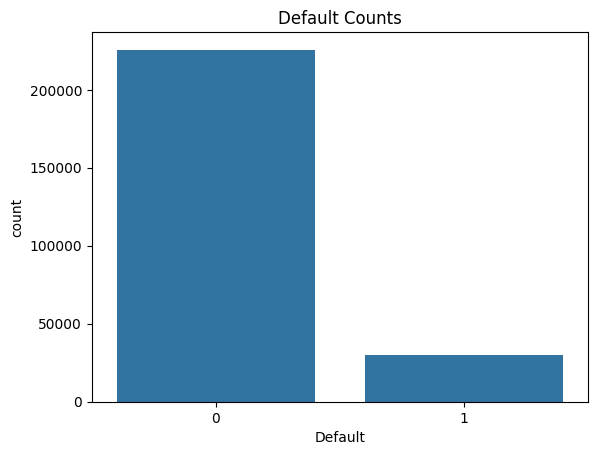

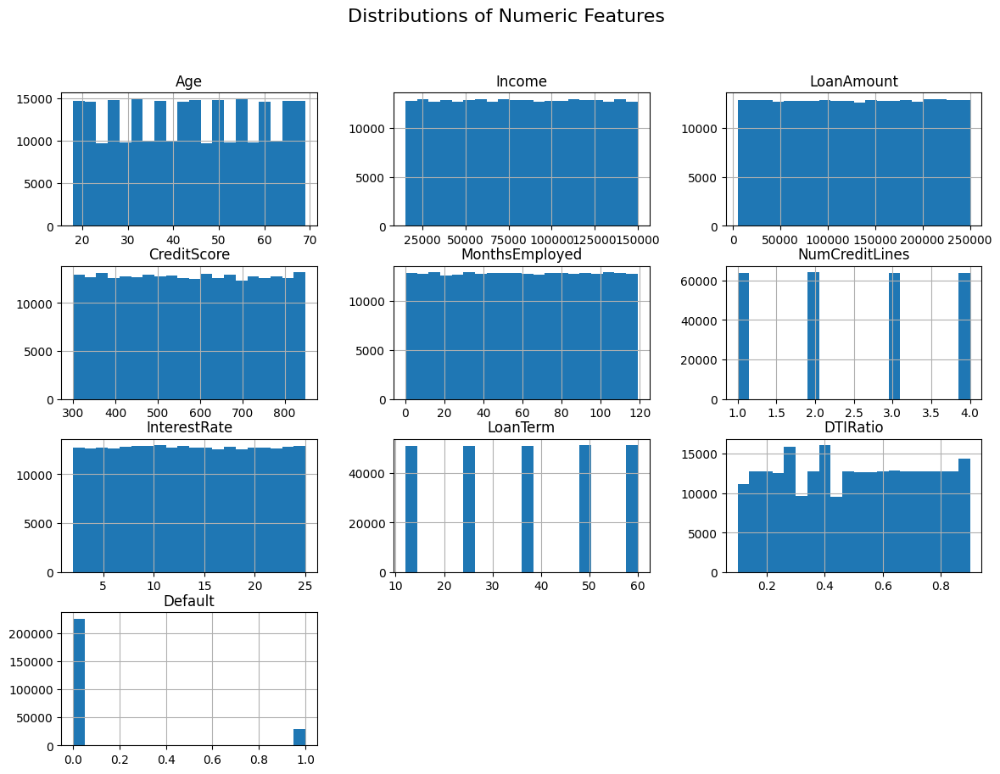

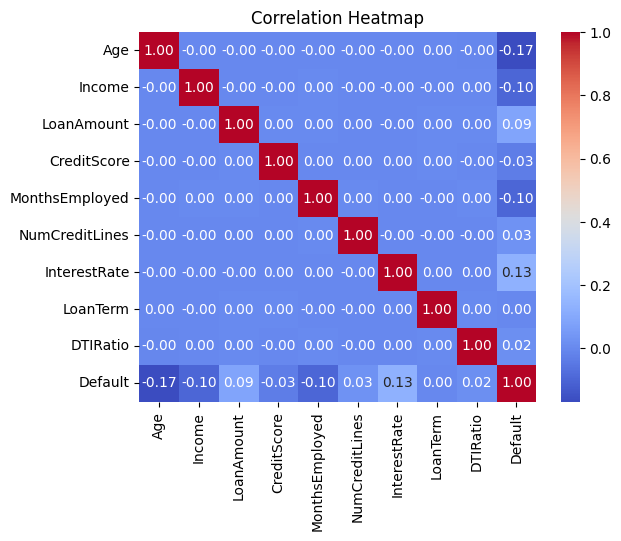


Training Logistic Regression...


/Volumes/Local/resume/Loan-Default-Prediction/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Logistic Regression Classification Report:
              precision    recall  f1-score   support

           0       0.89      1.00      0.94     45170
           1       0.56      0.03      0.06      5900

    accuracy                           0.89     51070
   macro avg       0.73      0.51      0.50     51070
weighted avg       0.85      0.89      0.84     51070

Confusion Matrix:
[[45023   147]
 [ 5710   190]]

Training Random Forest...

Random Forest Classification Report:
              precision    recall  f1-score   support

           0       0.89      1.00      0.94     45170
           1       0.68      0.03      0.06      5900

    accuracy                           0.89     51070
   macro avg       0.79      0.52      0.50     51070
weighted avg       0.86      0.89      0.84     51070

Confusion Matrix:
[[45080    90]
 [ 5706   194]]

Training XGBoost...


/Volumes/Local/resume/Loan-Default-Prediction/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [18:41:33] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)



XGBoost Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.99      0.94     45170
           1       0.56      0.09      0.15      5900

    accuracy                           0.89     51070
   macro avg       0.73      0.54      0.55     51070
weighted avg       0.85      0.89      0.85     51070

Confusion Matrix:
[[44767   403]
 [ 5382   518]]

Model Comparison:
                     Accuracy   ROC AUC
Logistic Regression  0.885314  0.747192
Random Forest        0.886509  0.732331
XGBoost              0.886724  0.743565


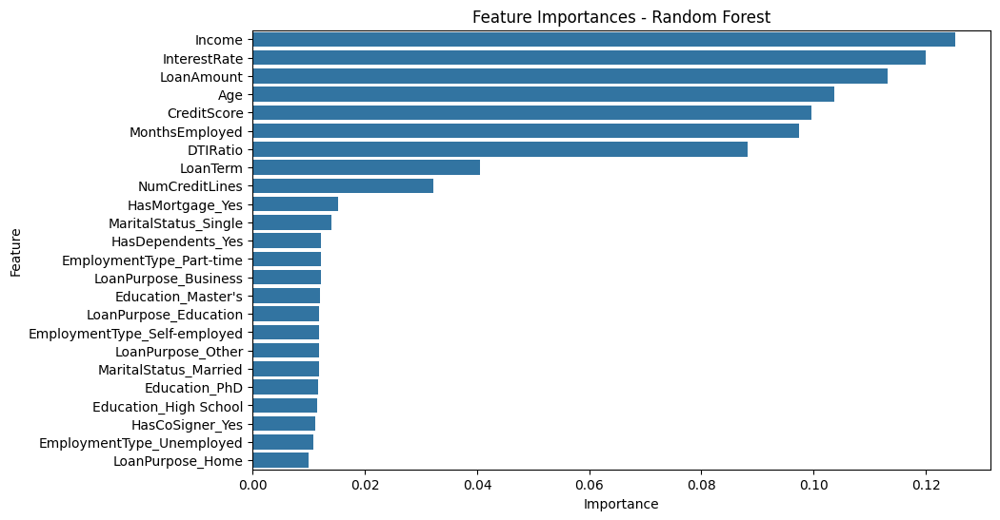

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score, confusion_matrix
from xgboost import XGBClassifier
import numpy as np

# Load the dataset
data_path = "../data/loan_data.csv"
df = pd.read_csv(data_path)

# Inspect the dataset
print("Dataset Head:")
print(df.head())

# Check for missing values and data types
print("\nMissing Values:")
print(df.isnull().sum())
print("\nData Types:")
print(df.dtypes)

# Separate numeric and categorical columns
numeric_cols = df.select_dtypes(include=["number"]).columns
categorical_cols = df.select_dtypes(exclude=["number"]).columns

# Fill missing values for numeric columns
df[numeric_cols] = df[numeric_cols].fillna(df[numeric_cols].mean())

# Fill missing values for categorical columns
for col in categorical_cols:
    df[col] = df[col].fillna(df[col].mode()[0])

# Verify no missing values remain
print("\nMissing Values After Imputation:")
print(df.isnull().sum())

# Visualization: Count plot for the target variable
sns.countplot(x='Default', data=df)
plt.title("Default Counts")
plt.show()

# Visualization: Distributions of numeric variables
df[numeric_cols].hist(bins=20, figsize=(14, 10))
plt.suptitle("Distributions of Numeric Features", fontsize=16)
plt.show()

# Correlation heatmap
sns.heatmap(df[numeric_cols].corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

# Define target and features
TARGET_COLUMN = "Default"
X = df.drop(columns=[TARGET_COLUMN, "LoanID"])  # Drop LoanID as it’s non-predictive
y = df[TARGET_COLUMN]

# One-hot encode categorical columns
X_encoded = pd.get_dummies(X, drop_first=True)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

# Train and compare models
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(n_estimators=100, random_state=42),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss")
}

# Results dictionary to store performance metrics
results = {}

for model_name, model in models.items():
    print(f"\nTraining {model_name}...")
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    y_pred_proba = model.predict_proba(X_test)[:, 1] if hasattr(model, "predict_proba") else None

    # Evaluate performance
    accuracy = accuracy_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred_proba) if y_pred_proba is not None else "N/A"
    cm = confusion_matrix(y_test, y_pred)
    
    # Store results
    results[model_name] = {
        "Accuracy": accuracy,
        "ROC AUC": roc_auc
    }
    
    # Print classification report
    print(f"\n{model_name} Classification Report:")
    print(classification_report(y_test, y_pred))
    print(f"Confusion Matrix:\n{cm}")

# Display overall results
results_df = pd.DataFrame(results).T
print("\nModel Comparison:")
print(results_df)

# Visualization: Feature importance from Random Forest
rf_model = models["Random Forest"]
feature_importances = pd.DataFrame({
    "Feature": X_encoded.columns,
    "Importance": rf_model.feature_importances_
}).sort_values(by="Importance", ascending=False)

# Plot feature importances
plt.figure(figsize=(10, 6))
sns.barplot(x="Importance", y="Feature", data=feature_importances)
plt.title("Feature Importances - Random Forest")
plt.show()


In [6]:
pip install XGboost


[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
